## Check the adjecency matrix

- the k of the adjecency matrix, showen that the connectivity inside the regions was high while between regions was very low. We ran the full algorithm without _ in the region names. So I want to see the heatmaps of the adjecency matrix before  the orrection and after.

In [1]:
import polars as pl
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

old_adj = pl.scan_csv("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/adj4rn.csv")
new_adj = pl.scan_csv("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/adj_drop__.csv")

In [3]:
old_adj.columns

/tmp/ipykernel_1540297/3350932352.py:1: PerformanceWarning: Determining the column names of a LazyFrame requires resolving its schema, which is a potentially expensive operation. Use `LazyFrame.collect_schema().names()` to get the column names without this warning.
  old_adj.columns


['',
 'AC_ENSG00000000003.14',
 'AC_ENSG00000000419.12',
 'AC_ENSG00000000457.13',
 'AC_ENSG00000000460.16',
 'AC_ENSG00000000938.12',
 'AC_ENSG00000000971.15',
 'AC_ENSG00000001036.13',
 'AC_ENSG00000001084.10',
 'AC_ENSG00000001167.14',
 'AC_ENSG00000001460.17',
 'AC_ENSG00000001461.16',
 'AC_ENSG00000001497.16',
 'AC_ENSG00000001561.6',
 'AC_ENSG00000001617.11',
 'AC_ENSG00000001629.9',
 'AC_ENSG00000001630.15',
 'AC_ENSG00000001631.15',
 'AC_ENSG00000002016.17',
 'AC_ENSG00000002330.13',
 'AC_ENSG00000002549.12',
 'AC_ENSG00000002586.18',
 'AC_ENSG00000002586.18_PAR_Y',
 'AC_ENSG00000002587.9',
 'AC_ENSG00000002745.12',
 'AC_ENSG00000002746.14',
 'AC_ENSG00000002822.15',
 'AC_ENSG00000002834.17',
 'AC_ENSG00000002919.14',
 'AC_ENSG00000002933.7',
 'AC_ENSG00000003056.7',
 'AC_ENSG00000003096.14',
 'AC_ENSG00000003137.8',
 'AC_ENSG00000003147.17',
 'AC_ENSG00000003249.13',
 'AC_ENSG00000003393.14',
 'AC_ENSG00000003400.14',
 'AC_ENSG00000003402.19',
 'AC_ENSG00000003436.15',
 'AC_EN

In [4]:
# --- 1. Prepare metadata (regions & columns) ---

import polars as pl
import math, os, gc
from collections import defaultdict
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

OLD_PATH = "/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/adj4rn.csv"
NEW_PATH = "/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/adj_drop__.csv"

# Read header once (no data) – Polars lazy plan
all_cols = pl.scan_csv(OLD_PATH).columns

# Heuristic: first column is row-id if it does NOT contain an underscore separating region/gene twice
ROW_ID_COL = all_cols[0]  # adjust if needed

data_cols = [c for c in all_cols if c != ROW_ID_COL]

def region_of(col: str) -> str:
    return col.split("_", 1)[0]

region_cols = defaultdict(list)
for c in data_cols:
    region_cols[region_of(c)].append(c)

regions = sorted(region_cols.keys())
print(f"Detected {len(regions)} regions")

region_gene_counts = {r: len(cols) for r, cols in region_cols.items()}
pd.Series(region_gene_counts).sort_values(ascending=False).head()

/tmp/ipykernel_1540297/3704601712.py:15: PerformanceWarning: Determining the column names of a LazyFrame requires resolving its schema, which is a potentially expensive operation. Use `LazyFrame.collect_schema().names()` to get the column names without this warning.
  all_cols = pl.scan_csv(OLD_PATH).columns


Detected 3 regions


AC     17306
MF     17306
PCG    17306
dtype: int64

In [ ]:
# --- 2. Streaming block mean computation ---

def compute_region_block_means(csv_path: str,
                               regions,
                               region_cols_map,
                               row_id_col: str,
                               chunk_size: int = 1500,
                               include_diag: bool = False):
    """
    Returns DataFrame with mean adjacency per region pair.
    mean_ij = sum(A[genes in region_i, genes in region_j]) / denom
    denom = n_i * n_j (i!=j)
          = n_i*(n_i-1) if i==j and include_diag=False
          = n_i*n_i      if i==j and include_diag=True
    """
    nR = len(regions)
    n_vec = {r: len(region_cols_map[r]) for r in regions}
    M = np.zeros((nR, nR), dtype=np.float64)

    # Precompute denominators
    denom = np.zeros((nR, nR), dtype=np.float64)
    for a, ra in enumerate(regions):
        for b, rb in enumerate(regions):
            if a == b:
                ni = n_vec[ra]
                denom[a, b] = ni * (ni if include_diag else max(1, ni - 1))
            else:
                denom[a, b] = n_vec[ra] * n_vec[rb]

    # For each row-region (source region)
    for ai, reg_row in enumerate(regions):
        row_prefix = f"{reg_row}_"
        print(f"[{csv_path.split('/')[-1]}] Processing row-region {reg_row} ({ai+1}/{nR})")
        # For each col-region we will accumulate sums in streaming fashion
        # Strategy: loop over col-region chunks; each pass filters only rows of reg_row
        for bj, reg_col in enumerate(regions):
            col_list = region_cols_map[reg_col]
            total_sum = 0.0
            # Chunk the columns to keep memory lower
            n_chunks = math.ceil(len(col_list) / chunk_size)
            for ck in range(n_chunks):
                chunk_cols = col_list[ck*chunk_size:(ck+1)*chunk_size]
                if not chunk_cols:
                    continue
                lf = (
                    pl.scan_csv(csv_path)
                      .select([row_id_col] + chunk_cols)
                      .filter(pl.col(row_id_col).str.starts_with(row_prefix))
                      .select([pl.col(c).sum().alias(c) for c in chunk_cols])
                )
                # Row now has one value per column (sum over filtered rows)
                # Sum horizontally to get block partial sum
                partial = (
                    lf.select(pl.sum_horizontal(pl.all()).alias("blk"))
                      .collect(streaming=True)["blk"][0]
                )
                total_sum += float(partial)

            # Adjust for within-region diagonal if excluding
            if ai == bj and not include_diag:
                # Need to subtract the diagonal (self-self) if it exists (assumed 1 or known)
                # If diagonal entries are not all identical OR unknown, this step would need
                # separate extraction. For big matrices typically adjacency diagonal=1.
                # We approximate by subtracting n_vec[reg_row] (assuming diag=1).
                total_sum -= n_vec[reg_row]  # remove self edges
            # Protect against division by zero
            M[ai, bj] = total_sum / denom[ai, bj] if denom[ai, bj] > 0 else np.nan

    return pd.DataFrame(M, index=regions, columns=regions)


old_region_means = compute_region_block_means(
    OLD_PATH, regions, region_cols, ROW_ID_COL, chunk_size=1500, include_diag=False
)
new_region_means = compute_region_block_means(
    NEW_PATH, regions, region_cols, ROW_ID_COL, chunk_size=1500, include_diag=False
)
new_region_means = compute_region_block_means_safe(
    NEW_PATH, regions_common, region_cols_common, ROW_ID_COL_NEW, chunk_size=1500, include_diag=False
)
old_region_means.head()

[adj4rn.csv] Processing row-region AC (1/3)


/tmp/ipykernel_1540297/363263495.py:55: DeprecationWarning: the `streaming` parameter was deprecated in 1.25.0; use `engine` instead.
  .collect(streaming=True)["blk"][0]


[adj4rn.csv] Processing row-region MF (2/3)
[adj4rn.csv] Processing row-region PCG (3/3)
[adj_drop__.csv] Processing row-region AC (1/3)


ColumnNotFoundError: unable to find column "MF_BA9_BA46_ENSG00000000003.14"; valid columns: ["", "AC_ENSG00000000003.14", "AC_ENSG00000000419.12", "AC_ENSG00000000457.13", "AC_ENSG00000000460.16", "AC_ENSG00000000938.12", "AC_ENSG00000000971.15", "AC_ENSG00000001036.13", "AC_ENSG00000001084.10", "AC_ENSG00000001167.14", "AC_ENSG00000001460.17", "AC_ENSG00000001461.16", "AC_ENSG00000001497.16", "AC_ENSG00000001561.6", "AC_ENSG00000001617.11", "AC_ENSG00000001629.9", "AC_ENSG00000001630.15", "AC_ENSG00000001631.15", "AC_ENSG00000002016.17", "AC_ENSG00000002330.13", "AC_ENSG00000002549.12", "AC_ENSG00000002586.18", "AC_ENSG00000002586.18_PAR_Y", "AC_ENSG00000002587.9", "AC_ENSG00000002745.12", "AC_ENSG00000002746.14", "AC_ENSG00000002822.15", "AC_ENSG00000002834.17", "AC_ENSG00000002919.14", "AC_ENSG00000002933.7", "AC_ENSG00000003056.7", "AC_ENSG00000003096.14", "AC_ENSG00000003137.8", "AC_ENSG00000003147.17", "AC_ENSG00000003249.13", "AC_ENSG00000003393.14", "AC_ENSG00000003400.14", "AC_ENSG00000003402.19", "AC_ENSG00000003436.15", "AC_ENSG00000003509.15", "AC_ENSG00000003756.16", "AC_ENSG00000003987.13", "AC_ENSG00000003989.17", "AC_ENSG00000004059.10", "AC_ENSG00000004139.13", "AC_ENSG00000004142.11", "AC_ENSG00000004399.12", "AC_ENSG00000004455.16", "AC_ENSG00000004468.12", "AC_ENSG00000004478.7", "AC_ENSG00000004487.15", "AC_ENSG00000004534.14", "AC_ENSG00000004660.14", "AC_ENSG00000004700.15", "AC_ENSG00000004766.15", "AC_ENSG00000004776.12", "AC_ENSG00000004777.18", "AC_ENSG00000004779.9", "AC_ENSG00000004799.7", "AC_ENSG00000004838.13", "AC_ENSG00000004848.7", "AC_ENSG00000004864.13", "AC_ENSG00000004866.20", "AC_ENSG00000004897.11", "AC_ENSG00000004961.14", "AC_ENSG00000004975.11", "AC_ENSG00000005007.12", "AC_ENSG00000005020.12", "AC_ENSG00000005022.5", "AC_ENSG00000005059.15", "AC_ENSG00000005075.15", "AC_ENSG00000005100.12", "AC_ENSG00000005108.15", "AC_ENSG00000005156.11", "AC_ENSG00000005175.9", "AC_ENSG00000005189.19", "AC_ENSG00000005194.14", "AC_ENSG00000005206.16", "AC_ENSG00000005238.19", "AC_ENSG00000005243.9", "AC_ENSG00000005249.12", "AC_ENSG00000005302.17", "AC_ENSG00000005339.14", "AC_ENSG00000005379.15", "AC_ENSG00000005381.7", "AC_ENSG00000005436.13", "AC_ENSG00000005448.16", "AC_ENSG00000005469.11", "AC_ENSG00000005471.15", "AC_ENSG00000005483.20", "AC_ENSG00000005486.16", "AC_ENSG00000005513.9", "AC_ENSG00000005700.14", "AC_ENSG00000005801.16", "AC_ENSG00000005810.17", "AC_ENSG00000005812.10", "AC_ENSG00000005844.17", "AC_ENSG00000005882.11", "AC_ENSG00000005884.17", "AC_ENSG00000005889.15", "AC_ENSG00000005893.15", "AC_ENSG00000005961.17", "AC_ENSG00000005981.12", "AC_ENSG00000006007.11", "AC_ENSG00000006015.17", "AC_ENSG00000006016.10", "AC_ENSG00000006025.11", "AC_ENSG00000006042.11", "AC_ENSG00000006047.12", "AC_ENSG00000006062.14", "AC_ENSG00000006071.12", "AC_ENSG00000006116.3", "AC_ENSG00000006118.14", "AC_ENSG00000006125.17", "AC_ENSG00000006128.11", "AC_ENSG00000006194.9", "AC_ENSG00000006210.6", "AC_ENSG00000006282.20", "AC_ENSG00000006283.17", "AC_ENSG00000006327.13", "AC_ENSG00000006377.10", "AC_ENSG00000006432.15", "AC_ENSG00000006451.7", "AC_ENSG00000006453.13", "AC_ENSG00000006459.10", "AC_ENSG00000006468.13", "AC_ENSG00000006530.15", "AC_ENSG00000006534.15", "AC_ENSG00000006555.10", "AC_ENSG00000006576.16", "AC_ENSG00000006607.13", "AC_ENSG00000006611.15", "AC_ENSG00000006625.17", "AC_ENSG00000006634.7", "AC_ENSG00000006638.11", "AC_ENSG00000006652.13", "AC_ENSG00000006695.10", "AC_ENSG00000006704.10", "AC_ENSG00000006712.14", "AC_ENSG00000006715.15", "AC_ENSG00000006740.16", "AC_ENSG00000006744.18", "AC_ENSG00000006747.14", "AC_ENSG00000006756.15", "AC_ENSG00000006757.11", "AC_ENSG00000006831.9", "AC_ENSG00000006837.11", "AC_ENSG00000007001.12", "AC_ENSG00000007047.14", "AC_ENSG00000007062.11", "AC_ENSG00000007080.10", "AC_ENSG00000007168.12", "AC_ENSG00000007171.16", "AC_ENSG00000007174.17", "AC_ENSG00000007202.14", "AC_ENSG00000007237.18", "AC_ENSG00000007255.10", "AC_ENSG00000007264.14", "AC_ENSG00000007341.18", "AC_ENSG00000007372.21", "AC_ENSG00000007376.7", "AC_ENSG00000007384.15", "AC_ENSG00000007392.16", "AC_ENSG00000007402.11", "AC_ENSG00000007516.13", "AC_ENSG00000007520.3", "AC_ENSG00000007541.16", "AC_ENSG00000007545.15", "AC_ENSG00000007866.19", "AC_ENSG00000007923.15", "AC_ENSG00000007933.12", "AC_ENSG00000007944.14", "AC_ENSG00000008018.8", "AC_ENSG00000008056.13", "AC_ENSG00000008083.13", "AC_ENSG00000008086.11", "AC_ENSG00000008118.9", "AC_ENSG00000008128.22", "AC_ENSG00000008130.15", "AC_ENSG00000008226.19", "AC_ENSG00000008256.15", "AC_ENSG00000008277.14", "AC_ENSG00000008282.8", "AC_ENSG00000008283.15", "AC_ENSG00000008294.20", "AC_ENSG00000008300.16", "AC_ENSG00000008311.14", "AC_ENSG00000008324.11", "AC_ENSG00000008382.15", "AC_ENSG00000008394.12", "AC_ENSG00000008405.11", "AC_ENSG00000008441.16", "AC_ENSG00000008513.14", "AC_ENSG00000008516.16", "AC_ENSG00000008517.16", "AC_ENSG00000008710.19", "AC_ENSG00000008735.13", "AC_ENSG00000008838.19", "AC_ENSG00000008853.16", "AC_ENSG00000008869.11", "AC_ENSG00000008952.16", "AC_ENSG00000008988.9", "AC_ENSG00000009307.15", "AC_ENSG00000009335.17", "AC_ENSG00000009413.15", "AC_ENSG00000009694.13", "AC_ENSG00000009709.11", "AC_ENSG00000009780.15", "AC_ENSG00000009790.14", "AC_ENSG00000009830.11", "AC_ENSG00000009844.15", "AC_ENSG00000009950.15", "AC_ENSG00000009954.10", "AC_ENSG00000010017.12", "AC_ENSG00000010030.13", "AC_ENSG00000010072.15", "AC_ENSG00000010165.19", "AC_ENSG00000010219.13", "AC_ENSG00000010244.18", "AC_ENSG00000010256.10", "AC_ENSG00000010270.13", "AC_ENSG00000010278.12", "AC_ENSG00000010282.14", "AC_ENSG00000010292.12", "AC_ENSG00000010295.19", "AC_ENSG00000010310.8", "AC_ENSG00000010318.20", "AC_ENSG00000010319.6", "AC_ENSG00000010322.15", "AC_ENSG00000010327.10", "AC_ENSG00000010361.13", "AC_ENSG00000010379.15", "AC_ENSG00000010404.17", "AC_ENSG00000010438.16", "AC_ENSG00000010539.11", "AC_ENSG00000010610.9", "AC_ENSG00000010626.14", "AC_ENSG00000010671.15", "AC_ENSG00000010704.18", "AC_ENSG00000010803.16", "AC_ENSG00000010810.17", "AC_ENSG00000010818.9", "AC_ENSG00000011007.12", "AC_ENSG00000011009.10", "AC_ENSG00000011021.21", "AC_ENSG00000011028.13", "AC_ENSG00000011052.21", "AC_ENSG00000011083.8", "AC_ENSG00000011105.12", "AC_ENSG00000011114.14", "AC_ENSG00000011132.11", "AC_ENSG00000011143.16", "AC_ENSG00000011198.7", "AC_ENSG00000011201.11", "AC_ENSG00000011243.17", "AC_ENSG00000011258.15", "AC_ENSG00000011260.13", "AC_ENSG00000011275.18", "AC_ENSG00000011295.15", "AC_ENSG00000011304.19", "AC_ENSG00000011332.19", "AC_ENSG00000011347.9", "AC_ENSG00000011376.9", "AC_ENSG00000011405.13", "AC_ENSG00000011422.11", "AC_ENSG00000011426.10", "AC_ENSG00000011451.17", "AC_ENSG00000011454.16", "AC_ENSG00000011465.16", "AC_ENSG00000011478.11", "AC_ENSG00000011485.14", "AC_ENSG00000011523.13", "AC_ENSG00000011566.14", "AC_ENSG00000011600.11", "AC_ENSG00000011638.10", "AC_ENSG00000011677.12", "AC_ENSG00000012048.20", "AC_ENSG00000012061.15", "AC_ENSG00000012124.16", "AC_ENSG00000012171.19", "AC_ENSG00000012174.11", "AC_ENSG00000012211.12", "AC_ENSG00000012223.12", "AC_ENSG00000012232.8", "AC_ENSG00000012660.13", "AC_ENSG00000012779.10", "AC_ENSG00000012822.15", "AC_ENSG00000012963.14", "AC_ENSG00000012983.11", "AC_ENSG00000013016.15", "AC_ENSG00000013275.7", "AC_ENSG00000013288.8", "AC_ENSG00000013293.5", "AC_ENSG00000013297.10", "AC_ENSG00000013306.15", "AC_ENSG00000013364.18", "AC_ENSG00000013374.15", "AC_ENSG00000013375.15", "AC_ENSG00000013392.7", "AC_ENSG00000013441.15", "AC_ENSG00000013503.9", "AC_ENSG00000013523.9", "AC_ENSG00000013561.17", "AC_ENSG00000013563.13", "AC_ENSG00000013573.16", "AC_ENSG00000013583.8", "AC_ENSG00000013588.7", "AC_ENSG00000013619.13", "AC_ENSG00000013725.14", "AC_ENSG00000013810.18", "AC_ENSG00000014123.9", "AC_ENSG00000014138.8", "AC_ENSG00000014164.6", "AC_ENSG00000014216.15", "AC_ENSG00000014641.17", "AC_ENSG00000014824.13", "AC_ENSG00000014914.20", "AC_ENSG00000014919.12", "AC_ENSG00000015133.18", "AC_ENSG00000015153.14", "AC_ENSG00000015171.19", "AC_ENSG00000015285.10", "AC_ENSG00000015475.18", "AC_ENSG00000015479.18", "AC_ENSG00000015532.9", "AC_ENSG00000015568.12", "AC_ENSG00000015592.16", "AC_ENSG00000015676.17", "AC_ENSG00000016391.10", "AC_ENSG00000016402.13", "AC_ENSG00000016602.9", "AC_ENSG00000016864.18", "AC_ENSG00000017260.19", "AC_ENSG00000017427.15", "AC_ENSG00000017483.14", "AC_ENSG00000017797.12", "AC_ENSG00000018189.12", "AC_ENSG00000018236.14", "AC_ENSG00000018280.16", "AC_ENSG00000018408.14", "AC_ENSG00000018510.13", "AC_ENSG00000018610.13", "AC_ENSG00000018625.14", "AC_ENSG00000018699.11", "AC_ENSG00000018869.16", "AC_ENSG00000019144.18", "AC_ENSG00000019485.13", "AC_ENSG00000019505.7", "AC_ENSG00000019549.9", "AC_ENSG00000019582.14", "AC_ENSG00000019991.15", "AC_ENSG00000019995.6", "AC_ENSG00000020129.15", "AC_ENSG00000020181.17", "AC_ENSG00000020256.19", "AC_ENSG00000020426.10", "AC_ENSG00000020577.13", "AC_ENSG00000020633.18", "AC_ENSG00000020922.12", "AC_ENSG00000021300.13", "AC_ENSG00000021355.12", "AC_ENSG00000021488.12", "AC_ENSG00000021574.11", "AC_ENSG00000021645.18", "AC_ENSG00000021762.19", "AC_ENSG00000021776.10", "AC_ENSG00000021826.14", "AC_ENSG00000022267.16", "AC_ENSG00000022277.12", "AC_ENSG00000022355.16", "AC_ENSG00000022556.15", "AC_ENSG00000022567.9", "AC_ENSG00000022840.15", "AC_ENSG00000022976.15", "AC_ENSG00000023041.11", "AC_ENSG00000023171.16", "AC_ENSG00000023191.16", "AC_ENSG00000023228.13", "AC_ENSG00000023287.12", "AC_ENSG00000023318.7", "AC_ENSG00000023330.14", "AC_ENSG00000023445.13", "AC_ENSG00000023516.8", "AC_ENSG00000023572.8", "AC_ENSG00000023608.4", "AC_ENSG00000023697.12", "AC_ENSG00000023734.10", "AC_ENSG00000023892.10", "AC_ENSG00000023902.13", "AC_ENSG00000023909.9", "AC_ENSG00000024048.10", "AC_ENSG00000024422.11", "AC_ENSG00000024862.17", "AC_ENSG00000025039.14", "AC_ENSG00000025156.12", "AC_ENSG00000025293.16", "AC_ENSG00000025423.11", "AC_ENSG00000025434.18", "AC_ENSG00000025708.13", "AC_ENSG00000025770.18", "AC_ENSG00000025772.7", "AC_ENSG00000025796.13", "AC_ENSG00000025800.13", "AC_ENSG00000026025.15", "AC_ENSG00000026036.21", "AC_ENSG00000026103.21", "AC_ENSG00000026297.15", "AC_ENSG00000026508.17", "AC_ENSG00000026559.13", "AC_ENSG00000026652.13", "AC_ENSG00000026950.16", "AC_ENSG00000027001.9", "AC_ENSG00000027075.14", "AC_ENSG00000027697.13", "AC_ENSG00000027847.13", "AC_ENSG00000028116.16", "AC_ENSG00000028137.18", "AC_ENSG00000028203.17", "AC_ENSG00000028277.21", "AC_ENSG00000028310.17", "AC_ENSG00000028528.14", "AC_ENSG00000028839.9", "AC_ENSG00000029153.14", "AC_ENSG00000029363.16", "AC_ENSG00000029364.11", "AC_ENSG00000029534.19", "AC_ENSG00000029639.10", "AC_ENSG00000029725.16", "AC_ENSG00000029993.14", "AC_ENSG00000030066.13", "AC_ENSG00000030110.12", "AC_ENSG00000030419.16", "AC_ENSG00000030582.17", "AC_ENSG00000031003.10", "AC_ENSG00000031081.10", "AC_ENSG00000031691.6", "AC_ENSG00000031698.12", "AC_ENSG00000031823.14", "AC_ENSG00000032219.18", "AC_ENSG00000032389.12", "AC_ENSG00000032444.15", "AC_ENSG00000032742.17", "AC_ENSG00000033011.11", "AC_ENSG00000033030.13", "AC_ENSG00000033050.7", "AC_ENSG00000033100.16", "AC_ENSG00000033122.18", "AC_ENSG00000033170.16", "AC_ENSG00000033178.12", "AC_ENSG00000033327.12", "AC_ENSG00000033627.16", "AC_ENSG00000033800.13", "AC_ENSG00000033867.16", "AC_ENSG00000034053.14", "AC_ENSG00000034152.18", "AC_ENSG00000034239.10", "AC_ENSG00000034510.5", "AC_ENSG00000034533.11", "AC_ENSG00000034677.12", "AC_ENSG00000034693.14", "AC_ENSG00000034713.7", "AC_ENSG00000035115.21", "AC_ENSG00000035141.7", "AC_ENSG00000035403.17", "AC_ENSG00000035499.12", "AC_ENSG00000035664.11", "AC_ENSG00000035681.7", "AC_ENSG00000035687.9", "AC_ENSG00000035862.12", "AC_ENSG00000035928.15", "AC_ENSG00000036054.12", "AC_ENSG00000036257.12", "AC_ENSG00000036448.9", "AC_ENSG00000036530.8", "AC_ENSG00000036549.12", "AC_ENSG00000036672.15", "AC_ENSG00000037042.8", "AC_ENSG00000037241.7", "AC_ENSG00000037280.15", "AC_ENSG00000037474.14", "AC_ENSG00000037637.10", "AC_ENSG00000037749.11", "AC_ENSG00000037757.13", "AC_ENSG00000037897.16", "AC_ENSG00000038002.8", "AC_ENSG00000038210.12", "AC_ENSG00000038219.12", "AC_ENSG00000038274.16", "AC_ENSG00000038295.7", "AC_ENSG00000038358.14", "AC_ENSG00000038382.18", "AC_ENSG00000038427.15", "AC_ENSG00000038532.14", "AC_ENSG00000038945.14", "AC_ENSG00000039068.18", "AC_ENSG00000039123.15", "AC_ENSG00000039139.9", "AC_ENSG00000039319.16", "AC_ENSG00000039523.19", "AC_ENSG00000039560.13", "AC_ENSG00000039650.11", "AC_ENSG00000040199.18", "AC_ENSG00000040275.16", "AC_ENSG00000040341.17", "AC_ENSG00000040487.12", "AC_ENSG00000040531.14", "AC_ENSG00000040608.13", "AC_ENSG00000040633.12", "AC_ENSG00000040731.10", "AC_ENSG00000040933.15", "AC_ENSG00000041353.9", "AC_ENSG00000041357.15", "AC_ENSG00000041515.15", "AC_ENSG00000041802.10", "AC_ENSG00000041880.14", "AC_ENSG00000041982.15", "AC_ENSG00000041988.15", "AC_ENSG00000042062.11", "AC_ENSG00000042088.13", "AC_ENSG00000042286.14", "AC_ENSG00000042317.16", "AC_ENSG00000042429.11", "AC_ENSG00000042445.13", "AC_ENSG00000042493.15", "AC_ENSG00000042753.11", "AC_ENSG00000042781.12", "AC_ENSG00000042832.11", "AC_ENSG00000042980.12", "AC_ENSG00000043093.13", "AC_ENSG00000043143.20", "AC_ENSG00000043355.11", "AC_ENSG00000043462.11", "AC_ENSG00000043514.15", "AC_ENSG00000043591.5", "AC_ENSG00000044090.8", "AC_ENSG00000044115.20", "AC_ENSG00000044446.11", "AC_ENSG00000044459.14", "AC_ENSG00000044524.10", "AC_ENSG00000044574.7", "AC_ENSG00000046647.13", "AC_ENSG00000046651.14", "AC_ENSG00000046653.14", "AC_ENSG00000046889.18", "AC_ENSG00000047056.14", "AC_ENSG00000047188.15", "AC_ENSG00000047230.14", "AC_ENSG00000047249.17", "AC_ENSG00000047315.15", "AC_ENSG00000047346.12", "AC_ENSG00000047365.11", "AC_ENSG00000047410.13", "AC_ENSG00000047457.13", "AC_ENSG00000047578.12", "AC_ENSG00000047579.19", "AC_ENSG00000047597.5", "AC_ENSG00000047617.14", "AC_ENSG00000047621.11", "AC_ENSG00000047634.14", "AC_ENSG00000047644.18", "AC_ENSG00000047648.21", "AC_ENSG00000047662.4", "AC_ENSG00000047849.21", "AC_ENSG00000047932.13", "AC_ENSG00000047936.10", "AC_ENSG00000048028.11", "AC_ENSG00000048052.21", "AC_ENSG00000048140.17", "AC_ENSG00000048162.20", "AC_ENSG00000048342.15", "AC_ENSG00000048392.11", "AC_ENSG00000048405.9", "AC_ENSG00000048471.13", "AC_ENSG00000048540.14", "AC_ENSG00000048544.5", "AC_ENSG00000048545.13", "AC_ENSG00000048649.13", "AC_ENSG00000048707.13", "AC_ENSG00000048740.18", "AC_ENSG00000048828.16", "AC_ENSG00000048991.16", "AC_ENSG00000049089.13", "AC_ENSG00000049130.14", "AC_ENSG00000049167.13", "AC_ENSG00000049192.14", "AC_ENSG00000049239.12", "AC_ENSG00000049245.12", "AC_ENSG00000049246.14", "AC_ENSG00000049283.17", "AC_ENSG00000049323.15", "AC_ENSG00000049449.8", "AC_ENSG00000049540.16", "AC_ENSG00000049541.10", "AC_ENSG00000049618.22", "AC_ENSG00000049656.13", "AC_ENSG00000049759.17", "AC_ENSG00000049768.14", "AC_ENSG00000049769.12", "AC_ENSG00000049860.13", "AC_ENSG00000049883.14", "AC_ENSG00000050030.13", "AC_ENSG00000050130.17", "AC_ENSG00000050165.17", "AC_ENSG00000050327.14", "AC_ENSG00000050393.11", "AC_ENSG00000050405.13", "AC_ENSG00000050426.15", "AC_ENSG00000050438.16", "AC_ENSG00000050555.17", "AC_ENSG00000050628.20", "AC_ENSG00000050748.17", "AC_ENSG00000050767.15", "AC_ENSG00000050820.16", "AC_ENSG00000051009.10", "AC_ENSG00000051108.14", "AC_ENSG00000051128.18", "AC_ENSG00000051341.13", "AC_ENSG00000051382.8", "AC_ENSG00000051523.10", "AC_ENSG00000051596.9", "AC_ENSG00000051620.10", "AC_ENSG00000051825.14", "AC_ENSG00000052126.14", "AC_ENSG00000052723.11", "AC_ENSG00000052749.13", "AC_ENSG00000052795.12", "AC_ENSG00000052802.12", "AC_ENSG00000052841.14", "AC_ENSG00000053108.16", "AC_ENSG00000053254.15", "AC_ENSG00000053328.8", "AC_ENSG00000053371.12", "AC_ENSG00000053372.4", "AC_ENSG00000053438.8", "AC_ENSG00000053501.12", "AC_ENSG00000053524.12", "AC_ENSG00000053702.14", "AC_ENSG00000053747.15", "AC_ENSG00000053770.11", "AC_ENSG00000053900.10", "AC_ENSG00000053918.15", "AC_ENSG00000054116.11", "AC_ENSG00000054118.13", "AC_ENSG00000054148.17", "AC_ENSG00000054179.11", "AC_ENSG00000054219.10", "AC_ENSG00000054267.21", "AC_ENSG00000054277.13", "AC_ENSG00000054282.15", "AC_ENSG00000054356.13", "AC_ENSG00000054392.12", "AC_ENSG00000054523.17", "AC_ENSG00000054598.6", "AC_ENSG00000054611.13", "AC_ENSG00000054654.16", "AC_ENSG00000054690.13", "AC_ENSG00000054793.13", "AC_ENSG00000054803.3", "AC_ENSG00000054965.10", "AC_ENSG00000054967.12", "AC_ENSG00000054983.16", "AC_ENSG00000055044.10", "AC_ENSG00000055070.16", "AC_ENSG00000055118.14", "AC_ENSG00000055130.15", "AC_ENSG00000055147.18", "AC_ENSG00000055163.19", "AC_ENSG00000055208.18", "AC_ENSG00000055211.12", "AC_ENSG00000055332.16", "AC_ENSG00000055483.19", "AC_ENSG00000055609.17", "AC_ENSG00000055813.5", "AC_ENSG00000055917.15", "AC_ENSG00000055950.16", "AC_ENSG00000055955.15", "AC_ENSG00000056050.6", "AC_ENSG00000056097.15", "AC_ENSG00000056277.15", "AC_ENSG00000056487.15", "AC_ENSG00000056558.10", "AC_ENSG00000056586.15", "AC_ENSG00000056736.9", "AC_ENSG00000056972.18", "AC_ENSG00000056998.19", "AC_ENSG00000057019.15", "AC_ENSG00000057252.12", "AC_ENSG00000057294.14", "AC_ENSG00000057468.6", "AC_ENSG00000057593.13", "AC_ENSG00000057608.16", "AC_ENSG00000057657.15", "AC_ENSG00000057663.14", "AC_ENSG00000057704.12", "AC_ENSG00000057757.9", "AC_ENSG00000057935.13", "AC_ENSG00000058056.8", "AC_ENSG00000058063.15", "AC_ENSG00000058091.16", "AC_ENSG00000058262.9", "AC_ENSG00000058272.16", "AC_ENSG00000058335.15", "AC_ENSG00000058404.19", "AC_ENSG00000058453.16", "AC_ENSG00000058600.15", "AC_ENSG00000058668.14", "AC_ENSG00000058673.16", "AC_ENSG00000058729.10", "AC_ENSG00000058799.14", "AC_ENSG00000058804.11", "AC_ENSG00000058866.14", "AC_ENSG00000059122.16", "AC_ENSG00000059145.18", "AC_ENSG00000059377.16", "AC_ENSG00000059378.12", "AC_ENSG00000059573.8", "AC_ENSG00000059588.9", "AC_ENSG00000059691.11", "AC_ENSG00000059728.10", "AC_ENSG00000059758.7", "AC_ENSG00000059769.19", "AC_ENSG00000059804.15", "AC_ENSG00000059915.16", "AC_ENSG00000060069.16", "AC_ENSG00000060138.12", "AC_ENSG00000060140.8", "AC_ENSG00000060237.16", "AC_ENSG00000060339.13", "AC_ENSG00000060491.16", "AC_ENSG00000060558.3", "AC_ENSG00000060642.10", "AC_ENSG00000060656.19", "AC_ENSG00000060688.12", "AC_ENSG00000060709.14", "AC_ENSG00000060718.20", "AC_ENSG00000060749.14", "AC_ENSG00000060762.18", "AC_ENSG00000060971.17", "AC_ENSG00000060982.14", "AC_ENSG00000061273.17", "AC_ENSG00000061337.15", "AC_ENSG00000061455.10", "AC_ENSG00000061656.9", "AC_ENSG00000061676.14", "AC_ENSG00000061794.12", "AC_ENSG00000061918.12", "AC_ENSG00000061936.9", "AC_ENSG00000061938.17", "AC_ENSG00000061987.15", "AC_ENSG00000062038.13", "AC_ENSG00000062096.14", "AC_ENSG00000062194.15", "AC_ENSG00000062282.14", "AC_ENSG00000062370.16", "AC_ENSG00000062485.18", "AC_ENSG00000062524.15", "AC_ENSG00000062582.13", "AC_ENSG00000062598.17", "AC_ENSG00000062650.18", "AC_ENSG00000062716.12", "AC_ENSG00000062725.9", "AC_ENSG00000062822.12", "AC_ENSG00000063015.19", "AC_ENSG00000063046.17", "AC_ENSG00000063169.10", "AC_ENSG00000063176.15", "AC_ENSG00000063177.12", "AC_ENSG00000063180.8", "AC_ENSG00000063241.7", "AC_ENSG00000063244.12", "AC_ENSG00000063245.14", "AC_ENSG00000063322.13", "AC_ENSG00000063438.16", "AC_ENSG00000063587.13", "AC_ENSG00000063601.16", "AC_ENSG00000063660.8", "AC_ENSG00000063761.15", "AC_ENSG00000063854.12", "AC_ENSG00000063978.15", "AC_ENSG00000064012.21", "AC_ENSG00000064042.17", "AC_ENSG00000064102.14", "AC_ENSG00000064115.10", "AC_ENSG00000064199.6", "AC_ENSG00000064205.10", "AC_ENSG00000064225.12", "AC_ENSG00000064270.12", "AC_ENSG00000064300.8", "AC_ENSG00000064309.14", "AC_ENSG00000064313.11", "AC_ENSG00000064393.15", "AC_ENSG00000064419.13", "AC_ENSG00000064489.22", "AC_ENSG00000064490.13", "AC_ENSG00000064545.14", "AC_ENSG00000064547.13", "AC_ENSG00000064601.16", "AC_ENSG00000064607.16", "AC_ENSG00000064651.13", "AC_ENSG00000064652.10", "AC_ENSG00000064655.18", "AC_ENSG00000064666.14", "AC_ENSG00000064687.12", "AC_ENSG00000064692.18", "AC_ENSG00000064703.11", "AC_ENSG00000064726.9", "AC_ENSG00000064763.10", "AC_ENSG00000064787.13", "AC_ENSG00000064886.13", "AC_ENSG00000064932.15", "AC_ENSG00000064933.17", "AC_ENSG00000064961.18", "AC_ENSG00000064989.12", "AC_ENSG00000064995.16", "AC_ENSG00000064999.13", "AC_ENSG00000065000.15", "AC_ENSG00000065029.14", "AC_ENSG00000065054.13", "AC_ENSG00000065057.7", "AC_ENSG00000065060.16", "AC_ENSG00000065135.10", "AC_ENSG00000065150.18", "AC_ENSG00000065154.11", "AC_ENSG00000065183.15", "AC_ENSG00000065243.19", "AC_ENSG00000065268.10", "AC_ENSG00000065308.4", "AC_ENSG00000065320.8", "AC_ENSG00000065325.12", "AC_ENSG00000065357.19", "AC_ENSG00000065361.14", "AC_ENSG00000065413.18", "AC_ENSG00000065427.14", "AC_ENSG00000065457.10", "AC_ENSG00000065485.19", "AC_ENSG00000065491.8", "AC_ENSG00000065518.7", "AC_ENSG00000065526.10", "AC_ENSG00000065534.18", "AC_ENSG00000065548.17", "AC_ENSG00000065559.14", "AC_ENSG00000065600.12", "AC_ENSG00000065609.14", "AC_ENSG00000065613.13", "AC_ENSG00000065615.13", "AC_ENSG00000065621.14", "AC_ENSG00000065665.20", "AC_ENSG00000065675.14", "AC_ENSG00000065717.14", "AC_ENSG00000065802.11", "AC_ENSG00000065809.13", "AC_ENSG00000065833.8", "AC_ENSG00000065882.15", "AC_ENSG00000065883.14", "AC_ENSG00000065911.11", "AC_ENSG00000065923.9", "AC_ENSG00000065970.8", "AC_ENSG00000065978.18", "AC_ENSG00000065989.15", "AC_ENSG00000066027.11", "AC_ENSG00000066032.18", "AC_ENSG00000066044.14", "AC_ENSG00000066056.13", "AC_ENSG00000066084.12", "AC_ENSG00000066117.14", "AC_ENSG00000066135.12", "AC_ENSG00000066136.20", "AC_ENSG00000066185.12", "AC_ENSG00000066248.14", "AC_ENSG00000066294.14", "AC_ENSG00000066322.14", "AC_ENSG00000066336.11", "AC_ENSG00000066379.14", "AC_ENSG00000066382.16", "AC_ENSG00000066422.4", "AC_ENSG00000066427.21", "AC_ENSG00000066455.12", "AC_ENSG00000066468.22", "AC_ENSG00000066557.5", "AC_ENSG00000066583.11", "AC_ENSG00000066629.16", "AC_ENSG00000066651.18", "AC_ENSG00000066654.13", "AC_ENSG00000066697.14", "AC_ENSG00000066735.14", "AC_ENSG00000066739.11", "AC_ENSG00000066777.8", "AC_ENSG00000066827.15", "AC_ENSG00000066855.15", "AC_ENSG00000066923.17", "AC_ENSG00000066926.10", "AC_ENSG00000066933.15", "AC_ENSG00000067057.16", "AC_ENSG00000067064.10", "AC_ENSG00000067066.16", "AC_ENSG00000067082.14", "AC_ENSG00000067113.16", "AC_ENSG00000067141.16", "AC_ENSG00000067167.7", "AC_ENSG00000067177.14", "AC_ENSG00000067182.7", "AC_ENSG00000067191.15", "AC_ENSG00000067208.14", "AC_ENSG00000067221.13", "AC_ENSG00000067225.17", "AC_ENSG00000067248.9", "AC_ENSG00000067334.13", "AC_ENSG00000067365.14", "AC_ENSG00000067369.13", "AC_ENSG00000067445.20", "AC_ENSG00000067533.5", "AC_ENSG00000067560.10", "AC_ENSG00000067596.10", "AC_ENSG00000067601.7", "AC_ENSG00000067606.16", "AC_ENSG00000067704.9", "AC_ENSG00000067715.13", "AC_ENSG00000067798.14", "AC_ENSG00000067829.18", "AC_ENSG00000067836.12", "AC_ENSG00000067840.12", "AC_ENSG00000067842.17", "AC_ENSG00000067900.7", "AC_ENSG00000067955.13", "AC_ENSG00000067992.12", "AC_ENSG00000068001.13", "AC_ENSG00000068024.16", "AC_ENSG00000068028.17", "AC_ENSG00000068078.17", "AC_ENSG00000068079.7", "AC_ENSG00000068097.14", "AC_ENSG00000068120.14", "AC_ENSG00000068137.14", "AC_ENSG00000068305.17", "AC_ENSG00000068308.13", "AC_ENSG00000068323.16", "AC_ENSG00000068354.15", "AC_ENSG00000068366.19", "AC_ENSG00000068383.18", "AC_ENSG00000068394.10", "AC_ENSG00000068400.13", "AC_ENSG00000068438.14", "AC_ENSG00000068489.12", "AC_ENSG00000068615.17", "AC_ENSG00000068650.18", "AC_ENSG00000068654.15", "AC_ENSG00000068697.6", "AC_ENSG00000068724.15", "AC_ENSG00000068745.14", "AC_ENSG00000068784.12", "AC_ENSG00000068796.16", "AC_ENSG00000068831.18", "AC_ENSG00000068878.14", "AC_ENSG00000068885.14", "AC_ENSG00000068903.19", "AC_ENSG00000068912.13", "AC_ENSG00000068971.13", "AC_ENSG00000068976.13", "AC_ENSG00000069020.18", "AC_ENSG00000069122.18", "AC_ENSG00000069188.16", "AC_ENSG00000069248.11", "AC_ENSG00000069275.12", "AC_ENSG00000069329.16", "AC_ENSG00000069345.11", "AC_ENSG00000069399.14", "AC_ENSG00000069424.14", "AC_ENSG00000069431.11", "AC_ENSG00000069493.14", "AC_ENSG00000069509.5", "AC_ENSG00000069535.13", "AC_ENSG00000069667.15", "AC_ENSG00000069702.10", "AC_ENSG00000069712.12", "AC_ENSG00000069849.10", "AC_ENSG00000069869.15", "AC_ENSG00000069943.9", "AC_ENSG00000069956.11", "AC_ENSG00000069966.18", "AC_ENSG00000069974.15", "AC_ENSG00000069998.12", "AC_ENSG00000070010.18", "AC_ENSG00000070018.8", "AC_ENSG00000070047.11", "AC_ENSG00000070061.14", "AC_ENSG00000070081.15", "AC_ENSG00000070087.13", "AC_ENSG00000070159.13", "AC_ENSG00000070182.19", "AC_ENSG00000070190.12", "AC_ENSG00000070214.15", "AC_ENSG00000070269.13", "AC_ENSG00000070366.13", "AC_ENSG00000070367.15", "AC_ENSG00000070371.15", "AC_ENSG00000070388.11", "AC_ENSG00000070404.9", "AC_ENSG00000070413.19", "AC_ENSG00000070423.17", "AC_ENSG00000070444.14", "AC_ENSG00000070476.14", "AC_ENSG00000070495.14", "AC_ENSG00000070501.11", "AC_ENSG00000070526.14", "AC_ENSG00000070540.12", "AC_ENSG00000070601.9", "AC_ENSG00000070610.14", "AC_ENSG00000070614.14", "AC_ENSG00000070669.16", "AC_ENSG00000070718.11", "AC_ENSG00000070729.13", "AC_ENSG00000070731.10", "AC_ENSG00000070756.15", "AC_ENSG00000070759.16", "AC_ENSG00000070761.7", "AC_ENSG00000070770.8", "AC_ENSG00000070778.12", "AC_ENSG00000070785.16", "AC_ENSG00000070808.15", "AC_ENSG00000070814.17", "AC_ENSG00000070831.15", "AC_ENSG00000070882.12", "AC_ENSG00000070886.11", "AC_ENSG00000070950.9", "AC_ENSG00000070961.15", "AC_ENSG00000071051.13", "AC_ENSG00000071054.16", "AC_ENSG00000071073.12", "AC_ENSG00000071082.10", "AC_ENSG00000071127.16", "AC_ENSG00000071189.21", "AC_ENSG00000071205.11", "AC_ENSG00000071242.11", "AC_ENSG00000071243.15", "AC_ENSG00000071246.10", "AC_ENSG00000071282.11", "AC_ENSG00000071462.11", "AC_ENSG00000071537.13", "AC_ENSG00000071539.13", "AC_ENSG00000071553.16", "AC_ENSG00000071564.14", "AC_ENSG00000071575.11", "AC_ENSG00000071626.16", "AC_ENSG00000071655.17", "AC_ENSG00000071794.15", "AC_ENSG00000071859.14", "AC_ENSG00000071889.16", "AC_ENSG00000071894.16", "AC_ENSG00000071967.11", "AC_ENSG00000071991.8", "AC_ENSG00000071994.10", "AC_ENSG00000072041.16", "AC_ENSG00000072042.12", "AC_ENSG00000072062.13", "AC_ENSG00000072071.16", "AC_ENSG00000072110.13", "AC_ENSG00000072121.15", "AC_ENSG00000072133.10", "AC_ENSG00000072134.15", "AC_ENSG00000072135.12", "AC_ENSG00000072163.19", "AC_ENSG00000072182.12", "AC_ENSG00000072195.14", "AC_ENSG00000072201.13", "AC_ENSG00000072210.18", "AC_ENSG00000072274.12", "AC_ENSG00000072310.16", "AC_ENSG00000072315.3", "AC_ENSG00000072364.12", "AC_ENSG00000072401.14", "AC_ENSG00000072415.8", "AC_ENSG00000072422.16", "AC_ENSG00000072501.17", "AC_ENSG00000072506.12", "AC_ENSG00000072518.20", "AC_ENSG00000072609.17", "AC_ENSG00000072657.8", "AC_ENSG00000072682.18", "AC_ENSG00000072694.20", "AC_ENSG00000072736.18", "AC_ENSG00000072756.16", "AC_ENSG00000072778.19", "AC_ENSG00000072786.12", "AC_ENSG00000072803.17", "AC_ENSG00000072818.11", "AC_ENSG00000072832.14", "AC_ENSG00000072840.12", "AC_ENSG00000072849.10", "AC_ENSG00000072858.10", "AC_ENSG00000072864.14", "AC_ENSG00000072952.18", "AC_ENSG00000072954.6", "AC_ENSG00000072958.8", "AC_ENSG00000073008.14", "AC_ENSG00000073050.11", "AC_ENSG00000073060.15", "AC_ENSG00000073111.13", "AC_ENSG00000073146.15", "AC_ENSG00000073150.13", "AC_ENSG00000073169.13", "AC_ENSG00000073331.17", "AC_ENSG00000073350.13", "AC_ENSG00000073417.14", "AC_ENSG00000073464.11", "AC_ENSG00000073536.17", "AC_ENSG00000073578.16", "AC_ENSG00000073584.18", "AC_ENSG00000073605.18", "AC_ENSG00000073614.12", "AC_ENSG00000073670.13", "AC_ENSG00000073711.10", "AC_ENSG00000073712.14", "AC_ENSG00000073737.16", "AC_ENSG00000073756.11", "AC_ENSG00000073792.15", "AC_ENSG00000073803.13", "AC_ENSG00000073849.14", "AC_ENSG00000073910.20", "AC_ENSG00000073921.17", "AC_ENSG00000073969.18", "AC_ENSG00000074047.21", "AC_ENSG00000074054.17", "AC_ENSG00000074071.14", "AC_ENSG00000074181.8", "AC_ENSG00000074201.8", "AC_ENSG00000074211.13", "AC_ENSG00000074219.13", "AC_ENSG00000074266.19", "AC_ENSG00000074276.10", "AC_ENSG00000074317.10", "AC_ENSG00000074319.12", "AC_ENSG00000074356.16", "AC_ENSG00000074370.17", "AC_ENSG00000074410.13", "AC_ENSG00000074416.13", "AC_ENSG00000074527.11", "AC_ENSG00000074582.12", "AC_ENSG00000074590.13", "AC_ENSG00000074603.18", "AC_ENSG00000074621.13", "AC_ENSG00000074657.13", "AC_ENSG00000074660.15", "AC_ENSG00000074695.5", "AC_ENSG00000074696.12", "AC_ENSG00000074706.13", "AC_ENSG00000074755.14", "AC_ENSG00000074800.13", "AC_ENSG00000074803.17", "AC_ENSG00000074842.7", "AC_ENSG00000074855.10", "AC_ENSG00000074935.13", "AC_ENSG00000074964.16", "AC_ENSG00000075035.9", "AC_ENSG00000075043.18", "AC_ENSG00000075073.14", "AC_ENSG00000075089.9", "AC_ENSG00000075131.9", "AC_ENSG00000075142.13", "AC_ENSG00000075151.20", "AC_ENSG00000075188.8", "AC_ENSG00000075213.10", "AC_ENSG00000075223.13", "AC_ENSG00000075234.16", "AC_ENSG00000075239.13", "AC_ENSG00000075240.16", "AC_ENSG00000075292.18", "AC_ENSG00000075303.12", "AC_ENSG00000075336.11", "AC_ENSG00000075340.22", "AC_ENSG00000075391.16", "AC_ENSG00000075399.13", "AC_ENSG00000075407.18", "AC_ENSG00000075413.17", "AC_ENSG00000075415.12", "AC_ENSG00000075420.12", "AC_ENSG00000075426.11", "AC_ENSG00000075429.8", "AC_ENSG00000075461.5", "AC_ENSG00000075539.14", "AC_ENSG00000075568.16", "AC_ENSG00000075618.17", "AC_ENSG00000075624.13", "AC_ENSG00000075643.5", "AC_ENSG00000075651.15", "AC_ENSG00000075702.16", "AC_ENSG00000075711.20", "AC_ENSG00000075785.12", "AC_ENSG00000075790.10", "AC_ENSG00000075826.16", "AC_ENSG00000075856.11", "AC_ENSG00000075884.13", "AC_ENSG00000075914.12", "AC_ENSG00000075945.12", "AC_ENSG00000075975.15", "AC_ENSG00000076003.4", "AC_ENSG00000076043.9", "AC_ENSG00000076053.10", "AC_ENSG00000076067.12", "AC_ENSG00000076108.11", "AC_ENSG00000076201.14", "AC_ENSG00000076242.14", "AC_ENSG00000076248.10", "AC_ENSG00000076258.9", "AC_ENSG00000076321.10", "AC_ENSG00000076344.15", "AC_ENSG00000076351.12", "AC_ENSG00000076356.6", "AC_ENSG00000076382.16", "AC_ENSG00000076513.16", "AC_ENSG00000076554.15", "AC_ENSG00000076555.15", "AC_ENSG00000076604.14", "AC_ENSG00000076641.4", "AC_ENSG00000076650.6", "AC_ENSG00000076662.9", "AC_ENSG00000076685.18", "AC_ENSG00000076706.16", "AC_ENSG00000076716.8", "AC_ENSG00000076770.14", "AC_ENSG00000076826.9", "AC_ENSG00000076864.19", "AC_ENSG00000076924.11", "AC_ENSG00000076928.17", "AC_ENSG00000076944.15", "AC_ENSG00000076984.17", "AC_ENSG00000077044.10", "AC_ENSG00000077063.10", "AC_ENSG00000077080.9", "AC_ENSG00000077092.18", "AC_ENSG00000077097.15", "AC_ENSG00000077147.14", "AC_ENSG00000077150.18", "AC_ENSG00000077152.9", "AC_ENSG00000077157.21", "AC_ENSG00000077232.17", "AC_ENSG00000077235.17", "AC_ENSG00000077238.13", "AC_ENSG00000077254.14", "AC_ENSG00000077264.14", "AC_ENSG00000077279.18", "AC_ENSG00000077312.8", "AC_ENSG00000077327.15", "AC_ENSG00000077348.8", "AC_ENSG00000077380.15", "AC_ENSG00000077420.15", "AC_ENSG00000077454.15", "AC_ENSG00000077458.12", "AC_ENSG00000077463.14", "AC_ENSG00000077514.8", "AC_ENSG00000077522.12", "AC_ENSG00000077549.17", "AC_ENSG00000077585.13", "AC_ENSG00000077616.10", "AC_ENSG00000077684.15", "AC_ENSG00000077713.18", "AC_ENSG00000077721.15", "AC_ENSG00000077782.19", "AC_ENSG00000077942.18", "AC_ENSG00000077943.7", "AC_ENSG00000078018.19", "AC_ENSG00000078043.15", "AC_ENSG00000078053.16", "AC_ENSG00000078061.12", "AC_ENSG00000078070.12", "AC_ENSG00000078098.13", "AC_ENSG00000078114.18", "AC_ENSG00000078124.11", "AC_ENSG00000078140.13", "AC_ENSG00000078142.12", "AC_ENSG00000078177.13", "AC_ENSG00000078237.6", "AC_ENSG00000078246.16", "AC_ENSG00000078269.14", "AC_ENSG00000078295.16", "AC_ENSG00000078304.19", "AC_ENSG00000078319.9", "AC_ENSG00000078328.20", "AC_ENSG00000078369.17", "AC_ENSG00000078401.6", "AC_ENSG00000078403.16", "AC_ENSG00000078487.17", "AC_ENSG00000078549.14", "AC_ENSG00000078596.10", "AC_ENSG00000078618.21", "AC_ENSG00000078668.13", "AC_ENSG00000078674.17", "AC_ENSG00000078687.17", "AC_ENSG00000078699.21", "AC_ENSG00000078725.12", "AC_ENSG00000078747.14", "AC_ENSG00000078804.12", "AC_ENSG00000078808.16", "AC_ENSG00000078814.15", "AC_ENSG00000078902.15", "AC_ENSG00000078967.12", "AC_ENSG00000079101.16", "AC_ENSG00000079102.16", "AC_ENSG00000079134.11", "AC_ENSG00000079150.17", "AC_ENSG00000079156.16", "AC_ENSG00000079215.13", "AC_ENSG00000079246.15", "AC_ENSG00000079257.7", "AC_ENSG00000079263.18", "AC_ENSG00000079277.19", "AC_ENSG00000079308.16", "AC_ENSG00000079313.13", "AC_ENSG00000079332.14", "AC_ENSG00000079335.18", "AC_ENSG00000079337.15", "AC_ENSG00000079387.13", "AC_ENSG00000079432.7", "AC_ENSG00000079435.9", "AC_ENSG00000079459.12", "AC_ENSG00000079462.7", "AC_ENSG00000079482.12", "AC_ENSG00000079616.12", "AC_ENSG00000079691.17", "AC_ENSG00000079739.15", "AC_ENSG00000079785.14", "AC_ENSG00000079805.16", "AC_ENSG00000079819.18", "AC_ENSG00000079841.18", "AC_ENSG00000079931.14", "AC_ENSG00000079950.13", "AC_ENSG00000079974.17", "AC_ENSG00000079999.13", "AC_ENSG00000080031.9", "AC_ENSG00000080166.15", "AC_ENSG00000080189.14", "AC_ENSG00000080200.9", "AC_ENSG00000080224.17", "AC_ENSG00000080298.15", "AC_ENSG00000080345.17", "AC_ENSG00000080371.5", "AC_ENSG00000080493.15", "AC_ENSG00000080503.22", "AC_ENSG00000080546.13", "AC_ENSG00000080561.13", "AC_ENSG00000080573.6", "AC_ENSG00000080603.16", "AC_ENSG00000080608.9", "AC_ENSG00000080709.14", "AC_ENSG00000080802.18", "AC_ENSG00000080815.18", "AC_ENSG00000080819.6", "AC_ENSG00000080822.16", "AC_ENSG00000080823.22", "AC_ENSG00000080824.18", "AC_ENSG00000080839.11", "AC_ENSG00000080845.17", "AC_ENSG00000080854.14", "AC_ENSG00000080947.14", "AC_ENSG00000081014.10", "AC_ENSG00000081019.13", "AC_ENSG00000081026.18", "AC_ENSG00000081041.8", "AC_ENSG00000081052.11", "AC_ENSG00000081059.19", "AC_ENSG00000081087.14", "AC_ENSG00000081138.13", "AC_ENSG00000081148.11", "AC_ENSG00000081154.11", "AC_ENSG00000081177.18", "AC_ENSG00000081181.7", "AC_ENSG00000081189.15", "AC_ENSG00000081237.18", "AC_ENSG00000081248.10", "AC_ENSG00000081277.12", "AC_ENSG00000081307.12", "AC_ENSG00000081320.10", "AC_ENSG00000081377.16", "AC_ENSG00000081386.12", "AC_ENSG00000081479.12", "AC_ENSG00000081665.13", "AC_ENSG00000081692.12", "AC_ENSG00000081721.11", "AC_ENSG00000081760.16", "AC_ENSG00000081791.8", "AC_ENSG00000081803.15", "AC_ENSG00000081818.3", "AC_ENSG00000081842.17", "AC_ENSG00000081853.14", "AC_ENSG00000081870.11", "AC_ENSG00000081913.13", "AC_ENSG00000081923.11", "AC_ENSG00000081985.10", "AC_ENSG00000082014.16", "AC_ENSG00000082068.8", "AC_ENSG00000082074.15", "AC_ENSG00000082146.12", "AC_ENSG00000082153.17", "AC_ENSG00000082175.14", "AC_ENSG00000082196.20", "AC_ENSG00000082212.12", "AC_ENSG00000082213.17", "AC_ENSG00000082258.12", "AC_ENSG00000082269.16", "AC_ENSG00000082293.12", "AC_ENSG00000082397.17", "AC_ENSG00000082438.15", "AC_ENSG00000082458.11", "AC_ENSG00000082482.13", "AC_ENSG00000082497.11", "AC_ENSG00000082512.14", "AC_ENSG00000082515.17", "AC_ENSG00000082516.8", "AC_ENSG00000082556.10", "AC_ENSG00000082641.15", "AC_ENSG00000082684.14", "AC_ENSG00000082701.14", "AC_ENSG00000082781.11", "AC_ENSG00000082805.19", "AC_ENSG00000082898.16", "AC_ENSG00000082996.19", "AC_ENSG00000083067.22", "AC_ENSG00000083093.9", "AC_ENSG00000083097.14", "AC_ENSG00000083099.10", "AC_ENSG00000083123.14", "AC_ENSG00000083168.9", "AC_ENSG00000083223.17", "AC_ENSG00000083290.19", "AC_ENSG00000083312.17", "AC_ENSG00000083444.16", "AC_ENSG00000083454.21", "AC_ENSG00000083457.11", "AC_ENSG00000083520.14", "AC_ENSG00000083535.15", "AC_ENSG00000083544.13", "AC_ENSG00000083635.7", "AC_ENSG00000083642.18", "AC_ENSG00000083720.12", "AC_ENSG00000083750.12", "AC_ENSG00000083799.17", "AC_ENSG00000083807.9", "AC_ENSG00000083812.11", "AC_ENSG00000083814.13", "AC_ENSG00000083817.8", "AC_ENSG00000083828.15", "AC_ENSG00000083838.15", "AC_ENSG00000083844.10", "AC_ENSG00000083845.8", "AC_ENSG00000083857.13", "AC_ENSG00000083896.12", "AC_ENSG00000083937.8", "AC_ENSG00000084070.11", "AC_ENSG00000084072.16", "AC_ENSG00000084073.8", "AC_ENSG00000084090.13", "AC_ENSG00000084092.6", "AC_ENSG00000084093.16", "AC_ENSG00000084112.14", "AC_ENSG00000084207.15", "AC_ENSG00000084234.16", "AC_ENSG00000084444.13", "AC_ENSG00000084453.16", "AC_ENSG00000084463.7", "AC_ENSG00000084623.11", "AC_ENSG00000084628.9", "AC_ENSG00000084636.17", "AC_ENSG00000084652.15", "AC_ENSG00000084674.14", "AC_ENSG00000084676.15", "AC_ENSG00000084693.15", "AC_ENSG00000084710.13", "AC_ENSG00000084731.14", "AC_ENSG00000084733.10", "AC_ENSG00000084754.10", "AC_ENSG00000084764.10", "AC_ENSG00000084774.13", "AC_ENSG00000085063.14", "AC_ENSG00000085117.11", "AC_ENSG00000085185.15", "AC_ENSG00000085224.21", "AC_ENSG00000085231.13", "AC_ENSG00000085274.15", "AC_ENSG00000085276.17", "AC_ENSG00000085365.17", "AC_ENSG00000085377.13", "AC_ENSG00000085382.11", "AC_ENSG00000085415.15", "AC_ENSG00000085433.15", "AC_ENSG00000085449.14", "AC_ENSG00000085465.12", "AC_ENSG00000085491.15", "AC_ENSG00000085511.19", "AC_ENSG00000085514.15", "AC_ENSG00000085563.14", "AC_ENSG00000085644.13", "AC_ENSG00000085662.13", "AC_ENSG00000085719.12", "AC_ENSG00000085721.12", "AC_ENSG00000085733.15", "AC_ENSG00000085741.12", "AC_ENSG00000085760.14", "AC_ENSG00000085788.13", "AC_ENSG00000085831.15", "AC_ENSG00000085832.16", "AC_ENSG00000085871.8", "AC_ENSG00000085872.14", "AC_ENSG00000085978.21", "AC_ENSG00000085982.13", "AC_ENSG00000085998.13", "AC_ENSG00000085999.11", "AC_ENSG00000086015.20", "AC_ENSG00000086061.15", "AC_ENSG00000086062.12", "AC_ENSG00000086065.13", "AC_ENSG00000086102.18", "AC_ENSG00000086159.12", "AC_ENSG00000086189.9", "AC_ENSG00000086200.16", "AC_ENSG00000086205.16", "AC_ENSG00000086232.12", "AC_ENSG00000086289.11", "AC_ENSG00000086300.15", "AC_ENSG00000086475.14", "AC_ENSG00000086504.15", "AC_ENSG00000086506.2", "AC_ENSG00000086544.2", "AC_ENSG00000086589.11", "AC_ENSG00000086598.10", "AC_ENSG00000086619.13", "AC_ENSG00000086666.18", "AC_ENSG00000086712.12", "AC_ENSG00000086717.18", "AC_ENSG00000086730.16", "AC_ENSG00000086758.15", "AC_ENSG00000086827.8", "AC_ENSG00000086848.14", "AC_ENSG00000086991.12", "AC_ENSG00000087008.15", "AC_ENSG00000087053.18", "AC_ENSG00000087074.7", "AC_ENSG00000087076.8", "AC_ENSG00000087077.13", "AC_ENSG00000087085.13", "AC_ENSG00000087086.14", "AC_ENSG00000087087.19", "AC_ENSG00000087088.19", "AC_ENSG00000087095.12", "AC_ENSG00000087111.20", "AC_ENSG00000087116.14", "AC_ENSG00000087152.15", "AC_ENSG00000087157.18", "AC_ENSG00000087191.12", "AC_ENSG00000087206.16", "AC_ENSG00000087245.12", "AC_ENSG00000087250.8", "AC_ENSG00000087253.12", "AC_ENSG00000087258.14", "AC_ENSG00000087263.16", "AC_ENSG00000087266.15", "AC_ENSG00000087269.15", "AC_ENSG00000087274.16", "AC_ENSG00000087299.11", "AC_ENSG00000087301.8", "AC_ENSG00000087302.8", "AC_ENSG00000087303.17", "AC_ENSG00000087338.4", "AC_ENSG00000087365.15", "AC_ENSG00000087448.9", "AC_ENSG00000087460.24", "AC_ENSG00000087470.17", "AC_ENSG00000087494.15", "AC_ENSG00000087495.16", "AC_ENSG00000087502.17", "AC_ENSG00000087510.6", "AC_ENSG00000087586.17", "AC_ENSG00000087589.16", "AC_ENSG00000087842.10", "AC_ENSG00000087884.14", "AC_ENSG00000087903.12", "AC_ENSG00000087995.15", "AC_ENSG00000088035.15", "AC_ENSG00000088038.17", "AC_ENSG00000088053.11", "AC_ENSG00000088179.8", "AC_ENSG00000088205.12", "AC_ENSG00000088247.17", "AC_ENSG00000088256.8", "AC_ENSG00000088280.18", "AC_ENSG00000088298.12", "AC_ENSG00000088305.18", "AC_ENSG00000088325.15", "AC_ENSG00000088340.15", "AC_ENSG00000088356.5", "AC_ENSG00000088367.21", "AC_ENSG00000088387.18", "AC_ENSG00000088448.14", "AC_ENSG00000088451.10", "AC_ENSG00000088538.12", "AC_ENSG00000088543.14", "AC_ENSG00000088682.13", "AC_ENSG00000088727.12", "AC_ENSG00000088756.12", "AC_ENSG00000088766.11", "AC_ENSG00000088808.16", "AC_ENSG00000088812.17", "AC_ENSG00000088826.17", "AC_ENSG00000088827.12", "AC_ENSG00000088832.16", "AC_ENSG00000088833.17", "AC_ENSG00000088836.12", "AC_ENSG00000088854.12", "AC_ENSG00000088876.11", "AC_ENSG00000088881.20", "AC_ENSG00000088888.17", "AC_ENSG00000088899.14", "AC_ENSG00000088930.7", "AC_ENSG00000088970.15", "AC_ENSG00000088986.10", "AC_ENSG00000088992.17", "AC_ENSG00000089006.16", "AC_ENSG00000089009.15", "AC_ENSG00000089022.13", "AC_ENSG00000089041.16", "AC_ENSG00000089048.14", "AC_ENSG00000089050.15", "AC_ENSG00000089053.12", "AC_ENSG00000089057.14", "AC_ENSG00000089060.11", "AC_ENSG00000089063.14", "AC_ENSG00000089091.16", "AC_ENSG00000089094.18", "AC_ENSG00000089101.17", "AC_ENSG00000089123.15", "AC_ENSG00000089127.12", "AC_ENSG00000089154.10", "AC_ENSG00000089157.15", "AC_ENSG00000089159.16", "AC_ENSG00000089163.4", "AC_ENSG00000089169.14", "AC_ENSG00000089177.18", "AC_ENSG00000089195.14", "AC_ENSG00000089199.9", "AC_ENSG00000089220.4", "AC_ENSG00000089234.15", "AC_ENSG00000089248.6", "AC_ENSG00000089250.18", "AC_ENSG00000089280.18", "AC_ENSG00000089289.15", "AC_ENSG00000089327.14", "AC_ENSG00000089335.20", "AC_ENSG00000089351.14", "AC_ENSG00000089356.18", "AC_ENSG00000089472.16", "AC_ENSG00000089486.16", "AC_ENSG00000089558.8", "AC_ENSG00000089597.16", "AC_ENSG00000089639.10", "AC_ENSG00000089682.16", "AC_ENSG00000089693.10", "AC_ENSG00000089723.9", "AC_ENSG00000089737.16", "AC_ENSG00000089775.11", "AC_ENSG00000089818.17", "AC_ENSG00000089820.15", "AC_ENSG00000089847.12", "AC_ENSG00000089876.11", "AC_ENSG00000089902.9", "AC_ENSG00000089916.17", "AC_ENSG00000090006.17", "AC_ENSG00000090013.9", "AC_ENSG00000090020.10", "AC_ENSG00000090054.13", "AC_ENSG00000090060.17", "AC_ENSG00000090061.17", "AC_ENSG00000090097.21", "AC_ENSG00000090104.11", "AC_ENSG00000090238.11", "AC_ENSG00000090263.15", "AC_ENSG00000090266.12", "AC_ENSG00000090273.13", "AC_ENSG00000090316.15", "AC_ENSG00000090339.8", "AC_ENSG00000090372.14", "AC_ENSG00000090376.10", "AC_ENSG00000090382.6", "AC_ENSG00000090432.6", "AC_ENSG00000090447.11", "AC_ENSG00000090470.14", "AC_ENSG00000090487.10", "AC_ENSG00000090520.11", "AC_ENSG00000090530.9", "AC_ENSG00000090534.17", "AC_ENSG00000090539.15", "AC_ENSG00000090554.12", "AC_ENSG00000090565.15", "AC_ENSG00000090581.9", "AC_ENSG00000090612.20", "AC_ENSG00000090615.14", "AC_ENSG00000090621.13", "AC_ENSG00000090661.11", "AC_ENSG00000090674.15", "AC_ENSG00000090686.15", "AC_ENSG00000090776.5", "AC_ENSG00000090857.13", "AC_ENSG00000090861.15", "AC_ENSG00000090863.11", "AC_ENSG00000090889.11", "AC_ENSG00000090905.18", "AC_ENSG00000090924.14", "AC_ENSG00000090932.10", "AC_ENSG00000090971.4", "AC_ENSG00000090975.12", "AC_ENSG00000090989.17", "AC_ENSG00000091009.7", "AC_ENSG00000091039.16", "AC_ENSG00000091073.19", "AC_ENSG00000091106.18", "AC_ENSG00000091127.13", "AC_ENSG00000091129.19", "AC_ENSG00000091136.13", "AC_ENSG00000091137.11", "AC_ENSG00000091140.13", "AC_ENSG00000091157.13", "AC_ENSG00000091164.12", "AC_ENSG00000091262.15", "AC_ENSG00000091317.7", "AC_ENSG00000091409.14", "AC_ENSG00000091428.17", "AC_ENSG00000091436.16", "AC_ENSG00000091482.5", "AC_ENSG00000091483.6", "AC_ENSG00000091490.10", "AC_ENSG00000091513.14", "AC_ENSG00000091527.15", "AC_ENSG00000091536.16", "AC_ENSG00000091542.8", "AC_ENSG00000091592.15", "AC_ENSG00000091622.15", "AC_ENSG00000091640.7", "AC_ENSG00000091651.8", "AC_ENSG00000091656.15", "AC_ENSG00000091664.7", "AC_ENSG00000091732.15", "AC_ENSG00000091844.7", "AC_ENSG00000091879.13", "AC_ENSG00000091947.9", "AC_ENSG00000091972.18", "AC_ENSG00000091986.15", "AC_ENSG00000092010.14", "AC_ENSG00000092020.10", "AC_ENSG00000092036.18", "AC_ENSG00000092051.16", "AC_ENSG00000092054.12", "AC_ENSG00000092068.19", "AC_ENSG00000092094.10", "AC_ENSG00000092096.16", "AC_ENSG00000092098.16", "AC_ENSG00000092108.20", "AC_ENSG00000092140.14", "AC_ENSG00000092148.12", "AC_ENSG00000092199.17", "AC_ENSG00000092201.9", "AC_ENSG00000092203.13", "AC_ENSG00000092208.16", "AC_ENSG00000092295.11", "AC_ENSG00000092330.15", "AC_ENSG00000092421.16", "AC_ENSG00000092439.13", "AC_ENSG00000092445.11", "AC_ENSG00000092470.11", "AC_ENSG00000092529.23", "AC_ENSG00000092531.9", "AC_ENSG00000092607.13", "AC_ENSG00000092621.12", "AC_ENSG00000092758.15", "AC_ENSG00000092820.17", "AC_ENSG00000092841.18", "AC_ENSG00000092847.11", "AC_ENSG00000092850.11", "AC_ENSG00000092853.13", "AC_ENSG00000092871.16", "AC_ENSG00000092929.11", "AC_ENSG00000092931.11", "AC_ENSG00000092964.17", "AC_ENSG00000092969.11", "AC_ENSG00000092978.10", "AC_ENSG00000093000.18", "AC_ENSG00000093010.13", "AC_ENSG00000093072.15", "AC_ENSG00000093100.13", "AC_ENSG00000093144.18", "AC_ENSG00000093167.17", "AC_ENSG00000093183.13", "AC_ENSG00000093217.9", "AC_ENSG00000094631.18", "AC_ENSG00000094804.9", "AC_ENSG00000094841.13", "AC_ENSG00000094880.10", "AC_ENSG00000094914.12", "AC_ENSG00000094916.15", "AC_ENSG00000094963.13", "AC_ENSG00000094975.13", "AC_ENSG00000095002.13", "AC_ENSG00000095015.5", "AC_ENSG00000095059.15", "AC_ENSG00000095066.11", "AC_ENSG00000095139.13", "AC_ENSG00000095203.14", "AC_ENSG00000095209.11", "AC_ENSG00000095261.13", "AC_ENSG00000095303.14", "AC_ENSG00000095319.14", "AC_ENSG00000095321.16", "AC_ENSG00000095370.19", "AC_ENSG00000095380.10", "AC_ENSG00000095383.19", "AC_ENSG00000095397.13", "AC_ENSG00000095485.17", "AC_ENSG00000095539.15", "AC_ENSG00000095564.13", "AC_ENSG00000095574.11", "AC_ENSG00000095585.16", "AC_ENSG00000095587.8", "AC_ENSG00000095596.11", "AC_ENSG00000095627.9", "AC_ENSG00000095637.21", "AC_ENSG00000095713.13", "AC_ENSG00000095739.10", "AC_ENSG00000095752.6", "AC_ENSG00000095787.21", "AC_ENSG00000095794.19", "AC_ENSG00000095906.16", "AC_ENSG00000095932.6", "AC_ENSG00000095951.16", "AC_ENSG00000095970.16", "AC_ENSG00000096060.14", "AC_ENSG00000096063.15", "AC_ENSG00000096070.19", "AC_ENSG00000096080.11", "AC_ENSG00000096092.5", "AC_ENSG00000096093.15", "AC_ENSG00000096384.19", "AC_ENSG00000096401.7", "AC_ENSG00000096433.10", "AC_ENSG00000096654.15", "AC_ENSG00000096696.13", "AC_ENSG00000096717.11", "AC_ENSG00000096746.17", "AC_ENSG00000096872.15", "AC_ENSG00000096968.13", "AC_ENSG00000096996.15", "AC_ENSG00000097007.17", "AC_ENSG00000097021.19", "AC_ENSG00000097033.14", "AC_ENSG00000097046.12", "AC_ENSG00000097096.8", "AC_ENSG00000099139.13", "AC_ENSG00000099194.5", "AC_ENSG00000099203.6", "AC_ENSG00000099204.18", "AC_ENSG00000099219.13", "AC_ENSG00000099246.16", "AC_ENSG00000099250.17", "AC_ENSG00000099251.14", "AC_ENSG00000099256.18", "AC_ENSG00000099260.10", "AC_ENSG00000099282.9", "AC_ENSG00000099284.13", "AC_ENSG00000099290.15", "AC_ENSG00000099308.10", "AC_ENSG00000099326.8", "AC_ENSG00000099330.8", "AC_ENSG00000099331.13", "AC_ENSG00000099337.4", "AC_ENSG00000099338.22", "AC_ENSG00000099341.11", "AC_ENSG00000099364.16", "AC_ENSG00000099365.10", "AC_ENSG00000099377.13", "AC_ENSG00000099381.17", "AC_ENSG00000099385.11", "AC_ENSG00000099617.3", "AC_ENSG00000099622.13", "AC_ENSG00000099624.7", "AC_ENSG00000099625.12", "AC_ENSG00000099783.11", "AC_ENSG00000099785.10", "AC_ENSG00000099795.6", "AC_ENSG00000099797.13", "AC_ENSG00000099800.7", "AC_ENSG00000099804.8", "AC_ENSG00000099810.18", "AC_ENSG00000099814.15", "AC_ENSG00000099817.11", "AC_ENSG00000099821.13", "AC_ENSG00000099822.2", "AC_ENSG00000099840.13", "AC_ENSG00000099849.14", "AC_ENSG00000099860.8", "AC_ENSG00000099864.17", "AC_ENSG00000099866.14", "AC_ENSG00000099875.14", "AC_ENSG00000099889.13", "AC_ENSG00000099899.14", "AC_ENSG00000099901.16", "AC_ENSG00000099904.15", "AC_ENSG00000099910.16", "AC_ENSG00000099917.17", "AC_ENSG00000099940.11", "AC_ENSG00000099942.12", "AC_ENSG00000099949.18", "AC_ENSG00000099953.9", "AC_ENSG00000099954.18", "AC_ENSG00000099956.18", "AC_ENSG00000099957.16", "AC_ENSG00000099958.14", "AC_ENSG00000099960.12", "AC_ENSG00000099968.17", "AC_ENSG00000099977.13", "AC_ENSG00000099991.17", "AC_ENSG00000099992.15", "AC_ENSG00000099994.10", "AC_ENSG00000099995.18", "AC_ENSG00000099998.17", "AC_ENSG00000099999.14", "AC_ENSG00000100003.17", "AC_ENSG00000100014.19", "AC_ENSG00000100023.18", "AC_ENSG00000100024.14", "AC_ENSG00000100027.14", "AC_ENSG00000100028.11", "AC_ENSG00000100029.17", "AC_ENSG00000100030.14", "AC_ENSG00000100031.18", "AC_ENSG00000100033.16", "AC_ENSG00000100034.13", "AC_ENSG00000100036.12", "AC_ENSG00000100038.19", "AC_ENSG00000100055.20", "AC_ENSG00000100056.11", "AC_ENSG00000100058.12", "AC_ENSG00000100060.17", "AC_ENSG00000100065.14", "AC_ENSG00000100068.11", "AC_ENSG00000100075.9", "AC_ENSG00000100077.14", "AC_ENSG00000100083.18", "AC_ENSG00000100084.14", "AC_ENSG00000100092.20", "AC_ENSG00000100095.18", "AC_ENSG00000100097.11", "AC_ENSG00000100099.20", "AC_ENSG00000100100.12", "AC_ENSG00000100104.13", "AC_ENSG00000100105.17", "AC_ENSG00000100106.19", "AC_ENSG00000100109.16", "AC_ENSG00000100116.16", "AC_ENSG00000100122.5", "AC_ENSG00000100124.14", "AC_ENSG00000100129.17", "AC_ENSG00000100138.13", "AC_ENSG00000100139.13", "AC_ENSG00000100142.14", "AC_ENSG00000100146.16", "AC_ENSG00000100147.13", "AC_ENSG00000100150.16", "AC_ENSG00000100151.15", "AC_ENSG00000100154.14", "AC_ENSG00000100156.10", "AC_ENSG00000100167.19", "AC_ENSG00000100181.22", "AC_ENSG00000100196.10", "AC_ENSG00000100197.20", "AC_ENSG00000100201.20", "AC_ENSG00000100206.9", "AC_ENSG00000100207.18", "AC_ENSG00000100209.9", "AC_ENSG00000100211.10", "AC_ENSG00000100216.5", "AC_ENSG00000100218.11", "AC_ENSG00000100219.16", "AC_ENSG00000100220.11", "AC_ENSG00000100221.10", "AC_ENSG00000100225.17", "AC_ENSG00000100226.15", "AC_ENSG00000100227.17", "AC_ENSG00000100228.12", "AC_ENSG00000100234.11", "AC_ENSG00000100239.15", "AC_ENSG00000100241.20", "AC_ENSG00000100242.15", "AC_ENSG00000100243.20", "AC_ENSG00000100246.12", "AC_ENSG00000100258.17", "AC_ENSG00000100263.13", "AC_ENSG00000100266.18", "AC_ENSG00000100271.16", "AC_ENSG00000100276.9", "AC_ENSG00000100280.16", "AC_ENSG00000100281.13", "AC_ENSG00000100284.20", "AC_ENSG00000100285.9", "AC_ENSG00000100288.19", "AC_ENSG00000100292.16", "AC_ENSG00000100294.12", "AC_ENSG00000100296.13", "AC_ENSG00000100297.15", "AC_ENSG00000100299.17", "AC_ENSG00000100300.17", "AC_ENSG00000100302.6", "AC_ENSG00000100304.12", "AC_ENSG00000100307.12", "AC_ENSG00000100311.16", "AC_ENSG00000100314.3", "AC_ENSG00000100316.15", "AC_ENSG00000100319.12", "AC_ENSG00000100320.22", "AC_ENSG00000100321.14", "AC_ENSG00000100324.13", "AC_ENSG00000100325.14", "AC_ENSG00000100330.15", "AC_ENSG00000100335.13", "AC_ENSG00000100336.17", "AC_ENSG00000100341.11", "AC_ENSG00000100342.20", "AC_ENSG00000100344.10", "AC_ENSG00000100345.20", "AC_ENSG00000100346.17", "AC_ENSG00000100347.14", "AC_ENSG00000100348.9", "AC_ENSG00000100350.14", "AC_ENSG00000100353.17", "AC_ENSG00000100354.20", "AC_ENSG00000100359.20", "AC_ENSG00000100360.14", "AC_ENSG00000100362.12", "AC_ENSG00000100364.18", "AC_ENSG00000100365.14", "AC_ENSG00000100368.13", "AC_ENSG00000100372.14", "AC_ENSG00000100376.11", "AC_ENSG00000100379.17", "AC_ENSG00000100380.13", "AC_ENSG00000100387.8", "AC_ENSG00000100393.12", "AC_ENSG00000100395.14", "AC_ENSG00000100399.15", "AC_ENSG00000100401.19", "AC_ENSG00000100403.11", "AC_ENSG00000100410.7", "AC_ENSG00000100412.15", "AC_ENSG00000100413.16", "AC_ENSG00000100416.12", "AC_ENSG00000100417.11", "AC_ENSG00000100418.7", "AC_ENSG00000100422.13", "AC_ENSG00000100425.18", "AC_ENSG00000100426.6", "AC_ENSG00000100427.15", "AC_ENSG00000100429.17", "AC_ENSG00000100433.15", "AC_ENSG00000100439.10", "AC_ENSG00000100441.9", "AC_ENSG00000100442.10", "AC_ENSG00000100445.17", "AC_ENSG00000100461.17", "AC_ENSG00000100462.15", "AC_ENSG00000100473.15", "AC_ENSG00000100478.14", "AC_ENSG00000100483.13", "AC_ENSG00000100485.11", "AC_ENSG00000100490.9", "AC_ENSG00000100503.23", "AC_ENSG00000100504.16", "AC_ENSG00000100505.13", "AC_ENSG00000100519.11", "AC_ENSG00000100522.8", "AC_ENSG00000100523.14", "AC_ENSG00000100526.19", "AC_ENSG00000100528.11", "AC_ENSG00000100532.11", "AC_ENSG00000100554.11", "AC_ENSG00000100564.8", "AC_ENSG00000100567.12", "AC_ENSG00000100568.10", "AC_ENSG00000100575.13", "AC_ENSG00000100577.18", "AC_ENSG00000100578.14", "AC_ENSG00000100580.7", "AC_ENSG00000100583.4", "AC_ENSG00000100591.7", "AC_ENSG00000100592.15", "AC_ENSG00000100593.17", "AC_ENSG00000100596.6", "AC_ENSG00000100599.15", "AC_ENSG00000100600.14", "AC_ENSG00000100601.9", "AC_ENSG00000100603.13", "AC_ENSG00000100604.12", "AC_ENSG00000100605.16", "AC_ENSG00000100612.13", "AC_ENSG00000100614.17", "AC_ENSG00000100625.8", "AC_ENSG00000100626.16", "AC_ENSG00000100628.11", "AC_ENSG00000100629.16", "AC_ENSG00000100632.10", "AC_ENSG00000100644.16", "AC_ENSG00000100647.7", "AC_ENSG00000100650.15", "AC_ENSG00000100664.10", "AC_ENSG00000100678.18", "AC_ENSG00000100697.14", "AC_ENSG00000100711.13", "AC_ENSG00000100714.15", "AC_ENSG00000100722.18", "AC_ENSG00000100726.14", "AC_ENSG00000100731.15", "AC_ENSG00000100744.14", "AC_ENSG00000100749.7", "AC_ENSG00000100764.13", "AC_ENSG00000100767.15", "AC_ENSG00000100784.10", "AC_ENSG00000100796.17", "AC_ENSG00000100802.14", "AC_ENSG00000100804.18", "AC_ENSG00000100811.12", "AC_ENSG00000100813.14", "AC_ENSG00000100814.17", "AC_ENSG00000100815.12", "AC_ENSG00000100823.11", "AC_ENSG00000100836.10", "AC_ENSG00000100842.12", "AC_ENSG00000100852.12", "AC_ENSG00000100865.14", "AC_ENSG00000100883.11", "AC_ENSG00000100884.9", "AC_ENSG00000100888.12", "AC_ENSG00000100889.11", "AC_ENSG00000100890.15", "AC_ENSG00000100897.17", "AC_ENSG00000100902.10", "AC_ENSG00000100906.10", "AC_ENSG00000100908.13", "AC_ENSG00000100911.15", "AC_ENSG00000100916.13", "AC_ENSG00000100918.12", "AC_ENSG00000100926.14", "AC_ENSG00000100934.14", "AC_ENSG00000100938.17", "AC_ENSG00000100941.8", "AC_ENSG00000100949.14", "AC_ENSG00000100968.13", "AC_ENSG00000100979.14", "AC_ENSG00000100982.11", "AC_ENSG00000100983.9", "AC_ENSG00000100987.14", "AC_ENSG00000100991.11", "AC_ENSG00000100994.11", "AC_ENSG00000100997.18", "AC_ENSG00000101000.5", "AC_ENSG00000101003.9", "AC_ENSG00000101004.14", "AC_ENSG00000101017.13", "AC_ENSG00000101019.21", "AC_ENSG00000101040.19", "AC_ENSG00000101049.14", "AC_ENSG00000101052.12", "AC_ENSG00000101079.20", "AC_ENSG00000101084.17", "AC_ENSG00000101096.19", "AC_ENSG00000101098.12", "AC_ENSG00000101104.12", "AC_ENSG00000101109.11", "AC_ENSG00000101126.15", "AC_ENSG00000101132.9", "AC_ENSG00000101134.11", "AC_ENSG00000101138.11", "AC_ENSG00000101144.12", "AC_ENSG00000101146.12", "AC_ENSG00000101150.17", "AC_ENSG00000101152.10", "AC_ENSG00000101158.13", "AC_ENSG00000101160.13", "AC_ENSG00000101161.7", "AC_ENSG00000101166.15", "AC_ENSG00000101180.15", "AC_ENSG00000101181.17", "AC_ENSG00000101182.14", "AC_ENSG00000101187.15", "AC_ENSG00000101188.4", "AC_ENSG00000101189.6", "AC_ENSG00000101190.12", "AC_ENSG00000101191.16", "AC_ENSG00000101193.7", "AC_ENSG00000101194.17", "AC_ENSG00000101198.14", "AC_ENSG00000101199.12", "AC_ENSG00000101203.16", "AC_ENSG00000101204.16", "AC_ENSG00000101210.10", "AC_ENSG00000101216.10", "AC_ENSG00000101220.17", "AC_ENSG00000101222.12", "AC_ENSG00000101224.17", "AC_ENSG00000101230.5", "AC_ENSG00000101236.16", "AC_ENSG00000101246.19", "AC_ENSG00000101247.17", "AC_ENSG00000101255.10", "AC_ENSG00000101265.15", "AC_ENSG00000101266.17", "AC_ENSG00000101276.14", "AC_ENSG00000101282.8", "AC_ENSG00000101290.13", "AC_ENSG00000101294.16", "AC_ENSG00000101298.13", "AC_ENSG00000101306.10", "AC_ENSG00000101307.15", "AC_ENSG00000101310.14", "AC_ENSG00000101311.15", "AC_ENSG00000101327.8", "AC_ENSG00000101331.15", "AC_ENSG00000101333.16", "AC_ENSG00000101335.9", "AC_ENSG00000101336.13", "AC_ENSG00000101337.15", "AC_ENSG00000101343.14", "AC_ENSG00000101346.13", "AC_ENSG00000101347.8", "AC_ENSG00000101349.16", "AC_ENSG00000101350.7", "AC_ENSG00000101353.14", "AC_ENSG00000101361.16", "AC_ENSG00000101363.12", "AC_ENSG00000101365.20", "AC_ENSG00000101367.8", "AC_ENSG00000101384.11", "AC_ENSG00000101391.20", "AC_ENSG00000101400.5", "AC_ENSG00000101407.12", "AC_ENSG00000101412.12", "AC_ENSG00000101413.11", "AC_ENSG00000101417.11", "AC_ENSG00000101421.3", "AC_ENSG00000101438.3", "AC_ENSG00000101439.8", "AC_ENSG00000101442.9", "AC_ENSG00000101443.17", "AC_ENSG00000101444.12", "AC_ENSG00000101445.9", "AC_ENSG00000101447.14", "AC_ENSG00000101452.14", "AC_ENSG00000101457.12", "AC_ENSG00000101460.12", "AC_ENSG00000101463.5", "AC_ENSG00000101464.10", "AC_ENSG00000101470.9", "AC_ENSG00000101473.16", "AC_ENSG00000101474.11", "AC_ENSG00000101489.19", "AC_ENSG00000101493.10", "AC_ENSG00000101542.9", "AC_ENSG00000101544.8", "AC_ENSG00000101546.12", "AC_ENSG00000101557.14", "AC_ENSG00000101558.13", "AC_ENSG00000101574.14", "AC_ENSG00000101577.9", "AC_ENSG00000101596.14", "AC_ENSG00000101605.12", "AC_ENSG00000101608.12", "AC_ENSG00000101624.10", "AC_ENSG00000101638.13", "AC_ENSG00000101639.18", "AC_ENSG00000101654.17", "AC_ENSG00000101665.8", "AC_ENSG00000101670.11", "AC_ENSG00000101680.14", "AC_ENSG00000101695.8", "AC_ENSG00000101745.16", "AC_ENSG00000101746.15", "AC_ENSG00000101751.10", "AC_ENSG00000101752.11", "AC_ENSG00000101773.18", "AC_ENSG00000101782.14", "AC_ENSG00000101811.13", "AC_ENSG00000101825.7", "AC_ENSG00000101843.18", "AC_ENSG00000101844.17", "AC_ENSG00000101846.6", "AC_ENSG00000101849.15", "AC_ENSG00000101850.12", "AC_ENSG00000101856.9", "AC_ENSG00000101868.10", "AC_ENSG00000101871.14", "AC_ENSG00000101882.9", "AC_ENSG00000101888.11", "AC_ENSG00000101901.11", "AC_ENSG00000101911.12", "AC_ENSG00000101916.11", "AC_ENSG00000101928.12", "AC_ENSG00000101935.9", "AC_ENSG00000101938.14", "AC_ENSG00000101940.17", "AC_ENSG00000101945.16", "AC_ENSG00000101955.14", "AC_ENSG00000101958.13", "AC_ENSG00000101966.12", "AC_ENSG00000101972.18", "AC_ENSG00000101974.14", "AC_ENSG00000101977.19", "AC_ENSG00000101986.11", "AC_ENSG00000101997.12", "AC_ENSG00000102001.12", "AC_ENSG00000102003.10", "AC_ENSG00000102007.10", "AC_ENSG00000102024.17", "AC_ENSG00000102030.15", "AC_ENSG00000102032.12", "AC_ENSG00000102034.16", "AC_ENSG00000102038.15", "AC_ENSG00000102043.15", "AC_ENSG00000102053.12", "AC_ENSG00000102054.17", "AC_ENSG00000102057.9", "AC_ENSG00000102078.15", "AC_ENSG00000102081.13", "AC_ENSG00000102096.9", "AC_ENSG00000102098.17", "AC_ENSG00000102100.15", "AC_ENSG00000102103.15", "AC_ENSG00000102109.8", "AC_ENSG00000102119.10", "AC_ENSG00000102125.15", "AC_ENSG00000102144.13", "AC_ENSG00000102158.19", "AC_ENSG00000102172.15", "AC_ENSG00000102174.8", "AC_ENSG00000102178.12", "AC_ENSG00000102181.20", "AC_ENSG00000102189.16", "AC_ENSG00000102218.5", "AC_ENSG00000102221.13", "AC_ENSG00000102225.15", "AC_ENSG00000102226.9", "AC_ENSG00000102230.13", "AC_ENSG00000102241.11", "AC_ENSG00000102265.11", "AC_ENSG00000102271.13", "AC_ENSG00000102287.18", "AC_ENSG00000102290.22", "AC_ENSG00000102302.7", "AC_ENSG00000102309.12", "AC_ENSG00000102312.21", "AC_ENSG00000102316.16", "AC_ENSG00000102317.17", "AC_ENSG00000102349.17", "AC_ENSG00000102359.6", "AC_ENSG00000102362.15", "AC_ENSG00000102383.13", "AC_ENSG00000102384.13", "AC_ENSG00000102385.12", "AC_ENSG00000102390.10", "AC_ENSG00000102393.9", "AC_ENSG00000102401.19", "AC_ENSG00000102409.9", "AC_ENSG00000102445.18", "AC_ENSG00000102452.15", "AC_ENSG00000102466.15", "AC_ENSG00000102468.10", "AC_ENSG00000102471.13", "AC_ENSG00000102524.11", "AC_ENSG00000102531.16", "AC_ENSG00000102543.14", "AC_ENSG00000102547.18", "AC_ENSG00000102554.13", "AC_ENSG00000102572.14", "AC_ENSG00000102575.10", "AC_ENSG00000102580.14", "AC_ENSG00000102595.19", "AC_ENSG00000102606.17", "AC_ENSG00000102678.6", "AC_ENSG00000102699.5", "AC_ENSG00000102710.19", "AC_ENSG00000102738.7", "AC_ENSG00000102743.14", "AC_ENSG00000102753.9", "AC_ENSG00000102755.11", "AC_ENSG00000102760.12", "AC_ENSG00000102763.17", "AC_ENSG00000102780.16", "AC_ENSG00000102781.13", "AC_ENSG00000102786.14", "AC_ENSG00000102796.10", "AC_ENSG00000102804.14", "AC_ENSG00000102805.14", "AC_ENSG00000102837.6", "AC_ENSG00000102854.15", "AC_ENSG00000102858.12", "AC_ENSG00000102870.5", "AC_ENSG00000102871.15", "AC_ENSG00000102878.16", "AC_ENSG00000102879.15", "AC_ENSG00000102882.11", "AC_ENSG00000102886.14", "AC_ENSG00000102890.14", "AC_ENSG00000102893.15", "AC_ENSG00000102897.9", "AC_ENSG00000102898.11", "AC_ENSG00000102900.12", "AC_ENSG00000102901.12", "AC_ENSG00000102904.14", "AC_ENSG00000102908.20", "AC_ENSG00000102910.13", "AC_ENSG00000102921.7", "AC_ENSG00000102924.11", "AC_ENSG00000102931.7", "AC_ENSG00000102934.9", "AC_ENSG00000102935.11", "AC_ENSG00000102967.11", "AC_ENSG00000102974.14", "AC_ENSG00000102977.13", "AC_ENSG00000102978.12", "AC_ENSG00000102981.9", "AC_ENSG00000102984.14", "AC_ENSG00000102996.4", "AC_ENSG00000103005.11", "AC_ENSG00000103018.16", "AC_ENSG00000103021.9", "AC_ENSG00000103024.7", "AC_ENSG00000103034.14", "AC_ENSG00000103035.10", "AC_ENSG00000103037.11", "AC_ENSG00000103042.8", "AC_ENSG00000103043.14", "AC_ENSG00000103044.10", "AC_ENSG00000103047.7", "AC_ENSG00000103051.18", "AC_ENSG00000103056.11", "AC_ENSG00000103061.12", "AC_ENSG00000103064.13", "AC_ENSG00000103066.12", "AC_ENSG00000103089.8", "AC_ENSG00000103091.14", "AC_ENSG00000103111.14", "AC_ENSG00000103121.8", "AC_ENSG00000103126.14", "AC_ENSG00000103145.10", "AC_ENSG00000103148.15", "AC_ENSG00000103150.5", "AC_ENSG00000103152.11", "AC_ENSG00000103154.9", "AC_ENSG00000103160.11", "AC_ENSG00000103168.16", "AC_ENSG00000103174.11", "AC_ENSG00000103175.10", "AC_ENSG00000103184.11", "AC_ENSG00000103187.7", "AC_ENSG00000103194.15", "AC_ENSG00000103196.11", "AC_ENSG00000103197.16", "AC_ENSG00000103199.13", "AC_ENSG00000103202.12", "AC_ENSG00000103222.18", "AC_ENSG00000103226.17", "AC_ENSG00000103227.18", "AC_ENSG00000103241.6", "AC_ENSG00000103245.13", "AC_ENSG00000103248.18", "AC_ENSG00000103249.17", "AC_ENSG00000103253.17", "AC_ENSG00000103254.9", "AC_ENSG00000103257.8", "AC_ENSG00000103260.8", "AC_ENSG00000103264.17", "AC_ENSG00000103266.10", "AC_ENSG00000103269.13", "AC_ENSG00000103274.10", "AC_ENSG00000103275.19", "AC_ENSG00000103313.12", "AC_ENSG00000103316.10", "AC_ENSG00000103319.11", "AC_ENSG00000103326.11", "AC_ENSG00000103335.21", "AC_ENSG00000103342.12", "AC_ENSG00000103343.12", "AC_ENSG00000103351.12", "AC_ENSG00000103353.15", "AC_ENSG00000103356.15", "AC_ENSG00000103363.14", "AC_ENSG00000103365.15", "AC_ENSG00000103381.11", "AC_ENSG00000103404.14", "AC_ENSG00000103415.11", "AC_ENSG00000103423.13", "AC_ENSG00000103426.12", "AC_ENSG00000103429.10", "AC_ENSG00000103449.11", "AC_ENSG00000103460.16", "AC_ENSG00000103472.10", "AC_ENSG00000103479.15", "AC_ENSG00000103485.17", "AC_ENSG00000103489.11", "AC_ENSG00000103490.13", "AC_ENSG00000103494.12", "AC_ENSG00000103495.13", "AC_ENSG00000103496.14", "AC_ENSG00000103502.13", "AC_ENSG00000103507.13", "AC_ENSG00000103510.19", "AC_ENSG00000103512.14", "AC_ENSG00000103528.16", "AC_ENSG00000103540.16", "AC_ENSG00000103544.14", "AC_ENSG00000103549.21", "AC_ENSG00000103550.13", "AC_ENSG00000103569.9", "AC_ENSG00000103591.12", "AC_ENSG00000103599.19", "AC_ENSG00000103642.11", "AC_ENSG00000103647.12", "AC_ENSG00000103653.16", "AC_ENSG00000103657.13", "AC_ENSG00000103671.9", "AC_ENSG00000103707.9", "AC_ENSG00000103710.10", "AC_ENSG00000103723.12", "AC_ENSG00000103740.9", "AC_ENSG00000103742.11", "AC_ENSG00000103769.9", "AC_ENSG00000103811.15", "AC_ENSG00000103852.12", "AC_ENSG00000103855.17", "AC_ENSG00000103876.11", "AC_ENSG00000103888.16", "AC_ENSG00000103932.11", "AC_ENSG00000103942.12", "AC_ENSG00000103966.10", "AC_ENSG00000103978.15", "AC_ENSG00000103994.16", "AC_ENSG00000103995.13", "AC_ENSG00000104043.14", "AC_ENSG00000104044.15", "AC_ENSG00000104047.14", "AC_ENSG00000104059.4", "AC_ENSG00000104064.16", "AC_ENSG00000104067.16", "AC_ENSG00000104081.13", "AC_ENSG00000104093.13", "AC_ENSG00000104112.8", "AC_ENSG00000104129.9", "AC_ENSG00000104131.12", "AC_ENSG00000104133.14", "AC_ENSG00000104140.6", "AC_ENSG00000104142.10", "AC_ENSG00000104154.6", "AC_ENSG00000104164.10", "AC_ENSG00000104177.17", "AC_ENSG00000104205.12", "AC_ENSG00000104213.12", "AC_ENSG00000104218.14", "AC_ENSG00000104219.12", "AC_ENSG00000104221.12", "AC_ENSG00000104228.12", "AC_ENSG00000104231.10", "AC_ENSG00000104267.9", "AC_ENSG00000104290.10", "AC_ENSG00000104299.14", "AC_ENSG00000104312.7", "AC_ENSG00000104313.17", "AC_ENSG00000104320.13", "AC_ENSG00000104324.15", "AC_ENSG00000104325.6", "AC_ENSG00000104327.7", "AC_ENSG00000104331.8", "AC_ENSG00000104332.11", "AC_ENSG00000104341.16", "AC_ENSG00000104343.19", "AC_ENSG00000104356.10", "AC_ENSG00000104361.9", "AC_ENSG00000104365.13", "AC_ENSG00000104368.17", "AC_ENSG00000104369.4", "AC_ENSG00000104375.15", "AC_ENSG00000104381.12", "AC_ENSG00000104388.14", "AC_ENSG00000104408.9", "AC_ENSG00000104412.7", "AC_ENSG00000104419.14", "AC_ENSG00000104427.11", "AC_ENSG00000104435.13", "AC_ENSG00000104442.9", "AC_ENSG00000104447.12", "AC_ENSG00000104450.12", "AC_ENSG00000104472.9", "AC_ENSG00000104490.17", "AC_ENSG00000104497.13", "AC_ENSG00000104517.12", "AC_ENSG00000104518.10", "AC_ENSG00000104522.15", "AC_ENSG00000104524.13", "AC_ENSG00000104529.17", "AC_ENSG00000104549.11", "AC_ENSG00000104611.11", "AC_ENSG00000104613.11", "AC_ENSG00000104626.14", "AC_ENSG00000104635.13", "AC_ENSG00000104643.9", "AC_ENSG00000104660.17", "AC_ENSG00000104671.7", "AC_ENSG00000104679.10", "AC_ENSG00000104687.12", "AC_ENSG00000104689.9", "AC_ENSG00000104691.14", "AC_ENSG00000104695.12", "AC_ENSG00000104714.13", "AC_ENSG00000104722.13", "AC_ENSG00000104723.20", "AC_ENSG00000104728.15", "AC_ENSG00000104731.13", "AC_ENSG00000104738.16", "AC_ENSG00000104756.15", "AC_ENSG00000104760.16", "AC_ENSG00000104763.18", "AC_ENSG00000104765.15", "AC_ENSG00000104774.12", "AC_ENSG00000104783.11", "AC_ENSG00000104805.15", "AC_ENSG00000104808.7", "AC_ENSG00000104812.14", "AC_ENSG00000104814.12", "AC_ENSG00000104823.8", "AC_ENSG00000104824.16", "AC_ENSG00000104825.16", "AC_ENSG00000104833.11", "AC_ENSG00000104835.14", "AC_ENSG00000104852.14", "AC_ENSG00000104853.15", "AC_ENSG00000104856.13", "AC_ENSG00000104859.14", "AC_ENSG00000104863.11", "AC_ENSG00000104866.10", "AC_ENSG00000104870.12", "AC_ENSG00000104872.10", "AC_ENSG00000104880.17", "AC_ENSG00000104881.15", "AC_ENSG00000104883.7", "AC_ENSG00000104884.14", "AC_ENSG00000104885.17", "AC_ENSG00000104886.11", "AC_ENSG00000104888.9", "AC_ENSG00000104889.5", "AC_ENSG00000104892.16", "AC_ENSG00000104894.11", "AC_ENSG00000104897.9", "AC_ENSG00000104899.7", "AC_ENSG00000104903.4", "AC_ENSG00000104904.12", "AC_ENSG00000104907.12", "AC_ENSG00000104915.14", "AC_ENSG00000104936.17", "AC_ENSG00000104946.12", "AC_ENSG00000104957.13", "AC_ENSG00000104960.15", "AC_ENSG00000104964.14", "AC_ENSG00000104967.6", "AC_ENSG00000104969.9", "AC_ENSG00000104972.15", "AC_ENSG00000104973.16", "AC_ENSG00000104974.11", "AC_ENSG00000104976.11", "AC_ENSG00000104979.8", "AC_ENSG00000104980.7", "AC_ENSG00000104983.8", "AC_ENSG00000104998.3", "AC_ENSG00000105048.16", "AC_ENSG00000105053.10", "AC_ENSG00000105058.11", "AC_ENSG00000105063.18", "AC_ENSG00000105072.8", "AC_ENSG00000105085.10", "AC_ENSG00000105088.8", "AC_ENSG00000105122.12", "AC_ENSG00000105127.8", "AC_ENSG00000105135.15", "AC_ENSG00000105136.20", "AC_ENSG00000105137.12", "AC_ENSG00000105143.12", "AC_ENSG00000105171.9", "AC_ENSG00000105173.13", "AC_ENSG00000105176.17", "AC_ENSG00000105185.11", "AC_ENSG00000105186.15", "AC_ENSG00000105193.8", "AC_ENSG00000105197.10", "AC_ENSG00000105202.8", "AC_ENSG00000105204.13", "AC_ENSG00000105220.14", "AC_ENSG00000105221.16", "AC_ENSG00000105223.19", "AC_ENSG00000105227.14", "AC_ENSG00000105229.6", "AC_ENSG00000105245.9", "AC_ENSG00000105246.5", "AC_ENSG00000105248.15", "AC_ENSG00000105251.10", "AC_ENSG00000105254.11", "AC_ENSG00000105255.10", "AC_ENSG00000105258.8", "AC_ENSG00000105270.14", "AC_ENSG00000105278.10", "AC_ENSG00000105281.12", "AC_ENSG00000105287.12", "AC_ENSG00000105290.11", "AC_ENSG00000105298.13", "AC_ENSG00000105321.12", "AC_ENSG00000105323.16", "AC_ENSG00000105325.13", "AC_ENSG00000105327.17", "AC_ENSG00000105329.9", "AC_ENSG00000105339.10", "AC_ENSG00000105341.18", "AC_ENSG00000105355.8", "AC_ENSG00000105357.15", "AC_ENSG00000105364.13", "AC_ENSG00000105366.15", "AC_ENSG00000105372.6", "AC_ENSG00000105373.18", "AC_ENSG00000105376.4", "AC_ENSG00000105379.9", "AC_ENSG00000105383.14", "AC_ENSG00000105393.15", "AC_ENSG00000105397.13", "AC_ENSG00000105401.8", "AC_ENSG00000105402.7", "AC_ENSG00000105404.10", "AC_ENSG00000105409.16", "AC_ENSG00000105419.17", "AC_ENSG00000105426.16", "AC_ENSG00000105427.9", "AC_ENSG00000105429.12", "AC_ENSG00000105438.8", "AC_ENSG00000105443.14", "AC_ENSG00000105447.12", "AC_ENSG00000105464.3", "AC_ENSG00000105472.12", "AC_ENSG00000105479.15", "AC_ENSG00000105483.17", "AC_ENSG00000105486.13", "AC_ENSG00000105497.7", "AC_ENSG00000105499.13", "AC_ENSG00000105509.10", "AC_ENSG00000105514.7", "AC_ENSG00000105516.10", "AC_ENSG00000105518.13", "AC_ENSG00000105519.15", "AC_ENSG00000105520.10", "AC_ENSG00000105538.9", "AC_ENSG00000105552.14", "AC_ENSG00000105556.11", "AC_ENSG00000105559.11", "AC_ENSG00000105568.17", "AC_ENSG00000105576.15", "AC_ENSG00000105583.9", "AC_ENSG00000105605.7", "AC_ENSG00000105607.12", "AC_ENSG00000105609.16", "AC_ENSG00000105612.8", "AC_ENSG00000105613.9", "AC_ENSG00000105617.3", "AC_ENSG00000105618.13", "AC_ENSG00000105619.13", "AC_ENSG00000105639.18", "AC_ENSG00000105640.12", "AC_ENSG00000105642.15", "AC_ENSG00000105643.9", "AC_ENSG00000105647.16", "AC_ENSG00000105649.9", "AC_ENSG00000105650.21", "AC_ENSG00000105655.18", "AC_ENSG00000105656.12", "AC_ENSG00000105662.15", "AC_ENSG00000105669.13", "AC_ENSG00000105671.11", "AC_ENSG00000105676.13", "AC_ENSG00000105677.11", "AC_ENSG00000105695.14", "AC_ENSG00000105696.8", "AC_ENSG00000105697.7", "AC_ENSG00000105698.15", "AC_ENSG00000105699.16", "AC_ENSG00000105700.10", "AC_ENSG00000105701.15", "AC_ENSG00000105705.15", "AC_ENSG00000105707.13", "AC_ENSG00000105708.8", "AC_ENSG00000105711.11", "AC_ENSG00000105717.13", "AC_ENSG00000105722.9", "AC_ENSG00000105723.11", "AC_ENSG00000105726.16", "AC_ENSG00000105732.12", "AC_ENSG00000105737.9", "AC_ENSG00000105738.10", "AC_ENSG00000105750.14", "AC_ENSG00000105755.7", "AC_ENSG00000105767.2", "AC_ENSG00000105771.13", "AC_ENSG00000105778.18", "AC_ENSG00000105784.15", "AC_ENSG00000105792.19", "AC_ENSG00000105793.15", "AC_ENSG00000105808.17", "AC_ENSG00000105810.9", "AC_ENSG00000105819.13", "AC_ENSG00000105821.14", "AC_ENSG00000105829.11", "AC_ENSG00000105835.11", "AC_ENSG00000105849.5", "AC_ENSG00000105851.10", "AC_ENSG00000105852.10", "AC_ENSG00000105854.12", "AC_ENSG00000105855.9", "AC_ENSG00000105856.13", "AC_ENSG00000105865.10", "AC_ENSG00000105866.13", "AC_ENSG00000105875.13", "AC_ENSG00000105877.17", "AC_ENSG00000105879.11", "AC_ENSG00000105880.4", "AC_ENSG00000105887.10", "AC_ENSG00000105889.14", "AC_ENSG00000105894.11", "AC_ENSG00000105926.15", "AC_ENSG00000105928.13", "AC_ENSG00000105939.12", "AC_ENSG00000105948.13", "AC_ENSG00000105953.14", "AC_ENSG00000105963.13", "AC_ENSG00000105967.15", "AC_ENSG00000105968.18", "AC_ENSG00000105971.14", "AC_ENSG00000105974.11", "AC_ENSG00000105976.14", "AC_ENSG00000105982.16", "AC_ENSG00000105983.20", "AC_ENSG00000105989.8", "AC_ENSG00000105993.14", "AC_ENSG00000106003.12", "AC_ENSG00000106009.15", "AC_ENSG00000106012.17", "AC_ENSG00000106013.14", "AC_ENSG00000106018.13", "AC_ENSG00000106025.8", "AC_ENSG00000106028.10", "AC_ENSG00000106034.17", "AC_ENSG00000106049.8", "AC_ENSG00000106052.13", "AC_ENSG00000106066.14", "AC_ENSG00000106069.21", "AC_ENSG00000106070.17", "AC_ENSG00000106077.18", "AC_ENSG00000106078.17", "AC_ENSG00000106080.10", "AC_ENSG00000106086.18", "AC_ENSG00000106089.11", "AC_ENSG00000106100.10", "AC_ENSG00000106105.13", "AC_ENSG00000106113.18", "AC_ENSG00000106123.11", "AC_ENSG00000106125.14", "AC_ENSG00000106133.17", "AC_ENSG00000106144.19", "AC_ENSG00000106153.12", "AC_ENSG00000106211.8", "AC_ENSG00000106236.3", "AC_ENSG00000106244.12", "AC_ENSG00000106245.10", "AC_ENSG00000106246.17", "AC_ENSG00000106261.16", "AC_ENSG00000106263.17", "AC_ENSG00000106266.10", "AC_ENSG00000106268.15", "AC_ENSG00000106278.11", "AC_ENSG00000106290.14", "AC_ENSG00000106299.7", "AC_ENSG00000106305.9", "AC_ENSG00000106327.12", "AC_ENSG00000106330.11", "AC_ENSG00000106333.12", "AC_ENSG00000106344.8", "AC_ENSG00000106346.11", "AC_ENSG00000106348.16", "AC_ENSG00000106351.12", "AC_ENSG00000106355.9", "AC_ENSG00000106366.8", "AC_ENSG00000106367.13", "AC_ENSG00000106392.10", "AC_ENSG00000106397.11", "AC_ENSG00000106399.11", "AC_ENSG00000106400.11", "AC_ENSG00000106404.13", "AC_ENSG00000106415.12", "AC_ENSG00000106443.15", "AC_ENSG00000106459.14", "AC_ENSG00000106460.18", "AC_ENSG00000106462.10", "AC_ENSG00000106477.18", "AC_ENSG00000106479.10", "AC_ENSG00000106483.11", "AC_ENSG00000106484.14", "AC_ENSG00000106524.8", "AC_ENSG00000106526.10", "AC_ENSG00000106536.19", "AC_ENSG00000106537.7", "AC_ENSG00000106538.9", "AC_ENSG00000106546.12", "AC_ENSG00000106554.12", "AC_ENSG00000106560.10", "AC_ENSG00000106565.17", "AC_ENSG00000106571.12", "AC_ENSG00000106588.10", "AC_ENSG00000106591.3", "AC_ENSG00000106603.18", "AC_ENSG00000106605.10", "AC_ENSG00000106608.16", "AC_ENSG00000106609.16", "AC_ENSG00000106610.14", "AC_ENSG00000106615.9", "AC_ENSG00000106617.13", "AC_ENSG00000106624.10", "AC_ENSG00000106628.10", "AC_ENSG00000106633.15", "AC_ENSG00000106635.7", "AC_ENSG00000106636.7", "AC_ENSG00000106638.15", "AC_ENSG00000106648.13", "AC_ENSG00000106665.15", "AC_ENSG00000106682.14", "AC_ENSG00000106683.14", "AC_ENSG00000106686.16", "AC_ENSG00000106688.11", "AC_ENSG00000106689.10", "AC_ENSG00000106692.13", "AC_ENSG00000106701.11", "AC_ENSG00000106714.17", "AC_ENSG00000106723.16", "AC_ENSG00000106733.20", "AC_ENSG00000106771.12", "AC_ENSG00000106772.17", "AC_ENSG00000106780.8", "AC_ENSG00000106785.14", "AC_ENSG00000106789.12", "AC_ENSG00000106799.12", "AC_ENSG00000106803.9", "AC_ENSG00000106804.7", "AC_ENSG00000106809.10", "AC_ENSG00000106819.11", "AC_ENSG00000106823.12", "AC_ENSG00000106829.18", "AC_ENSG00000106852.15", "AC_ENSG00000106853.18", "AC_ENSG00000106868.16", "AC_ENSG00000106948.16", "AC_ENSG00000106976.20", "AC_ENSG00000106991.13", "AC_ENSG00000106992.17", "AC_ENSG00000106993.11", "AC_ENSG00000107020.9", "AC_ENSG00000107021.15", "AC_ENSG00000107036.11", "AC_ENSG00000107077.18", "AC_ENSG00000107099.15", "AC_ENSG00000107104.18", "AC_ENSG00000107105.14", "AC_ENSG00000107130.9", "AC_ENSG00000107140.15", "AC_ENSG00000107147.12", "AC_ENSG00000107164.15", "AC_ENSG00000107165.12", "AC_ENSG00000107175.11", "AC_ENSG00000107185.9", "AC_ENSG00000107186.16", "AC_ENSG00000107201.9", "AC_ENSG00000107223.12", "AC_ENSG00000107242.17", "AC_ENSG00000107249.21", "AC_ENSG00000107262.19", "AC_ENSG00000107263.18", "AC_ENSG00000107281.9", "AC_ENSG00000107282.7", "AC_ENSG00000107290.13", "AC_ENSG00000107295.9", "AC_ENSG00000107317.12", "AC_ENSG00000107331.16", "AC_ENSG00000107338.9", "AC_ENSG00000107341.4", "AC_ENSG00000107362.13", "AC_ENSG00000107371.12", "AC_ENSG00000107372.12", "AC_ENSG00000107404.19", "AC_ENSG00000107438.8", "AC_ENSG00000107443.15", "AC_ENSG00000107518.16", "AC_ENSG00000107521.18", "AC_ENSG00000107537.13", "AC_ENSG00000107551.20", "AC_ENSG00000107554.16", "AC_ENSG00000107560.10", "AC_ENSG00000107562.16", "AC_ENSG00000107566.13", "AC_ENSG00000107581.12", "AC_ENSG00000107593.16", "AC_ENSG00000107611.14", "AC_ENSG00000107614.21", "AC_ENSG00000107625.12", "AC_ENSG00000107643.15", "AC_ENSG00000107651.12", "AC_ENSG00000107669.17", "AC_ENSG00000107672.14", "AC_ENSG00000107679.14", "AC_ENSG00000107719.8", "AC_ENSG00000107731.12", "AC_ENSG00000107736.19", "AC_ENSG00000107738.19", "AC_ENSG00000107742.12", "AC_ENSG00000107745.18", "AC_ENSG00000107758.15", "AC_ENSG00000107771.15", "AC_ENSG00000107779.13", "AC_ENSG00000107789.15", "AC_ENSG00000107796.13", "AC_ENSG00000107798.17", "AC_ENSG00000107815.7", "AC_ENSG00000107816.17", "AC_ENSG00000107819.13", "AC_ENSG00000107821.14", "AC_ENSG00000107829.13", "AC_ENSG00000107833.10", "AC_ENSG00000107854.5", "AC_ENSG00000107862.4", "AC_ENSG00000107863.17", "AC_ENSG00000107864.14", "AC_ENSG00000107872.12", "AC_ENSG00000107874.10", "AC_ENSG00000107882.11", "AC_ENSG00000107890.16", "AC_ENSG00000107897.18", "AC_ENSG00000107902.13", "AC_ENSG00000107929.14", "AC_ENSG00000107937.18", "AC_ENSG00000107938.17", "AC_ENSG00000107949.16", "AC_ENSG00000107951.14", "AC_ENSG00000107954.10", "AC_ENSG00000107957.16", "AC_ENSG00000107959.15", "AC_ENSG00000107960.10", "AC_ENSG00000107968.9", "AC_ENSG00000107984.9", "AC_ENSG00000108010.11", "AC_ENSG00000108018.15", "AC_ENSG00000108021.19", "AC_ENSG00000108039.17", "AC_ENSG00000108055.9", "AC_ENSG00000108061.11", "AC_ENSG00000108064.10", "AC_ENSG00000108091.10", "AC_ENSG00000108094.14", "AC_ENSG00000108100.17", "AC_ENSG00000108106.13", "AC_ENSG00000108107.14", "AC_ENSG00000108175.16", "AC_ENSG00000108176.14", "AC_ENSG00000108179.13", "AC_ENSG00000108187.15", "AC_ENSG00000108219.14", "AC_ENSG00000108231.12", "AC_ENSG00000108239.8", "AC_ENSG00000108256.8", "AC_ENSG00000108262.15", "AC_ENSG00000108298.9", "AC_ENSG00000108306.11", "AC_ENSG00000108309.13", "AC_ENSG00000108312.14", "AC_ENSG00000108344.14", "AC_ENSG00000108349.16", "AC_ENSG00000108352.11", "AC_ENSG00000108370.16", "AC_ENSG00000108375.12", "AC_ENSG00000108379.9", "AC_ENSG00000108381.10", "AC_ENSG00000108384.14", "AC_ENSG00000108387.14", "AC_ENSG00000108389.9", "AC_ENSG00000108395.13", "AC_ENSG00000108406.9", "AC_ENSG00000108423.14", "AC_ENSG00000108424.9", "AC_ENSG00000108433.16", "AC_ENSG00000108439.10", "AC_ENSG00000108443.13", "AC_ENSG00000108448.21", "AC_ENSG00000108465.14", "AC_ENSG00000108468.14", "AC_ENSG00000108469.14", "AC_ENSG00000108474.16", "AC_ENSG00000108479.11", "AC_ENSG00000108506.11", "AC_ENSG00000108509.20", "AC_ENSG00000108510.9", "AC_ENSG00000108515.17", "AC_ENSG00000108518.7", "AC_ENSG00000108523.15", "AC_ENSG00000108528.13", "AC_ENSG00000108551.4", "AC_ENSG00000108557.18", "AC_ENSG00000108559.11", "AC_ENSG00000108561.8", "AC_ENSG00000108578.14", "AC_ENSG00000108582.11", "AC_ENSG00000108587.15", "AC_ENSG00000108588.13", "AC_ENSG00000108590.10", "AC_ENSG00000108591.9", "AC_ENSG00000108592.16", "AC_ENSG00000108599.14", "AC_ENSG00000108604.15", "AC_ENSG00000108622.10", "AC_ENSG00000108639.7", "AC_ENSG00000108641.14", "AC_ENSG00000108651.9", "AC_ENSG00000108654.13", "AC_ENSG00000108666.9", "AC_ENSG00000108669.16", "AC_ENSG00000108671.9", "AC_ENSG00000108679.12", "AC_ENSG00000108684.14", "AC_ENSG00000108691.9", "AC_ENSG00000108733.9", "AC_ENSG00000108771.12", "AC_ENSG00000108773.10", "AC_ENSG00000108774.14", "AC_ENSG00000108784.9", "AC_ENSG00000108786.10", "AC_ENSG00000108788.11", "AC_ENSG00000108797.11", "AC_ENSG00000108798.8", "AC_ENSG00000108799.12", "AC_ENSG00000108819.10", "AC_ENSG00000108821.13", "AC_ENSG00000108825.17", "AC_ENSG00000108826.15", "AC_ENSG00000108828.15", "AC_ENSG00000108829.9", "AC_ENSG00000108830.9", "AC_ENSG00000108840.15", "AC_ENSG00000108846.15", "AC_ENSG00000108848.15", "AC_ENSG00000108852.14", "AC_ENSG00000108854.15", "AC_ENSG00000108861.8", "AC_ENSG00000108883.12", "AC_ENSG00000108924.13", "AC_ENSG00000108932.11", "AC_ENSG00000108946.14", "AC_ENSG00000108947.4", "AC_ENSG00000108950.11", "AC_ENSG00000108953.16", "AC_ENSG00000108960.7", "AC_ENSG00000108961.13", "AC_ENSG00000108963.17", "AC_ENSG00000108984.13", "AC_ENSG00000109016.17", "AC_ENSG00000109046.14", "AC_ENSG00000109047.7", "AC_ENSG00000109062.11", "AC_ENSG00000109063.14", "AC_ENSG00000109065.11", "AC_ENSG00000109066.13", "AC_ENSG00000109072.13", "AC_ENSG00000109079.9", "AC_ENSG00000109083.13", "AC_ENSG00000109084.13", "AC_ENSG00000109089.7", "AC_ENSG00000109099.13", "AC_ENSG00000109103.11", "AC_ENSG00000109107.13", "AC_ENSG00000109111.14", "AC_ENSG00000109113.19", "AC_ENSG00000109118.13", "AC_ENSG00000109133.12", "AC_ENSG00000109158.10", "AC_ENSG00000109171.14", "AC_ENSG00000109180.14", "AC_ENSG00000109184.14", "AC_ENSG00000109189.12", "AC_ENSG00000109220.10", "AC_ENSG00000109265.13", "AC_ENSG00000109270.12", "AC_ENSG00000109320.11", "AC_ENSG00000109323.8", "AC_ENSG00000109332.19", "AC_ENSG00000109339.20", "AC_ENSG00000109381.19", "AC_ENSG00000109390.11", "AC_ENSG00000109436.7", "AC_ENSG00000109445.10", "AC_ENSG00000109452.12", "AC_ENSG00000109458.8", "AC_ENSG00000109466.13", "AC_ENSG00000109472.13", "AC_ENSG00000109475.16", "AC_ENSG00000109501.13", "AC_ENSG00000109519.12", "AC_ENSG00000109534.16", "AC_ENSG00000109536.11", "AC_ENSG00000109572.13", "AC_ENSG00000109576.13", "AC_ENSG00000109586.11", "AC_ENSG00000109606.12", "AC_ENSG00000109610.5", "AC_ENSG00000109618.11", "AC_ENSG00000109654.14", "AC_ENSG00000109667.11", "AC_ENSG00000109670.13", "AC_ENSG00000109680.10", "AC_ENSG00000109685.17", "AC_ENSG00000109686.17", "AC_ENSG00000109689.15", "AC_ENSG00000109736.14", "AC_ENSG00000109738.10", "AC_ENSG00000109743.10", "AC_ENSG00000109756.8", "AC_ENSG00000109758.8", "AC_ENSG00000109762.15", "AC_ENSG00000109771.15", "AC_ENSG00000109775.10", "AC_ENSG00000109787.12", "AC_ENSG00000109790.16", "AC_ENSG00000109794.13", "AC_ENSG00000109814.11", "AC_ENSG00000109819.8", "AC_ENSG00000109832.13", "AC_ENSG00000109846.7", "AC_ENSG00000109854.13", "AC_ENSG00000109861.15", "AC_ENSG00000109881.16", "AC_ENSG00000109906.13", "AC_ENSG00000109911.18", "AC_ENSG00000109917.10", "AC_ENSG00000109919.9", "AC_ENSG00000109920.12", "AC_ENSG00000109927.9", "AC_ENSG00000109929.9", "AC_ENSG00000109944.10", "AC_ENSG00000109956.12", "AC_ENSG00000109971.13", "AC_ENSG00000110002.15", "AC_ENSG00000110011.13", "AC_ENSG00000110013.12", "AC_ENSG00000110025.12", "AC_ENSG00000110031.12", "AC_ENSG00000110042.7", "AC_ENSG00000110046.12", "AC_ENSG00000110047.17", "AC_ENSG00000110048.11", "AC_ENSG00000110057.7", "AC_ENSG00000110060.8", "AC_ENSG00000110063.8", "AC_ENSG00000110066.14", "AC_ENSG00000110074.10", "AC_ENSG00000110075.14", "AC_ENSG00000110076.18", "AC_ENSG00000110077.14", "AC_ENSG00000110079.16", "AC_ENSG00000110080.18", "AC_ENSG00000110090.12", "AC_ENSG00000110092.3", "AC_ENSG00000110104.11", "AC_ENSG00000110107.8", "AC_ENSG00000110108.9", "AC_ENSG00000110148.9", "AC_ENSG00000110171.19", "AC_ENSG00000110172.11", "AC_ENSG00000110200.8", "AC_ENSG00000110218.8", "AC_ENSG00000110237.3", "AC_ENSG00000110274.15", "AC_ENSG00000110315.6", "AC_ENSG00000110318.13", "AC_ENSG00000110321.16", "AC_ENSG00000110324.10", "AC_ENSG00000110328.5", "AC_ENSG00000110330.8", "AC_ENSG00000110344.9", "AC_ENSG00000110367.11", "AC_ENSG00000110395.6", "AC_ENSG00000110400.10", "AC_ENSG00000110422.11", "AC_ENSG00000110427.14", "AC_ENSG00000110429.13", "AC_ENSG00000110435.11", "AC_ENSG00000110436.11", "AC_ENSG00000110442.11", "AC_ENSG00000110446.10", "AC_ENSG00000110455.13", "AC_ENSG00000110492.15", "AC_ENSG00000110497.14", "AC_ENSG00000110514.19", "AC_ENSG00000110536.13", "AC_ENSG00000110583.12", "AC_ENSG00000110619.17", "AC_ENSG00000110628.13", "AC_ENSG00000110651.11", "AC_ENSG00000110660.14", "AC_ENSG00000110675.12", "AC_ENSG00000110693.17", "AC_ENSG00000110696.9", "AC_ENSG00000110697.12", "AC_ENSG00000110700.6", "AC_ENSG00000110711.9", "AC_ENSG00000110713.15", "AC_ENSG00000110717.12", "AC_ENSG00000110719.9", "AC_ENSG00000110721.11", "AC_ENSG00000110723.11", "AC_ENSG00000110756.17", "AC_ENSG00000110768.11", "AC_ENSG00000110786.17", "AC_ENSG00000110799.13", "AC_ENSG00000110801.13", "AC_ENSG00000110811.19", "AC_ENSG00000110841.13", "AC_ENSG00000110844.13", "AC_ENSG00000110851.11", "AC_ENSG00000110852.4", "AC_ENSG00000110871.14", "AC_ENSG00000110876.9", "AC_ENSG00000110880.10", "AC_ENSG00000110881.11", "AC_ENSG00000110888.17", "AC_ENSG00000110900.14", "AC_ENSG00000110906.12", "AC_ENSG00000110911.14", "AC_ENSG00000110917.7", "AC_ENSG00000110921.13", "AC_ENSG00000110925.6", "AC_ENSG00000110931.18", "AC_ENSG00000110934.10", "AC_ENSG00000110955.8", "AC_ENSG00000110958.15", "AC_ENSG00000110975.8", "AC_ENSG00000110987.8", "AC_ENSG00000111011.17", "AC_ENSG00000111052.7", "AC_ENSG00000111057.10", "AC_ENSG00000111058.7", "AC_ENSG00000111077.17", "AC_ENSG00000111087.9", "AC_ENSG00000111110.11", "AC_ENSG00000111142.13", "AC_ENSG00000111144.9", "AC_ENSG00000111145.7", "AC_ENSG00000111181.12", "AC_ENSG00000111186.12", "AC_ENSG00000111196.9", "AC_ENSG00000111203.11", "AC_ENSG00000111206.12", "AC_ENSG00000111215.11", "AC_ENSG00000111218.11", "AC_ENSG00000111224.13", "AC_ENSG00000111229.15", "AC_ENSG00000111231.8", "AC_ENSG00000111237.18", "AC_ENSG00000111247.14", "AC_ENSG00000111249.13", "AC_ENSG00000111252.10", "AC_ENSG00000111254.7", "AC_ENSG00000111261.13", "AC_ENSG00000111262.5", "AC_ENSG00000111266.8", "AC_ENSG00000111269.2", "AC_ENSG00000111271.14", "AC_ENSG00000111275.12", "AC_ENSG00000111276.10", "AC_ENSG00000111300.9", "AC_ENSG00000111321.10", "AC_ENSG00000111325.16", "AC_ENSG00000111328.6", "AC_ENSG00000111331.12", "AC_ENSG00000111335.12", "AC_ENSG00000111341.9", "AC_ENSG00000111344.11", "AC_ENSG00000111348.8", "AC_ENSG00000111358.13", "AC_ENSG00000111361.12", "AC_ENSG00000111364.15", "AC_ENSG00000111371.15", "AC_ENSG00000111404.6", "AC_ENSG00000111405.8", "AC_ENSG00000111412.5", "AC_ENSG00000111432.4", "AC_ENSG00000111445.13", "AC_ENSG00000111450.13", "AC_ENSG00000111452.12", "AC_ENSG00000111481.9", "AC_ENSG00000111490.12", "AC_ENSG00000111530.12", "AC_ENSG00000111540.15", "AC_ENSG00000111554.14", "AC_ENSG00000111581.9", "AC_ENSG00000111596.11", "AC_ENSG00000111602.11", "AC_ENSG00000111605.16", "AC_ENSG00000111615.13", "AC_ENSG00000111639.7", "AC_ENSG00000111640.14", "AC_ENSG00000111641.11", "AC_ENSG00000111642.14", "AC_ENSG00000111647.12", "AC_ENSG00000111652.9", "AC_ENSG00000111653.19", "AC_ENSG00000111664.10", "AC_ENSG00000111665.11", "AC_ENSG00000111666.10", "AC_ENSG00000111667.13", "AC_ENSG00000111669.14", "AC_ENSG00000111670.14", "AC_ENSG00000111671.9", "AC_ENSG00000111674.8", "AC_ENSG00000111676.14", "AC_ENSG00000111678.10", "AC_ENSG00000111679.16", "AC_ENSG00000111684.10", "AC_ENSG00000111696.11", "AC_ENSG00000111707.11", "AC_ENSG00000111711.9", "AC_ENSG00000111716.12", "AC_ENSG00000111725.10", "AC_ENSG00000111726.12", "AC_ENSG00000111727.11", "AC_ENSG00000111728.10", "AC_ENSG00000111731.12", "AC_ENSG00000111737.11", "AC_ENSG00000111752.10", "AC_ENSG00000111775.2", "AC_ENSG00000111783.12", "AC_ENSG00000111785.19", "AC_ENSG00000111786.8", "AC_ENSG00000111788.10", "AC_ENSG00000111790.13", "AC_ENSG00000111799.20", "AC_ENSG00000111801.15", "AC_ENSG00000111802.13", "AC_ENSG00000111816.7", "AC_ENSG00000111817.16", "AC_ENSG00000111832.12", "AC_ENSG00000111834.12", "AC_ENSG00000111843.13", "AC_ENSG00000111845.4", "AC_ENSG00000111846.16", "AC_ENSG00000111850.10", "AC_ENSG00000111859.16", "AC_ENSG00000111860.13", "AC_ENSG00000111863.12", "AC_ENSG00000111875.7", "AC_ENSG00000111877.17", "AC_ENSG00000111879.18", "AC_ENSG00000111880.15", "AC_ENSG00000111885.6", "AC_ENSG00000111897.6", "AC_ENSG00000111906.17", "AC_ENSG00000111907.20", "AC_ENSG00000111911.6", "AC_ENSG00000111912.19", "AC_ENSG00000111913.17", "AC_ENSG00000111961.17", "AC_ENSG00000111962.7", "AC_ENSG00000112029.9", "AC_ENSG00000112031.15", "AC_ENSG00000112033.13", "AC_ENSG00000112038.17", "AC_ENSG00000112039.3", "AC_ENSG00000112053.13", "AC_ENSG00000112062.10", "AC_ENSG00000112078.13", "AC_ENSG00000112079.8", "AC_ENSG00000112081.16", "AC_ENSG00000112096.16", "AC_ENSG00000112110.9", "AC_ENSG00000112118.18", "AC_ENSG00000112130.16", "AC_ENSG00000112137.17", "AC_ENSG00000112139.14", "AC_ENSG00000112144.15", "AC_ENSG00000112146.16", "AC_ENSG00000112149.9", "AC_ENSG00000112159.11", "AC_ENSG00000112167.9", "AC_ENSG00000112182.14", "AC_ENSG00000112183.14", "AC_ENSG00000112186.11", "AC_ENSG00000112200.16", "AC_ENSG00000112208.11", "AC_ENSG00000112210.11", "AC_ENSG00000112214.10", "AC_ENSG00000112218.8", "AC_ENSG00000112232.8", "AC_ENSG00000112234.8", "AC_ENSG00000112237.12", "AC_ENSG00000112242.14", "AC_ENSG00000112245.10", "AC_ENSG00000112249.13", "AC_ENSG00000112276.13", "AC_ENSG00000112280.15", "AC_ENSG00000112282.17", "AC_ENSG00000112290.12", "AC_ENSG00000112293.14", "AC_ENSG00000112294.12", "AC_ENSG00000112297.14", "AC_ENSG00000112303.13", "AC_ENSG00000112304.10", "AC_ENSG00000112305.14", "AC_ENSG00000112306.7", "AC_ENSG00000112308.12", "AC_ENSG00000112309.10", "AC_ENSG00000112312.9", "AC_ENSG00000112319.17", "AC_ENSG00000112320.11", "AC_ENSG00000112333.11", "AC_ENSG00000112335.14", "AC_ENSG00000112339.14", "AC_ENSG00000112343.10", "AC_ENSG00000112357.12", "AC_ENSG00000112365.4", "AC_ENSG00000112367.10", "AC_ENSG00000112378.11", "AC_ENSG00000112379.8", "AC_ENSG00000112394.16", "AC_ENSG00000112406.4", "AC_ENSG00000112414.14", "AC_ENSG00000112419.14", "AC_ENSG00000112425.14", "AC_ENSG00000112473.17", "AC_ENSG00000112511.17", "AC_ENSG00000112514.15", "AC_ENSG00000112530.11", "AC_ENSG00000112531.16", "AC_ENSG00000112539.14", "AC_ENSG00000112541.13", "AC_ENSG00000112559.13", "AC_ENSG00000112561.17", "AC_ENSG00000112562.18", "AC_ENSG00000112576.12", "AC_ENSG00000112578.9", "AC_ENSG00000112584.13", "AC_ENSG00000112592.13", "AC_ENSG00000112599.8", "AC_ENSG00000112619.7", "AC_ENSG00000112624.12", "AC_ENSG00000112640.14", "AC_ENSG00000112651.11", "AC_ENSG00000112655.15", "AC_ENSG00000112658.7", "AC_ENSG00000112659.13", "AC_ENSG00000112667.12", "AC_ENSG00000112679.14", "AC_ENSG00000112685.13", "AC_ENSG00000112695.11", "AC_ENSG00000112697.15", "AC_ENSG00000112699.10", "AC_ENSG00000112701.17", "AC_ENSG00000112706.11", "AC_ENSG00000112715.21", "AC_ENSG00000112739.16", "AC_ENSG00000112759.16", "AC_ENSG00000112763.15", "AC_ENSG00000112769.18", "AC_ENSG00000112773.15", "AC_ENSG00000112782.15", "AC_ENSG00000112787.12", "AC_ENSG00000112796.9", "AC_ENSG00000112799.8", "AC_ENSG00000112812.15", "AC_ENSG00000112837.16", "AC_ENSG00000112851.14", "AC_ENSG00000112852.6", "AC_ENSG00000112855.14", "AC_ENSG00000112874.9", "AC_ENSG00000112877.7", "AC_ENSG00000112893.9", "AC_ENSG00000112902.11", "AC_ENSG00000112936.18", "AC_ENSG00000112941.13", "AC_ENSG00000112964.13", "AC_ENSG00000112972.14", "AC_ENSG00000112977.15", "AC_ENSG00000112981.4", "AC_ENSG00000112983.17", "AC_ENSG00000112992.16", "AC_ENSG00000112996.10", "AC_ENSG00000113013.12", "AC_ENSG00000113048.16", "AC_ENSG00000113068.9", "AC_ENSG00000113070.7", "AC_ENSG00000113083.13", "AC_ENSG00000113100.9", "AC_ENSG00000113108.19", "AC_ENSG00000113119.12", "AC_ENSG00000113140.10", "AC_ENSG00000113141.17", "AC_ENSG00000113161.15", "AC_ENSG00000113163.15", "AC_ENSG00000113194.12", "AC_ENSG00000113205.5", "AC_ENSG00000113209.8", "AC_ENSG00000113211.5", "AC_ENSG00000113212.6", "AC_ENSG00000113231.13", "AC_ENSG00000113240.12", "AC_ENSG00000113248.5", "AC_ENSG00000113269.13", "AC_ENSG00000113272.13", "AC_ENSG00000113273.15", "AC_ENSG00000113282.13", "AC_ENSG00000113296.14", "AC_ENSG00000113300.11", "AC_ENSG00000113312.10", "AC_ENSG00000113318.9", "AC_ENSG00000113319.12", "AC_ENSG00000113327.16", "AC_ENSG00000113328.18", "AC_ENSG00000113356.11", "AC_ENSG00000113360.16", "AC_ENSG00000113361.12", "AC_ENSG00000113368.11", "AC_ENSG00000113369.8", "AC_ENSG00000113384.13", "AC_ENSG00000113387.11", "AC_ENSG00000113389.15", "AC_ENSG00000113391.18", "AC_ENSG00000113407.13", "AC_ENSG00000113441.15", "AC_ENSG00000113448.18", "AC_ENSG00000113456.18", "AC_ENSG00000113460.12", "AC_ENSG00000113494.16", "AC_ENSG00000113504.20", "AC_ENSG00000113522.13", "AC_ENSG00000113532.12", "AC_ENSG00000113552.15", "AC_ENSG00000113555.5", "AC_ENSG00000113558.18", "AC_ENSG00000113569.15", "AC_ENSG00000113575.9", "AC_ENSG00000113578.17", "AC_ENSG00000113580.14", "AC_ENSG00000113583.7", "AC_ENSG00000113593.11", "AC_ENSG00000113594.9", "AC_ENSG00000113595.14", "AC_ENSG00000113597.17", "AC_ENSG00000113615.12", "AC_ENSG00000113621.14", "AC_ENSG00000113638.13", "AC_ENSG00000113643.8", "AC_ENSG00000113645.14", "AC_ENSG00000113648.16", "AC_ENSG00000113649.11", "AC_ENSG00000113657.12", "AC_ENSG00000113658.16", "AC_ENSG00000113712.17", "AC_ENSG00000113716.12", "AC_ENSG00000113719.15", "AC_ENSG00000113721.13", "AC_ENSG00000113732.8", "AC_ENSG00000113734.17", "AC_ENSG00000113739.10", "AC_ENSG00000113742.12", "AC_ENSG00000113749.7", "AC_ENSG00000113758.13", "AC_ENSG00000113761.11", "AC_ENSG00000113763.10", "AC_ENSG00000113790.10", "AC_ENSG00000113805.8", "AC_ENSG00000113810.15", "AC_ENSG00000113811.10", "AC_ENSG00000113812.13", "AC_ENSG00000113838.12", "AC_ENSG00000113845.9", "AC_ENSG00000113851.14", "AC_ENSG00000113916.17", "AC_ENSG00000113966.9", "AC_ENSG00000113971.19", "AC_ENSG00000114013.15", "AC_ENSG00000114019.14", "AC_ENSG00000114021.11", "AC_ENSG00000114023.15", "AC_ENSG00000114026.21", "AC_ENSG00000114030.12", "AC_ENSG00000114054.13", "AC_ENSG00000114062.18", "AC_ENSG00000114098.17", "AC_ENSG00000114107.8", "AC_ENSG00000114115.9", "AC_ENSG00000114120.11", "AC_ENSG00000114125.13", "AC_ENSG00000114126.17", "AC_ENSG00000114127.10", "AC_ENSG00000114166.7", "AC_ENSG00000114200.9", "AC_ENSG00000114204.14", "AC_ENSG00000114209.14", "AC_ENSG00000114251.14", "AC_ENSG00000114268.11", "AC_ENSG00000114270.17", "AC_ENSG00000114279.13", "AC_ENSG00000114302.15", "AC_ENSG00000114315.3", "AC_ENSG00000114316.12", "AC_ENSG00000114331.13", "AC_ENSG00000114346.13", "AC_ENSG00000114353.16", "AC_ENSG00000114354.13", "AC_ENSG00000114378.16", "AC_ENSG00000114383.9", "AC_ENSG00000114388.12", "AC_ENSG00000114391.12", "AC_ENSG00000114395.10", "AC_ENSG00000114405.10", "AC_ENSG00000114416.17", "AC_ENSG00000114423.18", "AC_ENSG00000114439.18", "AC_ENSG00000114446.4", "AC_ENSG00000114450.9", "AC_ENSG00000114473.13", "AC_ENSG00000114480.12", "AC_ENSG00000114491.13", "AC_ENSG00000114503.10", "AC_ENSG00000114520.10", "AC_ENSG00000114541.14", "AC_ENSG00000114544.16", "AC_ENSG00000114547.9", "AC_ENSG00000114554.11", "AC_ENSG00000114573.9", "AC_ENSG00000114626.17", "AC_ENSG00000114631.10", "AC_ENSG00000114646.9", "AC_ENSG00000114648.11", "AC_ENSG00000114650.18", "AC_ENSG00000114654.7", "AC_ENSG00000114656.10", "AC_ENSG00000114670.13", "AC_ENSG00000114686.8", "AC_ENSG00000114698.14", "AC_ENSG00000114735.9", "AC_ENSG00000114737.15", "AC_ENSG00000114738.10", "AC_ENSG00000114739.13", "AC_ENSG00000114742.13", "AC_ENSG00000114744.8", "AC_ENSG00000114745.13", "AC_ENSG00000114757.18", "AC_ENSG00000114767.6", "AC_ENSG00000114770.16", "AC_ENSG00000114779.19", "AC_ENSG00000114784.3", "AC_ENSG00000114786.16", "AC_ENSG00000114790.12", "AC_ENSG00000114796.15", "AC_ENSG00000114805.16", "AC_ENSG00000114812.12", "AC_ENSG00000114841.17", "AC_ENSG00000114850.6", "AC_ENSG00000114853.13", "AC_ENSG00000114857.17", "AC_ENSG00000114859.15", "AC_ENSG00000114861.18", "AC_ENSG00000114867.20", "AC_ENSG00000114902.13", "AC_ENSG00000114904.12", "AC_ENSG00000114923.16", "AC_ENSG00000114933.15", "AC_ENSG00000114942.13", "AC_ENSG00000114948.12", "AC_ENSG00000114956.19", "AC_ENSG00000114978.17", "AC_ENSG00000114982.17", "AC_ENSG00000114988.11", "AC_ENSG00000114993.16", "AC_ENSG00000114999.7", "AC_ENSG00000115020.16", "AC_ENSG00000115041.12", "AC_ENSG00000115042.9", "AC_ENSG00000115053.15", "AC_ENSG00000115073.7", "AC_ENSG00000115084.13", "AC_ENSG00000115085.13", "AC_ENSG00000115091.11", "AC_ENSG00000115107.19", "AC_ENSG00000115109.13", "AC_ENSG00000115112.7", "AC_ENSG00000115128.6", "AC_ENSG00000115129.13", "AC_ENSG00000115137.11", "AC_ENSG00000115138.10", "AC_ENSG00000115145.9", "AC_ENSG00000115155.16", "AC_ENSG00000115159.15", "AC_ENSG00000115165.9", "AC_ENSG00000115170.13", "AC_ENSG00000115183.14", "AC_ENSG00000115194.10", "AC_ENSG00000115204.14", "AC_ENSG00000115207.13", "AC_ENSG00000115211.15", "AC_ENSG00000115216.13", "AC_ENSG00000115226.9", "AC_ENSG00000115232.13", "AC_ENSG00000115233.11", "AC_ENSG00000115234.10", "AC_ENSG00000115239.21", "AC_ENSG00000115241.10", "AC_ENSG00000115252.18", "AC_ENSG00000115255.10", "AC_ENSG00000115257.15", "AC_ENSG00000115266.11", "AC_ENSG00000115267.5", "AC_ENSG00000115268.9", "AC_ENSG00000115271.10", "AC_ENSG00000115274.14", "AC_ENSG00000115275.11", "AC_ENSG00000115282.19", "AC_ENSG00000115286.19", "AC_ENSG00000115289.13", "AC_ENSG00000115290.9", "AC_ENSG00000115295.19", "AC_ENSG00000115306.15", "AC_ENSG00000115307.16", "AC_ENSG00000115310.17", "AC_ENSG00000115317.11", "AC_ENSG00000115318.11", "AC_ENSG00000115325.13", "AC_ENSG00000115339.13", "AC_ENSG00000115350.11", "AC_ENSG00000115353.10", "AC_ENSG00000115355.15", "AC_ENSG00000115361.7", "AC_ENSG00000115364.13", "AC_ENSG00000115365.11", "AC_ENSG00000115368.9", "AC_ENSG00000115380.19", "AC_ENSG00000115392.11", "AC_ENSG00000115414.18", "AC_ENSG00000115415.18", "AC_ENSG00000115419.12", "AC_ENSG00000115421.12", "AC_ENSG00000115423.18", "AC_ENSG00000115425.13", "AC_ENSG00000115446.11", "AC_ENSG00000115457.9", "AC_ENSG00000115459.17", "AC_ENSG00000115461.4", "AC_ENSG00000115464.14", "AC_ENSG00000115468.11", "AC_ENSG00000115484.14", "AC_ENSG00000115486.11", "AC_ENSG00000115504.14", "AC_ENSG00000115507.9", "AC_ENSG00000115514.11", "AC_ENSG00000115520.8", "AC_ENSG00000115523.16", "AC_ENSG00000115524.15", "AC_ENSG00000115525.17", "AC_ENSG00000115526.10", "AC_ENSG00000115539.13", "AC_ENSG00000115540.14", "AC_ENSG00000115541.10", "AC_ENSG00000115548.16", "AC_ENSG00000115556.13", "AC_ENSG00000115561.15", "AC_ENSG00000115568.15", "AC_ENSG00000115593.14", "AC_ENSG00000115594.11", "AC_ENSG00000115596.3", "AC_ENSG00000115598.9", "AC_ENSG00000115602.16", "AC_ENSG00000115604.10", "AC_ENSG00000115616.2", "AC_ENSG00000115641.18", "AC_ENSG00000115649.15", "AC_ENSG00000115652.14", "AC_ENSG00000115657.12", "AC_ENSG00000115661.13", "AC_ENSG00000115677.16", "AC_ENSG00000115685.14", "AC_ENSG00000115687.13", "AC_ENSG00000115694.14", "AC_ENSG00000115738.9", "AC_ENSG00000115750.16", "AC_ENSG00000115756.12", "AC_ENSG00000115758.12", "AC_ENSG00000115760.13", "AC_ENSG00000115761.15", "AC_ENSG00000115762.16", "AC_ENSG00000115806.12", "AC_ENSG00000115808.11", "AC_ENSG00000115816.14", "AC_ENSG00000115825.9", "AC_ENSG00000115827.13", "AC_ENSG00000115828.15", "AC_ENSG00000115839.17", "AC_ENSG00000115840.13", "AC_ENSG00000115841.19", "AC_ENSG00000115844.10", "AC_ENSG00000115866.10", "AC_ENSG00000115875.18", "AC_ENSG00000115884.10", "AC_ENSG00000115896.15", "AC_ENSG00000115902.10", "AC_ENSG00000115904.12", "AC_ENSG00000115919.14", "AC_ENSG00000115935.17", "AC_ENSG00000115942.8", "AC_ENSG00000115944.14", "AC_ENSG00000115946.7", "AC_ENSG00000115947.13", "AC_ENSG00000115956.9", "AC_ENSG00000115963.13", "AC_ENSG00000115966.16", "AC_ENSG00000115970.18", "AC_ENSG00000115977.18", "AC_ENSG00000115993.12", "AC_ENSG00000115998.7", "AC_ENSG00000116001.15", "AC_ENSG00000116005.11", "AC_ENSG00000116014.9", "AC_ENSG00000116016.13", "AC_ENSG00000116017.10", "AC_ENSG00000116030.16", "AC_ENSG00000116035.2", "AC_ENSG00000116044.15", "AC_ENSG00000116062.14", "AC_ENSG00000116095.10", "AC_ENSG00000116096.5", "AC_ENSG00000116106.11", "AC_ENSG00000116117.17", "AC_ENSG00000116120.9", "AC_ENSG00000116127.17", "AC_ENSG00000116128.10", "AC_ENSG00000116132.11", "AC_ENSG00000116133.11", "AC_ENSG00000116138.12", "AC_ENSG00000116141.15", "AC_ENSG00000116147.16", "AC_ENSG00000116151.13", "AC_ENSG00000116157.5", "AC_ENSG00000116161.17", "AC_ENSG00000116171.17", "AC_ENSG00000116183.10", "AC_ENSG00000116191.17", "AC_ENSG00000116194.12", "AC_ENSG00000116198.12", "AC_ENSG00000116199.11", "AC_ENSG00000116205.12", "AC_ENSG00000116209.11", "AC_ENSG00000116212.14", "AC_ENSG00000116213.15", "AC_ENSG00000116221.15", "AC_ENSG00000116237.15", "AC_ENSG00000116251.9", "AC_ENSG00000116254.17", "AC_ENSG00000116260.16", "AC_ENSG00000116266.10", "AC_ENSG00000116273.5", "AC_ENSG00000116285.12", "AC_ENSG00000116288.12", "AC_ENSG00000116299.16", "AC_ENSG00000116329.10", "AC_ENSG00000116337.15", "AC_ENSG00000116350.16", "AC_ENSG00000116353.15", "AC_ENSG00000116396.14", "AC_ENSG00000116406.18", "AC_ENSG00000116455.13", "AC_ENSG00000116459.10", "AC_ENSG00000116473.14", "AC_ENSG00000116478.11", "AC_ENSG00000116489.12", "AC_ENSG00000116497.17", "AC_ENSG00000116514.16", "AC_ENSG00000116521.10", "AC_ENSG00000116525.13", "AC_ENSG00000116539.12", "AC_ENSG00000116544.11", "AC_ENSG00000116560.10", "AC_ENSG00000116574.5", "AC_ENSG00000116580.18", "AC_ENSG00000116584.17", "AC_ENSG00000116586.11", "AC_ENSG00000116604.17", "AC_ENSG00000116641.17", "AC_ENSG00000116649.9", "AC_ENSG00000116652.6", "AC_ENSG00000116661.10", "AC_ENSG00000116663.10", "AC_ENSG00000116667.12", "AC_ENSG00000116668.12", "AC_ENSG00000116670.14", "AC_ENSG00000116675.15", "AC_ENSG00000116678.19", "AC_ENSG00000116679.15", "AC_ENSG00000116685.15", "AC_ENSG00000116688.16", "AC_ENSG00000116691.10", "AC_ENSG00000116698.21", "AC_ENSG00000116701.14", "AC_ENSG00000116704.7", "AC_ENSG00000116711.9", "AC_ENSG00000116717.11", "AC_ENSG00000116729.13", "AC_ENSG00000116731.22", "AC_ENSG00000116741.7", "AC_ENSG00000116747.12", "AC_ENSG00000116750.13", "AC_ENSG00000116752.5", "AC_ENSG00000116754.13", "AC_ENSG00000116761.11", "AC_ENSG00000116771.5", "AC_ENSG00000116774.11", "AC_ENSG00000116783.14", "AC_ENSG00000116786.11", "AC_ENSG00000116791.13", "AC_ENSG00000116793.15", "AC_ENSG00000116809.11", "AC_ENSG00000116815.15", "AC_ENSG00000116819.6", "AC_ENSG00000116830.11", "AC_ENSG00000116852.14", "AC_ENSG00000116857.16", "AC_ENSG00000116863.10", "AC_ENSG00000116871.15", "AC_ENSG00000116874.11", "AC_ENSG00000116883.8", "AC_ENSG00000116885.18", "AC_ENSG00000116898.11", "AC_ENSG00000116903.7", "AC_ENSG00000116906.11", "AC_ENSG00000116918.13", "AC_ENSG00000116922.14", "AC_ENSG00000116954.7", "AC_ENSG00000116957.12", "AC_ENSG00000116962.14", "AC_ENSG00000116977.18", "AC_ENSG00000116981.3", "AC_ENSG00000116983.12", "AC_ENSG00000116984.12", "AC_ENSG00000116985.11", "AC_ENSG00000116990.10", "AC_ENSG00000116991.10", "AC_ENSG00000117000.8", "AC_ENSG00000117009.11", "AC_ENSG00000117010.15", "AC_ENSG00000117013.14", "AC_ENSG00000117016.9", "AC_ENSG00000117020.16", "AC_ENSG00000117036.11", "AC_ENSG00000117054.13", "AC_ENSG00000117069.14", "AC_ENSG00000117114.19", "AC_ENSG00000117115.12", "AC_ENSG00000117118.9", "AC_ENSG00000117133.10", "AC_ENSG00000117139.16", "AC_ENSG00000117143.13", "AC_ENSG00000117151.12", "AC_ENSG00000117152.13", "AC_ENSG00000117153.15", "AC_ENSG00000117154.11", "AC_ENSG00000117155.16", "AC_ENSG00000117174.10", "AC_ENSG00000117222.13", "AC_ENSG00000117226.11", "AC_ENSG00000117228.9", "AC_ENSG00000117242.7", "AC_ENSG00000117245.12", "AC_ENSG00000117262.18", "AC_ENSG00000117266.15", "AC_ENSG00000117280.12", "AC_ENSG00000117298.14", "AC_ENSG00000117305.14", "AC_ENSG00000117308.14", "AC_ENSG00000117318.8", "AC_ENSG00000117335.19", "AC_ENSG00000117360.12", "AC_ENSG00000117362.12", "AC_ENSG00000117385.15", "AC_ENSG00000117394.20", "AC_ENSG00000117395.12", "AC_ENSG00000117408.10", "AC_ENSG00000117410.13", "AC_ENSG00000117411.16", "AC_ENSG00000117419.14", "AC_ENSG00000117425.13", "AC_ENSG00000117448.13", "AC_ENSG00000117450.13", "AC_ENSG00000117461.14", "AC_ENSG00000117475.13", "AC_ENSG00000117477.12", "AC_ENSG00000117479.12", "AC_ENSG00000117480.15", "AC_ENSG00000117481.10", "AC_ENSG00000117500.12", "AC_ENSG00000117505.12", "AC_ENSG00000117519.15", "AC_ENSG00000117523.15", "AC_ENSG00000117525.13", "AC_ENSG00000117528.11", "AC_ENSG00000117533.14", "AC_ENSG00000117543.20", "AC_ENSG00000117569.18", "AC_ENSG00000117586.10", "AC_ENSG00000117592.8", "AC_ENSG00000117593.9", "AC_ENSG00000117594.9", "AC_ENSG00000117595.10", "AC_ENSG00000117597.17", "AC_ENSG00000117598.11", "AC_ENSG00000117600.12", "AC_ENSG00000117602.11", "AC_ENSG00000117614.9", "AC_ENSG00000117616.17", "AC_ENSG00000117620.14", "AC_ENSG00000117625.13", "AC_ENSG00000117632.22", "AC_ENSG00000117640.17", "AC_ENSG00000117643.14", "AC_ENSG00000117676.13", "AC_ENSG00000117682.16", "AC_ENSG00000117691.9", "AC_ENSG00000117697.14", "AC_ENSG00000117707.15", "AC_ENSG00000117713.18", "AC_ENSG00000117724.12", "AC_ENSG00000117748.9", "AC_ENSG00000117751.17", "AC_ENSG00000117758.13", "AC_ENSG00000117791.15", "AC_ENSG00000117859.18", "AC_ENSG00000117862.11", "AC_ENSG00000117868.15", "AC_ENSG00000117877.10", "AC_ENSG00000117899.10", "AC_ENSG00000117906.13", "AC_ENSG00000117984.13", "AC_ENSG00000118004.17", "AC_ENSG00000118007.12", "AC_ENSG00000118046.14", "AC_ENSG00000118058.20", "AC_ENSG00000118096.7", "AC_ENSG00000118156.12", "AC_ENSG00000118160.13", "AC_ENSG00000118162.13", "AC_ENSG00000118181.10", "AC_ENSG00000118194.18", "AC_ENSG00000118197.13", "AC_ENSG00000118200.14", "AC_ENSG00000118217.5", "AC_ENSG00000118242.15", "AC_ENSG00000118246.13", "AC_ENSG00000118257.16", "AC_ENSG00000118260.14", "AC_ENSG00000118263.14", "AC_ENSG00000118276.11", "AC_ENSG00000118292.8", "AC_ENSG00000118298.10", "AC_ENSG00000118307.18", "AC_ENSG00000118308.15", "AC_ENSG00000118322.12", "AC_ENSG00000118363.11", "AC_ENSG00000118369.12", "AC_ENSG00000118402.5", "AC_ENSG00000118407.14", "AC_ENSG00000118412.12", "AC_ENSG00000118418.14", "AC_ENSG00000118420.16", "AC_ENSG00000118432.12", "AC_ENSG00000118454.12", "AC_ENSG00000118473.21", "AC_ENSG00000118482.11", "AC_ENSG00000118495.18", "AC_ENSG00000118496.4", "AC_ENSG00000118503.14", "AC_ENSG00000118507.15", "AC_ENSG00000118508.4", "AC_ENSG00000118514.13", "AC_ENSG00000118515.11", "AC_ENSG00000118518.15", "AC_ENSG00000118523.5", "AC_ENSG00000118557.15", "AC_ENSG00000118564.14", "AC_ENSG00000118579.12", "AC_ENSG00000118596.11", "AC_ENSG00000118600.11", "AC_ENSG00000118620.12", "AC_ENSG00000118640.10", "AC_ENSG00000118655.4", "AC_ENSG00000118680.12", "AC_ENSG00000118689.14", "AC_ENSG00000118690.12", "AC_ENSG00000118705.16", "AC_ENSG00000118707.9", "AC_ENSG00000118729.11", "AC_ENSG00000118733.16", "AC_ENSG00000118762.7", "AC_ENSG00000118777.10", "AC_ENSG00000118785.13", "AC_ENSG00000118804.8", "AC_ENSG00000118816.9", "AC_ENSG00000118849.9", "AC_ENSG00000118855.18", "AC_ENSG00000118873.15", "AC_ENSG00000118894.14", "AC_ENSG00000118898.15", "AC_ENSG00000118900.14", "AC_ENSG00000118922.17", "AC_ENSG00000118939.17", "AC_ENSG00000118946.11", "AC_ENSG00000118960.12", "AC_ENSG00000118961.14", "AC_ENSG00000118965.14", "AC_ENSG00000118971.7", "AC_ENSG00000118985.15", "AC_ENSG00000118997.13", "AC_ENSG00000119004.15", "AC_ENSG00000119013.8", "AC_ENSG00000119041.10", "AC_ENSG00000119042.16", "AC_ENSG00000119048.7", "AC_ENSG00000119121.21", "AC_ENSG00000119125.16", "AC_ENSG00000119138.4", "AC_ENSG00000119139.17", "AC_ENSG00000119147.9", "AC_ENSG00000119185.12", "AC_ENSG00000119203.13", "AC_ENSG00000119227.7", "AC_ENSG00000119231.10", "AC_ENSG00000119242.8", "AC_ENSG00000119280.16", "AC_ENSG00000119283.15", "AC_ENSG00000119285.10", "AC_ENSG00000119314.15", "AC_ENSG00000119318.12", "AC_ENSG00000119321.8", "AC_ENSG00000119326.14", "AC_ENSG00000119328.11", "AC_ENSG00000119333.11", "AC_ENSG00000119335.16", "AC_ENSG00000119383.19", "AC_ENSG00000119392.14", "AC_ENSG00000119396.10", "AC_ENSG00000119397.16", "AC_ENSG00000119401.10", "AC_ENSG00000119402.16", "AC_ENSG00000119403.13", "AC_ENSG00000119408.16", "AC_ENSG00000119411.10", "AC_ENSG00000119414.11", "AC_ENSG00000119421.6", "AC_ENSG00000119431.9", "AC_ENSG00000119446.13", "AC_ENSG00000119471.14", "AC_ENSG00000119487.16", "AC_ENSG00000119508.17", "AC_ENSG00000119509.12", "AC_ENSG00000119514.6", "AC_ENSG00000119522.16", "AC_ENSG00000119523.9", "AC_ENSG00000119535.17", "AC_ENSG00000119537.15", "AC_ENSG00000119541.9", "AC_ENSG00000119547.5", "AC_ENSG00000119559.15", "AC_ENSG00000119574.12", "AC_ENSG00000119596.17", "AC_ENSG00000119599.16", "AC_ENSG00000119616.11", "AC_ENSG00000119630.13", "AC_ENSG00000119632.3", "AC_ENSG00000119636.15", "AC_ENSG00000119638.12", "AC_ENSG00000119640.8", "AC_ENSG00000119650.12", "AC_ENSG00000119655.10", "AC_ENSG00000119661.14", "AC_ENSG00000119669.4", "AC_ENSG00000119673.14", "AC_ENSG00000119681.11", "AC_ENSG00000119682.16", "AC_ENSG00000119684.15", "AC_ENSG00000119685.19", "AC_ENSG00000119686.9", "AC_ENSG00000119688.20", "AC_ENSG00000119689.14", "AC_ENSG00000119698.11", "AC_ENSG00000119699.7", "AC_ENSG00000119703.13", "AC_ENSG00000119705.9", "AC_ENSG00000119707.13", "AC_ENSG00000119711.12", "AC_ENSG00000119714.10", "AC_ENSG00000119715.14", "AC_ENSG00000119718.10", "AC_ENSG00000119720.17", "AC_ENSG00000119723.16", "AC_ENSG00000119725.18", "AC_ENSG00000119729.11", "AC_ENSG00000119737.5", "AC_ENSG00000119760.15", "AC_ENSG00000119771.14", "AC_ENSG00000119772.16", "AC_ENSG00000119777.18", "AC_ENSG00000119778.14", "AC_ENSG00000119782.13", "AC_ENSG00000119787.13", "AC_ENSG00000119801.12", "AC_ENSG00000119812.18", "AC_ENSG00000119820.10", "AC_ENSG00000119844.15", "AC_ENSG00000119862.12", "AC_ENSG00000119865.8", "AC_ENSG00000119866.20", "AC_ENSG00000119878.5", "AC_ENSG00000119888.10", "AC_ENSG00000119899.12", "AC_ENSG00000119900.7", "AC_ENSG00000119906.11", "AC_ENSG00000119912.15", "AC_ENSG00000119917.13", "AC_ENSG00000119922.9", "AC_ENSG00000119927.13", "AC_ENSG00000119929.12", "AC_ENSG00000119938.8", "AC_ENSG00000119943.12", "AC_ENSG00000119946.10", "AC_ENSG00000119950.20", "AC_ENSG00000119953.12", "AC_ENSG00000119965.12", "AC_ENSG00000119969.14", "AC_ENSG00000119973.5", "AC_ENSG00000119977.20", "AC_ENSG00000119979.16", "AC_ENSG00000119986.6", "AC_ENSG00000120008.15", "AC_ENSG00000120029.12", "AC_ENSG00000120049.18", "AC_ENSG00000120051.14", "AC_ENSG00000120053.10", "AC_ENSG00000120057.4", "AC_ENSG00000120063.9", "AC_ENSG00000120071.13", "AC_ENSG00000120088.14", "AC_ENSG00000120129.5", "AC_ENSG00000120137.6", "AC_ENSG00000120156.20", "AC_ENSG00000120158.11", "AC_ENSG00000120159.11", "AC_ENSG00000120162.9", "AC_ENSG00000120217.13", "AC_ENSG00000120251.18", "AC_ENSG00000120253.13", "AC_ENSG00000120254.15", "AC_ENSG00000120256.9", "AC_ENSG00000120262.9", "AC_ENSG00000120265.16", "AC_ENSG00000120278.15", "AC_ENSG00000120279.6", "AC_ENSG00000120280.5", "AC_ENSG00000120306.9", "AC_ENSG00000120314.18", "AC_ENSG00000120318.15", "AC_ENSG00000120322.3", "AC_ENSG00000120324.8", "AC_ENSG00000120327.6", "AC_ENSG00000120328.6", "AC_ENSG00000120333.4", "AC_ENSG00000120334.15", "AC_ENSG00000120341.18", "AC_ENSG00000120370.12", "AC_ENSG00000120437.8", "AC_ENSG00000120438.11", "AC_ENSG00000120451.10", "AC_ENSG00000120457.11", "AC_ENSG00000120458.10", "AC_ENSG00000120509.10", "AC_ENSG00000120519.14", "AC_ENSG00000120526.10", "AC_ENSG00000120533.12", "AC_ENSG00000120539.14", "AC_ENSG00000120549.17", "AC_ENSG00000120594.16", "AC_ENSG00000120616.15", "AC_ENSG00000120645.11", "AC_ENSG00000120647.9", "AC_ENSG00000120656.11", "AC_ENSG00000120658.13", "AC_ENSG00000120662.15", "AC_ENSG00000120669.15", "AC_ENSG00000120675.5", "AC_ENSG00000120685.19", "AC_ENSG00000120686.11", "AC_ENSG00000120688.8", "AC_ENSG00000120690.15", "AC_ENSG00000120693.13", "AC_ENSG00000120694.19", "AC_ENSG00000120696.8", "AC_ENSG00000120697.8", "AC_ENSG00000120699.12", "AC_ENSG00000120705.12", "AC_ENSG00000120708.16", "AC_ENSG00000120709.10", "AC_ENSG00000120725.12", "AC_ENSG00000120727.12", "AC_ENSG00000120729.9", "AC_ENSG00000120733.13", "AC_ENSG00000120738.7", "AC_ENSG00000120742.10", "AC_ENSG00000120756.12", "AC_ENSG00000120784.15", "AC_ENSG00000120798.16", "AC_ENSG00000120800.4", "AC_ENSG00000120802.13", "AC_ENSG00000120805.13", "AC_ENSG00000120820.12", "AC_ENSG00000120832.9", "AC_ENSG00000120833.13", "AC_ENSG00000120837.7", "AC_ENSG00000120860.10", "AC_ENSG00000120868.13", "AC_ENSG00000120875.8", "AC_ENSG00000120885.21", "AC_ENSG00000120889.12", "AC_ENSG00000120896.13", "AC_ENSG00000120899.17", "AC_ENSG00000120903.12", "AC_ENSG00000120907.17", "AC_ENSG00000120910.14", "AC_ENSG00000120913.23", "AC_ENSG00000120915.13", "AC_ENSG00000120925.15", "AC_ENSG00000120942.13", "AC_ENSG00000120948.16", "AC_ENSG00000120963.11", "AC_ENSG00000120992.17", "AC_ENSG00000121005.8", "AC_ENSG00000121022.13", "AC_ENSG00000121039.9", "AC_ENSG00000121057.12", "AC_ENSG00000121058.4", "AC_ENSG00000121060.16", "AC_ENSG00000121064.12", "AC_ENSG00000121067.17", "AC_ENSG00000121068.13", "AC_ENSG00000121073.13", "AC_ENSG00000121101.15", "AC_ENSG00000121104.7", "AC_ENSG00000121207.11", "AC_ENSG00000121210.15", "AC_ENSG00000121270.15", "AC_ENSG00000121274.12", "AC_ENSG00000121281.12", "AC_ENSG00000121289.17", "AC_ENSG00000121297.6", "AC_ENSG00000121310.16", "AC_ENSG00000121316.10", "AC_ENSG00000121335.11", "AC_ENSG00000121350.15", "AC_ENSG00000121361.3", "AC_ENSG00000121390.18", "AC_ENSG00000121406.8", "AC_ENSG00000121410.11", "AC_ENSG00000121413.12", "AC_ENSG00000121417.13", "AC_ENSG00000121440.14", "AC_ENSG00000121481.10", "AC_ENSG00000121486.11", "AC_ENSG00000121542.11", "AC_ENSG00000121578.12", "AC_ENSG00000121579.12", "AC_ENSG00000121644.18", "AC_ENSG00000121653.11", "AC_ENSG00000121671.11", "AC_ENSG00000121680.15", "AC_ENSG00000121690.10", "AC_ENSG00000121691.4", "AC_ENSG00000121716.20", "AC_ENSG00000121741.16", "AC_ENSG00000121742.16", "AC_ENSG00000121749.15", "AC_ENSG00000121753.12", "AC_ENSG00000121766.15", "AC_ENSG00000121769.7", "AC_ENSG00000121774.17", "AC_ENSG00000121775.17", "AC_ENSG00000121797.9", "AC_ENSG00000121851.12", "AC_ENSG00000121858.10", "AC_ENSG00000121864.9", "AC_ENSG00000121871.3", "AC_ENSG00000121879.3", "AC_ENSG00000121892.14", "AC_ENSG00000121895.7", "AC_ENSG00000121897.14", "AC_ENSG00000121898.12", "AC_ENSG00000121900.18", "AC_ENSG00000121903.14", "AC_ENSG00000121904.17", "AC_ENSG00000121905.9", "AC_ENSG00000121931.15", "AC_ENSG00000121933.18", "AC_ENSG00000121940.15", "AC_ENSG00000121957.12", "AC_ENSG00000121964.14", "AC_ENSG00000121966.6", "AC_ENSG00000121988.17", "AC_ENSG00000121989.14", "AC_ENSG00000122008.15", "AC_ENSG00000122012.13", "AC_ENSG00000122025.14", "AC_ENSG00000122026.10", "AC_ENSG00000122033.14", "AC_ENSG00000122034.14", "AC_ENSG00000122035.6", "AC_ENSG00000122042.9", "AC_ENSG00000122068.12", "AC_ENSG00000122085.16", "AC_ENSG00000122122.9", "AC_ENSG00000122126.15", "AC_ENSG00000122140.10", "AC_ENSG00000122176.10", "AC_ENSG00000122203.14", "AC_ENSG00000122218.14", "AC_ENSG00000122254.6", "AC_ENSG00000122257.18", "AC_ENSG00000122299.11", "AC_ENSG00000122335.13", "AC_ENSG00000122359.17", "AC_ENSG00000122367.19", "AC_ENSG00000122375.11", "AC_ENSG00000122376.11", "AC_ENSG00000122378.13", "AC_ENSG00000122386.10", "AC_ENSG00000122390.17", "AC_ENSG00000122406.12", "AC_ENSG00000122417.15", "AC_ENSG00000122420.9", "AC_ENSG00000122435.9", "AC_ENSG00000122477.12", "AC_ENSG00000122481.16", "AC_ENSG00000122482.20", "AC_ENSG00000122483.17", "AC_ENSG00000122484.8", "AC_ENSG00000122490.18", "AC_ENSG00000122507.20", "AC_ENSG00000122512.14", "AC_ENSG00000122515.14", "AC_ENSG00000122545.18", "AC_ENSG00000122547.10", "AC_ENSG00000122550.17", "AC_ENSG00000122557.9", "AC_ENSG00000122565.18", "AC_ENSG00000122566.20", "AC_ENSG00000122574.10", "AC_ENSG00000122584.12", "AC_ENSG00000122585.7", "AC_ENSG00000122591.11", "AC_ENSG00000122641.10", "AC_ENSG00000122642.10", "AC_ENSG00000122643.18", "AC_ENSG00000122644.12", "AC_ENSG00000122674.11", "AC_ENSG00000122678.16", "AC_ENSG00000122679.8", "AC_ENSG00000122687.17", "AC_ENSG00000122691.12", "AC_ENSG00000122692.8", "AC_ENSG00000122694.15", "AC_ENSG00000122696.13", "AC_ENSG00000122705.16", "AC_ENSG00000122707.11", "AC_ENSG00000122729.18", "AC_ENSG00000122733.12", "AC_ENSG00000122735.15", "AC_ENSG00000122741.15", "AC_ENSG00000122756.14", "AC_ENSG00000122778.9", "AC_ENSG00000122779.17", "AC_ENSG00000122783.16", "AC_ENSG00000122786.19", "AC_ENSG00000122824.10", "AC_ENSG00000122861.15", "AC_ENSG00000122862.4", "AC_ENSG00000122863.5", "AC_ENSG00000122870.11", "AC_ENSG00000122873.11", "AC_ENSG00000122877.15", "AC_ENSG00000122882.10", "AC_ENSG00000122884.12", "AC_ENSG00000122912.14", "AC_ENSG00000122952.16", "AC_ENSG00000122958.14", "AC_ENSG00000122965.10", "AC_ENSG00000122966.15", "AC_ENSG00000122970.15", "AC_ENSG00000122971.8", "AC_ENSG00000122986.13", "AC_ENSG00000123064.12", "AC_ENSG00000123066.7", "AC_ENSG00000123080.10", "AC_ENSG00000123091.4", "AC_ENSG00000123094.15", "AC_ENSG00000123095.5", "AC_ENSG00000123096.11", "AC_ENSG00000123104.11", "AC_ENSG00000123106.10", "AC_ENSG00000123119.11", "AC_ENSG00000123124.13", "AC_ENSG00000123130.16", "AC_ENSG00000123131.12", "AC_ENSG00000123136.14", "AC_ENSG00000123143.12", "AC_ENSG00000123144.10", "AC_ENSG00000123146.19", "AC_ENSG00000123154.11", "AC_ENSG00000123159.15", "AC_ENSG00000123178.14", "AC_ENSG00000123179.13", "AC_ENSG00000123191.14", "AC_ENSG00000123200.16", "AC_ENSG00000123213.22", "AC_ENSG00000123240.16", "AC_ENSG00000123243.14", "AC_ENSG00000123268.8", "AC_ENSG00000123297.17", "AC_ENSG00000123329.17", "AC_ENSG00000123338.12", "AC_ENSG00000123349.13", "AC_ENSG00000123352.17", "AC_ENSG00000123353.9", "AC_ENSG00000123358.19", "AC_ENSG00000123360.11", "AC_ENSG00000123374.10", "AC_ENSG00000123384.13", "AC_ENSG00000123395.14", "AC_ENSG00000123411.14", "AC_ENSG00000123415.15", "AC_ENSG00000123416.15", "AC_ENSG00000123427.16", "AC_ENSG00000123444.13", "AC_ENSG00000123453.17", "AC_ENSG00000123454.10", "AC_ENSG00000123472.12", "AC_ENSG00000123473.15", "AC_ENSG00000123500.9", "AC_ENSG00000123505.15", "AC_ENSG00000123545.5", "AC_ENSG00000123552.17", "AC_ENSG00000123560.13", "AC_ENSG00000123562.16", "AC_ENSG00000123570.3", "AC_ENSG00000123575.8", "AC_ENSG00000123595.7", "AC_ENSG00000123600.19", "AC_ENSG00000123607.14", "AC_ENSG00000123609.10", "AC_ENSG00000123610.4", "AC_ENSG00000123612.15", "AC_ENSG00000123636.17", "AC_ENSG00000123643.12", "AC_ENSG00000123684.12", "AC_ENSG00000123685.8", "AC_ENSG00000123689.5", "AC_ENSG00000123700.4", "AC_ENSG00000123728.9", "AC_ENSG00000123737.12", "AC_ENSG00000123739.10", "AC_ENSG00000123810.7", "AC_ENSG00000123815.11", "AC_ENSG00000123836.14", "AC_ENSG00000123870.10", "AC_ENSG00000123901.8", "AC_ENSG00000123908.11", "AC_ENSG00000123933.16", "AC_ENSG00000123975.4", "AC_ENSG00000123977.9", "AC_ENSG00000123983.13", "AC_ENSG00000123989.13", "AC_ENSG00000123992.18", "AC_ENSG00000124006.14", "AC_ENSG00000124019.9", "AC_ENSG00000124067.16", "AC_ENSG00000124074.11", "AC_ENSG00000124098.9", "AC_ENSG00000124104.18", "AC_ENSG00000124120.10", "AC_ENSG00000124126.13", "AC_ENSG00000124134.8", "AC_ENSG00000124140.13", "AC_ENSG00000124145.6", "AC_ENSG00000124151.18", "AC_ENSG00000124155.17", "AC_ENSG00000124160.11", "AC_ENSG00000124164.15", "AC_ENSG00000124171.8", "AC_ENSG00000124172.9", "AC_ENSG00000124177.14", "AC_ENSG00000124181.14", "AC_ENSG00000124191.17", "AC_ENSG00000124193.14", "AC_ENSG00000124194.16", "AC_ENSG00000124198.8", "AC_ENSG00000124201.14", "AC_ENSG00000124203.6", "AC_ENSG00000124205.15", "AC_ENSG00000124207.16", "AC_ENSG00000124209.3", "AC_ENSG00000124212.5", "AC_ENSG00000124214.19", "AC_ENSG00000124215.16", "AC_ENSG00000124216.3", "AC_ENSG00000124217.4", "AC_ENSG00000124222.22", "AC_ENSG00000124224.16", "AC_ENSG00000124225.15", "AC_ENSG00000124226.10", "AC_ENSG00000124228.14", "AC_ENSG00000124243.17", "AC_ENSG00000124251.10", "AC_ENSG00000124253.10", "AC_ENSG00000124257.6", "AC_ENSG00000124275.14", "AC_ENSG00000124279.11", "AC_ENSG00000124299.13", "AC_ENSG00000124302.12", "AC_ENSG00000124313.13", "AC_ENSG00000124333.15", "AC_ENSG00000124333.15_PAR_Y", "AC_ENSG00000124356.15", "AC_ENSG00000124357.12", "AC_ENSG00000124370.10", "AC_ENSG00000124374.8", "AC_ENSG00000124380.10", "AC_ENSG00000124383.8", "AC_ENSG00000124406.16", "AC_ENSG00000124422.11", "AC_ENSG00000124440.15", "AC_ENSG00000124444.15", "AC_ENSG00000124459.11", "AC_ENSG00000124479.8", "AC_ENSG00000124486.12", "AC_ENSG00000124491.15", "AC_ENSG00000124493.13", "AC_ENSG00000124496.12", "AC_ENSG00000124507.10", "AC_ENSG00000124508.16", "AC_ENSG00000124523.15", "AC_ENSG00000124532.14", "AC_ENSG00000124535.15", "AC_ENSG00000124541.6", "AC_ENSG00000124562.9", "AC_ENSG00000124570.17", "AC_ENSG00000124571.17", "AC_ENSG00000124574.14", "AC_ENSG00000124575.6", "AC_ENSG00000124587.13", "AC_ENSG00000124588.19", "AC_ENSG00000124593.15", "AC_ENSG00000124596.16", "AC_ENSG00000124602.9", "AC_ENSG00000124608.4", "AC_ENSG00000124610.4", "AC_ENSG00000124613.8", "AC_ENSG00000124614.13", "AC_ENSG00000124615.17", "AC_ENSG00000124635.8", "AC_ENSG00000124641.15", "AC_ENSG00000124659.6", "AC_ENSG00000124664.10", "AC_ENSG00000124688.13", "AC_ENSG00000124702.17", "AC_ENSG00000124733.3", "AC_ENSG00000124749.16", "AC_ENSG00000124762.13", "AC_ENSG00000124766.6", "AC_ENSG00000124767.6", "AC_ENSG00000124772.11", "AC_ENSG00000124782.19", "AC_ENSG00000124783.12", "AC_ENSG00000124784.8", "AC_ENSG00000124785.8", "AC_ENSG00000124786.9", "AC_ENSG00000124787.13", "AC_ENSG00000124788.17", "AC_ENSG00000124789.11", "AC_ENSG00000124795.14", "AC_ENSG00000124802.11", "AC_ENSG00000124813.20", "AC_ENSG00000124831.18", "AC_ENSG00000124920.13", "AC_ENSG00000124942.13", "AC_ENSG00000125037.12", "AC_ENSG00000125046.14", "AC_ENSG00000125089.16", "AC_ENSG00000125107.17", "AC_ENSG00000125122.15", "AC_ENSG00000125124.11", "AC_ENSG00000125144.13", "AC_ENSG00000125148.6", "AC_ENSG00000125149.11", "AC_ENSG00000125166.12", "AC_ENSG00000125170.10", "AC_ENSG00000125246.15", "AC_ENSG00000125247.15", "AC_ENSG00000125249.6", "AC_ENSG00000125257.13", "AC_ENSG00000125266.6", "AC_ENSG00000125285.5", "AC_ENSG00000125304.8", "AC_ENSG00000125337.16", "AC_ENSG00000125347.13", "AC_ENSG00000125351.11", "AC_ENSG00000125352.5", "AC_ENSG00000125354.22", "AC_ENSG00000125355.15", "AC_ENSG00000125356.6", "AC_ENSG00000125375.14", "AC_ENSG00000125378.15", "AC_ENSG00000125386.15", "AC_ENSG00000125388.19", "AC_ENSG00000125398.5", "AC_ENSG00000125409.12", "AC_ENSG00000125430.8", "AC_ENSG00000125434.10", "AC_ENSG00000125445.10", "AC_ENSG00000125447.16", "AC_ENSG00000125449.6", "AC_ENSG00000125450.10", "AC_ENSG00000125454.11", "AC_ENSG00000125457.13", "AC_ENSG00000125458.6", "AC_ENSG00000125459.14", "AC_ENSG00000125462.16", "AC_ENSG00000125482.12", "AC_ENSG00000125484.11", "AC_ENSG00000125485.17", "AC_ENSG00000125503.12", "AC_ENSG00000125505.16", "AC_ENSG00000125510.15", "AC_ENSG00000125520.13", "AC_ENSG00000125534.9", "AC_ENSG00000125538.11", "AC_ENSG00000125551.18", "AC_ENSG00000125611.15", "AC_ENSG00000125618.16", "AC_ENSG00000125629.14", "AC_ENSG00000125630.15", "AC_ENSG00000125633.10", "AC_ENSG00000125637.15", "AC_ENSG00000125648.14", "AC_ENSG00000125650.4", "AC_ENSG00000125651.13", "AC_ENSG00000125652.7", "AC_ENSG00000125656.8", "AC_ENSG00000125657.4", "AC_ENSG00000125675.17", "AC_ENSG00000125676.19", "AC_ENSG00000125686.11", "AC_ENSG00000125691.12", "AC_ENSG00000125703.14", "AC_ENSG00000125730.16", "AC_ENSG00000125733.17", "AC_ENSG00000125734.15", "AC_ENSG00000125740.13", "AC_ENSG00000125741.4", "AC_ENSG00000125743.10", "AC_ENSG00000125744.11", "AC_ENSG00000125746.16", "AC_ENSG00000125753.13", "AC_ENSG00000125755.18", "AC_ENSG00000125772.12", "AC_ENSG00000125775.14", "AC_ENSG00000125779.21", "AC_ENSG00000125804.13", "AC_ENSG00000125810.9", "AC_ENSG00000125812.15", "AC_ENSG00000125814.17", "AC_ENSG00000125817.7", "AC_ENSG00000125818.17", "AC_ENSG00000125820.5", "AC_ENSG00000125821.11", "AC_ENSG00000125826.20", "AC_ENSG00000125827.8", "AC_ENSG00000125834.12", "AC_ENSG00000125835.18", "AC_ENSG00000125841.12", "AC_ENSG00000125843.10", "AC_ENSG00000125844.15", "AC_ENSG00000125845.6", "AC_ENSG00000125846.15", "AC_ENSG00000125848.9", "AC_ENSG00000125851.9", "AC_ENSG00000125863.18", "AC_ENSG00000125864.13", "AC_ENSG00000125868.15", "AC_ENSG00000125869.9", "AC_ENSG00000125870.10", "AC_ENSG00000125871.13", "AC_ENSG00000125875.13", "AC_ENSG00000125877.12", "AC_ENSG00000125878.6", "AC_ENSG00000125885.13", "AC_ENSG00000125895.5", "AC_ENSG00000125898.12", "AC_ENSG00000125901.5", "AC_ENSG00000125912.10", "AC_ENSG00000125931.10", "AC_ENSG00000125944.19", "AC_ENSG00000125945.14", "AC_ENSG00000125952.18", "AC_ENSG00000125954.12", "AC_ENSG00000125962.14", "AC_ENSG00000125966.9", "AC_ENSG00000125967.16", "AC_ENSG00000125968.8", "AC_ENSG00000125970.11", "AC_ENSG00000125971.16", "AC_ENSG00000125977.6", "AC_ENSG00000125991.19", "AC_ENSG00000125995.15", "AC_ENSG00000126001.15", "AC_ENSG00000126003.6", "AC_ENSG00000126005.16", "AC_ENSG00000126012.11", "AC_ENSG00000126016.15", "AC_ENSG00000126062.3", "AC_ENSG00000126067.11", "AC_ENSG00000126070.19", "AC_ENSG00000126088.13", "AC_ENSG00000126091.19", "AC_ENSG00000126106.13", "AC_ENSG00000126107.14", "AC_ENSG00000126214.21", "AC_ENSG00000126215.13", "AC_ENSG00000126216.13", "AC_ENSG00000126217.20", "AC_ENSG00000126218.11", "AC_ENSG00000126226.21", "AC_ENSG00000126243.8", "AC_ENSG00000126246.9", "AC_ENSG00000126247.10", "AC_ENSG00000126249.7", "AC_ENSG00000126254.11", "AC_ENSG00000126259.19", "AC_ENSG00000126261.12", "AC_ENSG00000126264.9", "AC_ENSG00000126267.8", "AC_ENSG00000126351.12", "AC_ENSG00000126368.5", "AC_ENSG00000126391.13", "AC_ENSG00000126432.13", "AC_ENSG00000126453.9", "AC_ENSG00000126456.15", "AC_ENSG00000126457.21", "AC_ENSG00000126458.3", "AC_ENSG00000126461.14", "AC_ENSG00000126464.13", "AC_ENSG00000126500.3", "AC_ENSG00000126522.16", "AC_ENSG00000126524.9", "AC_ENSG00000126561.16", "AC_ENSG00000126581.12", "AC_ENSG00000126583.10", "AC_ENSG00000126602.10", "AC_ENSG00000126603.8", "AC_ENSG00000126653.17", "AC_ENSG00000126698.10", "AC_ENSG00000126705.13", "AC_ENSG00000126709.14", "AC_ENSG00000126733.20", "AC_ENSG00000126746.17", "AC_ENSG00000126749.14", "AC_ENSG00000126756.11", "AC_ENSG00000126759.13", "AC_ENSG00000126767.17", "AC_ENSG00000126768.12", "AC_ENSG00000126773.12", "AC_ENSG00000126775.8", "AC_ENSG00000126777.17", "AC_ENSG00000126785.12", "AC_ENSG00000126790.11", "AC_ENSG00000126803.9", "AC_ENSG00000126804.13", "AC_ENSG00000126814.6", "AC_ENSG00000126821.7", "AC_ENSG00000126822.16", "AC_ENSG00000126858.16", "AC_ENSG00000126860.11", "AC_ENSG00000126861.4", "AC_ENSG00000126870.15", "AC_ENSG00000126878.12", "AC_ENSG00000126882.12", "AC_ENSG00000126883.16", "AC_ENSG00000126903.15", "AC_ENSG00000126934.13", "AC_ENSG00000126945.8", "AC_ENSG00000126947.12", "AC_ENSG00000126950.7", "AC_ENSG00000126953.5", "AC_ENSG00000126970.15", "AC_ENSG00000127022.14", "AC_ENSG00000127054.20", "AC_ENSG00000127080.9", "AC_ENSG00000127081.13", "AC_ENSG00000127083.7", "AC_ENSG00000127084.17", "AC_ENSG00000127124.14", "AC_ENSG00000127125.8", "AC_ENSG00000127152.17", "AC_ENSG00000127184.12", "AC_ENSG00000127191.17", "AC_ENSG00000127220.5", "AC_ENSG00000127241.16", "AC_ENSG00000127249.14", "AC_ENSG00000127252.5", "AC_ENSG00000127311.9", "AC_ENSG00000127314.17", "AC_ENSG00000127325.18", "AC_ENSG00000127328.21", "AC_ENSG00000127329.15", "AC_ENSG00000127334.10", "AC_ENSG00000127337.6", "AC_ENSG00000127364.3", "AC_ENSG00000127366.5", "AC_ENSG00000127399.14", "AC_ENSG00000127415.12", "AC_ENSG00000127418.14", "AC_ENSG00000127419.16", "AC_ENSG00000127423.10", "AC_ENSG00000127445.13", "AC_ENSG00000127452.8", "AC_ENSG00000127463.14", "AC_ENSG00000127472.10", "AC_ENSG00000127481.14", "AC_ENSG00000127483.17", "AC_ENSG00000127507.17", "AC_ENSG00000127511.9", "AC_ENSG00000127526.14", "AC_ENSG00000127527.13", "AC_ENSG00000127528.5", "AC_ENSG00000127530.3", "AC_ENSG00000127540.11", "AC_ENSG00000127554.12", "AC_ENSG00000127561.14", "AC_ENSG00000127564.16", "AC_ENSG00000127578.6", "AC_ENSG00000127580.15", "AC_ENSG00000127585.11", "AC_ENSG00000127586.16", "AC_ENSG00000127588.4", "AC_ENSG00000127603.24", "AC_ENSG00000127616.17", "AC_ENSG00000127663.14", "AC_ENSG00000127666.9", "AC_ENSG00000127720.7", "AC_ENSG00000127774.6", "AC_ENSG00000127804.12", "AC_ENSG00000127824.13", "AC_ENSG00000127837.9", "AC_ENSG00000127838.13", "AC_ENSG00000127863.15", "AC_ENSG00000127870.16", "AC_ENSG00000127884.4", "AC_ENSG00000127903.13", "AC_ENSG00000127914.16", "AC_ENSG00000127920.5", "AC_ENSG00000127922.9", "AC_ENSG00000127946.16", "AC_ENSG00000127947.15", "AC_ENSG00000127948.15", "AC_ENSG00000127951.6", "AC_ENSG00000127952.16", "AC_ENSG00000127954.12", "AC_ENSG00000127955.15", "AC_ENSG00000127957.17", "AC_ENSG00000127980.15", "AC_ENSG00000127989.13", "AC_ENSG00000127990.15", "AC_ENSG00000127993.15", "AC_ENSG00000127995.16", "AC_ENSG00000128000.15", "AC_ENSG00000128011.4", "AC_ENSG00000128016.5", "AC_ENSG00000128039.10", "AC_ENSG00000128045.6", "AC_ENSG00000128050.8", "AC_ENSG00000128052.8", "AC_ENSG00000128059.8", "AC_ENSG00000128159.11", "AC_ENSG00000128185.9", "AC_ENSG00000128191.15", "AC_ENSG00000128203.6", "AC_ENSG00000128228.4", "AC_ENSG00000128242.12", "AC_ENSG00000128245.14", "AC_ENSG00000128253.13", "AC_ENSG00000128254.13", "AC_ENSG00000128266.8", "AC_ENSG00000128268.11", "AC_ENSG00000128271.21", "AC_ENSG00000128272.14", "AC_ENSG00000128274.15", "AC_ENSG00000128283.6", "AC_ENSG00000128284.19", "AC_ENSG00000128285.4", "AC_ENSG00000128294.15", "AC_ENSG00000128298.16", "AC_ENSG00000128309.16", "AC_ENSG00000128311.13", "AC_ENSG00000128335.13", "AC_ENSG00000128340.14", "AC_ENSG00000128346.10", "AC_ENSG00000128394.16", "AC_ENSG00000128408.8", "AC_ENSG00000128422.15", "AC_ENSG00000128463.12", "AC_ENSG00000128482.15", "AC_ENSG00000128487.16", "AC_ENSG00000128512.20", "AC_ENSG00000128513.14", "AC_ENSG00000128524.4", "AC_ENSG00000128534.7", "AC_ENSG00000128536.15", "AC_ENSG00000128563.13", "AC_ENSG00000128564.6", "AC_ENSG00000128567.16", "AC_ENSG00000128573.24", "AC_ENSG00000128578.9", "AC_ENSG00000128581.15", "AC_ENSG00000128585.17", "AC_ENSG00000128590.4", "AC_ENSG00000128591.15", "AC_ENSG00000128594.7", "AC_ENSG00000128595.16", "AC_ENSG00000128596.16", "AC_ENSG00000128602.9", "AC_ENSG00000128604.19", "AC_ENSG00000128606.12", "AC_ENSG00000128607.13", "AC_ENSG00000128609.14", "AC_ENSG00000128626.11", "AC_ENSG00000128641.18", "AC_ENSG00000128654.13", "AC_ENSG00000128655.17", "AC_ENSG00000128656.13", "AC_ENSG00000128683.13", "AC_ENSG00000128694.11", "AC_ENSG00000128699.13", "AC_ENSG00000128708.12", "AC_ENSG00000128731.15", "AC_ENSG00000128739.21", "AC_ENSG00000128789.20", "AC_ENSG00000128791.11", "AC_ENSG00000128805.14", "AC_ENSG00000128815.19", "AC_ENSG00000128829.11", "AC_ENSG00000128833.12", "AC_ENSG00000128849.10", "AC_ENSG00000128872.9", "AC_ENSG00000128881.16", "AC_ENSG00000128886.11", "AC_ENSG00000128891.15", "AC_ENSG00000128908.15", "AC_ENSG00000128915.11", "AC_ENSG00000128917.6", "AC_ENSG00000128918.14", "AC_ENSG00000128923.10", "AC_ENSG00000128928.8", "AC_ENSG00000128944.13", "AC_ENSG00000128951.13", "AC_ENSG00000128965.11", "AC_ENSG00000128973.12", "AC_ENSG00000128989.10", "AC_ENSG00000129003.15", "AC_ENSG00000129007.14", "AC_ENSG00000129009.12", "AC_ENSG00000129028.8", "AC_ENSG00000129038.15", "AC_ENSG00000129055.12", "AC_ENSG00000129071.9", "AC_ENSG00000129083.12", "AC_ENSG00000129084.17", "AC_ENSG00000129103.17", "AC_ENSG00000129116.17", "AC_ENSG00000129128.12", "AC_ENSG00000129151.8", "AC_ENSG00000129158.10", "AC_ENSG00000129159.7", "AC_ENSG00000129187.14", "AC_ENSG00000129194.7", "AC_ENSG00000129197.14", "AC_ENSG00000129204.16", "AC_ENSG00000129219.13", "AC_ENSG00000129226.13", "AC_ENSG00000129235.10", "AC_ENSG00000129244.8", "AC_ENSG00000129245.11", "AC_ENSG00000129250.11", "AC_ENSG00000129255.15", "AC_ENSG00000129292.20", "AC_ENSG00000129295.8", "AC_ENSG00000129315.10", "AC_ENSG00000129317.14", "AC_ENSG00000129347.19", "AC_ENSG00000129351.17", "AC_ENSG00000129353.14", "AC_ENSG00000129355.6", "AC_ENSG00000129422.14", "AC_ENSG00000129450.8", "AC_ENSG00000129460.15", "AC_ENSG00000129465.15", "AC_ENSG00000129467.13", "AC_ENSG00000129472.13", "AC_ENSG00000129473.9", "AC_ENSG00000129474.15", "AC_ENSG00000129480.12", "AC_ENSG00000129484.13", "AC_ENSG00000129493.14", "AC_ENSG00000129515.18", "AC_ENSG00000129518.8", "AC_ENSG00000129521.13", "AC_ENSG00000129534.13", "AC_ENSG00000129535.12", "AC_ENSG00000129538.13", "AC_ENSG00000129559.12", "AC_ENSG00000129562.10", "AC_ENSG00000129566.12", "AC_ENSG00000129595.12", "AC_ENSG00000129596.4", "AC_ENSG00000129625.12", "AC_ENSG00000129636.12", "AC_ENSG00000129646.14", "AC_ENSG00000129654.7", "AC_ENSG00000129657.14", "AC_ENSG00000129667.12", "AC_ENSG00000129675.15", "AC_ENSG00000129680.15", "AC_ENSG00000129682.15", "AC_ENSG00000129691.15", "AC_ENSG00000129696.12", "AC_ENSG00000129757.12", "AC_ENSG00000129911.8", "AC_ENSG00000129925.10", "AC_ENSG00000129932.8", "AC_ENSG00000129933.20", "AC_ENSG00000129946.10", "AC_ENSG00000129951.18", "AC_ENSG00000129965.14", "AC_ENSG00000129968.15", "AC_ENSG00000129990.14", "AC_ENSG00000129993.14", "AC_ENSG00000130005.12", "AC_ENSG00000130021.13", "AC_ENSG00000130023.15", "AC_ENSG00000130024.14", "AC_ENSG00000130032.15", "AC_ENSG00000130035.6", "AC_ENSG00000130037.4", "AC_ENSG00000130038.9", "AC_ENSG00000130052.13", "AC_ENSG00000130054.4", "AC_ENSG00000130055.13", "AC_ENSG00000130066.16", "AC_ENSG00000130119.15", "AC_ENSG00000130147.15", "AC_ENSG00000130150.11", "AC_ENSG00000130158.13", "AC_ENSG00000130159.13", "AC_ENSG00000130164.13", "AC_ENSG00000130165.10", "AC_ENSG00000130175.9", "AC_ENSG00000130176.7", "AC_ENSG00000130177.14", "AC_ENSG00000130193.7", "AC_ENSG00000130202.9", "AC_ENSG00000130203.9", "AC_ENSG00000130204.12", "AC_ENSG00000130208.9", "AC_ENSG00000130222.10", "AC_ENSG00000130224.14", "AC_ENSG00000130226.16", "AC_ENSG00000130227.16", "AC_ENSG00000130244.12", "AC_ENSG00000130254.11", "AC_ENSG00000130255.12", "AC_ENSG00000130270.16", "AC_ENSG00000130283.8", "AC_ENSG00000130287.13", "AC_ENSG00000130294.15", "AC_ENSG00000130299.16", "AC_ENSG00000130300.8", "AC_ENSG00000130303.12", "AC_ENSG00000130304.16", "AC_ENSG00000130305.16", "AC_ENSG00000130307.11", "AC_ENSG00000130309.10", "AC_ENSG00000130311.10", "AC_ENSG00000130312.6", "AC_ENSG00000130313.6", "AC_ENSG00000130332.14", "AC_ENSG00000130338.12", "AC_ENSG00000130340.15", "AC_ENSG00000130347.12", "AC_ENSG00000130348.11", "AC_ENSG00000130349.9", "AC_ENSG00000130363.11", "AC_ENSG00000130368.5", "AC_ENSG00000130382.8", "AC_ENSG00000130396.20", "AC_ENSG00000130402.11", "AC_ENSG00000130413.15", "AC_ENSG00000130414.11", "AC_ENSG00000130429.12", "AC_ENSG00000130449.5", "AC_ENSG00000130475.14", "AC_ENSG00000130477.15", "AC_ENSG00000130479.10", "AC_ENSG00000130489.14", "AC_ENSG00000130508.10", "AC_ENSG00000130511.15", "AC_ENSG00000130517.13", "AC_ENSG00000130518.16", "AC_ENSG00000130520.10", "AC_ENSG00000130522.5", "AC_ENSG00000130528.11", "AC_ENSG00000130529.15", "AC_ENSG00000130540.13", "AC_ENSG00000130544.11", "AC_ENSG00000130558.19", "AC_ENSG00000130559.18", "AC_ENSG00000130560.8", "AC_ENSG00000130584.10", "AC_ENSG00000130589.16", "AC_ENSG00000130590.13", "AC_ENSG00000130592.15", "AC_ENSG00000130600.17", "AC_ENSG00000130635.15", "AC_ENSG00000130638.16", "AC_ENSG00000130640.13", "AC_ENSG00000130643.8", "AC_ENSG00000130649.9", "AC_ENSG00000130653.15", "AC_ENSG00000130669.17", "AC_ENSG00000130684.13", "AC_ENSG00000130695.14", "AC_ENSG00000130699.18", "AC_ENSG00000130702.15", "AC_ENSG00000130703.15", "AC_ENSG00000130706.12", "AC_ENSG00000130707.17", "AC_ENSG00000130713.15", "AC_ENSG00000130714.15", "AC_ENSG00000130717.12", "AC_ENSG00000130720.12", "AC_ENSG00000130723.18", "AC_ENSG00000130724.8", "AC_ENSG00000130725.7", "AC_ENSG00000130726.11", "AC_ENSG00000130731.15", "AC_ENSG00000130733.10", "AC_ENSG00000130734.9", "AC_ENSG00000130741.10", "AC_ENSG00000130748.6", "AC_ENSG00000130749.9", "AC_ENSG00000130751.9", "AC_ENSG00000130755.12", "AC_ENSG00000130758.7", "AC_ENSG00000130762.14", "AC_ENSG00000130764.9", "AC_ENSG00000130766.4", "AC_ENSG00000130770.17", "AC_ENSG00000130772.13", "AC_ENSG00000130775.15", "AC_ENSG00000130779.19", "AC_ENSG00000130783.13", "AC_ENSG00000130787.13", "AC_ENSG00000130803.14", "AC_ENSG00000130810.19", "AC_ENSG00000130811.11", "AC_ENSG00000130812.10", "AC_ENSG00000130813.17", "AC_ENSG00000130816.14", "AC_ENSG00000130818.11", "AC_ENSG00000130821.15", "AC_ENSG00000130822.15", "AC_ENSG00000130826.17", "AC_ENSG00000130827.6", "AC_ENSG00000130829.17", "AC_ENSG00000130830.14", "AC_ENSG00000130844.16", "AC_ENSG00000130856.15", "AC_ENSG00000130876.11", "AC_ENSG00000130881.13", "AC_ENSG00000130921.7", "AC_ENSG00000130935.9", "AC_ENSG00000130939.18", "AC_ENSG00000130940.14", "AC_ENSG00000130948.9", "AC_ENSG00000130956.13", "AC_ENSG00000130958.11", "AC_ENSG00000130962.17", "AC_ENSG00000130985.16", "AC_ENSG00000130988.12", "AC_ENSG00000130997.16", "AC_ENSG00000131013.3", "AC_ENSG00000131015.4", "AC_ENSG00000131016.16", "AC_ENSG00000131018.22", "AC_ENSG00000131023.12", "AC_ENSG00000131042.14", "AC_ENSG00000131043.11", "AC_ENSG00000131044.16", "AC_ENSG00000131051.22", "AC_ENSG00000131055.4", "AC_ENSG00000131061.13", "AC_ENSG00000131067.16", "AC_ENSG00000131069.19", "AC_ENSG00000131080.14", "AC_ENSG00000131089.15", "AC_ENSG00000131094.3", "AC_ENSG00000131095.12", "AC_ENSG00000131097.6", "AC_ENSG00000131100.12", "AC_ENSG00000131115.15", "AC_ENSG00000131116.11", "AC_ENSG00000131127.13", "AC_ENSG00000131143.8", "AC_ENSG00000131148.8", "AC_ENSG00000131149.18", "AC_ENSG00000131153.8", "AC_ENSG00000131165.14", "AC_ENSG00000131171.12", "AC_ENSG00000131174.4", "AC_ENSG00000131187.9", "AC_ENSG00000131188.11", "AC_ENSG00000131196.17", "AC_ENSG00000131236.16", "AC_ENSG00000131238.17", "AC_ENSG00000131242.17", "AC_ENSG00000131263.12", "AC_ENSG00000131269.15", "AC_ENSG00000131323.14", "AC_ENSG00000131351.14", "AC_ENSG00000131368.7", "AC_ENSG00000131370.15", "AC_ENSG00000131373.14", "AC_ENSG00000131374.14", "AC_ENSG00000131375.9", "AC_ENSG00000131378.13", "AC_ENSG00000131381.12", "AC_ENSG00000131386.17", "AC_ENSG00000131389.16", "AC_ENSG00000131398.13", "AC_ENSG00000131401.11", "AC_ENSG00000131408.13", "AC_ENSG00000131409.12", "AC_ENSG00000131435.12", "AC_ENSG00000131437.15", "AC_ENSG00000131446.16", "AC_ENSG00000131459.12", "AC_ENSG00000131462.7", "AC_ENSG00000131467.10", "AC_ENSG00000131469.12", "AC_ENSG00000131470.14", "AC_ENSG00000131471.6", "AC_ENSG00000131473.16", "AC_ENSG00000131475.6", "AC_ENSG00000131477.10", "AC_ENSG00000131480.8", "AC_ENSG00000131495.8", "AC_ENSG00000131503.20", "AC_ENSG00000131504.15", "AC_ENSG00000131507.10", "AC_ENSG00000131508.15", "AC_ENSG00000131558.14", "AC_ENSG00000131584.18", "AC_ENSG00000131591.17", "AC_ENSG00000131620.17", "AC_ENSG00000131626.16", "AC_ENSG00000131634.13", "AC_ENSG00000131652.13", "AC_ENSG00000131653.12", "AC_ENSG00000131669.9", "AC_ENSG00000131697.17", "AC_ENSG00000131711.14", "AC_ENSG00000131724.10", "AC_ENSG00000131725.13", "AC_ENSG00000131730.15", "AC_ENSG00000131732.11", "AC_ENSG00000131748.15", "AC_ENSG00000131759.17", "AC_ENSG00000131771.13", "AC_ENSG00000131773.13", "AC_ENSG00000131778.18", "AC_ENSG00000131779.10", "AC_ENSG00000131781.12", "AC_ENSG00000131788.15", "AC_ENSG00000131791.7", "AC_ENSG00000131797.12", "AC_ENSG00000131828.13", "AC_ENSG00000131831.17", "AC_ENSG00000131844.15", "AC_ENSG00000131845.14", "AC_ENSG00000131848.9", "AC_ENSG00000131849.11", "AC_ENSG00000131871.14", "AC_ENSG00000131873.5", "AC_ENSG00000131876.16", "AC_ENSG00000131885.16", "AC_ENSG00000131899.10", "AC_ENSG00000131931.8", "AC_ENSG00000131941.7", "AC_ENSG00000131943.17", "AC_ENSG00000131951.10", "AC_ENSG00000131966.13", "AC_ENSG00000131969.14", "AC_ENSG00000131979.18", "AC_ENSG00000131981.15", "AC_ENSG00000132000.11", "AC_ENSG00000132002.7", "AC_ENSG00000132003.9", "AC_ENSG00000132004.12", "AC_ENSG00000132005.8", "AC_ENSG00000132010.15", "AC_ENSG00000132016.11", "AC_ENSG00000132017.10", "AC_ENSG00000132024.17", "AC_ENSG00000132026.13", "AC_ENSG00000132031.12", "AC_ENSG00000132109.9", "AC_ENSG00000132122.11", "AC_ENSG00000132128.16", "AC_ENSG00000132141.13", "AC_ENSG00000132153.14", "AC_ENSG00000132155.11", "AC_ENSG00000132164.9", "AC_ENSG00000132170.19", "AC_ENSG00000132182.11", "AC_ENSG00000132196.13", "AC_ENSG00000132199.18", "AC_ENSG00000132205.10", "AC_ENSG00000132207.17", "AC_ENSG00000132254.12", "AC_ENSG00000132256.18", "AC_ENSG00000132259.12", "AC_ENSG00000132274.15", "AC_ENSG00000132275.10", "AC_ENSG00000132286.11", "AC_ENSG00000132294.14", "AC_ENSG00000132300.18", "AC_ENSG00000132305.20", "AC_ENSG00000132313.14", "AC_ENSG00000132321.16", "AC_ENSG00000132323.8", "AC_ENSG00000132326.11", "AC_ENSG00000132329.10", "AC_ENSG00000132330.16", "AC_ENSG00000132334.16", "AC_ENSG00000132341.11", "AC_ENSG00000132356.11", "AC_ENSG00000132357.13", "AC_ENSG00000132359.14", "AC_ENSG00000132361.16", "AC_ENSG00000132376.19", "AC_ENSG00000132382.14", "AC_ENSG00000132383.11", "AC_ENSG00000132386.10", "AC_ENSG00000132388.12", "AC_ENSG00000132394.10", "AC_ENSG00000132405.18", "AC_ENSG00000132406.11", "AC_ENSG00000132423.11", "AC_ENSG00000132424.14", "AC_ENSG00000132429.9", "AC_ENSG00000132432.13", "AC_ENSG00000132434.9", "AC_ENSG00000132436.11", "AC_ENSG00000132463.13", "AC_ENSG00000132466.18", "AC_ENSG00000132467.3", "AC_ENSG00000132470.13", "AC_ENSG00000132471.11", "AC_ENSG00000132475.10", "AC_ENSG00000132478.9", "AC_ENSG00000132481.6", "AC_ENSG00000132485.13", "AC_ENSG00000132507.17", "AC_ENSG00000132510.10", "AC_ENSG00000132522.15", "AC_ENSG00000132530.16", "AC_ENSG00000132535.18", "AC_ENSG00000132541.10", "AC_ENSG00000132549.18", "AC_ENSG00000132554.19", "AC_ENSG00000132561.13", "AC_ENSG00000132563.15", "AC_ENSG00000132570.14", "AC_ENSG00000132581.9", "AC_ENSG00000132589.15", "AC_ENSG00000132591.11", "AC_ENSG00000132600.16", "AC_ENSG00000132603.13", "AC_ENSG00000132604.10", "AC_ENSG00000132612.15", "AC_ENSG00000132613.14", "AC_ENSG00000132622.10", "AC_ENSG00000132623.15", "AC_ENSG00000132635.16", "AC_ENSG00000132639.12", "AC_ENSG00000132640.14", "AC_ENSG00000132646.10", "AC_ENSG00000132661.3", "AC_ENSG00000132664.11", "AC_ENSG00000132669.12", "AC_ENSG00000132670.20", "AC_ENSG00000132676.15", "AC_ENSG00000132680.10", "AC_ENSG00000132688.10", "AC_ENSG00000132692.18", "AC_ENSG00000132694.18", "AC_ENSG00000132702.12", "AC_ENSG00000132716.18", "AC_ENSG00000132718.8", "AC_ENSG00000132740.8", "AC_ENSG00000132744.7", "AC_ENSG00000132749.10", "AC_ENSG00000132763.14", "AC_ENSG00000132768.13", "AC_ENSG00000132773.11", "AC_ENSG00000132780.16", "AC_ENSG00000132781.17", "AC_ENSG00000132792.18", "AC_ENSG00000132793.11", "AC_ENSG00000132801.6", "AC_ENSG00000132819.16", "AC_ENSG00000132821.11", "AC_ENSG00000132823.10", "AC_ENSG00000132824.13", "AC_ENSG00000132825.6", "AC_ENSG00000132837.14", "AC_ENSG00000132840.9", "AC_ENSG00000132842.13", "AC_ENSG00000132846.5", "AC_ENSG00000132849.19", "AC_ENSG00000132854.18", "AC_ENSG00000132872.11", "AC_ENSG00000132879.13", "AC_ENSG00000132881.11", "AC_ENSG00000132906.17", "AC_ENSG00000132912.12", "AC_ENSG00000132932.16", "AC_ENSG00000132938.19", "AC_ENSG00000132950.18", "AC_ENSG00000132952.11", "AC_ENSG00000132953.16", "AC_ENSG00000132963.7", "AC_ENSG00000132964.11", "AC_ENSG00000132965.9", "AC_ENSG00000132967.9", "AC_ENSG00000132970.12", "AC_ENSG00000132975.7", "AC_ENSG00000133019.11", "AC_ENSG00000133026.12", "AC_ENSG00000133027.17", "AC_ENSG00000133028.10", "AC_ENSG00000133030.20", "AC_ENSG00000133048.12", "AC_ENSG00000133056.13", "AC_ENSG00000133059.16", "AC_ENSG00000133065.10", "AC_ENSG00000133067.17", "AC_ENSG00000133069.15", "AC_ENSG00000133083.14", "AC_ENSG00000133101.9", "AC_ENSG00000133103.16", "AC_ENSG00000133104.12", "AC_ENSG00000133106.14", "AC_ENSG00000133107.14", "AC_ENSG00000133110.14", "AC_ENSG00000133111.3", "AC_ENSG00000133112.16", "AC_ENSG00000133114.17", "AC_ENSG00000133116.7", "AC_ENSG00000133119.12", "AC_ENSG00000133121.20", "AC_ENSG00000133124.11", "AC_ENSG00000133131.14", "AC_ENSG00000133134.11", "AC_ENSG00000133135.13", "AC_ENSG00000133138.19", "AC_ENSG00000133142.17", "AC_ENSG00000133169.5", "AC_ENSG00000133193.12", "AC_ENSG00000133195.11", "AC_ENSG00000133216.16", "AC_ENSG00000133226.16", "AC_ENSG00000133243.8", "AC_ENSG00000133246.11", "AC_ENSG00000133247.13", "AC_ENSG00000133250.13", "AC_ENSG00000133256.12", "AC_ENSG00000133265.10", "AC_ENSG00000133275.15", "AC_ENSG00000133302.12", "AC_ENSG00000133313.14", "AC_ENSG00000133315.10", "AC_ENSG00000133316.15", "AC_ENSG00000133318.13", "AC_ENSG00000133321.10", "AC_ENSG00000133392.17", "AC_ENSG00000133393.12", "AC_ENSG00000133398.3", "AC_ENSG00000133401.15", "AC_ENSG00000133422.12", "AC_ENSG00000133424.20", "AC_ENSG00000133433.10", "AC_ENSG00000133460.19", "AC_ENSG00000133466.13", "AC_ENSG00000133519.12", "AC_ENSG00000133561.15", "AC_ENSG00000133574.9", "AC_ENSG00000133597.10", "AC_ENSG00000133606.10", "AC_ENSG00000133612.18", "AC_ENSG00000133619.17", "AC_ENSG00000133624.13", "AC_ENSG00000133627.17", "AC_ENSG00000133639.4", "AC_ENSG00000133640.18", "AC_ENSG00000133641.17", "AC_ENSG00000133657.14", "AC_ENSG00000133661.15", "AC_ENSG00000133665.12", "AC_ENSG00000133678.13", "AC_ENSG00000133687.15", "AC_ENSG00000133703.11", "AC_ENSG00000133704.9", "AC_ENSG00000133706.17", "AC_ENSG00000133731.9", "AC_ENSG00000133739.15", "AC_ENSG00000133740.10", "AC_ENSG00000133773.11", "AC_ENSG00000133789.14", "AC_ENSG00000133794.17", "AC_ENSG00000133800.8", "AC_ENSG00000133805.15", "AC_ENSG00000133812.15", "AC_ENSG00000133816.13", "AC_ENSG00000133818.13", "AC_ENSG00000133835.14", "AC_ENSG00000133858.15", "AC_ENSG00000133863.7", "AC_ENSG00000133872.13", "AC_ENSG00000133874.1", "AC_ENSG00000133878.8", "AC_ENSG00000133884.9", "AC_ENSG00000133895.14", "AC_ENSG00000133935.6", "AC_ENSG00000133943.20", "AC_ENSG00000133958.13", "AC_ENSG00000133961.19", "AC_ENSG00000133983.14", "AC_ENSG00000133985.2", "AC_ENSG00000133997.11", "AC_ENSG00000134001.12", "AC_ENSG00000134013.15", "AC_ENSG00000134014.16", "AC_ENSG00000134020.7", "AC_ENSG00000134030.13", "AC_ENSG00000134042.12", "AC_ENSG00000134046.11", "AC_ENSG00000134049.5", "AC_ENSG00000134056.11", "AC_ENSG00000134057.14", "AC_ENSG00000134058.11", "AC_ENSG00000134061.5", "AC_ENSG00000134070.4", "AC_ENSG00000134072.10", "AC_ENSG00000134077.15", "AC_ENSG00000134086.7", "AC_ENSG00000134107.4", "AC_ENSG00000134108.12", "AC_ENSG00000134109.10", "AC_ENSG00000134115.12", "AC_ENSG00000134121.9", "AC_ENSG00000134138.19", "AC_ENSG00000134146.11", "AC_ENSG00000134152.10", "AC_ENSG00000134153.9", "AC_ENSG00000134184.12", "AC_ENSG00000134186.11", "AC_ENSG00000134198.9", "AC_ENSG00000134201.10", "AC_ENSG00000134202.10", "AC_ENSG00000134207.15", "AC_ENSG00000134215.15", "AC_ENSG00000134222.16", "AC_ENSG00000134243.11", "AC_ENSG00000134245.17", "AC_ENSG00000134247.9", "AC_ENSG00000134248.13", "AC_ENSG00000134250.19", "AC_ENSG00000134253.9", "AC_ENSG00000134255.13", "AC_ENSG00000134256.12", "AC_ENSG00000134262.12", "AC_ENSG00000134265.12", "AC_ENSG00000134278.15", "AC_ENSG00000134283.17", "AC_ENSG00000134285.10", "AC_ENSG00000134287.9", "AC_ENSG00000134291.11", "AC_ENSG00000134294.13", "AC_ENSG00000134297.6", "AC_ENSG00000134308.13", "AC_ENSG00000134313.15", "AC_ENSG00000134317.17", "AC_ENSG00000134318.13", "AC_ENSG00000134321.11", "AC_ENSG00000134323.11", "AC_ENSG00000134324.11", "AC_ENSG00000134326.11", "AC_ENSG00000134330.18", "AC_ENSG00000134333.13", "AC_ENSG00000134343.12", "AC_ENSG00000134352.19", "AC_ENSG00000134369.15", "AC_ENSG00000134371.10", "AC_ENSG00000134375.10", "AC_ENSG00000134376.15", "AC_ENSG00000134419.15", "AC_ENSG00000134440.11", "AC_ENSG00000134444.13", "AC_ENSG00000134452.19", "AC_ENSG00000134453.15", "AC_ENSG00000134461.15", "AC_ENSG00000134463.14", "AC_ENSG00000134470.20", "AC_ENSG00000134480.13", "AC_ENSG00000134490.13", "AC_ENSG00000134504.12", "AC_ENSG00000134508.12", "AC_ENSG00000134516.15", "AC_ENSG00000134531.9", "AC_ENSG00000134532.15", "AC_ENSG00000134533.6", "AC_ENSG00000134539.16", "AC_ENSG00000134548.9", "AC_ENSG00000134569.9", "AC_ENSG00000134574.11", "AC_ENSG00000134575.9", "AC_ENSG00000134590.13", "AC_ENSG00000134594.4", "AC_ENSG00000134595.8", "AC_ENSG00000134597.15", "AC_ENSG00000134602.15", "AC_ENSG00000134627.11", "AC_ENSG00000134644.15", "AC_ENSG00000134684.10", "AC_ENSG00000134686.18", "AC_ENSG00000134690.10", "AC_ENSG00000134697.12", "AC_ENSG00000134698.10", "AC_ENSG00000134709.10", "AC_ENSG00000134716.9", "AC_ENSG00000134717.17", "AC_ENSG00000134744.13", "AC_ENSG00000134748.12", "AC_ENSG00000134755.14", "AC_ENSG00000134758.13", "AC_ENSG00000134759.13", "AC_ENSG00000134769.21", "AC_ENSG00000134775.15", "AC_ENSG00000134779.14", "AC_ENSG00000134780.9", "AC_ENSG00000134802.17", "AC_ENSG00000134809.8", "AC_ENSG00000134815.18", "AC_ENSG00000134824.13", "AC_ENSG00000134825.15", "AC_ENSG00000134830.5", "AC_ENSG00000134851.12", "AC_ENSG00000134852.14", "AC_ENSG00000134853.11", "AC_ENSG00000134864.10", "AC_ENSG00000134871.17", "AC_ENSG00000134873.9", "AC_ENSG00000134874.17", "AC_ENSG00000134882.15", "AC_ENSG00000134884.13", "AC_ENSG00000134897.13", "AC_ENSG00000134899.18", "AC_ENSG00000134900.11", "AC_ENSG00000134901.12", "AC_ENSG00000134905.16", "AC_ENSG00000134909.18", "AC_ENSG00000134910.12", "AC_ENSG00000134917.9", "AC_ENSG00000134954.14", "AC_ENSG00000134955.11", "AC_ENSG00000134970.13", "AC_ENSG00000134982.16", "AC_ENSG00000134986.13", "AC_ENSG00000134987.11", "AC_ENSG00000134996.11", "AC_ENSG00000135002.11", "AC_ENSG00000135018.13", "AC_ENSG00000135040.15", "AC_ENSG00000135045.6", "AC_ENSG00000135046.13", "AC_ENSG00000135047.14", "AC_ENSG00000135048.13", "AC_ENSG00000135049.15", "AC_ENSG00000135052.16", "AC_ENSG00000135063.17", "AC_ENSG00000135069.13", "AC_ENSG00000135070.14", "AC_ENSG00000135074.15", "AC_ENSG00000135077.8", "AC_ENSG00000135083.14", "AC_ENSG00000135090.13", "AC_ENSG00000135093.12", "AC_ENSG00000135094.10", "AC_ENSG00000135097.6", "AC_ENSG00000135108.14", "AC_ENSG00000135111.15", "AC_ENSG00000135116.9", "AC_ENSG00000135119.14", "AC_ENSG00000135124.14", "AC_ENSG00000135127.11", "AC_ENSG00000135144.7", "AC_ENSG00000135148.11", "AC_ENSG00000135164.18", "AC_ENSG00000135185.11", "AC_ENSG00000135205.14", "AC_ENSG00000135211.5", "AC_ENSG00000135218.17", "AC_ENSG00000135241.16", "AC_ENSG00000135245.9", "AC_ENSG00000135249.7", "AC_ENSG00000135250.16", "AC_ENSG00000135269.17", "AC_ENSG00000135272.10", "AC_ENSG00000135297.15", "AC_ENSG00000135298.13", "AC_ENSG00000135299.16", "AC_ENSG00000135312.6", "AC_ENSG00000135314.12", "AC_ENSG00000135315.11", "AC_ENSG00000135316.17", "AC_ENSG00000135317.12", "AC_ENSG00000135318.11", "AC_ENSG00000135324.5", "AC_ENSG00000135333.13", "AC_ENSG00000135334.8", "AC_ENSG00000135336.14", "AC_ENSG00000135338.13", "AC_ENSG00000135341.17", "AC_ENSG00000135362.13", "AC_ENSG00000135363.11", "AC_ENSG00000135365.15", "AC_ENSG00000135372.8", "AC_ENSG00000135373.12", "AC_ENSG00000135378.3", "AC_ENSG00000135387.20", "AC_ENSG00000135390.17", "AC_ENSG00000135392.15", "AC_ENSG00000135404.11", "AC_ENSG00000135407.10", "AC_ENSG00000135414.9", "AC_ENSG00000135423.12", "AC_ENSG00000135424.15", "AC_ENSG00000135426.15", "AC_ENSG00000135437.9", "AC_ENSG00000135439.11", "AC_ENSG00000135441.7", "AC_ENSG00000135446.16", "AC_ENSG00000135447.16", "AC_ENSG00000135452.9", "AC_ENSG00000135454.13", "AC_ENSG00000135457.9", "AC_ENSG00000135469.13", "AC_ENSG00000135472.8", "AC_ENSG00000135473.14", "AC_ENSG00000135482.6", "AC_ENSG00000135486.17", "AC_ENSG00000135502.17", "AC_ENSG00000135503.12", "AC_ENSG00000135506.15", "AC_ENSG00000135519.6", "AC_ENSG00000135521.8", "AC_ENSG00000135525.18", "AC_ENSG00000135535.15", "AC_ENSG00000135537.16", "AC_ENSG00000135540.11", "AC_ENSG00000135541.20", "AC_ENSG00000135547.8", "AC_ENSG00000135549.14", "AC_ENSG00000135587.8", "AC_ENSG00000135596.17", "AC_ENSG00000135597.18", "AC_ENSG00000135604.9", "AC_ENSG00000135605.12", "AC_ENSG00000135617.3", "AC_ENSG00000135622.12", "AC_ENSG00000135624.15", "AC_ENSG00000135625.7", "AC_ENSG00000135631.16", "AC_ENSG00000135632.11", "AC_ENSG00000135636.13", "AC_ENSG00000135637.13", "AC_ENSG00000135638.13", "AC_ENSG00000135643.4", "AC_ENSG00000135655.15", "AC_ENSG00000135677.10", "AC_ENSG00000135678.11", "AC_ENSG00000135679.22", "AC_ENSG00000135686.12", "AC_ENSG00000135698.9", "AC_ENSG00000135702.14", "AC_ENSG00000135709.12", "AC_ENSG00000135720.12", "AC_ENSG00000135722.8", "AC_ENSG00000135723.13", "AC_ENSG00000135736.5", "AC_ENSG00000135740.16", "AC_ENSG00000135744.7", "AC_ENSG00000135749.18", "AC_ENSG00000135750.14", "AC_ENSG00000135763.9", "AC_ENSG00000135766.8", "AC_ENSG00000135775.13", "AC_ENSG00000135776.4", "AC_ENSG00000135778.11", "AC_ENSG00000135801.9", "AC_ENSG00000135821.17", "AC_ENSG00000135823.13", "AC_ENSG00000135824.12", "AC_ENSG00000135828.11", "AC_ENSG00000135829.16", "AC_ENSG00000135835.11", "AC_ENSG00000135837.15", "AC_ENSG00000135838.13", "AC_ENSG00000135842.16", "AC_ENSG00000135845.9", "AC_ENSG00000135862.5", "AC_ENSG00000135870.11", "AC_ENSG00000135898.9", "AC_ENSG00000135899.17", "AC_ENSG00000135900.3", "AC_ENSG00000135905.18", "AC_ENSG00000135912.10", "AC_ENSG00000135913.10", "AC_ENSG00000135916.15", "AC_ENSG00000135917.13", "AC_ENSG00000135919.12", "AC_ENSG00000135924.15", "AC_ENSG00000135925.8", "AC_ENSG00000135926.14", "AC_ENSG00000135929.8", "AC_ENSG00000135930.13", "AC_ENSG00000135931.17", "AC_ENSG00000135932.10", "AC_ENSG00000135940.6", "AC_ENSG00000135945.9", "AC_ENSG00000135951.14", "AC_ENSG00000135953.10", "AC_ENSG00000135956.8", "AC_ENSG00000135966.12", "AC_ENSG00000135968.20", "AC_ENSG00000135972.8", "AC_ENSG00000135973.2", "AC_ENSG00000135974.9", "AC_ENSG00000135976.17", "AC_ENSG00000135999.11", "AC_ENSG00000136002.18", "AC_ENSG00000136003.15", "AC_ENSG00000136010.13", "AC_ENSG00000136014.11", "AC_ENSG00000136021.18", "AC_ENSG00000136026.13", "AC_ENSG00000136040.8", "AC_ENSG00000136044.11", "AC_ENSG00000136045.11", "AC_ENSG00000136048.13", "AC_ENSG00000136051.13", "AC_ENSG00000136052.9", "AC_ENSG00000136059.14", "AC_ENSG00000136068.14", "AC_ENSG00000136098.16", "AC_ENSG00000136099.13", "AC_ENSG00000136100.12", "AC_ENSG00000136104.19", "AC_ENSG00000136108.14", "AC_ENSG00000136110.12", "AC_ENSG00000136111.12", "AC_ENSG00000136114.15", "AC_ENSG00000136122.15", "AC_ENSG00000136141.14", "AC_ENSG00000136143.14", "AC_ENSG00000136144.11", "AC_ENSG00000136146.14", "AC_ENSG00000136147.17", "AC_ENSG00000136152.14", "AC_ENSG00000136153.19", "AC_ENSG00000136156.12", "AC_ENSG00000136158.11", "AC_ENSG00000136159.3", "AC_ENSG00000136160.14", "AC_ENSG00000136161.12", "AC_ENSG00000136167.13", "AC_ENSG00000136169.16", "AC_ENSG00000136193.16", "AC_ENSG00000136197.12", "AC_ENSG00000136205.16", "AC_ENSG00000136213.9", "AC_ENSG00000136235.15", "AC_ENSG00000136237.18", "AC_ENSG00000136238.17", "AC_ENSG00000136240.9", "AC_ENSG00000136243.16", "AC_ENSG00000136247.14", "AC_ENSG00000136250.11", "AC_ENSG00000136261.14", "AC_ENSG00000136267.13", "AC_ENSG00000136270.13", "AC_ENSG00000136271.10", "AC_ENSG00000136273.11", "AC_ENSG00000136274.8", "AC_ENSG00000136279.20", "AC_ENSG00000136280.15", "AC_ENSG00000136286.14", "AC_ENSG00000136295.14", "AC_ENSG00000136297.14", "AC_ENSG00000136305.11", "AC_ENSG00000136319.11", "AC_ENSG00000136367.13", "AC_ENSG00000136371.10", "AC_ENSG00000136378.14", "AC_ENSG00000136379.11", "AC_ENSG00000136381.12", "AC_ENSG00000136383.6", "AC_ENSG00000136404.15", "AC_ENSG00000136425.12", "AC_ENSG00000136436.14", "AC_ENSG00000136444.9", "AC_ENSG00000136448.11", "AC_ENSG00000136449.13", "AC_ENSG00000136450.12", "AC_ENSG00000136451.8", "AC_ENSG00000136457.9", "AC_ENSG00000136463.7", "AC_ENSG00000136478.7", "AC_ENSG00000136485.14", "AC_ENSG00000136490.8", "AC_ENSG00000136492.8", "AC_ENSG00000136504.11", "AC_ENSG00000136514.2", "AC_ENSG00000136518.16", "AC_ENSG00000136521.12", "AC_ENSG00000136522.13", "AC_ENSG00000136527.17", "AC_ENSG00000136531.15", "AC_ENSG00000136535.14", "AC_ENSG00000136536.14", "AC_ENSG00000136541.14", "AC_ENSG00000136546.13", "AC_ENSG00000136560.13", "AC_ENSG00000136603.13", "AC_ENSG00000136628.17", "AC_ENSG00000136630.12", "AC_ENSG00000136631.12", "AC_ENSG00000136636.12", "AC_ENSG00000136643.11", "AC_ENSG00000136682.14", "AC_ENSG00000136698.8", "AC_ENSG00000136699.19", "AC_ENSG00000136709.11", "AC_ENSG00000136710.9", "AC_ENSG00000136715.17", "AC_ENSG00000136717.14", "AC_ENSG00000136718.9", "AC_ENSG00000136720.6", "AC_ENSG00000136731.12", "AC_ENSG00000136732.14", "AC_ENSG00000136738.14", "AC_ENSG00000136750.11", "AC_ENSG00000136754.17", "AC_ENSG00000136758.18", "AC_ENSG00000136770.10", "AC_ENSG00000136783.9", "AC_ENSG00000136802.11", "AC_ENSG00000136807.13", "AC_ENSG00000136810.12", "AC_ENSG00000136811.16", "AC_ENSG00000136813.14", "AC_ENSG00000136816.15", "AC_ENSG00000136819.15", "AC_ENSG00000136824.18", "AC_ENSG00000136826.14", "AC_ENSG00000136827.11", "AC_ENSG00000136828.18", "AC_ENSG00000136830.11", "AC_ENSG00000136840.18", "AC_ENSG00000136842.13", "AC_ENSG00000136848.16", "AC_ENSG00000136854.19", "AC_ENSG00000136856.17", "AC_ENSG00000136859.9", "AC_ENSG00000136861.17", "AC_ENSG00000136866.13", "AC_ENSG00000136867.10", "AC_ENSG00000136868.10", "AC_ENSG00000136869.13", "AC_ENSG00000136870.10", "AC_ENSG00000136874.10", "AC_ENSG00000136875.12", "AC_ENSG00000136877.14", "AC_ENSG00000136878.12", "AC_ENSG00000136881.11", "AC_ENSG00000136883.13", "AC_ENSG00000136888.6", "AC_ENSG00000136891.13", "AC_ENSG00000136895.18", "AC_ENSG00000136897.7", "AC_ENSG00000136908.17", "AC_ENSG00000136925.14", "AC_ENSG00000136928.6", "AC_ENSG00000136930.12", "AC_ENSG00000136932.13", "AC_ENSG00000136933.16", "AC_ENSG00000136935.13", "AC_ENSG00000136936.10", "AC_ENSG00000136937.12", "AC_ENSG00000136938.8", "AC_ENSG00000136940.13", "AC_ENSG00000136942.14", "AC_ENSG00000136950.13", "AC_ENSG00000136960.12", "AC_ENSG00000136982.5", "AC_ENSG00000136986.9", "AC_ENSG00000136997.17", "AC_ENSG00000136999.4", "AC_ENSG00000137033.11", "AC_ENSG00000137038.7", "AC_ENSG00000137040.9", "AC_ENSG00000137054.15", "AC_ENSG00000137055.14", "AC_ENSG00000137070.17", "AC_ENSG00000137073.21", "AC_ENSG00000137074.18", "AC_ENSG00000137075.17", "AC_ENSG00000137076.20", "AC_ENSG00000137094.14", "AC_ENSG00000137098.13", "AC_ENSG00000137100.15", "AC_ENSG00000137101.12", "AC_ENSG00000137103.17", "AC_ENSG00000137106.17", "AC_ENSG00000137124.7", "AC_ENSG00000137133.10", "AC_ENSG00000137142.4", "AC_ENSG00000137145.20", "AC_ENSG00000137154.12", "AC_ENSG00000137161.16", "AC_ENSG00000137166.14", "AC_ENSG00000137168.7", "AC_ENSG00000137171.14", "AC_ENSG00000137177.19", "AC_ENSG00000137185.11", "AC_ENSG00000137193.13", "AC_ENSG00000137198.9", "AC_ENSG00000137200.12", "AC_ENSG00000137207.11", "AC_ENSG00000137210.13", "AC_ENSG00000137216.18", "AC_ENSG00000137218.10", "AC_ENSG00000137221.14", "AC_ENSG00000137261.13", "AC_ENSG00000137266.14", "AC_ENSG00000137267.5", "AC_ENSG00000137269.14", "AC_ENSG00000137273.3", "AC_ENSG00000137274.12", "AC_ENSG00000137275.13", "AC_ENSG00000137285.9", "AC_ENSG00000137288.9", "AC_ENSG00000137309.19", "AC_ENSG00000137310.11", "AC_ENSG00000137312.14", "AC_ENSG00000137331.11", "AC_ENSG00000137337.14", "AC_ENSG00000137338.5", "AC_ENSG00000137343.17", "AC_ENSG00000137364.4", "AC_ENSG00000137393.9", "AC_ENSG00000137404.14", "AC_ENSG00000137409.19", "AC_ENSG00000137411.16", "AC_ENSG00000137413.15", "AC_ENSG00000137414.5", "AC_ENSG00000137449.15", "AC_ENSG00000137460.8", "AC_ENSG00000137462.6", "AC_ENSG00000137463.4", "AC_ENSG00000137474.19", "AC_ENSG00000137478.14", "AC_ENSG00000137486.16", "AC_ENSG00000137491.14", "AC_ENSG00000137492.7", "AC_ENSG00000137494.13", "AC_ENSG00000137496.17", "AC_ENSG00000137497.17", "AC_ENSG00000137500.9", "AC_ENSG00000137501.17", "AC_ENSG00000137502.9", "AC_ENSG00000137504.13", "AC_ENSG00000137507.11", "AC_ENSG00000137509.10", "AC_ENSG00000137513.9", "AC_ENSG00000137522.17", "AC_ENSG00000137547.8", "AC_ENSG00000137558.7", "AC_ENSG00000137561.4", "AC_ENSG00000137563.11", "AC_ENSG00000137571.10", "AC_ENSG00000137573.13", "AC_ENSG00000137574.10", "AC_ENSG00000137575.11", "AC_ENSG00000137601.16", "AC_ENSG00000137628.16", "AC_ENSG00000137642.12", "AC_ENSG00000137656.11", "AC_ENSG00000137672.12", "AC_ENSG00000137691.12", "AC_ENSG00000137692.11", "AC_ENSG00000137693.13", "AC_ENSG00000137700.17", "AC_ENSG00000137710.14", "AC_ENSG00000137713.15", "AC_ENSG00000137714.2", "AC_ENSG00000137720.7", "AC_ENSG00000137726.16", "AC_ENSG00000137727.12", "AC_ENSG00000137752.23", "AC_ENSG00000137760.14", "AC_ENSG00000137764.19", "AC_ENSG00000137766.16", "AC_ENSG00000137767.13", "AC_ENSG00000137770.13", "AC_ENSG00000137776.16", "AC_ENSG00000137801.10", "AC_ENSG00000137802.13", "AC_ENSG00000137804.12", "AC_ENSG00000137806.8", "AC_ENSG00000137807.13", "AC_ENSG00000137809.16", "AC_ENSG00000137814.10", "AC_ENSG00000137815.14", "AC_ENSG00000137817.16", "AC_ENSG00000137818.11", "AC_ENSG00000137819.13", "AC_ENSG00000137821.11", "AC_ENSG00000137822.12", "AC_ENSG00000137824.15", "AC_ENSG00000137825.10", "AC_ENSG00000137831.14", "AC_ENSG00000137834.14", "AC_ENSG00000137841.11", "AC_ENSG00000137842.6", "AC_ENSG00000137843.11", "AC_ENSG00000137845.14", "AC_ENSG00000137857.17", "AC_ENSG00000137871.19", "AC_ENSG00000137872.16", "AC_ENSG00000137876.9", "AC_ENSG00000137877.9", "AC_ENSG00000137880.5", "AC_ENSG00000137936.16", "AC_ENSG00000137941.16", "AC_ENSG00000137942.16", "AC_ENSG00000137944.17", "AC_ENSG00000137947.11", "AC_ENSG00000137955.15", "AC_ENSG00000137959.15", "AC_ENSG00000137960.5", "AC_ENSG00000137962.12", "AC_ENSG00000137965.10", "AC_ENSG00000137968.16", "AC_ENSG00000137992.14", "AC_ENSG00000137996.12", "AC_ENSG00000138002.14", "AC_ENSG00000138018.17", "AC_ENSG00000138028.15", "AC_ENSG00000138029.13", "AC_ENSG00000138030.12", "AC_ENSG00000138031.14", "AC_ENSG00000138032.20", "AC_ENSG00000138035.14", "AC_ENSG00000138036.18", "AC_ENSG00000138050.14", "AC_ENSG00000138061.11", "AC_ENSG00000138069.16", "AC_ENSG00000138071.13", "AC_ENSG00000138073.13", "AC_ENSG00000138074.14", "AC_ENSG00000138078.15", "AC_ENSG00000138080.13", "AC_ENSG00000138081.20", "AC_ENSG00000138083.4", "AC_ENSG00000138085.16", "AC_ENSG00000138092.10", "AC_ENSG00000138095.18", "AC_ENSG00000138100.13", "AC_ENSG00000138101.18", "AC_ENSG00000138107.12", "AC_ENSG00000138111.14", "AC_ENSG00000138115.13", "AC_ENSG00000138119.16", "AC_ENSG00000138131.3", "AC_ENSG00000138134.11", "AC_ENSG00000138135.6", "AC_ENSG00000138138.13", "AC_ENSG00000138160.5", "AC_ENSG00000138161.13", "AC_ENSG00000138162.18", "AC_ENSG00000138166.5", "AC_ENSG00000138172.10", "AC_ENSG00000138175.8", "AC_ENSG00000138182.14", "AC_ENSG00000138185.19", "AC_ENSG00000138190.16", "AC_ENSG00000138193.15", "AC_ENSG00000138207.13", "AC_ENSG00000138231.12", "AC_ENSG00000138246.15", "AC_ENSG00000138279.15", "AC_ENSG00000138286.14", "AC_ENSG00000138303.17", "AC_ENSG00000138311.15", "AC_ENSG00000138316.10", "AC_ENSG00000138326.18", "AC_ENSG00000138336.8", "AC_ENSG00000138346.14", "AC_ENSG00000138356.13", "AC_ENSG00000138363.14", "AC_ENSG00000138375.12", "AC_ENSG00000138376.10", "AC_ENSG00000138378.17", "AC_ENSG00000138379.4", "AC_ENSG00000138380.17", "AC_ENSG00000138381.9", "AC_ENSG00000138382.14", "AC_ENSG00000138385.15", "AC_ENSG00000138386.16", "AC_ENSG00000138398.15", "AC_ENSG00000138399.17", "AC_ENSG00000138400.12", "AC_ENSG00000138411.10", "AC_ENSG00000138413.13", "AC_ENSG00000138430.15", "AC_ENSG00000138433.15", "AC_ENSG00000138434.16", "AC_ENSG00000138439.11", "AC_ENSG00000138442.9", "AC_ENSG00000138443.15", "AC_ENSG00000138448.11", "AC_ENSG00000138449.10", "AC_ENSG00000138459.8", "AC_ENSG00000138463.8", "AC_ENSG00000138468.15", "AC_ENSG00000138495.6", "AC_ENSG00000138496.16", "AC_ENSG00000138587.5", "AC_ENSG00000138592.13", "AC_ENSG00000138593.8", "AC_ENSG00000138594.13", "AC_ENSG00000138600.9", "AC_ENSG00000138604.9", "AC_ENSG00000138606.19", "AC_ENSG00000138613.13", "AC_ENSG00000138614.14", "AC_ENSG00000138617.14", "AC_ENSG00000138621.11", "AC_ENSG00000138622.3", "AC_ENSG00000138623.9", "AC_ENSG00000138629.15", "AC_ENSG00000138639.17", "AC_ENSG00000138640.14", "AC_ENSG00000138641.15", "AC_ENSG00000138642.14", "AC_ENSG00000138646.8", "AC_ENSG00000138650.8", "AC_ENSG00000138658.15", "AC_ENSG00000138660.11", "AC_ENSG00000138663.8", "AC_ENSG00000138668.18", "AC_ENSG00000138669.9", "AC_ENSG00000138670.17", "AC_ENSG00000138674.16", "AC_ENSG00000138675.16", "AC_ENSG00000138678.10", "AC_ENSG00000138685.13", "AC_ENSG00000138686.9", "AC_ENSG00000138688.15", "AC_ENSG00000138696.10", "AC_ENSG00000138698.14", "AC_ENSG00000138709.17", "AC_ENSG00000138722.9", "AC_ENSG00000138735.15", "AC_ENSG00000138738.10", "AC_ENSG00000138741.10", "AC_ENSG00000138744.14", "AC_ENSG00000138750.14", "AC_ENSG00000138756.17", "AC_ENSG00000138757.14", "AC_ENSG00000138758.11", "AC_ENSG00000138759.18", "AC_ENSG00000138760.9", "AC_ENSG00000138764.14", "AC_ENSG00000138767.12", "AC_ENSG00000138768.14", "AC_ENSG00000138769.10", "AC_ENSG00000138771.14", "AC_ENSG00000138772.12", "AC_ENSG00000138777.19", "AC_ENSG00000138778.11", "AC_ENSG00000138780.14", "AC_ENSG00000138785.14", "AC_ENSG00000138792.9", "AC_ENSG00000138794.9", "AC_ENSG00000138795.9", "AC_ENSG00000138796.16", "AC_ENSG00000138798.11", "AC_ENSG00000138801.8", "AC_ENSG00000138802.11", "AC_ENSG00000138814.16", "AC_ENSG00000138821.12", "AC_ENSG00000138823.13", "AC_ENSG00000138829.11", "AC_ENSG00000138834.12", "AC_ENSG00000138835.22", "AC_ENSG00000138867.16", "AC_ENSG00000138942.15", "AC_ENSG00000138944.7", "AC_ENSG00000138964.16", "AC_ENSG00000139044.10", "AC_ENSG00000139083.10", "AC_ENSG00000139112.10", "AC_ENSG00000139116.18", "AC_ENSG00000139117.13", "AC_ENSG00000139131.12", "AC_ENSG00000139132.14", "AC_ENSG00000139133.6", "AC_ENSG00000139146.13", "AC_ENSG00000139154.14", "AC_ENSG00000139155.8", "AC_ENSG00000139160.13", "AC_ENSG00000139163.15", "AC_ENSG00000139168.7", "AC_ENSG00000139173.9", "AC_ENSG00000139174.11", "AC_ENSG00000139178.10", "AC_ENSG00000139180.10", "AC_ENSG00000139182.13", "AC_ENSG00000139187.9", "AC_ENSG00000139190.16", "AC_ENSG00000139192.11", "AC_ENSG00000139197.10", "AC_ENSG00000139200.13", "AC_ENSG00000139211.6", "AC_ENSG00000139218.17", "AC_ENSG00000139220.16", "AC_ENSG00000139233.6", "AC_ENSG00000139263.11", "AC_ENSG00000139266.5", "AC_ENSG00000139278.9", "AC_ENSG00000139289.13", "AC_ENSG00000139291.13", "AC_ENSG00000139292.12", "AC_ENSG00000139304.12", "AC_ENSG00000139318.7", "AC_ENSG00000139323.13", "AC_ENSG00000139324.11", "AC_ENSG00000139329.4", "AC_ENSG00000139343.10", "AC_ENSG00000139350.11", "AC_ENSG00000139352.3", "AC_ENSG00000139354.10", "AC_ENSG00000139364.10", "AC_ENSG00000139370.11", "AC_ENSG00000139372.14", "AC_ENSG00000139405.15", "AC_ENSG00000139410.14", "AC_ENSG00000139428.11", "AC_ENSG00000139433.9", "AC_ENSG00000139436.20", "AC_ENSG00000139437.17", "AC_ENSG00000139438.5", "AC_ENSG00000139496.15", "AC_ENSG00000139505.11", "AC_ENSG00000139508.14", "AC_ENSG00000139514.12", "AC_ENSG00000139517.7", "AC_ENSG00000139531.12", "AC_ENSG00000139537.10", "AC_ENSG00000139546.10", "AC_ENSG00000139547.7", "AC_ENSG00000139567.12", "AC_ENSG00000139579.12", "AC_ENSG00000139597.17", "AC_ENSG00000139613.11", "AC_ENSG00000139618.14", "AC_ENSG00000139620.12", "AC_ENSG00000139624.12", "AC_ENSG00000139625.12", "AC_ENSG00000139626.15", "AC_ENSG00000139629.15", "AC_ENSG00000139631.18", "AC_ENSG00000139636.15", "AC_ENSG00000139637.13", "AC_ENSG00000139641.12", "AC_ENSG00000139644.12", "AC_ENSG00000139645.9", "AC_ENSG00000139651.10", "AC_ENSG00000139668.8", "AC_ENSG00000139675.11", "AC_ENSG00000139679.15", "AC_ENSG00000139684.13", "AC_ENSG00000139687.13", "AC_ENSG00000139697.13", "AC_ENSG00000139714.12", "AC_ENSG00000139718.10", "AC_ENSG00000139719.9", "AC_ENSG00000139722.6", "AC_ENSG00000139725.7", "AC_ENSG00000139726.10", "AC_ENSG00000139734.17", "AC_ENSG00000139737.21", "AC_ENSG00000139746.15", "AC_ENSG00000139767.9", "AC_ENSG00000139793.18", "AC_ENSG00000139800.8", "AC_ENSG00000139826.5", "AC_ENSG00000139832.4", "AC_ENSG00000139835.13", "AC_ENSG00000139842.14", "AC_ENSG00000139874.5", "AC_ENSG00000139880.19", "AC_ENSG00000139890.9", "AC_ENSG00000139899.10", "AC_ENSG00000139910.19", "AC_ENSG00000139915.19", "AC_ENSG00000139921.12", "AC_ENSG00000139926.15", "AC_ENSG00000139946.9", "AC_ENSG00000139970.16", "AC_ENSG00000139971.15", "AC_ENSG00000139973.16", "AC_ENSG00000139974.15", "AC_ENSG00000139977.13", "AC_ENSG00000139988.9", "AC_ENSG00000139990.17", "AC_ENSG00000139998.14", "AC_ENSG00000140006.11", "AC_ENSG00000140009.18", "AC_ENSG00000140015.19", "AC_ENSG00000140022.9", "AC_ENSG00000140025.15", "AC_ENSG00000140030.5", "AC_ENSG00000140043.11", "AC_ENSG00000140044.12", "AC_ENSG00000140057.8", "AC_ENSG00000140067.6", "AC_ENSG00000140090.17", "AC_ENSG00000140092.14", "AC_ENSG00000140104.13", "AC_ENSG00000140105.17", "AC_ENSG00000140153.17", "AC_ENSG00000140157.14", "AC_ENSG00000140199.11", "AC_ENSG00000140259.6", "AC_ENSG00000140262.17", "AC_ENSG00000140263.13", "AC_ENSG00000140264.19", "AC_ENSG00000140265.12", "AC_ENSG00000140280.13", "AC_ENSG00000140284.10", "AC_ENSG00000140285.9", "AC_ENSG00000140299.11", "AC_ENSG00000140307.10", "AC_ENSG00000140319.10", "AC_ENSG00000140320.11", "AC_ENSG00000140323.5", "AC_ENSG00000140326.12", "AC_ENSG00000140332.15", "AC_ENSG00000140350.15", "AC_ENSG00000140365.15", "AC_ENSG00000140367.11", "AC_ENSG00000140368.12", "AC_ENSG00000140374.15", "AC_ENSG00000140382.14", "AC_ENSG00000140386.12", "AC_ENSG00000140391.14", "AC_ENSG00000140395.8", "AC_ENSG00000140396.12", "AC_ENSG00000140398.13", "AC_ENSG00000140400.16", "AC_ENSG00000140403.12", "AC_ENSG00000140406.3", "AC_ENSG00000140416.19", "AC_ENSG00000140443.13", "AC_ENSG00000140450.8", "AC_ENSG00000140451.12", "AC_ENSG00000140455.16", "AC_ENSG00000140459.17", "AC_ENSG00000140463.13", "AC_ENSG00000140464.19", "AC_ENSG00000140470.13", "AC_ENSG00000140471.16", "AC_ENSG00000140474.12", "AC_ENSG00000140479.16", "AC_ENSG00000140488.15", "AC_ENSG00000140497.16", "AC_ENSG00000140511.11", "AC_ENSG00000140519.12", "AC_ENSG00000140521.12", "AC_ENSG00000140522.11", "AC_ENSG00000140525.17", "AC_ENSG00000140526.17", "AC_ENSG00000140538.16", "AC_ENSG00000140543.14", "AC_ENSG00000140545.14", "AC_ENSG00000140548.9", "AC_ENSG00000140553.17", "AC_ENSG00000140563.14", "AC_ENSG00000140564.11", "AC_ENSG00000140575.12", "AC_ENSG00000140577.15", "AC_ENSG00000140598.13", "AC_ENSG00000140600.16", "AC_ENSG00000140612.13", "AC_ENSG00000140632.16", "AC_ENSG00000140650.11", "AC_ENSG00000140678.16", "AC_ENSG00000140682.18", "AC_ENSG00000140688.16", "AC_ENSG00000140691.16", "AC_ENSG00000140694.16", "AC_ENSG00000140718.20", "AC_ENSG00000140740.10", "AC_ENSG00000140743.7", "AC_ENSG00000140749.8", "AC_ENSG00000140750.16", "AC_ENSG00000140795.12", "AC_ENSG00000140798.15", "AC_ENSG00000140807.6", "AC_ENSG00000140829.11", "AC_ENSG00000140830.8", "AC_ENSG00000140836.15", "AC_ENSG00000140839.11", "AC_ENSG00000140848.16", "AC_ENSG00000140853.15", "AC_ENSG00000140854.12", "AC_ENSG00000140859.15", "AC_ENSG00000140873.15", "AC_ENSG00000140876.11", "AC_ENSG00000140905.10", "AC_ENSG00000140931.19", "AC_ENSG00000140937.13", "AC_ENSG00000140939.14", "AC_ENSG00000140941.12", "AC_ENSG00000140943.16", "AC_ENSG00000140945.16", "AC_ENSG00000140948.11", "AC_ENSG00000140950.15", "AC_ENSG00000140955.10", "AC_ENSG00000140961.12", "AC_ENSG00000140968.10", "AC_ENSG00000140983.13", "AC_ENSG00000140987.19", "AC_ENSG00000140988.15", "AC_ENSG00000140990.14", "AC_ENSG00000140992.18", "AC_ENSG00000140993.10", "AC_ENSG00000140995.16", "AC_ENSG00000141002.19", "AC_ENSG00000141012.12", "AC_ENSG00000141013.16", "AC_ENSG00000141026.5", "AC_ENSG00000141027.20", "AC_ENSG00000141030.12", "AC_ENSG00000141034.9", "AC_ENSG00000141040.14", "AC_ENSG00000141052.17", "AC_ENSG00000141068.13", "AC_ENSG00000141076.17", "AC_ENSG00000141084.10", "AC_ENSG00000141086.17", "AC_ENSG00000141098.12", "AC_ENSG00000141101.12", "AC_ENSG00000141127.14", "AC_ENSG00000141179.13", "AC_ENSG00000141198.15", "AC_ENSG00000141219.15", "AC_ENSG00000141232.4", "AC_ENSG00000141252.19", "AC_ENSG00000141258.12", "AC_ENSG00000141279.15", "AC_ENSG00000141295.13", "AC_ENSG00000141298.17", "AC_ENSG00000141314.12", "AC_ENSG00000141337.12", "AC_ENSG00000141338.13", "AC_ENSG00000141349.8", "AC_ENSG00000141367.11", "AC_ENSG00000141376.22", "AC_ENSG00000141378.14", "AC_ENSG00000141380.13", "AC_ENSG00000141384.12", "AC_ENSG00000141385.9", "AC_ENSG00000141391.13", "AC_ENSG00000141401.11", "AC_ENSG00000141404.15", "AC_ENSG00000141424.12", "AC_ENSG00000141425.17", "AC_ENSG00000141428.16", "AC_ENSG00000141429.13", "AC_ENSG00000141431.10", "AC_ENSG00000141433.12", "AC_ENSG00000141441.15", "AC_ENSG00000141446.10", "AC_ENSG00000141447.17", "AC_ENSG00000141449.14", "AC_ENSG00000141452.9", "AC_ENSG00000141456.14", "AC_ENSG00000141458.12", "AC_ENSG00000141469.16", "AC_ENSG00000141480.17", "AC_ENSG00000141485.16", "AC_ENSG00000141497.13", "AC_ENSG00000141499.16", "AC_ENSG00000141503.15", "AC_ENSG00000141504.11", "AC_ENSG00000141505.11", "AC_ENSG00000141506.13", "AC_ENSG00000141510.16", "AC_ENSG00000141519.14", "AC_ENSG00000141522.11", "AC_ENSG00000141524.15", "AC_ENSG00000141526.16", "AC_ENSG00000141540.10", "AC_ENSG00000141542.10", "AC_ENSG00000141543.9", "AC_ENSG00000141551.14", "AC_ENSG00000141552.17", "AC_ENSG00000141556.20", "AC_ENSG00000141560.14", "AC_ENSG00000141562.17", "AC_ENSG00000141564.13", "AC_ENSG00000141568.20", "AC_ENSG00000141569.10", "AC_ENSG00000141570.10", "AC_ENSG00000141574.7", "AC_ENSG00000141576.14", "AC_ENSG00000141577.13", "AC_ENSG00000141580.15", "AC_ENSG00000141582.14", "AC_ENSG00000141622.13", "AC_ENSG00000141627.13", "AC_ENSG00000141639.11", "AC_ENSG00000141642.8", "AC_ENSG00000141644.17", "AC_ENSG00000141646.13", "AC_ENSG00000141655.16", "AC_ENSG00000141664.9", "AC_ENSG00000141665.11", "AC_ENSG00000141668.9", "AC_ENSG00000141682.11", "AC_ENSG00000141696.12", "AC_ENSG00000141698.16", "AC_ENSG00000141699.10", "AC_ENSG00000141736.13", "AC_ENSG00000141738.13", "AC_ENSG00000141741.11", "AC_ENSG00000141744.3", "AC_ENSG00000141750.6", "AC_ENSG00000141753.6", "AC_ENSG00000141756.18", "AC_ENSG00000141759.14", "AC_ENSG00000141837.19", "AC_ENSG00000141854.9", "AC_ENSG00000141858.11", "AC_ENSG00000141867.17", "AC_ENSG00000141873.10", "AC_ENSG00000141905.18", "AC_ENSG00000141933.9", "AC_ENSG00000141934.9", "AC_ENSG00000141956.13", "AC_ENSG00000141959.16", "AC_ENSG00000141965.4", "AC_ENSG00000141968.7", "AC_ENSG00000141971.12", "AC_ENSG00000141985.9", "AC_ENSG00000141994.15", "AC_ENSG00000142002.16", "AC_ENSG00000142039.3", "AC_ENSG00000142046.14", "AC_ENSG00000142065.13", "AC_ENSG00000142082.14", "AC_ENSG00000142089.15", "AC_ENSG00000142102.15", "AC_ENSG00000142149.8", "AC_ENSG00000142156.14", "AC_ENSG00000142166.12", "AC_ENSG00000142168.14", "AC_ENSG00000142173.14", "AC_ENSG00000142178.7", "AC_ENSG00000142185.16", "AC_ENSG00000142186.16", "AC_ENSG00000142188.16", "AC_ENSG00000142192.20", "AC_ENSG00000142197.12", "AC_ENSG00000142207.6", "AC_ENSG00000142208.15", "AC_ENSG00000142227.10", "AC_ENSG00000142230.11", "AC_ENSG00000142233.11", "AC_ENSG00000142235.8", "AC_ENSG00000142252.10", "AC_ENSG00000142279.12", "AC_ENSG00000142303.13", "AC_ENSG00000142327.12", "AC_ENSG00000142330.19", "AC_ENSG00000142347.16", "AC_ENSG00000142396.10", "AC_ENSG00000142408.4", "AC_ENSG00000142409.5", "AC_ENSG00000142444.6", "AC_ENSG00000142449.12", "AC_ENSG00000142453.11", "AC_ENSG00000142459.8", "AC_ENSG00000142494.13", "AC_ENSG00000142507.9", "AC_ENSG00000142512.14", "AC_ENSG00000142528.15", "AC_ENSG00000142530.10", "AC_ENSG00000142534.6", "AC_ENSG00000142541.16", "AC_ENSG00000142544.6", "AC_ENSG00000142546.13", "AC_ENSG00000142549.9", "AC_ENSG00000142552.7", "AC_ENSG00000142556.18", "AC_ENSG00000142583.17", "AC_ENSG00000142599.17", "AC_ENSG00000142606.15", "AC_ENSG00000142609.17", "AC_ENSG00000142611.16", "AC_ENSG00000142621.19", "AC_ENSG00000142627.12", "AC_ENSG00000142632.16", "AC_ENSG00000142634.12", "AC_ENSG00000142655.12", "AC_ENSG00000142657.20", "AC_ENSG00000142669.14", "AC_ENSG00000142675.17", "AC_ENSG00000142676.12", "AC_ENSG00000142684.8", "AC_ENSG00000142686.7", "AC_ENSG00000142687.17", "AC_ENSG00000142694.6", "AC_ENSG00000142731.10", "AC_ENSG00000142733.14", "AC_ENSG00000142751.14", "AC_ENSG00000142765.17", "AC_ENSG00000142784.15", "AC_ENSG00000142794.18", "AC_ENSG00000142798.17", "AC_ENSG00000142856.16", "AC_ENSG00000142864.14", "AC_ENSG00000142867.12", "AC_ENSG00000142871.16", "AC_ENSG00000142875.19", "AC_ENSG00000142892.14", "AC_ENSG00000142910.15", "AC_ENSG00000142920.16", "AC_ENSG00000142937.11", "AC_ENSG00000142945.12", "AC_ENSG00000142949.16", "AC_ENSG00000142959.4", "AC_ENSG00000142961.14", "AC_ENSG00000142973.13", "AC_ENSG00000143013.12", "AC_ENSG00000143028.8", "AC_ENSG00000143033.17", "AC_ENSG00000143036.16", "AC_ENSG00000143061.17", "AC_ENSG00000143067.4", "AC_ENSG00000143079.14", "AC_ENSG00000143093.14", "AC_ENSG00000143106.12", "AC_ENSG00000143110.11", "AC_ENSG00000143119.12", "AC_ENSG00000143126.7", "AC_ENSG00000143127.12", "AC_ENSG00000143147.14", "AC_ENSG00000143149.12", "AC_ENSG00000143153.12", "AC_ENSG00000143155.12", "AC_ENSG00000143156.13", "AC_ENSG00000143157.11", "AC_ENSG00000143158.10", "AC_ENSG00000143162.7", "AC_ENSG00000143164.15", "AC_ENSG00000143171.12", "AC_ENSG00000143178.12", "AC_ENSG00000143179.14", "AC_ENSG00000143183.16", "AC_ENSG00000143190.21", "AC_ENSG00000143194.12", "AC_ENSG00000143195.12", "AC_ENSG00000143198.12", "AC_ENSG00000143199.17", "AC_ENSG00000143207.19", "AC_ENSG00000143222.11", "AC_ENSG00000143224.17", "AC_ENSG00000143226.13", "AC_ENSG00000143248.12", "AC_ENSG00000143252.14", "AC_ENSG00000143256.4", "AC_ENSG00000143258.15", "AC_ENSG00000143294.14", "AC_ENSG00000143303.11", "AC_ENSG00000143314.12", "AC_ENSG00000143315.6", "AC_ENSG00000143318.12", "AC_ENSG00000143319.16", "AC_ENSG00000143320.8", "AC_ENSG00000143321.18", "AC_ENSG00000143322.19", "AC_ENSG00000143324.13", "AC_ENSG00000143333.6", "AC_ENSG00000143337.18", "AC_ENSG00000143340.6", "AC_ENSG00000143341.11", "AC_ENSG00000143344.15", "AC_ENSG00000143353.11", "AC_ENSG00000143363.15", "AC_ENSG00000143367.15", "AC_ENSG00000143368.9", "AC_ENSG00000143369.14", "AC_ENSG00000143373.17", "AC_ENSG00000143374.16", "AC_ENSG00000143375.14", "AC_ENSG00000143376.12", "AC_ENSG00000143379.12", "AC_ENSG00000143382.14", "AC_ENSG00000143384.12", "AC_ENSG00000143387.12", "AC_ENSG00000143390.17", "AC_ENSG00000143393.16", "AC_ENSG00000143398.19", "AC_ENSG00000143401.14", "AC_ENSG00000143409.15", "AC_ENSG00000143416.20", "AC_ENSG00000143418.19", "AC_ENSG00000143420.18", "AC_ENSG00000143429.10", "AC_ENSG00000143434.15", "AC_ENSG00000143436.10", "AC_ENSG00000143437.20", "AC_ENSG00000143442.21", "AC_ENSG00000143443.9", "AC_ENSG00000143457.10", "AC_ENSG00000143458.11", "AC_ENSG00000143469.18", "AC_ENSG00000143473.12", "AC_ENSG00000143479.15", "AC_ENSG00000143486.15", "AC_ENSG00000143493.12", "AC_ENSG00000143494.15", "AC_ENSG00000143498.17", "AC_ENSG00000143499.13", "AC_ENSG00000143502.14", "AC_ENSG00000143507.17", "AC_ENSG00000143514.16", "AC_ENSG00000143515.16", "AC_ENSG00000143537.13", "AC_ENSG00000143543.14", "AC_ENSG00000143545.8", "AC_ENSG00000143546.9", "AC_ENSG00000143549.19", "AC_ENSG00000143553.10", "AC_ENSG00000143554.13", "AC_ENSG00000143569.18", "AC_ENSG00000143570.17", "AC_ENSG00000143575.14", "AC_ENSG00000143578.15", "AC_ENSG00000143590.13", "AC_ENSG00000143603.18", "AC_ENSG00000143612.19", "AC_ENSG00000143614.9", "AC_ENSG00000143621.16", "AC_ENSG00000143622.10", "AC_ENSG00000143624.13", "AC_ENSG00000143630.9", "AC_ENSG00000143632.14", "AC_ENSG00000143633.12", "AC_ENSG00000143641.9", "AC_ENSG00000143643.12", "AC_ENSG00000143653.9", "AC_ENSG00000143669.13", "AC_ENSG00000143674.10", "AC_ENSG00000143702.15", "AC_ENSG00000143727.15", "AC_ENSG00000143740.14", "AC_ENSG00000143742.12", "AC_ENSG00000143748.17", "AC_ENSG00000143751.9", "AC_ENSG00000143753.12", "AC_ENSG00000143756.11", "AC_ENSG00000143761.15", "AC_ENSG00000143771.11", "AC_ENSG00000143772.9", "AC_ENSG00000143774.16", "AC_ENSG00000143776.18", "AC_ENSG00000143786.7", "AC_ENSG00000143793.12", "AC_ENSG00000143797.11", "AC_ENSG00000143799.12", "AC_ENSG00000143801.16", "AC_ENSG00000143811.18", "AC_ENSG00000143815.14", "AC_ENSG00000143816.7", "AC_ENSG00000143819.12", "AC_ENSG00000143842.14", "AC_ENSG00000143845.14", "AC_ENSG00000143847.15", "AC_ENSG00000143850.13", "AC_ENSG00000143858.11", "AC_ENSG00000143862.7", "AC_ENSG00000143869.6", "AC_ENSG00000143870.12", "AC_ENSG00000143878.9", "AC_ENSG00000143889.15", "AC_ENSG00000143891.16", "AC_ENSG00000143919.14", "AC_ENSG00000143921.6", "AC_ENSG00000143924.18", "AC_ENSG00000143933.16", "AC_ENSG00000143942.4", "AC_ENSG00000143947.13", "AC_ENSG00000143951.15", "AC_ENSG00000143952.19", "AC_ENSG00000143970.16", "AC_ENSG00000143971.7", "AC_ENSG00000143977.13", "AC_ENSG00000143994.13", "AC_ENSG00000143995.19", "AC_ENSG00000144021.2", "AC_ENSG00000144026.11", "AC_ENSG00000144028.14", "AC_ENSG00000144029.11", "AC_ENSG00000144034.14", "AC_ENSG00000144036.15", "AC_ENSG00000144040.12", "AC_ENSG00000144043.11", "AC_ENSG00000144048.10", "AC_ENSG00000144057.15", "AC_ENSG00000144061.12", "AC_ENSG00000144063.3", "AC_ENSG00000144115.16", "AC_ENSG00000144118.13", "AC_ENSG00000144119.3", "AC_ENSG00000144120.12", "AC_ENSG00000144134.18", "AC_ENSG00000144136.10", "AC_ENSG00000144152.12", "AC_ENSG00000144161.12", "AC_ENSG00000144182.16", "AC_ENSG00000144191.11", "AC_ENSG00000144199.11", "AC_ENSG00000144218.18", "AC_ENSG00000144224.16", "AC_ENSG00000144227.4", "AC_ENSG00000144228.8", "AC_ENSG00000144229.11", "AC_ENSG00000144230.16", "AC_ENSG00000144231.10", "AC_ENSG00000144233.9", "AC_ENSG00000144278.14", "AC_ENSG00000144283.21", "AC_ENSG00000144285.18", "AC_ENSG00000144290.16", "AC_ENSG00000144306.14", "AC_ENSG00000144320.13", "AC_ENSG00000144331.18", "AC_ENSG00000144339.11", "AC_ENSG00000144354.13", "AC_ENSG00000144355.14", "AC_ENSG00000144357.16", "AC_ENSG00000144362.11", "AC_ENSG00000144366.15", "AC_ENSG00000144369.12", "AC_ENSG00000144381.16", "AC_ENSG00000144395.17", "AC_ENSG00000144401.14", "AC_ENSG00000144406.18", "AC_ENSG00000144407.9", "AC_ENSG00000144410.4", "AC_ENSG00000144426.18", "AC_ENSG00000144445.16", "AC_ENSG00000144451.18", "AC_ENSG00000144455.13", "AC_ENSG00000144460.12", "AC_ENSG00000144468.16", "AC_ENSG00000144476.5", "AC_ENSG00000144485.10", "AC_ENSG00000144504.15", "AC_ENSG00000144524.17", "AC_ENSG00000144535.19", "AC_ENSG00000144550.12", "AC_ENSG00000144554.10", "AC_ENSG00000144559.10", "AC_ENSG00000144560.14", "AC_ENSG00000144566.10", "AC_ENSG00000144567.10", "AC_ENSG00000144579.7", "AC_ENSG00000144580.13", "AC_ENSG00000144583.4", "AC_ENSG00000144589.21", "AC_ENSG00000144591.18", "AC_ENSG00000144596.12", "AC_ENSG00000144597.13", "AC_ENSG00000144619.14", "AC_ENSG00000144635.8", "AC_ENSG00000144642.21", "AC_ENSG00000144645.13", "AC_ENSG00000144647.5", "AC_ENSG00000144648.15", "AC_ENSG00000144649.8", "AC_ENSG00000144655.14", "AC_ENSG00000144659.10", "AC_ENSG00000144668.11", "AC_ENSG00000144671.10", "AC_ENSG00000144674.16", "AC_ENSG00000144677.14", "AC_ENSG00000144711.13", "AC_ENSG00000144712.11", "AC_ENSG00000144713.12", "AC_ENSG00000144724.19", "AC_ENSG00000144730.17", "AC_ENSG00000144736.13", "AC_ENSG00000144741.17", "AC_ENSG00000144744.16", "AC_ENSG00000144746.6", "AC_ENSG00000144747.15", "AC_ENSG00000144749.13", "AC_ENSG00000144791.9", "AC_ENSG00000144792.9", "AC_ENSG00000144802.11", "AC_ENSG00000144810.15", "AC_ENSG00000144815.15", "AC_ENSG00000144821.9", "AC_ENSG00000144824.20", "AC_ENSG00000144827.8", "AC_ENSG00000144834.13", "AC_ENSG00000144837.8", "AC_ENSG00000144840.8", "AC_ENSG00000144843.11", "AC_ENSG00000144847.12", "AC_ENSG00000144848.10", "AC_ENSG00000144857.14", "AC_ENSG00000144867.11", "AC_ENSG00000144868.13", "AC_ENSG00000144893.12", "AC_ENSG00000144895.11", "AC_ENSG00000144908.13", "AC_ENSG00000144909.7", "AC_ENSG00000144935.14", "AC_ENSG00000144959.9", "AC_ENSG00000145012.13", "AC_ENSG00000145014.17", "AC_ENSG00000145016.15", "AC_ENSG00000145020.15", "AC_ENSG00000145022.4", "AC_ENSG00000145029.13", "AC_ENSG00000145041.15", "AC_ENSG00000145050.15", "AC_ENSG00000145063.14", "AC_ENSG00000145075.11", "AC_ENSG00000145087.12", "AC_ENSG00000145088.8", "AC_ENSG00000145147.19", "AC_ENSG00000145191.12", "AC_ENSG00000145194.17", "AC_ENSG00000145198.14", "AC_ENSG00000145214.13", "AC_ENSG00000145216.15", "AC_ENSG00000145220.13", "AC_ENSG00000145241.10", "AC_ENSG00000145242.13", "AC_ENSG00000145244.11", "AC_ENSG00000145246.13", "AC_ENSG00000145247.11", "AC_ENSG00000145248.6", "AC_ENSG00000145284.11", "AC_ENSG00000145287.10", "AC_ENSG00000145293.15", "AC_ENSG00000145331.13", "AC_ENSG00000145332.13", "AC_ENSG00000145335.15", "AC_ENSG00000145337.4", "AC_ENSG00000145348.16", "AC_ENSG00000145349.16", "AC_ENSG00000145354.9", "AC_ENSG00000145358.6", "AC_ENSG00000145362.17", "AC_ENSG00000145365.10", "AC_ENSG00000145375.7", "AC_ENSG00000145386.9", "AC_ENSG00000145388.14", "AC_ENSG00000145390.11", "AC_ENSG00000145391.13", "AC_ENSG00000145414.8", "AC_ENSG00000145416.13", "AC_ENSG00000145423.4", "AC_ENSG00000145425.9", "AC_ENSG00000145428.14", "AC_ENSG00000145431.10", "AC_ENSG00000145439.11", "AC_ENSG00000145451.12", "AC_ENSG00000145476.15", "AC_ENSG00000145491.11", "AC_ENSG00000145494.11", "AC_ENSG00000145495.15", "AC_ENSG00000145506.13", "AC_ENSG00000145526.11", "AC_ENSG00000145536.15", "AC_ENSG00000145545.11", "AC_ENSG00000145555.14", "AC_ENSG00000145569.5", "AC_ENSG00000145592.13", "AC_ENSG00000145604.15", "AC_ENSG00000145623.12", "AC_ENSG00000145632.14", "AC_ENSG00000145675.14", "AC_ENSG00000145681.10", "AC_ENSG00000145685.13", "AC_ENSG00000145687.16", "AC_ENSG00000145700.9", "AC_ENSG00000145703.15", "AC_ENSG00000145708.10", "AC_ENSG00000145715.14", "AC_ENSG00000145721.11", "AC_ENSG00000145723.16", "AC_ENSG00000145725.19", "AC_ENSG00000145730.20", "AC_ENSG00000145734.18", "AC_ENSG00000145736.14", "AC_ENSG00000145740.18", "AC_ENSG00000145741.15", "AC_ENSG00000145743.15", "AC_ENSG00000145779.7", "AC_ENSG00000145780.7", "AC_ENSG00000145781.8", "AC_ENSG00000145782.12", "AC_ENSG00000145794.16", "AC_ENSG00000145808.9", "AC_ENSG00000145817.16", "AC_ENSG00000145819.15", "AC_ENSG00000145824.12", "AC_ENSG00000145832.12", "AC_ENSG00000145833.15", "AC_ENSG00000145860.11", "AC_ENSG00000145861.7", "AC_ENSG00000145864.12", "AC_ENSG00000145868.16", "AC_ENSG00000145882.10", "AC_ENSG00000145888.10", "AC_ENSG00000145901.14", "AC_ENSG00000145907.14", "AC_ENSG00000145908.12", "AC_ENSG00000145911.5", "AC_ENSG00000145912.8", "AC_ENSG00000145916.18", "AC_ENSG00000145919.10", "AC_ENSG00000145920.14", "AC_ENSG00000145934.16", "AC_ENSG00000145936.8", "AC_ENSG00000145945.5", "AC_ENSG00000145949.9", "AC_ENSG00000145979.17", "AC_ENSG00000145982.11", "AC_ENSG00000145990.10", "AC_ENSG00000145996.11", "AC_ENSG00000146001.5", "AC_ENSG00000146005.3", "AC_ENSG00000146006.7", "AC_ENSG00000146007.10", "AC_ENSG00000146021.14", "AC_ENSG00000146038.11", "AC_ENSG00000146054.17", "AC_ENSG00000146063.19", "AC_ENSG00000146066.2", "AC_ENSG00000146067.15", "AC_ENSG00000146070.16", "AC_ENSG00000146072.6", "AC_ENSG00000146083.11", "AC_ENSG00000146085.7", "AC_ENSG00000146090.15", "AC_ENSG00000146094.13", "AC_ENSG00000146109.4", "AC_ENSG00000146112.11", "AC_ENSG00000146122.16", "AC_ENSG00000146143.17", "AC_ENSG00000146147.14", "AC_ENSG00000146151.12", "AC_ENSG00000146192.14", "AC_ENSG00000146197.8", "AC_ENSG00000146205.13", "AC_ENSG00000146215.13", "AC_ENSG00000146216.11", "AC_ENSG00000146221.9", "AC_ENSG00000146223.14", "AC_ENSG00000146232.15", "AC_ENSG00000146233.7", "AC_ENSG00000146242.8", "AC_ENSG00000146243.13", "AC_ENSG00000146247.13", "AC_ENSG00000146250.6", "AC_ENSG00000146263.11", "AC_ENSG00000146267.11", "AC_ENSG00000146278.10", "AC_ENSG00000146281.5", "AC_ENSG00000146282.17", "AC_ENSG00000146350.13", "AC_ENSG00000146352.12", "AC_ENSG00000146360.8", "AC_ENSG00000146373.16", "AC_ENSG00000146374.13", "AC_ENSG00000146376.10", "AC_ENSG00000146386.7", "AC_ENSG00000146409.10", "AC_ENSG00000146411.5", "AC_ENSG00000146414.15", "AC_ENSG00000146416.17", "AC_ENSG00000146425.10", "AC_ENSG00000146426.17", "AC_ENSG00000146433.8", "AC_ENSG00000146453.12", "AC_ENSG00000146457.14", "AC_ENSG00000146463.11", "AC_ENSG00000146469.12", "AC_ENSG00000146476.10", "AC_ENSG00000146477.5", "AC_ENSG00000146530.11", "AC_ENSG00000146535.13", "AC_ENSG00000146540.14", "AC_ENSG00000146555.18", "AC_ENSG00000146556.14", "AC_ENSG00000146574.15", "AC_ENSG00000146576.12", "AC_ENSG00000146587.17", "AC_ENSG00000146592.16", "AC_ENSG00000146648.17", "AC_ENSG00000146670.9", "AC_ENSG00000146674.14", "AC_ENSG00000146676.8", "AC_ENSG00000146700.8", "AC_ENSG00000146701.11", "AC_ENSG00000146707.14", "AC_ENSG00000146729.9", "AC_ENSG00000146731.10", "AC_ENSG00000146733.13", "AC_ENSG00000146757.13", "AC_ENSG00000146776.14", "AC_ENSG00000146802.12", "AC_ENSG00000146826.16", "AC_ENSG00000146828.17", "AC_ENSG00000146830.9", "AC_ENSG00000146833.15", "AC_ENSG00000146834.13", "AC_ENSG00000146842.16", "AC_ENSG00000146856.14", "AC_ENSG00000146858.7", "AC_ENSG00000146859.6", "AC_ENSG00000146872.17", "AC_ENSG00000146909.7", "AC_ENSG00000146918.19", "AC_ENSG00000146938.14", "AC_ENSG00000146950.12", "AC_ENSG00000146963.17", "AC_ENSG00000146966.12", "AC_ENSG00000147010.17", "AC_ENSG00000147027.3", "AC_ENSG00000147036.11", "AC_ENSG00000147041.11", "AC_ENSG00000147044.20", "AC_ENSG00000147050.14", "AC_ENSG00000147065.16", "AC_ENSG00000147082.17", "AC_ENSG00000147099.19", "AC_ENSG00000147100.10", "AC_ENSG00000147113.16", "AC_ENSG00000147117.7", "AC_ENSG00000147118.11", "AC_ENSG00000147119.3", "AC_ENSG00000147121.15", "AC_ENSG00000147123.10", "AC_ENSG00000147124.12", "AC_ENSG00000147130.14", "AC_ENSG00000147133.15", "AC_ENSG00000147140.15", "AC_ENSG00000147144.12", "AC_ENSG00000147145.12", "AC_ENSG00000147155.10", "AC_ENSG00000147162.13", "AC_ENSG00000147164.11", "AC_ENSG00000147168.12", "AC_ENSG00000147174.11", "AC_ENSG00000147180.16", "AC_ENSG00000147202.17", "AC_ENSG00000147224.10", "AC_ENSG00000147231.13", "AC_ENSG00000147234.10", "AC_ENSG00000147246.9", "AC_ENSG00000147251.15", "AC_ENSG00000147255.18", "AC_ENSG00000147256.11", "AC_ENSG00000147257.13", "AC_ENSG00000147274.14", "AC_ENSG00000147316.12", "AC_ENSG00000147324.10", "AC_ENSG00000147364.16", "AC_ENSG00000147383.10", "AC_ENSG00000147394.18", "AC_ENSG00000147400.8", "AC_ENSG00000147403.16", "AC_ENSG00000147408.14", "AC_ENSG00000147416.10", "AC_ENSG00000147419.17", "AC_ENSG00000147421.17", "AC_ENSG00000147437.9", "AC_ENSG00000147439.12", "AC_ENSG00000147454.13", "AC_ENSG00000147457.13", "AC_ENSG00000147459.17", "AC_ENSG00000147465.11", "AC_ENSG00000147471.11", "AC_ENSG00000147475.14", "AC_ENSG00000147481.14", "AC_ENSG00000147485.12", "AC_ENSG00000147488.11", "AC_ENSG00000147509.13", "AC_ENSG00000147526.19", "AC_ENSG00000147533.16", "AC_ENSG00000147535.16", "AC_ENSG00000147536.11", "AC_ENSG00000147548.16", "AC_ENSG00000147571.4", "AC_ENSG00000147576.15", "AC_ENSG00000147586.9", "AC_ENSG00000147588.6", "AC_ENSG00000147592.8", "AC_ENSG00000147601.13", "AC_ENSG00000147604.13", "AC_ENSG00000147642.16", "AC_ENSG00000147647.12", "AC_ENSG00000147649.9", "AC_ENSG00000147650.11", "AC_ENSG00000147654.14", "AC_ENSG00000147655.10", "AC_ENSG00000147669.10", "AC_ENSG00000147676.13", "AC_ENSG00000147677.10", "AC_ENSG00000147679.11", "AC_ENSG00000147684.7", "AC_ENSG00000147687.18", "AC_ENSG00000147724.11", "AC_ENSG00000147789.15", "AC_ENSG00000147799.11", "AC_ENSG00000147804.9", "AC_ENSG00000147813.15", "AC_ENSG00000147852.15", "AC_ENSG00000147853.16", "AC_ENSG00000147854.16", "AC_ENSG00000147862.15", "AC_ENSG00000147872.9", "AC_ENSG00000147874.10", "AC_ENSG00000147883.10", "AC_ENSG00000147889.17", "AC_ENSG00000147894.14", "AC_ENSG00000147905.17", "AC_ENSG00000147912.12", "AC_ENSG00000147955.16", "AC_ENSG00000147996.16", "AC_ENSG00000148019.12", "AC_ENSG00000148053.15", "AC_ENSG00000148057.15", "AC_ENSG00000148082.9", "AC_ENSG00000148090.11", "AC_ENSG00000148110.15", "AC_ENSG00000148120.16", "AC_ENSG00000148123.14", "AC_ENSG00000148143.12", "AC_ENSG00000148153.13", "AC_ENSG00000148154.9", "AC_ENSG00000148158.16", "AC_ENSG00000148175.12", "AC_ENSG00000148180.19", "AC_ENSG00000148187.17", "AC_ENSG00000148200.16", "AC_ENSG00000148204.11", "AC_ENSG00000148218.15", "AC_ENSG00000148219.16", "AC_ENSG00000148225.15", "AC_ENSG00000148229.12", "AC_ENSG00000148248.13", "AC_ENSG00000148288.11", "AC_ENSG00000148290.9", "AC_ENSG00000148291.9", "AC_ENSG00000148296.6", "AC_ENSG00000148297.15", "AC_ENSG00000148300.11", "AC_ENSG00000148303.16", "AC_ENSG00000148308.17", "AC_ENSG00000148331.11", "AC_ENSG00000148334.14", "AC_ENSG00000148335.14", "AC_ENSG00000148337.20", "AC_ENSG00000148339.12", "AC_ENSG00000148341.17", "AC_ENSG00000148343.18", "AC_ENSG00000148344.10", "AC_ENSG00000148356.13", "AC_ENSG00000148357.16", "AC_ENSG00000148358.19", "AC_ENSG00000148362.10", "AC_ENSG00000148384.12", "AC_ENSG00000148396.18", "AC_ENSG00000148399.12", "AC_ENSG00000148400.9", "AC_ENSG00000148408.12", "AC_ENSG00000148411.7", "AC_ENSG00000148426.12", "AC_ENSG00000148429.14", "AC_ENSG00000148444.15", "AC_ENSG00000148450.12", "AC_ENSG00000148459.15", "AC_ENSG00000148468.16", "AC_ENSG00000148481.13", "AC_ENSG00000148482.11", "AC_ENSG00000148484.17", "AC_ENSG00000148488.15", "AC_ENSG00000148498.15", "AC_ENSG00000148516.21", "AC_ENSG00000148541.12", "AC_ENSG00000148572.15", "AC_ENSG00000148600.14", "AC_ENSG00000148604.13", "AC_ENSG00000148606.12", "AC_ENSG00000148634.15", "AC_ENSG00000148655.14", "AC_ENSG00000148660.20", "AC_ENSG00000148671.13", "AC_ENSG00000148672.8", "AC_ENSG00000148680.15", "AC_ENSG00000148688.13", "AC_ENSG00000148690.11", "AC_ENSG00000148700.14", "AC_ENSG00000148702.14", "AC_ENSG00000148704.12", "AC_ENSG00000148719.14", "AC_ENSG00000148730.6", "AC_ENSG00000148734.7", "AC_ENSG00000148737.16", "AC_ENSG00000148798.10", "AC_ENSG00000148803.11", "AC_ENSG00000148814.17", "AC_ENSG00000148824.18", "AC_ENSG00000148826.8", "AC_ENSG00000148832.15", "AC_ENSG00000148834.12", "AC_ENSG00000148835.10", "AC_ENSG00000148840.10", "AC_ENSG00000148841.15", "AC_ENSG00000148842.17", "AC_ENSG00000148843.13", "AC_ENSG00000148848.14", "AC_ENSG00000148908.14", "AC_ENSG00000148925.10", "AC_ENSG00000148926.9", "AC_ENSG00000148935.10", "AC_ENSG00000148943.11", "AC_ENSG00000148948.7", "AC_ENSG00000148950.9", "AC_ENSG00000148985.19", "AC_ENSG00000149016.15", "AC_ENSG00000149050.9", "AC_ENSG00000149054.15", "AC_ENSG00000149084.12", "AC_ENSG00000149089.12", "AC_ENSG00000149090.11", "AC_ENSG00000149091.15", "AC_ENSG00000149100.12", "AC_ENSG00000149115.13", "AC_ENSG00000149131.15", "AC_ENSG00000149136.8", "AC_ENSG00000149150.8", "AC_ENSG00000149177.12", "AC_ENSG00000149179.13", "AC_ENSG00000149182.14", "AC_ENSG00000149187.18", "AC_ENSG00000149196.15", "AC_ENSG00000149201.9", "AC_ENSG00000149212.11", "AC_ENSG00000149218.4", "AC_ENSG00000149231.11", "AC_ENSG00000149243.15", "AC_ENSG00000149256.15", "AC_ENSG00000149257.13", "AC_ENSG00000149260.15", "AC_ENSG00000149262.16", "AC_ENSG00000149269.9", "AC_ENSG00000149273.14", "AC_ENSG00000149289.10", "AC_ENSG00000149292.16", "AC_ENSG00000149294.16", "AC_ENSG00000149295.13", "AC_ENSG00000149305.6", "AC_ENSG00000149308.16", "AC_ENSG00000149311.18", "AC_ENSG00000149313.10", "AC_ENSG00000149328.14", "AC_ENSG00000149346.14", "AC_ENSG00000149357.9", "AC_ENSG00000149403.12", "AC_ENSG00000149418.10", "AC_ENSG00000149428.18", "AC_ENSG00000149451.17", "AC_ENSG00000149474.13", "AC_ENSG00000149476.15", "AC_ENSG00000149480.6", "AC_ENSG00000149483.11", "AC_ENSG00000149485.18", "AC_ENSG00000149488.12", "AC_ENSG00000149489.8", "AC_ENSG00000149499.11", "AC_ENSG00000149503.12", "AC_ENSG00000149527.17", "AC_ENSG00000149531.15", "AC_ENSG00000149532.15", "AC_ENSG00000149541.9", "AC_ENSG00000149547.14", "AC_ENSG00000149548.14", "AC_ENSG00000149554.12", "AC_ENSG00000149557.12", "AC_ENSG00000149564.11", "AC_ENSG00000149571.11", "AC_ENSG00000149573.8", "AC_ENSG00000149575.5", "AC_ENSG00000149577.15", "AC_ENSG00000149582.15", "AC_ENSG00000149591.16", "AC_ENSG00000149596.6", "AC_ENSG00000149599.15", "AC_ENSG00000149600.11", "AC_ENSG00000149633.11", "AC_ENSG00000149636.15", "AC_ENSG00000149639.14", "AC_ENSG00000149646.12", "AC_ENSG00000149654.9", "AC_ENSG00000149657.19", "AC_ENSG00000149658.17", "AC_ENSG00000149679.11", "AC_ENSG00000149716.12", "AC_ENSG00000149742.9", "AC_ENSG00000149743.13", "AC_ENSG00000149761.8", "AC_ENSG00000149781.12", "AC_ENSG00000149782.11", "AC_ENSG00000149792.8", "AC_ENSG00000149798.4", "AC_ENSG00000149806.10", "AC_ENSG00000149809.14", "AC_ENSG00000149823.8", "AC_ENSG00000149922.10", "AC_ENSG00000149923.13", "AC_ENSG00000149925.17", "AC_ENSG00000149926.13", "AC_ENSG00000149927.17", "AC_ENSG00000149929.15", "AC_ENSG00000149930.17", "AC_ENSG00000149932.16", "AC_ENSG00000149970.14", "AC_ENSG00000149972.10", "AC_ENSG00000150048.10", "AC_ENSG00000150051.13", "AC_ENSG00000150054.18", "AC_ENSG00000150093.18", "AC_ENSG00000150175.13", "AC_ENSG00000150275.17", "AC_ENSG00000150281.6", "AC_ENSG00000150316.11", "AC_ENSG00000150337.13", "AC_ENSG00000150347.14", "AC_ENSG00000150361.11", "AC_ENSG00000150394.13", "AC_ENSG00000150401.14", "AC_ENSG00000150403.17", "AC_ENSG00000150433.9", "AC_ENSG00000150455.13", "AC_ENSG00000150456.10", "AC_ENSG00000150457.8", "AC_ENSG00000150459.12", "AC_ENSG00000150471.16", "AC_ENSG00000150477.14", "AC_ENSG00000150510.16", "AC_ENSG00000150527.17", "AC_ENSG00000150540.13", "AC_ENSG00000150551.10", "AC_ENSG00000150556.16", "AC_ENSG00000150593.17", "AC_ENSG00000150594.6", "AC_ENSG00000150625.16", "AC_ENSG00000150627.15", "AC_ENSG00000150630.3", "AC_ENSG00000150636.17", "AC_ENSG00000150637.8", "AC_ENSG00000150656.14", "AC_ENSG00000150667.6", "AC_ENSG00000150672.16", "AC_ENSG00000150681.9", "AC_ENSG00000150687.11", "AC_ENSG00000150712.10", "AC_ENSG00000150753.11", "AC_ENSG00000150756.13", "AC_ENSG00000150760.12", "AC_ENSG00000150764.13", "AC_ENSG00000150768.15", "AC_ENSG00000150773.10", "AC_ENSG00000150776.17", "AC_ENSG00000150779.11", "AC_ENSG00000150782.11", "AC_ENSG00000150787.7", "AC_ENSG00000150867.13", "AC_ENSG00000150873.11", "AC_ENSG00000150893.10", "AC_ENSG00000150907.7", "AC_ENSG00000150938.9", "AC_ENSG00000150961.14", "AC_ENSG00000150967.17", "AC_ENSG00000150977.10", "AC_ENSG00000150990.7", "AC_ENSG00000150991.14", "AC_ENSG00000150995.18", "AC_ENSG00000151006.7", "AC_ENSG00000151012.13", "AC_ENSG00000151014.5", "AC_ENSG00000151023.16", "AC_ENSG00000151025.9", "AC_ENSG00000151062.14", "AC_ENSG00000151065.13", "AC_ENSG00000151067.21", "AC_ENSG00000151090.17", "AC_ENSG00000151092.16", "AC_ENSG00000151093.7", "AC_ENSG00000151116.16", "AC_ENSG00000151117.8", "AC_ENSG00000151131.10", "AC_ENSG00000151135.9", "AC_ENSG00000151136.14", "AC_ENSG00000151148.13", "AC_ENSG00000151150.21", "AC_ENSG00000151151.5", "AC_ENSG00000151164.18", "AC_ENSG00000151176.7", "AC_ENSG00000151208.16", "AC_ENSG00000151229.12", "AC_ENSG00000151233.10", "AC_ENSG00000151239.13", "AC_ENSG00000151240.16", "AC_ENSG00000151247.12", "AC_ENSG00000151276.23", "AC_ENSG00000151287.16", "AC_ENSG00000151292.17", "AC_ENSG00000151304.5", "AC_ENSG00000151320.10", "AC_ENSG00000151322.18", "AC_ENSG00000151327.12", "AC_ENSG00000151332.18", "AC_ENSG00000151338.18", "AC_ENSG00000151348.13", "AC_ENSG00000151353.14", "AC_ENSG00000151364.16", "AC_ENSG00000151366.12", "AC_ENSG00000151376.16", "AC_ENSG00000151413.16", "AC_ENSG00000151414.14", "AC_ENSG00000151422.12", "AC_ENSG00000151445.15", "AC_ENSG00000151458.11", "AC_ENSG00000151461.19", "AC_ENSG00000151465.13", "AC_ENSG00000151466.11", "AC_ENSG00000151468.10", "AC_ENSG00000151470.12", "AC_ENSG00000151474.21", "AC_ENSG00000151490.13", "AC_ENSG00000151491.12", "AC_ENSG00000151498.11", "AC_ENSG00000151500.14", "AC_ENSG00000151502.10", "AC_ENSG00000151503.12", "AC_ENSG00000151532.13", "AC_ENSG00000151552.11", "AC_ENSG00000151553.14", "AC_ENSG00000151572.16", "AC_ENSG00000151575.14", "AC_ENSG00000151576.10", "AC_ENSG00000151611.13", "AC_ENSG00000151612.15", "AC_ENSG00000151617.15", "AC_ENSG00000151623.14", "AC_ENSG00000151632.17", "AC_ENSG00000151640.12", "AC_ENSG00000151650.7", "AC_ENSG00000151651.15", "AC_ENSG00000151655.18", "AC_ENSG00000151657.11", "AC_ENSG00000151665.12", "AC_ENSG00000151687.14", "AC_ENSG00000151689.12", "AC_ENSG00000151690.14", "AC_ENSG00000151692.14", "AC_ENSG00000151693.10", "AC_ENSG00000151694.12", "AC_ENSG00000151702.16", "AC_ENSG00000151715.7", "AC_ENSG00000151718.15", "AC_ENSG00000151726.13", "AC_ENSG00000151729.10", "AC_ENSG00000151743.10", "AC_ENSG00000151746.13", "AC_ENSG00000151748.14", "AC_ENSG00000151773.12", "AC_ENSG00000151778.10", "AC_ENSG00000151779.12", "AC_ENSG00000151789.10", "AC_ENSG00000151790.8", "AC_ENSG00000151806.13", "AC_ENSG00000151834.15", "AC_ENSG00000151835.14", "AC_ENSG00000151838.11", "AC_ENSG00000151849.14", "AC_ENSG00000151876.12", "AC_ENSG00000151881.14", "AC_ENSG00000151882.11", "AC_ENSG00000151883.17", "AC_ENSG00000151892.14", "AC_ENSG00000151893.14", "AC_ENSG00000151914.19", "AC_ENSG00000151917.17", "AC_ENSG00000151923.17", "AC_ENSG00000151929.9", "AC_ENSG00000151948.11", "AC_ENSG00000151952.15", "AC_ENSG00000151967.18", "AC_ENSG00000152034.10", "AC_ENSG00000152049.6", "AC_ENSG00000152056.16", "AC_ENSG00000152061.23", "AC_ENSG00000152076.18", "AC_ENSG00000152078.9", "AC_ENSG00000152082.13", "AC_ENSG00000152092.15", "AC_ENSG00000152102.17", "AC_ENSG00000152104.11", "AC_ENSG00000152117.17", "AC_ENSG00000152127.8", "AC_ENSG00000152128.13", "AC_ENSG00000152133.14", "AC_ENSG00000152137.6", "AC_ENSG00000152147.10", "AC_ENSG00000152154.10", "AC_ENSG00000152193.7", "AC_ENSG00000152207.7", "AC_ENSG00000152208.12", "AC_ENSG00000152214.12", "AC_ENSG00000152217.16", "AC_ENSG00000152219.4", "AC_ENSG00000152223.12", "AC_ENSG00000152229.18", "AC_ENSG00000152234.15", "AC_ENSG00000152240.12", "AC_ENSG00000152242.10", "AC_ENSG00000152256.13", "AC_ENSG00000152270.8", "AC_ENSG00000152284.4", "AC_ENSG00000152291.13", "AC_ENSG00000152315.4", "AC_ENSG00000152332.15", "AC_ENSG00000152348.15", "AC_ENSG00000152359.14", "AC_ENSG00000152377.13", "AC_ENSG00000152380.9", "AC_ENSG00000152382.5", "AC_ENSG00000152402.10", "AC_ENSG00000152404.15", "AC_ENSG00000152409.8", "AC_ENSG00000152413.14", "AC_ENSG00000152422.15", "AC_ENSG00000152433.14", "AC_ENSG00000152439.12", "AC_ENSG00000152443.12", "AC_ENSG00000152454.3", "AC_ENSG00000152455.15", "AC_ENSG00000152457.17", "AC_ENSG00000152464.14", "AC_ENSG00000152465.17", "AC_ENSG00000152467.9", "AC_ENSG00000152475.6", "AC_ENSG00000152484.13", "AC_ENSG00000152492.13", "AC_ENSG00000152495.10", "AC_ENSG00000152503.9", "AC_ENSG00000152518.7", "AC_ENSG00000152520.13", "AC_ENSG00000152527.13", "AC_ENSG00000152556.15", "AC_ENSG00000152558.14", "AC_ENSG00000152578.12", "AC_ENSG00000152580.8", "AC_ENSG00000152582.13", "AC_ENSG00000152583.12", "AC_ENSG00000152595.16", "AC_ENSG00000152601.17", "AC_ENSG00000152620.12", "AC_ENSG00000152642.10", "AC_ENSG00000152661.7", "AC_ENSG00000152669.8", "AC_ENSG00000152683.14", "AC_ENSG00000152684.10", "AC_ENSG00000152689.17", "AC_ENSG00000152700.13", "AC_ENSG00000152749.7", "AC_ENSG00000152760.9", "AC_ENSG00000152763.16", "AC_ENSG00000152767.16", "AC_ENSG00000152778.8", "AC_ENSG00000152782.16", "AC_ENSG00000152784.15", "AC_ENSG00000152785.6", "AC_ENSG00000152795.17", "AC_ENSG00000152804.10", "AC_ENSG00000152818.18", "AC_ENSG00000152822.13", "AC_ENSG00000152894.14", "AC_ENSG00000152904.11", "AC_ENSG00000152910.18", "AC_ENSG00000152926.14", "AC_ENSG00000152931.7", "AC_ENSG00000152932.7", "AC_ENSG00000152939.14", "AC_ENSG00000152942.18", "AC_ENSG00000152944.8", "AC_ENSG00000152952.11", "AC_ENSG00000152953.12", "AC_ENSG00000152954.11", "AC_ENSG00000152969.18", "AC_ENSG00000152977.9", "AC_ENSG00000152990.13", "AC_ENSG00000153006.15", "AC_ENSG00000153012.11", "AC_ENSG00000153015.15", "AC_ENSG00000153029.14", "AC_ENSG00000153037.13", "AC_ENSG00000153044.9", "AC_ENSG00000153046.17", "AC_ENSG00000153048.10", "AC_ENSG00000153064.11", "AC_ENSG00000153066.12", "AC_ENSG00000153071.14", "AC_ENSG00000153094.22", "AC_ENSG00000153107.11", "AC_ENSG00000153113.23", "AC_ENSG00000153130.17", "AC_ENSG00000153132.12", "AC_ENSG00000153140.8", "AC_ENSG00000153147.5", "AC_ENSG00000153157.12", "AC_ENSG00000153162.8", "AC_ENSG00000153165.18", "AC_ENSG00000153179.12", "AC_ENSG00000153187.18", "AC_ENSG00000153201.15", "AC_ENSG00000153207.14", "AC_ENSG00000153208.16", "AC_ENSG00000153214.9", "AC_ENSG00000153233.12", "AC_ENSG00000153234.13", "AC_ENSG00000153237.17", "AC_ENSG00000153246.12", "AC_ENSG00000153250.19", "AC_ENSG00000153253.16", "AC_ENSG00000153266.12", "AC_ENSG00000153291.15", "AC_ENSG00000153310.19", "AC_ENSG00000153317.14", "AC_ENSG00000153339.13", "AC_ENSG00000153363.12", "AC_ENSG00000153391.15", "AC_ENSG00000153395.9", "AC_ENSG00000153404.14", "AC_ENSG00000153406.13", "AC_ENSG00000153443.12", "AC_ENSG00000153446.15", "AC_ENSG00000153485.5", "AC_ENSG00000153487.12", "AC_ENSG00000153495.10", "AC_ENSG00000153531.13", "AC_ENSG00000153551.13", "AC_ENSG00000153558.13", "AC_ENSG00000153560.11", "AC_ENSG00000153561.12", "AC_ENSG00000153563.15", "AC_ENSG00000153574.8", "AC_ENSG00000153707.16", "AC_ENSG00000153714.5", "AC_ENSG00000153721.18", "AC_ENSG00000153767.9", "AC_ENSG00000153774.8", "AC_ENSG00000153786.12", "AC_ENSG00000153790.11", "AC_ENSG00000153814.11", "AC_ENSG00000153815.16", "AC_ENSG00000153820.12", "AC_ENSG00000153822.13", "AC_ENSG00000153823.18", "AC_ENSG00000153827.13", "AC_ENSG00000153832.11", "AC_ENSG00000153879.8", "AC_ENSG00000153885.14", "AC_ENSG00000153896.17", "AC_ENSG00000153902.13", "AC_ENSG00000153904.18", "AC_ENSG00000153914.15", "AC_ENSG00000153922.10", "AC_ENSG00000153930.11", "AC_ENSG00000153933.9", "AC_ENSG00000153936.16", "AC_ENSG00000153944.10", "AC_ENSG00000153956.15", "AC_ENSG00000153975.9", "AC_ENSG00000153982.10", "AC_ENSG00000153989.7", "AC_ENSG00000153993.13", "AC_ENSG00000154001.13", "AC_ENSG00000154016.13", "AC_ENSG00000154027.18", "AC_ENSG00000154040.20", "AC_ENSG00000154059.9", "AC_ENSG00000154065.16", "AC_ENSG00000154079.5", "AC_ENSG00000154080.13", "AC_ENSG00000154096.13", "AC_ENSG00000154099.17", "AC_ENSG00000154102.10", "AC_ENSG00000154114.12", "AC_ENSG00000154118.12", "AC_ENSG00000154122.12", "AC_ENSG00000154124.4", "AC_ENSG00000154127.9", "AC_ENSG00000154133.14", "AC_ENSG00000154134.14", "AC_ENSG00000154144.12", "AC_ENSG00000154146.12", "AC_ENSG00000154153.13", "AC_ENSG00000154162.14", "AC_ENSG00000154174.7", "AC_ENSG00000154175.16", "AC_ENSG00000154188.9", "AC_ENSG00000154217.14", "AC_ENSG00000154222.14", "AC_ENSG00000154229.11", "AC_ENSG00000154237.12", "AC_ENSG00000154240.16", "AC_ENSG00000154252.11", "AC_ENSG00000154258.16", "AC_ENSG00000154262.12", "AC_ENSG00000154263.17", "AC_ENSG00000154265.15", "AC_ENSG00000154269.14", "AC_ENSG00000154274.14", "AC_ENSG00000154277.12", "AC_ENSG00000154305.16", "AC_ENSG00000154309.8", "AC_ENSG00000154310.16", "AC_ENSG00000154319.14", "AC_ENSG00000154328.15", "AC_ENSG00000154330.12", "AC_ENSG00000154358.20", "AC_ENSG00000154359.12", "AC_ENSG00000154370.15", "AC_ENSG00000154380.17", "AC_ENSG00000154429.10", "AC_ENSG00000154447.14", "AC_ENSG00000154451.14", "AC_ENSG00000154473.17", "AC_ENSG00000154478.3", "AC_ENSG00000154479.12", "AC_ENSG00000154493.17", "AC_ENSG00000154511.11", "AC_ENSG00000154518.9", "AC_ENSG00000154529.14", "AC_ENSG00000154545.16", "AC_ENSG00000154548.8", "AC_ENSG00000154553.13", "AC_ENSG00000154556.17", "AC_ENSG00000154582.16", "AC_ENSG00000154589.6", "AC_ENSG00000154639.18", "AC_ENSG00000154640.14", "AC_ENSG00000154642.10", "AC_ENSG00000154645.13", "AC_ENSG00000154654.14", "AC_ENSG00000154655.15", "AC_ENSG00000154678.16", "AC_ENSG00000154710.16", "AC_ENSG00000154719.13", "AC_ENSG00000154721.14", "AC_ENSG00000154723.12", "AC_ENSG00000154727.10", "AC_ENSG00000154734.14", "AC_ENSG00000154736.5", "AC_ENSG00000154743.17", "AC_ENSG00000154760.13", "AC_ENSG00000154764.5", "AC_ENSG00000154767.14", "AC_ENSG00000154781.15", "AC_ENSG00000154783.11", "AC_ENSG00000154803.12", "AC_ENSG00000154813.9", "AC_ENSG00000154814.13", "AC_ENSG00000154822.17", "AC_ENSG00000154832.14", "AC_ENSG00000154845.15", "AC_ENSG00000154856.12", "AC_ENSG00000154864.11", "AC_ENSG00000154874.15", "AC_ENSG00000154889.16", "AC_ENSG00000154898.15", "AC_ENSG00000154914.16", "AC_ENSG00000154917.10", "AC_ENSG00000154928.16", "AC_ENSG00000154930.14", "AC_ENSG00000154945.6", "AC_ENSG00000154957.13", "AC_ENSG00000154975.13", "AC_ENSG00000154978.12", "AC_ENSG00000155008.13", "AC_ENSG00000155011.8", "AC_ENSG00000155016.17", "AC_ENSG00000155026.16", "AC_ENSG00000155034.18", "AC_ENSG00000155052.14", "AC_ENSG00000155066.15", "AC_ENSG00000155085.15", "AC_ENSG00000155090.14", "AC_ENSG00000155093.17", "AC_ENSG00000155096.13", "AC_ENSG00000155097.11", "AC_ENSG00000155099.7", "AC_ENSG00000155100.10", "AC_ENSG00000155111.14", "AC_ENSG00000155115.6", "AC_ENSG00000155158.20", "AC_ENSG00000155189.11", "AC_ENSG00000155229.20", "AC_ENSG00000155252.13", "AC_ENSG00000155254.12", "AC_ENSG00000155256.17", "AC_ENSG00000155265.10", "AC_ENSG00000155275.18", "AC_ENSG00000155287.10", "AC_ENSG00000155304.5", "AC_ENSG00000155307.17", "AC_ENSG00000155313.15", "AC_ENSG00000155324.9", "AC_ENSG00000155329.11", "AC_ENSG00000155330.9", "AC_ENSG00000155363.18", "AC_ENSG00000155366.16", "AC_ENSG00000155367.15", "AC_ENSG00000155368.16", "AC_ENSG00000155380.11", "AC_ENSG00000155393.12", "AC_ENSG00000155438.11", "AC_ENSG00000155463.12", "AC_ENSG00000155465.18", "AC_ENSG00000155506.16", "AC_ENSG00000155508.13", "AC_ENSG00000155511.17", "AC_ENSG00000155530.2", "AC_ENSG00000155542.11", "AC_ENSG00000155545.19", "AC_ENSG00000155561.14", "AC_ENSG00000155592.15", "AC_ENSG00000155621.14", "AC_ENSG00000155629.14", "AC_ENSG00000155636.14", "AC_ENSG00000155657.26", "AC_ENSG00000155659.14", "AC_ENSG00000155660.10", "AC_ENSG00000155666.11", "AC_ENSG00000155719.16", "AC_ENSG00000155729.12", "AC_ENSG00000155744.9", "AC_ENSG00000155749.12", "AC_ENSG00000155754.14", "AC_ENSG00000155755.18", "AC_ENSG00000155760.2", "AC_ENSG00000155761.13", "AC_ENSG00000155792.9", "AC_ENSG00000155816.19", "AC_ENSG00000155827.11", "AC_ENSG00000155846.16", "AC_ENSG00000155849.15", "AC_ENSG00000155850.7", "AC_ENSG00000155858.5", "AC_ENSG00000155868.7", "AC_ENSG00000155876.5", "AC_ENSG00000155886.11", "AC_ENSG00000155893.12", "AC_ENSG00000155897.9", "AC_ENSG00000155903.11", "AC_ENSG00000155906.16", "AC_ENSG00000155926.13", "AC_ENSG00000155957.17", "AC_ENSG00000155959.10", "AC_ENSG00000155961.4", "AC_ENSG00000155962.12", "AC_ENSG00000155966.13", "AC_ENSG00000155970.11", "AC_ENSG00000155974.11", "AC_ENSG00000155975.9", "AC_ENSG00000155980.11", "AC_ENSG00000156011.16", "AC_ENSG00000156017.12", "AC_ENSG00000156026.14", "AC_ENSG00000156030.13", "AC_ENSG00000156042.17", "AC_ENSG00000156049.6", "AC_ENSG00000156050.8", "AC_ENSG00000156052.10", "AC_ENSG00000156076.9", "AC_ENSG00000156097.12", "AC_ENSG00000156103.15", "AC_ENSG00000156110.13", "AC_ENSG00000156113.22", "AC_ENSG00000156136.9", "AC_ENSG00000156140.9", "AC_ENSG00000156162.16", "AC_ENSG00000156170.12", "AC_ENSG00000156171.14", "AC_ENSG00000156172.5", "AC_ENSG00000156206.13", "AC_ENSG00000156218.12", "AC_ENSG00000156219.16", "AC_ENSG00000156232.7", "AC_ENSG00000156239.11", "AC_ENSG00000156253.6", "AC_ENSG00000156256.14", "AC_ENSG00000156261.12", "AC_ENSG00000156265.15", "AC_ENSG00000156273.15", "AC_ENSG00000156298.12", "AC_ENSG00000156299.13", "AC_ENSG00000156304.14", "AC_ENSG00000156313.12", "AC_ENSG00000156345.17", "AC_ENSG00000156374.14", "AC_ENSG00000156381.8", "AC_ENSG00000156384.14", "AC_ENSG00000156395.12", "AC_ENSG00000156398.12", "AC_ENSG00000156411.9", "AC_ENSG00000156414.18", "AC_ENSG00000156427.7", "AC_ENSG00000156453.13", "AC_ENSG00000156463.17", "AC_ENSG00000156466.9", "AC_ENSG00000156467.9", "AC_ENSG00000156469.8", "AC_ENSG00000156471.12", "AC_ENSG00000156475.18", "AC_ENSG00000156482.10", "AC_ENSG00000156486.7", "AC_ENSG00000156500.14", "AC_ENSG00000156502.13", "AC_ENSG00000156504.16", "AC_ENSG00000156508.17", "AC_ENSG00000156510.12", "AC_ENSG00000156515.21", "AC_ENSG00000156521.13", "AC_ENSG00000156531.16", "AC_ENSG00000156535.13", "AC_ENSG00000156564.8", "AC_ENSG00000156587.15", "AC_ENSG00000156599.10", "AC_ENSG00000156603.16", "AC_ENSG00000156639.11", "AC_ENSG00000156642.16", "AC_ENSG00000156650.12", "AC_ENSG00000156671.12", "AC_ENSG00000156675.15", "AC_ENSG00000156687.10", "AC_ENSG00000156697.12", "AC_ENSG00000156709.13", "AC_ENSG00000156711.16", "AC_ENSG00000156735.10", "AC_ENSG00000156787.16", "AC_ENSG00000156795.6", "AC_ENSG00000156802.12", "AC_ENSG00000156804.7", "AC_ENSG00000156831.7", "AC_ENSG00000156853.12", "AC_ENSG00000156858.11", "AC_ENSG00000156860.15", "AC_ENSG00000156873.15", "AC_ENSG00000156875.13", "AC_ENSG00000156876.9", "AC_ENSG00000156925.11", "AC_ENSG00000156928.4", "AC_ENSG00000156931.15", "AC_ENSG00000156958.14", "AC_ENSG00000156959.8", "AC_ENSG00000156966.6", "AC_ENSG00000156968.8", "AC_ENSG00000156973.13", "AC_ENSG00000156976.16", "AC_ENSG00000156983.15", "AC_ENSG00000156990.14", "AC_ENSG00000157005.3", "AC_ENSG00000157014.10", "AC_ENSG00000157020.17", "AC_ENSG00000157036.12", "AC_ENSG00000157045.8", "AC_ENSG00000157064.10", "AC_ENSG00000157077.14", "AC_ENSG00000157087.17", "AC_ENSG00000157103.10", "AC_ENSG00000157106.16", "AC_ENSG00000157107.13", "AC_ENSG00000157110.15", "AC_ENSG00000157150.4", "AC_ENSG00000157152.16", "AC_ENSG00000157168.18", "AC_ENSG00000157181.15", "AC_ENSG00000157184.6", "AC_ENSG00000157191.19", "AC_ENSG00000157193.15", "AC_ENSG00000157212.18", "AC_ENSG00000157214.13", "AC_ENSG00000157216.15", "AC_ENSG00000157219.3", "AC_ENSG00000157224.15", "AC_ENSG00000157227.12", "AC_ENSG00000157240.3", "AC_ENSG00000157259.6", "AC_ENSG00000157303.10", "AC_ENSG00000157306.14", "AC_ENSG00000157322.17", "AC_ENSG00000157326.18", "AC_ENSG00000157335.20", "AC_ENSG00000157343.8", "AC_ENSG00000157349.16", "AC_ENSG00000157350.12", "AC_ENSG00000157353.16", "AC_ENSG00000157368.10", "AC_ENSG00000157379.13", "AC_ENSG00000157388.15", "AC_ENSG00000157399.14", "AC_ENSG00000157404.15", "AC_ENSG00000157423.17", "AC_ENSG00000157426.13", "AC_ENSG00000157429.15", "AC_ENSG00000157445.14", "AC_ENSG00000157450.15", "AC_ENSG00000157470.11", "AC_ENSG00000157483.8", "AC_ENSG00000157500.10", "AC_ENSG00000157502.13", "AC_ENSG00000157510.13", "AC_ENSG00000157514.16", "AC_ENSG00000157538.13", "AC_ENSG00000157540.19", "AC_ENSG00000157542.9", "AC_ENSG00000157554.18", "AC_ENSG00000157557.11", "AC_ENSG00000157570.11", "AC_ENSG00000157593.18", "AC_ENSG00000157600.11", "AC_ENSG00000157601.13", "AC_ENSG00000157613.10", "AC_ENSG00000157617.16", "AC_ENSG00000157625.15", "AC_ENSG00000157637.12", "AC_ENSG00000157654.17", "AC_ENSG00000157657.14", "AC_ENSG00000157680.15", "AC_ENSG00000157693.14", "AC_ENSG00000157734.13", "AC_ENSG00000157741.14", "AC_ENSG00000157764.12", "AC_ENSG00000157766.15", "AC_ENSG00000157778.8", "AC_ENSG00000157782.9", "AC_ENSG00000157796.17", "AC_ENSG00000157800.17", "AC_ENSG00000157823.16", "AC_ENSG00000157827.19", "AC_ENSG00000157833.12", "AC_ENSG00000157837.15", "AC_ENSG00000157851.16", "AC_ENSG00000157856.10", "AC_ENSG00000157869.14", "AC_ENSG00000157870.14", "AC_ENSG00000157873.17", "AC_ENSG00000157881.13", "AC_ENSG00000157890.17", "AC_ENSG00000157895.11", "AC_ENSG00000157911.9", "AC_ENSG00000157916.19", "AC_ENSG00000157927.16", "AC_ENSG00000157933.9", "AC_ENSG00000157954.14", "AC_ENSG00000157978.11", "AC_ENSG00000157985.18", "AC_ENSG00000158006.13", "AC_ENSG00000158008.9", "AC_ENSG00000158019.20", "AC_ENSG00000158023.9", "AC_ENSG00000158042.8", "AC_ENSG00000158050.4", "AC_ENSG00000158062.20", "AC_ENSG00000158079.14", "AC_ENSG00000158089.14", "AC_ENSG00000158092.6", "AC_ENSG00000158106.13", "AC_ENSG00000158109.14", "AC_ENSG00000158113.12", "AC_ENSG00000158122.11", "AC_ENSG00000158156.7", "AC_ENSG00000158158.11", "AC_ENSG00000158161.15", "AC_ENSG00000158163.14", "AC_ENSG00000158169.12", "AC_ENSG00000158186.12", "AC_ENSG00000158195.10", "AC_ENSG00000158201.9", "AC_ENSG00000158220.13", "AC_ENSG00000158234.12", "AC_ENSG00000158246.7", "AC_ENSG00000158258.16", "AC_ENSG00000158270.11", "AC_ENSG00000158286.12", "AC_ENSG00000158290.16", "AC_ENSG00000158292.6", "AC_ENSG00000158296.13", "AC_ENSG00000158301.18", "AC_ENSG00000158315.10", "AC_ENSG00000158321.15", "AC_ENSG00000158352.15", "AC_ENSG00000158373.8", "AC_ENSG00000158406.4", "AC_ENSG00000158411.11", "AC_ENSG00000158417.10", "AC_ENSG00000158423.16", "AC_ENSG00000158427.14", "AC_ENSG00000158435.7", "AC_ENSG00000158445.9", "AC_ENSG00000158457.5", "AC_ENSG00000158458.19", "AC_ENSG00000158467.16", "AC_ENSG00000158470.5", "AC_ENSG00000158480.10", "AC_ENSG00000158483.15", "AC_ENSG00000158517.13", "AC_ENSG00000158526.7", "AC_ENSG00000158528.11", "AC_ENSG00000158545.15", "AC_ENSG00000158552.12", "AC_ENSG00000158555.14", "AC_ENSG00000158560.14", "AC_ENSG00000158604.14", "AC_ENSG00000158615.8", "AC_ENSG00000158623.14", "AC_ENSG00000158636.16", "AC_ENSG00000158669.11", "AC_ENSG00000158683.7", "AC_ENSG00000158691.14", "AC_ENSG00000158710.14", "AC_ENSG00000158711.13", "AC_ENSG00000158714.10", "AC_ENSG00000158715.5", "AC_ENSG00000158716.8", "AC_ENSG00000158717.10", "AC_ENSG00000158747.13", "AC_ENSG00000158748.3", "AC_ENSG00000158769.17", "AC_ENSG00000158773.14", "AC_ENSG00000158792.15", "AC_ENSG00000158793.13", "AC_ENSG00000158796.16", "AC_ENSG00000158805.11", "AC_ENSG00000158806.13", "AC_ENSG00000158813.17", "AC_ENSG00000158815.10", "AC_ENSG00000158825.5", "AC_ENSG00000158828.7", "AC_ENSG00000158850.14", "AC_ENSG00000158856.18", "AC_ENSG00000158859.9", "AC_ENSG00000158863.21", "AC_ENSG00000158864.12", "AC_ENSG00000158865.12", "AC_ENSG00000158869.10", "AC_ENSG00000158882.14", "AC_ENSG00000158887.15", "AC_ENSG00000158941.16", "AC_ENSG00000158966.13", "AC_ENSG00000158985.13", "AC_ENSG00000158987.20", "AC_ENSG00000159023.19", "AC_ENSG00000159055.3", "AC_ENSG00000159063.12", "AC_ENSG00000159069.13", "AC_ENSG00000159079.18", "AC_ENSG00000159082.17", "AC_ENSG00000159086.14", "AC_ENSG00000159110.19", "AC_ENSG00000159111.12", "AC_ENSG00000159128.14", "AC_ENSG00000159131.16", "AC_ENSG00000159140.19", "AC_ENSG00000159147.17", "AC_ENSG00000159164.9", "AC_ENSG00000159167.11", "AC_ENSG00000159176.13", "AC_ENSG00000159189.11", "AC_ENSG00000159199.13", "AC_ENSG00000159200.17", "AC_ENSG00000159202.17", "AC_ENSG00000159208.15", "AC_ENSG00000159210.9", "AC_ENSG00000159214.12", "AC_ENSG00000159216.18", "AC_ENSG00000159228.12", "AC_ENSG00000159231.5", "AC_ENSG00000159248.4", "AC_ENSG00000159251.6", "AC_ENSG00000159256.12", "AC_ENSG00000159259.7", "AC_ENSG00000159263.15", "AC_ENSG00000159267.14", "AC_ENSG00000159307.18", "AC_ENSG00000159314.11", "AC_ENSG00000159322.17", "AC_ENSG00000159335.15", "AC_ENSG00000159346.12", "AC_ENSG00000159348.12", "AC_ENSG00000159352.15", "AC_ENSG00000159363.17", "AC_ENSG00000159374.17", "AC_ENSG00000159377.10", "AC_ENSG00000159388.5", "AC_ENSG00000159399.9", "AC_ENSG00000159403.15", "AC_ENSG00000159409.14", "AC_ENSG00000159423.16", "AC_ENSG00000159433.11", "AC_ENSG00000159445.12", "AC_ENSG00000159450.12", "AC_ENSG00000159459.11", "AC_ENSG00000159461.14", "AC_ENSG00000159479.16", "AC_ENSG00000159579.13", "AC_ENSG00000159592.10", "AC_ENSG00000159593.14", "AC_ENSG00000159596.6", "AC_ENSG00000159625.14", "AC_ENSG00000159640.15", "AC_ENSG00000159658.10", "AC_ENSG00000159674.11", "AC_ENSG00000159685.10", "AC_ENSG00000159692.15", "AC_ENSG00000159712.10", "AC_ENSG00000159713.10", "AC_ENSG00000159714.10", "AC_ENSG00000159720.11", "AC_ENSG00000159733.13", "AC_ENSG00000159753.13", "AC_ENSG00000159761.14", "AC_ENSG00000159784.17", "AC_ENSG00000159788.18", "AC_ENSG00000159792.9", "AC_ENSG00000159840.15", "AC_ENSG00000159842.14", "AC_ENSG00000159871.14", "AC_ENSG00000159873.9", "AC_ENSG00000159882.12", "AC_ENSG00000159884.11", "AC_ENSG00000159885.13", "AC_ENSG00000159899.14", "AC_ENSG00000159904.11", "AC_ENSG00000159905.14", "AC_ENSG00000159915.12", "AC_ENSG00000159917.15", "AC_ENSG00000159921.14", "AC_ENSG00000159958.6", "AC_ENSG00000160007.18", "AC_ENSG00000160014.16", "AC_ENSG00000160049.11", "AC_ENSG00000160050.14", "AC_ENSG00000160051.11", "AC_ENSG00000160055.19", "AC_ENSG00000160058.18", "AC_ENSG00000160062.14", "AC_ENSG00000160072.19", "AC_ENSG00000160075.11", "AC_ENSG00000160087.20", "AC_ENSG00000160094.14", "AC_ENSG00000160097.16", "AC_ENSG00000160111.12", "AC_ENSG00000160113.5", "AC_ENSG00000160117.14", "AC_ENSG00000160124.9", "AC_ENSG00000160131.13", "AC_ENSG00000160145.15", "AC_ENSG00000160161.9", "AC_ENSG00000160172.10", "AC_ENSG00000160179.18", "AC_ENSG00000160183.13", "AC_ENSG00000160188.9", "AC_ENSG00000160190.13", "AC_ENSG00000160191.17", "AC_ENSG00000160193.11", "AC_ENSG00000160194.17", "AC_ENSG00000160199.14", "AC_ENSG00000160200.17", "AC_ENSG00000160201.11", "AC_ENSG00000160207.8", "AC_ENSG00000160208.12", "AC_ENSG00000160209.18", "AC_ENSG00000160211.15", "AC_ENSG00000160213.6", "AC_ENSG00000160214.12", "AC_ENSG00000160216.18", "AC_ENSG00000160218.12", "AC_ENSG00000160219.11", "AC_ENSG00000160221.16", "AC_ENSG00000160223.16", "AC_ENSG00000160224.16", "AC_ENSG00000160226.15", "AC_ENSG00000160229.11", "AC_ENSG00000160233.7", "AC_ENSG00000160255.17", "AC_ENSG00000160256.12", "AC_ENSG00000160271.14", "AC_ENSG00000160282.13", "AC_ENSG00000160284.14", "AC_ENSG00000160285.14", "AC_ENSG00000160293.16", "AC_ENSG00000160294.10", "AC_ENSG00000160298.17", "AC_ENSG00000160299.16", "AC_ENSG00000160305.17", "AC_ENSG00000160307.9", "AC_ENSG00000160310.17", "AC_ENSG00000160321.14", "AC_ENSG00000160323.18", "AC_ENSG00000160325.14", "AC_ENSG00000160326.13", "AC_ENSG00000160336.14", "AC_ENSG00000160345.12", "AC_ENSG00000160352.15", "AC_ENSG00000160360.12", "AC_ENSG00000160392.13", "AC_ENSG00000160404.17", "AC_ENSG00000160408.14", "AC_ENSG00000160410.14", "AC_ENSG00000160439.15", "AC_ENSG00000160445.10", "AC_ENSG00000160446.18", "AC_ENSG00000160447.6", "AC_ENSG00000160460.15", "AC_ENSG00000160469.16", "AC_ENSG00000160539.4", "AC_ENSG00000160551.11", "AC_ENSG00000160563.13", "AC_ENSG00000160570.13", "AC_ENSG00000160584.15", "AC_ENSG00000160588.9", "AC_ENSG00000160602.13", "AC_ENSG00000160606.10", "AC_ENSG00000160613.12", "AC_ENSG00000160633.12", "AC_ENSG00000160678.11", "AC_ENSG00000160679.12", "AC_ENSG00000160685.13", "AC_ENSG00000160688.18", "AC_ENSG00000160691.18", "AC_ENSG00000160695.14", "AC_ENSG00000160703.15", "AC_ENSG00000160710.15", "AC_ENSG00000160712.12", "AC_ENSG00000160714.9", "AC_ENSG00000160716.5", "AC_ENSG00000160741.16", "AC_ENSG00000160746.12", "AC_ENSG00000160752.14", "AC_ENSG00000160753.15", "AC_ENSG00000160766.14", "AC_ENSG00000160767.20", "AC_ENSG00000160781.15", "AC_ENSG00000160783.19", "AC_ENSG00000160785.13", "AC_ENSG00000160789.19", "AC_ENSG00000160791.13", "AC_ENSG00000160796.16", "AC_ENSG00000160799.11", "AC_ENSG00000160801.13", "AC_ENSG00000160803.7", "AC_ENSG00000160808.9", "AC_ENSG00000160813.6", "AC_ENSG00000160818.16", "AC_ENSG00000160862.12", "AC_ENSG00000160867.14", "AC_ENSG00000160877.5", "AC_ENSG00000160883.10", "AC_ENSG00000160888.6", "AC_ENSG00000160908.14", "AC_ENSG00000160917.14", "AC_ENSG00000160932.10", "AC_ENSG00000160948.13", "AC_ENSG00000160949.16", "AC_ENSG00000160953.15", "AC_ENSG00000160957.12", "AC_ENSG00000160959.7", "AC_ENSG00000160961.11", "AC_ENSG00000160963.13", "AC_ENSG00000160972.9", "AC_ENSG00000160991.15", "AC_ENSG00000160993.3", "AC_ENSG00000160999.10", "AC_ENSG00000161010.14", "AC_ENSG00000161011.19", "AC_ENSG00000161013.16", "AC_ENSG00000161016.17", "AC_ENSG00000161021.12", "AC_ENSG00000161036.12", "AC_ENSG00000161040.16", "AC_ENSG00000161048.11", "AC_ENSG00000161057.11", "AC_ENSG00000161082.12", "AC_ENSG00000161091.12", "AC_ENSG00000161149.12", "AC_ENSG00000161179.13", "AC_ENSG00000161202.17", "AC_ENSG00000161203.13", "AC_ENSG00000161204.11", "AC_ENSG00000161217.11", "AC_ENSG00000161243.8", "AC_ENSG00000161249.20", "AC_ENSG00000161265.14", "AC_ENSG00000161267.11", "AC_ENSG00000161277.10", "AC_ENSG00000161281.10", "AC_ENSG00000161298.17", "AC_ENSG00000161328.10", "AC_ENSG00000161381.13", "AC_ENSG00000161395.13", "AC_ENSG00000161405.16", "AC_ENSG00000161509.13", "AC_ENSG00000161513.11", "AC_ENSG00000161526.14", "AC_ENSG00000161533.11", "AC_ENSG00000161542.16", "AC_ENSG00000161544.9", "AC_ENSG00000161547.16", "AC_ENSG00000161551.14", "AC_ENSG00000161558.10", "AC_ENSG00000161618.9", "AC_ENSG00000161638.10", "AC_ENSG00000161642.17", "AC_ENSG00000161647.18", "AC_ENSG00000161653.10", "AC_ENSG00000161654.9", "AC_ENSG00000161671.16", "AC_ENSG00000161677.11", "AC_ENSG00000161681.15", "AC_ENSG00000161682.14", "AC_ENSG00000161692.17", "AC_ENSG00000161714.11", "AC_ENSG00000161791.13", "AC_ENSG00000161798.6", "AC_ENSG00000161800.12", "AC_ENSG00000161813.21", "AC_ENSG00000161835.10", "AC_ENSG00000161847.13", "AC_ENSG00000161888.11", "AC_ENSG00000161896.11", "AC_ENSG00000161904.11", "AC_ENSG00000161912.17", "AC_ENSG00000161914.9", "AC_ENSG00000161920.9", "AC_ENSG00000161921.14", "AC_ENSG00000161929.14", "AC_ENSG00000161939.19", "AC_ENSG00000161940.10", "AC_ENSG00000161955.16", "AC_ENSG00000161956.12", "AC_ENSG00000161958.10", "AC_ENSG00000161960.14", "AC_ENSG00000161970.12", "AC_ENSG00000161980.5", "AC_ENSG00000161981.10", "AC_ENSG00000161996.18", "AC_ENSG00000161999.11", "AC_ENSG00000162004.16", "AC_ENSG00000162032.15", "AC_ENSG00000162062.14", "AC_ENSG00000162063.12", "AC_ENSG00000162065.12", "AC_ENSG00000162066.14", "AC_ENSG00000162068.1", "AC_ENSG00000162073.13", "AC_ENSG00000162076.12", "AC_ENSG00000162086.14", "AC_ENSG00000162104.9", "AC_ENSG00000162105.17", "AC_ENSG00000162129.12", "AC_ENSG00000162139.9", "AC_ENSG00000162144.9", "AC_ENSG00000162148.10", "AC_ENSG00000162174.12", "AC_ENSG00000162188.5", "AC_ENSG00000162191.13", "AC_ENSG00000162194.12", "AC_ENSG00000162222.13", "AC_ENSG00000162227.7", "AC_ENSG00000162231.13", "AC_ENSG00000162236.11", "AC_ENSG00000162241.12", "AC_ENSG00000162244.10", "AC_ENSG00000162298.18", "AC_ENSG00000162300.11", "AC_ENSG00000162302.12", "AC_ENSG00000162337.11", "AC_ENSG00000162341.16", "AC_ENSG00000162367.11", "AC_ENSG00000162368.13", "AC_ENSG00000162373.12", "AC_ENSG00000162374.16", "AC_ENSG00000162377.5", "AC_ENSG00000162378.12", "AC_ENSG00000162383.11", "AC_ENSG00000162384.13", "AC_ENSG00000162385.10", "AC_ENSG00000162390.17", "AC_ENSG00000162396.5", "AC_ENSG00000162402.13", "AC_ENSG00000162407.8", "AC_ENSG00000162408.10", "AC_ENSG00000162409.10", "AC_ENSG00000162413.16", "AC_ENSG00000162415.6", "AC_ENSG00000162419.12", "AC_ENSG00000162426.14", "AC_ENSG00000162430.16", "AC_ENSG00000162433.14", "AC_ENSG00000162434.11", "AC_ENSG00000162437.14", "AC_ENSG00000162441.11", "AC_ENSG00000162444.11", "AC_ENSG00000162456.9", "AC_ENSG00000162458.12", "AC_ENSG00000162461.7", "AC_ENSG00000162482.4", "AC_ENSG00000162490.6", "AC_ENSG00000162493.16", "AC_ENSG00000162494.5", "AC_ENSG00000162496.8", "AC_ENSG00000162511.7", "AC_ENSG00000162512.15", "AC_ENSG00000162517.12", "AC_ENSG00000162520.14", "AC_ENSG00000162521.18", "AC_ENSG00000162522.10", "AC_ENSG00000162542.13", "AC_ENSG00000162543.5", "AC_ENSG00000162545.5", "AC_ENSG00000162551.13", "AC_ENSG00000162552.14", "AC_ENSG00000162572.20", "AC_ENSG00000162576.16", "AC_ENSG00000162585.16", "AC_ENSG00000162591.15", "AC_ENSG00000162595.5", "AC_ENSG00000162599.15", "AC_ENSG00000162600.11", "AC_ENSG00000162601.9", "AC_ENSG00000162604.12", "AC_ENSG00000162607.12", "AC_ENSG00000162613.16", "AC_ENSG00000162614.18", "AC_ENSG00000162616.8", "AC_ENSG00000162618.13", "AC_ENSG00000162623.15", "AC_ENSG00000162627.16", "AC_ENSG00000162630.5", "AC_ENSG00000162631.18", "AC_ENSG00000162636.15", "AC_ENSG00000162639.15", "AC_ENSG00000162642.13", "AC_ENSG00000162645.12", "AC_ENSG00000162650.16", "AC_ENSG00000162654.8", "AC_ENSG00000162664.16", "AC_ENSG00000162669.15", "AC_ENSG00000162670.10", "AC_ENSG00000162687.16", "AC_ENSG00000162688.16", "AC_ENSG00000162692.10", "AC_ENSG00000162694.13", "AC_ENSG00000162695.11", "AC_ENSG00000162702.7", "AC_ENSG00000162704.15", "AC_ENSG00000162706.12", "AC_ENSG00000162711.16", "AC_ENSG00000162714.12", "AC_ENSG00000162722.8", "AC_ENSG00000162728.4", "AC_ENSG00000162729.13", "AC_ENSG00000162733.16", "AC_ENSG00000162734.12", "AC_ENSG00000162735.18", "AC_ENSG00000162736.15", "AC_ENSG00000162738.5", "AC_ENSG00000162745.10", "AC_ENSG00000162746.14", "AC_ENSG00000162753.11", "AC_ENSG00000162755.13", "AC_ENSG00000162757.4", "AC_ENSG00000162769.12", "AC_ENSG00000162772.16", "AC_ENSG00000162775.14", "AC_ENSG00000162777.16", "AC_ENSG00000162782.15", "AC_ENSG00000162783.10", "AC_ENSG00000162804.13", "AC_ENSG00000162813.17", "AC_ENSG00000162814.10", "AC_ENSG00000162817.6", "AC_ENSG00000162819.11", "AC_ENSG00000162825.16", "AC_ENSG00000162836.11", "AC_ENSG00000162849.15", "AC_ENSG00000162851.7", "AC_ENSG00000162852.13", "AC_ENSG00000162869.15", "AC_ENSG00000162873.14", "AC_ENSG00000162878.12", "AC_ENSG00000162881.6", "AC_ENSG00000162882.14", "AC_ENSG00000162885.12", "AC_ENSG00000162889.10", "AC_ENSG00000162909.17", "AC_ENSG00000162910.18", "AC_ENSG00000162923.14", "AC_ENSG00000162924.13", "AC_ENSG00000162927.13", "AC_ENSG00000162928.8", "AC_ENSG00000162929.13", "AC_ENSG00000162931.11", "AC_ENSG00000162944.10", "AC_ENSG00000162946.21", "AC_ENSG00000162949.16", "AC_ENSG00000162951.10", "AC_ENSG00000162959.13", "AC_ENSG00000162961.13", "AC_ENSG00000162971.10", "AC_ENSG00000162972.10", "AC_ENSG00000162975.4", "AC_ENSG00000162976.12", "AC_ENSG00000162980.16", "AC_ENSG00000162981.13", "AC_ENSG00000162989.4", "AC_ENSG00000162992.3", "AC_ENSG00000162994.15", "AC_ENSG00000162998.4", "AC_ENSG00000162999.12", "AC_ENSG00000163001.11", "AC_ENSG00000163002.12", "AC_ENSG00000163006.11", "AC_ENSG00000163013.11", "AC_ENSG00000163016.9", "AC_ENSG00000163026.11", "AC_ENSG00000163029.15", "AC_ENSG00000163032.11", "AC_ENSG00000163040.14", "AC_ENSG00000163041.9", "AC_ENSG00000163046.15", "AC_ENSG00000163050.16", "AC_ENSG00000163053.10", "AC_ENSG00000163069.12", "AC_ENSG00000163071.10", "AC_ENSG00000163072.15", "AC_ENSG00000163075.12", "AC_ENSG00000163082.9", "AC_ENSG00000163083.5", "AC_ENSG00000163093.11", "AC_ENSG00000163104.17", "AC_ENSG00000163106.10", "AC_ENSG00000163110.14", "AC_ENSG00000163116.9", "AC_ENSG00000163125.15", "AC_ENSG00000163126.14", "AC_ENSG00000163131.10", "AC_ENSG00000163132.6", "AC_ENSG00000163138.18", "AC_ENSG00000163145.12", "AC_ENSG00000163154.5", "AC_ENSG00000163155.11", "AC_ENSG00000163156.11", "AC_ENSG00000163159.12", "AC_ENSG00000163161.12", "AC_ENSG00000163162.8", "AC_ENSG00000163166.14", "AC_ENSG00000163170.11", "AC_ENSG00000163171.7", "AC_ENSG00000163191.5", "AC_ENSG00000163214.20", "AC_ENSG00000163219.11", "AC_ENSG00000163220.10", "AC_ENSG00000163235.15", "AC_ENSG00000163239.12", "AC_ENSG00000163249.11", "AC_ENSG00000163251.3", "AC_ENSG00000163257.10", "AC_ENSG00000163273.3", "AC_ENSG00000163281.11", "AC_ENSG00000163285.7", "AC_ENSG00000163288.13", "AC_ENSG00000163291.14", "AC_ENSG00000163293.11", "AC_ENSG00000163297.16", "AC_ENSG00000163312.10", "AC_ENSG00000163319.10", "AC_ENSG00000163320.10", "AC_ENSG00000163322.13", "AC_ENSG00000163328.13", "AC_ENSG00000163344.5", "AC_ENSG00000163346.16", "AC_ENSG00000163347.5", "AC_ENSG00000163348.3", "AC_ENSG00000163349.21", "AC_ENSG00000163359.15", "AC_ENSG00000163362.10", "AC_ENSG00000163364.9", "AC_ENSG00000163374.19", "AC_ENSG00000163376.11", "AC_ENSG00000163377.15", "AC_ENSG00000163378.13", "AC_ENSG00000163382.11", "AC_ENSG00000163389.10", "AC_ENSG00000163393.12", "AC_ENSG00000163395.16", "AC_ENSG00000163399.15", "AC_ENSG00000163406.10", "AC_ENSG00000163412.12", "AC_ENSG00000163428.3", "AC_ENSG00000163430.11", "AC_ENSG00000163431.12", "AC_ENSG00000163444.11", "AC_ENSG00000163449.10", "AC_ENSG00000163453.11", "AC_ENSG00000163462.17", "AC_ENSG00000163463.11", "AC_ENSG00000163466.15", "AC_ENSG00000163468.14", "AC_ENSG00000163472.18", "AC_ENSG00000163479.13", "AC_ENSG00000163481.7", "AC_ENSG00000163482.11", "AC_ENSG00000163485.16", "AC_ENSG00000163491.16", "AC_ENSG00000163492.14", "AC_ENSG00000163507.13", "AC_ENSG00000163510.13", "AC_ENSG00000163512.13", "AC_ENSG00000163513.17", "AC_ENSG00000163516.13", "AC_ENSG00000163517.14", "AC_ENSG00000163520.13", "AC_ENSG00000163521.15", "AC_ENSG00000163527.9", "AC_ENSG00000163528.12", "AC_ENSG00000163531.15", "AC_ENSG00000163535.17", "AC_ENSG00000163536.12", "AC_ENSG00000163539.16", "AC_ENSG00000163541.11", "AC_ENSG00000163545.8", "AC_ENSG00000163558.12", "AC_ENSG00000163563.7", "AC_ENSG00000163565.18", "AC_ENSG00000163576.17", "AC_ENSG00000163577.7", "AC_ENSG00000163584.17", "AC_ENSG00000163590.13", "AC_ENSG00000163596.16", "AC_ENSG00000163597.14", "AC_ENSG00000163602.10", "AC_ENSG00000163605.14", "AC_ENSG00000163607.15", "AC_ENSG00000163608.14", "AC_ENSG00000163611.11", "AC_ENSG00000163617.10", "AC_ENSG00000163618.17", "AC_ENSG00000163623.9", "AC_ENSG00000163624.5", "AC_ENSG00000163625.15", "AC_ENSG00000163626.16", "AC_ENSG00000163629.12", "AC_ENSG00000163630.10", "AC_ENSG00000163633.10", "AC_ENSG00000163634.11", "AC_ENSG00000163635.17", "AC_ENSG00000163636.10", "AC_ENSG00000163637.12", "AC_ENSG00000163638.13", "AC_ENSG00000163644.14", "AC_ENSG00000163655.15", "AC_ENSG00000163659.12", "AC_ENSG00000163660.11", "AC_ENSG00000163673.7", "AC_ENSG00000163681.14", "AC_ENSG00000163682.15", "AC_ENSG00000163683.11", "AC_ENSG00000163684.11", "AC_ENSG00000163686.14", "AC_ENSG00000163689.19", "AC_ENSG00000163694.14", "AC_ENSG00000163697.16", "AC_ENSG00000163701.18", "AC_ENSG00000163702.18", "AC_ENSG00000163703.17", "AC_ENSG00000163704.11", "AC_ENSG00000163710.7", "AC_ENSG00000163714.17", "AC_ENSG00000163719.19", "AC_ENSG00000163728.10", "AC_ENSG00000163735.6", "AC_ENSG00000163738.18", "AC_ENSG00000163739.4", "AC_ENSG00000163743.13", "AC_ENSG00000163749.17", "AC_ENSG00000163754.17", "AC_ENSG00000163755.8", "AC_ENSG00000163762.6", "AC_ENSG00000163781.12", "AC_ENSG00000163785.12", "AC_ENSG00000163788.13", "AC_ENSG00000163793.12", "AC_ENSG00000163794.6", "AC_ENSG00000163795.13", "AC_ENSG00000163798.13", "AC_ENSG00000163803.12", "AC_ENSG00000163807.5", "AC_ENSG00000163808.16", "AC_ENSG00000163811.11", "AC_ENSG00000163812.13", "AC_ENSG00000163814.7", "AC_ENSG00000163815.5", "AC_ENSG00000163817.15", "AC_ENSG00000163818.16", "AC_ENSG00000163820.14", "AC_ENSG00000163823.3", "AC_ENSG00000163827.12", "AC_ENSG00000163832.15", "AC_ENSG00000163833.7", "AC_ENSG00000163840.9", "AC_ENSG00000163848.19", "AC_ENSG00000163864.15", "AC_ENSG00000163866.8", "AC_ENSG00000163867.16", "AC_ENSG00000163870.14", "AC_ENSG00000163872.15", "AC_ENSG00000163873.9", "AC_ENSG00000163874.10", "AC_ENSG00000163875.15", "AC_ENSG00000163877.10", "AC_ENSG00000163879.10", "AC_ENSG00000163882.9", "AC_ENSG00000163884.3", "AC_ENSG00000163888.3", "AC_ENSG00000163900.10", "AC_ENSG00000163902.11", "AC_ENSG00000163904.12", "AC_ENSG00000163909.7", "AC_ENSG00000163913.11", "AC_ENSG00000163918.10", "AC_ENSG00000163923.9", "AC_ENSG00000163930.9", "AC_ENSG00000163931.15", "AC_ENSG00000163932.13", "AC_ENSG00000163933.9", "AC_ENSG00000163935.13", "AC_ENSG00000163938.16", "AC_ENSG00000163939.18", "AC_ENSG00000163945.16", "AC_ENSG00000163946.13", "AC_ENSG00000163947.11", "AC_ENSG00000163950.12", "AC_ENSG00000163956.10", "AC_ENSG00000163960.11", "AC_ENSG00000163961.4", "AC_ENSG00000163964.14", "AC_ENSG00000163975.11", "AC_ENSG00000163995.19", "AC_ENSG00000164002.11", "AC_ENSG00000164008.14", "AC_ENSG00000164010.13", "AC_ENSG00000164011.17", "AC_ENSG00000164022.16", "AC_ENSG00000164023.14", "AC_ENSG00000164024.11", "AC_ENSG00000164031.16", "AC_ENSG00000164032.11", "AC_ENSG00000164035.9", "AC_ENSG00000164037.16", "AC_ENSG00000164038.14", "AC_ENSG00000164039.14", "AC_ENSG00000164040.16", "AC_ENSG00000164045.11", "AC_ENSG00000164048.13", "AC_ENSG00000164050.12", "AC_ENSG00000164051.13", "AC_ENSG00000164053.19", "AC_ENSG00000164054.15", "AC_ENSG00000164056.10", "AC_ENSG00000164061.4", "AC_ENSG00000164062.12", "AC_ENSG00000164066.12", "AC_ENSG00000164068.15", "AC_ENSG00000164070.11", "AC_ENSG00000164073.10", "AC_ENSG00000164074.14", "AC_ENSG00000164076.16", "AC_ENSG00000164077.13", "AC_ENSG00000164078.12", "AC_ENSG00000164080.13", "AC_ENSG00000164081.12", "AC_ENSG00000164082.14", "AC_ENSG00000164086.9", "AC_ENSG00000164087.7", "AC_ENSG00000164088.17", "AC_ENSG00000164089.8", "AC_ENSG00000164091.11", "AC_ENSG00000164096.12", "AC_ENSG00000164099.3", "AC_ENSG00000164100.8", "AC_ENSG00000164104.11", "AC_ENSG00000164105.3", "AC_ENSG00000164106.7", "AC_ENSG00000164109.13", "AC_ENSG00000164111.14", "AC_ENSG00000164112.12", "AC_ENSG00000164114.18", "AC_ENSG00000164116.16", "AC_ENSG00000164117.13", "AC_ENSG00000164118.12", "AC_ENSG00000164120.13", "AC_ENSG00000164122.8", "AC_ENSG00000164124.10", "AC_ENSG00000164125.15", "AC_ENSG00000164128.6", "AC_ENSG00000164129.11", "AC_ENSG00000164134.12", "AC_ENSG00000164136.16", "AC_ENSG00000164142.15", "AC_ENSG00000164144.15", "AC_ENSG00000164151.11", "AC_ENSG00000164161.9", "AC_ENSG00000164162.13", "AC_ENSG00000164163.10", "AC_ENSG00000164164.15", "AC_ENSG00000164167.10", "AC_ENSG00000164168.7", "AC_ENSG00000164169.12", "AC_ENSG00000164171.10", "AC_ENSG00000164172.18", "AC_ENSG00000164176.12", "AC_ENSG00000164180.13", "AC_ENSG00000164181.13", "AC_ENSG00000164182.10", "AC_ENSG00000164187.6", "AC_ENSG00000164188.8", "AC_ENSG00000164190.17", "AC_ENSG00000164197.11", "AC_ENSG00000164199.16", "AC_ENSG00000164209.16", "AC_ENSG00000164211.12", "AC_ENSG00000164219.9", "AC_ENSG00000164221.12", "AC_ENSG00000164236.11", "AC_ENSG00000164237.8", "AC_ENSG00000164241.13", "AC_ENSG00000164244.20", "AC_ENSG00000164251.4", "AC_ENSG00000164252.12", "AC_ENSG00000164253.13", "AC_ENSG00000164258.11", "AC_ENSG00000164270.17", "AC_ENSG00000164284.14", "AC_ENSG00000164291.16", "AC_ENSG00000164292.12", "AC_ENSG00000164296.6", "AC_ENSG00000164300.16", "AC_ENSG00000164303.10", "AC_ENSG00000164305.18", "AC_ENSG00000164306.10", "AC_ENSG00000164307.12", "AC_ENSG00000164308.16", "AC_ENSG00000164309.14", "AC_ENSG00000164318.17", "AC_ENSG00000164323.12", "AC_ENSG00000164326.4", "AC_ENSG00000164327.12", "AC_ENSG00000164329.13", "AC_ENSG00000164330.16", "AC_ENSG00000164331.9", "AC_ENSG00000164332.7", "AC_ENSG00000164338.9", "AC_ENSG00000164342.12", "AC_ENSG00000164344.15", "AC_ENSG00000164346.9", "AC_ENSG00000164347.17", "AC_ENSG00000164366.3", "AC_ENSG00000164379.6", "AC_ENSG00000164398.12", "AC_ENSG00000164402.13", "AC_ENSG00000164403.14", "AC_ENSG00000164404.8", "AC_ENSG00000164405.10", "AC_ENSG00000164406.7", "AC_ENSG00000164414.17", "AC_ENSG00000164418.19", "AC_ENSG00000164430.15", "AC_ENSG00000164434.11", "AC_ENSG00000164440.14", "AC_ENSG00000164442.9", "AC_ENSG00000164463.12", "AC_ENSG00000164465.18", "AC_ENSG00000164466.12", "AC_ENSG00000164484.11", "AC_ENSG00000164488.11", "AC_ENSG00000164494.11", "AC_ENSG00000164506.14", "AC_ENSG00000164512.17", "AC_ENSG00000164530.13", "AC_ENSG00000164535.14", "AC_ENSG00000164542.12", "AC_ENSG00000164543.5", "AC_ENSG00000164548.10", "AC_ENSG00000164574.15", "AC_ENSG00000164576.11", "AC_ENSG00000164587.11", "AC_ENSG00000164588.6", "AC_ENSG00000164591.13", "AC_ENSG00000164597.13", "AC_ENSG00000164600.6", "AC_ENSG00000164603.11", "AC_ENSG00000164604.12", "AC_ENSG00000164609.9", "AC_ENSG00000164610.8", "AC_ENSG00000164611.12", "AC_ENSG00000164615.4", "AC_ENSG00000164619.8", "AC_ENSG00000164620.8", "AC_ENSG00000164627.17", "AC_ENSG00000164631.18", "AC_ENSG00000164638.10", "AC_ENSG00000164647.8", "AC_ENSG00000164649.19", "AC_ENSG00000164651.16", "AC_ENSG00000164654.15", "AC_ENSG00000164659.14", "AC_ENSG00000164663.14", "AC_ENSG00000164669.13", "AC_ENSG00000164674.15", "AC_ENSG00000164675.10", "AC_ENSG00000164683.16", "AC_ENSG00000164684.13", "AC_ENSG00000164687.10", "AC_ENSG00000164690.7", "AC_ENSG00000164691.16", "AC_ENSG00000164692.17", "AC_ENSG00000164708.5", "AC_ENSG00000164713.9", "AC_ENSG00000164715.5", "AC_ENSG00000164733.20", "AC_ENSG00000164736.5", "AC_ENSG00000164741.14", "AC_ENSG00000164742.14", "AC_ENSG00000164743.4", "AC_ENSG00000164749.11", "AC_ENSG00000164751.14", "AC_ENSG00000164754.14", "AC_ENSG00000164758.7", "AC_ENSG00000164761.8", "AC_ENSG00000164776.9", "AC_ENSG00000164794.8", "AC_ENSG00000164796.17", "AC_ENSG00000164808.16", "AC_ENSG00000164815.10", "AC_ENSG00000164818.15", "AC_ENSG00000164823.9", "AC_ENSG00000164828.17", "AC_ENSG00000164830.18", "AC_ENSG00000164841.4", "AC_ENSG00000164849.9", "AC_ENSG00000164850.14", "AC_ENSG00000164867.10", "AC_ENSG00000164877.18", "AC_ENSG00000164879.6", "AC_ENSG00000164880.15", "AC_ENSG00000164885.12", "AC_ENSG00000164889.13", "AC_ENSG00000164896.19", "AC_ENSG00000164897.12", "AC_ENSG00000164898.12", "AC_ENSG00000164902.13", "AC_ENSG00000164904.17", "AC_ENSG00000164916.10", "AC_ENSG00000164919.10", "AC_ENSG00000164924.17", "AC_ENSG00000164929.16", "AC_ENSG00000164930.11", "AC_ENSG00000164932.12", "AC_ENSG00000164933.11", "AC_ENSG00000164934.13", "AC_ENSG00000164938.13", "AC_ENSG00000164941.13", "AC_ENSG00000164944.11", "AC_ENSG00000164946.19", "AC_ENSG00000164949.7", "AC_ENSG00000164951.15", "AC_ENSG00000164953.15", "AC_ENSG00000164961.15", "AC_ENSG00000164967.9", "AC_ENSG00000164970.14", "AC_ENSG00000164972.12", "AC_ENSG00000164975.15", "AC_ENSG00000164976.8", "AC_ENSG00000164978.17", "AC_ENSG00000164983.7", "AC_ENSG00000164985.14", "AC_ENSG00000164989.16", "AC_ENSG00000165006.13", "AC_ENSG00000165023.6", "AC_ENSG00000165025.14", "AC_ENSG00000165028.11", "AC_ENSG00000165029.15", "AC_ENSG00000165030.3", "AC_ENSG00000165046.12", "AC_ENSG00000165055.15", "AC_ENSG00000165060.11", "AC_ENSG00000165061.14", "AC_ENSG00000165071.14", "AC_ENSG00000165072.9", "AC_ENSG00000165084.15", "AC_ENSG00000165091.15", "AC_ENSG00000165092.12", "AC_ENSG00000165097.13", "AC_ENSG00000165102.14", "AC_ENSG00000165105.9", "AC_ENSG00000165113.12", "AC_ENSG00000165115.14", "AC_ENSG00000165118.14", "AC_ENSG00000165119.20", "AC_ENSG00000165121.11", "AC_ENSG00000165124.17", "AC_ENSG00000165138.17", "AC_ENSG00000165140.9", "AC_ENSG00000165152.8", "AC_ENSG00000165156.14", "AC_ENSG00000165164.13", "AC_ENSG00000165168.7", "AC_ENSG00000165169.10", "AC_ENSG00000165175.15", "AC_ENSG00000165178.9", "AC_ENSG00000165185.14", "AC_ENSG00000165186.11", "AC_ENSG00000165194.15", "AC_ENSG00000165195.15", "AC_ENSG00000165197.4", "AC_ENSG00000165209.18", "AC_ENSG00000165219.21", "AC_ENSG00000165233.17", "AC_ENSG00000165238.16", "AC_ENSG00000165240.18", "AC_ENSG00000165244.6", "AC_ENSG00000165259.13", "AC_ENSG00000165264.10", "AC_ENSG00000165269.12", "AC_ENSG00000165271.16", "AC_ENSG00000165275.9", "AC_ENSG00000165280.15", "AC_ENSG00000165282.13", "AC_ENSG00000165283.15", "AC_ENSG00000165288.10", "AC_ENSG00000165300.7", "AC_ENSG00000165309.13", "AC_ENSG00000165312.6", "AC_ENSG00000165322.17", "AC_ENSG00000165323.15", "AC_ENSG00000165338.16", "AC_ENSG00000165349.11", "AC_ENSG00000165355.7", "AC_ENSG00000165359.15", "AC_ENSG00000165379.13", "AC_ENSG00000165389.6", "AC_ENSG00000165392.9", "AC_ENSG00000165406.15", "AC_ENSG00000165410.14", "AC_ENSG00000165416.14", "AC_ENSG00000165417.11", "AC_ENSG00000165424.6", "AC_ENSG00000165434.7", "AC_ENSG00000165443.11", "AC_ENSG00000165449.11", "AC_ENSG00000165457.13", "AC_ENSG00000165458.13", "AC_ENSG00000165474.5", "AC_ENSG00000165475.13", "AC_ENSG00000165476.13", "AC_ENSG00000165478.6", "AC_ENSG00000165480.15", "AC_ENSG00000165487.13", "AC_ENSG00000165494.11", "AC_ENSG00000165495.15", "AC_ENSG00000165501.16", "AC_ENSG00000165502.6", "AC_ENSG00000165506.14", "AC_ENSG00000165507.8", "AC_ENSG00000165511.6", "AC_ENSG00000165512.4", "AC_ENSG00000165516.10", "AC_ENSG00000165521.15", "AC_ENSG00000165525.17", "AC_ENSG00000165526.8", "AC_ENSG00000165527.6", "AC_ENSG00000165533.18", "AC_ENSG00000165548.10", "AC_ENSG00000165553.4", "AC_ENSG00000165566.12", "AC_ENSG00000165568.17", "AC_ENSG00000165572.7", "AC_ENSG00000165591.6", "AC_ENSG00000165606.8", "AC_ENSG00000165609.12", "AC_ENSG00000165617.14", "AC_ENSG00000165621.8", "AC_ENSG00000165626.16", "AC_ENSG00000165629.19", "AC_ENSG00000165630.13", "AC_ENSG00000165632.7", "AC_ENSG00000165633.12", "AC_ENSG00000165637.13", "AC_ENSG00000165643.10", "AC_ENSG00000165644.10", "AC_ENSG00000165650.11", "AC_ENSG00000165655.16", "AC_ENSG00000165660.7", "AC_ENSG00000165661.16", "AC_ENSG00000165669.13", "AC_ENSG00000165671.19", "AC_ENSG00000165672.6", "AC_ENSG00000165675.16", "AC_ENSG00000165678.20", "AC_ENSG00000165684.4", "AC_ENSG00000165685.8", "AC_ENSG00000165688.11", "AC_ENSG00000165689.16", "AC_ENSG00000165695.9", "AC_ENSG00000165698.15", "AC_ENSG00000165699.13", "AC_ENSG00000165704.14", "AC_ENSG00000165714.10", "AC_ENSG00000165716.10", "AC_ENSG00000165724.5", "AC_ENSG00000165730.14", "AC_ENSG00000165731.18", "AC_ENSG00000165732.12", "AC_ENSG00000165733.7", "AC_ENSG00000165752.16", "AC_ENSG00000165757.8", "AC_ENSG00000165775.17", "AC_ENSG00000165782.10", "AC_ENSG00000165792.17", "AC_ENSG00000165795.23", "AC_ENSG00000165801.9", "AC_ENSG00000165802.22", "AC_ENSG00000165804.15", "AC_ENSG00000165806.19", "AC_ENSG00000165807.7", "AC_ENSG00000165810.16", "AC_ENSG00000165813.18", "AC_ENSG00000165816.12", "AC_ENSG00000165819.11", "AC_ENSG00000165821.11", "AC_ENSG00000165832.5", "AC_ENSG00000165861.13", "AC_ENSG00000165863.16", "AC_ENSG00000165868.13", "AC_ENSG00000165879.8", "AC_ENSG00000165886.4", "AC_ENSG00000165887.11", "AC_ENSG00000165895.17", "AC_ENSG00000165898.13", "AC_ENSG00000165899.10", "AC_ENSG00000165912.15", "AC_ENSG00000165914.14", "AC_ENSG00000165915.13", "AC_ENSG00000165916.8", "AC_ENSG00000165929.12", "AC_ENSG00000165934.12", "AC_ENSG00000165943.4", "AC_ENSG00000165948.10", "AC_ENSG00000165949.12", "AC_ENSG00000165959.11", "AC_ENSG00000165966.14", "AC_ENSG00000165973.18", "AC_ENSG00000165983.14", "AC_ENSG00000165985.9", "AC_ENSG00000165995.18", "AC_ENSG00000165996.13", "AC_ENSG00000165997.4", "AC_ENSG00000166002.6", "AC_ENSG00000166004.14", "AC_ENSG00000166006.12", "AC_ENSG00000166012.16", "AC_ENSG00000166016.5", "AC_ENSG00000166024.13", "AC_ENSG00000166025.17", "AC_ENSG00000166033.11", "AC_ENSG00000166037.10", "AC_ENSG00000166046.10", "AC_ENSG00000166068.12", "AC_ENSG00000166073.10", "AC_ENSG00000166086.12", "AC_ENSG00000166091.19", "AC_ENSG00000166105.15", "AC_ENSG00000166106.3", "AC_ENSG00000166111.9", "AC_ENSG00000166123.13", "AC_ENSG00000166128.12", "AC_ENSG00000166130.14", "AC_ENSG00000166133.17", "AC_ENSG00000166135.13", "AC_ENSG00000166136.15", "AC_ENSG00000166140.17", "AC_ENSG00000166145.14", "AC_ENSG00000166147.13", "AC_ENSG00000166148.3", "AC_ENSG00000166159.10", "AC_ENSG00000166164.15", "AC_ENSG00000166165.12", "AC_ENSG00000166166.12", "AC_ENSG00000166167.17", "AC_ENSG00000166169.16", "AC_ENSG00000166170.9", "AC_ENSG00000166171.12", "AC_ENSG00000166173.10", "AC_ENSG00000166181.12", "AC_ENSG00000166188.2", "AC_ENSG00000166189.7", "AC_ENSG00000166192.14", "AC_ENSG00000166197.16", "AC_ENSG00000166199.12", "AC_ENSG00000166200.14", "AC_ENSG00000166206.14", "AC_ENSG00000166224.16", "AC_ENSG00000166225.8", "AC_ENSG00000166226.12", "AC_ENSG00000166228.8", "AC_ENSG00000166233.14", "AC_ENSG00000166246.13", "AC_ENSG00000166250.11", "AC_ENSG00000166257.8", "AC_ENSG00000166260.11", "AC_ENSG00000166261.10", "AC_ENSG00000166262.15", "AC_ENSG00000166263.13", "AC_ENSG00000166265.11", "AC_ENSG00000166266.13", "AC_ENSG00000166272.16", "AC_ENSG00000166275.15", "AC_ENSG00000166278.14", "AC_ENSG00000166289.5", "AC_ENSG00000166292.11", "AC_ENSG00000166295.8", "AC_ENSG00000166311.9", "AC_ENSG00000166313.18", "AC_ENSG00000166321.13", "AC_ENSG00000166326.6", "AC_ENSG00000166333.13", "AC_ENSG00000166337.9", "AC_ENSG00000166340.15", "AC_ENSG00000166341.7", "AC_ENSG00000166342.18", "AC_ENSG00000166343.9", "AC_ENSG00000166347.18", "AC_ENSG00000166348.18", "AC_ENSG00000166349.9", "AC_ENSG00000166352.15", "AC_ENSG00000166377.19", "AC_ENSG00000166387.11", "AC_ENSG00000166394.14", "AC_ENSG00000166398.12", "AC_ENSG00000166401.14", "AC_ENSG00000166402.8", "AC_ENSG00000166405.14", "AC_ENSG00000166407.13", "AC_ENSG00000166411.13", "AC_ENSG00000166426.7", "AC_ENSG00000166428.12", "AC_ENSG00000166432.14", "AC_ENSG00000166435.15", "AC_ENSG00000166436.15", "AC_ENSG00000166439.5", "AC_ENSG00000166441.12", "AC_ENSG00000166444.18", "AC_ENSG00000166446.14", "AC_ENSG00000166448.14", "AC_ENSG00000166450.12", "AC_ENSG00000166451.13", "AC_ENSG00000166452.11", "AC_ENSG00000166454.9", "AC_ENSG00000166455.13", "AC_ENSG00000166471.10", "AC_ENSG00000166473.17", "AC_ENSG00000166477.12", "AC_ENSG00000166478.9", "AC_ENSG00000166479.9", "AC_ENSG00000166482.11", "AC_ENSG00000166483.10", "AC_ENSG00000166484.19", "AC_ENSG00000166501.12", "AC_ENSG00000166503.8", "AC_ENSG00000166507.17", "AC_ENSG00000166508.17", "AC_ENSG00000166510.13", "AC_ENSG00000166523.7", "AC_ENSG00000166526.16", "AC_ENSG00000166529.14", "AC_ENSG00000166532.15", "AC_ENSG00000166535.19", "AC_ENSG00000166546.13", "AC_ENSG00000166548.15", "AC_ENSG00000166557.12", "AC_ENSG00000166562.8", "AC_ENSG00000166573.5", "AC_ENSG00000166575.16", "AC_ENSG00000166578.9", "AC_ENSG00000166579.15", "AC_ENSG00000166582.9", "AC_ENSG00000166592.11", "AC_ENSG00000166595.11", "AC_ENSG00000166596.14", "AC_ENSG00000166598.14", "AC_ENSG00000166603.4", "AC_ENSG00000166619.12", "AC_ENSG00000166664.13", "AC_ENSG00000166669.13", "AC_ENSG00000166676.14", "AC_ENSG00000166681.13", "AC_ENSG00000166682.10", "AC_ENSG00000166685.11", "AC_ENSG00000166689.15", "AC_ENSG00000166704.11", "AC_ENSG00000166707.10", "AC_ENSG00000166710.17", "AC_ENSG00000166716.9", "AC_ENSG00000166734.18", "AC_ENSG00000166736.11", "AC_ENSG00000166741.7", "AC_ENSG00000166747.12", "AC_ENSG00000166750.9", "AC_ENSG00000166762.16", "AC_ENSG00000166770.10", "AC_ENSG00000166780.10", "AC_ENSG00000166783.21", "AC_ENSG00000166788.9", "AC_ENSG00000166793.10", "AC_ENSG00000166794.4", "AC_ENSG00000166797.10", "AC_ENSG00000166801.15", "AC_ENSG00000166813.14", "AC_ENSG00000166816.13", "AC_ENSG00000166819.11", "AC_ENSG00000166821.8", "AC_ENSG00000166822.12", "AC_ENSG00000166823.5", "AC_ENSG00000166825.13", "AC_ENSG00000166831.8", "AC_ENSG00000166833.19", "AC_ENSG00000166839.16", "AC_ENSG00000166845.13", "AC_ENSG00000166847.9", "AC_ENSG00000166848.5", "AC_ENSG00000166851.14", "AC_ENSG00000166855.9", "AC_ENSG00000166860.2", "AC_ENSG00000166862.6", "AC_ENSG00000166863.11", "AC_ENSG00000166881.9", "AC_ENSG00000166886.12", "AC_ENSG00000166887.15", "AC_ENSG00000166888.11", "AC_ENSG00000166889.13", "AC_ENSG00000166896.7", "AC_ENSG00000166897.14", "AC_ENSG00000166900.16", "AC_ENSG00000166902.4", "AC_ENSG00000166908.17", "AC_ENSG00000166912.16", "AC_ENSG00000166913.12", "AC_ENSG00000166922.8", "AC_ENSG00000166923.10", "AC_ENSG00000166924.8", "AC_ENSG00000166925.8", "AC_ENSG00000166927.12", "AC_ENSG00000166928.10", "AC_ENSG00000166938.12", "AC_ENSG00000166946.13", "AC_ENSG00000166949.15", "AC_ENSG00000166963.12", "AC_ENSG00000166965.12", "AC_ENSG00000166971.16", "AC_ENSG00000166974.12", "AC_ENSG00000166979.12", "AC_ENSG00000166986.14", "AC_ENSG00000166987.14", "AC_ENSG00000166997.7", "AC_ENSG00000167004.12", "AC_ENSG00000167005.13", "AC_ENSG00000167011.8", "AC_ENSG00000167034.9", "AC_ENSG00000167037.18", "AC_ENSG00000167065.13", "AC_ENSG00000167074.14", "AC_ENSG00000167081.16", "AC_ENSG00000167083.6", "AC_ENSG00000167085.11", "AC_ENSG00000167088.10", "AC_ENSG00000167100.14", "AC_ENSG00000167103.11", "AC_ENSG00000167106.11", "AC_ENSG00000167107.12", "AC_ENSG00000167110.17", "AC_ENSG00000167112.9", "AC_ENSG00000167113.10", "AC_ENSG00000167114.12", "AC_ENSG00000167118.10", "AC_ENSG00000167123.18", "AC_ENSG00000167130.17", "AC_ENSG00000167131.16", "AC_ENSG00000167136.6", "AC_ENSG00000167173.18", "AC_ENSG00000167178.15", "AC_ENSG00000167182.14", "AC_ENSG00000167186.10", "AC_ENSG00000167191.11", "AC_ENSG00000167193.7", "AC_ENSG00000167196.13", "AC_ENSG00000167202.11", "AC_ENSG00000167207.12", "AC_ENSG00000167208.14", "AC_ENSG00000167210.16", "AC_ENSG00000167216.16", "AC_ENSG00000167220.11", "AC_ENSG00000167232.13", "AC_ENSG00000167244.18", "AC_ENSG00000167257.10", "AC_ENSG00000167258.13", "AC_ENSG00000167261.13", "AC_ENSG00000167264.17", "AC_ENSG00000167272.10", "AC_ENSG00000167280.16", "AC_ENSG00000167281.18", "AC_ENSG00000167283.7", "AC_ENSG00000167291.15", "AC_ENSG00000167302.10", "AC_ENSG00000167306.19", "AC_ENSG00000167315.17", "AC_ENSG00000167323.11", "AC_ENSG00000167325.14", "AC_ENSG00000167333.12", "AC_ENSG00000167363.13", "AC_ENSG00000167371.17", "AC_ENSG00000167377.17", "AC_ENSG00000167378.8", "AC_ENSG00000167380.16", "AC_ENSG00000167384.10", "AC_ENSG00000167393.17", "AC_ENSG00000167393.17_PAR_Y", "AC_ENSG00000167394.12", "AC_ENSG00000167395.10", "AC_ENSG00000167397.14", "AC_ENSG00000167434.9", "AC_ENSG00000167447.12", "AC_ENSG00000167460.14", "AC_ENSG00000167461.11", "AC_ENSG00000167468.16", "AC_ENSG00000167470.12", "AC_ENSG00000167487.11", "AC_ENSG00000167491.17", "AC_ENSG00000167508.11", "AC_ENSG00000167513.8", "AC_ENSG00000167515.10", "AC_ENSG00000167522.14", "AC_ENSG00000167523.13", "AC_ENSG00000167524.14", "AC_ENSG00000167525.13", "AC_ENSG00000167526.13", "AC_ENSG00000167528.12", "AC_ENSG00000167535.7", "AC_ENSG00000167536.13", "AC_ENSG00000167543.15", "AC_ENSG00000167548.14", "AC_ENSG00000167549.18", "AC_ENSG00000167550.10", "AC_ENSG00000167552.13", "AC_ENSG00000167553.15", "AC_ENSG00000167554.14", "AC_ENSG00000167555.13", "AC_ENSG00000167562.12", "AC_ENSG00000167565.12", "AC_ENSG00000167566.16", "AC_ENSG00000167578.17", "AC_ENSG00000167588.12", "AC_ENSG00000167595.14", "AC_ENSG00000167600.13", "AC_ENSG00000167601.11", "AC_ENSG00000167604.14", "AC_ENSG00000167608.11", "AC_ENSG00000167613.15", "AC_ENSG00000167614.13", "AC_ENSG00000167615.16", "AC_ENSG00000167617.2", "AC_ENSG00000167619.11", "AC_ENSG00000167625.10", "AC_ENSG00000167632.14", "AC_ENSG00000167635.11", "AC_ENSG00000167637.16", "AC_ENSG00000167641.10", "AC_ENSG00000167642.12", "AC_ENSG00000167645.16", "AC_ENSG00000167654.17", "AC_ENSG00000167657.13", "AC_ENSG00000167658.15", "AC_ENSG00000167664.8", "AC_ENSG00000167670.15", "AC_ENSG00000167671.11", "AC_ENSG00000167674.14", "AC_ENSG00000167676.4", "AC_ENSG00000167680.15", "AC_ENSG00000167685.14", "AC_ENSG00000167693.16", "AC_ENSG00000167695.14", "AC_ENSG00000167699.13", "AC_ENSG00000167700.8", "AC_ENSG00000167701.13", "AC_ENSG00000167702.11", "AC_ENSG00000167703.14", "AC_ENSG00000167705.11", "AC_ENSG00000167711.13", "AC_ENSG00000167716.18", "AC_ENSG00000167720.12", "AC_ENSG00000167721.10", "AC_ENSG00000167723.14", "AC_ENSG00000167733.13", "AC_ENSG00000167740.9", "AC_ENSG00000167747.14", "AC_ENSG00000167755.14", "AC_ENSG00000167766.18", "AC_ENSG00000167770.11", "AC_ENSG00000167771.5", "AC_ENSG00000167772.11", "AC_ENSG00000167775.10", "AC_ENSG00000167778.8", "AC_ENSG00000167779.7", "AC_ENSG00000167785.8", "AC_ENSG00000167792.11", "AC_ENSG00000167797.7", "AC_ENSG00000167799.9", "AC_ENSG00000167807.15", "AC_ENSG00000167815.11", "AC_ENSG00000167840.13", "AC_ENSG00000167842.15", "AC_ENSG00000167851.13", "AC_ENSG00000167858.12", "AC_ENSG00000167861.15", "AC_ENSG00000167862.9", "AC_ENSG00000167863.11", "AC_ENSG00000167874.6", "AC_ENSG00000167880.7", "AC_ENSG00000167881.14", "AC_ENSG00000167889.12", "AC_ENSG00000167895.14", "AC_ENSG00000167900.11", "AC_ENSG00000167904.14", "AC_ENSG00000167912.5", "AC_ENSG00000167920.8", "AC_ENSG00000167925.15", "AC_ENSG00000167930.15", "AC_ENSG00000167962.13", "AC_ENSG00000167964.12", "AC_ENSG00000167965.17", "AC_ENSG00000167967.15", "AC_ENSG00000167968.12", "AC_ENSG00000167969.12", "AC_ENSG00000167971.15", "AC_ENSG00000167972.13", "AC_ENSG00000167977.8", "AC_ENSG00000167978.16", "AC_ENSG00000167981.5", "AC_ENSG00000167985.6", "AC_ENSG00000167986.13", "AC_ENSG00000167987.10", "AC_ENSG00000167992.12", "AC_ENSG00000167994.11", "AC_ENSG00000167995.15", "AC_ENSG00000167996.15", "AC_ENSG00000168000.14", "AC_ENSG00000168002.11", "AC_ENSG00000168003.16", "AC_ENSG00000168004.9", "AC_ENSG00000168005.8", "AC_ENSG00000168010.10", "AC_ENSG00000168014.16", "AC_ENSG00000168016.13", "AC_ENSG00000168026.18", "AC_ENSG00000168028.13", "AC_ENSG00000168032.8", "AC_ENSG00000168036.16", "AC_ENSG00000168038.10", "AC_ENSG00000168040.4", "AC_ENSG00000168056.15", "AC_ENSG00000168060.15", "AC_ENSG00000168061.14", "AC_ENSG00000168062.9", "AC_ENSG00000168066.20", "AC_ENSG00000168067.11", "AC_ENSG00000168071.21", "AC_ENSG00000168077.13", "AC_ENSG00000168081.8", "AC_ENSG00000168090.9", "AC_ENSG00000168092.13", "AC_ENSG00000168096.14", "AC_ENSG00000168101.14", "AC_ENSG00000168116.13", "AC_ENSG00000168118.11", "AC_ENSG00000168135.4", "AC_ENSG00000168137.15", "AC_ENSG00000168140.4", "AC_ENSG00000168152.12", "AC_ENSG00000168159.11", "AC_ENSG00000168172.8", "AC_ENSG00000168175.14", "AC_ENSG00000168209.4", "AC_ENSG00000168214.20", "AC_ENSG00000168216.10", "AC_ENSG00000168228.14", "AC_ENSG00000168234.12", "AC_ENSG00000168237.17", "AC_ENSG00000168243.10", "AC_ENSG00000168246.5", "AC_ENSG00000168255.19", "AC_ENSG00000168256.17", "AC_ENSG00000168259.14", "AC_ENSG00000168264.10", "AC_ENSG00000168268.10", "AC_ENSG00000168273.7", "AC_ENSG00000168275.14", "AC_ENSG00000168280.16", "AC_ENSG00000168282.5", "AC_ENSG00000168283.13", "AC_ENSG00000168286.2", "AC_ENSG00000168288.12", "AC_ENSG00000168291.12", "AC_ENSG00000168297.15", "AC_ENSG00000168298.6", "AC_ENSG00000168300.13", "AC_ENSG00000168301.12", "AC_ENSG00000168303.6", "AC_ENSG00000168306.12", "AC_ENSG00000168309.16", "AC_ENSG00000168310.10", "AC_ENSG00000168314.17", "AC_ENSG00000168329.13", "AC_ENSG00000168348.3", "AC_ENSG00000168350.7", "AC_ENSG00000168356.11", "AC_ENSG00000168374.10", "AC_ENSG00000168385.17", "AC_ENSG00000168386.18", "AC_ENSG00000168389.17", "AC_ENSG00000168393.12", "AC_ENSG00000168394.10", "AC_ENSG00000168395.15", "AC_ENSG00000168397.16", "AC_ENSG00000168398.6", "AC_ENSG00000168404.12", "AC_ENSG00000168405.16", "AC_ENSG00000168411.13", "AC_ENSG00000168434.12", "AC_ENSG00000168438.14", "AC_ENSG00000168439.16", "AC_ENSG00000168453.14", "AC_ENSG00000168461.12", "AC_ENSG00000168476.11", "AC_ENSG00000168477.17", "AC_ENSG00000168481.8", "AC_ENSG00000168484.12", "AC_ENSG00000168487.17", "AC_ENSG00000168488.18", "AC_ENSG00000168490.13", "AC_ENSG00000168491.9", "AC_ENSG00000168495.12", "AC_ENSG00000168496.3", "AC_ENSG00000168497.4", "AC_ENSG00000168502.17", "AC_ENSG00000168517.10", "AC_ENSG00000168522.12", "AC_ENSG00000168528.11", "AC_ENSG00000168538.15", "AC_ENSG00000168539.3", "AC_ENSG00000168542.14", "AC_ENSG00000168546.10", "AC_ENSG00000168556.6", "AC_ENSG00000168564.5", "AC_ENSG00000168566.12", "AC_ENSG00000168569.7", "AC_ENSG00000168575.9", "AC_ENSG00000168589.14", "AC_ENSG00000168591.15", "AC_ENSG00000168610.14", "AC_ENSG00000168612.4", "AC_ENSG00000168615.11", "AC_ENSG00000168621.14", "AC_ENSG00000168646.12", "AC_ENSG00000168653.10", "AC_ENSG00000168658.18", "AC_ENSG00000168661.14", "AC_ENSG00000168672.3", "AC_ENSG00000168675.18", "AC_ENSG00000168679.17", "AC_ENSG00000168701.18", "AC_ENSG00000168702.17", "AC_ENSG00000168710.17", "AC_ENSG00000168724.14", "AC_ENSG00000168734.13", "AC_ENSG00000168743.12", "AC_ENSG00000168748.13", "AC_ENSG00000168754.14", "AC_ENSG00000168758.10", "AC_ENSG00000168763.15", "AC_ENSG00000168765.16", "AC_ENSG00000168769.13", "AC_ENSG00000168772.10", "AC_ENSG00000168778.11", "AC_ENSG00000168781.21", "AC_ENSG00000168785.7", "AC_ENSG00000168792.4", "AC_ENSG00000168795.4", "AC_ENSG00000168802.12", "AC_ENSG00000168803.14", "AC_ENSG00000168806.7", "AC_ENSG00000168807.16", "AC_ENSG00000168811.6", "AC_ENSG00000168813.16", "AC_ENSG00000168818.9", "AC_ENSG00000168824.14", "AC_ENSG00000168826.15", "AC_ENSG00000168827.14", "AC_ENSG00000168830.7", "AC_ENSG00000168843.13", "AC_ENSG00000168852.12", "AC_ENSG00000168872.16", "AC_ENSG00000168874.12", "AC_ENSG00000168876.8", "AC_ENSG00000168883.19", "AC_ENSG00000168884.14", "AC_ENSG00000168887.10", "AC_ENSG00000168890.13", "AC_ENSG00000168894.9", "AC_ENSG00000168899.4", "AC_ENSG00000168904.14", "AC_ENSG00000168906.12", "AC_ENSG00000168913.6", "AC_ENSG00000168916.15", "AC_ENSG00000168917.8", "AC_ENSG00000168918.13", "AC_ENSG00000168924.14", "AC_ENSG00000168936.10", "AC_ENSG00000168938.5", "AC_ENSG00000168939.11", "AC_ENSG00000168939.11_PAR_Y", "AC_ENSG00000168944.15", "AC_ENSG00000168952.15", "AC_ENSG00000168958.19", "AC_ENSG00000168959.14", "AC_ENSG00000168961.16", "AC_ENSG00000168970.22", "AC_ENSG00000168993.14", "AC_ENSG00000168994.13", "AC_ENSG00000169006.6", "AC_ENSG00000169016.16", "AC_ENSG00000169018.5", "AC_ENSG00000169019.10", "AC_ENSG00000169020.9", "AC_ENSG00000169021.5", "AC_ENSG00000169026.12", "AC_ENSG00000169031.18", "AC_ENSG00000169032.9", "AC_ENSG00000169035.11", "AC_ENSG00000169045.17", "AC_ENSG00000169047.5", "AC_ENSG00000169057.21", "AC_ENSG00000169062.14", "AC_ENSG00000169064.12", "AC_ENSG00000169071.14", "AC_ENSG00000169083.16", "AC_ENSG00000169084.13", "AC_ENSG00000169084.13_PAR_Y", "AC_ENSG00000169085.11", "AC_ENSG00000169087.10", "AC_ENSG00000169093.15", "AC_ENSG00000169093.15_PAR_Y", "AC_ENSG00000169100.13", "AC_ENSG00000169100.13_PAR_Y", "AC_ENSG00000169105.7", "AC_ENSG00000169116.11", "AC_ENSG00000169118.17", "AC_ENSG00000169122.11", "AC_ENSG00000169126.15", "AC_ENSG00000169129.14", "AC_ENSG00000169131.11", "AC_ENSG00000169136.10", "AC_ENSG00000169139.11", "AC_ENSG00000169155.9", "AC_ENSG00000169169.14", "AC_ENSG00000169180.11", "AC_ENSG00000169181.12", "AC_ENSG00000169184.5", "AC_ENSG00000169188.4", "AC_ENSG00000169189.16", "AC_ENSG00000169193.11", "AC_ENSG00000169203.16", "AC_ENSG00000169213.6", "AC_ENSG00000169217.8", "AC_ENSG00000169220.17", "AC_ENSG00000169221.13", "AC_ENSG00000169223.14", "AC_ENSG00000169228.13", "AC_ENSG00000169230.9", "AC_ENSG00000169231.13", "AC_ENSG00000169239.12", "AC_ENSG00000169241.17", "AC_ENSG00000169242.11", "AC_ENSG00000169246.16", "AC_ENSG00000169247.11", "AC_ENSG00000169249.12", "AC_ENSG00000169251.12", "AC_ENSG00000169252.5", "AC_ENSG00000169255.13", "AC_ENSG00000169258.6", "AC_ENSG00000169271.2", "AC_ENSG00000169282.17", "AC_ENSG00000169288.17", "AC_ENSG00000169291.9", "AC_ENSG00000169299.13", "AC_ENSG00000169302.14", "AC_ENSG00000169306.9", "AC_ENSG00000169313.9", "AC_ENSG00000169330.8", "AC_ENSG00000169359.13", "AC_ENSG00000169371.13", "AC_ENSG00000169372.12", "AC_ENSG00000169375.15", "AC_ENSG00000169379.15", "AC_ENSG00000169385.2", "AC_ENSG00000169398.19", "AC_ENSG00000169402.15", "AC_ENSG00000169403.11", "AC_ENSG00000169410.9", "AC_ENSG00000169413.2", "AC_ENSG00000169418.9", "AC_ENSG00000169427.6", "AC_ENSG00000169429.10", "AC_ENSG00000169432.14", "AC_ENSG00000169436.16", "AC_ENSG00000169439.11", "AC_ENSG00000169442.8", "AC_ENSG00000169446.5", "AC_ENSG00000169490.16", "AC_ENSG00000169499.14", "AC_ENSG00000169504.14", "AC_ENSG00000169507.9", "AC_ENSG00000169508.6", "AC_ENSG00000169515.5", "AC_ENSG00000169519.20", "AC_ENSG00000169554.18", "AC_ENSG00000169562.9", "AC_ENSG00000169564.6", "AC_ENSG00000169567.11", "AC_ENSG00000169570.9", "AC_ENSG00000169592.14", "AC_ENSG00000169598.15", "AC_ENSG00000169599.12", "AC_ENSG00000169604.19", "AC_ENSG00000169609.13", "AC_ENSG00000169612.3", "AC_ENSG00000169621.9", "AC_ENSG00000169627.7", "AC_ENSG00000169629.11", "AC_ENSG00000169635.9", "AC_ENSG00000169641.13", "AC_ENSG00000169660.15", "AC_ENSG00000169668.11", "AC_ENSG00000169676.5", "AC_ENSG00000169682.17", "AC_ENSG00000169683.7", "AC_ENSG00000169684.13", "AC_ENSG00000169689.14", "AC_ENSG00000169692.12", "AC_ENSG00000169696.15", "AC_ENSG00000169710.8", "AC_ENSG00000169714.16", "AC_ENSG00000169715.14", "AC_ENSG00000169718.17", "AC_ENSG00000169727.12", "AC_ENSG00000169733.11", "AC_ENSG00000169738.7", "AC_ENSG00000169740.13", "AC_ENSG00000169744.12", "AC_ENSG00000169750.8", "AC_ENSG00000169752.16", "AC_ENSG00000169756.16", "AC_ENSG00000169758.12", "AC_ENSG00000169760.17", "AC_ENSG00000169762.16", "AC_ENSG00000169764.15", "AC_ENSG00000169783.12", "AC_ENSG00000169813.16", "AC_ENSG00000169814.12", "AC_ENSG00000169826.7", "AC_ENSG00000169836.4", "AC_ENSG00000169851.15", "AC_ENSG00000169855.19", "AC_ENSG00000169857.7", "AC_ENSG00000169860.6", "AC_ENSG00000169862.18", "AC_ENSG00000169871.12", "AC_ENSG00000169884.13", "AC_ENSG00000169891.17", "AC_ENSG00000169895.5", "AC_ENSG00000169896.16", "AC_ENSG00000169900.7", "AC_ENSG00000169902.13", "AC_ENSG00000169905.12", "AC_ENSG00000169908.11", "AC_ENSG00000169914.5", "AC_ENSG00000169918.9", "AC_ENSG00000169919.16", "AC_ENSG00000169925.16", "AC_ENSG00000169926.10", "AC_ENSG00000169933.13", "AC_ENSG00000169946.13", "AC_ENSG00000169951.9", "AC_ENSG00000169955.7", "AC_ENSG00000169957.9", "AC_ENSG00000169964.7", "AC_ENSG00000169967.16", "AC_ENSG00000169972.11", "AC_ENSG00000169976.6", "AC_ENSG00000169981.10", "AC_ENSG00000169989.2", "AC_ENSG00000169991.10", "AC_ENSG00000169992.9", "AC_ENSG00000170004.16", "AC_ENSG00000170006.11", "AC_ENSG00000170011.13", "AC_ENSG00000170017.12", "AC_ENSG00000170027.6", "AC_ENSG00000170035.15", "AC_ENSG00000170037.13", "AC_ENSG00000170043.11", "AC_ENSG00000170049.9", "AC_ENSG00000170074.19", "AC_ENSG00000170075.8", "AC_ENSG00000170085.17", "AC_ENSG00000170088.13", "AC_ENSG00000170089.15", "AC_ENSG00000170091.10", "AC_ENSG00000170100.13", "AC_ENSG00000170113.15", "AC_ENSG00000170122.5", "AC_ENSG00000170142.11", "AC_ENSG00000170144.20", "AC_ENSG00000170145.4", "AC_ENSG00000170153.10", "AC_ENSG00000170160.17", "AC_ENSG00000170161.6", "AC_ENSG00000170165.5", "AC_ENSG00000170175.10", "AC_ENSG00000170185.9", "AC_ENSG00000170191.4", "AC_ENSG00000170214.4", "AC_ENSG00000170222.11", "AC_ENSG00000170231.15", "AC_ENSG00000170234.12", "AC_ENSG00000170242.17", "AC_ENSG00000170248.13", "AC_ENSG00000170260.8", "AC_ENSG00000170264.12", "AC_ENSG00000170265.11", "AC_ENSG00000170266.15", "AC_ENSG00000170270.4", "AC_ENSG00000170271.10", "AC_ENSG00000170275.14", "AC_ENSG00000170276.5", "AC_ENSG00000170291.14", "AC_ENSG00000170293.8", "AC_ENSG00000170296.9", "AC_ENSG00000170310.14", "AC_ENSG00000170312.15", "AC_ENSG00000170315.13", "AC_ENSG00000170322.14", "AC_ENSG00000170324.20", "AC_ENSG00000170325.14", "AC_ENSG00000170340.10", "AC_ENSG00000170345.9", "AC_ENSG00000170348.8", "AC_ENSG00000170364.12", "AC_ENSG00000170365.9", "AC_ENSG00000170370.11", "AC_ENSG00000170379.19", "AC_ENSG00000170381.12", "AC_ENSG00000170382.11", "AC_ENSG00000170385.9", "AC_ENSG00000170390.15", "AC_ENSG00000170396.7", "AC_ENSG00000170412.16", "AC_ENSG00000170417.15", "AC_ENSG00000170419.10", "AC_ENSG00000170425.3", "AC_ENSG00000170430.9", "AC_ENSG00000170439.6", "AC_ENSG00000170445.12", "AC_ENSG00000170448.11", "AC_ENSG00000170456.15", "AC_ENSG00000170458.13", "AC_ENSG00000170464.9", "AC_ENSG00000170468.7", "AC_ENSG00000170469.10", "AC_ENSG00000170471.14", "AC_ENSG00000170473.16", "AC_ENSG00000170485.16", "AC_ENSG00000170500.12", "AC_ENSG00000170502.12", "AC_ENSG00000170515.13", "AC_ENSG00000170522.9", "AC_ENSG00000170525.19", "AC_ENSG00000170537.12", "AC_ENSG00000170540.14", "AC_ENSG00000170542.5", "AC_ENSG00000170545.16", "AC_ENSG00000170558.8", "AC_ENSG00000170571.11", "AC_ENSG00000170579.16", "AC_ENSG00000170581.13", "AC_ENSG00000170584.10", "AC_ENSG00000170604.4", "AC_ENSG00000170606.14", "AC_ENSG00000170619.9", "AC_ENSG00000170624.13", "AC_ENSG00000170629.14", "AC_ENSG00000170631.14", "AC_ENSG00000170632.13", "AC_ENSG00000170633.16", "AC_ENSG00000170634.12", "AC_ENSG00000170638.9", "AC_ENSG00000170647.3", "AC_ENSG00000170653.18", "AC_ENSG00000170667.14", "AC_ENSG00000170677.5", "AC_ENSG00000170681.6", "AC_ENSG00000170684.8", "AC_ENSG00000170703.15", "AC_ENSG00000170734.11", "AC_ENSG00000170743.16", "AC_ENSG00000170745.11", "AC_ENSG00000170759.10", "AC_ENSG00000170775.2", "AC_ENSG00000170776.21", "AC_ENSG00000170779.10", "AC_ENSG00000170786.12", "AC_ENSG00000170791.17", "AC_ENSG00000170801.9", "AC_ENSG00000170802.15", "AC_ENSG00000170832.12", "AC_ENSG00000170835.14", "AC_ENSG00000170836.11", "AC_ENSG00000170837.2", "AC_ENSG00000170846.16", "AC_ENSG00000170852.10", "AC_ENSG00000170854.17", "AC_ENSG00000170855.3", "AC_ENSG00000170860.3", "AC_ENSG00000170871.11", "AC_ENSG00000170873.18", "AC_ENSG00000170876.7", "AC_ENSG00000170881.4", "AC_ENSG00000170889.13", "AC_ENSG00000170891.10", "AC_ENSG00000170892.10", "AC_ENSG00000170899.10", "AC_ENSG00000170903.10", "AC_ENSG00000170906.15", "AC_ENSG00000170909.13", "AC_ENSG00000170915.8", "AC_ENSG00000170917.13", "AC_ENSG00000170919.15", "AC_ENSG00000170921.15", "AC_ENSG00000170946.14", "AC_ENSG00000170949.17", "AC_ENSG00000170954.11", "AC_ENSG00000170955.9", "AC_ENSG00000170959.14", "AC_ENSG00000170961.6", "AC_ENSG00000170962.12", "AC_ENSG00000170989.8", "AC_ENSG00000171004.18", "AC_ENSG00000171016.11", "AC_ENSG00000171033.12", "AC_ENSG00000171044.10", "AC_ENSG00000171045.14", "AC_ENSG00000171051.8", "AC_ENSG00000171055.14", "AC_ENSG00000171056.7", "AC_ENSG00000171067.10", "AC_ENSG00000171084.15", "AC_ENSG00000171094.17", "AC_ENSG00000171097.13", "AC_ENSG00000171100.14", "AC_ENSG00000171103.10", "AC_ENSG00000171105.13", "AC_ENSG00000171109.18", "AC_ENSG00000171115.3", "AC_ENSG00000171116.7", "AC_ENSG00000171121.16", "AC_ENSG00000171126.7", "AC_ENSG00000171130.17", "AC_ENSG00000171132.13", "AC_ENSG00000171135.13", "AC_ENSG00000171148.13", "AC_ENSG00000171150.7", "AC_ENSG00000171155.7", "AC_ENSG00000171159.4", "AC_ENSG00000171160.17", "AC_ENSG00000171161.12", "AC_ENSG00000171163.15", "AC_ENSG00000171169.8", "AC_ENSG00000171174.13", "AC_ENSG00000171189.17", "AC_ENSG00000171202.6", "AC_ENSG00000171204.12", "AC_ENSG00000171206.13", "AC_ENSG00000171208.9", "AC_ENSG00000171222.10", "AC_ENSG00000171223.5", "AC_ENSG00000171224.8", "AC_ENSG00000171241.8", "AC_ENSG00000171243.7", "AC_ENSG00000171246.5", "AC_ENSG00000171262.11", "AC_ENSG00000171291.8", "AC_ENSG00000171295.12", "AC_ENSG00000171298.12", "AC_ENSG00000171302.16", "AC_ENSG00000171303.6", "AC_ENSG00000171307.18", "AC_ENSG00000171310.10", "AC_ENSG00000171311.12", "AC_ENSG00000171314.8", "AC_ENSG00000171316.11", "AC_ENSG00000171345.13", "AC_ENSG00000171357.5", "AC_ENSG00000171365.15", "AC_ENSG00000171368.11", "AC_ENSG00000171385.9", "AC_ENSG00000171388.11", "AC_ENSG00000171408.13", "AC_ENSG00000171421.12", "AC_ENSG00000171425.9", "AC_ENSG00000171435.13", "AC_ENSG00000171443.6", "AC_ENSG00000171444.17", "AC_ENSG00000171448.8", "AC_ENSG00000171450.5", "AC_ENSG00000171451.13", "AC_ENSG00000171453.17", "AC_ENSG00000171456.16", "AC_ENSG00000171462.14", "AC_ENSG00000171466.9", "AC_ENSG00000171467.15", "AC_ENSG00000171469.10", "AC_ENSG00000171475.13", "AC_ENSG00000171476.21", "AC_ENSG00000171488.14", "AC_ENSG00000171490.12", "AC_ENSG00000171492.14", "AC_ENSG00000171497.4", "AC_ENSG00000171502.14", "AC_ENSG00000171503.11", "AC_ENSG00000171509.15", "AC_ENSG00000171517.5", "AC_ENSG00000171522.5", "AC_ENSG00000171530.13", "AC_ENSG00000171532.4", "AC_ENSG00000171533.11", "AC_ENSG00000171552.12", "AC_ENSG00000171566.11", "AC_ENSG00000171570.10", "AC_ENSG00000171574.17", "AC_ENSG00000171587.14", "AC_ENSG00000171603.16", "AC_ENSG00000171604.11", "AC_ENSG00000171606.17", "AC_ENSG00000171608.15", "AC_ENSG00000171612.6", "AC_ENSG00000171617.13", "AC_ENSG00000171621.13", "AC_ENSG00000171631.14", "AC_ENSG00000171634.16", "AC_ENSG00000171649.11", "AC_ENSG00000171659.13", "AC_ENSG00000171680.21", "AC_ENSG00000171681.12", "AC_ENSG00000171695.10", "AC_ENSG00000171700.13", "AC_ENSG00000171703.16", "AC_ENSG00000171714.10", "AC_ENSG00000171720.9", "AC_ENSG00000171723.15", "AC_ENSG00000171724.2", "AC_ENSG00000171729.13", "AC_ENSG00000171735.18", "AC_ENSG00000171757.15", "AC_ENSG00000171759.9", "AC_ENSG00000171763.18", "AC_ENSG00000171766.15", "AC_ENSG00000171772.16", "AC_ENSG00000171777.15", "AC_ENSG00000171786.5", "AC_ENSG00000171791.12", "AC_ENSG00000171792.10", "AC_ENSG00000171793.13", "AC_ENSG00000171798.17", "AC_ENSG00000171806.11", "AC_ENSG00000171811.13", "AC_ENSG00000171812.12", "AC_ENSG00000171813.13", "AC_ENSG00000171817.16", "AC_ENSG00000171823.6", "AC_ENSG00000171824.13", "AC_ENSG00000171827.10", "AC_ENSG00000171840.11", "AC_ENSG00000171843.15", "AC_ENSG00000171847.10", "AC_ENSG00000171853.15", "AC_ENSG00000171858.17", "AC_ENSG00000171860.4", "AC_ENSG00000171861.10", "AC_ENSG00000171862.10", "AC_ENSG00000171863.12", "AC_ENSG00000171865.9", "AC_ENSG00000171867.16", "AC_ENSG00000171873.7", "AC_ENSG00000171877.20", "AC_ENSG00000171885.13", "AC_ENSG00000171903.16", "AC_ENSG00000171914.16", "AC_ENSG00000171928.13", "AC_ENSG00000171940.13", "AC_ENSG00000171943.11", "AC_ENSG00000171951.4", "AC_ENSG00000171953.15", "AC_ENSG00000171960.10", "AC_ENSG00000171962.17", "AC_ENSG00000171970.12", "AC_ENSG00000171984.14", "AC_ENSG00000171988.18", "AC_ENSG00000171992.12", "AC_ENSG00000172005.10", "AC_ENSG00000172006.11", "AC_ENSG00000172007.5", "AC_ENSG00000172009.14", "AC_ENSG00000172014.12", "AC_ENSG00000172020.12", "AC_ENSG00000172031.6", "AC_ENSG00000172037.13", "AC_ENSG00000172046.18", "AC_ENSG00000172053.17", "AC_ENSG00000172057.9", "AC_ENSG00000172058.15", "AC_ENSG00000172059.10", "AC_ENSG00000172062.16", "AC_ENSG00000172071.11", "AC_ENSG00000172081.13", "AC_ENSG00000172086.7", "AC_ENSG00000172113.8", "AC_ENSG00000172115.8", "AC_ENSG00000172123.12", "AC_ENSG00000172137.18", "AC_ENSG00000172159.15", "AC_ENSG00000172164.13", "AC_ENSG00000172167.7", "AC_ENSG00000172171.10", "AC_ENSG00000172172.7", "AC_ENSG00000172175.12", "AC_ENSG00000172183.14", "AC_ENSG00000172201.11", "AC_ENSG00000172209.5", "AC_ENSG00000172216.5", "AC_ENSG00000172239.13", "AC_ENSG00000172243.17", "AC_ENSG00000172244.8", "AC_ENSG00000172247.3", "AC_ENSG00000172250.14", "AC_ENSG00000172260.14", "AC_ENSG00000172262.11", "AC_ENSG00000172264.16", "AC_ENSG00000172269.18", "AC_ENSG00000172270.18", "AC_ENSG00000172273.12", "AC_ENSG00000172292.14", "AC_ENSG00000172296.12", "AC_ENSG00000172301.10", "AC_ENSG00000172315.5", "AC_ENSG00000172318.5", "AC_ENSG00000172331.11", "AC_ENSG00000172336.4", "AC_ENSG00000172339.9", "AC_ENSG00000172340.14", "AC_ENSG00000172345.13", "AC_ENSG00000172346.14", "AC_ENSG00000172348.14", "AC_ENSG00000172349.17", "AC_ENSG00000172350.9", "AC_ENSG00000172354.9", "AC_ENSG00000172361.5", "AC_ENSG00000172366.19", "AC_ENSG00000172375.12", "AC_ENSG00000172379.20", "AC_ENSG00000172380.5", "AC_ENSG00000172382.9", "AC_ENSG00000172403.10", "AC_ENSG00000172409.5", "AC_ENSG00000172425.10", "AC_ENSG00000172428.10", "AC_ENSG00000172432.18", "AC_ENSG00000172456.17", "AC_ENSG00000172458.4", "AC_ENSG00000172461.10", "AC_ENSG00000172465.13", "AC_ENSG00000172466.15", "AC_ENSG00000172469.15", "AC_ENSG00000172476.4", "AC_ENSG00000172493.20", "AC_ENSG00000172500.12", "AC_ENSG00000172508.10", "AC_ENSG00000172530.20", "AC_ENSG00000172531.14", "AC_ENSG00000172534.13", "AC_ENSG00000172548.14", "AC_ENSG00000172554.11", "AC_ENSG00000172568.4", "AC_ENSG00000172572.6", "AC_ENSG00000172575.11", "AC_ENSG00000172578.11", "AC_ENSG00000172586.7", "AC_ENSG00000172590.18", "AC_ENSG00000172594.12", "AC_ENSG00000172602.9", "AC_ENSG00000172613.7", "AC_ENSG00000172638.12", "AC_ENSG00000172650.13", "AC_ENSG00000172661.17", "AC_ENSG00000172663.8", "AC_ENSG00000172667.10", "AC_ENSG00000172671.19", "AC_ENSG00000172673.10", "AC_ENSG00000172687.13", "AC_ENSG00000172716.16", "AC_ENSG00000172725.13", "AC_ENSG00000172728.15", "AC_ENSG00000172731.13", "AC_ENSG00000172732.11", "AC_ENSG00000172733.11", "AC_ENSG00000172748.13", "AC_ENSG00000172757.12", "AC_ENSG00000172765.16", "AC_ENSG00000172766.18", "AC_ENSG00000172771.11", "AC_ENSG00000172775.16", "AC_ENSG00000172780.16", "AC_ENSG00000172782.11", "AC_ENSG00000172785.18", "AC_ENSG00000172794.19", "AC_ENSG00000172795.15", "AC_ENSG00000172803.17", "AC_ENSG00000172809.12", "AC_ENSG00000172817.3", "AC_ENSG00000172819.16", "AC_ENSG00000172824.14", "AC_ENSG00000172828.12", "AC_ENSG00000172830.12", "AC_ENSG00000172831.11", "AC_ENSG00000172840.6", "AC_ENSG00000172845.14", "AC_ENSG00000172869.14", "AC_ENSG00000172878.13", "AC_ENSG00000172888.11", "AC_ENSG00000172889.15", "AC_ENSG00000172890.11", "AC_ENSG00000172893.15", "AC_ENSG00000172915.18", "AC_ENSG00000172922.8", "AC_ENSG00000172932.14", "AC_ENSG00000172935.8", "AC_ENSG00000172936.12", "AC_ENSG00000172939.8", "AC_ENSG00000172940.11", "AC_ENSG00000172943.19", "AC_ENSG00000172954.13", "AC_ENSG00000172965.14", "AC_ENSG00000172977.12", "AC_ENSG00000172985.10", "AC_ENSG00000172986.12", "AC_ENSG00000172987.12", "AC_ENSG00000172992.11", "AC_ENSG00000172995.16", "AC_ENSG00000173011.11", "AC_ENSG00000173013.5", "AC_ENSG00000173020.10", "AC_ENSG00000173039.18", "AC_ENSG00000173040.12", "AC_ENSG00000173041.11", "AC_ENSG00000173064.12", "AC_ENSG00000173065.13", "AC_ENSG00000173068.17", "AC_ENSG00000173083.14", "AC_ENSG00000173085.13", "AC_ENSG00000173110.7", "AC_ENSG00000173113.6", "AC_ENSG00000173114.12", "AC_ENSG00000173120.14", "AC_ENSG00000173137.11", "AC_ENSG00000173141.4", "AC_ENSG00000173145.11", "AC_ENSG00000173153.13", "AC_ENSG00000173156.6", "AC_ENSG00000173163.10", "AC_ENSG00000173166.17", "AC_ENSG00000173171.14", "AC_ENSG00000173175.14", "AC_ENSG00000173193.13", "AC_ENSG00000173198.5", "AC_ENSG00000173207.12", "AC_ENSG00000173208.3", "AC_ENSG00000173209.22", "AC_ENSG00000173210.19", "AC_ENSG00000173214.5", "AC_ENSG00000173218.14", "AC_ENSG00000173221.13", "AC_ENSG00000173226.16", "AC_ENSG00000173227.13", "AC_ENSG00000173230.15", "AC_ENSG00000173253.15", "AC_ENSG00000173258.12", "AC_ENSG00000173264.14", "AC_ENSG00000173267.13", "AC_ENSG00000173269.13", "AC_ENSG00000173272.15", "AC_ENSG00000173273.15", "AC_ENSG00000173275.12", "AC_ENSG00000173276.13", "AC_ENSG00000173281.4", "AC_ENSG00000173295.7", "AC_ENSG00000173320.11", "AC_ENSG00000173327.7", "AC_ENSG00000173334.3", "AC_ENSG00000173338.12", "AC_ENSG00000173349.5", "AC_ENSG00000173369.15", "AC_ENSG00000173372.16", "AC_ENSG00000173376.13", "AC_ENSG00000173391.8", "AC_ENSG00000173402.11", "AC_ENSG00000173404.4", "AC_ENSG00000173406.15", "AC_ENSG00000173409.13", "AC_ENSG00000173418.11", "AC_ENSG00000173436.13", "AC_ENSG00000173442.12", "AC_ENSG00000173451.6", "AC_ENSG00000173452.13", "AC_ENSG00000173456.4", "AC_ENSG00000173457.10", "AC_ENSG00000173465.7", "AC_ENSG00000173473.10", "AC_ENSG00000173480.10", "AC_ENSG00000173482.16", "AC_ENSG00000173486.12", "AC_ENSG00000173511.9", "AC_ENSG00000173517.10", "AC_ENSG00000173530.5", "AC_ENSG00000173531.15", "AC_ENSG00000173535.13", "AC_ENSG00000173540.12", "AC_ENSG00000173542.8", "AC_ENSG00000173545.4", "AC_ENSG00000173546.7", "AC_ENSG00000173548.8", "AC_ENSG00000173559.12", "AC_ENSG00000173567.14", "AC_ENSG00000173575.20", "AC_ENSG00000173581.7", "AC_ENSG00000173588.14", "AC_ENSG00000173597.8", "AC_ENSG00000173598.13", "AC_ENSG00000173599.13", "AC_ENSG00000173611.17", "AC_ENSG00000173614.13", "AC_ENSG00000173621.8", "AC_ENSG00000173638.18", "AC_ENSG00000173641.17", "AC_ENSG00000173653.7", "AC_ENSG00000173660.11", "AC_ENSG00000173674.10", "AC_ENSG00000173681.16", "AC_ENSG00000173692.12", "AC_ENSG00000173705.8", "AC_ENSG00000173706.12", "AC_ENSG00000173714.7", "AC_ENSG00000173715.15", "AC_ENSG00000173726.10", "AC_ENSG00000173727.12", "AC_ENSG00000173744.17", "AC_ENSG00000173757.9", "AC_ENSG00000173786.16", "AC_ENSG00000173801.16", "AC_ENSG00000173805.15", "AC_ENSG00000173809.17", "AC_ENSG00000173812.10", "AC_ENSG00000173818.16", "AC_ENSG00000173821.19", "AC_ENSG00000173825.6", "AC_ENSG00000173826.14", "AC_ENSG00000173838.11", "AC_ENSG00000173846.12", "AC_ENSG00000173848.18", "AC_ENSG00000173852.14", "AC_ENSG00000173868.11", "AC_ENSG00000173875.13", "AC_ENSG00000173889.15", "AC_ENSG00000173890.16", "AC_ENSG00000173894.10", "AC_ENSG00000173898.11", "AC_ENSG00000173905.8", "AC_ENSG00000173914.11", "AC_ENSG00000173915.14", "AC_ENSG00000173918.14", "AC_ENSG00000173926.5", "AC_ENSG00000173928.2", "AC_ENSG00000173930.8", "AC_ENSG00000173933.19", "AC_ENSG00000173947.13", "AC_ENSG00000173950.15", "AC_ENSG00000173960.13", "AC_ENSG00000173991.5", "AC_ENSG00000173992.8", "AC_ENSG00000174004.5", "AC_ENSG00000174007.7", "AC_ENSG00000174010.9", "AC_ENSG00000174013.7", "AC_ENSG00000174021.10", "AC_ENSG00000174028.6", "AC_ENSG00000174032.16", "AC_ENSG00000174059.16", "AC_ENSG00000174080.10", "AC_ENSG00000174099.10", "AC_ENSG00000174106.2", "AC_ENSG00000174109.4", "AC_ENSG00000174123.10", "AC_ENSG00000174125.7", "AC_ENSG00000174130.12", "AC_ENSG00000174132.8", "AC_ENSG00000174136.11", "AC_ENSG00000174137.12", "AC_ENSG00000174145.7", "AC_ENSG00000174151.14", "AC_ENSG00000174165.7", "AC_ENSG00000174173.6", "AC_ENSG00000174177.12", "AC_ENSG00000174197.16", "AC_ENSG00000174206.12", "AC_ENSG00000174226.8", "AC_ENSG00000174227.15", "AC_ENSG00000174231.16", "AC_ENSG00000174233.11", "AC_ENSG00000174236.3", "AC_ENSG00000174238.14", "AC_ENSG00000174243.9", "AC_ENSG00000174276.6", "AC_ENSG00000174282.11", "AC_ENSG00000174292.12", "AC_ENSG00000174306.21", "AC_ENSG00000174307.6", "AC_ENSG00000174326.11", "AC_ENSG00000174327.6", "AC_ENSG00000174332.5", "AC_ENSG00000174348.13", "AC_ENSG00000174353.17", "AC_ENSG00000174365.19", "AC_ENSG00000174370.9", "AC_ENSG00000174373.16", "AC_ENSG00000174384.9", "AC_ENSG00000174403.15", "AC_ENSG00000174405.13", "AC_ENSG00000174428.16", "AC_ENSG00000174437.16", "AC_ENSG00000174442.11", "AC_ENSG00000174444.14", "AC_ENSG00000174446.12", "AC_ENSG00000174453.9", "AC_ENSG00000174456.13", "AC_ENSG00000174460.3", "AC_ENSG00000174469.19", "AC_ENSG00000174473.15", "AC_ENSG00000174482.10", "AC_ENSG00000174483.19", "AC_ENSG00000174485.15", "AC_ENSG00000174498.13", "AC_ENSG00000174501.14", "AC_ENSG00000174502.18", "AC_ENSG00000174514.12", "AC_ENSG00000174516.14", "AC_ENSG00000174521.7", "AC_ENSG00000174529.7", "AC_ENSG00000174547.13", "AC_ENSG00000174567.7", "AC_ENSG00000174574.15", "AC_ENSG00000174579.3", "AC_ENSG00000174586.10", "AC_ENSG00000174599.5", "AC_ENSG00000174600.13", "AC_ENSG00000174606.13", "AC_ENSG00000174607.10", "AC_ENSG00000174611.11", "AC_ENSG00000174628.16", "AC_ENSG00000174640.12", "AC_ENSG00000174652.17", "AC_ENSG00000174669.11", "AC_ENSG00000174672.15", "AC_ENSG00000174684.6", "AC_ENSG00000174695.9", "AC_ENSG00000174705.12", "AC_ENSG00000174718.11", "AC_ENSG00000174720.15", "AC_ENSG00000174721.9", "AC_ENSG00000174738.12", "AC_ENSG00000174740.7", "AC_ENSG00000174744.13", "AC_ENSG00000174748.18", "AC_ENSG00000174749.5", "AC_ENSG00000174775.16", "AC_ENSG00000174776.10", "AC_ENSG00000174780.15", "AC_ENSG00000174791.10", "AC_ENSG00000174796.12", "AC_ENSG00000174799.10", "AC_ENSG00000174804.3", "AC_ENSG00000174807.3", "AC_ENSG00000174808.11", "AC_ENSG00000174839.12", "AC_ENSG00000174840.8", "AC_ENSG00000174842.16", "AC_ENSG00000174844.14", "AC_ENSG00000174851.15", "AC_ENSG00000174871.10", "AC_ENSG00000174886.12", "AC_ENSG00000174891.12", "AC_ENSG00000174903.15", "AC_ENSG00000174915.11", "AC_ENSG00000174917.8", "AC_ENSG00000174928.15", "AC_ENSG00000174938.14", "AC_ENSG00000174939.10", "AC_ENSG00000174943.9", "AC_ENSG00000174944.8", "AC_ENSG00000174945.13", "AC_ENSG00000174948.5", "AC_ENSG00000174951.10", "AC_ENSG00000174953.13", "AC_ENSG00000174963.17", "AC_ENSG00000174989.12", "AC_ENSG00000174996.11", "AC_ENSG00000175029.16", "AC_ENSG00000175040.5", "AC_ENSG00000175048.16", "AC_ENSG00000175054.14", "AC_ENSG00000175061.17", "AC_ENSG00000175066.15", "AC_ENSG00000175073.7", "AC_ENSG00000175077.5", "AC_ENSG00000175084.11", "AC_ENSG00000175087.9", "AC_ENSG00000175093.4", "AC_ENSG00000175104.14", "AC_ENSG00000175105.6", "AC_ENSG00000175106.16", "AC_ENSG00000175110.11", "AC_ENSG00000175115.11", "AC_ENSG00000175130.6", "AC_ENSG00000175137.10", "AC_ENSG00000175147.11", "AC_ENSG00000175155.8", "AC_ENSG00000175161.13", "AC_ENSG00000175164.13", "AC_ENSG00000175166.16", "AC_ENSG00000175170.14", "AC_ENSG00000175175.5", "AC_ENSG00000175182.14", "AC_ENSG00000175183.9", "AC_ENSG00000175193.13", "AC_ENSG00000175197.11", "AC_ENSG00000175198.15", "AC_ENSG00000175203.15", "AC_ENSG00000175213.2", "AC_ENSG00000175215.10", "AC_ENSG00000175216.14", "AC_ENSG00000175220.11", "AC_ENSG00000175221.14", "AC_ENSG00000175224.16", "AC_ENSG00000175229.6", "AC_ENSG00000175264.7", "AC_ENSG00000175265.17", "AC_ENSG00000175267.14", "AC_ENSG00000175274.18", "AC_ENSG00000175279.21", "AC_ENSG00000175283.7", "AC_ENSG00000175287.18", "AC_ENSG00000175305.17", "AC_ENSG00000175309.14", "AC_ENSG00000175318.11", "AC_ENSG00000175322.11", "AC_ENSG00000175324.9", "AC_ENSG00000175334.7", "AC_ENSG00000175344.17", "AC_ENSG00000175348.10", "AC_ENSG00000175352.10", "AC_ENSG00000175354.18", "AC_ENSG00000175356.12", "AC_ENSG00000175376.8", "AC_ENSG00000175387.15", "AC_ENSG00000175390.13", "AC_ENSG00000175395.15", "AC_ENSG00000175414.6", "AC_ENSG00000175416.12", "AC_ENSG00000175426.10", "AC_ENSG00000175445.14", "AC_ENSG00000175449.13", "AC_ENSG00000175455.14", "AC_ENSG00000175467.14", "AC_ENSG00000175470.18", "AC_ENSG00000175471.19", "AC_ENSG00000175482.8", "AC_ENSG00000175489.9", "AC_ENSG00000175497.16", "AC_ENSG00000175536.6", "AC_ENSG00000175538.10", "AC_ENSG00000175548.8", "AC_ENSG00000175550.7", "AC_ENSG00000175556.16", "AC_ENSG00000175564.12", "AC_ENSG00000175567.8", "AC_ENSG00000175573.6", "AC_ENSG00000175575.12", "AC_ENSG00000175581.13", "AC_ENSG00000175582.19", "AC_ENSG00000175591.11", "AC_ENSG00000175592.8", "AC_ENSG00000175595.14", "AC_ENSG00000175600.15", "AC_ENSG00000175602.3", "AC_ENSG00000175606.10", "AC_ENSG00000175611.11", "AC_ENSG00000175634.14", "AC_ENSG00000175643.8", "AC_ENSG00000175662.17", "AC_ENSG00000175664.9", "AC_ENSG00000175691.8", "AC_ENSG00000175697.10", "AC_ENSG00000175701.10", "AC_ENSG00000175711.8", "AC_ENSG00000175727.13", "AC_ENSG00000175745.11", "AC_ENSG00000175756.13", "AC_ENSG00000175764.14", "AC_ENSG00000175766.11", "AC_ENSG00000175768.12", "AC_ENSG00000175772.10", "AC_ENSG00000175782.9", "AC_ENSG00000175785.12", "AC_ENSG00000175787.16", "AC_ENSG00000175792.11", "AC_ENSG00000175806.14", "AC_ENSG00000175826.11", "AC_ENSG00000175832.12", "AC_ENSG00000175854.11", "AC_ENSG00000175866.15", "AC_ENSG00000175874.9", "AC_ENSG00000175893.11", "AC_ENSG00000175895.3", "AC_ENSG00000175899.14", "AC_ENSG00000175906.4", "AC_ENSG00000175920.16", "AC_ENSG00000175928.5", "AC_ENSG00000175931.12", "AC_ENSG00000175938.6", "AC_ENSG00000175970.10", "AC_ENSG00000175984.14", "AC_ENSG00000175985.9", "AC_ENSG00000176014.12", "AC_ENSG00000176018.12", "AC_ENSG00000176022.4", "AC_ENSG00000176024.17", "AC_ENSG00000176046.8", "AC_ENSG00000176049.15", "AC_ENSG00000176055.9", "AC_ENSG00000176058.11", "AC_ENSG00000176076.7", "AC_ENSG00000176087.14", "AC_ENSG00000176095.11", "AC_ENSG00000176101.11", "AC_ENSG00000176102.11", "AC_ENSG00000176105.13", "AC_ENSG00000176108.9", "AC_ENSG00000176124.11", "AC_ENSG00000176125.4", "AC_ENSG00000176142.12", "AC_ENSG00000176148.15", "AC_ENSG00000176155.18", "AC_ENSG00000176165.10", "AC_ENSG00000176170.13", "AC_ENSG00000176171.11", "AC_ENSG00000176182.5", "AC_ENSG00000176194.17", "AC_ENSG00000176204.13", "AC_ENSG00000176208.8", "AC_ENSG00000176209.11", "AC_ENSG00000176222.8", "AC_ENSG00000176225.13", "AC_ENSG00000176244.6", "AC_ENSG00000176248.8", "AC_ENSG00000176261.15", "AC_ENSG00000176273.14", "AC_ENSG00000176293.19", "AC_ENSG00000176340.3", "AC_ENSG00000176371.13", "AC_ENSG00000176381.5", "AC_ENSG00000176383.8", "AC_ENSG00000176386.8", "AC_ENSG00000176387.6", "AC_ENSG00000176390.11", "AC_ENSG00000176393.10", "AC_ENSG00000176396.10", "AC_ENSG00000176399.3", "AC_ENSG00000176401.5", "AC_ENSG00000176406.22", "AC_ENSG00000176407.17", "AC_ENSG00000176410.7", "AC_ENSG00000176422.13", "AC_ENSG00000176428.5", "AC_ENSG00000176435.6", "AC_ENSG00000176438.12", "AC_ENSG00000176444.18", "AC_ENSG00000176454.13", "AC_ENSG00000176463.13", "AC_ENSG00000176472.10", "AC_ENSG00000176473.13", "AC_ENSG00000176476.8", "AC_ENSG00000176485.11", "AC_ENSG00000176490.4", "AC_ENSG00000176495.3", "AC_ENSG00000176531.10", "AC_ENSG00000176533.12", "AC_ENSG00000176542.9", "AC_ENSG00000176563.9", "AC_ENSG00000176593.7", "AC_ENSG00000176595.3", "AC_ENSG00000176597.11", "AC_ENSG00000176619.12", "AC_ENSG00000176623.11", "AC_ENSG00000176624.10", "AC_ENSG00000176641.10", "AC_ENSG00000176658.16", "AC_ENSG00000176678.5", "AC_ENSG00000176681.14", "AC_ENSG00000176692.5", "AC_ENSG00000176697.18", "AC_ENSG00000176700.19", "AC_ENSG00000176714.9", "AC_ENSG00000176715.15", "AC_ENSG00000176720.5", "AC_ENSG00000176723.9", "AC_ENSG00000176731.11", "AC_ENSG00000176749.8", "AC_ENSG00000176769.9", "AC_ENSG00000176771.16", "AC_ENSG00000176783.14", "AC_ENSG00000176788.8", "AC_ENSG00000176809.10", "AC_ENSG00000176834.13", "AC_ENSG00000176840.11", "AC_ENSG00000176845.12", "AC_ENSG00000176853.15", "AC_ENSG00000176871.8", "AC_ENSG00000176884.14", "AC_ENSG00000176887.6", "AC_ENSG00000176890.15", "AC_ENSG00000176894.9", "AC_ENSG00000176896.8", "AC_ENSG00000176903.4", "AC_ENSG00000176907.4", "AC_ENSG00000176909.11", "AC_ENSG00000176912.3", "AC_ENSG00000176915.14", "AC_ENSG00000176927.15", "AC_ENSG00000176928.5", "AC_ENSG00000176945.16", "AC_ENSG00000176946.11", "AC_ENSG00000176953.12", "AC_ENSG00000176956.12", "AC_ENSG00000176971.3", "AC_ENSG00000176973.7", "AC_ENSG00000176974.19", "AC_ENSG00000176978.13", "AC_ENSG00000176986.15", "AC_ENSG00000176994.10", "AC_ENSG00000176998.4", "AC_ENSG00000177000.11", "AC_ENSG00000177030.16", "AC_ENSG00000177034.14", "AC_ENSG00000177042.14", "AC_ENSG00000177045.7", "AC_ENSG00000177051.5", "AC_ENSG00000177054.13", "AC_ENSG00000177058.11", "AC_ENSG00000177076.5", "AC_ENSG00000177082.12", "AC_ENSG00000177084.16", "AC_ENSG00000177096.8", "AC_ENSG00000177098.8", "AC_ENSG00000177103.13", "AC_ENSG00000177105.9", "AC_ENSG00000177106.14", "AC_ENSG00000177108.5", "AC_ENSG00000177119.15", "AC_ENSG00000177125.5", "AC_ENSG00000177133.10", "AC_ENSG00000177144.7", "AC_ENSG00000177150.12", "AC_ENSG00000177156.10", "AC_ENSG00000177169.9", "AC_ENSG00000177181.14", "AC_ENSG00000177182.10", "AC_ENSG00000177189.12", "AC_ENSG00000177192.13", "AC_ENSG00000177200.16", "AC_ENSG00000177225.16", "AC_ENSG00000177234.7", "AC_ENSG00000177238.13", "AC_ENSG00000177239.14", "AC_ENSG00000177272.8", "AC_ENSG00000177283.7", "AC_ENSG00000177301.14", "AC_ENSG00000177302.14", "AC_ENSG00000177303.9", "AC_ENSG00000177311.11", "AC_ENSG00000177335.10", "AC_ENSG00000177337.7", "AC_ENSG00000177352.9", "AC_ENSG00000177370.4", "AC_ENSG00000177374.12", "AC_ENSG00000177380.13", "AC_ENSG00000177383.4", "AC_ENSG00000177406.4", "AC_ENSG00000177409.11", "AC_ENSG00000177410.12", "AC_ENSG00000177425.10", "AC_ENSG00000177426.20", "AC_ENSG00000177427.12", "AC_ENSG00000177432.6", "AC_ENSG00000177453.7", "AC_ENSG00000177459.10", "AC_ENSG00000177463.15", "AC_ENSG00000177464.4", "AC_ENSG00000177465.4", "AC_ENSG00000177469.12", "AC_ENSG00000177479.19", "AC_ENSG00000177485.6", "AC_ENSG00000177511.5", "AC_ENSG00000177519.3", "AC_ENSG00000177542.10", "AC_ENSG00000177548.12", "AC_ENSG00000177551.5", "AC_ENSG00000177556.11", "AC_ENSG00000177565.16", "AC_ENSG00000177570.13", "AC_ENSG00000177575.12", "AC_ENSG00000177576.11", "AC_ENSG00000177595.17", "AC_ENSG00000177599.12", "AC_ENSG00000177600.8", "AC_ENSG00000177606.6", "AC_ENSG00000177613.8", "AC_ENSG00000177614.10", "AC_ENSG00000177628.15", "AC_ENSG00000177640.15", "AC_ENSG00000177646.18", "AC_ENSG00000177663.13", "AC_ENSG00000177666.16", "AC_ENSG00000177674.15", "AC_ENSG00000177675.8", "AC_ENSG00000177679.15", "AC_ENSG00000177683.13", "AC_ENSG00000177685.16", "AC_ENSG00000177692.11", "AC_ENSG00000177694.15", "AC_ENSG00000177697.17", "AC_ENSG00000177700.5", "AC_ENSG00000177706.8", "AC_ENSG00000177707.10", "AC_ENSG00000177728.16", "AC_ENSG00000177731.15", "AC_ENSG00000177732.8", "AC_ENSG00000177733.6", "AC_ENSG00000177738.3", "AC_ENSG00000177791.11", "AC_ENSG00000177807.8", "AC_ENSG00000177830.17", "AC_ENSG00000177839.6", "AC_ENSG00000177842.11", "AC_ENSG00000177853.14", "AC_ENSG00000177854.7", "AC_ENSG00000177868.11", "AC_ENSG00000177873.12", "AC_ENSG00000177875.4", "AC_ENSG00000177879.15", "AC_ENSG00000177885.13", "AC_ENSG00000177888.7", "AC_ENSG00000177889.9", "AC_ENSG00000177917.10", "AC_ENSG00000177932.6", "AC_ENSG00000177943.13", "AC_ENSG00000177946.5", "AC_ENSG00000177951.17", "AC_ENSG00000177954.11", "AC_ENSG00000177963.14", "AC_ENSG00000177971.8", "AC_ENSG00000177981.10", "AC_ENSG00000177984.6", "AC_ENSG00000177989.13", "AC_ENSG00000177990.11", "AC_ENSG00000178015.4", "AC_ENSG00000178026.12", "AC_ENSG00000178028.13", "AC_ENSG00000178031.16", "AC_ENSG00000178033.5", "AC_ENSG00000178035.11", "AC_ENSG00000178038.16", "AC_ENSG00000178053.17", "AC_ENSG00000178057.14", "AC_ENSG00000178074.5", "AC_ENSG00000178075.19", "AC_ENSG00000178078.11", "AC_ENSG00000178096.8", "AC_ENSG00000178104.19", "AC_ENSG00000178105.9", "AC_ENSG00000178127.12", "AC_ENSG00000178149.16", "AC_ENSG00000178150.9", "AC_ENSG00000178162.8", "AC_ENSG00000178163.7", "AC_ENSG00000178171.10", "AC_ENSG00000178175.11", "AC_ENSG00000178177.15", "AC_ENSG00000178184.15", "AC_ENSG00000178187.7", "AC_ENSG00000178188.14", "AC_ENSG00000178199.13", "AC_ENSG00000178201.4", "AC_ENSG00000178202.12", "AC_ENSG00000178209.14", "AC_ENSG00000178222.12", "AC_ENSG00000178226.10", "AC_ENSG00000178229.7", "AC_ENSG00000178233.17", "AC_ENSG00000178234.12", "AC_ENSG00000178235.7", "AC_ENSG00000178252.17", "AC_ENSG00000178295.14", "AC_ENSG00000178301.3", "AC_ENSG00000178307.9", "AC_ENSG00000178338.10", "AC_ENSG00000178342.4", "AC_ENSG00000178343.4", "AC_ENSG00000178381.11", "AC_ENSG00000178385.14", "AC_ENSG00000178386.12", "AC_ENSG00000178394.4", "AC_ENSG00000178397.12", "AC_ENSG00000178401.14", "AC_ENSG00000178409.13", "AC_ENSG00000178425.13", "AC_ENSG00000178445.9", "AC_ENSG00000178449.8", "AC_ENSG00000178460.17", "AC_ENSG00000178467.17", "AC_ENSG00000178498.15", "AC_ENSG00000178502.5", "AC_ENSG00000178531.5", "AC_ENSG00000178537.9", "AC_ENSG00000178538.9", "AC_ENSG00000178567.7", "AC_ENSG00000178568.14", "AC_ENSG00000178573.6", "AC_ENSG00000178585.14", "AC_ENSG00000178602.7", "AC_ENSG00000178605.13", "AC_ENSG00000178605.13_PAR_Y", "AC_ENSG00000178607.15", "AC_ENSG00000178623.11", "AC_ENSG00000178662.15", "AC_ENSG00000178665.14", "AC_ENSG00000178685.13", "AC_ENSG00000178691.10", "AC_ENSG00000178694.9", "AC_ENSG00000178695.5", "AC_ENSG00000178700.7", "AC_ENSG00000178718.6", "AC_ENSG00000178719.16", "AC_ENSG00000178722.12", "AC_ENSG00000178726.6", "AC_ENSG00000178741.11", "AC_ENSG00000178752.15", "AC_ENSG00000178761.14", "AC_ENSG00000178764.7", "AC_ENSG00000178773.14", "AC_ENSG00000178796.12", "AC_ENSG00000178802.17", "AC_ENSG00000178809.11", "AC_ENSG00000178814.16", "AC_ENSG00000178821.12", "AC_ENSG00000178852.15", "AC_ENSG00000178860.8", "AC_ENSG00000178878.12", "AC_ENSG00000178882.14", "AC_ENSG00000178896.8", "AC_ENSG00000178904.18", "AC_ENSG00000178913.7", "AC_ENSG00000178917.15", "AC_ENSG00000178921.13", "AC_ENSG00000178922.16", "AC_ENSG00000178927.17", "AC_ENSG00000178935.5", "AC_ENSG00000178947.8", "AC_ENSG00000178950.16", "AC_ENSG00000178951.8", "AC_ENSG00000178952.10", "AC_ENSG00000178965.13", "AC_ENSG00000178966.16", "AC_ENSG00000178971.13", "AC_ENSG00000178974.9", "AC_ENSG00000178977.3", "AC_ENSG00000178980.14", "AC_ENSG00000178982.9", "AC_ENSG00000178988.10", "AC_ENSG00000178996.13", "AC_ENSG00000179010.14", "AC_ENSG00000179021.9", "AC_ENSG00000179029.14", "AC_ENSG00000179041.3", "AC_ENSG00000179051.13", "AC_ENSG00000179057.13", "AC_ENSG00000179066.7", "AC_ENSG00000179071.4", "AC_ENSG00000179083.6", "AC_ENSG00000179085.7", "AC_ENSG00000179091.4", "AC_ENSG00000179094.15", "AC_ENSG00000179097.5", "AC_ENSG00000179104.8", "AC_ENSG00000179115.10", "AC_ENSG00000179119.14", "AC_ENSG00000179133.12", "AC_ENSG00000179134.15", "AC_ENSG00000179144.4", "AC_ENSG00000179148.9", "AC_ENSG00000179151.11", "AC_ENSG00000179152.19", "AC_ENSG00000179163.11", "AC_ENSG00000179168.14", "AC_ENSG00000179178.10", "AC_ENSG00000179195.15", "AC_ENSG00000179218.13", "AC_ENSG00000179222.17", "AC_ENSG00000179240.9", "AC_ENSG00000179241.12", "AC_ENSG00000179242.15", "AC_ENSG00000179262.9", "AC_ENSG00000179270.6", "AC_ENSG00000179271.2", "AC_ENSG00000179277.9", "AC_ENSG00000179292.4", "AC_ENSG00000179295.17", "AC_ENSG00000179304.16", "AC_ENSG00000179314.13", "AC_ENSG00000179331.2", "AC_ENSG00000179335.18", "AC_ENSG00000179344.16", "AC_ENSG00000179348.11", "AC_ENSG00000179361.17", "AC_ENSG00000179364.13", "AC_ENSG00000179387.9", "AC_ENSG00000179388.8", "AC_ENSG00000179397.17", "AC_ENSG00000179399.14", "AC_ENSG00000179403.11", "AC_ENSG00000179406.7", "AC_ENSG00000179409.10", "AC_ENSG00000179431.6", "AC_ENSG00000179454.13", "AC_ENSG00000179455.7", "AC_ENSG00000179456.10", "AC_ENSG00000179476.7", "AC_ENSG00000179477.9", "AC_ENSG00000179520.10", "AC_ENSG00000179523.4", "AC_ENSG00000179526.16", "AC_ENSG00000179532.12", "AC_ENSG00000179542.15", "AC_ENSG00000179546.4", "AC_ENSG00000179562.2", "AC_ENSG00000179564.3", "AC_ENSG00000179583.18", "AC_ENSG00000179588.8", "AC_ENSG00000179593.15", "AC_ENSG00000179598.5", "AC_ENSG00000179603.17", "AC_ENSG00000179604.9", "AC_ENSG00000179627.9", "AC_ENSG00000179630.10", "AC_ENSG00000179632.9", "AC_ENSG00000179673.4", "AC_ENSG00000179698.13", "AC_ENSG00000179715.12", "AC_ENSG00000179743.4", "AC_ENSG00000179761.11", "AC_ENSG00000179772.7", "AC_ENSG00000179774.8", "AC_ENSG00000179776.17", "AC_ENSG00000179796.11", "AC_ENSG00000179818.13", "AC_ENSG00000179820.15", "AC_ENSG00000179832.17", "AC_ENSG00000179833.4", "AC_ENSG00000179841.8", "AC_ENSG00000179846.9", "AC_ENSG00000179855.5", "AC_ENSG00000179859.9", "AC_ENSG00000179862.6", "AC_ENSG00000179886.5", "AC_ENSG00000179889.18", "AC_ENSG00000179899.8", "AC_ENSG00000179902.12", "AC_ENSG00000179909.15", "AC_ENSG00000179912.20", "AC_ENSG00000179915.22", "AC_ENSG00000179918.18", "AC_ENSG00000179922.5", "AC_ENSG00000179933.5", "AC_ENSG00000179935.9", "AC_ENSG00000179941.6", "AC_ENSG00000179943.7", "AC_ENSG00000179950.13", "AC_ENSG00000179954.15", "AC_ENSG00000179958.8", "AC_ENSG00000179965.11", "AC_ENSG00000179978.11", "AC_ENSG00000179981.9", "AC_ENSG00000179988.13", "AC_ENSG00000180008.8", "AC_ENSG00000180011.6", "AC_ENSG00000180035.12", "AC_ENSG00000180044.5", "AC_ENSG00000180071.19", "AC_ENSG00000180089.5", "AC_ENSG00000180096.11", "AC_ENSG00000180098.9", "AC_ENSG00000180104.15", "AC_ENSG00000180113.15", "AC_ENSG00000180155.19", "AC_ENSG00000180182.10", "AC_ENSG00000180185.11", "AC_ENSG00000180190.11", "AC_ENSG00000180198.15", "AC_ENSG00000180228.12", "AC_ENSG00000180229.12", "AC_ENSG00000180233.10", "AC_ENSG00000180257.13", "AC_ENSG00000180263.13", "AC_ENSG00000180287.16", "AC_ENSG00000180304.14", "AC_ENSG00000180329.13", "AC_ENSG00000180332.6", "AC_ENSG00000180340.6", "AC_ENSG00000180346.3", "AC_ENSG00000180353.10", "AC_ENSG00000180354.15", "AC_ENSG00000180357.9", "AC_ENSG00000180370.10", "AC_ENSG00000180376.16", "AC_ENSG00000180385.8", "AC_ENSG00000180398.11", "AC_ENSG00000180423.4", "AC_ENSG00000180425.11", "AC_ENSG00000180440.3", "AC_ENSG00000180447.6", "AC_ENSG00000180448.10", "AC_ENSG00000180479.13", "AC_ENSG00000180481.10", "AC_ENSG00000180488.14", "AC_ENSG00000180525.11", "AC_ENSG00000180530.10", "AC_ENSG00000180537.12", "AC_ENSG00000180543.4", "AC_ENSG00000180573.9", "AC_ENSG00000180592.16", "AC_ENSG00000180596.7", "AC_ENSG00000180611.6", "AC_ENSG00000180616.8", "AC_ENSG00000180626.9", "AC_ENSG00000180628.14", "AC_ENSG00000180644.7", "AC_ENSG00000180667.10", "AC_ENSG00000180694.13", "AC_ENSG00000180720.7", "AC_ENSG00000180730.4", "AC_ENSG00000180739.13", "AC_ENSG00000180747.15", "AC_ENSG00000180758.11", "AC_ENSG00000180769.8", "AC_ENSG00000180773.14", "AC_ENSG00000180776.15", "AC_ENSG00000180777.13", "AC_ENSG00000180787.5", "AC_ENSG00000180801.13", "AC_ENSG00000180817.11", "AC_ENSG00000180822.11", "AC_ENSG00000180828.2", "AC_ENSG00000180834.7", "AC_ENSG00000180855.15", "AC_ENSG00000180867.10", "AC_ENSG00000180875.4", "AC_ENSG00000180879.13", "AC_ENSG00000180881.19", "AC_ENSG00000180884.9", "AC_ENSG00000180891.12", "AC_ENSG00000180900.18", "AC_ENSG00000180901.10", "AC_ENSG00000180902.17", "AC_ENSG00000180914.10", "AC_ENSG00000180917.17", "AC_ENSG00000180921.6", "AC_ENSG00000180929.5", "AC_ENSG00000180938.5", "AC_ENSG00000180953.11", "AC_ENSG00000180957.17", "AC_ENSG00000180964.16", "AC_ENSG00000180979.9", "AC_ENSG00000180992.6", "AC_ENSG00000180998.11", "AC_ENSG00000181004.9", "AC_ENSG00000181007.8", "AC_ENSG00000181016.9", "AC_ENSG00000181019.12", "AC_ENSG00000181026.14", "AC_ENSG00000181027.10", "AC_ENSG00000181029.8", "AC_ENSG00000181031.15", "AC_ENSG00000181035.13", "AC_ENSG00000181038.13", "AC_ENSG00000181045.14", "AC_ENSG00000181061.13", "AC_ENSG00000181072.11", "AC_ENSG00000181085.14", "AC_ENSG00000181090.20", "AC_ENSG00000181104.6", "AC_ENSG00000181135.15", "AC_ENSG00000181163.13", "AC_ENSG00000181191.11", "AC_ENSG00000181192.11", "AC_ENSG00000181195.10", "AC_ENSG00000181215.14", "AC_ENSG00000181218.5", "AC_ENSG00000181220.15", "AC_ENSG00000181222.15", "AC_ENSG00000181234.9", "AC_ENSG00000181240.13", "AC_ENSG00000181264.8", "AC_ENSG00000181274.6", "AC_ENSG00000181284.2", "AC_ENSG00000181291.7", "AC_ENSG00000181315.10", "AC_ENSG00000181322.13", "AC_ENSG00000181350.11", "AC_ENSG00000181378.13", "AC_ENSG00000181381.13", "AC_ENSG00000181396.12", "AC_ENSG00000181404.15", "AC_ENSG00000181409.11", "AC_ENSG00000181418.7", "AC_ENSG00000181444.12", "AC_ENSG00000181449.3", "AC_ENSG00000181450.17", "AC_ENSG00000181458.10", "AC_ENSG00000181467.4", "AC_ENSG00000181472.4", "AC_ENSG00000181481.13", "AC_ENSG00000181513.14", "AC_ENSG00000181523.12", "AC_ENSG00000181544.13", "AC_ENSG00000181555.20", "AC_ENSG00000181585.3", "AC_ENSG00000181588.16", "AC_ENSG00000181610.12", "AC_ENSG00000181619.11", "AC_ENSG00000181625.17", "AC_ENSG00000181626.11", "AC_ENSG00000181631.6", "AC_ENSG00000181638.17", "AC_ENSG00000181649.5", "AC_ENSG00000181652.19", "AC_ENSG00000181656.6", "AC_ENSG00000181666.17", "AC_ENSG00000181690.7", "AC_ENSG00000181704.11", "AC_ENSG00000181722.16", "AC_ENSG00000181744.8", "AC_ENSG00000181751.9", "AC_ENSG00000181754.6", "AC_ENSG00000181773.6", "AC_ENSG00000181788.3", "AC_ENSG00000181789.14", "AC_ENSG00000181790.10", "AC_ENSG00000181798.2", "AC_ENSG00000181804.14", "AC_ENSG00000181817.5", "AC_ENSG00000181826.9", "AC_ENSG00000181827.14", "AC_ENSG00000181830.8", "AC_ENSG00000181852.17", "AC_ENSG00000181856.14", "AC_ENSG00000181873.12", "AC_ENSG00000181894.14", "AC_ENSG00000181896.11", "AC_ENSG00000181904.8", "AC_ENSG00000181915.4", "AC_ENSG00000181924.6", "AC_ENSG00000181929.11", "AC_ENSG00000181938.13", "AC_ENSG00000181982.18", "AC_ENSG00000181991.15", "AC_ENSG00000182004.12", "AC_ENSG00000182010.10", "AC_ENSG00000182013.17", "AC_ENSG00000182022.17", "AC_ENSG00000182050.13", "AC_ENSG00000182054.9", "AC_ENSG00000182087.12", "AC_ENSG00000182093.14", "AC_ENSG00000182095.14", "AC_ENSG00000182103.4", "AC_ENSG00000182107.6", "AC_ENSG00000182108.9", "AC_ENSG00000182109.7", "AC_ENSG00000182117.5", "AC_ENSG00000182118.7", "AC_ENSG00000182132.13", "AC_ENSG00000182134.15", "AC_ENSG00000182141.10", "AC_ENSG00000182149.20", "AC_ENSG00000182150.15", "AC_ENSG00000182154.7", "AC_ENSG00000182158.14", "AC_ENSG00000182165.17", "AC_ENSG00000182168.14", "AC_ENSG00000182173.12", "AC_ENSG00000182175.13", "AC_ENSG00000182179.12", "AC_ENSG00000182180.13", "AC_ENSG00000182185.18", "AC_ENSG00000182195.7", "AC_ENSG00000182196.13", "AC_ENSG00000182197.10", "AC_ENSG00000182199.10", "AC_ENSG00000182208.13", "AC_ENSG00000182218.9", "AC_ENSG00000182220.14", "AC_ENSG00000182224.11", "AC_ENSG00000182230.11", "AC_ENSG00000182240.15", "AC_ENSG00000182247.9", "AC_ENSG00000182253.14", "AC_ENSG00000182255.6", "AC_ENSG00000182256.12", "AC_ENSG00000182263.13", "AC_ENSG00000182272.11", "AC_ENSG00000182287.14", "AC_ENSG00000182307.12", "AC_ENSG00000182308.6", "AC_ENSG00000182310.13", "AC_ENSG00000182318.5", "AC_ENSG00000182324.6", "AC_ENSG00000182325.10", "AC_ENSG00000182326.14", "AC_ENSG00000182329.12", "AC_ENSG00000182348.6", "AC_ENSG00000182359.14", "AC_ENSG00000182362.13", "AC_ENSG00000182366.9", "AC_ENSG00000182372.9", "AC_ENSG00000182378.13", "AC_ENSG00000182378.13_PAR_Y", "AC_ENSG00000182379.9", "AC_ENSG00000182389.19", "AC_ENSG00000182400.14", "AC_ENSG00000182405.5", "AC_ENSG00000182446.13", "AC_ENSG00000182450.12", "AC_ENSG00000182463.15", "AC_ENSG00000182473.21", "AC_ENSG00000182481.8", "AC_ENSG00000182484.15", "AC_ENSG00000182484.15_PAR_Y", "AC_ENSG00000182492.15", "AC_ENSG00000182504.10", "AC_ENSG00000182508.13", "AC_ENSG00000182511.11", "AC_ENSG00000182512.4", "AC_ENSG00000182518.13", "AC_ENSG00000182534.13", "AC_ENSG00000182541.17", "AC_ENSG00000182544.8", "AC_ENSG00000182551.13", "AC_ENSG00000182552.14", "AC_ENSG00000182566.13", "AC_ENSG00000182568.16", "AC_ENSG00000182575.7", "AC_ENSG00000182578.13", "AC_ENSG00000182580.2", "AC_ENSG00000182600.9", "AC_ENSG00000182601.6", "AC_ENSG00000182606.14", "AC_ENSG00000182621.17", "AC_ENSG00000182628.12", "AC_ENSG00000182636.5", "AC_ENSG00000182648.11", "AC_ENSG00000182667.14", "AC_ENSG00000182670.13", "AC_ENSG00000182674.5", "AC_ENSG00000182685.7", "AC_ENSG00000182698.11", "AC_ENSG00000182700.4", "AC_ENSG00000182704.7", "AC_ENSG00000182712.15", "AC_ENSG00000182718.16", "AC_ENSG00000182732.16", "AC_ENSG00000182749.5", "AC_ENSG00000182752.9", "AC_ENSG00000182768.8", "AC_ENSG00000182771.18", "AC_ENSG00000182774.10", "AC_ENSG00000182791.4", "AC_ENSG00000182796.13", "AC_ENSG00000182809.10", "AC_ENSG00000182810.6", "AC_ENSG00000182827.8", "AC_ENSG00000182831.11", "AC_ENSG00000182836.9", "AC_ENSG00000182841.12", "AC_ENSG00000182853.11", "AC_ENSG00000182858.13", "AC_ENSG00000182870.12", "AC_ENSG00000182871.14", "AC_ENSG00000182872.15", "AC_ENSG00000182890.4", "AC_ENSG00000182899.14", "AC_ENSG00000182901.16", "AC_ENSG00000182902.13", "AC_ENSG00000182903.15", "AC_ENSG00000182916.7", "AC_ENSG00000182919.14", "AC_ENSG00000182923.16", "AC_ENSG00000182934.11", "AC_ENSG00000182944.17", "AC_ENSG00000182952.4", "AC_ENSG00000182957.15", "AC_ENSG00000182963.9", "AC_ENSG00000182968.4", "AC_ENSG00000182973.18", "AC_ENSG00000182979.17", "AC_ENSG00000182983.14", "AC_ENSG00000182985.17", "AC_ENSG00000182986.12", "AC_ENSG00000182993.3", "AC_ENSG00000183010.16", "AC_ENSG00000183011.13", "AC_ENSG00000183018.8", "AC_ENSG00000183020.13", "AC_ENSG00000183023.18", "AC_ENSG00000183036.10", "AC_ENSG00000183044.11", "AC_ENSG00000183048.11", "AC_ENSG00000183049.12", "AC_ENSG00000183054.11", "AC_ENSG00000183060.15", "AC_ENSG00000183066.14", "AC_ENSG00000183067.5", "AC_ENSG00000183077.15", "AC_ENSG00000183087.14", "AC_ENSG00000183090.5", "AC_ENSG00000183091.19", "AC_ENSG00000183092.16", "AC_ENSG00000183098.10", "AC_ENSG00000183111.11", "AC_ENSG00000183114.7", "AC_ENSG00000183117.18", "AC_ENSG00000183134.4", "AC_ENSG00000183137.14", "AC_ENSG00000183148.6", "AC_ENSG00000183150.7", "AC_ENSG00000183155.4", "AC_ENSG00000183160.8", "AC_ENSG00000183161.4", "AC_ENSG00000183166.10", "AC_ENSG00000183172.8", "AC_ENSG00000183186.7", "AC_ENSG00000183196.8", "AC_ENSG00000183207.13", "AC_ENSG00000183208.12", "AC_ENSG00000183230.16", "AC_ENSG00000183248.11", "AC_ENSG00000183250.11", "AC_ENSG00000183255.11", "AC_ENSG00000183258.11", "AC_ENSG00000183281.14", "AC_ENSG00000183283.15", "AC_ENSG00000183287.13", "AC_ENSG00000183291.15", "AC_ENSG00000183307.3", "AC_ENSG00000183309.11", "AC_ENSG00000183317.16", "AC_ENSG00000183323.12", "AC_ENSG00000183336.8", "AC_ENSG00000183337.16", "AC_ENSG00000183340.6", "AC_ENSG00000183346.6", "AC_ENSG00000183354.11", "AC_ENSG00000183379.8", "AC_ENSG00000183386.9", "AC_ENSG00000183401.11", "AC_ENSG00000183423.11", "AC_ENSG00000183426.16", "AC_ENSG00000183431.11", "AC_ENSG00000183444.10", "AC_ENSG00000183454.16", "AC_ENSG00000183458.13", "AC_ENSG00000183474.15", "AC_ENSG00000183475.12", "AC_ENSG00000183484.11", "AC_ENSG00000183486.12", "AC_ENSG00000183495.13", "AC_ENSG00000183496.5", "AC_ENSG00000183506.17", "AC_ENSG00000183508.4", "AC_ENSG00000183513.8", "AC_ENSG00000183520.11", "AC_ENSG00000183527.11", "AC_ENSG00000183530.13", "AC_ENSG00000183549.10", "AC_ENSG00000183569.17", "AC_ENSG00000183570.16", "AC_ENSG00000183576.12", "AC_ENSG00000183578.6", "AC_ENSG00000183579.15", "AC_ENSG00000183580.9", "AC_ENSG00000183597.15", "AC_ENSG00000183604.14", "AC_ENSG00000183605.16", "AC_ENSG00000183615.5", "AC_ENSG00000183617.4", "AC_ENSG00000183621.15", "AC_ENSG00000183624.13", "AC_ENSG00000183628.12", "AC_ENSG00000183647.10", "AC_ENSG00000183648.9", "AC_ENSG00000183654.8", "AC_ENSG00000183655.12", "AC_ENSG00000183662.10", "AC_ENSG00000183665.5", "AC_ENSG00000183666.16", "AC_ENSG00000183682.7", "AC_ENSG00000183684.7", "AC_ENSG00000183688.4", "AC_ENSG00000183690.12", "AC_ENSG00000183691.4", "AC_ENSG00000183696.13", "AC_ENSG00000183715.13", "AC_ENSG00000183718.5", "AC_ENSG00000183722.7", "AC_ENSG00000183723.12", "AC_ENSG00000183726.10", "AC_ENSG00000183735.9", "AC_ENSG00000183741.11", "AC_ENSG00000183751.14", "AC_ENSG00000183760.10", "AC_ENSG00000183762.12", "AC_ENSG00000183763.8", "AC_ENSG00000183765.20", "AC_ENSG00000183770.5", "AC_ENSG00000183773.15", "AC_ENSG00000183775.10", "AC_ENSG00000183778.17", "AC_ENSG00000183779.6", "AC_ENSG00000183780.12", "AC_ENSG00000183783.6", "AC_ENSG00000183785.14", "AC_ENSG00000183793.13", "AC_ENSG00000183798.4", "AC_ENSG00000183801.7", "AC_ENSG00000183807.7", "AC_ENSG00000183808.11", "AC_ENSG00000183814.15", "AC_ENSG00000183826.16", "AC_ENSG00000183828.14", "AC_ENSG00000183831.6", "AC_ENSG00000183833.16", "AC_ENSG00000183837.9", "AC_ENSG00000183840.6", "AC_ENSG00000183850.13", "AC_ENSG00000183853.17", "AC_ENSG00000183856.10", "AC_ENSG00000183864.4", "AC_ENSG00000183873.15", "AC_ENSG00000183876.8", "AC_ENSG00000183888.4", "AC_ENSG00000183889.12", "AC_ENSG00000183891.5", "AC_ENSG00000183908.5", "AC_ENSG00000183914.14", "AC_ENSG00000183935.5", "AC_ENSG00000183943.5", "AC_ENSG00000183955.12", "AC_ENSG00000183960.8", "AC_ENSG00000183963.18", "AC_ENSG00000183978.7", "AC_ENSG00000183979.7", "AC_ENSG00000184005.10", "AC_ENSG00000184007.18", "AC_ENSG00000184009.9", "AC_ENSG00000184014.7", "AC_ENSG00000184047.16", "AC_ENSG00000184056.14", "AC_ENSG00000184060.10", "AC_ENSG00000184076.13", "AC_ENSG00000184083.11", "AC_ENSG00000184110.14", "AC_ENSG00000184113.9", "AC_ENSG00000184117.11", "AC_ENSG00000184144.11", "AC_ENSG00000184154.13", "AC_ENSG00000184156.16", "AC_ENSG00000184160.7", "AC_ENSG00000184162.14", "AC_ENSG00000184164.14", "AC_ENSG00000184178.15", "AC_ENSG00000184182.18", "AC_ENSG00000184185.9", "AC_ENSG00000184194.5", "AC_ENSG00000184203.7", "AC_ENSG00000184205.14", "AC_ENSG00000184206.11", "AC_ENSG00000184207.8", "AC_ENSG00000184208.10", "AC_ENSG00000184209.14", "AC_ENSG00000184216.13", "AC_ENSG00000184220.11", "AC_ENSG00000184221.12", "AC_ENSG00000184226.14", "AC_ENSG00000184227.7", "AC_ENSG00000184232.8", "AC_ENSG00000184254.16", "AC_ENSG00000184260.5", "AC_ENSG00000184261.4", "AC_ENSG00000184270.4", "AC_ENSG00000184271.16", "AC_ENSG00000184277.12", "AC_ENSG00000184281.14", "AC_ENSG00000184304.14", "AC_ENSG00000184305.14", "AC_ENSG00000184307.14", "AC_ENSG00000184313.19", "AC_ENSG00000184319.15", "AC_ENSG00000184343.10", "AC_ENSG00000184347.14", "AC_ENSG00000184349.12", "AC_ENSG00000184363.9", "AC_ENSG00000184368.15", "AC_ENSG00000184371.13", "AC_ENSG00000184378.2", "AC_ENSG00000184381.18", "AC_ENSG00000184384.13", "AC_ENSG00000184385.2", "AC_ENSG00000184388.5", "AC_ENSG00000184402.14", "AC_ENSG00000184408.9", "AC_ENSG00000184414.2", "AC_ENSG00000184428.12", "AC_ENSG00000184432.9", "AC_ENSG00000184436.11", "AC_ENSG00000184441.4", "AC_ENSG00000184445.11", "AC_ENSG00000184451.5", "AC_ENSG00000184465.15", "AC_ENSG00000184470.20", "AC_ENSG00000184481.16", "AC_ENSG00000184486.9", "AC_ENSG00000184489.11", "AC_ENSG00000184497.12", "AC_ENSG00000184500.14", "AC_ENSG00000184508.10", "AC_ENSG00000184515.10", "AC_ENSG00000184517.11", "AC_ENSG00000184524.5", "AC_ENSG00000184545.10", "AC_ENSG00000184557.4", "AC_ENSG00000184574.9", "AC_ENSG00000184575.11", "AC_ENSG00000184584.12", "AC_ENSG00000184588.17", "AC_ENSG00000184602.5", "AC_ENSG00000184611.11", "AC_ENSG00000184613.10", "AC_ENSG00000184619.3", "AC_ENSG00000184634.15", "AC_ENSG00000184635.15", "AC_ENSG00000184640.17", "AC_ENSG00000184659.5", "AC_ENSG00000184669.8", "AC_ENSG00000184672.11", "AC_ENSG00000184675.9", "AC_ENSG00000184677.16", "AC_ENSG00000184678.10", "AC_ENSG00000184702.18", "AC_ENSG00000184708.17", "AC_ENSG00000184719.11", "AC_ENSG00000184730.10", "AC_ENSG00000184731.5", "AC_ENSG00000184743.12", "AC_ENSG00000184752.12", "AC_ENSG00000184785.5", "AC_ENSG00000184786.5", "AC_ENSG00000184787.18", "AC_ENSG00000184788.12", "AC_ENSG00000184792.15", "AC_ENSG00000184809.12", "AC_ENSG00000184811.3", "AC_ENSG00000184828.9", "AC_ENSG00000184831.13", "AC_ENSG00000184838.14", "AC_ENSG00000184840.11", "AC_ENSG00000184845.3", "AC_ENSG00000184857.7", "AC_ENSG00000184863.10", "AC_ENSG00000184867.13", "AC_ENSG00000184887.13", "AC_ENSG00000184897.5", "AC_ENSG00000184898.6", "AC_ENSG00000184900.15", "AC_ENSG00000184903.9", "AC_ENSG00000184905.8", "AC_ENSG00000184911.14", "AC_ENSG00000184916.8", "AC_ENSG00000184922.13", "AC_ENSG00000184923.12", "AC_ENSG00000184924.5", "AC_ENSG00000184925.11", "AC_ENSG00000184939.15", "AC_ENSG00000184949.15", "AC_ENSG00000184967.6", "AC_ENSG00000184979.9", "AC_ENSG00000184983.9", "AC_ENSG00000184984.9", "AC_ENSG00000184985.16", "AC_ENSG00000184986.10", "AC_ENSG00000184988.8", "AC_ENSG00000184990.12", "AC_ENSG00000184992.10", "AC_ENSG00000184999.11", "AC_ENSG00000185000.11", "AC_ENSG00000185008.17", "AC_ENSG00000185009.12", "AC_ENSG00000185010.13", "AC_ENSG00000185015.7", "AC_ENSG00000185019.16", "AC_ENSG00000185022.11", "AC_ENSG00000185024.16", "AC_ENSG00000185033.14", "AC_ENSG00000185043.10", "AC_ENSG00000185046.18", "AC_ENSG00000185049.14", "AC_ENSG00000185052.11", "AC_ENSG00000185053.13", "AC_ENSG00000185055.10", "AC_ENSG00000185070.10", "AC_ENSG00000185085.2", "AC_ENSG00000185088.13", "AC_ENSG00000185090.14", "AC_ENSG00000185100.10", "AC_ENSG00000185104.19", "AC_ENSG00000185105.5", "AC_ENSG00000185112.5", "AC_ENSG00000185115.5", "AC_ENSG00000185122.10", "AC_ENSG00000185127.6", "AC_ENSG00000185129.5", "AC_ENSG00000185133.13", "AC_ENSG00000185149.5", "AC_ENSG00000185158.12", "AC_ENSG00000185163.9", "AC_ENSG00000185164.14", "AC_ENSG00000185187.12", "AC_ENSG00000185189.17", "AC_ENSG00000185201.16", "AC_ENSG00000185215.8", "AC_ENSG00000185219.16", "AC_ENSG00000185220.11", "AC_ENSG00000185222.8", "AC_ENSG00000185236.11", "AC_ENSG00000185238.12", "AC_ENSG00000185246.17", "AC_ENSG00000185250.15", "AC_ENSG00000185252.18", "AC_ENSG00000185261.14", "AC_ENSG00000185262.8", "AC_ENSG00000185269.11", "AC_ENSG00000185272.13", "AC_ENSG00000185274.11", "AC_ENSG00000185278.15", "AC_ENSG00000185290.3", "AC_ENSG00000185291.11", "AC_ENSG00000185291.11_PAR_Y", "AC_ENSG00000185298.12", "AC_ENSG00000185304.14", "AC_ENSG00000185305.10", "AC_ENSG00000185324.21", "AC_ENSG00000185339.8", "AC_ENSG00000185340.15", "AC_ENSG00000185344.13", "AC_ENSG00000185345.18", "AC_ENSG00000185347.17", "AC_ENSG00000185352.8", "AC_ENSG00000185359.12", "AC_ENSG00000185361.8", "AC_ENSG00000185379.20", "AC_ENSG00000185386.14", "AC_ENSG00000185404.16", "AC_ENSG00000185414.19", "AC_ENSG00000185418.15", "AC_ENSG00000185420.18", "AC_ENSG00000185432.11", "AC_ENSG00000185433.8", "AC_ENSG00000185436.11", "AC_ENSG00000185437.13", "AC_ENSG00000185442.12", "AC_ENSG00000185453.12", "AC_ENSG00000185475.10", "AC_ENSG00000185477.4", "AC_ENSG00000185480.11", "AC_ENSG00000185482.7", "AC_ENSG00000185483.11", "AC_ENSG00000185485.14", "AC_ENSG00000185495.10", "AC_ENSG00000185499.16", "AC_ENSG00000185504.16", "AC_ENSG00000185507.19", "AC_ENSG00000185513.14", "AC_ENSG00000185515.14", "AC_ENSG00000185518.11", "AC_ENSG00000185519.8", "AC_ENSG00000185532.15", "AC_ENSG00000185551.14", "AC_ENSG00000185561.9", "AC_ENSG00000185565.11", "AC_ENSG00000185567.6", "AC_ENSG00000185585.19", "AC_ENSG00000185591.9", "AC_ENSG00000185596.16", "AC_ENSG00000185608.8", "AC_ENSG00000185610.6", "AC_ENSG00000185614.4", "AC_ENSG00000185615.15", "AC_ENSG00000185619.18", "AC_ENSG00000185621.11", "AC_ENSG00000185624.14", "AC_ENSG00000185627.17", "AC_ENSG00000185630.18", "AC_ENSG00000185633.10", "AC_ENSG00000185634.11", "AC_ENSG00000185650.9", "AC_ENSG00000185651.14", "AC_ENSG00000185658.13", "AC_ENSG00000185666.14", "AC_ENSG00000185668.7", "AC_ENSG00000185669.5", "AC_ENSG00000185670.7", "AC_ENSG00000185681.12", "AC_ENSG00000185684.13", "AC_ENSG00000185697.16", "AC_ENSG00000185710.9", "AC_ENSG00000185716.11", "AC_ENSG00000185721.12", "AC_ENSG00000185722.16", "AC_ENSG00000185728.16", "AC_ENSG00000185730.7", "AC_ENSG00000185736.15", "AC_ENSG00000185737.12", "AC_ENSG00000185739.13", "AC_ENSG00000185742.6", "AC_ENSG00000185745.9", "AC_ENSG00000185753.12", "AC_ENSG00000185760.15", "AC_ENSG00000185761.10", "AC_ENSG00000185774.14", "AC_ENSG00000185787.14", "AC_ENSG00000185798.7", "AC_ENSG00000185800.11", "AC_ENSG00000185803.8", "AC_ENSG00000185808.13", "AC_ENSG00000185811.17", "AC_ENSG00000185813.10", "AC_ENSG00000185818.7", "AC_ENSG00000185823.3", "AC_ENSG00000185825.15", "AC_ENSG00000185829.17", "AC_ENSG00000185838.13", "AC_ENSG00000185842.15", "AC_ENSG00000185860.13", "AC_ENSG00000185862.6", "AC_ENSG00000185864.16", "AC_ENSG00000185869.14", "AC_ENSG00000185875.12", "AC_ENSG00000185880.12", "AC_ENSG00000185883.11", "AC_ENSG00000185885.15", "AC_ENSG00000185896.10", "AC_ENSG00000185900.9", "AC_ENSG00000185904.11", "AC_ENSG00000185909.14", "AC_ENSG00000185917.13", "AC_ENSG00000185920.15", "AC_ENSG00000185924.6", "AC_ENSG00000185933.6", "AC_ENSG00000185942.11", "AC_ENSG00000185946.15", "AC_ENSG00000185947.14", "AC_ENSG00000185950.8", "AC_ENSG00000185955.4", "AC_ENSG00000185963.13", "AC_ENSG00000185973.10", "AC_ENSG00000185985.8", "AC_ENSG00000185986.11", "AC_ENSG00000185988.12", "AC_ENSG00000185989.10", "AC_ENSG00000186001.12", "AC_ENSG00000186010.18", "AC_ENSG00000186017.14", "AC_ENSG00000186019.10", "AC_ENSG00000186020.12", "AC_ENSG00000186026.6", "AC_ENSG00000186047.9", "AC_ENSG00000186063.12", "AC_ENSG00000186073.11", "AC_ENSG00000186081.11", "AC_ENSG00000186088.15", "AC_ENSG00000186094.16", "AC_ENSG00000186104.10", "AC_ENSG00000186106.11", "AC_ENSG00000186111.9", "AC_ENSG00000186130.4", "AC_ENSG00000186132.14", "AC_ENSG00000186141.8", "AC_ENSG00000186153.16", "AC_ENSG00000186160.4", "AC_ENSG00000186162.10", "AC_ENSG00000186166.8", "AC_ENSG00000186174.12", "AC_ENSG00000186184.16", "AC_ENSG00000186187.11", "AC_ENSG00000186188.10", "AC_ENSG00000186193.8", "AC_ENSG00000186205.12", "AC_ENSG00000186212.3", "AC_ENSG00000186222.4", "AC_ENSG00000186230.6", "AC_ENSG00000186231.16", "AC_ENSG00000186235.10", "AC_ENSG00000186260.16", "AC_ENSG00000186272.12", "AC_ENSG00000186280.6", "AC_ENSG00000186281.12", "AC_ENSG00000186283.13", "AC_ENSG00000186288.5", "AC_ENSG00000186297.11", "AC_ENSG00000186298.11", "AC_ENSG00000186300.11", "AC_ENSG00000186310.9", "AC_ENSG00000186312.10", "AC_ENSG00000186314.11", "AC_ENSG00000186318.16", "AC_ENSG00000186326.3", "AC_ENSG00000186340.14", "AC_ENSG00000186350.9", "AC_ENSG00000186352.8", "AC_ENSG00000186354.10", "AC_ENSG00000186364.11", "AC_ENSG00000186369.10", "AC_ENSG00000186376.14", "AC_ENSG00000186377.7", "AC_ENSG00000186395.7", "AC_ENSG00000186399.10", "AC_ENSG00000186409.14", "AC_ENSG00000186416.13", "AC_ENSG00000186417.13", "AC_ENSG00000186432.8", "AC_ENSG00000186439.12", "AC_ENSG00000186446.11", "AC_ENSG00000186448.14", "AC_ENSG00000186453.12", "AC_ENSG00000186462.8", "AC_ENSG00000186468.12", "AC_ENSG00000186469.8", "AC_ENSG00000186470.13", "AC_ENSG00000186472.19", "AC_ENSG00000186479.4", "AC_ENSG00000186480.12", "AC_ENSG00000186481.16", "AC_ENSG00000186487.17", "AC_ENSG00000186496.10", "AC_ENSG00000186501.14", "AC_ENSG00000186517.13", "AC_ENSG00000186522.14", "AC_ENSG00000186523.14", "AC_ENSG00000186529.15", "AC_ENSG00000186532.11", "AC_ENSG00000186566.12", "AC_ENSG00000186567.12", "AC_ENSG00000186575.17", "AC_ENSG00000186577.12", "AC_ENSG00000186591.11", "AC_ENSG00000186594.14", "AC_ENSG00000186603.5", "AC_ENSG00000186615.10", "AC_ENSG00000186625.13", "AC_ENSG00000186635.14", "AC_ENSG00000186638.16", "AC_ENSG00000186642.15", "AC_ENSG00000186648.14", "AC_ENSG00000186654.20", "AC_ENSG00000186660.14", "AC_ENSG00000186665.9", "AC_ENSG00000186666.5", "AC_ENSG00000186675.6", "AC_ENSG00000186687.15", "AC_ENSG00000186716.20", "AC_ENSG00000186732.13", "AC_ENSG00000186765.11", "AC_ENSG00000186767.6", "AC_ENSG00000186787.8", "AC_ENSG00000186792.16", "AC_ENSG00000186806.5", "AC_ENSG00000186812.12", "AC_ENSG00000186814.13", "AC_ENSG00000186815.12", "AC_ENSG00000186818.12", "AC_ENSG00000186834.3", "AC_ENSG00000186842.4", "AC_ENSG00000186854.10", "AC_ENSG00000186862.17", "AC_ENSG00000186866.16", "AC_ENSG00000186868.15", "AC_ENSG00000186889.9", "AC_ENSG00000186907.7", "AC_ENSG00000186908.14", "AC_ENSG00000186918.13", "AC_ENSG00000186951.16", "AC_ENSG00000186952.14", "AC_ENSG00000186960.10", "AC_ENSG00000186976.14", "AC_ENSG00000186994.11", "AC_ENSG00000186998.15", "AC_ENSG00000187024.14", "AC_ENSG00000187049.9", "AC_ENSG00000187051.8", "AC_ENSG00000187068.2", "AC_ENSG00000187079.16", "AC_ENSG00000187091.13", "AC_ENSG00000187094.11", "AC_ENSG00000187097.12", "AC_ENSG00000187098.14", "AC_ENSG00000187105.8", "AC_ENSG00000187109.13", "AC_ENSG00000187118.12", "AC_ENSG00000187122.16", "AC_ENSG00000187123.14", "AC_ENSG00000187134.13", "AC_ENSG00000187135.7", "AC_ENSG00000187147.17", "AC_ENSG00000187164.19", "AC_ENSG00000187186.14", "AC_ENSG00000187187.13", "AC_ENSG00000187189.10", "AC_ENSG00000187193.8", "AC_ENSG00000187210.12", "AC_ENSG00000187231.13", "AC_ENSG00000187239.16", "AC_ENSG00000187240.13", "AC_ENSG00000187243.16", "AC_ENSG00000187244.10", "AC_ENSG00000187257.15", "AC_ENSG00000187260.15", "AC_ENSG00000187266.13", "AC_ENSG00000187323.11", "AC_ENSG00000187325.4", "AC_ENSG00000187372.11", "AC_ENSG00000187391.19", "AC_ENSG00000187398.11", "AC_ENSG00000187416.11", "AC_ENSG00000187446.11", "AC_ENSG00000187474.4", "AC_ENSG00000187479.5", "AC_ENSG00000187486.5", "AC_ENSG00000187498.14", "AC_ENSG00000187513.8", "AC_ENSG00000187514.16", "AC_ENSG00000187522.14", "AC_ENSG00000187527.10", "AC_ENSG00000187531.13", "AC_ENSG00000187535.13", "AC_ENSG00000187554.11", "AC_ENSG00000187555.14", "AC_ENSG00000187556.7", "AC_ENSG00000187566.5", "AC_ENSG00000187595.15", "AC_ENSG00000187601.4", "AC_ENSG00000187605.15", "AC_ENSG00000187607.15", "AC_ENSG00000187608.8", "AC_ENSG00000187609.15", "AC_ENSG00000187624.8", "AC_ENSG00000187626.8", "AC_ENSG00000187627.15", "AC_ENSG00000187630.15", "AC_ENSG00000187634.11", "AC_ENSG00000187650.3", "AC_ENSG00000187664.8", "AC_ENSG00000187672.12", "AC_ENSG00000187676.7", "AC_ENSG00000187678.8", "AC_ENSG00000187688.14", "AC_ENSG00000187695.8", "AC_ENSG00000187699.10", "AC_ENSG00000187713.6", "AC_ENSG00000187715.13", "AC_ENSG00000187720.14", "AC_ENSG00000187730.8", "AC_ENSG00000187735.13", "AC_ENSG00000187736.12", "AC_ENSG00000187741.14", "AC_ENSG00000187742.14", "AC_ENSG00000187764.11", "AC_ENSG00000187772.7", "AC_ENSG00000187773.8", "AC_ENSG00000187775.16", "AC_ENSG00000187778.13", "AC_ENSG00000187790.10", "AC_ENSG00000187792.4", "AC_ENSG00000187796.14", "AC_ENSG00000187800.13", "AC_ENSG00000187801.14", "AC_ENSG00000187815.9", "AC_ENSG00000187824.8", "AC_ENSG00000187837.3", "AC_ENSG00000187838.16", "AC_ENSG00000187840.4", "AC_ENSG00000187860.10", "AC_ENSG00000187866.8", "AC_ENSG00000187867.8", "AC_ENSG00000187902.11", "AC_ENSG00000187922.13", "AC_ENSG00000187950.8", "AC_ENSG00000187951.10", "AC_ENSG00000187953.10", "AC_ENSG00000187954.12", "AC_ENSG00000187955.11", "AC_ENSG00000187957.7", "AC_ENSG00000187961.13", "AC_ENSG00000187984.12", "AC_ENSG00000187987.9", "AC_ENSG00000187994.13", "AC_ENSG00000188002.10", "AC_ENSG00000188004.9", "AC_ENSG00000188010.12", "AC_ENSG00000188011.5", "AC_ENSG00000188013.6", "AC_ENSG00000188021.8", "AC_ENSG00000188026.12", "AC_ENSG00000188033.9", "AC_ENSG00000188038.7", "AC_ENSG00000188039.13", "AC_ENSG00000188042.7", "AC_ENSG00000188051.6", "AC_ENSG00000188064.9", "AC_ENSG00000188070.9", "AC_ENSG00000188092.14", "AC_ENSG00000188095.4", "AC_ENSG00000188130.13", "AC_ENSG00000188153.12", "AC_ENSG00000188157.14", "AC_ENSG00000188158.14", "AC_ENSG00000188167.8", "AC_ENSG00000188171.15", "AC_ENSG00000188177.13", "AC_ENSG00000188185.11", "AC_ENSG00000188186.10", "AC_ENSG00000188191.14", "AC_ENSG00000188199.10", "AC_ENSG00000188211.8", "AC_ENSG00000188215.9", "AC_ENSG00000188227.12", "AC_ENSG00000188229.5", "AC_ENSG00000188234.13", "AC_ENSG00000188242.4", "AC_ENSG00000188243.12", "AC_ENSG00000188266.13", "AC_ENSG00000188269.9", "AC_ENSG00000188277.9", "AC_ENSG00000188283.11", "AC_ENSG00000188290.10", "AC_ENSG00000188295.14", "AC_ENSG00000188305.5", "AC_ENSG00000188312.13", "AC_ENSG00000188313.12", "AC_ENSG00000188315.7", "AC_ENSG00000188316.13", "AC_ENSG00000188321.13", "AC_ENSG00000188322.4", "AC_ENSG00000188338.14", "AC_ENSG00000188342.11", "AC_ENSG00000188343.12", "AC_ENSG00000188352.12", "AC_ENSG00000188368.9", "AC_ENSG00000188372.14", "AC_ENSG00000188385.11", "AC_ENSG00000188404.8", "AC_ENSG00000188419.13", "AC_ENSG00000188428.19", "AC_ENSG00000188452.13", "AC_ENSG00000188483.7", "AC_ENSG00000188486.3", "AC_ENSG00000188488.13", "AC_ENSG00000188493.14", "AC_ENSG00000188501.11", "AC_ENSG00000188511.12", "AC_ENSG00000188517.14", "AC_ENSG00000188522.14", "AC_ENSG00000188529.14", "AC_ENSG00000188536.12", "AC_ENSG00000188542.9", "AC_ENSG00000188549.12", "AC_ENSG00000188554.13", "AC_ENSG00000188559.13", "AC_ENSG00000188566.13", "AC_ENSG00000188573.7", "AC_ENSG00000188580.14", "AC_ENSG00000188582.8", "AC_ENSG00000188596.10", "AC_ENSG00000188599.17", "AC_ENSG00000188603.18", "AC_ENSG00000188611.14", "AC_ENSG00000188612.11", "AC_ENSG00000188613.6", "AC_ENSG00000188626.6", "AC_ENSG00000188629.11", "AC_ENSG00000188636.3", "AC_ENSG00000188641.12", "AC_ENSG00000188643.10", "AC_ENSG00000188647.12", "AC_ENSG00000188649.12", "AC_ENSG00000188659.9", "AC_ENSG00000188662.6", "AC_ENSG00000188672.17", "AC_ENSG00000188674.10", "AC_ENSG00000188677.14", "AC_ENSG00000188681.11", "AC_ENSG00000188687.17", "AC_ENSG00000188690.12", "AC_ENSG00000188706.12", "AC_ENSG00000188707.5", "AC_ENSG00000188725.7", "AC_ENSG00000188729.6", "AC_ENSG00000188730.4", "AC_ENSG00000188732.10", "AC_ENSG00000188735.12", "AC_ENSG00000188738.14", "AC_ENSG00000188739.14", "AC_ENSG00000188747.8", "AC_ENSG00000188760.10", "AC_ENSG00000188761.11", "AC_ENSG00000188763.4", "AC_ENSG00000188766.12", "AC_ENSG00000188779.10", "AC_ENSG00000188783.5", "AC_ENSG00000188785.11", "AC_ENSG00000188786.9", "AC_ENSG00000188801.9", "AC_ENSG00000188803.14", "AC_ENSG00000188807.12", "AC_ENSG00000188811.13", "AC_ENSG00000188818.12", "AC_ENSG00000188820.12", "AC_ENSG00000188825.13", "AC_ENSG00000188827.10", "AC_ENSG00000188846.13", "AC_ENSG00000188848.15", "AC_ENSG00000188859.6", "AC_ENSG00000188868.13", "AC_ENSG00000188878.19", "AC_ENSG00000188895.11", "AC_ENSG00000188897.8", "AC_ENSG00000188906.14", "AC_ENSG00000188916.8", "AC_ENSG00000188917.14", "AC_ENSG00000188921.13", "AC_ENSG00000188931.3", "AC_ENSG00000188933.14", "AC_ENSG00000188938.15", "AC_ENSG00000188976.10", "AC_ENSG00000188981.10", "AC_ENSG00000188986.6", "AC_ENSG00000188993.3", "AC_ENSG00000188994.12", "AC_ENSG00000188997.7", "AC_ENSG00000189007.15", "AC_ENSG00000189042.13", "AC_ENSG00000189043.9", "AC_ENSG00000189046.10", "AC_ENSG00000189050.15", "AC_ENSG00000189056.13", "AC_ENSG00000189058.8", "AC_ENSG00000189060.5", "AC_ENSG00000189067.12", "AC_ENSG00000189077.10", "AC_ENSG00000189079.15", "AC_ENSG00000189091.12", "AC_ENSG00000189108.12", "AC_ENSG00000189114.6", "AC_ENSG00000189127.7", "AC_ENSG00000189129.13", "AC_ENSG00000189134.3", "AC_ENSG00000189136.8", "AC_ENSG00000189144.13", "AC_ENSG00000189157.13", "AC_ENSG00000189159.15", "AC_ENSG00000189164.14", "AC_ENSG00000189171.14", "AC_ENSG00000189180.15", "AC_ENSG00000189181.4", "AC_ENSG00000189184.11", "AC_ENSG00000189190.9", "AC_ENSG00000189195.11", "AC_ENSG00000189212.12", "AC_ENSG00000189221.9", "AC_ENSG00000189223.14", "AC_ENSG00000189227.5", "AC_ENSG00000189241.6", "AC_ENSG00000189266.11", "AC_ENSG00000189275.3", "AC_ENSG00000189283.9", "AC_ENSG00000189292.15", "AC_ENSG00000189298.13", "AC_ENSG00000189306.10", "AC_ENSG00000189308.10", "AC_ENSG00000189319.13", "AC_ENSG00000189337.16", "AC_ENSG00000189339.11", "AC_ENSG00000189350.12", "AC_ENSG00000189362.11", "AC_ENSG00000189366.9", "AC_ENSG00000189367.14", "AC_ENSG00000189369.8", "AC_ENSG00000189376.11", "AC_ENSG00000189403.14", "AC_ENSG00000189409.13", "AC_ENSG00000189410.11", "AC_ENSG00000189419.6", "AC_ENSG00000189420.8", "AC_ENSG00000189423.11", "AC_ENSG00000189431.7", "AC_ENSG00000196071.5", "AC_ENSG00000196072.11", "AC_ENSG00000196074.12", "AC_ENSG00000196081.9", "AC_ENSG00000196083.9", "AC_ENSG00000196090.12", "AC_ENSG00000196091.13", "AC_ENSG00000196104.10", "AC_ENSG00000196109.6", "AC_ENSG00000196110.7", "AC_ENSG00000196116.7", "AC_ENSG00000196118.11", "AC_ENSG00000196123.12", "AC_ENSG00000196126.11", "AC_ENSG00000196132.11", "AC_ENSG00000196136.17", "AC_ENSG00000196139.13", "AC_ENSG00000196141.13", "AC_ENSG00000196150.13", "AC_ENSG00000196151.10", "AC_ENSG00000196152.10", "AC_ENSG00000196154.11", "AC_ENSG00000196155.12", "AC_ENSG00000196159.11", "AC_ENSG00000196167.9", "AC_ENSG00000196169.14", "AC_ENSG00000196172.9", "AC_ENSG00000196177.12", "AC_ENSG00000196182.10", "AC_ENSG00000196187.11", "AC_ENSG00000196189.12", "AC_ENSG00000196196.2", "AC_ENSG00000196199.13", "AC_ENSG00000196204.11", "AC_ENSG00000196205.8", "AC_ENSG00000196208.13", "AC_ENSG00000196209.12", "AC_ENSG00000196214.10", "AC_ENSG00000196218.12", "AC_ENSG00000196220.15", "AC_ENSG00000196227.10", "AC_ENSG00000196230.12", "AC_ENSG00000196233.13", "AC_ENSG00000196235.13", "AC_ENSG00000196236.12", "AC_ENSG00000196247.11", "AC_ENSG00000196262.13", "AC_ENSG00000196263.7", "AC_ENSG00000196267.12", "AC_ENSG00000196268.11", "AC_ENSG00000196275.13", "AC_ENSG00000196277.15", "AC_ENSG00000196284.15", "AC_ENSG00000196290.14", "AC_ENSG00000196295.11", "AC_ENSG00000196305.17", "AC_ENSG00000196312.12", "AC_ENSG00000196313.11", "AC_ENSG00000196323.12", "AC_ENSG00000196329.11", "AC_ENSG00000196335.12", "AC_ENSG00000196338.12", "AC_ENSG00000196345.12", "AC_ENSG00000196352.14", "AC_ENSG00000196353.11", "AC_ENSG00000196357.11", "AC_ENSG00000196358.10", "AC_ENSG00000196361.9", "AC_ENSG00000196363.9", "AC_ENSG00000196365.11", "AC_ENSG00000196366.3", "AC_ENSG00000196367.12", "AC_ENSG00000196368.4", "AC_ENSG00000196369.11", "AC_ENSG00000196371.3", "AC_ENSG00000196372.12", "AC_ENSG00000196376.10", "AC_ENSG00000196378.11", "AC_ENSG00000196381.10", "AC_ENSG00000196387.9", "AC_ENSG00000196388.8", "AC_ENSG00000196391.10", "AC_ENSG00000196396.9", "AC_ENSG00000196405.12", "AC_ENSG00000196408.11", "AC_ENSG00000196411.9", "AC_ENSG00000196415.9", "AC_ENSG00000196417.12", "AC_ENSG00000196418.12", "AC_ENSG00000196419.12", "AC_ENSG00000196421.8", "AC_ENSG00000196422.10", "AC_ENSG00000196428.12", "AC_ENSG00000196436.8", "AC_ENSG00000196437.10", "AC_ENSG00000196440.11", "AC_ENSG00000196449.3", "AC_ENSG00000196453.7", "AC_ENSG00000196455.7", "AC_ENSG00000196456.11", "AC_ENSG00000196458.10", "AC_ENSG00000196459.13", "AC_ENSG00000196465.10", "AC_ENSG00000196466.10", "AC_ENSG00000196470.11", "AC_ENSG00000196476.11", "AC_ENSG00000196482.16", "AC_ENSG00000196497.16", "AC_ENSG00000196498.13", "AC_ENSG00000196502.11", "AC_ENSG00000196503.3", "AC_ENSG00000196504.15", "AC_ENSG00000196505.10", "AC_ENSG00000196507.10", "AC_ENSG00000196510.12", "AC_ENSG00000196511.14", "AC_ENSG00000196517.11", "AC_ENSG00000196526.10", "AC_ENSG00000196531.10", "AC_ENSG00000196535.15", "AC_ENSG00000196542.8", "AC_ENSG00000196544.7", "AC_ENSG00000196547.14", "AC_ENSG00000196549.10", "AC_ENSG00000196550.10", "AC_ENSG00000196557.12", "AC_ENSG00000196562.14", "AC_ENSG00000196569.11", "AC_ENSG00000196576.14", "AC_ENSG00000196581.10", "AC_ENSG00000196584.2", "AC_ENSG00000196586.13", "AC_ENSG00000196588.14", "AC_ENSG00000196591.11", "AC_ENSG00000196597.11", "AC_ENSG00000196605.7", "AC_ENSG00000196616.13", "AC_ENSG00000196628.15", "AC_ENSG00000196632.10", "AC_ENSG00000196636.7", "AC_ENSG00000196639.6", "AC_ENSG00000196642.18", "AC_ENSG00000196646.11", "AC_ENSG00000196652.11", "AC_ENSG00000196653.11", "AC_ENSG00000196655.11", "AC_ENSG00000196659.9", "AC_ENSG00000196660.10", "AC_ENSG00000196663.15", "AC_ENSG00000196664.4", "AC_ENSG00000196670.13", "AC_ENSG00000196678.13", "AC_ENSG00000196683.10", "AC_ENSG00000196689.11", "AC_ENSG00000196693.14", "AC_ENSG00000196696.12", "AC_ENSG00000196700.8", "AC_ENSG00000196704.11", "AC_ENSG00000196705.8", "AC_ENSG00000196712.17", "AC_ENSG00000196715.5", "AC_ENSG00000196724.12", "AC_ENSG00000196730.12", "AC_ENSG00000196735.11", "AC_ENSG00000196739.14", "AC_ENSG00000196741.5", "AC_ENSG00000196743.8", "AC_ENSG00000196756.11", "AC_ENSG00000196757.7", "AC_ENSG00000196767.6", "AC_ENSG00000196776.14", "AC_ENSG00000196781.14", "AC_ENSG00000196782.12", "AC_ENSG00000196792.11", "AC_ENSG00000196793.13", "AC_ENSG00000196810.4", "AC_ENSG00000196812.4", "AC_ENSG00000196814.14", "AC_ENSG00000196821.9", "AC_ENSG00000196839.12", "AC_ENSG00000196843.15", "AC_ENSG00000196850.5", "AC_ENSG00000196865.4", "AC_ENSG00000196867.7", "AC_ENSG00000196872.11", "AC_ENSG00000196873.15", "AC_ENSG00000196876.15", "AC_ENSG00000196878.14", "AC_ENSG00000196890.4", "AC_ENSG00000196911.10", "AC_ENSG00000196912.12", "AC_ENSG00000196914.8", "AC_ENSG00000196922.10", "AC_ENSG00000196923.13", "AC_ENSG00000196924.14", "AC_ENSG00000196932.11", "AC_ENSG00000196935.8", "AC_ENSG00000196937.10", "AC_ENSG00000196943.12", "AC_ENSG00000196950.13", "AC_ENSG00000196951.10", "AC_ENSG00000196954.13", "AC_ENSG00000196961.12", "AC_ENSG00000196967.10", "AC_ENSG00000196968.10", "AC_ENSG00000196972.8", "AC_ENSG00000196975.15", "AC_ENSG00000196976.7", "AC_ENSG00000196981.3", "AC_ENSG00000196990.8", "AC_ENSG00000196993.8", "AC_ENSG00000196998.17", "AC_ENSG00000197006.13", "AC_ENSG00000197008.9", "AC_ENSG00000197013.9", "AC_ENSG00000197016.11", "AC_ENSG00000197019.4", "AC_ENSG00000197020.10", "AC_ENSG00000197021.8", "AC_ENSG00000197024.8", "AC_ENSG00000197037.10", "AC_ENSG00000197043.13", "AC_ENSG00000197044.10", "AC_ENSG00000197045.12", "AC_ENSG00000197050.10", "AC_ENSG00000197054.11", "AC_ENSG00000197056.9", "AC_ENSG00000197061.4", "AC_ENSG00000197062.11", "AC_ENSG00000197063.10", "AC_ENSG00000197070.13", "AC_ENSG00000197077.13", "AC_ENSG00000197081.12", "AC_ENSG00000197083.11", "AC_ENSG00000197093.10", "AC_ENSG00000197102.10", "AC_ENSG00000197106.6", "AC_ENSG00000197111.15", "AC_ENSG00000197114.11", "AC_ENSG00000197119.12", "AC_ENSG00000197121.14", "AC_ENSG00000197122.11", "AC_ENSG00000197124.11", "AC_ENSG00000197128.11", "AC_ENSG00000197134.11", "AC_ENSG00000197136.4", "AC_ENSG00000197140.14", "AC_ENSG00000197142.10", "AC_ENSG00000197147.13", "AC_ENSG00000197150.12", "AC_ENSG00000197157.10", "AC_ENSG00000197162.9", "AC_ENSG00000197168.11", "AC_ENSG00000197170.9", "AC_ENSG00000197177.15", "AC_ENSG00000197180.2", "AC_ENSG00000197181.11", "AC_ENSG00000197182.14", "AC_ENSG00000197183.14", "AC_ENSG00000197191.4", "AC_ENSG00000197208.5", "AC_ENSG00000197217.12", "AC_ENSG00000197223.11", "AC_ENSG00000197226.12", "AC_ENSG00000197238.4", "AC_ENSG00000197245.5", "AC_ENSG00000197249.13", "AC_ENSG00000197256.10", "AC_ENSG00000197265.8", "AC_ENSG00000197275.13", "AC_ENSG00000197279.3", "AC_ENSG00000197283.15", "AC_ENSG00000197291.8", "AC_ENSG00000197296.5", "AC_ENSG00000197299.10", "AC_ENSG00000197302.10", "AC_ENSG00000197312.11", "AC_ENSG00000197321.14", "AC_ENSG00000197322.3", "AC_ENSG00000197323.11", "AC_ENSG00000197324.8", "AC_ENSG00000197329.11", "AC_ENSG00000197332.8", "AC_ENSG00000197343.10", "AC_ENSG00000197345.12", "AC_ENSG00000197355.10", "AC_ENSG00000197360.9", "AC_ENSG00000197361.7", "AC_ENSG00000197362.14", "AC_ENSG00000197363.9", "AC_ENSG00000197372.9", "AC_ENSG00000197375.12", "AC_ENSG00000197380.10", "AC_ENSG00000197381.15", "AC_ENSG00000197385.5", "AC_ENSG00000197386.10", "AC_ENSG00000197405.7", "AC_ENSG00000197406.7", "AC_ENSG00000197410.12", "AC_ENSG00000197417.7", "AC_ENSG00000197429.10", "AC_ENSG00000197430.10", "AC_ENSG00000197442.9", "AC_ENSG00000197444.9", "AC_ENSG00000197448.13", "AC_ENSG00000197451.11", "AC_ENSG00000197457.9", "AC_ENSG00000197461.13", "AC_ENSG00000197467.13", "AC_ENSG00000197471.11", "AC_ENSG00000197479.6", "AC_ENSG00000197483.9", "AC_ENSG00000197496.5", "AC_ENSG00000197497.10", "AC_ENSG00000197498.12", "AC_ENSG00000197530.12", "AC_ENSG00000197535.14", "AC_ENSG00000197536.11", "AC_ENSG00000197548.12", "AC_ENSG00000197550.3", "AC_ENSG00000197555.9", "AC_ENSG00000197557.6", "AC_ENSG00000197558.11", "AC_ENSG00000197562.9", "AC_ENSG00000197563.10", "AC_ENSG00000197566.9", "AC_ENSG00000197568.13", "AC_ENSG00000197579.7", "AC_ENSG00000197580.11", "AC_ENSG00000197584.11", "AC_ENSG00000197586.12", "AC_ENSG00000197594.11", "AC_ENSG00000197599.12", "AC_ENSG00000197601.12", "AC_ENSG00000197603.13", "AC_ENSG00000197608.11", "AC_ENSG00000197619.13", "AC_ENSG00000197620.10", "AC_ENSG00000197622.12", "AC_ENSG00000197629.5", "AC_ENSG00000197635.9", "AC_ENSG00000197647.11", "AC_ENSG00000197653.15", "AC_ENSG00000197694.15", "AC_ENSG00000197696.9", "AC_ENSG00000197702.11", "AC_ENSG00000197712.11", "AC_ENSG00000197713.14", "AC_ENSG00000197714.8", "AC_ENSG00000197724.10", "AC_ENSG00000197728.9", "AC_ENSG00000197746.13", "AC_ENSG00000197747.8", "AC_ENSG00000197748.12", "AC_ENSG00000197753.8", "AC_ENSG00000197756.9", "AC_ENSG00000197763.14", "AC_ENSG00000197766.7", "AC_ENSG00000197771.12", "AC_ENSG00000197774.12", "AC_ENSG00000197776.7", "AC_ENSG00000197779.13", "AC_ENSG00000197780.9", "AC_ENSG00000197782.14", "AC_ENSG00000197785.13", "AC_ENSG00000197798.8", "AC_ENSG00000197808.11", "AC_ENSG00000197816.13", "AC_ENSG00000197818.11", "AC_ENSG00000197822.10", "AC_ENSG00000197837.3", "AC_ENSG00000197841.14", "AC_ENSG00000197852.9", "AC_ENSG00000197857.13", "AC_ENSG00000197858.10", "AC_ENSG00000197859.9", "AC_ENSG00000197860.9", "AC_ENSG00000197863.8", "AC_ENSG00000197872.11", "AC_ENSG00000197879.14", "AC_ENSG00000197885.10", "AC_ENSG00000197892.12", "AC_ENSG00000197893.13", "AC_ENSG00000197894.10", "AC_ENSG00000197901.11", "AC_ENSG00000197903.7", "AC_ENSG00000197905.8", "AC_ENSG00000197912.14", "AC_ENSG00000197921.5", "AC_ENSG00000197927.12", "AC_ENSG00000197928.10", "AC_ENSG00000197930.12", "AC_ENSG00000197933.12", "AC_ENSG00000197934.8", "AC_ENSG00000197937.12", "AC_ENSG00000197943.9", "AC_ENSG00000197948.10", "AC_ENSG00000197951.8", "AC_ENSG00000197956.9", "AC_ENSG00000197958.12", "AC_ENSG00000197959.13", "AC_ENSG00000197961.11", "AC_ENSG00000197965.11", "AC_ENSG00000197969.11", "AC_ENSG00000197971.14", "AC_ENSG00000197976.11", "AC_ENSG00000197976.11_PAR_Y", "AC_ENSG00000197977.3", "AC_ENSG00000197978.9", "AC_ENSG00000197982.13", "AC_ENSG00000197989.13", "AC_ENSG00000197992.6", "AC_ENSG00000197993.7", "AC_ENSG00000198000.11", "AC_ENSG00000198001.13", "AC_ENSG00000198003.11", "AC_ENSG00000198010.12", "AC_ENSG00000198015.12", "AC_ENSG00000198018.6", "AC_ENSG00000198019.12", "AC_ENSG00000198026.7", "AC_ENSG00000198034.10", "AC_ENSG00000198039.11", "AC_ENSG00000198040.10", "AC_ENSG00000198042.10", "AC_ENSG00000198046.11", "AC_ENSG00000198053.11", "AC_ENSG00000198055.10", "AC_ENSG00000198056.13", "AC_ENSG00000198060.9", "AC_ENSG00000198064.13", "AC_ENSG00000198075.9", "AC_ENSG00000198081.10", "AC_ENSG00000198087.7", "AC_ENSG00000198089.15", "AC_ENSG00000198093.10", "AC_ENSG00000198105.13", "AC_ENSG00000198106.8", "AC_ENSG00000198108.3", "AC_ENSG00000198113.2", "AC_ENSG00000198121.13", "AC_ENSG00000198130.15", "AC_ENSG00000198131.13", "AC_ENSG00000198133.8", "AC_ENSG00000198142.4", "AC_ENSG00000198146.4", "AC_ENSG00000198155.5", "AC_ENSG00000198156.10", "AC_ENSG00000198157.10", "AC_ENSG00000198160.14", "AC_ENSG00000198162.12", "AC_ENSG00000198168.8", "AC_ENSG00000198169.8", "AC_ENSG00000198171.12", "AC_ENSG00000198176.12", "AC_ENSG00000198182.12", "AC_ENSG00000198185.11", "AC_ENSG00000198189.10", "AC_ENSG00000198198.15", "AC_ENSG00000198205.6", "AC_ENSG00000198208.11", "AC_ENSG00000198216.10", "AC_ENSG00000198218.10", "AC_ENSG00000198223.16", "AC_ENSG00000198223.16_PAR_Y", "AC_ENSG00000198231.12", "AC_ENSG00000198237.8", "AC_ENSG00000198242.13", "AC_ENSG00000198246.7", "AC_ENSG00000198252.11", "AC_ENSG00000198258.10", "AC_ENSG00000198265.11", "AC_ENSG00000198270.12", "AC_ENSG00000198276.15", "AC_ENSG00000198286.9", "AC_ENSG00000198298.12", "AC_ENSG00000198300.12", "AC_ENSG00000198301.11", "AC_ENSG00000198315.10", "AC_ENSG00000198324.13", "AC_ENSG00000198331.10", "AC_ENSG00000198342.9", "AC_ENSG00000198346.10", "AC_ENSG00000198354.6", "AC_ENSG00000198355.4", "AC_ENSG00000198356.11", "AC_ENSG00000198363.17", "AC_ENSG00000198369.9", "AC_ENSG00000198373.12", "AC_ENSG00000198380.12", "AC_ENSG00000198382.8", "AC_ENSG00000198393.7", "AC_ENSG00000198399.14", "AC_ENSG00000198406.7", "AC_ENSG00000198408.13", "AC_ENSG00000198416.9", "AC_ENSG00000198417.6", "AC_ENSG00000198420.9", "AC_ENSG00000198429.9", "AC_ENSG00000198431.15", "AC_ENSG00000198435.3", "AC_ENSG00000198440.9", "AC_ENSG00000198453.12", "AC_ENSG00000198455.4", "AC_ENSG00000198464.13", "AC_ENSG00000198466.11", "AC_ENSG00000198467.13", "AC_ENSG00000198468.7", "AC_ENSG00000198478.7", "AC_ENSG00000198482.11", "AC_ENSG00000198483.12", "AC_ENSG00000198492.15", "AC_ENSG00000198496.10", "AC_ENSG00000198498.9", "AC_ENSG00000198502.5", "AC_ENSG00000198513.11", "AC_ENSG00000198517.9", "AC_ENSG00000198520.10", "AC_ENSG00000198521.11", "AC_ENSG00000198522.13", "AC_ENSG00000198538.10", "AC_ENSG00000198542.13", "AC_ENSG00000198546.14", "AC_ENSG00000198547.8", "AC_ENSG00000198551.9", "AC_ENSG00000198554.11", "AC_ENSG00000198556.13", "AC_ENSG00000198561.13", "AC_ENSG00000198563.13", "AC_ENSG00000198576.3", "AC_ENSG00000198585.11", "AC_ENSG00000198586.13", "AC_ENSG00000198589.10", "AC_ENSG00000198590.11", "AC_ENSG00000198597.8", "AC_ENSG00000198598.6", "AC_ENSG00000198604.10", "AC_ENSG00000198612.10", "AC_ENSG00000198624.12", "AC_ENSG00000198625.12", "AC_ENSG00000198626.15", "AC_ENSG00000198633.10", "AC_ENSG00000198642.6", "AC_ENSG00000198646.13", "AC_ENSG00000198648.10", "AC_ENSG00000198663.16", "AC_ENSG00000198668.10", "AC_ENSG00000198673.10", "AC_ENSG00000198677.10", "AC_ENSG00000198680.4", "AC_ENSG00000198682.12", "AC_ENSG00000198689.10", "AC_ENSG00000198690.9", "AC_ENSG00000198691.11", "AC_ENSG00000198695.2", "AC_ENSG00000198700.9", "AC_ENSG00000198707.14", "AC_ENSG00000198712.1", "AC_ENSG00000198715.11", "AC_ENSG00000198718.12", "AC_ENSG00000198719.8", "AC_ENSG00000198720.12", "AC_ENSG00000198721.12", "AC_ENSG00000198722.14", "AC_ENSG00000198727.2", "AC_ENSG00000198728.10", "AC_ENSG00000198729.4", "AC_ENSG00000198730.7", "AC_ENSG00000198732.10", "AC_ENSG00000198734.10", "AC_ENSG00000198736.11", "AC_ENSG00000198739.10", "AC_ENSG00000198740.8", "AC_ENSG00000198742.9", "AC_ENSG00000198743.6", "AC_ENSG00000198746.12", "AC_ENSG00000198752.10", "AC_ENSG00000198753.11", "AC_ENSG00000198754.5", "AC_ENSG00000198755.10", "AC_ENSG00000198756.10", "AC_ENSG00000198763.3", "AC_ENSG00000198771.10", "AC_ENSG00000198780.11", "AC_ENSG00000198783.5", "AC_ENSG00000198785.4", "AC_ENSG00000198786.2", "AC_ENSG00000198791.11", "AC_ENSG00000198792.12", "AC_ENSG00000198793.12", "AC_ENSG00000198794.11", "AC_ENSG00000198795.10", "AC_ENSG00000198797.6", "AC_ENSG00000198799.11", "AC_ENSG00000198804.2", "AC_ENSG00000198805.11", "AC_ENSG00000198814.12", "AC_ENSG00000198815.8", "AC_ENSG00000198816.6", "AC_ENSG00000198818.9", "AC_ENSG00000198821.10", "AC_ENSG00000198822.10", "AC_ENSG00000198824.5", "AC_ENSG00000198825.12", "AC_ENSG00000198826.10", "AC_ENSG00000198830.10", "AC_ENSG00000198832.10", "AC_ENSG00000198833.6", "AC_ENSG00000198835.3", "AC_ENSG00000198836.8", "AC_ENSG00000198837.9", "AC_ENSG00000198838.13", "AC_ENSG00000198839.9", "AC_ENSG00000198840.2", "AC_ENSG00000198841.3", "AC_ENSG00000198843.12", "AC_ENSG00000198844.10", "AC_ENSG00000198846.5", "AC_ENSG00000198848.12", "AC_ENSG00000198853.11", "AC_ENSG00000198855.6", "AC_ENSG00000198856.12", "AC_ENSG00000198858.9", "AC_ENSG00000198860.11", "AC_ENSG00000198862.13", "AC_ENSG00000198863.7", "AC_ENSG00000198865.9", "AC_ENSG00000198870.7", "AC_ENSG00000198873.11", "AC_ENSG00000198874.12", "AC_ENSG00000198876.12", "AC_ENSG00000198879.11", "AC_ENSG00000198883.11", "AC_ENSG00000198885.9", "AC_ENSG00000198886.2", "AC_ENSG00000198887.8", "AC_ENSG00000198888.2", "AC_ENSG00000198890.7", "AC_ENSG00000198892.6", "AC_ENSG00000198894.7", "AC_ENSG00000198898.13", "AC_ENSG00000198899.2", "AC_ENSG00000198900.5", "AC_ENSG00000198901.13", "AC_ENSG00000198908.11", "AC_ENSG00000198909.7", "AC_ENSG00000198910.12", "AC_ENSG00000198911.11", "AC_ENSG00000198912.10", "AC_ENSG00000198914.3", "AC_ENSG00000198915.11", "AC_ENSG00000198917.12", "AC_ENSG00000198918.7", "AC_ENSG00000198919.12", "AC_ENSG00000198920.9", "AC_ENSG00000198924.7", "AC_ENSG00000198925.10", "AC_ENSG00000198929.12", "AC_ENSG00000198931.10", "AC_ENSG00000198932.12", "AC_ENSG00000198933.9", "AC_ENSG00000198934.4", "AC_ENSG00000198937.8", "AC_ENSG00000198938.2", "AC_ENSG00000198939.7", "AC_ENSG00000198944.5", "AC_ENSG00000198945.7", "AC_ENSG00000198947.15", "AC_ENSG00000198948.11", "AC_ENSG00000198951.11", "AC_ENSG00000198952.8", "AC_ENSG00000198954.7", "AC_ENSG00000198959.11", "AC_ENSG00000198960.10", "AC_ENSG00000198961.9", "AC_ENSG00000198963.10", "AC_ENSG00000198964.13", "AC_ENSG00000198967.4", "AC_ENSG00000200087.1", "AC_ENSG00000202198.1", "AC_ENSG00000202538.1", "AC_ENSG00000203288.3", "AC_ENSG00000203326.11", "AC_ENSG00000203485.12", "AC_ENSG00000203546.7", "AC_ENSG00000203644.3", "AC_ENSG00000203650.8", "AC_ENSG00000203666.12", "AC_ENSG00000203667.9", "AC_ENSG00000203668.2", "AC_ENSG00000203685.9", "AC_ENSG00000203705.10", "AC_ENSG00000203706.8", "AC_ENSG00000203709.11", "AC_ENSG00000203710.10", "AC_ENSG00000203724.10", "AC_ENSG00000203727.3", "AC_ENSG00000203737.3", "AC_ENSG00000203739.3", "AC_ENSG00000203747.10", "AC_ENSG00000203760.8", "AC_ENSG00000203761.5", "AC_ENSG00000203772.7", "AC_ENSG00000203778.7", "AC_ENSG00000203780.10", "AC_ENSG00000203791.14", "AC_ENSG00000203797.9", "AC_ENSG00000203799.12", "AC_ENSG00000203805.10", "AC_ENSG00000203814.6", "AC_ENSG00000203819.6", "AC_ENSG00000203867.7", "AC_ENSG00000203875.10", "AC_ENSG00000203876.9", "AC_ENSG00000203877.8", "AC_ENSG00000203879.11", "AC_ENSG00000203880.11", "AC_ENSG00000203883.6", "AC_ENSG00000203896.9", "AC_ENSG00000203900.2", "AC_ENSG00000203930.10", "AC_ENSG00000203943.8", "AC_ENSG00000203950.6", "AC_ENSG00000203952.9", "AC_ENSG00000203965.12", "AC_ENSG00000203993.4", "AC_ENSG00000204052.4", "AC_ENSG00000204054.13", "AC_ENSG00000204060.7", "AC_ENSG00000204065.2", "AC_ENSG00000204070.9", "AC_ENSG00000204071.10", "AC_ENSG00000204072.3", "AC_ENSG00000204084.12", "AC_ENSG00000204099.11", "AC_ENSG00000204103.3", "AC_ENSG00000204104.11", "AC_ENSG00000204116.11", "AC_ENSG00000204118.2", "AC_ENSG00000204120.14", "AC_ENSG00000204128.5", "AC_ENSG00000204130.12", "AC_ENSG00000204131.9", "AC_ENSG00000204136.10", "AC_ENSG00000204138.12", "AC_ENSG00000204147.9", "AC_ENSG00000204149.10", "AC_ENSG00000204152.10", "AC_ENSG00000204160.11", "AC_ENSG00000204161.13", "AC_ENSG00000204172.12", "AC_ENSG00000204176.13", "AC_ENSG00000204177.10", "AC_ENSG00000204178.9", "AC_ENSG00000204179.10", "AC_ENSG00000204186.7", "AC_ENSG00000204209.11", "AC_ENSG00000204217.13", "AC_ENSG00000204219.9", "AC_ENSG00000204220.11", "AC_ENSG00000204227.4", "AC_ENSG00000204228.3", "AC_ENSG00000204231.10", "AC_ENSG00000204237.4", "AC_ENSG00000204241.7", "AC_ENSG00000204248.10", "AC_ENSG00000204252.13", "AC_ENSG00000204256.12", "AC_ENSG00000204257.14", "AC_ENSG00000204261.8", "AC_ENSG00000204262.11", "AC_ENSG00000204264.8", "AC_ENSG00000204267.13", "AC_ENSG00000204271.12", "AC_ENSG00000204272.12", "AC_ENSG00000204278.12", "AC_ENSG00000204282.4", "AC_ENSG00000204287.13", "AC_ENSG00000204291.10", "AC_ENSG00000204301.6", "AC_ENSG00000204304.11", "AC_ENSG00000204305.13", "AC_ENSG00000204308.7", "AC_ENSG00000204310.12", "AC_ENSG00000204311.12", "AC_ENSG00000204314.10", "AC_ENSG00000204315.3", "AC_ENSG00000204316.12", "AC_ENSG00000204323.5", "AC_ENSG00000204334.7", "AC_ENSG00000204338.8", "AC_ENSG00000204344.14", "AC_ENSG00000204347.3", "AC_ENSG00000204348.9", "AC_ENSG00000204351.11", "AC_ENSG00000204352.2", "AC_ENSG00000204356.13", "AC_ENSG00000204366.3", "AC_ENSG00000204370.9", "AC_ENSG00000204371.11", "AC_ENSG00000204381.11", "AC_ENSG00000204386.10", "AC_ENSG00000204387.12", "AC_ENSG00000204388.6", "AC_ENSG00000204389.9", "AC_ENSG00000204390.9", "AC_ENSG00000204392.10", "AC_ENSG00000204394.12", "AC_ENSG00000204396.10", "AC_ENSG00000204397.7", "AC_ENSG00000204406.12", "AC_ENSG00000204410.14", "AC_ENSG00000204427.11", "AC_ENSG00000204428.12", "AC_ENSG00000204435.13", "AC_ENSG00000204438.10", "AC_ENSG00000204439.3", "AC_ENSG00000204442.3", "AC_ENSG00000204444.10", "AC_ENSG00000204463.12", "AC_ENSG00000204469.12", "AC_ENSG00000204472.12", "AC_ENSG00000204482.10", "AC_ENSG00000204498.10", "AC_ENSG00000204514.9", "AC_ENSG00000204516.9", "AC_ENSG00000204519.10", "AC_ENSG00000204520.12", "AC_ENSG00000204524.6", "AC_ENSG00000204525.16", "AC_ENSG00000204536.13", "AC_ENSG00000204560.9", "AC_ENSG00000204564.11", "AC_ENSG00000204568.11", "AC_ENSG00000204569.9", "AC_ENSG00000204574.12", "AC_ENSG00000204576.11", "AC_ENSG00000204577.11", "AC_ENSG00000204580.13", "AC_ENSG00000204588.5", "AC_ENSG00000204590.12", "AC_ENSG00000204592.8", "AC_ENSG00000204599.14", "AC_ENSG00000204604.9", "AC_ENSG00000204611.6", "AC_ENSG00000204619.7", "AC_ENSG00000204623.9", "AC_ENSG00000204624.7", "AC_ENSG00000204628.11", "AC_ENSG00000204634.12", "AC_ENSG00000204642.13", "AC_ENSG00000204650.14", "AC_ENSG00000204653.9", "AC_ENSG00000204655.11", "AC_ENSG00000204673.10", "AC_ENSG00000204677.10", "AC_ENSG00000204681.10", "AC_ENSG00000204682.5", "AC_ENSG00000204685.6", "AC_ENSG00000204713.10", "AC_ENSG00000204740.10", "AC_ENSG00000204745.3", "AC_ENSG00000204764.13", "AC_ENSG00000204767.3", "AC_ENSG00000204779.2", "AC_ENSG00000204789.4", "AC_ENSG00000204802.3", "AC_ENSG00000204815.9", "AC_ENSG00000204822.6", "AC_ENSG00000204837.4", "AC_ENSG00000204839.8", "AC_ENSG00000204842.14", "AC_ENSG00000204843.12", "AC_ENSG00000204851.6", "AC_ENSG00000204852.15", "AC_ENSG00000204856.11", "AC_ENSG00000204859.12", "AC_ENSG00000204860.4", "AC_ENSG00000204869.8", "AC_ENSG00000204899.5", "AC_ENSG00000204920.10", "AC_ENSG00000204922.4", "AC_ENSG00000204923.3", "AC_ENSG00000204934.10", "AC_ENSG00000204946.9", "AC_ENSG00000204947.8", "AC_ENSG00000204950.3", "AC_ENSG00000204954.9", "AC_ENSG00000204956.5", "AC_ENSG00000204959.4", "AC_ENSG00000204961.6", "AC_ENSG00000204962.5", "AC_ENSG00000204963.5", "AC_ENSG00000204965.8", "AC_ENSG00000204967.10", "AC_ENSG00000204969.6", "AC_ENSG00000204970.9", "AC_ENSG00000204977.9", "AC_ENSG00000204991.10", "AC_ENSG00000205002.3", "AC_ENSG00000205018.2", "AC_ENSG00000205035.8", "AC_ENSG00000205060.10", "AC_ENSG00000205084.10", "AC_ENSG00000205085.11", "AC_ENSG00000205089.7", "AC_ENSG00000205090.8", "AC_ENSG00000205106.4", "AC_ENSG00000205116.3", "AC_ENSG00000205129.8", "AC_ENSG00000205133.11", "AC_ENSG00000205138.3", "AC_ENSG00000205155.7", "AC_ENSG00000205181.5", "AC_ENSG00000205189.11", "AC_ENSG00000205208.4", "AC_ENSG00000205213.13", "AC_ENSG00000205220.11", "AC_ENSG00000205221.12", "AC_ENSG00000205236.6", "AC_ENSG00000205250.8", "AC_ENSG00000205268.10", "AC_ENSG00000205269.5", "AC_ENSG00000205277.9", "AC_ENSG00000205279.8", "AC_ENSG00000205302.6", "AC_ENSG00000205309.13", "AC_ENSG00000205323.8", "AC_ENSG00000205336.11", "AC_ENSG00000205339.9", "AC_ENSG00000205352.10", "AC_ENSG00000205356.9", "AC_ENSG00000205358.3", "AC_ENSG00000205362.11", "AC_ENSG00000205363.5", "AC_ENSG00000205364.3", "AC_ENSG00000205403.12", "AC_ENSG00000205413.7", "AC_ENSG00000205423.11", "AC_ENSG00000205464.11", "AC_ENSG00000205476.8", "AC_ENSG00000205485.13", "AC_ENSG00000205488.8", "AC_ENSG00000205517.12", "AC_ENSG00000205531.12", "AC_ENSG00000205534.6", "AC_ENSG00000205542.10", "AC_ENSG00000205544.3", "AC_ENSG00000205560.12", "AC_ENSG00000205562.2", "AC_ENSG00000205571.13", "AC_ENSG00000205572.9", "AC_ENSG00000205581.10", "AC_ENSG00000205583.13", "AC_ENSG00000205593.11", "AC_ENSG00000205609.12", "AC_ENSG00000205611.4", "AC_ENSG00000205629.11", "AC_ENSG00000205643.10", "AC_ENSG00000205659.10", "AC_ENSG00000205663.5", "AC_ENSG00000205664.10", "AC_ENSG00000205670.10", "AC_ENSG00000205683.11", "AC_ENSG00000205702.10", "AC_ENSG00000205704.6", "AC_ENSG00000205707.10", "AC_ENSG00000205710.3", "AC_ENSG00000205726.14", "AC_ENSG00000205730.6", "AC_ENSG00000205740.2", "AC_ENSG00000205744.9", "AC_ENSG00000205746.9", "AC_ENSG00000205758.11", "AC_ENSG00000205763.13", "AC_ENSG00000205765.8", "AC_ENSG00000205771.6", "AC_ENSG00000205791.3", "AC_ENSG00000205795.4", "AC_ENSG00000205808.5", "AC_ENSG00000205832.7", "AC_ENSG00000205838.13", "AC_ENSG00000205885.7", "AC_ENSG00000205903.6", "AC_ENSG00000205927.4", "AC_ENSG00000205930.8", "AC_ENSG00000205937.11", "AC_ENSG00000205959.3", "AC_ENSG00000205978.5", "AC_ENSG00000205981.6", "AC_ENSG00000206052.10", "AC_ENSG00000206053.12", "AC_ENSG00000206077.10", "AC_ENSG00000206120.11", "AC_ENSG00000206140.10", "AC_ENSG00000206149.10", "AC_ENSG00000206172.8", "AC_ENSG00000206190.11", "AC_ENSG00000206195.10", "AC_ENSG00000206337.10", "AC_ENSG00000206341.7", "AC_ENSG00000206344.7", "AC_ENSG00000206417.8", "AC_ENSG00000206418.3", "AC_ENSG00000206432.4", "AC_ENSG00000206503.12", "AC_ENSG00000206527.9", "AC_ENSG00000206530.10", "AC_ENSG00000206535.7", "AC_ENSG00000206538.8", "AC_ENSG00000206557.5", "AC_ENSG00000206559.7", "AC_ENSG00000206560.11", "AC_ENSG00000206561.12", "AC_ENSG00000206562.11", "AC_ENSG00000206573.8", "AC_ENSG00000206579.8", "AC_ENSG00000206588.1", "AC_ENSG00000206596.1", "AC_ENSG00000206652.1", "AC_ENSG00000206737.1", "AC_ENSG00000207005.1", "AC_ENSG00000207389.1", "AC_ENSG00000207513.1", "AC_ENSG00000207955.5", "AC_ENSG00000209082.1", "AC_ENSG00000210082.2", "AC_ENSG00000210112.1", "AC_ENSG00000210196.2", "AC_ENSG00000211445.11", "AC_ENSG00000211448.11", "AC_ENSG00000211450.9", "AC_ENSG00000211454.13", "AC_ENSG00000211455.7", "AC_ENSG00000211456.10", "AC_ENSG00000211459.2", "AC_ENSG00000211460.11", "AC_ENSG00000211584.13", "AC_ENSG00000211643.2", "AC_ENSG00000211644.3", "AC_ENSG00000211689.7", "AC_ENSG00000211772.11", "AC_ENSG00000212123.3", "AC_ENSG00000212127.5", "AC_ENSG00000212232.1", "AC_ENSG00000212643.2", "AC_ENSG00000212694.8", "AC_ENSG00000212719.10", "AC_ENSG00000212743.2", "AC_ENSG00000212747.4", "AC_ENSG00000212864.3", "AC_ENSG00000212907.2", "AC_ENSG00000212916.4", "AC_ENSG00000212978.6", "AC_ENSG00000213015.8", "AC_ENSG00000213020.9", "AC_ENSG00000213023.10", "AC_ENSG00000213024.11", "AC_ENSG00000213047.12", "AC_ENSG00000213062.4", "AC_ENSG00000213064.9", "AC_ENSG00000213066.11", "AC_ENSG00000213073.4", "AC_ENSG00000213079.9", "AC_ENSG00000213088.9", "AC_ENSG00000213096.10", "AC_ENSG00000213123.10", "AC_ENSG00000213144.2", "AC_ENSG00000213145.9", "AC_ENSG00000213160.9", "AC_ENSG00000213185.6", "AC_ENSG00000213186.7", "AC_ENSG00000213190.3", "AC_ENSG00000213199.7", "AC_ENSG00000213203.2", "AC_ENSG00000213213.13", "AC_ENSG00000213221.4", "AC_ENSG00000213225.7", "AC_ENSG00000213240.8", "AC_ENSG00000213246.6", "AC_ENSG00000213281.4", "AC_ENSG00000213297.8", "AC_ENSG00000213316.9", "AC_ENSG00000213337.8", "AC_ENSG00000213339.8", "AC_ENSG00000213341.10", "AC_ENSG00000213347.10", "AC_ENSG00000213366.12", "AC_ENSG00000213380.14", "AC_ENSG00000213390.10", "AC_ENSG00000213397.10", "AC_ENSG00000213398.7", "AC_ENSG00000213420.7", "AC_ENSG00000213424.8", "AC_ENSG00000213445.9", "AC_ENSG00000213462.4", "AC_ENSG00000213463.4", "AC_ENSG00000213465.7", "AC_ENSG00000213468.5", "AC_ENSG00000213516.9", "AC_ENSG00000213523.10", "AC_ENSG00000213533.11", "AC_ENSG00000213551.4", "AC_ENSG00000213563.6", "AC_ENSG00000213578.5", "AC_ENSG00000213585.10", "AC_ENSG00000213588.5", "AC_ENSG00000213593.9", "AC_ENSG00000213599.10", "AC_ENSG00000213614.9", "AC_ENSG00000213619.9", "AC_ENSG00000213625.8", "AC_ENSG00000213626.11", "AC_ENSG00000213638.5", "AC_ENSG00000213639.9", "AC_ENSG00000213648.10", "AC_ENSG00000213654.9", "AC_ENSG00000213658.11", "AC_ENSG00000213672.7", "AC_ENSG00000213676.10", "AC_ENSG00000213689.11", "AC_ENSG00000213694.3", "AC_ENSG00000213699.8", "AC_ENSG00000213719.8", "AC_ENSG00000213722.8", "AC_ENSG00000213741.9", "AC_ENSG00000213742.6", "AC_ENSG00000213753.10", "AC_ENSG00000213760.10", "AC_ENSG00000213762.11", "AC_ENSG00000213780.10", "AC_ENSG00000213782.7", "AC_ENSG00000213793.5", "AC_ENSG00000213799.11", "AC_ENSG00000213846.5", "AC_ENSG00000213853.9", "AC_ENSG00000213859.4", "AC_ENSG00000213865.7", "AC_ENSG00000213888.3", "AC_ENSG00000213889.10", "AC_ENSG00000213903.8", "AC_ENSG00000213904.8", "AC_ENSG00000213906.9", "AC_ENSG00000213918.10", "AC_ENSG00000213920.8", "AC_ENSG00000213923.11", "AC_ENSG00000213928.8", "AC_ENSG00000213930.11", "AC_ENSG00000213937.3", "AC_ENSG00000213949.8", "AC_ENSG00000213963.6", "AC_ENSG00000213965.3", "AC_ENSG00000213967.10", "AC_ENSG00000213973.8", "AC_ENSG00000213977.7", "AC_ENSG00000213983.11", "AC_ENSG00000213995.11", "AC_ENSG00000213999.15", "AC_ENSG00000214013.9", "AC_ENSG00000214021.15", "AC_ENSG00000214022.11", "AC_ENSG00000214026.10", "AC_ENSG00000214029.4", "AC_ENSG00000214046.8", "AC_ENSG00000214050.7", "AC_ENSG00000214063.10", "AC_ENSG00000214076.3", "AC_ENSG00000214078.12", "AC_ENSG00000214087.8", "AC_ENSG00000214106.7", "AC_ENSG00000214113.10", "AC_ENSG00000214114.8", "AC_ENSG00000214135.8", "AC_ENSG00000214140.10", "AC_ENSG00000214160.9", "AC_ENSG00000214174.8", "AC_ENSG00000214176.9", "AC_ENSG00000214189.8", "AC_ENSG00000214193.10", "AC_ENSG00000214194.8", "AC_ENSG00000214198.8", "AC_ENSG00000214212.8", "AC_ENSG00000214216.10", "AC_ENSG00000214226.8", "AC_ENSG00000214253.8", "AC_ENSG00000214265.11", "AC_ENSG00000214274.9", "AC_ENSG00000214279.13", "AC_ENSG00000214290.8", "AC_ENSG00000214293.8", "AC_ENSG00000214309.4", "AC_ENSG00000214331.8", "AC_ENSG00000214338.10", "AC_ENSG00000214353.7", "AC_ENSG00000214357.8", "AC_ENSG00000214367.7", "AC_ENSG00000214376.5", "AC_ENSG00000214401.4", "AC_ENSG00000214402.6", "AC_ENSG00000214413.7", "AC_ENSG00000214425.7", "AC_ENSG00000214435.7", "AC_ENSG00000214439.3", "AC_ENSG00000214447.4", "AC_ENSG00000214456.8", "AC_ENSG00000214491.8", "AC_ENSG00000214517.9", "AC_ENSG00000214530.8", "AC_ENSG00000214548.14", "AC_ENSG00000214562.14", "AC_ENSG00000214575.9", "AC_ENSG00000214595.11", "AC_ENSG00000214652.5", "AC_ENSG00000214654.7", "AC_ENSG00000214655.10", "AC_ENSG00000214688.5", "AC_ENSG00000214694.10", "AC_ENSG00000214706.10", "AC_ENSG00000214717.11", "AC_ENSG00000214717.11_PAR_Y", "AC_ENSG00000214719.11", "AC_ENSG00000214736.7", "AC_ENSG00000214753.2", "AC_ENSG00000214756.7", "AC_ENSG00000214765.8", "AC_ENSG00000214776.11", "AC_ENSG00000214783.9", "AC_ENSG00000214796.8", "AC_ENSG00000214827.9", "AC_ENSG00000214837.8", "AC_ENSG00000214842.5", "AC_ENSG00000214870.8", "AC_ENSG00000214922.9", "AC_ENSG00000214940.8", "AC_ENSG00000214941.7", "AC_ENSG00000214944.9", "AC_ENSG00000214960.9", "AC_ENSG00000215012.8", "AC_ENSG00000215014.4", "AC_ENSG00000215018.9", "AC_ENSG00000215021.8", "AC_ENSG00000215039.6", "AC_ENSG00000215041.9", "AC_ENSG00000215045.8", "AC_ENSG00000215067.9", "AC_ENSG00000215105.4", "AC_ENSG00000215114.8", "AC_ENSG00000215126.10", "AC_ENSG00000215146.4", "AC_ENSG00000215154.6", "AC_ENSG00000215158.9", "AC_ENSG00000215174.2", "AC_ENSG00000215190.9", "AC_ENSG00000215193.12", "AC_ENSG00000215196.4", "AC_ENSG00000215217.6", "AC_ENSG00000215218.3", "AC_ENSG00000215237.6", "AC_ENSG00000215241.3", "AC_ENSG00000215244.2", "AC_ENSG00000215251.3", "AC_ENSG00000215252.11", "AC_ENSG00000215256.3", "AC_ENSG00000215271.7", "AC_ENSG00000215301.9", "AC_ENSG00000215302.8", "AC_ENSG00000215305.9", "AC_ENSG00000215374.5", "AC_ENSG00000215375.6", "AC_ENSG00000215386.11", "AC_ENSG00000215397.3", "AC_ENSG00000215421.9", "AC_ENSG00000215424.9", "AC_ENSG00000215440.11", "AC_ENSG00000215447.7", "AC_ENSG00000215472.10", "AC_ENSG00000215475.4", "AC_ENSG00000215483.10", "AC_ENSG00000215559.8", "AC_ENSG00000215612.7", "AC_ENSG00000215630.6", "AC_ENSG00000215695.1", "AC_ENSG00000215712.10", "AC_ENSG00000215717.5", "AC_ENSG00000215769.8", "AC_ENSG00000215788.9", "AC_ENSG00000215790.6", "AC_ENSG00000215845.10", "AC_ENSG00000215861.5", "AC_ENSG00000215883.10", "AC_ENSG00000215908.10", "AC_ENSG00000215912.12", "AC_ENSG00000215915.9", "AC_ENSG00000216490.3", "AC_ENSG00000216775.2", "AC_ENSG00000216863.9", "AC_ENSG00000216895.9", "AC_ENSG00000216901.1", "AC_ENSG00000216921.7", "AC_ENSG00000216937.13", "AC_ENSG00000217128.11", "AC_ENSG00000217236.1", "AC_ENSG00000217555.12", "AC_ENSG00000217648.1", "AC_ENSG00000217801.9", "AC_ENSG00000217929.4", "AC_ENSG00000217930.7", "AC_ENSG00000218227.3", "AC_ENSG00000218336.8", "AC_ENSG00000218416.4", "AC_ENSG00000218510.7", "AC_ENSG00000218672.1", "AC_ENSG00000218739.9", "AC_ENSG00000218891.4", "AC_ENSG00000219200.11", "AC_ENSG00000219438.8", "AC_ENSG00000219481.10", "AC_ENSG00000219545.11", "AC_ENSG00000219607.3", "AC_ENSG00000219626.8", "AC_ENSG00000219665.8", "AC_ENSG00000220008.3", "AC_ENSG00000220201.7", "AC_ENSG00000220205.8", "AC_ENSG00000220323.3", "AC_ENSG00000220563.1", "AC_ENSG00000220575.7", "AC_ENSG00000220785.7", "AC_ENSG00000220804.8", "AC_ENSG00000220848.4", "AC_ENSG00000221817.9", "AC_ENSG00000221821.3", "AC_ENSG00000221823.10", "AC_ENSG00000221829.9", "AC_ENSG00000221838.9", "AC_ENSG00000221843.4", "AC_ENSG00000221857.7", "AC_ENSG00000221866.9", "AC_ENSG00000221869.4", "AC_ENSG00000221870.2", "AC_ENSG00000221882.3", "AC_ENSG00000221883.2", "AC_ENSG00000221886.3", "AC_ENSG00000221890.3", "AC_ENSG00000221909.2", "AC_ENSG00000221914.9", "AC_ENSG00000221916.3", "AC_ENSG00000221923.8", "AC_ENSG00000221926.11", "AC_ENSG00000221944.6", "AC_ENSG00000221946.7", "AC_ENSG00000221947.7", "AC_ENSG00000221955.10", "AC_ENSG00000221963.5", "AC_ENSG00000221968.8", "AC_ENSG00000221978.11", "AC_ENSG00000221983.7", "AC_ENSG00000221986.6", "AC_ENSG00000221988.12", "AC_ENSG00000221990.4", "AC_ENSG00000221994.10", "AC_ENSG00000221995.5", "AC_ENSG00000222009.8", "AC_ENSG00000222011.8", "AC_ENSG00000222014.5", "AC_ENSG00000222041.10", "AC_ENSG00000222328.1", "AC_ENSG00000223396.3", "AC_ENSG00000223459.5", "AC_ENSG00000223482.7", "AC_ENSG00000223496.2", "AC_ENSG00000223501.8", "AC_ENSG00000223508.5", "AC_ENSG00000223509.8", "AC_ENSG00000223546.6", "AC_ENSG00000223547.9", "AC_ENSG00000223572.9", "AC_ENSG00000223573.6", "AC_ENSG00000223591.5", "AC_ENSG00000223705.9", "AC_ENSG00000223745.7", "AC_ENSG00000223797.5", "AC_ENSG00000223802.7", "AC_ENSG00000223804.5", "AC_ENSG00000223812.6", "AC_ENSG00000223839.7", "AC_ENSG00000223855.1", "AC_ENSG00000223865.10", "AC_ENSG00000223891.5", "AC_ENSG00000223953.5", "AC_ENSG00000223959.8", "AC_ENSG00000223960.6", "AC_ENSG00000223963.2", "AC_ENSG00000224023.10", "AC_ENSG00000224032.6", "AC_ENSG00000224043.7", "AC_ENSG00000224051.6", "AC_ENSG00000224078.13", "AC_ENSG00000224081.8", "AC_ENSG00000224116.6", "AC_ENSG00000224152.1", "AC_ENSG00000224165.5", "AC_ENSG00000224189.6", "AC_ENSG00000224222.1", "AC_ENSG00000224223.1", "AC_ENSG00000224243.1", "AC_ENSG00000224271.5", "AC_ENSG00000224272.2", "AC_ENSG00000224281.4", "AC_ENSG00000224287.2", "AC_ENSG00000224318.5", "AC_ENSG00000224383.7", "AC_ENSG00000224389.8", "AC_ENSG00000224420.3", "AC_ENSG00000224424.7", "AC_ENSG00000224430.2", "AC_ENSG00000224470.7", "AC_ENSG00000224479.6", "AC_ENSG00000224531.5", "AC_ENSG00000224536.2", "AC_ENSG00000224578.4", "AC_ENSG00000224592.5", "AC_ENSG00000224596.7", "AC_ENSG00000224597.9", "AC_ENSG00000224660.1", "AC_ENSG00000224699.8", "AC_ENSG00000224712.12", "AC_ENSG00000224728.1", "AC_ENSG00000224769.1", "AC_ENSG00000224786.2", "AC_ENSG00000224795.1", "AC_ENSG00000224812.2", "AC_ENSG00000224819.1", "AC_ENSG00000224848.1", "AC_ENSG00000224870.6", "AC_ENSG00000224877.3", "AC_ENSG00000224888.4", "AC_ENSG00000224897.6", "AC_ENSG00000224905.6", "AC_ENSG00000224914.3", "AC_ENSG00000224924.6", "AC_ENSG00000224940.8", "AC_ENSG00000224945.1", "AC_ENSG00000224957.5", "AC_ENSG00000224982.3", "AC_ENSG00000225014.1", "AC_ENSG00000225096.2", "AC_ENSG00000225110.2", "AC_ENSG00000225125.2", "AC_ENSG00000225138.7", "AC_ENSG00000225151.10", "AC_ENSG00000225174.1", "AC_ENSG00000225177.5", "AC_ENSG00000225190.10", "AC_ENSG00000225194.2", "AC_ENSG00000225206.8", "AC_ENSG00000225210.9", "AC_ENSG00000225217.1", "AC_ENSG00000225264.3", "AC_ENSG00000225265.1", "AC_ENSG00000225302.2", "AC_ENSG00000225339.3", "AC_ENSG00000225342.2", "AC_ENSG00000225345.3", "AC_ENSG00000225361.3", "AC_ENSG00000225377.5", "AC_ENSG00000225383.7", "AC_ENSG00000225439.2", "AC_ENSG00000225449.3", "AC_ENSG00000225465.8", "AC_ENSG00000225470.7", "AC_ENSG00000225472.1", "AC_ENSG00000225484.6", "AC_ENSG00000225554.1", "AC_ENSG00000225614.2", "AC_ENSG00000225630.1", "AC_ENSG00000225648.5", "AC_ENSG00000225663.7", "AC_ENSG00000225684.3", "AC_ENSG00000225697.12", "AC_ENSG00000225706.1", "AC_ENSG00000225733.5", "AC_ENSG00000225746.9", "AC_ENSG00000225778.5", "AC_ENSG00000225783.6", "AC_ENSG00000225791.6", "AC_ENSG00000225828.1", "AC_ENSG00000225830.12", "AC_ENSG00000225872.3", "AC_ENSG00000225880.5", "AC_ENSG00000225889.7", "AC_ENSG00000225921.6", "AC_ENSG00000225953.2", "AC_ENSG00000225968.7", "AC_ENSG00000225972.1", "AC_ENSG00000225973.3", "AC_ENSG00000225975.6", "AC_ENSG00000225978.3", "AC_ENSG00000226049.3", "AC_ENSG00000226067.6", "AC_ENSG00000226085.3", "AC_ENSG00000226107.1", "AC_ENSG00000226124.6", "AC_ENSG00000226137.5", "AC_ENSG00000226180.3", "AC_ENSG00000226200.6", "AC_ENSG00000226210.3", "AC_ENSG00000226259.10", "AC_ENSG00000226266.6", "AC_ENSG00000226287.8", "AC_ENSG00000226308.1", "AC_ENSG00000226314.7", "AC_ENSG00000226318.1", "AC_ENSG00000226328.6", "AC_ENSG00000226380.9", "AC_ENSG00000226419.7", "AC_ENSG00000226435.10", "AC_ENSG00000226445.1", "AC_ENSG00000226476.3", "AC_ENSG00000226479.3", "AC_ENSG00000226650.5", "AC_ENSG00000226686.7", "AC_ENSG00000226688.6", "AC_ENSG00000226696.5", "AC_ENSG00000226711.6", "AC_ENSG00000226721.2", "AC_ENSG00000226725.2", "AC_ENSG00000226742.3", "AC_ENSG00000226752.9", "AC_ENSG00000226864.2", "AC_ENSG00000226887.7", "AC_ENSG00000226891.7", "AC_ENSG00000226950.6", "AC_ENSG00000227036.6", "AC_ENSG00000227039.6", "AC_ENSG00000227051.6", "AC_ENSG00000227057.9", "AC_ENSG00000227082.1", "AC_ENSG00000227110.6", "AC_ENSG00000227115.7", "AC_ENSG00000227124.8", "AC_ENSG00000227165.7", "AC_ENSG00000227191.8", "AC_ENSG00000227199.1", "AC_ENSG00000227232.5", "AC_ENSG00000227252.1", "AC_ENSG00000227268.3", "AC_ENSG00000227345.8", "AC_ENSG00000227354.6", "AC_ENSG00000227372.11", "AC_ENSG00000227388.2", "AC_ENSG00000227398.3", "AC_ENSG00000227449.8", "AC_ENSG00000227500.9", "AC_ENSG00000227533.5", "AC_ENSG00000227544.8", "AC_ENSG00000227640.2", "AC_ENSG00000227671.4", "AC_ENSG00000227733.9", "AC_ENSG00000227811.2", "AC_ENSG00000227825.4", "AC_ENSG00000227827.3", "AC_ENSG00000227835.8", "AC_ENSG00000227855.3", "AC_ENSG00000227888.4", "AC_ENSG00000227906.7", "AC_ENSG00000227946.1", "AC_ENSG00000227953.6", "AC_ENSG00000227986.1", "AC_ENSG00000228016.1", "AC_ENSG00000228049.7", "AC_ENSG00000228058.1", "AC_ENSG00000228063.1", "AC_ENSG00000228109.1", "AC_ENSG00000228175.3", "AC_ENSG00000228203.6", "AC_ENSG00000228223.3", "AC_ENSG00000228238.1", "AC_ENSG00000228253.1", "AC_ENSG00000228274.3", "AC_ENSG00000228288.6", "AC_ENSG00000228300.13", "AC_ENSG00000228314.1", "AC_ENSG00000228315.11", "AC_ENSG00000228327.3", "AC_ENSG00000228376.3", "AC_ENSG00000228408.6", "AC_ENSG00000228409.6", "AC_ENSG00000228412.7", "AC_ENSG00000228439.5", "AC_ENSG00000228451.3", "AC_ENSG00000228463.10", "AC_ENSG00000228474.5", "AC_ENSG00000228484.1", "AC_ENSG00000228486.10", "AC_ENSG00000228526.6", "AC_ENSG00000228528.1", "AC_ENSG00000228544.1", "AC_ENSG00000228594.3", "AC_ENSG00000228623.5", "AC_ENSG00000228624.7", "AC_ENSG00000228638.1", "AC_ENSG00000228672.3", "AC_ENSG00000228696.8", "AC_ENSG00000228716.6", "AC_ENSG00000228775.7", "AC_ENSG00000228782.7", "AC_ENSG00000228794.8", "AC_ENSG00000228798.1", "AC_ENSG00000228801.5", "AC_ENSG00000228824.6", "AC_ENSG00000228878.7", "AC_ENSG00000228903.7", "AC_ENSG00000228956.8", "AC_ENSG00000228971.2", "AC_ENSG00000229018.5", "AC_ENSG00000229036.7", "AC_ENSG00000229043.2", "AC_ENSG00000229089.7", "AC_ENSG00000229116.2", "AC_ENSG00000229117.8", "AC_ENSG00000229127.1", "AC_ENSG00000229146.2", "AC_ENSG00000229178.1", "AC_ENSG00000229180.6", "AC_ENSG00000229203.1", "AC_ENSG00000229212.7", "AC_ENSG00000229222.1", "AC_ENSG00000229320.3", "AC_ENSG00000229321.1", "AC_ENSG00000229358.3", "AC_ENSG00000229419.1", "AC_ENSG00000229422.1", "AC_ENSG00000229425.2", "AC_ENSG00000229544.8", "AC_ENSG00000229619.3", "AC_ENSG00000229644.6", "AC_ENSG00000229689.3", "AC_ENSG00000229715.4", "AC_ENSG00000229727.6", "AC_ENSG00000229739.2", "AC_ENSG00000229807.10", "AC_ENSG00000229809.8", "AC_ENSG00000229816.1", "AC_ENSG00000229833.9", "AC_ENSG00000229847.8", "AC_ENSG00000229852.2", "AC_ENSG00000229891.1", "AC_ENSG00000229931.1", "AC_ENSG00000229980.4", "AC_ENSG00000229989.3", "AC_ENSG00000230006.7", "AC_ENSG00000230074.1", "AC_ENSG00000230084.5", "AC_ENSG00000230091.6", "AC_ENSG00000230092.7", "AC_ENSG00000230124.6", "AC_ENSG00000230267.7", "AC_ENSG00000230269.6", "AC_ENSG00000230314.6", "AC_ENSG00000230359.5", "AC_ENSG00000230373.8", "AC_ENSG00000230393.1", "AC_ENSG00000230409.3", "AC_ENSG00000230415.1", "AC_ENSG00000230417.11", "AC_ENSG00000230424.1", "AC_ENSG00000230438.6", "AC_ENSG00000230445.4", "AC_ENSG00000230453.9", "AC_ENSG00000230461.8", "AC_ENSG00000230487.7", "AC_ENSG00000230510.6", "AC_ENSG00000230513.1", "AC_ENSG00000230530.1", "AC_ENSG00000230551.4", "AC_ENSG00000230555.2", "AC_ENSG00000230590.9", "AC_ENSG00000230606.10", "AC_ENSG00000230615.6", "AC_ENSG00000230701.2", "AC_ENSG00000230707.1", "AC_ENSG00000230715.3", "AC_ENSG00000230724.9", "AC_ENSG00000230772.1", "AC_ENSG00000230793.1", "AC_ENSG00000230797.2", "AC_ENSG00000230844.2", "AC_ENSG00000230882.1", "AC_ENSG00000230910.2", "AC_ENSG00000230939.1", "AC_ENSG00000230989.6", "AC_ENSG00000230992.3", "AC_ENSG00000231007.5", "AC_ENSG00000231028.8", "AC_ENSG00000231064.7", "AC_ENSG00000231074.8", "AC_ENSG00000231133.6", "AC_ENSG00000231160.9", "AC_ENSG00000231177.4", "AC_ENSG00000231187.2", "AC_ENSG00000231205.11", "AC_ENSG00000231233.1", "AC_ENSG00000231252.2", "AC_ENSG00000231259.4", "AC_ENSG00000231312.6", "AC_ENSG00000231327.1", "AC_ENSG00000231365.5", "AC_ENSG00000231389.7", "AC_ENSG00000231437.3", "AC_ENSG00000231500.6", "AC_ENSG00000231528.2", "AC_ENSG00000231533.1", "AC_ENSG00000231551.8", "AC_ENSG00000231584.8", "AC_ENSG00000231595.1", "AC_ENSG00000231607.10", "AC_ENSG00000231609.5", "AC_ENSG00000231615.2", "AC_ENSG00000231652.2", "AC_ENSG00000231672.6", "AC_ENSG00000231690.2", "AC_ENSG00000231711.2", "AC_ENSG00000231721.6", "AC_ENSG00000231752.5", "AC_ENSG00000231754.2", "AC_ENSG00000231764.8", "AC_ENSG00000231768.1", "AC_ENSG00000231770.5", "AC_ENSG00000231784.8", "AC_ENSG00000231852.6", "AC_ENSG00000231856.2", "AC_ENSG00000231889.7", "AC_ENSG00000231920.1", "AC_ENSG00000231925.11", "AC_ENSG00000231963.1", "AC_ENSG00000231995.2", "AC_ENSG00000231999.6", "AC_ENSG00000232024.2", "AC_ENSG00000232040.2", "AC_ENSG00000232044.6", "AC_ENSG00000232063.1", "AC_ENSG00000232098.3", "AC_ENSG00000232104.3", "AC_ENSG00000232112.3", "AC_ENSG00000232119.7", "AC_ENSG00000232160.6", "AC_ENSG00000232229.5", "AC_ENSG00000232233.1", "AC_ENSG00000232310.6", "AC_ENSG00000232334.1", "AC_ENSG00000232352.1", "AC_ENSG00000232388.4", "AC_ENSG00000232433.2", "AC_ENSG00000232434.2", "AC_ENSG00000232442.1", "AC_ENSG00000232453.6", "AC_ENSG00000232503.1", "AC_ENSG00000232520.1", "AC_ENSG00000232527.7", "AC_ENSG00000232528.3", "AC_ENSG00000232533.1", "AC_ENSG00000232593.7", "AC_ENSG00000232626.3", "AC_ENSG00000232653.8", "AC_ENSG00000232656.7", "AC_ENSG00000232677.6", "AC_ENSG00000232780.2", "AC_ENSG00000232818.2", "AC_ENSG00000232838.3", "AC_ENSG00000232852.1", "AC_ENSG00000232859.9", "AC_ENSG00000232872.2", "AC_ENSG00000232903.2", "AC_ENSG00000232931.5", "AC_ENSG00000232956.8", "AC_ENSG00000232973.11", "AC_ENSG00000232977.6", "AC_ENSG00000233006.6", "AC_ENSG00000233013.10", "AC_ENSG00000233016.6", "AC_ENSG00000233024.7", "AC_ENSG00000233058.1", "AC_ENSG00000233087.7", "AC_ENSG00000233098.8", "AC_ENSG00000233121.1", "AC_ENSG00000233123.1", "AC_ENSG00000233175.2", "AC_ENSG00000233184.6", "AC_ENSG00000233223.2", "AC_ENSG00000233237.6", "AC_ENSG00000233251.7", "AC_ENSG00000233276.3", "AC_ENSG00000233297.4", "AC_ENSG00000233327.10", "AC_ENSG00000233369.7", "AC_ENSG00000233382.6", "AC_ENSG00000233393.1", "AC_ENSG00000233396.7", "AC_ENSG00000233426.3", "AC_ENSG00000233435.2", "AC_ENSG00000233452.6", "AC_ENSG00000233469.1", "AC_ENSG00000233487.6", "AC_ENSG00000233508.2", "AC_ENSG00000233527.8", "AC_ENSG00000233542.1", "AC_ENSG00000233579.1", "AC_ENSG00000233593.8", "AC_ENSG00000233621.1", "AC_ENSG00000233639.5", "AC_ENSG00000233642.1", "AC_ENSG00000233654.1", "AC_ENSG00000233670.6", "AC_ENSG00000233705.6", "AC_ENSG00000233723.7", "AC_ENSG00000233757.6", "AC_ENSG00000233820.2", "AC_ENSG00000233822.4", "AC_ENSG00000233836.7", "AC_ENSG00000233901.5", "AC_ENSG00000233927.4", "AC_ENSG00000233930.3", "AC_ENSG00000233932.4", "AC_ENSG00000233937.6", "AC_ENSG00000234043.3", "AC_ENSG00000234056.1", "AC_ENSG00000234062.7", "AC_ENSG00000234072.1", "AC_ENSG00000234127.8", "AC_ENSG00000234171.2", "AC_ENSG00000234177.5", "AC_ENSG00000234224.2", "AC_ENSG00000234231.3", "AC_ENSG00000234284.6", "AC_ENSG00000234327.7", "AC_ENSG00000234336.6", "AC_ENSG00000234345.2", "AC_ENSG00000234377.7", "AC_ENSG00000234390.4", "AC_ENSG00000234420.7", "AC_ENSG00000234423.1", "AC_ENSG00000234432.4", "AC_ENSG00000234444.9", "AC_ENSG00000234449.2", "AC_ENSG00000234456.7", "AC_ENSG00000234465.10", "AC_ENSG00000234473.1", "AC_ENSG00000234494.7", "AC_ENSG00000234545.7", "AC_ENSG00000234585.6", "AC_ENSG00000234608.7", "AC_ENSG00000234614.1", "AC_ENSG00000234616.8", "AC_ENSG00000234684.6", "AC_ENSG00000234688.1", "AC_ENSG00000234719.8", "AC_ENSG00000234741.7", "AC_ENSG00000234745.10", "AC_ENSG00000234769.7", "AC_ENSG00000234771.3", "AC_ENSG00000234773.7", "AC_ENSG00000234851.4", "AC_ENSG00000234857.2", "AC_ENSG00000234882.1", "AC_ENSG00000234899.9", "AC_ENSG00000234906.9", "AC_ENSG00000234912.11", "AC_ENSG00000234965.2", "AC_ENSG00000234996.4", "AC_ENSG00000235026.5", "AC_ENSG00000235034.6", "AC_ENSG00000235072.2", "AC_ENSG00000235092.5", "AC_ENSG00000235098.8", "AC_ENSG00000235106.9", "AC_ENSG00000235109.7", "AC_ENSG00000235162.8", "AC_ENSG00000235169.7", "AC_ENSG00000235173.6", "AC_ENSG00000235194.8", "AC_ENSG00000235217.6", "AC_ENSG00000235257.8", "AC_ENSG00000235296.1", "AC_ENSG00000235310.1", "AC_ENSG00000235314.1", "AC_ENSG00000235316.1", "AC_ENSG00000235370.6", "AC_ENSG00000235374.2", "AC_ENSG00000235387.2", "AC_ENSG00000235421.1", "AC_ENSG00000235423.8", "AC_ENSG00000235436.10", "AC_ENSG00000235437.7", "AC_ENSG00000235453.9", "AC_ENSG00000235478.4", "AC_ENSG00000235501.5", "AC_ENSG00000235513.1", "AC_ENSG00000235531.9", "AC_ENSG00000235560.3", "AC_ENSG00000235568.6", "AC_ENSG00000235595.1", "AC_ENSG00000235597.1", "AC_ENSG00000235609.7", "AC_ENSG00000235613.2", "AC_ENSG00000235618.7", "AC_ENSG00000235652.7", "AC_ENSG00000235703.5", "AC_ENSG00000235706.7", "AC_ENSG00000235711.4", "AC_ENSG00000235750.9", "AC_ENSG00000235823.2", "AC_ENSG00000235831.6", "AC_ENSG00000235859.5", "AC_ENSG00000235863.3", "AC_ENSG00000235884.3", "AC_ENSG00000235888.1", "AC_ENSG00000235903.7", "AC_ENSG00000235919.4", "AC_ENSG00000235944.8", "AC_ENSG00000235954.6", "AC_ENSG00000235961.5", "AC_ENSG00000236017.8", "AC_ENSG00000236017.8_PAR_Y", "AC_ENSG00000236021.1", "AC_ENSG00000236064.1", "AC_ENSG00000236088.9", "AC_ENSG00000236104.2", "AC_ENSG00000236114.1", "AC_ENSG00000236144.6", "AC_ENSG00000236197.3", "AC_ENSG00000236279.6", "AC_ENSG00000236287.7", "AC_ENSG00000236333.3", "AC_ENSG00000236358.1", "AC_ENSG00000236404.8", "AC_ENSG00000236432.7", "AC_ENSG00000236438.7", "AC_ENSG00000236451.2", "AC_ENSG00000236609.3", "AC_ENSG00000236618.2", "AC_ENSG00000236668.2", "AC_ENSG00000236670.1", "AC_ENSG00000236682.1", "AC_ENSG00000236700.5", "AC_ENSG00000236753.5", "AC_ENSG00000236778.7", "AC_ENSG00000236790.5", "AC_ENSG00000236810.5", "AC_ENSG00000236814.1", "AC_ENSG00000236816.2", "AC_ENSG00000236819.1", "AC_ENSG00000236824.2", "AC_ENSG00000236829.9", "AC_ENSG00000236830.6", "AC_ENSG00000236859.6", "AC_ENSG00000236901.6", "AC_ENSG00000236914.3", "AC_ENSG00000236922.9", "AC_ENSG00000237004.3", "AC_ENSG00000237036.4", "AC_ENSG00000237037.9", "AC_ENSG00000237094.12", "AC_ENSG00000237149.5", "AC_ENSG00000237161.4", "AC_ENSG00000237166.1", "AC_ENSG00000237172.3", "AC_ENSG00000237187.8", "AC_ENSG00000237188.3", "AC_ENSG00000237190.3", "AC_ENSG00000237238.2", "AC_ENSG00000237248.4", "AC_ENSG00000237289.9", "AC_ENSG00000237296.9", "AC_ENSG00000237298.9", "AC_ENSG00000237310.1", "AC_ENSG00000237406.1", "AC_ENSG00000237412.6", "AC_ENSG00000237438.7", "AC_ENSG00000237440.8", "AC_ENSG00000237441.9", "AC_ENSG00000237457.6", "AC_ENSG00000237476.1", "AC_ENSG00000237489.3", "AC_ENSG00000237515.8", "AC_ENSG00000237517.9", "AC_ENSG00000237522.1", "AC_ENSG00000237636.2", "AC_ENSG00000237651.6", "AC_ENSG00000237686.6", "AC_ENSG00000237720.1", "AC_ENSG00000237737.5", "AC_ENSG00000237753.1", "AC_ENSG00000237765.6", "AC_ENSG00000237766.2", "AC_ENSG00000237807.3", "AC_ENSG00000237854.3", "AC_ENSG00000237877.6", "AC_ENSG00000237943.6", "AC_ENSG00000237945.7", "AC_ENSG00000237949.1", "AC_ENSG00000237973.1", "AC_ENSG00000237975.6", "AC_ENSG00000237977.1", "AC_ENSG00000237984.3", "AC_ENSG00000237989.1", "AC_ENSG00000238035.8", "AC_ENSG00000238083.7", "AC_ENSG00000238098.9", "AC_ENSG00000238105.7", "AC_ENSG00000238142.1", "AC_ENSG00000238197.5", "AC_ENSG00000238198.1", "AC_ENSG00000238227.7", "AC_ENSG00000238243.3", "AC_ENSG00000238276.5", "AC_ENSG00000238741.1", "AC_ENSG00000238795.1", "AC_ENSG00000239002.3", "AC_ENSG00000239213.5", "AC_ENSG00000239264.8", "AC_ENSG00000239268.2", "AC_ENSG00000239282.7", "AC_ENSG00000239305.6", "AC_ENSG00000239306.4", "AC_ENSG00000239332.5", "AC_ENSG00000239382.10", "AC_ENSG00000239389.7", "AC_ENSG00000239407.5", "AC_ENSG00000239467.5", "AC_ENSG00000239474.6", "AC_ENSG00000239521.7", "AC_ENSG00000239523.5", "AC_ENSG00000239626.1", "AC_ENSG00000239665.8", "AC_ENSG00000239672.7", "AC_ENSG00000239697.10", "AC_ENSG00000239704.10", "AC_ENSG00000239713.8", "AC_ENSG00000239779.6", "AC_ENSG00000239789.5", "AC_ENSG00000239857.6", "AC_ENSG00000239883.8", "AC_ENSG00000239887.4", "AC_ENSG00000239900.12", "AC_ENSG00000239911.2", "AC_ENSG00000239922.1", "AC_ENSG00000239961.2", "AC_ENSG00000239998.5", "AC_ENSG00000240024.5", "AC_ENSG00000240038.6", "AC_ENSG00000240053.8", "AC_ENSG00000240065.7", "AC_ENSG00000240184.6", "AC_ENSG00000240204.2", "AC_ENSG00000240207.6", "AC_ENSG00000240225.10", "AC_ENSG00000240230.5", "AC_ENSG00000240240.8", "AC_ENSG00000240244.3", "AC_ENSG00000240288.7", "AC_ENSG00000240303.7", "AC_ENSG00000240342.3", "AC_ENSG00000240344.8", "AC_ENSG00000240356.6", "AC_ENSG00000240370.6", "AC_ENSG00000240429.1", "AC_ENSG00000240445.3", "AC_ENSG00000240583.11", "AC_ENSG00000240682.9", "AC_ENSG00000240694.8", "AC_ENSG00000240764.3", "AC_ENSG00000240771.6", "AC_ENSG00000240849.10", "AC_ENSG00000240857.1", "AC_ENSG00000240859.1", "AC_ENSG00000240875.5", "AC_ENSG00000240891.7", "AC_ENSG00000240972.1", "AC_ENSG00000241015.2", "AC_ENSG00000241058.3", "AC_ENSG00000241127.7", "AC_ENSG00000241163.7", "AC_ENSG00000241231.1", "AC_ENSG00000241258.6", "AC_ENSG00000241288.7", "AC_ENSG00000241316.6", "AC_ENSG00000241343.9", "AC_ENSG00000241360.1", "AC_ENSG00000241370.5", "AC_ENSG00000241399.6", "AC_ENSG00000241404.6", "AC_ENSG00000241468.7", "AC_ENSG00000241472.6", "AC_ENSG00000241484.9", "AC_ENSG00000241489.7", "AC_ENSG00000241506.1", "AC_ENSG00000241549.8", "AC_ENSG00000241553.12", "AC_ENSG00000241563.3", "AC_ENSG00000241570.8", "AC_ENSG00000241644.2", "AC_ENSG00000241684.5", "AC_ENSG00000241685.9", "AC_ENSG00000241697.4", "AC_ENSG00000241769.7", "AC_ENSG00000241837.6", "AC_ENSG00000241839.9", "AC_ENSG00000241852.9", "AC_ENSG00000241860.6", "AC_ENSG00000241878.11", "AC_ENSG00000241935.8", "AC_ENSG00000241945.7", "AC_ENSG00000241956.9", "AC_ENSG00000241962.9", "AC_ENSG00000241973.10", "AC_ENSG00000241978.9", "AC_ENSG00000241990.5", "AC_ENSG00000242028.6", "AC_ENSG00000242082.1", "AC_ENSG00000242086.8", "AC_ENSG00000242110.7", "AC_ENSG00000242114.5", "AC_ENSG00000242125.3", "AC_ENSG00000242173.8", "AC_ENSG00000242193.10", "AC_ENSG00000242220.6", "AC_ENSG00000242247.10", "AC_ENSG00000242252.1", "AC_ENSG00000242259.8", "AC_ENSG00000242265.5", "AC_ENSG00000242288.9", "AC_ENSG00000242294.6", "AC_ENSG00000242372.6", "AC_ENSG00000242419.5", "AC_ENSG00000242485.5", "AC_ENSG00000242498.7", "AC_ENSG00000242574.8", "AC_ENSG00000242588.5", "AC_ENSG00000242612.6", "AC_ENSG00000242615.1", "AC_ENSG00000242616.3", "AC_ENSG00000242686.4", "AC_ENSG00000242687.2", "AC_ENSG00000242689.2", "AC_ENSG00000242715.7", "AC_ENSG00000242732.4", "AC_ENSG00000242759.6", "AC_ENSG00000242779.6", "AC_ENSG00000242802.6", "AC_ENSG00000242808.7", "AC_ENSG00000242852.6", "AC_ENSG00000242866.9", "AC_ENSG00000243024.6", "AC_ENSG00000243056.1", "AC_ENSG00000243069.7", "AC_ENSG00000243147.7", "AC_ENSG00000243156.7", "AC_ENSG00000243232.4", "AC_ENSG00000243244.5", "AC_ENSG00000243279.3", "AC_ENSG00000243302.3", "AC_ENSG00000243317.7", "AC_ENSG00000243335.9", "AC_ENSG00000243364.7", "AC_ENSG00000243406.6", "AC_ENSG00000243414.5", "AC_ENSG00000243422.2", "AC_ENSG00000243444.7", "AC_ENSG00000243449.6", "AC_ENSG00000243477.5", "AC_ENSG00000243509.4", "AC_ENSG00000243646.9", "AC_ENSG00000243649.8", "AC_ENSG00000243660.9", "AC_ENSG00000243667.6", "AC_ENSG00000243678.11", "AC_ENSG00000243679.1", "AC_ENSG00000243696.4", "AC_ENSG00000243701.5", "AC_ENSG00000243708.10", "AC_ENSG00000243709.1", "AC_ENSG00000243710.7", "AC_ENSG00000243716.10", "AC_ENSG00000243725.6", "AC_ENSG00000243749.1", "AC_ENSG00000243753.5", "AC_ENSG00000243789.10", "AC_ENSG00000243902.6", "AC_ENSG00000243927.5", "AC_ENSG00000243943.9", "AC_ENSG00000243978.8", "AC_ENSG00000243989.8", "AC_ENSG00000244005.12", "AC_ENSG00000244026.6", "AC_ENSG00000244038.9", "AC_ENSG00000244040.5", "AC_ENSG00000244041.7", "AC_ENSG00000244045.12", "AC_ENSG00000244055.1", "AC_ENSG00000244115.1", "AC_ENSG00000244119.1", "AC_ENSG00000244165.1", "AC_ENSG00000244187.7", "AC_ENSG00000244219.6", "AC_ENSG00000244242.1", "AC_ENSG00000244257.5", "AC_ENSG00000244270.1", "AC_ENSG00000244274.7", "AC_ENSG00000244300.2", "AC_ENSG00000244306.10", "AC_ENSG00000244405.7", "AC_ENSG00000244462.7", "AC_ENSG00000244486.8", "AC_ENSG00000244509.3", "AC_ENSG00000244560.6", "AC_ENSG00000244607.5", "AC_ENSG00000244617.2", "AC_ENSG00000244625.5", "AC_ENSG00000244627.5", "AC_ENSG00000244682.7", "AC_ENSG00000244687.11", "AC_ENSG00000244694.7", "AC_ENSG00000244731.7", "AC_ENSG00000244734.3", "AC_ENSG00000244754.8", "AC_ENSG00000244879.6", "AC_ENSG00000244968.6", "AC_ENSG00000245060.6", "AC_ENSG00000245146.6", "AC_ENSG00000245149.3", "AC_ENSG00000245213.6", "AC_ENSG00000245498.6", "AC_ENSG00000245526.10", "AC_ENSG00000245532.7", "AC_ENSG00000245552.6", "AC_ENSG00000245556.2", "AC_ENSG00000245571.6", "AC_ENSG00000245573.7", "AC_ENSG00000245680.9", "AC_ENSG00000245750.7", "AC_ENSG00000245848.2", "AC_ENSG00000245849.6", "AC_ENSG00000245910.8", "AC_ENSG00000245937.7", "AC_ENSG00000245958.6", "AC_ENSG00000246022.2", "AC_ENSG00000246067.7", "AC_ENSG00000246089.3", "AC_ENSG00000246100.3", "AC_ENSG00000246174.7", "AC_ENSG00000246223.8", "AC_ENSG00000246263.2", "AC_ENSG00000246273.6", "AC_ENSG00000246363.2", "AC_ENSG00000246375.2", "AC_ENSG00000246379.6", "AC_ENSG00000246523.7", "AC_ENSG00000246560.2", "AC_ENSG00000246596.6", "AC_ENSG00000246695.7", "AC_ENSG00000246705.4", "AC_ENSG00000246731.2", "AC_ENSG00000246922.8", "AC_ENSG00000246982.6", "AC_ENSG00000247077.6", "AC_ENSG00000247081.7", "AC_ENSG00000247092.6", "AC_ENSG00000247095.2", "AC_ENSG00000247121.6", "AC_ENSG00000247134.6", "AC_ENSG00000247137.8", "AC_ENSG00000247157.6", "AC_ENSG00000247199.3", "AC_ENSG00000247240.7", "AC_ENSG00000247271.6", "AC_ENSG00000247315.3", "AC_ENSG00000247317.3", "AC_ENSG00000247400.3", "AC_ENSG00000247516.6", "AC_ENSG00000247556.6", "AC_ENSG00000247572.7", "AC_ENSG00000247596.8", "AC_ENSG00000247626.4", "AC_ENSG00000247627.2", "AC_ENSG00000247679.2", "AC_ENSG00000247708.7", "AC_ENSG00000247728.2", "AC_ENSG00000247735.2", "AC_ENSG00000247746.4", "AC_ENSG00000247765.2", "AC_ENSG00000247774.6", "AC_ENSG00000247796.2", "AC_ENSG00000247828.7", "AC_ENSG00000247934.4", "AC_ENSG00000247970.2", "AC_ENSG00000248008.2", "AC_ENSG00000248015.6", "AC_ENSG00000248019.2", "AC_ENSG00000248049.6", "AC_ENSG00000248079.2", "AC_ENSG00000248092.7", "AC_ENSG00000248098.11", "AC_ENSG00000248124.7", "AC_ENSG00000248161.5", "AC_ENSG00000248275.1", "AC_ENSG00000248309.7", "AC_ENSG00000248333.8", "AC_ENSG00000248334.6", "AC_ENSG00000248383.4", "AC_ENSG00000248429.5", "AC_ENSG00000248441.6", "AC_ENSG00000248469.1", "AC_ENSG00000248477.6", "AC_ENSG00000248483.6", "AC_ENSG00000248485.1", "AC_ENSG00000248487.8", "AC_ENSG00000248508.6", "AC_ENSG00000248527.1", "AC_ENSG00000248540.2", "AC_ENSG00000248587.7", "AC_ENSG00000248592.7", "AC_ENSG00000248593.3", "AC_ENSG00000248632.1", "AC_ENSG00000248643.5", "AC_ENSG00000248671.7", "AC_ENSG00000248713.1", "AC_ENSG00000248738.6", "AC_ENSG00000248858.7", "AC_ENSG00000248859.2", "AC_ENSG00000248866.1", "AC_ENSG00000248890.1", "AC_ENSG00000248905.8", "AC_ENSG00000248919.7", "AC_ENSG00000248932.5", "AC_ENSG00000249042.5", "AC_ENSG00000249087.6", "AC_ENSG00000249109.1", "AC_ENSG00000249115.8", "AC_ENSG00000249158.6", "AC_ENSG00000249242.7", "AC_ENSG00000249249.1", "AC_ENSG00000249306.5", "AC_ENSG00000249307.5", "AC_ENSG00000249335.1", "AC_ENSG00000249348.1", "AC_ENSG00000249436.1", "AC_ENSG00000249437.7", "AC_ENSG00000249456.1", "AC_ENSG00000249459.8", "AC_ENSG00000249471.7", "AC_ENSG00000249550.6", "AC_ENSG00000249577.1", "AC_ENSG00000249592.5", "AC_ENSG00000249669.9", "AC_ENSG00000249673.6", "AC_ENSG00000249709.7", "AC_ENSG00000249715.11", "AC_ENSG00000249751.3", "AC_ENSG00000249773.3", "AC_ENSG00000249779.1", "AC_ENSG00000249839.1", "AC_ENSG00000249850.1", "AC_ENSG00000249853.7", "AC_ENSG00000249859.9", "AC_ENSG00000249884.8", "AC_ENSG00000249896.2", "AC_ENSG00000249898.7", "AC_ENSG00000249915.7", "AC_ENSG00000249992.1", "AC_ENSG00000250007.6", "AC_ENSG00000250021.7", "AC_ENSG00000250056.5", "AC_ENSG00000250067.11", "AC_ENSG00000250120.6", "AC_ENSG00000250132.6", "AC_ENSG00000250138.4", "AC_ENSG00000250151.9", "AC_ENSG00000250159.6", "AC_ENSG00000250167.1", "AC_ENSG00000250198.1", "AC_ENSG00000250208.6", "AC_ENSG00000250222.1", "AC_ENSG00000250241.5", "AC_ENSG00000250251.6", "AC_ENSG00000250264.1", "AC_ENSG00000250299.5", "AC_ENSG00000250303.3", "AC_ENSG00000250305.8", "AC_ENSG00000250312.6", "AC_ENSG00000250317.8", "AC_ENSG00000250366.2", "AC_ENSG00000250397.2", "AC_ENSG00000250461.1", "AC_ENSG00000250462.8", "AC_ENSG00000250479.8", "AC_ENSG00000250486.3", "AC_ENSG00000250490.1", "AC_ENSG00000250506.7", "AC_ENSG00000250510.7", "AC_ENSG00000250565.6", "AC_ENSG00000250571.6", "AC_ENSG00000250584.2", "AC_ENSG00000250616.2", "AC_ENSG00000250644.3", "AC_ENSG00000250686.2", "AC_ENSG00000250687.6", "AC_ENSG00000250722.5", "AC_ENSG00000250742.2", "AC_ENSG00000250770.3", "AC_ENSG00000250786.1", "AC_ENSG00000250790.4", "AC_ENSG00000250802.6", "AC_ENSG00000250878.3", "AC_ENSG00000250899.3", "AC_ENSG00000250903.8", "AC_ENSG00000250988.7", "AC_ENSG00000251022.6", "AC_ENSG00000251136.8", "AC_ENSG00000251141.5", "AC_ENSG00000251192.7", "AC_ENSG00000251201.8", "AC_ENSG00000251247.10", "AC_ENSG00000251322.7", "AC_ENSG00000251349.3", "AC_ENSG00000251369.8", "AC_ENSG00000251372.5", "AC_ENSG00000251396.6", "AC_ENSG00000251429.1", "AC_ENSG00000251432.6", "AC_ENSG00000251442.5", "AC_ENSG00000251474.6", "AC_ENSG00000251485.1", "AC_ENSG00000251493.4", "AC_ENSG00000251503.8", "AC_ENSG00000251562.7", "AC_ENSG00000251580.1", "AC_ENSG00000251595.7", "AC_ENSG00000251600.6", "AC_ENSG00000251602.6", "AC_ENSG00000251615.3", "AC_ENSG00000251634.2", "AC_ENSG00000251660.1", "AC_ENSG00000251661.3", "AC_ENSG00000251664.3", "AC_ENSG00000251669.5", "AC_ENSG00000251791.1", "AC_ENSG00000251867.3", "AC_ENSG00000252010.1", "AC_ENSG00000252481.1", "AC_ENSG00000252690.3", "AC_ENSG00000253106.1", "AC_ENSG00000253159.2", "AC_ENSG00000253200.1", "AC_ENSG00000253203.6", "AC_ENSG00000253230.8", "AC_ENSG00000253250.2", "AC_ENSG00000253251.2", "AC_ENSG00000253276.2", "AC_ENSG00000253304.1", "AC_ENSG00000253305.2", "AC_ENSG00000253320.5", "AC_ENSG00000253336.1", "AC_ENSG00000253352.8", "AC_ENSG00000253368.3", "AC_ENSG00000253457.2", "AC_ENSG00000253477.5", "AC_ENSG00000253485.2", "AC_ENSG00000253537.2", "AC_ENSG00000253598.1", "AC_ENSG00000253641.5", "AC_ENSG00000253661.1", "AC_ENSG00000253710.2", "AC_ENSG00000253716.5", "AC_ENSG00000253719.3", "AC_ENSG00000253729.7", "AC_ENSG00000253731.2", "AC_ENSG00000253738.1", "AC_ENSG00000253741.1", "AC_ENSG00000253767.2", "AC_ENSG00000253771.5", "AC_ENSG00000253797.2", "AC_ENSG00000253816.3", "AC_ENSG00000253846.2", "AC_ENSG00000253873.5", "AC_ENSG00000253882.6", "AC_ENSG00000253910.2", "AC_ENSG00000253948.1", "AC_ENSG00000253953.2", "AC_ENSG00000253958.1", "AC_ENSG00000253982.1", "AC_ENSG00000254004.6", "AC_ENSG00000254035.1", "AC_ENSG00000254087.7", "AC_ENSG00000254092.1", "AC_ENSG00000254093.8", "AC_ENSG00000254122.2", "AC_ENSG00000254154.8", "AC_ENSG00000254187.1", "AC_ENSG00000254206.5", "AC_ENSG00000254221.2", "AC_ENSG00000254245.2", "AC_ENSG00000254343.2", "AC_ENSG00000254377.5", "AC_ENSG00000254389.3", "AC_ENSG00000254402.6", "AC_ENSG00000254413.8", "AC_ENSG00000254415.3", "AC_ENSG00000254427.1", "AC_ENSG00000254445.1", "AC_ENSG00000254469.7", "AC_ENSG00000254470.2", "AC_ENSG00000254473.1", "AC_ENSG00000254505.9", "AC_ENSG00000254507.2", "AC_ENSG00000254531.1", "AC_ENSG00000254539.1", "AC_ENSG00000254553.1", "AC_ENSG00000254585.2", "AC_ENSG00000254614.2", "AC_ENSG00000254615.2", "AC_ENSG00000254634.4", "AC_ENSG00000254635.5", "AC_ENSG00000254681.6", "AC_ENSG00000254682.1", "AC_ENSG00000254685.6", "AC_ENSG00000254701.3", "AC_ENSG00000254703.2", "AC_ENSG00000254715.3", "AC_ENSG00000254726.2", "AC_ENSG00000254746.5", "AC_ENSG00000254772.9", "AC_ENSG00000254783.1", "AC_ENSG00000254788.7", "AC_ENSG00000254806.5", "AC_ENSG00000254837.2", "AC_ENSG00000254838.5", "AC_ENSG00000254852.8", "AC_ENSG00000254858.9", "AC_ENSG00000254860.5", "AC_ENSG00000254870.5", "AC_ENSG00000254876.5", "AC_ENSG00000254901.7", "AC_ENSG00000254911.3", "AC_ENSG00000254929.6", "AC_ENSG00000254944.1", "AC_ENSG00000254986.7", "AC_ENSG00000254995.4", "AC_ENSG00000254996.5", "AC_ENSG00000254999.3", "AC_ENSG00000255020.1", "AC_ENSG00000255036.6", "AC_ENSG00000255087.2", "AC_ENSG00000255104.8", "AC_ENSG00000255112.2", "AC_ENSG00000255135.3", "AC_ENSG00000255150.2", "AC_ENSG00000255153.1", "AC_ENSG00000255154.7", "AC_ENSG00000255182.2", "AC_ENSG00000255197.5", "AC_ENSG00000255198.4", "AC_ENSG00000255200.1", "AC_ENSG00000255224.1", "AC_ENSG00000255248.7", "AC_ENSG00000255284.1", "AC_ENSG00000255302.4", "AC_ENSG00000255310.2", "AC_ENSG00000255330.9", "AC_ENSG00000255339.6", "AC_ENSG00000255346.9", "AC_ENSG00000255366.1", "AC_ENSG00000255389.1", "AC_ENSG00000255408.3", "AC_ENSG00000255423.1", "AC_ENSG00000255455.2", "AC_ENSG00000255468.6", "AC_ENSG00000255471.1", "AC_ENSG00000255495.1", "AC_ENSG00000255508.7", "AC_ENSG00000255529.7", "AC_ENSG00000255537.1", "AC_ENSG00000255545.7", "AC_ENSG00000255559.1", "AC_ENSG00000255561.6", "AC_ENSG00000255571.8", "AC_ENSG00000255618.1", "AC_ENSG00000255622.3", "AC_ENSG00000255642.1", "AC_ENSG00000255690.2", "AC_ENSG00000255693.1", "AC_ENSG00000255717.6", "AC_ENSG00000255730.5", "AC_ENSG00000255737.2", "AC_ENSG00000255769.7", "AC_ENSG00000255794.7", "AC_ENSG00000255856.2", "AC_ENSG00000255857.5", "AC_ENSG00000255864.5", "AC_ENSG00000255874.2", "AC_ENSG00000255916.1", "AC_ENSG00000255980.1", "AC_ENSG00000256008.2", "AC_ENSG00000256028.2", "AC_ENSG00000256040.2", "AC_ENSG00000256043.2", "AC_ENSG00000256050.2", "AC_ENSG00000256053.7", "AC_ENSG00000256060.2", "AC_ENSG00000256061.7", "AC_ENSG00000256073.3", "AC_ENSG00000256087.6", "AC_ENSG00000256092.2", "AC_ENSG00000256124.5", "AC_ENSG00000256193.5", "AC_ENSG00000256223.5", "AC_ENSG00000256229.7", "AC_ENSG00000256235.1", "AC_ENSG00000256269.7", "AC_ENSG00000256294.7", "AC_ENSG00000256304.1", "AC_ENSG00000256443.1", "AC_ENSG00000256453.1", "AC_ENSG00000256463.8", "AC_ENSG00000256500.5", "AC_ENSG00000256525.6", "AC_ENSG00000256533.1", "AC_ENSG00000256537.4", "AC_ENSG00000256542.2", "AC_ENSG00000256591.5", "AC_ENSG00000256594.8", "AC_ENSG00000256612.7", "AC_ENSG00000256616.3", "AC_ENSG00000256628.3", "AC_ENSG00000256646.7", "AC_ENSG00000256654.3", "AC_ENSG00000256664.1", "AC_ENSG00000256667.6", "AC_ENSG00000256683.6", "AC_ENSG00000256771.3", "AC_ENSG00000256802.2", "AC_ENSG00000256806.5", "AC_ENSG00000256925.2", "AC_ENSG00000256982.1", "AC_ENSG00000257027.1", "AC_ENSG00000257057.2", "AC_ENSG00000257060.6", "AC_ENSG00000257069.6", "AC_ENSG00000257093.6", "AC_ENSG00000257103.8", "AC_ENSG00000257108.1", "AC_ENSG00000257122.5", "AC_ENSG00000257126.5", "AC_ENSG00000257151.1", "AC_ENSG00000257176.2", "AC_ENSG00000257218.5", "AC_ENSG00000257267.3", "AC_ENSG00000257335.8", "AC_ENSG00000257337.6", "AC_ENSG00000257365.7", "AC_ENSG00000257379.1", "AC_ENSG00000257433.5", "AC_ENSG00000257524.5", "AC_ENSG00000257556.1", "AC_ENSG00000257591.5", "AC_ENSG00000257594.3", "AC_ENSG00000257621.7", "AC_ENSG00000257657.2", "AC_ENSG00000257698.1", "AC_ENSG00000257704.3", "AC_ENSG00000257727.5", "AC_ENSG00000257800.1", "AC_ENSG00000257815.5", "AC_ENSG00000257913.2", "AC_ENSG00000257923.9", "AC_ENSG00000257949.6", "AC_ENSG00000257950.3", "AC_ENSG00000258056.2", "AC_ENSG00000258057.5", "AC_ENSG00000258227.6", "AC_ENSG00000258240.5", "AC_ENSG00000258289.8", "AC_ENSG00000258297.1", "AC_ENSG00000258301.3", "AC_ENSG00000258311.5", "AC_ENSG00000258315.5", "AC_ENSG00000258366.7", "AC_ENSG00000258388.7", "AC_ENSG00000258399.7", "AC_ENSG00000258405.9", "AC_ENSG00000258410.1", "AC_ENSG00000258429.1", "AC_ENSG00000258441.1", "AC_ENSG00000258461.5", "AC_ENSG00000258465.6", "AC_ENSG00000258472.8", "AC_ENSG00000258484.3", "AC_ENSG00000258498.8", "AC_ENSG00000258539.1", "AC_ENSG00000258555.6", "AC_ENSG00000258603.3", "AC_ENSG00000258634.3", "AC_ENSG00000258636.1", "AC_ENSG00000258643.5", "AC_ENSG00000258644.5", "AC_ENSG00000258653.3", "AC_ENSG00000258655.2", "AC_ENSG00000258659.6", "AC_ENSG00000258674.5", "AC_ENSG00000258701.1", "AC_ENSG00000258702.1", "AC_ENSG00000258708.1", "AC_ENSG00000258727.1", "AC_ENSG00000258738.1", "AC_ENSG00000258768.2", "AC_ENSG00000258790.1", "AC_ENSG00000258818.3", "AC_ENSG00000258839.3", "AC_ENSG00000258875.5", "AC_ENSG00000258890.6", "AC_ENSG00000258920.1", "AC_ENSG00000258940.2", "AC_ENSG00000258947.6", "AC_ENSG00000258986.6", "AC_ENSG00000259001.3", "AC_ENSG00000259024.6", "AC_ENSG00000259030.6", "AC_ENSG00000259038.1", "AC_ENSG00000259065.1", "AC_ENSG00000259070.5", "AC_ENSG00000259075.6", "AC_ENSG00000259153.1", "AC_ENSG00000259158.3", "AC_ENSG00000259171.1", "AC_ENSG00000259207.7", "AC_ENSG00000259234.5", "AC_ENSG00000259248.5", "AC_ENSG00000259251.2", "AC_ENSG00000259291.2", "AC_ENSG00000259295.6", "AC_ENSG00000259319.1", "AC_ENSG00000259326.1", "AC_ENSG00000259330.2", "AC_ENSG00000259332.3", "AC_ENSG00000259343.6", "AC_ENSG00000259358.1", "AC_ENSG00000259404.5", "AC_ENSG00000259417.2", "AC_ENSG00000259431.5", "AC_ENSG00000259439.2", "AC_ENSG00000259448.2", "AC_ENSG00000259460.1", "AC_ENSG00000259462.2", "AC_ENSG00000259494.1", "AC_ENSG00000259495.2", "AC_ENSG00000259529.1", "AC_ENSG00000259577.1", "AC_ENSG00000259583.2", "AC_ENSG00000259623.1", "AC_ENSG00000259642.2", "AC_ENSG00000259660.2", "AC_ENSG00000259673.5", "AC_ENSG00000259706.1", "AC_ENSG00000259726.1", "AC_ENSG00000259768.5", "AC_ENSG00000259775.1", "AC_ENSG00000259781.1", "AC_ENSG00000259802.1", "AC_ENSG00000259820.1", "AC_ENSG00000259823.5", "AC_ENSG00000259826.1", "AC_ENSG00000259834.1", "AC_ENSG00000259865.1", "AC_ENSG00000259877.2", "AC_ENSG00000259891.1", "AC_ENSG00000259895.1", "AC_ENSG00000259905.5", "AC_ENSG00000259917.1", "AC_ENSG00000259920.1", "AC_ENSG00000259924.1", "AC_ENSG00000259943.1", "AC_ENSG00000259946.1", "AC_ENSG00000259953.1", "AC_ENSG00000259954.1", "AC_ENSG00000259956.1", "AC_ENSG00000259959.1", "AC_ENSG00000259969.1", "AC_ENSG00000259972.2", "AC_ENSG00000259976.3", "AC_ENSG00000259985.1", "AC_ENSG00000259994.1", "AC_ENSG00000260000.2", "AC_ENSG00000260001.6", "AC_ENSG00000260007.2", "AC_ENSG00000260018.1", "AC_ENSG00000260025.1", "AC_ENSG00000260032.1", "AC_ENSG00000260077.1", "AC_ENSG00000260081.1", "AC_ENSG00000260083.1", "AC_ENSG00000260092.1", "AC_ENSG00000260093.1", "AC_ENSG00000260101.1", "AC_ENSG00000260114.2", "AC_ENSG00000260118.1", "AC_ENSG00000260121.1", "AC_ENSG00000260163.1", "AC_ENSG00000260196.1", "AC_ENSG00000260230.2", "AC_ENSG00000260231.1", "AC_ENSG00000260233.3", "AC_ENSG00000260236.1", "AC_ENSG00000260238.6", "AC_ENSG00000260244.1", "AC_ENSG00000260257.2", "AC_ENSG00000260260.1", "AC_ENSG00000260261.2", "AC_ENSG00000260267.1", "AC_ENSG00000260274.1", "AC_ENSG00000260276.2", "AC_ENSG00000260280.5", "AC_ENSG00000260285.1", "AC_ENSG00000260293.2", "AC_ENSG00000260296.1", "AC_ENSG00000260306.1", "AC_ENSG00000260314.2", "AC_ENSG00000260316.2", "AC_ENSG00000260317.1", "AC_ENSG00000260328.1", "AC_ENSG00000260329.1", "AC_ENSG00000260337.3", "AC_ENSG00000260368.1", "AC_ENSG00000260372.6", "AC_ENSG00000260388.2", "AC_ENSG00000260391.2", "AC_ENSG00000260398.1", "AC_ENSG00000260400.1", "AC_ENSG00000260401.1", "AC_ENSG00000260404.3", "AC_ENSG00000260409.1", "AC_ENSG00000260412.1", "AC_ENSG00000260418.1", "AC_ENSG00000260426.1", "AC_ENSG00000260428.2", "AC_ENSG00000260456.6", "AC_ENSG00000260461.1", "AC_ENSG00000260464.1", "AC_ENSG00000260495.1", "AC_ENSG00000260515.1", "AC_ENSG00000260526.1", "AC_ENSG00000260528.4", "AC_ENSG00000260549.1", "AC_ENSG00000260563.3", "AC_ENSG00000260565.6", "AC_ENSG00000260572.1", "AC_ENSG00000260578.1", "AC_ENSG00000260581.1", "AC_ENSG00000260583.1", "AC_ENSG00000260585.1", "AC_ENSG00000260630.6", "AC_ENSG00000260634.1", "AC_ENSG00000260641.1", "AC_ENSG00000260643.2", "AC_ENSG00000260645.1", "AC_ENSG00000260647.1", "AC_ENSG00000260664.2", "AC_ENSG00000260669.2", "AC_ENSG00000260686.1", "AC_ENSG00000260691.5", "AC_ENSG00000260708.1", "AC_ENSG00000260729.1", "AC_ENSG00000260743.1", "AC_ENSG00000260766.1", "AC_ENSG00000260772.1", "AC_ENSG00000260788.5", "AC_ENSG00000260793.2", "AC_ENSG00000260804.3", "AC_ENSG00000260805.2", "AC_ENSG00000260807.6", "AC_ENSG00000260816.2", "AC_ENSG00000260822.1", "AC_ENSG00000260838.3", "AC_ENSG00000260852.1", "AC_ENSG00000260855.1", "AC_ENSG00000260878.1", "AC_ENSG00000260903.2", "AC_ENSG00000260912.1", "AC_ENSG00000260914.3", "AC_ENSG00000260916.7", "AC_ENSG00000260917.1", "AC_ENSG00000260918.1", "AC_ENSG00000260920.2", "AC_ENSG00000260924.2", "AC_ENSG00000260941.1", "AC_ENSG00000260942.1", "AC_ENSG00000260947.1", "AC_ENSG00000260948.1", "AC_ENSG00000260966.1", "AC_ENSG00000260977.1", "AC_ENSG00000260992.1", "AC_ENSG00000261003.1", "AC_ENSG00000261008.6", "AC_ENSG00000261019.1", "AC_ENSG00000261026.1", "AC_ENSG00000261033.1", "AC_ENSG00000261037.1", "AC_ENSG00000261051.1", "AC_ENSG00000261052.5", "AC_ENSG00000261056.2", "AC_ENSG00000261064.1", "AC_ENSG00000261067.7", "AC_ENSG00000261069.3", "AC_ENSG00000261071.1", "AC_ENSG00000261079.1", "AC_ENSG00000261087.1", "AC_ENSG00000261094.2", "AC_ENSG00000261096.1", "AC_ENSG00000261098.1", "AC_ENSG00000261101.2", "AC_ENSG00000261115.5", "AC_ENSG00000261126.7", "AC_ENSG00000261135.1", "AC_ENSG00000261136.1", "AC_ENSG00000261150.2", "AC_ENSG00000261167.1", "AC_ENSG00000261168.1", "AC_ENSG00000261186.2", "AC_ENSG00000261188.1", "AC_ENSG00000261195.1", "AC_ENSG00000261215.1", "AC_ENSG00000261220.2", "AC_ENSG00000261221.3", "AC_ENSG00000261227.2", "AC_ENSG00000261236.7", "AC_ENSG00000261269.1", "AC_ENSG00000261292.2", "AC_ENSG00000261308.2", "AC_ENSG00000261324.2", "AC_ENSG00000261325.1", "AC_ENSG00000261326.2", "AC_ENSG00000261338.2", "AC_ENSG00000261340.1", "AC_ENSG00000261342.1", "AC_ENSG00000261351.2", "AC_ENSG00000261360.1", "AC_ENSG00000261366.1", "AC_ENSG00000261371.5", "AC_ENSG00000261377.5", "AC_ENSG00000261399.1", "AC_ENSG00000261402.1", "AC_ENSG00000261408.6", "AC_ENSG00000261409.1", "AC_ENSG00000261420.1", "AC_ENSG00000261423.1", "AC_ENSG00000261428.2", "AC_ENSG00000261451.1", "AC_ENSG00000261455.1", "AC_ENSG00000261462.1", "AC_ENSG00000261478.1", "AC_ENSG00000261485.1", "AC_ENSG00000261487.1", "AC_ENSG00000261490.1", "AC_ENSG00000261526.2", "AC_ENSG00000261534.1", "AC_ENSG00000261542.1", "AC_ENSG00000261553.5", "AC_ENSG00000261556.9", "AC_ENSG00000261572.1", "AC_ENSG00000261584.1", "AC_ENSG00000261587.2", "AC_ENSG00000261594.3", "AC_ENSG00000261609.5", "AC_ENSG00000261611.5", "AC_ENSG00000261613.2", "AC_ENSG00000261616.1", "AC_ENSG00000261617.1", "AC_ENSG00000261643.1", "AC_ENSG00000261652.2", "AC_ENSG00000261654.1", "AC_ENSG00000261659.2", "AC_ENSG00000261662.1", "AC_ENSG00000261670.1", "AC_ENSG00000261671.1", "AC_ENSG00000261675.1", "AC_ENSG00000261678.2", "AC_ENSG00000261696.1", "AC_ENSG00000261701.6", "AC_ENSG00000261710.1", "AC_ENSG00000261716.1", "AC_ENSG00000261728.1", "AC_ENSG00000261737.1", "AC_ENSG00000261739.2", "AC_ENSG00000261740.6", "AC_ENSG00000261771.5", "AC_ENSG00000261786.1", "AC_ENSG00000261795.1", "AC_ENSG00000261796.1", "AC_ENSG00000261799.1", "AC_ENSG00000261819.1", "AC_ENSG00000261824.6", "AC_ENSG00000261829.1", "AC_ENSG00000261832.6", "AC_ENSG00000261879.5", "AC_ENSG00000261884.2", "AC_ENSG00000261888.1", "AC_ENSG00000261934.2", "AC_ENSG00000261963.3", "AC_ENSG00000261970.1", "AC_ENSG00000261971.6", "AC_ENSG00000262001.1", "AC_ENSG00000262049.1", "AC_ENSG00000262061.5", "AC_ENSG00000262074.6", "AC_ENSG00000262075.3", "AC_ENSG00000262119.1", "AC_ENSG00000262165.2", "AC_ENSG00000262209.2", "AC_ENSG00000262223.6", "AC_ENSG00000262246.5", "AC_ENSG00000262312.2", "AC_ENSG00000262454.3", "AC_ENSG00000262484.1", "AC_ENSG00000262576.2", "AC_ENSG00000262580.5", "AC_ENSG00000262587.2", "AC_ENSG00000262619.1", "AC_ENSG00000262633.2", "AC_ENSG00000262655.3", "AC_ENSG00000262664.2", "AC_ENSG00000262691.1", "AC_ENSG00000262700.1", "AC_ENSG00000262712.1", "AC_ENSG00000262814.7", "AC_ENSG00000262877.4", "AC_ENSG00000262879.5", "AC_ENSG00000262919.7", "AC_ENSG00000262943.7", "AC_ENSG00000263001.5", "AC_ENSG00000263002.7", "AC_ENSG00000263004.1", "AC_ENSG00000263006.6", "AC_ENSG00000263069.5", "AC_ENSG00000263072.6", "AC_ENSG00000263126.1", "AC_ENSG00000263142.5", "AC_ENSG00000263146.2", "AC_ENSG00000263155.5", "AC_ENSG00000263276.1", "AC_ENSG00000263327.6", "AC_ENSG00000263335.1", "AC_ENSG00000263412.1", "AC_ENSG00000263426.2", "AC_ENSG00000263465.4", "AC_ENSG00000263528.7", "AC_ENSG00000263571.2", "AC_ENSG00000263620.1", "AC_ENSG00000263715.7", "AC_ENSG00000263731.1", "AC_ENSG00000263740.2", "AC_ENSG00000263753.6", "AC_ENSG00000263809.1", "AC_ENSG00000263823.1", "AC_ENSG00000263843.1", "AC_ENSG00000263874.2", "AC_ENSG00000263878.1", "AC_ENSG00000263934.4", "AC_ENSG00000263956.6", "AC_ENSG00000264049.1", "AC_ENSG00000264112.1", "AC_ENSG00000264187.1", "AC_ENSG00000264207.1", "AC_ENSG00000264247.1", "AC_ENSG00000264343.5", "AC_ENSG00000264364.2", "AC_ENSG00000264515.5", "AC_ENSG00000264522.5", "AC_ENSG00000264538.6", "AC_ENSG00000264575.1", "AC_ENSG00000264589.2", "AC_ENSG00000264608.1", "AC_ENSG00000264668.1", "AC_ENSG00000264772.6", "AC_ENSG00000264895.1", "AC_ENSG00000264920.1", "AC_ENSG00000265018.6", "AC_ENSG00000265043.1", "AC_ENSG00000265107.2", "AC_ENSG00000265148.5", "AC_ENSG00000265241.6", "AC_ENSG00000265263.1", "AC_ENSG00000265354.3", "AC_ENSG00000265479.6", "AC_ENSG00000265491.4", "AC_ENSG00000265531.3", "AC_ENSG00000265579.1", "AC_ENSG00000265590.9", "AC_ENSG00000265666.1", "AC_ENSG00000265681.7", "AC_ENSG00000265688.1", "AC_ENSG00000265690.7", "AC_ENSG00000265735.2", "AC_ENSG00000265763.3", "AC_ENSG00000265808.3", "AC_ENSG00000265817.2", "AC_ENSG00000265972.5", "AC_ENSG00000266017.1", "AC_ENSG00000266028.7", "AC_ENSG00000266050.2", "AC_ENSG00000266053.2", "AC_ENSG00000266074.8", "AC_ENSG00000266094.7", "AC_ENSG00000266173.6", "AC_ENSG00000266302.6", "AC_ENSG00000266338.6", "AC_ENSG00000266340.1", "AC_ENSG00000266412.5", "AC_ENSG00000266472.5", "AC_ENSG00000266490.1", "AC_ENSG00000266524.2", "AC_ENSG00000266714.7", "AC_ENSG00000266777.1", "AC_ENSG00000266820.1", "AC_ENSG00000266865.6", "AC_ENSG00000266904.5", "AC_ENSG00000266910.1", "AC_ENSG00000266916.5", "AC_ENSG00000266921.1", "AC_ENSG00000266947.1", "AC_ENSG00000266962.2", "AC_ENSG00000266964.5", "AC_ENSG00000266967.6", "AC_ENSG00000267002.2", "AC_ENSG00000267014.5", "AC_ENSG00000267022.1", "AC_ENSG00000267034.1", "AC_ENSG00000267040.6", "AC_ENSG00000267041.5", "AC_ENSG00000267053.6", "AC_ENSG00000267056.2", "AC_ENSG00000267058.1", "AC_ENSG00000267060.5", "AC_ENSG00000267080.5", "AC_ENSG00000267100.1", "AC_ENSG00000267106.5", "AC_ENSG00000267107.6", "AC_ENSG00000267121.5", "AC_ENSG00000267127.7", "AC_ENSG00000267152.1", "AC_ENSG00000267160.1", "AC_ENSG00000267169.1", "AC_ENSG00000267194.1", "AC_ENSG00000267216.1", "AC_ENSG00000267221.2", "AC_ENSG00000267248.1", "AC_ENSG00000267251.2", "AC_ENSG00000267254.5", "AC_ENSG00000267260.1", "AC_ENSG00000267272.5", "AC_ENSG00000267281.2", "AC_ENSG00000267296.2", "AC_ENSG00000267303.1", "AC_ENSG00000267309.1", "AC_ENSG00000267317.2", "AC_ENSG00000267321.2", "AC_ENSG00000267322.2", "AC_ENSG00000267325.1", "AC_ENSG00000267365.1", "AC_ENSG00000267368.1", "AC_ENSG00000267390.1", "AC_ENSG00000267419.2", "AC_ENSG00000267426.5", "AC_ENSG00000267454.5", "AC_ENSG00000267470.5", "AC_ENSG00000267475.1", "AC_ENSG00000267481.1", "AC_ENSG00000267506.5", "AC_ENSG00000267508.5", "AC_ENSG00000267519.5", "AC_ENSG00000267532.5", "AC_ENSG00000267534.2", "AC_ENSG00000267575.6", "AC_ENSG00000267629.3", "AC_ENSG00000267640.6", "AC_ENSG00000267645.5", "AC_ENSG00000267651.1", "AC_ENSG00000267665.1", "AC_ENSG00000267673.6", "AC_ENSG00000267680.5", "AC_ENSG00000267731.1", "AC_ENSG00000267740.5", "AC_ENSG00000267749.1", "AC_ENSG00000267750.5", "AC_ENSG00000267784.1", "AC_ENSG00000267787.5", "AC_ENSG00000267796.7", "AC_ENSG00000267838.2", "AC_ENSG00000267855.5", "AC_ENSG00000267858.5", "AC_ENSG00000267868.1", "AC_ENSG00000267890.1", "AC_ENSG00000267909.2", "AC_ENSG00000267940.1", "AC_ENSG00000268001.1", "AC_ENSG00000268006.1", "AC_ENSG00000268038.1", "AC_ENSG00000268043.7", "AC_ENSG00000268055.1", "AC_ENSG00000268061.5", "AC_ENSG00000268069.2", "AC_ENSG00000268089.2", "AC_ENSG00000268129.1", "AC_ENSG00000268182.5", "AC_ENSG00000268205.1", "AC_ENSG00000268225.2", "AC_ENSG00000268262.1", "AC_ENSG00000268350.7", "AC_ENSG00000268362.5", "AC_ENSG00000268364.1", "AC_ENSG00000268388.5", "AC_ENSG00000268403.2", "AC_ENSG00000268439.5", "AC_ENSG00000268460.1", "AC_ENSG00000268471.6", "AC_ENSG00000268496.1", "AC_ENSG00000268516.2", "AC_ENSG00000268521.1", "AC_ENSG00000268575.1", "AC_ENSG00000268592.3", "AC_ENSG00000268654.1", "AC_ENSG00000268713.1", "AC_ENSG00000268744.1", "AC_ENSG00000268750.6", "AC_ENSG00000268751.1", "AC_ENSG00000268798.1", "AC_ENSG00000268836.1", "AC_ENSG00000268858.2", "AC_ENSG00000268895.5", "AC_ENSG00000268903.1", "AC_ENSG00000268912.1", "AC_ENSG00000268996.3", "AC_ENSG00000269001.2", "AC_ENSG00000269044.2", "AC_ENSG00000269067.1", "AC_ENSG00000269176.2", "AC_ENSG00000269190.5", "AC_ENSG00000269210.2", "AC_ENSG00000269226.7", "AC_ENSG00000269235.1", "AC_ENSG00000269293.2", "AC_ENSG00000269313.5", "AC_ENSG00000269335.5", "AC_ENSG00000269343.6", "AC_ENSG00000269386.5", "AC_ENSG00000269388.1", "AC_ENSG00000269473.1", "AC_ENSG00000269502.5", "AC_ENSG00000269514.1", "AC_ENSG00000269556.7", "AC_ENSG00000269609.5", "AC_ENSG00000269693.1", "AC_ENSG00000269696.1", "AC_ENSG00000269699.5", "AC_ENSG00000269707.1", "AC_ENSG00000269713.7", "AC_ENSG00000269743.2", "AC_ENSG00000269793.6", "AC_ENSG00000269814.1", "AC_ENSG00000269821.1", "AC_ENSG00000269825.1", "AC_ENSG00000269834.5", "AC_ENSG00000269837.1", "AC_ENSG00000269858.5", "AC_ENSG00000269881.1", "AC_ENSG00000269883.1", "AC_ENSG00000269891.2", "AC_ENSG00000269893.6", "AC_ENSG00000269896.2", "AC_ENSG00000269897.5", "AC_ENSG00000269900.3", "AC_ENSG00000269911.1", "AC_ENSG00000269918.1", "AC_ENSG00000269929.1", "AC_ENSG00000269930.1", "AC_ENSG00000269935.1", "AC_ENSG00000269937.1", "AC_ENSG00000269940.1", "AC_ENSG00000269945.1", "AC_ENSG00000269955.2", "AC_ENSG00000269958.1", "AC_ENSG00000269959.1", "AC_ENSG00000269973.1", "AC_ENSG00000269982.1", "AC_ENSG00000269983.1", "AC_ENSG00000269984.1", "AC_ENSG00000269998.1", "AC_ENSG00000270011.6", "AC_ENSG00000270015.1", "AC_ENSG00000270020.1", "AC_ENSG00000270021.1", "AC_ENSG00000270025.2", "AC_ENSG00000270028.1", "AC_ENSG00000270039.1", "AC_ENSG00000270049.2", "AC_ENSG00000270055.1", "AC_ENSG00000270066.3", "AC_ENSG00000270067.1", "AC_ENSG00000270069.1", "AC_ENSG00000270074.1", "AC_ENSG00000270091.1", "AC_ENSG00000270093.1", "AC_ENSG00000270096.1", "AC_ENSG00000270111.2", "AC_ENSG00000270112.3", "AC_ENSG00000270127.2", "AC_ENSG00000270141.3", "AC_ENSG00000270149.5", "AC_ENSG00000270154.1", "AC_ENSG00000270157.1", "AC_ENSG00000270164.1", "AC_ENSG00000270170.1", "AC_ENSG00000270175.1", "AC_ENSG00000270177.1", "AC_ENSG00000270181.2", "AC_ENSG00000270194.1", "AC_ENSG00000270231.3", "AC_ENSG00000270276.2", "AC_ENSG00000270344.2", "AC_ENSG00000270419.1", "AC_ENSG00000270504.1", "AC_ENSG00000270558.1", "AC_ENSG00000270562.1", "AC_ENSG00000270578.1", "AC_ENSG00000270580.5", "AC_ENSG00000270589.1", "AC_ENSG00000270604.5", "AC_ENSG00000270607.1", "AC_ENSG00000270629.5", "AC_ENSG00000270638.1", "AC_ENSG00000270647.5", "AC_ENSG00000270659.1", "AC_ENSG00000270673.1", "AC_ENSG00000270681.1", "AC_ENSG00000270689.1", "AC_ENSG00000270696.1", "AC_ENSG00000270750.1", "AC_ENSG00000270765.5", "AC_ENSG00000270800.2", "AC_ENSG00000270804.1", "AC_ENSG00000270820.5", "AC_ENSG00000270863.1", "AC_ENSG00000270866.1", "AC_ENSG00000270872.2", "AC_ENSG00000270878.1", "AC_ENSG00000270882.2", "AC_ENSG00000270885.1", "AC_ENSG00000270898.5", "AC_ENSG00000270923.1", "AC_ENSG00000270953.1", "AC_ENSG00000270959.1", "AC_ENSG00000271009.3", "AC_ENSG00000271105.1", "AC_ENSG00000271121.2", "AC_ENSG00000271122.1", "AC_ENSG00000271127.1", "AC_ENSG00000271147.7", "AC_ENSG00000271204.1", "AC_ENSG00000271265.1", "AC_ENSG00000271270.5", "AC_ENSG00000271303.1", "AC_ENSG00000271327.1", "AC_ENSG00000271335.5", "AC_ENSG00000271344.1", "AC_ENSG00000271380.1", "AC_ENSG00000271383.6", "AC_ENSG00000271425.7", "AC_ENSG00000271447.5", "AC_ENSG00000271461.1", "AC_ENSG00000271474.1", "AC_ENSG00000271533.1", "AC_ENSG00000271538.5", "AC_ENSG00000271551.2", "AC_ENSG00000271553.1", "AC_ENSG00000271576.1", "AC_ENSG00000271601.3", "AC_ENSG00000271605.5", "AC_ENSG00000271614.1", "AC_ENSG00000271646.1", "AC_ENSG00000271653.1", "AC_ENSG00000271699.5", "AC_ENSG00000271714.1", "AC_ENSG00000271723.5", "AC_ENSG00000271741.1", "AC_ENSG00000271743.1", "AC_ENSG00000271755.1", "AC_ENSG00000271780.1", "AC_ENSG00000271789.1", "AC_ENSG00000271795.1", "AC_ENSG00000271811.1", "AC_ENSG00000271816.1", "AC_ENSG00000271824.1", "AC_ENSG00000271830.1", "AC_ENSG00000271855.1", "AC_ENSG00000271858.5", "AC_ENSG00000271860.6", "AC_ENSG00000271862.1", "AC_ENSG00000271869.1", "AC_ENSG00000271870.1", "AC_ENSG00000271880.1", "AC_ENSG00000271882.1", "AC_ENSG00000271894.1", "AC_ENSG00000271895.2", "AC_ENSG00000271913.5", "AC_ENSG00000271918.1", "AC_ENSG00000271936.1", "AC_ENSG00000271947.1", "AC_ENSG00000271967.1", "AC_ENSG00000271971.1", "AC_ENSG00000271976.1", "AC_ENSG00000271978.1", "AC_ENSG00000272008.1", "AC_ENSG00000272010.1", "AC_ENSG00000272031.2", "AC_ENSG00000272040.1", "AC_ENSG00000272047.1", "AC_ENSG00000272056.1", "AC_ENSG00000272068.1", "AC_ENSG00000272070.1", "AC_ENSG00000272076.1", "AC_ENSG00000272077.1", "AC_ENSG00000272079.2", "AC_ENSG00000272084.1", "AC_ENSG00000272086.1", "AC_ENSG00000272092.1", "AC_ENSG00000272106.1", "AC_ENSG00000272108.1", "AC_ENSG00000272112.1", "AC_ENSG00000272121.1", "AC_ENSG00000272129.1", "AC_ENSG00000272137.1", "AC_ENSG00000272143.1", "AC_ENSG00000272145.1", "AC_ENSG00000272150.5", "AC_ENSG00000272157.1", "AC_ENSG00000272163.1", "AC_ENSG00000272168.6", "AC_ENSG00000272173.1", "AC_ENSG00000272182.1", "AC_ENSG00000272189.1", "AC_ENSG00000272195.1", "AC_ENSG00000272196.2", "AC_ENSG00000272221.1", "AC_ENSG00000272273.1", "AC_ENSG00000272279.1", "AC_ENSG00000272288.5", "AC_ENSG00000272316.1", "AC_ENSG00000272321.1", "AC_ENSG00000272323.1", "AC_ENSG00000272325.1", "AC_ENSG00000272333.5", "AC_ENSG00000272335.1", "AC_ENSG00000272338.2", "AC_ENSG00000272341.1", "AC_ENSG00000272343.1", "AC_ENSG00000272345.1", "AC_ENSG00000272356.1", "AC_ENSG00000272361.2", "AC_ENSG00000272367.1", "AC_ENSG00000272374.1", "AC_ENSG00000272375.1", "AC_ENSG00000272391.5", "AC_ENSG00000272398.5", "AC_ENSG00000272405.1", "AC_ENSG00000272410.5", "AC_ENSG00000272414.5", "AC_ENSG00000272416.1", "AC_ENSG00000272419.6", "AC_ENSG00000272425.1", "AC_ENSG00000272444.1", "AC_ENSG00000272447.1", "AC_ENSG00000272449.1", "AC_ENSG00000272455.1", "AC_ENSG00000272462.2", "AC_ENSG00000272472.1", "AC_ENSG00000272479.1", "AC_ENSG00000272501.1", "AC_ENSG00000272505.1", "AC_ENSG00000272506.1", "AC_ENSG00000272512.1", "AC_ENSG00000272514.5", "AC_ENSG00000272523.1", "AC_ENSG00000272525.1", "AC_ENSG00000272541.1", "AC_ENSG00000272556.2", "AC_ENSG00000272568.5", "AC_ENSG00000272573.5", "AC_ENSG00000272576.1", "AC_ENSG00000272578.5", "AC_ENSG00000272579.1", "AC_ENSG00000272599.2", "AC_ENSG00000272602.5", "AC_ENSG00000272604.1", "AC_ENSG00000272617.2", "AC_ENSG00000272619.1", "AC_ENSG00000272620.1", "AC_ENSG00000272631.1", "AC_ENSG00000272636.3", "AC_ENSG00000272644.1", "AC_ENSG00000272645.3", "AC_ENSG00000272646.1", "AC_ENSG00000272654.1", "AC_ENSG00000272655.2", "AC_ENSG00000272663.1", "AC_ENSG00000272667.1", "AC_ENSG00000272668.1", "AC_ENSG00000272674.3", "AC_ENSG00000272677.1", "AC_ENSG00000272686.1", "AC_ENSG00000272688.1", "AC_ENSG00000272695.1", "AC_ENSG00000272701.2", "AC_ENSG00000272702.1", "AC_ENSG00000272720.1", "AC_ENSG00000272734.1", "AC_ENSG00000272744.1", "AC_ENSG00000272750.1", "AC_ENSG00000272752.6", "AC_ENSG00000272755.1", "AC_ENSG00000272760.1", "AC_ENSG00000272768.1", "AC_ENSG00000272769.1", "AC_ENSG00000272777.1", "AC_ENSG00000272779.1", "AC_ENSG00000272780.5", "AC_ENSG00000272800.1", "AC_ENSG00000272807.1", "AC_ENSG00000272821.1", "AC_ENSG00000272831.1", "AC_ENSG00000272841.1", "AC_ENSG00000272853.1", "AC_ENSG00000272869.5", "AC_ENSG00000272870.1", "AC_ENSG00000272871.1", "AC_ENSG00000272872.1", "AC_ENSG00000272886.5", "AC_ENSG00000272888.5", "AC_ENSG00000272894.5", "AC_ENSG00000272899.3", "AC_ENSG00000272906.1", "AC_ENSG00000272913.1", "AC_ENSG00000272916.5", "AC_ENSG00000272918.1", "AC_ENSG00000272933.1", "AC_ENSG00000272936.1", "AC_ENSG00000272941.1", "AC_ENSG00000272944.1", "AC_ENSG00000272949.1", "AC_ENSG00000272953.1", "AC_ENSG00000272970.1", "AC_ENSG00000272973.1", "AC_ENSG00000272977.1", "AC_ENSG00000272980.4", "AC_ENSG00000272983.1", "AC_ENSG00000272989.1", "AC_ENSG00000272990.1", "AC_ENSG00000272993.1", "AC_ENSG00000272994.1", "AC_ENSG00000273000.5", "AC_ENSG00000273001.1", "AC_ENSG00000273008.1", "AC_ENSG00000273014.1", "AC_ENSG00000273015.2", "AC_ENSG00000273018.5", "AC_ENSG00000273024.6", "AC_ENSG00000273032.1", "AC_ENSG00000273033.2", "AC_ENSG00000273036.3", "AC_ENSG00000273038.2", "AC_ENSG00000273045.5", "AC_ENSG00000273064.1", "AC_ENSG00000273066.5", "AC_ENSG00000273079.5", "AC_ENSG00000273084.1", "AC_ENSG00000273100.1", "AC_ENSG00000273108.1", "AC_ENSG00000273117.1", "AC_ENSG00000273136.6", "AC_ENSG00000273139.1", "AC_ENSG00000273142.1", "AC_ENSG00000273148.1", "AC_ENSG00000273151.1", "AC_ENSG00000273154.3", "AC_ENSG00000273156.1", "AC_ENSG00000273164.1", "AC_ENSG00000273173.5", "AC_ENSG00000273188.1", "AC_ENSG00000273203.1", "AC_ENSG00000273226.1", "AC_ENSG00000273230.1", "AC_ENSG00000273237.1", "AC_ENSG00000273238.2", "AC_ENSG00000273245.1", "AC_ENSG00000273247.5", "AC_ENSG00000273253.2", "AC_ENSG00000273259.3", "AC_ENSG00000273270.1", "AC_ENSG00000273271.1", "AC_ENSG00000273274.1", "AC_ENSG00000273287.2", "AC_ENSG00000273295.1", "AC_ENSG00000273301.1", "AC_ENSG00000273311.1", "AC_ENSG00000273312.2", "AC_ENSG00000273314.1", "AC_ENSG00000273329.1", "AC_ENSG00000273344.1", "AC_ENSG00000273345.5", "AC_ENSG00000273356.1", "AC_ENSG00000273367.1", "AC_ENSG00000273372.1", "AC_ENSG00000273373.1", "AC_ENSG00000273375.1", "AC_ENSG00000273381.1", "AC_ENSG00000273382.1", "AC_ENSG00000273387.1", "AC_ENSG00000273403.1", "AC_ENSG00000273416.1", "AC_ENSG00000273419.1", "AC_ENSG00000273420.1", "AC_ENSG00000273432.1", "AC_ENSG00000273437.1", "AC_ENSG00000273442.1", "AC_ENSG00000273448.1", "AC_ENSG00000273456.1", "AC_ENSG00000273492.5", "AC_ENSG00000273514.1", "AC_ENSG00000273540.3", "AC_ENSG00000273559.4", "AC_ENSG00000273576.1", "AC_ENSG00000273590.4", "AC_ENSG00000273597.1", "AC_ENSG00000273598.1", "AC_ENSG00000273599.1", "AC_ENSG00000273604.1", "AC_ENSG00000273611.4", "AC_ENSG00000273619.1", "AC_ENSG00000273680.1", "AC_ENSG00000273702.1", "AC_ENSG00000273729.1", "AC_ENSG00000273749.4", "AC_ENSG00000273768.1", "AC_ENSG00000273784.4", "AC_ENSG00000273802.2", "AC_ENSG00000273820.1", "AC_ENSG00000273841.4", "AC_ENSG00000273888.1", "AC_ENSG00000273893.1", "AC_ENSG00000273899.4", "AC_ENSG00000274012.1", "AC_ENSG00000274020.2", "AC_ENSG00000274021.1", "AC_ENSG00000274026.1", "AC_ENSG00000274029.1", "AC_ENSG00000274070.1", "AC_ENSG00000274104.1", "AC_ENSG00000274114.2", "AC_ENSG00000274180.1", "AC_ENSG00000274184.1", "AC_ENSG00000274211.4", "AC_ENSG00000274220.1", "AC_ENSG00000274253.4", "AC_ENSG00000274266.1", "AC_ENSG00000274272.1", "AC_ENSG00000274276.4", "AC_ENSG00000274286.1", "AC_ENSG00000274290.2", "AC_ENSG00000274307.1", "AC_ENSG00000274322.1", "AC_ENSG00000274333.4", "AC_ENSG00000274349.4", "AC_ENSG00000274370.1", "AC_ENSG00000274376.4", "AC_ENSG00000274400.1", "AC_ENSG00000274422.1", "AC_ENSG00000274425.1", "AC_ENSG00000274444.1", "AC_ENSG00000274460.1", "AC_ENSG00000274471.1", "AC_ENSG00000274487.1", "AC_ENSG00000274492.1", "AC_ENSG00000274512.5", "AC_ENSG00000274523.4", "AC_ENSG00000274561.1", "AC_ENSG00000274600.1", "AC_ENSG00000274602.4", "AC_ENSG00000274605.1", "AC_ENSG00000274615.1", "AC_ENSG00000274618.1", "AC_ENSG00000274627.1", "AC_ENSG00000274628.4", "AC_ENSG00000274642.1", "AC_ENSG00000274698.1", "AC_ENSG00000274712.1", "AC_ENSG00000274718.1", "AC_ENSG00000274750.2", "AC_ENSG00000274751.1", "AC_ENSG00000274769.1", "AC_ENSG00000274776.1", "AC_ENSG00000274810.4", "AC_ENSG00000274828.1", "AC_ENSG00000274893.1", "AC_ENSG00000274897.2", "AC_ENSG00000274922.1", "AC_ENSG00000274925.1", "AC_ENSG00000274956.2", "AC_ENSG00000274964.1", "AC_ENSG00000274978.1", "AC_ENSG00000275004.3", "AC_ENSG00000275023.4", "AC_ENSG00000275026.1", "AC_ENSG00000275052.4", "AC_ENSG00000275055.1", "AC_ENSG00000275066.4", "AC_ENSG00000275074.1", "AC_ENSG00000275088.1", "AC_ENSG00000275111.4", "AC_ENSG00000275120.2", "AC_ENSG00000275131.2", "AC_ENSG00000275160.1", "AC_ENSG00000275183.1", "AC_ENSG00000275198.1", "AC_ENSG00000275223.1", "AC_ENSG00000275286.1", "AC_ENSG00000275318.1", "AC_ENSG00000275329.1", "AC_ENSG00000275342.4", "AC_ENSG00000275367.1", "AC_ENSG00000275383.1", "AC_ENSG00000275395.5", "AC_ENSG00000275409.1", "AC_ENSG00000275438.1", "AC_ENSG00000275450.1", "AC_ENSG00000275454.1", "AC_ENSG00000275464.4", "AC_ENSG00000275494.1", "AC_ENSG00000275496.4", "AC_ENSG00000275580.1", "AC_ENSG00000275620.1", "AC_ENSG00000275645.1", "AC_ENSG00000275700.4", "AC_ENSG00000275714.1", "AC_ENSG00000275720.1", "AC_ENSG00000275740.1", "AC_ENSG00000275759.1", "AC_ENSG00000275764.1", "AC_ENSG00000275765.5", "AC_ENSG00000275778.1", "AC_ENSG00000275793.1", "AC_ENSG00000275807.1", "AC_ENSG00000275830.1", "AC_ENSG00000275832.4", "AC_ENSG00000275835.4", "AC_ENSG00000275895.6", "AC_ENSG00000275910.1", "AC_ENSG00000275963.1", "AC_ENSG00000275964.1", "AC_ENSG00000275993.2", "AC_ENSG00000276007.1", "AC_ENSG00000276023.4", "AC_ENSG00000276043.4", "AC_ENSG00000276045.2", "AC_ENSG00000276071.1", "AC_ENSG00000276075.1", "AC_ENSG00000276077.4", "AC_ENSG00000276087.1", "AC_ENSG00000276101.1", "AC_ENSG00000276115.1", "AC_ENSG00000276116.2", "AC_ENSG00000276128.1", "AC_ENSG00000276141.4", "AC_ENSG00000276168.1", "AC_ENSG00000276182.1", "AC_ENSG00000276203.4", "AC_ENSG00000276231.4", "AC_ENSG00000276234.4", "AC_ENSG00000276248.1", "AC_ENSG00000276255.2", "AC_ENSG00000276259.1", "AC_ENSG00000276278.1", "AC_ENSG00000276291.5", "AC_ENSG00000276293.4", "AC_ENSG00000276334.1", "AC_ENSG00000276386.1", "AC_ENSG00000276410.3", "AC_ENSG00000276445.1", "AC_ENSG00000276449.1", "AC_ENSG00000276462.1", "AC_ENSG00000276509.1", "AC_ENSG00000276517.1", "AC_ENSG00000276529.1", "AC_ENSG00000276547.1", "AC_ENSG00000276550.4", "AC_ENSG00000276564.1", "AC_ENSG00000276570.1", "AC_ENSG00000276591.1", "AC_ENSG00000276600.4", "AC_ENSG00000276644.4", "AC_ENSG00000276649.1", "AC_ENSG00000276710.4", "AC_ENSG00000276724.1", "AC_ENSG00000276728.1", "AC_ENSG00000276791.1", "AC_ENSG00000276805.2", "AC_ENSG00000276809.1", "AC_ENSG00000276855.1", "AC_ENSG00000276900.1", "AC_ENSG00000276966.2", "AC_ENSG00000276975.2", "AC_ENSG00000277007.1", "AC_ENSG00000277013.1", "AC_ENSG00000277027.1", "AC_ENSG00000277053.4", "AC_ENSG00000277067.4", "AC_ENSG00000277072.4", "AC_ENSG00000277075.2", "AC_ENSG00000277103.1", "AC_ENSG00000277117.4", "AC_ENSG00000277125.1", "AC_ENSG00000277142.1", "AC_ENSG00000277147.4", "AC_ENSG00000277149.4", "AC_ENSG00000277150.1", "AC_ENSG00000277151.1", "AC_ENSG00000277152.1", "AC_ENSG00000277157.1", "AC_ENSG00000277159.1", "AC_ENSG00000277161.1", "AC_ENSG00000277182.1", "AC_ENSG00000277200.1", "AC_ENSG00000277203.1", "AC_ENSG00000277209.1", "AC_ENSG00000277224.2", "AC_ENSG00000277232.2", "AC_ENSG00000277258.4", "AC_ENSG00000277283.1", "AC_ENSG00000277363.4", "AC_ENSG00000277369.1", "AC_ENSG00000277399.4", "AC_ENSG00000277420.1", "AC_ENSG00000277443.2", "AC_ENSG00000277449.1", "AC_ENSG00000277462.1", "AC_ENSG00000277476.1", "AC_ENSG00000277494.1", "AC_ENSG00000277511.1", "AC_ENSG00000277531.2", "AC_ENSG00000277534.1", "AC_ENSG00000277586.2", "AC_ENSG00000277692.1", "AC_ENSG00000277701.4", "AC_ENSG00000277715.1", "AC_ENSG00000277734.7", "AC_ENSG00000277758.4", "AC_ENSG00000277767.1", "AC_ENSG00000277782.1", "AC_ENSG00000277791.4", "AC_ENSG00000277873.1", "AC_ENSG00000277879.1", "AC_ENSG00000277883.1", "AC_ENSG00000277938.1", "AC_ENSG00000277954.1", "AC_ENSG00000277969.1", "AC_ENSG00000277972.1", "AC_ENSG00000278041.1", "AC_ENSG00000278053.4", "AC_ENSG00000278075.1", "AC_ENSG00000278129.1", "AC_ENSG00000278133.1", "AC_ENSG00000278156.1", "AC_ENSG00000278175.3", "AC_ENSG00000278192.1", "AC_ENSG00000278195.1", "AC_ENSG00000278200.1", "AC_ENSG00000278238.1", "AC_ENSG00000278249.1", "AC_ENSG00000278259.4", "AC_ENSG00000278266.1", "AC_ENSG00000278291.1", "AC_ENSG00000278311.4", "AC_ENSG00000278318.4", "AC_ENSG00000278376.1", "AC_ENSG00000278434.1", "AC_ENSG00000278456.1", "AC_ENSG00000278535.4", "AC_ENSG00000278540.4", "AC_ENSG00000278558.4", "AC_ENSG00000278576.1", "AC_ENSG00000278600.1", "AC_ENSG00000278611.1", "AC_ENSG00000278615.4", "AC_ENSG00000278619.4", "AC_ENSG00000278627.1", "AC_ENSG00000278637.1", "AC_ENSG00000278654.1", "AC_ENSG00000278662.4", "AC_ENSG00000278668.1", "AC_ENSG00000278705.1", "AC_ENSG00000278727.1", "AC_ENSG00000278730.1", "AC_ENSG00000278768.1", "AC_ENSG00000278771.1", "AC_ENSG00000278784.1", "AC_ENSG00000278834.1", "AC_ENSG00000278845.4", "AC_ENSG00000278864.1", "AC_ENSG00000278873.1", "AC_ENSG00000278879.1", "AC_ENSG00000278897.1", "AC_ENSG00000278917.1", "AC_ENSG00000278931.1", "AC_ENSG00000278934.1", "AC_ENSG00000278937.1", "AC_ENSG00000278948.1", "AC_ENSG00000278949.1", "AC_ENSG00000278950.1", "AC_ENSG00000278959.1", "AC_ENSG00000278962.1", "AC_ENSG00000278969.1", "AC_ENSG00000278970.1", "AC_ENSG00000278971.1", "AC_ENSG00000278975.1", "AC_ENSG00000278982.1", "AC_ENSG00000278983.1", "AC_ENSG00000278989.1", "AC_ENSG00000278996.1", "AC_ENSG00000278997.1", "AC_ENSG00000279010.3", "AC_ENSG00000279013.1", "AC_ENSG00000279026.1", "AC_ENSG00000279042.1", "AC_ENSG00000279048.1", "AC_ENSG00000279059.1", "AC_ENSG00000279069.1", "AC_ENSG00000279078.1", "AC_ENSG00000279082.3", "AC_ENSG00000279088.1", "AC_ENSG00000279089.1", "AC_ENSG00000279090.1", "AC_ENSG00000279092.1", "AC_ENSG00000279095.1", "AC_ENSG00000279113.1", "AC_ENSG00000279117.1", "AC_ENSG00000279118.1", "AC_ENSG00000279133.1", "AC_ENSG00000279138.1", "AC_ENSG00000279140.1", "AC_ENSG00000279159.1", "AC_ENSG00000279161.1", "AC_ENSG00000279166.1", "AC_ENSG00000279168.2", "AC_ENSG00000279179.1", "AC_ENSG00000279192.1", "AC_ENSG00000279196.1", "AC_ENSG00000279198.1", "AC_ENSG00000279207.1", "AC_ENSG00000279227.1", "AC_ENSG00000279233.1", "AC_ENSG00000279235.1", "AC_ENSG00000279246.1", "AC_ENSG00000279253.1", "AC_ENSG00000279255.1", "AC_ENSG00000279259.1", "AC_ENSG00000279267.1", "AC_ENSG00000279277.1", "AC_ENSG00000279283.1", "AC_ENSG00000279288.1", "AC_ENSG00000279289.1", "AC_ENSG00000279302.3", "AC_ENSG00000279305.1", "AC_ENSG00000279311.1", "AC_ENSG00000279315.1", "AC_ENSG00000279320.1", "AC_ENSG00000279329.1", "AC_ENSG00000279342.2", "AC_ENSG00000279348.1", "AC_ENSG00000279349.1", "AC_ENSG00000279355.1", "AC_ENSG00000279369.1", "AC_ENSG00000279377.1", "AC_ENSG00000279400.1", "AC_ENSG00000279406.1", "AC_ENSG00000279407.1", "AC_ENSG00000279419.1", "AC_ENSG00000279423.1", "AC_ENSG00000279425.1", "AC_ENSG00000279453.1", "AC_ENSG00000279456.1", "AC_ENSG00000279457.4", "AC_ENSG00000279491.1", "AC_ENSG00000279495.1", "AC_ENSG00000279518.1", "AC_ENSG00000279519.1", "AC_ENSG00000279522.1", "AC_ENSG00000279528.1", "AC_ENSG00000279529.1", "AC_ENSG00000279535.1", "AC_ENSG00000279536.1", "AC_ENSG00000279555.1", "AC_ENSG00000279561.2", "AC_ENSG00000279569.1", "AC_ENSG00000279594.1", "AC_ENSG00000279602.1", "AC_ENSG00000279608.1", "AC_ENSG00000279631.1", "AC_ENSG00000279656.1", "AC_ENSG00000279659.1", "AC_ENSG00000279663.2", "AC_ENSG00000279668.2", "AC_ENSG00000279672.1", "AC_ENSG00000279673.1", "AC_ENSG00000279674.1", "AC_ENSG00000279675.1", "AC_ENSG00000279685.2", "AC_ENSG00000279689.1", "AC_ENSG00000279692.1", "AC_ENSG00000279696.1", "AC_ENSG00000279699.1", "AC_ENSG00000279712.1", "AC_ENSG00000279722.1", "AC_ENSG00000279738.1", "AC_ENSG00000279744.1", "AC_ENSG00000279759.1", "AC_ENSG00000279765.3", "AC_ENSG00000279791.1", "AC_ENSG00000279792.1", "AC_ENSG00000279811.1", "AC_ENSG00000279822.1", "AC_ENSG00000279838.1", "AC_ENSG00000279852.1", "AC_ENSG00000279853.1", "AC_ENSG00000279861.1", "AC_ENSG00000279865.1", "AC_ENSG00000279894.1", "AC_ENSG00000279910.1", "AC_ENSG00000279923.1", "AC_ENSG00000279943.1", "AC_ENSG00000279948.1", "AC_ENSG00000279951.1", "AC_ENSG00000279954.1", "AC_ENSG00000279970.1", "AC_ENSG00000280010.1", "AC_ENSG00000280011.1", "AC_ENSG00000280033.1", "AC_ENSG00000280037.1", "AC_ENSG00000280038.1", "AC_ENSG00000280046.1", "AC_ENSG00000280047.1", "AC_ENSG00000280053.1", "AC_ENSG00000280054.1", "AC_ENSG00000280057.1", "AC_ENSG00000280061.1", "AC_ENSG00000280063.1", "AC_ENSG00000280071.3", "AC_ENSG00000280073.1", "AC_ENSG00000280077.1", "AC_ENSG00000280079.1", "AC_ENSG00000280087.1", "AC_ENSG00000280088.1", "AC_ENSG00000280099.1", "AC_ENSG00000280106.1", "AC_ENSG00000280107.1", "AC_ENSG00000280119.1", "AC_ENSG00000280120.1", "AC_ENSG00000280123.1", "AC_ENSG00000280128.1", "AC_ENSG00000280134.1", "AC_ENSG00000280143.1", "AC_ENSG00000280153.1", "AC_ENSG00000280157.1", "AC_ENSG00000280163.1", "AC_ENSG00000280165.1", "AC_ENSG00000280173.1", "AC_ENSG00000280187.1", "AC_ENSG00000280195.1", "AC_ENSG00000280206.1", "AC_ENSG00000280222.1", "AC_ENSG00000280234.1", "AC_ENSG00000280237.3", "AC_ENSG00000280255.1", "AC_ENSG00000280273.2", "AC_ENSG00000280287.1", "AC_ENSG00000280294.1", "AC_ENSG00000280303.2", "AC_ENSG00000280310.1", "AC_ENSG00000280339.1", "AC_ENSG00000280344.1", "AC_ENSG00000280351.2", "AC_ENSG00000280355.1", "AC_ENSG00000280367.1", "AC_ENSG00000280381.1", "AC_ENSG00000280385.1", "AC_ENSG00000280388.1", "AC_ENSG00000280399.1", "AC_ENSG00000280422.1", "AC_ENSG00000280433.1", "AC_ENSG00000280434.1", "AC_ENSG00000280439.1", "AC_ENSG00000280441.2", "AC_ENSG00000280649.2", "AC_ENSG00000280650.1", "AC_ENSG00000280660.1", "AC_ENSG00000280670.2", "AC_ENSG00000280734.2", "AC_ENSG00000280739.2", "AC_ENSG00000280776.1", "AC_ENSG00000280789.1", "AC_ENSG00000280798.1", "AC_ENSG00000280828.1", "AC_ENSG00000280832.1", "AC_ENSG00000280987.4", "AC_ENSG00000281026.1", "AC_ENSG00000281100.1", "AC_ENSG00000281106.2", "AC_ENSG00000281160.1", "AC_ENSG00000281183.1", "AC_ENSG00000281186.1", "AC_ENSG00000281195.1", "AC_ENSG00000281207.1", "AC_ENSG00000281327.1", "AC_ENSG00000281332.1", "AC_ENSG00000281344.1", "AC_ENSG00000281392.1", "AC_ENSG00000281406.1", "AC_ENSG00000281453.1", "AC_ENSG00000281501.1", "AC_ENSG00000281508.1", "AC_ENSG00000281571.2", "AC_ENSG00000281649.1", "AC_ENSG00000281831.1", "AC_ENSG00000281852.1", "AC_ENSG00000281904.1", "AC_ENSG00000281912.1", "AC_ENSG00000281937.1", "AC_ENSG00000281938.1", "AC_ENSG00000281991.1", "AC_ENSG00000282033.1", "AC_ENSG00000282034.1", "AC_ENSG00000282164.2", "AC_ENSG00000282375.1", "AC_ENSG00000282393.1", "AC_ENSG00000282416.1", "AC_ENSG00000282458.1", "AC_ENSG00000282508.1", "AC_ENSG00000282608.1", "AC_ENSG00000282826.1", "AC_ENSG00000282827.2", "AC_ENSG00000282851.1", "AC_ENSG00000282936.1", "AC_ENSG00000282988.1", "AC_ENSG00000283029.1", "AC_ENSG00000283050.1", "AC_ENSG00000283078.1", "AC_ENSG00000283088.1", "AC_ENSG00000283093.1", "AC_ENSG00000283103.1", "AC_ENSG00000283154.2", "AC_ENSG00000283156.1", "AC_ENSG00000283162.1", "AC_ENSG00000283183.1", "AC_ENSG00000283189.2", "AC_ENSG00000283196.1", "AC_ENSG00000283199.1", "AC_ENSG00000283228.1", "AC_ENSG00000283236.1", "AC_ENSG00000283239.1", "AC_ENSG00000283293.1", "AC_ENSG00000283294.1", "AC_ENSG00000283312.1", "AC_ENSG00000283341.1", "AC_ENSG00000283352.1", "AC_ENSG00000283378.1", "AC_ENSG00000283406.1", "AC_ENSG00000283462.1", "AC_ENSG00000283486.2", "AC_ENSG00000283503.1", "AC_ENSG00000283515.1", "AC_ENSG00000283529.1", "AC_ENSG00000283563.1", "AC_ENSG00000283633.1", "AC_ENSG00000283646.1", "AC_ENSG00000283662.1", "AC_ENSG00000283674.2", "AC_ENSG00000283709.1", "AC_ENSG00000283757.1", "AC_ENSG00000283761.1", "AC_ENSG00000283765.1", "AC_ENSG00000283782.1", "AC_ENSG00000283839.1", "AC_ENSG00000283886.1", "AC_ENSG00000283900.1", "AC_ENSG00000283913.1", "AC_ENSG00000283930.1", "AC_ENSG00000284024.1", "AC_ENSG00000284052.1", "AC_ENSG00000284057.1", "AC_ENSG00000284116.1", "AC_ENSG00000284128.1", "AC_ENSG00000284292.1", "AC_ENSG00000284308.1", "AC_ENSG00000284413.2", "AC_ENSG00000284428.1", "AC_ENSG00000284431.1", "AC_ENSG00000284461.1", "AC_ENSG00000284471.1", "AC_ENSG00000284505.1", "AC_ENSG00000284512.1", "AC_ENSG00000284602.1", "AC_ENSG00000284606.1", "AC_ENSG00000284610.1", "AC_ENSG00000284624.1", "AC_ENSG00000284634.1", "AC_ENSG00000284642.1", "AC_ENSG00000284657.1", "AC_ENSG00000284691.1", "AC_ENSG00000284693.1", "AC_ENSG00000284707.1", "AC_ENSG00000284714.1", "AC_ENSG00000284737.1", "MFBA9BA46_ENSG00000000003.14", "MFBA9BA46_ENSG00000000419.12", "MFBA9BA46_ENSG00000000457.13", "MFBA9BA46_ENSG00000000460.16", "MFBA9BA46_ENSG00000000938.12", "MFBA9BA46_ENSG00000000971.15", "MFBA9BA46_ENSG00000001036.13", "MFBA9BA46_ENSG00000001084.10", "MFBA9BA46_ENSG00000001167.14", "MFBA9BA46_ENSG00000001460.17", "MFBA9BA46_ENSG00000001461.16", "MFBA9BA46_ENSG00000001497.16", "MFBA9BA46_ENSG00000001561.6", "MFBA9BA46_ENSG00000001617.11", "MFBA9BA46_ENSG00000001629.9", "MFBA9BA46_ENSG00000001630.15", "MFBA9BA46_ENSG00000001631.15", "MFBA9BA46_ENSG00000002016.17", "MFBA9BA46_ENSG00000002330.13", "MFBA9BA46_ENSG00000002549.12", "MFBA9BA46_ENSG00000002586.18", "MFBA9BA46_ENSG00000002586.18_PAR_Y", "MFBA9BA46_ENSG00000002587.9", "MFBA9BA46_ENSG00000002745.12", "MFBA9BA46_ENSG00000002746.14", "MFBA9BA46_ENSG00000002822.15", "MFBA9BA46_ENSG00000002834.17", "MFBA9BA46_ENSG00000002919.14", "MFBA9BA46_ENSG00000002933.7", "MFBA9BA46_ENSG00000003056.7", "MFBA9BA46_ENSG00000003096.14", "MFBA9BA46_ENSG00000003137.8", "MFBA9BA46_ENSG00000003147.17", "MFBA9BA46_ENSG00000003249.13", "MFBA9BA46_ENSG00000003393.14", "MFBA9BA46_ENSG00000003400.14", "MFBA9BA46_ENSG00000003402.19", "MFBA9BA46_ENSG00000003436.15", "MFBA9BA46_ENSG00000003509.15", "MFBA9BA46_ENSG00000003756.16", "MFBA9BA46_ENSG00000003987.13", "MFBA9BA46_ENSG00000003989.17", "MFBA9BA46_ENSG00000004059.10", "MFBA9BA46_ENSG00000004139.13", "MFBA9BA46_ENSG00000004142.11", "MFBA9BA46_ENSG00000004399.12", "MFBA9BA46_ENSG00000004455.16", "MFBA9BA46_ENSG00000004468.12", "MFBA9BA46_ENSG00000004478.7", "MFBA9BA46_ENSG00000004487.15", "MFBA9BA46_ENSG00000004534.14", "MFBA9BA46_ENSG00000004660.14", "MFBA9BA46_ENSG00000004700.15", "MFBA9BA46_ENSG00000004766.15", "MFBA9BA46_ENSG00000004776.12", "MFBA9BA46_ENSG00000004777.18", "MFBA9BA46_ENSG00000004779.9", "MFBA9BA46_ENSG00000004799.7", "MFBA9BA46_ENSG00000004838.13", "MFBA9BA46_ENSG00000004848.7", "MFBA9BA46_ENSG00000004864.13", "MFBA9BA46_ENSG00000004866.20", "MFBA9BA46_ENSG00000004897.11", "MFBA9BA46_ENSG00000004961.14", "MFBA9BA46_ENSG00000004975.11", "MFBA9BA46_ENSG00000005007.12", "MFBA9BA46_ENSG00000005020.12", "MFBA9BA46_ENSG00000005022.5", "MFBA9BA46_ENSG00000005059.15", "MFBA9BA46_ENSG00000005075.15", "MFBA9BA46_ENSG00000005100.12", "MFBA9BA46_ENSG00000005108.15", "MFBA9BA46_ENSG00000005156.11", "MFBA9BA46_ENSG00000005175.9", "MFBA9BA46_ENSG00000005189.19", "MFBA9BA46_ENSG00000005194.14", "MFBA9BA46_ENSG00000005206.16", "MFBA9BA46_ENSG00000005238.19", "MFBA9BA46_ENSG00000005243.9", "MFBA9BA46_ENSG00000005249.12", "MFBA9BA46_ENSG00000005302.17", "MFBA9BA46_ENSG00000005339.14", "MFBA9BA46_ENSG00000005379.15", "MFBA9BA46_ENSG00000005381.7", "MFBA9BA46_ENSG00000005436.13", "MFBA9BA46_ENSG00000005448.16", "MFBA9BA46_ENSG00000005469.11", "MFBA9BA46_ENSG00000005471.15", "MFBA9BA46_ENSG00000005483.20", "MFBA9BA46_ENSG00000005486.16", "MFBA9BA46_ENSG00000005513.9", "MFBA9BA46_ENSG00000005700.14", "MFBA9BA46_ENSG00000005801.16", "MFBA9BA46_ENSG00000005810.17", "MFBA9BA46_ENSG00000005812.10", "MFBA9BA46_ENSG00000005844.17", "MFBA9BA46_ENSG00000005882.11", "MFBA9BA46_ENSG00000005884.17", "MFBA9BA46_ENSG00000005889.15", "MFBA9BA46_ENSG00000005893.15", "MFBA9BA46_ENSG00000005961.17", "MFBA9BA46_ENSG00000005981.12", "MFBA9BA46_ENSG00000006007.11", "MFBA9BA46_ENSG00000006015.17", "MFBA9BA46_ENSG00000006016.10", "MFBA9BA46_ENSG00000006025.11", "MFBA9BA46_ENSG00000006042.11", "MFBA9BA46_ENSG00000006047.12", "MFBA9BA46_ENSG00000006062.14", "MFBA9BA46_ENSG00000006071.12", "MFBA9BA46_ENSG00000006116.3", "MFBA9BA46_ENSG00000006118.14", "MFBA9BA46_ENSG00000006125.17", "MFBA9BA46_ENSG00000006128.11", "MFBA9BA46_ENSG00000006194.9", "MFBA9BA46_ENSG00000006210.6", "MFBA9BA46_ENSG00000006282.20", "MFBA9BA46_ENSG00000006283.17", "MFBA9BA46_ENSG00000006327.13", "MFBA9BA46_ENSG00000006377.10", "MFBA9BA46_ENSG00000006432.15", "MFBA9BA46_ENSG00000006451.7", "MFBA9BA46_ENSG00000006453.13", "MFBA9BA46_ENSG00000006459.10", "MFBA9BA46_ENSG00000006468.13", "MFBA9BA46_ENSG00000006530.15", "MFBA9BA46_ENSG00000006534.15", "MFBA9BA46_ENSG00000006555.10", "MFBA9BA46_ENSG00000006576.16", "MFBA9BA46_ENSG00000006607.13", "MFBA9BA46_ENSG00000006611.15", "MFBA9BA46_ENSG00000006625.17", "MFBA9BA46_ENSG00000006634.7", "MFBA9BA46_ENSG00000006638.11", "MFBA9BA46_ENSG00000006652.13", "MFBA9BA46_ENSG00000006695.10", "MFBA9BA46_ENSG00000006704.10", "MFBA9BA46_ENSG00000006712.14", "MFBA9BA46_ENSG00000006715.15", "MFBA9BA46_ENSG00000006740.16", "MFBA9BA46_ENSG00000006744.18", "MFBA9BA46_ENSG00000006747.14", "MFBA9BA46_ENSG00000006756.15", "MFBA9BA46_ENSG00000006757.11", "MFBA9BA46_ENSG00000006831.9", "MFBA9BA46_ENSG00000006837.11", "MFBA9BA46_ENSG00000007001.12", "MFBA9BA46_ENSG00000007047.14", "MFBA9BA46_ENSG00000007062.11", "MFBA9BA46_ENSG00000007080.10", "MFBA9BA46_ENSG00000007168.12", "MFBA9BA46_ENSG00000007171.16", "MFBA9BA46_ENSG00000007174.17", "MFBA9BA46_ENSG00000007202.14", "MFBA9BA46_ENSG00000007237.18", "MFBA9BA46_ENSG00000007255.10", "MFBA9BA46_ENSG00000007264.14", "MFBA9BA46_ENSG00000007341.18", "MFBA9BA46_ENSG00000007372.21", "MFBA9BA46_ENSG00000007376.7", "MFBA9BA46_ENSG00000007384.15", "MFBA9BA46_ENSG00000007392.16", "MFBA9BA46_ENSG00000007402.11", "MFBA9BA46_ENSG00000007516.13", "MFBA9BA46_ENSG00000007520.3", "MFBA9BA46_ENSG00000007541.16", "MFBA9BA46_ENSG00000007545.15", "MFBA9BA46_ENSG00000007866.19", "MFBA9BA46_ENSG00000007923.15", "MFBA9BA46_ENSG00000007933.12", "MFBA9BA46_ENSG00000007944.14", "MFBA9BA46_ENSG00000008018.8", "MFBA9BA46_ENSG00000008056.13", "MFBA9BA46_ENSG00000008083.13", "MFBA9BA46_ENSG00000008086.11", "MFBA9BA46_ENSG00000008118.9", "MFBA9BA46_ENSG00000008128.22", "MFBA9BA46_ENSG00000008130.15", "MFBA9BA46_ENSG00000008226.19", "MFBA9BA46_ENSG00000008256.15", "MFBA9BA46_ENSG00000008277.14", "MFBA9BA46_ENSG00000008282.8", "MFBA9BA46_ENSG00000008283.15", "MFBA9BA46_ENSG00000008294.20", "MFBA9BA46_ENSG00000008300.16", "MFBA9BA46_ENSG00000008311.14", "MFBA9BA46_ENSG00000008324.11", "MFBA9BA46_ENSG00000008382.15", "MFBA9BA46_ENSG00000008394.12", "MFBA9BA46_ENSG00000008405.11", "MFBA9BA46_ENSG00000008441.16", "MFBA9BA46_ENSG00000008513.14", "MFBA9BA46_ENSG00000008516.16", "MFBA9BA46_ENSG00000008517.16", "MFBA9BA46_ENSG00000008710.19", "MFBA9BA46_ENSG00000008735.13", "MFBA9BA46_ENSG00000008838.19", "MFBA9BA46_ENSG00000008853.16", "MFBA9BA46_ENSG00000008869.11", "MFBA9BA46_ENSG00000008952.16", "MFBA9BA46_ENSG00000008988.9", "MFBA9BA46_ENSG00000009307.15", "MFBA9BA46_ENSG00000009335.17", "MFBA9BA46_ENSG00000009413.15", "MFBA9BA46_ENSG00000009694.13", "MFBA9BA46_ENSG00000009709.11", "MFBA9BA46_ENSG00000009780.15", "MFBA9BA46_ENSG00000009790.14", "MFBA9BA46_ENSG00000009830.11", "MFBA9BA46_ENSG00000009844.15", "MFBA9BA46_ENSG00000009950.15", "MFBA9BA46_ENSG00000009954.10", "MFBA9BA46_ENSG00000010017.12", "MFBA9BA46_ENSG00000010030.13", "MFBA9BA46_ENSG00000010072.15", "MFBA9BA46_ENSG00000010165.19", "MFBA9BA46_ENSG00000010219.13", "MFBA9BA46_ENSG00000010244.18", "MFBA9BA46_ENSG00000010256.10", "MFBA9BA46_ENSG00000010270.13", "MFBA9BA46_ENSG00000010278.12", "MFBA9BA46_ENSG00000010282.14", "MFBA9BA46_ENSG00000010292.12", "MFBA9BA46_ENSG00000010295.19", "MFBA9BA46_ENSG00000010310.8", "MFBA9BA46_ENSG00000010318.20", "MFBA9BA46_ENSG00000010319.6", "MFBA9BA46_ENSG00000010322.15", "MFBA9BA46_ENSG00000010327.10", "MFBA9BA46_ENSG00000010361.13", "MFBA9BA46_ENSG00000010379.15", "MFBA9BA46_ENSG00000010404.17", "MFBA9BA46_ENSG00000010438.16", "MFBA9BA46_ENSG00000010539.11", "MFBA9BA46_ENSG00000010610.9", "MFBA9BA46_ENSG00000010626.14", "MFBA9BA46_ENSG00000010671.15", "MFBA9BA46_ENSG00000010704.18", "MFBA9BA46_ENSG00000010803.16", "MFBA9BA46_ENSG00000010810.17", "MFBA9BA46_ENSG00000010818.9", "MFBA9BA46_ENSG00000011007.12", "MFBA9BA46_ENSG00000011009.10", "MFBA9BA46_ENSG00000011021.21", "MFBA9BA46_ENSG00000011028.13", "MFBA9BA46_ENSG00000011052.21", "MFBA9BA46_ENSG00000011083.8", "MFBA9BA46_ENSG00000011105.12", "MFBA9BA46_ENSG00000011114.14", "MFBA9BA46_ENSG00000011132.11", "MFBA9BA46_ENSG00000011143.16", "MFBA9BA46_ENSG00000011198.7", "MFBA9BA46_ENSG00000011201.11", "MFBA9BA46_ENSG00000011243.17", "MFBA9BA46_ENSG00000011258.15", "MFBA9BA46_ENSG00000011260.13", "MFBA9BA46_ENSG00000011275.18", "MFBA9BA46_ENSG00000011295.15", "MFBA9BA46_ENSG00000011304.19", "MFBA9BA46_ENSG00000011332.19", "MFBA9BA46_ENSG00000011347.9", "MFBA9BA46_ENSG00000011376.9", "MFBA9BA46_ENSG00000011405.13", "MFBA9BA46_ENSG00000011422.11", "MFBA9BA46_ENSG00000011426.10", "MFBA9BA46_ENSG00000011451.17", "MFBA9BA46_ENSG00000011454.16", "MFBA9BA46_ENSG00000011465.16", "MFBA9BA46_ENSG00000011478.11", "MFBA9BA46_ENSG00000011485.14", "MFBA9BA46_ENSG00000011523.13", "MFBA9BA46_ENSG00000011566.14", "MFBA9BA46_ENSG00000011600.11", "MFBA9BA46_ENSG00000011638.10", "MFBA9BA46_ENSG00000011677.12", "MFBA9BA46_ENSG00000012048.20", "MFBA9BA46_ENSG00000012061.15", "MFBA9BA46_ENSG00000012124.16", "MFBA9BA46_ENSG00000012171.19", "MFBA9BA46_ENSG00000012174.11", "MFBA9BA46_ENSG00000012211.12", "MFBA9BA46_ENSG00000012223.12", "MFBA9BA46_ENSG00000012232.8", "MFBA9BA46_ENSG00000012660.13", "MFBA9BA46_ENSG00000012779.10", "MFBA9BA46_ENSG00000012822.15", "MFBA9BA46_ENSG00000012963.14", "MFBA9BA46_ENSG00000012983.11", "MFBA9BA46_ENSG00000013016.15", "MFBA9BA46_ENSG00000013275.7", "MFBA9BA46_ENSG00000013288.8", "MFBA9BA46_ENSG00000013293.5", "MFBA9BA46_ENSG00000013297.10", "MFBA9BA46_ENSG00000013306.15", "MFBA9BA46_ENSG00000013364.18", "MFBA9BA46_ENSG00000013374.15", "MFBA9BA46_ENSG00000013375.15", "MFBA9BA46_ENSG00000013392.7", "MFBA9BA46_ENSG00000013441.15", "MFBA9BA46_ENSG00000013503.9", "MFBA9BA46_ENSG00000013523.9", "MFBA9BA46_ENSG00000013561.17", "MFBA9BA46_ENSG00000013563.13", "MFBA9BA46_ENSG00000013573.16", "MFBA9BA46_ENSG00000013583.8", "MFBA9BA46_ENSG00000013588.7", "MFBA9BA46_ENSG00000013619.13", "MFBA9BA46_ENSG00000013725.14", "MFBA9BA46_ENSG00000013810.18", "MFBA9BA46_ENSG00000014123.9", "MFBA9BA46_ENSG00000014138.8", "MFBA9BA46_ENSG00000014164.6", "MFBA9BA46_ENSG00000014216.15", "MFBA9BA46_ENSG00000014641.17", "MFBA9BA46_ENSG00000014824.13", "MFBA9BA46_ENSG00000014914.20", "MFBA9BA46_ENSG00000014919.12", "MFBA9BA46_ENSG00000015133.18", "MFBA9BA46_ENSG00000015153.14", "MFBA9BA46_ENSG00000015171.19", "MFBA9BA46_ENSG00000015285.10", "MFBA9BA46_ENSG00000015475.18", "MFBA9BA46_ENSG00000015479.18", "MFBA9BA46_ENSG00000015532.9", "MFBA9BA46_ENSG00000015568.12", "MFBA9BA46_ENSG00000015592.16", "MFBA9BA46_ENSG00000015676.17", "MFBA9BA46_ENSG00000016391.10", "MFBA9BA46_ENSG00000016402.13", "MFBA9BA46_ENSG00000016602.9", "MFBA9BA46_ENSG00000016864.18", "MFBA9BA46_ENSG00000017260.19", "MFBA9BA46_ENSG00000017427.15", "MFBA9BA46_ENSG00000017483.14", "MFBA9BA46_ENSG00000017797.12", "MFBA9BA46_ENSG00000018189.12", "MFBA9BA46_ENSG00000018236.14", "MFBA9BA46_ENSG00000018280.16", "MFBA9BA46_ENSG00000018408.14", "MFBA9BA46_ENSG00000018510.13", "MFBA9BA46_ENSG00000018610.13", "MFBA9BA46_ENSG00000018625.14", "MFBA9BA46_ENSG00000018699.11", "MFBA9BA46_ENSG00000018869.16", "MFBA9BA46_ENSG00000019144.18", "MFBA9BA46_ENSG00000019485.13", "MFBA9BA46_ENSG00000019505.7", "MFBA9BA46_ENSG00000019549.9", "MFBA9BA46_ENSG00000019582.14", "MFBA9BA46_ENSG00000019991.15", "MFBA9BA46_ENSG00000019995.6", "MFBA9BA46_ENSG00000020129.15", "MFBA9BA46_ENSG00000020181.17", "MFBA9BA46_ENSG00000020256.19", "MFBA9BA46_ENSG00000020426.10", "MFBA9BA46_ENSG00000020577.13", "MFBA9BA46_ENSG00000020633.18", "MFBA9BA46_ENSG00000020922.12", "MFBA9BA46_ENSG00000021300.13", "MFBA9BA46_ENSG00000021355.12", "MFBA9BA46_ENSG00000021488.12", "MFBA9BA46_ENSG00000021574.11", "MFBA9BA46_ENSG00000021645.18", "MFBA9BA46_ENSG00000021762.19", "MFBA9BA46_ENSG00000021776.10", "MFBA9BA46_ENSG00000021826.14", "MFBA9BA46_ENSG00000022267.16", "MFBA9BA46_ENSG00000022277.12", "MFBA9BA46_ENSG00000022355.16", "MFBA9BA46_ENSG00000022556.15", "MFBA9BA46_ENSG00000022567.9", "MFBA9BA46_ENSG00000022840.15", "MFBA9BA46_ENSG00000022976.15", "MFBA9BA46_ENSG00000023041.11", "MFBA9BA46_ENSG00000023171.16", "MFBA9BA46_ENSG00000023191.16", "MFBA9BA46_ENSG00000023228.13", "MFBA9BA46_ENSG00000023287.12", "MFBA9BA46_ENSG00000023318.7", "MFBA9BA46_ENSG00000023330.14", "MFBA9BA46_ENSG00000023445.13", "MFBA9BA46_ENSG00000023516.8", "MFBA9BA46_ENSG00000023572.8", "MFBA9BA46_ENSG00000023608.4", "MFBA9BA46_ENSG00000023697.12", "MFBA9BA46_ENSG00000023734.10", "MFBA9BA46_ENSG00000023892.10", "MFBA9BA46_ENSG00000023902.13", "MFBA9BA46_ENSG00000023909.9", "MFBA9BA46_ENSG00000024048.10", "MFBA9BA46_ENSG00000024422.11", "MFBA9BA46_ENSG00000024862.17", "MFBA9BA46_ENSG00000025039.14", "MFBA9BA46_ENSG00000025156.12", "MFBA9BA46_ENSG00000025293.16", "MFBA9BA46_ENSG00000025423.11", "MFBA9BA46_ENSG00000025434.18", "MFBA9BA46_ENSG00000025708.13", "MFBA9BA46_ENSG00000025770.18", "MFBA9BA46_ENSG00000025772.7", "MFBA9BA46_ENSG00000025796.13", "MFBA9BA46_ENSG00000025800.13", "MFBA9BA46_ENSG00000026025.15", "MFBA9BA46_ENSG00000026036.21", "MFBA9BA46_ENSG00000026103.21", "MFBA9BA46_ENSG00000026297.15", "MFBA9BA46_ENSG00000026508.17", "MFBA9BA46_ENSG00000026559.13", "MFBA9BA46_ENSG00000026652.13", "MFBA9BA46_ENSG00000026950.16", "MFBA9BA46_ENSG00000027001.9", "MFBA9BA46_ENSG00000027075.14", "MFBA9BA46_ENSG00000027697.13", "MFBA9BA46_ENSG00000027847.13", "MFBA9BA46_ENSG00000028116.16", "MFBA9BA46_ENSG00000028137.18", "MFBA9BA46_ENSG00000028203.17", "MFBA9BA46_ENSG00000028277.21", "MFBA9BA46_ENSG00000028310.17", "MFBA9BA46_ENSG00000028528.14", "MFBA9BA46_ENSG00000028839.9", "MFBA9BA46_ENSG00000029153.14", "MFBA9BA46_ENSG00000029363.16", "MFBA9BA46_ENSG00000029364.11", "MFBA9BA46_ENSG00000029534.19", "MFBA9BA46_ENSG00000029639.10", "MFBA9BA46_ENSG00000029725.16", "MFBA9BA46_ENSG00000029993.14", "MFBA9BA46_ENSG00000030066.13", "MFBA9BA46_ENSG00000030110.12", "MFBA9BA46_ENSG00000030419.16", "MFBA9BA46_ENSG00000030582.17", "MFBA9BA46_ENSG00000031003.10", "MFBA9BA46_ENSG00000031081.10", "MFBA9BA46_ENSG00000031691.6", "MFBA9BA46_ENSG00000031698.12", "MFBA9BA46_ENSG00000031823.14", "MFBA9BA46_ENSG00000032219.18", "MFBA9BA46_ENSG00000032389.12", "MFBA9BA46_ENSG00000032444.15", "MFBA9BA46_ENSG00000032742.17", "MFBA9BA46_ENSG00000033011.11", "MFBA9BA46_ENSG00000033030.13", "MFBA9BA46_ENSG00000033050.7", "MFBA9BA46_ENSG00000033100.16", "MFBA9BA46_ENSG00000033122.18", "MFBA9BA46_ENSG00000033170.16", "MFBA9BA46_ENSG00000033178.12", "MFBA9BA46_ENSG00000033327.12", "MFBA9BA46_ENSG00000033627.16", "MFBA9BA46_ENSG00000033800.13", "MFBA9BA46_ENSG00000033867.16", "MFBA9BA46_ENSG00000034053.14", "MFBA9BA46_ENSG00000034152.18", "MFBA9BA46_ENSG00000034239.10", "MFBA9BA46_ENSG00000034510.5", "MFBA9BA46_ENSG00000034533.11", "MFBA9BA46_ENSG00000034677.12", "MFBA9BA46_ENSG00000034693.14", "MFBA9BA46_ENSG00000034713.7", "MFBA9BA46_ENSG00000035115.21", "MFBA9BA46_ENSG00000035141.7", "MFBA9BA46_ENSG00000035403.17", "MFBA9BA46_ENSG00000035499.12", "MFBA9BA46_ENSG00000035664.11", "MFBA9BA46_ENSG00000035681.7", "MFBA9BA46_ENSG00000035687.9", "MFBA9BA46_ENSG00000035862.12", "MFBA9BA46_ENSG00000035928.15", "MFBA9BA46_ENSG00000036054.12", "MFBA9BA46_ENSG00000036257.12", "MFBA9BA46_ENSG00000036448.9", "MFBA9BA46_ENSG00000036530.8", "MFBA9BA46_ENSG00000036549.12", "MFBA9BA46_ENSG00000036672.15", "MFBA9BA46_ENSG00000037042.8", "MFBA9BA46_ENSG00000037241.7", "MFBA9BA46_ENSG00000037280.15", "MFBA9BA46_ENSG00000037474.14", "MFBA9BA46_ENSG00000037637.10", "MFBA9BA46_ENSG00000037749.11", "MFBA9BA46_ENSG00000037757.13", "MFBA9BA46_ENSG00000037897.16", "MFBA9BA46_ENSG00000038002.8", "MFBA9BA46_ENSG00000038210.12", "MFBA9BA46_ENSG00000038219.12", "MFBA9BA46_ENSG00000038274.16", "MFBA9BA46_ENSG00000038295.7", "MFBA9BA46_ENSG00000038358.14", "MFBA9BA46_ENSG00000038382.18", "MFBA9BA46_ENSG00000038427.15", "MFBA9BA46_ENSG00000038532.14", "MFBA9BA46_ENSG00000038945.14", "MFBA9BA46_ENSG00000039068.18", "MFBA9BA46_ENSG00000039123.15", "MFBA9BA46_ENSG00000039139.9", "MFBA9BA46_ENSG00000039319.16", "MFBA9BA46_ENSG00000039523.19", "MFBA9BA46_ENSG00000039560.13", "MFBA9BA46_ENSG00000039650.11", "MFBA9BA46_ENSG00000040199.18", "MFBA9BA46_ENSG00000040275.16", "MFBA9BA46_ENSG00000040341.17", "MFBA9BA46_ENSG00000040487.12", "MFBA9BA46_ENSG00000040531.14", "MFBA9BA46_ENSG00000040608.13", "MFBA9BA46_ENSG00000040633.12", "MFBA9BA46_ENSG00000040731.10", "MFBA9BA46_ENSG00000040933.15", "MFBA9BA46_ENSG00000041353.9", "MFBA9BA46_ENSG00000041357.15", "MFBA9BA46_ENSG00000041515.15", "MFBA9BA46_ENSG00000041802.10", "MFBA9BA46_ENSG00000041880.14", "MFBA9BA46_ENSG00000041982.15", "MFBA9BA46_ENSG00000041988.15", "MFBA9BA46_ENSG00000042062.11", "MFBA9BA46_ENSG00000042088.13", "MFBA9BA46_ENSG00000042286.14", "MFBA9BA46_ENSG00000042317.16", "MFBA9BA46_ENSG00000042429.11", "MFBA9BA46_ENSG00000042445.13", "MFBA9BA46_ENSG00000042493.15", "MFBA9BA46_ENSG00000042753.11", "MFBA9BA46_ENSG00000042781.12", "MFBA9BA46_ENSG00000042832.11", "MFBA9BA46_ENSG00000042980.12", "MFBA9BA46_ENSG00000043093.13", "MFBA9BA46_ENSG00000043143.20", "MFBA9BA46_ENSG00000043355.11", "MFBA9BA46_ENSG00000043462.11", "MFBA9BA46_ENSG00000043514.15", "MFBA9BA46_ENSG00000043591.5", "MFBA9BA46_ENSG00000044090.8", "MFBA9BA46_ENSG00000044115.20", "MFBA9BA46_ENSG00000044446.11", "MFBA9BA46_ENSG00000044459.14", "MFBA9BA46_ENSG00000044524.10", "MFBA9BA46_ENSG00000044574.7", "MFBA9BA46_ENSG00000046647.13", "MFBA9BA46_ENSG00000046651.14", "MFBA9BA46_ENSG00000046653.14", "MFBA9BA46_ENSG00000046889.18", "MFBA9BA46_ENSG00000047056.14", "MFBA9BA46_ENSG00000047188.15", "MFBA9BA46_ENSG00000047230.14", "MFBA9BA46_ENSG00000047249.17", "MFBA9BA46_ENSG00000047315.15", "MFBA9BA46_ENSG00000047346.12", "MFBA9BA46_ENSG00000047365.11", "MFBA9BA46_ENSG00000047410.13", "MFBA9BA46_ENSG00000047457.13", "MFBA9BA46_ENSG00000047578.12", "MFBA9BA46_ENSG00000047579.19", "MFBA9BA46_ENSG00000047597.5", "MFBA9BA46_ENSG00000047617.14", "MFBA9BA46_ENSG00000047621.11", "MFBA9BA46_ENSG00000047634.14", "MFBA9BA46_ENSG00000047644.18", "MFBA9BA46_ENSG00000047648.21", "MFBA9BA46_ENSG00000047662.4", "MFBA9BA46_ENSG00000047849.21", "MFBA9BA46_ENSG00000047932.13", "MFBA9BA46_ENSG00000047936.10", "MFBA9BA46_ENSG00000048028.11", "MFBA9BA46_ENSG00000048052.21", "MFBA9BA46_ENSG00000048140.17", "MFBA9BA46_ENSG00000048162.20", "MFBA9BA46_ENSG00000048342.15", "MFBA9BA46_ENSG00000048392.11", "MFBA9BA46_ENSG00000048405.9", "MFBA9BA46_ENSG00000048471.13", "MFBA9BA46_ENSG00000048540.14", "MFBA9BA46_ENSG00000048544.5", "MFBA9BA46_ENSG00000048545.13", "MFBA9BA46_ENSG00000048649.13", "MFBA9BA46_ENSG00000048707.13", "MFBA9BA46_ENSG00000048740.18", "MFBA9BA46_ENSG00000048828.16", "MFBA9BA46_ENSG00000048991.16", "MFBA9BA46_ENSG00000049089.13", "MFBA9BA46_ENSG00000049130.14", "MFBA9BA46_ENSG00000049167.13", "MFBA9BA46_ENSG00000049192.14", "MFBA9BA46_ENSG00000049239.12", "MFBA9BA46_ENSG00000049245.12", "MFBA9BA46_ENSG00000049246.14", "MFBA9BA46_ENSG00000049283.17", "MFBA9BA46_ENSG00000049323.15", "MFBA9BA46_ENSG00000049449.8", "MFBA9BA46_ENSG00000049540.16", "MFBA9BA46_ENSG00000049541.10", "MFBA9BA46_ENSG00000049618.22", "MFBA9BA46_ENSG00000049656.13", "MFBA9BA46_ENSG00000049759.17", "MFBA9BA46_ENSG00000049768.14", "MFBA9BA46_ENSG00000049769.12", "MFBA9BA46_ENSG00000049860.13", "MFBA9BA46_ENSG00000049883.14", "MFBA9BA46_ENSG00000050030.13", "MFBA9BA46_ENSG00000050130.17", "MFBA9BA46_ENSG00000050165.17", "MFBA9BA46_ENSG00000050327.14", "MFBA9BA46_ENSG00000050393.11", "MFBA9BA46_ENSG00000050405.13", "MFBA9BA46_ENSG00000050426.15", "MFBA9BA46_ENSG00000050438.16", "MFBA9BA46_ENSG00000050555.17", "MFBA9BA46_ENSG00000050628.20", "MFBA9BA46_ENSG00000050748.17", "MFBA9BA46_ENSG00000050767.15", "MFBA9BA46_ENSG00000050820.16", "MFBA9BA46_ENSG00000051009.10", "MFBA9BA46_ENSG00000051108.14", "MFBA9BA46_ENSG00000051128.18", "MFBA9BA46_ENSG00000051341.13", "MFBA9BA46_ENSG00000051382.8", "MFBA9BA46_ENSG00000051523.10", "MFBA9BA46_ENSG00000051596.9", "MFBA9BA46_ENSG00000051620.10", "MFBA9BA46_ENSG00000051825.14", "MFBA9BA46_ENSG00000052126.14", "MFBA9BA46_ENSG00000052723.11", "MFBA9BA46_ENSG00000052749.13", "MFBA9BA46_ENSG00000052795.12", "MFBA9BA46_ENSG00000052802.12", "MFBA9BA46_ENSG00000052841.14", "MFBA9BA46_ENSG00000053108.16", "MFBA9BA46_ENSG00000053254.15", "MFBA9BA46_ENSG00000053328.8", "MFBA9BA46_ENSG00000053371.12", "MFBA9BA46_ENSG00000053372.4", "MFBA9BA46_ENSG00000053438.8", "MFBA9BA46_ENSG00000053501.12", "MFBA9BA46_ENSG00000053524.12", "MFBA9BA46_ENSG00000053702.14", "MFBA9BA46_ENSG00000053747.15", "MFBA9BA46_ENSG00000053770.11", "MFBA9BA46_ENSG00000053900.10", "MFBA9BA46_ENSG00000053918.15", "MFBA9BA46_ENSG00000054116.11", "MFBA9BA46_ENSG00000054118.13", "MFBA9BA46_ENSG00000054148.17", "MFBA9BA46_ENSG00000054179.11", "MFBA9BA46_ENSG00000054219.10", "MFBA9BA46_ENSG00000054267.21", "MFBA9BA46_ENSG00000054277.13", "MFBA9BA46_ENSG00000054282.15", "MFBA9BA46_ENSG00000054356.13", "MFBA9BA46_ENSG00000054392.12", "MFBA9BA46_ENSG00000054523.17", "MFBA9BA46_ENSG00000054598.6", "MFBA9BA46_ENSG00000054611.13", "MFBA9BA46_ENSG00000054654.16", "MFBA9BA46_ENSG00000054690.13", "MFBA9BA46_ENSG00000054793.13", "MFBA9BA46_ENSG00000054803.3", "MFBA9BA46_ENSG00000054965.10", "MFBA9BA46_ENSG00000054967.12", "MFBA9BA46_ENSG00000054983.16", "MFBA9BA46_ENSG00000055044.10", "MFBA9BA46_ENSG00000055070.16", "MFBA9BA46_ENSG00000055118.14", "MFBA9BA46_ENSG00000055130.15", "MFBA9BA46_ENSG00000055147.18", "MFBA9BA46_ENSG00000055163.19", "MFBA9BA46_ENSG00000055208.18", "MFBA9BA46_ENSG00000055211.12", "MFBA9BA46_ENSG00000055332.16", "MFBA9BA46_ENSG00000055483.19", "MFBA9BA46_ENSG00000055609.17", "MFBA9BA46_ENSG00000055813.5", "MFBA9BA46_ENSG00000055917.15", "MFBA9BA46_ENSG00000055950.16", "MFBA9BA46_ENSG00000055955.15", "MFBA9BA46_ENSG00000056050.6", "MFBA9BA46_ENSG00000056097.15", "MFBA9BA46_ENSG00000056277.15", "MFBA9BA46_ENSG00000056487.15", "MFBA9BA46_ENSG00000056558.10", "MFBA9BA46_ENSG00000056586.15", "MFBA9BA46_ENSG00000056736.9", "MFBA9BA46_ENSG00000056972.18", "MFBA9BA46_ENSG00000056998.19", "MFBA9BA46_ENSG00000057019.15", "MFBA9BA46_ENSG00000057252.12", "MFBA9BA46_ENSG00000057294.14", "MFBA9BA46_ENSG00000057468.6", "MFBA9BA46_ENSG00000057593.13", "MFBA9BA46_ENSG00000057608.16", "MFBA9BA46_ENSG00000057657.15", "MFBA9BA46_ENSG00000057663.14", "MFBA9BA46_ENSG00000057704.12", "MFBA9BA46_ENSG00000057757.9", "MFBA9BA46_ENSG00000057935.13", "MFBA9BA46_ENSG00000058056.8", "MFBA9BA46_ENSG00000058063.15", "MFBA9BA46_ENSG00000058091.16", "MFBA9BA46_ENSG00000058262.9", "MFBA9BA46_ENSG00000058272.16", "MFBA9BA46_ENSG00000058335.15", "MFBA9BA46_ENSG00000058404.19", "MFBA9BA46_ENSG00000058453.16", "MFBA9BA46_ENSG00000058600.15", "MFBA9BA46_ENSG00000058668.14", "MFBA9BA46_ENSG00000058673.16", "MFBA9BA46_ENSG00000058729.10", "MFBA9BA46_ENSG00000058799.14", "MFBA9BA46_ENSG00000058804.11", "MFBA9BA46_ENSG00000058866.14", "MFBA9BA46_ENSG00000059122.16", "MFBA9BA46_ENSG00000059145.18", "MFBA9BA46_ENSG00000059377.16", "MFBA9BA46_ENSG00000059378.12", "MFBA9BA46_ENSG00000059573.8", "MFBA9BA46_ENSG00000059588.9", "MFBA9BA46_ENSG00000059691.11", "MFBA9BA46_ENSG00000059728.10", "MFBA9BA46_ENSG00000059758.7", "MFBA9BA46_ENSG00000059769.19", "MFBA9BA46_ENSG00000059804.15", "MFBA9BA46_ENSG00000059915.16", "MFBA9BA46_ENSG00000060069.16", "MFBA9BA46_ENSG00000060138.12", "MFBA9BA46_ENSG00000060140.8", "MFBA9BA46_ENSG00000060237.16", "MFBA9BA46_ENSG00000060339.13", "MFBA9BA46_ENSG00000060491.16", "MFBA9BA46_ENSG00000060558.3", "MFBA9BA46_ENSG00000060642.10", "MFBA9BA46_ENSG00000060656.19", "MFBA9BA46_ENSG00000060688.12", "MFBA9BA46_ENSG00000060709.14", "MFBA9BA46_ENSG00000060718.20", "MFBA9BA46_ENSG00000060749.14", "MFBA9BA46_ENSG00000060762.18", "MFBA9BA46_ENSG00000060971.17", "MFBA9BA46_ENSG00000060982.14", "MFBA9BA46_ENSG00000061273.17", "MFBA9BA46_ENSG00000061337.15", "MFBA9BA46_ENSG00000061455.10", "MFBA9BA46_ENSG00000061656.9", "MFBA9BA46_ENSG00000061676.14", "MFBA9BA46_ENSG00000061794.12", "MFBA9BA46_ENSG00000061918.12", "MFBA9BA46_ENSG00000061936.9", "MFBA9BA46_ENSG00000061938.17", "MFBA9BA46_ENSG00000061987.15", "MFBA9BA46_ENSG00000062038.13", "MFBA9BA46_ENSG00000062096.14", "MFBA9BA46_ENSG00000062194.15", "MFBA9BA46_ENSG00000062282.14", "MFBA9BA46_ENSG00000062370.16", "MFBA9BA46_ENSG00000062485.18", "MFBA9BA46_ENSG00000062524.15", "MFBA9BA46_ENSG00000062582.13", "MFBA9BA46_ENSG00000062598.17", "MFBA9BA46_ENSG00000062650.18", "MFBA9BA46_ENSG00000062716.12", "MFBA9BA46_ENSG00000062725.9", "MFBA9BA46_ENSG00000062822.12", "MFBA9BA46_ENSG00000063015.19", "MFBA9BA46_ENSG00000063046.17", "MFBA9BA46_ENSG00000063169.10", "MFBA9BA46_ENSG00000063176.15", "MFBA9BA46_ENSG00000063177.12", "MFBA9BA46_ENSG00000063180.8", "MFBA9BA46_ENSG00000063241.7", "MFBA9BA46_ENSG00000063244.12", "MFBA9BA46_ENSG00000063245.14", "MFBA9BA46_ENSG00000063322.13", "MFBA9BA46_ENSG00000063438.16", "MFBA9BA46_ENSG00000063587.13", "MFBA9BA46_ENSG00000063601.16", "MFBA9BA46_ENSG00000063660.8", "MFBA9BA46_ENSG00000063761.15", "MFBA9BA46_ENSG00000063854.12", "MFBA9BA46_ENSG00000063978.15", "MFBA9BA46_ENSG00000064012.21", "MFBA9BA46_ENSG00000064042.17", "MFBA9BA46_ENSG00000064102.14", "MFBA9BA46_ENSG00000064115.10", "MFBA9BA46_ENSG00000064199.6", "MFBA9BA46_ENSG00000064205.10", "MFBA9BA46_ENSG00000064225.12", "MFBA9BA46_ENSG00000064270.12", "MFBA9BA46_ENSG00000064300.8", "MFBA9BA46_ENSG00000064309.14", "MFBA9BA46_ENSG00000064313.11", "MFBA9BA46_ENSG00000064393.15", "MFBA9BA46_ENSG00000064419.13", "MFBA9BA46_ENSG00000064489.22", "MFBA9BA46_ENSG00000064490.13", "MFBA9BA46_ENSG00000064545.14", "MFBA9BA46_ENSG00000064547.13", "MFBA9BA46_ENSG00000064601.16", "MFBA9BA46_ENSG00000064607.16", "MFBA9BA46_ENSG00000064651.13", "MFBA9BA46_ENSG00000064652.10", "MFBA9BA46_ENSG00000064655.18", "MFBA9BA46_ENSG00000064666.14", "MFBA9BA46_ENSG00000064687.12", "MFBA9BA46_ENSG00000064692.18", "MFBA9BA46_ENSG00000064703.11", "MFBA9BA46_ENSG00000064726.9", "MFBA9BA46_ENSG00000064763.10", "MFBA9BA46_ENSG00000064787.13", "MFBA9BA46_ENSG00000064886.13", "MFBA9BA46_ENSG00000064932.15", "MFBA9BA46_ENSG00000064933.17", "MFBA9BA46_ENSG00000064961.18", "MFBA9BA46_ENSG00000064989.12", "MFBA9BA46_ENSG00000064995.16", "MFBA9BA46_ENSG00000064999.13", "MFBA9BA46_ENSG00000065000.15", "MFBA9BA46_ENSG00000065029.14", "MFBA9BA46_ENSG00000065054.13", "MFBA9BA46_ENSG00000065057.7", "MFBA9BA46_ENSG00000065060.16", "MFBA9BA46_ENSG00000065135.10", "MFBA9BA46_ENSG00000065150.18", "MFBA9BA46_ENSG00000065154.11", "MFBA9BA46_ENSG00000065183.15", "MFBA9BA46_ENSG00000065243.19", "MFBA9BA46_ENSG00000065268.10", "MFBA9BA46_ENSG00000065308.4", "MFBA9BA46_ENSG00000065320.8", "MFBA9BA46_ENSG00000065325.12", "MFBA9BA46_ENSG00000065357.19", "MFBA9BA46_ENSG00000065361.14", "MFBA9BA46_ENSG00000065413.18", "MFBA9BA46_ENSG00000065427.14", "MFBA9BA46_ENSG00000065457.10", "MFBA9BA46_ENSG00000065485.19", "MFBA9BA46_ENSG00000065491.8", "MFBA9BA46_ENSG00000065518.7", "MFBA9BA46_ENSG00000065526.10", "MFBA9BA46_ENSG00000065534.18", "MFBA9BA46_ENSG00000065548.17", "MFBA9BA46_ENSG00000065559.14", "MFBA9BA46_ENSG00000065600.12", "MFBA9BA46_ENSG00000065609.14", "MFBA9BA46_ENSG00000065613.13", "MFBA9BA46_ENSG00000065615.13", "MFBA9BA46_ENSG00000065621.14", "MFBA9BA46_ENSG00000065665.20", "MFBA9BA46_ENSG00000065675.14", "MFBA9BA46_ENSG00000065717.14", "MFBA9BA46_ENSG00000065802.11", "MFBA9BA46_ENSG00000065809.13", "MFBA9BA46_ENSG00000065833.8", "MFBA9BA46_ENSG00000065882.15", "MFBA9BA46_ENSG00000065883.14", "MFBA9BA46_ENSG00000065911.11", "MFBA9BA46_ENSG00000065923.9", "MFBA9BA46_ENSG00000065970.8", "MFBA9BA46_ENSG00000065978.18", "MFBA9BA46_ENSG00000065989.15", "MFBA9BA46_ENSG00000066027.11", "MFBA9BA46_ENSG00000066032.18", "MFBA9BA46_ENSG00000066044.14", "MFBA9BA46_ENSG00000066056.13", "MFBA9BA46_ENSG00000066084.12", "MFBA9BA46_ENSG00000066117.14", "MFBA9BA46_ENSG00000066135.12", "MFBA9BA46_ENSG00000066136.20", "MFBA9BA46_ENSG00000066185.12", "MFBA9BA46_ENSG00000066248.14", "MFBA9BA46_ENSG00000066294.14", "MFBA9BA46_ENSG00000066322.14", "MFBA9BA46_ENSG00000066336.11", "MFBA9BA46_ENSG00000066379.14", "MFBA9BA46_ENSG00000066382.16", "MFBA9BA46_ENSG00000066422.4", "MFBA9BA46_ENSG00000066427.21", "MFBA9BA46_ENSG00000066455.12", "MFBA9BA46_ENSG00000066468.22", "MFBA9BA46_ENSG00000066557.5", "MFBA9BA46_ENSG00000066583.11", "MFBA9BA46_ENSG00000066629.16", "MFBA9BA46_ENSG00000066651.18", "MFBA9BA46_ENSG00000066654.13", "MFBA9BA46_ENSG00000066697.14", "MFBA9BA46_ENSG00000066735.14", "MFBA9BA46_ENSG00000066739.11", "MFBA9BA46_ENSG00000066777.8", "MFBA9BA46_ENSG00000066827.15", "MFBA9BA46_ENSG00000066855.15", "MFBA9BA46_ENSG00000066923.17", "MFBA9BA46_ENSG00000066926.10", "MFBA9BA46_ENSG00000066933.15", "MFBA9BA46_ENSG00000067057.16", "MFBA9BA46_ENSG00000067064.10", "MFBA9BA46_ENSG00000067066.16", "MFBA9BA46_ENSG00000067082.14", "MFBA9BA46_ENSG00000067113.16", "MFBA9BA46_ENSG00000067141.16", "MFBA9BA46_ENSG00000067167.7", "MFBA9BA46_ENSG00000067177.14", "MFBA9BA46_ENSG00000067182.7", "MFBA9BA46_ENSG00000067191.15", "MFBA9BA46_ENSG00000067208.14", "MFBA9BA46_ENSG00000067221.13", "MFBA9BA46_ENSG00000067225.17", "MFBA9BA46_ENSG00000067248.9", "MFBA9BA46_ENSG00000067334.13", "MFBA9BA46_ENSG00000067365.14", "MFBA9BA46_ENSG00000067369.13", "MFBA9BA46_ENSG00000067445.20", "MFBA9BA46_ENSG00000067533.5", "MFBA9BA46_ENSG00000067560.10", "MFBA9BA46_ENSG00000067596.10", "MFBA9BA46_ENSG00000067601.7", "MFBA9BA46_ENSG00000067606.16", "MFBA9BA46_ENSG00000067704.9", "MFBA9BA46_ENSG00000067715.13", "MFBA9BA46_ENSG00000067798.14", "MFBA9BA46_ENSG00000067829.18", "MFBA9BA46_ENSG00000067836.12", "MFBA9BA46_ENSG00000067840.12", "MFBA9BA46_ENSG00000067842.17", "MFBA9BA46_ENSG00000067900.7", "MFBA9BA46_ENSG00000067955.13", "MFBA9BA46_ENSG00000067992.12", "MFBA9BA46_ENSG00000068001.13", "MFBA9BA46_ENSG00000068024.16", "MFBA9BA46_ENSG00000068028.17", "MFBA9BA46_ENSG00000068078.17", "MFBA9BA46_ENSG00000068079.7", "MFBA9BA46_ENSG00000068097.14", "MFBA9BA46_ENSG00000068120.14", "MFBA9BA46_ENSG00000068137.14", "MFBA9BA46_ENSG00000068305.17", "MFBA9BA46_ENSG00000068308.13", "MFBA9BA46_ENSG00000068323.16", "MFBA9BA46_ENSG00000068354.15", "MFBA9BA46_ENSG00000068366.19", "MFBA9BA46_ENSG00000068383.18", "MFBA9BA46_ENSG00000068394.10", "MFBA9BA46_ENSG00000068400.13", "MFBA9BA46_ENSG00000068438.14", "MFBA9BA46_ENSG00000068489.12", "MFBA9BA46_ENSG00000068615.17", "MFBA9BA46_ENSG00000068650.18", "MFBA9BA46_ENSG00000068654.15", "MFBA9BA46_ENSG00000068697.6", "MFBA9BA46_ENSG00000068724.15", "MFBA9BA46_ENSG00000068745.14", "MFBA9BA46_ENSG00000068784.12", "MFBA9BA46_ENSG00000068796.16", "MFBA9BA46_ENSG00000068831.18", "MFBA9BA46_ENSG00000068878.14", "MFBA9BA46_ENSG00000068885.14", "MFBA9BA46_ENSG00000068903.19", "MFBA9BA46_ENSG00000068912.13", "MFBA9BA46_ENSG00000068971.13", "MFBA9BA46_ENSG00000068976.13", "MFBA9BA46_ENSG00000069020.18", "MFBA9BA46_ENSG00000069122.18", "MFBA9BA46_ENSG00000069188.16", "MFBA9BA46_ENSG00000069248.11", "MFBA9BA46_ENSG00000069275.12", "MFBA9BA46_ENSG00000069329.16", "MFBA9BA46_ENSG00000069345.11", "MFBA9BA46_ENSG00000069399.14", "MFBA9BA46_ENSG00000069424.14", "MFBA9BA46_ENSG00000069431.11", "MFBA9BA46_ENSG00000069493.14", "MFBA9BA46_ENSG00000069509.5", "MFBA9BA46_ENSG00000069535.13", "MFBA9BA46_ENSG00000069667.15", "MFBA9BA46_ENSG00000069702.10", "MFBA9BA46_ENSG00000069712.12", "MFBA9BA46_ENSG00000069849.10", "MFBA9BA46_ENSG00000069869.15", "MFBA9BA46_ENSG00000069943.9", "MFBA9BA46_ENSG00000069956.11", "MFBA9BA46_ENSG00000069966.18", "MFBA9BA46_ENSG00000069974.15", "MFBA9BA46_ENSG00000069998.12", "MFBA9BA46_ENSG00000070010.18", "MFBA9BA46_ENSG00000070018.8", "MFBA9BA46_ENSG00000070047.11", "MFBA9BA46_ENSG00000070061.14", "MFBA9BA46_ENSG00000070081.15", "MFBA9BA46_ENSG00000070087.13", "MFBA9BA46_ENSG00000070159.13", "MFBA9BA46_ENSG00000070182.19", "MFBA9BA46_ENSG00000070190.12", "MFBA9BA46_ENSG00000070214.15", "MFBA9BA46_ENSG00000070269.13", "MFBA9BA46_ENSG00000070366.13", "MFBA9BA46_ENSG00000070367.15", "MFBA9BA46_ENSG00000070371.15", "MFBA9BA46_ENSG00000070388.11", "MFBA9BA46_ENSG00000070404.9", "MFBA9BA46_ENSG00000070413.19", "MFBA9BA46_ENSG00000070423.17", "MFBA9BA46_ENSG00000070444.14", "MFBA9BA46_ENSG00000070476.14", "MFBA9BA46_ENSG00000070495.14", "MFBA9BA46_ENSG00000070501.11", "MFBA9BA46_ENSG00000070526.14", "MFBA9BA46_ENSG00000070540.12", "MFBA9BA46_ENSG00000070601.9", "MFBA9BA46_ENSG00000070610.14", "MFBA9BA46_ENSG00000070614.14", "MFBA9BA46_ENSG00000070669.16", "MFBA9BA46_ENSG00000070718.11", "MFBA9BA46_ENSG00000070729.13", "MFBA9BA46_ENSG00000070731.10", "MFBA9BA46_ENSG00000070756.15", "MFBA9BA46_ENSG00000070759.16", "MFBA9BA46_ENSG00000070761.7", "MFBA9BA46_ENSG00000070770.8", "MFBA9BA46_ENSG00000070778.12", "MFBA9BA46_ENSG00000070785.16", "MFBA9BA46_ENSG00000070808.15", "MFBA9BA46_ENSG00000070814.17", "MFBA9BA46_ENSG00000070831.15", "MFBA9BA46_ENSG00000070882.12", "MFBA9BA46_ENSG00000070886.11", "MFBA9BA46_ENSG00000070950.9", "MFBA9BA46_ENSG00000070961.15", "MFBA9BA46_ENSG00000071051.13", "MFBA9BA46_ENSG00000071054.16", "MFBA9BA46_ENSG00000071073.12", "MFBA9BA46_ENSG00000071082.10", "MFBA9BA46_ENSG00000071127.16", "MFBA9BA46_ENSG00000071189.21", "MFBA9BA46_ENSG00000071205.11", "MFBA9BA46_ENSG00000071242.11", "MFBA9BA46_ENSG00000071243.15", "MFBA9BA46_ENSG00000071246.10", "MFBA9BA46_ENSG00000071282.11", "MFBA9BA46_ENSG00000071462.11", "MFBA9BA46_ENSG00000071537.13", "MFBA9BA46_ENSG00000071539.13", "MFBA9BA46_ENSG00000071553.16", "MFBA9BA46_ENSG00000071564.14", "MFBA9BA46_ENSG00000071575.11", "MFBA9BA46_ENSG00000071626.16", "MFBA9BA46_ENSG00000071655.17", "MFBA9BA46_ENSG00000071794.15", "MFBA9BA46_ENSG00000071859.14", "MFBA9BA46_ENSG00000071889.16", "MFBA9BA46_ENSG00000071894.16", "MFBA9BA46_ENSG00000071967.11", "MFBA9BA46_ENSG00000071991.8", "MFBA9BA46_ENSG00000071994.10", "MFBA9BA46_ENSG00000072041.16", "MFBA9BA46_ENSG00000072042.12", "MFBA9BA46_ENSG00000072062.13", "MFBA9BA46_ENSG00000072071.16", "MFBA9BA46_ENSG00000072110.13", "MFBA9BA46_ENSG00000072121.15", "MFBA9BA46_ENSG00000072133.10", "MFBA9BA46_ENSG00000072134.15", "MFBA9BA46_ENSG00000072135.12", "MFBA9BA46_ENSG00000072163.19", "MFBA9BA46_ENSG00000072182.12", "MFBA9BA46_ENSG00000072195.14", "MFBA9BA46_ENSG00000072201.13", "MFBA9BA46_ENSG00000072210.18", "MFBA9BA46_ENSG00000072274.12", "MFBA9BA46_ENSG00000072310.16", "MFBA9BA46_ENSG00000072315.3", "MFBA9BA46_ENSG00000072364.12", "MFBA9BA46_ENSG00000072401.14", "MFBA9BA46_ENSG00000072415.8", "MFBA9BA46_ENSG00000072422.16", "MFBA9BA46_ENSG00000072501.17", "MFBA9BA46_ENSG00000072506.12", "MFBA9BA46_ENSG00000072518.20", "MFBA9BA46_ENSG00000072609.17", "MFBA9BA46_ENSG00000072657.8", "MFBA9BA46_ENSG00000072682.18", "MFBA9BA46_ENSG00000072694.20", "MFBA9BA46_ENSG00000072736.18", "MFBA9BA46_ENSG00000072756.16", "MFBA9BA46_ENSG00000072778.19", "MFBA9BA46_ENSG00000072786.12", "MFBA9BA46_ENSG00000072803.17", "MFBA9BA46_ENSG00000072818.11", "MFBA9BA46_ENSG00000072832.14", "MFBA9BA46_ENSG00000072840.12", "MFBA9BA46_ENSG00000072849.10", "MFBA9BA46_ENSG00000072858.10", "MFBA9BA46_ENSG00000072864.14", "MFBA9BA46_ENSG00000072952.18", "MFBA9BA46_ENSG00000072954.6", "MFBA9BA46_ENSG00000072958.8", "MFBA9BA46_ENSG00000073008.14", "MFBA9BA46_ENSG00000073050.11", "MFBA9BA46_ENSG00000073060.15", "MFBA9BA46_ENSG00000073111.13", "MFBA9BA46_ENSG00000073146.15", "MFBA9BA46_ENSG00000073150.13", "MFBA9BA46_ENSG00000073169.13", "MFBA9BA46_ENSG00000073331.17", "MFBA9BA46_ENSG00000073350.13", "MFBA9BA46_ENSG00000073417.14", "MFBA9BA46_ENSG00000073464.11", "MFBA9BA46_ENSG00000073536.17", "MFBA9BA46_ENSG00000073578.16", "MFBA9BA46_ENSG00000073584.18", "MFBA9BA46_ENSG00000073605.18", "MFBA9BA46_ENSG00000073614.12", "MFBA9BA46_ENSG00000073670.13", "MFBA9BA46_ENSG00000073711.10", "MFBA9BA46_ENSG00000073712.14", "MFBA9BA46_ENSG00000073737.16", "MFBA9BA46_ENSG00000073756.11", "MFBA9BA46_ENSG00000073792.15", "MFBA9BA46_ENSG00000073803.13", "MFBA9BA46_ENSG00000073849.14", "MFBA9BA46_ENSG00000073910.20", "MFBA9BA46_ENSG00000073921.17", "MFBA9BA46_ENSG00000073969.18", "MFBA9BA46_ENSG00000074047.21", "MFBA9BA46_ENSG00000074054.17", "MFBA9BA46_ENSG00000074071.14", "MFBA9BA46_ENSG00000074181.8", "MFBA9BA46_ENSG00000074201.8", "MFBA9BA46_ENSG00000074211.13", "MFBA9BA46_ENSG00000074219.13", "MFBA9BA46_ENSG00000074266.19", "MFBA9BA46_ENSG00000074276.10", "MFBA9BA46_ENSG00000074317.10", "MFBA9BA46_ENSG00000074319.12", "MFBA9BA46_ENSG00000074356.16", "MFBA9BA46_ENSG00000074370.17", "MFBA9BA46_ENSG00000074410.13", "MFBA9BA46_ENSG00000074416.13", "MFBA9BA46_ENSG00000074527.11", "MFBA9BA46_ENSG00000074582.12", "MFBA9BA46_ENSG00000074590.13", "MFBA9BA46_ENSG00000074603.18", "MFBA9BA46_ENSG00000074621.13", "MFBA9BA46_ENSG00000074657.13", "MFBA9BA46_ENSG00000074660.15", "MFBA9BA46_ENSG00000074695.5", "MFBA9BA46_ENSG00000074696.12", "MFBA9BA46_ENSG00000074706.13", "MFBA9BA46_ENSG00000074755.14", "MFBA9BA46_ENSG00000074800.13", "MFBA9BA46_ENSG00000074803.17", "MFBA9BA46_ENSG00000074842.7", "MFBA9BA46_ENSG00000074855.10", "MFBA9BA46_ENSG00000074935.13", "MFBA9BA46_ENSG00000074964.16", "MFBA9BA46_ENSG00000075035.9", "MFBA9BA46_ENSG00000075043.18", "MFBA9BA46_ENSG00000075073.14", "MFBA9BA46_ENSG00000075089.9", "MFBA9BA46_ENSG00000075131.9", "MFBA9BA46_ENSG00000075142.13", "MFBA9BA46_ENSG00000075151.20", "MFBA9BA46_ENSG00000075188.8", "MFBA9BA46_ENSG00000075213.10", "MFBA9BA46_ENSG00000075223.13", "MFBA9BA46_ENSG00000075234.16", "MFBA9BA46_ENSG00000075239.13", "MFBA9BA46_ENSG00000075240.16", "MFBA9BA46_ENSG00000075292.18", "MFBA9BA46_ENSG00000075303.12", "MFBA9BA46_ENSG00000075336.11", "MFBA9BA46_ENSG00000075340.22", "MFBA9BA46_ENSG00000075391.16", "MFBA9BA46_ENSG00000075399.13", "MFBA9BA46_ENSG00000075407.18", "MFBA9BA46_ENSG00000075413.17", "MFBA9BA46_ENSG00000075415.12", "MFBA9BA46_ENSG00000075420.12", "MFBA9BA46_ENSG00000075426.11", "MFBA9BA46_ENSG00000075429.8", "MFBA9BA46_ENSG00000075461.5", "MFBA9BA46_ENSG00000075539.14", "MFBA9BA46_ENSG00000075568.16", "MFBA9BA46_ENSG00000075618.17", "MFBA9BA46_ENSG00000075624.13", "MFBA9BA46_ENSG00000075643.5", "MFBA9BA46_ENSG00000075651.15", "MFBA9BA46_ENSG00000075702.16", "MFBA9BA46_ENSG00000075711.20", "MFBA9BA46_ENSG00000075785.12", "MFBA9BA46_ENSG00000075790.10", "MFBA9BA46_ENSG00000075826.16", "MFBA9BA46_ENSG00000075856.11", "MFBA9BA46_ENSG00000075884.13", "MFBA9BA46_ENSG00000075914.12", "MFBA9BA46_ENSG00000075945.12", "MFBA9BA46_ENSG00000075975.15", "MFBA9BA46_ENSG00000076003.4", "MFBA9BA46_ENSG00000076043.9", "MFBA9BA46_ENSG00000076053.10", "MFBA9BA46_ENSG00000076067.12", "MFBA9BA46_ENSG00000076108.11", "MFBA9BA46_ENSG00000076201.14", "MFBA9BA46_ENSG00000076242.14", "MFBA9BA46_ENSG00000076248.10", "MFBA9BA46_ENSG00000076258.9", "MFBA9BA46_ENSG00000076321.10", "MFBA9BA46_ENSG00000076344.15", "MFBA9BA46_ENSG00000076351.12", "MFBA9BA46_ENSG00000076356.6", "MFBA9BA46_ENSG00000076382.16", "MFBA9BA46_ENSG00000076513.16", "MFBA9BA46_ENSG00000076554.15", "MFBA9BA46_ENSG00000076555.15", "MFBA9BA46_ENSG00000076604.14", "MFBA9BA46_ENSG00000076641.4", "MFBA9BA46_ENSG00000076650.6", "MFBA9BA46_ENSG00000076662.9", "MFBA9BA46_ENSG00000076685.18", "MFBA9BA46_ENSG00000076706.16", "MFBA9BA46_ENSG00000076716.8", "MFBA9BA46_ENSG00000076770.14", "MFBA9BA46_ENSG00000076826.9", "MFBA9BA46_ENSG00000076864.19", "MFBA9BA46_ENSG00000076924.11", "MFBA9BA46_ENSG00000076928.17", "MFBA9BA46_ENSG00000076944.15", "MFBA9BA46_ENSG00000076984.17", "MFBA9BA46_ENSG00000077044.10", "MFBA9BA46_ENSG00000077063.10", "MFBA9BA46_ENSG00000077080.9", "MFBA9BA46_ENSG00000077092.18", "MFBA9BA46_ENSG00000077097.15", "MFBA9BA46_ENSG00000077147.14", "MFBA9BA46_ENSG00000077150.18", "MFBA9BA46_ENSG00000077152.9", "MFBA9BA46_ENSG00000077157.21", "MFBA9BA46_ENSG00000077232.17", "MFBA9BA46_ENSG00000077235.17", "MFBA9BA46_ENSG00000077238.13", "MFBA9BA46_ENSG00000077254.14", "MFBA9BA46_ENSG00000077264.14", "MFBA9BA46_ENSG00000077279.18", "MFBA9BA46_ENSG00000077312.8", "MFBA9BA46_ENSG00000077327.15", "MFBA9BA46_ENSG00000077348.8", "MFBA9BA46_ENSG00000077380.15", "MFBA9BA46_ENSG00000077420.15", "MFBA9BA46_ENSG00000077454.15", "MFBA9BA46_ENSG00000077458.12", "MFBA9BA46_ENSG00000077463.14", "MFBA9BA46_ENSG00000077514.8", "MFBA9BA46_ENSG00000077522.12", "MFBA9BA46_ENSG00000077549.17", "MFBA9BA46_ENSG00000077585.13", "MFBA9BA46_ENSG00000077616.10", "MFBA9BA46_ENSG00000077684.15", "MFBA9BA46_ENSG00000077713.18", "MFBA9BA46_ENSG00000077721.15", "MFBA9BA46_ENSG00000077782.19", "MFBA9BA46_ENSG00000077942.18", "MFBA9BA46_ENSG00000077943.7", "MFBA9BA46_ENSG00000078018.19", "MFBA9BA46_ENSG00000078043.15", "MFBA9BA46_ENSG00000078053.16", "MFBA9BA46_ENSG00000078061.12", "MFBA9BA46_ENSG00000078070.12", "MFBA9BA46_ENSG00000078098.13", "MFBA9BA46_ENSG00000078114.18", "MFBA9BA46_ENSG00000078124.11", "MFBA9BA46_ENSG00000078140.13", "MFBA9BA46_ENSG00000078142.12", "MFBA9BA46_ENSG00000078177.13", "MFBA9BA46_ENSG00000078237.6", "MFBA9BA46_ENSG00000078246.16", "MFBA9BA46_ENSG00000078269.14", "MFBA9BA46_ENSG00000078295.16", "MFBA9BA46_ENSG00000078304.19", "MFBA9BA46_ENSG00000078319.9", "MFBA9BA46_ENSG00000078328.20", "MFBA9BA46_ENSG00000078369.17", "MFBA9BA46_ENSG00000078401.6", "MFBA9BA46_ENSG00000078403.16", "MFBA9BA46_ENSG00000078487.17", "MFBA9BA46_ENSG00000078549.14", "MFBA9BA46_ENSG00000078596.10", "MFBA9BA46_ENSG00000078618.21", "MFBA9BA46_ENSG00000078668.13", "MFBA9BA46_ENSG00000078674.17", "MFBA9BA46_ENSG00000078687.17", "MFBA9BA46_ENSG00000078699.21", "MFBA9BA46_ENSG00000078725.12", "MFBA9BA46_ENSG00000078747.14", "MFBA9BA46_ENSG00000078804.12", "MFBA9BA46_ENSG00000078808.16", "MFBA9BA46_ENSG00000078814.15", "MFBA9BA46_ENSG00000078902.15", "MFBA9BA46_ENSG00000078967.12", "MFBA9BA46_ENSG00000079101.16", "MFBA9BA46_ENSG00000079102.16", "MFBA9BA46_ENSG00000079134.11", "MFBA9BA46_ENSG00000079150.17", "MFBA9BA46_ENSG00000079156.16", "MFBA9BA46_ENSG00000079215.13", "MFBA9BA46_ENSG00000079246.15", "MFBA9BA46_ENSG00000079257.7", "MFBA9BA46_ENSG00000079263.18", "MFBA9BA46_ENSG00000079277.19", "MFBA9BA46_ENSG00000079308.16", "MFBA9BA46_ENSG00000079313.13", "MFBA9BA46_ENSG00000079332.14", "MFBA9BA46_ENSG00000079335.18", "MFBA9BA46_ENSG00000079337.15", "MFBA9BA46_ENSG00000079387.13", "MFBA9BA46_ENSG00000079432.7", "MFBA9BA46_ENSG00000079435.9", "MFBA9BA46_ENSG00000079459.12", "MFBA9BA46_ENSG00000079462.7", "MFBA9BA46_ENSG00000079482.12", "MFBA9BA46_ENSG00000079616.12", "MFBA9BA46_ENSG00000079691.17", "MFBA9BA46_ENSG00000079739.15", "MFBA9BA46_ENSG00000079785.14", "MFBA9BA46_ENSG00000079805.16", "MFBA9BA46_ENSG00000079819.18", "MFBA9BA46_ENSG00000079841.18", "MFBA9BA46_ENSG00000079931.14", "MFBA9BA46_ENSG00000079950.13", "MFBA9BA46_ENSG00000079974.17", "MFBA9BA46_ENSG00000079999.13", "MFBA9BA46_ENSG00000080031.9", "MFBA9BA46_ENSG00000080166.15", "MFBA9BA46_ENSG00000080189.14", "MFBA9BA46_ENSG00000080200.9", "MFBA9BA46_ENSG00000080224.17", "MFBA9BA46_ENSG00000080298.15", "MFBA9BA46_ENSG00000080345.17", "MFBA9BA46_ENSG00000080371.5", "MFBA9BA46_ENSG00000080493.15", "MFBA9BA46_ENSG00000080503.22", "MFBA9BA46_ENSG00000080546.13", "MFBA9BA46_ENSG00000080561.13", "MFBA9BA46_ENSG00000080573.6", "MFBA9BA46_ENSG00000080603.16", "MFBA9BA46_ENSG00000080608.9", "MFBA9BA46_ENSG00000080709.14", "MFBA9BA46_ENSG00000080802.18", "MFBA9BA46_ENSG00000080815.18", "MFBA9BA46_ENSG00000080819.6", "MFBA9BA46_ENSG00000080822.16", "MFBA9BA46_ENSG00000080823.22", "MFBA9BA46_ENSG00000080824.18", "MFBA9BA46_ENSG00000080839.11", "MFBA9BA46_ENSG00000080845.17", "MFBA9BA46_ENSG00000080854.14", "MFBA9BA46_ENSG00000080947.14", "MFBA9BA46_ENSG00000081014.10", "MFBA9BA46_ENSG00000081019.13", "MFBA9BA46_ENSG00000081026.18", "MFBA9BA46_ENSG00000081041.8", "MFBA9BA46_ENSG00000081052.11", "MFBA9BA46_ENSG00000081059.19", "MFBA9BA46_ENSG00000081087.14", "MFBA9BA46_ENSG00000081138.13", "MFBA9BA46_ENSG00000081148.11", "MFBA9BA46_ENSG00000081154.11", "MFBA9BA46_ENSG00000081177.18", "MFBA9BA46_ENSG00000081181.7", "MFBA9BA46_ENSG00000081189.15", "MFBA9BA46_ENSG00000081237.18", "MFBA9BA46_ENSG00000081248.10", "MFBA9BA46_ENSG00000081277.12", "MFBA9BA46_ENSG00000081307.12", "MFBA9BA46_ENSG00000081320.10", "MFBA9BA46_ENSG00000081377.16", "MFBA9BA46_ENSG00000081386.12", "MFBA9BA46_ENSG00000081479.12", "MFBA9BA46_ENSG00000081665.13", "MFBA9BA46_ENSG00000081692.12", "MFBA9BA46_ENSG00000081721.11", "MFBA9BA46_ENSG00000081760.16", "MFBA9BA46_ENSG00000081791.8", "MFBA9BA46_ENSG00000081803.15", "MFBA9BA46_ENSG00000081818.3", "MFBA9BA46_ENSG00000081842.17", "MFBA9BA46_ENSG00000081853.14", "MFBA9BA46_ENSG00000081870.11", "MFBA9BA46_ENSG00000081913.13", "MFBA9BA46_ENSG00000081923.11", "MFBA9BA46_ENSG00000081985.10", "MFBA9BA46_ENSG00000082014.16", "MFBA9BA46_ENSG00000082068.8", "MFBA9BA46_ENSG00000082074.15", "MFBA9BA46_ENSG00000082146.12", "MFBA9BA46_ENSG00000082153.17", "MFBA9BA46_ENSG00000082175.14", "MFBA9BA46_ENSG00000082196.20", "MFBA9BA46_ENSG00000082212.12", "MFBA9BA46_ENSG00000082213.17", "MFBA9BA46_ENSG00000082258.12", "MFBA9BA46_ENSG00000082269.16", "MFBA9BA46_ENSG00000082293.12", "MFBA9BA46_ENSG00000082397.17", "MFBA9BA46_ENSG00000082438.15", "MFBA9BA46_ENSG00000082458.11", "MFBA9BA46_ENSG00000082482.13", "MFBA9BA46_ENSG00000082497.11", "MFBA9BA46_ENSG00000082512.14", "MFBA9BA46_ENSG00000082515.17", "MFBA9BA46_ENSG00000082516.8", "MFBA9BA46_ENSG00000082556.10", "MFBA9BA46_ENSG00000082641.15", "MFBA9BA46_ENSG00000082684.14", "MFBA9BA46_ENSG00000082701.14", "MFBA9BA46_ENSG00000082781.11", "MFBA9BA46_ENSG00000082805.19", "MFBA9BA46_ENSG00000082898.16", "MFBA9BA46_ENSG00000082996.19", "MFBA9BA46_ENSG00000083067.22", "MFBA9BA46_ENSG00000083093.9", "MFBA9BA46_ENSG00000083097.14", "MFBA9BA46_ENSG00000083099.10", "MFBA9BA46_ENSG00000083123.14", "MFBA9BA46_ENSG00000083168.9", "MFBA9BA46_ENSG00000083223.17", "MFBA9BA46_ENSG00000083290.19", "MFBA9BA46_ENSG00000083312.17", "MFBA9BA46_ENSG00000083444.16", "MFBA9BA46_ENSG00000083454.21", "MFBA9BA46_ENSG00000083457.11", "MFBA9BA46_ENSG00000083520.14", "MFBA9BA46_ENSG00000083535.15", "MFBA9BA46_ENSG00000083544.13", "MFBA9BA46_ENSG00000083635.7", "MFBA9BA46_ENSG00000083642.18", "MFBA9BA46_ENSG00000083720.12", "MFBA9BA46_ENSG00000083750.12", "MFBA9BA46_ENSG00000083799.17", "MFBA9BA46_ENSG00000083807.9", "MFBA9BA46_ENSG00000083812.11", "MFBA9BA46_ENSG00000083814.13", "MFBA9BA46_ENSG00000083817.8", "MFBA9BA46_ENSG00000083828.15", "MFBA9BA46_ENSG00000083838.15", "MFBA9BA46_ENSG00000083844.10", "MFBA9BA46_ENSG00000083845.8", "MFBA9BA46_ENSG00000083857.13", "MFBA9BA46_ENSG00000083896.12", "MFBA9BA46_ENSG00000083937.8", "MFBA9BA46_ENSG00000084070.11", "MFBA9BA46_ENSG00000084072.16", "MFBA9BA46_ENSG00000084073.8", "MFBA9BA46_ENSG00000084090.13", "MFBA9BA46_ENSG00000084092.6", "MFBA9BA46_ENSG00000084093.16", "MFBA9BA46_ENSG00000084112.14", "MFBA9BA46_ENSG00000084207.15", "MFBA9BA46_ENSG00000084234.16", "MFBA9BA46_ENSG00000084444.13", "MFBA9BA46_ENSG00000084453.16", "MFBA9BA46_ENSG00000084463.7", "MFBA9BA46_ENSG00000084623.11", "MFBA9BA46_ENSG00000084628.9", "MFBA9BA46_ENSG00000084636.17", "MFBA9BA46_ENSG00000084652.15", "MFBA9BA46_ENSG00000084674.14", "MFBA9BA46_ENSG00000084676.15", "MFBA9BA46_ENSG00000084693.15", "MFBA9BA46_ENSG00000084710.13", "MFBA9BA46_ENSG00000084731.14", "MFBA9BA46_ENSG00000084733.10", "MFBA9BA46_ENSG00000084754.10", "MFBA9BA46_ENSG00000084764.10", "MFBA9BA46_ENSG00000084774.13", "MFBA9BA46_ENSG00000085063.14", "MFBA9BA46_ENSG00000085117.11", "MFBA9BA46_ENSG00000085185.15", "MFBA9BA46_ENSG00000085224.21", "MFBA9BA46_ENSG00000085231.13", "MFBA9BA46_ENSG00000085274.15", "MFBA9BA46_ENSG00000085276.17", "MFBA9BA46_ENSG00000085365.17", "MFBA9BA46_ENSG00000085377.13", "MFBA9BA46_ENSG00000085382.11", "MFBA9BA46_ENSG00000085415.15", "MFBA9BA46_ENSG00000085433.15", "MFBA9BA46_ENSG00000085449.14", "MFBA9BA46_ENSG00000085465.12", "MFBA9BA46_ENSG00000085491.15", "MFBA9BA46_ENSG00000085511.19", "MFBA9BA46_ENSG00000085514.15", "MFBA9BA46_ENSG00000085563.14", "MFBA9BA46_ENSG00000085644.13", "MFBA9BA46_ENSG00000085662.13", "MFBA9BA46_ENSG00000085719.12", "MFBA9BA46_ENSG00000085721.12", "MFBA9BA46_ENSG00000085733.15", "MFBA9BA46_ENSG00000085741.12", "MFBA9BA46_ENSG00000085760.14", "MFBA9BA46_ENSG00000085788.13", "MFBA9BA46_ENSG00000085831.15", "MFBA9BA46_ENSG00000085832.16", "MFBA9BA46_ENSG00000085871.8", "MFBA9BA46_ENSG00000085872.14", "MFBA9BA46_ENSG00000085978.21", "MFBA9BA46_ENSG00000085982.13", "MFBA9BA46_ENSG00000085998.13", "MFBA9BA46_ENSG00000085999.11", "MFBA9BA46_ENSG00000086015.20", "MFBA9BA46_ENSG00000086061.15", "MFBA9BA46_ENSG00000086062.12", "MFBA9BA46_ENSG00000086065.13", "MFBA9BA46_ENSG00000086102.18", "MFBA9BA46_ENSG00000086159.12", "MFBA9BA46_ENSG00000086189.9", "MFBA9BA46_ENSG00000086200.16", "MFBA9BA46_ENSG00000086205.16", "MFBA9BA46_ENSG00000086232.12", "MFBA9BA46_ENSG00000086289.11", "MFBA9BA46_ENSG00000086300.15", "MFBA9BA46_ENSG00000086475.14", "MFBA9BA46_ENSG00000086504.15", "MFBA9BA46_ENSG00000086506.2", "MFBA9BA46_ENSG00000086544.2", "MFBA9BA46_ENSG00000086589.11", "MFBA9BA46_ENSG00000086598.10", "MFBA9BA46_ENSG00000086619.13", "MFBA9BA46_ENSG00000086666.18", "MFBA9BA46_ENSG00000086712.12", "MFBA9BA46_ENSG00000086717.18", "MFBA9BA46_ENSG00000086730.16", "MFBA9BA46_ENSG00000086758.15", "MFBA9BA46_ENSG00000086827.8", "MFBA9BA46_ENSG00000086848.14", "MFBA9BA46_ENSG00000086991.12", "MFBA9BA46_ENSG00000087008.15", "MFBA9BA46_ENSG00000087053.18", "MFBA9BA46_ENSG00000087074.7", "MFBA9BA46_ENSG00000087076.8", "MFBA9BA46_ENSG00000087077.13", "MFBA9BA46_ENSG00000087085.13", "MFBA9BA46_ENSG00000087086.14", "MFBA9BA46_ENSG00000087087.19", "MFBA9BA46_ENSG00000087088.19", "MFBA9BA46_ENSG00000087095.12", "MFBA9BA46_ENSG00000087111.20", "MFBA9BA46_ENSG00000087116.14", "MFBA9BA46_ENSG00000087152.15", "MFBA9BA46_ENSG00000087157.18", "MFBA9BA46_ENSG00000087191.12", "MFBA9BA46_ENSG00000087206.16", "MFBA9BA46_ENSG00000087245.12", "MFBA9BA46_ENSG00000087250.8", "MFBA9BA46_ENSG00000087253.12", "MFBA9BA46_ENSG00000087258.14", "MFBA9BA46_ENSG00000087263.16", "MFBA9BA46_ENSG00000087266.15", "MFBA9BA46_ENSG00000087269.15", "MFBA9BA46_ENSG00000087274.16", "MFBA9BA46_ENSG00000087299.11", "MFBA9BA46_ENSG00000087301.8", "MFBA9BA46_ENSG00000087302.8", "MFBA9BA46_ENSG00000087303.17", "MFBA9BA46_ENSG00000087338.4", "MFBA9BA46_ENSG00000087365.15", "MFBA9BA46_ENSG00000087448.9", "MFBA9BA46_ENSG00000087460.24", "MFBA9BA46_ENSG00000087470.17", "MFBA9BA46_ENSG00000087494.15", "MFBA9BA46_ENSG00000087495.16", "MFBA9BA46_ENSG00000087502.17", "MFBA9BA46_ENSG00000087510.6", "MFBA9BA46_ENSG00000087586.17", "MFBA9BA46_ENSG00000087589.16", "MFBA9BA46_ENSG00000087842.10", "MFBA9BA46_ENSG00000087884.14", "MFBA9BA46_ENSG00000087903.12", "MFBA9BA46_ENSG00000087995.15", "MFBA9BA46_ENSG00000088035.15", "MFBA9BA46_ENSG00000088038.17", "MFBA9BA46_ENSG00000088053.11", "MFBA9BA46_ENSG00000088179.8", "MFBA9BA46_ENSG00000088205.12", "MFBA9BA46_ENSG00000088247.17", "MFBA9BA46_ENSG00000088256.8", "MFBA9BA46_ENSG00000088280.18", "MFBA9BA46_ENSG00000088298.12", "MFBA9BA46_ENSG00000088305.18", "MFBA9BA46_ENSG00000088325.15", "MFBA9BA46_ENSG00000088340.15", "MFBA9BA46_ENSG00000088356.5", "MFBA9BA46_ENSG00000088367.21", "MFBA9BA46_ENSG00000088387.18", "MFBA9BA46_ENSG00000088448.14", "MFBA9BA46_ENSG00000088451.10", "MFBA9BA46_ENSG00000088538.12", "MFBA9BA46_ENSG00000088543.14", "MFBA9BA46_ENSG00000088682.13", "MFBA9BA46_ENSG00000088727.12", "MFBA9BA46_ENSG00000088756.12", "MFBA9BA46_ENSG00000088766.11", "MFBA9BA46_ENSG00000088808.16", "MFBA9BA46_ENSG00000088812.17", "MFBA9BA46_ENSG00000088826.17", "MFBA9BA46_ENSG00000088827.12", "MFBA9BA46_ENSG00000088832.16", "MFBA9BA46_ENSG00000088833.17", "MFBA9BA46_ENSG00000088836.12", "MFBA9BA46_ENSG00000088854.12", "MFBA9BA46_ENSG00000088876.11", "MFBA9BA46_ENSG00000088881.20", "MFBA9BA46_ENSG00000088888.17", "MFBA9BA46_ENSG00000088899.14", "MFBA9BA46_ENSG00000088930.7", "MFBA9BA46_ENSG00000088970.15", "MFBA9BA46_ENSG00000088986.10", "MFBA9BA46_ENSG00000088992.17", "MFBA9BA46_ENSG00000089006.16", "MFBA9BA46_ENSG00000089009.15", "MFBA9BA46_ENSG00000089022.13", "MFBA9BA46_ENSG00000089041.16", "MFBA9BA46_ENSG00000089048.14", "MFBA9BA46_ENSG00000089050.15", "MFBA9BA46_ENSG00000089053.12", "MFBA9BA46_ENSG00000089057.14", "MFBA9BA46_ENSG00000089060.11", "MFBA9BA46_ENSG00000089063.14", "MFBA9BA46_ENSG00000089091.16", "MFBA9BA46_ENSG00000089094.18", "MFBA9BA46_ENSG00000089101.17", "MFBA9BA46_ENSG00000089123.15", "MFBA9BA46_ENSG00000089127.12", "MFBA9BA46_ENSG00000089154.10", "MFBA9BA46_ENSG00000089157.15", "MFBA9BA46_ENSG00000089159.16", "MFBA9BA46_ENSG00000089163.4", "MFBA9BA46_ENSG00000089169.14", "MFBA9BA46_ENSG00000089177.18", "MFBA9BA46_ENSG00000089195.14", "MFBA9BA46_ENSG00000089199.9", "MFBA9BA46_ENSG00000089220.4", "MFBA9BA46_ENSG00000089234.15", "MFBA9BA46_ENSG00000089248.6", "MFBA9BA46_ENSG00000089250.18", "MFBA9BA46_ENSG00000089280.18", "MFBA9BA46_ENSG00000089289.15", "MFBA9BA46_ENSG00000089327.14", "MFBA9BA46_ENSG00000089335.20", "MFBA9BA46_ENSG00000089351.14", "MFBA9BA46_ENSG00000089356.18", "MFBA9BA46_ENSG00000089472.16", "MFBA9BA46_ENSG00000089486.16", "MFBA9BA46_ENSG00000089558.8", "MFBA9BA46_ENSG00000089597.16", "MFBA9BA46_ENSG00000089639.10", "MFBA9BA46_ENSG00000089682.16", "MFBA9BA46_ENSG00000089693.10", "MFBA9BA46_ENSG00000089723.9", "MFBA9BA46_ENSG00000089737.16", "MFBA9BA46_ENSG00000089775.11", "MFBA9BA46_ENSG00000089818.17", "MFBA9BA46_ENSG00000089820.15", "MFBA9BA46_ENSG00000089847.12", "MFBA9BA46_ENSG00000089876.11", "MFBA9BA46_ENSG00000089902.9", "MFBA9BA46_ENSG00000089916.17", "MFBA9BA46_ENSG00000090006.17", "MFBA9BA46_ENSG00000090013.9", "MFBA9BA46_ENSG00000090020.10", "MFBA9BA46_ENSG00000090054.13", "MFBA9BA46_ENSG00000090060.17", "MFBA9BA46_ENSG00000090061.17", "MFBA9BA46_ENSG00000090097.21", "MFBA9BA46_ENSG00000090104.11", "MFBA9BA46_ENSG00000090238.11", "MFBA9BA46_ENSG00000090263.15", "MFBA9BA46_ENSG00000090266.12", "MFBA9BA46_ENSG00000090273.13", "MFBA9BA46_ENSG00000090316.15", "MFBA9BA46_ENSG00000090339.8", "MFBA9BA46_ENSG00000090372.14", "MFBA9BA46_ENSG00000090376.10", "MFBA9BA46_ENSG00000090382.6", "MFBA9BA46_ENSG00000090432.6", "MFBA9BA46_ENSG00000090447.11", "MFBA9BA46_ENSG00000090470.14", "MFBA9BA46_ENSG00000090487.10", "MFBA9BA46_ENSG00000090520.11", "MFBA9BA46_ENSG00000090530.9", "MFBA9BA46_ENSG00000090534.17", "MFBA9BA46_ENSG00000090539.15", "MFBA9BA46_ENSG00000090554.12", "MFBA9BA46_ENSG00000090565.15", "MFBA9BA46_ENSG00000090581.9", "MFBA9BA46_ENSG00000090612.20", "MFBA9BA46_ENSG00000090615.14", "MFBA9BA46_ENSG00000090621.13", "MFBA9BA46_ENSG00000090661.11", "MFBA9BA46_ENSG00000090674.15", "MFBA9BA46_ENSG00000090686.15", "MFBA9BA46_ENSG00000090776.5", "MFBA9BA46_ENSG00000090857.13", "MFBA9BA46_ENSG00000090861.15", "MFBA9BA46_ENSG00000090863.11", "MFBA9BA46_ENSG00000090889.11", "MFBA9BA46_ENSG00000090905.18", "MFBA9BA46_ENSG00000090924.14", "MFBA9BA46_ENSG00000090932.10", "MFBA9BA46_ENSG00000090971.4", "MFBA9BA46_ENSG00000090975.12", "MFBA9BA46_ENSG00000090989.17", "MFBA9BA46_ENSG00000091009.7", "MFBA9BA46_ENSG00000091039.16", "MFBA9BA46_ENSG00000091073.19", "MFBA9BA46_ENSG00000091106.18", "MFBA9BA46_ENSG00000091127.13", "MFBA9BA46_ENSG00000091129.19", "MFBA9BA46_ENSG00000091136.13", "MFBA9BA46_ENSG00000091137.11", "MFBA9BA46_ENSG00000091140.13", "MFBA9BA46_ENSG00000091157.13", "MFBA9BA46_ENSG00000091164.12", "MFBA9BA46_ENSG00000091262.15", "MFBA9BA46_ENSG00000091317.7", "MFBA9BA46_ENSG00000091409.14", "MFBA9BA46_ENSG00000091428.17", "MFBA9BA46_ENSG00000091436.16", "MFBA9BA46_ENSG00000091482.5", "MFBA9BA46_ENSG00000091483.6", "MFBA9BA46_ENSG00000091490.10", "MFBA9BA46_ENSG00000091513.14", "MFBA9BA46_ENSG00000091527.15", "MFBA9BA46_ENSG00000091536.16", "MFBA9BA46_ENSG00000091542.8", "MFBA9BA46_ENSG00000091592.15", "MFBA9BA46_ENSG00000091622.15", "MFBA9BA46_ENSG00000091640.7", "MFBA9BA46_ENSG00000091651.8", "MFBA9BA46_ENSG00000091656.15", "MFBA9BA46_ENSG00000091664.7", "MFBA9BA46_ENSG00000091732.15", "MFBA9BA46_ENSG00000091844.7", "MFBA9BA46_ENSG00000091879.13", "MFBA9BA46_ENSG00000091947.9", "MFBA9BA46_ENSG00000091972.18", "MFBA9BA46_ENSG00000091986.15", "MFBA9BA46_ENSG00000092010.14", "MFBA9BA46_ENSG00000092020.10", "MFBA9BA46_ENSG00000092036.18", "MFBA9BA46_ENSG00000092051.16", "MFBA9BA46_ENSG00000092054.12", "MFBA9BA46_ENSG00000092068.19", "MFBA9BA46_ENSG00000092094.10", "MFBA9BA46_ENSG00000092096.16", "MFBA9BA46_ENSG00000092098.16", "MFBA9BA46_ENSG00000092108.20", "MFBA9BA46_ENSG00000092140.14", "MFBA9BA46_ENSG00000092148.12", "MFBA9BA46_ENSG00000092199.17", "MFBA9BA46_ENSG00000092201.9", "MFBA9BA46_ENSG00000092203.13", "MFBA9BA46_ENSG00000092208.16", "MFBA9BA46_ENSG00000092295.11", "MFBA9BA46_ENSG00000092330.15", "MFBA9BA46_ENSG00000092421.16", "MFBA9BA46_ENSG00000092439.13", "MFBA9BA46_ENSG00000092445.11", "MFBA9BA46_ENSG00000092470.11", "MFBA9BA46_ENSG00000092529.23", "MFBA9BA46_ENSG00000092531.9", "MFBA9BA46_ENSG00000092607.13", "MFBA9BA46_ENSG00000092621.12", "MFBA9BA46_ENSG00000092758.15", "MFBA9BA46_ENSG00000092820.17", "MFBA9BA46_ENSG00000092841.18", "MFBA9BA46_ENSG00000092847.11", "MFBA9BA46_ENSG00000092850.11", "MFBA9BA46_ENSG00000092853.13", "MFBA9BA46_ENSG00000092871.16", "MFBA9BA46_ENSG00000092929.11", "MFBA9BA46_ENSG00000092931.11", "MFBA9BA46_ENSG00000092964.17", "MFBA9BA46_ENSG00000092969.11", "MFBA9BA46_ENSG00000092978.10", "MFBA9BA46_ENSG00000093000.18", "MFBA9BA46_ENSG00000093010.13", "MFBA9BA46_ENSG00000093072.15", "MFBA9BA46_ENSG00000093100.13", "MFBA9BA46_ENSG00000093144.18", "MFBA9BA46_ENSG00000093167.17", "MFBA9BA46_ENSG00000093183.13", "MFBA9BA46_ENSG00000093217.9", "MFBA9BA46_ENSG00000094631.18", "MFBA9BA46_ENSG00000094804.9", "MFBA9BA46_ENSG00000094841.13", "MFBA9BA46_ENSG00000094880.10", "MFBA9BA46_ENSG00000094914.12", "MFBA9BA46_ENSG00000094916.15", "MFBA9BA46_ENSG00000094963.13", "MFBA9BA46_ENSG00000094975.13", "MFBA9BA46_ENSG00000095002.13", "MFBA9BA46_ENSG00000095015.5", "MFBA9BA46_ENSG00000095059.15", "MFBA9BA46_ENSG00000095066.11", "MFBA9BA46_ENSG00000095139.13", "MFBA9BA46_ENSG00000095203.14", "MFBA9BA46_ENSG00000095209.11", "MFBA9BA46_ENSG00000095261.13", "MFBA9BA46_ENSG00000095303.14", "MFBA9BA46_ENSG00000095319.14", "MFBA9BA46_ENSG00000095321.16", "MFBA9BA46_ENSG00000095370.19", "MFBA9BA46_ENSG00000095380.10", "MFBA9BA46_ENSG00000095383.19", "MFBA9BA46_ENSG00000095397.13", "MFBA9BA46_ENSG00000095485.17", "MFBA9BA46_ENSG00000095539.15", "MFBA9BA46_ENSG00000095564.13", "MFBA9BA46_ENSG00000095574.11", "MFBA9BA46_ENSG00000095585.16", "MFBA9BA46_ENSG00000095587.8", "MFBA9BA46_ENSG00000095596.11", "MFBA9BA46_ENSG00000095627.9", "MFBA9BA46_ENSG00000095637.21", "MFBA9BA46_ENSG00000095713.13", "MFBA9BA46_ENSG00000095739.10", "MFBA9BA46_ENSG00000095752.6", "MFBA9BA46_ENSG00000095787.21", "MFBA9BA46_ENSG00000095794.19", "MFBA9BA46_ENSG00000095906.16", "MFBA9BA46_ENSG00000095932.6", "MFBA9BA46_ENSG00000095951.16", "MFBA9BA46_ENSG00000095970.16", "MFBA9BA46_ENSG00000096060.14", "MFBA9BA46_ENSG00000096063.15", "MFBA9BA46_ENSG00000096070.19", "MFBA9BA46_ENSG00000096080.11", "MFBA9BA46_ENSG00000096092.5", "MFBA9BA46_ENSG00000096093.15", "MFBA9BA46_ENSG00000096384.19", "MFBA9BA46_ENSG00000096401.7", "MFBA9BA46_ENSG00000096433.10", "MFBA9BA46_ENSG00000096654.15", "MFBA9BA46_ENSG00000096696.13", "MFBA9BA46_ENSG00000096717.11", "MFBA9BA46_ENSG00000096746.17", "MFBA9BA46_ENSG00000096872.15", "MFBA9BA46_ENSG00000096968.13", "MFBA9BA46_ENSG00000096996.15", "MFBA9BA46_ENSG00000097007.17", "MFBA9BA46_ENSG00000097021.19", "MFBA9BA46_ENSG00000097033.14", "MFBA9BA46_ENSG00000097046.12", "MFBA9BA46_ENSG00000097096.8", "MFBA9BA46_ENSG00000099139.13", "MFBA9BA46_ENSG00000099194.5", "MFBA9BA46_ENSG00000099203.6", "MFBA9BA46_ENSG00000099204.18", "MFBA9BA46_ENSG00000099219.13", "MFBA9BA46_ENSG00000099246.16", "MFBA9BA46_ENSG00000099250.17", "MFBA9BA46_ENSG00000099251.14", "MFBA9BA46_ENSG00000099256.18", "MFBA9BA46_ENSG00000099260.10", "MFBA9BA46_ENSG00000099282.9", "MFBA9BA46_ENSG00000099284.13", "MFBA9BA46_ENSG00000099290.15", "MFBA9BA46_ENSG00000099308.10", "MFBA9BA46_ENSG00000099326.8", "MFBA9BA46_ENSG00000099330.8", "MFBA9BA46_ENSG00000099331.13", "MFBA9BA46_ENSG00000099337.4", "MFBA9BA46_ENSG00000099338.22", "MFBA9BA46_ENSG00000099341.11", "MFBA9BA46_ENSG00000099364.16", "MFBA9BA46_ENSG00000099365.10", "MFBA9BA46_ENSG00000099377.13", "MFBA9BA46_ENSG00000099381.17", "MFBA9BA46_ENSG00000099385.11", "MFBA9BA46_ENSG00000099617.3", "MFBA9BA46_ENSG00000099622.13", "MFBA9BA46_ENSG00000099624.7", "MFBA9BA46_ENSG00000099625.12", "MFBA9BA46_ENSG00000099783.11", "MFBA9BA46_ENSG00000099785.10", "MFBA9BA46_ENSG00000099795.6", "MFBA9BA46_ENSG00000099797.13", "MFBA9BA46_ENSG00000099800.7", "MFBA9BA46_ENSG00000099804.8", "MFBA9BA46_ENSG00000099810.18", "MFBA9BA46_ENSG00000099814.15", "MFBA9BA46_ENSG00000099817.11", "MFBA9BA46_ENSG00000099821.13", "MFBA9BA46_ENSG00000099822.2", "MFBA9BA46_ENSG00000099840.13", "MFBA9BA46_ENSG00000099849.14", "MFBA9BA46_ENSG00000099860.8", "MFBA9BA46_ENSG00000099864.17", "MFBA9BA46_ENSG00000099866.14", "MFBA9BA46_ENSG00000099875.14", "MFBA9BA46_ENSG00000099889.13", "MFBA9BA46_ENSG00000099899.14", "MFBA9BA46_ENSG00000099901.16", "MFBA9BA46_ENSG00000099904.15", "MFBA9BA46_ENSG00000099910.16", "MFBA9BA46_ENSG00000099917.17", "MFBA9BA46_ENSG00000099940.11", "MFBA9BA46_ENSG00000099942.12", "MFBA9BA46_ENSG00000099949.18", "MFBA9BA46_ENSG00000099953.9", "MFBA9BA46_ENSG00000099954.18", "MFBA9BA46_ENSG00000099956.18", "MFBA9BA46_ENSG00000099957.16", "MFBA9BA46_ENSG00000099958.14", "MFBA9BA46_ENSG00000099960.12", "MFBA9BA46_ENSG00000099968.17", "MFBA9BA46_ENSG00000099977.13", "MFBA9BA46_ENSG00000099991.17", "MFBA9BA46_ENSG00000099992.15", "MFBA9BA46_ENSG00000099994.10", "MFBA9BA46_ENSG00000099995.18", "MFBA9BA46_ENSG00000099998.17", "MFBA9BA46_ENSG00000099999.14", "MFBA9BA46_ENSG00000100003.17", "MFBA9BA46_ENSG00000100014.19", "MFBA9BA46_ENSG00000100023.18", "MFBA9BA46_ENSG00000100024.14", "MFBA9BA46_ENSG00000100027.14", "MFBA9BA46_ENSG00000100028.11", "MFBA9BA46_ENSG00000100029.17", "MFBA9BA46_ENSG00000100030.14", "MFBA9BA46_ENSG00000100031.18", "MFBA9BA46_ENSG00000100033.16", "MFBA9BA46_ENSG00000100034.13", "MFBA9BA46_ENSG00000100036.12", "MFBA9BA46_ENSG00000100038.19", "MFBA9BA46_ENSG00000100055.20", "MFBA9BA46_ENSG00000100056.11", "MFBA9BA46_ENSG00000100058.12", "MFBA9BA46_ENSG00000100060.17", "MFBA9BA46_ENSG00000100065.14", "MFBA9BA46_ENSG00000100068.11", "MFBA9BA46_ENSG00000100075.9", "MFBA9BA46_ENSG00000100077.14", "MFBA9BA46_ENSG00000100083.18", "MFBA9BA46_ENSG00000100084.14", "MFBA9BA46_ENSG00000100092.20", "MFBA9BA46_ENSG00000100095.18", "MFBA9BA46_ENSG00000100097.11", "MFBA9BA46_ENSG00000100099.20", "MFBA9BA46_ENSG00000100100.12", "MFBA9BA46_ENSG00000100104.13", "MFBA9BA46_ENSG00000100105.17", "MFBA9BA46_ENSG00000100106.19", "MFBA9BA46_ENSG00000100109.16", "MFBA9BA46_ENSG00000100116.16", "MFBA9BA46_ENSG00000100122.5", "MFBA9BA46_ENSG00000100124.14", "MFBA9BA46_ENSG00000100129.17", "MFBA9BA46_ENSG00000100138.13", "MFBA9BA46_ENSG00000100139.13", "MFBA9BA46_ENSG00000100142.14", "MFBA9BA46_ENSG00000100146.16", "MFBA9BA46_ENSG00000100147.13", "MFBA9BA46_ENSG00000100150.16", "MFBA9BA46_ENSG00000100151.15", "MFBA9BA46_ENSG00000100154.14", "MFBA9BA46_ENSG00000100156.10", "MFBA9BA46_ENSG00000100167.19", "MFBA9BA46_ENSG00000100181.22", "MFBA9BA46_ENSG00000100196.10", "MFBA9BA46_ENSG00000100197.20", "MFBA9BA46_ENSG00000100201.20", "MFBA9BA46_ENSG00000100206.9", "MFBA9BA46_ENSG00000100207.18", "MFBA9BA46_ENSG00000100209.9", "MFBA9BA46_ENSG00000100211.10", "MFBA9BA46_ENSG00000100216.5", "MFBA9BA46_ENSG00000100218.11", "MFBA9BA46_ENSG00000100219.16", "MFBA9BA46_ENSG00000100220.11", "MFBA9BA46_ENSG00000100221.10", "MFBA9BA46_ENSG00000100225.17", "MFBA9BA46_ENSG00000100226.15", "MFBA9BA46_ENSG00000100227.17", "MFBA9BA46_ENSG00000100228.12", "MFBA9BA46_ENSG00000100234.11", "MFBA9BA46_ENSG00000100239.15", "MFBA9BA46_ENSG00000100241.20", "MFBA9BA46_ENSG00000100242.15", "MFBA9BA46_ENSG00000100243.20", "MFBA9BA46_ENSG00000100246.12", "MFBA9BA46_ENSG00000100258.17", "MFBA9BA46_ENSG00000100263.13", "MFBA9BA46_ENSG00000100266.18", "MFBA9BA46_ENSG00000100271.16", "MFBA9BA46_ENSG00000100276.9", "MFBA9BA46_ENSG00000100280.16", "MFBA9BA46_ENSG00000100281.13", "MFBA9BA46_ENSG00000100284.20", "MFBA9BA46_ENSG00000100285.9", "MFBA9BA46_ENSG00000100288.19", "MFBA9BA46_ENSG00000100292.16", "MFBA9BA46_ENSG00000100294.12", "MFBA9BA46_ENSG00000100296.13", "MFBA9BA46_ENSG00000100297.15", "MFBA9BA46_ENSG00000100299.17", "MFBA9BA46_ENSG00000100300.17", "MFBA9BA46_ENSG00000100302.6", "MFBA9BA46_ENSG00000100304.12", "MFBA9BA46_ENSG00000100307.12", "MFBA9BA46_ENSG00000100311.16", "MFBA9BA46_ENSG00000100314.3", "MFBA9BA46_ENSG00000100316.15", "MFBA9BA46_ENSG00000100319.12", "MFBA9BA46_ENSG00000100320.22", "MFBA9BA46_ENSG00000100321.14", "MFBA9BA46_ENSG00000100324.13", "MFBA9BA46_ENSG00000100325.14", "MFBA9BA46_ENSG00000100330.15", "MFBA9BA46_ENSG00000100335.13", "MFBA9BA46_ENSG00000100336.17", "MFBA9BA46_ENSG00000100341.11", "MFBA9BA46_ENSG00000100342.20", "MFBA9BA46_ENSG00000100344.10", "MFBA9BA46_ENSG00000100345.20", "MFBA9BA46_ENSG00000100346.17", "MFBA9BA46_ENSG00000100347.14", "MFBA9BA46_ENSG00000100348.9", "MFBA9BA46_ENSG00000100350.14", "MFBA9BA46_ENSG00000100353.17", "MFBA9BA46_ENSG00000100354.20", "MFBA9BA46_ENSG00000100359.20", "MFBA9BA46_ENSG00000100360.14", "MFBA9BA46_ENSG00000100362.12", "MFBA9BA46_ENSG00000100364.18", "MFBA9BA46_ENSG00000100365.14", "MFBA9BA46_ENSG00000100368.13", "MFBA9BA46_ENSG00000100372.14", "MFBA9BA46_ENSG00000100376.11", "MFBA9BA46_ENSG00000100379.17", "MFBA9BA46_ENSG00000100380.13", "MFBA9BA46_ENSG00000100387.8", "MFBA9BA46_ENSG00000100393.12", "MFBA9BA46_ENSG00000100395.14", "MFBA9BA46_ENSG00000100399.15", "MFBA9BA46_ENSG00000100401.19", "MFBA9BA46_ENSG00000100403.11", "MFBA9BA46_ENSG00000100410.7", "MFBA9BA46_ENSG00000100412.15", "MFBA9BA46_ENSG00000100413.16", "MFBA9BA46_ENSG00000100416.12", "MFBA9BA46_ENSG00000100417.11", "MFBA9BA46_ENSG00000100418.7", "MFBA9BA46_ENSG00000100422.13", "MFBA9BA46_ENSG00000100425.18", "MFBA9BA46_ENSG00000100426.6", "MFBA9BA46_ENSG00000100427.15", "MFBA9BA46_ENSG00000100429.17", "MFBA9BA46_ENSG00000100433.15", "MFBA9BA46_ENSG00000100439.10", "MFBA9BA46_ENSG00000100441.9", "MFBA9BA46_ENSG00000100442.10", "MFBA9BA46_ENSG00000100445.17", "MFBA9BA46_ENSG00000100461.17", "MFBA9BA46_ENSG00000100462.15", "MFBA9BA46_ENSG00000100473.15", "MFBA9BA46_ENSG00000100478.14", "MFBA9BA46_ENSG00000100483.13", "MFBA9BA46_ENSG00000100485.11", "MFBA9BA46_ENSG00000100490.9", "MFBA9BA46_ENSG00000100503.23", "MFBA9BA46_ENSG00000100504.16", "MFBA9BA46_ENSG00000100505.13", "MFBA9BA46_ENSG00000100519.11", "MFBA9BA46_ENSG00000100522.8", "MFBA9BA46_ENSG00000100523.14", "MFBA9BA46_ENSG00000100526.19", "MFBA9BA46_ENSG00000100528.11", "MFBA9BA46_ENSG00000100532.11", "MFBA9BA46_ENSG00000100554.11", "MFBA9BA46_ENSG00000100564.8", "MFBA9BA46_ENSG00000100567.12", "MFBA9BA46_ENSG00000100568.10", "MFBA9BA46_ENSG00000100575.13", "MFBA9BA46_ENSG00000100577.18", "MFBA9BA46_ENSG00000100578.14", "MFBA9BA46_ENSG00000100580.7", "MFBA9BA46_ENSG00000100583.4", "MFBA9BA46_ENSG00000100591.7", "MFBA9BA46_ENSG00000100592.15", "MFBA9BA46_ENSG00000100593.17", "MFBA9BA46_ENSG00000100596.6", "MFBA9BA46_ENSG00000100599.15", "MFBA9BA46_ENSG00000100600.14", "MFBA9BA46_ENSG00000100601.9", "MFBA9BA46_ENSG00000100603.13", "MFBA9BA46_ENSG00000100604.12", "MFBA9BA46_ENSG00000100605.16", "MFBA9BA46_ENSG00000100612.13", "MFBA9BA46_ENSG00000100614.17", "MFBA9BA46_ENSG00000100625.8", "MFBA9BA46_ENSG00000100626.16", "MFBA9BA46_ENSG00000100628.11", "MFBA9BA46_ENSG00000100629.16", "MFBA9BA46_ENSG00000100632.10", "MFBA9BA46_ENSG00000100644.16", "MFBA9BA46_ENSG00000100647.7", "MFBA9BA46_ENSG00000100650.15", "MFBA9BA46_ENSG00000100664.10", "MFBA9BA46_ENSG00000100678.18", "MFBA9BA46_ENSG00000100697.14", "MFBA9BA46_ENSG00000100711.13", "MFBA9BA46_ENSG00000100714.15", "MFBA9BA46_ENSG00000100722.18", "MFBA9BA46_ENSG00000100726.14", "MFBA9BA46_ENSG00000100731.15", "MFBA9BA46_ENSG00000100744.14", "MFBA9BA46_ENSG00000100749.7", "MFBA9BA46_ENSG00000100764.13", "MFBA9BA46_ENSG00000100767.15", "MFBA9BA46_ENSG00000100784.10", "MFBA9BA46_ENSG00000100796.17", "MFBA9BA46_ENSG00000100802.14", "MFBA9BA46_ENSG00000100804.18", "MFBA9BA46_ENSG00000100811.12", "MFBA9BA46_ENSG00000100813.14", "MFBA9BA46_ENSG00000100814.17", "MFBA9BA46_ENSG00000100815.12", "MFBA9BA46_ENSG00000100823.11", "MFBA9BA46_ENSG00000100836.10", "MFBA9BA46_ENSG00000100842.12", "MFBA9BA46_ENSG00000100852.12", "MFBA9BA46_ENSG00000100865.14", "MFBA9BA46_ENSG00000100883.11", "MFBA9BA46_ENSG00000100884.9", "MFBA9BA46_ENSG00000100888.12", "MFBA9BA46_ENSG00000100889.11", "MFBA9BA46_ENSG00000100890.15", "MFBA9BA46_ENSG00000100897.17", "MFBA9BA46_ENSG00000100902.10", "MFBA9BA46_ENSG00000100906.10", "MFBA9BA46_ENSG00000100908.13", "MFBA9BA46_ENSG00000100911.15", "MFBA9BA46_ENSG00000100916.13", "MFBA9BA46_ENSG00000100918.12", "MFBA9BA46_ENSG00000100926.14", "MFBA9BA46_ENSG00000100934.14", "MFBA9BA46_ENSG00000100938.17", "MFBA9BA46_ENSG00000100941.8", "MFBA9BA46_ENSG00000100949.14", "MFBA9BA46_ENSG00000100968.13", "MFBA9BA46_ENSG00000100979.14", "MFBA9BA46_ENSG00000100982.11", "MFBA9BA46_ENSG00000100983.9", "MFBA9BA46_ENSG00000100987.14", "MFBA9BA46_ENSG00000100991.11", "MFBA9BA46_ENSG00000100994.11", "MFBA9BA46_ENSG00000100997.18", "MFBA9BA46_ENSG00000101000.5", "MFBA9BA46_ENSG00000101003.9", "MFBA9BA46_ENSG00000101004.14", "MFBA9BA46_ENSG00000101017.13", "MFBA9BA46_ENSG00000101019.21", "MFBA9BA46_ENSG00000101040.19", "MFBA9BA46_ENSG00000101049.14", "MFBA9BA46_ENSG00000101052.12", "MFBA9BA46_ENSG00000101079.20", "MFBA9BA46_ENSG00000101084.17", "MFBA9BA46_ENSG00000101096.19", "MFBA9BA46_ENSG00000101098.12", "MFBA9BA46_ENSG00000101104.12", "MFBA9BA46_ENSG00000101109.11", "MFBA9BA46_ENSG00000101126.15", "MFBA9BA46_ENSG00000101132.9", "MFBA9BA46_ENSG00000101134.11", "MFBA9BA46_ENSG00000101138.11", "MFBA9BA46_ENSG00000101144.12", "MFBA9BA46_ENSG00000101146.12", "MFBA9BA46_ENSG00000101150.17", "MFBA9BA46_ENSG00000101152.10", "MFBA9BA46_ENSG00000101158.13", "MFBA9BA46_ENSG00000101160.13", "MFBA9BA46_ENSG00000101161.7", "MFBA9BA46_ENSG00000101166.15", "MFBA9BA46_ENSG00000101180.15", "MFBA9BA46_ENSG00000101181.17", "MFBA9BA46_ENSG00000101182.14", "MFBA9BA46_ENSG00000101187.15", "MFBA9BA46_ENSG00000101188.4", "MFBA9BA46_ENSG00000101189.6", "MFBA9BA46_ENSG00000101190.12", "MFBA9BA46_ENSG00000101191.16", "MFBA9BA46_ENSG00000101193.7", "MFBA9BA46_ENSG00000101194.17", "MFBA9BA46_ENSG00000101198.14", "MFBA9BA46_ENSG00000101199.12", "MFBA9BA46_ENSG00000101203.16", "MFBA9BA46_ENSG00000101204.16", "MFBA9BA46_ENSG00000101210.10", "MFBA9BA46_ENSG00000101216.10", "MFBA9BA46_ENSG00000101220.17", "MFBA9BA46_ENSG00000101222.12", "MFBA9BA46_ENSG00000101224.17", "MFBA9BA46_ENSG00000101230.5", "MFBA9BA46_ENSG00000101236.16", "MFBA9BA46_ENSG00000101246.19", "MFBA9BA46_ENSG00000101247.17", "MFBA9BA46_ENSG00000101255.10", "MFBA9BA46_ENSG00000101265.15", "MFBA9BA46_ENSG00000101266.17", "MFBA9BA46_ENSG00000101276.14", "MFBA9BA46_ENSG00000101282.8", "MFBA9BA46_ENSG00000101290.13", "MFBA9BA46_ENSG00000101294.16", "MFBA9BA46_ENSG00000101298.13", "MFBA9BA46_ENSG00000101306.10", "MFBA9BA46_ENSG00000101307.15", "MFBA9BA46_ENSG00000101310.14", "MFBA9BA46_ENSG00000101311.15", "MFBA9BA46_ENSG00000101327.8", "MFBA9BA46_ENSG00000101331.15", "MFBA9BA46_ENSG00000101333.16", "MFBA9BA46_ENSG00000101335.9", "MFBA9BA46_ENSG00000101336.13", "MFBA9BA46_ENSG00000101337.15", "MFBA9BA46_ENSG00000101343.14", "MFBA9BA46_ENSG00000101346.13", "MFBA9BA46_ENSG00000101347.8", "MFBA9BA46_ENSG00000101349.16", "MFBA9BA46_ENSG00000101350.7", "MFBA9BA46_ENSG00000101353.14", "MFBA9BA46_ENSG00000101361.16", "MFBA9BA46_ENSG00000101363.12", "MFBA9BA46_ENSG00000101365.20", "MFBA9BA46_ENSG00000101367.8", "MFBA9BA46_ENSG00000101384.11", "MFBA9BA46_ENSG00000101391.20", "MFBA9BA46_ENSG00000101400.5", "MFBA9BA46_ENSG00000101407.12", "MFBA9BA46_ENSG00000101412.12", "MFBA9BA46_ENSG00000101413.11", "MFBA9BA46_ENSG00000101417.11", "MFBA9BA46_ENSG00000101421.3", "MFBA9BA46_ENSG00000101438.3", "MFBA9BA46_ENSG00000101439.8", "MFBA9BA46_ENSG00000101442.9", "MFBA9BA46_ENSG00000101443.17", "MFBA9BA46_ENSG00000101444.12", "MFBA9BA46_ENSG00000101445.9", "MFBA9BA46_ENSG00000101447.14", "MFBA9BA46_ENSG00000101452.14", "MFBA9BA46_ENSG00000101457.12", "MFBA9BA46_ENSG00000101460.12", "MFBA9BA46_ENSG00000101463.5", "MFBA9BA46_ENSG00000101464.10", "MFBA9BA46_ENSG00000101470.9", "MFBA9BA46_ENSG00000101473.16", "MFBA9BA46_ENSG00000101474.11", "MFBA9BA46_ENSG00000101489.19", "MFBA9BA46_ENSG00000101493.10", "MFBA9BA46_ENSG00000101542.9", "MFBA9BA46_ENSG00000101544.8", "MFBA9BA46_ENSG00000101546.12", "MFBA9BA46_ENSG00000101557.14", "MFBA9BA46_ENSG00000101558.13", "MFBA9BA46_ENSG00000101574.14", "MFBA9BA46_ENSG00000101577.9", "MFBA9BA46_ENSG00000101596.14", "MFBA9BA46_ENSG00000101605.12", "MFBA9BA46_ENSG00000101608.12", "MFBA9BA46_ENSG00000101624.10", "MFBA9BA46_ENSG00000101638.13", "MFBA9BA46_ENSG00000101639.18", "MFBA9BA46_ENSG00000101654.17", "MFBA9BA46_ENSG00000101665.8", "MFBA9BA46_ENSG00000101670.11", "MFBA9BA46_ENSG00000101680.14", "MFBA9BA46_ENSG00000101695.8", "MFBA9BA46_ENSG00000101745.16", "MFBA9BA46_ENSG00000101746.15", "MFBA9BA46_ENSG00000101751.10", "MFBA9BA46_ENSG00000101752.11", "MFBA9BA46_ENSG00000101773.18", "MFBA9BA46_ENSG00000101782.14", "MFBA9BA46_ENSG00000101811.13", "MFBA9BA46_ENSG00000101825.7", "MFBA9BA46_ENSG00000101843.18", "MFBA9BA46_ENSG00000101844.17", "MFBA9BA46_ENSG00000101846.6", "MFBA9BA46_ENSG00000101849.15", "MFBA9BA46_ENSG00000101850.12", "MFBA9BA46_ENSG00000101856.9", "MFBA9BA46_ENSG00000101868.10", "MFBA9BA46_ENSG00000101871.14", "MFBA9BA46_ENSG00000101882.9", "MFBA9BA46_ENSG00000101888.11", "MFBA9BA46_ENSG00000101901.11", "MFBA9BA46_ENSG00000101911.12", "MFBA9BA46_ENSG00000101916.11", "MFBA9BA46_ENSG00000101928.12", "MFBA9BA46_ENSG00000101935.9", "MFBA9BA46_ENSG00000101938.14", "MFBA9BA46_ENSG00000101940.17", "MFBA9BA46_ENSG00000101945.16", "MFBA9BA46_ENSG00000101955.14", "MFBA9BA46_ENSG00000101958.13", "MFBA9BA46_ENSG00000101966.12", "MFBA9BA46_ENSG00000101972.18", "MFBA9BA46_ENSG00000101974.14", "MFBA9BA46_ENSG00000101977.19", "MFBA9BA46_ENSG00000101986.11", "MFBA9BA46_ENSG00000101997.12", "MFBA9BA46_ENSG00000102001.12", "MFBA9BA46_ENSG00000102003.10", "MFBA9BA46_ENSG00000102007.10", "MFBA9BA46_ENSG00000102024.17", "MFBA9BA46_ENSG00000102030.15", "MFBA9BA46_ENSG00000102032.12", "MFBA9BA46_ENSG00000102034.16", "MFBA9BA46_ENSG00000102038.15", "MFBA9BA46_ENSG00000102043.15", "MFBA9BA46_ENSG00000102053.12", "MFBA9BA46_ENSG00000102054.17", "MFBA9BA46_ENSG00000102057.9", "MFBA9BA46_ENSG00000102078.15", "MFBA9BA46_ENSG00000102081.13", "MFBA9BA46_ENSG00000102096.9", "MFBA9BA46_ENSG00000102098.17", "MFBA9BA46_ENSG00000102100.15", "MFBA9BA46_ENSG00000102103.15", "MFBA9BA46_ENSG00000102109.8", "MFBA9BA46_ENSG00000102119.10", "MFBA9BA46_ENSG00000102125.15", "MFBA9BA46_ENSG00000102144.13", "MFBA9BA46_ENSG00000102158.19", "MFBA9BA46_ENSG00000102172.15", "MFBA9BA46_ENSG00000102174.8", "MFBA9BA46_ENSG00000102178.12", "MFBA9BA46_ENSG00000102181.20", "MFBA9BA46_ENSG00000102189.16", "MFBA9BA46_ENSG00000102218.5", "MFBA9BA46_ENSG00000102221.13", "MFBA9BA46_ENSG00000102225.15", "MFBA9BA46_ENSG00000102226.9", "MFBA9BA46_ENSG00000102230.13", "MFBA9BA46_ENSG00000102241.11", "MFBA9BA46_ENSG00000102265.11", "MFBA9BA46_ENSG00000102271.13", "MFBA9BA46_ENSG00000102287.18", "MFBA9BA46_ENSG00000102290.22", "MFBA9BA46_ENSG00000102302.7", "MFBA9BA46_ENSG00000102309.12", "MFBA9BA46_ENSG00000102312.21", "MFBA9BA46_ENSG00000102316.16", "MFBA9BA46_ENSG00000102317.17", "MFBA9BA46_ENSG00000102349.17", "MFBA9BA46_ENSG00000102359.6", "MFBA9BA46_ENSG00000102362.15", "MFBA9BA46_ENSG00000102383.13", "MFBA9BA46_ENSG00000102384.13", "MFBA9BA46_ENSG00000102385.12", "MFBA9BA46_ENSG00000102390.10", "MFBA9BA46_ENSG00000102393.9", "MFBA9BA46_ENSG00000102401.19", "MFBA9BA46_ENSG00000102409.9", "MFBA9BA46_ENSG00000102445.18", "MFBA9BA46_ENSG00000102452.15", "MFBA9BA46_ENSG00000102466.15", "MFBA9BA46_ENSG00000102468.10", "MFBA9BA46_ENSG00000102471.13", "MFBA9BA46_ENSG00000102524.11", "MFBA9BA46_ENSG00000102531.16", "MFBA9BA46_ENSG00000102543.14", "MFBA9BA46_ENSG00000102547.18", "MFBA9BA46_ENSG00000102554.13", "MFBA9BA46_ENSG00000102572.14", "MFBA9BA46_ENSG00000102575.10", "MFBA9BA46_ENSG00000102580.14", "MFBA9BA46_ENSG00000102595.19", "MFBA9BA46_ENSG00000102606.17", "MFBA9BA46_ENSG00000102678.6", "MFBA9BA46_ENSG00000102699.5", "MFBA9BA46_ENSG00000102710.19", "MFBA9BA46_ENSG00000102738.7", "MFBA9BA46_ENSG00000102743.14", "MFBA9BA46_ENSG00000102753.9", "MFBA9BA46_ENSG00000102755.11", "MFBA9BA46_ENSG00000102760.12", "MFBA9BA46_ENSG00000102763.17", "MFBA9BA46_ENSG00000102780.16", "MFBA9BA46_ENSG00000102781.13", "MFBA9BA46_ENSG00000102786.14", "MFBA9BA46_ENSG00000102796.10", "MFBA9BA46_ENSG00000102804.14", "MFBA9BA46_ENSG00000102805.14", "MFBA9BA46_ENSG00000102837.6", "MFBA9BA46_ENSG00000102854.15", "MFBA9BA46_ENSG00000102858.12", "MFBA9BA46_ENSG00000102870.5", "MFBA9BA46_ENSG00000102871.15", "MFBA9BA46_ENSG00000102878.16", "MFBA9BA46_ENSG00000102879.15", "MFBA9BA46_ENSG00000102882.11", "MFBA9BA46_ENSG00000102886.14", "MFBA9BA46_ENSG00000102890.14", "MFBA9BA46_ENSG00000102893.15", "MFBA9BA46_ENSG00000102897.9", "MFBA9BA46_ENSG00000102898.11", "MFBA9BA46_ENSG00000102900.12", "MFBA9BA46_ENSG00000102901.12", "MFBA9BA46_ENSG00000102904.14", "MFBA9BA46_ENSG00000102908.20", "MFBA9BA46_ENSG00000102910.13", "MFBA9BA46_ENSG00000102921.7", "MFBA9BA46_ENSG00000102924.11", "MFBA9BA46_ENSG00000102931.7", "MFBA9BA46_ENSG00000102934.9", "MFBA9BA46_ENSG00000102935.11", "MFBA9BA46_ENSG00000102967.11", "MFBA9BA46_ENSG00000102974.14", "MFBA9BA46_ENSG00000102977.13", "MFBA9BA46_ENSG00000102978.12", "MFBA9BA46_ENSG00000102981.9", "MFBA9BA46_ENSG00000102984.14", "MFBA9BA46_ENSG00000102996.4", "MFBA9BA46_ENSG00000103005.11", "MFBA9BA46_ENSG00000103018.16", "MFBA9BA46_ENSG00000103021.9", "MFBA9BA46_ENSG00000103024.7", "MFBA9BA46_ENSG00000103034.14", "MFBA9BA46_ENSG00000103035.10", "MFBA9BA46_ENSG00000103037.11", "MFBA9BA46_ENSG00000103042.8", "MFBA9BA46_ENSG00000103043.14", "MFBA9BA46_ENSG00000103044.10", "MFBA9BA46_ENSG00000103047.7", "MFBA9BA46_ENSG00000103051.18", "MFBA9BA46_ENSG00000103056.11", "MFBA9BA46_ENSG00000103061.12", "MFBA9BA46_ENSG00000103064.13", "MFBA9BA46_ENSG00000103066.12", "MFBA9BA46_ENSG00000103089.8", "MFBA9BA46_ENSG00000103091.14", "MFBA9BA46_ENSG00000103111.14", "MFBA9BA46_ENSG00000103121.8", "MFBA9BA46_ENSG00000103126.14", "MFBA9BA46_ENSG00000103145.10", "MFBA9BA46_ENSG00000103148.15", "MFBA9BA46_ENSG00000103150.5", "MFBA9BA46_ENSG00000103152.11", "MFBA9BA46_ENSG00000103154.9", "MFBA9BA46_ENSG00000103160.11", "MFBA9BA46_ENSG00000103168.16", "MFBA9BA46_ENSG00000103174.11", "MFBA9BA46_ENSG00000103175.10", "MFBA9BA46_ENSG00000103184.11", "MFBA9BA46_ENSG00000103187.7", "MFBA9BA46_ENSG00000103194.15", "MFBA9BA46_ENSG00000103196.11", "MFBA9BA46_ENSG00000103197.16", "MFBA9BA46_ENSG00000103199.13", "MFBA9BA46_ENSG00000103202.12", "MFBA9BA46_ENSG00000103222.18", "MFBA9BA46_ENSG00000103226.17", "MFBA9BA46_ENSG00000103227.18", "MFBA9BA46_ENSG00000103241.6", "MFBA9BA46_ENSG00000103245.13", "MFBA9BA46_ENSG00000103248.18", "MFBA9BA46_ENSG00000103249.17", "MFBA9BA46_ENSG00000103253.17", "MFBA9BA46_ENSG00000103254.9", "MFBA9BA46_ENSG00000103257.8", "MFBA9BA46_ENSG00000103260.8", "MFBA9BA46_ENSG00000103264.17", "MFBA9BA46_ENSG00000103266.10", "MFBA9BA46_ENSG00000103269.13", "MFBA9BA46_ENSG00000103274.10", "MFBA9BA46_ENSG00000103275.19", "MFBA9BA46_ENSG00000103313.12", "MFBA9BA46_ENSG00000103316.10", "MFBA9BA46_ENSG00000103319.11", "MFBA9BA46_ENSG00000103326.11", "MFBA9BA46_ENSG00000103335.21", "MFBA9BA46_ENSG00000103342.12", "MFBA9BA46_ENSG00000103343.12", "MFBA9BA46_ENSG00000103351.12", "MFBA9BA46_ENSG00000103353.15", "MFBA9BA46_ENSG00000103356.15", "MFBA9BA46_ENSG00000103363.14", "MFBA9BA46_ENSG00000103365.15", "MFBA9BA46_ENSG00000103381.11", "MFBA9BA46_ENSG00000103404.14", "MFBA9BA46_ENSG00000103415.11", "MFBA9BA46_ENSG00000103423.13", "MFBA9BA46_ENSG00000103426.12", "MFBA9BA46_ENSG00000103429.10", "MFBA9BA46_ENSG00000103449.11", "MFBA9BA46_ENSG00000103460.16", "MFBA9BA46_ENSG00000103472.10", "MFBA9BA46_ENSG00000103479.15", "MFBA9BA46_ENSG00000103485.17", "MFBA9BA46_ENSG00000103489.11", "MFBA9BA46_ENSG00000103490.13", "MFBA9BA46_ENSG00000103494.12", "MFBA9BA46_ENSG00000103495.13", "MFBA9BA46_ENSG00000103496.14", "MFBA9BA46_ENSG00000103502.13", "MFBA9BA46_ENSG00000103507.13", "MFBA9BA46_ENSG00000103510.19", "MFBA9BA46_ENSG00000103512.14", "MFBA9BA46_ENSG00000103528.16", "MFBA9BA46_ENSG00000103540.16", "MFBA9BA46_ENSG00000103544.14", "MFBA9BA46_ENSG00000103549.21", "MFBA9BA46_ENSG00000103550.13", "MFBA9BA46_ENSG00000103569.9", "MFBA9BA46_ENSG00000103591.12", "MFBA9BA46_ENSG00000103599.19", "MFBA9BA46_ENSG00000103642.11", "MFBA9BA46_ENSG00000103647.12", "MFBA9BA46_ENSG00000103653.16", "MFBA9BA46_ENSG00000103657.13", "MFBA9BA46_ENSG00000103671.9", "MFBA9BA46_ENSG00000103707.9", "MFBA9BA46_ENSG00000103710.10", "MFBA9BA46_ENSG00000103723.12", "MFBA9BA46_ENSG00000103740.9", "MFBA9BA46_ENSG00000103742.11", "MFBA9BA46_ENSG00000103769.9", "MFBA9BA46_ENSG00000103811.15", "MFBA9BA46_ENSG00000103852.12", "MFBA9BA46_ENSG00000103855.17", "MFBA9BA46_ENSG00000103876.11", "MFBA9BA46_ENSG00000103888.16", "MFBA9BA46_ENSG00000103932.11", "MFBA9BA46_ENSG00000103942.12", "MFBA9BA46_ENSG00000103966.10", "MFBA9BA46_ENSG00000103978.15", "MFBA9BA46_ENSG00000103994.16", "MFBA9BA46_ENSG00000103995.13", "MFBA9BA46_ENSG00000104043.14", "MFBA9BA46_ENSG00000104044.15", "MFBA9BA46_ENSG00000104047.14", "MFBA9BA46_ENSG00000104059.4", "MFBA9BA46_ENSG00000104064.16", "MFBA9BA46_ENSG00000104067.16", "MFBA9BA46_ENSG00000104081.13", "MFBA9BA46_ENSG00000104093.13", "MFBA9BA46_ENSG00000104112.8", "MFBA9BA46_ENSG00000104129.9", "MFBA9BA46_ENSG00000104131.12", "MFBA9BA46_ENSG00000104133.14", "MFBA9BA46_ENSG00000104140.6", "MFBA9BA46_ENSG00000104142.10", "MFBA9BA46_ENSG00000104154.6", "MFBA9BA46_ENSG00000104164.10", "MFBA9BA46_ENSG00000104177.17", "MFBA9BA46_ENSG00000104205.12", "MFBA9BA46_ENSG00000104213.12", "MFBA9BA46_ENSG00000104218.14", "MFBA9BA46_ENSG00000104219.12", "MFBA9BA46_ENSG00000104221.12", "MFBA9BA46_ENSG00000104228.12", "MFBA9BA46_ENSG00000104231.10", "MFBA9BA46_ENSG00000104267.9", "MFBA9BA46_ENSG00000104290.10", "MFBA9BA46_ENSG00000104299.14", "MFBA9BA46_ENSG00000104312.7", "MFBA9BA46_ENSG00000104313.17", "MFBA9BA46_ENSG00000104320.13", "MFBA9BA46_ENSG00000104324.15", "MFBA9BA46_ENSG00000104325.6", "MFBA9BA46_ENSG00000104327.7", "MFBA9BA46_ENSG00000104331.8", "MFBA9BA46_ENSG00000104332.11", "MFBA9BA46_ENSG00000104341.16", "MFBA9BA46_ENSG00000104343.19", "MFBA9BA46_ENSG00000104356.10", "MFBA9BA46_ENSG00000104361.9", "MFBA9BA46_ENSG00000104365.13", "MFBA9BA46_ENSG00000104368.17", "MFBA9BA46_ENSG00000104369.4", "MFBA9BA46_ENSG00000104375.15", "MFBA9BA46_ENSG00000104381.12", "MFBA9BA46_ENSG00000104388.14", "MFBA9BA46_ENSG00000104408.9", "MFBA9BA46_ENSG00000104412.7", "MFBA9BA46_ENSG00000104419.14", "MFBA9BA46_ENSG00000104427.11", "MFBA9BA46_ENSG00000104435.13", "MFBA9BA46_ENSG00000104442.9", "MFBA9BA46_ENSG00000104447.12", "MFBA9BA46_ENSG00000104450.12", "MFBA9BA46_ENSG00000104472.9", "MFBA9BA46_ENSG00000104490.17", "MFBA9BA46_ENSG00000104497.13", "MFBA9BA46_ENSG00000104517.12", "MFBA9BA46_ENSG00000104518.10", "MFBA9BA46_ENSG00000104522.15", "MFBA9BA46_ENSG00000104524.13", "MFBA9BA46_ENSG00000104529.17", "MFBA9BA46_ENSG00000104549.11", "MFBA9BA46_ENSG00000104611.11", "MFBA9BA46_ENSG00000104613.11", "MFBA9BA46_ENSG00000104626.14", "MFBA9BA46_ENSG00000104635.13", "MFBA9BA46_ENSG00000104643.9", "MFBA9BA46_ENSG00000104660.17", "MFBA9BA46_ENSG00000104671.7", "MFBA9BA46_ENSG00000104679.10", "MFBA9BA46_ENSG00000104687.12", "MFBA9BA46_ENSG00000104689.9", "MFBA9BA46_ENSG00000104691.14", "MFBA9BA46_ENSG00000104695.12", "MFBA9BA46_ENSG00000104714.13", "MFBA9BA46_ENSG00000104722.13", "MFBA9BA46_ENSG00000104723.20", "MFBA9BA46_ENSG00000104728.15", "MFBA9BA46_ENSG00000104731.13", "MFBA9BA46_ENSG00000104738.16", "MFBA9BA46_ENSG00000104756.15", "MFBA9BA46_ENSG00000104760.16", "MFBA9BA46_ENSG00000104763.18", "MFBA9BA46_ENSG00000104765.15", "MFBA9BA46_ENSG00000104774.12", "MFBA9BA46_ENSG00000104783.11", "MFBA9BA46_ENSG00000104805.15", "MFBA9BA46_ENSG00000104808.7", "MFBA9BA46_ENSG00000104812.14", "MFBA9BA46_ENSG00000104814.12", "MFBA9BA46_ENSG00000104823.8", "MFBA9BA46_ENSG00000104824.16", "MFBA9BA46_ENSG00000104825.16", "MFBA9BA46_ENSG00000104833.11", "MFBA9BA46_ENSG00000104835.14", "MFBA9BA46_ENSG00000104852.14", "MFBA9BA46_ENSG00000104853.15", "MFBA9BA46_ENSG00000104856.13", "MFBA9BA46_ENSG00000104859.14", "MFBA9BA46_ENSG00000104863.11", "MFBA9BA46_ENSG00000104866.10", "MFBA9BA46_ENSG00000104870.12", "MFBA9BA46_ENSG00000104872.10", "MFBA9BA46_ENSG00000104880.17", "MFBA9BA46_ENSG00000104881.15", "MFBA9BA46_ENSG00000104883.7", "MFBA9BA46_ENSG00000104884.14", "MFBA9BA46_ENSG00000104885.17", "MFBA9BA46_ENSG00000104886.11", "MFBA9BA46_ENSG00000104888.9", "MFBA9BA46_ENSG00000104889.5", "MFBA9BA46_ENSG00000104892.16", "MFBA9BA46_ENSG00000104894.11", "MFBA9BA46_ENSG00000104897.9", "MFBA9BA46_ENSG00000104899.7", "MFBA9BA46_ENSG00000104903.4", "MFBA9BA46_ENSG00000104904.12", "MFBA9BA46_ENSG00000104907.12", "MFBA9BA46_ENSG00000104915.14", "MFBA9BA46_ENSG00000104936.17", "MFBA9BA46_ENSG00000104946.12", "MFBA9BA46_ENSG00000104957.13", "MFBA9BA46_ENSG00000104960.15", "MFBA9BA46_ENSG00000104964.14", "MFBA9BA46_ENSG00000104967.6", "MFBA9BA46_ENSG00000104969.9", "MFBA9BA46_ENSG00000104972.15", "MFBA9BA46_ENSG00000104973.16", "MFBA9BA46_ENSG00000104974.11", "MFBA9BA46_ENSG00000104976.11", "MFBA9BA46_ENSG00000104979.8", "MFBA9BA46_ENSG00000104980.7", "MFBA9BA46_ENSG00000104983.8", "MFBA9BA46_ENSG00000104998.3", "MFBA9BA46_ENSG00000105048.16", "MFBA9BA46_ENSG00000105053.10", "MFBA9BA46_ENSG00000105058.11", "MFBA9BA46_ENSG00000105063.18", "MFBA9BA46_ENSG00000105072.8", "MFBA9BA46_ENSG00000105085.10", "MFBA9BA46_ENSG00000105088.8", "MFBA9BA46_ENSG00000105122.12", "MFBA9BA46_ENSG00000105127.8", "MFBA9BA46_ENSG00000105135.15", "MFBA9BA46_ENSG00000105136.20", "MFBA9BA46_ENSG00000105137.12", "MFBA9BA46_ENSG00000105143.12", "MFBA9BA46_ENSG00000105171.9", "MFBA9BA46_ENSG00000105173.13", "MFBA9BA46_ENSG00000105176.17", "MFBA9BA46_ENSG00000105185.11", "MFBA9BA46_ENSG00000105186.15", "MFBA9BA46_ENSG00000105193.8", "MFBA9BA46_ENSG00000105197.10", "MFBA9BA46_ENSG00000105202.8", "MFBA9BA46_ENSG00000105204.13", "MFBA9BA46_ENSG00000105220.14", "MFBA9BA46_ENSG00000105221.16", "MFBA9BA46_ENSG00000105223.19", "MFBA9BA46_ENSG00000105227.14", "MFBA9BA46_ENSG00000105229.6", "MFBA9BA46_ENSG00000105245.9", "MFBA9BA46_ENSG00000105246.5", "MFBA9BA46_ENSG00000105248.15", "MFBA9BA46_ENSG00000105251.10", "MFBA9BA46_ENSG00000105254.11", "MFBA9BA46_ENSG00000105255.10", "MFBA9BA46_ENSG00000105258.8", "MFBA9BA46_ENSG00000105270.14", "MFBA9BA46_ENSG00000105278.10", "MFBA9BA46_ENSG00000105281.12", "MFBA9BA46_ENSG00000105287.12", "MFBA9BA46_ENSG00000105290.11", "MFBA9BA46_ENSG00000105298.13", "MFBA9BA46_ENSG00000105321.12", "MFBA9BA46_ENSG00000105323.16", "MFBA9BA46_ENSG00000105325.13", "MFBA9BA46_ENSG00000105327.17", "MFBA9BA46_ENSG00000105329.9", "MFBA9BA46_ENSG00000105339.10", "MFBA9BA46_ENSG00000105341.18", "MFBA9BA46_ENSG00000105355.8", "MFBA9BA46_ENSG00000105357.15", "MFBA9BA46_ENSG00000105364.13", "MFBA9BA46_ENSG00000105366.15", "MFBA9BA46_ENSG00000105372.6", "MFBA9BA46_ENSG00000105373.18", "MFBA9BA46_ENSG00000105376.4", "MFBA9BA46_ENSG00000105379.9", "MFBA9BA46_ENSG00000105383.14", "MFBA9BA46_ENSG00000105393.15", "MFBA9BA46_ENSG00000105397.13", "MFBA9BA46_ENSG00000105401.8", "MFBA9BA46_ENSG00000105402.7", "MFBA9BA46_ENSG00000105404.10", "MFBA9BA46_ENSG00000105409.16", "MFBA9BA46_ENSG00000105419.17", "MFBA9BA46_ENSG00000105426.16", "MFBA9BA46_ENSG00000105427.9", "MFBA9BA46_ENSG00000105429.12", "MFBA9BA46_ENSG00000105438.8", "MFBA9BA46_ENSG00000105443.14", "MFBA9BA46_ENSG00000105447.12", "MFBA9BA46_ENSG00000105464.3", "MFBA9BA46_ENSG00000105472.12", "MFBA9BA46_ENSG00000105479.15", "MFBA9BA46_ENSG00000105483.17", "MFBA9BA46_ENSG00000105486.13", "MFBA9BA46_ENSG00000105497.7", "MFBA9BA46_ENSG00000105499.13", "MFBA9BA46_ENSG00000105509.10", "MFBA9BA46_ENSG00000105514.7", "MFBA9BA46_ENSG00000105516.10", "MFBA9BA46_ENSG00000105518.13", "MFBA9BA46_ENSG00000105519.15", "MFBA9BA46_ENSG00000105520.10", "MFBA9BA46_ENSG00000105538.9", "MFBA9BA46_ENSG00000105552.14", "MFBA9BA46_ENSG00000105556.11", "MFBA9BA46_ENSG00000105559.11", "MFBA9BA46_ENSG00000105568.17", "MFBA9BA46_ENSG00000105576.15", "MFBA9BA46_ENSG00000105583.9", "MFBA9BA46_ENSG00000105605.7", "MFBA9BA46_ENSG00000105607.12", "MFBA9BA46_ENSG00000105609.16", "MFBA9BA46_ENSG00000105612.8", "MFBA9BA46_ENSG00000105613.9", "MFBA9BA46_ENSG00000105617.3", "MFBA9BA46_ENSG00000105618.13", "MFBA9BA46_ENSG00000105619.13", "MFBA9BA46_ENSG00000105639.18", "MFBA9BA46_ENSG00000105640.12", "MFBA9BA46_ENSG00000105642.15", "MFBA9BA46_ENSG00000105643.9", "MFBA9BA46_ENSG00000105647.16", "MFBA9BA46_ENSG00000105649.9", "MFBA9BA46_ENSG00000105650.21", "MFBA9BA46_ENSG00000105655.18", "MFBA9BA46_ENSG00000105656.12", "MFBA9BA46_ENSG00000105662.15", "MFBA9BA46_ENSG00000105669.13", "MFBA9BA46_ENSG00000105671.11", "MFBA9BA46_ENSG00000105676.13", "MFBA9BA46_ENSG00000105677.11", "MFBA9BA46_ENSG00000105695.14", "MFBA9BA46_ENSG00000105696.8", "MFBA9BA46_ENSG00000105697.7", "MFBA9BA46_ENSG00000105698.15", "MFBA9BA46_ENSG00000105699.16", "MFBA9BA46_ENSG00000105700.10", "MFBA9BA46_ENSG00000105701.15", "MFBA9BA46_ENSG00000105705.15", "MFBA9BA46_ENSG00000105707.13", "MFBA9BA46_ENSG00000105708.8", "MFBA9BA46_ENSG00000105711.11", "MFBA9BA46_ENSG00000105717.13", "MFBA9BA46_ENSG00000105722.9", "MFBA9BA46_ENSG00000105723.11", "MFBA9BA46_ENSG00000105726.16", "MFBA9BA46_ENSG00000105732.12", "MFBA9BA46_ENSG00000105737.9", "MFBA9BA46_ENSG00000105738.10", "MFBA9BA46_ENSG00000105750.14", "MFBA9BA46_ENSG00000105755.7", "MFBA9BA46_ENSG00000105767.2", "MFBA9BA46_ENSG00000105771.13", "MFBA9BA46_ENSG00000105778.18", "MFBA9BA46_ENSG00000105784.15", "MFBA9BA46_ENSG00000105792.19", "MFBA9BA46_ENSG00000105793.15", "MFBA9BA46_ENSG00000105808.17", "MFBA9BA46_ENSG00000105810.9", "MFBA9BA46_ENSG00000105819.13", "MFBA9BA46_ENSG00000105821.14", "MFBA9BA46_ENSG00000105829.11", "MFBA9BA46_ENSG00000105835.11", "MFBA9BA46_ENSG00000105849.5", "MFBA9BA46_ENSG00000105851.10", "MFBA9BA46_ENSG00000105852.10", "MFBA9BA46_ENSG00000105854.12", "MFBA9BA46_ENSG00000105855.9", "MFBA9BA46_ENSG00000105856.13", "MFBA9BA46_ENSG00000105865.10", "MFBA9BA46_ENSG00000105866.13", "MFBA9BA46_ENSG00000105875.13", "MFBA9BA46_ENSG00000105877.17", "MFBA9BA46_ENSG00000105879.11", "MFBA9BA46_ENSG00000105880.4", "MFBA9BA46_ENSG00000105887.10", "MFBA9BA46_ENSG00000105889.14", "MFBA9BA46_ENSG00000105894.11", "MFBA9BA46_ENSG00000105926.15", "MFBA9BA46_ENSG00000105928.13", "MFBA9BA46_ENSG00000105939.12", "MFBA9BA46_ENSG00000105948.13", "MFBA9BA46_ENSG00000105953.14", "MFBA9BA46_ENSG00000105963.13", "MFBA9BA46_ENSG00000105967.15", "MFBA9BA46_ENSG00000105968.18", "MFBA9BA46_ENSG00000105971.14", "MFBA9BA46_ENSG00000105974.11", "MFBA9BA46_ENSG00000105976.14", "MFBA9BA46_ENSG00000105982.16", "MFBA9BA46_ENSG00000105983.20", "MFBA9BA46_ENSG00000105989.8", "MFBA9BA46_ENSG00000105993.14", "MFBA9BA46_ENSG00000106003.12", "MFBA9BA46_ENSG00000106009.15", "MFBA9BA46_ENSG00000106012.17", "MFBA9BA46_ENSG00000106013.14", "MFBA9BA46_ENSG00000106018.13", "MFBA9BA46_ENSG00000106025.8", "MFBA9BA46_ENSG00000106028.10", "MFBA9BA46_ENSG00000106034.17", "MFBA9BA46_ENSG00000106049.8", "MFBA9BA46_ENSG00000106052.13", "MFBA9BA46_ENSG00000106066.14", "MFBA9BA46_ENSG00000106069.21", "MFBA9BA46_ENSG00000106070.17", "MFBA9BA46_ENSG00000106077.18", "MFBA9BA46_ENSG00000106078.17", "MFBA9BA46_ENSG00000106080.10", "MFBA9BA46_ENSG00000106086.18", "MFBA9BA46_ENSG00000106089.11", "MFBA9BA46_ENSG00000106100.10", "MFBA9BA46_ENSG00000106105.13", "MFBA9BA46_ENSG00000106113.18", "MFBA9BA46_ENSG00000106123.11", "MFBA9BA46_ENSG00000106125.14", "MFBA9BA46_ENSG00000106133.17", "MFBA9BA46_ENSG00000106144.19", "MFBA9BA46_ENSG00000106153.12", "MFBA9BA46_ENSG00000106211.8", "MFBA9BA46_ENSG00000106236.3", "MFBA9BA46_ENSG00000106244.12", "MFBA9BA46_ENSG00000106245.10", "MFBA9BA46_ENSG00000106246.17", "MFBA9BA46_ENSG00000106261.16", "MFBA9BA46_ENSG00000106263.17", "MFBA9BA46_ENSG00000106266.10", "MFBA9BA46_ENSG00000106268.15", "MFBA9BA46_ENSG00000106278.11", "MFBA9BA46_ENSG00000106290.14", "MFBA9BA46_ENSG00000106299.7", "MFBA9BA46_ENSG00000106305.9", "MFBA9BA46_ENSG00000106327.12", "MFBA9BA46_ENSG00000106330.11", "MFBA9BA46_ENSG00000106333.12", "MFBA9BA46_ENSG00000106344.8", "MFBA9BA46_ENSG00000106346.11", "MFBA9BA46_ENSG00000106348.16", "MFBA9BA46_ENSG00000106351.12", "MFBA9BA46_ENSG00000106355.9", "MFBA9BA46_ENSG00000106366.8", "MFBA9BA46_ENSG00000106367.13", "MFBA9BA46_ENSG00000106392.10", "MFBA9BA46_ENSG00000106397.11", "MFBA9BA46_ENSG00000106399.11", "MFBA9BA46_ENSG00000106400.11", "MFBA9BA46_ENSG00000106404.13", "MFBA9BA46_ENSG00000106415.12", "MFBA9BA46_ENSG00000106443.15", "MFBA9BA46_ENSG00000106459.14", "MFBA9BA46_ENSG00000106460.18", "MFBA9BA46_ENSG00000106462.10", "MFBA9BA46_ENSG00000106477.18", "MFBA9BA46_ENSG00000106479.10", "MFBA9BA46_ENSG00000106483.11", "MFBA9BA46_ENSG00000106484.14", "MFBA9BA46_ENSG00000106524.8", "MFBA9BA46_ENSG00000106526.10", "MFBA9BA46_ENSG00000106536.19", "MFBA9BA46_ENSG00000106537.7", "MFBA9BA46_ENSG00000106538.9", "MFBA9BA46_ENSG00000106546.12", "MFBA9BA46_ENSG00000106554.12", "MFBA9BA46_ENSG00000106560.10", "MFBA9BA46_ENSG00000106565.17", "MFBA9BA46_ENSG00000106571.12", "MFBA9BA46_ENSG00000106588.10", "MFBA9BA46_ENSG00000106591.3", "MFBA9BA46_ENSG00000106603.18", "MFBA9BA46_ENSG00000106605.10", "MFBA9BA46_ENSG00000106608.16", "MFBA9BA46_ENSG00000106609.16", "MFBA9BA46_ENSG00000106610.14", "MFBA9BA46_ENSG00000106615.9", "MFBA9BA46_ENSG00000106617.13", "MFBA9BA46_ENSG00000106624.10", "MFBA9BA46_ENSG00000106628.10", "MFBA9BA46_ENSG00000106633.15", "MFBA9BA46_ENSG00000106635.7", "MFBA9BA46_ENSG00000106636.7", "MFBA9BA46_ENSG00000106638.15", "MFBA9BA46_ENSG00000106648.13", "MFBA9BA46_ENSG00000106665.15", "MFBA9BA46_ENSG00000106682.14", "MFBA9BA46_ENSG00000106683.14", "MFBA9BA46_ENSG00000106686.16", "MFBA9BA46_ENSG00000106688.11", "MFBA9BA46_ENSG00000106689.10", "MFBA9BA46_ENSG00000106692.13", "MFBA9BA46_ENSG00000106701.11", "MFBA9BA46_ENSG00000106714.17", "MFBA9BA46_ENSG00000106723.16", "MFBA9BA46_ENSG00000106733.20", "MFBA9BA46_ENSG00000106771.12", "MFBA9BA46_ENSG00000106772.17", "MFBA9BA46_ENSG00000106780.8", "MFBA9BA46_ENSG00000106785.14", "MFBA9BA46_ENSG00000106789.12", "MFBA9BA46_ENSG00000106799.12", "MFBA9BA46_ENSG00000106803.9", "MFBA9BA46_ENSG00000106804.7", "MFBA9BA46_ENSG00000106809.10", "MFBA9BA46_ENSG00000106819.11", "MFBA9BA46_ENSG00000106823.12", "MFBA9BA46_ENSG00000106829.18", "MFBA9BA46_ENSG00000106852.15", "MFBA9BA46_ENSG00000106853.18", "MFBA9BA46_ENSG00000106868.16", "MFBA9BA46_ENSG00000106948.16", "MFBA9BA46_ENSG00000106976.20", "MFBA9BA46_ENSG00000106991.13", "MFBA9BA46_ENSG00000106992.17", "MFBA9BA46_ENSG00000106993.11", "MFBA9BA46_ENSG00000107020.9", "MFBA9BA46_ENSG00000107021.15", "MFBA9BA46_ENSG00000107036.11", "MFBA9BA46_ENSG00000107077.18", "MFBA9BA46_ENSG00000107099.15", "MFBA9BA46_ENSG00000107104.18", "MFBA9BA46_ENSG00000107105.14", "MFBA9BA46_ENSG00000107130.9", "MFBA9BA46_ENSG00000107140.15", "MFBA9BA46_ENSG00000107147.12", "MFBA9BA46_ENSG00000107164.15", "MFBA9BA46_ENSG00000107165.12", "MFBA9BA46_ENSG00000107175.11", "MFBA9BA46_ENSG00000107185.9", "MFBA9BA46_ENSG00000107186.16", "MFBA9BA46_ENSG00000107201.9", "MFBA9BA46_ENSG00000107223.12", "MFBA9BA46_ENSG00000107242.17", "MFBA9BA46_ENSG00000107249.21", "MFBA9BA46_ENSG00000107262.19", "MFBA9BA46_ENSG00000107263.18", "MFBA9BA46_ENSG00000107281.9", "MFBA9BA46_ENSG00000107282.7", "MFBA9BA46_ENSG00000107290.13", "MFBA9BA46_ENSG00000107295.9", "MFBA9BA46_ENSG00000107317.12", "MFBA9BA46_ENSG00000107331.16", "MFBA9BA46_ENSG00000107338.9", "MFBA9BA46_ENSG00000107341.4", "MFBA9BA46_ENSG00000107362.13", "MFBA9BA46_ENSG00000107371.12", "MFBA9BA46_ENSG00000107372.12", "MFBA9BA46_ENSG00000107404.19", "MFBA9BA46_ENSG00000107438.8", "MFBA9BA46_ENSG00000107443.15", "MFBA9BA46_ENSG00000107518.16", "MFBA9BA46_ENSG00000107521.18", "MFBA9BA46_ENSG00000107537.13", "MFBA9BA46_ENSG00000107551.20", "MFBA9BA46_ENSG00000107554.16", "MFBA9BA46_ENSG00000107560.10", "MFBA9BA46_ENSG00000107562.16", "MFBA9BA46_ENSG00000107566.13", "MFBA9BA46_ENSG00000107581.12", "MFBA9BA46_ENSG00000107593.16", "MFBA9BA46_ENSG00000107611.14", "MFBA9BA46_ENSG00000107614.21", "MFBA9BA46_ENSG00000107625.12", "MFBA9BA46_ENSG00000107643.15", "MFBA9BA46_ENSG00000107651.12", "MFBA9BA46_ENSG00000107669.17", "MFBA9BA46_ENSG00000107672.14", "MFBA9BA46_ENSG00000107679.14", "MFBA9BA46_ENSG00000107719.8", "MFBA9BA46_ENSG00000107731.12", "MFBA9BA46_ENSG00000107736.19", "MFBA9BA46_ENSG00000107738.19", "MFBA9BA46_ENSG00000107742.12", "MFBA9BA46_ENSG00000107745.18", "MFBA9BA46_ENSG00000107758.15", "MFBA9BA46_ENSG00000107771.15", "MFBA9BA46_ENSG00000107779.13", "MFBA9BA46_ENSG00000107789.15", "MFBA9BA46_ENSG00000107796.13", "MFBA9BA46_ENSG00000107798.17", "MFBA9BA46_ENSG00000107815.7", "MFBA9BA46_ENSG00000107816.17", "MFBA9BA46_ENSG00000107819.13", "MFBA9BA46_ENSG00000107821.14", "MFBA9BA46_ENSG00000107829.13", "MFBA9BA46_ENSG00000107833.10", "MFBA9BA46_ENSG00000107854.5", "MFBA9BA46_ENSG00000107862.4", "MFBA9BA46_ENSG00000107863.17", "MFBA9BA46_ENSG00000107864.14", "MFBA9BA46_ENSG00000107872.12", "MFBA9BA46_ENSG00000107874.10", "MFBA9BA46_ENSG00000107882.11", "MFBA9BA46_ENSG00000107890.16", "MFBA9BA46_ENSG00000107897.18", "MFBA9BA46_ENSG00000107902.13", "MFBA9BA46_ENSG00000107929.14", "MFBA9BA46_ENSG00000107937.18", "MFBA9BA46_ENSG00000107938.17", "MFBA9BA46_ENSG00000107949.16", "MFBA9BA46_ENSG00000107951.14", "MFBA9BA46_ENSG00000107954.10", "MFBA9BA46_ENSG00000107957.16", "MFBA9BA46_ENSG00000107959.15", "MFBA9BA46_ENSG00000107960.10", "MFBA9BA46_ENSG00000107968.9", "MFBA9BA46_ENSG00000107984.9", "MFBA9BA46_ENSG00000108010.11", "MFBA9BA46_ENSG00000108018.15", "MFBA9BA46_ENSG00000108021.19", "MFBA9BA46_ENSG00000108039.17", "MFBA9BA46_ENSG00000108055.9", "MFBA9BA46_ENSG00000108061.11", "MFBA9BA46_ENSG00000108064.10", "MFBA9BA46_ENSG00000108091.10", "MFBA9BA46_ENSG00000108094.14", "MFBA9BA46_ENSG00000108100.17", "MFBA9BA46_ENSG00000108106.13", "MFBA9BA46_ENSG00000108107.14", "MFBA9BA46_ENSG00000108175.16", "MFBA9BA46_ENSG00000108176.14", "MFBA9BA46_ENSG00000108179.13", "MFBA9BA46_ENSG00000108187.15", "MFBA9BA46_ENSG00000108219.14", "MFBA9BA46_ENSG00000108231.12", "MFBA9BA46_ENSG00000108239.8", "MFBA9BA46_ENSG00000108256.8", "MFBA9BA46_ENSG00000108262.15", "MFBA9BA46_ENSG00000108298.9", "MFBA9BA46_ENSG00000108306.11", "MFBA9BA46_ENSG00000108309.13", "MFBA9BA46_ENSG00000108312.14", "MFBA9BA46_ENSG00000108344.14", "MFBA9BA46_ENSG00000108349.16", "MFBA9BA46_ENSG00000108352.11", "MFBA9BA46_ENSG00000108370.16", "MFBA9BA46_ENSG00000108375.12", "MFBA9BA46_ENSG00000108379.9", "MFBA9BA46_ENSG00000108381.10", "MFBA9BA46_ENSG00000108384.14", "MFBA9BA46_ENSG00000108387.14", "MFBA9BA46_ENSG00000108389.9", "MFBA9BA46_ENSG00000108395.13", "MFBA9BA46_ENSG00000108406.9", "MFBA9BA46_ENSG00000108423.14", "MFBA9BA46_ENSG00000108424.9", "MFBA9BA46_ENSG00000108433.16", "MFBA9BA46_ENSG00000108439.10", "MFBA9BA46_ENSG00000108443.13", "MFBA9BA46_ENSG00000108448.21", "MFBA9BA46_ENSG00000108465.14", "MFBA9BA46_ENSG00000108468.14", "MFBA9BA46_ENSG00000108469.14", "MFBA9BA46_ENSG00000108474.16", "MFBA9BA46_ENSG00000108479.11", "MFBA9BA46_ENSG00000108506.11", "MFBA9BA46_ENSG00000108509.20", "MFBA9BA46_ENSG00000108510.9", "MFBA9BA46_ENSG00000108515.17", "MFBA9BA46_ENSG00000108518.7", "MFBA9BA46_ENSG00000108523.15", "MFBA9BA46_ENSG00000108528.13", "MFBA9BA46_ENSG00000108551.4", "MFBA9BA46_ENSG00000108557.18", "MFBA9BA46_ENSG00000108559.11", "MFBA9BA46_ENSG00000108561.8", "MFBA9BA46_ENSG00000108578.14", "MFBA9BA46_ENSG00000108582.11", "MFBA9BA46_ENSG00000108587.15", "MFBA9BA46_ENSG00000108588.13", "MFBA9BA46_ENSG00000108590.10", "MFBA9BA46_ENSG00000108591.9", "MFBA9BA46_ENSG00000108592.16", "MFBA9BA46_ENSG00000108599.14", "MFBA9BA46_ENSG00000108604.15", "MFBA9BA46_ENSG00000108622.10", "MFBA9BA46_ENSG00000108639.7", "MFBA9BA46_ENSG00000108641.14", "MFBA9BA46_ENSG00000108651.9", "MFBA9BA46_ENSG00000108654.13", "MFBA9BA46_ENSG00000108666.9", "MFBA9BA46_ENSG00000108669.16", "MFBA9BA46_ENSG00000108671.9", "MFBA9BA46_ENSG00000108679.12", "MFBA9BA46_ENSG00000108684.14", "MFBA9BA46_ENSG00000108691.9", "MFBA9BA46_ENSG00000108733.9", "MFBA9BA46_ENSG00000108771.12", "MFBA9BA46_ENSG00000108773.10", "MFBA9BA46_ENSG00000108774.14", "MFBA9BA46_ENSG00000108784.9", "MFBA9BA46_ENSG00000108786.10", "MFBA9BA46_ENSG00000108788.11", "MFBA9BA46_ENSG00000108797.11", "MFBA9BA46_ENSG00000108798.8", "MFBA9BA46_ENSG00000108799.12", "MFBA9BA46_ENSG00000108819.10", "MFBA9BA46_ENSG00000108821.13", "MFBA9BA46_ENSG00000108825.17", "MFBA9BA46_ENSG00000108826.15", "MFBA9BA46_ENSG00000108828.15", "MFBA9BA46_ENSG00000108829.9", "MFBA9BA46_ENSG00000108830.9", "MFBA9BA46_ENSG00000108840.15", "MFBA9BA46_ENSG00000108846.15", "MFBA9BA46_ENSG00000108848.15", "MFBA9BA46_ENSG00000108852.14", "MFBA9BA46_ENSG00000108854.15", "MFBA9BA46_ENSG00000108861.8", "MFBA9BA46_ENSG00000108883.12", "MFBA9BA46_ENSG00000108924.13", "MFBA9BA46_ENSG00000108932.11", "MFBA9BA46_ENSG00000108946.14", "MFBA9BA46_ENSG00000108947.4", "MFBA9BA46_ENSG00000108950.11", "MFBA9BA46_ENSG00000108953.16", "MFBA9BA46_ENSG00000108960.7", "MFBA9BA46_ENSG00000108961.13", "MFBA9BA46_ENSG00000108963.17", "MFBA9BA46_ENSG00000108984.13", "MFBA9BA46_ENSG00000109016.17", "MFBA9BA46_ENSG00000109046.14", "MFBA9BA46_ENSG00000109047.7", "MFBA9BA46_ENSG00000109062.11", "MFBA9BA46_ENSG00000109063.14", "MFBA9BA46_ENSG00000109065.11", "MFBA9BA46_ENSG00000109066.13", "MFBA9BA46_ENSG00000109072.13", "MFBA9BA46_ENSG00000109079.9", "MFBA9BA46_ENSG00000109083.13", "MFBA9BA46_ENSG00000109084.13", "MFBA9BA46_ENSG00000109089.7", "MFBA9BA46_ENSG00000109099.13", "MFBA9BA46_ENSG00000109103.11", "MFBA9BA46_ENSG00000109107.13", "MFBA9BA46_ENSG00000109111.14", "MFBA9BA46_ENSG00000109113.19", "MFBA9BA46_ENSG00000109118.13", "MFBA9BA46_ENSG00000109133.12", "MFBA9BA46_ENSG00000109158.10", "MFBA9BA46_ENSG00000109171.14", "MFBA9BA46_ENSG00000109180.14", "MFBA9BA46_ENSG00000109184.14", "MFBA9BA46_ENSG00000109189.12", "MFBA9BA46_ENSG00000109220.10", "MFBA9BA46_ENSG00000109265.13", "MFBA9BA46_ENSG00000109270.12", "MFBA9BA46_ENSG00000109320.11", "MFBA9BA46_ENSG00000109323.8", "MFBA9BA46_ENSG00000109332.19", "MFBA9BA46_ENSG00000109339.20", "MFBA9BA46_ENSG00000109381.19", "MFBA9BA46_ENSG00000109390.11", "MFBA9BA46_ENSG00000109436.7", "MFBA9BA46_ENSG00000109445.10", "MFBA9BA46_ENSG00000109452.12", "MFBA9BA46_ENSG00000109458.8", "MFBA9BA46_ENSG00000109466.13", "MFBA9BA46_ENSG00000109472.13", "MFBA9BA46_ENSG00000109475.16", "MFBA9BA46_ENSG00000109501.13", "MFBA9BA46_ENSG00000109519.12", "MFBA9BA46_ENSG00000109534.16", "MFBA9BA46_ENSG00000109536.11", "MFBA9BA46_ENSG00000109572.13", "MFBA9BA46_ENSG00000109576.13", "MFBA9BA46_ENSG00000109586.11", "MFBA9BA46_ENSG00000109606.12", "MFBA9BA46_ENSG00000109610.5", "MFBA9BA46_ENSG00000109618.11", "MFBA9BA46_ENSG00000109654.14", "MFBA9BA46_ENSG00000109667.11", "MFBA9BA46_ENSG00000109670.13", "MFBA9BA46_ENSG00000109680.10", "MFBA9BA46_ENSG00000109685.17", "MFBA9BA46_ENSG00000109686.17", "MFBA9BA46_ENSG00000109689.15", "MFBA9BA46_ENSG00000109736.14", "MFBA9BA46_ENSG00000109738.10", "MFBA9BA46_ENSG00000109743.10", "MFBA9BA46_ENSG00000109756.8", "MFBA9BA46_ENSG00000109758.8", "MFBA9BA46_ENSG00000109762.15", "MFBA9BA46_ENSG00000109771.15", "MFBA9BA46_ENSG00000109775.10", "MFBA9BA46_ENSG00000109787.12", "MFBA9BA46_ENSG00000109790.16", "MFBA9BA46_ENSG00000109794.13", "MFBA9BA46_ENSG00000109814.11", "MFBA9BA46_ENSG00000109819.8", "MFBA9BA46_ENSG00000109832.13", "MFBA9BA46_ENSG00000109846.7", "MFBA9BA46_ENSG00000109854.13", "MFBA9BA46_ENSG00000109861.15", "MFBA9BA46_ENSG00000109881.16", "MFBA9BA46_ENSG00000109906.13", "MFBA9BA46_ENSG00000109911.18", "MFBA9BA46_ENSG00000109917.10", "MFBA9BA46_ENSG00000109919.9", "MFBA9BA46_ENSG00000109920.12", "MFBA9BA46_ENSG00000109927.9", "MFBA9BA46_ENSG00000109929.9", "MFBA9BA46_ENSG00000109944.10", "MFBA9BA46_ENSG00000109956.12", "MFBA9BA46_ENSG00000109971.13", "MFBA9BA46_ENSG00000110002.15", "MFBA9BA46_ENSG00000110011.13", "MFBA9BA46_ENSG00000110013.12", "MFBA9BA46_ENSG00000110025.12", "MFBA9BA46_ENSG00000110031.12", "MFBA9BA46_ENSG00000110042.7", "MFBA9BA46_ENSG00000110046.12", "MFBA9BA46_ENSG00000110047.17", "MFBA9BA46_ENSG00000110048.11", "MFBA9BA46_ENSG00000110057.7", "MFBA9BA46_ENSG00000110060.8", "MFBA9BA46_ENSG00000110063.8", "MFBA9BA46_ENSG00000110066.14", "MFBA9BA46_ENSG00000110074.10", "MFBA9BA46_ENSG00000110075.14", "MFBA9BA46_ENSG00000110076.18", "MFBA9BA46_ENSG00000110077.14", "MFBA9BA46_ENSG00000110079.16", "MFBA9BA46_ENSG00000110080.18", "MFBA9BA46_ENSG00000110090.12", "MFBA9BA46_ENSG00000110092.3", "MFBA9BA46_ENSG00000110104.11", "MFBA9BA46_ENSG00000110107.8", "MFBA9BA46_ENSG00000110108.9", "MFBA9BA46_ENSG00000110148.9", "MFBA9BA46_ENSG00000110171.19", "MFBA9BA46_ENSG00000110172.11", "MFBA9BA46_ENSG00000110200.8", "MFBA9BA46_ENSG00000110218.8", "MFBA9BA46_ENSG00000110237.3", "MFBA9BA46_ENSG00000110274.15", "MFBA9BA46_ENSG00000110315.6", "MFBA9BA46_ENSG00000110318.13", "MFBA9BA46_ENSG00000110321.16", "MFBA9BA46_ENSG00000110324.10", "MFBA9BA46_ENSG00000110328.5", "MFBA9BA46_ENSG00000110330.8", "MFBA9BA46_ENSG00000110344.9", "MFBA9BA46_ENSG00000110367.11", "MFBA9BA46_ENSG00000110395.6", "MFBA9BA46_ENSG00000110400.10", "MFBA9BA46_ENSG00000110422.11", "MFBA9BA46_ENSG00000110427.14", "MFBA9BA46_ENSG00000110429.13", "MFBA9BA46_ENSG00000110435.11", "MFBA9BA46_ENSG00000110436.11", "MFBA9BA46_ENSG00000110442.11", "MFBA9BA46_ENSG00000110446.10", "MFBA9BA46_ENSG00000110455.13", "MFBA9BA46_ENSG00000110492.15", "MFBA9BA46_ENSG00000110497.14", "MFBA9BA46_ENSG00000110514.19", "MFBA9BA46_ENSG00000110536.13", "MFBA9BA46_ENSG00000110583.12", "MFBA9BA46_ENSG00000110619.17", "MFBA9BA46_ENSG00000110628.13", "MFBA9BA46_ENSG00000110651.11", "MFBA9BA46_ENSG00000110660.14", "MFBA9BA46_ENSG00000110675.12", "MFBA9BA46_ENSG00000110693.17", "MFBA9BA46_ENSG00000110696.9", "MFBA9BA46_ENSG00000110697.12", "MFBA9BA46_ENSG00000110700.6", "MFBA9BA46_ENSG00000110711.9", "MFBA9BA46_ENSG00000110713.15", "MFBA9BA46_ENSG00000110717.12", "MFBA9BA46_ENSG00000110719.9", "MFBA9BA46_ENSG00000110721.11", "MFBA9BA46_ENSG00000110723.11", "MFBA9BA46_ENSG00000110756.17", "MFBA9BA46_ENSG00000110768.11", "MFBA9BA46_ENSG00000110786.17", "MFBA9BA46_ENSG00000110799.13", "MFBA9BA46_ENSG00000110801.13", "MFBA9BA46_ENSG00000110811.19", "MFBA9BA46_ENSG00000110841.13", "MFBA9BA46_ENSG00000110844.13", "MFBA9BA46_ENSG00000110851.11", "MFBA9BA46_ENSG00000110852.4", "MFBA9BA46_ENSG00000110871.14", "MFBA9BA46_ENSG00000110876.9", "MFBA9BA46_ENSG00000110880.10", "MFBA9BA46_ENSG00000110881.11", "MFBA9BA46_ENSG00000110888.17", "MFBA9BA46_ENSG00000110900.14", "MFBA9BA46_ENSG00000110906.12", "MFBA9BA46_ENSG00000110911.14", "MFBA9BA46_ENSG00000110917.7", "MFBA9BA46_ENSG00000110921.13", "MFBA9BA46_ENSG00000110925.6", "MFBA9BA46_ENSG00000110931.18", "MFBA9BA46_ENSG00000110934.10", "MFBA9BA46_ENSG00000110955.8", "MFBA9BA46_ENSG00000110958.15", "MFBA9BA46_ENSG00000110975.8", "MFBA9BA46_ENSG00000110987.8", "MFBA9BA46_ENSG00000111011.17", "MFBA9BA46_ENSG00000111052.7", "MFBA9BA46_ENSG00000111057.10", "MFBA9BA46_ENSG00000111058.7", "MFBA9BA46_ENSG00000111077.17", "MFBA9BA46_ENSG00000111087.9", "MFBA9BA46_ENSG00000111110.11", "MFBA9BA46_ENSG00000111142.13", "MFBA9BA46_ENSG00000111144.9", "MFBA9BA46_ENSG00000111145.7", "MFBA9BA46_ENSG00000111181.12", "MFBA9BA46_ENSG00000111186.12", "MFBA9BA46_ENSG00000111196.9", "MFBA9BA46_ENSG00000111203.11", "MFBA9BA46_ENSG00000111206.12", "MFBA9BA46_ENSG00000111215.11", "MFBA9BA46_ENSG00000111218.11", "MFBA9BA46_ENSG00000111224.13", "MFBA9BA46_ENSG00000111229.15", "MFBA9BA46_ENSG00000111231.8", "MFBA9BA46_ENSG00000111237.18", "MFBA9BA46_ENSG00000111247.14", "MFBA9BA46_ENSG00000111249.13", "MFBA9BA46_ENSG00000111252.10", "MFBA9BA46_ENSG00000111254.7", "MFBA9BA46_ENSG00000111261.13", "MFBA9BA46_ENSG00000111262.5", "MFBA9BA46_ENSG00000111266.8", "MFBA9BA46_ENSG00000111269.2", "MFBA9BA46_ENSG00000111271.14", "MFBA9BA46_ENSG00000111275.12", "MFBA9BA46_ENSG00000111276.10", "MFBA9BA46_ENSG00000111300.9", "MFBA9BA46_ENSG00000111321.10", "MFBA9BA46_ENSG00000111325.16", "MFBA9BA46_ENSG00000111328.6", "MFBA9BA46_ENSG00000111331.12", "MFBA9BA46_ENSG00000111335.12", "MFBA9BA46_ENSG00000111341.9", "MFBA9BA46_ENSG00000111344.11", "MFBA9BA46_ENSG00000111348.8", "MFBA9BA46_ENSG00000111358.13", "MFBA9BA46_ENSG00000111361.12", "MFBA9BA46_ENSG00000111364.15", "MFBA9BA46_ENSG00000111371.15", "MFBA9BA46_ENSG00000111404.6", "MFBA9BA46_ENSG00000111405.8", "MFBA9BA46_ENSG00000111412.5", "MFBA9BA46_ENSG00000111432.4", "MFBA9BA46_ENSG00000111445.13", "MFBA9BA46_ENSG00000111450.13", "MFBA9BA46_ENSG00000111452.12", "MFBA9BA46_ENSG00000111481.9", "MFBA9BA46_ENSG00000111490.12", "MFBA9BA46_ENSG00000111530.12", "MFBA9BA46_ENSG00000111540.15", "MFBA9BA46_ENSG00000111554.14", "MFBA9BA46_ENSG00000111581.9", "MFBA9BA46_ENSG00000111596.11", "MFBA9BA46_ENSG00000111602.11", "MFBA9BA46_ENSG00000111605.16", "MFBA9BA46_ENSG00000111615.13", "MFBA9BA46_ENSG00000111639.7", "MFBA9BA46_ENSG00000111640.14", "MFBA9BA46_ENSG00000111641.11", "MFBA9BA46_ENSG00000111642.14", "MFBA9BA46_ENSG00000111647.12", "MFBA9BA46_ENSG00000111652.9", "MFBA9BA46_ENSG00000111653.19", "MFBA9BA46_ENSG00000111664.10", "MFBA9BA46_ENSG00000111665.11", "MFBA9BA46_ENSG00000111666.10", "MFBA9BA46_ENSG00000111667.13", "MFBA9BA46_ENSG00000111669.14", "MFBA9BA46_ENSG00000111670.14", "MFBA9BA46_ENSG00000111671.9", "MFBA9BA46_ENSG00000111674.8", "MFBA9BA46_ENSG00000111676.14", "MFBA9BA46_ENSG00000111678.10", "MFBA9BA46_ENSG00000111679.16", "MFBA9BA46_ENSG00000111684.10", "MFBA9BA46_ENSG00000111696.11", "MFBA9BA46_ENSG00000111707.11", "MFBA9BA46_ENSG00000111711.9", "MFBA9BA46_ENSG00000111716.12", "MFBA9BA46_ENSG00000111725.10", "MFBA9BA46_ENSG00000111726.12", "MFBA9BA46_ENSG00000111727.11", "MFBA9BA46_ENSG00000111728.10", "MFBA9BA46_ENSG00000111731.12", "MFBA9BA46_ENSG00000111737.11", "MFBA9BA46_ENSG00000111752.10", "MFBA9BA46_ENSG00000111775.2", "MFBA9BA46_ENSG00000111783.12", "MFBA9BA46_ENSG00000111785.19", "MFBA9BA46_ENSG00000111786.8", "MFBA9BA46_ENSG00000111788.10", "MFBA9BA46_ENSG00000111790.13", "MFBA9BA46_ENSG00000111799.20", "MFBA9BA46_ENSG00000111801.15", "MFBA9BA46_ENSG00000111802.13", "MFBA9BA46_ENSG00000111816.7", "MFBA9BA46_ENSG00000111817.16", "MFBA9BA46_ENSG00000111832.12", "MFBA9BA46_ENSG00000111834.12", "MFBA9BA46_ENSG00000111843.13", "MFBA9BA46_ENSG00000111845.4", "MFBA9BA46_ENSG00000111846.16", "MFBA9BA46_ENSG00000111850.10", "MFBA9BA46_ENSG00000111859.16", "MFBA9BA46_ENSG00000111860.13", "MFBA9BA46_ENSG00000111863.12", "MFBA9BA46_ENSG00000111875.7", "MFBA9BA46_ENSG00000111877.17", "MFBA9BA46_ENSG00000111879.18", "MFBA9BA46_ENSG00000111880.15", "MFBA9BA46_ENSG00000111885.6", "MFBA9BA46_ENSG00000111897.6", "MFBA9BA46_ENSG00000111906.17", "MFBA9BA46_ENSG00000111907.20", "MFBA9BA46_ENSG00000111911.6", "MFBA9BA46_ENSG00000111912.19", "MFBA9BA46_ENSG00000111913.17", "MFBA9BA46_ENSG00000111961.17", "MFBA9BA46_ENSG00000111962.7", "MFBA9BA46_ENSG00000112029.9", "MFBA9BA46_ENSG00000112031.15", "MFBA9BA46_ENSG00000112033.13", "MFBA9BA46_ENSG00000112038.17", "MFBA9BA46_ENSG00000112039.3", "MFBA9BA46_ENSG00000112053.13", "MFBA9BA46_ENSG00000112062.10", "MFBA9BA46_ENSG00000112078.13", "MFBA9BA46_ENSG00000112079.8", "MFBA9BA46_ENSG00000112081.16", "MFBA9BA46_ENSG00000112096.16", "MFBA9BA46_ENSG00000112110.9", "MFBA9BA46_ENSG00000112118.18", "MFBA9BA46_ENSG00000112130.16", "MFBA9BA46_ENSG00000112137.17", "MFBA9BA46_ENSG00000112139.14", "MFBA9BA46_ENSG00000112144.15", "MFBA9BA46_ENSG00000112146.16", "MFBA9BA46_ENSG00000112149.9", "MFBA9BA46_ENSG00000112159.11", "MFBA9BA46_ENSG00000112167.9", "MFBA9BA46_ENSG00000112182.14", "MFBA9BA46_ENSG00000112183.14", "MFBA9BA46_ENSG00000112186.11", "MFBA9BA46_ENSG00000112200.16", "MFBA9BA46_ENSG00000112208.11", "MFBA9BA46_ENSG00000112210.11", "MFBA9BA46_ENSG00000112214.10", "MFBA9BA46_ENSG00000112218.8", "MFBA9BA46_ENSG00000112232.8", "MFBA9BA46_ENSG00000112234.8", "MFBA9BA46_ENSG00000112237.12", "MFBA9BA46_ENSG00000112242.14", "MFBA9BA46_ENSG00000112245.10", "MFBA9BA46_ENSG00000112249.13", "MFBA9BA46_ENSG00000112276.13", "MFBA9BA46_ENSG00000112280.15", "MFBA9BA46_ENSG00000112282.17", "MFBA9BA46_ENSG00000112290.12", "MFBA9BA46_ENSG00000112293.14", "MFBA9BA46_ENSG00000112294.12", "MFBA9BA46_ENSG00000112297.14", "MFBA9BA46_ENSG00000112303.13", "MFBA9BA46_ENSG00000112304.10", "MFBA9BA46_ENSG00000112305.14", "MFBA9BA46_ENSG00000112306.7", "MFBA9BA46_ENSG00000112308.12", "MFBA9BA46_ENSG00000112309.10", "MFBA9BA46_ENSG00000112312.9", "MFBA9BA46_ENSG00000112319.17", "MFBA9BA46_ENSG00000112320.11", "MFBA9BA46_ENSG00000112333.11", "MFBA9BA46_ENSG00000112335.14", "MFBA9BA46_ENSG00000112339.14", "MFBA9BA46_ENSG00000112343.10", "MFBA9BA46_ENSG00000112357.12", "MFBA9BA46_ENSG00000112365.4", "MFBA9BA46_ENSG00000112367.10", "MFBA9BA46_ENSG00000112378.11", "MFBA9BA46_ENSG00000112379.8", "MFBA9BA46_ENSG00000112394.16", "MFBA9BA46_ENSG00000112406.4", "MFBA9BA46_ENSG00000112414.14", "MFBA9BA46_ENSG00000112419.14", "MFBA9BA46_ENSG00000112425.14", "MFBA9BA46_ENSG00000112473.17", "MFBA9BA46_ENSG00000112511.17", "MFBA9BA46_ENSG00000112514.15", "MFBA9BA46_ENSG00000112530.11", "MFBA9BA46_ENSG00000112531.16", "MFBA9BA46_ENSG00000112539.14", "MFBA9BA46_ENSG00000112541.13", "MFBA9BA46_ENSG00000112559.13", "MFBA9BA46_ENSG00000112561.17", "MFBA9BA46_ENSG00000112562.18", "MFBA9BA46_ENSG00000112576.12", "MFBA9BA46_ENSG00000112578.9", "MFBA9BA46_ENSG00000112584.13", "MFBA9BA46_ENSG00000112592.13", "MFBA9BA46_ENSG00000112599.8", "MFBA9BA46_ENSG00000112619.7", "MFBA9BA46_ENSG00000112624.12", "MFBA9BA46_ENSG00000112640.14", "MFBA9BA46_ENSG00000112651.11", "MFBA9BA46_ENSG00000112655.15", "MFBA9BA46_ENSG00000112658.7", "MFBA9BA46_ENSG00000112659.13", "MFBA9BA46_ENSG00000112667.12", "MFBA9BA46_ENSG00000112679.14", "MFBA9BA46_ENSG00000112685.13", "MFBA9BA46_ENSG00000112695.11", "MFBA9BA46_ENSG00000112697.15", "MFBA9BA46_ENSG00000112699.10", "MFBA9BA46_ENSG00000112701.17", "MFBA9BA46_ENSG00000112706.11", "MFBA9BA46_ENSG00000112715.21", "MFBA9BA46_ENSG00000112739.16", "MFBA9BA46_ENSG00000112759.16", "MFBA9BA46_ENSG00000112763.15", "MFBA9BA46_ENSG00000112769.18", "MFBA9BA46_ENSG00000112773.15", "MFBA9BA46_ENSG00000112782.15", "MFBA9BA46_ENSG00000112787.12", "MFBA9BA46_ENSG00000112796.9", "MFBA9BA46_ENSG00000112799.8", "MFBA9BA46_ENSG00000112812.15", "MFBA9BA46_ENSG00000112837.16", "MFBA9BA46_ENSG00000112851.14", "MFBA9BA46_ENSG00000112852.6", "MFBA9BA46_ENSG00000112855.14", "MFBA9BA46_ENSG00000112874.9", "MFBA9BA46_ENSG00000112877.7", "MFBA9BA46_ENSG00000112893.9", "MFBA9BA46_ENSG00000112902.11", "MFBA9BA46_ENSG00000112936.18", "MFBA9BA46_ENSG00000112941.13", "MFBA9BA46_ENSG00000112964.13", "MFBA9BA46_ENSG00000112972.14", "MFBA9BA46_ENSG00000112977.15", "MFBA9BA46_ENSG00000112981.4", "MFBA9BA46_ENSG00000112983.17", "MFBA9BA46_ENSG00000112992.16", "MFBA9BA46_ENSG00000112996.10", "MFBA9BA46_ENSG00000113013.12", "MFBA9BA46_ENSG00000113048.16", "MFBA9BA46_ENSG00000113068.9", "MFBA9BA46_ENSG00000113070.7", "MFBA9BA46_ENSG00000113083.13", "MFBA9BA46_ENSG00000113100.9", "MFBA9BA46_ENSG00000113108.19", "MFBA9BA46_ENSG00000113119.12", "MFBA9BA46_ENSG00000113140.10", "MFBA9BA46_ENSG00000113141.17", "MFBA9BA46_ENSG00000113161.15", "MFBA9BA46_ENSG00000113163.15", "MFBA9BA46_ENSG00000113194.12", "MFBA9BA46_ENSG00000113205.5", "MFBA9BA46_ENSG00000113209.8", "MFBA9BA46_ENSG00000113211.5", "MFBA9BA46_ENSG00000113212.6", "MFBA9BA46_ENSG00000113231.13", "MFBA9BA46_ENSG00000113240.12", "MFBA9BA46_ENSG00000113248.5", "MFBA9BA46_ENSG00000113269.13", "MFBA9BA46_ENSG00000113272.13", "MFBA9BA46_ENSG00000113273.15", "MFBA9BA46_ENSG00000113282.13", "MFBA9BA46_ENSG00000113296.14", "MFBA9BA46_ENSG00000113300.11", "MFBA9BA46_ENSG00000113312.10", "MFBA9BA46_ENSG00000113318.9", "MFBA9BA46_ENSG00000113319.12", "MFBA9BA46_ENSG00000113327.16", "MFBA9BA46_ENSG00000113328.18", "MFBA9BA46_ENSG00000113356.11", "MFBA9BA46_ENSG00000113360.16", "MFBA9BA46_ENSG00000113361.12", "MFBA9BA46_ENSG00000113368.11", "MFBA9BA46_ENSG00000113369.8", "MFBA9BA46_ENSG00000113384.13", "MFBA9BA46_ENSG00000113387.11", "MFBA9BA46_ENSG00000113389.15", "MFBA9BA46_ENSG00000113391.18", "MFBA9BA46_ENSG00000113407.13", "MFBA9BA46_ENSG00000113441.15", "MFBA9BA46_ENSG00000113448.18", "MFBA9BA46_ENSG00000113456.18", "MFBA9BA46_ENSG00000113460.12", "MFBA9BA46_ENSG00000113494.16", "MFBA9BA46_ENSG00000113504.20", "MFBA9BA46_ENSG00000113522.13", "MFBA9BA46_ENSG00000113532.12", "MFBA9BA46_ENSG00000113552.15", "MFBA9BA46_ENSG00000113555.5", "MFBA9BA46_ENSG00000113558.18", "MFBA9BA46_ENSG00000113569.15", "MFBA9BA46_ENSG00000113575.9", "MFBA9BA46_ENSG00000113578.17", "MFBA9BA46_ENSG00000113580.14", "MFBA9BA46_ENSG00000113583.7", "MFBA9BA46_ENSG00000113593.11", "MFBA9BA46_ENSG00000113594.9", "MFBA9BA46_ENSG00000113595.14", "MFBA9BA46_ENSG00000113597.17", "MFBA9BA46_ENSG00000113615.12", "MFBA9BA46_ENSG00000113621.14", "MFBA9BA46_ENSG00000113638.13", "MFBA9BA46_ENSG00000113643.8", "MFBA9BA46_ENSG00000113645.14", "MFBA9BA46_ENSG00000113648.16", "MFBA9BA46_ENSG00000113649.11", "MFBA9BA46_ENSG00000113657.12", "MFBA9BA46_ENSG00000113658.16", "MFBA9BA46_ENSG00000113712.17", "MFBA9BA46_ENSG00000113716.12", "MFBA9BA46_ENSG00000113719.15", "MFBA9BA46_ENSG00000113721.13", "MFBA9BA46_ENSG00000113732.8", "MFBA9BA46_ENSG00000113734.17", "MFBA9BA46_ENSG00000113739.10", "MFBA9BA46_ENSG00000113742.12", "MFBA9BA46_ENSG00000113749.7", "MFBA9BA46_ENSG00000113758.13", "MFBA9BA46_ENSG00000113761.11", "MFBA9BA46_ENSG00000113763.10", "MFBA9BA46_ENSG00000113790.10", "MFBA9BA46_ENSG00000113805.8", "MFBA9BA46_ENSG00000113810.15", "MFBA9BA46_ENSG00000113811.10", "MFBA9BA46_ENSG00000113812.13", "MFBA9BA46_ENSG00000113838.12", "MFBA9BA46_ENSG00000113845.9", "MFBA9BA46_ENSG00000113851.14", "MFBA9BA46_ENSG00000113916.17", "MFBA9BA46_ENSG00000113966.9", "MFBA9BA46_ENSG00000113971.19", "MFBA9BA46_ENSG00000114013.15", "MFBA9BA46_ENSG00000114019.14", "MFBA9BA46_ENSG00000114021.11", "MFBA9BA46_ENSG00000114023.15", "MFBA9BA46_ENSG00000114026.21", "MFBA9BA46_ENSG00000114030.12", "MFBA9BA46_ENSG00000114054.13", "MFBA9BA46_ENSG00000114062.18", "MFBA9BA46_ENSG00000114098.17", "MFBA9BA46_ENSG00000114107.8", "MFBA9BA46_ENSG00000114115.9", "MFBA9BA46_ENSG00000114120.11", "MFBA9BA46_ENSG00000114125.13", "MFBA9BA46_ENSG00000114126.17", "MFBA9BA46_ENSG00000114127.10", "MFBA9BA46_ENSG00000114166.7", "MFBA9BA46_ENSG00000114200.9", "MFBA9BA46_ENSG00000114204.14", "MFBA9BA46_ENSG00000114209.14", "MFBA9BA46_ENSG00000114251.14", "MFBA9BA46_ENSG00000114268.11", "MFBA9BA46_ENSG00000114270.17", "MFBA9BA46_ENSG00000114279.13", "MFBA9BA46_ENSG00000114302.15", "MFBA9BA46_ENSG00000114315.3", "MFBA9BA46_ENSG00000114316.12", "MFBA9BA46_ENSG00000114331.13", "MFBA9BA46_ENSG00000114346.13", "MFBA9BA46_ENSG00000114353.16", "MFBA9BA46_ENSG00000114354.13", "MFBA9BA46_ENSG00000114378.16", "MFBA9BA46_ENSG00000114383.9", "MFBA9BA46_ENSG00000114388.12", "MFBA9BA46_ENSG00000114391.12", "MFBA9BA46_ENSG00000114395.10", "MFBA9BA46_ENSG00000114405.10", "MFBA9BA46_ENSG00000114416.17", "MFBA9BA46_ENSG00000114423.18", "MFBA9BA46_ENSG00000114439.18", "MFBA9BA46_ENSG00000114446.4", "MFBA9BA46_ENSG00000114450.9", "MFBA9BA46_ENSG00000114473.13", "MFBA9BA46_ENSG00000114480.12", "MFBA9BA46_ENSG00000114491.13", "MFBA9BA46_ENSG00000114503.10", "MFBA9BA46_ENSG00000114520.10", "MFBA9BA46_ENSG00000114541.14", "MFBA9BA46_ENSG00000114544.16", "MFBA9BA46_ENSG00000114547.9", "MFBA9BA46_ENSG00000114554.11", "MFBA9BA46_ENSG00000114573.9", "MFBA9BA46_ENSG00000114626.17", "MFBA9BA46_ENSG00000114631.10", "MFBA9BA46_ENSG00000114646.9", "MFBA9BA46_ENSG00000114648.11", "MFBA9BA46_ENSG00000114650.18", "MFBA9BA46_ENSG00000114654.7", "MFBA9BA46_ENSG00000114656.10", "MFBA9BA46_ENSG00000114670.13", "MFBA9BA46_ENSG00000114686.8", "MFBA9BA46_ENSG00000114698.14", "MFBA9BA46_ENSG00000114735.9", "MFBA9BA46_ENSG00000114737.15", "MFBA9BA46_ENSG00000114738.10", "MFBA9BA46_ENSG00000114739.13", "MFBA9BA46_ENSG00000114742.13", "MFBA9BA46_ENSG00000114744.8", "MFBA9BA46_ENSG00000114745.13", "MFBA9BA46_ENSG00000114757.18", "MFBA9BA46_ENSG00000114767.6", "MFBA9BA46_ENSG00000114770.16", "MFBA9BA46_ENSG00000114779.19", "MFBA9BA46_ENSG00000114784.3", "MFBA9BA46_ENSG00000114786.16", "MFBA9BA46_ENSG00000114790.12", "MFBA9BA46_ENSG00000114796.15", "MFBA9BA46_ENSG00000114805.16", "MFBA9BA46_ENSG00000114812.12", "MFBA9BA46_ENSG00000114841.17", "MFBA9BA46_ENSG00000114850.6", "MFBA9BA46_ENSG00000114853.13", "MFBA9BA46_ENSG00000114857.17", "MFBA9BA46_ENSG00000114859.15", "MFBA9BA46_ENSG00000114861.18", "MFBA9BA46_ENSG00000114867.20", "MFBA9BA46_ENSG00000114902.13", "MFBA9BA46_ENSG00000114904.12", "MFBA9BA46_ENSG00000114923.16", "MFBA9BA46_ENSG00000114933.15", "MFBA9BA46_ENSG00000114942.13", "MFBA9BA46_ENSG00000114948.12", "MFBA9BA46_ENSG00000114956.19", "MFBA9BA46_ENSG00000114978.17", "MFBA9BA46_ENSG00000114982.17", "MFBA9BA46_ENSG00000114988.11", "MFBA9BA46_ENSG00000114993.16", "MFBA9BA46_ENSG00000114999.7", "MFBA9BA46_ENSG00000115020.16", "MFBA9BA46_ENSG00000115041.12", "MFBA9BA46_ENSG00000115042.9", "MFBA9BA46_ENSG00000115053.15", "MFBA9BA46_ENSG00000115073.7", "MFBA9BA46_ENSG00000115084.13", "MFBA9BA46_ENSG00000115085.13", "MFBA9BA46_ENSG00000115091.11", "MFBA9BA46_ENSG00000115107.19", "MFBA9BA46_ENSG00000115109.13", "MFBA9BA46_ENSG00000115112.7", "MFBA9BA46_ENSG00000115128.6", "MFBA9BA46_ENSG00000115129.13", "MFBA9BA46_ENSG00000115137.11", "MFBA9BA46_ENSG00000115138.10", "MFBA9BA46_ENSG00000115145.9", "MFBA9BA46_ENSG00000115155.16", "MFBA9BA46_ENSG00000115159.15", "MFBA9BA46_ENSG00000115165.9", "MFBA9BA46_ENSG00000115170.13", "MFBA9BA46_ENSG00000115183.14", "MFBA9BA46_ENSG00000115194.10", "MFBA9BA46_ENSG00000115204.14", "MFBA9BA46_ENSG00000115207.13", "MFBA9BA46_ENSG00000115211.15", "MFBA9BA46_ENSG00000115216.13", "MFBA9BA46_ENSG00000115226.9", "MFBA9BA46_ENSG00000115232.13", "MFBA9BA46_ENSG00000115233.11", "MFBA9BA46_ENSG00000115234.10", "MFBA9BA46_ENSG00000115239.21", "MFBA9BA46_ENSG00000115241.10", "MFBA9BA46_ENSG00000115252.18", "MFBA9BA46_ENSG00000115255.10", "MFBA9BA46_ENSG00000115257.15", "MFBA9BA46_ENSG00000115266.11", "MFBA9BA46_ENSG00000115267.5", "MFBA9BA46_ENSG00000115268.9", "MFBA9BA46_ENSG00000115271.10", "MFBA9BA46_ENSG00000115274.14", "MFBA9BA46_ENSG00000115275.11", "MFBA9BA46_ENSG00000115282.19", "MFBA9BA46_ENSG00000115286.19", "MFBA9BA46_ENSG00000115289.13", "MFBA9BA46_ENSG00000115290.9", "MFBA9BA46_ENSG00000115295.19", "MFBA9BA46_ENSG00000115306.15", "MFBA9BA46_ENSG00000115307.16", "MFBA9BA46_ENSG00000115310.17", "MFBA9BA46_ENSG00000115317.11", "MFBA9BA46_ENSG00000115318.11", "MFBA9BA46_ENSG00000115325.13", "MFBA9BA46_ENSG00000115339.13", "MFBA9BA46_ENSG00000115350.11", "MFBA9BA46_ENSG00000115353.10", "MFBA9BA46_ENSG00000115355.15", "MFBA9BA46_ENSG00000115361.7", "MFBA9BA46_ENSG00000115364.13", "MFBA9BA46_ENSG00000115365.11", "MFBA9BA46_ENSG00000115368.9", "MFBA9BA46_ENSG00000115380.19", "MFBA9BA46_ENSG00000115392.11", "MFBA9BA46_ENSG00000115414.18", "MFBA9BA46_ENSG00000115415.18", "MFBA9BA46_ENSG00000115419.12", "MFBA9BA46_ENSG00000115421.12", "MFBA9BA46_ENSG00000115423.18", "MFBA9BA46_ENSG00000115425.13", "MFBA9BA46_ENSG00000115446.11", "MFBA9BA46_ENSG00000115457.9", "MFBA9BA46_ENSG00000115459.17", "MFBA9BA46_ENSG00000115461.4", "MFBA9BA46_ENSG00000115464.14", "MFBA9BA46_ENSG00000115468.11", "MFBA9BA46_ENSG00000115484.14", "MFBA9BA46_ENSG00000115486.11", "MFBA9BA46_ENSG00000115504.14", "MFBA9BA46_ENSG00000115507.9", "MFBA9BA46_ENSG00000115514.11", "MFBA9BA46_ENSG00000115520.8", "MFBA9BA46_ENSG00000115523.16", "MFBA9BA46_ENSG00000115524.15", "MFBA9BA46_ENSG00000115525.17", "MFBA9BA46_ENSG00000115526.10", "MFBA9BA46_ENSG00000115539.13", "MFBA9BA46_ENSG00000115540.14", "MFBA9BA46_ENSG00000115541.10", "MFBA9BA46_ENSG00000115548.16", "MFBA9BA46_ENSG00000115556.13", "MFBA9BA46_ENSG00000115561.15", "MFBA9BA46_ENSG00000115568.15", "MFBA9BA46_ENSG00000115593.14", "MFBA9BA46_ENSG00000115594.11", "MFBA9BA46_ENSG00000115596.3", "MFBA9BA46_ENSG00000115598.9", "MFBA9BA46_ENSG00000115602.16", "MFBA9BA46_ENSG00000115604.10", "MFBA9BA46_ENSG00000115616.2", "MFBA9BA46_ENSG00000115641.18", "MFBA9BA46_ENSG00000115649.15", "MFBA9BA46_ENSG00000115652.14", "MFBA9BA46_ENSG00000115657.12", "MFBA9BA46_ENSG00000115661.13", "MFBA9BA46_ENSG00000115677.16", "MFBA9BA46_ENSG00000115685.14", "MFBA9BA46_ENSG00000115687.13", "MFBA9BA46_ENSG00000115694.14", "MFBA9BA46_ENSG00000115738.9", "MFBA9BA46_ENSG00000115750.16", "MFBA9BA46_ENSG00000115756.12", "MFBA9BA46_ENSG00000115758.12", "MFBA9BA46_ENSG00000115760.13", "MFBA9BA46_ENSG00000115761.15", "MFBA9BA46_ENSG00000115762.16", "MFBA9BA46_ENSG00000115806.12", "MFBA9BA46_ENSG00000115808.11", "MFBA9BA46_ENSG00000115816.14", "MFBA9BA46_ENSG00000115825.9", "MFBA9BA46_ENSG00000115827.13", "MFBA9BA46_ENSG00000115828.15", "MFBA9BA46_ENSG00000115839.17", "MFBA9BA46_ENSG00000115840.13", "MFBA9BA46_ENSG00000115841.19", "MFBA9BA46_ENSG00000115844.10", "MFBA9BA46_ENSG00000115866.10", "MFBA9BA46_ENSG00000115875.18", "MFBA9BA46_ENSG00000115884.10", "MFBA9BA46_ENSG00000115896.15", "MFBA9BA46_ENSG00000115902.10", "MFBA9BA46_ENSG00000115904.12", "MFBA9BA46_ENSG00000115919.14", "MFBA9BA46_ENSG00000115935.17", "MFBA9BA46_ENSG00000115942.8", "MFBA9BA46_ENSG00000115944.14", "MFBA9BA46_ENSG00000115946.7", "MFBA9BA46_ENSG00000115947.13", "MFBA9BA46_ENSG00000115956.9", "MFBA9BA46_ENSG00000115963.13", "MFBA9BA46_ENSG00000115966.16", "MFBA9BA46_ENSG00000115970.18", "MFBA9BA46_ENSG00000115977.18", "MFBA9BA46_ENSG00000115993.12", "MFBA9BA46_ENSG00000115998.7", "MFBA9BA46_ENSG00000116001.15", "MFBA9BA46_ENSG00000116005.11", "MFBA9BA46_ENSG00000116014.9", "MFBA9BA46_ENSG00000116016.13", "MFBA9BA46_ENSG00000116017.10", "MFBA9BA46_ENSG00000116030.16", "MFBA9BA46_ENSG00000116035.2", "MFBA9BA46_ENSG00000116044.15", "MFBA9BA46_ENSG00000116062.14", "MFBA9BA46_ENSG00000116095.10", "MFBA9BA46_ENSG00000116096.5", "MFBA9BA46_ENSG00000116106.11", "MFBA9BA46_ENSG00000116117.17", "MFBA9BA46_ENSG00000116120.9", "MFBA9BA46_ENSG00000116127.17", "MFBA9BA46_ENSG00000116128.10", "MFBA9BA46_ENSG00000116132.11", "MFBA9BA46_ENSG00000116133.11", "MFBA9BA46_ENSG00000116138.12", "MFBA9BA46_ENSG00000116141.15", "MFBA9BA46_ENSG00000116147.16", "MFBA9BA46_ENSG00000116151.13", "MFBA9BA46_ENSG00000116157.5", "MFBA9BA46_ENSG00000116161.17", "MFBA9BA46_ENSG00000116171.17", "MFBA9BA46_ENSG00000116183.10", "MFBA9BA46_ENSG00000116191.17", "MFBA9BA46_ENSG00000116194.12", "MFBA9BA46_ENSG00000116198.12", "MFBA9BA46_ENSG00000116199.11", "MFBA9BA46_ENSG00000116205.12", "MFBA9BA46_ENSG00000116209.11", "MFBA9BA46_ENSG00000116212.14", "MFBA9BA46_ENSG00000116213.15", "MFBA9BA46_ENSG00000116221.15", "MFBA9BA46_ENSG00000116237.15", "MFBA9BA46_ENSG00000116251.9", "MFBA9BA46_ENSG00000116254.17", "MFBA9BA46_ENSG00000116260.16", "MFBA9BA46_ENSG00000116266.10", "MFBA9BA46_ENSG00000116273.5", "MFBA9BA46_ENSG00000116285.12", "MFBA9BA46_ENSG00000116288.12", "MFBA9BA46_ENSG00000116299.16", "MFBA9BA46_ENSG00000116329.10", "MFBA9BA46_ENSG00000116337.15", "MFBA9BA46_ENSG00000116350.16", "MFBA9BA46_ENSG00000116353.15", "MFBA9BA46_ENSG00000116396.14", "MFBA9BA46_ENSG00000116406.18", "MFBA9BA46_ENSG00000116455.13", "MFBA9BA46_ENSG00000116459.10", "MFBA9BA46_ENSG00000116473.14", "MFBA9BA46_ENSG00000116478.11", "MFBA9BA46_ENSG00000116489.12", "MFBA9BA46_ENSG00000116497.17", "MFBA9BA46_ENSG00000116514.16", "MFBA9BA46_ENSG00000116521.10", "MFBA9BA46_ENSG00000116525.13", "MFBA9BA46_ENSG00000116539.12", "MFBA9BA46_ENSG00000116544.11", "MFBA9BA46_ENSG00000116560.10", "MFBA9BA46_ENSG00000116574.5", "MFBA9BA46_ENSG00000116580.18", "MFBA9BA46_ENSG00000116584.17", "MFBA9BA46_ENSG00000116586.11", "MFBA9BA46_ENSG00000116604.17", "MFBA9BA46_ENSG00000116641.17", "MFBA9BA46_ENSG00000116649.9", "MFBA9BA46_ENSG00000116652.6", "MFBA9BA46_ENSG00000116661.10", "MFBA9BA46_ENSG00000116663.10", "MFBA9BA46_ENSG00000116667.12", "MFBA9BA46_ENSG00000116668.12", "MFBA9BA46_ENSG00000116670.14", "MFBA9BA46_ENSG00000116675.15", "MFBA9BA46_ENSG00000116678.19", "MFBA9BA46_ENSG00000116679.15", "MFBA9BA46_ENSG00000116685.15", "MFBA9BA46_ENSG00000116688.16", "MFBA9BA46_ENSG00000116691.10", "MFBA9BA46_ENSG00000116698.21", "MFBA9BA46_ENSG00000116701.14", "MFBA9BA46_ENSG00000116704.7", "MFBA9BA46_ENSG00000116711.9", "MFBA9BA46_ENSG00000116717.11", "MFBA9BA46_ENSG00000116729.13", "MFBA9BA46_ENSG00000116731.22", "MFBA9BA46_ENSG00000116741.7", "MFBA9BA46_ENSG00000116747.12", "MFBA9BA46_ENSG00000116750.13", "MFBA9BA46_ENSG00000116752.5", "MFBA9BA46_ENSG00000116754.13", "MFBA9BA46_ENSG00000116761.11", "MFBA9BA46_ENSG00000116771.5", "MFBA9BA46_ENSG00000116774.11", "MFBA9BA46_ENSG00000116783.14", "MFBA9BA46_ENSG00000116786.11", "MFBA9BA46_ENSG00000116791.13", "MFBA9BA46_ENSG00000116793.15", "MFBA9BA46_ENSG00000116809.11", "MFBA9BA46_ENSG00000116815.15", "MFBA9BA46_ENSG00000116819.6", "MFBA9BA46_ENSG00000116830.11", "MFBA9BA46_ENSG00000116852.14", "MFBA9BA46_ENSG00000116857.16", "MFBA9BA46_ENSG00000116863.10", "MFBA9BA46_ENSG00000116871.15", "MFBA9BA46_ENSG00000116874.11", "MFBA9BA46_ENSG00000116883.8", "MFBA9BA46_ENSG00000116885.18", "MFBA9BA46_ENSG00000116898.11", "MFBA9BA46_ENSG00000116903.7", "MFBA9BA46_ENSG00000116906.11", "MFBA9BA46_ENSG00000116918.13", "MFBA9BA46_ENSG00000116922.14", "MFBA9BA46_ENSG00000116954.7", "MFBA9BA46_ENSG00000116957.12", "MFBA9BA46_ENSG00000116962.14", "MFBA9BA46_ENSG00000116977.18", "MFBA9BA46_ENSG00000116981.3", "MFBA9BA46_ENSG00000116983.12", "MFBA9BA46_ENSG00000116984.12", "MFBA9BA46_ENSG00000116985.11", "MFBA9BA46_ENSG00000116990.10", "MFBA9BA46_ENSG00000116991.10", "MFBA9BA46_ENSG00000117000.8", "MFBA9BA46_ENSG00000117009.11", "MFBA9BA46_ENSG00000117010.15", "MFBA9BA46_ENSG00000117013.14", "MFBA9BA46_ENSG00000117016.9", "MFBA9BA46_ENSG00000117020.16", "MFBA9BA46_ENSG00000117036.11", "MFBA9BA46_ENSG00000117054.13", "MFBA9BA46_ENSG00000117069.14", "MFBA9BA46_ENSG00000117114.19", "MFBA9BA46_ENSG00000117115.12", "MFBA9BA46_ENSG00000117118.9", "MFBA9BA46_ENSG00000117133.10", "MFBA9BA46_ENSG00000117139.16", "MFBA9BA46_ENSG00000117143.13", "MFBA9BA46_ENSG00000117151.12", "MFBA9BA46_ENSG00000117152.13", "MFBA9BA46_ENSG00000117153.15", "MFBA9BA46_ENSG00000117154.11", "MFBA9BA46_ENSG00000117155.16", "MFBA9BA46_ENSG00000117174.10", "MFBA9BA46_ENSG00000117222.13", "MFBA9BA46_ENSG00000117226.11", "MFBA9BA46_ENSG00000117228.9", "MFBA9BA46_ENSG00000117242.7", "MFBA9BA46_ENSG00000117245.12", "MFBA9BA46_ENSG00000117262.18", "MFBA9BA46_ENSG00000117266.15", "MFBA9BA46_ENSG00000117280.12", "MFBA9BA46_ENSG00000117298.14", "MFBA9BA46_ENSG00000117305.14", "MFBA9BA46_ENSG00000117308.14", "MFBA9BA46_ENSG00000117318.8", "MFBA9BA46_ENSG00000117335.19", "MFBA9BA46_ENSG00000117360.12", "MFBA9BA46_ENSG00000117362.12", "MFBA9BA46_ENSG00000117385.15", "MFBA9BA46_ENSG00000117394.20", "MFBA9BA46_ENSG00000117395.12", "MFBA9BA46_ENSG00000117408.10", "MFBA9BA46_ENSG00000117410.13", "MFBA9BA46_ENSG00000117411.16", "MFBA9BA46_ENSG00000117419.14", "MFBA9BA46_ENSG00000117425.13", "MFBA9BA46_ENSG00000117448.13", "MFBA9BA46_ENSG00000117450.13", "MFBA9BA46_ENSG00000117461.14", "MFBA9BA46_ENSG00000117475.13", "MFBA9BA46_ENSG00000117477.12", "MFBA9BA46_ENSG00000117479.12", "MFBA9BA46_ENSG00000117480.15", "MFBA9BA46_ENSG00000117481.10", "MFBA9BA46_ENSG00000117500.12", "MFBA9BA46_ENSG00000117505.12", "MFBA9BA46_ENSG00000117519.15", "MFBA9BA46_ENSG00000117523.15", "MFBA9BA46_ENSG00000117525.13", "MFBA9BA46_ENSG00000117528.11", "MFBA9BA46_ENSG00000117533.14", "MFBA9BA46_ENSG00000117543.20", "MFBA9BA46_ENSG00000117569.18", "MFBA9BA46_ENSG00000117586.10", "MFBA9BA46_ENSG00000117592.8", "MFBA9BA46_ENSG00000117593.9", "MFBA9BA46_ENSG00000117594.9", "MFBA9BA46_ENSG00000117595.10", "MFBA9BA46_ENSG00000117597.17", "MFBA9BA46_ENSG00000117598.11", "MFBA9BA46_ENSG00000117600.12", "MFBA9BA46_ENSG00000117602.11", "MFBA9BA46_ENSG00000117614.9", "MFBA9BA46_ENSG00000117616.17", "MFBA9BA46_ENSG00000117620.14", "MFBA9BA46_ENSG00000117625.13", "MFBA9BA46_ENSG00000117632.22", "MFBA9BA46_ENSG00000117640.17", "MFBA9BA46_ENSG00000117643.14", "MFBA9BA46_ENSG00000117676.13", "MFBA9BA46_ENSG00000117682.16", "MFBA9BA46_ENSG00000117691.9", "MFBA9BA46_ENSG00000117697.14", "MFBA9BA46_ENSG00000117707.15", "MFBA9BA46_ENSG00000117713.18", "MFBA9BA46_ENSG00000117724.12", "MFBA9BA46_ENSG00000117748.9", "MFBA9BA46_ENSG00000117751.17", "MFBA9BA46_ENSG00000117758.13", "MFBA9BA46_ENSG00000117791.15", "MFBA9BA46_ENSG00000117859.18", "MFBA9BA46_ENSG00000117862.11", "MFBA9BA46_ENSG00000117868.15", "MFBA9BA46_ENSG00000117877.10", "MFBA9BA46_ENSG00000117899.10", "MFBA9BA46_ENSG00000117906.13", "MFBA9BA46_ENSG00000117984.13", "MFBA9BA46_ENSG00000118004.17", "MFBA9BA46_ENSG00000118007.12", "MFBA9BA46_ENSG00000118046.14", "MFBA9BA46_ENSG00000118058.20", "MFBA9BA46_ENSG00000118096.7", "MFBA9BA46_ENSG00000118156.12", "MFBA9BA46_ENSG00000118160.13", "MFBA9BA46_ENSG00000118162.13", "MFBA9BA46_ENSG00000118181.10", "MFBA9BA46_ENSG00000118194.18", "MFBA9BA46_ENSG00000118197.13", "MFBA9BA46_ENSG00000118200.14", "MFBA9BA46_ENSG00000118217.5", "MFBA9BA46_ENSG00000118242.15", "MFBA9BA46_ENSG00000118246.13", "MFBA9BA46_ENSG00000118257.16", "MFBA9BA46_ENSG00000118260.14", "MFBA9BA46_ENSG00000118263.14", "MFBA9BA46_ENSG00000118276.11", "MFBA9BA46_ENSG00000118292.8", "MFBA9BA46_ENSG00000118298.10", "MFBA9BA46_ENSG00000118307.18", "MFBA9BA46_ENSG00000118308.15", "MFBA9BA46_ENSG00000118322.12", "MFBA9BA46_ENSG00000118363.11", "MFBA9BA46_ENSG00000118369.12", "MFBA9BA46_ENSG00000118402.5", "MFBA9BA46_ENSG00000118407.14", "MFBA9BA46_ENSG00000118412.12", "MFBA9BA46_ENSG00000118418.14", "MFBA9BA46_ENSG00000118420.16", "MFBA9BA46_ENSG00000118432.12", "MFBA9BA46_ENSG00000118454.12", "MFBA9BA46_ENSG00000118473.21", "MFBA9BA46_ENSG00000118482.11", "MFBA9BA46_ENSG00000118495.18", "MFBA9BA46_ENSG00000118496.4", "MFBA9BA46_ENSG00000118503.14", "MFBA9BA46_ENSG00000118507.15", "MFBA9BA46_ENSG00000118508.4", "MFBA9BA46_ENSG00000118514.13", "MFBA9BA46_ENSG00000118515.11", "MFBA9BA46_ENSG00000118518.15", "MFBA9BA46_ENSG00000118523.5", "MFBA9BA46_ENSG00000118557.15", "MFBA9BA46_ENSG00000118564.14", "MFBA9BA46_ENSG00000118579.12", "MFBA9BA46_ENSG00000118596.11", "MFBA9BA46_ENSG00000118600.11", "MFBA9BA46_ENSG00000118620.12", "MFBA9BA46_ENSG00000118640.10", "MFBA9BA46_ENSG00000118655.4", "MFBA9BA46_ENSG00000118680.12", "MFBA9BA46_ENSG00000118689.14", "MFBA9BA46_ENSG00000118690.12", "MFBA9BA46_ENSG00000118705.16", "MFBA9BA46_ENSG00000118707.9", "MFBA9BA46_ENSG00000118729.11", "MFBA9BA46_ENSG00000118733.16", "MFBA9BA46_ENSG00000118762.7", "MFBA9BA46_ENSG00000118777.10", "MFBA9BA46_ENSG00000118785.13", "MFBA9BA46_ENSG00000118804.8", "MFBA9BA46_ENSG00000118816.9", "MFBA9BA46_ENSG00000118849.9", "MFBA9BA46_ENSG00000118855.18", "MFBA9BA46_ENSG00000118873.15", "MFBA9BA46_ENSG00000118894.14", "MFBA9BA46_ENSG00000118898.15", "MFBA9BA46_ENSG00000118900.14", "MFBA9BA46_ENSG00000118922.17", "MFBA9BA46_ENSG00000118939.17", "MFBA9BA46_ENSG00000118946.11", "MFBA9BA46_ENSG00000118960.12", "MFBA9BA46_ENSG00000118961.14", "MFBA9BA46_ENSG00000118965.14", "MFBA9BA46_ENSG00000118971.7", "MFBA9BA46_ENSG00000118985.15", "MFBA9BA46_ENSG00000118997.13", "MFBA9BA46_ENSG00000119004.15", "MFBA9BA46_ENSG00000119013.8", "MFBA9BA46_ENSG00000119041.10", "MFBA9BA46_ENSG00000119042.16", "MFBA9BA46_ENSG00000119048.7", "MFBA9BA46_ENSG00000119121.21", "MFBA9BA46_ENSG00000119125.16", "MFBA9BA46_ENSG00000119138.4", "MFBA9BA46_ENSG00000119139.17", "MFBA9BA46_ENSG00000119147.9", "MFBA9BA46_ENSG00000119185.12", "MFBA9BA46_ENSG00000119203.13", "MFBA9BA46_ENSG00000119227.7", "MFBA9BA46_ENSG00000119231.10", "MFBA9BA46_ENSG00000119242.8", "MFBA9BA46_ENSG00000119280.16", "MFBA9BA46_ENSG00000119283.15", "MFBA9BA46_ENSG00000119285.10", "MFBA9BA46_ENSG00000119314.15", "MFBA9BA46_ENSG00000119318.12", "MFBA9BA46_ENSG00000119321.8", "MFBA9BA46_ENSG00000119326.14", "MFBA9BA46_ENSG00000119328.11", "MFBA9BA46_ENSG00000119333.11", "MFBA9BA46_ENSG00000119335.16", "MFBA9BA46_ENSG00000119383.19", "MFBA9BA46_ENSG00000119392.14", "MFBA9BA46_ENSG00000119396.10", "MFBA9BA46_ENSG00000119397.16", "MFBA9BA46_ENSG00000119401.10", "MFBA9BA46_ENSG00000119402.16", "MFBA9BA46_ENSG00000119403.13", "MFBA9BA46_ENSG00000119408.16", "MFBA9BA46_ENSG00000119411.10", "MFBA9BA46_ENSG00000119414.11", "MFBA9BA46_ENSG00000119421.6", "MFBA9BA46_ENSG00000119431.9", "MFBA9BA46_ENSG00000119446.13", "MFBA9BA46_ENSG00000119471.14", "MFBA9BA46_ENSG00000119487.16", "MFBA9BA46_ENSG00000119508.17", "MFBA9BA46_ENSG00000119509.12", "MFBA9BA46_ENSG00000119514.6", "MFBA9BA46_ENSG00000119522.16", "MFBA9BA46_ENSG00000119523.9", "MFBA9BA46_ENSG00000119535.17", "MFBA9BA46_ENSG00000119537.15", "MFBA9BA46_ENSG00000119541.9", "MFBA9BA46_ENSG00000119547.5", "MFBA9BA46_ENSG00000119559.15", "MFBA9BA46_ENSG00000119574.12", "MFBA9BA46_ENSG00000119596.17", "MFBA9BA46_ENSG00000119599.16", "MFBA9BA46_ENSG00000119616.11", "MFBA9BA46_ENSG00000119630.13", "MFBA9BA46_ENSG00000119632.3", "MFBA9BA46_ENSG00000119636.15", "MFBA9BA46_ENSG00000119638.12", "MFBA9BA46_ENSG00000119640.8", "MFBA9BA46_ENSG00000119650.12", "MFBA9BA46_ENSG00000119655.10", "MFBA9BA46_ENSG00000119661.14", "MFBA9BA46_ENSG00000119669.4", "MFBA9BA46_ENSG00000119673.14", "MFBA9BA46_ENSG00000119681.11", "MFBA9BA46_ENSG00000119682.16", "MFBA9BA46_ENSG00000119684.15", "MFBA9BA46_ENSG00000119685.19", "MFBA9BA46_ENSG00000119686.9", "MFBA9BA46_ENSG00000119688.20", "MFBA9BA46_ENSG00000119689.14", "MFBA9BA46_ENSG00000119698.11", "MFBA9BA46_ENSG00000119699.7", "MFBA9BA46_ENSG00000119703.13", "MFBA9BA46_ENSG00000119705.9", "MFBA9BA46_ENSG00000119707.13", "MFBA9BA46_ENSG00000119711.12", "MFBA9BA46_ENSG00000119714.10", "MFBA9BA46_ENSG00000119715.14", "MFBA9BA46_ENSG00000119718.10", "MFBA9BA46_ENSG00000119720.17", "MFBA9BA46_ENSG00000119723.16", "MFBA9BA46_ENSG00000119725.18", "MFBA9BA46_ENSG00000119729.11", "MFBA9BA46_ENSG00000119737.5", "MFBA9BA46_ENSG00000119760.15", "MFBA9BA46_ENSG00000119771.14", "MFBA9BA46_ENSG00000119772.16", "MFBA9BA46_ENSG00000119777.18", "MFBA9BA46_ENSG00000119778.14", "MFBA9BA46_ENSG00000119782.13", "MFBA9BA46_ENSG00000119787.13", "MFBA9BA46_ENSG00000119801.12", "MFBA9BA46_ENSG00000119812.18", "MFBA9BA46_ENSG00000119820.10", "MFBA9BA46_ENSG00000119844.15", "MFBA9BA46_ENSG00000119862.12", "MFBA9BA46_ENSG00000119865.8", "MFBA9BA46_ENSG00000119866.20", "MFBA9BA46_ENSG00000119878.5", "MFBA9BA46_ENSG00000119888.10", "MFBA9BA46_ENSG00000119899.12", "MFBA9BA46_ENSG00000119900.7", "MFBA9BA46_ENSG00000119906.11", "MFBA9BA46_ENSG00000119912.15", "MFBA9BA46_ENSG00000119917.13", "MFBA9BA46_ENSG00000119922.9", "MFBA9BA46_ENSG00000119927.13", "MFBA9BA46_ENSG00000119929.12", "MFBA9BA46_ENSG00000119938.8", "MFBA9BA46_ENSG00000119943.12", "MFBA9BA46_ENSG00000119946.10", "MFBA9BA46_ENSG00000119950.20", "MFBA9BA46_ENSG00000119953.12", "MFBA9BA46_ENSG00000119965.12", "MFBA9BA46_ENSG00000119969.14", "MFBA9BA46_ENSG00000119973.5", "MFBA9BA46_ENSG00000119977.20", "MFBA9BA46_ENSG00000119979.16", "MFBA9BA46_ENSG00000119986.6", "MFBA9BA46_ENSG00000120008.15", "MFBA9BA46_ENSG00000120029.12", "MFBA9BA46_ENSG00000120049.18", "MFBA9BA46_ENSG00000120051.14", "MFBA9BA46_ENSG00000120053.10", "MFBA9BA46_ENSG00000120057.4", "MFBA9BA46_ENSG00000120063.9", "MFBA9BA46_ENSG00000120071.13", "MFBA9BA46_ENSG00000120088.14", "MFBA9BA46_ENSG00000120129.5", "MFBA9BA46_ENSG00000120137.6", "MFBA9BA46_ENSG00000120156.20", "MFBA9BA46_ENSG00000120158.11", "MFBA9BA46_ENSG00000120159.11", "MFBA9BA46_ENSG00000120162.9", "MFBA9BA46_ENSG00000120217.13", "MFBA9BA46_ENSG00000120251.18", "MFBA9BA46_ENSG00000120253.13", "MFBA9BA46_ENSG00000120254.15", "MFBA9BA46_ENSG00000120256.9", "MFBA9BA46_ENSG00000120262.9", "MFBA9BA46_ENSG00000120265.16", "MFBA9BA46_ENSG00000120278.15", "MFBA9BA46_ENSG00000120279.6", "MFBA9BA46_ENSG00000120280.5", "MFBA9BA46_ENSG00000120306.9", "MFBA9BA46_ENSG00000120314.18", "MFBA9BA46_ENSG00000120318.15", "MFBA9BA46_ENSG00000120322.3", "MFBA9BA46_ENSG00000120324.8", "MFBA9BA46_ENSG00000120327.6", "MFBA9BA46_ENSG00000120328.6", "MFBA9BA46_ENSG00000120333.4", "MFBA9BA46_ENSG00000120334.15", "MFBA9BA46_ENSG00000120341.18", "MFBA9BA46_ENSG00000120370.12", "MFBA9BA46_ENSG00000120437.8", "MFBA9BA46_ENSG00000120438.11", "MFBA9BA46_ENSG00000120451.10", "MFBA9BA46_ENSG00000120457.11", "MFBA9BA46_ENSG00000120458.10", "MFBA9BA46_ENSG00000120509.10", "MFBA9BA46_ENSG00000120519.14", "MFBA9BA46_ENSG00000120526.10", "MFBA9BA46_ENSG00000120533.12", "MFBA9BA46_ENSG00000120539.14", "MFBA9BA46_ENSG00000120549.17", "MFBA9BA46_ENSG00000120594.16", "MFBA9BA46_ENSG00000120616.15", "MFBA9BA46_ENSG00000120645.11", "MFBA9BA46_ENSG00000120647.9", "MFBA9BA46_ENSG00000120656.11", "MFBA9BA46_ENSG00000120658.13", "MFBA9BA46_ENSG00000120662.15", "MFBA9BA46_ENSG00000120669.15", "MFBA9BA46_ENSG00000120675.5", "MFBA9BA46_ENSG00000120685.19", "MFBA9BA46_ENSG00000120686.11", "MFBA9BA46_ENSG00000120688.8", "MFBA9BA46_ENSG00000120690.15", "MFBA9BA46_ENSG00000120693.13", "MFBA9BA46_ENSG00000120694.19", "MFBA9BA46_ENSG00000120696.8", "MFBA9BA46_ENSG00000120697.8", "MFBA9BA46_ENSG00000120699.12", "MFBA9BA46_ENSG00000120705.12", "MFBA9BA46_ENSG00000120708.16", "MFBA9BA46_ENSG00000120709.10", "MFBA9BA46_ENSG00000120725.12", "MFBA9BA46_ENSG00000120727.12", "MFBA9BA46_ENSG00000120729.9", "MFBA9BA46_ENSG00000120733.13", "MFBA9BA46_ENSG00000120738.7", "MFBA9BA46_ENSG00000120742.10", "MFBA9BA46_ENSG00000120756.12", "MFBA9BA46_ENSG00000120784.15", "MFBA9BA46_ENSG00000120798.16", "MFBA9BA46_ENSG00000120800.4", "MFBA9BA46_ENSG00000120802.13", "MFBA9BA46_ENSG00000120805.13", "MFBA9BA46_ENSG00000120820.12", "MFBA9BA46_ENSG00000120832.9", "MFBA9BA46_ENSG00000120833.13", "MFBA9BA46_ENSG00000120837.7", "MFBA9BA46_ENSG00000120860.10", "MFBA9BA46_ENSG00000120868.13", "MFBA9BA46_ENSG00000120875.8", "MFBA9BA46_ENSG00000120885.21", "MFBA9BA46_ENSG00000120889.12", "MFBA9BA46_ENSG00000120896.13", "MFBA9BA46_ENSG00000120899.17", "MFBA9BA46_ENSG00000120903.12", "MFBA9BA46_ENSG00000120907.17", "MFBA9BA46_ENSG00000120910.14", "MFBA9BA46_ENSG00000120913.23", "MFBA9BA46_ENSG00000120915.13", "MFBA9BA46_ENSG00000120925.15", "MFBA9BA46_ENSG00000120942.13", "MFBA9BA46_ENSG00000120948.16", "MFBA9BA46_ENSG00000120963.11", "MFBA9BA46_ENSG00000120992.17", "MFBA9BA46_ENSG00000121005.8", "MFBA9BA46_ENSG00000121022.13", "MFBA9BA46_ENSG00000121039.9", "MFBA9BA46_ENSG00000121057.12", "MFBA9BA46_ENSG00000121058.4", "MFBA9BA46_ENSG00000121060.16", "MFBA9BA46_ENSG00000121064.12", "MFBA9BA46_ENSG00000121067.17", "MFBA9BA46_ENSG00000121068.13", "MFBA9BA46_ENSG00000121073.13", "MFBA9BA46_ENSG00000121101.15", "MFBA9BA46_ENSG00000121104.7", "MFBA9BA46_ENSG00000121207.11", "MFBA9BA46_ENSG00000121210.15", "MFBA9BA46_ENSG00000121270.15", "MFBA9BA46_ENSG00000121274.12", "MFBA9BA46_ENSG00000121281.12", "MFBA9BA46_ENSG00000121289.17", "MFBA9BA46_ENSG00000121297.6", "MFBA9BA46_ENSG00000121310.16", "MFBA9BA46_ENSG00000121316.10", "MFBA9BA46_ENSG00000121335.11", "MFBA9BA46_ENSG00000121350.15", "MFBA9BA46_ENSG00000121361.3", "MFBA9BA46_ENSG00000121390.18", "MFBA9BA46_ENSG00000121406.8", "MFBA9BA46_ENSG00000121410.11", "MFBA9BA46_ENSG00000121413.12", "MFBA9BA46_ENSG00000121417.13", "MFBA9BA46_ENSG00000121440.14", "MFBA9BA46_ENSG00000121481.10", "MFBA9BA46_ENSG00000121486.11", "MFBA9BA46_ENSG00000121542.11", "MFBA9BA46_ENSG00000121578.12", "MFBA9BA46_ENSG00000121579.12", "MFBA9BA46_ENSG00000121644.18", "MFBA9BA46_ENSG00000121653.11", "MFBA9BA46_ENSG00000121671.11", "MFBA9BA46_ENSG00000121680.15", "MFBA9BA46_ENSG00000121690.10", "MFBA9BA46_ENSG00000121691.4", "MFBA9BA46_ENSG00000121716.20", "MFBA9BA46_ENSG00000121741.16", "MFBA9BA46_ENSG00000121742.16", "MFBA9BA46_ENSG00000121749.15", "MFBA9BA46_ENSG00000121753.12", "MFBA9BA46_ENSG00000121766.15", "MFBA9BA46_ENSG00000121769.7", "MFBA9BA46_ENSG00000121774.17", "MFBA9BA46_ENSG00000121775.17", "MFBA9BA46_ENSG00000121797.9", "MFBA9BA46_ENSG00000121851.12", "MFBA9BA46_ENSG00000121858.10", "MFBA9BA46_ENSG00000121864.9", "MFBA9BA46_ENSG00000121871.3", "MFBA9BA46_ENSG00000121879.3", "MFBA9BA46_ENSG00000121892.14", "MFBA9BA46_ENSG00000121895.7", "MFBA9BA46_ENSG00000121897.14", "MFBA9BA46_ENSG00000121898.12", "MFBA9BA46_ENSG00000121900.18", "MFBA9BA46_ENSG00000121903.14", "MFBA9BA46_ENSG00000121904.17", "MFBA9BA46_ENSG00000121905.9", "MFBA9BA46_ENSG00000121931.15", "MFBA9BA46_ENSG00000121933.18", "MFBA9BA46_ENSG00000121940.15", "MFBA9BA46_ENSG00000121957.12", "MFBA9BA46_ENSG00000121964.14", "MFBA9BA46_ENSG00000121966.6", "MFBA9BA46_ENSG00000121988.17", "MFBA9BA46_ENSG00000121989.14", "MFBA9BA46_ENSG00000122008.15", "MFBA9BA46_ENSG00000122012.13", "MFBA9BA46_ENSG00000122025.14", "MFBA9BA46_ENSG00000122026.10", "MFBA9BA46_ENSG00000122033.14", "MFBA9BA46_ENSG00000122034.14", "MFBA9BA46_ENSG00000122035.6", "MFBA9BA46_ENSG00000122042.9", "MFBA9BA46_ENSG00000122068.12", "MFBA9BA46_ENSG00000122085.16", "MFBA9BA46_ENSG00000122122.9", "MFBA9BA46_ENSG00000122126.15", "MFBA9BA46_ENSG00000122140.10", "MFBA9BA46_ENSG00000122176.10", "MFBA9BA46_ENSG00000122203.14", "MFBA9BA46_ENSG00000122218.14", "MFBA9BA46_ENSG00000122254.6", "MFBA9BA46_ENSG00000122257.18", "MFBA9BA46_ENSG00000122299.11", "MFBA9BA46_ENSG00000122335.13", "MFBA9BA46_ENSG00000122359.17", "MFBA9BA46_ENSG00000122367.19", "MFBA9BA46_ENSG00000122375.11", "MFBA9BA46_ENSG00000122376.11", "MFBA9BA46_ENSG00000122378.13", "MFBA9BA46_ENSG00000122386.10", "MFBA9BA46_ENSG00000122390.17", "MFBA9BA46_ENSG00000122406.12", "MFBA9BA46_ENSG00000122417.15", "MFBA9BA46_ENSG00000122420.9", "MFBA9BA46_ENSG00000122435.9", "MFBA9BA46_ENSG00000122477.12", "MFBA9BA46_ENSG00000122481.16", "MFBA9BA46_ENSG00000122482.20", "MFBA9BA46_ENSG00000122483.17", "MFBA9BA46_ENSG00000122484.8", "MFBA9BA46_ENSG00000122490.18", "MFBA9BA46_ENSG00000122507.20", "MFBA9BA46_ENSG00000122512.14", "MFBA9BA46_ENSG00000122515.14", "MFBA9BA46_ENSG00000122545.18", "MFBA9BA46_ENSG00000122547.10", "MFBA9BA46_ENSG00000122550.17", "MFBA9BA46_ENSG00000122557.9", "MFBA9BA46_ENSG00000122565.18", "MFBA9BA46_ENSG00000122566.20", "MFBA9BA46_ENSG00000122574.10", "MFBA9BA46_ENSG00000122584.12", "MFBA9BA46_ENSG00000122585.7", "MFBA9BA46_ENSG00000122591.11", "MFBA9BA46_ENSG00000122641.10", "MFBA9BA46_ENSG00000122642.10", "MFBA9BA46_ENSG00000122643.18", "MFBA9BA46_ENSG00000122644.12", "MFBA9BA46_ENSG00000122674.11", "MFBA9BA46_ENSG00000122678.16", "MFBA9BA46_ENSG00000122679.8", "MFBA9BA46_ENSG00000122687.17", "MFBA9BA46_ENSG00000122691.12", "MFBA9BA46_ENSG00000122692.8", "MFBA9BA46_ENSG00000122694.15", "MFBA9BA46_ENSG00000122696.13", "MFBA9BA46_ENSG00000122705.16", "MFBA9BA46_ENSG00000122707.11", "MFBA9BA46_ENSG00000122729.18", "MFBA9BA46_ENSG00000122733.12", "MFBA9BA46_ENSG00000122735.15", "MFBA9BA46_ENSG00000122741.15", "MFBA9BA46_ENSG00000122756.14", "MFBA9BA46_ENSG00000122778.9", "MFBA9BA46_ENSG00000122779.17", "MFBA9BA46_ENSG00000122783.16", "MFBA9BA46_ENSG00000122786.19", "MFBA9BA46_ENSG00000122824.10", "MFBA9BA46_ENSG00000122861.15", "MFBA9BA46_ENSG00000122862.4", "MFBA9BA46_ENSG00000122863.5", "MFBA9BA46_ENSG00000122870.11", "MFBA9BA46_ENSG00000122873.11", "MFBA9BA46_ENSG00000122877.15", "MFBA9BA46_ENSG00000122882.10", "MFBA9BA46_ENSG00000122884.12", "MFBA9BA46_ENSG00000122912.14", "MFBA9BA46_ENSG00000122952.16", "MFBA9BA46_ENSG00000122958.14", "MFBA9BA46_ENSG00000122965.10", "MFBA9BA46_ENSG00000122966.15", "MFBA9BA46_ENSG00000122970.15", "MFBA9BA46_ENSG00000122971.8", "MFBA9BA46_ENSG00000122986.13", "MFBA9BA46_ENSG00000123064.12", "MFBA9BA46_ENSG00000123066.7", "MFBA9BA46_ENSG00000123080.10", "MFBA9BA46_ENSG00000123091.4", "MFBA9BA46_ENSG00000123094.15", "MFBA9BA46_ENSG00000123095.5", "MFBA9BA46_ENSG00000123096.11", "MFBA9BA46_ENSG00000123104.11", "MFBA9BA46_ENSG00000123106.10", "MFBA9BA46_ENSG00000123119.11", "MFBA9BA46_ENSG00000123124.13", "MFBA9BA46_ENSG00000123130.16", "MFBA9BA46_ENSG00000123131.12", "MFBA9BA46_ENSG00000123136.14", "MFBA9BA46_ENSG00000123143.12", "MFBA9BA46_ENSG00000123144.10", "MFBA9BA46_ENSG00000123146.19", "MFBA9BA46_ENSG00000123154.11", "MFBA9BA46_ENSG00000123159.15", "MFBA9BA46_ENSG00000123178.14", "MFBA9BA46_ENSG00000123179.13", "MFBA9BA46_ENSG00000123191.14", "MFBA9BA46_ENSG00000123200.16", "MFBA9BA46_ENSG00000123213.22", "MFBA9BA46_ENSG00000123240.16", "MFBA9BA46_ENSG00000123243.14", "MFBA9BA46_ENSG00000123268.8", "MFBA9BA46_ENSG00000123297.17", "MFBA9BA46_ENSG00000123329.17", "MFBA9BA46_ENSG00000123338.12", "MFBA9BA46_ENSG00000123349.13", "MFBA9BA46_ENSG00000123352.17", "MFBA9BA46_ENSG00000123353.9", "MFBA9BA46_ENSG00000123358.19", "MFBA9BA46_ENSG00000123360.11", "MFBA9BA46_ENSG00000123374.10", "MFBA9BA46_ENSG00000123384.13", "MFBA9BA46_ENSG00000123395.14", "MFBA9BA46_ENSG00000123411.14", "MFBA9BA46_ENSG00000123415.15", "MFBA9BA46_ENSG00000123416.15", "MFBA9BA46_ENSG00000123427.16", "MFBA9BA46_ENSG00000123444.13", "MFBA9BA46_ENSG00000123453.17", "MFBA9BA46_ENSG00000123454.10", "MFBA9BA46_ENSG00000123472.12", "MFBA9BA46_ENSG00000123473.15", "MFBA9BA46_ENSG00000123500.9", "MFBA9BA46_ENSG00000123505.15", "MFBA9BA46_ENSG00000123545.5", "MFBA9BA46_ENSG00000123552.17", "MFBA9BA46_ENSG00000123560.13", "MFBA9BA46_ENSG00000123562.16", "MFBA9BA46_ENSG00000123570.3", "MFBA9BA46_ENSG00000123575.8", "MFBA9BA46_ENSG00000123595.7", "MFBA9BA46_ENSG00000123600.19", "MFBA9BA46_ENSG00000123607.14", "MFBA9BA46_ENSG00000123609.10", "MFBA9BA46_ENSG00000123610.4", "MFBA9BA46_ENSG00000123612.15", "MFBA9BA46_ENSG00000123636.17", "MFBA9BA46_ENSG00000123643.12", "MFBA9BA46_ENSG00000123684.12", "MFBA9BA46_ENSG00000123685.8", "MFBA9BA46_ENSG00000123689.5", "MFBA9BA46_ENSG00000123700.4", "MFBA9BA46_ENSG00000123728.9", "MFBA9BA46_ENSG00000123737.12", "MFBA9BA46_ENSG00000123739.10", "MFBA9BA46_ENSG00000123810.7", "MFBA9BA46_ENSG00000123815.11", "MFBA9BA46_ENSG00000123836.14", "MFBA9BA46_ENSG00000123870.10", "MFBA9BA46_ENSG00000123901.8", "MFBA9BA46_ENSG00000123908.11", "MFBA9BA46_ENSG00000123933.16", "MFBA9BA46_ENSG00000123975.4", "MFBA9BA46_ENSG00000123977.9", "MFBA9BA46_ENSG00000123983.13", "MFBA9BA46_ENSG00000123989.13", "MFBA9BA46_ENSG00000123992.18", "MFBA9BA46_ENSG00000124006.14", "MFBA9BA46_ENSG00000124019.9", "MFBA9BA46_ENSG00000124067.16", "MFBA9BA46_ENSG00000124074.11", "MFBA9BA46_ENSG00000124098.9", "MFBA9BA46_ENSG00000124104.18", "MFBA9BA46_ENSG00000124120.10", "MFBA9BA46_ENSG00000124126.13", "MFBA9BA46_ENSG00000124134.8", "MFBA9BA46_ENSG00000124140.13", "MFBA9BA46_ENSG00000124145.6", "MFBA9BA46_ENSG00000124151.18", "MFBA9BA46_ENSG00000124155.17", "MFBA9BA46_ENSG00000124160.11", "MFBA9BA46_ENSG00000124164.15", "MFBA9BA46_ENSG00000124171.8", "MFBA9BA46_ENSG00000124172.9", "MFBA9BA46_ENSG00000124177.14", "MFBA9BA46_ENSG00000124181.14", "MFBA9BA46_ENSG00000124191.17", "MFBA9BA46_ENSG00000124193.14", "MFBA9BA46_ENSG00000124194.16", "MFBA9BA46_ENSG00000124198.8", "MFBA9BA46_ENSG00000124201.14", "MFBA9BA46_ENSG00000124203.6", "MFBA9BA46_ENSG00000124205.15", "MFBA9BA46_ENSG00000124207.16", "MFBA9BA46_ENSG00000124209.3", "MFBA9BA46_ENSG00000124212.5", "MFBA9BA46_ENSG00000124214.19", "MFBA9BA46_ENSG00000124215.16", "MFBA9BA46_ENSG00000124216.3", "MFBA9BA46_ENSG00000124217.4", "MFBA9BA46_ENSG00000124222.22", "MFBA9BA46_ENSG00000124224.16", "MFBA9BA46_ENSG00000124225.15", "MFBA9BA46_ENSG00000124226.10", "MFBA9BA46_ENSG00000124228.14", "MFBA9BA46_ENSG00000124243.17", "MFBA9BA46_ENSG00000124251.10", "MFBA9BA46_ENSG00000124253.10", "MFBA9BA46_ENSG00000124257.6", "MFBA9BA46_ENSG00000124275.14", "MFBA9BA46_ENSG00000124279.11", "MFBA9BA46_ENSG00000124299.13", "MFBA9BA46_ENSG00000124302.12", "MFBA9BA46_ENSG00000124313.13", "MFBA9BA46_ENSG00000124333.15", "MFBA9BA46_ENSG00000124333.15_PAR_Y", "MFBA9BA46_ENSG00000124356.15", "MFBA9BA46_ENSG00000124357.12", "MFBA9BA46_ENSG00000124370.10", "MFBA9BA46_ENSG00000124374.8", "MFBA9BA46_ENSG00000124380.10", "MFBA9BA46_ENSG00000124383.8", "MFBA9BA46_ENSG00000124406.16", "MFBA9BA46_ENSG00000124422.11", "MFBA9BA46_ENSG00000124440.15", "MFBA9BA46_ENSG00000124444.15", "MFBA9BA46_ENSG00000124459.11", "MFBA9BA46_ENSG00000124479.8", "MFBA9BA46_ENSG00000124486.12", "MFBA9BA46_ENSG00000124491.15", "MFBA9BA46_ENSG00000124493.13", "MFBA9BA46_ENSG00000124496.12", "MFBA9BA46_ENSG00000124507.10", "MFBA9BA46_ENSG00000124508.16", "MFBA9BA46_ENSG00000124523.15", "MFBA9BA46_ENSG00000124532.14", "MFBA9BA46_ENSG00000124535.15", "MFBA9BA46_ENSG00000124541.6", "MFBA9BA46_ENSG00000124562.9", "MFBA9BA46_ENSG00000124570.17", "MFBA9BA46_ENSG00000124571.17", "MFBA9BA46_ENSG00000124574.14", "MFBA9BA46_ENSG00000124575.6", "MFBA9BA46_ENSG00000124587.13", "MFBA9BA46_ENSG00000124588.19", "MFBA9BA46_ENSG00000124593.15", "MFBA9BA46_ENSG00000124596.16", "MFBA9BA46_ENSG00000124602.9", "MFBA9BA46_ENSG00000124608.4", "MFBA9BA46_ENSG00000124610.4", "MFBA9BA46_ENSG00000124613.8", "MFBA9BA46_ENSG00000124614.13", "MFBA9BA46_ENSG00000124615.17", "MFBA9BA46_ENSG00000124635.8", "MFBA9BA46_ENSG00000124641.15", "MFBA9BA46_ENSG00000124659.6", "MFBA9BA46_ENSG00000124664.10", "MFBA9BA46_ENSG00000124688.13", "MFBA9BA46_ENSG00000124702.17", "MFBA9BA46_ENSG00000124733.3", "MFBA9BA46_ENSG00000124749.16", "MFBA9BA46_ENSG00000124762.13", "MFBA9BA46_ENSG00000124766.6", "MFBA9BA46_ENSG00000124767.6", "MFBA9BA46_ENSG00000124772.11", "MFBA9BA46_ENSG00000124782.19", "MFBA9BA46_ENSG00000124783.12", "MFBA9BA46_ENSG00000124784.8", "MFBA9BA46_ENSG00000124785.8", "MFBA9BA46_ENSG00000124786.9", "MFBA9BA46_ENSG00000124787.13", "MFBA9BA46_ENSG00000124788.17", "MFBA9BA46_ENSG00000124789.11", "MFBA9BA46_ENSG00000124795.14", "MFBA9BA46_ENSG00000124802.11", "MFBA9BA46_ENSG00000124813.20", "MFBA9BA46_ENSG00000124831.18", "MFBA9BA46_ENSG00000124920.13", "MFBA9BA46_ENSG00000124942.13", "MFBA9BA46_ENSG00000125037.12", "MFBA9BA46_ENSG00000125046.14", "MFBA9BA46_ENSG00000125089.16", "MFBA9BA46_ENSG00000125107.17", "MFBA9BA46_ENSG00000125122.15", "MFBA9BA46_ENSG00000125124.11", "MFBA9BA46_ENSG00000125144.13", "MFBA9BA46_ENSG00000125148.6", "MFBA9BA46_ENSG00000125149.11", "MFBA9BA46_ENSG00000125166.12", "MFBA9BA46_ENSG00000125170.10", "MFBA9BA46_ENSG00000125246.15", "MFBA9BA46_ENSG00000125247.15", "MFBA9BA46_ENSG00000125249.6", "MFBA9BA46_ENSG00000125257.13", "MFBA9BA46_ENSG00000125266.6", "MFBA9BA46_ENSG00000125285.5", "MFBA9BA46_ENSG00000125304.8", "MFBA9BA46_ENSG00000125337.16", "MFBA9BA46_ENSG00000125347.13", "MFBA9BA46_ENSG00000125351.11", "MFBA9BA46_ENSG00000125352.5", "MFBA9BA46_ENSG00000125354.22", "MFBA9BA46_ENSG00000125355.15", "MFBA9BA46_ENSG00000125356.6", "MFBA9BA46_ENSG00000125375.14", "MFBA9BA46_ENSG00000125378.15", "MFBA9BA46_ENSG00000125386.15", "MFBA9BA46_ENSG00000125388.19", "MFBA9BA46_ENSG00000125398.5", "MFBA9BA46_ENSG00000125409.12", "MFBA9BA46_ENSG00000125430.8", "MFBA9BA46_ENSG00000125434.10", "MFBA9BA46_ENSG00000125445.10", "MFBA9BA46_ENSG00000125447.16", "MFBA9BA46_ENSG00000125449.6", "MFBA9BA46_ENSG00000125450.10", "MFBA9BA46_ENSG00000125454.11", "MFBA9BA46_ENSG00000125457.13", "MFBA9BA46_ENSG00000125458.6", "MFBA9BA46_ENSG00000125459.14", "MFBA9BA46_ENSG00000125462.16", "MFBA9BA46_ENSG00000125482.12", "MFBA9BA46_ENSG00000125484.11", "MFBA9BA46_ENSG00000125485.17", "MFBA9BA46_ENSG00000125503.12", "MFBA9BA46_ENSG00000125505.16", "MFBA9BA46_ENSG00000125510.15", "MFBA9BA46_ENSG00000125520.13", "MFBA9BA46_ENSG00000125534.9", "MFBA9BA46_ENSG00000125538.11", "MFBA9BA46_ENSG00000125551.18", "MFBA9BA46_ENSG00000125611.15", "MFBA9BA46_ENSG00000125618.16", "MFBA9BA46_ENSG00000125629.14", "MFBA9BA46_ENSG00000125630.15", "MFBA9BA46_ENSG00000125633.10", "MFBA9BA46_ENSG00000125637.15", "MFBA9BA46_ENSG00000125648.14", "MFBA9BA46_ENSG00000125650.4", "MFBA9BA46_ENSG00000125651.13", "MFBA9BA46_ENSG00000125652.7", "MFBA9BA46_ENSG00000125656.8", "MFBA9BA46_ENSG00000125657.4", "MFBA9BA46_ENSG00000125675.17", "MFBA9BA46_ENSG00000125676.19", "MFBA9BA46_ENSG00000125686.11", "MFBA9BA46_ENSG00000125691.12", "MFBA9BA46_ENSG00000125703.14", "MFBA9BA46_ENSG00000125730.16", "MFBA9BA46_ENSG00000125733.17", "MFBA9BA46_ENSG00000125734.15", "MFBA9BA46_ENSG00000125740.13", "MFBA9BA46_ENSG00000125741.4", "MFBA9BA46_ENSG00000125743.10", "MFBA9BA46_ENSG00000125744.11", "MFBA9BA46_ENSG00000125746.16", "MFBA9BA46_ENSG00000125753.13", "MFBA9BA46_ENSG00000125755.18", "MFBA9BA46_ENSG00000125772.12", "MFBA9BA46_ENSG00000125775.14", "MFBA9BA46_ENSG00000125779.21", "MFBA9BA46_ENSG00000125804.13", "MFBA9BA46_ENSG00000125810.9", "MFBA9BA46_ENSG00000125812.15", "MFBA9BA46_ENSG00000125814.17", "MFBA9BA46_ENSG00000125817.7", "MFBA9BA46_ENSG00000125818.17", "MFBA9BA46_ENSG00000125820.5", "MFBA9BA46_ENSG00000125821.11", "MFBA9BA46_ENSG00000125826.20", "MFBA9BA46_ENSG00000125827.8", "MFBA9BA46_ENSG00000125834.12", "MFBA9BA46_ENSG00000125835.18", "MFBA9BA46_ENSG00000125841.12", "MFBA9BA46_ENSG00000125843.10", "MFBA9BA46_ENSG00000125844.15", "MFBA9BA46_ENSG00000125845.6", "MFBA9BA46_ENSG00000125846.15", "MFBA9BA46_ENSG00000125848.9", "MFBA9BA46_ENSG00000125851.9", "MFBA9BA46_ENSG00000125863.18", "MFBA9BA46_ENSG00000125864.13", "MFBA9BA46_ENSG00000125868.15", "MFBA9BA46_ENSG00000125869.9", "MFBA9BA46_ENSG00000125870.10", "MFBA9BA46_ENSG00000125871.13", "MFBA9BA46_ENSG00000125875.13", "MFBA9BA46_ENSG00000125877.12", "MFBA9BA46_ENSG00000125878.6", "MFBA9BA46_ENSG00000125885.13", "MFBA9BA46_ENSG00000125895.5", "MFBA9BA46_ENSG00000125898.12", "MFBA9BA46_ENSG00000125901.5", "MFBA9BA46_ENSG00000125912.10", "MFBA9BA46_ENSG00000125931.10", "MFBA9BA46_ENSG00000125944.19", "MFBA9BA46_ENSG00000125945.14", "MFBA9BA46_ENSG00000125952.18", "MFBA9BA46_ENSG00000125954.12", "MFBA9BA46_ENSG00000125962.14", "MFBA9BA46_ENSG00000125966.9", "MFBA9BA46_ENSG00000125967.16", "MFBA9BA46_ENSG00000125968.8", "MFBA9BA46_ENSG00000125970.11", "MFBA9BA46_ENSG00000125971.16", "MFBA9BA46_ENSG00000125977.6", "MFBA9BA46_ENSG00000125991.19", "MFBA9BA46_ENSG00000125995.15", "MFBA9BA46_ENSG00000126001.15", "MFBA9BA46_ENSG00000126003.6", "MFBA9BA46_ENSG00000126005.16", "MFBA9BA46_ENSG00000126012.11", "MFBA9BA46_ENSG00000126016.15", "MFBA9BA46_ENSG00000126062.3", "MFBA9BA46_ENSG00000126067.11", "MFBA9BA46_ENSG00000126070.19", "MFBA9BA46_ENSG00000126088.13", "MFBA9BA46_ENSG00000126091.19", "MFBA9BA46_ENSG00000126106.13", "MFBA9BA46_ENSG00000126107.14", "MFBA9BA46_ENSG00000126214.21", "MFBA9BA46_ENSG00000126215.13", "MFBA9BA46_ENSG00000126216.13", "MFBA9BA46_ENSG00000126217.20", "MFBA9BA46_ENSG00000126218.11", "MFBA9BA46_ENSG00000126226.21", "MFBA9BA46_ENSG00000126243.8", "MFBA9BA46_ENSG00000126246.9", "MFBA9BA46_ENSG00000126247.10", "MFBA9BA46_ENSG00000126249.7", "MFBA9BA46_ENSG00000126254.11", "MFBA9BA46_ENSG00000126259.19", "MFBA9BA46_ENSG00000126261.12", "MFBA9BA46_ENSG00000126264.9", "MFBA9BA46_ENSG00000126267.8", "MFBA9BA46_ENSG00000126351.12", "MFBA9BA46_ENSG00000126368.5", "MFBA9BA46_ENSG00000126391.13", "MFBA9BA46_ENSG00000126432.13", "MFBA9BA46_ENSG00000126453.9", "MFBA9BA46_ENSG00000126456.15", "MFBA9BA46_ENSG00000126457.21", "MFBA9BA46_ENSG00000126458.3", "MFBA9BA46_ENSG00000126461.14", "MFBA9BA46_ENSG00000126464.13", "MFBA9BA46_ENSG00000126500.3", "MFBA9BA46_ENSG00000126522.16", "MFBA9BA46_ENSG00000126524.9", "MFBA9BA46_ENSG00000126561.16", "MFBA9BA46_ENSG00000126581.12", "MFBA9BA46_ENSG00000126583.10", "MFBA9BA46_ENSG00000126602.10", "MFBA9BA46_ENSG00000126603.8", "MFBA9BA46_ENSG00000126653.17", "MFBA9BA46_ENSG00000126698.10", "MFBA9BA46_ENSG00000126705.13", "MFBA9BA46_ENSG00000126709.14", "MFBA9BA46_ENSG00000126733.20", "MFBA9BA46_ENSG00000126746.17", "MFBA9BA46_ENSG00000126749.14", "MFBA9BA46_ENSG00000126756.11", "MFBA9BA46_ENSG00000126759.13", "MFBA9BA46_ENSG00000126767.17", "MFBA9BA46_ENSG00000126768.12", "MFBA9BA46_ENSG00000126773.12", "MFBA9BA46_ENSG00000126775.8", "MFBA9BA46_ENSG00000126777.17", "MFBA9BA46_ENSG00000126785.12", "MFBA9BA46_ENSG00000126790.11", "MFBA9BA46_ENSG00000126803.9", "MFBA9BA46_ENSG00000126804.13", "MFBA9BA46_ENSG00000126814.6", "MFBA9BA46_ENSG00000126821.7", "MFBA9BA46_ENSG00000126822.16", "MFBA9BA46_ENSG00000126858.16", "MFBA9BA46_ENSG00000126860.11", "MFBA9BA46_ENSG00000126861.4", "MFBA9BA46_ENSG00000126870.15", "MFBA9BA46_ENSG00000126878.12", "MFBA9BA46_ENSG00000126882.12", "MFBA9BA46_ENSG00000126883.16", "MFBA9BA46_ENSG00000126903.15", "MFBA9BA46_ENSG00000126934.13", "MFBA9BA46_ENSG00000126945.8", "MFBA9BA46_ENSG00000126947.12", "MFBA9BA46_ENSG00000126950.7", "MFBA9BA46_ENSG00000126953.5", "MFBA9BA46_ENSG00000126970.15", "MFBA9BA46_ENSG00000127022.14", "MFBA9BA46_ENSG00000127054.20", "MFBA9BA46_ENSG00000127080.9", "MFBA9BA46_ENSG00000127081.13", "MFBA9BA46_ENSG00000127083.7", "MFBA9BA46_ENSG00000127084.17", "MFBA9BA46_ENSG00000127124.14", "MFBA9BA46_ENSG00000127125.8", "MFBA9BA46_ENSG00000127152.17", "MFBA9BA46_ENSG00000127184.12", "MFBA9BA46_ENSG00000127191.17", "MFBA9BA46_ENSG00000127220.5", "MFBA9BA46_ENSG00000127241.16", "MFBA9BA46_ENSG00000127249.14", "MFBA9BA46_ENSG00000127252.5", "MFBA9BA46_ENSG00000127311.9", "MFBA9BA46_ENSG00000127314.17", "MFBA9BA46_ENSG00000127325.18", "MFBA9BA46_ENSG00000127328.21", "MFBA9BA46_ENSG00000127329.15", "MFBA9BA46_ENSG00000127334.10", "MFBA9BA46_ENSG00000127337.6", "MFBA9BA46_ENSG00000127364.3", "MFBA9BA46_ENSG00000127366.5", "MFBA9BA46_ENSG00000127399.14", "MFBA9BA46_ENSG00000127415.12", "MFBA9BA46_ENSG00000127418.14", "MFBA9BA46_ENSG00000127419.16", "MFBA9BA46_ENSG00000127423.10", "MFBA9BA46_ENSG00000127445.13", "MFBA9BA46_ENSG00000127452.8", "MFBA9BA46_ENSG00000127463.14", "MFBA9BA46_ENSG00000127472.10", "MFBA9BA46_ENSG00000127481.14", "MFBA9BA46_ENSG00000127483.17", "MFBA9BA46_ENSG00000127507.17", "MFBA9BA46_ENSG00000127511.9", "MFBA9BA46_ENSG00000127526.14", "MFBA9BA46_ENSG00000127527.13", "MFBA9BA46_ENSG00000127528.5", "MFBA9BA46_ENSG00000127530.3", "MFBA9BA46_ENSG00000127540.11", "MFBA9BA46_ENSG00000127554.12", "MFBA9BA46_ENSG00000127561.14", "MFBA9BA46_ENSG00000127564.16", "MFBA9BA46_ENSG00000127578.6", "MFBA9BA46_ENSG00000127580.15", "MFBA9BA46_ENSG00000127585.11", "MFBA9BA46_ENSG00000127586.16", "MFBA9BA46_ENSG00000127588.4", "MFBA9BA46_ENSG00000127603.24", "MFBA9BA46_ENSG00000127616.17", "MFBA9BA46_ENSG00000127663.14", "MFBA9BA46_ENSG00000127666.9", "MFBA9BA46_ENSG00000127720.7", "MFBA9BA46_ENSG00000127774.6", "MFBA9BA46_ENSG00000127804.12", "MFBA9BA46_ENSG00000127824.13", "MFBA9BA46_ENSG00000127837.9", "MFBA9BA46_ENSG00000127838.13", "MFBA9BA46_ENSG00000127863.15", "MFBA9BA46_ENSG00000127870.16", "MFBA9BA46_ENSG00000127884.4", "MFBA9BA46_ENSG00000127903.13", "MFBA9BA46_ENSG00000127914.16", "MFBA9BA46_ENSG00000127920.5", "MFBA9BA46_ENSG00000127922.9", "MFBA9BA46_ENSG00000127946.16", "MFBA9BA46_ENSG00000127947.15", "MFBA9BA46_ENSG00000127948.15", "MFBA9BA46_ENSG00000127951.6", "MFBA9BA46_ENSG00000127952.16", "MFBA9BA46_ENSG00000127954.12", "MFBA9BA46_ENSG00000127955.15", "MFBA9BA46_ENSG00000127957.17", "MFBA9BA46_ENSG00000127980.15", "MFBA9BA46_ENSG00000127989.13", "MFBA9BA46_ENSG00000127990.15", "MFBA9BA46_ENSG00000127993.15", "MFBA9BA46_ENSG00000127995.16", "MFBA9BA46_ENSG00000128000.15", "MFBA9BA46_ENSG00000128011.4", "MFBA9BA46_ENSG00000128016.5", "MFBA9BA46_ENSG00000128039.10", "MFBA9BA46_ENSG00000128045.6", "MFBA9BA46_ENSG00000128050.8", "MFBA9BA46_ENSG00000128052.8", "MFBA9BA46_ENSG00000128059.8", "MFBA9BA46_ENSG00000128159.11", "MFBA9BA46_ENSG00000128185.9", "MFBA9BA46_ENSG00000128191.15", "MFBA9BA46_ENSG00000128203.6", "MFBA9BA46_ENSG00000128228.4", "MFBA9BA46_ENSG00000128242.12", "MFBA9BA46_ENSG00000128245.14", "MFBA9BA46_ENSG00000128253.13", "MFBA9BA46_ENSG00000128254.13", "MFBA9BA46_ENSG00000128266.8", "MFBA9BA46_ENSG00000128268.11", "MFBA9BA46_ENSG00000128271.21", "MFBA9BA46_ENSG00000128272.14", "MFBA9BA46_ENSG00000128274.15", "MFBA9BA46_ENSG00000128283.6", "MFBA9BA46_ENSG00000128284.19", "MFBA9BA46_ENSG00000128285.4", "MFBA9BA46_ENSG00000128294.15", "MFBA9BA46_ENSG00000128298.16", "MFBA9BA46_ENSG00000128309.16", "MFBA9BA46_ENSG00000128311.13", "MFBA9BA46_ENSG00000128335.13", "MFBA9BA46_ENSG00000128340.14", "MFBA9BA46_ENSG00000128346.10", "MFBA9BA46_ENSG00000128394.16", "MFBA9BA46_ENSG00000128408.8", "MFBA9BA46_ENSG00000128422.15", "MFBA9BA46_ENSG00000128463.12", "MFBA9BA46_ENSG00000128482.15", "MFBA9BA46_ENSG00000128487.16", "MFBA9BA46_ENSG00000128512.20", "MFBA9BA46_ENSG00000128513.14", "MFBA9BA46_ENSG00000128524.4", "MFBA9BA46_ENSG00000128534.7", "MFBA9BA46_ENSG00000128536.15", "MFBA9BA46_ENSG00000128563.13", "MFBA9BA46_ENSG00000128564.6", "MFBA9BA46_ENSG00000128567.16", "MFBA9BA46_ENSG00000128573.24", "MFBA9BA46_ENSG00000128578.9", "MFBA9BA46_ENSG00000128581.15", "MFBA9BA46_ENSG00000128585.17", "MFBA9BA46_ENSG00000128590.4", "MFBA9BA46_ENSG00000128591.15", "MFBA9BA46_ENSG00000128594.7", "MFBA9BA46_ENSG00000128595.16", "MFBA9BA46_ENSG00000128596.16", "MFBA9BA46_ENSG00000128602.9", "MFBA9BA46_ENSG00000128604.19", "MFBA9BA46_ENSG00000128606.12", "MFBA9BA46_ENSG00000128607.13", "MFBA9BA46_ENSG00000128609.14", "MFBA9BA46_ENSG00000128626.11", "MFBA9BA46_ENSG00000128641.18", "MFBA9BA46_ENSG00000128654.13", "MFBA9BA46_ENSG00000128655.17", "MFBA9BA46_ENSG00000128656.13", "MFBA9BA46_ENSG00000128683.13", "MFBA9BA46_ENSG00000128694.11", "MFBA9BA46_ENSG00000128699.13", "MFBA9BA46_ENSG00000128708.12", "MFBA9BA46_ENSG00000128731.15", "MFBA9BA46_ENSG00000128739.21", "MFBA9BA46_ENSG00000128789.20", "MFBA9BA46_ENSG00000128791.11", "MFBA9BA46_ENSG00000128805.14", "MFBA9BA46_ENSG00000128815.19", "MFBA9BA46_ENSG00000128829.11", "MFBA9BA46_ENSG00000128833.12", "MFBA9BA46_ENSG00000128849.10", "MFBA9BA46_ENSG00000128872.9", "MFBA9BA46_ENSG00000128881.16", "MFBA9BA46_ENSG00000128886.11", "MFBA9BA46_ENSG00000128891.15", "MFBA9BA46_ENSG00000128908.15", "MFBA9BA46_ENSG00000128915.11", "MFBA9BA46_ENSG00000128917.6", "MFBA9BA46_ENSG00000128918.14", "MFBA9BA46_ENSG00000128923.10", "MFBA9BA46_ENSG00000128928.8", "MFBA9BA46_ENSG00000128944.13", "MFBA9BA46_ENSG00000128951.13", "MFBA9BA46_ENSG00000128965.11", "MFBA9BA46_ENSG00000128973.12", "MFBA9BA46_ENSG00000128989.10", "MFBA9BA46_ENSG00000129003.15", "MFBA9BA46_ENSG00000129007.14", "MFBA9BA46_ENSG00000129009.12", "MFBA9BA46_ENSG00000129028.8", "MFBA9BA46_ENSG00000129038.15", "MFBA9BA46_ENSG00000129055.12", "MFBA9BA46_ENSG00000129071.9", "MFBA9BA46_ENSG00000129083.12", "MFBA9BA46_ENSG00000129084.17", "MFBA9BA46_ENSG00000129103.17", "MFBA9BA46_ENSG00000129116.17", "MFBA9BA46_ENSG00000129128.12", "MFBA9BA46_ENSG00000129151.8", "MFBA9BA46_ENSG00000129158.10", "MFBA9BA46_ENSG00000129159.7", "MFBA9BA46_ENSG00000129187.14", "MFBA9BA46_ENSG00000129194.7", "MFBA9BA46_ENSG00000129197.14", "MFBA9BA46_ENSG00000129204.16", "MFBA9BA46_ENSG00000129219.13", "MFBA9BA46_ENSG00000129226.13", "MFBA9BA46_ENSG00000129235.10", "MFBA9BA46_ENSG00000129244.8", "MFBA9BA46_ENSG00000129245.11", "MFBA9BA46_ENSG00000129250.11", "MFBA9BA46_ENSG00000129255.15", "MFBA9BA46_ENSG00000129292.20", "MFBA9BA46_ENSG00000129295.8", "MFBA9BA46_ENSG00000129315.10", "MFBA9BA46_ENSG00000129317.14", "MFBA9BA46_ENSG00000129347.19", "MFBA9BA46_ENSG00000129351.17", "MFBA9BA46_ENSG00000129353.14", "MFBA9BA46_ENSG00000129355.6", "MFBA9BA46_ENSG00000129422.14", "MFBA9BA46_ENSG00000129450.8", "MFBA9BA46_ENSG00000129460.15", "MFBA9BA46_ENSG00000129465.15", "MFBA9BA46_ENSG00000129467.13", "MFBA9BA46_ENSG00000129472.13", "MFBA9BA46_ENSG00000129473.9", "MFBA9BA46_ENSG00000129474.15", "MFBA9BA46_ENSG00000129480.12", "MFBA9BA46_ENSG00000129484.13", "MFBA9BA46_ENSG00000129493.14", "MFBA9BA46_ENSG00000129515.18", "MFBA9BA46_ENSG00000129518.8", "MFBA9BA46_ENSG00000129521.13", "MFBA9BA46_ENSG00000129534.13", "MFBA9BA46_ENSG00000129535.12", "MFBA9BA46_ENSG00000129538.13", "MFBA9BA46_ENSG00000129559.12", "MFBA9BA46_ENSG00000129562.10", "MFBA9BA46_ENSG00000129566.12", "MFBA9BA46_ENSG00000129595.12", "MFBA9BA46_ENSG00000129596.4", "MFBA9BA46_ENSG00000129625.12", "MFBA9BA46_ENSG00000129636.12", "MFBA9BA46_ENSG00000129646.14", "MFBA9BA46_ENSG00000129654.7", "MFBA9BA46_ENSG00000129657.14", "MFBA9BA46_ENSG00000129667.12", "MFBA9BA46_ENSG00000129675.15", "MFBA9BA46_ENSG00000129680.15", "MFBA9BA46_ENSG00000129682.15", "MFBA9BA46_ENSG00000129691.15", "MFBA9BA46_ENSG00000129696.12", "MFBA9BA46_ENSG00000129757.12", "MFBA9BA46_ENSG00000129911.8", "MFBA9BA46_ENSG00000129925.10", "MFBA9BA46_ENSG00000129932.8", "MFBA9BA46_ENSG00000129933.20", "MFBA9BA46_ENSG00000129946.10", "MFBA9BA46_ENSG00000129951.18", "MFBA9BA46_ENSG00000129965.14", "MFBA9BA46_ENSG00000129968.15", "MFBA9BA46_ENSG00000129990.14", "MFBA9BA46_ENSG00000129993.14", "MFBA9BA46_ENSG00000130005.12", "MFBA9BA46_ENSG00000130021.13", "MFBA9BA46_ENSG00000130023.15", "MFBA9BA46_ENSG00000130024.14", "MFBA9BA46_ENSG00000130032.15", "MFBA9BA46_ENSG00000130035.6", "MFBA9BA46_ENSG00000130037.4", "MFBA9BA46_ENSG00000130038.9", "MFBA9BA46_ENSG00000130052.13", "MFBA9BA46_ENSG00000130054.4", "MFBA9BA46_ENSG00000130055.13", "MFBA9BA46_ENSG00000130066.16", "MFBA9BA46_ENSG00000130119.15", "MFBA9BA46_ENSG00000130147.15", "MFBA9BA46_ENSG00000130150.11", "MFBA9BA46_ENSG00000130158.13", "MFBA9BA46_ENSG00000130159.13", "MFBA9BA46_ENSG00000130164.13", "MFBA9BA46_ENSG00000130165.10", "MFBA9BA46_ENSG00000130175.9", "MFBA9BA46_ENSG00000130176.7", "MFBA9BA46_ENSG00000130177.14", "MFBA9BA46_ENSG00000130193.7", "MFBA9BA46_ENSG00000130202.9", "MFBA9BA46_ENSG00000130203.9", "MFBA9BA46_ENSG00000130204.12", "MFBA9BA46_ENSG00000130208.9", "MFBA9BA46_ENSG00000130222.10", "MFBA9BA46_ENSG00000130224.14", "MFBA9BA46_ENSG00000130226.16", "MFBA9BA46_ENSG00000130227.16", "MFBA9BA46_ENSG00000130244.12", "MFBA9BA46_ENSG00000130254.11", "MFBA9BA46_ENSG00000130255.12", "MFBA9BA46_ENSG00000130270.16", "MFBA9BA46_ENSG00000130283.8", "MFBA9BA46_ENSG00000130287.13", "MFBA9BA46_ENSG00000130294.15", "MFBA9BA46_ENSG00000130299.16", "MFBA9BA46_ENSG00000130300.8", "MFBA9BA46_ENSG00000130303.12", "MFBA9BA46_ENSG00000130304.16", "MFBA9BA46_ENSG00000130305.16", "MFBA9BA46_ENSG00000130307.11", "MFBA9BA46_ENSG00000130309.10", "MFBA9BA46_ENSG00000130311.10", "MFBA9BA46_ENSG00000130312.6", "MFBA9BA46_ENSG00000130313.6", "MFBA9BA46_ENSG00000130332.14", "MFBA9BA46_ENSG00000130338.12", "MFBA9BA46_ENSG00000130340.15", "MFBA9BA46_ENSG00000130347.12", "MFBA9BA46_ENSG00000130348.11", "MFBA9BA46_ENSG00000130349.9", "MFBA9BA46_ENSG00000130363.11", "MFBA9BA46_ENSG00000130368.5", "MFBA9BA46_ENSG00000130382.8", "MFBA9BA46_ENSG00000130396.20", "MFBA9BA46_ENSG00000130402.11", "MFBA9BA46_ENSG00000130413.15", "MFBA9BA46_ENSG00000130414.11", "MFBA9BA46_ENSG00000130429.12", "MFBA9BA46_ENSG00000130449.5", "MFBA9BA46_ENSG00000130475.14", "MFBA9BA46_ENSG00000130477.15", "MFBA9BA46_ENSG00000130479.10", "MFBA9BA46_ENSG00000130489.14", "MFBA9BA46_ENSG00000130508.10", "MFBA9BA46_ENSG00000130511.15", "MFBA9BA46_ENSG00000130517.13", "MFBA9BA46_ENSG00000130518.16", "MFBA9BA46_ENSG00000130520.10", "MFBA9BA46_ENSG00000130522.5", "MFBA9BA46_ENSG00000130528.11", "MFBA9BA46_ENSG00000130529.15", "MFBA9BA46_ENSG00000130540.13", "MFBA9BA46_ENSG00000130544.11", "MFBA9BA46_ENSG00000130558.19", "MFBA9BA46_ENSG00000130559.18", "MFBA9BA46_ENSG00000130560.8", "MFBA9BA46_ENSG00000130584.10", "MFBA9BA46_ENSG00000130589.16", "MFBA9BA46_ENSG00000130590.13", "MFBA9BA46_ENSG00000130592.15", "MFBA9BA46_ENSG00000130600.17", "MFBA9BA46_ENSG00000130635.15", "MFBA9BA46_ENSG00000130638.16", "MFBA9BA46_ENSG00000130640.13", "MFBA9BA46_ENSG00000130643.8", "MFBA9BA46_ENSG00000130649.9", "MFBA9BA46_ENSG00000130653.15", "MFBA9BA46_ENSG00000130669.17", "MFBA9BA46_ENSG00000130684.13", "MFBA9BA46_ENSG00000130695.14", "MFBA9BA46_ENSG00000130699.18", "MFBA9BA46_ENSG00000130702.15", "MFBA9BA46_ENSG00000130703.15", "MFBA9BA46_ENSG00000130706.12", "MFBA9BA46_ENSG00000130707.17", "MFBA9BA46_ENSG00000130713.15", "MFBA9BA46_ENSG00000130714.15", "MFBA9BA46_ENSG00000130717.12", "MFBA9BA46_ENSG00000130720.12", "MFBA9BA46_ENSG00000130723.18", "MFBA9BA46_ENSG00000130724.8", "MFBA9BA46_ENSG00000130725.7", "MFBA9BA46_ENSG00000130726.11", "MFBA9BA46_ENSG00000130731.15", "MFBA9BA46_ENSG00000130733.10", "MFBA9BA46_ENSG00000130734.9", "MFBA9BA46_ENSG00000130741.10", "MFBA9BA46_ENSG00000130748.6", "MFBA9BA46_ENSG00000130749.9", "MFBA9BA46_ENSG00000130751.9", "MFBA9BA46_ENSG00000130755.12", "MFBA9BA46_ENSG00000130758.7", "MFBA9BA46_ENSG00000130762.14", "MFBA9BA46_ENSG00000130764.9", "MFBA9BA46_ENSG00000130766.4", "MFBA9BA46_ENSG00000130770.17", "MFBA9BA46_ENSG00000130772.13", "MFBA9BA46_ENSG00000130775.15", "MFBA9BA46_ENSG00000130779.19", "MFBA9BA46_ENSG00000130783.13", "MFBA9BA46_ENSG00000130787.13", "MFBA9BA46_ENSG00000130803.14", "MFBA9BA46_ENSG00000130810.19", "MFBA9BA46_ENSG00000130811.11", "MFBA9BA46_ENSG00000130812.10", "MFBA9BA46_ENSG00000130813.17", "MFBA9BA46_ENSG00000130816.14", "MFBA9BA46_ENSG00000130818.11", "MFBA9BA46_ENSG00000130821.15", "MFBA9BA46_ENSG00000130822.15", "MFBA9BA46_ENSG00000130826.17", "MFBA9BA46_ENSG00000130827.6", "MFBA9BA46_ENSG00000130829.17", "MFBA9BA46_ENSG00000130830.14", "MFBA9BA46_ENSG00000130844.16", "MFBA9BA46_ENSG00000130856.15", "MFBA9BA46_ENSG00000130876.11", "MFBA9BA46_ENSG00000130881.13", "MFBA9BA46_ENSG00000130921.7", "MFBA9BA46_ENSG00000130935.9", "MFBA9BA46_ENSG00000130939.18", "MFBA9BA46_ENSG00000130940.14", "MFBA9BA46_ENSG00000130948.9", "MFBA9BA46_ENSG00000130956.13", "MFBA9BA46_ENSG00000130958.11", "MFBA9BA46_ENSG00000130962.17", "MFBA9BA46_ENSG00000130985.16", "MFBA9BA46_ENSG00000130988.12", "MFBA9BA46_ENSG00000130997.16", "MFBA9BA46_ENSG00000131013.3", "MFBA9BA46_ENSG00000131015.4", "MFBA9BA46_ENSG00000131016.16", "MFBA9BA46_ENSG00000131018.22", "MFBA9BA46_ENSG00000131023.12", "MFBA9BA46_ENSG00000131042.14", "MFBA9BA46_ENSG00000131043.11", "MFBA9BA46_ENSG00000131044.16", "MFBA9BA46_ENSG00000131051.22", "MFBA9BA46_ENSG00000131055.4", "MFBA9BA46_ENSG00000131061.13", "MFBA9BA46_ENSG00000131067.16", "MFBA9BA46_ENSG00000131069.19", "MFBA9BA46_ENSG00000131080.14", "MFBA9BA46_ENSG00000131089.15", "MFBA9BA46_ENSG00000131094.3", "MFBA9BA46_ENSG00000131095.12", "MFBA9BA46_ENSG00000131097.6", "MFBA9BA46_ENSG00000131100.12", "MFBA9BA46_ENSG00000131115.15", "MFBA9BA46_ENSG00000131116.11", "MFBA9BA46_ENSG00000131127.13", "MFBA9BA46_ENSG00000131143.8", "MFBA9BA46_ENSG00000131148.8", "MFBA9BA46_ENSG00000131149.18", "MFBA9BA46_ENSG00000131153.8", "MFBA9BA46_ENSG00000131165.14", "MFBA9BA46_ENSG00000131171.12", "MFBA9BA46_ENSG00000131174.4", "MFBA9BA46_ENSG00000131187.9", "MFBA9BA46_ENSG00000131188.11", "MFBA9BA46_ENSG00000131196.17", "MFBA9BA46_ENSG00000131236.16", "MFBA9BA46_ENSG00000131238.17", "MFBA9BA46_ENSG00000131242.17", "MFBA9BA46_ENSG00000131263.12", "MFBA9BA46_ENSG00000131269.15", "MFBA9BA46_ENSG00000131323.14", "MFBA9BA46_ENSG00000131351.14", "MFBA9BA46_ENSG00000131368.7", "MFBA9BA46_ENSG00000131370.15", "MFBA9BA46_ENSG00000131373.14", "MFBA9BA46_ENSG00000131374.14", "MFBA9BA46_ENSG00000131375.9", "MFBA9BA46_ENSG00000131378.13", "MFBA9BA46_ENSG00000131381.12", "MFBA9BA46_ENSG00000131386.17", "MFBA9BA46_ENSG00000131389.16", "MFBA9BA46_ENSG00000131398.13", "MFBA9BA46_ENSG00000131401.11", "MFBA9BA46_ENSG00000131408.13", "MFBA9BA46_ENSG00000131409.12", "MFBA9BA46_ENSG00000131435.12", "MFBA9BA46_ENSG00000131437.15", "MFBA9BA46_ENSG00000131446.16", "MFBA9BA46_ENSG00000131459.12", "MFBA9BA46_ENSG00000131462.7", "MFBA9BA46_ENSG00000131467.10", "MFBA9BA46_ENSG00000131469.12", "MFBA9BA46_ENSG00000131470.14", "MFBA9BA46_ENSG00000131471.6", "MFBA9BA46_ENSG00000131473.16", "MFBA9BA46_ENSG00000131475.6", "MFBA9BA46_ENSG00000131477.10", "MFBA9BA46_ENSG00000131480.8", "MFBA9BA46_ENSG00000131495.8", "MFBA9BA46_ENSG00000131503.20", "MFBA9BA46_ENSG00000131504.15", "MFBA9BA46_ENSG00000131507.10", "MFBA9BA46_ENSG00000131508.15", "MFBA9BA46_ENSG00000131558.14", "MFBA9BA46_ENSG00000131584.18", "MFBA9BA46_ENSG00000131591.17", "MFBA9BA46_ENSG00000131620.17", "MFBA9BA46_ENSG00000131626.16", "MFBA9BA46_ENSG00000131634.13", "MFBA9BA46_ENSG00000131652.13", "MFBA9BA46_ENSG00000131653.12", "MFBA9BA46_ENSG00000131669.9", "MFBA9BA46_ENSG00000131697.17", "MFBA9BA46_ENSG00000131711.14", "MFBA9BA46_ENSG00000131724.10", "MFBA9BA46_ENSG00000131725.13", "MFBA9BA46_ENSG00000131730.15", "MFBA9BA46_ENSG00000131732.11", "MFBA9BA46_ENSG00000131748.15", "MFBA9BA46_ENSG00000131759.17", "MFBA9BA46_ENSG00000131771.13", "MFBA9BA46_ENSG00000131773.13", "MFBA9BA46_ENSG00000131778.18", "MFBA9BA46_ENSG00000131779.10", "MFBA9BA46_ENSG00000131781.12", "MFBA9BA46_ENSG00000131788.15", "MFBA9BA46_ENSG00000131791.7", "MFBA9BA46_ENSG00000131797.12", "MFBA9BA46_ENSG00000131828.13", "MFBA9BA46_ENSG00000131831.17", "MFBA9BA46_ENSG00000131844.15", "MFBA9BA46_ENSG00000131845.14", "MFBA9BA46_ENSG00000131848.9", "MFBA9BA46_ENSG00000131849.11", "MFBA9BA46_ENSG00000131871.14", "MFBA9BA46_ENSG00000131873.5", "MFBA9BA46_ENSG00000131876.16", "MFBA9BA46_ENSG00000131885.16", "MFBA9BA46_ENSG00000131899.10", "MFBA9BA46_ENSG00000131931.8", "MFBA9BA46_ENSG00000131941.7", "MFBA9BA46_ENSG00000131943.17", "MFBA9BA46_ENSG00000131951.10", "MFBA9BA46_ENSG00000131966.13", "MFBA9BA46_ENSG00000131969.14", "MFBA9BA46_ENSG00000131979.18", "MFBA9BA46_ENSG00000131981.15", "MFBA9BA46_ENSG00000132000.11", "MFBA9BA46_ENSG00000132002.7", "MFBA9BA46_ENSG00000132003.9", "MFBA9BA46_ENSG00000132004.12", "MFBA9BA46_ENSG00000132005.8", "MFBA9BA46_ENSG00000132010.15", "MFBA9BA46_ENSG00000132016.11", "MFBA9BA46_ENSG00000132017.10", "MFBA9BA46_ENSG00000132024.17", "MFBA9BA46_ENSG00000132026.13", "MFBA9BA46_ENSG00000132031.12", "MFBA9BA46_ENSG00000132109.9", "MFBA9BA46_ENSG00000132122.11", "MFBA9BA46_ENSG00000132128.16", "MFBA9BA46_ENSG00000132141.13", "MFBA9BA46_ENSG00000132153.14", "MFBA9BA46_ENSG00000132155.11", "MFBA9BA46_ENSG00000132164.9", "MFBA9BA46_ENSG00000132170.19", "MFBA9BA46_ENSG00000132182.11", "MFBA9BA46_ENSG00000132196.13", "MFBA9BA46_ENSG00000132199.18", "MFBA9BA46_ENSG00000132205.10", "MFBA9BA46_ENSG00000132207.17", "MFBA9BA46_ENSG00000132254.12", "MFBA9BA46_ENSG00000132256.18", "MFBA9BA46_ENSG00000132259.12", "MFBA9BA46_ENSG00000132274.15", "MFBA9BA46_ENSG00000132275.10", "MFBA9BA46_ENSG00000132286.11", "MFBA9BA46_ENSG00000132294.14", "MFBA9BA46_ENSG00000132300.18", "MFBA9BA46_ENSG00000132305.20", "MFBA9BA46_ENSG00000132313.14", "MFBA9BA46_ENSG00000132321.16", "MFBA9BA46_ENSG00000132323.8", "MFBA9BA46_ENSG00000132326.11", "MFBA9BA46_ENSG00000132329.10", "MFBA9BA46_ENSG00000132330.16", "MFBA9BA46_ENSG00000132334.16", "MFBA9BA46_ENSG00000132341.11", "MFBA9BA46_ENSG00000132356.11", "MFBA9BA46_ENSG00000132357.13", "MFBA9BA46_ENSG00000132359.14", "MFBA9BA46_ENSG00000132361.16", "MFBA9BA46_ENSG00000132376.19", "MFBA9BA46_ENSG00000132382.14", "MFBA9BA46_ENSG00000132383.11", "MFBA9BA46_ENSG00000132386.10", "MFBA9BA46_ENSG00000132388.12", "MFBA9BA46_ENSG00000132394.10", "MFBA9BA46_ENSG00000132405.18", "MFBA9BA46_ENSG00000132406.11", "MFBA9BA46_ENSG00000132423.11", "MFBA9BA46_ENSG00000132424.14", "MFBA9BA46_ENSG00000132429.9", "MFBA9BA46_ENSG00000132432.13", "MFBA9BA46_ENSG00000132434.9", "MFBA9BA46_ENSG00000132436.11", "MFBA9BA46_ENSG00000132463.13", "MFBA9BA46_ENSG00000132466.18", "MFBA9BA46_ENSG00000132467.3", "MFBA9BA46_ENSG00000132470.13", "MFBA9BA46_ENSG00000132471.11", "MFBA9BA46_ENSG00000132475.10", "MFBA9BA46_ENSG00000132478.9", "MFBA9BA46_ENSG00000132481.6", "MFBA9BA46_ENSG00000132485.13", "MFBA9BA46_ENSG00000132507.17", "MFBA9BA46_ENSG00000132510.10", "MFBA9BA46_ENSG00000132522.15", "MFBA9BA46_ENSG00000132530.16", "MFBA9BA46_ENSG00000132535.18", "MFBA9BA46_ENSG00000132541.10", "MFBA9BA46_ENSG00000132549.18", "MFBA9BA46_ENSG00000132554.19", "MFBA9BA46_ENSG00000132561.13", "MFBA9BA46_ENSG00000132563.15", "MFBA9BA46_ENSG00000132570.14", "MFBA9BA46_ENSG00000132581.9", "MFBA9BA46_ENSG00000132589.15", "MFBA9BA46_ENSG00000132591.11", "MFBA9BA46_ENSG00000132600.16", "MFBA9BA46_ENSG00000132603.13", "MFBA9BA46_ENSG00000132604.10", "MFBA9BA46_ENSG00000132612.15", "MFBA9BA46_ENSG00000132613.14", "MFBA9BA46_ENSG00000132622.10", "MFBA9BA46_ENSG00000132623.15", "MFBA9BA46_ENSG00000132635.16", "MFBA9BA46_ENSG00000132639.12", "MFBA9BA46_ENSG00000132640.14", "MFBA9BA46_ENSG00000132646.10", "MFBA9BA46_ENSG00000132661.3", "MFBA9BA46_ENSG00000132664.11", "MFBA9BA46_ENSG00000132669.12", "MFBA9BA46_ENSG00000132670.20", "MFBA9BA46_ENSG00000132676.15", "MFBA9BA46_ENSG00000132680.10", "MFBA9BA46_ENSG00000132688.10", "MFBA9BA46_ENSG00000132692.18", "MFBA9BA46_ENSG00000132694.18", "MFBA9BA46_ENSG00000132702.12", "MFBA9BA46_ENSG00000132716.18", "MFBA9BA46_ENSG00000132718.8", "MFBA9BA46_ENSG00000132740.8", "MFBA9BA46_ENSG00000132744.7", "MFBA9BA46_ENSG00000132749.10", "MFBA9BA46_ENSG00000132763.14", "MFBA9BA46_ENSG00000132768.13", "MFBA9BA46_ENSG00000132773.11", "MFBA9BA46_ENSG00000132780.16", "MFBA9BA46_ENSG00000132781.17", "MFBA9BA46_ENSG00000132792.18", "MFBA9BA46_ENSG00000132793.11", "MFBA9BA46_ENSG00000132801.6", "MFBA9BA46_ENSG00000132819.16", "MFBA9BA46_ENSG00000132821.11", "MFBA9BA46_ENSG00000132823.10", "MFBA9BA46_ENSG00000132824.13", "MFBA9BA46_ENSG00000132825.6", "MFBA9BA46_ENSG00000132837.14", "MFBA9BA46_ENSG00000132840.9", "MFBA9BA46_ENSG00000132842.13", "MFBA9BA46_ENSG00000132846.5", "MFBA9BA46_ENSG00000132849.19", "MFBA9BA46_ENSG00000132854.18", "MFBA9BA46_ENSG00000132872.11", "MFBA9BA46_ENSG00000132879.13", "MFBA9BA46_ENSG00000132881.11", "MFBA9BA46_ENSG00000132906.17", "MFBA9BA46_ENSG00000132912.12", "MFBA9BA46_ENSG00000132932.16", "MFBA9BA46_ENSG00000132938.19", "MFBA9BA46_ENSG00000132950.18", "MFBA9BA46_ENSG00000132952.11", "MFBA9BA46_ENSG00000132953.16", "MFBA9BA46_ENSG00000132963.7", "MFBA9BA46_ENSG00000132964.11", "MFBA9BA46_ENSG00000132965.9", "MFBA9BA46_ENSG00000132967.9", "MFBA9BA46_ENSG00000132970.12", "MFBA9BA46_ENSG00000132975.7", "MFBA9BA46_ENSG00000133019.11", "MFBA9BA46_ENSG00000133026.12", "MFBA9BA46_ENSG00000133027.17", "MFBA9BA46_ENSG00000133028.10", "MFBA9BA46_ENSG00000133030.20", "MFBA9BA46_ENSG00000133048.12", "MFBA9BA46_ENSG00000133056.13", "MFBA9BA46_ENSG00000133059.16", "MFBA9BA46_ENSG00000133065.10", "MFBA9BA46_ENSG00000133067.17", "MFBA9BA46_ENSG00000133069.15", "MFBA9BA46_ENSG00000133083.14", "MFBA9BA46_ENSG00000133101.9", "MFBA9BA46_ENSG00000133103.16", "MFBA9BA46_ENSG00000133104.12", "MFBA9BA46_ENSG00000133106.14", "MFBA9BA46_ENSG00000133107.14", "MFBA9BA46_ENSG00000133110.14", "MFBA9BA46_ENSG00000133111.3", "MFBA9BA46_ENSG00000133112.16", "MFBA9BA46_ENSG00000133114.17", "MFBA9BA46_ENSG00000133116.7", "MFBA9BA46_ENSG00000133119.12", "MFBA9BA46_ENSG00000133121.20", "MFBA9BA46_ENSG00000133124.11", "MFBA9BA46_ENSG00000133131.14", "MFBA9BA46_ENSG00000133134.11", "MFBA9BA46_ENSG00000133135.13", "MFBA9BA46_ENSG00000133138.19", "MFBA9BA46_ENSG00000133142.17", "MFBA9BA46_ENSG00000133169.5", "MFBA9BA46_ENSG00000133193.12", "MFBA9BA46_ENSG00000133195.11", "MFBA9BA46_ENSG00000133216.16", "MFBA9BA46_ENSG00000133226.16", "MFBA9BA46_ENSG00000133243.8", "MFBA9BA46_ENSG00000133246.11", "MFBA9BA46_ENSG00000133247.13", "MFBA9BA46_ENSG00000133250.13", "MFBA9BA46_ENSG00000133256.12", "MFBA9BA46_ENSG00000133265.10", "MFBA9BA46_ENSG00000133275.15", "MFBA9BA46_ENSG00000133302.12", "MFBA9BA46_ENSG00000133313.14", "MFBA9BA46_ENSG00000133315.10", "MFBA9BA46_ENSG00000133316.15", "MFBA9BA46_ENSG00000133318.13", "MFBA9BA46_ENSG00000133321.10", "MFBA9BA46_ENSG00000133392.17", "MFBA9BA46_ENSG00000133393.12", "MFBA9BA46_ENSG00000133398.3", "MFBA9BA46_ENSG00000133401.15", "MFBA9BA46_ENSG00000133422.12", "MFBA9BA46_ENSG00000133424.20", "MFBA9BA46_ENSG00000133433.10", "MFBA9BA46_ENSG00000133460.19", "MFBA9BA46_ENSG00000133466.13", "MFBA9BA46_ENSG00000133519.12", "MFBA9BA46_ENSG00000133561.15", "MFBA9BA46_ENSG00000133574.9", "MFBA9BA46_ENSG00000133597.10", "MFBA9BA46_ENSG00000133606.10", "MFBA9BA46_ENSG00000133612.18", "MFBA9BA46_ENSG00000133619.17", "MFBA9BA46_ENSG00000133624.13", "MFBA9BA46_ENSG00000133627.17", "MFBA9BA46_ENSG00000133639.4", "MFBA9BA46_ENSG00000133640.18", "MFBA9BA46_ENSG00000133641.17", "MFBA9BA46_ENSG00000133657.14", "MFBA9BA46_ENSG00000133661.15", "MFBA9BA46_ENSG00000133665.12", "MFBA9BA46_ENSG00000133678.13", "MFBA9BA46_ENSG00000133687.15", "MFBA9BA46_ENSG00000133703.11", "MFBA9BA46_ENSG00000133704.9", "MFBA9BA46_ENSG00000133706.17", "MFBA9BA46_ENSG00000133731.9", "MFBA9BA46_ENSG00000133739.15", "MFBA9BA46_ENSG00000133740.10", "MFBA9BA46_ENSG00000133773.11", "MFBA9BA46_ENSG00000133789.14", "MFBA9BA46_ENSG00000133794.17", "MFBA9BA46_ENSG00000133800.8", "MFBA9BA46_ENSG00000133805.15", "MFBA9BA46_ENSG00000133812.15", "MFBA9BA46_ENSG00000133816.13", "MFBA9BA46_ENSG00000133818.13", "MFBA9BA46_ENSG00000133835.14", "MFBA9BA46_ENSG00000133858.15", "MFBA9BA46_ENSG00000133863.7", "MFBA9BA46_ENSG00000133872.13", "MFBA9BA46_ENSG00000133874.1", "MFBA9BA46_ENSG00000133878.8", "MFBA9BA46_ENSG00000133884.9", "MFBA9BA46_ENSG00000133895.14", "MFBA9BA46_ENSG00000133935.6", "MFBA9BA46_ENSG00000133943.20", "MFBA9BA46_ENSG00000133958.13", "MFBA9BA46_ENSG00000133961.19", "MFBA9BA46_ENSG00000133983.14", "MFBA9BA46_ENSG00000133985.2", "MFBA9BA46_ENSG00000133997.11", "MFBA9BA46_ENSG00000134001.12", "MFBA9BA46_ENSG00000134013.15", "MFBA9BA46_ENSG00000134014.16", "MFBA9BA46_ENSG00000134020.7", "MFBA9BA46_ENSG00000134030.13", "MFBA9BA46_ENSG00000134042.12", "MFBA9BA46_ENSG00000134046.11", "MFBA9BA46_ENSG00000134049.5", "MFBA9BA46_ENSG00000134056.11", "MFBA9BA46_ENSG00000134057.14", "MFBA9BA46_ENSG00000134058.11", "MFBA9BA46_ENSG00000134061.5", "MFBA9BA46_ENSG00000134070.4", "MFBA9BA46_ENSG00000134072.10", "MFBA9BA46_ENSG00000134077.15", "MFBA9BA46_ENSG00000134086.7", "MFBA9BA46_ENSG00000134107.4", "MFBA9BA46_ENSG00000134108.12", "MFBA9BA46_ENSG00000134109.10", "MFBA9BA46_ENSG00000134115.12", "MFBA9BA46_ENSG00000134121.9", "MFBA9BA46_ENSG00000134138.19", "MFBA9BA46_ENSG00000134146.11", "MFBA9BA46_ENSG00000134152.10", "MFBA9BA46_ENSG00000134153.9", "MFBA9BA46_ENSG00000134184.12", "MFBA9BA46_ENSG00000134186.11", "MFBA9BA46_ENSG00000134198.9", "MFBA9BA46_ENSG00000134201.10", "MFBA9BA46_ENSG00000134202.10", "MFBA9BA46_ENSG00000134207.15", "MFBA9BA46_ENSG00000134215.15", "MFBA9BA46_ENSG00000134222.16", "MFBA9BA46_ENSG00000134243.11", "MFBA9BA46_ENSG00000134245.17", "MFBA9BA46_ENSG00000134247.9", "MFBA9BA46_ENSG00000134248.13", "MFBA9BA46_ENSG00000134250.19", "MFBA9BA46_ENSG00000134253.9", "MFBA9BA46_ENSG00000134255.13", "MFBA9BA46_ENSG00000134256.12", "MFBA9BA46_ENSG00000134262.12", "MFBA9BA46_ENSG00000134265.12", "MFBA9BA46_ENSG00000134278.15", "MFBA9BA46_ENSG00000134283.17", "MFBA9BA46_ENSG00000134285.10", "MFBA9BA46_ENSG00000134287.9", "MFBA9BA46_ENSG00000134291.11", "MFBA9BA46_ENSG00000134294.13", "MFBA9BA46_ENSG00000134297.6", "MFBA9BA46_ENSG00000134308.13", "MFBA9BA46_ENSG00000134313.15", "MFBA9BA46_ENSG00000134317.17", "MFBA9BA46_ENSG00000134318.13", "MFBA9BA46_ENSG00000134321.11", "MFBA9BA46_ENSG00000134323.11", "MFBA9BA46_ENSG00000134324.11", "MFBA9BA46_ENSG00000134326.11", "MFBA9BA46_ENSG00000134330.18", "MFBA9BA46_ENSG00000134333.13", "MFBA9BA46_ENSG00000134343.12", "MFBA9BA46_ENSG00000134352.19", "MFBA9BA46_ENSG00000134369.15", "MFBA9BA46_ENSG00000134371.10", "MFBA9BA46_ENSG00000134375.10", "MFBA9BA46_ENSG00000134376.15", "MFBA9BA46_ENSG00000134419.15", "MFBA9BA46_ENSG00000134440.11", "MFBA9BA46_ENSG00000134444.13", "MFBA9BA46_ENSG00000134452.19", "MFBA9BA46_ENSG00000134453.15", "MFBA9BA46_ENSG00000134461.15", "MFBA9BA46_ENSG00000134463.14", "MFBA9BA46_ENSG00000134470.20", "MFBA9BA46_ENSG00000134480.13", "MFBA9BA46_ENSG00000134490.13", "MFBA9BA46_ENSG00000134504.12", "MFBA9BA46_ENSG00000134508.12", "MFBA9BA46_ENSG00000134516.15", "MFBA9BA46_ENSG00000134531.9", "MFBA9BA46_ENSG00000134532.15", "MFBA9BA46_ENSG00000134533.6", "MFBA9BA46_ENSG00000134539.16", "MFBA9BA46_ENSG00000134548.9", "MFBA9BA46_ENSG00000134569.9", "MFBA9BA46_ENSG00000134574.11", "MFBA9BA46_ENSG00000134575.9", "MFBA9BA46_ENSG00000134590.13", "MFBA9BA46_ENSG00000134594.4", "MFBA9BA46_ENSG00000134595.8", "MFBA9BA46_ENSG00000134597.15", "MFBA9BA46_ENSG00000134602.15", "MFBA9BA46_ENSG00000134627.11", "MFBA9BA46_ENSG00000134644.15", "MFBA9BA46_ENSG00000134684.10", "MFBA9BA46_ENSG00000134686.18", "MFBA9BA46_ENSG00000134690.10", "MFBA9BA46_ENSG00000134697.12", "MFBA9BA46_ENSG00000134698.10", "MFBA9BA46_ENSG00000134709.10", "MFBA9BA46_ENSG00000134716.9", "MFBA9BA46_ENSG00000134717.17", "MFBA9BA46_ENSG00000134744.13", "MFBA9BA46_ENSG00000134748.12", "MFBA9BA46_ENSG00000134755.14", "MFBA9BA46_ENSG00000134758.13", "MFBA9BA46_ENSG00000134759.13", "MFBA9BA46_ENSG00000134769.21", "MFBA9BA46_ENSG00000134775.15", "MFBA9BA46_ENSG00000134779.14", "MFBA9BA46_ENSG00000134780.9", "MFBA9BA46_ENSG00000134802.17", "MFBA9BA46_ENSG00000134809.8", "MFBA9BA46_ENSG00000134815.18", "MFBA9BA46_ENSG00000134824.13", "MFBA9BA46_ENSG00000134825.15", "MFBA9BA46_ENSG00000134830.5", "MFBA9BA46_ENSG00000134851.12", "MFBA9BA46_ENSG00000134852.14", "MFBA9BA46_ENSG00000134853.11", "MFBA9BA46_ENSG00000134864.10", "MFBA9BA46_ENSG00000134871.17", "MFBA9BA46_ENSG00000134873.9", "MFBA9BA46_ENSG00000134874.17", "MFBA9BA46_ENSG00000134882.15", "MFBA9BA46_ENSG00000134884.13", "MFBA9BA46_ENSG00000134897.13", "MFBA9BA46_ENSG00000134899.18", "MFBA9BA46_ENSG00000134900.11", "MFBA9BA46_ENSG00000134901.12", "MFBA9BA46_ENSG00000134905.16", "MFBA9BA46_ENSG00000134909.18", "MFBA9BA46_ENSG00000134910.12", "MFBA9BA46_ENSG00000134917.9", "MFBA9BA46_ENSG00000134954.14", "MFBA9BA46_ENSG00000134955.11", "MFBA9BA46_ENSG00000134970.13", "MFBA9BA46_ENSG00000134982.16", "MFBA9BA46_ENSG00000134986.13", "MFBA9BA46_ENSG00000134987.11", "MFBA9BA46_ENSG00000134996.11", "MFBA9BA46_ENSG00000135002.11", "MFBA9BA46_ENSG00000135018.13", "MFBA9BA46_ENSG00000135040.15", "MFBA9BA46_ENSG00000135045.6", "MFBA9BA46_ENSG00000135046.13", "MFBA9BA46_ENSG00000135047.14", "MFBA9BA46_ENSG00000135048.13", "MFBA9BA46_ENSG00000135049.15", "MFBA9BA46_ENSG00000135052.16", "MFBA9BA46_ENSG00000135063.17", "MFBA9BA46_ENSG00000135069.13", "MFBA9BA46_ENSG00000135070.14", "MFBA9BA46_ENSG00000135074.15", "MFBA9BA46_ENSG00000135077.8", "MFBA9BA46_ENSG00000135083.14", "MFBA9BA46_ENSG00000135090.13", "MFBA9BA46_ENSG00000135093.12", "MFBA9BA46_ENSG00000135094.10", "MFBA9BA46_ENSG00000135097.6", "MFBA9BA46_ENSG00000135108.14", "MFBA9BA46_ENSG00000135111.15", "MFBA9BA46_ENSG00000135116.9", "MFBA9BA46_ENSG00000135119.14", "MFBA9BA46_ENSG00000135124.14", "MFBA9BA46_ENSG00000135127.11", "MFBA9BA46_ENSG00000135144.7", "MFBA9BA46_ENSG00000135148.11", "MFBA9BA46_ENSG00000135164.18", "MFBA9BA46_ENSG00000135185.11", "MFBA9BA46_ENSG00000135205.14", "MFBA9BA46_ENSG00000135211.5", "MFBA9BA46_ENSG00000135218.17", "MFBA9BA46_ENSG00000135241.16", "MFBA9BA46_ENSG00000135245.9", "MFBA9BA46_ENSG00000135249.7", "MFBA9BA46_ENSG00000135250.16", "MFBA9BA46_ENSG00000135269.17", "MFBA9BA46_ENSG00000135272.10", "MFBA9BA46_ENSG00000135297.15", "MFBA9BA46_ENSG00000135298.13", "MFBA9BA46_ENSG00000135299.16", "MFBA9BA46_ENSG00000135312.6", "MFBA9BA46_ENSG00000135314.12", "MFBA9BA46_ENSG00000135315.11", "MFBA9BA46_ENSG00000135316.17", "MFBA9BA46_ENSG00000135317.12", "MFBA9BA46_ENSG00000135318.11", "MFBA9BA46_ENSG00000135324.5", "MFBA9BA46_ENSG00000135333.13", "MFBA9BA46_ENSG00000135334.8", "MFBA9BA46_ENSG00000135336.14", "MFBA9BA46_ENSG00000135338.13", "MFBA9BA46_ENSG00000135341.17", "MFBA9BA46_ENSG00000135362.13", "MFBA9BA46_ENSG00000135363.11", "MFBA9BA46_ENSG00000135365.15", "MFBA9BA46_ENSG00000135372.8", "MFBA9BA46_ENSG00000135373.12", "MFBA9BA46_ENSG00000135378.3", "MFBA9BA46_ENSG00000135387.20", "MFBA9BA46_ENSG00000135390.17", "MFBA9BA46_ENSG00000135392.15", "MFBA9BA46_ENSG00000135404.11", "MFBA9BA46_ENSG00000135407.10", "MFBA9BA46_ENSG00000135414.9", "MFBA9BA46_ENSG00000135423.12", "MFBA9BA46_ENSG00000135424.15", "MFBA9BA46_ENSG00000135426.15", "MFBA9BA46_ENSG00000135437.9", "MFBA9BA46_ENSG00000135439.11", "MFBA9BA46_ENSG00000135441.7", "MFBA9BA46_ENSG00000135446.16", "MFBA9BA46_ENSG00000135447.16", "MFBA9BA46_ENSG00000135452.9", "MFBA9BA46_ENSG00000135454.13", "MFBA9BA46_ENSG00000135457.9", "MFBA9BA46_ENSG00000135469.13", "MFBA9BA46_ENSG00000135472.8", "MFBA9BA46_ENSG00000135473.14", "MFBA9BA46_ENSG00000135482.6", "MFBA9BA46_ENSG00000135486.17", "MFBA9BA46_ENSG00000135502.17", "MFBA9BA46_ENSG00000135503.12", "MFBA9BA46_ENSG00000135506.15", "MFBA9BA46_ENSG00000135519.6", "MFBA9BA46_ENSG00000135521.8", "MFBA9BA46_ENSG00000135525.18", "MFBA9BA46_ENSG00000135535.15", "MFBA9BA46_ENSG00000135537.16", "MFBA9BA46_ENSG00000135540.11", "MFBA9BA46_ENSG00000135541.20", "MFBA9BA46_ENSG00000135547.8", "MFBA9BA46_ENSG00000135549.14", "MFBA9BA46_ENSG00000135587.8", "MFBA9BA46_ENSG00000135596.17", "MFBA9BA46_ENSG00000135597.18", "MFBA9BA46_ENSG00000135604.9", "MFBA9BA46_ENSG00000135605.12", "MFBA9BA46_ENSG00000135617.3", "MFBA9BA46_ENSG00000135622.12", "MFBA9BA46_ENSG00000135624.15", "MFBA9BA46_ENSG00000135625.7", "MFBA9BA46_ENSG00000135631.16", "MFBA9BA46_ENSG00000135632.11", "MFBA9BA46_ENSG00000135636.13", "MFBA9BA46_ENSG00000135637.13", "MFBA9BA46_ENSG00000135638.13", "MFBA9BA46_ENSG00000135643.4", "MFBA9BA46_ENSG00000135655.15", "MFBA9BA46_ENSG00000135677.10", "MFBA9BA46_ENSG00000135678.11", "MFBA9BA46_ENSG00000135679.22", "MFBA9BA46_ENSG00000135686.12", "MFBA9BA46_ENSG00000135698.9", "MFBA9BA46_ENSG00000135702.14", "MFBA9BA46_ENSG00000135709.12", "MFBA9BA46_ENSG00000135720.12", "MFBA9BA46_ENSG00000135722.8", "MFBA9BA46_ENSG00000135723.13", "MFBA9BA46_ENSG00000135736.5", "MFBA9BA46_ENSG00000135740.16", "MFBA9BA46_ENSG00000135744.7", "MFBA9BA46_ENSG00000135749.18", "MFBA9BA46_ENSG00000135750.14", "MFBA9BA46_ENSG00000135763.9", "MFBA9BA46_ENSG00000135766.8", "MFBA9BA46_ENSG00000135775.13", "MFBA9BA46_ENSG00000135776.4", "MFBA9BA46_ENSG00000135778.11", "MFBA9BA46_ENSG00000135801.9", "MFBA9BA46_ENSG00000135821.17", "MFBA9BA46_ENSG00000135823.13", "MFBA9BA46_ENSG00000135824.12", "MFBA9BA46_ENSG00000135828.11", "MFBA9BA46_ENSG00000135829.16", "MFBA9BA46_ENSG00000135835.11", "MFBA9BA46_ENSG00000135837.15", "MFBA9BA46_ENSG00000135838.13", "MFBA9BA46_ENSG00000135842.16", "MFBA9BA46_ENSG00000135845.9", "MFBA9BA46_ENSG00000135862.5", "MFBA9BA46_ENSG00000135870.11", "MFBA9BA46_ENSG00000135898.9", "MFBA9BA46_ENSG00000135899.17", "MFBA9BA46_ENSG00000135900.3", "MFBA9BA46_ENSG00000135905.18", "MFBA9BA46_ENSG00000135912.10", "MFBA9BA46_ENSG00000135913.10", "MFBA9BA46_ENSG00000135916.15", "MFBA9BA46_ENSG00000135917.13", "MFBA9BA46_ENSG00000135919.12", "MFBA9BA46_ENSG00000135924.15", "MFBA9BA46_ENSG00000135925.8", "MFBA9BA46_ENSG00000135926.14", "MFBA9BA46_ENSG00000135929.8", "MFBA9BA46_ENSG00000135930.13", "MFBA9BA46_ENSG00000135931.17", "MFBA9BA46_ENSG00000135932.10", "MFBA9BA46_ENSG00000135940.6", "MFBA9BA46_ENSG00000135945.9", "MFBA9BA46_ENSG00000135951.14", "MFBA9BA46_ENSG00000135953.10", "MFBA9BA46_ENSG00000135956.8", "MFBA9BA46_ENSG00000135966.12", "MFBA9BA46_ENSG00000135968.20", "MFBA9BA46_ENSG00000135972.8", "MFBA9BA46_ENSG00000135973.2", "MFBA9BA46_ENSG00000135974.9", "MFBA9BA46_ENSG00000135976.17", "MFBA9BA46_ENSG00000135999.11", "MFBA9BA46_ENSG00000136002.18", "MFBA9BA46_ENSG00000136003.15", "MFBA9BA46_ENSG00000136010.13", "MFBA9BA46_ENSG00000136014.11", "MFBA9BA46_ENSG00000136021.18", "MFBA9BA46_ENSG00000136026.13", "MFBA9BA46_ENSG00000136040.8", "MFBA9BA46_ENSG00000136044.11", "MFBA9BA46_ENSG00000136045.11", "MFBA9BA46_ENSG00000136048.13", "MFBA9BA46_ENSG00000136051.13", "MFBA9BA46_ENSG00000136052.9", "MFBA9BA46_ENSG00000136059.14", "MFBA9BA46_ENSG00000136068.14", "MFBA9BA46_ENSG00000136098.16", "MFBA9BA46_ENSG00000136099.13", "MFBA9BA46_ENSG00000136100.12", "MFBA9BA46_ENSG00000136104.19", "MFBA9BA46_ENSG00000136108.14", "MFBA9BA46_ENSG00000136110.12", "MFBA9BA46_ENSG00000136111.12", "MFBA9BA46_ENSG00000136114.15", "MFBA9BA46_ENSG00000136122.15", "MFBA9BA46_ENSG00000136141.14", "MFBA9BA46_ENSG00000136143.14", "MFBA9BA46_ENSG00000136144.11", "MFBA9BA46_ENSG00000136146.14", "MFBA9BA46_ENSG00000136147.17", "MFBA9BA46_ENSG00000136152.14", "MFBA9BA46_ENSG00000136153.19", "MFBA9BA46_ENSG00000136156.12", "MFBA9BA46_ENSG00000136158.11", "MFBA9BA46_ENSG00000136159.3", "MFBA9BA46_ENSG00000136160.14", "MFBA9BA46_ENSG00000136161.12", "MFBA9BA46_ENSG00000136167.13", "MFBA9BA46_ENSG00000136169.16", "MFBA9BA46_ENSG00000136193.16", "MFBA9BA46_ENSG00000136197.12", "MFBA9BA46_ENSG00000136205.16", "MFBA9BA46_ENSG00000136213.9", "MFBA9BA46_ENSG00000136235.15", "MFBA9BA46_ENSG00000136237.18", "MFBA9BA46_ENSG00000136238.17", "MFBA9BA46_ENSG00000136240.9", "MFBA9BA46_ENSG00000136243.16", "MFBA9BA46_ENSG00000136247.14", "MFBA9BA46_ENSG00000136250.11", "MFBA9BA46_ENSG00000136261.14", "MFBA9BA46_ENSG00000136267.13", "MFBA9BA46_ENSG00000136270.13", "MFBA9BA46_ENSG00000136271.10", "MFBA9BA46_ENSG00000136273.11", "MFBA9BA46_ENSG00000136274.8", "MFBA9BA46_ENSG00000136279.20", "MFBA9BA46_ENSG00000136280.15", "MFBA9BA46_ENSG00000136286.14", "MFBA9BA46_ENSG00000136295.14", "MFBA9BA46_ENSG00000136297.14", "MFBA9BA46_ENSG00000136305.11", "MFBA9BA46_ENSG00000136319.11", "MFBA9BA46_ENSG00000136367.13", "MFBA9BA46_ENSG00000136371.10", "MFBA9BA46_ENSG00000136378.14", "MFBA9BA46_ENSG00000136379.11", "MFBA9BA46_ENSG00000136381.12", "MFBA9BA46_ENSG00000136383.6", "MFBA9BA46_ENSG00000136404.15", "MFBA9BA46_ENSG00000136425.12", "MFBA9BA46_ENSG00000136436.14", "MFBA9BA46_ENSG00000136444.9", "MFBA9BA46_ENSG00000136448.11", "MFBA9BA46_ENSG00000136449.13", "MFBA9BA46_ENSG00000136450.12", "MFBA9BA46_ENSG00000136451.8", "MFBA9BA46_ENSG00000136457.9", "MFBA9BA46_ENSG00000136463.7", "MFBA9BA46_ENSG00000136478.7", "MFBA9BA46_ENSG00000136485.14", "MFBA9BA46_ENSG00000136490.8", "MFBA9BA46_ENSG00000136492.8", "MFBA9BA46_ENSG00000136504.11", "MFBA9BA46_ENSG00000136514.2", "MFBA9BA46_ENSG00000136518.16", "MFBA9BA46_ENSG00000136521.12", "MFBA9BA46_ENSG00000136522.13", "MFBA9BA46_ENSG00000136527.17", "MFBA9BA46_ENSG00000136531.15", "MFBA9BA46_ENSG00000136535.14", "MFBA9BA46_ENSG00000136536.14", "MFBA9BA46_ENSG00000136541.14", "MFBA9BA46_ENSG00000136546.13", "MFBA9BA46_ENSG00000136560.13", "MFBA9BA46_ENSG00000136603.13", "MFBA9BA46_ENSG00000136628.17", "MFBA9BA46_ENSG00000136630.12", "MFBA9BA46_ENSG00000136631.12", "MFBA9BA46_ENSG00000136636.12", "MFBA9BA46_ENSG00000136643.11", "MFBA9BA46_ENSG00000136682.14", "MFBA9BA46_ENSG00000136698.8", "MFBA9BA46_ENSG00000136699.19", "MFBA9BA46_ENSG00000136709.11", "MFBA9BA46_ENSG00000136710.9", "MFBA9BA46_ENSG00000136715.17", "MFBA9BA46_ENSG00000136717.14", "MFBA9BA46_ENSG00000136718.9", "MFBA9BA46_ENSG00000136720.6", "MFBA9BA46_ENSG00000136731.12", "MFBA9BA46_ENSG00000136732.14", "MFBA9BA46_ENSG00000136738.14", "MFBA9BA46_ENSG00000136750.11", "MFBA9BA46_ENSG00000136754.17", "MFBA9BA46_ENSG00000136758.18", "MFBA9BA46_ENSG00000136770.10", "MFBA9BA46_ENSG00000136783.9", "MFBA9BA46_ENSG00000136802.11", "MFBA9BA46_ENSG00000136807.13", "MFBA9BA46_ENSG00000136810.12", "MFBA9BA46_ENSG00000136811.16", "MFBA9BA46_ENSG00000136813.14", "MFBA9BA46_ENSG00000136816.15", "MFBA9BA46_ENSG00000136819.15", "MFBA9BA46_ENSG00000136824.18", "MFBA9BA46_ENSG00000136826.14", "MFBA9BA46_ENSG00000136827.11", "MFBA9BA46_ENSG00000136828.18", "MFBA9BA46_ENSG00000136830.11", "MFBA9BA46_ENSG00000136840.18", "MFBA9BA46_ENSG00000136842.13", "MFBA9BA46_ENSG00000136848.16", "MFBA9BA46_ENSG00000136854.19", "MFBA9BA46_ENSG00000136856.17", "MFBA9BA46_ENSG00000136859.9", "MFBA9BA46_ENSG00000136861.17", "MFBA9BA46_ENSG00000136866.13", "MFBA9BA46_ENSG00000136867.10", "MFBA9BA46_ENSG00000136868.10", "MFBA9BA46_ENSG00000136869.13", "MFBA9BA46_ENSG00000136870.10", "MFBA9BA46_ENSG00000136874.10", "MFBA9BA46_ENSG00000136875.12", "MFBA9BA46_ENSG00000136877.14", "MFBA9BA46_ENSG00000136878.12", "MFBA9BA46_ENSG00000136881.11", "MFBA9BA46_ENSG00000136883.13", "MFBA9BA46_ENSG00000136888.6", "MFBA9BA46_ENSG00000136891.13", "MFBA9BA46_ENSG00000136895.18", "MFBA9BA46_ENSG00000136897.7", "MFBA9BA46_ENSG00000136908.17", "MFBA9BA46_ENSG00000136925.14", "MFBA9BA46_ENSG00000136928.6", "MFBA9BA46_ENSG00000136930.12", "MFBA9BA46_ENSG00000136932.13", "MFBA9BA46_ENSG00000136933.16", "MFBA9BA46_ENSG00000136935.13", "MFBA9BA46_ENSG00000136936.10", "MFBA9BA46_ENSG00000136937.12", "MFBA9BA46_ENSG00000136938.8", "MFBA9BA46_ENSG00000136940.13", "MFBA9BA46_ENSG00000136942.14", "MFBA9BA46_ENSG00000136950.13", "MFBA9BA46_ENSG00000136960.12", "MFBA9BA46_ENSG00000136982.5", "MFBA9BA46_ENSG00000136986.9", "MFBA9BA46_ENSG00000136997.17", "MFBA9BA46_ENSG00000136999.4", "MFBA9BA46_ENSG00000137033.11", "MFBA9BA46_ENSG00000137038.7", "MFBA9BA46_ENSG00000137040.9", "MFBA9BA46_ENSG00000137054.15", "MFBA9BA46_ENSG00000137055.14", "MFBA9BA46_ENSG00000137070.17", "MFBA9BA46_ENSG00000137073.21", "MFBA9BA46_ENSG00000137074.18", "MFBA9BA46_ENSG00000137075.17", "MFBA9BA46_ENSG00000137076.20", "MFBA9BA46_ENSG00000137094.14", "MFBA9BA46_ENSG00000137098.13", "MFBA9BA46_ENSG00000137100.15", "MFBA9BA46_ENSG00000137101.12", "MFBA9BA46_ENSG00000137103.17", "MFBA9BA46_ENSG00000137106.17", "MFBA9BA46_ENSG00000137124.7", "MFBA9BA46_ENSG00000137133.10", "MFBA9BA46_ENSG00000137142.4", "MFBA9BA46_ENSG00000137145.20", "MFBA9BA46_ENSG00000137154.12", "MFBA9BA46_ENSG00000137161.16", "MFBA9BA46_ENSG00000137166.14", "MFBA9BA46_ENSG00000137168.7", "MFBA9BA46_ENSG00000137171.14", "MFBA9BA46_ENSG00000137177.19", "MFBA9BA46_ENSG00000137185.11", "MFBA9BA46_ENSG00000137193.13", "MFBA9BA46_ENSG00000137198.9", "MFBA9BA46_ENSG00000137200.12", "MFBA9BA46_ENSG00000137207.11", "MFBA9BA46_ENSG00000137210.13", "MFBA9BA46_ENSG00000137216.18", "MFBA9BA46_ENSG00000137218.10", "MFBA9BA46_ENSG00000137221.14", "MFBA9BA46_ENSG00000137261.13", "MFBA9BA46_ENSG00000137266.14", "MFBA9BA46_ENSG00000137267.5", "MFBA9BA46_ENSG00000137269.14", "MFBA9BA46_ENSG00000137273.3", "MFBA9BA46_ENSG00000137274.12", "MFBA9BA46_ENSG00000137275.13", "MFBA9BA46_ENSG00000137285.9", "MFBA9BA46_ENSG00000137288.9", "MFBA9BA46_ENSG00000137309.19", "MFBA9BA46_ENSG00000137310.11", "MFBA9BA46_ENSG00000137312.14", "MFBA9BA46_ENSG00000137331.11", "MFBA9BA46_ENSG00000137337.14", "MFBA9BA46_ENSG00000137338.5", "MFBA9BA46_ENSG00000137343.17", "MFBA9BA46_ENSG00000137364.4", "MFBA9BA46_ENSG00000137393.9", "MFBA9BA46_ENSG00000137404.14", "MFBA9BA46_ENSG00000137409.19", "MFBA9BA46_ENSG00000137411.16", "MFBA9BA46_ENSG00000137413.15", "MFBA9BA46_ENSG00000137414.5", "MFBA9BA46_ENSG00000137449.15", "MFBA9BA46_ENSG00000137460.8", "MFBA9BA46_ENSG00000137462.6", "MFBA9BA46_ENSG00000137463.4", "MFBA9BA46_ENSG00000137474.19", "MFBA9BA46_ENSG00000137478.14", "MFBA9BA46_ENSG00000137486.16", "MFBA9BA46_ENSG00000137491.14", "MFBA9BA46_ENSG00000137492.7", "MFBA9BA46_ENSG00000137494.13", "MFBA9BA46_ENSG00000137496.17", "MFBA9BA46_ENSG00000137497.17", "MFBA9BA46_ENSG00000137500.9", "MFBA9BA46_ENSG00000137501.17", "MFBA9BA46_ENSG00000137502.9", "MFBA9BA46_ENSG00000137504.13", "MFBA9BA46_ENSG00000137507.11", "MFBA9BA46_ENSG00000137509.10", "MFBA9BA46_ENSG00000137513.9", "MFBA9BA46_ENSG00000137522.17", "MFBA9BA46_ENSG00000137547.8", "MFBA9BA46_ENSG00000137558.7", "MFBA9BA46_ENSG00000137561.4", "MFBA9BA46_ENSG00000137563.11", "MFBA9BA46_ENSG00000137571.10", "MFBA9BA46_ENSG00000137573.13", "MFBA9BA46_ENSG00000137574.10", "MFBA9BA46_ENSG00000137575.11", "MFBA9BA46_ENSG00000137601.16", "MFBA9BA46_ENSG00000137628.16", "MFBA9BA46_ENSG00000137642.12", "MFBA9BA46_ENSG00000137656.11", "MFBA9BA46_ENSG00000137672.12", "MFBA9BA46_ENSG00000137691.12", "MFBA9BA46_ENSG00000137692.11", "MFBA9BA46_ENSG00000137693.13", "MFBA9BA46_ENSG00000137700.17", "MFBA9BA46_ENSG00000137710.14", "MFBA9BA46_ENSG00000137713.15", "MFBA9BA46_ENSG00000137714.2", "MFBA9BA46_ENSG00000137720.7", "MFBA9BA46_ENSG00000137726.16", "MFBA9BA46_ENSG00000137727.12", "MFBA9BA46_ENSG00000137752.23", "MFBA9BA46_ENSG00000137760.14", "MFBA9BA46_ENSG00000137764.19", "MFBA9BA46_ENSG00000137766.16", "MFBA9BA46_ENSG00000137767.13", "MFBA9BA46_ENSG00000137770.13", "MFBA9BA46_ENSG00000137776.16", "MFBA9BA46_ENSG00000137801.10", "MFBA9BA46_ENSG00000137802.13", "MFBA9BA46_ENSG00000137804.12", "MFBA9BA46_ENSG00000137806.8", "MFBA9BA46_ENSG00000137807.13", "MFBA9BA46_ENSG00000137809.16", "MFBA9BA46_ENSG00000137814.10", "MFBA9BA46_ENSG00000137815.14", "MFBA9BA46_ENSG00000137817.16", "MFBA9BA46_ENSG00000137818.11", "MFBA9BA46_ENSG00000137819.13", "MFBA9BA46_ENSG00000137821.11", "MFBA9BA46_ENSG00000137822.12", "MFBA9BA46_ENSG00000137824.15", "MFBA9BA46_ENSG00000137825.10", "MFBA9BA46_ENSG00000137831.14", "MFBA9BA46_ENSG00000137834.14", "MFBA9BA46_ENSG00000137841.11", "MFBA9BA46_ENSG00000137842.6", "MFBA9BA46_ENSG00000137843.11", "MFBA9BA46_ENSG00000137845.14", "MFBA9BA46_ENSG00000137857.17", "MFBA9BA46_ENSG00000137871.19", "MFBA9BA46_ENSG00000137872.16", "MFBA9BA46_ENSG00000137876.9", "MFBA9BA46_ENSG00000137877.9", "MFBA9BA46_ENSG00000137880.5", "MFBA9BA46_ENSG00000137936.16", "MFBA9BA46_ENSG00000137941.16", "MFBA9BA46_ENSG00000137942.16", "MFBA9BA46_ENSG00000137944.17", "MFBA9BA46_ENSG00000137947.11", "MFBA9BA46_ENSG00000137955.15", "MFBA9BA46_ENSG00000137959.15", "MFBA9BA46_ENSG00000137960.5", "MFBA9BA46_ENSG00000137962.12", "MFBA9BA46_ENSG00000137965.10", "MFBA9BA46_ENSG00000137968.16", "MFBA9BA46_ENSG00000137992.14", "MFBA9BA46_ENSG00000137996.12", "MFBA9BA46_ENSG00000138002.14", "MFBA9BA46_ENSG00000138018.17", "MFBA9BA46_ENSG00000138028.15", "MFBA9BA46_ENSG00000138029.13", "MFBA9BA46_ENSG00000138030.12", "MFBA9BA46_ENSG00000138031.14", "MFBA9BA46_ENSG00000138032.20", "MFBA9BA46_ENSG00000138035.14", "MFBA9BA46_ENSG00000138036.18", "MFBA9BA46_ENSG00000138050.14", "MFBA9BA46_ENSG00000138061.11", "MFBA9BA46_ENSG00000138069.16", "MFBA9BA46_ENSG00000138071.13", "MFBA9BA46_ENSG00000138073.13", "MFBA9BA46_ENSG00000138074.14", "MFBA9BA46_ENSG00000138078.15", "MFBA9BA46_ENSG00000138080.13", "MFBA9BA46_ENSG00000138081.20", "MFBA9BA46_ENSG00000138083.4", "MFBA9BA46_ENSG00000138085.16", "MFBA9BA46_ENSG00000138092.10", "MFBA9BA46_ENSG00000138095.18", "MFBA9BA46_ENSG00000138100.13", "MFBA9BA46_ENSG00000138101.18", "MFBA9BA46_ENSG00000138107.12", "MFBA9BA46_ENSG00000138111.14", "MFBA9BA46_ENSG00000138115.13", "MFBA9BA46_ENSG00000138119.16", "MFBA9BA46_ENSG00000138131.3", "MFBA9BA46_ENSG00000138134.11", "MFBA9BA46_ENSG00000138135.6", "MFBA9BA46_ENSG00000138138.13", "MFBA9BA46_ENSG00000138160.5", "MFBA9BA46_ENSG00000138161.13", "MFBA9BA46_ENSG00000138162.18", "MFBA9BA46_ENSG00000138166.5", "MFBA9BA46_ENSG00000138172.10", "MFBA9BA46_ENSG00000138175.8", "MFBA9BA46_ENSG00000138182.14", "MFBA9BA46_ENSG00000138185.19", "MFBA9BA46_ENSG00000138190.16", "MFBA9BA46_ENSG00000138193.15", "MFBA9BA46_ENSG00000138207.13", "MFBA9BA46_ENSG00000138231.12", "MFBA9BA46_ENSG00000138246.15", "MFBA9BA46_ENSG00000138279.15", "MFBA9BA46_ENSG00000138286.14", "MFBA9BA46_ENSG00000138303.17", "MFBA9BA46_ENSG00000138311.15", "MFBA9BA46_ENSG00000138316.10", "MFBA9BA46_ENSG00000138326.18", "MFBA9BA46_ENSG00000138336.8", "MFBA9BA46_ENSG00000138346.14", "MFBA9BA46_ENSG00000138356.13", "MFBA9BA46_ENSG00000138363.14", "MFBA9BA46_ENSG00000138375.12", "MFBA9BA46_ENSG00000138376.10", "MFBA9BA46_ENSG00000138378.17", "MFBA9BA46_ENSG00000138379.4", "MFBA9BA46_ENSG00000138380.17", "MFBA9BA46_ENSG00000138381.9", "MFBA9BA46_ENSG00000138382.14", "MFBA9BA46_ENSG00000138385.15", "MFBA9BA46_ENSG00000138386.16", "MFBA9BA46_ENSG00000138398.15", "MFBA9BA46_ENSG00000138399.17", "MFBA9BA46_ENSG00000138400.12", "MFBA9BA46_ENSG00000138411.10", "MFBA9BA46_ENSG00000138413.13", "MFBA9BA46_ENSG00000138430.15", "MFBA9BA46_ENSG00000138433.15", "MFBA9BA46_ENSG00000138434.16", "MFBA9BA46_ENSG00000138439.11", "MFBA9BA46_ENSG00000138442.9", "MFBA9BA46_ENSG00000138443.15", "MFBA9BA46_ENSG00000138448.11", "MFBA9BA46_ENSG00000138449.10", "MFBA9BA46_ENSG00000138459.8", "MFBA9BA46_ENSG00000138463.8", "MFBA9BA46_ENSG00000138468.15", "MFBA9BA46_ENSG00000138495.6", "MFBA9BA46_ENSG00000138496.16", "MFBA9BA46_ENSG00000138587.5", "MFBA9BA46_ENSG00000138592.13", "MFBA9BA46_ENSG00000138593.8", "MFBA9BA46_ENSG00000138594.13", "MFBA9BA46_ENSG00000138600.9", "MFBA9BA46_ENSG00000138604.9", "MFBA9BA46_ENSG00000138606.19", "MFBA9BA46_ENSG00000138613.13", "MFBA9BA46_ENSG00000138614.14", "MFBA9BA46_ENSG00000138617.14", "MFBA9BA46_ENSG00000138621.11", "MFBA9BA46_ENSG00000138622.3", "MFBA9BA46_ENSG00000138623.9", "MFBA9BA46_ENSG00000138629.15", "MFBA9BA46_ENSG00000138639.17", "MFBA9BA46_ENSG00000138640.14", "MFBA9BA46_ENSG00000138641.15", "MFBA9BA46_ENSG00000138642.14", "MFBA9BA46_ENSG00000138646.8", "MFBA9BA46_ENSG00000138650.8", "MFBA9BA46_ENSG00000138658.15", "MFBA9BA46_ENSG00000138660.11", "MFBA9BA46_ENSG00000138663.8", "MFBA9BA46_ENSG00000138668.18", "MFBA9BA46_ENSG00000138669.9", "MFBA9BA46_ENSG00000138670.17", "MFBA9BA46_ENSG00000138674.16", "MFBA9BA46_ENSG00000138675.16", "MFBA9BA46_ENSG00000138678.10", "MFBA9BA46_ENSG00000138685.13", "MFBA9BA46_ENSG00000138686.9", "MFBA9BA46_ENSG00000138688.15", "MFBA9BA46_ENSG00000138696.10", "MFBA9BA46_ENSG00000138698.14", "MFBA9BA46_ENSG00000138709.17", "MFBA9BA46_ENSG00000138722.9", "MFBA9BA46_ENSG00000138735.15", "MFBA9BA46_ENSG00000138738.10", "MFBA9BA46_ENSG00000138741.10", "MFBA9BA46_ENSG00000138744.14", "MFBA9BA46_ENSG00000138750.14", "MFBA9BA46_ENSG00000138756.17", "MFBA9BA46_ENSG00000138757.14", "MFBA9BA46_ENSG00000138758.11", "MFBA9BA46_ENSG00000138759.18", "MFBA9BA46_ENSG00000138760.9", "MFBA9BA46_ENSG00000138764.14", "MFBA9BA46_ENSG00000138767.12", "MFBA9BA46_ENSG00000138768.14", "MFBA9BA46_ENSG00000138769.10", "MFBA9BA46_ENSG00000138771.14", "MFBA9BA46_ENSG00000138772.12", "MFBA9BA46_ENSG00000138777.19", "MFBA9BA46_ENSG00000138778.11", "MFBA9BA46_ENSG00000138780.14", "MFBA9BA46_ENSG00000138785.14", "MFBA9BA46_ENSG00000138792.9", "MFBA9BA46_ENSG00000138794.9", "MFBA9BA46_ENSG00000138795.9", "MFBA9BA46_ENSG00000138796.16", "MFBA9BA46_ENSG00000138798.11", "MFBA9BA46_ENSG00000138801.8", "MFBA9BA46_ENSG00000138802.11", "MFBA9BA46_ENSG00000138814.16", "MFBA9BA46_ENSG00000138821.12", "MFBA9BA46_ENSG00000138823.13", "MFBA9BA46_ENSG00000138829.11", "MFBA9BA46_ENSG00000138834.12", "MFBA9BA46_ENSG00000138835.22", "MFBA9BA46_ENSG00000138867.16", "MFBA9BA46_ENSG00000138942.15", "MFBA9BA46_ENSG00000138944.7", "MFBA9BA46_ENSG00000138964.16", "MFBA9BA46_ENSG00000139044.10", "MFBA9BA46_ENSG00000139083.10", "MFBA9BA46_ENSG00000139112.10", "MFBA9BA46_ENSG00000139116.18", "MFBA9BA46_ENSG00000139117.13", "MFBA9BA46_ENSG00000139131.12", "MFBA9BA46_ENSG00000139132.14", "MFBA9BA46_ENSG00000139133.6", "MFBA9BA46_ENSG00000139146.13", "MFBA9BA46_ENSG00000139154.14", "MFBA9BA46_ENSG00000139155.8", "MFBA9BA46_ENSG00000139160.13", "MFBA9BA46_ENSG00000139163.15", "MFBA9BA46_ENSG00000139168.7", "MFBA9BA46_ENSG00000139173.9", "MFBA9BA46_ENSG00000139174.11", "MFBA9BA46_ENSG00000139178.10", "MFBA9BA46_ENSG00000139180.10", "MFBA9BA46_ENSG00000139182.13", "MFBA9BA46_ENSG00000139187.9", "MFBA9BA46_ENSG00000139190.16", "MFBA9BA46_ENSG00000139192.11", "MFBA9BA46_ENSG00000139197.10", "MFBA9BA46_ENSG00000139200.13", "MFBA9BA46_ENSG00000139211.6", "MFBA9BA46_ENSG00000139218.17", "MFBA9BA46_ENSG00000139220.16", "MFBA9BA46_ENSG00000139233.6", "MFBA9BA46_ENSG00000139263.11", "MFBA9BA46_ENSG00000139266.5", "MFBA9BA46_ENSG00000139278.9", "MFBA9BA46_ENSG00000139289.13", "MFBA9BA46_ENSG00000139291.13", "MFBA9BA46_ENSG00000139292.12", "MFBA9BA46_ENSG00000139304.12", "MFBA9BA46_ENSG00000139318.7", "MFBA9BA46_ENSG00000139323.13", "MFBA9BA46_ENSG00000139324.11", "MFBA9BA46_ENSG00000139329.4", "MFBA9BA46_ENSG00000139343.10", "MFBA9BA46_ENSG00000139350.11", "MFBA9BA46_ENSG00000139352.3", "MFBA9BA46_ENSG00000139354.10", "MFBA9BA46_ENSG00000139364.10", "MFBA9BA46_ENSG00000139370.11", "MFBA9BA46_ENSG00000139372.14", "MFBA9BA46_ENSG00000139405.15", "MFBA9BA46_ENSG00000139410.14", "MFBA9BA46_ENSG00000139428.11", "MFBA9BA46_ENSG00000139433.9", "MFBA9BA46_ENSG00000139436.20", "MFBA9BA46_ENSG00000139437.17", "MFBA9BA46_ENSG00000139438.5", "MFBA9BA46_ENSG00000139496.15", "MFBA9BA46_ENSG00000139505.11", "MFBA9BA46_ENSG00000139508.14", "MFBA9BA46_ENSG00000139514.12", "MFBA9BA46_ENSG00000139517.7", "MFBA9BA46_ENSG00000139531.12", "MFBA9BA46_ENSG00000139537.10", "MFBA9BA46_ENSG00000139546.10", "MFBA9BA46_ENSG00000139547.7", "MFBA9BA46_ENSG00000139567.12", "MFBA9BA46_ENSG00000139579.12", "MFBA9BA46_ENSG00000139597.17", "MFBA9BA46_ENSG00000139613.11", "MFBA9BA46_ENSG00000139618.14", "MFBA9BA46_ENSG00000139620.12", "MFBA9BA46_ENSG00000139624.12", "MFBA9BA46_ENSG00000139625.12", "MFBA9BA46_ENSG00000139626.15", "MFBA9BA46_ENSG00000139629.15", "MFBA9BA46_ENSG00000139631.18", "MFBA9BA46_ENSG00000139636.15", "MFBA9BA46_ENSG00000139637.13", "MFBA9BA46_ENSG00000139641.12", "MFBA9BA46_ENSG00000139644.12", "MFBA9BA46_ENSG00000139645.9", "MFBA9BA46_ENSG00000139651.10", "MFBA9BA46_ENSG00000139668.8", "MFBA9BA46_ENSG00000139675.11", "MFBA9BA46_ENSG00000139679.15", "MFBA9BA46_ENSG00000139684.13", "MFBA9BA46_ENSG00000139687.13", "MFBA9BA46_ENSG00000139697.13", "MFBA9BA46_ENSG00000139714.12", "MFBA9BA46_ENSG00000139718.10", "MFBA9BA46_ENSG00000139719.9", "MFBA9BA46_ENSG00000139722.6", "MFBA9BA46_ENSG00000139725.7", "MFBA9BA46_ENSG00000139726.10", "MFBA9BA46_ENSG00000139734.17", "MFBA9BA46_ENSG00000139737.21", "MFBA9BA46_ENSG00000139746.15", "MFBA9BA46_ENSG00000139767.9", "MFBA9BA46_ENSG00000139793.18", "MFBA9BA46_ENSG00000139800.8", "MFBA9BA46_ENSG00000139826.5", "MFBA9BA46_ENSG00000139832.4", "MFBA9BA46_ENSG00000139835.13", "MFBA9BA46_ENSG00000139842.14", "MFBA9BA46_ENSG00000139874.5", "MFBA9BA46_ENSG00000139880.19", "MFBA9BA46_ENSG00000139890.9", "MFBA9BA46_ENSG00000139899.10", "MFBA9BA46_ENSG00000139910.19", "MFBA9BA46_ENSG00000139915.19", "MFBA9BA46_ENSG00000139921.12", "MFBA9BA46_ENSG00000139926.15", "MFBA9BA46_ENSG00000139946.9", "MFBA9BA46_ENSG00000139970.16", "MFBA9BA46_ENSG00000139971.15", "MFBA9BA46_ENSG00000139973.16", "MFBA9BA46_ENSG00000139974.15", "MFBA9BA46_ENSG00000139977.13", "MFBA9BA46_ENSG00000139988.9", "MFBA9BA46_ENSG00000139990.17", "MFBA9BA46_ENSG00000139998.14", "MFBA9BA46_ENSG00000140006.11", "MFBA9BA46_ENSG00000140009.18", "MFBA9BA46_ENSG00000140015.19", "MFBA9BA46_ENSG00000140022.9", "MFBA9BA46_ENSG00000140025.15", "MFBA9BA46_ENSG00000140030.5", "MFBA9BA46_ENSG00000140043.11", "MFBA9BA46_ENSG00000140044.12", "MFBA9BA46_ENSG00000140057.8", "MFBA9BA46_ENSG00000140067.6", "MFBA9BA46_ENSG00000140090.17", "MFBA9BA46_ENSG00000140092.14", "MFBA9BA46_ENSG00000140104.13", "MFBA9BA46_ENSG00000140105.17", "MFBA9BA46_ENSG00000140153.17", "MFBA9BA46_ENSG00000140157.14", "MFBA9BA46_ENSG00000140199.11", "MFBA9BA46_ENSG00000140259.6", "MFBA9BA46_ENSG00000140262.17", "MFBA9BA46_ENSG00000140263.13", "MFBA9BA46_ENSG00000140264.19", "MFBA9BA46_ENSG00000140265.12", "MFBA9BA46_ENSG00000140280.13", "MFBA9BA46_ENSG00000140284.10", "MFBA9BA46_ENSG00000140285.9", "MFBA9BA46_ENSG00000140299.11", "MFBA9BA46_ENSG00000140307.10", "MFBA9BA46_ENSG00000140319.10", "MFBA9BA46_ENSG00000140320.11", "MFBA9BA46_ENSG00000140323.5", "MFBA9BA46_ENSG00000140326.12", "MFBA9BA46_ENSG00000140332.15", "MFBA9BA46_ENSG00000140350.15", "MFBA9BA46_ENSG00000140365.15", "MFBA9BA46_ENSG00000140367.11", "MFBA9BA46_ENSG00000140368.12", "MFBA9BA46_ENSG00000140374.15", "MFBA9BA46_ENSG00000140382.14", "MFBA9BA46_ENSG00000140386.12", "MFBA9BA46_ENSG00000140391.14", "MFBA9BA46_ENSG00000140395.8", "MFBA9BA46_ENSG00000140396.12", "MFBA9BA46_ENSG00000140398.13", "MFBA9BA46_ENSG00000140400.16", "MFBA9BA46_ENSG00000140403.12", "MFBA9BA46_ENSG00000140406.3", "MFBA9BA46_ENSG00000140416.19", "MFBA9BA46_ENSG00000140443.13", "MFBA9BA46_ENSG00000140450.8", "MFBA9BA46_ENSG00000140451.12", "MFBA9BA46_ENSG00000140455.16", "MFBA9BA46_ENSG00000140459.17", "MFBA9BA46_ENSG00000140463.13", "MFBA9BA46_ENSG00000140464.19", "MFBA9BA46_ENSG00000140470.13", "MFBA9BA46_ENSG00000140471.16", "MFBA9BA46_ENSG00000140474.12", "MFBA9BA46_ENSG00000140479.16", "MFBA9BA46_ENSG00000140488.15", "MFBA9BA46_ENSG00000140497.16", "MFBA9BA46_ENSG00000140511.11", "MFBA9BA46_ENSG00000140519.12", "MFBA9BA46_ENSG00000140521.12", "MFBA9BA46_ENSG00000140522.11", "MFBA9BA46_ENSG00000140525.17", "MFBA9BA46_ENSG00000140526.17", "MFBA9BA46_ENSG00000140538.16", "MFBA9BA46_ENSG00000140543.14", "MFBA9BA46_ENSG00000140545.14", "MFBA9BA46_ENSG00000140548.9", "MFBA9BA46_ENSG00000140553.17", "MFBA9BA46_ENSG00000140563.14", "MFBA9BA46_ENSG00000140564.11", "MFBA9BA46_ENSG00000140575.12", "MFBA9BA46_ENSG00000140577.15", "MFBA9BA46_ENSG00000140598.13", "MFBA9BA46_ENSG00000140600.16", "MFBA9BA46_ENSG00000140612.13", "MFBA9BA46_ENSG00000140632.16", "MFBA9BA46_ENSG00000140650.11", "MFBA9BA46_ENSG00000140678.16", "MFBA9BA46_ENSG00000140682.18", "MFBA9BA46_ENSG00000140688.16", "MFBA9BA46_ENSG00000140691.16", "MFBA9BA46_ENSG00000140694.16", "MFBA9BA46_ENSG00000140718.20", "MFBA9BA46_ENSG00000140740.10", "MFBA9BA46_ENSG00000140743.7", "MFBA9BA46_ENSG00000140749.8", "MFBA9BA46_ENSG00000140750.16", "MFBA9BA46_ENSG00000140795.12", "MFBA9BA46_ENSG00000140798.15", "MFBA9BA46_ENSG00000140807.6", "MFBA9BA46_ENSG00000140829.11", "MFBA9BA46_ENSG00000140830.8", "MFBA9BA46_ENSG00000140836.15", "MFBA9BA46_ENSG00000140839.11", "MFBA9BA46_ENSG00000140848.16", "MFBA9BA46_ENSG00000140853.15", "MFBA9BA46_ENSG00000140854.12", "MFBA9BA46_ENSG00000140859.15", "MFBA9BA46_ENSG00000140873.15", "MFBA9BA46_ENSG00000140876.11", "MFBA9BA46_ENSG00000140905.10", "MFBA9BA46_ENSG00000140931.19", "MFBA9BA46_ENSG00000140937.13", "MFBA9BA46_ENSG00000140939.14", "MFBA9BA46_ENSG00000140941.12", "MFBA9BA46_ENSG00000140943.16", "MFBA9BA46_ENSG00000140945.16", "MFBA9BA46_ENSG00000140948.11", "MFBA9BA46_ENSG00000140950.15", "MFBA9BA46_ENSG00000140955.10", "MFBA9BA46_ENSG00000140961.12", "MFBA9BA46_ENSG00000140968.10", "MFBA9BA46_ENSG00000140983.13", "MFBA9BA46_ENSG00000140987.19", "MFBA9BA46_ENSG00000140988.15", "MFBA9BA46_ENSG00000140990.14", "MFBA9BA46_ENSG00000140992.18", "MFBA9BA46_ENSG00000140993.10", "MFBA9BA46_ENSG00000140995.16", "MFBA9BA46_ENSG00000141002.19", "MFBA9BA46_ENSG00000141012.12", "MFBA9BA46_ENSG00000141013.16", "MFBA9BA46_ENSG00000141026.5", "MFBA9BA46_ENSG00000141027.20", "MFBA9BA46_ENSG00000141030.12", "MFBA9BA46_ENSG00000141034.9", "MFBA9BA46_ENSG00000141040.14", "MFBA9BA46_ENSG00000141052.17", "MFBA9BA46_ENSG00000141068.13", "MFBA9BA46_ENSG00000141076.17", "MFBA9BA46_ENSG00000141084.10", "MFBA9BA46_ENSG00000141086.17", "MFBA9BA46_ENSG00000141098.12", "MFBA9BA46_ENSG00000141101.12", "MFBA9BA46_ENSG00000141127.14", "MFBA9BA46_ENSG00000141179.13", "MFBA9BA46_ENSG00000141198.15", "MFBA9BA46_ENSG00000141219.15", "MFBA9BA46_ENSG00000141232.4", "MFBA9BA46_ENSG00000141252.19", "MFBA9BA46_ENSG00000141258.12", "MFBA9BA46_ENSG00000141279.15", "MFBA9BA46_ENSG00000141295.13", "MFBA9BA46_ENSG00000141298.17", "MFBA9BA46_ENSG00000141314.12", "MFBA9BA46_ENSG00000141337.12", "MFBA9BA46_ENSG00000141338.13", "MFBA9BA46_ENSG00000141349.8", "MFBA9BA46_ENSG00000141367.11", "MFBA9BA46_ENSG00000141376.22", "MFBA9BA46_ENSG00000141378.14", "MFBA9BA46_ENSG00000141380.13", "MFBA9BA46_ENSG00000141384.12", "MFBA9BA46_ENSG00000141385.9", "MFBA9BA46_ENSG00000141391.13", "MFBA9BA46_ENSG00000141401.11", "MFBA9BA46_ENSG00000141404.15", "MFBA9BA46_ENSG00000141424.12", "MFBA9BA46_ENSG00000141425.17", "MFBA9BA46_ENSG00000141428.16", "MFBA9BA46_ENSG00000141429.13", "MFBA9BA46_ENSG00000141431.10", "MFBA9BA46_ENSG00000141433.12", "MFBA9BA46_ENSG00000141441.15", "MFBA9BA46_ENSG00000141446.10", "MFBA9BA46_ENSG00000141447.17", "MFBA9BA46_ENSG00000141449.14", "MFBA9BA46_ENSG00000141452.9", "MFBA9BA46_ENSG00000141456.14", "MFBA9BA46_ENSG00000141458.12", "MFBA9BA46_ENSG00000141469.16", "MFBA9BA46_ENSG00000141480.17", "MFBA9BA46_ENSG00000141485.16", "MFBA9BA46_ENSG00000141497.13", "MFBA9BA46_ENSG00000141499.16", "MFBA9BA46_ENSG00000141503.15", "MFBA9BA46_ENSG00000141504.11", "MFBA9BA46_ENSG00000141505.11", "MFBA9BA46_ENSG00000141506.13", "MFBA9BA46_ENSG00000141510.16", "MFBA9BA46_ENSG00000141519.14", "MFBA9BA46_ENSG00000141522.11", "MFBA9BA46_ENSG00000141524.15", "MFBA9BA46_ENSG00000141526.16", "MFBA9BA46_ENSG00000141540.10", "MFBA9BA46_ENSG00000141542.10", "MFBA9BA46_ENSG00000141543.9", "MFBA9BA46_ENSG00000141551.14", "MFBA9BA46_ENSG00000141552.17", "MFBA9BA46_ENSG00000141556.20", "MFBA9BA46_ENSG00000141560.14", "MFBA9BA46_ENSG00000141562.17", "MFBA9BA46_ENSG00000141564.13", "MFBA9BA46_ENSG00000141568.20", "MFBA9BA46_ENSG00000141569.10", "MFBA9BA46_ENSG00000141570.10", "MFBA9BA46_ENSG00000141574.7", "MFBA9BA46_ENSG00000141576.14", "MFBA9BA46_ENSG00000141577.13", "MFBA9BA46_ENSG00000141580.15", "MFBA9BA46_ENSG00000141582.14", "MFBA9BA46_ENSG00000141622.13", "MFBA9BA46_ENSG00000141627.13", "MFBA9BA46_ENSG00000141639.11", "MFBA9BA46_ENSG00000141642.8", "MFBA9BA46_ENSG00000141644.17", "MFBA9BA46_ENSG00000141646.13", "MFBA9BA46_ENSG00000141655.16", "MFBA9BA46_ENSG00000141664.9", "MFBA9BA46_ENSG00000141665.11", "MFBA9BA46_ENSG00000141668.9", "MFBA9BA46_ENSG00000141682.11", "MFBA9BA46_ENSG00000141696.12", "MFBA9BA46_ENSG00000141698.16", "MFBA9BA46_ENSG00000141699.10", "MFBA9BA46_ENSG00000141736.13", "MFBA9BA46_ENSG00000141738.13", "MFBA9BA46_ENSG00000141741.11", "MFBA9BA46_ENSG00000141744.3", "MFBA9BA46_ENSG00000141750.6", "MFBA9BA46_ENSG00000141753.6", "MFBA9BA46_ENSG00000141756.18", "MFBA9BA46_ENSG00000141759.14", "MFBA9BA46_ENSG00000141837.19", "MFBA9BA46_ENSG00000141854.9", "MFBA9BA46_ENSG00000141858.11", "MFBA9BA46_ENSG00000141867.17", "MFBA9BA46_ENSG00000141873.10", "MFBA9BA46_ENSG00000141905.18", "MFBA9BA46_ENSG00000141933.9", "MFBA9BA46_ENSG00000141934.9", "MFBA9BA46_ENSG00000141956.13", "MFBA9BA46_ENSG00000141959.16", "MFBA9BA46_ENSG00000141965.4", "MFBA9BA46_ENSG00000141968.7", "MFBA9BA46_ENSG00000141971.12", "MFBA9BA46_ENSG00000141985.9", "MFBA9BA46_ENSG00000141994.15", "MFBA9BA46_ENSG00000142002.16", "MFBA9BA46_ENSG00000142039.3", "MFBA9BA46_ENSG00000142046.14", "MFBA9BA46_ENSG00000142065.13", "MFBA9BA46_ENSG00000142082.14", "MFBA9BA46_ENSG00000142089.15", "MFBA9BA46_ENSG00000142102.15", "MFBA9BA46_ENSG00000142149.8", "MFBA9BA46_ENSG00000142156.14", "MFBA9BA46_ENSG00000142166.12", "MFBA9BA46_ENSG00000142168.14", "MFBA9BA46_ENSG00000142173.14", "MFBA9BA46_ENSG00000142178.7", "MFBA9BA46_ENSG00000142185.16", "MFBA9BA46_ENSG00000142186.16", "MFBA9BA46_ENSG00000142188.16", "MFBA9BA46_ENSG00000142192.20", "MFBA9BA46_ENSG00000142197.12", "MFBA9BA46_ENSG00000142207.6", "MFBA9BA46_ENSG00000142208.15", "MFBA9BA46_ENSG00000142227.10", "MFBA9BA46_ENSG00000142230.11", "MFBA9BA46_ENSG00000142233.11", "MFBA9BA46_ENSG00000142235.8", "MFBA9BA46_ENSG00000142252.10", "MFBA9BA46_ENSG00000142279.12", "MFBA9BA46_ENSG00000142303.13", "MFBA9BA46_ENSG00000142327.12", "MFBA9BA46_ENSG00000142330.19", "MFBA9BA46_ENSG00000142347.16", "MFBA9BA46_ENSG00000142396.10", "MFBA9BA46_ENSG00000142408.4", "MFBA9BA46_ENSG00000142409.5", "MFBA9BA46_ENSG00000142444.6", "MFBA9BA46_ENSG00000142449.12", "MFBA9BA46_ENSG00000142453.11", "MFBA9BA46_ENSG00000142459.8", "MFBA9BA46_ENSG00000142494.13", "MFBA9BA46_ENSG00000142507.9", "MFBA9BA46_ENSG00000142512.14", "MFBA9BA46_ENSG00000142528.15", "MFBA9BA46_ENSG00000142530.10", "MFBA9BA46_ENSG00000142534.6", "MFBA9BA46_ENSG00000142541.16", "MFBA9BA46_ENSG00000142544.6", "MFBA9BA46_ENSG00000142546.13", "MFBA9BA46_ENSG00000142549.9", "MFBA9BA46_ENSG00000142552.7", "MFBA9BA46_ENSG00000142556.18", "MFBA9BA46_ENSG00000142583.17", "MFBA9BA46_ENSG00000142599.17", "MFBA9BA46_ENSG00000142606.15", "MFBA9BA46_ENSG00000142609.17", "MFBA9BA46_ENSG00000142611.16", "MFBA9BA46_ENSG00000142621.19", "MFBA9BA46_ENSG00000142627.12", "MFBA9BA46_ENSG00000142632.16", "MFBA9BA46_ENSG00000142634.12", "MFBA9BA46_ENSG00000142655.12", "MFBA9BA46_ENSG00000142657.20", "MFBA9BA46_ENSG00000142669.14", "MFBA9BA46_ENSG00000142675.17", "MFBA9BA46_ENSG00000142676.12", "MFBA9BA46_ENSG00000142684.8", "MFBA9BA46_ENSG00000142686.7", "MFBA9BA46_ENSG00000142687.17", "MFBA9BA46_ENSG00000142694.6", "MFBA9BA46_ENSG00000142731.10", "MFBA9BA46_ENSG00000142733.14", "MFBA9BA46_ENSG00000142751.14", "MFBA9BA46_ENSG00000142765.17", "MFBA9BA46_ENSG00000142784.15", "MFBA9BA46_ENSG00000142794.18", "MFBA9BA46_ENSG00000142798.17", "MFBA9BA46_ENSG00000142856.16", "MFBA9BA46_ENSG00000142864.14", "MFBA9BA46_ENSG00000142867.12", "MFBA9BA46_ENSG00000142871.16", "MFBA9BA46_ENSG00000142875.19", "MFBA9BA46_ENSG00000142892.14", "MFBA9BA46_ENSG00000142910.15", "MFBA9BA46_ENSG00000142920.16", "MFBA9BA46_ENSG00000142937.11", "MFBA9BA46_ENSG00000142945.12", "MFBA9BA46_ENSG00000142949.16", "MFBA9BA46_ENSG00000142959.4", "MFBA9BA46_ENSG00000142961.14", "MFBA9BA46_ENSG00000142973.13", "MFBA9BA46_ENSG00000143013.12", "MFBA9BA46_ENSG00000143028.8", "MFBA9BA46_ENSG00000143033.17", "MFBA9BA46_ENSG00000143036.16", "MFBA9BA46_ENSG00000143061.17", "MFBA9BA46_ENSG00000143067.4", "MFBA9BA46_ENSG00000143079.14", "MFBA9BA46_ENSG00000143093.14", "MFBA9BA46_ENSG00000143106.12", "MFBA9BA46_ENSG00000143110.11", "MFBA9BA46_ENSG00000143119.12", "MFBA9BA46_ENSG00000143126.7", "MFBA9BA46_ENSG00000143127.12", "MFBA9BA46_ENSG00000143147.14", "MFBA9BA46_ENSG00000143149.12", "MFBA9BA46_ENSG00000143153.12", "MFBA9BA46_ENSG00000143155.12", "MFBA9BA46_ENSG00000143156.13", "MFBA9BA46_ENSG00000143157.11", "MFBA9BA46_ENSG00000143158.10", "MFBA9BA46_ENSG00000143162.7", "MFBA9BA46_ENSG00000143164.15", "MFBA9BA46_ENSG00000143171.12", "MFBA9BA46_ENSG00000143178.12", "MFBA9BA46_ENSG00000143179.14", "MFBA9BA46_ENSG00000143183.16", "MFBA9BA46_ENSG00000143190.21", "MFBA9BA46_ENSG00000143194.12", "MFBA9BA46_ENSG00000143195.12", "MFBA9BA46_ENSG00000143198.12", "MFBA9BA46_ENSG00000143199.17", "MFBA9BA46_ENSG00000143207.19", "MFBA9BA46_ENSG00000143222.11", "MFBA9BA46_ENSG00000143224.17", "MFBA9BA46_ENSG00000143226.13", "MFBA9BA46_ENSG00000143248.12", "MFBA9BA46_ENSG00000143252.14", "MFBA9BA46_ENSG00000143256.4", "MFBA9BA46_ENSG00000143258.15", "MFBA9BA46_ENSG00000143294.14", "MFBA9BA46_ENSG00000143303.11", "MFBA9BA46_ENSG00000143314.12", "MFBA9BA46_ENSG00000143315.6", "MFBA9BA46_ENSG00000143318.12", "MFBA9BA46_ENSG00000143319.16", "MFBA9BA46_ENSG00000143320.8", "MFBA9BA46_ENSG00000143321.18", "MFBA9BA46_ENSG00000143322.19", "MFBA9BA46_ENSG00000143324.13", "MFBA9BA46_ENSG00000143333.6", "MFBA9BA46_ENSG00000143337.18", "MFBA9BA46_ENSG00000143340.6", "MFBA9BA46_ENSG00000143341.11", "MFBA9BA46_ENSG00000143344.15", "MFBA9BA46_ENSG00000143353.11", "MFBA9BA46_ENSG00000143363.15", "MFBA9BA46_ENSG00000143367.15", "MFBA9BA46_ENSG00000143368.9", "MFBA9BA46_ENSG00000143369.14", "MFBA9BA46_ENSG00000143373.17", "MFBA9BA46_ENSG00000143374.16", "MFBA9BA46_ENSG00000143375.14", "MFBA9BA46_ENSG00000143376.12", "MFBA9BA46_ENSG00000143379.12", "MFBA9BA46_ENSG00000143382.14", "MFBA9BA46_ENSG00000143384.12", "MFBA9BA46_ENSG00000143387.12", "MFBA9BA46_ENSG00000143390.17", "MFBA9BA46_ENSG00000143393.16", "MFBA9BA46_ENSG00000143398.19", "MFBA9BA46_ENSG00000143401.14", "MFBA9BA46_ENSG00000143409.15", "MFBA9BA46_ENSG00000143416.20", "MFBA9BA46_ENSG00000143418.19", "MFBA9BA46_ENSG00000143420.18", "MFBA9BA46_ENSG00000143429.10", "MFBA9BA46_ENSG00000143434.15", "MFBA9BA46_ENSG00000143436.10", "MFBA9BA46_ENSG00000143437.20", "MFBA9BA46_ENSG00000143442.21", "MFBA9BA46_ENSG00000143443.9", "MFBA9BA46_ENSG00000143457.10", "MFBA9BA46_ENSG00000143458.11", "MFBA9BA46_ENSG00000143469.18", "MFBA9BA46_ENSG00000143473.12", "MFBA9BA46_ENSG00000143479.15", "MFBA9BA46_ENSG00000143486.15", "MFBA9BA46_ENSG00000143493.12", "MFBA9BA46_ENSG00000143494.15", "MFBA9BA46_ENSG00000143498.17", "MFBA9BA46_ENSG00000143499.13", "MFBA9BA46_ENSG00000143502.14", "MFBA9BA46_ENSG00000143507.17", "MFBA9BA46_ENSG00000143514.16", "MFBA9BA46_ENSG00000143515.16", "MFBA9BA46_ENSG00000143537.13", "MFBA9BA46_ENSG00000143543.14", "MFBA9BA46_ENSG00000143545.8", "MFBA9BA46_ENSG00000143546.9", "MFBA9BA46_ENSG00000143549.19", "MFBA9BA46_ENSG00000143553.10", "MFBA9BA46_ENSG00000143554.13", "MFBA9BA46_ENSG00000143569.18", "MFBA9BA46_ENSG00000143570.17", "MFBA9BA46_ENSG00000143575.14", "MFBA9BA46_ENSG00000143578.15", "MFBA9BA46_ENSG00000143590.13", "MFBA9BA46_ENSG00000143603.18", "MFBA9BA46_ENSG00000143612.19", "MFBA9BA46_ENSG00000143614.9", "MFBA9BA46_ENSG00000143621.16", "MFBA9BA46_ENSG00000143622.10", "MFBA9BA46_ENSG00000143624.13", "MFBA9BA46_ENSG00000143630.9", "MFBA9BA46_ENSG00000143632.14", "MFBA9BA46_ENSG00000143633.12", "MFBA9BA46_ENSG00000143641.9", "MFBA9BA46_ENSG00000143643.12", "MFBA9BA46_ENSG00000143653.9", "MFBA9BA46_ENSG00000143669.13", "MFBA9BA46_ENSG00000143674.10", "MFBA9BA46_ENSG00000143702.15", "MFBA9BA46_ENSG00000143727.15", "MFBA9BA46_ENSG00000143740.14", "MFBA9BA46_ENSG00000143742.12", "MFBA9BA46_ENSG00000143748.17", "MFBA9BA46_ENSG00000143751.9", "MFBA9BA46_ENSG00000143753.12", "MFBA9BA46_ENSG00000143756.11", "MFBA9BA46_ENSG00000143761.15", "MFBA9BA46_ENSG00000143771.11", "MFBA9BA46_ENSG00000143772.9", "MFBA9BA46_ENSG00000143774.16", "MFBA9BA46_ENSG00000143776.18", "MFBA9BA46_ENSG00000143786.7", "MFBA9BA46_ENSG00000143793.12", "MFBA9BA46_ENSG00000143797.11", "MFBA9BA46_ENSG00000143799.12", "MFBA9BA46_ENSG00000143801.16", "MFBA9BA46_ENSG00000143811.18", "MFBA9BA46_ENSG00000143815.14", "MFBA9BA46_ENSG00000143816.7", "MFBA9BA46_ENSG00000143819.12", "MFBA9BA46_ENSG00000143842.14", "MFBA9BA46_ENSG00000143845.14", "MFBA9BA46_ENSG00000143847.15", "MFBA9BA46_ENSG00000143850.13", "MFBA9BA46_ENSG00000143858.11", "MFBA9BA46_ENSG00000143862.7", "MFBA9BA46_ENSG00000143869.6", "MFBA9BA46_ENSG00000143870.12", "MFBA9BA46_ENSG00000143878.9", "MFBA9BA46_ENSG00000143889.15", "MFBA9BA46_ENSG00000143891.16", "MFBA9BA46_ENSG00000143919.14", "MFBA9BA46_ENSG00000143921.6", "MFBA9BA46_ENSG00000143924.18", "MFBA9BA46_ENSG00000143933.16", "MFBA9BA46_ENSG00000143942.4", "MFBA9BA46_ENSG00000143947.13", "MFBA9BA46_ENSG00000143951.15", "MFBA9BA46_ENSG00000143952.19", "MFBA9BA46_ENSG00000143970.16", "MFBA9BA46_ENSG00000143971.7", "MFBA9BA46_ENSG00000143977.13", "MFBA9BA46_ENSG00000143994.13", "MFBA9BA46_ENSG00000143995.19", "MFBA9BA46_ENSG00000144021.2", "MFBA9BA46_ENSG00000144026.11", "MFBA9BA46_ENSG00000144028.14", "MFBA9BA46_ENSG00000144029.11", "MFBA9BA46_ENSG00000144034.14", "MFBA9BA46_ENSG00000144036.15", "MFBA9BA46_ENSG00000144040.12", "MFBA9BA46_ENSG00000144043.11", "MFBA9BA46_ENSG00000144048.10", "MFBA9BA46_ENSG00000144057.15", "MFBA9BA46_ENSG00000144061.12", "MFBA9BA46_ENSG00000144063.3", "MFBA9BA46_ENSG00000144115.16", "MFBA9BA46_ENSG00000144118.13", "MFBA9BA46_ENSG00000144119.3", "MFBA9BA46_ENSG00000144120.12", "MFBA9BA46_ENSG00000144134.18", "MFBA9BA46_ENSG00000144136.10", "MFBA9BA46_ENSG00000144152.12", "MFBA9BA46_ENSG00000144161.12", "MFBA9BA46_ENSG00000144182.16", "MFBA9BA46_ENSG00000144191.11", "MFBA9BA46_ENSG00000144199.11", "MFBA9BA46_ENSG00000144218.18", "MFBA9BA46_ENSG00000144224.16", "MFBA9BA46_ENSG00000144227.4", "MFBA9BA46_ENSG00000144228.8", "MFBA9BA46_ENSG00000144229.11", "MFBA9BA46_ENSG00000144230.16", "MFBA9BA46_ENSG00000144231.10", "MFBA9BA46_ENSG00000144233.9", "MFBA9BA46_ENSG00000144278.14", "MFBA9BA46_ENSG00000144283.21", "MFBA9BA46_ENSG00000144285.18", "MFBA9BA46_ENSG00000144290.16", "MFBA9BA46_ENSG00000144306.14", "MFBA9BA46_ENSG00000144320.13", "MFBA9BA46_ENSG00000144331.18", "MFBA9BA46_ENSG00000144339.11", "MFBA9BA46_ENSG00000144354.13", "MFBA9BA46_ENSG00000144355.14", "MFBA9BA46_ENSG00000144357.16", "MFBA9BA46_ENSG00000144362.11", "MFBA9BA46_ENSG00000144366.15", "MFBA9BA46_ENSG00000144369.12", "MFBA9BA46_ENSG00000144381.16", "MFBA9BA46_ENSG00000144395.17", "MFBA9BA46_ENSG00000144401.14", "MFBA9BA46_ENSG00000144406.18", "MFBA9BA46_ENSG00000144407.9", "MFBA9BA46_ENSG00000144410.4", "MFBA9BA46_ENSG00000144426.18", "MFBA9BA46_ENSG00000144445.16", "MFBA9BA46_ENSG00000144451.18", "MFBA9BA46_ENSG00000144455.13", "MFBA9BA46_ENSG00000144460.12", "MFBA9BA46_ENSG00000144468.16", "MFBA9BA46_ENSG00000144476.5", "MFBA9BA46_ENSG00000144485.10", "MFBA9BA46_ENSG00000144504.15", "MFBA9BA46_ENSG00000144524.17", "MFBA9BA46_ENSG00000144535.19", "MFBA9BA46_ENSG00000144550.12", "MFBA9BA46_ENSG00000144554.10", "MFBA9BA46_ENSG00000144559.10", "MFBA9BA46_ENSG00000144560.14", "MFBA9BA46_ENSG00000144566.10", "MFBA9BA46_ENSG00000144567.10", "MFBA9BA46_ENSG00000144579.7", "MFBA9BA46_ENSG00000144580.13", "MFBA9BA46_ENSG00000144583.4", "MFBA9BA46_ENSG00000144589.21", "MFBA9BA46_ENSG00000144591.18", "MFBA9BA46_ENSG00000144596.12", "MFBA9BA46_ENSG00000144597.13", "MFBA9BA46_ENSG00000144619.14", "MFBA9BA46_ENSG00000144635.8", "MFBA9BA46_ENSG00000144642.21", "MFBA9BA46_ENSG00000144645.13", "MFBA9BA46_ENSG00000144647.5", "MFBA9BA46_ENSG00000144648.15", "MFBA9BA46_ENSG00000144649.8", "MFBA9BA46_ENSG00000144655.14", "MFBA9BA46_ENSG00000144659.10", "MFBA9BA46_ENSG00000144668.11", "MFBA9BA46_ENSG00000144671.10", "MFBA9BA46_ENSG00000144674.16", "MFBA9BA46_ENSG00000144677.14", "MFBA9BA46_ENSG00000144711.13", "MFBA9BA46_ENSG00000144712.11", "MFBA9BA46_ENSG00000144713.12", "MFBA9BA46_ENSG00000144724.19", "MFBA9BA46_ENSG00000144730.17", "MFBA9BA46_ENSG00000144736.13", "MFBA9BA46_ENSG00000144741.17", "MFBA9BA46_ENSG00000144744.16", "MFBA9BA46_ENSG00000144746.6", "MFBA9BA46_ENSG00000144747.15", "MFBA9BA46_ENSG00000144749.13", "MFBA9BA46_ENSG00000144791.9", "MFBA9BA46_ENSG00000144792.9", "MFBA9BA46_ENSG00000144802.11", "MFBA9BA46_ENSG00000144810.15", "MFBA9BA46_ENSG00000144815.15", "MFBA9BA46_ENSG00000144821.9", "MFBA9BA46_ENSG00000144824.20", "MFBA9BA46_ENSG00000144827.8", "MFBA9BA46_ENSG00000144834.13", "MFBA9BA46_ENSG00000144837.8", "MFBA9BA46_ENSG00000144840.8", "MFBA9BA46_ENSG00000144843.11", "MFBA9BA46_ENSG00000144847.12", "MFBA9BA46_ENSG00000144848.10", "MFBA9BA46_ENSG00000144857.14", "MFBA9BA46_ENSG00000144867.11", "MFBA9BA46_ENSG00000144868.13", "MFBA9BA46_ENSG00000144893.12", "MFBA9BA46_ENSG00000144895.11", "MFBA9BA46_ENSG00000144908.13", "MFBA9BA46_ENSG00000144909.7", "MFBA9BA46_ENSG00000144935.14", "MFBA9BA46_ENSG00000144959.9", "MFBA9BA46_ENSG00000145012.13", "MFBA9BA46_ENSG00000145014.17", "MFBA9BA46_ENSG00000145016.15", "MFBA9BA46_ENSG00000145020.15", "MFBA9BA46_ENSG00000145022.4", "MFBA9BA46_ENSG00000145029.13", "MFBA9BA46_ENSG00000145041.15", "MFBA9BA46_ENSG00000145050.15", "MFBA9BA46_ENSG00000145063.14", "MFBA9BA46_ENSG00000145075.11", "MFBA9BA46_ENSG00000145087.12", "MFBA9BA46_ENSG00000145088.8", "MFBA9BA46_ENSG00000145147.19", "MFBA9BA46_ENSG00000145191.12", "MFBA9BA46_ENSG00000145194.17", "MFBA9BA46_ENSG00000145198.14", "MFBA9BA46_ENSG00000145214.13", "MFBA9BA46_ENSG00000145216.15", "MFBA9BA46_ENSG00000145220.13", "MFBA9BA46_ENSG00000145241.10", "MFBA9BA46_ENSG00000145242.13", "MFBA9BA46_ENSG00000145244.11", "MFBA9BA46_ENSG00000145246.13", "MFBA9BA46_ENSG00000145247.11", "MFBA9BA46_ENSG00000145248.6", "MFBA9BA46_ENSG00000145284.11", "MFBA9BA46_ENSG00000145287.10", "MFBA9BA46_ENSG00000145293.15", "MFBA9BA46_ENSG00000145331.13", "MFBA9BA46_ENSG00000145332.13", "MFBA9BA46_ENSG00000145335.15", "MFBA9BA46_ENSG00000145337.4", "MFBA9BA46_ENSG00000145348.16", "MFBA9BA46_ENSG00000145349.16", "MFBA9BA46_ENSG00000145354.9", "MFBA9BA46_ENSG00000145358.6", "MFBA9BA46_ENSG00000145362.17", "MFBA9BA46_ENSG00000145365.10", "MFBA9BA46_ENSG00000145375.7", "MFBA9BA46_ENSG00000145386.9", "MFBA9BA46_ENSG00000145388.14", "MFBA9BA46_ENSG00000145390.11", "MFBA9BA46_ENSG00000145391.13", "MFBA9BA46_ENSG00000145414.8", "MFBA9BA46_ENSG00000145416.13", "MFBA9BA46_ENSG00000145423.4", "MFBA9BA46_ENSG00000145425.9", "MFBA9BA46_ENSG00000145428.14", "MFBA9BA46_ENSG00000145431.10", "MFBA9BA46_ENSG00000145439.11", "MFBA9BA46_ENSG00000145451.12", "MFBA9BA46_ENSG00000145476.15", "MFBA9BA46_ENSG00000145491.11", "MFBA9BA46_ENSG00000145494.11", "MFBA9BA46_ENSG00000145495.15", "MFBA9BA46_ENSG00000145506.13", "MFBA9BA46_ENSG00000145526.11", "MFBA9BA46_ENSG00000145536.15", "MFBA9BA46_ENSG00000145545.11", "MFBA9BA46_ENSG00000145555.14", "MFBA9BA46_ENSG00000145569.5", "MFBA9BA46_ENSG00000145592.13", "MFBA9BA46_ENSG00000145604.15", "MFBA9BA46_ENSG00000145623.12", "MFBA9BA46_ENSG00000145632.14", "MFBA9BA46_ENSG00000145675.14", "MFBA9BA46_ENSG00000145681.10", "MFBA9BA46_ENSG00000145685.13", "MFBA9BA46_ENSG00000145687.16", "MFBA9BA46_ENSG00000145700.9", "MFBA9BA46_ENSG00000145703.15", "MFBA9BA46_ENSG00000145708.10", "MFBA9BA46_ENSG00000145715.14", "MFBA9BA46_ENSG00000145721.11", "MFBA9BA46_ENSG00000145723.16", "MFBA9BA46_ENSG00000145725.19", "MFBA9BA46_ENSG00000145730.20", "MFBA9BA46_ENSG00000145734.18", "MFBA9BA46_ENSG00000145736.14", "MFBA9BA46_ENSG00000145740.18", "MFBA9BA46_ENSG00000145741.15", "MFBA9BA46_ENSG00000145743.15", "MFBA9BA46_ENSG00000145779.7", "MFBA9BA46_ENSG00000145780.7", "MFBA9BA46_ENSG00000145781.8", "MFBA9BA46_ENSG00000145782.12", "MFBA9BA46_ENSG00000145794.16", "MFBA9BA46_ENSG00000145808.9", "MFBA9BA46_ENSG00000145817.16", "MFBA9BA46_ENSG00000145819.15", "MFBA9BA46_ENSG00000145824.12", "MFBA9BA46_ENSG00000145832.12", "MFBA9BA46_ENSG00000145833.15", "MFBA9BA46_ENSG00000145860.11", "MFBA9BA46_ENSG00000145861.7", "MFBA9BA46_ENSG00000145864.12", "MFBA9BA46_ENSG00000145868.16", "MFBA9BA46_ENSG00000145882.10", "MFBA9BA46_ENSG00000145888.10", "MFBA9BA46_ENSG00000145901.14", "MFBA9BA46_ENSG00000145907.14", "MFBA9BA46_ENSG00000145908.12", "MFBA9BA46_ENSG00000145911.5", "MFBA9BA46_ENSG00000145912.8", "MFBA9BA46_ENSG00000145916.18", "MFBA9BA46_ENSG00000145919.10", "MFBA9BA46_ENSG00000145920.14", "MFBA9BA46_ENSG00000145934.16", "MFBA9BA46_ENSG00000145936.8", "MFBA9BA46_ENSG00000145945.5", "MFBA9BA46_ENSG00000145949.9", "MFBA9BA46_ENSG00000145979.17", "MFBA9BA46_ENSG00000145982.11", "MFBA9BA46_ENSG00000145990.10", "MFBA9BA46_ENSG00000145996.11", "MFBA9BA46_ENSG00000146001.5", "MFBA9BA46_ENSG00000146005.3", "MFBA9BA46_ENSG00000146006.7", "MFBA9BA46_ENSG00000146007.10", "MFBA9BA46_ENSG00000146021.14", "MFBA9BA46_ENSG00000146038.11", "MFBA9BA46_ENSG00000146054.17", "MFBA9BA46_ENSG00000146063.19", "MFBA9BA46_ENSG00000146066.2", "MFBA9BA46_ENSG00000146067.15", "MFBA9BA46_ENSG00000146070.16", "MFBA9BA46_ENSG00000146072.6", "MFBA9BA46_ENSG00000146083.11", "MFBA9BA46_ENSG00000146085.7", "MFBA9BA46_ENSG00000146090.15", "MFBA9BA46_ENSG00000146094.13", "MFBA9BA46_ENSG00000146109.4", "MFBA9BA46_ENSG00000146112.11", "MFBA9BA46_ENSG00000146122.16", "MFBA9BA46_ENSG00000146143.17", "MFBA9BA46_ENSG00000146147.14", "MFBA9BA46_ENSG00000146151.12", "MFBA9BA46_ENSG00000146192.14", "MFBA9BA46_ENSG00000146197.8", "MFBA9BA46_ENSG00000146205.13", "MFBA9BA46_ENSG00000146215.13", "MFBA9BA46_ENSG00000146216.11", "MFBA9BA46_ENSG00000146221.9", "MFBA9BA46_ENSG00000146223.14", "MFBA9BA46_ENSG00000146232.15", "MFBA9BA46_ENSG00000146233.7", "MFBA9BA46_ENSG00000146242.8", "MFBA9BA46_ENSG00000146243.13", "MFBA9BA46_ENSG00000146247.13", "MFBA9BA46_ENSG00000146250.6", "MFBA9BA46_ENSG00000146263.11", "MFBA9BA46_ENSG00000146267.11", "MFBA9BA46_ENSG00000146278.10", "MFBA9BA46_ENSG00000146281.5", "MFBA9BA46_ENSG00000146282.17", "MFBA9BA46_ENSG00000146350.13", "MFBA9BA46_ENSG00000146352.12", "MFBA9BA46_ENSG00000146360.8", "MFBA9BA46_ENSG00000146373.16", "MFBA9BA46_ENSG00000146374.13", "MFBA9BA46_ENSG00000146376.10", "MFBA9BA46_ENSG00000146386.7", "MFBA9BA46_ENSG00000146409.10", "MFBA9BA46_ENSG00000146411.5", "MFBA9BA46_ENSG00000146414.15", "MFBA9BA46_ENSG00000146416.17", "MFBA9BA46_ENSG00000146425.10", "MFBA9BA46_ENSG00000146426.17", "MFBA9BA46_ENSG00000146433.8", "MFBA9BA46_ENSG00000146453.12", "MFBA9BA46_ENSG00000146457.14", "MFBA9BA46_ENSG00000146463.11", "MFBA9BA46_ENSG00000146469.12", "MFBA9BA46_ENSG00000146476.10", "MFBA9BA46_ENSG00000146477.5", "MFBA9BA46_ENSG00000146530.11", "MFBA9BA46_ENSG00000146535.13", "MFBA9BA46_ENSG00000146540.14", "MFBA9BA46_ENSG00000146555.18", "MFBA9BA46_ENSG00000146556.14", "MFBA9BA46_ENSG00000146574.15", "MFBA9BA46_ENSG00000146576.12", "MFBA9BA46_ENSG00000146587.17", "MFBA9BA46_ENSG00000146592.16", "MFBA9BA46_ENSG00000146648.17", "MFBA9BA46_ENSG00000146670.9", "MFBA9BA46_ENSG00000146674.14", "MFBA9BA46_ENSG00000146676.8", "MFBA9BA46_ENSG00000146700.8", "MFBA9BA46_ENSG00000146701.11", "MFBA9BA46_ENSG00000146707.14", "MFBA9BA46_ENSG00000146729.9", "MFBA9BA46_ENSG00000146731.10", "MFBA9BA46_ENSG00000146733.13", "MFBA9BA46_ENSG00000146757.13", "MFBA9BA46_ENSG00000146776.14", "MFBA9BA46_ENSG00000146802.12", "MFBA9BA46_ENSG00000146826.16", "MFBA9BA46_ENSG00000146828.17", "MFBA9BA46_ENSG00000146830.9", "MFBA9BA46_ENSG00000146833.15", "MFBA9BA46_ENSG00000146834.13", "MFBA9BA46_ENSG00000146842.16", "MFBA9BA46_ENSG00000146856.14", "MFBA9BA46_ENSG00000146858.7", "MFBA9BA46_ENSG00000146859.6", "MFBA9BA46_ENSG00000146872.17", "MFBA9BA46_ENSG00000146909.7", "MFBA9BA46_ENSG00000146918.19", "MFBA9BA46_ENSG00000146938.14", "MFBA9BA46_ENSG00000146950.12", "MFBA9BA46_ENSG00000146963.17", "MFBA9BA46_ENSG00000146966.12", "MFBA9BA46_ENSG00000147010.17", "MFBA9BA46_ENSG00000147027.3", "MFBA9BA46_ENSG00000147036.11", "MFBA9BA46_ENSG00000147041.11", "MFBA9BA46_ENSG00000147044.20", "MFBA9BA46_ENSG00000147050.14", "MFBA9BA46_ENSG00000147065.16", "MFBA9BA46_ENSG00000147082.17", "MFBA9BA46_ENSG00000147099.19", "MFBA9BA46_ENSG00000147100.10", "MFBA9BA46_ENSG00000147113.16", "MFBA9BA46_ENSG00000147117.7", "MFBA9BA46_ENSG00000147118.11", "MFBA9BA46_ENSG00000147119.3", "MFBA9BA46_ENSG00000147121.15", "MFBA9BA46_ENSG00000147123.10", "MFBA9BA46_ENSG00000147124.12", "MFBA9BA46_ENSG00000147130.14", "MFBA9BA46_ENSG00000147133.15", "MFBA9BA46_ENSG00000147140.15", "MFBA9BA46_ENSG00000147144.12", "MFBA9BA46_ENSG00000147145.12", "MFBA9BA46_ENSG00000147155.10", "MFBA9BA46_ENSG00000147162.13", "MFBA9BA46_ENSG00000147164.11", "MFBA9BA46_ENSG00000147168.12", "MFBA9BA46_ENSG00000147174.11", "MFBA9BA46_ENSG00000147180.16", "MFBA9BA46_ENSG00000147202.17", "MFBA9BA46_ENSG00000147224.10", "MFBA9BA46_ENSG00000147231.13", "MFBA9BA46_ENSG00000147234.10", "MFBA9BA46_ENSG00000147246.9", "MFBA9BA46_ENSG00000147251.15", "MFBA9BA46_ENSG00000147255.18", "MFBA9BA46_ENSG00000147256.11", "MFBA9BA46_ENSG00000147257.13", "MFBA9BA46_ENSG00000147274.14", "MFBA9BA46_ENSG00000147316.12", "MFBA9BA46_ENSG00000147324.10", "MFBA9BA46_ENSG00000147364.16", "MFBA9BA46_ENSG00000147383.10", "MFBA9BA46_ENSG00000147394.18", "MFBA9BA46_ENSG00000147400.8", "MFBA9BA46_ENSG00000147403.16", "MFBA9BA46_ENSG00000147408.14", "MFBA9BA46_ENSG00000147416.10", "MFBA9BA46_ENSG00000147419.17", "MFBA9BA46_ENSG00000147421.17", "MFBA9BA46_ENSG00000147437.9", "MFBA9BA46_ENSG00000147439.12", "MFBA9BA46_ENSG00000147454.13", "MFBA9BA46_ENSG00000147457.13", "MFBA9BA46_ENSG00000147459.17", "MFBA9BA46_ENSG00000147465.11", "MFBA9BA46_ENSG00000147471.11", "MFBA9BA46_ENSG00000147475.14", "MFBA9BA46_ENSG00000147481.14", "MFBA9BA46_ENSG00000147485.12", "MFBA9BA46_ENSG00000147488.11", "MFBA9BA46_ENSG00000147509.13", "MFBA9BA46_ENSG00000147526.19", "MFBA9BA46_ENSG00000147533.16", "MFBA9BA46_ENSG00000147535.16", "MFBA9BA46_ENSG00000147536.11", "MFBA9BA46_ENSG00000147548.16", "MFBA9BA46_ENSG00000147571.4", "MFBA9BA46_ENSG00000147576.15", "MFBA9BA46_ENSG00000147586.9", "MFBA9BA46_ENSG00000147588.6", "MFBA9BA46_ENSG00000147592.8", "MFBA9BA46_ENSG00000147601.13", "MFBA9BA46_ENSG00000147604.13", "MFBA9BA46_ENSG00000147642.16", "MFBA9BA46_ENSG00000147647.12", "MFBA9BA46_ENSG00000147649.9", "MFBA9BA46_ENSG00000147650.11", "MFBA9BA46_ENSG00000147654.14", "MFBA9BA46_ENSG00000147655.10", "MFBA9BA46_ENSG00000147669.10", "MFBA9BA46_ENSG00000147676.13", "MFBA9BA46_ENSG00000147677.10", "MFBA9BA46_ENSG00000147679.11", "MFBA9BA46_ENSG00000147684.7", "MFBA9BA46_ENSG00000147687.18", "MFBA9BA46_ENSG00000147724.11", "MFBA9BA46_ENSG00000147789.15", "MFBA9BA46_ENSG00000147799.11", "MFBA9BA46_ENSG00000147804.9", "MFBA9BA46_ENSG00000147813.15", "MFBA9BA46_ENSG00000147852.15", "MFBA9BA46_ENSG00000147853.16", "MFBA9BA46_ENSG00000147854.16", "MFBA9BA46_ENSG00000147862.15", "MFBA9BA46_ENSG00000147872.9", "MFBA9BA46_ENSG00000147874.10", "MFBA9BA46_ENSG00000147883.10", "MFBA9BA46_ENSG00000147889.17", "MFBA9BA46_ENSG00000147894.14", "MFBA9BA46_ENSG00000147905.17", "MFBA9BA46_ENSG00000147912.12", "MFBA9BA46_ENSG00000147955.16", "MFBA9BA46_ENSG00000147996.16", "MFBA9BA46_ENSG00000148019.12", "MFBA9BA46_ENSG00000148053.15", "MFBA9BA46_ENSG00000148057.15", "MFBA9BA46_ENSG00000148082.9", "MFBA9BA46_ENSG00000148090.11", "MFBA9BA46_ENSG00000148110.15", "MFBA9BA46_ENSG00000148120.16", "MFBA9BA46_ENSG00000148123.14", "MFBA9BA46_ENSG00000148143.12", "MFBA9BA46_ENSG00000148153.13", "MFBA9BA46_ENSG00000148154.9", "MFBA9BA46_ENSG00000148158.16", "MFBA9BA46_ENSG00000148175.12", "MFBA9BA46_ENSG00000148180.19", "MFBA9BA46_ENSG00000148187.17", "MFBA9BA46_ENSG00000148200.16", "MFBA9BA46_ENSG00000148204.11", "MFBA9BA46_ENSG00000148218.15", "MFBA9BA46_ENSG00000148219.16", "MFBA9BA46_ENSG00000148225.15", "MFBA9BA46_ENSG00000148229.12", "MFBA9BA46_ENSG00000148248.13", "MFBA9BA46_ENSG00000148288.11", "MFBA9BA46_ENSG00000148290.9", "MFBA9BA46_ENSG00000148291.9", "MFBA9BA46_ENSG00000148296.6", "MFBA9BA46_ENSG00000148297.15", "MFBA9BA46_ENSG00000148300.11", "MFBA9BA46_ENSG00000148303.16", "MFBA9BA46_ENSG00000148308.17", "MFBA9BA46_ENSG00000148331.11", "MFBA9BA46_ENSG00000148334.14", "MFBA9BA46_ENSG00000148335.14", "MFBA9BA46_ENSG00000148337.20", "MFBA9BA46_ENSG00000148339.12", "MFBA9BA46_ENSG00000148341.17", "MFBA9BA46_ENSG00000148343.18", "MFBA9BA46_ENSG00000148344.10", "MFBA9BA46_ENSG00000148356.13", "MFBA9BA46_ENSG00000148357.16", "MFBA9BA46_ENSG00000148358.19", "MFBA9BA46_ENSG00000148362.10", "MFBA9BA46_ENSG00000148384.12", "MFBA9BA46_ENSG00000148396.18", "MFBA9BA46_ENSG00000148399.12", "MFBA9BA46_ENSG00000148400.9", "MFBA9BA46_ENSG00000148408.12", "MFBA9BA46_ENSG00000148411.7", "MFBA9BA46_ENSG00000148426.12", "MFBA9BA46_ENSG00000148429.14", "MFBA9BA46_ENSG00000148444.15", "MFBA9BA46_ENSG00000148450.12", "MFBA9BA46_ENSG00000148459.15", "MFBA9BA46_ENSG00000148468.16", "MFBA9BA46_ENSG00000148481.13", "MFBA9BA46_ENSG00000148482.11", "MFBA9BA46_ENSG00000148484.17", "MFBA9BA46_ENSG00000148488.15", "MFBA9BA46_ENSG00000148498.15", "MFBA9BA46_ENSG00000148516.21", "MFBA9BA46_ENSG00000148541.12", "MFBA9BA46_ENSG00000148572.15", "MFBA9BA46_ENSG00000148600.14", "MFBA9BA46_ENSG00000148604.13", "MFBA9BA46_ENSG00000148606.12", "MFBA9BA46_ENSG00000148634.15", "MFBA9BA46_ENSG00000148655.14", "MFBA9BA46_ENSG00000148660.20", "MFBA9BA46_ENSG00000148671.13", "MFBA9BA46_ENSG00000148672.8", "MFBA9BA46_ENSG00000148680.15", "MFBA9BA46_ENSG00000148688.13", "MFBA9BA46_ENSG00000148690.11", "MFBA9BA46_ENSG00000148700.14", "MFBA9BA46_ENSG00000148702.14", "MFBA9BA46_ENSG00000148704.12", "MFBA9BA46_ENSG00000148719.14", "MFBA9BA46_ENSG00000148730.6", "MFBA9BA46_ENSG00000148734.7", "MFBA9BA46_ENSG00000148737.16", "MFBA9BA46_ENSG00000148798.10", "MFBA9BA46_ENSG00000148803.11", "MFBA9BA46_ENSG00000148814.17", "MFBA9BA46_ENSG00000148824.18", "MFBA9BA46_ENSG00000148826.8", "MFBA9BA46_ENSG00000148832.15", "MFBA9BA46_ENSG00000148834.12", "MFBA9BA46_ENSG00000148835.10", "MFBA9BA46_ENSG00000148840.10", "MFBA9BA46_ENSG00000148841.15", "MFBA9BA46_ENSG00000148842.17", "MFBA9BA46_ENSG00000148843.13", "MFBA9BA46_ENSG00000148848.14", "MFBA9BA46_ENSG00000148908.14", "MFBA9BA46_ENSG00000148925.10", "MFBA9BA46_ENSG00000148926.9", "MFBA9BA46_ENSG00000148935.10", "MFBA9BA46_ENSG00000148943.11", "MFBA9BA46_ENSG00000148948.7", "MFBA9BA46_ENSG00000148950.9", "MFBA9BA46_ENSG00000148985.19", "MFBA9BA46_ENSG00000149016.15", "MFBA9BA46_ENSG00000149050.9", "MFBA9BA46_ENSG00000149054.15", "MFBA9BA46_ENSG00000149084.12", "MFBA9BA46_ENSG00000149089.12", "MFBA9BA46_ENSG00000149090.11", "MFBA9BA46_ENSG00000149091.15", "MFBA9BA46_ENSG00000149100.12", "MFBA9BA46_ENSG00000149115.13", "MFBA9BA46_ENSG00000149131.15", "MFBA9BA46_ENSG00000149136.8", "MFBA9BA46_ENSG00000149150.8", "MFBA9BA46_ENSG00000149177.12", "MFBA9BA46_ENSG00000149179.13", "MFBA9BA46_ENSG00000149182.14", "MFBA9BA46_ENSG00000149187.18", "MFBA9BA46_ENSG00000149196.15", "MFBA9BA46_ENSG00000149201.9", "MFBA9BA46_ENSG00000149212.11", "MFBA9BA46_ENSG00000149218.4", "MFBA9BA46_ENSG00000149231.11", "MFBA9BA46_ENSG00000149243.15", "MFBA9BA46_ENSG00000149256.15", "MFBA9BA46_ENSG00000149257.13", "MFBA9BA46_ENSG00000149260.15", "MFBA9BA46_ENSG00000149262.16", "MFBA9BA46_ENSG00000149269.9", "MFBA9BA46_ENSG00000149273.14", "MFBA9BA46_ENSG00000149289.10", "MFBA9BA46_ENSG00000149292.16", "MFBA9BA46_ENSG00000149294.16", "MFBA9BA46_ENSG00000149295.13", "MFBA9BA46_ENSG00000149305.6", "MFBA9BA46_ENSG00000149308.16", "MFBA9BA46_ENSG00000149311.18", "MFBA9BA46_ENSG00000149313.10", "MFBA9BA46_ENSG00000149328.14", "MFBA9BA46_ENSG00000149346.14", "MFBA9BA46_ENSG00000149357.9", "MFBA9BA46_ENSG00000149403.12", "MFBA9BA46_ENSG00000149418.10", "MFBA9BA46_ENSG00000149428.18", "MFBA9BA46_ENSG00000149451.17", "MFBA9BA46_ENSG00000149474.13", "MFBA9BA46_ENSG00000149476.15", "MFBA9BA46_ENSG00000149480.6", "MFBA9BA46_ENSG00000149483.11", "MFBA9BA46_ENSG00000149485.18", "MFBA9BA46_ENSG00000149488.12", "MFBA9BA46_ENSG00000149489.8", "MFBA9BA46_ENSG00000149499.11", "MFBA9BA46_ENSG00000149503.12", "MFBA9BA46_ENSG00000149527.17", "MFBA9BA46_ENSG00000149531.15", "MFBA9BA46_ENSG00000149532.15", "MFBA9BA46_ENSG00000149541.9", "MFBA9BA46_ENSG00000149547.14", "MFBA9BA46_ENSG00000149548.14", "MFBA9BA46_ENSG00000149554.12", "MFBA9BA46_ENSG00000149557.12", "MFBA9BA46_ENSG00000149564.11", "MFBA9BA46_ENSG00000149571.11", "MFBA9BA46_ENSG00000149573.8", "MFBA9BA46_ENSG00000149575.5", "MFBA9BA46_ENSG00000149577.15", "MFBA9BA46_ENSG00000149582.15", "MFBA9BA46_ENSG00000149591.16", "MFBA9BA46_ENSG00000149596.6", "MFBA9BA46_ENSG00000149599.15", "MFBA9BA46_ENSG00000149600.11", "MFBA9BA46_ENSG00000149633.11", "MFBA9BA46_ENSG00000149636.15", "MFBA9BA46_ENSG00000149639.14", "MFBA9BA46_ENSG00000149646.12", "MFBA9BA46_ENSG00000149654.9", "MFBA9BA46_ENSG00000149657.19", "MFBA9BA46_ENSG00000149658.17", "MFBA9BA46_ENSG00000149679.11", "MFBA9BA46_ENSG00000149716.12", "MFBA9BA46_ENSG00000149742.9", "MFBA9BA46_ENSG00000149743.13", "MFBA9BA46_ENSG00000149761.8", "MFBA9BA46_ENSG00000149781.12", "MFBA9BA46_ENSG00000149782.11", "MFBA9BA46_ENSG00000149792.8", "MFBA9BA46_ENSG00000149798.4", "MFBA9BA46_ENSG00000149806.10", "MFBA9BA46_ENSG00000149809.14", "MFBA9BA46_ENSG00000149823.8", "MFBA9BA46_ENSG00000149922.10", "MFBA9BA46_ENSG00000149923.13", "MFBA9BA46_ENSG00000149925.17", "MFBA9BA46_ENSG00000149926.13", "MFBA9BA46_ENSG00000149927.17", "MFBA9BA46_ENSG00000149929.15", "MFBA9BA46_ENSG00000149930.17", "MFBA9BA46_ENSG00000149932.16", "MFBA9BA46_ENSG00000149970.14", "MFBA9BA46_ENSG00000149972.10", "MFBA9BA46_ENSG00000150048.10", "MFBA9BA46_ENSG00000150051.13", "MFBA9BA46_ENSG00000150054.18", "MFBA9BA46_ENSG00000150093.18", "MFBA9BA46_ENSG00000150175.13", "MFBA9BA46_ENSG00000150275.17", "MFBA9BA46_ENSG00000150281.6", "MFBA9BA46_ENSG00000150316.11", "MFBA9BA46_ENSG00000150337.13", "MFBA9BA46_ENSG00000150347.14", "MFBA9BA46_ENSG00000150361.11", "MFBA9BA46_ENSG00000150394.13", "MFBA9BA46_ENSG00000150401.14", "MFBA9BA46_ENSG00000150403.17", "MFBA9BA46_ENSG00000150433.9", "MFBA9BA46_ENSG00000150455.13", "MFBA9BA46_ENSG00000150456.10", "MFBA9BA46_ENSG00000150457.8", "MFBA9BA46_ENSG00000150459.12", "MFBA9BA46_ENSG00000150471.16", "MFBA9BA46_ENSG00000150477.14", "MFBA9BA46_ENSG00000150510.16", "MFBA9BA46_ENSG00000150527.17", "MFBA9BA46_ENSG00000150540.13", "MFBA9BA46_ENSG00000150551.10", "MFBA9BA46_ENSG00000150556.16", "MFBA9BA46_ENSG00000150593.17", "MFBA9BA46_ENSG00000150594.6", "MFBA9BA46_ENSG00000150625.16", "MFBA9BA46_ENSG00000150627.15", "MFBA9BA46_ENSG00000150630.3", "MFBA9BA46_ENSG00000150636.17", "MFBA9BA46_ENSG00000150637.8", "MFBA9BA46_ENSG00000150656.14", "MFBA9BA46_ENSG00000150667.6", "MFBA9BA46_ENSG00000150672.16", "MFBA9BA46_ENSG00000150681.9", "MFBA9BA46_ENSG00000150687.11", "MFBA9BA46_ENSG00000150712.10", "MFBA9BA46_ENSG00000150753.11", "MFBA9BA46_ENSG00000150756.13", "MFBA9BA46_ENSG00000150760.12", "MFBA9BA46_ENSG00000150764.13", "MFBA9BA46_ENSG00000150768.15", "MFBA9BA46_ENSG00000150773.10", "MFBA9BA46_ENSG00000150776.17", "MFBA9BA46_ENSG00000150779.11", "MFBA9BA46_ENSG00000150782.11", "MFBA9BA46_ENSG00000150787.7", "MFBA9BA46_ENSG00000150867.13", "MFBA9BA46_ENSG00000150873.11", "MFBA9BA46_ENSG00000150893.10", "MFBA9BA46_ENSG00000150907.7", "MFBA9BA46_ENSG00000150938.9", "MFBA9BA46_ENSG00000150961.14", "MFBA9BA46_ENSG00000150967.17", "MFBA9BA46_ENSG00000150977.10", "MFBA9BA46_ENSG00000150990.7", "MFBA9BA46_ENSG00000150991.14", "MFBA9BA46_ENSG00000150995.18", "MFBA9BA46_ENSG00000151006.7", "MFBA9BA46_ENSG00000151012.13", "MFBA9BA46_ENSG00000151014.5", "MFBA9BA46_ENSG00000151023.16", "MFBA9BA46_ENSG00000151025.9", "MFBA9BA46_ENSG00000151062.14", "MFBA9BA46_ENSG00000151065.13", "MFBA9BA46_ENSG00000151067.21", "MFBA9BA46_ENSG00000151090.17", "MFBA9BA46_ENSG00000151092.16", "MFBA9BA46_ENSG00000151093.7", "MFBA9BA46_ENSG00000151116.16", "MFBA9BA46_ENSG00000151117.8", "MFBA9BA46_ENSG00000151131.10", "MFBA9BA46_ENSG00000151135.9", "MFBA9BA46_ENSG00000151136.14", "MFBA9BA46_ENSG00000151148.13", "MFBA9BA46_ENSG00000151150.21", "MFBA9BA46_ENSG00000151151.5", "MFBA9BA46_ENSG00000151164.18", "MFBA9BA46_ENSG00000151176.7", "MFBA9BA46_ENSG00000151208.16", "MFBA9BA46_ENSG00000151229.12", "MFBA9BA46_ENSG00000151233.10", "MFBA9BA46_ENSG00000151239.13", "MFBA9BA46_ENSG00000151240.16", "MFBA9BA46_ENSG00000151247.12", "MFBA9BA46_ENSG00000151276.23", "MFBA9BA46_ENSG00000151287.16", "MFBA9BA46_ENSG00000151292.17", "MFBA9BA46_ENSG00000151304.5", "MFBA9BA46_ENSG00000151320.10", "MFBA9BA46_ENSG00000151322.18", "MFBA9BA46_ENSG00000151327.12", "MFBA9BA46_ENSG00000151332.18", "MFBA9BA46_ENSG00000151338.18", "MFBA9BA46_ENSG00000151348.13", "MFBA9BA46_ENSG00000151353.14", "MFBA9BA46_ENSG00000151364.16", "MFBA9BA46_ENSG00000151366.12", "MFBA9BA46_ENSG00000151376.16", "MFBA9BA46_ENSG00000151413.16", "MFBA9BA46_ENSG00000151414.14", "MFBA9BA46_ENSG00000151422.12", "MFBA9BA46_ENSG00000151445.15", "MFBA9BA46_ENSG00000151458.11", "MFBA9BA46_ENSG00000151461.19", "MFBA9BA46_ENSG00000151465.13", "MFBA9BA46_ENSG00000151466.11", "MFBA9BA46_ENSG00000151468.10", "MFBA9BA46_ENSG00000151470.12", "MFBA9BA46_ENSG00000151474.21", "MFBA9BA46_ENSG00000151490.13", "MFBA9BA46_ENSG00000151491.12", "MFBA9BA46_ENSG00000151498.11", "MFBA9BA46_ENSG00000151500.14", "MFBA9BA46_ENSG00000151502.10", "MFBA9BA46_ENSG00000151503.12", "MFBA9BA46_ENSG00000151532.13", "MFBA9BA46_ENSG00000151552.11", "MFBA9BA46_ENSG00000151553.14", "MFBA9BA46_ENSG00000151572.16", "MFBA9BA46_ENSG00000151575.14", "MFBA9BA46_ENSG00000151576.10", "MFBA9BA46_ENSG00000151611.13", "MFBA9BA46_ENSG00000151612.15", "MFBA9BA46_ENSG00000151617.15", "MFBA9BA46_ENSG00000151623.14", "MFBA9BA46_ENSG00000151632.17", "MFBA9BA46_ENSG00000151640.12", "MFBA9BA46_ENSG00000151650.7", "MFBA9BA46_ENSG00000151651.15", "MFBA9BA46_ENSG00000151655.18", "MFBA9BA46_ENSG00000151657.11", "MFBA9BA46_ENSG00000151665.12", "MFBA9BA46_ENSG00000151687.14", "MFBA9BA46_ENSG00000151689.12", "MFBA9BA46_ENSG00000151690.14", "MFBA9BA46_ENSG00000151692.14", "MFBA9BA46_ENSG00000151693.10", "MFBA9BA46_ENSG00000151694.12", "MFBA9BA46_ENSG00000151702.16", "MFBA9BA46_ENSG00000151715.7", "MFBA9BA46_ENSG00000151718.15", "MFBA9BA46_ENSG00000151726.13", "MFBA9BA46_ENSG00000151729.10", "MFBA9BA46_ENSG00000151743.10", "MFBA9BA46_ENSG00000151746.13", "MFBA9BA46_ENSG00000151748.14", "MFBA9BA46_ENSG00000151773.12", "MFBA9BA46_ENSG00000151778.10", "MFBA9BA46_ENSG00000151779.12", "MFBA9BA46_ENSG00000151789.10", "MFBA9BA46_ENSG00000151790.8", "MFBA9BA46_ENSG00000151806.13", "MFBA9BA46_ENSG00000151834.15", "MFBA9BA46_ENSG00000151835.14", "MFBA9BA46_ENSG00000151838.11", "MFBA9BA46_ENSG00000151849.14", "MFBA9BA46_ENSG00000151876.12", "MFBA9BA46_ENSG00000151881.14", "MFBA9BA46_ENSG00000151882.11", "MFBA9BA46_ENSG00000151883.17", "MFBA9BA46_ENSG00000151892.14", "MFBA9BA46_ENSG00000151893.14", "MFBA9BA46_ENSG00000151914.19", "MFBA9BA46_ENSG00000151917.17", "MFBA9BA46_ENSG00000151923.17", "MFBA9BA46_ENSG00000151929.9", "MFBA9BA46_ENSG00000151948.11", "MFBA9BA46_ENSG00000151952.15", "MFBA9BA46_ENSG00000151967.18", "MFBA9BA46_ENSG00000152034.10", "MFBA9BA46_ENSG00000152049.6", "MFBA9BA46_ENSG00000152056.16", "MFBA9BA46_ENSG00000152061.23", "MFBA9BA46_ENSG00000152076.18", "MFBA9BA46_ENSG00000152078.9", "MFBA9BA46_ENSG00000152082.13", "MFBA9BA46_ENSG00000152092.15", "MFBA9BA46_ENSG00000152102.17", "MFBA9BA46_ENSG00000152104.11", "MFBA9BA46_ENSG00000152117.17", "MFBA9BA46_ENSG00000152127.8", "MFBA9BA46_ENSG00000152128.13", "MFBA9BA46_ENSG00000152133.14", "MFBA9BA46_ENSG00000152137.6", "MFBA9BA46_ENSG00000152147.10", "MFBA9BA46_ENSG00000152154.10", "MFBA9BA46_ENSG00000152193.7", "MFBA9BA46_ENSG00000152207.7", "MFBA9BA46_ENSG00000152208.12", "MFBA9BA46_ENSG00000152214.12", "MFBA9BA46_ENSG00000152217.16", "MFBA9BA46_ENSG00000152219.4", "MFBA9BA46_ENSG00000152223.12", "MFBA9BA46_ENSG00000152229.18", "MFBA9BA46_ENSG00000152234.15", "MFBA9BA46_ENSG00000152240.12", "MFBA9BA46_ENSG00000152242.10", "MFBA9BA46_ENSG00000152256.13", "MFBA9BA46_ENSG00000152270.8", "MFBA9BA46_ENSG00000152284.4", "MFBA9BA46_ENSG00000152291.13", "MFBA9BA46_ENSG00000152315.4", "MFBA9BA46_ENSG00000152332.15", "MFBA9BA46_ENSG00000152348.15", "MFBA9BA46_ENSG00000152359.14", "MFBA9BA46_ENSG00000152377.13", "MFBA9BA46_ENSG00000152380.9", "MFBA9BA46_ENSG00000152382.5", "MFBA9BA46_ENSG00000152402.10", "MFBA9BA46_ENSG00000152404.15", "MFBA9BA46_ENSG00000152409.8", "MFBA9BA46_ENSG00000152413.14", "MFBA9BA46_ENSG00000152422.15", "MFBA9BA46_ENSG00000152433.14", "MFBA9BA46_ENSG00000152439.12", "MFBA9BA46_ENSG00000152443.12", "MFBA9BA46_ENSG00000152454.3", "MFBA9BA46_ENSG00000152455.15", "MFBA9BA46_ENSG00000152457.17", "MFBA9BA46_ENSG00000152464.14", "MFBA9BA46_ENSG00000152465.17", "MFBA9BA46_ENSG00000152467.9", "MFBA9BA46_ENSG00000152475.6", "MFBA9BA46_ENSG00000152484.13", "MFBA9BA46_ENSG00000152492.13", "MFBA9BA46_ENSG00000152495.10", "MFBA9BA46_ENSG00000152503.9", "MFBA9BA46_ENSG00000152518.7", "MFBA9BA46_ENSG00000152520.13", "MFBA9BA46_ENSG00000152527.13", "MFBA9BA46_ENSG00000152556.15", "MFBA9BA46_ENSG00000152558.14", "MFBA9BA46_ENSG00000152578.12", "MFBA9BA46_ENSG00000152580.8", "MFBA9BA46_ENSG00000152582.13", "MFBA9BA46_ENSG00000152583.12", "MFBA9BA46_ENSG00000152595.16", "MFBA9BA46_ENSG00000152601.17", "MFBA9BA46_ENSG00000152620.12", "MFBA9BA46_ENSG00000152642.10", "MFBA9BA46_ENSG00000152661.7", "MFBA9BA46_ENSG00000152669.8", "MFBA9BA46_ENSG00000152683.14", "MFBA9BA46_ENSG00000152684.10", "MFBA9BA46_ENSG00000152689.17", "MFBA9BA46_ENSG00000152700.13", "MFBA9BA46_ENSG00000152749.7", "MFBA9BA46_ENSG00000152760.9", "MFBA9BA46_ENSG00000152763.16", "MFBA9BA46_ENSG00000152767.16", "MFBA9BA46_ENSG00000152778.8", "MFBA9BA46_ENSG00000152782.16", "MFBA9BA46_ENSG00000152784.15", "MFBA9BA46_ENSG00000152785.6", "MFBA9BA46_ENSG00000152795.17", "MFBA9BA46_ENSG00000152804.10", "MFBA9BA46_ENSG00000152818.18", "MFBA9BA46_ENSG00000152822.13", "MFBA9BA46_ENSG00000152894.14", "MFBA9BA46_ENSG00000152904.11", "MFBA9BA46_ENSG00000152910.18", "MFBA9BA46_ENSG00000152926.14", "MFBA9BA46_ENSG00000152931.7", "MFBA9BA46_ENSG00000152932.7", "MFBA9BA46_ENSG00000152939.14", "MFBA9BA46_ENSG00000152942.18", "MFBA9BA46_ENSG00000152944.8", "MFBA9BA46_ENSG00000152952.11", "MFBA9BA46_ENSG00000152953.12", "MFBA9BA46_ENSG00000152954.11", "MFBA9BA46_ENSG00000152969.18", "MFBA9BA46_ENSG00000152977.9", "MFBA9BA46_ENSG00000152990.13", "MFBA9BA46_ENSG00000153006.15", "MFBA9BA46_ENSG00000153012.11", "MFBA9BA46_ENSG00000153015.15", "MFBA9BA46_ENSG00000153029.14", "MFBA9BA46_ENSG00000153037.13", "MFBA9BA46_ENSG00000153044.9", "MFBA9BA46_ENSG00000153046.17", "MFBA9BA46_ENSG00000153048.10", "MFBA9BA46_ENSG00000153064.11", "MFBA9BA46_ENSG00000153066.12", "MFBA9BA46_ENSG00000153071.14", "MFBA9BA46_ENSG00000153094.22", "MFBA9BA46_ENSG00000153107.11", "MFBA9BA46_ENSG00000153113.23", "MFBA9BA46_ENSG00000153130.17", "MFBA9BA46_ENSG00000153132.12", "MFBA9BA46_ENSG00000153140.8", "MFBA9BA46_ENSG00000153147.5", "MFBA9BA46_ENSG00000153157.12", "MFBA9BA46_ENSG00000153162.8", "MFBA9BA46_ENSG00000153165.18", "MFBA9BA46_ENSG00000153179.12", "MFBA9BA46_ENSG00000153187.18", "MFBA9BA46_ENSG00000153201.15", "MFBA9BA46_ENSG00000153207.14", "MFBA9BA46_ENSG00000153208.16", "MFBA9BA46_ENSG00000153214.9", "MFBA9BA46_ENSG00000153233.12", "MFBA9BA46_ENSG00000153234.13", "MFBA9BA46_ENSG00000153237.17", "MFBA9BA46_ENSG00000153246.12", "MFBA9BA46_ENSG00000153250.19", "MFBA9BA46_ENSG00000153253.16", "MFBA9BA46_ENSG00000153266.12", "MFBA9BA46_ENSG00000153291.15", "MFBA9BA46_ENSG00000153310.19", "MFBA9BA46_ENSG00000153317.14", "MFBA9BA46_ENSG00000153339.13", "MFBA9BA46_ENSG00000153363.12", "MFBA9BA46_ENSG00000153391.15", "MFBA9BA46_ENSG00000153395.9", "MFBA9BA46_ENSG00000153404.14", "MFBA9BA46_ENSG00000153406.13", "MFBA9BA46_ENSG00000153443.12", "MFBA9BA46_ENSG00000153446.15", "MFBA9BA46_ENSG00000153485.5", "MFBA9BA46_ENSG00000153487.12", "MFBA9BA46_ENSG00000153495.10", "MFBA9BA46_ENSG00000153531.13", "MFBA9BA46_ENSG00000153551.13", "MFBA9BA46_ENSG00000153558.13", "MFBA9BA46_ENSG00000153560.11", "MFBA9BA46_ENSG00000153561.12", "MFBA9BA46_ENSG00000153563.15", "MFBA9BA46_ENSG00000153574.8", "MFBA9BA46_ENSG00000153707.16", "MFBA9BA46_ENSG00000153714.5", "MFBA9BA46_ENSG00000153721.18", "MFBA9BA46_ENSG00000153767.9", "MFBA9BA46_ENSG00000153774.8", "MFBA9BA46_ENSG00000153786.12", "MFBA9BA46_ENSG00000153790.11", "MFBA9BA46_ENSG00000153814.11", "MFBA9BA46_ENSG00000153815.16", "MFBA9BA46_ENSG00000153820.12", "MFBA9BA46_ENSG00000153822.13", "MFBA9BA46_ENSG00000153823.18", "MFBA9BA46_ENSG00000153827.13", "MFBA9BA46_ENSG00000153832.11", "MFBA9BA46_ENSG00000153879.8", "MFBA9BA46_ENSG00000153885.14", "MFBA9BA46_ENSG00000153896.17", "MFBA9BA46_ENSG00000153902.13", "MFBA9BA46_ENSG00000153904.18", "MFBA9BA46_ENSG00000153914.15", "MFBA9BA46_ENSG00000153922.10", "MFBA9BA46_ENSG00000153930.11", "MFBA9BA46_ENSG00000153933.9", "MFBA9BA46_ENSG00000153936.16", "MFBA9BA46_ENSG00000153944.10", "MFBA9BA46_ENSG00000153956.15", "MFBA9BA46_ENSG00000153975.9", "MFBA9BA46_ENSG00000153982.10", "MFBA9BA46_ENSG00000153989.7", "MFBA9BA46_ENSG00000153993.13", "MFBA9BA46_ENSG00000154001.13", "MFBA9BA46_ENSG00000154016.13", "MFBA9BA46_ENSG00000154027.18", "MFBA9BA46_ENSG00000154040.20", "MFBA9BA46_ENSG00000154059.9", "MFBA9BA46_ENSG00000154065.16", "MFBA9BA46_ENSG00000154079.5", "MFBA9BA46_ENSG00000154080.13", "MFBA9BA46_ENSG00000154096.13", "MFBA9BA46_ENSG00000154099.17", "MFBA9BA46_ENSG00000154102.10", "MFBA9BA46_ENSG00000154114.12", "MFBA9BA46_ENSG00000154118.12", "MFBA9BA46_ENSG00000154122.12", "MFBA9BA46_ENSG00000154124.4", "MFBA9BA46_ENSG00000154127.9", "MFBA9BA46_ENSG00000154133.14", "MFBA9BA46_ENSG00000154134.14", "MFBA9BA46_ENSG00000154144.12", "MFBA9BA46_ENSG00000154146.12", "MFBA9BA46_ENSG00000154153.13", "MFBA9BA46_ENSG00000154162.14", "MFBA9BA46_ENSG00000154174.7", "MFBA9BA46_ENSG00000154175.16", "MFBA9BA46_ENSG00000154188.9", "MFBA9BA46_ENSG00000154217.14", "MFBA9BA46_ENSG00000154222.14", "MFBA9BA46_ENSG00000154229.11", "MFBA9BA46_ENSG00000154237.12", "MFBA9BA46_ENSG00000154240.16", "MFBA9BA46_ENSG00000154252.11", "MFBA9BA46_ENSG00000154258.16", "MFBA9BA46_ENSG00000154262.12", "MFBA9BA46_ENSG00000154263.17", "MFBA9BA46_ENSG00000154265.15", "MFBA9BA46_ENSG00000154269.14", "MFBA9BA46_ENSG00000154274.14", "MFBA9BA46_ENSG00000154277.12", "MFBA9BA46_ENSG00000154305.16", "MFBA9BA46_ENSG00000154309.8", "MFBA9BA46_ENSG00000154310.16", "MFBA9BA46_ENSG00000154319.14", "MFBA9BA46_ENSG00000154328.15", "MFBA9BA46_ENSG00000154330.12", "MFBA9BA46_ENSG00000154358.20", "MFBA9BA46_ENSG00000154359.12", "MFBA9BA46_ENSG00000154370.15", "MFBA9BA46_ENSG00000154380.17", "MFBA9BA46_ENSG00000154429.10", "MFBA9BA46_ENSG00000154447.14", "MFBA9BA46_ENSG00000154451.14", "MFBA9BA46_ENSG00000154473.17", "MFBA9BA46_ENSG00000154478.3", "MFBA9BA46_ENSG00000154479.12", "MFBA9BA46_ENSG00000154493.17", "MFBA9BA46_ENSG00000154511.11", "MFBA9BA46_ENSG00000154518.9", "MFBA9BA46_ENSG00000154529.14", "MFBA9BA46_ENSG00000154545.16", "MFBA9BA46_ENSG00000154548.8", "MFBA9BA46_ENSG00000154553.13", "MFBA9BA46_ENSG00000154556.17", "MFBA9BA46_ENSG00000154582.16", "MFBA9BA46_ENSG00000154589.6", "MFBA9BA46_ENSG00000154639.18", "MFBA9BA46_ENSG00000154640.14", "MFBA9BA46_ENSG00000154642.10", "MFBA9BA46_ENSG00000154645.13", "MFBA9BA46_ENSG00000154654.14", "MFBA9BA46_ENSG00000154655.15", "MFBA9BA46_ENSG00000154678.16", "MFBA9BA46_ENSG00000154710.16", "MFBA9BA46_ENSG00000154719.13", "MFBA9BA46_ENSG00000154721.14", "MFBA9BA46_ENSG00000154723.12", "MFBA9BA46_ENSG00000154727.10", "MFBA9BA46_ENSG00000154734.14", "MFBA9BA46_ENSG00000154736.5", "MFBA9BA46_ENSG00000154743.17", "MFBA9BA46_ENSG00000154760.13", "MFBA9BA46_ENSG00000154764.5", "MFBA9BA46_ENSG00000154767.14", "MFBA9BA46_ENSG00000154781.15", "MFBA9BA46_ENSG00000154783.11", "MFBA9BA46_ENSG00000154803.12", "MFBA9BA46_ENSG00000154813.9", "MFBA9BA46_ENSG00000154814.13", "MFBA9BA46_ENSG00000154822.17", "MFBA9BA46_ENSG00000154832.14", "MFBA9BA46_ENSG00000154845.15", "MFBA9BA46_ENSG00000154856.12", "MFBA9BA46_ENSG00000154864.11", "MFBA9BA46_ENSG00000154874.15", "MFBA9BA46_ENSG00000154889.16", "MFBA9BA46_ENSG00000154898.15", "MFBA9BA46_ENSG00000154914.16", "MFBA9BA46_ENSG00000154917.10", "MFBA9BA46_ENSG00000154928.16", "MFBA9BA46_ENSG00000154930.14", "MFBA9BA46_ENSG00000154945.6", "MFBA9BA46_ENSG00000154957.13", "MFBA9BA46_ENSG00000154975.13", "MFBA9BA46_ENSG00000154978.12", "MFBA9BA46_ENSG00000155008.13", "MFBA9BA46_ENSG00000155011.8", "MFBA9BA46_ENSG00000155016.17", "MFBA9BA46_ENSG00000155026.16", "MFBA9BA46_ENSG00000155034.18", "MFBA9BA46_ENSG00000155052.14", "MFBA9BA46_ENSG00000155066.15", "MFBA9BA46_ENSG00000155085.15", "MFBA9BA46_ENSG00000155090.14", "MFBA9BA46_ENSG00000155093.17", "MFBA9BA46_ENSG00000155096.13", "MFBA9BA46_ENSG00000155097.11", "MFBA9BA46_ENSG00000155099.7", "MFBA9BA46_ENSG00000155100.10", "MFBA9BA46_ENSG00000155111.14", "MFBA9BA46_ENSG00000155115.6", "MFBA9BA46_ENSG00000155158.20", "MFBA9BA46_ENSG00000155189.11", "MFBA9BA46_ENSG00000155229.20", "MFBA9BA46_ENSG00000155252.13", "MFBA9BA46_ENSG00000155254.12", "MFBA9BA46_ENSG00000155256.17", "MFBA9BA46_ENSG00000155265.10", "MFBA9BA46_ENSG00000155275.18", "MFBA9BA46_ENSG00000155287.10", "MFBA9BA46_ENSG00000155304.5", "MFBA9BA46_ENSG00000155307.17", "MFBA9BA46_ENSG00000155313.15", "MFBA9BA46_ENSG00000155324.9", "MFBA9BA46_ENSG00000155329.11", "MFBA9BA46_ENSG00000155330.9", "MFBA9BA46_ENSG00000155363.18", "MFBA9BA46_ENSG00000155366.16", "MFBA9BA46_ENSG00000155367.15", "MFBA9BA46_ENSG00000155368.16", "MFBA9BA46_ENSG00000155380.11", "MFBA9BA46_ENSG00000155393.12", "MFBA9BA46_ENSG00000155438.11", "MFBA9BA46_ENSG00000155463.12", "MFBA9BA46_ENSG00000155465.18", "MFBA9BA46_ENSG00000155506.16", "MFBA9BA46_ENSG00000155508.13", "MFBA9BA46_ENSG00000155511.17", "MFBA9BA46_ENSG00000155530.2", "MFBA9BA46_ENSG00000155542.11", "MFBA9BA46_ENSG00000155545.19", "MFBA9BA46_ENSG00000155561.14", "MFBA9BA46_ENSG00000155592.15", "MFBA9BA46_ENSG00000155621.14", "MFBA9BA46_ENSG00000155629.14", "MFBA9BA46_ENSG00000155636.14", "MFBA9BA46_ENSG00000155657.26", "MFBA9BA46_ENSG00000155659.14", "MFBA9BA46_ENSG00000155660.10", "MFBA9BA46_ENSG00000155666.11", "MFBA9BA46_ENSG00000155719.16", "MFBA9BA46_ENSG00000155729.12", "MFBA9BA46_ENSG00000155744.9", "MFBA9BA46_ENSG00000155749.12", "MFBA9BA46_ENSG00000155754.14", "MFBA9BA46_ENSG00000155755.18", "MFBA9BA46_ENSG00000155760.2", "MFBA9BA46_ENSG00000155761.13", "MFBA9BA46_ENSG00000155792.9", "MFBA9BA46_ENSG00000155816.19", "MFBA9BA46_ENSG00000155827.11", "MFBA9BA46_ENSG00000155846.16", "MFBA9BA46_ENSG00000155849.15", "MFBA9BA46_ENSG00000155850.7", "MFBA9BA46_ENSG00000155858.5", "MFBA9BA46_ENSG00000155868.7", "MFBA9BA46_ENSG00000155876.5", "MFBA9BA46_ENSG00000155886.11", "MFBA9BA46_ENSG00000155893.12", "MFBA9BA46_ENSG00000155897.9", "MFBA9BA46_ENSG00000155903.11", "MFBA9BA46_ENSG00000155906.16", "MFBA9BA46_ENSG00000155926.13", "MFBA9BA46_ENSG00000155957.17", "MFBA9BA46_ENSG00000155959.10", "MFBA9BA46_ENSG00000155961.4", "MFBA9BA46_ENSG00000155962.12", "MFBA9BA46_ENSG00000155966.13", "MFBA9BA46_ENSG00000155970.11", "MFBA9BA46_ENSG00000155974.11", "MFBA9BA46_ENSG00000155975.9", "MFBA9BA46_ENSG00000155980.11", "MFBA9BA46_ENSG00000156011.16", "MFBA9BA46_ENSG00000156017.12", "MFBA9BA46_ENSG00000156026.14", "MFBA9BA46_ENSG00000156030.13", "MFBA9BA46_ENSG00000156042.17", "MFBA9BA46_ENSG00000156049.6", "MFBA9BA46_ENSG00000156050.8", "MFBA9BA46_ENSG00000156052.10", "MFBA9BA46_ENSG00000156076.9", "MFBA9BA46_ENSG00000156097.12", "MFBA9BA46_ENSG00000156103.15", "MFBA9BA46_ENSG00000156110.13", "MFBA9BA46_ENSG00000156113.22", "MFBA9BA46_ENSG00000156136.9", "MFBA9BA46_ENSG00000156140.9", "MFBA9BA46_ENSG00000156162.16", "MFBA9BA46_ENSG00000156170.12", "MFBA9BA46_ENSG00000156171.14", "MFBA9BA46_ENSG00000156172.5", "MFBA9BA46_ENSG00000156206.13", "MFBA9BA46_ENSG00000156218.12", "MFBA9BA46_ENSG00000156219.16", "MFBA9BA46_ENSG00000156232.7", "MFBA9BA46_ENSG00000156239.11", "MFBA9BA46_ENSG00000156253.6", "MFBA9BA46_ENSG00000156256.14", "MFBA9BA46_ENSG00000156261.12", "MFBA9BA46_ENSG00000156265.15", "MFBA9BA46_ENSG00000156273.15", "MFBA9BA46_ENSG00000156298.12", "MFBA9BA46_ENSG00000156299.13", "MFBA9BA46_ENSG00000156304.14", "MFBA9BA46_ENSG00000156313.12", "MFBA9BA46_ENSG00000156345.17", "MFBA9BA46_ENSG00000156374.14", "MFBA9BA46_ENSG00000156381.8", "MFBA9BA46_ENSG00000156384.14", "MFBA9BA46_ENSG00000156395.12", "MFBA9BA46_ENSG00000156398.12", "MFBA9BA46_ENSG00000156411.9", "MFBA9BA46_ENSG00000156414.18", "MFBA9BA46_ENSG00000156427.7", "MFBA9BA46_ENSG00000156453.13", "MFBA9BA46_ENSG00000156463.17", "MFBA9BA46_ENSG00000156466.9", "MFBA9BA46_ENSG00000156467.9", "MFBA9BA46_ENSG00000156469.8", "MFBA9BA46_ENSG00000156471.12", "MFBA9BA46_ENSG00000156475.18", "MFBA9BA46_ENSG00000156482.10", "MFBA9BA46_ENSG00000156486.7", "MFBA9BA46_ENSG00000156500.14", "MFBA9BA46_ENSG00000156502.13", "MFBA9BA46_ENSG00000156504.16", "MFBA9BA46_ENSG00000156508.17", "MFBA9BA46_ENSG00000156510.12", "MFBA9BA46_ENSG00000156515.21", "MFBA9BA46_ENSG00000156521.13", "MFBA9BA46_ENSG00000156531.16", "MFBA9BA46_ENSG00000156535.13", "MFBA9BA46_ENSG00000156564.8", "MFBA9BA46_ENSG00000156587.15", "MFBA9BA46_ENSG00000156599.10", "MFBA9BA46_ENSG00000156603.16", "MFBA9BA46_ENSG00000156639.11", "MFBA9BA46_ENSG00000156642.16", "MFBA9BA46_ENSG00000156650.12", "MFBA9BA46_ENSG00000156671.12", "MFBA9BA46_ENSG00000156675.15", "MFBA9BA46_ENSG00000156687.10", "MFBA9BA46_ENSG00000156697.12", "MFBA9BA46_ENSG00000156709.13", "MFBA9BA46_ENSG00000156711.16", "MFBA9BA46_ENSG00000156735.10", "MFBA9BA46_ENSG00000156787.16", "MFBA9BA46_ENSG00000156795.6", "MFBA9BA46_ENSG00000156802.12", "MFBA9BA46_ENSG00000156804.7", "MFBA9BA46_ENSG00000156831.7", "MFBA9BA46_ENSG00000156853.12", "MFBA9BA46_ENSG00000156858.11", "MFBA9BA46_ENSG00000156860.15", "MFBA9BA46_ENSG00000156873.15", "MFBA9BA46_ENSG00000156875.13", "MFBA9BA46_ENSG00000156876.9", "MFBA9BA46_ENSG00000156925.11", "MFBA9BA46_ENSG00000156928.4", "MFBA9BA46_ENSG00000156931.15", "MFBA9BA46_ENSG00000156958.14", "MFBA9BA46_ENSG00000156959.8", "MFBA9BA46_ENSG00000156966.6", "MFBA9BA46_ENSG00000156968.8", "MFBA9BA46_ENSG00000156973.13", "MFBA9BA46_ENSG00000156976.16", "MFBA9BA46_ENSG00000156983.15", "MFBA9BA46_ENSG00000156990.14", "MFBA9BA46_ENSG00000157005.3", "MFBA9BA46_ENSG00000157014.10", "MFBA9BA46_ENSG00000157020.17", "MFBA9BA46_ENSG00000157036.12", "MFBA9BA46_ENSG00000157045.8", "MFBA9BA46_ENSG00000157064.10", "MFBA9BA46_ENSG00000157077.14", "MFBA9BA46_ENSG00000157087.17", "MFBA9BA46_ENSG00000157103.10", "MFBA9BA46_ENSG00000157106.16", "MFBA9BA46_ENSG00000157107.13", "MFBA9BA46_ENSG00000157110.15", "MFBA9BA46_ENSG00000157150.4", "MFBA9BA46_ENSG00000157152.16", "MFBA9BA46_ENSG00000157168.18", "MFBA9BA46_ENSG00000157181.15", "MFBA9BA46_ENSG00000157184.6", "MFBA9BA46_ENSG00000157191.19", "MFBA9BA46_ENSG00000157193.15", "MFBA9BA46_ENSG00000157212.18", "MFBA9BA46_ENSG00000157214.13", "MFBA9BA46_ENSG00000157216.15", "MFBA9BA46_ENSG00000157219.3", "MFBA9BA46_ENSG00000157224.15", "MFBA9BA46_ENSG00000157227.12", "MFBA9BA46_ENSG00000157240.3", "MFBA9BA46_ENSG00000157259.6", "MFBA9BA46_ENSG00000157303.10", "MFBA9BA46_ENSG00000157306.14", "MFBA9BA46_ENSG00000157322.17", "MFBA9BA46_ENSG00000157326.18", "MFBA9BA46_ENSG00000157335.20", "MFBA9BA46_ENSG00000157343.8", "MFBA9BA46_ENSG00000157349.16", "MFBA9BA46_ENSG00000157350.12", "MFBA9BA46_ENSG00000157353.16", "MFBA9BA46_ENSG00000157368.10", "MFBA9BA46_ENSG00000157379.13", "MFBA9BA46_ENSG00000157388.15", "MFBA9BA46_ENSG00000157399.14", "MFBA9BA46_ENSG00000157404.15", "MFBA9BA46_ENSG00000157423.17", "MFBA9BA46_ENSG00000157426.13", "MFBA9BA46_ENSG00000157429.15", "MFBA9BA46_ENSG00000157445.14", "MFBA9BA46_ENSG00000157450.15", "MFBA9BA46_ENSG00000157470.11", "MFBA9BA46_ENSG00000157483.8", "MFBA9BA46_ENSG00000157500.10", "MFBA9BA46_ENSG00000157502.13", "MFBA9BA46_ENSG00000157510.13", "MFBA9BA46_ENSG00000157514.16", "MFBA9BA46_ENSG00000157538.13", "MFBA9BA46_ENSG00000157540.19", "MFBA9BA46_ENSG00000157542.9", "MFBA9BA46_ENSG00000157554.18", "MFBA9BA46_ENSG00000157557.11", "MFBA9BA46_ENSG00000157570.11", "MFBA9BA46_ENSG00000157593.18", "MFBA9BA46_ENSG00000157600.11", "MFBA9BA46_ENSG00000157601.13", "MFBA9BA46_ENSG00000157613.10", "MFBA9BA46_ENSG00000157617.16", "MFBA9BA46_ENSG00000157625.15", "MFBA9BA46_ENSG00000157637.12", "MFBA9BA46_ENSG00000157654.17", "MFBA9BA46_ENSG00000157657.14", "MFBA9BA46_ENSG00000157680.15", "MFBA9BA46_ENSG00000157693.14", "MFBA9BA46_ENSG00000157734.13", "MFBA9BA46_ENSG00000157741.14", "MFBA9BA46_ENSG00000157764.12", "MFBA9BA46_ENSG00000157766.15", "MFBA9BA46_ENSG00000157778.8", "MFBA9BA46_ENSG00000157782.9", "MFBA9BA46_ENSG00000157796.17", "MFBA9BA46_ENSG00000157800.17", "MFBA9BA46_ENSG00000157823.16", "MFBA9BA46_ENSG00000157827.19", "MFBA9BA46_ENSG00000157833.12", "MFBA9BA46_ENSG00000157837.15", "MFBA9BA46_ENSG00000157851.16", "MFBA9BA46_ENSG00000157856.10", "MFBA9BA46_ENSG00000157869.14", "MFBA9BA46_ENSG00000157870.14", "MFBA9BA46_ENSG00000157873.17", "MFBA9BA46_ENSG00000157881.13", "MFBA9BA46_ENSG00000157890.17", "MFBA9BA46_ENSG00000157895.11", "MFBA9BA46_ENSG00000157911.9", "MFBA9BA46_ENSG00000157916.19", "MFBA9BA46_ENSG00000157927.16", "MFBA9BA46_ENSG00000157933.9", "MFBA9BA46_ENSG00000157954.14", "MFBA9BA46_ENSG00000157978.11", "MFBA9BA46_ENSG00000157985.18", "MFBA9BA46_ENSG00000158006.13", "MFBA9BA46_ENSG00000158008.9", "MFBA9BA46_ENSG00000158019.20", "MFBA9BA46_ENSG00000158023.9", "MFBA9BA46_ENSG00000158042.8", "MFBA9BA46_ENSG00000158050.4", "MFBA9BA46_ENSG00000158062.20", "MFBA9BA46_ENSG00000158079.14", "MFBA9BA46_ENSG00000158089.14", "MFBA9BA46_ENSG00000158092.6", "MFBA9BA46_ENSG00000158106.13", "MFBA9BA46_ENSG00000158109.14", "MFBA9BA46_ENSG00000158113.12", "MFBA9BA46_ENSG00000158122.11", "MFBA9BA46_ENSG00000158156.7", "MFBA9BA46_ENSG00000158158.11", "MFBA9BA46_ENSG00000158161.15", "MFBA9BA46_ENSG00000158163.14", "MFBA9BA46_ENSG00000158169.12", "MFBA9BA46_ENSG00000158186.12", "MFBA9BA46_ENSG00000158195.10", "MFBA9BA46_ENSG00000158201.9", "MFBA9BA46_ENSG00000158220.13", "MFBA9BA46_ENSG00000158234.12", "MFBA9BA46_ENSG00000158246.7", "MFBA9BA46_ENSG00000158258.16", "MFBA9BA46_ENSG00000158270.11", "MFBA9BA46_ENSG00000158286.12", "MFBA9BA46_ENSG00000158290.16", "MFBA9BA46_ENSG00000158292.6", "MFBA9BA46_ENSG00000158296.13", "MFBA9BA46_ENSG00000158301.18", "MFBA9BA46_ENSG00000158315.10", "MFBA9BA46_ENSG00000158321.15", "MFBA9BA46_ENSG00000158352.15", "MFBA9BA46_ENSG00000158373.8", "MFBA9BA46_ENSG00000158406.4", "MFBA9BA46_ENSG00000158411.11", "MFBA9BA46_ENSG00000158417.10", "MFBA9BA46_ENSG00000158423.16", "MFBA9BA46_ENSG00000158427.14", "MFBA9BA46_ENSG00000158435.7", "MFBA9BA46_ENSG00000158445.9", "MFBA9BA46_ENSG00000158457.5", "MFBA9BA46_ENSG00000158458.19", "MFBA9BA46_ENSG00000158467.16", "MFBA9BA46_ENSG00000158470.5", "MFBA9BA46_ENSG00000158480.10", "MFBA9BA46_ENSG00000158483.15", "MFBA9BA46_ENSG00000158517.13", "MFBA9BA46_ENSG00000158526.7", "MFBA9BA46_ENSG00000158528.11", "MFBA9BA46_ENSG00000158545.15", "MFBA9BA46_ENSG00000158552.12", "MFBA9BA46_ENSG00000158555.14", "MFBA9BA46_ENSG00000158560.14", "MFBA9BA46_ENSG00000158604.14", "MFBA9BA46_ENSG00000158615.8", "MFBA9BA46_ENSG00000158623.14", "MFBA9BA46_ENSG00000158636.16", "MFBA9BA46_ENSG00000158669.11", "MFBA9BA46_ENSG00000158683.7", "MFBA9BA46_ENSG00000158691.14", "MFBA9BA46_ENSG00000158710.14", "MFBA9BA46_ENSG00000158711.13", "MFBA9BA46_ENSG00000158714.10", "MFBA9BA46_ENSG00000158715.5", "MFBA9BA46_ENSG00000158716.8", "MFBA9BA46_ENSG00000158717.10", "MFBA9BA46_ENSG00000158747.13", "MFBA9BA46_ENSG00000158748.3", "MFBA9BA46_ENSG00000158769.17", "MFBA9BA46_ENSG00000158773.14", "MFBA9BA46_ENSG00000158792.15", "MFBA9BA46_ENSG00000158793.13", "MFBA9BA46_ENSG00000158796.16", "MFBA9BA46_ENSG00000158805.11", "MFBA9BA46_ENSG00000158806.13", "MFBA9BA46_ENSG00000158813.17", "MFBA9BA46_ENSG00000158815.10", "MFBA9BA46_ENSG00000158825.5", "MFBA9BA46_ENSG00000158828.7", "MFBA9BA46_ENSG00000158850.14", "MFBA9BA46_ENSG00000158856.18", "MFBA9BA46_ENSG00000158859.9", "MFBA9BA46_ENSG00000158863.21", "MFBA9BA46_ENSG00000158864.12", "MFBA9BA46_ENSG00000158865.12", "MFBA9BA46_ENSG00000158869.10", "MFBA9BA46_ENSG00000158882.14", "MFBA9BA46_ENSG00000158887.15", "MFBA9BA46_ENSG00000158941.16", "MFBA9BA46_ENSG00000158966.13", "MFBA9BA46_ENSG00000158985.13", "MFBA9BA46_ENSG00000158987.20", "MFBA9BA46_ENSG00000159023.19", "MFBA9BA46_ENSG00000159055.3", "MFBA9BA46_ENSG00000159063.12", "MFBA9BA46_ENSG00000159069.13", "MFBA9BA46_ENSG00000159079.18", "MFBA9BA46_ENSG00000159082.17", "MFBA9BA46_ENSG00000159086.14", "MFBA9BA46_ENSG00000159110.19", "MFBA9BA46_ENSG00000159111.12", "MFBA9BA46_ENSG00000159128.14", "MFBA9BA46_ENSG00000159131.16", "MFBA9BA46_ENSG00000159140.19", "MFBA9BA46_ENSG00000159147.17", "MFBA9BA46_ENSG00000159164.9", "MFBA9BA46_ENSG00000159167.11", "MFBA9BA46_ENSG00000159176.13", "MFBA9BA46_ENSG00000159189.11", "MFBA9BA46_ENSG00000159199.13", "MFBA9BA46_ENSG00000159200.17", "MFBA9BA46_ENSG00000159202.17", "MFBA9BA46_ENSG00000159208.15", "MFBA9BA46_ENSG00000159210.9", "MFBA9BA46_ENSG00000159214.12", "MFBA9BA46_ENSG00000159216.18", "MFBA9BA46_ENSG00000159228.12", "MFBA9BA46_ENSG00000159231.5", "MFBA9BA46_ENSG00000159248.4", "MFBA9BA46_ENSG00000159251.6", "MFBA9BA46_ENSG00000159256.12", "MFBA9BA46_ENSG00000159259.7", "MFBA9BA46_ENSG00000159263.15", "MFBA9BA46_ENSG00000159267.14", "MFBA9BA46_ENSG00000159307.18", "MFBA9BA46_ENSG00000159314.11", "MFBA9BA46_ENSG00000159322.17", "MFBA9BA46_ENSG00000159335.15", "MFBA9BA46_ENSG00000159346.12", "MFBA9BA46_ENSG00000159348.12", "MFBA9BA46_ENSG00000159352.15", "MFBA9BA46_ENSG00000159363.17", "MFBA9BA46_ENSG00000159374.17", "MFBA9BA46_ENSG00000159377.10", "MFBA9BA46_ENSG00000159388.5", "MFBA9BA46_ENSG00000159399.9", "MFBA9BA46_ENSG00000159403.15", "MFBA9BA46_ENSG00000159409.14", "MFBA9BA46_ENSG00000159423.16", "MFBA9BA46_ENSG00000159433.11", "MFBA9BA46_ENSG00000159445.12", "MFBA9BA46_ENSG00000159450.12", "MFBA9BA46_ENSG00000159459.11", "MFBA9BA46_ENSG00000159461.14", "MFBA9BA46_ENSG00000159479.16", "MFBA9BA46_ENSG00000159579.13", "MFBA9BA46_ENSG00000159592.10", "MFBA9BA46_ENSG00000159593.14", "MFBA9BA46_ENSG00000159596.6", "MFBA9BA46_ENSG00000159625.14", "MFBA9BA46_ENSG00000159640.15", "MFBA9BA46_ENSG00000159658.10", "MFBA9BA46_ENSG00000159674.11", "MFBA9BA46_ENSG00000159685.10", "MFBA9BA46_ENSG00000159692.15", "MFBA9BA46_ENSG00000159712.10", "MFBA9BA46_ENSG00000159713.10", "MFBA9BA46_ENSG00000159714.10", "MFBA9BA46_ENSG00000159720.11", "MFBA9BA46_ENSG00000159733.13", "MFBA9BA46_ENSG00000159753.13", "MFBA9BA46_ENSG00000159761.14", "MFBA9BA46_ENSG00000159784.17", "MFBA9BA46_ENSG00000159788.18", "MFBA9BA46_ENSG00000159792.9", "MFBA9BA46_ENSG00000159840.15", "MFBA9BA46_ENSG00000159842.14", "MFBA9BA46_ENSG00000159871.14", "MFBA9BA46_ENSG00000159873.9", "MFBA9BA46_ENSG00000159882.12", "MFBA9BA46_ENSG00000159884.11", "MFBA9BA46_ENSG00000159885.13", "MFBA9BA46_ENSG00000159899.14", "MFBA9BA46_ENSG00000159904.11", "MFBA9BA46_ENSG00000159905.14", "MFBA9BA46_ENSG00000159915.12", "MFBA9BA46_ENSG00000159917.15", "MFBA9BA46_ENSG00000159921.14", "MFBA9BA46_ENSG00000159958.6", "MFBA9BA46_ENSG00000160007.18", "MFBA9BA46_ENSG00000160014.16", "MFBA9BA46_ENSG00000160049.11", "MFBA9BA46_ENSG00000160050.14", "MFBA9BA46_ENSG00000160051.11", "MFBA9BA46_ENSG00000160055.19", "MFBA9BA46_ENSG00000160058.18", "MFBA9BA46_ENSG00000160062.14", "MFBA9BA46_ENSG00000160072.19", "MFBA9BA46_ENSG00000160075.11", "MFBA9BA46_ENSG00000160087.20", "MFBA9BA46_ENSG00000160094.14", "MFBA9BA46_ENSG00000160097.16", "MFBA9BA46_ENSG00000160111.12", "MFBA9BA46_ENSG00000160113.5", "MFBA9BA46_ENSG00000160117.14", "MFBA9BA46_ENSG00000160124.9", "MFBA9BA46_ENSG00000160131.13", "MFBA9BA46_ENSG00000160145.15", "MFBA9BA46_ENSG00000160161.9", "MFBA9BA46_ENSG00000160172.10", "MFBA9BA46_ENSG00000160179.18", "MFBA9BA46_ENSG00000160183.13", "MFBA9BA46_ENSG00000160188.9", "MFBA9BA46_ENSG00000160190.13", "MFBA9BA46_ENSG00000160191.17", "MFBA9BA46_ENSG00000160193.11", "MFBA9BA46_ENSG00000160194.17", "MFBA9BA46_ENSG00000160199.14", "MFBA9BA46_ENSG00000160200.17", "MFBA9BA46_ENSG00000160201.11", "MFBA9BA46_ENSG00000160207.8", "MFBA9BA46_ENSG00000160208.12", "MFBA9BA46_ENSG00000160209.18", "MFBA9BA46_ENSG00000160211.15", "MFBA9BA46_ENSG00000160213.6", "MFBA9BA46_ENSG00000160214.12", "MFBA9BA46_ENSG00000160216.18", "MFBA9BA46_ENSG00000160218.12", "MFBA9BA46_ENSG00000160219.11", "MFBA9BA46_ENSG00000160221.16", "MFBA9BA46_ENSG00000160223.16", "MFBA9BA46_ENSG00000160224.16", "MFBA9BA46_ENSG00000160226.15", "MFBA9BA46_ENSG00000160229.11", "MFBA9BA46_ENSG00000160233.7", "MFBA9BA46_ENSG00000160255.17", "MFBA9BA46_ENSG00000160256.12", "MFBA9BA46_ENSG00000160271.14", "MFBA9BA46_ENSG00000160282.13", "MFBA9BA46_ENSG00000160284.14", "MFBA9BA46_ENSG00000160285.14", "MFBA9BA46_ENSG00000160293.16", "MFBA9BA46_ENSG00000160294.10", "MFBA9BA46_ENSG00000160298.17", "MFBA9BA46_ENSG00000160299.16", "MFBA9BA46_ENSG00000160305.17", "MFBA9BA46_ENSG00000160307.9", "MFBA9BA46_ENSG00000160310.17", "MFBA9BA46_ENSG00000160321.14", "MFBA9BA46_ENSG00000160323.18", "MFBA9BA46_ENSG00000160325.14", "MFBA9BA46_ENSG00000160326.13", "MFBA9BA46_ENSG00000160336.14", "MFBA9BA46_ENSG00000160345.12", "MFBA9BA46_ENSG00000160352.15", "MFBA9BA46_ENSG00000160360.12", "MFBA9BA46_ENSG00000160392.13", "MFBA9BA46_ENSG00000160404.17", "MFBA9BA46_ENSG00000160408.14", "MFBA9BA46_ENSG00000160410.14", "MFBA9BA46_ENSG00000160439.15", "MFBA9BA46_ENSG00000160445.10", "MFBA9BA46_ENSG00000160446.18", "MFBA9BA46_ENSG00000160447.6", "MFBA9BA46_ENSG00000160460.15", "MFBA9BA46_ENSG00000160469.16", "MFBA9BA46_ENSG00000160539.4", "MFBA9BA46_ENSG00000160551.11", "MFBA9BA46_ENSG00000160563.13", "MFBA9BA46_ENSG00000160570.13", "MFBA9BA46_ENSG00000160584.15", "MFBA9BA46_ENSG00000160588.9", "MFBA9BA46_ENSG00000160602.13", "MFBA9BA46_ENSG00000160606.10", "MFBA9BA46_ENSG00000160613.12", "MFBA9BA46_ENSG00000160633.12", "MFBA9BA46_ENSG00000160678.11", "MFBA9BA46_ENSG00000160679.12", "MFBA9BA46_ENSG00000160685.13", "MFBA9BA46_ENSG00000160688.18", "MFBA9BA46_ENSG00000160691.18", "MFBA9BA46_ENSG00000160695.14", "MFBA9BA46_ENSG00000160703.15", "MFBA9BA46_ENSG00000160710.15", "MFBA9BA46_ENSG00000160712.12", "MFBA9BA46_ENSG00000160714.9", "MFBA9BA46_ENSG00000160716.5", "MFBA9BA46_ENSG00000160741.16", "MFBA9BA46_ENSG00000160746.12", "MFBA9BA46_ENSG00000160752.14", "MFBA9BA46_ENSG00000160753.15", "MFBA9BA46_ENSG00000160766.14", "MFBA9BA46_ENSG00000160767.20", "MFBA9BA46_ENSG00000160781.15", "MFBA9BA46_ENSG00000160783.19", "MFBA9BA46_ENSG00000160785.13", "MFBA9BA46_ENSG00000160789.19", "MFBA9BA46_ENSG00000160791.13", "MFBA9BA46_ENSG00000160796.16", "MFBA9BA46_ENSG00000160799.11", "MFBA9BA46_ENSG00000160801.13", "MFBA9BA46_ENSG00000160803.7", "MFBA9BA46_ENSG00000160808.9", "MFBA9BA46_ENSG00000160813.6", "MFBA9BA46_ENSG00000160818.16", "MFBA9BA46_ENSG00000160862.12", "MFBA9BA46_ENSG00000160867.14", "MFBA9BA46_ENSG00000160877.5", "MFBA9BA46_ENSG00000160883.10", "MFBA9BA46_ENSG00000160888.6", "MFBA9BA46_ENSG00000160908.14", "MFBA9BA46_ENSG00000160917.14", "MFBA9BA46_ENSG00000160932.10", "MFBA9BA46_ENSG00000160948.13", "MFBA9BA46_ENSG00000160949.16", "MFBA9BA46_ENSG00000160953.15", "MFBA9BA46_ENSG00000160957.12", "MFBA9BA46_ENSG00000160959.7", "MFBA9BA46_ENSG00000160961.11", "MFBA9BA46_ENSG00000160963.13", "MFBA9BA46_ENSG00000160972.9", "MFBA9BA46_ENSG00000160991.15", "MFBA9BA46_ENSG00000160993.3", "MFBA9BA46_ENSG00000160999.10", "MFBA9BA46_ENSG00000161010.14", "MFBA9BA46_ENSG00000161011.19", "MFBA9BA46_ENSG00000161013.16", "MFBA9BA46_ENSG00000161016.17", "MFBA9BA46_ENSG00000161021.12", "MFBA9BA46_ENSG00000161036.12", "MFBA9BA46_ENSG00000161040.16", "MFBA9BA46_ENSG00000161048.11", "MFBA9BA46_ENSG00000161057.11", "MFBA9BA46_ENSG00000161082.12", "MFBA9BA46_ENSG00000161091.12", "MFBA9BA46_ENSG00000161149.12", "MFBA9BA46_ENSG00000161179.13", "MFBA9BA46_ENSG00000161202.17", "MFBA9BA46_ENSG00000161203.13", "MFBA9BA46_ENSG00000161204.11", "MFBA9BA46_ENSG00000161217.11", "MFBA9BA46_ENSG00000161243.8", "MFBA9BA46_ENSG00000161249.20", "MFBA9BA46_ENSG00000161265.14", "MFBA9BA46_ENSG00000161267.11", "MFBA9BA46_ENSG00000161277.10", "MFBA9BA46_ENSG00000161281.10", "MFBA9BA46_ENSG00000161298.17", "MFBA9BA46_ENSG00000161328.10", "MFBA9BA46_ENSG00000161381.13", "MFBA9BA46_ENSG00000161395.13", "MFBA9BA46_ENSG00000161405.16", "MFBA9BA46_ENSG00000161509.13", "MFBA9BA46_ENSG00000161513.11", "MFBA9BA46_ENSG00000161526.14", "MFBA9BA46_ENSG00000161533.11", "MFBA9BA46_ENSG00000161542.16", "MFBA9BA46_ENSG00000161544.9", "MFBA9BA46_ENSG00000161547.16", "MFBA9BA46_ENSG00000161551.14", "MFBA9BA46_ENSG00000161558.10", "MFBA9BA46_ENSG00000161618.9", "MFBA9BA46_ENSG00000161638.10", "MFBA9BA46_ENSG00000161642.17", "MFBA9BA46_ENSG00000161647.18", "MFBA9BA46_ENSG00000161653.10", "MFBA9BA46_ENSG00000161654.9", "MFBA9BA46_ENSG00000161671.16", "MFBA9BA46_ENSG00000161677.11", "MFBA9BA46_ENSG00000161681.15", "MFBA9BA46_ENSG00000161682.14", "MFBA9BA46_ENSG00000161692.17", "MFBA9BA46_ENSG00000161714.11", "MFBA9BA46_ENSG00000161791.13", "MFBA9BA46_ENSG00000161798.6", "MFBA9BA46_ENSG00000161800.12", "MFBA9BA46_ENSG00000161813.21", "MFBA9BA46_ENSG00000161835.10", "MFBA9BA46_ENSG00000161847.13", "MFBA9BA46_ENSG00000161888.11", "MFBA9BA46_ENSG00000161896.11", "MFBA9BA46_ENSG00000161904.11", "MFBA9BA46_ENSG00000161912.17", "MFBA9BA46_ENSG00000161914.9", "MFBA9BA46_ENSG00000161920.9", "MFBA9BA46_ENSG00000161921.14", "MFBA9BA46_ENSG00000161929.14", "MFBA9BA46_ENSG00000161939.19", "MFBA9BA46_ENSG00000161940.10", "MFBA9BA46_ENSG00000161955.16", "MFBA9BA46_ENSG00000161956.12", "MFBA9BA46_ENSG00000161958.10", "MFBA9BA46_ENSG00000161960.14", "MFBA9BA46_ENSG00000161970.12", "MFBA9BA46_ENSG00000161980.5", "MFBA9BA46_ENSG00000161981.10", "MFBA9BA46_ENSG00000161996.18", "MFBA9BA46_ENSG00000161999.11", "MFBA9BA46_ENSG00000162004.16", "MFBA9BA46_ENSG00000162032.15", "MFBA9BA46_ENSG00000162062.14", "MFBA9BA46_ENSG00000162063.12", "MFBA9BA46_ENSG00000162065.12", "MFBA9BA46_ENSG00000162066.14", "MFBA9BA46_ENSG00000162068.1", "MFBA9BA46_ENSG00000162073.13", "MFBA9BA46_ENSG00000162076.12", "MFBA9BA46_ENSG00000162086.14", "MFBA9BA46_ENSG00000162104.9", "MFBA9BA46_ENSG00000162105.17", "MFBA9BA46_ENSG00000162129.12", "MFBA9BA46_ENSG00000162139.9", "MFBA9BA46_ENSG00000162144.9", "MFBA9BA46_ENSG00000162148.10", "MFBA9BA46_ENSG00000162174.12", "MFBA9BA46_ENSG00000162188.5", "MFBA9BA46_ENSG00000162191.13", "MFBA9BA46_ENSG00000162194.12", "MFBA9BA46_ENSG00000162222.13", "MFBA9BA46_ENSG00000162227.7", "MFBA9BA46_ENSG00000162231.13", "MFBA9BA46_ENSG00000162236.11", "MFBA9BA46_ENSG00000162241.12", "MFBA9BA46_ENSG00000162244.10", "MFBA9BA46_ENSG00000162298.18", "MFBA9BA46_ENSG00000162300.11", "MFBA9BA46_ENSG00000162302.12", "MFBA9BA46_ENSG00000162337.11", "MFBA9BA46_ENSG00000162341.16", "MFBA9BA46_ENSG00000162367.11", "MFBA9BA46_ENSG00000162368.13", "MFBA9BA46_ENSG00000162373.12", "MFBA9BA46_ENSG00000162374.16", "MFBA9BA46_ENSG00000162377.5", "MFBA9BA46_ENSG00000162378.12", "MFBA9BA46_ENSG00000162383.11", "MFBA9BA46_ENSG00000162384.13", "MFBA9BA46_ENSG00000162385.10", "MFBA9BA46_ENSG00000162390.17", "MFBA9BA46_ENSG00000162396.5", "MFBA9BA46_ENSG00000162402.13", "MFBA9BA46_ENSG00000162407.8", "MFBA9BA46_ENSG00000162408.10", "MFBA9BA46_ENSG00000162409.10", "MFBA9BA46_ENSG00000162413.16", "MFBA9BA46_ENSG00000162415.6", "MFBA9BA46_ENSG00000162419.12", "MFBA9BA46_ENSG00000162426.14", "MFBA9BA46_ENSG00000162430.16", "MFBA9BA46_ENSG00000162433.14", "MFBA9BA46_ENSG00000162434.11", "MFBA9BA46_ENSG00000162437.14", "MFBA9BA46_ENSG00000162441.11", "MFBA9BA46_ENSG00000162444.11", "MFBA9BA46_ENSG00000162456.9", "MFBA9BA46_ENSG00000162458.12", "MFBA9BA46_ENSG00000162461.7", "MFBA9BA46_ENSG00000162482.4", "MFBA9BA46_ENSG00000162490.6", "MFBA9BA46_ENSG00000162493.16", "MFBA9BA46_ENSG00000162494.5", "MFBA9BA46_ENSG00000162496.8", "MFBA9BA46_ENSG00000162511.7", "MFBA9BA46_ENSG00000162512.15", "MFBA9BA46_ENSG00000162517.12", "MFBA9BA46_ENSG00000162520.14", "MFBA9BA46_ENSG00000162521.18", "MFBA9BA46_ENSG00000162522.10", "MFBA9BA46_ENSG00000162542.13", "MFBA9BA46_ENSG00000162543.5", "MFBA9BA46_ENSG00000162545.5", "MFBA9BA46_ENSG00000162551.13", "MFBA9BA46_ENSG00000162552.14", "MFBA9BA46_ENSG00000162572.20", "MFBA9BA46_ENSG00000162576.16", "MFBA9BA46_ENSG00000162585.16", "MFBA9BA46_ENSG00000162591.15", "MFBA9BA46_ENSG00000162595.5", "MFBA9BA46_ENSG00000162599.15", "MFBA9BA46_ENSG00000162600.11", "MFBA9BA46_ENSG00000162601.9", "MFBA9BA46_ENSG00000162604.12", "MFBA9BA46_ENSG00000162607.12", "MFBA9BA46_ENSG00000162613.16", "MFBA9BA46_ENSG00000162614.18", "MFBA9BA46_ENSG00000162616.8", "MFBA9BA46_ENSG00000162618.13", "MFBA9BA46_ENSG00000162623.15", "MFBA9BA46_ENSG00000162627.16", "MFBA9BA46_ENSG00000162630.5", "MFBA9BA46_ENSG00000162631.18", "MFBA9BA46_ENSG00000162636.15", "MFBA9BA46_ENSG00000162639.15", "MFBA9BA46_ENSG00000162642.13", "MFBA9BA46_ENSG00000162645.12", "MFBA9BA46_ENSG00000162650.16", "MFBA9BA46_ENSG00000162654.8", "MFBA9BA46_ENSG00000162664.16", "MFBA9BA46_ENSG00000162669.15", "MFBA9BA46_ENSG00000162670.10", "MFBA9BA46_ENSG00000162687.16", "MFBA9BA46_ENSG00000162688.16", "MFBA9BA46_ENSG00000162692.10", "MFBA9BA46_ENSG00000162694.13", "MFBA9BA46_ENSG00000162695.11", "MFBA9BA46_ENSG00000162702.7", "MFBA9BA46_ENSG00000162704.15", "MFBA9BA46_ENSG00000162706.12", "MFBA9BA46_ENSG00000162711.16", "MFBA9BA46_ENSG00000162714.12", "MFBA9BA46_ENSG00000162722.8", "MFBA9BA46_ENSG00000162728.4", "MFBA9BA46_ENSG00000162729.13", "MFBA9BA46_ENSG00000162733.16", "MFBA9BA46_ENSG00000162734.12", "MFBA9BA46_ENSG00000162735.18", "MFBA9BA46_ENSG00000162736.15", "MFBA9BA46_ENSG00000162738.5", "MFBA9BA46_ENSG00000162745.10", "MFBA9BA46_ENSG00000162746.14", "MFBA9BA46_ENSG00000162753.11", "MFBA9BA46_ENSG00000162755.13", "MFBA9BA46_ENSG00000162757.4", "MFBA9BA46_ENSG00000162769.12", "MFBA9BA46_ENSG00000162772.16", "MFBA9BA46_ENSG00000162775.14", "MFBA9BA46_ENSG00000162777.16", "MFBA9BA46_ENSG00000162782.15", "MFBA9BA46_ENSG00000162783.10", "MFBA9BA46_ENSG00000162804.13", "MFBA9BA46_ENSG00000162813.17", "MFBA9BA46_ENSG00000162814.10", "MFBA9BA46_ENSG00000162817.6", "MFBA9BA46_ENSG00000162819.11", "MFBA9BA46_ENSG00000162825.16", "MFBA9BA46_ENSG00000162836.11", "MFBA9BA46_ENSG00000162849.15", "MFBA9BA46_ENSG00000162851.7", "MFBA9BA46_ENSG00000162852.13", "MFBA9BA46_ENSG00000162869.15", "MFBA9BA46_ENSG00000162873.14", "MFBA9BA46_ENSG00000162878.12", "MFBA9BA46_ENSG00000162881.6", "MFBA9BA46_ENSG00000162882.14", "MFBA9BA46_ENSG00000162885.12", "MFBA9BA46_ENSG00000162889.10", "MFBA9BA46_ENSG00000162909.17", "MFBA9BA46_ENSG00000162910.18", "MFBA9BA46_ENSG00000162923.14", "MFBA9BA46_ENSG00000162924.13", "MFBA9BA46_ENSG00000162927.13", "MFBA9BA46_ENSG00000162928.8", "MFBA9BA46_ENSG00000162929.13", "MFBA9BA46_ENSG00000162931.11", "MFBA9BA46_ENSG00000162944.10", "MFBA9BA46_ENSG00000162946.21", "MFBA9BA46_ENSG00000162949.16", "MFBA9BA46_ENSG00000162951.10", "MFBA9BA46_ENSG00000162959.13", "MFBA9BA46_ENSG00000162961.13", "MFBA9BA46_ENSG00000162971.10", "MFBA9BA46_ENSG00000162972.10", "MFBA9BA46_ENSG00000162975.4", "MFBA9BA46_ENSG00000162976.12", "MFBA9BA46_ENSG00000162980.16", "MFBA9BA46_ENSG00000162981.13", "MFBA9BA46_ENSG00000162989.4", "MFBA9BA46_ENSG00000162992.3", "MFBA9BA46_ENSG00000162994.15", "MFBA9BA46_ENSG00000162998.4", "MFBA9BA46_ENSG00000162999.12", "MFBA9BA46_ENSG00000163001.11", "MFBA9BA46_ENSG00000163002.12", "MFBA9BA46_ENSG00000163006.11", "MFBA9BA46_ENSG00000163013.11", "MFBA9BA46_ENSG00000163016.9", "MFBA9BA46_ENSG00000163026.11", "MFBA9BA46_ENSG00000163029.15", "MFBA9BA46_ENSG00000163032.11", "MFBA9BA46_ENSG00000163040.14", "MFBA9BA46_ENSG00000163041.9", "MFBA9BA46_ENSG00000163046.15", "MFBA9BA46_ENSG00000163050.16", "MFBA9BA46_ENSG00000163053.10", "MFBA9BA46_ENSG00000163069.12", "MFBA9BA46_ENSG00000163071.10", "MFBA9BA46_ENSG00000163072.15", "MFBA9BA46_ENSG00000163075.12", "MFBA9BA46_ENSG00000163082.9", "MFBA9BA46_ENSG00000163083.5", "MFBA9BA46_ENSG00000163093.11", "MFBA9BA46_ENSG00000163104.17", "MFBA9BA46_ENSG00000163106.10", "MFBA9BA46_ENSG00000163110.14", "MFBA9BA46_ENSG00000163116.9", "MFBA9BA46_ENSG00000163125.15", "MFBA9BA46_ENSG00000163126.14", "MFBA9BA46_ENSG00000163131.10", "MFBA9BA46_ENSG00000163132.6", "MFBA9BA46_ENSG00000163138.18", "MFBA9BA46_ENSG00000163145.12", "MFBA9BA46_ENSG00000163154.5", "MFBA9BA46_ENSG00000163155.11", "MFBA9BA46_ENSG00000163156.11", "MFBA9BA46_ENSG00000163159.12", "MFBA9BA46_ENSG00000163161.12", "MFBA9BA46_ENSG00000163162.8", "MFBA9BA46_ENSG00000163166.14", "MFBA9BA46_ENSG00000163170.11", "MFBA9BA46_ENSG00000163171.7", "MFBA9BA46_ENSG00000163191.5", "MFBA9BA46_ENSG00000163214.20", "MFBA9BA46_ENSG00000163219.11", "MFBA9BA46_ENSG00000163220.10", "MFBA9BA46_ENSG00000163235.15", "MFBA9BA46_ENSG00000163239.12", "MFBA9BA46_ENSG00000163249.11", "MFBA9BA46_ENSG00000163251.3", "MFBA9BA46_ENSG00000163257.10", "MFBA9BA46_ENSG00000163273.3", "MFBA9BA46_ENSG00000163281.11", "MFBA9BA46_ENSG00000163285.7", "MFBA9BA46_ENSG00000163288.13", "MFBA9BA46_ENSG00000163291.14", "MFBA9BA46_ENSG00000163293.11", "MFBA9BA46_ENSG00000163297.16", "MFBA9BA46_ENSG00000163312.10", "MFBA9BA46_ENSG00000163319.10", "MFBA9BA46_ENSG00000163320.10", "MFBA9BA46_ENSG00000163322.13", "MFBA9BA46_ENSG00000163328.13", "MFBA9BA46_ENSG00000163344.5", "MFBA9BA46_ENSG00000163346.16", "MFBA9BA46_ENSG00000163347.5", "MFBA9BA46_ENSG00000163348.3", "MFBA9BA46_ENSG00000163349.21", "MFBA9BA46_ENSG00000163359.15", "MFBA9BA46_ENSG00000163362.10", "MFBA9BA46_ENSG00000163364.9", "MFBA9BA46_ENSG00000163374.19", "MFBA9BA46_ENSG00000163376.11", "MFBA9BA46_ENSG00000163377.15", "MFBA9BA46_ENSG00000163378.13", "MFBA9BA46_ENSG00000163382.11", "MFBA9BA46_ENSG00000163389.10", "MFBA9BA46_ENSG00000163393.12", "MFBA9BA46_ENSG00000163395.16", "MFBA9BA46_ENSG00000163399.15", "MFBA9BA46_ENSG00000163406.10", "MFBA9BA46_ENSG00000163412.12", "MFBA9BA46_ENSG00000163428.3", "MFBA9BA46_ENSG00000163430.11", "MFBA9BA46_ENSG00000163431.12", "MFBA9BA46_ENSG00000163444.11", "MFBA9BA46_ENSG00000163449.10", "MFBA9BA46_ENSG00000163453.11", "MFBA9BA46_ENSG00000163462.17", "MFBA9BA46_ENSG00000163463.11", "MFBA9BA46_ENSG00000163466.15", "MFBA9BA46_ENSG00000163468.14", "MFBA9BA46_ENSG00000163472.18", "MFBA9BA46_ENSG00000163479.13", "MFBA9BA46_ENSG00000163481.7", "MFBA9BA46_ENSG00000163482.11", "MFBA9BA46_ENSG00000163485.16", "MFBA9BA46_ENSG00000163491.16", "MFBA9BA46_ENSG00000163492.14", "MFBA9BA46_ENSG00000163507.13", "MFBA9BA46_ENSG00000163510.13", "MFBA9BA46_ENSG00000163512.13", "MFBA9BA46_ENSG00000163513.17", "MFBA9BA46_ENSG00000163516.13", "MFBA9BA46_ENSG00000163517.14", "MFBA9BA46_ENSG00000163520.13", "MFBA9BA46_ENSG00000163521.15", "MFBA9BA46_ENSG00000163527.9", "MFBA9BA46_ENSG00000163528.12", "MFBA9BA46_ENSG00000163531.15", "MFBA9BA46_ENSG00000163535.17", "MFBA9BA46_ENSG00000163536.12", "MFBA9BA46_ENSG00000163539.16", "MFBA9BA46_ENSG00000163541.11", "MFBA9BA46_ENSG00000163545.8", "MFBA9BA46_ENSG00000163558.12", "MFBA9BA46_ENSG00000163563.7", "MFBA9BA46_ENSG00000163565.18", "MFBA9BA46_ENSG00000163576.17", "MFBA9BA46_ENSG00000163577.7", "MFBA9BA46_ENSG00000163584.17", "MFBA9BA46_ENSG00000163590.13", "MFBA9BA46_ENSG00000163596.16", "MFBA9BA46_ENSG00000163597.14", "MFBA9BA46_ENSG00000163602.10", "MFBA9BA46_ENSG00000163605.14", "MFBA9BA46_ENSG00000163607.15", "MFBA9BA46_ENSG00000163608.14", "MFBA9BA46_ENSG00000163611.11", "MFBA9BA46_ENSG00000163617.10", "MFBA9BA46_ENSG00000163618.17", "MFBA9BA46_ENSG00000163623.9", "MFBA9BA46_ENSG00000163624.5", "MFBA9BA46_ENSG00000163625.15", "MFBA9BA46_ENSG00000163626.16", "MFBA9BA46_ENSG00000163629.12", "MFBA9BA46_ENSG00000163630.10", "MFBA9BA46_ENSG00000163633.10", "MFBA9BA46_ENSG00000163634.11", "MFBA9BA46_ENSG00000163635.17", "MFBA9BA46_ENSG00000163636.10", "MFBA9BA46_ENSG00000163637.12", "MFBA9BA46_ENSG00000163638.13", "MFBA9BA46_ENSG00000163644.14", "MFBA9BA46_ENSG00000163655.15", "MFBA9BA46_ENSG00000163659.12", "MFBA9BA46_ENSG00000163660.11", "MFBA9BA46_ENSG00000163673.7", "MFBA9BA46_ENSG00000163681.14", "MFBA9BA46_ENSG00000163682.15", "MFBA9BA46_ENSG00000163683.11", "MFBA9BA46_ENSG00000163684.11", "MFBA9BA46_ENSG00000163686.14", "MFBA9BA46_ENSG00000163689.19", "MFBA9BA46_ENSG00000163694.14", "MFBA9BA46_ENSG00000163697.16", "MFBA9BA46_ENSG00000163701.18", "MFBA9BA46_ENSG00000163702.18", "MFBA9BA46_ENSG00000163703.17", "MFBA9BA46_ENSG00000163704.11", "MFBA9BA46_ENSG00000163710.7", "MFBA9BA46_ENSG00000163714.17", "MFBA9BA46_ENSG00000163719.19", "MFBA9BA46_ENSG00000163728.10", "MFBA9BA46_ENSG00000163735.6", "MFBA9BA46_ENSG00000163738.18", "MFBA9BA46_ENSG00000163739.4", "MFBA9BA46_ENSG00000163743.13", "MFBA9BA46_ENSG00000163749.17", "MFBA9BA46_ENSG00000163754.17", "MFBA9BA46_ENSG00000163755.8", "MFBA9BA46_ENSG00000163762.6", "MFBA9BA46_ENSG00000163781.12", "MFBA9BA46_ENSG00000163785.12", "MFBA9BA46_ENSG00000163788.13", "MFBA9BA46_ENSG00000163793.12", "MFBA9BA46_ENSG00000163794.6", "MFBA9BA46_ENSG00000163795.13", "MFBA9BA46_ENSG00000163798.13", "MFBA9BA46_ENSG00000163803.12", "MFBA9BA46_ENSG00000163807.5", "MFBA9BA46_ENSG00000163808.16", "MFBA9BA46_ENSG00000163811.11", "MFBA9BA46_ENSG00000163812.13", "MFBA9BA46_ENSG00000163814.7", "MFBA9BA46_ENSG00000163815.5", "MFBA9BA46_ENSG00000163817.15", "MFBA9BA46_ENSG00000163818.16", "MFBA9BA46_ENSG00000163820.14", "MFBA9BA46_ENSG00000163823.3", "MFBA9BA46_ENSG00000163827.12", "MFBA9BA46_ENSG00000163832.15", "MFBA9BA46_ENSG00000163833.7", "MFBA9BA46_ENSG00000163840.9", "MFBA9BA46_ENSG00000163848.19", "MFBA9BA46_ENSG00000163864.15", "MFBA9BA46_ENSG00000163866.8", "MFBA9BA46_ENSG00000163867.16", "MFBA9BA46_ENSG00000163870.14", "MFBA9BA46_ENSG00000163872.15", "MFBA9BA46_ENSG00000163873.9", "MFBA9BA46_ENSG00000163874.10", "MFBA9BA46_ENSG00000163875.15", "MFBA9BA46_ENSG00000163877.10", "MFBA9BA46_ENSG00000163879.10", "MFBA9BA46_ENSG00000163882.9", "MFBA9BA46_ENSG00000163884.3", "MFBA9BA46_ENSG00000163888.3", "MFBA9BA46_ENSG00000163900.10", "MFBA9BA46_ENSG00000163902.11", "MFBA9BA46_ENSG00000163904.12", "MFBA9BA46_ENSG00000163909.7", "MFBA9BA46_ENSG00000163913.11", "MFBA9BA46_ENSG00000163918.10", "MFBA9BA46_ENSG00000163923.9", "MFBA9BA46_ENSG00000163930.9", "MFBA9BA46_ENSG00000163931.15", "MFBA9BA46_ENSG00000163932.13", "MFBA9BA46_ENSG00000163933.9", "MFBA9BA46_ENSG00000163935.13", "MFBA9BA46_ENSG00000163938.16", "MFBA9BA46_ENSG00000163939.18", "MFBA9BA46_ENSG00000163945.16", "MFBA9BA46_ENSG00000163946.13", "MFBA9BA46_ENSG00000163947.11", "MFBA9BA46_ENSG00000163950.12", "MFBA9BA46_ENSG00000163956.10", "MFBA9BA46_ENSG00000163960.11", "MFBA9BA46_ENSG00000163961.4", "MFBA9BA46_ENSG00000163964.14", "MFBA9BA46_ENSG00000163975.11", "MFBA9BA46_ENSG00000163995.19", "MFBA9BA46_ENSG00000164002.11", "MFBA9BA46_ENSG00000164008.14", "MFBA9BA46_ENSG00000164010.13", "MFBA9BA46_ENSG00000164011.17", "MFBA9BA46_ENSG00000164022.16", "MFBA9BA46_ENSG00000164023.14", "MFBA9BA46_ENSG00000164024.11", "MFBA9BA46_ENSG00000164031.16", "MFBA9BA46_ENSG00000164032.11", "MFBA9BA46_ENSG00000164035.9", "MFBA9BA46_ENSG00000164037.16", "MFBA9BA46_ENSG00000164038.14", "MFBA9BA46_ENSG00000164039.14", "MFBA9BA46_ENSG00000164040.16", "MFBA9BA46_ENSG00000164045.11", "MFBA9BA46_ENSG00000164048.13", "MFBA9BA46_ENSG00000164050.12", "MFBA9BA46_ENSG00000164051.13", "MFBA9BA46_ENSG00000164053.19", "MFBA9BA46_ENSG00000164054.15", "MFBA9BA46_ENSG00000164056.10", "MFBA9BA46_ENSG00000164061.4", "MFBA9BA46_ENSG00000164062.12", "MFBA9BA46_ENSG00000164066.12", "MFBA9BA46_ENSG00000164068.15", "MFBA9BA46_ENSG00000164070.11", "MFBA9BA46_ENSG00000164073.10", "MFBA9BA46_ENSG00000164074.14", "MFBA9BA46_ENSG00000164076.16", "MFBA9BA46_ENSG00000164077.13", "MFBA9BA46_ENSG00000164078.12", "MFBA9BA46_ENSG00000164080.13", "MFBA9BA46_ENSG00000164081.12", "MFBA9BA46_ENSG00000164082.14", "MFBA9BA46_ENSG00000164086.9", "MFBA9BA46_ENSG00000164087.7", "MFBA9BA46_ENSG00000164088.17", "MFBA9BA46_ENSG00000164089.8", "MFBA9BA46_ENSG00000164091.11", "MFBA9BA46_ENSG00000164096.12", "MFBA9BA46_ENSG00000164099.3", "MFBA9BA46_ENSG00000164100.8", "MFBA9BA46_ENSG00000164104.11", "MFBA9BA46_ENSG00000164105.3", "MFBA9BA46_ENSG00000164106.7", "MFBA9BA46_ENSG00000164109.13", "MFBA9BA46_ENSG00000164111.14", "MFBA9BA46_ENSG00000164112.12", "MFBA9BA46_ENSG00000164114.18", "MFBA9BA46_ENSG00000164116.16", "MFBA9BA46_ENSG00000164117.13", "MFBA9BA46_ENSG00000164118.12", "MFBA9BA46_ENSG00000164120.13", "MFBA9BA46_ENSG00000164122.8", "MFBA9BA46_ENSG00000164124.10", "MFBA9BA46_ENSG00000164125.15", "MFBA9BA46_ENSG00000164128.6", "MFBA9BA46_ENSG00000164129.11", "MFBA9BA46_ENSG00000164134.12", "MFBA9BA46_ENSG00000164136.16", "MFBA9BA46_ENSG00000164142.15", "MFBA9BA46_ENSG00000164144.15", "MFBA9BA46_ENSG00000164151.11", "MFBA9BA46_ENSG00000164161.9", "MFBA9BA46_ENSG00000164162.13", "MFBA9BA46_ENSG00000164163.10", "MFBA9BA46_ENSG00000164164.15", "MFBA9BA46_ENSG00000164167.10", "MFBA9BA46_ENSG00000164168.7", "MFBA9BA46_ENSG00000164169.12", "MFBA9BA46_ENSG00000164171.10", "MFBA9BA46_ENSG00000164172.18", "MFBA9BA46_ENSG00000164176.12", "MFBA9BA46_ENSG00000164180.13", "MFBA9BA46_ENSG00000164181.13", "MFBA9BA46_ENSG00000164182.10", "MFBA9BA46_ENSG00000164187.6", "MFBA9BA46_ENSG00000164188.8", "MFBA9BA46_ENSG00000164190.17", "MFBA9BA46_ENSG00000164197.11", "MFBA9BA46_ENSG00000164199.16", "MFBA9BA46_ENSG00000164209.16", "MFBA9BA46_ENSG00000164211.12", "MFBA9BA46_ENSG00000164219.9", "MFBA9BA46_ENSG00000164221.12", "MFBA9BA46_ENSG00000164236.11", "MFBA9BA46_ENSG00000164237.8", "MFBA9BA46_ENSG00000164241.13", "MFBA9BA46_ENSG00000164244.20", "MFBA9BA46_ENSG00000164251.4", "MFBA9BA46_ENSG00000164252.12", "MFBA9BA46_ENSG00000164253.13", "MFBA9BA46_ENSG00000164258.11", "MFBA9BA46_ENSG00000164270.17", "MFBA9BA46_ENSG00000164284.14", "MFBA9BA46_ENSG00000164291.16", "MFBA9BA46_ENSG00000164292.12", "MFBA9BA46_ENSG00000164296.6", "MFBA9BA46_ENSG00000164300.16", "MFBA9BA46_ENSG00000164303.10", "MFBA9BA46_ENSG00000164305.18", "MFBA9BA46_ENSG00000164306.10", "MFBA9BA46_ENSG00000164307.12", "MFBA9BA46_ENSG00000164308.16", "MFBA9BA46_ENSG00000164309.14", "MFBA9BA46_ENSG00000164318.17", "MFBA9BA46_ENSG00000164323.12", "MFBA9BA46_ENSG00000164326.4", "MFBA9BA46_ENSG00000164327.12", "MFBA9BA46_ENSG00000164329.13", "MFBA9BA46_ENSG00000164330.16", "MFBA9BA46_ENSG00000164331.9", "MFBA9BA46_ENSG00000164332.7", "MFBA9BA46_ENSG00000164338.9", "MFBA9BA46_ENSG00000164342.12", "MFBA9BA46_ENSG00000164344.15", "MFBA9BA46_ENSG00000164346.9", "MFBA9BA46_ENSG00000164347.17", "MFBA9BA46_ENSG00000164366.3", "MFBA9BA46_ENSG00000164379.6", "MFBA9BA46_ENSG00000164398.12", "MFBA9BA46_ENSG00000164402.13", "MFBA9BA46_ENSG00000164403.14", "MFBA9BA46_ENSG00000164404.8", "MFBA9BA46_ENSG00000164405.10", "MFBA9BA46_ENSG00000164406.7", "MFBA9BA46_ENSG00000164414.17", "MFBA9BA46_ENSG00000164418.19", "MFBA9BA46_ENSG00000164430.15", "MFBA9BA46_ENSG00000164434.11", "MFBA9BA46_ENSG00000164440.14", "MFBA9BA46_ENSG00000164442.9", "MFBA9BA46_ENSG00000164463.12", "MFBA9BA46_ENSG00000164465.18", "MFBA9BA46_ENSG00000164466.12", "MFBA9BA46_ENSG00000164484.11", "MFBA9BA46_ENSG00000164488.11", "MFBA9BA46_ENSG00000164494.11", "MFBA9BA46_ENSG00000164506.14", "MFBA9BA46_ENSG00000164512.17", "MFBA9BA46_ENSG00000164530.13", "MFBA9BA46_ENSG00000164535.14", "MFBA9BA46_ENSG00000164542.12", "MFBA9BA46_ENSG00000164543.5", "MFBA9BA46_ENSG00000164548.10", "MFBA9BA46_ENSG00000164574.15", "MFBA9BA46_ENSG00000164576.11", "MFBA9BA46_ENSG00000164587.11", "MFBA9BA46_ENSG00000164588.6", "MFBA9BA46_ENSG00000164591.13", "MFBA9BA46_ENSG00000164597.13", "MFBA9BA46_ENSG00000164600.6", "MFBA9BA46_ENSG00000164603.11", "MFBA9BA46_ENSG00000164604.12", "MFBA9BA46_ENSG00000164609.9", "MFBA9BA46_ENSG00000164610.8", "MFBA9BA46_ENSG00000164611.12", "MFBA9BA46_ENSG00000164615.4", "MFBA9BA46_ENSG00000164619.8", "MFBA9BA46_ENSG00000164620.8", "MFBA9BA46_ENSG00000164627.17", "MFBA9BA46_ENSG00000164631.18", "MFBA9BA46_ENSG00000164638.10", "MFBA9BA46_ENSG00000164647.8", "MFBA9BA46_ENSG00000164649.19", "MFBA9BA46_ENSG00000164651.16", "MFBA9BA46_ENSG00000164654.15", "MFBA9BA46_ENSG00000164659.14", "MFBA9BA46_ENSG00000164663.14", "MFBA9BA46_ENSG00000164669.13", "MFBA9BA46_ENSG00000164674.15", "MFBA9BA46_ENSG00000164675.10", "MFBA9BA46_ENSG00000164683.16", "MFBA9BA46_ENSG00000164684.13", "MFBA9BA46_ENSG00000164687.10", "MFBA9BA46_ENSG00000164690.7", "MFBA9BA46_ENSG00000164691.16", "MFBA9BA46_ENSG00000164692.17", "MFBA9BA46_ENSG00000164708.5", "MFBA9BA46_ENSG00000164713.9", "MFBA9BA46_ENSG00000164715.5", "MFBA9BA46_ENSG00000164733.20", "MFBA9BA46_ENSG00000164736.5", "MFBA9BA46_ENSG00000164741.14", "MFBA9BA46_ENSG00000164742.14", "MFBA9BA46_ENSG00000164743.4", "MFBA9BA46_ENSG00000164749.11", "MFBA9BA46_ENSG00000164751.14", "MFBA9BA46_ENSG00000164754.14", "MFBA9BA46_ENSG00000164758.7", "MFBA9BA46_ENSG00000164761.8", "MFBA9BA46_ENSG00000164776.9", "MFBA9BA46_ENSG00000164794.8", "MFBA9BA46_ENSG00000164796.17", "MFBA9BA46_ENSG00000164808.16", "MFBA9BA46_ENSG00000164815.10", "MFBA9BA46_ENSG00000164818.15", "MFBA9BA46_ENSG00000164823.9", "MFBA9BA46_ENSG00000164828.17", "MFBA9BA46_ENSG00000164830.18", "MFBA9BA46_ENSG00000164841.4", "MFBA9BA46_ENSG00000164849.9", "MFBA9BA46_ENSG00000164850.14", "MFBA9BA46_ENSG00000164867.10", "MFBA9BA46_ENSG00000164877.18", "MFBA9BA46_ENSG00000164879.6", "MFBA9BA46_ENSG00000164880.15", "MFBA9BA46_ENSG00000164885.12", "MFBA9BA46_ENSG00000164889.13", "MFBA9BA46_ENSG00000164896.19", "MFBA9BA46_ENSG00000164897.12", "MFBA9BA46_ENSG00000164898.12", "MFBA9BA46_ENSG00000164902.13", "MFBA9BA46_ENSG00000164904.17", "MFBA9BA46_ENSG00000164916.10", "MFBA9BA46_ENSG00000164919.10", "MFBA9BA46_ENSG00000164924.17", "MFBA9BA46_ENSG00000164929.16", "MFBA9BA46_ENSG00000164930.11", "MFBA9BA46_ENSG00000164932.12", "MFBA9BA46_ENSG00000164933.11", "MFBA9BA46_ENSG00000164934.13", "MFBA9BA46_ENSG00000164938.13", "MFBA9BA46_ENSG00000164941.13", "MFBA9BA46_ENSG00000164944.11", "MFBA9BA46_ENSG00000164946.19", "MFBA9BA46_ENSG00000164949.7", "MFBA9BA46_ENSG00000164951.15", "MFBA9BA46_ENSG00000164953.15", "MFBA9BA46_ENSG00000164961.15", "MFBA9BA46_ENSG00000164967.9", "MFBA9BA46_ENSG00000164970.14", "MFBA9BA46_ENSG00000164972.12", "MFBA9BA46_ENSG00000164975.15", "MFBA9BA46_ENSG00000164976.8", "MFBA9BA46_ENSG00000164978.17", "MFBA9BA46_ENSG00000164983.7", "MFBA9BA46_ENSG00000164985.14", "MFBA9BA46_ENSG00000164989.16", "MFBA9BA46_ENSG00000165006.13", "MFBA9BA46_ENSG00000165023.6", "MFBA9BA46_ENSG00000165025.14", "MFBA9BA46_ENSG00000165028.11", "MFBA9BA46_ENSG00000165029.15", "MFBA9BA46_ENSG00000165030.3", "MFBA9BA46_ENSG00000165046.12", "MFBA9BA46_ENSG00000165055.15", "MFBA9BA46_ENSG00000165060.11", "MFBA9BA46_ENSG00000165061.14", "MFBA9BA46_ENSG00000165071.14", "MFBA9BA46_ENSG00000165072.9", "MFBA9BA46_ENSG00000165084.15", "MFBA9BA46_ENSG00000165091.15", "MFBA9BA46_ENSG00000165092.12", "MFBA9BA46_ENSG00000165097.13", "MFBA9BA46_ENSG00000165102.14", "MFBA9BA46_ENSG00000165105.9", "MFBA9BA46_ENSG00000165113.12", "MFBA9BA46_ENSG00000165115.14", "MFBA9BA46_ENSG00000165118.14", "MFBA9BA46_ENSG00000165119.20", "MFBA9BA46_ENSG00000165121.11", "MFBA9BA46_ENSG00000165124.17", "MFBA9BA46_ENSG00000165138.17", "MFBA9BA46_ENSG00000165140.9", "MFBA9BA46_ENSG00000165152.8", "MFBA9BA46_ENSG00000165156.14", "MFBA9BA46_ENSG00000165164.13", "MFBA9BA46_ENSG00000165168.7", "MFBA9BA46_ENSG00000165169.10", "MFBA9BA46_ENSG00000165175.15", "MFBA9BA46_ENSG00000165178.9", "MFBA9BA46_ENSG00000165185.14", "MFBA9BA46_ENSG00000165186.11", "MFBA9BA46_ENSG00000165194.15", "MFBA9BA46_ENSG00000165195.15", "MFBA9BA46_ENSG00000165197.4", "MFBA9BA46_ENSG00000165209.18", "MFBA9BA46_ENSG00000165219.21", "MFBA9BA46_ENSG00000165233.17", "MFBA9BA46_ENSG00000165238.16", "MFBA9BA46_ENSG00000165240.18", "MFBA9BA46_ENSG00000165244.6", "MFBA9BA46_ENSG00000165259.13", "MFBA9BA46_ENSG00000165264.10", "MFBA9BA46_ENSG00000165269.12", "MFBA9BA46_ENSG00000165271.16", "MFBA9BA46_ENSG00000165275.9", "MFBA9BA46_ENSG00000165280.15", "MFBA9BA46_ENSG00000165282.13", "MFBA9BA46_ENSG00000165283.15", "MFBA9BA46_ENSG00000165288.10", "MFBA9BA46_ENSG00000165300.7", "MFBA9BA46_ENSG00000165309.13", "MFBA9BA46_ENSG00000165312.6", "MFBA9BA46_ENSG00000165322.17", "MFBA9BA46_ENSG00000165323.15", "MFBA9BA46_ENSG00000165338.16", "MFBA9BA46_ENSG00000165349.11", "MFBA9BA46_ENSG00000165355.7", "MFBA9BA46_ENSG00000165359.15", "MFBA9BA46_ENSG00000165379.13", "MFBA9BA46_ENSG00000165389.6", "MFBA9BA46_ENSG00000165392.9", "MFBA9BA46_ENSG00000165406.15", "MFBA9BA46_ENSG00000165410.14", "MFBA9BA46_ENSG00000165416.14", "MFBA9BA46_ENSG00000165417.11", "MFBA9BA46_ENSG00000165424.6", "MFBA9BA46_ENSG00000165434.7", "MFBA9BA46_ENSG00000165443.11", "MFBA9BA46_ENSG00000165449.11", "MFBA9BA46_ENSG00000165457.13", "MFBA9BA46_ENSG00000165458.13", "MFBA9BA46_ENSG00000165474.5", "MFBA9BA46_ENSG00000165475.13", "MFBA9BA46_ENSG00000165476.13", "MFBA9BA46_ENSG00000165478.6", "MFBA9BA46_ENSG00000165480.15", "MFBA9BA46_ENSG00000165487.13", "MFBA9BA46_ENSG00000165494.11", "MFBA9BA46_ENSG00000165495.15", "MFBA9BA46_ENSG00000165501.16", "MFBA9BA46_ENSG00000165502.6", "MFBA9BA46_ENSG00000165506.14", "MFBA9BA46_ENSG00000165507.8", "MFBA9BA46_ENSG00000165511.6", "MFBA9BA46_ENSG00000165512.4", "MFBA9BA46_ENSG00000165516.10", "MFBA9BA46_ENSG00000165521.15", "MFBA9BA46_ENSG00000165525.17", "MFBA9BA46_ENSG00000165526.8", "MFBA9BA46_ENSG00000165527.6", "MFBA9BA46_ENSG00000165533.18", "MFBA9BA46_ENSG00000165548.10", "MFBA9BA46_ENSG00000165553.4", "MFBA9BA46_ENSG00000165566.12", "MFBA9BA46_ENSG00000165568.17", "MFBA9BA46_ENSG00000165572.7", "MFBA9BA46_ENSG00000165591.6", "MFBA9BA46_ENSG00000165606.8", "MFBA9BA46_ENSG00000165609.12", "MFBA9BA46_ENSG00000165617.14", "MFBA9BA46_ENSG00000165621.8", "MFBA9BA46_ENSG00000165626.16", "MFBA9BA46_ENSG00000165629.19", "MFBA9BA46_ENSG00000165630.13", "MFBA9BA46_ENSG00000165632.7", "MFBA9BA46_ENSG00000165633.12", "MFBA9BA46_ENSG00000165637.13", "MFBA9BA46_ENSG00000165643.10", "MFBA9BA46_ENSG00000165644.10", "MFBA9BA46_ENSG00000165650.11", "MFBA9BA46_ENSG00000165655.16", "MFBA9BA46_ENSG00000165660.7", "MFBA9BA46_ENSG00000165661.16", "MFBA9BA46_ENSG00000165669.13", "MFBA9BA46_ENSG00000165671.19", "MFBA9BA46_ENSG00000165672.6", "MFBA9BA46_ENSG00000165675.16", "MFBA9BA46_ENSG00000165678.20", "MFBA9BA46_ENSG00000165684.4", "MFBA9BA46_ENSG00000165685.8", "MFBA9BA46_ENSG00000165688.11", "MFBA9BA46_ENSG00000165689.16", "MFBA9BA46_ENSG00000165695.9", "MFBA9BA46_ENSG00000165698.15", "MFBA9BA46_ENSG00000165699.13", "MFBA9BA46_ENSG00000165704.14", "MFBA9BA46_ENSG00000165714.10", "MFBA9BA46_ENSG00000165716.10", "MFBA9BA46_ENSG00000165724.5", "MFBA9BA46_ENSG00000165730.14", "MFBA9BA46_ENSG00000165731.18", "MFBA9BA46_ENSG00000165732.12", "MFBA9BA46_ENSG00000165733.7", "MFBA9BA46_ENSG00000165752.16", "MFBA9BA46_ENSG00000165757.8", "MFBA9BA46_ENSG00000165775.17", "MFBA9BA46_ENSG00000165782.10", "MFBA9BA46_ENSG00000165792.17", "MFBA9BA46_ENSG00000165795.23", "MFBA9BA46_ENSG00000165801.9", "MFBA9BA46_ENSG00000165802.22", "MFBA9BA46_ENSG00000165804.15", "MFBA9BA46_ENSG00000165806.19", "MFBA9BA46_ENSG00000165807.7", "MFBA9BA46_ENSG00000165810.16", "MFBA9BA46_ENSG00000165813.18", "MFBA9BA46_ENSG00000165816.12", "MFBA9BA46_ENSG00000165819.11", "MFBA9BA46_ENSG00000165821.11", "MFBA9BA46_ENSG00000165832.5", "MFBA9BA46_ENSG00000165861.13", "MFBA9BA46_ENSG00000165863.16", "MFBA9BA46_ENSG00000165868.13", "MFBA9BA46_ENSG00000165879.8", "MFBA9BA46_ENSG00000165886.4", "MFBA9BA46_ENSG00000165887.11", "MFBA9BA46_ENSG00000165895.17", "MFBA9BA46_ENSG00000165898.13", "MFBA9BA46_ENSG00000165899.10", "MFBA9BA46_ENSG00000165912.15", "MFBA9BA46_ENSG00000165914.14", "MFBA9BA46_ENSG00000165915.13", "MFBA9BA46_ENSG00000165916.8", "MFBA9BA46_ENSG00000165929.12", "MFBA9BA46_ENSG00000165934.12", "MFBA9BA46_ENSG00000165943.4", "MFBA9BA46_ENSG00000165948.10", "MFBA9BA46_ENSG00000165949.12", "MFBA9BA46_ENSG00000165959.11", "MFBA9BA46_ENSG00000165966.14", "MFBA9BA46_ENSG00000165973.18", "MFBA9BA46_ENSG00000165983.14", "MFBA9BA46_ENSG00000165985.9", "MFBA9BA46_ENSG00000165995.18", "MFBA9BA46_ENSG00000165996.13", "MFBA9BA46_ENSG00000165997.4", "MFBA9BA46_ENSG00000166002.6", "MFBA9BA46_ENSG00000166004.14", "MFBA9BA46_ENSG00000166006.12", "MFBA9BA46_ENSG00000166012.16", "MFBA9BA46_ENSG00000166016.5", "MFBA9BA46_ENSG00000166024.13", "MFBA9BA46_ENSG00000166025.17", "MFBA9BA46_ENSG00000166033.11", "MFBA9BA46_ENSG00000166037.10", "MFBA9BA46_ENSG00000166046.10", "MFBA9BA46_ENSG00000166068.12", "MFBA9BA46_ENSG00000166073.10", "MFBA9BA46_ENSG00000166086.12", "MFBA9BA46_ENSG00000166091.19", "MFBA9BA46_ENSG00000166105.15", "MFBA9BA46_ENSG00000166106.3", "MFBA9BA46_ENSG00000166111.9", "MFBA9BA46_ENSG00000166123.13", "MFBA9BA46_ENSG00000166128.12", "MFBA9BA46_ENSG00000166130.14", "MFBA9BA46_ENSG00000166133.17", "MFBA9BA46_ENSG00000166135.13", "MFBA9BA46_ENSG00000166136.15", "MFBA9BA46_ENSG00000166140.17", "MFBA9BA46_ENSG00000166145.14", "MFBA9BA46_ENSG00000166147.13", "MFBA9BA46_ENSG00000166148.3", "MFBA9BA46_ENSG00000166159.10", "MFBA9BA46_ENSG00000166164.15", "MFBA9BA46_ENSG00000166165.12", "MFBA9BA46_ENSG00000166166.12", "MFBA9BA46_ENSG00000166167.17", "MFBA9BA46_ENSG00000166169.16", "MFBA9BA46_ENSG00000166170.9", "MFBA9BA46_ENSG00000166171.12", "MFBA9BA46_ENSG00000166173.10", "MFBA9BA46_ENSG00000166181.12", "MFBA9BA46_ENSG00000166188.2", "MFBA9BA46_ENSG00000166189.7", "MFBA9BA46_ENSG00000166192.14", "MFBA9BA46_ENSG00000166197.16", "MFBA9BA46_ENSG00000166199.12", "MFBA9BA46_ENSG00000166200.14", "MFBA9BA46_ENSG00000166206.14", "MFBA9BA46_ENSG00000166224.16", "MFBA9BA46_ENSG00000166225.8", "MFBA9BA46_ENSG00000166226.12", "MFBA9BA46_ENSG00000166228.8", "MFBA9BA46_ENSG00000166233.14", "MFBA9BA46_ENSG00000166246.13", "MFBA9BA46_ENSG00000166250.11", "MFBA9BA46_ENSG00000166257.8", "MFBA9BA46_ENSG00000166260.11", "MFBA9BA46_ENSG00000166261.10", "MFBA9BA46_ENSG00000166262.15", "MFBA9BA46_ENSG00000166263.13", "MFBA9BA46_ENSG00000166265.11", "MFBA9BA46_ENSG00000166266.13", "MFBA9BA46_ENSG00000166272.16", "MFBA9BA46_ENSG00000166275.15", "MFBA9BA46_ENSG00000166278.14", "MFBA9BA46_ENSG00000166289.5", "MFBA9BA46_ENSG00000166292.11", "MFBA9BA46_ENSG00000166295.8", "MFBA9BA46_ENSG00000166311.9", "MFBA9BA46_ENSG00000166313.18", "MFBA9BA46_ENSG00000166321.13", "MFBA9BA46_ENSG00000166326.6", "MFBA9BA46_ENSG00000166333.13", "MFBA9BA46_ENSG00000166337.9", "MFBA9BA46_ENSG00000166340.15", "MFBA9BA46_ENSG00000166341.7", "MFBA9BA46_ENSG00000166342.18", "MFBA9BA46_ENSG00000166343.9", "MFBA9BA46_ENSG00000166347.18", "MFBA9BA46_ENSG00000166348.18", "MFBA9BA46_ENSG00000166349.9", "MFBA9BA46_ENSG00000166352.15", "MFBA9BA46_ENSG00000166377.19", "MFBA9BA46_ENSG00000166387.11", "MFBA9BA46_ENSG00000166394.14", "MFBA9BA46_ENSG00000166398.12", "MFBA9BA46_ENSG00000166401.14", "MFBA9BA46_ENSG00000166402.8", "MFBA9BA46_ENSG00000166405.14", "MFBA9BA46_ENSG00000166407.13", "MFBA9BA46_ENSG00000166411.13", "MFBA9BA46_ENSG00000166426.7", "MFBA9BA46_ENSG00000166428.12", "MFBA9BA46_ENSG00000166432.14", "MFBA9BA46_ENSG00000166435.15", "MFBA9BA46_ENSG00000166436.15", "MFBA9BA46_ENSG00000166439.5", "MFBA9BA46_ENSG00000166441.12", "MFBA9BA46_ENSG00000166444.18", "MFBA9BA46_ENSG00000166446.14", "MFBA9BA46_ENSG00000166448.14", "MFBA9BA46_ENSG00000166450.12", "MFBA9BA46_ENSG00000166451.13", "MFBA9BA46_ENSG00000166452.11", "MFBA9BA46_ENSG00000166454.9", "MFBA9BA46_ENSG00000166455.13", "MFBA9BA46_ENSG00000166471.10", "MFBA9BA46_ENSG00000166473.17", "MFBA9BA46_ENSG00000166477.12", "MFBA9BA46_ENSG00000166478.9", "MFBA9BA46_ENSG00000166479.9", "MFBA9BA46_ENSG00000166482.11", "MFBA9BA46_ENSG00000166483.10", "MFBA9BA46_ENSG00000166484.19", "MFBA9BA46_ENSG00000166501.12", "MFBA9BA46_ENSG00000166503.8", "MFBA9BA46_ENSG00000166507.17", "MFBA9BA46_ENSG00000166508.17", "MFBA9BA46_ENSG00000166510.13", "MFBA9BA46_ENSG00000166523.7", "MFBA9BA46_ENSG00000166526.16", "MFBA9BA46_ENSG00000166529.14", "MFBA9BA46_ENSG00000166532.15", "MFBA9BA46_ENSG00000166535.19", "MFBA9BA46_ENSG00000166546.13", "MFBA9BA46_ENSG00000166548.15", "MFBA9BA46_ENSG00000166557.12", "MFBA9BA46_ENSG00000166562.8", "MFBA9BA46_ENSG00000166573.5", "MFBA9BA46_ENSG00000166575.16", "MFBA9BA46_ENSG00000166578.9", "MFBA9BA46_ENSG00000166579.15", "MFBA9BA46_ENSG00000166582.9", "MFBA9BA46_ENSG00000166592.11", "MFBA9BA46_ENSG00000166595.11", "MFBA9BA46_ENSG00000166596.14", "MFBA9BA46_ENSG00000166598.14", "MFBA9BA46_ENSG00000166603.4", "MFBA9BA46_ENSG00000166619.12", "MFBA9BA46_ENSG00000166664.13", "MFBA9BA46_ENSG00000166669.13", "MFBA9BA46_ENSG00000166676.14", "MFBA9BA46_ENSG00000166681.13", "MFBA9BA46_ENSG00000166682.10", "MFBA9BA46_ENSG00000166685.11", "MFBA9BA46_ENSG00000166689.15", "MFBA9BA46_ENSG00000166704.11", "MFBA9BA46_ENSG00000166707.10", "MFBA9BA46_ENSG00000166710.17", "MFBA9BA46_ENSG00000166716.9", "MFBA9BA46_ENSG00000166734.18", "MFBA9BA46_ENSG00000166736.11", "MFBA9BA46_ENSG00000166741.7", "MFBA9BA46_ENSG00000166747.12", "MFBA9BA46_ENSG00000166750.9", "MFBA9BA46_ENSG00000166762.16", "MFBA9BA46_ENSG00000166770.10", "MFBA9BA46_ENSG00000166780.10", "MFBA9BA46_ENSG00000166783.21", "MFBA9BA46_ENSG00000166788.9", "MFBA9BA46_ENSG00000166793.10", "MFBA9BA46_ENSG00000166794.4", "MFBA9BA46_ENSG00000166797.10", "MFBA9BA46_ENSG00000166801.15", "MFBA9BA46_ENSG00000166813.14", "MFBA9BA46_ENSG00000166816.13", "MFBA9BA46_ENSG00000166819.11", "MFBA9BA46_ENSG00000166821.8", "MFBA9BA46_ENSG00000166822.12", "MFBA9BA46_ENSG00000166823.5", "MFBA9BA46_ENSG00000166825.13", "MFBA9BA46_ENSG00000166831.8", "MFBA9BA46_ENSG00000166833.19", "MFBA9BA46_ENSG00000166839.16", "MFBA9BA46_ENSG00000166845.13", "MFBA9BA46_ENSG00000166847.9", "MFBA9BA46_ENSG00000166848.5", "MFBA9BA46_ENSG00000166851.14", "MFBA9BA46_ENSG00000166855.9", "MFBA9BA46_ENSG00000166860.2", "MFBA9BA46_ENSG00000166862.6", "MFBA9BA46_ENSG00000166863.11", "MFBA9BA46_ENSG00000166881.9", "MFBA9BA46_ENSG00000166886.12", "MFBA9BA46_ENSG00000166887.15", "MFBA9BA46_ENSG00000166888.11", "MFBA9BA46_ENSG00000166889.13", "MFBA9BA46_ENSG00000166896.7", "MFBA9BA46_ENSG00000166897.14", "MFBA9BA46_ENSG00000166900.16", "MFBA9BA46_ENSG00000166902.4", "MFBA9BA46_ENSG00000166908.17", "MFBA9BA46_ENSG00000166912.16", "MFBA9BA46_ENSG00000166913.12", "MFBA9BA46_ENSG00000166922.8", "MFBA9BA46_ENSG00000166923.10", "MFBA9BA46_ENSG00000166924.8", "MFBA9BA46_ENSG00000166925.8", "MFBA9BA46_ENSG00000166927.12", "MFBA9BA46_ENSG00000166928.10", "MFBA9BA46_ENSG00000166938.12", "MFBA9BA46_ENSG00000166946.13", "MFBA9BA46_ENSG00000166949.15", "MFBA9BA46_ENSG00000166963.12", "MFBA9BA46_ENSG00000166965.12", "MFBA9BA46_ENSG00000166971.16", "MFBA9BA46_ENSG00000166974.12", "MFBA9BA46_ENSG00000166979.12", "MFBA9BA46_ENSG00000166986.14", "MFBA9BA46_ENSG00000166987.14", "MFBA9BA46_ENSG00000166997.7", "MFBA9BA46_ENSG00000167004.12", "MFBA9BA46_ENSG00000167005.13", "MFBA9BA46_ENSG00000167011.8", "MFBA9BA46_ENSG00000167034.9", "MFBA9BA46_ENSG00000167037.18", "MFBA9BA46_ENSG00000167065.13", "MFBA9BA46_ENSG00000167074.14", "MFBA9BA46_ENSG00000167081.16", "MFBA9BA46_ENSG00000167083.6", "MFBA9BA46_ENSG00000167085.11", "MFBA9BA46_ENSG00000167088.10", "MFBA9BA46_ENSG00000167100.14", "MFBA9BA46_ENSG00000167103.11", "MFBA9BA46_ENSG00000167106.11", "MFBA9BA46_ENSG00000167107.12", "MFBA9BA46_ENSG00000167110.17", "MFBA9BA46_ENSG00000167112.9", "MFBA9BA46_ENSG00000167113.10", "MFBA9BA46_ENSG00000167114.12", "MFBA9BA46_ENSG00000167118.10", "MFBA9BA46_ENSG00000167123.18", "MFBA9BA46_ENSG00000167130.17", "MFBA9BA46_ENSG00000167131.16", "MFBA9BA46_ENSG00000167136.6", "MFBA9BA46_ENSG00000167173.18", "MFBA9BA46_ENSG00000167178.15", "MFBA9BA46_ENSG00000167182.14", "MFBA9BA46_ENSG00000167186.10", "MFBA9BA46_ENSG00000167191.11", "MFBA9BA46_ENSG00000167193.7", "MFBA9BA46_ENSG00000167196.13", "MFBA9BA46_ENSG00000167202.11", "MFBA9BA46_ENSG00000167207.12", "MFBA9BA46_ENSG00000167208.14", "MFBA9BA46_ENSG00000167210.16", "MFBA9BA46_ENSG00000167216.16", "MFBA9BA46_ENSG00000167220.11", "MFBA9BA46_ENSG00000167232.13", "MFBA9BA46_ENSG00000167244.18", "MFBA9BA46_ENSG00000167257.10", "MFBA9BA46_ENSG00000167258.13", "MFBA9BA46_ENSG00000167261.13", "MFBA9BA46_ENSG00000167264.17", "MFBA9BA46_ENSG00000167272.10", "MFBA9BA46_ENSG00000167280.16", "MFBA9BA46_ENSG00000167281.18", "MFBA9BA46_ENSG00000167283.7", "MFBA9BA46_ENSG00000167291.15", "MFBA9BA46_ENSG00000167302.10", "MFBA9BA46_ENSG00000167306.19", "MFBA9BA46_ENSG00000167315.17", "MFBA9BA46_ENSG00000167323.11", "MFBA9BA46_ENSG00000167325.14", "MFBA9BA46_ENSG00000167333.12", "MFBA9BA46_ENSG00000167363.13", "MFBA9BA46_ENSG00000167371.17", "MFBA9BA46_ENSG00000167377.17", "MFBA9BA46_ENSG00000167378.8", "MFBA9BA46_ENSG00000167380.16", "MFBA9BA46_ENSG00000167384.10", "MFBA9BA46_ENSG00000167393.17", "MFBA9BA46_ENSG00000167393.17_PAR_Y", "MFBA9BA46_ENSG00000167394.12", "MFBA9BA46_ENSG00000167395.10", "MFBA9BA46_ENSG00000167397.14", "MFBA9BA46_ENSG00000167434.9", "MFBA9BA46_ENSG00000167447.12", "MFBA9BA46_ENSG00000167460.14", "MFBA9BA46_ENSG00000167461.11", "MFBA9BA46_ENSG00000167468.16", "MFBA9BA46_ENSG00000167470.12", "MFBA9BA46_ENSG00000167487.11", "MFBA9BA46_ENSG00000167491.17", "MFBA9BA46_ENSG00000167508.11", "MFBA9BA46_ENSG00000167513.8", "MFBA9BA46_ENSG00000167515.10", "MFBA9BA46_ENSG00000167522.14", "MFBA9BA46_ENSG00000167523.13", "MFBA9BA46_ENSG00000167524.14", "MFBA9BA46_ENSG00000167525.13", "MFBA9BA46_ENSG00000167526.13", "MFBA9BA46_ENSG00000167528.12", "MFBA9BA46_ENSG00000167535.7", "MFBA9BA46_ENSG00000167536.13", "MFBA9BA46_ENSG00000167543.15", "MFBA9BA46_ENSG00000167548.14", "MFBA9BA46_ENSG00000167549.18", "MFBA9BA46_ENSG00000167550.10", "MFBA9BA46_ENSG00000167552.13", "MFBA9BA46_ENSG00000167553.15", "MFBA9BA46_ENSG00000167554.14", "MFBA9BA46_ENSG00000167555.13", "MFBA9BA46_ENSG00000167562.12", "MFBA9BA46_ENSG00000167565.12", "MFBA9BA46_ENSG00000167566.16", "MFBA9BA46_ENSG00000167578.17", "MFBA9BA46_ENSG00000167588.12", "MFBA9BA46_ENSG00000167595.14", "MFBA9BA46_ENSG00000167600.13", "MFBA9BA46_ENSG00000167601.11", "MFBA9BA46_ENSG00000167604.14", "MFBA9BA46_ENSG00000167608.11", "MFBA9BA46_ENSG00000167613.15", "MFBA9BA46_ENSG00000167614.13", "MFBA9BA46_ENSG00000167615.16", "MFBA9BA46_ENSG00000167617.2", "MFBA9BA46_ENSG00000167619.11", "MFBA9BA46_ENSG00000167625.10", "MFBA9BA46_ENSG00000167632.14", "MFBA9BA46_ENSG00000167635.11", "MFBA9BA46_ENSG00000167637.16", "MFBA9BA46_ENSG00000167641.10", "MFBA9BA46_ENSG00000167642.12", "MFBA9BA46_ENSG00000167645.16", "MFBA9BA46_ENSG00000167654.17", "MFBA9BA46_ENSG00000167657.13", "MFBA9BA46_ENSG00000167658.15", "MFBA9BA46_ENSG00000167664.8", "MFBA9BA46_ENSG00000167670.15", "MFBA9BA46_ENSG00000167671.11", "MFBA9BA46_ENSG00000167674.14", "MFBA9BA46_ENSG00000167676.4", "MFBA9BA46_ENSG00000167680.15", "MFBA9BA46_ENSG00000167685.14", "MFBA9BA46_ENSG00000167693.16", "MFBA9BA46_ENSG00000167695.14", "MFBA9BA46_ENSG00000167699.13", "MFBA9BA46_ENSG00000167700.8", "MFBA9BA46_ENSG00000167701.13", "MFBA9BA46_ENSG00000167702.11", "MFBA9BA46_ENSG00000167703.14", "MFBA9BA46_ENSG00000167705.11", "MFBA9BA46_ENSG00000167711.13", "MFBA9BA46_ENSG00000167716.18", "MFBA9BA46_ENSG00000167720.12", "MFBA9BA46_ENSG00000167721.10", "MFBA9BA46_ENSG00000167723.14", "MFBA9BA46_ENSG00000167733.13", "MFBA9BA46_ENSG00000167740.9", "MFBA9BA46_ENSG00000167747.14", "MFBA9BA46_ENSG00000167755.14", "MFBA9BA46_ENSG00000167766.18", "MFBA9BA46_ENSG00000167770.11", "MFBA9BA46_ENSG00000167771.5", "MFBA9BA46_ENSG00000167772.11", "MFBA9BA46_ENSG00000167775.10", "MFBA9BA46_ENSG00000167778.8", "MFBA9BA46_ENSG00000167779.7", "MFBA9BA46_ENSG00000167785.8", "MFBA9BA46_ENSG00000167792.11", "MFBA9BA46_ENSG00000167797.7", "MFBA9BA46_ENSG00000167799.9", "MFBA9BA46_ENSG00000167807.15", "MFBA9BA46_ENSG00000167815.11", "MFBA9BA46_ENSG00000167840.13", "MFBA9BA46_ENSG00000167842.15", "MFBA9BA46_ENSG00000167851.13", "MFBA9BA46_ENSG00000167858.12", "MFBA9BA46_ENSG00000167861.15", "MFBA9BA46_ENSG00000167862.9", "MFBA9BA46_ENSG00000167863.11", "MFBA9BA46_ENSG00000167874.6", "MFBA9BA46_ENSG00000167880.7", "MFBA9BA46_ENSG00000167881.14", "MFBA9BA46_ENSG00000167889.12", "MFBA9BA46_ENSG00000167895.14", "MFBA9BA46_ENSG00000167900.11", "MFBA9BA46_ENSG00000167904.14", "MFBA9BA46_ENSG00000167912.5", "MFBA9BA46_ENSG00000167920.8", "MFBA9BA46_ENSG00000167925.15", "MFBA9BA46_ENSG00000167930.15", "MFBA9BA46_ENSG00000167962.13", "MFBA9BA46_ENSG00000167964.12", "MFBA9BA46_ENSG00000167965.17", "MFBA9BA46_ENSG00000167967.15", "MFBA9BA46_ENSG00000167968.12", "MFBA9BA46_ENSG00000167969.12", "MFBA9BA46_ENSG00000167971.15", "MFBA9BA46_ENSG00000167972.13", "MFBA9BA46_ENSG00000167977.8", "MFBA9BA46_ENSG00000167978.16", "MFBA9BA46_ENSG00000167981.5", "MFBA9BA46_ENSG00000167985.6", "MFBA9BA46_ENSG00000167986.13", "MFBA9BA46_ENSG00000167987.10", "MFBA9BA46_ENSG00000167992.12", "MFBA9BA46_ENSG00000167994.11", "MFBA9BA46_ENSG00000167995.15", "MFBA9BA46_ENSG00000167996.15", "MFBA9BA46_ENSG00000168000.14", "MFBA9BA46_ENSG00000168002.11", "MFBA9BA46_ENSG00000168003.16", "MFBA9BA46_ENSG00000168004.9", "MFBA9BA46_ENSG00000168005.8", "MFBA9BA46_ENSG00000168010.10", "MFBA9BA46_ENSG00000168014.16", "MFBA9BA46_ENSG00000168016.13", "MFBA9BA46_ENSG00000168026.18", "MFBA9BA46_ENSG00000168028.13", "MFBA9BA46_ENSG00000168032.8", "MFBA9BA46_ENSG00000168036.16", "MFBA9BA46_ENSG00000168038.10", "MFBA9BA46_ENSG00000168040.4", "MFBA9BA46_ENSG00000168056.15", "MFBA9BA46_ENSG00000168060.15", "MFBA9BA46_ENSG00000168061.14", "MFBA9BA46_ENSG00000168062.9", "MFBA9BA46_ENSG00000168066.20", "MFBA9BA46_ENSG00000168067.11", "MFBA9BA46_ENSG00000168071.21", "MFBA9BA46_ENSG00000168077.13", "MFBA9BA46_ENSG00000168081.8", "MFBA9BA46_ENSG00000168090.9", "MFBA9BA46_ENSG00000168092.13", "MFBA9BA46_ENSG00000168096.14", "MFBA9BA46_ENSG00000168101.14", "MFBA9BA46_ENSG00000168116.13", "MFBA9BA46_ENSG00000168118.11", "MFBA9BA46_ENSG00000168135.4", "MFBA9BA46_ENSG00000168137.15", "MFBA9BA46_ENSG00000168140.4", "MFBA9BA46_ENSG00000168152.12", "MFBA9BA46_ENSG00000168159.11", "MFBA9BA46_ENSG00000168172.8", "MFBA9BA46_ENSG00000168175.14", "MFBA9BA46_ENSG00000168209.4", "MFBA9BA46_ENSG00000168214.20", "MFBA9BA46_ENSG00000168216.10", "MFBA9BA46_ENSG00000168228.14", "MFBA9BA46_ENSG00000168234.12", "MFBA9BA46_ENSG00000168237.17", "MFBA9BA46_ENSG00000168243.10", "MFBA9BA46_ENSG00000168246.5", "MFBA9BA46_ENSG00000168255.19", "MFBA9BA46_ENSG00000168256.17", "MFBA9BA46_ENSG00000168259.14", "MFBA9BA46_ENSG00000168264.10", "MFBA9BA46_ENSG00000168268.10", "MFBA9BA46_ENSG00000168273.7", "MFBA9BA46_ENSG00000168275.14", "MFBA9BA46_ENSG00000168280.16", "MFBA9BA46_ENSG00000168282.5", "MFBA9BA46_ENSG00000168283.13", "MFBA9BA46_ENSG00000168286.2", "MFBA9BA46_ENSG00000168288.12", "MFBA9BA46_ENSG00000168291.12", "MFBA9BA46_ENSG00000168297.15", "MFBA9BA46_ENSG00000168298.6", "MFBA9BA46_ENSG00000168300.13", "MFBA9BA46_ENSG00000168301.12", "MFBA9BA46_ENSG00000168303.6", "MFBA9BA46_ENSG00000168306.12", "MFBA9BA46_ENSG00000168309.16", "MFBA9BA46_ENSG00000168310.10", "MFBA9BA46_ENSG00000168314.17", "MFBA9BA46_ENSG00000168329.13", "MFBA9BA46_ENSG00000168348.3", "MFBA9BA46_ENSG00000168350.7", "MFBA9BA46_ENSG00000168356.11", "MFBA9BA46_ENSG00000168374.10", "MFBA9BA46_ENSG00000168385.17", "MFBA9BA46_ENSG00000168386.18", "MFBA9BA46_ENSG00000168389.17", "MFBA9BA46_ENSG00000168393.12", "MFBA9BA46_ENSG00000168394.10", "MFBA9BA46_ENSG00000168395.15", "MFBA9BA46_ENSG00000168397.16", "MFBA9BA46_ENSG00000168398.6", "MFBA9BA46_ENSG00000168404.12", "MFBA9BA46_ENSG00000168405.16", "MFBA9BA46_ENSG00000168411.13", "MFBA9BA46_ENSG00000168434.12", "MFBA9BA46_ENSG00000168438.14", "MFBA9BA46_ENSG00000168439.16", "MFBA9BA46_ENSG00000168453.14", "MFBA9BA46_ENSG00000168461.12", "MFBA9BA46_ENSG00000168476.11", "MFBA9BA46_ENSG00000168477.17", "MFBA9BA46_ENSG00000168481.8", "MFBA9BA46_ENSG00000168484.12", "MFBA9BA46_ENSG00000168487.17", "MFBA9BA46_ENSG00000168488.18", "MFBA9BA46_ENSG00000168490.13", "MFBA9BA46_ENSG00000168491.9", "MFBA9BA46_ENSG00000168495.12", "MFBA9BA46_ENSG00000168496.3", "MFBA9BA46_ENSG00000168497.4", "MFBA9BA46_ENSG00000168502.17", "MFBA9BA46_ENSG00000168517.10", "MFBA9BA46_ENSG00000168522.12", "MFBA9BA46_ENSG00000168528.11", "MFBA9BA46_ENSG00000168538.15", "MFBA9BA46_ENSG00000168539.3", "MFBA9BA46_ENSG00000168542.14", "MFBA9BA46_ENSG00000168546.10", "MFBA9BA46_ENSG00000168556.6", "MFBA9BA46_ENSG00000168564.5", "MFBA9BA46_ENSG00000168566.12", "MFBA9BA46_ENSG00000168569.7", "MFBA9BA46_ENSG00000168575.9", "MFBA9BA46_ENSG00000168589.14", "MFBA9BA46_ENSG00000168591.15", "MFBA9BA46_ENSG00000168610.14", "MFBA9BA46_ENSG00000168612.4", "MFBA9BA46_ENSG00000168615.11", "MFBA9BA46_ENSG00000168621.14", "MFBA9BA46_ENSG00000168646.12", "MFBA9BA46_ENSG00000168653.10", "MFBA9BA46_ENSG00000168658.18", "MFBA9BA46_ENSG00000168661.14", "MFBA9BA46_ENSG00000168672.3", "MFBA9BA46_ENSG00000168675.18", "MFBA9BA46_ENSG00000168679.17", "MFBA9BA46_ENSG00000168701.18", "MFBA9BA46_ENSG00000168702.17", "MFBA9BA46_ENSG00000168710.17", "MFBA9BA46_ENSG00000168724.14", "MFBA9BA46_ENSG00000168734.13", "MFBA9BA46_ENSG00000168743.12", "MFBA9BA46_ENSG00000168748.13", "MFBA9BA46_ENSG00000168754.14", "MFBA9BA46_ENSG00000168758.10", "MFBA9BA46_ENSG00000168763.15", "MFBA9BA46_ENSG00000168765.16", "MFBA9BA46_ENSG00000168769.13", "MFBA9BA46_ENSG00000168772.10", "MFBA9BA46_ENSG00000168778.11", "MFBA9BA46_ENSG00000168781.21", "MFBA9BA46_ENSG00000168785.7", "MFBA9BA46_ENSG00000168792.4", "MFBA9BA46_ENSG00000168795.4", "MFBA9BA46_ENSG00000168802.12", "MFBA9BA46_ENSG00000168803.14", "MFBA9BA46_ENSG00000168806.7", "MFBA9BA46_ENSG00000168807.16", "MFBA9BA46_ENSG00000168811.6", "MFBA9BA46_ENSG00000168813.16", "MFBA9BA46_ENSG00000168818.9", "MFBA9BA46_ENSG00000168824.14", "MFBA9BA46_ENSG00000168826.15", "MFBA9BA46_ENSG00000168827.14", "MFBA9BA46_ENSG00000168830.7", "MFBA9BA46_ENSG00000168843.13", "MFBA9BA46_ENSG00000168852.12", "MFBA9BA46_ENSG00000168872.16", "MFBA9BA46_ENSG00000168874.12", "MFBA9BA46_ENSG00000168876.8", "MFBA9BA46_ENSG00000168883.19", "MFBA9BA46_ENSG00000168884.14", "MFBA9BA46_ENSG00000168887.10", "MFBA9BA46_ENSG00000168890.13", "MFBA9BA46_ENSG00000168894.9", "MFBA9BA46_ENSG00000168899.4", "MFBA9BA46_ENSG00000168904.14", "MFBA9BA46_ENSG00000168906.12", "MFBA9BA46_ENSG00000168913.6", "MFBA9BA46_ENSG00000168916.15", "MFBA9BA46_ENSG00000168917.8", "MFBA9BA46_ENSG00000168918.13", "MFBA9BA46_ENSG00000168924.14", "MFBA9BA46_ENSG00000168936.10", "MFBA9BA46_ENSG00000168938.5", "MFBA9BA46_ENSG00000168939.11", "MFBA9BA46_ENSG00000168939.11_PAR_Y", "MFBA9BA46_ENSG00000168944.15", "MFBA9BA46_ENSG00000168952.15", "MFBA9BA46_ENSG00000168958.19", "MFBA9BA46_ENSG00000168959.14", "MFBA9BA46_ENSG00000168961.16", "MFBA9BA46_ENSG00000168970.22", "MFBA9BA46_ENSG00000168993.14", "MFBA9BA46_ENSG00000168994.13", "MFBA9BA46_ENSG00000169006.6", "MFBA9BA46_ENSG00000169016.16", "MFBA9BA46_ENSG00000169018.5", "MFBA9BA46_ENSG00000169019.10", "MFBA9BA46_ENSG00000169020.9", "MFBA9BA46_ENSG00000169021.5", "MFBA9BA46_ENSG00000169026.12", "MFBA9BA46_ENSG00000169031.18", "MFBA9BA46_ENSG00000169032.9", "MFBA9BA46_ENSG00000169035.11", "MFBA9BA46_ENSG00000169045.17", "MFBA9BA46_ENSG00000169047.5", "MFBA9BA46_ENSG00000169057.21", "MFBA9BA46_ENSG00000169062.14", "MFBA9BA46_ENSG00000169064.12", "MFBA9BA46_ENSG00000169071.14", "MFBA9BA46_ENSG00000169083.16", "MFBA9BA46_ENSG00000169084.13", "MFBA9BA46_ENSG00000169084.13_PAR_Y", "MFBA9BA46_ENSG00000169085.11", "MFBA9BA46_ENSG00000169087.10", "MFBA9BA46_ENSG00000169093.15", "MFBA9BA46_ENSG00000169093.15_PAR_Y", "MFBA9BA46_ENSG00000169100.13", "MFBA9BA46_ENSG00000169100.13_PAR_Y", "MFBA9BA46_ENSG00000169105.7", "MFBA9BA46_ENSG00000169116.11", "MFBA9BA46_ENSG00000169118.17", "MFBA9BA46_ENSG00000169122.11", "MFBA9BA46_ENSG00000169126.15", "MFBA9BA46_ENSG00000169129.14", "MFBA9BA46_ENSG00000169131.11", "MFBA9BA46_ENSG00000169136.10", "MFBA9BA46_ENSG00000169139.11", "MFBA9BA46_ENSG00000169155.9", "MFBA9BA46_ENSG00000169169.14", "MFBA9BA46_ENSG00000169180.11", "MFBA9BA46_ENSG00000169181.12", "MFBA9BA46_ENSG00000169184.5", "MFBA9BA46_ENSG00000169188.4", "MFBA9BA46_ENSG00000169189.16", "MFBA9BA46_ENSG00000169193.11", "MFBA9BA46_ENSG00000169203.16", "MFBA9BA46_ENSG00000169213.6", "MFBA9BA46_ENSG00000169217.8", "MFBA9BA46_ENSG00000169220.17", "MFBA9BA46_ENSG00000169221.13", "MFBA9BA46_ENSG00000169223.14", "MFBA9BA46_ENSG00000169228.13", "MFBA9BA46_ENSG00000169230.9", "MFBA9BA46_ENSG00000169231.13", "MFBA9BA46_ENSG00000169239.12", "MFBA9BA46_ENSG00000169241.17", "MFBA9BA46_ENSG00000169242.11", "MFBA9BA46_ENSG00000169246.16", "MFBA9BA46_ENSG00000169247.11", "MFBA9BA46_ENSG00000169249.12", "MFBA9BA46_ENSG00000169251.12", "MFBA9BA46_ENSG00000169252.5", "MFBA9BA46_ENSG00000169255.13", "MFBA9BA46_ENSG00000169258.6", "MFBA9BA46_ENSG00000169271.2", "MFBA9BA46_ENSG00000169282.17", "MFBA9BA46_ENSG00000169288.17", "MFBA9BA46_ENSG00000169291.9", "MFBA9BA46_ENSG00000169299.13", "MFBA9BA46_ENSG00000169302.14", "MFBA9BA46_ENSG00000169306.9", "MFBA9BA46_ENSG00000169313.9", "MFBA9BA46_ENSG00000169330.8", "MFBA9BA46_ENSG00000169359.13", "MFBA9BA46_ENSG00000169371.13", "MFBA9BA46_ENSG00000169372.12", "MFBA9BA46_ENSG00000169375.15", "MFBA9BA46_ENSG00000169379.15", "MFBA9BA46_ENSG00000169385.2", "MFBA9BA46_ENSG00000169398.19", "MFBA9BA46_ENSG00000169402.15", "MFBA9BA46_ENSG00000169403.11", "MFBA9BA46_ENSG00000169410.9", "MFBA9BA46_ENSG00000169413.2", "MFBA9BA46_ENSG00000169418.9", "MFBA9BA46_ENSG00000169427.6", "MFBA9BA46_ENSG00000169429.10", "MFBA9BA46_ENSG00000169432.14", "MFBA9BA46_ENSG00000169436.16", "MFBA9BA46_ENSG00000169439.11", "MFBA9BA46_ENSG00000169442.8", "MFBA9BA46_ENSG00000169446.5", "MFBA9BA46_ENSG00000169490.16", "MFBA9BA46_ENSG00000169499.14", "MFBA9BA46_ENSG00000169504.14", "MFBA9BA46_ENSG00000169507.9", "MFBA9BA46_ENSG00000169508.6", "MFBA9BA46_ENSG00000169515.5", "MFBA9BA46_ENSG00000169519.20", "MFBA9BA46_ENSG00000169554.18", "MFBA9BA46_ENSG00000169562.9", "MFBA9BA46_ENSG00000169564.6", "MFBA9BA46_ENSG00000169567.11", "MFBA9BA46_ENSG00000169570.9", "MFBA9BA46_ENSG00000169592.14", "MFBA9BA46_ENSG00000169598.15", "MFBA9BA46_ENSG00000169599.12", "MFBA9BA46_ENSG00000169604.19", "MFBA9BA46_ENSG00000169609.13", "MFBA9BA46_ENSG00000169612.3", "MFBA9BA46_ENSG00000169621.9", "MFBA9BA46_ENSG00000169627.7", "MFBA9BA46_ENSG00000169629.11", "MFBA9BA46_ENSG00000169635.9", "MFBA9BA46_ENSG00000169641.13", "MFBA9BA46_ENSG00000169660.15", "MFBA9BA46_ENSG00000169668.11", "MFBA9BA46_ENSG00000169676.5", "MFBA9BA46_ENSG00000169682.17", "MFBA9BA46_ENSG00000169683.7", "MFBA9BA46_ENSG00000169684.13", "MFBA9BA46_ENSG00000169689.14", "MFBA9BA46_ENSG00000169692.12", "MFBA9BA46_ENSG00000169696.15", "MFBA9BA46_ENSG00000169710.8", "MFBA9BA46_ENSG00000169714.16", "MFBA9BA46_ENSG00000169715.14", "MFBA9BA46_ENSG00000169718.17", "MFBA9BA46_ENSG00000169727.12", "MFBA9BA46_ENSG00000169733.11", "MFBA9BA46_ENSG00000169738.7", "MFBA9BA46_ENSG00000169740.13", "MFBA9BA46_ENSG00000169744.12", "MFBA9BA46_ENSG00000169750.8", "MFBA9BA46_ENSG00000169752.16", "MFBA9BA46_ENSG00000169756.16", "MFBA9BA46_ENSG00000169758.12", "MFBA9BA46_ENSG00000169760.17", "MFBA9BA46_ENSG00000169762.16", "MFBA9BA46_ENSG00000169764.15", "MFBA9BA46_ENSG00000169783.12", "MFBA9BA46_ENSG00000169813.16", "MFBA9BA46_ENSG00000169814.12", "MFBA9BA46_ENSG00000169826.7", "MFBA9BA46_ENSG00000169836.4", "MFBA9BA46_ENSG00000169851.15", "MFBA9BA46_ENSG00000169855.19", "MFBA9BA46_ENSG00000169857.7", "MFBA9BA46_ENSG00000169860.6", "MFBA9BA46_ENSG00000169862.18", "MFBA9BA46_ENSG00000169871.12", "MFBA9BA46_ENSG00000169884.13", "MFBA9BA46_ENSG00000169891.17", "MFBA9BA46_ENSG00000169895.5", "MFBA9BA46_ENSG00000169896.16", "MFBA9BA46_ENSG00000169900.7", "MFBA9BA46_ENSG00000169902.13", "MFBA9BA46_ENSG00000169905.12", "MFBA9BA46_ENSG00000169908.11", "MFBA9BA46_ENSG00000169914.5", "MFBA9BA46_ENSG00000169918.9", "MFBA9BA46_ENSG00000169919.16", "MFBA9BA46_ENSG00000169925.16", "MFBA9BA46_ENSG00000169926.10", "MFBA9BA46_ENSG00000169933.13", "MFBA9BA46_ENSG00000169946.13", "MFBA9BA46_ENSG00000169951.9", "MFBA9BA46_ENSG00000169955.7", "MFBA9BA46_ENSG00000169957.9", "MFBA9BA46_ENSG00000169964.7", "MFBA9BA46_ENSG00000169967.16", "MFBA9BA46_ENSG00000169972.11", "MFBA9BA46_ENSG00000169976.6", "MFBA9BA46_ENSG00000169981.10", "MFBA9BA46_ENSG00000169989.2", "MFBA9BA46_ENSG00000169991.10", "MFBA9BA46_ENSG00000169992.9", "MFBA9BA46_ENSG00000170004.16", "MFBA9BA46_ENSG00000170006.11", "MFBA9BA46_ENSG00000170011.13", "MFBA9BA46_ENSG00000170017.12", "MFBA9BA46_ENSG00000170027.6", "MFBA9BA46_ENSG00000170035.15", "MFBA9BA46_ENSG00000170037.13", "MFBA9BA46_ENSG00000170043.11", "MFBA9BA46_ENSG00000170049.9", "MFBA9BA46_ENSG00000170074.19", "MFBA9BA46_ENSG00000170075.8", "MFBA9BA46_ENSG00000170085.17", "MFBA9BA46_ENSG00000170088.13", "MFBA9BA46_ENSG00000170089.15", "MFBA9BA46_ENSG00000170091.10", "MFBA9BA46_ENSG00000170100.13", "MFBA9BA46_ENSG00000170113.15", "MFBA9BA46_ENSG00000170122.5", "MFBA9BA46_ENSG00000170142.11", "MFBA9BA46_ENSG00000170144.20", "MFBA9BA46_ENSG00000170145.4", "MFBA9BA46_ENSG00000170153.10", "MFBA9BA46_ENSG00000170160.17", "MFBA9BA46_ENSG00000170161.6", "MFBA9BA46_ENSG00000170165.5", "MFBA9BA46_ENSG00000170175.10", "MFBA9BA46_ENSG00000170185.9", "MFBA9BA46_ENSG00000170191.4", "MFBA9BA46_ENSG00000170214.4", "MFBA9BA46_ENSG00000170222.11", "MFBA9BA46_ENSG00000170231.15", "MFBA9BA46_ENSG00000170234.12", "MFBA9BA46_ENSG00000170242.17", "MFBA9BA46_ENSG00000170248.13", "MFBA9BA46_ENSG00000170260.8", "MFBA9BA46_ENSG00000170264.12", "MFBA9BA46_ENSG00000170265.11", "MFBA9BA46_ENSG00000170266.15", "MFBA9BA46_ENSG00000170270.4", "MFBA9BA46_ENSG00000170271.10", "MFBA9BA46_ENSG00000170275.14", "MFBA9BA46_ENSG00000170276.5", "MFBA9BA46_ENSG00000170291.14", "MFBA9BA46_ENSG00000170293.8", "MFBA9BA46_ENSG00000170296.9", "MFBA9BA46_ENSG00000170310.14", "MFBA9BA46_ENSG00000170312.15", "MFBA9BA46_ENSG00000170315.13", "MFBA9BA46_ENSG00000170322.14", "MFBA9BA46_ENSG00000170324.20", "MFBA9BA46_ENSG00000170325.14", "MFBA9BA46_ENSG00000170340.10", "MFBA9BA46_ENSG00000170345.9", "MFBA9BA46_ENSG00000170348.8", "MFBA9BA46_ENSG00000170364.12", "MFBA9BA46_ENSG00000170365.9", "MFBA9BA46_ENSG00000170370.11", "MFBA9BA46_ENSG00000170379.19", "MFBA9BA46_ENSG00000170381.12", "MFBA9BA46_ENSG00000170382.11", "MFBA9BA46_ENSG00000170385.9", "MFBA9BA46_ENSG00000170390.15", "MFBA9BA46_ENSG00000170396.7", "MFBA9BA46_ENSG00000170412.16", "MFBA9BA46_ENSG00000170417.15", "MFBA9BA46_ENSG00000170419.10", "MFBA9BA46_ENSG00000170425.3", "MFBA9BA46_ENSG00000170430.9", "MFBA9BA46_ENSG00000170439.6", "MFBA9BA46_ENSG00000170445.12", "MFBA9BA46_ENSG00000170448.11", "MFBA9BA46_ENSG00000170456.15", "MFBA9BA46_ENSG00000170458.13", "MFBA9BA46_ENSG00000170464.9", "MFBA9BA46_ENSG00000170468.7", "MFBA9BA46_ENSG00000170469.10", "MFBA9BA46_ENSG00000170471.14", "MFBA9BA46_ENSG00000170473.16", "MFBA9BA46_ENSG00000170485.16", "MFBA9BA46_ENSG00000170500.12", "MFBA9BA46_ENSG00000170502.12", "MFBA9BA46_ENSG00000170515.13", "MFBA9BA46_ENSG00000170522.9", "MFBA9BA46_ENSG00000170525.19", "MFBA9BA46_ENSG00000170537.12", "MFBA9BA46_ENSG00000170540.14", "MFBA9BA46_ENSG00000170542.5", "MFBA9BA46_ENSG00000170545.16", "MFBA9BA46_ENSG00000170558.8", "MFBA9BA46_ENSG00000170571.11", "MFBA9BA46_ENSG00000170579.16", "MFBA9BA46_ENSG00000170581.13", "MFBA9BA46_ENSG00000170584.10", "MFBA9BA46_ENSG00000170604.4", "MFBA9BA46_ENSG00000170606.14", "MFBA9BA46_ENSG00000170619.9", "MFBA9BA46_ENSG00000170624.13", "MFBA9BA46_ENSG00000170629.14", "MFBA9BA46_ENSG00000170631.14", "MFBA9BA46_ENSG00000170632.13", "MFBA9BA46_ENSG00000170633.16", "MFBA9BA46_ENSG00000170634.12", "MFBA9BA46_ENSG00000170638.9", "MFBA9BA46_ENSG00000170647.3", "MFBA9BA46_ENSG00000170653.18", "MFBA9BA46_ENSG00000170667.14", "MFBA9BA46_ENSG00000170677.5", "MFBA9BA46_ENSG00000170681.6", "MFBA9BA46_ENSG00000170684.8", "MFBA9BA46_ENSG00000170703.15", "MFBA9BA46_ENSG00000170734.11", "MFBA9BA46_ENSG00000170743.16", "MFBA9BA46_ENSG00000170745.11", "MFBA9BA46_ENSG00000170759.10", "MFBA9BA46_ENSG00000170775.2", "MFBA9BA46_ENSG00000170776.21", "MFBA9BA46_ENSG00000170779.10", "MFBA9BA46_ENSG00000170786.12", "MFBA9BA46_ENSG00000170791.17", "MFBA9BA46_ENSG00000170801.9", "MFBA9BA46_ENSG00000170802.15", "MFBA9BA46_ENSG00000170832.12", "MFBA9BA46_ENSG00000170835.14", "MFBA9BA46_ENSG00000170836.11", "MFBA9BA46_ENSG00000170837.2", "MFBA9BA46_ENSG00000170846.16", "MFBA9BA46_ENSG00000170852.10", "MFBA9BA46_ENSG00000170854.17", "MFBA9BA46_ENSG00000170855.3", "MFBA9BA46_ENSG00000170860.3", "MFBA9BA46_ENSG00000170871.11", "MFBA9BA46_ENSG00000170873.18", "MFBA9BA46_ENSG00000170876.7", "MFBA9BA46_ENSG00000170881.4", "MFBA9BA46_ENSG00000170889.13", "MFBA9BA46_ENSG00000170891.10", "MFBA9BA46_ENSG00000170892.10", "MFBA9BA46_ENSG00000170899.10", "MFBA9BA46_ENSG00000170903.10", "MFBA9BA46_ENSG00000170906.15", "MFBA9BA46_ENSG00000170909.13", "MFBA9BA46_ENSG00000170915.8", "MFBA9BA46_ENSG00000170917.13", "MFBA9BA46_ENSG00000170919.15", "MFBA9BA46_ENSG00000170921.15", "MFBA9BA46_ENSG00000170946.14", "MFBA9BA46_ENSG00000170949.17", "MFBA9BA46_ENSG00000170954.11", "MFBA9BA46_ENSG00000170955.9", "MFBA9BA46_ENSG00000170959.14", "MFBA9BA46_ENSG00000170961.6", "MFBA9BA46_ENSG00000170962.12", "MFBA9BA46_ENSG00000170989.8", "MFBA9BA46_ENSG00000171004.18", "MFBA9BA46_ENSG00000171016.11", "MFBA9BA46_ENSG00000171033.12", "MFBA9BA46_ENSG00000171044.10", "MFBA9BA46_ENSG00000171045.14", "MFBA9BA46_ENSG00000171051.8", "MFBA9BA46_ENSG00000171055.14", "MFBA9BA46_ENSG00000171056.7", "MFBA9BA46_ENSG00000171067.10", "MFBA9BA46_ENSG00000171084.15", "MFBA9BA46_ENSG00000171094.17", "MFBA9BA46_ENSG00000171097.13", "MFBA9BA46_ENSG00000171100.14", "MFBA9BA46_ENSG00000171103.10", "MFBA9BA46_ENSG00000171105.13", "MFBA9BA46_ENSG00000171109.18", "MFBA9BA46_ENSG00000171115.3", "MFBA9BA46_ENSG00000171116.7", "MFBA9BA46_ENSG00000171121.16", "MFBA9BA46_ENSG00000171126.7", "MFBA9BA46_ENSG00000171130.17", "MFBA9BA46_ENSG00000171132.13", "MFBA9BA46_ENSG00000171135.13", "MFBA9BA46_ENSG00000171148.13", "MFBA9BA46_ENSG00000171150.7", "MFBA9BA46_ENSG00000171155.7", "MFBA9BA46_ENSG00000171159.4", "MFBA9BA46_ENSG00000171160.17", "MFBA9BA46_ENSG00000171161.12", "MFBA9BA46_ENSG00000171163.15", "MFBA9BA46_ENSG00000171169.8", "MFBA9BA46_ENSG00000171174.13", "MFBA9BA46_ENSG00000171189.17", "MFBA9BA46_ENSG00000171202.6", "MFBA9BA46_ENSG00000171204.12", "MFBA9BA46_ENSG00000171206.13", "MFBA9BA46_ENSG00000171208.9", "MFBA9BA46_ENSG00000171222.10", "MFBA9BA46_ENSG00000171223.5", "MFBA9BA46_ENSG00000171224.8", "MFBA9BA46_ENSG00000171241.8", "MFBA9BA46_ENSG00000171243.7", "MFBA9BA46_ENSG00000171246.5", "MFBA9BA46_ENSG00000171262.11", "MFBA9BA46_ENSG00000171291.8", "MFBA9BA46_ENSG00000171295.12", "MFBA9BA46_ENSG00000171298.12", "MFBA9BA46_ENSG00000171302.16", "MFBA9BA46_ENSG00000171303.6", "MFBA9BA46_ENSG00000171307.18", "MFBA9BA46_ENSG00000171310.10", "MFBA9BA46_ENSG00000171311.12", "MFBA9BA46_ENSG00000171314.8", "MFBA9BA46_ENSG00000171316.11", "MFBA9BA46_ENSG00000171345.13", "MFBA9BA46_ENSG00000171357.5", "MFBA9BA46_ENSG00000171365.15", "MFBA9BA46_ENSG00000171368.11", "MFBA9BA46_ENSG00000171385.9", "MFBA9BA46_ENSG00000171388.11", "MFBA9BA46_ENSG00000171408.13", "MFBA9BA46_ENSG00000171421.12", "MFBA9BA46_ENSG00000171425.9", "MFBA9BA46_ENSG00000171435.13", "MFBA9BA46_ENSG00000171443.6", "MFBA9BA46_ENSG00000171444.17", "MFBA9BA46_ENSG00000171448.8", "MFBA9BA46_ENSG00000171450.5", "MFBA9BA46_ENSG00000171451.13", "MFBA9BA46_ENSG00000171453.17", "MFBA9BA46_ENSG00000171456.16", "MFBA9BA46_ENSG00000171462.14", "MFBA9BA46_ENSG00000171466.9", "MFBA9BA46_ENSG00000171467.15", "MFBA9BA46_ENSG00000171469.10", "MFBA9BA46_ENSG00000171475.13", "MFBA9BA46_ENSG00000171476.21", "MFBA9BA46_ENSG00000171488.14", "MFBA9BA46_ENSG00000171490.12", "MFBA9BA46_ENSG00000171492.14", "MFBA9BA46_ENSG00000171497.4", "MFBA9BA46_ENSG00000171502.14", "MFBA9BA46_ENSG00000171503.11", "MFBA9BA46_ENSG00000171509.15", "MFBA9BA46_ENSG00000171517.5", "MFBA9BA46_ENSG00000171522.5", "MFBA9BA46_ENSG00000171530.13", "MFBA9BA46_ENSG00000171532.4", "MFBA9BA46_ENSG00000171533.11", "MFBA9BA46_ENSG00000171552.12", "MFBA9BA46_ENSG00000171566.11", "MFBA9BA46_ENSG00000171570.10", "MFBA9BA46_ENSG00000171574.17", "MFBA9BA46_ENSG00000171587.14", "MFBA9BA46_ENSG00000171603.16", "MFBA9BA46_ENSG00000171604.11", "MFBA9BA46_ENSG00000171606.17", "MFBA9BA46_ENSG00000171608.15", "MFBA9BA46_ENSG00000171612.6", "MFBA9BA46_ENSG00000171617.13", "MFBA9BA46_ENSG00000171621.13", "MFBA9BA46_ENSG00000171631.14", "MFBA9BA46_ENSG00000171634.16", "MFBA9BA46_ENSG00000171649.11", "MFBA9BA46_ENSG00000171659.13", "MFBA9BA46_ENSG00000171680.21", "MFBA9BA46_ENSG00000171681.12", "MFBA9BA46_ENSG00000171695.10", "MFBA9BA46_ENSG00000171700.13", "MFBA9BA46_ENSG00000171703.16", "MFBA9BA46_ENSG00000171714.10", "MFBA9BA46_ENSG00000171720.9", "MFBA9BA46_ENSG00000171723.15", "MFBA9BA46_ENSG00000171724.2", "MFBA9BA46_ENSG00000171729.13", "MFBA9BA46_ENSG00000171735.18", "MFBA9BA46_ENSG00000171757.15", "MFBA9BA46_ENSG00000171759.9", "MFBA9BA46_ENSG00000171763.18", "MFBA9BA46_ENSG00000171766.15", "MFBA9BA46_ENSG00000171772.16", "MFBA9BA46_ENSG00000171777.15", "MFBA9BA46_ENSG00000171786.5", "MFBA9BA46_ENSG00000171791.12", "MFBA9BA46_ENSG00000171792.10", "MFBA9BA46_ENSG00000171793.13", "MFBA9BA46_ENSG00000171798.17", "MFBA9BA46_ENSG00000171806.11", "MFBA9BA46_ENSG00000171811.13", "MFBA9BA46_ENSG00000171812.12", "MFBA9BA46_ENSG00000171813.13", "MFBA9BA46_ENSG00000171817.16", "MFBA9BA46_ENSG00000171823.6", "MFBA9BA46_ENSG00000171824.13", "MFBA9BA46_ENSG00000171827.10", "MFBA9BA46_ENSG00000171840.11", "MFBA9BA46_ENSG00000171843.15", "MFBA9BA46_ENSG00000171847.10", "MFBA9BA46_ENSG00000171853.15", "MFBA9BA46_ENSG00000171858.17", "MFBA9BA46_ENSG00000171860.4", "MFBA9BA46_ENSG00000171861.10", "MFBA9BA46_ENSG00000171862.10", "MFBA9BA46_ENSG00000171863.12", "MFBA9BA46_ENSG00000171865.9", "MFBA9BA46_ENSG00000171867.16", "MFBA9BA46_ENSG00000171873.7", "MFBA9BA46_ENSG00000171877.20", "MFBA9BA46_ENSG00000171885.13", "MFBA9BA46_ENSG00000171903.16", "MFBA9BA46_ENSG00000171914.16", "MFBA9BA46_ENSG00000171928.13", "MFBA9BA46_ENSG00000171940.13", "MFBA9BA46_ENSG00000171943.11", "MFBA9BA46_ENSG00000171951.4", "MFBA9BA46_ENSG00000171953.15", "MFBA9BA46_ENSG00000171960.10", "MFBA9BA46_ENSG00000171962.17", "MFBA9BA46_ENSG00000171970.12", "MFBA9BA46_ENSG00000171984.14", "MFBA9BA46_ENSG00000171988.18", "MFBA9BA46_ENSG00000171992.12", "MFBA9BA46_ENSG00000172005.10", "MFBA9BA46_ENSG00000172006.11", "MFBA9BA46_ENSG00000172007.5", "MFBA9BA46_ENSG00000172009.14", "MFBA9BA46_ENSG00000172014.12", "MFBA9BA46_ENSG00000172020.12", "MFBA9BA46_ENSG00000172031.6", "MFBA9BA46_ENSG00000172037.13", "MFBA9BA46_ENSG00000172046.18", "MFBA9BA46_ENSG00000172053.17", "MFBA9BA46_ENSG00000172057.9", "MFBA9BA46_ENSG00000172058.15", "MFBA9BA46_ENSG00000172059.10", "MFBA9BA46_ENSG00000172062.16", "MFBA9BA46_ENSG00000172071.11", "MFBA9BA46_ENSG00000172081.13", "MFBA9BA46_ENSG00000172086.7", "MFBA9BA46_ENSG00000172113.8", "MFBA9BA46_ENSG00000172115.8", "MFBA9BA46_ENSG00000172123.12", "MFBA9BA46_ENSG00000172137.18", "MFBA9BA46_ENSG00000172159.15", "MFBA9BA46_ENSG00000172164.13", "MFBA9BA46_ENSG00000172167.7", "MFBA9BA46_ENSG00000172171.10", "MFBA9BA46_ENSG00000172172.7", "MFBA9BA46_ENSG00000172175.12", "MFBA9BA46_ENSG00000172183.14", "MFBA9BA46_ENSG00000172201.11", "MFBA9BA46_ENSG00000172209.5", "MFBA9BA46_ENSG00000172216.5", "MFBA9BA46_ENSG00000172239.13", "MFBA9BA46_ENSG00000172243.17", "MFBA9BA46_ENSG00000172244.8", "MFBA9BA46_ENSG00000172247.3", "MFBA9BA46_ENSG00000172250.14", "MFBA9BA46_ENSG00000172260.14", "MFBA9BA46_ENSG00000172262.11", "MFBA9BA46_ENSG00000172264.16", "MFBA9BA46_ENSG00000172269.18", "MFBA9BA46_ENSG00000172270.18", "MFBA9BA46_ENSG00000172273.12", "MFBA9BA46_ENSG00000172292.14", "MFBA9BA46_ENSG00000172296.12", "MFBA9BA46_ENSG00000172301.10", "MFBA9BA46_ENSG00000172315.5", "MFBA9BA46_ENSG00000172318.5", "MFBA9BA46_ENSG00000172331.11", "MFBA9BA46_ENSG00000172336.4", "MFBA9BA46_ENSG00000172339.9", "MFBA9BA46_ENSG00000172340.14", "MFBA9BA46_ENSG00000172345.13", "MFBA9BA46_ENSG00000172346.14", "MFBA9BA46_ENSG00000172348.14", "MFBA9BA46_ENSG00000172349.17", "MFBA9BA46_ENSG00000172350.9", "MFBA9BA46_ENSG00000172354.9", "MFBA9BA46_ENSG00000172361.5", "MFBA9BA46_ENSG00000172366.19", "MFBA9BA46_ENSG00000172375.12", "MFBA9BA46_ENSG00000172379.20", "MFBA9BA46_ENSG00000172380.5", "MFBA9BA46_ENSG00000172382.9", "MFBA9BA46_ENSG00000172403.10", "MFBA9BA46_ENSG00000172409.5", "MFBA9BA46_ENSG00000172425.10", "MFBA9BA46_ENSG00000172428.10", "MFBA9BA46_ENSG00000172432.18", "MFBA9BA46_ENSG00000172456.17", "MFBA9BA46_ENSG00000172458.4", "MFBA9BA46_ENSG00000172461.10", "MFBA9BA46_ENSG00000172465.13", "MFBA9BA46_ENSG00000172466.15", "MFBA9BA46_ENSG00000172469.15", "MFBA9BA46_ENSG00000172476.4", "MFBA9BA46_ENSG00000172493.20", "MFBA9BA46_ENSG00000172500.12", "MFBA9BA46_ENSG00000172508.10", "MFBA9BA46_ENSG00000172530.20", "MFBA9BA46_ENSG00000172531.14", "MFBA9BA46_ENSG00000172534.13", "MFBA9BA46_ENSG00000172548.14", "MFBA9BA46_ENSG00000172554.11", "MFBA9BA46_ENSG00000172568.4", "MFBA9BA46_ENSG00000172572.6", "MFBA9BA46_ENSG00000172575.11", "MFBA9BA46_ENSG00000172578.11", "MFBA9BA46_ENSG00000172586.7", "MFBA9BA46_ENSG00000172590.18", "MFBA9BA46_ENSG00000172594.12", "MFBA9BA46_ENSG00000172602.9", "MFBA9BA46_ENSG00000172613.7", "MFBA9BA46_ENSG00000172638.12", "MFBA9BA46_ENSG00000172650.13", "MFBA9BA46_ENSG00000172661.17", "MFBA9BA46_ENSG00000172663.8", "MFBA9BA46_ENSG00000172667.10", "MFBA9BA46_ENSG00000172671.19", "MFBA9BA46_ENSG00000172673.10", "MFBA9BA46_ENSG00000172687.13", "MFBA9BA46_ENSG00000172716.16", "MFBA9BA46_ENSG00000172725.13", "MFBA9BA46_ENSG00000172728.15", "MFBA9BA46_ENSG00000172731.13", "MFBA9BA46_ENSG00000172732.11", "MFBA9BA46_ENSG00000172733.11", "MFBA9BA46_ENSG00000172748.13", "MFBA9BA46_ENSG00000172757.12", "MFBA9BA46_ENSG00000172765.16", "MFBA9BA46_ENSG00000172766.18", "MFBA9BA46_ENSG00000172771.11", "MFBA9BA46_ENSG00000172775.16", "MFBA9BA46_ENSG00000172780.16", "MFBA9BA46_ENSG00000172782.11", "MFBA9BA46_ENSG00000172785.18", "MFBA9BA46_ENSG00000172794.19", "MFBA9BA46_ENSG00000172795.15", "MFBA9BA46_ENSG00000172803.17", "MFBA9BA46_ENSG00000172809.12", "MFBA9BA46_ENSG00000172817.3", "MFBA9BA46_ENSG00000172819.16", "MFBA9BA46_ENSG00000172824.14", "MFBA9BA46_ENSG00000172828.12", "MFBA9BA46_ENSG00000172830.12", "MFBA9BA46_ENSG00000172831.11", "MFBA9BA46_ENSG00000172840.6", "MFBA9BA46_ENSG00000172845.14", "MFBA9BA46_ENSG00000172869.14", "MFBA9BA46_ENSG00000172878.13", "MFBA9BA46_ENSG00000172888.11", "MFBA9BA46_ENSG00000172889.15", "MFBA9BA46_ENSG00000172890.11", "MFBA9BA46_ENSG00000172893.15", "MFBA9BA46_ENSG00000172915.18", "MFBA9BA46_ENSG00000172922.8", "MFBA9BA46_ENSG00000172932.14", "MFBA9BA46_ENSG00000172935.8", "MFBA9BA46_ENSG00000172936.12", "MFBA9BA46_ENSG00000172939.8", "MFBA9BA46_ENSG00000172940.11", "MFBA9BA46_ENSG00000172943.19", "MFBA9BA46_ENSG00000172954.13", "MFBA9BA46_ENSG00000172965.14", "MFBA9BA46_ENSG00000172977.12", "MFBA9BA46_ENSG00000172985.10", "MFBA9BA46_ENSG00000172986.12", "MFBA9BA46_ENSG00000172987.12", "MFBA9BA46_ENSG00000172992.11", "MFBA9BA46_ENSG00000172995.16", "MFBA9BA46_ENSG00000173011.11", "MFBA9BA46_ENSG00000173013.5", "MFBA9BA46_ENSG00000173020.10", "MFBA9BA46_ENSG00000173039.18", "MFBA9BA46_ENSG00000173040.12", "MFBA9BA46_ENSG00000173041.11", "MFBA9BA46_ENSG00000173064.12", "MFBA9BA46_ENSG00000173065.13", "MFBA9BA46_ENSG00000173068.17", "MFBA9BA46_ENSG00000173083.14", "MFBA9BA46_ENSG00000173085.13", "MFBA9BA46_ENSG00000173110.7", "MFBA9BA46_ENSG00000173113.6", "MFBA9BA46_ENSG00000173114.12", "MFBA9BA46_ENSG00000173120.14", "MFBA9BA46_ENSG00000173137.11", "MFBA9BA46_ENSG00000173141.4", "MFBA9BA46_ENSG00000173145.11", "MFBA9BA46_ENSG00000173153.13", "MFBA9BA46_ENSG00000173156.6", "MFBA9BA46_ENSG00000173163.10", "MFBA9BA46_ENSG00000173166.17", "MFBA9BA46_ENSG00000173171.14", "MFBA9BA46_ENSG00000173175.14", "MFBA9BA46_ENSG00000173193.13", "MFBA9BA46_ENSG00000173198.5", "MFBA9BA46_ENSG00000173207.12", "MFBA9BA46_ENSG00000173208.3", "MFBA9BA46_ENSG00000173209.22", "MFBA9BA46_ENSG00000173210.19", "MFBA9BA46_ENSG00000173214.5", "MFBA9BA46_ENSG00000173218.14", "MFBA9BA46_ENSG00000173221.13", "MFBA9BA46_ENSG00000173226.16", "MFBA9BA46_ENSG00000173227.13", "MFBA9BA46_ENSG00000173230.15", "MFBA9BA46_ENSG00000173253.15", "MFBA9BA46_ENSG00000173258.12", "MFBA9BA46_ENSG00000173264.14", "MFBA9BA46_ENSG00000173267.13", "MFBA9BA46_ENSG00000173269.13", "MFBA9BA46_ENSG00000173272.15", "MFBA9BA46_ENSG00000173273.15", "MFBA9BA46_ENSG00000173275.12", "MFBA9BA46_ENSG00000173276.13", "MFBA9BA46_ENSG00000173281.4", "MFBA9BA46_ENSG00000173295.7", "MFBA9BA46_ENSG00000173320.11", "MFBA9BA46_ENSG00000173327.7", "MFBA9BA46_ENSG00000173334.3", "MFBA9BA46_ENSG00000173338.12", "MFBA9BA46_ENSG00000173349.5", "MFBA9BA46_ENSG00000173369.15", "MFBA9BA46_ENSG00000173372.16", "MFBA9BA46_ENSG00000173376.13", "MFBA9BA46_ENSG00000173391.8", "MFBA9BA46_ENSG00000173402.11", "MFBA9BA46_ENSG00000173404.4", "MFBA9BA46_ENSG00000173406.15", "MFBA9BA46_ENSG00000173409.13", "MFBA9BA46_ENSG00000173418.11", "MFBA9BA46_ENSG00000173436.13", "MFBA9BA46_ENSG00000173442.12", "MFBA9BA46_ENSG00000173451.6", "MFBA9BA46_ENSG00000173452.13", "MFBA9BA46_ENSG00000173456.4", "MFBA9BA46_ENSG00000173457.10", "MFBA9BA46_ENSG00000173465.7", "MFBA9BA46_ENSG00000173473.10", "MFBA9BA46_ENSG00000173480.10", "MFBA9BA46_ENSG00000173482.16", "MFBA9BA46_ENSG00000173486.12", "MFBA9BA46_ENSG00000173511.9", "MFBA9BA46_ENSG00000173517.10", "MFBA9BA46_ENSG00000173530.5", "MFBA9BA46_ENSG00000173531.15", "MFBA9BA46_ENSG00000173535.13", "MFBA9BA46_ENSG00000173540.12", "MFBA9BA46_ENSG00000173542.8", "MFBA9BA46_ENSG00000173545.4", "MFBA9BA46_ENSG00000173546.7", "MFBA9BA46_ENSG00000173548.8", "MFBA9BA46_ENSG00000173559.12", "MFBA9BA46_ENSG00000173567.14", "MFBA9BA46_ENSG00000173575.20", "MFBA9BA46_ENSG00000173581.7", "MFBA9BA46_ENSG00000173588.14", "MFBA9BA46_ENSG00000173597.8", "MFBA9BA46_ENSG00000173598.13", "MFBA9BA46_ENSG00000173599.13", "MFBA9BA46_ENSG00000173611.17", "MFBA9BA46_ENSG00000173614.13", "MFBA9BA46_ENSG00000173621.8", "MFBA9BA46_ENSG00000173638.18", "MFBA9BA46_ENSG00000173641.17", "MFBA9BA46_ENSG00000173653.7", "MFBA9BA46_ENSG00000173660.11", "MFBA9BA46_ENSG00000173674.10", "MFBA9BA46_ENSG00000173681.16", "MFBA9BA46_ENSG00000173692.12", "MFBA9BA46_ENSG00000173705.8", "MFBA9BA46_ENSG00000173706.12", "MFBA9BA46_ENSG00000173714.7", "MFBA9BA46_ENSG00000173715.15", "MFBA9BA46_ENSG00000173726.10", "MFBA9BA46_ENSG00000173727.12", "MFBA9BA46_ENSG00000173744.17", "MFBA9BA46_ENSG00000173757.9", "MFBA9BA46_ENSG00000173786.16", "MFBA9BA46_ENSG00000173801.16", "MFBA9BA46_ENSG00000173805.15", "MFBA9BA46_ENSG00000173809.17", "MFBA9BA46_ENSG00000173812.10", "MFBA9BA46_ENSG00000173818.16", "MFBA9BA46_ENSG00000173821.19", "MFBA9BA46_ENSG00000173825.6", "MFBA9BA46_ENSG00000173826.14", "MFBA9BA46_ENSG00000173838.11", "MFBA9BA46_ENSG00000173846.12", "MFBA9BA46_ENSG00000173848.18", "MFBA9BA46_ENSG00000173852.14", "MFBA9BA46_ENSG00000173868.11", "MFBA9BA46_ENSG00000173875.13", "MFBA9BA46_ENSG00000173889.15", "MFBA9BA46_ENSG00000173890.16", "MFBA9BA46_ENSG00000173894.10", "MFBA9BA46_ENSG00000173898.11", "MFBA9BA46_ENSG00000173905.8", "MFBA9BA46_ENSG00000173914.11", "MFBA9BA46_ENSG00000173915.14", "MFBA9BA46_ENSG00000173918.14", "MFBA9BA46_ENSG00000173926.5", "MFBA9BA46_ENSG00000173928.2", "MFBA9BA46_ENSG00000173930.8", "MFBA9BA46_ENSG00000173933.19", "MFBA9BA46_ENSG00000173947.13", "MFBA9BA46_ENSG00000173950.15", "MFBA9BA46_ENSG00000173960.13", "MFBA9BA46_ENSG00000173991.5", "MFBA9BA46_ENSG00000173992.8", "MFBA9BA46_ENSG00000174004.5", "MFBA9BA46_ENSG00000174007.7", "MFBA9BA46_ENSG00000174010.9", "MFBA9BA46_ENSG00000174013.7", "MFBA9BA46_ENSG00000174021.10", "MFBA9BA46_ENSG00000174028.6", "MFBA9BA46_ENSG00000174032.16", "MFBA9BA46_ENSG00000174059.16", "MFBA9BA46_ENSG00000174080.10", "MFBA9BA46_ENSG00000174099.10", "MFBA9BA46_ENSG00000174106.2", "MFBA9BA46_ENSG00000174109.4", "MFBA9BA46_ENSG00000174123.10", "MFBA9BA46_ENSG00000174125.7", "MFBA9BA46_ENSG00000174130.12", "MFBA9BA46_ENSG00000174132.8", "MFBA9BA46_ENSG00000174136.11", "MFBA9BA46_ENSG00000174137.12", "MFBA9BA46_ENSG00000174145.7", "MFBA9BA46_ENSG00000174151.14", "MFBA9BA46_ENSG00000174165.7", "MFBA9BA46_ENSG00000174173.6", "MFBA9BA46_ENSG00000174177.12", "MFBA9BA46_ENSG00000174197.16", "MFBA9BA46_ENSG00000174206.12", "MFBA9BA46_ENSG00000174226.8", "MFBA9BA46_ENSG00000174227.15", "MFBA9BA46_ENSG00000174231.16", "MFBA9BA46_ENSG00000174233.11", "MFBA9BA46_ENSG00000174236.3", "MFBA9BA46_ENSG00000174238.14", "MFBA9BA46_ENSG00000174243.9", "MFBA9BA46_ENSG00000174276.6", "MFBA9BA46_ENSG00000174282.11", "MFBA9BA46_ENSG00000174292.12", "MFBA9BA46_ENSG00000174306.21", "MFBA9BA46_ENSG00000174307.6", "MFBA9BA46_ENSG00000174326.11", "MFBA9BA46_ENSG00000174327.6", "MFBA9BA46_ENSG00000174332.5", "MFBA9BA46_ENSG00000174348.13", "MFBA9BA46_ENSG00000174353.17", "MFBA9BA46_ENSG00000174365.19", "MFBA9BA46_ENSG00000174370.9", "MFBA9BA46_ENSG00000174373.16", "MFBA9BA46_ENSG00000174384.9", "MFBA9BA46_ENSG00000174403.15", "MFBA9BA46_ENSG00000174405.13", "MFBA9BA46_ENSG00000174428.16", "MFBA9BA46_ENSG00000174437.16", "MFBA9BA46_ENSG00000174442.11", "MFBA9BA46_ENSG00000174444.14", "MFBA9BA46_ENSG00000174446.12", "MFBA9BA46_ENSG00000174453.9", "MFBA9BA46_ENSG00000174456.13", "MFBA9BA46_ENSG00000174460.3", "MFBA9BA46_ENSG00000174469.19", "MFBA9BA46_ENSG00000174473.15", "MFBA9BA46_ENSG00000174482.10", "MFBA9BA46_ENSG00000174483.19", "MFBA9BA46_ENSG00000174485.15", "MFBA9BA46_ENSG00000174498.13", "MFBA9BA46_ENSG00000174501.14", "MFBA9BA46_ENSG00000174502.18", "MFBA9BA46_ENSG00000174514.12", "MFBA9BA46_ENSG00000174516.14", "MFBA9BA46_ENSG00000174521.7", "MFBA9BA46_ENSG00000174529.7", "MFBA9BA46_ENSG00000174547.13", "MFBA9BA46_ENSG00000174567.7", "MFBA9BA46_ENSG00000174574.15", "MFBA9BA46_ENSG00000174579.3", "MFBA9BA46_ENSG00000174586.10", "MFBA9BA46_ENSG00000174599.5", "MFBA9BA46_ENSG00000174600.13", "MFBA9BA46_ENSG00000174606.13", "MFBA9BA46_ENSG00000174607.10", "MFBA9BA46_ENSG00000174611.11", "MFBA9BA46_ENSG00000174628.16", "MFBA9BA46_ENSG00000174640.12", "MFBA9BA46_ENSG00000174652.17", "MFBA9BA46_ENSG00000174669.11", "MFBA9BA46_ENSG00000174672.15", "MFBA9BA46_ENSG00000174684.6", "MFBA9BA46_ENSG00000174695.9", "MFBA9BA46_ENSG00000174705.12", "MFBA9BA46_ENSG00000174718.11", "MFBA9BA46_ENSG00000174720.15", "MFBA9BA46_ENSG00000174721.9", "MFBA9BA46_ENSG00000174738.12", "MFBA9BA46_ENSG00000174740.7", "MFBA9BA46_ENSG00000174744.13", "MFBA9BA46_ENSG00000174748.18", "MFBA9BA46_ENSG00000174749.5", "MFBA9BA46_ENSG00000174775.16", "MFBA9BA46_ENSG00000174776.10", "MFBA9BA46_ENSG00000174780.15", "MFBA9BA46_ENSG00000174791.10", "MFBA9BA46_ENSG00000174796.12", "MFBA9BA46_ENSG00000174799.10", "MFBA9BA46_ENSG00000174804.3", "MFBA9BA46_ENSG00000174807.3", "MFBA9BA46_ENSG00000174808.11", "MFBA9BA46_ENSG00000174839.12", "MFBA9BA46_ENSG00000174840.8", "MFBA9BA46_ENSG00000174842.16", "MFBA9BA46_ENSG00000174844.14", "MFBA9BA46_ENSG00000174851.15", "MFBA9BA46_ENSG00000174871.10", "MFBA9BA46_ENSG00000174886.12", "MFBA9BA46_ENSG00000174891.12", "MFBA9BA46_ENSG00000174903.15", "MFBA9BA46_ENSG00000174915.11", "MFBA9BA46_ENSG00000174917.8", "MFBA9BA46_ENSG00000174928.15", "MFBA9BA46_ENSG00000174938.14", "MFBA9BA46_ENSG00000174939.10", "MFBA9BA46_ENSG00000174943.9", "MFBA9BA46_ENSG00000174944.8", "MFBA9BA46_ENSG00000174945.13", "MFBA9BA46_ENSG00000174948.5", "MFBA9BA46_ENSG00000174951.10", "MFBA9BA46_ENSG00000174953.13", "MFBA9BA46_ENSG00000174963.17", "MFBA9BA46_ENSG00000174989.12", "MFBA9BA46_ENSG00000174996.11", "MFBA9BA46_ENSG00000175029.16", "MFBA9BA46_ENSG00000175040.5", "MFBA9BA46_ENSG00000175048.16", "MFBA9BA46_ENSG00000175054.14", "MFBA9BA46_ENSG00000175061.17", "MFBA9BA46_ENSG00000175066.15", "MFBA9BA46_ENSG00000175073.7", "MFBA9BA46_ENSG00000175077.5", "MFBA9BA46_ENSG00000175084.11", "MFBA9BA46_ENSG00000175087.9", "MFBA9BA46_ENSG00000175093.4", "MFBA9BA46_ENSG00000175104.14", "MFBA9BA46_ENSG00000175105.6", "MFBA9BA46_ENSG00000175106.16", "MFBA9BA46_ENSG00000175110.11", "MFBA9BA46_ENSG00000175115.11", "MFBA9BA46_ENSG00000175130.6", "MFBA9BA46_ENSG00000175137.10", "MFBA9BA46_ENSG00000175147.11", "MFBA9BA46_ENSG00000175155.8", "MFBA9BA46_ENSG00000175161.13", "MFBA9BA46_ENSG00000175164.13", "MFBA9BA46_ENSG00000175166.16", "MFBA9BA46_ENSG00000175170.14", "MFBA9BA46_ENSG00000175175.5", "MFBA9BA46_ENSG00000175182.14", "MFBA9BA46_ENSG00000175183.9", "MFBA9BA46_ENSG00000175193.13", "MFBA9BA46_ENSG00000175197.11", "MFBA9BA46_ENSG00000175198.15", "MFBA9BA46_ENSG00000175203.15", "MFBA9BA46_ENSG00000175213.2", "MFBA9BA46_ENSG00000175215.10", "MFBA9BA46_ENSG00000175216.14", "MFBA9BA46_ENSG00000175220.11", "MFBA9BA46_ENSG00000175221.14", "MFBA9BA46_ENSG00000175224.16", "MFBA9BA46_ENSG00000175229.6", "MFBA9BA46_ENSG00000175264.7", "MFBA9BA46_ENSG00000175265.17", "MFBA9BA46_ENSG00000175267.14", "MFBA9BA46_ENSG00000175274.18", "MFBA9BA46_ENSG00000175279.21", "MFBA9BA46_ENSG00000175283.7", "MFBA9BA46_ENSG00000175287.18", "MFBA9BA46_ENSG00000175305.17", "MFBA9BA46_ENSG00000175309.14", "MFBA9BA46_ENSG00000175318.11", "MFBA9BA46_ENSG00000175322.11", "MFBA9BA46_ENSG00000175324.9", "MFBA9BA46_ENSG00000175334.7", "MFBA9BA46_ENSG00000175344.17", "MFBA9BA46_ENSG00000175348.10", "MFBA9BA46_ENSG00000175352.10", "MFBA9BA46_ENSG00000175354.18", "MFBA9BA46_ENSG00000175356.12", "MFBA9BA46_ENSG00000175376.8", "MFBA9BA46_ENSG00000175387.15", "MFBA9BA46_ENSG00000175390.13", "MFBA9BA46_ENSG00000175395.15", "MFBA9BA46_ENSG00000175414.6", "MFBA9BA46_ENSG00000175416.12", "MFBA9BA46_ENSG00000175426.10", "MFBA9BA46_ENSG00000175445.14", "MFBA9BA46_ENSG00000175449.13", "MFBA9BA46_ENSG00000175455.14", "MFBA9BA46_ENSG00000175467.14", "MFBA9BA46_ENSG00000175470.18", "MFBA9BA46_ENSG00000175471.19", "MFBA9BA46_ENSG00000175482.8", "MFBA9BA46_ENSG00000175489.9", "MFBA9BA46_ENSG00000175497.16", "MFBA9BA46_ENSG00000175536.6", "MFBA9BA46_ENSG00000175538.10", "MFBA9BA46_ENSG00000175548.8", "MFBA9BA46_ENSG00000175550.7", "MFBA9BA46_ENSG00000175556.16", "MFBA9BA46_ENSG00000175564.12", "MFBA9BA46_ENSG00000175567.8", "MFBA9BA46_ENSG00000175573.6", "MFBA9BA46_ENSG00000175575.12", "MFBA9BA46_ENSG00000175581.13", "MFBA9BA46_ENSG00000175582.19", "MFBA9BA46_ENSG00000175591.11", "MFBA9BA46_ENSG00000175592.8", "MFBA9BA46_ENSG00000175595.14", "MFBA9BA46_ENSG00000175600.15", "MFBA9BA46_ENSG00000175602.3", "MFBA9BA46_ENSG00000175606.10", "MFBA9BA46_ENSG00000175611.11", "MFBA9BA46_ENSG00000175634.14", "MFBA9BA46_ENSG00000175643.8", "MFBA9BA46_ENSG00000175662.17", "MFBA9BA46_ENSG00000175664.9", "MFBA9BA46_ENSG00000175691.8", "MFBA9BA46_ENSG00000175697.10", "MFBA9BA46_ENSG00000175701.10", "MFBA9BA46_ENSG00000175711.8", "MFBA9BA46_ENSG00000175727.13", "MFBA9BA46_ENSG00000175745.11", "MFBA9BA46_ENSG00000175756.13", "MFBA9BA46_ENSG00000175764.14", "MFBA9BA46_ENSG00000175766.11", "MFBA9BA46_ENSG00000175768.12", "MFBA9BA46_ENSG00000175772.10", "MFBA9BA46_ENSG00000175782.9", "MFBA9BA46_ENSG00000175785.12", "MFBA9BA46_ENSG00000175787.16", "MFBA9BA46_ENSG00000175792.11", "MFBA9BA46_ENSG00000175806.14", "MFBA9BA46_ENSG00000175826.11", "MFBA9BA46_ENSG00000175832.12", "MFBA9BA46_ENSG00000175854.11", "MFBA9BA46_ENSG00000175866.15", "MFBA9BA46_ENSG00000175874.9", "MFBA9BA46_ENSG00000175893.11", "MFBA9BA46_ENSG00000175895.3", "MFBA9BA46_ENSG00000175899.14", "MFBA9BA46_ENSG00000175906.4", "MFBA9BA46_ENSG00000175920.16", "MFBA9BA46_ENSG00000175928.5", "MFBA9BA46_ENSG00000175931.12", "MFBA9BA46_ENSG00000175938.6", "MFBA9BA46_ENSG00000175970.10", "MFBA9BA46_ENSG00000175984.14", "MFBA9BA46_ENSG00000175985.9", "MFBA9BA46_ENSG00000176014.12", "MFBA9BA46_ENSG00000176018.12", "MFBA9BA46_ENSG00000176022.4", "MFBA9BA46_ENSG00000176024.17", "MFBA9BA46_ENSG00000176046.8", "MFBA9BA46_ENSG00000176049.15", "MFBA9BA46_ENSG00000176055.9", "MFBA9BA46_ENSG00000176058.11", "MFBA9BA46_ENSG00000176076.7", "MFBA9BA46_ENSG00000176087.14", "MFBA9BA46_ENSG00000176095.11", "MFBA9BA46_ENSG00000176101.11", "MFBA9BA46_ENSG00000176102.11", "MFBA9BA46_ENSG00000176105.13", "MFBA9BA46_ENSG00000176108.9", "MFBA9BA46_ENSG00000176124.11", "MFBA9BA46_ENSG00000176125.4", "MFBA9BA46_ENSG00000176142.12", "MFBA9BA46_ENSG00000176148.15", "MFBA9BA46_ENSG00000176155.18", "MFBA9BA46_ENSG00000176165.10", "MFBA9BA46_ENSG00000176170.13", "MFBA9BA46_ENSG00000176171.11", "MFBA9BA46_ENSG00000176182.5", "MFBA9BA46_ENSG00000176194.17", "MFBA9BA46_ENSG00000176204.13", "MFBA9BA46_ENSG00000176208.8", "MFBA9BA46_ENSG00000176209.11", "MFBA9BA46_ENSG00000176222.8", "MFBA9BA46_ENSG00000176225.13", "MFBA9BA46_ENSG00000176244.6", "MFBA9BA46_ENSG00000176248.8", "MFBA9BA46_ENSG00000176261.15", "MFBA9BA46_ENSG00000176273.14", "MFBA9BA46_ENSG00000176293.19", "MFBA9BA46_ENSG00000176340.3", "MFBA9BA46_ENSG00000176371.13", "MFBA9BA46_ENSG00000176381.5", "MFBA9BA46_ENSG00000176383.8", "MFBA9BA46_ENSG00000176386.8", "MFBA9BA46_ENSG00000176387.6", "MFBA9BA46_ENSG00000176390.11", "MFBA9BA46_ENSG00000176393.10", "MFBA9BA46_ENSG00000176396.10", "MFBA9BA46_ENSG00000176399.3", "MFBA9BA46_ENSG00000176401.5", "MFBA9BA46_ENSG00000176406.22", "MFBA9BA46_ENSG00000176407.17", "MFBA9BA46_ENSG00000176410.7", "MFBA9BA46_ENSG00000176422.13", "MFBA9BA46_ENSG00000176428.5", "MFBA9BA46_ENSG00000176435.6", "MFBA9BA46_ENSG00000176438.12", "MFBA9BA46_ENSG00000176444.18", "MFBA9BA46_ENSG00000176454.13", "MFBA9BA46_ENSG00000176463.13", "MFBA9BA46_ENSG00000176472.10", "MFBA9BA46_ENSG00000176473.13", "MFBA9BA46_ENSG00000176476.8", "MFBA9BA46_ENSG00000176485.11", "MFBA9BA46_ENSG00000176490.4", "MFBA9BA46_ENSG00000176495.3", "MFBA9BA46_ENSG00000176531.10", "MFBA9BA46_ENSG00000176533.12", "MFBA9BA46_ENSG00000176542.9", "MFBA9BA46_ENSG00000176563.9", "MFBA9BA46_ENSG00000176593.7", "MFBA9BA46_ENSG00000176595.3", "MFBA9BA46_ENSG00000176597.11", "MFBA9BA46_ENSG00000176619.12", "MFBA9BA46_ENSG00000176623.11", "MFBA9BA46_ENSG00000176624.10", "MFBA9BA46_ENSG00000176641.10", "MFBA9BA46_ENSG00000176658.16", "MFBA9BA46_ENSG00000176678.5", "MFBA9BA46_ENSG00000176681.14", "MFBA9BA46_ENSG00000176692.5", "MFBA9BA46_ENSG00000176697.18", "MFBA9BA46_ENSG00000176700.19", "MFBA9BA46_ENSG00000176714.9", "MFBA9BA46_ENSG00000176715.15", "MFBA9BA46_ENSG00000176720.5", "MFBA9BA46_ENSG00000176723.9", "MFBA9BA46_ENSG00000176731.11", "MFBA9BA46_ENSG00000176749.8", "MFBA9BA46_ENSG00000176769.9", "MFBA9BA46_ENSG00000176771.16", "MFBA9BA46_ENSG00000176783.14", "MFBA9BA46_ENSG00000176788.8", "MFBA9BA46_ENSG00000176809.10", "MFBA9BA46_ENSG00000176834.13", "MFBA9BA46_ENSG00000176840.11", "MFBA9BA46_ENSG00000176845.12", "MFBA9BA46_ENSG00000176853.15", "MFBA9BA46_ENSG00000176871.8", "MFBA9BA46_ENSG00000176884.14", "MFBA9BA46_ENSG00000176887.6", "MFBA9BA46_ENSG00000176890.15", "MFBA9BA46_ENSG00000176894.9", "MFBA9BA46_ENSG00000176896.8", "MFBA9BA46_ENSG00000176903.4", "MFBA9BA46_ENSG00000176907.4", "MFBA9BA46_ENSG00000176909.11", "MFBA9BA46_ENSG00000176912.3", "MFBA9BA46_ENSG00000176915.14", "MFBA9BA46_ENSG00000176927.15", "MFBA9BA46_ENSG00000176928.5", "MFBA9BA46_ENSG00000176945.16", "MFBA9BA46_ENSG00000176946.11", "MFBA9BA46_ENSG00000176953.12", "MFBA9BA46_ENSG00000176956.12", "MFBA9BA46_ENSG00000176971.3", "MFBA9BA46_ENSG00000176973.7", "MFBA9BA46_ENSG00000176974.19", "MFBA9BA46_ENSG00000176978.13", "MFBA9BA46_ENSG00000176986.15", "MFBA9BA46_ENSG00000176994.10", "MFBA9BA46_ENSG00000176998.4", "MFBA9BA46_ENSG00000177000.11", "MFBA9BA46_ENSG00000177030.16", "MFBA9BA46_ENSG00000177034.14", "MFBA9BA46_ENSG00000177042.14", "MFBA9BA46_ENSG00000177045.7", "MFBA9BA46_ENSG00000177051.5", "MFBA9BA46_ENSG00000177054.13", "MFBA9BA46_ENSG00000177058.11", "MFBA9BA46_ENSG00000177076.5", "MFBA9BA46_ENSG00000177082.12", "MFBA9BA46_ENSG00000177084.16", "MFBA9BA46_ENSG00000177096.8", "MFBA9BA46_ENSG00000177098.8", "MFBA9BA46_ENSG00000177103.13", "MFBA9BA46_ENSG00000177105.9", "MFBA9BA46_ENSG00000177106.14", "MFBA9BA46_ENSG00000177108.5", "MFBA9BA46_ENSG00000177119.15", "MFBA9BA46_ENSG00000177125.5", "MFBA9BA46_ENSG00000177133.10", "MFBA9BA46_ENSG00000177144.7", "MFBA9BA46_ENSG00000177150.12", "MFBA9BA46_ENSG00000177156.10", "MFBA9BA46_ENSG00000177169.9", "MFBA9BA46_ENSG00000177181.14", "MFBA9BA46_ENSG00000177182.10", "MFBA9BA46_ENSG00000177189.12", "MFBA9BA46_ENSG00000177192.13", "MFBA9BA46_ENSG00000177200.16", "MFBA9BA46_ENSG00000177225.16", "MFBA9BA46_ENSG00000177234.7", "MFBA9BA46_ENSG00000177238.13", "MFBA9BA46_ENSG00000177239.14", "MFBA9BA46_ENSG00000177272.8", "MFBA9BA46_ENSG00000177283.7", "MFBA9BA46_ENSG00000177301.14", "MFBA9BA46_ENSG00000177302.14", "MFBA9BA46_ENSG00000177303.9", "MFBA9BA46_ENSG00000177311.11", "MFBA9BA46_ENSG00000177335.10", "MFBA9BA46_ENSG00000177337.7", "MFBA9BA46_ENSG00000177352.9", "MFBA9BA46_ENSG00000177370.4", "MFBA9BA46_ENSG00000177374.12", "MFBA9BA46_ENSG00000177380.13", "MFBA9BA46_ENSG00000177383.4", "MFBA9BA46_ENSG00000177406.4", "MFBA9BA46_ENSG00000177409.11", "MFBA9BA46_ENSG00000177410.12", "MFBA9BA46_ENSG00000177425.10", "MFBA9BA46_ENSG00000177426.20", "MFBA9BA46_ENSG00000177427.12", "MFBA9BA46_ENSG00000177432.6", "MFBA9BA46_ENSG00000177453.7", "MFBA9BA46_ENSG00000177459.10", "MFBA9BA46_ENSG00000177463.15", "MFBA9BA46_ENSG00000177464.4", "MFBA9BA46_ENSG00000177465.4", "MFBA9BA46_ENSG00000177469.12", "MFBA9BA46_ENSG00000177479.19", "MFBA9BA46_ENSG00000177485.6", "MFBA9BA46_ENSG00000177511.5", "MFBA9BA46_ENSG00000177519.3", "MFBA9BA46_ENSG00000177542.10", "MFBA9BA46_ENSG00000177548.12", "MFBA9BA46_ENSG00000177551.5", "MFBA9BA46_ENSG00000177556.11", "MFBA9BA46_ENSG00000177565.16", "MFBA9BA46_ENSG00000177570.13", "MFBA9BA46_ENSG00000177575.12", "MFBA9BA46_ENSG00000177576.11", "MFBA9BA46_ENSG00000177595.17", "MFBA9BA46_ENSG00000177599.12", "MFBA9BA46_ENSG00000177600.8", "MFBA9BA46_ENSG00000177606.6", "MFBA9BA46_ENSG00000177613.8", "MFBA9BA46_ENSG00000177614.10", "MFBA9BA46_ENSG00000177628.15", "MFBA9BA46_ENSG00000177640.15", "MFBA9BA46_ENSG00000177646.18", "MFBA9BA46_ENSG00000177663.13", "MFBA9BA46_ENSG00000177666.16", "MFBA9BA46_ENSG00000177674.15", "MFBA9BA46_ENSG00000177675.8", "MFBA9BA46_ENSG00000177679.15", "MFBA9BA46_ENSG00000177683.13", "MFBA9BA46_ENSG00000177685.16", "MFBA9BA46_ENSG00000177692.11", "MFBA9BA46_ENSG00000177694.15", "MFBA9BA46_ENSG00000177697.17", "MFBA9BA46_ENSG00000177700.5", "MFBA9BA46_ENSG00000177706.8", "MFBA9BA46_ENSG00000177707.10", "MFBA9BA46_ENSG00000177728.16", "MFBA9BA46_ENSG00000177731.15", "MFBA9BA46_ENSG00000177732.8", "MFBA9BA46_ENSG00000177733.6", "MFBA9BA46_ENSG00000177738.3", "MFBA9BA46_ENSG00000177791.11", "MFBA9BA46_ENSG00000177807.8", "MFBA9BA46_ENSG00000177830.17", "MFBA9BA46_ENSG00000177839.6", "MFBA9BA46_ENSG00000177842.11", "MFBA9BA46_ENSG00000177853.14", "MFBA9BA46_ENSG00000177854.7", "MFBA9BA46_ENSG00000177868.11", "MFBA9BA46_ENSG00000177873.12", "MFBA9BA46_ENSG00000177875.4", "MFBA9BA46_ENSG00000177879.15", "MFBA9BA46_ENSG00000177885.13", "MFBA9BA46_ENSG00000177888.7", "MFBA9BA46_ENSG00000177889.9", "MFBA9BA46_ENSG00000177917.10", "MFBA9BA46_ENSG00000177932.6", "MFBA9BA46_ENSG00000177943.13", "MFBA9BA46_ENSG00000177946.5", "MFBA9BA46_ENSG00000177951.17", "MFBA9BA46_ENSG00000177954.11", "MFBA9BA46_ENSG00000177963.14", "MFBA9BA46_ENSG00000177971.8", "MFBA9BA46_ENSG00000177981.10", "MFBA9BA46_ENSG00000177984.6", "MFBA9BA46_ENSG00000177989.13", "MFBA9BA46_ENSG00000177990.11", "MFBA9BA46_ENSG00000178015.4", "MFBA9BA46_ENSG00000178026.12", "MFBA9BA46_ENSG00000178028.13", "MFBA9BA46_ENSG00000178031.16", "MFBA9BA46_ENSG00000178033.5", "MFBA9BA46_ENSG00000178035.11", "MFBA9BA46_ENSG00000178038.16", "MFBA9BA46_ENSG00000178053.17", "MFBA9BA46_ENSG00000178057.14", "MFBA9BA46_ENSG00000178074.5", "MFBA9BA46_ENSG00000178075.19", "MFBA9BA46_ENSG00000178078.11", "MFBA9BA46_ENSG00000178096.8", "MFBA9BA46_ENSG00000178104.19", "MFBA9BA46_ENSG00000178105.9", "MFBA9BA46_ENSG00000178127.12", "MFBA9BA46_ENSG00000178149.16", "MFBA9BA46_ENSG00000178150.9", "MFBA9BA46_ENSG00000178162.8", "MFBA9BA46_ENSG00000178163.7", "MFBA9BA46_ENSG00000178171.10", "MFBA9BA46_ENSG00000178175.11", "MFBA9BA46_ENSG00000178177.15", "MFBA9BA46_ENSG00000178184.15", "MFBA9BA46_ENSG00000178187.7", "MFBA9BA46_ENSG00000178188.14", "MFBA9BA46_ENSG00000178199.13", "MFBA9BA46_ENSG00000178201.4", "MFBA9BA46_ENSG00000178202.12", "MFBA9BA46_ENSG00000178209.14", "MFBA9BA46_ENSG00000178222.12", "MFBA9BA46_ENSG00000178226.10", "MFBA9BA46_ENSG00000178229.7", "MFBA9BA46_ENSG00000178233.17", "MFBA9BA46_ENSG00000178234.12", "MFBA9BA46_ENSG00000178235.7", "MFBA9BA46_ENSG00000178252.17", "MFBA9BA46_ENSG00000178295.14", "MFBA9BA46_ENSG00000178301.3", "MFBA9BA46_ENSG00000178307.9", "MFBA9BA46_ENSG00000178338.10", "MFBA9BA46_ENSG00000178342.4", "MFBA9BA46_ENSG00000178343.4", "MFBA9BA46_ENSG00000178381.11", "MFBA9BA46_ENSG00000178385.14", "MFBA9BA46_ENSG00000178386.12", "MFBA9BA46_ENSG00000178394.4", "MFBA9BA46_ENSG00000178397.12", "MFBA9BA46_ENSG00000178401.14", "MFBA9BA46_ENSG00000178409.13", "MFBA9BA46_ENSG00000178425.13", "MFBA9BA46_ENSG00000178445.9", "MFBA9BA46_ENSG00000178449.8", "MFBA9BA46_ENSG00000178460.17", "MFBA9BA46_ENSG00000178467.17", "MFBA9BA46_ENSG00000178498.15", "MFBA9BA46_ENSG00000178502.5", "MFBA9BA46_ENSG00000178531.5", "MFBA9BA46_ENSG00000178537.9", "MFBA9BA46_ENSG00000178538.9", "MFBA9BA46_ENSG00000178567.7", "MFBA9BA46_ENSG00000178568.14", "MFBA9BA46_ENSG00000178573.6", "MFBA9BA46_ENSG00000178585.14", "MFBA9BA46_ENSG00000178602.7", "MFBA9BA46_ENSG00000178605.13", "MFBA9BA46_ENSG00000178605.13_PAR_Y", "MFBA9BA46_ENSG00000178607.15", "MFBA9BA46_ENSG00000178623.11", "MFBA9BA46_ENSG00000178662.15", "MFBA9BA46_ENSG00000178665.14", "MFBA9BA46_ENSG00000178685.13", "MFBA9BA46_ENSG00000178691.10", "MFBA9BA46_ENSG00000178694.9", "MFBA9BA46_ENSG00000178695.5", "MFBA9BA46_ENSG00000178700.7", "MFBA9BA46_ENSG00000178718.6", "MFBA9BA46_ENSG00000178719.16", "MFBA9BA46_ENSG00000178722.12", "MFBA9BA46_ENSG00000178726.6", "MFBA9BA46_ENSG00000178741.11", "MFBA9BA46_ENSG00000178752.15", "MFBA9BA46_ENSG00000178761.14", "MFBA9BA46_ENSG00000178764.7", "MFBA9BA46_ENSG00000178773.14", "MFBA9BA46_ENSG00000178796.12", "MFBA9BA46_ENSG00000178802.17", "MFBA9BA46_ENSG00000178809.11", "MFBA9BA46_ENSG00000178814.16", "MFBA9BA46_ENSG00000178821.12", "MFBA9BA46_ENSG00000178852.15", "MFBA9BA46_ENSG00000178860.8", "MFBA9BA46_ENSG00000178878.12", "MFBA9BA46_ENSG00000178882.14", "MFBA9BA46_ENSG00000178896.8", "MFBA9BA46_ENSG00000178904.18", "MFBA9BA46_ENSG00000178913.7", "MFBA9BA46_ENSG00000178917.15", "MFBA9BA46_ENSG00000178921.13", "MFBA9BA46_ENSG00000178922.16", "MFBA9BA46_ENSG00000178927.17", "MFBA9BA46_ENSG00000178935.5", "MFBA9BA46_ENSG00000178947.8", "MFBA9BA46_ENSG00000178950.16", "MFBA9BA46_ENSG00000178951.8", "MFBA9BA46_ENSG00000178952.10", "MFBA9BA46_ENSG00000178965.13", "MFBA9BA46_ENSG00000178966.16", "MFBA9BA46_ENSG00000178971.13", "MFBA9BA46_ENSG00000178974.9", "MFBA9BA46_ENSG00000178977.3", "MFBA9BA46_ENSG00000178980.14", "MFBA9BA46_ENSG00000178982.9", "MFBA9BA46_ENSG00000178988.10", "MFBA9BA46_ENSG00000178996.13", "MFBA9BA46_ENSG00000179010.14", "MFBA9BA46_ENSG00000179021.9", "MFBA9BA46_ENSG00000179029.14", "MFBA9BA46_ENSG00000179041.3", "MFBA9BA46_ENSG00000179051.13", "MFBA9BA46_ENSG00000179057.13", "MFBA9BA46_ENSG00000179066.7", "MFBA9BA46_ENSG00000179071.4", "MFBA9BA46_ENSG00000179083.6", "MFBA9BA46_ENSG00000179085.7", "MFBA9BA46_ENSG00000179091.4", "MFBA9BA46_ENSG00000179094.15", "MFBA9BA46_ENSG00000179097.5", "MFBA9BA46_ENSG00000179104.8", "MFBA9BA46_ENSG00000179115.10", "MFBA9BA46_ENSG00000179119.14", "MFBA9BA46_ENSG00000179133.12", "MFBA9BA46_ENSG00000179134.15", "MFBA9BA46_ENSG00000179144.4", "MFBA9BA46_ENSG00000179148.9", "MFBA9BA46_ENSG00000179151.11", "MFBA9BA46_ENSG00000179152.19", "MFBA9BA46_ENSG00000179163.11", "MFBA9BA46_ENSG00000179168.14", "MFBA9BA46_ENSG00000179178.10", "MFBA9BA46_ENSG00000179195.15", "MFBA9BA46_ENSG00000179218.13", "MFBA9BA46_ENSG00000179222.17", "MFBA9BA46_ENSG00000179240.9", "MFBA9BA46_ENSG00000179241.12", "MFBA9BA46_ENSG00000179242.15", "MFBA9BA46_ENSG00000179262.9", "MFBA9BA46_ENSG00000179270.6", "MFBA9BA46_ENSG00000179271.2", "MFBA9BA46_ENSG00000179277.9", "MFBA9BA46_ENSG00000179292.4", "MFBA9BA46_ENSG00000179295.17", "MFBA9BA46_ENSG00000179304.16", "MFBA9BA46_ENSG00000179314.13", "MFBA9BA46_ENSG00000179331.2", "MFBA9BA46_ENSG00000179335.18", "MFBA9BA46_ENSG00000179344.16", "MFBA9BA46_ENSG00000179348.11", "MFBA9BA46_ENSG00000179361.17", "MFBA9BA46_ENSG00000179364.13", "MFBA9BA46_ENSG00000179387.9", "MFBA9BA46_ENSG00000179388.8", "MFBA9BA46_ENSG00000179397.17", "MFBA9BA46_ENSG00000179399.14", "MFBA9BA46_ENSG00000179403.11", "MFBA9BA46_ENSG00000179406.7", "MFBA9BA46_ENSG00000179409.10", "MFBA9BA46_ENSG00000179431.6", "MFBA9BA46_ENSG00000179454.13", "MFBA9BA46_ENSG00000179455.7", "MFBA9BA46_ENSG00000179456.10", "MFBA9BA46_ENSG00000179476.7", "MFBA9BA46_ENSG00000179477.9", "MFBA9BA46_ENSG00000179520.10", "MFBA9BA46_ENSG00000179523.4", "MFBA9BA46_ENSG00000179526.16", "MFBA9BA46_ENSG00000179532.12", "MFBA9BA46_ENSG00000179542.15", "MFBA9BA46_ENSG00000179546.4", "MFBA9BA46_ENSG00000179562.2", "MFBA9BA46_ENSG00000179564.3", "MFBA9BA46_ENSG00000179583.18", "MFBA9BA46_ENSG00000179588.8", "MFBA9BA46_ENSG00000179593.15", "MFBA9BA46_ENSG00000179598.5", "MFBA9BA46_ENSG00000179603.17", "MFBA9BA46_ENSG00000179604.9", "MFBA9BA46_ENSG00000179627.9", "MFBA9BA46_ENSG00000179630.10", "MFBA9BA46_ENSG00000179632.9", "MFBA9BA46_ENSG00000179673.4", "MFBA9BA46_ENSG00000179698.13", "MFBA9BA46_ENSG00000179715.12", "MFBA9BA46_ENSG00000179743.4", "MFBA9BA46_ENSG00000179761.11", "MFBA9BA46_ENSG00000179772.7", "MFBA9BA46_ENSG00000179774.8", "MFBA9BA46_ENSG00000179776.17", "MFBA9BA46_ENSG00000179796.11", "MFBA9BA46_ENSG00000179818.13", "MFBA9BA46_ENSG00000179820.15", "MFBA9BA46_ENSG00000179832.17", "MFBA9BA46_ENSG00000179833.4", "MFBA9BA46_ENSG00000179841.8", "MFBA9BA46_ENSG00000179846.9", "MFBA9BA46_ENSG00000179855.5", "MFBA9BA46_ENSG00000179859.9", "MFBA9BA46_ENSG00000179862.6", "MFBA9BA46_ENSG00000179886.5", "MFBA9BA46_ENSG00000179889.18", "MFBA9BA46_ENSG00000179899.8", "MFBA9BA46_ENSG00000179902.12", "MFBA9BA46_ENSG00000179909.15", "MFBA9BA46_ENSG00000179912.20", "MFBA9BA46_ENSG00000179915.22", "MFBA9BA46_ENSG00000179918.18", "MFBA9BA46_ENSG00000179922.5", "MFBA9BA46_ENSG00000179933.5", "MFBA9BA46_ENSG00000179935.9", "MFBA9BA46_ENSG00000179941.6", "MFBA9BA46_ENSG00000179943.7", "MFBA9BA46_ENSG00000179950.13", "MFBA9BA46_ENSG00000179954.15", "MFBA9BA46_ENSG00000179958.8", "MFBA9BA46_ENSG00000179965.11", "MFBA9BA46_ENSG00000179978.11", "MFBA9BA46_ENSG00000179981.9", "MFBA9BA46_ENSG00000179988.13", "MFBA9BA46_ENSG00000180008.8", "MFBA9BA46_ENSG00000180011.6", "MFBA9BA46_ENSG00000180035.12", "MFBA9BA46_ENSG00000180044.5", "MFBA9BA46_ENSG00000180071.19", "MFBA9BA46_ENSG00000180089.5", "MFBA9BA46_ENSG00000180096.11", "MFBA9BA46_ENSG00000180098.9", "MFBA9BA46_ENSG00000180104.15", "MFBA9BA46_ENSG00000180113.15", "MFBA9BA46_ENSG00000180155.19", "MFBA9BA46_ENSG00000180182.10", "MFBA9BA46_ENSG00000180185.11", "MFBA9BA46_ENSG00000180190.11", "MFBA9BA46_ENSG00000180198.15", "MFBA9BA46_ENSG00000180228.12", "MFBA9BA46_ENSG00000180229.12", "MFBA9BA46_ENSG00000180233.10", "MFBA9BA46_ENSG00000180257.13", "MFBA9BA46_ENSG00000180263.13", "MFBA9BA46_ENSG00000180287.16", "MFBA9BA46_ENSG00000180304.14", "MFBA9BA46_ENSG00000180329.13", "MFBA9BA46_ENSG00000180332.6", "MFBA9BA46_ENSG00000180340.6", "MFBA9BA46_ENSG00000180346.3", "MFBA9BA46_ENSG00000180353.10", "MFBA9BA46_ENSG00000180354.15", "MFBA9BA46_ENSG00000180357.9", "MFBA9BA46_ENSG00000180370.10", "MFBA9BA46_ENSG00000180376.16", "MFBA9BA46_ENSG00000180385.8", "MFBA9BA46_ENSG00000180398.11", "MFBA9BA46_ENSG00000180423.4", "MFBA9BA46_ENSG00000180425.11", "MFBA9BA46_ENSG00000180440.3", "MFBA9BA46_ENSG00000180447.6", "MFBA9BA46_ENSG00000180448.10", "MFBA9BA46_ENSG00000180479.13", "MFBA9BA46_ENSG00000180481.10", "MFBA9BA46_ENSG00000180488.14", "MFBA9BA46_ENSG00000180525.11", "MFBA9BA46_ENSG00000180530.10", "MFBA9BA46_ENSG00000180537.12", "MFBA9BA46_ENSG00000180543.4", "MFBA9BA46_ENSG00000180573.9", "MFBA9BA46_ENSG00000180592.16", "MFBA9BA46_ENSG00000180596.7", "MFBA9BA46_ENSG00000180611.6", "MFBA9BA46_ENSG00000180616.8", "MFBA9BA46_ENSG00000180626.9", "MFBA9BA46_ENSG00000180628.14", "MFBA9BA46_ENSG00000180644.7", "MFBA9BA46_ENSG00000180667.10", "MFBA9BA46_ENSG00000180694.13", "MFBA9BA46_ENSG00000180720.7", "MFBA9BA46_ENSG00000180730.4", "MFBA9BA46_ENSG00000180739.13", "MFBA9BA46_ENSG00000180747.15", "MFBA9BA46_ENSG00000180758.11", "MFBA9BA46_ENSG00000180769.8", "MFBA9BA46_ENSG00000180773.14", "MFBA9BA46_ENSG00000180776.15", "MFBA9BA46_ENSG00000180777.13", "MFBA9BA46_ENSG00000180787.5", "MFBA9BA46_ENSG00000180801.13", "MFBA9BA46_ENSG00000180817.11", "MFBA9BA46_ENSG00000180822.11", "MFBA9BA46_ENSG00000180828.2", "MFBA9BA46_ENSG00000180834.7", "MFBA9BA46_ENSG00000180855.15", "MFBA9BA46_ENSG00000180867.10", "MFBA9BA46_ENSG00000180875.4", "MFBA9BA46_ENSG00000180879.13", "MFBA9BA46_ENSG00000180881.19", "MFBA9BA46_ENSG00000180884.9", "MFBA9BA46_ENSG00000180891.12", "MFBA9BA46_ENSG00000180900.18", "MFBA9BA46_ENSG00000180901.10", "MFBA9BA46_ENSG00000180902.17", "MFBA9BA46_ENSG00000180914.10", "MFBA9BA46_ENSG00000180917.17", "MFBA9BA46_ENSG00000180921.6", "MFBA9BA46_ENSG00000180929.5", "MFBA9BA46_ENSG00000180938.5", "MFBA9BA46_ENSG00000180953.11", "MFBA9BA46_ENSG00000180957.17", "MFBA9BA46_ENSG00000180964.16", "MFBA9BA46_ENSG00000180979.9", "MFBA9BA46_ENSG00000180992.6", "MFBA9BA46_ENSG00000180998.11", "MFBA9BA46_ENSG00000181004.9", "MFBA9BA46_ENSG00000181007.8", "MFBA9BA46_ENSG00000181016.9", "MFBA9BA46_ENSG00000181019.12", "MFBA9BA46_ENSG00000181026.14", "MFBA9BA46_ENSG00000181027.10", "MFBA9BA46_ENSG00000181029.8", "MFBA9BA46_ENSG00000181031.15", "MFBA9BA46_ENSG00000181035.13", "MFBA9BA46_ENSG00000181038.13", "MFBA9BA46_ENSG00000181045.14", "MFBA9BA46_ENSG00000181061.13", "MFBA9BA46_ENSG00000181072.11", "MFBA9BA46_ENSG00000181085.14", "MFBA9BA46_ENSG00000181090.20", "MFBA9BA46_ENSG00000181104.6", "MFBA9BA46_ENSG00000181135.15", "MFBA9BA46_ENSG00000181163.13", "MFBA9BA46_ENSG00000181191.11", "MFBA9BA46_ENSG00000181192.11", "MFBA9BA46_ENSG00000181195.10", "MFBA9BA46_ENSG00000181215.14", "MFBA9BA46_ENSG00000181218.5", "MFBA9BA46_ENSG00000181220.15", "MFBA9BA46_ENSG00000181222.15", "MFBA9BA46_ENSG00000181234.9", "MFBA9BA46_ENSG00000181240.13", "MFBA9BA46_ENSG00000181264.8", "MFBA9BA46_ENSG00000181274.6", "MFBA9BA46_ENSG00000181284.2", "MFBA9BA46_ENSG00000181291.7", "MFBA9BA46_ENSG00000181315.10", "MFBA9BA46_ENSG00000181322.13", "MFBA9BA46_ENSG00000181350.11", "MFBA9BA46_ENSG00000181378.13", "MFBA9BA46_ENSG00000181381.13", "MFBA9BA46_ENSG00000181396.12", "MFBA9BA46_ENSG00000181404.15", "MFBA9BA46_ENSG00000181409.11", "MFBA9BA46_ENSG00000181418.7", "MFBA9BA46_ENSG00000181444.12", "MFBA9BA46_ENSG00000181449.3", "MFBA9BA46_ENSG00000181450.17", "MFBA9BA46_ENSG00000181458.10", "MFBA9BA46_ENSG00000181467.4", "MFBA9BA46_ENSG00000181472.4", "MFBA9BA46_ENSG00000181481.13", "MFBA9BA46_ENSG00000181513.14", "MFBA9BA46_ENSG00000181523.12", "MFBA9BA46_ENSG00000181544.13", "MFBA9BA46_ENSG00000181555.20", "MFBA9BA46_ENSG00000181585.3", "MFBA9BA46_ENSG00000181588.16", "MFBA9BA46_ENSG00000181610.12", "MFBA9BA46_ENSG00000181619.11", "MFBA9BA46_ENSG00000181625.17", "MFBA9BA46_ENSG00000181626.11", "MFBA9BA46_ENSG00000181631.6", "MFBA9BA46_ENSG00000181638.17", "MFBA9BA46_ENSG00000181649.5", "MFBA9BA46_ENSG00000181652.19", "MFBA9BA46_ENSG00000181656.6", "MFBA9BA46_ENSG00000181666.17", "MFBA9BA46_ENSG00000181690.7", "MFBA9BA46_ENSG00000181704.11", "MFBA9BA46_ENSG00000181722.16", "MFBA9BA46_ENSG00000181744.8", "MFBA9BA46_ENSG00000181751.9", "MFBA9BA46_ENSG00000181754.6", "MFBA9BA46_ENSG00000181773.6", "MFBA9BA46_ENSG00000181788.3", "MFBA9BA46_ENSG00000181789.14", "MFBA9BA46_ENSG00000181790.10", "MFBA9BA46_ENSG00000181798.2", "MFBA9BA46_ENSG00000181804.14", "MFBA9BA46_ENSG00000181817.5", "MFBA9BA46_ENSG00000181826.9", "MFBA9BA46_ENSG00000181827.14", "MFBA9BA46_ENSG00000181830.8", "MFBA9BA46_ENSG00000181852.17", "MFBA9BA46_ENSG00000181856.14", "MFBA9BA46_ENSG00000181873.12", "MFBA9BA46_ENSG00000181894.14", "MFBA9BA46_ENSG00000181896.11", "MFBA9BA46_ENSG00000181904.8", "MFBA9BA46_ENSG00000181915.4", "MFBA9BA46_ENSG00000181924.6", "MFBA9BA46_ENSG00000181929.11", "MFBA9BA46_ENSG00000181938.13", "MFBA9BA46_ENSG00000181982.18", "MFBA9BA46_ENSG00000181991.15", "MFBA9BA46_ENSG00000182004.12", "MFBA9BA46_ENSG00000182010.10", "MFBA9BA46_ENSG00000182013.17", "MFBA9BA46_ENSG00000182022.17", "MFBA9BA46_ENSG00000182050.13", "MFBA9BA46_ENSG00000182054.9", "MFBA9BA46_ENSG00000182087.12", "MFBA9BA46_ENSG00000182093.14", "MFBA9BA46_ENSG00000182095.14", "MFBA9BA46_ENSG00000182103.4", "MFBA9BA46_ENSG00000182107.6", "MFBA9BA46_ENSG00000182108.9", "MFBA9BA46_ENSG00000182109.7", "MFBA9BA46_ENSG00000182117.5", "MFBA9BA46_ENSG00000182118.7", "MFBA9BA46_ENSG00000182132.13", "MFBA9BA46_ENSG00000182134.15", "MFBA9BA46_ENSG00000182141.10", "MFBA9BA46_ENSG00000182149.20", "MFBA9BA46_ENSG00000182150.15", "MFBA9BA46_ENSG00000182154.7", "MFBA9BA46_ENSG00000182158.14", "MFBA9BA46_ENSG00000182165.17", "MFBA9BA46_ENSG00000182168.14", "MFBA9BA46_ENSG00000182173.12", "MFBA9BA46_ENSG00000182175.13", "MFBA9BA46_ENSG00000182179.12", "MFBA9BA46_ENSG00000182180.13", "MFBA9BA46_ENSG00000182185.18", "MFBA9BA46_ENSG00000182195.7", "MFBA9BA46_ENSG00000182196.13", "MFBA9BA46_ENSG00000182197.10", "MFBA9BA46_ENSG00000182199.10", "MFBA9BA46_ENSG00000182208.13", "MFBA9BA46_ENSG00000182218.9", "MFBA9BA46_ENSG00000182220.14", "MFBA9BA46_ENSG00000182224.11", "MFBA9BA46_ENSG00000182230.11", "MFBA9BA46_ENSG00000182240.15", "MFBA9BA46_ENSG00000182247.9", "MFBA9BA46_ENSG00000182253.14", "MFBA9BA46_ENSG00000182255.6", "MFBA9BA46_ENSG00000182256.12", "MFBA9BA46_ENSG00000182263.13", "MFBA9BA46_ENSG00000182272.11", "MFBA9BA46_ENSG00000182287.14", "MFBA9BA46_ENSG00000182307.12", "MFBA9BA46_ENSG00000182308.6", "MFBA9BA46_ENSG00000182310.13", "MFBA9BA46_ENSG00000182318.5", "MFBA9BA46_ENSG00000182324.6", "MFBA9BA46_ENSG00000182325.10", "MFBA9BA46_ENSG00000182326.14", "MFBA9BA46_ENSG00000182329.12", "MFBA9BA46_ENSG00000182348.6", "MFBA9BA46_ENSG00000182359.14", "MFBA9BA46_ENSG00000182362.13", "MFBA9BA46_ENSG00000182366.9", "MFBA9BA46_ENSG00000182372.9", "MFBA9BA46_ENSG00000182378.13", "MFBA9BA46_ENSG00000182378.13_PAR_Y", "MFBA9BA46_ENSG00000182379.9", "MFBA9BA46_ENSG00000182389.19", "MFBA9BA46_ENSG00000182400.14", "MFBA9BA46_ENSG00000182405.5", "MFBA9BA46_ENSG00000182446.13", "MFBA9BA46_ENSG00000182450.12", "MFBA9BA46_ENSG00000182463.15", "MFBA9BA46_ENSG00000182473.21", "MFBA9BA46_ENSG00000182481.8", "MFBA9BA46_ENSG00000182484.15", "MFBA9BA46_ENSG00000182484.15_PAR_Y", "MFBA9BA46_ENSG00000182492.15", "MFBA9BA46_ENSG00000182504.10", "MFBA9BA46_ENSG00000182508.13", "MFBA9BA46_ENSG00000182511.11", "MFBA9BA46_ENSG00000182512.4", "MFBA9BA46_ENSG00000182518.13", "MFBA9BA46_ENSG00000182534.13", "MFBA9BA46_ENSG00000182541.17", "MFBA9BA46_ENSG00000182544.8", "MFBA9BA46_ENSG00000182551.13", "MFBA9BA46_ENSG00000182552.14", "MFBA9BA46_ENSG00000182566.13", "MFBA9BA46_ENSG00000182568.16", "MFBA9BA46_ENSG00000182575.7", "MFBA9BA46_ENSG00000182578.13", "MFBA9BA46_ENSG00000182580.2", "MFBA9BA46_ENSG00000182600.9", "MFBA9BA46_ENSG00000182601.6", "MFBA9BA46_ENSG00000182606.14", "MFBA9BA46_ENSG00000182621.17", "MFBA9BA46_ENSG00000182628.12", "MFBA9BA46_ENSG00000182636.5", "MFBA9BA46_ENSG00000182648.11", "MFBA9BA46_ENSG00000182667.14", "MFBA9BA46_ENSG00000182670.13", "MFBA9BA46_ENSG00000182674.5", "MFBA9BA46_ENSG00000182685.7", "MFBA9BA46_ENSG00000182698.11", "MFBA9BA46_ENSG00000182700.4", "MFBA9BA46_ENSG00000182704.7", "MFBA9BA46_ENSG00000182712.15", "MFBA9BA46_ENSG00000182718.16", "MFBA9BA46_ENSG00000182732.16", "MFBA9BA46_ENSG00000182749.5", "MFBA9BA46_ENSG00000182752.9", "MFBA9BA46_ENSG00000182768.8", "MFBA9BA46_ENSG00000182771.18", "MFBA9BA46_ENSG00000182774.10", "MFBA9BA46_ENSG00000182791.4", "MFBA9BA46_ENSG00000182796.13", "MFBA9BA46_ENSG00000182809.10", "MFBA9BA46_ENSG00000182810.6", "MFBA9BA46_ENSG00000182827.8", "MFBA9BA46_ENSG00000182831.11", "MFBA9BA46_ENSG00000182836.9", "MFBA9BA46_ENSG00000182841.12", "MFBA9BA46_ENSG00000182853.11", "MFBA9BA46_ENSG00000182858.13", "MFBA9BA46_ENSG00000182870.12", "MFBA9BA46_ENSG00000182871.14", "MFBA9BA46_ENSG00000182872.15", "MFBA9BA46_ENSG00000182890.4", "MFBA9BA46_ENSG00000182899.14", "MFBA9BA46_ENSG00000182901.16", "MFBA9BA46_ENSG00000182902.13", "MFBA9BA46_ENSG00000182903.15", "MFBA9BA46_ENSG00000182916.7", "MFBA9BA46_ENSG00000182919.14", "MFBA9BA46_ENSG00000182923.16", "MFBA9BA46_ENSG00000182934.11", "MFBA9BA46_ENSG00000182944.17", "MFBA9BA46_ENSG00000182952.4", "MFBA9BA46_ENSG00000182957.15", "MFBA9BA46_ENSG00000182963.9", "MFBA9BA46_ENSG00000182968.4", "MFBA9BA46_ENSG00000182973.18", "MFBA9BA46_ENSG00000182979.17", "MFBA9BA46_ENSG00000182983.14", "MFBA9BA46_ENSG00000182985.17", "MFBA9BA46_ENSG00000182986.12", "MFBA9BA46_ENSG00000182993.3", "MFBA9BA46_ENSG00000183010.16", "MFBA9BA46_ENSG00000183011.13", "MFBA9BA46_ENSG00000183018.8", "MFBA9BA46_ENSG00000183020.13", "MFBA9BA46_ENSG00000183023.18", "MFBA9BA46_ENSG00000183036.10", "MFBA9BA46_ENSG00000183044.11", "MFBA9BA46_ENSG00000183048.11", "MFBA9BA46_ENSG00000183049.12", "MFBA9BA46_ENSG00000183054.11", "MFBA9BA46_ENSG00000183060.15", "MFBA9BA46_ENSG00000183066.14", "MFBA9BA46_ENSG00000183067.5", "MFBA9BA46_ENSG00000183077.15", "MFBA9BA46_ENSG00000183087.14", "MFBA9BA46_ENSG00000183090.5", "MFBA9BA46_ENSG00000183091.19", "MFBA9BA46_ENSG00000183092.16", "MFBA9BA46_ENSG00000183098.10", "MFBA9BA46_ENSG00000183111.11", "MFBA9BA46_ENSG00000183114.7", "MFBA9BA46_ENSG00000183117.18", "MFBA9BA46_ENSG00000183134.4", "MFBA9BA46_ENSG00000183137.14", "MFBA9BA46_ENSG00000183148.6", "MFBA9BA46_ENSG00000183150.7", "MFBA9BA46_ENSG00000183155.4", "MFBA9BA46_ENSG00000183160.8", "MFBA9BA46_ENSG00000183161.4", "MFBA9BA46_ENSG00000183166.10", "MFBA9BA46_ENSG00000183172.8", "MFBA9BA46_ENSG00000183186.7", "MFBA9BA46_ENSG00000183196.8", "MFBA9BA46_ENSG00000183207.13", "MFBA9BA46_ENSG00000183208.12", "MFBA9BA46_ENSG00000183230.16", "MFBA9BA46_ENSG00000183248.11", "MFBA9BA46_ENSG00000183250.11", "MFBA9BA46_ENSG00000183255.11", "MFBA9BA46_ENSG00000183258.11", "MFBA9BA46_ENSG00000183281.14", "MFBA9BA46_ENSG00000183283.15", "MFBA9BA46_ENSG00000183287.13", "MFBA9BA46_ENSG00000183291.15", "MFBA9BA46_ENSG00000183307.3", "MFBA9BA46_ENSG00000183309.11", "MFBA9BA46_ENSG00000183317.16", "MFBA9BA46_ENSG00000183323.12", "MFBA9BA46_ENSG00000183336.8", "MFBA9BA46_ENSG00000183337.16", "MFBA9BA46_ENSG00000183340.6", "MFBA9BA46_ENSG00000183346.6", "MFBA9BA46_ENSG00000183354.11", "MFBA9BA46_ENSG00000183379.8", "MFBA9BA46_ENSG00000183386.9", "MFBA9BA46_ENSG00000183401.11", "MFBA9BA46_ENSG00000183423.11", "MFBA9BA46_ENSG00000183426.16", "MFBA9BA46_ENSG00000183431.11", "MFBA9BA46_ENSG00000183444.10", "MFBA9BA46_ENSG00000183454.16", "MFBA9BA46_ENSG00000183458.13", "MFBA9BA46_ENSG00000183474.15", "MFBA9BA46_ENSG00000183475.12", "MFBA9BA46_ENSG00000183484.11", "MFBA9BA46_ENSG00000183486.12", "MFBA9BA46_ENSG00000183495.13", "MFBA9BA46_ENSG00000183496.5", "MFBA9BA46_ENSG00000183506.17", "MFBA9BA46_ENSG00000183508.4", "MFBA9BA46_ENSG00000183513.8", "MFBA9BA46_ENSG00000183520.11", "MFBA9BA46_ENSG00000183527.11", "MFBA9BA46_ENSG00000183530.13", "MFBA9BA46_ENSG00000183549.10", "MFBA9BA46_ENSG00000183569.17", "MFBA9BA46_ENSG00000183570.16", "MFBA9BA46_ENSG00000183576.12", "MFBA9BA46_ENSG00000183578.6", "MFBA9BA46_ENSG00000183579.15", "MFBA9BA46_ENSG00000183580.9", "MFBA9BA46_ENSG00000183597.15", "MFBA9BA46_ENSG00000183604.14", "MFBA9BA46_ENSG00000183605.16", "MFBA9BA46_ENSG00000183615.5", "MFBA9BA46_ENSG00000183617.4", "MFBA9BA46_ENSG00000183621.15", "MFBA9BA46_ENSG00000183624.13", "MFBA9BA46_ENSG00000183628.12", "MFBA9BA46_ENSG00000183647.10", "MFBA9BA46_ENSG00000183648.9", "MFBA9BA46_ENSG00000183654.8", "MFBA9BA46_ENSG00000183655.12", "MFBA9BA46_ENSG00000183662.10", "MFBA9BA46_ENSG00000183665.5", "MFBA9BA46_ENSG00000183666.16", "MFBA9BA46_ENSG00000183682.7", "MFBA9BA46_ENSG00000183684.7", "MFBA9BA46_ENSG00000183688.4", "MFBA9BA46_ENSG00000183690.12", "MFBA9BA46_ENSG00000183691.4", "MFBA9BA46_ENSG00000183696.13", "MFBA9BA46_ENSG00000183715.13", "MFBA9BA46_ENSG00000183718.5", "MFBA9BA46_ENSG00000183722.7", "MFBA9BA46_ENSG00000183723.12", "MFBA9BA46_ENSG00000183726.10", "MFBA9BA46_ENSG00000183735.9", "MFBA9BA46_ENSG00000183741.11", "MFBA9BA46_ENSG00000183751.14", "MFBA9BA46_ENSG00000183760.10", "MFBA9BA46_ENSG00000183762.12", "MFBA9BA46_ENSG00000183763.8", "MFBA9BA46_ENSG00000183765.20", "MFBA9BA46_ENSG00000183770.5", "MFBA9BA46_ENSG00000183773.15", "MFBA9BA46_ENSG00000183775.10", "MFBA9BA46_ENSG00000183778.17", "MFBA9BA46_ENSG00000183779.6", "MFBA9BA46_ENSG00000183780.12", "MFBA9BA46_ENSG00000183783.6", "MFBA9BA46_ENSG00000183785.14", "MFBA9BA46_ENSG00000183793.13", "MFBA9BA46_ENSG00000183798.4", "MFBA9BA46_ENSG00000183801.7", "MFBA9BA46_ENSG00000183807.7", "MFBA9BA46_ENSG00000183808.11", "MFBA9BA46_ENSG00000183814.15", "MFBA9BA46_ENSG00000183826.16", "MFBA9BA46_ENSG00000183828.14", "MFBA9BA46_ENSG00000183831.6", "MFBA9BA46_ENSG00000183833.16", "MFBA9BA46_ENSG00000183837.9", "MFBA9BA46_ENSG00000183840.6", "MFBA9BA46_ENSG00000183850.13", "MFBA9BA46_ENSG00000183853.17", "MFBA9BA46_ENSG00000183856.10", "MFBA9BA46_ENSG00000183864.4", "MFBA9BA46_ENSG00000183873.15", "MFBA9BA46_ENSG00000183876.8", "MFBA9BA46_ENSG00000183888.4", "MFBA9BA46_ENSG00000183889.12", "MFBA9BA46_ENSG00000183891.5", "MFBA9BA46_ENSG00000183908.5", "MFBA9BA46_ENSG00000183914.14", "MFBA9BA46_ENSG00000183935.5", "MFBA9BA46_ENSG00000183943.5", "MFBA9BA46_ENSG00000183955.12", "MFBA9BA46_ENSG00000183960.8", "MFBA9BA46_ENSG00000183963.18", "MFBA9BA46_ENSG00000183978.7", "MFBA9BA46_ENSG00000183979.7", "MFBA9BA46_ENSG00000184005.10", "MFBA9BA46_ENSG00000184007.18", "MFBA9BA46_ENSG00000184009.9", "MFBA9BA46_ENSG00000184014.7", "MFBA9BA46_ENSG00000184047.16", "MFBA9BA46_ENSG00000184056.14", "MFBA9BA46_ENSG00000184060.10", "MFBA9BA46_ENSG00000184076.13", "MFBA9BA46_ENSG00000184083.11", "MFBA9BA46_ENSG00000184110.14", "MFBA9BA46_ENSG00000184113.9", "MFBA9BA46_ENSG00000184117.11", "MFBA9BA46_ENSG00000184144.11", "MFBA9BA46_ENSG00000184154.13", "MFBA9BA46_ENSG00000184156.16", "MFBA9BA46_ENSG00000184160.7", "MFBA9BA46_ENSG00000184162.14", "MFBA9BA46_ENSG00000184164.14", "MFBA9BA46_ENSG00000184178.15", "MFBA9BA46_ENSG00000184182.18", "MFBA9BA46_ENSG00000184185.9", "MFBA9BA46_ENSG00000184194.5", "MFBA9BA46_ENSG00000184203.7", "MFBA9BA46_ENSG00000184205.14", "MFBA9BA46_ENSG00000184206.11", "MFBA9BA46_ENSG00000184207.8", "MFBA9BA46_ENSG00000184208.10", "MFBA9BA46_ENSG00000184209.14", "MFBA9BA46_ENSG00000184216.13", "MFBA9BA46_ENSG00000184220.11", "MFBA9BA46_ENSG00000184221.12", "MFBA9BA46_ENSG00000184226.14", "MFBA9BA46_ENSG00000184227.7", "MFBA9BA46_ENSG00000184232.8", "MFBA9BA46_ENSG00000184254.16", "MFBA9BA46_ENSG00000184260.5", "MFBA9BA46_ENSG00000184261.4", "MFBA9BA46_ENSG00000184270.4", "MFBA9BA46_ENSG00000184271.16", "MFBA9BA46_ENSG00000184277.12", "MFBA9BA46_ENSG00000184281.14", "MFBA9BA46_ENSG00000184304.14", "MFBA9BA46_ENSG00000184305.14", "MFBA9BA46_ENSG00000184307.14", "MFBA9BA46_ENSG00000184313.19", "MFBA9BA46_ENSG00000184319.15", "MFBA9BA46_ENSG00000184343.10", "MFBA9BA46_ENSG00000184347.14", "MFBA9BA46_ENSG00000184349.12", "MFBA9BA46_ENSG00000184363.9", "MFBA9BA46_ENSG00000184368.15", "MFBA9BA46_ENSG00000184371.13", "MFBA9BA46_ENSG00000184378.2", "MFBA9BA46_ENSG00000184381.18", "MFBA9BA46_ENSG00000184384.13", "MFBA9BA46_ENSG00000184385.2", "MFBA9BA46_ENSG00000184388.5", "MFBA9BA46_ENSG00000184402.14", "MFBA9BA46_ENSG00000184408.9", "MFBA9BA46_ENSG00000184414.2", "MFBA9BA46_ENSG00000184428.12", "MFBA9BA46_ENSG00000184432.9", "MFBA9BA46_ENSG00000184436.11", "MFBA9BA46_ENSG00000184441.4", "MFBA9BA46_ENSG00000184445.11", "MFBA9BA46_ENSG00000184451.5", "MFBA9BA46_ENSG00000184465.15", "MFBA9BA46_ENSG00000184470.20", "MFBA9BA46_ENSG00000184481.16", "MFBA9BA46_ENSG00000184486.9", "MFBA9BA46_ENSG00000184489.11", "MFBA9BA46_ENSG00000184497.12", "MFBA9BA46_ENSG00000184500.14", "MFBA9BA46_ENSG00000184508.10", "MFBA9BA46_ENSG00000184515.10", "MFBA9BA46_ENSG00000184517.11", "MFBA9BA46_ENSG00000184524.5", "MFBA9BA46_ENSG00000184545.10", "MFBA9BA46_ENSG00000184557.4", "MFBA9BA46_ENSG00000184574.9", "MFBA9BA46_ENSG00000184575.11", "MFBA9BA46_ENSG00000184584.12", "MFBA9BA46_ENSG00000184588.17", "MFBA9BA46_ENSG00000184602.5", "MFBA9BA46_ENSG00000184611.11", "MFBA9BA46_ENSG00000184613.10", "MFBA9BA46_ENSG00000184619.3", "MFBA9BA46_ENSG00000184634.15", "MFBA9BA46_ENSG00000184635.15", "MFBA9BA46_ENSG00000184640.17", "MFBA9BA46_ENSG00000184659.5", "MFBA9BA46_ENSG00000184669.8", "MFBA9BA46_ENSG00000184672.11", "MFBA9BA46_ENSG00000184675.9", "MFBA9BA46_ENSG00000184677.16", "MFBA9BA46_ENSG00000184678.10", "MFBA9BA46_ENSG00000184702.18", "MFBA9BA46_ENSG00000184708.17", "MFBA9BA46_ENSG00000184719.11", "MFBA9BA46_ENSG00000184730.10", "MFBA9BA46_ENSG00000184731.5", "MFBA9BA46_ENSG00000184743.12", "MFBA9BA46_ENSG00000184752.12", "MFBA9BA46_ENSG00000184785.5", "MFBA9BA46_ENSG00000184786.5", "MFBA9BA46_ENSG00000184787.18", "MFBA9BA46_ENSG00000184788.12", "MFBA9BA46_ENSG00000184792.15", "MFBA9BA46_ENSG00000184809.12", "MFBA9BA46_ENSG00000184811.3", "MFBA9BA46_ENSG00000184828.9", "MFBA9BA46_ENSG00000184831.13", "MFBA9BA46_ENSG00000184838.14", "MFBA9BA46_ENSG00000184840.11", "MFBA9BA46_ENSG00000184845.3", "MFBA9BA46_ENSG00000184857.7", "MFBA9BA46_ENSG00000184863.10", "MFBA9BA46_ENSG00000184867.13", "MFBA9BA46_ENSG00000184887.13", "MFBA9BA46_ENSG00000184897.5", "MFBA9BA46_ENSG00000184898.6", "MFBA9BA46_ENSG00000184900.15", "MFBA9BA46_ENSG00000184903.9", "MFBA9BA46_ENSG00000184905.8", "MFBA9BA46_ENSG00000184911.14", "MFBA9BA46_ENSG00000184916.8", "MFBA9BA46_ENSG00000184922.13", "MFBA9BA46_ENSG00000184923.12", "MFBA9BA46_ENSG00000184924.5", "MFBA9BA46_ENSG00000184925.11", "MFBA9BA46_ENSG00000184939.15", "MFBA9BA46_ENSG00000184949.15", "MFBA9BA46_ENSG00000184967.6", "MFBA9BA46_ENSG00000184979.9", "MFBA9BA46_ENSG00000184983.9", "MFBA9BA46_ENSG00000184984.9", "MFBA9BA46_ENSG00000184985.16", "MFBA9BA46_ENSG00000184986.10", "MFBA9BA46_ENSG00000184988.8", "MFBA9BA46_ENSG00000184990.12", "MFBA9BA46_ENSG00000184992.10", "MFBA9BA46_ENSG00000184999.11", "MFBA9BA46_ENSG00000185000.11", "MFBA9BA46_ENSG00000185008.17", "MFBA9BA46_ENSG00000185009.12", "MFBA9BA46_ENSG00000185010.13", "MFBA9BA46_ENSG00000185015.7", "MFBA9BA46_ENSG00000185019.16", "MFBA9BA46_ENSG00000185022.11", "MFBA9BA46_ENSG00000185024.16", "MFBA9BA46_ENSG00000185033.14", "MFBA9BA46_ENSG00000185043.10", "MFBA9BA46_ENSG00000185046.18", "MFBA9BA46_ENSG00000185049.14", "MFBA9BA46_ENSG00000185052.11", "MFBA9BA46_ENSG00000185053.13", "MFBA9BA46_ENSG00000185055.10", "MFBA9BA46_ENSG00000185070.10", "MFBA9BA46_ENSG00000185085.2", "MFBA9BA46_ENSG00000185088.13", "MFBA9BA46_ENSG00000185090.14", "MFBA9BA46_ENSG00000185100.10", "MFBA9BA46_ENSG00000185104.19", "MFBA9BA46_ENSG00000185105.5", "MFBA9BA46_ENSG00000185112.5", "MFBA9BA46_ENSG00000185115.5", "MFBA9BA46_ENSG00000185122.10", "MFBA9BA46_ENSG00000185127.6", "MFBA9BA46_ENSG00000185129.5", "MFBA9BA46_ENSG00000185133.13", "MFBA9BA46_ENSG00000185149.5", "MFBA9BA46_ENSG00000185158.12", "MFBA9BA46_ENSG00000185163.9", "MFBA9BA46_ENSG00000185164.14", "MFBA9BA46_ENSG00000185187.12", "MFBA9BA46_ENSG00000185189.17", "MFBA9BA46_ENSG00000185201.16", "MFBA9BA46_ENSG00000185215.8", "MFBA9BA46_ENSG00000185219.16", "MFBA9BA46_ENSG00000185220.11", "MFBA9BA46_ENSG00000185222.8", "MFBA9BA46_ENSG00000185236.11", "MFBA9BA46_ENSG00000185238.12", "MFBA9BA46_ENSG00000185246.17", "MFBA9BA46_ENSG00000185250.15", "MFBA9BA46_ENSG00000185252.18", "MFBA9BA46_ENSG00000185261.14", "MFBA9BA46_ENSG00000185262.8", "MFBA9BA46_ENSG00000185269.11", "MFBA9BA46_ENSG00000185272.13", "MFBA9BA46_ENSG00000185274.11", "MFBA9BA46_ENSG00000185278.15", "MFBA9BA46_ENSG00000185290.3", "MFBA9BA46_ENSG00000185291.11", "MFBA9BA46_ENSG00000185291.11_PAR_Y", "MFBA9BA46_ENSG00000185298.12", "MFBA9BA46_ENSG00000185304.14", "MFBA9BA46_ENSG00000185305.10", "MFBA9BA46_ENSG00000185324.21", "MFBA9BA46_ENSG00000185339.8", "MFBA9BA46_ENSG00000185340.15", "MFBA9BA46_ENSG00000185344.13", "MFBA9BA46_ENSG00000185345.18", "MFBA9BA46_ENSG00000185347.17", "MFBA9BA46_ENSG00000185352.8", "MFBA9BA46_ENSG00000185359.12", "MFBA9BA46_ENSG00000185361.8", "MFBA9BA46_ENSG00000185379.20", "MFBA9BA46_ENSG00000185386.14", "MFBA9BA46_ENSG00000185404.16", "MFBA9BA46_ENSG00000185414.19", "MFBA9BA46_ENSG00000185418.15", "MFBA9BA46_ENSG00000185420.18", "MFBA9BA46_ENSG00000185432.11", "MFBA9BA46_ENSG00000185433.8", "MFBA9BA46_ENSG00000185436.11", "MFBA9BA46_ENSG00000185437.13", "MFBA9BA46_ENSG00000185442.12", "MFBA9BA46_ENSG00000185453.12", "MFBA9BA46_ENSG00000185475.10", "MFBA9BA46_ENSG00000185477.4", "MFBA9BA46_ENSG00000185480.11", "MFBA9BA46_ENSG00000185482.7", "MFBA9BA46_ENSG00000185483.11", "MFBA9BA46_ENSG00000185485.14", "MFBA9BA46_ENSG00000185495.10", "MFBA9BA46_ENSG00000185499.16", "MFBA9BA46_ENSG00000185504.16", "MFBA9BA46_ENSG00000185507.19", "MFBA9BA46_ENSG00000185513.14", "MFBA9BA46_ENSG00000185515.14", "MFBA9BA46_ENSG00000185518.11", "MFBA9BA46_ENSG00000185519.8", "MFBA9BA46_ENSG00000185532.15", "MFBA9BA46_ENSG00000185551.14", "MFBA9BA46_ENSG00000185561.9", "MFBA9BA46_ENSG00000185565.11", "MFBA9BA46_ENSG00000185567.6", "MFBA9BA46_ENSG00000185585.19", "MFBA9BA46_ENSG00000185591.9", "MFBA9BA46_ENSG00000185596.16", "MFBA9BA46_ENSG00000185608.8", "MFBA9BA46_ENSG00000185610.6", "MFBA9BA46_ENSG00000185614.4", "MFBA9BA46_ENSG00000185615.15", "MFBA9BA46_ENSG00000185619.18", "MFBA9BA46_ENSG00000185621.11", "MFBA9BA46_ENSG00000185624.14", "MFBA9BA46_ENSG00000185627.17", "MFBA9BA46_ENSG00000185630.18", "MFBA9BA46_ENSG00000185633.10", "MFBA9BA46_ENSG00000185634.11", "MFBA9BA46_ENSG00000185650.9", "MFBA9BA46_ENSG00000185651.14", "MFBA9BA46_ENSG00000185658.13", "MFBA9BA46_ENSG00000185666.14", "MFBA9BA46_ENSG00000185668.7", "MFBA9BA46_ENSG00000185669.5", "MFBA9BA46_ENSG00000185670.7", "MFBA9BA46_ENSG00000185681.12", "MFBA9BA46_ENSG00000185684.13", "MFBA9BA46_ENSG00000185697.16", "MFBA9BA46_ENSG00000185710.9", "MFBA9BA46_ENSG00000185716.11", "MFBA9BA46_ENSG00000185721.12", "MFBA9BA46_ENSG00000185722.16", "MFBA9BA46_ENSG00000185728.16", "MFBA9BA46_ENSG00000185730.7", "MFBA9BA46_ENSG00000185736.15", "MFBA9BA46_ENSG00000185737.12", "MFBA9BA46_ENSG00000185739.13", "MFBA9BA46_ENSG00000185742.6", "MFBA9BA46_ENSG00000185745.9", "MFBA9BA46_ENSG00000185753.12", "MFBA9BA46_ENSG00000185760.15", "MFBA9BA46_ENSG00000185761.10", "MFBA9BA46_ENSG00000185774.14", "MFBA9BA46_ENSG00000185787.14", "MFBA9BA46_ENSG00000185798.7", "MFBA9BA46_ENSG00000185800.11", "MFBA9BA46_ENSG00000185803.8", "MFBA9BA46_ENSG00000185808.13", "MFBA9BA46_ENSG00000185811.17", "MFBA9BA46_ENSG00000185813.10", "MFBA9BA46_ENSG00000185818.7", "MFBA9BA46_ENSG00000185823.3", "MFBA9BA46_ENSG00000185825.15", "MFBA9BA46_ENSG00000185829.17", "MFBA9BA46_ENSG00000185838.13", "MFBA9BA46_ENSG00000185842.15", "MFBA9BA46_ENSG00000185860.13", "MFBA9BA46_ENSG00000185862.6", "MFBA9BA46_ENSG00000185864.16", "MFBA9BA46_ENSG00000185869.14", "MFBA9BA46_ENSG00000185875.12", "MFBA9BA46_ENSG00000185880.12", "MFBA9BA46_ENSG00000185883.11", "MFBA9BA46_ENSG00000185885.15", "MFBA9BA46_ENSG00000185896.10", "MFBA9BA46_ENSG00000185900.9", "MFBA9BA46_ENSG00000185904.11", "MFBA9BA46_ENSG00000185909.14", "MFBA9BA46_ENSG00000185917.13", "MFBA9BA46_ENSG00000185920.15", "MFBA9BA46_ENSG00000185924.6", "MFBA9BA46_ENSG00000185933.6", "MFBA9BA46_ENSG00000185942.11", "MFBA9BA46_ENSG00000185946.15", "MFBA9BA46_ENSG00000185947.14", "MFBA9BA46_ENSG00000185950.8", "MFBA9BA46_ENSG00000185955.4", "MFBA9BA46_ENSG00000185963.13", "MFBA9BA46_ENSG00000185973.10", "MFBA9BA46_ENSG00000185985.8", "MFBA9BA46_ENSG00000185986.11", "MFBA9BA46_ENSG00000185988.12", "MFBA9BA46_ENSG00000185989.10", "MFBA9BA46_ENSG00000186001.12", "MFBA9BA46_ENSG00000186010.18", "MFBA9BA46_ENSG00000186017.14", "MFBA9BA46_ENSG00000186019.10", "MFBA9BA46_ENSG00000186020.12", "MFBA9BA46_ENSG00000186026.6", "MFBA9BA46_ENSG00000186047.9", "MFBA9BA46_ENSG00000186063.12", "MFBA9BA46_ENSG00000186073.11", "MFBA9BA46_ENSG00000186081.11", "MFBA9BA46_ENSG00000186088.15", "MFBA9BA46_ENSG00000186094.16", "MFBA9BA46_ENSG00000186104.10", "MFBA9BA46_ENSG00000186106.11", "MFBA9BA46_ENSG00000186111.9", "MFBA9BA46_ENSG00000186130.4", "MFBA9BA46_ENSG00000186132.14", "MFBA9BA46_ENSG00000186141.8", "MFBA9BA46_ENSG00000186153.16", "MFBA9BA46_ENSG00000186160.4", "MFBA9BA46_ENSG00000186162.10", "MFBA9BA46_ENSG00000186166.8", "MFBA9BA46_ENSG00000186174.12", "MFBA9BA46_ENSG00000186184.16", "MFBA9BA46_ENSG00000186187.11", "MFBA9BA46_ENSG00000186188.10", "MFBA9BA46_ENSG00000186193.8", "MFBA9BA46_ENSG00000186205.12", "MFBA9BA46_ENSG00000186212.3", "MFBA9BA46_ENSG00000186222.4", "MFBA9BA46_ENSG00000186230.6", "MFBA9BA46_ENSG00000186231.16", "MFBA9BA46_ENSG00000186235.10", "MFBA9BA46_ENSG00000186260.16", "MFBA9BA46_ENSG00000186272.12", "MFBA9BA46_ENSG00000186280.6", "MFBA9BA46_ENSG00000186281.12", "MFBA9BA46_ENSG00000186283.13", "MFBA9BA46_ENSG00000186288.5", "MFBA9BA46_ENSG00000186297.11", "MFBA9BA46_ENSG00000186298.11", "MFBA9BA46_ENSG00000186300.11", "MFBA9BA46_ENSG00000186310.9", "MFBA9BA46_ENSG00000186312.10", "MFBA9BA46_ENSG00000186314.11", "MFBA9BA46_ENSG00000186318.16", "MFBA9BA46_ENSG00000186326.3", "MFBA9BA46_ENSG00000186340.14", "MFBA9BA46_ENSG00000186350.9", "MFBA9BA46_ENSG00000186352.8", "MFBA9BA46_ENSG00000186354.10", "MFBA9BA46_ENSG00000186364.11", "MFBA9BA46_ENSG00000186369.10", "MFBA9BA46_ENSG00000186376.14", "MFBA9BA46_ENSG00000186377.7", "MFBA9BA46_ENSG00000186395.7", "MFBA9BA46_ENSG00000186399.10", "MFBA9BA46_ENSG00000186409.14", "MFBA9BA46_ENSG00000186416.13", "MFBA9BA46_ENSG00000186417.13", "MFBA9BA46_ENSG00000186432.8", "MFBA9BA46_ENSG00000186439.12", "MFBA9BA46_ENSG00000186446.11", "MFBA9BA46_ENSG00000186448.14", "MFBA9BA46_ENSG00000186453.12", "MFBA9BA46_ENSG00000186462.8", "MFBA9BA46_ENSG00000186468.12", "MFBA9BA46_ENSG00000186469.8", "MFBA9BA46_ENSG00000186470.13", "MFBA9BA46_ENSG00000186472.19", "MFBA9BA46_ENSG00000186479.4", "MFBA9BA46_ENSG00000186480.12", "MFBA9BA46_ENSG00000186481.16", "MFBA9BA46_ENSG00000186487.17", "MFBA9BA46_ENSG00000186496.10", "MFBA9BA46_ENSG00000186501.14", "MFBA9BA46_ENSG00000186517.13", "MFBA9BA46_ENSG00000186522.14", "MFBA9BA46_ENSG00000186523.14", "MFBA9BA46_ENSG00000186529.15", "MFBA9BA46_ENSG00000186532.11", "MFBA9BA46_ENSG00000186566.12", "MFBA9BA46_ENSG00000186567.12", "MFBA9BA46_ENSG00000186575.17", "MFBA9BA46_ENSG00000186577.12", "MFBA9BA46_ENSG00000186591.11", "MFBA9BA46_ENSG00000186594.14", "MFBA9BA46_ENSG00000186603.5", "MFBA9BA46_ENSG00000186615.10", "MFBA9BA46_ENSG00000186625.13", "MFBA9BA46_ENSG00000186635.14", "MFBA9BA46_ENSG00000186638.16", "MFBA9BA46_ENSG00000186642.15", "MFBA9BA46_ENSG00000186648.14", "MFBA9BA46_ENSG00000186654.20", "MFBA9BA46_ENSG00000186660.14", "MFBA9BA46_ENSG00000186665.9", "MFBA9BA46_ENSG00000186666.5", "MFBA9BA46_ENSG00000186675.6", "MFBA9BA46_ENSG00000186687.15", "MFBA9BA46_ENSG00000186716.20", "MFBA9BA46_ENSG00000186732.13", "MFBA9BA46_ENSG00000186765.11", "MFBA9BA46_ENSG00000186767.6", "MFBA9BA46_ENSG00000186787.8", "MFBA9BA46_ENSG00000186792.16", "MFBA9BA46_ENSG00000186806.5", "MFBA9BA46_ENSG00000186812.12", "MFBA9BA46_ENSG00000186814.13", "MFBA9BA46_ENSG00000186815.12", "MFBA9BA46_ENSG00000186818.12", "MFBA9BA46_ENSG00000186834.3", "MFBA9BA46_ENSG00000186842.4", "MFBA9BA46_ENSG00000186854.10", "MFBA9BA46_ENSG00000186862.17", "MFBA9BA46_ENSG00000186866.16", "MFBA9BA46_ENSG00000186868.15", "MFBA9BA46_ENSG00000186889.9", "MFBA9BA46_ENSG00000186907.7", "MFBA9BA46_ENSG00000186908.14", "MFBA9BA46_ENSG00000186918.13", "MFBA9BA46_ENSG00000186951.16", "MFBA9BA46_ENSG00000186952.14", "MFBA9BA46_ENSG00000186960.10", "MFBA9BA46_ENSG00000186976.14", "MFBA9BA46_ENSG00000186994.11", "MFBA9BA46_ENSG00000186998.15", "MFBA9BA46_ENSG00000187024.14", "MFBA9BA46_ENSG00000187049.9", "MFBA9BA46_ENSG00000187051.8", "MFBA9BA46_ENSG00000187068.2", "MFBA9BA46_ENSG00000187079.16", "MFBA9BA46_ENSG00000187091.13", "MFBA9BA46_ENSG00000187094.11", "MFBA9BA46_ENSG00000187097.12", "MFBA9BA46_ENSG00000187098.14", "MFBA9BA46_ENSG00000187105.8", "MFBA9BA46_ENSG00000187109.13", "MFBA9BA46_ENSG00000187118.12", "MFBA9BA46_ENSG00000187122.16", "MFBA9BA46_ENSG00000187123.14", "MFBA9BA46_ENSG00000187134.13", "MFBA9BA46_ENSG00000187135.7", "MFBA9BA46_ENSG00000187147.17", "MFBA9BA46_ENSG00000187164.19", "MFBA9BA46_ENSG00000187186.14", "MFBA9BA46_ENSG00000187187.13", "MFBA9BA46_ENSG00000187189.10", "MFBA9BA46_ENSG00000187193.8", "MFBA9BA46_ENSG00000187210.12", "MFBA9BA46_ENSG00000187231.13", "MFBA9BA46_ENSG00000187239.16", "MFBA9BA46_ENSG00000187240.13", "MFBA9BA46_ENSG00000187243.16", "MFBA9BA46_ENSG00000187244.10", "MFBA9BA46_ENSG00000187257.15", "MFBA9BA46_ENSG00000187260.15", "MFBA9BA46_ENSG00000187266.13", "MFBA9BA46_ENSG00000187323.11", "MFBA9BA46_ENSG00000187325.4", "MFBA9BA46_ENSG00000187372.11", "MFBA9BA46_ENSG00000187391.19", "MFBA9BA46_ENSG00000187398.11", "MFBA9BA46_ENSG00000187416.11", "MFBA9BA46_ENSG00000187446.11", "MFBA9BA46_ENSG00000187474.4", "MFBA9BA46_ENSG00000187479.5", "MFBA9BA46_ENSG00000187486.5", "MFBA9BA46_ENSG00000187498.14", "MFBA9BA46_ENSG00000187513.8", "MFBA9BA46_ENSG00000187514.16", "MFBA9BA46_ENSG00000187522.14", "MFBA9BA46_ENSG00000187527.10", "MFBA9BA46_ENSG00000187531.13", "MFBA9BA46_ENSG00000187535.13", "MFBA9BA46_ENSG00000187554.11", "MFBA9BA46_ENSG00000187555.14", "MFBA9BA46_ENSG00000187556.7", "MFBA9BA46_ENSG00000187566.5", "MFBA9BA46_ENSG00000187595.15", "MFBA9BA46_ENSG00000187601.4", "MFBA9BA46_ENSG00000187605.15", "MFBA9BA46_ENSG00000187607.15", "MFBA9BA46_ENSG00000187608.8", "MFBA9BA46_ENSG00000187609.15", "MFBA9BA46_ENSG00000187624.8", "MFBA9BA46_ENSG00000187626.8", "MFBA9BA46_ENSG00000187627.15", "MFBA9BA46_ENSG00000187630.15", "MFBA9BA46_ENSG00000187634.11", "MFBA9BA46_ENSG00000187650.3", "MFBA9BA46_ENSG00000187664.8", "MFBA9BA46_ENSG00000187672.12", "MFBA9BA46_ENSG00000187676.7", "MFBA9BA46_ENSG00000187678.8", "MFBA9BA46_ENSG00000187688.14", "MFBA9BA46_ENSG00000187695.8", "MFBA9BA46_ENSG00000187699.10", "MFBA9BA46_ENSG00000187713.6", "MFBA9BA46_ENSG00000187715.13", "MFBA9BA46_ENSG00000187720.14", "MFBA9BA46_ENSG00000187730.8", "MFBA9BA46_ENSG00000187735.13", "MFBA9BA46_ENSG00000187736.12", "MFBA9BA46_ENSG00000187741.14", "MFBA9BA46_ENSG00000187742.14", "MFBA9BA46_ENSG00000187764.11", "MFBA9BA46_ENSG00000187772.7", "MFBA9BA46_ENSG00000187773.8", "MFBA9BA46_ENSG00000187775.16", "MFBA9BA46_ENSG00000187778.13", "MFBA9BA46_ENSG00000187790.10", "MFBA9BA46_ENSG00000187792.4", "MFBA9BA46_ENSG00000187796.14", "MFBA9BA46_ENSG00000187800.13", "MFBA9BA46_ENSG00000187801.14", "MFBA9BA46_ENSG00000187815.9", "MFBA9BA46_ENSG00000187824.8", "MFBA9BA46_ENSG00000187837.3", "MFBA9BA46_ENSG00000187838.16", "MFBA9BA46_ENSG00000187840.4", "MFBA9BA46_ENSG00000187860.10", "MFBA9BA46_ENSG00000187866.8", "MFBA9BA46_ENSG00000187867.8", "MFBA9BA46_ENSG00000187902.11", "MFBA9BA46_ENSG00000187922.13", "MFBA9BA46_ENSG00000187950.8", "MFBA9BA46_ENSG00000187951.10", "MFBA9BA46_ENSG00000187953.10", "MFBA9BA46_ENSG00000187954.12", "MFBA9BA46_ENSG00000187955.11", "MFBA9BA46_ENSG00000187957.7", "MFBA9BA46_ENSG00000187961.13", "MFBA9BA46_ENSG00000187984.12", "MFBA9BA46_ENSG00000187987.9", "MFBA9BA46_ENSG00000187994.13", "MFBA9BA46_ENSG00000188002.10", "MFBA9BA46_ENSG00000188004.9", "MFBA9BA46_ENSG00000188010.12", "MFBA9BA46_ENSG00000188011.5", "MFBA9BA46_ENSG00000188013.6", "MFBA9BA46_ENSG00000188021.8", "MFBA9BA46_ENSG00000188026.12", "MFBA9BA46_ENSG00000188033.9", "MFBA9BA46_ENSG00000188038.7", "MFBA9BA46_ENSG00000188039.13", "MFBA9BA46_ENSG00000188042.7", "MFBA9BA46_ENSG00000188051.6", "MFBA9BA46_ENSG00000188064.9", "MFBA9BA46_ENSG00000188070.9", "MFBA9BA46_ENSG00000188092.14", "MFBA9BA46_ENSG00000188095.4", "MFBA9BA46_ENSG00000188130.13", "MFBA9BA46_ENSG00000188153.12", "MFBA9BA46_ENSG00000188157.14", "MFBA9BA46_ENSG00000188158.14", "MFBA9BA46_ENSG00000188167.8", "MFBA9BA46_ENSG00000188171.15", "MFBA9BA46_ENSG00000188177.13", "MFBA9BA46_ENSG00000188185.11", "MFBA9BA46_ENSG00000188186.10", "MFBA9BA46_ENSG00000188191.14", "MFBA9BA46_ENSG00000188199.10", "MFBA9BA46_ENSG00000188211.8", "MFBA9BA46_ENSG00000188215.9", "MFBA9BA46_ENSG00000188227.12", "MFBA9BA46_ENSG00000188229.5", "MFBA9BA46_ENSG00000188234.13", "MFBA9BA46_ENSG00000188242.4", "MFBA9BA46_ENSG00000188243.12", "MFBA9BA46_ENSG00000188266.13", "MFBA9BA46_ENSG00000188269.9", "MFBA9BA46_ENSG00000188277.9", "MFBA9BA46_ENSG00000188283.11", "MFBA9BA46_ENSG00000188290.10", "MFBA9BA46_ENSG00000188295.14", "MFBA9BA46_ENSG00000188305.5", "MFBA9BA46_ENSG00000188312.13", "MFBA9BA46_ENSG00000188313.12", "MFBA9BA46_ENSG00000188315.7", "MFBA9BA46_ENSG00000188316.13", "MFBA9BA46_ENSG00000188321.13", "MFBA9BA46_ENSG00000188322.4", "MFBA9BA46_ENSG00000188338.14", "MFBA9BA46_ENSG00000188342.11", "MFBA9BA46_ENSG00000188343.12", "MFBA9BA46_ENSG00000188352.12", "MFBA9BA46_ENSG00000188368.9", "MFBA9BA46_ENSG00000188372.14", "MFBA9BA46_ENSG00000188385.11", "MFBA9BA46_ENSG00000188404.8", "MFBA9BA46_ENSG00000188419.13", "MFBA9BA46_ENSG00000188428.19", "MFBA9BA46_ENSG00000188452.13", "MFBA9BA46_ENSG00000188483.7", "MFBA9BA46_ENSG00000188486.3", "MFBA9BA46_ENSG00000188488.13", "MFBA9BA46_ENSG00000188493.14", "MFBA9BA46_ENSG00000188501.11", "MFBA9BA46_ENSG00000188511.12", "MFBA9BA46_ENSG00000188517.14", "MFBA9BA46_ENSG00000188522.14", "MFBA9BA46_ENSG00000188529.14", "MFBA9BA46_ENSG00000188536.12", "MFBA9BA46_ENSG00000188542.9", "MFBA9BA46_ENSG00000188549.12", "MFBA9BA46_ENSG00000188554.13", "MFBA9BA46_ENSG00000188559.13", "MFBA9BA46_ENSG00000188566.13", "MFBA9BA46_ENSG00000188573.7", "MFBA9BA46_ENSG00000188580.14", "MFBA9BA46_ENSG00000188582.8", "MFBA9BA46_ENSG00000188596.10", "MFBA9BA46_ENSG00000188599.17", "MFBA9BA46_ENSG00000188603.18", "MFBA9BA46_ENSG00000188611.14", "MFBA9BA46_ENSG00000188612.11", "MFBA9BA46_ENSG00000188613.6", "MFBA9BA46_ENSG00000188626.6", "MFBA9BA46_ENSG00000188629.11", "MFBA9BA46_ENSG00000188636.3", "MFBA9BA46_ENSG00000188641.12", "MFBA9BA46_ENSG00000188643.10", "MFBA9BA46_ENSG00000188647.12", "MFBA9BA46_ENSG00000188649.12", "MFBA9BA46_ENSG00000188659.9", "MFBA9BA46_ENSG00000188662.6", "MFBA9BA46_ENSG00000188672.17", "MFBA9BA46_ENSG00000188674.10", "MFBA9BA46_ENSG00000188677.14", "MFBA9BA46_ENSG00000188681.11", "MFBA9BA46_ENSG00000188687.17", "MFBA9BA46_ENSG00000188690.12", "MFBA9BA46_ENSG00000188706.12", "MFBA9BA46_ENSG00000188707.5", "MFBA9BA46_ENSG00000188725.7", "MFBA9BA46_ENSG00000188729.6", "MFBA9BA46_ENSG00000188730.4", "MFBA9BA46_ENSG00000188732.10", "MFBA9BA46_ENSG00000188735.12", "MFBA9BA46_ENSG00000188738.14", "MFBA9BA46_ENSG00000188739.14", "MFBA9BA46_ENSG00000188747.8", "MFBA9BA46_ENSG00000188760.10", "MFBA9BA46_ENSG00000188761.11", "MFBA9BA46_ENSG00000188763.4", "MFBA9BA46_ENSG00000188766.12", "MFBA9BA46_ENSG00000188779.10", "MFBA9BA46_ENSG00000188783.5", "MFBA9BA46_ENSG00000188785.11", "MFBA9BA46_ENSG00000188786.9", "MFBA9BA46_ENSG00000188801.9", "MFBA9BA46_ENSG00000188803.14", "MFBA9BA46_ENSG00000188807.12", "MFBA9BA46_ENSG00000188811.13", "MFBA9BA46_ENSG00000188818.12", "MFBA9BA46_ENSG00000188820.12", "MFBA9BA46_ENSG00000188825.13", "MFBA9BA46_ENSG00000188827.10", "MFBA9BA46_ENSG00000188846.13", "MFBA9BA46_ENSG00000188848.15", "MFBA9BA46_ENSG00000188859.6", "MFBA9BA46_ENSG00000188868.13", "MFBA9BA46_ENSG00000188878.19", "MFBA9BA46_ENSG00000188895.11", "MFBA9BA46_ENSG00000188897.8", "MFBA9BA46_ENSG00000188906.14", "MFBA9BA46_ENSG00000188916.8", "MFBA9BA46_ENSG00000188917.14", "MFBA9BA46_ENSG00000188921.13", "MFBA9BA46_ENSG00000188931.3", "MFBA9BA46_ENSG00000188933.14", "MFBA9BA46_ENSG00000188938.15", "MFBA9BA46_ENSG00000188976.10", "MFBA9BA46_ENSG00000188981.10", "MFBA9BA46_ENSG00000188986.6", "MFBA9BA46_ENSG00000188993.3", "MFBA9BA46_ENSG00000188994.12", "MFBA9BA46_ENSG00000188997.7", "MFBA9BA46_ENSG00000189007.15", "MFBA9BA46_ENSG00000189042.13", "MFBA9BA46_ENSG00000189043.9", "MFBA9BA46_ENSG00000189046.10", "MFBA9BA46_ENSG00000189050.15", "MFBA9BA46_ENSG00000189056.13", "MFBA9BA46_ENSG00000189058.8", "MFBA9BA46_ENSG00000189060.5", "MFBA9BA46_ENSG00000189067.12", "MFBA9BA46_ENSG00000189077.10", "MFBA9BA46_ENSG00000189079.15", "MFBA9BA46_ENSG00000189091.12", "MFBA9BA46_ENSG00000189108.12", "MFBA9BA46_ENSG00000189114.6", "MFBA9BA46_ENSG00000189127.7", "MFBA9BA46_ENSG00000189129.13", "MFBA9BA46_ENSG00000189134.3", "MFBA9BA46_ENSG00000189136.8", "MFBA9BA46_ENSG00000189144.13", "MFBA9BA46_ENSG00000189157.13", "MFBA9BA46_ENSG00000189159.15", "MFBA9BA46_ENSG00000189164.14", "MFBA9BA46_ENSG00000189171.14", "MFBA9BA46_ENSG00000189180.15", "MFBA9BA46_ENSG00000189181.4", "MFBA9BA46_ENSG00000189184.11", "MFBA9BA46_ENSG00000189190.9", "MFBA9BA46_ENSG00000189195.11", "MFBA9BA46_ENSG00000189212.12", "MFBA9BA46_ENSG00000189221.9", "MFBA9BA46_ENSG00000189223.14", "MFBA9BA46_ENSG00000189227.5", "MFBA9BA46_ENSG00000189241.6", "MFBA9BA46_ENSG00000189266.11", "MFBA9BA46_ENSG00000189275.3", "MFBA9BA46_ENSG00000189283.9", "MFBA9BA46_ENSG00000189292.15", "MFBA9BA46_ENSG00000189298.13", "MFBA9BA46_ENSG00000189306.10", "MFBA9BA46_ENSG00000189308.10", "MFBA9BA46_ENSG00000189319.13", "MFBA9BA46_ENSG00000189337.16", "MFBA9BA46_ENSG00000189339.11", "MFBA9BA46_ENSG00000189350.12", "MFBA9BA46_ENSG00000189362.11", "MFBA9BA46_ENSG00000189366.9", "MFBA9BA46_ENSG00000189367.14", "MFBA9BA46_ENSG00000189369.8", "MFBA9BA46_ENSG00000189376.11", "MFBA9BA46_ENSG00000189403.14", "MFBA9BA46_ENSG00000189409.13", "MFBA9BA46_ENSG00000189410.11", "MFBA9BA46_ENSG00000189419.6", "MFBA9BA46_ENSG00000189420.8", "MFBA9BA46_ENSG00000189423.11", "MFBA9BA46_ENSG00000189431.7", "MFBA9BA46_ENSG00000196071.5", "MFBA9BA46_ENSG00000196072.11", "MFBA9BA46_ENSG00000196074.12", "MFBA9BA46_ENSG00000196081.9", "MFBA9BA46_ENSG00000196083.9", "MFBA9BA46_ENSG00000196090.12", "MFBA9BA46_ENSG00000196091.13", "MFBA9BA46_ENSG00000196104.10", "MFBA9BA46_ENSG00000196109.6", "MFBA9BA46_ENSG00000196110.7", "MFBA9BA46_ENSG00000196116.7", "MFBA9BA46_ENSG00000196118.11", "MFBA9BA46_ENSG00000196123.12", "MFBA9BA46_ENSG00000196126.11", "MFBA9BA46_ENSG00000196132.11", "MFBA9BA46_ENSG00000196136.17", "MFBA9BA46_ENSG00000196139.13", "MFBA9BA46_ENSG00000196141.13", "MFBA9BA46_ENSG00000196150.13", "MFBA9BA46_ENSG00000196151.10", "MFBA9BA46_ENSG00000196152.10", "MFBA9BA46_ENSG00000196154.11", "MFBA9BA46_ENSG00000196155.12", "MFBA9BA46_ENSG00000196159.11", "MFBA9BA46_ENSG00000196167.9", "MFBA9BA46_ENSG00000196169.14", "MFBA9BA46_ENSG00000196172.9", "MFBA9BA46_ENSG00000196177.12", "MFBA9BA46_ENSG00000196182.10", "MFBA9BA46_ENSG00000196187.11", "MFBA9BA46_ENSG00000196189.12", "MFBA9BA46_ENSG00000196196.2", "MFBA9BA46_ENSG00000196199.13", "MFBA9BA46_ENSG00000196204.11", "MFBA9BA46_ENSG00000196205.8", "MFBA9BA46_ENSG00000196208.13", "MFBA9BA46_ENSG00000196209.12", "MFBA9BA46_ENSG00000196214.10", "MFBA9BA46_ENSG00000196218.12", "MFBA9BA46_ENSG00000196220.15", "MFBA9BA46_ENSG00000196227.10", "MFBA9BA46_ENSG00000196230.12", "MFBA9BA46_ENSG00000196233.13", "MFBA9BA46_ENSG00000196235.13", "MFBA9BA46_ENSG00000196236.12", "MFBA9BA46_ENSG00000196247.11", "MFBA9BA46_ENSG00000196262.13", "MFBA9BA46_ENSG00000196263.7", "MFBA9BA46_ENSG00000196267.12", "MFBA9BA46_ENSG00000196268.11", "MFBA9BA46_ENSG00000196275.13", "MFBA9BA46_ENSG00000196277.15", "MFBA9BA46_ENSG00000196284.15", "MFBA9BA46_ENSG00000196290.14", "MFBA9BA46_ENSG00000196295.11", "MFBA9BA46_ENSG00000196305.17", "MFBA9BA46_ENSG00000196312.12", "MFBA9BA46_ENSG00000196313.11", "MFBA9BA46_ENSG00000196323.12", "MFBA9BA46_ENSG00000196329.11", "MFBA9BA46_ENSG00000196335.12", "MFBA9BA46_ENSG00000196338.12", "MFBA9BA46_ENSG00000196345.12", "MFBA9BA46_ENSG00000196352.14", "MFBA9BA46_ENSG00000196353.11", "MFBA9BA46_ENSG00000196357.11", "MFBA9BA46_ENSG00000196358.10", "MFBA9BA46_ENSG00000196361.9", "MFBA9BA46_ENSG00000196363.9", "MFBA9BA46_ENSG00000196365.11", "MFBA9BA46_ENSG00000196366.3", "MFBA9BA46_ENSG00000196367.12", "MFBA9BA46_ENSG00000196368.4", "MFBA9BA46_ENSG00000196369.11", "MFBA9BA46_ENSG00000196371.3", "MFBA9BA46_ENSG00000196372.12", "MFBA9BA46_ENSG00000196376.10", "MFBA9BA46_ENSG00000196378.11", "MFBA9BA46_ENSG00000196381.10", "MFBA9BA46_ENSG00000196387.9", "MFBA9BA46_ENSG00000196388.8", "MFBA9BA46_ENSG00000196391.10", "MFBA9BA46_ENSG00000196396.9", "MFBA9BA46_ENSG00000196405.12", "MFBA9BA46_ENSG00000196408.11", "MFBA9BA46_ENSG00000196411.9", "MFBA9BA46_ENSG00000196415.9", "MFBA9BA46_ENSG00000196417.12", "MFBA9BA46_ENSG00000196418.12", "MFBA9BA46_ENSG00000196419.12", "MFBA9BA46_ENSG00000196421.8", "MFBA9BA46_ENSG00000196422.10", "MFBA9BA46_ENSG00000196428.12", "MFBA9BA46_ENSG00000196436.8", "MFBA9BA46_ENSG00000196437.10", "MFBA9BA46_ENSG00000196440.11", "MFBA9BA46_ENSG00000196449.3", "MFBA9BA46_ENSG00000196453.7", "MFBA9BA46_ENSG00000196455.7", "MFBA9BA46_ENSG00000196456.11", "MFBA9BA46_ENSG00000196458.10", "MFBA9BA46_ENSG00000196459.13", "MFBA9BA46_ENSG00000196465.10", "MFBA9BA46_ENSG00000196466.10", "MFBA9BA46_ENSG00000196470.11", "MFBA9BA46_ENSG00000196476.11", "MFBA9BA46_ENSG00000196482.16", "MFBA9BA46_ENSG00000196497.16", "MFBA9BA46_ENSG00000196498.13", "MFBA9BA46_ENSG00000196502.11", "MFBA9BA46_ENSG00000196503.3", "MFBA9BA46_ENSG00000196504.15", "MFBA9BA46_ENSG00000196505.10", "MFBA9BA46_ENSG00000196507.10", "MFBA9BA46_ENSG00000196510.12", "MFBA9BA46_ENSG00000196511.14", "MFBA9BA46_ENSG00000196517.11", "MFBA9BA46_ENSG00000196526.10", "MFBA9BA46_ENSG00000196531.10", "MFBA9BA46_ENSG00000196535.15", "MFBA9BA46_ENSG00000196542.8", "MFBA9BA46_ENSG00000196544.7", "MFBA9BA46_ENSG00000196547.14", "MFBA9BA46_ENSG00000196549.10", "MFBA9BA46_ENSG00000196550.10", "MFBA9BA46_ENSG00000196557.12", "MFBA9BA46_ENSG00000196562.14", "MFBA9BA46_ENSG00000196569.11", "MFBA9BA46_ENSG00000196576.14", "MFBA9BA46_ENSG00000196581.10", "MFBA9BA46_ENSG00000196584.2", "MFBA9BA46_ENSG00000196586.13", "MFBA9BA46_ENSG00000196588.14", "MFBA9BA46_ENSG00000196591.11", "MFBA9BA46_ENSG00000196597.11", "MFBA9BA46_ENSG00000196605.7", "MFBA9BA46_ENSG00000196616.13", "MFBA9BA46_ENSG00000196628.15", "MFBA9BA46_ENSG00000196632.10", "MFBA9BA46_ENSG00000196636.7", "MFBA9BA46_ENSG00000196639.6", "MFBA9BA46_ENSG00000196642.18", "MFBA9BA46_ENSG00000196646.11", "MFBA9BA46_ENSG00000196652.11", "MFBA9BA46_ENSG00000196653.11", "MFBA9BA46_ENSG00000196655.11", "MFBA9BA46_ENSG00000196659.9", "MFBA9BA46_ENSG00000196660.10", "MFBA9BA46_ENSG00000196663.15", "MFBA9BA46_ENSG00000196664.4", "MFBA9BA46_ENSG00000196670.13", "MFBA9BA46_ENSG00000196678.13", "MFBA9BA46_ENSG00000196683.10", "MFBA9BA46_ENSG00000196689.11", "MFBA9BA46_ENSG00000196693.14", "MFBA9BA46_ENSG00000196696.12", "MFBA9BA46_ENSG00000196700.8", "MFBA9BA46_ENSG00000196704.11", "MFBA9BA46_ENSG00000196705.8", "MFBA9BA46_ENSG00000196712.17", "MFBA9BA46_ENSG00000196715.5", "MFBA9BA46_ENSG00000196724.12", "MFBA9BA46_ENSG00000196730.12", "MFBA9BA46_ENSG00000196735.11", "MFBA9BA46_ENSG00000196739.14", "MFBA9BA46_ENSG00000196741.5", "MFBA9BA46_ENSG00000196743.8", "MFBA9BA46_ENSG00000196756.11", "MFBA9BA46_ENSG00000196757.7", "MFBA9BA46_ENSG00000196767.6", "MFBA9BA46_ENSG00000196776.14", "MFBA9BA46_ENSG00000196781.14", "MFBA9BA46_ENSG00000196782.12", "MFBA9BA46_ENSG00000196792.11", "MFBA9BA46_ENSG00000196793.13", "MFBA9BA46_ENSG00000196810.4", "MFBA9BA46_ENSG00000196812.4", "MFBA9BA46_ENSG00000196814.14", "MFBA9BA46_ENSG00000196821.9", "MFBA9BA46_ENSG00000196839.12", "MFBA9BA46_ENSG00000196843.15", "MFBA9BA46_ENSG00000196850.5", "MFBA9BA46_ENSG00000196865.4", "MFBA9BA46_ENSG00000196867.7", "MFBA9BA46_ENSG00000196872.11", "MFBA9BA46_ENSG00000196873.15", "MFBA9BA46_ENSG00000196876.15", "MFBA9BA46_ENSG00000196878.14", "MFBA9BA46_ENSG00000196890.4", "MFBA9BA46_ENSG00000196911.10", "MFBA9BA46_ENSG00000196912.12", "MFBA9BA46_ENSG00000196914.8", "MFBA9BA46_ENSG00000196922.10", "MFBA9BA46_ENSG00000196923.13", "MFBA9BA46_ENSG00000196924.14", "MFBA9BA46_ENSG00000196932.11", "MFBA9BA46_ENSG00000196935.8", "MFBA9BA46_ENSG00000196937.10", "MFBA9BA46_ENSG00000196943.12", "MFBA9BA46_ENSG00000196950.13", "MFBA9BA46_ENSG00000196951.10", "MFBA9BA46_ENSG00000196954.13", "MFBA9BA46_ENSG00000196961.12", "MFBA9BA46_ENSG00000196967.10", "MFBA9BA46_ENSG00000196968.10", "MFBA9BA46_ENSG00000196972.8", "MFBA9BA46_ENSG00000196975.15", "MFBA9BA46_ENSG00000196976.7", "MFBA9BA46_ENSG00000196981.3", "MFBA9BA46_ENSG00000196990.8", "MFBA9BA46_ENSG00000196993.8", "MFBA9BA46_ENSG00000196998.17", "MFBA9BA46_ENSG00000197006.13", "MFBA9BA46_ENSG00000197008.9", "MFBA9BA46_ENSG00000197013.9", "MFBA9BA46_ENSG00000197016.11", "MFBA9BA46_ENSG00000197019.4", "MFBA9BA46_ENSG00000197020.10", "MFBA9BA46_ENSG00000197021.8", "MFBA9BA46_ENSG00000197024.8", "MFBA9BA46_ENSG00000197037.10", "MFBA9BA46_ENSG00000197043.13", "MFBA9BA46_ENSG00000197044.10", "MFBA9BA46_ENSG00000197045.12", "MFBA9BA46_ENSG00000197050.10", "MFBA9BA46_ENSG00000197054.11", "MFBA9BA46_ENSG00000197056.9", "MFBA9BA46_ENSG00000197061.4", "MFBA9BA46_ENSG00000197062.11", "MFBA9BA46_ENSG00000197063.10", "MFBA9BA46_ENSG00000197070.13", "MFBA9BA46_ENSG00000197077.13", "MFBA9BA46_ENSG00000197081.12", "MFBA9BA46_ENSG00000197083.11", "MFBA9BA46_ENSG00000197093.10", "MFBA9BA46_ENSG00000197102.10", "MFBA9BA46_ENSG00000197106.6", "MFBA9BA46_ENSG00000197111.15", "MFBA9BA46_ENSG00000197114.11", "MFBA9BA46_ENSG00000197119.12", "MFBA9BA46_ENSG00000197121.14", "MFBA9BA46_ENSG00000197122.11", "MFBA9BA46_ENSG00000197124.11", "MFBA9BA46_ENSG00000197128.11", "MFBA9BA46_ENSG00000197134.11", "MFBA9BA46_ENSG00000197136.4", "MFBA9BA46_ENSG00000197140.14", "MFBA9BA46_ENSG00000197142.10", "MFBA9BA46_ENSG00000197147.13", "MFBA9BA46_ENSG00000197150.12", "MFBA9BA46_ENSG00000197157.10", "MFBA9BA46_ENSG00000197162.9", "MFBA9BA46_ENSG00000197168.11", "MFBA9BA46_ENSG00000197170.9", "MFBA9BA46_ENSG00000197177.15", "MFBA9BA46_ENSG00000197180.2", "MFBA9BA46_ENSG00000197181.11", "MFBA9BA46_ENSG00000197182.14", "MFBA9BA46_ENSG00000197183.14", "MFBA9BA46_ENSG00000197191.4", "MFBA9BA46_ENSG00000197208.5", "MFBA9BA46_ENSG00000197217.12", "MFBA9BA46_ENSG00000197223.11", "MFBA9BA46_ENSG00000197226.12", "MFBA9BA46_ENSG00000197238.4", "MFBA9BA46_ENSG00000197245.5", "MFBA9BA46_ENSG00000197249.13", "MFBA9BA46_ENSG00000197256.10", "MFBA9BA46_ENSG00000197265.8", "MFBA9BA46_ENSG00000197275.13", "MFBA9BA46_ENSG00000197279.3", "MFBA9BA46_ENSG00000197283.15", "MFBA9BA46_ENSG00000197291.8", "MFBA9BA46_ENSG00000197296.5", "MFBA9BA46_ENSG00000197299.10", "MFBA9BA46_ENSG00000197302.10", "MFBA9BA46_ENSG00000197312.11", "MFBA9BA46_ENSG00000197321.14", "MFBA9BA46_ENSG00000197322.3", "MFBA9BA46_ENSG00000197323.11", "MFBA9BA46_ENSG00000197324.8", "MFBA9BA46_ENSG00000197329.11", "MFBA9BA46_ENSG00000197332.8", "MFBA9BA46_ENSG00000197343.10", "MFBA9BA46_ENSG00000197345.12", "MFBA9BA46_ENSG00000197355.10", "MFBA9BA46_ENSG00000197360.9", "MFBA9BA46_ENSG00000197361.7", "MFBA9BA46_ENSG00000197362.14", "MFBA9BA46_ENSG00000197363.9", "MFBA9BA46_ENSG00000197372.9", "MFBA9BA46_ENSG00000197375.12", "MFBA9BA46_ENSG00000197380.10", "MFBA9BA46_ENSG00000197381.15", "MFBA9BA46_ENSG00000197385.5", "MFBA9BA46_ENSG00000197386.10", "MFBA9BA46_ENSG00000197405.7", "MFBA9BA46_ENSG00000197406.7", "MFBA9BA46_ENSG00000197410.12", "MFBA9BA46_ENSG00000197417.7", "MFBA9BA46_ENSG00000197429.10", "MFBA9BA46_ENSG00000197430.10", "MFBA9BA46_ENSG00000197442.9", "MFBA9BA46_ENSG00000197444.9", "MFBA9BA46_ENSG00000197448.13", "MFBA9BA46_ENSG00000197451.11", "MFBA9BA46_ENSG00000197457.9", "MFBA9BA46_ENSG00000197461.13", "MFBA9BA46_ENSG00000197467.13", "MFBA9BA46_ENSG00000197471.11", "MFBA9BA46_ENSG00000197479.6", "MFBA9BA46_ENSG00000197483.9", "MFBA9BA46_ENSG00000197496.5", "MFBA9BA46_ENSG00000197497.10", "MFBA9BA46_ENSG00000197498.12", "MFBA9BA46_ENSG00000197530.12", "MFBA9BA46_ENSG00000197535.14", "MFBA9BA46_ENSG00000197536.11", "MFBA9BA46_ENSG00000197548.12", "MFBA9BA46_ENSG00000197550.3", "MFBA9BA46_ENSG00000197555.9", "MFBA9BA46_ENSG00000197557.6", "MFBA9BA46_ENSG00000197558.11", "MFBA9BA46_ENSG00000197562.9", "MFBA9BA46_ENSG00000197563.10", "MFBA9BA46_ENSG00000197566.9", "MFBA9BA46_ENSG00000197568.13", "MFBA9BA46_ENSG00000197579.7", "MFBA9BA46_ENSG00000197580.11", "MFBA9BA46_ENSG00000197584.11", "MFBA9BA46_ENSG00000197586.12", "MFBA9BA46_ENSG00000197594.11", "MFBA9BA46_ENSG00000197599.12", "MFBA9BA46_ENSG00000197601.12", "MFBA9BA46_ENSG00000197603.13", "MFBA9BA46_ENSG00000197608.11", "MFBA9BA46_ENSG00000197619.13", "MFBA9BA46_ENSG00000197620.10", "MFBA9BA46_ENSG00000197622.12", "MFBA9BA46_ENSG00000197629.5", "MFBA9BA46_ENSG00000197635.9", "MFBA9BA46_ENSG00000197647.11", "MFBA9BA46_ENSG00000197653.15", "MFBA9BA46_ENSG00000197694.15", "MFBA9BA46_ENSG00000197696.9", "MFBA9BA46_ENSG00000197702.11", "MFBA9BA46_ENSG00000197712.11", "MFBA9BA46_ENSG00000197713.14", "MFBA9BA46_ENSG00000197714.8", "MFBA9BA46_ENSG00000197724.10", "MFBA9BA46_ENSG00000197728.9", "MFBA9BA46_ENSG00000197746.13", "MFBA9BA46_ENSG00000197747.8", "MFBA9BA46_ENSG00000197748.12", "MFBA9BA46_ENSG00000197753.8", "MFBA9BA46_ENSG00000197756.9", "MFBA9BA46_ENSG00000197763.14", "MFBA9BA46_ENSG00000197766.7", "MFBA9BA46_ENSG00000197771.12", "MFBA9BA46_ENSG00000197774.12", "MFBA9BA46_ENSG00000197776.7", "MFBA9BA46_ENSG00000197779.13", "MFBA9BA46_ENSG00000197780.9", "MFBA9BA46_ENSG00000197782.14", "MFBA9BA46_ENSG00000197785.13", "MFBA9BA46_ENSG00000197798.8", "MFBA9BA46_ENSG00000197808.11", "MFBA9BA46_ENSG00000197816.13", "MFBA9BA46_ENSG00000197818.11", "MFBA9BA46_ENSG00000197822.10", "MFBA9BA46_ENSG00000197837.3", "MFBA9BA46_ENSG00000197841.14", "MFBA9BA46_ENSG00000197852.9", "MFBA9BA46_ENSG00000197857.13", "MFBA9BA46_ENSG00000197858.10", "MFBA9BA46_ENSG00000197859.9", "MFBA9BA46_ENSG00000197860.9", "MFBA9BA46_ENSG00000197863.8", "MFBA9BA46_ENSG00000197872.11", "MFBA9BA46_ENSG00000197879.14", "MFBA9BA46_ENSG00000197885.10", "MFBA9BA46_ENSG00000197892.12", "MFBA9BA46_ENSG00000197893.13", "MFBA9BA46_ENSG00000197894.10", "MFBA9BA46_ENSG00000197901.11", "MFBA9BA46_ENSG00000197903.7", "MFBA9BA46_ENSG00000197905.8", "MFBA9BA46_ENSG00000197912.14", "MFBA9BA46_ENSG00000197921.5", "MFBA9BA46_ENSG00000197927.12", "MFBA9BA46_ENSG00000197928.10", "MFBA9BA46_ENSG00000197930.12", "MFBA9BA46_ENSG00000197933.12", "MFBA9BA46_ENSG00000197934.8", "MFBA9BA46_ENSG00000197937.12", "MFBA9BA46_ENSG00000197943.9", "MFBA9BA46_ENSG00000197948.10", "MFBA9BA46_ENSG00000197951.8", "MFBA9BA46_ENSG00000197956.9", "MFBA9BA46_ENSG00000197958.12", "MFBA9BA46_ENSG00000197959.13", "MFBA9BA46_ENSG00000197961.11", "MFBA9BA46_ENSG00000197965.11", "MFBA9BA46_ENSG00000197969.11", "MFBA9BA46_ENSG00000197971.14", "MFBA9BA46_ENSG00000197976.11", "MFBA9BA46_ENSG00000197976.11_PAR_Y", "MFBA9BA46_ENSG00000197977.3", "MFBA9BA46_ENSG00000197978.9", "MFBA9BA46_ENSG00000197982.13", "MFBA9BA46_ENSG00000197989.13", "MFBA9BA46_ENSG00000197992.6", "MFBA9BA46_ENSG00000197993.7", "MFBA9BA46_ENSG00000198000.11", "MFBA9BA46_ENSG00000198001.13", "MFBA9BA46_ENSG00000198003.11", "MFBA9BA46_ENSG00000198010.12", "MFBA9BA46_ENSG00000198015.12", "MFBA9BA46_ENSG00000198018.6", "MFBA9BA46_ENSG00000198019.12", "MFBA9BA46_ENSG00000198026.7", "MFBA9BA46_ENSG00000198034.10", "MFBA9BA46_ENSG00000198039.11", "MFBA9BA46_ENSG00000198040.10", "MFBA9BA46_ENSG00000198042.10", "MFBA9BA46_ENSG00000198046.11", "MFBA9BA46_ENSG00000198053.11", "MFBA9BA46_ENSG00000198055.10", "MFBA9BA46_ENSG00000198056.13", "MFBA9BA46_ENSG00000198060.9", "MFBA9BA46_ENSG00000198064.13", "MFBA9BA46_ENSG00000198075.9", "MFBA9BA46_ENSG00000198081.10", "MFBA9BA46_ENSG00000198087.7", "MFBA9BA46_ENSG00000198089.15", "MFBA9BA46_ENSG00000198093.10", "MFBA9BA46_ENSG00000198105.13", "MFBA9BA46_ENSG00000198106.8", "MFBA9BA46_ENSG00000198108.3", "MFBA9BA46_ENSG00000198113.2", "MFBA9BA46_ENSG00000198121.13", "MFBA9BA46_ENSG00000198130.15", "MFBA9BA46_ENSG00000198131.13", "MFBA9BA46_ENSG00000198133.8", "MFBA9BA46_ENSG00000198142.4", "MFBA9BA46_ENSG00000198146.4", "MFBA9BA46_ENSG00000198155.5", "MFBA9BA46_ENSG00000198156.10", "MFBA9BA46_ENSG00000198157.10", "MFBA9BA46_ENSG00000198160.14", "MFBA9BA46_ENSG00000198162.12", "MFBA9BA46_ENSG00000198168.8", "MFBA9BA46_ENSG00000198169.8", "MFBA9BA46_ENSG00000198171.12", "MFBA9BA46_ENSG00000198176.12", "MFBA9BA46_ENSG00000198182.12", "MFBA9BA46_ENSG00000198185.11", "MFBA9BA46_ENSG00000198189.10", "MFBA9BA46_ENSG00000198198.15", "MFBA9BA46_ENSG00000198205.6", "MFBA9BA46_ENSG00000198208.11", "MFBA9BA46_ENSG00000198216.10", "MFBA9BA46_ENSG00000198218.10", "MFBA9BA46_ENSG00000198223.16", "MFBA9BA46_ENSG00000198223.16_PAR_Y", "MFBA9BA46_ENSG00000198231.12", "MFBA9BA46_ENSG00000198237.8", "MFBA9BA46_ENSG00000198242.13", "MFBA9BA46_ENSG00000198246.7", "MFBA9BA46_ENSG00000198252.11", "MFBA9BA46_ENSG00000198258.10", "MFBA9BA46_ENSG00000198265.11", "MFBA9BA46_ENSG00000198270.12", "MFBA9BA46_ENSG00000198276.15", "MFBA9BA46_ENSG00000198286.9", "MFBA9BA46_ENSG00000198298.12", "MFBA9BA46_ENSG00000198300.12", "MFBA9BA46_ENSG00000198301.11", "MFBA9BA46_ENSG00000198315.10", "MFBA9BA46_ENSG00000198324.13", "MFBA9BA46_ENSG00000198331.10", "MFBA9BA46_ENSG00000198342.9", "MFBA9BA46_ENSG00000198346.10", "MFBA9BA46_ENSG00000198354.6", "MFBA9BA46_ENSG00000198355.4", "MFBA9BA46_ENSG00000198356.11", "MFBA9BA46_ENSG00000198363.17", "MFBA9BA46_ENSG00000198369.9", "MFBA9BA46_ENSG00000198373.12", "MFBA9BA46_ENSG00000198380.12", "MFBA9BA46_ENSG00000198382.8", "MFBA9BA46_ENSG00000198393.7", "MFBA9BA46_ENSG00000198399.14", "MFBA9BA46_ENSG00000198406.7", "MFBA9BA46_ENSG00000198408.13", "MFBA9BA46_ENSG00000198416.9", "MFBA9BA46_ENSG00000198417.6", "MFBA9BA46_ENSG00000198420.9", "MFBA9BA46_ENSG00000198429.9", "MFBA9BA46_ENSG00000198431.15", "MFBA9BA46_ENSG00000198435.3", "MFBA9BA46_ENSG00000198440.9", "MFBA9BA46_ENSG00000198453.12", "MFBA9BA46_ENSG00000198455.4", "MFBA9BA46_ENSG00000198464.13", "MFBA9BA46_ENSG00000198466.11", "MFBA9BA46_ENSG00000198467.13", "MFBA9BA46_ENSG00000198468.7", "MFBA9BA46_ENSG00000198478.7", "MFBA9BA46_ENSG00000198482.11", "MFBA9BA46_ENSG00000198483.12", "MFBA9BA46_ENSG00000198492.15", "MFBA9BA46_ENSG00000198496.10", "MFBA9BA46_ENSG00000198498.9", "MFBA9BA46_ENSG00000198502.5", "MFBA9BA46_ENSG00000198513.11", "MFBA9BA46_ENSG00000198517.9", "MFBA9BA46_ENSG00000198520.10", "MFBA9BA46_ENSG00000198521.11", "MFBA9BA46_ENSG00000198522.13", "MFBA9BA46_ENSG00000198538.10", "MFBA9BA46_ENSG00000198542.13", "MFBA9BA46_ENSG00000198546.14", "MFBA9BA46_ENSG00000198547.8", "MFBA9BA46_ENSG00000198551.9", "MFBA9BA46_ENSG00000198554.11", "MFBA9BA46_ENSG00000198556.13", "MFBA9BA46_ENSG00000198561.13", "MFBA9BA46_ENSG00000198563.13", "MFBA9BA46_ENSG00000198576.3", "MFBA9BA46_ENSG00000198585.11", "MFBA9BA46_ENSG00000198586.13", "MFBA9BA46_ENSG00000198589.10", "MFBA9BA46_ENSG00000198590.11", "MFBA9BA46_ENSG00000198597.8", "MFBA9BA46_ENSG00000198598.6", "MFBA9BA46_ENSG00000198604.10", "MFBA9BA46_ENSG00000198612.10", "MFBA9BA46_ENSG00000198624.12", "MFBA9BA46_ENSG00000198625.12", "MFBA9BA46_ENSG00000198626.15", "MFBA9BA46_ENSG00000198633.10", "MFBA9BA46_ENSG00000198642.6", "MFBA9BA46_ENSG00000198646.13", "MFBA9BA46_ENSG00000198648.10", "MFBA9BA46_ENSG00000198663.16", "MFBA9BA46_ENSG00000198668.10", "MFBA9BA46_ENSG00000198673.10", "MFBA9BA46_ENSG00000198677.10", "MFBA9BA46_ENSG00000198680.4", "MFBA9BA46_ENSG00000198682.12", "MFBA9BA46_ENSG00000198689.10", "MFBA9BA46_ENSG00000198690.9", "MFBA9BA46_ENSG00000198691.11", "MFBA9BA46_ENSG00000198695.2", "MFBA9BA46_ENSG00000198700.9", "MFBA9BA46_ENSG00000198707.14", "MFBA9BA46_ENSG00000198712.1", "MFBA9BA46_ENSG00000198715.11", "MFBA9BA46_ENSG00000198718.12", "MFBA9BA46_ENSG00000198719.8", "MFBA9BA46_ENSG00000198720.12", "MFBA9BA46_ENSG00000198721.12", "MFBA9BA46_ENSG00000198722.14", "MFBA9BA46_ENSG00000198727.2", "MFBA9BA46_ENSG00000198728.10", "MFBA9BA46_ENSG00000198729.4", "MFBA9BA46_ENSG00000198730.7", "MFBA9BA46_ENSG00000198732.10", "MFBA9BA46_ENSG00000198734.10", "MFBA9BA46_ENSG00000198736.11", "MFBA9BA46_ENSG00000198739.10", "MFBA9BA46_ENSG00000198740.8", "MFBA9BA46_ENSG00000198742.9", "MFBA9BA46_ENSG00000198743.6", "MFBA9BA46_ENSG00000198746.12", "MFBA9BA46_ENSG00000198752.10", "MFBA9BA46_ENSG00000198753.11", "MFBA9BA46_ENSG00000198754.5", "MFBA9BA46_ENSG00000198755.10", "MFBA9BA46_ENSG00000198756.10", "MFBA9BA46_ENSG00000198763.3", "MFBA9BA46_ENSG00000198771.10", "MFBA9BA46_ENSG00000198780.11", "MFBA9BA46_ENSG00000198783.5", "MFBA9BA46_ENSG00000198785.4", "MFBA9BA46_ENSG00000198786.2", "MFBA9BA46_ENSG00000198791.11", "MFBA9BA46_ENSG00000198792.12", "MFBA9BA46_ENSG00000198793.12", "MFBA9BA46_ENSG00000198794.11", "MFBA9BA46_ENSG00000198795.10", "MFBA9BA46_ENSG00000198797.6", "MFBA9BA46_ENSG00000198799.11", "MFBA9BA46_ENSG00000198804.2", "MFBA9BA46_ENSG00000198805.11", "MFBA9BA46_ENSG00000198814.12", "MFBA9BA46_ENSG00000198815.8", "MFBA9BA46_ENSG00000198816.6", "MFBA9BA46_ENSG00000198818.9", "MFBA9BA46_ENSG00000198821.10", "MFBA9BA46_ENSG00000198822.10", "MFBA9BA46_ENSG00000198824.5", "MFBA9BA46_ENSG00000198825.12", "MFBA9BA46_ENSG00000198826.10", "MFBA9BA46_ENSG00000198830.10", "MFBA9BA46_ENSG00000198832.10", "MFBA9BA46_ENSG00000198833.6", "MFBA9BA46_ENSG00000198835.3", "MFBA9BA46_ENSG00000198836.8", "MFBA9BA46_ENSG00000198837.9", "MFBA9BA46_ENSG00000198838.13", "MFBA9BA46_ENSG00000198839.9", "MFBA9BA46_ENSG00000198840.2", "MFBA9BA46_ENSG00000198841.3", "MFBA9BA46_ENSG00000198843.12", "MFBA9BA46_ENSG00000198844.10", "MFBA9BA46_ENSG00000198846.5", "MFBA9BA46_ENSG00000198848.12", "MFBA9BA46_ENSG00000198853.11", "MFBA9BA46_ENSG00000198855.6", "MFBA9BA46_ENSG00000198856.12", "MFBA9BA46_ENSG00000198858.9", "MFBA9BA46_ENSG00000198860.11", "MFBA9BA46_ENSG00000198862.13", "MFBA9BA46_ENSG00000198863.7", "MFBA9BA46_ENSG00000198865.9", "MFBA9BA46_ENSG00000198870.7", "MFBA9BA46_ENSG00000198873.11", "MFBA9BA46_ENSG00000198874.12", "MFBA9BA46_ENSG00000198876.12", "MFBA9BA46_ENSG00000198879.11", "MFBA9BA46_ENSG00000198883.11", "MFBA9BA46_ENSG00000198885.9", "MFBA9BA46_ENSG00000198886.2", "MFBA9BA46_ENSG00000198887.8", "MFBA9BA46_ENSG00000198888.2", "MFBA9BA46_ENSG00000198890.7", "MFBA9BA46_ENSG00000198892.6", "MFBA9BA46_ENSG00000198894.7", "MFBA9BA46_ENSG00000198898.13", "MFBA9BA46_ENSG00000198899.2", "MFBA9BA46_ENSG00000198900.5", "MFBA9BA46_ENSG00000198901.13", "MFBA9BA46_ENSG00000198908.11", "MFBA9BA46_ENSG00000198909.7", "MFBA9BA46_ENSG00000198910.12", "MFBA9BA46_ENSG00000198911.11", "MFBA9BA46_ENSG00000198912.10", "MFBA9BA46_ENSG00000198914.3", "MFBA9BA46_ENSG00000198915.11", "MFBA9BA46_ENSG00000198917.12", "MFBA9BA46_ENSG00000198918.7", "MFBA9BA46_ENSG00000198919.12", "MFBA9BA46_ENSG00000198920.9", "MFBA9BA46_ENSG00000198924.7", "MFBA9BA46_ENSG00000198925.10", "MFBA9BA46_ENSG00000198929.12", "MFBA9BA46_ENSG00000198931.10", "MFBA9BA46_ENSG00000198932.12", "MFBA9BA46_ENSG00000198933.9", "MFBA9BA46_ENSG00000198934.4", "MFBA9BA46_ENSG00000198937.8", "MFBA9BA46_ENSG00000198938.2", "MFBA9BA46_ENSG00000198939.7", "MFBA9BA46_ENSG00000198944.5", "MFBA9BA46_ENSG00000198945.7", "MFBA9BA46_ENSG00000198947.15", "MFBA9BA46_ENSG00000198948.11", "MFBA9BA46_ENSG00000198951.11", "MFBA9BA46_ENSG00000198952.8", "MFBA9BA46_ENSG00000198954.7", "MFBA9BA46_ENSG00000198959.11", "MFBA9BA46_ENSG00000198960.10", "MFBA9BA46_ENSG00000198961.9", "MFBA9BA46_ENSG00000198963.10", "MFBA9BA46_ENSG00000198964.13", "MFBA9BA46_ENSG00000198967.4", "MFBA9BA46_ENSG00000200087.1", "MFBA9BA46_ENSG00000202198.1", "MFBA9BA46_ENSG00000202538.1", "MFBA9BA46_ENSG00000203288.3", "MFBA9BA46_ENSG00000203326.11", "MFBA9BA46_ENSG00000203485.12", "MFBA9BA46_ENSG00000203546.7", "MFBA9BA46_ENSG00000203644.3", "MFBA9BA46_ENSG00000203650.8", "MFBA9BA46_ENSG00000203666.12", "MFBA9BA46_ENSG00000203667.9", "MFBA9BA46_ENSG00000203668.2", "MFBA9BA46_ENSG00000203685.9", "MFBA9BA46_ENSG00000203705.10", "MFBA9BA46_ENSG00000203706.8", "MFBA9BA46_ENSG00000203709.11", "MFBA9BA46_ENSG00000203710.10", "MFBA9BA46_ENSG00000203724.10", "MFBA9BA46_ENSG00000203727.3", "MFBA9BA46_ENSG00000203737.3", "MFBA9BA46_ENSG00000203739.3", "MFBA9BA46_ENSG00000203747.10", "MFBA9BA46_ENSG00000203760.8", "MFBA9BA46_ENSG00000203761.5", "MFBA9BA46_ENSG00000203772.7", "MFBA9BA46_ENSG00000203778.7", "MFBA9BA46_ENSG00000203780.10", "MFBA9BA46_ENSG00000203791.14", "MFBA9BA46_ENSG00000203797.9", "MFBA9BA46_ENSG00000203799.12", "MFBA9BA46_ENSG00000203805.10", "MFBA9BA46_ENSG00000203814.6", "MFBA9BA46_ENSG00000203819.6", "MFBA9BA46_ENSG00000203867.7", "MFBA9BA46_ENSG00000203875.10", "MFBA9BA46_ENSG00000203876.9", "MFBA9BA46_ENSG00000203877.8", "MFBA9BA46_ENSG00000203879.11", "MFBA9BA46_ENSG00000203880.11", "MFBA9BA46_ENSG00000203883.6", "MFBA9BA46_ENSG00000203896.9", "MFBA9BA46_ENSG00000203900.2", "MFBA9BA46_ENSG00000203930.10", "MFBA9BA46_ENSG00000203943.8", "MFBA9BA46_ENSG00000203950.6", "MFBA9BA46_ENSG00000203952.9", "MFBA9BA46_ENSG00000203965.12", "MFBA9BA46_ENSG00000203993.4", "MFBA9BA46_ENSG00000204052.4", "MFBA9BA46_ENSG00000204054.13", "MFBA9BA46_ENSG00000204060.7", "MFBA9BA46_ENSG00000204065.2", "MFBA9BA46_ENSG00000204070.9", "MFBA9BA46_ENSG00000204071.10", "MFBA9BA46_ENSG00000204072.3", "MFBA9BA46_ENSG00000204084.12", "MFBA9BA46_ENSG00000204099.11", "MFBA9BA46_ENSG00000204103.3", "MFBA9BA46_ENSG00000204104.11", "MFBA9BA46_ENSG00000204116.11", "MFBA9BA46_ENSG00000204118.2", "MFBA9BA46_ENSG00000204120.14", "MFBA9BA46_ENSG00000204128.5", "MFBA9BA46_ENSG00000204130.12", "MFBA9BA46_ENSG00000204131.9", "MFBA9BA46_ENSG00000204136.10", "MFBA9BA46_ENSG00000204138.12", "MFBA9BA46_ENSG00000204147.9", "MFBA9BA46_ENSG00000204149.10", "MFBA9BA46_ENSG00000204152.10", "MFBA9BA46_ENSG00000204160.11", "MFBA9BA46_ENSG00000204161.13", "MFBA9BA46_ENSG00000204172.12", "MFBA9BA46_ENSG00000204176.13", "MFBA9BA46_ENSG00000204177.10", "MFBA9BA46_ENSG00000204178.9", "MFBA9BA46_ENSG00000204179.10", "MFBA9BA46_ENSG00000204186.7", "MFBA9BA46_ENSG00000204209.11", "MFBA9BA46_ENSG00000204217.13", "MFBA9BA46_ENSG00000204219.9", "MFBA9BA46_ENSG00000204220.11", "MFBA9BA46_ENSG00000204227.4", "MFBA9BA46_ENSG00000204228.3", "MFBA9BA46_ENSG00000204231.10", "MFBA9BA46_ENSG00000204237.4", "MFBA9BA46_ENSG00000204241.7", "MFBA9BA46_ENSG00000204248.10", "MFBA9BA46_ENSG00000204252.13", "MFBA9BA46_ENSG00000204256.12", "MFBA9BA46_ENSG00000204257.14", "MFBA9BA46_ENSG00000204261.8", "MFBA9BA46_ENSG00000204262.11", "MFBA9BA46_ENSG00000204264.8", "MFBA9BA46_ENSG00000204267.13", "MFBA9BA46_ENSG00000204271.12", "MFBA9BA46_ENSG00000204272.12", "MFBA9BA46_ENSG00000204278.12", "MFBA9BA46_ENSG00000204282.4", "MFBA9BA46_ENSG00000204287.13", "MFBA9BA46_ENSG00000204291.10", "MFBA9BA46_ENSG00000204301.6", "MFBA9BA46_ENSG00000204304.11", "MFBA9BA46_ENSG00000204305.13", "MFBA9BA46_ENSG00000204308.7", "MFBA9BA46_ENSG00000204310.12", "MFBA9BA46_ENSG00000204311.12", "MFBA9BA46_ENSG00000204314.10", "MFBA9BA46_ENSG00000204315.3", "MFBA9BA46_ENSG00000204316.12", "MFBA9BA46_ENSG00000204323.5", "MFBA9BA46_ENSG00000204334.7", "MFBA9BA46_ENSG00000204338.8", "MFBA9BA46_ENSG00000204344.14", "MFBA9BA46_ENSG00000204347.3", "MFBA9BA46_ENSG00000204348.9", "MFBA9BA46_ENSG00000204351.11", "MFBA9BA46_ENSG00000204352.2", "MFBA9BA46_ENSG00000204356.13", "MFBA9BA46_ENSG00000204366.3", "MFBA9BA46_ENSG00000204370.9", "MFBA9BA46_ENSG00000204371.11", "MFBA9BA46_ENSG00000204381.11", "MFBA9BA46_ENSG00000204386.10", "MFBA9BA46_ENSG00000204387.12", "MFBA9BA46_ENSG00000204388.6", "MFBA9BA46_ENSG00000204389.9", "MFBA9BA46_ENSG00000204390.9", "MFBA9BA46_ENSG00000204392.10", "MFBA9BA46_ENSG00000204394.12", "MFBA9BA46_ENSG00000204396.10", "MFBA9BA46_ENSG00000204397.7", "MFBA9BA46_ENSG00000204406.12", "MFBA9BA46_ENSG00000204410.14", "MFBA9BA46_ENSG00000204427.11", "MFBA9BA46_ENSG00000204428.12", "MFBA9BA46_ENSG00000204435.13", "MFBA9BA46_ENSG00000204438.10", "MFBA9BA46_ENSG00000204439.3", "MFBA9BA46_ENSG00000204442.3", "MFBA9BA46_ENSG00000204444.10", "MFBA9BA46_ENSG00000204463.12", "MFBA9BA46_ENSG00000204469.12", "MFBA9BA46_ENSG00000204472.12", "MFBA9BA46_ENSG00000204482.10", "MFBA9BA46_ENSG00000204498.10", "MFBA9BA46_ENSG00000204514.9", "MFBA9BA46_ENSG00000204516.9", "MFBA9BA46_ENSG00000204519.10", "MFBA9BA46_ENSG00000204520.12", "MFBA9BA46_ENSG00000204524.6", "MFBA9BA46_ENSG00000204525.16", "MFBA9BA46_ENSG00000204536.13", "MFBA9BA46_ENSG00000204560.9", "MFBA9BA46_ENSG00000204564.11", "MFBA9BA46_ENSG00000204568.11", "MFBA9BA46_ENSG00000204569.9", "MFBA9BA46_ENSG00000204574.12", "MFBA9BA46_ENSG00000204576.11", "MFBA9BA46_ENSG00000204577.11", "MFBA9BA46_ENSG00000204580.13", "MFBA9BA46_ENSG00000204588.5", "MFBA9BA46_ENSG00000204590.12", "MFBA9BA46_ENSG00000204592.8", "MFBA9BA46_ENSG00000204599.14", "MFBA9BA46_ENSG00000204604.9", "MFBA9BA46_ENSG00000204611.6", "MFBA9BA46_ENSG00000204619.7", "MFBA9BA46_ENSG00000204623.9", "MFBA9BA46_ENSG00000204624.7", "MFBA9BA46_ENSG00000204628.11", "MFBA9BA46_ENSG00000204634.12", "MFBA9BA46_ENSG00000204642.13", "MFBA9BA46_ENSG00000204650.14", "MFBA9BA46_ENSG00000204653.9", "MFBA9BA46_ENSG00000204655.11", "MFBA9BA46_ENSG00000204673.10", "MFBA9BA46_ENSG00000204677.10", "MFBA9BA46_ENSG00000204681.10", "MFBA9BA46_ENSG00000204682.5", "MFBA9BA46_ENSG00000204685.6", "MFBA9BA46_ENSG00000204713.10", "MFBA9BA46_ENSG00000204740.10", "MFBA9BA46_ENSG00000204745.3", "MFBA9BA46_ENSG00000204764.13", "MFBA9BA46_ENSG00000204767.3", "MFBA9BA46_ENSG00000204779.2", "MFBA9BA46_ENSG00000204789.4", "MFBA9BA46_ENSG00000204802.3", "MFBA9BA46_ENSG00000204815.9", "MFBA9BA46_ENSG00000204822.6", "MFBA9BA46_ENSG00000204837.4", "MFBA9BA46_ENSG00000204839.8", "MFBA9BA46_ENSG00000204842.14", "MFBA9BA46_ENSG00000204843.12", "MFBA9BA46_ENSG00000204851.6", "MFBA9BA46_ENSG00000204852.15", "MFBA9BA46_ENSG00000204856.11", "MFBA9BA46_ENSG00000204859.12", "MFBA9BA46_ENSG00000204860.4", "MFBA9BA46_ENSG00000204869.8", "MFBA9BA46_ENSG00000204899.5", "MFBA9BA46_ENSG00000204920.10", "MFBA9BA46_ENSG00000204922.4", "MFBA9BA46_ENSG00000204923.3", "MFBA9BA46_ENSG00000204934.10", "MFBA9BA46_ENSG00000204946.9", "MFBA9BA46_ENSG00000204947.8", "MFBA9BA46_ENSG00000204950.3", "MFBA9BA46_ENSG00000204954.9", "MFBA9BA46_ENSG00000204956.5", "MFBA9BA46_ENSG00000204959.4", "MFBA9BA46_ENSG00000204961.6", "MFBA9BA46_ENSG00000204962.5", "MFBA9BA46_ENSG00000204963.5", "MFBA9BA46_ENSG00000204965.8", "MFBA9BA46_ENSG00000204967.10", "MFBA9BA46_ENSG00000204969.6", "MFBA9BA46_ENSG00000204970.9", "MFBA9BA46_ENSG00000204977.9", "MFBA9BA46_ENSG00000204991.10", "MFBA9BA46_ENSG00000205002.3", "MFBA9BA46_ENSG00000205018.2", "MFBA9BA46_ENSG00000205035.8", "MFBA9BA46_ENSG00000205060.10", "MFBA9BA46_ENSG00000205084.10", "MFBA9BA46_ENSG00000205085.11", "MFBA9BA46_ENSG00000205089.7", "MFBA9BA46_ENSG00000205090.8", "MFBA9BA46_ENSG00000205106.4", "MFBA9BA46_ENSG00000205116.3", "MFBA9BA46_ENSG00000205129.8", "MFBA9BA46_ENSG00000205133.11", "MFBA9BA46_ENSG00000205138.3", "MFBA9BA46_ENSG00000205155.7", "MFBA9BA46_ENSG00000205181.5", "MFBA9BA46_ENSG00000205189.11", "MFBA9BA46_ENSG00000205208.4", "MFBA9BA46_ENSG00000205213.13", "MFBA9BA46_ENSG00000205220.11", "MFBA9BA46_ENSG00000205221.12", "MFBA9BA46_ENSG00000205236.6", "MFBA9BA46_ENSG00000205250.8", "MFBA9BA46_ENSG00000205268.10", "MFBA9BA46_ENSG00000205269.5", "MFBA9BA46_ENSG00000205277.9", "MFBA9BA46_ENSG00000205279.8", "MFBA9BA46_ENSG00000205302.6", "MFBA9BA46_ENSG00000205309.13", "MFBA9BA46_ENSG00000205323.8", "MFBA9BA46_ENSG00000205336.11", "MFBA9BA46_ENSG00000205339.9", "MFBA9BA46_ENSG00000205352.10", "MFBA9BA46_ENSG00000205356.9", "MFBA9BA46_ENSG00000205358.3", "MFBA9BA46_ENSG00000205362.11", "MFBA9BA46_ENSG00000205363.5", "MFBA9BA46_ENSG00000205364.3", "MFBA9BA46_ENSG00000205403.12", "MFBA9BA46_ENSG00000205413.7", "MFBA9BA46_ENSG00000205423.11", "MFBA9BA46_ENSG00000205464.11", "MFBA9BA46_ENSG00000205476.8", "MFBA9BA46_ENSG00000205485.13", "MFBA9BA46_ENSG00000205488.8", "MFBA9BA46_ENSG00000205517.12", "MFBA9BA46_ENSG00000205531.12", "MFBA9BA46_ENSG00000205534.6", "MFBA9BA46_ENSG00000205542.10", "MFBA9BA46_ENSG00000205544.3", "MFBA9BA46_ENSG00000205560.12", "MFBA9BA46_ENSG00000205562.2", "MFBA9BA46_ENSG00000205571.13", "MFBA9BA46_ENSG00000205572.9", "MFBA9BA46_ENSG00000205581.10", "MFBA9BA46_ENSG00000205583.13", "MFBA9BA46_ENSG00000205593.11", "MFBA9BA46_ENSG00000205609.12", "MFBA9BA46_ENSG00000205611.4", "MFBA9BA46_ENSG00000205629.11", "MFBA9BA46_ENSG00000205643.10", "MFBA9BA46_ENSG00000205659.10", "MFBA9BA46_ENSG00000205663.5", "MFBA9BA46_ENSG00000205664.10", "MFBA9BA46_ENSG00000205670.10", "MFBA9BA46_ENSG00000205683.11", "MFBA9BA46_ENSG00000205702.10", "MFBA9BA46_ENSG00000205704.6", "MFBA9BA46_ENSG00000205707.10", "MFBA9BA46_ENSG00000205710.3", "MFBA9BA46_ENSG00000205726.14", "MFBA9BA46_ENSG00000205730.6", "MFBA9BA46_ENSG00000205740.2", "MFBA9BA46_ENSG00000205744.9", "MFBA9BA46_ENSG00000205746.9", "MFBA9BA46_ENSG00000205758.11", "MFBA9BA46_ENSG00000205763.13", "MFBA9BA46_ENSG00000205765.8", "MFBA9BA46_ENSG00000205771.6", "MFBA9BA46_ENSG00000205791.3", "MFBA9BA46_ENSG00000205795.4", "MFBA9BA46_ENSG00000205808.5", "MFBA9BA46_ENSG00000205832.7", "MFBA9BA46_ENSG00000205838.13", "MFBA9BA46_ENSG00000205885.7", "MFBA9BA46_ENSG00000205903.6", "MFBA9BA46_ENSG00000205927.4", "MFBA9BA46_ENSG00000205930.8", "MFBA9BA46_ENSG00000205937.11", "MFBA9BA46_ENSG00000205959.3", "MFBA9BA46_ENSG00000205978.5", "MFBA9BA46_ENSG00000205981.6", "MFBA9BA46_ENSG00000206052.10", "MFBA9BA46_ENSG00000206053.12", "MFBA9BA46_ENSG00000206077.10", "MFBA9BA46_ENSG00000206120.11", "MFBA9BA46_ENSG00000206140.10", "MFBA9BA46_ENSG00000206149.10", "MFBA9BA46_ENSG00000206172.8", "MFBA9BA46_ENSG00000206190.11", "MFBA9BA46_ENSG00000206195.10", "MFBA9BA46_ENSG00000206337.10", "MFBA9BA46_ENSG00000206341.7", "MFBA9BA46_ENSG00000206344.7", "MFBA9BA46_ENSG00000206417.8", "MFBA9BA46_ENSG00000206418.3", "MFBA9BA46_ENSG00000206432.4", "MFBA9BA46_ENSG00000206503.12", "MFBA9BA46_ENSG00000206527.9", "MFBA9BA46_ENSG00000206530.10", "MFBA9BA46_ENSG00000206535.7", "MFBA9BA46_ENSG00000206538.8", "MFBA9BA46_ENSG00000206557.5", "MFBA9BA46_ENSG00000206559.7", "MFBA9BA46_ENSG00000206560.11", "MFBA9BA46_ENSG00000206561.12", "MFBA9BA46_ENSG00000206562.11", "MFBA9BA46_ENSG00000206573.8", "MFBA9BA46_ENSG00000206579.8", "MFBA9BA46_ENSG00000206588.1", "MFBA9BA46_ENSG00000206596.1", "MFBA9BA46_ENSG00000206652.1", "MFBA9BA46_ENSG00000206737.1", "MFBA9BA46_ENSG00000207005.1", "MFBA9BA46_ENSG00000207389.1", "MFBA9BA46_ENSG00000207513.1", "MFBA9BA46_ENSG00000207955.5", "MFBA9BA46_ENSG00000209082.1", "MFBA9BA46_ENSG00000210082.2", "MFBA9BA46_ENSG00000210112.1", "MFBA9BA46_ENSG00000210196.2", "MFBA9BA46_ENSG00000211445.11", "MFBA9BA46_ENSG00000211448.11", "MFBA9BA46_ENSG00000211450.9", "MFBA9BA46_ENSG00000211454.13", "MFBA9BA46_ENSG00000211455.7", "MFBA9BA46_ENSG00000211456.10", "MFBA9BA46_ENSG00000211459.2", "MFBA9BA46_ENSG00000211460.11", "MFBA9BA46_ENSG00000211584.13", "MFBA9BA46_ENSG00000211643.2", "MFBA9BA46_ENSG00000211644.3", "MFBA9BA46_ENSG00000211689.7", "MFBA9BA46_ENSG00000211772.11", "MFBA9BA46_ENSG00000212123.3", "MFBA9BA46_ENSG00000212127.5", "MFBA9BA46_ENSG00000212232.1", "MFBA9BA46_ENSG00000212643.2", "MFBA9BA46_ENSG00000212694.8", "MFBA9BA46_ENSG00000212719.10", "MFBA9BA46_ENSG00000212743.2", "MFBA9BA46_ENSG00000212747.4", "MFBA9BA46_ENSG00000212864.3", "MFBA9BA46_ENSG00000212907.2", "MFBA9BA46_ENSG00000212916.4", "MFBA9BA46_ENSG00000212978.6", "MFBA9BA46_ENSG00000213015.8", "MFBA9BA46_ENSG00000213020.9", "MFBA9BA46_ENSG00000213023.10", "MFBA9BA46_ENSG00000213024.11", "MFBA9BA46_ENSG00000213047.12", "MFBA9BA46_ENSG00000213062.4", "MFBA9BA46_ENSG00000213064.9", "MFBA9BA46_ENSG00000213066.11", "MFBA9BA46_ENSG00000213073.4", "MFBA9BA46_ENSG00000213079.9", "MFBA9BA46_ENSG00000213088.9", "MFBA9BA46_ENSG00000213096.10", "MFBA9BA46_ENSG00000213123.10", "MFBA9BA46_ENSG00000213144.2", "MFBA9BA46_ENSG00000213145.9", "MFBA9BA46_ENSG00000213160.9", "MFBA9BA46_ENSG00000213185.6", "MFBA9BA46_ENSG00000213186.7", "MFBA9BA46_ENSG00000213190.3", "MFBA9BA46_ENSG00000213199.7", "MFBA9BA46_ENSG00000213203.2", "MFBA9BA46_ENSG00000213213.13", "MFBA9BA46_ENSG00000213221.4", "MFBA9BA46_ENSG00000213225.7", "MFBA9BA46_ENSG00000213240.8", "MFBA9BA46_ENSG00000213246.6", "MFBA9BA46_ENSG00000213281.4", "MFBA9BA46_ENSG00000213297.8", "MFBA9BA46_ENSG00000213316.9", "MFBA9BA46_ENSG00000213337.8", "MFBA9BA46_ENSG00000213339.8", "MFBA9BA46_ENSG00000213341.10", "MFBA9BA46_ENSG00000213347.10", "MFBA9BA46_ENSG00000213366.12", "MFBA9BA46_ENSG00000213380.14", "MFBA9BA46_ENSG00000213390.10", "MFBA9BA46_ENSG00000213397.10", "MFBA9BA46_ENSG00000213398.7", "MFBA9BA46_ENSG00000213420.7", "MFBA9BA46_ENSG00000213424.8", "MFBA9BA46_ENSG00000213445.9", "MFBA9BA46_ENSG00000213462.4", "MFBA9BA46_ENSG00000213463.4", "MFBA9BA46_ENSG00000213465.7", "MFBA9BA46_ENSG00000213468.5", "MFBA9BA46_ENSG00000213516.9", "MFBA9BA46_ENSG00000213523.10", "MFBA9BA46_ENSG00000213533.11", "MFBA9BA46_ENSG00000213551.4", "MFBA9BA46_ENSG00000213563.6", "MFBA9BA46_ENSG00000213578.5", "MFBA9BA46_ENSG00000213585.10", "MFBA9BA46_ENSG00000213588.5", "MFBA9BA46_ENSG00000213593.9", "MFBA9BA46_ENSG00000213599.10", "MFBA9BA46_ENSG00000213614.9", "MFBA9BA46_ENSG00000213619.9", "MFBA9BA46_ENSG00000213625.8", "MFBA9BA46_ENSG00000213626.11", "MFBA9BA46_ENSG00000213638.5", "MFBA9BA46_ENSG00000213639.9", "MFBA9BA46_ENSG00000213648.10", "MFBA9BA46_ENSG00000213654.9", "MFBA9BA46_ENSG00000213658.11", "MFBA9BA46_ENSG00000213672.7", "MFBA9BA46_ENSG00000213676.10", "MFBA9BA46_ENSG00000213689.11", "MFBA9BA46_ENSG00000213694.3", "MFBA9BA46_ENSG00000213699.8", "MFBA9BA46_ENSG00000213719.8", "MFBA9BA46_ENSG00000213722.8", "MFBA9BA46_ENSG00000213741.9", "MFBA9BA46_ENSG00000213742.6", "MFBA9BA46_ENSG00000213753.10", "MFBA9BA46_ENSG00000213760.10", "MFBA9BA46_ENSG00000213762.11", "MFBA9BA46_ENSG00000213780.10", "MFBA9BA46_ENSG00000213782.7", "MFBA9BA46_ENSG00000213793.5", "MFBA9BA46_ENSG00000213799.11", "MFBA9BA46_ENSG00000213846.5", "MFBA9BA46_ENSG00000213853.9", "MFBA9BA46_ENSG00000213859.4", "MFBA9BA46_ENSG00000213865.7", "MFBA9BA46_ENSG00000213888.3", "MFBA9BA46_ENSG00000213889.10", "MFBA9BA46_ENSG00000213903.8", "MFBA9BA46_ENSG00000213904.8", "MFBA9BA46_ENSG00000213906.9", "MFBA9BA46_ENSG00000213918.10", "MFBA9BA46_ENSG00000213920.8", "MFBA9BA46_ENSG00000213923.11", "MFBA9BA46_ENSG00000213928.8", "MFBA9BA46_ENSG00000213930.11", "MFBA9BA46_ENSG00000213937.3", "MFBA9BA46_ENSG00000213949.8", "MFBA9BA46_ENSG00000213963.6", "MFBA9BA46_ENSG00000213965.3", "MFBA9BA46_ENSG00000213967.10", "MFBA9BA46_ENSG00000213973.8", "MFBA9BA46_ENSG00000213977.7", "MFBA9BA46_ENSG00000213983.11", "MFBA9BA46_ENSG00000213995.11", "MFBA9BA46_ENSG00000213999.15", "MFBA9BA46_ENSG00000214013.9", "MFBA9BA46_ENSG00000214021.15", "MFBA9BA46_ENSG00000214022.11", "MFBA9BA46_ENSG00000214026.10", "MFBA9BA46_ENSG00000214029.4", "MFBA9BA46_ENSG00000214046.8", "MFBA9BA46_ENSG00000214050.7", "MFBA9BA46_ENSG00000214063.10", "MFBA9BA46_ENSG00000214076.3", "MFBA9BA46_ENSG00000214078.12", "MFBA9BA46_ENSG00000214087.8", "MFBA9BA46_ENSG00000214106.7", "MFBA9BA46_ENSG00000214113.10", "MFBA9BA46_ENSG00000214114.8", "MFBA9BA46_ENSG00000214135.8", "MFBA9BA46_ENSG00000214140.10", "MFBA9BA46_ENSG00000214160.9", "MFBA9BA46_ENSG00000214174.8", "MFBA9BA46_ENSG00000214176.9", "MFBA9BA46_ENSG00000214189.8", "MFBA9BA46_ENSG00000214193.10", "MFBA9BA46_ENSG00000214194.8", "MFBA9BA46_ENSG00000214198.8", "MFBA9BA46_ENSG00000214212.8", "MFBA9BA46_ENSG00000214216.10", "MFBA9BA46_ENSG00000214226.8", "MFBA9BA46_ENSG00000214253.8", "MFBA9BA46_ENSG00000214265.11", "MFBA9BA46_ENSG00000214274.9", "MFBA9BA46_ENSG00000214279.13", "MFBA9BA46_ENSG00000214290.8", "MFBA9BA46_ENSG00000214293.8", "MFBA9BA46_ENSG00000214309.4", "MFBA9BA46_ENSG00000214331.8", "MFBA9BA46_ENSG00000214338.10", "MFBA9BA46_ENSG00000214353.7", "MFBA9BA46_ENSG00000214357.8", "MFBA9BA46_ENSG00000214367.7", "MFBA9BA46_ENSG00000214376.5", "MFBA9BA46_ENSG00000214401.4", "MFBA9BA46_ENSG00000214402.6", "MFBA9BA46_ENSG00000214413.7", "MFBA9BA46_ENSG00000214425.7", "MFBA9BA46_ENSG00000214435.7", "MFBA9BA46_ENSG00000214439.3", "MFBA9BA46_ENSG00000214447.4", "MFBA9BA46_ENSG00000214456.8", "MFBA9BA46_ENSG00000214491.8", "MFBA9BA46_ENSG00000214517.9", "MFBA9BA46_ENSG00000214530.8", "MFBA9BA46_ENSG00000214548.14", "MFBA9BA46_ENSG00000214562.14", "MFBA9BA46_ENSG00000214575.9", "MFBA9BA46_ENSG00000214595.11", "MFBA9BA46_ENSG00000214652.5", "MFBA9BA46_ENSG00000214654.7", "MFBA9BA46_ENSG00000214655.10", "MFBA9BA46_ENSG00000214688.5", "MFBA9BA46_ENSG00000214694.10", "MFBA9BA46_ENSG00000214706.10", "MFBA9BA46_ENSG00000214717.11", "MFBA9BA46_ENSG00000214717.11_PAR_Y", "MFBA9BA46_ENSG00000214719.11", "MFBA9BA46_ENSG00000214736.7", "MFBA9BA46_ENSG00000214753.2", "MFBA9BA46_ENSG00000214756.7", "MFBA9BA46_ENSG00000214765.8", "MFBA9BA46_ENSG00000214776.11", "MFBA9BA46_ENSG00000214783.9", "MFBA9BA46_ENSG00000214796.8", "MFBA9BA46_ENSG00000214827.9", "MFBA9BA46_ENSG00000214837.8", "MFBA9BA46_ENSG00000214842.5", "MFBA9BA46_ENSG00000214870.8", "MFBA9BA46_ENSG00000214922.9", "MFBA9BA46_ENSG00000214940.8", "MFBA9BA46_ENSG00000214941.7", "MFBA9BA46_ENSG00000214944.9", "MFBA9BA46_ENSG00000214960.9", "MFBA9BA46_ENSG00000215012.8", "MFBA9BA46_ENSG00000215014.4", "MFBA9BA46_ENSG00000215018.9", "MFBA9BA46_ENSG00000215021.8", "MFBA9BA46_ENSG00000215039.6", "MFBA9BA46_ENSG00000215041.9", "MFBA9BA46_ENSG00000215045.8", "MFBA9BA46_ENSG00000215067.9", "MFBA9BA46_ENSG00000215105.4", "MFBA9BA46_ENSG00000215114.8", "MFBA9BA46_ENSG00000215126.10", "MFBA9BA46_ENSG00000215146.4", "MFBA9BA46_ENSG00000215154.6", "MFBA9BA46_ENSG00000215158.9", "MFBA9BA46_ENSG00000215174.2", "MFBA9BA46_ENSG00000215190.9", "MFBA9BA46_ENSG00000215193.12", "MFBA9BA46_ENSG00000215196.4", "MFBA9BA46_ENSG00000215217.6", "MFBA9BA46_ENSG00000215218.3", "MFBA9BA46_ENSG00000215237.6", "MFBA9BA46_ENSG00000215241.3", "MFBA9BA46_ENSG00000215244.2", "MFBA9BA46_ENSG00000215251.3", "MFBA9BA46_ENSG00000215252.11", "MFBA9BA46_ENSG00000215256.3", "MFBA9BA46_ENSG00000215271.7", "MFBA9BA46_ENSG00000215301.9", "MFBA9BA46_ENSG00000215302.8", "MFBA9BA46_ENSG00000215305.9", "MFBA9BA46_ENSG00000215374.5", "MFBA9BA46_ENSG00000215375.6", "MFBA9BA46_ENSG00000215386.11", "MFBA9BA46_ENSG00000215397.3", "MFBA9BA46_ENSG00000215421.9", "MFBA9BA46_ENSG00000215424.9", "MFBA9BA46_ENSG00000215440.11", "MFBA9BA46_ENSG00000215447.7", "MFBA9BA46_ENSG00000215472.10", "MFBA9BA46_ENSG00000215475.4", "MFBA9BA46_ENSG00000215483.10", "MFBA9BA46_ENSG00000215559.8", "MFBA9BA46_ENSG00000215612.7", "MFBA9BA46_ENSG00000215630.6", "MFBA9BA46_ENSG00000215695.1", "MFBA9BA46_ENSG00000215712.10", "MFBA9BA46_ENSG00000215717.5", "MFBA9BA46_ENSG00000215769.8", "MFBA9BA46_ENSG00000215788.9", "MFBA9BA46_ENSG00000215790.6", "MFBA9BA46_ENSG00000215845.10", "MFBA9BA46_ENSG00000215861.5", "MFBA9BA46_ENSG00000215883.10", "MFBA9BA46_ENSG00000215908.10", "MFBA9BA46_ENSG00000215912.12", "MFBA9BA46_ENSG00000215915.9", "MFBA9BA46_ENSG00000216490.3", "MFBA9BA46_ENSG00000216775.2", "MFBA9BA46_ENSG00000216863.9", "MFBA9BA46_ENSG00000216895.9", "MFBA9BA46_ENSG00000216901.1", "MFBA9BA46_ENSG00000216921.7", "MFBA9BA46_ENSG00000216937.13", "MFBA9BA46_ENSG00000217128.11", "MFBA9BA46_ENSG00000217236.1", "MFBA9BA46_ENSG00000217555.12", "MFBA9BA46_ENSG00000217648.1", "MFBA9BA46_ENSG00000217801.9", "MFBA9BA46_ENSG00000217929.4", "MFBA9BA46_ENSG00000217930.7", "MFBA9BA46_ENSG00000218227.3", "MFBA9BA46_ENSG00000218336.8", "MFBA9BA46_ENSG00000218416.4", "MFBA9BA46_ENSG00000218510.7", "MFBA9BA46_ENSG00000218672.1", "MFBA9BA46_ENSG00000218739.9", "MFBA9BA46_ENSG00000218891.4", "MFBA9BA46_ENSG00000219200.11", "MFBA9BA46_ENSG00000219438.8", "MFBA9BA46_ENSG00000219481.10", "MFBA9BA46_ENSG00000219545.11", "MFBA9BA46_ENSG00000219607.3", "MFBA9BA46_ENSG00000219626.8", "MFBA9BA46_ENSG00000219665.8", "MFBA9BA46_ENSG00000220008.3", "MFBA9BA46_ENSG00000220201.7", "MFBA9BA46_ENSG00000220205.8", "MFBA9BA46_ENSG00000220323.3", "MFBA9BA46_ENSG00000220563.1", "MFBA9BA46_ENSG00000220575.7", "MFBA9BA46_ENSG00000220785.7", "MFBA9BA46_ENSG00000220804.8", "MFBA9BA46_ENSG00000220848.4", "MFBA9BA46_ENSG00000221817.9", "MFBA9BA46_ENSG00000221821.3", "MFBA9BA46_ENSG00000221823.10", "MFBA9BA46_ENSG00000221829.9", "MFBA9BA46_ENSG00000221838.9", "MFBA9BA46_ENSG00000221843.4", "MFBA9BA46_ENSG00000221857.7", "MFBA9BA46_ENSG00000221866.9", "MFBA9BA46_ENSG00000221869.4", "MFBA9BA46_ENSG00000221870.2", "MFBA9BA46_ENSG00000221882.3", "MFBA9BA46_ENSG00000221883.2", "MFBA9BA46_ENSG00000221886.3", "MFBA9BA46_ENSG00000221890.3", "MFBA9BA46_ENSG00000221909.2", "MFBA9BA46_ENSG00000221914.9", "MFBA9BA46_ENSG00000221916.3", "MFBA9BA46_ENSG00000221923.8", "MFBA9BA46_ENSG00000221926.11", "MFBA9BA46_ENSG00000221944.6", "MFBA9BA46_ENSG00000221946.7", "MFBA9BA46_ENSG00000221947.7", "MFBA9BA46_ENSG00000221955.10", "MFBA9BA46_ENSG00000221963.5", "MFBA9BA46_ENSG00000221968.8", "MFBA9BA46_ENSG00000221978.11", "MFBA9BA46_ENSG00000221983.7", "MFBA9BA46_ENSG00000221986.6", "MFBA9BA46_ENSG00000221988.12", "MFBA9BA46_ENSG00000221990.4", "MFBA9BA46_ENSG00000221994.10", "MFBA9BA46_ENSG00000221995.5", "MFBA9BA46_ENSG00000222009.8", "MFBA9BA46_ENSG00000222011.8", "MFBA9BA46_ENSG00000222014.5", "MFBA9BA46_ENSG00000222041.10", "MFBA9BA46_ENSG00000222328.1", "MFBA9BA46_ENSG00000223396.3", "MFBA9BA46_ENSG00000223459.5", "MFBA9BA46_ENSG00000223482.7", "MFBA9BA46_ENSG00000223496.2", "MFBA9BA46_ENSG00000223501.8", "MFBA9BA46_ENSG00000223508.5", "MFBA9BA46_ENSG00000223509.8", "MFBA9BA46_ENSG00000223546.6", "MFBA9BA46_ENSG00000223547.9", "MFBA9BA46_ENSG00000223572.9", "MFBA9BA46_ENSG00000223573.6", "MFBA9BA46_ENSG00000223591.5", "MFBA9BA46_ENSG00000223705.9", "MFBA9BA46_ENSG00000223745.7", "MFBA9BA46_ENSG00000223797.5", "MFBA9BA46_ENSG00000223802.7", "MFBA9BA46_ENSG00000223804.5", "MFBA9BA46_ENSG00000223812.6", "MFBA9BA46_ENSG00000223839.7", "MFBA9BA46_ENSG00000223855.1", "MFBA9BA46_ENSG00000223865.10", "MFBA9BA46_ENSG00000223891.5", "MFBA9BA46_ENSG00000223953.5", "MFBA9BA46_ENSG00000223959.8", "MFBA9BA46_ENSG00000223960.6", "MFBA9BA46_ENSG00000223963.2", "MFBA9BA46_ENSG00000224023.10", "MFBA9BA46_ENSG00000224032.6", "MFBA9BA46_ENSG00000224043.7", "MFBA9BA46_ENSG00000224051.6", "MFBA9BA46_ENSG00000224078.13", "MFBA9BA46_ENSG00000224081.8", "MFBA9BA46_ENSG00000224116.6", "MFBA9BA46_ENSG00000224152.1", "MFBA9BA46_ENSG00000224165.5", "MFBA9BA46_ENSG00000224189.6", "MFBA9BA46_ENSG00000224222.1", "MFBA9BA46_ENSG00000224223.1", "MFBA9BA46_ENSG00000224243.1", "MFBA9BA46_ENSG00000224271.5", "MFBA9BA46_ENSG00000224272.2", "MFBA9BA46_ENSG00000224281.4", "MFBA9BA46_ENSG00000224287.2", "MFBA9BA46_ENSG00000224318.5", "MFBA9BA46_ENSG00000224383.7", "MFBA9BA46_ENSG00000224389.8", "MFBA9BA46_ENSG00000224420.3", "MFBA9BA46_ENSG00000224424.7", "MFBA9BA46_ENSG00000224430.2", "MFBA9BA46_ENSG00000224470.7", "MFBA9BA46_ENSG00000224479.6", "MFBA9BA46_ENSG00000224531.5", "MFBA9BA46_ENSG00000224536.2", "MFBA9BA46_ENSG00000224578.4", "MFBA9BA46_ENSG00000224592.5", "MFBA9BA46_ENSG00000224596.7", "MFBA9BA46_ENSG00000224597.9", "MFBA9BA46_ENSG00000224660.1", "MFBA9BA46_ENSG00000224699.8", "MFBA9BA46_ENSG00000224712.12", "MFBA9BA46_ENSG00000224728.1", "MFBA9BA46_ENSG00000224769.1", "MFBA9BA46_ENSG00000224786.2", "MFBA9BA46_ENSG00000224795.1", "MFBA9BA46_ENSG00000224812.2", "MFBA9BA46_ENSG00000224819.1", "MFBA9BA46_ENSG00000224848.1", "MFBA9BA46_ENSG00000224870.6", "MFBA9BA46_ENSG00000224877.3", "MFBA9BA46_ENSG00000224888.4", "MFBA9BA46_ENSG00000224897.6", "MFBA9BA46_ENSG00000224905.6", "MFBA9BA46_ENSG00000224914.3", "MFBA9BA46_ENSG00000224924.6", "MFBA9BA46_ENSG00000224940.8", "MFBA9BA46_ENSG00000224945.1", "MFBA9BA46_ENSG00000224957.5", "MFBA9BA46_ENSG00000224982.3", "MFBA9BA46_ENSG00000225014.1", "MFBA9BA46_ENSG00000225096.2", "MFBA9BA46_ENSG00000225110.2", "MFBA9BA46_ENSG00000225125.2", "MFBA9BA46_ENSG00000225138.7", "MFBA9BA46_ENSG00000225151.10", "MFBA9BA46_ENSG00000225174.1", "MFBA9BA46_ENSG00000225177.5", "MFBA9BA46_ENSG00000225190.10", "MFBA9BA46_ENSG00000225194.2", "MFBA9BA46_ENSG00000225206.8", "MFBA9BA46_ENSG00000225210.9", "MFBA9BA46_ENSG00000225217.1", "MFBA9BA46_ENSG00000225264.3", "MFBA9BA46_ENSG00000225265.1", "MFBA9BA46_ENSG00000225302.2", "MFBA9BA46_ENSG00000225339.3", "MFBA9BA46_ENSG00000225342.2", "MFBA9BA46_ENSG00000225345.3", "MFBA9BA46_ENSG00000225361.3", "MFBA9BA46_ENSG00000225377.5", "MFBA9BA46_ENSG00000225383.7", "MFBA9BA46_ENSG00000225439.2", "MFBA9BA46_ENSG00000225449.3", "MFBA9BA46_ENSG00000225465.8", "MFBA9BA46_ENSG00000225470.7", "MFBA9BA46_ENSG00000225472.1", "MFBA9BA46_ENSG00000225484.6", "MFBA9BA46_ENSG00000225554.1", "MFBA9BA46_ENSG00000225614.2", "MFBA9BA46_ENSG00000225630.1", "MFBA9BA46_ENSG00000225648.5", "MFBA9BA46_ENSG00000225663.7", "MFBA9BA46_ENSG00000225684.3", "MFBA9BA46_ENSG00000225697.12", "MFBA9BA46_ENSG00000225706.1", "MFBA9BA46_ENSG00000225733.5", "MFBA9BA46_ENSG00000225746.9", "MFBA9BA46_ENSG00000225778.5", "MFBA9BA46_ENSG00000225783.6", "MFBA9BA46_ENSG00000225791.6", "MFBA9BA46_ENSG00000225828.1", "MFBA9BA46_ENSG00000225830.12", "MFBA9BA46_ENSG00000225872.3", "MFBA9BA46_ENSG00000225880.5", "MFBA9BA46_ENSG00000225889.7", "MFBA9BA46_ENSG00000225921.6", "MFBA9BA46_ENSG00000225953.2", "MFBA9BA46_ENSG00000225968.7", "MFBA9BA46_ENSG00000225972.1", "MFBA9BA46_ENSG00000225973.3", "MFBA9BA46_ENSG00000225975.6", "MFBA9BA46_ENSG00000225978.3", "MFBA9BA46_ENSG00000226049.3", "MFBA9BA46_ENSG00000226067.6", "MFBA9BA46_ENSG00000226085.3", "MFBA9BA46_ENSG00000226107.1", "MFBA9BA46_ENSG00000226124.6", "MFBA9BA46_ENSG00000226137.5", "MFBA9BA46_ENSG00000226180.3", "MFBA9BA46_ENSG00000226200.6", "MFBA9BA46_ENSG00000226210.3", "MFBA9BA46_ENSG00000226259.10", "MFBA9BA46_ENSG00000226266.6", "MFBA9BA46_ENSG00000226287.8", "MFBA9BA46_ENSG00000226308.1", "MFBA9BA46_ENSG00000226314.7", "MFBA9BA46_ENSG00000226318.1", "MFBA9BA46_ENSG00000226328.6", "MFBA9BA46_ENSG00000226380.9", "MFBA9BA46_ENSG00000226419.7", "MFBA9BA46_ENSG00000226435.10", "MFBA9BA46_ENSG00000226445.1", "MFBA9BA46_ENSG00000226476.3", "MFBA9BA46_ENSG00000226479.3", "MFBA9BA46_ENSG00000226650.5", "MFBA9BA46_ENSG00000226686.7", "MFBA9BA46_ENSG00000226688.6", "MFBA9BA46_ENSG00000226696.5", "MFBA9BA46_ENSG00000226711.6", "MFBA9BA46_ENSG00000226721.2", "MFBA9BA46_ENSG00000226725.2", "MFBA9BA46_ENSG00000226742.3", "MFBA9BA46_ENSG00000226752.9", "MFBA9BA46_ENSG00000226864.2", "MFBA9BA46_ENSG00000226887.7", "MFBA9BA46_ENSG00000226891.7", "MFBA9BA46_ENSG00000226950.6", "MFBA9BA46_ENSG00000227036.6", "MFBA9BA46_ENSG00000227039.6", "MFBA9BA46_ENSG00000227051.6", "MFBA9BA46_ENSG00000227057.9", "MFBA9BA46_ENSG00000227082.1", "MFBA9BA46_ENSG00000227110.6", "MFBA9BA46_ENSG00000227115.7", "MFBA9BA46_ENSG00000227124.8", "MFBA9BA46_ENSG00000227165.7", "MFBA9BA46_ENSG00000227191.8", "MFBA9BA46_ENSG00000227199.1", "MFBA9BA46_ENSG00000227232.5", "MFBA9BA46_ENSG00000227252.1", "MFBA9BA46_ENSG00000227268.3", "MFBA9BA46_ENSG00000227345.8", "MFBA9BA46_ENSG00000227354.6", "MFBA9BA46_ENSG00000227372.11", "MFBA9BA46_ENSG00000227388.2", "MFBA9BA46_ENSG00000227398.3", "MFBA9BA46_ENSG00000227449.8", "MFBA9BA46_ENSG00000227500.9", "MFBA9BA46_ENSG00000227533.5", "MFBA9BA46_ENSG00000227544.8", "MFBA9BA46_ENSG00000227640.2", "MFBA9BA46_ENSG00000227671.4", "MFBA9BA46_ENSG00000227733.9", "MFBA9BA46_ENSG00000227811.2", "MFBA9BA46_ENSG00000227825.4", "MFBA9BA46_ENSG00000227827.3", "MFBA9BA46_ENSG00000227835.8", "MFBA9BA46_ENSG00000227855.3", "MFBA9BA46_ENSG00000227888.4", "MFBA9BA46_ENSG00000227906.7", "MFBA9BA46_ENSG00000227946.1", "MFBA9BA46_ENSG00000227953.6", "MFBA9BA46_ENSG00000227986.1", "MFBA9BA46_ENSG00000228016.1", "MFBA9BA46_ENSG00000228049.7", "MFBA9BA46_ENSG00000228058.1", "MFBA9BA46_ENSG00000228063.1", "MFBA9BA46_ENSG00000228109.1", "MFBA9BA46_ENSG00000228175.3", "MFBA9BA46_ENSG00000228203.6", "MFBA9BA46_ENSG00000228223.3", "MFBA9BA46_ENSG00000228238.1", "MFBA9BA46_ENSG00000228253.1", "MFBA9BA46_ENSG00000228274.3", "MFBA9BA46_ENSG00000228288.6", "MFBA9BA46_ENSG00000228300.13", "MFBA9BA46_ENSG00000228314.1", "MFBA9BA46_ENSG00000228315.11", "MFBA9BA46_ENSG00000228327.3", "MFBA9BA46_ENSG00000228376.3", "MFBA9BA46_ENSG00000228408.6", "MFBA9BA46_ENSG00000228409.6", "MFBA9BA46_ENSG00000228412.7", "MFBA9BA46_ENSG00000228439.5", "MFBA9BA46_ENSG00000228451.3", "MFBA9BA46_ENSG00000228463.10", "MFBA9BA46_ENSG00000228474.5", "MFBA9BA46_ENSG00000228484.1", "MFBA9BA46_ENSG00000228486.10", "MFBA9BA46_ENSG00000228526.6", "MFBA9BA46_ENSG00000228528.1", "MFBA9BA46_ENSG00000228544.1", "MFBA9BA46_ENSG00000228594.3", "MFBA9BA46_ENSG00000228623.5", "MFBA9BA46_ENSG00000228624.7", "MFBA9BA46_ENSG00000228638.1", "MFBA9BA46_ENSG00000228672.3", "MFBA9BA46_ENSG00000228696.8", "MFBA9BA46_ENSG00000228716.6", "MFBA9BA46_ENSG00000228775.7", "MFBA9BA46_ENSG00000228782.7", "MFBA9BA46_ENSG00000228794.8", "MFBA9BA46_ENSG00000228798.1", "MFBA9BA46_ENSG00000228801.5", "MFBA9BA46_ENSG00000228824.6", "MFBA9BA46_ENSG00000228878.7", "MFBA9BA46_ENSG00000228903.7", "MFBA9BA46_ENSG00000228956.8", "MFBA9BA46_ENSG00000228971.2", "MFBA9BA46_ENSG00000229018.5", "MFBA9BA46_ENSG00000229036.7", "MFBA9BA46_ENSG00000229043.2", "MFBA9BA46_ENSG00000229089.7", "MFBA9BA46_ENSG00000229116.2", "MFBA9BA46_ENSG00000229117.8", "MFBA9BA46_ENSG00000229127.1", "MFBA9BA46_ENSG00000229146.2", "MFBA9BA46_ENSG00000229178.1", "MFBA9BA46_ENSG00000229180.6", "MFBA9BA46_ENSG00000229203.1", "MFBA9BA46_ENSG00000229212.7", "MFBA9BA46_ENSG00000229222.1", "MFBA9BA46_ENSG00000229320.3", "MFBA9BA46_ENSG00000229321.1", "MFBA9BA46_ENSG00000229358.3", "MFBA9BA46_ENSG00000229419.1", "MFBA9BA46_ENSG00000229422.1", "MFBA9BA46_ENSG00000229425.2", "MFBA9BA46_ENSG00000229544.8", "MFBA9BA46_ENSG00000229619.3", "MFBA9BA46_ENSG00000229644.6", "MFBA9BA46_ENSG00000229689.3", "MFBA9BA46_ENSG00000229715.4", "MFBA9BA46_ENSG00000229727.6", "MFBA9BA46_ENSG00000229739.2", "MFBA9BA46_ENSG00000229807.10", "MFBA9BA46_ENSG00000229809.8", "MFBA9BA46_ENSG00000229816.1", "MFBA9BA46_ENSG00000229833.9", "MFBA9BA46_ENSG00000229847.8", "MFBA9BA46_ENSG00000229852.2", "MFBA9BA46_ENSG00000229891.1", "MFBA9BA46_ENSG00000229931.1", "MFBA9BA46_ENSG00000229980.4", "MFBA9BA46_ENSG00000229989.3", "MFBA9BA46_ENSG00000230006.7", "MFBA9BA46_ENSG00000230074.1", "MFBA9BA46_ENSG00000230084.5", "MFBA9BA46_ENSG00000230091.6", "MFBA9BA46_ENSG00000230092.7", "MFBA9BA46_ENSG00000230124.6", "MFBA9BA46_ENSG00000230267.7", "MFBA9BA46_ENSG00000230269.6", "MFBA9BA46_ENSG00000230314.6", "MFBA9BA46_ENSG00000230359.5", "MFBA9BA46_ENSG00000230373.8", "MFBA9BA46_ENSG00000230393.1", "MFBA9BA46_ENSG00000230409.3", "MFBA9BA46_ENSG00000230415.1", "MFBA9BA46_ENSG00000230417.11", "MFBA9BA46_ENSG00000230424.1", "MFBA9BA46_ENSG00000230438.6", "MFBA9BA46_ENSG00000230445.4", "MFBA9BA46_ENSG00000230453.9", "MFBA9BA46_ENSG00000230461.8", "MFBA9BA46_ENSG00000230487.7", "MFBA9BA46_ENSG00000230510.6", "MFBA9BA46_ENSG00000230513.1", "MFBA9BA46_ENSG00000230530.1", "MFBA9BA46_ENSG00000230551.4", "MFBA9BA46_ENSG00000230555.2", "MFBA9BA46_ENSG00000230590.9", "MFBA9BA46_ENSG00000230606.10", "MFBA9BA46_ENSG00000230615.6", "MFBA9BA46_ENSG00000230701.2", "MFBA9BA46_ENSG00000230707.1", "MFBA9BA46_ENSG00000230715.3", "MFBA9BA46_ENSG00000230724.9", "MFBA9BA46_ENSG00000230772.1", "MFBA9BA46_ENSG00000230793.1", "MFBA9BA46_ENSG00000230797.2", "MFBA9BA46_ENSG00000230844.2", "MFBA9BA46_ENSG00000230882.1", "MFBA9BA46_ENSG00000230910.2", "MFBA9BA46_ENSG00000230939.1", "MFBA9BA46_ENSG00000230989.6", "MFBA9BA46_ENSG00000230992.3", "MFBA9BA46_ENSG00000231007.5", "MFBA9BA46_ENSG00000231028.8", "MFBA9BA46_ENSG00000231064.7", "MFBA9BA46_ENSG00000231074.8", "MFBA9BA46_ENSG00000231133.6", "MFBA9BA46_ENSG00000231160.9", "MFBA9BA46_ENSG00000231177.4", "MFBA9BA46_ENSG00000231187.2", "MFBA9BA46_ENSG00000231205.11", "MFBA9BA46_ENSG00000231233.1", "MFBA9BA46_ENSG00000231252.2", "MFBA9BA46_ENSG00000231259.4", "MFBA9BA46_ENSG00000231312.6", "MFBA9BA46_ENSG00000231327.1", "MFBA9BA46_ENSG00000231365.5", "MFBA9BA46_ENSG00000231389.7", "MFBA9BA46_ENSG00000231437.3", "MFBA9BA46_ENSG00000231500.6", "MFBA9BA46_ENSG00000231528.2", "MFBA9BA46_ENSG00000231533.1", "MFBA9BA46_ENSG00000231551.8", "MFBA9BA46_ENSG00000231584.8", "MFBA9BA46_ENSG00000231595.1", "MFBA9BA46_ENSG00000231607.10", "MFBA9BA46_ENSG00000231609.5", "MFBA9BA46_ENSG00000231615.2", "MFBA9BA46_ENSG00000231652.2", "MFBA9BA46_ENSG00000231672.6", "MFBA9BA46_ENSG00000231690.2", "MFBA9BA46_ENSG00000231711.2", "MFBA9BA46_ENSG00000231721.6", "MFBA9BA46_ENSG00000231752.5", "MFBA9BA46_ENSG00000231754.2", "MFBA9BA46_ENSG00000231764.8", "MFBA9BA46_ENSG00000231768.1", "MFBA9BA46_ENSG00000231770.5", "MFBA9BA46_ENSG00000231784.8", "MFBA9BA46_ENSG00000231852.6", "MFBA9BA46_ENSG00000231856.2", "MFBA9BA46_ENSG00000231889.7", "MFBA9BA46_ENSG00000231920.1", "MFBA9BA46_ENSG00000231925.11", "MFBA9BA46_ENSG00000231963.1", "MFBA9BA46_ENSG00000231995.2", "MFBA9BA46_ENSG00000231999.6", "MFBA9BA46_ENSG00000232024.2", "MFBA9BA46_ENSG00000232040.2", "MFBA9BA46_ENSG00000232044.6", "MFBA9BA46_ENSG00000232063.1", "MFBA9BA46_ENSG00000232098.3", "MFBA9BA46_ENSG00000232104.3", "MFBA9BA46_ENSG00000232112.3", "MFBA9BA46_ENSG00000232119.7", "MFBA9BA46_ENSG00000232160.6", "MFBA9BA46_ENSG00000232229.5", "MFBA9BA46_ENSG00000232233.1", "MFBA9BA46_ENSG00000232310.6", "MFBA9BA46_ENSG00000232334.1", "MFBA9BA46_ENSG00000232352.1", "MFBA9BA46_ENSG00000232388.4", "MFBA9BA46_ENSG00000232433.2", "MFBA9BA46_ENSG00000232434.2", "MFBA9BA46_ENSG00000232442.1", "MFBA9BA46_ENSG00000232453.6", "MFBA9BA46_ENSG00000232503.1", "MFBA9BA46_ENSG00000232520.1", "MFBA9BA46_ENSG00000232527.7", "MFBA9BA46_ENSG00000232528.3", "MFBA9BA46_ENSG00000232533.1", "MFBA9BA46_ENSG00000232593.7", "MFBA9BA46_ENSG00000232626.3", "MFBA9BA46_ENSG00000232653.8", "MFBA9BA46_ENSG00000232656.7", "MFBA9BA46_ENSG00000232677.6", "MFBA9BA46_ENSG00000232780.2", "MFBA9BA46_ENSG00000232818.2", "MFBA9BA46_ENSG00000232838.3", "MFBA9BA46_ENSG00000232852.1", "MFBA9BA46_ENSG00000232859.9", "MFBA9BA46_ENSG00000232872.2", "MFBA9BA46_ENSG00000232903.2", "MFBA9BA46_ENSG00000232931.5", "MFBA9BA46_ENSG00000232956.8", "MFBA9BA46_ENSG00000232973.11", "MFBA9BA46_ENSG00000232977.6", "MFBA9BA46_ENSG00000233006.6", "MFBA9BA46_ENSG00000233013.10", "MFBA9BA46_ENSG00000233016.6", "MFBA9BA46_ENSG00000233024.7", "MFBA9BA46_ENSG00000233058.1", "MFBA9BA46_ENSG00000233087.7", "MFBA9BA46_ENSG00000233098.8", "MFBA9BA46_ENSG00000233121.1", "MFBA9BA46_ENSG00000233123.1", "MFBA9BA46_ENSG00000233175.2", "MFBA9BA46_ENSG00000233184.6", "MFBA9BA46_ENSG00000233223.2", "MFBA9BA46_ENSG00000233237.6", "MFBA9BA46_ENSG00000233251.7", "MFBA9BA46_ENSG00000233276.3", "MFBA9BA46_ENSG00000233297.4", "MFBA9BA46_ENSG00000233327.10", "MFBA9BA46_ENSG00000233369.7", "MFBA9BA46_ENSG00000233382.6", "MFBA9BA46_ENSG00000233393.1", "MFBA9BA46_ENSG00000233396.7", "MFBA9BA46_ENSG00000233426.3", "MFBA9BA46_ENSG00000233435.2", "MFBA9BA46_ENSG00000233452.6", "MFBA9BA46_ENSG00000233469.1", "MFBA9BA46_ENSG00000233487.6", "MFBA9BA46_ENSG00000233508.2", "MFBA9BA46_ENSG00000233527.8", "MFBA9BA46_ENSG00000233542.1", "MFBA9BA46_ENSG00000233579.1", "MFBA9BA46_ENSG00000233593.8", "MFBA9BA46_ENSG00000233621.1", "MFBA9BA46_ENSG00000233639.5", "MFBA9BA46_ENSG00000233642.1", "MFBA9BA46_ENSG00000233654.1", "MFBA9BA46_ENSG00000233670.6", "MFBA9BA46_ENSG00000233705.6", "MFBA9BA46_ENSG00000233723.7", "MFBA9BA46_ENSG00000233757.6", "MFBA9BA46_ENSG00000233820.2", "MFBA9BA46_ENSG00000233822.4", "MFBA9BA46_ENSG00000233836.7", "MFBA9BA46_ENSG00000233901.5", "MFBA9BA46_ENSG00000233927.4", "MFBA9BA46_ENSG00000233930.3", "MFBA9BA46_ENSG00000233932.4", "MFBA9BA46_ENSG00000233937.6", "MFBA9BA46_ENSG00000234043.3", "MFBA9BA46_ENSG00000234056.1", "MFBA9BA46_ENSG00000234062.7", "MFBA9BA46_ENSG00000234072.1", "MFBA9BA46_ENSG00000234127.8", "MFBA9BA46_ENSG00000234171.2", "MFBA9BA46_ENSG00000234177.5", "MFBA9BA46_ENSG00000234224.2", "MFBA9BA46_ENSG00000234231.3", "MFBA9BA46_ENSG00000234284.6", "MFBA9BA46_ENSG00000234327.7", "MFBA9BA46_ENSG00000234336.6", "MFBA9BA46_ENSG00000234345.2", "MFBA9BA46_ENSG00000234377.7", "MFBA9BA46_ENSG00000234390.4", "MFBA9BA46_ENSG00000234420.7", "MFBA9BA46_ENSG00000234423.1", "MFBA9BA46_ENSG00000234432.4", "MFBA9BA46_ENSG00000234444.9", "MFBA9BA46_ENSG00000234449.2", "MFBA9BA46_ENSG00000234456.7", "MFBA9BA46_ENSG00000234465.10", "MFBA9BA46_ENSG00000234473.1", "MFBA9BA46_ENSG00000234494.7", "MFBA9BA46_ENSG00000234545.7", "MFBA9BA46_ENSG00000234585.6", "MFBA9BA46_ENSG00000234608.7", "MFBA9BA46_ENSG00000234614.1", "MFBA9BA46_ENSG00000234616.8", "MFBA9BA46_ENSG00000234684.6", "MFBA9BA46_ENSG00000234688.1", "MFBA9BA46_ENSG00000234719.8", "MFBA9BA46_ENSG00000234741.7", "MFBA9BA46_ENSG00000234745.10", "MFBA9BA46_ENSG00000234769.7", "MFBA9BA46_ENSG00000234771.3", "MFBA9BA46_ENSG00000234773.7", "MFBA9BA46_ENSG00000234851.4", "MFBA9BA46_ENSG00000234857.2", "MFBA9BA46_ENSG00000234882.1", "MFBA9BA46_ENSG00000234899.9", "MFBA9BA46_ENSG00000234906.9", "MFBA9BA46_ENSG00000234912.11", "MFBA9BA46_ENSG00000234965.2", "MFBA9BA46_ENSG00000234996.4", "MFBA9BA46_ENSG00000235026.5", "MFBA9BA46_ENSG00000235034.6", "MFBA9BA46_ENSG00000235072.2", "MFBA9BA46_ENSG00000235092.5", "MFBA9BA46_ENSG00000235098.8", "MFBA9BA46_ENSG00000235106.9", "MFBA9BA46_ENSG00000235109.7", "MFBA9BA46_ENSG00000235162.8", "MFBA9BA46_ENSG00000235169.7", "MFBA9BA46_ENSG00000235173.6", "MFBA9BA46_ENSG00000235194.8", "MFBA9BA46_ENSG00000235217.6", "MFBA9BA46_ENSG00000235257.8", "MFBA9BA46_ENSG00000235296.1", "MFBA9BA46_ENSG00000235310.1", "MFBA9BA46_ENSG00000235314.1", "MFBA9BA46_ENSG00000235316.1", "MFBA9BA46_ENSG00000235370.6", "MFBA9BA46_ENSG00000235374.2", "MFBA9BA46_ENSG00000235387.2", "MFBA9BA46_ENSG00000235421.1", "MFBA9BA46_ENSG00000235423.8", "MFBA9BA46_ENSG00000235436.10", "MFBA9BA46_ENSG00000235437.7", "MFBA9BA46_ENSG00000235453.9", "MFBA9BA46_ENSG00000235478.4", "MFBA9BA46_ENSG00000235501.5", "MFBA9BA46_ENSG00000235513.1", "MFBA9BA46_ENSG00000235531.9", "MFBA9BA46_ENSG00000235560.3", "MFBA9BA46_ENSG00000235568.6", "MFBA9BA46_ENSG00000235595.1", "MFBA9BA46_ENSG00000235597.1", "MFBA9BA46_ENSG00000235609.7", "MFBA9BA46_ENSG00000235613.2", "MFBA9BA46_ENSG00000235618.7", "MFBA9BA46_ENSG00000235652.7", "MFBA9BA46_ENSG00000235703.5", "MFBA9BA46_ENSG00000235706.7", "MFBA9BA46_ENSG00000235711.4", "MFBA9BA46_ENSG00000235750.9", "MFBA9BA46_ENSG00000235823.2", "MFBA9BA46_ENSG00000235831.6", "MFBA9BA46_ENSG00000235859.5", "MFBA9BA46_ENSG00000235863.3", "MFBA9BA46_ENSG00000235884.3", "MFBA9BA46_ENSG00000235888.1", "MFBA9BA46_ENSG00000235903.7", "MFBA9BA46_ENSG00000235919.4", "MFBA9BA46_ENSG00000235944.8", "MFBA9BA46_ENSG00000235954.6", "MFBA9BA46_ENSG00000235961.5", "MFBA9BA46_ENSG00000236017.8", "MFBA9BA46_ENSG00000236017.8_PAR_Y", "MFBA9BA46_ENSG00000236021.1", "MFBA9BA46_ENSG00000236064.1", "MFBA9BA46_ENSG00000236088.9", "MFBA9BA46_ENSG00000236104.2", "MFBA9BA46_ENSG00000236114.1", "MFBA9BA46_ENSG00000236144.6", "MFBA9BA46_ENSG00000236197.3", "MFBA9BA46_ENSG00000236279.6", "MFBA9BA46_ENSG00000236287.7", "MFBA9BA46_ENSG00000236333.3", "MFBA9BA46_ENSG00000236358.1", "MFBA9BA46_ENSG00000236404.8", "MFBA9BA46_ENSG00000236432.7", "MFBA9BA46_ENSG00000236438.7", "MFBA9BA46_ENSG00000236451.2", "MFBA9BA46_ENSG00000236609.3", "MFBA9BA46_ENSG00000236618.2", "MFBA9BA46_ENSG00000236668.2", "MFBA9BA46_ENSG00000236670.1", "MFBA9BA46_ENSG00000236682.1", "MFBA9BA46_ENSG00000236700.5", "MFBA9BA46_ENSG00000236753.5", "MFBA9BA46_ENSG00000236778.7", "MFBA9BA46_ENSG00000236790.5", "MFBA9BA46_ENSG00000236810.5", "MFBA9BA46_ENSG00000236814.1", "MFBA9BA46_ENSG00000236816.2", "MFBA9BA46_ENSG00000236819.1", "MFBA9BA46_ENSG00000236824.2", "MFBA9BA46_ENSG00000236829.9", "MFBA9BA46_ENSG00000236830.6", "MFBA9BA46_ENSG00000236859.6", "MFBA9BA46_ENSG00000236901.6", "MFBA9BA46_ENSG00000236914.3", "MFBA9BA46_ENSG00000236922.9", "MFBA9BA46_ENSG00000237004.3", "MFBA9BA46_ENSG00000237036.4", "MFBA9BA46_ENSG00000237037.9", "MFBA9BA46_ENSG00000237094.12", "MFBA9BA46_ENSG00000237149.5", "MFBA9BA46_ENSG00000237161.4", "MFBA9BA46_ENSG00000237166.1", "MFBA9BA46_ENSG00000237172.3", "MFBA9BA46_ENSG00000237187.8", "MFBA9BA46_ENSG00000237188.3", "MFBA9BA46_ENSG00000237190.3", "MFBA9BA46_ENSG00000237238.2", "MFBA9BA46_ENSG00000237248.4", "MFBA9BA46_ENSG00000237289.9", "MFBA9BA46_ENSG00000237296.9", "MFBA9BA46_ENSG00000237298.9", "MFBA9BA46_ENSG00000237310.1", "MFBA9BA46_ENSG00000237406.1", "MFBA9BA46_ENSG00000237412.6", "MFBA9BA46_ENSG00000237438.7", "MFBA9BA46_ENSG00000237440.8", "MFBA9BA46_ENSG00000237441.9", "MFBA9BA46_ENSG00000237457.6", "MFBA9BA46_ENSG00000237476.1", "MFBA9BA46_ENSG00000237489.3", "MFBA9BA46_ENSG00000237515.8", "MFBA9BA46_ENSG00000237517.9", "MFBA9BA46_ENSG00000237522.1", "MFBA9BA46_ENSG00000237636.2", "MFBA9BA46_ENSG00000237651.6", "MFBA9BA46_ENSG00000237686.6", "MFBA9BA46_ENSG00000237720.1", "MFBA9BA46_ENSG00000237737.5", "MFBA9BA46_ENSG00000237753.1", "MFBA9BA46_ENSG00000237765.6", "MFBA9BA46_ENSG00000237766.2", "MFBA9BA46_ENSG00000237807.3", "MFBA9BA46_ENSG00000237854.3", "MFBA9BA46_ENSG00000237877.6", "MFBA9BA46_ENSG00000237943.6", "MFBA9BA46_ENSG00000237945.7", "MFBA9BA46_ENSG00000237949.1", "MFBA9BA46_ENSG00000237973.1", "MFBA9BA46_ENSG00000237975.6", "MFBA9BA46_ENSG00000237977.1", "MFBA9BA46_ENSG00000237984.3", "MFBA9BA46_ENSG00000237989.1", "MFBA9BA46_ENSG00000238035.8", "MFBA9BA46_ENSG00000238083.7", "MFBA9BA46_ENSG00000238098.9", "MFBA9BA46_ENSG00000238105.7", "MFBA9BA46_ENSG00000238142.1", "MFBA9BA46_ENSG00000238197.5", "MFBA9BA46_ENSG00000238198.1", "MFBA9BA46_ENSG00000238227.7", "MFBA9BA46_ENSG00000238243.3", "MFBA9BA46_ENSG00000238276.5", "MFBA9BA46_ENSG00000238741.1", "MFBA9BA46_ENSG00000238795.1", "MFBA9BA46_ENSG00000239002.3", "MFBA9BA46_ENSG00000239213.5", "MFBA9BA46_ENSG00000239264.8", "MFBA9BA46_ENSG00000239268.2", "MFBA9BA46_ENSG00000239282.7", "MFBA9BA46_ENSG00000239305.6", "MFBA9BA46_ENSG00000239306.4", "MFBA9BA46_ENSG00000239332.5", "MFBA9BA46_ENSG00000239382.10", "MFBA9BA46_ENSG00000239389.7", "MFBA9BA46_ENSG00000239407.5", "MFBA9BA46_ENSG00000239467.5", "MFBA9BA46_ENSG00000239474.6", "MFBA9BA46_ENSG00000239521.7", "MFBA9BA46_ENSG00000239523.5", "MFBA9BA46_ENSG00000239626.1", "MFBA9BA46_ENSG00000239665.8", "MFBA9BA46_ENSG00000239672.7", "MFBA9BA46_ENSG00000239697.10", "MFBA9BA46_ENSG00000239704.10", "MFBA9BA46_ENSG00000239713.8", "MFBA9BA46_ENSG00000239779.6", "MFBA9BA46_ENSG00000239789.5", "MFBA9BA46_ENSG00000239857.6", "MFBA9BA46_ENSG00000239883.8", "MFBA9BA46_ENSG00000239887.4", "MFBA9BA46_ENSG00000239900.12", "MFBA9BA46_ENSG00000239911.2", "MFBA9BA46_ENSG00000239922.1", "MFBA9BA46_ENSG00000239961.2", "MFBA9BA46_ENSG00000239998.5", "MFBA9BA46_ENSG00000240024.5", "MFBA9BA46_ENSG00000240038.6", "MFBA9BA46_ENSG00000240053.8", "MFBA9BA46_ENSG00000240065.7", "MFBA9BA46_ENSG00000240184.6", "MFBA9BA46_ENSG00000240204.2", "MFBA9BA46_ENSG00000240207.6", "MFBA9BA46_ENSG00000240225.10", "MFBA9BA46_ENSG00000240230.5", "MFBA9BA46_ENSG00000240240.8", "MFBA9BA46_ENSG00000240244.3", "MFBA9BA46_ENSG00000240288.7", "MFBA9BA46_ENSG00000240303.7", "MFBA9BA46_ENSG00000240342.3", "MFBA9BA46_ENSG00000240344.8", "MFBA9BA46_ENSG00000240356.6", "MFBA9BA46_ENSG00000240370.6", "MFBA9BA46_ENSG00000240429.1", "MFBA9BA46_ENSG00000240445.3", "MFBA9BA46_ENSG00000240583.11", "MFBA9BA46_ENSG00000240682.9", "MFBA9BA46_ENSG00000240694.8", "MFBA9BA46_ENSG00000240764.3", "MFBA9BA46_ENSG00000240771.6", "MFBA9BA46_ENSG00000240849.10", "MFBA9BA46_ENSG00000240857.1", "MFBA9BA46_ENSG00000240859.1", "MFBA9BA46_ENSG00000240875.5", "MFBA9BA46_ENSG00000240891.7", "MFBA9BA46_ENSG00000240972.1", "MFBA9BA46_ENSG00000241015.2", "MFBA9BA46_ENSG00000241058.3", "MFBA9BA46_ENSG00000241127.7", "MFBA9BA46_ENSG00000241163.7", "MFBA9BA46_ENSG00000241231.1", "MFBA9BA46_ENSG00000241258.6", "MFBA9BA46_ENSG00000241288.7", "MFBA9BA46_ENSG00000241316.6", "MFBA9BA46_ENSG00000241343.9", "MFBA9BA46_ENSG00000241360.1", "MFBA9BA46_ENSG00000241370.5", "MFBA9BA46_ENSG00000241399.6", "MFBA9BA46_ENSG00000241404.6", "MFBA9BA46_ENSG00000241468.7", "MFBA9BA46_ENSG00000241472.6", "MFBA9BA46_ENSG00000241484.9", "MFBA9BA46_ENSG00000241489.7", "MFBA9BA46_ENSG00000241506.1", "MFBA9BA46_ENSG00000241549.8", "MFBA9BA46_ENSG00000241553.12", "MFBA9BA46_ENSG00000241563.3", "MFBA9BA46_ENSG00000241570.8", "MFBA9BA46_ENSG00000241644.2", "MFBA9BA46_ENSG00000241684.5", "MFBA9BA46_ENSG00000241685.9", "MFBA9BA46_ENSG00000241697.4", "MFBA9BA46_ENSG00000241769.7", "MFBA9BA46_ENSG00000241837.6", "MFBA9BA46_ENSG00000241839.9", "MFBA9BA46_ENSG00000241852.9", "MFBA9BA46_ENSG00000241860.6", "MFBA9BA46_ENSG00000241878.11", "MFBA9BA46_ENSG00000241935.8", "MFBA9BA46_ENSG00000241945.7", "MFBA9BA46_ENSG00000241956.9", "MFBA9BA46_ENSG00000241962.9", "MFBA9BA46_ENSG00000241973.10", "MFBA9BA46_ENSG00000241978.9", "MFBA9BA46_ENSG00000241990.5", "MFBA9BA46_ENSG00000242028.6", "MFBA9BA46_ENSG00000242082.1", "MFBA9BA46_ENSG00000242086.8", "MFBA9BA46_ENSG00000242110.7", "MFBA9BA46_ENSG00000242114.5", "MFBA9BA46_ENSG00000242125.3", "MFBA9BA46_ENSG00000242173.8", "MFBA9BA46_ENSG00000242193.10", "MFBA9BA46_ENSG00000242220.6", "MFBA9BA46_ENSG00000242247.10", "MFBA9BA46_ENSG00000242252.1", "MFBA9BA46_ENSG00000242259.8", "MFBA9BA46_ENSG00000242265.5", "MFBA9BA46_ENSG00000242288.9", "MFBA9BA46_ENSG00000242294.6", "MFBA9BA46_ENSG00000242372.6", "MFBA9BA46_ENSG00000242419.5", "MFBA9BA46_ENSG00000242485.5", "MFBA9BA46_ENSG00000242498.7", "MFBA9BA46_ENSG00000242574.8", "MFBA9BA46_ENSG00000242588.5", "MFBA9BA46_ENSG00000242612.6", "MFBA9BA46_ENSG00000242615.1", "MFBA9BA46_ENSG00000242616.3", "MFBA9BA46_ENSG00000242686.4", "MFBA9BA46_ENSG00000242687.2", "MFBA9BA46_ENSG00000242689.2", "MFBA9BA46_ENSG00000242715.7", "MFBA9BA46_ENSG00000242732.4", "MFBA9BA46_ENSG00000242759.6", "MFBA9BA46_ENSG00000242779.6", "MFBA9BA46_ENSG00000242802.6", "MFBA9BA46_ENSG00000242808.7", "MFBA9BA46_ENSG00000242852.6", "MFBA9BA46_ENSG00000242866.9", "MFBA9BA46_ENSG00000243024.6", "MFBA9BA46_ENSG00000243056.1", "MFBA9BA46_ENSG00000243069.7", "MFBA9BA46_ENSG00000243147.7", "MFBA9BA46_ENSG00000243156.7", "MFBA9BA46_ENSG00000243232.4", "MFBA9BA46_ENSG00000243244.5", "MFBA9BA46_ENSG00000243279.3", "MFBA9BA46_ENSG00000243302.3", "MFBA9BA46_ENSG00000243317.7", "MFBA9BA46_ENSG00000243335.9", "MFBA9BA46_ENSG00000243364.7", "MFBA9BA46_ENSG00000243406.6", "MFBA9BA46_ENSG00000243414.5", "MFBA9BA46_ENSG00000243422.2", "MFBA9BA46_ENSG00000243444.7", "MFBA9BA46_ENSG00000243449.6", "MFBA9BA46_ENSG00000243477.5", "MFBA9BA46_ENSG00000243509.4", "MFBA9BA46_ENSG00000243646.9", "MFBA9BA46_ENSG00000243649.8", "MFBA9BA46_ENSG00000243660.9", "MFBA9BA46_ENSG00000243667.6", "MFBA9BA46_ENSG00000243678.11", "MFBA9BA46_ENSG00000243679.1", "MFBA9BA46_ENSG00000243696.4", "MFBA9BA46_ENSG00000243701.5", "MFBA9BA46_ENSG00000243708.10", "MFBA9BA46_ENSG00000243709.1", "MFBA9BA46_ENSG00000243710.7", "MFBA9BA46_ENSG00000243716.10", "MFBA9BA46_ENSG00000243725.6", "MFBA9BA46_ENSG00000243749.1", "MFBA9BA46_ENSG00000243753.5", "MFBA9BA46_ENSG00000243789.10", "MFBA9BA46_ENSG00000243902.6", "MFBA9BA46_ENSG00000243927.5", "MFBA9BA46_ENSG00000243943.9", "MFBA9BA46_ENSG00000243978.8", "MFBA9BA46_ENSG00000243989.8", "MFBA9BA46_ENSG00000244005.12", "MFBA9BA46_ENSG00000244026.6", "MFBA9BA46_ENSG00000244038.9", "MFBA9BA46_ENSG00000244040.5", "MFBA9BA46_ENSG00000244041.7", "MFBA9BA46_ENSG00000244045.12", "MFBA9BA46_ENSG00000244055.1", "MFBA9BA46_ENSG00000244115.1", "MFBA9BA46_ENSG00000244119.1", "MFBA9BA46_ENSG00000244165.1", "MFBA9BA46_ENSG00000244187.7", "MFBA9BA46_ENSG00000244219.6", "MFBA9BA46_ENSG00000244242.1", "MFBA9BA46_ENSG00000244257.5", "MFBA9BA46_ENSG00000244270.1", "MFBA9BA46_ENSG00000244274.7", "MFBA9BA46_ENSG00000244300.2", "MFBA9BA46_ENSG00000244306.10", "MFBA9BA46_ENSG00000244405.7", "MFBA9BA46_ENSG00000244462.7", "MFBA9BA46_ENSG00000244486.8", "MFBA9BA46_ENSG00000244509.3", "MFBA9BA46_ENSG00000244560.6", "MFBA9BA46_ENSG00000244607.5", "MFBA9BA46_ENSG00000244617.2", "MFBA9BA46_ENSG00000244625.5", "MFBA9BA46_ENSG00000244627.5", "MFBA9BA46_ENSG00000244682.7", "MFBA9BA46_ENSG00000244687.11", "MFBA9BA46_ENSG00000244694.7", "MFBA9BA46_ENSG00000244731.7", "MFBA9BA46_ENSG00000244734.3", "MFBA9BA46_ENSG00000244754.8", "MFBA9BA46_ENSG00000244879.6", "MFBA9BA46_ENSG00000244968.6", "MFBA9BA46_ENSG00000245060.6", "MFBA9BA46_ENSG00000245146.6", "MFBA9BA46_ENSG00000245149.3", "MFBA9BA46_ENSG00000245213.6", "MFBA9BA46_ENSG00000245498.6", "MFBA9BA46_ENSG00000245526.10", "MFBA9BA46_ENSG00000245532.7", "MFBA9BA46_ENSG00000245552.6", "MFBA9BA46_ENSG00000245556.2", "MFBA9BA46_ENSG00000245571.6", "MFBA9BA46_ENSG00000245573.7", "MFBA9BA46_ENSG00000245680.9", "MFBA9BA46_ENSG00000245750.7", "MFBA9BA46_ENSG00000245848.2", "MFBA9BA46_ENSG00000245849.6", "MFBA9BA46_ENSG00000245910.8", "MFBA9BA46_ENSG00000245937.7", "MFBA9BA46_ENSG00000245958.6", "MFBA9BA46_ENSG00000246022.2", "MFBA9BA46_ENSG00000246067.7", "MFBA9BA46_ENSG00000246089.3", "MFBA9BA46_ENSG00000246100.3", "MFBA9BA46_ENSG00000246174.7", "MFBA9BA46_ENSG00000246223.8", "MFBA9BA46_ENSG00000246263.2", "MFBA9BA46_ENSG00000246273.6", "MFBA9BA46_ENSG00000246363.2", "MFBA9BA46_ENSG00000246375.2", "MFBA9BA46_ENSG00000246379.6", "MFBA9BA46_ENSG00000246523.7", "MFBA9BA46_ENSG00000246560.2", "MFBA9BA46_ENSG00000246596.6", "MFBA9BA46_ENSG00000246695.7", "MFBA9BA46_ENSG00000246705.4", "MFBA9BA46_ENSG00000246731.2", "MFBA9BA46_ENSG00000246922.8", "MFBA9BA46_ENSG00000246982.6", "MFBA9BA46_ENSG00000247077.6", "MFBA9BA46_ENSG00000247081.7", "MFBA9BA46_ENSG00000247092.6", "MFBA9BA46_ENSG00000247095.2", "MFBA9BA46_ENSG00000247121.6", "MFBA9BA46_ENSG00000247134.6", "MFBA9BA46_ENSG00000247137.8", "MFBA9BA46_ENSG00000247157.6", "MFBA9BA46_ENSG00000247199.3", "MFBA9BA46_ENSG00000247240.7", "MFBA9BA46_ENSG00000247271.6", "MFBA9BA46_ENSG00000247315.3", "MFBA9BA46_ENSG00000247317.3", "MFBA9BA46_ENSG00000247400.3", "MFBA9BA46_ENSG00000247516.6", "MFBA9BA46_ENSG00000247556.6", "MFBA9BA46_ENSG00000247572.7", "MFBA9BA46_ENSG00000247596.8", "MFBA9BA46_ENSG00000247626.4", "MFBA9BA46_ENSG00000247627.2", "MFBA9BA46_ENSG00000247679.2", "MFBA9BA46_ENSG00000247708.7", "MFBA9BA46_ENSG00000247728.2", "MFBA9BA46_ENSG00000247735.2", "MFBA9BA46_ENSG00000247746.4", "MFBA9BA46_ENSG00000247765.2", "MFBA9BA46_ENSG00000247774.6", "MFBA9BA46_ENSG00000247796.2", "MFBA9BA46_ENSG00000247828.7", "MFBA9BA46_ENSG00000247934.4", "MFBA9BA46_ENSG00000247970.2", "MFBA9BA46_ENSG00000248008.2", "MFBA9BA46_ENSG00000248015.6", "MFBA9BA46_ENSG00000248019.2", "MFBA9BA46_ENSG00000248049.6", "MFBA9BA46_ENSG00000248079.2", "MFBA9BA46_ENSG00000248092.7", "MFBA9BA46_ENSG00000248098.11", "MFBA9BA46_ENSG00000248124.7", "MFBA9BA46_ENSG00000248161.5", "MFBA9BA46_ENSG00000248275.1", "MFBA9BA46_ENSG00000248309.7", "MFBA9BA46_ENSG00000248333.8", "MFBA9BA46_ENSG00000248334.6", "MFBA9BA46_ENSG00000248383.4", "MFBA9BA46_ENSG00000248429.5", "MFBA9BA46_ENSG00000248441.6", "MFBA9BA46_ENSG00000248469.1", "MFBA9BA46_ENSG00000248477.6", "MFBA9BA46_ENSG00000248483.6", "MFBA9BA46_ENSG00000248485.1", "MFBA9BA46_ENSG00000248487.8", "MFBA9BA46_ENSG00000248508.6", "MFBA9BA46_ENSG00000248527.1", "MFBA9BA46_ENSG00000248540.2", "MFBA9BA46_ENSG00000248587.7", "MFBA9BA46_ENSG00000248592.7", "MFBA9BA46_ENSG00000248593.3", "MFBA9BA46_ENSG00000248632.1", "MFBA9BA46_ENSG00000248643.5", "MFBA9BA46_ENSG00000248671.7", "MFBA9BA46_ENSG00000248713.1", "MFBA9BA46_ENSG00000248738.6", "MFBA9BA46_ENSG00000248858.7", "MFBA9BA46_ENSG00000248859.2", "MFBA9BA46_ENSG00000248866.1", "MFBA9BA46_ENSG00000248890.1", "MFBA9BA46_ENSG00000248905.8", "MFBA9BA46_ENSG00000248919.7", "MFBA9BA46_ENSG00000248932.5", "MFBA9BA46_ENSG00000249042.5", "MFBA9BA46_ENSG00000249087.6", "MFBA9BA46_ENSG00000249109.1", "MFBA9BA46_ENSG00000249115.8", "MFBA9BA46_ENSG00000249158.6", "MFBA9BA46_ENSG00000249242.7", "MFBA9BA46_ENSG00000249249.1", "MFBA9BA46_ENSG00000249306.5", "MFBA9BA46_ENSG00000249307.5", "MFBA9BA46_ENSG00000249335.1", "MFBA9BA46_ENSG00000249348.1", "MFBA9BA46_ENSG00000249436.1", "MFBA9BA46_ENSG00000249437.7", "MFBA9BA46_ENSG00000249456.1", "MFBA9BA46_ENSG00000249459.8", "MFBA9BA46_ENSG00000249471.7", "MFBA9BA46_ENSG00000249550.6", "MFBA9BA46_ENSG00000249577.1", "MFBA9BA46_ENSG00000249592.5", "MFBA9BA46_ENSG00000249669.9", "MFBA9BA46_ENSG00000249673.6", "MFBA9BA46_ENSG00000249709.7", "MFBA9BA46_ENSG00000249715.11", "MFBA9BA46_ENSG00000249751.3", "MFBA9BA46_ENSG00000249773.3", "MFBA9BA46_ENSG00000249779.1", "MFBA9BA46_ENSG00000249839.1", "MFBA9BA46_ENSG00000249850.1", "MFBA9BA46_ENSG00000249853.7", "MFBA9BA46_ENSG00000249859.9", "MFBA9BA46_ENSG00000249884.8", "MFBA9BA46_ENSG00000249896.2", "MFBA9BA46_ENSG00000249898.7", "MFBA9BA46_ENSG00000249915.7", "MFBA9BA46_ENSG00000249992.1", "MFBA9BA46_ENSG00000250007.6", "MFBA9BA46_ENSG00000250021.7", "MFBA9BA46_ENSG00000250056.5", "MFBA9BA46_ENSG00000250067.11", "MFBA9BA46_ENSG00000250120.6", "MFBA9BA46_ENSG00000250132.6", "MFBA9BA46_ENSG00000250138.4", "MFBA9BA46_ENSG00000250151.9", "MFBA9BA46_ENSG00000250159.6", "MFBA9BA46_ENSG00000250167.1", "MFBA9BA46_ENSG00000250198.1", "MFBA9BA46_ENSG00000250208.6", "MFBA9BA46_ENSG00000250222.1", "MFBA9BA46_ENSG00000250241.5", "MFBA9BA46_ENSG00000250251.6", "MFBA9BA46_ENSG00000250264.1", "MFBA9BA46_ENSG00000250299.5", "MFBA9BA46_ENSG00000250303.3", "MFBA9BA46_ENSG00000250305.8", "MFBA9BA46_ENSG00000250312.6", "MFBA9BA46_ENSG00000250317.8", "MFBA9BA46_ENSG00000250366.2", "MFBA9BA46_ENSG00000250397.2", "MFBA9BA46_ENSG00000250461.1", "MFBA9BA46_ENSG00000250462.8", "MFBA9BA46_ENSG00000250479.8", "MFBA9BA46_ENSG00000250486.3", "MFBA9BA46_ENSG00000250490.1", "MFBA9BA46_ENSG00000250506.7", "MFBA9BA46_ENSG00000250510.7", "MFBA9BA46_ENSG00000250565.6", "MFBA9BA46_ENSG00000250571.6", "MFBA9BA46_ENSG00000250584.2", "MFBA9BA46_ENSG00000250616.2", "MFBA9BA46_ENSG00000250644.3", "MFBA9BA46_ENSG00000250686.2", "MFBA9BA46_ENSG00000250687.6", "MFBA9BA46_ENSG00000250722.5", "MFBA9BA46_ENSG00000250742.2", "MFBA9BA46_ENSG00000250770.3", "MFBA9BA46_ENSG00000250786.1", "MFBA9BA46_ENSG00000250790.4", "MFBA9BA46_ENSG00000250802.6", "MFBA9BA46_ENSG00000250878.3", "MFBA9BA46_ENSG00000250899.3", "MFBA9BA46_ENSG00000250903.8", "MFBA9BA46_ENSG00000250988.7", "MFBA9BA46_ENSG00000251022.6", "MFBA9BA46_ENSG00000251136.8", "MFBA9BA46_ENSG00000251141.5", "MFBA9BA46_ENSG00000251192.7", "MFBA9BA46_ENSG00000251201.8", "MFBA9BA46_ENSG00000251247.10", "MFBA9BA46_ENSG00000251322.7", "MFBA9BA46_ENSG00000251349.3", "MFBA9BA46_ENSG00000251369.8", "MFBA9BA46_ENSG00000251372.5", "MFBA9BA46_ENSG00000251396.6", "MFBA9BA46_ENSG00000251429.1", "MFBA9BA46_ENSG00000251432.6", "MFBA9BA46_ENSG00000251442.5", "MFBA9BA46_ENSG00000251474.6", "MFBA9BA46_ENSG00000251485.1", "MFBA9BA46_ENSG00000251493.4", "MFBA9BA46_ENSG00000251503.8", "MFBA9BA46_ENSG00000251562.7", "MFBA9BA46_ENSG00000251580.1", "MFBA9BA46_ENSG00000251595.7", "MFBA9BA46_ENSG00000251600.6", "MFBA9BA46_ENSG00000251602.6", "MFBA9BA46_ENSG00000251615.3", "MFBA9BA46_ENSG00000251634.2", "MFBA9BA46_ENSG00000251660.1", "MFBA9BA46_ENSG00000251661.3", "MFBA9BA46_ENSG00000251664.3", "MFBA9BA46_ENSG00000251669.5", "MFBA9BA46_ENSG00000251791.1", "MFBA9BA46_ENSG00000251867.3", "MFBA9BA46_ENSG00000252010.1", "MFBA9BA46_ENSG00000252481.1", "MFBA9BA46_ENSG00000252690.3", "MFBA9BA46_ENSG00000253106.1", "MFBA9BA46_ENSG00000253159.2", "MFBA9BA46_ENSG00000253200.1", "MFBA9BA46_ENSG00000253203.6", "MFBA9BA46_ENSG00000253230.8", "MFBA9BA46_ENSG00000253250.2", "MFBA9BA46_ENSG00000253251.2", "MFBA9BA46_ENSG00000253276.2", "MFBA9BA46_ENSG00000253304.1", "MFBA9BA46_ENSG00000253305.2", "MFBA9BA46_ENSG00000253320.5", "MFBA9BA46_ENSG00000253336.1", "MFBA9BA46_ENSG00000253352.8", "MFBA9BA46_ENSG00000253368.3", "MFBA9BA46_ENSG00000253457.2", "MFBA9BA46_ENSG00000253477.5", "MFBA9BA46_ENSG00000253485.2", "MFBA9BA46_ENSG00000253537.2", "MFBA9BA46_ENSG00000253598.1", "MFBA9BA46_ENSG00000253641.5", "MFBA9BA46_ENSG00000253661.1", "MFBA9BA46_ENSG00000253710.2", "MFBA9BA46_ENSG00000253716.5", "MFBA9BA46_ENSG00000253719.3", "MFBA9BA46_ENSG00000253729.7", "MFBA9BA46_ENSG00000253731.2", "MFBA9BA46_ENSG00000253738.1", "MFBA9BA46_ENSG00000253741.1", "MFBA9BA46_ENSG00000253767.2", "MFBA9BA46_ENSG00000253771.5", "MFBA9BA46_ENSG00000253797.2", "MFBA9BA46_ENSG00000253816.3", "MFBA9BA46_ENSG00000253846.2", "MFBA9BA46_ENSG00000253873.5", "MFBA9BA46_ENSG00000253882.6", "MFBA9BA46_ENSG00000253910.2", "MFBA9BA46_ENSG00000253948.1", "MFBA9BA46_ENSG00000253953.2", "MFBA9BA46_ENSG00000253958.1", "MFBA9BA46_ENSG00000253982.1", "MFBA9BA46_ENSG00000254004.6", "MFBA9BA46_ENSG00000254035.1", "MFBA9BA46_ENSG00000254087.7", "MFBA9BA46_ENSG00000254092.1", "MFBA9BA46_ENSG00000254093.8", "MFBA9BA46_ENSG00000254122.2", "MFBA9BA46_ENSG00000254154.8", "MFBA9BA46_ENSG00000254187.1", "MFBA9BA46_ENSG00000254206.5", "MFBA9BA46_ENSG00000254221.2", "MFBA9BA46_ENSG00000254245.2", "MFBA9BA46_ENSG00000254343.2", "MFBA9BA46_ENSG00000254377.5", "MFBA9BA46_ENSG00000254389.3", "MFBA9BA46_ENSG00000254402.6", "MFBA9BA46_ENSG00000254413.8", "MFBA9BA46_ENSG00000254415.3", "MFBA9BA46_ENSG00000254427.1", "MFBA9BA46_ENSG00000254445.1", "MFBA9BA46_ENSG00000254469.7", "MFBA9BA46_ENSG00000254470.2", "MFBA9BA46_ENSG00000254473.1", "MFBA9BA46_ENSG00000254505.9", "MFBA9BA46_ENSG00000254507.2", "MFBA9BA46_ENSG00000254531.1", "MFBA9BA46_ENSG00000254539.1", "MFBA9BA46_ENSG00000254553.1", "MFBA9BA46_ENSG00000254585.2", "MFBA9BA46_ENSG00000254614.2", "MFBA9BA46_ENSG00000254615.2", "MFBA9BA46_ENSG00000254634.4", "MFBA9BA46_ENSG00000254635.5", "MFBA9BA46_ENSG00000254681.6", "MFBA9BA46_ENSG00000254682.1", "MFBA9BA46_ENSG00000254685.6", "MFBA9BA46_ENSG00000254701.3", "MFBA9BA46_ENSG00000254703.2", "MFBA9BA46_ENSG00000254715.3", "MFBA9BA46_ENSG00000254726.2", "MFBA9BA46_ENSG00000254746.5", "MFBA9BA46_ENSG00000254772.9", "MFBA9BA46_ENSG00000254783.1", "MFBA9BA46_ENSG00000254788.7", "MFBA9BA46_ENSG00000254806.5", "MFBA9BA46_ENSG00000254837.2", "MFBA9BA46_ENSG00000254838.5", "MFBA9BA46_ENSG00000254852.8", "MFBA9BA46_ENSG00000254858.9", "MFBA9BA46_ENSG00000254860.5", "MFBA9BA46_ENSG00000254870.5", "MFBA9BA46_ENSG00000254876.5", "MFBA9BA46_ENSG00000254901.7", "MFBA9BA46_ENSG00000254911.3", "MFBA9BA46_ENSG00000254929.6", "MFBA9BA46_ENSG00000254944.1", "MFBA9BA46_ENSG00000254986.7", "MFBA9BA46_ENSG00000254995.4", "MFBA9BA46_ENSG00000254996.5", "MFBA9BA46_ENSG00000254999.3", "MFBA9BA46_ENSG00000255020.1", "MFBA9BA46_ENSG00000255036.6", "MFBA9BA46_ENSG00000255087.2", "MFBA9BA46_ENSG00000255104.8", "MFBA9BA46_ENSG00000255112.2", "MFBA9BA46_ENSG00000255135.3", "MFBA9BA46_ENSG00000255150.2", "MFBA9BA46_ENSG00000255153.1", "MFBA9BA46_ENSG00000255154.7", "MFBA9BA46_ENSG00000255182.2", "MFBA9BA46_ENSG00000255197.5", "MFBA9BA46_ENSG00000255198.4", "MFBA9BA46_ENSG00000255200.1", "MFBA9BA46_ENSG00000255224.1", "MFBA9BA46_ENSG00000255248.7", "MFBA9BA46_ENSG00000255284.1", "MFBA9BA46_ENSG00000255302.4", "MFBA9BA46_ENSG00000255310.2", "MFBA9BA46_ENSG00000255330.9", "MFBA9BA46_ENSG00000255339.6", "MFBA9BA46_ENSG00000255346.9", "MFBA9BA46_ENSG00000255366.1", "MFBA9BA46_ENSG00000255389.1", "MFBA9BA46_ENSG00000255408.3", "MFBA9BA46_ENSG00000255423.1", "MFBA9BA46_ENSG00000255455.2", "MFBA9BA46_ENSG00000255468.6", "MFBA9BA46_ENSG00000255471.1", "MFBA9BA46_ENSG00000255495.1", "MFBA9BA46_ENSG00000255508.7", "MFBA9BA46_ENSG00000255529.7", "MFBA9BA46_ENSG00000255537.1", "MFBA9BA46_ENSG00000255545.7", "MFBA9BA46_ENSG00000255559.1", "MFBA9BA46_ENSG00000255561.6", "MFBA9BA46_ENSG00000255571.8", "MFBA9BA46_ENSG00000255618.1", "MFBA9BA46_ENSG00000255622.3", "MFBA9BA46_ENSG00000255642.1", "MFBA9BA46_ENSG00000255690.2", "MFBA9BA46_ENSG00000255693.1", "MFBA9BA46_ENSG00000255717.6", "MFBA9BA46_ENSG00000255730.5", "MFBA9BA46_ENSG00000255737.2", "MFBA9BA46_ENSG00000255769.7", "MFBA9BA46_ENSG00000255794.7", "MFBA9BA46_ENSG00000255856.2", "MFBA9BA46_ENSG00000255857.5", "MFBA9BA46_ENSG00000255864.5", "MFBA9BA46_ENSG00000255874.2", "MFBA9BA46_ENSG00000255916.1", "MFBA9BA46_ENSG00000255980.1", "MFBA9BA46_ENSG00000256008.2", "MFBA9BA46_ENSG00000256028.2", "MFBA9BA46_ENSG00000256040.2", "MFBA9BA46_ENSG00000256043.2", "MFBA9BA46_ENSG00000256050.2", "MFBA9BA46_ENSG00000256053.7", "MFBA9BA46_ENSG00000256060.2", "MFBA9BA46_ENSG00000256061.7", "MFBA9BA46_ENSG00000256073.3", "MFBA9BA46_ENSG00000256087.6", "MFBA9BA46_ENSG00000256092.2", "MFBA9BA46_ENSG00000256124.5", "MFBA9BA46_ENSG00000256193.5", "MFBA9BA46_ENSG00000256223.5", "MFBA9BA46_ENSG00000256229.7", "MFBA9BA46_ENSG00000256235.1", "MFBA9BA46_ENSG00000256269.7", "MFBA9BA46_ENSG00000256294.7", "MFBA9BA46_ENSG00000256304.1", "MFBA9BA46_ENSG00000256443.1", "MFBA9BA46_ENSG00000256453.1", "MFBA9BA46_ENSG00000256463.8", "MFBA9BA46_ENSG00000256500.5", "MFBA9BA46_ENSG00000256525.6", "MFBA9BA46_ENSG00000256533.1", "MFBA9BA46_ENSG00000256537.4", "MFBA9BA46_ENSG00000256542.2", "MFBA9BA46_ENSG00000256591.5", "MFBA9BA46_ENSG00000256594.8", "MFBA9BA46_ENSG00000256612.7", "MFBA9BA46_ENSG00000256616.3", "MFBA9BA46_ENSG00000256628.3", "MFBA9BA46_ENSG00000256646.7", "MFBA9BA46_ENSG00000256654.3", "MFBA9BA46_ENSG00000256664.1", "MFBA9BA46_ENSG00000256667.6", "MFBA9BA46_ENSG00000256683.6", "MFBA9BA46_ENSG00000256771.3", "MFBA9BA46_ENSG00000256802.2", "MFBA9BA46_ENSG00000256806.5", "MFBA9BA46_ENSG00000256925.2", "MFBA9BA46_ENSG00000256982.1", "MFBA9BA46_ENSG00000257027.1", "MFBA9BA46_ENSG00000257057.2", "MFBA9BA46_ENSG00000257060.6", "MFBA9BA46_ENSG00000257069.6", "MFBA9BA46_ENSG00000257093.6", "MFBA9BA46_ENSG00000257103.8", "MFBA9BA46_ENSG00000257108.1", "MFBA9BA46_ENSG00000257122.5", "MFBA9BA46_ENSG00000257126.5", "MFBA9BA46_ENSG00000257151.1", "MFBA9BA46_ENSG00000257176.2", "MFBA9BA46_ENSG00000257218.5", "MFBA9BA46_ENSG00000257267.3", "MFBA9BA46_ENSG00000257335.8", "MFBA9BA46_ENSG00000257337.6", "MFBA9BA46_ENSG00000257365.7", "MFBA9BA46_ENSG00000257379.1", "MFBA9BA46_ENSG00000257433.5", "MFBA9BA46_ENSG00000257524.5", "MFBA9BA46_ENSG00000257556.1", "MFBA9BA46_ENSG00000257591.5", "MFBA9BA46_ENSG00000257594.3", "MFBA9BA46_ENSG00000257621.7", "MFBA9BA46_ENSG00000257657.2", "MFBA9BA46_ENSG00000257698.1", "MFBA9BA46_ENSG00000257704.3", "MFBA9BA46_ENSG00000257727.5", "MFBA9BA46_ENSG00000257800.1", "MFBA9BA46_ENSG00000257815.5", "MFBA9BA46_ENSG00000257913.2", "MFBA9BA46_ENSG00000257923.9", "MFBA9BA46_ENSG00000257949.6", "MFBA9BA46_ENSG00000257950.3", "MFBA9BA46_ENSG00000258056.2", "MFBA9BA46_ENSG00000258057.5", "MFBA9BA46_ENSG00000258227.6", "MFBA9BA46_ENSG00000258240.5", "MFBA9BA46_ENSG00000258289.8", "MFBA9BA46_ENSG00000258297.1", "MFBA9BA46_ENSG00000258301.3", "MFBA9BA46_ENSG00000258311.5", "MFBA9BA46_ENSG00000258315.5", "MFBA9BA46_ENSG00000258366.7", "MFBA9BA46_ENSG00000258388.7", "MFBA9BA46_ENSG00000258399.7", "MFBA9BA46_ENSG00000258405.9", "MFBA9BA46_ENSG00000258410.1", "MFBA9BA46_ENSG00000258429.1", "MFBA9BA46_ENSG00000258441.1", "MFBA9BA46_ENSG00000258461.5", "MFBA9BA46_ENSG00000258465.6", "MFBA9BA46_ENSG00000258472.8", "MFBA9BA46_ENSG00000258484.3", "MFBA9BA46_ENSG00000258498.8", "MFBA9BA46_ENSG00000258539.1", "MFBA9BA46_ENSG00000258555.6", "MFBA9BA46_ENSG00000258603.3", "MFBA9BA46_ENSG00000258634.3", "MFBA9BA46_ENSG00000258636.1", "MFBA9BA46_ENSG00000258643.5", "MFBA9BA46_ENSG00000258644.5", "MFBA9BA46_ENSG00000258653.3", "MFBA9BA46_ENSG00000258655.2", "MFBA9BA46_ENSG00000258659.6", "MFBA9BA46_ENSG00000258674.5", "MFBA9BA46_ENSG00000258701.1", "MFBA9BA46_ENSG00000258702.1", "MFBA9BA46_ENSG00000258708.1", "MFBA9BA46_ENSG00000258727.1", "MFBA9BA46_ENSG00000258738.1", "MFBA9BA46_ENSG00000258768.2", "MFBA9BA46_ENSG00000258790.1", "MFBA9BA46_ENSG00000258818.3", "MFBA9BA46_ENSG00000258839.3", "MFBA9BA46_ENSG00000258875.5", "MFBA9BA46_ENSG00000258890.6", "MFBA9BA46_ENSG00000258920.1", "MFBA9BA46_ENSG00000258940.2", "MFBA9BA46_ENSG00000258947.6", "MFBA9BA46_ENSG00000258986.6", "MFBA9BA46_ENSG00000259001.3", "MFBA9BA46_ENSG00000259024.6", "MFBA9BA46_ENSG00000259030.6", "MFBA9BA46_ENSG00000259038.1", "MFBA9BA46_ENSG00000259065.1", "MFBA9BA46_ENSG00000259070.5", "MFBA9BA46_ENSG00000259075.6", "MFBA9BA46_ENSG00000259153.1", "MFBA9BA46_ENSG00000259158.3", "MFBA9BA46_ENSG00000259171.1", "MFBA9BA46_ENSG00000259207.7", "MFBA9BA46_ENSG00000259234.5", "MFBA9BA46_ENSG00000259248.5", "MFBA9BA46_ENSG00000259251.2", "MFBA9BA46_ENSG00000259291.2", "MFBA9BA46_ENSG00000259295.6", "MFBA9BA46_ENSG00000259319.1", "MFBA9BA46_ENSG00000259326.1", "MFBA9BA46_ENSG00000259330.2", "MFBA9BA46_ENSG00000259332.3", "MFBA9BA46_ENSG00000259343.6", "MFBA9BA46_ENSG00000259358.1", "MFBA9BA46_ENSG00000259404.5", "MFBA9BA46_ENSG00000259417.2", "MFBA9BA46_ENSG00000259431.5", "MFBA9BA46_ENSG00000259439.2", "MFBA9BA46_ENSG00000259448.2", "MFBA9BA46_ENSG00000259460.1", "MFBA9BA46_ENSG00000259462.2", "MFBA9BA46_ENSG00000259494.1", "MFBA9BA46_ENSG00000259495.2", "MFBA9BA46_ENSG00000259529.1", "MFBA9BA46_ENSG00000259577.1", "MFBA9BA46_ENSG00000259583.2", "MFBA9BA46_ENSG00000259623.1", "MFBA9BA46_ENSG00000259642.2", "MFBA9BA46_ENSG00000259660.2", "MFBA9BA46_ENSG00000259673.5", "MFBA9BA46_ENSG00000259706.1", "MFBA9BA46_ENSG00000259726.1", "MFBA9BA46_ENSG00000259768.5", "MFBA9BA46_ENSG00000259775.1", "MFBA9BA46_ENSG00000259781.1", "MFBA9BA46_ENSG00000259802.1", "MFBA9BA46_ENSG00000259820.1", "MFBA9BA46_ENSG00000259823.5", "MFBA9BA46_ENSG00000259826.1", "MFBA9BA46_ENSG00000259834.1", "MFBA9BA46_ENSG00000259865.1", "MFBA9BA46_ENSG00000259877.2", "MFBA9BA46_ENSG00000259891.1", "MFBA9BA46_ENSG00000259895.1", "MFBA9BA46_ENSG00000259905.5", "MFBA9BA46_ENSG00000259917.1", "MFBA9BA46_ENSG00000259920.1", "MFBA9BA46_ENSG00000259924.1", "MFBA9BA46_ENSG00000259943.1", "MFBA9BA46_ENSG00000259946.1", "MFBA9BA46_ENSG00000259953.1", "MFBA9BA46_ENSG00000259954.1", "MFBA9BA46_ENSG00000259956.1", "MFBA9BA46_ENSG00000259959.1", "MFBA9BA46_ENSG00000259969.1", "MFBA9BA46_ENSG00000259972.2", "MFBA9BA46_ENSG00000259976.3", "MFBA9BA46_ENSG00000259985.1", "MFBA9BA46_ENSG00000259994.1", "MFBA9BA46_ENSG00000260000.2", "MFBA9BA46_ENSG00000260001.6", "MFBA9BA46_ENSG00000260007.2", "MFBA9BA46_ENSG00000260018.1", "MFBA9BA46_ENSG00000260025.1", "MFBA9BA46_ENSG00000260032.1", "MFBA9BA46_ENSG00000260077.1", "MFBA9BA46_ENSG00000260081.1", "MFBA9BA46_ENSG00000260083.1", "MFBA9BA46_ENSG00000260092.1", "MFBA9BA46_ENSG00000260093.1", "MFBA9BA46_ENSG00000260101.1", "MFBA9BA46_ENSG00000260114.2", "MFBA9BA46_ENSG00000260118.1", "MFBA9BA46_ENSG00000260121.1", "MFBA9BA46_ENSG00000260163.1", "MFBA9BA46_ENSG00000260196.1", "MFBA9BA46_ENSG00000260230.2", "MFBA9BA46_ENSG00000260231.1", "MFBA9BA46_ENSG00000260233.3", "MFBA9BA46_ENSG00000260236.1", "MFBA9BA46_ENSG00000260238.6", "MFBA9BA46_ENSG00000260244.1", "MFBA9BA46_ENSG00000260257.2", "MFBA9BA46_ENSG00000260260.1", "MFBA9BA46_ENSG00000260261.2", "MFBA9BA46_ENSG00000260267.1", "MFBA9BA46_ENSG00000260274.1", "MFBA9BA46_ENSG00000260276.2", "MFBA9BA46_ENSG00000260280.5", "MFBA9BA46_ENSG00000260285.1", "MFBA9BA46_ENSG00000260293.2", "MFBA9BA46_ENSG00000260296.1", "MFBA9BA46_ENSG00000260306.1", "MFBA9BA46_ENSG00000260314.2", "MFBA9BA46_ENSG00000260316.2", "MFBA9BA46_ENSG00000260317.1", "MFBA9BA46_ENSG00000260328.1", "MFBA9BA46_ENSG00000260329.1", "MFBA9BA46_ENSG00000260337.3", "MFBA9BA46_ENSG00000260368.1", "MFBA9BA46_ENSG00000260372.6", "MFBA9BA46_ENSG00000260388.2", "MFBA9BA46_ENSG00000260391.2", "MFBA9BA46_ENSG00000260398.1", "MFBA9BA46_ENSG00000260400.1", "MFBA9BA46_ENSG00000260401.1", "MFBA9BA46_ENSG00000260404.3", "MFBA9BA46_ENSG00000260409.1", "MFBA9BA46_ENSG00000260412.1", "MFBA9BA46_ENSG00000260418.1", "MFBA9BA46_ENSG00000260426.1", "MFBA9BA46_ENSG00000260428.2", "MFBA9BA46_ENSG00000260456.6", "MFBA9BA46_ENSG00000260461.1", "MFBA9BA46_ENSG00000260464.1", "MFBA9BA46_ENSG00000260495.1", "MFBA9BA46_ENSG00000260515.1", "MFBA9BA46_ENSG00000260526.1", "MFBA9BA46_ENSG00000260528.4", "MFBA9BA46_ENSG00000260549.1", "MFBA9BA46_ENSG00000260563.3", "MFBA9BA46_ENSG00000260565.6", "MFBA9BA46_ENSG00000260572.1", "MFBA9BA46_ENSG00000260578.1", "MFBA9BA46_ENSG00000260581.1", "MFBA9BA46_ENSG00000260583.1", "MFBA9BA46_ENSG00000260585.1", "MFBA9BA46_ENSG00000260630.6", "MFBA9BA46_ENSG00000260634.1", "MFBA9BA46_ENSG00000260641.1", "MFBA9BA46_ENSG00000260643.2", "MFBA9BA46_ENSG00000260645.1", "MFBA9BA46_ENSG00000260647.1", "MFBA9BA46_ENSG00000260664.2", "MFBA9BA46_ENSG00000260669.2", "MFBA9BA46_ENSG00000260686.1", "MFBA9BA46_ENSG00000260691.5", "MFBA9BA46_ENSG00000260708.1", "MFBA9BA46_ENSG00000260729.1", "MFBA9BA46_ENSG00000260743.1", "MFBA9BA46_ENSG00000260766.1", "MFBA9BA46_ENSG00000260772.1", "MFBA9BA46_ENSG00000260788.5", "MFBA9BA46_ENSG00000260793.2", "MFBA9BA46_ENSG00000260804.3", "MFBA9BA46_ENSG00000260805.2", "MFBA9BA46_ENSG00000260807.6", "MFBA9BA46_ENSG00000260816.2", "MFBA9BA46_ENSG00000260822.1", "MFBA9BA46_ENSG00000260838.3", "MFBA9BA46_ENSG00000260852.1", "MFBA9BA46_ENSG00000260855.1", "MFBA9BA46_ENSG00000260878.1", "MFBA9BA46_ENSG00000260903.2", "MFBA9BA46_ENSG00000260912.1", "MFBA9BA46_ENSG00000260914.3", "MFBA9BA46_ENSG00000260916.7", "MFBA9BA46_ENSG00000260917.1", "MFBA9BA46_ENSG00000260918.1", "MFBA9BA46_ENSG00000260920.2", "MFBA9BA46_ENSG00000260924.2", "MFBA9BA46_ENSG00000260941.1", "MFBA9BA46_ENSG00000260942.1", "MFBA9BA46_ENSG00000260947.1", "MFBA9BA46_ENSG00000260948.1", "MFBA9BA46_ENSG00000260966.1", "MFBA9BA46_ENSG00000260977.1", "MFBA9BA46_ENSG00000260992.1", "MFBA9BA46_ENSG00000261003.1", "MFBA9BA46_ENSG00000261008.6", "MFBA9BA46_ENSG00000261019.1", "MFBA9BA46_ENSG00000261026.1", "MFBA9BA46_ENSG00000261033.1", "MFBA9BA46_ENSG00000261037.1", "MFBA9BA46_ENSG00000261051.1", "MFBA9BA46_ENSG00000261052.5", "MFBA9BA46_ENSG00000261056.2", "MFBA9BA46_ENSG00000261064.1", "MFBA9BA46_ENSG00000261067.7", "MFBA9BA46_ENSG00000261069.3", "MFBA9BA46_ENSG00000261071.1", "MFBA9BA46_ENSG00000261079.1", "MFBA9BA46_ENSG00000261087.1", "MFBA9BA46_ENSG00000261094.2", "MFBA9BA46_ENSG00000261096.1", "MFBA9BA46_ENSG00000261098.1", "MFBA9BA46_ENSG00000261101.2", "MFBA9BA46_ENSG00000261115.5", "MFBA9BA46_ENSG00000261126.7", "MFBA9BA46_ENSG00000261135.1", "MFBA9BA46_ENSG00000261136.1", "MFBA9BA46_ENSG00000261150.2", "MFBA9BA46_ENSG00000261167.1", "MFBA9BA46_ENSG00000261168.1", "MFBA9BA46_ENSG00000261186.2", "MFBA9BA46_ENSG00000261188.1", "MFBA9BA46_ENSG00000261195.1", "MFBA9BA46_ENSG00000261215.1", "MFBA9BA46_ENSG00000261220.2", "MFBA9BA46_ENSG00000261221.3", "MFBA9BA46_ENSG00000261227.2", "MFBA9BA46_ENSG00000261236.7", "MFBA9BA46_ENSG00000261269.1", "MFBA9BA46_ENSG00000261292.2", "MFBA9BA46_ENSG00000261308.2", "MFBA9BA46_ENSG00000261324.2", "MFBA9BA46_ENSG00000261325.1", "MFBA9BA46_ENSG00000261326.2", "MFBA9BA46_ENSG00000261338.2", "MFBA9BA46_ENSG00000261340.1", "MFBA9BA46_ENSG00000261342.1", "MFBA9BA46_ENSG00000261351.2", "MFBA9BA46_ENSG00000261360.1", "MFBA9BA46_ENSG00000261366.1", "MFBA9BA46_ENSG00000261371.5", "MFBA9BA46_ENSG00000261377.5", "MFBA9BA46_ENSG00000261399.1", "MFBA9BA46_ENSG00000261402.1", "MFBA9BA46_ENSG00000261408.6", "MFBA9BA46_ENSG00000261409.1", "MFBA9BA46_ENSG00000261420.1", "MFBA9BA46_ENSG00000261423.1", "MFBA9BA46_ENSG00000261428.2", "MFBA9BA46_ENSG00000261451.1", "MFBA9BA46_ENSG00000261455.1", "MFBA9BA46_ENSG00000261462.1", "MFBA9BA46_ENSG00000261478.1", "MFBA9BA46_ENSG00000261485.1", "MFBA9BA46_ENSG00000261487.1", "MFBA9BA46_ENSG00000261490.1", "MFBA9BA46_ENSG00000261526.2", "MFBA9BA46_ENSG00000261534.1", "MFBA9BA46_ENSG00000261542.1", "MFBA9BA46_ENSG00000261553.5", "MFBA9BA46_ENSG00000261556.9", "MFBA9BA46_ENSG00000261572.1", "MFBA9BA46_ENSG00000261584.1", "MFBA9BA46_ENSG00000261587.2", "MFBA9BA46_ENSG00000261594.3", "MFBA9BA46_ENSG00000261609.5", "MFBA9BA46_ENSG00000261611.5", "MFBA9BA46_ENSG00000261613.2", "MFBA9BA46_ENSG00000261616.1", "MFBA9BA46_ENSG00000261617.1", "MFBA9BA46_ENSG00000261643.1", "MFBA9BA46_ENSG00000261652.2", "MFBA9BA46_ENSG00000261654.1", "MFBA9BA46_ENSG00000261659.2", "MFBA9BA46_ENSG00000261662.1", "MFBA9BA46_ENSG00000261670.1", "MFBA9BA46_ENSG00000261671.1", "MFBA9BA46_ENSG00000261675.1", "MFBA9BA46_ENSG00000261678.2", "MFBA9BA46_ENSG00000261696.1", "MFBA9BA46_ENSG00000261701.6", "MFBA9BA46_ENSG00000261710.1", "MFBA9BA46_ENSG00000261716.1", "MFBA9BA46_ENSG00000261728.1", "MFBA9BA46_ENSG00000261737.1", "MFBA9BA46_ENSG00000261739.2", "MFBA9BA46_ENSG00000261740.6", "MFBA9BA46_ENSG00000261771.5", "MFBA9BA46_ENSG00000261786.1", "MFBA9BA46_ENSG00000261795.1", "MFBA9BA46_ENSG00000261796.1", "MFBA9BA46_ENSG00000261799.1", "MFBA9BA46_ENSG00000261819.1", "MFBA9BA46_ENSG00000261824.6", "MFBA9BA46_ENSG00000261829.1", "MFBA9BA46_ENSG00000261832.6", "MFBA9BA46_ENSG00000261879.5", "MFBA9BA46_ENSG00000261884.2", "MFBA9BA46_ENSG00000261888.1", "MFBA9BA46_ENSG00000261934.2", "MFBA9BA46_ENSG00000261963.3", "MFBA9BA46_ENSG00000261970.1", "MFBA9BA46_ENSG00000261971.6", "MFBA9BA46_ENSG00000262001.1", "MFBA9BA46_ENSG00000262049.1", "MFBA9BA46_ENSG00000262061.5", "MFBA9BA46_ENSG00000262074.6", "MFBA9BA46_ENSG00000262075.3", "MFBA9BA46_ENSG00000262119.1", "MFBA9BA46_ENSG00000262165.2", "MFBA9BA46_ENSG00000262209.2", "MFBA9BA46_ENSG00000262223.6", "MFBA9BA46_ENSG00000262246.5", "MFBA9BA46_ENSG00000262312.2", "MFBA9BA46_ENSG00000262454.3", "MFBA9BA46_ENSG00000262484.1", "MFBA9BA46_ENSG00000262576.2", "MFBA9BA46_ENSG00000262580.5", "MFBA9BA46_ENSG00000262587.2", "MFBA9BA46_ENSG00000262619.1", "MFBA9BA46_ENSG00000262633.2", "MFBA9BA46_ENSG00000262655.3", "MFBA9BA46_ENSG00000262664.2", "MFBA9BA46_ENSG00000262691.1", "MFBA9BA46_ENSG00000262700.1", "MFBA9BA46_ENSG00000262712.1", "MFBA9BA46_ENSG00000262814.7", "MFBA9BA46_ENSG00000262877.4", "MFBA9BA46_ENSG00000262879.5", "MFBA9BA46_ENSG00000262919.7", "MFBA9BA46_ENSG00000262943.7", "MFBA9BA46_ENSG00000263001.5", "MFBA9BA46_ENSG00000263002.7", "MFBA9BA46_ENSG00000263004.1", "MFBA9BA46_ENSG00000263006.6", "MFBA9BA46_ENSG00000263069.5", "MFBA9BA46_ENSG00000263072.6", "MFBA9BA46_ENSG00000263126.1", "MFBA9BA46_ENSG00000263142.5", "MFBA9BA46_ENSG00000263146.2", "MFBA9BA46_ENSG00000263155.5", "MFBA9BA46_ENSG00000263276.1", "MFBA9BA46_ENSG00000263327.6", "MFBA9BA46_ENSG00000263335.1", "MFBA9BA46_ENSG00000263412.1", "MFBA9BA46_ENSG00000263426.2", "MFBA9BA46_ENSG00000263465.4", "MFBA9BA46_ENSG00000263528.7", "MFBA9BA46_ENSG00000263571.2", "MFBA9BA46_ENSG00000263620.1", "MFBA9BA46_ENSG00000263715.7", "MFBA9BA46_ENSG00000263731.1", "MFBA9BA46_ENSG00000263740.2", "MFBA9BA46_ENSG00000263753.6", "MFBA9BA46_ENSG00000263809.1", "MFBA9BA46_ENSG00000263823.1", "MFBA9BA46_ENSG00000263843.1", "MFBA9BA46_ENSG00000263874.2", "MFBA9BA46_ENSG00000263878.1", "MFBA9BA46_ENSG00000263934.4", "MFBA9BA46_ENSG00000263956.6", "MFBA9BA46_ENSG00000264049.1", "MFBA9BA46_ENSG00000264112.1", "MFBA9BA46_ENSG00000264187.1", "MFBA9BA46_ENSG00000264207.1", "MFBA9BA46_ENSG00000264247.1", "MFBA9BA46_ENSG00000264343.5", "MFBA9BA46_ENSG00000264364.2", "MFBA9BA46_ENSG00000264515.5", "MFBA9BA46_ENSG00000264522.5", "MFBA9BA46_ENSG00000264538.6", "MFBA9BA46_ENSG00000264575.1", "MFBA9BA46_ENSG00000264589.2", "MFBA9BA46_ENSG00000264608.1", "MFBA9BA46_ENSG00000264668.1", "MFBA9BA46_ENSG00000264772.6", "MFBA9BA46_ENSG00000264895.1", "MFBA9BA46_ENSG00000264920.1", "MFBA9BA46_ENSG00000265018.6", "MFBA9BA46_ENSG00000265043.1", "MFBA9BA46_ENSG00000265107.2", "MFBA9BA46_ENSG00000265148.5", "MFBA9BA46_ENSG00000265241.6", "MFBA9BA46_ENSG00000265263.1", "MFBA9BA46_ENSG00000265354.3", "MFBA9BA46_ENSG00000265479.6", "MFBA9BA46_ENSG00000265491.4", "MFBA9BA46_ENSG00000265531.3", "MFBA9BA46_ENSG00000265579.1", "MFBA9BA46_ENSG00000265590.9", "MFBA9BA46_ENSG00000265666.1", "MFBA9BA46_ENSG00000265681.7", "MFBA9BA46_ENSG00000265688.1", "MFBA9BA46_ENSG00000265690.7", "MFBA9BA46_ENSG00000265735.2", "MFBA9BA46_ENSG00000265763.3", "MFBA9BA46_ENSG00000265808.3", "MFBA9BA46_ENSG00000265817.2", "MFBA9BA46_ENSG00000265972.5", "MFBA9BA46_ENSG00000266017.1", "MFBA9BA46_ENSG00000266028.7", "MFBA9BA46_ENSG00000266050.2", "MFBA9BA46_ENSG00000266053.2", "MFBA9BA46_ENSG00000266074.8", "MFBA9BA46_ENSG00000266094.7", "MFBA9BA46_ENSG00000266173.6", "MFBA9BA46_ENSG00000266302.6", "MFBA9BA46_ENSG00000266338.6", "MFBA9BA46_ENSG00000266340.1", "MFBA9BA46_ENSG00000266412.5", "MFBA9BA46_ENSG00000266472.5", "MFBA9BA46_ENSG00000266490.1", "MFBA9BA46_ENSG00000266524.2", "MFBA9BA46_ENSG00000266714.7", "MFBA9BA46_ENSG00000266777.1", "MFBA9BA46_ENSG00000266820.1", "MFBA9BA46_ENSG00000266865.6", "MFBA9BA46_ENSG00000266904.5", "MFBA9BA46_ENSG00000266910.1", "MFBA9BA46_ENSG00000266916.5", "MFBA9BA46_ENSG00000266921.1", "MFBA9BA46_ENSG00000266947.1", "MFBA9BA46_ENSG00000266962.2", "MFBA9BA46_ENSG00000266964.5", "MFBA9BA46_ENSG00000266967.6", "MFBA9BA46_ENSG00000267002.2", "MFBA9BA46_ENSG00000267014.5", "MFBA9BA46_ENSG00000267022.1", "MFBA9BA46_ENSG00000267034.1", "MFBA9BA46_ENSG00000267040.6", "MFBA9BA46_ENSG00000267041.5", "MFBA9BA46_ENSG00000267053.6", "MFBA9BA46_ENSG00000267056.2", "MFBA9BA46_ENSG00000267058.1", "MFBA9BA46_ENSG00000267060.5", "MFBA9BA46_ENSG00000267080.5", "MFBA9BA46_ENSG00000267100.1", "MFBA9BA46_ENSG00000267106.5", "MFBA9BA46_ENSG00000267107.6", "MFBA9BA46_ENSG00000267121.5", "MFBA9BA46_ENSG00000267127.7", "MFBA9BA46_ENSG00000267152.1", "MFBA9BA46_ENSG00000267160.1", "MFBA9BA46_ENSG00000267169.1", "MFBA9BA46_ENSG00000267194.1", "MFBA9BA46_ENSG00000267216.1", "MFBA9BA46_ENSG00000267221.2", "MFBA9BA46_ENSG00000267248.1", "MFBA9BA46_ENSG00000267251.2", "MFBA9BA46_ENSG00000267254.5", "MFBA9BA46_ENSG00000267260.1", "MFBA9BA46_ENSG00000267272.5", "MFBA9BA46_ENSG00000267281.2", "MFBA9BA46_ENSG00000267296.2", "MFBA9BA46_ENSG00000267303.1", "MFBA9BA46_ENSG00000267309.1", "MFBA9BA46_ENSG00000267317.2", "MFBA9BA46_ENSG00000267321.2", "MFBA9BA46_ENSG00000267322.2", "MFBA9BA46_ENSG00000267325.1", "MFBA9BA46_ENSG00000267365.1", "MFBA9BA46_ENSG00000267368.1", "MFBA9BA46_ENSG00000267390.1", "MFBA9BA46_ENSG00000267419.2", "MFBA9BA46_ENSG00000267426.5", "MFBA9BA46_ENSG00000267454.5", "MFBA9BA46_ENSG00000267470.5", "MFBA9BA46_ENSG00000267475.1", "MFBA9BA46_ENSG00000267481.1", "MFBA9BA46_ENSG00000267506.5", "MFBA9BA46_ENSG00000267508.5", "MFBA9BA46_ENSG00000267519.5", "MFBA9BA46_ENSG00000267532.5", "MFBA9BA46_ENSG00000267534.2", "MFBA9BA46_ENSG00000267575.6", "MFBA9BA46_ENSG00000267629.3", "MFBA9BA46_ENSG00000267640.6", "MFBA9BA46_ENSG00000267645.5", "MFBA9BA46_ENSG00000267651.1", "MFBA9BA46_ENSG00000267665.1", "MFBA9BA46_ENSG00000267673.6", "MFBA9BA46_ENSG00000267680.5", "MFBA9BA46_ENSG00000267731.1", "MFBA9BA46_ENSG00000267740.5", "MFBA9BA46_ENSG00000267749.1", "MFBA9BA46_ENSG00000267750.5", "MFBA9BA46_ENSG00000267784.1", "MFBA9BA46_ENSG00000267787.5", "MFBA9BA46_ENSG00000267796.7", "MFBA9BA46_ENSG00000267838.2", "MFBA9BA46_ENSG00000267855.5", "MFBA9BA46_ENSG00000267858.5", "MFBA9BA46_ENSG00000267868.1", "MFBA9BA46_ENSG00000267890.1", "MFBA9BA46_ENSG00000267909.2", "MFBA9BA46_ENSG00000267940.1", "MFBA9BA46_ENSG00000268001.1", "MFBA9BA46_ENSG00000268006.1", "MFBA9BA46_ENSG00000268038.1", "MFBA9BA46_ENSG00000268043.7", "MFBA9BA46_ENSG00000268055.1", "MFBA9BA46_ENSG00000268061.5", "MFBA9BA46_ENSG00000268069.2", "MFBA9BA46_ENSG00000268089.2", "MFBA9BA46_ENSG00000268129.1", "MFBA9BA46_ENSG00000268182.5", "MFBA9BA46_ENSG00000268205.1", "MFBA9BA46_ENSG00000268225.2", "MFBA9BA46_ENSG00000268262.1", "MFBA9BA46_ENSG00000268350.7", "MFBA9BA46_ENSG00000268362.5", "MFBA9BA46_ENSG00000268364.1", "MFBA9BA46_ENSG00000268388.5", "MFBA9BA46_ENSG00000268403.2", "MFBA9BA46_ENSG00000268439.5", "MFBA9BA46_ENSG00000268460.1", "MFBA9BA46_ENSG00000268471.6", "MFBA9BA46_ENSG00000268496.1", "MFBA9BA46_ENSG00000268516.2", "MFBA9BA46_ENSG00000268521.1", "MFBA9BA46_ENSG00000268575.1", "MFBA9BA46_ENSG00000268592.3", "MFBA9BA46_ENSG00000268654.1", "MFBA9BA46_ENSG00000268713.1", "MFBA9BA46_ENSG00000268744.1", "MFBA9BA46_ENSG00000268750.6", "MFBA9BA46_ENSG00000268751.1", "MFBA9BA46_ENSG00000268798.1", "MFBA9BA46_ENSG00000268836.1", "MFBA9BA46_ENSG00000268858.2", "MFBA9BA46_ENSG00000268895.5", "MFBA9BA46_ENSG00000268903.1", "MFBA9BA46_ENSG00000268912.1", "MFBA9BA46_ENSG00000268996.3", "MFBA9BA46_ENSG00000269001.2", "MFBA9BA46_ENSG00000269044.2", "MFBA9BA46_ENSG00000269067.1", "MFBA9BA46_ENSG00000269176.2", "MFBA9BA46_ENSG00000269190.5", "MFBA9BA46_ENSG00000269210.2", "MFBA9BA46_ENSG00000269226.7", "MFBA9BA46_ENSG00000269235.1", "MFBA9BA46_ENSG00000269293.2", "MFBA9BA46_ENSG00000269313.5", "MFBA9BA46_ENSG00000269335.5", "MFBA9BA46_ENSG00000269343.6", "MFBA9BA46_ENSG00000269386.5", "MFBA9BA46_ENSG00000269388.1", "MFBA9BA46_ENSG00000269473.1", "MFBA9BA46_ENSG00000269502.5", "MFBA9BA46_ENSG00000269514.1", "MFBA9BA46_ENSG00000269556.7", "MFBA9BA46_ENSG00000269609.5", "MFBA9BA46_ENSG00000269693.1", "MFBA9BA46_ENSG00000269696.1", "MFBA9BA46_ENSG00000269699.5", "MFBA9BA46_ENSG00000269707.1", "MFBA9BA46_ENSG00000269713.7", "MFBA9BA46_ENSG00000269743.2", "MFBA9BA46_ENSG00000269793.6", "MFBA9BA46_ENSG00000269814.1", "MFBA9BA46_ENSG00000269821.1", "MFBA9BA46_ENSG00000269825.1", "MFBA9BA46_ENSG00000269834.5", "MFBA9BA46_ENSG00000269837.1", "MFBA9BA46_ENSG00000269858.5", "MFBA9BA46_ENSG00000269881.1", "MFBA9BA46_ENSG00000269883.1", "MFBA9BA46_ENSG00000269891.2", "MFBA9BA46_ENSG00000269893.6", "MFBA9BA46_ENSG00000269896.2", "MFBA9BA46_ENSG00000269897.5", "MFBA9BA46_ENSG00000269900.3", "MFBA9BA46_ENSG00000269911.1", "MFBA9BA46_ENSG00000269918.1", "MFBA9BA46_ENSG00000269929.1", "MFBA9BA46_ENSG00000269930.1", "MFBA9BA46_ENSG00000269935.1", "MFBA9BA46_ENSG00000269937.1", "MFBA9BA46_ENSG00000269940.1", "MFBA9BA46_ENSG00000269945.1", "MFBA9BA46_ENSG00000269955.2", "MFBA9BA46_ENSG00000269958.1", "MFBA9BA46_ENSG00000269959.1", "MFBA9BA46_ENSG00000269973.1", "MFBA9BA46_ENSG00000269982.1", "MFBA9BA46_ENSG00000269983.1", "MFBA9BA46_ENSG00000269984.1", "MFBA9BA46_ENSG00000269998.1", "MFBA9BA46_ENSG00000270011.6", "MFBA9BA46_ENSG00000270015.1", "MFBA9BA46_ENSG00000270020.1", "MFBA9BA46_ENSG00000270021.1", "MFBA9BA46_ENSG00000270025.2", "MFBA9BA46_ENSG00000270028.1", "MFBA9BA46_ENSG00000270039.1", "MFBA9BA46_ENSG00000270049.2", "MFBA9BA46_ENSG00000270055.1", "MFBA9BA46_ENSG00000270066.3", "MFBA9BA46_ENSG00000270067.1", "MFBA9BA46_ENSG00000270069.1", "MFBA9BA46_ENSG00000270074.1", "MFBA9BA46_ENSG00000270091.1", "MFBA9BA46_ENSG00000270093.1", "MFBA9BA46_ENSG00000270096.1", "MFBA9BA46_ENSG00000270111.2", "MFBA9BA46_ENSG00000270112.3", "MFBA9BA46_ENSG00000270127.2", "MFBA9BA46_ENSG00000270141.3", "MFBA9BA46_ENSG00000270149.5", "MFBA9BA46_ENSG00000270154.1", "MFBA9BA46_ENSG00000270157.1", "MFBA9BA46_ENSG00000270164.1", "MFBA9BA46_ENSG00000270170.1", "MFBA9BA46_ENSG00000270175.1", "MFBA9BA46_ENSG00000270177.1", "MFBA9BA46_ENSG00000270181.2", "MFBA9BA46_ENSG00000270194.1", "MFBA9BA46_ENSG00000270231.3", "MFBA9BA46_ENSG00000270276.2", "MFBA9BA46_ENSG00000270344.2", "MFBA9BA46_ENSG00000270419.1", "MFBA9BA46_ENSG00000270504.1", "MFBA9BA46_ENSG00000270558.1", "MFBA9BA46_ENSG00000270562.1", "MFBA9BA46_ENSG00000270578.1", "MFBA9BA46_ENSG00000270580.5", "MFBA9BA46_ENSG00000270589.1", "MFBA9BA46_ENSG00000270604.5", "MFBA9BA46_ENSG00000270607.1", "MFBA9BA46_ENSG00000270629.5", "MFBA9BA46_ENSG00000270638.1", "MFBA9BA46_ENSG00000270647.5", "MFBA9BA46_ENSG00000270659.1", "MFBA9BA46_ENSG00000270673.1", "MFBA9BA46_ENSG00000270681.1", "MFBA9BA46_ENSG00000270689.1", "MFBA9BA46_ENSG00000270696.1", "MFBA9BA46_ENSG00000270750.1", "MFBA9BA46_ENSG00000270765.5", "MFBA9BA46_ENSG00000270800.2", "MFBA9BA46_ENSG00000270804.1", "MFBA9BA46_ENSG00000270820.5", "MFBA9BA46_ENSG00000270863.1", "MFBA9BA46_ENSG00000270866.1", "MFBA9BA46_ENSG00000270872.2", "MFBA9BA46_ENSG00000270878.1", "MFBA9BA46_ENSG00000270882.2", "MFBA9BA46_ENSG00000270885.1", "MFBA9BA46_ENSG00000270898.5", "MFBA9BA46_ENSG00000270923.1", "MFBA9BA46_ENSG00000270953.1", "MFBA9BA46_ENSG00000270959.1", "MFBA9BA46_ENSG00000271009.3", "MFBA9BA46_ENSG00000271105.1", "MFBA9BA46_ENSG00000271121.2", "MFBA9BA46_ENSG00000271122.1", "MFBA9BA46_ENSG00000271127.1", "MFBA9BA46_ENSG00000271147.7", "MFBA9BA46_ENSG00000271204.1", "MFBA9BA46_ENSG00000271265.1", "MFBA9BA46_ENSG00000271270.5", "MFBA9BA46_ENSG00000271303.1", "MFBA9BA46_ENSG00000271327.1", "MFBA9BA46_ENSG00000271335.5", "MFBA9BA46_ENSG00000271344.1", "MFBA9BA46_ENSG00000271380.1", "MFBA9BA46_ENSG00000271383.6", "MFBA9BA46_ENSG00000271425.7", "MFBA9BA46_ENSG00000271447.5", "MFBA9BA46_ENSG00000271461.1", "MFBA9BA46_ENSG00000271474.1", "MFBA9BA46_ENSG00000271533.1", "MFBA9BA46_ENSG00000271538.5", "MFBA9BA46_ENSG00000271551.2", "MFBA9BA46_ENSG00000271553.1", "MFBA9BA46_ENSG00000271576.1", "MFBA9BA46_ENSG00000271601.3", "MFBA9BA46_ENSG00000271605.5", "MFBA9BA46_ENSG00000271614.1", "MFBA9BA46_ENSG00000271646.1", "MFBA9BA46_ENSG00000271653.1", "MFBA9BA46_ENSG00000271699.5", "MFBA9BA46_ENSG00000271714.1", "MFBA9BA46_ENSG00000271723.5", "MFBA9BA46_ENSG00000271741.1", "MFBA9BA46_ENSG00000271743.1", "MFBA9BA46_ENSG00000271755.1", "MFBA9BA46_ENSG00000271780.1", "MFBA9BA46_ENSG00000271789.1", "MFBA9BA46_ENSG00000271795.1", "MFBA9BA46_ENSG00000271811.1", "MFBA9BA46_ENSG00000271816.1", "MFBA9BA46_ENSG00000271824.1", "MFBA9BA46_ENSG00000271830.1", "MFBA9BA46_ENSG00000271855.1", "MFBA9BA46_ENSG00000271858.5", "MFBA9BA46_ENSG00000271860.6", "MFBA9BA46_ENSG00000271862.1", "MFBA9BA46_ENSG00000271869.1", "MFBA9BA46_ENSG00000271870.1", "MFBA9BA46_ENSG00000271880.1", "MFBA9BA46_ENSG00000271882.1", "MFBA9BA46_ENSG00000271894.1", "MFBA9BA46_ENSG00000271895.2", "MFBA9BA46_ENSG00000271913.5", "MFBA9BA46_ENSG00000271918.1", "MFBA9BA46_ENSG00000271936.1", "MFBA9BA46_ENSG00000271947.1", "MFBA9BA46_ENSG00000271967.1", "MFBA9BA46_ENSG00000271971.1", "MFBA9BA46_ENSG00000271976.1", "MFBA9BA46_ENSG00000271978.1", "MFBA9BA46_ENSG00000272008.1", "MFBA9BA46_ENSG00000272010.1", "MFBA9BA46_ENSG00000272031.2", "MFBA9BA46_ENSG00000272040.1", "MFBA9BA46_ENSG00000272047.1", "MFBA9BA46_ENSG00000272056.1", "MFBA9BA46_ENSG00000272068.1", "MFBA9BA46_ENSG00000272070.1", "MFBA9BA46_ENSG00000272076.1", "MFBA9BA46_ENSG00000272077.1", "MFBA9BA46_ENSG00000272079.2", "MFBA9BA46_ENSG00000272084.1", "MFBA9BA46_ENSG00000272086.1", "MFBA9BA46_ENSG00000272092.1", "MFBA9BA46_ENSG00000272106.1", "MFBA9BA46_ENSG00000272108.1", "MFBA9BA46_ENSG00000272112.1", "MFBA9BA46_ENSG00000272121.1", "MFBA9BA46_ENSG00000272129.1", "MFBA9BA46_ENSG00000272137.1", "MFBA9BA46_ENSG00000272143.1", "MFBA9BA46_ENSG00000272145.1", "MFBA9BA46_ENSG00000272150.5", "MFBA9BA46_ENSG00000272157.1", "MFBA9BA46_ENSG00000272163.1", "MFBA9BA46_ENSG00000272168.6", "MFBA9BA46_ENSG00000272173.1", "MFBA9BA46_ENSG00000272182.1", "MFBA9BA46_ENSG00000272189.1", "MFBA9BA46_ENSG00000272195.1", "MFBA9BA46_ENSG00000272196.2", "MFBA9BA46_ENSG00000272221.1", "MFBA9BA46_ENSG00000272273.1", "MFBA9BA46_ENSG00000272279.1", "MFBA9BA46_ENSG00000272288.5", "MFBA9BA46_ENSG00000272316.1", "MFBA9BA46_ENSG00000272321.1", "MFBA9BA46_ENSG00000272323.1", "MFBA9BA46_ENSG00000272325.1", "MFBA9BA46_ENSG00000272333.5", "MFBA9BA46_ENSG00000272335.1", "MFBA9BA46_ENSG00000272338.2", "MFBA9BA46_ENSG00000272341.1", "MFBA9BA46_ENSG00000272343.1", "MFBA9BA46_ENSG00000272345.1", "MFBA9BA46_ENSG00000272356.1", "MFBA9BA46_ENSG00000272361.2", "MFBA9BA46_ENSG00000272367.1", "MFBA9BA46_ENSG00000272374.1", "MFBA9BA46_ENSG00000272375.1", "MFBA9BA46_ENSG00000272391.5", "MFBA9BA46_ENSG00000272398.5", "MFBA9BA46_ENSG00000272405.1", "MFBA9BA46_ENSG00000272410.5", "MFBA9BA46_ENSG00000272414.5", "MFBA9BA46_ENSG00000272416.1", "MFBA9BA46_ENSG00000272419.6", "MFBA9BA46_ENSG00000272425.1", "MFBA9BA46_ENSG00000272444.1", "MFBA9BA46_ENSG00000272447.1", "MFBA9BA46_ENSG00000272449.1", "MFBA9BA46_ENSG00000272455.1", "MFBA9BA46_ENSG00000272462.2", "MFBA9BA46_ENSG00000272472.1", "MFBA9BA46_ENSG00000272479.1", "MFBA9BA46_ENSG00000272501.1", "MFBA9BA46_ENSG00000272505.1", "MFBA9BA46_ENSG00000272506.1", "MFBA9BA46_ENSG00000272512.1", "MFBA9BA46_ENSG00000272514.5", "MFBA9BA46_ENSG00000272523.1", "MFBA9BA46_ENSG00000272525.1", "MFBA9BA46_ENSG00000272541.1", "MFBA9BA46_ENSG00000272556.2", "MFBA9BA46_ENSG00000272568.5", "MFBA9BA46_ENSG00000272573.5", "MFBA9BA46_ENSG00000272576.1", "MFBA9BA46_ENSG00000272578.5", "MFBA9BA46_ENSG00000272579.1", "MFBA9BA46_ENSG00000272599.2", "MFBA9BA46_ENSG00000272602.5", "MFBA9BA46_ENSG00000272604.1", "MFBA9BA46_ENSG00000272617.2", "MFBA9BA46_ENSG00000272619.1", "MFBA9BA46_ENSG00000272620.1", "MFBA9BA46_ENSG00000272631.1", "MFBA9BA46_ENSG00000272636.3", "MFBA9BA46_ENSG00000272644.1", "MFBA9BA46_ENSG00000272645.3", "MFBA9BA46_ENSG00000272646.1", "MFBA9BA46_ENSG00000272654.1", "MFBA9BA46_ENSG00000272655.2", "MFBA9BA46_ENSG00000272663.1", "MFBA9BA46_ENSG00000272667.1", "MFBA9BA46_ENSG00000272668.1", "MFBA9BA46_ENSG00000272674.3", "MFBA9BA46_ENSG00000272677.1", "MFBA9BA46_ENSG00000272686.1", "MFBA9BA46_ENSG00000272688.1", "MFBA9BA46_ENSG00000272695.1", "MFBA9BA46_ENSG00000272701.2", "MFBA9BA46_ENSG00000272702.1", "MFBA9BA46_ENSG00000272720.1", "MFBA9BA46_ENSG00000272734.1", "MFBA9BA46_ENSG00000272744.1", "MFBA9BA46_ENSG00000272750.1", "MFBA9BA46_ENSG00000272752.6", "MFBA9BA46_ENSG00000272755.1", "MFBA9BA46_ENSG00000272760.1", "MFBA9BA46_ENSG00000272768.1", "MFBA9BA46_ENSG00000272769.1", "MFBA9BA46_ENSG00000272777.1", "MFBA9BA46_ENSG00000272779.1", "MFBA9BA46_ENSG00000272780.5", "MFBA9BA46_ENSG00000272800.1", "MFBA9BA46_ENSG00000272807.1", "MFBA9BA46_ENSG00000272821.1", "MFBA9BA46_ENSG00000272831.1", "MFBA9BA46_ENSG00000272841.1", "MFBA9BA46_ENSG00000272853.1", "MFBA9BA46_ENSG00000272869.5", "MFBA9BA46_ENSG00000272870.1", "MFBA9BA46_ENSG00000272871.1", "MFBA9BA46_ENSG00000272872.1", "MFBA9BA46_ENSG00000272886.5", "MFBA9BA46_ENSG00000272888.5", "MFBA9BA46_ENSG00000272894.5", "MFBA9BA46_ENSG00000272899.3", "MFBA9BA46_ENSG00000272906.1", "MFBA9BA46_ENSG00000272913.1", "MFBA9BA46_ENSG00000272916.5", "MFBA9BA46_ENSG00000272918.1", "MFBA9BA46_ENSG00000272933.1", "MFBA9BA46_ENSG00000272936.1", "MFBA9BA46_ENSG00000272941.1", "MFBA9BA46_ENSG00000272944.1", "MFBA9BA46_ENSG00000272949.1", "MFBA9BA46_ENSG00000272953.1", "MFBA9BA46_ENSG00000272970.1", "MFBA9BA46_ENSG00000272973.1", "MFBA9BA46_ENSG00000272977.1", "MFBA9BA46_ENSG00000272980.4", "MFBA9BA46_ENSG00000272983.1", "MFBA9BA46_ENSG00000272989.1", "MFBA9BA46_ENSG00000272990.1", "MFBA9BA46_ENSG00000272993.1", "MFBA9BA46_ENSG00000272994.1", "MFBA9BA46_ENSG00000273000.5", "MFBA9BA46_ENSG00000273001.1", "MFBA9BA46_ENSG00000273008.1", "MFBA9BA46_ENSG00000273014.1", "MFBA9BA46_ENSG00000273015.2", "MFBA9BA46_ENSG00000273018.5", "MFBA9BA46_ENSG00000273024.6", "MFBA9BA46_ENSG00000273032.1", "MFBA9BA46_ENSG00000273033.2", "MFBA9BA46_ENSG00000273036.3", "MFBA9BA46_ENSG00000273038.2", "MFBA9BA46_ENSG00000273045.5", "MFBA9BA46_ENSG00000273064.1", "MFBA9BA46_ENSG00000273066.5", "MFBA9BA46_ENSG00000273079.5", "MFBA9BA46_ENSG00000273084.1", "MFBA9BA46_ENSG00000273100.1", "MFBA9BA46_ENSG00000273108.1", "MFBA9BA46_ENSG00000273117.1", "MFBA9BA46_ENSG00000273136.6", "MFBA9BA46_ENSG00000273139.1", "MFBA9BA46_ENSG00000273142.1", "MFBA9BA46_ENSG00000273148.1", "MFBA9BA46_ENSG00000273151.1", "MFBA9BA46_ENSG00000273154.3", "MFBA9BA46_ENSG00000273156.1", "MFBA9BA46_ENSG00000273164.1", "MFBA9BA46_ENSG00000273173.5", "MFBA9BA46_ENSG00000273188.1", "MFBA9BA46_ENSG00000273203.1", "MFBA9BA46_ENSG00000273226.1", "MFBA9BA46_ENSG00000273230.1", "MFBA9BA46_ENSG00000273237.1", "MFBA9BA46_ENSG00000273238.2", "MFBA9BA46_ENSG00000273245.1", "MFBA9BA46_ENSG00000273247.5", "MFBA9BA46_ENSG00000273253.2", "MFBA9BA46_ENSG00000273259.3", "MFBA9BA46_ENSG00000273270.1", "MFBA9BA46_ENSG00000273271.1", "MFBA9BA46_ENSG00000273274.1", "MFBA9BA46_ENSG00000273287.2", "MFBA9BA46_ENSG00000273295.1", "MFBA9BA46_ENSG00000273301.1", "MFBA9BA46_ENSG00000273311.1", "MFBA9BA46_ENSG00000273312.2", "MFBA9BA46_ENSG00000273314.1", "MFBA9BA46_ENSG00000273329.1", "MFBA9BA46_ENSG00000273344.1", "MFBA9BA46_ENSG00000273345.5", "MFBA9BA46_ENSG00000273356.1", "MFBA9BA46_ENSG00000273367.1", "MFBA9BA46_ENSG00000273372.1", "MFBA9BA46_ENSG00000273373.1", "MFBA9BA46_ENSG00000273375.1", "MFBA9BA46_ENSG00000273381.1", "MFBA9BA46_ENSG00000273382.1", "MFBA9BA46_ENSG00000273387.1", "MFBA9BA46_ENSG00000273403.1", "MFBA9BA46_ENSG00000273416.1", "MFBA9BA46_ENSG00000273419.1", "MFBA9BA46_ENSG00000273420.1", "MFBA9BA46_ENSG00000273432.1", "MFBA9BA46_ENSG00000273437.1", "MFBA9BA46_ENSG00000273442.1", "MFBA9BA46_ENSG00000273448.1", "MFBA9BA46_ENSG00000273456.1", "MFBA9BA46_ENSG00000273492.5", "MFBA9BA46_ENSG00000273514.1", "MFBA9BA46_ENSG00000273540.3", "MFBA9BA46_ENSG00000273559.4", "MFBA9BA46_ENSG00000273576.1", "MFBA9BA46_ENSG00000273590.4", "MFBA9BA46_ENSG00000273597.1", "MFBA9BA46_ENSG00000273598.1", "MFBA9BA46_ENSG00000273599.1", "MFBA9BA46_ENSG00000273604.1", "MFBA9BA46_ENSG00000273611.4", "MFBA9BA46_ENSG00000273619.1", "MFBA9BA46_ENSG00000273680.1", "MFBA9BA46_ENSG00000273702.1", "MFBA9BA46_ENSG00000273729.1", "MFBA9BA46_ENSG00000273749.4", "MFBA9BA46_ENSG00000273768.1", "MFBA9BA46_ENSG00000273784.4", "MFBA9BA46_ENSG00000273802.2", "MFBA9BA46_ENSG00000273820.1", "MFBA9BA46_ENSG00000273841.4", "MFBA9BA46_ENSG00000273888.1", "MFBA9BA46_ENSG00000273893.1", "MFBA9BA46_ENSG00000273899.4", "MFBA9BA46_ENSG00000274012.1", "MFBA9BA46_ENSG00000274020.2", "MFBA9BA46_ENSG00000274021.1", "MFBA9BA46_ENSG00000274026.1", "MFBA9BA46_ENSG00000274029.1", "MFBA9BA46_ENSG00000274070.1", "MFBA9BA46_ENSG00000274104.1", "MFBA9BA46_ENSG00000274114.2", "MFBA9BA46_ENSG00000274180.1", "MFBA9BA46_ENSG00000274184.1", "MFBA9BA46_ENSG00000274211.4", "MFBA9BA46_ENSG00000274220.1", "MFBA9BA46_ENSG00000274253.4", "MFBA9BA46_ENSG00000274266.1", "MFBA9BA46_ENSG00000274272.1", "MFBA9BA46_ENSG00000274276.4", "MFBA9BA46_ENSG00000274286.1", "MFBA9BA46_ENSG00000274290.2", "MFBA9BA46_ENSG00000274307.1", "MFBA9BA46_ENSG00000274322.1", "MFBA9BA46_ENSG00000274333.4", "MFBA9BA46_ENSG00000274349.4", "MFBA9BA46_ENSG00000274370.1", "MFBA9BA46_ENSG00000274376.4", "MFBA9BA46_ENSG00000274400.1", "MFBA9BA46_ENSG00000274422.1", "MFBA9BA46_ENSG00000274425.1", "MFBA9BA46_ENSG00000274444.1", "MFBA9BA46_ENSG00000274460.1", "MFBA9BA46_ENSG00000274471.1", "MFBA9BA46_ENSG00000274487.1", "MFBA9BA46_ENSG00000274492.1", "MFBA9BA46_ENSG00000274512.5", "MFBA9BA46_ENSG00000274523.4", "MFBA9BA46_ENSG00000274561.1", "MFBA9BA46_ENSG00000274600.1", "MFBA9BA46_ENSG00000274602.4", "MFBA9BA46_ENSG00000274605.1", "MFBA9BA46_ENSG00000274615.1", "MFBA9BA46_ENSG00000274618.1", "MFBA9BA46_ENSG00000274627.1", "MFBA9BA46_ENSG00000274628.4", "MFBA9BA46_ENSG00000274642.1", "MFBA9BA46_ENSG00000274698.1", "MFBA9BA46_ENSG00000274712.1", "MFBA9BA46_ENSG00000274718.1", "MFBA9BA46_ENSG00000274750.2", "MFBA9BA46_ENSG00000274751.1", "MFBA9BA46_ENSG00000274769.1", "MFBA9BA46_ENSG00000274776.1", "MFBA9BA46_ENSG00000274810.4", "MFBA9BA46_ENSG00000274828.1", "MFBA9BA46_ENSG00000274893.1", "MFBA9BA46_ENSG00000274897.2", "MFBA9BA46_ENSG00000274922.1", "MFBA9BA46_ENSG00000274925.1", "MFBA9BA46_ENSG00000274956.2", "MFBA9BA46_ENSG00000274964.1", "MFBA9BA46_ENSG00000274978.1", "MFBA9BA46_ENSG00000275004.3", "MFBA9BA46_ENSG00000275023.4", "MFBA9BA46_ENSG00000275026.1", "MFBA9BA46_ENSG00000275052.4", "MFBA9BA46_ENSG00000275055.1", "MFBA9BA46_ENSG00000275066.4", "MFBA9BA46_ENSG00000275074.1", "MFBA9BA46_ENSG00000275088.1", "MFBA9BA46_ENSG00000275111.4", "MFBA9BA46_ENSG00000275120.2", "MFBA9BA46_ENSG00000275131.2", "MFBA9BA46_ENSG00000275160.1", "MFBA9BA46_ENSG00000275183.1", "MFBA9BA46_ENSG00000275198.1", "MFBA9BA46_ENSG00000275223.1", "MFBA9BA46_ENSG00000275286.1", "MFBA9BA46_ENSG00000275318.1", "MFBA9BA46_ENSG00000275329.1", "MFBA9BA46_ENSG00000275342.4", "MFBA9BA46_ENSG00000275367.1", "MFBA9BA46_ENSG00000275383.1", "MFBA9BA46_ENSG00000275395.5", "MFBA9BA46_ENSG00000275409.1", "MFBA9BA46_ENSG00000275438.1", "MFBA9BA46_ENSG00000275450.1", "MFBA9BA46_ENSG00000275454.1", "MFBA9BA46_ENSG00000275464.4", "MFBA9BA46_ENSG00000275494.1", "MFBA9BA46_ENSG00000275496.4", "MFBA9BA46_ENSG00000275580.1", "MFBA9BA46_ENSG00000275620.1", "MFBA9BA46_ENSG00000275645.1", "MFBA9BA46_ENSG00000275700.4", "MFBA9BA46_ENSG00000275714.1", "MFBA9BA46_ENSG00000275720.1", "MFBA9BA46_ENSG00000275740.1", "MFBA9BA46_ENSG00000275759.1", "MFBA9BA46_ENSG00000275764.1", "MFBA9BA46_ENSG00000275765.5", "MFBA9BA46_ENSG00000275778.1", "MFBA9BA46_ENSG00000275793.1", "MFBA9BA46_ENSG00000275807.1", "MFBA9BA46_ENSG00000275830.1", "MFBA9BA46_ENSG00000275832.4", "MFBA9BA46_ENSG00000275835.4", "MFBA9BA46_ENSG00000275895.6", "MFBA9BA46_ENSG00000275910.1", "MFBA9BA46_ENSG00000275963.1", "MFBA9BA46_ENSG00000275964.1", "MFBA9BA46_ENSG00000275993.2", "MFBA9BA46_ENSG00000276007.1", "MFBA9BA46_ENSG00000276023.4", "MFBA9BA46_ENSG00000276043.4", "MFBA9BA46_ENSG00000276045.2", "MFBA9BA46_ENSG00000276071.1", "MFBA9BA46_ENSG00000276075.1", "MFBA9BA46_ENSG00000276077.4", "MFBA9BA46_ENSG00000276087.1", "MFBA9BA46_ENSG00000276101.1", "MFBA9BA46_ENSG00000276115.1", "MFBA9BA46_ENSG00000276116.2", "MFBA9BA46_ENSG00000276128.1", "MFBA9BA46_ENSG00000276141.4", "MFBA9BA46_ENSG00000276168.1", "MFBA9BA46_ENSG00000276182.1", "MFBA9BA46_ENSG00000276203.4", "MFBA9BA46_ENSG00000276231.4", "MFBA9BA46_ENSG00000276234.4", "MFBA9BA46_ENSG00000276248.1", "MFBA9BA46_ENSG00000276255.2", "MFBA9BA46_ENSG00000276259.1", "MFBA9BA46_ENSG00000276278.1", "MFBA9BA46_ENSG00000276291.5", "MFBA9BA46_ENSG00000276293.4", "MFBA9BA46_ENSG00000276334.1", "MFBA9BA46_ENSG00000276386.1", "MFBA9BA46_ENSG00000276410.3", "MFBA9BA46_ENSG00000276445.1", "MFBA9BA46_ENSG00000276449.1", "MFBA9BA46_ENSG00000276462.1", "MFBA9BA46_ENSG00000276509.1", "MFBA9BA46_ENSG00000276517.1", "MFBA9BA46_ENSG00000276529.1", "MFBA9BA46_ENSG00000276547.1", "MFBA9BA46_ENSG00000276550.4", "MFBA9BA46_ENSG00000276564.1", "MFBA9BA46_ENSG00000276570.1", "MFBA9BA46_ENSG00000276591.1", "MFBA9BA46_ENSG00000276600.4", "MFBA9BA46_ENSG00000276644.4", "MFBA9BA46_ENSG00000276649.1", "MFBA9BA46_ENSG00000276710.4", "MFBA9BA46_ENSG00000276724.1", "MFBA9BA46_ENSG00000276728.1", "MFBA9BA46_ENSG00000276791.1", "MFBA9BA46_ENSG00000276805.2", "MFBA9BA46_ENSG00000276809.1", "MFBA9BA46_ENSG00000276855.1", "MFBA9BA46_ENSG00000276900.1", "MFBA9BA46_ENSG00000276966.2", "MFBA9BA46_ENSG00000276975.2", "MFBA9BA46_ENSG00000277007.1", "MFBA9BA46_ENSG00000277013.1", "MFBA9BA46_ENSG00000277027.1", "MFBA9BA46_ENSG00000277053.4", "MFBA9BA46_ENSG00000277067.4", "MFBA9BA46_ENSG00000277072.4", "MFBA9BA46_ENSG00000277075.2", "MFBA9BA46_ENSG00000277103.1", "MFBA9BA46_ENSG00000277117.4", "MFBA9BA46_ENSG00000277125.1", "MFBA9BA46_ENSG00000277142.1", "MFBA9BA46_ENSG00000277147.4", "MFBA9BA46_ENSG00000277149.4", "MFBA9BA46_ENSG00000277150.1", "MFBA9BA46_ENSG00000277151.1", "MFBA9BA46_ENSG00000277152.1", "MFBA9BA46_ENSG00000277157.1", "MFBA9BA46_ENSG00000277159.1", "MFBA9BA46_ENSG00000277161.1", "MFBA9BA46_ENSG00000277182.1", "MFBA9BA46_ENSG00000277200.1", "MFBA9BA46_ENSG00000277203.1", "MFBA9BA46_ENSG00000277209.1", "MFBA9BA46_ENSG00000277224.2", "MFBA9BA46_ENSG00000277232.2", "MFBA9BA46_ENSG00000277258.4", "MFBA9BA46_ENSG00000277283.1", "MFBA9BA46_ENSG00000277363.4", "MFBA9BA46_ENSG00000277369.1", "MFBA9BA46_ENSG00000277399.4", "MFBA9BA46_ENSG00000277420.1", "MFBA9BA46_ENSG00000277443.2", "MFBA9BA46_ENSG00000277449.1", "MFBA9BA46_ENSG00000277462.1", "MFBA9BA46_ENSG00000277476.1", "MFBA9BA46_ENSG00000277494.1", "MFBA9BA46_ENSG00000277511.1", "MFBA9BA46_ENSG00000277531.2", "MFBA9BA46_ENSG00000277534.1", "MFBA9BA46_ENSG00000277586.2", "MFBA9BA46_ENSG00000277692.1", "MFBA9BA46_ENSG00000277701.4", "MFBA9BA46_ENSG00000277715.1", "MFBA9BA46_ENSG00000277734.7", "MFBA9BA46_ENSG00000277758.4", "MFBA9BA46_ENSG00000277767.1", "MFBA9BA46_ENSG00000277782.1", "MFBA9BA46_ENSG00000277791.4", "MFBA9BA46_ENSG00000277873.1", "MFBA9BA46_ENSG00000277879.1", "MFBA9BA46_ENSG00000277883.1", "MFBA9BA46_ENSG00000277938.1", "MFBA9BA46_ENSG00000277954.1", "MFBA9BA46_ENSG00000277969.1", "MFBA9BA46_ENSG00000277972.1", "MFBA9BA46_ENSG00000278041.1", "MFBA9BA46_ENSG00000278053.4", "MFBA9BA46_ENSG00000278075.1", "MFBA9BA46_ENSG00000278129.1", "MFBA9BA46_ENSG00000278133.1", "MFBA9BA46_ENSG00000278156.1", "MFBA9BA46_ENSG00000278175.3", "MFBA9BA46_ENSG00000278192.1", "MFBA9BA46_ENSG00000278195.1", "MFBA9BA46_ENSG00000278200.1", "MFBA9BA46_ENSG00000278238.1", "MFBA9BA46_ENSG00000278249.1", "MFBA9BA46_ENSG00000278259.4", "MFBA9BA46_ENSG00000278266.1", "MFBA9BA46_ENSG00000278291.1", "MFBA9BA46_ENSG00000278311.4", "MFBA9BA46_ENSG00000278318.4", "MFBA9BA46_ENSG00000278376.1", "MFBA9BA46_ENSG00000278434.1", "MFBA9BA46_ENSG00000278456.1", "MFBA9BA46_ENSG00000278535.4", "MFBA9BA46_ENSG00000278540.4", "MFBA9BA46_ENSG00000278558.4", "MFBA9BA46_ENSG00000278576.1", "MFBA9BA46_ENSG00000278600.1", "MFBA9BA46_ENSG00000278611.1", "MFBA9BA46_ENSG00000278615.4", "MFBA9BA46_ENSG00000278619.4", "MFBA9BA46_ENSG00000278627.1", "MFBA9BA46_ENSG00000278637.1", "MFBA9BA46_ENSG00000278654.1", "MFBA9BA46_ENSG00000278662.4", "MFBA9BA46_ENSG00000278668.1", "MFBA9BA46_ENSG00000278705.1", "MFBA9BA46_ENSG00000278727.1", "MFBA9BA46_ENSG00000278730.1", "MFBA9BA46_ENSG00000278768.1", "MFBA9BA46_ENSG00000278771.1", "MFBA9BA46_ENSG00000278784.1", "MFBA9BA46_ENSG00000278834.1", "MFBA9BA46_ENSG00000278845.4", "MFBA9BA46_ENSG00000278864.1", "MFBA9BA46_ENSG00000278873.1", "MFBA9BA46_ENSG00000278879.1", "MFBA9BA46_ENSG00000278897.1", "MFBA9BA46_ENSG00000278917.1", "MFBA9BA46_ENSG00000278931.1", "MFBA9BA46_ENSG00000278934.1", "MFBA9BA46_ENSG00000278937.1", "MFBA9BA46_ENSG00000278948.1", "MFBA9BA46_ENSG00000278949.1", "MFBA9BA46_ENSG00000278950.1", "MFBA9BA46_ENSG00000278959.1", "MFBA9BA46_ENSG00000278962.1", "MFBA9BA46_ENSG00000278969.1", "MFBA9BA46_ENSG00000278970.1", "MFBA9BA46_ENSG00000278971.1", "MFBA9BA46_ENSG00000278975.1", "MFBA9BA46_ENSG00000278982.1", "MFBA9BA46_ENSG00000278983.1", "MFBA9BA46_ENSG00000278989.1", "MFBA9BA46_ENSG00000278996.1", "MFBA9BA46_ENSG00000278997.1", "MFBA9BA46_ENSG00000279010.3", "MFBA9BA46_ENSG00000279013.1", "MFBA9BA46_ENSG00000279026.1", "MFBA9BA46_ENSG00000279042.1", "MFBA9BA46_ENSG00000279048.1", "MFBA9BA46_ENSG00000279059.1", "MFBA9BA46_ENSG00000279069.1", "MFBA9BA46_ENSG00000279078.1", "MFBA9BA46_ENSG00000279082.3", "MFBA9BA46_ENSG00000279088.1", "MFBA9BA46_ENSG00000279089.1", "MFBA9BA46_ENSG00000279090.1", "MFBA9BA46_ENSG00000279092.1", "MFBA9BA46_ENSG00000279095.1", "MFBA9BA46_ENSG00000279113.1", "MFBA9BA46_ENSG00000279117.1", "MFBA9BA46_ENSG00000279118.1", "MFBA9BA46_ENSG00000279133.1", "MFBA9BA46_ENSG00000279138.1", "MFBA9BA46_ENSG00000279140.1", "MFBA9BA46_ENSG00000279159.1", "MFBA9BA46_ENSG00000279161.1", "MFBA9BA46_ENSG00000279166.1", "MFBA9BA46_ENSG00000279168.2", "MFBA9BA46_ENSG00000279179.1", "MFBA9BA46_ENSG00000279192.1", "MFBA9BA46_ENSG00000279196.1", "MFBA9BA46_ENSG00000279198.1", "MFBA9BA46_ENSG00000279207.1", "MFBA9BA46_ENSG00000279227.1", "MFBA9BA46_ENSG00000279233.1", "MFBA9BA46_ENSG00000279235.1", "MFBA9BA46_ENSG00000279246.1", "MFBA9BA46_ENSG00000279253.1", "MFBA9BA46_ENSG00000279255.1", "MFBA9BA46_ENSG00000279259.1", "MFBA9BA46_ENSG00000279267.1", "MFBA9BA46_ENSG00000279277.1", "MFBA9BA46_ENSG00000279283.1", "MFBA9BA46_ENSG00000279288.1", "MFBA9BA46_ENSG00000279289.1", "MFBA9BA46_ENSG00000279302.3", "MFBA9BA46_ENSG00000279305.1", "MFBA9BA46_ENSG00000279311.1", "MFBA9BA46_ENSG00000279315.1", "MFBA9BA46_ENSG00000279320.1", "MFBA9BA46_ENSG00000279329.1", "MFBA9BA46_ENSG00000279342.2", "MFBA9BA46_ENSG00000279348.1", "MFBA9BA46_ENSG00000279349.1", "MFBA9BA46_ENSG00000279355.1", "MFBA9BA46_ENSG00000279369.1", "MFBA9BA46_ENSG00000279377.1", "MFBA9BA46_ENSG00000279400.1", "MFBA9BA46_ENSG00000279406.1", "MFBA9BA46_ENSG00000279407.1", "MFBA9BA46_ENSG00000279419.1", "MFBA9BA46_ENSG00000279423.1", "MFBA9BA46_ENSG00000279425.1", "MFBA9BA46_ENSG00000279453.1", "MFBA9BA46_ENSG00000279456.1", "MFBA9BA46_ENSG00000279457.4", "MFBA9BA46_ENSG00000279491.1", "MFBA9BA46_ENSG00000279495.1", "MFBA9BA46_ENSG00000279518.1", "MFBA9BA46_ENSG00000279519.1", "MFBA9BA46_ENSG00000279522.1", "MFBA9BA46_ENSG00000279528.1", "MFBA9BA46_ENSG00000279529.1", "MFBA9BA46_ENSG00000279535.1", "MFBA9BA46_ENSG00000279536.1", "MFBA9BA46_ENSG00000279555.1", "MFBA9BA46_ENSG00000279561.2", "MFBA9BA46_ENSG00000279569.1", "MFBA9BA46_ENSG00000279594.1", "MFBA9BA46_ENSG00000279602.1", "MFBA9BA46_ENSG00000279608.1", "MFBA9BA46_ENSG00000279631.1", "MFBA9BA46_ENSG00000279656.1", "MFBA9BA46_ENSG00000279659.1", "MFBA9BA46_ENSG00000279663.2", "MFBA9BA46_ENSG00000279668.2", "MFBA9BA46_ENSG00000279672.1", "MFBA9BA46_ENSG00000279673.1", "MFBA9BA46_ENSG00000279674.1", "MFBA9BA46_ENSG00000279675.1", "MFBA9BA46_ENSG00000279685.2", "MFBA9BA46_ENSG00000279689.1", "MFBA9BA46_ENSG00000279692.1", "MFBA9BA46_ENSG00000279696.1", "MFBA9BA46_ENSG00000279699.1", "MFBA9BA46_ENSG00000279712.1", "MFBA9BA46_ENSG00000279722.1", "MFBA9BA46_ENSG00000279738.1", "MFBA9BA46_ENSG00000279744.1", "MFBA9BA46_ENSG00000279759.1", "MFBA9BA46_ENSG00000279765.3", "MFBA9BA46_ENSG00000279791.1", "MFBA9BA46_ENSG00000279792.1", "MFBA9BA46_ENSG00000279811.1", "MFBA9BA46_ENSG00000279822.1", "MFBA9BA46_ENSG00000279838.1", "MFBA9BA46_ENSG00000279852.1", "MFBA9BA46_ENSG00000279853.1", "MFBA9BA46_ENSG00000279861.1", "MFBA9BA46_ENSG00000279865.1", "MFBA9BA46_ENSG00000279894.1", "MFBA9BA46_ENSG00000279910.1", "MFBA9BA46_ENSG00000279923.1", "MFBA9BA46_ENSG00000279943.1", "MFBA9BA46_ENSG00000279948.1", "MFBA9BA46_ENSG00000279951.1", "MFBA9BA46_ENSG00000279954.1", "MFBA9BA46_ENSG00000279970.1", "MFBA9BA46_ENSG00000280010.1", "MFBA9BA46_ENSG00000280011.1", "MFBA9BA46_ENSG00000280033.1", "MFBA9BA46_ENSG00000280037.1", "MFBA9BA46_ENSG00000280038.1", "MFBA9BA46_ENSG00000280046.1", "MFBA9BA46_ENSG00000280047.1", "MFBA9BA46_ENSG00000280053.1", "MFBA9BA46_ENSG00000280054.1", "MFBA9BA46_ENSG00000280057.1", "MFBA9BA46_ENSG00000280061.1", "MFBA9BA46_ENSG00000280063.1", "MFBA9BA46_ENSG00000280071.3", "MFBA9BA46_ENSG00000280073.1", "MFBA9BA46_ENSG00000280077.1", "MFBA9BA46_ENSG00000280079.1", "MFBA9BA46_ENSG00000280087.1", "MFBA9BA46_ENSG00000280088.1", "MFBA9BA46_ENSG00000280099.1", "MFBA9BA46_ENSG00000280106.1", "MFBA9BA46_ENSG00000280107.1", "MFBA9BA46_ENSG00000280119.1", "MFBA9BA46_ENSG00000280120.1", "MFBA9BA46_ENSG00000280123.1", "MFBA9BA46_ENSG00000280128.1", "MFBA9BA46_ENSG00000280134.1", "MFBA9BA46_ENSG00000280143.1", "MFBA9BA46_ENSG00000280153.1", "MFBA9BA46_ENSG00000280157.1", "MFBA9BA46_ENSG00000280163.1", "MFBA9BA46_ENSG00000280165.1", "MFBA9BA46_ENSG00000280173.1", "MFBA9BA46_ENSG00000280187.1", "MFBA9BA46_ENSG00000280195.1", "MFBA9BA46_ENSG00000280206.1", "MFBA9BA46_ENSG00000280222.1", "MFBA9BA46_ENSG00000280234.1", "MFBA9BA46_ENSG00000280237.3", "MFBA9BA46_ENSG00000280255.1", "MFBA9BA46_ENSG00000280273.2", "MFBA9BA46_ENSG00000280287.1", "MFBA9BA46_ENSG00000280294.1", "MFBA9BA46_ENSG00000280303.2", "MFBA9BA46_ENSG00000280310.1", "MFBA9BA46_ENSG00000280339.1", "MFBA9BA46_ENSG00000280344.1", "MFBA9BA46_ENSG00000280351.2", "MFBA9BA46_ENSG00000280355.1", "MFBA9BA46_ENSG00000280367.1", "MFBA9BA46_ENSG00000280381.1", "MFBA9BA46_ENSG00000280385.1", "MFBA9BA46_ENSG00000280388.1", "MFBA9BA46_ENSG00000280399.1", "MFBA9BA46_ENSG00000280422.1", "MFBA9BA46_ENSG00000280433.1", "MFBA9BA46_ENSG00000280434.1", "MFBA9BA46_ENSG00000280439.1", "MFBA9BA46_ENSG00000280441.2", "MFBA9BA46_ENSG00000280649.2", "MFBA9BA46_ENSG00000280650.1", "MFBA9BA46_ENSG00000280660.1", "MFBA9BA46_ENSG00000280670.2", "MFBA9BA46_ENSG00000280734.2", "MFBA9BA46_ENSG00000280739.2", "MFBA9BA46_ENSG00000280776.1", "MFBA9BA46_ENSG00000280789.1", "MFBA9BA46_ENSG00000280798.1", "MFBA9BA46_ENSG00000280828.1", "MFBA9BA46_ENSG00000280832.1", "MFBA9BA46_ENSG00000280987.4", "MFBA9BA46_ENSG00000281026.1", "MFBA9BA46_ENSG00000281100.1", "MFBA9BA46_ENSG00000281106.2", "MFBA9BA46_ENSG00000281160.1", "MFBA9BA46_ENSG00000281183.1", "MFBA9BA46_ENSG00000281186.1", "MFBA9BA46_ENSG00000281195.1", "MFBA9BA46_ENSG00000281207.1", "MFBA9BA46_ENSG00000281327.1", "MFBA9BA46_ENSG00000281332.1", "MFBA9BA46_ENSG00000281344.1", "MFBA9BA46_ENSG00000281392.1", "MFBA9BA46_ENSG00000281406.1", "MFBA9BA46_ENSG00000281453.1", "MFBA9BA46_ENSG00000281501.1", "MFBA9BA46_ENSG00000281508.1", "MFBA9BA46_ENSG00000281571.2", "MFBA9BA46_ENSG00000281649.1", "MFBA9BA46_ENSG00000281831.1", "MFBA9BA46_ENSG00000281852.1", "MFBA9BA46_ENSG00000281904.1", "MFBA9BA46_ENSG00000281912.1", "MFBA9BA46_ENSG00000281937.1", "MFBA9BA46_ENSG00000281938.1", "MFBA9BA46_ENSG00000281991.1", "MFBA9BA46_ENSG00000282033.1", "MFBA9BA46_ENSG00000282034.1", "MFBA9BA46_ENSG00000282164.2", "MFBA9BA46_ENSG00000282375.1", "MFBA9BA46_ENSG00000282393.1", "MFBA9BA46_ENSG00000282416.1", "MFBA9BA46_ENSG00000282458.1", "MFBA9BA46_ENSG00000282508.1", "MFBA9BA46_ENSG00000282608.1", "MFBA9BA46_ENSG00000282826.1", "MFBA9BA46_ENSG00000282827.2", "MFBA9BA46_ENSG00000282851.1", "MFBA9BA46_ENSG00000282936.1", "MFBA9BA46_ENSG00000282988.1", "MFBA9BA46_ENSG00000283029.1", "MFBA9BA46_ENSG00000283050.1", "MFBA9BA46_ENSG00000283078.1", "MFBA9BA46_ENSG00000283088.1", "MFBA9BA46_ENSG00000283093.1", "MFBA9BA46_ENSG00000283103.1", "MFBA9BA46_ENSG00000283154.2", "MFBA9BA46_ENSG00000283156.1", "MFBA9BA46_ENSG00000283162.1", "MFBA9BA46_ENSG00000283183.1", "MFBA9BA46_ENSG00000283189.2", "MFBA9BA46_ENSG00000283196.1", "MFBA9BA46_ENSG00000283199.1", "MFBA9BA46_ENSG00000283228.1", "MFBA9BA46_ENSG00000283236.1", "MFBA9BA46_ENSG00000283239.1", "MFBA9BA46_ENSG00000283293.1", "MFBA9BA46_ENSG00000283294.1", "MFBA9BA46_ENSG00000283312.1", "MFBA9BA46_ENSG00000283341.1", "MFBA9BA46_ENSG00000283352.1", "MFBA9BA46_ENSG00000283378.1", "MFBA9BA46_ENSG00000283406.1", "MFBA9BA46_ENSG00000283462.1", "MFBA9BA46_ENSG00000283486.2", "MFBA9BA46_ENSG00000283503.1", "MFBA9BA46_ENSG00000283515.1", "MFBA9BA46_ENSG00000283529.1", "MFBA9BA46_ENSG00000283563.1", "MFBA9BA46_ENSG00000283633.1", "MFBA9BA46_ENSG00000283646.1", "MFBA9BA46_ENSG00000283662.1", "MFBA9BA46_ENSG00000283674.2", "MFBA9BA46_ENSG00000283709.1", "MFBA9BA46_ENSG00000283757.1", "MFBA9BA46_ENSG00000283761.1", "MFBA9BA46_ENSG00000283765.1", "MFBA9BA46_ENSG00000283782.1", "MFBA9BA46_ENSG00000283839.1", "MFBA9BA46_ENSG00000283886.1", "MFBA9BA46_ENSG00000283900.1", "MFBA9BA46_ENSG00000283913.1", "MFBA9BA46_ENSG00000283930.1", "MFBA9BA46_ENSG00000284024.1", "MFBA9BA46_ENSG00000284052.1", "MFBA9BA46_ENSG00000284057.1", "MFBA9BA46_ENSG00000284116.1", "MFBA9BA46_ENSG00000284128.1", "MFBA9BA46_ENSG00000284292.1", "MFBA9BA46_ENSG00000284308.1", "MFBA9BA46_ENSG00000284413.2", "MFBA9BA46_ENSG00000284428.1", "MFBA9BA46_ENSG00000284431.1", "MFBA9BA46_ENSG00000284461.1", "MFBA9BA46_ENSG00000284471.1", "MFBA9BA46_ENSG00000284505.1", "MFBA9BA46_ENSG00000284512.1", "MFBA9BA46_ENSG00000284602.1", "MFBA9BA46_ENSG00000284606.1", "MFBA9BA46_ENSG00000284610.1", "MFBA9BA46_ENSG00000284624.1", "MFBA9BA46_ENSG00000284634.1", "MFBA9BA46_ENSG00000284642.1", "MFBA9BA46_ENSG00000284657.1", "MFBA9BA46_ENSG00000284691.1", "MFBA9BA46_ENSG00000284693.1", "MFBA9BA46_ENSG00000284707.1", "MFBA9BA46_ENSG00000284714.1", "MFBA9BA46_ENSG00000284737.1", "PCGBA23_ENSG00000000003.14", "PCGBA23_ENSG00000000419.12", "PCGBA23_ENSG00000000457.13", "PCGBA23_ENSG00000000460.16", "PCGBA23_ENSG00000000938.12", "PCGBA23_ENSG00000000971.15", "PCGBA23_ENSG00000001036.13", "PCGBA23_ENSG00000001084.10", "PCGBA23_ENSG00000001167.14", "PCGBA23_ENSG00000001460.17", "PCGBA23_ENSG00000001461.16", "PCGBA23_ENSG00000001497.16", "PCGBA23_ENSG00000001561.6", "PCGBA23_ENSG00000001617.11", "PCGBA23_ENSG00000001629.9", "PCGBA23_ENSG00000001630.15", "PCGBA23_ENSG00000001631.15", "PCGBA23_ENSG00000002016.17", "PCGBA23_ENSG00000002330.13", "PCGBA23_ENSG00000002549.12", "PCGBA23_ENSG00000002586.18", "PCGBA23_ENSG00000002586.18_PAR_Y", "PCGBA23_ENSG00000002587.9", "PCGBA23_ENSG00000002745.12", "PCGBA23_ENSG00000002746.14", "PCGBA23_ENSG00000002822.15", "PCGBA23_ENSG00000002834.17", "PCGBA23_ENSG00000002919.14", "PCGBA23_ENSG00000002933.7", "PCGBA23_ENSG00000003056.7", "PCGBA23_ENSG00000003096.14", "PCGBA23_ENSG00000003137.8", "PCGBA23_ENSG00000003147.17", "PCGBA23_ENSG00000003249.13", "PCGBA23_ENSG00000003393.14", "PCGBA23_ENSG00000003400.14", "PCGBA23_ENSG00000003402.19", "PCGBA23_ENSG00000003436.15", "PCGBA23_ENSG00000003509.15", "PCGBA23_ENSG00000003756.16", "PCGBA23_ENSG00000003987.13", "PCGBA23_ENSG00000003989.17", "PCGBA23_ENSG00000004059.10", "PCGBA23_ENSG00000004139.13", "PCGBA23_ENSG00000004142.11", "PCGBA23_ENSG00000004399.12", "PCGBA23_ENSG00000004455.16", "PCGBA23_ENSG00000004468.12", "PCGBA23_ENSG00000004478.7", "PCGBA23_ENSG00000004487.15", "PCGBA23_ENSG00000004534.14", "PCGBA23_ENSG00000004660.14", "PCGBA23_ENSG00000004700.15", "PCGBA23_ENSG00000004766.15", "PCGBA23_ENSG00000004776.12", "PCGBA23_ENSG00000004777.18", "PCGBA23_ENSG00000004779.9", "PCGBA23_ENSG00000004799.7", "PCGBA23_ENSG00000004838.13", "PCGBA23_ENSG00000004848.7", "PCGBA23_ENSG00000004864.13", "PCGBA23_ENSG00000004866.20", "PCGBA23_ENSG00000004897.11", "PCGBA23_ENSG00000004961.14", "PCGBA23_ENSG00000004975.11", "PCGBA23_ENSG00000005007.12", "PCGBA23_ENSG00000005020.12", "PCGBA23_ENSG00000005022.5", "PCGBA23_ENSG00000005059.15", "PCGBA23_ENSG00000005075.15", "PCGBA23_ENSG00000005100.12", "PCGBA23_ENSG00000005108.15", "PCGBA23_ENSG00000005156.11", "PCGBA23_ENSG00000005175.9", "PCGBA23_ENSG00000005189.19", "PCGBA23_ENSG00000005194.14", "PCGBA23_ENSG00000005206.16", "PCGBA23_ENSG00000005238.19", "PCGBA23_ENSG00000005243.9", "PCGBA23_ENSG00000005249.12", "PCGBA23_ENSG00000005302.17", "PCGBA23_ENSG00000005339.14", "PCGBA23_ENSG00000005379.15", "PCGBA23_ENSG00000005381.7", "PCGBA23_ENSG00000005436.13", "PCGBA23_ENSG00000005448.16", "PCGBA23_ENSG00000005469.11", "PCGBA23_ENSG00000005471.15", "PCGBA23_ENSG00000005483.20", "PCGBA23_ENSG00000005486.16", "PCGBA23_ENSG00000005513.9", "PCGBA23_ENSG00000005700.14", "PCGBA23_ENSG00000005801.16", "PCGBA23_ENSG00000005810.17", "PCGBA23_ENSG00000005812.10", "PCGBA23_ENSG00000005844.17", "PCGBA23_ENSG00000005882.11", "PCGBA23_ENSG00000005884.17", "PCGBA23_ENSG00000005889.15", "PCGBA23_ENSG00000005893.15", "PCGBA23_ENSG00000005961.17", "PCGBA23_ENSG00000005981.12", "PCGBA23_ENSG00000006007.11", "PCGBA23_ENSG00000006015.17", "PCGBA23_ENSG00000006016.10", "PCGBA23_ENSG00000006025.11", "PCGBA23_ENSG00000006042.11", "PCGBA23_ENSG00000006047.12", "PCGBA23_ENSG00000006062.14", "PCGBA23_ENSG00000006071.12", "PCGBA23_ENSG00000006116.3", "PCGBA23_ENSG00000006118.14", "PCGBA23_ENSG00000006125.17", "PCGBA23_ENSG00000006128.11", "PCGBA23_ENSG00000006194.9", "PCGBA23_ENSG00000006210.6", "PCGBA23_ENSG00000006282.20", "PCGBA23_ENSG00000006283.17", "PCGBA23_ENSG00000006327.13", "PCGBA23_ENSG00000006377.10", "PCGBA23_ENSG00000006432.15", "PCGBA23_ENSG00000006451.7", "PCGBA23_ENSG00000006453.13", "PCGBA23_ENSG00000006459.10", "PCGBA23_ENSG00000006468.13", "PCGBA23_ENSG00000006530.15", "PCGBA23_ENSG00000006534.15", "PCGBA23_ENSG00000006555.10", "PCGBA23_ENSG00000006576.16", "PCGBA23_ENSG00000006607.13", "PCGBA23_ENSG00000006611.15", "PCGBA23_ENSG00000006625.17", "PCGBA23_ENSG00000006634.7", "PCGBA23_ENSG00000006638.11", "PCGBA23_ENSG00000006652.13", "PCGBA23_ENSG00000006695.10", "PCGBA23_ENSG00000006704.10", "PCGBA23_ENSG00000006712.14", "PCGBA23_ENSG00000006715.15", "PCGBA23_ENSG00000006740.16", "PCGBA23_ENSG00000006744.18", "PCGBA23_ENSG00000006747.14", "PCGBA23_ENSG00000006756.15", "PCGBA23_ENSG00000006757.11", "PCGBA23_ENSG00000006831.9", "PCGBA23_ENSG00000006837.11", "PCGBA23_ENSG00000007001.12", "PCGBA23_ENSG00000007047.14", "PCGBA23_ENSG00000007062.11", "PCGBA23_ENSG00000007080.10", "PCGBA23_ENSG00000007168.12", "PCGBA23_ENSG00000007171.16", "PCGBA23_ENSG00000007174.17", "PCGBA23_ENSG00000007202.14", "PCGBA23_ENSG00000007237.18", "PCGBA23_ENSG00000007255.10", "PCGBA23_ENSG00000007264.14", "PCGBA23_ENSG00000007341.18", "PCGBA23_ENSG00000007372.21", "PCGBA23_ENSG00000007376.7", "PCGBA23_ENSG00000007384.15", "PCGBA23_ENSG00000007392.16", "PCGBA23_ENSG00000007402.11", "PCGBA23_ENSG00000007516.13", "PCGBA23_ENSG00000007520.3", "PCGBA23_ENSG00000007541.16", "PCGBA23_ENSG00000007545.15", "PCGBA23_ENSG00000007866.19", "PCGBA23_ENSG00000007923.15", "PCGBA23_ENSG00000007933.12", "PCGBA23_ENSG00000007944.14", "PCGBA23_ENSG00000008018.8", "PCGBA23_ENSG00000008056.13", "PCGBA23_ENSG00000008083.13", "PCGBA23_ENSG00000008086.11", "PCGBA23_ENSG00000008118.9", "PCGBA23_ENSG00000008128.22", "PCGBA23_ENSG00000008130.15", "PCGBA23_ENSG00000008226.19", "PCGBA23_ENSG00000008256.15", "PCGBA23_ENSG00000008277.14", "PCGBA23_ENSG00000008282.8", "PCGBA23_ENSG00000008283.15", "PCGBA23_ENSG00000008294.20", "PCGBA23_ENSG00000008300.16", "PCGBA23_ENSG00000008311.14", "PCGBA23_ENSG00000008324.11", "PCGBA23_ENSG00000008382.15", "PCGBA23_ENSG00000008394.12", "PCGBA23_ENSG00000008405.11", "PCGBA23_ENSG00000008441.16", "PCGBA23_ENSG00000008513.14", "PCGBA23_ENSG00000008516.16", "PCGBA23_ENSG00000008517.16", "PCGBA23_ENSG00000008710.19", "PCGBA23_ENSG00000008735.13", "PCGBA23_ENSG00000008838.19", "PCGBA23_ENSG00000008853.16", "PCGBA23_ENSG00000008869.11", "PCGBA23_ENSG00000008952.16", "PCGBA23_ENSG00000008988.9", "PCGBA23_ENSG00000009307.15", "PCGBA23_ENSG00000009335.17", "PCGBA23_ENSG00000009413.15", "PCGBA23_ENSG00000009694.13", "PCGBA23_ENSG00000009709.11", "PCGBA23_ENSG00000009780.15", "PCGBA23_ENSG00000009790.14", "PCGBA23_ENSG00000009830.11", "PCGBA23_ENSG00000009844.15", "PCGBA23_ENSG00000009950.15", "PCGBA23_ENSG00000009954.10", "PCGBA23_ENSG00000010017.12", "PCGBA23_ENSG00000010030.13", "PCGBA23_ENSG00000010072.15", "PCGBA23_ENSG00000010165.19", "PCGBA23_ENSG00000010219.13", "PCGBA23_ENSG00000010244.18", "PCGBA23_ENSG00000010256.10", "PCGBA23_ENSG00000010270.13", "PCGBA23_ENSG00000010278.12", "PCGBA23_ENSG00000010282.14", "PCGBA23_ENSG00000010292.12", "PCGBA23_ENSG00000010295.19", "PCGBA23_ENSG00000010310.8", "PCGBA23_ENSG00000010318.20", "PCGBA23_ENSG00000010319.6", "PCGBA23_ENSG00000010322.15", "PCGBA23_ENSG00000010327.10", "PCGBA23_ENSG00000010361.13", "PCGBA23_ENSG00000010379.15", "PCGBA23_ENSG00000010404.17", "PCGBA23_ENSG00000010438.16", "PCGBA23_ENSG00000010539.11", "PCGBA23_ENSG00000010610.9", "PCGBA23_ENSG00000010626.14", "PCGBA23_ENSG00000010671.15", "PCGBA23_ENSG00000010704.18", "PCGBA23_ENSG00000010803.16", "PCGBA23_ENSG00000010810.17", "PCGBA23_ENSG00000010818.9", "PCGBA23_ENSG00000011007.12", "PCGBA23_ENSG00000011009.10", "PCGBA23_ENSG00000011021.21", "PCGBA23_ENSG00000011028.13", "PCGBA23_ENSG00000011052.21", "PCGBA23_ENSG00000011083.8", "PCGBA23_ENSG00000011105.12", "PCGBA23_ENSG00000011114.14", "PCGBA23_ENSG00000011132.11", "PCGBA23_ENSG00000011143.16", "PCGBA23_ENSG00000011198.7", "PCGBA23_ENSG00000011201.11", "PCGBA23_ENSG00000011243.17", "PCGBA23_ENSG00000011258.15", "PCGBA23_ENSG00000011260.13", "PCGBA23_ENSG00000011275.18", "PCGBA23_ENSG00000011295.15", "PCGBA23_ENSG00000011304.19", "PCGBA23_ENSG00000011332.19", "PCGBA23_ENSG00000011347.9", "PCGBA23_ENSG00000011376.9", "PCGBA23_ENSG00000011405.13", "PCGBA23_ENSG00000011422.11", "PCGBA23_ENSG00000011426.10", "PCGBA23_ENSG00000011451.17", "PCGBA23_ENSG00000011454.16", "PCGBA23_ENSG00000011465.16", "PCGBA23_ENSG00000011478.11", "PCGBA23_ENSG00000011485.14", "PCGBA23_ENSG00000011523.13", "PCGBA23_ENSG00000011566.14", "PCGBA23_ENSG00000011600.11", "PCGBA23_ENSG00000011638.10", "PCGBA23_ENSG00000011677.12", "PCGBA23_ENSG00000012048.20", "PCGBA23_ENSG00000012061.15", "PCGBA23_ENSG00000012124.16", "PCGBA23_ENSG00000012171.19", "PCGBA23_ENSG00000012174.11", "PCGBA23_ENSG00000012211.12", "PCGBA23_ENSG00000012223.12", "PCGBA23_ENSG00000012232.8", "PCGBA23_ENSG00000012660.13", "PCGBA23_ENSG00000012779.10", "PCGBA23_ENSG00000012822.15", "PCGBA23_ENSG00000012963.14", "PCGBA23_ENSG00000012983.11", "PCGBA23_ENSG00000013016.15", "PCGBA23_ENSG00000013275.7", "PCGBA23_ENSG00000013288.8", "PCGBA23_ENSG00000013293.5", "PCGBA23_ENSG00000013297.10", "PCGBA23_ENSG00000013306.15", "PCGBA23_ENSG00000013364.18", "PCGBA23_ENSG00000013374.15", "PCGBA23_ENSG00000013375.15", "PCGBA23_ENSG00000013392.7", "PCGBA23_ENSG00000013441.15", "PCGBA23_ENSG00000013503.9", "PCGBA23_ENSG00000013523.9", "PCGBA23_ENSG00000013561.17", "PCGBA23_ENSG00000013563.13", "PCGBA23_ENSG00000013573.16", "PCGBA23_ENSG00000013583.8", "PCGBA23_ENSG00000013588.7", "PCGBA23_ENSG00000013619.13", "PCGBA23_ENSG00000013725.14", "PCGBA23_ENSG00000013810.18", "PCGBA23_ENSG00000014123.9", "PCGBA23_ENSG00000014138.8", "PCGBA23_ENSG00000014164.6", "PCGBA23_ENSG00000014216.15", "PCGBA23_ENSG00000014641.17", "PCGBA23_ENSG00000014824.13", "PCGBA23_ENSG00000014914.20", "PCGBA23_ENSG00000014919.12", "PCGBA23_ENSG00000015133.18", "PCGBA23_ENSG00000015153.14", "PCGBA23_ENSG00000015171.19", "PCGBA23_ENSG00000015285.10", "PCGBA23_ENSG00000015475.18", "PCGBA23_ENSG00000015479.18", "PCGBA23_ENSG00000015532.9", "PCGBA23_ENSG00000015568.12", "PCGBA23_ENSG00000015592.16", "PCGBA23_ENSG00000015676.17", "PCGBA23_ENSG00000016391.10", "PCGBA23_ENSG00000016402.13", "PCGBA23_ENSG00000016602.9", "PCGBA23_ENSG00000016864.18", "PCGBA23_ENSG00000017260.19", "PCGBA23_ENSG00000017427.15", "PCGBA23_ENSG00000017483.14", "PCGBA23_ENSG00000017797.12", "PCGBA23_ENSG00000018189.12", "PCGBA23_ENSG00000018236.14", "PCGBA23_ENSG00000018280.16", "PCGBA23_ENSG00000018408.14", "PCGBA23_ENSG00000018510.13", "PCGBA23_ENSG00000018610.13", "PCGBA23_ENSG00000018625.14", "PCGBA23_ENSG00000018699.11", "PCGBA23_ENSG00000018869.16", "PCGBA23_ENSG00000019144.18", "PCGBA23_ENSG00000019485.13", "PCGBA23_ENSG00000019505.7", "PCGBA23_ENSG00000019549.9", "PCGBA23_ENSG00000019582.14", "PCGBA23_ENSG00000019991.15", "PCGBA23_ENSG00000019995.6", "PCGBA23_ENSG00000020129.15", "PCGBA23_ENSG00000020181.17", "PCGBA23_ENSG00000020256.19", "PCGBA23_ENSG00000020426.10", "PCGBA23_ENSG00000020577.13", "PCGBA23_ENSG00000020633.18", "PCGBA23_ENSG00000020922.12", "PCGBA23_ENSG00000021300.13", "PCGBA23_ENSG00000021355.12", "PCGBA23_ENSG00000021488.12", "PCGBA23_ENSG00000021574.11", "PCGBA23_ENSG00000021645.18", "PCGBA23_ENSG00000021762.19", "PCGBA23_ENSG00000021776.10", "PCGBA23_ENSG00000021826.14", "PCGBA23_ENSG00000022267.16", "PCGBA23_ENSG00000022277.12", "PCGBA23_ENSG00000022355.16", "PCGBA23_ENSG00000022556.15", "PCGBA23_ENSG00000022567.9", "PCGBA23_ENSG00000022840.15", "PCGBA23_ENSG00000022976.15", "PCGBA23_ENSG00000023041.11", "PCGBA23_ENSG00000023171.16", "PCGBA23_ENSG00000023191.16", "PCGBA23_ENSG00000023228.13", "PCGBA23_ENSG00000023287.12", "PCGBA23_ENSG00000023318.7", "PCGBA23_ENSG00000023330.14", "PCGBA23_ENSG00000023445.13", "PCGBA23_ENSG00000023516.8", "PCGBA23_ENSG00000023572.8", "PCGBA23_ENSG00000023608.4", "PCGBA23_ENSG00000023697.12", "PCGBA23_ENSG00000023734.10", "PCGBA23_ENSG00000023892.10", "PCGBA23_ENSG00000023902.13", "PCGBA23_ENSG00000023909.9", "PCGBA23_ENSG00000024048.10", "PCGBA23_ENSG00000024422.11", "PCGBA23_ENSG00000024862.17", "PCGBA23_ENSG00000025039.14", "PCGBA23_ENSG00000025156.12", "PCGBA23_ENSG00000025293.16", "PCGBA23_ENSG00000025423.11", "PCGBA23_ENSG00000025434.18", "PCGBA23_ENSG00000025708.13", "PCGBA23_ENSG00000025770.18", "PCGBA23_ENSG00000025772.7", "PCGBA23_ENSG00000025796.13", "PCGBA23_ENSG00000025800.13", "PCGBA23_ENSG00000026025.15", "PCGBA23_ENSG00000026036.21", "PCGBA23_ENSG00000026103.21", "PCGBA23_ENSG00000026297.15", "PCGBA23_ENSG00000026508.17", "PCGBA23_ENSG00000026559.13", "PCGBA23_ENSG00000026652.13", "PCGBA23_ENSG00000026950.16", "PCGBA23_ENSG00000027001.9", "PCGBA23_ENSG00000027075.14", "PCGBA23_ENSG00000027697.13", "PCGBA23_ENSG00000027847.13", "PCGBA23_ENSG00000028116.16", "PCGBA23_ENSG00000028137.18", "PCGBA23_ENSG00000028203.17", "PCGBA23_ENSG00000028277.21", "PCGBA23_ENSG00000028310.17", "PCGBA23_ENSG00000028528.14", "PCGBA23_ENSG00000028839.9", "PCGBA23_ENSG00000029153.14", "PCGBA23_ENSG00000029363.16", "PCGBA23_ENSG00000029364.11", "PCGBA23_ENSG00000029534.19", "PCGBA23_ENSG00000029639.10", "PCGBA23_ENSG00000029725.16", "PCGBA23_ENSG00000029993.14", "PCGBA23_ENSG00000030066.13", "PCGBA23_ENSG00000030110.12", "PCGBA23_ENSG00000030419.16", "PCGBA23_ENSG00000030582.17", "PCGBA23_ENSG00000031003.10", "PCGBA23_ENSG00000031081.10", "PCGBA23_ENSG00000031691.6", "PCGBA23_ENSG00000031698.12", "PCGBA23_ENSG00000031823.14", "PCGBA23_ENSG00000032219.18", "PCGBA23_ENSG00000032389.12", "PCGBA23_ENSG00000032444.15", "PCGBA23_ENSG00000032742.17", "PCGBA23_ENSG00000033011.11", "PCGBA23_ENSG00000033030.13", "PCGBA23_ENSG00000033050.7", "PCGBA23_ENSG00000033100.16", "PCGBA23_ENSG00000033122.18", "PCGBA23_ENSG00000033170.16", "PCGBA23_ENSG00000033178.12", "PCGBA23_ENSG00000033327.12", "PCGBA23_ENSG00000033627.16", "PCGBA23_ENSG00000033800.13", "PCGBA23_ENSG00000033867.16", "PCGBA23_ENSG00000034053.14", "PCGBA23_ENSG00000034152.18", "PCGBA23_ENSG00000034239.10", "PCGBA23_ENSG00000034510.5", "PCGBA23_ENSG00000034533.11", "PCGBA23_ENSG00000034677.12", "PCGBA23_ENSG00000034693.14", "PCGBA23_ENSG00000034713.7", "PCGBA23_ENSG00000035115.21", "PCGBA23_ENSG00000035141.7", "PCGBA23_ENSG00000035403.17", "PCGBA23_ENSG00000035499.12", "PCGBA23_ENSG00000035664.11", "PCGBA23_ENSG00000035681.7", "PCGBA23_ENSG00000035687.9", "PCGBA23_ENSG00000035862.12", "PCGBA23_ENSG00000035928.15", "PCGBA23_ENSG00000036054.12", "PCGBA23_ENSG00000036257.12", "PCGBA23_ENSG00000036448.9", "PCGBA23_ENSG00000036530.8", "PCGBA23_ENSG00000036549.12", "PCGBA23_ENSG00000036672.15", "PCGBA23_ENSG00000037042.8", "PCGBA23_ENSG00000037241.7", "PCGBA23_ENSG00000037280.15", "PCGBA23_ENSG00000037474.14", "PCGBA23_ENSG00000037637.10", "PCGBA23_ENSG00000037749.11", "PCGBA23_ENSG00000037757.13", "PCGBA23_ENSG00000037897.16", "PCGBA23_ENSG00000038002.8", "PCGBA23_ENSG00000038210.12", "PCGBA23_ENSG00000038219.12", "PCGBA23_ENSG00000038274.16", "PCGBA23_ENSG00000038295.7", "PCGBA23_ENSG00000038358.14", "PCGBA23_ENSG00000038382.18", "PCGBA23_ENSG00000038427.15", "PCGBA23_ENSG00000038532.14", "PCGBA23_ENSG00000038945.14", "PCGBA23_ENSG00000039068.18", "PCGBA23_ENSG00000039123.15", "PCGBA23_ENSG00000039139.9", "PCGBA23_ENSG00000039319.16", "PCGBA23_ENSG00000039523.19", "PCGBA23_ENSG00000039560.13", "PCGBA23_ENSG00000039650.11", "PCGBA23_ENSG00000040199.18", "PCGBA23_ENSG00000040275.16", "PCGBA23_ENSG00000040341.17", "PCGBA23_ENSG00000040487.12", "PCGBA23_ENSG00000040531.14", "PCGBA23_ENSG00000040608.13", "PCGBA23_ENSG00000040633.12", "PCGBA23_ENSG00000040731.10", "PCGBA23_ENSG00000040933.15", "PCGBA23_ENSG00000041353.9", "PCGBA23_ENSG00000041357.15", "PCGBA23_ENSG00000041515.15", "PCGBA23_ENSG00000041802.10", "PCGBA23_ENSG00000041880.14", "PCGBA23_ENSG00000041982.15", "PCGBA23_ENSG00000041988.15", "PCGBA23_ENSG00000042062.11", "PCGBA23_ENSG00000042088.13", "PCGBA23_ENSG00000042286.14", "PCGBA23_ENSG00000042317.16", "PCGBA23_ENSG00000042429.11", "PCGBA23_ENSG00000042445.13", "PCGBA23_ENSG00000042493.15", "PCGBA23_ENSG00000042753.11", "PCGBA23_ENSG00000042781.12", "PCGBA23_ENSG00000042832.11", "PCGBA23_ENSG00000042980.12", "PCGBA23_ENSG00000043093.13", "PCGBA23_ENSG00000043143.20", "PCGBA23_ENSG00000043355.11", "PCGBA23_ENSG00000043462.11", "PCGBA23_ENSG00000043514.15", "PCGBA23_ENSG00000043591.5", "PCGBA23_ENSG00000044090.8", "PCGBA23_ENSG00000044115.20", "PCGBA23_ENSG00000044446.11", "PCGBA23_ENSG00000044459.14", "PCGBA23_ENSG00000044524.10", "PCGBA23_ENSG00000044574.7", "PCGBA23_ENSG00000046647.13", "PCGBA23_ENSG00000046651.14", "PCGBA23_ENSG00000046653.14", "PCGBA23_ENSG00000046889.18", "PCGBA23_ENSG00000047056.14", "PCGBA23_ENSG00000047188.15", "PCGBA23_ENSG00000047230.14", "PCGBA23_ENSG00000047249.17", "PCGBA23_ENSG00000047315.15", "PCGBA23_ENSG00000047346.12", "PCGBA23_ENSG00000047365.11", "PCGBA23_ENSG00000047410.13", "PCGBA23_ENSG00000047457.13", "PCGBA23_ENSG00000047578.12", "PCGBA23_ENSG00000047579.19", "PCGBA23_ENSG00000047597.5", "PCGBA23_ENSG00000047617.14", "PCGBA23_ENSG00000047621.11", "PCGBA23_ENSG00000047634.14", "PCGBA23_ENSG00000047644.18", "PCGBA23_ENSG00000047648.21", "PCGBA23_ENSG00000047662.4", "PCGBA23_ENSG00000047849.21", "PCGBA23_ENSG00000047932.13", "PCGBA23_ENSG00000047936.10", "PCGBA23_ENSG00000048028.11", "PCGBA23_ENSG00000048052.21", "PCGBA23_ENSG00000048140.17", "PCGBA23_ENSG00000048162.20", "PCGBA23_ENSG00000048342.15", "PCGBA23_ENSG00000048392.11", "PCGBA23_ENSG00000048405.9", "PCGBA23_ENSG00000048471.13", "PCGBA23_ENSG00000048540.14", "PCGBA23_ENSG00000048544.5", "PCGBA23_ENSG00000048545.13", "PCGBA23_ENSG00000048649.13", "PCGBA23_ENSG00000048707.13", "PCGBA23_ENSG00000048740.18", "PCGBA23_ENSG00000048828.16", "PCGBA23_ENSG00000048991.16", "PCGBA23_ENSG00000049089.13", "PCGBA23_ENSG00000049130.14", "PCGBA23_ENSG00000049167.13", "PCGBA23_ENSG00000049192.14", "PCGBA23_ENSG00000049239.12", "PCGBA23_ENSG00000049245.12", "PCGBA23_ENSG00000049246.14", "PCGBA23_ENSG00000049283.17", "PCGBA23_ENSG00000049323.15", "PCGBA23_ENSG00000049449.8", "PCGBA23_ENSG00000049540.16", "PCGBA23_ENSG00000049541.10", "PCGBA23_ENSG00000049618.22", "PCGBA23_ENSG00000049656.13", "PCGBA23_ENSG00000049759.17", "PCGBA23_ENSG00000049768.14", "PCGBA23_ENSG00000049769.12", "PCGBA23_ENSG00000049860.13", "PCGBA23_ENSG00000049883.14", "PCGBA23_ENSG00000050030.13", "PCGBA23_ENSG00000050130.17", "PCGBA23_ENSG00000050165.17", "PCGBA23_ENSG00000050327.14", "PCGBA23_ENSG00000050393.11", "PCGBA23_ENSG00000050405.13", "PCGBA23_ENSG00000050426.15", "PCGBA23_ENSG00000050438.16", "PCGBA23_ENSG00000050555.17", "PCGBA23_ENSG00000050628.20", "PCGBA23_ENSG00000050748.17", "PCGBA23_ENSG00000050767.15", "PCGBA23_ENSG00000050820.16", "PCGBA23_ENSG00000051009.10", "PCGBA23_ENSG00000051108.14", "PCGBA23_ENSG00000051128.18", "PCGBA23_ENSG00000051341.13", "PCGBA23_ENSG00000051382.8", "PCGBA23_ENSG00000051523.10", "PCGBA23_ENSG00000051596.9", "PCGBA23_ENSG00000051620.10", "PCGBA23_ENSG00000051825.14", "PCGBA23_ENSG00000052126.14", "PCGBA23_ENSG00000052723.11", "PCGBA23_ENSG00000052749.13", "PCGBA23_ENSG00000052795.12", "PCGBA23_ENSG00000052802.12", "PCGBA23_ENSG00000052841.14", "PCGBA23_ENSG00000053108.16", "PCGBA23_ENSG00000053254.15", "PCGBA23_ENSG00000053328.8", "PCGBA23_ENSG00000053371.12", "PCGBA23_ENSG00000053372.4", "PCGBA23_ENSG00000053438.8", "PCGBA23_ENSG00000053501.12", "PCGBA23_ENSG00000053524.12", "PCGBA23_ENSG00000053702.14", "PCGBA23_ENSG00000053747.15", "PCGBA23_ENSG00000053770.11", "PCGBA23_ENSG00000053900.10", "PCGBA23_ENSG00000053918.15", "PCGBA23_ENSG00000054116.11", "PCGBA23_ENSG00000054118.13", "PCGBA23_ENSG00000054148.17", "PCGBA23_ENSG00000054179.11", "PCGBA23_ENSG00000054219.10", "PCGBA23_ENSG00000054267.21", "PCGBA23_ENSG00000054277.13", "PCGBA23_ENSG00000054282.15", "PCGBA23_ENSG00000054356.13", "PCGBA23_ENSG00000054392.12", "PCGBA23_ENSG00000054523.17", "PCGBA23_ENSG00000054598.6", "PCGBA23_ENSG00000054611.13", "PCGBA23_ENSG00000054654.16", "PCGBA23_ENSG00000054690.13", "PCGBA23_ENSG00000054793.13", "PCGBA23_ENSG00000054803.3", "PCGBA23_ENSG00000054965.10", "PCGBA23_ENSG00000054967.12", "PCGBA23_ENSG00000054983.16", "PCGBA23_ENSG00000055044.10", "PCGBA23_ENSG00000055070.16", "PCGBA23_ENSG00000055118.14", "PCGBA23_ENSG00000055130.15", "PCGBA23_ENSG00000055147.18", "PCGBA23_ENSG00000055163.19", "PCGBA23_ENSG00000055208.18", "PCGBA23_ENSG00000055211.12", "PCGBA23_ENSG00000055332.16", "PCGBA23_ENSG00000055483.19", "PCGBA23_ENSG00000055609.17", "PCGBA23_ENSG00000055813.5", "PCGBA23_ENSG00000055917.15", "PCGBA23_ENSG00000055950.16", "PCGBA23_ENSG00000055955.15", "PCGBA23_ENSG00000056050.6", "PCGBA23_ENSG00000056097.15", "PCGBA23_ENSG00000056277.15", "PCGBA23_ENSG00000056487.15", "PCGBA23_ENSG00000056558.10", "PCGBA23_ENSG00000056586.15", "PCGBA23_ENSG00000056736.9", "PCGBA23_ENSG00000056972.18", "PCGBA23_ENSG00000056998.19", "PCGBA23_ENSG00000057019.15", "PCGBA23_ENSG00000057252.12", "PCGBA23_ENSG00000057294.14", "PCGBA23_ENSG00000057468.6", "PCGBA23_ENSG00000057593.13", "PCGBA23_ENSG00000057608.16", "PCGBA23_ENSG00000057657.15", "PCGBA23_ENSG00000057663.14", "PCGBA23_ENSG00000057704.12", "PCGBA23_ENSG00000057757.9", "PCGBA23_ENSG00000057935.13", "PCGBA23_ENSG00000058056.8", "PCGBA23_ENSG00000058063.15", "PCGBA23_ENSG00000058091.16", "PCGBA23_ENSG00000058262.9", "PCGBA23_ENSG00000058272.16", "PCGBA23_ENSG00000058335.15", "PCGBA23_ENSG00000058404.19", "PCGBA23_ENSG00000058453.16", "PCGBA23_ENSG00000058600.15", "PCGBA23_ENSG00000058668.14", "PCGBA23_ENSG00000058673.16", "PCGBA23_ENSG00000058729.10", "PCGBA23_ENSG00000058799.14", "PCGBA23_ENSG00000058804.11", "PCGBA23_ENSG00000058866.14", "PCGBA23_ENSG00000059122.16", "PCGBA23_ENSG00000059145.18", "PCGBA23_ENSG00000059377.16", "PCGBA23_ENSG00000059378.12", "PCGBA23_ENSG00000059573.8", "PCGBA23_ENSG00000059588.9", "PCGBA23_ENSG00000059691.11", "PCGBA23_ENSG00000059728.10", "PCGBA23_ENSG00000059758.7", "PCGBA23_ENSG00000059769.19", "PCGBA23_ENSG00000059804.15", "PCGBA23_ENSG00000059915.16", "PCGBA23_ENSG00000060069.16", "PCGBA23_ENSG00000060138.12", "PCGBA23_ENSG00000060140.8", "PCGBA23_ENSG00000060237.16", "PCGBA23_ENSG00000060339.13", "PCGBA23_ENSG00000060491.16", "PCGBA23_ENSG00000060558.3", "PCGBA23_ENSG00000060642.10", "PCGBA23_ENSG00000060656.19", "PCGBA23_ENSG00000060688.12", "PCGBA23_ENSG00000060709.14", "PCGBA23_ENSG00000060718.20", "PCGBA23_ENSG00000060749.14", "PCGBA23_ENSG00000060762.18", "PCGBA23_ENSG00000060971.17", "PCGBA23_ENSG00000060982.14", "PCGBA23_ENSG00000061273.17", "PCGBA23_ENSG00000061337.15", "PCGBA23_ENSG00000061455.10", "PCGBA23_ENSG00000061656.9", "PCGBA23_ENSG00000061676.14", "PCGBA23_ENSG00000061794.12", "PCGBA23_ENSG00000061918.12", "PCGBA23_ENSG00000061936.9", "PCGBA23_ENSG00000061938.17", "PCGBA23_ENSG00000061987.15", "PCGBA23_ENSG00000062038.13", "PCGBA23_ENSG00000062096.14", "PCGBA23_ENSG00000062194.15", "PCGBA23_ENSG00000062282.14", "PCGBA23_ENSG00000062370.16", "PCGBA23_ENSG00000062485.18", "PCGBA23_ENSG00000062524.15", "PCGBA23_ENSG00000062582.13", "PCGBA23_ENSG00000062598.17", "PCGBA23_ENSG00000062650.18", "PCGBA23_ENSG00000062716.12", "PCGBA23_ENSG00000062725.9", "PCGBA23_ENSG00000062822.12", "PCGBA23_ENSG00000063015.19", "PCGBA23_ENSG00000063046.17", "PCGBA23_ENSG00000063169.10", "PCGBA23_ENSG00000063176.15", "PCGBA23_ENSG00000063177.12", "PCGBA23_ENSG00000063180.8", "PCGBA23_ENSG00000063241.7", "PCGBA23_ENSG00000063244.12", "PCGBA23_ENSG00000063245.14", "PCGBA23_ENSG00000063322.13", "PCGBA23_ENSG00000063438.16", "PCGBA23_ENSG00000063587.13", "PCGBA23_ENSG00000063601.16", "PCGBA23_ENSG00000063660.8", "PCGBA23_ENSG00000063761.15", "PCGBA23_ENSG00000063854.12", "PCGBA23_ENSG00000063978.15", "PCGBA23_ENSG00000064012.21", "PCGBA23_ENSG00000064042.17", "PCGBA23_ENSG00000064102.14", "PCGBA23_ENSG00000064115.10", "PCGBA23_ENSG00000064199.6", "PCGBA23_ENSG00000064205.10", "PCGBA23_ENSG00000064225.12", "PCGBA23_ENSG00000064270.12", "PCGBA23_ENSG00000064300.8", "PCGBA23_ENSG00000064309.14", "PCGBA23_ENSG00000064313.11", "PCGBA23_ENSG00000064393.15", "PCGBA23_ENSG00000064419.13", "PCGBA23_ENSG00000064489.22", "PCGBA23_ENSG00000064490.13", "PCGBA23_ENSG00000064545.14", "PCGBA23_ENSG00000064547.13", "PCGBA23_ENSG00000064601.16", "PCGBA23_ENSG00000064607.16", "PCGBA23_ENSG00000064651.13", "PCGBA23_ENSG00000064652.10", "PCGBA23_ENSG00000064655.18", "PCGBA23_ENSG00000064666.14", "PCGBA23_ENSG00000064687.12", "PCGBA23_ENSG00000064692.18", "PCGBA23_ENSG00000064703.11", "PCGBA23_ENSG00000064726.9", "PCGBA23_ENSG00000064763.10", "PCGBA23_ENSG00000064787.13", "PCGBA23_ENSG00000064886.13", "PCGBA23_ENSG00000064932.15", "PCGBA23_ENSG00000064933.17", "PCGBA23_ENSG00000064961.18", "PCGBA23_ENSG00000064989.12", "PCGBA23_ENSG00000064995.16", "PCGBA23_ENSG00000064999.13", "PCGBA23_ENSG00000065000.15", "PCGBA23_ENSG00000065029.14", "PCGBA23_ENSG00000065054.13", "PCGBA23_ENSG00000065057.7", "PCGBA23_ENSG00000065060.16", "PCGBA23_ENSG00000065135.10", "PCGBA23_ENSG00000065150.18", "PCGBA23_ENSG00000065154.11", "PCGBA23_ENSG00000065183.15", "PCGBA23_ENSG00000065243.19", "PCGBA23_ENSG00000065268.10", "PCGBA23_ENSG00000065308.4", "PCGBA23_ENSG00000065320.8", "PCGBA23_ENSG00000065325.12", "PCGBA23_ENSG00000065357.19", "PCGBA23_ENSG00000065361.14", "PCGBA23_ENSG00000065413.18", "PCGBA23_ENSG00000065427.14", "PCGBA23_ENSG00000065457.10", "PCGBA23_ENSG00000065485.19", "PCGBA23_ENSG00000065491.8", "PCGBA23_ENSG00000065518.7", "PCGBA23_ENSG00000065526.10", "PCGBA23_ENSG00000065534.18", "PCGBA23_ENSG00000065548.17", "PCGBA23_ENSG00000065559.14", "PCGBA23_ENSG00000065600.12", "PCGBA23_ENSG00000065609.14", "PCGBA23_ENSG00000065613.13", "PCGBA23_ENSG00000065615.13", "PCGBA23_ENSG00000065621.14", "PCGBA23_ENSG00000065665.20", "PCGBA23_ENSG00000065675.14", "PCGBA23_ENSG00000065717.14", "PCGBA23_ENSG00000065802.11", "PCGBA23_ENSG00000065809.13", "PCGBA23_ENSG00000065833.8", "PCGBA23_ENSG00000065882.15", "PCGBA23_ENSG00000065883.14", "PCGBA23_ENSG00000065911.11", "PCGBA23_ENSG00000065923.9", "PCGBA23_ENSG00000065970.8", "PCGBA23_ENSG00000065978.18", "PCGBA23_ENSG00000065989.15", "PCGBA23_ENSG00000066027.11", "PCGBA23_ENSG00000066032.18", "PCGBA23_ENSG00000066044.14", "PCGBA23_ENSG00000066056.13", "PCGBA23_ENSG00000066084.12", "PCGBA23_ENSG00000066117.14", "PCGBA23_ENSG00000066135.12", "PCGBA23_ENSG00000066136.20", "PCGBA23_ENSG00000066185.12", "PCGBA23_ENSG00000066248.14", "PCGBA23_ENSG00000066294.14", "PCGBA23_ENSG00000066322.14", "PCGBA23_ENSG00000066336.11", "PCGBA23_ENSG00000066379.14", "PCGBA23_ENSG00000066382.16", "PCGBA23_ENSG00000066422.4", "PCGBA23_ENSG00000066427.21", "PCGBA23_ENSG00000066455.12", "PCGBA23_ENSG00000066468.22", "PCGBA23_ENSG00000066557.5", "PCGBA23_ENSG00000066583.11", "PCGBA23_ENSG00000066629.16", "PCGBA23_ENSG00000066651.18", "PCGBA23_ENSG00000066654.13", "PCGBA23_ENSG00000066697.14", "PCGBA23_ENSG00000066735.14", "PCGBA23_ENSG00000066739.11", "PCGBA23_ENSG00000066777.8", "PCGBA23_ENSG00000066827.15", "PCGBA23_ENSG00000066855.15", "PCGBA23_ENSG00000066923.17", "PCGBA23_ENSG00000066926.10", "PCGBA23_ENSG00000066933.15", "PCGBA23_ENSG00000067057.16", "PCGBA23_ENSG00000067064.10", "PCGBA23_ENSG00000067066.16", "PCGBA23_ENSG00000067082.14", "PCGBA23_ENSG00000067113.16", "PCGBA23_ENSG00000067141.16", "PCGBA23_ENSG00000067167.7", "PCGBA23_ENSG00000067177.14", "PCGBA23_ENSG00000067182.7", "PCGBA23_ENSG00000067191.15", "PCGBA23_ENSG00000067208.14", "PCGBA23_ENSG00000067221.13", "PCGBA23_ENSG00000067225.17", "PCGBA23_ENSG00000067248.9", "PCGBA23_ENSG00000067334.13", "PCGBA23_ENSG00000067365.14", "PCGBA23_ENSG00000067369.13", "PCGBA23_ENSG00000067445.20", "PCGBA23_ENSG00000067533.5", "PCGBA23_ENSG00000067560.10", "PCGBA23_ENSG00000067596.10", "PCGBA23_ENSG00000067601.7", "PCGBA23_ENSG00000067606.16", "PCGBA23_ENSG00000067704.9", "PCGBA23_ENSG00000067715.13", "PCGBA23_ENSG00000067798.14", "PCGBA23_ENSG00000067829.18", "PCGBA23_ENSG00000067836.12", "PCGBA23_ENSG00000067840.12", "PCGBA23_ENSG00000067842.17", "PCGBA23_ENSG00000067900.7", "PCGBA23_ENSG00000067955.13", "PCGBA23_ENSG00000067992.12", "PCGBA23_ENSG00000068001.13", "PCGBA23_ENSG00000068024.16", "PCGBA23_ENSG00000068028.17", "PCGBA23_ENSG00000068078.17", "PCGBA23_ENSG00000068079.7", "PCGBA23_ENSG00000068097.14", "PCGBA23_ENSG00000068120.14", "PCGBA23_ENSG00000068137.14", "PCGBA23_ENSG00000068305.17", "PCGBA23_ENSG00000068308.13", "PCGBA23_ENSG00000068323.16", "PCGBA23_ENSG00000068354.15", "PCGBA23_ENSG00000068366.19", "PCGBA23_ENSG00000068383.18", "PCGBA23_ENSG00000068394.10", "PCGBA23_ENSG00000068400.13", "PCGBA23_ENSG00000068438.14", "PCGBA23_ENSG00000068489.12", "PCGBA23_ENSG00000068615.17", "PCGBA23_ENSG00000068650.18", "PCGBA23_ENSG00000068654.15", "PCGBA23_ENSG00000068697.6", "PCGBA23_ENSG00000068724.15", "PCGBA23_ENSG00000068745.14", "PCGBA23_ENSG00000068784.12", "PCGBA23_ENSG00000068796.16", "PCGBA23_ENSG00000068831.18", "PCGBA23_ENSG00000068878.14", "PCGBA23_ENSG00000068885.14", "PCGBA23_ENSG00000068903.19", "PCGBA23_ENSG00000068912.13", "PCGBA23_ENSG00000068971.13", "PCGBA23_ENSG00000068976.13", "PCGBA23_ENSG00000069020.18", "PCGBA23_ENSG00000069122.18", "PCGBA23_ENSG00000069188.16", "PCGBA23_ENSG00000069248.11", "PCGBA23_ENSG00000069275.12", "PCGBA23_ENSG00000069329.16", "PCGBA23_ENSG00000069345.11", "PCGBA23_ENSG00000069399.14", "PCGBA23_ENSG00000069424.14", "PCGBA23_ENSG00000069431.11", "PCGBA23_ENSG00000069493.14", "PCGBA23_ENSG00000069509.5", "PCGBA23_ENSG00000069535.13", "PCGBA23_ENSG00000069667.15", "PCGBA23_ENSG00000069702.10", "PCGBA23_ENSG00000069712.12", "PCGBA23_ENSG00000069849.10", "PCGBA23_ENSG00000069869.15", "PCGBA23_ENSG00000069943.9", "PCGBA23_ENSG00000069956.11", "PCGBA23_ENSG00000069966.18", "PCGBA23_ENSG00000069974.15", "PCGBA23_ENSG00000069998.12", "PCGBA23_ENSG00000070010.18", "PCGBA23_ENSG00000070018.8", "PCGBA23_ENSG00000070047.11", "PCGBA23_ENSG00000070061.14", "PCGBA23_ENSG00000070081.15", "PCGBA23_ENSG00000070087.13", "PCGBA23_ENSG00000070159.13", "PCGBA23_ENSG00000070182.19", "PCGBA23_ENSG00000070190.12", "PCGBA23_ENSG00000070214.15", "PCGBA23_ENSG00000070269.13", "PCGBA23_ENSG00000070366.13", "PCGBA23_ENSG00000070367.15", "PCGBA23_ENSG00000070371.15", "PCGBA23_ENSG00000070388.11", "PCGBA23_ENSG00000070404.9", "PCGBA23_ENSG00000070413.19", "PCGBA23_ENSG00000070423.17", "PCGBA23_ENSG00000070444.14", "PCGBA23_ENSG00000070476.14", "PCGBA23_ENSG00000070495.14", "PCGBA23_ENSG00000070501.11", "PCGBA23_ENSG00000070526.14", "PCGBA23_ENSG00000070540.12", "PCGBA23_ENSG00000070601.9", "PCGBA23_ENSG00000070610.14", "PCGBA23_ENSG00000070614.14", "PCGBA23_ENSG00000070669.16", "PCGBA23_ENSG00000070718.11", "PCGBA23_ENSG00000070729.13", "PCGBA23_ENSG00000070731.10", "PCGBA23_ENSG00000070756.15", "PCGBA23_ENSG00000070759.16", "PCGBA23_ENSG00000070761.7", "PCGBA23_ENSG00000070770.8", "PCGBA23_ENSG00000070778.12", "PCGBA23_ENSG00000070785.16", "PCGBA23_ENSG00000070808.15", "PCGBA23_ENSG00000070814.17", "PCGBA23_ENSG00000070831.15", "PCGBA23_ENSG00000070882.12", "PCGBA23_ENSG00000070886.11", "PCGBA23_ENSG00000070950.9", "PCGBA23_ENSG00000070961.15", "PCGBA23_ENSG00000071051.13", "PCGBA23_ENSG00000071054.16", "PCGBA23_ENSG00000071073.12", "PCGBA23_ENSG00000071082.10", "PCGBA23_ENSG00000071127.16", "PCGBA23_ENSG00000071189.21", "PCGBA23_ENSG00000071205.11", "PCGBA23_ENSG00000071242.11", "PCGBA23_ENSG00000071243.15", "PCGBA23_ENSG00000071246.10", "PCGBA23_ENSG00000071282.11", "PCGBA23_ENSG00000071462.11", "PCGBA23_ENSG00000071537.13", "PCGBA23_ENSG00000071539.13", "PCGBA23_ENSG00000071553.16", "PCGBA23_ENSG00000071564.14", "PCGBA23_ENSG00000071575.11", "PCGBA23_ENSG00000071626.16", "PCGBA23_ENSG00000071655.17", "PCGBA23_ENSG00000071794.15", "PCGBA23_ENSG00000071859.14", "PCGBA23_ENSG00000071889.16", "PCGBA23_ENSG00000071894.16", "PCGBA23_ENSG00000071967.11", "PCGBA23_ENSG00000071991.8", "PCGBA23_ENSG00000071994.10", "PCGBA23_ENSG00000072041.16", "PCGBA23_ENSG00000072042.12", "PCGBA23_ENSG00000072062.13", "PCGBA23_ENSG00000072071.16", "PCGBA23_ENSG00000072110.13", "PCGBA23_ENSG00000072121.15", "PCGBA23_ENSG00000072133.10", "PCGBA23_ENSG00000072134.15", "PCGBA23_ENSG00000072135.12", "PCGBA23_ENSG00000072163.19", "PCGBA23_ENSG00000072182.12", "PCGBA23_ENSG00000072195.14", "PCGBA23_ENSG00000072201.13", "PCGBA23_ENSG00000072210.18", "PCGBA23_ENSG00000072274.12", "PCGBA23_ENSG00000072310.16", "PCGBA23_ENSG00000072315.3", "PCGBA23_ENSG00000072364.12", "PCGBA23_ENSG00000072401.14", "PCGBA23_ENSG00000072415.8", "PCGBA23_ENSG00000072422.16", "PCGBA23_ENSG00000072501.17", "PCGBA23_ENSG00000072506.12", "PCGBA23_ENSG00000072518.20", "PCGBA23_ENSG00000072609.17", "PCGBA23_ENSG00000072657.8", "PCGBA23_ENSG00000072682.18", "PCGBA23_ENSG00000072694.20", "PCGBA23_ENSG00000072736.18", "PCGBA23_ENSG00000072756.16", "PCGBA23_ENSG00000072778.19", "PCGBA23_ENSG00000072786.12", "PCGBA23_ENSG00000072803.17", "PCGBA23_ENSG00000072818.11", "PCGBA23_ENSG00000072832.14", "PCGBA23_ENSG00000072840.12", "PCGBA23_ENSG00000072849.10", "PCGBA23_ENSG00000072858.10", "PCGBA23_ENSG00000072864.14", "PCGBA23_ENSG00000072952.18", "PCGBA23_ENSG00000072954.6", "PCGBA23_ENSG00000072958.8", "PCGBA23_ENSG00000073008.14", "PCGBA23_ENSG00000073050.11", "PCGBA23_ENSG00000073060.15", "PCGBA23_ENSG00000073111.13", "PCGBA23_ENSG00000073146.15", "PCGBA23_ENSG00000073150.13", "PCGBA23_ENSG00000073169.13", "PCGBA23_ENSG00000073331.17", "PCGBA23_ENSG00000073350.13", "PCGBA23_ENSG00000073417.14", "PCGBA23_ENSG00000073464.11", "PCGBA23_ENSG00000073536.17", "PCGBA23_ENSG00000073578.16", "PCGBA23_ENSG00000073584.18", "PCGBA23_ENSG00000073605.18", "PCGBA23_ENSG00000073614.12", "PCGBA23_ENSG00000073670.13", "PCGBA23_ENSG00000073711.10", "PCGBA23_ENSG00000073712.14", "PCGBA23_ENSG00000073737.16", "PCGBA23_ENSG00000073756.11", "PCGBA23_ENSG00000073792.15", "PCGBA23_ENSG00000073803.13", "PCGBA23_ENSG00000073849.14", "PCGBA23_ENSG00000073910.20", "PCGBA23_ENSG00000073921.17", "PCGBA23_ENSG00000073969.18", "PCGBA23_ENSG00000074047.21", "PCGBA23_ENSG00000074054.17", "PCGBA23_ENSG00000074071.14", "PCGBA23_ENSG00000074181.8", "PCGBA23_ENSG00000074201.8", "PCGBA23_ENSG00000074211.13", "PCGBA23_ENSG00000074219.13", "PCGBA23_ENSG00000074266.19", "PCGBA23_ENSG00000074276.10", "PCGBA23_ENSG00000074317.10", "PCGBA23_ENSG00000074319.12", "PCGBA23_ENSG00000074356.16", "PCGBA23_ENSG00000074370.17", "PCGBA23_ENSG00000074410.13", "PCGBA23_ENSG00000074416.13", "PCGBA23_ENSG00000074527.11", "PCGBA23_ENSG00000074582.12", "PCGBA23_ENSG00000074590.13", "PCGBA23_ENSG00000074603.18", "PCGBA23_ENSG00000074621.13", "PCGBA23_ENSG00000074657.13", "PCGBA23_ENSG00000074660.15", "PCGBA23_ENSG00000074695.5", "PCGBA23_ENSG00000074696.12", "PCGBA23_ENSG00000074706.13", "PCGBA23_ENSG00000074755.14", "PCGBA23_ENSG00000074800.13", "PCGBA23_ENSG00000074803.17", "PCGBA23_ENSG00000074842.7", "PCGBA23_ENSG00000074855.10", "PCGBA23_ENSG00000074935.13", "PCGBA23_ENSG00000074964.16", "PCGBA23_ENSG00000075035.9", "PCGBA23_ENSG00000075043.18", "PCGBA23_ENSG00000075073.14", "PCGBA23_ENSG00000075089.9", "PCGBA23_ENSG00000075131.9", "PCGBA23_ENSG00000075142.13", "PCGBA23_ENSG00000075151.20", "PCGBA23_ENSG00000075188.8", "PCGBA23_ENSG00000075213.10", "PCGBA23_ENSG00000075223.13", "PCGBA23_ENSG00000075234.16", "PCGBA23_ENSG00000075239.13", "PCGBA23_ENSG00000075240.16", "PCGBA23_ENSG00000075292.18", "PCGBA23_ENSG00000075303.12", "PCGBA23_ENSG00000075336.11", "PCGBA23_ENSG00000075340.22", "PCGBA23_ENSG00000075391.16", "PCGBA23_ENSG00000075399.13", "PCGBA23_ENSG00000075407.18", "PCGBA23_ENSG00000075413.17", "PCGBA23_ENSG00000075415.12", "PCGBA23_ENSG00000075420.12", "PCGBA23_ENSG00000075426.11", "PCGBA23_ENSG00000075429.8", "PCGBA23_ENSG00000075461.5", "PCGBA23_ENSG00000075539.14", "PCGBA23_ENSG00000075568.16", "PCGBA23_ENSG00000075618.17", "PCGBA23_ENSG00000075624.13", "PCGBA23_ENSG00000075643.5", "PCGBA23_ENSG00000075651.15", "PCGBA23_ENSG00000075702.16", "PCGBA23_ENSG00000075711.20", "PCGBA23_ENSG00000075785.12", "PCGBA23_ENSG00000075790.10", "PCGBA23_ENSG00000075826.16", "PCGBA23_ENSG00000075856.11", "PCGBA23_ENSG00000075884.13", "PCGBA23_ENSG00000075914.12", "PCGBA23_ENSG00000075945.12", "PCGBA23_ENSG00000075975.15", "PCGBA23_ENSG00000076003.4", "PCGBA23_ENSG00000076043.9", "PCGBA23_ENSG00000076053.10", "PCGBA23_ENSG00000076067.12", "PCGBA23_ENSG00000076108.11", "PCGBA23_ENSG00000076201.14", "PCGBA23_ENSG00000076242.14", "PCGBA23_ENSG00000076248.10", "PCGBA23_ENSG00000076258.9", "PCGBA23_ENSG00000076321.10", "PCGBA23_ENSG00000076344.15", "PCGBA23_ENSG00000076351.12", "PCGBA23_ENSG00000076356.6", "PCGBA23_ENSG00000076382.16", "PCGBA23_ENSG00000076513.16", "PCGBA23_ENSG00000076554.15", "PCGBA23_ENSG00000076555.15", "PCGBA23_ENSG00000076604.14", "PCGBA23_ENSG00000076641.4", "PCGBA23_ENSG00000076650.6", "PCGBA23_ENSG00000076662.9", "PCGBA23_ENSG00000076685.18", "PCGBA23_ENSG00000076706.16", "PCGBA23_ENSG00000076716.8", "PCGBA23_ENSG00000076770.14", "PCGBA23_ENSG00000076826.9", "PCGBA23_ENSG00000076864.19", "PCGBA23_ENSG00000076924.11", "PCGBA23_ENSG00000076928.17", "PCGBA23_ENSG00000076944.15", "PCGBA23_ENSG00000076984.17", "PCGBA23_ENSG00000077044.10", "PCGBA23_ENSG00000077063.10", "PCGBA23_ENSG00000077080.9", "PCGBA23_ENSG00000077092.18", "PCGBA23_ENSG00000077097.15", "PCGBA23_ENSG00000077147.14", "PCGBA23_ENSG00000077150.18", "PCGBA23_ENSG00000077152.9", "PCGBA23_ENSG00000077157.21", "PCGBA23_ENSG00000077232.17", "PCGBA23_ENSG00000077235.17", "PCGBA23_ENSG00000077238.13", "PCGBA23_ENSG00000077254.14", "PCGBA23_ENSG00000077264.14", "PCGBA23_ENSG00000077279.18", "PCGBA23_ENSG00000077312.8", "PCGBA23_ENSG00000077327.15", "PCGBA23_ENSG00000077348.8", "PCGBA23_ENSG00000077380.15", "PCGBA23_ENSG00000077420.15", "PCGBA23_ENSG00000077454.15", "PCGBA23_ENSG00000077458.12", "PCGBA23_ENSG00000077463.14", "PCGBA23_ENSG00000077514.8", "PCGBA23_ENSG00000077522.12", "PCGBA23_ENSG00000077549.17", "PCGBA23_ENSG00000077585.13", "PCGBA23_ENSG00000077616.10", "PCGBA23_ENSG00000077684.15", "PCGBA23_ENSG00000077713.18", "PCGBA23_ENSG00000077721.15", "PCGBA23_ENSG00000077782.19", "PCGBA23_ENSG00000077942.18", "PCGBA23_ENSG00000077943.7", "PCGBA23_ENSG00000078018.19", "PCGBA23_ENSG00000078043.15", "PCGBA23_ENSG00000078053.16", "PCGBA23_ENSG00000078061.12", "PCGBA23_ENSG00000078070.12", "PCGBA23_ENSG00000078098.13", "PCGBA23_ENSG00000078114.18", "PCGBA23_ENSG00000078124.11", "PCGBA23_ENSG00000078140.13", "PCGBA23_ENSG00000078142.12", "PCGBA23_ENSG00000078177.13", "PCGBA23_ENSG00000078237.6", "PCGBA23_ENSG00000078246.16", "PCGBA23_ENSG00000078269.14", "PCGBA23_ENSG00000078295.16", "PCGBA23_ENSG00000078304.19", "PCGBA23_ENSG00000078319.9", "PCGBA23_ENSG00000078328.20", "PCGBA23_ENSG00000078369.17", "PCGBA23_ENSG00000078401.6", "PCGBA23_ENSG00000078403.16", "PCGBA23_ENSG00000078487.17", "PCGBA23_ENSG00000078549.14", "PCGBA23_ENSG00000078596.10", "PCGBA23_ENSG00000078618.21", "PCGBA23_ENSG00000078668.13", "PCGBA23_ENSG00000078674.17", "PCGBA23_ENSG00000078687.17", "PCGBA23_ENSG00000078699.21", "PCGBA23_ENSG00000078725.12", "PCGBA23_ENSG00000078747.14", "PCGBA23_ENSG00000078804.12", "PCGBA23_ENSG00000078808.16", "PCGBA23_ENSG00000078814.15", "PCGBA23_ENSG00000078902.15", "PCGBA23_ENSG00000078967.12", "PCGBA23_ENSG00000079101.16", "PCGBA23_ENSG00000079102.16", "PCGBA23_ENSG00000079134.11", "PCGBA23_ENSG00000079150.17", "PCGBA23_ENSG00000079156.16", "PCGBA23_ENSG00000079215.13", "PCGBA23_ENSG00000079246.15", "PCGBA23_ENSG00000079257.7", "PCGBA23_ENSG00000079263.18", "PCGBA23_ENSG00000079277.19", "PCGBA23_ENSG00000079308.16", "PCGBA23_ENSG00000079313.13", "PCGBA23_ENSG00000079332.14", "PCGBA23_ENSG00000079335.18", "PCGBA23_ENSG00000079337.15", "PCGBA23_ENSG00000079387.13", "PCGBA23_ENSG00000079432.7", "PCGBA23_ENSG00000079435.9", "PCGBA23_ENSG00000079459.12", "PCGBA23_ENSG00000079462.7", "PCGBA23_ENSG00000079482.12", "PCGBA23_ENSG00000079616.12", "PCGBA23_ENSG00000079691.17", "PCGBA23_ENSG00000079739.15", "PCGBA23_ENSG00000079785.14", "PCGBA23_ENSG00000079805.16", "PCGBA23_ENSG00000079819.18", "PCGBA23_ENSG00000079841.18", "PCGBA23_ENSG00000079931.14", "PCGBA23_ENSG00000079950.13", "PCGBA23_ENSG00000079974.17", "PCGBA23_ENSG00000079999.13", "PCGBA23_ENSG00000080031.9", "PCGBA23_ENSG00000080166.15", "PCGBA23_ENSG00000080189.14", "PCGBA23_ENSG00000080200.9", "PCGBA23_ENSG00000080224.17", "PCGBA23_ENSG00000080298.15", "PCGBA23_ENSG00000080345.17", "PCGBA23_ENSG00000080371.5", "PCGBA23_ENSG00000080493.15", "PCGBA23_ENSG00000080503.22", "PCGBA23_ENSG00000080546.13", "PCGBA23_ENSG00000080561.13", "PCGBA23_ENSG00000080573.6", "PCGBA23_ENSG00000080603.16", "PCGBA23_ENSG00000080608.9", "PCGBA23_ENSG00000080709.14", "PCGBA23_ENSG00000080802.18", "PCGBA23_ENSG00000080815.18", "PCGBA23_ENSG00000080819.6", "PCGBA23_ENSG00000080822.16", "PCGBA23_ENSG00000080823.22", "PCGBA23_ENSG00000080824.18", "PCGBA23_ENSG00000080839.11", "PCGBA23_ENSG00000080845.17", "PCGBA23_ENSG00000080854.14", "PCGBA23_ENSG00000080947.14", "PCGBA23_ENSG00000081014.10", "PCGBA23_ENSG00000081019.13", "PCGBA23_ENSG00000081026.18", "PCGBA23_ENSG00000081041.8", "PCGBA23_ENSG00000081052.11", "PCGBA23_ENSG00000081059.19", "PCGBA23_ENSG00000081087.14", "PCGBA23_ENSG00000081138.13", "PCGBA23_ENSG00000081148.11", "PCGBA23_ENSG00000081154.11", "PCGBA23_ENSG00000081177.18", "PCGBA23_ENSG00000081181.7", "PCGBA23_ENSG00000081189.15", "PCGBA23_ENSG00000081237.18", "PCGBA23_ENSG00000081248.10", "PCGBA23_ENSG00000081277.12", "PCGBA23_ENSG00000081307.12", "PCGBA23_ENSG00000081320.10", "PCGBA23_ENSG00000081377.16", "PCGBA23_ENSG00000081386.12", "PCGBA23_ENSG00000081479.12", "PCGBA23_ENSG00000081665.13", "PCGBA23_ENSG00000081692.12", "PCGBA23_ENSG00000081721.11", "PCGBA23_ENSG00000081760.16", "PCGBA23_ENSG00000081791.8", "PCGBA23_ENSG00000081803.15", "PCGBA23_ENSG00000081818.3", "PCGBA23_ENSG00000081842.17", "PCGBA23_ENSG00000081853.14", "PCGBA23_ENSG00000081870.11", "PCGBA23_ENSG00000081913.13", "PCGBA23_ENSG00000081923.11", "PCGBA23_ENSG00000081985.10", "PCGBA23_ENSG00000082014.16", "PCGBA23_ENSG00000082068.8", "PCGBA23_ENSG00000082074.15", "PCGBA23_ENSG00000082146.12", "PCGBA23_ENSG00000082153.17", "PCGBA23_ENSG00000082175.14", "PCGBA23_ENSG00000082196.20", "PCGBA23_ENSG00000082212.12", "PCGBA23_ENSG00000082213.17", "PCGBA23_ENSG00000082258.12", "PCGBA23_ENSG00000082269.16", "PCGBA23_ENSG00000082293.12", "PCGBA23_ENSG00000082397.17", "PCGBA23_ENSG00000082438.15", "PCGBA23_ENSG00000082458.11", "PCGBA23_ENSG00000082482.13", "PCGBA23_ENSG00000082497.11", "PCGBA23_ENSG00000082512.14", "PCGBA23_ENSG00000082515.17", "PCGBA23_ENSG00000082516.8", "PCGBA23_ENSG00000082556.10", "PCGBA23_ENSG00000082641.15", "PCGBA23_ENSG00000082684.14", "PCGBA23_ENSG00000082701.14", "PCGBA23_ENSG00000082781.11", "PCGBA23_ENSG00000082805.19", "PCGBA23_ENSG00000082898.16", "PCGBA23_ENSG00000082996.19", "PCGBA23_ENSG00000083067.22", "PCGBA23_ENSG00000083093.9", "PCGBA23_ENSG00000083097.14", "PCGBA23_ENSG00000083099.10", "PCGBA23_ENSG00000083123.14", "PCGBA23_ENSG00000083168.9", "PCGBA23_ENSG00000083223.17", "PCGBA23_ENSG00000083290.19", "PCGBA23_ENSG00000083312.17", "PCGBA23_ENSG00000083444.16", "PCGBA23_ENSG00000083454.21", "PCGBA23_ENSG00000083457.11", "PCGBA23_ENSG00000083520.14", "PCGBA23_ENSG00000083535.15", "PCGBA23_ENSG00000083544.13", "PCGBA23_ENSG00000083635.7", "PCGBA23_ENSG00000083642.18", "PCGBA23_ENSG00000083720.12", "PCGBA23_ENSG00000083750.12", "PCGBA23_ENSG00000083799.17", "PCGBA23_ENSG00000083807.9", "PCGBA23_ENSG00000083812.11", "PCGBA23_ENSG00000083814.13", "PCGBA23_ENSG00000083817.8", "PCGBA23_ENSG00000083828.15", "PCGBA23_ENSG00000083838.15", "PCGBA23_ENSG00000083844.10", "PCGBA23_ENSG00000083845.8", "PCGBA23_ENSG00000083857.13", "PCGBA23_ENSG00000083896.12", "PCGBA23_ENSG00000083937.8", "PCGBA23_ENSG00000084070.11", "PCGBA23_ENSG00000084072.16", "PCGBA23_ENSG00000084073.8", "PCGBA23_ENSG00000084090.13", "PCGBA23_ENSG00000084092.6", "PCGBA23_ENSG00000084093.16", "PCGBA23_ENSG00000084112.14", "PCGBA23_ENSG00000084207.15", "PCGBA23_ENSG00000084234.16", "PCGBA23_ENSG00000084444.13", "PCGBA23_ENSG00000084453.16", "PCGBA23_ENSG00000084463.7", "PCGBA23_ENSG00000084623.11", "PCGBA23_ENSG00000084628.9", "PCGBA23_ENSG00000084636.17", "PCGBA23_ENSG00000084652.15", "PCGBA23_ENSG00000084674.14", "PCGBA23_ENSG00000084676.15", "PCGBA23_ENSG00000084693.15", "PCGBA23_ENSG00000084710.13", "PCGBA23_ENSG00000084731.14", "PCGBA23_ENSG00000084733.10", "PCGBA23_ENSG00000084754.10", "PCGBA23_ENSG00000084764.10", "PCGBA23_ENSG00000084774.13", "PCGBA23_ENSG00000085063.14", "PCGBA23_ENSG00000085117.11", "PCGBA23_ENSG00000085185.15", "PCGBA23_ENSG00000085224.21", "PCGBA23_ENSG00000085231.13", "PCGBA23_ENSG00000085274.15", "PCGBA23_ENSG00000085276.17", "PCGBA23_ENSG00000085365.17", "PCGBA23_ENSG00000085377.13", "PCGBA23_ENSG00000085382.11", "PCGBA23_ENSG00000085415.15", "PCGBA23_ENSG00000085433.15", "PCGBA23_ENSG00000085449.14", "PCGBA23_ENSG00000085465.12", "PCGBA23_ENSG00000085491.15", "PCGBA23_ENSG00000085511.19", "PCGBA23_ENSG00000085514.15", "PCGBA23_ENSG00000085563.14", "PCGBA23_ENSG00000085644.13", "PCGBA23_ENSG00000085662.13", "PCGBA23_ENSG00000085719.12", "PCGBA23_ENSG00000085721.12", "PCGBA23_ENSG00000085733.15", "PCGBA23_ENSG00000085741.12", "PCGBA23_ENSG00000085760.14", "PCGBA23_ENSG00000085788.13", "PCGBA23_ENSG00000085831.15", "PCGBA23_ENSG00000085832.16", "PCGBA23_ENSG00000085871.8", "PCGBA23_ENSG00000085872.14", "PCGBA23_ENSG00000085978.21", "PCGBA23_ENSG00000085982.13", "PCGBA23_ENSG00000085998.13", "PCGBA23_ENSG00000085999.11", "PCGBA23_ENSG00000086015.20", "PCGBA23_ENSG00000086061.15", "PCGBA23_ENSG00000086062.12", "PCGBA23_ENSG00000086065.13", "PCGBA23_ENSG00000086102.18", "PCGBA23_ENSG00000086159.12", "PCGBA23_ENSG00000086189.9", "PCGBA23_ENSG00000086200.16", "PCGBA23_ENSG00000086205.16", "PCGBA23_ENSG00000086232.12", "PCGBA23_ENSG00000086289.11", "PCGBA23_ENSG00000086300.15", "PCGBA23_ENSG00000086475.14", "PCGBA23_ENSG00000086504.15", "PCGBA23_ENSG00000086506.2", "PCGBA23_ENSG00000086544.2", "PCGBA23_ENSG00000086589.11", "PCGBA23_ENSG00000086598.10", "PCGBA23_ENSG00000086619.13", "PCGBA23_ENSG00000086666.18", "PCGBA23_ENSG00000086712.12", "PCGBA23_ENSG00000086717.18", "PCGBA23_ENSG00000086730.16", "PCGBA23_ENSG00000086758.15", "PCGBA23_ENSG00000086827.8", "PCGBA23_ENSG00000086848.14", "PCGBA23_ENSG00000086991.12", "PCGBA23_ENSG00000087008.15", "PCGBA23_ENSG00000087053.18", "PCGBA23_ENSG00000087074.7", "PCGBA23_ENSG00000087076.8", "PCGBA23_ENSG00000087077.13", "PCGBA23_ENSG00000087085.13", "PCGBA23_ENSG00000087086.14", "PCGBA23_ENSG00000087087.19", "PCGBA23_ENSG00000087088.19", "PCGBA23_ENSG00000087095.12", "PCGBA23_ENSG00000087111.20", "PCGBA23_ENSG00000087116.14", "PCGBA23_ENSG00000087152.15", "PCGBA23_ENSG00000087157.18", "PCGBA23_ENSG00000087191.12", "PCGBA23_ENSG00000087206.16", "PCGBA23_ENSG00000087245.12", "PCGBA23_ENSG00000087250.8", "PCGBA23_ENSG00000087253.12", "PCGBA23_ENSG00000087258.14", "PCGBA23_ENSG00000087263.16", "PCGBA23_ENSG00000087266.15", "PCGBA23_ENSG00000087269.15", "PCGBA23_ENSG00000087274.16", "PCGBA23_ENSG00000087299.11", "PCGBA23_ENSG00000087301.8", "PCGBA23_ENSG00000087302.8", "PCGBA23_ENSG00000087303.17", "PCGBA23_ENSG00000087338.4", "PCGBA23_ENSG00000087365.15", "PCGBA23_ENSG00000087448.9", "PCGBA23_ENSG00000087460.24", "PCGBA23_ENSG00000087470.17", "PCGBA23_ENSG00000087494.15", "PCGBA23_ENSG00000087495.16", "PCGBA23_ENSG00000087502.17", "PCGBA23_ENSG00000087510.6", "PCGBA23_ENSG00000087586.17", "PCGBA23_ENSG00000087589.16", "PCGBA23_ENSG00000087842.10", "PCGBA23_ENSG00000087884.14", "PCGBA23_ENSG00000087903.12", "PCGBA23_ENSG00000087995.15", "PCGBA23_ENSG00000088035.15", "PCGBA23_ENSG00000088038.17", "PCGBA23_ENSG00000088053.11", "PCGBA23_ENSG00000088179.8", "PCGBA23_ENSG00000088205.12", "PCGBA23_ENSG00000088247.17", "PCGBA23_ENSG00000088256.8", "PCGBA23_ENSG00000088280.18", "PCGBA23_ENSG00000088298.12", "PCGBA23_ENSG00000088305.18", "PCGBA23_ENSG00000088325.15", "PCGBA23_ENSG00000088340.15", "PCGBA23_ENSG00000088356.5", "PCGBA23_ENSG00000088367.21", "PCGBA23_ENSG00000088387.18", "PCGBA23_ENSG00000088448.14", "PCGBA23_ENSG00000088451.10", "PCGBA23_ENSG00000088538.12", "PCGBA23_ENSG00000088543.14", "PCGBA23_ENSG00000088682.13", "PCGBA23_ENSG00000088727.12", "PCGBA23_ENSG00000088756.12", "PCGBA23_ENSG00000088766.11", "PCGBA23_ENSG00000088808.16", "PCGBA23_ENSG00000088812.17", "PCGBA23_ENSG00000088826.17", "PCGBA23_ENSG00000088827.12", "PCGBA23_ENSG00000088832.16", "PCGBA23_ENSG00000088833.17", "PCGBA23_ENSG00000088836.12", "PCGBA23_ENSG00000088854.12", "PCGBA23_ENSG00000088876.11", "PCGBA23_ENSG00000088881.20", "PCGBA23_ENSG00000088888.17", "PCGBA23_ENSG00000088899.14", "PCGBA23_ENSG00000088930.7", "PCGBA23_ENSG00000088970.15", "PCGBA23_ENSG00000088986.10", "PCGBA23_ENSG00000088992.17", "PCGBA23_ENSG00000089006.16", "PCGBA23_ENSG00000089009.15", "PCGBA23_ENSG00000089022.13", "PCGBA23_ENSG00000089041.16", "PCGBA23_ENSG00000089048.14", "PCGBA23_ENSG00000089050.15", "PCGBA23_ENSG00000089053.12", "PCGBA23_ENSG00000089057.14", "PCGBA23_ENSG00000089060.11", "PCGBA23_ENSG00000089063.14", "PCGBA23_ENSG00000089091.16", "PCGBA23_ENSG00000089094.18", "PCGBA23_ENSG00000089101.17", "PCGBA23_ENSG00000089123.15", "PCGBA23_ENSG00000089127.12", "PCGBA23_ENSG00000089154.10", "PCGBA23_ENSG00000089157.15", "PCGBA23_ENSG00000089159.16", "PCGBA23_ENSG00000089163.4", "PCGBA23_ENSG00000089169.14", "PCGBA23_ENSG00000089177.18", "PCGBA23_ENSG00000089195.14", "PCGBA23_ENSG00000089199.9", "PCGBA23_ENSG00000089220.4", "PCGBA23_ENSG00000089234.15", "PCGBA23_ENSG00000089248.6", "PCGBA23_ENSG00000089250.18", "PCGBA23_ENSG00000089280.18", "PCGBA23_ENSG00000089289.15", "PCGBA23_ENSG00000089327.14", "PCGBA23_ENSG00000089335.20", "PCGBA23_ENSG00000089351.14", "PCGBA23_ENSG00000089356.18", "PCGBA23_ENSG00000089472.16", "PCGBA23_ENSG00000089486.16", "PCGBA23_ENSG00000089558.8", "PCGBA23_ENSG00000089597.16", "PCGBA23_ENSG00000089639.10", "PCGBA23_ENSG00000089682.16", "PCGBA23_ENSG00000089693.10", "PCGBA23_ENSG00000089723.9", "PCGBA23_ENSG00000089737.16", "PCGBA23_ENSG00000089775.11", "PCGBA23_ENSG00000089818.17", "PCGBA23_ENSG00000089820.15", "PCGBA23_ENSG00000089847.12", "PCGBA23_ENSG00000089876.11", "PCGBA23_ENSG00000089902.9", "PCGBA23_ENSG00000089916.17", "PCGBA23_ENSG00000090006.17", "PCGBA23_ENSG00000090013.9", "PCGBA23_ENSG00000090020.10", "PCGBA23_ENSG00000090054.13", "PCGBA23_ENSG00000090060.17", "PCGBA23_ENSG00000090061.17", "PCGBA23_ENSG00000090097.21", "PCGBA23_ENSG00000090104.11", "PCGBA23_ENSG00000090238.11", "PCGBA23_ENSG00000090263.15", "PCGBA23_ENSG00000090266.12", "PCGBA23_ENSG00000090273.13", "PCGBA23_ENSG00000090316.15", "PCGBA23_ENSG00000090339.8", "PCGBA23_ENSG00000090372.14", "PCGBA23_ENSG00000090376.10", "PCGBA23_ENSG00000090382.6", "PCGBA23_ENSG00000090432.6", "PCGBA23_ENSG00000090447.11", "PCGBA23_ENSG00000090470.14", "PCGBA23_ENSG00000090487.10", "PCGBA23_ENSG00000090520.11", "PCGBA23_ENSG00000090530.9", "PCGBA23_ENSG00000090534.17", "PCGBA23_ENSG00000090539.15", "PCGBA23_ENSG00000090554.12", "PCGBA23_ENSG00000090565.15", "PCGBA23_ENSG00000090581.9", "PCGBA23_ENSG00000090612.20", "PCGBA23_ENSG00000090615.14", "PCGBA23_ENSG00000090621.13", "PCGBA23_ENSG00000090661.11", "PCGBA23_ENSG00000090674.15", "PCGBA23_ENSG00000090686.15", "PCGBA23_ENSG00000090776.5", "PCGBA23_ENSG00000090857.13", "PCGBA23_ENSG00000090861.15", "PCGBA23_ENSG00000090863.11", "PCGBA23_ENSG00000090889.11", "PCGBA23_ENSG00000090905.18", "PCGBA23_ENSG00000090924.14", "PCGBA23_ENSG00000090932.10", "PCGBA23_ENSG00000090971.4", "PCGBA23_ENSG00000090975.12", "PCGBA23_ENSG00000090989.17", "PCGBA23_ENSG00000091009.7", "PCGBA23_ENSG00000091039.16", "PCGBA23_ENSG00000091073.19", "PCGBA23_ENSG00000091106.18", "PCGBA23_ENSG00000091127.13", "PCGBA23_ENSG00000091129.19", "PCGBA23_ENSG00000091136.13", "PCGBA23_ENSG00000091137.11", "PCGBA23_ENSG00000091140.13", "PCGBA23_ENSG00000091157.13", "PCGBA23_ENSG00000091164.12", "PCGBA23_ENSG00000091262.15", "PCGBA23_ENSG00000091317.7", "PCGBA23_ENSG00000091409.14", "PCGBA23_ENSG00000091428.17", "PCGBA23_ENSG00000091436.16", "PCGBA23_ENSG00000091482.5", "PCGBA23_ENSG00000091483.6", "PCGBA23_ENSG00000091490.10", "PCGBA23_ENSG00000091513.14", "PCGBA23_ENSG00000091527.15", "PCGBA23_ENSG00000091536.16", "PCGBA23_ENSG00000091542.8", "PCGBA23_ENSG00000091592.15", "PCGBA23_ENSG00000091622.15", "PCGBA23_ENSG00000091640.7", "PCGBA23_ENSG00000091651.8", "PCGBA23_ENSG00000091656.15", "PCGBA23_ENSG00000091664.7", "PCGBA23_ENSG00000091732.15", "PCGBA23_ENSG00000091844.7", "PCGBA23_ENSG00000091879.13", "PCGBA23_ENSG00000091947.9", "PCGBA23_ENSG00000091972.18", "PCGBA23_ENSG00000091986.15", "PCGBA23_ENSG00000092010.14", "PCGBA23_ENSG00000092020.10", "PCGBA23_ENSG00000092036.18", "PCGBA23_ENSG00000092051.16", "PCGBA23_ENSG00000092054.12", "PCGBA23_ENSG00000092068.19", "PCGBA23_ENSG00000092094.10", "PCGBA23_ENSG00000092096.16", "PCGBA23_ENSG00000092098.16", "PCGBA23_ENSG00000092108.20", "PCGBA23_ENSG00000092140.14", "PCGBA23_ENSG00000092148.12", "PCGBA23_ENSG00000092199.17", "PCGBA23_ENSG00000092201.9", "PCGBA23_ENSG00000092203.13", "PCGBA23_ENSG00000092208.16", "PCGBA23_ENSG00000092295.11", "PCGBA23_ENSG00000092330.15", "PCGBA23_ENSG00000092421.16", "PCGBA23_ENSG00000092439.13", "PCGBA23_ENSG00000092445.11", "PCGBA23_ENSG00000092470.11", "PCGBA23_ENSG00000092529.23", "PCGBA23_ENSG00000092531.9", "PCGBA23_ENSG00000092607.13", "PCGBA23_ENSG00000092621.12", "PCGBA23_ENSG00000092758.15", "PCGBA23_ENSG00000092820.17", "PCGBA23_ENSG00000092841.18", "PCGBA23_ENSG00000092847.11", "PCGBA23_ENSG00000092850.11", "PCGBA23_ENSG00000092853.13", "PCGBA23_ENSG00000092871.16", "PCGBA23_ENSG00000092929.11", "PCGBA23_ENSG00000092931.11", "PCGBA23_ENSG00000092964.17", "PCGBA23_ENSG00000092969.11", "PCGBA23_ENSG00000092978.10", "PCGBA23_ENSG00000093000.18", "PCGBA23_ENSG00000093010.13", "PCGBA23_ENSG00000093072.15", "PCGBA23_ENSG00000093100.13", "PCGBA23_ENSG00000093144.18", "PCGBA23_ENSG00000093167.17", "PCGBA23_ENSG00000093183.13", "PCGBA23_ENSG00000093217.9", "PCGBA23_ENSG00000094631.18", "PCGBA23_ENSG00000094804.9", "PCGBA23_ENSG00000094841.13", "PCGBA23_ENSG00000094880.10", "PCGBA23_ENSG00000094914.12", "PCGBA23_ENSG00000094916.15", "PCGBA23_ENSG00000094963.13", "PCGBA23_ENSG00000094975.13", "PCGBA23_ENSG00000095002.13", "PCGBA23_ENSG00000095015.5", "PCGBA23_ENSG00000095059.15", "PCGBA23_ENSG00000095066.11", "PCGBA23_ENSG00000095139.13", "PCGBA23_ENSG00000095203.14", "PCGBA23_ENSG00000095209.11", "PCGBA23_ENSG00000095261.13", "PCGBA23_ENSG00000095303.14", "PCGBA23_ENSG00000095319.14", "PCGBA23_ENSG00000095321.16", "PCGBA23_ENSG00000095370.19", "PCGBA23_ENSG00000095380.10", "PCGBA23_ENSG00000095383.19", "PCGBA23_ENSG00000095397.13", "PCGBA23_ENSG00000095485.17", "PCGBA23_ENSG00000095539.15", "PCGBA23_ENSG00000095564.13", "PCGBA23_ENSG00000095574.11", "PCGBA23_ENSG00000095585.16", "PCGBA23_ENSG00000095587.8", "PCGBA23_ENSG00000095596.11", "PCGBA23_ENSG00000095627.9", "PCGBA23_ENSG00000095637.21", "PCGBA23_ENSG00000095713.13", "PCGBA23_ENSG00000095739.10", "PCGBA23_ENSG00000095752.6", "PCGBA23_ENSG00000095787.21", "PCGBA23_ENSG00000095794.19", "PCGBA23_ENSG00000095906.16", "PCGBA23_ENSG00000095932.6", "PCGBA23_ENSG00000095951.16", "PCGBA23_ENSG00000095970.16", "PCGBA23_ENSG00000096060.14", "PCGBA23_ENSG00000096063.15", "PCGBA23_ENSG00000096070.19", "PCGBA23_ENSG00000096080.11", "PCGBA23_ENSG00000096092.5", "PCGBA23_ENSG00000096093.15", "PCGBA23_ENSG00000096384.19", "PCGBA23_ENSG00000096401.7", "PCGBA23_ENSG00000096433.10", "PCGBA23_ENSG00000096654.15", "PCGBA23_ENSG00000096696.13", "PCGBA23_ENSG00000096717.11", "PCGBA23_ENSG00000096746.17", "PCGBA23_ENSG00000096872.15", "PCGBA23_ENSG00000096968.13", "PCGBA23_ENSG00000096996.15", "PCGBA23_ENSG00000097007.17", "PCGBA23_ENSG00000097021.19", "PCGBA23_ENSG00000097033.14", "PCGBA23_ENSG00000097046.12", "PCGBA23_ENSG00000097096.8", "PCGBA23_ENSG00000099139.13", "PCGBA23_ENSG00000099194.5", "PCGBA23_ENSG00000099203.6", "PCGBA23_ENSG00000099204.18", "PCGBA23_ENSG00000099219.13", "PCGBA23_ENSG00000099246.16", "PCGBA23_ENSG00000099250.17", "PCGBA23_ENSG00000099251.14", "PCGBA23_ENSG00000099256.18", "PCGBA23_ENSG00000099260.10", "PCGBA23_ENSG00000099282.9", "PCGBA23_ENSG00000099284.13", "PCGBA23_ENSG00000099290.15", "PCGBA23_ENSG00000099308.10", "PCGBA23_ENSG00000099326.8", "PCGBA23_ENSG00000099330.8", "PCGBA23_ENSG00000099331.13", "PCGBA23_ENSG00000099337.4", "PCGBA23_ENSG00000099338.22", "PCGBA23_ENSG00000099341.11", "PCGBA23_ENSG00000099364.16", "PCGBA23_ENSG00000099365.10", "PCGBA23_ENSG00000099377.13", "PCGBA23_ENSG00000099381.17", "PCGBA23_ENSG00000099385.11", "PCGBA23_ENSG00000099617.3", "PCGBA23_ENSG00000099622.13", "PCGBA23_ENSG00000099624.7", "PCGBA23_ENSG00000099625.12", "PCGBA23_ENSG00000099783.11", "PCGBA23_ENSG00000099785.10", "PCGBA23_ENSG00000099795.6", "PCGBA23_ENSG00000099797.13", "PCGBA23_ENSG00000099800.7", "PCGBA23_ENSG00000099804.8", "PCGBA23_ENSG00000099810.18", "PCGBA23_ENSG00000099814.15", "PCGBA23_ENSG00000099817.11", "PCGBA23_ENSG00000099821.13", "PCGBA23_ENSG00000099822.2", "PCGBA23_ENSG00000099840.13", "PCGBA23_ENSG00000099849.14", "PCGBA23_ENSG00000099860.8", "PCGBA23_ENSG00000099864.17", "PCGBA23_ENSG00000099866.14", "PCGBA23_ENSG00000099875.14", "PCGBA23_ENSG00000099889.13", "PCGBA23_ENSG00000099899.14", "PCGBA23_ENSG00000099901.16", "PCGBA23_ENSG00000099904.15", "PCGBA23_ENSG00000099910.16", "PCGBA23_ENSG00000099917.17", "PCGBA23_ENSG00000099940.11", "PCGBA23_ENSG00000099942.12", "PCGBA23_ENSG00000099949.18", "PCGBA23_ENSG00000099953.9", "PCGBA23_ENSG00000099954.18", "PCGBA23_ENSG00000099956.18", "PCGBA23_ENSG00000099957.16", "PCGBA23_ENSG00000099958.14", "PCGBA23_ENSG00000099960.12", "PCGBA23_ENSG00000099968.17", "PCGBA23_ENSG00000099977.13", "PCGBA23_ENSG00000099991.17", "PCGBA23_ENSG00000099992.15", "PCGBA23_ENSG00000099994.10", "PCGBA23_ENSG00000099995.18", "PCGBA23_ENSG00000099998.17", "PCGBA23_ENSG00000099999.14", "PCGBA23_ENSG00000100003.17", "PCGBA23_ENSG00000100014.19", "PCGBA23_ENSG00000100023.18", "PCGBA23_ENSG00000100024.14", "PCGBA23_ENSG00000100027.14", "PCGBA23_ENSG00000100028.11", "PCGBA23_ENSG00000100029.17", "PCGBA23_ENSG00000100030.14", "PCGBA23_ENSG00000100031.18", "PCGBA23_ENSG00000100033.16", "PCGBA23_ENSG00000100034.13", "PCGBA23_ENSG00000100036.12", "PCGBA23_ENSG00000100038.19", "PCGBA23_ENSG00000100055.20", "PCGBA23_ENSG00000100056.11", "PCGBA23_ENSG00000100058.12", "PCGBA23_ENSG00000100060.17", "PCGBA23_ENSG00000100065.14", "PCGBA23_ENSG00000100068.11", "PCGBA23_ENSG00000100075.9", "PCGBA23_ENSG00000100077.14", "PCGBA23_ENSG00000100083.18", "PCGBA23_ENSG00000100084.14", "PCGBA23_ENSG00000100092.20", "PCGBA23_ENSG00000100095.18", "PCGBA23_ENSG00000100097.11", "PCGBA23_ENSG00000100099.20", "PCGBA23_ENSG00000100100.12", "PCGBA23_ENSG00000100104.13", "PCGBA23_ENSG00000100105.17", "PCGBA23_ENSG00000100106.19", "PCGBA23_ENSG00000100109.16", "PCGBA23_ENSG00000100116.16", "PCGBA23_ENSG00000100122.5", "PCGBA23_ENSG00000100124.14", "PCGBA23_ENSG00000100129.17", "PCGBA23_ENSG00000100138.13", "PCGBA23_ENSG00000100139.13", "PCGBA23_ENSG00000100142.14", "PCGBA23_ENSG00000100146.16", "PCGBA23_ENSG00000100147.13", "PCGBA23_ENSG00000100150.16", "PCGBA23_ENSG00000100151.15", "PCGBA23_ENSG00000100154.14", "PCGBA23_ENSG00000100156.10", "PCGBA23_ENSG00000100167.19", "PCGBA23_ENSG00000100181.22", "PCGBA23_ENSG00000100196.10", "PCGBA23_ENSG00000100197.20", "PCGBA23_ENSG00000100201.20", "PCGBA23_ENSG00000100206.9", "PCGBA23_ENSG00000100207.18", "PCGBA23_ENSG00000100209.9", "PCGBA23_ENSG00000100211.10", "PCGBA23_ENSG00000100216.5", "PCGBA23_ENSG00000100218.11", "PCGBA23_ENSG00000100219.16", "PCGBA23_ENSG00000100220.11", "PCGBA23_ENSG00000100221.10", "PCGBA23_ENSG00000100225.17", "PCGBA23_ENSG00000100226.15", "PCGBA23_ENSG00000100227.17", "PCGBA23_ENSG00000100228.12", "PCGBA23_ENSG00000100234.11", "PCGBA23_ENSG00000100239.15", "PCGBA23_ENSG00000100241.20", "PCGBA23_ENSG00000100242.15", "PCGBA23_ENSG00000100243.20", "PCGBA23_ENSG00000100246.12", "PCGBA23_ENSG00000100258.17", "PCGBA23_ENSG00000100263.13", "PCGBA23_ENSG00000100266.18", "PCGBA23_ENSG00000100271.16", "PCGBA23_ENSG00000100276.9", "PCGBA23_ENSG00000100280.16", "PCGBA23_ENSG00000100281.13", "PCGBA23_ENSG00000100284.20", "PCGBA23_ENSG00000100285.9", "PCGBA23_ENSG00000100288.19", "PCGBA23_ENSG00000100292.16", "PCGBA23_ENSG00000100294.12", "PCGBA23_ENSG00000100296.13", "PCGBA23_ENSG00000100297.15", "PCGBA23_ENSG00000100299.17", "PCGBA23_ENSG00000100300.17", "PCGBA23_ENSG00000100302.6", "PCGBA23_ENSG00000100304.12", "PCGBA23_ENSG00000100307.12", "PCGBA23_ENSG00000100311.16", "PCGBA23_ENSG00000100314.3", "PCGBA23_ENSG00000100316.15", "PCGBA23_ENSG00000100319.12", "PCGBA23_ENSG00000100320.22", "PCGBA23_ENSG00000100321.14", "PCGBA23_ENSG00000100324.13", "PCGBA23_ENSG00000100325.14", "PCGBA23_ENSG00000100330.15", "PCGBA23_ENSG00000100335.13", "PCGBA23_ENSG00000100336.17", "PCGBA23_ENSG00000100341.11", "PCGBA23_ENSG00000100342.20", "PCGBA23_ENSG00000100344.10", "PCGBA23_ENSG00000100345.20", "PCGBA23_ENSG00000100346.17", "PCGBA23_ENSG00000100347.14", "PCGBA23_ENSG00000100348.9", "PCGBA23_ENSG00000100350.14", "PCGBA23_ENSG00000100353.17", "PCGBA23_ENSG00000100354.20", "PCGBA23_ENSG00000100359.20", "PCGBA23_ENSG00000100360.14", "PCGBA23_ENSG00000100362.12", "PCGBA23_ENSG00000100364.18", "PCGBA23_ENSG00000100365.14", "PCGBA23_ENSG00000100368.13", "PCGBA23_ENSG00000100372.14", "PCGBA23_ENSG00000100376.11", "PCGBA23_ENSG00000100379.17", "PCGBA23_ENSG00000100380.13", "PCGBA23_ENSG00000100387.8", "PCGBA23_ENSG00000100393.12", "PCGBA23_ENSG00000100395.14", "PCGBA23_ENSG00000100399.15", "PCGBA23_ENSG00000100401.19", "PCGBA23_ENSG00000100403.11", "PCGBA23_ENSG00000100410.7", "PCGBA23_ENSG00000100412.15", "PCGBA23_ENSG00000100413.16", "PCGBA23_ENSG00000100416.12", "PCGBA23_ENSG00000100417.11", "PCGBA23_ENSG00000100418.7", "PCGBA23_ENSG00000100422.13", "PCGBA23_ENSG00000100425.18", "PCGBA23_ENSG00000100426.6", "PCGBA23_ENSG00000100427.15", "PCGBA23_ENSG00000100429.17", "PCGBA23_ENSG00000100433.15", "PCGBA23_ENSG00000100439.10", "PCGBA23_ENSG00000100441.9", "PCGBA23_ENSG00000100442.10", "PCGBA23_ENSG00000100445.17", "PCGBA23_ENSG00000100461.17", "PCGBA23_ENSG00000100462.15", "PCGBA23_ENSG00000100473.15", "PCGBA23_ENSG00000100478.14", "PCGBA23_ENSG00000100483.13", "PCGBA23_ENSG00000100485.11", "PCGBA23_ENSG00000100490.9", "PCGBA23_ENSG00000100503.23", "PCGBA23_ENSG00000100504.16", "PCGBA23_ENSG00000100505.13", "PCGBA23_ENSG00000100519.11", "PCGBA23_ENSG00000100522.8", "PCGBA23_ENSG00000100523.14", "PCGBA23_ENSG00000100526.19", "PCGBA23_ENSG00000100528.11", "PCGBA23_ENSG00000100532.11", "PCGBA23_ENSG00000100554.11", "PCGBA23_ENSG00000100564.8", "PCGBA23_ENSG00000100567.12", "PCGBA23_ENSG00000100568.10", "PCGBA23_ENSG00000100575.13", "PCGBA23_ENSG00000100577.18", "PCGBA23_ENSG00000100578.14", "PCGBA23_ENSG00000100580.7", "PCGBA23_ENSG00000100583.4", "PCGBA23_ENSG00000100591.7", "PCGBA23_ENSG00000100592.15", "PCGBA23_ENSG00000100593.17", "PCGBA23_ENSG00000100596.6", "PCGBA23_ENSG00000100599.15", "PCGBA23_ENSG00000100600.14", "PCGBA23_ENSG00000100601.9", "PCGBA23_ENSG00000100603.13", "PCGBA23_ENSG00000100604.12", "PCGBA23_ENSG00000100605.16", "PCGBA23_ENSG00000100612.13", "PCGBA23_ENSG00000100614.17", "PCGBA23_ENSG00000100625.8", "PCGBA23_ENSG00000100626.16", "PCGBA23_ENSG00000100628.11", "PCGBA23_ENSG00000100629.16", "PCGBA23_ENSG00000100632.10", "PCGBA23_ENSG00000100644.16", "PCGBA23_ENSG00000100647.7", "PCGBA23_ENSG00000100650.15", "PCGBA23_ENSG00000100664.10", "PCGBA23_ENSG00000100678.18", "PCGBA23_ENSG00000100697.14", "PCGBA23_ENSG00000100711.13", "PCGBA23_ENSG00000100714.15", "PCGBA23_ENSG00000100722.18", "PCGBA23_ENSG00000100726.14", "PCGBA23_ENSG00000100731.15", "PCGBA23_ENSG00000100744.14", "PCGBA23_ENSG00000100749.7", "PCGBA23_ENSG00000100764.13", "PCGBA23_ENSG00000100767.15", "PCGBA23_ENSG00000100784.10", "PCGBA23_ENSG00000100796.17", "PCGBA23_ENSG00000100802.14", "PCGBA23_ENSG00000100804.18", "PCGBA23_ENSG00000100811.12", "PCGBA23_ENSG00000100813.14", "PCGBA23_ENSG00000100814.17", "PCGBA23_ENSG00000100815.12", "PCGBA23_ENSG00000100823.11", "PCGBA23_ENSG00000100836.10", "PCGBA23_ENSG00000100842.12", "PCGBA23_ENSG00000100852.12", "PCGBA23_ENSG00000100865.14", "PCGBA23_ENSG00000100883.11", "PCGBA23_ENSG00000100884.9", "PCGBA23_ENSG00000100888.12", "PCGBA23_ENSG00000100889.11", "PCGBA23_ENSG00000100890.15", "PCGBA23_ENSG00000100897.17", "PCGBA23_ENSG00000100902.10", "PCGBA23_ENSG00000100906.10", "PCGBA23_ENSG00000100908.13", "PCGBA23_ENSG00000100911.15", "PCGBA23_ENSG00000100916.13", "PCGBA23_ENSG00000100918.12", "PCGBA23_ENSG00000100926.14", "PCGBA23_ENSG00000100934.14", "PCGBA23_ENSG00000100938.17", "PCGBA23_ENSG00000100941.8", "PCGBA23_ENSG00000100949.14", "PCGBA23_ENSG00000100968.13", "PCGBA23_ENSG00000100979.14", "PCGBA23_ENSG00000100982.11", "PCGBA23_ENSG00000100983.9", "PCGBA23_ENSG00000100987.14", "PCGBA23_ENSG00000100991.11", "PCGBA23_ENSG00000100994.11", "PCGBA23_ENSG00000100997.18", "PCGBA23_ENSG00000101000.5", "PCGBA23_ENSG00000101003.9", "PCGBA23_ENSG00000101004.14", "PCGBA23_ENSG00000101017.13", "PCGBA23_ENSG00000101019.21", "PCGBA23_ENSG00000101040.19", "PCGBA23_ENSG00000101049.14", "PCGBA23_ENSG00000101052.12", "PCGBA23_ENSG00000101079.20", "PCGBA23_ENSG00000101084.17", "PCGBA23_ENSG00000101096.19", "PCGBA23_ENSG00000101098.12", "PCGBA23_ENSG00000101104.12", "PCGBA23_ENSG00000101109.11", "PCGBA23_ENSG00000101126.15", "PCGBA23_ENSG00000101132.9", "PCGBA23_ENSG00000101134.11", "PCGBA23_ENSG00000101138.11", "PCGBA23_ENSG00000101144.12", "PCGBA23_ENSG00000101146.12", "PCGBA23_ENSG00000101150.17", "PCGBA23_ENSG00000101152.10", "PCGBA23_ENSG00000101158.13", "PCGBA23_ENSG00000101160.13", "PCGBA23_ENSG00000101161.7", "PCGBA23_ENSG00000101166.15", "PCGBA23_ENSG00000101180.15", "PCGBA23_ENSG00000101181.17", "PCGBA23_ENSG00000101182.14", "PCGBA23_ENSG00000101187.15", "PCGBA23_ENSG00000101188.4", "PCGBA23_ENSG00000101189.6", "PCGBA23_ENSG00000101190.12", "PCGBA23_ENSG00000101191.16", "PCGBA23_ENSG00000101193.7", "PCGBA23_ENSG00000101194.17", "PCGBA23_ENSG00000101198.14", "PCGBA23_ENSG00000101199.12", "PCGBA23_ENSG00000101203.16", "PCGBA23_ENSG00000101204.16", "PCGBA23_ENSG00000101210.10", "PCGBA23_ENSG00000101216.10", "PCGBA23_ENSG00000101220.17", "PCGBA23_ENSG00000101222.12", "PCGBA23_ENSG00000101224.17", "PCGBA23_ENSG00000101230.5", "PCGBA23_ENSG00000101236.16", "PCGBA23_ENSG00000101246.19", "PCGBA23_ENSG00000101247.17", "PCGBA23_ENSG00000101255.10", "PCGBA23_ENSG00000101265.15", "PCGBA23_ENSG00000101266.17", "PCGBA23_ENSG00000101276.14", "PCGBA23_ENSG00000101282.8", "PCGBA23_ENSG00000101290.13", "PCGBA23_ENSG00000101294.16", "PCGBA23_ENSG00000101298.13", "PCGBA23_ENSG00000101306.10", "PCGBA23_ENSG00000101307.15", "PCGBA23_ENSG00000101310.14", "PCGBA23_ENSG00000101311.15", "PCGBA23_ENSG00000101327.8", "PCGBA23_ENSG00000101331.15", "PCGBA23_ENSG00000101333.16", "PCGBA23_ENSG00000101335.9", "PCGBA23_ENSG00000101336.13", "PCGBA23_ENSG00000101337.15", "PCGBA23_ENSG00000101343.14", "PCGBA23_ENSG00000101346.13", "PCGBA23_ENSG00000101347.8", "PCGBA23_ENSG00000101349.16", "PCGBA23_ENSG00000101350.7", "PCGBA23_ENSG00000101353.14", "PCGBA23_ENSG00000101361.16", "PCGBA23_ENSG00000101363.12", "PCGBA23_ENSG00000101365.20", "PCGBA23_ENSG00000101367.8", "PCGBA23_ENSG00000101384.11", "PCGBA23_ENSG00000101391.20", "PCGBA23_ENSG00000101400.5", "PCGBA23_ENSG00000101407.12", "PCGBA23_ENSG00000101412.12", "PCGBA23_ENSG00000101413.11", "PCGBA23_ENSG00000101417.11", "PCGBA23_ENSG00000101421.3", "PCGBA23_ENSG00000101438.3", "PCGBA23_ENSG00000101439.8", "PCGBA23_ENSG00000101442.9", "PCGBA23_ENSG00000101443.17", "PCGBA23_ENSG00000101444.12", "PCGBA23_ENSG00000101445.9", "PCGBA23_ENSG00000101447.14", "PCGBA23_ENSG00000101452.14", "PCGBA23_ENSG00000101457.12", "PCGBA23_ENSG00000101460.12", "PCGBA23_ENSG00000101463.5", "PCGBA23_ENSG00000101464.10", "PCGBA23_ENSG00000101470.9", "PCGBA23_ENSG00000101473.16", "PCGBA23_ENSG00000101474.11", "PCGBA23_ENSG00000101489.19", "PCGBA23_ENSG00000101493.10", "PCGBA23_ENSG00000101542.9", "PCGBA23_ENSG00000101544.8", "PCGBA23_ENSG00000101546.12", "PCGBA23_ENSG00000101557.14", "PCGBA23_ENSG00000101558.13", "PCGBA23_ENSG00000101574.14", "PCGBA23_ENSG00000101577.9", "PCGBA23_ENSG00000101596.14", "PCGBA23_ENSG00000101605.12", "PCGBA23_ENSG00000101608.12", "PCGBA23_ENSG00000101624.10", "PCGBA23_ENSG00000101638.13", "PCGBA23_ENSG00000101639.18", "PCGBA23_ENSG00000101654.17", "PCGBA23_ENSG00000101665.8", "PCGBA23_ENSG00000101670.11", "PCGBA23_ENSG00000101680.14", "PCGBA23_ENSG00000101695.8", "PCGBA23_ENSG00000101745.16", "PCGBA23_ENSG00000101746.15", "PCGBA23_ENSG00000101751.10", "PCGBA23_ENSG00000101752.11", "PCGBA23_ENSG00000101773.18", "PCGBA23_ENSG00000101782.14", "PCGBA23_ENSG00000101811.13", "PCGBA23_ENSG00000101825.7", "PCGBA23_ENSG00000101843.18", "PCGBA23_ENSG00000101844.17", "PCGBA23_ENSG00000101846.6", "PCGBA23_ENSG00000101849.15", "PCGBA23_ENSG00000101850.12", "PCGBA23_ENSG00000101856.9", "PCGBA23_ENSG00000101868.10", "PCGBA23_ENSG00000101871.14", "PCGBA23_ENSG00000101882.9", "PCGBA23_ENSG00000101888.11", "PCGBA23_ENSG00000101901.11", "PCGBA23_ENSG00000101911.12", "PCGBA23_ENSG00000101916.11", "PCGBA23_ENSG00000101928.12", "PCGBA23_ENSG00000101935.9", "PCGBA23_ENSG00000101938.14", "PCGBA23_ENSG00000101940.17", "PCGBA23_ENSG00000101945.16", "PCGBA23_ENSG00000101955.14", "PCGBA23_ENSG00000101958.13", "PCGBA23_ENSG00000101966.12", "PCGBA23_ENSG00000101972.18", "PCGBA23_ENSG00000101974.14", "PCGBA23_ENSG00000101977.19", "PCGBA23_ENSG00000101986.11", "PCGBA23_ENSG00000101997.12", "PCGBA23_ENSG00000102001.12", "PCGBA23_ENSG00000102003.10", "PCGBA23_ENSG00000102007.10", "PCGBA23_ENSG00000102024.17", "PCGBA23_ENSG00000102030.15", "PCGBA23_ENSG00000102032.12", "PCGBA23_ENSG00000102034.16", "PCGBA23_ENSG00000102038.15", "PCGBA23_ENSG00000102043.15", "PCGBA23_ENSG00000102053.12", "PCGBA23_ENSG00000102054.17", "PCGBA23_ENSG00000102057.9", "PCGBA23_ENSG00000102078.15", "PCGBA23_ENSG00000102081.13", "PCGBA23_ENSG00000102096.9", "PCGBA23_ENSG00000102098.17", "PCGBA23_ENSG00000102100.15", "PCGBA23_ENSG00000102103.15", "PCGBA23_ENSG00000102109.8", "PCGBA23_ENSG00000102119.10", "PCGBA23_ENSG00000102125.15", "PCGBA23_ENSG00000102144.13", "PCGBA23_ENSG00000102158.19", "PCGBA23_ENSG00000102172.15", "PCGBA23_ENSG00000102174.8", "PCGBA23_ENSG00000102178.12", "PCGBA23_ENSG00000102181.20", "PCGBA23_ENSG00000102189.16", "PCGBA23_ENSG00000102218.5", "PCGBA23_ENSG00000102221.13", "PCGBA23_ENSG00000102225.15", "PCGBA23_ENSG00000102226.9", "PCGBA23_ENSG00000102230.13", "PCGBA23_ENSG00000102241.11", "PCGBA23_ENSG00000102265.11", "PCGBA23_ENSG00000102271.13", "PCGBA23_ENSG00000102287.18", "PCGBA23_ENSG00000102290.22", "PCGBA23_ENSG00000102302.7", "PCGBA23_ENSG00000102309.12", "PCGBA23_ENSG00000102312.21", "PCGBA23_ENSG00000102316.16", "PCGBA23_ENSG00000102317.17", "PCGBA23_ENSG00000102349.17", "PCGBA23_ENSG00000102359.6", "PCGBA23_ENSG00000102362.15", "PCGBA23_ENSG00000102383.13", "PCGBA23_ENSG00000102384.13", "PCGBA23_ENSG00000102385.12", "PCGBA23_ENSG00000102390.10", "PCGBA23_ENSG00000102393.9", "PCGBA23_ENSG00000102401.19", "PCGBA23_ENSG00000102409.9", "PCGBA23_ENSG00000102445.18", "PCGBA23_ENSG00000102452.15", "PCGBA23_ENSG00000102466.15", "PCGBA23_ENSG00000102468.10", "PCGBA23_ENSG00000102471.13", "PCGBA23_ENSG00000102524.11", "PCGBA23_ENSG00000102531.16", "PCGBA23_ENSG00000102543.14", "PCGBA23_ENSG00000102547.18", "PCGBA23_ENSG00000102554.13", "PCGBA23_ENSG00000102572.14", "PCGBA23_ENSG00000102575.10", "PCGBA23_ENSG00000102580.14", "PCGBA23_ENSG00000102595.19", "PCGBA23_ENSG00000102606.17", "PCGBA23_ENSG00000102678.6", "PCGBA23_ENSG00000102699.5", "PCGBA23_ENSG00000102710.19", "PCGBA23_ENSG00000102738.7", "PCGBA23_ENSG00000102743.14", "PCGBA23_ENSG00000102753.9", "PCGBA23_ENSG00000102755.11", "PCGBA23_ENSG00000102760.12", "PCGBA23_ENSG00000102763.17", "PCGBA23_ENSG00000102780.16", "PCGBA23_ENSG00000102781.13", "PCGBA23_ENSG00000102786.14", "PCGBA23_ENSG00000102796.10", "PCGBA23_ENSG00000102804.14", "PCGBA23_ENSG00000102805.14", "PCGBA23_ENSG00000102837.6", "PCGBA23_ENSG00000102854.15", "PCGBA23_ENSG00000102858.12", "PCGBA23_ENSG00000102870.5", "PCGBA23_ENSG00000102871.15", "PCGBA23_ENSG00000102878.16", "PCGBA23_ENSG00000102879.15", "PCGBA23_ENSG00000102882.11", "PCGBA23_ENSG00000102886.14", "PCGBA23_ENSG00000102890.14", "PCGBA23_ENSG00000102893.15", "PCGBA23_ENSG00000102897.9", "PCGBA23_ENSG00000102898.11", "PCGBA23_ENSG00000102900.12", "PCGBA23_ENSG00000102901.12", "PCGBA23_ENSG00000102904.14", "PCGBA23_ENSG00000102908.20", "PCGBA23_ENSG00000102910.13", "PCGBA23_ENSG00000102921.7", "PCGBA23_ENSG00000102924.11", "PCGBA23_ENSG00000102931.7", "PCGBA23_ENSG00000102934.9", "PCGBA23_ENSG00000102935.11", "PCGBA23_ENSG00000102967.11", "PCGBA23_ENSG00000102974.14", "PCGBA23_ENSG00000102977.13", "PCGBA23_ENSG00000102978.12", "PCGBA23_ENSG00000102981.9", "PCGBA23_ENSG00000102984.14", "PCGBA23_ENSG00000102996.4", "PCGBA23_ENSG00000103005.11", "PCGBA23_ENSG00000103018.16", "PCGBA23_ENSG00000103021.9", "PCGBA23_ENSG00000103024.7", "PCGBA23_ENSG00000103034.14", "PCGBA23_ENSG00000103035.10", "PCGBA23_ENSG00000103037.11", "PCGBA23_ENSG00000103042.8", "PCGBA23_ENSG00000103043.14", "PCGBA23_ENSG00000103044.10", "PCGBA23_ENSG00000103047.7", "PCGBA23_ENSG00000103051.18", "PCGBA23_ENSG00000103056.11", "PCGBA23_ENSG00000103061.12", "PCGBA23_ENSG00000103064.13", "PCGBA23_ENSG00000103066.12", "PCGBA23_ENSG00000103089.8", "PCGBA23_ENSG00000103091.14", "PCGBA23_ENSG00000103111.14", "PCGBA23_ENSG00000103121.8", "PCGBA23_ENSG00000103126.14", "PCGBA23_ENSG00000103145.10", "PCGBA23_ENSG00000103148.15", "PCGBA23_ENSG00000103150.5", "PCGBA23_ENSG00000103152.11", "PCGBA23_ENSG00000103154.9", "PCGBA23_ENSG00000103160.11", "PCGBA23_ENSG00000103168.16", "PCGBA23_ENSG00000103174.11", "PCGBA23_ENSG00000103175.10", "PCGBA23_ENSG00000103184.11", "PCGBA23_ENSG00000103187.7", "PCGBA23_ENSG00000103194.15", "PCGBA23_ENSG00000103196.11", "PCGBA23_ENSG00000103197.16", "PCGBA23_ENSG00000103199.13", "PCGBA23_ENSG00000103202.12", "PCGBA23_ENSG00000103222.18", "PCGBA23_ENSG00000103226.17", "PCGBA23_ENSG00000103227.18", "PCGBA23_ENSG00000103241.6", "PCGBA23_ENSG00000103245.13", "PCGBA23_ENSG00000103248.18", "PCGBA23_ENSG00000103249.17", "PCGBA23_ENSG00000103253.17", "PCGBA23_ENSG00000103254.9", "PCGBA23_ENSG00000103257.8", "PCGBA23_ENSG00000103260.8", "PCGBA23_ENSG00000103264.17", "PCGBA23_ENSG00000103266.10", "PCGBA23_ENSG00000103269.13", "PCGBA23_ENSG00000103274.10", "PCGBA23_ENSG00000103275.19", "PCGBA23_ENSG00000103313.12", "PCGBA23_ENSG00000103316.10", "PCGBA23_ENSG00000103319.11", "PCGBA23_ENSG00000103326.11", "PCGBA23_ENSG00000103335.21", "PCGBA23_ENSG00000103342.12", "PCGBA23_ENSG00000103343.12", "PCGBA23_ENSG00000103351.12", "PCGBA23_ENSG00000103353.15", "PCGBA23_ENSG00000103356.15", "PCGBA23_ENSG00000103363.14", "PCGBA23_ENSG00000103365.15", "PCGBA23_ENSG00000103381.11", "PCGBA23_ENSG00000103404.14", "PCGBA23_ENSG00000103415.11", "PCGBA23_ENSG00000103423.13", "PCGBA23_ENSG00000103426.12", "PCGBA23_ENSG00000103429.10", "PCGBA23_ENSG00000103449.11", "PCGBA23_ENSG00000103460.16", "PCGBA23_ENSG00000103472.10", "PCGBA23_ENSG00000103479.15", "PCGBA23_ENSG00000103485.17", "PCGBA23_ENSG00000103489.11", "PCGBA23_ENSG00000103490.13", "PCGBA23_ENSG00000103494.12", "PCGBA23_ENSG00000103495.13", "PCGBA23_ENSG00000103496.14", "PCGBA23_ENSG00000103502.13", "PCGBA23_ENSG00000103507.13", "PCGBA23_ENSG00000103510.19", "PCGBA23_ENSG00000103512.14", "PCGBA23_ENSG00000103528.16", "PCGBA23_ENSG00000103540.16", "PCGBA23_ENSG00000103544.14", "PCGBA23_ENSG00000103549.21", "PCGBA23_ENSG00000103550.13", "PCGBA23_ENSG00000103569.9", "PCGBA23_ENSG00000103591.12", "PCGBA23_ENSG00000103599.19", "PCGBA23_ENSG00000103642.11", "PCGBA23_ENSG00000103647.12", "PCGBA23_ENSG00000103653.16", "PCGBA23_ENSG00000103657.13", "PCGBA23_ENSG00000103671.9", "PCGBA23_ENSG00000103707.9", "PCGBA23_ENSG00000103710.10", "PCGBA23_ENSG00000103723.12", "PCGBA23_ENSG00000103740.9", "PCGBA23_ENSG00000103742.11", "PCGBA23_ENSG00000103769.9", "PCGBA23_ENSG00000103811.15", "PCGBA23_ENSG00000103852.12", "PCGBA23_ENSG00000103855.17", "PCGBA23_ENSG00000103876.11", "PCGBA23_ENSG00000103888.16", "PCGBA23_ENSG00000103932.11", "PCGBA23_ENSG00000103942.12", "PCGBA23_ENSG00000103966.10", "PCGBA23_ENSG00000103978.15", "PCGBA23_ENSG00000103994.16", "PCGBA23_ENSG00000103995.13", "PCGBA23_ENSG00000104043.14", "PCGBA23_ENSG00000104044.15", "PCGBA23_ENSG00000104047.14", "PCGBA23_ENSG00000104059.4", "PCGBA23_ENSG00000104064.16", "PCGBA23_ENSG00000104067.16", "PCGBA23_ENSG00000104081.13", "PCGBA23_ENSG00000104093.13", "PCGBA23_ENSG00000104112.8", "PCGBA23_ENSG00000104129.9", "PCGBA23_ENSG00000104131.12", "PCGBA23_ENSG00000104133.14", "PCGBA23_ENSG00000104140.6", "PCGBA23_ENSG00000104142.10", "PCGBA23_ENSG00000104154.6", "PCGBA23_ENSG00000104164.10", "PCGBA23_ENSG00000104177.17", "PCGBA23_ENSG00000104205.12", "PCGBA23_ENSG00000104213.12", "PCGBA23_ENSG00000104218.14", "PCGBA23_ENSG00000104219.12", "PCGBA23_ENSG00000104221.12", "PCGBA23_ENSG00000104228.12", "PCGBA23_ENSG00000104231.10", "PCGBA23_ENSG00000104267.9", "PCGBA23_ENSG00000104290.10", "PCGBA23_ENSG00000104299.14", "PCGBA23_ENSG00000104312.7", "PCGBA23_ENSG00000104313.17", "PCGBA23_ENSG00000104320.13", "PCGBA23_ENSG00000104324.15", "PCGBA23_ENSG00000104325.6", "PCGBA23_ENSG00000104327.7", "PCGBA23_ENSG00000104331.8", "PCGBA23_ENSG00000104332.11", "PCGBA23_ENSG00000104341.16", "PCGBA23_ENSG00000104343.19", "PCGBA23_ENSG00000104356.10", "PCGBA23_ENSG00000104361.9", "PCGBA23_ENSG00000104365.13", "PCGBA23_ENSG00000104368.17", "PCGBA23_ENSG00000104369.4", "PCGBA23_ENSG00000104375.15", "PCGBA23_ENSG00000104381.12", "PCGBA23_ENSG00000104388.14", "PCGBA23_ENSG00000104408.9", "PCGBA23_ENSG00000104412.7", "PCGBA23_ENSG00000104419.14", "PCGBA23_ENSG00000104427.11", "PCGBA23_ENSG00000104435.13", "PCGBA23_ENSG00000104442.9", "PCGBA23_ENSG00000104447.12", "PCGBA23_ENSG00000104450.12", "PCGBA23_ENSG00000104472.9", "PCGBA23_ENSG00000104490.17", "PCGBA23_ENSG00000104497.13", "PCGBA23_ENSG00000104517.12", "PCGBA23_ENSG00000104518.10", "PCGBA23_ENSG00000104522.15", "PCGBA23_ENSG00000104524.13", "PCGBA23_ENSG00000104529.17", "PCGBA23_ENSG00000104549.11", "PCGBA23_ENSG00000104611.11", "PCGBA23_ENSG00000104613.11", "PCGBA23_ENSG00000104626.14", "PCGBA23_ENSG00000104635.13", "PCGBA23_ENSG00000104643.9", "PCGBA23_ENSG00000104660.17", "PCGBA23_ENSG00000104671.7", "PCGBA23_ENSG00000104679.10", "PCGBA23_ENSG00000104687.12", "PCGBA23_ENSG00000104689.9", "PCGBA23_ENSG00000104691.14", "PCGBA23_ENSG00000104695.12", "PCGBA23_ENSG00000104714.13", "PCGBA23_ENSG00000104722.13", "PCGBA23_ENSG00000104723.20", "PCGBA23_ENSG00000104728.15", "PCGBA23_ENSG00000104731.13", "PCGBA23_ENSG00000104738.16", "PCGBA23_ENSG00000104756.15", "PCGBA23_ENSG00000104760.16", "PCGBA23_ENSG00000104763.18", "PCGBA23_ENSG00000104765.15", "PCGBA23_ENSG00000104774.12", "PCGBA23_ENSG00000104783.11", "PCGBA23_ENSG00000104805.15", "PCGBA23_ENSG00000104808.7", "PCGBA23_ENSG00000104812.14", "PCGBA23_ENSG00000104814.12", "PCGBA23_ENSG00000104823.8", "PCGBA23_ENSG00000104824.16", "PCGBA23_ENSG00000104825.16", "PCGBA23_ENSG00000104833.11", "PCGBA23_ENSG00000104835.14", "PCGBA23_ENSG00000104852.14", "PCGBA23_ENSG00000104853.15", "PCGBA23_ENSG00000104856.13", "PCGBA23_ENSG00000104859.14", "PCGBA23_ENSG00000104863.11", "PCGBA23_ENSG00000104866.10", "PCGBA23_ENSG00000104870.12", "PCGBA23_ENSG00000104872.10", "PCGBA23_ENSG00000104880.17", "PCGBA23_ENSG00000104881.15", "PCGBA23_ENSG00000104883.7", "PCGBA23_ENSG00000104884.14", "PCGBA23_ENSG00000104885.17", "PCGBA23_ENSG00000104886.11", "PCGBA23_ENSG00000104888.9", "PCGBA23_ENSG00000104889.5", "PCGBA23_ENSG00000104892.16", "PCGBA23_ENSG00000104894.11", "PCGBA23_ENSG00000104897.9", "PCGBA23_ENSG00000104899.7", "PCGBA23_ENSG00000104903.4", "PCGBA23_ENSG00000104904.12", "PCGBA23_ENSG00000104907.12", "PCGBA23_ENSG00000104915.14", "PCGBA23_ENSG00000104936.17", "PCGBA23_ENSG00000104946.12", "PCGBA23_ENSG00000104957.13", "PCGBA23_ENSG00000104960.15", "PCGBA23_ENSG00000104964.14", "PCGBA23_ENSG00000104967.6", "PCGBA23_ENSG00000104969.9", "PCGBA23_ENSG00000104972.15", "PCGBA23_ENSG00000104973.16", "PCGBA23_ENSG00000104974.11", "PCGBA23_ENSG00000104976.11", "PCGBA23_ENSG00000104979.8", "PCGBA23_ENSG00000104980.7", "PCGBA23_ENSG00000104983.8", "PCGBA23_ENSG00000104998.3", "PCGBA23_ENSG00000105048.16", "PCGBA23_ENSG00000105053.10", "PCGBA23_ENSG00000105058.11", "PCGBA23_ENSG00000105063.18", "PCGBA23_ENSG00000105072.8", "PCGBA23_ENSG00000105085.10", "PCGBA23_ENSG00000105088.8", "PCGBA23_ENSG00000105122.12", "PCGBA23_ENSG00000105127.8", "PCGBA23_ENSG00000105135.15", "PCGBA23_ENSG00000105136.20", "PCGBA23_ENSG00000105137.12", "PCGBA23_ENSG00000105143.12", "PCGBA23_ENSG00000105171.9", "PCGBA23_ENSG00000105173.13", "PCGBA23_ENSG00000105176.17", "PCGBA23_ENSG00000105185.11", "PCGBA23_ENSG00000105186.15", "PCGBA23_ENSG00000105193.8", "PCGBA23_ENSG00000105197.10", "PCGBA23_ENSG00000105202.8", "PCGBA23_ENSG00000105204.13", "PCGBA23_ENSG00000105220.14", "PCGBA23_ENSG00000105221.16", "PCGBA23_ENSG00000105223.19", "PCGBA23_ENSG00000105227.14", "PCGBA23_ENSG00000105229.6", "PCGBA23_ENSG00000105245.9", "PCGBA23_ENSG00000105246.5", "PCGBA23_ENSG00000105248.15", "PCGBA23_ENSG00000105251.10", "PCGBA23_ENSG00000105254.11", "PCGBA23_ENSG00000105255.10", "PCGBA23_ENSG00000105258.8", "PCGBA23_ENSG00000105270.14", "PCGBA23_ENSG00000105278.10", "PCGBA23_ENSG00000105281.12", "PCGBA23_ENSG00000105287.12", "PCGBA23_ENSG00000105290.11", "PCGBA23_ENSG00000105298.13", "PCGBA23_ENSG00000105321.12", "PCGBA23_ENSG00000105323.16", "PCGBA23_ENSG00000105325.13", "PCGBA23_ENSG00000105327.17", "PCGBA23_ENSG00000105329.9", "PCGBA23_ENSG00000105339.10", "PCGBA23_ENSG00000105341.18", "PCGBA23_ENSG00000105355.8", "PCGBA23_ENSG00000105357.15", "PCGBA23_ENSG00000105364.13", "PCGBA23_ENSG00000105366.15", "PCGBA23_ENSG00000105372.6", "PCGBA23_ENSG00000105373.18", "PCGBA23_ENSG00000105376.4", "PCGBA23_ENSG00000105379.9", "PCGBA23_ENSG00000105383.14", "PCGBA23_ENSG00000105393.15", "PCGBA23_ENSG00000105397.13", "PCGBA23_ENSG00000105401.8", "PCGBA23_ENSG00000105402.7", "PCGBA23_ENSG00000105404.10", "PCGBA23_ENSG00000105409.16", "PCGBA23_ENSG00000105419.17", "PCGBA23_ENSG00000105426.16", "PCGBA23_ENSG00000105427.9", "PCGBA23_ENSG00000105429.12", "PCGBA23_ENSG00000105438.8", "PCGBA23_ENSG00000105443.14", "PCGBA23_ENSG00000105447.12", "PCGBA23_ENSG00000105464.3", "PCGBA23_ENSG00000105472.12", "PCGBA23_ENSG00000105479.15", "PCGBA23_ENSG00000105483.17", "PCGBA23_ENSG00000105486.13", "PCGBA23_ENSG00000105497.7", "PCGBA23_ENSG00000105499.13", "PCGBA23_ENSG00000105509.10", "PCGBA23_ENSG00000105514.7", "PCGBA23_ENSG00000105516.10", "PCGBA23_ENSG00000105518.13", "PCGBA23_ENSG00000105519.15", "PCGBA23_ENSG00000105520.10", "PCGBA23_ENSG00000105538.9", "PCGBA23_ENSG00000105552.14", "PCGBA23_ENSG00000105556.11", "PCGBA23_ENSG00000105559.11", "PCGBA23_ENSG00000105568.17", "PCGBA23_ENSG00000105576.15", "PCGBA23_ENSG00000105583.9", "PCGBA23_ENSG00000105605.7", "PCGBA23_ENSG00000105607.12", "PCGBA23_ENSG00000105609.16", "PCGBA23_ENSG00000105612.8", "PCGBA23_ENSG00000105613.9", "PCGBA23_ENSG00000105617.3", "PCGBA23_ENSG00000105618.13", "PCGBA23_ENSG00000105619.13", "PCGBA23_ENSG00000105639.18", "PCGBA23_ENSG00000105640.12", "PCGBA23_ENSG00000105642.15", "PCGBA23_ENSG00000105643.9", "PCGBA23_ENSG00000105647.16", "PCGBA23_ENSG00000105649.9", "PCGBA23_ENSG00000105650.21", "PCGBA23_ENSG00000105655.18", "PCGBA23_ENSG00000105656.12", "PCGBA23_ENSG00000105662.15", "PCGBA23_ENSG00000105669.13", "PCGBA23_ENSG00000105671.11", "PCGBA23_ENSG00000105676.13", "PCGBA23_ENSG00000105677.11", "PCGBA23_ENSG00000105695.14", "PCGBA23_ENSG00000105696.8", "PCGBA23_ENSG00000105697.7", "PCGBA23_ENSG00000105698.15", "PCGBA23_ENSG00000105699.16", "PCGBA23_ENSG00000105700.10", "PCGBA23_ENSG00000105701.15", "PCGBA23_ENSG00000105705.15", "PCGBA23_ENSG00000105707.13", "PCGBA23_ENSG00000105708.8", "PCGBA23_ENSG00000105711.11", "PCGBA23_ENSG00000105717.13", "PCGBA23_ENSG00000105722.9", "PCGBA23_ENSG00000105723.11", "PCGBA23_ENSG00000105726.16", "PCGBA23_ENSG00000105732.12", "PCGBA23_ENSG00000105737.9", "PCGBA23_ENSG00000105738.10", "PCGBA23_ENSG00000105750.14", "PCGBA23_ENSG00000105755.7", "PCGBA23_ENSG00000105767.2", "PCGBA23_ENSG00000105771.13", "PCGBA23_ENSG00000105778.18", "PCGBA23_ENSG00000105784.15", "PCGBA23_ENSG00000105792.19", "PCGBA23_ENSG00000105793.15", "PCGBA23_ENSG00000105808.17", "PCGBA23_ENSG00000105810.9", "PCGBA23_ENSG00000105819.13", "PCGBA23_ENSG00000105821.14", "PCGBA23_ENSG00000105829.11", "PCGBA23_ENSG00000105835.11", "PCGBA23_ENSG00000105849.5", "PCGBA23_ENSG00000105851.10", "PCGBA23_ENSG00000105852.10", "PCGBA23_ENSG00000105854.12", "PCGBA23_ENSG00000105855.9", "PCGBA23_ENSG00000105856.13", "PCGBA23_ENSG00000105865.10", "PCGBA23_ENSG00000105866.13", "PCGBA23_ENSG00000105875.13", "PCGBA23_ENSG00000105877.17", "PCGBA23_ENSG00000105879.11", "PCGBA23_ENSG00000105880.4", "PCGBA23_ENSG00000105887.10", "PCGBA23_ENSG00000105889.14", "PCGBA23_ENSG00000105894.11", "PCGBA23_ENSG00000105926.15", "PCGBA23_ENSG00000105928.13", "PCGBA23_ENSG00000105939.12", "PCGBA23_ENSG00000105948.13", "PCGBA23_ENSG00000105953.14", "PCGBA23_ENSG00000105963.13", "PCGBA23_ENSG00000105967.15", "PCGBA23_ENSG00000105968.18", "PCGBA23_ENSG00000105971.14", "PCGBA23_ENSG00000105974.11", "PCGBA23_ENSG00000105976.14", "PCGBA23_ENSG00000105982.16", "PCGBA23_ENSG00000105983.20", "PCGBA23_ENSG00000105989.8", "PCGBA23_ENSG00000105993.14", "PCGBA23_ENSG00000106003.12", "PCGBA23_ENSG00000106009.15", "PCGBA23_ENSG00000106012.17", "PCGBA23_ENSG00000106013.14", "PCGBA23_ENSG00000106018.13", "PCGBA23_ENSG00000106025.8", "PCGBA23_ENSG00000106028.10", "PCGBA23_ENSG00000106034.17", "PCGBA23_ENSG00000106049.8", "PCGBA23_ENSG00000106052.13", "PCGBA23_ENSG00000106066.14", "PCGBA23_ENSG00000106069.21", "PCGBA23_ENSG00000106070.17", "PCGBA23_ENSG00000106077.18", "PCGBA23_ENSG00000106078.17", "PCGBA23_ENSG00000106080.10", "PCGBA23_ENSG00000106086.18", "PCGBA23_ENSG00000106089.11", "PCGBA23_ENSG00000106100.10", "PCGBA23_ENSG00000106105.13", "PCGBA23_ENSG00000106113.18", "PCGBA23_ENSG00000106123.11", "PCGBA23_ENSG00000106125.14", "PCGBA23_ENSG00000106133.17", "PCGBA23_ENSG00000106144.19", "PCGBA23_ENSG00000106153.12", "PCGBA23_ENSG00000106211.8", "PCGBA23_ENSG00000106236.3", "PCGBA23_ENSG00000106244.12", "PCGBA23_ENSG00000106245.10", "PCGBA23_ENSG00000106246.17", "PCGBA23_ENSG00000106261.16", "PCGBA23_ENSG00000106263.17", "PCGBA23_ENSG00000106266.10", "PCGBA23_ENSG00000106268.15", "PCGBA23_ENSG00000106278.11", "PCGBA23_ENSG00000106290.14", "PCGBA23_ENSG00000106299.7", "PCGBA23_ENSG00000106305.9", "PCGBA23_ENSG00000106327.12", "PCGBA23_ENSG00000106330.11", "PCGBA23_ENSG00000106333.12", "PCGBA23_ENSG00000106344.8", "PCGBA23_ENSG00000106346.11", "PCGBA23_ENSG00000106348.16", "PCGBA23_ENSG00000106351.12", "PCGBA23_ENSG00000106355.9", "PCGBA23_ENSG00000106366.8", "PCGBA23_ENSG00000106367.13", "PCGBA23_ENSG00000106392.10", "PCGBA23_ENSG00000106397.11", "PCGBA23_ENSG00000106399.11", "PCGBA23_ENSG00000106400.11", "PCGBA23_ENSG00000106404.13", "PCGBA23_ENSG00000106415.12", "PCGBA23_ENSG00000106443.15", "PCGBA23_ENSG00000106459.14", "PCGBA23_ENSG00000106460.18", "PCGBA23_ENSG00000106462.10", "PCGBA23_ENSG00000106477.18", "PCGBA23_ENSG00000106479.10", "PCGBA23_ENSG00000106483.11", "PCGBA23_ENSG00000106484.14", "PCGBA23_ENSG00000106524.8", "PCGBA23_ENSG00000106526.10", "PCGBA23_ENSG00000106536.19", "PCGBA23_ENSG00000106537.7", "PCGBA23_ENSG00000106538.9", "PCGBA23_ENSG00000106546.12", "PCGBA23_ENSG00000106554.12", "PCGBA23_ENSG00000106560.10", "PCGBA23_ENSG00000106565.17", "PCGBA23_ENSG00000106571.12", "PCGBA23_ENSG00000106588.10", "PCGBA23_ENSG00000106591.3", "PCGBA23_ENSG00000106603.18", "PCGBA23_ENSG00000106605.10", "PCGBA23_ENSG00000106608.16", "PCGBA23_ENSG00000106609.16", "PCGBA23_ENSG00000106610.14", "PCGBA23_ENSG00000106615.9", "PCGBA23_ENSG00000106617.13", "PCGBA23_ENSG00000106624.10", "PCGBA23_ENSG00000106628.10", "PCGBA23_ENSG00000106633.15", "PCGBA23_ENSG00000106635.7", "PCGBA23_ENSG00000106636.7", "PCGBA23_ENSG00000106638.15", "PCGBA23_ENSG00000106648.13", "PCGBA23_ENSG00000106665.15", "PCGBA23_ENSG00000106682.14", "PCGBA23_ENSG00000106683.14", "PCGBA23_ENSG00000106686.16", "PCGBA23_ENSG00000106688.11", "PCGBA23_ENSG00000106689.10", "PCGBA23_ENSG00000106692.13", "PCGBA23_ENSG00000106701.11", "PCGBA23_ENSG00000106714.17", "PCGBA23_ENSG00000106723.16", "PCGBA23_ENSG00000106733.20", "PCGBA23_ENSG00000106771.12", "PCGBA23_ENSG00000106772.17", "PCGBA23_ENSG00000106780.8", "PCGBA23_ENSG00000106785.14", "PCGBA23_ENSG00000106789.12", "PCGBA23_ENSG00000106799.12", "PCGBA23_ENSG00000106803.9", "PCGBA23_ENSG00000106804.7", "PCGBA23_ENSG00000106809.10", "PCGBA23_ENSG00000106819.11", "PCGBA23_ENSG00000106823.12", "PCGBA23_ENSG00000106829.18", "PCGBA23_ENSG00000106852.15", "PCGBA23_ENSG00000106853.18", "PCGBA23_ENSG00000106868.16", "PCGBA23_ENSG00000106948.16", "PCGBA23_ENSG00000106976.20", "PCGBA23_ENSG00000106991.13", "PCGBA23_ENSG00000106992.17", "PCGBA23_ENSG00000106993.11", "PCGBA23_ENSG00000107020.9", "PCGBA23_ENSG00000107021.15", "PCGBA23_ENSG00000107036.11", "PCGBA23_ENSG00000107077.18", "PCGBA23_ENSG00000107099.15", "PCGBA23_ENSG00000107104.18", "PCGBA23_ENSG00000107105.14", "PCGBA23_ENSG00000107130.9", "PCGBA23_ENSG00000107140.15", "PCGBA23_ENSG00000107147.12", "PCGBA23_ENSG00000107164.15", "PCGBA23_ENSG00000107165.12", "PCGBA23_ENSG00000107175.11", "PCGBA23_ENSG00000107185.9", "PCGBA23_ENSG00000107186.16", "PCGBA23_ENSG00000107201.9", "PCGBA23_ENSG00000107223.12", "PCGBA23_ENSG00000107242.17", "PCGBA23_ENSG00000107249.21", "PCGBA23_ENSG00000107262.19", "PCGBA23_ENSG00000107263.18", "PCGBA23_ENSG00000107281.9", "PCGBA23_ENSG00000107282.7", "PCGBA23_ENSG00000107290.13", "PCGBA23_ENSG00000107295.9", "PCGBA23_ENSG00000107317.12", "PCGBA23_ENSG00000107331.16", "PCGBA23_ENSG00000107338.9", "PCGBA23_ENSG00000107341.4", "PCGBA23_ENSG00000107362.13", "PCGBA23_ENSG00000107371.12", "PCGBA23_ENSG00000107372.12", "PCGBA23_ENSG00000107404.19", "PCGBA23_ENSG00000107438.8", "PCGBA23_ENSG00000107443.15", "PCGBA23_ENSG00000107518.16", "PCGBA23_ENSG00000107521.18", "PCGBA23_ENSG00000107537.13", "PCGBA23_ENSG00000107551.20", "PCGBA23_ENSG00000107554.16", "PCGBA23_ENSG00000107560.10", "PCGBA23_ENSG00000107562.16", "PCGBA23_ENSG00000107566.13", "PCGBA23_ENSG00000107581.12", "PCGBA23_ENSG00000107593.16", "PCGBA23_ENSG00000107611.14", "PCGBA23_ENSG00000107614.21", "PCGBA23_ENSG00000107625.12", "PCGBA23_ENSG00000107643.15", "PCGBA23_ENSG00000107651.12", "PCGBA23_ENSG00000107669.17", "PCGBA23_ENSG00000107672.14", "PCGBA23_ENSG00000107679.14", "PCGBA23_ENSG00000107719.8", "PCGBA23_ENSG00000107731.12", "PCGBA23_ENSG00000107736.19", "PCGBA23_ENSG00000107738.19", "PCGBA23_ENSG00000107742.12", "PCGBA23_ENSG00000107745.18", "PCGBA23_ENSG00000107758.15", "PCGBA23_ENSG00000107771.15", "PCGBA23_ENSG00000107779.13", "PCGBA23_ENSG00000107789.15", "PCGBA23_ENSG00000107796.13", "PCGBA23_ENSG00000107798.17", "PCGBA23_ENSG00000107815.7", "PCGBA23_ENSG00000107816.17", "PCGBA23_ENSG00000107819.13", "PCGBA23_ENSG00000107821.14", "PCGBA23_ENSG00000107829.13", "PCGBA23_ENSG00000107833.10", "PCGBA23_ENSG00000107854.5", "PCGBA23_ENSG00000107862.4", "PCGBA23_ENSG00000107863.17", "PCGBA23_ENSG00000107864.14", "PCGBA23_ENSG00000107872.12", "PCGBA23_ENSG00000107874.10", "PCGBA23_ENSG00000107882.11", "PCGBA23_ENSG00000107890.16", "PCGBA23_ENSG00000107897.18", "PCGBA23_ENSG00000107902.13", "PCGBA23_ENSG00000107929.14", "PCGBA23_ENSG00000107937.18", "PCGBA23_ENSG00000107938.17", "PCGBA23_ENSG00000107949.16", "PCGBA23_ENSG00000107951.14", "PCGBA23_ENSG00000107954.10", "PCGBA23_ENSG00000107957.16", "PCGBA23_ENSG00000107959.15", "PCGBA23_ENSG00000107960.10", "PCGBA23_ENSG00000107968.9", "PCGBA23_ENSG00000107984.9", "PCGBA23_ENSG00000108010.11", "PCGBA23_ENSG00000108018.15", "PCGBA23_ENSG00000108021.19", "PCGBA23_ENSG00000108039.17", "PCGBA23_ENSG00000108055.9", "PCGBA23_ENSG00000108061.11", "PCGBA23_ENSG00000108064.10", "PCGBA23_ENSG00000108091.10", "PCGBA23_ENSG00000108094.14", "PCGBA23_ENSG00000108100.17", "PCGBA23_ENSG00000108106.13", "PCGBA23_ENSG00000108107.14", "PCGBA23_ENSG00000108175.16", "PCGBA23_ENSG00000108176.14", "PCGBA23_ENSG00000108179.13", "PCGBA23_ENSG00000108187.15", "PCGBA23_ENSG00000108219.14", "PCGBA23_ENSG00000108231.12", "PCGBA23_ENSG00000108239.8", "PCGBA23_ENSG00000108256.8", "PCGBA23_ENSG00000108262.15", "PCGBA23_ENSG00000108298.9", "PCGBA23_ENSG00000108306.11", "PCGBA23_ENSG00000108309.13", "PCGBA23_ENSG00000108312.14", "PCGBA23_ENSG00000108344.14", "PCGBA23_ENSG00000108349.16", "PCGBA23_ENSG00000108352.11", "PCGBA23_ENSG00000108370.16", "PCGBA23_ENSG00000108375.12", "PCGBA23_ENSG00000108379.9", "PCGBA23_ENSG00000108381.10", "PCGBA23_ENSG00000108384.14", "PCGBA23_ENSG00000108387.14", "PCGBA23_ENSG00000108389.9", "PCGBA23_ENSG00000108395.13", "PCGBA23_ENSG00000108406.9", "PCGBA23_ENSG00000108423.14", "PCGBA23_ENSG00000108424.9", "PCGBA23_ENSG00000108433.16", "PCGBA23_ENSG00000108439.10", "PCGBA23_ENSG00000108443.13", "PCGBA23_ENSG00000108448.21", "PCGBA23_ENSG00000108465.14", "PCGBA23_ENSG00000108468.14", "PCGBA23_ENSG00000108469.14", "PCGBA23_ENSG00000108474.16", "PCGBA23_ENSG00000108479.11", "PCGBA23_ENSG00000108506.11", "PCGBA23_ENSG00000108509.20", "PCGBA23_ENSG00000108510.9", "PCGBA23_ENSG00000108515.17", "PCGBA23_ENSG00000108518.7", "PCGBA23_ENSG00000108523.15", "PCGBA23_ENSG00000108528.13", "PCGBA23_ENSG00000108551.4", "PCGBA23_ENSG00000108557.18", "PCGBA23_ENSG00000108559.11", "PCGBA23_ENSG00000108561.8", "PCGBA23_ENSG00000108578.14", "PCGBA23_ENSG00000108582.11", "PCGBA23_ENSG00000108587.15", "PCGBA23_ENSG00000108588.13", "PCGBA23_ENSG00000108590.10", "PCGBA23_ENSG00000108591.9", "PCGBA23_ENSG00000108592.16", "PCGBA23_ENSG00000108599.14", "PCGBA23_ENSG00000108604.15", "PCGBA23_ENSG00000108622.10", "PCGBA23_ENSG00000108639.7", "PCGBA23_ENSG00000108641.14", "PCGBA23_ENSG00000108651.9", "PCGBA23_ENSG00000108654.13", "PCGBA23_ENSG00000108666.9", "PCGBA23_ENSG00000108669.16", "PCGBA23_ENSG00000108671.9", "PCGBA23_ENSG00000108679.12", "PCGBA23_ENSG00000108684.14", "PCGBA23_ENSG00000108691.9", "PCGBA23_ENSG00000108733.9", "PCGBA23_ENSG00000108771.12", "PCGBA23_ENSG00000108773.10", "PCGBA23_ENSG00000108774.14", "PCGBA23_ENSG00000108784.9", "PCGBA23_ENSG00000108786.10", "PCGBA23_ENSG00000108788.11", "PCGBA23_ENSG00000108797.11", "PCGBA23_ENSG00000108798.8", "PCGBA23_ENSG00000108799.12", "PCGBA23_ENSG00000108819.10", "PCGBA23_ENSG00000108821.13", "PCGBA23_ENSG00000108825.17", "PCGBA23_ENSG00000108826.15", "PCGBA23_ENSG00000108828.15", "PCGBA23_ENSG00000108829.9", "PCGBA23_ENSG00000108830.9", "PCGBA23_ENSG00000108840.15", "PCGBA23_ENSG00000108846.15", "PCGBA23_ENSG00000108848.15", "PCGBA23_ENSG00000108852.14", "PCGBA23_ENSG00000108854.15", "PCGBA23_ENSG00000108861.8", "PCGBA23_ENSG00000108883.12", "PCGBA23_ENSG00000108924.13", "PCGBA23_ENSG00000108932.11", "PCGBA23_ENSG00000108946.14", "PCGBA23_ENSG00000108947.4", "PCGBA23_ENSG00000108950.11", "PCGBA23_ENSG00000108953.16", "PCGBA23_ENSG00000108960.7", "PCGBA23_ENSG00000108961.13", "PCGBA23_ENSG00000108963.17", "PCGBA23_ENSG00000108984.13", "PCGBA23_ENSG00000109016.17", "PCGBA23_ENSG00000109046.14", "PCGBA23_ENSG00000109047.7", "PCGBA23_ENSG00000109062.11", "PCGBA23_ENSG00000109063.14", "PCGBA23_ENSG00000109065.11", "PCGBA23_ENSG00000109066.13", "PCGBA23_ENSG00000109072.13", "PCGBA23_ENSG00000109079.9", "PCGBA23_ENSG00000109083.13", "PCGBA23_ENSG00000109084.13", "PCGBA23_ENSG00000109089.7", "PCGBA23_ENSG00000109099.13", "PCGBA23_ENSG00000109103.11", "PCGBA23_ENSG00000109107.13", "PCGBA23_ENSG00000109111.14", "PCGBA23_ENSG00000109113.19", "PCGBA23_ENSG00000109118.13", "PCGBA23_ENSG00000109133.12", "PCGBA23_ENSG00000109158.10", "PCGBA23_ENSG00000109171.14", "PCGBA23_ENSG00000109180.14", "PCGBA23_ENSG00000109184.14", "PCGBA23_ENSG00000109189.12", "PCGBA23_ENSG00000109220.10", "PCGBA23_ENSG00000109265.13", "PCGBA23_ENSG00000109270.12", "PCGBA23_ENSG00000109320.11", "PCGBA23_ENSG00000109323.8", "PCGBA23_ENSG00000109332.19", "PCGBA23_ENSG00000109339.20", "PCGBA23_ENSG00000109381.19", "PCGBA23_ENSG00000109390.11", "PCGBA23_ENSG00000109436.7", "PCGBA23_ENSG00000109445.10", "PCGBA23_ENSG00000109452.12", "PCGBA23_ENSG00000109458.8", "PCGBA23_ENSG00000109466.13", "PCGBA23_ENSG00000109472.13", "PCGBA23_ENSG00000109475.16", "PCGBA23_ENSG00000109501.13", "PCGBA23_ENSG00000109519.12", "PCGBA23_ENSG00000109534.16", "PCGBA23_ENSG00000109536.11", "PCGBA23_ENSG00000109572.13", "PCGBA23_ENSG00000109576.13", "PCGBA23_ENSG00000109586.11", "PCGBA23_ENSG00000109606.12", "PCGBA23_ENSG00000109610.5", "PCGBA23_ENSG00000109618.11", "PCGBA23_ENSG00000109654.14", "PCGBA23_ENSG00000109667.11", "PCGBA23_ENSG00000109670.13", "PCGBA23_ENSG00000109680.10", "PCGBA23_ENSG00000109685.17", "PCGBA23_ENSG00000109686.17", "PCGBA23_ENSG00000109689.15", "PCGBA23_ENSG00000109736.14", "PCGBA23_ENSG00000109738.10", "PCGBA23_ENSG00000109743.10", "PCGBA23_ENSG00000109756.8", "PCGBA23_ENSG00000109758.8", "PCGBA23_ENSG00000109762.15", "PCGBA23_ENSG00000109771.15", "PCGBA23_ENSG00000109775.10", "PCGBA23_ENSG00000109787.12", "PCGBA23_ENSG00000109790.16", "PCGBA23_ENSG00000109794.13", "PCGBA23_ENSG00000109814.11", "PCGBA23_ENSG00000109819.8", "PCGBA23_ENSG00000109832.13", "PCGBA23_ENSG00000109846.7", "PCGBA23_ENSG00000109854.13", "PCGBA23_ENSG00000109861.15", "PCGBA23_ENSG00000109881.16", "PCGBA23_ENSG00000109906.13", "PCGBA23_ENSG00000109911.18", "PCGBA23_ENSG00000109917.10", "PCGBA23_ENSG00000109919.9", "PCGBA23_ENSG00000109920.12", "PCGBA23_ENSG00000109927.9", "PCGBA23_ENSG00000109929.9", "PCGBA23_ENSG00000109944.10", "PCGBA23_ENSG00000109956.12", "PCGBA23_ENSG00000109971.13", "PCGBA23_ENSG00000110002.15", "PCGBA23_ENSG00000110011.13", "PCGBA23_ENSG00000110013.12", "PCGBA23_ENSG00000110025.12", "PCGBA23_ENSG00000110031.12", "PCGBA23_ENSG00000110042.7", "PCGBA23_ENSG00000110046.12", "PCGBA23_ENSG00000110047.17", "PCGBA23_ENSG00000110048.11", "PCGBA23_ENSG00000110057.7", "PCGBA23_ENSG00000110060.8", "PCGBA23_ENSG00000110063.8", "PCGBA23_ENSG00000110066.14", "PCGBA23_ENSG00000110074.10", "PCGBA23_ENSG00000110075.14", "PCGBA23_ENSG00000110076.18", "PCGBA23_ENSG00000110077.14", "PCGBA23_ENSG00000110079.16", "PCGBA23_ENSG00000110080.18", "PCGBA23_ENSG00000110090.12", "PCGBA23_ENSG00000110092.3", "PCGBA23_ENSG00000110104.11", "PCGBA23_ENSG00000110107.8", "PCGBA23_ENSG00000110108.9", "PCGBA23_ENSG00000110148.9", "PCGBA23_ENSG00000110171.19", "PCGBA23_ENSG00000110172.11", "PCGBA23_ENSG00000110200.8", "PCGBA23_ENSG00000110218.8", "PCGBA23_ENSG00000110237.3", "PCGBA23_ENSG00000110274.15", "PCGBA23_ENSG00000110315.6", "PCGBA23_ENSG00000110318.13", "PCGBA23_ENSG00000110321.16", "PCGBA23_ENSG00000110324.10", "PCGBA23_ENSG00000110328.5", "PCGBA23_ENSG00000110330.8", "PCGBA23_ENSG00000110344.9", "PCGBA23_ENSG00000110367.11", "PCGBA23_ENSG00000110395.6", "PCGBA23_ENSG00000110400.10", "PCGBA23_ENSG00000110422.11", "PCGBA23_ENSG00000110427.14", "PCGBA23_ENSG00000110429.13", "PCGBA23_ENSG00000110435.11", "PCGBA23_ENSG00000110436.11", "PCGBA23_ENSG00000110442.11", "PCGBA23_ENSG00000110446.10", "PCGBA23_ENSG00000110455.13", "PCGBA23_ENSG00000110492.15", "PCGBA23_ENSG00000110497.14", "PCGBA23_ENSG00000110514.19", "PCGBA23_ENSG00000110536.13", "PCGBA23_ENSG00000110583.12", "PCGBA23_ENSG00000110619.17", "PCGBA23_ENSG00000110628.13", "PCGBA23_ENSG00000110651.11", "PCGBA23_ENSG00000110660.14", "PCGBA23_ENSG00000110675.12", "PCGBA23_ENSG00000110693.17", "PCGBA23_ENSG00000110696.9", "PCGBA23_ENSG00000110697.12", "PCGBA23_ENSG00000110700.6", "PCGBA23_ENSG00000110711.9", "PCGBA23_ENSG00000110713.15", "PCGBA23_ENSG00000110717.12", "PCGBA23_ENSG00000110719.9", "PCGBA23_ENSG00000110721.11", "PCGBA23_ENSG00000110723.11", "PCGBA23_ENSG00000110756.17", "PCGBA23_ENSG00000110768.11", "PCGBA23_ENSG00000110786.17", "PCGBA23_ENSG00000110799.13", "PCGBA23_ENSG00000110801.13", "PCGBA23_ENSG00000110811.19", "PCGBA23_ENSG00000110841.13", "PCGBA23_ENSG00000110844.13", "PCGBA23_ENSG00000110851.11", "PCGBA23_ENSG00000110852.4", "PCGBA23_ENSG00000110871.14", "PCGBA23_ENSG00000110876.9", "PCGBA23_ENSG00000110880.10", "PCGBA23_ENSG00000110881.11", "PCGBA23_ENSG00000110888.17", "PCGBA23_ENSG00000110900.14", "PCGBA23_ENSG00000110906.12", "PCGBA23_ENSG00000110911.14", "PCGBA23_ENSG00000110917.7", "PCGBA23_ENSG00000110921.13", "PCGBA23_ENSG00000110925.6", "PCGBA23_ENSG00000110931.18", "PCGBA23_ENSG00000110934.10", "PCGBA23_ENSG00000110955.8", "PCGBA23_ENSG00000110958.15", "PCGBA23_ENSG00000110975.8", "PCGBA23_ENSG00000110987.8", "PCGBA23_ENSG00000111011.17", "PCGBA23_ENSG00000111052.7", "PCGBA23_ENSG00000111057.10", "PCGBA23_ENSG00000111058.7", "PCGBA23_ENSG00000111077.17", "PCGBA23_ENSG00000111087.9", "PCGBA23_ENSG00000111110.11", "PCGBA23_ENSG00000111142.13", "PCGBA23_ENSG00000111144.9", "PCGBA23_ENSG00000111145.7", "PCGBA23_ENSG00000111181.12", "PCGBA23_ENSG00000111186.12", "PCGBA23_ENSG00000111196.9", "PCGBA23_ENSG00000111203.11", "PCGBA23_ENSG00000111206.12", "PCGBA23_ENSG00000111215.11", "PCGBA23_ENSG00000111218.11", "PCGBA23_ENSG00000111224.13", "PCGBA23_ENSG00000111229.15", "PCGBA23_ENSG00000111231.8", "PCGBA23_ENSG00000111237.18", "PCGBA23_ENSG00000111247.14", "PCGBA23_ENSG00000111249.13", "PCGBA23_ENSG00000111252.10", "PCGBA23_ENSG00000111254.7", "PCGBA23_ENSG00000111261.13", "PCGBA23_ENSG00000111262.5", "PCGBA23_ENSG00000111266.8", "PCGBA23_ENSG00000111269.2", "PCGBA23_ENSG00000111271.14", "PCGBA23_ENSG00000111275.12", "PCGBA23_ENSG00000111276.10", "PCGBA23_ENSG00000111300.9", "PCGBA23_ENSG00000111321.10", "PCGBA23_ENSG00000111325.16", "PCGBA23_ENSG00000111328.6", "PCGBA23_ENSG00000111331.12", "PCGBA23_ENSG00000111335.12", "PCGBA23_ENSG00000111341.9", "PCGBA23_ENSG00000111344.11", "PCGBA23_ENSG00000111348.8", "PCGBA23_ENSG00000111358.13", "PCGBA23_ENSG00000111361.12", "PCGBA23_ENSG00000111364.15", "PCGBA23_ENSG00000111371.15", "PCGBA23_ENSG00000111404.6", "PCGBA23_ENSG00000111405.8", "PCGBA23_ENSG00000111412.5", "PCGBA23_ENSG00000111432.4", "PCGBA23_ENSG00000111445.13", "PCGBA23_ENSG00000111450.13", "PCGBA23_ENSG00000111452.12", "PCGBA23_ENSG00000111481.9", "PCGBA23_ENSG00000111490.12", "PCGBA23_ENSG00000111530.12", "PCGBA23_ENSG00000111540.15", "PCGBA23_ENSG00000111554.14", "PCGBA23_ENSG00000111581.9", "PCGBA23_ENSG00000111596.11", "PCGBA23_ENSG00000111602.11", "PCGBA23_ENSG00000111605.16", "PCGBA23_ENSG00000111615.13", "PCGBA23_ENSG00000111639.7", "PCGBA23_ENSG00000111640.14", "PCGBA23_ENSG00000111641.11", "PCGBA23_ENSG00000111642.14", "PCGBA23_ENSG00000111647.12", "PCGBA23_ENSG00000111652.9", "PCGBA23_ENSG00000111653.19", "PCGBA23_ENSG00000111664.10", "PCGBA23_ENSG00000111665.11", "PCGBA23_ENSG00000111666.10", "PCGBA23_ENSG00000111667.13", "PCGBA23_ENSG00000111669.14", "PCGBA23_ENSG00000111670.14", "PCGBA23_ENSG00000111671.9", "PCGBA23_ENSG00000111674.8", "PCGBA23_ENSG00000111676.14", "PCGBA23_ENSG00000111678.10", "PCGBA23_ENSG00000111679.16", "PCGBA23_ENSG00000111684.10", "PCGBA23_ENSG00000111696.11", "PCGBA23_ENSG00000111707.11", "PCGBA23_ENSG00000111711.9", "PCGBA23_ENSG00000111716.12", "PCGBA23_ENSG00000111725.10", "PCGBA23_ENSG00000111726.12", "PCGBA23_ENSG00000111727.11", "PCGBA23_ENSG00000111728.10", "PCGBA23_ENSG00000111731.12", "PCGBA23_ENSG00000111737.11", "PCGBA23_ENSG00000111752.10", "PCGBA23_ENSG00000111775.2", "PCGBA23_ENSG00000111783.12", "PCGBA23_ENSG00000111785.19", "PCGBA23_ENSG00000111786.8", "PCGBA23_ENSG00000111788.10", "PCGBA23_ENSG00000111790.13", "PCGBA23_ENSG00000111799.20", "PCGBA23_ENSG00000111801.15", "PCGBA23_ENSG00000111802.13", "PCGBA23_ENSG00000111816.7", "PCGBA23_ENSG00000111817.16", "PCGBA23_ENSG00000111832.12", "PCGBA23_ENSG00000111834.12", "PCGBA23_ENSG00000111843.13", "PCGBA23_ENSG00000111845.4", "PCGBA23_ENSG00000111846.16", "PCGBA23_ENSG00000111850.10", "PCGBA23_ENSG00000111859.16", "PCGBA23_ENSG00000111860.13", "PCGBA23_ENSG00000111863.12", "PCGBA23_ENSG00000111875.7", "PCGBA23_ENSG00000111877.17", "PCGBA23_ENSG00000111879.18", "PCGBA23_ENSG00000111880.15", "PCGBA23_ENSG00000111885.6", "PCGBA23_ENSG00000111897.6", "PCGBA23_ENSG00000111906.17", "PCGBA23_ENSG00000111907.20", "PCGBA23_ENSG00000111911.6", "PCGBA23_ENSG00000111912.19", "PCGBA23_ENSG00000111913.17", "PCGBA23_ENSG00000111961.17", "PCGBA23_ENSG00000111962.7", "PCGBA23_ENSG00000112029.9", "PCGBA23_ENSG00000112031.15", "PCGBA23_ENSG00000112033.13", "PCGBA23_ENSG00000112038.17", "PCGBA23_ENSG00000112039.3", "PCGBA23_ENSG00000112053.13", "PCGBA23_ENSG00000112062.10", "PCGBA23_ENSG00000112078.13", "PCGBA23_ENSG00000112079.8", "PCGBA23_ENSG00000112081.16", "PCGBA23_ENSG00000112096.16", "PCGBA23_ENSG00000112110.9", "PCGBA23_ENSG00000112118.18", "PCGBA23_ENSG00000112130.16", "PCGBA23_ENSG00000112137.17", "PCGBA23_ENSG00000112139.14", "PCGBA23_ENSG00000112144.15", "PCGBA23_ENSG00000112146.16", "PCGBA23_ENSG00000112149.9", "PCGBA23_ENSG00000112159.11", "PCGBA23_ENSG00000112167.9", "PCGBA23_ENSG00000112182.14", "PCGBA23_ENSG00000112183.14", "PCGBA23_ENSG00000112186.11", "PCGBA23_ENSG00000112200.16", "PCGBA23_ENSG00000112208.11", "PCGBA23_ENSG00000112210.11", "PCGBA23_ENSG00000112214.10", "PCGBA23_ENSG00000112218.8", "PCGBA23_ENSG00000112232.8", "PCGBA23_ENSG00000112234.8", "PCGBA23_ENSG00000112237.12", "PCGBA23_ENSG00000112242.14", "PCGBA23_ENSG00000112245.10", "PCGBA23_ENSG00000112249.13", "PCGBA23_ENSG00000112276.13", "PCGBA23_ENSG00000112280.15", "PCGBA23_ENSG00000112282.17", "PCGBA23_ENSG00000112290.12", "PCGBA23_ENSG00000112293.14", "PCGBA23_ENSG00000112294.12", "PCGBA23_ENSG00000112297.14", "PCGBA23_ENSG00000112303.13", "PCGBA23_ENSG00000112304.10", "PCGBA23_ENSG00000112305.14", "PCGBA23_ENSG00000112306.7", "PCGBA23_ENSG00000112308.12", "PCGBA23_ENSG00000112309.10", "PCGBA23_ENSG00000112312.9", "PCGBA23_ENSG00000112319.17", "PCGBA23_ENSG00000112320.11", "PCGBA23_ENSG00000112333.11", "PCGBA23_ENSG00000112335.14", "PCGBA23_ENSG00000112339.14", "PCGBA23_ENSG00000112343.10", "PCGBA23_ENSG00000112357.12", "PCGBA23_ENSG00000112365.4", "PCGBA23_ENSG00000112367.10", "PCGBA23_ENSG00000112378.11", "PCGBA23_ENSG00000112379.8", "PCGBA23_ENSG00000112394.16", "PCGBA23_ENSG00000112406.4", "PCGBA23_ENSG00000112414.14", "PCGBA23_ENSG00000112419.14", "PCGBA23_ENSG00000112425.14", "PCGBA23_ENSG00000112473.17", "PCGBA23_ENSG00000112511.17", "PCGBA23_ENSG00000112514.15", "PCGBA23_ENSG00000112530.11", "PCGBA23_ENSG00000112531.16", "PCGBA23_ENSG00000112539.14", "PCGBA23_ENSG00000112541.13", "PCGBA23_ENSG00000112559.13", "PCGBA23_ENSG00000112561.17", "PCGBA23_ENSG00000112562.18", "PCGBA23_ENSG00000112576.12", "PCGBA23_ENSG00000112578.9", "PCGBA23_ENSG00000112584.13", "PCGBA23_ENSG00000112592.13", "PCGBA23_ENSG00000112599.8", "PCGBA23_ENSG00000112619.7", "PCGBA23_ENSG00000112624.12", "PCGBA23_ENSG00000112640.14", "PCGBA23_ENSG00000112651.11", "PCGBA23_ENSG00000112655.15", "PCGBA23_ENSG00000112658.7", "PCGBA23_ENSG00000112659.13", "PCGBA23_ENSG00000112667.12", "PCGBA23_ENSG00000112679.14", "PCGBA23_ENSG00000112685.13", "PCGBA23_ENSG00000112695.11", "PCGBA23_ENSG00000112697.15", "PCGBA23_ENSG00000112699.10", "PCGBA23_ENSG00000112701.17", "PCGBA23_ENSG00000112706.11", "PCGBA23_ENSG00000112715.21", "PCGBA23_ENSG00000112739.16", "PCGBA23_ENSG00000112759.16", "PCGBA23_ENSG00000112763.15", "PCGBA23_ENSG00000112769.18", "PCGBA23_ENSG00000112773.15", "PCGBA23_ENSG00000112782.15", "PCGBA23_ENSG00000112787.12", "PCGBA23_ENSG00000112796.9", "PCGBA23_ENSG00000112799.8", "PCGBA23_ENSG00000112812.15", "PCGBA23_ENSG00000112837.16", "PCGBA23_ENSG00000112851.14", "PCGBA23_ENSG00000112852.6", "PCGBA23_ENSG00000112855.14", "PCGBA23_ENSG00000112874.9", "PCGBA23_ENSG00000112877.7", "PCGBA23_ENSG00000112893.9", "PCGBA23_ENSG00000112902.11", "PCGBA23_ENSG00000112936.18", "PCGBA23_ENSG00000112941.13", "PCGBA23_ENSG00000112964.13", "PCGBA23_ENSG00000112972.14", "PCGBA23_ENSG00000112977.15", "PCGBA23_ENSG00000112981.4", "PCGBA23_ENSG00000112983.17", "PCGBA23_ENSG00000112992.16", "PCGBA23_ENSG00000112996.10", "PCGBA23_ENSG00000113013.12", "PCGBA23_ENSG00000113048.16", "PCGBA23_ENSG00000113068.9", "PCGBA23_ENSG00000113070.7", "PCGBA23_ENSG00000113083.13", "PCGBA23_ENSG00000113100.9", "PCGBA23_ENSG00000113108.19", "PCGBA23_ENSG00000113119.12", "PCGBA23_ENSG00000113140.10", "PCGBA23_ENSG00000113141.17", "PCGBA23_ENSG00000113161.15", "PCGBA23_ENSG00000113163.15", "PCGBA23_ENSG00000113194.12", "PCGBA23_ENSG00000113205.5", "PCGBA23_ENSG00000113209.8", "PCGBA23_ENSG00000113211.5", "PCGBA23_ENSG00000113212.6", "PCGBA23_ENSG00000113231.13", "PCGBA23_ENSG00000113240.12", "PCGBA23_ENSG00000113248.5", "PCGBA23_ENSG00000113269.13", "PCGBA23_ENSG00000113272.13", "PCGBA23_ENSG00000113273.15", "PCGBA23_ENSG00000113282.13", "PCGBA23_ENSG00000113296.14", "PCGBA23_ENSG00000113300.11", "PCGBA23_ENSG00000113312.10", "PCGBA23_ENSG00000113318.9", "PCGBA23_ENSG00000113319.12", "PCGBA23_ENSG00000113327.16", "PCGBA23_ENSG00000113328.18", "PCGBA23_ENSG00000113356.11", "PCGBA23_ENSG00000113360.16", "PCGBA23_ENSG00000113361.12", "PCGBA23_ENSG00000113368.11", "PCGBA23_ENSG00000113369.8", "PCGBA23_ENSG00000113384.13", "PCGBA23_ENSG00000113387.11", "PCGBA23_ENSG00000113389.15", "PCGBA23_ENSG00000113391.18", "PCGBA23_ENSG00000113407.13", "PCGBA23_ENSG00000113441.15", "PCGBA23_ENSG00000113448.18", "PCGBA23_ENSG00000113456.18", "PCGBA23_ENSG00000113460.12", "PCGBA23_ENSG00000113494.16", "PCGBA23_ENSG00000113504.20", "PCGBA23_ENSG00000113522.13", "PCGBA23_ENSG00000113532.12", "PCGBA23_ENSG00000113552.15", "PCGBA23_ENSG00000113555.5", "PCGBA23_ENSG00000113558.18", "PCGBA23_ENSG00000113569.15", "PCGBA23_ENSG00000113575.9", "PCGBA23_ENSG00000113578.17", "PCGBA23_ENSG00000113580.14", "PCGBA23_ENSG00000113583.7", "PCGBA23_ENSG00000113593.11", "PCGBA23_ENSG00000113594.9", "PCGBA23_ENSG00000113595.14", "PCGBA23_ENSG00000113597.17", "PCGBA23_ENSG00000113615.12", "PCGBA23_ENSG00000113621.14", "PCGBA23_ENSG00000113638.13", "PCGBA23_ENSG00000113643.8", "PCGBA23_ENSG00000113645.14", "PCGBA23_ENSG00000113648.16", "PCGBA23_ENSG00000113649.11", "PCGBA23_ENSG00000113657.12", "PCGBA23_ENSG00000113658.16", "PCGBA23_ENSG00000113712.17", "PCGBA23_ENSG00000113716.12", "PCGBA23_ENSG00000113719.15", "PCGBA23_ENSG00000113721.13", "PCGBA23_ENSG00000113732.8", "PCGBA23_ENSG00000113734.17", "PCGBA23_ENSG00000113739.10", "PCGBA23_ENSG00000113742.12", "PCGBA23_ENSG00000113749.7", "PCGBA23_ENSG00000113758.13", "PCGBA23_ENSG00000113761.11", "PCGBA23_ENSG00000113763.10", "PCGBA23_ENSG00000113790.10", "PCGBA23_ENSG00000113805.8", "PCGBA23_ENSG00000113810.15", "PCGBA23_ENSG00000113811.10", "PCGBA23_ENSG00000113812.13", "PCGBA23_ENSG00000113838.12", "PCGBA23_ENSG00000113845.9", "PCGBA23_ENSG00000113851.14", "PCGBA23_ENSG00000113916.17", "PCGBA23_ENSG00000113966.9", "PCGBA23_ENSG00000113971.19", "PCGBA23_ENSG00000114013.15", "PCGBA23_ENSG00000114019.14", "PCGBA23_ENSG00000114021.11", "PCGBA23_ENSG00000114023.15", "PCGBA23_ENSG00000114026.21", "PCGBA23_ENSG00000114030.12", "PCGBA23_ENSG00000114054.13", "PCGBA23_ENSG00000114062.18", "PCGBA23_ENSG00000114098.17", "PCGBA23_ENSG00000114107.8", "PCGBA23_ENSG00000114115.9", "PCGBA23_ENSG00000114120.11", "PCGBA23_ENSG00000114125.13", "PCGBA23_ENSG00000114126.17", "PCGBA23_ENSG00000114127.10", "PCGBA23_ENSG00000114166.7", "PCGBA23_ENSG00000114200.9", "PCGBA23_ENSG00000114204.14", "PCGBA23_ENSG00000114209.14", "PCGBA23_ENSG00000114251.14", "PCGBA23_ENSG00000114268.11", "PCGBA23_ENSG00000114270.17", "PCGBA23_ENSG00000114279.13", "PCGBA23_ENSG00000114302.15", "PCGBA23_ENSG00000114315.3", "PCGBA23_ENSG00000114316.12", "PCGBA23_ENSG00000114331.13", "PCGBA23_ENSG00000114346.13", "PCGBA23_ENSG00000114353.16", "PCGBA23_ENSG00000114354.13", "PCGBA23_ENSG00000114378.16", "PCGBA23_ENSG00000114383.9", "PCGBA23_ENSG00000114388.12", "PCGBA23_ENSG00000114391.12", "PCGBA23_ENSG00000114395.10", "PCGBA23_ENSG00000114405.10", "PCGBA23_ENSG00000114416.17", "PCGBA23_ENSG00000114423.18", "PCGBA23_ENSG00000114439.18", "PCGBA23_ENSG00000114446.4", "PCGBA23_ENSG00000114450.9", "PCGBA23_ENSG00000114473.13", "PCGBA23_ENSG00000114480.12", "PCGBA23_ENSG00000114491.13", "PCGBA23_ENSG00000114503.10", "PCGBA23_ENSG00000114520.10", "PCGBA23_ENSG00000114541.14", "PCGBA23_ENSG00000114544.16", "PCGBA23_ENSG00000114547.9", "PCGBA23_ENSG00000114554.11", "PCGBA23_ENSG00000114573.9", "PCGBA23_ENSG00000114626.17", "PCGBA23_ENSG00000114631.10", "PCGBA23_ENSG00000114646.9", "PCGBA23_ENSG00000114648.11", "PCGBA23_ENSG00000114650.18", "PCGBA23_ENSG00000114654.7", "PCGBA23_ENSG00000114656.10", "PCGBA23_ENSG00000114670.13", "PCGBA23_ENSG00000114686.8", "PCGBA23_ENSG00000114698.14", "PCGBA23_ENSG00000114735.9", "PCGBA23_ENSG00000114737.15", "PCGBA23_ENSG00000114738.10", "PCGBA23_ENSG00000114739.13", "PCGBA23_ENSG00000114742.13", "PCGBA23_ENSG00000114744.8", "PCGBA23_ENSG00000114745.13", "PCGBA23_ENSG00000114757.18", "PCGBA23_ENSG00000114767.6", "PCGBA23_ENSG00000114770.16", "PCGBA23_ENSG00000114779.19", "PCGBA23_ENSG00000114784.3", "PCGBA23_ENSG00000114786.16", "PCGBA23_ENSG00000114790.12", "PCGBA23_ENSG00000114796.15", "PCGBA23_ENSG00000114805.16", "PCGBA23_ENSG00000114812.12", "PCGBA23_ENSG00000114841.17", "PCGBA23_ENSG00000114850.6", "PCGBA23_ENSG00000114853.13", "PCGBA23_ENSG00000114857.17", "PCGBA23_ENSG00000114859.15", "PCGBA23_ENSG00000114861.18", "PCGBA23_ENSG00000114867.20", "PCGBA23_ENSG00000114902.13", "PCGBA23_ENSG00000114904.12", "PCGBA23_ENSG00000114923.16", "PCGBA23_ENSG00000114933.15", "PCGBA23_ENSG00000114942.13", "PCGBA23_ENSG00000114948.12", "PCGBA23_ENSG00000114956.19", "PCGBA23_ENSG00000114978.17", "PCGBA23_ENSG00000114982.17", "PCGBA23_ENSG00000114988.11", "PCGBA23_ENSG00000114993.16", "PCGBA23_ENSG00000114999.7", "PCGBA23_ENSG00000115020.16", "PCGBA23_ENSG00000115041.12", "PCGBA23_ENSG00000115042.9", "PCGBA23_ENSG00000115053.15", "PCGBA23_ENSG00000115073.7", "PCGBA23_ENSG00000115084.13", "PCGBA23_ENSG00000115085.13", "PCGBA23_ENSG00000115091.11", "PCGBA23_ENSG00000115107.19", "PCGBA23_ENSG00000115109.13", "PCGBA23_ENSG00000115112.7", "PCGBA23_ENSG00000115128.6", "PCGBA23_ENSG00000115129.13", "PCGBA23_ENSG00000115137.11", "PCGBA23_ENSG00000115138.10", "PCGBA23_ENSG00000115145.9", "PCGBA23_ENSG00000115155.16", "PCGBA23_ENSG00000115159.15", "PCGBA23_ENSG00000115165.9", "PCGBA23_ENSG00000115170.13", "PCGBA23_ENSG00000115183.14", "PCGBA23_ENSG00000115194.10", "PCGBA23_ENSG00000115204.14", "PCGBA23_ENSG00000115207.13", "PCGBA23_ENSG00000115211.15", "PCGBA23_ENSG00000115216.13", "PCGBA23_ENSG00000115226.9", "PCGBA23_ENSG00000115232.13", "PCGBA23_ENSG00000115233.11", "PCGBA23_ENSG00000115234.10", "PCGBA23_ENSG00000115239.21", "PCGBA23_ENSG00000115241.10", "PCGBA23_ENSG00000115252.18", "PCGBA23_ENSG00000115255.10", "PCGBA23_ENSG00000115257.15", "PCGBA23_ENSG00000115266.11", "PCGBA23_ENSG00000115267.5", "PCGBA23_ENSG00000115268.9", "PCGBA23_ENSG00000115271.10", "PCGBA23_ENSG00000115274.14", "PCGBA23_ENSG00000115275.11", "PCGBA23_ENSG00000115282.19", "PCGBA23_ENSG00000115286.19", "PCGBA23_ENSG00000115289.13", "PCGBA23_ENSG00000115290.9", "PCGBA23_ENSG00000115295.19", "PCGBA23_ENSG00000115306.15", "PCGBA23_ENSG00000115307.16", "PCGBA23_ENSG00000115310.17", "PCGBA23_ENSG00000115317.11", "PCGBA23_ENSG00000115318.11", "PCGBA23_ENSG00000115325.13", "PCGBA23_ENSG00000115339.13", "PCGBA23_ENSG00000115350.11", "PCGBA23_ENSG00000115353.10", "PCGBA23_ENSG00000115355.15", "PCGBA23_ENSG00000115361.7", "PCGBA23_ENSG00000115364.13", "PCGBA23_ENSG00000115365.11", "PCGBA23_ENSG00000115368.9", "PCGBA23_ENSG00000115380.19", "PCGBA23_ENSG00000115392.11", "PCGBA23_ENSG00000115414.18", "PCGBA23_ENSG00000115415.18", "PCGBA23_ENSG00000115419.12", "PCGBA23_ENSG00000115421.12", "PCGBA23_ENSG00000115423.18", "PCGBA23_ENSG00000115425.13", "PCGBA23_ENSG00000115446.11", "PCGBA23_ENSG00000115457.9", "PCGBA23_ENSG00000115459.17", "PCGBA23_ENSG00000115461.4", "PCGBA23_ENSG00000115464.14", "PCGBA23_ENSG00000115468.11", "PCGBA23_ENSG00000115484.14", "PCGBA23_ENSG00000115486.11", "PCGBA23_ENSG00000115504.14", "PCGBA23_ENSG00000115507.9", "PCGBA23_ENSG00000115514.11", "PCGBA23_ENSG00000115520.8", "PCGBA23_ENSG00000115523.16", "PCGBA23_ENSG00000115524.15", "PCGBA23_ENSG00000115525.17", "PCGBA23_ENSG00000115526.10", "PCGBA23_ENSG00000115539.13", "PCGBA23_ENSG00000115540.14", "PCGBA23_ENSG00000115541.10", "PCGBA23_ENSG00000115548.16", "PCGBA23_ENSG00000115556.13", "PCGBA23_ENSG00000115561.15", "PCGBA23_ENSG00000115568.15", "PCGBA23_ENSG00000115593.14", "PCGBA23_ENSG00000115594.11", "PCGBA23_ENSG00000115596.3", "PCGBA23_ENSG00000115598.9", "PCGBA23_ENSG00000115602.16", "PCGBA23_ENSG00000115604.10", "PCGBA23_ENSG00000115616.2", "PCGBA23_ENSG00000115641.18", "PCGBA23_ENSG00000115649.15", "PCGBA23_ENSG00000115652.14", "PCGBA23_ENSG00000115657.12", "PCGBA23_ENSG00000115661.13", "PCGBA23_ENSG00000115677.16", "PCGBA23_ENSG00000115685.14", "PCGBA23_ENSG00000115687.13", "PCGBA23_ENSG00000115694.14", "PCGBA23_ENSG00000115738.9", "PCGBA23_ENSG00000115750.16", "PCGBA23_ENSG00000115756.12", "PCGBA23_ENSG00000115758.12", "PCGBA23_ENSG00000115760.13", "PCGBA23_ENSG00000115761.15", "PCGBA23_ENSG00000115762.16", "PCGBA23_ENSG00000115806.12", "PCGBA23_ENSG00000115808.11", "PCGBA23_ENSG00000115816.14", "PCGBA23_ENSG00000115825.9", "PCGBA23_ENSG00000115827.13", "PCGBA23_ENSG00000115828.15", "PCGBA23_ENSG00000115839.17", "PCGBA23_ENSG00000115840.13", "PCGBA23_ENSG00000115841.19", "PCGBA23_ENSG00000115844.10", "PCGBA23_ENSG00000115866.10", "PCGBA23_ENSG00000115875.18", "PCGBA23_ENSG00000115884.10", "PCGBA23_ENSG00000115896.15", "PCGBA23_ENSG00000115902.10", "PCGBA23_ENSG00000115904.12", "PCGBA23_ENSG00000115919.14", "PCGBA23_ENSG00000115935.17", "PCGBA23_ENSG00000115942.8", "PCGBA23_ENSG00000115944.14", "PCGBA23_ENSG00000115946.7", "PCGBA23_ENSG00000115947.13", "PCGBA23_ENSG00000115956.9", "PCGBA23_ENSG00000115963.13", "PCGBA23_ENSG00000115966.16", "PCGBA23_ENSG00000115970.18", "PCGBA23_ENSG00000115977.18", "PCGBA23_ENSG00000115993.12", "PCGBA23_ENSG00000115998.7", "PCGBA23_ENSG00000116001.15", "PCGBA23_ENSG00000116005.11", "PCGBA23_ENSG00000116014.9", "PCGBA23_ENSG00000116016.13", "PCGBA23_ENSG00000116017.10", "PCGBA23_ENSG00000116030.16", "PCGBA23_ENSG00000116035.2", "PCGBA23_ENSG00000116044.15", "PCGBA23_ENSG00000116062.14", "PCGBA23_ENSG00000116095.10", "PCGBA23_ENSG00000116096.5", "PCGBA23_ENSG00000116106.11", "PCGBA23_ENSG00000116117.17", "PCGBA23_ENSG00000116120.9", "PCGBA23_ENSG00000116127.17", "PCGBA23_ENSG00000116128.10", "PCGBA23_ENSG00000116132.11", "PCGBA23_ENSG00000116133.11", "PCGBA23_ENSG00000116138.12", "PCGBA23_ENSG00000116141.15", "PCGBA23_ENSG00000116147.16", "PCGBA23_ENSG00000116151.13", "PCGBA23_ENSG00000116157.5", "PCGBA23_ENSG00000116161.17", "PCGBA23_ENSG00000116171.17", "PCGBA23_ENSG00000116183.10", "PCGBA23_ENSG00000116191.17", "PCGBA23_ENSG00000116194.12", "PCGBA23_ENSG00000116198.12", "PCGBA23_ENSG00000116199.11", "PCGBA23_ENSG00000116205.12", "PCGBA23_ENSG00000116209.11", "PCGBA23_ENSG00000116212.14", "PCGBA23_ENSG00000116213.15", "PCGBA23_ENSG00000116221.15", "PCGBA23_ENSG00000116237.15", "PCGBA23_ENSG00000116251.9", "PCGBA23_ENSG00000116254.17", "PCGBA23_ENSG00000116260.16", "PCGBA23_ENSG00000116266.10", "PCGBA23_ENSG00000116273.5", "PCGBA23_ENSG00000116285.12", "PCGBA23_ENSG00000116288.12", "PCGBA23_ENSG00000116299.16", "PCGBA23_ENSG00000116329.10", "PCGBA23_ENSG00000116337.15", "PCGBA23_ENSG00000116350.16", "PCGBA23_ENSG00000116353.15", "PCGBA23_ENSG00000116396.14", "PCGBA23_ENSG00000116406.18", "PCGBA23_ENSG00000116455.13", "PCGBA23_ENSG00000116459.10", "PCGBA23_ENSG00000116473.14", "PCGBA23_ENSG00000116478.11", "PCGBA23_ENSG00000116489.12", "PCGBA23_ENSG00000116497.17", "PCGBA23_ENSG00000116514.16", "PCGBA23_ENSG00000116521.10", "PCGBA23_ENSG00000116525.13", "PCGBA23_ENSG00000116539.12", "PCGBA23_ENSG00000116544.11", "PCGBA23_ENSG00000116560.10", "PCGBA23_ENSG00000116574.5", "PCGBA23_ENSG00000116580.18", "PCGBA23_ENSG00000116584.17", "PCGBA23_ENSG00000116586.11", "PCGBA23_ENSG00000116604.17", "PCGBA23_ENSG00000116641.17", "PCGBA23_ENSG00000116649.9", "PCGBA23_ENSG00000116652.6", "PCGBA23_ENSG00000116661.10", "PCGBA23_ENSG00000116663.10", "PCGBA23_ENSG00000116667.12", "PCGBA23_ENSG00000116668.12", "PCGBA23_ENSG00000116670.14", "PCGBA23_ENSG00000116675.15", "PCGBA23_ENSG00000116678.19", "PCGBA23_ENSG00000116679.15", "PCGBA23_ENSG00000116685.15", "PCGBA23_ENSG00000116688.16", "PCGBA23_ENSG00000116691.10", "PCGBA23_ENSG00000116698.21", "PCGBA23_ENSG00000116701.14", "PCGBA23_ENSG00000116704.7", "PCGBA23_ENSG00000116711.9", "PCGBA23_ENSG00000116717.11", "PCGBA23_ENSG00000116729.13", "PCGBA23_ENSG00000116731.22", "PCGBA23_ENSG00000116741.7", "PCGBA23_ENSG00000116747.12", "PCGBA23_ENSG00000116750.13", "PCGBA23_ENSG00000116752.5", "PCGBA23_ENSG00000116754.13", "PCGBA23_ENSG00000116761.11", "PCGBA23_ENSG00000116771.5", "PCGBA23_ENSG00000116774.11", "PCGBA23_ENSG00000116783.14", "PCGBA23_ENSG00000116786.11", "PCGBA23_ENSG00000116791.13", "PCGBA23_ENSG00000116793.15", "PCGBA23_ENSG00000116809.11", "PCGBA23_ENSG00000116815.15", "PCGBA23_ENSG00000116819.6", "PCGBA23_ENSG00000116830.11", "PCGBA23_ENSG00000116852.14", "PCGBA23_ENSG00000116857.16", "PCGBA23_ENSG00000116863.10", "PCGBA23_ENSG00000116871.15", "PCGBA23_ENSG00000116874.11", "PCGBA23_ENSG00000116883.8", "PCGBA23_ENSG00000116885.18", "PCGBA23_ENSG00000116898.11", "PCGBA23_ENSG00000116903.7", "PCGBA23_ENSG00000116906.11", "PCGBA23_ENSG00000116918.13", "PCGBA23_ENSG00000116922.14", "PCGBA23_ENSG00000116954.7", "PCGBA23_ENSG00000116957.12", "PCGBA23_ENSG00000116962.14", "PCGBA23_ENSG00000116977.18", "PCGBA23_ENSG00000116981.3", "PCGBA23_ENSG00000116983.12", "PCGBA23_ENSG00000116984.12", "PCGBA23_ENSG00000116985.11", "PCGBA23_ENSG00000116990.10", "PCGBA23_ENSG00000116991.10", "PCGBA23_ENSG00000117000.8", "PCGBA23_ENSG00000117009.11", "PCGBA23_ENSG00000117010.15", "PCGBA23_ENSG00000117013.14", "PCGBA23_ENSG00000117016.9", "PCGBA23_ENSG00000117020.16", "PCGBA23_ENSG00000117036.11", "PCGBA23_ENSG00000117054.13", "PCGBA23_ENSG00000117069.14", "PCGBA23_ENSG00000117114.19", "PCGBA23_ENSG00000117115.12", "PCGBA23_ENSG00000117118.9", "PCGBA23_ENSG00000117133.10", "PCGBA23_ENSG00000117139.16", "PCGBA23_ENSG00000117143.13", "PCGBA23_ENSG00000117151.12", "PCGBA23_ENSG00000117152.13", "PCGBA23_ENSG00000117153.15", "PCGBA23_ENSG00000117154.11", "PCGBA23_ENSG00000117155.16", "PCGBA23_ENSG00000117174.10", "PCGBA23_ENSG00000117222.13", "PCGBA23_ENSG00000117226.11", "PCGBA23_ENSG00000117228.9", "PCGBA23_ENSG00000117242.7", "PCGBA23_ENSG00000117245.12", "PCGBA23_ENSG00000117262.18", "PCGBA23_ENSG00000117266.15", "PCGBA23_ENSG00000117280.12", "PCGBA23_ENSG00000117298.14", "PCGBA23_ENSG00000117305.14", "PCGBA23_ENSG00000117308.14", "PCGBA23_ENSG00000117318.8", "PCGBA23_ENSG00000117335.19", "PCGBA23_ENSG00000117360.12", "PCGBA23_ENSG00000117362.12", "PCGBA23_ENSG00000117385.15", "PCGBA23_ENSG00000117394.20", "PCGBA23_ENSG00000117395.12", "PCGBA23_ENSG00000117408.10", "PCGBA23_ENSG00000117410.13", "PCGBA23_ENSG00000117411.16", "PCGBA23_ENSG00000117419.14", "PCGBA23_ENSG00000117425.13", "PCGBA23_ENSG00000117448.13", "PCGBA23_ENSG00000117450.13", "PCGBA23_ENSG00000117461.14", "PCGBA23_ENSG00000117475.13", "PCGBA23_ENSG00000117477.12", "PCGBA23_ENSG00000117479.12", "PCGBA23_ENSG00000117480.15", "PCGBA23_ENSG00000117481.10", "PCGBA23_ENSG00000117500.12", "PCGBA23_ENSG00000117505.12", "PCGBA23_ENSG00000117519.15", "PCGBA23_ENSG00000117523.15", "PCGBA23_ENSG00000117525.13", "PCGBA23_ENSG00000117528.11", "PCGBA23_ENSG00000117533.14", "PCGBA23_ENSG00000117543.20", "PCGBA23_ENSG00000117569.18", "PCGBA23_ENSG00000117586.10", "PCGBA23_ENSG00000117592.8", "PCGBA23_ENSG00000117593.9", "PCGBA23_ENSG00000117594.9", "PCGBA23_ENSG00000117595.10", "PCGBA23_ENSG00000117597.17", "PCGBA23_ENSG00000117598.11", "PCGBA23_ENSG00000117600.12", "PCGBA23_ENSG00000117602.11", "PCGBA23_ENSG00000117614.9", "PCGBA23_ENSG00000117616.17", "PCGBA23_ENSG00000117620.14", "PCGBA23_ENSG00000117625.13", "PCGBA23_ENSG00000117632.22", "PCGBA23_ENSG00000117640.17", "PCGBA23_ENSG00000117643.14", "PCGBA23_ENSG00000117676.13", "PCGBA23_ENSG00000117682.16", "PCGBA23_ENSG00000117691.9", "PCGBA23_ENSG00000117697.14", "PCGBA23_ENSG00000117707.15", "PCGBA23_ENSG00000117713.18", "PCGBA23_ENSG00000117724.12", "PCGBA23_ENSG00000117748.9", "PCGBA23_ENSG00000117751.17", "PCGBA23_ENSG00000117758.13", "PCGBA23_ENSG00000117791.15", "PCGBA23_ENSG00000117859.18", "PCGBA23_ENSG00000117862.11", "PCGBA23_ENSG00000117868.15", "PCGBA23_ENSG00000117877.10", "PCGBA23_ENSG00000117899.10", "PCGBA23_ENSG00000117906.13", "PCGBA23_ENSG00000117984.13", "PCGBA23_ENSG00000118004.17", "PCGBA23_ENSG00000118007.12", "PCGBA23_ENSG00000118046.14", "PCGBA23_ENSG00000118058.20", "PCGBA23_ENSG00000118096.7", "PCGBA23_ENSG00000118156.12", "PCGBA23_ENSG00000118160.13", "PCGBA23_ENSG00000118162.13", "PCGBA23_ENSG00000118181.10", "PCGBA23_ENSG00000118194.18", "PCGBA23_ENSG00000118197.13", "PCGBA23_ENSG00000118200.14", "PCGBA23_ENSG00000118217.5", "PCGBA23_ENSG00000118242.15", "PCGBA23_ENSG00000118246.13", "PCGBA23_ENSG00000118257.16", "PCGBA23_ENSG00000118260.14", "PCGBA23_ENSG00000118263.14", "PCGBA23_ENSG00000118276.11", "PCGBA23_ENSG00000118292.8", "PCGBA23_ENSG00000118298.10", "PCGBA23_ENSG00000118307.18", "PCGBA23_ENSG00000118308.15", "PCGBA23_ENSG00000118322.12", "PCGBA23_ENSG00000118363.11", "PCGBA23_ENSG00000118369.12", "PCGBA23_ENSG00000118402.5", "PCGBA23_ENSG00000118407.14", "PCGBA23_ENSG00000118412.12", "PCGBA23_ENSG00000118418.14", "PCGBA23_ENSG00000118420.16", "PCGBA23_ENSG00000118432.12", "PCGBA23_ENSG00000118454.12", "PCGBA23_ENSG00000118473.21", "PCGBA23_ENSG00000118482.11", "PCGBA23_ENSG00000118495.18", "PCGBA23_ENSG00000118496.4", "PCGBA23_ENSG00000118503.14", "PCGBA23_ENSG00000118507.15", "PCGBA23_ENSG00000118508.4", "PCGBA23_ENSG00000118514.13", "PCGBA23_ENSG00000118515.11", "PCGBA23_ENSG00000118518.15", "PCGBA23_ENSG00000118523.5", "PCGBA23_ENSG00000118557.15", "PCGBA23_ENSG00000118564.14", "PCGBA23_ENSG00000118579.12", "PCGBA23_ENSG00000118596.11", "PCGBA23_ENSG00000118600.11", "PCGBA23_ENSG00000118620.12", "PCGBA23_ENSG00000118640.10", "PCGBA23_ENSG00000118655.4", "PCGBA23_ENSG00000118680.12", "PCGBA23_ENSG00000118689.14", "PCGBA23_ENSG00000118690.12", "PCGBA23_ENSG00000118705.16", "PCGBA23_ENSG00000118707.9", "PCGBA23_ENSG00000118729.11", "PCGBA23_ENSG00000118733.16", "PCGBA23_ENSG00000118762.7", "PCGBA23_ENSG00000118777.10", "PCGBA23_ENSG00000118785.13", "PCGBA23_ENSG00000118804.8", "PCGBA23_ENSG00000118816.9", "PCGBA23_ENSG00000118849.9", "PCGBA23_ENSG00000118855.18", "PCGBA23_ENSG00000118873.15", "PCGBA23_ENSG00000118894.14", "PCGBA23_ENSG00000118898.15", "PCGBA23_ENSG00000118900.14", "PCGBA23_ENSG00000118922.17", "PCGBA23_ENSG00000118939.17", "PCGBA23_ENSG00000118946.11", "PCGBA23_ENSG00000118960.12", "PCGBA23_ENSG00000118961.14", "PCGBA23_ENSG00000118965.14", "PCGBA23_ENSG00000118971.7", "PCGBA23_ENSG00000118985.15", "PCGBA23_ENSG00000118997.13", "PCGBA23_ENSG00000119004.15", "PCGBA23_ENSG00000119013.8", "PCGBA23_ENSG00000119041.10", "PCGBA23_ENSG00000119042.16", "PCGBA23_ENSG00000119048.7", "PCGBA23_ENSG00000119121.21", "PCGBA23_ENSG00000119125.16", "PCGBA23_ENSG00000119138.4", "PCGBA23_ENSG00000119139.17", "PCGBA23_ENSG00000119147.9", "PCGBA23_ENSG00000119185.12", "PCGBA23_ENSG00000119203.13", "PCGBA23_ENSG00000119227.7", "PCGBA23_ENSG00000119231.10", "PCGBA23_ENSG00000119242.8", "PCGBA23_ENSG00000119280.16", "PCGBA23_ENSG00000119283.15", "PCGBA23_ENSG00000119285.10", "PCGBA23_ENSG00000119314.15", "PCGBA23_ENSG00000119318.12", "PCGBA23_ENSG00000119321.8", "PCGBA23_ENSG00000119326.14", "PCGBA23_ENSG00000119328.11", "PCGBA23_ENSG00000119333.11", "PCGBA23_ENSG00000119335.16", "PCGBA23_ENSG00000119383.19", "PCGBA23_ENSG00000119392.14", "PCGBA23_ENSG00000119396.10", "PCGBA23_ENSG00000119397.16", "PCGBA23_ENSG00000119401.10", "PCGBA23_ENSG00000119402.16", "PCGBA23_ENSG00000119403.13", "PCGBA23_ENSG00000119408.16", "PCGBA23_ENSG00000119411.10", "PCGBA23_ENSG00000119414.11", "PCGBA23_ENSG00000119421.6", "PCGBA23_ENSG00000119431.9", "PCGBA23_ENSG00000119446.13", "PCGBA23_ENSG00000119471.14", "PCGBA23_ENSG00000119487.16", "PCGBA23_ENSG00000119508.17", "PCGBA23_ENSG00000119509.12", "PCGBA23_ENSG00000119514.6", "PCGBA23_ENSG00000119522.16", "PCGBA23_ENSG00000119523.9", "PCGBA23_ENSG00000119535.17", "PCGBA23_ENSG00000119537.15", "PCGBA23_ENSG00000119541.9", "PCGBA23_ENSG00000119547.5", "PCGBA23_ENSG00000119559.15", "PCGBA23_ENSG00000119574.12", "PCGBA23_ENSG00000119596.17", "PCGBA23_ENSG00000119599.16", "PCGBA23_ENSG00000119616.11", "PCGBA23_ENSG00000119630.13", "PCGBA23_ENSG00000119632.3", "PCGBA23_ENSG00000119636.15", "PCGBA23_ENSG00000119638.12", "PCGBA23_ENSG00000119640.8", "PCGBA23_ENSG00000119650.12", "PCGBA23_ENSG00000119655.10", "PCGBA23_ENSG00000119661.14", "PCGBA23_ENSG00000119669.4", "PCGBA23_ENSG00000119673.14", "PCGBA23_ENSG00000119681.11", "PCGBA23_ENSG00000119682.16", "PCGBA23_ENSG00000119684.15", "PCGBA23_ENSG00000119685.19", "PCGBA23_ENSG00000119686.9", "PCGBA23_ENSG00000119688.20", "PCGBA23_ENSG00000119689.14", "PCGBA23_ENSG00000119698.11", "PCGBA23_ENSG00000119699.7", "PCGBA23_ENSG00000119703.13", "PCGBA23_ENSG00000119705.9", "PCGBA23_ENSG00000119707.13", "PCGBA23_ENSG00000119711.12", "PCGBA23_ENSG00000119714.10", "PCGBA23_ENSG00000119715.14", "PCGBA23_ENSG00000119718.10", "PCGBA23_ENSG00000119720.17", "PCGBA23_ENSG00000119723.16", "PCGBA23_ENSG00000119725.18", "PCGBA23_ENSG00000119729.11", "PCGBA23_ENSG00000119737.5", "PCGBA23_ENSG00000119760.15", "PCGBA23_ENSG00000119771.14", "PCGBA23_ENSG00000119772.16", "PCGBA23_ENSG00000119777.18", "PCGBA23_ENSG00000119778.14", "PCGBA23_ENSG00000119782.13", "PCGBA23_ENSG00000119787.13", "PCGBA23_ENSG00000119801.12", "PCGBA23_ENSG00000119812.18", "PCGBA23_ENSG00000119820.10", "PCGBA23_ENSG00000119844.15", "PCGBA23_ENSG00000119862.12", "PCGBA23_ENSG00000119865.8", "PCGBA23_ENSG00000119866.20", "PCGBA23_ENSG00000119878.5", "PCGBA23_ENSG00000119888.10", "PCGBA23_ENSG00000119899.12", "PCGBA23_ENSG00000119900.7", "PCGBA23_ENSG00000119906.11", "PCGBA23_ENSG00000119912.15", "PCGBA23_ENSG00000119917.13", "PCGBA23_ENSG00000119922.9", "PCGBA23_ENSG00000119927.13", "PCGBA23_ENSG00000119929.12", "PCGBA23_ENSG00000119938.8", "PCGBA23_ENSG00000119943.12", "PCGBA23_ENSG00000119946.10", "PCGBA23_ENSG00000119950.20", "PCGBA23_ENSG00000119953.12", "PCGBA23_ENSG00000119965.12", "PCGBA23_ENSG00000119969.14", "PCGBA23_ENSG00000119973.5", "PCGBA23_ENSG00000119977.20", "PCGBA23_ENSG00000119979.16", "PCGBA23_ENSG00000119986.6", "PCGBA23_ENSG00000120008.15", "PCGBA23_ENSG00000120029.12", "PCGBA23_ENSG00000120049.18", "PCGBA23_ENSG00000120051.14", "PCGBA23_ENSG00000120053.10", "PCGBA23_ENSG00000120057.4", "PCGBA23_ENSG00000120063.9", "PCGBA23_ENSG00000120071.13", "PCGBA23_ENSG00000120088.14", "PCGBA23_ENSG00000120129.5", "PCGBA23_ENSG00000120137.6", "PCGBA23_ENSG00000120156.20", "PCGBA23_ENSG00000120158.11", "PCGBA23_ENSG00000120159.11", "PCGBA23_ENSG00000120162.9", "PCGBA23_ENSG00000120217.13", "PCGBA23_ENSG00000120251.18", "PCGBA23_ENSG00000120253.13", "PCGBA23_ENSG00000120254.15", "PCGBA23_ENSG00000120256.9", "PCGBA23_ENSG00000120262.9", "PCGBA23_ENSG00000120265.16", "PCGBA23_ENSG00000120278.15", "PCGBA23_ENSG00000120279.6", "PCGBA23_ENSG00000120280.5", "PCGBA23_ENSG00000120306.9", "PCGBA23_ENSG00000120314.18", "PCGBA23_ENSG00000120318.15", "PCGBA23_ENSG00000120322.3", "PCGBA23_ENSG00000120324.8", "PCGBA23_ENSG00000120327.6", "PCGBA23_ENSG00000120328.6", "PCGBA23_ENSG00000120333.4", "PCGBA23_ENSG00000120334.15", "PCGBA23_ENSG00000120341.18", "PCGBA23_ENSG00000120370.12", "PCGBA23_ENSG00000120437.8", "PCGBA23_ENSG00000120438.11", "PCGBA23_ENSG00000120451.10", "PCGBA23_ENSG00000120457.11", "PCGBA23_ENSG00000120458.10", "PCGBA23_ENSG00000120509.10", "PCGBA23_ENSG00000120519.14", "PCGBA23_ENSG00000120526.10", "PCGBA23_ENSG00000120533.12", "PCGBA23_ENSG00000120539.14", "PCGBA23_ENSG00000120549.17", "PCGBA23_ENSG00000120594.16", "PCGBA23_ENSG00000120616.15", "PCGBA23_ENSG00000120645.11", "PCGBA23_ENSG00000120647.9", "PCGBA23_ENSG00000120656.11", "PCGBA23_ENSG00000120658.13", "PCGBA23_ENSG00000120662.15", "PCGBA23_ENSG00000120669.15", "PCGBA23_ENSG00000120675.5", "PCGBA23_ENSG00000120685.19", "PCGBA23_ENSG00000120686.11", "PCGBA23_ENSG00000120688.8", "PCGBA23_ENSG00000120690.15", "PCGBA23_ENSG00000120693.13", "PCGBA23_ENSG00000120694.19", "PCGBA23_ENSG00000120696.8", "PCGBA23_ENSG00000120697.8", "PCGBA23_ENSG00000120699.12", "PCGBA23_ENSG00000120705.12", "PCGBA23_ENSG00000120708.16", "PCGBA23_ENSG00000120709.10", "PCGBA23_ENSG00000120725.12", "PCGBA23_ENSG00000120727.12", "PCGBA23_ENSG00000120729.9", "PCGBA23_ENSG00000120733.13", "PCGBA23_ENSG00000120738.7", "PCGBA23_ENSG00000120742.10", "PCGBA23_ENSG00000120756.12", "PCGBA23_ENSG00000120784.15", "PCGBA23_ENSG00000120798.16", "PCGBA23_ENSG00000120800.4", "PCGBA23_ENSG00000120802.13", "PCGBA23_ENSG00000120805.13", "PCGBA23_ENSG00000120820.12", "PCGBA23_ENSG00000120832.9", "PCGBA23_ENSG00000120833.13", "PCGBA23_ENSG00000120837.7", "PCGBA23_ENSG00000120860.10", "PCGBA23_ENSG00000120868.13", "PCGBA23_ENSG00000120875.8", "PCGBA23_ENSG00000120885.21", "PCGBA23_ENSG00000120889.12", "PCGBA23_ENSG00000120896.13", "PCGBA23_ENSG00000120899.17", "PCGBA23_ENSG00000120903.12", "PCGBA23_ENSG00000120907.17", "PCGBA23_ENSG00000120910.14", "PCGBA23_ENSG00000120913.23", "PCGBA23_ENSG00000120915.13", "PCGBA23_ENSG00000120925.15", "PCGBA23_ENSG00000120942.13", "PCGBA23_ENSG00000120948.16", "PCGBA23_ENSG00000120963.11", "PCGBA23_ENSG00000120992.17", "PCGBA23_ENSG00000121005.8", "PCGBA23_ENSG00000121022.13", "PCGBA23_ENSG00000121039.9", "PCGBA23_ENSG00000121057.12", "PCGBA23_ENSG00000121058.4", "PCGBA23_ENSG00000121060.16", "PCGBA23_ENSG00000121064.12", "PCGBA23_ENSG00000121067.17", "PCGBA23_ENSG00000121068.13", "PCGBA23_ENSG00000121073.13", "PCGBA23_ENSG00000121101.15", "PCGBA23_ENSG00000121104.7", "PCGBA23_ENSG00000121207.11", "PCGBA23_ENSG00000121210.15", "PCGBA23_ENSG00000121270.15", "PCGBA23_ENSG00000121274.12", "PCGBA23_ENSG00000121281.12", "PCGBA23_ENSG00000121289.17", "PCGBA23_ENSG00000121297.6", "PCGBA23_ENSG00000121310.16", "PCGBA23_ENSG00000121316.10", "PCGBA23_ENSG00000121335.11", "PCGBA23_ENSG00000121350.15", "PCGBA23_ENSG00000121361.3", "PCGBA23_ENSG00000121390.18", "PCGBA23_ENSG00000121406.8", "PCGBA23_ENSG00000121410.11", "PCGBA23_ENSG00000121413.12", "PCGBA23_ENSG00000121417.13", "PCGBA23_ENSG00000121440.14", "PCGBA23_ENSG00000121481.10", "PCGBA23_ENSG00000121486.11", "PCGBA23_ENSG00000121542.11", "PCGBA23_ENSG00000121578.12", "PCGBA23_ENSG00000121579.12", "PCGBA23_ENSG00000121644.18", "PCGBA23_ENSG00000121653.11", "PCGBA23_ENSG00000121671.11", "PCGBA23_ENSG00000121680.15", "PCGBA23_ENSG00000121690.10", "PCGBA23_ENSG00000121691.4", "PCGBA23_ENSG00000121716.20", "PCGBA23_ENSG00000121741.16", "PCGBA23_ENSG00000121742.16", "PCGBA23_ENSG00000121749.15", "PCGBA23_ENSG00000121753.12", "PCGBA23_ENSG00000121766.15", "PCGBA23_ENSG00000121769.7", "PCGBA23_ENSG00000121774.17", "PCGBA23_ENSG00000121775.17", "PCGBA23_ENSG00000121797.9", "PCGBA23_ENSG00000121851.12", "PCGBA23_ENSG00000121858.10", "PCGBA23_ENSG00000121864.9", "PCGBA23_ENSG00000121871.3", "PCGBA23_ENSG00000121879.3", "PCGBA23_ENSG00000121892.14", "PCGBA23_ENSG00000121895.7", "PCGBA23_ENSG00000121897.14", "PCGBA23_ENSG00000121898.12", "PCGBA23_ENSG00000121900.18", "PCGBA23_ENSG00000121903.14", "PCGBA23_ENSG00000121904.17", "PCGBA23_ENSG00000121905.9", "PCGBA23_ENSG00000121931.15", "PCGBA23_ENSG00000121933.18", "PCGBA23_ENSG00000121940.15", "PCGBA23_ENSG00000121957.12", "PCGBA23_ENSG00000121964.14", "PCGBA23_ENSG00000121966.6", "PCGBA23_ENSG00000121988.17", "PCGBA23_ENSG00000121989.14", "PCGBA23_ENSG00000122008.15", "PCGBA23_ENSG00000122012.13", "PCGBA23_ENSG00000122025.14", "PCGBA23_ENSG00000122026.10", "PCGBA23_ENSG00000122033.14", "PCGBA23_ENSG00000122034.14", "PCGBA23_ENSG00000122035.6", "PCGBA23_ENSG00000122042.9", "PCGBA23_ENSG00000122068.12", "PCGBA23_ENSG00000122085.16", "PCGBA23_ENSG00000122122.9", "PCGBA23_ENSG00000122126.15", "PCGBA23_ENSG00000122140.10", "PCGBA23_ENSG00000122176.10", "PCGBA23_ENSG00000122203.14", "PCGBA23_ENSG00000122218.14", "PCGBA23_ENSG00000122254.6", "PCGBA23_ENSG00000122257.18", "PCGBA23_ENSG00000122299.11", "PCGBA23_ENSG00000122335.13", "PCGBA23_ENSG00000122359.17", "PCGBA23_ENSG00000122367.19", "PCGBA23_ENSG00000122375.11", "PCGBA23_ENSG00000122376.11", "PCGBA23_ENSG00000122378.13", "PCGBA23_ENSG00000122386.10", "PCGBA23_ENSG00000122390.17", "PCGBA23_ENSG00000122406.12", "PCGBA23_ENSG00000122417.15", "PCGBA23_ENSG00000122420.9", "PCGBA23_ENSG00000122435.9", "PCGBA23_ENSG00000122477.12", "PCGBA23_ENSG00000122481.16", "PCGBA23_ENSG00000122482.20", "PCGBA23_ENSG00000122483.17", "PCGBA23_ENSG00000122484.8", "PCGBA23_ENSG00000122490.18", "PCGBA23_ENSG00000122507.20", "PCGBA23_ENSG00000122512.14", "PCGBA23_ENSG00000122515.14", "PCGBA23_ENSG00000122545.18", "PCGBA23_ENSG00000122547.10", "PCGBA23_ENSG00000122550.17", "PCGBA23_ENSG00000122557.9", "PCGBA23_ENSG00000122565.18", "PCGBA23_ENSG00000122566.20", "PCGBA23_ENSG00000122574.10", "PCGBA23_ENSG00000122584.12", "PCGBA23_ENSG00000122585.7", "PCGBA23_ENSG00000122591.11", "PCGBA23_ENSG00000122641.10", "PCGBA23_ENSG00000122642.10", "PCGBA23_ENSG00000122643.18", "PCGBA23_ENSG00000122644.12", "PCGBA23_ENSG00000122674.11", "PCGBA23_ENSG00000122678.16", "PCGBA23_ENSG00000122679.8", "PCGBA23_ENSG00000122687.17", "PCGBA23_ENSG00000122691.12", "PCGBA23_ENSG00000122692.8", "PCGBA23_ENSG00000122694.15", "PCGBA23_ENSG00000122696.13", "PCGBA23_ENSG00000122705.16", "PCGBA23_ENSG00000122707.11", "PCGBA23_ENSG00000122729.18", "PCGBA23_ENSG00000122733.12", "PCGBA23_ENSG00000122735.15", "PCGBA23_ENSG00000122741.15", "PCGBA23_ENSG00000122756.14", "PCGBA23_ENSG00000122778.9", "PCGBA23_ENSG00000122779.17", "PCGBA23_ENSG00000122783.16", "PCGBA23_ENSG00000122786.19", "PCGBA23_ENSG00000122824.10", "PCGBA23_ENSG00000122861.15", "PCGBA23_ENSG00000122862.4", "PCGBA23_ENSG00000122863.5", "PCGBA23_ENSG00000122870.11", "PCGBA23_ENSG00000122873.11", "PCGBA23_ENSG00000122877.15", "PCGBA23_ENSG00000122882.10", "PCGBA23_ENSG00000122884.12", "PCGBA23_ENSG00000122912.14", "PCGBA23_ENSG00000122952.16", "PCGBA23_ENSG00000122958.14", "PCGBA23_ENSG00000122965.10", "PCGBA23_ENSG00000122966.15", "PCGBA23_ENSG00000122970.15", "PCGBA23_ENSG00000122971.8", "PCGBA23_ENSG00000122986.13", "PCGBA23_ENSG00000123064.12", "PCGBA23_ENSG00000123066.7", "PCGBA23_ENSG00000123080.10", "PCGBA23_ENSG00000123091.4", "PCGBA23_ENSG00000123094.15", "PCGBA23_ENSG00000123095.5", "PCGBA23_ENSG00000123096.11", "PCGBA23_ENSG00000123104.11", "PCGBA23_ENSG00000123106.10", "PCGBA23_ENSG00000123119.11", "PCGBA23_ENSG00000123124.13", "PCGBA23_ENSG00000123130.16", "PCGBA23_ENSG00000123131.12", "PCGBA23_ENSG00000123136.14", "PCGBA23_ENSG00000123143.12", "PCGBA23_ENSG00000123144.10", "PCGBA23_ENSG00000123146.19", "PCGBA23_ENSG00000123154.11", "PCGBA23_ENSG00000123159.15", "PCGBA23_ENSG00000123178.14", "PCGBA23_ENSG00000123179.13", "PCGBA23_ENSG00000123191.14", "PCGBA23_ENSG00000123200.16", "PCGBA23_ENSG00000123213.22", "PCGBA23_ENSG00000123240.16", "PCGBA23_ENSG00000123243.14", "PCGBA23_ENSG00000123268.8", "PCGBA23_ENSG00000123297.17", "PCGBA23_ENSG00000123329.17", "PCGBA23_ENSG00000123338.12", "PCGBA23_ENSG00000123349.13", "PCGBA23_ENSG00000123352.17", "PCGBA23_ENSG00000123353.9", "PCGBA23_ENSG00000123358.19", "PCGBA23_ENSG00000123360.11", "PCGBA23_ENSG00000123374.10", "PCGBA23_ENSG00000123384.13", "PCGBA23_ENSG00000123395.14", "PCGBA23_ENSG00000123411.14", "PCGBA23_ENSG00000123415.15", "PCGBA23_ENSG00000123416.15", "PCGBA23_ENSG00000123427.16", "PCGBA23_ENSG00000123444.13", "PCGBA23_ENSG00000123453.17", "PCGBA23_ENSG00000123454.10", "PCGBA23_ENSG00000123472.12", "PCGBA23_ENSG00000123473.15", "PCGBA23_ENSG00000123500.9", "PCGBA23_ENSG00000123505.15", "PCGBA23_ENSG00000123545.5", "PCGBA23_ENSG00000123552.17", "PCGBA23_ENSG00000123560.13", "PCGBA23_ENSG00000123562.16", "PCGBA23_ENSG00000123570.3", "PCGBA23_ENSG00000123575.8", "PCGBA23_ENSG00000123595.7", "PCGBA23_ENSG00000123600.19", "PCGBA23_ENSG00000123607.14", "PCGBA23_ENSG00000123609.10", "PCGBA23_ENSG00000123610.4", "PCGBA23_ENSG00000123612.15", "PCGBA23_ENSG00000123636.17", "PCGBA23_ENSG00000123643.12", "PCGBA23_ENSG00000123684.12", "PCGBA23_ENSG00000123685.8", "PCGBA23_ENSG00000123689.5", "PCGBA23_ENSG00000123700.4", "PCGBA23_ENSG00000123728.9", "PCGBA23_ENSG00000123737.12", "PCGBA23_ENSG00000123739.10", "PCGBA23_ENSG00000123810.7", "PCGBA23_ENSG00000123815.11", "PCGBA23_ENSG00000123836.14", "PCGBA23_ENSG00000123870.10", "PCGBA23_ENSG00000123901.8", "PCGBA23_ENSG00000123908.11", "PCGBA23_ENSG00000123933.16", "PCGBA23_ENSG00000123975.4", "PCGBA23_ENSG00000123977.9", "PCGBA23_ENSG00000123983.13", "PCGBA23_ENSG00000123989.13", "PCGBA23_ENSG00000123992.18", "PCGBA23_ENSG00000124006.14", "PCGBA23_ENSG00000124019.9", "PCGBA23_ENSG00000124067.16", "PCGBA23_ENSG00000124074.11", "PCGBA23_ENSG00000124098.9", "PCGBA23_ENSG00000124104.18", "PCGBA23_ENSG00000124120.10", "PCGBA23_ENSG00000124126.13", "PCGBA23_ENSG00000124134.8", "PCGBA23_ENSG00000124140.13", "PCGBA23_ENSG00000124145.6", "PCGBA23_ENSG00000124151.18", "PCGBA23_ENSG00000124155.17", "PCGBA23_ENSG00000124160.11", "PCGBA23_ENSG00000124164.15", "PCGBA23_ENSG00000124171.8", "PCGBA23_ENSG00000124172.9", "PCGBA23_ENSG00000124177.14", "PCGBA23_ENSG00000124181.14", "PCGBA23_ENSG00000124191.17", "PCGBA23_ENSG00000124193.14", "PCGBA23_ENSG00000124194.16", "PCGBA23_ENSG00000124198.8", "PCGBA23_ENSG00000124201.14", "PCGBA23_ENSG00000124203.6", "PCGBA23_ENSG00000124205.15", "PCGBA23_ENSG00000124207.16", "PCGBA23_ENSG00000124209.3", "PCGBA23_ENSG00000124212.5", "PCGBA23_ENSG00000124214.19", "PCGBA23_ENSG00000124215.16", "PCGBA23_ENSG00000124216.3", "PCGBA23_ENSG00000124217.4", "PCGBA23_ENSG00000124222.22", "PCGBA23_ENSG00000124224.16", "PCGBA23_ENSG00000124225.15", "PCGBA23_ENSG00000124226.10", "PCGBA23_ENSG00000124228.14", "PCGBA23_ENSG00000124243.17", "PCGBA23_ENSG00000124251.10", "PCGBA23_ENSG00000124253.10", "PCGBA23_ENSG00000124257.6", "PCGBA23_ENSG00000124275.14", "PCGBA23_ENSG00000124279.11", "PCGBA23_ENSG00000124299.13", "PCGBA23_ENSG00000124302.12", "PCGBA23_ENSG00000124313.13", "PCGBA23_ENSG00000124333.15", "PCGBA23_ENSG00000124333.15_PAR_Y", "PCGBA23_ENSG00000124356.15", "PCGBA23_ENSG00000124357.12", "PCGBA23_ENSG00000124370.10", "PCGBA23_ENSG00000124374.8", "PCGBA23_ENSG00000124380.10", "PCGBA23_ENSG00000124383.8", "PCGBA23_ENSG00000124406.16", "PCGBA23_ENSG00000124422.11", "PCGBA23_ENSG00000124440.15", "PCGBA23_ENSG00000124444.15", "PCGBA23_ENSG00000124459.11", "PCGBA23_ENSG00000124479.8", "PCGBA23_ENSG00000124486.12", "PCGBA23_ENSG00000124491.15", "PCGBA23_ENSG00000124493.13", "PCGBA23_ENSG00000124496.12", "PCGBA23_ENSG00000124507.10", "PCGBA23_ENSG00000124508.16", "PCGBA23_ENSG00000124523.15", "PCGBA23_ENSG00000124532.14", "PCGBA23_ENSG00000124535.15", "PCGBA23_ENSG00000124541.6", "PCGBA23_ENSG00000124562.9", "PCGBA23_ENSG00000124570.17", "PCGBA23_ENSG00000124571.17", "PCGBA23_ENSG00000124574.14", "PCGBA23_ENSG00000124575.6", "PCGBA23_ENSG00000124587.13", "PCGBA23_ENSG00000124588.19", "PCGBA23_ENSG00000124593.15", "PCGBA23_ENSG00000124596.16", "PCGBA23_ENSG00000124602.9", "PCGBA23_ENSG00000124608.4", "PCGBA23_ENSG00000124610.4", "PCGBA23_ENSG00000124613.8", "PCGBA23_ENSG00000124614.13", "PCGBA23_ENSG00000124615.17", "PCGBA23_ENSG00000124635.8", "PCGBA23_ENSG00000124641.15", "PCGBA23_ENSG00000124659.6", "PCGBA23_ENSG00000124664.10", "PCGBA23_ENSG00000124688.13", "PCGBA23_ENSG00000124702.17", "PCGBA23_ENSG00000124733.3", "PCGBA23_ENSG00000124749.16", "PCGBA23_ENSG00000124762.13", "PCGBA23_ENSG00000124766.6", "PCGBA23_ENSG00000124767.6", "PCGBA23_ENSG00000124772.11", "PCGBA23_ENSG00000124782.19", "PCGBA23_ENSG00000124783.12", "PCGBA23_ENSG00000124784.8", "PCGBA23_ENSG00000124785.8", "PCGBA23_ENSG00000124786.9", "PCGBA23_ENSG00000124787.13", "PCGBA23_ENSG00000124788.17", "PCGBA23_ENSG00000124789.11", "PCGBA23_ENSG00000124795.14", "PCGBA23_ENSG00000124802.11", "PCGBA23_ENSG00000124813.20", "PCGBA23_ENSG00000124831.18", "PCGBA23_ENSG00000124920.13", "PCGBA23_ENSG00000124942.13", "PCGBA23_ENSG00000125037.12", "PCGBA23_ENSG00000125046.14", "PCGBA23_ENSG00000125089.16", "PCGBA23_ENSG00000125107.17", "PCGBA23_ENSG00000125122.15", "PCGBA23_ENSG00000125124.11", "PCGBA23_ENSG00000125144.13", "PCGBA23_ENSG00000125148.6", "PCGBA23_ENSG00000125149.11", "PCGBA23_ENSG00000125166.12", "PCGBA23_ENSG00000125170.10", "PCGBA23_ENSG00000125246.15", "PCGBA23_ENSG00000125247.15", "PCGBA23_ENSG00000125249.6", "PCGBA23_ENSG00000125257.13", "PCGBA23_ENSG00000125266.6", "PCGBA23_ENSG00000125285.5", "PCGBA23_ENSG00000125304.8", "PCGBA23_ENSG00000125337.16", "PCGBA23_ENSG00000125347.13", "PCGBA23_ENSG00000125351.11", "PCGBA23_ENSG00000125352.5", "PCGBA23_ENSG00000125354.22", "PCGBA23_ENSG00000125355.15", "PCGBA23_ENSG00000125356.6", "PCGBA23_ENSG00000125375.14", "PCGBA23_ENSG00000125378.15", "PCGBA23_ENSG00000125386.15", "PCGBA23_ENSG00000125388.19", "PCGBA23_ENSG00000125398.5", "PCGBA23_ENSG00000125409.12", "PCGBA23_ENSG00000125430.8", "PCGBA23_ENSG00000125434.10", "PCGBA23_ENSG00000125445.10", "PCGBA23_ENSG00000125447.16", "PCGBA23_ENSG00000125449.6", "PCGBA23_ENSG00000125450.10", "PCGBA23_ENSG00000125454.11", "PCGBA23_ENSG00000125457.13", "PCGBA23_ENSG00000125458.6", "PCGBA23_ENSG00000125459.14", "PCGBA23_ENSG00000125462.16", "PCGBA23_ENSG00000125482.12", "PCGBA23_ENSG00000125484.11", "PCGBA23_ENSG00000125485.17", "PCGBA23_ENSG00000125503.12", "PCGBA23_ENSG00000125505.16", "PCGBA23_ENSG00000125510.15", "PCGBA23_ENSG00000125520.13", "PCGBA23_ENSG00000125534.9", "PCGBA23_ENSG00000125538.11", "PCGBA23_ENSG00000125551.18", "PCGBA23_ENSG00000125611.15", "PCGBA23_ENSG00000125618.16", "PCGBA23_ENSG00000125629.14", "PCGBA23_ENSG00000125630.15", "PCGBA23_ENSG00000125633.10", "PCGBA23_ENSG00000125637.15", "PCGBA23_ENSG00000125648.14", "PCGBA23_ENSG00000125650.4", "PCGBA23_ENSG00000125651.13", "PCGBA23_ENSG00000125652.7", "PCGBA23_ENSG00000125656.8", "PCGBA23_ENSG00000125657.4", "PCGBA23_ENSG00000125675.17", "PCGBA23_ENSG00000125676.19", "PCGBA23_ENSG00000125686.11", "PCGBA23_ENSG00000125691.12", "PCGBA23_ENSG00000125703.14", "PCGBA23_ENSG00000125730.16", "PCGBA23_ENSG00000125733.17", "PCGBA23_ENSG00000125734.15", "PCGBA23_ENSG00000125740.13", "PCGBA23_ENSG00000125741.4", "PCGBA23_ENSG00000125743.10", "PCGBA23_ENSG00000125744.11", "PCGBA23_ENSG00000125746.16", "PCGBA23_ENSG00000125753.13", "PCGBA23_ENSG00000125755.18", "PCGBA23_ENSG00000125772.12", "PCGBA23_ENSG00000125775.14", "PCGBA23_ENSG00000125779.21", "PCGBA23_ENSG00000125804.13", "PCGBA23_ENSG00000125810.9", "PCGBA23_ENSG00000125812.15", "PCGBA23_ENSG00000125814.17", "PCGBA23_ENSG00000125817.7", "PCGBA23_ENSG00000125818.17", "PCGBA23_ENSG00000125820.5", "PCGBA23_ENSG00000125821.11", "PCGBA23_ENSG00000125826.20", "PCGBA23_ENSG00000125827.8", "PCGBA23_ENSG00000125834.12", "PCGBA23_ENSG00000125835.18", "PCGBA23_ENSG00000125841.12", "PCGBA23_ENSG00000125843.10", "PCGBA23_ENSG00000125844.15", "PCGBA23_ENSG00000125845.6", "PCGBA23_ENSG00000125846.15", "PCGBA23_ENSG00000125848.9", "PCGBA23_ENSG00000125851.9", "PCGBA23_ENSG00000125863.18", "PCGBA23_ENSG00000125864.13", "PCGBA23_ENSG00000125868.15", "PCGBA23_ENSG00000125869.9", "PCGBA23_ENSG00000125870.10", "PCGBA23_ENSG00000125871.13", "PCGBA23_ENSG00000125875.13", "PCGBA23_ENSG00000125877.12", "PCGBA23_ENSG00000125878.6", "PCGBA23_ENSG00000125885.13", "PCGBA23_ENSG00000125895.5", "PCGBA23_ENSG00000125898.12", "PCGBA23_ENSG00000125901.5", "PCGBA23_ENSG00000125912.10", "PCGBA23_ENSG00000125931.10", "PCGBA23_ENSG00000125944.19", "PCGBA23_ENSG00000125945.14", "PCGBA23_ENSG00000125952.18", "PCGBA23_ENSG00000125954.12", "PCGBA23_ENSG00000125962.14", "PCGBA23_ENSG00000125966.9", "PCGBA23_ENSG00000125967.16", "PCGBA23_ENSG00000125968.8", "PCGBA23_ENSG00000125970.11", "PCGBA23_ENSG00000125971.16", "PCGBA23_ENSG00000125977.6", "PCGBA23_ENSG00000125991.19", "PCGBA23_ENSG00000125995.15", "PCGBA23_ENSG00000126001.15", "PCGBA23_ENSG00000126003.6", "PCGBA23_ENSG00000126005.16", "PCGBA23_ENSG00000126012.11", "PCGBA23_ENSG00000126016.15", "PCGBA23_ENSG00000126062.3", "PCGBA23_ENSG00000126067.11", "PCGBA23_ENSG00000126070.19", "PCGBA23_ENSG00000126088.13", "PCGBA23_ENSG00000126091.19", "PCGBA23_ENSG00000126106.13", "PCGBA23_ENSG00000126107.14", "PCGBA23_ENSG00000126214.21", "PCGBA23_ENSG00000126215.13", "PCGBA23_ENSG00000126216.13", "PCGBA23_ENSG00000126217.20", "PCGBA23_ENSG00000126218.11", "PCGBA23_ENSG00000126226.21", "PCGBA23_ENSG00000126243.8", "PCGBA23_ENSG00000126246.9", "PCGBA23_ENSG00000126247.10", "PCGBA23_ENSG00000126249.7", "PCGBA23_ENSG00000126254.11", "PCGBA23_ENSG00000126259.19", "PCGBA23_ENSG00000126261.12", "PCGBA23_ENSG00000126264.9", "PCGBA23_ENSG00000126267.8", "PCGBA23_ENSG00000126351.12", "PCGBA23_ENSG00000126368.5", "PCGBA23_ENSG00000126391.13", "PCGBA23_ENSG00000126432.13", "PCGBA23_ENSG00000126453.9", "PCGBA23_ENSG00000126456.15", "PCGBA23_ENSG00000126457.21", "PCGBA23_ENSG00000126458.3", "PCGBA23_ENSG00000126461.14", "PCGBA23_ENSG00000126464.13", "PCGBA23_ENSG00000126500.3", "PCGBA23_ENSG00000126522.16", "PCGBA23_ENSG00000126524.9", "PCGBA23_ENSG00000126561.16", "PCGBA23_ENSG00000126581.12", "PCGBA23_ENSG00000126583.10", "PCGBA23_ENSG00000126602.10", "PCGBA23_ENSG00000126603.8", "PCGBA23_ENSG00000126653.17", "PCGBA23_ENSG00000126698.10", "PCGBA23_ENSG00000126705.13", "PCGBA23_ENSG00000126709.14", "PCGBA23_ENSG00000126733.20", "PCGBA23_ENSG00000126746.17", "PCGBA23_ENSG00000126749.14", "PCGBA23_ENSG00000126756.11", "PCGBA23_ENSG00000126759.13", "PCGBA23_ENSG00000126767.17", "PCGBA23_ENSG00000126768.12", "PCGBA23_ENSG00000126773.12", "PCGBA23_ENSG00000126775.8", "PCGBA23_ENSG00000126777.17", "PCGBA23_ENSG00000126785.12", "PCGBA23_ENSG00000126790.11", "PCGBA23_ENSG00000126803.9", "PCGBA23_ENSG00000126804.13", "PCGBA23_ENSG00000126814.6", "PCGBA23_ENSG00000126821.7", "PCGBA23_ENSG00000126822.16", "PCGBA23_ENSG00000126858.16", "PCGBA23_ENSG00000126860.11", "PCGBA23_ENSG00000126861.4", "PCGBA23_ENSG00000126870.15", "PCGBA23_ENSG00000126878.12", "PCGBA23_ENSG00000126882.12", "PCGBA23_ENSG00000126883.16", "PCGBA23_ENSG00000126903.15", "PCGBA23_ENSG00000126934.13", "PCGBA23_ENSG00000126945.8", "PCGBA23_ENSG00000126947.12", "PCGBA23_ENSG00000126950.7", "PCGBA23_ENSG00000126953.5", "PCGBA23_ENSG00000126970.15", "PCGBA23_ENSG00000127022.14", "PCGBA23_ENSG00000127054.20", "PCGBA23_ENSG00000127080.9", "PCGBA23_ENSG00000127081.13", "PCGBA23_ENSG00000127083.7", "PCGBA23_ENSG00000127084.17", "PCGBA23_ENSG00000127124.14", "PCGBA23_ENSG00000127125.8", "PCGBA23_ENSG00000127152.17", "PCGBA23_ENSG00000127184.12", "PCGBA23_ENSG00000127191.17", "PCGBA23_ENSG00000127220.5", "PCGBA23_ENSG00000127241.16", "PCGBA23_ENSG00000127249.14", "PCGBA23_ENSG00000127252.5", "PCGBA23_ENSG00000127311.9", "PCGBA23_ENSG00000127314.17", "PCGBA23_ENSG00000127325.18", "PCGBA23_ENSG00000127328.21", "PCGBA23_ENSG00000127329.15", "PCGBA23_ENSG00000127334.10", "PCGBA23_ENSG00000127337.6", "PCGBA23_ENSG00000127364.3", "PCGBA23_ENSG00000127366.5", "PCGBA23_ENSG00000127399.14", "PCGBA23_ENSG00000127415.12", "PCGBA23_ENSG00000127418.14", "PCGBA23_ENSG00000127419.16", "PCGBA23_ENSG00000127423.10", "PCGBA23_ENSG00000127445.13", "PCGBA23_ENSG00000127452.8", "PCGBA23_ENSG00000127463.14", "PCGBA23_ENSG00000127472.10", "PCGBA23_ENSG00000127481.14", "PCGBA23_ENSG00000127483.17", "PCGBA23_ENSG00000127507.17", "PCGBA23_ENSG00000127511.9", "PCGBA23_ENSG00000127526.14", "PCGBA23_ENSG00000127527.13", "PCGBA23_ENSG00000127528.5", "PCGBA23_ENSG00000127530.3", "PCGBA23_ENSG00000127540.11", "PCGBA23_ENSG00000127554.12", "PCGBA23_ENSG00000127561.14", "PCGBA23_ENSG00000127564.16", "PCGBA23_ENSG00000127578.6", "PCGBA23_ENSG00000127580.15", "PCGBA23_ENSG00000127585.11", "PCGBA23_ENSG00000127586.16", "PCGBA23_ENSG00000127588.4", "PCGBA23_ENSG00000127603.24", "PCGBA23_ENSG00000127616.17", "PCGBA23_ENSG00000127663.14", "PCGBA23_ENSG00000127666.9", "PCGBA23_ENSG00000127720.7", "PCGBA23_ENSG00000127774.6", "PCGBA23_ENSG00000127804.12", "PCGBA23_ENSG00000127824.13", "PCGBA23_ENSG00000127837.9", "PCGBA23_ENSG00000127838.13", "PCGBA23_ENSG00000127863.15", "PCGBA23_ENSG00000127870.16", "PCGBA23_ENSG00000127884.4", "PCGBA23_ENSG00000127903.13", "PCGBA23_ENSG00000127914.16", "PCGBA23_ENSG00000127920.5", "PCGBA23_ENSG00000127922.9", "PCGBA23_ENSG00000127946.16", "PCGBA23_ENSG00000127947.15", "PCGBA23_ENSG00000127948.15", "PCGBA23_ENSG00000127951.6", "PCGBA23_ENSG00000127952.16", "PCGBA23_ENSG00000127954.12", "PCGBA23_ENSG00000127955.15", "PCGBA23_ENSG00000127957.17", "PCGBA23_ENSG00000127980.15", "PCGBA23_ENSG00000127989.13", "PCGBA23_ENSG00000127990.15", "PCGBA23_ENSG00000127993.15", "PCGBA23_ENSG00000127995.16", "PCGBA23_ENSG00000128000.15", "PCGBA23_ENSG00000128011.4", "PCGBA23_ENSG00000128016.5", "PCGBA23_ENSG00000128039.10", "PCGBA23_ENSG00000128045.6", "PCGBA23_ENSG00000128050.8", "PCGBA23_ENSG00000128052.8", "PCGBA23_ENSG00000128059.8", "PCGBA23_ENSG00000128159.11", "PCGBA23_ENSG00000128185.9", "PCGBA23_ENSG00000128191.15", "PCGBA23_ENSG00000128203.6", "PCGBA23_ENSG00000128228.4", "PCGBA23_ENSG00000128242.12", "PCGBA23_ENSG00000128245.14", "PCGBA23_ENSG00000128253.13", "PCGBA23_ENSG00000128254.13", "PCGBA23_ENSG00000128266.8", "PCGBA23_ENSG00000128268.11", "PCGBA23_ENSG00000128271.21", "PCGBA23_ENSG00000128272.14", "PCGBA23_ENSG00000128274.15", "PCGBA23_ENSG00000128283.6", "PCGBA23_ENSG00000128284.19", "PCGBA23_ENSG00000128285.4", "PCGBA23_ENSG00000128294.15", "PCGBA23_ENSG00000128298.16", "PCGBA23_ENSG00000128309.16", "PCGBA23_ENSG00000128311.13", "PCGBA23_ENSG00000128335.13", "PCGBA23_ENSG00000128340.14", "PCGBA23_ENSG00000128346.10", "PCGBA23_ENSG00000128394.16", "PCGBA23_ENSG00000128408.8", "PCGBA23_ENSG00000128422.15", "PCGBA23_ENSG00000128463.12", "PCGBA23_ENSG00000128482.15", "PCGBA23_ENSG00000128487.16", "PCGBA23_ENSG00000128512.20", "PCGBA23_ENSG00000128513.14", "PCGBA23_ENSG00000128524.4", "PCGBA23_ENSG00000128534.7", "PCGBA23_ENSG00000128536.15", "PCGBA23_ENSG00000128563.13", "PCGBA23_ENSG00000128564.6", "PCGBA23_ENSG00000128567.16", "PCGBA23_ENSG00000128573.24", "PCGBA23_ENSG00000128578.9", "PCGBA23_ENSG00000128581.15", "PCGBA23_ENSG00000128585.17", "PCGBA23_ENSG00000128590.4", "PCGBA23_ENSG00000128591.15", "PCGBA23_ENSG00000128594.7", "PCGBA23_ENSG00000128595.16", "PCGBA23_ENSG00000128596.16", "PCGBA23_ENSG00000128602.9", "PCGBA23_ENSG00000128604.19", "PCGBA23_ENSG00000128606.12", "PCGBA23_ENSG00000128607.13", "PCGBA23_ENSG00000128609.14", "PCGBA23_ENSG00000128626.11", "PCGBA23_ENSG00000128641.18", "PCGBA23_ENSG00000128654.13", "PCGBA23_ENSG00000128655.17", "PCGBA23_ENSG00000128656.13", "PCGBA23_ENSG00000128683.13", "PCGBA23_ENSG00000128694.11", "PCGBA23_ENSG00000128699.13", "PCGBA23_ENSG00000128708.12", "PCGBA23_ENSG00000128731.15", "PCGBA23_ENSG00000128739.21", "PCGBA23_ENSG00000128789.20", "PCGBA23_ENSG00000128791.11", "PCGBA23_ENSG00000128805.14", "PCGBA23_ENSG00000128815.19", "PCGBA23_ENSG00000128829.11", "PCGBA23_ENSG00000128833.12", "PCGBA23_ENSG00000128849.10", "PCGBA23_ENSG00000128872.9", "PCGBA23_ENSG00000128881.16", "PCGBA23_ENSG00000128886.11", "PCGBA23_ENSG00000128891.15", "PCGBA23_ENSG00000128908.15", "PCGBA23_ENSG00000128915.11", "PCGBA23_ENSG00000128917.6", "PCGBA23_ENSG00000128918.14", "PCGBA23_ENSG00000128923.10", "PCGBA23_ENSG00000128928.8", "PCGBA23_ENSG00000128944.13", "PCGBA23_ENSG00000128951.13", "PCGBA23_ENSG00000128965.11", "PCGBA23_ENSG00000128973.12", "PCGBA23_ENSG00000128989.10", "PCGBA23_ENSG00000129003.15", "PCGBA23_ENSG00000129007.14", "PCGBA23_ENSG00000129009.12", "PCGBA23_ENSG00000129028.8", "PCGBA23_ENSG00000129038.15", "PCGBA23_ENSG00000129055.12", "PCGBA23_ENSG00000129071.9", "PCGBA23_ENSG00000129083.12", "PCGBA23_ENSG00000129084.17", "PCGBA23_ENSG00000129103.17", "PCGBA23_ENSG00000129116.17", "PCGBA23_ENSG00000129128.12", "PCGBA23_ENSG00000129151.8", "PCGBA23_ENSG00000129158.10", "PCGBA23_ENSG00000129159.7", "PCGBA23_ENSG00000129187.14", "PCGBA23_ENSG00000129194.7", "PCGBA23_ENSG00000129197.14", "PCGBA23_ENSG00000129204.16", "PCGBA23_ENSG00000129219.13", "PCGBA23_ENSG00000129226.13", "PCGBA23_ENSG00000129235.10", "PCGBA23_ENSG00000129244.8", "PCGBA23_ENSG00000129245.11", "PCGBA23_ENSG00000129250.11", "PCGBA23_ENSG00000129255.15", "PCGBA23_ENSG00000129292.20", "PCGBA23_ENSG00000129295.8", "PCGBA23_ENSG00000129315.10", "PCGBA23_ENSG00000129317.14", "PCGBA23_ENSG00000129347.19", "PCGBA23_ENSG00000129351.17", "PCGBA23_ENSG00000129353.14", "PCGBA23_ENSG00000129355.6", "PCGBA23_ENSG00000129422.14", "PCGBA23_ENSG00000129450.8", "PCGBA23_ENSG00000129460.15", "PCGBA23_ENSG00000129465.15", "PCGBA23_ENSG00000129467.13", "PCGBA23_ENSG00000129472.13", "PCGBA23_ENSG00000129473.9", "PCGBA23_ENSG00000129474.15", "PCGBA23_ENSG00000129480.12", "PCGBA23_ENSG00000129484.13", "PCGBA23_ENSG00000129493.14", "PCGBA23_ENSG00000129515.18", "PCGBA23_ENSG00000129518.8", "PCGBA23_ENSG00000129521.13", "PCGBA23_ENSG00000129534.13", "PCGBA23_ENSG00000129535.12", "PCGBA23_ENSG00000129538.13", "PCGBA23_ENSG00000129559.12", "PCGBA23_ENSG00000129562.10", "PCGBA23_ENSG00000129566.12", "PCGBA23_ENSG00000129595.12", "PCGBA23_ENSG00000129596.4", "PCGBA23_ENSG00000129625.12", "PCGBA23_ENSG00000129636.12", "PCGBA23_ENSG00000129646.14", "PCGBA23_ENSG00000129654.7", "PCGBA23_ENSG00000129657.14", "PCGBA23_ENSG00000129667.12", "PCGBA23_ENSG00000129675.15", "PCGBA23_ENSG00000129680.15", "PCGBA23_ENSG00000129682.15", "PCGBA23_ENSG00000129691.15", "PCGBA23_ENSG00000129696.12", "PCGBA23_ENSG00000129757.12", "PCGBA23_ENSG00000129911.8", "PCGBA23_ENSG00000129925.10", "PCGBA23_ENSG00000129932.8", "PCGBA23_ENSG00000129933.20", "PCGBA23_ENSG00000129946.10", "PCGBA23_ENSG00000129951.18", "PCGBA23_ENSG00000129965.14", "PCGBA23_ENSG00000129968.15", "PCGBA23_ENSG00000129990.14", "PCGBA23_ENSG00000129993.14", "PCGBA23_ENSG00000130005.12", "PCGBA23_ENSG00000130021.13", "PCGBA23_ENSG00000130023.15", "PCGBA23_ENSG00000130024.14", "PCGBA23_ENSG00000130032.15", "PCGBA23_ENSG00000130035.6", "PCGBA23_ENSG00000130037.4", "PCGBA23_ENSG00000130038.9", "PCGBA23_ENSG00000130052.13", "PCGBA23_ENSG00000130054.4", "PCGBA23_ENSG00000130055.13", "PCGBA23_ENSG00000130066.16", "PCGBA23_ENSG00000130119.15", "PCGBA23_ENSG00000130147.15", "PCGBA23_ENSG00000130150.11", "PCGBA23_ENSG00000130158.13", "PCGBA23_ENSG00000130159.13", "PCGBA23_ENSG00000130164.13", "PCGBA23_ENSG00000130165.10", "PCGBA23_ENSG00000130175.9", "PCGBA23_ENSG00000130176.7", "PCGBA23_ENSG00000130177.14", "PCGBA23_ENSG00000130193.7", "PCGBA23_ENSG00000130202.9", "PCGBA23_ENSG00000130203.9", "PCGBA23_ENSG00000130204.12", "PCGBA23_ENSG00000130208.9", "PCGBA23_ENSG00000130222.10", "PCGBA23_ENSG00000130224.14", "PCGBA23_ENSG00000130226.16", "PCGBA23_ENSG00000130227.16", "PCGBA23_ENSG00000130244.12", "PCGBA23_ENSG00000130254.11", "PCGBA23_ENSG00000130255.12", "PCGBA23_ENSG00000130270.16", "PCGBA23_ENSG00000130283.8", "PCGBA23_ENSG00000130287.13", "PCGBA23_ENSG00000130294.15", "PCGBA23_ENSG00000130299.16", "PCGBA23_ENSG00000130300.8", "PCGBA23_ENSG00000130303.12", "PCGBA23_ENSG00000130304.16", "PCGBA23_ENSG00000130305.16", "PCGBA23_ENSG00000130307.11", "PCGBA23_ENSG00000130309.10", "PCGBA23_ENSG00000130311.10", "PCGBA23_ENSG00000130312.6", "PCGBA23_ENSG00000130313.6", "PCGBA23_ENSG00000130332.14", "PCGBA23_ENSG00000130338.12", "PCGBA23_ENSG00000130340.15", "PCGBA23_ENSG00000130347.12", "PCGBA23_ENSG00000130348.11", "PCGBA23_ENSG00000130349.9", "PCGBA23_ENSG00000130363.11", "PCGBA23_ENSG00000130368.5", "PCGBA23_ENSG00000130382.8", "PCGBA23_ENSG00000130396.20", "PCGBA23_ENSG00000130402.11", "PCGBA23_ENSG00000130413.15", "PCGBA23_ENSG00000130414.11", "PCGBA23_ENSG00000130429.12", "PCGBA23_ENSG00000130449.5", "PCGBA23_ENSG00000130475.14", "PCGBA23_ENSG00000130477.15", "PCGBA23_ENSG00000130479.10", "PCGBA23_ENSG00000130489.14", "PCGBA23_ENSG00000130508.10", "PCGBA23_ENSG00000130511.15", "PCGBA23_ENSG00000130517.13", "PCGBA23_ENSG00000130518.16", "PCGBA23_ENSG00000130520.10", "PCGBA23_ENSG00000130522.5", "PCGBA23_ENSG00000130528.11", "PCGBA23_ENSG00000130529.15", "PCGBA23_ENSG00000130540.13", "PCGBA23_ENSG00000130544.11", "PCGBA23_ENSG00000130558.19", "PCGBA23_ENSG00000130559.18", "PCGBA23_ENSG00000130560.8", "PCGBA23_ENSG00000130584.10", "PCGBA23_ENSG00000130589.16", "PCGBA23_ENSG00000130590.13", "PCGBA23_ENSG00000130592.15", "PCGBA23_ENSG00000130600.17", "PCGBA23_ENSG00000130635.15", "PCGBA23_ENSG00000130638.16", "PCGBA23_ENSG00000130640.13", "PCGBA23_ENSG00000130643.8", "PCGBA23_ENSG00000130649.9", "PCGBA23_ENSG00000130653.15", "PCGBA23_ENSG00000130669.17", "PCGBA23_ENSG00000130684.13", "PCGBA23_ENSG00000130695.14", "PCGBA23_ENSG00000130699.18", "PCGBA23_ENSG00000130702.15", "PCGBA23_ENSG00000130703.15", "PCGBA23_ENSG00000130706.12", "PCGBA23_ENSG00000130707.17", "PCGBA23_ENSG00000130713.15", "PCGBA23_ENSG00000130714.15", "PCGBA23_ENSG00000130717.12", "PCGBA23_ENSG00000130720.12", "PCGBA23_ENSG00000130723.18", "PCGBA23_ENSG00000130724.8", "PCGBA23_ENSG00000130725.7", "PCGBA23_ENSG00000130726.11", "PCGBA23_ENSG00000130731.15", "PCGBA23_ENSG00000130733.10", "PCGBA23_ENSG00000130734.9", "PCGBA23_ENSG00000130741.10", "PCGBA23_ENSG00000130748.6", "PCGBA23_ENSG00000130749.9", "PCGBA23_ENSG00000130751.9", "PCGBA23_ENSG00000130755.12", "PCGBA23_ENSG00000130758.7", "PCGBA23_ENSG00000130762.14", "PCGBA23_ENSG00000130764.9", "PCGBA23_ENSG00000130766.4", "PCGBA23_ENSG00000130770.17", "PCGBA23_ENSG00000130772.13", "PCGBA23_ENSG00000130775.15", "PCGBA23_ENSG00000130779.19", "PCGBA23_ENSG00000130783.13", "PCGBA23_ENSG00000130787.13", "PCGBA23_ENSG00000130803.14", "PCGBA23_ENSG00000130810.19", "PCGBA23_ENSG00000130811.11", "PCGBA23_ENSG00000130812.10", "PCGBA23_ENSG00000130813.17", "PCGBA23_ENSG00000130816.14", "PCGBA23_ENSG00000130818.11", "PCGBA23_ENSG00000130821.15", "PCGBA23_ENSG00000130822.15", "PCGBA23_ENSG00000130826.17", "PCGBA23_ENSG00000130827.6", "PCGBA23_ENSG00000130829.17", "PCGBA23_ENSG00000130830.14", "PCGBA23_ENSG00000130844.16", "PCGBA23_ENSG00000130856.15", "PCGBA23_ENSG00000130876.11", "PCGBA23_ENSG00000130881.13", "PCGBA23_ENSG00000130921.7", "PCGBA23_ENSG00000130935.9", "PCGBA23_ENSG00000130939.18", "PCGBA23_ENSG00000130940.14", "PCGBA23_ENSG00000130948.9", "PCGBA23_ENSG00000130956.13", "PCGBA23_ENSG00000130958.11", "PCGBA23_ENSG00000130962.17", "PCGBA23_ENSG00000130985.16", "PCGBA23_ENSG00000130988.12", "PCGBA23_ENSG00000130997.16", "PCGBA23_ENSG00000131013.3", "PCGBA23_ENSG00000131015.4", "PCGBA23_ENSG00000131016.16", "PCGBA23_ENSG00000131018.22", "PCGBA23_ENSG00000131023.12", "PCGBA23_ENSG00000131042.14", "PCGBA23_ENSG00000131043.11", "PCGBA23_ENSG00000131044.16", "PCGBA23_ENSG00000131051.22", "PCGBA23_ENSG00000131055.4", "PCGBA23_ENSG00000131061.13", "PCGBA23_ENSG00000131067.16", "PCGBA23_ENSG00000131069.19", "PCGBA23_ENSG00000131080.14", "PCGBA23_ENSG00000131089.15", "PCGBA23_ENSG00000131094.3", "PCGBA23_ENSG00000131095.12", "PCGBA23_ENSG00000131097.6", "PCGBA23_ENSG00000131100.12", "PCGBA23_ENSG00000131115.15", "PCGBA23_ENSG00000131116.11", "PCGBA23_ENSG00000131127.13", "PCGBA23_ENSG00000131143.8", "PCGBA23_ENSG00000131148.8", "PCGBA23_ENSG00000131149.18", "PCGBA23_ENSG00000131153.8", "PCGBA23_ENSG00000131165.14", "PCGBA23_ENSG00000131171.12", "PCGBA23_ENSG00000131174.4", "PCGBA23_ENSG00000131187.9", "PCGBA23_ENSG00000131188.11", "PCGBA23_ENSG00000131196.17", "PCGBA23_ENSG00000131236.16", "PCGBA23_ENSG00000131238.17", "PCGBA23_ENSG00000131242.17", "PCGBA23_ENSG00000131263.12", "PCGBA23_ENSG00000131269.15", "PCGBA23_ENSG00000131323.14", "PCGBA23_ENSG00000131351.14", "PCGBA23_ENSG00000131368.7", "PCGBA23_ENSG00000131370.15", "PCGBA23_ENSG00000131373.14", "PCGBA23_ENSG00000131374.14", "PCGBA23_ENSG00000131375.9", "PCGBA23_ENSG00000131378.13", "PCGBA23_ENSG00000131381.12", "PCGBA23_ENSG00000131386.17", "PCGBA23_ENSG00000131389.16", "PCGBA23_ENSG00000131398.13", "PCGBA23_ENSG00000131401.11", "PCGBA23_ENSG00000131408.13", "PCGBA23_ENSG00000131409.12", "PCGBA23_ENSG00000131435.12", "PCGBA23_ENSG00000131437.15", "PCGBA23_ENSG00000131446.16", "PCGBA23_ENSG00000131459.12", "PCGBA23_ENSG00000131462.7", "PCGBA23_ENSG00000131467.10", "PCGBA23_ENSG00000131469.12", "PCGBA23_ENSG00000131470.14", "PCGBA23_ENSG00000131471.6", "PCGBA23_ENSG00000131473.16", "PCGBA23_ENSG00000131475.6", "PCGBA23_ENSG00000131477.10", "PCGBA23_ENSG00000131480.8", "PCGBA23_ENSG00000131495.8", "PCGBA23_ENSG00000131503.20", "PCGBA23_ENSG00000131504.15", "PCGBA23_ENSG00000131507.10", "PCGBA23_ENSG00000131508.15", "PCGBA23_ENSG00000131558.14", "PCGBA23_ENSG00000131584.18", "PCGBA23_ENSG00000131591.17", "PCGBA23_ENSG00000131620.17", "PCGBA23_ENSG00000131626.16", "PCGBA23_ENSG00000131634.13", "PCGBA23_ENSG00000131652.13", "PCGBA23_ENSG00000131653.12", "PCGBA23_ENSG00000131669.9", "PCGBA23_ENSG00000131697.17", "PCGBA23_ENSG00000131711.14", "PCGBA23_ENSG00000131724.10", "PCGBA23_ENSG00000131725.13", "PCGBA23_ENSG00000131730.15", "PCGBA23_ENSG00000131732.11", "PCGBA23_ENSG00000131748.15", "PCGBA23_ENSG00000131759.17", "PCGBA23_ENSG00000131771.13", "PCGBA23_ENSG00000131773.13", "PCGBA23_ENSG00000131778.18", "PCGBA23_ENSG00000131779.10", "PCGBA23_ENSG00000131781.12", "PCGBA23_ENSG00000131788.15", "PCGBA23_ENSG00000131791.7", "PCGBA23_ENSG00000131797.12", "PCGBA23_ENSG00000131828.13", "PCGBA23_ENSG00000131831.17", "PCGBA23_ENSG00000131844.15", "PCGBA23_ENSG00000131845.14", "PCGBA23_ENSG00000131848.9", "PCGBA23_ENSG00000131849.11", "PCGBA23_ENSG00000131871.14", "PCGBA23_ENSG00000131873.5", "PCGBA23_ENSG00000131876.16", "PCGBA23_ENSG00000131885.16", "PCGBA23_ENSG00000131899.10", "PCGBA23_ENSG00000131931.8", "PCGBA23_ENSG00000131941.7", "PCGBA23_ENSG00000131943.17", "PCGBA23_ENSG00000131951.10", "PCGBA23_ENSG00000131966.13", "PCGBA23_ENSG00000131969.14", "PCGBA23_ENSG00000131979.18", "PCGBA23_ENSG00000131981.15", "PCGBA23_ENSG00000132000.11", "PCGBA23_ENSG00000132002.7", "PCGBA23_ENSG00000132003.9", "PCGBA23_ENSG00000132004.12", "PCGBA23_ENSG00000132005.8", "PCGBA23_ENSG00000132010.15", "PCGBA23_ENSG00000132016.11", "PCGBA23_ENSG00000132017.10", "PCGBA23_ENSG00000132024.17", "PCGBA23_ENSG00000132026.13", "PCGBA23_ENSG00000132031.12", "PCGBA23_ENSG00000132109.9", "PCGBA23_ENSG00000132122.11", "PCGBA23_ENSG00000132128.16", "PCGBA23_ENSG00000132141.13", "PCGBA23_ENSG00000132153.14", "PCGBA23_ENSG00000132155.11", "PCGBA23_ENSG00000132164.9", "PCGBA23_ENSG00000132170.19", "PCGBA23_ENSG00000132182.11", "PCGBA23_ENSG00000132196.13", "PCGBA23_ENSG00000132199.18", "PCGBA23_ENSG00000132205.10", "PCGBA23_ENSG00000132207.17", "PCGBA23_ENSG00000132254.12", "PCGBA23_ENSG00000132256.18", "PCGBA23_ENSG00000132259.12", "PCGBA23_ENSG00000132274.15", "PCGBA23_ENSG00000132275.10", "PCGBA23_ENSG00000132286.11", "PCGBA23_ENSG00000132294.14", "PCGBA23_ENSG00000132300.18", "PCGBA23_ENSG00000132305.20", "PCGBA23_ENSG00000132313.14", "PCGBA23_ENSG00000132321.16", "PCGBA23_ENSG00000132323.8", "PCGBA23_ENSG00000132326.11", "PCGBA23_ENSG00000132329.10", "PCGBA23_ENSG00000132330.16", "PCGBA23_ENSG00000132334.16", "PCGBA23_ENSG00000132341.11", "PCGBA23_ENSG00000132356.11", "PCGBA23_ENSG00000132357.13", "PCGBA23_ENSG00000132359.14", "PCGBA23_ENSG00000132361.16", "PCGBA23_ENSG00000132376.19", "PCGBA23_ENSG00000132382.14", "PCGBA23_ENSG00000132383.11", "PCGBA23_ENSG00000132386.10", "PCGBA23_ENSG00000132388.12", "PCGBA23_ENSG00000132394.10", "PCGBA23_ENSG00000132405.18", "PCGBA23_ENSG00000132406.11", "PCGBA23_ENSG00000132423.11", "PCGBA23_ENSG00000132424.14", "PCGBA23_ENSG00000132429.9", "PCGBA23_ENSG00000132432.13", "PCGBA23_ENSG00000132434.9", "PCGBA23_ENSG00000132436.11", "PCGBA23_ENSG00000132463.13", "PCGBA23_ENSG00000132466.18", "PCGBA23_ENSG00000132467.3", "PCGBA23_ENSG00000132470.13", "PCGBA23_ENSG00000132471.11", "PCGBA23_ENSG00000132475.10", "PCGBA23_ENSG00000132478.9", "PCGBA23_ENSG00000132481.6", "PCGBA23_ENSG00000132485.13", "PCGBA23_ENSG00000132507.17", "PCGBA23_ENSG00000132510.10", "PCGBA23_ENSG00000132522.15", "PCGBA23_ENSG00000132530.16", "PCGBA23_ENSG00000132535.18", "PCGBA23_ENSG00000132541.10", "PCGBA23_ENSG00000132549.18", "PCGBA23_ENSG00000132554.19", "PCGBA23_ENSG00000132561.13", "PCGBA23_ENSG00000132563.15", "PCGBA23_ENSG00000132570.14", "PCGBA23_ENSG00000132581.9", "PCGBA23_ENSG00000132589.15", "PCGBA23_ENSG00000132591.11", "PCGBA23_ENSG00000132600.16", "PCGBA23_ENSG00000132603.13", "PCGBA23_ENSG00000132604.10", "PCGBA23_ENSG00000132612.15", "PCGBA23_ENSG00000132613.14", "PCGBA23_ENSG00000132622.10", "PCGBA23_ENSG00000132623.15", "PCGBA23_ENSG00000132635.16", "PCGBA23_ENSG00000132639.12", "PCGBA23_ENSG00000132640.14", "PCGBA23_ENSG00000132646.10", "PCGBA23_ENSG00000132661.3", "PCGBA23_ENSG00000132664.11", "PCGBA23_ENSG00000132669.12", "PCGBA23_ENSG00000132670.20", "PCGBA23_ENSG00000132676.15", "PCGBA23_ENSG00000132680.10", "PCGBA23_ENSG00000132688.10", "PCGBA23_ENSG00000132692.18", "PCGBA23_ENSG00000132694.18", "PCGBA23_ENSG00000132702.12", "PCGBA23_ENSG00000132716.18", "PCGBA23_ENSG00000132718.8", "PCGBA23_ENSG00000132740.8", "PCGBA23_ENSG00000132744.7", "PCGBA23_ENSG00000132749.10", "PCGBA23_ENSG00000132763.14", "PCGBA23_ENSG00000132768.13", "PCGBA23_ENSG00000132773.11", "PCGBA23_ENSG00000132780.16", "PCGBA23_ENSG00000132781.17", "PCGBA23_ENSG00000132792.18", "PCGBA23_ENSG00000132793.11", "PCGBA23_ENSG00000132801.6", "PCGBA23_ENSG00000132819.16", "PCGBA23_ENSG00000132821.11", "PCGBA23_ENSG00000132823.10", "PCGBA23_ENSG00000132824.13", "PCGBA23_ENSG00000132825.6", "PCGBA23_ENSG00000132837.14", "PCGBA23_ENSG00000132840.9", "PCGBA23_ENSG00000132842.13", "PCGBA23_ENSG00000132846.5", "PCGBA23_ENSG00000132849.19", "PCGBA23_ENSG00000132854.18", "PCGBA23_ENSG00000132872.11", "PCGBA23_ENSG00000132879.13", "PCGBA23_ENSG00000132881.11", "PCGBA23_ENSG00000132906.17", "PCGBA23_ENSG00000132912.12", "PCGBA23_ENSG00000132932.16", "PCGBA23_ENSG00000132938.19", "PCGBA23_ENSG00000132950.18", "PCGBA23_ENSG00000132952.11", "PCGBA23_ENSG00000132953.16", "PCGBA23_ENSG00000132963.7", "PCGBA23_ENSG00000132964.11", "PCGBA23_ENSG00000132965.9", "PCGBA23_ENSG00000132967.9", "PCGBA23_ENSG00000132970.12", "PCGBA23_ENSG00000132975.7", "PCGBA23_ENSG00000133019.11", "PCGBA23_ENSG00000133026.12", "PCGBA23_ENSG00000133027.17", "PCGBA23_ENSG00000133028.10", "PCGBA23_ENSG00000133030.20", "PCGBA23_ENSG00000133048.12", "PCGBA23_ENSG00000133056.13", "PCGBA23_ENSG00000133059.16", "PCGBA23_ENSG00000133065.10", "PCGBA23_ENSG00000133067.17", "PCGBA23_ENSG00000133069.15", "PCGBA23_ENSG00000133083.14", "PCGBA23_ENSG00000133101.9", "PCGBA23_ENSG00000133103.16", "PCGBA23_ENSG00000133104.12", "PCGBA23_ENSG00000133106.14", "PCGBA23_ENSG00000133107.14", "PCGBA23_ENSG00000133110.14", "PCGBA23_ENSG00000133111.3", "PCGBA23_ENSG00000133112.16", "PCGBA23_ENSG00000133114.17", "PCGBA23_ENSG00000133116.7", "PCGBA23_ENSG00000133119.12", "PCGBA23_ENSG00000133121.20", "PCGBA23_ENSG00000133124.11", "PCGBA23_ENSG00000133131.14", "PCGBA23_ENSG00000133134.11", "PCGBA23_ENSG00000133135.13", "PCGBA23_ENSG00000133138.19", "PCGBA23_ENSG00000133142.17", "PCGBA23_ENSG00000133169.5", "PCGBA23_ENSG00000133193.12", "PCGBA23_ENSG00000133195.11", "PCGBA23_ENSG00000133216.16", "PCGBA23_ENSG00000133226.16", "PCGBA23_ENSG00000133243.8", "PCGBA23_ENSG00000133246.11", "PCGBA23_ENSG00000133247.13", "PCGBA23_ENSG00000133250.13", "PCGBA23_ENSG00000133256.12", "PCGBA23_ENSG00000133265.10", "PCGBA23_ENSG00000133275.15", "PCGBA23_ENSG00000133302.12", "PCGBA23_ENSG00000133313.14", "PCGBA23_ENSG00000133315.10", "PCGBA23_ENSG00000133316.15", "PCGBA23_ENSG00000133318.13", "PCGBA23_ENSG00000133321.10", "PCGBA23_ENSG00000133392.17", "PCGBA23_ENSG00000133393.12", "PCGBA23_ENSG00000133398.3", "PCGBA23_ENSG00000133401.15", "PCGBA23_ENSG00000133422.12", "PCGBA23_ENSG00000133424.20", "PCGBA23_ENSG00000133433.10", "PCGBA23_ENSG00000133460.19", "PCGBA23_ENSG00000133466.13", "PCGBA23_ENSG00000133519.12", "PCGBA23_ENSG00000133561.15", "PCGBA23_ENSG00000133574.9", "PCGBA23_ENSG00000133597.10", "PCGBA23_ENSG00000133606.10", "PCGBA23_ENSG00000133612.18", "PCGBA23_ENSG00000133619.17", "PCGBA23_ENSG00000133624.13", "PCGBA23_ENSG00000133627.17", "PCGBA23_ENSG00000133639.4", "PCGBA23_ENSG00000133640.18", "PCGBA23_ENSG00000133641.17", "PCGBA23_ENSG00000133657.14", "PCGBA23_ENSG00000133661.15", "PCGBA23_ENSG00000133665.12", "PCGBA23_ENSG00000133678.13", "PCGBA23_ENSG00000133687.15", "PCGBA23_ENSG00000133703.11", "PCGBA23_ENSG00000133704.9", "PCGBA23_ENSG00000133706.17", "PCGBA23_ENSG00000133731.9", "PCGBA23_ENSG00000133739.15", "PCGBA23_ENSG00000133740.10", "PCGBA23_ENSG00000133773.11", "PCGBA23_ENSG00000133789.14", "PCGBA23_ENSG00000133794.17", "PCGBA23_ENSG00000133800.8", "PCGBA23_ENSG00000133805.15", "PCGBA23_ENSG00000133812.15", "PCGBA23_ENSG00000133816.13", "PCGBA23_ENSG00000133818.13", "PCGBA23_ENSG00000133835.14", "PCGBA23_ENSG00000133858.15", "PCGBA23_ENSG00000133863.7", "PCGBA23_ENSG00000133872.13", "PCGBA23_ENSG00000133874.1", "PCGBA23_ENSG00000133878.8", "PCGBA23_ENSG00000133884.9", "PCGBA23_ENSG00000133895.14", "PCGBA23_ENSG00000133935.6", "PCGBA23_ENSG00000133943.20", "PCGBA23_ENSG00000133958.13", "PCGBA23_ENSG00000133961.19", "PCGBA23_ENSG00000133983.14", "PCGBA23_ENSG00000133985.2", "PCGBA23_ENSG00000133997.11", "PCGBA23_ENSG00000134001.12", "PCGBA23_ENSG00000134013.15", "PCGBA23_ENSG00000134014.16", "PCGBA23_ENSG00000134020.7", "PCGBA23_ENSG00000134030.13", "PCGBA23_ENSG00000134042.12", "PCGBA23_ENSG00000134046.11", "PCGBA23_ENSG00000134049.5", "PCGBA23_ENSG00000134056.11", "PCGBA23_ENSG00000134057.14", "PCGBA23_ENSG00000134058.11", "PCGBA23_ENSG00000134061.5", "PCGBA23_ENSG00000134070.4", "PCGBA23_ENSG00000134072.10", "PCGBA23_ENSG00000134077.15", "PCGBA23_ENSG00000134086.7", "PCGBA23_ENSG00000134107.4", "PCGBA23_ENSG00000134108.12", "PCGBA23_ENSG00000134109.10", "PCGBA23_ENSG00000134115.12", "PCGBA23_ENSG00000134121.9", "PCGBA23_ENSG00000134138.19", "PCGBA23_ENSG00000134146.11", "PCGBA23_ENSG00000134152.10", "PCGBA23_ENSG00000134153.9", "PCGBA23_ENSG00000134184.12", "PCGBA23_ENSG00000134186.11", "PCGBA23_ENSG00000134198.9", "PCGBA23_ENSG00000134201.10", "PCGBA23_ENSG00000134202.10", "PCGBA23_ENSG00000134207.15", "PCGBA23_ENSG00000134215.15", "PCGBA23_ENSG00000134222.16", "PCGBA23_ENSG00000134243.11", "PCGBA23_ENSG00000134245.17", "PCGBA23_ENSG00000134247.9", "PCGBA23_ENSG00000134248.13", "PCGBA23_ENSG00000134250.19", "PCGBA23_ENSG00000134253.9", "PCGBA23_ENSG00000134255.13", "PCGBA23_ENSG00000134256.12", "PCGBA23_ENSG00000134262.12", "PCGBA23_ENSG00000134265.12", "PCGBA23_ENSG00000134278.15", "PCGBA23_ENSG00000134283.17", "PCGBA23_ENSG00000134285.10", "PCGBA23_ENSG00000134287.9", "PCGBA23_ENSG00000134291.11", "PCGBA23_ENSG00000134294.13", "PCGBA23_ENSG00000134297.6", "PCGBA23_ENSG00000134308.13", "PCGBA23_ENSG00000134313.15", "PCGBA23_ENSG00000134317.17", "PCGBA23_ENSG00000134318.13", "PCGBA23_ENSG00000134321.11", "PCGBA23_ENSG00000134323.11", "PCGBA23_ENSG00000134324.11", "PCGBA23_ENSG00000134326.11", "PCGBA23_ENSG00000134330.18", "PCGBA23_ENSG00000134333.13", "PCGBA23_ENSG00000134343.12", "PCGBA23_ENSG00000134352.19", "PCGBA23_ENSG00000134369.15", "PCGBA23_ENSG00000134371.10", "PCGBA23_ENSG00000134375.10", "PCGBA23_ENSG00000134376.15", "PCGBA23_ENSG00000134419.15", "PCGBA23_ENSG00000134440.11", "PCGBA23_ENSG00000134444.13", "PCGBA23_ENSG00000134452.19", "PCGBA23_ENSG00000134453.15", "PCGBA23_ENSG00000134461.15", "PCGBA23_ENSG00000134463.14", "PCGBA23_ENSG00000134470.20", "PCGBA23_ENSG00000134480.13", "PCGBA23_ENSG00000134490.13", "PCGBA23_ENSG00000134504.12", "PCGBA23_ENSG00000134508.12", "PCGBA23_ENSG00000134516.15", "PCGBA23_ENSG00000134531.9", "PCGBA23_ENSG00000134532.15", "PCGBA23_ENSG00000134533.6", "PCGBA23_ENSG00000134539.16", "PCGBA23_ENSG00000134548.9", "PCGBA23_ENSG00000134569.9", "PCGBA23_ENSG00000134574.11", "PCGBA23_ENSG00000134575.9", "PCGBA23_ENSG00000134590.13", "PCGBA23_ENSG00000134594.4", "PCGBA23_ENSG00000134595.8", "PCGBA23_ENSG00000134597.15", "PCGBA23_ENSG00000134602.15", "PCGBA23_ENSG00000134627.11", "PCGBA23_ENSG00000134644.15", "PCGBA23_ENSG00000134684.10", "PCGBA23_ENSG00000134686.18", "PCGBA23_ENSG00000134690.10", "PCGBA23_ENSG00000134697.12", "PCGBA23_ENSG00000134698.10", "PCGBA23_ENSG00000134709.10", "PCGBA23_ENSG00000134716.9", "PCGBA23_ENSG00000134717.17", "PCGBA23_ENSG00000134744.13", "PCGBA23_ENSG00000134748.12", "PCGBA23_ENSG00000134755.14", "PCGBA23_ENSG00000134758.13", "PCGBA23_ENSG00000134759.13", "PCGBA23_ENSG00000134769.21", "PCGBA23_ENSG00000134775.15", "PCGBA23_ENSG00000134779.14", "PCGBA23_ENSG00000134780.9", "PCGBA23_ENSG00000134802.17", "PCGBA23_ENSG00000134809.8", "PCGBA23_ENSG00000134815.18", "PCGBA23_ENSG00000134824.13", "PCGBA23_ENSG00000134825.15", "PCGBA23_ENSG00000134830.5", "PCGBA23_ENSG00000134851.12", "PCGBA23_ENSG00000134852.14", "PCGBA23_ENSG00000134853.11", "PCGBA23_ENSG00000134864.10", "PCGBA23_ENSG00000134871.17", "PCGBA23_ENSG00000134873.9", "PCGBA23_ENSG00000134874.17", "PCGBA23_ENSG00000134882.15", "PCGBA23_ENSG00000134884.13", "PCGBA23_ENSG00000134897.13", "PCGBA23_ENSG00000134899.18", "PCGBA23_ENSG00000134900.11", "PCGBA23_ENSG00000134901.12", "PCGBA23_ENSG00000134905.16", "PCGBA23_ENSG00000134909.18", "PCGBA23_ENSG00000134910.12", "PCGBA23_ENSG00000134917.9", "PCGBA23_ENSG00000134954.14", "PCGBA23_ENSG00000134955.11", "PCGBA23_ENSG00000134970.13", "PCGBA23_ENSG00000134982.16", "PCGBA23_ENSG00000134986.13", "PCGBA23_ENSG00000134987.11", "PCGBA23_ENSG00000134996.11", "PCGBA23_ENSG00000135002.11", "PCGBA23_ENSG00000135018.13", "PCGBA23_ENSG00000135040.15", "PCGBA23_ENSG00000135045.6", "PCGBA23_ENSG00000135046.13", "PCGBA23_ENSG00000135047.14", "PCGBA23_ENSG00000135048.13", "PCGBA23_ENSG00000135049.15", "PCGBA23_ENSG00000135052.16", "PCGBA23_ENSG00000135063.17", "PCGBA23_ENSG00000135069.13", "PCGBA23_ENSG00000135070.14", "PCGBA23_ENSG00000135074.15", "PCGBA23_ENSG00000135077.8", "PCGBA23_ENSG00000135083.14", "PCGBA23_ENSG00000135090.13", "PCGBA23_ENSG00000135093.12", "PCGBA23_ENSG00000135094.10", "PCGBA23_ENSG00000135097.6", "PCGBA23_ENSG00000135108.14", "PCGBA23_ENSG00000135111.15", "PCGBA23_ENSG00000135116.9", "PCGBA23_ENSG00000135119.14", "PCGBA23_ENSG00000135124.14", "PCGBA23_ENSG00000135127.11", "PCGBA23_ENSG00000135144.7", "PCGBA23_ENSG00000135148.11", "PCGBA23_ENSG00000135164.18", "PCGBA23_ENSG00000135185.11", "PCGBA23_ENSG00000135205.14", "PCGBA23_ENSG00000135211.5", "PCGBA23_ENSG00000135218.17", "PCGBA23_ENSG00000135241.16", "PCGBA23_ENSG00000135245.9", "PCGBA23_ENSG00000135249.7", "PCGBA23_ENSG00000135250.16", "PCGBA23_ENSG00000135269.17", "PCGBA23_ENSG00000135272.10", "PCGBA23_ENSG00000135297.15", "PCGBA23_ENSG00000135298.13", "PCGBA23_ENSG00000135299.16", "PCGBA23_ENSG00000135312.6", "PCGBA23_ENSG00000135314.12", "PCGBA23_ENSG00000135315.11", "PCGBA23_ENSG00000135316.17", "PCGBA23_ENSG00000135317.12", "PCGBA23_ENSG00000135318.11", "PCGBA23_ENSG00000135324.5", "PCGBA23_ENSG00000135333.13", "PCGBA23_ENSG00000135334.8", "PCGBA23_ENSG00000135336.14", "PCGBA23_ENSG00000135338.13", "PCGBA23_ENSG00000135341.17", "PCGBA23_ENSG00000135362.13", "PCGBA23_ENSG00000135363.11", "PCGBA23_ENSG00000135365.15", "PCGBA23_ENSG00000135372.8", "PCGBA23_ENSG00000135373.12", "PCGBA23_ENSG00000135378.3", "PCGBA23_ENSG00000135387.20", "PCGBA23_ENSG00000135390.17", "PCGBA23_ENSG00000135392.15", "PCGBA23_ENSG00000135404.11", "PCGBA23_ENSG00000135407.10", "PCGBA23_ENSG00000135414.9", "PCGBA23_ENSG00000135423.12", "PCGBA23_ENSG00000135424.15", "PCGBA23_ENSG00000135426.15", "PCGBA23_ENSG00000135437.9", "PCGBA23_ENSG00000135439.11", "PCGBA23_ENSG00000135441.7", "PCGBA23_ENSG00000135446.16", "PCGBA23_ENSG00000135447.16", "PCGBA23_ENSG00000135452.9", "PCGBA23_ENSG00000135454.13", "PCGBA23_ENSG00000135457.9", "PCGBA23_ENSG00000135469.13", "PCGBA23_ENSG00000135472.8", "PCGBA23_ENSG00000135473.14", "PCGBA23_ENSG00000135482.6", "PCGBA23_ENSG00000135486.17", "PCGBA23_ENSG00000135502.17", "PCGBA23_ENSG00000135503.12", "PCGBA23_ENSG00000135506.15", "PCGBA23_ENSG00000135519.6", "PCGBA23_ENSG00000135521.8", "PCGBA23_ENSG00000135525.18", "PCGBA23_ENSG00000135535.15", "PCGBA23_ENSG00000135537.16", "PCGBA23_ENSG00000135540.11", "PCGBA23_ENSG00000135541.20", "PCGBA23_ENSG00000135547.8", "PCGBA23_ENSG00000135549.14", "PCGBA23_ENSG00000135587.8", "PCGBA23_ENSG00000135596.17", "PCGBA23_ENSG00000135597.18", "PCGBA23_ENSG00000135604.9", "PCGBA23_ENSG00000135605.12", "PCGBA23_ENSG00000135617.3", "PCGBA23_ENSG00000135622.12", "PCGBA23_ENSG00000135624.15", "PCGBA23_ENSG00000135625.7", "PCGBA23_ENSG00000135631.16", "PCGBA23_ENSG00000135632.11", "PCGBA23_ENSG00000135636.13", "PCGBA23_ENSG00000135637.13", "PCGBA23_ENSG00000135638.13", "PCGBA23_ENSG00000135643.4", "PCGBA23_ENSG00000135655.15", "PCGBA23_ENSG00000135677.10", "PCGBA23_ENSG00000135678.11", "PCGBA23_ENSG00000135679.22", "PCGBA23_ENSG00000135686.12", "PCGBA23_ENSG00000135698.9", "PCGBA23_ENSG00000135702.14", "PCGBA23_ENSG00000135709.12", "PCGBA23_ENSG00000135720.12", "PCGBA23_ENSG00000135722.8", "PCGBA23_ENSG00000135723.13", "PCGBA23_ENSG00000135736.5", "PCGBA23_ENSG00000135740.16", "PCGBA23_ENSG00000135744.7", "PCGBA23_ENSG00000135749.18", "PCGBA23_ENSG00000135750.14", "PCGBA23_ENSG00000135763.9", "PCGBA23_ENSG00000135766.8", "PCGBA23_ENSG00000135775.13", "PCGBA23_ENSG00000135776.4", "PCGBA23_ENSG00000135778.11", "PCGBA23_ENSG00000135801.9", "PCGBA23_ENSG00000135821.17", "PCGBA23_ENSG00000135823.13", "PCGBA23_ENSG00000135824.12", "PCGBA23_ENSG00000135828.11", "PCGBA23_ENSG00000135829.16", "PCGBA23_ENSG00000135835.11", "PCGBA23_ENSG00000135837.15", "PCGBA23_ENSG00000135838.13", "PCGBA23_ENSG00000135842.16", "PCGBA23_ENSG00000135845.9", "PCGBA23_ENSG00000135862.5", "PCGBA23_ENSG00000135870.11", "PCGBA23_ENSG00000135898.9", "PCGBA23_ENSG00000135899.17", "PCGBA23_ENSG00000135900.3", "PCGBA23_ENSG00000135905.18", "PCGBA23_ENSG00000135912.10", "PCGBA23_ENSG00000135913.10", "PCGBA23_ENSG00000135916.15", "PCGBA23_ENSG00000135917.13", "PCGBA23_ENSG00000135919.12", "PCGBA23_ENSG00000135924.15", "PCGBA23_ENSG00000135925.8", "PCGBA23_ENSG00000135926.14", "PCGBA23_ENSG00000135929.8", "PCGBA23_ENSG00000135930.13", "PCGBA23_ENSG00000135931.17", "PCGBA23_ENSG00000135932.10", "PCGBA23_ENSG00000135940.6", "PCGBA23_ENSG00000135945.9", "PCGBA23_ENSG00000135951.14", "PCGBA23_ENSG00000135953.10", "PCGBA23_ENSG00000135956.8", "PCGBA23_ENSG00000135966.12", "PCGBA23_ENSG00000135968.20", "PCGBA23_ENSG00000135972.8", "PCGBA23_ENSG00000135973.2", "PCGBA23_ENSG00000135974.9", "PCGBA23_ENSG00000135976.17", "PCGBA23_ENSG00000135999.11", "PCGBA23_ENSG00000136002.18", "PCGBA23_ENSG00000136003.15", "PCGBA23_ENSG00000136010.13", "PCGBA23_ENSG00000136014.11", "PCGBA23_ENSG00000136021.18", "PCGBA23_ENSG00000136026.13", "PCGBA23_ENSG00000136040.8", "PCGBA23_ENSG00000136044.11", "PCGBA23_ENSG00000136045.11", "PCGBA23_ENSG00000136048.13", "PCGBA23_ENSG00000136051.13", "PCGBA23_ENSG00000136052.9", "PCGBA23_ENSG00000136059.14", "PCGBA23_ENSG00000136068.14", "PCGBA23_ENSG00000136098.16", "PCGBA23_ENSG00000136099.13", "PCGBA23_ENSG00000136100.12", "PCGBA23_ENSG00000136104.19", "PCGBA23_ENSG00000136108.14", "PCGBA23_ENSG00000136110.12", "PCGBA23_ENSG00000136111.12", "PCGBA23_ENSG00000136114.15", "PCGBA23_ENSG00000136122.15", "PCGBA23_ENSG00000136141.14", "PCGBA23_ENSG00000136143.14", "PCGBA23_ENSG00000136144.11", "PCGBA23_ENSG00000136146.14", "PCGBA23_ENSG00000136147.17", "PCGBA23_ENSG00000136152.14", "PCGBA23_ENSG00000136153.19", "PCGBA23_ENSG00000136156.12", "PCGBA23_ENSG00000136158.11", "PCGBA23_ENSG00000136159.3", "PCGBA23_ENSG00000136160.14", "PCGBA23_ENSG00000136161.12", "PCGBA23_ENSG00000136167.13", "PCGBA23_ENSG00000136169.16", "PCGBA23_ENSG00000136193.16", "PCGBA23_ENSG00000136197.12", "PCGBA23_ENSG00000136205.16", "PCGBA23_ENSG00000136213.9", "PCGBA23_ENSG00000136235.15", "PCGBA23_ENSG00000136237.18", "PCGBA23_ENSG00000136238.17", "PCGBA23_ENSG00000136240.9", "PCGBA23_ENSG00000136243.16", "PCGBA23_ENSG00000136247.14", "PCGBA23_ENSG00000136250.11", "PCGBA23_ENSG00000136261.14", "PCGBA23_ENSG00000136267.13", "PCGBA23_ENSG00000136270.13", "PCGBA23_ENSG00000136271.10", "PCGBA23_ENSG00000136273.11", "PCGBA23_ENSG00000136274.8", "PCGBA23_ENSG00000136279.20", "PCGBA23_ENSG00000136280.15", "PCGBA23_ENSG00000136286.14", "PCGBA23_ENSG00000136295.14", "PCGBA23_ENSG00000136297.14", "PCGBA23_ENSG00000136305.11", "PCGBA23_ENSG00000136319.11", "PCGBA23_ENSG00000136367.13", "PCGBA23_ENSG00000136371.10", "PCGBA23_ENSG00000136378.14", "PCGBA23_ENSG00000136379.11", "PCGBA23_ENSG00000136381.12", "PCGBA23_ENSG00000136383.6", "PCGBA23_ENSG00000136404.15", "PCGBA23_ENSG00000136425.12", "PCGBA23_ENSG00000136436.14", "PCGBA23_ENSG00000136444.9", "PCGBA23_ENSG00000136448.11", "PCGBA23_ENSG00000136449.13", "PCGBA23_ENSG00000136450.12", "PCGBA23_ENSG00000136451.8", "PCGBA23_ENSG00000136457.9", "PCGBA23_ENSG00000136463.7", "PCGBA23_ENSG00000136478.7", "PCGBA23_ENSG00000136485.14", "PCGBA23_ENSG00000136490.8", "PCGBA23_ENSG00000136492.8", "PCGBA23_ENSG00000136504.11", "PCGBA23_ENSG00000136514.2", "PCGBA23_ENSG00000136518.16", "PCGBA23_ENSG00000136521.12", "PCGBA23_ENSG00000136522.13", "PCGBA23_ENSG00000136527.17", "PCGBA23_ENSG00000136531.15", "PCGBA23_ENSG00000136535.14", "PCGBA23_ENSG00000136536.14", "PCGBA23_ENSG00000136541.14", "PCGBA23_ENSG00000136546.13", "PCGBA23_ENSG00000136560.13", "PCGBA23_ENSG00000136603.13", "PCGBA23_ENSG00000136628.17", "PCGBA23_ENSG00000136630.12", "PCGBA23_ENSG00000136631.12", "PCGBA23_ENSG00000136636.12", "PCGBA23_ENSG00000136643.11", "PCGBA23_ENSG00000136682.14", "PCGBA23_ENSG00000136698.8", "PCGBA23_ENSG00000136699.19", "PCGBA23_ENSG00000136709.11", "PCGBA23_ENSG00000136710.9", "PCGBA23_ENSG00000136715.17", "PCGBA23_ENSG00000136717.14", "PCGBA23_ENSG00000136718.9", "PCGBA23_ENSG00000136720.6", "PCGBA23_ENSG00000136731.12", "PCGBA23_ENSG00000136732.14", "PCGBA23_ENSG00000136738.14", "PCGBA23_ENSG00000136750.11", "PCGBA23_ENSG00000136754.17", "PCGBA23_ENSG00000136758.18", "PCGBA23_ENSG00000136770.10", "PCGBA23_ENSG00000136783.9", "PCGBA23_ENSG00000136802.11", "PCGBA23_ENSG00000136807.13", "PCGBA23_ENSG00000136810.12", "PCGBA23_ENSG00000136811.16", "PCGBA23_ENSG00000136813.14", "PCGBA23_ENSG00000136816.15", "PCGBA23_ENSG00000136819.15", "PCGBA23_ENSG00000136824.18", "PCGBA23_ENSG00000136826.14", "PCGBA23_ENSG00000136827.11", "PCGBA23_ENSG00000136828.18", "PCGBA23_ENSG00000136830.11", "PCGBA23_ENSG00000136840.18", "PCGBA23_ENSG00000136842.13", "PCGBA23_ENSG00000136848.16", "PCGBA23_ENSG00000136854.19", "PCGBA23_ENSG00000136856.17", "PCGBA23_ENSG00000136859.9", "PCGBA23_ENSG00000136861.17", "PCGBA23_ENSG00000136866.13", "PCGBA23_ENSG00000136867.10", "PCGBA23_ENSG00000136868.10", "PCGBA23_ENSG00000136869.13", "PCGBA23_ENSG00000136870.10", "PCGBA23_ENSG00000136874.10", "PCGBA23_ENSG00000136875.12", "PCGBA23_ENSG00000136877.14", "PCGBA23_ENSG00000136878.12", "PCGBA23_ENSG00000136881.11", "PCGBA23_ENSG00000136883.13", "PCGBA23_ENSG00000136888.6", "PCGBA23_ENSG00000136891.13", "PCGBA23_ENSG00000136895.18", "PCGBA23_ENSG00000136897.7", "PCGBA23_ENSG00000136908.17", "PCGBA23_ENSG00000136925.14", "PCGBA23_ENSG00000136928.6", "PCGBA23_ENSG00000136930.12", "PCGBA23_ENSG00000136932.13", "PCGBA23_ENSG00000136933.16", "PCGBA23_ENSG00000136935.13", "PCGBA23_ENSG00000136936.10", "PCGBA23_ENSG00000136937.12", "PCGBA23_ENSG00000136938.8", "PCGBA23_ENSG00000136940.13", "PCGBA23_ENSG00000136942.14", "PCGBA23_ENSG00000136950.13", "PCGBA23_ENSG00000136960.12", "PCGBA23_ENSG00000136982.5", "PCGBA23_ENSG00000136986.9", "PCGBA23_ENSG00000136997.17", "PCGBA23_ENSG00000136999.4", "PCGBA23_ENSG00000137033.11", "PCGBA23_ENSG00000137038.7", "PCGBA23_ENSG00000137040.9", "PCGBA23_ENSG00000137054.15", "PCGBA23_ENSG00000137055.14", "PCGBA23_ENSG00000137070.17", "PCGBA23_ENSG00000137073.21", "PCGBA23_ENSG00000137074.18", "PCGBA23_ENSG00000137075.17", "PCGBA23_ENSG00000137076.20", "PCGBA23_ENSG00000137094.14", "PCGBA23_ENSG00000137098.13", "PCGBA23_ENSG00000137100.15", "PCGBA23_ENSG00000137101.12", "PCGBA23_ENSG00000137103.17", "PCGBA23_ENSG00000137106.17", "PCGBA23_ENSG00000137124.7", "PCGBA23_ENSG00000137133.10", "PCGBA23_ENSG00000137142.4", "PCGBA23_ENSG00000137145.20", "PCGBA23_ENSG00000137154.12", "PCGBA23_ENSG00000137161.16", "PCGBA23_ENSG00000137166.14", "PCGBA23_ENSG00000137168.7", "PCGBA23_ENSG00000137171.14", "PCGBA23_ENSG00000137177.19", "PCGBA23_ENSG00000137185.11", "PCGBA23_ENSG00000137193.13", "PCGBA23_ENSG00000137198.9", "PCGBA23_ENSG00000137200.12", "PCGBA23_ENSG00000137207.11", "PCGBA23_ENSG00000137210.13", "PCGBA23_ENSG00000137216.18", "PCGBA23_ENSG00000137218.10", "PCGBA23_ENSG00000137221.14", "PCGBA23_ENSG00000137261.13", "PCGBA23_ENSG00000137266.14", "PCGBA23_ENSG00000137267.5", "PCGBA23_ENSG00000137269.14", "PCGBA23_ENSG00000137273.3", "PCGBA23_ENSG00000137274.12", "PCGBA23_ENSG00000137275.13", "PCGBA23_ENSG00000137285.9", "PCGBA23_ENSG00000137288.9", "PCGBA23_ENSG00000137309.19", "PCGBA23_ENSG00000137310.11", "PCGBA23_ENSG00000137312.14", "PCGBA23_ENSG00000137331.11", "PCGBA23_ENSG00000137337.14", "PCGBA23_ENSG00000137338.5", "PCGBA23_ENSG00000137343.17", "PCGBA23_ENSG00000137364.4", "PCGBA23_ENSG00000137393.9", "PCGBA23_ENSG00000137404.14", "PCGBA23_ENSG00000137409.19", "PCGBA23_ENSG00000137411.16", "PCGBA23_ENSG00000137413.15", "PCGBA23_ENSG00000137414.5", "PCGBA23_ENSG00000137449.15", "PCGBA23_ENSG00000137460.8", "PCGBA23_ENSG00000137462.6", "PCGBA23_ENSG00000137463.4", "PCGBA23_ENSG00000137474.19", "PCGBA23_ENSG00000137478.14", "PCGBA23_ENSG00000137486.16", "PCGBA23_ENSG00000137491.14", "PCGBA23_ENSG00000137492.7", "PCGBA23_ENSG00000137494.13", "PCGBA23_ENSG00000137496.17", "PCGBA23_ENSG00000137497.17", "PCGBA23_ENSG00000137500.9", "PCGBA23_ENSG00000137501.17", "PCGBA23_ENSG00000137502.9", "PCGBA23_ENSG00000137504.13", "PCGBA23_ENSG00000137507.11", "PCGBA23_ENSG00000137509.10", "PCGBA23_ENSG00000137513.9", "PCGBA23_ENSG00000137522.17", "PCGBA23_ENSG00000137547.8", "PCGBA23_ENSG00000137558.7", "PCGBA23_ENSG00000137561.4", "PCGBA23_ENSG00000137563.11", "PCGBA23_ENSG00000137571.10", "PCGBA23_ENSG00000137573.13", "PCGBA23_ENSG00000137574.10", "PCGBA23_ENSG00000137575.11", "PCGBA23_ENSG00000137601.16", "PCGBA23_ENSG00000137628.16", "PCGBA23_ENSG00000137642.12", "PCGBA23_ENSG00000137656.11", "PCGBA23_ENSG00000137672.12", "PCGBA23_ENSG00000137691.12", "PCGBA23_ENSG00000137692.11", "PCGBA23_ENSG00000137693.13", "PCGBA23_ENSG00000137700.17", "PCGBA23_ENSG00000137710.14", "PCGBA23_ENSG00000137713.15", "PCGBA23_ENSG00000137714.2", "PCGBA23_ENSG00000137720.7", "PCGBA23_ENSG00000137726.16", "PCGBA23_ENSG00000137727.12", "PCGBA23_ENSG00000137752.23", "PCGBA23_ENSG00000137760.14", "PCGBA23_ENSG00000137764.19", "PCGBA23_ENSG00000137766.16", "PCGBA23_ENSG00000137767.13", "PCGBA23_ENSG00000137770.13", "PCGBA23_ENSG00000137776.16", "PCGBA23_ENSG00000137801.10", "PCGBA23_ENSG00000137802.13", "PCGBA23_ENSG00000137804.12", "PCGBA23_ENSG00000137806.8", "PCGBA23_ENSG00000137807.13", "PCGBA23_ENSG00000137809.16", "PCGBA23_ENSG00000137814.10", "PCGBA23_ENSG00000137815.14", "PCGBA23_ENSG00000137817.16", "PCGBA23_ENSG00000137818.11", "PCGBA23_ENSG00000137819.13", "PCGBA23_ENSG00000137821.11", "PCGBA23_ENSG00000137822.12", "PCGBA23_ENSG00000137824.15", "PCGBA23_ENSG00000137825.10", "PCGBA23_ENSG00000137831.14", "PCGBA23_ENSG00000137834.14", "PCGBA23_ENSG00000137841.11", "PCGBA23_ENSG00000137842.6", "PCGBA23_ENSG00000137843.11", "PCGBA23_ENSG00000137845.14", "PCGBA23_ENSG00000137857.17", "PCGBA23_ENSG00000137871.19", "PCGBA23_ENSG00000137872.16", "PCGBA23_ENSG00000137876.9", "PCGBA23_ENSG00000137877.9", "PCGBA23_ENSG00000137880.5", "PCGBA23_ENSG00000137936.16", "PCGBA23_ENSG00000137941.16", "PCGBA23_ENSG00000137942.16", "PCGBA23_ENSG00000137944.17", "PCGBA23_ENSG00000137947.11", "PCGBA23_ENSG00000137955.15", "PCGBA23_ENSG00000137959.15", "PCGBA23_ENSG00000137960.5", "PCGBA23_ENSG00000137962.12", "PCGBA23_ENSG00000137965.10", "PCGBA23_ENSG00000137968.16", "PCGBA23_ENSG00000137992.14", "PCGBA23_ENSG00000137996.12", "PCGBA23_ENSG00000138002.14", "PCGBA23_ENSG00000138018.17", "PCGBA23_ENSG00000138028.15", "PCGBA23_ENSG00000138029.13", "PCGBA23_ENSG00000138030.12", "PCGBA23_ENSG00000138031.14", "PCGBA23_ENSG00000138032.20", "PCGBA23_ENSG00000138035.14", "PCGBA23_ENSG00000138036.18", "PCGBA23_ENSG00000138050.14", "PCGBA23_ENSG00000138061.11", "PCGBA23_ENSG00000138069.16", "PCGBA23_ENSG00000138071.13", "PCGBA23_ENSG00000138073.13", "PCGBA23_ENSG00000138074.14", "PCGBA23_ENSG00000138078.15", "PCGBA23_ENSG00000138080.13", "PCGBA23_ENSG00000138081.20", "PCGBA23_ENSG00000138083.4", "PCGBA23_ENSG00000138085.16", "PCGBA23_ENSG00000138092.10", "PCGBA23_ENSG00000138095.18", "PCGBA23_ENSG00000138100.13", "PCGBA23_ENSG00000138101.18", "PCGBA23_ENSG00000138107.12", "PCGBA23_ENSG00000138111.14", "PCGBA23_ENSG00000138115.13", "PCGBA23_ENSG00000138119.16", "PCGBA23_ENSG00000138131.3", "PCGBA23_ENSG00000138134.11", "PCGBA23_ENSG00000138135.6", "PCGBA23_ENSG00000138138.13", "PCGBA23_ENSG00000138160.5", "PCGBA23_ENSG00000138161.13", "PCGBA23_ENSG00000138162.18", "PCGBA23_ENSG00000138166.5", "PCGBA23_ENSG00000138172.10", "PCGBA23_ENSG00000138175.8", "PCGBA23_ENSG00000138182.14", "PCGBA23_ENSG00000138185.19", "PCGBA23_ENSG00000138190.16", "PCGBA23_ENSG00000138193.15", "PCGBA23_ENSG00000138207.13", "PCGBA23_ENSG00000138231.12", "PCGBA23_ENSG00000138246.15", "PCGBA23_ENSG00000138279.15", "PCGBA23_ENSG00000138286.14", "PCGBA23_ENSG00000138303.17", "PCGBA23_ENSG00000138311.15", "PCGBA23_ENSG00000138316.10", "PCGBA23_ENSG00000138326.18", "PCGBA23_ENSG00000138336.8", "PCGBA23_ENSG00000138346.14", "PCGBA23_ENSG00000138356.13", "PCGBA23_ENSG00000138363.14", "PCGBA23_ENSG00000138375.12", "PCGBA23_ENSG00000138376.10", "PCGBA23_ENSG00000138378.17", "PCGBA23_ENSG00000138379.4", "PCGBA23_ENSG00000138380.17", "PCGBA23_ENSG00000138381.9", "PCGBA23_ENSG00000138382.14", "PCGBA23_ENSG00000138385.15", "PCGBA23_ENSG00000138386.16", "PCGBA23_ENSG00000138398.15", "PCGBA23_ENSG00000138399.17", "PCGBA23_ENSG00000138400.12", "PCGBA23_ENSG00000138411.10", "PCGBA23_ENSG00000138413.13", "PCGBA23_ENSG00000138430.15", "PCGBA23_ENSG00000138433.15", "PCGBA23_ENSG00000138434.16", "PCGBA23_ENSG00000138439.11", "PCGBA23_ENSG00000138442.9", "PCGBA23_ENSG00000138443.15", "PCGBA23_ENSG00000138448.11", "PCGBA23_ENSG00000138449.10", "PCGBA23_ENSG00000138459.8", "PCGBA23_ENSG00000138463.8", "PCGBA23_ENSG00000138468.15", "PCGBA23_ENSG00000138495.6", "PCGBA23_ENSG00000138496.16", "PCGBA23_ENSG00000138587.5", "PCGBA23_ENSG00000138592.13", "PCGBA23_ENSG00000138593.8", "PCGBA23_ENSG00000138594.13", "PCGBA23_ENSG00000138600.9", "PCGBA23_ENSG00000138604.9", "PCGBA23_ENSG00000138606.19", "PCGBA23_ENSG00000138613.13", "PCGBA23_ENSG00000138614.14", "PCGBA23_ENSG00000138617.14", "PCGBA23_ENSG00000138621.11", "PCGBA23_ENSG00000138622.3", "PCGBA23_ENSG00000138623.9", "PCGBA23_ENSG00000138629.15", "PCGBA23_ENSG00000138639.17", "PCGBA23_ENSG00000138640.14", "PCGBA23_ENSG00000138641.15", "PCGBA23_ENSG00000138642.14", "PCGBA23_ENSG00000138646.8", "PCGBA23_ENSG00000138650.8", "PCGBA23_ENSG00000138658.15", "PCGBA23_ENSG00000138660.11", "PCGBA23_ENSG00000138663.8", "PCGBA23_ENSG00000138668.18", "PCGBA23_ENSG00000138669.9", "PCGBA23_ENSG00000138670.17", "PCGBA23_ENSG00000138674.16", "PCGBA23_ENSG00000138675.16", "PCGBA23_ENSG00000138678.10", "PCGBA23_ENSG00000138685.13", "PCGBA23_ENSG00000138686.9", "PCGBA23_ENSG00000138688.15", "PCGBA23_ENSG00000138696.10", "PCGBA23_ENSG00000138698.14", "PCGBA23_ENSG00000138709.17", "PCGBA23_ENSG00000138722.9", "PCGBA23_ENSG00000138735.15", "PCGBA23_ENSG00000138738.10", "PCGBA23_ENSG00000138741.10", "PCGBA23_ENSG00000138744.14", "PCGBA23_ENSG00000138750.14", "PCGBA23_ENSG00000138756.17", "PCGBA23_ENSG00000138757.14", "PCGBA23_ENSG00000138758.11", "PCGBA23_ENSG00000138759.18", "PCGBA23_ENSG00000138760.9", "PCGBA23_ENSG00000138764.14", "PCGBA23_ENSG00000138767.12", "PCGBA23_ENSG00000138768.14", "PCGBA23_ENSG00000138769.10", "PCGBA23_ENSG00000138771.14", "PCGBA23_ENSG00000138772.12", "PCGBA23_ENSG00000138777.19", "PCGBA23_ENSG00000138778.11", "PCGBA23_ENSG00000138780.14", "PCGBA23_ENSG00000138785.14", "PCGBA23_ENSG00000138792.9", "PCGBA23_ENSG00000138794.9", "PCGBA23_ENSG00000138795.9", "PCGBA23_ENSG00000138796.16", "PCGBA23_ENSG00000138798.11", "PCGBA23_ENSG00000138801.8", "PCGBA23_ENSG00000138802.11", "PCGBA23_ENSG00000138814.16", "PCGBA23_ENSG00000138821.12", "PCGBA23_ENSG00000138823.13", "PCGBA23_ENSG00000138829.11", "PCGBA23_ENSG00000138834.12", "PCGBA23_ENSG00000138835.22", "PCGBA23_ENSG00000138867.16", "PCGBA23_ENSG00000138942.15", "PCGBA23_ENSG00000138944.7", "PCGBA23_ENSG00000138964.16", "PCGBA23_ENSG00000139044.10", "PCGBA23_ENSG00000139083.10", "PCGBA23_ENSG00000139112.10", "PCGBA23_ENSG00000139116.18", "PCGBA23_ENSG00000139117.13", "PCGBA23_ENSG00000139131.12", "PCGBA23_ENSG00000139132.14", "PCGBA23_ENSG00000139133.6", "PCGBA23_ENSG00000139146.13", "PCGBA23_ENSG00000139154.14", "PCGBA23_ENSG00000139155.8", "PCGBA23_ENSG00000139160.13", "PCGBA23_ENSG00000139163.15", "PCGBA23_ENSG00000139168.7", "PCGBA23_ENSG00000139173.9", "PCGBA23_ENSG00000139174.11", "PCGBA23_ENSG00000139178.10", "PCGBA23_ENSG00000139180.10", "PCGBA23_ENSG00000139182.13", "PCGBA23_ENSG00000139187.9", "PCGBA23_ENSG00000139190.16", "PCGBA23_ENSG00000139192.11", "PCGBA23_ENSG00000139197.10", "PCGBA23_ENSG00000139200.13", "PCGBA23_ENSG00000139211.6", "PCGBA23_ENSG00000139218.17", "PCGBA23_ENSG00000139220.16", "PCGBA23_ENSG00000139233.6", "PCGBA23_ENSG00000139263.11", "PCGBA23_ENSG00000139266.5", "PCGBA23_ENSG00000139278.9", "PCGBA23_ENSG00000139289.13", "PCGBA23_ENSG00000139291.13", "PCGBA23_ENSG00000139292.12", "PCGBA23_ENSG00000139304.12", "PCGBA23_ENSG00000139318.7", "PCGBA23_ENSG00000139323.13", "PCGBA23_ENSG00000139324.11", "PCGBA23_ENSG00000139329.4", "PCGBA23_ENSG00000139343.10", "PCGBA23_ENSG00000139350.11", "PCGBA23_ENSG00000139352.3", "PCGBA23_ENSG00000139354.10", "PCGBA23_ENSG00000139364.10", "PCGBA23_ENSG00000139370.11", "PCGBA23_ENSG00000139372.14", "PCGBA23_ENSG00000139405.15", "PCGBA23_ENSG00000139410.14", "PCGBA23_ENSG00000139428.11", "PCGBA23_ENSG00000139433.9", "PCGBA23_ENSG00000139436.20", "PCGBA23_ENSG00000139437.17", "PCGBA23_ENSG00000139438.5", "PCGBA23_ENSG00000139496.15", "PCGBA23_ENSG00000139505.11", "PCGBA23_ENSG00000139508.14", "PCGBA23_ENSG00000139514.12", "PCGBA23_ENSG00000139517.7", "PCGBA23_ENSG00000139531.12", "PCGBA23_ENSG00000139537.10", "PCGBA23_ENSG00000139546.10", "PCGBA23_ENSG00000139547.7", "PCGBA23_ENSG00000139567.12", "PCGBA23_ENSG00000139579.12", "PCGBA23_ENSG00000139597.17", "PCGBA23_ENSG00000139613.11", "PCGBA23_ENSG00000139618.14", "PCGBA23_ENSG00000139620.12", "PCGBA23_ENSG00000139624.12", "PCGBA23_ENSG00000139625.12", "PCGBA23_ENSG00000139626.15", "PCGBA23_ENSG00000139629.15", "PCGBA23_ENSG00000139631.18", "PCGBA23_ENSG00000139636.15", "PCGBA23_ENSG00000139637.13", "PCGBA23_ENSG00000139641.12", "PCGBA23_ENSG00000139644.12", "PCGBA23_ENSG00000139645.9", "PCGBA23_ENSG00000139651.10", "PCGBA23_ENSG00000139668.8", "PCGBA23_ENSG00000139675.11", "PCGBA23_ENSG00000139679.15", "PCGBA23_ENSG00000139684.13", "PCGBA23_ENSG00000139687.13", "PCGBA23_ENSG00000139697.13", "PCGBA23_ENSG00000139714.12", "PCGBA23_ENSG00000139718.10", "PCGBA23_ENSG00000139719.9", "PCGBA23_ENSG00000139722.6", "PCGBA23_ENSG00000139725.7", "PCGBA23_ENSG00000139726.10", "PCGBA23_ENSG00000139734.17", "PCGBA23_ENSG00000139737.21", "PCGBA23_ENSG00000139746.15", "PCGBA23_ENSG00000139767.9", "PCGBA23_ENSG00000139793.18", "PCGBA23_ENSG00000139800.8", "PCGBA23_ENSG00000139826.5", "PCGBA23_ENSG00000139832.4", "PCGBA23_ENSG00000139835.13", "PCGBA23_ENSG00000139842.14", "PCGBA23_ENSG00000139874.5", "PCGBA23_ENSG00000139880.19", "PCGBA23_ENSG00000139890.9", "PCGBA23_ENSG00000139899.10", "PCGBA23_ENSG00000139910.19", "PCGBA23_ENSG00000139915.19", "PCGBA23_ENSG00000139921.12", "PCGBA23_ENSG00000139926.15", "PCGBA23_ENSG00000139946.9", "PCGBA23_ENSG00000139970.16", "PCGBA23_ENSG00000139971.15", "PCGBA23_ENSG00000139973.16", "PCGBA23_ENSG00000139974.15", "PCGBA23_ENSG00000139977.13", "PCGBA23_ENSG00000139988.9", "PCGBA23_ENSG00000139990.17", "PCGBA23_ENSG00000139998.14", "PCGBA23_ENSG00000140006.11", "PCGBA23_ENSG00000140009.18", "PCGBA23_ENSG00000140015.19", "PCGBA23_ENSG00000140022.9", "PCGBA23_ENSG00000140025.15", "PCGBA23_ENSG00000140030.5", "PCGBA23_ENSG00000140043.11", "PCGBA23_ENSG00000140044.12", "PCGBA23_ENSG00000140057.8", "PCGBA23_ENSG00000140067.6", "PCGBA23_ENSG00000140090.17", "PCGBA23_ENSG00000140092.14", "PCGBA23_ENSG00000140104.13", "PCGBA23_ENSG00000140105.17", "PCGBA23_ENSG00000140153.17", "PCGBA23_ENSG00000140157.14", "PCGBA23_ENSG00000140199.11", "PCGBA23_ENSG00000140259.6", "PCGBA23_ENSG00000140262.17", "PCGBA23_ENSG00000140263.13", "PCGBA23_ENSG00000140264.19", "PCGBA23_ENSG00000140265.12", "PCGBA23_ENSG00000140280.13", "PCGBA23_ENSG00000140284.10", "PCGBA23_ENSG00000140285.9", "PCGBA23_ENSG00000140299.11", "PCGBA23_ENSG00000140307.10", "PCGBA23_ENSG00000140319.10", "PCGBA23_ENSG00000140320.11", "PCGBA23_ENSG00000140323.5", "PCGBA23_ENSG00000140326.12", "PCGBA23_ENSG00000140332.15", "PCGBA23_ENSG00000140350.15", "PCGBA23_ENSG00000140365.15", "PCGBA23_ENSG00000140367.11", "PCGBA23_ENSG00000140368.12", "PCGBA23_ENSG00000140374.15", "PCGBA23_ENSG00000140382.14", "PCGBA23_ENSG00000140386.12", "PCGBA23_ENSG00000140391.14", "PCGBA23_ENSG00000140395.8", "PCGBA23_ENSG00000140396.12", "PCGBA23_ENSG00000140398.13", "PCGBA23_ENSG00000140400.16", "PCGBA23_ENSG00000140403.12", "PCGBA23_ENSG00000140406.3", "PCGBA23_ENSG00000140416.19", "PCGBA23_ENSG00000140443.13", "PCGBA23_ENSG00000140450.8", "PCGBA23_ENSG00000140451.12", "PCGBA23_ENSG00000140455.16", "PCGBA23_ENSG00000140459.17", "PCGBA23_ENSG00000140463.13", "PCGBA23_ENSG00000140464.19", "PCGBA23_ENSG00000140470.13", "PCGBA23_ENSG00000140471.16", "PCGBA23_ENSG00000140474.12", "PCGBA23_ENSG00000140479.16", "PCGBA23_ENSG00000140488.15", "PCGBA23_ENSG00000140497.16", "PCGBA23_ENSG00000140511.11", "PCGBA23_ENSG00000140519.12", "PCGBA23_ENSG00000140521.12", "PCGBA23_ENSG00000140522.11", "PCGBA23_ENSG00000140525.17", "PCGBA23_ENSG00000140526.17", "PCGBA23_ENSG00000140538.16", "PCGBA23_ENSG00000140543.14", "PCGBA23_ENSG00000140545.14", "PCGBA23_ENSG00000140548.9", "PCGBA23_ENSG00000140553.17", "PCGBA23_ENSG00000140563.14", "PCGBA23_ENSG00000140564.11", "PCGBA23_ENSG00000140575.12", "PCGBA23_ENSG00000140577.15", "PCGBA23_ENSG00000140598.13", "PCGBA23_ENSG00000140600.16", "PCGBA23_ENSG00000140612.13", "PCGBA23_ENSG00000140632.16", "PCGBA23_ENSG00000140650.11", "PCGBA23_ENSG00000140678.16", "PCGBA23_ENSG00000140682.18", "PCGBA23_ENSG00000140688.16", "PCGBA23_ENSG00000140691.16", "PCGBA23_ENSG00000140694.16", "PCGBA23_ENSG00000140718.20", "PCGBA23_ENSG00000140740.10", "PCGBA23_ENSG00000140743.7", "PCGBA23_ENSG00000140749.8", "PCGBA23_ENSG00000140750.16", "PCGBA23_ENSG00000140795.12", "PCGBA23_ENSG00000140798.15", "PCGBA23_ENSG00000140807.6", "PCGBA23_ENSG00000140829.11", "PCGBA23_ENSG00000140830.8", "PCGBA23_ENSG00000140836.15", "PCGBA23_ENSG00000140839.11", "PCGBA23_ENSG00000140848.16", "PCGBA23_ENSG00000140853.15", "PCGBA23_ENSG00000140854.12", "PCGBA23_ENSG00000140859.15", "PCGBA23_ENSG00000140873.15", "PCGBA23_ENSG00000140876.11", "PCGBA23_ENSG00000140905.10", "PCGBA23_ENSG00000140931.19", "PCGBA23_ENSG00000140937.13", "PCGBA23_ENSG00000140939.14", "PCGBA23_ENSG00000140941.12", "PCGBA23_ENSG00000140943.16", "PCGBA23_ENSG00000140945.16", "PCGBA23_ENSG00000140948.11", "PCGBA23_ENSG00000140950.15", "PCGBA23_ENSG00000140955.10", "PCGBA23_ENSG00000140961.12", "PCGBA23_ENSG00000140968.10", "PCGBA23_ENSG00000140983.13", "PCGBA23_ENSG00000140987.19", "PCGBA23_ENSG00000140988.15", "PCGBA23_ENSG00000140990.14", "PCGBA23_ENSG00000140992.18", "PCGBA23_ENSG00000140993.10", "PCGBA23_ENSG00000140995.16", "PCGBA23_ENSG00000141002.19", "PCGBA23_ENSG00000141012.12", "PCGBA23_ENSG00000141013.16", "PCGBA23_ENSG00000141026.5", "PCGBA23_ENSG00000141027.20", "PCGBA23_ENSG00000141030.12", "PCGBA23_ENSG00000141034.9", "PCGBA23_ENSG00000141040.14", "PCGBA23_ENSG00000141052.17", "PCGBA23_ENSG00000141068.13", "PCGBA23_ENSG00000141076.17", "PCGBA23_ENSG00000141084.10", "PCGBA23_ENSG00000141086.17", "PCGBA23_ENSG00000141098.12", "PCGBA23_ENSG00000141101.12", "PCGBA23_ENSG00000141127.14", "PCGBA23_ENSG00000141179.13", "PCGBA23_ENSG00000141198.15", "PCGBA23_ENSG00000141219.15", "PCGBA23_ENSG00000141232.4", "PCGBA23_ENSG00000141252.19", "PCGBA23_ENSG00000141258.12", "PCGBA23_ENSG00000141279.15", "PCGBA23_ENSG00000141295.13", "PCGBA23_ENSG00000141298.17", "PCGBA23_ENSG00000141314.12", "PCGBA23_ENSG00000141337.12", "PCGBA23_ENSG00000141338.13", "PCGBA23_ENSG00000141349.8", "PCGBA23_ENSG00000141367.11", "PCGBA23_ENSG00000141376.22", "PCGBA23_ENSG00000141378.14", "PCGBA23_ENSG00000141380.13", "PCGBA23_ENSG00000141384.12", "PCGBA23_ENSG00000141385.9", "PCGBA23_ENSG00000141391.13", "PCGBA23_ENSG00000141401.11", "PCGBA23_ENSG00000141404.15", "PCGBA23_ENSG00000141424.12", "PCGBA23_ENSG00000141425.17", "PCGBA23_ENSG00000141428.16", "PCGBA23_ENSG00000141429.13", "PCGBA23_ENSG00000141431.10", "PCGBA23_ENSG00000141433.12", "PCGBA23_ENSG00000141441.15", "PCGBA23_ENSG00000141446.10", "PCGBA23_ENSG00000141447.17", "PCGBA23_ENSG00000141449.14", "PCGBA23_ENSG00000141452.9", "PCGBA23_ENSG00000141456.14", "PCGBA23_ENSG00000141458.12", "PCGBA23_ENSG00000141469.16", "PCGBA23_ENSG00000141480.17", "PCGBA23_ENSG00000141485.16", "PCGBA23_ENSG00000141497.13", "PCGBA23_ENSG00000141499.16", "PCGBA23_ENSG00000141503.15", "PCGBA23_ENSG00000141504.11", "PCGBA23_ENSG00000141505.11", "PCGBA23_ENSG00000141506.13", "PCGBA23_ENSG00000141510.16", "PCGBA23_ENSG00000141519.14", "PCGBA23_ENSG00000141522.11", "PCGBA23_ENSG00000141524.15", "PCGBA23_ENSG00000141526.16", "PCGBA23_ENSG00000141540.10", "PCGBA23_ENSG00000141542.10", "PCGBA23_ENSG00000141543.9", "PCGBA23_ENSG00000141551.14", "PCGBA23_ENSG00000141552.17", "PCGBA23_ENSG00000141556.20", "PCGBA23_ENSG00000141560.14", "PCGBA23_ENSG00000141562.17", "PCGBA23_ENSG00000141564.13", "PCGBA23_ENSG00000141568.20", "PCGBA23_ENSG00000141569.10", "PCGBA23_ENSG00000141570.10", "PCGBA23_ENSG00000141574.7", "PCGBA23_ENSG00000141576.14", "PCGBA23_ENSG00000141577.13", "PCGBA23_ENSG00000141580.15", "PCGBA23_ENSG00000141582.14", "PCGBA23_ENSG00000141622.13", "PCGBA23_ENSG00000141627.13", "PCGBA23_ENSG00000141639.11", "PCGBA23_ENSG00000141642.8", "PCGBA23_ENSG00000141644.17", "PCGBA23_ENSG00000141646.13", "PCGBA23_ENSG00000141655.16", "PCGBA23_ENSG00000141664.9", "PCGBA23_ENSG00000141665.11", "PCGBA23_ENSG00000141668.9", "PCGBA23_ENSG00000141682.11", "PCGBA23_ENSG00000141696.12", "PCGBA23_ENSG00000141698.16", "PCGBA23_ENSG00000141699.10", "PCGBA23_ENSG00000141736.13", "PCGBA23_ENSG00000141738.13", "PCGBA23_ENSG00000141741.11", "PCGBA23_ENSG00000141744.3", "PCGBA23_ENSG00000141750.6", "PCGBA23_ENSG00000141753.6", "PCGBA23_ENSG00000141756.18", "PCGBA23_ENSG00000141759.14", "PCGBA23_ENSG00000141837.19", "PCGBA23_ENSG00000141854.9", "PCGBA23_ENSG00000141858.11", "PCGBA23_ENSG00000141867.17", "PCGBA23_ENSG00000141873.10", "PCGBA23_ENSG00000141905.18", "PCGBA23_ENSG00000141933.9", "PCGBA23_ENSG00000141934.9", "PCGBA23_ENSG00000141956.13", "PCGBA23_ENSG00000141959.16", "PCGBA23_ENSG00000141965.4", "PCGBA23_ENSG00000141968.7", "PCGBA23_ENSG00000141971.12", "PCGBA23_ENSG00000141985.9", "PCGBA23_ENSG00000141994.15", "PCGBA23_ENSG00000142002.16", "PCGBA23_ENSG00000142039.3", "PCGBA23_ENSG00000142046.14", "PCGBA23_ENSG00000142065.13", "PCGBA23_ENSG00000142082.14", "PCGBA23_ENSG00000142089.15", "PCGBA23_ENSG00000142102.15", "PCGBA23_ENSG00000142149.8", "PCGBA23_ENSG00000142156.14", "PCGBA23_ENSG00000142166.12", "PCGBA23_ENSG00000142168.14", "PCGBA23_ENSG00000142173.14", "PCGBA23_ENSG00000142178.7", "PCGBA23_ENSG00000142185.16", "PCGBA23_ENSG00000142186.16", "PCGBA23_ENSG00000142188.16", "PCGBA23_ENSG00000142192.20", "PCGBA23_ENSG00000142197.12", "PCGBA23_ENSG00000142207.6", "PCGBA23_ENSG00000142208.15", "PCGBA23_ENSG00000142227.10", "PCGBA23_ENSG00000142230.11", "PCGBA23_ENSG00000142233.11", "PCGBA23_ENSG00000142235.8", "PCGBA23_ENSG00000142252.10", "PCGBA23_ENSG00000142279.12", "PCGBA23_ENSG00000142303.13", "PCGBA23_ENSG00000142327.12", "PCGBA23_ENSG00000142330.19", "PCGBA23_ENSG00000142347.16", "PCGBA23_ENSG00000142396.10", "PCGBA23_ENSG00000142408.4", "PCGBA23_ENSG00000142409.5", "PCGBA23_ENSG00000142444.6", "PCGBA23_ENSG00000142449.12", "PCGBA23_ENSG00000142453.11", "PCGBA23_ENSG00000142459.8", "PCGBA23_ENSG00000142494.13", "PCGBA23_ENSG00000142507.9", "PCGBA23_ENSG00000142512.14", "PCGBA23_ENSG00000142528.15", "PCGBA23_ENSG00000142530.10", "PCGBA23_ENSG00000142534.6", "PCGBA23_ENSG00000142541.16", "PCGBA23_ENSG00000142544.6", "PCGBA23_ENSG00000142546.13", "PCGBA23_ENSG00000142549.9", "PCGBA23_ENSG00000142552.7", "PCGBA23_ENSG00000142556.18", "PCGBA23_ENSG00000142583.17", "PCGBA23_ENSG00000142599.17", "PCGBA23_ENSG00000142606.15", "PCGBA23_ENSG00000142609.17", "PCGBA23_ENSG00000142611.16", "PCGBA23_ENSG00000142621.19", "PCGBA23_ENSG00000142627.12", "PCGBA23_ENSG00000142632.16", "PCGBA23_ENSG00000142634.12", "PCGBA23_ENSG00000142655.12", "PCGBA23_ENSG00000142657.20", "PCGBA23_ENSG00000142669.14", "PCGBA23_ENSG00000142675.17", "PCGBA23_ENSG00000142676.12", "PCGBA23_ENSG00000142684.8", "PCGBA23_ENSG00000142686.7", "PCGBA23_ENSG00000142687.17", "PCGBA23_ENSG00000142694.6", "PCGBA23_ENSG00000142731.10", "PCGBA23_ENSG00000142733.14", "PCGBA23_ENSG00000142751.14", "PCGBA23_ENSG00000142765.17", "PCGBA23_ENSG00000142784.15", "PCGBA23_ENSG00000142794.18", "PCGBA23_ENSG00000142798.17", "PCGBA23_ENSG00000142856.16", "PCGBA23_ENSG00000142864.14", "PCGBA23_ENSG00000142867.12", "PCGBA23_ENSG00000142871.16", "PCGBA23_ENSG00000142875.19", "PCGBA23_ENSG00000142892.14", "PCGBA23_ENSG00000142910.15", "PCGBA23_ENSG00000142920.16", "PCGBA23_ENSG00000142937.11", "PCGBA23_ENSG00000142945.12", "PCGBA23_ENSG00000142949.16", "PCGBA23_ENSG00000142959.4", "PCGBA23_ENSG00000142961.14", "PCGBA23_ENSG00000142973.13", "PCGBA23_ENSG00000143013.12", "PCGBA23_ENSG00000143028.8", "PCGBA23_ENSG00000143033.17", "PCGBA23_ENSG00000143036.16", "PCGBA23_ENSG00000143061.17", "PCGBA23_ENSG00000143067.4", "PCGBA23_ENSG00000143079.14", "PCGBA23_ENSG00000143093.14", "PCGBA23_ENSG00000143106.12", "PCGBA23_ENSG00000143110.11", "PCGBA23_ENSG00000143119.12", "PCGBA23_ENSG00000143126.7", "PCGBA23_ENSG00000143127.12", "PCGBA23_ENSG00000143147.14", "PCGBA23_ENSG00000143149.12", "PCGBA23_ENSG00000143153.12", "PCGBA23_ENSG00000143155.12", "PCGBA23_ENSG00000143156.13", "PCGBA23_ENSG00000143157.11", "PCGBA23_ENSG00000143158.10", "PCGBA23_ENSG00000143162.7", "PCGBA23_ENSG00000143164.15", "PCGBA23_ENSG00000143171.12", "PCGBA23_ENSG00000143178.12", "PCGBA23_ENSG00000143179.14", "PCGBA23_ENSG00000143183.16", "PCGBA23_ENSG00000143190.21", "PCGBA23_ENSG00000143194.12", "PCGBA23_ENSG00000143195.12", "PCGBA23_ENSG00000143198.12", "PCGBA23_ENSG00000143199.17", "PCGBA23_ENSG00000143207.19", "PCGBA23_ENSG00000143222.11", "PCGBA23_ENSG00000143224.17", "PCGBA23_ENSG00000143226.13", "PCGBA23_ENSG00000143248.12", "PCGBA23_ENSG00000143252.14", "PCGBA23_ENSG00000143256.4", "PCGBA23_ENSG00000143258.15", "PCGBA23_ENSG00000143294.14", "PCGBA23_ENSG00000143303.11", "PCGBA23_ENSG00000143314.12", "PCGBA23_ENSG00000143315.6", "PCGBA23_ENSG00000143318.12", "PCGBA23_ENSG00000143319.16", "PCGBA23_ENSG00000143320.8", "PCGBA23_ENSG00000143321.18", "PCGBA23_ENSG00000143322.19", "PCGBA23_ENSG00000143324.13", "PCGBA23_ENSG00000143333.6", "PCGBA23_ENSG00000143337.18", "PCGBA23_ENSG00000143340.6", "PCGBA23_ENSG00000143341.11", "PCGBA23_ENSG00000143344.15", "PCGBA23_ENSG00000143353.11", "PCGBA23_ENSG00000143363.15", "PCGBA23_ENSG00000143367.15", "PCGBA23_ENSG00000143368.9", "PCGBA23_ENSG00000143369.14", "PCGBA23_ENSG00000143373.17", "PCGBA23_ENSG00000143374.16", "PCGBA23_ENSG00000143375.14", "PCGBA23_ENSG00000143376.12", "PCGBA23_ENSG00000143379.12", "PCGBA23_ENSG00000143382.14", "PCGBA23_ENSG00000143384.12", "PCGBA23_ENSG00000143387.12", "PCGBA23_ENSG00000143390.17", "PCGBA23_ENSG00000143393.16", "PCGBA23_ENSG00000143398.19", "PCGBA23_ENSG00000143401.14", "PCGBA23_ENSG00000143409.15", "PCGBA23_ENSG00000143416.20", "PCGBA23_ENSG00000143418.19", "PCGBA23_ENSG00000143420.18", "PCGBA23_ENSG00000143429.10", "PCGBA23_ENSG00000143434.15", "PCGBA23_ENSG00000143436.10", "PCGBA23_ENSG00000143437.20", "PCGBA23_ENSG00000143442.21", "PCGBA23_ENSG00000143443.9", "PCGBA23_ENSG00000143457.10", "PCGBA23_ENSG00000143458.11", "PCGBA23_ENSG00000143469.18", "PCGBA23_ENSG00000143473.12", "PCGBA23_ENSG00000143479.15", "PCGBA23_ENSG00000143486.15", "PCGBA23_ENSG00000143493.12", "PCGBA23_ENSG00000143494.15", "PCGBA23_ENSG00000143498.17", "PCGBA23_ENSG00000143499.13", "PCGBA23_ENSG00000143502.14", "PCGBA23_ENSG00000143507.17", "PCGBA23_ENSG00000143514.16", "PCGBA23_ENSG00000143515.16", "PCGBA23_ENSG00000143537.13", "PCGBA23_ENSG00000143543.14", "PCGBA23_ENSG00000143545.8", "PCGBA23_ENSG00000143546.9", "PCGBA23_ENSG00000143549.19", "PCGBA23_ENSG00000143553.10", "PCGBA23_ENSG00000143554.13", "PCGBA23_ENSG00000143569.18", "PCGBA23_ENSG00000143570.17", "PCGBA23_ENSG00000143575.14", "PCGBA23_ENSG00000143578.15", "PCGBA23_ENSG00000143590.13", "PCGBA23_ENSG00000143603.18", "PCGBA23_ENSG00000143612.19", "PCGBA23_ENSG00000143614.9", "PCGBA23_ENSG00000143621.16", "PCGBA23_ENSG00000143622.10", "PCGBA23_ENSG00000143624.13", "PCGBA23_ENSG00000143630.9", "PCGBA23_ENSG00000143632.14", "PCGBA23_ENSG00000143633.12", "PCGBA23_ENSG00000143641.9", "PCGBA23_ENSG00000143643.12", "PCGBA23_ENSG00000143653.9", "PCGBA23_ENSG00000143669.13", "PCGBA23_ENSG00000143674.10", "PCGBA23_ENSG00000143702.15", "PCGBA23_ENSG00000143727.15", "PCGBA23_ENSG00000143740.14", "PCGBA23_ENSG00000143742.12", "PCGBA23_ENSG00000143748.17", "PCGBA23_ENSG00000143751.9", "PCGBA23_ENSG00000143753.12", "PCGBA23_ENSG00000143756.11", "PCGBA23_ENSG00000143761.15", "PCGBA23_ENSG00000143771.11", "PCGBA23_ENSG00000143772.9", "PCGBA23_ENSG00000143774.16", "PCGBA23_ENSG00000143776.18", "PCGBA23_ENSG00000143786.7", "PCGBA23_ENSG00000143793.12", "PCGBA23_ENSG00000143797.11", "PCGBA23_ENSG00000143799.12", "PCGBA23_ENSG00000143801.16", "PCGBA23_ENSG00000143811.18", "PCGBA23_ENSG00000143815.14", "PCGBA23_ENSG00000143816.7", "PCGBA23_ENSG00000143819.12", "PCGBA23_ENSG00000143842.14", "PCGBA23_ENSG00000143845.14", "PCGBA23_ENSG00000143847.15", "PCGBA23_ENSG00000143850.13", "PCGBA23_ENSG00000143858.11", "PCGBA23_ENSG00000143862.7", "PCGBA23_ENSG00000143869.6", "PCGBA23_ENSG00000143870.12", "PCGBA23_ENSG00000143878.9", "PCGBA23_ENSG00000143889.15", "PCGBA23_ENSG00000143891.16", "PCGBA23_ENSG00000143919.14", "PCGBA23_ENSG00000143921.6", "PCGBA23_ENSG00000143924.18", "PCGBA23_ENSG00000143933.16", "PCGBA23_ENSG00000143942.4", "PCGBA23_ENSG00000143947.13", "PCGBA23_ENSG00000143951.15", "PCGBA23_ENSG00000143952.19", "PCGBA23_ENSG00000143970.16", "PCGBA23_ENSG00000143971.7", "PCGBA23_ENSG00000143977.13", "PCGBA23_ENSG00000143994.13", "PCGBA23_ENSG00000143995.19", "PCGBA23_ENSG00000144021.2", "PCGBA23_ENSG00000144026.11", "PCGBA23_ENSG00000144028.14", "PCGBA23_ENSG00000144029.11", "PCGBA23_ENSG00000144034.14", "PCGBA23_ENSG00000144036.15", "PCGBA23_ENSG00000144040.12", "PCGBA23_ENSG00000144043.11", "PCGBA23_ENSG00000144048.10", "PCGBA23_ENSG00000144057.15", "PCGBA23_ENSG00000144061.12", "PCGBA23_ENSG00000144063.3", "PCGBA23_ENSG00000144115.16", "PCGBA23_ENSG00000144118.13", "PCGBA23_ENSG00000144119.3", "PCGBA23_ENSG00000144120.12", "PCGBA23_ENSG00000144134.18", "PCGBA23_ENSG00000144136.10", "PCGBA23_ENSG00000144152.12", "PCGBA23_ENSG00000144161.12", "PCGBA23_ENSG00000144182.16", "PCGBA23_ENSG00000144191.11", "PCGBA23_ENSG00000144199.11", "PCGBA23_ENSG00000144218.18", "PCGBA23_ENSG00000144224.16", "PCGBA23_ENSG00000144227.4", "PCGBA23_ENSG00000144228.8", "PCGBA23_ENSG00000144229.11", "PCGBA23_ENSG00000144230.16", "PCGBA23_ENSG00000144231.10", "PCGBA23_ENSG00000144233.9", "PCGBA23_ENSG00000144278.14", "PCGBA23_ENSG00000144283.21", "PCGBA23_ENSG00000144285.18", "PCGBA23_ENSG00000144290.16", "PCGBA23_ENSG00000144306.14", "PCGBA23_ENSG00000144320.13", "PCGBA23_ENSG00000144331.18", "PCGBA23_ENSG00000144339.11", "PCGBA23_ENSG00000144354.13", "PCGBA23_ENSG00000144355.14", "PCGBA23_ENSG00000144357.16", "PCGBA23_ENSG00000144362.11", "PCGBA23_ENSG00000144366.15", "PCGBA23_ENSG00000144369.12", "PCGBA23_ENSG00000144381.16", "PCGBA23_ENSG00000144395.17", "PCGBA23_ENSG00000144401.14", "PCGBA23_ENSG00000144406.18", "PCGBA23_ENSG00000144407.9", "PCGBA23_ENSG00000144410.4", "PCGBA23_ENSG00000144426.18", "PCGBA23_ENSG00000144445.16", "PCGBA23_ENSG00000144451.18", "PCGBA23_ENSG00000144455.13", "PCGBA23_ENSG00000144460.12", "PCGBA23_ENSG00000144468.16", "PCGBA23_ENSG00000144476.5", "PCGBA23_ENSG00000144485.10", "PCGBA23_ENSG00000144504.15", "PCGBA23_ENSG00000144524.17", "PCGBA23_ENSG00000144535.19", "PCGBA23_ENSG00000144550.12", "PCGBA23_ENSG00000144554.10", "PCGBA23_ENSG00000144559.10", "PCGBA23_ENSG00000144560.14", "PCGBA23_ENSG00000144566.10", "PCGBA23_ENSG00000144567.10", "PCGBA23_ENSG00000144579.7", "PCGBA23_ENSG00000144580.13", "PCGBA23_ENSG00000144583.4", "PCGBA23_ENSG00000144589.21", "PCGBA23_ENSG00000144591.18", "PCGBA23_ENSG00000144596.12", "PCGBA23_ENSG00000144597.13", "PCGBA23_ENSG00000144619.14", "PCGBA23_ENSG00000144635.8", "PCGBA23_ENSG00000144642.21", "PCGBA23_ENSG00000144645.13", "PCGBA23_ENSG00000144647.5", "PCGBA23_ENSG00000144648.15", "PCGBA23_ENSG00000144649.8", "PCGBA23_ENSG00000144655.14", "PCGBA23_ENSG00000144659.10", "PCGBA23_ENSG00000144668.11", "PCGBA23_ENSG00000144671.10", "PCGBA23_ENSG00000144674.16", "PCGBA23_ENSG00000144677.14", "PCGBA23_ENSG00000144711.13", "PCGBA23_ENSG00000144712.11", "PCGBA23_ENSG00000144713.12", "PCGBA23_ENSG00000144724.19", "PCGBA23_ENSG00000144730.17", "PCGBA23_ENSG00000144736.13", "PCGBA23_ENSG00000144741.17", "PCGBA23_ENSG00000144744.16", "PCGBA23_ENSG00000144746.6", "PCGBA23_ENSG00000144747.15", "PCGBA23_ENSG00000144749.13", "PCGBA23_ENSG00000144791.9", "PCGBA23_ENSG00000144792.9", "PCGBA23_ENSG00000144802.11", "PCGBA23_ENSG00000144810.15", "PCGBA23_ENSG00000144815.15", "PCGBA23_ENSG00000144821.9", "PCGBA23_ENSG00000144824.20", "PCGBA23_ENSG00000144827.8", "PCGBA23_ENSG00000144834.13", "PCGBA23_ENSG00000144837.8", "PCGBA23_ENSG00000144840.8", "PCGBA23_ENSG00000144843.11", "PCGBA23_ENSG00000144847.12", "PCGBA23_ENSG00000144848.10", "PCGBA23_ENSG00000144857.14", "PCGBA23_ENSG00000144867.11", "PCGBA23_ENSG00000144868.13", "PCGBA23_ENSG00000144893.12", "PCGBA23_ENSG00000144895.11", "PCGBA23_ENSG00000144908.13", "PCGBA23_ENSG00000144909.7", "PCGBA23_ENSG00000144935.14", "PCGBA23_ENSG00000144959.9", "PCGBA23_ENSG00000145012.13", "PCGBA23_ENSG00000145014.17", "PCGBA23_ENSG00000145016.15", "PCGBA23_ENSG00000145020.15", "PCGBA23_ENSG00000145022.4", "PCGBA23_ENSG00000145029.13", "PCGBA23_ENSG00000145041.15", "PCGBA23_ENSG00000145050.15", "PCGBA23_ENSG00000145063.14", "PCGBA23_ENSG00000145075.11", "PCGBA23_ENSG00000145087.12", "PCGBA23_ENSG00000145088.8", "PCGBA23_ENSG00000145147.19", "PCGBA23_ENSG00000145191.12", "PCGBA23_ENSG00000145194.17", "PCGBA23_ENSG00000145198.14", "PCGBA23_ENSG00000145214.13", "PCGBA23_ENSG00000145216.15", "PCGBA23_ENSG00000145220.13", "PCGBA23_ENSG00000145241.10", "PCGBA23_ENSG00000145242.13", "PCGBA23_ENSG00000145244.11", "PCGBA23_ENSG00000145246.13", "PCGBA23_ENSG00000145247.11", "PCGBA23_ENSG00000145248.6", "PCGBA23_ENSG00000145284.11", "PCGBA23_ENSG00000145287.10", "PCGBA23_ENSG00000145293.15", "PCGBA23_ENSG00000145331.13", "PCGBA23_ENSG00000145332.13", "PCGBA23_ENSG00000145335.15", "PCGBA23_ENSG00000145337.4", "PCGBA23_ENSG00000145348.16", "PCGBA23_ENSG00000145349.16", "PCGBA23_ENSG00000145354.9", "PCGBA23_ENSG00000145358.6", "PCGBA23_ENSG00000145362.17", "PCGBA23_ENSG00000145365.10", "PCGBA23_ENSG00000145375.7", "PCGBA23_ENSG00000145386.9", "PCGBA23_ENSG00000145388.14", "PCGBA23_ENSG00000145390.11", "PCGBA23_ENSG00000145391.13", "PCGBA23_ENSG00000145414.8", "PCGBA23_ENSG00000145416.13", "PCGBA23_ENSG00000145423.4", "PCGBA23_ENSG00000145425.9", "PCGBA23_ENSG00000145428.14", "PCGBA23_ENSG00000145431.10", "PCGBA23_ENSG00000145439.11", "PCGBA23_ENSG00000145451.12", "PCGBA23_ENSG00000145476.15", "PCGBA23_ENSG00000145491.11", "PCGBA23_ENSG00000145494.11", "PCGBA23_ENSG00000145495.15", "PCGBA23_ENSG00000145506.13", "PCGBA23_ENSG00000145526.11", "PCGBA23_ENSG00000145536.15", "PCGBA23_ENSG00000145545.11", "PCGBA23_ENSG00000145555.14", "PCGBA23_ENSG00000145569.5", "PCGBA23_ENSG00000145592.13", "PCGBA23_ENSG00000145604.15", "PCGBA23_ENSG00000145623.12", "PCGBA23_ENSG00000145632.14", "PCGBA23_ENSG00000145675.14", "PCGBA23_ENSG00000145681.10", "PCGBA23_ENSG00000145685.13", "PCGBA23_ENSG00000145687.16", "PCGBA23_ENSG00000145700.9", "PCGBA23_ENSG00000145703.15", "PCGBA23_ENSG00000145708.10", "PCGBA23_ENSG00000145715.14", "PCGBA23_ENSG00000145721.11", "PCGBA23_ENSG00000145723.16", "PCGBA23_ENSG00000145725.19", "PCGBA23_ENSG00000145730.20", "PCGBA23_ENSG00000145734.18", "PCGBA23_ENSG00000145736.14", "PCGBA23_ENSG00000145740.18", "PCGBA23_ENSG00000145741.15", "PCGBA23_ENSG00000145743.15", "PCGBA23_ENSG00000145779.7", "PCGBA23_ENSG00000145780.7", "PCGBA23_ENSG00000145781.8", "PCGBA23_ENSG00000145782.12", "PCGBA23_ENSG00000145794.16", "PCGBA23_ENSG00000145808.9", "PCGBA23_ENSG00000145817.16", "PCGBA23_ENSG00000145819.15", "PCGBA23_ENSG00000145824.12", "PCGBA23_ENSG00000145832.12", "PCGBA23_ENSG00000145833.15", "PCGBA23_ENSG00000145860.11", "PCGBA23_ENSG00000145861.7", "PCGBA23_ENSG00000145864.12", "PCGBA23_ENSG00000145868.16", "PCGBA23_ENSG00000145882.10", "PCGBA23_ENSG00000145888.10", "PCGBA23_ENSG00000145901.14", "PCGBA23_ENSG00000145907.14", "PCGBA23_ENSG00000145908.12", "PCGBA23_ENSG00000145911.5", "PCGBA23_ENSG00000145912.8", "PCGBA23_ENSG00000145916.18", "PCGBA23_ENSG00000145919.10", "PCGBA23_ENSG00000145920.14", "PCGBA23_ENSG00000145934.16", "PCGBA23_ENSG00000145936.8", "PCGBA23_ENSG00000145945.5", "PCGBA23_ENSG00000145949.9", "PCGBA23_ENSG00000145979.17", "PCGBA23_ENSG00000145982.11", "PCGBA23_ENSG00000145990.10", "PCGBA23_ENSG00000145996.11", "PCGBA23_ENSG00000146001.5", "PCGBA23_ENSG00000146005.3", "PCGBA23_ENSG00000146006.7", "PCGBA23_ENSG00000146007.10", "PCGBA23_ENSG00000146021.14", "PCGBA23_ENSG00000146038.11", "PCGBA23_ENSG00000146054.17", "PCGBA23_ENSG00000146063.19", "PCGBA23_ENSG00000146066.2", "PCGBA23_ENSG00000146067.15", "PCGBA23_ENSG00000146070.16", "PCGBA23_ENSG00000146072.6", "PCGBA23_ENSG00000146083.11", "PCGBA23_ENSG00000146085.7", "PCGBA23_ENSG00000146090.15", "PCGBA23_ENSG00000146094.13", "PCGBA23_ENSG00000146109.4", "PCGBA23_ENSG00000146112.11", "PCGBA23_ENSG00000146122.16", "PCGBA23_ENSG00000146143.17", "PCGBA23_ENSG00000146147.14", "PCGBA23_ENSG00000146151.12", "PCGBA23_ENSG00000146192.14", "PCGBA23_ENSG00000146197.8", "PCGBA23_ENSG00000146205.13", "PCGBA23_ENSG00000146215.13", "PCGBA23_ENSG00000146216.11", "PCGBA23_ENSG00000146221.9", "PCGBA23_ENSG00000146223.14", "PCGBA23_ENSG00000146232.15", "PCGBA23_ENSG00000146233.7", "PCGBA23_ENSG00000146242.8", "PCGBA23_ENSG00000146243.13", "PCGBA23_ENSG00000146247.13", "PCGBA23_ENSG00000146250.6", "PCGBA23_ENSG00000146263.11", "PCGBA23_ENSG00000146267.11", "PCGBA23_ENSG00000146278.10", "PCGBA23_ENSG00000146281.5", "PCGBA23_ENSG00000146282.17", "PCGBA23_ENSG00000146350.13", "PCGBA23_ENSG00000146352.12", "PCGBA23_ENSG00000146360.8", "PCGBA23_ENSG00000146373.16", "PCGBA23_ENSG00000146374.13", "PCGBA23_ENSG00000146376.10", "PCGBA23_ENSG00000146386.7", "PCGBA23_ENSG00000146409.10", "PCGBA23_ENSG00000146411.5", "PCGBA23_ENSG00000146414.15", "PCGBA23_ENSG00000146416.17", "PCGBA23_ENSG00000146425.10", "PCGBA23_ENSG00000146426.17", "PCGBA23_ENSG00000146433.8", "PCGBA23_ENSG00000146453.12", "PCGBA23_ENSG00000146457.14", "PCGBA23_ENSG00000146463.11", "PCGBA23_ENSG00000146469.12", "PCGBA23_ENSG00000146476.10", "PCGBA23_ENSG00000146477.5", "PCGBA23_ENSG00000146530.11", "PCGBA23_ENSG00000146535.13", "PCGBA23_ENSG00000146540.14", "PCGBA23_ENSG00000146555.18", "PCGBA23_ENSG00000146556.14", "PCGBA23_ENSG00000146574.15", "PCGBA23_ENSG00000146576.12", "PCGBA23_ENSG00000146587.17", "PCGBA23_ENSG00000146592.16", "PCGBA23_ENSG00000146648.17", "PCGBA23_ENSG00000146670.9", "PCGBA23_ENSG00000146674.14", "PCGBA23_ENSG00000146676.8", "PCGBA23_ENSG00000146700.8", "PCGBA23_ENSG00000146701.11", "PCGBA23_ENSG00000146707.14", "PCGBA23_ENSG00000146729.9", "PCGBA23_ENSG00000146731.10", "PCGBA23_ENSG00000146733.13", "PCGBA23_ENSG00000146757.13", "PCGBA23_ENSG00000146776.14", "PCGBA23_ENSG00000146802.12", "PCGBA23_ENSG00000146826.16", "PCGBA23_ENSG00000146828.17", "PCGBA23_ENSG00000146830.9", "PCGBA23_ENSG00000146833.15", "PCGBA23_ENSG00000146834.13", "PCGBA23_ENSG00000146842.16", "PCGBA23_ENSG00000146856.14", "PCGBA23_ENSG00000146858.7", "PCGBA23_ENSG00000146859.6", "PCGBA23_ENSG00000146872.17", "PCGBA23_ENSG00000146909.7", "PCGBA23_ENSG00000146918.19", "PCGBA23_ENSG00000146938.14", "PCGBA23_ENSG00000146950.12", "PCGBA23_ENSG00000146963.17", "PCGBA23_ENSG00000146966.12", "PCGBA23_ENSG00000147010.17", "PCGBA23_ENSG00000147027.3", "PCGBA23_ENSG00000147036.11", "PCGBA23_ENSG00000147041.11", "PCGBA23_ENSG00000147044.20", "PCGBA23_ENSG00000147050.14", "PCGBA23_ENSG00000147065.16", "PCGBA23_ENSG00000147082.17", "PCGBA23_ENSG00000147099.19", "PCGBA23_ENSG00000147100.10", "PCGBA23_ENSG00000147113.16", "PCGBA23_ENSG00000147117.7", "PCGBA23_ENSG00000147118.11", "PCGBA23_ENSG00000147119.3", "PCGBA23_ENSG00000147121.15", "PCGBA23_ENSG00000147123.10", "PCGBA23_ENSG00000147124.12", "PCGBA23_ENSG00000147130.14", "PCGBA23_ENSG00000147133.15", "PCGBA23_ENSG00000147140.15", "PCGBA23_ENSG00000147144.12", "PCGBA23_ENSG00000147145.12", "PCGBA23_ENSG00000147155.10", "PCGBA23_ENSG00000147162.13", "PCGBA23_ENSG00000147164.11", "PCGBA23_ENSG00000147168.12", "PCGBA23_ENSG00000147174.11", "PCGBA23_ENSG00000147180.16", "PCGBA23_ENSG00000147202.17", "PCGBA23_ENSG00000147224.10", "PCGBA23_ENSG00000147231.13", "PCGBA23_ENSG00000147234.10", "PCGBA23_ENSG00000147246.9", "PCGBA23_ENSG00000147251.15", "PCGBA23_ENSG00000147255.18", "PCGBA23_ENSG00000147256.11", "PCGBA23_ENSG00000147257.13", "PCGBA23_ENSG00000147274.14", "PCGBA23_ENSG00000147316.12", "PCGBA23_ENSG00000147324.10", "PCGBA23_ENSG00000147364.16", "PCGBA23_ENSG00000147383.10", "PCGBA23_ENSG00000147394.18", "PCGBA23_ENSG00000147400.8", "PCGBA23_ENSG00000147403.16", "PCGBA23_ENSG00000147408.14", "PCGBA23_ENSG00000147416.10", "PCGBA23_ENSG00000147419.17", "PCGBA23_ENSG00000147421.17", "PCGBA23_ENSG00000147437.9", "PCGBA23_ENSG00000147439.12", "PCGBA23_ENSG00000147454.13", "PCGBA23_ENSG00000147457.13", "PCGBA23_ENSG00000147459.17", "PCGBA23_ENSG00000147465.11", "PCGBA23_ENSG00000147471.11", "PCGBA23_ENSG00000147475.14", "PCGBA23_ENSG00000147481.14", "PCGBA23_ENSG00000147485.12", "PCGBA23_ENSG00000147488.11", "PCGBA23_ENSG00000147509.13", "PCGBA23_ENSG00000147526.19", "PCGBA23_ENSG00000147533.16", "PCGBA23_ENSG00000147535.16", "PCGBA23_ENSG00000147536.11", "PCGBA23_ENSG00000147548.16", "PCGBA23_ENSG00000147571.4", "PCGBA23_ENSG00000147576.15", "PCGBA23_ENSG00000147586.9", "PCGBA23_ENSG00000147588.6", "PCGBA23_ENSG00000147592.8", "PCGBA23_ENSG00000147601.13", "PCGBA23_ENSG00000147604.13", "PCGBA23_ENSG00000147642.16", "PCGBA23_ENSG00000147647.12", "PCGBA23_ENSG00000147649.9", "PCGBA23_ENSG00000147650.11", "PCGBA23_ENSG00000147654.14", "PCGBA23_ENSG00000147655.10", "PCGBA23_ENSG00000147669.10", "PCGBA23_ENSG00000147676.13", "PCGBA23_ENSG00000147677.10", "PCGBA23_ENSG00000147679.11", "PCGBA23_ENSG00000147684.7", "PCGBA23_ENSG00000147687.18", "PCGBA23_ENSG00000147724.11", "PCGBA23_ENSG00000147789.15", "PCGBA23_ENSG00000147799.11", "PCGBA23_ENSG00000147804.9", "PCGBA23_ENSG00000147813.15", "PCGBA23_ENSG00000147852.15", "PCGBA23_ENSG00000147853.16", "PCGBA23_ENSG00000147854.16", "PCGBA23_ENSG00000147862.15", "PCGBA23_ENSG00000147872.9", "PCGBA23_ENSG00000147874.10", "PCGBA23_ENSG00000147883.10", "PCGBA23_ENSG00000147889.17", "PCGBA23_ENSG00000147894.14", "PCGBA23_ENSG00000147905.17", "PCGBA23_ENSG00000147912.12", "PCGBA23_ENSG00000147955.16", "PCGBA23_ENSG00000147996.16", "PCGBA23_ENSG00000148019.12", "PCGBA23_ENSG00000148053.15", "PCGBA23_ENSG00000148057.15", "PCGBA23_ENSG00000148082.9", "PCGBA23_ENSG00000148090.11", "PCGBA23_ENSG00000148110.15", "PCGBA23_ENSG00000148120.16", "PCGBA23_ENSG00000148123.14", "PCGBA23_ENSG00000148143.12", "PCGBA23_ENSG00000148153.13", "PCGBA23_ENSG00000148154.9", "PCGBA23_ENSG00000148158.16", "PCGBA23_ENSG00000148175.12", "PCGBA23_ENSG00000148180.19", "PCGBA23_ENSG00000148187.17", "PCGBA23_ENSG00000148200.16", "PCGBA23_ENSG00000148204.11", "PCGBA23_ENSG00000148218.15", "PCGBA23_ENSG00000148219.16", "PCGBA23_ENSG00000148225.15", "PCGBA23_ENSG00000148229.12", "PCGBA23_ENSG00000148248.13", "PCGBA23_ENSG00000148288.11", "PCGBA23_ENSG00000148290.9", "PCGBA23_ENSG00000148291.9", "PCGBA23_ENSG00000148296.6", "PCGBA23_ENSG00000148297.15", "PCGBA23_ENSG00000148300.11", "PCGBA23_ENSG00000148303.16", "PCGBA23_ENSG00000148308.17", "PCGBA23_ENSG00000148331.11", "PCGBA23_ENSG00000148334.14", "PCGBA23_ENSG00000148335.14", "PCGBA23_ENSG00000148337.20", "PCGBA23_ENSG00000148339.12", "PCGBA23_ENSG00000148341.17", "PCGBA23_ENSG00000148343.18", "PCGBA23_ENSG00000148344.10", "PCGBA23_ENSG00000148356.13", "PCGBA23_ENSG00000148357.16", "PCGBA23_ENSG00000148358.19", "PCGBA23_ENSG00000148362.10", "PCGBA23_ENSG00000148384.12", "PCGBA23_ENSG00000148396.18", "PCGBA23_ENSG00000148399.12", "PCGBA23_ENSG00000148400.9", "PCGBA23_ENSG00000148408.12", "PCGBA23_ENSG00000148411.7", "PCGBA23_ENSG00000148426.12", "PCGBA23_ENSG00000148429.14", "PCGBA23_ENSG00000148444.15", "PCGBA23_ENSG00000148450.12", "PCGBA23_ENSG00000148459.15", "PCGBA23_ENSG00000148468.16", "PCGBA23_ENSG00000148481.13", "PCGBA23_ENSG00000148482.11", "PCGBA23_ENSG00000148484.17", "PCGBA23_ENSG00000148488.15", "PCGBA23_ENSG00000148498.15", "PCGBA23_ENSG00000148516.21", "PCGBA23_ENSG00000148541.12", "PCGBA23_ENSG00000148572.15", "PCGBA23_ENSG00000148600.14", "PCGBA23_ENSG00000148604.13", "PCGBA23_ENSG00000148606.12", "PCGBA23_ENSG00000148634.15", "PCGBA23_ENSG00000148655.14", "PCGBA23_ENSG00000148660.20", "PCGBA23_ENSG00000148671.13", "PCGBA23_ENSG00000148672.8", "PCGBA23_ENSG00000148680.15", "PCGBA23_ENSG00000148688.13", "PCGBA23_ENSG00000148690.11", "PCGBA23_ENSG00000148700.14", "PCGBA23_ENSG00000148702.14", "PCGBA23_ENSG00000148704.12", "PCGBA23_ENSG00000148719.14", "PCGBA23_ENSG00000148730.6", "PCGBA23_ENSG00000148734.7", "PCGBA23_ENSG00000148737.16", "PCGBA23_ENSG00000148798.10", "PCGBA23_ENSG00000148803.11", "PCGBA23_ENSG00000148814.17", "PCGBA23_ENSG00000148824.18", "PCGBA23_ENSG00000148826.8", "PCGBA23_ENSG00000148832.15", "PCGBA23_ENSG00000148834.12", "PCGBA23_ENSG00000148835.10", "PCGBA23_ENSG00000148840.10", "PCGBA23_ENSG00000148841.15", "PCGBA23_ENSG00000148842.17", "PCGBA23_ENSG00000148843.13", "PCGBA23_ENSG00000148848.14", "PCGBA23_ENSG00000148908.14", "PCGBA23_ENSG00000148925.10", "PCGBA23_ENSG00000148926.9", "PCGBA23_ENSG00000148935.10", "PCGBA23_ENSG00000148943.11", "PCGBA23_ENSG00000148948.7", "PCGBA23_ENSG00000148950.9", "PCGBA23_ENSG00000148985.19", "PCGBA23_ENSG00000149016.15", "PCGBA23_ENSG00000149050.9", "PCGBA23_ENSG00000149054.15", "PCGBA23_ENSG00000149084.12", "PCGBA23_ENSG00000149089.12", "PCGBA23_ENSG00000149090.11", "PCGBA23_ENSG00000149091.15", "PCGBA23_ENSG00000149100.12", "PCGBA23_ENSG00000149115.13", "PCGBA23_ENSG00000149131.15", "PCGBA23_ENSG00000149136.8", "PCGBA23_ENSG00000149150.8", "PCGBA23_ENSG00000149177.12", "PCGBA23_ENSG00000149179.13", "PCGBA23_ENSG00000149182.14", "PCGBA23_ENSG00000149187.18", "PCGBA23_ENSG00000149196.15", "PCGBA23_ENSG00000149201.9", "PCGBA23_ENSG00000149212.11", "PCGBA23_ENSG00000149218.4", "PCGBA23_ENSG00000149231.11", "PCGBA23_ENSG00000149243.15", "PCGBA23_ENSG00000149256.15", "PCGBA23_ENSG00000149257.13", "PCGBA23_ENSG00000149260.15", "PCGBA23_ENSG00000149262.16", "PCGBA23_ENSG00000149269.9", "PCGBA23_ENSG00000149273.14", "PCGBA23_ENSG00000149289.10", "PCGBA23_ENSG00000149292.16", "PCGBA23_ENSG00000149294.16", "PCGBA23_ENSG00000149295.13", "PCGBA23_ENSG00000149305.6", "PCGBA23_ENSG00000149308.16", "PCGBA23_ENSG00000149311.18", "PCGBA23_ENSG00000149313.10", "PCGBA23_ENSG00000149328.14", "PCGBA23_ENSG00000149346.14", "PCGBA23_ENSG00000149357.9", "PCGBA23_ENSG00000149403.12", "PCGBA23_ENSG00000149418.10", "PCGBA23_ENSG00000149428.18", "PCGBA23_ENSG00000149451.17", "PCGBA23_ENSG00000149474.13", "PCGBA23_ENSG00000149476.15", "PCGBA23_ENSG00000149480.6", "PCGBA23_ENSG00000149483.11", "PCGBA23_ENSG00000149485.18", "PCGBA23_ENSG00000149488.12", "PCGBA23_ENSG00000149489.8", "PCGBA23_ENSG00000149499.11", "PCGBA23_ENSG00000149503.12", "PCGBA23_ENSG00000149527.17", "PCGBA23_ENSG00000149531.15", "PCGBA23_ENSG00000149532.15", "PCGBA23_ENSG00000149541.9", "PCGBA23_ENSG00000149547.14", "PCGBA23_ENSG00000149548.14", "PCGBA23_ENSG00000149554.12", "PCGBA23_ENSG00000149557.12", "PCGBA23_ENSG00000149564.11", "PCGBA23_ENSG00000149571.11", "PCGBA23_ENSG00000149573.8", "PCGBA23_ENSG00000149575.5", "PCGBA23_ENSG00000149577.15", "PCGBA23_ENSG00000149582.15", "PCGBA23_ENSG00000149591.16", "PCGBA23_ENSG00000149596.6", "PCGBA23_ENSG00000149599.15", "PCGBA23_ENSG00000149600.11", "PCGBA23_ENSG00000149633.11", "PCGBA23_ENSG00000149636.15", "PCGBA23_ENSG00000149639.14", "PCGBA23_ENSG00000149646.12", "PCGBA23_ENSG00000149654.9", "PCGBA23_ENSG00000149657.19", "PCGBA23_ENSG00000149658.17", "PCGBA23_ENSG00000149679.11", "PCGBA23_ENSG00000149716.12", "PCGBA23_ENSG00000149742.9", "PCGBA23_ENSG00000149743.13", "PCGBA23_ENSG00000149761.8", "PCGBA23_ENSG00000149781.12", "PCGBA23_ENSG00000149782.11", "PCGBA23_ENSG00000149792.8", "PCGBA23_ENSG00000149798.4", "PCGBA23_ENSG00000149806.10", "PCGBA23_ENSG00000149809.14", "PCGBA23_ENSG00000149823.8", "PCGBA23_ENSG00000149922.10", "PCGBA23_ENSG00000149923.13", "PCGBA23_ENSG00000149925.17", "PCGBA23_ENSG00000149926.13", "PCGBA23_ENSG00000149927.17", "PCGBA23_ENSG00000149929.15", "PCGBA23_ENSG00000149930.17", "PCGBA23_ENSG00000149932.16", "PCGBA23_ENSG00000149970.14", "PCGBA23_ENSG00000149972.10", "PCGBA23_ENSG00000150048.10", "PCGBA23_ENSG00000150051.13", "PCGBA23_ENSG00000150054.18", "PCGBA23_ENSG00000150093.18", "PCGBA23_ENSG00000150175.13", "PCGBA23_ENSG00000150275.17", "PCGBA23_ENSG00000150281.6", "PCGBA23_ENSG00000150316.11", "PCGBA23_ENSG00000150337.13", "PCGBA23_ENSG00000150347.14", "PCGBA23_ENSG00000150361.11", "PCGBA23_ENSG00000150394.13", "PCGBA23_ENSG00000150401.14", "PCGBA23_ENSG00000150403.17", "PCGBA23_ENSG00000150433.9", "PCGBA23_ENSG00000150455.13", "PCGBA23_ENSG00000150456.10", "PCGBA23_ENSG00000150457.8", "PCGBA23_ENSG00000150459.12", "PCGBA23_ENSG00000150471.16", "PCGBA23_ENSG00000150477.14", "PCGBA23_ENSG00000150510.16", "PCGBA23_ENSG00000150527.17", "PCGBA23_ENSG00000150540.13", "PCGBA23_ENSG00000150551.10", "PCGBA23_ENSG00000150556.16", "PCGBA23_ENSG00000150593.17", "PCGBA23_ENSG00000150594.6", "PCGBA23_ENSG00000150625.16", "PCGBA23_ENSG00000150627.15", "PCGBA23_ENSG00000150630.3", "PCGBA23_ENSG00000150636.17", "PCGBA23_ENSG00000150637.8", "PCGBA23_ENSG00000150656.14", "PCGBA23_ENSG00000150667.6", "PCGBA23_ENSG00000150672.16", "PCGBA23_ENSG00000150681.9", "PCGBA23_ENSG00000150687.11", "PCGBA23_ENSG00000150712.10", "PCGBA23_ENSG00000150753.11", "PCGBA23_ENSG00000150756.13", "PCGBA23_ENSG00000150760.12", "PCGBA23_ENSG00000150764.13", "PCGBA23_ENSG00000150768.15", "PCGBA23_ENSG00000150773.10", "PCGBA23_ENSG00000150776.17", "PCGBA23_ENSG00000150779.11", "PCGBA23_ENSG00000150782.11", "PCGBA23_ENSG00000150787.7", "PCGBA23_ENSG00000150867.13", "PCGBA23_ENSG00000150873.11", "PCGBA23_ENSG00000150893.10", "PCGBA23_ENSG00000150907.7", "PCGBA23_ENSG00000150938.9", "PCGBA23_ENSG00000150961.14", "PCGBA23_ENSG00000150967.17", "PCGBA23_ENSG00000150977.10", "PCGBA23_ENSG00000150990.7", "PCGBA23_ENSG00000150991.14", "PCGBA23_ENSG00000150995.18", "PCGBA23_ENSG00000151006.7", "PCGBA23_ENSG00000151012.13", "PCGBA23_ENSG00000151014.5", "PCGBA23_ENSG00000151023.16", "PCGBA23_ENSG00000151025.9", "PCGBA23_ENSG00000151062.14", "PCGBA23_ENSG00000151065.13", "PCGBA23_ENSG00000151067.21", "PCGBA23_ENSG00000151090.17", "PCGBA23_ENSG00000151092.16", "PCGBA23_ENSG00000151093.7", "PCGBA23_ENSG00000151116.16", "PCGBA23_ENSG00000151117.8", "PCGBA23_ENSG00000151131.10", "PCGBA23_ENSG00000151135.9", "PCGBA23_ENSG00000151136.14", "PCGBA23_ENSG00000151148.13", "PCGBA23_ENSG00000151150.21", "PCGBA23_ENSG00000151151.5", "PCGBA23_ENSG00000151164.18", "PCGBA23_ENSG00000151176.7", "PCGBA23_ENSG00000151208.16", "PCGBA23_ENSG00000151229.12", "PCGBA23_ENSG00000151233.10", "PCGBA23_ENSG00000151239.13", "PCGBA23_ENSG00000151240.16", "PCGBA23_ENSG00000151247.12", "PCGBA23_ENSG00000151276.23", "PCGBA23_ENSG00000151287.16", "PCGBA23_ENSG00000151292.17", "PCGBA23_ENSG00000151304.5", "PCGBA23_ENSG00000151320.10", "PCGBA23_ENSG00000151322.18", "PCGBA23_ENSG00000151327.12", "PCGBA23_ENSG00000151332.18", "PCGBA23_ENSG00000151338.18", "PCGBA23_ENSG00000151348.13", "PCGBA23_ENSG00000151353.14", "PCGBA23_ENSG00000151364.16", "PCGBA23_ENSG00000151366.12", "PCGBA23_ENSG00000151376.16", "PCGBA23_ENSG00000151413.16", "PCGBA23_ENSG00000151414.14", "PCGBA23_ENSG00000151422.12", "PCGBA23_ENSG00000151445.15", "PCGBA23_ENSG00000151458.11", "PCGBA23_ENSG00000151461.19", "PCGBA23_ENSG00000151465.13", "PCGBA23_ENSG00000151466.11", "PCGBA23_ENSG00000151468.10", "PCGBA23_ENSG00000151470.12", "PCGBA23_ENSG00000151474.21", "PCGBA23_ENSG00000151490.13", "PCGBA23_ENSG00000151491.12", "PCGBA23_ENSG00000151498.11", "PCGBA23_ENSG00000151500.14", "PCGBA23_ENSG00000151502.10", "PCGBA23_ENSG00000151503.12", "PCGBA23_ENSG00000151532.13", "PCGBA23_ENSG00000151552.11", "PCGBA23_ENSG00000151553.14", "PCGBA23_ENSG00000151572.16", "PCGBA23_ENSG00000151575.14", "PCGBA23_ENSG00000151576.10", "PCGBA23_ENSG00000151611.13", "PCGBA23_ENSG00000151612.15", "PCGBA23_ENSG00000151617.15", "PCGBA23_ENSG00000151623.14", "PCGBA23_ENSG00000151632.17", "PCGBA23_ENSG00000151640.12", "PCGBA23_ENSG00000151650.7", "PCGBA23_ENSG00000151651.15", "PCGBA23_ENSG00000151655.18", "PCGBA23_ENSG00000151657.11", "PCGBA23_ENSG00000151665.12", "PCGBA23_ENSG00000151687.14", "PCGBA23_ENSG00000151689.12", "PCGBA23_ENSG00000151690.14", "PCGBA23_ENSG00000151692.14", "PCGBA23_ENSG00000151693.10", "PCGBA23_ENSG00000151694.12", "PCGBA23_ENSG00000151702.16", "PCGBA23_ENSG00000151715.7", "PCGBA23_ENSG00000151718.15", "PCGBA23_ENSG00000151726.13", "PCGBA23_ENSG00000151729.10", "PCGBA23_ENSG00000151743.10", "PCGBA23_ENSG00000151746.13", "PCGBA23_ENSG00000151748.14", "PCGBA23_ENSG00000151773.12", "PCGBA23_ENSG00000151778.10", "PCGBA23_ENSG00000151779.12", "PCGBA23_ENSG00000151789.10", "PCGBA23_ENSG00000151790.8", "PCGBA23_ENSG00000151806.13", "PCGBA23_ENSG00000151834.15", "PCGBA23_ENSG00000151835.14", "PCGBA23_ENSG00000151838.11", "PCGBA23_ENSG00000151849.14", "PCGBA23_ENSG00000151876.12", "PCGBA23_ENSG00000151881.14", "PCGBA23_ENSG00000151882.11", "PCGBA23_ENSG00000151883.17", "PCGBA23_ENSG00000151892.14", "PCGBA23_ENSG00000151893.14", "PCGBA23_ENSG00000151914.19", "PCGBA23_ENSG00000151917.17", "PCGBA23_ENSG00000151923.17", "PCGBA23_ENSG00000151929.9", "PCGBA23_ENSG00000151948.11", "PCGBA23_ENSG00000151952.15", "PCGBA23_ENSG00000151967.18", "PCGBA23_ENSG00000152034.10", "PCGBA23_ENSG00000152049.6", "PCGBA23_ENSG00000152056.16", "PCGBA23_ENSG00000152061.23", "PCGBA23_ENSG00000152076.18", "PCGBA23_ENSG00000152078.9", "PCGBA23_ENSG00000152082.13", "PCGBA23_ENSG00000152092.15", "PCGBA23_ENSG00000152102.17", "PCGBA23_ENSG00000152104.11", "PCGBA23_ENSG00000152117.17", "PCGBA23_ENSG00000152127.8", "PCGBA23_ENSG00000152128.13", "PCGBA23_ENSG00000152133.14", "PCGBA23_ENSG00000152137.6", "PCGBA23_ENSG00000152147.10", "PCGBA23_ENSG00000152154.10", "PCGBA23_ENSG00000152193.7", "PCGBA23_ENSG00000152207.7", "PCGBA23_ENSG00000152208.12", "PCGBA23_ENSG00000152214.12", "PCGBA23_ENSG00000152217.16", "PCGBA23_ENSG00000152219.4", "PCGBA23_ENSG00000152223.12", "PCGBA23_ENSG00000152229.18", "PCGBA23_ENSG00000152234.15", "PCGBA23_ENSG00000152240.12", "PCGBA23_ENSG00000152242.10", "PCGBA23_ENSG00000152256.13", "PCGBA23_ENSG00000152270.8", "PCGBA23_ENSG00000152284.4", "PCGBA23_ENSG00000152291.13", "PCGBA23_ENSG00000152315.4", "PCGBA23_ENSG00000152332.15", "PCGBA23_ENSG00000152348.15", "PCGBA23_ENSG00000152359.14", "PCGBA23_ENSG00000152377.13", "PCGBA23_ENSG00000152380.9", "PCGBA23_ENSG00000152382.5", "PCGBA23_ENSG00000152402.10", "PCGBA23_ENSG00000152404.15", "PCGBA23_ENSG00000152409.8", "PCGBA23_ENSG00000152413.14", "PCGBA23_ENSG00000152422.15", "PCGBA23_ENSG00000152433.14", "PCGBA23_ENSG00000152439.12", "PCGBA23_ENSG00000152443.12", "PCGBA23_ENSG00000152454.3", "PCGBA23_ENSG00000152455.15", "PCGBA23_ENSG00000152457.17", "PCGBA23_ENSG00000152464.14", "PCGBA23_ENSG00000152465.17", "PCGBA23_ENSG00000152467.9", "PCGBA23_ENSG00000152475.6", "PCGBA23_ENSG00000152484.13", "PCGBA23_ENSG00000152492.13", "PCGBA23_ENSG00000152495.10", "PCGBA23_ENSG00000152503.9", "PCGBA23_ENSG00000152518.7", "PCGBA23_ENSG00000152520.13", "PCGBA23_ENSG00000152527.13", "PCGBA23_ENSG00000152556.15", "PCGBA23_ENSG00000152558.14", "PCGBA23_ENSG00000152578.12", "PCGBA23_ENSG00000152580.8", "PCGBA23_ENSG00000152582.13", "PCGBA23_ENSG00000152583.12", "PCGBA23_ENSG00000152595.16", "PCGBA23_ENSG00000152601.17", "PCGBA23_ENSG00000152620.12", "PCGBA23_ENSG00000152642.10", "PCGBA23_ENSG00000152661.7", "PCGBA23_ENSG00000152669.8", "PCGBA23_ENSG00000152683.14", "PCGBA23_ENSG00000152684.10", "PCGBA23_ENSG00000152689.17", "PCGBA23_ENSG00000152700.13", "PCGBA23_ENSG00000152749.7", "PCGBA23_ENSG00000152760.9", "PCGBA23_ENSG00000152763.16", "PCGBA23_ENSG00000152767.16", "PCGBA23_ENSG00000152778.8", "PCGBA23_ENSG00000152782.16", "PCGBA23_ENSG00000152784.15", "PCGBA23_ENSG00000152785.6", "PCGBA23_ENSG00000152795.17", "PCGBA23_ENSG00000152804.10", "PCGBA23_ENSG00000152818.18", "PCGBA23_ENSG00000152822.13", "PCGBA23_ENSG00000152894.14", "PCGBA23_ENSG00000152904.11", "PCGBA23_ENSG00000152910.18", "PCGBA23_ENSG00000152926.14", "PCGBA23_ENSG00000152931.7", "PCGBA23_ENSG00000152932.7", "PCGBA23_ENSG00000152939.14", "PCGBA23_ENSG00000152942.18", "PCGBA23_ENSG00000152944.8", "PCGBA23_ENSG00000152952.11", "PCGBA23_ENSG00000152953.12", "PCGBA23_ENSG00000152954.11", "PCGBA23_ENSG00000152969.18", "PCGBA23_ENSG00000152977.9", "PCGBA23_ENSG00000152990.13", "PCGBA23_ENSG00000153006.15", "PCGBA23_ENSG00000153012.11", "PCGBA23_ENSG00000153015.15", "PCGBA23_ENSG00000153029.14", "PCGBA23_ENSG00000153037.13", "PCGBA23_ENSG00000153044.9", "PCGBA23_ENSG00000153046.17", "PCGBA23_ENSG00000153048.10", "PCGBA23_ENSG00000153064.11", "PCGBA23_ENSG00000153066.12", "PCGBA23_ENSG00000153071.14", "PCGBA23_ENSG00000153094.22", "PCGBA23_ENSG00000153107.11", "PCGBA23_ENSG00000153113.23", "PCGBA23_ENSG00000153130.17", "PCGBA23_ENSG00000153132.12", "PCGBA23_ENSG00000153140.8", "PCGBA23_ENSG00000153147.5", "PCGBA23_ENSG00000153157.12", "PCGBA23_ENSG00000153162.8", "PCGBA23_ENSG00000153165.18", "PCGBA23_ENSG00000153179.12", "PCGBA23_ENSG00000153187.18", "PCGBA23_ENSG00000153201.15", "PCGBA23_ENSG00000153207.14", "PCGBA23_ENSG00000153208.16", "PCGBA23_ENSG00000153214.9", "PCGBA23_ENSG00000153233.12", "PCGBA23_ENSG00000153234.13", "PCGBA23_ENSG00000153237.17", "PCGBA23_ENSG00000153246.12", "PCGBA23_ENSG00000153250.19", "PCGBA23_ENSG00000153253.16", "PCGBA23_ENSG00000153266.12", "PCGBA23_ENSG00000153291.15", "PCGBA23_ENSG00000153310.19", "PCGBA23_ENSG00000153317.14", "PCGBA23_ENSG00000153339.13", "PCGBA23_ENSG00000153363.12", "PCGBA23_ENSG00000153391.15", "PCGBA23_ENSG00000153395.9", "PCGBA23_ENSG00000153404.14", "PCGBA23_ENSG00000153406.13", "PCGBA23_ENSG00000153443.12", "PCGBA23_ENSG00000153446.15", "PCGBA23_ENSG00000153485.5", "PCGBA23_ENSG00000153487.12", "PCGBA23_ENSG00000153495.10", "PCGBA23_ENSG00000153531.13", "PCGBA23_ENSG00000153551.13", "PCGBA23_ENSG00000153558.13", "PCGBA23_ENSG00000153560.11", "PCGBA23_ENSG00000153561.12", "PCGBA23_ENSG00000153563.15", "PCGBA23_ENSG00000153574.8", "PCGBA23_ENSG00000153707.16", "PCGBA23_ENSG00000153714.5", "PCGBA23_ENSG00000153721.18", "PCGBA23_ENSG00000153767.9", "PCGBA23_ENSG00000153774.8", "PCGBA23_ENSG00000153786.12", "PCGBA23_ENSG00000153790.11", "PCGBA23_ENSG00000153814.11", "PCGBA23_ENSG00000153815.16", "PCGBA23_ENSG00000153820.12", "PCGBA23_ENSG00000153822.13", "PCGBA23_ENSG00000153823.18", "PCGBA23_ENSG00000153827.13", "PCGBA23_ENSG00000153832.11", "PCGBA23_ENSG00000153879.8", "PCGBA23_ENSG00000153885.14", "PCGBA23_ENSG00000153896.17", "PCGBA23_ENSG00000153902.13", "PCGBA23_ENSG00000153904.18", "PCGBA23_ENSG00000153914.15", "PCGBA23_ENSG00000153922.10", "PCGBA23_ENSG00000153930.11", "PCGBA23_ENSG00000153933.9", "PCGBA23_ENSG00000153936.16", "PCGBA23_ENSG00000153944.10", "PCGBA23_ENSG00000153956.15", "PCGBA23_ENSG00000153975.9", "PCGBA23_ENSG00000153982.10", "PCGBA23_ENSG00000153989.7", "PCGBA23_ENSG00000153993.13", "PCGBA23_ENSG00000154001.13", "PCGBA23_ENSG00000154016.13", "PCGBA23_ENSG00000154027.18", "PCGBA23_ENSG00000154040.20", "PCGBA23_ENSG00000154059.9", "PCGBA23_ENSG00000154065.16", "PCGBA23_ENSG00000154079.5", "PCGBA23_ENSG00000154080.13", "PCGBA23_ENSG00000154096.13", "PCGBA23_ENSG00000154099.17", "PCGBA23_ENSG00000154102.10", "PCGBA23_ENSG00000154114.12", "PCGBA23_ENSG00000154118.12", "PCGBA23_ENSG00000154122.12", "PCGBA23_ENSG00000154124.4", "PCGBA23_ENSG00000154127.9", "PCGBA23_ENSG00000154133.14", "PCGBA23_ENSG00000154134.14", "PCGBA23_ENSG00000154144.12", "PCGBA23_ENSG00000154146.12", "PCGBA23_ENSG00000154153.13", "PCGBA23_ENSG00000154162.14", "PCGBA23_ENSG00000154174.7", "PCGBA23_ENSG00000154175.16", "PCGBA23_ENSG00000154188.9", "PCGBA23_ENSG00000154217.14", "PCGBA23_ENSG00000154222.14", "PCGBA23_ENSG00000154229.11", "PCGBA23_ENSG00000154237.12", "PCGBA23_ENSG00000154240.16", "PCGBA23_ENSG00000154252.11", "PCGBA23_ENSG00000154258.16", "PCGBA23_ENSG00000154262.12", "PCGBA23_ENSG00000154263.17", "PCGBA23_ENSG00000154265.15", "PCGBA23_ENSG00000154269.14", "PCGBA23_ENSG00000154274.14", "PCGBA23_ENSG00000154277.12", "PCGBA23_ENSG00000154305.16", "PCGBA23_ENSG00000154309.8", "PCGBA23_ENSG00000154310.16", "PCGBA23_ENSG00000154319.14", "PCGBA23_ENSG00000154328.15", "PCGBA23_ENSG00000154330.12", "PCGBA23_ENSG00000154358.20", "PCGBA23_ENSG00000154359.12", "PCGBA23_ENSG00000154370.15", "PCGBA23_ENSG00000154380.17", "PCGBA23_ENSG00000154429.10", "PCGBA23_ENSG00000154447.14", "PCGBA23_ENSG00000154451.14", "PCGBA23_ENSG00000154473.17", "PCGBA23_ENSG00000154478.3", "PCGBA23_ENSG00000154479.12", "PCGBA23_ENSG00000154493.17", "PCGBA23_ENSG00000154511.11", "PCGBA23_ENSG00000154518.9", "PCGBA23_ENSG00000154529.14", "PCGBA23_ENSG00000154545.16", "PCGBA23_ENSG00000154548.8", "PCGBA23_ENSG00000154553.13", "PCGBA23_ENSG00000154556.17", "PCGBA23_ENSG00000154582.16", "PCGBA23_ENSG00000154589.6", "PCGBA23_ENSG00000154639.18", "PCGBA23_ENSG00000154640.14", "PCGBA23_ENSG00000154642.10", "PCGBA23_ENSG00000154645.13", "PCGBA23_ENSG00000154654.14", "PCGBA23_ENSG00000154655.15", "PCGBA23_ENSG00000154678.16", "PCGBA23_ENSG00000154710.16", "PCGBA23_ENSG00000154719.13", "PCGBA23_ENSG00000154721.14", "PCGBA23_ENSG00000154723.12", "PCGBA23_ENSG00000154727.10", "PCGBA23_ENSG00000154734.14", "PCGBA23_ENSG00000154736.5", "PCGBA23_ENSG00000154743.17", "PCGBA23_ENSG00000154760.13", "PCGBA23_ENSG00000154764.5", "PCGBA23_ENSG00000154767.14", "PCGBA23_ENSG00000154781.15", "PCGBA23_ENSG00000154783.11", "PCGBA23_ENSG00000154803.12", "PCGBA23_ENSG00000154813.9", "PCGBA23_ENSG00000154814.13", "PCGBA23_ENSG00000154822.17", "PCGBA23_ENSG00000154832.14", "PCGBA23_ENSG00000154845.15", "PCGBA23_ENSG00000154856.12", "PCGBA23_ENSG00000154864.11", "PCGBA23_ENSG00000154874.15", "PCGBA23_ENSG00000154889.16", "PCGBA23_ENSG00000154898.15", "PCGBA23_ENSG00000154914.16", "PCGBA23_ENSG00000154917.10", "PCGBA23_ENSG00000154928.16", "PCGBA23_ENSG00000154930.14", "PCGBA23_ENSG00000154945.6", "PCGBA23_ENSG00000154957.13", "PCGBA23_ENSG00000154975.13", "PCGBA23_ENSG00000154978.12", "PCGBA23_ENSG00000155008.13", "PCGBA23_ENSG00000155011.8", "PCGBA23_ENSG00000155016.17", "PCGBA23_ENSG00000155026.16", "PCGBA23_ENSG00000155034.18", "PCGBA23_ENSG00000155052.14", "PCGBA23_ENSG00000155066.15", "PCGBA23_ENSG00000155085.15", "PCGBA23_ENSG00000155090.14", "PCGBA23_ENSG00000155093.17", "PCGBA23_ENSG00000155096.13", "PCGBA23_ENSG00000155097.11", "PCGBA23_ENSG00000155099.7", "PCGBA23_ENSG00000155100.10", "PCGBA23_ENSG00000155111.14", "PCGBA23_ENSG00000155115.6", "PCGBA23_ENSG00000155158.20", "PCGBA23_ENSG00000155189.11", "PCGBA23_ENSG00000155229.20", "PCGBA23_ENSG00000155252.13", "PCGBA23_ENSG00000155254.12", "PCGBA23_ENSG00000155256.17", "PCGBA23_ENSG00000155265.10", "PCGBA23_ENSG00000155275.18", "PCGBA23_ENSG00000155287.10", "PCGBA23_ENSG00000155304.5", "PCGBA23_ENSG00000155307.17", "PCGBA23_ENSG00000155313.15", "PCGBA23_ENSG00000155324.9", "PCGBA23_ENSG00000155329.11", "PCGBA23_ENSG00000155330.9", "PCGBA23_ENSG00000155363.18", "PCGBA23_ENSG00000155366.16", "PCGBA23_ENSG00000155367.15", "PCGBA23_ENSG00000155368.16", "PCGBA23_ENSG00000155380.11", "PCGBA23_ENSG00000155393.12", "PCGBA23_ENSG00000155438.11", "PCGBA23_ENSG00000155463.12", "PCGBA23_ENSG00000155465.18", "PCGBA23_ENSG00000155506.16", "PCGBA23_ENSG00000155508.13", "PCGBA23_ENSG00000155511.17", "PCGBA23_ENSG00000155530.2", "PCGBA23_ENSG00000155542.11", "PCGBA23_ENSG00000155545.19", "PCGBA23_ENSG00000155561.14", "PCGBA23_ENSG00000155592.15", "PCGBA23_ENSG00000155621.14", "PCGBA23_ENSG00000155629.14", "PCGBA23_ENSG00000155636.14", "PCGBA23_ENSG00000155657.26", "PCGBA23_ENSG00000155659.14", "PCGBA23_ENSG00000155660.10", "PCGBA23_ENSG00000155666.11", "PCGBA23_ENSG00000155719.16", "PCGBA23_ENSG00000155729.12", "PCGBA23_ENSG00000155744.9", "PCGBA23_ENSG00000155749.12", "PCGBA23_ENSG00000155754.14", "PCGBA23_ENSG00000155755.18", "PCGBA23_ENSG00000155760.2", "PCGBA23_ENSG00000155761.13", "PCGBA23_ENSG00000155792.9", "PCGBA23_ENSG00000155816.19", "PCGBA23_ENSG00000155827.11", "PCGBA23_ENSG00000155846.16", "PCGBA23_ENSG00000155849.15", "PCGBA23_ENSG00000155850.7", "PCGBA23_ENSG00000155858.5", "PCGBA23_ENSG00000155868.7", "PCGBA23_ENSG00000155876.5", "PCGBA23_ENSG00000155886.11", "PCGBA23_ENSG00000155893.12", "PCGBA23_ENSG00000155897.9", "PCGBA23_ENSG00000155903.11", "PCGBA23_ENSG00000155906.16", "PCGBA23_ENSG00000155926.13", "PCGBA23_ENSG00000155957.17", "PCGBA23_ENSG00000155959.10", "PCGBA23_ENSG00000155961.4", "PCGBA23_ENSG00000155962.12", "PCGBA23_ENSG00000155966.13", "PCGBA23_ENSG00000155970.11", "PCGBA23_ENSG00000155974.11", "PCGBA23_ENSG00000155975.9", "PCGBA23_ENSG00000155980.11", "PCGBA23_ENSG00000156011.16", "PCGBA23_ENSG00000156017.12", "PCGBA23_ENSG00000156026.14", "PCGBA23_ENSG00000156030.13", "PCGBA23_ENSG00000156042.17", "PCGBA23_ENSG00000156049.6", "PCGBA23_ENSG00000156050.8", "PCGBA23_ENSG00000156052.10", "PCGBA23_ENSG00000156076.9", "PCGBA23_ENSG00000156097.12", "PCGBA23_ENSG00000156103.15", "PCGBA23_ENSG00000156110.13", "PCGBA23_ENSG00000156113.22", "PCGBA23_ENSG00000156136.9", "PCGBA23_ENSG00000156140.9", "PCGBA23_ENSG00000156162.16", "PCGBA23_ENSG00000156170.12", "PCGBA23_ENSG00000156171.14", "PCGBA23_ENSG00000156172.5", "PCGBA23_ENSG00000156206.13", "PCGBA23_ENSG00000156218.12", "PCGBA23_ENSG00000156219.16", "PCGBA23_ENSG00000156232.7", "PCGBA23_ENSG00000156239.11", "PCGBA23_ENSG00000156253.6", "PCGBA23_ENSG00000156256.14", "PCGBA23_ENSG00000156261.12", "PCGBA23_ENSG00000156265.15", "PCGBA23_ENSG00000156273.15", "PCGBA23_ENSG00000156298.12", "PCGBA23_ENSG00000156299.13", "PCGBA23_ENSG00000156304.14", "PCGBA23_ENSG00000156313.12", "PCGBA23_ENSG00000156345.17", "PCGBA23_ENSG00000156374.14", "PCGBA23_ENSG00000156381.8", "PCGBA23_ENSG00000156384.14", "PCGBA23_ENSG00000156395.12", "PCGBA23_ENSG00000156398.12", "PCGBA23_ENSG00000156411.9", "PCGBA23_ENSG00000156414.18", "PCGBA23_ENSG00000156427.7", "PCGBA23_ENSG00000156453.13", "PCGBA23_ENSG00000156463.17", "PCGBA23_ENSG00000156466.9", "PCGBA23_ENSG00000156467.9", "PCGBA23_ENSG00000156469.8", "PCGBA23_ENSG00000156471.12", "PCGBA23_ENSG00000156475.18", "PCGBA23_ENSG00000156482.10", "PCGBA23_ENSG00000156486.7", "PCGBA23_ENSG00000156500.14", "PCGBA23_ENSG00000156502.13", "PCGBA23_ENSG00000156504.16", "PCGBA23_ENSG00000156508.17", "PCGBA23_ENSG00000156510.12", "PCGBA23_ENSG00000156515.21", "PCGBA23_ENSG00000156521.13", "PCGBA23_ENSG00000156531.16", "PCGBA23_ENSG00000156535.13", "PCGBA23_ENSG00000156564.8", "PCGBA23_ENSG00000156587.15", "PCGBA23_ENSG00000156599.10", "PCGBA23_ENSG00000156603.16", "PCGBA23_ENSG00000156639.11", "PCGBA23_ENSG00000156642.16", "PCGBA23_ENSG00000156650.12", "PCGBA23_ENSG00000156671.12", "PCGBA23_ENSG00000156675.15", "PCGBA23_ENSG00000156687.10", "PCGBA23_ENSG00000156697.12", "PCGBA23_ENSG00000156709.13", "PCGBA23_ENSG00000156711.16", "PCGBA23_ENSG00000156735.10", "PCGBA23_ENSG00000156787.16", "PCGBA23_ENSG00000156795.6", "PCGBA23_ENSG00000156802.12", "PCGBA23_ENSG00000156804.7", "PCGBA23_ENSG00000156831.7", "PCGBA23_ENSG00000156853.12", "PCGBA23_ENSG00000156858.11", "PCGBA23_ENSG00000156860.15", "PCGBA23_ENSG00000156873.15", "PCGBA23_ENSG00000156875.13", "PCGBA23_ENSG00000156876.9", "PCGBA23_ENSG00000156925.11", "PCGBA23_ENSG00000156928.4", "PCGBA23_ENSG00000156931.15", "PCGBA23_ENSG00000156958.14", "PCGBA23_ENSG00000156959.8", "PCGBA23_ENSG00000156966.6", "PCGBA23_ENSG00000156968.8", "PCGBA23_ENSG00000156973.13", "PCGBA23_ENSG00000156976.16", "PCGBA23_ENSG00000156983.15", "PCGBA23_ENSG00000156990.14", "PCGBA23_ENSG00000157005.3", "PCGBA23_ENSG00000157014.10", "PCGBA23_ENSG00000157020.17", "PCGBA23_ENSG00000157036.12", "PCGBA23_ENSG00000157045.8", "PCGBA23_ENSG00000157064.10", "PCGBA23_ENSG00000157077.14", "PCGBA23_ENSG00000157087.17", "PCGBA23_ENSG00000157103.10", "PCGBA23_ENSG00000157106.16", "PCGBA23_ENSG00000157107.13", "PCGBA23_ENSG00000157110.15", "PCGBA23_ENSG00000157150.4", "PCGBA23_ENSG00000157152.16", "PCGBA23_ENSG00000157168.18", "PCGBA23_ENSG00000157181.15", "PCGBA23_ENSG00000157184.6", "PCGBA23_ENSG00000157191.19", "PCGBA23_ENSG00000157193.15", "PCGBA23_ENSG00000157212.18", "PCGBA23_ENSG00000157214.13", "PCGBA23_ENSG00000157216.15", "PCGBA23_ENSG00000157219.3", "PCGBA23_ENSG00000157224.15", "PCGBA23_ENSG00000157227.12", "PCGBA23_ENSG00000157240.3", "PCGBA23_ENSG00000157259.6", "PCGBA23_ENSG00000157303.10", "PCGBA23_ENSG00000157306.14", "PCGBA23_ENSG00000157322.17", "PCGBA23_ENSG00000157326.18", "PCGBA23_ENSG00000157335.20", "PCGBA23_ENSG00000157343.8", "PCGBA23_ENSG00000157349.16", "PCGBA23_ENSG00000157350.12", "PCGBA23_ENSG00000157353.16", "PCGBA23_ENSG00000157368.10", "PCGBA23_ENSG00000157379.13", "PCGBA23_ENSG00000157388.15", "PCGBA23_ENSG00000157399.14", "PCGBA23_ENSG00000157404.15", "PCGBA23_ENSG00000157423.17", "PCGBA23_ENSG00000157426.13", "PCGBA23_ENSG00000157429.15", "PCGBA23_ENSG00000157445.14", "PCGBA23_ENSG00000157450.15", "PCGBA23_ENSG00000157470.11", "PCGBA23_ENSG00000157483.8", "PCGBA23_ENSG00000157500.10", "PCGBA23_ENSG00000157502.13", "PCGBA23_ENSG00000157510.13", "PCGBA23_ENSG00000157514.16", "PCGBA23_ENSG00000157538.13", "PCGBA23_ENSG00000157540.19", "PCGBA23_ENSG00000157542.9", "PCGBA23_ENSG00000157554.18", "PCGBA23_ENSG00000157557.11", "PCGBA23_ENSG00000157570.11", "PCGBA23_ENSG00000157593.18", "PCGBA23_ENSG00000157600.11", "PCGBA23_ENSG00000157601.13", "PCGBA23_ENSG00000157613.10", "PCGBA23_ENSG00000157617.16", "PCGBA23_ENSG00000157625.15", "PCGBA23_ENSG00000157637.12", "PCGBA23_ENSG00000157654.17", "PCGBA23_ENSG00000157657.14", "PCGBA23_ENSG00000157680.15", "PCGBA23_ENSG00000157693.14", "PCGBA23_ENSG00000157734.13", "PCGBA23_ENSG00000157741.14", "PCGBA23_ENSG00000157764.12", "PCGBA23_ENSG00000157766.15", "PCGBA23_ENSG00000157778.8", "PCGBA23_ENSG00000157782.9", "PCGBA23_ENSG00000157796.17", "PCGBA23_ENSG00000157800.17", "PCGBA23_ENSG00000157823.16", "PCGBA23_ENSG00000157827.19", "PCGBA23_ENSG00000157833.12", "PCGBA23_ENSG00000157837.15", "PCGBA23_ENSG00000157851.16", "PCGBA23_ENSG00000157856.10", "PCGBA23_ENSG00000157869.14", "PCGBA23_ENSG00000157870.14", "PCGBA23_ENSG00000157873.17", "PCGBA23_ENSG00000157881.13", "PCGBA23_ENSG00000157890.17", "PCGBA23_ENSG00000157895.11", "PCGBA23_ENSG00000157911.9", "PCGBA23_ENSG00000157916.19", "PCGBA23_ENSG00000157927.16", "PCGBA23_ENSG00000157933.9", "PCGBA23_ENSG00000157954.14", "PCGBA23_ENSG00000157978.11", "PCGBA23_ENSG00000157985.18", "PCGBA23_ENSG00000158006.13", "PCGBA23_ENSG00000158008.9", "PCGBA23_ENSG00000158019.20", "PCGBA23_ENSG00000158023.9", "PCGBA23_ENSG00000158042.8", "PCGBA23_ENSG00000158050.4", "PCGBA23_ENSG00000158062.20", "PCGBA23_ENSG00000158079.14", "PCGBA23_ENSG00000158089.14", "PCGBA23_ENSG00000158092.6", "PCGBA23_ENSG00000158106.13", "PCGBA23_ENSG00000158109.14", "PCGBA23_ENSG00000158113.12", "PCGBA23_ENSG00000158122.11", "PCGBA23_ENSG00000158156.7", "PCGBA23_ENSG00000158158.11", "PCGBA23_ENSG00000158161.15", "PCGBA23_ENSG00000158163.14", "PCGBA23_ENSG00000158169.12", "PCGBA23_ENSG00000158186.12", "PCGBA23_ENSG00000158195.10", "PCGBA23_ENSG00000158201.9", "PCGBA23_ENSG00000158220.13", "PCGBA23_ENSG00000158234.12", "PCGBA23_ENSG00000158246.7", "PCGBA23_ENSG00000158258.16", "PCGBA23_ENSG00000158270.11", "PCGBA23_ENSG00000158286.12", "PCGBA23_ENSG00000158290.16", "PCGBA23_ENSG00000158292.6", "PCGBA23_ENSG00000158296.13", "PCGBA23_ENSG00000158301.18", "PCGBA23_ENSG00000158315.10", "PCGBA23_ENSG00000158321.15", "PCGBA23_ENSG00000158352.15", "PCGBA23_ENSG00000158373.8", "PCGBA23_ENSG00000158406.4", "PCGBA23_ENSG00000158411.11", "PCGBA23_ENSG00000158417.10", "PCGBA23_ENSG00000158423.16", "PCGBA23_ENSG00000158427.14", "PCGBA23_ENSG00000158435.7", "PCGBA23_ENSG00000158445.9", "PCGBA23_ENSG00000158457.5", "PCGBA23_ENSG00000158458.19", "PCGBA23_ENSG00000158467.16", "PCGBA23_ENSG00000158470.5", "PCGBA23_ENSG00000158480.10", "PCGBA23_ENSG00000158483.15", "PCGBA23_ENSG00000158517.13", "PCGBA23_ENSG00000158526.7", "PCGBA23_ENSG00000158528.11", "PCGBA23_ENSG00000158545.15", "PCGBA23_ENSG00000158552.12", "PCGBA23_ENSG00000158555.14", "PCGBA23_ENSG00000158560.14", "PCGBA23_ENSG00000158604.14", "PCGBA23_ENSG00000158615.8", "PCGBA23_ENSG00000158623.14", "PCGBA23_ENSG00000158636.16", "PCGBA23_ENSG00000158669.11", "PCGBA23_ENSG00000158683.7", "PCGBA23_ENSG00000158691.14", "PCGBA23_ENSG00000158710.14", "PCGBA23_ENSG00000158711.13", "PCGBA23_ENSG00000158714.10", "PCGBA23_ENSG00000158715.5", "PCGBA23_ENSG00000158716.8", "PCGBA23_ENSG00000158717.10", "PCGBA23_ENSG00000158747.13", "PCGBA23_ENSG00000158748.3", "PCGBA23_ENSG00000158769.17", "PCGBA23_ENSG00000158773.14", "PCGBA23_ENSG00000158792.15", "PCGBA23_ENSG00000158793.13", "PCGBA23_ENSG00000158796.16", "PCGBA23_ENSG00000158805.11", "PCGBA23_ENSG00000158806.13", "PCGBA23_ENSG00000158813.17", "PCGBA23_ENSG00000158815.10", "PCGBA23_ENSG00000158825.5", "PCGBA23_ENSG00000158828.7", "PCGBA23_ENSG00000158850.14", "PCGBA23_ENSG00000158856.18", "PCGBA23_ENSG00000158859.9", "PCGBA23_ENSG00000158863.21", "PCGBA23_ENSG00000158864.12", "PCGBA23_ENSG00000158865.12", "PCGBA23_ENSG00000158869.10", "PCGBA23_ENSG00000158882.14", "PCGBA23_ENSG00000158887.15", "PCGBA23_ENSG00000158941.16", "PCGBA23_ENSG00000158966.13", "PCGBA23_ENSG00000158985.13", "PCGBA23_ENSG00000158987.20", "PCGBA23_ENSG00000159023.19", "PCGBA23_ENSG00000159055.3", "PCGBA23_ENSG00000159063.12", "PCGBA23_ENSG00000159069.13", "PCGBA23_ENSG00000159079.18", "PCGBA23_ENSG00000159082.17", "PCGBA23_ENSG00000159086.14", "PCGBA23_ENSG00000159110.19", "PCGBA23_ENSG00000159111.12", "PCGBA23_ENSG00000159128.14", "PCGBA23_ENSG00000159131.16", "PCGBA23_ENSG00000159140.19", "PCGBA23_ENSG00000159147.17", "PCGBA23_ENSG00000159164.9", "PCGBA23_ENSG00000159167.11", "PCGBA23_ENSG00000159176.13", "PCGBA23_ENSG00000159189.11", "PCGBA23_ENSG00000159199.13", "PCGBA23_ENSG00000159200.17", "PCGBA23_ENSG00000159202.17", "PCGBA23_ENSG00000159208.15", "PCGBA23_ENSG00000159210.9", "PCGBA23_ENSG00000159214.12", "PCGBA23_ENSG00000159216.18", "PCGBA23_ENSG00000159228.12", "PCGBA23_ENSG00000159231.5", "PCGBA23_ENSG00000159248.4", "PCGBA23_ENSG00000159251.6", "PCGBA23_ENSG00000159256.12", "PCGBA23_ENSG00000159259.7", "PCGBA23_ENSG00000159263.15", "PCGBA23_ENSG00000159267.14", "PCGBA23_ENSG00000159307.18", "PCGBA23_ENSG00000159314.11", "PCGBA23_ENSG00000159322.17", "PCGBA23_ENSG00000159335.15", "PCGBA23_ENSG00000159346.12", "PCGBA23_ENSG00000159348.12", "PCGBA23_ENSG00000159352.15", "PCGBA23_ENSG00000159363.17", "PCGBA23_ENSG00000159374.17", "PCGBA23_ENSG00000159377.10", "PCGBA23_ENSG00000159388.5", "PCGBA23_ENSG00000159399.9", "PCGBA23_ENSG00000159403.15", "PCGBA23_ENSG00000159409.14", "PCGBA23_ENSG00000159423.16", "PCGBA23_ENSG00000159433.11", "PCGBA23_ENSG00000159445.12", "PCGBA23_ENSG00000159450.12", "PCGBA23_ENSG00000159459.11", "PCGBA23_ENSG00000159461.14", "PCGBA23_ENSG00000159479.16", "PCGBA23_ENSG00000159579.13", "PCGBA23_ENSG00000159592.10", "PCGBA23_ENSG00000159593.14", "PCGBA23_ENSG00000159596.6", "PCGBA23_ENSG00000159625.14", "PCGBA23_ENSG00000159640.15", "PCGBA23_ENSG00000159658.10", "PCGBA23_ENSG00000159674.11", "PCGBA23_ENSG00000159685.10", "PCGBA23_ENSG00000159692.15", "PCGBA23_ENSG00000159712.10", "PCGBA23_ENSG00000159713.10", "PCGBA23_ENSG00000159714.10", "PCGBA23_ENSG00000159720.11", "PCGBA23_ENSG00000159733.13", "PCGBA23_ENSG00000159753.13", "PCGBA23_ENSG00000159761.14", "PCGBA23_ENSG00000159784.17", "PCGBA23_ENSG00000159788.18", "PCGBA23_ENSG00000159792.9", "PCGBA23_ENSG00000159840.15", "PCGBA23_ENSG00000159842.14", "PCGBA23_ENSG00000159871.14", "PCGBA23_ENSG00000159873.9", "PCGBA23_ENSG00000159882.12", "PCGBA23_ENSG00000159884.11", "PCGBA23_ENSG00000159885.13", "PCGBA23_ENSG00000159899.14", "PCGBA23_ENSG00000159904.11", "PCGBA23_ENSG00000159905.14", "PCGBA23_ENSG00000159915.12", "PCGBA23_ENSG00000159917.15", "PCGBA23_ENSG00000159921.14", "PCGBA23_ENSG00000159958.6", "PCGBA23_ENSG00000160007.18", "PCGBA23_ENSG00000160014.16", "PCGBA23_ENSG00000160049.11", "PCGBA23_ENSG00000160050.14", "PCGBA23_ENSG00000160051.11", "PCGBA23_ENSG00000160055.19", "PCGBA23_ENSG00000160058.18", "PCGBA23_ENSG00000160062.14", "PCGBA23_ENSG00000160072.19", "PCGBA23_ENSG00000160075.11", "PCGBA23_ENSG00000160087.20", "PCGBA23_ENSG00000160094.14", "PCGBA23_ENSG00000160097.16", "PCGBA23_ENSG00000160111.12", "PCGBA23_ENSG00000160113.5", "PCGBA23_ENSG00000160117.14", "PCGBA23_ENSG00000160124.9", "PCGBA23_ENSG00000160131.13", "PCGBA23_ENSG00000160145.15", "PCGBA23_ENSG00000160161.9", "PCGBA23_ENSG00000160172.10", "PCGBA23_ENSG00000160179.18", "PCGBA23_ENSG00000160183.13", "PCGBA23_ENSG00000160188.9", "PCGBA23_ENSG00000160190.13", "PCGBA23_ENSG00000160191.17", "PCGBA23_ENSG00000160193.11", "PCGBA23_ENSG00000160194.17", "PCGBA23_ENSG00000160199.14", "PCGBA23_ENSG00000160200.17", "PCGBA23_ENSG00000160201.11", "PCGBA23_ENSG00000160207.8", "PCGBA23_ENSG00000160208.12", "PCGBA23_ENSG00000160209.18", "PCGBA23_ENSG00000160211.15", "PCGBA23_ENSG00000160213.6", "PCGBA23_ENSG00000160214.12", "PCGBA23_ENSG00000160216.18", "PCGBA23_ENSG00000160218.12", "PCGBA23_ENSG00000160219.11", "PCGBA23_ENSG00000160221.16", "PCGBA23_ENSG00000160223.16", "PCGBA23_ENSG00000160224.16", "PCGBA23_ENSG00000160226.15", "PCGBA23_ENSG00000160229.11", "PCGBA23_ENSG00000160233.7", "PCGBA23_ENSG00000160255.17", "PCGBA23_ENSG00000160256.12", "PCGBA23_ENSG00000160271.14", "PCGBA23_ENSG00000160282.13", "PCGBA23_ENSG00000160284.14", "PCGBA23_ENSG00000160285.14", "PCGBA23_ENSG00000160293.16", "PCGBA23_ENSG00000160294.10", "PCGBA23_ENSG00000160298.17", "PCGBA23_ENSG00000160299.16", "PCGBA23_ENSG00000160305.17", "PCGBA23_ENSG00000160307.9", "PCGBA23_ENSG00000160310.17", "PCGBA23_ENSG00000160321.14", "PCGBA23_ENSG00000160323.18", "PCGBA23_ENSG00000160325.14", "PCGBA23_ENSG00000160326.13", "PCGBA23_ENSG00000160336.14", "PCGBA23_ENSG00000160345.12", "PCGBA23_ENSG00000160352.15", "PCGBA23_ENSG00000160360.12", "PCGBA23_ENSG00000160392.13", "PCGBA23_ENSG00000160404.17", "PCGBA23_ENSG00000160408.14", "PCGBA23_ENSG00000160410.14", "PCGBA23_ENSG00000160439.15", "PCGBA23_ENSG00000160445.10", "PCGBA23_ENSG00000160446.18", "PCGBA23_ENSG00000160447.6", "PCGBA23_ENSG00000160460.15", "PCGBA23_ENSG00000160469.16", "PCGBA23_ENSG00000160539.4", "PCGBA23_ENSG00000160551.11", "PCGBA23_ENSG00000160563.13", "PCGBA23_ENSG00000160570.13", "PCGBA23_ENSG00000160584.15", "PCGBA23_ENSG00000160588.9", "PCGBA23_ENSG00000160602.13", "PCGBA23_ENSG00000160606.10", "PCGBA23_ENSG00000160613.12", "PCGBA23_ENSG00000160633.12", "PCGBA23_ENSG00000160678.11", "PCGBA23_ENSG00000160679.12", "PCGBA23_ENSG00000160685.13", "PCGBA23_ENSG00000160688.18", "PCGBA23_ENSG00000160691.18", "PCGBA23_ENSG00000160695.14", "PCGBA23_ENSG00000160703.15", "PCGBA23_ENSG00000160710.15", "PCGBA23_ENSG00000160712.12", "PCGBA23_ENSG00000160714.9", "PCGBA23_ENSG00000160716.5", "PCGBA23_ENSG00000160741.16", "PCGBA23_ENSG00000160746.12", "PCGBA23_ENSG00000160752.14", "PCGBA23_ENSG00000160753.15", "PCGBA23_ENSG00000160766.14", "PCGBA23_ENSG00000160767.20", "PCGBA23_ENSG00000160781.15", "PCGBA23_ENSG00000160783.19", "PCGBA23_ENSG00000160785.13", "PCGBA23_ENSG00000160789.19", "PCGBA23_ENSG00000160791.13", "PCGBA23_ENSG00000160796.16", "PCGBA23_ENSG00000160799.11", "PCGBA23_ENSG00000160801.13", "PCGBA23_ENSG00000160803.7", "PCGBA23_ENSG00000160808.9", "PCGBA23_ENSG00000160813.6", "PCGBA23_ENSG00000160818.16", "PCGBA23_ENSG00000160862.12", "PCGBA23_ENSG00000160867.14", "PCGBA23_ENSG00000160877.5", "PCGBA23_ENSG00000160883.10", "PCGBA23_ENSG00000160888.6", "PCGBA23_ENSG00000160908.14", "PCGBA23_ENSG00000160917.14", "PCGBA23_ENSG00000160932.10", "PCGBA23_ENSG00000160948.13", "PCGBA23_ENSG00000160949.16", "PCGBA23_ENSG00000160953.15", "PCGBA23_ENSG00000160957.12", "PCGBA23_ENSG00000160959.7", "PCGBA23_ENSG00000160961.11", "PCGBA23_ENSG00000160963.13", "PCGBA23_ENSG00000160972.9", "PCGBA23_ENSG00000160991.15", "PCGBA23_ENSG00000160993.3", "PCGBA23_ENSG00000160999.10", "PCGBA23_ENSG00000161010.14", "PCGBA23_ENSG00000161011.19", "PCGBA23_ENSG00000161013.16", "PCGBA23_ENSG00000161016.17", "PCGBA23_ENSG00000161021.12", "PCGBA23_ENSG00000161036.12", "PCGBA23_ENSG00000161040.16", "PCGBA23_ENSG00000161048.11", "PCGBA23_ENSG00000161057.11", "PCGBA23_ENSG00000161082.12", "PCGBA23_ENSG00000161091.12", "PCGBA23_ENSG00000161149.12", "PCGBA23_ENSG00000161179.13", "PCGBA23_ENSG00000161202.17", "PCGBA23_ENSG00000161203.13", "PCGBA23_ENSG00000161204.11", "PCGBA23_ENSG00000161217.11", "PCGBA23_ENSG00000161243.8", "PCGBA23_ENSG00000161249.20", "PCGBA23_ENSG00000161265.14", "PCGBA23_ENSG00000161267.11", "PCGBA23_ENSG00000161277.10", "PCGBA23_ENSG00000161281.10", "PCGBA23_ENSG00000161298.17", "PCGBA23_ENSG00000161328.10", "PCGBA23_ENSG00000161381.13", "PCGBA23_ENSG00000161395.13", "PCGBA23_ENSG00000161405.16", "PCGBA23_ENSG00000161509.13", "PCGBA23_ENSG00000161513.11", "PCGBA23_ENSG00000161526.14", "PCGBA23_ENSG00000161533.11", "PCGBA23_ENSG00000161542.16", "PCGBA23_ENSG00000161544.9", "PCGBA23_ENSG00000161547.16", "PCGBA23_ENSG00000161551.14", "PCGBA23_ENSG00000161558.10", "PCGBA23_ENSG00000161618.9", "PCGBA23_ENSG00000161638.10", "PCGBA23_ENSG00000161642.17", "PCGBA23_ENSG00000161647.18", "PCGBA23_ENSG00000161653.10", "PCGBA23_ENSG00000161654.9", "PCGBA23_ENSG00000161671.16", "PCGBA23_ENSG00000161677.11", "PCGBA23_ENSG00000161681.15", "PCGBA23_ENSG00000161682.14", "PCGBA23_ENSG00000161692.17", "PCGBA23_ENSG00000161714.11", "PCGBA23_ENSG00000161791.13", "PCGBA23_ENSG00000161798.6", "PCGBA23_ENSG00000161800.12", "PCGBA23_ENSG00000161813.21", "PCGBA23_ENSG00000161835.10", "PCGBA23_ENSG00000161847.13", "PCGBA23_ENSG00000161888.11", "PCGBA23_ENSG00000161896.11", "PCGBA23_ENSG00000161904.11", "PCGBA23_ENSG00000161912.17", "PCGBA23_ENSG00000161914.9", "PCGBA23_ENSG00000161920.9", "PCGBA23_ENSG00000161921.14", "PCGBA23_ENSG00000161929.14", "PCGBA23_ENSG00000161939.19", "PCGBA23_ENSG00000161940.10", "PCGBA23_ENSG00000161955.16", "PCGBA23_ENSG00000161956.12", "PCGBA23_ENSG00000161958.10", "PCGBA23_ENSG00000161960.14", "PCGBA23_ENSG00000161970.12", "PCGBA23_ENSG00000161980.5", "PCGBA23_ENSG00000161981.10", "PCGBA23_ENSG00000161996.18", "PCGBA23_ENSG00000161999.11", "PCGBA23_ENSG00000162004.16", "PCGBA23_ENSG00000162032.15", "PCGBA23_ENSG00000162062.14", "PCGBA23_ENSG00000162063.12", "PCGBA23_ENSG00000162065.12", "PCGBA23_ENSG00000162066.14", "PCGBA23_ENSG00000162068.1", "PCGBA23_ENSG00000162073.13", "PCGBA23_ENSG00000162076.12", "PCGBA23_ENSG00000162086.14", "PCGBA23_ENSG00000162104.9", "PCGBA23_ENSG00000162105.17", "PCGBA23_ENSG00000162129.12", "PCGBA23_ENSG00000162139.9", "PCGBA23_ENSG00000162144.9", "PCGBA23_ENSG00000162148.10", "PCGBA23_ENSG00000162174.12", "PCGBA23_ENSG00000162188.5", "PCGBA23_ENSG00000162191.13", "PCGBA23_ENSG00000162194.12", "PCGBA23_ENSG00000162222.13", "PCGBA23_ENSG00000162227.7", "PCGBA23_ENSG00000162231.13", "PCGBA23_ENSG00000162236.11", "PCGBA23_ENSG00000162241.12", "PCGBA23_ENSG00000162244.10", "PCGBA23_ENSG00000162298.18", "PCGBA23_ENSG00000162300.11", "PCGBA23_ENSG00000162302.12", "PCGBA23_ENSG00000162337.11", "PCGBA23_ENSG00000162341.16", "PCGBA23_ENSG00000162367.11", "PCGBA23_ENSG00000162368.13", "PCGBA23_ENSG00000162373.12", "PCGBA23_ENSG00000162374.16", "PCGBA23_ENSG00000162377.5", "PCGBA23_ENSG00000162378.12", "PCGBA23_ENSG00000162383.11", "PCGBA23_ENSG00000162384.13", "PCGBA23_ENSG00000162385.10", "PCGBA23_ENSG00000162390.17", "PCGBA23_ENSG00000162396.5", "PCGBA23_ENSG00000162402.13", "PCGBA23_ENSG00000162407.8", "PCGBA23_ENSG00000162408.10", "PCGBA23_ENSG00000162409.10", "PCGBA23_ENSG00000162413.16", "PCGBA23_ENSG00000162415.6", "PCGBA23_ENSG00000162419.12", "PCGBA23_ENSG00000162426.14", "PCGBA23_ENSG00000162430.16", "PCGBA23_ENSG00000162433.14", "PCGBA23_ENSG00000162434.11", "PCGBA23_ENSG00000162437.14", "PCGBA23_ENSG00000162441.11", "PCGBA23_ENSG00000162444.11", "PCGBA23_ENSG00000162456.9", "PCGBA23_ENSG00000162458.12", "PCGBA23_ENSG00000162461.7", "PCGBA23_ENSG00000162482.4", "PCGBA23_ENSG00000162490.6", "PCGBA23_ENSG00000162493.16", "PCGBA23_ENSG00000162494.5", "PCGBA23_ENSG00000162496.8", "PCGBA23_ENSG00000162511.7", "PCGBA23_ENSG00000162512.15", "PCGBA23_ENSG00000162517.12", "PCGBA23_ENSG00000162520.14", "PCGBA23_ENSG00000162521.18", "PCGBA23_ENSG00000162522.10", "PCGBA23_ENSG00000162542.13", "PCGBA23_ENSG00000162543.5", "PCGBA23_ENSG00000162545.5", "PCGBA23_ENSG00000162551.13", "PCGBA23_ENSG00000162552.14", "PCGBA23_ENSG00000162572.20", "PCGBA23_ENSG00000162576.16", "PCGBA23_ENSG00000162585.16", "PCGBA23_ENSG00000162591.15", "PCGBA23_ENSG00000162595.5", "PCGBA23_ENSG00000162599.15", "PCGBA23_ENSG00000162600.11", "PCGBA23_ENSG00000162601.9", "PCGBA23_ENSG00000162604.12", "PCGBA23_ENSG00000162607.12", "PCGBA23_ENSG00000162613.16", "PCGBA23_ENSG00000162614.18", "PCGBA23_ENSG00000162616.8", "PCGBA23_ENSG00000162618.13", "PCGBA23_ENSG00000162623.15", "PCGBA23_ENSG00000162627.16", "PCGBA23_ENSG00000162630.5", "PCGBA23_ENSG00000162631.18", "PCGBA23_ENSG00000162636.15", "PCGBA23_ENSG00000162639.15", "PCGBA23_ENSG00000162642.13", "PCGBA23_ENSG00000162645.12", "PCGBA23_ENSG00000162650.16", "PCGBA23_ENSG00000162654.8", "PCGBA23_ENSG00000162664.16", "PCGBA23_ENSG00000162669.15", "PCGBA23_ENSG00000162670.10", "PCGBA23_ENSG00000162687.16", "PCGBA23_ENSG00000162688.16", "PCGBA23_ENSG00000162692.10", "PCGBA23_ENSG00000162694.13", "PCGBA23_ENSG00000162695.11", "PCGBA23_ENSG00000162702.7", "PCGBA23_ENSG00000162704.15", "PCGBA23_ENSG00000162706.12", "PCGBA23_ENSG00000162711.16", "PCGBA23_ENSG00000162714.12", "PCGBA23_ENSG00000162722.8", "PCGBA23_ENSG00000162728.4", "PCGBA23_ENSG00000162729.13", "PCGBA23_ENSG00000162733.16", "PCGBA23_ENSG00000162734.12", "PCGBA23_ENSG00000162735.18", "PCGBA23_ENSG00000162736.15", "PCGBA23_ENSG00000162738.5", "PCGBA23_ENSG00000162745.10", "PCGBA23_ENSG00000162746.14", "PCGBA23_ENSG00000162753.11", "PCGBA23_ENSG00000162755.13", "PCGBA23_ENSG00000162757.4", "PCGBA23_ENSG00000162769.12", "PCGBA23_ENSG00000162772.16", "PCGBA23_ENSG00000162775.14", "PCGBA23_ENSG00000162777.16", "PCGBA23_ENSG00000162782.15", "PCGBA23_ENSG00000162783.10", "PCGBA23_ENSG00000162804.13", "PCGBA23_ENSG00000162813.17", "PCGBA23_ENSG00000162814.10", "PCGBA23_ENSG00000162817.6", "PCGBA23_ENSG00000162819.11", "PCGBA23_ENSG00000162825.16", "PCGBA23_ENSG00000162836.11", "PCGBA23_ENSG00000162849.15", "PCGBA23_ENSG00000162851.7", "PCGBA23_ENSG00000162852.13", "PCGBA23_ENSG00000162869.15", "PCGBA23_ENSG00000162873.14", "PCGBA23_ENSG00000162878.12", "PCGBA23_ENSG00000162881.6", "PCGBA23_ENSG00000162882.14", "PCGBA23_ENSG00000162885.12", "PCGBA23_ENSG00000162889.10", "PCGBA23_ENSG00000162909.17", "PCGBA23_ENSG00000162910.18", "PCGBA23_ENSG00000162923.14", "PCGBA23_ENSG00000162924.13", "PCGBA23_ENSG00000162927.13", "PCGBA23_ENSG00000162928.8", "PCGBA23_ENSG00000162929.13", "PCGBA23_ENSG00000162931.11", "PCGBA23_ENSG00000162944.10", "PCGBA23_ENSG00000162946.21", "PCGBA23_ENSG00000162949.16", "PCGBA23_ENSG00000162951.10", "PCGBA23_ENSG00000162959.13", "PCGBA23_ENSG00000162961.13", "PCGBA23_ENSG00000162971.10", "PCGBA23_ENSG00000162972.10", "PCGBA23_ENSG00000162975.4", "PCGBA23_ENSG00000162976.12", "PCGBA23_ENSG00000162980.16", "PCGBA23_ENSG00000162981.13", "PCGBA23_ENSG00000162989.4", "PCGBA23_ENSG00000162992.3", "PCGBA23_ENSG00000162994.15", "PCGBA23_ENSG00000162998.4", "PCGBA23_ENSG00000162999.12", "PCGBA23_ENSG00000163001.11", "PCGBA23_ENSG00000163002.12", "PCGBA23_ENSG00000163006.11", "PCGBA23_ENSG00000163013.11", "PCGBA23_ENSG00000163016.9", "PCGBA23_ENSG00000163026.11", "PCGBA23_ENSG00000163029.15", "PCGBA23_ENSG00000163032.11", "PCGBA23_ENSG00000163040.14", "PCGBA23_ENSG00000163041.9", "PCGBA23_ENSG00000163046.15", "PCGBA23_ENSG00000163050.16", "PCGBA23_ENSG00000163053.10", "PCGBA23_ENSG00000163069.12", "PCGBA23_ENSG00000163071.10", "PCGBA23_ENSG00000163072.15", "PCGBA23_ENSG00000163075.12", "PCGBA23_ENSG00000163082.9", "PCGBA23_ENSG00000163083.5", "PCGBA23_ENSG00000163093.11", "PCGBA23_ENSG00000163104.17", "PCGBA23_ENSG00000163106.10", "PCGBA23_ENSG00000163110.14", "PCGBA23_ENSG00000163116.9", "PCGBA23_ENSG00000163125.15", "PCGBA23_ENSG00000163126.14", "PCGBA23_ENSG00000163131.10", "PCGBA23_ENSG00000163132.6", "PCGBA23_ENSG00000163138.18", "PCGBA23_ENSG00000163145.12", "PCGBA23_ENSG00000163154.5", "PCGBA23_ENSG00000163155.11", "PCGBA23_ENSG00000163156.11", "PCGBA23_ENSG00000163159.12", "PCGBA23_ENSG00000163161.12", "PCGBA23_ENSG00000163162.8", "PCGBA23_ENSG00000163166.14", "PCGBA23_ENSG00000163170.11", "PCGBA23_ENSG00000163171.7", "PCGBA23_ENSG00000163191.5", "PCGBA23_ENSG00000163214.20", "PCGBA23_ENSG00000163219.11", "PCGBA23_ENSG00000163220.10", "PCGBA23_ENSG00000163235.15", "PCGBA23_ENSG00000163239.12", "PCGBA23_ENSG00000163249.11", "PCGBA23_ENSG00000163251.3", "PCGBA23_ENSG00000163257.10", "PCGBA23_ENSG00000163273.3", "PCGBA23_ENSG00000163281.11", "PCGBA23_ENSG00000163285.7", "PCGBA23_ENSG00000163288.13", "PCGBA23_ENSG00000163291.14", "PCGBA23_ENSG00000163293.11", "PCGBA23_ENSG00000163297.16", "PCGBA23_ENSG00000163312.10", "PCGBA23_ENSG00000163319.10", "PCGBA23_ENSG00000163320.10", "PCGBA23_ENSG00000163322.13", "PCGBA23_ENSG00000163328.13", "PCGBA23_ENSG00000163344.5", "PCGBA23_ENSG00000163346.16", "PCGBA23_ENSG00000163347.5", "PCGBA23_ENSG00000163348.3", "PCGBA23_ENSG00000163349.21", "PCGBA23_ENSG00000163359.15", "PCGBA23_ENSG00000163362.10", "PCGBA23_ENSG00000163364.9", "PCGBA23_ENSG00000163374.19", "PCGBA23_ENSG00000163376.11", "PCGBA23_ENSG00000163377.15", "PCGBA23_ENSG00000163378.13", "PCGBA23_ENSG00000163382.11", "PCGBA23_ENSG00000163389.10", "PCGBA23_ENSG00000163393.12", "PCGBA23_ENSG00000163395.16", "PCGBA23_ENSG00000163399.15", "PCGBA23_ENSG00000163406.10", "PCGBA23_ENSG00000163412.12", "PCGBA23_ENSG00000163428.3", "PCGBA23_ENSG00000163430.11", "PCGBA23_ENSG00000163431.12", "PCGBA23_ENSG00000163444.11", "PCGBA23_ENSG00000163449.10", "PCGBA23_ENSG00000163453.11", "PCGBA23_ENSG00000163462.17", "PCGBA23_ENSG00000163463.11", "PCGBA23_ENSG00000163466.15", "PCGBA23_ENSG00000163468.14", "PCGBA23_ENSG00000163472.18", "PCGBA23_ENSG00000163479.13", "PCGBA23_ENSG00000163481.7", "PCGBA23_ENSG00000163482.11", "PCGBA23_ENSG00000163485.16", "PCGBA23_ENSG00000163491.16", "PCGBA23_ENSG00000163492.14", "PCGBA23_ENSG00000163507.13", "PCGBA23_ENSG00000163510.13", "PCGBA23_ENSG00000163512.13", "PCGBA23_ENSG00000163513.17", "PCGBA23_ENSG00000163516.13", "PCGBA23_ENSG00000163517.14", "PCGBA23_ENSG00000163520.13", "PCGBA23_ENSG00000163521.15", "PCGBA23_ENSG00000163527.9", "PCGBA23_ENSG00000163528.12", "PCGBA23_ENSG00000163531.15", "PCGBA23_ENSG00000163535.17", "PCGBA23_ENSG00000163536.12", "PCGBA23_ENSG00000163539.16", "PCGBA23_ENSG00000163541.11", "PCGBA23_ENSG00000163545.8", "PCGBA23_ENSG00000163558.12", "PCGBA23_ENSG00000163563.7", "PCGBA23_ENSG00000163565.18", "PCGBA23_ENSG00000163576.17", "PCGBA23_ENSG00000163577.7", "PCGBA23_ENSG00000163584.17", "PCGBA23_ENSG00000163590.13", "PCGBA23_ENSG00000163596.16", "PCGBA23_ENSG00000163597.14", "PCGBA23_ENSG00000163602.10", "PCGBA23_ENSG00000163605.14", "PCGBA23_ENSG00000163607.15", "PCGBA23_ENSG00000163608.14", "PCGBA23_ENSG00000163611.11", "PCGBA23_ENSG00000163617.10", "PCGBA23_ENSG00000163618.17", "PCGBA23_ENSG00000163623.9", "PCGBA23_ENSG00000163624.5", "PCGBA23_ENSG00000163625.15", "PCGBA23_ENSG00000163626.16", "PCGBA23_ENSG00000163629.12", "PCGBA23_ENSG00000163630.10", "PCGBA23_ENSG00000163633.10", "PCGBA23_ENSG00000163634.11", "PCGBA23_ENSG00000163635.17", "PCGBA23_ENSG00000163636.10", "PCGBA23_ENSG00000163637.12", "PCGBA23_ENSG00000163638.13", "PCGBA23_ENSG00000163644.14", "PCGBA23_ENSG00000163655.15", "PCGBA23_ENSG00000163659.12", "PCGBA23_ENSG00000163660.11", "PCGBA23_ENSG00000163673.7", "PCGBA23_ENSG00000163681.14", "PCGBA23_ENSG00000163682.15", "PCGBA23_ENSG00000163683.11", "PCGBA23_ENSG00000163684.11", "PCGBA23_ENSG00000163686.14", "PCGBA23_ENSG00000163689.19", "PCGBA23_ENSG00000163694.14", "PCGBA23_ENSG00000163697.16", "PCGBA23_ENSG00000163701.18", "PCGBA23_ENSG00000163702.18", "PCGBA23_ENSG00000163703.17", "PCGBA23_ENSG00000163704.11", "PCGBA23_ENSG00000163710.7", "PCGBA23_ENSG00000163714.17", "PCGBA23_ENSG00000163719.19", "PCGBA23_ENSG00000163728.10", "PCGBA23_ENSG00000163735.6", "PCGBA23_ENSG00000163738.18", "PCGBA23_ENSG00000163739.4", "PCGBA23_ENSG00000163743.13", "PCGBA23_ENSG00000163749.17", "PCGBA23_ENSG00000163754.17", "PCGBA23_ENSG00000163755.8", "PCGBA23_ENSG00000163762.6", "PCGBA23_ENSG00000163781.12", "PCGBA23_ENSG00000163785.12", "PCGBA23_ENSG00000163788.13", "PCGBA23_ENSG00000163793.12", "PCGBA23_ENSG00000163794.6", "PCGBA23_ENSG00000163795.13", "PCGBA23_ENSG00000163798.13", "PCGBA23_ENSG00000163803.12", "PCGBA23_ENSG00000163807.5", "PCGBA23_ENSG00000163808.16", "PCGBA23_ENSG00000163811.11", "PCGBA23_ENSG00000163812.13", "PCGBA23_ENSG00000163814.7", "PCGBA23_ENSG00000163815.5", "PCGBA23_ENSG00000163817.15", "PCGBA23_ENSG00000163818.16", "PCGBA23_ENSG00000163820.14", "PCGBA23_ENSG00000163823.3", "PCGBA23_ENSG00000163827.12", "PCGBA23_ENSG00000163832.15", "PCGBA23_ENSG00000163833.7", "PCGBA23_ENSG00000163840.9", "PCGBA23_ENSG00000163848.19", "PCGBA23_ENSG00000163864.15", "PCGBA23_ENSG00000163866.8", "PCGBA23_ENSG00000163867.16", "PCGBA23_ENSG00000163870.14", "PCGBA23_ENSG00000163872.15", "PCGBA23_ENSG00000163873.9", "PCGBA23_ENSG00000163874.10", "PCGBA23_ENSG00000163875.15", "PCGBA23_ENSG00000163877.10", "PCGBA23_ENSG00000163879.10", "PCGBA23_ENSG00000163882.9", "PCGBA23_ENSG00000163884.3", "PCGBA23_ENSG00000163888.3", "PCGBA23_ENSG00000163900.10", "PCGBA23_ENSG00000163902.11", "PCGBA23_ENSG00000163904.12", "PCGBA23_ENSG00000163909.7", "PCGBA23_ENSG00000163913.11", "PCGBA23_ENSG00000163918.10", "PCGBA23_ENSG00000163923.9", "PCGBA23_ENSG00000163930.9", "PCGBA23_ENSG00000163931.15", "PCGBA23_ENSG00000163932.13", "PCGBA23_ENSG00000163933.9", "PCGBA23_ENSG00000163935.13", "PCGBA23_ENSG00000163938.16", "PCGBA23_ENSG00000163939.18", "PCGBA23_ENSG00000163945.16", "PCGBA23_ENSG00000163946.13", "PCGBA23_ENSG00000163947.11", "PCGBA23_ENSG00000163950.12", "PCGBA23_ENSG00000163956.10", "PCGBA23_ENSG00000163960.11", "PCGBA23_ENSG00000163961.4", "PCGBA23_ENSG00000163964.14", "PCGBA23_ENSG00000163975.11", "PCGBA23_ENSG00000163995.19", "PCGBA23_ENSG00000164002.11", "PCGBA23_ENSG00000164008.14", "PCGBA23_ENSG00000164010.13", "PCGBA23_ENSG00000164011.17", "PCGBA23_ENSG00000164022.16", "PCGBA23_ENSG00000164023.14", "PCGBA23_ENSG00000164024.11", "PCGBA23_ENSG00000164031.16", "PCGBA23_ENSG00000164032.11", "PCGBA23_ENSG00000164035.9", "PCGBA23_ENSG00000164037.16", "PCGBA23_ENSG00000164038.14", "PCGBA23_ENSG00000164039.14", "PCGBA23_ENSG00000164040.16", "PCGBA23_ENSG00000164045.11", "PCGBA23_ENSG00000164048.13", "PCGBA23_ENSG00000164050.12", "PCGBA23_ENSG00000164051.13", "PCGBA23_ENSG00000164053.19", "PCGBA23_ENSG00000164054.15", "PCGBA23_ENSG00000164056.10", "PCGBA23_ENSG00000164061.4", "PCGBA23_ENSG00000164062.12", "PCGBA23_ENSG00000164066.12", "PCGBA23_ENSG00000164068.15", "PCGBA23_ENSG00000164070.11", "PCGBA23_ENSG00000164073.10", "PCGBA23_ENSG00000164074.14", "PCGBA23_ENSG00000164076.16", "PCGBA23_ENSG00000164077.13", "PCGBA23_ENSG00000164078.12", "PCGBA23_ENSG00000164080.13", "PCGBA23_ENSG00000164081.12", "PCGBA23_ENSG00000164082.14", "PCGBA23_ENSG00000164086.9", "PCGBA23_ENSG00000164087.7", "PCGBA23_ENSG00000164088.17", "PCGBA23_ENSG00000164089.8", "PCGBA23_ENSG00000164091.11", "PCGBA23_ENSG00000164096.12", "PCGBA23_ENSG00000164099.3", "PCGBA23_ENSG00000164100.8", "PCGBA23_ENSG00000164104.11", "PCGBA23_ENSG00000164105.3", "PCGBA23_ENSG00000164106.7", "PCGBA23_ENSG00000164109.13", "PCGBA23_ENSG00000164111.14", "PCGBA23_ENSG00000164112.12", "PCGBA23_ENSG00000164114.18", "PCGBA23_ENSG00000164116.16", "PCGBA23_ENSG00000164117.13", "PCGBA23_ENSG00000164118.12", "PCGBA23_ENSG00000164120.13", "PCGBA23_ENSG00000164122.8", "PCGBA23_ENSG00000164124.10", "PCGBA23_ENSG00000164125.15", "PCGBA23_ENSG00000164128.6", "PCGBA23_ENSG00000164129.11", "PCGBA23_ENSG00000164134.12", "PCGBA23_ENSG00000164136.16", "PCGBA23_ENSG00000164142.15", "PCGBA23_ENSG00000164144.15", "PCGBA23_ENSG00000164151.11", "PCGBA23_ENSG00000164161.9", "PCGBA23_ENSG00000164162.13", "PCGBA23_ENSG00000164163.10", "PCGBA23_ENSG00000164164.15", "PCGBA23_ENSG00000164167.10", "PCGBA23_ENSG00000164168.7", "PCGBA23_ENSG00000164169.12", "PCGBA23_ENSG00000164171.10", "PCGBA23_ENSG00000164172.18", "PCGBA23_ENSG00000164176.12", "PCGBA23_ENSG00000164180.13", "PCGBA23_ENSG00000164181.13", "PCGBA23_ENSG00000164182.10", "PCGBA23_ENSG00000164187.6", "PCGBA23_ENSG00000164188.8", "PCGBA23_ENSG00000164190.17", "PCGBA23_ENSG00000164197.11", "PCGBA23_ENSG00000164199.16", "PCGBA23_ENSG00000164209.16", "PCGBA23_ENSG00000164211.12", "PCGBA23_ENSG00000164219.9", "PCGBA23_ENSG00000164221.12", "PCGBA23_ENSG00000164236.11", "PCGBA23_ENSG00000164237.8", "PCGBA23_ENSG00000164241.13", "PCGBA23_ENSG00000164244.20", "PCGBA23_ENSG00000164251.4", "PCGBA23_ENSG00000164252.12", "PCGBA23_ENSG00000164253.13", "PCGBA23_ENSG00000164258.11", "PCGBA23_ENSG00000164270.17", "PCGBA23_ENSG00000164284.14", "PCGBA23_ENSG00000164291.16", "PCGBA23_ENSG00000164292.12", "PCGBA23_ENSG00000164296.6", "PCGBA23_ENSG00000164300.16", "PCGBA23_ENSG00000164303.10", "PCGBA23_ENSG00000164305.18", "PCGBA23_ENSG00000164306.10", "PCGBA23_ENSG00000164307.12", "PCGBA23_ENSG00000164308.16", "PCGBA23_ENSG00000164309.14", "PCGBA23_ENSG00000164318.17", "PCGBA23_ENSG00000164323.12", "PCGBA23_ENSG00000164326.4", "PCGBA23_ENSG00000164327.12", "PCGBA23_ENSG00000164329.13", "PCGBA23_ENSG00000164330.16", "PCGBA23_ENSG00000164331.9", "PCGBA23_ENSG00000164332.7", "PCGBA23_ENSG00000164338.9", "PCGBA23_ENSG00000164342.12", "PCGBA23_ENSG00000164344.15", "PCGBA23_ENSG00000164346.9", "PCGBA23_ENSG00000164347.17", "PCGBA23_ENSG00000164366.3", "PCGBA23_ENSG00000164379.6", "PCGBA23_ENSG00000164398.12", "PCGBA23_ENSG00000164402.13", "PCGBA23_ENSG00000164403.14", "PCGBA23_ENSG00000164404.8", "PCGBA23_ENSG00000164405.10", "PCGBA23_ENSG00000164406.7", "PCGBA23_ENSG00000164414.17", "PCGBA23_ENSG00000164418.19", "PCGBA23_ENSG00000164430.15", "PCGBA23_ENSG00000164434.11", "PCGBA23_ENSG00000164440.14", "PCGBA23_ENSG00000164442.9", "PCGBA23_ENSG00000164463.12", "PCGBA23_ENSG00000164465.18", "PCGBA23_ENSG00000164466.12", "PCGBA23_ENSG00000164484.11", "PCGBA23_ENSG00000164488.11", "PCGBA23_ENSG00000164494.11", "PCGBA23_ENSG00000164506.14", "PCGBA23_ENSG00000164512.17", "PCGBA23_ENSG00000164530.13", "PCGBA23_ENSG00000164535.14", "PCGBA23_ENSG00000164542.12", "PCGBA23_ENSG00000164543.5", "PCGBA23_ENSG00000164548.10", "PCGBA23_ENSG00000164574.15", "PCGBA23_ENSG00000164576.11", "PCGBA23_ENSG00000164587.11", "PCGBA23_ENSG00000164588.6", "PCGBA23_ENSG00000164591.13", "PCGBA23_ENSG00000164597.13", "PCGBA23_ENSG00000164600.6", "PCGBA23_ENSG00000164603.11", "PCGBA23_ENSG00000164604.12", "PCGBA23_ENSG00000164609.9", "PCGBA23_ENSG00000164610.8", "PCGBA23_ENSG00000164611.12", "PCGBA23_ENSG00000164615.4", "PCGBA23_ENSG00000164619.8", "PCGBA23_ENSG00000164620.8", "PCGBA23_ENSG00000164627.17", "PCGBA23_ENSG00000164631.18", "PCGBA23_ENSG00000164638.10", "PCGBA23_ENSG00000164647.8", "PCGBA23_ENSG00000164649.19", "PCGBA23_ENSG00000164651.16", "PCGBA23_ENSG00000164654.15", "PCGBA23_ENSG00000164659.14", "PCGBA23_ENSG00000164663.14", "PCGBA23_ENSG00000164669.13", "PCGBA23_ENSG00000164674.15", "PCGBA23_ENSG00000164675.10", "PCGBA23_ENSG00000164683.16", "PCGBA23_ENSG00000164684.13", "PCGBA23_ENSG00000164687.10", "PCGBA23_ENSG00000164690.7", "PCGBA23_ENSG00000164691.16", "PCGBA23_ENSG00000164692.17", "PCGBA23_ENSG00000164708.5", "PCGBA23_ENSG00000164713.9", "PCGBA23_ENSG00000164715.5", "PCGBA23_ENSG00000164733.20", "PCGBA23_ENSG00000164736.5", "PCGBA23_ENSG00000164741.14", "PCGBA23_ENSG00000164742.14", "PCGBA23_ENSG00000164743.4", "PCGBA23_ENSG00000164749.11", "PCGBA23_ENSG00000164751.14", "PCGBA23_ENSG00000164754.14", "PCGBA23_ENSG00000164758.7", "PCGBA23_ENSG00000164761.8", "PCGBA23_ENSG00000164776.9", "PCGBA23_ENSG00000164794.8", "PCGBA23_ENSG00000164796.17", "PCGBA23_ENSG00000164808.16", "PCGBA23_ENSG00000164815.10", "PCGBA23_ENSG00000164818.15", "PCGBA23_ENSG00000164823.9", "PCGBA23_ENSG00000164828.17", "PCGBA23_ENSG00000164830.18", "PCGBA23_ENSG00000164841.4", "PCGBA23_ENSG00000164849.9", "PCGBA23_ENSG00000164850.14", "PCGBA23_ENSG00000164867.10", "PCGBA23_ENSG00000164877.18", "PCGBA23_ENSG00000164879.6", "PCGBA23_ENSG00000164880.15", "PCGBA23_ENSG00000164885.12", "PCGBA23_ENSG00000164889.13", "PCGBA23_ENSG00000164896.19", "PCGBA23_ENSG00000164897.12", "PCGBA23_ENSG00000164898.12", "PCGBA23_ENSG00000164902.13", "PCGBA23_ENSG00000164904.17", "PCGBA23_ENSG00000164916.10", "PCGBA23_ENSG00000164919.10", "PCGBA23_ENSG00000164924.17", "PCGBA23_ENSG00000164929.16", "PCGBA23_ENSG00000164930.11", "PCGBA23_ENSG00000164932.12", "PCGBA23_ENSG00000164933.11", "PCGBA23_ENSG00000164934.13", "PCGBA23_ENSG00000164938.13", "PCGBA23_ENSG00000164941.13", "PCGBA23_ENSG00000164944.11", "PCGBA23_ENSG00000164946.19", "PCGBA23_ENSG00000164949.7", "PCGBA23_ENSG00000164951.15", "PCGBA23_ENSG00000164953.15", "PCGBA23_ENSG00000164961.15", "PCGBA23_ENSG00000164967.9", "PCGBA23_ENSG00000164970.14", "PCGBA23_ENSG00000164972.12", "PCGBA23_ENSG00000164975.15", "PCGBA23_ENSG00000164976.8", "PCGBA23_ENSG00000164978.17", "PCGBA23_ENSG00000164983.7", "PCGBA23_ENSG00000164985.14", "PCGBA23_ENSG00000164989.16", "PCGBA23_ENSG00000165006.13", "PCGBA23_ENSG00000165023.6", "PCGBA23_ENSG00000165025.14", "PCGBA23_ENSG00000165028.11", "PCGBA23_ENSG00000165029.15", "PCGBA23_ENSG00000165030.3", "PCGBA23_ENSG00000165046.12", "PCGBA23_ENSG00000165055.15", "PCGBA23_ENSG00000165060.11", "PCGBA23_ENSG00000165061.14", "PCGBA23_ENSG00000165071.14", "PCGBA23_ENSG00000165072.9", "PCGBA23_ENSG00000165084.15", "PCGBA23_ENSG00000165091.15", "PCGBA23_ENSG00000165092.12", "PCGBA23_ENSG00000165097.13", "PCGBA23_ENSG00000165102.14", "PCGBA23_ENSG00000165105.9", "PCGBA23_ENSG00000165113.12", "PCGBA23_ENSG00000165115.14", "PCGBA23_ENSG00000165118.14", "PCGBA23_ENSG00000165119.20", "PCGBA23_ENSG00000165121.11", "PCGBA23_ENSG00000165124.17", "PCGBA23_ENSG00000165138.17", "PCGBA23_ENSG00000165140.9", "PCGBA23_ENSG00000165152.8", "PCGBA23_ENSG00000165156.14", "PCGBA23_ENSG00000165164.13", "PCGBA23_ENSG00000165168.7", "PCGBA23_ENSG00000165169.10", "PCGBA23_ENSG00000165175.15", "PCGBA23_ENSG00000165178.9", "PCGBA23_ENSG00000165185.14", "PCGBA23_ENSG00000165186.11", "PCGBA23_ENSG00000165194.15", "PCGBA23_ENSG00000165195.15", "PCGBA23_ENSG00000165197.4", "PCGBA23_ENSG00000165209.18", "PCGBA23_ENSG00000165219.21", "PCGBA23_ENSG00000165233.17", "PCGBA23_ENSG00000165238.16", "PCGBA23_ENSG00000165240.18", "PCGBA23_ENSG00000165244.6", "PCGBA23_ENSG00000165259.13", "PCGBA23_ENSG00000165264.10", "PCGBA23_ENSG00000165269.12", "PCGBA23_ENSG00000165271.16", "PCGBA23_ENSG00000165275.9", "PCGBA23_ENSG00000165280.15", "PCGBA23_ENSG00000165282.13", "PCGBA23_ENSG00000165283.15", "PCGBA23_ENSG00000165288.10", "PCGBA23_ENSG00000165300.7", "PCGBA23_ENSG00000165309.13", "PCGBA23_ENSG00000165312.6", "PCGBA23_ENSG00000165322.17", "PCGBA23_ENSG00000165323.15", "PCGBA23_ENSG00000165338.16", "PCGBA23_ENSG00000165349.11", "PCGBA23_ENSG00000165355.7", "PCGBA23_ENSG00000165359.15", "PCGBA23_ENSG00000165379.13", "PCGBA23_ENSG00000165389.6", "PCGBA23_ENSG00000165392.9", "PCGBA23_ENSG00000165406.15", "PCGBA23_ENSG00000165410.14", "PCGBA23_ENSG00000165416.14", "PCGBA23_ENSG00000165417.11", "PCGBA23_ENSG00000165424.6", "PCGBA23_ENSG00000165434.7", "PCGBA23_ENSG00000165443.11", "PCGBA23_ENSG00000165449.11", "PCGBA23_ENSG00000165457.13", "PCGBA23_ENSG00000165458.13", "PCGBA23_ENSG00000165474.5", "PCGBA23_ENSG00000165475.13", "PCGBA23_ENSG00000165476.13", "PCGBA23_ENSG00000165478.6", "PCGBA23_ENSG00000165480.15", "PCGBA23_ENSG00000165487.13", "PCGBA23_ENSG00000165494.11", "PCGBA23_ENSG00000165495.15", "PCGBA23_ENSG00000165501.16", "PCGBA23_ENSG00000165502.6", "PCGBA23_ENSG00000165506.14", "PCGBA23_ENSG00000165507.8", "PCGBA23_ENSG00000165511.6", "PCGBA23_ENSG00000165512.4", "PCGBA23_ENSG00000165516.10", "PCGBA23_ENSG00000165521.15", "PCGBA23_ENSG00000165525.17", "PCGBA23_ENSG00000165526.8", "PCGBA23_ENSG00000165527.6", "PCGBA23_ENSG00000165533.18", "PCGBA23_ENSG00000165548.10", "PCGBA23_ENSG00000165553.4", "PCGBA23_ENSG00000165566.12", "PCGBA23_ENSG00000165568.17", "PCGBA23_ENSG00000165572.7", "PCGBA23_ENSG00000165591.6", "PCGBA23_ENSG00000165606.8", "PCGBA23_ENSG00000165609.12", "PCGBA23_ENSG00000165617.14", "PCGBA23_ENSG00000165621.8", "PCGBA23_ENSG00000165626.16", "PCGBA23_ENSG00000165629.19", "PCGBA23_ENSG00000165630.13", "PCGBA23_ENSG00000165632.7", "PCGBA23_ENSG00000165633.12", "PCGBA23_ENSG00000165637.13", "PCGBA23_ENSG00000165643.10", "PCGBA23_ENSG00000165644.10", "PCGBA23_ENSG00000165650.11", "PCGBA23_ENSG00000165655.16", "PCGBA23_ENSG00000165660.7", "PCGBA23_ENSG00000165661.16", "PCGBA23_ENSG00000165669.13", "PCGBA23_ENSG00000165671.19", "PCGBA23_ENSG00000165672.6", "PCGBA23_ENSG00000165675.16", "PCGBA23_ENSG00000165678.20", "PCGBA23_ENSG00000165684.4", "PCGBA23_ENSG00000165685.8", "PCGBA23_ENSG00000165688.11", "PCGBA23_ENSG00000165689.16", "PCGBA23_ENSG00000165695.9", "PCGBA23_ENSG00000165698.15", "PCGBA23_ENSG00000165699.13", "PCGBA23_ENSG00000165704.14", "PCGBA23_ENSG00000165714.10", "PCGBA23_ENSG00000165716.10", "PCGBA23_ENSG00000165724.5", "PCGBA23_ENSG00000165730.14", "PCGBA23_ENSG00000165731.18", "PCGBA23_ENSG00000165732.12", "PCGBA23_ENSG00000165733.7", "PCGBA23_ENSG00000165752.16", "PCGBA23_ENSG00000165757.8", "PCGBA23_ENSG00000165775.17", "PCGBA23_ENSG00000165782.10", "PCGBA23_ENSG00000165792.17", "PCGBA23_ENSG00000165795.23", "PCGBA23_ENSG00000165801.9", "PCGBA23_ENSG00000165802.22", "PCGBA23_ENSG00000165804.15", "PCGBA23_ENSG00000165806.19", "PCGBA23_ENSG00000165807.7", "PCGBA23_ENSG00000165810.16", "PCGBA23_ENSG00000165813.18", "PCGBA23_ENSG00000165816.12", "PCGBA23_ENSG00000165819.11", "PCGBA23_ENSG00000165821.11", "PCGBA23_ENSG00000165832.5", "PCGBA23_ENSG00000165861.13", "PCGBA23_ENSG00000165863.16", "PCGBA23_ENSG00000165868.13", "PCGBA23_ENSG00000165879.8", "PCGBA23_ENSG00000165886.4", "PCGBA23_ENSG00000165887.11", "PCGBA23_ENSG00000165895.17", "PCGBA23_ENSG00000165898.13", "PCGBA23_ENSG00000165899.10", "PCGBA23_ENSG00000165912.15", "PCGBA23_ENSG00000165914.14", "PCGBA23_ENSG00000165915.13", "PCGBA23_ENSG00000165916.8", "PCGBA23_ENSG00000165929.12", "PCGBA23_ENSG00000165934.12", "PCGBA23_ENSG00000165943.4", "PCGBA23_ENSG00000165948.10", "PCGBA23_ENSG00000165949.12", "PCGBA23_ENSG00000165959.11", "PCGBA23_ENSG00000165966.14", "PCGBA23_ENSG00000165973.18", "PCGBA23_ENSG00000165983.14", "PCGBA23_ENSG00000165985.9", "PCGBA23_ENSG00000165995.18", "PCGBA23_ENSG00000165996.13", "PCGBA23_ENSG00000165997.4", "PCGBA23_ENSG00000166002.6", "PCGBA23_ENSG00000166004.14", "PCGBA23_ENSG00000166006.12", "PCGBA23_ENSG00000166012.16", "PCGBA23_ENSG00000166016.5", "PCGBA23_ENSG00000166024.13", "PCGBA23_ENSG00000166025.17", "PCGBA23_ENSG00000166033.11", "PCGBA23_ENSG00000166037.10", "PCGBA23_ENSG00000166046.10", "PCGBA23_ENSG00000166068.12", "PCGBA23_ENSG00000166073.10", "PCGBA23_ENSG00000166086.12", "PCGBA23_ENSG00000166091.19", "PCGBA23_ENSG00000166105.15", "PCGBA23_ENSG00000166106.3", "PCGBA23_ENSG00000166111.9", "PCGBA23_ENSG00000166123.13", "PCGBA23_ENSG00000166128.12", "PCGBA23_ENSG00000166130.14", "PCGBA23_ENSG00000166133.17", "PCGBA23_ENSG00000166135.13", "PCGBA23_ENSG00000166136.15", "PCGBA23_ENSG00000166140.17", "PCGBA23_ENSG00000166145.14", "PCGBA23_ENSG00000166147.13", "PCGBA23_ENSG00000166148.3", "PCGBA23_ENSG00000166159.10", "PCGBA23_ENSG00000166164.15", "PCGBA23_ENSG00000166165.12", "PCGBA23_ENSG00000166166.12", "PCGBA23_ENSG00000166167.17", "PCGBA23_ENSG00000166169.16", "PCGBA23_ENSG00000166170.9", "PCGBA23_ENSG00000166171.12", "PCGBA23_ENSG00000166173.10", "PCGBA23_ENSG00000166181.12", "PCGBA23_ENSG00000166188.2", "PCGBA23_ENSG00000166189.7", "PCGBA23_ENSG00000166192.14", "PCGBA23_ENSG00000166197.16", "PCGBA23_ENSG00000166199.12", "PCGBA23_ENSG00000166200.14", "PCGBA23_ENSG00000166206.14", "PCGBA23_ENSG00000166224.16", "PCGBA23_ENSG00000166225.8", "PCGBA23_ENSG00000166226.12", "PCGBA23_ENSG00000166228.8", "PCGBA23_ENSG00000166233.14", "PCGBA23_ENSG00000166246.13", "PCGBA23_ENSG00000166250.11", "PCGBA23_ENSG00000166257.8", "PCGBA23_ENSG00000166260.11", "PCGBA23_ENSG00000166261.10", "PCGBA23_ENSG00000166262.15", "PCGBA23_ENSG00000166263.13", "PCGBA23_ENSG00000166265.11", "PCGBA23_ENSG00000166266.13", "PCGBA23_ENSG00000166272.16", "PCGBA23_ENSG00000166275.15", "PCGBA23_ENSG00000166278.14", "PCGBA23_ENSG00000166289.5", "PCGBA23_ENSG00000166292.11", "PCGBA23_ENSG00000166295.8", "PCGBA23_ENSG00000166311.9", "PCGBA23_ENSG00000166313.18", "PCGBA23_ENSG00000166321.13", "PCGBA23_ENSG00000166326.6", "PCGBA23_ENSG00000166333.13", "PCGBA23_ENSG00000166337.9", "PCGBA23_ENSG00000166340.15", "PCGBA23_ENSG00000166341.7", "PCGBA23_ENSG00000166342.18", "PCGBA23_ENSG00000166343.9", "PCGBA23_ENSG00000166347.18", "PCGBA23_ENSG00000166348.18", "PCGBA23_ENSG00000166349.9", "PCGBA23_ENSG00000166352.15", "PCGBA23_ENSG00000166377.19", "PCGBA23_ENSG00000166387.11", "PCGBA23_ENSG00000166394.14", "PCGBA23_ENSG00000166398.12", "PCGBA23_ENSG00000166401.14", "PCGBA23_ENSG00000166402.8", "PCGBA23_ENSG00000166405.14", "PCGBA23_ENSG00000166407.13", "PCGBA23_ENSG00000166411.13", "PCGBA23_ENSG00000166426.7", "PCGBA23_ENSG00000166428.12", "PCGBA23_ENSG00000166432.14", "PCGBA23_ENSG00000166435.15", "PCGBA23_ENSG00000166436.15", "PCGBA23_ENSG00000166439.5", "PCGBA23_ENSG00000166441.12", "PCGBA23_ENSG00000166444.18", "PCGBA23_ENSG00000166446.14", "PCGBA23_ENSG00000166448.14", "PCGBA23_ENSG00000166450.12", "PCGBA23_ENSG00000166451.13", "PCGBA23_ENSG00000166452.11", "PCGBA23_ENSG00000166454.9", "PCGBA23_ENSG00000166455.13", "PCGBA23_ENSG00000166471.10", "PCGBA23_ENSG00000166473.17", "PCGBA23_ENSG00000166477.12", "PCGBA23_ENSG00000166478.9", "PCGBA23_ENSG00000166479.9", "PCGBA23_ENSG00000166482.11", "PCGBA23_ENSG00000166483.10", "PCGBA23_ENSG00000166484.19", "PCGBA23_ENSG00000166501.12", "PCGBA23_ENSG00000166503.8", "PCGBA23_ENSG00000166507.17", "PCGBA23_ENSG00000166508.17", "PCGBA23_ENSG00000166510.13", "PCGBA23_ENSG00000166523.7", "PCGBA23_ENSG00000166526.16", "PCGBA23_ENSG00000166529.14", "PCGBA23_ENSG00000166532.15", "PCGBA23_ENSG00000166535.19", "PCGBA23_ENSG00000166546.13", "PCGBA23_ENSG00000166548.15", "PCGBA23_ENSG00000166557.12", "PCGBA23_ENSG00000166562.8", "PCGBA23_ENSG00000166573.5", "PCGBA23_ENSG00000166575.16", "PCGBA23_ENSG00000166578.9", "PCGBA23_ENSG00000166579.15", "PCGBA23_ENSG00000166582.9", "PCGBA23_ENSG00000166592.11", "PCGBA23_ENSG00000166595.11", "PCGBA23_ENSG00000166596.14", "PCGBA23_ENSG00000166598.14", "PCGBA23_ENSG00000166603.4", "PCGBA23_ENSG00000166619.12", "PCGBA23_ENSG00000166664.13", "PCGBA23_ENSG00000166669.13", "PCGBA23_ENSG00000166676.14", "PCGBA23_ENSG00000166681.13", "PCGBA23_ENSG00000166682.10", "PCGBA23_ENSG00000166685.11", "PCGBA23_ENSG00000166689.15", "PCGBA23_ENSG00000166704.11", "PCGBA23_ENSG00000166707.10", "PCGBA23_ENSG00000166710.17", "PCGBA23_ENSG00000166716.9", "PCGBA23_ENSG00000166734.18", "PCGBA23_ENSG00000166736.11", "PCGBA23_ENSG00000166741.7", "PCGBA23_ENSG00000166747.12", "PCGBA23_ENSG00000166750.9", "PCGBA23_ENSG00000166762.16", "PCGBA23_ENSG00000166770.10", "PCGBA23_ENSG00000166780.10", "PCGBA23_ENSG00000166783.21", "PCGBA23_ENSG00000166788.9", "PCGBA23_ENSG00000166793.10", "PCGBA23_ENSG00000166794.4", "PCGBA23_ENSG00000166797.10", "PCGBA23_ENSG00000166801.15", "PCGBA23_ENSG00000166813.14", "PCGBA23_ENSG00000166816.13", "PCGBA23_ENSG00000166819.11", "PCGBA23_ENSG00000166821.8", "PCGBA23_ENSG00000166822.12", "PCGBA23_ENSG00000166823.5", "PCGBA23_ENSG00000166825.13", "PCGBA23_ENSG00000166831.8", "PCGBA23_ENSG00000166833.19", "PCGBA23_ENSG00000166839.16", "PCGBA23_ENSG00000166845.13", "PCGBA23_ENSG00000166847.9", "PCGBA23_ENSG00000166848.5", "PCGBA23_ENSG00000166851.14", "PCGBA23_ENSG00000166855.9", "PCGBA23_ENSG00000166860.2", "PCGBA23_ENSG00000166862.6", "PCGBA23_ENSG00000166863.11", "PCGBA23_ENSG00000166881.9", "PCGBA23_ENSG00000166886.12", "PCGBA23_ENSG00000166887.15", "PCGBA23_ENSG00000166888.11", "PCGBA23_ENSG00000166889.13", "PCGBA23_ENSG00000166896.7", "PCGBA23_ENSG00000166897.14", "PCGBA23_ENSG00000166900.16", "PCGBA23_ENSG00000166902.4", "PCGBA23_ENSG00000166908.17", "PCGBA23_ENSG00000166912.16", "PCGBA23_ENSG00000166913.12", "PCGBA23_ENSG00000166922.8", "PCGBA23_ENSG00000166923.10", "PCGBA23_ENSG00000166924.8", "PCGBA23_ENSG00000166925.8", "PCGBA23_ENSG00000166927.12", "PCGBA23_ENSG00000166928.10", "PCGBA23_ENSG00000166938.12", "PCGBA23_ENSG00000166946.13", "PCGBA23_ENSG00000166949.15", "PCGBA23_ENSG00000166963.12", "PCGBA23_ENSG00000166965.12", "PCGBA23_ENSG00000166971.16", "PCGBA23_ENSG00000166974.12", "PCGBA23_ENSG00000166979.12", "PCGBA23_ENSG00000166986.14", "PCGBA23_ENSG00000166987.14", "PCGBA23_ENSG00000166997.7", "PCGBA23_ENSG00000167004.12", "PCGBA23_ENSG00000167005.13", "PCGBA23_ENSG00000167011.8", "PCGBA23_ENSG00000167034.9", "PCGBA23_ENSG00000167037.18", "PCGBA23_ENSG00000167065.13", "PCGBA23_ENSG00000167074.14", "PCGBA23_ENSG00000167081.16", "PCGBA23_ENSG00000167083.6", "PCGBA23_ENSG00000167085.11", "PCGBA23_ENSG00000167088.10", "PCGBA23_ENSG00000167100.14", "PCGBA23_ENSG00000167103.11", "PCGBA23_ENSG00000167106.11", "PCGBA23_ENSG00000167107.12", "PCGBA23_ENSG00000167110.17", "PCGBA23_ENSG00000167112.9", "PCGBA23_ENSG00000167113.10", "PCGBA23_ENSG00000167114.12", "PCGBA23_ENSG00000167118.10", "PCGBA23_ENSG00000167123.18", "PCGBA23_ENSG00000167130.17", "PCGBA23_ENSG00000167131.16", "PCGBA23_ENSG00000167136.6", "PCGBA23_ENSG00000167173.18", "PCGBA23_ENSG00000167178.15", "PCGBA23_ENSG00000167182.14", "PCGBA23_ENSG00000167186.10", "PCGBA23_ENSG00000167191.11", "PCGBA23_ENSG00000167193.7", "PCGBA23_ENSG00000167196.13", "PCGBA23_ENSG00000167202.11", "PCGBA23_ENSG00000167207.12", "PCGBA23_ENSG00000167208.14", "PCGBA23_ENSG00000167210.16", "PCGBA23_ENSG00000167216.16", "PCGBA23_ENSG00000167220.11", "PCGBA23_ENSG00000167232.13", "PCGBA23_ENSG00000167244.18", "PCGBA23_ENSG00000167257.10", "PCGBA23_ENSG00000167258.13", "PCGBA23_ENSG00000167261.13", "PCGBA23_ENSG00000167264.17", "PCGBA23_ENSG00000167272.10", "PCGBA23_ENSG00000167280.16", "PCGBA23_ENSG00000167281.18", "PCGBA23_ENSG00000167283.7", "PCGBA23_ENSG00000167291.15", "PCGBA23_ENSG00000167302.10", "PCGBA23_ENSG00000167306.19", "PCGBA23_ENSG00000167315.17", "PCGBA23_ENSG00000167323.11", "PCGBA23_ENSG00000167325.14", "PCGBA23_ENSG00000167333.12", "PCGBA23_ENSG00000167363.13", "PCGBA23_ENSG00000167371.17", "PCGBA23_ENSG00000167377.17", "PCGBA23_ENSG00000167378.8", "PCGBA23_ENSG00000167380.16", "PCGBA23_ENSG00000167384.10", "PCGBA23_ENSG00000167393.17", "PCGBA23_ENSG00000167393.17_PAR_Y", "PCGBA23_ENSG00000167394.12", "PCGBA23_ENSG00000167395.10", "PCGBA23_ENSG00000167397.14", "PCGBA23_ENSG00000167434.9", "PCGBA23_ENSG00000167447.12", "PCGBA23_ENSG00000167460.14", "PCGBA23_ENSG00000167461.11", "PCGBA23_ENSG00000167468.16", "PCGBA23_ENSG00000167470.12", "PCGBA23_ENSG00000167487.11", "PCGBA23_ENSG00000167491.17", "PCGBA23_ENSG00000167508.11", "PCGBA23_ENSG00000167513.8", "PCGBA23_ENSG00000167515.10", "PCGBA23_ENSG00000167522.14", "PCGBA23_ENSG00000167523.13", "PCGBA23_ENSG00000167524.14", "PCGBA23_ENSG00000167525.13", "PCGBA23_ENSG00000167526.13", "PCGBA23_ENSG00000167528.12", "PCGBA23_ENSG00000167535.7", "PCGBA23_ENSG00000167536.13", "PCGBA23_ENSG00000167543.15", "PCGBA23_ENSG00000167548.14", "PCGBA23_ENSG00000167549.18", "PCGBA23_ENSG00000167550.10", "PCGBA23_ENSG00000167552.13", "PCGBA23_ENSG00000167553.15", "PCGBA23_ENSG00000167554.14", "PCGBA23_ENSG00000167555.13", "PCGBA23_ENSG00000167562.12", "PCGBA23_ENSG00000167565.12", "PCGBA23_ENSG00000167566.16", "PCGBA23_ENSG00000167578.17", "PCGBA23_ENSG00000167588.12", "PCGBA23_ENSG00000167595.14", "PCGBA23_ENSG00000167600.13", "PCGBA23_ENSG00000167601.11", "PCGBA23_ENSG00000167604.14", "PCGBA23_ENSG00000167608.11", "PCGBA23_ENSG00000167613.15", "PCGBA23_ENSG00000167614.13", "PCGBA23_ENSG00000167615.16", "PCGBA23_ENSG00000167617.2", "PCGBA23_ENSG00000167619.11", "PCGBA23_ENSG00000167625.10", "PCGBA23_ENSG00000167632.14", "PCGBA23_ENSG00000167635.11", "PCGBA23_ENSG00000167637.16", "PCGBA23_ENSG00000167641.10", "PCGBA23_ENSG00000167642.12", "PCGBA23_ENSG00000167645.16", "PCGBA23_ENSG00000167654.17", "PCGBA23_ENSG00000167657.13", "PCGBA23_ENSG00000167658.15", "PCGBA23_ENSG00000167664.8", "PCGBA23_ENSG00000167670.15", "PCGBA23_ENSG00000167671.11", "PCGBA23_ENSG00000167674.14", "PCGBA23_ENSG00000167676.4", "PCGBA23_ENSG00000167680.15", "PCGBA23_ENSG00000167685.14", "PCGBA23_ENSG00000167693.16", "PCGBA23_ENSG00000167695.14", "PCGBA23_ENSG00000167699.13", "PCGBA23_ENSG00000167700.8", "PCGBA23_ENSG00000167701.13", "PCGBA23_ENSG00000167702.11", "PCGBA23_ENSG00000167703.14", "PCGBA23_ENSG00000167705.11", "PCGBA23_ENSG00000167711.13", "PCGBA23_ENSG00000167716.18", "PCGBA23_ENSG00000167720.12", "PCGBA23_ENSG00000167721.10", "PCGBA23_ENSG00000167723.14", "PCGBA23_ENSG00000167733.13", "PCGBA23_ENSG00000167740.9", "PCGBA23_ENSG00000167747.14", "PCGBA23_ENSG00000167755.14", "PCGBA23_ENSG00000167766.18", "PCGBA23_ENSG00000167770.11", "PCGBA23_ENSG00000167771.5", "PCGBA23_ENSG00000167772.11", "PCGBA23_ENSG00000167775.10", "PCGBA23_ENSG00000167778.8", "PCGBA23_ENSG00000167779.7", "PCGBA23_ENSG00000167785.8", "PCGBA23_ENSG00000167792.11", "PCGBA23_ENSG00000167797.7", "PCGBA23_ENSG00000167799.9", "PCGBA23_ENSG00000167807.15", "PCGBA23_ENSG00000167815.11", "PCGBA23_ENSG00000167840.13", "PCGBA23_ENSG00000167842.15", "PCGBA23_ENSG00000167851.13", "PCGBA23_ENSG00000167858.12", "PCGBA23_ENSG00000167861.15", "PCGBA23_ENSG00000167862.9", "PCGBA23_ENSG00000167863.11", "PCGBA23_ENSG00000167874.6", "PCGBA23_ENSG00000167880.7", "PCGBA23_ENSG00000167881.14", "PCGBA23_ENSG00000167889.12", "PCGBA23_ENSG00000167895.14", "PCGBA23_ENSG00000167900.11", "PCGBA23_ENSG00000167904.14", "PCGBA23_ENSG00000167912.5", "PCGBA23_ENSG00000167920.8", "PCGBA23_ENSG00000167925.15", "PCGBA23_ENSG00000167930.15", "PCGBA23_ENSG00000167962.13", "PCGBA23_ENSG00000167964.12", "PCGBA23_ENSG00000167965.17", "PCGBA23_ENSG00000167967.15", "PCGBA23_ENSG00000167968.12", "PCGBA23_ENSG00000167969.12", "PCGBA23_ENSG00000167971.15", "PCGBA23_ENSG00000167972.13", "PCGBA23_ENSG00000167977.8", "PCGBA23_ENSG00000167978.16", "PCGBA23_ENSG00000167981.5", "PCGBA23_ENSG00000167985.6", "PCGBA23_ENSG00000167986.13", "PCGBA23_ENSG00000167987.10", "PCGBA23_ENSG00000167992.12", "PCGBA23_ENSG00000167994.11", "PCGBA23_ENSG00000167995.15", "PCGBA23_ENSG00000167996.15", "PCGBA23_ENSG00000168000.14", "PCGBA23_ENSG00000168002.11", "PCGBA23_ENSG00000168003.16", "PCGBA23_ENSG00000168004.9", "PCGBA23_ENSG00000168005.8", "PCGBA23_ENSG00000168010.10", "PCGBA23_ENSG00000168014.16", "PCGBA23_ENSG00000168016.13", "PCGBA23_ENSG00000168026.18", "PCGBA23_ENSG00000168028.13", "PCGBA23_ENSG00000168032.8", "PCGBA23_ENSG00000168036.16", "PCGBA23_ENSG00000168038.10", "PCGBA23_ENSG00000168040.4", "PCGBA23_ENSG00000168056.15", "PCGBA23_ENSG00000168060.15", "PCGBA23_ENSG00000168061.14", "PCGBA23_ENSG00000168062.9", "PCGBA23_ENSG00000168066.20", "PCGBA23_ENSG00000168067.11", "PCGBA23_ENSG00000168071.21", "PCGBA23_ENSG00000168077.13", "PCGBA23_ENSG00000168081.8", "PCGBA23_ENSG00000168090.9", "PCGBA23_ENSG00000168092.13", "PCGBA23_ENSG00000168096.14", "PCGBA23_ENSG00000168101.14", "PCGBA23_ENSG00000168116.13", "PCGBA23_ENSG00000168118.11", "PCGBA23_ENSG00000168135.4", "PCGBA23_ENSG00000168137.15", "PCGBA23_ENSG00000168140.4", "PCGBA23_ENSG00000168152.12", "PCGBA23_ENSG00000168159.11", "PCGBA23_ENSG00000168172.8", "PCGBA23_ENSG00000168175.14", "PCGBA23_ENSG00000168209.4", "PCGBA23_ENSG00000168214.20", "PCGBA23_ENSG00000168216.10", "PCGBA23_ENSG00000168228.14", "PCGBA23_ENSG00000168234.12", "PCGBA23_ENSG00000168237.17", "PCGBA23_ENSG00000168243.10", "PCGBA23_ENSG00000168246.5", "PCGBA23_ENSG00000168255.19", "PCGBA23_ENSG00000168256.17", "PCGBA23_ENSG00000168259.14", "PCGBA23_ENSG00000168264.10", "PCGBA23_ENSG00000168268.10", "PCGBA23_ENSG00000168273.7", "PCGBA23_ENSG00000168275.14", "PCGBA23_ENSG00000168280.16", "PCGBA23_ENSG00000168282.5", "PCGBA23_ENSG00000168283.13", "PCGBA23_ENSG00000168286.2", "PCGBA23_ENSG00000168288.12", "PCGBA23_ENSG00000168291.12", "PCGBA23_ENSG00000168297.15", "PCGBA23_ENSG00000168298.6", "PCGBA23_ENSG00000168300.13", "PCGBA23_ENSG00000168301.12", "PCGBA23_ENSG00000168303.6", "PCGBA23_ENSG00000168306.12", "PCGBA23_ENSG00000168309.16", "PCGBA23_ENSG00000168310.10", "PCGBA23_ENSG00000168314.17", "PCGBA23_ENSG00000168329.13", "PCGBA23_ENSG00000168348.3", "PCGBA23_ENSG00000168350.7", "PCGBA23_ENSG00000168356.11", "PCGBA23_ENSG00000168374.10", "PCGBA23_ENSG00000168385.17", "PCGBA23_ENSG00000168386.18", "PCGBA23_ENSG00000168389.17", "PCGBA23_ENSG00000168393.12", "PCGBA23_ENSG00000168394.10", "PCGBA23_ENSG00000168395.15", "PCGBA23_ENSG00000168397.16", "PCGBA23_ENSG00000168398.6", "PCGBA23_ENSG00000168404.12", "PCGBA23_ENSG00000168405.16", "PCGBA23_ENSG00000168411.13", "PCGBA23_ENSG00000168434.12", "PCGBA23_ENSG00000168438.14", "PCGBA23_ENSG00000168439.16", "PCGBA23_ENSG00000168453.14", "PCGBA23_ENSG00000168461.12", "PCGBA23_ENSG00000168476.11", "PCGBA23_ENSG00000168477.17", "PCGBA23_ENSG00000168481.8", "PCGBA23_ENSG00000168484.12", "PCGBA23_ENSG00000168487.17", "PCGBA23_ENSG00000168488.18", "PCGBA23_ENSG00000168490.13", "PCGBA23_ENSG00000168491.9", "PCGBA23_ENSG00000168495.12", "PCGBA23_ENSG00000168496.3", "PCGBA23_ENSG00000168497.4", "PCGBA23_ENSG00000168502.17", "PCGBA23_ENSG00000168517.10", "PCGBA23_ENSG00000168522.12", "PCGBA23_ENSG00000168528.11", "PCGBA23_ENSG00000168538.15", "PCGBA23_ENSG00000168539.3", "PCGBA23_ENSG00000168542.14", "PCGBA23_ENSG00000168546.10", "PCGBA23_ENSG00000168556.6", "PCGBA23_ENSG00000168564.5", "PCGBA23_ENSG00000168566.12", "PCGBA23_ENSG00000168569.7", "PCGBA23_ENSG00000168575.9", "PCGBA23_ENSG00000168589.14", "PCGBA23_ENSG00000168591.15", "PCGBA23_ENSG00000168610.14", "PCGBA23_ENSG00000168612.4", "PCGBA23_ENSG00000168615.11", "PCGBA23_ENSG00000168621.14", "PCGBA23_ENSG00000168646.12", "PCGBA23_ENSG00000168653.10", "PCGBA23_ENSG00000168658.18", "PCGBA23_ENSG00000168661.14", "PCGBA23_ENSG00000168672.3", "PCGBA23_ENSG00000168675.18", "PCGBA23_ENSG00000168679.17", "PCGBA23_ENSG00000168701.18", "PCGBA23_ENSG00000168702.17", "PCGBA23_ENSG00000168710.17", "PCGBA23_ENSG00000168724.14", "PCGBA23_ENSG00000168734.13", "PCGBA23_ENSG00000168743.12", "PCGBA23_ENSG00000168748.13", "PCGBA23_ENSG00000168754.14", "PCGBA23_ENSG00000168758.10", "PCGBA23_ENSG00000168763.15", "PCGBA23_ENSG00000168765.16", "PCGBA23_ENSG00000168769.13", "PCGBA23_ENSG00000168772.10", "PCGBA23_ENSG00000168778.11", "PCGBA23_ENSG00000168781.21", "PCGBA23_ENSG00000168785.7", "PCGBA23_ENSG00000168792.4", "PCGBA23_ENSG00000168795.4", "PCGBA23_ENSG00000168802.12", "PCGBA23_ENSG00000168803.14", "PCGBA23_ENSG00000168806.7", "PCGBA23_ENSG00000168807.16", "PCGBA23_ENSG00000168811.6", "PCGBA23_ENSG00000168813.16", "PCGBA23_ENSG00000168818.9", "PCGBA23_ENSG00000168824.14", "PCGBA23_ENSG00000168826.15", "PCGBA23_ENSG00000168827.14", "PCGBA23_ENSG00000168830.7", "PCGBA23_ENSG00000168843.13", "PCGBA23_ENSG00000168852.12", "PCGBA23_ENSG00000168872.16", "PCGBA23_ENSG00000168874.12", "PCGBA23_ENSG00000168876.8", "PCGBA23_ENSG00000168883.19", "PCGBA23_ENSG00000168884.14", "PCGBA23_ENSG00000168887.10", "PCGBA23_ENSG00000168890.13", "PCGBA23_ENSG00000168894.9", "PCGBA23_ENSG00000168899.4", "PCGBA23_ENSG00000168904.14", "PCGBA23_ENSG00000168906.12", "PCGBA23_ENSG00000168913.6", "PCGBA23_ENSG00000168916.15", "PCGBA23_ENSG00000168917.8", "PCGBA23_ENSG00000168918.13", "PCGBA23_ENSG00000168924.14", "PCGBA23_ENSG00000168936.10", "PCGBA23_ENSG00000168938.5", "PCGBA23_ENSG00000168939.11", "PCGBA23_ENSG00000168939.11_PAR_Y", "PCGBA23_ENSG00000168944.15", "PCGBA23_ENSG00000168952.15", "PCGBA23_ENSG00000168958.19", "PCGBA23_ENSG00000168959.14", "PCGBA23_ENSG00000168961.16", "PCGBA23_ENSG00000168970.22", "PCGBA23_ENSG00000168993.14", "PCGBA23_ENSG00000168994.13", "PCGBA23_ENSG00000169006.6", "PCGBA23_ENSG00000169016.16", "PCGBA23_ENSG00000169018.5", "PCGBA23_ENSG00000169019.10", "PCGBA23_ENSG00000169020.9", "PCGBA23_ENSG00000169021.5", "PCGBA23_ENSG00000169026.12", "PCGBA23_ENSG00000169031.18", "PCGBA23_ENSG00000169032.9", "PCGBA23_ENSG00000169035.11", "PCGBA23_ENSG00000169045.17", "PCGBA23_ENSG00000169047.5", "PCGBA23_ENSG00000169057.21", "PCGBA23_ENSG00000169062.14", "PCGBA23_ENSG00000169064.12", "PCGBA23_ENSG00000169071.14", "PCGBA23_ENSG00000169083.16", "PCGBA23_ENSG00000169084.13", "PCGBA23_ENSG00000169084.13_PAR_Y", "PCGBA23_ENSG00000169085.11", "PCGBA23_ENSG00000169087.10", "PCGBA23_ENSG00000169093.15", "PCGBA23_ENSG00000169093.15_PAR_Y", "PCGBA23_ENSG00000169100.13", "PCGBA23_ENSG00000169100.13_PAR_Y", "PCGBA23_ENSG00000169105.7", "PCGBA23_ENSG00000169116.11", "PCGBA23_ENSG00000169118.17", "PCGBA23_ENSG00000169122.11", "PCGBA23_ENSG00000169126.15", "PCGBA23_ENSG00000169129.14", "PCGBA23_ENSG00000169131.11", "PCGBA23_ENSG00000169136.10", "PCGBA23_ENSG00000169139.11", "PCGBA23_ENSG00000169155.9", "PCGBA23_ENSG00000169169.14", "PCGBA23_ENSG00000169180.11", "PCGBA23_ENSG00000169181.12", "PCGBA23_ENSG00000169184.5", "PCGBA23_ENSG00000169188.4", "PCGBA23_ENSG00000169189.16", "PCGBA23_ENSG00000169193.11", "PCGBA23_ENSG00000169203.16", "PCGBA23_ENSG00000169213.6", "PCGBA23_ENSG00000169217.8", "PCGBA23_ENSG00000169220.17", "PCGBA23_ENSG00000169221.13", "PCGBA23_ENSG00000169223.14", "PCGBA23_ENSG00000169228.13", "PCGBA23_ENSG00000169230.9", "PCGBA23_ENSG00000169231.13", "PCGBA23_ENSG00000169239.12", "PCGBA23_ENSG00000169241.17", "PCGBA23_ENSG00000169242.11", "PCGBA23_ENSG00000169246.16", "PCGBA23_ENSG00000169247.11", "PCGBA23_ENSG00000169249.12", "PCGBA23_ENSG00000169251.12", "PCGBA23_ENSG00000169252.5", "PCGBA23_ENSG00000169255.13", "PCGBA23_ENSG00000169258.6", "PCGBA23_ENSG00000169271.2", "PCGBA23_ENSG00000169282.17", "PCGBA23_ENSG00000169288.17", "PCGBA23_ENSG00000169291.9", "PCGBA23_ENSG00000169299.13", "PCGBA23_ENSG00000169302.14", "PCGBA23_ENSG00000169306.9", "PCGBA23_ENSG00000169313.9", "PCGBA23_ENSG00000169330.8", "PCGBA23_ENSG00000169359.13", "PCGBA23_ENSG00000169371.13", "PCGBA23_ENSG00000169372.12", "PCGBA23_ENSG00000169375.15", "PCGBA23_ENSG00000169379.15", "PCGBA23_ENSG00000169385.2", "PCGBA23_ENSG00000169398.19", "PCGBA23_ENSG00000169402.15", "PCGBA23_ENSG00000169403.11", "PCGBA23_ENSG00000169410.9", "PCGBA23_ENSG00000169413.2", "PCGBA23_ENSG00000169418.9", "PCGBA23_ENSG00000169427.6", "PCGBA23_ENSG00000169429.10", "PCGBA23_ENSG00000169432.14", "PCGBA23_ENSG00000169436.16", "PCGBA23_ENSG00000169439.11", "PCGBA23_ENSG00000169442.8", "PCGBA23_ENSG00000169446.5", "PCGBA23_ENSG00000169490.16", "PCGBA23_ENSG00000169499.14", "PCGBA23_ENSG00000169504.14", "PCGBA23_ENSG00000169507.9", "PCGBA23_ENSG00000169508.6", "PCGBA23_ENSG00000169515.5", "PCGBA23_ENSG00000169519.20", "PCGBA23_ENSG00000169554.18", "PCGBA23_ENSG00000169562.9", "PCGBA23_ENSG00000169564.6", "PCGBA23_ENSG00000169567.11", "PCGBA23_ENSG00000169570.9", "PCGBA23_ENSG00000169592.14", "PCGBA23_ENSG00000169598.15", "PCGBA23_ENSG00000169599.12", "PCGBA23_ENSG00000169604.19", "PCGBA23_ENSG00000169609.13", "PCGBA23_ENSG00000169612.3", "PCGBA23_ENSG00000169621.9", "PCGBA23_ENSG00000169627.7", "PCGBA23_ENSG00000169629.11", "PCGBA23_ENSG00000169635.9", "PCGBA23_ENSG00000169641.13", "PCGBA23_ENSG00000169660.15", "PCGBA23_ENSG00000169668.11", "PCGBA23_ENSG00000169676.5", "PCGBA23_ENSG00000169682.17", "PCGBA23_ENSG00000169683.7", "PCGBA23_ENSG00000169684.13", "PCGBA23_ENSG00000169689.14", "PCGBA23_ENSG00000169692.12", "PCGBA23_ENSG00000169696.15", "PCGBA23_ENSG00000169710.8", "PCGBA23_ENSG00000169714.16", "PCGBA23_ENSG00000169715.14", "PCGBA23_ENSG00000169718.17", "PCGBA23_ENSG00000169727.12", "PCGBA23_ENSG00000169733.11", "PCGBA23_ENSG00000169738.7", "PCGBA23_ENSG00000169740.13", "PCGBA23_ENSG00000169744.12", "PCGBA23_ENSG00000169750.8", "PCGBA23_ENSG00000169752.16", "PCGBA23_ENSG00000169756.16", "PCGBA23_ENSG00000169758.12", "PCGBA23_ENSG00000169760.17", "PCGBA23_ENSG00000169762.16", "PCGBA23_ENSG00000169764.15", "PCGBA23_ENSG00000169783.12", "PCGBA23_ENSG00000169813.16", "PCGBA23_ENSG00000169814.12", "PCGBA23_ENSG00000169826.7", "PCGBA23_ENSG00000169836.4", "PCGBA23_ENSG00000169851.15", "PCGBA23_ENSG00000169855.19", "PCGBA23_ENSG00000169857.7", "PCGBA23_ENSG00000169860.6", "PCGBA23_ENSG00000169862.18", "PCGBA23_ENSG00000169871.12", "PCGBA23_ENSG00000169884.13", "PCGBA23_ENSG00000169891.17", "PCGBA23_ENSG00000169895.5", "PCGBA23_ENSG00000169896.16", "PCGBA23_ENSG00000169900.7", "PCGBA23_ENSG00000169902.13", "PCGBA23_ENSG00000169905.12", "PCGBA23_ENSG00000169908.11", "PCGBA23_ENSG00000169914.5", "PCGBA23_ENSG00000169918.9", "PCGBA23_ENSG00000169919.16", "PCGBA23_ENSG00000169925.16", "PCGBA23_ENSG00000169926.10", "PCGBA23_ENSG00000169933.13", "PCGBA23_ENSG00000169946.13", "PCGBA23_ENSG00000169951.9", "PCGBA23_ENSG00000169955.7", "PCGBA23_ENSG00000169957.9", "PCGBA23_ENSG00000169964.7", "PCGBA23_ENSG00000169967.16", "PCGBA23_ENSG00000169972.11", "PCGBA23_ENSG00000169976.6", "PCGBA23_ENSG00000169981.10", "PCGBA23_ENSG00000169989.2", "PCGBA23_ENSG00000169991.10", "PCGBA23_ENSG00000169992.9", "PCGBA23_ENSG00000170004.16", "PCGBA23_ENSG00000170006.11", "PCGBA23_ENSG00000170011.13", "PCGBA23_ENSG00000170017.12", "PCGBA23_ENSG00000170027.6", "PCGBA23_ENSG00000170035.15", "PCGBA23_ENSG00000170037.13", "PCGBA23_ENSG00000170043.11", "PCGBA23_ENSG00000170049.9", "PCGBA23_ENSG00000170074.19", "PCGBA23_ENSG00000170075.8", "PCGBA23_ENSG00000170085.17", "PCGBA23_ENSG00000170088.13", "PCGBA23_ENSG00000170089.15", "PCGBA23_ENSG00000170091.10", "PCGBA23_ENSG00000170100.13", "PCGBA23_ENSG00000170113.15", "PCGBA23_ENSG00000170122.5", "PCGBA23_ENSG00000170142.11", "PCGBA23_ENSG00000170144.20", "PCGBA23_ENSG00000170145.4", "PCGBA23_ENSG00000170153.10", "PCGBA23_ENSG00000170160.17", "PCGBA23_ENSG00000170161.6", "PCGBA23_ENSG00000170165.5", "PCGBA23_ENSG00000170175.10", "PCGBA23_ENSG00000170185.9", "PCGBA23_ENSG00000170191.4", "PCGBA23_ENSG00000170214.4", "PCGBA23_ENSG00000170222.11", "PCGBA23_ENSG00000170231.15", "PCGBA23_ENSG00000170234.12", "PCGBA23_ENSG00000170242.17", "PCGBA23_ENSG00000170248.13", "PCGBA23_ENSG00000170260.8", "PCGBA23_ENSG00000170264.12", "PCGBA23_ENSG00000170265.11", "PCGBA23_ENSG00000170266.15", "PCGBA23_ENSG00000170270.4", "PCGBA23_ENSG00000170271.10", "PCGBA23_ENSG00000170275.14", "PCGBA23_ENSG00000170276.5", "PCGBA23_ENSG00000170291.14", "PCGBA23_ENSG00000170293.8", "PCGBA23_ENSG00000170296.9", "PCGBA23_ENSG00000170310.14", "PCGBA23_ENSG00000170312.15", "PCGBA23_ENSG00000170315.13", "PCGBA23_ENSG00000170322.14", "PCGBA23_ENSG00000170324.20", "PCGBA23_ENSG00000170325.14", "PCGBA23_ENSG00000170340.10", "PCGBA23_ENSG00000170345.9", "PCGBA23_ENSG00000170348.8", "PCGBA23_ENSG00000170364.12", "PCGBA23_ENSG00000170365.9", "PCGBA23_ENSG00000170370.11", "PCGBA23_ENSG00000170379.19", "PCGBA23_ENSG00000170381.12", "PCGBA23_ENSG00000170382.11", "PCGBA23_ENSG00000170385.9", "PCGBA23_ENSG00000170390.15", "PCGBA23_ENSG00000170396.7", "PCGBA23_ENSG00000170412.16", "PCGBA23_ENSG00000170417.15", "PCGBA23_ENSG00000170419.10", "PCGBA23_ENSG00000170425.3", "PCGBA23_ENSG00000170430.9", "PCGBA23_ENSG00000170439.6", "PCGBA23_ENSG00000170445.12", "PCGBA23_ENSG00000170448.11", "PCGBA23_ENSG00000170456.15", "PCGBA23_ENSG00000170458.13", "PCGBA23_ENSG00000170464.9", "PCGBA23_ENSG00000170468.7", "PCGBA23_ENSG00000170469.10", "PCGBA23_ENSG00000170471.14", "PCGBA23_ENSG00000170473.16", "PCGBA23_ENSG00000170485.16", "PCGBA23_ENSG00000170500.12", "PCGBA23_ENSG00000170502.12", "PCGBA23_ENSG00000170515.13", "PCGBA23_ENSG00000170522.9", "PCGBA23_ENSG00000170525.19", "PCGBA23_ENSG00000170537.12", "PCGBA23_ENSG00000170540.14", "PCGBA23_ENSG00000170542.5", "PCGBA23_ENSG00000170545.16", "PCGBA23_ENSG00000170558.8", "PCGBA23_ENSG00000170571.11", "PCGBA23_ENSG00000170579.16", "PCGBA23_ENSG00000170581.13", "PCGBA23_ENSG00000170584.10", "PCGBA23_ENSG00000170604.4", "PCGBA23_ENSG00000170606.14", "PCGBA23_ENSG00000170619.9", "PCGBA23_ENSG00000170624.13", "PCGBA23_ENSG00000170629.14", "PCGBA23_ENSG00000170631.14", "PCGBA23_ENSG00000170632.13", "PCGBA23_ENSG00000170633.16", "PCGBA23_ENSG00000170634.12", "PCGBA23_ENSG00000170638.9", "PCGBA23_ENSG00000170647.3", "PCGBA23_ENSG00000170653.18", "PCGBA23_ENSG00000170667.14", "PCGBA23_ENSG00000170677.5", "PCGBA23_ENSG00000170681.6", "PCGBA23_ENSG00000170684.8", "PCGBA23_ENSG00000170703.15", "PCGBA23_ENSG00000170734.11", "PCGBA23_ENSG00000170743.16", "PCGBA23_ENSG00000170745.11", "PCGBA23_ENSG00000170759.10", "PCGBA23_ENSG00000170775.2", "PCGBA23_ENSG00000170776.21", "PCGBA23_ENSG00000170779.10", "PCGBA23_ENSG00000170786.12", "PCGBA23_ENSG00000170791.17", "PCGBA23_ENSG00000170801.9", "PCGBA23_ENSG00000170802.15", "PCGBA23_ENSG00000170832.12", "PCGBA23_ENSG00000170835.14", "PCGBA23_ENSG00000170836.11", "PCGBA23_ENSG00000170837.2", "PCGBA23_ENSG00000170846.16", "PCGBA23_ENSG00000170852.10", "PCGBA23_ENSG00000170854.17", "PCGBA23_ENSG00000170855.3", "PCGBA23_ENSG00000170860.3", "PCGBA23_ENSG00000170871.11", "PCGBA23_ENSG00000170873.18", "PCGBA23_ENSG00000170876.7", "PCGBA23_ENSG00000170881.4", "PCGBA23_ENSG00000170889.13", "PCGBA23_ENSG00000170891.10", "PCGBA23_ENSG00000170892.10", "PCGBA23_ENSG00000170899.10", "PCGBA23_ENSG00000170903.10", "PCGBA23_ENSG00000170906.15", "PCGBA23_ENSG00000170909.13", "PCGBA23_ENSG00000170915.8", "PCGBA23_ENSG00000170917.13", "PCGBA23_ENSG00000170919.15", "PCGBA23_ENSG00000170921.15", "PCGBA23_ENSG00000170946.14", "PCGBA23_ENSG00000170949.17", "PCGBA23_ENSG00000170954.11", "PCGBA23_ENSG00000170955.9", "PCGBA23_ENSG00000170959.14", "PCGBA23_ENSG00000170961.6", "PCGBA23_ENSG00000170962.12", "PCGBA23_ENSG00000170989.8", "PCGBA23_ENSG00000171004.18", "PCGBA23_ENSG00000171016.11", "PCGBA23_ENSG00000171033.12", "PCGBA23_ENSG00000171044.10", "PCGBA23_ENSG00000171045.14", "PCGBA23_ENSG00000171051.8", "PCGBA23_ENSG00000171055.14", "PCGBA23_ENSG00000171056.7", "PCGBA23_ENSG00000171067.10", "PCGBA23_ENSG00000171084.15", "PCGBA23_ENSG00000171094.17", "PCGBA23_ENSG00000171097.13", "PCGBA23_ENSG00000171100.14", "PCGBA23_ENSG00000171103.10", "PCGBA23_ENSG00000171105.13", "PCGBA23_ENSG00000171109.18", "PCGBA23_ENSG00000171115.3", "PCGBA23_ENSG00000171116.7", "PCGBA23_ENSG00000171121.16", "PCGBA23_ENSG00000171126.7", "PCGBA23_ENSG00000171130.17", "PCGBA23_ENSG00000171132.13", "PCGBA23_ENSG00000171135.13", "PCGBA23_ENSG00000171148.13", "PCGBA23_ENSG00000171150.7", "PCGBA23_ENSG00000171155.7", "PCGBA23_ENSG00000171159.4", "PCGBA23_ENSG00000171160.17", "PCGBA23_ENSG00000171161.12", "PCGBA23_ENSG00000171163.15", "PCGBA23_ENSG00000171169.8", "PCGBA23_ENSG00000171174.13", "PCGBA23_ENSG00000171189.17", "PCGBA23_ENSG00000171202.6", "PCGBA23_ENSG00000171204.12", "PCGBA23_ENSG00000171206.13", "PCGBA23_ENSG00000171208.9", "PCGBA23_ENSG00000171222.10", "PCGBA23_ENSG00000171223.5", "PCGBA23_ENSG00000171224.8", "PCGBA23_ENSG00000171241.8", "PCGBA23_ENSG00000171243.7", "PCGBA23_ENSG00000171246.5", "PCGBA23_ENSG00000171262.11", "PCGBA23_ENSG00000171291.8", "PCGBA23_ENSG00000171295.12", "PCGBA23_ENSG00000171298.12", "PCGBA23_ENSG00000171302.16", "PCGBA23_ENSG00000171303.6", "PCGBA23_ENSG00000171307.18", "PCGBA23_ENSG00000171310.10", "PCGBA23_ENSG00000171311.12", "PCGBA23_ENSG00000171314.8", "PCGBA23_ENSG00000171316.11", "PCGBA23_ENSG00000171345.13", "PCGBA23_ENSG00000171357.5", "PCGBA23_ENSG00000171365.15", "PCGBA23_ENSG00000171368.11", "PCGBA23_ENSG00000171385.9", "PCGBA23_ENSG00000171388.11", "PCGBA23_ENSG00000171408.13", "PCGBA23_ENSG00000171421.12", "PCGBA23_ENSG00000171425.9", "PCGBA23_ENSG00000171435.13", "PCGBA23_ENSG00000171443.6", "PCGBA23_ENSG00000171444.17", "PCGBA23_ENSG00000171448.8", "PCGBA23_ENSG00000171450.5", "PCGBA23_ENSG00000171451.13", "PCGBA23_ENSG00000171453.17", "PCGBA23_ENSG00000171456.16", "PCGBA23_ENSG00000171462.14", "PCGBA23_ENSG00000171466.9", "PCGBA23_ENSG00000171467.15", "PCGBA23_ENSG00000171469.10", "PCGBA23_ENSG00000171475.13", "PCGBA23_ENSG00000171476.21", "PCGBA23_ENSG00000171488.14", "PCGBA23_ENSG00000171490.12", "PCGBA23_ENSG00000171492.14", "PCGBA23_ENSG00000171497.4", "PCGBA23_ENSG00000171502.14", "PCGBA23_ENSG00000171503.11", "PCGBA23_ENSG00000171509.15", "PCGBA23_ENSG00000171517.5", "PCGBA23_ENSG00000171522.5", "PCGBA23_ENSG00000171530.13", "PCGBA23_ENSG00000171532.4", "PCGBA23_ENSG00000171533.11", "PCGBA23_ENSG00000171552.12", "PCGBA23_ENSG00000171566.11", "PCGBA23_ENSG00000171570.10", "PCGBA23_ENSG00000171574.17", "PCGBA23_ENSG00000171587.14", "PCGBA23_ENSG00000171603.16", "PCGBA23_ENSG00000171604.11", "PCGBA23_ENSG00000171606.17", "PCGBA23_ENSG00000171608.15", "PCGBA23_ENSG00000171612.6", "PCGBA23_ENSG00000171617.13", "PCGBA23_ENSG00000171621.13", "PCGBA23_ENSG00000171631.14", "PCGBA23_ENSG00000171634.16", "PCGBA23_ENSG00000171649.11", "PCGBA23_ENSG00000171659.13", "PCGBA23_ENSG00000171680.21", "PCGBA23_ENSG00000171681.12", "PCGBA23_ENSG00000171695.10", "PCGBA23_ENSG00000171700.13", "PCGBA23_ENSG00000171703.16", "PCGBA23_ENSG00000171714.10", "PCGBA23_ENSG00000171720.9", "PCGBA23_ENSG00000171723.15", "PCGBA23_ENSG00000171724.2", "PCGBA23_ENSG00000171729.13", "PCGBA23_ENSG00000171735.18", "PCGBA23_ENSG00000171757.15", "PCGBA23_ENSG00000171759.9", "PCGBA23_ENSG00000171763.18", "PCGBA23_ENSG00000171766.15", "PCGBA23_ENSG00000171772.16", "PCGBA23_ENSG00000171777.15", "PCGBA23_ENSG00000171786.5", "PCGBA23_ENSG00000171791.12", "PCGBA23_ENSG00000171792.10", "PCGBA23_ENSG00000171793.13", "PCGBA23_ENSG00000171798.17", "PCGBA23_ENSG00000171806.11", "PCGBA23_ENSG00000171811.13", "PCGBA23_ENSG00000171812.12", "PCGBA23_ENSG00000171813.13", "PCGBA23_ENSG00000171817.16", "PCGBA23_ENSG00000171823.6", "PCGBA23_ENSG00000171824.13", "PCGBA23_ENSG00000171827.10", "PCGBA23_ENSG00000171840.11", "PCGBA23_ENSG00000171843.15", "PCGBA23_ENSG00000171847.10", "PCGBA23_ENSG00000171853.15", "PCGBA23_ENSG00000171858.17", "PCGBA23_ENSG00000171860.4", "PCGBA23_ENSG00000171861.10", "PCGBA23_ENSG00000171862.10", "PCGBA23_ENSG00000171863.12", "PCGBA23_ENSG00000171865.9", "PCGBA23_ENSG00000171867.16", "PCGBA23_ENSG00000171873.7", "PCGBA23_ENSG00000171877.20", "PCGBA23_ENSG00000171885.13", "PCGBA23_ENSG00000171903.16", "PCGBA23_ENSG00000171914.16", "PCGBA23_ENSG00000171928.13", "PCGBA23_ENSG00000171940.13", "PCGBA23_ENSG00000171943.11", "PCGBA23_ENSG00000171951.4", "PCGBA23_ENSG00000171953.15", "PCGBA23_ENSG00000171960.10", "PCGBA23_ENSG00000171962.17", "PCGBA23_ENSG00000171970.12", "PCGBA23_ENSG00000171984.14", "PCGBA23_ENSG00000171988.18", "PCGBA23_ENSG00000171992.12", "PCGBA23_ENSG00000172005.10", "PCGBA23_ENSG00000172006.11", "PCGBA23_ENSG00000172007.5", "PCGBA23_ENSG00000172009.14", "PCGBA23_ENSG00000172014.12", "PCGBA23_ENSG00000172020.12", "PCGBA23_ENSG00000172031.6", "PCGBA23_ENSG00000172037.13", "PCGBA23_ENSG00000172046.18", "PCGBA23_ENSG00000172053.17", "PCGBA23_ENSG00000172057.9", "PCGBA23_ENSG00000172058.15", "PCGBA23_ENSG00000172059.10", "PCGBA23_ENSG00000172062.16", "PCGBA23_ENSG00000172071.11", "PCGBA23_ENSG00000172081.13", "PCGBA23_ENSG00000172086.7", "PCGBA23_ENSG00000172113.8", "PCGBA23_ENSG00000172115.8", "PCGBA23_ENSG00000172123.12", "PCGBA23_ENSG00000172137.18", "PCGBA23_ENSG00000172159.15", "PCGBA23_ENSG00000172164.13", "PCGBA23_ENSG00000172167.7", "PCGBA23_ENSG00000172171.10", "PCGBA23_ENSG00000172172.7", "PCGBA23_ENSG00000172175.12", "PCGBA23_ENSG00000172183.14", "PCGBA23_ENSG00000172201.11", "PCGBA23_ENSG00000172209.5", "PCGBA23_ENSG00000172216.5", "PCGBA23_ENSG00000172239.13", "PCGBA23_ENSG00000172243.17", "PCGBA23_ENSG00000172244.8", "PCGBA23_ENSG00000172247.3", "PCGBA23_ENSG00000172250.14", "PCGBA23_ENSG00000172260.14", "PCGBA23_ENSG00000172262.11", "PCGBA23_ENSG00000172264.16", "PCGBA23_ENSG00000172269.18", "PCGBA23_ENSG00000172270.18", "PCGBA23_ENSG00000172273.12", "PCGBA23_ENSG00000172292.14", "PCGBA23_ENSG00000172296.12", "PCGBA23_ENSG00000172301.10", "PCGBA23_ENSG00000172315.5", "PCGBA23_ENSG00000172318.5", "PCGBA23_ENSG00000172331.11", "PCGBA23_ENSG00000172336.4", "PCGBA23_ENSG00000172339.9", "PCGBA23_ENSG00000172340.14", "PCGBA23_ENSG00000172345.13", "PCGBA23_ENSG00000172346.14", "PCGBA23_ENSG00000172348.14", "PCGBA23_ENSG00000172349.17", "PCGBA23_ENSG00000172350.9", "PCGBA23_ENSG00000172354.9", "PCGBA23_ENSG00000172361.5", "PCGBA23_ENSG00000172366.19", "PCGBA23_ENSG00000172375.12", "PCGBA23_ENSG00000172379.20", "PCGBA23_ENSG00000172380.5", "PCGBA23_ENSG00000172382.9", "PCGBA23_ENSG00000172403.10", "PCGBA23_ENSG00000172409.5", "PCGBA23_ENSG00000172425.10", "PCGBA23_ENSG00000172428.10", "PCGBA23_ENSG00000172432.18", "PCGBA23_ENSG00000172456.17", "PCGBA23_ENSG00000172458.4", "PCGBA23_ENSG00000172461.10", "PCGBA23_ENSG00000172465.13", "PCGBA23_ENSG00000172466.15", "PCGBA23_ENSG00000172469.15", "PCGBA23_ENSG00000172476.4", "PCGBA23_ENSG00000172493.20", "PCGBA23_ENSG00000172500.12", "PCGBA23_ENSG00000172508.10", "PCGBA23_ENSG00000172530.20", "PCGBA23_ENSG00000172531.14", "PCGBA23_ENSG00000172534.13", "PCGBA23_ENSG00000172548.14", "PCGBA23_ENSG00000172554.11", "PCGBA23_ENSG00000172568.4", "PCGBA23_ENSG00000172572.6", "PCGBA23_ENSG00000172575.11", "PCGBA23_ENSG00000172578.11", "PCGBA23_ENSG00000172586.7", "PCGBA23_ENSG00000172590.18", "PCGBA23_ENSG00000172594.12", "PCGBA23_ENSG00000172602.9", "PCGBA23_ENSG00000172613.7", "PCGBA23_ENSG00000172638.12", "PCGBA23_ENSG00000172650.13", "PCGBA23_ENSG00000172661.17", "PCGBA23_ENSG00000172663.8", "PCGBA23_ENSG00000172667.10", "PCGBA23_ENSG00000172671.19", "PCGBA23_ENSG00000172673.10", "PCGBA23_ENSG00000172687.13", "PCGBA23_ENSG00000172716.16", "PCGBA23_ENSG00000172725.13", "PCGBA23_ENSG00000172728.15", "PCGBA23_ENSG00000172731.13", "PCGBA23_ENSG00000172732.11", "PCGBA23_ENSG00000172733.11", "PCGBA23_ENSG00000172748.13", "PCGBA23_ENSG00000172757.12", "PCGBA23_ENSG00000172765.16", "PCGBA23_ENSG00000172766.18", "PCGBA23_ENSG00000172771.11", "PCGBA23_ENSG00000172775.16", "PCGBA23_ENSG00000172780.16", "PCGBA23_ENSG00000172782.11", "PCGBA23_ENSG00000172785.18", "PCGBA23_ENSG00000172794.19", "PCGBA23_ENSG00000172795.15", "PCGBA23_ENSG00000172803.17", "PCGBA23_ENSG00000172809.12", "PCGBA23_ENSG00000172817.3", "PCGBA23_ENSG00000172819.16", "PCGBA23_ENSG00000172824.14", "PCGBA23_ENSG00000172828.12", "PCGBA23_ENSG00000172830.12", "PCGBA23_ENSG00000172831.11", "PCGBA23_ENSG00000172840.6", "PCGBA23_ENSG00000172845.14", "PCGBA23_ENSG00000172869.14", "PCGBA23_ENSG00000172878.13", "PCGBA23_ENSG00000172888.11", "PCGBA23_ENSG00000172889.15", "PCGBA23_ENSG00000172890.11", "PCGBA23_ENSG00000172893.15", "PCGBA23_ENSG00000172915.18", "PCGBA23_ENSG00000172922.8", "PCGBA23_ENSG00000172932.14", "PCGBA23_ENSG00000172935.8", "PCGBA23_ENSG00000172936.12", "PCGBA23_ENSG00000172939.8", "PCGBA23_ENSG00000172940.11", "PCGBA23_ENSG00000172943.19", "PCGBA23_ENSG00000172954.13", "PCGBA23_ENSG00000172965.14", "PCGBA23_ENSG00000172977.12", "PCGBA23_ENSG00000172985.10", "PCGBA23_ENSG00000172986.12", "PCGBA23_ENSG00000172987.12", "PCGBA23_ENSG00000172992.11", "PCGBA23_ENSG00000172995.16", "PCGBA23_ENSG00000173011.11", "PCGBA23_ENSG00000173013.5", "PCGBA23_ENSG00000173020.10", "PCGBA23_ENSG00000173039.18", "PCGBA23_ENSG00000173040.12", "PCGBA23_ENSG00000173041.11", "PCGBA23_ENSG00000173064.12", "PCGBA23_ENSG00000173065.13", "PCGBA23_ENSG00000173068.17", "PCGBA23_ENSG00000173083.14", "PCGBA23_ENSG00000173085.13", "PCGBA23_ENSG00000173110.7", "PCGBA23_ENSG00000173113.6", "PCGBA23_ENSG00000173114.12", "PCGBA23_ENSG00000173120.14", "PCGBA23_ENSG00000173137.11", "PCGBA23_ENSG00000173141.4", "PCGBA23_ENSG00000173145.11", "PCGBA23_ENSG00000173153.13", "PCGBA23_ENSG00000173156.6", "PCGBA23_ENSG00000173163.10", "PCGBA23_ENSG00000173166.17", "PCGBA23_ENSG00000173171.14", "PCGBA23_ENSG00000173175.14", "PCGBA23_ENSG00000173193.13", "PCGBA23_ENSG00000173198.5", "PCGBA23_ENSG00000173207.12", "PCGBA23_ENSG00000173208.3", "PCGBA23_ENSG00000173209.22", "PCGBA23_ENSG00000173210.19", "PCGBA23_ENSG00000173214.5", "PCGBA23_ENSG00000173218.14", "PCGBA23_ENSG00000173221.13", "PCGBA23_ENSG00000173226.16", "PCGBA23_ENSG00000173227.13", "PCGBA23_ENSG00000173230.15", "PCGBA23_ENSG00000173253.15", "PCGBA23_ENSG00000173258.12", "PCGBA23_ENSG00000173264.14", "PCGBA23_ENSG00000173267.13", "PCGBA23_ENSG00000173269.13", "PCGBA23_ENSG00000173272.15", "PCGBA23_ENSG00000173273.15", "PCGBA23_ENSG00000173275.12", "PCGBA23_ENSG00000173276.13", "PCGBA23_ENSG00000173281.4", "PCGBA23_ENSG00000173295.7", "PCGBA23_ENSG00000173320.11", "PCGBA23_ENSG00000173327.7", "PCGBA23_ENSG00000173334.3", "PCGBA23_ENSG00000173338.12", "PCGBA23_ENSG00000173349.5", "PCGBA23_ENSG00000173369.15", "PCGBA23_ENSG00000173372.16", "PCGBA23_ENSG00000173376.13", "PCGBA23_ENSG00000173391.8", "PCGBA23_ENSG00000173402.11", "PCGBA23_ENSG00000173404.4", "PCGBA23_ENSG00000173406.15", "PCGBA23_ENSG00000173409.13", "PCGBA23_ENSG00000173418.11", "PCGBA23_ENSG00000173436.13", "PCGBA23_ENSG00000173442.12", "PCGBA23_ENSG00000173451.6", "PCGBA23_ENSG00000173452.13", "PCGBA23_ENSG00000173456.4", "PCGBA23_ENSG00000173457.10", "PCGBA23_ENSG00000173465.7", "PCGBA23_ENSG00000173473.10", "PCGBA23_ENSG00000173480.10", "PCGBA23_ENSG00000173482.16", "PCGBA23_ENSG00000173486.12", "PCGBA23_ENSG00000173511.9", "PCGBA23_ENSG00000173517.10", "PCGBA23_ENSG00000173530.5", "PCGBA23_ENSG00000173531.15", "PCGBA23_ENSG00000173535.13", "PCGBA23_ENSG00000173540.12", "PCGBA23_ENSG00000173542.8", "PCGBA23_ENSG00000173545.4", "PCGBA23_ENSG00000173546.7", "PCGBA23_ENSG00000173548.8", "PCGBA23_ENSG00000173559.12", "PCGBA23_ENSG00000173567.14", "PCGBA23_ENSG00000173575.20", "PCGBA23_ENSG00000173581.7", "PCGBA23_ENSG00000173588.14", "PCGBA23_ENSG00000173597.8", "PCGBA23_ENSG00000173598.13", "PCGBA23_ENSG00000173599.13", "PCGBA23_ENSG00000173611.17", "PCGBA23_ENSG00000173614.13", "PCGBA23_ENSG00000173621.8", "PCGBA23_ENSG00000173638.18", "PCGBA23_ENSG00000173641.17", "PCGBA23_ENSG00000173653.7", "PCGBA23_ENSG00000173660.11", "PCGBA23_ENSG00000173674.10", "PCGBA23_ENSG00000173681.16", "PCGBA23_ENSG00000173692.12", "PCGBA23_ENSG00000173705.8", "PCGBA23_ENSG00000173706.12", "PCGBA23_ENSG00000173714.7", "PCGBA23_ENSG00000173715.15", "PCGBA23_ENSG00000173726.10", "PCGBA23_ENSG00000173727.12", "PCGBA23_ENSG00000173744.17", "PCGBA23_ENSG00000173757.9", "PCGBA23_ENSG00000173786.16", "PCGBA23_ENSG00000173801.16", "PCGBA23_ENSG00000173805.15", "PCGBA23_ENSG00000173809.17", "PCGBA23_ENSG00000173812.10", "PCGBA23_ENSG00000173818.16", "PCGBA23_ENSG00000173821.19", "PCGBA23_ENSG00000173825.6", "PCGBA23_ENSG00000173826.14", "PCGBA23_ENSG00000173838.11", "PCGBA23_ENSG00000173846.12", "PCGBA23_ENSG00000173848.18", "PCGBA23_ENSG00000173852.14", "PCGBA23_ENSG00000173868.11", "PCGBA23_ENSG00000173875.13", "PCGBA23_ENSG00000173889.15", "PCGBA23_ENSG00000173890.16", "PCGBA23_ENSG00000173894.10", "PCGBA23_ENSG00000173898.11", "PCGBA23_ENSG00000173905.8", "PCGBA23_ENSG00000173914.11", "PCGBA23_ENSG00000173915.14", "PCGBA23_ENSG00000173918.14", "PCGBA23_ENSG00000173926.5", "PCGBA23_ENSG00000173928.2", "PCGBA23_ENSG00000173930.8", "PCGBA23_ENSG00000173933.19", "PCGBA23_ENSG00000173947.13", "PCGBA23_ENSG00000173950.15", "PCGBA23_ENSG00000173960.13", "PCGBA23_ENSG00000173991.5", "PCGBA23_ENSG00000173992.8", "PCGBA23_ENSG00000174004.5", "PCGBA23_ENSG00000174007.7", "PCGBA23_ENSG00000174010.9", "PCGBA23_ENSG00000174013.7", "PCGBA23_ENSG00000174021.10", "PCGBA23_ENSG00000174028.6", "PCGBA23_ENSG00000174032.16", "PCGBA23_ENSG00000174059.16", "PCGBA23_ENSG00000174080.10", "PCGBA23_ENSG00000174099.10", "PCGBA23_ENSG00000174106.2", "PCGBA23_ENSG00000174109.4", "PCGBA23_ENSG00000174123.10", "PCGBA23_ENSG00000174125.7", "PCGBA23_ENSG00000174130.12", "PCGBA23_ENSG00000174132.8", "PCGBA23_ENSG00000174136.11", "PCGBA23_ENSG00000174137.12", "PCGBA23_ENSG00000174145.7", "PCGBA23_ENSG00000174151.14", "PCGBA23_ENSG00000174165.7", "PCGBA23_ENSG00000174173.6", "PCGBA23_ENSG00000174177.12", "PCGBA23_ENSG00000174197.16", "PCGBA23_ENSG00000174206.12", "PCGBA23_ENSG00000174226.8", "PCGBA23_ENSG00000174227.15", "PCGBA23_ENSG00000174231.16", "PCGBA23_ENSG00000174233.11", "PCGBA23_ENSG00000174236.3", "PCGBA23_ENSG00000174238.14", "PCGBA23_ENSG00000174243.9", "PCGBA23_ENSG00000174276.6", "PCGBA23_ENSG00000174282.11", "PCGBA23_ENSG00000174292.12", "PCGBA23_ENSG00000174306.21", "PCGBA23_ENSG00000174307.6", "PCGBA23_ENSG00000174326.11", "PCGBA23_ENSG00000174327.6", "PCGBA23_ENSG00000174332.5", "PCGBA23_ENSG00000174348.13", "PCGBA23_ENSG00000174353.17", "PCGBA23_ENSG00000174365.19", "PCGBA23_ENSG00000174370.9", "PCGBA23_ENSG00000174373.16", "PCGBA23_ENSG00000174384.9", "PCGBA23_ENSG00000174403.15", "PCGBA23_ENSG00000174405.13", "PCGBA23_ENSG00000174428.16", "PCGBA23_ENSG00000174437.16", "PCGBA23_ENSG00000174442.11", "PCGBA23_ENSG00000174444.14", "PCGBA23_ENSG00000174446.12", "PCGBA23_ENSG00000174453.9", "PCGBA23_ENSG00000174456.13", "PCGBA23_ENSG00000174460.3", "PCGBA23_ENSG00000174469.19", "PCGBA23_ENSG00000174473.15", "PCGBA23_ENSG00000174482.10", "PCGBA23_ENSG00000174483.19", "PCGBA23_ENSG00000174485.15", "PCGBA23_ENSG00000174498.13", "PCGBA23_ENSG00000174501.14", "PCGBA23_ENSG00000174502.18", "PCGBA23_ENSG00000174514.12", "PCGBA23_ENSG00000174516.14", "PCGBA23_ENSG00000174521.7", "PCGBA23_ENSG00000174529.7", "PCGBA23_ENSG00000174547.13", "PCGBA23_ENSG00000174567.7", "PCGBA23_ENSG00000174574.15", "PCGBA23_ENSG00000174579.3", "PCGBA23_ENSG00000174586.10", "PCGBA23_ENSG00000174599.5", "PCGBA23_ENSG00000174600.13", "PCGBA23_ENSG00000174606.13", "PCGBA23_ENSG00000174607.10", "PCGBA23_ENSG00000174611.11", "PCGBA23_ENSG00000174628.16", "PCGBA23_ENSG00000174640.12", "PCGBA23_ENSG00000174652.17", "PCGBA23_ENSG00000174669.11", "PCGBA23_ENSG00000174672.15", "PCGBA23_ENSG00000174684.6", "PCGBA23_ENSG00000174695.9", "PCGBA23_ENSG00000174705.12", "PCGBA23_ENSG00000174718.11", "PCGBA23_ENSG00000174720.15", "PCGBA23_ENSG00000174721.9", "PCGBA23_ENSG00000174738.12", "PCGBA23_ENSG00000174740.7", "PCGBA23_ENSG00000174744.13", "PCGBA23_ENSG00000174748.18", "PCGBA23_ENSG00000174749.5", "PCGBA23_ENSG00000174775.16", "PCGBA23_ENSG00000174776.10", "PCGBA23_ENSG00000174780.15", "PCGBA23_ENSG00000174791.10", "PCGBA23_ENSG00000174796.12", "PCGBA23_ENSG00000174799.10", "PCGBA23_ENSG00000174804.3", "PCGBA23_ENSG00000174807.3", "PCGBA23_ENSG00000174808.11", "PCGBA23_ENSG00000174839.12", "PCGBA23_ENSG00000174840.8", "PCGBA23_ENSG00000174842.16", "PCGBA23_ENSG00000174844.14", "PCGBA23_ENSG00000174851.15", "PCGBA23_ENSG00000174871.10", "PCGBA23_ENSG00000174886.12", "PCGBA23_ENSG00000174891.12", "PCGBA23_ENSG00000174903.15", "PCGBA23_ENSG00000174915.11", "PCGBA23_ENSG00000174917.8", "PCGBA23_ENSG00000174928.15", "PCGBA23_ENSG00000174938.14", "PCGBA23_ENSG00000174939.10", "PCGBA23_ENSG00000174943.9", "PCGBA23_ENSG00000174944.8", "PCGBA23_ENSG00000174945.13", "PCGBA23_ENSG00000174948.5", "PCGBA23_ENSG00000174951.10", "PCGBA23_ENSG00000174953.13", "PCGBA23_ENSG00000174963.17", "PCGBA23_ENSG00000174989.12", "PCGBA23_ENSG00000174996.11", "PCGBA23_ENSG00000175029.16", "PCGBA23_ENSG00000175040.5", "PCGBA23_ENSG00000175048.16", "PCGBA23_ENSG00000175054.14", "PCGBA23_ENSG00000175061.17", "PCGBA23_ENSG00000175066.15", "PCGBA23_ENSG00000175073.7", "PCGBA23_ENSG00000175077.5", "PCGBA23_ENSG00000175084.11", "PCGBA23_ENSG00000175087.9", "PCGBA23_ENSG00000175093.4", "PCGBA23_ENSG00000175104.14", "PCGBA23_ENSG00000175105.6", "PCGBA23_ENSG00000175106.16", "PCGBA23_ENSG00000175110.11", "PCGBA23_ENSG00000175115.11", "PCGBA23_ENSG00000175130.6", "PCGBA23_ENSG00000175137.10", "PCGBA23_ENSG00000175147.11", "PCGBA23_ENSG00000175155.8", "PCGBA23_ENSG00000175161.13", "PCGBA23_ENSG00000175164.13", "PCGBA23_ENSG00000175166.16", "PCGBA23_ENSG00000175170.14", "PCGBA23_ENSG00000175175.5", "PCGBA23_ENSG00000175182.14", "PCGBA23_ENSG00000175183.9", "PCGBA23_ENSG00000175193.13", "PCGBA23_ENSG00000175197.11", "PCGBA23_ENSG00000175198.15", "PCGBA23_ENSG00000175203.15", "PCGBA23_ENSG00000175213.2", "PCGBA23_ENSG00000175215.10", "PCGBA23_ENSG00000175216.14", "PCGBA23_ENSG00000175220.11", "PCGBA23_ENSG00000175221.14", "PCGBA23_ENSG00000175224.16", "PCGBA23_ENSG00000175229.6", "PCGBA23_ENSG00000175264.7", "PCGBA23_ENSG00000175265.17", "PCGBA23_ENSG00000175267.14", "PCGBA23_ENSG00000175274.18", "PCGBA23_ENSG00000175279.21", "PCGBA23_ENSG00000175283.7", "PCGBA23_ENSG00000175287.18", "PCGBA23_ENSG00000175305.17", "PCGBA23_ENSG00000175309.14", "PCGBA23_ENSG00000175318.11", "PCGBA23_ENSG00000175322.11", "PCGBA23_ENSG00000175324.9", "PCGBA23_ENSG00000175334.7", "PCGBA23_ENSG00000175344.17", "PCGBA23_ENSG00000175348.10", "PCGBA23_ENSG00000175352.10", "PCGBA23_ENSG00000175354.18", "PCGBA23_ENSG00000175356.12", "PCGBA23_ENSG00000175376.8", "PCGBA23_ENSG00000175387.15", "PCGBA23_ENSG00000175390.13", "PCGBA23_ENSG00000175395.15", "PCGBA23_ENSG00000175414.6", "PCGBA23_ENSG00000175416.12", "PCGBA23_ENSG00000175426.10", "PCGBA23_ENSG00000175445.14", "PCGBA23_ENSG00000175449.13", "PCGBA23_ENSG00000175455.14", "PCGBA23_ENSG00000175467.14", "PCGBA23_ENSG00000175470.18", "PCGBA23_ENSG00000175471.19", "PCGBA23_ENSG00000175482.8", "PCGBA23_ENSG00000175489.9", "PCGBA23_ENSG00000175497.16", "PCGBA23_ENSG00000175536.6", "PCGBA23_ENSG00000175538.10", "PCGBA23_ENSG00000175548.8", "PCGBA23_ENSG00000175550.7", "PCGBA23_ENSG00000175556.16", "PCGBA23_ENSG00000175564.12", "PCGBA23_ENSG00000175567.8", "PCGBA23_ENSG00000175573.6", "PCGBA23_ENSG00000175575.12", "PCGBA23_ENSG00000175581.13", "PCGBA23_ENSG00000175582.19", "PCGBA23_ENSG00000175591.11", "PCGBA23_ENSG00000175592.8", "PCGBA23_ENSG00000175595.14", "PCGBA23_ENSG00000175600.15", "PCGBA23_ENSG00000175602.3", "PCGBA23_ENSG00000175606.10", "PCGBA23_ENSG00000175611.11", "PCGBA23_ENSG00000175634.14", "PCGBA23_ENSG00000175643.8", "PCGBA23_ENSG00000175662.17", "PCGBA23_ENSG00000175664.9", "PCGBA23_ENSG00000175691.8", "PCGBA23_ENSG00000175697.10", "PCGBA23_ENSG00000175701.10", "PCGBA23_ENSG00000175711.8", "PCGBA23_ENSG00000175727.13", "PCGBA23_ENSG00000175745.11", "PCGBA23_ENSG00000175756.13", "PCGBA23_ENSG00000175764.14", "PCGBA23_ENSG00000175766.11", "PCGBA23_ENSG00000175768.12", "PCGBA23_ENSG00000175772.10", "PCGBA23_ENSG00000175782.9", "PCGBA23_ENSG00000175785.12", "PCGBA23_ENSG00000175787.16", "PCGBA23_ENSG00000175792.11", "PCGBA23_ENSG00000175806.14", "PCGBA23_ENSG00000175826.11", "PCGBA23_ENSG00000175832.12", "PCGBA23_ENSG00000175854.11", "PCGBA23_ENSG00000175866.15", "PCGBA23_ENSG00000175874.9", "PCGBA23_ENSG00000175893.11", "PCGBA23_ENSG00000175895.3", "PCGBA23_ENSG00000175899.14", "PCGBA23_ENSG00000175906.4", "PCGBA23_ENSG00000175920.16", "PCGBA23_ENSG00000175928.5", "PCGBA23_ENSG00000175931.12", "PCGBA23_ENSG00000175938.6", "PCGBA23_ENSG00000175970.10", "PCGBA23_ENSG00000175984.14", "PCGBA23_ENSG00000175985.9", "PCGBA23_ENSG00000176014.12", "PCGBA23_ENSG00000176018.12", "PCGBA23_ENSG00000176022.4", "PCGBA23_ENSG00000176024.17", "PCGBA23_ENSG00000176046.8", "PCGBA23_ENSG00000176049.15", "PCGBA23_ENSG00000176055.9", "PCGBA23_ENSG00000176058.11", "PCGBA23_ENSG00000176076.7", "PCGBA23_ENSG00000176087.14", "PCGBA23_ENSG00000176095.11", "PCGBA23_ENSG00000176101.11", "PCGBA23_ENSG00000176102.11", "PCGBA23_ENSG00000176105.13", "PCGBA23_ENSG00000176108.9", "PCGBA23_ENSG00000176124.11", "PCGBA23_ENSG00000176125.4", "PCGBA23_ENSG00000176142.12", "PCGBA23_ENSG00000176148.15", "PCGBA23_ENSG00000176155.18", "PCGBA23_ENSG00000176165.10", "PCGBA23_ENSG00000176170.13", "PCGBA23_ENSG00000176171.11", "PCGBA23_ENSG00000176182.5", "PCGBA23_ENSG00000176194.17", "PCGBA23_ENSG00000176204.13", "PCGBA23_ENSG00000176208.8", "PCGBA23_ENSG00000176209.11", "PCGBA23_ENSG00000176222.8", "PCGBA23_ENSG00000176225.13", "PCGBA23_ENSG00000176244.6", "PCGBA23_ENSG00000176248.8", "PCGBA23_ENSG00000176261.15", "PCGBA23_ENSG00000176273.14", "PCGBA23_ENSG00000176293.19", "PCGBA23_ENSG00000176340.3", "PCGBA23_ENSG00000176371.13", "PCGBA23_ENSG00000176381.5", "PCGBA23_ENSG00000176383.8", "PCGBA23_ENSG00000176386.8", "PCGBA23_ENSG00000176387.6", "PCGBA23_ENSG00000176390.11", "PCGBA23_ENSG00000176393.10", "PCGBA23_ENSG00000176396.10", "PCGBA23_ENSG00000176399.3", "PCGBA23_ENSG00000176401.5", "PCGBA23_ENSG00000176406.22", "PCGBA23_ENSG00000176407.17", "PCGBA23_ENSG00000176410.7", "PCGBA23_ENSG00000176422.13", "PCGBA23_ENSG00000176428.5", "PCGBA23_ENSG00000176435.6", "PCGBA23_ENSG00000176438.12", "PCGBA23_ENSG00000176444.18", "PCGBA23_ENSG00000176454.13", "PCGBA23_ENSG00000176463.13", "PCGBA23_ENSG00000176472.10", "PCGBA23_ENSG00000176473.13", "PCGBA23_ENSG00000176476.8", "PCGBA23_ENSG00000176485.11", "PCGBA23_ENSG00000176490.4", "PCGBA23_ENSG00000176495.3", "PCGBA23_ENSG00000176531.10", "PCGBA23_ENSG00000176533.12", "PCGBA23_ENSG00000176542.9", "PCGBA23_ENSG00000176563.9", "PCGBA23_ENSG00000176593.7", "PCGBA23_ENSG00000176595.3", "PCGBA23_ENSG00000176597.11", "PCGBA23_ENSG00000176619.12", "PCGBA23_ENSG00000176623.11", "PCGBA23_ENSG00000176624.10", "PCGBA23_ENSG00000176641.10", "PCGBA23_ENSG00000176658.16", "PCGBA23_ENSG00000176678.5", "PCGBA23_ENSG00000176681.14", "PCGBA23_ENSG00000176692.5", "PCGBA23_ENSG00000176697.18", "PCGBA23_ENSG00000176700.19", "PCGBA23_ENSG00000176714.9", "PCGBA23_ENSG00000176715.15", "PCGBA23_ENSG00000176720.5", "PCGBA23_ENSG00000176723.9", "PCGBA23_ENSG00000176731.11", "PCGBA23_ENSG00000176749.8", "PCGBA23_ENSG00000176769.9", "PCGBA23_ENSG00000176771.16", "PCGBA23_ENSG00000176783.14", "PCGBA23_ENSG00000176788.8", "PCGBA23_ENSG00000176809.10", "PCGBA23_ENSG00000176834.13", "PCGBA23_ENSG00000176840.11", "PCGBA23_ENSG00000176845.12", "PCGBA23_ENSG00000176853.15", "PCGBA23_ENSG00000176871.8", "PCGBA23_ENSG00000176884.14", "PCGBA23_ENSG00000176887.6", "PCGBA23_ENSG00000176890.15", "PCGBA23_ENSG00000176894.9", "PCGBA23_ENSG00000176896.8", "PCGBA23_ENSG00000176903.4", "PCGBA23_ENSG00000176907.4", "PCGBA23_ENSG00000176909.11", "PCGBA23_ENSG00000176912.3", "PCGBA23_ENSG00000176915.14", "PCGBA23_ENSG00000176927.15", "PCGBA23_ENSG00000176928.5", "PCGBA23_ENSG00000176945.16", "PCGBA23_ENSG00000176946.11", "PCGBA23_ENSG00000176953.12", "PCGBA23_ENSG00000176956.12", "PCGBA23_ENSG00000176971.3", "PCGBA23_ENSG00000176973.7", "PCGBA23_ENSG00000176974.19", "PCGBA23_ENSG00000176978.13", "PCGBA23_ENSG00000176986.15", "PCGBA23_ENSG00000176994.10", "PCGBA23_ENSG00000176998.4", "PCGBA23_ENSG00000177000.11", "PCGBA23_ENSG00000177030.16", "PCGBA23_ENSG00000177034.14", "PCGBA23_ENSG00000177042.14", "PCGBA23_ENSG00000177045.7", "PCGBA23_ENSG00000177051.5", "PCGBA23_ENSG00000177054.13", "PCGBA23_ENSG00000177058.11", "PCGBA23_ENSG00000177076.5", "PCGBA23_ENSG00000177082.12", "PCGBA23_ENSG00000177084.16", "PCGBA23_ENSG00000177096.8", "PCGBA23_ENSG00000177098.8", "PCGBA23_ENSG00000177103.13", "PCGBA23_ENSG00000177105.9", "PCGBA23_ENSG00000177106.14", "PCGBA23_ENSG00000177108.5", "PCGBA23_ENSG00000177119.15", "PCGBA23_ENSG00000177125.5", "PCGBA23_ENSG00000177133.10", "PCGBA23_ENSG00000177144.7", "PCGBA23_ENSG00000177150.12", "PCGBA23_ENSG00000177156.10", "PCGBA23_ENSG00000177169.9", "PCGBA23_ENSG00000177181.14", "PCGBA23_ENSG00000177182.10", "PCGBA23_ENSG00000177189.12", "PCGBA23_ENSG00000177192.13", "PCGBA23_ENSG00000177200.16", "PCGBA23_ENSG00000177225.16", "PCGBA23_ENSG00000177234.7", "PCGBA23_ENSG00000177238.13", "PCGBA23_ENSG00000177239.14", "PCGBA23_ENSG00000177272.8", "PCGBA23_ENSG00000177283.7", "PCGBA23_ENSG00000177301.14", "PCGBA23_ENSG00000177302.14", "PCGBA23_ENSG00000177303.9", "PCGBA23_ENSG00000177311.11", "PCGBA23_ENSG00000177335.10", "PCGBA23_ENSG00000177337.7", "PCGBA23_ENSG00000177352.9", "PCGBA23_ENSG00000177370.4", "PCGBA23_ENSG00000177374.12", "PCGBA23_ENSG00000177380.13", "PCGBA23_ENSG00000177383.4", "PCGBA23_ENSG00000177406.4", "PCGBA23_ENSG00000177409.11", "PCGBA23_ENSG00000177410.12", "PCGBA23_ENSG00000177425.10", "PCGBA23_ENSG00000177426.20", "PCGBA23_ENSG00000177427.12", "PCGBA23_ENSG00000177432.6", "PCGBA23_ENSG00000177453.7", "PCGBA23_ENSG00000177459.10", "PCGBA23_ENSG00000177463.15", "PCGBA23_ENSG00000177464.4", "PCGBA23_ENSG00000177465.4", "PCGBA23_ENSG00000177469.12", "PCGBA23_ENSG00000177479.19", "PCGBA23_ENSG00000177485.6", "PCGBA23_ENSG00000177511.5", "PCGBA23_ENSG00000177519.3", "PCGBA23_ENSG00000177542.10", "PCGBA23_ENSG00000177548.12", "PCGBA23_ENSG00000177551.5", "PCGBA23_ENSG00000177556.11", "PCGBA23_ENSG00000177565.16", "PCGBA23_ENSG00000177570.13", "PCGBA23_ENSG00000177575.12", "PCGBA23_ENSG00000177576.11", "PCGBA23_ENSG00000177595.17", "PCGBA23_ENSG00000177599.12", "PCGBA23_ENSG00000177600.8", "PCGBA23_ENSG00000177606.6", "PCGBA23_ENSG00000177613.8", "PCGBA23_ENSG00000177614.10", "PCGBA23_ENSG00000177628.15", "PCGBA23_ENSG00000177640.15", "PCGBA23_ENSG00000177646.18", "PCGBA23_ENSG00000177663.13", "PCGBA23_ENSG00000177666.16", "PCGBA23_ENSG00000177674.15", "PCGBA23_ENSG00000177675.8", "PCGBA23_ENSG00000177679.15", "PCGBA23_ENSG00000177683.13", "PCGBA23_ENSG00000177685.16", "PCGBA23_ENSG00000177692.11", "PCGBA23_ENSG00000177694.15", "PCGBA23_ENSG00000177697.17", "PCGBA23_ENSG00000177700.5", "PCGBA23_ENSG00000177706.8", "PCGBA23_ENSG00000177707.10", "PCGBA23_ENSG00000177728.16", "PCGBA23_ENSG00000177731.15", "PCGBA23_ENSG00000177732.8", "PCGBA23_ENSG00000177733.6", "PCGBA23_ENSG00000177738.3", "PCGBA23_ENSG00000177791.11", "PCGBA23_ENSG00000177807.8", "PCGBA23_ENSG00000177830.17", "PCGBA23_ENSG00000177839.6", "PCGBA23_ENSG00000177842.11", "PCGBA23_ENSG00000177853.14", "PCGBA23_ENSG00000177854.7", "PCGBA23_ENSG00000177868.11", "PCGBA23_ENSG00000177873.12", "PCGBA23_ENSG00000177875.4", "PCGBA23_ENSG00000177879.15", "PCGBA23_ENSG00000177885.13", "PCGBA23_ENSG00000177888.7", "PCGBA23_ENSG00000177889.9", "PCGBA23_ENSG00000177917.10", "PCGBA23_ENSG00000177932.6", "PCGBA23_ENSG00000177943.13", "PCGBA23_ENSG00000177946.5", "PCGBA23_ENSG00000177951.17", "PCGBA23_ENSG00000177954.11", "PCGBA23_ENSG00000177963.14", "PCGBA23_ENSG00000177971.8", "PCGBA23_ENSG00000177981.10", "PCGBA23_ENSG00000177984.6", "PCGBA23_ENSG00000177989.13", "PCGBA23_ENSG00000177990.11", "PCGBA23_ENSG00000178015.4", "PCGBA23_ENSG00000178026.12", "PCGBA23_ENSG00000178028.13", "PCGBA23_ENSG00000178031.16", "PCGBA23_ENSG00000178033.5", "PCGBA23_ENSG00000178035.11", "PCGBA23_ENSG00000178038.16", "PCGBA23_ENSG00000178053.17", "PCGBA23_ENSG00000178057.14", "PCGBA23_ENSG00000178074.5", "PCGBA23_ENSG00000178075.19", "PCGBA23_ENSG00000178078.11", "PCGBA23_ENSG00000178096.8", "PCGBA23_ENSG00000178104.19", "PCGBA23_ENSG00000178105.9", "PCGBA23_ENSG00000178127.12", "PCGBA23_ENSG00000178149.16", "PCGBA23_ENSG00000178150.9", "PCGBA23_ENSG00000178162.8", "PCGBA23_ENSG00000178163.7", "PCGBA23_ENSG00000178171.10", "PCGBA23_ENSG00000178175.11", "PCGBA23_ENSG00000178177.15", "PCGBA23_ENSG00000178184.15", "PCGBA23_ENSG00000178187.7", "PCGBA23_ENSG00000178188.14", "PCGBA23_ENSG00000178199.13", "PCGBA23_ENSG00000178201.4", "PCGBA23_ENSG00000178202.12", "PCGBA23_ENSG00000178209.14", "PCGBA23_ENSG00000178222.12", "PCGBA23_ENSG00000178226.10", "PCGBA23_ENSG00000178229.7", "PCGBA23_ENSG00000178233.17", "PCGBA23_ENSG00000178234.12", "PCGBA23_ENSG00000178235.7", "PCGBA23_ENSG00000178252.17", "PCGBA23_ENSG00000178295.14", "PCGBA23_ENSG00000178301.3", "PCGBA23_ENSG00000178307.9", "PCGBA23_ENSG00000178338.10", "PCGBA23_ENSG00000178342.4", "PCGBA23_ENSG00000178343.4", "PCGBA23_ENSG00000178381.11", "PCGBA23_ENSG00000178385.14", "PCGBA23_ENSG00000178386.12", "PCGBA23_ENSG00000178394.4", "PCGBA23_ENSG00000178397.12", "PCGBA23_ENSG00000178401.14", "PCGBA23_ENSG00000178409.13", "PCGBA23_ENSG00000178425.13", "PCGBA23_ENSG00000178445.9", "PCGBA23_ENSG00000178449.8", "PCGBA23_ENSG00000178460.17", "PCGBA23_ENSG00000178467.17", "PCGBA23_ENSG00000178498.15", "PCGBA23_ENSG00000178502.5", "PCGBA23_ENSG00000178531.5", "PCGBA23_ENSG00000178537.9", "PCGBA23_ENSG00000178538.9", "PCGBA23_ENSG00000178567.7", "PCGBA23_ENSG00000178568.14", "PCGBA23_ENSG00000178573.6", "PCGBA23_ENSG00000178585.14", "PCGBA23_ENSG00000178602.7", "PCGBA23_ENSG00000178605.13", "PCGBA23_ENSG00000178605.13_PAR_Y", "PCGBA23_ENSG00000178607.15", "PCGBA23_ENSG00000178623.11", "PCGBA23_ENSG00000178662.15", "PCGBA23_ENSG00000178665.14", "PCGBA23_ENSG00000178685.13", "PCGBA23_ENSG00000178691.10", "PCGBA23_ENSG00000178694.9", "PCGBA23_ENSG00000178695.5", "PCGBA23_ENSG00000178700.7", "PCGBA23_ENSG00000178718.6", "PCGBA23_ENSG00000178719.16", "PCGBA23_ENSG00000178722.12", "PCGBA23_ENSG00000178726.6", "PCGBA23_ENSG00000178741.11", "PCGBA23_ENSG00000178752.15", "PCGBA23_ENSG00000178761.14", "PCGBA23_ENSG00000178764.7", "PCGBA23_ENSG00000178773.14", "PCGBA23_ENSG00000178796.12", "PCGBA23_ENSG00000178802.17", "PCGBA23_ENSG00000178809.11", "PCGBA23_ENSG00000178814.16", "PCGBA23_ENSG00000178821.12", "PCGBA23_ENSG00000178852.15", "PCGBA23_ENSG00000178860.8", "PCGBA23_ENSG00000178878.12", "PCGBA23_ENSG00000178882.14", "PCGBA23_ENSG00000178896.8", "PCGBA23_ENSG00000178904.18", "PCGBA23_ENSG00000178913.7", "PCGBA23_ENSG00000178917.15", "PCGBA23_ENSG00000178921.13", "PCGBA23_ENSG00000178922.16", "PCGBA23_ENSG00000178927.17", "PCGBA23_ENSG00000178935.5", "PCGBA23_ENSG00000178947.8", "PCGBA23_ENSG00000178950.16", "PCGBA23_ENSG00000178951.8", "PCGBA23_ENSG00000178952.10", "PCGBA23_ENSG00000178965.13", "PCGBA23_ENSG00000178966.16", "PCGBA23_ENSG00000178971.13", "PCGBA23_ENSG00000178974.9", "PCGBA23_ENSG00000178977.3", "PCGBA23_ENSG00000178980.14", "PCGBA23_ENSG00000178982.9", "PCGBA23_ENSG00000178988.10", "PCGBA23_ENSG00000178996.13", "PCGBA23_ENSG00000179010.14", "PCGBA23_ENSG00000179021.9", "PCGBA23_ENSG00000179029.14", "PCGBA23_ENSG00000179041.3", "PCGBA23_ENSG00000179051.13", "PCGBA23_ENSG00000179057.13", "PCGBA23_ENSG00000179066.7", "PCGBA23_ENSG00000179071.4", "PCGBA23_ENSG00000179083.6", "PCGBA23_ENSG00000179085.7", "PCGBA23_ENSG00000179091.4", "PCGBA23_ENSG00000179094.15", "PCGBA23_ENSG00000179097.5", "PCGBA23_ENSG00000179104.8", "PCGBA23_ENSG00000179115.10", "PCGBA23_ENSG00000179119.14", "PCGBA23_ENSG00000179133.12", "PCGBA23_ENSG00000179134.15", "PCGBA23_ENSG00000179144.4", "PCGBA23_ENSG00000179148.9", "PCGBA23_ENSG00000179151.11", "PCGBA23_ENSG00000179152.19", "PCGBA23_ENSG00000179163.11", "PCGBA23_ENSG00000179168.14", "PCGBA23_ENSG00000179178.10", "PCGBA23_ENSG00000179195.15", "PCGBA23_ENSG00000179218.13", "PCGBA23_ENSG00000179222.17", "PCGBA23_ENSG00000179240.9", "PCGBA23_ENSG00000179241.12", "PCGBA23_ENSG00000179242.15", "PCGBA23_ENSG00000179262.9", "PCGBA23_ENSG00000179270.6", "PCGBA23_ENSG00000179271.2", "PCGBA23_ENSG00000179277.9", "PCGBA23_ENSG00000179292.4", "PCGBA23_ENSG00000179295.17", "PCGBA23_ENSG00000179304.16", "PCGBA23_ENSG00000179314.13", "PCGBA23_ENSG00000179331.2", "PCGBA23_ENSG00000179335.18", "PCGBA23_ENSG00000179344.16", "PCGBA23_ENSG00000179348.11", "PCGBA23_ENSG00000179361.17", "PCGBA23_ENSG00000179364.13", "PCGBA23_ENSG00000179387.9", "PCGBA23_ENSG00000179388.8", "PCGBA23_ENSG00000179397.17", "PCGBA23_ENSG00000179399.14", "PCGBA23_ENSG00000179403.11", "PCGBA23_ENSG00000179406.7", "PCGBA23_ENSG00000179409.10", "PCGBA23_ENSG00000179431.6", "PCGBA23_ENSG00000179454.13", "PCGBA23_ENSG00000179455.7", "PCGBA23_ENSG00000179456.10", "PCGBA23_ENSG00000179476.7", "PCGBA23_ENSG00000179477.9", "PCGBA23_ENSG00000179520.10", "PCGBA23_ENSG00000179523.4", "PCGBA23_ENSG00000179526.16", "PCGBA23_ENSG00000179532.12", "PCGBA23_ENSG00000179542.15", "PCGBA23_ENSG00000179546.4", "PCGBA23_ENSG00000179562.2", "PCGBA23_ENSG00000179564.3", "PCGBA23_ENSG00000179583.18", "PCGBA23_ENSG00000179588.8", "PCGBA23_ENSG00000179593.15", "PCGBA23_ENSG00000179598.5", "PCGBA23_ENSG00000179603.17", "PCGBA23_ENSG00000179604.9", "PCGBA23_ENSG00000179627.9", "PCGBA23_ENSG00000179630.10", "PCGBA23_ENSG00000179632.9", "PCGBA23_ENSG00000179673.4", "PCGBA23_ENSG00000179698.13", "PCGBA23_ENSG00000179715.12", "PCGBA23_ENSG00000179743.4", "PCGBA23_ENSG00000179761.11", "PCGBA23_ENSG00000179772.7", "PCGBA23_ENSG00000179774.8", "PCGBA23_ENSG00000179776.17", "PCGBA23_ENSG00000179796.11", "PCGBA23_ENSG00000179818.13", "PCGBA23_ENSG00000179820.15", "PCGBA23_ENSG00000179832.17", "PCGBA23_ENSG00000179833.4", "PCGBA23_ENSG00000179841.8", "PCGBA23_ENSG00000179846.9", "PCGBA23_ENSG00000179855.5", "PCGBA23_ENSG00000179859.9", "PCGBA23_ENSG00000179862.6", "PCGBA23_ENSG00000179886.5", "PCGBA23_ENSG00000179889.18", "PCGBA23_ENSG00000179899.8", "PCGBA23_ENSG00000179902.12", "PCGBA23_ENSG00000179909.15", "PCGBA23_ENSG00000179912.20", "PCGBA23_ENSG00000179915.22", "PCGBA23_ENSG00000179918.18", "PCGBA23_ENSG00000179922.5", "PCGBA23_ENSG00000179933.5", "PCGBA23_ENSG00000179935.9", "PCGBA23_ENSG00000179941.6", "PCGBA23_ENSG00000179943.7", "PCGBA23_ENSG00000179950.13", "PCGBA23_ENSG00000179954.15", "PCGBA23_ENSG00000179958.8", "PCGBA23_ENSG00000179965.11", "PCGBA23_ENSG00000179978.11", "PCGBA23_ENSG00000179981.9", "PCGBA23_ENSG00000179988.13", "PCGBA23_ENSG00000180008.8", "PCGBA23_ENSG00000180011.6", "PCGBA23_ENSG00000180035.12", "PCGBA23_ENSG00000180044.5", "PCGBA23_ENSG00000180071.19", "PCGBA23_ENSG00000180089.5", "PCGBA23_ENSG00000180096.11", "PCGBA23_ENSG00000180098.9", "PCGBA23_ENSG00000180104.15", "PCGBA23_ENSG00000180113.15", "PCGBA23_ENSG00000180155.19", "PCGBA23_ENSG00000180182.10", "PCGBA23_ENSG00000180185.11", "PCGBA23_ENSG00000180190.11", "PCGBA23_ENSG00000180198.15", "PCGBA23_ENSG00000180228.12", "PCGBA23_ENSG00000180229.12", "PCGBA23_ENSG00000180233.10", "PCGBA23_ENSG00000180257.13", "PCGBA23_ENSG00000180263.13", "PCGBA23_ENSG00000180287.16", "PCGBA23_ENSG00000180304.14", "PCGBA23_ENSG00000180329.13", "PCGBA23_ENSG00000180332.6", "PCGBA23_ENSG00000180340.6", "PCGBA23_ENSG00000180346.3", "PCGBA23_ENSG00000180353.10", "PCGBA23_ENSG00000180354.15", "PCGBA23_ENSG00000180357.9", "PCGBA23_ENSG00000180370.10", "PCGBA23_ENSG00000180376.16", "PCGBA23_ENSG00000180385.8", "PCGBA23_ENSG00000180398.11", "PCGBA23_ENSG00000180423.4", "PCGBA23_ENSG00000180425.11", "PCGBA23_ENSG00000180440.3", "PCGBA23_ENSG00000180447.6", "PCGBA23_ENSG00000180448.10", "PCGBA23_ENSG00000180479.13", "PCGBA23_ENSG00000180481.10", "PCGBA23_ENSG00000180488.14", "PCGBA23_ENSG00000180525.11", "PCGBA23_ENSG00000180530.10", "PCGBA23_ENSG00000180537.12", "PCGBA23_ENSG00000180543.4", "PCGBA23_ENSG00000180573.9", "PCGBA23_ENSG00000180592.16", "PCGBA23_ENSG00000180596.7", "PCGBA23_ENSG00000180611.6", "PCGBA23_ENSG00000180616.8", "PCGBA23_ENSG00000180626.9", "PCGBA23_ENSG00000180628.14", "PCGBA23_ENSG00000180644.7", "PCGBA23_ENSG00000180667.10", "PCGBA23_ENSG00000180694.13", "PCGBA23_ENSG00000180720.7", "PCGBA23_ENSG00000180730.4", "PCGBA23_ENSG00000180739.13", "PCGBA23_ENSG00000180747.15", "PCGBA23_ENSG00000180758.11", "PCGBA23_ENSG00000180769.8", "PCGBA23_ENSG00000180773.14", "PCGBA23_ENSG00000180776.15", "PCGBA23_ENSG00000180777.13", "PCGBA23_ENSG00000180787.5", "PCGBA23_ENSG00000180801.13", "PCGBA23_ENSG00000180817.11", "PCGBA23_ENSG00000180822.11", "PCGBA23_ENSG00000180828.2", "PCGBA23_ENSG00000180834.7", "PCGBA23_ENSG00000180855.15", "PCGBA23_ENSG00000180867.10", "PCGBA23_ENSG00000180875.4", "PCGBA23_ENSG00000180879.13", "PCGBA23_ENSG00000180881.19", "PCGBA23_ENSG00000180884.9", "PCGBA23_ENSG00000180891.12", "PCGBA23_ENSG00000180900.18", "PCGBA23_ENSG00000180901.10", "PCGBA23_ENSG00000180902.17", "PCGBA23_ENSG00000180914.10", "PCGBA23_ENSG00000180917.17", "PCGBA23_ENSG00000180921.6", "PCGBA23_ENSG00000180929.5", "PCGBA23_ENSG00000180938.5", "PCGBA23_ENSG00000180953.11", "PCGBA23_ENSG00000180957.17", "PCGBA23_ENSG00000180964.16", "PCGBA23_ENSG00000180979.9", "PCGBA23_ENSG00000180992.6", "PCGBA23_ENSG00000180998.11", "PCGBA23_ENSG00000181004.9", "PCGBA23_ENSG00000181007.8", "PCGBA23_ENSG00000181016.9", "PCGBA23_ENSG00000181019.12", "PCGBA23_ENSG00000181026.14", "PCGBA23_ENSG00000181027.10", "PCGBA23_ENSG00000181029.8", "PCGBA23_ENSG00000181031.15", "PCGBA23_ENSG00000181035.13", "PCGBA23_ENSG00000181038.13", "PCGBA23_ENSG00000181045.14", "PCGBA23_ENSG00000181061.13", "PCGBA23_ENSG00000181072.11", "PCGBA23_ENSG00000181085.14", "PCGBA23_ENSG00000181090.20", "PCGBA23_ENSG00000181104.6", "PCGBA23_ENSG00000181135.15", "PCGBA23_ENSG00000181163.13", "PCGBA23_ENSG00000181191.11", "PCGBA23_ENSG00000181192.11", "PCGBA23_ENSG00000181195.10", "PCGBA23_ENSG00000181215.14", "PCGBA23_ENSG00000181218.5", "PCGBA23_ENSG00000181220.15", "PCGBA23_ENSG00000181222.15", "PCGBA23_ENSG00000181234.9", "PCGBA23_ENSG00000181240.13", "PCGBA23_ENSG00000181264.8", "PCGBA23_ENSG00000181274.6", "PCGBA23_ENSG00000181284.2", "PCGBA23_ENSG00000181291.7", "PCGBA23_ENSG00000181315.10", "PCGBA23_ENSG00000181322.13", "PCGBA23_ENSG00000181350.11", "PCGBA23_ENSG00000181378.13", "PCGBA23_ENSG00000181381.13", "PCGBA23_ENSG00000181396.12", "PCGBA23_ENSG00000181404.15", "PCGBA23_ENSG00000181409.11", "PCGBA23_ENSG00000181418.7", "PCGBA23_ENSG00000181444.12", "PCGBA23_ENSG00000181449.3", "PCGBA23_ENSG00000181450.17", "PCGBA23_ENSG00000181458.10", "PCGBA23_ENSG00000181467.4", "PCGBA23_ENSG00000181472.4", "PCGBA23_ENSG00000181481.13", "PCGBA23_ENSG00000181513.14", "PCGBA23_ENSG00000181523.12", "PCGBA23_ENSG00000181544.13", "PCGBA23_ENSG00000181555.20", "PCGBA23_ENSG00000181585.3", "PCGBA23_ENSG00000181588.16", "PCGBA23_ENSG00000181610.12", "PCGBA23_ENSG00000181619.11", "PCGBA23_ENSG00000181625.17", "PCGBA23_ENSG00000181626.11", "PCGBA23_ENSG00000181631.6", "PCGBA23_ENSG00000181638.17", "PCGBA23_ENSG00000181649.5", "PCGBA23_ENSG00000181652.19", "PCGBA23_ENSG00000181656.6", "PCGBA23_ENSG00000181666.17", "PCGBA23_ENSG00000181690.7", "PCGBA23_ENSG00000181704.11", "PCGBA23_ENSG00000181722.16", "PCGBA23_ENSG00000181744.8", "PCGBA23_ENSG00000181751.9", "PCGBA23_ENSG00000181754.6", "PCGBA23_ENSG00000181773.6", "PCGBA23_ENSG00000181788.3", "PCGBA23_ENSG00000181789.14", "PCGBA23_ENSG00000181790.10", "PCGBA23_ENSG00000181798.2", "PCGBA23_ENSG00000181804.14", "PCGBA23_ENSG00000181817.5", "PCGBA23_ENSG00000181826.9", "PCGBA23_ENSG00000181827.14", "PCGBA23_ENSG00000181830.8", "PCGBA23_ENSG00000181852.17", "PCGBA23_ENSG00000181856.14", "PCGBA23_ENSG00000181873.12", "PCGBA23_ENSG00000181894.14", "PCGBA23_ENSG00000181896.11", "PCGBA23_ENSG00000181904.8", "PCGBA23_ENSG00000181915.4", "PCGBA23_ENSG00000181924.6", "PCGBA23_ENSG00000181929.11", "PCGBA23_ENSG00000181938.13", "PCGBA23_ENSG00000181982.18", "PCGBA23_ENSG00000181991.15", "PCGBA23_ENSG00000182004.12", "PCGBA23_ENSG00000182010.10", "PCGBA23_ENSG00000182013.17", "PCGBA23_ENSG00000182022.17", "PCGBA23_ENSG00000182050.13", "PCGBA23_ENSG00000182054.9", "PCGBA23_ENSG00000182087.12", "PCGBA23_ENSG00000182093.14", "PCGBA23_ENSG00000182095.14", "PCGBA23_ENSG00000182103.4", "PCGBA23_ENSG00000182107.6", "PCGBA23_ENSG00000182108.9", "PCGBA23_ENSG00000182109.7", "PCGBA23_ENSG00000182117.5", "PCGBA23_ENSG00000182118.7", "PCGBA23_ENSG00000182132.13", "PCGBA23_ENSG00000182134.15", "PCGBA23_ENSG00000182141.10", "PCGBA23_ENSG00000182149.20", "PCGBA23_ENSG00000182150.15", "PCGBA23_ENSG00000182154.7", "PCGBA23_ENSG00000182158.14", "PCGBA23_ENSG00000182165.17", "PCGBA23_ENSG00000182168.14", "PCGBA23_ENSG00000182173.12", "PCGBA23_ENSG00000182175.13", "PCGBA23_ENSG00000182179.12", "PCGBA23_ENSG00000182180.13", "PCGBA23_ENSG00000182185.18", "PCGBA23_ENSG00000182195.7", "PCGBA23_ENSG00000182196.13", "PCGBA23_ENSG00000182197.10", "PCGBA23_ENSG00000182199.10", "PCGBA23_ENSG00000182208.13", "PCGBA23_ENSG00000182218.9", "PCGBA23_ENSG00000182220.14", "PCGBA23_ENSG00000182224.11", "PCGBA23_ENSG00000182230.11", "PCGBA23_ENSG00000182240.15", "PCGBA23_ENSG00000182247.9", "PCGBA23_ENSG00000182253.14", "PCGBA23_ENSG00000182255.6", "PCGBA23_ENSG00000182256.12", "PCGBA23_ENSG00000182263.13", "PCGBA23_ENSG00000182272.11", "PCGBA23_ENSG00000182287.14", "PCGBA23_ENSG00000182307.12", "PCGBA23_ENSG00000182308.6", "PCGBA23_ENSG00000182310.13", "PCGBA23_ENSG00000182318.5", "PCGBA23_ENSG00000182324.6", "PCGBA23_ENSG00000182325.10", "PCGBA23_ENSG00000182326.14", "PCGBA23_ENSG00000182329.12", "PCGBA23_ENSG00000182348.6", "PCGBA23_ENSG00000182359.14", "PCGBA23_ENSG00000182362.13", "PCGBA23_ENSG00000182366.9", "PCGBA23_ENSG00000182372.9", "PCGBA23_ENSG00000182378.13", "PCGBA23_ENSG00000182378.13_PAR_Y", "PCGBA23_ENSG00000182379.9", "PCGBA23_ENSG00000182389.19", "PCGBA23_ENSG00000182400.14", "PCGBA23_ENSG00000182405.5", "PCGBA23_ENSG00000182446.13", "PCGBA23_ENSG00000182450.12", "PCGBA23_ENSG00000182463.15", "PCGBA23_ENSG00000182473.21", "PCGBA23_ENSG00000182481.8", "PCGBA23_ENSG00000182484.15", "PCGBA23_ENSG00000182484.15_PAR_Y", "PCGBA23_ENSG00000182492.15", "PCGBA23_ENSG00000182504.10", "PCGBA23_ENSG00000182508.13", "PCGBA23_ENSG00000182511.11", "PCGBA23_ENSG00000182512.4", "PCGBA23_ENSG00000182518.13", "PCGBA23_ENSG00000182534.13", "PCGBA23_ENSG00000182541.17", "PCGBA23_ENSG00000182544.8", "PCGBA23_ENSG00000182551.13", "PCGBA23_ENSG00000182552.14", "PCGBA23_ENSG00000182566.13", "PCGBA23_ENSG00000182568.16", "PCGBA23_ENSG00000182575.7", "PCGBA23_ENSG00000182578.13", "PCGBA23_ENSG00000182580.2", "PCGBA23_ENSG00000182600.9", "PCGBA23_ENSG00000182601.6", "PCGBA23_ENSG00000182606.14", "PCGBA23_ENSG00000182621.17", "PCGBA23_ENSG00000182628.12", "PCGBA23_ENSG00000182636.5", "PCGBA23_ENSG00000182648.11", "PCGBA23_ENSG00000182667.14", "PCGBA23_ENSG00000182670.13", "PCGBA23_ENSG00000182674.5", "PCGBA23_ENSG00000182685.7", "PCGBA23_ENSG00000182698.11", "PCGBA23_ENSG00000182700.4", "PCGBA23_ENSG00000182704.7", "PCGBA23_ENSG00000182712.15", "PCGBA23_ENSG00000182718.16", "PCGBA23_ENSG00000182732.16", "PCGBA23_ENSG00000182749.5", "PCGBA23_ENSG00000182752.9", "PCGBA23_ENSG00000182768.8", "PCGBA23_ENSG00000182771.18", "PCGBA23_ENSG00000182774.10", "PCGBA23_ENSG00000182791.4", "PCGBA23_ENSG00000182796.13", "PCGBA23_ENSG00000182809.10", "PCGBA23_ENSG00000182810.6", "PCGBA23_ENSG00000182827.8", "PCGBA23_ENSG00000182831.11", "PCGBA23_ENSG00000182836.9", "PCGBA23_ENSG00000182841.12", "PCGBA23_ENSG00000182853.11", "PCGBA23_ENSG00000182858.13", "PCGBA23_ENSG00000182870.12", "PCGBA23_ENSG00000182871.14", "PCGBA23_ENSG00000182872.15", "PCGBA23_ENSG00000182890.4", "PCGBA23_ENSG00000182899.14", "PCGBA23_ENSG00000182901.16", "PCGBA23_ENSG00000182902.13", "PCGBA23_ENSG00000182903.15", "PCGBA23_ENSG00000182916.7", "PCGBA23_ENSG00000182919.14", "PCGBA23_ENSG00000182923.16", "PCGBA23_ENSG00000182934.11", "PCGBA23_ENSG00000182944.17", "PCGBA23_ENSG00000182952.4", "PCGBA23_ENSG00000182957.15", "PCGBA23_ENSG00000182963.9", "PCGBA23_ENSG00000182968.4", "PCGBA23_ENSG00000182973.18", "PCGBA23_ENSG00000182979.17", "PCGBA23_ENSG00000182983.14", "PCGBA23_ENSG00000182985.17", "PCGBA23_ENSG00000182986.12", "PCGBA23_ENSG00000182993.3", "PCGBA23_ENSG00000183010.16", "PCGBA23_ENSG00000183011.13", "PCGBA23_ENSG00000183018.8", "PCGBA23_ENSG00000183020.13", "PCGBA23_ENSG00000183023.18", "PCGBA23_ENSG00000183036.10", "PCGBA23_ENSG00000183044.11", "PCGBA23_ENSG00000183048.11", "PCGBA23_ENSG00000183049.12", "PCGBA23_ENSG00000183054.11", "PCGBA23_ENSG00000183060.15", "PCGBA23_ENSG00000183066.14", "PCGBA23_ENSG00000183067.5", "PCGBA23_ENSG00000183077.15", "PCGBA23_ENSG00000183087.14", "PCGBA23_ENSG00000183090.5", "PCGBA23_ENSG00000183091.19", "PCGBA23_ENSG00000183092.16", "PCGBA23_ENSG00000183098.10", "PCGBA23_ENSG00000183111.11", "PCGBA23_ENSG00000183114.7", "PCGBA23_ENSG00000183117.18", "PCGBA23_ENSG00000183134.4", "PCGBA23_ENSG00000183137.14", "PCGBA23_ENSG00000183148.6", "PCGBA23_ENSG00000183150.7", "PCGBA23_ENSG00000183155.4", "PCGBA23_ENSG00000183160.8", "PCGBA23_ENSG00000183161.4", "PCGBA23_ENSG00000183166.10", "PCGBA23_ENSG00000183172.8", "PCGBA23_ENSG00000183186.7", "PCGBA23_ENSG00000183196.8", "PCGBA23_ENSG00000183207.13", "PCGBA23_ENSG00000183208.12", "PCGBA23_ENSG00000183230.16", "PCGBA23_ENSG00000183248.11", "PCGBA23_ENSG00000183250.11", "PCGBA23_ENSG00000183255.11", "PCGBA23_ENSG00000183258.11", "PCGBA23_ENSG00000183281.14", "PCGBA23_ENSG00000183283.15", "PCGBA23_ENSG00000183287.13", "PCGBA23_ENSG00000183291.15", "PCGBA23_ENSG00000183307.3", "PCGBA23_ENSG00000183309.11", "PCGBA23_ENSG00000183317.16", "PCGBA23_ENSG00000183323.12", "PCGBA23_ENSG00000183336.8", "PCGBA23_ENSG00000183337.16", "PCGBA23_ENSG00000183340.6", "PCGBA23_ENSG00000183346.6", "PCGBA23_ENSG00000183354.11", "PCGBA23_ENSG00000183379.8", "PCGBA23_ENSG00000183386.9", "PCGBA23_ENSG00000183401.11", "PCGBA23_ENSG00000183423.11", "PCGBA23_ENSG00000183426.16", "PCGBA23_ENSG00000183431.11", "PCGBA23_ENSG00000183444.10", "PCGBA23_ENSG00000183454.16", "PCGBA23_ENSG00000183458.13", "PCGBA23_ENSG00000183474.15", "PCGBA23_ENSG00000183475.12", "PCGBA23_ENSG00000183484.11", "PCGBA23_ENSG00000183486.12", "PCGBA23_ENSG00000183495.13", "PCGBA23_ENSG00000183496.5", "PCGBA23_ENSG00000183506.17", "PCGBA23_ENSG00000183508.4", "PCGBA23_ENSG00000183513.8", "PCGBA23_ENSG00000183520.11", "PCGBA23_ENSG00000183527.11", "PCGBA23_ENSG00000183530.13", "PCGBA23_ENSG00000183549.10", "PCGBA23_ENSG00000183569.17", "PCGBA23_ENSG00000183570.16", "PCGBA23_ENSG00000183576.12", "PCGBA23_ENSG00000183578.6", "PCGBA23_ENSG00000183579.15", "PCGBA23_ENSG00000183580.9", "PCGBA23_ENSG00000183597.15", "PCGBA23_ENSG00000183604.14", "PCGBA23_ENSG00000183605.16", "PCGBA23_ENSG00000183615.5", "PCGBA23_ENSG00000183617.4", "PCGBA23_ENSG00000183621.15", "PCGBA23_ENSG00000183624.13", "PCGBA23_ENSG00000183628.12", "PCGBA23_ENSG00000183647.10", "PCGBA23_ENSG00000183648.9", "PCGBA23_ENSG00000183654.8", "PCGBA23_ENSG00000183655.12", "PCGBA23_ENSG00000183662.10", "PCGBA23_ENSG00000183665.5", "PCGBA23_ENSG00000183666.16", "PCGBA23_ENSG00000183682.7", "PCGBA23_ENSG00000183684.7", "PCGBA23_ENSG00000183688.4", "PCGBA23_ENSG00000183690.12", "PCGBA23_ENSG00000183691.4", "PCGBA23_ENSG00000183696.13", "PCGBA23_ENSG00000183715.13", "PCGBA23_ENSG00000183718.5", "PCGBA23_ENSG00000183722.7", "PCGBA23_ENSG00000183723.12", "PCGBA23_ENSG00000183726.10", "PCGBA23_ENSG00000183735.9", "PCGBA23_ENSG00000183741.11", "PCGBA23_ENSG00000183751.14", "PCGBA23_ENSG00000183760.10", "PCGBA23_ENSG00000183762.12", "PCGBA23_ENSG00000183763.8", "PCGBA23_ENSG00000183765.20", "PCGBA23_ENSG00000183770.5", "PCGBA23_ENSG00000183773.15", "PCGBA23_ENSG00000183775.10", "PCGBA23_ENSG00000183778.17", "PCGBA23_ENSG00000183779.6", "PCGBA23_ENSG00000183780.12", "PCGBA23_ENSG00000183783.6", "PCGBA23_ENSG00000183785.14", "PCGBA23_ENSG00000183793.13", "PCGBA23_ENSG00000183798.4", "PCGBA23_ENSG00000183801.7", "PCGBA23_ENSG00000183807.7", "PCGBA23_ENSG00000183808.11", "PCGBA23_ENSG00000183814.15", "PCGBA23_ENSG00000183826.16", "PCGBA23_ENSG00000183828.14", "PCGBA23_ENSG00000183831.6", "PCGBA23_ENSG00000183833.16", "PCGBA23_ENSG00000183837.9", "PCGBA23_ENSG00000183840.6", "PCGBA23_ENSG00000183850.13", "PCGBA23_ENSG00000183853.17", "PCGBA23_ENSG00000183856.10", "PCGBA23_ENSG00000183864.4", "PCGBA23_ENSG00000183873.15", "PCGBA23_ENSG00000183876.8", "PCGBA23_ENSG00000183888.4", "PCGBA23_ENSG00000183889.12", "PCGBA23_ENSG00000183891.5", "PCGBA23_ENSG00000183908.5", "PCGBA23_ENSG00000183914.14", "PCGBA23_ENSG00000183935.5", "PCGBA23_ENSG00000183943.5", "PCGBA23_ENSG00000183955.12", "PCGBA23_ENSG00000183960.8", "PCGBA23_ENSG00000183963.18", "PCGBA23_ENSG00000183978.7", "PCGBA23_ENSG00000183979.7", "PCGBA23_ENSG00000184005.10", "PCGBA23_ENSG00000184007.18", "PCGBA23_ENSG00000184009.9", "PCGBA23_ENSG00000184014.7", "PCGBA23_ENSG00000184047.16", "PCGBA23_ENSG00000184056.14", "PCGBA23_ENSG00000184060.10", "PCGBA23_ENSG00000184076.13", "PCGBA23_ENSG00000184083.11", "PCGBA23_ENSG00000184110.14", "PCGBA23_ENSG00000184113.9", "PCGBA23_ENSG00000184117.11", "PCGBA23_ENSG00000184144.11", "PCGBA23_ENSG00000184154.13", "PCGBA23_ENSG00000184156.16", "PCGBA23_ENSG00000184160.7", "PCGBA23_ENSG00000184162.14", "PCGBA23_ENSG00000184164.14", "PCGBA23_ENSG00000184178.15", "PCGBA23_ENSG00000184182.18", "PCGBA23_ENSG00000184185.9", "PCGBA23_ENSG00000184194.5", "PCGBA23_ENSG00000184203.7", "PCGBA23_ENSG00000184205.14", "PCGBA23_ENSG00000184206.11", "PCGBA23_ENSG00000184207.8", "PCGBA23_ENSG00000184208.10", "PCGBA23_ENSG00000184209.14", "PCGBA23_ENSG00000184216.13", "PCGBA23_ENSG00000184220.11", "PCGBA23_ENSG00000184221.12", "PCGBA23_ENSG00000184226.14", "PCGBA23_ENSG00000184227.7", "PCGBA23_ENSG00000184232.8", "PCGBA23_ENSG00000184254.16", "PCGBA23_ENSG00000184260.5", "PCGBA23_ENSG00000184261.4", "PCGBA23_ENSG00000184270.4", "PCGBA23_ENSG00000184271.16", "PCGBA23_ENSG00000184277.12", "PCGBA23_ENSG00000184281.14", "PCGBA23_ENSG00000184304.14", "PCGBA23_ENSG00000184305.14", "PCGBA23_ENSG00000184307.14", "PCGBA23_ENSG00000184313.19", "PCGBA23_ENSG00000184319.15", "PCGBA23_ENSG00000184343.10", "PCGBA23_ENSG00000184347.14", "PCGBA23_ENSG00000184349.12", "PCGBA23_ENSG00000184363.9", "PCGBA23_ENSG00000184368.15", "PCGBA23_ENSG00000184371.13", "PCGBA23_ENSG00000184378.2", "PCGBA23_ENSG00000184381.18", "PCGBA23_ENSG00000184384.13", "PCGBA23_ENSG00000184385.2", "PCGBA23_ENSG00000184388.5", "PCGBA23_ENSG00000184402.14", "PCGBA23_ENSG00000184408.9", "PCGBA23_ENSG00000184414.2", "PCGBA23_ENSG00000184428.12", "PCGBA23_ENSG00000184432.9", "PCGBA23_ENSG00000184436.11", "PCGBA23_ENSG00000184441.4", "PCGBA23_ENSG00000184445.11", "PCGBA23_ENSG00000184451.5", "PCGBA23_ENSG00000184465.15", "PCGBA23_ENSG00000184470.20", "PCGBA23_ENSG00000184481.16", "PCGBA23_ENSG00000184486.9", "PCGBA23_ENSG00000184489.11", "PCGBA23_ENSG00000184497.12", "PCGBA23_ENSG00000184500.14", "PCGBA23_ENSG00000184508.10", "PCGBA23_ENSG00000184515.10", "PCGBA23_ENSG00000184517.11", "PCGBA23_ENSG00000184524.5", "PCGBA23_ENSG00000184545.10", "PCGBA23_ENSG00000184557.4", "PCGBA23_ENSG00000184574.9", "PCGBA23_ENSG00000184575.11", "PCGBA23_ENSG00000184584.12", "PCGBA23_ENSG00000184588.17", "PCGBA23_ENSG00000184602.5", "PCGBA23_ENSG00000184611.11", "PCGBA23_ENSG00000184613.10", "PCGBA23_ENSG00000184619.3", "PCGBA23_ENSG00000184634.15", "PCGBA23_ENSG00000184635.15", "PCGBA23_ENSG00000184640.17", "PCGBA23_ENSG00000184659.5", "PCGBA23_ENSG00000184669.8", "PCGBA23_ENSG00000184672.11", "PCGBA23_ENSG00000184675.9", "PCGBA23_ENSG00000184677.16", "PCGBA23_ENSG00000184678.10", "PCGBA23_ENSG00000184702.18", "PCGBA23_ENSG00000184708.17", "PCGBA23_ENSG00000184719.11", "PCGBA23_ENSG00000184730.10", "PCGBA23_ENSG00000184731.5", "PCGBA23_ENSG00000184743.12", "PCGBA23_ENSG00000184752.12", "PCGBA23_ENSG00000184785.5", "PCGBA23_ENSG00000184786.5", "PCGBA23_ENSG00000184787.18", "PCGBA23_ENSG00000184788.12", "PCGBA23_ENSG00000184792.15", "PCGBA23_ENSG00000184809.12", "PCGBA23_ENSG00000184811.3", "PCGBA23_ENSG00000184828.9", "PCGBA23_ENSG00000184831.13", "PCGBA23_ENSG00000184838.14", "PCGBA23_ENSG00000184840.11", "PCGBA23_ENSG00000184845.3", "PCGBA23_ENSG00000184857.7", "PCGBA23_ENSG00000184863.10", "PCGBA23_ENSG00000184867.13", "PCGBA23_ENSG00000184887.13", "PCGBA23_ENSG00000184897.5", "PCGBA23_ENSG00000184898.6", "PCGBA23_ENSG00000184900.15", "PCGBA23_ENSG00000184903.9", "PCGBA23_ENSG00000184905.8", "PCGBA23_ENSG00000184911.14", "PCGBA23_ENSG00000184916.8", "PCGBA23_ENSG00000184922.13", "PCGBA23_ENSG00000184923.12", "PCGBA23_ENSG00000184924.5", "PCGBA23_ENSG00000184925.11", "PCGBA23_ENSG00000184939.15", "PCGBA23_ENSG00000184949.15", "PCGBA23_ENSG00000184967.6", "PCGBA23_ENSG00000184979.9", "PCGBA23_ENSG00000184983.9", "PCGBA23_ENSG00000184984.9", "PCGBA23_ENSG00000184985.16", "PCGBA23_ENSG00000184986.10", "PCGBA23_ENSG00000184988.8", "PCGBA23_ENSG00000184990.12", "PCGBA23_ENSG00000184992.10", "PCGBA23_ENSG00000184999.11", "PCGBA23_ENSG00000185000.11", "PCGBA23_ENSG00000185008.17", "PCGBA23_ENSG00000185009.12", "PCGBA23_ENSG00000185010.13", "PCGBA23_ENSG00000185015.7", "PCGBA23_ENSG00000185019.16", "PCGBA23_ENSG00000185022.11", "PCGBA23_ENSG00000185024.16", "PCGBA23_ENSG00000185033.14", "PCGBA23_ENSG00000185043.10", "PCGBA23_ENSG00000185046.18", "PCGBA23_ENSG00000185049.14", "PCGBA23_ENSG00000185052.11", "PCGBA23_ENSG00000185053.13", "PCGBA23_ENSG00000185055.10", "PCGBA23_ENSG00000185070.10", "PCGBA23_ENSG00000185085.2", "PCGBA23_ENSG00000185088.13", "PCGBA23_ENSG00000185090.14", "PCGBA23_ENSG00000185100.10", "PCGBA23_ENSG00000185104.19", "PCGBA23_ENSG00000185105.5", "PCGBA23_ENSG00000185112.5", "PCGBA23_ENSG00000185115.5", "PCGBA23_ENSG00000185122.10", "PCGBA23_ENSG00000185127.6", "PCGBA23_ENSG00000185129.5", "PCGBA23_ENSG00000185133.13", "PCGBA23_ENSG00000185149.5", "PCGBA23_ENSG00000185158.12", "PCGBA23_ENSG00000185163.9", "PCGBA23_ENSG00000185164.14", "PCGBA23_ENSG00000185187.12", "PCGBA23_ENSG00000185189.17", "PCGBA23_ENSG00000185201.16", "PCGBA23_ENSG00000185215.8", "PCGBA23_ENSG00000185219.16", "PCGBA23_ENSG00000185220.11", "PCGBA23_ENSG00000185222.8", "PCGBA23_ENSG00000185236.11", "PCGBA23_ENSG00000185238.12", "PCGBA23_ENSG00000185246.17", "PCGBA23_ENSG00000185250.15", "PCGBA23_ENSG00000185252.18", "PCGBA23_ENSG00000185261.14", "PCGBA23_ENSG00000185262.8", "PCGBA23_ENSG00000185269.11", "PCGBA23_ENSG00000185272.13", "PCGBA23_ENSG00000185274.11", "PCGBA23_ENSG00000185278.15", "PCGBA23_ENSG00000185290.3", "PCGBA23_ENSG00000185291.11", "PCGBA23_ENSG00000185291.11_PAR_Y", "PCGBA23_ENSG00000185298.12", "PCGBA23_ENSG00000185304.14", "PCGBA23_ENSG00000185305.10", "PCGBA23_ENSG00000185324.21", "PCGBA23_ENSG00000185339.8", "PCGBA23_ENSG00000185340.15", "PCGBA23_ENSG00000185344.13", "PCGBA23_ENSG00000185345.18", "PCGBA23_ENSG00000185347.17", "PCGBA23_ENSG00000185352.8", "PCGBA23_ENSG00000185359.12", "PCGBA23_ENSG00000185361.8", "PCGBA23_ENSG00000185379.20", "PCGBA23_ENSG00000185386.14", "PCGBA23_ENSG00000185404.16", "PCGBA23_ENSG00000185414.19", "PCGBA23_ENSG00000185418.15", "PCGBA23_ENSG00000185420.18", "PCGBA23_ENSG00000185432.11", "PCGBA23_ENSG00000185433.8", "PCGBA23_ENSG00000185436.11", "PCGBA23_ENSG00000185437.13", "PCGBA23_ENSG00000185442.12", "PCGBA23_ENSG00000185453.12", "PCGBA23_ENSG00000185475.10", "PCGBA23_ENSG00000185477.4", "PCGBA23_ENSG00000185480.11", "PCGBA23_ENSG00000185482.7", "PCGBA23_ENSG00000185483.11", "PCGBA23_ENSG00000185485.14", "PCGBA23_ENSG00000185495.10", "PCGBA23_ENSG00000185499.16", "PCGBA23_ENSG00000185504.16", "PCGBA23_ENSG00000185507.19", "PCGBA23_ENSG00000185513.14", "PCGBA23_ENSG00000185515.14", "PCGBA23_ENSG00000185518.11", "PCGBA23_ENSG00000185519.8", "PCGBA23_ENSG00000185532.15", "PCGBA23_ENSG00000185551.14", "PCGBA23_ENSG00000185561.9", "PCGBA23_ENSG00000185565.11", "PCGBA23_ENSG00000185567.6", "PCGBA23_ENSG00000185585.19", "PCGBA23_ENSG00000185591.9", "PCGBA23_ENSG00000185596.16", "PCGBA23_ENSG00000185608.8", "PCGBA23_ENSG00000185610.6", "PCGBA23_ENSG00000185614.4", "PCGBA23_ENSG00000185615.15", "PCGBA23_ENSG00000185619.18", "PCGBA23_ENSG00000185621.11", "PCGBA23_ENSG00000185624.14", "PCGBA23_ENSG00000185627.17", "PCGBA23_ENSG00000185630.18", "PCGBA23_ENSG00000185633.10", "PCGBA23_ENSG00000185634.11", "PCGBA23_ENSG00000185650.9", "PCGBA23_ENSG00000185651.14", "PCGBA23_ENSG00000185658.13", "PCGBA23_ENSG00000185666.14", "PCGBA23_ENSG00000185668.7", "PCGBA23_ENSG00000185669.5", "PCGBA23_ENSG00000185670.7", "PCGBA23_ENSG00000185681.12", "PCGBA23_ENSG00000185684.13", "PCGBA23_ENSG00000185697.16", "PCGBA23_ENSG00000185710.9", "PCGBA23_ENSG00000185716.11", "PCGBA23_ENSG00000185721.12", "PCGBA23_ENSG00000185722.16", "PCGBA23_ENSG00000185728.16", "PCGBA23_ENSG00000185730.7", "PCGBA23_ENSG00000185736.15", "PCGBA23_ENSG00000185737.12", "PCGBA23_ENSG00000185739.13", "PCGBA23_ENSG00000185742.6", "PCGBA23_ENSG00000185745.9", "PCGBA23_ENSG00000185753.12", "PCGBA23_ENSG00000185760.15", "PCGBA23_ENSG00000185761.10", "PCGBA23_ENSG00000185774.14", "PCGBA23_ENSG00000185787.14", "PCGBA23_ENSG00000185798.7", "PCGBA23_ENSG00000185800.11", "PCGBA23_ENSG00000185803.8", "PCGBA23_ENSG00000185808.13", "PCGBA23_ENSG00000185811.17", "PCGBA23_ENSG00000185813.10", "PCGBA23_ENSG00000185818.7", "PCGBA23_ENSG00000185823.3", "PCGBA23_ENSG00000185825.15", "PCGBA23_ENSG00000185829.17", "PCGBA23_ENSG00000185838.13", "PCGBA23_ENSG00000185842.15", "PCGBA23_ENSG00000185860.13", "PCGBA23_ENSG00000185862.6", "PCGBA23_ENSG00000185864.16", "PCGBA23_ENSG00000185869.14", "PCGBA23_ENSG00000185875.12", "PCGBA23_ENSG00000185880.12", "PCGBA23_ENSG00000185883.11", "PCGBA23_ENSG00000185885.15", "PCGBA23_ENSG00000185896.10", "PCGBA23_ENSG00000185900.9", "PCGBA23_ENSG00000185904.11", "PCGBA23_ENSG00000185909.14", "PCGBA23_ENSG00000185917.13", "PCGBA23_ENSG00000185920.15", "PCGBA23_ENSG00000185924.6", "PCGBA23_ENSG00000185933.6", "PCGBA23_ENSG00000185942.11", "PCGBA23_ENSG00000185946.15", "PCGBA23_ENSG00000185947.14", "PCGBA23_ENSG00000185950.8", "PCGBA23_ENSG00000185955.4", "PCGBA23_ENSG00000185963.13", "PCGBA23_ENSG00000185973.10", "PCGBA23_ENSG00000185985.8", "PCGBA23_ENSG00000185986.11", "PCGBA23_ENSG00000185988.12", "PCGBA23_ENSG00000185989.10", "PCGBA23_ENSG00000186001.12", "PCGBA23_ENSG00000186010.18", "PCGBA23_ENSG00000186017.14", "PCGBA23_ENSG00000186019.10", "PCGBA23_ENSG00000186020.12", "PCGBA23_ENSG00000186026.6", "PCGBA23_ENSG00000186047.9", "PCGBA23_ENSG00000186063.12", "PCGBA23_ENSG00000186073.11", "PCGBA23_ENSG00000186081.11", "PCGBA23_ENSG00000186088.15", "PCGBA23_ENSG00000186094.16", "PCGBA23_ENSG00000186104.10", "PCGBA23_ENSG00000186106.11", "PCGBA23_ENSG00000186111.9", "PCGBA23_ENSG00000186130.4", "PCGBA23_ENSG00000186132.14", "PCGBA23_ENSG00000186141.8", "PCGBA23_ENSG00000186153.16", "PCGBA23_ENSG00000186160.4", "PCGBA23_ENSG00000186162.10", "PCGBA23_ENSG00000186166.8", "PCGBA23_ENSG00000186174.12", "PCGBA23_ENSG00000186184.16", "PCGBA23_ENSG00000186187.11", "PCGBA23_ENSG00000186188.10", "PCGBA23_ENSG00000186193.8", "PCGBA23_ENSG00000186205.12", "PCGBA23_ENSG00000186212.3", "PCGBA23_ENSG00000186222.4", "PCGBA23_ENSG00000186230.6", "PCGBA23_ENSG00000186231.16", "PCGBA23_ENSG00000186235.10", "PCGBA23_ENSG00000186260.16", "PCGBA23_ENSG00000186272.12", "PCGBA23_ENSG00000186280.6", "PCGBA23_ENSG00000186281.12", "PCGBA23_ENSG00000186283.13", "PCGBA23_ENSG00000186288.5", "PCGBA23_ENSG00000186297.11", "PCGBA23_ENSG00000186298.11", "PCGBA23_ENSG00000186300.11", "PCGBA23_ENSG00000186310.9", "PCGBA23_ENSG00000186312.10", "PCGBA23_ENSG00000186314.11", "PCGBA23_ENSG00000186318.16", "PCGBA23_ENSG00000186326.3", "PCGBA23_ENSG00000186340.14", "PCGBA23_ENSG00000186350.9", "PCGBA23_ENSG00000186352.8", "PCGBA23_ENSG00000186354.10", "PCGBA23_ENSG00000186364.11", "PCGBA23_ENSG00000186369.10", "PCGBA23_ENSG00000186376.14", "PCGBA23_ENSG00000186377.7", "PCGBA23_ENSG00000186395.7", "PCGBA23_ENSG00000186399.10", "PCGBA23_ENSG00000186409.14", "PCGBA23_ENSG00000186416.13", "PCGBA23_ENSG00000186417.13", "PCGBA23_ENSG00000186432.8", "PCGBA23_ENSG00000186439.12", "PCGBA23_ENSG00000186446.11", "PCGBA23_ENSG00000186448.14", "PCGBA23_ENSG00000186453.12", "PCGBA23_ENSG00000186462.8", "PCGBA23_ENSG00000186468.12", "PCGBA23_ENSG00000186469.8", "PCGBA23_ENSG00000186470.13", "PCGBA23_ENSG00000186472.19", "PCGBA23_ENSG00000186479.4", "PCGBA23_ENSG00000186480.12", "PCGBA23_ENSG00000186481.16", "PCGBA23_ENSG00000186487.17", "PCGBA23_ENSG00000186496.10", "PCGBA23_ENSG00000186501.14", "PCGBA23_ENSG00000186517.13", "PCGBA23_ENSG00000186522.14", "PCGBA23_ENSG00000186523.14", "PCGBA23_ENSG00000186529.15", "PCGBA23_ENSG00000186532.11", "PCGBA23_ENSG00000186566.12", "PCGBA23_ENSG00000186567.12", "PCGBA23_ENSG00000186575.17", "PCGBA23_ENSG00000186577.12", "PCGBA23_ENSG00000186591.11", "PCGBA23_ENSG00000186594.14", "PCGBA23_ENSG00000186603.5", "PCGBA23_ENSG00000186615.10", "PCGBA23_ENSG00000186625.13", "PCGBA23_ENSG00000186635.14", "PCGBA23_ENSG00000186638.16", "PCGBA23_ENSG00000186642.15", "PCGBA23_ENSG00000186648.14", "PCGBA23_ENSG00000186654.20", "PCGBA23_ENSG00000186660.14", "PCGBA23_ENSG00000186665.9", "PCGBA23_ENSG00000186666.5", "PCGBA23_ENSG00000186675.6", "PCGBA23_ENSG00000186687.15", "PCGBA23_ENSG00000186716.20", "PCGBA23_ENSG00000186732.13", "PCGBA23_ENSG00000186765.11", "PCGBA23_ENSG00000186767.6", "PCGBA23_ENSG00000186787.8", "PCGBA23_ENSG00000186792.16", "PCGBA23_ENSG00000186806.5", "PCGBA23_ENSG00000186812.12", "PCGBA23_ENSG00000186814.13", "PCGBA23_ENSG00000186815.12", "PCGBA23_ENSG00000186818.12", "PCGBA23_ENSG00000186834.3", "PCGBA23_ENSG00000186842.4", "PCGBA23_ENSG00000186854.10", "PCGBA23_ENSG00000186862.17", "PCGBA23_ENSG00000186866.16", "PCGBA23_ENSG00000186868.15", "PCGBA23_ENSG00000186889.9", "PCGBA23_ENSG00000186907.7", "PCGBA23_ENSG00000186908.14", "PCGBA23_ENSG00000186918.13", "PCGBA23_ENSG00000186951.16", "PCGBA23_ENSG00000186952.14", "PCGBA23_ENSG00000186960.10", "PCGBA23_ENSG00000186976.14", "PCGBA23_ENSG00000186994.11", "PCGBA23_ENSG00000186998.15", "PCGBA23_ENSG00000187024.14", "PCGBA23_ENSG00000187049.9", "PCGBA23_ENSG00000187051.8", "PCGBA23_ENSG00000187068.2", "PCGBA23_ENSG00000187079.16", "PCGBA23_ENSG00000187091.13", "PCGBA23_ENSG00000187094.11", "PCGBA23_ENSG00000187097.12", "PCGBA23_ENSG00000187098.14", "PCGBA23_ENSG00000187105.8", "PCGBA23_ENSG00000187109.13", "PCGBA23_ENSG00000187118.12", "PCGBA23_ENSG00000187122.16", "PCGBA23_ENSG00000187123.14", "PCGBA23_ENSG00000187134.13", "PCGBA23_ENSG00000187135.7", "PCGBA23_ENSG00000187147.17", "PCGBA23_ENSG00000187164.19", "PCGBA23_ENSG00000187186.14", "PCGBA23_ENSG00000187187.13", "PCGBA23_ENSG00000187189.10", "PCGBA23_ENSG00000187193.8", "PCGBA23_ENSG00000187210.12", "PCGBA23_ENSG00000187231.13", "PCGBA23_ENSG00000187239.16", "PCGBA23_ENSG00000187240.13", "PCGBA23_ENSG00000187243.16", "PCGBA23_ENSG00000187244.10", "PCGBA23_ENSG00000187257.15", "PCGBA23_ENSG00000187260.15", "PCGBA23_ENSG00000187266.13", "PCGBA23_ENSG00000187323.11", "PCGBA23_ENSG00000187325.4", "PCGBA23_ENSG00000187372.11", "PCGBA23_ENSG00000187391.19", "PCGBA23_ENSG00000187398.11", "PCGBA23_ENSG00000187416.11", "PCGBA23_ENSG00000187446.11", "PCGBA23_ENSG00000187474.4", "PCGBA23_ENSG00000187479.5", "PCGBA23_ENSG00000187486.5", "PCGBA23_ENSG00000187498.14", "PCGBA23_ENSG00000187513.8", "PCGBA23_ENSG00000187514.16", "PCGBA23_ENSG00000187522.14", "PCGBA23_ENSG00000187527.10", "PCGBA23_ENSG00000187531.13", "PCGBA23_ENSG00000187535.13", "PCGBA23_ENSG00000187554.11", "PCGBA23_ENSG00000187555.14", "PCGBA23_ENSG00000187556.7", "PCGBA23_ENSG00000187566.5", "PCGBA23_ENSG00000187595.15", "PCGBA23_ENSG00000187601.4", "PCGBA23_ENSG00000187605.15", "PCGBA23_ENSG00000187607.15", "PCGBA23_ENSG00000187608.8", "PCGBA23_ENSG00000187609.15", "PCGBA23_ENSG00000187624.8", "PCGBA23_ENSG00000187626.8", "PCGBA23_ENSG00000187627.15", "PCGBA23_ENSG00000187630.15", "PCGBA23_ENSG00000187634.11", "PCGBA23_ENSG00000187650.3", "PCGBA23_ENSG00000187664.8", "PCGBA23_ENSG00000187672.12", "PCGBA23_ENSG00000187676.7", "PCGBA23_ENSG00000187678.8", "PCGBA23_ENSG00000187688.14", "PCGBA23_ENSG00000187695.8", "PCGBA23_ENSG00000187699.10", "PCGBA23_ENSG00000187713.6", "PCGBA23_ENSG00000187715.13", "PCGBA23_ENSG00000187720.14", "PCGBA23_ENSG00000187730.8", "PCGBA23_ENSG00000187735.13", "PCGBA23_ENSG00000187736.12", "PCGBA23_ENSG00000187741.14", "PCGBA23_ENSG00000187742.14", "PCGBA23_ENSG00000187764.11", "PCGBA23_ENSG00000187772.7", "PCGBA23_ENSG00000187773.8", "PCGBA23_ENSG00000187775.16", "PCGBA23_ENSG00000187778.13", "PCGBA23_ENSG00000187790.10", "PCGBA23_ENSG00000187792.4", "PCGBA23_ENSG00000187796.14", "PCGBA23_ENSG00000187800.13", "PCGBA23_ENSG00000187801.14", "PCGBA23_ENSG00000187815.9", "PCGBA23_ENSG00000187824.8", "PCGBA23_ENSG00000187837.3", "PCGBA23_ENSG00000187838.16", "PCGBA23_ENSG00000187840.4", "PCGBA23_ENSG00000187860.10", "PCGBA23_ENSG00000187866.8", "PCGBA23_ENSG00000187867.8", "PCGBA23_ENSG00000187902.11", "PCGBA23_ENSG00000187922.13", "PCGBA23_ENSG00000187950.8", "PCGBA23_ENSG00000187951.10", "PCGBA23_ENSG00000187953.10", "PCGBA23_ENSG00000187954.12", "PCGBA23_ENSG00000187955.11", "PCGBA23_ENSG00000187957.7", "PCGBA23_ENSG00000187961.13", "PCGBA23_ENSG00000187984.12", "PCGBA23_ENSG00000187987.9", "PCGBA23_ENSG00000187994.13", "PCGBA23_ENSG00000188002.10", "PCGBA23_ENSG00000188004.9", "PCGBA23_ENSG00000188010.12", "PCGBA23_ENSG00000188011.5", "PCGBA23_ENSG00000188013.6", "PCGBA23_ENSG00000188021.8", "PCGBA23_ENSG00000188026.12", "PCGBA23_ENSG00000188033.9", "PCGBA23_ENSG00000188038.7", "PCGBA23_ENSG00000188039.13", "PCGBA23_ENSG00000188042.7", "PCGBA23_ENSG00000188051.6", "PCGBA23_ENSG00000188064.9", "PCGBA23_ENSG00000188070.9", "PCGBA23_ENSG00000188092.14", "PCGBA23_ENSG00000188095.4", "PCGBA23_ENSG00000188130.13", "PCGBA23_ENSG00000188153.12", "PCGBA23_ENSG00000188157.14", "PCGBA23_ENSG00000188158.14", "PCGBA23_ENSG00000188167.8", "PCGBA23_ENSG00000188171.15", "PCGBA23_ENSG00000188177.13", "PCGBA23_ENSG00000188185.11", "PCGBA23_ENSG00000188186.10", "PCGBA23_ENSG00000188191.14", "PCGBA23_ENSG00000188199.10", "PCGBA23_ENSG00000188211.8", "PCGBA23_ENSG00000188215.9", "PCGBA23_ENSG00000188227.12", "PCGBA23_ENSG00000188229.5", "PCGBA23_ENSG00000188234.13", "PCGBA23_ENSG00000188242.4", "PCGBA23_ENSG00000188243.12", "PCGBA23_ENSG00000188266.13", "PCGBA23_ENSG00000188269.9", "PCGBA23_ENSG00000188277.9", "PCGBA23_ENSG00000188283.11", "PCGBA23_ENSG00000188290.10", "PCGBA23_ENSG00000188295.14", "PCGBA23_ENSG00000188305.5", "PCGBA23_ENSG00000188312.13", "PCGBA23_ENSG00000188313.12", "PCGBA23_ENSG00000188315.7", "PCGBA23_ENSG00000188316.13", "PCGBA23_ENSG00000188321.13", "PCGBA23_ENSG00000188322.4", "PCGBA23_ENSG00000188338.14", "PCGBA23_ENSG00000188342.11", "PCGBA23_ENSG00000188343.12", "PCGBA23_ENSG00000188352.12", "PCGBA23_ENSG00000188368.9", "PCGBA23_ENSG00000188372.14", "PCGBA23_ENSG00000188385.11", "PCGBA23_ENSG00000188404.8", "PCGBA23_ENSG00000188419.13", "PCGBA23_ENSG00000188428.19", "PCGBA23_ENSG00000188452.13", "PCGBA23_ENSG00000188483.7", "PCGBA23_ENSG00000188486.3", "PCGBA23_ENSG00000188488.13", "PCGBA23_ENSG00000188493.14", "PCGBA23_ENSG00000188501.11", "PCGBA23_ENSG00000188511.12", "PCGBA23_ENSG00000188517.14", "PCGBA23_ENSG00000188522.14", "PCGBA23_ENSG00000188529.14", "PCGBA23_ENSG00000188536.12", "PCGBA23_ENSG00000188542.9", "PCGBA23_ENSG00000188549.12", "PCGBA23_ENSG00000188554.13", "PCGBA23_ENSG00000188559.13", "PCGBA23_ENSG00000188566.13", "PCGBA23_ENSG00000188573.7", "PCGBA23_ENSG00000188580.14", "PCGBA23_ENSG00000188582.8", "PCGBA23_ENSG00000188596.10", "PCGBA23_ENSG00000188599.17", "PCGBA23_ENSG00000188603.18", "PCGBA23_ENSG00000188611.14", "PCGBA23_ENSG00000188612.11", "PCGBA23_ENSG00000188613.6", "PCGBA23_ENSG00000188626.6", "PCGBA23_ENSG00000188629.11", "PCGBA23_ENSG00000188636.3", "PCGBA23_ENSG00000188641.12", "PCGBA23_ENSG00000188643.10", "PCGBA23_ENSG00000188647.12", "PCGBA23_ENSG00000188649.12", "PCGBA23_ENSG00000188659.9", "PCGBA23_ENSG00000188662.6", "PCGBA23_ENSG00000188672.17", "PCGBA23_ENSG00000188674.10", "PCGBA23_ENSG00000188677.14", "PCGBA23_ENSG00000188681.11", "PCGBA23_ENSG00000188687.17", "PCGBA23_ENSG00000188690.12", "PCGBA23_ENSG00000188706.12", "PCGBA23_ENSG00000188707.5", "PCGBA23_ENSG00000188725.7", "PCGBA23_ENSG00000188729.6", "PCGBA23_ENSG00000188730.4", "PCGBA23_ENSG00000188732.10", "PCGBA23_ENSG00000188735.12", "PCGBA23_ENSG00000188738.14", "PCGBA23_ENSG00000188739.14", "PCGBA23_ENSG00000188747.8", "PCGBA23_ENSG00000188760.10", "PCGBA23_ENSG00000188761.11", "PCGBA23_ENSG00000188763.4", "PCGBA23_ENSG00000188766.12", "PCGBA23_ENSG00000188779.10", "PCGBA23_ENSG00000188783.5", "PCGBA23_ENSG00000188785.11", "PCGBA23_ENSG00000188786.9", "PCGBA23_ENSG00000188801.9", "PCGBA23_ENSG00000188803.14", "PCGBA23_ENSG00000188807.12", "PCGBA23_ENSG00000188811.13", "PCGBA23_ENSG00000188818.12", "PCGBA23_ENSG00000188820.12", "PCGBA23_ENSG00000188825.13", "PCGBA23_ENSG00000188827.10", "PCGBA23_ENSG00000188846.13", "PCGBA23_ENSG00000188848.15", "PCGBA23_ENSG00000188859.6", "PCGBA23_ENSG00000188868.13", "PCGBA23_ENSG00000188878.19", "PCGBA23_ENSG00000188895.11", "PCGBA23_ENSG00000188897.8", "PCGBA23_ENSG00000188906.14", "PCGBA23_ENSG00000188916.8", "PCGBA23_ENSG00000188917.14", "PCGBA23_ENSG00000188921.13", "PCGBA23_ENSG00000188931.3", "PCGBA23_ENSG00000188933.14", "PCGBA23_ENSG00000188938.15", "PCGBA23_ENSG00000188976.10", "PCGBA23_ENSG00000188981.10", "PCGBA23_ENSG00000188986.6", "PCGBA23_ENSG00000188993.3", "PCGBA23_ENSG00000188994.12", "PCGBA23_ENSG00000188997.7", "PCGBA23_ENSG00000189007.15", "PCGBA23_ENSG00000189042.13", "PCGBA23_ENSG00000189043.9", "PCGBA23_ENSG00000189046.10", "PCGBA23_ENSG00000189050.15", "PCGBA23_ENSG00000189056.13", "PCGBA23_ENSG00000189058.8", "PCGBA23_ENSG00000189060.5", "PCGBA23_ENSG00000189067.12", "PCGBA23_ENSG00000189077.10", "PCGBA23_ENSG00000189079.15", "PCGBA23_ENSG00000189091.12", "PCGBA23_ENSG00000189108.12", "PCGBA23_ENSG00000189114.6", "PCGBA23_ENSG00000189127.7", "PCGBA23_ENSG00000189129.13", "PCGBA23_ENSG00000189134.3", "PCGBA23_ENSG00000189136.8", "PCGBA23_ENSG00000189144.13", "PCGBA23_ENSG00000189157.13", "PCGBA23_ENSG00000189159.15", "PCGBA23_ENSG00000189164.14", "PCGBA23_ENSG00000189171.14", "PCGBA23_ENSG00000189180.15", "PCGBA23_ENSG00000189181.4", "PCGBA23_ENSG00000189184.11", "PCGBA23_ENSG00000189190.9", "PCGBA23_ENSG00000189195.11", "PCGBA23_ENSG00000189212.12", "PCGBA23_ENSG00000189221.9", "PCGBA23_ENSG00000189223.14", "PCGBA23_ENSG00000189227.5", "PCGBA23_ENSG00000189241.6", "PCGBA23_ENSG00000189266.11", "PCGBA23_ENSG00000189275.3", "PCGBA23_ENSG00000189283.9", "PCGBA23_ENSG00000189292.15", "PCGBA23_ENSG00000189298.13", "PCGBA23_ENSG00000189306.10", "PCGBA23_ENSG00000189308.10", "PCGBA23_ENSG00000189319.13", "PCGBA23_ENSG00000189337.16", "PCGBA23_ENSG00000189339.11", "PCGBA23_ENSG00000189350.12", "PCGBA23_ENSG00000189362.11", "PCGBA23_ENSG00000189366.9", "PCGBA23_ENSG00000189367.14", "PCGBA23_ENSG00000189369.8", "PCGBA23_ENSG00000189376.11", "PCGBA23_ENSG00000189403.14", "PCGBA23_ENSG00000189409.13", "PCGBA23_ENSG00000189410.11", "PCGBA23_ENSG00000189419.6", "PCGBA23_ENSG00000189420.8", "PCGBA23_ENSG00000189423.11", "PCGBA23_ENSG00000189431.7", "PCGBA23_ENSG00000196071.5", "PCGBA23_ENSG00000196072.11", "PCGBA23_ENSG00000196074.12", "PCGBA23_ENSG00000196081.9", "PCGBA23_ENSG00000196083.9", "PCGBA23_ENSG00000196090.12", "PCGBA23_ENSG00000196091.13", "PCGBA23_ENSG00000196104.10", "PCGBA23_ENSG00000196109.6", "PCGBA23_ENSG00000196110.7", "PCGBA23_ENSG00000196116.7", "PCGBA23_ENSG00000196118.11", "PCGBA23_ENSG00000196123.12", "PCGBA23_ENSG00000196126.11", "PCGBA23_ENSG00000196132.11", "PCGBA23_ENSG00000196136.17", "PCGBA23_ENSG00000196139.13", "PCGBA23_ENSG00000196141.13", "PCGBA23_ENSG00000196150.13", "PCGBA23_ENSG00000196151.10", "PCGBA23_ENSG00000196152.10", "PCGBA23_ENSG00000196154.11", "PCGBA23_ENSG00000196155.12", "PCGBA23_ENSG00000196159.11", "PCGBA23_ENSG00000196167.9", "PCGBA23_ENSG00000196169.14", "PCGBA23_ENSG00000196172.9", "PCGBA23_ENSG00000196177.12", "PCGBA23_ENSG00000196182.10", "PCGBA23_ENSG00000196187.11", "PCGBA23_ENSG00000196189.12", "PCGBA23_ENSG00000196196.2", "PCGBA23_ENSG00000196199.13", "PCGBA23_ENSG00000196204.11", "PCGBA23_ENSG00000196205.8", "PCGBA23_ENSG00000196208.13", "PCGBA23_ENSG00000196209.12", "PCGBA23_ENSG00000196214.10", "PCGBA23_ENSG00000196218.12", "PCGBA23_ENSG00000196220.15", "PCGBA23_ENSG00000196227.10", "PCGBA23_ENSG00000196230.12", "PCGBA23_ENSG00000196233.13", "PCGBA23_ENSG00000196235.13", "PCGBA23_ENSG00000196236.12", "PCGBA23_ENSG00000196247.11", "PCGBA23_ENSG00000196262.13", "PCGBA23_ENSG00000196263.7", "PCGBA23_ENSG00000196267.12", "PCGBA23_ENSG00000196268.11", "PCGBA23_ENSG00000196275.13", "PCGBA23_ENSG00000196277.15", "PCGBA23_ENSG00000196284.15", "PCGBA23_ENSG00000196290.14", "PCGBA23_ENSG00000196295.11", "PCGBA23_ENSG00000196305.17", "PCGBA23_ENSG00000196312.12", "PCGBA23_ENSG00000196313.11", "PCGBA23_ENSG00000196323.12", "PCGBA23_ENSG00000196329.11", "PCGBA23_ENSG00000196335.12", "PCGBA23_ENSG00000196338.12", "PCGBA23_ENSG00000196345.12", "PCGBA23_ENSG00000196352.14", "PCGBA23_ENSG00000196353.11", "PCGBA23_ENSG00000196357.11", "PCGBA23_ENSG00000196358.10", "PCGBA23_ENSG00000196361.9", "PCGBA23_ENSG00000196363.9", "PCGBA23_ENSG00000196365.11", "PCGBA23_ENSG00000196366.3", "PCGBA23_ENSG00000196367.12", "PCGBA23_ENSG00000196368.4", "PCGBA23_ENSG00000196369.11", "PCGBA23_ENSG00000196371.3", "PCGBA23_ENSG00000196372.12", "PCGBA23_ENSG00000196376.10", "PCGBA23_ENSG00000196378.11", "PCGBA23_ENSG00000196381.10", "PCGBA23_ENSG00000196387.9", "PCGBA23_ENSG00000196388.8", "PCGBA23_ENSG00000196391.10", "PCGBA23_ENSG00000196396.9", "PCGBA23_ENSG00000196405.12", "PCGBA23_ENSG00000196408.11", "PCGBA23_ENSG00000196411.9", "PCGBA23_ENSG00000196415.9", "PCGBA23_ENSG00000196417.12", "PCGBA23_ENSG00000196418.12", "PCGBA23_ENSG00000196419.12", "PCGBA23_ENSG00000196421.8", "PCGBA23_ENSG00000196422.10", "PCGBA23_ENSG00000196428.12", "PCGBA23_ENSG00000196436.8", "PCGBA23_ENSG00000196437.10", "PCGBA23_ENSG00000196440.11", "PCGBA23_ENSG00000196449.3", "PCGBA23_ENSG00000196453.7", "PCGBA23_ENSG00000196455.7", "PCGBA23_ENSG00000196456.11", "PCGBA23_ENSG00000196458.10", "PCGBA23_ENSG00000196459.13", "PCGBA23_ENSG00000196465.10", "PCGBA23_ENSG00000196466.10", "PCGBA23_ENSG00000196470.11", "PCGBA23_ENSG00000196476.11", "PCGBA23_ENSG00000196482.16", "PCGBA23_ENSG00000196497.16", "PCGBA23_ENSG00000196498.13", "PCGBA23_ENSG00000196502.11", "PCGBA23_ENSG00000196503.3", "PCGBA23_ENSG00000196504.15", "PCGBA23_ENSG00000196505.10", "PCGBA23_ENSG00000196507.10", "PCGBA23_ENSG00000196510.12", "PCGBA23_ENSG00000196511.14", "PCGBA23_ENSG00000196517.11", "PCGBA23_ENSG00000196526.10", "PCGBA23_ENSG00000196531.10", "PCGBA23_ENSG00000196535.15", "PCGBA23_ENSG00000196542.8", "PCGBA23_ENSG00000196544.7", "PCGBA23_ENSG00000196547.14", "PCGBA23_ENSG00000196549.10", "PCGBA23_ENSG00000196550.10", "PCGBA23_ENSG00000196557.12", "PCGBA23_ENSG00000196562.14", "PCGBA23_ENSG00000196569.11", "PCGBA23_ENSG00000196576.14", "PCGBA23_ENSG00000196581.10", "PCGBA23_ENSG00000196584.2", "PCGBA23_ENSG00000196586.13", "PCGBA23_ENSG00000196588.14", "PCGBA23_ENSG00000196591.11", "PCGBA23_ENSG00000196597.11", "PCGBA23_ENSG00000196605.7", "PCGBA23_ENSG00000196616.13", "PCGBA23_ENSG00000196628.15", "PCGBA23_ENSG00000196632.10", "PCGBA23_ENSG00000196636.7", "PCGBA23_ENSG00000196639.6", "PCGBA23_ENSG00000196642.18", "PCGBA23_ENSG00000196646.11", "PCGBA23_ENSG00000196652.11", "PCGBA23_ENSG00000196653.11", "PCGBA23_ENSG00000196655.11", "PCGBA23_ENSG00000196659.9", "PCGBA23_ENSG00000196660.10", "PCGBA23_ENSG00000196663.15", "PCGBA23_ENSG00000196664.4", "PCGBA23_ENSG00000196670.13", "PCGBA23_ENSG00000196678.13", "PCGBA23_ENSG00000196683.10", "PCGBA23_ENSG00000196689.11", "PCGBA23_ENSG00000196693.14", "PCGBA23_ENSG00000196696.12", "PCGBA23_ENSG00000196700.8", "PCGBA23_ENSG00000196704.11", "PCGBA23_ENSG00000196705.8", "PCGBA23_ENSG00000196712.17", "PCGBA23_ENSG00000196715.5", "PCGBA23_ENSG00000196724.12", "PCGBA23_ENSG00000196730.12", "PCGBA23_ENSG00000196735.11", "PCGBA23_ENSG00000196739.14", "PCGBA23_ENSG00000196741.5", "PCGBA23_ENSG00000196743.8", "PCGBA23_ENSG00000196756.11", "PCGBA23_ENSG00000196757.7", "PCGBA23_ENSG00000196767.6", "PCGBA23_ENSG00000196776.14", "PCGBA23_ENSG00000196781.14", "PCGBA23_ENSG00000196782.12", "PCGBA23_ENSG00000196792.11", "PCGBA23_ENSG00000196793.13", "PCGBA23_ENSG00000196810.4", "PCGBA23_ENSG00000196812.4", "PCGBA23_ENSG00000196814.14", "PCGBA23_ENSG00000196821.9", "PCGBA23_ENSG00000196839.12", "PCGBA23_ENSG00000196843.15", "PCGBA23_ENSG00000196850.5", "PCGBA23_ENSG00000196865.4", "PCGBA23_ENSG00000196867.7", "PCGBA23_ENSG00000196872.11", "PCGBA23_ENSG00000196873.15", "PCGBA23_ENSG00000196876.15", "PCGBA23_ENSG00000196878.14", "PCGBA23_ENSG00000196890.4", "PCGBA23_ENSG00000196911.10", "PCGBA23_ENSG00000196912.12", "PCGBA23_ENSG00000196914.8", "PCGBA23_ENSG00000196922.10", "PCGBA23_ENSG00000196923.13", "PCGBA23_ENSG00000196924.14", "PCGBA23_ENSG00000196932.11", "PCGBA23_ENSG00000196935.8", "PCGBA23_ENSG00000196937.10", "PCGBA23_ENSG00000196943.12", "PCGBA23_ENSG00000196950.13", "PCGBA23_ENSG00000196951.10", "PCGBA23_ENSG00000196954.13", "PCGBA23_ENSG00000196961.12", "PCGBA23_ENSG00000196967.10", "PCGBA23_ENSG00000196968.10", "PCGBA23_ENSG00000196972.8", "PCGBA23_ENSG00000196975.15", "PCGBA23_ENSG00000196976.7", "PCGBA23_ENSG00000196981.3", "PCGBA23_ENSG00000196990.8", "PCGBA23_ENSG00000196993.8", "PCGBA23_ENSG00000196998.17", "PCGBA23_ENSG00000197006.13", "PCGBA23_ENSG00000197008.9", "PCGBA23_ENSG00000197013.9", "PCGBA23_ENSG00000197016.11", "PCGBA23_ENSG00000197019.4", "PCGBA23_ENSG00000197020.10", "PCGBA23_ENSG00000197021.8", "PCGBA23_ENSG00000197024.8", "PCGBA23_ENSG00000197037.10", "PCGBA23_ENSG00000197043.13", "PCGBA23_ENSG00000197044.10", "PCGBA23_ENSG00000197045.12", "PCGBA23_ENSG00000197050.10", "PCGBA23_ENSG00000197054.11", "PCGBA23_ENSG00000197056.9", "PCGBA23_ENSG00000197061.4", "PCGBA23_ENSG00000197062.11", "PCGBA23_ENSG00000197063.10", "PCGBA23_ENSG00000197070.13", "PCGBA23_ENSG00000197077.13", "PCGBA23_ENSG00000197081.12", "PCGBA23_ENSG00000197083.11", "PCGBA23_ENSG00000197093.10", "PCGBA23_ENSG00000197102.10", "PCGBA23_ENSG00000197106.6", "PCGBA23_ENSG00000197111.15", "PCGBA23_ENSG00000197114.11", "PCGBA23_ENSG00000197119.12", "PCGBA23_ENSG00000197121.14", "PCGBA23_ENSG00000197122.11", "PCGBA23_ENSG00000197124.11", "PCGBA23_ENSG00000197128.11", "PCGBA23_ENSG00000197134.11", "PCGBA23_ENSG00000197136.4", "PCGBA23_ENSG00000197140.14", "PCGBA23_ENSG00000197142.10", "PCGBA23_ENSG00000197147.13", "PCGBA23_ENSG00000197150.12", "PCGBA23_ENSG00000197157.10", "PCGBA23_ENSG00000197162.9", "PCGBA23_ENSG00000197168.11", "PCGBA23_ENSG00000197170.9", "PCGBA23_ENSG00000197177.15", "PCGBA23_ENSG00000197180.2", "PCGBA23_ENSG00000197181.11", "PCGBA23_ENSG00000197182.14", "PCGBA23_ENSG00000197183.14", "PCGBA23_ENSG00000197191.4", "PCGBA23_ENSG00000197208.5", "PCGBA23_ENSG00000197217.12", "PCGBA23_ENSG00000197223.11", "PCGBA23_ENSG00000197226.12", "PCGBA23_ENSG00000197238.4", "PCGBA23_ENSG00000197245.5", "PCGBA23_ENSG00000197249.13", "PCGBA23_ENSG00000197256.10", "PCGBA23_ENSG00000197265.8", "PCGBA23_ENSG00000197275.13", "PCGBA23_ENSG00000197279.3", "PCGBA23_ENSG00000197283.15", "PCGBA23_ENSG00000197291.8", "PCGBA23_ENSG00000197296.5", "PCGBA23_ENSG00000197299.10", "PCGBA23_ENSG00000197302.10", "PCGBA23_ENSG00000197312.11", "PCGBA23_ENSG00000197321.14", "PCGBA23_ENSG00000197322.3", "PCGBA23_ENSG00000197323.11", "PCGBA23_ENSG00000197324.8", "PCGBA23_ENSG00000197329.11", "PCGBA23_ENSG00000197332.8", "PCGBA23_ENSG00000197343.10", "PCGBA23_ENSG00000197345.12", "PCGBA23_ENSG00000197355.10", "PCGBA23_ENSG00000197360.9", "PCGBA23_ENSG00000197361.7", "PCGBA23_ENSG00000197362.14", "PCGBA23_ENSG00000197363.9", "PCGBA23_ENSG00000197372.9", "PCGBA23_ENSG00000197375.12", "PCGBA23_ENSG00000197380.10", "PCGBA23_ENSG00000197381.15", "PCGBA23_ENSG00000197385.5", "PCGBA23_ENSG00000197386.10", "PCGBA23_ENSG00000197405.7", "PCGBA23_ENSG00000197406.7", "PCGBA23_ENSG00000197410.12", "PCGBA23_ENSG00000197417.7", "PCGBA23_ENSG00000197429.10", "PCGBA23_ENSG00000197430.10", "PCGBA23_ENSG00000197442.9", "PCGBA23_ENSG00000197444.9", "PCGBA23_ENSG00000197448.13", "PCGBA23_ENSG00000197451.11", "PCGBA23_ENSG00000197457.9", "PCGBA23_ENSG00000197461.13", "PCGBA23_ENSG00000197467.13", "PCGBA23_ENSG00000197471.11", "PCGBA23_ENSG00000197479.6", "PCGBA23_ENSG00000197483.9", "PCGBA23_ENSG00000197496.5", "PCGBA23_ENSG00000197497.10", "PCGBA23_ENSG00000197498.12", "PCGBA23_ENSG00000197530.12", "PCGBA23_ENSG00000197535.14", "PCGBA23_ENSG00000197536.11", "PCGBA23_ENSG00000197548.12", "PCGBA23_ENSG00000197550.3", "PCGBA23_ENSG00000197555.9", "PCGBA23_ENSG00000197557.6", "PCGBA23_ENSG00000197558.11", "PCGBA23_ENSG00000197562.9", "PCGBA23_ENSG00000197563.10", "PCGBA23_ENSG00000197566.9", "PCGBA23_ENSG00000197568.13", "PCGBA23_ENSG00000197579.7", "PCGBA23_ENSG00000197580.11", "PCGBA23_ENSG00000197584.11", "PCGBA23_ENSG00000197586.12", "PCGBA23_ENSG00000197594.11", "PCGBA23_ENSG00000197599.12", "PCGBA23_ENSG00000197601.12", "PCGBA23_ENSG00000197603.13", "PCGBA23_ENSG00000197608.11", "PCGBA23_ENSG00000197619.13", "PCGBA23_ENSG00000197620.10", "PCGBA23_ENSG00000197622.12", "PCGBA23_ENSG00000197629.5", "PCGBA23_ENSG00000197635.9", "PCGBA23_ENSG00000197647.11", "PCGBA23_ENSG00000197653.15", "PCGBA23_ENSG00000197694.15", "PCGBA23_ENSG00000197696.9", "PCGBA23_ENSG00000197702.11", "PCGBA23_ENSG00000197712.11", "PCGBA23_ENSG00000197713.14", "PCGBA23_ENSG00000197714.8", "PCGBA23_ENSG00000197724.10", "PCGBA23_ENSG00000197728.9", "PCGBA23_ENSG00000197746.13", "PCGBA23_ENSG00000197747.8", "PCGBA23_ENSG00000197748.12", "PCGBA23_ENSG00000197753.8", "PCGBA23_ENSG00000197756.9", "PCGBA23_ENSG00000197763.14", "PCGBA23_ENSG00000197766.7", "PCGBA23_ENSG00000197771.12", "PCGBA23_ENSG00000197774.12", "PCGBA23_ENSG00000197776.7", "PCGBA23_ENSG00000197779.13", "PCGBA23_ENSG00000197780.9", "PCGBA23_ENSG00000197782.14", "PCGBA23_ENSG00000197785.13", "PCGBA23_ENSG00000197798.8", "PCGBA23_ENSG00000197808.11", "PCGBA23_ENSG00000197816.13", "PCGBA23_ENSG00000197818.11", "PCGBA23_ENSG00000197822.10", "PCGBA23_ENSG00000197837.3", "PCGBA23_ENSG00000197841.14", "PCGBA23_ENSG00000197852.9", "PCGBA23_ENSG00000197857.13", "PCGBA23_ENSG00000197858.10", "PCGBA23_ENSG00000197859.9", "PCGBA23_ENSG00000197860.9", "PCGBA23_ENSG00000197863.8", "PCGBA23_ENSG00000197872.11", "PCGBA23_ENSG00000197879.14", "PCGBA23_ENSG00000197885.10", "PCGBA23_ENSG00000197892.12", "PCGBA23_ENSG00000197893.13", "PCGBA23_ENSG00000197894.10", "PCGBA23_ENSG00000197901.11", "PCGBA23_ENSG00000197903.7", "PCGBA23_ENSG00000197905.8", "PCGBA23_ENSG00000197912.14", "PCGBA23_ENSG00000197921.5", "PCGBA23_ENSG00000197927.12", "PCGBA23_ENSG00000197928.10", "PCGBA23_ENSG00000197930.12", "PCGBA23_ENSG00000197933.12", "PCGBA23_ENSG00000197934.8", "PCGBA23_ENSG00000197937.12", "PCGBA23_ENSG00000197943.9", "PCGBA23_ENSG00000197948.10", "PCGBA23_ENSG00000197951.8", "PCGBA23_ENSG00000197956.9", "PCGBA23_ENSG00000197958.12", "PCGBA23_ENSG00000197959.13", "PCGBA23_ENSG00000197961.11", "PCGBA23_ENSG00000197965.11", "PCGBA23_ENSG00000197969.11", "PCGBA23_ENSG00000197971.14", "PCGBA23_ENSG00000197976.11", "PCGBA23_ENSG00000197976.11_PAR_Y", "PCGBA23_ENSG00000197977.3", "PCGBA23_ENSG00000197978.9", "PCGBA23_ENSG00000197982.13", "PCGBA23_ENSG00000197989.13", "PCGBA23_ENSG00000197992.6", "PCGBA23_ENSG00000197993.7", "PCGBA23_ENSG00000198000.11", "PCGBA23_ENSG00000198001.13", "PCGBA23_ENSG00000198003.11", "PCGBA23_ENSG00000198010.12", "PCGBA23_ENSG00000198015.12", "PCGBA23_ENSG00000198018.6", "PCGBA23_ENSG00000198019.12", "PCGBA23_ENSG00000198026.7", "PCGBA23_ENSG00000198034.10", "PCGBA23_ENSG00000198039.11", "PCGBA23_ENSG00000198040.10", "PCGBA23_ENSG00000198042.10", "PCGBA23_ENSG00000198046.11", "PCGBA23_ENSG00000198053.11", "PCGBA23_ENSG00000198055.10", "PCGBA23_ENSG00000198056.13", "PCGBA23_ENSG00000198060.9", "PCGBA23_ENSG00000198064.13", "PCGBA23_ENSG00000198075.9", "PCGBA23_ENSG00000198081.10", "PCGBA23_ENSG00000198087.7", "PCGBA23_ENSG00000198089.15", "PCGBA23_ENSG00000198093.10", "PCGBA23_ENSG00000198105.13", "PCGBA23_ENSG00000198106.8", "PCGBA23_ENSG00000198108.3", "PCGBA23_ENSG00000198113.2", "PCGBA23_ENSG00000198121.13", "PCGBA23_ENSG00000198130.15", "PCGBA23_ENSG00000198131.13", "PCGBA23_ENSG00000198133.8", "PCGBA23_ENSG00000198142.4", "PCGBA23_ENSG00000198146.4", "PCGBA23_ENSG00000198155.5", "PCGBA23_ENSG00000198156.10", "PCGBA23_ENSG00000198157.10", "PCGBA23_ENSG00000198160.14", "PCGBA23_ENSG00000198162.12", "PCGBA23_ENSG00000198168.8", "PCGBA23_ENSG00000198169.8", "PCGBA23_ENSG00000198171.12", "PCGBA23_ENSG00000198176.12", "PCGBA23_ENSG00000198182.12", "PCGBA23_ENSG00000198185.11", "PCGBA23_ENSG00000198189.10", "PCGBA23_ENSG00000198198.15", "PCGBA23_ENSG00000198205.6", "PCGBA23_ENSG00000198208.11", "PCGBA23_ENSG00000198216.10", "PCGBA23_ENSG00000198218.10", "PCGBA23_ENSG00000198223.16", "PCGBA23_ENSG00000198223.16_PAR_Y", "PCGBA23_ENSG00000198231.12", "PCGBA23_ENSG00000198237.8", "PCGBA23_ENSG00000198242.13", "PCGBA23_ENSG00000198246.7", "PCGBA23_ENSG00000198252.11", "PCGBA23_ENSG00000198258.10", "PCGBA23_ENSG00000198265.11", "PCGBA23_ENSG00000198270.12", "PCGBA23_ENSG00000198276.15", "PCGBA23_ENSG00000198286.9", "PCGBA23_ENSG00000198298.12", "PCGBA23_ENSG00000198300.12", "PCGBA23_ENSG00000198301.11", "PCGBA23_ENSG00000198315.10", "PCGBA23_ENSG00000198324.13", "PCGBA23_ENSG00000198331.10", "PCGBA23_ENSG00000198342.9", "PCGBA23_ENSG00000198346.10", "PCGBA23_ENSG00000198354.6", "PCGBA23_ENSG00000198355.4", "PCGBA23_ENSG00000198356.11", "PCGBA23_ENSG00000198363.17", "PCGBA23_ENSG00000198369.9", "PCGBA23_ENSG00000198373.12", "PCGBA23_ENSG00000198380.12", "PCGBA23_ENSG00000198382.8", "PCGBA23_ENSG00000198393.7", "PCGBA23_ENSG00000198399.14", "PCGBA23_ENSG00000198406.7", "PCGBA23_ENSG00000198408.13", "PCGBA23_ENSG00000198416.9", "PCGBA23_ENSG00000198417.6", "PCGBA23_ENSG00000198420.9", "PCGBA23_ENSG00000198429.9", "PCGBA23_ENSG00000198431.15", "PCGBA23_ENSG00000198435.3", "PCGBA23_ENSG00000198440.9", "PCGBA23_ENSG00000198453.12", "PCGBA23_ENSG00000198455.4", "PCGBA23_ENSG00000198464.13", "PCGBA23_ENSG00000198466.11", "PCGBA23_ENSG00000198467.13", "PCGBA23_ENSG00000198468.7", "PCGBA23_ENSG00000198478.7", "PCGBA23_ENSG00000198482.11", "PCGBA23_ENSG00000198483.12", "PCGBA23_ENSG00000198492.15", "PCGBA23_ENSG00000198496.10", "PCGBA23_ENSG00000198498.9", "PCGBA23_ENSG00000198502.5", "PCGBA23_ENSG00000198513.11", "PCGBA23_ENSG00000198517.9", "PCGBA23_ENSG00000198520.10", "PCGBA23_ENSG00000198521.11", "PCGBA23_ENSG00000198522.13", "PCGBA23_ENSG00000198538.10", "PCGBA23_ENSG00000198542.13", "PCGBA23_ENSG00000198546.14", "PCGBA23_ENSG00000198547.8", "PCGBA23_ENSG00000198551.9", "PCGBA23_ENSG00000198554.11", "PCGBA23_ENSG00000198556.13", "PCGBA23_ENSG00000198561.13", "PCGBA23_ENSG00000198563.13", "PCGBA23_ENSG00000198576.3", "PCGBA23_ENSG00000198585.11", "PCGBA23_ENSG00000198586.13", "PCGBA23_ENSG00000198589.10", "PCGBA23_ENSG00000198590.11", "PCGBA23_ENSG00000198597.8", "PCGBA23_ENSG00000198598.6", "PCGBA23_ENSG00000198604.10", "PCGBA23_ENSG00000198612.10", "PCGBA23_ENSG00000198624.12", "PCGBA23_ENSG00000198625.12", "PCGBA23_ENSG00000198626.15", "PCGBA23_ENSG00000198633.10", "PCGBA23_ENSG00000198642.6", "PCGBA23_ENSG00000198646.13", "PCGBA23_ENSG00000198648.10", "PCGBA23_ENSG00000198663.16", "PCGBA23_ENSG00000198668.10", "PCGBA23_ENSG00000198673.10", "PCGBA23_ENSG00000198677.10", "PCGBA23_ENSG00000198680.4", "PCGBA23_ENSG00000198682.12", "PCGBA23_ENSG00000198689.10", "PCGBA23_ENSG00000198690.9", "PCGBA23_ENSG00000198691.11", "PCGBA23_ENSG00000198695.2", "PCGBA23_ENSG00000198700.9", "PCGBA23_ENSG00000198707.14", "PCGBA23_ENSG00000198712.1", "PCGBA23_ENSG00000198715.11", "PCGBA23_ENSG00000198718.12", "PCGBA23_ENSG00000198719.8", "PCGBA23_ENSG00000198720.12", "PCGBA23_ENSG00000198721.12", "PCGBA23_ENSG00000198722.14", "PCGBA23_ENSG00000198727.2", "PCGBA23_ENSG00000198728.10", "PCGBA23_ENSG00000198729.4", "PCGBA23_ENSG00000198730.7", "PCGBA23_ENSG00000198732.10", "PCGBA23_ENSG00000198734.10", "PCGBA23_ENSG00000198736.11", "PCGBA23_ENSG00000198739.10", "PCGBA23_ENSG00000198740.8", "PCGBA23_ENSG00000198742.9", "PCGBA23_ENSG00000198743.6", "PCGBA23_ENSG00000198746.12", "PCGBA23_ENSG00000198752.10", "PCGBA23_ENSG00000198753.11", "PCGBA23_ENSG00000198754.5", "PCGBA23_ENSG00000198755.10", "PCGBA23_ENSG00000198756.10", "PCGBA23_ENSG00000198763.3", "PCGBA23_ENSG00000198771.10", "PCGBA23_ENSG00000198780.11", "PCGBA23_ENSG00000198783.5", "PCGBA23_ENSG00000198785.4", "PCGBA23_ENSG00000198786.2", "PCGBA23_ENSG00000198791.11", "PCGBA23_ENSG00000198792.12", "PCGBA23_ENSG00000198793.12", "PCGBA23_ENSG00000198794.11", "PCGBA23_ENSG00000198795.10", "PCGBA23_ENSG00000198797.6", "PCGBA23_ENSG00000198799.11", "PCGBA23_ENSG00000198804.2", "PCGBA23_ENSG00000198805.11", "PCGBA23_ENSG00000198814.12", "PCGBA23_ENSG00000198815.8", "PCGBA23_ENSG00000198816.6", "PCGBA23_ENSG00000198818.9", "PCGBA23_ENSG00000198821.10", "PCGBA23_ENSG00000198822.10", "PCGBA23_ENSG00000198824.5", "PCGBA23_ENSG00000198825.12", "PCGBA23_ENSG00000198826.10", "PCGBA23_ENSG00000198830.10", "PCGBA23_ENSG00000198832.10", "PCGBA23_ENSG00000198833.6", "PCGBA23_ENSG00000198835.3", "PCGBA23_ENSG00000198836.8", "PCGBA23_ENSG00000198837.9", "PCGBA23_ENSG00000198838.13", "PCGBA23_ENSG00000198839.9", "PCGBA23_ENSG00000198840.2", "PCGBA23_ENSG00000198841.3", "PCGBA23_ENSG00000198843.12", "PCGBA23_ENSG00000198844.10", "PCGBA23_ENSG00000198846.5", "PCGBA23_ENSG00000198848.12", "PCGBA23_ENSG00000198853.11", "PCGBA23_ENSG00000198855.6", "PCGBA23_ENSG00000198856.12", "PCGBA23_ENSG00000198858.9", "PCGBA23_ENSG00000198860.11", "PCGBA23_ENSG00000198862.13", "PCGBA23_ENSG00000198863.7", "PCGBA23_ENSG00000198865.9", "PCGBA23_ENSG00000198870.7", "PCGBA23_ENSG00000198873.11", "PCGBA23_ENSG00000198874.12", "PCGBA23_ENSG00000198876.12", "PCGBA23_ENSG00000198879.11", "PCGBA23_ENSG00000198883.11", "PCGBA23_ENSG00000198885.9", "PCGBA23_ENSG00000198886.2", "PCGBA23_ENSG00000198887.8", "PCGBA23_ENSG00000198888.2", "PCGBA23_ENSG00000198890.7", "PCGBA23_ENSG00000198892.6", "PCGBA23_ENSG00000198894.7", "PCGBA23_ENSG00000198898.13", "PCGBA23_ENSG00000198899.2", "PCGBA23_ENSG00000198900.5", "PCGBA23_ENSG00000198901.13", "PCGBA23_ENSG00000198908.11", "PCGBA23_ENSG00000198909.7", "PCGBA23_ENSG00000198910.12", "PCGBA23_ENSG00000198911.11", "PCGBA23_ENSG00000198912.10", "PCGBA23_ENSG00000198914.3", "PCGBA23_ENSG00000198915.11", "PCGBA23_ENSG00000198917.12", "PCGBA23_ENSG00000198918.7", "PCGBA23_ENSG00000198919.12", "PCGBA23_ENSG00000198920.9", "PCGBA23_ENSG00000198924.7", "PCGBA23_ENSG00000198925.10", "PCGBA23_ENSG00000198929.12", "PCGBA23_ENSG00000198931.10", "PCGBA23_ENSG00000198932.12", "PCGBA23_ENSG00000198933.9", "PCGBA23_ENSG00000198934.4", "PCGBA23_ENSG00000198937.8", "PCGBA23_ENSG00000198938.2", "PCGBA23_ENSG00000198939.7", "PCGBA23_ENSG00000198944.5", "PCGBA23_ENSG00000198945.7", "PCGBA23_ENSG00000198947.15", "PCGBA23_ENSG00000198948.11", "PCGBA23_ENSG00000198951.11", "PCGBA23_ENSG00000198952.8", "PCGBA23_ENSG00000198954.7", "PCGBA23_ENSG00000198959.11", "PCGBA23_ENSG00000198960.10", "PCGBA23_ENSG00000198961.9", "PCGBA23_ENSG00000198963.10", "PCGBA23_ENSG00000198964.13", "PCGBA23_ENSG00000198967.4", "PCGBA23_ENSG00000200087.1", "PCGBA23_ENSG00000202198.1", "PCGBA23_ENSG00000202538.1", "PCGBA23_ENSG00000203288.3", "PCGBA23_ENSG00000203326.11", "PCGBA23_ENSG00000203485.12", "PCGBA23_ENSG00000203546.7", "PCGBA23_ENSG00000203644.3", "PCGBA23_ENSG00000203650.8", "PCGBA23_ENSG00000203666.12", "PCGBA23_ENSG00000203667.9", "PCGBA23_ENSG00000203668.2", "PCGBA23_ENSG00000203685.9", "PCGBA23_ENSG00000203705.10", "PCGBA23_ENSG00000203706.8", "PCGBA23_ENSG00000203709.11", "PCGBA23_ENSG00000203710.10", "PCGBA23_ENSG00000203724.10", "PCGBA23_ENSG00000203727.3", "PCGBA23_ENSG00000203737.3", "PCGBA23_ENSG00000203739.3", "PCGBA23_ENSG00000203747.10", "PCGBA23_ENSG00000203760.8", "PCGBA23_ENSG00000203761.5", "PCGBA23_ENSG00000203772.7", "PCGBA23_ENSG00000203778.7", "PCGBA23_ENSG00000203780.10", "PCGBA23_ENSG00000203791.14", "PCGBA23_ENSG00000203797.9", "PCGBA23_ENSG00000203799.12", "PCGBA23_ENSG00000203805.10", "PCGBA23_ENSG00000203814.6", "PCGBA23_ENSG00000203819.6", "PCGBA23_ENSG00000203867.7", "PCGBA23_ENSG00000203875.10", "PCGBA23_ENSG00000203876.9", "PCGBA23_ENSG00000203877.8", "PCGBA23_ENSG00000203879.11", "PCGBA23_ENSG00000203880.11", "PCGBA23_ENSG00000203883.6", "PCGBA23_ENSG00000203896.9", "PCGBA23_ENSG00000203900.2", "PCGBA23_ENSG00000203930.10", "PCGBA23_ENSG00000203943.8", "PCGBA23_ENSG00000203950.6", "PCGBA23_ENSG00000203952.9", "PCGBA23_ENSG00000203965.12", "PCGBA23_ENSG00000203993.4", "PCGBA23_ENSG00000204052.4", "PCGBA23_ENSG00000204054.13", "PCGBA23_ENSG00000204060.7", "PCGBA23_ENSG00000204065.2", "PCGBA23_ENSG00000204070.9", "PCGBA23_ENSG00000204071.10", "PCGBA23_ENSG00000204072.3", "PCGBA23_ENSG00000204084.12", "PCGBA23_ENSG00000204099.11", "PCGBA23_ENSG00000204103.3", "PCGBA23_ENSG00000204104.11", "PCGBA23_ENSG00000204116.11", "PCGBA23_ENSG00000204118.2", "PCGBA23_ENSG00000204120.14", "PCGBA23_ENSG00000204128.5", "PCGBA23_ENSG00000204130.12", "PCGBA23_ENSG00000204131.9", "PCGBA23_ENSG00000204136.10", "PCGBA23_ENSG00000204138.12", "PCGBA23_ENSG00000204147.9", "PCGBA23_ENSG00000204149.10", "PCGBA23_ENSG00000204152.10", "PCGBA23_ENSG00000204160.11", "PCGBA23_ENSG00000204161.13", "PCGBA23_ENSG00000204172.12", "PCGBA23_ENSG00000204176.13", "PCGBA23_ENSG00000204177.10", "PCGBA23_ENSG00000204178.9", "PCGBA23_ENSG00000204179.10", "PCGBA23_ENSG00000204186.7", "PCGBA23_ENSG00000204209.11", "PCGBA23_ENSG00000204217.13", "PCGBA23_ENSG00000204219.9", "PCGBA23_ENSG00000204220.11", "PCGBA23_ENSG00000204227.4", "PCGBA23_ENSG00000204228.3", "PCGBA23_ENSG00000204231.10", "PCGBA23_ENSG00000204237.4", "PCGBA23_ENSG00000204241.7", "PCGBA23_ENSG00000204248.10", "PCGBA23_ENSG00000204252.13", "PCGBA23_ENSG00000204256.12", "PCGBA23_ENSG00000204257.14", "PCGBA23_ENSG00000204261.8", "PCGBA23_ENSG00000204262.11", "PCGBA23_ENSG00000204264.8", "PCGBA23_ENSG00000204267.13", "PCGBA23_ENSG00000204271.12", "PCGBA23_ENSG00000204272.12", "PCGBA23_ENSG00000204278.12", "PCGBA23_ENSG00000204282.4", "PCGBA23_ENSG00000204287.13", "PCGBA23_ENSG00000204291.10", "PCGBA23_ENSG00000204301.6", "PCGBA23_ENSG00000204304.11", "PCGBA23_ENSG00000204305.13", "PCGBA23_ENSG00000204308.7", "PCGBA23_ENSG00000204310.12", "PCGBA23_ENSG00000204311.12", "PCGBA23_ENSG00000204314.10", "PCGBA23_ENSG00000204315.3", "PCGBA23_ENSG00000204316.12", "PCGBA23_ENSG00000204323.5", "PCGBA23_ENSG00000204334.7", "PCGBA23_ENSG00000204338.8", "PCGBA23_ENSG00000204344.14", "PCGBA23_ENSG00000204347.3", "PCGBA23_ENSG00000204348.9", "PCGBA23_ENSG00000204351.11", "PCGBA23_ENSG00000204352.2", "PCGBA23_ENSG00000204356.13", "PCGBA23_ENSG00000204366.3", "PCGBA23_ENSG00000204370.9", "PCGBA23_ENSG00000204371.11", "PCGBA23_ENSG00000204381.11", "PCGBA23_ENSG00000204386.10", "PCGBA23_ENSG00000204387.12", "PCGBA23_ENSG00000204388.6", "PCGBA23_ENSG00000204389.9", "PCGBA23_ENSG00000204390.9", "PCGBA23_ENSG00000204392.10", "PCGBA23_ENSG00000204394.12", "PCGBA23_ENSG00000204396.10", "PCGBA23_ENSG00000204397.7", "PCGBA23_ENSG00000204406.12", "PCGBA23_ENSG00000204410.14", "PCGBA23_ENSG00000204427.11", "PCGBA23_ENSG00000204428.12", "PCGBA23_ENSG00000204435.13", "PCGBA23_ENSG00000204438.10", "PCGBA23_ENSG00000204439.3", "PCGBA23_ENSG00000204442.3", "PCGBA23_ENSG00000204444.10", "PCGBA23_ENSG00000204463.12", "PCGBA23_ENSG00000204469.12", "PCGBA23_ENSG00000204472.12", "PCGBA23_ENSG00000204482.10", "PCGBA23_ENSG00000204498.10", "PCGBA23_ENSG00000204514.9", "PCGBA23_ENSG00000204516.9", "PCGBA23_ENSG00000204519.10", "PCGBA23_ENSG00000204520.12", "PCGBA23_ENSG00000204524.6", "PCGBA23_ENSG00000204525.16", "PCGBA23_ENSG00000204536.13", "PCGBA23_ENSG00000204560.9", "PCGBA23_ENSG00000204564.11", "PCGBA23_ENSG00000204568.11", "PCGBA23_ENSG00000204569.9", "PCGBA23_ENSG00000204574.12", "PCGBA23_ENSG00000204576.11", "PCGBA23_ENSG00000204577.11", "PCGBA23_ENSG00000204580.13", "PCGBA23_ENSG00000204588.5", "PCGBA23_ENSG00000204590.12", "PCGBA23_ENSG00000204592.8", "PCGBA23_ENSG00000204599.14", "PCGBA23_ENSG00000204604.9", "PCGBA23_ENSG00000204611.6", "PCGBA23_ENSG00000204619.7", "PCGBA23_ENSG00000204623.9", "PCGBA23_ENSG00000204624.7", "PCGBA23_ENSG00000204628.11", "PCGBA23_ENSG00000204634.12", "PCGBA23_ENSG00000204642.13", "PCGBA23_ENSG00000204650.14", "PCGBA23_ENSG00000204653.9", "PCGBA23_ENSG00000204655.11", "PCGBA23_ENSG00000204673.10", "PCGBA23_ENSG00000204677.10", "PCGBA23_ENSG00000204681.10", "PCGBA23_ENSG00000204682.5", "PCGBA23_ENSG00000204685.6", "PCGBA23_ENSG00000204713.10", "PCGBA23_ENSG00000204740.10", "PCGBA23_ENSG00000204745.3", "PCGBA23_ENSG00000204764.13", "PCGBA23_ENSG00000204767.3", "PCGBA23_ENSG00000204779.2", "PCGBA23_ENSG00000204789.4", "PCGBA23_ENSG00000204802.3", "PCGBA23_ENSG00000204815.9", "PCGBA23_ENSG00000204822.6", "PCGBA23_ENSG00000204837.4", "PCGBA23_ENSG00000204839.8", "PCGBA23_ENSG00000204842.14", "PCGBA23_ENSG00000204843.12", "PCGBA23_ENSG00000204851.6", "PCGBA23_ENSG00000204852.15", "PCGBA23_ENSG00000204856.11", "PCGBA23_ENSG00000204859.12", "PCGBA23_ENSG00000204860.4", "PCGBA23_ENSG00000204869.8", "PCGBA23_ENSG00000204899.5", "PCGBA23_ENSG00000204920.10", "PCGBA23_ENSG00000204922.4", "PCGBA23_ENSG00000204923.3", "PCGBA23_ENSG00000204934.10", "PCGBA23_ENSG00000204946.9", "PCGBA23_ENSG00000204947.8", "PCGBA23_ENSG00000204950.3", "PCGBA23_ENSG00000204954.9", "PCGBA23_ENSG00000204956.5", "PCGBA23_ENSG00000204959.4", "PCGBA23_ENSG00000204961.6", "PCGBA23_ENSG00000204962.5", "PCGBA23_ENSG00000204963.5", "PCGBA23_ENSG00000204965.8", "PCGBA23_ENSG00000204967.10", "PCGBA23_ENSG00000204969.6", "PCGBA23_ENSG00000204970.9", "PCGBA23_ENSG00000204977.9", "PCGBA23_ENSG00000204991.10", "PCGBA23_ENSG00000205002.3", "PCGBA23_ENSG00000205018.2", "PCGBA23_ENSG00000205035.8", "PCGBA23_ENSG00000205060.10", "PCGBA23_ENSG00000205084.10", "PCGBA23_ENSG00000205085.11", "PCGBA23_ENSG00000205089.7", "PCGBA23_ENSG00000205090.8", "PCGBA23_ENSG00000205106.4", "PCGBA23_ENSG00000205116.3", "PCGBA23_ENSG00000205129.8", "PCGBA23_ENSG00000205133.11", "PCGBA23_ENSG00000205138.3", "PCGBA23_ENSG00000205155.7", "PCGBA23_ENSG00000205181.5", "PCGBA23_ENSG00000205189.11", "PCGBA23_ENSG00000205208.4", "PCGBA23_ENSG00000205213.13", "PCGBA23_ENSG00000205220.11", "PCGBA23_ENSG00000205221.12", "PCGBA23_ENSG00000205236.6", "PCGBA23_ENSG00000205250.8", "PCGBA23_ENSG00000205268.10", "PCGBA23_ENSG00000205269.5", "PCGBA23_ENSG00000205277.9", "PCGBA23_ENSG00000205279.8", "PCGBA23_ENSG00000205302.6", "PCGBA23_ENSG00000205309.13", "PCGBA23_ENSG00000205323.8", "PCGBA23_ENSG00000205336.11", "PCGBA23_ENSG00000205339.9", "PCGBA23_ENSG00000205352.10", "PCGBA23_ENSG00000205356.9", "PCGBA23_ENSG00000205358.3", "PCGBA23_ENSG00000205362.11", "PCGBA23_ENSG00000205363.5", "PCGBA23_ENSG00000205364.3", "PCGBA23_ENSG00000205403.12", "PCGBA23_ENSG00000205413.7", "PCGBA23_ENSG00000205423.11", "PCGBA23_ENSG00000205464.11", "PCGBA23_ENSG00000205476.8", "PCGBA23_ENSG00000205485.13", "PCGBA23_ENSG00000205488.8", "PCGBA23_ENSG00000205517.12", "PCGBA23_ENSG00000205531.12", "PCGBA23_ENSG00000205534.6", "PCGBA23_ENSG00000205542.10", "PCGBA23_ENSG00000205544.3", "PCGBA23_ENSG00000205560.12", "PCGBA23_ENSG00000205562.2", "PCGBA23_ENSG00000205571.13", "PCGBA23_ENSG00000205572.9", "PCGBA23_ENSG00000205581.10", "PCGBA23_ENSG00000205583.13", "PCGBA23_ENSG00000205593.11", "PCGBA23_ENSG00000205609.12", "PCGBA23_ENSG00000205611.4", "PCGBA23_ENSG00000205629.11", "PCGBA23_ENSG00000205643.10", "PCGBA23_ENSG00000205659.10", "PCGBA23_ENSG00000205663.5", "PCGBA23_ENSG00000205664.10", "PCGBA23_ENSG00000205670.10", "PCGBA23_ENSG00000205683.11", "PCGBA23_ENSG00000205702.10", "PCGBA23_ENSG00000205704.6", "PCGBA23_ENSG00000205707.10", "PCGBA23_ENSG00000205710.3", "PCGBA23_ENSG00000205726.14", "PCGBA23_ENSG00000205730.6", "PCGBA23_ENSG00000205740.2", "PCGBA23_ENSG00000205744.9", "PCGBA23_ENSG00000205746.9", "PCGBA23_ENSG00000205758.11", "PCGBA23_ENSG00000205763.13", "PCGBA23_ENSG00000205765.8", "PCGBA23_ENSG00000205771.6", "PCGBA23_ENSG00000205791.3", "PCGBA23_ENSG00000205795.4", "PCGBA23_ENSG00000205808.5", "PCGBA23_ENSG00000205832.7", "PCGBA23_ENSG00000205838.13", "PCGBA23_ENSG00000205885.7", "PCGBA23_ENSG00000205903.6", "PCGBA23_ENSG00000205927.4", "PCGBA23_ENSG00000205930.8", "PCGBA23_ENSG00000205937.11", "PCGBA23_ENSG00000205959.3", "PCGBA23_ENSG00000205978.5", "PCGBA23_ENSG00000205981.6", "PCGBA23_ENSG00000206052.10", "PCGBA23_ENSG00000206053.12", "PCGBA23_ENSG00000206077.10", "PCGBA23_ENSG00000206120.11", "PCGBA23_ENSG00000206140.10", "PCGBA23_ENSG00000206149.10", "PCGBA23_ENSG00000206172.8", "PCGBA23_ENSG00000206190.11", "PCGBA23_ENSG00000206195.10", "PCGBA23_ENSG00000206337.10", "PCGBA23_ENSG00000206341.7", "PCGBA23_ENSG00000206344.7", "PCGBA23_ENSG00000206417.8", "PCGBA23_ENSG00000206418.3", "PCGBA23_ENSG00000206432.4", "PCGBA23_ENSG00000206503.12", "PCGBA23_ENSG00000206527.9", "PCGBA23_ENSG00000206530.10", "PCGBA23_ENSG00000206535.7", "PCGBA23_ENSG00000206538.8", "PCGBA23_ENSG00000206557.5", "PCGBA23_ENSG00000206559.7", "PCGBA23_ENSG00000206560.11", "PCGBA23_ENSG00000206561.12", "PCGBA23_ENSG00000206562.11", "PCGBA23_ENSG00000206573.8", "PCGBA23_ENSG00000206579.8", "PCGBA23_ENSG00000206588.1", "PCGBA23_ENSG00000206596.1", "PCGBA23_ENSG00000206652.1", "PCGBA23_ENSG00000206737.1", "PCGBA23_ENSG00000207005.1", "PCGBA23_ENSG00000207389.1", "PCGBA23_ENSG00000207513.1", "PCGBA23_ENSG00000207955.5", "PCGBA23_ENSG00000209082.1", "PCGBA23_ENSG00000210082.2", "PCGBA23_ENSG00000210112.1", "PCGBA23_ENSG00000210196.2", "PCGBA23_ENSG00000211445.11", "PCGBA23_ENSG00000211448.11", "PCGBA23_ENSG00000211450.9", "PCGBA23_ENSG00000211454.13", "PCGBA23_ENSG00000211455.7", "PCGBA23_ENSG00000211456.10", "PCGBA23_ENSG00000211459.2", "PCGBA23_ENSG00000211460.11", "PCGBA23_ENSG00000211584.13", "PCGBA23_ENSG00000211643.2", "PCGBA23_ENSG00000211644.3", "PCGBA23_ENSG00000211689.7", "PCGBA23_ENSG00000211772.11", "PCGBA23_ENSG00000212123.3", "PCGBA23_ENSG00000212127.5", "PCGBA23_ENSG00000212232.1", "PCGBA23_ENSG00000212643.2", "PCGBA23_ENSG00000212694.8", "PCGBA23_ENSG00000212719.10", "PCGBA23_ENSG00000212743.2", "PCGBA23_ENSG00000212747.4", "PCGBA23_ENSG00000212864.3", "PCGBA23_ENSG00000212907.2", "PCGBA23_ENSG00000212916.4", "PCGBA23_ENSG00000212978.6", "PCGBA23_ENSG00000213015.8", "PCGBA23_ENSG00000213020.9", "PCGBA23_ENSG00000213023.10", "PCGBA23_ENSG00000213024.11", "PCGBA23_ENSG00000213047.12", "PCGBA23_ENSG00000213062.4", "PCGBA23_ENSG00000213064.9", "PCGBA23_ENSG00000213066.11", "PCGBA23_ENSG00000213073.4", "PCGBA23_ENSG00000213079.9", "PCGBA23_ENSG00000213088.9", "PCGBA23_ENSG00000213096.10", "PCGBA23_ENSG00000213123.10", "PCGBA23_ENSG00000213144.2", "PCGBA23_ENSG00000213145.9", "PCGBA23_ENSG00000213160.9", "PCGBA23_ENSG00000213185.6", "PCGBA23_ENSG00000213186.7", "PCGBA23_ENSG00000213190.3", "PCGBA23_ENSG00000213199.7", "PCGBA23_ENSG00000213203.2", "PCGBA23_ENSG00000213213.13", "PCGBA23_ENSG00000213221.4", "PCGBA23_ENSG00000213225.7", "PCGBA23_ENSG00000213240.8", "PCGBA23_ENSG00000213246.6", "PCGBA23_ENSG00000213281.4", "PCGBA23_ENSG00000213297.8", "PCGBA23_ENSG00000213316.9", "PCGBA23_ENSG00000213337.8", "PCGBA23_ENSG00000213339.8", "PCGBA23_ENSG00000213341.10", "PCGBA23_ENSG00000213347.10", "PCGBA23_ENSG00000213366.12", "PCGBA23_ENSG00000213380.14", "PCGBA23_ENSG00000213390.10", "PCGBA23_ENSG00000213397.10", "PCGBA23_ENSG00000213398.7", "PCGBA23_ENSG00000213420.7", "PCGBA23_ENSG00000213424.8", "PCGBA23_ENSG00000213445.9", "PCGBA23_ENSG00000213462.4", "PCGBA23_ENSG00000213463.4", "PCGBA23_ENSG00000213465.7", "PCGBA23_ENSG00000213468.5", "PCGBA23_ENSG00000213516.9", "PCGBA23_ENSG00000213523.10", "PCGBA23_ENSG00000213533.11", "PCGBA23_ENSG00000213551.4", "PCGBA23_ENSG00000213563.6", "PCGBA23_ENSG00000213578.5", "PCGBA23_ENSG00000213585.10", "PCGBA23_ENSG00000213588.5", "PCGBA23_ENSG00000213593.9", "PCGBA23_ENSG00000213599.10", "PCGBA23_ENSG00000213614.9", "PCGBA23_ENSG00000213619.9", "PCGBA23_ENSG00000213625.8", "PCGBA23_ENSG00000213626.11", "PCGBA23_ENSG00000213638.5", "PCGBA23_ENSG00000213639.9", "PCGBA23_ENSG00000213648.10", "PCGBA23_ENSG00000213654.9", "PCGBA23_ENSG00000213658.11", "PCGBA23_ENSG00000213672.7", "PCGBA23_ENSG00000213676.10", "PCGBA23_ENSG00000213689.11", "PCGBA23_ENSG00000213694.3", "PCGBA23_ENSG00000213699.8", "PCGBA23_ENSG00000213719.8", "PCGBA23_ENSG00000213722.8", "PCGBA23_ENSG00000213741.9", "PCGBA23_ENSG00000213742.6", "PCGBA23_ENSG00000213753.10", "PCGBA23_ENSG00000213760.10", "PCGBA23_ENSG00000213762.11", "PCGBA23_ENSG00000213780.10", "PCGBA23_ENSG00000213782.7", "PCGBA23_ENSG00000213793.5", "PCGBA23_ENSG00000213799.11", "PCGBA23_ENSG00000213846.5", "PCGBA23_ENSG00000213853.9", "PCGBA23_ENSG00000213859.4", "PCGBA23_ENSG00000213865.7", "PCGBA23_ENSG00000213888.3", "PCGBA23_ENSG00000213889.10", "PCGBA23_ENSG00000213903.8", "PCGBA23_ENSG00000213904.8", "PCGBA23_ENSG00000213906.9", "PCGBA23_ENSG00000213918.10", "PCGBA23_ENSG00000213920.8", "PCGBA23_ENSG00000213923.11", "PCGBA23_ENSG00000213928.8", "PCGBA23_ENSG00000213930.11", "PCGBA23_ENSG00000213937.3", "PCGBA23_ENSG00000213949.8", "PCGBA23_ENSG00000213963.6", "PCGBA23_ENSG00000213965.3", "PCGBA23_ENSG00000213967.10", "PCGBA23_ENSG00000213973.8", "PCGBA23_ENSG00000213977.7", "PCGBA23_ENSG00000213983.11", "PCGBA23_ENSG00000213995.11", "PCGBA23_ENSG00000213999.15", "PCGBA23_ENSG00000214013.9", "PCGBA23_ENSG00000214021.15", "PCGBA23_ENSG00000214022.11", "PCGBA23_ENSG00000214026.10", "PCGBA23_ENSG00000214029.4", "PCGBA23_ENSG00000214046.8", "PCGBA23_ENSG00000214050.7", "PCGBA23_ENSG00000214063.10", "PCGBA23_ENSG00000214076.3", "PCGBA23_ENSG00000214078.12", "PCGBA23_ENSG00000214087.8", "PCGBA23_ENSG00000214106.7", "PCGBA23_ENSG00000214113.10", "PCGBA23_ENSG00000214114.8", "PCGBA23_ENSG00000214135.8", "PCGBA23_ENSG00000214140.10", "PCGBA23_ENSG00000214160.9", "PCGBA23_ENSG00000214174.8", "PCGBA23_ENSG00000214176.9", "PCGBA23_ENSG00000214189.8", "PCGBA23_ENSG00000214193.10", "PCGBA23_ENSG00000214194.8", "PCGBA23_ENSG00000214198.8", "PCGBA23_ENSG00000214212.8", "PCGBA23_ENSG00000214216.10", "PCGBA23_ENSG00000214226.8", "PCGBA23_ENSG00000214253.8", "PCGBA23_ENSG00000214265.11", "PCGBA23_ENSG00000214274.9", "PCGBA23_ENSG00000214279.13", "PCGBA23_ENSG00000214290.8", "PCGBA23_ENSG00000214293.8", "PCGBA23_ENSG00000214309.4", "PCGBA23_ENSG00000214331.8", "PCGBA23_ENSG00000214338.10", "PCGBA23_ENSG00000214353.7", "PCGBA23_ENSG00000214357.8", "PCGBA23_ENSG00000214367.7", "PCGBA23_ENSG00000214376.5", "PCGBA23_ENSG00000214401.4", "PCGBA23_ENSG00000214402.6", "PCGBA23_ENSG00000214413.7", "PCGBA23_ENSG00000214425.7", "PCGBA23_ENSG00000214435.7", "PCGBA23_ENSG00000214439.3", "PCGBA23_ENSG00000214447.4", "PCGBA23_ENSG00000214456.8", "PCGBA23_ENSG00000214491.8", "PCGBA23_ENSG00000214517.9", "PCGBA23_ENSG00000214530.8", "PCGBA23_ENSG00000214548.14", "PCGBA23_ENSG00000214562.14", "PCGBA23_ENSG00000214575.9", "PCGBA23_ENSG00000214595.11", "PCGBA23_ENSG00000214652.5", "PCGBA23_ENSG00000214654.7", "PCGBA23_ENSG00000214655.10", "PCGBA23_ENSG00000214688.5", "PCGBA23_ENSG00000214694.10", "PCGBA23_ENSG00000214706.10", "PCGBA23_ENSG00000214717.11", "PCGBA23_ENSG00000214717.11_PAR_Y", "PCGBA23_ENSG00000214719.11", "PCGBA23_ENSG00000214736.7", "PCGBA23_ENSG00000214753.2", "PCGBA23_ENSG00000214756.7", "PCGBA23_ENSG00000214765.8", "PCGBA23_ENSG00000214776.11", "PCGBA23_ENSG00000214783.9", "PCGBA23_ENSG00000214796.8", "PCGBA23_ENSG00000214827.9", "PCGBA23_ENSG00000214837.8", "PCGBA23_ENSG00000214842.5", "PCGBA23_ENSG00000214870.8", "PCGBA23_ENSG00000214922.9", "PCGBA23_ENSG00000214940.8", "PCGBA23_ENSG00000214941.7", "PCGBA23_ENSG00000214944.9", "PCGBA23_ENSG00000214960.9", "PCGBA23_ENSG00000215012.8", "PCGBA23_ENSG00000215014.4", "PCGBA23_ENSG00000215018.9", "PCGBA23_ENSG00000215021.8", "PCGBA23_ENSG00000215039.6", "PCGBA23_ENSG00000215041.9", "PCGBA23_ENSG00000215045.8", "PCGBA23_ENSG00000215067.9", "PCGBA23_ENSG00000215105.4", "PCGBA23_ENSG00000215114.8", "PCGBA23_ENSG00000215126.10", "PCGBA23_ENSG00000215146.4", "PCGBA23_ENSG00000215154.6", "PCGBA23_ENSG00000215158.9", "PCGBA23_ENSG00000215174.2", "PCGBA23_ENSG00000215190.9", "PCGBA23_ENSG00000215193.12", "PCGBA23_ENSG00000215196.4", "PCGBA23_ENSG00000215217.6", "PCGBA23_ENSG00000215218.3", "PCGBA23_ENSG00000215237.6", "PCGBA23_ENSG00000215241.3", "PCGBA23_ENSG00000215244.2", "PCGBA23_ENSG00000215251.3", "PCGBA23_ENSG00000215252.11", "PCGBA23_ENSG00000215256.3", "PCGBA23_ENSG00000215271.7", "PCGBA23_ENSG00000215301.9", "PCGBA23_ENSG00000215302.8", "PCGBA23_ENSG00000215305.9", "PCGBA23_ENSG00000215374.5", "PCGBA23_ENSG00000215375.6", "PCGBA23_ENSG00000215386.11", "PCGBA23_ENSG00000215397.3", "PCGBA23_ENSG00000215421.9", "PCGBA23_ENSG00000215424.9", "PCGBA23_ENSG00000215440.11", "PCGBA23_ENSG00000215447.7", "PCGBA23_ENSG00000215472.10", "PCGBA23_ENSG00000215475.4", "PCGBA23_ENSG00000215483.10", "PCGBA23_ENSG00000215559.8", "PCGBA23_ENSG00000215612.7", "PCGBA23_ENSG00000215630.6", "PCGBA23_ENSG00000215695.1", "PCGBA23_ENSG00000215712.10", "PCGBA23_ENSG00000215717.5", "PCGBA23_ENSG00000215769.8", "PCGBA23_ENSG00000215788.9", "PCGBA23_ENSG00000215790.6", "PCGBA23_ENSG00000215845.10", "PCGBA23_ENSG00000215861.5", "PCGBA23_ENSG00000215883.10", "PCGBA23_ENSG00000215908.10", "PCGBA23_ENSG00000215912.12", "PCGBA23_ENSG00000215915.9", "PCGBA23_ENSG00000216490.3", "PCGBA23_ENSG00000216775.2", "PCGBA23_ENSG00000216863.9", "PCGBA23_ENSG00000216895.9", "PCGBA23_ENSG00000216901.1", "PCGBA23_ENSG00000216921.7", "PCGBA23_ENSG00000216937.13", "PCGBA23_ENSG00000217128.11", "PCGBA23_ENSG00000217236.1", "PCGBA23_ENSG00000217555.12", "PCGBA23_ENSG00000217648.1", "PCGBA23_ENSG00000217801.9", "PCGBA23_ENSG00000217929.4", "PCGBA23_ENSG00000217930.7", "PCGBA23_ENSG00000218227.3", "PCGBA23_ENSG00000218336.8", "PCGBA23_ENSG00000218416.4", "PCGBA23_ENSG00000218510.7", "PCGBA23_ENSG00000218672.1", "PCGBA23_ENSG00000218739.9", "PCGBA23_ENSG00000218891.4", "PCGBA23_ENSG00000219200.11", "PCGBA23_ENSG00000219438.8", "PCGBA23_ENSG00000219481.10", "PCGBA23_ENSG00000219545.11", "PCGBA23_ENSG00000219607.3", "PCGBA23_ENSG00000219626.8", "PCGBA23_ENSG00000219665.8", "PCGBA23_ENSG00000220008.3", "PCGBA23_ENSG00000220201.7", "PCGBA23_ENSG00000220205.8", "PCGBA23_ENSG00000220323.3", "PCGBA23_ENSG00000220563.1", "PCGBA23_ENSG00000220575.7", "PCGBA23_ENSG00000220785.7", "PCGBA23_ENSG00000220804.8", "PCGBA23_ENSG00000220848.4", "PCGBA23_ENSG00000221817.9", "PCGBA23_ENSG00000221821.3", "PCGBA23_ENSG00000221823.10", "PCGBA23_ENSG00000221829.9", "PCGBA23_ENSG00000221838.9", "PCGBA23_ENSG00000221843.4", "PCGBA23_ENSG00000221857.7", "PCGBA23_ENSG00000221866.9", "PCGBA23_ENSG00000221869.4", "PCGBA23_ENSG00000221870.2", "PCGBA23_ENSG00000221882.3", "PCGBA23_ENSG00000221883.2", "PCGBA23_ENSG00000221886.3", "PCGBA23_ENSG00000221890.3", "PCGBA23_ENSG00000221909.2", "PCGBA23_ENSG00000221914.9", "PCGBA23_ENSG00000221916.3", "PCGBA23_ENSG00000221923.8", "PCGBA23_ENSG00000221926.11", "PCGBA23_ENSG00000221944.6", "PCGBA23_ENSG00000221946.7", "PCGBA23_ENSG00000221947.7", "PCGBA23_ENSG00000221955.10", "PCGBA23_ENSG00000221963.5", "PCGBA23_ENSG00000221968.8", "PCGBA23_ENSG00000221978.11", "PCGBA23_ENSG00000221983.7", "PCGBA23_ENSG00000221986.6", "PCGBA23_ENSG00000221988.12", "PCGBA23_ENSG00000221990.4", "PCGBA23_ENSG00000221994.10", "PCGBA23_ENSG00000221995.5", "PCGBA23_ENSG00000222009.8", "PCGBA23_ENSG00000222011.8", "PCGBA23_ENSG00000222014.5", "PCGBA23_ENSG00000222041.10", "PCGBA23_ENSG00000222328.1", "PCGBA23_ENSG00000223396.3", "PCGBA23_ENSG00000223459.5", "PCGBA23_ENSG00000223482.7", "PCGBA23_ENSG00000223496.2", "PCGBA23_ENSG00000223501.8", "PCGBA23_ENSG00000223508.5", "PCGBA23_ENSG00000223509.8", "PCGBA23_ENSG00000223546.6", "PCGBA23_ENSG00000223547.9", "PCGBA23_ENSG00000223572.9", "PCGBA23_ENSG00000223573.6", "PCGBA23_ENSG00000223591.5", "PCGBA23_ENSG00000223705.9", "PCGBA23_ENSG00000223745.7", "PCGBA23_ENSG00000223797.5", "PCGBA23_ENSG00000223802.7", "PCGBA23_ENSG00000223804.5", "PCGBA23_ENSG00000223812.6", "PCGBA23_ENSG00000223839.7", "PCGBA23_ENSG00000223855.1", "PCGBA23_ENSG00000223865.10", "PCGBA23_ENSG00000223891.5", "PCGBA23_ENSG00000223953.5", "PCGBA23_ENSG00000223959.8", "PCGBA23_ENSG00000223960.6", "PCGBA23_ENSG00000223963.2", "PCGBA23_ENSG00000224023.10", "PCGBA23_ENSG00000224032.6", "PCGBA23_ENSG00000224043.7", "PCGBA23_ENSG00000224051.6", "PCGBA23_ENSG00000224078.13", "PCGBA23_ENSG00000224081.8", "PCGBA23_ENSG00000224116.6", "PCGBA23_ENSG00000224152.1", "PCGBA23_ENSG00000224165.5", "PCGBA23_ENSG00000224189.6", "PCGBA23_ENSG00000224222.1", "PCGBA23_ENSG00000224223.1", "PCGBA23_ENSG00000224243.1", "PCGBA23_ENSG00000224271.5", "PCGBA23_ENSG00000224272.2", "PCGBA23_ENSG00000224281.4", "PCGBA23_ENSG00000224287.2", "PCGBA23_ENSG00000224318.5", "PCGBA23_ENSG00000224383.7", "PCGBA23_ENSG00000224389.8", "PCGBA23_ENSG00000224420.3", "PCGBA23_ENSG00000224424.7", "PCGBA23_ENSG00000224430.2", "PCGBA23_ENSG00000224470.7", "PCGBA23_ENSG00000224479.6", "PCGBA23_ENSG00000224531.5", "PCGBA23_ENSG00000224536.2", "PCGBA23_ENSG00000224578.4", "PCGBA23_ENSG00000224592.5", "PCGBA23_ENSG00000224596.7", "PCGBA23_ENSG00000224597.9", "PCGBA23_ENSG00000224660.1", "PCGBA23_ENSG00000224699.8", "PCGBA23_ENSG00000224712.12", "PCGBA23_ENSG00000224728.1", "PCGBA23_ENSG00000224769.1", "PCGBA23_ENSG00000224786.2", "PCGBA23_ENSG00000224795.1", "PCGBA23_ENSG00000224812.2", "PCGBA23_ENSG00000224819.1", "PCGBA23_ENSG00000224848.1", "PCGBA23_ENSG00000224870.6", "PCGBA23_ENSG00000224877.3", "PCGBA23_ENSG00000224888.4", "PCGBA23_ENSG00000224897.6", "PCGBA23_ENSG00000224905.6", "PCGBA23_ENSG00000224914.3", "PCGBA23_ENSG00000224924.6", "PCGBA23_ENSG00000224940.8", "PCGBA23_ENSG00000224945.1", "PCGBA23_ENSG00000224957.5", "PCGBA23_ENSG00000224982.3", "PCGBA23_ENSG00000225014.1", "PCGBA23_ENSG00000225096.2", "PCGBA23_ENSG00000225110.2", "PCGBA23_ENSG00000225125.2", "PCGBA23_ENSG00000225138.7", "PCGBA23_ENSG00000225151.10", "PCGBA23_ENSG00000225174.1", "PCGBA23_ENSG00000225177.5", "PCGBA23_ENSG00000225190.10", "PCGBA23_ENSG00000225194.2", "PCGBA23_ENSG00000225206.8", "PCGBA23_ENSG00000225210.9", "PCGBA23_ENSG00000225217.1", "PCGBA23_ENSG00000225264.3", "PCGBA23_ENSG00000225265.1", "PCGBA23_ENSG00000225302.2", "PCGBA23_ENSG00000225339.3", "PCGBA23_ENSG00000225342.2", "PCGBA23_ENSG00000225345.3", "PCGBA23_ENSG00000225361.3", "PCGBA23_ENSG00000225377.5", "PCGBA23_ENSG00000225383.7", "PCGBA23_ENSG00000225439.2", "PCGBA23_ENSG00000225449.3", "PCGBA23_ENSG00000225465.8", "PCGBA23_ENSG00000225470.7", "PCGBA23_ENSG00000225472.1", "PCGBA23_ENSG00000225484.6", "PCGBA23_ENSG00000225554.1", "PCGBA23_ENSG00000225614.2", "PCGBA23_ENSG00000225630.1", "PCGBA23_ENSG00000225648.5", "PCGBA23_ENSG00000225663.7", "PCGBA23_ENSG00000225684.3", "PCGBA23_ENSG00000225697.12", "PCGBA23_ENSG00000225706.1", "PCGBA23_ENSG00000225733.5", "PCGBA23_ENSG00000225746.9", "PCGBA23_ENSG00000225778.5", "PCGBA23_ENSG00000225783.6", "PCGBA23_ENSG00000225791.6", "PCGBA23_ENSG00000225828.1", "PCGBA23_ENSG00000225830.12", "PCGBA23_ENSG00000225872.3", "PCGBA23_ENSG00000225880.5", "PCGBA23_ENSG00000225889.7", "PCGBA23_ENSG00000225921.6", "PCGBA23_ENSG00000225953.2", "PCGBA23_ENSG00000225968.7", "PCGBA23_ENSG00000225972.1", "PCGBA23_ENSG00000225973.3", "PCGBA23_ENSG00000225975.6", "PCGBA23_ENSG00000225978.3", "PCGBA23_ENSG00000226049.3", "PCGBA23_ENSG00000226067.6", "PCGBA23_ENSG00000226085.3", "PCGBA23_ENSG00000226107.1", "PCGBA23_ENSG00000226124.6", "PCGBA23_ENSG00000226137.5", "PCGBA23_ENSG00000226180.3", "PCGBA23_ENSG00000226200.6", "PCGBA23_ENSG00000226210.3", "PCGBA23_ENSG00000226259.10", "PCGBA23_ENSG00000226266.6", "PCGBA23_ENSG00000226287.8", "PCGBA23_ENSG00000226308.1", "PCGBA23_ENSG00000226314.7", "PCGBA23_ENSG00000226318.1", "PCGBA23_ENSG00000226328.6", "PCGBA23_ENSG00000226380.9", "PCGBA23_ENSG00000226419.7", "PCGBA23_ENSG00000226435.10", "PCGBA23_ENSG00000226445.1", "PCGBA23_ENSG00000226476.3", "PCGBA23_ENSG00000226479.3", "PCGBA23_ENSG00000226650.5", "PCGBA23_ENSG00000226686.7", "PCGBA23_ENSG00000226688.6", "PCGBA23_ENSG00000226696.5", "PCGBA23_ENSG00000226711.6", "PCGBA23_ENSG00000226721.2", "PCGBA23_ENSG00000226725.2", "PCGBA23_ENSG00000226742.3", "PCGBA23_ENSG00000226752.9", "PCGBA23_ENSG00000226864.2", "PCGBA23_ENSG00000226887.7", "PCGBA23_ENSG00000226891.7", "PCGBA23_ENSG00000226950.6", "PCGBA23_ENSG00000227036.6", "PCGBA23_ENSG00000227039.6", "PCGBA23_ENSG00000227051.6", "PCGBA23_ENSG00000227057.9", "PCGBA23_ENSG00000227082.1", "PCGBA23_ENSG00000227110.6", "PCGBA23_ENSG00000227115.7", "PCGBA23_ENSG00000227124.8", "PCGBA23_ENSG00000227165.7", "PCGBA23_ENSG00000227191.8", "PCGBA23_ENSG00000227199.1", "PCGBA23_ENSG00000227232.5", "PCGBA23_ENSG00000227252.1", "PCGBA23_ENSG00000227268.3", "PCGBA23_ENSG00000227345.8", "PCGBA23_ENSG00000227354.6", "PCGBA23_ENSG00000227372.11", "PCGBA23_ENSG00000227388.2", "PCGBA23_ENSG00000227398.3", "PCGBA23_ENSG00000227449.8", "PCGBA23_ENSG00000227500.9", "PCGBA23_ENSG00000227533.5", "PCGBA23_ENSG00000227544.8", "PCGBA23_ENSG00000227640.2", "PCGBA23_ENSG00000227671.4", "PCGBA23_ENSG00000227733.9", "PCGBA23_ENSG00000227811.2", "PCGBA23_ENSG00000227825.4", "PCGBA23_ENSG00000227827.3", "PCGBA23_ENSG00000227835.8", "PCGBA23_ENSG00000227855.3", "PCGBA23_ENSG00000227888.4", "PCGBA23_ENSG00000227906.7", "PCGBA23_ENSG00000227946.1", "PCGBA23_ENSG00000227953.6", "PCGBA23_ENSG00000227986.1", "PCGBA23_ENSG00000228016.1", "PCGBA23_ENSG00000228049.7", "PCGBA23_ENSG00000228058.1", "PCGBA23_ENSG00000228063.1", "PCGBA23_ENSG00000228109.1", "PCGBA23_ENSG00000228175.3", "PCGBA23_ENSG00000228203.6", "PCGBA23_ENSG00000228223.3", "PCGBA23_ENSG00000228238.1", "PCGBA23_ENSG00000228253.1", "PCGBA23_ENSG00000228274.3", "PCGBA23_ENSG00000228288.6", "PCGBA23_ENSG00000228300.13", "PCGBA23_ENSG00000228314.1", "PCGBA23_ENSG00000228315.11", "PCGBA23_ENSG00000228327.3", "PCGBA23_ENSG00000228376.3", "PCGBA23_ENSG00000228408.6", "PCGBA23_ENSG00000228409.6", "PCGBA23_ENSG00000228412.7", "PCGBA23_ENSG00000228439.5", "PCGBA23_ENSG00000228451.3", "PCGBA23_ENSG00000228463.10", "PCGBA23_ENSG00000228474.5", "PCGBA23_ENSG00000228484.1", "PCGBA23_ENSG00000228486.10", "PCGBA23_ENSG00000228526.6", "PCGBA23_ENSG00000228528.1", "PCGBA23_ENSG00000228544.1", "PCGBA23_ENSG00000228594.3", "PCGBA23_ENSG00000228623.5", "PCGBA23_ENSG00000228624.7", "PCGBA23_ENSG00000228638.1", "PCGBA23_ENSG00000228672.3", "PCGBA23_ENSG00000228696.8", "PCGBA23_ENSG00000228716.6", "PCGBA23_ENSG00000228775.7", "PCGBA23_ENSG00000228782.7", "PCGBA23_ENSG00000228794.8", "PCGBA23_ENSG00000228798.1", "PCGBA23_ENSG00000228801.5", "PCGBA23_ENSG00000228824.6", "PCGBA23_ENSG00000228878.7", "PCGBA23_ENSG00000228903.7", "PCGBA23_ENSG00000228956.8", "PCGBA23_ENSG00000228971.2", "PCGBA23_ENSG00000229018.5", "PCGBA23_ENSG00000229036.7", "PCGBA23_ENSG00000229043.2", "PCGBA23_ENSG00000229089.7", "PCGBA23_ENSG00000229116.2", "PCGBA23_ENSG00000229117.8", "PCGBA23_ENSG00000229127.1", "PCGBA23_ENSG00000229146.2", "PCGBA23_ENSG00000229178.1", "PCGBA23_ENSG00000229180.6", "PCGBA23_ENSG00000229203.1", "PCGBA23_ENSG00000229212.7", "PCGBA23_ENSG00000229222.1", "PCGBA23_ENSG00000229320.3", "PCGBA23_ENSG00000229321.1", "PCGBA23_ENSG00000229358.3", "PCGBA23_ENSG00000229419.1", "PCGBA23_ENSG00000229422.1", "PCGBA23_ENSG00000229425.2", "PCGBA23_ENSG00000229544.8", "PCGBA23_ENSG00000229619.3", "PCGBA23_ENSG00000229644.6", "PCGBA23_ENSG00000229689.3", "PCGBA23_ENSG00000229715.4", "PCGBA23_ENSG00000229727.6", "PCGBA23_ENSG00000229739.2", "PCGBA23_ENSG00000229807.10", "PCGBA23_ENSG00000229809.8", "PCGBA23_ENSG00000229816.1", "PCGBA23_ENSG00000229833.9", "PCGBA23_ENSG00000229847.8", "PCGBA23_ENSG00000229852.2", "PCGBA23_ENSG00000229891.1", "PCGBA23_ENSG00000229931.1", "PCGBA23_ENSG00000229980.4", "PCGBA23_ENSG00000229989.3", "PCGBA23_ENSG00000230006.7", "PCGBA23_ENSG00000230074.1", "PCGBA23_ENSG00000230084.5", "PCGBA23_ENSG00000230091.6", "PCGBA23_ENSG00000230092.7", "PCGBA23_ENSG00000230124.6", "PCGBA23_ENSG00000230267.7", "PCGBA23_ENSG00000230269.6", "PCGBA23_ENSG00000230314.6", "PCGBA23_ENSG00000230359.5", "PCGBA23_ENSG00000230373.8", "PCGBA23_ENSG00000230393.1", "PCGBA23_ENSG00000230409.3", "PCGBA23_ENSG00000230415.1", "PCGBA23_ENSG00000230417.11", "PCGBA23_ENSG00000230424.1", "PCGBA23_ENSG00000230438.6", "PCGBA23_ENSG00000230445.4", "PCGBA23_ENSG00000230453.9", "PCGBA23_ENSG00000230461.8", "PCGBA23_ENSG00000230487.7", "PCGBA23_ENSG00000230510.6", "PCGBA23_ENSG00000230513.1", "PCGBA23_ENSG00000230530.1", "PCGBA23_ENSG00000230551.4", "PCGBA23_ENSG00000230555.2", "PCGBA23_ENSG00000230590.9", "PCGBA23_ENSG00000230606.10", "PCGBA23_ENSG00000230615.6", "PCGBA23_ENSG00000230701.2", "PCGBA23_ENSG00000230707.1", "PCGBA23_ENSG00000230715.3", "PCGBA23_ENSG00000230724.9", "PCGBA23_ENSG00000230772.1", "PCGBA23_ENSG00000230793.1", "PCGBA23_ENSG00000230797.2", "PCGBA23_ENSG00000230844.2", "PCGBA23_ENSG00000230882.1", "PCGBA23_ENSG00000230910.2", "PCGBA23_ENSG00000230939.1", "PCGBA23_ENSG00000230989.6", "PCGBA23_ENSG00000230992.3", "PCGBA23_ENSG00000231007.5", "PCGBA23_ENSG00000231028.8", "PCGBA23_ENSG00000231064.7", "PCGBA23_ENSG00000231074.8", "PCGBA23_ENSG00000231133.6", "PCGBA23_ENSG00000231160.9", "PCGBA23_ENSG00000231177.4", "PCGBA23_ENSG00000231187.2", "PCGBA23_ENSG00000231205.11", "PCGBA23_ENSG00000231233.1", "PCGBA23_ENSG00000231252.2", "PCGBA23_ENSG00000231259.4", "PCGBA23_ENSG00000231312.6", "PCGBA23_ENSG00000231327.1", "PCGBA23_ENSG00000231365.5", "PCGBA23_ENSG00000231389.7", "PCGBA23_ENSG00000231437.3", "PCGBA23_ENSG00000231500.6", "PCGBA23_ENSG00000231528.2", "PCGBA23_ENSG00000231533.1", "PCGBA23_ENSG00000231551.8", "PCGBA23_ENSG00000231584.8", "PCGBA23_ENSG00000231595.1", "PCGBA23_ENSG00000231607.10", "PCGBA23_ENSG00000231609.5", "PCGBA23_ENSG00000231615.2", "PCGBA23_ENSG00000231652.2", "PCGBA23_ENSG00000231672.6", "PCGBA23_ENSG00000231690.2", "PCGBA23_ENSG00000231711.2", "PCGBA23_ENSG00000231721.6", "PCGBA23_ENSG00000231752.5", "PCGBA23_ENSG00000231754.2", "PCGBA23_ENSG00000231764.8", "PCGBA23_ENSG00000231768.1", "PCGBA23_ENSG00000231770.5", "PCGBA23_ENSG00000231784.8", "PCGBA23_ENSG00000231852.6", "PCGBA23_ENSG00000231856.2", "PCGBA23_ENSG00000231889.7", "PCGBA23_ENSG00000231920.1", "PCGBA23_ENSG00000231925.11", "PCGBA23_ENSG00000231963.1", "PCGBA23_ENSG00000231995.2", "PCGBA23_ENSG00000231999.6", "PCGBA23_ENSG00000232024.2", "PCGBA23_ENSG00000232040.2", "PCGBA23_ENSG00000232044.6", "PCGBA23_ENSG00000232063.1", "PCGBA23_ENSG00000232098.3", "PCGBA23_ENSG00000232104.3", "PCGBA23_ENSG00000232112.3", "PCGBA23_ENSG00000232119.7", "PCGBA23_ENSG00000232160.6", "PCGBA23_ENSG00000232229.5", "PCGBA23_ENSG00000232233.1", "PCGBA23_ENSG00000232310.6", "PCGBA23_ENSG00000232334.1", "PCGBA23_ENSG00000232352.1", "PCGBA23_ENSG00000232388.4", "PCGBA23_ENSG00000232433.2", "PCGBA23_ENSG00000232434.2", "PCGBA23_ENSG00000232442.1", "PCGBA23_ENSG00000232453.6", "PCGBA23_ENSG00000232503.1", "PCGBA23_ENSG00000232520.1", "PCGBA23_ENSG00000232527.7", "PCGBA23_ENSG00000232528.3", "PCGBA23_ENSG00000232533.1", "PCGBA23_ENSG00000232593.7", "PCGBA23_ENSG00000232626.3", "PCGBA23_ENSG00000232653.8", "PCGBA23_ENSG00000232656.7", "PCGBA23_ENSG00000232677.6", "PCGBA23_ENSG00000232780.2", "PCGBA23_ENSG00000232818.2", "PCGBA23_ENSG00000232838.3", "PCGBA23_ENSG00000232852.1", "PCGBA23_ENSG00000232859.9", "PCGBA23_ENSG00000232872.2", "PCGBA23_ENSG00000232903.2", "PCGBA23_ENSG00000232931.5", "PCGBA23_ENSG00000232956.8", "PCGBA23_ENSG00000232973.11", "PCGBA23_ENSG00000232977.6", "PCGBA23_ENSG00000233006.6", "PCGBA23_ENSG00000233013.10", "PCGBA23_ENSG00000233016.6", "PCGBA23_ENSG00000233024.7", "PCGBA23_ENSG00000233058.1", "PCGBA23_ENSG00000233087.7", "PCGBA23_ENSG00000233098.8", "PCGBA23_ENSG00000233121.1", "PCGBA23_ENSG00000233123.1", "PCGBA23_ENSG00000233175.2", "PCGBA23_ENSG00000233184.6", "PCGBA23_ENSG00000233223.2", "PCGBA23_ENSG00000233237.6", "PCGBA23_ENSG00000233251.7", "PCGBA23_ENSG00000233276.3", "PCGBA23_ENSG00000233297.4", "PCGBA23_ENSG00000233327.10", "PCGBA23_ENSG00000233369.7", "PCGBA23_ENSG00000233382.6", "PCGBA23_ENSG00000233393.1", "PCGBA23_ENSG00000233396.7", "PCGBA23_ENSG00000233426.3", "PCGBA23_ENSG00000233435.2", "PCGBA23_ENSG00000233452.6", "PCGBA23_ENSG00000233469.1", "PCGBA23_ENSG00000233487.6", "PCGBA23_ENSG00000233508.2", "PCGBA23_ENSG00000233527.8", "PCGBA23_ENSG00000233542.1", "PCGBA23_ENSG00000233579.1", "PCGBA23_ENSG00000233593.8", "PCGBA23_ENSG00000233621.1", "PCGBA23_ENSG00000233639.5", "PCGBA23_ENSG00000233642.1", "PCGBA23_ENSG00000233654.1", "PCGBA23_ENSG00000233670.6", "PCGBA23_ENSG00000233705.6", "PCGBA23_ENSG00000233723.7", "PCGBA23_ENSG00000233757.6", "PCGBA23_ENSG00000233820.2", "PCGBA23_ENSG00000233822.4", "PCGBA23_ENSG00000233836.7", "PCGBA23_ENSG00000233901.5", "PCGBA23_ENSG00000233927.4", "PCGBA23_ENSG00000233930.3", "PCGBA23_ENSG00000233932.4", "PCGBA23_ENSG00000233937.6", "PCGBA23_ENSG00000234043.3", "PCGBA23_ENSG00000234056.1", "PCGBA23_ENSG00000234062.7", "PCGBA23_ENSG00000234072.1", "PCGBA23_ENSG00000234127.8", "PCGBA23_ENSG00000234171.2", "PCGBA23_ENSG00000234177.5", "PCGBA23_ENSG00000234224.2", "PCGBA23_ENSG00000234231.3", "PCGBA23_ENSG00000234284.6", "PCGBA23_ENSG00000234327.7", "PCGBA23_ENSG00000234336.6", "PCGBA23_ENSG00000234345.2", "PCGBA23_ENSG00000234377.7", "PCGBA23_ENSG00000234390.4", "PCGBA23_ENSG00000234420.7", "PCGBA23_ENSG00000234423.1", "PCGBA23_ENSG00000234432.4", "PCGBA23_ENSG00000234444.9", "PCGBA23_ENSG00000234449.2", "PCGBA23_ENSG00000234456.7", "PCGBA23_ENSG00000234465.10", "PCGBA23_ENSG00000234473.1", "PCGBA23_ENSG00000234494.7", "PCGBA23_ENSG00000234545.7", "PCGBA23_ENSG00000234585.6", "PCGBA23_ENSG00000234608.7", "PCGBA23_ENSG00000234614.1", "PCGBA23_ENSG00000234616.8", "PCGBA23_ENSG00000234684.6", "PCGBA23_ENSG00000234688.1", "PCGBA23_ENSG00000234719.8", "PCGBA23_ENSG00000234741.7", "PCGBA23_ENSG00000234745.10", "PCGBA23_ENSG00000234769.7", "PCGBA23_ENSG00000234771.3", "PCGBA23_ENSG00000234773.7", "PCGBA23_ENSG00000234851.4", "PCGBA23_ENSG00000234857.2", "PCGBA23_ENSG00000234882.1", "PCGBA23_ENSG00000234899.9", "PCGBA23_ENSG00000234906.9", "PCGBA23_ENSG00000234912.11", "PCGBA23_ENSG00000234965.2", "PCGBA23_ENSG00000234996.4", "PCGBA23_ENSG00000235026.5", "PCGBA23_ENSG00000235034.6", "PCGBA23_ENSG00000235072.2", "PCGBA23_ENSG00000235092.5", "PCGBA23_ENSG00000235098.8", "PCGBA23_ENSG00000235106.9", "PCGBA23_ENSG00000235109.7", "PCGBA23_ENSG00000235162.8", "PCGBA23_ENSG00000235169.7", "PCGBA23_ENSG00000235173.6", "PCGBA23_ENSG00000235194.8", "PCGBA23_ENSG00000235217.6", "PCGBA23_ENSG00000235257.8", "PCGBA23_ENSG00000235296.1", "PCGBA23_ENSG00000235310.1", "PCGBA23_ENSG00000235314.1", "PCGBA23_ENSG00000235316.1", "PCGBA23_ENSG00000235370.6", "PCGBA23_ENSG00000235374.2", "PCGBA23_ENSG00000235387.2", "PCGBA23_ENSG00000235421.1", "PCGBA23_ENSG00000235423.8", "PCGBA23_ENSG00000235436.10", "PCGBA23_ENSG00000235437.7", "PCGBA23_ENSG00000235453.9", "PCGBA23_ENSG00000235478.4", "PCGBA23_ENSG00000235501.5", "PCGBA23_ENSG00000235513.1", "PCGBA23_ENSG00000235531.9", "PCGBA23_ENSG00000235560.3", "PCGBA23_ENSG00000235568.6", "PCGBA23_ENSG00000235595.1", "PCGBA23_ENSG00000235597.1", "PCGBA23_ENSG00000235609.7", "PCGBA23_ENSG00000235613.2", "PCGBA23_ENSG00000235618.7", "PCGBA23_ENSG00000235652.7", "PCGBA23_ENSG00000235703.5", "PCGBA23_ENSG00000235706.7", "PCGBA23_ENSG00000235711.4", "PCGBA23_ENSG00000235750.9", "PCGBA23_ENSG00000235823.2", "PCGBA23_ENSG00000235831.6", "PCGBA23_ENSG00000235859.5", "PCGBA23_ENSG00000235863.3", "PCGBA23_ENSG00000235884.3", "PCGBA23_ENSG00000235888.1", "PCGBA23_ENSG00000235903.7", "PCGBA23_ENSG00000235919.4", "PCGBA23_ENSG00000235944.8", "PCGBA23_ENSG00000235954.6", "PCGBA23_ENSG00000235961.5", "PCGBA23_ENSG00000236017.8", "PCGBA23_ENSG00000236017.8_PAR_Y", "PCGBA23_ENSG00000236021.1", "PCGBA23_ENSG00000236064.1", "PCGBA23_ENSG00000236088.9", "PCGBA23_ENSG00000236104.2", "PCGBA23_ENSG00000236114.1", "PCGBA23_ENSG00000236144.6", "PCGBA23_ENSG00000236197.3", "PCGBA23_ENSG00000236279.6", "PCGBA23_ENSG00000236287.7", "PCGBA23_ENSG00000236333.3", "PCGBA23_ENSG00000236358.1", "PCGBA23_ENSG00000236404.8", "PCGBA23_ENSG00000236432.7", "PCGBA23_ENSG00000236438.7", "PCGBA23_ENSG00000236451.2", "PCGBA23_ENSG00000236609.3", "PCGBA23_ENSG00000236618.2", "PCGBA23_ENSG00000236668.2", "PCGBA23_ENSG00000236670.1", "PCGBA23_ENSG00000236682.1", "PCGBA23_ENSG00000236700.5", "PCGBA23_ENSG00000236753.5", "PCGBA23_ENSG00000236778.7", "PCGBA23_ENSG00000236790.5", "PCGBA23_ENSG00000236810.5", "PCGBA23_ENSG00000236814.1", "PCGBA23_ENSG00000236816.2", "PCGBA23_ENSG00000236819.1", "PCGBA23_ENSG00000236824.2", "PCGBA23_ENSG00000236829.9", "PCGBA23_ENSG00000236830.6", "PCGBA23_ENSG00000236859.6", "PCGBA23_ENSG00000236901.6", "PCGBA23_ENSG00000236914.3", "PCGBA23_ENSG00000236922.9", "PCGBA23_ENSG00000237004.3", "PCGBA23_ENSG00000237036.4", "PCGBA23_ENSG00000237037.9", "PCGBA23_ENSG00000237094.12", "PCGBA23_ENSG00000237149.5", "PCGBA23_ENSG00000237161.4", "PCGBA23_ENSG00000237166.1", "PCGBA23_ENSG00000237172.3", "PCGBA23_ENSG00000237187.8", "PCGBA23_ENSG00000237188.3", "PCGBA23_ENSG00000237190.3", "PCGBA23_ENSG00000237238.2", "PCGBA23_ENSG00000237248.4", "PCGBA23_ENSG00000237289.9", "PCGBA23_ENSG00000237296.9", "PCGBA23_ENSG00000237298.9", "PCGBA23_ENSG00000237310.1", "PCGBA23_ENSG00000237406.1", "PCGBA23_ENSG00000237412.6", "PCGBA23_ENSG00000237438.7", "PCGBA23_ENSG00000237440.8", "PCGBA23_ENSG00000237441.9", "PCGBA23_ENSG00000237457.6", "PCGBA23_ENSG00000237476.1", "PCGBA23_ENSG00000237489.3", "PCGBA23_ENSG00000237515.8", "PCGBA23_ENSG00000237517.9", "PCGBA23_ENSG00000237522.1", "PCGBA23_ENSG00000237636.2", "PCGBA23_ENSG00000237651.6", "PCGBA23_ENSG00000237686.6", "PCGBA23_ENSG00000237720.1", "PCGBA23_ENSG00000237737.5", "PCGBA23_ENSG00000237753.1", "PCGBA23_ENSG00000237765.6", "PCGBA23_ENSG00000237766.2", "PCGBA23_ENSG00000237807.3", "PCGBA23_ENSG00000237854.3", "PCGBA23_ENSG00000237877.6", "PCGBA23_ENSG00000237943.6", "PCGBA23_ENSG00000237945.7", "PCGBA23_ENSG00000237949.1", "PCGBA23_ENSG00000237973.1", "PCGBA23_ENSG00000237975.6", "PCGBA23_ENSG00000237977.1", "PCGBA23_ENSG00000237984.3", "PCGBA23_ENSG00000237989.1", "PCGBA23_ENSG00000238035.8", "PCGBA23_ENSG00000238083.7", "PCGBA23_ENSG00000238098.9", "PCGBA23_ENSG00000238105.7", "PCGBA23_ENSG00000238142.1", "PCGBA23_ENSG00000238197.5", "PCGBA23_ENSG00000238198.1", "PCGBA23_ENSG00000238227.7", "PCGBA23_ENSG00000238243.3", "PCGBA23_ENSG00000238276.5", "PCGBA23_ENSG00000238741.1", "PCGBA23_ENSG00000238795.1", "PCGBA23_ENSG00000239002.3", "PCGBA23_ENSG00000239213.5", "PCGBA23_ENSG00000239264.8", "PCGBA23_ENSG00000239268.2", "PCGBA23_ENSG00000239282.7", "PCGBA23_ENSG00000239305.6", "PCGBA23_ENSG00000239306.4", "PCGBA23_ENSG00000239332.5", "PCGBA23_ENSG00000239382.10", "PCGBA23_ENSG00000239389.7", "PCGBA23_ENSG00000239407.5", "PCGBA23_ENSG00000239467.5", "PCGBA23_ENSG00000239474.6", "PCGBA23_ENSG00000239521.7", "PCGBA23_ENSG00000239523.5", "PCGBA23_ENSG00000239626.1", "PCGBA23_ENSG00000239665.8", "PCGBA23_ENSG00000239672.7", "PCGBA23_ENSG00000239697.10", "PCGBA23_ENSG00000239704.10", "PCGBA23_ENSG00000239713.8", "PCGBA23_ENSG00000239779.6", "PCGBA23_ENSG00000239789.5", "PCGBA23_ENSG00000239857.6", "PCGBA23_ENSG00000239883.8", "PCGBA23_ENSG00000239887.4", "PCGBA23_ENSG00000239900.12", "PCGBA23_ENSG00000239911.2", "PCGBA23_ENSG00000239922.1", "PCGBA23_ENSG00000239961.2", "PCGBA23_ENSG00000239998.5", "PCGBA23_ENSG00000240024.5", "PCGBA23_ENSG00000240038.6", "PCGBA23_ENSG00000240053.8", "PCGBA23_ENSG00000240065.7", "PCGBA23_ENSG00000240184.6", "PCGBA23_ENSG00000240204.2", "PCGBA23_ENSG00000240207.6", "PCGBA23_ENSG00000240225.10", "PCGBA23_ENSG00000240230.5", "PCGBA23_ENSG00000240240.8", "PCGBA23_ENSG00000240244.3", "PCGBA23_ENSG00000240288.7", "PCGBA23_ENSG00000240303.7", "PCGBA23_ENSG00000240342.3", "PCGBA23_ENSG00000240344.8", "PCGBA23_ENSG00000240356.6", "PCGBA23_ENSG00000240370.6", "PCGBA23_ENSG00000240429.1", "PCGBA23_ENSG00000240445.3", "PCGBA23_ENSG00000240583.11", "PCGBA23_ENSG00000240682.9", "PCGBA23_ENSG00000240694.8", "PCGBA23_ENSG00000240764.3", "PCGBA23_ENSG00000240771.6", "PCGBA23_ENSG00000240849.10", "PCGBA23_ENSG00000240857.1", "PCGBA23_ENSG00000240859.1", "PCGBA23_ENSG00000240875.5", "PCGBA23_ENSG00000240891.7", "PCGBA23_ENSG00000240972.1", "PCGBA23_ENSG00000241015.2", "PCGBA23_ENSG00000241058.3", "PCGBA23_ENSG00000241127.7", "PCGBA23_ENSG00000241163.7", "PCGBA23_ENSG00000241231.1", "PCGBA23_ENSG00000241258.6", "PCGBA23_ENSG00000241288.7", "PCGBA23_ENSG00000241316.6", "PCGBA23_ENSG00000241343.9", "PCGBA23_ENSG00000241360.1", "PCGBA23_ENSG00000241370.5", "PCGBA23_ENSG00000241399.6", "PCGBA23_ENSG00000241404.6", "PCGBA23_ENSG00000241468.7", "PCGBA23_ENSG00000241472.6", "PCGBA23_ENSG00000241484.9", "PCGBA23_ENSG00000241489.7", "PCGBA23_ENSG00000241506.1", "PCGBA23_ENSG00000241549.8", "PCGBA23_ENSG00000241553.12", "PCGBA23_ENSG00000241563.3", "PCGBA23_ENSG00000241570.8", "PCGBA23_ENSG00000241644.2", "PCGBA23_ENSG00000241684.5", "PCGBA23_ENSG00000241685.9", "PCGBA23_ENSG00000241697.4", "PCGBA23_ENSG00000241769.7", "PCGBA23_ENSG00000241837.6", "PCGBA23_ENSG00000241839.9", "PCGBA23_ENSG00000241852.9", "PCGBA23_ENSG00000241860.6", "PCGBA23_ENSG00000241878.11", "PCGBA23_ENSG00000241935.8", "PCGBA23_ENSG00000241945.7", "PCGBA23_ENSG00000241956.9", "PCGBA23_ENSG00000241962.9", "PCGBA23_ENSG00000241973.10", "PCGBA23_ENSG00000241978.9", "PCGBA23_ENSG00000241990.5", "PCGBA23_ENSG00000242028.6", "PCGBA23_ENSG00000242082.1", "PCGBA23_ENSG00000242086.8", "PCGBA23_ENSG00000242110.7", "PCGBA23_ENSG00000242114.5", "PCGBA23_ENSG00000242125.3", "PCGBA23_ENSG00000242173.8", "PCGBA23_ENSG00000242193.10", "PCGBA23_ENSG00000242220.6", "PCGBA23_ENSG00000242247.10", "PCGBA23_ENSG00000242252.1", "PCGBA23_ENSG00000242259.8", "PCGBA23_ENSG00000242265.5", "PCGBA23_ENSG00000242288.9", "PCGBA23_ENSG00000242294.6", "PCGBA23_ENSG00000242372.6", "PCGBA23_ENSG00000242419.5", "PCGBA23_ENSG00000242485.5", "PCGBA23_ENSG00000242498.7", "PCGBA23_ENSG00000242574.8", "PCGBA23_ENSG00000242588.5", "PCGBA23_ENSG00000242612.6", "PCGBA23_ENSG00000242615.1", "PCGBA23_ENSG00000242616.3", "PCGBA23_ENSG00000242686.4", "PCGBA23_ENSG00000242687.2", "PCGBA23_ENSG00000242689.2", "PCGBA23_ENSG00000242715.7", "PCGBA23_ENSG00000242732.4", "PCGBA23_ENSG00000242759.6", "PCGBA23_ENSG00000242779.6", "PCGBA23_ENSG00000242802.6", "PCGBA23_ENSG00000242808.7", "PCGBA23_ENSG00000242852.6", "PCGBA23_ENSG00000242866.9", "PCGBA23_ENSG00000243024.6", "PCGBA23_ENSG00000243056.1", "PCGBA23_ENSG00000243069.7", "PCGBA23_ENSG00000243147.7", "PCGBA23_ENSG00000243156.7", "PCGBA23_ENSG00000243232.4", "PCGBA23_ENSG00000243244.5", "PCGBA23_ENSG00000243279.3", "PCGBA23_ENSG00000243302.3", "PCGBA23_ENSG00000243317.7", "PCGBA23_ENSG00000243335.9", "PCGBA23_ENSG00000243364.7", "PCGBA23_ENSG00000243406.6", "PCGBA23_ENSG00000243414.5", "PCGBA23_ENSG00000243422.2", "PCGBA23_ENSG00000243444.7", "PCGBA23_ENSG00000243449.6", "PCGBA23_ENSG00000243477.5", "PCGBA23_ENSG00000243509.4", "PCGBA23_ENSG00000243646.9", "PCGBA23_ENSG00000243649.8", "PCGBA23_ENSG00000243660.9", "PCGBA23_ENSG00000243667.6", "PCGBA23_ENSG00000243678.11", "PCGBA23_ENSG00000243679.1", "PCGBA23_ENSG00000243696.4", "PCGBA23_ENSG00000243701.5", "PCGBA23_ENSG00000243708.10", "PCGBA23_ENSG00000243709.1", "PCGBA23_ENSG00000243710.7", "PCGBA23_ENSG00000243716.10", "PCGBA23_ENSG00000243725.6", "PCGBA23_ENSG00000243749.1", "PCGBA23_ENSG00000243753.5", "PCGBA23_ENSG00000243789.10", "PCGBA23_ENSG00000243902.6", "PCGBA23_ENSG00000243927.5", "PCGBA23_ENSG00000243943.9", "PCGBA23_ENSG00000243978.8", "PCGBA23_ENSG00000243989.8", "PCGBA23_ENSG00000244005.12", "PCGBA23_ENSG00000244026.6", "PCGBA23_ENSG00000244038.9", "PCGBA23_ENSG00000244040.5", "PCGBA23_ENSG00000244041.7", "PCGBA23_ENSG00000244045.12", "PCGBA23_ENSG00000244055.1", "PCGBA23_ENSG00000244115.1", "PCGBA23_ENSG00000244119.1", "PCGBA23_ENSG00000244165.1", "PCGBA23_ENSG00000244187.7", "PCGBA23_ENSG00000244219.6", "PCGBA23_ENSG00000244242.1", "PCGBA23_ENSG00000244257.5", "PCGBA23_ENSG00000244270.1", "PCGBA23_ENSG00000244274.7", "PCGBA23_ENSG00000244300.2", "PCGBA23_ENSG00000244306.10", "PCGBA23_ENSG00000244405.7", "PCGBA23_ENSG00000244462.7", "PCGBA23_ENSG00000244486.8", "PCGBA23_ENSG00000244509.3", "PCGBA23_ENSG00000244560.6", "PCGBA23_ENSG00000244607.5", "PCGBA23_ENSG00000244617.2", "PCGBA23_ENSG00000244625.5", "PCGBA23_ENSG00000244627.5", "PCGBA23_ENSG00000244682.7", "PCGBA23_ENSG00000244687.11", "PCGBA23_ENSG00000244694.7", "PCGBA23_ENSG00000244731.7", "PCGBA23_ENSG00000244734.3", "PCGBA23_ENSG00000244754.8", "PCGBA23_ENSG00000244879.6", "PCGBA23_ENSG00000244968.6", "PCGBA23_ENSG00000245060.6", "PCGBA23_ENSG00000245146.6", "PCGBA23_ENSG00000245149.3", "PCGBA23_ENSG00000245213.6", "PCGBA23_ENSG00000245498.6", "PCGBA23_ENSG00000245526.10", "PCGBA23_ENSG00000245532.7", "PCGBA23_ENSG00000245552.6", "PCGBA23_ENSG00000245556.2", "PCGBA23_ENSG00000245571.6", "PCGBA23_ENSG00000245573.7", "PCGBA23_ENSG00000245680.9", "PCGBA23_ENSG00000245750.7", "PCGBA23_ENSG00000245848.2", "PCGBA23_ENSG00000245849.6", "PCGBA23_ENSG00000245910.8", "PCGBA23_ENSG00000245937.7", "PCGBA23_ENSG00000245958.6", "PCGBA23_ENSG00000246022.2", "PCGBA23_ENSG00000246067.7", "PCGBA23_ENSG00000246089.3", "PCGBA23_ENSG00000246100.3", "PCGBA23_ENSG00000246174.7", "PCGBA23_ENSG00000246223.8", "PCGBA23_ENSG00000246263.2", "PCGBA23_ENSG00000246273.6", "PCGBA23_ENSG00000246363.2", "PCGBA23_ENSG00000246375.2", "PCGBA23_ENSG00000246379.6", "PCGBA23_ENSG00000246523.7", "PCGBA23_ENSG00000246560.2", "PCGBA23_ENSG00000246596.6", "PCGBA23_ENSG00000246695.7", "PCGBA23_ENSG00000246705.4", "PCGBA23_ENSG00000246731.2", "PCGBA23_ENSG00000246922.8", "PCGBA23_ENSG00000246982.6", "PCGBA23_ENSG00000247077.6", "PCGBA23_ENSG00000247081.7", "PCGBA23_ENSG00000247092.6", "PCGBA23_ENSG00000247095.2", "PCGBA23_ENSG00000247121.6", "PCGBA23_ENSG00000247134.6", "PCGBA23_ENSG00000247137.8", "PCGBA23_ENSG00000247157.6", "PCGBA23_ENSG00000247199.3", "PCGBA23_ENSG00000247240.7", "PCGBA23_ENSG00000247271.6", "PCGBA23_ENSG00000247315.3", "PCGBA23_ENSG00000247317.3", "PCGBA23_ENSG00000247400.3", "PCGBA23_ENSG00000247516.6", "PCGBA23_ENSG00000247556.6", "PCGBA23_ENSG00000247572.7", "PCGBA23_ENSG00000247596.8", "PCGBA23_ENSG00000247626.4", "PCGBA23_ENSG00000247627.2", "PCGBA23_ENSG00000247679.2", "PCGBA23_ENSG00000247708.7", "PCGBA23_ENSG00000247728.2", "PCGBA23_ENSG00000247735.2", "PCGBA23_ENSG00000247746.4", "PCGBA23_ENSG00000247765.2", "PCGBA23_ENSG00000247774.6", "PCGBA23_ENSG00000247796.2", "PCGBA23_ENSG00000247828.7", "PCGBA23_ENSG00000247934.4", "PCGBA23_ENSG00000247970.2", "PCGBA23_ENSG00000248008.2", "PCGBA23_ENSG00000248015.6", "PCGBA23_ENSG00000248019.2", "PCGBA23_ENSG00000248049.6", "PCGBA23_ENSG00000248079.2", "PCGBA23_ENSG00000248092.7", "PCGBA23_ENSG00000248098.11", "PCGBA23_ENSG00000248124.7", "PCGBA23_ENSG00000248161.5", "PCGBA23_ENSG00000248275.1", "PCGBA23_ENSG00000248309.7", "PCGBA23_ENSG00000248333.8", "PCGBA23_ENSG00000248334.6", "PCGBA23_ENSG00000248383.4", "PCGBA23_ENSG00000248429.5", "PCGBA23_ENSG00000248441.6", "PCGBA23_ENSG00000248469.1", "PCGBA23_ENSG00000248477.6", "PCGBA23_ENSG00000248483.6", "PCGBA23_ENSG00000248485.1", "PCGBA23_ENSG00000248487.8", "PCGBA23_ENSG00000248508.6", "PCGBA23_ENSG00000248527.1", "PCGBA23_ENSG00000248540.2", "PCGBA23_ENSG00000248587.7", "PCGBA23_ENSG00000248592.7", "PCGBA23_ENSG00000248593.3", "PCGBA23_ENSG00000248632.1", "PCGBA23_ENSG00000248643.5", "PCGBA23_ENSG00000248671.7", "PCGBA23_ENSG00000248713.1", "PCGBA23_ENSG00000248738.6", "PCGBA23_ENSG00000248858.7", "PCGBA23_ENSG00000248859.2", "PCGBA23_ENSG00000248866.1", "PCGBA23_ENSG00000248890.1", "PCGBA23_ENSG00000248905.8", "PCGBA23_ENSG00000248919.7", "PCGBA23_ENSG00000248932.5", "PCGBA23_ENSG00000249042.5", "PCGBA23_ENSG00000249087.6", "PCGBA23_ENSG00000249109.1", "PCGBA23_ENSG00000249115.8", "PCGBA23_ENSG00000249158.6", "PCGBA23_ENSG00000249242.7", "PCGBA23_ENSG00000249249.1", "PCGBA23_ENSG00000249306.5", "PCGBA23_ENSG00000249307.5", "PCGBA23_ENSG00000249335.1", "PCGBA23_ENSG00000249348.1", "PCGBA23_ENSG00000249436.1", "PCGBA23_ENSG00000249437.7", "PCGBA23_ENSG00000249456.1", "PCGBA23_ENSG00000249459.8", "PCGBA23_ENSG00000249471.7", "PCGBA23_ENSG00000249550.6", "PCGBA23_ENSG00000249577.1", "PCGBA23_ENSG00000249592.5", "PCGBA23_ENSG00000249669.9", "PCGBA23_ENSG00000249673.6", "PCGBA23_ENSG00000249709.7", "PCGBA23_ENSG00000249715.11", "PCGBA23_ENSG00000249751.3", "PCGBA23_ENSG00000249773.3", "PCGBA23_ENSG00000249779.1", "PCGBA23_ENSG00000249839.1", "PCGBA23_ENSG00000249850.1", "PCGBA23_ENSG00000249853.7", "PCGBA23_ENSG00000249859.9", "PCGBA23_ENSG00000249884.8", "PCGBA23_ENSG00000249896.2", "PCGBA23_ENSG00000249898.7", "PCGBA23_ENSG00000249915.7", "PCGBA23_ENSG00000249992.1", "PCGBA23_ENSG00000250007.6", "PCGBA23_ENSG00000250021.7", "PCGBA23_ENSG00000250056.5", "PCGBA23_ENSG00000250067.11", "PCGBA23_ENSG00000250120.6", "PCGBA23_ENSG00000250132.6", "PCGBA23_ENSG00000250138.4", "PCGBA23_ENSG00000250151.9", "PCGBA23_ENSG00000250159.6", "PCGBA23_ENSG00000250167.1", "PCGBA23_ENSG00000250198.1", "PCGBA23_ENSG00000250208.6", "PCGBA23_ENSG00000250222.1", "PCGBA23_ENSG00000250241.5", "PCGBA23_ENSG00000250251.6", "PCGBA23_ENSG00000250264.1", "PCGBA23_ENSG00000250299.5", "PCGBA23_ENSG00000250303.3", "PCGBA23_ENSG00000250305.8", "PCGBA23_ENSG00000250312.6", "PCGBA23_ENSG00000250317.8", "PCGBA23_ENSG00000250366.2", "PCGBA23_ENSG00000250397.2", "PCGBA23_ENSG00000250461.1", "PCGBA23_ENSG00000250462.8", "PCGBA23_ENSG00000250479.8", "PCGBA23_ENSG00000250486.3", "PCGBA23_ENSG00000250490.1", "PCGBA23_ENSG00000250506.7", "PCGBA23_ENSG00000250510.7", "PCGBA23_ENSG00000250565.6", "PCGBA23_ENSG00000250571.6", "PCGBA23_ENSG00000250584.2", "PCGBA23_ENSG00000250616.2", "PCGBA23_ENSG00000250644.3", "PCGBA23_ENSG00000250686.2", "PCGBA23_ENSG00000250687.6", "PCGBA23_ENSG00000250722.5", "PCGBA23_ENSG00000250742.2", "PCGBA23_ENSG00000250770.3", "PCGBA23_ENSG00000250786.1", "PCGBA23_ENSG00000250790.4", "PCGBA23_ENSG00000250802.6", "PCGBA23_ENSG00000250878.3", "PCGBA23_ENSG00000250899.3", "PCGBA23_ENSG00000250903.8", "PCGBA23_ENSG00000250988.7", "PCGBA23_ENSG00000251022.6", "PCGBA23_ENSG00000251136.8", "PCGBA23_ENSG00000251141.5", "PCGBA23_ENSG00000251192.7", "PCGBA23_ENSG00000251201.8", "PCGBA23_ENSG00000251247.10", "PCGBA23_ENSG00000251322.7", "PCGBA23_ENSG00000251349.3", "PCGBA23_ENSG00000251369.8", "PCGBA23_ENSG00000251372.5", "PCGBA23_ENSG00000251396.6", "PCGBA23_ENSG00000251429.1", "PCGBA23_ENSG00000251432.6", "PCGBA23_ENSG00000251442.5", "PCGBA23_ENSG00000251474.6", "PCGBA23_ENSG00000251485.1", "PCGBA23_ENSG00000251493.4", "PCGBA23_ENSG00000251503.8", "PCGBA23_ENSG00000251562.7", "PCGBA23_ENSG00000251580.1", "PCGBA23_ENSG00000251595.7", "PCGBA23_ENSG00000251600.6", "PCGBA23_ENSG00000251602.6", "PCGBA23_ENSG00000251615.3", "PCGBA23_ENSG00000251634.2", "PCGBA23_ENSG00000251660.1", "PCGBA23_ENSG00000251661.3", "PCGBA23_ENSG00000251664.3", "PCGBA23_ENSG00000251669.5", "PCGBA23_ENSG00000251791.1", "PCGBA23_ENSG00000251867.3", "PCGBA23_ENSG00000252010.1", "PCGBA23_ENSG00000252481.1", "PCGBA23_ENSG00000252690.3", "PCGBA23_ENSG00000253106.1", "PCGBA23_ENSG00000253159.2", "PCGBA23_ENSG00000253200.1", "PCGBA23_ENSG00000253203.6", "PCGBA23_ENSG00000253230.8", "PCGBA23_ENSG00000253250.2", "PCGBA23_ENSG00000253251.2", "PCGBA23_ENSG00000253276.2", "PCGBA23_ENSG00000253304.1", "PCGBA23_ENSG00000253305.2", "PCGBA23_ENSG00000253320.5", "PCGBA23_ENSG00000253336.1", "PCGBA23_ENSG00000253352.8", "PCGBA23_ENSG00000253368.3", "PCGBA23_ENSG00000253457.2", "PCGBA23_ENSG00000253477.5", "PCGBA23_ENSG00000253485.2", "PCGBA23_ENSG00000253537.2", "PCGBA23_ENSG00000253598.1", "PCGBA23_ENSG00000253641.5", "PCGBA23_ENSG00000253661.1", "PCGBA23_ENSG00000253710.2", "PCGBA23_ENSG00000253716.5", "PCGBA23_ENSG00000253719.3", "PCGBA23_ENSG00000253729.7", "PCGBA23_ENSG00000253731.2", "PCGBA23_ENSG00000253738.1", "PCGBA23_ENSG00000253741.1", "PCGBA23_ENSG00000253767.2", "PCGBA23_ENSG00000253771.5", "PCGBA23_ENSG00000253797.2", "PCGBA23_ENSG00000253816.3", "PCGBA23_ENSG00000253846.2", "PCGBA23_ENSG00000253873.5", "PCGBA23_ENSG00000253882.6", "PCGBA23_ENSG00000253910.2", "PCGBA23_ENSG00000253948.1", "PCGBA23_ENSG00000253953.2", "PCGBA23_ENSG00000253958.1", "PCGBA23_ENSG00000253982.1", "PCGBA23_ENSG00000254004.6", "PCGBA23_ENSG00000254035.1", "PCGBA23_ENSG00000254087.7", "PCGBA23_ENSG00000254092.1", "PCGBA23_ENSG00000254093.8", "PCGBA23_ENSG00000254122.2", "PCGBA23_ENSG00000254154.8", "PCGBA23_ENSG00000254187.1", "PCGBA23_ENSG00000254206.5", "PCGBA23_ENSG00000254221.2", "PCGBA23_ENSG00000254245.2", "PCGBA23_ENSG00000254343.2", "PCGBA23_ENSG00000254377.5", "PCGBA23_ENSG00000254389.3", "PCGBA23_ENSG00000254402.6", "PCGBA23_ENSG00000254413.8", "PCGBA23_ENSG00000254415.3", "PCGBA23_ENSG00000254427.1", "PCGBA23_ENSG00000254445.1", "PCGBA23_ENSG00000254469.7", "PCGBA23_ENSG00000254470.2", "PCGBA23_ENSG00000254473.1", "PCGBA23_ENSG00000254505.9", "PCGBA23_ENSG00000254507.2", "PCGBA23_ENSG00000254531.1", "PCGBA23_ENSG00000254539.1", "PCGBA23_ENSG00000254553.1", "PCGBA23_ENSG00000254585.2", "PCGBA23_ENSG00000254614.2", "PCGBA23_ENSG00000254615.2", "PCGBA23_ENSG00000254634.4", "PCGBA23_ENSG00000254635.5", "PCGBA23_ENSG00000254681.6", "PCGBA23_ENSG00000254682.1", "PCGBA23_ENSG00000254685.6", "PCGBA23_ENSG00000254701.3", "PCGBA23_ENSG00000254703.2", "PCGBA23_ENSG00000254715.3", "PCGBA23_ENSG00000254726.2", "PCGBA23_ENSG00000254746.5", "PCGBA23_ENSG00000254772.9", "PCGBA23_ENSG00000254783.1", "PCGBA23_ENSG00000254788.7", "PCGBA23_ENSG00000254806.5", "PCGBA23_ENSG00000254837.2", "PCGBA23_ENSG00000254838.5", "PCGBA23_ENSG00000254852.8", "PCGBA23_ENSG00000254858.9", "PCGBA23_ENSG00000254860.5", "PCGBA23_ENSG00000254870.5", "PCGBA23_ENSG00000254876.5", "PCGBA23_ENSG00000254901.7", "PCGBA23_ENSG00000254911.3", "PCGBA23_ENSG00000254929.6", "PCGBA23_ENSG00000254944.1", "PCGBA23_ENSG00000254986.7", "PCGBA23_ENSG00000254995.4", "PCGBA23_ENSG00000254996.5", "PCGBA23_ENSG00000254999.3", "PCGBA23_ENSG00000255020.1", "PCGBA23_ENSG00000255036.6", "PCGBA23_ENSG00000255087.2", "PCGBA23_ENSG00000255104.8", "PCGBA23_ENSG00000255112.2", "PCGBA23_ENSG00000255135.3", "PCGBA23_ENSG00000255150.2", "PCGBA23_ENSG00000255153.1", "PCGBA23_ENSG00000255154.7", "PCGBA23_ENSG00000255182.2", "PCGBA23_ENSG00000255197.5", "PCGBA23_ENSG00000255198.4", "PCGBA23_ENSG00000255200.1", "PCGBA23_ENSG00000255224.1", "PCGBA23_ENSG00000255248.7", "PCGBA23_ENSG00000255284.1", "PCGBA23_ENSG00000255302.4", "PCGBA23_ENSG00000255310.2", "PCGBA23_ENSG00000255330.9", "PCGBA23_ENSG00000255339.6", "PCGBA23_ENSG00000255346.9", "PCGBA23_ENSG00000255366.1", "PCGBA23_ENSG00000255389.1", "PCGBA23_ENSG00000255408.3", "PCGBA23_ENSG00000255423.1", "PCGBA23_ENSG00000255455.2", "PCGBA23_ENSG00000255468.6", "PCGBA23_ENSG00000255471.1", "PCGBA23_ENSG00000255495.1", "PCGBA23_ENSG00000255508.7", "PCGBA23_ENSG00000255529.7", "PCGBA23_ENSG00000255537.1", "PCGBA23_ENSG00000255545.7", "PCGBA23_ENSG00000255559.1", "PCGBA23_ENSG00000255561.6", "PCGBA23_ENSG00000255571.8", "PCGBA23_ENSG00000255618.1", "PCGBA23_ENSG00000255622.3", "PCGBA23_ENSG00000255642.1", "PCGBA23_ENSG00000255690.2", "PCGBA23_ENSG00000255693.1", "PCGBA23_ENSG00000255717.6", "PCGBA23_ENSG00000255730.5", "PCGBA23_ENSG00000255737.2", "PCGBA23_ENSG00000255769.7", "PCGBA23_ENSG00000255794.7", "PCGBA23_ENSG00000255856.2", "PCGBA23_ENSG00000255857.5", "PCGBA23_ENSG00000255864.5", "PCGBA23_ENSG00000255874.2", "PCGBA23_ENSG00000255916.1", "PCGBA23_ENSG00000255980.1", "PCGBA23_ENSG00000256008.2", "PCGBA23_ENSG00000256028.2", "PCGBA23_ENSG00000256040.2", "PCGBA23_ENSG00000256043.2", "PCGBA23_ENSG00000256050.2", "PCGBA23_ENSG00000256053.7", "PCGBA23_ENSG00000256060.2", "PCGBA23_ENSG00000256061.7", "PCGBA23_ENSG00000256073.3", "PCGBA23_ENSG00000256087.6", "PCGBA23_ENSG00000256092.2", "PCGBA23_ENSG00000256124.5", "PCGBA23_ENSG00000256193.5", "PCGBA23_ENSG00000256223.5", "PCGBA23_ENSG00000256229.7", "PCGBA23_ENSG00000256235.1", "PCGBA23_ENSG00000256269.7", "PCGBA23_ENSG00000256294.7", "PCGBA23_ENSG00000256304.1", "PCGBA23_ENSG00000256443.1", "PCGBA23_ENSG00000256453.1", "PCGBA23_ENSG00000256463.8", "PCGBA23_ENSG00000256500.5", "PCGBA23_ENSG00000256525.6", "PCGBA23_ENSG00000256533.1", "PCGBA23_ENSG00000256537.4", "PCGBA23_ENSG00000256542.2", "PCGBA23_ENSG00000256591.5", "PCGBA23_ENSG00000256594.8", "PCGBA23_ENSG00000256612.7", "PCGBA23_ENSG00000256616.3", "PCGBA23_ENSG00000256628.3", "PCGBA23_ENSG00000256646.7", "PCGBA23_ENSG00000256654.3", "PCGBA23_ENSG00000256664.1", "PCGBA23_ENSG00000256667.6", "PCGBA23_ENSG00000256683.6", "PCGBA23_ENSG00000256771.3", "PCGBA23_ENSG00000256802.2", "PCGBA23_ENSG00000256806.5", "PCGBA23_ENSG00000256925.2", "PCGBA23_ENSG00000256982.1", "PCGBA23_ENSG00000257027.1", "PCGBA23_ENSG00000257057.2", "PCGBA23_ENSG00000257060.6", "PCGBA23_ENSG00000257069.6", "PCGBA23_ENSG00000257093.6", "PCGBA23_ENSG00000257103.8", "PCGBA23_ENSG00000257108.1", "PCGBA23_ENSG00000257122.5", "PCGBA23_ENSG00000257126.5", "PCGBA23_ENSG00000257151.1", "PCGBA23_ENSG00000257176.2", "PCGBA23_ENSG00000257218.5", "PCGBA23_ENSG00000257267.3", "PCGBA23_ENSG00000257335.8", "PCGBA23_ENSG00000257337.6", "PCGBA23_ENSG00000257365.7", "PCGBA23_ENSG00000257379.1", "PCGBA23_ENSG00000257433.5", "PCGBA23_ENSG00000257524.5", "PCGBA23_ENSG00000257556.1", "PCGBA23_ENSG00000257591.5", "PCGBA23_ENSG00000257594.3", "PCGBA23_ENSG00000257621.7", "PCGBA23_ENSG00000257657.2", "PCGBA23_ENSG00000257698.1", "PCGBA23_ENSG00000257704.3", "PCGBA23_ENSG00000257727.5", "PCGBA23_ENSG00000257800.1", "PCGBA23_ENSG00000257815.5", "PCGBA23_ENSG00000257913.2", "PCGBA23_ENSG00000257923.9", "PCGBA23_ENSG00000257949.6", "PCGBA23_ENSG00000257950.3", "PCGBA23_ENSG00000258056.2", "PCGBA23_ENSG00000258057.5", "PCGBA23_ENSG00000258227.6", "PCGBA23_ENSG00000258240.5", "PCGBA23_ENSG00000258289.8", "PCGBA23_ENSG00000258297.1", "PCGBA23_ENSG00000258301.3", "PCGBA23_ENSG00000258311.5", "PCGBA23_ENSG00000258315.5", "PCGBA23_ENSG00000258366.7", "PCGBA23_ENSG00000258388.7", "PCGBA23_ENSG00000258399.7", "PCGBA23_ENSG00000258405.9", "PCGBA23_ENSG00000258410.1", "PCGBA23_ENSG00000258429.1", "PCGBA23_ENSG00000258441.1", "PCGBA23_ENSG00000258461.5", "PCGBA23_ENSG00000258465.6", "PCGBA23_ENSG00000258472.8", "PCGBA23_ENSG00000258484.3", "PCGBA23_ENSG00000258498.8", "PCGBA23_ENSG00000258539.1", "PCGBA23_ENSG00000258555.6", "PCGBA23_ENSG00000258603.3", "PCGBA23_ENSG00000258634.3", "PCGBA23_ENSG00000258636.1", "PCGBA23_ENSG00000258643.5", "PCGBA23_ENSG00000258644.5", "PCGBA23_ENSG00000258653.3", "PCGBA23_ENSG00000258655.2", "PCGBA23_ENSG00000258659.6", "PCGBA23_ENSG00000258674.5", "PCGBA23_ENSG00000258701.1", "PCGBA23_ENSG00000258702.1", "PCGBA23_ENSG00000258708.1", "PCGBA23_ENSG00000258727.1", "PCGBA23_ENSG00000258738.1", "PCGBA23_ENSG00000258768.2", "PCGBA23_ENSG00000258790.1", "PCGBA23_ENSG00000258818.3", "PCGBA23_ENSG00000258839.3", "PCGBA23_ENSG00000258875.5", "PCGBA23_ENSG00000258890.6", "PCGBA23_ENSG00000258920.1", "PCGBA23_ENSG00000258940.2", "PCGBA23_ENSG00000258947.6", "PCGBA23_ENSG00000258986.6", "PCGBA23_ENSG00000259001.3", "PCGBA23_ENSG00000259024.6", "PCGBA23_ENSG00000259030.6", "PCGBA23_ENSG00000259038.1", "PCGBA23_ENSG00000259065.1", "PCGBA23_ENSG00000259070.5", "PCGBA23_ENSG00000259075.6", "PCGBA23_ENSG00000259153.1", "PCGBA23_ENSG00000259158.3", "PCGBA23_ENSG00000259171.1", "PCGBA23_ENSG00000259207.7", "PCGBA23_ENSG00000259234.5", "PCGBA23_ENSG00000259248.5", "PCGBA23_ENSG00000259251.2", "PCGBA23_ENSG00000259291.2", "PCGBA23_ENSG00000259295.6", "PCGBA23_ENSG00000259319.1", "PCGBA23_ENSG00000259326.1", "PCGBA23_ENSG00000259330.2", "PCGBA23_ENSG00000259332.3", "PCGBA23_ENSG00000259343.6", "PCGBA23_ENSG00000259358.1", "PCGBA23_ENSG00000259404.5", "PCGBA23_ENSG00000259417.2", "PCGBA23_ENSG00000259431.5", "PCGBA23_ENSG00000259439.2", "PCGBA23_ENSG00000259448.2", "PCGBA23_ENSG00000259460.1", "PCGBA23_ENSG00000259462.2", "PCGBA23_ENSG00000259494.1", "PCGBA23_ENSG00000259495.2", "PCGBA23_ENSG00000259529.1", "PCGBA23_ENSG00000259577.1", "PCGBA23_ENSG00000259583.2", "PCGBA23_ENSG00000259623.1", "PCGBA23_ENSG00000259642.2", "PCGBA23_ENSG00000259660.2", "PCGBA23_ENSG00000259673.5", "PCGBA23_ENSG00000259706.1", "PCGBA23_ENSG00000259726.1", "PCGBA23_ENSG00000259768.5", "PCGBA23_ENSG00000259775.1", "PCGBA23_ENSG00000259781.1", "PCGBA23_ENSG00000259802.1", "PCGBA23_ENSG00000259820.1", "PCGBA23_ENSG00000259823.5", "PCGBA23_ENSG00000259826.1", "PCGBA23_ENSG00000259834.1", "PCGBA23_ENSG00000259865.1", "PCGBA23_ENSG00000259877.2", "PCGBA23_ENSG00000259891.1", "PCGBA23_ENSG00000259895.1", "PCGBA23_ENSG00000259905.5", "PCGBA23_ENSG00000259917.1", "PCGBA23_ENSG00000259920.1", "PCGBA23_ENSG00000259924.1", "PCGBA23_ENSG00000259943.1", "PCGBA23_ENSG00000259946.1", "PCGBA23_ENSG00000259953.1", "PCGBA23_ENSG00000259954.1", "PCGBA23_ENSG00000259956.1", "PCGBA23_ENSG00000259959.1", "PCGBA23_ENSG00000259969.1", "PCGBA23_ENSG00000259972.2", "PCGBA23_ENSG00000259976.3", "PCGBA23_ENSG00000259985.1", "PCGBA23_ENSG00000259994.1", "PCGBA23_ENSG00000260000.2", "PCGBA23_ENSG00000260001.6", "PCGBA23_ENSG00000260007.2", "PCGBA23_ENSG00000260018.1", "PCGBA23_ENSG00000260025.1", "PCGBA23_ENSG00000260032.1", "PCGBA23_ENSG00000260077.1", "PCGBA23_ENSG00000260081.1", "PCGBA23_ENSG00000260083.1", "PCGBA23_ENSG00000260092.1", "PCGBA23_ENSG00000260093.1", "PCGBA23_ENSG00000260101.1", "PCGBA23_ENSG00000260114.2", "PCGBA23_ENSG00000260118.1", "PCGBA23_ENSG00000260121.1", "PCGBA23_ENSG00000260163.1", "PCGBA23_ENSG00000260196.1", "PCGBA23_ENSG00000260230.2", "PCGBA23_ENSG00000260231.1", "PCGBA23_ENSG00000260233.3", "PCGBA23_ENSG00000260236.1", "PCGBA23_ENSG00000260238.6", "PCGBA23_ENSG00000260244.1", "PCGBA23_ENSG00000260257.2", "PCGBA23_ENSG00000260260.1", "PCGBA23_ENSG00000260261.2", "PCGBA23_ENSG00000260267.1", "PCGBA23_ENSG00000260274.1", "PCGBA23_ENSG00000260276.2", "PCGBA23_ENSG00000260280.5", "PCGBA23_ENSG00000260285.1", "PCGBA23_ENSG00000260293.2", "PCGBA23_ENSG00000260296.1", "PCGBA23_ENSG00000260306.1", "PCGBA23_ENSG00000260314.2", "PCGBA23_ENSG00000260316.2", "PCGBA23_ENSG00000260317.1", "PCGBA23_ENSG00000260328.1", "PCGBA23_ENSG00000260329.1", "PCGBA23_ENSG00000260337.3", "PCGBA23_ENSG00000260368.1", "PCGBA23_ENSG00000260372.6", "PCGBA23_ENSG00000260388.2", "PCGBA23_ENSG00000260391.2", "PCGBA23_ENSG00000260398.1", "PCGBA23_ENSG00000260400.1", "PCGBA23_ENSG00000260401.1", "PCGBA23_ENSG00000260404.3", "PCGBA23_ENSG00000260409.1", "PCGBA23_ENSG00000260412.1", "PCGBA23_ENSG00000260418.1", "PCGBA23_ENSG00000260426.1", "PCGBA23_ENSG00000260428.2", "PCGBA23_ENSG00000260456.6", "PCGBA23_ENSG00000260461.1", "PCGBA23_ENSG00000260464.1", "PCGBA23_ENSG00000260495.1", "PCGBA23_ENSG00000260515.1", "PCGBA23_ENSG00000260526.1", "PCGBA23_ENSG00000260528.4", "PCGBA23_ENSG00000260549.1", "PCGBA23_ENSG00000260563.3", "PCGBA23_ENSG00000260565.6", "PCGBA23_ENSG00000260572.1", "PCGBA23_ENSG00000260578.1", "PCGBA23_ENSG00000260581.1", "PCGBA23_ENSG00000260583.1", "PCGBA23_ENSG00000260585.1", "PCGBA23_ENSG00000260630.6", "PCGBA23_ENSG00000260634.1", "PCGBA23_ENSG00000260641.1", "PCGBA23_ENSG00000260643.2", "PCGBA23_ENSG00000260645.1", "PCGBA23_ENSG00000260647.1", "PCGBA23_ENSG00000260664.2", "PCGBA23_ENSG00000260669.2", "PCGBA23_ENSG00000260686.1", "PCGBA23_ENSG00000260691.5", "PCGBA23_ENSG00000260708.1", "PCGBA23_ENSG00000260729.1", "PCGBA23_ENSG00000260743.1", "PCGBA23_ENSG00000260766.1", "PCGBA23_ENSG00000260772.1", "PCGBA23_ENSG00000260788.5", "PCGBA23_ENSG00000260793.2", "PCGBA23_ENSG00000260804.3", "PCGBA23_ENSG00000260805.2", "PCGBA23_ENSG00000260807.6", "PCGBA23_ENSG00000260816.2", "PCGBA23_ENSG00000260822.1", "PCGBA23_ENSG00000260838.3", "PCGBA23_ENSG00000260852.1", "PCGBA23_ENSG00000260855.1", "PCGBA23_ENSG00000260878.1", "PCGBA23_ENSG00000260903.2", "PCGBA23_ENSG00000260912.1", "PCGBA23_ENSG00000260914.3", "PCGBA23_ENSG00000260916.7", "PCGBA23_ENSG00000260917.1", "PCGBA23_ENSG00000260918.1", "PCGBA23_ENSG00000260920.2", "PCGBA23_ENSG00000260924.2", "PCGBA23_ENSG00000260941.1", "PCGBA23_ENSG00000260942.1", "PCGBA23_ENSG00000260947.1", "PCGBA23_ENSG00000260948.1", "PCGBA23_ENSG00000260966.1", "PCGBA23_ENSG00000260977.1", "PCGBA23_ENSG00000260992.1", "PCGBA23_ENSG00000261003.1", "PCGBA23_ENSG00000261008.6", "PCGBA23_ENSG00000261019.1", "PCGBA23_ENSG00000261026.1", "PCGBA23_ENSG00000261033.1", "PCGBA23_ENSG00000261037.1", "PCGBA23_ENSG00000261051.1", "PCGBA23_ENSG00000261052.5", "PCGBA23_ENSG00000261056.2", "PCGBA23_ENSG00000261064.1", "PCGBA23_ENSG00000261067.7", "PCGBA23_ENSG00000261069.3", "PCGBA23_ENSG00000261071.1", "PCGBA23_ENSG00000261079.1", "PCGBA23_ENSG00000261087.1", "PCGBA23_ENSG00000261094.2", "PCGBA23_ENSG00000261096.1", "PCGBA23_ENSG00000261098.1", "PCGBA23_ENSG00000261101.2", "PCGBA23_ENSG00000261115.5", "PCGBA23_ENSG00000261126.7", "PCGBA23_ENSG00000261135.1", "PCGBA23_ENSG00000261136.1", "PCGBA23_ENSG00000261150.2", "PCGBA23_ENSG00000261167.1", "PCGBA23_ENSG00000261168.1", "PCGBA23_ENSG00000261186.2", "PCGBA23_ENSG00000261188.1", "PCGBA23_ENSG00000261195.1", "PCGBA23_ENSG00000261215.1", "PCGBA23_ENSG00000261220.2", "PCGBA23_ENSG00000261221.3", "PCGBA23_ENSG00000261227.2", "PCGBA23_ENSG00000261236.7", "PCGBA23_ENSG00000261269.1", "PCGBA23_ENSG00000261292.2", "PCGBA23_ENSG00000261308.2", "PCGBA23_ENSG00000261324.2", "PCGBA23_ENSG00000261325.1", "PCGBA23_ENSG00000261326.2", "PCGBA23_ENSG00000261338.2", "PCGBA23_ENSG00000261340.1", "PCGBA23_ENSG00000261342.1", "PCGBA23_ENSG00000261351.2", "PCGBA23_ENSG00000261360.1", "PCGBA23_ENSG00000261366.1", "PCGBA23_ENSG00000261371.5", "PCGBA23_ENSG00000261377.5", "PCGBA23_ENSG00000261399.1", "PCGBA23_ENSG00000261402.1", "PCGBA23_ENSG00000261408.6", "PCGBA23_ENSG00000261409.1", "PCGBA23_ENSG00000261420.1", "PCGBA23_ENSG00000261423.1", "PCGBA23_ENSG00000261428.2", "PCGBA23_ENSG00000261451.1", "PCGBA23_ENSG00000261455.1", "PCGBA23_ENSG00000261462.1", "PCGBA23_ENSG00000261478.1", "PCGBA23_ENSG00000261485.1", "PCGBA23_ENSG00000261487.1", "PCGBA23_ENSG00000261490.1", "PCGBA23_ENSG00000261526.2", "PCGBA23_ENSG00000261534.1", "PCGBA23_ENSG00000261542.1", "PCGBA23_ENSG00000261553.5", "PCGBA23_ENSG00000261556.9", "PCGBA23_ENSG00000261572.1", "PCGBA23_ENSG00000261584.1", "PCGBA23_ENSG00000261587.2", "PCGBA23_ENSG00000261594.3", "PCGBA23_ENSG00000261609.5", "PCGBA23_ENSG00000261611.5", "PCGBA23_ENSG00000261613.2", "PCGBA23_ENSG00000261616.1", "PCGBA23_ENSG00000261617.1", "PCGBA23_ENSG00000261643.1", "PCGBA23_ENSG00000261652.2", "PCGBA23_ENSG00000261654.1", "PCGBA23_ENSG00000261659.2", "PCGBA23_ENSG00000261662.1", "PCGBA23_ENSG00000261670.1", "PCGBA23_ENSG00000261671.1", "PCGBA23_ENSG00000261675.1", "PCGBA23_ENSG00000261678.2", "PCGBA23_ENSG00000261696.1", "PCGBA23_ENSG00000261701.6", "PCGBA23_ENSG00000261710.1", "PCGBA23_ENSG00000261716.1", "PCGBA23_ENSG00000261728.1", "PCGBA23_ENSG00000261737.1", "PCGBA23_ENSG00000261739.2", "PCGBA23_ENSG00000261740.6", "PCGBA23_ENSG00000261771.5", "PCGBA23_ENSG00000261786.1", "PCGBA23_ENSG00000261795.1", "PCGBA23_ENSG00000261796.1", "PCGBA23_ENSG00000261799.1", "PCGBA23_ENSG00000261819.1", "PCGBA23_ENSG00000261824.6", "PCGBA23_ENSG00000261829.1", "PCGBA23_ENSG00000261832.6", "PCGBA23_ENSG00000261879.5", "PCGBA23_ENSG00000261884.2", "PCGBA23_ENSG00000261888.1", "PCGBA23_ENSG00000261934.2", "PCGBA23_ENSG00000261963.3", "PCGBA23_ENSG00000261970.1", "PCGBA23_ENSG00000261971.6", "PCGBA23_ENSG00000262001.1", "PCGBA23_ENSG00000262049.1", "PCGBA23_ENSG00000262061.5", "PCGBA23_ENSG00000262074.6", "PCGBA23_ENSG00000262075.3", "PCGBA23_ENSG00000262119.1", "PCGBA23_ENSG00000262165.2", "PCGBA23_ENSG00000262209.2", "PCGBA23_ENSG00000262223.6", "PCGBA23_ENSG00000262246.5", "PCGBA23_ENSG00000262312.2", "PCGBA23_ENSG00000262454.3", "PCGBA23_ENSG00000262484.1", "PCGBA23_ENSG00000262576.2", "PCGBA23_ENSG00000262580.5", "PCGBA23_ENSG00000262587.2", "PCGBA23_ENSG00000262619.1", "PCGBA23_ENSG00000262633.2", "PCGBA23_ENSG00000262655.3", "PCGBA23_ENSG00000262664.2", "PCGBA23_ENSG00000262691.1", "PCGBA23_ENSG00000262700.1", "PCGBA23_ENSG00000262712.1", "PCGBA23_ENSG00000262814.7", "PCGBA23_ENSG00000262877.4", "PCGBA23_ENSG00000262879.5", "PCGBA23_ENSG00000262919.7", "PCGBA23_ENSG00000262943.7", "PCGBA23_ENSG00000263001.5", "PCGBA23_ENSG00000263002.7", "PCGBA23_ENSG00000263004.1", "PCGBA23_ENSG00000263006.6", "PCGBA23_ENSG00000263069.5", "PCGBA23_ENSG00000263072.6", "PCGBA23_ENSG00000263126.1", "PCGBA23_ENSG00000263142.5", "PCGBA23_ENSG00000263146.2", "PCGBA23_ENSG00000263155.5", "PCGBA23_ENSG00000263276.1", "PCGBA23_ENSG00000263327.6", "PCGBA23_ENSG00000263335.1", "PCGBA23_ENSG00000263412.1", "PCGBA23_ENSG00000263426.2", "PCGBA23_ENSG00000263465.4", "PCGBA23_ENSG00000263528.7", "PCGBA23_ENSG00000263571.2", "PCGBA23_ENSG00000263620.1", "PCGBA23_ENSG00000263715.7", "PCGBA23_ENSG00000263731.1", "PCGBA23_ENSG00000263740.2", "PCGBA23_ENSG00000263753.6", "PCGBA23_ENSG00000263809.1", "PCGBA23_ENSG00000263823.1", "PCGBA23_ENSG00000263843.1", "PCGBA23_ENSG00000263874.2", "PCGBA23_ENSG00000263878.1", "PCGBA23_ENSG00000263934.4", "PCGBA23_ENSG00000263956.6", "PCGBA23_ENSG00000264049.1", "PCGBA23_ENSG00000264112.1", "PCGBA23_ENSG00000264187.1", "PCGBA23_ENSG00000264207.1", "PCGBA23_ENSG00000264247.1", "PCGBA23_ENSG00000264343.5", "PCGBA23_ENSG00000264364.2", "PCGBA23_ENSG00000264515.5", "PCGBA23_ENSG00000264522.5", "PCGBA23_ENSG00000264538.6", "PCGBA23_ENSG00000264575.1", "PCGBA23_ENSG00000264589.2", "PCGBA23_ENSG00000264608.1", "PCGBA23_ENSG00000264668.1", "PCGBA23_ENSG00000264772.6", "PCGBA23_ENSG00000264895.1", "PCGBA23_ENSG00000264920.1", "PCGBA23_ENSG00000265018.6", "PCGBA23_ENSG00000265043.1", "PCGBA23_ENSG00000265107.2", "PCGBA23_ENSG00000265148.5", "PCGBA23_ENSG00000265241.6", "PCGBA23_ENSG00000265263.1", "PCGBA23_ENSG00000265354.3", "PCGBA23_ENSG00000265479.6", "PCGBA23_ENSG00000265491.4", "PCGBA23_ENSG00000265531.3", "PCGBA23_ENSG00000265579.1", "PCGBA23_ENSG00000265590.9", "PCGBA23_ENSG00000265666.1", "PCGBA23_ENSG00000265681.7", "PCGBA23_ENSG00000265688.1", "PCGBA23_ENSG00000265690.7", "PCGBA23_ENSG00000265735.2", "PCGBA23_ENSG00000265763.3", "PCGBA23_ENSG00000265808.3", "PCGBA23_ENSG00000265817.2", "PCGBA23_ENSG00000265972.5", "PCGBA23_ENSG00000266017.1", "PCGBA23_ENSG00000266028.7", "PCGBA23_ENSG00000266050.2", "PCGBA23_ENSG00000266053.2", "PCGBA23_ENSG00000266074.8", "PCGBA23_ENSG00000266094.7", "PCGBA23_ENSG00000266173.6", "PCGBA23_ENSG00000266302.6", "PCGBA23_ENSG00000266338.6", "PCGBA23_ENSG00000266340.1", "PCGBA23_ENSG00000266412.5", "PCGBA23_ENSG00000266472.5", "PCGBA23_ENSG00000266490.1", "PCGBA23_ENSG00000266524.2", "PCGBA23_ENSG00000266714.7", "PCGBA23_ENSG00000266777.1", "PCGBA23_ENSG00000266820.1", "PCGBA23_ENSG00000266865.6", "PCGBA23_ENSG00000266904.5", "PCGBA23_ENSG00000266910.1", "PCGBA23_ENSG00000266916.5", "PCGBA23_ENSG00000266921.1", "PCGBA23_ENSG00000266947.1", "PCGBA23_ENSG00000266962.2", "PCGBA23_ENSG00000266964.5", "PCGBA23_ENSG00000266967.6", "PCGBA23_ENSG00000267002.2", "PCGBA23_ENSG00000267014.5", "PCGBA23_ENSG00000267022.1", "PCGBA23_ENSG00000267034.1", "PCGBA23_ENSG00000267040.6", "PCGBA23_ENSG00000267041.5", "PCGBA23_ENSG00000267053.6", "PCGBA23_ENSG00000267056.2", "PCGBA23_ENSG00000267058.1", "PCGBA23_ENSG00000267060.5", "PCGBA23_ENSG00000267080.5", "PCGBA23_ENSG00000267100.1", "PCGBA23_ENSG00000267106.5", "PCGBA23_ENSG00000267107.6", "PCGBA23_ENSG00000267121.5", "PCGBA23_ENSG00000267127.7", "PCGBA23_ENSG00000267152.1", "PCGBA23_ENSG00000267160.1", "PCGBA23_ENSG00000267169.1", "PCGBA23_ENSG00000267194.1", "PCGBA23_ENSG00000267216.1", "PCGBA23_ENSG00000267221.2", "PCGBA23_ENSG00000267248.1", "PCGBA23_ENSG00000267251.2", "PCGBA23_ENSG00000267254.5", "PCGBA23_ENSG00000267260.1", "PCGBA23_ENSG00000267272.5", "PCGBA23_ENSG00000267281.2", "PCGBA23_ENSG00000267296.2", "PCGBA23_ENSG00000267303.1", "PCGBA23_ENSG00000267309.1", "PCGBA23_ENSG00000267317.2", "PCGBA23_ENSG00000267321.2", "PCGBA23_ENSG00000267322.2", "PCGBA23_ENSG00000267325.1", "PCGBA23_ENSG00000267365.1", "PCGBA23_ENSG00000267368.1", "PCGBA23_ENSG00000267390.1", "PCGBA23_ENSG00000267419.2", "PCGBA23_ENSG00000267426.5", "PCGBA23_ENSG00000267454.5", "PCGBA23_ENSG00000267470.5", "PCGBA23_ENSG00000267475.1", "PCGBA23_ENSG00000267481.1", "PCGBA23_ENSG00000267506.5", "PCGBA23_ENSG00000267508.5", "PCGBA23_ENSG00000267519.5", "PCGBA23_ENSG00000267532.5", "PCGBA23_ENSG00000267534.2", "PCGBA23_ENSG00000267575.6", "PCGBA23_ENSG00000267629.3", "PCGBA23_ENSG00000267640.6", "PCGBA23_ENSG00000267645.5", "PCGBA23_ENSG00000267651.1", "PCGBA23_ENSG00000267665.1", "PCGBA23_ENSG00000267673.6", "PCGBA23_ENSG00000267680.5", "PCGBA23_ENSG00000267731.1", "PCGBA23_ENSG00000267740.5", "PCGBA23_ENSG00000267749.1", "PCGBA23_ENSG00000267750.5", "PCGBA23_ENSG00000267784.1", "PCGBA23_ENSG00000267787.5", "PCGBA23_ENSG00000267796.7", "PCGBA23_ENSG00000267838.2", "PCGBA23_ENSG00000267855.5", "PCGBA23_ENSG00000267858.5", "PCGBA23_ENSG00000267868.1", "PCGBA23_ENSG00000267890.1", "PCGBA23_ENSG00000267909.2", "PCGBA23_ENSG00000267940.1", "PCGBA23_ENSG00000268001.1", "PCGBA23_ENSG00000268006.1", "PCGBA23_ENSG00000268038.1", "PCGBA23_ENSG00000268043.7", "PCGBA23_ENSG00000268055.1", "PCGBA23_ENSG00000268061.5", "PCGBA23_ENSG00000268069.2", "PCGBA23_ENSG00000268089.2", "PCGBA23_ENSG00000268129.1", "PCGBA23_ENSG00000268182.5", "PCGBA23_ENSG00000268205.1", "PCGBA23_ENSG00000268225.2", "PCGBA23_ENSG00000268262.1", "PCGBA23_ENSG00000268350.7", "PCGBA23_ENSG00000268362.5", "PCGBA23_ENSG00000268364.1", "PCGBA23_ENSG00000268388.5", "PCGBA23_ENSG00000268403.2", "PCGBA23_ENSG00000268439.5", "PCGBA23_ENSG00000268460.1", "PCGBA23_ENSG00000268471.6", "PCGBA23_ENSG00000268496.1", "PCGBA23_ENSG00000268516.2", "PCGBA23_ENSG00000268521.1", "PCGBA23_ENSG00000268575.1", "PCGBA23_ENSG00000268592.3", "PCGBA23_ENSG00000268654.1", "PCGBA23_ENSG00000268713.1", "PCGBA23_ENSG00000268744.1", "PCGBA23_ENSG00000268750.6", "PCGBA23_ENSG00000268751.1", "PCGBA23_ENSG00000268798.1", "PCGBA23_ENSG00000268836.1", "PCGBA23_ENSG00000268858.2", "PCGBA23_ENSG00000268895.5", "PCGBA23_ENSG00000268903.1", "PCGBA23_ENSG00000268912.1", "PCGBA23_ENSG00000268996.3", "PCGBA23_ENSG00000269001.2", "PCGBA23_ENSG00000269044.2", "PCGBA23_ENSG00000269067.1", "PCGBA23_ENSG00000269176.2", "PCGBA23_ENSG00000269190.5", "PCGBA23_ENSG00000269210.2", "PCGBA23_ENSG00000269226.7", "PCGBA23_ENSG00000269235.1", "PCGBA23_ENSG00000269293.2", "PCGBA23_ENSG00000269313.5", "PCGBA23_ENSG00000269335.5", "PCGBA23_ENSG00000269343.6", "PCGBA23_ENSG00000269386.5", "PCGBA23_ENSG00000269388.1", "PCGBA23_ENSG00000269473.1", "PCGBA23_ENSG00000269502.5", "PCGBA23_ENSG00000269514.1", "PCGBA23_ENSG00000269556.7", "PCGBA23_ENSG00000269609.5", "PCGBA23_ENSG00000269693.1", "PCGBA23_ENSG00000269696.1", "PCGBA23_ENSG00000269699.5", "PCGBA23_ENSG00000269707.1", "PCGBA23_ENSG00000269713.7", "PCGBA23_ENSG00000269743.2", "PCGBA23_ENSG00000269793.6", "PCGBA23_ENSG00000269814.1", "PCGBA23_ENSG00000269821.1", "PCGBA23_ENSG00000269825.1", "PCGBA23_ENSG00000269834.5", "PCGBA23_ENSG00000269837.1", "PCGBA23_ENSG00000269858.5", "PCGBA23_ENSG00000269881.1", "PCGBA23_ENSG00000269883.1", "PCGBA23_ENSG00000269891.2", "PCGBA23_ENSG00000269893.6", "PCGBA23_ENSG00000269896.2", "PCGBA23_ENSG00000269897.5", "PCGBA23_ENSG00000269900.3", "PCGBA23_ENSG00000269911.1", "PCGBA23_ENSG00000269918.1", "PCGBA23_ENSG00000269929.1", "PCGBA23_ENSG00000269930.1", "PCGBA23_ENSG00000269935.1", "PCGBA23_ENSG00000269937.1", "PCGBA23_ENSG00000269940.1", "PCGBA23_ENSG00000269945.1", "PCGBA23_ENSG00000269955.2", "PCGBA23_ENSG00000269958.1", "PCGBA23_ENSG00000269959.1", "PCGBA23_ENSG00000269973.1", "PCGBA23_ENSG00000269982.1", "PCGBA23_ENSG00000269983.1", "PCGBA23_ENSG00000269984.1", "PCGBA23_ENSG00000269998.1", "PCGBA23_ENSG00000270011.6", "PCGBA23_ENSG00000270015.1", "PCGBA23_ENSG00000270020.1", "PCGBA23_ENSG00000270021.1", "PCGBA23_ENSG00000270025.2", "PCGBA23_ENSG00000270028.1", "PCGBA23_ENSG00000270039.1", "PCGBA23_ENSG00000270049.2", "PCGBA23_ENSG00000270055.1", "PCGBA23_ENSG00000270066.3", "PCGBA23_ENSG00000270067.1", "PCGBA23_ENSG00000270069.1", "PCGBA23_ENSG00000270074.1", "PCGBA23_ENSG00000270091.1", "PCGBA23_ENSG00000270093.1", "PCGBA23_ENSG00000270096.1", "PCGBA23_ENSG00000270111.2", "PCGBA23_ENSG00000270112.3", "PCGBA23_ENSG00000270127.2", "PCGBA23_ENSG00000270141.3", "PCGBA23_ENSG00000270149.5", "PCGBA23_ENSG00000270154.1", "PCGBA23_ENSG00000270157.1", "PCGBA23_ENSG00000270164.1", "PCGBA23_ENSG00000270170.1", "PCGBA23_ENSG00000270175.1", "PCGBA23_ENSG00000270177.1", "PCGBA23_ENSG00000270181.2", "PCGBA23_ENSG00000270194.1", "PCGBA23_ENSG00000270231.3", "PCGBA23_ENSG00000270276.2", "PCGBA23_ENSG00000270344.2", "PCGBA23_ENSG00000270419.1", "PCGBA23_ENSG00000270504.1", "PCGBA23_ENSG00000270558.1", "PCGBA23_ENSG00000270562.1", "PCGBA23_ENSG00000270578.1", "PCGBA23_ENSG00000270580.5", "PCGBA23_ENSG00000270589.1", "PCGBA23_ENSG00000270604.5", "PCGBA23_ENSG00000270607.1", "PCGBA23_ENSG00000270629.5", "PCGBA23_ENSG00000270638.1", "PCGBA23_ENSG00000270647.5", "PCGBA23_ENSG00000270659.1", "PCGBA23_ENSG00000270673.1", "PCGBA23_ENSG00000270681.1", "PCGBA23_ENSG00000270689.1", "PCGBA23_ENSG00000270696.1", "PCGBA23_ENSG00000270750.1", "PCGBA23_ENSG00000270765.5", "PCGBA23_ENSG00000270800.2", "PCGBA23_ENSG00000270804.1", "PCGBA23_ENSG00000270820.5", "PCGBA23_ENSG00000270863.1", "PCGBA23_ENSG00000270866.1", "PCGBA23_ENSG00000270872.2", "PCGBA23_ENSG00000270878.1", "PCGBA23_ENSG00000270882.2", "PCGBA23_ENSG00000270885.1", "PCGBA23_ENSG00000270898.5", "PCGBA23_ENSG00000270923.1", "PCGBA23_ENSG00000270953.1", "PCGBA23_ENSG00000270959.1", "PCGBA23_ENSG00000271009.3", "PCGBA23_ENSG00000271105.1", "PCGBA23_ENSG00000271121.2", "PCGBA23_ENSG00000271122.1", "PCGBA23_ENSG00000271127.1", "PCGBA23_ENSG00000271147.7", "PCGBA23_ENSG00000271204.1", "PCGBA23_ENSG00000271265.1", "PCGBA23_ENSG00000271270.5", "PCGBA23_ENSG00000271303.1", "PCGBA23_ENSG00000271327.1", "PCGBA23_ENSG00000271335.5", "PCGBA23_ENSG00000271344.1", "PCGBA23_ENSG00000271380.1", "PCGBA23_ENSG00000271383.6", "PCGBA23_ENSG00000271425.7", "PCGBA23_ENSG00000271447.5", "PCGBA23_ENSG00000271461.1", "PCGBA23_ENSG00000271474.1", "PCGBA23_ENSG00000271533.1", "PCGBA23_ENSG00000271538.5", "PCGBA23_ENSG00000271551.2", "PCGBA23_ENSG00000271553.1", "PCGBA23_ENSG00000271576.1", "PCGBA23_ENSG00000271601.3", "PCGBA23_ENSG00000271605.5", "PCGBA23_ENSG00000271614.1", "PCGBA23_ENSG00000271646.1", "PCGBA23_ENSG00000271653.1", "PCGBA23_ENSG00000271699.5", "PCGBA23_ENSG00000271714.1", "PCGBA23_ENSG00000271723.5", "PCGBA23_ENSG00000271741.1", "PCGBA23_ENSG00000271743.1", "PCGBA23_ENSG00000271755.1", "PCGBA23_ENSG00000271780.1", "PCGBA23_ENSG00000271789.1", "PCGBA23_ENSG00000271795.1", "PCGBA23_ENSG00000271811.1", "PCGBA23_ENSG00000271816.1", "PCGBA23_ENSG00000271824.1", "PCGBA23_ENSG00000271830.1", "PCGBA23_ENSG00000271855.1", "PCGBA23_ENSG00000271858.5", "PCGBA23_ENSG00000271860.6", "PCGBA23_ENSG00000271862.1", "PCGBA23_ENSG00000271869.1", "PCGBA23_ENSG00000271870.1", "PCGBA23_ENSG00000271880.1", "PCGBA23_ENSG00000271882.1", "PCGBA23_ENSG00000271894.1", "PCGBA23_ENSG00000271895.2", "PCGBA23_ENSG00000271913.5", "PCGBA23_ENSG00000271918.1", "PCGBA23_ENSG00000271936.1", "PCGBA23_ENSG00000271947.1", "PCGBA23_ENSG00000271967.1", "PCGBA23_ENSG00000271971.1", "PCGBA23_ENSG00000271976.1", "PCGBA23_ENSG00000271978.1", "PCGBA23_ENSG00000272008.1", "PCGBA23_ENSG00000272010.1", "PCGBA23_ENSG00000272031.2", "PCGBA23_ENSG00000272040.1", "PCGBA23_ENSG00000272047.1", "PCGBA23_ENSG00000272056.1", "PCGBA23_ENSG00000272068.1", "PCGBA23_ENSG00000272070.1", "PCGBA23_ENSG00000272076.1", "PCGBA23_ENSG00000272077.1", "PCGBA23_ENSG00000272079.2", "PCGBA23_ENSG00000272084.1", "PCGBA23_ENSG00000272086.1", "PCGBA23_ENSG00000272092.1", "PCGBA23_ENSG00000272106.1", "PCGBA23_ENSG00000272108.1", "PCGBA23_ENSG00000272112.1", "PCGBA23_ENSG00000272121.1", "PCGBA23_ENSG00000272129.1", "PCGBA23_ENSG00000272137.1", "PCGBA23_ENSG00000272143.1", "PCGBA23_ENSG00000272145.1", "PCGBA23_ENSG00000272150.5", "PCGBA23_ENSG00000272157.1", "PCGBA23_ENSG00000272163.1", "PCGBA23_ENSG00000272168.6", "PCGBA23_ENSG00000272173.1", "PCGBA23_ENSG00000272182.1", "PCGBA23_ENSG00000272189.1", "PCGBA23_ENSG00000272195.1", "PCGBA23_ENSG00000272196.2", "PCGBA23_ENSG00000272221.1", "PCGBA23_ENSG00000272273.1", "PCGBA23_ENSG00000272279.1", "PCGBA23_ENSG00000272288.5", "PCGBA23_ENSG00000272316.1", "PCGBA23_ENSG00000272321.1", "PCGBA23_ENSG00000272323.1", "PCGBA23_ENSG00000272325.1", "PCGBA23_ENSG00000272333.5", "PCGBA23_ENSG00000272335.1", "PCGBA23_ENSG00000272338.2", "PCGBA23_ENSG00000272341.1", "PCGBA23_ENSG00000272343.1", "PCGBA23_ENSG00000272345.1", "PCGBA23_ENSG00000272356.1", "PCGBA23_ENSG00000272361.2", "PCGBA23_ENSG00000272367.1", "PCGBA23_ENSG00000272374.1", "PCGBA23_ENSG00000272375.1", "PCGBA23_ENSG00000272391.5", "PCGBA23_ENSG00000272398.5", "PCGBA23_ENSG00000272405.1", "PCGBA23_ENSG00000272410.5", "PCGBA23_ENSG00000272414.5", "PCGBA23_ENSG00000272416.1", "PCGBA23_ENSG00000272419.6", "PCGBA23_ENSG00000272425.1", "PCGBA23_ENSG00000272444.1", "PCGBA23_ENSG00000272447.1", "PCGBA23_ENSG00000272449.1", "PCGBA23_ENSG00000272455.1", "PCGBA23_ENSG00000272462.2", "PCGBA23_ENSG00000272472.1", "PCGBA23_ENSG00000272479.1", "PCGBA23_ENSG00000272501.1", "PCGBA23_ENSG00000272505.1", "PCGBA23_ENSG00000272506.1", "PCGBA23_ENSG00000272512.1", "PCGBA23_ENSG00000272514.5", "PCGBA23_ENSG00000272523.1", "PCGBA23_ENSG00000272525.1", "PCGBA23_ENSG00000272541.1", "PCGBA23_ENSG00000272556.2", "PCGBA23_ENSG00000272568.5", "PCGBA23_ENSG00000272573.5", "PCGBA23_ENSG00000272576.1", "PCGBA23_ENSG00000272578.5", "PCGBA23_ENSG00000272579.1", "PCGBA23_ENSG00000272599.2", "PCGBA23_ENSG00000272602.5", "PCGBA23_ENSG00000272604.1", "PCGBA23_ENSG00000272617.2", "PCGBA23_ENSG00000272619.1", "PCGBA23_ENSG00000272620.1", "PCGBA23_ENSG00000272631.1", "PCGBA23_ENSG00000272636.3", "PCGBA23_ENSG00000272644.1", "PCGBA23_ENSG00000272645.3", "PCGBA23_ENSG00000272646.1", "PCGBA23_ENSG00000272654.1", "PCGBA23_ENSG00000272655.2", "PCGBA23_ENSG00000272663.1", "PCGBA23_ENSG00000272667.1", "PCGBA23_ENSG00000272668.1", "PCGBA23_ENSG00000272674.3", "PCGBA23_ENSG00000272677.1", "PCGBA23_ENSG00000272686.1", "PCGBA23_ENSG00000272688.1", "PCGBA23_ENSG00000272695.1", "PCGBA23_ENSG00000272701.2", "PCGBA23_ENSG00000272702.1", "PCGBA23_ENSG00000272720.1", "PCGBA23_ENSG00000272734.1", "PCGBA23_ENSG00000272744.1", "PCGBA23_ENSG00000272750.1", "PCGBA23_ENSG00000272752.6", "PCGBA23_ENSG00000272755.1", "PCGBA23_ENSG00000272760.1", "PCGBA23_ENSG00000272768.1", "PCGBA23_ENSG00000272769.1", "PCGBA23_ENSG00000272777.1", "PCGBA23_ENSG00000272779.1", "PCGBA23_ENSG00000272780.5", "PCGBA23_ENSG00000272800.1", "PCGBA23_ENSG00000272807.1", "PCGBA23_ENSG00000272821.1", "PCGBA23_ENSG00000272831.1", "PCGBA23_ENSG00000272841.1", "PCGBA23_ENSG00000272853.1", "PCGBA23_ENSG00000272869.5", "PCGBA23_ENSG00000272870.1", "PCGBA23_ENSG00000272871.1", "PCGBA23_ENSG00000272872.1", "PCGBA23_ENSG00000272886.5", "PCGBA23_ENSG00000272888.5", "PCGBA23_ENSG00000272894.5", "PCGBA23_ENSG00000272899.3", "PCGBA23_ENSG00000272906.1", "PCGBA23_ENSG00000272913.1", "PCGBA23_ENSG00000272916.5", "PCGBA23_ENSG00000272918.1", "PCGBA23_ENSG00000272933.1", "PCGBA23_ENSG00000272936.1", "PCGBA23_ENSG00000272941.1", "PCGBA23_ENSG00000272944.1", "PCGBA23_ENSG00000272949.1", "PCGBA23_ENSG00000272953.1", "PCGBA23_ENSG00000272970.1", "PCGBA23_ENSG00000272973.1", "PCGBA23_ENSG00000272977.1", "PCGBA23_ENSG00000272980.4", "PCGBA23_ENSG00000272983.1", "PCGBA23_ENSG00000272989.1", "PCGBA23_ENSG00000272990.1", "PCGBA23_ENSG00000272993.1", "PCGBA23_ENSG00000272994.1", "PCGBA23_ENSG00000273000.5", "PCGBA23_ENSG00000273001.1", "PCGBA23_ENSG00000273008.1", "PCGBA23_ENSG00000273014.1", "PCGBA23_ENSG00000273015.2", "PCGBA23_ENSG00000273018.5", "PCGBA23_ENSG00000273024.6", "PCGBA23_ENSG00000273032.1", "PCGBA23_ENSG00000273033.2", "PCGBA23_ENSG00000273036.3", "PCGBA23_ENSG00000273038.2", "PCGBA23_ENSG00000273045.5", "PCGBA23_ENSG00000273064.1", "PCGBA23_ENSG00000273066.5", "PCGBA23_ENSG00000273079.5", "PCGBA23_ENSG00000273084.1", "PCGBA23_ENSG00000273100.1", "PCGBA23_ENSG00000273108.1", "PCGBA23_ENSG00000273117.1", "PCGBA23_ENSG00000273136.6", "PCGBA23_ENSG00000273139.1", "PCGBA23_ENSG00000273142.1", "PCGBA23_ENSG00000273148.1", "PCGBA23_ENSG00000273151.1", "PCGBA23_ENSG00000273154.3", "PCGBA23_ENSG00000273156.1", "PCGBA23_ENSG00000273164.1", "PCGBA23_ENSG00000273173.5", "PCGBA23_ENSG00000273188.1", "PCGBA23_ENSG00000273203.1", "PCGBA23_ENSG00000273226.1", "PCGBA23_ENSG00000273230.1", "PCGBA23_ENSG00000273237.1", "PCGBA23_ENSG00000273238.2", "PCGBA23_ENSG00000273245.1", "PCGBA23_ENSG00000273247.5", "PCGBA23_ENSG00000273253.2", "PCGBA23_ENSG00000273259.3", "PCGBA23_ENSG00000273270.1", "PCGBA23_ENSG00000273271.1", "PCGBA23_ENSG00000273274.1", "PCGBA23_ENSG00000273287.2", "PCGBA23_ENSG00000273295.1", "PCGBA23_ENSG00000273301.1", "PCGBA23_ENSG00000273311.1", "PCGBA23_ENSG00000273312.2", "PCGBA23_ENSG00000273314.1", "PCGBA23_ENSG00000273329.1", "PCGBA23_ENSG00000273344.1", "PCGBA23_ENSG00000273345.5", "PCGBA23_ENSG00000273356.1", "PCGBA23_ENSG00000273367.1", "PCGBA23_ENSG00000273372.1", "PCGBA23_ENSG00000273373.1", "PCGBA23_ENSG00000273375.1", "PCGBA23_ENSG00000273381.1", "PCGBA23_ENSG00000273382.1", "PCGBA23_ENSG00000273387.1", "PCGBA23_ENSG00000273403.1", "PCGBA23_ENSG00000273416.1", "PCGBA23_ENSG00000273419.1", "PCGBA23_ENSG00000273420.1", "PCGBA23_ENSG00000273432.1", "PCGBA23_ENSG00000273437.1", "PCGBA23_ENSG00000273442.1", "PCGBA23_ENSG00000273448.1", "PCGBA23_ENSG00000273456.1", "PCGBA23_ENSG00000273492.5", "PCGBA23_ENSG00000273514.1", "PCGBA23_ENSG00000273540.3", "PCGBA23_ENSG00000273559.4", "PCGBA23_ENSG00000273576.1", "PCGBA23_ENSG00000273590.4", "PCGBA23_ENSG00000273597.1", "PCGBA23_ENSG00000273598.1", "PCGBA23_ENSG00000273599.1", "PCGBA23_ENSG00000273604.1", "PCGBA23_ENSG00000273611.4", "PCGBA23_ENSG00000273619.1", "PCGBA23_ENSG00000273680.1", "PCGBA23_ENSG00000273702.1", "PCGBA23_ENSG00000273729.1", "PCGBA23_ENSG00000273749.4", "PCGBA23_ENSG00000273768.1", "PCGBA23_ENSG00000273784.4", "PCGBA23_ENSG00000273802.2", "PCGBA23_ENSG00000273820.1", "PCGBA23_ENSG00000273841.4", "PCGBA23_ENSG00000273888.1", "PCGBA23_ENSG00000273893.1", "PCGBA23_ENSG00000273899.4", "PCGBA23_ENSG00000274012.1", "PCGBA23_ENSG00000274020.2", "PCGBA23_ENSG00000274021.1", "PCGBA23_ENSG00000274026.1", "PCGBA23_ENSG00000274029.1", "PCGBA23_ENSG00000274070.1", "PCGBA23_ENSG00000274104.1", "PCGBA23_ENSG00000274114.2", "PCGBA23_ENSG00000274180.1", "PCGBA23_ENSG00000274184.1", "PCGBA23_ENSG00000274211.4", "PCGBA23_ENSG00000274220.1", "PCGBA23_ENSG00000274253.4", "PCGBA23_ENSG00000274266.1", "PCGBA23_ENSG00000274272.1", "PCGBA23_ENSG00000274276.4", "PCGBA23_ENSG00000274286.1", "PCGBA23_ENSG00000274290.2", "PCGBA23_ENSG00000274307.1", "PCGBA23_ENSG00000274322.1", "PCGBA23_ENSG00000274333.4", "PCGBA23_ENSG00000274349.4", "PCGBA23_ENSG00000274370.1", "PCGBA23_ENSG00000274376.4", "PCGBA23_ENSG00000274400.1", "PCGBA23_ENSG00000274422.1", "PCGBA23_ENSG00000274425.1", "PCGBA23_ENSG00000274444.1", "PCGBA23_ENSG00000274460.1", "PCGBA23_ENSG00000274471.1", "PCGBA23_ENSG00000274487.1", "PCGBA23_ENSG00000274492.1", "PCGBA23_ENSG00000274512.5", "PCGBA23_ENSG00000274523.4", "PCGBA23_ENSG00000274561.1", "PCGBA23_ENSG00000274600.1", "PCGBA23_ENSG00000274602.4", "PCGBA23_ENSG00000274605.1", "PCGBA23_ENSG00000274615.1", "PCGBA23_ENSG00000274618.1", "PCGBA23_ENSG00000274627.1", "PCGBA23_ENSG00000274628.4", "PCGBA23_ENSG00000274642.1", "PCGBA23_ENSG00000274698.1", "PCGBA23_ENSG00000274712.1", "PCGBA23_ENSG00000274718.1", "PCGBA23_ENSG00000274750.2", "PCGBA23_ENSG00000274751.1", "PCGBA23_ENSG00000274769.1", "PCGBA23_ENSG00000274776.1", "PCGBA23_ENSG00000274810.4", "PCGBA23_ENSG00000274828.1", "PCGBA23_ENSG00000274893.1", "PCGBA23_ENSG00000274897.2", "PCGBA23_ENSG00000274922.1", "PCGBA23_ENSG00000274925.1", "PCGBA23_ENSG00000274956.2", "PCGBA23_ENSG00000274964.1", "PCGBA23_ENSG00000274978.1", "PCGBA23_ENSG00000275004.3", "PCGBA23_ENSG00000275023.4", "PCGBA23_ENSG00000275026.1", "PCGBA23_ENSG00000275052.4", "PCGBA23_ENSG00000275055.1", "PCGBA23_ENSG00000275066.4", "PCGBA23_ENSG00000275074.1", "PCGBA23_ENSG00000275088.1", "PCGBA23_ENSG00000275111.4", "PCGBA23_ENSG00000275120.2", "PCGBA23_ENSG00000275131.2", "PCGBA23_ENSG00000275160.1", "PCGBA23_ENSG00000275183.1", "PCGBA23_ENSG00000275198.1", "PCGBA23_ENSG00000275223.1", "PCGBA23_ENSG00000275286.1", "PCGBA23_ENSG00000275318.1", "PCGBA23_ENSG00000275329.1", "PCGBA23_ENSG00000275342.4", "PCGBA23_ENSG00000275367.1", "PCGBA23_ENSG00000275383.1", "PCGBA23_ENSG00000275395.5", "PCGBA23_ENSG00000275409.1", "PCGBA23_ENSG00000275438.1", "PCGBA23_ENSG00000275450.1", "PCGBA23_ENSG00000275454.1", "PCGBA23_ENSG00000275464.4", "PCGBA23_ENSG00000275494.1", "PCGBA23_ENSG00000275496.4", "PCGBA23_ENSG00000275580.1", "PCGBA23_ENSG00000275620.1", "PCGBA23_ENSG00000275645.1", "PCGBA23_ENSG00000275700.4", "PCGBA23_ENSG00000275714.1", "PCGBA23_ENSG00000275720.1", "PCGBA23_ENSG00000275740.1", "PCGBA23_ENSG00000275759.1", "PCGBA23_ENSG00000275764.1", "PCGBA23_ENSG00000275765.5", "PCGBA23_ENSG00000275778.1", "PCGBA23_ENSG00000275793.1", "PCGBA23_ENSG00000275807.1", "PCGBA23_ENSG00000275830.1", "PCGBA23_ENSG00000275832.4", "PCGBA23_ENSG00000275835.4", "PCGBA23_ENSG00000275895.6", "PCGBA23_ENSG00000275910.1", "PCGBA23_ENSG00000275963.1", "PCGBA23_ENSG00000275964.1", "PCGBA23_ENSG00000275993.2", "PCGBA23_ENSG00000276007.1", "PCGBA23_ENSG00000276023.4", "PCGBA23_ENSG00000276043.4", "PCGBA23_ENSG00000276045.2", "PCGBA23_ENSG00000276071.1", "PCGBA23_ENSG00000276075.1", "PCGBA23_ENSG00000276077.4", "PCGBA23_ENSG00000276087.1", "PCGBA23_ENSG00000276101.1", "PCGBA23_ENSG00000276115.1", "PCGBA23_ENSG00000276116.2", "PCGBA23_ENSG00000276128.1", "PCGBA23_ENSG00000276141.4", "PCGBA23_ENSG00000276168.1", "PCGBA23_ENSG00000276182.1", "PCGBA23_ENSG00000276203.4", "PCGBA23_ENSG00000276231.4", "PCGBA23_ENSG00000276234.4", "PCGBA23_ENSG00000276248.1", "PCGBA23_ENSG00000276255.2", "PCGBA23_ENSG00000276259.1", "PCGBA23_ENSG00000276278.1", "PCGBA23_ENSG00000276291.5", "PCGBA23_ENSG00000276293.4", "PCGBA23_ENSG00000276334.1", "PCGBA23_ENSG00000276386.1", "PCGBA23_ENSG00000276410.3", "PCGBA23_ENSG00000276445.1", "PCGBA23_ENSG00000276449.1", "PCGBA23_ENSG00000276462.1", "PCGBA23_ENSG00000276509.1", "PCGBA23_ENSG00000276517.1", "PCGBA23_ENSG00000276529.1", "PCGBA23_ENSG00000276547.1", "PCGBA23_ENSG00000276550.4", "PCGBA23_ENSG00000276564.1", "PCGBA23_ENSG00000276570.1", "PCGBA23_ENSG00000276591.1", "PCGBA23_ENSG00000276600.4", "PCGBA23_ENSG00000276644.4", "PCGBA23_ENSG00000276649.1", "PCGBA23_ENSG00000276710.4", "PCGBA23_ENSG00000276724.1", "PCGBA23_ENSG00000276728.1", "PCGBA23_ENSG00000276791.1", "PCGBA23_ENSG00000276805.2", "PCGBA23_ENSG00000276809.1", "PCGBA23_ENSG00000276855.1", "PCGBA23_ENSG00000276900.1", "PCGBA23_ENSG00000276966.2", "PCGBA23_ENSG00000276975.2", "PCGBA23_ENSG00000277007.1", "PCGBA23_ENSG00000277013.1", "PCGBA23_ENSG00000277027.1", "PCGBA23_ENSG00000277053.4", "PCGBA23_ENSG00000277067.4", "PCGBA23_ENSG00000277072.4", "PCGBA23_ENSG00000277075.2", "PCGBA23_ENSG00000277103.1", "PCGBA23_ENSG00000277117.4", "PCGBA23_ENSG00000277125.1", "PCGBA23_ENSG00000277142.1", "PCGBA23_ENSG00000277147.4", "PCGBA23_ENSG00000277149.4", "PCGBA23_ENSG00000277150.1", "PCGBA23_ENSG00000277151.1", "PCGBA23_ENSG00000277152.1", "PCGBA23_ENSG00000277157.1", "PCGBA23_ENSG00000277159.1", "PCGBA23_ENSG00000277161.1", "PCGBA23_ENSG00000277182.1", "PCGBA23_ENSG00000277200.1", "PCGBA23_ENSG00000277203.1", "PCGBA23_ENSG00000277209.1", "PCGBA23_ENSG00000277224.2", "PCGBA23_ENSG00000277232.2", "PCGBA23_ENSG00000277258.4", "PCGBA23_ENSG00000277283.1", "PCGBA23_ENSG00000277363.4", "PCGBA23_ENSG00000277369.1", "PCGBA23_ENSG00000277399.4", "PCGBA23_ENSG00000277420.1", "PCGBA23_ENSG00000277443.2", "PCGBA23_ENSG00000277449.1", "PCGBA23_ENSG00000277462.1", "PCGBA23_ENSG00000277476.1", "PCGBA23_ENSG00000277494.1", "PCGBA23_ENSG00000277511.1", "PCGBA23_ENSG00000277531.2", "PCGBA23_ENSG00000277534.1", "PCGBA23_ENSG00000277586.2", "PCGBA23_ENSG00000277692.1", "PCGBA23_ENSG00000277701.4", "PCGBA23_ENSG00000277715.1", "PCGBA23_ENSG00000277734.7", "PCGBA23_ENSG00000277758.4", "PCGBA23_ENSG00000277767.1", "PCGBA23_ENSG00000277782.1", "PCGBA23_ENSG00000277791.4", "PCGBA23_ENSG00000277873.1", "PCGBA23_ENSG00000277879.1", "PCGBA23_ENSG00000277883.1", "PCGBA23_ENSG00000277938.1", "PCGBA23_ENSG00000277954.1", "PCGBA23_ENSG00000277969.1", "PCGBA23_ENSG00000277972.1", "PCGBA23_ENSG00000278041.1", "PCGBA23_ENSG00000278053.4", "PCGBA23_ENSG00000278075.1", "PCGBA23_ENSG00000278129.1", "PCGBA23_ENSG00000278133.1", "PCGBA23_ENSG00000278156.1", "PCGBA23_ENSG00000278175.3", "PCGBA23_ENSG00000278192.1", "PCGBA23_ENSG00000278195.1", "PCGBA23_ENSG00000278200.1", "PCGBA23_ENSG00000278238.1", "PCGBA23_ENSG00000278249.1", "PCGBA23_ENSG00000278259.4", "PCGBA23_ENSG00000278266.1", "PCGBA23_ENSG00000278291.1", "PCGBA23_ENSG00000278311.4", "PCGBA23_ENSG00000278318.4", "PCGBA23_ENSG00000278376.1", "PCGBA23_ENSG00000278434.1", "PCGBA23_ENSG00000278456.1", "PCGBA23_ENSG00000278535.4", "PCGBA23_ENSG00000278540.4", "PCGBA23_ENSG00000278558.4", "PCGBA23_ENSG00000278576.1", "PCGBA23_ENSG00000278600.1", "PCGBA23_ENSG00000278611.1", "PCGBA23_ENSG00000278615.4", "PCGBA23_ENSG00000278619.4", "PCGBA23_ENSG00000278627.1", "PCGBA23_ENSG00000278637.1", "PCGBA23_ENSG00000278654.1", "PCGBA23_ENSG00000278662.4", "PCGBA23_ENSG00000278668.1", "PCGBA23_ENSG00000278705.1", "PCGBA23_ENSG00000278727.1", "PCGBA23_ENSG00000278730.1", "PCGBA23_ENSG00000278768.1", "PCGBA23_ENSG00000278771.1", "PCGBA23_ENSG00000278784.1", "PCGBA23_ENSG00000278834.1", "PCGBA23_ENSG00000278845.4", "PCGBA23_ENSG00000278864.1", "PCGBA23_ENSG00000278873.1", "PCGBA23_ENSG00000278879.1", "PCGBA23_ENSG00000278897.1", "PCGBA23_ENSG00000278917.1", "PCGBA23_ENSG00000278931.1", "PCGBA23_ENSG00000278934.1", "PCGBA23_ENSG00000278937.1", "PCGBA23_ENSG00000278948.1", "PCGBA23_ENSG00000278949.1", "PCGBA23_ENSG00000278950.1", "PCGBA23_ENSG00000278959.1", "PCGBA23_ENSG00000278962.1", "PCGBA23_ENSG00000278969.1", "PCGBA23_ENSG00000278970.1", "PCGBA23_ENSG00000278971.1", "PCGBA23_ENSG00000278975.1", "PCGBA23_ENSG00000278982.1", "PCGBA23_ENSG00000278983.1", "PCGBA23_ENSG00000278989.1", "PCGBA23_ENSG00000278996.1", "PCGBA23_ENSG00000278997.1", "PCGBA23_ENSG00000279010.3", "PCGBA23_ENSG00000279013.1", "PCGBA23_ENSG00000279026.1", "PCGBA23_ENSG00000279042.1", "PCGBA23_ENSG00000279048.1", "PCGBA23_ENSG00000279059.1", "PCGBA23_ENSG00000279069.1", "PCGBA23_ENSG00000279078.1", "PCGBA23_ENSG00000279082.3", "PCGBA23_ENSG00000279088.1", "PCGBA23_ENSG00000279089.1", "PCGBA23_ENSG00000279090.1", "PCGBA23_ENSG00000279092.1", "PCGBA23_ENSG00000279095.1", "PCGBA23_ENSG00000279113.1", "PCGBA23_ENSG00000279117.1", "PCGBA23_ENSG00000279118.1", "PCGBA23_ENSG00000279133.1", "PCGBA23_ENSG00000279138.1", "PCGBA23_ENSG00000279140.1", "PCGBA23_ENSG00000279159.1", "PCGBA23_ENSG00000279161.1", "PCGBA23_ENSG00000279166.1", "PCGBA23_ENSG00000279168.2", "PCGBA23_ENSG00000279179.1", "PCGBA23_ENSG00000279192.1", "PCGBA23_ENSG00000279196.1", "PCGBA23_ENSG00000279198.1", "PCGBA23_ENSG00000279207.1", "PCGBA23_ENSG00000279227.1", "PCGBA23_ENSG00000279233.1", "PCGBA23_ENSG00000279235.1", "PCGBA23_ENSG00000279246.1", "PCGBA23_ENSG00000279253.1", "PCGBA23_ENSG00000279255.1", "PCGBA23_ENSG00000279259.1", "PCGBA23_ENSG00000279267.1", "PCGBA23_ENSG00000279277.1", "PCGBA23_ENSG00000279283.1", "PCGBA23_ENSG00000279288.1", "PCGBA23_ENSG00000279289.1", "PCGBA23_ENSG00000279302.3", "PCGBA23_ENSG00000279305.1", "PCGBA23_ENSG00000279311.1", "PCGBA23_ENSG00000279315.1", "PCGBA23_ENSG00000279320.1", "PCGBA23_ENSG00000279329.1", "PCGBA23_ENSG00000279342.2", "PCGBA23_ENSG00000279348.1", "PCGBA23_ENSG00000279349.1", "PCGBA23_ENSG00000279355.1", "PCGBA23_ENSG00000279369.1", "PCGBA23_ENSG00000279377.1", "PCGBA23_ENSG00000279400.1", "PCGBA23_ENSG00000279406.1", "PCGBA23_ENSG00000279407.1", "PCGBA23_ENSG00000279419.1", "PCGBA23_ENSG00000279423.1", "PCGBA23_ENSG00000279425.1", "PCGBA23_ENSG00000279453.1", "PCGBA23_ENSG00000279456.1", "PCGBA23_ENSG00000279457.4", "PCGBA23_ENSG00000279491.1", "PCGBA23_ENSG00000279495.1", "PCGBA23_ENSG00000279518.1", "PCGBA23_ENSG00000279519.1", "PCGBA23_ENSG00000279522.1", "PCGBA23_ENSG00000279528.1", "PCGBA23_ENSG00000279529.1", "PCGBA23_ENSG00000279535.1", "PCGBA23_ENSG00000279536.1", "PCGBA23_ENSG00000279555.1", "PCGBA23_ENSG00000279561.2", "PCGBA23_ENSG00000279569.1", "PCGBA23_ENSG00000279594.1", "PCGBA23_ENSG00000279602.1", "PCGBA23_ENSG00000279608.1", "PCGBA23_ENSG00000279631.1", "PCGBA23_ENSG00000279656.1", "PCGBA23_ENSG00000279659.1", "PCGBA23_ENSG00000279663.2", "PCGBA23_ENSG00000279668.2", "PCGBA23_ENSG00000279672.1", "PCGBA23_ENSG00000279673.1", "PCGBA23_ENSG00000279674.1", "PCGBA23_ENSG00000279675.1", "PCGBA23_ENSG00000279685.2", "PCGBA23_ENSG00000279689.1", "PCGBA23_ENSG00000279692.1", "PCGBA23_ENSG00000279696.1", "PCGBA23_ENSG00000279699.1", "PCGBA23_ENSG00000279712.1", "PCGBA23_ENSG00000279722.1", "PCGBA23_ENSG00000279738.1", "PCGBA23_ENSG00000279744.1", "PCGBA23_ENSG00000279759.1", "PCGBA23_ENSG00000279765.3", "PCGBA23_ENSG00000279791.1", "PCGBA23_ENSG00000279792.1", "PCGBA23_ENSG00000279811.1", "PCGBA23_ENSG00000279822.1", "PCGBA23_ENSG00000279838.1", "PCGBA23_ENSG00000279852.1", "PCGBA23_ENSG00000279853.1", "PCGBA23_ENSG00000279861.1", "PCGBA23_ENSG00000279865.1", "PCGBA23_ENSG00000279894.1", "PCGBA23_ENSG00000279910.1", "PCGBA23_ENSG00000279923.1", "PCGBA23_ENSG00000279943.1", "PCGBA23_ENSG00000279948.1", "PCGBA23_ENSG00000279951.1", "PCGBA23_ENSG00000279954.1", "PCGBA23_ENSG00000279970.1", "PCGBA23_ENSG00000280010.1", "PCGBA23_ENSG00000280011.1", "PCGBA23_ENSG00000280033.1", "PCGBA23_ENSG00000280037.1", "PCGBA23_ENSG00000280038.1", "PCGBA23_ENSG00000280046.1", "PCGBA23_ENSG00000280047.1", "PCGBA23_ENSG00000280053.1", "PCGBA23_ENSG00000280054.1", "PCGBA23_ENSG00000280057.1", "PCGBA23_ENSG00000280061.1", "PCGBA23_ENSG00000280063.1", "PCGBA23_ENSG00000280071.3", "PCGBA23_ENSG00000280073.1", "PCGBA23_ENSG00000280077.1", "PCGBA23_ENSG00000280079.1", "PCGBA23_ENSG00000280087.1", "PCGBA23_ENSG00000280088.1", "PCGBA23_ENSG00000280099.1", "PCGBA23_ENSG00000280106.1", "PCGBA23_ENSG00000280107.1", "PCGBA23_ENSG00000280119.1", "PCGBA23_ENSG00000280120.1", "PCGBA23_ENSG00000280123.1", "PCGBA23_ENSG00000280128.1", "PCGBA23_ENSG00000280134.1", "PCGBA23_ENSG00000280143.1", "PCGBA23_ENSG00000280153.1", "PCGBA23_ENSG00000280157.1", "PCGBA23_ENSG00000280163.1", "PCGBA23_ENSG00000280165.1", "PCGBA23_ENSG00000280173.1", "PCGBA23_ENSG00000280187.1", "PCGBA23_ENSG00000280195.1", "PCGBA23_ENSG00000280206.1", "PCGBA23_ENSG00000280222.1", "PCGBA23_ENSG00000280234.1", "PCGBA23_ENSG00000280237.3", "PCGBA23_ENSG00000280255.1", "PCGBA23_ENSG00000280273.2", "PCGBA23_ENSG00000280287.1", "PCGBA23_ENSG00000280294.1", "PCGBA23_ENSG00000280303.2", "PCGBA23_ENSG00000280310.1", "PCGBA23_ENSG00000280339.1", "PCGBA23_ENSG00000280344.1", "PCGBA23_ENSG00000280351.2", "PCGBA23_ENSG00000280355.1", "PCGBA23_ENSG00000280367.1", "PCGBA23_ENSG00000280381.1", "PCGBA23_ENSG00000280385.1", "PCGBA23_ENSG00000280388.1", "PCGBA23_ENSG00000280399.1", "PCGBA23_ENSG00000280422.1", "PCGBA23_ENSG00000280433.1", "PCGBA23_ENSG00000280434.1", "PCGBA23_ENSG00000280439.1", "PCGBA23_ENSG00000280441.2", "PCGBA23_ENSG00000280649.2", "PCGBA23_ENSG00000280650.1", "PCGBA23_ENSG00000280660.1", "PCGBA23_ENSG00000280670.2", "PCGBA23_ENSG00000280734.2", "PCGBA23_ENSG00000280739.2", "PCGBA23_ENSG00000280776.1", "PCGBA23_ENSG00000280789.1", "PCGBA23_ENSG00000280798.1", "PCGBA23_ENSG00000280828.1", "PCGBA23_ENSG00000280832.1", "PCGBA23_ENSG00000280987.4", "PCGBA23_ENSG00000281026.1", "PCGBA23_ENSG00000281100.1", "PCGBA23_ENSG00000281106.2", "PCGBA23_ENSG00000281160.1", "PCGBA23_ENSG00000281183.1", "PCGBA23_ENSG00000281186.1", "PCGBA23_ENSG00000281195.1", "PCGBA23_ENSG00000281207.1", "PCGBA23_ENSG00000281327.1", "PCGBA23_ENSG00000281332.1", "PCGBA23_ENSG00000281344.1", "PCGBA23_ENSG00000281392.1", "PCGBA23_ENSG00000281406.1", "PCGBA23_ENSG00000281453.1", "PCGBA23_ENSG00000281501.1", "PCGBA23_ENSG00000281508.1", "PCGBA23_ENSG00000281571.2", "PCGBA23_ENSG00000281649.1", "PCGBA23_ENSG00000281831.1", "PCGBA23_ENSG00000281852.1", "PCGBA23_ENSG00000281904.1", "PCGBA23_ENSG00000281912.1", "PCGBA23_ENSG00000281937.1", "PCGBA23_ENSG00000281938.1", "PCGBA23_ENSG00000281991.1", "PCGBA23_ENSG00000282033.1", "PCGBA23_ENSG00000282034.1", "PCGBA23_ENSG00000282164.2", "PCGBA23_ENSG00000282375.1", "PCGBA23_ENSG00000282393.1", "PCGBA23_ENSG00000282416.1", "PCGBA23_ENSG00000282458.1", "PCGBA23_ENSG00000282508.1", "PCGBA23_ENSG00000282608.1", "PCGBA23_ENSG00000282826.1", "PCGBA23_ENSG00000282827.2", "PCGBA23_ENSG00000282851.1", "PCGBA23_ENSG00000282936.1", "PCGBA23_ENSG00000282988.1", "PCGBA23_ENSG00000283029.1", "PCGBA23_ENSG00000283050.1", "PCGBA23_ENSG00000283078.1", "PCGBA23_ENSG00000283088.1", "PCGBA23_ENSG00000283093.1", "PCGBA23_ENSG00000283103.1", "PCGBA23_ENSG00000283154.2", "PCGBA23_ENSG00000283156.1", "PCGBA23_ENSG00000283162.1", "PCGBA23_ENSG00000283183.1", "PCGBA23_ENSG00000283189.2", "PCGBA23_ENSG00000283196.1", "PCGBA23_ENSG00000283199.1", "PCGBA23_ENSG00000283228.1", "PCGBA23_ENSG00000283236.1", "PCGBA23_ENSG00000283239.1", "PCGBA23_ENSG00000283293.1", "PCGBA23_ENSG00000283294.1", "PCGBA23_ENSG00000283312.1", "PCGBA23_ENSG00000283341.1", "PCGBA23_ENSG00000283352.1", "PCGBA23_ENSG00000283378.1", "PCGBA23_ENSG00000283406.1", "PCGBA23_ENSG00000283462.1", "PCGBA23_ENSG00000283486.2", "PCGBA23_ENSG00000283503.1", "PCGBA23_ENSG00000283515.1", "PCGBA23_ENSG00000283529.1", "PCGBA23_ENSG00000283563.1", "PCGBA23_ENSG00000283633.1", "PCGBA23_ENSG00000283646.1", "PCGBA23_ENSG00000283662.1", "PCGBA23_ENSG00000283674.2", "PCGBA23_ENSG00000283709.1", "PCGBA23_ENSG00000283757.1", "PCGBA23_ENSG00000283761.1", "PCGBA23_ENSG00000283765.1", "PCGBA23_ENSG00000283782.1", "PCGBA23_ENSG00000283839.1", "PCGBA23_ENSG00000283886.1", "PCGBA23_ENSG00000283900.1", "PCGBA23_ENSG00000283913.1", "PCGBA23_ENSG00000283930.1", "PCGBA23_ENSG00000284024.1", "PCGBA23_ENSG00000284052.1", "PCGBA23_ENSG00000284057.1", "PCGBA23_ENSG00000284116.1", "PCGBA23_ENSG00000284128.1", "PCGBA23_ENSG00000284292.1", "PCGBA23_ENSG00000284308.1", "PCGBA23_ENSG00000284413.2", "PCGBA23_ENSG00000284428.1", "PCGBA23_ENSG00000284431.1", "PCGBA23_ENSG00000284461.1", "PCGBA23_ENSG00000284471.1", "PCGBA23_ENSG00000284505.1", "PCGBA23_ENSG00000284512.1", "PCGBA23_ENSG00000284602.1", "PCGBA23_ENSG00000284606.1", "PCGBA23_ENSG00000284610.1", "PCGBA23_ENSG00000284624.1", "PCGBA23_ENSG00000284634.1", "PCGBA23_ENSG00000284642.1", "PCGBA23_ENSG00000284657.1", "PCGBA23_ENSG00000284691.1", "PCGBA23_ENSG00000284693.1", "PCGBA23_ENSG00000284707.1", "PCGBA23_ENSG00000284714.1", "PCGBA23_ENSG00000284737.1"]

Resolved plan until failure:

	---> FAILED HERE RESOLVING 'sink' <---
Csv SCAN [/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/adj_drop__.csv]
PROJECT */51919 COLUMNS

In [7]:
# List column mismatches
old_cols = set(pl.scan_csv(OLD_PATH).columns)
new_cols = set(pl.scan_csv(NEW_PATH).columns)

only_old = sorted(old_cols - new_cols)
only_new = sorted(new_cols - old_cols)

print(f"Columns only in OLD: {len(only_old)}")
print(f"Columns only in NEW: {len(only_new)}")

print("Sample only-old:", only_old[:10])
print("Sample only-new:", only_new[:10])

/tmp/ipykernel_1540297/284274304.py:2: PerformanceWarning: Determining the column names of a LazyFrame requires resolving its schema, which is a potentially expensive operation. Use `LazyFrame.collect_schema().names()` to get the column names without this warning.
  old_cols = set(pl.scan_csv(OLD_PATH).columns)
/tmp/ipykernel_1540297/284274304.py:3: PerformanceWarning: Determining the column names of a LazyFrame requires resolving its schema, which is a potentially expensive operation. Use `LazyFrame.collect_schema().names()` to get the column names without this warning.
  new_cols = set(pl.scan_csv(NEW_PATH).columns)


Columns only in OLD: 34612
Columns only in NEW: 34612
Sample only-old: ['MF_BA9_BA46_ENSG00000000003.14', 'MF_BA9_BA46_ENSG00000000419.12', 'MF_BA9_BA46_ENSG00000000457.13', 'MF_BA9_BA46_ENSG00000000460.16', 'MF_BA9_BA46_ENSG00000000938.12', 'MF_BA9_BA46_ENSG00000000971.15', 'MF_BA9_BA46_ENSG00000001036.13', 'MF_BA9_BA46_ENSG00000001084.10', 'MF_BA9_BA46_ENSG00000001167.14', 'MF_BA9_BA46_ENSG00000001460.17']
Sample only-new: ['MFBA9BA46_ENSG00000000003.14', 'MFBA9BA46_ENSG00000000419.12', 'MFBA9BA46_ENSG00000000457.13', 'MFBA9BA46_ENSG00000000460.16', 'MFBA9BA46_ENSG00000000938.12', 'MFBA9BA46_ENSG00000000971.15', 'MFBA9BA46_ENSG00000001036.13', 'MFBA9BA46_ENSG00000001084.10', 'MFBA9BA46_ENSG00000001167.14', 'MFBA9BA46_ENSG00000001460.17']


In [10]:
# Build intersection (excluding row id column if present)
ROW_ID_COL_OLD = pl.scan_csv(OLD_PATH).columns[0]
ROW_ID_COL_NEW = pl.scan_csv(NEW_PATH).columns[0]
if ROW_ID_COL_OLD != ROW_ID_COL_NEW:
    print("WARNING: Row id column differs:", ROW_ID_COL_OLD, ROW_ID_COL_NEW)

common_cols = (old_cols & new_cols) - {ROW_ID_COL_OLD, ROW_ID_COL_NEW}
print(f"Common data columns: {len(common_cols)}")

def region_of(col: str) -> str:
    return col.split("_", 1)[0]

# Rebuild region mapping on the intersection
region_cols_common = {}
for c in common_cols:
    region_cols_common.setdefault(region_of(c), []).append(c)

regions_common = sorted(region_cols_common.keys())
print(f"Regions in common set: {len(regions_common)}")

/tmp/ipykernel_1540297/1665340254.py:2: PerformanceWarning: Determining the column names of a LazyFrame requires resolving its schema, which is a potentially expensive operation. Use `LazyFrame.collect_schema().names()` to get the column names without this warning.
  ROW_ID_COL_OLD = pl.scan_csv(OLD_PATH).columns[0]
/tmp/ipykernel_1540297/1665340254.py:3: PerformanceWarning: Determining the column names of a LazyFrame requires resolving its schema, which is a potentially expensive operation. Use `LazyFrame.collect_schema().names()` to get the column names without this warning.
  ROW_ID_COL_NEW = pl.scan_csv(NEW_PATH).columns[0]


Common data columns: 17306
Regions in common set: 1


In [32]:
# --- A. Build per-file normalized region mappings (handles underscore removal) ---

import re, math, os, numpy as np, pandas as pd, polars as pl
from collections import defaultdict

OLD_PATH = "/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/adj4rn.csv"
NEW_PATH = "/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/notebooks/WGCNA_new_ROSMAP_oldAdjFunc_adjacency_no_2025-09-07.csv"

def split_region_gene(col: str):
    # Split first occurrence of '_ENSG'
    if "_ENSG" not in col:
        return None, None
    pre, rest = col.split("_ENSG", 1)
    return pre, "ENSG" + rest  # gene part unused for grouping

def raw_and_norm_region(col: str):
    pre, _ = split_region_gene(col)
    if pre is None:
        return None, None
    raw = pre                   # as present in that file
    norm = pre.replace("_", "") # normalized (underscore-stripped)
    return raw, norm

def build_region_maps(csv_path: str):
    cols = pl.scan_csv(csv_path).columns
    row_id_col = cols[0]
    data_cols = [c for c in cols if c != row_id_col]
    norm_to_cols = defaultdict(list)
    norm_to_raw = {}
    for c in data_cols:
        raw, norm = raw_and_norm_region(c)
        if norm is None:
            continue
        norm_to_cols[norm].append(c)
        # Record raw prefix (assume consistent per norm; warn if conflicting)
        if norm in norm_to_raw and norm_to_raw[norm] != raw:
            print(f"WARNING: multiple raw prefixes for norm {norm}: {norm_to_raw[norm]} vs {raw}")
        else:
            norm_to_raw[norm] = raw
    return row_id_col, norm_to_cols, norm_to_raw

ROW_ID_OLD, old_norm_cols, old_norm_raw = build_region_maps(OLD_PATH)
ROW_ID_NEW, new_norm_cols, new_norm_raw = build_region_maps(NEW_PATH)

common_norm_regions = sorted(set(old_norm_cols.keys()) & set(new_norm_cols.keys()))
print(f"Old regions (norm): {len(old_norm_cols)}, New: {len(new_norm_cols)}, Common: {len(common_norm_regions)}")

# Optional: show a few mappings
list(common_norm_regions)[:5]

/tmp/ipykernel_1540297/1607722615.py:25: PerformanceWarning:

Determining the column names of a LazyFrame requires resolving its schema, which is a potentially expensive operation. Use `LazyFrame.collect_schema().names()` to get the column names without this warning.



Old regions (norm): 3, New: 3, Common: 3


['AC', 'MFBA9BA46', 'PCGBA23']

In [35]:
# --- B. Streaming block means using normalized regions per file ---

import numpy as np, math, polars as pl

def compute_block_means_norm(csv_path: str,
                             norm_regions,
                             norm_to_cols,
                             norm_to_rawprefix,
                             row_id_col: str,
                             chunk_size: int = 1500,
                             include_diag: bool = False):
    """
    norm_regions: list of normalized region codes to process
    norm_to_cols: norm -> list of actual column names (this file)
    norm_to_rawprefix: norm -> raw region prefix (for row filtering)
    """
    nR = len(norm_regions)
    n_vec = {nr: len(norm_to_cols[nr]) for nr in norm_regions}
    M = np.zeros((nR, nR), dtype=float)

    denom = np.zeros((nR, nR), dtype=float)
    for i, ri in enumerate(norm_regions):
        for j, rj in enumerate(norm_regions):
            if i == j:
                ni = n_vec[ri]
                denom[i, j] = ni * (ni if include_diag else max(1, ni - 1))
            else:
                denom[i, j] = n_vec[ri] * n_vec[rj]

    for ai, nri in enumerate(norm_regions):
        raw_row = norm_to_rawprefix[nri]
        row_prefix = f"{raw_row}_"
        print(f"[{os.path.basename(csv_path)}] {nri} ({ai+1}/{nR})")
        for bj, nrj in enumerate(norm_regions):
            cols_j = norm_to_cols[nrj]
            total_sum = 0.0
            n_chunks = math.ceil(len(cols_j) / chunk_size)
            for ck in range(n_chunks):
                chunk_cols = cols_j[ck*chunk_size:(ck+1)*chunk_size]
                if not chunk_cols:
                    continue
                lf = (
                    pl.scan_csv(csv_path)
                      .select([row_id_col] + chunk_cols)
                      .filter(pl.col(row_id_col).str.starts_with(row_prefix))
                      .select([pl.col(c).sum().alias(c) for c in chunk_cols])
                )
                partial = (
                    lf.select(pl.sum_horizontal(pl.all()).alias("blk"))
                      .collect(streaming=True)["blk"][0]
                )
                total_sum += float(partial)

            if ai == bj and not include_diag:
                # assume diagonal self-edge value ~1; subtract count
                total_sum -= n_vec[nri]
            M[ai, bj] = total_sum / denom[ai, bj] if denom[ai, bj] > 0 else np.nan

    return pd.DataFrame(M, index=norm_regions, columns=norm_regions)

old_region_means = compute_block_means_norm(
    OLD_PATH, common_norm_regions, old_norm_cols, old_norm_raw, ROW_ID_OLD,
    chunk_size=1500, include_diag=False
)
new_region_means = compute_block_means_norm(
    NEW_PATH, common_norm_regions, new_norm_cols, new_norm_raw, ROW_ID_NEW,
    chunk_size=1500, include_diag=False
)

old_region_means.head()

[WGCNA_new_ROSMAP_AdjFunc_adjacency_no_NEWFUNC2025-09-07.csv] AC (1/3)


/tmp/ipykernel_1540297/719238229.py:50: DeprecationWarning:

the `streaming` parameter was deprecated in 1.25.0; use `engine` instead.



KeyboardInterrupt: 

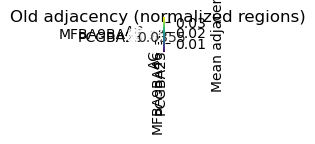

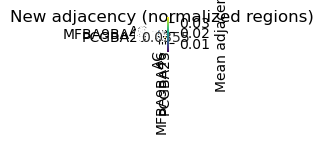

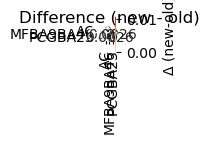

In [13]:
# --- C. Plot aligned heatmaps & differences (normalized regions) ---

import seaborn as sns, matplotlib.pyplot as plt

def plot_region_heatmap(mat, title, cmap="viridis", annotate=True, fmt=".3g", vmin=None, vmax=None):
    plt.figure(figsize=(0.6*len(mat), 0.6*len(mat)))
    ax = sns.heatmap(mat, cmap=cmap, vmin=vmin, vmax=vmax, square=True,
                     cbar_kws={"shrink":0.6,"label":"Mean adjacency"},
                     annot=annotate, fmt=fmt, linewidths=0.3, linecolor="black")
    ax.set_title(title)
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()

gmin = min(old_region_means.min().min(), new_region_means.min().min())
gmax = max(old_region_means.max().max(), new_region_means.max().max())

plot_region_heatmap(old_region_means, "Old adjacency (normalized regions)", vmin=gmin, vmax=gmax)
plot_region_heatmap(new_region_means, "New adjacency (normalized regions)", vmin=gmin, vmax=gmax)

diff_mat = new_region_means - old_region_means
plt.figure(figsize=(0.6*len(diff_mat), 0.6*len(diff_mat)))
ax = sns.heatmap(diff_mat, cmap="coolwarm", center=0.0, square=True,
                 cbar_kws={"shrink":0.6,"label":"Δ (new-old)"},
                 annot=True, fmt=".2g", linewidths=0.3, linecolor="black")
ax.set_title("Difference (new - old)")
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

Sampled 75 columns total


/tmp/ipykernel_1540297/818530668.py:30: DeprecationWarning: the `streaming` parameter was deprecated in 1.25.0; use `engine` instead.
  old_sample_df = lf_old_sample.collect(streaming=True).to_pandas()


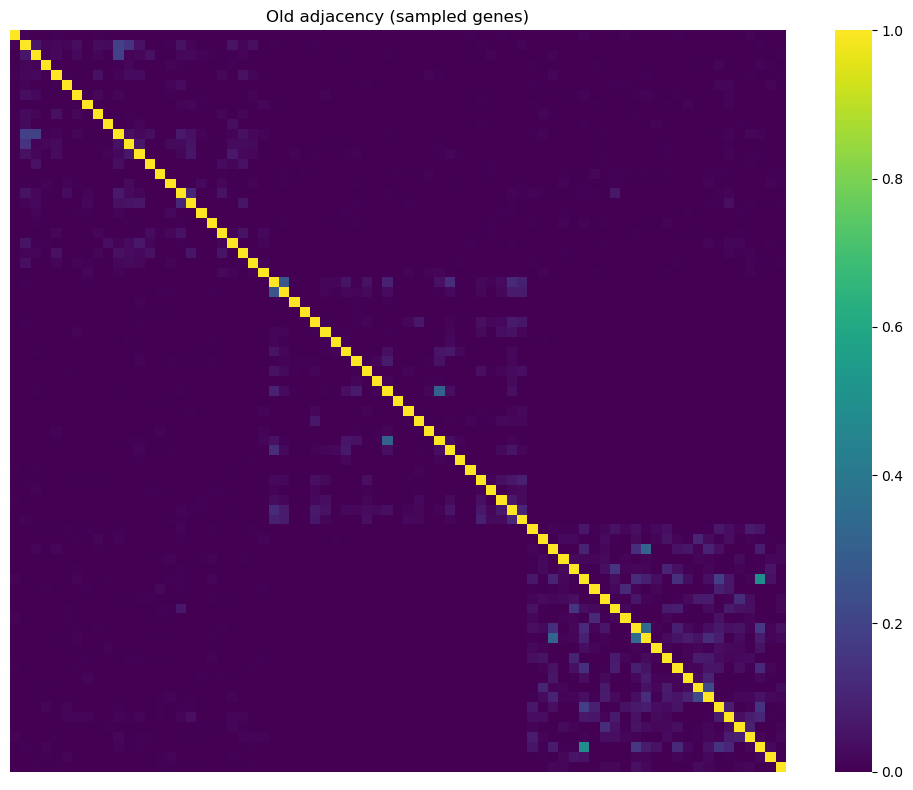

/tmp/ipykernel_1540297/818530668.py:45: DeprecationWarning: the `streaming` parameter was deprecated in 1.25.0; use `engine` instead.
  new_sample_df = lf_new_sample.collect(streaming=True).to_pandas()


ColumnNotFoundError: unable to find column "MF_BA9_BA46_ENSG00000162944.10"; valid columns: ["", "AC_ENSG00000000003.14", "AC_ENSG00000000419.12", "AC_ENSG00000000457.13", "AC_ENSG00000000460.16", "AC_ENSG00000000938.12", "AC_ENSG00000000971.15", "AC_ENSG00000001036.13", "AC_ENSG00000001084.10", "AC_ENSG00000001167.14", "AC_ENSG00000001460.17", "AC_ENSG00000001461.16", "AC_ENSG00000001497.16", "AC_ENSG00000001561.6", "AC_ENSG00000001617.11", "AC_ENSG00000001629.9", "AC_ENSG00000001630.15", "AC_ENSG00000001631.15", "AC_ENSG00000002016.17", "AC_ENSG00000002330.13", "AC_ENSG00000002549.12", "AC_ENSG00000002586.18", "AC_ENSG00000002586.18_PAR_Y", "AC_ENSG00000002587.9", "AC_ENSG00000002745.12", "AC_ENSG00000002746.14", "AC_ENSG00000002822.15", "AC_ENSG00000002834.17", "AC_ENSG00000002919.14", "AC_ENSG00000002933.7", "AC_ENSG00000003056.7", "AC_ENSG00000003096.14", "AC_ENSG00000003137.8", "AC_ENSG00000003147.17", "AC_ENSG00000003249.13", "AC_ENSG00000003393.14", "AC_ENSG00000003400.14", "AC_ENSG00000003402.19", "AC_ENSG00000003436.15", "AC_ENSG00000003509.15", "AC_ENSG00000003756.16", "AC_ENSG00000003987.13", "AC_ENSG00000003989.17", "AC_ENSG00000004059.10", "AC_ENSG00000004139.13", "AC_ENSG00000004142.11", "AC_ENSG00000004399.12", "AC_ENSG00000004455.16", "AC_ENSG00000004468.12", "AC_ENSG00000004478.7", "AC_ENSG00000004487.15", "AC_ENSG00000004534.14", "AC_ENSG00000004660.14", "AC_ENSG00000004700.15", "AC_ENSG00000004766.15", "AC_ENSG00000004776.12", "AC_ENSG00000004777.18", "AC_ENSG00000004779.9", "AC_ENSG00000004799.7", "AC_ENSG00000004838.13", "AC_ENSG00000004848.7", "AC_ENSG00000004864.13", "AC_ENSG00000004866.20", "AC_ENSG00000004897.11", "AC_ENSG00000004961.14", "AC_ENSG00000004975.11", "AC_ENSG00000005007.12", "AC_ENSG00000005020.12", "AC_ENSG00000005022.5", "AC_ENSG00000005059.15", "AC_ENSG00000005075.15", "AC_ENSG00000005100.12", "AC_ENSG00000005108.15", "AC_ENSG00000005156.11", "AC_ENSG00000005175.9", "AC_ENSG00000005189.19", "AC_ENSG00000005194.14", "AC_ENSG00000005206.16", "AC_ENSG00000005238.19", "AC_ENSG00000005243.9", "AC_ENSG00000005249.12", "AC_ENSG00000005302.17", "AC_ENSG00000005339.14", "AC_ENSG00000005379.15", "AC_ENSG00000005381.7", "AC_ENSG00000005436.13", "AC_ENSG00000005448.16", "AC_ENSG00000005469.11", "AC_ENSG00000005471.15", "AC_ENSG00000005483.20", "AC_ENSG00000005486.16", "AC_ENSG00000005513.9", "AC_ENSG00000005700.14", "AC_ENSG00000005801.16", "AC_ENSG00000005810.17", "AC_ENSG00000005812.10", "AC_ENSG00000005844.17", "AC_ENSG00000005882.11", "AC_ENSG00000005884.17", "AC_ENSG00000005889.15", "AC_ENSG00000005893.15", "AC_ENSG00000005961.17", "AC_ENSG00000005981.12", "AC_ENSG00000006007.11", "AC_ENSG00000006015.17", "AC_ENSG00000006016.10", "AC_ENSG00000006025.11", "AC_ENSG00000006042.11", "AC_ENSG00000006047.12", "AC_ENSG00000006062.14", "AC_ENSG00000006071.12", "AC_ENSG00000006116.3", "AC_ENSG00000006118.14", "AC_ENSG00000006125.17", "AC_ENSG00000006128.11", "AC_ENSG00000006194.9", "AC_ENSG00000006210.6", "AC_ENSG00000006282.20", "AC_ENSG00000006283.17", "AC_ENSG00000006327.13", "AC_ENSG00000006377.10", "AC_ENSG00000006432.15", "AC_ENSG00000006451.7", "AC_ENSG00000006453.13", "AC_ENSG00000006459.10", "AC_ENSG00000006468.13", "AC_ENSG00000006530.15", "AC_ENSG00000006534.15", "AC_ENSG00000006555.10", "AC_ENSG00000006576.16", "AC_ENSG00000006607.13", "AC_ENSG00000006611.15", "AC_ENSG00000006625.17", "AC_ENSG00000006634.7", "AC_ENSG00000006638.11", "AC_ENSG00000006652.13", "AC_ENSG00000006695.10", "AC_ENSG00000006704.10", "AC_ENSG00000006712.14", "AC_ENSG00000006715.15", "AC_ENSG00000006740.16", "AC_ENSG00000006744.18", "AC_ENSG00000006747.14", "AC_ENSG00000006756.15", "AC_ENSG00000006757.11", "AC_ENSG00000006831.9", "AC_ENSG00000006837.11", "AC_ENSG00000007001.12", "AC_ENSG00000007047.14", "AC_ENSG00000007062.11", "AC_ENSG00000007080.10", "AC_ENSG00000007168.12", "AC_ENSG00000007171.16", "AC_ENSG00000007174.17", "AC_ENSG00000007202.14", "AC_ENSG00000007237.18", "AC_ENSG00000007255.10", "AC_ENSG00000007264.14", "AC_ENSG00000007341.18", "AC_ENSG00000007372.21", "AC_ENSG00000007376.7", "AC_ENSG00000007384.15", "AC_ENSG00000007392.16", "AC_ENSG00000007402.11", "AC_ENSG00000007516.13", "AC_ENSG00000007520.3", "AC_ENSG00000007541.16", "AC_ENSG00000007545.15", "AC_ENSG00000007866.19", "AC_ENSG00000007923.15", "AC_ENSG00000007933.12", "AC_ENSG00000007944.14", "AC_ENSG00000008018.8", "AC_ENSG00000008056.13", "AC_ENSG00000008083.13", "AC_ENSG00000008086.11", "AC_ENSG00000008118.9", "AC_ENSG00000008128.22", "AC_ENSG00000008130.15", "AC_ENSG00000008226.19", "AC_ENSG00000008256.15", "AC_ENSG00000008277.14", "AC_ENSG00000008282.8", "AC_ENSG00000008283.15", "AC_ENSG00000008294.20", "AC_ENSG00000008300.16", "AC_ENSG00000008311.14", "AC_ENSG00000008324.11", "AC_ENSG00000008382.15", "AC_ENSG00000008394.12", "AC_ENSG00000008405.11", "AC_ENSG00000008441.16", "AC_ENSG00000008513.14", "AC_ENSG00000008516.16", "AC_ENSG00000008517.16", "AC_ENSG00000008710.19", "AC_ENSG00000008735.13", "AC_ENSG00000008838.19", "AC_ENSG00000008853.16", "AC_ENSG00000008869.11", "AC_ENSG00000008952.16", "AC_ENSG00000008988.9", "AC_ENSG00000009307.15", "AC_ENSG00000009335.17", "AC_ENSG00000009413.15", "AC_ENSG00000009694.13", "AC_ENSG00000009709.11", "AC_ENSG00000009780.15", "AC_ENSG00000009790.14", "AC_ENSG00000009830.11", "AC_ENSG00000009844.15", "AC_ENSG00000009950.15", "AC_ENSG00000009954.10", "AC_ENSG00000010017.12", "AC_ENSG00000010030.13", "AC_ENSG00000010072.15", "AC_ENSG00000010165.19", "AC_ENSG00000010219.13", "AC_ENSG00000010244.18", "AC_ENSG00000010256.10", "AC_ENSG00000010270.13", "AC_ENSG00000010278.12", "AC_ENSG00000010282.14", "AC_ENSG00000010292.12", "AC_ENSG00000010295.19", "AC_ENSG00000010310.8", "AC_ENSG00000010318.20", "AC_ENSG00000010319.6", "AC_ENSG00000010322.15", "AC_ENSG00000010327.10", "AC_ENSG00000010361.13", "AC_ENSG00000010379.15", "AC_ENSG00000010404.17", "AC_ENSG00000010438.16", "AC_ENSG00000010539.11", "AC_ENSG00000010610.9", "AC_ENSG00000010626.14", "AC_ENSG00000010671.15", "AC_ENSG00000010704.18", "AC_ENSG00000010803.16", "AC_ENSG00000010810.17", "AC_ENSG00000010818.9", "AC_ENSG00000011007.12", "AC_ENSG00000011009.10", "AC_ENSG00000011021.21", "AC_ENSG00000011028.13", "AC_ENSG00000011052.21", "AC_ENSG00000011083.8", "AC_ENSG00000011105.12", "AC_ENSG00000011114.14", "AC_ENSG00000011132.11", "AC_ENSG00000011143.16", "AC_ENSG00000011198.7", "AC_ENSG00000011201.11", "AC_ENSG00000011243.17", "AC_ENSG00000011258.15", "AC_ENSG00000011260.13", "AC_ENSG00000011275.18", "AC_ENSG00000011295.15", "AC_ENSG00000011304.19", "AC_ENSG00000011332.19", "AC_ENSG00000011347.9", "AC_ENSG00000011376.9", "AC_ENSG00000011405.13", "AC_ENSG00000011422.11", "AC_ENSG00000011426.10", "AC_ENSG00000011451.17", "AC_ENSG00000011454.16", "AC_ENSG00000011465.16", "AC_ENSG00000011478.11", "AC_ENSG00000011485.14", "AC_ENSG00000011523.13", "AC_ENSG00000011566.14", "AC_ENSG00000011600.11", "AC_ENSG00000011638.10", "AC_ENSG00000011677.12", "AC_ENSG00000012048.20", "AC_ENSG00000012061.15", "AC_ENSG00000012124.16", "AC_ENSG00000012171.19", "AC_ENSG00000012174.11", "AC_ENSG00000012211.12", "AC_ENSG00000012223.12", "AC_ENSG00000012232.8", "AC_ENSG00000012660.13", "AC_ENSG00000012779.10", "AC_ENSG00000012822.15", "AC_ENSG00000012963.14", "AC_ENSG00000012983.11", "AC_ENSG00000013016.15", "AC_ENSG00000013275.7", "AC_ENSG00000013288.8", "AC_ENSG00000013293.5", "AC_ENSG00000013297.10", "AC_ENSG00000013306.15", "AC_ENSG00000013364.18", "AC_ENSG00000013374.15", "AC_ENSG00000013375.15", "AC_ENSG00000013392.7", "AC_ENSG00000013441.15", "AC_ENSG00000013503.9", "AC_ENSG00000013523.9", "AC_ENSG00000013561.17", "AC_ENSG00000013563.13", "AC_ENSG00000013573.16", "AC_ENSG00000013583.8", "AC_ENSG00000013588.7", "AC_ENSG00000013619.13", "AC_ENSG00000013725.14", "AC_ENSG00000013810.18", "AC_ENSG00000014123.9", "AC_ENSG00000014138.8", "AC_ENSG00000014164.6", "AC_ENSG00000014216.15", "AC_ENSG00000014641.17", "AC_ENSG00000014824.13", "AC_ENSG00000014914.20", "AC_ENSG00000014919.12", "AC_ENSG00000015133.18", "AC_ENSG00000015153.14", "AC_ENSG00000015171.19", "AC_ENSG00000015285.10", "AC_ENSG00000015475.18", "AC_ENSG00000015479.18", "AC_ENSG00000015532.9", "AC_ENSG00000015568.12", "AC_ENSG00000015592.16", "AC_ENSG00000015676.17", "AC_ENSG00000016391.10", "AC_ENSG00000016402.13", "AC_ENSG00000016602.9", "AC_ENSG00000016864.18", "AC_ENSG00000017260.19", "AC_ENSG00000017427.15", "AC_ENSG00000017483.14", "AC_ENSG00000017797.12", "AC_ENSG00000018189.12", "AC_ENSG00000018236.14", "AC_ENSG00000018280.16", "AC_ENSG00000018408.14", "AC_ENSG00000018510.13", "AC_ENSG00000018610.13", "AC_ENSG00000018625.14", "AC_ENSG00000018699.11", "AC_ENSG00000018869.16", "AC_ENSG00000019144.18", "AC_ENSG00000019485.13", "AC_ENSG00000019505.7", "AC_ENSG00000019549.9", "AC_ENSG00000019582.14", "AC_ENSG00000019991.15", "AC_ENSG00000019995.6", "AC_ENSG00000020129.15", "AC_ENSG00000020181.17", "AC_ENSG00000020256.19", "AC_ENSG00000020426.10", "AC_ENSG00000020577.13", "AC_ENSG00000020633.18", "AC_ENSG00000020922.12", "AC_ENSG00000021300.13", "AC_ENSG00000021355.12", "AC_ENSG00000021488.12", "AC_ENSG00000021574.11", "AC_ENSG00000021645.18", "AC_ENSG00000021762.19", "AC_ENSG00000021776.10", "AC_ENSG00000021826.14", "AC_ENSG00000022267.16", "AC_ENSG00000022277.12", "AC_ENSG00000022355.16", "AC_ENSG00000022556.15", "AC_ENSG00000022567.9", "AC_ENSG00000022840.15", "AC_ENSG00000022976.15", "AC_ENSG00000023041.11", "AC_ENSG00000023171.16", "AC_ENSG00000023191.16", "AC_ENSG00000023228.13", "AC_ENSG00000023287.12", "AC_ENSG00000023318.7", "AC_ENSG00000023330.14", "AC_ENSG00000023445.13", "AC_ENSG00000023516.8", "AC_ENSG00000023572.8", "AC_ENSG00000023608.4", "AC_ENSG00000023697.12", "AC_ENSG00000023734.10", "AC_ENSG00000023892.10", "AC_ENSG00000023902.13", "AC_ENSG00000023909.9", "AC_ENSG00000024048.10", "AC_ENSG00000024422.11", "AC_ENSG00000024862.17", "AC_ENSG00000025039.14", "AC_ENSG00000025156.12", "AC_ENSG00000025293.16", "AC_ENSG00000025423.11", "AC_ENSG00000025434.18", "AC_ENSG00000025708.13", "AC_ENSG00000025770.18", "AC_ENSG00000025772.7", "AC_ENSG00000025796.13", "AC_ENSG00000025800.13", "AC_ENSG00000026025.15", "AC_ENSG00000026036.21", "AC_ENSG00000026103.21", "AC_ENSG00000026297.15", "AC_ENSG00000026508.17", "AC_ENSG00000026559.13", "AC_ENSG00000026652.13", "AC_ENSG00000026950.16", "AC_ENSG00000027001.9", "AC_ENSG00000027075.14", "AC_ENSG00000027697.13", "AC_ENSG00000027847.13", "AC_ENSG00000028116.16", "AC_ENSG00000028137.18", "AC_ENSG00000028203.17", "AC_ENSG00000028277.21", "AC_ENSG00000028310.17", "AC_ENSG00000028528.14", "AC_ENSG00000028839.9", "AC_ENSG00000029153.14", "AC_ENSG00000029363.16", "AC_ENSG00000029364.11", "AC_ENSG00000029534.19", "AC_ENSG00000029639.10", "AC_ENSG00000029725.16", "AC_ENSG00000029993.14", "AC_ENSG00000030066.13", "AC_ENSG00000030110.12", "AC_ENSG00000030419.16", "AC_ENSG00000030582.17", "AC_ENSG00000031003.10", "AC_ENSG00000031081.10", "AC_ENSG00000031691.6", "AC_ENSG00000031698.12", "AC_ENSG00000031823.14", "AC_ENSG00000032219.18", "AC_ENSG00000032389.12", "AC_ENSG00000032444.15", "AC_ENSG00000032742.17", "AC_ENSG00000033011.11", "AC_ENSG00000033030.13", "AC_ENSG00000033050.7", "AC_ENSG00000033100.16", "AC_ENSG00000033122.18", "AC_ENSG00000033170.16", "AC_ENSG00000033178.12", "AC_ENSG00000033327.12", "AC_ENSG00000033627.16", "AC_ENSG00000033800.13", "AC_ENSG00000033867.16", "AC_ENSG00000034053.14", "AC_ENSG00000034152.18", "AC_ENSG00000034239.10", "AC_ENSG00000034510.5", "AC_ENSG00000034533.11", "AC_ENSG00000034677.12", "AC_ENSG00000034693.14", "AC_ENSG00000034713.7", "AC_ENSG00000035115.21", "AC_ENSG00000035141.7", "AC_ENSG00000035403.17", "AC_ENSG00000035499.12", "AC_ENSG00000035664.11", "AC_ENSG00000035681.7", "AC_ENSG00000035687.9", "AC_ENSG00000035862.12", "AC_ENSG00000035928.15", "AC_ENSG00000036054.12", "AC_ENSG00000036257.12", "AC_ENSG00000036448.9", "AC_ENSG00000036530.8", "AC_ENSG00000036549.12", "AC_ENSG00000036672.15", "AC_ENSG00000037042.8", "AC_ENSG00000037241.7", "AC_ENSG00000037280.15", "AC_ENSG00000037474.14", "AC_ENSG00000037637.10", "AC_ENSG00000037749.11", "AC_ENSG00000037757.13", "AC_ENSG00000037897.16", "AC_ENSG00000038002.8", "AC_ENSG00000038210.12", "AC_ENSG00000038219.12", "AC_ENSG00000038274.16", "AC_ENSG00000038295.7", "AC_ENSG00000038358.14", "AC_ENSG00000038382.18", "AC_ENSG00000038427.15", "AC_ENSG00000038532.14", "AC_ENSG00000038945.14", "AC_ENSG00000039068.18", "AC_ENSG00000039123.15", "AC_ENSG00000039139.9", "AC_ENSG00000039319.16", "AC_ENSG00000039523.19", "AC_ENSG00000039560.13", "AC_ENSG00000039650.11", "AC_ENSG00000040199.18", "AC_ENSG00000040275.16", "AC_ENSG00000040341.17", "AC_ENSG00000040487.12", "AC_ENSG00000040531.14", "AC_ENSG00000040608.13", "AC_ENSG00000040633.12", "AC_ENSG00000040731.10", "AC_ENSG00000040933.15", "AC_ENSG00000041353.9", "AC_ENSG00000041357.15", "AC_ENSG00000041515.15", "AC_ENSG00000041802.10", "AC_ENSG00000041880.14", "AC_ENSG00000041982.15", "AC_ENSG00000041988.15", "AC_ENSG00000042062.11", "AC_ENSG00000042088.13", "AC_ENSG00000042286.14", "AC_ENSG00000042317.16", "AC_ENSG00000042429.11", "AC_ENSG00000042445.13", "AC_ENSG00000042493.15", "AC_ENSG00000042753.11", "AC_ENSG00000042781.12", "AC_ENSG00000042832.11", "AC_ENSG00000042980.12", "AC_ENSG00000043093.13", "AC_ENSG00000043143.20", "AC_ENSG00000043355.11", "AC_ENSG00000043462.11", "AC_ENSG00000043514.15", "AC_ENSG00000043591.5", "AC_ENSG00000044090.8", "AC_ENSG00000044115.20", "AC_ENSG00000044446.11", "AC_ENSG00000044459.14", "AC_ENSG00000044524.10", "AC_ENSG00000044574.7", "AC_ENSG00000046647.13", "AC_ENSG00000046651.14", "AC_ENSG00000046653.14", "AC_ENSG00000046889.18", "AC_ENSG00000047056.14", "AC_ENSG00000047188.15", "AC_ENSG00000047230.14", "AC_ENSG00000047249.17", "AC_ENSG00000047315.15", "AC_ENSG00000047346.12", "AC_ENSG00000047365.11", "AC_ENSG00000047410.13", "AC_ENSG00000047457.13", "AC_ENSG00000047578.12", "AC_ENSG00000047579.19", "AC_ENSG00000047597.5", "AC_ENSG00000047617.14", "AC_ENSG00000047621.11", "AC_ENSG00000047634.14", "AC_ENSG00000047644.18", "AC_ENSG00000047648.21", "AC_ENSG00000047662.4", "AC_ENSG00000047849.21", "AC_ENSG00000047932.13", "AC_ENSG00000047936.10", "AC_ENSG00000048028.11", "AC_ENSG00000048052.21", "AC_ENSG00000048140.17", "AC_ENSG00000048162.20", "AC_ENSG00000048342.15", "AC_ENSG00000048392.11", "AC_ENSG00000048405.9", "AC_ENSG00000048471.13", "AC_ENSG00000048540.14", "AC_ENSG00000048544.5", "AC_ENSG00000048545.13", "AC_ENSG00000048649.13", "AC_ENSG00000048707.13", "AC_ENSG00000048740.18", "AC_ENSG00000048828.16", "AC_ENSG00000048991.16", "AC_ENSG00000049089.13", "AC_ENSG00000049130.14", "AC_ENSG00000049167.13", "AC_ENSG00000049192.14", "AC_ENSG00000049239.12", "AC_ENSG00000049245.12", "AC_ENSG00000049246.14", "AC_ENSG00000049283.17", "AC_ENSG00000049323.15", "AC_ENSG00000049449.8", "AC_ENSG00000049540.16", "AC_ENSG00000049541.10", "AC_ENSG00000049618.22", "AC_ENSG00000049656.13", "AC_ENSG00000049759.17", "AC_ENSG00000049768.14", "AC_ENSG00000049769.12", "AC_ENSG00000049860.13", "AC_ENSG00000049883.14", "AC_ENSG00000050030.13", "AC_ENSG00000050130.17", "AC_ENSG00000050165.17", "AC_ENSG00000050327.14", "AC_ENSG00000050393.11", "AC_ENSG00000050405.13", "AC_ENSG00000050426.15", "AC_ENSG00000050438.16", "AC_ENSG00000050555.17", "AC_ENSG00000050628.20", "AC_ENSG00000050748.17", "AC_ENSG00000050767.15", "AC_ENSG00000050820.16", "AC_ENSG00000051009.10", "AC_ENSG00000051108.14", "AC_ENSG00000051128.18", "AC_ENSG00000051341.13", "AC_ENSG00000051382.8", "AC_ENSG00000051523.10", "AC_ENSG00000051596.9", "AC_ENSG00000051620.10", "AC_ENSG00000051825.14", "AC_ENSG00000052126.14", "AC_ENSG00000052723.11", "AC_ENSG00000052749.13", "AC_ENSG00000052795.12", "AC_ENSG00000052802.12", "AC_ENSG00000052841.14", "AC_ENSG00000053108.16", "AC_ENSG00000053254.15", "AC_ENSG00000053328.8", "AC_ENSG00000053371.12", "AC_ENSG00000053372.4", "AC_ENSG00000053438.8", "AC_ENSG00000053501.12", "AC_ENSG00000053524.12", "AC_ENSG00000053702.14", "AC_ENSG00000053747.15", "AC_ENSG00000053770.11", "AC_ENSG00000053900.10", "AC_ENSG00000053918.15", "AC_ENSG00000054116.11", "AC_ENSG00000054118.13", "AC_ENSG00000054148.17", "AC_ENSG00000054179.11", "AC_ENSG00000054219.10", "AC_ENSG00000054267.21", "AC_ENSG00000054277.13", "AC_ENSG00000054282.15", "AC_ENSG00000054356.13", "AC_ENSG00000054392.12", "AC_ENSG00000054523.17", "AC_ENSG00000054598.6", "AC_ENSG00000054611.13", "AC_ENSG00000054654.16", "AC_ENSG00000054690.13", "AC_ENSG00000054793.13", "AC_ENSG00000054803.3", "AC_ENSG00000054965.10", "AC_ENSG00000054967.12", "AC_ENSG00000054983.16", "AC_ENSG00000055044.10", "AC_ENSG00000055070.16", "AC_ENSG00000055118.14", "AC_ENSG00000055130.15", "AC_ENSG00000055147.18", "AC_ENSG00000055163.19", "AC_ENSG00000055208.18", "AC_ENSG00000055211.12", "AC_ENSG00000055332.16", "AC_ENSG00000055483.19", "AC_ENSG00000055609.17", "AC_ENSG00000055813.5", "AC_ENSG00000055917.15", "AC_ENSG00000055950.16", "AC_ENSG00000055955.15", "AC_ENSG00000056050.6", "AC_ENSG00000056097.15", "AC_ENSG00000056277.15", "AC_ENSG00000056487.15", "AC_ENSG00000056558.10", "AC_ENSG00000056586.15", "AC_ENSG00000056736.9", "AC_ENSG00000056972.18", "AC_ENSG00000056998.19", "AC_ENSG00000057019.15", "AC_ENSG00000057252.12", "AC_ENSG00000057294.14", "AC_ENSG00000057468.6", "AC_ENSG00000057593.13", "AC_ENSG00000057608.16", "AC_ENSG00000057657.15", "AC_ENSG00000057663.14", "AC_ENSG00000057704.12", "AC_ENSG00000057757.9", "AC_ENSG00000057935.13", "AC_ENSG00000058056.8", "AC_ENSG00000058063.15", "AC_ENSG00000058091.16", "AC_ENSG00000058262.9", "AC_ENSG00000058272.16", "AC_ENSG00000058335.15", "AC_ENSG00000058404.19", "AC_ENSG00000058453.16", "AC_ENSG00000058600.15", "AC_ENSG00000058668.14", "AC_ENSG00000058673.16", "AC_ENSG00000058729.10", "AC_ENSG00000058799.14", "AC_ENSG00000058804.11", "AC_ENSG00000058866.14", "AC_ENSG00000059122.16", "AC_ENSG00000059145.18", "AC_ENSG00000059377.16", "AC_ENSG00000059378.12", "AC_ENSG00000059573.8", "AC_ENSG00000059588.9", "AC_ENSG00000059691.11", "AC_ENSG00000059728.10", "AC_ENSG00000059758.7", "AC_ENSG00000059769.19", "AC_ENSG00000059804.15", "AC_ENSG00000059915.16", "AC_ENSG00000060069.16", "AC_ENSG00000060138.12", "AC_ENSG00000060140.8", "AC_ENSG00000060237.16", "AC_ENSG00000060339.13", "AC_ENSG00000060491.16", "AC_ENSG00000060558.3", "AC_ENSG00000060642.10", "AC_ENSG00000060656.19", "AC_ENSG00000060688.12", "AC_ENSG00000060709.14", "AC_ENSG00000060718.20", "AC_ENSG00000060749.14", "AC_ENSG00000060762.18", "AC_ENSG00000060971.17", "AC_ENSG00000060982.14", "AC_ENSG00000061273.17", "AC_ENSG00000061337.15", "AC_ENSG00000061455.10", "AC_ENSG00000061656.9", "AC_ENSG00000061676.14", "AC_ENSG00000061794.12", "AC_ENSG00000061918.12", "AC_ENSG00000061936.9", "AC_ENSG00000061938.17", "AC_ENSG00000061987.15", "AC_ENSG00000062038.13", "AC_ENSG00000062096.14", "AC_ENSG00000062194.15", "AC_ENSG00000062282.14", "AC_ENSG00000062370.16", "AC_ENSG00000062485.18", "AC_ENSG00000062524.15", "AC_ENSG00000062582.13", "AC_ENSG00000062598.17", "AC_ENSG00000062650.18", "AC_ENSG00000062716.12", "AC_ENSG00000062725.9", "AC_ENSG00000062822.12", "AC_ENSG00000063015.19", "AC_ENSG00000063046.17", "AC_ENSG00000063169.10", "AC_ENSG00000063176.15", "AC_ENSG00000063177.12", "AC_ENSG00000063180.8", "AC_ENSG00000063241.7", "AC_ENSG00000063244.12", "AC_ENSG00000063245.14", "AC_ENSG00000063322.13", "AC_ENSG00000063438.16", "AC_ENSG00000063587.13", "AC_ENSG00000063601.16", "AC_ENSG00000063660.8", "AC_ENSG00000063761.15", "AC_ENSG00000063854.12", "AC_ENSG00000063978.15", "AC_ENSG00000064012.21", "AC_ENSG00000064042.17", "AC_ENSG00000064102.14", "AC_ENSG00000064115.10", "AC_ENSG00000064199.6", "AC_ENSG00000064205.10", "AC_ENSG00000064225.12", "AC_ENSG00000064270.12", "AC_ENSG00000064300.8", "AC_ENSG00000064309.14", "AC_ENSG00000064313.11", "AC_ENSG00000064393.15", "AC_ENSG00000064419.13", "AC_ENSG00000064489.22", "AC_ENSG00000064490.13", "AC_ENSG00000064545.14", "AC_ENSG00000064547.13", "AC_ENSG00000064601.16", "AC_ENSG00000064607.16", "AC_ENSG00000064651.13", "AC_ENSG00000064652.10", "AC_ENSG00000064655.18", "AC_ENSG00000064666.14", "AC_ENSG00000064687.12", "AC_ENSG00000064692.18", "AC_ENSG00000064703.11", "AC_ENSG00000064726.9", "AC_ENSG00000064763.10", "AC_ENSG00000064787.13", "AC_ENSG00000064886.13", "AC_ENSG00000064932.15", "AC_ENSG00000064933.17", "AC_ENSG00000064961.18", "AC_ENSG00000064989.12", "AC_ENSG00000064995.16", "AC_ENSG00000064999.13", "AC_ENSG00000065000.15", "AC_ENSG00000065029.14", "AC_ENSG00000065054.13", "AC_ENSG00000065057.7", "AC_ENSG00000065060.16", "AC_ENSG00000065135.10", "AC_ENSG00000065150.18", "AC_ENSG00000065154.11", "AC_ENSG00000065183.15", "AC_ENSG00000065243.19", "AC_ENSG00000065268.10", "AC_ENSG00000065308.4", "AC_ENSG00000065320.8", "AC_ENSG00000065325.12", "AC_ENSG00000065357.19", "AC_ENSG00000065361.14", "AC_ENSG00000065413.18", "AC_ENSG00000065427.14", "AC_ENSG00000065457.10", "AC_ENSG00000065485.19", "AC_ENSG00000065491.8", "AC_ENSG00000065518.7", "AC_ENSG00000065526.10", "AC_ENSG00000065534.18", "AC_ENSG00000065548.17", "AC_ENSG00000065559.14", "AC_ENSG00000065600.12", "AC_ENSG00000065609.14", "AC_ENSG00000065613.13", "AC_ENSG00000065615.13", "AC_ENSG00000065621.14", "AC_ENSG00000065665.20", "AC_ENSG00000065675.14", "AC_ENSG00000065717.14", "AC_ENSG00000065802.11", "AC_ENSG00000065809.13", "AC_ENSG00000065833.8", "AC_ENSG00000065882.15", "AC_ENSG00000065883.14", "AC_ENSG00000065911.11", "AC_ENSG00000065923.9", "AC_ENSG00000065970.8", "AC_ENSG00000065978.18", "AC_ENSG00000065989.15", "AC_ENSG00000066027.11", "AC_ENSG00000066032.18", "AC_ENSG00000066044.14", "AC_ENSG00000066056.13", "AC_ENSG00000066084.12", "AC_ENSG00000066117.14", "AC_ENSG00000066135.12", "AC_ENSG00000066136.20", "AC_ENSG00000066185.12", "AC_ENSG00000066248.14", "AC_ENSG00000066294.14", "AC_ENSG00000066322.14", "AC_ENSG00000066336.11", "AC_ENSG00000066379.14", "AC_ENSG00000066382.16", "AC_ENSG00000066422.4", "AC_ENSG00000066427.21", "AC_ENSG00000066455.12", "AC_ENSG00000066468.22", "AC_ENSG00000066557.5", "AC_ENSG00000066583.11", "AC_ENSG00000066629.16", "AC_ENSG00000066651.18", "AC_ENSG00000066654.13", "AC_ENSG00000066697.14", "AC_ENSG00000066735.14", "AC_ENSG00000066739.11", "AC_ENSG00000066777.8", "AC_ENSG00000066827.15", "AC_ENSG00000066855.15", "AC_ENSG00000066923.17", "AC_ENSG00000066926.10", "AC_ENSG00000066933.15", "AC_ENSG00000067057.16", "AC_ENSG00000067064.10", "AC_ENSG00000067066.16", "AC_ENSG00000067082.14", "AC_ENSG00000067113.16", "AC_ENSG00000067141.16", "AC_ENSG00000067167.7", "AC_ENSG00000067177.14", "AC_ENSG00000067182.7", "AC_ENSG00000067191.15", "AC_ENSG00000067208.14", "AC_ENSG00000067221.13", "AC_ENSG00000067225.17", "AC_ENSG00000067248.9", "AC_ENSG00000067334.13", "AC_ENSG00000067365.14", "AC_ENSG00000067369.13", "AC_ENSG00000067445.20", "AC_ENSG00000067533.5", "AC_ENSG00000067560.10", "AC_ENSG00000067596.10", "AC_ENSG00000067601.7", "AC_ENSG00000067606.16", "AC_ENSG00000067704.9", "AC_ENSG00000067715.13", "AC_ENSG00000067798.14", "AC_ENSG00000067829.18", "AC_ENSG00000067836.12", "AC_ENSG00000067840.12", "AC_ENSG00000067842.17", "AC_ENSG00000067900.7", "AC_ENSG00000067955.13", "AC_ENSG00000067992.12", "AC_ENSG00000068001.13", "AC_ENSG00000068024.16", "AC_ENSG00000068028.17", "AC_ENSG00000068078.17", "AC_ENSG00000068079.7", "AC_ENSG00000068097.14", "AC_ENSG00000068120.14", "AC_ENSG00000068137.14", "AC_ENSG00000068305.17", "AC_ENSG00000068308.13", "AC_ENSG00000068323.16", "AC_ENSG00000068354.15", "AC_ENSG00000068366.19", "AC_ENSG00000068383.18", "AC_ENSG00000068394.10", "AC_ENSG00000068400.13", "AC_ENSG00000068438.14", "AC_ENSG00000068489.12", "AC_ENSG00000068615.17", "AC_ENSG00000068650.18", "AC_ENSG00000068654.15", "AC_ENSG00000068697.6", "AC_ENSG00000068724.15", "AC_ENSG00000068745.14", "AC_ENSG00000068784.12", "AC_ENSG00000068796.16", "AC_ENSG00000068831.18", "AC_ENSG00000068878.14", "AC_ENSG00000068885.14", "AC_ENSG00000068903.19", "AC_ENSG00000068912.13", "AC_ENSG00000068971.13", "AC_ENSG00000068976.13", "AC_ENSG00000069020.18", "AC_ENSG00000069122.18", "AC_ENSG00000069188.16", "AC_ENSG00000069248.11", "AC_ENSG00000069275.12", "AC_ENSG00000069329.16", "AC_ENSG00000069345.11", "AC_ENSG00000069399.14", "AC_ENSG00000069424.14", "AC_ENSG00000069431.11", "AC_ENSG00000069493.14", "AC_ENSG00000069509.5", "AC_ENSG00000069535.13", "AC_ENSG00000069667.15", "AC_ENSG00000069702.10", "AC_ENSG00000069712.12", "AC_ENSG00000069849.10", "AC_ENSG00000069869.15", "AC_ENSG00000069943.9", "AC_ENSG00000069956.11", "AC_ENSG00000069966.18", "AC_ENSG00000069974.15", "AC_ENSG00000069998.12", "AC_ENSG00000070010.18", "AC_ENSG00000070018.8", "AC_ENSG00000070047.11", "AC_ENSG00000070061.14", "AC_ENSG00000070081.15", "AC_ENSG00000070087.13", "AC_ENSG00000070159.13", "AC_ENSG00000070182.19", "AC_ENSG00000070190.12", "AC_ENSG00000070214.15", "AC_ENSG00000070269.13", "AC_ENSG00000070366.13", "AC_ENSG00000070367.15", "AC_ENSG00000070371.15", "AC_ENSG00000070388.11", "AC_ENSG00000070404.9", "AC_ENSG00000070413.19", "AC_ENSG00000070423.17", "AC_ENSG00000070444.14", "AC_ENSG00000070476.14", "AC_ENSG00000070495.14", "AC_ENSG00000070501.11", "AC_ENSG00000070526.14", "AC_ENSG00000070540.12", "AC_ENSG00000070601.9", "AC_ENSG00000070610.14", "AC_ENSG00000070614.14", "AC_ENSG00000070669.16", "AC_ENSG00000070718.11", "AC_ENSG00000070729.13", "AC_ENSG00000070731.10", "AC_ENSG00000070756.15", "AC_ENSG00000070759.16", "AC_ENSG00000070761.7", "AC_ENSG00000070770.8", "AC_ENSG00000070778.12", "AC_ENSG00000070785.16", "AC_ENSG00000070808.15", "AC_ENSG00000070814.17", "AC_ENSG00000070831.15", "AC_ENSG00000070882.12", "AC_ENSG00000070886.11", "AC_ENSG00000070950.9", "AC_ENSG00000070961.15", "AC_ENSG00000071051.13", "AC_ENSG00000071054.16", "AC_ENSG00000071073.12", "AC_ENSG00000071082.10", "AC_ENSG00000071127.16", "AC_ENSG00000071189.21", "AC_ENSG00000071205.11", "AC_ENSG00000071242.11", "AC_ENSG00000071243.15", "AC_ENSG00000071246.10", "AC_ENSG00000071282.11", "AC_ENSG00000071462.11", "AC_ENSG00000071537.13", "AC_ENSG00000071539.13", "AC_ENSG00000071553.16", "AC_ENSG00000071564.14", "AC_ENSG00000071575.11", "AC_ENSG00000071626.16", "AC_ENSG00000071655.17", "AC_ENSG00000071794.15", "AC_ENSG00000071859.14", "AC_ENSG00000071889.16", "AC_ENSG00000071894.16", "AC_ENSG00000071967.11", "AC_ENSG00000071991.8", "AC_ENSG00000071994.10", "AC_ENSG00000072041.16", "AC_ENSG00000072042.12", "AC_ENSG00000072062.13", "AC_ENSG00000072071.16", "AC_ENSG00000072110.13", "AC_ENSG00000072121.15", "AC_ENSG00000072133.10", "AC_ENSG00000072134.15", "AC_ENSG00000072135.12", "AC_ENSG00000072163.19", "AC_ENSG00000072182.12", "AC_ENSG00000072195.14", "AC_ENSG00000072201.13", "AC_ENSG00000072210.18", "AC_ENSG00000072274.12", "AC_ENSG00000072310.16", "AC_ENSG00000072315.3", "AC_ENSG00000072364.12", "AC_ENSG00000072401.14", "AC_ENSG00000072415.8", "AC_ENSG00000072422.16", "AC_ENSG00000072501.17", "AC_ENSG00000072506.12", "AC_ENSG00000072518.20", "AC_ENSG00000072609.17", "AC_ENSG00000072657.8", "AC_ENSG00000072682.18", "AC_ENSG00000072694.20", "AC_ENSG00000072736.18", "AC_ENSG00000072756.16", "AC_ENSG00000072778.19", "AC_ENSG00000072786.12", "AC_ENSG00000072803.17", "AC_ENSG00000072818.11", "AC_ENSG00000072832.14", "AC_ENSG00000072840.12", "AC_ENSG00000072849.10", "AC_ENSG00000072858.10", "AC_ENSG00000072864.14", "AC_ENSG00000072952.18", "AC_ENSG00000072954.6", "AC_ENSG00000072958.8", "AC_ENSG00000073008.14", "AC_ENSG00000073050.11", "AC_ENSG00000073060.15", "AC_ENSG00000073111.13", "AC_ENSG00000073146.15", "AC_ENSG00000073150.13", "AC_ENSG00000073169.13", "AC_ENSG00000073331.17", "AC_ENSG00000073350.13", "AC_ENSG00000073417.14", "AC_ENSG00000073464.11", "AC_ENSG00000073536.17", "AC_ENSG00000073578.16", "AC_ENSG00000073584.18", "AC_ENSG00000073605.18", "AC_ENSG00000073614.12", "AC_ENSG00000073670.13", "AC_ENSG00000073711.10", "AC_ENSG00000073712.14", "AC_ENSG00000073737.16", "AC_ENSG00000073756.11", "AC_ENSG00000073792.15", "AC_ENSG00000073803.13", "AC_ENSG00000073849.14", "AC_ENSG00000073910.20", "AC_ENSG00000073921.17", "AC_ENSG00000073969.18", "AC_ENSG00000074047.21", "AC_ENSG00000074054.17", "AC_ENSG00000074071.14", "AC_ENSG00000074181.8", "AC_ENSG00000074201.8", "AC_ENSG00000074211.13", "AC_ENSG00000074219.13", "AC_ENSG00000074266.19", "AC_ENSG00000074276.10", "AC_ENSG00000074317.10", "AC_ENSG00000074319.12", "AC_ENSG00000074356.16", "AC_ENSG00000074370.17", "AC_ENSG00000074410.13", "AC_ENSG00000074416.13", "AC_ENSG00000074527.11", "AC_ENSG00000074582.12", "AC_ENSG00000074590.13", "AC_ENSG00000074603.18", "AC_ENSG00000074621.13", "AC_ENSG00000074657.13", "AC_ENSG00000074660.15", "AC_ENSG00000074695.5", "AC_ENSG00000074696.12", "AC_ENSG00000074706.13", "AC_ENSG00000074755.14", "AC_ENSG00000074800.13", "AC_ENSG00000074803.17", "AC_ENSG00000074842.7", "AC_ENSG00000074855.10", "AC_ENSG00000074935.13", "AC_ENSG00000074964.16", "AC_ENSG00000075035.9", "AC_ENSG00000075043.18", "AC_ENSG00000075073.14", "AC_ENSG00000075089.9", "AC_ENSG00000075131.9", "AC_ENSG00000075142.13", "AC_ENSG00000075151.20", "AC_ENSG00000075188.8", "AC_ENSG00000075213.10", "AC_ENSG00000075223.13", "AC_ENSG00000075234.16", "AC_ENSG00000075239.13", "AC_ENSG00000075240.16", "AC_ENSG00000075292.18", "AC_ENSG00000075303.12", "AC_ENSG00000075336.11", "AC_ENSG00000075340.22", "AC_ENSG00000075391.16", "AC_ENSG00000075399.13", "AC_ENSG00000075407.18", "AC_ENSG00000075413.17", "AC_ENSG00000075415.12", "AC_ENSG00000075420.12", "AC_ENSG00000075426.11", "AC_ENSG00000075429.8", "AC_ENSG00000075461.5", "AC_ENSG00000075539.14", "AC_ENSG00000075568.16", "AC_ENSG00000075618.17", "AC_ENSG00000075624.13", "AC_ENSG00000075643.5", "AC_ENSG00000075651.15", "AC_ENSG00000075702.16", "AC_ENSG00000075711.20", "AC_ENSG00000075785.12", "AC_ENSG00000075790.10", "AC_ENSG00000075826.16", "AC_ENSG00000075856.11", "AC_ENSG00000075884.13", "AC_ENSG00000075914.12", "AC_ENSG00000075945.12", "AC_ENSG00000075975.15", "AC_ENSG00000076003.4", "AC_ENSG00000076043.9", "AC_ENSG00000076053.10", "AC_ENSG00000076067.12", "AC_ENSG00000076108.11", "AC_ENSG00000076201.14", "AC_ENSG00000076242.14", "AC_ENSG00000076248.10", "AC_ENSG00000076258.9", "AC_ENSG00000076321.10", "AC_ENSG00000076344.15", "AC_ENSG00000076351.12", "AC_ENSG00000076356.6", "AC_ENSG00000076382.16", "AC_ENSG00000076513.16", "AC_ENSG00000076554.15", "AC_ENSG00000076555.15", "AC_ENSG00000076604.14", "AC_ENSG00000076641.4", "AC_ENSG00000076650.6", "AC_ENSG00000076662.9", "AC_ENSG00000076685.18", "AC_ENSG00000076706.16", "AC_ENSG00000076716.8", "AC_ENSG00000076770.14", "AC_ENSG00000076826.9", "AC_ENSG00000076864.19", "AC_ENSG00000076924.11", "AC_ENSG00000076928.17", "AC_ENSG00000076944.15", "AC_ENSG00000076984.17", "AC_ENSG00000077044.10", "AC_ENSG00000077063.10", "AC_ENSG00000077080.9", "AC_ENSG00000077092.18", "AC_ENSG00000077097.15", "AC_ENSG00000077147.14", "AC_ENSG00000077150.18", "AC_ENSG00000077152.9", "AC_ENSG00000077157.21", "AC_ENSG00000077232.17", "AC_ENSG00000077235.17", "AC_ENSG00000077238.13", "AC_ENSG00000077254.14", "AC_ENSG00000077264.14", "AC_ENSG00000077279.18", "AC_ENSG00000077312.8", "AC_ENSG00000077327.15", "AC_ENSG00000077348.8", "AC_ENSG00000077380.15", "AC_ENSG00000077420.15", "AC_ENSG00000077454.15", "AC_ENSG00000077458.12", "AC_ENSG00000077463.14", "AC_ENSG00000077514.8", "AC_ENSG00000077522.12", "AC_ENSG00000077549.17", "AC_ENSG00000077585.13", "AC_ENSG00000077616.10", "AC_ENSG00000077684.15", "AC_ENSG00000077713.18", "AC_ENSG00000077721.15", "AC_ENSG00000077782.19", "AC_ENSG00000077942.18", "AC_ENSG00000077943.7", "AC_ENSG00000078018.19", "AC_ENSG00000078043.15", "AC_ENSG00000078053.16", "AC_ENSG00000078061.12", "AC_ENSG00000078070.12", "AC_ENSG00000078098.13", "AC_ENSG00000078114.18", "AC_ENSG00000078124.11", "AC_ENSG00000078140.13", "AC_ENSG00000078142.12", "AC_ENSG00000078177.13", "AC_ENSG00000078237.6", "AC_ENSG00000078246.16", "AC_ENSG00000078269.14", "AC_ENSG00000078295.16", "AC_ENSG00000078304.19", "AC_ENSG00000078319.9", "AC_ENSG00000078328.20", "AC_ENSG00000078369.17", "AC_ENSG00000078401.6", "AC_ENSG00000078403.16", "AC_ENSG00000078487.17", "AC_ENSG00000078549.14", "AC_ENSG00000078596.10", "AC_ENSG00000078618.21", "AC_ENSG00000078668.13", "AC_ENSG00000078674.17", "AC_ENSG00000078687.17", "AC_ENSG00000078699.21", "AC_ENSG00000078725.12", "AC_ENSG00000078747.14", "AC_ENSG00000078804.12", "AC_ENSG00000078808.16", "AC_ENSG00000078814.15", "AC_ENSG00000078902.15", "AC_ENSG00000078967.12", "AC_ENSG00000079101.16", "AC_ENSG00000079102.16", "AC_ENSG00000079134.11", "AC_ENSG00000079150.17", "AC_ENSG00000079156.16", "AC_ENSG00000079215.13", "AC_ENSG00000079246.15", "AC_ENSG00000079257.7", "AC_ENSG00000079263.18", "AC_ENSG00000079277.19", "AC_ENSG00000079308.16", "AC_ENSG00000079313.13", "AC_ENSG00000079332.14", "AC_ENSG00000079335.18", "AC_ENSG00000079337.15", "AC_ENSG00000079387.13", "AC_ENSG00000079432.7", "AC_ENSG00000079435.9", "AC_ENSG00000079459.12", "AC_ENSG00000079462.7", "AC_ENSG00000079482.12", "AC_ENSG00000079616.12", "AC_ENSG00000079691.17", "AC_ENSG00000079739.15", "AC_ENSG00000079785.14", "AC_ENSG00000079805.16", "AC_ENSG00000079819.18", "AC_ENSG00000079841.18", "AC_ENSG00000079931.14", "AC_ENSG00000079950.13", "AC_ENSG00000079974.17", "AC_ENSG00000079999.13", "AC_ENSG00000080031.9", "AC_ENSG00000080166.15", "AC_ENSG00000080189.14", "AC_ENSG00000080200.9", "AC_ENSG00000080224.17", "AC_ENSG00000080298.15", "AC_ENSG00000080345.17", "AC_ENSG00000080371.5", "AC_ENSG00000080493.15", "AC_ENSG00000080503.22", "AC_ENSG00000080546.13", "AC_ENSG00000080561.13", "AC_ENSG00000080573.6", "AC_ENSG00000080603.16", "AC_ENSG00000080608.9", "AC_ENSG00000080709.14", "AC_ENSG00000080802.18", "AC_ENSG00000080815.18", "AC_ENSG00000080819.6", "AC_ENSG00000080822.16", "AC_ENSG00000080823.22", "AC_ENSG00000080824.18", "AC_ENSG00000080839.11", "AC_ENSG00000080845.17", "AC_ENSG00000080854.14", "AC_ENSG00000080947.14", "AC_ENSG00000081014.10", "AC_ENSG00000081019.13", "AC_ENSG00000081026.18", "AC_ENSG00000081041.8", "AC_ENSG00000081052.11", "AC_ENSG00000081059.19", "AC_ENSG00000081087.14", "AC_ENSG00000081138.13", "AC_ENSG00000081148.11", "AC_ENSG00000081154.11", "AC_ENSG00000081177.18", "AC_ENSG00000081181.7", "AC_ENSG00000081189.15", "AC_ENSG00000081237.18", "AC_ENSG00000081248.10", "AC_ENSG00000081277.12", "AC_ENSG00000081307.12", "AC_ENSG00000081320.10", "AC_ENSG00000081377.16", "AC_ENSG00000081386.12", "AC_ENSG00000081479.12", "AC_ENSG00000081665.13", "AC_ENSG00000081692.12", "AC_ENSG00000081721.11", "AC_ENSG00000081760.16", "AC_ENSG00000081791.8", "AC_ENSG00000081803.15", "AC_ENSG00000081818.3", "AC_ENSG00000081842.17", "AC_ENSG00000081853.14", "AC_ENSG00000081870.11", "AC_ENSG00000081913.13", "AC_ENSG00000081923.11", "AC_ENSG00000081985.10", "AC_ENSG00000082014.16", "AC_ENSG00000082068.8", "AC_ENSG00000082074.15", "AC_ENSG00000082146.12", "AC_ENSG00000082153.17", "AC_ENSG00000082175.14", "AC_ENSG00000082196.20", "AC_ENSG00000082212.12", "AC_ENSG00000082213.17", "AC_ENSG00000082258.12", "AC_ENSG00000082269.16", "AC_ENSG00000082293.12", "AC_ENSG00000082397.17", "AC_ENSG00000082438.15", "AC_ENSG00000082458.11", "AC_ENSG00000082482.13", "AC_ENSG00000082497.11", "AC_ENSG00000082512.14", "AC_ENSG00000082515.17", "AC_ENSG00000082516.8", "AC_ENSG00000082556.10", "AC_ENSG00000082641.15", "AC_ENSG00000082684.14", "AC_ENSG00000082701.14", "AC_ENSG00000082781.11", "AC_ENSG00000082805.19", "AC_ENSG00000082898.16", "AC_ENSG00000082996.19", "AC_ENSG00000083067.22", "AC_ENSG00000083093.9", "AC_ENSG00000083097.14", "AC_ENSG00000083099.10", "AC_ENSG00000083123.14", "AC_ENSG00000083168.9", "AC_ENSG00000083223.17", "AC_ENSG00000083290.19", "AC_ENSG00000083312.17", "AC_ENSG00000083444.16", "AC_ENSG00000083454.21", "AC_ENSG00000083457.11", "AC_ENSG00000083520.14", "AC_ENSG00000083535.15", "AC_ENSG00000083544.13", "AC_ENSG00000083635.7", "AC_ENSG00000083642.18", "AC_ENSG00000083720.12", "AC_ENSG00000083750.12", "AC_ENSG00000083799.17", "AC_ENSG00000083807.9", "AC_ENSG00000083812.11", "AC_ENSG00000083814.13", "AC_ENSG00000083817.8", "AC_ENSG00000083828.15", "AC_ENSG00000083838.15", "AC_ENSG00000083844.10", "AC_ENSG00000083845.8", "AC_ENSG00000083857.13", "AC_ENSG00000083896.12", "AC_ENSG00000083937.8", "AC_ENSG00000084070.11", "AC_ENSG00000084072.16", "AC_ENSG00000084073.8", "AC_ENSG00000084090.13", "AC_ENSG00000084092.6", "AC_ENSG00000084093.16", "AC_ENSG00000084112.14", "AC_ENSG00000084207.15", "AC_ENSG00000084234.16", "AC_ENSG00000084444.13", "AC_ENSG00000084453.16", "AC_ENSG00000084463.7", "AC_ENSG00000084623.11", "AC_ENSG00000084628.9", "AC_ENSG00000084636.17", "AC_ENSG00000084652.15", "AC_ENSG00000084674.14", "AC_ENSG00000084676.15", "AC_ENSG00000084693.15", "AC_ENSG00000084710.13", "AC_ENSG00000084731.14", "AC_ENSG00000084733.10", "AC_ENSG00000084754.10", "AC_ENSG00000084764.10", "AC_ENSG00000084774.13", "AC_ENSG00000085063.14", "AC_ENSG00000085117.11", "AC_ENSG00000085185.15", "AC_ENSG00000085224.21", "AC_ENSG00000085231.13", "AC_ENSG00000085274.15", "AC_ENSG00000085276.17", "AC_ENSG00000085365.17", "AC_ENSG00000085377.13", "AC_ENSG00000085382.11", "AC_ENSG00000085415.15", "AC_ENSG00000085433.15", "AC_ENSG00000085449.14", "AC_ENSG00000085465.12", "AC_ENSG00000085491.15", "AC_ENSG00000085511.19", "AC_ENSG00000085514.15", "AC_ENSG00000085563.14", "AC_ENSG00000085644.13", "AC_ENSG00000085662.13", "AC_ENSG00000085719.12", "AC_ENSG00000085721.12", "AC_ENSG00000085733.15", "AC_ENSG00000085741.12", "AC_ENSG00000085760.14", "AC_ENSG00000085788.13", "AC_ENSG00000085831.15", "AC_ENSG00000085832.16", "AC_ENSG00000085871.8", "AC_ENSG00000085872.14", "AC_ENSG00000085978.21", "AC_ENSG00000085982.13", "AC_ENSG00000085998.13", "AC_ENSG00000085999.11", "AC_ENSG00000086015.20", "AC_ENSG00000086061.15", "AC_ENSG00000086062.12", "AC_ENSG00000086065.13", "AC_ENSG00000086102.18", "AC_ENSG00000086159.12", "AC_ENSG00000086189.9", "AC_ENSG00000086200.16", "AC_ENSG00000086205.16", "AC_ENSG00000086232.12", "AC_ENSG00000086289.11", "AC_ENSG00000086300.15", "AC_ENSG00000086475.14", "AC_ENSG00000086504.15", "AC_ENSG00000086506.2", "AC_ENSG00000086544.2", "AC_ENSG00000086589.11", "AC_ENSG00000086598.10", "AC_ENSG00000086619.13", "AC_ENSG00000086666.18", "AC_ENSG00000086712.12", "AC_ENSG00000086717.18", "AC_ENSG00000086730.16", "AC_ENSG00000086758.15", "AC_ENSG00000086827.8", "AC_ENSG00000086848.14", "AC_ENSG00000086991.12", "AC_ENSG00000087008.15", "AC_ENSG00000087053.18", "AC_ENSG00000087074.7", "AC_ENSG00000087076.8", "AC_ENSG00000087077.13", "AC_ENSG00000087085.13", "AC_ENSG00000087086.14", "AC_ENSG00000087087.19", "AC_ENSG00000087088.19", "AC_ENSG00000087095.12", "AC_ENSG00000087111.20", "AC_ENSG00000087116.14", "AC_ENSG00000087152.15", "AC_ENSG00000087157.18", "AC_ENSG00000087191.12", "AC_ENSG00000087206.16", "AC_ENSG00000087245.12", "AC_ENSG00000087250.8", "AC_ENSG00000087253.12", "AC_ENSG00000087258.14", "AC_ENSG00000087263.16", "AC_ENSG00000087266.15", "AC_ENSG00000087269.15", "AC_ENSG00000087274.16", "AC_ENSG00000087299.11", "AC_ENSG00000087301.8", "AC_ENSG00000087302.8", "AC_ENSG00000087303.17", "AC_ENSG00000087338.4", "AC_ENSG00000087365.15", "AC_ENSG00000087448.9", "AC_ENSG00000087460.24", "AC_ENSG00000087470.17", "AC_ENSG00000087494.15", "AC_ENSG00000087495.16", "AC_ENSG00000087502.17", "AC_ENSG00000087510.6", "AC_ENSG00000087586.17", "AC_ENSG00000087589.16", "AC_ENSG00000087842.10", "AC_ENSG00000087884.14", "AC_ENSG00000087903.12", "AC_ENSG00000087995.15", "AC_ENSG00000088035.15", "AC_ENSG00000088038.17", "AC_ENSG00000088053.11", "AC_ENSG00000088179.8", "AC_ENSG00000088205.12", "AC_ENSG00000088247.17", "AC_ENSG00000088256.8", "AC_ENSG00000088280.18", "AC_ENSG00000088298.12", "AC_ENSG00000088305.18", "AC_ENSG00000088325.15", "AC_ENSG00000088340.15", "AC_ENSG00000088356.5", "AC_ENSG00000088367.21", "AC_ENSG00000088387.18", "AC_ENSG00000088448.14", "AC_ENSG00000088451.10", "AC_ENSG00000088538.12", "AC_ENSG00000088543.14", "AC_ENSG00000088682.13", "AC_ENSG00000088727.12", "AC_ENSG00000088756.12", "AC_ENSG00000088766.11", "AC_ENSG00000088808.16", "AC_ENSG00000088812.17", "AC_ENSG00000088826.17", "AC_ENSG00000088827.12", "AC_ENSG00000088832.16", "AC_ENSG00000088833.17", "AC_ENSG00000088836.12", "AC_ENSG00000088854.12", "AC_ENSG00000088876.11", "AC_ENSG00000088881.20", "AC_ENSG00000088888.17", "AC_ENSG00000088899.14", "AC_ENSG00000088930.7", "AC_ENSG00000088970.15", "AC_ENSG00000088986.10", "AC_ENSG00000088992.17", "AC_ENSG00000089006.16", "AC_ENSG00000089009.15", "AC_ENSG00000089022.13", "AC_ENSG00000089041.16", "AC_ENSG00000089048.14", "AC_ENSG00000089050.15", "AC_ENSG00000089053.12", "AC_ENSG00000089057.14", "AC_ENSG00000089060.11", "AC_ENSG00000089063.14", "AC_ENSG00000089091.16", "AC_ENSG00000089094.18", "AC_ENSG00000089101.17", "AC_ENSG00000089123.15", "AC_ENSG00000089127.12", "AC_ENSG00000089154.10", "AC_ENSG00000089157.15", "AC_ENSG00000089159.16", "AC_ENSG00000089163.4", "AC_ENSG00000089169.14", "AC_ENSG00000089177.18", "AC_ENSG00000089195.14", "AC_ENSG00000089199.9", "AC_ENSG00000089220.4", "AC_ENSG00000089234.15", "AC_ENSG00000089248.6", "AC_ENSG00000089250.18", "AC_ENSG00000089280.18", "AC_ENSG00000089289.15", "AC_ENSG00000089327.14", "AC_ENSG00000089335.20", "AC_ENSG00000089351.14", "AC_ENSG00000089356.18", "AC_ENSG00000089472.16", "AC_ENSG00000089486.16", "AC_ENSG00000089558.8", "AC_ENSG00000089597.16", "AC_ENSG00000089639.10", "AC_ENSG00000089682.16", "AC_ENSG00000089693.10", "AC_ENSG00000089723.9", "AC_ENSG00000089737.16", "AC_ENSG00000089775.11", "AC_ENSG00000089818.17", "AC_ENSG00000089820.15", "AC_ENSG00000089847.12", "AC_ENSG00000089876.11", "AC_ENSG00000089902.9", "AC_ENSG00000089916.17", "AC_ENSG00000090006.17", "AC_ENSG00000090013.9", "AC_ENSG00000090020.10", "AC_ENSG00000090054.13", "AC_ENSG00000090060.17", "AC_ENSG00000090061.17", "AC_ENSG00000090097.21", "AC_ENSG00000090104.11", "AC_ENSG00000090238.11", "AC_ENSG00000090263.15", "AC_ENSG00000090266.12", "AC_ENSG00000090273.13", "AC_ENSG00000090316.15", "AC_ENSG00000090339.8", "AC_ENSG00000090372.14", "AC_ENSG00000090376.10", "AC_ENSG00000090382.6", "AC_ENSG00000090432.6", "AC_ENSG00000090447.11", "AC_ENSG00000090470.14", "AC_ENSG00000090487.10", "AC_ENSG00000090520.11", "AC_ENSG00000090530.9", "AC_ENSG00000090534.17", "AC_ENSG00000090539.15", "AC_ENSG00000090554.12", "AC_ENSG00000090565.15", "AC_ENSG00000090581.9", "AC_ENSG00000090612.20", "AC_ENSG00000090615.14", "AC_ENSG00000090621.13", "AC_ENSG00000090661.11", "AC_ENSG00000090674.15", "AC_ENSG00000090686.15", "AC_ENSG00000090776.5", "AC_ENSG00000090857.13", "AC_ENSG00000090861.15", "AC_ENSG00000090863.11", "AC_ENSG00000090889.11", "AC_ENSG00000090905.18", "AC_ENSG00000090924.14", "AC_ENSG00000090932.10", "AC_ENSG00000090971.4", "AC_ENSG00000090975.12", "AC_ENSG00000090989.17", "AC_ENSG00000091009.7", "AC_ENSG00000091039.16", "AC_ENSG00000091073.19", "AC_ENSG00000091106.18", "AC_ENSG00000091127.13", "AC_ENSG00000091129.19", "AC_ENSG00000091136.13", "AC_ENSG00000091137.11", "AC_ENSG00000091140.13", "AC_ENSG00000091157.13", "AC_ENSG00000091164.12", "AC_ENSG00000091262.15", "AC_ENSG00000091317.7", "AC_ENSG00000091409.14", "AC_ENSG00000091428.17", "AC_ENSG00000091436.16", "AC_ENSG00000091482.5", "AC_ENSG00000091483.6", "AC_ENSG00000091490.10", "AC_ENSG00000091513.14", "AC_ENSG00000091527.15", "AC_ENSG00000091536.16", "AC_ENSG00000091542.8", "AC_ENSG00000091592.15", "AC_ENSG00000091622.15", "AC_ENSG00000091640.7", "AC_ENSG00000091651.8", "AC_ENSG00000091656.15", "AC_ENSG00000091664.7", "AC_ENSG00000091732.15", "AC_ENSG00000091844.7", "AC_ENSG00000091879.13", "AC_ENSG00000091947.9", "AC_ENSG00000091972.18", "AC_ENSG00000091986.15", "AC_ENSG00000092010.14", "AC_ENSG00000092020.10", "AC_ENSG00000092036.18", "AC_ENSG00000092051.16", "AC_ENSG00000092054.12", "AC_ENSG00000092068.19", "AC_ENSG00000092094.10", "AC_ENSG00000092096.16", "AC_ENSG00000092098.16", "AC_ENSG00000092108.20", "AC_ENSG00000092140.14", "AC_ENSG00000092148.12", "AC_ENSG00000092199.17", "AC_ENSG00000092201.9", "AC_ENSG00000092203.13", "AC_ENSG00000092208.16", "AC_ENSG00000092295.11", "AC_ENSG00000092330.15", "AC_ENSG00000092421.16", "AC_ENSG00000092439.13", "AC_ENSG00000092445.11", "AC_ENSG00000092470.11", "AC_ENSG00000092529.23", "AC_ENSG00000092531.9", "AC_ENSG00000092607.13", "AC_ENSG00000092621.12", "AC_ENSG00000092758.15", "AC_ENSG00000092820.17", "AC_ENSG00000092841.18", "AC_ENSG00000092847.11", "AC_ENSG00000092850.11", "AC_ENSG00000092853.13", "AC_ENSG00000092871.16", "AC_ENSG00000092929.11", "AC_ENSG00000092931.11", "AC_ENSG00000092964.17", "AC_ENSG00000092969.11", "AC_ENSG00000092978.10", "AC_ENSG00000093000.18", "AC_ENSG00000093010.13", "AC_ENSG00000093072.15", "AC_ENSG00000093100.13", "AC_ENSG00000093144.18", "AC_ENSG00000093167.17", "AC_ENSG00000093183.13", "AC_ENSG00000093217.9", "AC_ENSG00000094631.18", "AC_ENSG00000094804.9", "AC_ENSG00000094841.13", "AC_ENSG00000094880.10", "AC_ENSG00000094914.12", "AC_ENSG00000094916.15", "AC_ENSG00000094963.13", "AC_ENSG00000094975.13", "AC_ENSG00000095002.13", "AC_ENSG00000095015.5", "AC_ENSG00000095059.15", "AC_ENSG00000095066.11", "AC_ENSG00000095139.13", "AC_ENSG00000095203.14", "AC_ENSG00000095209.11", "AC_ENSG00000095261.13", "AC_ENSG00000095303.14", "AC_ENSG00000095319.14", "AC_ENSG00000095321.16", "AC_ENSG00000095370.19", "AC_ENSG00000095380.10", "AC_ENSG00000095383.19", "AC_ENSG00000095397.13", "AC_ENSG00000095485.17", "AC_ENSG00000095539.15", "AC_ENSG00000095564.13", "AC_ENSG00000095574.11", "AC_ENSG00000095585.16", "AC_ENSG00000095587.8", "AC_ENSG00000095596.11", "AC_ENSG00000095627.9", "AC_ENSG00000095637.21", "AC_ENSG00000095713.13", "AC_ENSG00000095739.10", "AC_ENSG00000095752.6", "AC_ENSG00000095787.21", "AC_ENSG00000095794.19", "AC_ENSG00000095906.16", "AC_ENSG00000095932.6", "AC_ENSG00000095951.16", "AC_ENSG00000095970.16", "AC_ENSG00000096060.14", "AC_ENSG00000096063.15", "AC_ENSG00000096070.19", "AC_ENSG00000096080.11", "AC_ENSG00000096092.5", "AC_ENSG00000096093.15", "AC_ENSG00000096384.19", "AC_ENSG00000096401.7", "AC_ENSG00000096433.10", "AC_ENSG00000096654.15", "AC_ENSG00000096696.13", "AC_ENSG00000096717.11", "AC_ENSG00000096746.17", "AC_ENSG00000096872.15", "AC_ENSG00000096968.13", "AC_ENSG00000096996.15", "AC_ENSG00000097007.17", "AC_ENSG00000097021.19", "AC_ENSG00000097033.14", "AC_ENSG00000097046.12", "AC_ENSG00000097096.8", "AC_ENSG00000099139.13", "AC_ENSG00000099194.5", "AC_ENSG00000099203.6", "AC_ENSG00000099204.18", "AC_ENSG00000099219.13", "AC_ENSG00000099246.16", "AC_ENSG00000099250.17", "AC_ENSG00000099251.14", "AC_ENSG00000099256.18", "AC_ENSG00000099260.10", "AC_ENSG00000099282.9", "AC_ENSG00000099284.13", "AC_ENSG00000099290.15", "AC_ENSG00000099308.10", "AC_ENSG00000099326.8", "AC_ENSG00000099330.8", "AC_ENSG00000099331.13", "AC_ENSG00000099337.4", "AC_ENSG00000099338.22", "AC_ENSG00000099341.11", "AC_ENSG00000099364.16", "AC_ENSG00000099365.10", "AC_ENSG00000099377.13", "AC_ENSG00000099381.17", "AC_ENSG00000099385.11", "AC_ENSG00000099617.3", "AC_ENSG00000099622.13", "AC_ENSG00000099624.7", "AC_ENSG00000099625.12", "AC_ENSG00000099783.11", "AC_ENSG00000099785.10", "AC_ENSG00000099795.6", "AC_ENSG00000099797.13", "AC_ENSG00000099800.7", "AC_ENSG00000099804.8", "AC_ENSG00000099810.18", "AC_ENSG00000099814.15", "AC_ENSG00000099817.11", "AC_ENSG00000099821.13", "AC_ENSG00000099822.2", "AC_ENSG00000099840.13", "AC_ENSG00000099849.14", "AC_ENSG00000099860.8", "AC_ENSG00000099864.17", "AC_ENSG00000099866.14", "AC_ENSG00000099875.14", "AC_ENSG00000099889.13", "AC_ENSG00000099899.14", "AC_ENSG00000099901.16", "AC_ENSG00000099904.15", "AC_ENSG00000099910.16", "AC_ENSG00000099917.17", "AC_ENSG00000099940.11", "AC_ENSG00000099942.12", "AC_ENSG00000099949.18", "AC_ENSG00000099953.9", "AC_ENSG00000099954.18", "AC_ENSG00000099956.18", "AC_ENSG00000099957.16", "AC_ENSG00000099958.14", "AC_ENSG00000099960.12", "AC_ENSG00000099968.17", "AC_ENSG00000099977.13", "AC_ENSG00000099991.17", "AC_ENSG00000099992.15", "AC_ENSG00000099994.10", "AC_ENSG00000099995.18", "AC_ENSG00000099998.17", "AC_ENSG00000099999.14", "AC_ENSG00000100003.17", "AC_ENSG00000100014.19", "AC_ENSG00000100023.18", "AC_ENSG00000100024.14", "AC_ENSG00000100027.14", "AC_ENSG00000100028.11", "AC_ENSG00000100029.17", "AC_ENSG00000100030.14", "AC_ENSG00000100031.18", "AC_ENSG00000100033.16", "AC_ENSG00000100034.13", "AC_ENSG00000100036.12", "AC_ENSG00000100038.19", "AC_ENSG00000100055.20", "AC_ENSG00000100056.11", "AC_ENSG00000100058.12", "AC_ENSG00000100060.17", "AC_ENSG00000100065.14", "AC_ENSG00000100068.11", "AC_ENSG00000100075.9", "AC_ENSG00000100077.14", "AC_ENSG00000100083.18", "AC_ENSG00000100084.14", "AC_ENSG00000100092.20", "AC_ENSG00000100095.18", "AC_ENSG00000100097.11", "AC_ENSG00000100099.20", "AC_ENSG00000100100.12", "AC_ENSG00000100104.13", "AC_ENSG00000100105.17", "AC_ENSG00000100106.19", "AC_ENSG00000100109.16", "AC_ENSG00000100116.16", "AC_ENSG00000100122.5", "AC_ENSG00000100124.14", "AC_ENSG00000100129.17", "AC_ENSG00000100138.13", "AC_ENSG00000100139.13", "AC_ENSG00000100142.14", "AC_ENSG00000100146.16", "AC_ENSG00000100147.13", "AC_ENSG00000100150.16", "AC_ENSG00000100151.15", "AC_ENSG00000100154.14", "AC_ENSG00000100156.10", "AC_ENSG00000100167.19", "AC_ENSG00000100181.22", "AC_ENSG00000100196.10", "AC_ENSG00000100197.20", "AC_ENSG00000100201.20", "AC_ENSG00000100206.9", "AC_ENSG00000100207.18", "AC_ENSG00000100209.9", "AC_ENSG00000100211.10", "AC_ENSG00000100216.5", "AC_ENSG00000100218.11", "AC_ENSG00000100219.16", "AC_ENSG00000100220.11", "AC_ENSG00000100221.10", "AC_ENSG00000100225.17", "AC_ENSG00000100226.15", "AC_ENSG00000100227.17", "AC_ENSG00000100228.12", "AC_ENSG00000100234.11", "AC_ENSG00000100239.15", "AC_ENSG00000100241.20", "AC_ENSG00000100242.15", "AC_ENSG00000100243.20", "AC_ENSG00000100246.12", "AC_ENSG00000100258.17", "AC_ENSG00000100263.13", "AC_ENSG00000100266.18", "AC_ENSG00000100271.16", "AC_ENSG00000100276.9", "AC_ENSG00000100280.16", "AC_ENSG00000100281.13", "AC_ENSG00000100284.20", "AC_ENSG00000100285.9", "AC_ENSG00000100288.19", "AC_ENSG00000100292.16", "AC_ENSG00000100294.12", "AC_ENSG00000100296.13", "AC_ENSG00000100297.15", "AC_ENSG00000100299.17", "AC_ENSG00000100300.17", "AC_ENSG00000100302.6", "AC_ENSG00000100304.12", "AC_ENSG00000100307.12", "AC_ENSG00000100311.16", "AC_ENSG00000100314.3", "AC_ENSG00000100316.15", "AC_ENSG00000100319.12", "AC_ENSG00000100320.22", "AC_ENSG00000100321.14", "AC_ENSG00000100324.13", "AC_ENSG00000100325.14", "AC_ENSG00000100330.15", "AC_ENSG00000100335.13", "AC_ENSG00000100336.17", "AC_ENSG00000100341.11", "AC_ENSG00000100342.20", "AC_ENSG00000100344.10", "AC_ENSG00000100345.20", "AC_ENSG00000100346.17", "AC_ENSG00000100347.14", "AC_ENSG00000100348.9", "AC_ENSG00000100350.14", "AC_ENSG00000100353.17", "AC_ENSG00000100354.20", "AC_ENSG00000100359.20", "AC_ENSG00000100360.14", "AC_ENSG00000100362.12", "AC_ENSG00000100364.18", "AC_ENSG00000100365.14", "AC_ENSG00000100368.13", "AC_ENSG00000100372.14", "AC_ENSG00000100376.11", "AC_ENSG00000100379.17", "AC_ENSG00000100380.13", "AC_ENSG00000100387.8", "AC_ENSG00000100393.12", "AC_ENSG00000100395.14", "AC_ENSG00000100399.15", "AC_ENSG00000100401.19", "AC_ENSG00000100403.11", "AC_ENSG00000100410.7", "AC_ENSG00000100412.15", "AC_ENSG00000100413.16", "AC_ENSG00000100416.12", "AC_ENSG00000100417.11", "AC_ENSG00000100418.7", "AC_ENSG00000100422.13", "AC_ENSG00000100425.18", "AC_ENSG00000100426.6", "AC_ENSG00000100427.15", "AC_ENSG00000100429.17", "AC_ENSG00000100433.15", "AC_ENSG00000100439.10", "AC_ENSG00000100441.9", "AC_ENSG00000100442.10", "AC_ENSG00000100445.17", "AC_ENSG00000100461.17", "AC_ENSG00000100462.15", "AC_ENSG00000100473.15", "AC_ENSG00000100478.14", "AC_ENSG00000100483.13", "AC_ENSG00000100485.11", "AC_ENSG00000100490.9", "AC_ENSG00000100503.23", "AC_ENSG00000100504.16", "AC_ENSG00000100505.13", "AC_ENSG00000100519.11", "AC_ENSG00000100522.8", "AC_ENSG00000100523.14", "AC_ENSG00000100526.19", "AC_ENSG00000100528.11", "AC_ENSG00000100532.11", "AC_ENSG00000100554.11", "AC_ENSG00000100564.8", "AC_ENSG00000100567.12", "AC_ENSG00000100568.10", "AC_ENSG00000100575.13", "AC_ENSG00000100577.18", "AC_ENSG00000100578.14", "AC_ENSG00000100580.7", "AC_ENSG00000100583.4", "AC_ENSG00000100591.7", "AC_ENSG00000100592.15", "AC_ENSG00000100593.17", "AC_ENSG00000100596.6", "AC_ENSG00000100599.15", "AC_ENSG00000100600.14", "AC_ENSG00000100601.9", "AC_ENSG00000100603.13", "AC_ENSG00000100604.12", "AC_ENSG00000100605.16", "AC_ENSG00000100612.13", "AC_ENSG00000100614.17", "AC_ENSG00000100625.8", "AC_ENSG00000100626.16", "AC_ENSG00000100628.11", "AC_ENSG00000100629.16", "AC_ENSG00000100632.10", "AC_ENSG00000100644.16", "AC_ENSG00000100647.7", "AC_ENSG00000100650.15", "AC_ENSG00000100664.10", "AC_ENSG00000100678.18", "AC_ENSG00000100697.14", "AC_ENSG00000100711.13", "AC_ENSG00000100714.15", "AC_ENSG00000100722.18", "AC_ENSG00000100726.14", "AC_ENSG00000100731.15", "AC_ENSG00000100744.14", "AC_ENSG00000100749.7", "AC_ENSG00000100764.13", "AC_ENSG00000100767.15", "AC_ENSG00000100784.10", "AC_ENSG00000100796.17", "AC_ENSG00000100802.14", "AC_ENSG00000100804.18", "AC_ENSG00000100811.12", "AC_ENSG00000100813.14", "AC_ENSG00000100814.17", "AC_ENSG00000100815.12", "AC_ENSG00000100823.11", "AC_ENSG00000100836.10", "AC_ENSG00000100842.12", "AC_ENSG00000100852.12", "AC_ENSG00000100865.14", "AC_ENSG00000100883.11", "AC_ENSG00000100884.9", "AC_ENSG00000100888.12", "AC_ENSG00000100889.11", "AC_ENSG00000100890.15", "AC_ENSG00000100897.17", "AC_ENSG00000100902.10", "AC_ENSG00000100906.10", "AC_ENSG00000100908.13", "AC_ENSG00000100911.15", "AC_ENSG00000100916.13", "AC_ENSG00000100918.12", "AC_ENSG00000100926.14", "AC_ENSG00000100934.14", "AC_ENSG00000100938.17", "AC_ENSG00000100941.8", "AC_ENSG00000100949.14", "AC_ENSG00000100968.13", "AC_ENSG00000100979.14", "AC_ENSG00000100982.11", "AC_ENSG00000100983.9", "AC_ENSG00000100987.14", "AC_ENSG00000100991.11", "AC_ENSG00000100994.11", "AC_ENSG00000100997.18", "AC_ENSG00000101000.5", "AC_ENSG00000101003.9", "AC_ENSG00000101004.14", "AC_ENSG00000101017.13", "AC_ENSG00000101019.21", "AC_ENSG00000101040.19", "AC_ENSG00000101049.14", "AC_ENSG00000101052.12", "AC_ENSG00000101079.20", "AC_ENSG00000101084.17", "AC_ENSG00000101096.19", "AC_ENSG00000101098.12", "AC_ENSG00000101104.12", "AC_ENSG00000101109.11", "AC_ENSG00000101126.15", "AC_ENSG00000101132.9", "AC_ENSG00000101134.11", "AC_ENSG00000101138.11", "AC_ENSG00000101144.12", "AC_ENSG00000101146.12", "AC_ENSG00000101150.17", "AC_ENSG00000101152.10", "AC_ENSG00000101158.13", "AC_ENSG00000101160.13", "AC_ENSG00000101161.7", "AC_ENSG00000101166.15", "AC_ENSG00000101180.15", "AC_ENSG00000101181.17", "AC_ENSG00000101182.14", "AC_ENSG00000101187.15", "AC_ENSG00000101188.4", "AC_ENSG00000101189.6", "AC_ENSG00000101190.12", "AC_ENSG00000101191.16", "AC_ENSG00000101193.7", "AC_ENSG00000101194.17", "AC_ENSG00000101198.14", "AC_ENSG00000101199.12", "AC_ENSG00000101203.16", "AC_ENSG00000101204.16", "AC_ENSG00000101210.10", "AC_ENSG00000101216.10", "AC_ENSG00000101220.17", "AC_ENSG00000101222.12", "AC_ENSG00000101224.17", "AC_ENSG00000101230.5", "AC_ENSG00000101236.16", "AC_ENSG00000101246.19", "AC_ENSG00000101247.17", "AC_ENSG00000101255.10", "AC_ENSG00000101265.15", "AC_ENSG00000101266.17", "AC_ENSG00000101276.14", "AC_ENSG00000101282.8", "AC_ENSG00000101290.13", "AC_ENSG00000101294.16", "AC_ENSG00000101298.13", "AC_ENSG00000101306.10", "AC_ENSG00000101307.15", "AC_ENSG00000101310.14", "AC_ENSG00000101311.15", "AC_ENSG00000101327.8", "AC_ENSG00000101331.15", "AC_ENSG00000101333.16", "AC_ENSG00000101335.9", "AC_ENSG00000101336.13", "AC_ENSG00000101337.15", "AC_ENSG00000101343.14", "AC_ENSG00000101346.13", "AC_ENSG00000101347.8", "AC_ENSG00000101349.16", "AC_ENSG00000101350.7", "AC_ENSG00000101353.14", "AC_ENSG00000101361.16", "AC_ENSG00000101363.12", "AC_ENSG00000101365.20", "AC_ENSG00000101367.8", "AC_ENSG00000101384.11", "AC_ENSG00000101391.20", "AC_ENSG00000101400.5", "AC_ENSG00000101407.12", "AC_ENSG00000101412.12", "AC_ENSG00000101413.11", "AC_ENSG00000101417.11", "AC_ENSG00000101421.3", "AC_ENSG00000101438.3", "AC_ENSG00000101439.8", "AC_ENSG00000101442.9", "AC_ENSG00000101443.17", "AC_ENSG00000101444.12", "AC_ENSG00000101445.9", "AC_ENSG00000101447.14", "AC_ENSG00000101452.14", "AC_ENSG00000101457.12", "AC_ENSG00000101460.12", "AC_ENSG00000101463.5", "AC_ENSG00000101464.10", "AC_ENSG00000101470.9", "AC_ENSG00000101473.16", "AC_ENSG00000101474.11", "AC_ENSG00000101489.19", "AC_ENSG00000101493.10", "AC_ENSG00000101542.9", "AC_ENSG00000101544.8", "AC_ENSG00000101546.12", "AC_ENSG00000101557.14", "AC_ENSG00000101558.13", "AC_ENSG00000101574.14", "AC_ENSG00000101577.9", "AC_ENSG00000101596.14", "AC_ENSG00000101605.12", "AC_ENSG00000101608.12", "AC_ENSG00000101624.10", "AC_ENSG00000101638.13", "AC_ENSG00000101639.18", "AC_ENSG00000101654.17", "AC_ENSG00000101665.8", "AC_ENSG00000101670.11", "AC_ENSG00000101680.14", "AC_ENSG00000101695.8", "AC_ENSG00000101745.16", "AC_ENSG00000101746.15", "AC_ENSG00000101751.10", "AC_ENSG00000101752.11", "AC_ENSG00000101773.18", "AC_ENSG00000101782.14", "AC_ENSG00000101811.13", "AC_ENSG00000101825.7", "AC_ENSG00000101843.18", "AC_ENSG00000101844.17", "AC_ENSG00000101846.6", "AC_ENSG00000101849.15", "AC_ENSG00000101850.12", "AC_ENSG00000101856.9", "AC_ENSG00000101868.10", "AC_ENSG00000101871.14", "AC_ENSG00000101882.9", "AC_ENSG00000101888.11", "AC_ENSG00000101901.11", "AC_ENSG00000101911.12", "AC_ENSG00000101916.11", "AC_ENSG00000101928.12", "AC_ENSG00000101935.9", "AC_ENSG00000101938.14", "AC_ENSG00000101940.17", "AC_ENSG00000101945.16", "AC_ENSG00000101955.14", "AC_ENSG00000101958.13", "AC_ENSG00000101966.12", "AC_ENSG00000101972.18", "AC_ENSG00000101974.14", "AC_ENSG00000101977.19", "AC_ENSG00000101986.11", "AC_ENSG00000101997.12", "AC_ENSG00000102001.12", "AC_ENSG00000102003.10", "AC_ENSG00000102007.10", "AC_ENSG00000102024.17", "AC_ENSG00000102030.15", "AC_ENSG00000102032.12", "AC_ENSG00000102034.16", "AC_ENSG00000102038.15", "AC_ENSG00000102043.15", "AC_ENSG00000102053.12", "AC_ENSG00000102054.17", "AC_ENSG00000102057.9", "AC_ENSG00000102078.15", "AC_ENSG00000102081.13", "AC_ENSG00000102096.9", "AC_ENSG00000102098.17", "AC_ENSG00000102100.15", "AC_ENSG00000102103.15", "AC_ENSG00000102109.8", "AC_ENSG00000102119.10", "AC_ENSG00000102125.15", "AC_ENSG00000102144.13", "AC_ENSG00000102158.19", "AC_ENSG00000102172.15", "AC_ENSG00000102174.8", "AC_ENSG00000102178.12", "AC_ENSG00000102181.20", "AC_ENSG00000102189.16", "AC_ENSG00000102218.5", "AC_ENSG00000102221.13", "AC_ENSG00000102225.15", "AC_ENSG00000102226.9", "AC_ENSG00000102230.13", "AC_ENSG00000102241.11", "AC_ENSG00000102265.11", "AC_ENSG00000102271.13", "AC_ENSG00000102287.18", "AC_ENSG00000102290.22", "AC_ENSG00000102302.7", "AC_ENSG00000102309.12", "AC_ENSG00000102312.21", "AC_ENSG00000102316.16", "AC_ENSG00000102317.17", "AC_ENSG00000102349.17", "AC_ENSG00000102359.6", "AC_ENSG00000102362.15", "AC_ENSG00000102383.13", "AC_ENSG00000102384.13", "AC_ENSG00000102385.12", "AC_ENSG00000102390.10", "AC_ENSG00000102393.9", "AC_ENSG00000102401.19", "AC_ENSG00000102409.9", "AC_ENSG00000102445.18", "AC_ENSG00000102452.15", "AC_ENSG00000102466.15", "AC_ENSG00000102468.10", "AC_ENSG00000102471.13", "AC_ENSG00000102524.11", "AC_ENSG00000102531.16", "AC_ENSG00000102543.14", "AC_ENSG00000102547.18", "AC_ENSG00000102554.13", "AC_ENSG00000102572.14", "AC_ENSG00000102575.10", "AC_ENSG00000102580.14", "AC_ENSG00000102595.19", "AC_ENSG00000102606.17", "AC_ENSG00000102678.6", "AC_ENSG00000102699.5", "AC_ENSG00000102710.19", "AC_ENSG00000102738.7", "AC_ENSG00000102743.14", "AC_ENSG00000102753.9", "AC_ENSG00000102755.11", "AC_ENSG00000102760.12", "AC_ENSG00000102763.17", "AC_ENSG00000102780.16", "AC_ENSG00000102781.13", "AC_ENSG00000102786.14", "AC_ENSG00000102796.10", "AC_ENSG00000102804.14", "AC_ENSG00000102805.14", "AC_ENSG00000102837.6", "AC_ENSG00000102854.15", "AC_ENSG00000102858.12", "AC_ENSG00000102870.5", "AC_ENSG00000102871.15", "AC_ENSG00000102878.16", "AC_ENSG00000102879.15", "AC_ENSG00000102882.11", "AC_ENSG00000102886.14", "AC_ENSG00000102890.14", "AC_ENSG00000102893.15", "AC_ENSG00000102897.9", "AC_ENSG00000102898.11", "AC_ENSG00000102900.12", "AC_ENSG00000102901.12", "AC_ENSG00000102904.14", "AC_ENSG00000102908.20", "AC_ENSG00000102910.13", "AC_ENSG00000102921.7", "AC_ENSG00000102924.11", "AC_ENSG00000102931.7", "AC_ENSG00000102934.9", "AC_ENSG00000102935.11", "AC_ENSG00000102967.11", "AC_ENSG00000102974.14", "AC_ENSG00000102977.13", "AC_ENSG00000102978.12", "AC_ENSG00000102981.9", "AC_ENSG00000102984.14", "AC_ENSG00000102996.4", "AC_ENSG00000103005.11", "AC_ENSG00000103018.16", "AC_ENSG00000103021.9", "AC_ENSG00000103024.7", "AC_ENSG00000103034.14", "AC_ENSG00000103035.10", "AC_ENSG00000103037.11", "AC_ENSG00000103042.8", "AC_ENSG00000103043.14", "AC_ENSG00000103044.10", "AC_ENSG00000103047.7", "AC_ENSG00000103051.18", "AC_ENSG00000103056.11", "AC_ENSG00000103061.12", "AC_ENSG00000103064.13", "AC_ENSG00000103066.12", "AC_ENSG00000103089.8", "AC_ENSG00000103091.14", "AC_ENSG00000103111.14", "AC_ENSG00000103121.8", "AC_ENSG00000103126.14", "AC_ENSG00000103145.10", "AC_ENSG00000103148.15", "AC_ENSG00000103150.5", "AC_ENSG00000103152.11", "AC_ENSG00000103154.9", "AC_ENSG00000103160.11", "AC_ENSG00000103168.16", "AC_ENSG00000103174.11", "AC_ENSG00000103175.10", "AC_ENSG00000103184.11", "AC_ENSG00000103187.7", "AC_ENSG00000103194.15", "AC_ENSG00000103196.11", "AC_ENSG00000103197.16", "AC_ENSG00000103199.13", "AC_ENSG00000103202.12", "AC_ENSG00000103222.18", "AC_ENSG00000103226.17", "AC_ENSG00000103227.18", "AC_ENSG00000103241.6", "AC_ENSG00000103245.13", "AC_ENSG00000103248.18", "AC_ENSG00000103249.17", "AC_ENSG00000103253.17", "AC_ENSG00000103254.9", "AC_ENSG00000103257.8", "AC_ENSG00000103260.8", "AC_ENSG00000103264.17", "AC_ENSG00000103266.10", "AC_ENSG00000103269.13", "AC_ENSG00000103274.10", "AC_ENSG00000103275.19", "AC_ENSG00000103313.12", "AC_ENSG00000103316.10", "AC_ENSG00000103319.11", "AC_ENSG00000103326.11", "AC_ENSG00000103335.21", "AC_ENSG00000103342.12", "AC_ENSG00000103343.12", "AC_ENSG00000103351.12", "AC_ENSG00000103353.15", "AC_ENSG00000103356.15", "AC_ENSG00000103363.14", "AC_ENSG00000103365.15", "AC_ENSG00000103381.11", "AC_ENSG00000103404.14", "AC_ENSG00000103415.11", "AC_ENSG00000103423.13", "AC_ENSG00000103426.12", "AC_ENSG00000103429.10", "AC_ENSG00000103449.11", "AC_ENSG00000103460.16", "AC_ENSG00000103472.10", "AC_ENSG00000103479.15", "AC_ENSG00000103485.17", "AC_ENSG00000103489.11", "AC_ENSG00000103490.13", "AC_ENSG00000103494.12", "AC_ENSG00000103495.13", "AC_ENSG00000103496.14", "AC_ENSG00000103502.13", "AC_ENSG00000103507.13", "AC_ENSG00000103510.19", "AC_ENSG00000103512.14", "AC_ENSG00000103528.16", "AC_ENSG00000103540.16", "AC_ENSG00000103544.14", "AC_ENSG00000103549.21", "AC_ENSG00000103550.13", "AC_ENSG00000103569.9", "AC_ENSG00000103591.12", "AC_ENSG00000103599.19", "AC_ENSG00000103642.11", "AC_ENSG00000103647.12", "AC_ENSG00000103653.16", "AC_ENSG00000103657.13", "AC_ENSG00000103671.9", "AC_ENSG00000103707.9", "AC_ENSG00000103710.10", "AC_ENSG00000103723.12", "AC_ENSG00000103740.9", "AC_ENSG00000103742.11", "AC_ENSG00000103769.9", "AC_ENSG00000103811.15", "AC_ENSG00000103852.12", "AC_ENSG00000103855.17", "AC_ENSG00000103876.11", "AC_ENSG00000103888.16", "AC_ENSG00000103932.11", "AC_ENSG00000103942.12", "AC_ENSG00000103966.10", "AC_ENSG00000103978.15", "AC_ENSG00000103994.16", "AC_ENSG00000103995.13", "AC_ENSG00000104043.14", "AC_ENSG00000104044.15", "AC_ENSG00000104047.14", "AC_ENSG00000104059.4", "AC_ENSG00000104064.16", "AC_ENSG00000104067.16", "AC_ENSG00000104081.13", "AC_ENSG00000104093.13", "AC_ENSG00000104112.8", "AC_ENSG00000104129.9", "AC_ENSG00000104131.12", "AC_ENSG00000104133.14", "AC_ENSG00000104140.6", "AC_ENSG00000104142.10", "AC_ENSG00000104154.6", "AC_ENSG00000104164.10", "AC_ENSG00000104177.17", "AC_ENSG00000104205.12", "AC_ENSG00000104213.12", "AC_ENSG00000104218.14", "AC_ENSG00000104219.12", "AC_ENSG00000104221.12", "AC_ENSG00000104228.12", "AC_ENSG00000104231.10", "AC_ENSG00000104267.9", "AC_ENSG00000104290.10", "AC_ENSG00000104299.14", "AC_ENSG00000104312.7", "AC_ENSG00000104313.17", "AC_ENSG00000104320.13", "AC_ENSG00000104324.15", "AC_ENSG00000104325.6", "AC_ENSG00000104327.7", "AC_ENSG00000104331.8", "AC_ENSG00000104332.11", "AC_ENSG00000104341.16", "AC_ENSG00000104343.19", "AC_ENSG00000104356.10", "AC_ENSG00000104361.9", "AC_ENSG00000104365.13", "AC_ENSG00000104368.17", "AC_ENSG00000104369.4", "AC_ENSG00000104375.15", "AC_ENSG00000104381.12", "AC_ENSG00000104388.14", "AC_ENSG00000104408.9", "AC_ENSG00000104412.7", "AC_ENSG00000104419.14", "AC_ENSG00000104427.11", "AC_ENSG00000104435.13", "AC_ENSG00000104442.9", "AC_ENSG00000104447.12", "AC_ENSG00000104450.12", "AC_ENSG00000104472.9", "AC_ENSG00000104490.17", "AC_ENSG00000104497.13", "AC_ENSG00000104517.12", "AC_ENSG00000104518.10", "AC_ENSG00000104522.15", "AC_ENSG00000104524.13", "AC_ENSG00000104529.17", "AC_ENSG00000104549.11", "AC_ENSG00000104611.11", "AC_ENSG00000104613.11", "AC_ENSG00000104626.14", "AC_ENSG00000104635.13", "AC_ENSG00000104643.9", "AC_ENSG00000104660.17", "AC_ENSG00000104671.7", "AC_ENSG00000104679.10", "AC_ENSG00000104687.12", "AC_ENSG00000104689.9", "AC_ENSG00000104691.14", "AC_ENSG00000104695.12", "AC_ENSG00000104714.13", "AC_ENSG00000104722.13", "AC_ENSG00000104723.20", "AC_ENSG00000104728.15", "AC_ENSG00000104731.13", "AC_ENSG00000104738.16", "AC_ENSG00000104756.15", "AC_ENSG00000104760.16", "AC_ENSG00000104763.18", "AC_ENSG00000104765.15", "AC_ENSG00000104774.12", "AC_ENSG00000104783.11", "AC_ENSG00000104805.15", "AC_ENSG00000104808.7", "AC_ENSG00000104812.14", "AC_ENSG00000104814.12", "AC_ENSG00000104823.8", "AC_ENSG00000104824.16", "AC_ENSG00000104825.16", "AC_ENSG00000104833.11", "AC_ENSG00000104835.14", "AC_ENSG00000104852.14", "AC_ENSG00000104853.15", "AC_ENSG00000104856.13", "AC_ENSG00000104859.14", "AC_ENSG00000104863.11", "AC_ENSG00000104866.10", "AC_ENSG00000104870.12", "AC_ENSG00000104872.10", "AC_ENSG00000104880.17", "AC_ENSG00000104881.15", "AC_ENSG00000104883.7", "AC_ENSG00000104884.14", "AC_ENSG00000104885.17", "AC_ENSG00000104886.11", "AC_ENSG00000104888.9", "AC_ENSG00000104889.5", "AC_ENSG00000104892.16", "AC_ENSG00000104894.11", "AC_ENSG00000104897.9", "AC_ENSG00000104899.7", "AC_ENSG00000104903.4", "AC_ENSG00000104904.12", "AC_ENSG00000104907.12", "AC_ENSG00000104915.14", "AC_ENSG00000104936.17", "AC_ENSG00000104946.12", "AC_ENSG00000104957.13", "AC_ENSG00000104960.15", "AC_ENSG00000104964.14", "AC_ENSG00000104967.6", "AC_ENSG00000104969.9", "AC_ENSG00000104972.15", "AC_ENSG00000104973.16", "AC_ENSG00000104974.11", "AC_ENSG00000104976.11", "AC_ENSG00000104979.8", "AC_ENSG00000104980.7", "AC_ENSG00000104983.8", "AC_ENSG00000104998.3", "AC_ENSG00000105048.16", "AC_ENSG00000105053.10", "AC_ENSG00000105058.11", "AC_ENSG00000105063.18", "AC_ENSG00000105072.8", "AC_ENSG00000105085.10", "AC_ENSG00000105088.8", "AC_ENSG00000105122.12", "AC_ENSG00000105127.8", "AC_ENSG00000105135.15", "AC_ENSG00000105136.20", "AC_ENSG00000105137.12", "AC_ENSG00000105143.12", "AC_ENSG00000105171.9", "AC_ENSG00000105173.13", "AC_ENSG00000105176.17", "AC_ENSG00000105185.11", "AC_ENSG00000105186.15", "AC_ENSG00000105193.8", "AC_ENSG00000105197.10", "AC_ENSG00000105202.8", "AC_ENSG00000105204.13", "AC_ENSG00000105220.14", "AC_ENSG00000105221.16", "AC_ENSG00000105223.19", "AC_ENSG00000105227.14", "AC_ENSG00000105229.6", "AC_ENSG00000105245.9", "AC_ENSG00000105246.5", "AC_ENSG00000105248.15", "AC_ENSG00000105251.10", "AC_ENSG00000105254.11", "AC_ENSG00000105255.10", "AC_ENSG00000105258.8", "AC_ENSG00000105270.14", "AC_ENSG00000105278.10", "AC_ENSG00000105281.12", "AC_ENSG00000105287.12", "AC_ENSG00000105290.11", "AC_ENSG00000105298.13", "AC_ENSG00000105321.12", "AC_ENSG00000105323.16", "AC_ENSG00000105325.13", "AC_ENSG00000105327.17", "AC_ENSG00000105329.9", "AC_ENSG00000105339.10", "AC_ENSG00000105341.18", "AC_ENSG00000105355.8", "AC_ENSG00000105357.15", "AC_ENSG00000105364.13", "AC_ENSG00000105366.15", "AC_ENSG00000105372.6", "AC_ENSG00000105373.18", "AC_ENSG00000105376.4", "AC_ENSG00000105379.9", "AC_ENSG00000105383.14", "AC_ENSG00000105393.15", "AC_ENSG00000105397.13", "AC_ENSG00000105401.8", "AC_ENSG00000105402.7", "AC_ENSG00000105404.10", "AC_ENSG00000105409.16", "AC_ENSG00000105419.17", "AC_ENSG00000105426.16", "AC_ENSG00000105427.9", "AC_ENSG00000105429.12", "AC_ENSG00000105438.8", "AC_ENSG00000105443.14", "AC_ENSG00000105447.12", "AC_ENSG00000105464.3", "AC_ENSG00000105472.12", "AC_ENSG00000105479.15", "AC_ENSG00000105483.17", "AC_ENSG00000105486.13", "AC_ENSG00000105497.7", "AC_ENSG00000105499.13", "AC_ENSG00000105509.10", "AC_ENSG00000105514.7", "AC_ENSG00000105516.10", "AC_ENSG00000105518.13", "AC_ENSG00000105519.15", "AC_ENSG00000105520.10", "AC_ENSG00000105538.9", "AC_ENSG00000105552.14", "AC_ENSG00000105556.11", "AC_ENSG00000105559.11", "AC_ENSG00000105568.17", "AC_ENSG00000105576.15", "AC_ENSG00000105583.9", "AC_ENSG00000105605.7", "AC_ENSG00000105607.12", "AC_ENSG00000105609.16", "AC_ENSG00000105612.8", "AC_ENSG00000105613.9", "AC_ENSG00000105617.3", "AC_ENSG00000105618.13", "AC_ENSG00000105619.13", "AC_ENSG00000105639.18", "AC_ENSG00000105640.12", "AC_ENSG00000105642.15", "AC_ENSG00000105643.9", "AC_ENSG00000105647.16", "AC_ENSG00000105649.9", "AC_ENSG00000105650.21", "AC_ENSG00000105655.18", "AC_ENSG00000105656.12", "AC_ENSG00000105662.15", "AC_ENSG00000105669.13", "AC_ENSG00000105671.11", "AC_ENSG00000105676.13", "AC_ENSG00000105677.11", "AC_ENSG00000105695.14", "AC_ENSG00000105696.8", "AC_ENSG00000105697.7", "AC_ENSG00000105698.15", "AC_ENSG00000105699.16", "AC_ENSG00000105700.10", "AC_ENSG00000105701.15", "AC_ENSG00000105705.15", "AC_ENSG00000105707.13", "AC_ENSG00000105708.8", "AC_ENSG00000105711.11", "AC_ENSG00000105717.13", "AC_ENSG00000105722.9", "AC_ENSG00000105723.11", "AC_ENSG00000105726.16", "AC_ENSG00000105732.12", "AC_ENSG00000105737.9", "AC_ENSG00000105738.10", "AC_ENSG00000105750.14", "AC_ENSG00000105755.7", "AC_ENSG00000105767.2", "AC_ENSG00000105771.13", "AC_ENSG00000105778.18", "AC_ENSG00000105784.15", "AC_ENSG00000105792.19", "AC_ENSG00000105793.15", "AC_ENSG00000105808.17", "AC_ENSG00000105810.9", "AC_ENSG00000105819.13", "AC_ENSG00000105821.14", "AC_ENSG00000105829.11", "AC_ENSG00000105835.11", "AC_ENSG00000105849.5", "AC_ENSG00000105851.10", "AC_ENSG00000105852.10", "AC_ENSG00000105854.12", "AC_ENSG00000105855.9", "AC_ENSG00000105856.13", "AC_ENSG00000105865.10", "AC_ENSG00000105866.13", "AC_ENSG00000105875.13", "AC_ENSG00000105877.17", "AC_ENSG00000105879.11", "AC_ENSG00000105880.4", "AC_ENSG00000105887.10", "AC_ENSG00000105889.14", "AC_ENSG00000105894.11", "AC_ENSG00000105926.15", "AC_ENSG00000105928.13", "AC_ENSG00000105939.12", "AC_ENSG00000105948.13", "AC_ENSG00000105953.14", "AC_ENSG00000105963.13", "AC_ENSG00000105967.15", "AC_ENSG00000105968.18", "AC_ENSG00000105971.14", "AC_ENSG00000105974.11", "AC_ENSG00000105976.14", "AC_ENSG00000105982.16", "AC_ENSG00000105983.20", "AC_ENSG00000105989.8", "AC_ENSG00000105993.14", "AC_ENSG00000106003.12", "AC_ENSG00000106009.15", "AC_ENSG00000106012.17", "AC_ENSG00000106013.14", "AC_ENSG00000106018.13", "AC_ENSG00000106025.8", "AC_ENSG00000106028.10", "AC_ENSG00000106034.17", "AC_ENSG00000106049.8", "AC_ENSG00000106052.13", "AC_ENSG00000106066.14", "AC_ENSG00000106069.21", "AC_ENSG00000106070.17", "AC_ENSG00000106077.18", "AC_ENSG00000106078.17", "AC_ENSG00000106080.10", "AC_ENSG00000106086.18", "AC_ENSG00000106089.11", "AC_ENSG00000106100.10", "AC_ENSG00000106105.13", "AC_ENSG00000106113.18", "AC_ENSG00000106123.11", "AC_ENSG00000106125.14", "AC_ENSG00000106133.17", "AC_ENSG00000106144.19", "AC_ENSG00000106153.12", "AC_ENSG00000106211.8", "AC_ENSG00000106236.3", "AC_ENSG00000106244.12", "AC_ENSG00000106245.10", "AC_ENSG00000106246.17", "AC_ENSG00000106261.16", "AC_ENSG00000106263.17", "AC_ENSG00000106266.10", "AC_ENSG00000106268.15", "AC_ENSG00000106278.11", "AC_ENSG00000106290.14", "AC_ENSG00000106299.7", "AC_ENSG00000106305.9", "AC_ENSG00000106327.12", "AC_ENSG00000106330.11", "AC_ENSG00000106333.12", "AC_ENSG00000106344.8", "AC_ENSG00000106346.11", "AC_ENSG00000106348.16", "AC_ENSG00000106351.12", "AC_ENSG00000106355.9", "AC_ENSG00000106366.8", "AC_ENSG00000106367.13", "AC_ENSG00000106392.10", "AC_ENSG00000106397.11", "AC_ENSG00000106399.11", "AC_ENSG00000106400.11", "AC_ENSG00000106404.13", "AC_ENSG00000106415.12", "AC_ENSG00000106443.15", "AC_ENSG00000106459.14", "AC_ENSG00000106460.18", "AC_ENSG00000106462.10", "AC_ENSG00000106477.18", "AC_ENSG00000106479.10", "AC_ENSG00000106483.11", "AC_ENSG00000106484.14", "AC_ENSG00000106524.8", "AC_ENSG00000106526.10", "AC_ENSG00000106536.19", "AC_ENSG00000106537.7", "AC_ENSG00000106538.9", "AC_ENSG00000106546.12", "AC_ENSG00000106554.12", "AC_ENSG00000106560.10", "AC_ENSG00000106565.17", "AC_ENSG00000106571.12", "AC_ENSG00000106588.10", "AC_ENSG00000106591.3", "AC_ENSG00000106603.18", "AC_ENSG00000106605.10", "AC_ENSG00000106608.16", "AC_ENSG00000106609.16", "AC_ENSG00000106610.14", "AC_ENSG00000106615.9", "AC_ENSG00000106617.13", "AC_ENSG00000106624.10", "AC_ENSG00000106628.10", "AC_ENSG00000106633.15", "AC_ENSG00000106635.7", "AC_ENSG00000106636.7", "AC_ENSG00000106638.15", "AC_ENSG00000106648.13", "AC_ENSG00000106665.15", "AC_ENSG00000106682.14", "AC_ENSG00000106683.14", "AC_ENSG00000106686.16", "AC_ENSG00000106688.11", "AC_ENSG00000106689.10", "AC_ENSG00000106692.13", "AC_ENSG00000106701.11", "AC_ENSG00000106714.17", "AC_ENSG00000106723.16", "AC_ENSG00000106733.20", "AC_ENSG00000106771.12", "AC_ENSG00000106772.17", "AC_ENSG00000106780.8", "AC_ENSG00000106785.14", "AC_ENSG00000106789.12", "AC_ENSG00000106799.12", "AC_ENSG00000106803.9", "AC_ENSG00000106804.7", "AC_ENSG00000106809.10", "AC_ENSG00000106819.11", "AC_ENSG00000106823.12", "AC_ENSG00000106829.18", "AC_ENSG00000106852.15", "AC_ENSG00000106853.18", "AC_ENSG00000106868.16", "AC_ENSG00000106948.16", "AC_ENSG00000106976.20", "AC_ENSG00000106991.13", "AC_ENSG00000106992.17", "AC_ENSG00000106993.11", "AC_ENSG00000107020.9", "AC_ENSG00000107021.15", "AC_ENSG00000107036.11", "AC_ENSG00000107077.18", "AC_ENSG00000107099.15", "AC_ENSG00000107104.18", "AC_ENSG00000107105.14", "AC_ENSG00000107130.9", "AC_ENSG00000107140.15", "AC_ENSG00000107147.12", "AC_ENSG00000107164.15", "AC_ENSG00000107165.12", "AC_ENSG00000107175.11", "AC_ENSG00000107185.9", "AC_ENSG00000107186.16", "AC_ENSG00000107201.9", "AC_ENSG00000107223.12", "AC_ENSG00000107242.17", "AC_ENSG00000107249.21", "AC_ENSG00000107262.19", "AC_ENSG00000107263.18", "AC_ENSG00000107281.9", "AC_ENSG00000107282.7", "AC_ENSG00000107290.13", "AC_ENSG00000107295.9", "AC_ENSG00000107317.12", "AC_ENSG00000107331.16", "AC_ENSG00000107338.9", "AC_ENSG00000107341.4", "AC_ENSG00000107362.13", "AC_ENSG00000107371.12", "AC_ENSG00000107372.12", "AC_ENSG00000107404.19", "AC_ENSG00000107438.8", "AC_ENSG00000107443.15", "AC_ENSG00000107518.16", "AC_ENSG00000107521.18", "AC_ENSG00000107537.13", "AC_ENSG00000107551.20", "AC_ENSG00000107554.16", "AC_ENSG00000107560.10", "AC_ENSG00000107562.16", "AC_ENSG00000107566.13", "AC_ENSG00000107581.12", "AC_ENSG00000107593.16", "AC_ENSG00000107611.14", "AC_ENSG00000107614.21", "AC_ENSG00000107625.12", "AC_ENSG00000107643.15", "AC_ENSG00000107651.12", "AC_ENSG00000107669.17", "AC_ENSG00000107672.14", "AC_ENSG00000107679.14", "AC_ENSG00000107719.8", "AC_ENSG00000107731.12", "AC_ENSG00000107736.19", "AC_ENSG00000107738.19", "AC_ENSG00000107742.12", "AC_ENSG00000107745.18", "AC_ENSG00000107758.15", "AC_ENSG00000107771.15", "AC_ENSG00000107779.13", "AC_ENSG00000107789.15", "AC_ENSG00000107796.13", "AC_ENSG00000107798.17", "AC_ENSG00000107815.7", "AC_ENSG00000107816.17", "AC_ENSG00000107819.13", "AC_ENSG00000107821.14", "AC_ENSG00000107829.13", "AC_ENSG00000107833.10", "AC_ENSG00000107854.5", "AC_ENSG00000107862.4", "AC_ENSG00000107863.17", "AC_ENSG00000107864.14", "AC_ENSG00000107872.12", "AC_ENSG00000107874.10", "AC_ENSG00000107882.11", "AC_ENSG00000107890.16", "AC_ENSG00000107897.18", "AC_ENSG00000107902.13", "AC_ENSG00000107929.14", "AC_ENSG00000107937.18", "AC_ENSG00000107938.17", "AC_ENSG00000107949.16", "AC_ENSG00000107951.14", "AC_ENSG00000107954.10", "AC_ENSG00000107957.16", "AC_ENSG00000107959.15", "AC_ENSG00000107960.10", "AC_ENSG00000107968.9", "AC_ENSG00000107984.9", "AC_ENSG00000108010.11", "AC_ENSG00000108018.15", "AC_ENSG00000108021.19", "AC_ENSG00000108039.17", "AC_ENSG00000108055.9", "AC_ENSG00000108061.11", "AC_ENSG00000108064.10", "AC_ENSG00000108091.10", "AC_ENSG00000108094.14", "AC_ENSG00000108100.17", "AC_ENSG00000108106.13", "AC_ENSG00000108107.14", "AC_ENSG00000108175.16", "AC_ENSG00000108176.14", "AC_ENSG00000108179.13", "AC_ENSG00000108187.15", "AC_ENSG00000108219.14", "AC_ENSG00000108231.12", "AC_ENSG00000108239.8", "AC_ENSG00000108256.8", "AC_ENSG00000108262.15", "AC_ENSG00000108298.9", "AC_ENSG00000108306.11", "AC_ENSG00000108309.13", "AC_ENSG00000108312.14", "AC_ENSG00000108344.14", "AC_ENSG00000108349.16", "AC_ENSG00000108352.11", "AC_ENSG00000108370.16", "AC_ENSG00000108375.12", "AC_ENSG00000108379.9", "AC_ENSG00000108381.10", "AC_ENSG00000108384.14", "AC_ENSG00000108387.14", "AC_ENSG00000108389.9", "AC_ENSG00000108395.13", "AC_ENSG00000108406.9", "AC_ENSG00000108423.14", "AC_ENSG00000108424.9", "AC_ENSG00000108433.16", "AC_ENSG00000108439.10", "AC_ENSG00000108443.13", "AC_ENSG00000108448.21", "AC_ENSG00000108465.14", "AC_ENSG00000108468.14", "AC_ENSG00000108469.14", "AC_ENSG00000108474.16", "AC_ENSG00000108479.11", "AC_ENSG00000108506.11", "AC_ENSG00000108509.20", "AC_ENSG00000108510.9", "AC_ENSG00000108515.17", "AC_ENSG00000108518.7", "AC_ENSG00000108523.15", "AC_ENSG00000108528.13", "AC_ENSG00000108551.4", "AC_ENSG00000108557.18", "AC_ENSG00000108559.11", "AC_ENSG00000108561.8", "AC_ENSG00000108578.14", "AC_ENSG00000108582.11", "AC_ENSG00000108587.15", "AC_ENSG00000108588.13", "AC_ENSG00000108590.10", "AC_ENSG00000108591.9", "AC_ENSG00000108592.16", "AC_ENSG00000108599.14", "AC_ENSG00000108604.15", "AC_ENSG00000108622.10", "AC_ENSG00000108639.7", "AC_ENSG00000108641.14", "AC_ENSG00000108651.9", "AC_ENSG00000108654.13", "AC_ENSG00000108666.9", "AC_ENSG00000108669.16", "AC_ENSG00000108671.9", "AC_ENSG00000108679.12", "AC_ENSG00000108684.14", "AC_ENSG00000108691.9", "AC_ENSG00000108733.9", "AC_ENSG00000108771.12", "AC_ENSG00000108773.10", "AC_ENSG00000108774.14", "AC_ENSG00000108784.9", "AC_ENSG00000108786.10", "AC_ENSG00000108788.11", "AC_ENSG00000108797.11", "AC_ENSG00000108798.8", "AC_ENSG00000108799.12", "AC_ENSG00000108819.10", "AC_ENSG00000108821.13", "AC_ENSG00000108825.17", "AC_ENSG00000108826.15", "AC_ENSG00000108828.15", "AC_ENSG00000108829.9", "AC_ENSG00000108830.9", "AC_ENSG00000108840.15", "AC_ENSG00000108846.15", "AC_ENSG00000108848.15", "AC_ENSG00000108852.14", "AC_ENSG00000108854.15", "AC_ENSG00000108861.8", "AC_ENSG00000108883.12", "AC_ENSG00000108924.13", "AC_ENSG00000108932.11", "AC_ENSG00000108946.14", "AC_ENSG00000108947.4", "AC_ENSG00000108950.11", "AC_ENSG00000108953.16", "AC_ENSG00000108960.7", "AC_ENSG00000108961.13", "AC_ENSG00000108963.17", "AC_ENSG00000108984.13", "AC_ENSG00000109016.17", "AC_ENSG00000109046.14", "AC_ENSG00000109047.7", "AC_ENSG00000109062.11", "AC_ENSG00000109063.14", "AC_ENSG00000109065.11", "AC_ENSG00000109066.13", "AC_ENSG00000109072.13", "AC_ENSG00000109079.9", "AC_ENSG00000109083.13", "AC_ENSG00000109084.13", "AC_ENSG00000109089.7", "AC_ENSG00000109099.13", "AC_ENSG00000109103.11", "AC_ENSG00000109107.13", "AC_ENSG00000109111.14", "AC_ENSG00000109113.19", "AC_ENSG00000109118.13", "AC_ENSG00000109133.12", "AC_ENSG00000109158.10", "AC_ENSG00000109171.14", "AC_ENSG00000109180.14", "AC_ENSG00000109184.14", "AC_ENSG00000109189.12", "AC_ENSG00000109220.10", "AC_ENSG00000109265.13", "AC_ENSG00000109270.12", "AC_ENSG00000109320.11", "AC_ENSG00000109323.8", "AC_ENSG00000109332.19", "AC_ENSG00000109339.20", "AC_ENSG00000109381.19", "AC_ENSG00000109390.11", "AC_ENSG00000109436.7", "AC_ENSG00000109445.10", "AC_ENSG00000109452.12", "AC_ENSG00000109458.8", "AC_ENSG00000109466.13", "AC_ENSG00000109472.13", "AC_ENSG00000109475.16", "AC_ENSG00000109501.13", "AC_ENSG00000109519.12", "AC_ENSG00000109534.16", "AC_ENSG00000109536.11", "AC_ENSG00000109572.13", "AC_ENSG00000109576.13", "AC_ENSG00000109586.11", "AC_ENSG00000109606.12", "AC_ENSG00000109610.5", "AC_ENSG00000109618.11", "AC_ENSG00000109654.14", "AC_ENSG00000109667.11", "AC_ENSG00000109670.13", "AC_ENSG00000109680.10", "AC_ENSG00000109685.17", "AC_ENSG00000109686.17", "AC_ENSG00000109689.15", "AC_ENSG00000109736.14", "AC_ENSG00000109738.10", "AC_ENSG00000109743.10", "AC_ENSG00000109756.8", "AC_ENSG00000109758.8", "AC_ENSG00000109762.15", "AC_ENSG00000109771.15", "AC_ENSG00000109775.10", "AC_ENSG00000109787.12", "AC_ENSG00000109790.16", "AC_ENSG00000109794.13", "AC_ENSG00000109814.11", "AC_ENSG00000109819.8", "AC_ENSG00000109832.13", "AC_ENSG00000109846.7", "AC_ENSG00000109854.13", "AC_ENSG00000109861.15", "AC_ENSG00000109881.16", "AC_ENSG00000109906.13", "AC_ENSG00000109911.18", "AC_ENSG00000109917.10", "AC_ENSG00000109919.9", "AC_ENSG00000109920.12", "AC_ENSG00000109927.9", "AC_ENSG00000109929.9", "AC_ENSG00000109944.10", "AC_ENSG00000109956.12", "AC_ENSG00000109971.13", "AC_ENSG00000110002.15", "AC_ENSG00000110011.13", "AC_ENSG00000110013.12", "AC_ENSG00000110025.12", "AC_ENSG00000110031.12", "AC_ENSG00000110042.7", "AC_ENSG00000110046.12", "AC_ENSG00000110047.17", "AC_ENSG00000110048.11", "AC_ENSG00000110057.7", "AC_ENSG00000110060.8", "AC_ENSG00000110063.8", "AC_ENSG00000110066.14", "AC_ENSG00000110074.10", "AC_ENSG00000110075.14", "AC_ENSG00000110076.18", "AC_ENSG00000110077.14", "AC_ENSG00000110079.16", "AC_ENSG00000110080.18", "AC_ENSG00000110090.12", "AC_ENSG00000110092.3", "AC_ENSG00000110104.11", "AC_ENSG00000110107.8", "AC_ENSG00000110108.9", "AC_ENSG00000110148.9", "AC_ENSG00000110171.19", "AC_ENSG00000110172.11", "AC_ENSG00000110200.8", "AC_ENSG00000110218.8", "AC_ENSG00000110237.3", "AC_ENSG00000110274.15", "AC_ENSG00000110315.6", "AC_ENSG00000110318.13", "AC_ENSG00000110321.16", "AC_ENSG00000110324.10", "AC_ENSG00000110328.5", "AC_ENSG00000110330.8", "AC_ENSG00000110344.9", "AC_ENSG00000110367.11", "AC_ENSG00000110395.6", "AC_ENSG00000110400.10", "AC_ENSG00000110422.11", "AC_ENSG00000110427.14", "AC_ENSG00000110429.13", "AC_ENSG00000110435.11", "AC_ENSG00000110436.11", "AC_ENSG00000110442.11", "AC_ENSG00000110446.10", "AC_ENSG00000110455.13", "AC_ENSG00000110492.15", "AC_ENSG00000110497.14", "AC_ENSG00000110514.19", "AC_ENSG00000110536.13", "AC_ENSG00000110583.12", "AC_ENSG00000110619.17", "AC_ENSG00000110628.13", "AC_ENSG00000110651.11", "AC_ENSG00000110660.14", "AC_ENSG00000110675.12", "AC_ENSG00000110693.17", "AC_ENSG00000110696.9", "AC_ENSG00000110697.12", "AC_ENSG00000110700.6", "AC_ENSG00000110711.9", "AC_ENSG00000110713.15", "AC_ENSG00000110717.12", "AC_ENSG00000110719.9", "AC_ENSG00000110721.11", "AC_ENSG00000110723.11", "AC_ENSG00000110756.17", "AC_ENSG00000110768.11", "AC_ENSG00000110786.17", "AC_ENSG00000110799.13", "AC_ENSG00000110801.13", "AC_ENSG00000110811.19", "AC_ENSG00000110841.13", "AC_ENSG00000110844.13", "AC_ENSG00000110851.11", "AC_ENSG00000110852.4", "AC_ENSG00000110871.14", "AC_ENSG00000110876.9", "AC_ENSG00000110880.10", "AC_ENSG00000110881.11", "AC_ENSG00000110888.17", "AC_ENSG00000110900.14", "AC_ENSG00000110906.12", "AC_ENSG00000110911.14", "AC_ENSG00000110917.7", "AC_ENSG00000110921.13", "AC_ENSG00000110925.6", "AC_ENSG00000110931.18", "AC_ENSG00000110934.10", "AC_ENSG00000110955.8", "AC_ENSG00000110958.15", "AC_ENSG00000110975.8", "AC_ENSG00000110987.8", "AC_ENSG00000111011.17", "AC_ENSG00000111052.7", "AC_ENSG00000111057.10", "AC_ENSG00000111058.7", "AC_ENSG00000111077.17", "AC_ENSG00000111087.9", "AC_ENSG00000111110.11", "AC_ENSG00000111142.13", "AC_ENSG00000111144.9", "AC_ENSG00000111145.7", "AC_ENSG00000111181.12", "AC_ENSG00000111186.12", "AC_ENSG00000111196.9", "AC_ENSG00000111203.11", "AC_ENSG00000111206.12", "AC_ENSG00000111215.11", "AC_ENSG00000111218.11", "AC_ENSG00000111224.13", "AC_ENSG00000111229.15", "AC_ENSG00000111231.8", "AC_ENSG00000111237.18", "AC_ENSG00000111247.14", "AC_ENSG00000111249.13", "AC_ENSG00000111252.10", "AC_ENSG00000111254.7", "AC_ENSG00000111261.13", "AC_ENSG00000111262.5", "AC_ENSG00000111266.8", "AC_ENSG00000111269.2", "AC_ENSG00000111271.14", "AC_ENSG00000111275.12", "AC_ENSG00000111276.10", "AC_ENSG00000111300.9", "AC_ENSG00000111321.10", "AC_ENSG00000111325.16", "AC_ENSG00000111328.6", "AC_ENSG00000111331.12", "AC_ENSG00000111335.12", "AC_ENSG00000111341.9", "AC_ENSG00000111344.11", "AC_ENSG00000111348.8", "AC_ENSG00000111358.13", "AC_ENSG00000111361.12", "AC_ENSG00000111364.15", "AC_ENSG00000111371.15", "AC_ENSG00000111404.6", "AC_ENSG00000111405.8", "AC_ENSG00000111412.5", "AC_ENSG00000111432.4", "AC_ENSG00000111445.13", "AC_ENSG00000111450.13", "AC_ENSG00000111452.12", "AC_ENSG00000111481.9", "AC_ENSG00000111490.12", "AC_ENSG00000111530.12", "AC_ENSG00000111540.15", "AC_ENSG00000111554.14", "AC_ENSG00000111581.9", "AC_ENSG00000111596.11", "AC_ENSG00000111602.11", "AC_ENSG00000111605.16", "AC_ENSG00000111615.13", "AC_ENSG00000111639.7", "AC_ENSG00000111640.14", "AC_ENSG00000111641.11", "AC_ENSG00000111642.14", "AC_ENSG00000111647.12", "AC_ENSG00000111652.9", "AC_ENSG00000111653.19", "AC_ENSG00000111664.10", "AC_ENSG00000111665.11", "AC_ENSG00000111666.10", "AC_ENSG00000111667.13", "AC_ENSG00000111669.14", "AC_ENSG00000111670.14", "AC_ENSG00000111671.9", "AC_ENSG00000111674.8", "AC_ENSG00000111676.14", "AC_ENSG00000111678.10", "AC_ENSG00000111679.16", "AC_ENSG00000111684.10", "AC_ENSG00000111696.11", "AC_ENSG00000111707.11", "AC_ENSG00000111711.9", "AC_ENSG00000111716.12", "AC_ENSG00000111725.10", "AC_ENSG00000111726.12", "AC_ENSG00000111727.11", "AC_ENSG00000111728.10", "AC_ENSG00000111731.12", "AC_ENSG00000111737.11", "AC_ENSG00000111752.10", "AC_ENSG00000111775.2", "AC_ENSG00000111783.12", "AC_ENSG00000111785.19", "AC_ENSG00000111786.8", "AC_ENSG00000111788.10", "AC_ENSG00000111790.13", "AC_ENSG00000111799.20", "AC_ENSG00000111801.15", "AC_ENSG00000111802.13", "AC_ENSG00000111816.7", "AC_ENSG00000111817.16", "AC_ENSG00000111832.12", "AC_ENSG00000111834.12", "AC_ENSG00000111843.13", "AC_ENSG00000111845.4", "AC_ENSG00000111846.16", "AC_ENSG00000111850.10", "AC_ENSG00000111859.16", "AC_ENSG00000111860.13", "AC_ENSG00000111863.12", "AC_ENSG00000111875.7", "AC_ENSG00000111877.17", "AC_ENSG00000111879.18", "AC_ENSG00000111880.15", "AC_ENSG00000111885.6", "AC_ENSG00000111897.6", "AC_ENSG00000111906.17", "AC_ENSG00000111907.20", "AC_ENSG00000111911.6", "AC_ENSG00000111912.19", "AC_ENSG00000111913.17", "AC_ENSG00000111961.17", "AC_ENSG00000111962.7", "AC_ENSG00000112029.9", "AC_ENSG00000112031.15", "AC_ENSG00000112033.13", "AC_ENSG00000112038.17", "AC_ENSG00000112039.3", "AC_ENSG00000112053.13", "AC_ENSG00000112062.10", "AC_ENSG00000112078.13", "AC_ENSG00000112079.8", "AC_ENSG00000112081.16", "AC_ENSG00000112096.16", "AC_ENSG00000112110.9", "AC_ENSG00000112118.18", "AC_ENSG00000112130.16", "AC_ENSG00000112137.17", "AC_ENSG00000112139.14", "AC_ENSG00000112144.15", "AC_ENSG00000112146.16", "AC_ENSG00000112149.9", "AC_ENSG00000112159.11", "AC_ENSG00000112167.9", "AC_ENSG00000112182.14", "AC_ENSG00000112183.14", "AC_ENSG00000112186.11", "AC_ENSG00000112200.16", "AC_ENSG00000112208.11", "AC_ENSG00000112210.11", "AC_ENSG00000112214.10", "AC_ENSG00000112218.8", "AC_ENSG00000112232.8", "AC_ENSG00000112234.8", "AC_ENSG00000112237.12", "AC_ENSG00000112242.14", "AC_ENSG00000112245.10", "AC_ENSG00000112249.13", "AC_ENSG00000112276.13", "AC_ENSG00000112280.15", "AC_ENSG00000112282.17", "AC_ENSG00000112290.12", "AC_ENSG00000112293.14", "AC_ENSG00000112294.12", "AC_ENSG00000112297.14", "AC_ENSG00000112303.13", "AC_ENSG00000112304.10", "AC_ENSG00000112305.14", "AC_ENSG00000112306.7", "AC_ENSG00000112308.12", "AC_ENSG00000112309.10", "AC_ENSG00000112312.9", "AC_ENSG00000112319.17", "AC_ENSG00000112320.11", "AC_ENSG00000112333.11", "AC_ENSG00000112335.14", "AC_ENSG00000112339.14", "AC_ENSG00000112343.10", "AC_ENSG00000112357.12", "AC_ENSG00000112365.4", "AC_ENSG00000112367.10", "AC_ENSG00000112378.11", "AC_ENSG00000112379.8", "AC_ENSG00000112394.16", "AC_ENSG00000112406.4", "AC_ENSG00000112414.14", "AC_ENSG00000112419.14", "AC_ENSG00000112425.14", "AC_ENSG00000112473.17", "AC_ENSG00000112511.17", "AC_ENSG00000112514.15", "AC_ENSG00000112530.11", "AC_ENSG00000112531.16", "AC_ENSG00000112539.14", "AC_ENSG00000112541.13", "AC_ENSG00000112559.13", "AC_ENSG00000112561.17", "AC_ENSG00000112562.18", "AC_ENSG00000112576.12", "AC_ENSG00000112578.9", "AC_ENSG00000112584.13", "AC_ENSG00000112592.13", "AC_ENSG00000112599.8", "AC_ENSG00000112619.7", "AC_ENSG00000112624.12", "AC_ENSG00000112640.14", "AC_ENSG00000112651.11", "AC_ENSG00000112655.15", "AC_ENSG00000112658.7", "AC_ENSG00000112659.13", "AC_ENSG00000112667.12", "AC_ENSG00000112679.14", "AC_ENSG00000112685.13", "AC_ENSG00000112695.11", "AC_ENSG00000112697.15", "AC_ENSG00000112699.10", "AC_ENSG00000112701.17", "AC_ENSG00000112706.11", "AC_ENSG00000112715.21", "AC_ENSG00000112739.16", "AC_ENSG00000112759.16", "AC_ENSG00000112763.15", "AC_ENSG00000112769.18", "AC_ENSG00000112773.15", "AC_ENSG00000112782.15", "AC_ENSG00000112787.12", "AC_ENSG00000112796.9", "AC_ENSG00000112799.8", "AC_ENSG00000112812.15", "AC_ENSG00000112837.16", "AC_ENSG00000112851.14", "AC_ENSG00000112852.6", "AC_ENSG00000112855.14", "AC_ENSG00000112874.9", "AC_ENSG00000112877.7", "AC_ENSG00000112893.9", "AC_ENSG00000112902.11", "AC_ENSG00000112936.18", "AC_ENSG00000112941.13", "AC_ENSG00000112964.13", "AC_ENSG00000112972.14", "AC_ENSG00000112977.15", "AC_ENSG00000112981.4", "AC_ENSG00000112983.17", "AC_ENSG00000112992.16", "AC_ENSG00000112996.10", "AC_ENSG00000113013.12", "AC_ENSG00000113048.16", "AC_ENSG00000113068.9", "AC_ENSG00000113070.7", "AC_ENSG00000113083.13", "AC_ENSG00000113100.9", "AC_ENSG00000113108.19", "AC_ENSG00000113119.12", "AC_ENSG00000113140.10", "AC_ENSG00000113141.17", "AC_ENSG00000113161.15", "AC_ENSG00000113163.15", "AC_ENSG00000113194.12", "AC_ENSG00000113205.5", "AC_ENSG00000113209.8", "AC_ENSG00000113211.5", "AC_ENSG00000113212.6", "AC_ENSG00000113231.13", "AC_ENSG00000113240.12", "AC_ENSG00000113248.5", "AC_ENSG00000113269.13", "AC_ENSG00000113272.13", "AC_ENSG00000113273.15", "AC_ENSG00000113282.13", "AC_ENSG00000113296.14", "AC_ENSG00000113300.11", "AC_ENSG00000113312.10", "AC_ENSG00000113318.9", "AC_ENSG00000113319.12", "AC_ENSG00000113327.16", "AC_ENSG00000113328.18", "AC_ENSG00000113356.11", "AC_ENSG00000113360.16", "AC_ENSG00000113361.12", "AC_ENSG00000113368.11", "AC_ENSG00000113369.8", "AC_ENSG00000113384.13", "AC_ENSG00000113387.11", "AC_ENSG00000113389.15", "AC_ENSG00000113391.18", "AC_ENSG00000113407.13", "AC_ENSG00000113441.15", "AC_ENSG00000113448.18", "AC_ENSG00000113456.18", "AC_ENSG00000113460.12", "AC_ENSG00000113494.16", "AC_ENSG00000113504.20", "AC_ENSG00000113522.13", "AC_ENSG00000113532.12", "AC_ENSG00000113552.15", "AC_ENSG00000113555.5", "AC_ENSG00000113558.18", "AC_ENSG00000113569.15", "AC_ENSG00000113575.9", "AC_ENSG00000113578.17", "AC_ENSG00000113580.14", "AC_ENSG00000113583.7", "AC_ENSG00000113593.11", "AC_ENSG00000113594.9", "AC_ENSG00000113595.14", "AC_ENSG00000113597.17", "AC_ENSG00000113615.12", "AC_ENSG00000113621.14", "AC_ENSG00000113638.13", "AC_ENSG00000113643.8", "AC_ENSG00000113645.14", "AC_ENSG00000113648.16", "AC_ENSG00000113649.11", "AC_ENSG00000113657.12", "AC_ENSG00000113658.16", "AC_ENSG00000113712.17", "AC_ENSG00000113716.12", "AC_ENSG00000113719.15", "AC_ENSG00000113721.13", "AC_ENSG00000113732.8", "AC_ENSG00000113734.17", "AC_ENSG00000113739.10", "AC_ENSG00000113742.12", "AC_ENSG00000113749.7", "AC_ENSG00000113758.13", "AC_ENSG00000113761.11", "AC_ENSG00000113763.10", "AC_ENSG00000113790.10", "AC_ENSG00000113805.8", "AC_ENSG00000113810.15", "AC_ENSG00000113811.10", "AC_ENSG00000113812.13", "AC_ENSG00000113838.12", "AC_ENSG00000113845.9", "AC_ENSG00000113851.14", "AC_ENSG00000113916.17", "AC_ENSG00000113966.9", "AC_ENSG00000113971.19", "AC_ENSG00000114013.15", "AC_ENSG00000114019.14", "AC_ENSG00000114021.11", "AC_ENSG00000114023.15", "AC_ENSG00000114026.21", "AC_ENSG00000114030.12", "AC_ENSG00000114054.13", "AC_ENSG00000114062.18", "AC_ENSG00000114098.17", "AC_ENSG00000114107.8", "AC_ENSG00000114115.9", "AC_ENSG00000114120.11", "AC_ENSG00000114125.13", "AC_ENSG00000114126.17", "AC_ENSG00000114127.10", "AC_ENSG00000114166.7", "AC_ENSG00000114200.9", "AC_ENSG00000114204.14", "AC_ENSG00000114209.14", "AC_ENSG00000114251.14", "AC_ENSG00000114268.11", "AC_ENSG00000114270.17", "AC_ENSG00000114279.13", "AC_ENSG00000114302.15", "AC_ENSG00000114315.3", "AC_ENSG00000114316.12", "AC_ENSG00000114331.13", "AC_ENSG00000114346.13", "AC_ENSG00000114353.16", "AC_ENSG00000114354.13", "AC_ENSG00000114378.16", "AC_ENSG00000114383.9", "AC_ENSG00000114388.12", "AC_ENSG00000114391.12", "AC_ENSG00000114395.10", "AC_ENSG00000114405.10", "AC_ENSG00000114416.17", "AC_ENSG00000114423.18", "AC_ENSG00000114439.18", "AC_ENSG00000114446.4", "AC_ENSG00000114450.9", "AC_ENSG00000114473.13", "AC_ENSG00000114480.12", "AC_ENSG00000114491.13", "AC_ENSG00000114503.10", "AC_ENSG00000114520.10", "AC_ENSG00000114541.14", "AC_ENSG00000114544.16", "AC_ENSG00000114547.9", "AC_ENSG00000114554.11", "AC_ENSG00000114573.9", "AC_ENSG00000114626.17", "AC_ENSG00000114631.10", "AC_ENSG00000114646.9", "AC_ENSG00000114648.11", "AC_ENSG00000114650.18", "AC_ENSG00000114654.7", "AC_ENSG00000114656.10", "AC_ENSG00000114670.13", "AC_ENSG00000114686.8", "AC_ENSG00000114698.14", "AC_ENSG00000114735.9", "AC_ENSG00000114737.15", "AC_ENSG00000114738.10", "AC_ENSG00000114739.13", "AC_ENSG00000114742.13", "AC_ENSG00000114744.8", "AC_ENSG00000114745.13", "AC_ENSG00000114757.18", "AC_ENSG00000114767.6", "AC_ENSG00000114770.16", "AC_ENSG00000114779.19", "AC_ENSG00000114784.3", "AC_ENSG00000114786.16", "AC_ENSG00000114790.12", "AC_ENSG00000114796.15", "AC_ENSG00000114805.16", "AC_ENSG00000114812.12", "AC_ENSG00000114841.17", "AC_ENSG00000114850.6", "AC_ENSG00000114853.13", "AC_ENSG00000114857.17", "AC_ENSG00000114859.15", "AC_ENSG00000114861.18", "AC_ENSG00000114867.20", "AC_ENSG00000114902.13", "AC_ENSG00000114904.12", "AC_ENSG00000114923.16", "AC_ENSG00000114933.15", "AC_ENSG00000114942.13", "AC_ENSG00000114948.12", "AC_ENSG00000114956.19", "AC_ENSG00000114978.17", "AC_ENSG00000114982.17", "AC_ENSG00000114988.11", "AC_ENSG00000114993.16", "AC_ENSG00000114999.7", "AC_ENSG00000115020.16", "AC_ENSG00000115041.12", "AC_ENSG00000115042.9", "AC_ENSG00000115053.15", "AC_ENSG00000115073.7", "AC_ENSG00000115084.13", "AC_ENSG00000115085.13", "AC_ENSG00000115091.11", "AC_ENSG00000115107.19", "AC_ENSG00000115109.13", "AC_ENSG00000115112.7", "AC_ENSG00000115128.6", "AC_ENSG00000115129.13", "AC_ENSG00000115137.11", "AC_ENSG00000115138.10", "AC_ENSG00000115145.9", "AC_ENSG00000115155.16", "AC_ENSG00000115159.15", "AC_ENSG00000115165.9", "AC_ENSG00000115170.13", "AC_ENSG00000115183.14", "AC_ENSG00000115194.10", "AC_ENSG00000115204.14", "AC_ENSG00000115207.13", "AC_ENSG00000115211.15", "AC_ENSG00000115216.13", "AC_ENSG00000115226.9", "AC_ENSG00000115232.13", "AC_ENSG00000115233.11", "AC_ENSG00000115234.10", "AC_ENSG00000115239.21", "AC_ENSG00000115241.10", "AC_ENSG00000115252.18", "AC_ENSG00000115255.10", "AC_ENSG00000115257.15", "AC_ENSG00000115266.11", "AC_ENSG00000115267.5", "AC_ENSG00000115268.9", "AC_ENSG00000115271.10", "AC_ENSG00000115274.14", "AC_ENSG00000115275.11", "AC_ENSG00000115282.19", "AC_ENSG00000115286.19", "AC_ENSG00000115289.13", "AC_ENSG00000115290.9", "AC_ENSG00000115295.19", "AC_ENSG00000115306.15", "AC_ENSG00000115307.16", "AC_ENSG00000115310.17", "AC_ENSG00000115317.11", "AC_ENSG00000115318.11", "AC_ENSG00000115325.13", "AC_ENSG00000115339.13", "AC_ENSG00000115350.11", "AC_ENSG00000115353.10", "AC_ENSG00000115355.15", "AC_ENSG00000115361.7", "AC_ENSG00000115364.13", "AC_ENSG00000115365.11", "AC_ENSG00000115368.9", "AC_ENSG00000115380.19", "AC_ENSG00000115392.11", "AC_ENSG00000115414.18", "AC_ENSG00000115415.18", "AC_ENSG00000115419.12", "AC_ENSG00000115421.12", "AC_ENSG00000115423.18", "AC_ENSG00000115425.13", "AC_ENSG00000115446.11", "AC_ENSG00000115457.9", "AC_ENSG00000115459.17", "AC_ENSG00000115461.4", "AC_ENSG00000115464.14", "AC_ENSG00000115468.11", "AC_ENSG00000115484.14", "AC_ENSG00000115486.11", "AC_ENSG00000115504.14", "AC_ENSG00000115507.9", "AC_ENSG00000115514.11", "AC_ENSG00000115520.8", "AC_ENSG00000115523.16", "AC_ENSG00000115524.15", "AC_ENSG00000115525.17", "AC_ENSG00000115526.10", "AC_ENSG00000115539.13", "AC_ENSG00000115540.14", "AC_ENSG00000115541.10", "AC_ENSG00000115548.16", "AC_ENSG00000115556.13", "AC_ENSG00000115561.15", "AC_ENSG00000115568.15", "AC_ENSG00000115593.14", "AC_ENSG00000115594.11", "AC_ENSG00000115596.3", "AC_ENSG00000115598.9", "AC_ENSG00000115602.16", "AC_ENSG00000115604.10", "AC_ENSG00000115616.2", "AC_ENSG00000115641.18", "AC_ENSG00000115649.15", "AC_ENSG00000115652.14", "AC_ENSG00000115657.12", "AC_ENSG00000115661.13", "AC_ENSG00000115677.16", "AC_ENSG00000115685.14", "AC_ENSG00000115687.13", "AC_ENSG00000115694.14", "AC_ENSG00000115738.9", "AC_ENSG00000115750.16", "AC_ENSG00000115756.12", "AC_ENSG00000115758.12", "AC_ENSG00000115760.13", "AC_ENSG00000115761.15", "AC_ENSG00000115762.16", "AC_ENSG00000115806.12", "AC_ENSG00000115808.11", "AC_ENSG00000115816.14", "AC_ENSG00000115825.9", "AC_ENSG00000115827.13", "AC_ENSG00000115828.15", "AC_ENSG00000115839.17", "AC_ENSG00000115840.13", "AC_ENSG00000115841.19", "AC_ENSG00000115844.10", "AC_ENSG00000115866.10", "AC_ENSG00000115875.18", "AC_ENSG00000115884.10", "AC_ENSG00000115896.15", "AC_ENSG00000115902.10", "AC_ENSG00000115904.12", "AC_ENSG00000115919.14", "AC_ENSG00000115935.17", "AC_ENSG00000115942.8", "AC_ENSG00000115944.14", "AC_ENSG00000115946.7", "AC_ENSG00000115947.13", "AC_ENSG00000115956.9", "AC_ENSG00000115963.13", "AC_ENSG00000115966.16", "AC_ENSG00000115970.18", "AC_ENSG00000115977.18", "AC_ENSG00000115993.12", "AC_ENSG00000115998.7", "AC_ENSG00000116001.15", "AC_ENSG00000116005.11", "AC_ENSG00000116014.9", "AC_ENSG00000116016.13", "AC_ENSG00000116017.10", "AC_ENSG00000116030.16", "AC_ENSG00000116035.2", "AC_ENSG00000116044.15", "AC_ENSG00000116062.14", "AC_ENSG00000116095.10", "AC_ENSG00000116096.5", "AC_ENSG00000116106.11", "AC_ENSG00000116117.17", "AC_ENSG00000116120.9", "AC_ENSG00000116127.17", "AC_ENSG00000116128.10", "AC_ENSG00000116132.11", "AC_ENSG00000116133.11", "AC_ENSG00000116138.12", "AC_ENSG00000116141.15", "AC_ENSG00000116147.16", "AC_ENSG00000116151.13", "AC_ENSG00000116157.5", "AC_ENSG00000116161.17", "AC_ENSG00000116171.17", "AC_ENSG00000116183.10", "AC_ENSG00000116191.17", "AC_ENSG00000116194.12", "AC_ENSG00000116198.12", "AC_ENSG00000116199.11", "AC_ENSG00000116205.12", "AC_ENSG00000116209.11", "AC_ENSG00000116212.14", "AC_ENSG00000116213.15", "AC_ENSG00000116221.15", "AC_ENSG00000116237.15", "AC_ENSG00000116251.9", "AC_ENSG00000116254.17", "AC_ENSG00000116260.16", "AC_ENSG00000116266.10", "AC_ENSG00000116273.5", "AC_ENSG00000116285.12", "AC_ENSG00000116288.12", "AC_ENSG00000116299.16", "AC_ENSG00000116329.10", "AC_ENSG00000116337.15", "AC_ENSG00000116350.16", "AC_ENSG00000116353.15", "AC_ENSG00000116396.14", "AC_ENSG00000116406.18", "AC_ENSG00000116455.13", "AC_ENSG00000116459.10", "AC_ENSG00000116473.14", "AC_ENSG00000116478.11", "AC_ENSG00000116489.12", "AC_ENSG00000116497.17", "AC_ENSG00000116514.16", "AC_ENSG00000116521.10", "AC_ENSG00000116525.13", "AC_ENSG00000116539.12", "AC_ENSG00000116544.11", "AC_ENSG00000116560.10", "AC_ENSG00000116574.5", "AC_ENSG00000116580.18", "AC_ENSG00000116584.17", "AC_ENSG00000116586.11", "AC_ENSG00000116604.17", "AC_ENSG00000116641.17", "AC_ENSG00000116649.9", "AC_ENSG00000116652.6", "AC_ENSG00000116661.10", "AC_ENSG00000116663.10", "AC_ENSG00000116667.12", "AC_ENSG00000116668.12", "AC_ENSG00000116670.14", "AC_ENSG00000116675.15", "AC_ENSG00000116678.19", "AC_ENSG00000116679.15", "AC_ENSG00000116685.15", "AC_ENSG00000116688.16", "AC_ENSG00000116691.10", "AC_ENSG00000116698.21", "AC_ENSG00000116701.14", "AC_ENSG00000116704.7", "AC_ENSG00000116711.9", "AC_ENSG00000116717.11", "AC_ENSG00000116729.13", "AC_ENSG00000116731.22", "AC_ENSG00000116741.7", "AC_ENSG00000116747.12", "AC_ENSG00000116750.13", "AC_ENSG00000116752.5", "AC_ENSG00000116754.13", "AC_ENSG00000116761.11", "AC_ENSG00000116771.5", "AC_ENSG00000116774.11", "AC_ENSG00000116783.14", "AC_ENSG00000116786.11", "AC_ENSG00000116791.13", "AC_ENSG00000116793.15", "AC_ENSG00000116809.11", "AC_ENSG00000116815.15", "AC_ENSG00000116819.6", "AC_ENSG00000116830.11", "AC_ENSG00000116852.14", "AC_ENSG00000116857.16", "AC_ENSG00000116863.10", "AC_ENSG00000116871.15", "AC_ENSG00000116874.11", "AC_ENSG00000116883.8", "AC_ENSG00000116885.18", "AC_ENSG00000116898.11", "AC_ENSG00000116903.7", "AC_ENSG00000116906.11", "AC_ENSG00000116918.13", "AC_ENSG00000116922.14", "AC_ENSG00000116954.7", "AC_ENSG00000116957.12", "AC_ENSG00000116962.14", "AC_ENSG00000116977.18", "AC_ENSG00000116981.3", "AC_ENSG00000116983.12", "AC_ENSG00000116984.12", "AC_ENSG00000116985.11", "AC_ENSG00000116990.10", "AC_ENSG00000116991.10", "AC_ENSG00000117000.8", "AC_ENSG00000117009.11", "AC_ENSG00000117010.15", "AC_ENSG00000117013.14", "AC_ENSG00000117016.9", "AC_ENSG00000117020.16", "AC_ENSG00000117036.11", "AC_ENSG00000117054.13", "AC_ENSG00000117069.14", "AC_ENSG00000117114.19", "AC_ENSG00000117115.12", "AC_ENSG00000117118.9", "AC_ENSG00000117133.10", "AC_ENSG00000117139.16", "AC_ENSG00000117143.13", "AC_ENSG00000117151.12", "AC_ENSG00000117152.13", "AC_ENSG00000117153.15", "AC_ENSG00000117154.11", "AC_ENSG00000117155.16", "AC_ENSG00000117174.10", "AC_ENSG00000117222.13", "AC_ENSG00000117226.11", "AC_ENSG00000117228.9", "AC_ENSG00000117242.7", "AC_ENSG00000117245.12", "AC_ENSG00000117262.18", "AC_ENSG00000117266.15", "AC_ENSG00000117280.12", "AC_ENSG00000117298.14", "AC_ENSG00000117305.14", "AC_ENSG00000117308.14", "AC_ENSG00000117318.8", "AC_ENSG00000117335.19", "AC_ENSG00000117360.12", "AC_ENSG00000117362.12", "AC_ENSG00000117385.15", "AC_ENSG00000117394.20", "AC_ENSG00000117395.12", "AC_ENSG00000117408.10", "AC_ENSG00000117410.13", "AC_ENSG00000117411.16", "AC_ENSG00000117419.14", "AC_ENSG00000117425.13", "AC_ENSG00000117448.13", "AC_ENSG00000117450.13", "AC_ENSG00000117461.14", "AC_ENSG00000117475.13", "AC_ENSG00000117477.12", "AC_ENSG00000117479.12", "AC_ENSG00000117480.15", "AC_ENSG00000117481.10", "AC_ENSG00000117500.12", "AC_ENSG00000117505.12", "AC_ENSG00000117519.15", "AC_ENSG00000117523.15", "AC_ENSG00000117525.13", "AC_ENSG00000117528.11", "AC_ENSG00000117533.14", "AC_ENSG00000117543.20", "AC_ENSG00000117569.18", "AC_ENSG00000117586.10", "AC_ENSG00000117592.8", "AC_ENSG00000117593.9", "AC_ENSG00000117594.9", "AC_ENSG00000117595.10", "AC_ENSG00000117597.17", "AC_ENSG00000117598.11", "AC_ENSG00000117600.12", "AC_ENSG00000117602.11", "AC_ENSG00000117614.9", "AC_ENSG00000117616.17", "AC_ENSG00000117620.14", "AC_ENSG00000117625.13", "AC_ENSG00000117632.22", "AC_ENSG00000117640.17", "AC_ENSG00000117643.14", "AC_ENSG00000117676.13", "AC_ENSG00000117682.16", "AC_ENSG00000117691.9", "AC_ENSG00000117697.14", "AC_ENSG00000117707.15", "AC_ENSG00000117713.18", "AC_ENSG00000117724.12", "AC_ENSG00000117748.9", "AC_ENSG00000117751.17", "AC_ENSG00000117758.13", "AC_ENSG00000117791.15", "AC_ENSG00000117859.18", "AC_ENSG00000117862.11", "AC_ENSG00000117868.15", "AC_ENSG00000117877.10", "AC_ENSG00000117899.10", "AC_ENSG00000117906.13", "AC_ENSG00000117984.13", "AC_ENSG00000118004.17", "AC_ENSG00000118007.12", "AC_ENSG00000118046.14", "AC_ENSG00000118058.20", "AC_ENSG00000118096.7", "AC_ENSG00000118156.12", "AC_ENSG00000118160.13", "AC_ENSG00000118162.13", "AC_ENSG00000118181.10", "AC_ENSG00000118194.18", "AC_ENSG00000118197.13", "AC_ENSG00000118200.14", "AC_ENSG00000118217.5", "AC_ENSG00000118242.15", "AC_ENSG00000118246.13", "AC_ENSG00000118257.16", "AC_ENSG00000118260.14", "AC_ENSG00000118263.14", "AC_ENSG00000118276.11", "AC_ENSG00000118292.8", "AC_ENSG00000118298.10", "AC_ENSG00000118307.18", "AC_ENSG00000118308.15", "AC_ENSG00000118322.12", "AC_ENSG00000118363.11", "AC_ENSG00000118369.12", "AC_ENSG00000118402.5", "AC_ENSG00000118407.14", "AC_ENSG00000118412.12", "AC_ENSG00000118418.14", "AC_ENSG00000118420.16", "AC_ENSG00000118432.12", "AC_ENSG00000118454.12", "AC_ENSG00000118473.21", "AC_ENSG00000118482.11", "AC_ENSG00000118495.18", "AC_ENSG00000118496.4", "AC_ENSG00000118503.14", "AC_ENSG00000118507.15", "AC_ENSG00000118508.4", "AC_ENSG00000118514.13", "AC_ENSG00000118515.11", "AC_ENSG00000118518.15", "AC_ENSG00000118523.5", "AC_ENSG00000118557.15", "AC_ENSG00000118564.14", "AC_ENSG00000118579.12", "AC_ENSG00000118596.11", "AC_ENSG00000118600.11", "AC_ENSG00000118620.12", "AC_ENSG00000118640.10", "AC_ENSG00000118655.4", "AC_ENSG00000118680.12", "AC_ENSG00000118689.14", "AC_ENSG00000118690.12", "AC_ENSG00000118705.16", "AC_ENSG00000118707.9", "AC_ENSG00000118729.11", "AC_ENSG00000118733.16", "AC_ENSG00000118762.7", "AC_ENSG00000118777.10", "AC_ENSG00000118785.13", "AC_ENSG00000118804.8", "AC_ENSG00000118816.9", "AC_ENSG00000118849.9", "AC_ENSG00000118855.18", "AC_ENSG00000118873.15", "AC_ENSG00000118894.14", "AC_ENSG00000118898.15", "AC_ENSG00000118900.14", "AC_ENSG00000118922.17", "AC_ENSG00000118939.17", "AC_ENSG00000118946.11", "AC_ENSG00000118960.12", "AC_ENSG00000118961.14", "AC_ENSG00000118965.14", "AC_ENSG00000118971.7", "AC_ENSG00000118985.15", "AC_ENSG00000118997.13", "AC_ENSG00000119004.15", "AC_ENSG00000119013.8", "AC_ENSG00000119041.10", "AC_ENSG00000119042.16", "AC_ENSG00000119048.7", "AC_ENSG00000119121.21", "AC_ENSG00000119125.16", "AC_ENSG00000119138.4", "AC_ENSG00000119139.17", "AC_ENSG00000119147.9", "AC_ENSG00000119185.12", "AC_ENSG00000119203.13", "AC_ENSG00000119227.7", "AC_ENSG00000119231.10", "AC_ENSG00000119242.8", "AC_ENSG00000119280.16", "AC_ENSG00000119283.15", "AC_ENSG00000119285.10", "AC_ENSG00000119314.15", "AC_ENSG00000119318.12", "AC_ENSG00000119321.8", "AC_ENSG00000119326.14", "AC_ENSG00000119328.11", "AC_ENSG00000119333.11", "AC_ENSG00000119335.16", "AC_ENSG00000119383.19", "AC_ENSG00000119392.14", "AC_ENSG00000119396.10", "AC_ENSG00000119397.16", "AC_ENSG00000119401.10", "AC_ENSG00000119402.16", "AC_ENSG00000119403.13", "AC_ENSG00000119408.16", "AC_ENSG00000119411.10", "AC_ENSG00000119414.11", "AC_ENSG00000119421.6", "AC_ENSG00000119431.9", "AC_ENSG00000119446.13", "AC_ENSG00000119471.14", "AC_ENSG00000119487.16", "AC_ENSG00000119508.17", "AC_ENSG00000119509.12", "AC_ENSG00000119514.6", "AC_ENSG00000119522.16", "AC_ENSG00000119523.9", "AC_ENSG00000119535.17", "AC_ENSG00000119537.15", "AC_ENSG00000119541.9", "AC_ENSG00000119547.5", "AC_ENSG00000119559.15", "AC_ENSG00000119574.12", "AC_ENSG00000119596.17", "AC_ENSG00000119599.16", "AC_ENSG00000119616.11", "AC_ENSG00000119630.13", "AC_ENSG00000119632.3", "AC_ENSG00000119636.15", "AC_ENSG00000119638.12", "AC_ENSG00000119640.8", "AC_ENSG00000119650.12", "AC_ENSG00000119655.10", "AC_ENSG00000119661.14", "AC_ENSG00000119669.4", "AC_ENSG00000119673.14", "AC_ENSG00000119681.11", "AC_ENSG00000119682.16", "AC_ENSG00000119684.15", "AC_ENSG00000119685.19", "AC_ENSG00000119686.9", "AC_ENSG00000119688.20", "AC_ENSG00000119689.14", "AC_ENSG00000119698.11", "AC_ENSG00000119699.7", "AC_ENSG00000119703.13", "AC_ENSG00000119705.9", "AC_ENSG00000119707.13", "AC_ENSG00000119711.12", "AC_ENSG00000119714.10", "AC_ENSG00000119715.14", "AC_ENSG00000119718.10", "AC_ENSG00000119720.17", "AC_ENSG00000119723.16", "AC_ENSG00000119725.18", "AC_ENSG00000119729.11", "AC_ENSG00000119737.5", "AC_ENSG00000119760.15", "AC_ENSG00000119771.14", "AC_ENSG00000119772.16", "AC_ENSG00000119777.18", "AC_ENSG00000119778.14", "AC_ENSG00000119782.13", "AC_ENSG00000119787.13", "AC_ENSG00000119801.12", "AC_ENSG00000119812.18", "AC_ENSG00000119820.10", "AC_ENSG00000119844.15", "AC_ENSG00000119862.12", "AC_ENSG00000119865.8", "AC_ENSG00000119866.20", "AC_ENSG00000119878.5", "AC_ENSG00000119888.10", "AC_ENSG00000119899.12", "AC_ENSG00000119900.7", "AC_ENSG00000119906.11", "AC_ENSG00000119912.15", "AC_ENSG00000119917.13", "AC_ENSG00000119922.9", "AC_ENSG00000119927.13", "AC_ENSG00000119929.12", "AC_ENSG00000119938.8", "AC_ENSG00000119943.12", "AC_ENSG00000119946.10", "AC_ENSG00000119950.20", "AC_ENSG00000119953.12", "AC_ENSG00000119965.12", "AC_ENSG00000119969.14", "AC_ENSG00000119973.5", "AC_ENSG00000119977.20", "AC_ENSG00000119979.16", "AC_ENSG00000119986.6", "AC_ENSG00000120008.15", "AC_ENSG00000120029.12", "AC_ENSG00000120049.18", "AC_ENSG00000120051.14", "AC_ENSG00000120053.10", "AC_ENSG00000120057.4", "AC_ENSG00000120063.9", "AC_ENSG00000120071.13", "AC_ENSG00000120088.14", "AC_ENSG00000120129.5", "AC_ENSG00000120137.6", "AC_ENSG00000120156.20", "AC_ENSG00000120158.11", "AC_ENSG00000120159.11", "AC_ENSG00000120162.9", "AC_ENSG00000120217.13", "AC_ENSG00000120251.18", "AC_ENSG00000120253.13", "AC_ENSG00000120254.15", "AC_ENSG00000120256.9", "AC_ENSG00000120262.9", "AC_ENSG00000120265.16", "AC_ENSG00000120278.15", "AC_ENSG00000120279.6", "AC_ENSG00000120280.5", "AC_ENSG00000120306.9", "AC_ENSG00000120314.18", "AC_ENSG00000120318.15", "AC_ENSG00000120322.3", "AC_ENSG00000120324.8", "AC_ENSG00000120327.6", "AC_ENSG00000120328.6", "AC_ENSG00000120333.4", "AC_ENSG00000120334.15", "AC_ENSG00000120341.18", "AC_ENSG00000120370.12", "AC_ENSG00000120437.8", "AC_ENSG00000120438.11", "AC_ENSG00000120451.10", "AC_ENSG00000120457.11", "AC_ENSG00000120458.10", "AC_ENSG00000120509.10", "AC_ENSG00000120519.14", "AC_ENSG00000120526.10", "AC_ENSG00000120533.12", "AC_ENSG00000120539.14", "AC_ENSG00000120549.17", "AC_ENSG00000120594.16", "AC_ENSG00000120616.15", "AC_ENSG00000120645.11", "AC_ENSG00000120647.9", "AC_ENSG00000120656.11", "AC_ENSG00000120658.13", "AC_ENSG00000120662.15", "AC_ENSG00000120669.15", "AC_ENSG00000120675.5", "AC_ENSG00000120685.19", "AC_ENSG00000120686.11", "AC_ENSG00000120688.8", "AC_ENSG00000120690.15", "AC_ENSG00000120693.13", "AC_ENSG00000120694.19", "AC_ENSG00000120696.8", "AC_ENSG00000120697.8", "AC_ENSG00000120699.12", "AC_ENSG00000120705.12", "AC_ENSG00000120708.16", "AC_ENSG00000120709.10", "AC_ENSG00000120725.12", "AC_ENSG00000120727.12", "AC_ENSG00000120729.9", "AC_ENSG00000120733.13", "AC_ENSG00000120738.7", "AC_ENSG00000120742.10", "AC_ENSG00000120756.12", "AC_ENSG00000120784.15", "AC_ENSG00000120798.16", "AC_ENSG00000120800.4", "AC_ENSG00000120802.13", "AC_ENSG00000120805.13", "AC_ENSG00000120820.12", "AC_ENSG00000120832.9", "AC_ENSG00000120833.13", "AC_ENSG00000120837.7", "AC_ENSG00000120860.10", "AC_ENSG00000120868.13", "AC_ENSG00000120875.8", "AC_ENSG00000120885.21", "AC_ENSG00000120889.12", "AC_ENSG00000120896.13", "AC_ENSG00000120899.17", "AC_ENSG00000120903.12", "AC_ENSG00000120907.17", "AC_ENSG00000120910.14", "AC_ENSG00000120913.23", "AC_ENSG00000120915.13", "AC_ENSG00000120925.15", "AC_ENSG00000120942.13", "AC_ENSG00000120948.16", "AC_ENSG00000120963.11", "AC_ENSG00000120992.17", "AC_ENSG00000121005.8", "AC_ENSG00000121022.13", "AC_ENSG00000121039.9", "AC_ENSG00000121057.12", "AC_ENSG00000121058.4", "AC_ENSG00000121060.16", "AC_ENSG00000121064.12", "AC_ENSG00000121067.17", "AC_ENSG00000121068.13", "AC_ENSG00000121073.13", "AC_ENSG00000121101.15", "AC_ENSG00000121104.7", "AC_ENSG00000121207.11", "AC_ENSG00000121210.15", "AC_ENSG00000121270.15", "AC_ENSG00000121274.12", "AC_ENSG00000121281.12", "AC_ENSG00000121289.17", "AC_ENSG00000121297.6", "AC_ENSG00000121310.16", "AC_ENSG00000121316.10", "AC_ENSG00000121335.11", "AC_ENSG00000121350.15", "AC_ENSG00000121361.3", "AC_ENSG00000121390.18", "AC_ENSG00000121406.8", "AC_ENSG00000121410.11", "AC_ENSG00000121413.12", "AC_ENSG00000121417.13", "AC_ENSG00000121440.14", "AC_ENSG00000121481.10", "AC_ENSG00000121486.11", "AC_ENSG00000121542.11", "AC_ENSG00000121578.12", "AC_ENSG00000121579.12", "AC_ENSG00000121644.18", "AC_ENSG00000121653.11", "AC_ENSG00000121671.11", "AC_ENSG00000121680.15", "AC_ENSG00000121690.10", "AC_ENSG00000121691.4", "AC_ENSG00000121716.20", "AC_ENSG00000121741.16", "AC_ENSG00000121742.16", "AC_ENSG00000121749.15", "AC_ENSG00000121753.12", "AC_ENSG00000121766.15", "AC_ENSG00000121769.7", "AC_ENSG00000121774.17", "AC_ENSG00000121775.17", "AC_ENSG00000121797.9", "AC_ENSG00000121851.12", "AC_ENSG00000121858.10", "AC_ENSG00000121864.9", "AC_ENSG00000121871.3", "AC_ENSG00000121879.3", "AC_ENSG00000121892.14", "AC_ENSG00000121895.7", "AC_ENSG00000121897.14", "AC_ENSG00000121898.12", "AC_ENSG00000121900.18", "AC_ENSG00000121903.14", "AC_ENSG00000121904.17", "AC_ENSG00000121905.9", "AC_ENSG00000121931.15", "AC_ENSG00000121933.18", "AC_ENSG00000121940.15", "AC_ENSG00000121957.12", "AC_ENSG00000121964.14", "AC_ENSG00000121966.6", "AC_ENSG00000121988.17", "AC_ENSG00000121989.14", "AC_ENSG00000122008.15", "AC_ENSG00000122012.13", "AC_ENSG00000122025.14", "AC_ENSG00000122026.10", "AC_ENSG00000122033.14", "AC_ENSG00000122034.14", "AC_ENSG00000122035.6", "AC_ENSG00000122042.9", "AC_ENSG00000122068.12", "AC_ENSG00000122085.16", "AC_ENSG00000122122.9", "AC_ENSG00000122126.15", "AC_ENSG00000122140.10", "AC_ENSG00000122176.10", "AC_ENSG00000122203.14", "AC_ENSG00000122218.14", "AC_ENSG00000122254.6", "AC_ENSG00000122257.18", "AC_ENSG00000122299.11", "AC_ENSG00000122335.13", "AC_ENSG00000122359.17", "AC_ENSG00000122367.19", "AC_ENSG00000122375.11", "AC_ENSG00000122376.11", "AC_ENSG00000122378.13", "AC_ENSG00000122386.10", "AC_ENSG00000122390.17", "AC_ENSG00000122406.12", "AC_ENSG00000122417.15", "AC_ENSG00000122420.9", "AC_ENSG00000122435.9", "AC_ENSG00000122477.12", "AC_ENSG00000122481.16", "AC_ENSG00000122482.20", "AC_ENSG00000122483.17", "AC_ENSG00000122484.8", "AC_ENSG00000122490.18", "AC_ENSG00000122507.20", "AC_ENSG00000122512.14", "AC_ENSG00000122515.14", "AC_ENSG00000122545.18", "AC_ENSG00000122547.10", "AC_ENSG00000122550.17", "AC_ENSG00000122557.9", "AC_ENSG00000122565.18", "AC_ENSG00000122566.20", "AC_ENSG00000122574.10", "AC_ENSG00000122584.12", "AC_ENSG00000122585.7", "AC_ENSG00000122591.11", "AC_ENSG00000122641.10", "AC_ENSG00000122642.10", "AC_ENSG00000122643.18", "AC_ENSG00000122644.12", "AC_ENSG00000122674.11", "AC_ENSG00000122678.16", "AC_ENSG00000122679.8", "AC_ENSG00000122687.17", "AC_ENSG00000122691.12", "AC_ENSG00000122692.8", "AC_ENSG00000122694.15", "AC_ENSG00000122696.13", "AC_ENSG00000122705.16", "AC_ENSG00000122707.11", "AC_ENSG00000122729.18", "AC_ENSG00000122733.12", "AC_ENSG00000122735.15", "AC_ENSG00000122741.15", "AC_ENSG00000122756.14", "AC_ENSG00000122778.9", "AC_ENSG00000122779.17", "AC_ENSG00000122783.16", "AC_ENSG00000122786.19", "AC_ENSG00000122824.10", "AC_ENSG00000122861.15", "AC_ENSG00000122862.4", "AC_ENSG00000122863.5", "AC_ENSG00000122870.11", "AC_ENSG00000122873.11", "AC_ENSG00000122877.15", "AC_ENSG00000122882.10", "AC_ENSG00000122884.12", "AC_ENSG00000122912.14", "AC_ENSG00000122952.16", "AC_ENSG00000122958.14", "AC_ENSG00000122965.10", "AC_ENSG00000122966.15", "AC_ENSG00000122970.15", "AC_ENSG00000122971.8", "AC_ENSG00000122986.13", "AC_ENSG00000123064.12", "AC_ENSG00000123066.7", "AC_ENSG00000123080.10", "AC_ENSG00000123091.4", "AC_ENSG00000123094.15", "AC_ENSG00000123095.5", "AC_ENSG00000123096.11", "AC_ENSG00000123104.11", "AC_ENSG00000123106.10", "AC_ENSG00000123119.11", "AC_ENSG00000123124.13", "AC_ENSG00000123130.16", "AC_ENSG00000123131.12", "AC_ENSG00000123136.14", "AC_ENSG00000123143.12", "AC_ENSG00000123144.10", "AC_ENSG00000123146.19", "AC_ENSG00000123154.11", "AC_ENSG00000123159.15", "AC_ENSG00000123178.14", "AC_ENSG00000123179.13", "AC_ENSG00000123191.14", "AC_ENSG00000123200.16", "AC_ENSG00000123213.22", "AC_ENSG00000123240.16", "AC_ENSG00000123243.14", "AC_ENSG00000123268.8", "AC_ENSG00000123297.17", "AC_ENSG00000123329.17", "AC_ENSG00000123338.12", "AC_ENSG00000123349.13", "AC_ENSG00000123352.17", "AC_ENSG00000123353.9", "AC_ENSG00000123358.19", "AC_ENSG00000123360.11", "AC_ENSG00000123374.10", "AC_ENSG00000123384.13", "AC_ENSG00000123395.14", "AC_ENSG00000123411.14", "AC_ENSG00000123415.15", "AC_ENSG00000123416.15", "AC_ENSG00000123427.16", "AC_ENSG00000123444.13", "AC_ENSG00000123453.17", "AC_ENSG00000123454.10", "AC_ENSG00000123472.12", "AC_ENSG00000123473.15", "AC_ENSG00000123500.9", "AC_ENSG00000123505.15", "AC_ENSG00000123545.5", "AC_ENSG00000123552.17", "AC_ENSG00000123560.13", "AC_ENSG00000123562.16", "AC_ENSG00000123570.3", "AC_ENSG00000123575.8", "AC_ENSG00000123595.7", "AC_ENSG00000123600.19", "AC_ENSG00000123607.14", "AC_ENSG00000123609.10", "AC_ENSG00000123610.4", "AC_ENSG00000123612.15", "AC_ENSG00000123636.17", "AC_ENSG00000123643.12", "AC_ENSG00000123684.12", "AC_ENSG00000123685.8", "AC_ENSG00000123689.5", "AC_ENSG00000123700.4", "AC_ENSG00000123728.9", "AC_ENSG00000123737.12", "AC_ENSG00000123739.10", "AC_ENSG00000123810.7", "AC_ENSG00000123815.11", "AC_ENSG00000123836.14", "AC_ENSG00000123870.10", "AC_ENSG00000123901.8", "AC_ENSG00000123908.11", "AC_ENSG00000123933.16", "AC_ENSG00000123975.4", "AC_ENSG00000123977.9", "AC_ENSG00000123983.13", "AC_ENSG00000123989.13", "AC_ENSG00000123992.18", "AC_ENSG00000124006.14", "AC_ENSG00000124019.9", "AC_ENSG00000124067.16", "AC_ENSG00000124074.11", "AC_ENSG00000124098.9", "AC_ENSG00000124104.18", "AC_ENSG00000124120.10", "AC_ENSG00000124126.13", "AC_ENSG00000124134.8", "AC_ENSG00000124140.13", "AC_ENSG00000124145.6", "AC_ENSG00000124151.18", "AC_ENSG00000124155.17", "AC_ENSG00000124160.11", "AC_ENSG00000124164.15", "AC_ENSG00000124171.8", "AC_ENSG00000124172.9", "AC_ENSG00000124177.14", "AC_ENSG00000124181.14", "AC_ENSG00000124191.17", "AC_ENSG00000124193.14", "AC_ENSG00000124194.16", "AC_ENSG00000124198.8", "AC_ENSG00000124201.14", "AC_ENSG00000124203.6", "AC_ENSG00000124205.15", "AC_ENSG00000124207.16", "AC_ENSG00000124209.3", "AC_ENSG00000124212.5", "AC_ENSG00000124214.19", "AC_ENSG00000124215.16", "AC_ENSG00000124216.3", "AC_ENSG00000124217.4", "AC_ENSG00000124222.22", "AC_ENSG00000124224.16", "AC_ENSG00000124225.15", "AC_ENSG00000124226.10", "AC_ENSG00000124228.14", "AC_ENSG00000124243.17", "AC_ENSG00000124251.10", "AC_ENSG00000124253.10", "AC_ENSG00000124257.6", "AC_ENSG00000124275.14", "AC_ENSG00000124279.11", "AC_ENSG00000124299.13", "AC_ENSG00000124302.12", "AC_ENSG00000124313.13", "AC_ENSG00000124333.15", "AC_ENSG00000124333.15_PAR_Y", "AC_ENSG00000124356.15", "AC_ENSG00000124357.12", "AC_ENSG00000124370.10", "AC_ENSG00000124374.8", "AC_ENSG00000124380.10", "AC_ENSG00000124383.8", "AC_ENSG00000124406.16", "AC_ENSG00000124422.11", "AC_ENSG00000124440.15", "AC_ENSG00000124444.15", "AC_ENSG00000124459.11", "AC_ENSG00000124479.8", "AC_ENSG00000124486.12", "AC_ENSG00000124491.15", "AC_ENSG00000124493.13", "AC_ENSG00000124496.12", "AC_ENSG00000124507.10", "AC_ENSG00000124508.16", "AC_ENSG00000124523.15", "AC_ENSG00000124532.14", "AC_ENSG00000124535.15", "AC_ENSG00000124541.6", "AC_ENSG00000124562.9", "AC_ENSG00000124570.17", "AC_ENSG00000124571.17", "AC_ENSG00000124574.14", "AC_ENSG00000124575.6", "AC_ENSG00000124587.13", "AC_ENSG00000124588.19", "AC_ENSG00000124593.15", "AC_ENSG00000124596.16", "AC_ENSG00000124602.9", "AC_ENSG00000124608.4", "AC_ENSG00000124610.4", "AC_ENSG00000124613.8", "AC_ENSG00000124614.13", "AC_ENSG00000124615.17", "AC_ENSG00000124635.8", "AC_ENSG00000124641.15", "AC_ENSG00000124659.6", "AC_ENSG00000124664.10", "AC_ENSG00000124688.13", "AC_ENSG00000124702.17", "AC_ENSG00000124733.3", "AC_ENSG00000124749.16", "AC_ENSG00000124762.13", "AC_ENSG00000124766.6", "AC_ENSG00000124767.6", "AC_ENSG00000124772.11", "AC_ENSG00000124782.19", "AC_ENSG00000124783.12", "AC_ENSG00000124784.8", "AC_ENSG00000124785.8", "AC_ENSG00000124786.9", "AC_ENSG00000124787.13", "AC_ENSG00000124788.17", "AC_ENSG00000124789.11", "AC_ENSG00000124795.14", "AC_ENSG00000124802.11", "AC_ENSG00000124813.20", "AC_ENSG00000124831.18", "AC_ENSG00000124920.13", "AC_ENSG00000124942.13", "AC_ENSG00000125037.12", "AC_ENSG00000125046.14", "AC_ENSG00000125089.16", "AC_ENSG00000125107.17", "AC_ENSG00000125122.15", "AC_ENSG00000125124.11", "AC_ENSG00000125144.13", "AC_ENSG00000125148.6", "AC_ENSG00000125149.11", "AC_ENSG00000125166.12", "AC_ENSG00000125170.10", "AC_ENSG00000125246.15", "AC_ENSG00000125247.15", "AC_ENSG00000125249.6", "AC_ENSG00000125257.13", "AC_ENSG00000125266.6", "AC_ENSG00000125285.5", "AC_ENSG00000125304.8", "AC_ENSG00000125337.16", "AC_ENSG00000125347.13", "AC_ENSG00000125351.11", "AC_ENSG00000125352.5", "AC_ENSG00000125354.22", "AC_ENSG00000125355.15", "AC_ENSG00000125356.6", "AC_ENSG00000125375.14", "AC_ENSG00000125378.15", "AC_ENSG00000125386.15", "AC_ENSG00000125388.19", "AC_ENSG00000125398.5", "AC_ENSG00000125409.12", "AC_ENSG00000125430.8", "AC_ENSG00000125434.10", "AC_ENSG00000125445.10", "AC_ENSG00000125447.16", "AC_ENSG00000125449.6", "AC_ENSG00000125450.10", "AC_ENSG00000125454.11", "AC_ENSG00000125457.13", "AC_ENSG00000125458.6", "AC_ENSG00000125459.14", "AC_ENSG00000125462.16", "AC_ENSG00000125482.12", "AC_ENSG00000125484.11", "AC_ENSG00000125485.17", "AC_ENSG00000125503.12", "AC_ENSG00000125505.16", "AC_ENSG00000125510.15", "AC_ENSG00000125520.13", "AC_ENSG00000125534.9", "AC_ENSG00000125538.11", "AC_ENSG00000125551.18", "AC_ENSG00000125611.15", "AC_ENSG00000125618.16", "AC_ENSG00000125629.14", "AC_ENSG00000125630.15", "AC_ENSG00000125633.10", "AC_ENSG00000125637.15", "AC_ENSG00000125648.14", "AC_ENSG00000125650.4", "AC_ENSG00000125651.13", "AC_ENSG00000125652.7", "AC_ENSG00000125656.8", "AC_ENSG00000125657.4", "AC_ENSG00000125675.17", "AC_ENSG00000125676.19", "AC_ENSG00000125686.11", "AC_ENSG00000125691.12", "AC_ENSG00000125703.14", "AC_ENSG00000125730.16", "AC_ENSG00000125733.17", "AC_ENSG00000125734.15", "AC_ENSG00000125740.13", "AC_ENSG00000125741.4", "AC_ENSG00000125743.10", "AC_ENSG00000125744.11", "AC_ENSG00000125746.16", "AC_ENSG00000125753.13", "AC_ENSG00000125755.18", "AC_ENSG00000125772.12", "AC_ENSG00000125775.14", "AC_ENSG00000125779.21", "AC_ENSG00000125804.13", "AC_ENSG00000125810.9", "AC_ENSG00000125812.15", "AC_ENSG00000125814.17", "AC_ENSG00000125817.7", "AC_ENSG00000125818.17", "AC_ENSG00000125820.5", "AC_ENSG00000125821.11", "AC_ENSG00000125826.20", "AC_ENSG00000125827.8", "AC_ENSG00000125834.12", "AC_ENSG00000125835.18", "AC_ENSG00000125841.12", "AC_ENSG00000125843.10", "AC_ENSG00000125844.15", "AC_ENSG00000125845.6", "AC_ENSG00000125846.15", "AC_ENSG00000125848.9", "AC_ENSG00000125851.9", "AC_ENSG00000125863.18", "AC_ENSG00000125864.13", "AC_ENSG00000125868.15", "AC_ENSG00000125869.9", "AC_ENSG00000125870.10", "AC_ENSG00000125871.13", "AC_ENSG00000125875.13", "AC_ENSG00000125877.12", "AC_ENSG00000125878.6", "AC_ENSG00000125885.13", "AC_ENSG00000125895.5", "AC_ENSG00000125898.12", "AC_ENSG00000125901.5", "AC_ENSG00000125912.10", "AC_ENSG00000125931.10", "AC_ENSG00000125944.19", "AC_ENSG00000125945.14", "AC_ENSG00000125952.18", "AC_ENSG00000125954.12", "AC_ENSG00000125962.14", "AC_ENSG00000125966.9", "AC_ENSG00000125967.16", "AC_ENSG00000125968.8", "AC_ENSG00000125970.11", "AC_ENSG00000125971.16", "AC_ENSG00000125977.6", "AC_ENSG00000125991.19", "AC_ENSG00000125995.15", "AC_ENSG00000126001.15", "AC_ENSG00000126003.6", "AC_ENSG00000126005.16", "AC_ENSG00000126012.11", "AC_ENSG00000126016.15", "AC_ENSG00000126062.3", "AC_ENSG00000126067.11", "AC_ENSG00000126070.19", "AC_ENSG00000126088.13", "AC_ENSG00000126091.19", "AC_ENSG00000126106.13", "AC_ENSG00000126107.14", "AC_ENSG00000126214.21", "AC_ENSG00000126215.13", "AC_ENSG00000126216.13", "AC_ENSG00000126217.20", "AC_ENSG00000126218.11", "AC_ENSG00000126226.21", "AC_ENSG00000126243.8", "AC_ENSG00000126246.9", "AC_ENSG00000126247.10", "AC_ENSG00000126249.7", "AC_ENSG00000126254.11", "AC_ENSG00000126259.19", "AC_ENSG00000126261.12", "AC_ENSG00000126264.9", "AC_ENSG00000126267.8", "AC_ENSG00000126351.12", "AC_ENSG00000126368.5", "AC_ENSG00000126391.13", "AC_ENSG00000126432.13", "AC_ENSG00000126453.9", "AC_ENSG00000126456.15", "AC_ENSG00000126457.21", "AC_ENSG00000126458.3", "AC_ENSG00000126461.14", "AC_ENSG00000126464.13", "AC_ENSG00000126500.3", "AC_ENSG00000126522.16", "AC_ENSG00000126524.9", "AC_ENSG00000126561.16", "AC_ENSG00000126581.12", "AC_ENSG00000126583.10", "AC_ENSG00000126602.10", "AC_ENSG00000126603.8", "AC_ENSG00000126653.17", "AC_ENSG00000126698.10", "AC_ENSG00000126705.13", "AC_ENSG00000126709.14", "AC_ENSG00000126733.20", "AC_ENSG00000126746.17", "AC_ENSG00000126749.14", "AC_ENSG00000126756.11", "AC_ENSG00000126759.13", "AC_ENSG00000126767.17", "AC_ENSG00000126768.12", "AC_ENSG00000126773.12", "AC_ENSG00000126775.8", "AC_ENSG00000126777.17", "AC_ENSG00000126785.12", "AC_ENSG00000126790.11", "AC_ENSG00000126803.9", "AC_ENSG00000126804.13", "AC_ENSG00000126814.6", "AC_ENSG00000126821.7", "AC_ENSG00000126822.16", "AC_ENSG00000126858.16", "AC_ENSG00000126860.11", "AC_ENSG00000126861.4", "AC_ENSG00000126870.15", "AC_ENSG00000126878.12", "AC_ENSG00000126882.12", "AC_ENSG00000126883.16", "AC_ENSG00000126903.15", "AC_ENSG00000126934.13", "AC_ENSG00000126945.8", "AC_ENSG00000126947.12", "AC_ENSG00000126950.7", "AC_ENSG00000126953.5", "AC_ENSG00000126970.15", "AC_ENSG00000127022.14", "AC_ENSG00000127054.20", "AC_ENSG00000127080.9", "AC_ENSG00000127081.13", "AC_ENSG00000127083.7", "AC_ENSG00000127084.17", "AC_ENSG00000127124.14", "AC_ENSG00000127125.8", "AC_ENSG00000127152.17", "AC_ENSG00000127184.12", "AC_ENSG00000127191.17", "AC_ENSG00000127220.5", "AC_ENSG00000127241.16", "AC_ENSG00000127249.14", "AC_ENSG00000127252.5", "AC_ENSG00000127311.9", "AC_ENSG00000127314.17", "AC_ENSG00000127325.18", "AC_ENSG00000127328.21", "AC_ENSG00000127329.15", "AC_ENSG00000127334.10", "AC_ENSG00000127337.6", "AC_ENSG00000127364.3", "AC_ENSG00000127366.5", "AC_ENSG00000127399.14", "AC_ENSG00000127415.12", "AC_ENSG00000127418.14", "AC_ENSG00000127419.16", "AC_ENSG00000127423.10", "AC_ENSG00000127445.13", "AC_ENSG00000127452.8", "AC_ENSG00000127463.14", "AC_ENSG00000127472.10", "AC_ENSG00000127481.14", "AC_ENSG00000127483.17", "AC_ENSG00000127507.17", "AC_ENSG00000127511.9", "AC_ENSG00000127526.14", "AC_ENSG00000127527.13", "AC_ENSG00000127528.5", "AC_ENSG00000127530.3", "AC_ENSG00000127540.11", "AC_ENSG00000127554.12", "AC_ENSG00000127561.14", "AC_ENSG00000127564.16", "AC_ENSG00000127578.6", "AC_ENSG00000127580.15", "AC_ENSG00000127585.11", "AC_ENSG00000127586.16", "AC_ENSG00000127588.4", "AC_ENSG00000127603.24", "AC_ENSG00000127616.17", "AC_ENSG00000127663.14", "AC_ENSG00000127666.9", "AC_ENSG00000127720.7", "AC_ENSG00000127774.6", "AC_ENSG00000127804.12", "AC_ENSG00000127824.13", "AC_ENSG00000127837.9", "AC_ENSG00000127838.13", "AC_ENSG00000127863.15", "AC_ENSG00000127870.16", "AC_ENSG00000127884.4", "AC_ENSG00000127903.13", "AC_ENSG00000127914.16", "AC_ENSG00000127920.5", "AC_ENSG00000127922.9", "AC_ENSG00000127946.16", "AC_ENSG00000127947.15", "AC_ENSG00000127948.15", "AC_ENSG00000127951.6", "AC_ENSG00000127952.16", "AC_ENSG00000127954.12", "AC_ENSG00000127955.15", "AC_ENSG00000127957.17", "AC_ENSG00000127980.15", "AC_ENSG00000127989.13", "AC_ENSG00000127990.15", "AC_ENSG00000127993.15", "AC_ENSG00000127995.16", "AC_ENSG00000128000.15", "AC_ENSG00000128011.4", "AC_ENSG00000128016.5", "AC_ENSG00000128039.10", "AC_ENSG00000128045.6", "AC_ENSG00000128050.8", "AC_ENSG00000128052.8", "AC_ENSG00000128059.8", "AC_ENSG00000128159.11", "AC_ENSG00000128185.9", "AC_ENSG00000128191.15", "AC_ENSG00000128203.6", "AC_ENSG00000128228.4", "AC_ENSG00000128242.12", "AC_ENSG00000128245.14", "AC_ENSG00000128253.13", "AC_ENSG00000128254.13", "AC_ENSG00000128266.8", "AC_ENSG00000128268.11", "AC_ENSG00000128271.21", "AC_ENSG00000128272.14", "AC_ENSG00000128274.15", "AC_ENSG00000128283.6", "AC_ENSG00000128284.19", "AC_ENSG00000128285.4", "AC_ENSG00000128294.15", "AC_ENSG00000128298.16", "AC_ENSG00000128309.16", "AC_ENSG00000128311.13", "AC_ENSG00000128335.13", "AC_ENSG00000128340.14", "AC_ENSG00000128346.10", "AC_ENSG00000128394.16", "AC_ENSG00000128408.8", "AC_ENSG00000128422.15", "AC_ENSG00000128463.12", "AC_ENSG00000128482.15", "AC_ENSG00000128487.16", "AC_ENSG00000128512.20", "AC_ENSG00000128513.14", "AC_ENSG00000128524.4", "AC_ENSG00000128534.7", "AC_ENSG00000128536.15", "AC_ENSG00000128563.13", "AC_ENSG00000128564.6", "AC_ENSG00000128567.16", "AC_ENSG00000128573.24", "AC_ENSG00000128578.9", "AC_ENSG00000128581.15", "AC_ENSG00000128585.17", "AC_ENSG00000128590.4", "AC_ENSG00000128591.15", "AC_ENSG00000128594.7", "AC_ENSG00000128595.16", "AC_ENSG00000128596.16", "AC_ENSG00000128602.9", "AC_ENSG00000128604.19", "AC_ENSG00000128606.12", "AC_ENSG00000128607.13", "AC_ENSG00000128609.14", "AC_ENSG00000128626.11", "AC_ENSG00000128641.18", "AC_ENSG00000128654.13", "AC_ENSG00000128655.17", "AC_ENSG00000128656.13", "AC_ENSG00000128683.13", "AC_ENSG00000128694.11", "AC_ENSG00000128699.13", "AC_ENSG00000128708.12", "AC_ENSG00000128731.15", "AC_ENSG00000128739.21", "AC_ENSG00000128789.20", "AC_ENSG00000128791.11", "AC_ENSG00000128805.14", "AC_ENSG00000128815.19", "AC_ENSG00000128829.11", "AC_ENSG00000128833.12", "AC_ENSG00000128849.10", "AC_ENSG00000128872.9", "AC_ENSG00000128881.16", "AC_ENSG00000128886.11", "AC_ENSG00000128891.15", "AC_ENSG00000128908.15", "AC_ENSG00000128915.11", "AC_ENSG00000128917.6", "AC_ENSG00000128918.14", "AC_ENSG00000128923.10", "AC_ENSG00000128928.8", "AC_ENSG00000128944.13", "AC_ENSG00000128951.13", "AC_ENSG00000128965.11", "AC_ENSG00000128973.12", "AC_ENSG00000128989.10", "AC_ENSG00000129003.15", "AC_ENSG00000129007.14", "AC_ENSG00000129009.12", "AC_ENSG00000129028.8", "AC_ENSG00000129038.15", "AC_ENSG00000129055.12", "AC_ENSG00000129071.9", "AC_ENSG00000129083.12", "AC_ENSG00000129084.17", "AC_ENSG00000129103.17", "AC_ENSG00000129116.17", "AC_ENSG00000129128.12", "AC_ENSG00000129151.8", "AC_ENSG00000129158.10", "AC_ENSG00000129159.7", "AC_ENSG00000129187.14", "AC_ENSG00000129194.7", "AC_ENSG00000129197.14", "AC_ENSG00000129204.16", "AC_ENSG00000129219.13", "AC_ENSG00000129226.13", "AC_ENSG00000129235.10", "AC_ENSG00000129244.8", "AC_ENSG00000129245.11", "AC_ENSG00000129250.11", "AC_ENSG00000129255.15", "AC_ENSG00000129292.20", "AC_ENSG00000129295.8", "AC_ENSG00000129315.10", "AC_ENSG00000129317.14", "AC_ENSG00000129347.19", "AC_ENSG00000129351.17", "AC_ENSG00000129353.14", "AC_ENSG00000129355.6", "AC_ENSG00000129422.14", "AC_ENSG00000129450.8", "AC_ENSG00000129460.15", "AC_ENSG00000129465.15", "AC_ENSG00000129467.13", "AC_ENSG00000129472.13", "AC_ENSG00000129473.9", "AC_ENSG00000129474.15", "AC_ENSG00000129480.12", "AC_ENSG00000129484.13", "AC_ENSG00000129493.14", "AC_ENSG00000129515.18", "AC_ENSG00000129518.8", "AC_ENSG00000129521.13", "AC_ENSG00000129534.13", "AC_ENSG00000129535.12", "AC_ENSG00000129538.13", "AC_ENSG00000129559.12", "AC_ENSG00000129562.10", "AC_ENSG00000129566.12", "AC_ENSG00000129595.12", "AC_ENSG00000129596.4", "AC_ENSG00000129625.12", "AC_ENSG00000129636.12", "AC_ENSG00000129646.14", "AC_ENSG00000129654.7", "AC_ENSG00000129657.14", "AC_ENSG00000129667.12", "AC_ENSG00000129675.15", "AC_ENSG00000129680.15", "AC_ENSG00000129682.15", "AC_ENSG00000129691.15", "AC_ENSG00000129696.12", "AC_ENSG00000129757.12", "AC_ENSG00000129911.8", "AC_ENSG00000129925.10", "AC_ENSG00000129932.8", "AC_ENSG00000129933.20", "AC_ENSG00000129946.10", "AC_ENSG00000129951.18", "AC_ENSG00000129965.14", "AC_ENSG00000129968.15", "AC_ENSG00000129990.14", "AC_ENSG00000129993.14", "AC_ENSG00000130005.12", "AC_ENSG00000130021.13", "AC_ENSG00000130023.15", "AC_ENSG00000130024.14", "AC_ENSG00000130032.15", "AC_ENSG00000130035.6", "AC_ENSG00000130037.4", "AC_ENSG00000130038.9", "AC_ENSG00000130052.13", "AC_ENSG00000130054.4", "AC_ENSG00000130055.13", "AC_ENSG00000130066.16", "AC_ENSG00000130119.15", "AC_ENSG00000130147.15", "AC_ENSG00000130150.11", "AC_ENSG00000130158.13", "AC_ENSG00000130159.13", "AC_ENSG00000130164.13", "AC_ENSG00000130165.10", "AC_ENSG00000130175.9", "AC_ENSG00000130176.7", "AC_ENSG00000130177.14", "AC_ENSG00000130193.7", "AC_ENSG00000130202.9", "AC_ENSG00000130203.9", "AC_ENSG00000130204.12", "AC_ENSG00000130208.9", "AC_ENSG00000130222.10", "AC_ENSG00000130224.14", "AC_ENSG00000130226.16", "AC_ENSG00000130227.16", "AC_ENSG00000130244.12", "AC_ENSG00000130254.11", "AC_ENSG00000130255.12", "AC_ENSG00000130270.16", "AC_ENSG00000130283.8", "AC_ENSG00000130287.13", "AC_ENSG00000130294.15", "AC_ENSG00000130299.16", "AC_ENSG00000130300.8", "AC_ENSG00000130303.12", "AC_ENSG00000130304.16", "AC_ENSG00000130305.16", "AC_ENSG00000130307.11", "AC_ENSG00000130309.10", "AC_ENSG00000130311.10", "AC_ENSG00000130312.6", "AC_ENSG00000130313.6", "AC_ENSG00000130332.14", "AC_ENSG00000130338.12", "AC_ENSG00000130340.15", "AC_ENSG00000130347.12", "AC_ENSG00000130348.11", "AC_ENSG00000130349.9", "AC_ENSG00000130363.11", "AC_ENSG00000130368.5", "AC_ENSG00000130382.8", "AC_ENSG00000130396.20", "AC_ENSG00000130402.11", "AC_ENSG00000130413.15", "AC_ENSG00000130414.11", "AC_ENSG00000130429.12", "AC_ENSG00000130449.5", "AC_ENSG00000130475.14", "AC_ENSG00000130477.15", "AC_ENSG00000130479.10", "AC_ENSG00000130489.14", "AC_ENSG00000130508.10", "AC_ENSG00000130511.15", "AC_ENSG00000130517.13", "AC_ENSG00000130518.16", "AC_ENSG00000130520.10", "AC_ENSG00000130522.5", "AC_ENSG00000130528.11", "AC_ENSG00000130529.15", "AC_ENSG00000130540.13", "AC_ENSG00000130544.11", "AC_ENSG00000130558.19", "AC_ENSG00000130559.18", "AC_ENSG00000130560.8", "AC_ENSG00000130584.10", "AC_ENSG00000130589.16", "AC_ENSG00000130590.13", "AC_ENSG00000130592.15", "AC_ENSG00000130600.17", "AC_ENSG00000130635.15", "AC_ENSG00000130638.16", "AC_ENSG00000130640.13", "AC_ENSG00000130643.8", "AC_ENSG00000130649.9", "AC_ENSG00000130653.15", "AC_ENSG00000130669.17", "AC_ENSG00000130684.13", "AC_ENSG00000130695.14", "AC_ENSG00000130699.18", "AC_ENSG00000130702.15", "AC_ENSG00000130703.15", "AC_ENSG00000130706.12", "AC_ENSG00000130707.17", "AC_ENSG00000130713.15", "AC_ENSG00000130714.15", "AC_ENSG00000130717.12", "AC_ENSG00000130720.12", "AC_ENSG00000130723.18", "AC_ENSG00000130724.8", "AC_ENSG00000130725.7", "AC_ENSG00000130726.11", "AC_ENSG00000130731.15", "AC_ENSG00000130733.10", "AC_ENSG00000130734.9", "AC_ENSG00000130741.10", "AC_ENSG00000130748.6", "AC_ENSG00000130749.9", "AC_ENSG00000130751.9", "AC_ENSG00000130755.12", "AC_ENSG00000130758.7", "AC_ENSG00000130762.14", "AC_ENSG00000130764.9", "AC_ENSG00000130766.4", "AC_ENSG00000130770.17", "AC_ENSG00000130772.13", "AC_ENSG00000130775.15", "AC_ENSG00000130779.19", "AC_ENSG00000130783.13", "AC_ENSG00000130787.13", "AC_ENSG00000130803.14", "AC_ENSG00000130810.19", "AC_ENSG00000130811.11", "AC_ENSG00000130812.10", "AC_ENSG00000130813.17", "AC_ENSG00000130816.14", "AC_ENSG00000130818.11", "AC_ENSG00000130821.15", "AC_ENSG00000130822.15", "AC_ENSG00000130826.17", "AC_ENSG00000130827.6", "AC_ENSG00000130829.17", "AC_ENSG00000130830.14", "AC_ENSG00000130844.16", "AC_ENSG00000130856.15", "AC_ENSG00000130876.11", "AC_ENSG00000130881.13", "AC_ENSG00000130921.7", "AC_ENSG00000130935.9", "AC_ENSG00000130939.18", "AC_ENSG00000130940.14", "AC_ENSG00000130948.9", "AC_ENSG00000130956.13", "AC_ENSG00000130958.11", "AC_ENSG00000130962.17", "AC_ENSG00000130985.16", "AC_ENSG00000130988.12", "AC_ENSG00000130997.16", "AC_ENSG00000131013.3", "AC_ENSG00000131015.4", "AC_ENSG00000131016.16", "AC_ENSG00000131018.22", "AC_ENSG00000131023.12", "AC_ENSG00000131042.14", "AC_ENSG00000131043.11", "AC_ENSG00000131044.16", "AC_ENSG00000131051.22", "AC_ENSG00000131055.4", "AC_ENSG00000131061.13", "AC_ENSG00000131067.16", "AC_ENSG00000131069.19", "AC_ENSG00000131080.14", "AC_ENSG00000131089.15", "AC_ENSG00000131094.3", "AC_ENSG00000131095.12", "AC_ENSG00000131097.6", "AC_ENSG00000131100.12", "AC_ENSG00000131115.15", "AC_ENSG00000131116.11", "AC_ENSG00000131127.13", "AC_ENSG00000131143.8", "AC_ENSG00000131148.8", "AC_ENSG00000131149.18", "AC_ENSG00000131153.8", "AC_ENSG00000131165.14", "AC_ENSG00000131171.12", "AC_ENSG00000131174.4", "AC_ENSG00000131187.9", "AC_ENSG00000131188.11", "AC_ENSG00000131196.17", "AC_ENSG00000131236.16", "AC_ENSG00000131238.17", "AC_ENSG00000131242.17", "AC_ENSG00000131263.12", "AC_ENSG00000131269.15", "AC_ENSG00000131323.14", "AC_ENSG00000131351.14", "AC_ENSG00000131368.7", "AC_ENSG00000131370.15", "AC_ENSG00000131373.14", "AC_ENSG00000131374.14", "AC_ENSG00000131375.9", "AC_ENSG00000131378.13", "AC_ENSG00000131381.12", "AC_ENSG00000131386.17", "AC_ENSG00000131389.16", "AC_ENSG00000131398.13", "AC_ENSG00000131401.11", "AC_ENSG00000131408.13", "AC_ENSG00000131409.12", "AC_ENSG00000131435.12", "AC_ENSG00000131437.15", "AC_ENSG00000131446.16", "AC_ENSG00000131459.12", "AC_ENSG00000131462.7", "AC_ENSG00000131467.10", "AC_ENSG00000131469.12", "AC_ENSG00000131470.14", "AC_ENSG00000131471.6", "AC_ENSG00000131473.16", "AC_ENSG00000131475.6", "AC_ENSG00000131477.10", "AC_ENSG00000131480.8", "AC_ENSG00000131495.8", "AC_ENSG00000131503.20", "AC_ENSG00000131504.15", "AC_ENSG00000131507.10", "AC_ENSG00000131508.15", "AC_ENSG00000131558.14", "AC_ENSG00000131584.18", "AC_ENSG00000131591.17", "AC_ENSG00000131620.17", "AC_ENSG00000131626.16", "AC_ENSG00000131634.13", "AC_ENSG00000131652.13", "AC_ENSG00000131653.12", "AC_ENSG00000131669.9", "AC_ENSG00000131697.17", "AC_ENSG00000131711.14", "AC_ENSG00000131724.10", "AC_ENSG00000131725.13", "AC_ENSG00000131730.15", "AC_ENSG00000131732.11", "AC_ENSG00000131748.15", "AC_ENSG00000131759.17", "AC_ENSG00000131771.13", "AC_ENSG00000131773.13", "AC_ENSG00000131778.18", "AC_ENSG00000131779.10", "AC_ENSG00000131781.12", "AC_ENSG00000131788.15", "AC_ENSG00000131791.7", "AC_ENSG00000131797.12", "AC_ENSG00000131828.13", "AC_ENSG00000131831.17", "AC_ENSG00000131844.15", "AC_ENSG00000131845.14", "AC_ENSG00000131848.9", "AC_ENSG00000131849.11", "AC_ENSG00000131871.14", "AC_ENSG00000131873.5", "AC_ENSG00000131876.16", "AC_ENSG00000131885.16", "AC_ENSG00000131899.10", "AC_ENSG00000131931.8", "AC_ENSG00000131941.7", "AC_ENSG00000131943.17", "AC_ENSG00000131951.10", "AC_ENSG00000131966.13", "AC_ENSG00000131969.14", "AC_ENSG00000131979.18", "AC_ENSG00000131981.15", "AC_ENSG00000132000.11", "AC_ENSG00000132002.7", "AC_ENSG00000132003.9", "AC_ENSG00000132004.12", "AC_ENSG00000132005.8", "AC_ENSG00000132010.15", "AC_ENSG00000132016.11", "AC_ENSG00000132017.10", "AC_ENSG00000132024.17", "AC_ENSG00000132026.13", "AC_ENSG00000132031.12", "AC_ENSG00000132109.9", "AC_ENSG00000132122.11", "AC_ENSG00000132128.16", "AC_ENSG00000132141.13", "AC_ENSG00000132153.14", "AC_ENSG00000132155.11", "AC_ENSG00000132164.9", "AC_ENSG00000132170.19", "AC_ENSG00000132182.11", "AC_ENSG00000132196.13", "AC_ENSG00000132199.18", "AC_ENSG00000132205.10", "AC_ENSG00000132207.17", "AC_ENSG00000132254.12", "AC_ENSG00000132256.18", "AC_ENSG00000132259.12", "AC_ENSG00000132274.15", "AC_ENSG00000132275.10", "AC_ENSG00000132286.11", "AC_ENSG00000132294.14", "AC_ENSG00000132300.18", "AC_ENSG00000132305.20", "AC_ENSG00000132313.14", "AC_ENSG00000132321.16", "AC_ENSG00000132323.8", "AC_ENSG00000132326.11", "AC_ENSG00000132329.10", "AC_ENSG00000132330.16", "AC_ENSG00000132334.16", "AC_ENSG00000132341.11", "AC_ENSG00000132356.11", "AC_ENSG00000132357.13", "AC_ENSG00000132359.14", "AC_ENSG00000132361.16", "AC_ENSG00000132376.19", "AC_ENSG00000132382.14", "AC_ENSG00000132383.11", "AC_ENSG00000132386.10", "AC_ENSG00000132388.12", "AC_ENSG00000132394.10", "AC_ENSG00000132405.18", "AC_ENSG00000132406.11", "AC_ENSG00000132423.11", "AC_ENSG00000132424.14", "AC_ENSG00000132429.9", "AC_ENSG00000132432.13", "AC_ENSG00000132434.9", "AC_ENSG00000132436.11", "AC_ENSG00000132463.13", "AC_ENSG00000132466.18", "AC_ENSG00000132467.3", "AC_ENSG00000132470.13", "AC_ENSG00000132471.11", "AC_ENSG00000132475.10", "AC_ENSG00000132478.9", "AC_ENSG00000132481.6", "AC_ENSG00000132485.13", "AC_ENSG00000132507.17", "AC_ENSG00000132510.10", "AC_ENSG00000132522.15", "AC_ENSG00000132530.16", "AC_ENSG00000132535.18", "AC_ENSG00000132541.10", "AC_ENSG00000132549.18", "AC_ENSG00000132554.19", "AC_ENSG00000132561.13", "AC_ENSG00000132563.15", "AC_ENSG00000132570.14", "AC_ENSG00000132581.9", "AC_ENSG00000132589.15", "AC_ENSG00000132591.11", "AC_ENSG00000132600.16", "AC_ENSG00000132603.13", "AC_ENSG00000132604.10", "AC_ENSG00000132612.15", "AC_ENSG00000132613.14", "AC_ENSG00000132622.10", "AC_ENSG00000132623.15", "AC_ENSG00000132635.16", "AC_ENSG00000132639.12", "AC_ENSG00000132640.14", "AC_ENSG00000132646.10", "AC_ENSG00000132661.3", "AC_ENSG00000132664.11", "AC_ENSG00000132669.12", "AC_ENSG00000132670.20", "AC_ENSG00000132676.15", "AC_ENSG00000132680.10", "AC_ENSG00000132688.10", "AC_ENSG00000132692.18", "AC_ENSG00000132694.18", "AC_ENSG00000132702.12", "AC_ENSG00000132716.18", "AC_ENSG00000132718.8", "AC_ENSG00000132740.8", "AC_ENSG00000132744.7", "AC_ENSG00000132749.10", "AC_ENSG00000132763.14", "AC_ENSG00000132768.13", "AC_ENSG00000132773.11", "AC_ENSG00000132780.16", "AC_ENSG00000132781.17", "AC_ENSG00000132792.18", "AC_ENSG00000132793.11", "AC_ENSG00000132801.6", "AC_ENSG00000132819.16", "AC_ENSG00000132821.11", "AC_ENSG00000132823.10", "AC_ENSG00000132824.13", "AC_ENSG00000132825.6", "AC_ENSG00000132837.14", "AC_ENSG00000132840.9", "AC_ENSG00000132842.13", "AC_ENSG00000132846.5", "AC_ENSG00000132849.19", "AC_ENSG00000132854.18", "AC_ENSG00000132872.11", "AC_ENSG00000132879.13", "AC_ENSG00000132881.11", "AC_ENSG00000132906.17", "AC_ENSG00000132912.12", "AC_ENSG00000132932.16", "AC_ENSG00000132938.19", "AC_ENSG00000132950.18", "AC_ENSG00000132952.11", "AC_ENSG00000132953.16", "AC_ENSG00000132963.7", "AC_ENSG00000132964.11", "AC_ENSG00000132965.9", "AC_ENSG00000132967.9", "AC_ENSG00000132970.12", "AC_ENSG00000132975.7", "AC_ENSG00000133019.11", "AC_ENSG00000133026.12", "AC_ENSG00000133027.17", "AC_ENSG00000133028.10", "AC_ENSG00000133030.20", "AC_ENSG00000133048.12", "AC_ENSG00000133056.13", "AC_ENSG00000133059.16", "AC_ENSG00000133065.10", "AC_ENSG00000133067.17", "AC_ENSG00000133069.15", "AC_ENSG00000133083.14", "AC_ENSG00000133101.9", "AC_ENSG00000133103.16", "AC_ENSG00000133104.12", "AC_ENSG00000133106.14", "AC_ENSG00000133107.14", "AC_ENSG00000133110.14", "AC_ENSG00000133111.3", "AC_ENSG00000133112.16", "AC_ENSG00000133114.17", "AC_ENSG00000133116.7", "AC_ENSG00000133119.12", "AC_ENSG00000133121.20", "AC_ENSG00000133124.11", "AC_ENSG00000133131.14", "AC_ENSG00000133134.11", "AC_ENSG00000133135.13", "AC_ENSG00000133138.19", "AC_ENSG00000133142.17", "AC_ENSG00000133169.5", "AC_ENSG00000133193.12", "AC_ENSG00000133195.11", "AC_ENSG00000133216.16", "AC_ENSG00000133226.16", "AC_ENSG00000133243.8", "AC_ENSG00000133246.11", "AC_ENSG00000133247.13", "AC_ENSG00000133250.13", "AC_ENSG00000133256.12", "AC_ENSG00000133265.10", "AC_ENSG00000133275.15", "AC_ENSG00000133302.12", "AC_ENSG00000133313.14", "AC_ENSG00000133315.10", "AC_ENSG00000133316.15", "AC_ENSG00000133318.13", "AC_ENSG00000133321.10", "AC_ENSG00000133392.17", "AC_ENSG00000133393.12", "AC_ENSG00000133398.3", "AC_ENSG00000133401.15", "AC_ENSG00000133422.12", "AC_ENSG00000133424.20", "AC_ENSG00000133433.10", "AC_ENSG00000133460.19", "AC_ENSG00000133466.13", "AC_ENSG00000133519.12", "AC_ENSG00000133561.15", "AC_ENSG00000133574.9", "AC_ENSG00000133597.10", "AC_ENSG00000133606.10", "AC_ENSG00000133612.18", "AC_ENSG00000133619.17", "AC_ENSG00000133624.13", "AC_ENSG00000133627.17", "AC_ENSG00000133639.4", "AC_ENSG00000133640.18", "AC_ENSG00000133641.17", "AC_ENSG00000133657.14", "AC_ENSG00000133661.15", "AC_ENSG00000133665.12", "AC_ENSG00000133678.13", "AC_ENSG00000133687.15", "AC_ENSG00000133703.11", "AC_ENSG00000133704.9", "AC_ENSG00000133706.17", "AC_ENSG00000133731.9", "AC_ENSG00000133739.15", "AC_ENSG00000133740.10", "AC_ENSG00000133773.11", "AC_ENSG00000133789.14", "AC_ENSG00000133794.17", "AC_ENSG00000133800.8", "AC_ENSG00000133805.15", "AC_ENSG00000133812.15", "AC_ENSG00000133816.13", "AC_ENSG00000133818.13", "AC_ENSG00000133835.14", "AC_ENSG00000133858.15", "AC_ENSG00000133863.7", "AC_ENSG00000133872.13", "AC_ENSG00000133874.1", "AC_ENSG00000133878.8", "AC_ENSG00000133884.9", "AC_ENSG00000133895.14", "AC_ENSG00000133935.6", "AC_ENSG00000133943.20", "AC_ENSG00000133958.13", "AC_ENSG00000133961.19", "AC_ENSG00000133983.14", "AC_ENSG00000133985.2", "AC_ENSG00000133997.11", "AC_ENSG00000134001.12", "AC_ENSG00000134013.15", "AC_ENSG00000134014.16", "AC_ENSG00000134020.7", "AC_ENSG00000134030.13", "AC_ENSG00000134042.12", "AC_ENSG00000134046.11", "AC_ENSG00000134049.5", "AC_ENSG00000134056.11", "AC_ENSG00000134057.14", "AC_ENSG00000134058.11", "AC_ENSG00000134061.5", "AC_ENSG00000134070.4", "AC_ENSG00000134072.10", "AC_ENSG00000134077.15", "AC_ENSG00000134086.7", "AC_ENSG00000134107.4", "AC_ENSG00000134108.12", "AC_ENSG00000134109.10", "AC_ENSG00000134115.12", "AC_ENSG00000134121.9", "AC_ENSG00000134138.19", "AC_ENSG00000134146.11", "AC_ENSG00000134152.10", "AC_ENSG00000134153.9", "AC_ENSG00000134184.12", "AC_ENSG00000134186.11", "AC_ENSG00000134198.9", "AC_ENSG00000134201.10", "AC_ENSG00000134202.10", "AC_ENSG00000134207.15", "AC_ENSG00000134215.15", "AC_ENSG00000134222.16", "AC_ENSG00000134243.11", "AC_ENSG00000134245.17", "AC_ENSG00000134247.9", "AC_ENSG00000134248.13", "AC_ENSG00000134250.19", "AC_ENSG00000134253.9", "AC_ENSG00000134255.13", "AC_ENSG00000134256.12", "AC_ENSG00000134262.12", "AC_ENSG00000134265.12", "AC_ENSG00000134278.15", "AC_ENSG00000134283.17", "AC_ENSG00000134285.10", "AC_ENSG00000134287.9", "AC_ENSG00000134291.11", "AC_ENSG00000134294.13", "AC_ENSG00000134297.6", "AC_ENSG00000134308.13", "AC_ENSG00000134313.15", "AC_ENSG00000134317.17", "AC_ENSG00000134318.13", "AC_ENSG00000134321.11", "AC_ENSG00000134323.11", "AC_ENSG00000134324.11", "AC_ENSG00000134326.11", "AC_ENSG00000134330.18", "AC_ENSG00000134333.13", "AC_ENSG00000134343.12", "AC_ENSG00000134352.19", "AC_ENSG00000134369.15", "AC_ENSG00000134371.10", "AC_ENSG00000134375.10", "AC_ENSG00000134376.15", "AC_ENSG00000134419.15", "AC_ENSG00000134440.11", "AC_ENSG00000134444.13", "AC_ENSG00000134452.19", "AC_ENSG00000134453.15", "AC_ENSG00000134461.15", "AC_ENSG00000134463.14", "AC_ENSG00000134470.20", "AC_ENSG00000134480.13", "AC_ENSG00000134490.13", "AC_ENSG00000134504.12", "AC_ENSG00000134508.12", "AC_ENSG00000134516.15", "AC_ENSG00000134531.9", "AC_ENSG00000134532.15", "AC_ENSG00000134533.6", "AC_ENSG00000134539.16", "AC_ENSG00000134548.9", "AC_ENSG00000134569.9", "AC_ENSG00000134574.11", "AC_ENSG00000134575.9", "AC_ENSG00000134590.13", "AC_ENSG00000134594.4", "AC_ENSG00000134595.8", "AC_ENSG00000134597.15", "AC_ENSG00000134602.15", "AC_ENSG00000134627.11", "AC_ENSG00000134644.15", "AC_ENSG00000134684.10", "AC_ENSG00000134686.18", "AC_ENSG00000134690.10", "AC_ENSG00000134697.12", "AC_ENSG00000134698.10", "AC_ENSG00000134709.10", "AC_ENSG00000134716.9", "AC_ENSG00000134717.17", "AC_ENSG00000134744.13", "AC_ENSG00000134748.12", "AC_ENSG00000134755.14", "AC_ENSG00000134758.13", "AC_ENSG00000134759.13", "AC_ENSG00000134769.21", "AC_ENSG00000134775.15", "AC_ENSG00000134779.14", "AC_ENSG00000134780.9", "AC_ENSG00000134802.17", "AC_ENSG00000134809.8", "AC_ENSG00000134815.18", "AC_ENSG00000134824.13", "AC_ENSG00000134825.15", "AC_ENSG00000134830.5", "AC_ENSG00000134851.12", "AC_ENSG00000134852.14", "AC_ENSG00000134853.11", "AC_ENSG00000134864.10", "AC_ENSG00000134871.17", "AC_ENSG00000134873.9", "AC_ENSG00000134874.17", "AC_ENSG00000134882.15", "AC_ENSG00000134884.13", "AC_ENSG00000134897.13", "AC_ENSG00000134899.18", "AC_ENSG00000134900.11", "AC_ENSG00000134901.12", "AC_ENSG00000134905.16", "AC_ENSG00000134909.18", "AC_ENSG00000134910.12", "AC_ENSG00000134917.9", "AC_ENSG00000134954.14", "AC_ENSG00000134955.11", "AC_ENSG00000134970.13", "AC_ENSG00000134982.16", "AC_ENSG00000134986.13", "AC_ENSG00000134987.11", "AC_ENSG00000134996.11", "AC_ENSG00000135002.11", "AC_ENSG00000135018.13", "AC_ENSG00000135040.15", "AC_ENSG00000135045.6", "AC_ENSG00000135046.13", "AC_ENSG00000135047.14", "AC_ENSG00000135048.13", "AC_ENSG00000135049.15", "AC_ENSG00000135052.16", "AC_ENSG00000135063.17", "AC_ENSG00000135069.13", "AC_ENSG00000135070.14", "AC_ENSG00000135074.15", "AC_ENSG00000135077.8", "AC_ENSG00000135083.14", "AC_ENSG00000135090.13", "AC_ENSG00000135093.12", "AC_ENSG00000135094.10", "AC_ENSG00000135097.6", "AC_ENSG00000135108.14", "AC_ENSG00000135111.15", "AC_ENSG00000135116.9", "AC_ENSG00000135119.14", "AC_ENSG00000135124.14", "AC_ENSG00000135127.11", "AC_ENSG00000135144.7", "AC_ENSG00000135148.11", "AC_ENSG00000135164.18", "AC_ENSG00000135185.11", "AC_ENSG00000135205.14", "AC_ENSG00000135211.5", "AC_ENSG00000135218.17", "AC_ENSG00000135241.16", "AC_ENSG00000135245.9", "AC_ENSG00000135249.7", "AC_ENSG00000135250.16", "AC_ENSG00000135269.17", "AC_ENSG00000135272.10", "AC_ENSG00000135297.15", "AC_ENSG00000135298.13", "AC_ENSG00000135299.16", "AC_ENSG00000135312.6", "AC_ENSG00000135314.12", "AC_ENSG00000135315.11", "AC_ENSG00000135316.17", "AC_ENSG00000135317.12", "AC_ENSG00000135318.11", "AC_ENSG00000135324.5", "AC_ENSG00000135333.13", "AC_ENSG00000135334.8", "AC_ENSG00000135336.14", "AC_ENSG00000135338.13", "AC_ENSG00000135341.17", "AC_ENSG00000135362.13", "AC_ENSG00000135363.11", "AC_ENSG00000135365.15", "AC_ENSG00000135372.8", "AC_ENSG00000135373.12", "AC_ENSG00000135378.3", "AC_ENSG00000135387.20", "AC_ENSG00000135390.17", "AC_ENSG00000135392.15", "AC_ENSG00000135404.11", "AC_ENSG00000135407.10", "AC_ENSG00000135414.9", "AC_ENSG00000135423.12", "AC_ENSG00000135424.15", "AC_ENSG00000135426.15", "AC_ENSG00000135437.9", "AC_ENSG00000135439.11", "AC_ENSG00000135441.7", "AC_ENSG00000135446.16", "AC_ENSG00000135447.16", "AC_ENSG00000135452.9", "AC_ENSG00000135454.13", "AC_ENSG00000135457.9", "AC_ENSG00000135469.13", "AC_ENSG00000135472.8", "AC_ENSG00000135473.14", "AC_ENSG00000135482.6", "AC_ENSG00000135486.17", "AC_ENSG00000135502.17", "AC_ENSG00000135503.12", "AC_ENSG00000135506.15", "AC_ENSG00000135519.6", "AC_ENSG00000135521.8", "AC_ENSG00000135525.18", "AC_ENSG00000135535.15", "AC_ENSG00000135537.16", "AC_ENSG00000135540.11", "AC_ENSG00000135541.20", "AC_ENSG00000135547.8", "AC_ENSG00000135549.14", "AC_ENSG00000135587.8", "AC_ENSG00000135596.17", "AC_ENSG00000135597.18", "AC_ENSG00000135604.9", "AC_ENSG00000135605.12", "AC_ENSG00000135617.3", "AC_ENSG00000135622.12", "AC_ENSG00000135624.15", "AC_ENSG00000135625.7", "AC_ENSG00000135631.16", "AC_ENSG00000135632.11", "AC_ENSG00000135636.13", "AC_ENSG00000135637.13", "AC_ENSG00000135638.13", "AC_ENSG00000135643.4", "AC_ENSG00000135655.15", "AC_ENSG00000135677.10", "AC_ENSG00000135678.11", "AC_ENSG00000135679.22", "AC_ENSG00000135686.12", "AC_ENSG00000135698.9", "AC_ENSG00000135702.14", "AC_ENSG00000135709.12", "AC_ENSG00000135720.12", "AC_ENSG00000135722.8", "AC_ENSG00000135723.13", "AC_ENSG00000135736.5", "AC_ENSG00000135740.16", "AC_ENSG00000135744.7", "AC_ENSG00000135749.18", "AC_ENSG00000135750.14", "AC_ENSG00000135763.9", "AC_ENSG00000135766.8", "AC_ENSG00000135775.13", "AC_ENSG00000135776.4", "AC_ENSG00000135778.11", "AC_ENSG00000135801.9", "AC_ENSG00000135821.17", "AC_ENSG00000135823.13", "AC_ENSG00000135824.12", "AC_ENSG00000135828.11", "AC_ENSG00000135829.16", "AC_ENSG00000135835.11", "AC_ENSG00000135837.15", "AC_ENSG00000135838.13", "AC_ENSG00000135842.16", "AC_ENSG00000135845.9", "AC_ENSG00000135862.5", "AC_ENSG00000135870.11", "AC_ENSG00000135898.9", "AC_ENSG00000135899.17", "AC_ENSG00000135900.3", "AC_ENSG00000135905.18", "AC_ENSG00000135912.10", "AC_ENSG00000135913.10", "AC_ENSG00000135916.15", "AC_ENSG00000135917.13", "AC_ENSG00000135919.12", "AC_ENSG00000135924.15", "AC_ENSG00000135925.8", "AC_ENSG00000135926.14", "AC_ENSG00000135929.8", "AC_ENSG00000135930.13", "AC_ENSG00000135931.17", "AC_ENSG00000135932.10", "AC_ENSG00000135940.6", "AC_ENSG00000135945.9", "AC_ENSG00000135951.14", "AC_ENSG00000135953.10", "AC_ENSG00000135956.8", "AC_ENSG00000135966.12", "AC_ENSG00000135968.20", "AC_ENSG00000135972.8", "AC_ENSG00000135973.2", "AC_ENSG00000135974.9", "AC_ENSG00000135976.17", "AC_ENSG00000135999.11", "AC_ENSG00000136002.18", "AC_ENSG00000136003.15", "AC_ENSG00000136010.13", "AC_ENSG00000136014.11", "AC_ENSG00000136021.18", "AC_ENSG00000136026.13", "AC_ENSG00000136040.8", "AC_ENSG00000136044.11", "AC_ENSG00000136045.11", "AC_ENSG00000136048.13", "AC_ENSG00000136051.13", "AC_ENSG00000136052.9", "AC_ENSG00000136059.14", "AC_ENSG00000136068.14", "AC_ENSG00000136098.16", "AC_ENSG00000136099.13", "AC_ENSG00000136100.12", "AC_ENSG00000136104.19", "AC_ENSG00000136108.14", "AC_ENSG00000136110.12", "AC_ENSG00000136111.12", "AC_ENSG00000136114.15", "AC_ENSG00000136122.15", "AC_ENSG00000136141.14", "AC_ENSG00000136143.14", "AC_ENSG00000136144.11", "AC_ENSG00000136146.14", "AC_ENSG00000136147.17", "AC_ENSG00000136152.14", "AC_ENSG00000136153.19", "AC_ENSG00000136156.12", "AC_ENSG00000136158.11", "AC_ENSG00000136159.3", "AC_ENSG00000136160.14", "AC_ENSG00000136161.12", "AC_ENSG00000136167.13", "AC_ENSG00000136169.16", "AC_ENSG00000136193.16", "AC_ENSG00000136197.12", "AC_ENSG00000136205.16", "AC_ENSG00000136213.9", "AC_ENSG00000136235.15", "AC_ENSG00000136237.18", "AC_ENSG00000136238.17", "AC_ENSG00000136240.9", "AC_ENSG00000136243.16", "AC_ENSG00000136247.14", "AC_ENSG00000136250.11", "AC_ENSG00000136261.14", "AC_ENSG00000136267.13", "AC_ENSG00000136270.13", "AC_ENSG00000136271.10", "AC_ENSG00000136273.11", "AC_ENSG00000136274.8", "AC_ENSG00000136279.20", "AC_ENSG00000136280.15", "AC_ENSG00000136286.14", "AC_ENSG00000136295.14", "AC_ENSG00000136297.14", "AC_ENSG00000136305.11", "AC_ENSG00000136319.11", "AC_ENSG00000136367.13", "AC_ENSG00000136371.10", "AC_ENSG00000136378.14", "AC_ENSG00000136379.11", "AC_ENSG00000136381.12", "AC_ENSG00000136383.6", "AC_ENSG00000136404.15", "AC_ENSG00000136425.12", "AC_ENSG00000136436.14", "AC_ENSG00000136444.9", "AC_ENSG00000136448.11", "AC_ENSG00000136449.13", "AC_ENSG00000136450.12", "AC_ENSG00000136451.8", "AC_ENSG00000136457.9", "AC_ENSG00000136463.7", "AC_ENSG00000136478.7", "AC_ENSG00000136485.14", "AC_ENSG00000136490.8", "AC_ENSG00000136492.8", "AC_ENSG00000136504.11", "AC_ENSG00000136514.2", "AC_ENSG00000136518.16", "AC_ENSG00000136521.12", "AC_ENSG00000136522.13", "AC_ENSG00000136527.17", "AC_ENSG00000136531.15", "AC_ENSG00000136535.14", "AC_ENSG00000136536.14", "AC_ENSG00000136541.14", "AC_ENSG00000136546.13", "AC_ENSG00000136560.13", "AC_ENSG00000136603.13", "AC_ENSG00000136628.17", "AC_ENSG00000136630.12", "AC_ENSG00000136631.12", "AC_ENSG00000136636.12", "AC_ENSG00000136643.11", "AC_ENSG00000136682.14", "AC_ENSG00000136698.8", "AC_ENSG00000136699.19", "AC_ENSG00000136709.11", "AC_ENSG00000136710.9", "AC_ENSG00000136715.17", "AC_ENSG00000136717.14", "AC_ENSG00000136718.9", "AC_ENSG00000136720.6", "AC_ENSG00000136731.12", "AC_ENSG00000136732.14", "AC_ENSG00000136738.14", "AC_ENSG00000136750.11", "AC_ENSG00000136754.17", "AC_ENSG00000136758.18", "AC_ENSG00000136770.10", "AC_ENSG00000136783.9", "AC_ENSG00000136802.11", "AC_ENSG00000136807.13", "AC_ENSG00000136810.12", "AC_ENSG00000136811.16", "AC_ENSG00000136813.14", "AC_ENSG00000136816.15", "AC_ENSG00000136819.15", "AC_ENSG00000136824.18", "AC_ENSG00000136826.14", "AC_ENSG00000136827.11", "AC_ENSG00000136828.18", "AC_ENSG00000136830.11", "AC_ENSG00000136840.18", "AC_ENSG00000136842.13", "AC_ENSG00000136848.16", "AC_ENSG00000136854.19", "AC_ENSG00000136856.17", "AC_ENSG00000136859.9", "AC_ENSG00000136861.17", "AC_ENSG00000136866.13", "AC_ENSG00000136867.10", "AC_ENSG00000136868.10", "AC_ENSG00000136869.13", "AC_ENSG00000136870.10", "AC_ENSG00000136874.10", "AC_ENSG00000136875.12", "AC_ENSG00000136877.14", "AC_ENSG00000136878.12", "AC_ENSG00000136881.11", "AC_ENSG00000136883.13", "AC_ENSG00000136888.6", "AC_ENSG00000136891.13", "AC_ENSG00000136895.18", "AC_ENSG00000136897.7", "AC_ENSG00000136908.17", "AC_ENSG00000136925.14", "AC_ENSG00000136928.6", "AC_ENSG00000136930.12", "AC_ENSG00000136932.13", "AC_ENSG00000136933.16", "AC_ENSG00000136935.13", "AC_ENSG00000136936.10", "AC_ENSG00000136937.12", "AC_ENSG00000136938.8", "AC_ENSG00000136940.13", "AC_ENSG00000136942.14", "AC_ENSG00000136950.13", "AC_ENSG00000136960.12", "AC_ENSG00000136982.5", "AC_ENSG00000136986.9", "AC_ENSG00000136997.17", "AC_ENSG00000136999.4", "AC_ENSG00000137033.11", "AC_ENSG00000137038.7", "AC_ENSG00000137040.9", "AC_ENSG00000137054.15", "AC_ENSG00000137055.14", "AC_ENSG00000137070.17", "AC_ENSG00000137073.21", "AC_ENSG00000137074.18", "AC_ENSG00000137075.17", "AC_ENSG00000137076.20", "AC_ENSG00000137094.14", "AC_ENSG00000137098.13", "AC_ENSG00000137100.15", "AC_ENSG00000137101.12", "AC_ENSG00000137103.17", "AC_ENSG00000137106.17", "AC_ENSG00000137124.7", "AC_ENSG00000137133.10", "AC_ENSG00000137142.4", "AC_ENSG00000137145.20", "AC_ENSG00000137154.12", "AC_ENSG00000137161.16", "AC_ENSG00000137166.14", "AC_ENSG00000137168.7", "AC_ENSG00000137171.14", "AC_ENSG00000137177.19", "AC_ENSG00000137185.11", "AC_ENSG00000137193.13", "AC_ENSG00000137198.9", "AC_ENSG00000137200.12", "AC_ENSG00000137207.11", "AC_ENSG00000137210.13", "AC_ENSG00000137216.18", "AC_ENSG00000137218.10", "AC_ENSG00000137221.14", "AC_ENSG00000137261.13", "AC_ENSG00000137266.14", "AC_ENSG00000137267.5", "AC_ENSG00000137269.14", "AC_ENSG00000137273.3", "AC_ENSG00000137274.12", "AC_ENSG00000137275.13", "AC_ENSG00000137285.9", "AC_ENSG00000137288.9", "AC_ENSG00000137309.19", "AC_ENSG00000137310.11", "AC_ENSG00000137312.14", "AC_ENSG00000137331.11", "AC_ENSG00000137337.14", "AC_ENSG00000137338.5", "AC_ENSG00000137343.17", "AC_ENSG00000137364.4", "AC_ENSG00000137393.9", "AC_ENSG00000137404.14", "AC_ENSG00000137409.19", "AC_ENSG00000137411.16", "AC_ENSG00000137413.15", "AC_ENSG00000137414.5", "AC_ENSG00000137449.15", "AC_ENSG00000137460.8", "AC_ENSG00000137462.6", "AC_ENSG00000137463.4", "AC_ENSG00000137474.19", "AC_ENSG00000137478.14", "AC_ENSG00000137486.16", "AC_ENSG00000137491.14", "AC_ENSG00000137492.7", "AC_ENSG00000137494.13", "AC_ENSG00000137496.17", "AC_ENSG00000137497.17", "AC_ENSG00000137500.9", "AC_ENSG00000137501.17", "AC_ENSG00000137502.9", "AC_ENSG00000137504.13", "AC_ENSG00000137507.11", "AC_ENSG00000137509.10", "AC_ENSG00000137513.9", "AC_ENSG00000137522.17", "AC_ENSG00000137547.8", "AC_ENSG00000137558.7", "AC_ENSG00000137561.4", "AC_ENSG00000137563.11", "AC_ENSG00000137571.10", "AC_ENSG00000137573.13", "AC_ENSG00000137574.10", "AC_ENSG00000137575.11", "AC_ENSG00000137601.16", "AC_ENSG00000137628.16", "AC_ENSG00000137642.12", "AC_ENSG00000137656.11", "AC_ENSG00000137672.12", "AC_ENSG00000137691.12", "AC_ENSG00000137692.11", "AC_ENSG00000137693.13", "AC_ENSG00000137700.17", "AC_ENSG00000137710.14", "AC_ENSG00000137713.15", "AC_ENSG00000137714.2", "AC_ENSG00000137720.7", "AC_ENSG00000137726.16", "AC_ENSG00000137727.12", "AC_ENSG00000137752.23", "AC_ENSG00000137760.14", "AC_ENSG00000137764.19", "AC_ENSG00000137766.16", "AC_ENSG00000137767.13", "AC_ENSG00000137770.13", "AC_ENSG00000137776.16", "AC_ENSG00000137801.10", "AC_ENSG00000137802.13", "AC_ENSG00000137804.12", "AC_ENSG00000137806.8", "AC_ENSG00000137807.13", "AC_ENSG00000137809.16", "AC_ENSG00000137814.10", "AC_ENSG00000137815.14", "AC_ENSG00000137817.16", "AC_ENSG00000137818.11", "AC_ENSG00000137819.13", "AC_ENSG00000137821.11", "AC_ENSG00000137822.12", "AC_ENSG00000137824.15", "AC_ENSG00000137825.10", "AC_ENSG00000137831.14", "AC_ENSG00000137834.14", "AC_ENSG00000137841.11", "AC_ENSG00000137842.6", "AC_ENSG00000137843.11", "AC_ENSG00000137845.14", "AC_ENSG00000137857.17", "AC_ENSG00000137871.19", "AC_ENSG00000137872.16", "AC_ENSG00000137876.9", "AC_ENSG00000137877.9", "AC_ENSG00000137880.5", "AC_ENSG00000137936.16", "AC_ENSG00000137941.16", "AC_ENSG00000137942.16", "AC_ENSG00000137944.17", "AC_ENSG00000137947.11", "AC_ENSG00000137955.15", "AC_ENSG00000137959.15", "AC_ENSG00000137960.5", "AC_ENSG00000137962.12", "AC_ENSG00000137965.10", "AC_ENSG00000137968.16", "AC_ENSG00000137992.14", "AC_ENSG00000137996.12", "AC_ENSG00000138002.14", "AC_ENSG00000138018.17", "AC_ENSG00000138028.15", "AC_ENSG00000138029.13", "AC_ENSG00000138030.12", "AC_ENSG00000138031.14", "AC_ENSG00000138032.20", "AC_ENSG00000138035.14", "AC_ENSG00000138036.18", "AC_ENSG00000138050.14", "AC_ENSG00000138061.11", "AC_ENSG00000138069.16", "AC_ENSG00000138071.13", "AC_ENSG00000138073.13", "AC_ENSG00000138074.14", "AC_ENSG00000138078.15", "AC_ENSG00000138080.13", "AC_ENSG00000138081.20", "AC_ENSG00000138083.4", "AC_ENSG00000138085.16", "AC_ENSG00000138092.10", "AC_ENSG00000138095.18", "AC_ENSG00000138100.13", "AC_ENSG00000138101.18", "AC_ENSG00000138107.12", "AC_ENSG00000138111.14", "AC_ENSG00000138115.13", "AC_ENSG00000138119.16", "AC_ENSG00000138131.3", "AC_ENSG00000138134.11", "AC_ENSG00000138135.6", "AC_ENSG00000138138.13", "AC_ENSG00000138160.5", "AC_ENSG00000138161.13", "AC_ENSG00000138162.18", "AC_ENSG00000138166.5", "AC_ENSG00000138172.10", "AC_ENSG00000138175.8", "AC_ENSG00000138182.14", "AC_ENSG00000138185.19", "AC_ENSG00000138190.16", "AC_ENSG00000138193.15", "AC_ENSG00000138207.13", "AC_ENSG00000138231.12", "AC_ENSG00000138246.15", "AC_ENSG00000138279.15", "AC_ENSG00000138286.14", "AC_ENSG00000138303.17", "AC_ENSG00000138311.15", "AC_ENSG00000138316.10", "AC_ENSG00000138326.18", "AC_ENSG00000138336.8", "AC_ENSG00000138346.14", "AC_ENSG00000138356.13", "AC_ENSG00000138363.14", "AC_ENSG00000138375.12", "AC_ENSG00000138376.10", "AC_ENSG00000138378.17", "AC_ENSG00000138379.4", "AC_ENSG00000138380.17", "AC_ENSG00000138381.9", "AC_ENSG00000138382.14", "AC_ENSG00000138385.15", "AC_ENSG00000138386.16", "AC_ENSG00000138398.15", "AC_ENSG00000138399.17", "AC_ENSG00000138400.12", "AC_ENSG00000138411.10", "AC_ENSG00000138413.13", "AC_ENSG00000138430.15", "AC_ENSG00000138433.15", "AC_ENSG00000138434.16", "AC_ENSG00000138439.11", "AC_ENSG00000138442.9", "AC_ENSG00000138443.15", "AC_ENSG00000138448.11", "AC_ENSG00000138449.10", "AC_ENSG00000138459.8", "AC_ENSG00000138463.8", "AC_ENSG00000138468.15", "AC_ENSG00000138495.6", "AC_ENSG00000138496.16", "AC_ENSG00000138587.5", "AC_ENSG00000138592.13", "AC_ENSG00000138593.8", "AC_ENSG00000138594.13", "AC_ENSG00000138600.9", "AC_ENSG00000138604.9", "AC_ENSG00000138606.19", "AC_ENSG00000138613.13", "AC_ENSG00000138614.14", "AC_ENSG00000138617.14", "AC_ENSG00000138621.11", "AC_ENSG00000138622.3", "AC_ENSG00000138623.9", "AC_ENSG00000138629.15", "AC_ENSG00000138639.17", "AC_ENSG00000138640.14", "AC_ENSG00000138641.15", "AC_ENSG00000138642.14", "AC_ENSG00000138646.8", "AC_ENSG00000138650.8", "AC_ENSG00000138658.15", "AC_ENSG00000138660.11", "AC_ENSG00000138663.8", "AC_ENSG00000138668.18", "AC_ENSG00000138669.9", "AC_ENSG00000138670.17", "AC_ENSG00000138674.16", "AC_ENSG00000138675.16", "AC_ENSG00000138678.10", "AC_ENSG00000138685.13", "AC_ENSG00000138686.9", "AC_ENSG00000138688.15", "AC_ENSG00000138696.10", "AC_ENSG00000138698.14", "AC_ENSG00000138709.17", "AC_ENSG00000138722.9", "AC_ENSG00000138735.15", "AC_ENSG00000138738.10", "AC_ENSG00000138741.10", "AC_ENSG00000138744.14", "AC_ENSG00000138750.14", "AC_ENSG00000138756.17", "AC_ENSG00000138757.14", "AC_ENSG00000138758.11", "AC_ENSG00000138759.18", "AC_ENSG00000138760.9", "AC_ENSG00000138764.14", "AC_ENSG00000138767.12", "AC_ENSG00000138768.14", "AC_ENSG00000138769.10", "AC_ENSG00000138771.14", "AC_ENSG00000138772.12", "AC_ENSG00000138777.19", "AC_ENSG00000138778.11", "AC_ENSG00000138780.14", "AC_ENSG00000138785.14", "AC_ENSG00000138792.9", "AC_ENSG00000138794.9", "AC_ENSG00000138795.9", "AC_ENSG00000138796.16", "AC_ENSG00000138798.11", "AC_ENSG00000138801.8", "AC_ENSG00000138802.11", "AC_ENSG00000138814.16", "AC_ENSG00000138821.12", "AC_ENSG00000138823.13", "AC_ENSG00000138829.11", "AC_ENSG00000138834.12", "AC_ENSG00000138835.22", "AC_ENSG00000138867.16", "AC_ENSG00000138942.15", "AC_ENSG00000138944.7", "AC_ENSG00000138964.16", "AC_ENSG00000139044.10", "AC_ENSG00000139083.10", "AC_ENSG00000139112.10", "AC_ENSG00000139116.18", "AC_ENSG00000139117.13", "AC_ENSG00000139131.12", "AC_ENSG00000139132.14", "AC_ENSG00000139133.6", "AC_ENSG00000139146.13", "AC_ENSG00000139154.14", "AC_ENSG00000139155.8", "AC_ENSG00000139160.13", "AC_ENSG00000139163.15", "AC_ENSG00000139168.7", "AC_ENSG00000139173.9", "AC_ENSG00000139174.11", "AC_ENSG00000139178.10", "AC_ENSG00000139180.10", "AC_ENSG00000139182.13", "AC_ENSG00000139187.9", "AC_ENSG00000139190.16", "AC_ENSG00000139192.11", "AC_ENSG00000139197.10", "AC_ENSG00000139200.13", "AC_ENSG00000139211.6", "AC_ENSG00000139218.17", "AC_ENSG00000139220.16", "AC_ENSG00000139233.6", "AC_ENSG00000139263.11", "AC_ENSG00000139266.5", "AC_ENSG00000139278.9", "AC_ENSG00000139289.13", "AC_ENSG00000139291.13", "AC_ENSG00000139292.12", "AC_ENSG00000139304.12", "AC_ENSG00000139318.7", "AC_ENSG00000139323.13", "AC_ENSG00000139324.11", "AC_ENSG00000139329.4", "AC_ENSG00000139343.10", "AC_ENSG00000139350.11", "AC_ENSG00000139352.3", "AC_ENSG00000139354.10", "AC_ENSG00000139364.10", "AC_ENSG00000139370.11", "AC_ENSG00000139372.14", "AC_ENSG00000139405.15", "AC_ENSG00000139410.14", "AC_ENSG00000139428.11", "AC_ENSG00000139433.9", "AC_ENSG00000139436.20", "AC_ENSG00000139437.17", "AC_ENSG00000139438.5", "AC_ENSG00000139496.15", "AC_ENSG00000139505.11", "AC_ENSG00000139508.14", "AC_ENSG00000139514.12", "AC_ENSG00000139517.7", "AC_ENSG00000139531.12", "AC_ENSG00000139537.10", "AC_ENSG00000139546.10", "AC_ENSG00000139547.7", "AC_ENSG00000139567.12", "AC_ENSG00000139579.12", "AC_ENSG00000139597.17", "AC_ENSG00000139613.11", "AC_ENSG00000139618.14", "AC_ENSG00000139620.12", "AC_ENSG00000139624.12", "AC_ENSG00000139625.12", "AC_ENSG00000139626.15", "AC_ENSG00000139629.15", "AC_ENSG00000139631.18", "AC_ENSG00000139636.15", "AC_ENSG00000139637.13", "AC_ENSG00000139641.12", "AC_ENSG00000139644.12", "AC_ENSG00000139645.9", "AC_ENSG00000139651.10", "AC_ENSG00000139668.8", "AC_ENSG00000139675.11", "AC_ENSG00000139679.15", "AC_ENSG00000139684.13", "AC_ENSG00000139687.13", "AC_ENSG00000139697.13", "AC_ENSG00000139714.12", "AC_ENSG00000139718.10", "AC_ENSG00000139719.9", "AC_ENSG00000139722.6", "AC_ENSG00000139725.7", "AC_ENSG00000139726.10", "AC_ENSG00000139734.17", "AC_ENSG00000139737.21", "AC_ENSG00000139746.15", "AC_ENSG00000139767.9", "AC_ENSG00000139793.18", "AC_ENSG00000139800.8", "AC_ENSG00000139826.5", "AC_ENSG00000139832.4", "AC_ENSG00000139835.13", "AC_ENSG00000139842.14", "AC_ENSG00000139874.5", "AC_ENSG00000139880.19", "AC_ENSG00000139890.9", "AC_ENSG00000139899.10", "AC_ENSG00000139910.19", "AC_ENSG00000139915.19", "AC_ENSG00000139921.12", "AC_ENSG00000139926.15", "AC_ENSG00000139946.9", "AC_ENSG00000139970.16", "AC_ENSG00000139971.15", "AC_ENSG00000139973.16", "AC_ENSG00000139974.15", "AC_ENSG00000139977.13", "AC_ENSG00000139988.9", "AC_ENSG00000139990.17", "AC_ENSG00000139998.14", "AC_ENSG00000140006.11", "AC_ENSG00000140009.18", "AC_ENSG00000140015.19", "AC_ENSG00000140022.9", "AC_ENSG00000140025.15", "AC_ENSG00000140030.5", "AC_ENSG00000140043.11", "AC_ENSG00000140044.12", "AC_ENSG00000140057.8", "AC_ENSG00000140067.6", "AC_ENSG00000140090.17", "AC_ENSG00000140092.14", "AC_ENSG00000140104.13", "AC_ENSG00000140105.17", "AC_ENSG00000140153.17", "AC_ENSG00000140157.14", "AC_ENSG00000140199.11", "AC_ENSG00000140259.6", "AC_ENSG00000140262.17", "AC_ENSG00000140263.13", "AC_ENSG00000140264.19", "AC_ENSG00000140265.12", "AC_ENSG00000140280.13", "AC_ENSG00000140284.10", "AC_ENSG00000140285.9", "AC_ENSG00000140299.11", "AC_ENSG00000140307.10", "AC_ENSG00000140319.10", "AC_ENSG00000140320.11", "AC_ENSG00000140323.5", "AC_ENSG00000140326.12", "AC_ENSG00000140332.15", "AC_ENSG00000140350.15", "AC_ENSG00000140365.15", "AC_ENSG00000140367.11", "AC_ENSG00000140368.12", "AC_ENSG00000140374.15", "AC_ENSG00000140382.14", "AC_ENSG00000140386.12", "AC_ENSG00000140391.14", "AC_ENSG00000140395.8", "AC_ENSG00000140396.12", "AC_ENSG00000140398.13", "AC_ENSG00000140400.16", "AC_ENSG00000140403.12", "AC_ENSG00000140406.3", "AC_ENSG00000140416.19", "AC_ENSG00000140443.13", "AC_ENSG00000140450.8", "AC_ENSG00000140451.12", "AC_ENSG00000140455.16", "AC_ENSG00000140459.17", "AC_ENSG00000140463.13", "AC_ENSG00000140464.19", "AC_ENSG00000140470.13", "AC_ENSG00000140471.16", "AC_ENSG00000140474.12", "AC_ENSG00000140479.16", "AC_ENSG00000140488.15", "AC_ENSG00000140497.16", "AC_ENSG00000140511.11", "AC_ENSG00000140519.12", "AC_ENSG00000140521.12", "AC_ENSG00000140522.11", "AC_ENSG00000140525.17", "AC_ENSG00000140526.17", "AC_ENSG00000140538.16", "AC_ENSG00000140543.14", "AC_ENSG00000140545.14", "AC_ENSG00000140548.9", "AC_ENSG00000140553.17", "AC_ENSG00000140563.14", "AC_ENSG00000140564.11", "AC_ENSG00000140575.12", "AC_ENSG00000140577.15", "AC_ENSG00000140598.13", "AC_ENSG00000140600.16", "AC_ENSG00000140612.13", "AC_ENSG00000140632.16", "AC_ENSG00000140650.11", "AC_ENSG00000140678.16", "AC_ENSG00000140682.18", "AC_ENSG00000140688.16", "AC_ENSG00000140691.16", "AC_ENSG00000140694.16", "AC_ENSG00000140718.20", "AC_ENSG00000140740.10", "AC_ENSG00000140743.7", "AC_ENSG00000140749.8", "AC_ENSG00000140750.16", "AC_ENSG00000140795.12", "AC_ENSG00000140798.15", "AC_ENSG00000140807.6", "AC_ENSG00000140829.11", "AC_ENSG00000140830.8", "AC_ENSG00000140836.15", "AC_ENSG00000140839.11", "AC_ENSG00000140848.16", "AC_ENSG00000140853.15", "AC_ENSG00000140854.12", "AC_ENSG00000140859.15", "AC_ENSG00000140873.15", "AC_ENSG00000140876.11", "AC_ENSG00000140905.10", "AC_ENSG00000140931.19", "AC_ENSG00000140937.13", "AC_ENSG00000140939.14", "AC_ENSG00000140941.12", "AC_ENSG00000140943.16", "AC_ENSG00000140945.16", "AC_ENSG00000140948.11", "AC_ENSG00000140950.15", "AC_ENSG00000140955.10", "AC_ENSG00000140961.12", "AC_ENSG00000140968.10", "AC_ENSG00000140983.13", "AC_ENSG00000140987.19", "AC_ENSG00000140988.15", "AC_ENSG00000140990.14", "AC_ENSG00000140992.18", "AC_ENSG00000140993.10", "AC_ENSG00000140995.16", "AC_ENSG00000141002.19", "AC_ENSG00000141012.12", "AC_ENSG00000141013.16", "AC_ENSG00000141026.5", "AC_ENSG00000141027.20", "AC_ENSG00000141030.12", "AC_ENSG00000141034.9", "AC_ENSG00000141040.14", "AC_ENSG00000141052.17", "AC_ENSG00000141068.13", "AC_ENSG00000141076.17", "AC_ENSG00000141084.10", "AC_ENSG00000141086.17", "AC_ENSG00000141098.12", "AC_ENSG00000141101.12", "AC_ENSG00000141127.14", "AC_ENSG00000141179.13", "AC_ENSG00000141198.15", "AC_ENSG00000141219.15", "AC_ENSG00000141232.4", "AC_ENSG00000141252.19", "AC_ENSG00000141258.12", "AC_ENSG00000141279.15", "AC_ENSG00000141295.13", "AC_ENSG00000141298.17", "AC_ENSG00000141314.12", "AC_ENSG00000141337.12", "AC_ENSG00000141338.13", "AC_ENSG00000141349.8", "AC_ENSG00000141367.11", "AC_ENSG00000141376.22", "AC_ENSG00000141378.14", "AC_ENSG00000141380.13", "AC_ENSG00000141384.12", "AC_ENSG00000141385.9", "AC_ENSG00000141391.13", "AC_ENSG00000141401.11", "AC_ENSG00000141404.15", "AC_ENSG00000141424.12", "AC_ENSG00000141425.17", "AC_ENSG00000141428.16", "AC_ENSG00000141429.13", "AC_ENSG00000141431.10", "AC_ENSG00000141433.12", "AC_ENSG00000141441.15", "AC_ENSG00000141446.10", "AC_ENSG00000141447.17", "AC_ENSG00000141449.14", "AC_ENSG00000141452.9", "AC_ENSG00000141456.14", "AC_ENSG00000141458.12", "AC_ENSG00000141469.16", "AC_ENSG00000141480.17", "AC_ENSG00000141485.16", "AC_ENSG00000141497.13", "AC_ENSG00000141499.16", "AC_ENSG00000141503.15", "AC_ENSG00000141504.11", "AC_ENSG00000141505.11", "AC_ENSG00000141506.13", "AC_ENSG00000141510.16", "AC_ENSG00000141519.14", "AC_ENSG00000141522.11", "AC_ENSG00000141524.15", "AC_ENSG00000141526.16", "AC_ENSG00000141540.10", "AC_ENSG00000141542.10", "AC_ENSG00000141543.9", "AC_ENSG00000141551.14", "AC_ENSG00000141552.17", "AC_ENSG00000141556.20", "AC_ENSG00000141560.14", "AC_ENSG00000141562.17", "AC_ENSG00000141564.13", "AC_ENSG00000141568.20", "AC_ENSG00000141569.10", "AC_ENSG00000141570.10", "AC_ENSG00000141574.7", "AC_ENSG00000141576.14", "AC_ENSG00000141577.13", "AC_ENSG00000141580.15", "AC_ENSG00000141582.14", "AC_ENSG00000141622.13", "AC_ENSG00000141627.13", "AC_ENSG00000141639.11", "AC_ENSG00000141642.8", "AC_ENSG00000141644.17", "AC_ENSG00000141646.13", "AC_ENSG00000141655.16", "AC_ENSG00000141664.9", "AC_ENSG00000141665.11", "AC_ENSG00000141668.9", "AC_ENSG00000141682.11", "AC_ENSG00000141696.12", "AC_ENSG00000141698.16", "AC_ENSG00000141699.10", "AC_ENSG00000141736.13", "AC_ENSG00000141738.13", "AC_ENSG00000141741.11", "AC_ENSG00000141744.3", "AC_ENSG00000141750.6", "AC_ENSG00000141753.6", "AC_ENSG00000141756.18", "AC_ENSG00000141759.14", "AC_ENSG00000141837.19", "AC_ENSG00000141854.9", "AC_ENSG00000141858.11", "AC_ENSG00000141867.17", "AC_ENSG00000141873.10", "AC_ENSG00000141905.18", "AC_ENSG00000141933.9", "AC_ENSG00000141934.9", "AC_ENSG00000141956.13", "AC_ENSG00000141959.16", "AC_ENSG00000141965.4", "AC_ENSG00000141968.7", "AC_ENSG00000141971.12", "AC_ENSG00000141985.9", "AC_ENSG00000141994.15", "AC_ENSG00000142002.16", "AC_ENSG00000142039.3", "AC_ENSG00000142046.14", "AC_ENSG00000142065.13", "AC_ENSG00000142082.14", "AC_ENSG00000142089.15", "AC_ENSG00000142102.15", "AC_ENSG00000142149.8", "AC_ENSG00000142156.14", "AC_ENSG00000142166.12", "AC_ENSG00000142168.14", "AC_ENSG00000142173.14", "AC_ENSG00000142178.7", "AC_ENSG00000142185.16", "AC_ENSG00000142186.16", "AC_ENSG00000142188.16", "AC_ENSG00000142192.20", "AC_ENSG00000142197.12", "AC_ENSG00000142207.6", "AC_ENSG00000142208.15", "AC_ENSG00000142227.10", "AC_ENSG00000142230.11", "AC_ENSG00000142233.11", "AC_ENSG00000142235.8", "AC_ENSG00000142252.10", "AC_ENSG00000142279.12", "AC_ENSG00000142303.13", "AC_ENSG00000142327.12", "AC_ENSG00000142330.19", "AC_ENSG00000142347.16", "AC_ENSG00000142396.10", "AC_ENSG00000142408.4", "AC_ENSG00000142409.5", "AC_ENSG00000142444.6", "AC_ENSG00000142449.12", "AC_ENSG00000142453.11", "AC_ENSG00000142459.8", "AC_ENSG00000142494.13", "AC_ENSG00000142507.9", "AC_ENSG00000142512.14", "AC_ENSG00000142528.15", "AC_ENSG00000142530.10", "AC_ENSG00000142534.6", "AC_ENSG00000142541.16", "AC_ENSG00000142544.6", "AC_ENSG00000142546.13", "AC_ENSG00000142549.9", "AC_ENSG00000142552.7", "AC_ENSG00000142556.18", "AC_ENSG00000142583.17", "AC_ENSG00000142599.17", "AC_ENSG00000142606.15", "AC_ENSG00000142609.17", "AC_ENSG00000142611.16", "AC_ENSG00000142621.19", "AC_ENSG00000142627.12", "AC_ENSG00000142632.16", "AC_ENSG00000142634.12", "AC_ENSG00000142655.12", "AC_ENSG00000142657.20", "AC_ENSG00000142669.14", "AC_ENSG00000142675.17", "AC_ENSG00000142676.12", "AC_ENSG00000142684.8", "AC_ENSG00000142686.7", "AC_ENSG00000142687.17", "AC_ENSG00000142694.6", "AC_ENSG00000142731.10", "AC_ENSG00000142733.14", "AC_ENSG00000142751.14", "AC_ENSG00000142765.17", "AC_ENSG00000142784.15", "AC_ENSG00000142794.18", "AC_ENSG00000142798.17", "AC_ENSG00000142856.16", "AC_ENSG00000142864.14", "AC_ENSG00000142867.12", "AC_ENSG00000142871.16", "AC_ENSG00000142875.19", "AC_ENSG00000142892.14", "AC_ENSG00000142910.15", "AC_ENSG00000142920.16", "AC_ENSG00000142937.11", "AC_ENSG00000142945.12", "AC_ENSG00000142949.16", "AC_ENSG00000142959.4", "AC_ENSG00000142961.14", "AC_ENSG00000142973.13", "AC_ENSG00000143013.12", "AC_ENSG00000143028.8", "AC_ENSG00000143033.17", "AC_ENSG00000143036.16", "AC_ENSG00000143061.17", "AC_ENSG00000143067.4", "AC_ENSG00000143079.14", "AC_ENSG00000143093.14", "AC_ENSG00000143106.12", "AC_ENSG00000143110.11", "AC_ENSG00000143119.12", "AC_ENSG00000143126.7", "AC_ENSG00000143127.12", "AC_ENSG00000143147.14", "AC_ENSG00000143149.12", "AC_ENSG00000143153.12", "AC_ENSG00000143155.12", "AC_ENSG00000143156.13", "AC_ENSG00000143157.11", "AC_ENSG00000143158.10", "AC_ENSG00000143162.7", "AC_ENSG00000143164.15", "AC_ENSG00000143171.12", "AC_ENSG00000143178.12", "AC_ENSG00000143179.14", "AC_ENSG00000143183.16", "AC_ENSG00000143190.21", "AC_ENSG00000143194.12", "AC_ENSG00000143195.12", "AC_ENSG00000143198.12", "AC_ENSG00000143199.17", "AC_ENSG00000143207.19", "AC_ENSG00000143222.11", "AC_ENSG00000143224.17", "AC_ENSG00000143226.13", "AC_ENSG00000143248.12", "AC_ENSG00000143252.14", "AC_ENSG00000143256.4", "AC_ENSG00000143258.15", "AC_ENSG00000143294.14", "AC_ENSG00000143303.11", "AC_ENSG00000143314.12", "AC_ENSG00000143315.6", "AC_ENSG00000143318.12", "AC_ENSG00000143319.16", "AC_ENSG00000143320.8", "AC_ENSG00000143321.18", "AC_ENSG00000143322.19", "AC_ENSG00000143324.13", "AC_ENSG00000143333.6", "AC_ENSG00000143337.18", "AC_ENSG00000143340.6", "AC_ENSG00000143341.11", "AC_ENSG00000143344.15", "AC_ENSG00000143353.11", "AC_ENSG00000143363.15", "AC_ENSG00000143367.15", "AC_ENSG00000143368.9", "AC_ENSG00000143369.14", "AC_ENSG00000143373.17", "AC_ENSG00000143374.16", "AC_ENSG00000143375.14", "AC_ENSG00000143376.12", "AC_ENSG00000143379.12", "AC_ENSG00000143382.14", "AC_ENSG00000143384.12", "AC_ENSG00000143387.12", "AC_ENSG00000143390.17", "AC_ENSG00000143393.16", "AC_ENSG00000143398.19", "AC_ENSG00000143401.14", "AC_ENSG00000143409.15", "AC_ENSG00000143416.20", "AC_ENSG00000143418.19", "AC_ENSG00000143420.18", "AC_ENSG00000143429.10", "AC_ENSG00000143434.15", "AC_ENSG00000143436.10", "AC_ENSG00000143437.20", "AC_ENSG00000143442.21", "AC_ENSG00000143443.9", "AC_ENSG00000143457.10", "AC_ENSG00000143458.11", "AC_ENSG00000143469.18", "AC_ENSG00000143473.12", "AC_ENSG00000143479.15", "AC_ENSG00000143486.15", "AC_ENSG00000143493.12", "AC_ENSG00000143494.15", "AC_ENSG00000143498.17", "AC_ENSG00000143499.13", "AC_ENSG00000143502.14", "AC_ENSG00000143507.17", "AC_ENSG00000143514.16", "AC_ENSG00000143515.16", "AC_ENSG00000143537.13", "AC_ENSG00000143543.14", "AC_ENSG00000143545.8", "AC_ENSG00000143546.9", "AC_ENSG00000143549.19", "AC_ENSG00000143553.10", "AC_ENSG00000143554.13", "AC_ENSG00000143569.18", "AC_ENSG00000143570.17", "AC_ENSG00000143575.14", "AC_ENSG00000143578.15", "AC_ENSG00000143590.13", "AC_ENSG00000143603.18", "AC_ENSG00000143612.19", "AC_ENSG00000143614.9", "AC_ENSG00000143621.16", "AC_ENSG00000143622.10", "AC_ENSG00000143624.13", "AC_ENSG00000143630.9", "AC_ENSG00000143632.14", "AC_ENSG00000143633.12", "AC_ENSG00000143641.9", "AC_ENSG00000143643.12", "AC_ENSG00000143653.9", "AC_ENSG00000143669.13", "AC_ENSG00000143674.10", "AC_ENSG00000143702.15", "AC_ENSG00000143727.15", "AC_ENSG00000143740.14", "AC_ENSG00000143742.12", "AC_ENSG00000143748.17", "AC_ENSG00000143751.9", "AC_ENSG00000143753.12", "AC_ENSG00000143756.11", "AC_ENSG00000143761.15", "AC_ENSG00000143771.11", "AC_ENSG00000143772.9", "AC_ENSG00000143774.16", "AC_ENSG00000143776.18", "AC_ENSG00000143786.7", "AC_ENSG00000143793.12", "AC_ENSG00000143797.11", "AC_ENSG00000143799.12", "AC_ENSG00000143801.16", "AC_ENSG00000143811.18", "AC_ENSG00000143815.14", "AC_ENSG00000143816.7", "AC_ENSG00000143819.12", "AC_ENSG00000143842.14", "AC_ENSG00000143845.14", "AC_ENSG00000143847.15", "AC_ENSG00000143850.13", "AC_ENSG00000143858.11", "AC_ENSG00000143862.7", "AC_ENSG00000143869.6", "AC_ENSG00000143870.12", "AC_ENSG00000143878.9", "AC_ENSG00000143889.15", "AC_ENSG00000143891.16", "AC_ENSG00000143919.14", "AC_ENSG00000143921.6", "AC_ENSG00000143924.18", "AC_ENSG00000143933.16", "AC_ENSG00000143942.4", "AC_ENSG00000143947.13", "AC_ENSG00000143951.15", "AC_ENSG00000143952.19", "AC_ENSG00000143970.16", "AC_ENSG00000143971.7", "AC_ENSG00000143977.13", "AC_ENSG00000143994.13", "AC_ENSG00000143995.19", "AC_ENSG00000144021.2", "AC_ENSG00000144026.11", "AC_ENSG00000144028.14", "AC_ENSG00000144029.11", "AC_ENSG00000144034.14", "AC_ENSG00000144036.15", "AC_ENSG00000144040.12", "AC_ENSG00000144043.11", "AC_ENSG00000144048.10", "AC_ENSG00000144057.15", "AC_ENSG00000144061.12", "AC_ENSG00000144063.3", "AC_ENSG00000144115.16", "AC_ENSG00000144118.13", "AC_ENSG00000144119.3", "AC_ENSG00000144120.12", "AC_ENSG00000144134.18", "AC_ENSG00000144136.10", "AC_ENSG00000144152.12", "AC_ENSG00000144161.12", "AC_ENSG00000144182.16", "AC_ENSG00000144191.11", "AC_ENSG00000144199.11", "AC_ENSG00000144218.18", "AC_ENSG00000144224.16", "AC_ENSG00000144227.4", "AC_ENSG00000144228.8", "AC_ENSG00000144229.11", "AC_ENSG00000144230.16", "AC_ENSG00000144231.10", "AC_ENSG00000144233.9", "AC_ENSG00000144278.14", "AC_ENSG00000144283.21", "AC_ENSG00000144285.18", "AC_ENSG00000144290.16", "AC_ENSG00000144306.14", "AC_ENSG00000144320.13", "AC_ENSG00000144331.18", "AC_ENSG00000144339.11", "AC_ENSG00000144354.13", "AC_ENSG00000144355.14", "AC_ENSG00000144357.16", "AC_ENSG00000144362.11", "AC_ENSG00000144366.15", "AC_ENSG00000144369.12", "AC_ENSG00000144381.16", "AC_ENSG00000144395.17", "AC_ENSG00000144401.14", "AC_ENSG00000144406.18", "AC_ENSG00000144407.9", "AC_ENSG00000144410.4", "AC_ENSG00000144426.18", "AC_ENSG00000144445.16", "AC_ENSG00000144451.18", "AC_ENSG00000144455.13", "AC_ENSG00000144460.12", "AC_ENSG00000144468.16", "AC_ENSG00000144476.5", "AC_ENSG00000144485.10", "AC_ENSG00000144504.15", "AC_ENSG00000144524.17", "AC_ENSG00000144535.19", "AC_ENSG00000144550.12", "AC_ENSG00000144554.10", "AC_ENSG00000144559.10", "AC_ENSG00000144560.14", "AC_ENSG00000144566.10", "AC_ENSG00000144567.10", "AC_ENSG00000144579.7", "AC_ENSG00000144580.13", "AC_ENSG00000144583.4", "AC_ENSG00000144589.21", "AC_ENSG00000144591.18", "AC_ENSG00000144596.12", "AC_ENSG00000144597.13", "AC_ENSG00000144619.14", "AC_ENSG00000144635.8", "AC_ENSG00000144642.21", "AC_ENSG00000144645.13", "AC_ENSG00000144647.5", "AC_ENSG00000144648.15", "AC_ENSG00000144649.8", "AC_ENSG00000144655.14", "AC_ENSG00000144659.10", "AC_ENSG00000144668.11", "AC_ENSG00000144671.10", "AC_ENSG00000144674.16", "AC_ENSG00000144677.14", "AC_ENSG00000144711.13", "AC_ENSG00000144712.11", "AC_ENSG00000144713.12", "AC_ENSG00000144724.19", "AC_ENSG00000144730.17", "AC_ENSG00000144736.13", "AC_ENSG00000144741.17", "AC_ENSG00000144744.16", "AC_ENSG00000144746.6", "AC_ENSG00000144747.15", "AC_ENSG00000144749.13", "AC_ENSG00000144791.9", "AC_ENSG00000144792.9", "AC_ENSG00000144802.11", "AC_ENSG00000144810.15", "AC_ENSG00000144815.15", "AC_ENSG00000144821.9", "AC_ENSG00000144824.20", "AC_ENSG00000144827.8", "AC_ENSG00000144834.13", "AC_ENSG00000144837.8", "AC_ENSG00000144840.8", "AC_ENSG00000144843.11", "AC_ENSG00000144847.12", "AC_ENSG00000144848.10", "AC_ENSG00000144857.14", "AC_ENSG00000144867.11", "AC_ENSG00000144868.13", "AC_ENSG00000144893.12", "AC_ENSG00000144895.11", "AC_ENSG00000144908.13", "AC_ENSG00000144909.7", "AC_ENSG00000144935.14", "AC_ENSG00000144959.9", "AC_ENSG00000145012.13", "AC_ENSG00000145014.17", "AC_ENSG00000145016.15", "AC_ENSG00000145020.15", "AC_ENSG00000145022.4", "AC_ENSG00000145029.13", "AC_ENSG00000145041.15", "AC_ENSG00000145050.15", "AC_ENSG00000145063.14", "AC_ENSG00000145075.11", "AC_ENSG00000145087.12", "AC_ENSG00000145088.8", "AC_ENSG00000145147.19", "AC_ENSG00000145191.12", "AC_ENSG00000145194.17", "AC_ENSG00000145198.14", "AC_ENSG00000145214.13", "AC_ENSG00000145216.15", "AC_ENSG00000145220.13", "AC_ENSG00000145241.10", "AC_ENSG00000145242.13", "AC_ENSG00000145244.11", "AC_ENSG00000145246.13", "AC_ENSG00000145247.11", "AC_ENSG00000145248.6", "AC_ENSG00000145284.11", "AC_ENSG00000145287.10", "AC_ENSG00000145293.15", "AC_ENSG00000145331.13", "AC_ENSG00000145332.13", "AC_ENSG00000145335.15", "AC_ENSG00000145337.4", "AC_ENSG00000145348.16", "AC_ENSG00000145349.16", "AC_ENSG00000145354.9", "AC_ENSG00000145358.6", "AC_ENSG00000145362.17", "AC_ENSG00000145365.10", "AC_ENSG00000145375.7", "AC_ENSG00000145386.9", "AC_ENSG00000145388.14", "AC_ENSG00000145390.11", "AC_ENSG00000145391.13", "AC_ENSG00000145414.8", "AC_ENSG00000145416.13", "AC_ENSG00000145423.4", "AC_ENSG00000145425.9", "AC_ENSG00000145428.14", "AC_ENSG00000145431.10", "AC_ENSG00000145439.11", "AC_ENSG00000145451.12", "AC_ENSG00000145476.15", "AC_ENSG00000145491.11", "AC_ENSG00000145494.11", "AC_ENSG00000145495.15", "AC_ENSG00000145506.13", "AC_ENSG00000145526.11", "AC_ENSG00000145536.15", "AC_ENSG00000145545.11", "AC_ENSG00000145555.14", "AC_ENSG00000145569.5", "AC_ENSG00000145592.13", "AC_ENSG00000145604.15", "AC_ENSG00000145623.12", "AC_ENSG00000145632.14", "AC_ENSG00000145675.14", "AC_ENSG00000145681.10", "AC_ENSG00000145685.13", "AC_ENSG00000145687.16", "AC_ENSG00000145700.9", "AC_ENSG00000145703.15", "AC_ENSG00000145708.10", "AC_ENSG00000145715.14", "AC_ENSG00000145721.11", "AC_ENSG00000145723.16", "AC_ENSG00000145725.19", "AC_ENSG00000145730.20", "AC_ENSG00000145734.18", "AC_ENSG00000145736.14", "AC_ENSG00000145740.18", "AC_ENSG00000145741.15", "AC_ENSG00000145743.15", "AC_ENSG00000145779.7", "AC_ENSG00000145780.7", "AC_ENSG00000145781.8", "AC_ENSG00000145782.12", "AC_ENSG00000145794.16", "AC_ENSG00000145808.9", "AC_ENSG00000145817.16", "AC_ENSG00000145819.15", "AC_ENSG00000145824.12", "AC_ENSG00000145832.12", "AC_ENSG00000145833.15", "AC_ENSG00000145860.11", "AC_ENSG00000145861.7", "AC_ENSG00000145864.12", "AC_ENSG00000145868.16", "AC_ENSG00000145882.10", "AC_ENSG00000145888.10", "AC_ENSG00000145901.14", "AC_ENSG00000145907.14", "AC_ENSG00000145908.12", "AC_ENSG00000145911.5", "AC_ENSG00000145912.8", "AC_ENSG00000145916.18", "AC_ENSG00000145919.10", "AC_ENSG00000145920.14", "AC_ENSG00000145934.16", "AC_ENSG00000145936.8", "AC_ENSG00000145945.5", "AC_ENSG00000145949.9", "AC_ENSG00000145979.17", "AC_ENSG00000145982.11", "AC_ENSG00000145990.10", "AC_ENSG00000145996.11", "AC_ENSG00000146001.5", "AC_ENSG00000146005.3", "AC_ENSG00000146006.7", "AC_ENSG00000146007.10", "AC_ENSG00000146021.14", "AC_ENSG00000146038.11", "AC_ENSG00000146054.17", "AC_ENSG00000146063.19", "AC_ENSG00000146066.2", "AC_ENSG00000146067.15", "AC_ENSG00000146070.16", "AC_ENSG00000146072.6", "AC_ENSG00000146083.11", "AC_ENSG00000146085.7", "AC_ENSG00000146090.15", "AC_ENSG00000146094.13", "AC_ENSG00000146109.4", "AC_ENSG00000146112.11", "AC_ENSG00000146122.16", "AC_ENSG00000146143.17", "AC_ENSG00000146147.14", "AC_ENSG00000146151.12", "AC_ENSG00000146192.14", "AC_ENSG00000146197.8", "AC_ENSG00000146205.13", "AC_ENSG00000146215.13", "AC_ENSG00000146216.11", "AC_ENSG00000146221.9", "AC_ENSG00000146223.14", "AC_ENSG00000146232.15", "AC_ENSG00000146233.7", "AC_ENSG00000146242.8", "AC_ENSG00000146243.13", "AC_ENSG00000146247.13", "AC_ENSG00000146250.6", "AC_ENSG00000146263.11", "AC_ENSG00000146267.11", "AC_ENSG00000146278.10", "AC_ENSG00000146281.5", "AC_ENSG00000146282.17", "AC_ENSG00000146350.13", "AC_ENSG00000146352.12", "AC_ENSG00000146360.8", "AC_ENSG00000146373.16", "AC_ENSG00000146374.13", "AC_ENSG00000146376.10", "AC_ENSG00000146386.7", "AC_ENSG00000146409.10", "AC_ENSG00000146411.5", "AC_ENSG00000146414.15", "AC_ENSG00000146416.17", "AC_ENSG00000146425.10", "AC_ENSG00000146426.17", "AC_ENSG00000146433.8", "AC_ENSG00000146453.12", "AC_ENSG00000146457.14", "AC_ENSG00000146463.11", "AC_ENSG00000146469.12", "AC_ENSG00000146476.10", "AC_ENSG00000146477.5", "AC_ENSG00000146530.11", "AC_ENSG00000146535.13", "AC_ENSG00000146540.14", "AC_ENSG00000146555.18", "AC_ENSG00000146556.14", "AC_ENSG00000146574.15", "AC_ENSG00000146576.12", "AC_ENSG00000146587.17", "AC_ENSG00000146592.16", "AC_ENSG00000146648.17", "AC_ENSG00000146670.9", "AC_ENSG00000146674.14", "AC_ENSG00000146676.8", "AC_ENSG00000146700.8", "AC_ENSG00000146701.11", "AC_ENSG00000146707.14", "AC_ENSG00000146729.9", "AC_ENSG00000146731.10", "AC_ENSG00000146733.13", "AC_ENSG00000146757.13", "AC_ENSG00000146776.14", "AC_ENSG00000146802.12", "AC_ENSG00000146826.16", "AC_ENSG00000146828.17", "AC_ENSG00000146830.9", "AC_ENSG00000146833.15", "AC_ENSG00000146834.13", "AC_ENSG00000146842.16", "AC_ENSG00000146856.14", "AC_ENSG00000146858.7", "AC_ENSG00000146859.6", "AC_ENSG00000146872.17", "AC_ENSG00000146909.7", "AC_ENSG00000146918.19", "AC_ENSG00000146938.14", "AC_ENSG00000146950.12", "AC_ENSG00000146963.17", "AC_ENSG00000146966.12", "AC_ENSG00000147010.17", "AC_ENSG00000147027.3", "AC_ENSG00000147036.11", "AC_ENSG00000147041.11", "AC_ENSG00000147044.20", "AC_ENSG00000147050.14", "AC_ENSG00000147065.16", "AC_ENSG00000147082.17", "AC_ENSG00000147099.19", "AC_ENSG00000147100.10", "AC_ENSG00000147113.16", "AC_ENSG00000147117.7", "AC_ENSG00000147118.11", "AC_ENSG00000147119.3", "AC_ENSG00000147121.15", "AC_ENSG00000147123.10", "AC_ENSG00000147124.12", "AC_ENSG00000147130.14", "AC_ENSG00000147133.15", "AC_ENSG00000147140.15", "AC_ENSG00000147144.12", "AC_ENSG00000147145.12", "AC_ENSG00000147155.10", "AC_ENSG00000147162.13", "AC_ENSG00000147164.11", "AC_ENSG00000147168.12", "AC_ENSG00000147174.11", "AC_ENSG00000147180.16", "AC_ENSG00000147202.17", "AC_ENSG00000147224.10", "AC_ENSG00000147231.13", "AC_ENSG00000147234.10", "AC_ENSG00000147246.9", "AC_ENSG00000147251.15", "AC_ENSG00000147255.18", "AC_ENSG00000147256.11", "AC_ENSG00000147257.13", "AC_ENSG00000147274.14", "AC_ENSG00000147316.12", "AC_ENSG00000147324.10", "AC_ENSG00000147364.16", "AC_ENSG00000147383.10", "AC_ENSG00000147394.18", "AC_ENSG00000147400.8", "AC_ENSG00000147403.16", "AC_ENSG00000147408.14", "AC_ENSG00000147416.10", "AC_ENSG00000147419.17", "AC_ENSG00000147421.17", "AC_ENSG00000147437.9", "AC_ENSG00000147439.12", "AC_ENSG00000147454.13", "AC_ENSG00000147457.13", "AC_ENSG00000147459.17", "AC_ENSG00000147465.11", "AC_ENSG00000147471.11", "AC_ENSG00000147475.14", "AC_ENSG00000147481.14", "AC_ENSG00000147485.12", "AC_ENSG00000147488.11", "AC_ENSG00000147509.13", "AC_ENSG00000147526.19", "AC_ENSG00000147533.16", "AC_ENSG00000147535.16", "AC_ENSG00000147536.11", "AC_ENSG00000147548.16", "AC_ENSG00000147571.4", "AC_ENSG00000147576.15", "AC_ENSG00000147586.9", "AC_ENSG00000147588.6", "AC_ENSG00000147592.8", "AC_ENSG00000147601.13", "AC_ENSG00000147604.13", "AC_ENSG00000147642.16", "AC_ENSG00000147647.12", "AC_ENSG00000147649.9", "AC_ENSG00000147650.11", "AC_ENSG00000147654.14", "AC_ENSG00000147655.10", "AC_ENSG00000147669.10", "AC_ENSG00000147676.13", "AC_ENSG00000147677.10", "AC_ENSG00000147679.11", "AC_ENSG00000147684.7", "AC_ENSG00000147687.18", "AC_ENSG00000147724.11", "AC_ENSG00000147789.15", "AC_ENSG00000147799.11", "AC_ENSG00000147804.9", "AC_ENSG00000147813.15", "AC_ENSG00000147852.15", "AC_ENSG00000147853.16", "AC_ENSG00000147854.16", "AC_ENSG00000147862.15", "AC_ENSG00000147872.9", "AC_ENSG00000147874.10", "AC_ENSG00000147883.10", "AC_ENSG00000147889.17", "AC_ENSG00000147894.14", "AC_ENSG00000147905.17", "AC_ENSG00000147912.12", "AC_ENSG00000147955.16", "AC_ENSG00000147996.16", "AC_ENSG00000148019.12", "AC_ENSG00000148053.15", "AC_ENSG00000148057.15", "AC_ENSG00000148082.9", "AC_ENSG00000148090.11", "AC_ENSG00000148110.15", "AC_ENSG00000148120.16", "AC_ENSG00000148123.14", "AC_ENSG00000148143.12", "AC_ENSG00000148153.13", "AC_ENSG00000148154.9", "AC_ENSG00000148158.16", "AC_ENSG00000148175.12", "AC_ENSG00000148180.19", "AC_ENSG00000148187.17", "AC_ENSG00000148200.16", "AC_ENSG00000148204.11", "AC_ENSG00000148218.15", "AC_ENSG00000148219.16", "AC_ENSG00000148225.15", "AC_ENSG00000148229.12", "AC_ENSG00000148248.13", "AC_ENSG00000148288.11", "AC_ENSG00000148290.9", "AC_ENSG00000148291.9", "AC_ENSG00000148296.6", "AC_ENSG00000148297.15", "AC_ENSG00000148300.11", "AC_ENSG00000148303.16", "AC_ENSG00000148308.17", "AC_ENSG00000148331.11", "AC_ENSG00000148334.14", "AC_ENSG00000148335.14", "AC_ENSG00000148337.20", "AC_ENSG00000148339.12", "AC_ENSG00000148341.17", "AC_ENSG00000148343.18", "AC_ENSG00000148344.10", "AC_ENSG00000148356.13", "AC_ENSG00000148357.16", "AC_ENSG00000148358.19", "AC_ENSG00000148362.10", "AC_ENSG00000148384.12", "AC_ENSG00000148396.18", "AC_ENSG00000148399.12", "AC_ENSG00000148400.9", "AC_ENSG00000148408.12", "AC_ENSG00000148411.7", "AC_ENSG00000148426.12", "AC_ENSG00000148429.14", "AC_ENSG00000148444.15", "AC_ENSG00000148450.12", "AC_ENSG00000148459.15", "AC_ENSG00000148468.16", "AC_ENSG00000148481.13", "AC_ENSG00000148482.11", "AC_ENSG00000148484.17", "AC_ENSG00000148488.15", "AC_ENSG00000148498.15", "AC_ENSG00000148516.21", "AC_ENSG00000148541.12", "AC_ENSG00000148572.15", "AC_ENSG00000148600.14", "AC_ENSG00000148604.13", "AC_ENSG00000148606.12", "AC_ENSG00000148634.15", "AC_ENSG00000148655.14", "AC_ENSG00000148660.20", "AC_ENSG00000148671.13", "AC_ENSG00000148672.8", "AC_ENSG00000148680.15", "AC_ENSG00000148688.13", "AC_ENSG00000148690.11", "AC_ENSG00000148700.14", "AC_ENSG00000148702.14", "AC_ENSG00000148704.12", "AC_ENSG00000148719.14", "AC_ENSG00000148730.6", "AC_ENSG00000148734.7", "AC_ENSG00000148737.16", "AC_ENSG00000148798.10", "AC_ENSG00000148803.11", "AC_ENSG00000148814.17", "AC_ENSG00000148824.18", "AC_ENSG00000148826.8", "AC_ENSG00000148832.15", "AC_ENSG00000148834.12", "AC_ENSG00000148835.10", "AC_ENSG00000148840.10", "AC_ENSG00000148841.15", "AC_ENSG00000148842.17", "AC_ENSG00000148843.13", "AC_ENSG00000148848.14", "AC_ENSG00000148908.14", "AC_ENSG00000148925.10", "AC_ENSG00000148926.9", "AC_ENSG00000148935.10", "AC_ENSG00000148943.11", "AC_ENSG00000148948.7", "AC_ENSG00000148950.9", "AC_ENSG00000148985.19", "AC_ENSG00000149016.15", "AC_ENSG00000149050.9", "AC_ENSG00000149054.15", "AC_ENSG00000149084.12", "AC_ENSG00000149089.12", "AC_ENSG00000149090.11", "AC_ENSG00000149091.15", "AC_ENSG00000149100.12", "AC_ENSG00000149115.13", "AC_ENSG00000149131.15", "AC_ENSG00000149136.8", "AC_ENSG00000149150.8", "AC_ENSG00000149177.12", "AC_ENSG00000149179.13", "AC_ENSG00000149182.14", "AC_ENSG00000149187.18", "AC_ENSG00000149196.15", "AC_ENSG00000149201.9", "AC_ENSG00000149212.11", "AC_ENSG00000149218.4", "AC_ENSG00000149231.11", "AC_ENSG00000149243.15", "AC_ENSG00000149256.15", "AC_ENSG00000149257.13", "AC_ENSG00000149260.15", "AC_ENSG00000149262.16", "AC_ENSG00000149269.9", "AC_ENSG00000149273.14", "AC_ENSG00000149289.10", "AC_ENSG00000149292.16", "AC_ENSG00000149294.16", "AC_ENSG00000149295.13", "AC_ENSG00000149305.6", "AC_ENSG00000149308.16", "AC_ENSG00000149311.18", "AC_ENSG00000149313.10", "AC_ENSG00000149328.14", "AC_ENSG00000149346.14", "AC_ENSG00000149357.9", "AC_ENSG00000149403.12", "AC_ENSG00000149418.10", "AC_ENSG00000149428.18", "AC_ENSG00000149451.17", "AC_ENSG00000149474.13", "AC_ENSG00000149476.15", "AC_ENSG00000149480.6", "AC_ENSG00000149483.11", "AC_ENSG00000149485.18", "AC_ENSG00000149488.12", "AC_ENSG00000149489.8", "AC_ENSG00000149499.11", "AC_ENSG00000149503.12", "AC_ENSG00000149527.17", "AC_ENSG00000149531.15", "AC_ENSG00000149532.15", "AC_ENSG00000149541.9", "AC_ENSG00000149547.14", "AC_ENSG00000149548.14", "AC_ENSG00000149554.12", "AC_ENSG00000149557.12", "AC_ENSG00000149564.11", "AC_ENSG00000149571.11", "AC_ENSG00000149573.8", "AC_ENSG00000149575.5", "AC_ENSG00000149577.15", "AC_ENSG00000149582.15", "AC_ENSG00000149591.16", "AC_ENSG00000149596.6", "AC_ENSG00000149599.15", "AC_ENSG00000149600.11", "AC_ENSG00000149633.11", "AC_ENSG00000149636.15", "AC_ENSG00000149639.14", "AC_ENSG00000149646.12", "AC_ENSG00000149654.9", "AC_ENSG00000149657.19", "AC_ENSG00000149658.17", "AC_ENSG00000149679.11", "AC_ENSG00000149716.12", "AC_ENSG00000149742.9", "AC_ENSG00000149743.13", "AC_ENSG00000149761.8", "AC_ENSG00000149781.12", "AC_ENSG00000149782.11", "AC_ENSG00000149792.8", "AC_ENSG00000149798.4", "AC_ENSG00000149806.10", "AC_ENSG00000149809.14", "AC_ENSG00000149823.8", "AC_ENSG00000149922.10", "AC_ENSG00000149923.13", "AC_ENSG00000149925.17", "AC_ENSG00000149926.13", "AC_ENSG00000149927.17", "AC_ENSG00000149929.15", "AC_ENSG00000149930.17", "AC_ENSG00000149932.16", "AC_ENSG00000149970.14", "AC_ENSG00000149972.10", "AC_ENSG00000150048.10", "AC_ENSG00000150051.13", "AC_ENSG00000150054.18", "AC_ENSG00000150093.18", "AC_ENSG00000150175.13", "AC_ENSG00000150275.17", "AC_ENSG00000150281.6", "AC_ENSG00000150316.11", "AC_ENSG00000150337.13", "AC_ENSG00000150347.14", "AC_ENSG00000150361.11", "AC_ENSG00000150394.13", "AC_ENSG00000150401.14", "AC_ENSG00000150403.17", "AC_ENSG00000150433.9", "AC_ENSG00000150455.13", "AC_ENSG00000150456.10", "AC_ENSG00000150457.8", "AC_ENSG00000150459.12", "AC_ENSG00000150471.16", "AC_ENSG00000150477.14", "AC_ENSG00000150510.16", "AC_ENSG00000150527.17", "AC_ENSG00000150540.13", "AC_ENSG00000150551.10", "AC_ENSG00000150556.16", "AC_ENSG00000150593.17", "AC_ENSG00000150594.6", "AC_ENSG00000150625.16", "AC_ENSG00000150627.15", "AC_ENSG00000150630.3", "AC_ENSG00000150636.17", "AC_ENSG00000150637.8", "AC_ENSG00000150656.14", "AC_ENSG00000150667.6", "AC_ENSG00000150672.16", "AC_ENSG00000150681.9", "AC_ENSG00000150687.11", "AC_ENSG00000150712.10", "AC_ENSG00000150753.11", "AC_ENSG00000150756.13", "AC_ENSG00000150760.12", "AC_ENSG00000150764.13", "AC_ENSG00000150768.15", "AC_ENSG00000150773.10", "AC_ENSG00000150776.17", "AC_ENSG00000150779.11", "AC_ENSG00000150782.11", "AC_ENSG00000150787.7", "AC_ENSG00000150867.13", "AC_ENSG00000150873.11", "AC_ENSG00000150893.10", "AC_ENSG00000150907.7", "AC_ENSG00000150938.9", "AC_ENSG00000150961.14", "AC_ENSG00000150967.17", "AC_ENSG00000150977.10", "AC_ENSG00000150990.7", "AC_ENSG00000150991.14", "AC_ENSG00000150995.18", "AC_ENSG00000151006.7", "AC_ENSG00000151012.13", "AC_ENSG00000151014.5", "AC_ENSG00000151023.16", "AC_ENSG00000151025.9", "AC_ENSG00000151062.14", "AC_ENSG00000151065.13", "AC_ENSG00000151067.21", "AC_ENSG00000151090.17", "AC_ENSG00000151092.16", "AC_ENSG00000151093.7", "AC_ENSG00000151116.16", "AC_ENSG00000151117.8", "AC_ENSG00000151131.10", "AC_ENSG00000151135.9", "AC_ENSG00000151136.14", "AC_ENSG00000151148.13", "AC_ENSG00000151150.21", "AC_ENSG00000151151.5", "AC_ENSG00000151164.18", "AC_ENSG00000151176.7", "AC_ENSG00000151208.16", "AC_ENSG00000151229.12", "AC_ENSG00000151233.10", "AC_ENSG00000151239.13", "AC_ENSG00000151240.16", "AC_ENSG00000151247.12", "AC_ENSG00000151276.23", "AC_ENSG00000151287.16", "AC_ENSG00000151292.17", "AC_ENSG00000151304.5", "AC_ENSG00000151320.10", "AC_ENSG00000151322.18", "AC_ENSG00000151327.12", "AC_ENSG00000151332.18", "AC_ENSG00000151338.18", "AC_ENSG00000151348.13", "AC_ENSG00000151353.14", "AC_ENSG00000151364.16", "AC_ENSG00000151366.12", "AC_ENSG00000151376.16", "AC_ENSG00000151413.16", "AC_ENSG00000151414.14", "AC_ENSG00000151422.12", "AC_ENSG00000151445.15", "AC_ENSG00000151458.11", "AC_ENSG00000151461.19", "AC_ENSG00000151465.13", "AC_ENSG00000151466.11", "AC_ENSG00000151468.10", "AC_ENSG00000151470.12", "AC_ENSG00000151474.21", "AC_ENSG00000151490.13", "AC_ENSG00000151491.12", "AC_ENSG00000151498.11", "AC_ENSG00000151500.14", "AC_ENSG00000151502.10", "AC_ENSG00000151503.12", "AC_ENSG00000151532.13", "AC_ENSG00000151552.11", "AC_ENSG00000151553.14", "AC_ENSG00000151572.16", "AC_ENSG00000151575.14", "AC_ENSG00000151576.10", "AC_ENSG00000151611.13", "AC_ENSG00000151612.15", "AC_ENSG00000151617.15", "AC_ENSG00000151623.14", "AC_ENSG00000151632.17", "AC_ENSG00000151640.12", "AC_ENSG00000151650.7", "AC_ENSG00000151651.15", "AC_ENSG00000151655.18", "AC_ENSG00000151657.11", "AC_ENSG00000151665.12", "AC_ENSG00000151687.14", "AC_ENSG00000151689.12", "AC_ENSG00000151690.14", "AC_ENSG00000151692.14", "AC_ENSG00000151693.10", "AC_ENSG00000151694.12", "AC_ENSG00000151702.16", "AC_ENSG00000151715.7", "AC_ENSG00000151718.15", "AC_ENSG00000151726.13", "AC_ENSG00000151729.10", "AC_ENSG00000151743.10", "AC_ENSG00000151746.13", "AC_ENSG00000151748.14", "AC_ENSG00000151773.12", "AC_ENSG00000151778.10", "AC_ENSG00000151779.12", "AC_ENSG00000151789.10", "AC_ENSG00000151790.8", "AC_ENSG00000151806.13", "AC_ENSG00000151834.15", "AC_ENSG00000151835.14", "AC_ENSG00000151838.11", "AC_ENSG00000151849.14", "AC_ENSG00000151876.12", "AC_ENSG00000151881.14", "AC_ENSG00000151882.11", "AC_ENSG00000151883.17", "AC_ENSG00000151892.14", "AC_ENSG00000151893.14", "AC_ENSG00000151914.19", "AC_ENSG00000151917.17", "AC_ENSG00000151923.17", "AC_ENSG00000151929.9", "AC_ENSG00000151948.11", "AC_ENSG00000151952.15", "AC_ENSG00000151967.18", "AC_ENSG00000152034.10", "AC_ENSG00000152049.6", "AC_ENSG00000152056.16", "AC_ENSG00000152061.23", "AC_ENSG00000152076.18", "AC_ENSG00000152078.9", "AC_ENSG00000152082.13", "AC_ENSG00000152092.15", "AC_ENSG00000152102.17", "AC_ENSG00000152104.11", "AC_ENSG00000152117.17", "AC_ENSG00000152127.8", "AC_ENSG00000152128.13", "AC_ENSG00000152133.14", "AC_ENSG00000152137.6", "AC_ENSG00000152147.10", "AC_ENSG00000152154.10", "AC_ENSG00000152193.7", "AC_ENSG00000152207.7", "AC_ENSG00000152208.12", "AC_ENSG00000152214.12", "AC_ENSG00000152217.16", "AC_ENSG00000152219.4", "AC_ENSG00000152223.12", "AC_ENSG00000152229.18", "AC_ENSG00000152234.15", "AC_ENSG00000152240.12", "AC_ENSG00000152242.10", "AC_ENSG00000152256.13", "AC_ENSG00000152270.8", "AC_ENSG00000152284.4", "AC_ENSG00000152291.13", "AC_ENSG00000152315.4", "AC_ENSG00000152332.15", "AC_ENSG00000152348.15", "AC_ENSG00000152359.14", "AC_ENSG00000152377.13", "AC_ENSG00000152380.9", "AC_ENSG00000152382.5", "AC_ENSG00000152402.10", "AC_ENSG00000152404.15", "AC_ENSG00000152409.8", "AC_ENSG00000152413.14", "AC_ENSG00000152422.15", "AC_ENSG00000152433.14", "AC_ENSG00000152439.12", "AC_ENSG00000152443.12", "AC_ENSG00000152454.3", "AC_ENSG00000152455.15", "AC_ENSG00000152457.17", "AC_ENSG00000152464.14", "AC_ENSG00000152465.17", "AC_ENSG00000152467.9", "AC_ENSG00000152475.6", "AC_ENSG00000152484.13", "AC_ENSG00000152492.13", "AC_ENSG00000152495.10", "AC_ENSG00000152503.9", "AC_ENSG00000152518.7", "AC_ENSG00000152520.13", "AC_ENSG00000152527.13", "AC_ENSG00000152556.15", "AC_ENSG00000152558.14", "AC_ENSG00000152578.12", "AC_ENSG00000152580.8", "AC_ENSG00000152582.13", "AC_ENSG00000152583.12", "AC_ENSG00000152595.16", "AC_ENSG00000152601.17", "AC_ENSG00000152620.12", "AC_ENSG00000152642.10", "AC_ENSG00000152661.7", "AC_ENSG00000152669.8", "AC_ENSG00000152683.14", "AC_ENSG00000152684.10", "AC_ENSG00000152689.17", "AC_ENSG00000152700.13", "AC_ENSG00000152749.7", "AC_ENSG00000152760.9", "AC_ENSG00000152763.16", "AC_ENSG00000152767.16", "AC_ENSG00000152778.8", "AC_ENSG00000152782.16", "AC_ENSG00000152784.15", "AC_ENSG00000152785.6", "AC_ENSG00000152795.17", "AC_ENSG00000152804.10", "AC_ENSG00000152818.18", "AC_ENSG00000152822.13", "AC_ENSG00000152894.14", "AC_ENSG00000152904.11", "AC_ENSG00000152910.18", "AC_ENSG00000152926.14", "AC_ENSG00000152931.7", "AC_ENSG00000152932.7", "AC_ENSG00000152939.14", "AC_ENSG00000152942.18", "AC_ENSG00000152944.8", "AC_ENSG00000152952.11", "AC_ENSG00000152953.12", "AC_ENSG00000152954.11", "AC_ENSG00000152969.18", "AC_ENSG00000152977.9", "AC_ENSG00000152990.13", "AC_ENSG00000153006.15", "AC_ENSG00000153012.11", "AC_ENSG00000153015.15", "AC_ENSG00000153029.14", "AC_ENSG00000153037.13", "AC_ENSG00000153044.9", "AC_ENSG00000153046.17", "AC_ENSG00000153048.10", "AC_ENSG00000153064.11", "AC_ENSG00000153066.12", "AC_ENSG00000153071.14", "AC_ENSG00000153094.22", "AC_ENSG00000153107.11", "AC_ENSG00000153113.23", "AC_ENSG00000153130.17", "AC_ENSG00000153132.12", "AC_ENSG00000153140.8", "AC_ENSG00000153147.5", "AC_ENSG00000153157.12", "AC_ENSG00000153162.8", "AC_ENSG00000153165.18", "AC_ENSG00000153179.12", "AC_ENSG00000153187.18", "AC_ENSG00000153201.15", "AC_ENSG00000153207.14", "AC_ENSG00000153208.16", "AC_ENSG00000153214.9", "AC_ENSG00000153233.12", "AC_ENSG00000153234.13", "AC_ENSG00000153237.17", "AC_ENSG00000153246.12", "AC_ENSG00000153250.19", "AC_ENSG00000153253.16", "AC_ENSG00000153266.12", "AC_ENSG00000153291.15", "AC_ENSG00000153310.19", "AC_ENSG00000153317.14", "AC_ENSG00000153339.13", "AC_ENSG00000153363.12", "AC_ENSG00000153391.15", "AC_ENSG00000153395.9", "AC_ENSG00000153404.14", "AC_ENSG00000153406.13", "AC_ENSG00000153443.12", "AC_ENSG00000153446.15", "AC_ENSG00000153485.5", "AC_ENSG00000153487.12", "AC_ENSG00000153495.10", "AC_ENSG00000153531.13", "AC_ENSG00000153551.13", "AC_ENSG00000153558.13", "AC_ENSG00000153560.11", "AC_ENSG00000153561.12", "AC_ENSG00000153563.15", "AC_ENSG00000153574.8", "AC_ENSG00000153707.16", "AC_ENSG00000153714.5", "AC_ENSG00000153721.18", "AC_ENSG00000153767.9", "AC_ENSG00000153774.8", "AC_ENSG00000153786.12", "AC_ENSG00000153790.11", "AC_ENSG00000153814.11", "AC_ENSG00000153815.16", "AC_ENSG00000153820.12", "AC_ENSG00000153822.13", "AC_ENSG00000153823.18", "AC_ENSG00000153827.13", "AC_ENSG00000153832.11", "AC_ENSG00000153879.8", "AC_ENSG00000153885.14", "AC_ENSG00000153896.17", "AC_ENSG00000153902.13", "AC_ENSG00000153904.18", "AC_ENSG00000153914.15", "AC_ENSG00000153922.10", "AC_ENSG00000153930.11", "AC_ENSG00000153933.9", "AC_ENSG00000153936.16", "AC_ENSG00000153944.10", "AC_ENSG00000153956.15", "AC_ENSG00000153975.9", "AC_ENSG00000153982.10", "AC_ENSG00000153989.7", "AC_ENSG00000153993.13", "AC_ENSG00000154001.13", "AC_ENSG00000154016.13", "AC_ENSG00000154027.18", "AC_ENSG00000154040.20", "AC_ENSG00000154059.9", "AC_ENSG00000154065.16", "AC_ENSG00000154079.5", "AC_ENSG00000154080.13", "AC_ENSG00000154096.13", "AC_ENSG00000154099.17", "AC_ENSG00000154102.10", "AC_ENSG00000154114.12", "AC_ENSG00000154118.12", "AC_ENSG00000154122.12", "AC_ENSG00000154124.4", "AC_ENSG00000154127.9", "AC_ENSG00000154133.14", "AC_ENSG00000154134.14", "AC_ENSG00000154144.12", "AC_ENSG00000154146.12", "AC_ENSG00000154153.13", "AC_ENSG00000154162.14", "AC_ENSG00000154174.7", "AC_ENSG00000154175.16", "AC_ENSG00000154188.9", "AC_ENSG00000154217.14", "AC_ENSG00000154222.14", "AC_ENSG00000154229.11", "AC_ENSG00000154237.12", "AC_ENSG00000154240.16", "AC_ENSG00000154252.11", "AC_ENSG00000154258.16", "AC_ENSG00000154262.12", "AC_ENSG00000154263.17", "AC_ENSG00000154265.15", "AC_ENSG00000154269.14", "AC_ENSG00000154274.14", "AC_ENSG00000154277.12", "AC_ENSG00000154305.16", "AC_ENSG00000154309.8", "AC_ENSG00000154310.16", "AC_ENSG00000154319.14", "AC_ENSG00000154328.15", "AC_ENSG00000154330.12", "AC_ENSG00000154358.20", "AC_ENSG00000154359.12", "AC_ENSG00000154370.15", "AC_ENSG00000154380.17", "AC_ENSG00000154429.10", "AC_ENSG00000154447.14", "AC_ENSG00000154451.14", "AC_ENSG00000154473.17", "AC_ENSG00000154478.3", "AC_ENSG00000154479.12", "AC_ENSG00000154493.17", "AC_ENSG00000154511.11", "AC_ENSG00000154518.9", "AC_ENSG00000154529.14", "AC_ENSG00000154545.16", "AC_ENSG00000154548.8", "AC_ENSG00000154553.13", "AC_ENSG00000154556.17", "AC_ENSG00000154582.16", "AC_ENSG00000154589.6", "AC_ENSG00000154639.18", "AC_ENSG00000154640.14", "AC_ENSG00000154642.10", "AC_ENSG00000154645.13", "AC_ENSG00000154654.14", "AC_ENSG00000154655.15", "AC_ENSG00000154678.16", "AC_ENSG00000154710.16", "AC_ENSG00000154719.13", "AC_ENSG00000154721.14", "AC_ENSG00000154723.12", "AC_ENSG00000154727.10", "AC_ENSG00000154734.14", "AC_ENSG00000154736.5", "AC_ENSG00000154743.17", "AC_ENSG00000154760.13", "AC_ENSG00000154764.5", "AC_ENSG00000154767.14", "AC_ENSG00000154781.15", "AC_ENSG00000154783.11", "AC_ENSG00000154803.12", "AC_ENSG00000154813.9", "AC_ENSG00000154814.13", "AC_ENSG00000154822.17", "AC_ENSG00000154832.14", "AC_ENSG00000154845.15", "AC_ENSG00000154856.12", "AC_ENSG00000154864.11", "AC_ENSG00000154874.15", "AC_ENSG00000154889.16", "AC_ENSG00000154898.15", "AC_ENSG00000154914.16", "AC_ENSG00000154917.10", "AC_ENSG00000154928.16", "AC_ENSG00000154930.14", "AC_ENSG00000154945.6", "AC_ENSG00000154957.13", "AC_ENSG00000154975.13", "AC_ENSG00000154978.12", "AC_ENSG00000155008.13", "AC_ENSG00000155011.8", "AC_ENSG00000155016.17", "AC_ENSG00000155026.16", "AC_ENSG00000155034.18", "AC_ENSG00000155052.14", "AC_ENSG00000155066.15", "AC_ENSG00000155085.15", "AC_ENSG00000155090.14", "AC_ENSG00000155093.17", "AC_ENSG00000155096.13", "AC_ENSG00000155097.11", "AC_ENSG00000155099.7", "AC_ENSG00000155100.10", "AC_ENSG00000155111.14", "AC_ENSG00000155115.6", "AC_ENSG00000155158.20", "AC_ENSG00000155189.11", "AC_ENSG00000155229.20", "AC_ENSG00000155252.13", "AC_ENSG00000155254.12", "AC_ENSG00000155256.17", "AC_ENSG00000155265.10", "AC_ENSG00000155275.18", "AC_ENSG00000155287.10", "AC_ENSG00000155304.5", "AC_ENSG00000155307.17", "AC_ENSG00000155313.15", "AC_ENSG00000155324.9", "AC_ENSG00000155329.11", "AC_ENSG00000155330.9", "AC_ENSG00000155363.18", "AC_ENSG00000155366.16", "AC_ENSG00000155367.15", "AC_ENSG00000155368.16", "AC_ENSG00000155380.11", "AC_ENSG00000155393.12", "AC_ENSG00000155438.11", "AC_ENSG00000155463.12", "AC_ENSG00000155465.18", "AC_ENSG00000155506.16", "AC_ENSG00000155508.13", "AC_ENSG00000155511.17", "AC_ENSG00000155530.2", "AC_ENSG00000155542.11", "AC_ENSG00000155545.19", "AC_ENSG00000155561.14", "AC_ENSG00000155592.15", "AC_ENSG00000155621.14", "AC_ENSG00000155629.14", "AC_ENSG00000155636.14", "AC_ENSG00000155657.26", "AC_ENSG00000155659.14", "AC_ENSG00000155660.10", "AC_ENSG00000155666.11", "AC_ENSG00000155719.16", "AC_ENSG00000155729.12", "AC_ENSG00000155744.9", "AC_ENSG00000155749.12", "AC_ENSG00000155754.14", "AC_ENSG00000155755.18", "AC_ENSG00000155760.2", "AC_ENSG00000155761.13", "AC_ENSG00000155792.9", "AC_ENSG00000155816.19", "AC_ENSG00000155827.11", "AC_ENSG00000155846.16", "AC_ENSG00000155849.15", "AC_ENSG00000155850.7", "AC_ENSG00000155858.5", "AC_ENSG00000155868.7", "AC_ENSG00000155876.5", "AC_ENSG00000155886.11", "AC_ENSG00000155893.12", "AC_ENSG00000155897.9", "AC_ENSG00000155903.11", "AC_ENSG00000155906.16", "AC_ENSG00000155926.13", "AC_ENSG00000155957.17", "AC_ENSG00000155959.10", "AC_ENSG00000155961.4", "AC_ENSG00000155962.12", "AC_ENSG00000155966.13", "AC_ENSG00000155970.11", "AC_ENSG00000155974.11", "AC_ENSG00000155975.9", "AC_ENSG00000155980.11", "AC_ENSG00000156011.16", "AC_ENSG00000156017.12", "AC_ENSG00000156026.14", "AC_ENSG00000156030.13", "AC_ENSG00000156042.17", "AC_ENSG00000156049.6", "AC_ENSG00000156050.8", "AC_ENSG00000156052.10", "AC_ENSG00000156076.9", "AC_ENSG00000156097.12", "AC_ENSG00000156103.15", "AC_ENSG00000156110.13", "AC_ENSG00000156113.22", "AC_ENSG00000156136.9", "AC_ENSG00000156140.9", "AC_ENSG00000156162.16", "AC_ENSG00000156170.12", "AC_ENSG00000156171.14", "AC_ENSG00000156172.5", "AC_ENSG00000156206.13", "AC_ENSG00000156218.12", "AC_ENSG00000156219.16", "AC_ENSG00000156232.7", "AC_ENSG00000156239.11", "AC_ENSG00000156253.6", "AC_ENSG00000156256.14", "AC_ENSG00000156261.12", "AC_ENSG00000156265.15", "AC_ENSG00000156273.15", "AC_ENSG00000156298.12", "AC_ENSG00000156299.13", "AC_ENSG00000156304.14", "AC_ENSG00000156313.12", "AC_ENSG00000156345.17", "AC_ENSG00000156374.14", "AC_ENSG00000156381.8", "AC_ENSG00000156384.14", "AC_ENSG00000156395.12", "AC_ENSG00000156398.12", "AC_ENSG00000156411.9", "AC_ENSG00000156414.18", "AC_ENSG00000156427.7", "AC_ENSG00000156453.13", "AC_ENSG00000156463.17", "AC_ENSG00000156466.9", "AC_ENSG00000156467.9", "AC_ENSG00000156469.8", "AC_ENSG00000156471.12", "AC_ENSG00000156475.18", "AC_ENSG00000156482.10", "AC_ENSG00000156486.7", "AC_ENSG00000156500.14", "AC_ENSG00000156502.13", "AC_ENSG00000156504.16", "AC_ENSG00000156508.17", "AC_ENSG00000156510.12", "AC_ENSG00000156515.21", "AC_ENSG00000156521.13", "AC_ENSG00000156531.16", "AC_ENSG00000156535.13", "AC_ENSG00000156564.8", "AC_ENSG00000156587.15", "AC_ENSG00000156599.10", "AC_ENSG00000156603.16", "AC_ENSG00000156639.11", "AC_ENSG00000156642.16", "AC_ENSG00000156650.12", "AC_ENSG00000156671.12", "AC_ENSG00000156675.15", "AC_ENSG00000156687.10", "AC_ENSG00000156697.12", "AC_ENSG00000156709.13", "AC_ENSG00000156711.16", "AC_ENSG00000156735.10", "AC_ENSG00000156787.16", "AC_ENSG00000156795.6", "AC_ENSG00000156802.12", "AC_ENSG00000156804.7", "AC_ENSG00000156831.7", "AC_ENSG00000156853.12", "AC_ENSG00000156858.11", "AC_ENSG00000156860.15", "AC_ENSG00000156873.15", "AC_ENSG00000156875.13", "AC_ENSG00000156876.9", "AC_ENSG00000156925.11", "AC_ENSG00000156928.4", "AC_ENSG00000156931.15", "AC_ENSG00000156958.14", "AC_ENSG00000156959.8", "AC_ENSG00000156966.6", "AC_ENSG00000156968.8", "AC_ENSG00000156973.13", "AC_ENSG00000156976.16", "AC_ENSG00000156983.15", "AC_ENSG00000156990.14", "AC_ENSG00000157005.3", "AC_ENSG00000157014.10", "AC_ENSG00000157020.17", "AC_ENSG00000157036.12", "AC_ENSG00000157045.8", "AC_ENSG00000157064.10", "AC_ENSG00000157077.14", "AC_ENSG00000157087.17", "AC_ENSG00000157103.10", "AC_ENSG00000157106.16", "AC_ENSG00000157107.13", "AC_ENSG00000157110.15", "AC_ENSG00000157150.4", "AC_ENSG00000157152.16", "AC_ENSG00000157168.18", "AC_ENSG00000157181.15", "AC_ENSG00000157184.6", "AC_ENSG00000157191.19", "AC_ENSG00000157193.15", "AC_ENSG00000157212.18", "AC_ENSG00000157214.13", "AC_ENSG00000157216.15", "AC_ENSG00000157219.3", "AC_ENSG00000157224.15", "AC_ENSG00000157227.12", "AC_ENSG00000157240.3", "AC_ENSG00000157259.6", "AC_ENSG00000157303.10", "AC_ENSG00000157306.14", "AC_ENSG00000157322.17", "AC_ENSG00000157326.18", "AC_ENSG00000157335.20", "AC_ENSG00000157343.8", "AC_ENSG00000157349.16", "AC_ENSG00000157350.12", "AC_ENSG00000157353.16", "AC_ENSG00000157368.10", "AC_ENSG00000157379.13", "AC_ENSG00000157388.15", "AC_ENSG00000157399.14", "AC_ENSG00000157404.15", "AC_ENSG00000157423.17", "AC_ENSG00000157426.13", "AC_ENSG00000157429.15", "AC_ENSG00000157445.14", "AC_ENSG00000157450.15", "AC_ENSG00000157470.11", "AC_ENSG00000157483.8", "AC_ENSG00000157500.10", "AC_ENSG00000157502.13", "AC_ENSG00000157510.13", "AC_ENSG00000157514.16", "AC_ENSG00000157538.13", "AC_ENSG00000157540.19", "AC_ENSG00000157542.9", "AC_ENSG00000157554.18", "AC_ENSG00000157557.11", "AC_ENSG00000157570.11", "AC_ENSG00000157593.18", "AC_ENSG00000157600.11", "AC_ENSG00000157601.13", "AC_ENSG00000157613.10", "AC_ENSG00000157617.16", "AC_ENSG00000157625.15", "AC_ENSG00000157637.12", "AC_ENSG00000157654.17", "AC_ENSG00000157657.14", "AC_ENSG00000157680.15", "AC_ENSG00000157693.14", "AC_ENSG00000157734.13", "AC_ENSG00000157741.14", "AC_ENSG00000157764.12", "AC_ENSG00000157766.15", "AC_ENSG00000157778.8", "AC_ENSG00000157782.9", "AC_ENSG00000157796.17", "AC_ENSG00000157800.17", "AC_ENSG00000157823.16", "AC_ENSG00000157827.19", "AC_ENSG00000157833.12", "AC_ENSG00000157837.15", "AC_ENSG00000157851.16", "AC_ENSG00000157856.10", "AC_ENSG00000157869.14", "AC_ENSG00000157870.14", "AC_ENSG00000157873.17", "AC_ENSG00000157881.13", "AC_ENSG00000157890.17", "AC_ENSG00000157895.11", "AC_ENSG00000157911.9", "AC_ENSG00000157916.19", "AC_ENSG00000157927.16", "AC_ENSG00000157933.9", "AC_ENSG00000157954.14", "AC_ENSG00000157978.11", "AC_ENSG00000157985.18", "AC_ENSG00000158006.13", "AC_ENSG00000158008.9", "AC_ENSG00000158019.20", "AC_ENSG00000158023.9", "AC_ENSG00000158042.8", "AC_ENSG00000158050.4", "AC_ENSG00000158062.20", "AC_ENSG00000158079.14", "AC_ENSG00000158089.14", "AC_ENSG00000158092.6", "AC_ENSG00000158106.13", "AC_ENSG00000158109.14", "AC_ENSG00000158113.12", "AC_ENSG00000158122.11", "AC_ENSG00000158156.7", "AC_ENSG00000158158.11", "AC_ENSG00000158161.15", "AC_ENSG00000158163.14", "AC_ENSG00000158169.12", "AC_ENSG00000158186.12", "AC_ENSG00000158195.10", "AC_ENSG00000158201.9", "AC_ENSG00000158220.13", "AC_ENSG00000158234.12", "AC_ENSG00000158246.7", "AC_ENSG00000158258.16", "AC_ENSG00000158270.11", "AC_ENSG00000158286.12", "AC_ENSG00000158290.16", "AC_ENSG00000158292.6", "AC_ENSG00000158296.13", "AC_ENSG00000158301.18", "AC_ENSG00000158315.10", "AC_ENSG00000158321.15", "AC_ENSG00000158352.15", "AC_ENSG00000158373.8", "AC_ENSG00000158406.4", "AC_ENSG00000158411.11", "AC_ENSG00000158417.10", "AC_ENSG00000158423.16", "AC_ENSG00000158427.14", "AC_ENSG00000158435.7", "AC_ENSG00000158445.9", "AC_ENSG00000158457.5", "AC_ENSG00000158458.19", "AC_ENSG00000158467.16", "AC_ENSG00000158470.5", "AC_ENSG00000158480.10", "AC_ENSG00000158483.15", "AC_ENSG00000158517.13", "AC_ENSG00000158526.7", "AC_ENSG00000158528.11", "AC_ENSG00000158545.15", "AC_ENSG00000158552.12", "AC_ENSG00000158555.14", "AC_ENSG00000158560.14", "AC_ENSG00000158604.14", "AC_ENSG00000158615.8", "AC_ENSG00000158623.14", "AC_ENSG00000158636.16", "AC_ENSG00000158669.11", "AC_ENSG00000158683.7", "AC_ENSG00000158691.14", "AC_ENSG00000158710.14", "AC_ENSG00000158711.13", "AC_ENSG00000158714.10", "AC_ENSG00000158715.5", "AC_ENSG00000158716.8", "AC_ENSG00000158717.10", "AC_ENSG00000158747.13", "AC_ENSG00000158748.3", "AC_ENSG00000158769.17", "AC_ENSG00000158773.14", "AC_ENSG00000158792.15", "AC_ENSG00000158793.13", "AC_ENSG00000158796.16", "AC_ENSG00000158805.11", "AC_ENSG00000158806.13", "AC_ENSG00000158813.17", "AC_ENSG00000158815.10", "AC_ENSG00000158825.5", "AC_ENSG00000158828.7", "AC_ENSG00000158850.14", "AC_ENSG00000158856.18", "AC_ENSG00000158859.9", "AC_ENSG00000158863.21", "AC_ENSG00000158864.12", "AC_ENSG00000158865.12", "AC_ENSG00000158869.10", "AC_ENSG00000158882.14", "AC_ENSG00000158887.15", "AC_ENSG00000158941.16", "AC_ENSG00000158966.13", "AC_ENSG00000158985.13", "AC_ENSG00000158987.20", "AC_ENSG00000159023.19", "AC_ENSG00000159055.3", "AC_ENSG00000159063.12", "AC_ENSG00000159069.13", "AC_ENSG00000159079.18", "AC_ENSG00000159082.17", "AC_ENSG00000159086.14", "AC_ENSG00000159110.19", "AC_ENSG00000159111.12", "AC_ENSG00000159128.14", "AC_ENSG00000159131.16", "AC_ENSG00000159140.19", "AC_ENSG00000159147.17", "AC_ENSG00000159164.9", "AC_ENSG00000159167.11", "AC_ENSG00000159176.13", "AC_ENSG00000159189.11", "AC_ENSG00000159199.13", "AC_ENSG00000159200.17", "AC_ENSG00000159202.17", "AC_ENSG00000159208.15", "AC_ENSG00000159210.9", "AC_ENSG00000159214.12", "AC_ENSG00000159216.18", "AC_ENSG00000159228.12", "AC_ENSG00000159231.5", "AC_ENSG00000159248.4", "AC_ENSG00000159251.6", "AC_ENSG00000159256.12", "AC_ENSG00000159259.7", "AC_ENSG00000159263.15", "AC_ENSG00000159267.14", "AC_ENSG00000159307.18", "AC_ENSG00000159314.11", "AC_ENSG00000159322.17", "AC_ENSG00000159335.15", "AC_ENSG00000159346.12", "AC_ENSG00000159348.12", "AC_ENSG00000159352.15", "AC_ENSG00000159363.17", "AC_ENSG00000159374.17", "AC_ENSG00000159377.10", "AC_ENSG00000159388.5", "AC_ENSG00000159399.9", "AC_ENSG00000159403.15", "AC_ENSG00000159409.14", "AC_ENSG00000159423.16", "AC_ENSG00000159433.11", "AC_ENSG00000159445.12", "AC_ENSG00000159450.12", "AC_ENSG00000159459.11", "AC_ENSG00000159461.14", "AC_ENSG00000159479.16", "AC_ENSG00000159579.13", "AC_ENSG00000159592.10", "AC_ENSG00000159593.14", "AC_ENSG00000159596.6", "AC_ENSG00000159625.14", "AC_ENSG00000159640.15", "AC_ENSG00000159658.10", "AC_ENSG00000159674.11", "AC_ENSG00000159685.10", "AC_ENSG00000159692.15", "AC_ENSG00000159712.10", "AC_ENSG00000159713.10", "AC_ENSG00000159714.10", "AC_ENSG00000159720.11", "AC_ENSG00000159733.13", "AC_ENSG00000159753.13", "AC_ENSG00000159761.14", "AC_ENSG00000159784.17", "AC_ENSG00000159788.18", "AC_ENSG00000159792.9", "AC_ENSG00000159840.15", "AC_ENSG00000159842.14", "AC_ENSG00000159871.14", "AC_ENSG00000159873.9", "AC_ENSG00000159882.12", "AC_ENSG00000159884.11", "AC_ENSG00000159885.13", "AC_ENSG00000159899.14", "AC_ENSG00000159904.11", "AC_ENSG00000159905.14", "AC_ENSG00000159915.12", "AC_ENSG00000159917.15", "AC_ENSG00000159921.14", "AC_ENSG00000159958.6", "AC_ENSG00000160007.18", "AC_ENSG00000160014.16", "AC_ENSG00000160049.11", "AC_ENSG00000160050.14", "AC_ENSG00000160051.11", "AC_ENSG00000160055.19", "AC_ENSG00000160058.18", "AC_ENSG00000160062.14", "AC_ENSG00000160072.19", "AC_ENSG00000160075.11", "AC_ENSG00000160087.20", "AC_ENSG00000160094.14", "AC_ENSG00000160097.16", "AC_ENSG00000160111.12", "AC_ENSG00000160113.5", "AC_ENSG00000160117.14", "AC_ENSG00000160124.9", "AC_ENSG00000160131.13", "AC_ENSG00000160145.15", "AC_ENSG00000160161.9", "AC_ENSG00000160172.10", "AC_ENSG00000160179.18", "AC_ENSG00000160183.13", "AC_ENSG00000160188.9", "AC_ENSG00000160190.13", "AC_ENSG00000160191.17", "AC_ENSG00000160193.11", "AC_ENSG00000160194.17", "AC_ENSG00000160199.14", "AC_ENSG00000160200.17", "AC_ENSG00000160201.11", "AC_ENSG00000160207.8", "AC_ENSG00000160208.12", "AC_ENSG00000160209.18", "AC_ENSG00000160211.15", "AC_ENSG00000160213.6", "AC_ENSG00000160214.12", "AC_ENSG00000160216.18", "AC_ENSG00000160218.12", "AC_ENSG00000160219.11", "AC_ENSG00000160221.16", "AC_ENSG00000160223.16", "AC_ENSG00000160224.16", "AC_ENSG00000160226.15", "AC_ENSG00000160229.11", "AC_ENSG00000160233.7", "AC_ENSG00000160255.17", "AC_ENSG00000160256.12", "AC_ENSG00000160271.14", "AC_ENSG00000160282.13", "AC_ENSG00000160284.14", "AC_ENSG00000160285.14", "AC_ENSG00000160293.16", "AC_ENSG00000160294.10", "AC_ENSG00000160298.17", "AC_ENSG00000160299.16", "AC_ENSG00000160305.17", "AC_ENSG00000160307.9", "AC_ENSG00000160310.17", "AC_ENSG00000160321.14", "AC_ENSG00000160323.18", "AC_ENSG00000160325.14", "AC_ENSG00000160326.13", "AC_ENSG00000160336.14", "AC_ENSG00000160345.12", "AC_ENSG00000160352.15", "AC_ENSG00000160360.12", "AC_ENSG00000160392.13", "AC_ENSG00000160404.17", "AC_ENSG00000160408.14", "AC_ENSG00000160410.14", "AC_ENSG00000160439.15", "AC_ENSG00000160445.10", "AC_ENSG00000160446.18", "AC_ENSG00000160447.6", "AC_ENSG00000160460.15", "AC_ENSG00000160469.16", "AC_ENSG00000160539.4", "AC_ENSG00000160551.11", "AC_ENSG00000160563.13", "AC_ENSG00000160570.13", "AC_ENSG00000160584.15", "AC_ENSG00000160588.9", "AC_ENSG00000160602.13", "AC_ENSG00000160606.10", "AC_ENSG00000160613.12", "AC_ENSG00000160633.12", "AC_ENSG00000160678.11", "AC_ENSG00000160679.12", "AC_ENSG00000160685.13", "AC_ENSG00000160688.18", "AC_ENSG00000160691.18", "AC_ENSG00000160695.14", "AC_ENSG00000160703.15", "AC_ENSG00000160710.15", "AC_ENSG00000160712.12", "AC_ENSG00000160714.9", "AC_ENSG00000160716.5", "AC_ENSG00000160741.16", "AC_ENSG00000160746.12", "AC_ENSG00000160752.14", "AC_ENSG00000160753.15", "AC_ENSG00000160766.14", "AC_ENSG00000160767.20", "AC_ENSG00000160781.15", "AC_ENSG00000160783.19", "AC_ENSG00000160785.13", "AC_ENSG00000160789.19", "AC_ENSG00000160791.13", "AC_ENSG00000160796.16", "AC_ENSG00000160799.11", "AC_ENSG00000160801.13", "AC_ENSG00000160803.7", "AC_ENSG00000160808.9", "AC_ENSG00000160813.6", "AC_ENSG00000160818.16", "AC_ENSG00000160862.12", "AC_ENSG00000160867.14", "AC_ENSG00000160877.5", "AC_ENSG00000160883.10", "AC_ENSG00000160888.6", "AC_ENSG00000160908.14", "AC_ENSG00000160917.14", "AC_ENSG00000160932.10", "AC_ENSG00000160948.13", "AC_ENSG00000160949.16", "AC_ENSG00000160953.15", "AC_ENSG00000160957.12", "AC_ENSG00000160959.7", "AC_ENSG00000160961.11", "AC_ENSG00000160963.13", "AC_ENSG00000160972.9", "AC_ENSG00000160991.15", "AC_ENSG00000160993.3", "AC_ENSG00000160999.10", "AC_ENSG00000161010.14", "AC_ENSG00000161011.19", "AC_ENSG00000161013.16", "AC_ENSG00000161016.17", "AC_ENSG00000161021.12", "AC_ENSG00000161036.12", "AC_ENSG00000161040.16", "AC_ENSG00000161048.11", "AC_ENSG00000161057.11", "AC_ENSG00000161082.12", "AC_ENSG00000161091.12", "AC_ENSG00000161149.12", "AC_ENSG00000161179.13", "AC_ENSG00000161202.17", "AC_ENSG00000161203.13", "AC_ENSG00000161204.11", "AC_ENSG00000161217.11", "AC_ENSG00000161243.8", "AC_ENSG00000161249.20", "AC_ENSG00000161265.14", "AC_ENSG00000161267.11", "AC_ENSG00000161277.10", "AC_ENSG00000161281.10", "AC_ENSG00000161298.17", "AC_ENSG00000161328.10", "AC_ENSG00000161381.13", "AC_ENSG00000161395.13", "AC_ENSG00000161405.16", "AC_ENSG00000161509.13", "AC_ENSG00000161513.11", "AC_ENSG00000161526.14", "AC_ENSG00000161533.11", "AC_ENSG00000161542.16", "AC_ENSG00000161544.9", "AC_ENSG00000161547.16", "AC_ENSG00000161551.14", "AC_ENSG00000161558.10", "AC_ENSG00000161618.9", "AC_ENSG00000161638.10", "AC_ENSG00000161642.17", "AC_ENSG00000161647.18", "AC_ENSG00000161653.10", "AC_ENSG00000161654.9", "AC_ENSG00000161671.16", "AC_ENSG00000161677.11", "AC_ENSG00000161681.15", "AC_ENSG00000161682.14", "AC_ENSG00000161692.17", "AC_ENSG00000161714.11", "AC_ENSG00000161791.13", "AC_ENSG00000161798.6", "AC_ENSG00000161800.12", "AC_ENSG00000161813.21", "AC_ENSG00000161835.10", "AC_ENSG00000161847.13", "AC_ENSG00000161888.11", "AC_ENSG00000161896.11", "AC_ENSG00000161904.11", "AC_ENSG00000161912.17", "AC_ENSG00000161914.9", "AC_ENSG00000161920.9", "AC_ENSG00000161921.14", "AC_ENSG00000161929.14", "AC_ENSG00000161939.19", "AC_ENSG00000161940.10", "AC_ENSG00000161955.16", "AC_ENSG00000161956.12", "AC_ENSG00000161958.10", "AC_ENSG00000161960.14", "AC_ENSG00000161970.12", "AC_ENSG00000161980.5", "AC_ENSG00000161981.10", "AC_ENSG00000161996.18", "AC_ENSG00000161999.11", "AC_ENSG00000162004.16", "AC_ENSG00000162032.15", "AC_ENSG00000162062.14", "AC_ENSG00000162063.12", "AC_ENSG00000162065.12", "AC_ENSG00000162066.14", "AC_ENSG00000162068.1", "AC_ENSG00000162073.13", "AC_ENSG00000162076.12", "AC_ENSG00000162086.14", "AC_ENSG00000162104.9", "AC_ENSG00000162105.17", "AC_ENSG00000162129.12", "AC_ENSG00000162139.9", "AC_ENSG00000162144.9", "AC_ENSG00000162148.10", "AC_ENSG00000162174.12", "AC_ENSG00000162188.5", "AC_ENSG00000162191.13", "AC_ENSG00000162194.12", "AC_ENSG00000162222.13", "AC_ENSG00000162227.7", "AC_ENSG00000162231.13", "AC_ENSG00000162236.11", "AC_ENSG00000162241.12", "AC_ENSG00000162244.10", "AC_ENSG00000162298.18", "AC_ENSG00000162300.11", "AC_ENSG00000162302.12", "AC_ENSG00000162337.11", "AC_ENSG00000162341.16", "AC_ENSG00000162367.11", "AC_ENSG00000162368.13", "AC_ENSG00000162373.12", "AC_ENSG00000162374.16", "AC_ENSG00000162377.5", "AC_ENSG00000162378.12", "AC_ENSG00000162383.11", "AC_ENSG00000162384.13", "AC_ENSG00000162385.10", "AC_ENSG00000162390.17", "AC_ENSG00000162396.5", "AC_ENSG00000162402.13", "AC_ENSG00000162407.8", "AC_ENSG00000162408.10", "AC_ENSG00000162409.10", "AC_ENSG00000162413.16", "AC_ENSG00000162415.6", "AC_ENSG00000162419.12", "AC_ENSG00000162426.14", "AC_ENSG00000162430.16", "AC_ENSG00000162433.14", "AC_ENSG00000162434.11", "AC_ENSG00000162437.14", "AC_ENSG00000162441.11", "AC_ENSG00000162444.11", "AC_ENSG00000162456.9", "AC_ENSG00000162458.12", "AC_ENSG00000162461.7", "AC_ENSG00000162482.4", "AC_ENSG00000162490.6", "AC_ENSG00000162493.16", "AC_ENSG00000162494.5", "AC_ENSG00000162496.8", "AC_ENSG00000162511.7", "AC_ENSG00000162512.15", "AC_ENSG00000162517.12", "AC_ENSG00000162520.14", "AC_ENSG00000162521.18", "AC_ENSG00000162522.10", "AC_ENSG00000162542.13", "AC_ENSG00000162543.5", "AC_ENSG00000162545.5", "AC_ENSG00000162551.13", "AC_ENSG00000162552.14", "AC_ENSG00000162572.20", "AC_ENSG00000162576.16", "AC_ENSG00000162585.16", "AC_ENSG00000162591.15", "AC_ENSG00000162595.5", "AC_ENSG00000162599.15", "AC_ENSG00000162600.11", "AC_ENSG00000162601.9", "AC_ENSG00000162604.12", "AC_ENSG00000162607.12", "AC_ENSG00000162613.16", "AC_ENSG00000162614.18", "AC_ENSG00000162616.8", "AC_ENSG00000162618.13", "AC_ENSG00000162623.15", "AC_ENSG00000162627.16", "AC_ENSG00000162630.5", "AC_ENSG00000162631.18", "AC_ENSG00000162636.15", "AC_ENSG00000162639.15", "AC_ENSG00000162642.13", "AC_ENSG00000162645.12", "AC_ENSG00000162650.16", "AC_ENSG00000162654.8", "AC_ENSG00000162664.16", "AC_ENSG00000162669.15", "AC_ENSG00000162670.10", "AC_ENSG00000162687.16", "AC_ENSG00000162688.16", "AC_ENSG00000162692.10", "AC_ENSG00000162694.13", "AC_ENSG00000162695.11", "AC_ENSG00000162702.7", "AC_ENSG00000162704.15", "AC_ENSG00000162706.12", "AC_ENSG00000162711.16", "AC_ENSG00000162714.12", "AC_ENSG00000162722.8", "AC_ENSG00000162728.4", "AC_ENSG00000162729.13", "AC_ENSG00000162733.16", "AC_ENSG00000162734.12", "AC_ENSG00000162735.18", "AC_ENSG00000162736.15", "AC_ENSG00000162738.5", "AC_ENSG00000162745.10", "AC_ENSG00000162746.14", "AC_ENSG00000162753.11", "AC_ENSG00000162755.13", "AC_ENSG00000162757.4", "AC_ENSG00000162769.12", "AC_ENSG00000162772.16", "AC_ENSG00000162775.14", "AC_ENSG00000162777.16", "AC_ENSG00000162782.15", "AC_ENSG00000162783.10", "AC_ENSG00000162804.13", "AC_ENSG00000162813.17", "AC_ENSG00000162814.10", "AC_ENSG00000162817.6", "AC_ENSG00000162819.11", "AC_ENSG00000162825.16", "AC_ENSG00000162836.11", "AC_ENSG00000162849.15", "AC_ENSG00000162851.7", "AC_ENSG00000162852.13", "AC_ENSG00000162869.15", "AC_ENSG00000162873.14", "AC_ENSG00000162878.12", "AC_ENSG00000162881.6", "AC_ENSG00000162882.14", "AC_ENSG00000162885.12", "AC_ENSG00000162889.10", "AC_ENSG00000162909.17", "AC_ENSG00000162910.18", "AC_ENSG00000162923.14", "AC_ENSG00000162924.13", "AC_ENSG00000162927.13", "AC_ENSG00000162928.8", "AC_ENSG00000162929.13", "AC_ENSG00000162931.11", "AC_ENSG00000162944.10", "AC_ENSG00000162946.21", "AC_ENSG00000162949.16", "AC_ENSG00000162951.10", "AC_ENSG00000162959.13", "AC_ENSG00000162961.13", "AC_ENSG00000162971.10", "AC_ENSG00000162972.10", "AC_ENSG00000162975.4", "AC_ENSG00000162976.12", "AC_ENSG00000162980.16", "AC_ENSG00000162981.13", "AC_ENSG00000162989.4", "AC_ENSG00000162992.3", "AC_ENSG00000162994.15", "AC_ENSG00000162998.4", "AC_ENSG00000162999.12", "AC_ENSG00000163001.11", "AC_ENSG00000163002.12", "AC_ENSG00000163006.11", "AC_ENSG00000163013.11", "AC_ENSG00000163016.9", "AC_ENSG00000163026.11", "AC_ENSG00000163029.15", "AC_ENSG00000163032.11", "AC_ENSG00000163040.14", "AC_ENSG00000163041.9", "AC_ENSG00000163046.15", "AC_ENSG00000163050.16", "AC_ENSG00000163053.10", "AC_ENSG00000163069.12", "AC_ENSG00000163071.10", "AC_ENSG00000163072.15", "AC_ENSG00000163075.12", "AC_ENSG00000163082.9", "AC_ENSG00000163083.5", "AC_ENSG00000163093.11", "AC_ENSG00000163104.17", "AC_ENSG00000163106.10", "AC_ENSG00000163110.14", "AC_ENSG00000163116.9", "AC_ENSG00000163125.15", "AC_ENSG00000163126.14", "AC_ENSG00000163131.10", "AC_ENSG00000163132.6", "AC_ENSG00000163138.18", "AC_ENSG00000163145.12", "AC_ENSG00000163154.5", "AC_ENSG00000163155.11", "AC_ENSG00000163156.11", "AC_ENSG00000163159.12", "AC_ENSG00000163161.12", "AC_ENSG00000163162.8", "AC_ENSG00000163166.14", "AC_ENSG00000163170.11", "AC_ENSG00000163171.7", "AC_ENSG00000163191.5", "AC_ENSG00000163214.20", "AC_ENSG00000163219.11", "AC_ENSG00000163220.10", "AC_ENSG00000163235.15", "AC_ENSG00000163239.12", "AC_ENSG00000163249.11", "AC_ENSG00000163251.3", "AC_ENSG00000163257.10", "AC_ENSG00000163273.3", "AC_ENSG00000163281.11", "AC_ENSG00000163285.7", "AC_ENSG00000163288.13", "AC_ENSG00000163291.14", "AC_ENSG00000163293.11", "AC_ENSG00000163297.16", "AC_ENSG00000163312.10", "AC_ENSG00000163319.10", "AC_ENSG00000163320.10", "AC_ENSG00000163322.13", "AC_ENSG00000163328.13", "AC_ENSG00000163344.5", "AC_ENSG00000163346.16", "AC_ENSG00000163347.5", "AC_ENSG00000163348.3", "AC_ENSG00000163349.21", "AC_ENSG00000163359.15", "AC_ENSG00000163362.10", "AC_ENSG00000163364.9", "AC_ENSG00000163374.19", "AC_ENSG00000163376.11", "AC_ENSG00000163377.15", "AC_ENSG00000163378.13", "AC_ENSG00000163382.11", "AC_ENSG00000163389.10", "AC_ENSG00000163393.12", "AC_ENSG00000163395.16", "AC_ENSG00000163399.15", "AC_ENSG00000163406.10", "AC_ENSG00000163412.12", "AC_ENSG00000163428.3", "AC_ENSG00000163430.11", "AC_ENSG00000163431.12", "AC_ENSG00000163444.11", "AC_ENSG00000163449.10", "AC_ENSG00000163453.11", "AC_ENSG00000163462.17", "AC_ENSG00000163463.11", "AC_ENSG00000163466.15", "AC_ENSG00000163468.14", "AC_ENSG00000163472.18", "AC_ENSG00000163479.13", "AC_ENSG00000163481.7", "AC_ENSG00000163482.11", "AC_ENSG00000163485.16", "AC_ENSG00000163491.16", "AC_ENSG00000163492.14", "AC_ENSG00000163507.13", "AC_ENSG00000163510.13", "AC_ENSG00000163512.13", "AC_ENSG00000163513.17", "AC_ENSG00000163516.13", "AC_ENSG00000163517.14", "AC_ENSG00000163520.13", "AC_ENSG00000163521.15", "AC_ENSG00000163527.9", "AC_ENSG00000163528.12", "AC_ENSG00000163531.15", "AC_ENSG00000163535.17", "AC_ENSG00000163536.12", "AC_ENSG00000163539.16", "AC_ENSG00000163541.11", "AC_ENSG00000163545.8", "AC_ENSG00000163558.12", "AC_ENSG00000163563.7", "AC_ENSG00000163565.18", "AC_ENSG00000163576.17", "AC_ENSG00000163577.7", "AC_ENSG00000163584.17", "AC_ENSG00000163590.13", "AC_ENSG00000163596.16", "AC_ENSG00000163597.14", "AC_ENSG00000163602.10", "AC_ENSG00000163605.14", "AC_ENSG00000163607.15", "AC_ENSG00000163608.14", "AC_ENSG00000163611.11", "AC_ENSG00000163617.10", "AC_ENSG00000163618.17", "AC_ENSG00000163623.9", "AC_ENSG00000163624.5", "AC_ENSG00000163625.15", "AC_ENSG00000163626.16", "AC_ENSG00000163629.12", "AC_ENSG00000163630.10", "AC_ENSG00000163633.10", "AC_ENSG00000163634.11", "AC_ENSG00000163635.17", "AC_ENSG00000163636.10", "AC_ENSG00000163637.12", "AC_ENSG00000163638.13", "AC_ENSG00000163644.14", "AC_ENSG00000163655.15", "AC_ENSG00000163659.12", "AC_ENSG00000163660.11", "AC_ENSG00000163673.7", "AC_ENSG00000163681.14", "AC_ENSG00000163682.15", "AC_ENSG00000163683.11", "AC_ENSG00000163684.11", "AC_ENSG00000163686.14", "AC_ENSG00000163689.19", "AC_ENSG00000163694.14", "AC_ENSG00000163697.16", "AC_ENSG00000163701.18", "AC_ENSG00000163702.18", "AC_ENSG00000163703.17", "AC_ENSG00000163704.11", "AC_ENSG00000163710.7", "AC_ENSG00000163714.17", "AC_ENSG00000163719.19", "AC_ENSG00000163728.10", "AC_ENSG00000163735.6", "AC_ENSG00000163738.18", "AC_ENSG00000163739.4", "AC_ENSG00000163743.13", "AC_ENSG00000163749.17", "AC_ENSG00000163754.17", "AC_ENSG00000163755.8", "AC_ENSG00000163762.6", "AC_ENSG00000163781.12", "AC_ENSG00000163785.12", "AC_ENSG00000163788.13", "AC_ENSG00000163793.12", "AC_ENSG00000163794.6", "AC_ENSG00000163795.13", "AC_ENSG00000163798.13", "AC_ENSG00000163803.12", "AC_ENSG00000163807.5", "AC_ENSG00000163808.16", "AC_ENSG00000163811.11", "AC_ENSG00000163812.13", "AC_ENSG00000163814.7", "AC_ENSG00000163815.5", "AC_ENSG00000163817.15", "AC_ENSG00000163818.16", "AC_ENSG00000163820.14", "AC_ENSG00000163823.3", "AC_ENSG00000163827.12", "AC_ENSG00000163832.15", "AC_ENSG00000163833.7", "AC_ENSG00000163840.9", "AC_ENSG00000163848.19", "AC_ENSG00000163864.15", "AC_ENSG00000163866.8", "AC_ENSG00000163867.16", "AC_ENSG00000163870.14", "AC_ENSG00000163872.15", "AC_ENSG00000163873.9", "AC_ENSG00000163874.10", "AC_ENSG00000163875.15", "AC_ENSG00000163877.10", "AC_ENSG00000163879.10", "AC_ENSG00000163882.9", "AC_ENSG00000163884.3", "AC_ENSG00000163888.3", "AC_ENSG00000163900.10", "AC_ENSG00000163902.11", "AC_ENSG00000163904.12", "AC_ENSG00000163909.7", "AC_ENSG00000163913.11", "AC_ENSG00000163918.10", "AC_ENSG00000163923.9", "AC_ENSG00000163930.9", "AC_ENSG00000163931.15", "AC_ENSG00000163932.13", "AC_ENSG00000163933.9", "AC_ENSG00000163935.13", "AC_ENSG00000163938.16", "AC_ENSG00000163939.18", "AC_ENSG00000163945.16", "AC_ENSG00000163946.13", "AC_ENSG00000163947.11", "AC_ENSG00000163950.12", "AC_ENSG00000163956.10", "AC_ENSG00000163960.11", "AC_ENSG00000163961.4", "AC_ENSG00000163964.14", "AC_ENSG00000163975.11", "AC_ENSG00000163995.19", "AC_ENSG00000164002.11", "AC_ENSG00000164008.14", "AC_ENSG00000164010.13", "AC_ENSG00000164011.17", "AC_ENSG00000164022.16", "AC_ENSG00000164023.14", "AC_ENSG00000164024.11", "AC_ENSG00000164031.16", "AC_ENSG00000164032.11", "AC_ENSG00000164035.9", "AC_ENSG00000164037.16", "AC_ENSG00000164038.14", "AC_ENSG00000164039.14", "AC_ENSG00000164040.16", "AC_ENSG00000164045.11", "AC_ENSG00000164048.13", "AC_ENSG00000164050.12", "AC_ENSG00000164051.13", "AC_ENSG00000164053.19", "AC_ENSG00000164054.15", "AC_ENSG00000164056.10", "AC_ENSG00000164061.4", "AC_ENSG00000164062.12", "AC_ENSG00000164066.12", "AC_ENSG00000164068.15", "AC_ENSG00000164070.11", "AC_ENSG00000164073.10", "AC_ENSG00000164074.14", "AC_ENSG00000164076.16", "AC_ENSG00000164077.13", "AC_ENSG00000164078.12", "AC_ENSG00000164080.13", "AC_ENSG00000164081.12", "AC_ENSG00000164082.14", "AC_ENSG00000164086.9", "AC_ENSG00000164087.7", "AC_ENSG00000164088.17", "AC_ENSG00000164089.8", "AC_ENSG00000164091.11", "AC_ENSG00000164096.12", "AC_ENSG00000164099.3", "AC_ENSG00000164100.8", "AC_ENSG00000164104.11", "AC_ENSG00000164105.3", "AC_ENSG00000164106.7", "AC_ENSG00000164109.13", "AC_ENSG00000164111.14", "AC_ENSG00000164112.12", "AC_ENSG00000164114.18", "AC_ENSG00000164116.16", "AC_ENSG00000164117.13", "AC_ENSG00000164118.12", "AC_ENSG00000164120.13", "AC_ENSG00000164122.8", "AC_ENSG00000164124.10", "AC_ENSG00000164125.15", "AC_ENSG00000164128.6", "AC_ENSG00000164129.11", "AC_ENSG00000164134.12", "AC_ENSG00000164136.16", "AC_ENSG00000164142.15", "AC_ENSG00000164144.15", "AC_ENSG00000164151.11", "AC_ENSG00000164161.9", "AC_ENSG00000164162.13", "AC_ENSG00000164163.10", "AC_ENSG00000164164.15", "AC_ENSG00000164167.10", "AC_ENSG00000164168.7", "AC_ENSG00000164169.12", "AC_ENSG00000164171.10", "AC_ENSG00000164172.18", "AC_ENSG00000164176.12", "AC_ENSG00000164180.13", "AC_ENSG00000164181.13", "AC_ENSG00000164182.10", "AC_ENSG00000164187.6", "AC_ENSG00000164188.8", "AC_ENSG00000164190.17", "AC_ENSG00000164197.11", "AC_ENSG00000164199.16", "AC_ENSG00000164209.16", "AC_ENSG00000164211.12", "AC_ENSG00000164219.9", "AC_ENSG00000164221.12", "AC_ENSG00000164236.11", "AC_ENSG00000164237.8", "AC_ENSG00000164241.13", "AC_ENSG00000164244.20", "AC_ENSG00000164251.4", "AC_ENSG00000164252.12", "AC_ENSG00000164253.13", "AC_ENSG00000164258.11", "AC_ENSG00000164270.17", "AC_ENSG00000164284.14", "AC_ENSG00000164291.16", "AC_ENSG00000164292.12", "AC_ENSG00000164296.6", "AC_ENSG00000164300.16", "AC_ENSG00000164303.10", "AC_ENSG00000164305.18", "AC_ENSG00000164306.10", "AC_ENSG00000164307.12", "AC_ENSG00000164308.16", "AC_ENSG00000164309.14", "AC_ENSG00000164318.17", "AC_ENSG00000164323.12", "AC_ENSG00000164326.4", "AC_ENSG00000164327.12", "AC_ENSG00000164329.13", "AC_ENSG00000164330.16", "AC_ENSG00000164331.9", "AC_ENSG00000164332.7", "AC_ENSG00000164338.9", "AC_ENSG00000164342.12", "AC_ENSG00000164344.15", "AC_ENSG00000164346.9", "AC_ENSG00000164347.17", "AC_ENSG00000164366.3", "AC_ENSG00000164379.6", "AC_ENSG00000164398.12", "AC_ENSG00000164402.13", "AC_ENSG00000164403.14", "AC_ENSG00000164404.8", "AC_ENSG00000164405.10", "AC_ENSG00000164406.7", "AC_ENSG00000164414.17", "AC_ENSG00000164418.19", "AC_ENSG00000164430.15", "AC_ENSG00000164434.11", "AC_ENSG00000164440.14", "AC_ENSG00000164442.9", "AC_ENSG00000164463.12", "AC_ENSG00000164465.18", "AC_ENSG00000164466.12", "AC_ENSG00000164484.11", "AC_ENSG00000164488.11", "AC_ENSG00000164494.11", "AC_ENSG00000164506.14", "AC_ENSG00000164512.17", "AC_ENSG00000164530.13", "AC_ENSG00000164535.14", "AC_ENSG00000164542.12", "AC_ENSG00000164543.5", "AC_ENSG00000164548.10", "AC_ENSG00000164574.15", "AC_ENSG00000164576.11", "AC_ENSG00000164587.11", "AC_ENSG00000164588.6", "AC_ENSG00000164591.13", "AC_ENSG00000164597.13", "AC_ENSG00000164600.6", "AC_ENSG00000164603.11", "AC_ENSG00000164604.12", "AC_ENSG00000164609.9", "AC_ENSG00000164610.8", "AC_ENSG00000164611.12", "AC_ENSG00000164615.4", "AC_ENSG00000164619.8", "AC_ENSG00000164620.8", "AC_ENSG00000164627.17", "AC_ENSG00000164631.18", "AC_ENSG00000164638.10", "AC_ENSG00000164647.8", "AC_ENSG00000164649.19", "AC_ENSG00000164651.16", "AC_ENSG00000164654.15", "AC_ENSG00000164659.14", "AC_ENSG00000164663.14", "AC_ENSG00000164669.13", "AC_ENSG00000164674.15", "AC_ENSG00000164675.10", "AC_ENSG00000164683.16", "AC_ENSG00000164684.13", "AC_ENSG00000164687.10", "AC_ENSG00000164690.7", "AC_ENSG00000164691.16", "AC_ENSG00000164692.17", "AC_ENSG00000164708.5", "AC_ENSG00000164713.9", "AC_ENSG00000164715.5", "AC_ENSG00000164733.20", "AC_ENSG00000164736.5", "AC_ENSG00000164741.14", "AC_ENSG00000164742.14", "AC_ENSG00000164743.4", "AC_ENSG00000164749.11", "AC_ENSG00000164751.14", "AC_ENSG00000164754.14", "AC_ENSG00000164758.7", "AC_ENSG00000164761.8", "AC_ENSG00000164776.9", "AC_ENSG00000164794.8", "AC_ENSG00000164796.17", "AC_ENSG00000164808.16", "AC_ENSG00000164815.10", "AC_ENSG00000164818.15", "AC_ENSG00000164823.9", "AC_ENSG00000164828.17", "AC_ENSG00000164830.18", "AC_ENSG00000164841.4", "AC_ENSG00000164849.9", "AC_ENSG00000164850.14", "AC_ENSG00000164867.10", "AC_ENSG00000164877.18", "AC_ENSG00000164879.6", "AC_ENSG00000164880.15", "AC_ENSG00000164885.12", "AC_ENSG00000164889.13", "AC_ENSG00000164896.19", "AC_ENSG00000164897.12", "AC_ENSG00000164898.12", "AC_ENSG00000164902.13", "AC_ENSG00000164904.17", "AC_ENSG00000164916.10", "AC_ENSG00000164919.10", "AC_ENSG00000164924.17", "AC_ENSG00000164929.16", "AC_ENSG00000164930.11", "AC_ENSG00000164932.12", "AC_ENSG00000164933.11", "AC_ENSG00000164934.13", "AC_ENSG00000164938.13", "AC_ENSG00000164941.13", "AC_ENSG00000164944.11", "AC_ENSG00000164946.19", "AC_ENSG00000164949.7", "AC_ENSG00000164951.15", "AC_ENSG00000164953.15", "AC_ENSG00000164961.15", "AC_ENSG00000164967.9", "AC_ENSG00000164970.14", "AC_ENSG00000164972.12", "AC_ENSG00000164975.15", "AC_ENSG00000164976.8", "AC_ENSG00000164978.17", "AC_ENSG00000164983.7", "AC_ENSG00000164985.14", "AC_ENSG00000164989.16", "AC_ENSG00000165006.13", "AC_ENSG00000165023.6", "AC_ENSG00000165025.14", "AC_ENSG00000165028.11", "AC_ENSG00000165029.15", "AC_ENSG00000165030.3", "AC_ENSG00000165046.12", "AC_ENSG00000165055.15", "AC_ENSG00000165060.11", "AC_ENSG00000165061.14", "AC_ENSG00000165071.14", "AC_ENSG00000165072.9", "AC_ENSG00000165084.15", "AC_ENSG00000165091.15", "AC_ENSG00000165092.12", "AC_ENSG00000165097.13", "AC_ENSG00000165102.14", "AC_ENSG00000165105.9", "AC_ENSG00000165113.12", "AC_ENSG00000165115.14", "AC_ENSG00000165118.14", "AC_ENSG00000165119.20", "AC_ENSG00000165121.11", "AC_ENSG00000165124.17", "AC_ENSG00000165138.17", "AC_ENSG00000165140.9", "AC_ENSG00000165152.8", "AC_ENSG00000165156.14", "AC_ENSG00000165164.13", "AC_ENSG00000165168.7", "AC_ENSG00000165169.10", "AC_ENSG00000165175.15", "AC_ENSG00000165178.9", "AC_ENSG00000165185.14", "AC_ENSG00000165186.11", "AC_ENSG00000165194.15", "AC_ENSG00000165195.15", "AC_ENSG00000165197.4", "AC_ENSG00000165209.18", "AC_ENSG00000165219.21", "AC_ENSG00000165233.17", "AC_ENSG00000165238.16", "AC_ENSG00000165240.18", "AC_ENSG00000165244.6", "AC_ENSG00000165259.13", "AC_ENSG00000165264.10", "AC_ENSG00000165269.12", "AC_ENSG00000165271.16", "AC_ENSG00000165275.9", "AC_ENSG00000165280.15", "AC_ENSG00000165282.13", "AC_ENSG00000165283.15", "AC_ENSG00000165288.10", "AC_ENSG00000165300.7", "AC_ENSG00000165309.13", "AC_ENSG00000165312.6", "AC_ENSG00000165322.17", "AC_ENSG00000165323.15", "AC_ENSG00000165338.16", "AC_ENSG00000165349.11", "AC_ENSG00000165355.7", "AC_ENSG00000165359.15", "AC_ENSG00000165379.13", "AC_ENSG00000165389.6", "AC_ENSG00000165392.9", "AC_ENSG00000165406.15", "AC_ENSG00000165410.14", "AC_ENSG00000165416.14", "AC_ENSG00000165417.11", "AC_ENSG00000165424.6", "AC_ENSG00000165434.7", "AC_ENSG00000165443.11", "AC_ENSG00000165449.11", "AC_ENSG00000165457.13", "AC_ENSG00000165458.13", "AC_ENSG00000165474.5", "AC_ENSG00000165475.13", "AC_ENSG00000165476.13", "AC_ENSG00000165478.6", "AC_ENSG00000165480.15", "AC_ENSG00000165487.13", "AC_ENSG00000165494.11", "AC_ENSG00000165495.15", "AC_ENSG00000165501.16", "AC_ENSG00000165502.6", "AC_ENSG00000165506.14", "AC_ENSG00000165507.8", "AC_ENSG00000165511.6", "AC_ENSG00000165512.4", "AC_ENSG00000165516.10", "AC_ENSG00000165521.15", "AC_ENSG00000165525.17", "AC_ENSG00000165526.8", "AC_ENSG00000165527.6", "AC_ENSG00000165533.18", "AC_ENSG00000165548.10", "AC_ENSG00000165553.4", "AC_ENSG00000165566.12", "AC_ENSG00000165568.17", "AC_ENSG00000165572.7", "AC_ENSG00000165591.6", "AC_ENSG00000165606.8", "AC_ENSG00000165609.12", "AC_ENSG00000165617.14", "AC_ENSG00000165621.8", "AC_ENSG00000165626.16", "AC_ENSG00000165629.19", "AC_ENSG00000165630.13", "AC_ENSG00000165632.7", "AC_ENSG00000165633.12", "AC_ENSG00000165637.13", "AC_ENSG00000165643.10", "AC_ENSG00000165644.10", "AC_ENSG00000165650.11", "AC_ENSG00000165655.16", "AC_ENSG00000165660.7", "AC_ENSG00000165661.16", "AC_ENSG00000165669.13", "AC_ENSG00000165671.19", "AC_ENSG00000165672.6", "AC_ENSG00000165675.16", "AC_ENSG00000165678.20", "AC_ENSG00000165684.4", "AC_ENSG00000165685.8", "AC_ENSG00000165688.11", "AC_ENSG00000165689.16", "AC_ENSG00000165695.9", "AC_ENSG00000165698.15", "AC_ENSG00000165699.13", "AC_ENSG00000165704.14", "AC_ENSG00000165714.10", "AC_ENSG00000165716.10", "AC_ENSG00000165724.5", "AC_ENSG00000165730.14", "AC_ENSG00000165731.18", "AC_ENSG00000165732.12", "AC_ENSG00000165733.7", "AC_ENSG00000165752.16", "AC_ENSG00000165757.8", "AC_ENSG00000165775.17", "AC_ENSG00000165782.10", "AC_ENSG00000165792.17", "AC_ENSG00000165795.23", "AC_ENSG00000165801.9", "AC_ENSG00000165802.22", "AC_ENSG00000165804.15", "AC_ENSG00000165806.19", "AC_ENSG00000165807.7", "AC_ENSG00000165810.16", "AC_ENSG00000165813.18", "AC_ENSG00000165816.12", "AC_ENSG00000165819.11", "AC_ENSG00000165821.11", "AC_ENSG00000165832.5", "AC_ENSG00000165861.13", "AC_ENSG00000165863.16", "AC_ENSG00000165868.13", "AC_ENSG00000165879.8", "AC_ENSG00000165886.4", "AC_ENSG00000165887.11", "AC_ENSG00000165895.17", "AC_ENSG00000165898.13", "AC_ENSG00000165899.10", "AC_ENSG00000165912.15", "AC_ENSG00000165914.14", "AC_ENSG00000165915.13", "AC_ENSG00000165916.8", "AC_ENSG00000165929.12", "AC_ENSG00000165934.12", "AC_ENSG00000165943.4", "AC_ENSG00000165948.10", "AC_ENSG00000165949.12", "AC_ENSG00000165959.11", "AC_ENSG00000165966.14", "AC_ENSG00000165973.18", "AC_ENSG00000165983.14", "AC_ENSG00000165985.9", "AC_ENSG00000165995.18", "AC_ENSG00000165996.13", "AC_ENSG00000165997.4", "AC_ENSG00000166002.6", "AC_ENSG00000166004.14", "AC_ENSG00000166006.12", "AC_ENSG00000166012.16", "AC_ENSG00000166016.5", "AC_ENSG00000166024.13", "AC_ENSG00000166025.17", "AC_ENSG00000166033.11", "AC_ENSG00000166037.10", "AC_ENSG00000166046.10", "AC_ENSG00000166068.12", "AC_ENSG00000166073.10", "AC_ENSG00000166086.12", "AC_ENSG00000166091.19", "AC_ENSG00000166105.15", "AC_ENSG00000166106.3", "AC_ENSG00000166111.9", "AC_ENSG00000166123.13", "AC_ENSG00000166128.12", "AC_ENSG00000166130.14", "AC_ENSG00000166133.17", "AC_ENSG00000166135.13", "AC_ENSG00000166136.15", "AC_ENSG00000166140.17", "AC_ENSG00000166145.14", "AC_ENSG00000166147.13", "AC_ENSG00000166148.3", "AC_ENSG00000166159.10", "AC_ENSG00000166164.15", "AC_ENSG00000166165.12", "AC_ENSG00000166166.12", "AC_ENSG00000166167.17", "AC_ENSG00000166169.16", "AC_ENSG00000166170.9", "AC_ENSG00000166171.12", "AC_ENSG00000166173.10", "AC_ENSG00000166181.12", "AC_ENSG00000166188.2", "AC_ENSG00000166189.7", "AC_ENSG00000166192.14", "AC_ENSG00000166197.16", "AC_ENSG00000166199.12", "AC_ENSG00000166200.14", "AC_ENSG00000166206.14", "AC_ENSG00000166224.16", "AC_ENSG00000166225.8", "AC_ENSG00000166226.12", "AC_ENSG00000166228.8", "AC_ENSG00000166233.14", "AC_ENSG00000166246.13", "AC_ENSG00000166250.11", "AC_ENSG00000166257.8", "AC_ENSG00000166260.11", "AC_ENSG00000166261.10", "AC_ENSG00000166262.15", "AC_ENSG00000166263.13", "AC_ENSG00000166265.11", "AC_ENSG00000166266.13", "AC_ENSG00000166272.16", "AC_ENSG00000166275.15", "AC_ENSG00000166278.14", "AC_ENSG00000166289.5", "AC_ENSG00000166292.11", "AC_ENSG00000166295.8", "AC_ENSG00000166311.9", "AC_ENSG00000166313.18", "AC_ENSG00000166321.13", "AC_ENSG00000166326.6", "AC_ENSG00000166333.13", "AC_ENSG00000166337.9", "AC_ENSG00000166340.15", "AC_ENSG00000166341.7", "AC_ENSG00000166342.18", "AC_ENSG00000166343.9", "AC_ENSG00000166347.18", "AC_ENSG00000166348.18", "AC_ENSG00000166349.9", "AC_ENSG00000166352.15", "AC_ENSG00000166377.19", "AC_ENSG00000166387.11", "AC_ENSG00000166394.14", "AC_ENSG00000166398.12", "AC_ENSG00000166401.14", "AC_ENSG00000166402.8", "AC_ENSG00000166405.14", "AC_ENSG00000166407.13", "AC_ENSG00000166411.13", "AC_ENSG00000166426.7", "AC_ENSG00000166428.12", "AC_ENSG00000166432.14", "AC_ENSG00000166435.15", "AC_ENSG00000166436.15", "AC_ENSG00000166439.5", "AC_ENSG00000166441.12", "AC_ENSG00000166444.18", "AC_ENSG00000166446.14", "AC_ENSG00000166448.14", "AC_ENSG00000166450.12", "AC_ENSG00000166451.13", "AC_ENSG00000166452.11", "AC_ENSG00000166454.9", "AC_ENSG00000166455.13", "AC_ENSG00000166471.10", "AC_ENSG00000166473.17", "AC_ENSG00000166477.12", "AC_ENSG00000166478.9", "AC_ENSG00000166479.9", "AC_ENSG00000166482.11", "AC_ENSG00000166483.10", "AC_ENSG00000166484.19", "AC_ENSG00000166501.12", "AC_ENSG00000166503.8", "AC_ENSG00000166507.17", "AC_ENSG00000166508.17", "AC_ENSG00000166510.13", "AC_ENSG00000166523.7", "AC_ENSG00000166526.16", "AC_ENSG00000166529.14", "AC_ENSG00000166532.15", "AC_ENSG00000166535.19", "AC_ENSG00000166546.13", "AC_ENSG00000166548.15", "AC_ENSG00000166557.12", "AC_ENSG00000166562.8", "AC_ENSG00000166573.5", "AC_ENSG00000166575.16", "AC_ENSG00000166578.9", "AC_ENSG00000166579.15", "AC_ENSG00000166582.9", "AC_ENSG00000166592.11", "AC_ENSG00000166595.11", "AC_ENSG00000166596.14", "AC_ENSG00000166598.14", "AC_ENSG00000166603.4", "AC_ENSG00000166619.12", "AC_ENSG00000166664.13", "AC_ENSG00000166669.13", "AC_ENSG00000166676.14", "AC_ENSG00000166681.13", "AC_ENSG00000166682.10", "AC_ENSG00000166685.11", "AC_ENSG00000166689.15", "AC_ENSG00000166704.11", "AC_ENSG00000166707.10", "AC_ENSG00000166710.17", "AC_ENSG00000166716.9", "AC_ENSG00000166734.18", "AC_ENSG00000166736.11", "AC_ENSG00000166741.7", "AC_ENSG00000166747.12", "AC_ENSG00000166750.9", "AC_ENSG00000166762.16", "AC_ENSG00000166770.10", "AC_ENSG00000166780.10", "AC_ENSG00000166783.21", "AC_ENSG00000166788.9", "AC_ENSG00000166793.10", "AC_ENSG00000166794.4", "AC_ENSG00000166797.10", "AC_ENSG00000166801.15", "AC_ENSG00000166813.14", "AC_ENSG00000166816.13", "AC_ENSG00000166819.11", "AC_ENSG00000166821.8", "AC_ENSG00000166822.12", "AC_ENSG00000166823.5", "AC_ENSG00000166825.13", "AC_ENSG00000166831.8", "AC_ENSG00000166833.19", "AC_ENSG00000166839.16", "AC_ENSG00000166845.13", "AC_ENSG00000166847.9", "AC_ENSG00000166848.5", "AC_ENSG00000166851.14", "AC_ENSG00000166855.9", "AC_ENSG00000166860.2", "AC_ENSG00000166862.6", "AC_ENSG00000166863.11", "AC_ENSG00000166881.9", "AC_ENSG00000166886.12", "AC_ENSG00000166887.15", "AC_ENSG00000166888.11", "AC_ENSG00000166889.13", "AC_ENSG00000166896.7", "AC_ENSG00000166897.14", "AC_ENSG00000166900.16", "AC_ENSG00000166902.4", "AC_ENSG00000166908.17", "AC_ENSG00000166912.16", "AC_ENSG00000166913.12", "AC_ENSG00000166922.8", "AC_ENSG00000166923.10", "AC_ENSG00000166924.8", "AC_ENSG00000166925.8", "AC_ENSG00000166927.12", "AC_ENSG00000166928.10", "AC_ENSG00000166938.12", "AC_ENSG00000166946.13", "AC_ENSG00000166949.15", "AC_ENSG00000166963.12", "AC_ENSG00000166965.12", "AC_ENSG00000166971.16", "AC_ENSG00000166974.12", "AC_ENSG00000166979.12", "AC_ENSG00000166986.14", "AC_ENSG00000166987.14", "AC_ENSG00000166997.7", "AC_ENSG00000167004.12", "AC_ENSG00000167005.13", "AC_ENSG00000167011.8", "AC_ENSG00000167034.9", "AC_ENSG00000167037.18", "AC_ENSG00000167065.13", "AC_ENSG00000167074.14", "AC_ENSG00000167081.16", "AC_ENSG00000167083.6", "AC_ENSG00000167085.11", "AC_ENSG00000167088.10", "AC_ENSG00000167100.14", "AC_ENSG00000167103.11", "AC_ENSG00000167106.11", "AC_ENSG00000167107.12", "AC_ENSG00000167110.17", "AC_ENSG00000167112.9", "AC_ENSG00000167113.10", "AC_ENSG00000167114.12", "AC_ENSG00000167118.10", "AC_ENSG00000167123.18", "AC_ENSG00000167130.17", "AC_ENSG00000167131.16", "AC_ENSG00000167136.6", "AC_ENSG00000167173.18", "AC_ENSG00000167178.15", "AC_ENSG00000167182.14", "AC_ENSG00000167186.10", "AC_ENSG00000167191.11", "AC_ENSG00000167193.7", "AC_ENSG00000167196.13", "AC_ENSG00000167202.11", "AC_ENSG00000167207.12", "AC_ENSG00000167208.14", "AC_ENSG00000167210.16", "AC_ENSG00000167216.16", "AC_ENSG00000167220.11", "AC_ENSG00000167232.13", "AC_ENSG00000167244.18", "AC_ENSG00000167257.10", "AC_ENSG00000167258.13", "AC_ENSG00000167261.13", "AC_ENSG00000167264.17", "AC_ENSG00000167272.10", "AC_ENSG00000167280.16", "AC_ENSG00000167281.18", "AC_ENSG00000167283.7", "AC_ENSG00000167291.15", "AC_ENSG00000167302.10", "AC_ENSG00000167306.19", "AC_ENSG00000167315.17", "AC_ENSG00000167323.11", "AC_ENSG00000167325.14", "AC_ENSG00000167333.12", "AC_ENSG00000167363.13", "AC_ENSG00000167371.17", "AC_ENSG00000167377.17", "AC_ENSG00000167378.8", "AC_ENSG00000167380.16", "AC_ENSG00000167384.10", "AC_ENSG00000167393.17", "AC_ENSG00000167393.17_PAR_Y", "AC_ENSG00000167394.12", "AC_ENSG00000167395.10", "AC_ENSG00000167397.14", "AC_ENSG00000167434.9", "AC_ENSG00000167447.12", "AC_ENSG00000167460.14", "AC_ENSG00000167461.11", "AC_ENSG00000167468.16", "AC_ENSG00000167470.12", "AC_ENSG00000167487.11", "AC_ENSG00000167491.17", "AC_ENSG00000167508.11", "AC_ENSG00000167513.8", "AC_ENSG00000167515.10", "AC_ENSG00000167522.14", "AC_ENSG00000167523.13", "AC_ENSG00000167524.14", "AC_ENSG00000167525.13", "AC_ENSG00000167526.13", "AC_ENSG00000167528.12", "AC_ENSG00000167535.7", "AC_ENSG00000167536.13", "AC_ENSG00000167543.15", "AC_ENSG00000167548.14", "AC_ENSG00000167549.18", "AC_ENSG00000167550.10", "AC_ENSG00000167552.13", "AC_ENSG00000167553.15", "AC_ENSG00000167554.14", "AC_ENSG00000167555.13", "AC_ENSG00000167562.12", "AC_ENSG00000167565.12", "AC_ENSG00000167566.16", "AC_ENSG00000167578.17", "AC_ENSG00000167588.12", "AC_ENSG00000167595.14", "AC_ENSG00000167600.13", "AC_ENSG00000167601.11", "AC_ENSG00000167604.14", "AC_ENSG00000167608.11", "AC_ENSG00000167613.15", "AC_ENSG00000167614.13", "AC_ENSG00000167615.16", "AC_ENSG00000167617.2", "AC_ENSG00000167619.11", "AC_ENSG00000167625.10", "AC_ENSG00000167632.14", "AC_ENSG00000167635.11", "AC_ENSG00000167637.16", "AC_ENSG00000167641.10", "AC_ENSG00000167642.12", "AC_ENSG00000167645.16", "AC_ENSG00000167654.17", "AC_ENSG00000167657.13", "AC_ENSG00000167658.15", "AC_ENSG00000167664.8", "AC_ENSG00000167670.15", "AC_ENSG00000167671.11", "AC_ENSG00000167674.14", "AC_ENSG00000167676.4", "AC_ENSG00000167680.15", "AC_ENSG00000167685.14", "AC_ENSG00000167693.16", "AC_ENSG00000167695.14", "AC_ENSG00000167699.13", "AC_ENSG00000167700.8", "AC_ENSG00000167701.13", "AC_ENSG00000167702.11", "AC_ENSG00000167703.14", "AC_ENSG00000167705.11", "AC_ENSG00000167711.13", "AC_ENSG00000167716.18", "AC_ENSG00000167720.12", "AC_ENSG00000167721.10", "AC_ENSG00000167723.14", "AC_ENSG00000167733.13", "AC_ENSG00000167740.9", "AC_ENSG00000167747.14", "AC_ENSG00000167755.14", "AC_ENSG00000167766.18", "AC_ENSG00000167770.11", "AC_ENSG00000167771.5", "AC_ENSG00000167772.11", "AC_ENSG00000167775.10", "AC_ENSG00000167778.8", "AC_ENSG00000167779.7", "AC_ENSG00000167785.8", "AC_ENSG00000167792.11", "AC_ENSG00000167797.7", "AC_ENSG00000167799.9", "AC_ENSG00000167807.15", "AC_ENSG00000167815.11", "AC_ENSG00000167840.13", "AC_ENSG00000167842.15", "AC_ENSG00000167851.13", "AC_ENSG00000167858.12", "AC_ENSG00000167861.15", "AC_ENSG00000167862.9", "AC_ENSG00000167863.11", "AC_ENSG00000167874.6", "AC_ENSG00000167880.7", "AC_ENSG00000167881.14", "AC_ENSG00000167889.12", "AC_ENSG00000167895.14", "AC_ENSG00000167900.11", "AC_ENSG00000167904.14", "AC_ENSG00000167912.5", "AC_ENSG00000167920.8", "AC_ENSG00000167925.15", "AC_ENSG00000167930.15", "AC_ENSG00000167962.13", "AC_ENSG00000167964.12", "AC_ENSG00000167965.17", "AC_ENSG00000167967.15", "AC_ENSG00000167968.12", "AC_ENSG00000167969.12", "AC_ENSG00000167971.15", "AC_ENSG00000167972.13", "AC_ENSG00000167977.8", "AC_ENSG00000167978.16", "AC_ENSG00000167981.5", "AC_ENSG00000167985.6", "AC_ENSG00000167986.13", "AC_ENSG00000167987.10", "AC_ENSG00000167992.12", "AC_ENSG00000167994.11", "AC_ENSG00000167995.15", "AC_ENSG00000167996.15", "AC_ENSG00000168000.14", "AC_ENSG00000168002.11", "AC_ENSG00000168003.16", "AC_ENSG00000168004.9", "AC_ENSG00000168005.8", "AC_ENSG00000168010.10", "AC_ENSG00000168014.16", "AC_ENSG00000168016.13", "AC_ENSG00000168026.18", "AC_ENSG00000168028.13", "AC_ENSG00000168032.8", "AC_ENSG00000168036.16", "AC_ENSG00000168038.10", "AC_ENSG00000168040.4", "AC_ENSG00000168056.15", "AC_ENSG00000168060.15", "AC_ENSG00000168061.14", "AC_ENSG00000168062.9", "AC_ENSG00000168066.20", "AC_ENSG00000168067.11", "AC_ENSG00000168071.21", "AC_ENSG00000168077.13", "AC_ENSG00000168081.8", "AC_ENSG00000168090.9", "AC_ENSG00000168092.13", "AC_ENSG00000168096.14", "AC_ENSG00000168101.14", "AC_ENSG00000168116.13", "AC_ENSG00000168118.11", "AC_ENSG00000168135.4", "AC_ENSG00000168137.15", "AC_ENSG00000168140.4", "AC_ENSG00000168152.12", "AC_ENSG00000168159.11", "AC_ENSG00000168172.8", "AC_ENSG00000168175.14", "AC_ENSG00000168209.4", "AC_ENSG00000168214.20", "AC_ENSG00000168216.10", "AC_ENSG00000168228.14", "AC_ENSG00000168234.12", "AC_ENSG00000168237.17", "AC_ENSG00000168243.10", "AC_ENSG00000168246.5", "AC_ENSG00000168255.19", "AC_ENSG00000168256.17", "AC_ENSG00000168259.14", "AC_ENSG00000168264.10", "AC_ENSG00000168268.10", "AC_ENSG00000168273.7", "AC_ENSG00000168275.14", "AC_ENSG00000168280.16", "AC_ENSG00000168282.5", "AC_ENSG00000168283.13", "AC_ENSG00000168286.2", "AC_ENSG00000168288.12", "AC_ENSG00000168291.12", "AC_ENSG00000168297.15", "AC_ENSG00000168298.6", "AC_ENSG00000168300.13", "AC_ENSG00000168301.12", "AC_ENSG00000168303.6", "AC_ENSG00000168306.12", "AC_ENSG00000168309.16", "AC_ENSG00000168310.10", "AC_ENSG00000168314.17", "AC_ENSG00000168329.13", "AC_ENSG00000168348.3", "AC_ENSG00000168350.7", "AC_ENSG00000168356.11", "AC_ENSG00000168374.10", "AC_ENSG00000168385.17", "AC_ENSG00000168386.18", "AC_ENSG00000168389.17", "AC_ENSG00000168393.12", "AC_ENSG00000168394.10", "AC_ENSG00000168395.15", "AC_ENSG00000168397.16", "AC_ENSG00000168398.6", "AC_ENSG00000168404.12", "AC_ENSG00000168405.16", "AC_ENSG00000168411.13", "AC_ENSG00000168434.12", "AC_ENSG00000168438.14", "AC_ENSG00000168439.16", "AC_ENSG00000168453.14", "AC_ENSG00000168461.12", "AC_ENSG00000168476.11", "AC_ENSG00000168477.17", "AC_ENSG00000168481.8", "AC_ENSG00000168484.12", "AC_ENSG00000168487.17", "AC_ENSG00000168488.18", "AC_ENSG00000168490.13", "AC_ENSG00000168491.9", "AC_ENSG00000168495.12", "AC_ENSG00000168496.3", "AC_ENSG00000168497.4", "AC_ENSG00000168502.17", "AC_ENSG00000168517.10", "AC_ENSG00000168522.12", "AC_ENSG00000168528.11", "AC_ENSG00000168538.15", "AC_ENSG00000168539.3", "AC_ENSG00000168542.14", "AC_ENSG00000168546.10", "AC_ENSG00000168556.6", "AC_ENSG00000168564.5", "AC_ENSG00000168566.12", "AC_ENSG00000168569.7", "AC_ENSG00000168575.9", "AC_ENSG00000168589.14", "AC_ENSG00000168591.15", "AC_ENSG00000168610.14", "AC_ENSG00000168612.4", "AC_ENSG00000168615.11", "AC_ENSG00000168621.14", "AC_ENSG00000168646.12", "AC_ENSG00000168653.10", "AC_ENSG00000168658.18", "AC_ENSG00000168661.14", "AC_ENSG00000168672.3", "AC_ENSG00000168675.18", "AC_ENSG00000168679.17", "AC_ENSG00000168701.18", "AC_ENSG00000168702.17", "AC_ENSG00000168710.17", "AC_ENSG00000168724.14", "AC_ENSG00000168734.13", "AC_ENSG00000168743.12", "AC_ENSG00000168748.13", "AC_ENSG00000168754.14", "AC_ENSG00000168758.10", "AC_ENSG00000168763.15", "AC_ENSG00000168765.16", "AC_ENSG00000168769.13", "AC_ENSG00000168772.10", "AC_ENSG00000168778.11", "AC_ENSG00000168781.21", "AC_ENSG00000168785.7", "AC_ENSG00000168792.4", "AC_ENSG00000168795.4", "AC_ENSG00000168802.12", "AC_ENSG00000168803.14", "AC_ENSG00000168806.7", "AC_ENSG00000168807.16", "AC_ENSG00000168811.6", "AC_ENSG00000168813.16", "AC_ENSG00000168818.9", "AC_ENSG00000168824.14", "AC_ENSG00000168826.15", "AC_ENSG00000168827.14", "AC_ENSG00000168830.7", "AC_ENSG00000168843.13", "AC_ENSG00000168852.12", "AC_ENSG00000168872.16", "AC_ENSG00000168874.12", "AC_ENSG00000168876.8", "AC_ENSG00000168883.19", "AC_ENSG00000168884.14", "AC_ENSG00000168887.10", "AC_ENSG00000168890.13", "AC_ENSG00000168894.9", "AC_ENSG00000168899.4", "AC_ENSG00000168904.14", "AC_ENSG00000168906.12", "AC_ENSG00000168913.6", "AC_ENSG00000168916.15", "AC_ENSG00000168917.8", "AC_ENSG00000168918.13", "AC_ENSG00000168924.14", "AC_ENSG00000168936.10", "AC_ENSG00000168938.5", "AC_ENSG00000168939.11", "AC_ENSG00000168939.11_PAR_Y", "AC_ENSG00000168944.15", "AC_ENSG00000168952.15", "AC_ENSG00000168958.19", "AC_ENSG00000168959.14", "AC_ENSG00000168961.16", "AC_ENSG00000168970.22", "AC_ENSG00000168993.14", "AC_ENSG00000168994.13", "AC_ENSG00000169006.6", "AC_ENSG00000169016.16", "AC_ENSG00000169018.5", "AC_ENSG00000169019.10", "AC_ENSG00000169020.9", "AC_ENSG00000169021.5", "AC_ENSG00000169026.12", "AC_ENSG00000169031.18", "AC_ENSG00000169032.9", "AC_ENSG00000169035.11", "AC_ENSG00000169045.17", "AC_ENSG00000169047.5", "AC_ENSG00000169057.21", "AC_ENSG00000169062.14", "AC_ENSG00000169064.12", "AC_ENSG00000169071.14", "AC_ENSG00000169083.16", "AC_ENSG00000169084.13", "AC_ENSG00000169084.13_PAR_Y", "AC_ENSG00000169085.11", "AC_ENSG00000169087.10", "AC_ENSG00000169093.15", "AC_ENSG00000169093.15_PAR_Y", "AC_ENSG00000169100.13", "AC_ENSG00000169100.13_PAR_Y", "AC_ENSG00000169105.7", "AC_ENSG00000169116.11", "AC_ENSG00000169118.17", "AC_ENSG00000169122.11", "AC_ENSG00000169126.15", "AC_ENSG00000169129.14", "AC_ENSG00000169131.11", "AC_ENSG00000169136.10", "AC_ENSG00000169139.11", "AC_ENSG00000169155.9", "AC_ENSG00000169169.14", "AC_ENSG00000169180.11", "AC_ENSG00000169181.12", "AC_ENSG00000169184.5", "AC_ENSG00000169188.4", "AC_ENSG00000169189.16", "AC_ENSG00000169193.11", "AC_ENSG00000169203.16", "AC_ENSG00000169213.6", "AC_ENSG00000169217.8", "AC_ENSG00000169220.17", "AC_ENSG00000169221.13", "AC_ENSG00000169223.14", "AC_ENSG00000169228.13", "AC_ENSG00000169230.9", "AC_ENSG00000169231.13", "AC_ENSG00000169239.12", "AC_ENSG00000169241.17", "AC_ENSG00000169242.11", "AC_ENSG00000169246.16", "AC_ENSG00000169247.11", "AC_ENSG00000169249.12", "AC_ENSG00000169251.12", "AC_ENSG00000169252.5", "AC_ENSG00000169255.13", "AC_ENSG00000169258.6", "AC_ENSG00000169271.2", "AC_ENSG00000169282.17", "AC_ENSG00000169288.17", "AC_ENSG00000169291.9", "AC_ENSG00000169299.13", "AC_ENSG00000169302.14", "AC_ENSG00000169306.9", "AC_ENSG00000169313.9", "AC_ENSG00000169330.8", "AC_ENSG00000169359.13", "AC_ENSG00000169371.13", "AC_ENSG00000169372.12", "AC_ENSG00000169375.15", "AC_ENSG00000169379.15", "AC_ENSG00000169385.2", "AC_ENSG00000169398.19", "AC_ENSG00000169402.15", "AC_ENSG00000169403.11", "AC_ENSG00000169410.9", "AC_ENSG00000169413.2", "AC_ENSG00000169418.9", "AC_ENSG00000169427.6", "AC_ENSG00000169429.10", "AC_ENSG00000169432.14", "AC_ENSG00000169436.16", "AC_ENSG00000169439.11", "AC_ENSG00000169442.8", "AC_ENSG00000169446.5", "AC_ENSG00000169490.16", "AC_ENSG00000169499.14", "AC_ENSG00000169504.14", "AC_ENSG00000169507.9", "AC_ENSG00000169508.6", "AC_ENSG00000169515.5", "AC_ENSG00000169519.20", "AC_ENSG00000169554.18", "AC_ENSG00000169562.9", "AC_ENSG00000169564.6", "AC_ENSG00000169567.11", "AC_ENSG00000169570.9", "AC_ENSG00000169592.14", "AC_ENSG00000169598.15", "AC_ENSG00000169599.12", "AC_ENSG00000169604.19", "AC_ENSG00000169609.13", "AC_ENSG00000169612.3", "AC_ENSG00000169621.9", "AC_ENSG00000169627.7", "AC_ENSG00000169629.11", "AC_ENSG00000169635.9", "AC_ENSG00000169641.13", "AC_ENSG00000169660.15", "AC_ENSG00000169668.11", "AC_ENSG00000169676.5", "AC_ENSG00000169682.17", "AC_ENSG00000169683.7", "AC_ENSG00000169684.13", "AC_ENSG00000169689.14", "AC_ENSG00000169692.12", "AC_ENSG00000169696.15", "AC_ENSG00000169710.8", "AC_ENSG00000169714.16", "AC_ENSG00000169715.14", "AC_ENSG00000169718.17", "AC_ENSG00000169727.12", "AC_ENSG00000169733.11", "AC_ENSG00000169738.7", "AC_ENSG00000169740.13", "AC_ENSG00000169744.12", "AC_ENSG00000169750.8", "AC_ENSG00000169752.16", "AC_ENSG00000169756.16", "AC_ENSG00000169758.12", "AC_ENSG00000169760.17", "AC_ENSG00000169762.16", "AC_ENSG00000169764.15", "AC_ENSG00000169783.12", "AC_ENSG00000169813.16", "AC_ENSG00000169814.12", "AC_ENSG00000169826.7", "AC_ENSG00000169836.4", "AC_ENSG00000169851.15", "AC_ENSG00000169855.19", "AC_ENSG00000169857.7", "AC_ENSG00000169860.6", "AC_ENSG00000169862.18", "AC_ENSG00000169871.12", "AC_ENSG00000169884.13", "AC_ENSG00000169891.17", "AC_ENSG00000169895.5", "AC_ENSG00000169896.16", "AC_ENSG00000169900.7", "AC_ENSG00000169902.13", "AC_ENSG00000169905.12", "AC_ENSG00000169908.11", "AC_ENSG00000169914.5", "AC_ENSG00000169918.9", "AC_ENSG00000169919.16", "AC_ENSG00000169925.16", "AC_ENSG00000169926.10", "AC_ENSG00000169933.13", "AC_ENSG00000169946.13", "AC_ENSG00000169951.9", "AC_ENSG00000169955.7", "AC_ENSG00000169957.9", "AC_ENSG00000169964.7", "AC_ENSG00000169967.16", "AC_ENSG00000169972.11", "AC_ENSG00000169976.6", "AC_ENSG00000169981.10", "AC_ENSG00000169989.2", "AC_ENSG00000169991.10", "AC_ENSG00000169992.9", "AC_ENSG00000170004.16", "AC_ENSG00000170006.11", "AC_ENSG00000170011.13", "AC_ENSG00000170017.12", "AC_ENSG00000170027.6", "AC_ENSG00000170035.15", "AC_ENSG00000170037.13", "AC_ENSG00000170043.11", "AC_ENSG00000170049.9", "AC_ENSG00000170074.19", "AC_ENSG00000170075.8", "AC_ENSG00000170085.17", "AC_ENSG00000170088.13", "AC_ENSG00000170089.15", "AC_ENSG00000170091.10", "AC_ENSG00000170100.13", "AC_ENSG00000170113.15", "AC_ENSG00000170122.5", "AC_ENSG00000170142.11", "AC_ENSG00000170144.20", "AC_ENSG00000170145.4", "AC_ENSG00000170153.10", "AC_ENSG00000170160.17", "AC_ENSG00000170161.6", "AC_ENSG00000170165.5", "AC_ENSG00000170175.10", "AC_ENSG00000170185.9", "AC_ENSG00000170191.4", "AC_ENSG00000170214.4", "AC_ENSG00000170222.11", "AC_ENSG00000170231.15", "AC_ENSG00000170234.12", "AC_ENSG00000170242.17", "AC_ENSG00000170248.13", "AC_ENSG00000170260.8", "AC_ENSG00000170264.12", "AC_ENSG00000170265.11", "AC_ENSG00000170266.15", "AC_ENSG00000170270.4", "AC_ENSG00000170271.10", "AC_ENSG00000170275.14", "AC_ENSG00000170276.5", "AC_ENSG00000170291.14", "AC_ENSG00000170293.8", "AC_ENSG00000170296.9", "AC_ENSG00000170310.14", "AC_ENSG00000170312.15", "AC_ENSG00000170315.13", "AC_ENSG00000170322.14", "AC_ENSG00000170324.20", "AC_ENSG00000170325.14", "AC_ENSG00000170340.10", "AC_ENSG00000170345.9", "AC_ENSG00000170348.8", "AC_ENSG00000170364.12", "AC_ENSG00000170365.9", "AC_ENSG00000170370.11", "AC_ENSG00000170379.19", "AC_ENSG00000170381.12", "AC_ENSG00000170382.11", "AC_ENSG00000170385.9", "AC_ENSG00000170390.15", "AC_ENSG00000170396.7", "AC_ENSG00000170412.16", "AC_ENSG00000170417.15", "AC_ENSG00000170419.10", "AC_ENSG00000170425.3", "AC_ENSG00000170430.9", "AC_ENSG00000170439.6", "AC_ENSG00000170445.12", "AC_ENSG00000170448.11", "AC_ENSG00000170456.15", "AC_ENSG00000170458.13", "AC_ENSG00000170464.9", "AC_ENSG00000170468.7", "AC_ENSG00000170469.10", "AC_ENSG00000170471.14", "AC_ENSG00000170473.16", "AC_ENSG00000170485.16", "AC_ENSG00000170500.12", "AC_ENSG00000170502.12", "AC_ENSG00000170515.13", "AC_ENSG00000170522.9", "AC_ENSG00000170525.19", "AC_ENSG00000170537.12", "AC_ENSG00000170540.14", "AC_ENSG00000170542.5", "AC_ENSG00000170545.16", "AC_ENSG00000170558.8", "AC_ENSG00000170571.11", "AC_ENSG00000170579.16", "AC_ENSG00000170581.13", "AC_ENSG00000170584.10", "AC_ENSG00000170604.4", "AC_ENSG00000170606.14", "AC_ENSG00000170619.9", "AC_ENSG00000170624.13", "AC_ENSG00000170629.14", "AC_ENSG00000170631.14", "AC_ENSG00000170632.13", "AC_ENSG00000170633.16", "AC_ENSG00000170634.12", "AC_ENSG00000170638.9", "AC_ENSG00000170647.3", "AC_ENSG00000170653.18", "AC_ENSG00000170667.14", "AC_ENSG00000170677.5", "AC_ENSG00000170681.6", "AC_ENSG00000170684.8", "AC_ENSG00000170703.15", "AC_ENSG00000170734.11", "AC_ENSG00000170743.16", "AC_ENSG00000170745.11", "AC_ENSG00000170759.10", "AC_ENSG00000170775.2", "AC_ENSG00000170776.21", "AC_ENSG00000170779.10", "AC_ENSG00000170786.12", "AC_ENSG00000170791.17", "AC_ENSG00000170801.9", "AC_ENSG00000170802.15", "AC_ENSG00000170832.12", "AC_ENSG00000170835.14", "AC_ENSG00000170836.11", "AC_ENSG00000170837.2", "AC_ENSG00000170846.16", "AC_ENSG00000170852.10", "AC_ENSG00000170854.17", "AC_ENSG00000170855.3", "AC_ENSG00000170860.3", "AC_ENSG00000170871.11", "AC_ENSG00000170873.18", "AC_ENSG00000170876.7", "AC_ENSG00000170881.4", "AC_ENSG00000170889.13", "AC_ENSG00000170891.10", "AC_ENSG00000170892.10", "AC_ENSG00000170899.10", "AC_ENSG00000170903.10", "AC_ENSG00000170906.15", "AC_ENSG00000170909.13", "AC_ENSG00000170915.8", "AC_ENSG00000170917.13", "AC_ENSG00000170919.15", "AC_ENSG00000170921.15", "AC_ENSG00000170946.14", "AC_ENSG00000170949.17", "AC_ENSG00000170954.11", "AC_ENSG00000170955.9", "AC_ENSG00000170959.14", "AC_ENSG00000170961.6", "AC_ENSG00000170962.12", "AC_ENSG00000170989.8", "AC_ENSG00000171004.18", "AC_ENSG00000171016.11", "AC_ENSG00000171033.12", "AC_ENSG00000171044.10", "AC_ENSG00000171045.14", "AC_ENSG00000171051.8", "AC_ENSG00000171055.14", "AC_ENSG00000171056.7", "AC_ENSG00000171067.10", "AC_ENSG00000171084.15", "AC_ENSG00000171094.17", "AC_ENSG00000171097.13", "AC_ENSG00000171100.14", "AC_ENSG00000171103.10", "AC_ENSG00000171105.13", "AC_ENSG00000171109.18", "AC_ENSG00000171115.3", "AC_ENSG00000171116.7", "AC_ENSG00000171121.16", "AC_ENSG00000171126.7", "AC_ENSG00000171130.17", "AC_ENSG00000171132.13", "AC_ENSG00000171135.13", "AC_ENSG00000171148.13", "AC_ENSG00000171150.7", "AC_ENSG00000171155.7", "AC_ENSG00000171159.4", "AC_ENSG00000171160.17", "AC_ENSG00000171161.12", "AC_ENSG00000171163.15", "AC_ENSG00000171169.8", "AC_ENSG00000171174.13", "AC_ENSG00000171189.17", "AC_ENSG00000171202.6", "AC_ENSG00000171204.12", "AC_ENSG00000171206.13", "AC_ENSG00000171208.9", "AC_ENSG00000171222.10", "AC_ENSG00000171223.5", "AC_ENSG00000171224.8", "AC_ENSG00000171241.8", "AC_ENSG00000171243.7", "AC_ENSG00000171246.5", "AC_ENSG00000171262.11", "AC_ENSG00000171291.8", "AC_ENSG00000171295.12", "AC_ENSG00000171298.12", "AC_ENSG00000171302.16", "AC_ENSG00000171303.6", "AC_ENSG00000171307.18", "AC_ENSG00000171310.10", "AC_ENSG00000171311.12", "AC_ENSG00000171314.8", "AC_ENSG00000171316.11", "AC_ENSG00000171345.13", "AC_ENSG00000171357.5", "AC_ENSG00000171365.15", "AC_ENSG00000171368.11", "AC_ENSG00000171385.9", "AC_ENSG00000171388.11", "AC_ENSG00000171408.13", "AC_ENSG00000171421.12", "AC_ENSG00000171425.9", "AC_ENSG00000171435.13", "AC_ENSG00000171443.6", "AC_ENSG00000171444.17", "AC_ENSG00000171448.8", "AC_ENSG00000171450.5", "AC_ENSG00000171451.13", "AC_ENSG00000171453.17", "AC_ENSG00000171456.16", "AC_ENSG00000171462.14", "AC_ENSG00000171466.9", "AC_ENSG00000171467.15", "AC_ENSG00000171469.10", "AC_ENSG00000171475.13", "AC_ENSG00000171476.21", "AC_ENSG00000171488.14", "AC_ENSG00000171490.12", "AC_ENSG00000171492.14", "AC_ENSG00000171497.4", "AC_ENSG00000171502.14", "AC_ENSG00000171503.11", "AC_ENSG00000171509.15", "AC_ENSG00000171517.5", "AC_ENSG00000171522.5", "AC_ENSG00000171530.13", "AC_ENSG00000171532.4", "AC_ENSG00000171533.11", "AC_ENSG00000171552.12", "AC_ENSG00000171566.11", "AC_ENSG00000171570.10", "AC_ENSG00000171574.17", "AC_ENSG00000171587.14", "AC_ENSG00000171603.16", "AC_ENSG00000171604.11", "AC_ENSG00000171606.17", "AC_ENSG00000171608.15", "AC_ENSG00000171612.6", "AC_ENSG00000171617.13", "AC_ENSG00000171621.13", "AC_ENSG00000171631.14", "AC_ENSG00000171634.16", "AC_ENSG00000171649.11", "AC_ENSG00000171659.13", "AC_ENSG00000171680.21", "AC_ENSG00000171681.12", "AC_ENSG00000171695.10", "AC_ENSG00000171700.13", "AC_ENSG00000171703.16", "AC_ENSG00000171714.10", "AC_ENSG00000171720.9", "AC_ENSG00000171723.15", "AC_ENSG00000171724.2", "AC_ENSG00000171729.13", "AC_ENSG00000171735.18", "AC_ENSG00000171757.15", "AC_ENSG00000171759.9", "AC_ENSG00000171763.18", "AC_ENSG00000171766.15", "AC_ENSG00000171772.16", "AC_ENSG00000171777.15", "AC_ENSG00000171786.5", "AC_ENSG00000171791.12", "AC_ENSG00000171792.10", "AC_ENSG00000171793.13", "AC_ENSG00000171798.17", "AC_ENSG00000171806.11", "AC_ENSG00000171811.13", "AC_ENSG00000171812.12", "AC_ENSG00000171813.13", "AC_ENSG00000171817.16", "AC_ENSG00000171823.6", "AC_ENSG00000171824.13", "AC_ENSG00000171827.10", "AC_ENSG00000171840.11", "AC_ENSG00000171843.15", "AC_ENSG00000171847.10", "AC_ENSG00000171853.15", "AC_ENSG00000171858.17", "AC_ENSG00000171860.4", "AC_ENSG00000171861.10", "AC_ENSG00000171862.10", "AC_ENSG00000171863.12", "AC_ENSG00000171865.9", "AC_ENSG00000171867.16", "AC_ENSG00000171873.7", "AC_ENSG00000171877.20", "AC_ENSG00000171885.13", "AC_ENSG00000171903.16", "AC_ENSG00000171914.16", "AC_ENSG00000171928.13", "AC_ENSG00000171940.13", "AC_ENSG00000171943.11", "AC_ENSG00000171951.4", "AC_ENSG00000171953.15", "AC_ENSG00000171960.10", "AC_ENSG00000171962.17", "AC_ENSG00000171970.12", "AC_ENSG00000171984.14", "AC_ENSG00000171988.18", "AC_ENSG00000171992.12", "AC_ENSG00000172005.10", "AC_ENSG00000172006.11", "AC_ENSG00000172007.5", "AC_ENSG00000172009.14", "AC_ENSG00000172014.12", "AC_ENSG00000172020.12", "AC_ENSG00000172031.6", "AC_ENSG00000172037.13", "AC_ENSG00000172046.18", "AC_ENSG00000172053.17", "AC_ENSG00000172057.9", "AC_ENSG00000172058.15", "AC_ENSG00000172059.10", "AC_ENSG00000172062.16", "AC_ENSG00000172071.11", "AC_ENSG00000172081.13", "AC_ENSG00000172086.7", "AC_ENSG00000172113.8", "AC_ENSG00000172115.8", "AC_ENSG00000172123.12", "AC_ENSG00000172137.18", "AC_ENSG00000172159.15", "AC_ENSG00000172164.13", "AC_ENSG00000172167.7", "AC_ENSG00000172171.10", "AC_ENSG00000172172.7", "AC_ENSG00000172175.12", "AC_ENSG00000172183.14", "AC_ENSG00000172201.11", "AC_ENSG00000172209.5", "AC_ENSG00000172216.5", "AC_ENSG00000172239.13", "AC_ENSG00000172243.17", "AC_ENSG00000172244.8", "AC_ENSG00000172247.3", "AC_ENSG00000172250.14", "AC_ENSG00000172260.14", "AC_ENSG00000172262.11", "AC_ENSG00000172264.16", "AC_ENSG00000172269.18", "AC_ENSG00000172270.18", "AC_ENSG00000172273.12", "AC_ENSG00000172292.14", "AC_ENSG00000172296.12", "AC_ENSG00000172301.10", "AC_ENSG00000172315.5", "AC_ENSG00000172318.5", "AC_ENSG00000172331.11", "AC_ENSG00000172336.4", "AC_ENSG00000172339.9", "AC_ENSG00000172340.14", "AC_ENSG00000172345.13", "AC_ENSG00000172346.14", "AC_ENSG00000172348.14", "AC_ENSG00000172349.17", "AC_ENSG00000172350.9", "AC_ENSG00000172354.9", "AC_ENSG00000172361.5", "AC_ENSG00000172366.19", "AC_ENSG00000172375.12", "AC_ENSG00000172379.20", "AC_ENSG00000172380.5", "AC_ENSG00000172382.9", "AC_ENSG00000172403.10", "AC_ENSG00000172409.5", "AC_ENSG00000172425.10", "AC_ENSG00000172428.10", "AC_ENSG00000172432.18", "AC_ENSG00000172456.17", "AC_ENSG00000172458.4", "AC_ENSG00000172461.10", "AC_ENSG00000172465.13", "AC_ENSG00000172466.15", "AC_ENSG00000172469.15", "AC_ENSG00000172476.4", "AC_ENSG00000172493.20", "AC_ENSG00000172500.12", "AC_ENSG00000172508.10", "AC_ENSG00000172530.20", "AC_ENSG00000172531.14", "AC_ENSG00000172534.13", "AC_ENSG00000172548.14", "AC_ENSG00000172554.11", "AC_ENSG00000172568.4", "AC_ENSG00000172572.6", "AC_ENSG00000172575.11", "AC_ENSG00000172578.11", "AC_ENSG00000172586.7", "AC_ENSG00000172590.18", "AC_ENSG00000172594.12", "AC_ENSG00000172602.9", "AC_ENSG00000172613.7", "AC_ENSG00000172638.12", "AC_ENSG00000172650.13", "AC_ENSG00000172661.17", "AC_ENSG00000172663.8", "AC_ENSG00000172667.10", "AC_ENSG00000172671.19", "AC_ENSG00000172673.10", "AC_ENSG00000172687.13", "AC_ENSG00000172716.16", "AC_ENSG00000172725.13", "AC_ENSG00000172728.15", "AC_ENSG00000172731.13", "AC_ENSG00000172732.11", "AC_ENSG00000172733.11", "AC_ENSG00000172748.13", "AC_ENSG00000172757.12", "AC_ENSG00000172765.16", "AC_ENSG00000172766.18", "AC_ENSG00000172771.11", "AC_ENSG00000172775.16", "AC_ENSG00000172780.16", "AC_ENSG00000172782.11", "AC_ENSG00000172785.18", "AC_ENSG00000172794.19", "AC_ENSG00000172795.15", "AC_ENSG00000172803.17", "AC_ENSG00000172809.12", "AC_ENSG00000172817.3", "AC_ENSG00000172819.16", "AC_ENSG00000172824.14", "AC_ENSG00000172828.12", "AC_ENSG00000172830.12", "AC_ENSG00000172831.11", "AC_ENSG00000172840.6", "AC_ENSG00000172845.14", "AC_ENSG00000172869.14", "AC_ENSG00000172878.13", "AC_ENSG00000172888.11", "AC_ENSG00000172889.15", "AC_ENSG00000172890.11", "AC_ENSG00000172893.15", "AC_ENSG00000172915.18", "AC_ENSG00000172922.8", "AC_ENSG00000172932.14", "AC_ENSG00000172935.8", "AC_ENSG00000172936.12", "AC_ENSG00000172939.8", "AC_ENSG00000172940.11", "AC_ENSG00000172943.19", "AC_ENSG00000172954.13", "AC_ENSG00000172965.14", "AC_ENSG00000172977.12", "AC_ENSG00000172985.10", "AC_ENSG00000172986.12", "AC_ENSG00000172987.12", "AC_ENSG00000172992.11", "AC_ENSG00000172995.16", "AC_ENSG00000173011.11", "AC_ENSG00000173013.5", "AC_ENSG00000173020.10", "AC_ENSG00000173039.18", "AC_ENSG00000173040.12", "AC_ENSG00000173041.11", "AC_ENSG00000173064.12", "AC_ENSG00000173065.13", "AC_ENSG00000173068.17", "AC_ENSG00000173083.14", "AC_ENSG00000173085.13", "AC_ENSG00000173110.7", "AC_ENSG00000173113.6", "AC_ENSG00000173114.12", "AC_ENSG00000173120.14", "AC_ENSG00000173137.11", "AC_ENSG00000173141.4", "AC_ENSG00000173145.11", "AC_ENSG00000173153.13", "AC_ENSG00000173156.6", "AC_ENSG00000173163.10", "AC_ENSG00000173166.17", "AC_ENSG00000173171.14", "AC_ENSG00000173175.14", "AC_ENSG00000173193.13", "AC_ENSG00000173198.5", "AC_ENSG00000173207.12", "AC_ENSG00000173208.3", "AC_ENSG00000173209.22", "AC_ENSG00000173210.19", "AC_ENSG00000173214.5", "AC_ENSG00000173218.14", "AC_ENSG00000173221.13", "AC_ENSG00000173226.16", "AC_ENSG00000173227.13", "AC_ENSG00000173230.15", "AC_ENSG00000173253.15", "AC_ENSG00000173258.12", "AC_ENSG00000173264.14", "AC_ENSG00000173267.13", "AC_ENSG00000173269.13", "AC_ENSG00000173272.15", "AC_ENSG00000173273.15", "AC_ENSG00000173275.12", "AC_ENSG00000173276.13", "AC_ENSG00000173281.4", "AC_ENSG00000173295.7", "AC_ENSG00000173320.11", "AC_ENSG00000173327.7", "AC_ENSG00000173334.3", "AC_ENSG00000173338.12", "AC_ENSG00000173349.5", "AC_ENSG00000173369.15", "AC_ENSG00000173372.16", "AC_ENSG00000173376.13", "AC_ENSG00000173391.8", "AC_ENSG00000173402.11", "AC_ENSG00000173404.4", "AC_ENSG00000173406.15", "AC_ENSG00000173409.13", "AC_ENSG00000173418.11", "AC_ENSG00000173436.13", "AC_ENSG00000173442.12", "AC_ENSG00000173451.6", "AC_ENSG00000173452.13", "AC_ENSG00000173456.4", "AC_ENSG00000173457.10", "AC_ENSG00000173465.7", "AC_ENSG00000173473.10", "AC_ENSG00000173480.10", "AC_ENSG00000173482.16", "AC_ENSG00000173486.12", "AC_ENSG00000173511.9", "AC_ENSG00000173517.10", "AC_ENSG00000173530.5", "AC_ENSG00000173531.15", "AC_ENSG00000173535.13", "AC_ENSG00000173540.12", "AC_ENSG00000173542.8", "AC_ENSG00000173545.4", "AC_ENSG00000173546.7", "AC_ENSG00000173548.8", "AC_ENSG00000173559.12", "AC_ENSG00000173567.14", "AC_ENSG00000173575.20", "AC_ENSG00000173581.7", "AC_ENSG00000173588.14", "AC_ENSG00000173597.8", "AC_ENSG00000173598.13", "AC_ENSG00000173599.13", "AC_ENSG00000173611.17", "AC_ENSG00000173614.13", "AC_ENSG00000173621.8", "AC_ENSG00000173638.18", "AC_ENSG00000173641.17", "AC_ENSG00000173653.7", "AC_ENSG00000173660.11", "AC_ENSG00000173674.10", "AC_ENSG00000173681.16", "AC_ENSG00000173692.12", "AC_ENSG00000173705.8", "AC_ENSG00000173706.12", "AC_ENSG00000173714.7", "AC_ENSG00000173715.15", "AC_ENSG00000173726.10", "AC_ENSG00000173727.12", "AC_ENSG00000173744.17", "AC_ENSG00000173757.9", "AC_ENSG00000173786.16", "AC_ENSG00000173801.16", "AC_ENSG00000173805.15", "AC_ENSG00000173809.17", "AC_ENSG00000173812.10", "AC_ENSG00000173818.16", "AC_ENSG00000173821.19", "AC_ENSG00000173825.6", "AC_ENSG00000173826.14", "AC_ENSG00000173838.11", "AC_ENSG00000173846.12", "AC_ENSG00000173848.18", "AC_ENSG00000173852.14", "AC_ENSG00000173868.11", "AC_ENSG00000173875.13", "AC_ENSG00000173889.15", "AC_ENSG00000173890.16", "AC_ENSG00000173894.10", "AC_ENSG00000173898.11", "AC_ENSG00000173905.8", "AC_ENSG00000173914.11", "AC_ENSG00000173915.14", "AC_ENSG00000173918.14", "AC_ENSG00000173926.5", "AC_ENSG00000173928.2", "AC_ENSG00000173930.8", "AC_ENSG00000173933.19", "AC_ENSG00000173947.13", "AC_ENSG00000173950.15", "AC_ENSG00000173960.13", "AC_ENSG00000173991.5", "AC_ENSG00000173992.8", "AC_ENSG00000174004.5", "AC_ENSG00000174007.7", "AC_ENSG00000174010.9", "AC_ENSG00000174013.7", "AC_ENSG00000174021.10", "AC_ENSG00000174028.6", "AC_ENSG00000174032.16", "AC_ENSG00000174059.16", "AC_ENSG00000174080.10", "AC_ENSG00000174099.10", "AC_ENSG00000174106.2", "AC_ENSG00000174109.4", "AC_ENSG00000174123.10", "AC_ENSG00000174125.7", "AC_ENSG00000174130.12", "AC_ENSG00000174132.8", "AC_ENSG00000174136.11", "AC_ENSG00000174137.12", "AC_ENSG00000174145.7", "AC_ENSG00000174151.14", "AC_ENSG00000174165.7", "AC_ENSG00000174173.6", "AC_ENSG00000174177.12", "AC_ENSG00000174197.16", "AC_ENSG00000174206.12", "AC_ENSG00000174226.8", "AC_ENSG00000174227.15", "AC_ENSG00000174231.16", "AC_ENSG00000174233.11", "AC_ENSG00000174236.3", "AC_ENSG00000174238.14", "AC_ENSG00000174243.9", "AC_ENSG00000174276.6", "AC_ENSG00000174282.11", "AC_ENSG00000174292.12", "AC_ENSG00000174306.21", "AC_ENSG00000174307.6", "AC_ENSG00000174326.11", "AC_ENSG00000174327.6", "AC_ENSG00000174332.5", "AC_ENSG00000174348.13", "AC_ENSG00000174353.17", "AC_ENSG00000174365.19", "AC_ENSG00000174370.9", "AC_ENSG00000174373.16", "AC_ENSG00000174384.9", "AC_ENSG00000174403.15", "AC_ENSG00000174405.13", "AC_ENSG00000174428.16", "AC_ENSG00000174437.16", "AC_ENSG00000174442.11", "AC_ENSG00000174444.14", "AC_ENSG00000174446.12", "AC_ENSG00000174453.9", "AC_ENSG00000174456.13", "AC_ENSG00000174460.3", "AC_ENSG00000174469.19", "AC_ENSG00000174473.15", "AC_ENSG00000174482.10", "AC_ENSG00000174483.19", "AC_ENSG00000174485.15", "AC_ENSG00000174498.13", "AC_ENSG00000174501.14", "AC_ENSG00000174502.18", "AC_ENSG00000174514.12", "AC_ENSG00000174516.14", "AC_ENSG00000174521.7", "AC_ENSG00000174529.7", "AC_ENSG00000174547.13", "AC_ENSG00000174567.7", "AC_ENSG00000174574.15", "AC_ENSG00000174579.3", "AC_ENSG00000174586.10", "AC_ENSG00000174599.5", "AC_ENSG00000174600.13", "AC_ENSG00000174606.13", "AC_ENSG00000174607.10", "AC_ENSG00000174611.11", "AC_ENSG00000174628.16", "AC_ENSG00000174640.12", "AC_ENSG00000174652.17", "AC_ENSG00000174669.11", "AC_ENSG00000174672.15", "AC_ENSG00000174684.6", "AC_ENSG00000174695.9", "AC_ENSG00000174705.12", "AC_ENSG00000174718.11", "AC_ENSG00000174720.15", "AC_ENSG00000174721.9", "AC_ENSG00000174738.12", "AC_ENSG00000174740.7", "AC_ENSG00000174744.13", "AC_ENSG00000174748.18", "AC_ENSG00000174749.5", "AC_ENSG00000174775.16", "AC_ENSG00000174776.10", "AC_ENSG00000174780.15", "AC_ENSG00000174791.10", "AC_ENSG00000174796.12", "AC_ENSG00000174799.10", "AC_ENSG00000174804.3", "AC_ENSG00000174807.3", "AC_ENSG00000174808.11", "AC_ENSG00000174839.12", "AC_ENSG00000174840.8", "AC_ENSG00000174842.16", "AC_ENSG00000174844.14", "AC_ENSG00000174851.15", "AC_ENSG00000174871.10", "AC_ENSG00000174886.12", "AC_ENSG00000174891.12", "AC_ENSG00000174903.15", "AC_ENSG00000174915.11", "AC_ENSG00000174917.8", "AC_ENSG00000174928.15", "AC_ENSG00000174938.14", "AC_ENSG00000174939.10", "AC_ENSG00000174943.9", "AC_ENSG00000174944.8", "AC_ENSG00000174945.13", "AC_ENSG00000174948.5", "AC_ENSG00000174951.10", "AC_ENSG00000174953.13", "AC_ENSG00000174963.17", "AC_ENSG00000174989.12", "AC_ENSG00000174996.11", "AC_ENSG00000175029.16", "AC_ENSG00000175040.5", "AC_ENSG00000175048.16", "AC_ENSG00000175054.14", "AC_ENSG00000175061.17", "AC_ENSG00000175066.15", "AC_ENSG00000175073.7", "AC_ENSG00000175077.5", "AC_ENSG00000175084.11", "AC_ENSG00000175087.9", "AC_ENSG00000175093.4", "AC_ENSG00000175104.14", "AC_ENSG00000175105.6", "AC_ENSG00000175106.16", "AC_ENSG00000175110.11", "AC_ENSG00000175115.11", "AC_ENSG00000175130.6", "AC_ENSG00000175137.10", "AC_ENSG00000175147.11", "AC_ENSG00000175155.8", "AC_ENSG00000175161.13", "AC_ENSG00000175164.13", "AC_ENSG00000175166.16", "AC_ENSG00000175170.14", "AC_ENSG00000175175.5", "AC_ENSG00000175182.14", "AC_ENSG00000175183.9", "AC_ENSG00000175193.13", "AC_ENSG00000175197.11", "AC_ENSG00000175198.15", "AC_ENSG00000175203.15", "AC_ENSG00000175213.2", "AC_ENSG00000175215.10", "AC_ENSG00000175216.14", "AC_ENSG00000175220.11", "AC_ENSG00000175221.14", "AC_ENSG00000175224.16", "AC_ENSG00000175229.6", "AC_ENSG00000175264.7", "AC_ENSG00000175265.17", "AC_ENSG00000175267.14", "AC_ENSG00000175274.18", "AC_ENSG00000175279.21", "AC_ENSG00000175283.7", "AC_ENSG00000175287.18", "AC_ENSG00000175305.17", "AC_ENSG00000175309.14", "AC_ENSG00000175318.11", "AC_ENSG00000175322.11", "AC_ENSG00000175324.9", "AC_ENSG00000175334.7", "AC_ENSG00000175344.17", "AC_ENSG00000175348.10", "AC_ENSG00000175352.10", "AC_ENSG00000175354.18", "AC_ENSG00000175356.12", "AC_ENSG00000175376.8", "AC_ENSG00000175387.15", "AC_ENSG00000175390.13", "AC_ENSG00000175395.15", "AC_ENSG00000175414.6", "AC_ENSG00000175416.12", "AC_ENSG00000175426.10", "AC_ENSG00000175445.14", "AC_ENSG00000175449.13", "AC_ENSG00000175455.14", "AC_ENSG00000175467.14", "AC_ENSG00000175470.18", "AC_ENSG00000175471.19", "AC_ENSG00000175482.8", "AC_ENSG00000175489.9", "AC_ENSG00000175497.16", "AC_ENSG00000175536.6", "AC_ENSG00000175538.10", "AC_ENSG00000175548.8", "AC_ENSG00000175550.7", "AC_ENSG00000175556.16", "AC_ENSG00000175564.12", "AC_ENSG00000175567.8", "AC_ENSG00000175573.6", "AC_ENSG00000175575.12", "AC_ENSG00000175581.13", "AC_ENSG00000175582.19", "AC_ENSG00000175591.11", "AC_ENSG00000175592.8", "AC_ENSG00000175595.14", "AC_ENSG00000175600.15", "AC_ENSG00000175602.3", "AC_ENSG00000175606.10", "AC_ENSG00000175611.11", "AC_ENSG00000175634.14", "AC_ENSG00000175643.8", "AC_ENSG00000175662.17", "AC_ENSG00000175664.9", "AC_ENSG00000175691.8", "AC_ENSG00000175697.10", "AC_ENSG00000175701.10", "AC_ENSG00000175711.8", "AC_ENSG00000175727.13", "AC_ENSG00000175745.11", "AC_ENSG00000175756.13", "AC_ENSG00000175764.14", "AC_ENSG00000175766.11", "AC_ENSG00000175768.12", "AC_ENSG00000175772.10", "AC_ENSG00000175782.9", "AC_ENSG00000175785.12", "AC_ENSG00000175787.16", "AC_ENSG00000175792.11", "AC_ENSG00000175806.14", "AC_ENSG00000175826.11", "AC_ENSG00000175832.12", "AC_ENSG00000175854.11", "AC_ENSG00000175866.15", "AC_ENSG00000175874.9", "AC_ENSG00000175893.11", "AC_ENSG00000175895.3", "AC_ENSG00000175899.14", "AC_ENSG00000175906.4", "AC_ENSG00000175920.16", "AC_ENSG00000175928.5", "AC_ENSG00000175931.12", "AC_ENSG00000175938.6", "AC_ENSG00000175970.10", "AC_ENSG00000175984.14", "AC_ENSG00000175985.9", "AC_ENSG00000176014.12", "AC_ENSG00000176018.12", "AC_ENSG00000176022.4", "AC_ENSG00000176024.17", "AC_ENSG00000176046.8", "AC_ENSG00000176049.15", "AC_ENSG00000176055.9", "AC_ENSG00000176058.11", "AC_ENSG00000176076.7", "AC_ENSG00000176087.14", "AC_ENSG00000176095.11", "AC_ENSG00000176101.11", "AC_ENSG00000176102.11", "AC_ENSG00000176105.13", "AC_ENSG00000176108.9", "AC_ENSG00000176124.11", "AC_ENSG00000176125.4", "AC_ENSG00000176142.12", "AC_ENSG00000176148.15", "AC_ENSG00000176155.18", "AC_ENSG00000176165.10", "AC_ENSG00000176170.13", "AC_ENSG00000176171.11", "AC_ENSG00000176182.5", "AC_ENSG00000176194.17", "AC_ENSG00000176204.13", "AC_ENSG00000176208.8", "AC_ENSG00000176209.11", "AC_ENSG00000176222.8", "AC_ENSG00000176225.13", "AC_ENSG00000176244.6", "AC_ENSG00000176248.8", "AC_ENSG00000176261.15", "AC_ENSG00000176273.14", "AC_ENSG00000176293.19", "AC_ENSG00000176340.3", "AC_ENSG00000176371.13", "AC_ENSG00000176381.5", "AC_ENSG00000176383.8", "AC_ENSG00000176386.8", "AC_ENSG00000176387.6", "AC_ENSG00000176390.11", "AC_ENSG00000176393.10", "AC_ENSG00000176396.10", "AC_ENSG00000176399.3", "AC_ENSG00000176401.5", "AC_ENSG00000176406.22", "AC_ENSG00000176407.17", "AC_ENSG00000176410.7", "AC_ENSG00000176422.13", "AC_ENSG00000176428.5", "AC_ENSG00000176435.6", "AC_ENSG00000176438.12", "AC_ENSG00000176444.18", "AC_ENSG00000176454.13", "AC_ENSG00000176463.13", "AC_ENSG00000176472.10", "AC_ENSG00000176473.13", "AC_ENSG00000176476.8", "AC_ENSG00000176485.11", "AC_ENSG00000176490.4", "AC_ENSG00000176495.3", "AC_ENSG00000176531.10", "AC_ENSG00000176533.12", "AC_ENSG00000176542.9", "AC_ENSG00000176563.9", "AC_ENSG00000176593.7", "AC_ENSG00000176595.3", "AC_ENSG00000176597.11", "AC_ENSG00000176619.12", "AC_ENSG00000176623.11", "AC_ENSG00000176624.10", "AC_ENSG00000176641.10", "AC_ENSG00000176658.16", "AC_ENSG00000176678.5", "AC_ENSG00000176681.14", "AC_ENSG00000176692.5", "AC_ENSG00000176697.18", "AC_ENSG00000176700.19", "AC_ENSG00000176714.9", "AC_ENSG00000176715.15", "AC_ENSG00000176720.5", "AC_ENSG00000176723.9", "AC_ENSG00000176731.11", "AC_ENSG00000176749.8", "AC_ENSG00000176769.9", "AC_ENSG00000176771.16", "AC_ENSG00000176783.14", "AC_ENSG00000176788.8", "AC_ENSG00000176809.10", "AC_ENSG00000176834.13", "AC_ENSG00000176840.11", "AC_ENSG00000176845.12", "AC_ENSG00000176853.15", "AC_ENSG00000176871.8", "AC_ENSG00000176884.14", "AC_ENSG00000176887.6", "AC_ENSG00000176890.15", "AC_ENSG00000176894.9", "AC_ENSG00000176896.8", "AC_ENSG00000176903.4", "AC_ENSG00000176907.4", "AC_ENSG00000176909.11", "AC_ENSG00000176912.3", "AC_ENSG00000176915.14", "AC_ENSG00000176927.15", "AC_ENSG00000176928.5", "AC_ENSG00000176945.16", "AC_ENSG00000176946.11", "AC_ENSG00000176953.12", "AC_ENSG00000176956.12", "AC_ENSG00000176971.3", "AC_ENSG00000176973.7", "AC_ENSG00000176974.19", "AC_ENSG00000176978.13", "AC_ENSG00000176986.15", "AC_ENSG00000176994.10", "AC_ENSG00000176998.4", "AC_ENSG00000177000.11", "AC_ENSG00000177030.16", "AC_ENSG00000177034.14", "AC_ENSG00000177042.14", "AC_ENSG00000177045.7", "AC_ENSG00000177051.5", "AC_ENSG00000177054.13", "AC_ENSG00000177058.11", "AC_ENSG00000177076.5", "AC_ENSG00000177082.12", "AC_ENSG00000177084.16", "AC_ENSG00000177096.8", "AC_ENSG00000177098.8", "AC_ENSG00000177103.13", "AC_ENSG00000177105.9", "AC_ENSG00000177106.14", "AC_ENSG00000177108.5", "AC_ENSG00000177119.15", "AC_ENSG00000177125.5", "AC_ENSG00000177133.10", "AC_ENSG00000177144.7", "AC_ENSG00000177150.12", "AC_ENSG00000177156.10", "AC_ENSG00000177169.9", "AC_ENSG00000177181.14", "AC_ENSG00000177182.10", "AC_ENSG00000177189.12", "AC_ENSG00000177192.13", "AC_ENSG00000177200.16", "AC_ENSG00000177225.16", "AC_ENSG00000177234.7", "AC_ENSG00000177238.13", "AC_ENSG00000177239.14", "AC_ENSG00000177272.8", "AC_ENSG00000177283.7", "AC_ENSG00000177301.14", "AC_ENSG00000177302.14", "AC_ENSG00000177303.9", "AC_ENSG00000177311.11", "AC_ENSG00000177335.10", "AC_ENSG00000177337.7", "AC_ENSG00000177352.9", "AC_ENSG00000177370.4", "AC_ENSG00000177374.12", "AC_ENSG00000177380.13", "AC_ENSG00000177383.4", "AC_ENSG00000177406.4", "AC_ENSG00000177409.11", "AC_ENSG00000177410.12", "AC_ENSG00000177425.10", "AC_ENSG00000177426.20", "AC_ENSG00000177427.12", "AC_ENSG00000177432.6", "AC_ENSG00000177453.7", "AC_ENSG00000177459.10", "AC_ENSG00000177463.15", "AC_ENSG00000177464.4", "AC_ENSG00000177465.4", "AC_ENSG00000177469.12", "AC_ENSG00000177479.19", "AC_ENSG00000177485.6", "AC_ENSG00000177511.5", "AC_ENSG00000177519.3", "AC_ENSG00000177542.10", "AC_ENSG00000177548.12", "AC_ENSG00000177551.5", "AC_ENSG00000177556.11", "AC_ENSG00000177565.16", "AC_ENSG00000177570.13", "AC_ENSG00000177575.12", "AC_ENSG00000177576.11", "AC_ENSG00000177595.17", "AC_ENSG00000177599.12", "AC_ENSG00000177600.8", "AC_ENSG00000177606.6", "AC_ENSG00000177613.8", "AC_ENSG00000177614.10", "AC_ENSG00000177628.15", "AC_ENSG00000177640.15", "AC_ENSG00000177646.18", "AC_ENSG00000177663.13", "AC_ENSG00000177666.16", "AC_ENSG00000177674.15", "AC_ENSG00000177675.8", "AC_ENSG00000177679.15", "AC_ENSG00000177683.13", "AC_ENSG00000177685.16", "AC_ENSG00000177692.11", "AC_ENSG00000177694.15", "AC_ENSG00000177697.17", "AC_ENSG00000177700.5", "AC_ENSG00000177706.8", "AC_ENSG00000177707.10", "AC_ENSG00000177728.16", "AC_ENSG00000177731.15", "AC_ENSG00000177732.8", "AC_ENSG00000177733.6", "AC_ENSG00000177738.3", "AC_ENSG00000177791.11", "AC_ENSG00000177807.8", "AC_ENSG00000177830.17", "AC_ENSG00000177839.6", "AC_ENSG00000177842.11", "AC_ENSG00000177853.14", "AC_ENSG00000177854.7", "AC_ENSG00000177868.11", "AC_ENSG00000177873.12", "AC_ENSG00000177875.4", "AC_ENSG00000177879.15", "AC_ENSG00000177885.13", "AC_ENSG00000177888.7", "AC_ENSG00000177889.9", "AC_ENSG00000177917.10", "AC_ENSG00000177932.6", "AC_ENSG00000177943.13", "AC_ENSG00000177946.5", "AC_ENSG00000177951.17", "AC_ENSG00000177954.11", "AC_ENSG00000177963.14", "AC_ENSG00000177971.8", "AC_ENSG00000177981.10", "AC_ENSG00000177984.6", "AC_ENSG00000177989.13", "AC_ENSG00000177990.11", "AC_ENSG00000178015.4", "AC_ENSG00000178026.12", "AC_ENSG00000178028.13", "AC_ENSG00000178031.16", "AC_ENSG00000178033.5", "AC_ENSG00000178035.11", "AC_ENSG00000178038.16", "AC_ENSG00000178053.17", "AC_ENSG00000178057.14", "AC_ENSG00000178074.5", "AC_ENSG00000178075.19", "AC_ENSG00000178078.11", "AC_ENSG00000178096.8", "AC_ENSG00000178104.19", "AC_ENSG00000178105.9", "AC_ENSG00000178127.12", "AC_ENSG00000178149.16", "AC_ENSG00000178150.9", "AC_ENSG00000178162.8", "AC_ENSG00000178163.7", "AC_ENSG00000178171.10", "AC_ENSG00000178175.11", "AC_ENSG00000178177.15", "AC_ENSG00000178184.15", "AC_ENSG00000178187.7", "AC_ENSG00000178188.14", "AC_ENSG00000178199.13", "AC_ENSG00000178201.4", "AC_ENSG00000178202.12", "AC_ENSG00000178209.14", "AC_ENSG00000178222.12", "AC_ENSG00000178226.10", "AC_ENSG00000178229.7", "AC_ENSG00000178233.17", "AC_ENSG00000178234.12", "AC_ENSG00000178235.7", "AC_ENSG00000178252.17", "AC_ENSG00000178295.14", "AC_ENSG00000178301.3", "AC_ENSG00000178307.9", "AC_ENSG00000178338.10", "AC_ENSG00000178342.4", "AC_ENSG00000178343.4", "AC_ENSG00000178381.11", "AC_ENSG00000178385.14", "AC_ENSG00000178386.12", "AC_ENSG00000178394.4", "AC_ENSG00000178397.12", "AC_ENSG00000178401.14", "AC_ENSG00000178409.13", "AC_ENSG00000178425.13", "AC_ENSG00000178445.9", "AC_ENSG00000178449.8", "AC_ENSG00000178460.17", "AC_ENSG00000178467.17", "AC_ENSG00000178498.15", "AC_ENSG00000178502.5", "AC_ENSG00000178531.5", "AC_ENSG00000178537.9", "AC_ENSG00000178538.9", "AC_ENSG00000178567.7", "AC_ENSG00000178568.14", "AC_ENSG00000178573.6", "AC_ENSG00000178585.14", "AC_ENSG00000178602.7", "AC_ENSG00000178605.13", "AC_ENSG00000178605.13_PAR_Y", "AC_ENSG00000178607.15", "AC_ENSG00000178623.11", "AC_ENSG00000178662.15", "AC_ENSG00000178665.14", "AC_ENSG00000178685.13", "AC_ENSG00000178691.10", "AC_ENSG00000178694.9", "AC_ENSG00000178695.5", "AC_ENSG00000178700.7", "AC_ENSG00000178718.6", "AC_ENSG00000178719.16", "AC_ENSG00000178722.12", "AC_ENSG00000178726.6", "AC_ENSG00000178741.11", "AC_ENSG00000178752.15", "AC_ENSG00000178761.14", "AC_ENSG00000178764.7", "AC_ENSG00000178773.14", "AC_ENSG00000178796.12", "AC_ENSG00000178802.17", "AC_ENSG00000178809.11", "AC_ENSG00000178814.16", "AC_ENSG00000178821.12", "AC_ENSG00000178852.15", "AC_ENSG00000178860.8", "AC_ENSG00000178878.12", "AC_ENSG00000178882.14", "AC_ENSG00000178896.8", "AC_ENSG00000178904.18", "AC_ENSG00000178913.7", "AC_ENSG00000178917.15", "AC_ENSG00000178921.13", "AC_ENSG00000178922.16", "AC_ENSG00000178927.17", "AC_ENSG00000178935.5", "AC_ENSG00000178947.8", "AC_ENSG00000178950.16", "AC_ENSG00000178951.8", "AC_ENSG00000178952.10", "AC_ENSG00000178965.13", "AC_ENSG00000178966.16", "AC_ENSG00000178971.13", "AC_ENSG00000178974.9", "AC_ENSG00000178977.3", "AC_ENSG00000178980.14", "AC_ENSG00000178982.9", "AC_ENSG00000178988.10", "AC_ENSG00000178996.13", "AC_ENSG00000179010.14", "AC_ENSG00000179021.9", "AC_ENSG00000179029.14", "AC_ENSG00000179041.3", "AC_ENSG00000179051.13", "AC_ENSG00000179057.13", "AC_ENSG00000179066.7", "AC_ENSG00000179071.4", "AC_ENSG00000179083.6", "AC_ENSG00000179085.7", "AC_ENSG00000179091.4", "AC_ENSG00000179094.15", "AC_ENSG00000179097.5", "AC_ENSG00000179104.8", "AC_ENSG00000179115.10", "AC_ENSG00000179119.14", "AC_ENSG00000179133.12", "AC_ENSG00000179134.15", "AC_ENSG00000179144.4", "AC_ENSG00000179148.9", "AC_ENSG00000179151.11", "AC_ENSG00000179152.19", "AC_ENSG00000179163.11", "AC_ENSG00000179168.14", "AC_ENSG00000179178.10", "AC_ENSG00000179195.15", "AC_ENSG00000179218.13", "AC_ENSG00000179222.17", "AC_ENSG00000179240.9", "AC_ENSG00000179241.12", "AC_ENSG00000179242.15", "AC_ENSG00000179262.9", "AC_ENSG00000179270.6", "AC_ENSG00000179271.2", "AC_ENSG00000179277.9", "AC_ENSG00000179292.4", "AC_ENSG00000179295.17", "AC_ENSG00000179304.16", "AC_ENSG00000179314.13", "AC_ENSG00000179331.2", "AC_ENSG00000179335.18", "AC_ENSG00000179344.16", "AC_ENSG00000179348.11", "AC_ENSG00000179361.17", "AC_ENSG00000179364.13", "AC_ENSG00000179387.9", "AC_ENSG00000179388.8", "AC_ENSG00000179397.17", "AC_ENSG00000179399.14", "AC_ENSG00000179403.11", "AC_ENSG00000179406.7", "AC_ENSG00000179409.10", "AC_ENSG00000179431.6", "AC_ENSG00000179454.13", "AC_ENSG00000179455.7", "AC_ENSG00000179456.10", "AC_ENSG00000179476.7", "AC_ENSG00000179477.9", "AC_ENSG00000179520.10", "AC_ENSG00000179523.4", "AC_ENSG00000179526.16", "AC_ENSG00000179532.12", "AC_ENSG00000179542.15", "AC_ENSG00000179546.4", "AC_ENSG00000179562.2", "AC_ENSG00000179564.3", "AC_ENSG00000179583.18", "AC_ENSG00000179588.8", "AC_ENSG00000179593.15", "AC_ENSG00000179598.5", "AC_ENSG00000179603.17", "AC_ENSG00000179604.9", "AC_ENSG00000179627.9", "AC_ENSG00000179630.10", "AC_ENSG00000179632.9", "AC_ENSG00000179673.4", "AC_ENSG00000179698.13", "AC_ENSG00000179715.12", "AC_ENSG00000179743.4", "AC_ENSG00000179761.11", "AC_ENSG00000179772.7", "AC_ENSG00000179774.8", "AC_ENSG00000179776.17", "AC_ENSG00000179796.11", "AC_ENSG00000179818.13", "AC_ENSG00000179820.15", "AC_ENSG00000179832.17", "AC_ENSG00000179833.4", "AC_ENSG00000179841.8", "AC_ENSG00000179846.9", "AC_ENSG00000179855.5", "AC_ENSG00000179859.9", "AC_ENSG00000179862.6", "AC_ENSG00000179886.5", "AC_ENSG00000179889.18", "AC_ENSG00000179899.8", "AC_ENSG00000179902.12", "AC_ENSG00000179909.15", "AC_ENSG00000179912.20", "AC_ENSG00000179915.22", "AC_ENSG00000179918.18", "AC_ENSG00000179922.5", "AC_ENSG00000179933.5", "AC_ENSG00000179935.9", "AC_ENSG00000179941.6", "AC_ENSG00000179943.7", "AC_ENSG00000179950.13", "AC_ENSG00000179954.15", "AC_ENSG00000179958.8", "AC_ENSG00000179965.11", "AC_ENSG00000179978.11", "AC_ENSG00000179981.9", "AC_ENSG00000179988.13", "AC_ENSG00000180008.8", "AC_ENSG00000180011.6", "AC_ENSG00000180035.12", "AC_ENSG00000180044.5", "AC_ENSG00000180071.19", "AC_ENSG00000180089.5", "AC_ENSG00000180096.11", "AC_ENSG00000180098.9", "AC_ENSG00000180104.15", "AC_ENSG00000180113.15", "AC_ENSG00000180155.19", "AC_ENSG00000180182.10", "AC_ENSG00000180185.11", "AC_ENSG00000180190.11", "AC_ENSG00000180198.15", "AC_ENSG00000180228.12", "AC_ENSG00000180229.12", "AC_ENSG00000180233.10", "AC_ENSG00000180257.13", "AC_ENSG00000180263.13", "AC_ENSG00000180287.16", "AC_ENSG00000180304.14", "AC_ENSG00000180329.13", "AC_ENSG00000180332.6", "AC_ENSG00000180340.6", "AC_ENSG00000180346.3", "AC_ENSG00000180353.10", "AC_ENSG00000180354.15", "AC_ENSG00000180357.9", "AC_ENSG00000180370.10", "AC_ENSG00000180376.16", "AC_ENSG00000180385.8", "AC_ENSG00000180398.11", "AC_ENSG00000180423.4", "AC_ENSG00000180425.11", "AC_ENSG00000180440.3", "AC_ENSG00000180447.6", "AC_ENSG00000180448.10", "AC_ENSG00000180479.13", "AC_ENSG00000180481.10", "AC_ENSG00000180488.14", "AC_ENSG00000180525.11", "AC_ENSG00000180530.10", "AC_ENSG00000180537.12", "AC_ENSG00000180543.4", "AC_ENSG00000180573.9", "AC_ENSG00000180592.16", "AC_ENSG00000180596.7", "AC_ENSG00000180611.6", "AC_ENSG00000180616.8", "AC_ENSG00000180626.9", "AC_ENSG00000180628.14", "AC_ENSG00000180644.7", "AC_ENSG00000180667.10", "AC_ENSG00000180694.13", "AC_ENSG00000180720.7", "AC_ENSG00000180730.4", "AC_ENSG00000180739.13", "AC_ENSG00000180747.15", "AC_ENSG00000180758.11", "AC_ENSG00000180769.8", "AC_ENSG00000180773.14", "AC_ENSG00000180776.15", "AC_ENSG00000180777.13", "AC_ENSG00000180787.5", "AC_ENSG00000180801.13", "AC_ENSG00000180817.11", "AC_ENSG00000180822.11", "AC_ENSG00000180828.2", "AC_ENSG00000180834.7", "AC_ENSG00000180855.15", "AC_ENSG00000180867.10", "AC_ENSG00000180875.4", "AC_ENSG00000180879.13", "AC_ENSG00000180881.19", "AC_ENSG00000180884.9", "AC_ENSG00000180891.12", "AC_ENSG00000180900.18", "AC_ENSG00000180901.10", "AC_ENSG00000180902.17", "AC_ENSG00000180914.10", "AC_ENSG00000180917.17", "AC_ENSG00000180921.6", "AC_ENSG00000180929.5", "AC_ENSG00000180938.5", "AC_ENSG00000180953.11", "AC_ENSG00000180957.17", "AC_ENSG00000180964.16", "AC_ENSG00000180979.9", "AC_ENSG00000180992.6", "AC_ENSG00000180998.11", "AC_ENSG00000181004.9", "AC_ENSG00000181007.8", "AC_ENSG00000181016.9", "AC_ENSG00000181019.12", "AC_ENSG00000181026.14", "AC_ENSG00000181027.10", "AC_ENSG00000181029.8", "AC_ENSG00000181031.15", "AC_ENSG00000181035.13", "AC_ENSG00000181038.13", "AC_ENSG00000181045.14", "AC_ENSG00000181061.13", "AC_ENSG00000181072.11", "AC_ENSG00000181085.14", "AC_ENSG00000181090.20", "AC_ENSG00000181104.6", "AC_ENSG00000181135.15", "AC_ENSG00000181163.13", "AC_ENSG00000181191.11", "AC_ENSG00000181192.11", "AC_ENSG00000181195.10", "AC_ENSG00000181215.14", "AC_ENSG00000181218.5", "AC_ENSG00000181220.15", "AC_ENSG00000181222.15", "AC_ENSG00000181234.9", "AC_ENSG00000181240.13", "AC_ENSG00000181264.8", "AC_ENSG00000181274.6", "AC_ENSG00000181284.2", "AC_ENSG00000181291.7", "AC_ENSG00000181315.10", "AC_ENSG00000181322.13", "AC_ENSG00000181350.11", "AC_ENSG00000181378.13", "AC_ENSG00000181381.13", "AC_ENSG00000181396.12", "AC_ENSG00000181404.15", "AC_ENSG00000181409.11", "AC_ENSG00000181418.7", "AC_ENSG00000181444.12", "AC_ENSG00000181449.3", "AC_ENSG00000181450.17", "AC_ENSG00000181458.10", "AC_ENSG00000181467.4", "AC_ENSG00000181472.4", "AC_ENSG00000181481.13", "AC_ENSG00000181513.14", "AC_ENSG00000181523.12", "AC_ENSG00000181544.13", "AC_ENSG00000181555.20", "AC_ENSG00000181585.3", "AC_ENSG00000181588.16", "AC_ENSG00000181610.12", "AC_ENSG00000181619.11", "AC_ENSG00000181625.17", "AC_ENSG00000181626.11", "AC_ENSG00000181631.6", "AC_ENSG00000181638.17", "AC_ENSG00000181649.5", "AC_ENSG00000181652.19", "AC_ENSG00000181656.6", "AC_ENSG00000181666.17", "AC_ENSG00000181690.7", "AC_ENSG00000181704.11", "AC_ENSG00000181722.16", "AC_ENSG00000181744.8", "AC_ENSG00000181751.9", "AC_ENSG00000181754.6", "AC_ENSG00000181773.6", "AC_ENSG00000181788.3", "AC_ENSG00000181789.14", "AC_ENSG00000181790.10", "AC_ENSG00000181798.2", "AC_ENSG00000181804.14", "AC_ENSG00000181817.5", "AC_ENSG00000181826.9", "AC_ENSG00000181827.14", "AC_ENSG00000181830.8", "AC_ENSG00000181852.17", "AC_ENSG00000181856.14", "AC_ENSG00000181873.12", "AC_ENSG00000181894.14", "AC_ENSG00000181896.11", "AC_ENSG00000181904.8", "AC_ENSG00000181915.4", "AC_ENSG00000181924.6", "AC_ENSG00000181929.11", "AC_ENSG00000181938.13", "AC_ENSG00000181982.18", "AC_ENSG00000181991.15", "AC_ENSG00000182004.12", "AC_ENSG00000182010.10", "AC_ENSG00000182013.17", "AC_ENSG00000182022.17", "AC_ENSG00000182050.13", "AC_ENSG00000182054.9", "AC_ENSG00000182087.12", "AC_ENSG00000182093.14", "AC_ENSG00000182095.14", "AC_ENSG00000182103.4", "AC_ENSG00000182107.6", "AC_ENSG00000182108.9", "AC_ENSG00000182109.7", "AC_ENSG00000182117.5", "AC_ENSG00000182118.7", "AC_ENSG00000182132.13", "AC_ENSG00000182134.15", "AC_ENSG00000182141.10", "AC_ENSG00000182149.20", "AC_ENSG00000182150.15", "AC_ENSG00000182154.7", "AC_ENSG00000182158.14", "AC_ENSG00000182165.17", "AC_ENSG00000182168.14", "AC_ENSG00000182173.12", "AC_ENSG00000182175.13", "AC_ENSG00000182179.12", "AC_ENSG00000182180.13", "AC_ENSG00000182185.18", "AC_ENSG00000182195.7", "AC_ENSG00000182196.13", "AC_ENSG00000182197.10", "AC_ENSG00000182199.10", "AC_ENSG00000182208.13", "AC_ENSG00000182218.9", "AC_ENSG00000182220.14", "AC_ENSG00000182224.11", "AC_ENSG00000182230.11", "AC_ENSG00000182240.15", "AC_ENSG00000182247.9", "AC_ENSG00000182253.14", "AC_ENSG00000182255.6", "AC_ENSG00000182256.12", "AC_ENSG00000182263.13", "AC_ENSG00000182272.11", "AC_ENSG00000182287.14", "AC_ENSG00000182307.12", "AC_ENSG00000182308.6", "AC_ENSG00000182310.13", "AC_ENSG00000182318.5", "AC_ENSG00000182324.6", "AC_ENSG00000182325.10", "AC_ENSG00000182326.14", "AC_ENSG00000182329.12", "AC_ENSG00000182348.6", "AC_ENSG00000182359.14", "AC_ENSG00000182362.13", "AC_ENSG00000182366.9", "AC_ENSG00000182372.9", "AC_ENSG00000182378.13", "AC_ENSG00000182378.13_PAR_Y", "AC_ENSG00000182379.9", "AC_ENSG00000182389.19", "AC_ENSG00000182400.14", "AC_ENSG00000182405.5", "AC_ENSG00000182446.13", "AC_ENSG00000182450.12", "AC_ENSG00000182463.15", "AC_ENSG00000182473.21", "AC_ENSG00000182481.8", "AC_ENSG00000182484.15", "AC_ENSG00000182484.15_PAR_Y", "AC_ENSG00000182492.15", "AC_ENSG00000182504.10", "AC_ENSG00000182508.13", "AC_ENSG00000182511.11", "AC_ENSG00000182512.4", "AC_ENSG00000182518.13", "AC_ENSG00000182534.13", "AC_ENSG00000182541.17", "AC_ENSG00000182544.8", "AC_ENSG00000182551.13", "AC_ENSG00000182552.14", "AC_ENSG00000182566.13", "AC_ENSG00000182568.16", "AC_ENSG00000182575.7", "AC_ENSG00000182578.13", "AC_ENSG00000182580.2", "AC_ENSG00000182600.9", "AC_ENSG00000182601.6", "AC_ENSG00000182606.14", "AC_ENSG00000182621.17", "AC_ENSG00000182628.12", "AC_ENSG00000182636.5", "AC_ENSG00000182648.11", "AC_ENSG00000182667.14", "AC_ENSG00000182670.13", "AC_ENSG00000182674.5", "AC_ENSG00000182685.7", "AC_ENSG00000182698.11", "AC_ENSG00000182700.4", "AC_ENSG00000182704.7", "AC_ENSG00000182712.15", "AC_ENSG00000182718.16", "AC_ENSG00000182732.16", "AC_ENSG00000182749.5", "AC_ENSG00000182752.9", "AC_ENSG00000182768.8", "AC_ENSG00000182771.18", "AC_ENSG00000182774.10", "AC_ENSG00000182791.4", "AC_ENSG00000182796.13", "AC_ENSG00000182809.10", "AC_ENSG00000182810.6", "AC_ENSG00000182827.8", "AC_ENSG00000182831.11", "AC_ENSG00000182836.9", "AC_ENSG00000182841.12", "AC_ENSG00000182853.11", "AC_ENSG00000182858.13", "AC_ENSG00000182870.12", "AC_ENSG00000182871.14", "AC_ENSG00000182872.15", "AC_ENSG00000182890.4", "AC_ENSG00000182899.14", "AC_ENSG00000182901.16", "AC_ENSG00000182902.13", "AC_ENSG00000182903.15", "AC_ENSG00000182916.7", "AC_ENSG00000182919.14", "AC_ENSG00000182923.16", "AC_ENSG00000182934.11", "AC_ENSG00000182944.17", "AC_ENSG00000182952.4", "AC_ENSG00000182957.15", "AC_ENSG00000182963.9", "AC_ENSG00000182968.4", "AC_ENSG00000182973.18", "AC_ENSG00000182979.17", "AC_ENSG00000182983.14", "AC_ENSG00000182985.17", "AC_ENSG00000182986.12", "AC_ENSG00000182993.3", "AC_ENSG00000183010.16", "AC_ENSG00000183011.13", "AC_ENSG00000183018.8", "AC_ENSG00000183020.13", "AC_ENSG00000183023.18", "AC_ENSG00000183036.10", "AC_ENSG00000183044.11", "AC_ENSG00000183048.11", "AC_ENSG00000183049.12", "AC_ENSG00000183054.11", "AC_ENSG00000183060.15", "AC_ENSG00000183066.14", "AC_ENSG00000183067.5", "AC_ENSG00000183077.15", "AC_ENSG00000183087.14", "AC_ENSG00000183090.5", "AC_ENSG00000183091.19", "AC_ENSG00000183092.16", "AC_ENSG00000183098.10", "AC_ENSG00000183111.11", "AC_ENSG00000183114.7", "AC_ENSG00000183117.18", "AC_ENSG00000183134.4", "AC_ENSG00000183137.14", "AC_ENSG00000183148.6", "AC_ENSG00000183150.7", "AC_ENSG00000183155.4", "AC_ENSG00000183160.8", "AC_ENSG00000183161.4", "AC_ENSG00000183166.10", "AC_ENSG00000183172.8", "AC_ENSG00000183186.7", "AC_ENSG00000183196.8", "AC_ENSG00000183207.13", "AC_ENSG00000183208.12", "AC_ENSG00000183230.16", "AC_ENSG00000183248.11", "AC_ENSG00000183250.11", "AC_ENSG00000183255.11", "AC_ENSG00000183258.11", "AC_ENSG00000183281.14", "AC_ENSG00000183283.15", "AC_ENSG00000183287.13", "AC_ENSG00000183291.15", "AC_ENSG00000183307.3", "AC_ENSG00000183309.11", "AC_ENSG00000183317.16", "AC_ENSG00000183323.12", "AC_ENSG00000183336.8", "AC_ENSG00000183337.16", "AC_ENSG00000183340.6", "AC_ENSG00000183346.6", "AC_ENSG00000183354.11", "AC_ENSG00000183379.8", "AC_ENSG00000183386.9", "AC_ENSG00000183401.11", "AC_ENSG00000183423.11", "AC_ENSG00000183426.16", "AC_ENSG00000183431.11", "AC_ENSG00000183444.10", "AC_ENSG00000183454.16", "AC_ENSG00000183458.13", "AC_ENSG00000183474.15", "AC_ENSG00000183475.12", "AC_ENSG00000183484.11", "AC_ENSG00000183486.12", "AC_ENSG00000183495.13", "AC_ENSG00000183496.5", "AC_ENSG00000183506.17", "AC_ENSG00000183508.4", "AC_ENSG00000183513.8", "AC_ENSG00000183520.11", "AC_ENSG00000183527.11", "AC_ENSG00000183530.13", "AC_ENSG00000183549.10", "AC_ENSG00000183569.17", "AC_ENSG00000183570.16", "AC_ENSG00000183576.12", "AC_ENSG00000183578.6", "AC_ENSG00000183579.15", "AC_ENSG00000183580.9", "AC_ENSG00000183597.15", "AC_ENSG00000183604.14", "AC_ENSG00000183605.16", "AC_ENSG00000183615.5", "AC_ENSG00000183617.4", "AC_ENSG00000183621.15", "AC_ENSG00000183624.13", "AC_ENSG00000183628.12", "AC_ENSG00000183647.10", "AC_ENSG00000183648.9", "AC_ENSG00000183654.8", "AC_ENSG00000183655.12", "AC_ENSG00000183662.10", "AC_ENSG00000183665.5", "AC_ENSG00000183666.16", "AC_ENSG00000183682.7", "AC_ENSG00000183684.7", "AC_ENSG00000183688.4", "AC_ENSG00000183690.12", "AC_ENSG00000183691.4", "AC_ENSG00000183696.13", "AC_ENSG00000183715.13", "AC_ENSG00000183718.5", "AC_ENSG00000183722.7", "AC_ENSG00000183723.12", "AC_ENSG00000183726.10", "AC_ENSG00000183735.9", "AC_ENSG00000183741.11", "AC_ENSG00000183751.14", "AC_ENSG00000183760.10", "AC_ENSG00000183762.12", "AC_ENSG00000183763.8", "AC_ENSG00000183765.20", "AC_ENSG00000183770.5", "AC_ENSG00000183773.15", "AC_ENSG00000183775.10", "AC_ENSG00000183778.17", "AC_ENSG00000183779.6", "AC_ENSG00000183780.12", "AC_ENSG00000183783.6", "AC_ENSG00000183785.14", "AC_ENSG00000183793.13", "AC_ENSG00000183798.4", "AC_ENSG00000183801.7", "AC_ENSG00000183807.7", "AC_ENSG00000183808.11", "AC_ENSG00000183814.15", "AC_ENSG00000183826.16", "AC_ENSG00000183828.14", "AC_ENSG00000183831.6", "AC_ENSG00000183833.16", "AC_ENSG00000183837.9", "AC_ENSG00000183840.6", "AC_ENSG00000183850.13", "AC_ENSG00000183853.17", "AC_ENSG00000183856.10", "AC_ENSG00000183864.4", "AC_ENSG00000183873.15", "AC_ENSG00000183876.8", "AC_ENSG00000183888.4", "AC_ENSG00000183889.12", "AC_ENSG00000183891.5", "AC_ENSG00000183908.5", "AC_ENSG00000183914.14", "AC_ENSG00000183935.5", "AC_ENSG00000183943.5", "AC_ENSG00000183955.12", "AC_ENSG00000183960.8", "AC_ENSG00000183963.18", "AC_ENSG00000183978.7", "AC_ENSG00000183979.7", "AC_ENSG00000184005.10", "AC_ENSG00000184007.18", "AC_ENSG00000184009.9", "AC_ENSG00000184014.7", "AC_ENSG00000184047.16", "AC_ENSG00000184056.14", "AC_ENSG00000184060.10", "AC_ENSG00000184076.13", "AC_ENSG00000184083.11", "AC_ENSG00000184110.14", "AC_ENSG00000184113.9", "AC_ENSG00000184117.11", "AC_ENSG00000184144.11", "AC_ENSG00000184154.13", "AC_ENSG00000184156.16", "AC_ENSG00000184160.7", "AC_ENSG00000184162.14", "AC_ENSG00000184164.14", "AC_ENSG00000184178.15", "AC_ENSG00000184182.18", "AC_ENSG00000184185.9", "AC_ENSG00000184194.5", "AC_ENSG00000184203.7", "AC_ENSG00000184205.14", "AC_ENSG00000184206.11", "AC_ENSG00000184207.8", "AC_ENSG00000184208.10", "AC_ENSG00000184209.14", "AC_ENSG00000184216.13", "AC_ENSG00000184220.11", "AC_ENSG00000184221.12", "AC_ENSG00000184226.14", "AC_ENSG00000184227.7", "AC_ENSG00000184232.8", "AC_ENSG00000184254.16", "AC_ENSG00000184260.5", "AC_ENSG00000184261.4", "AC_ENSG00000184270.4", "AC_ENSG00000184271.16", "AC_ENSG00000184277.12", "AC_ENSG00000184281.14", "AC_ENSG00000184304.14", "AC_ENSG00000184305.14", "AC_ENSG00000184307.14", "AC_ENSG00000184313.19", "AC_ENSG00000184319.15", "AC_ENSG00000184343.10", "AC_ENSG00000184347.14", "AC_ENSG00000184349.12", "AC_ENSG00000184363.9", "AC_ENSG00000184368.15", "AC_ENSG00000184371.13", "AC_ENSG00000184378.2", "AC_ENSG00000184381.18", "AC_ENSG00000184384.13", "AC_ENSG00000184385.2", "AC_ENSG00000184388.5", "AC_ENSG00000184402.14", "AC_ENSG00000184408.9", "AC_ENSG00000184414.2", "AC_ENSG00000184428.12", "AC_ENSG00000184432.9", "AC_ENSG00000184436.11", "AC_ENSG00000184441.4", "AC_ENSG00000184445.11", "AC_ENSG00000184451.5", "AC_ENSG00000184465.15", "AC_ENSG00000184470.20", "AC_ENSG00000184481.16", "AC_ENSG00000184486.9", "AC_ENSG00000184489.11", "AC_ENSG00000184497.12", "AC_ENSG00000184500.14", "AC_ENSG00000184508.10", "AC_ENSG00000184515.10", "AC_ENSG00000184517.11", "AC_ENSG00000184524.5", "AC_ENSG00000184545.10", "AC_ENSG00000184557.4", "AC_ENSG00000184574.9", "AC_ENSG00000184575.11", "AC_ENSG00000184584.12", "AC_ENSG00000184588.17", "AC_ENSG00000184602.5", "AC_ENSG00000184611.11", "AC_ENSG00000184613.10", "AC_ENSG00000184619.3", "AC_ENSG00000184634.15", "AC_ENSG00000184635.15", "AC_ENSG00000184640.17", "AC_ENSG00000184659.5", "AC_ENSG00000184669.8", "AC_ENSG00000184672.11", "AC_ENSG00000184675.9", "AC_ENSG00000184677.16", "AC_ENSG00000184678.10", "AC_ENSG00000184702.18", "AC_ENSG00000184708.17", "AC_ENSG00000184719.11", "AC_ENSG00000184730.10", "AC_ENSG00000184731.5", "AC_ENSG00000184743.12", "AC_ENSG00000184752.12", "AC_ENSG00000184785.5", "AC_ENSG00000184786.5", "AC_ENSG00000184787.18", "AC_ENSG00000184788.12", "AC_ENSG00000184792.15", "AC_ENSG00000184809.12", "AC_ENSG00000184811.3", "AC_ENSG00000184828.9", "AC_ENSG00000184831.13", "AC_ENSG00000184838.14", "AC_ENSG00000184840.11", "AC_ENSG00000184845.3", "AC_ENSG00000184857.7", "AC_ENSG00000184863.10", "AC_ENSG00000184867.13", "AC_ENSG00000184887.13", "AC_ENSG00000184897.5", "AC_ENSG00000184898.6", "AC_ENSG00000184900.15", "AC_ENSG00000184903.9", "AC_ENSG00000184905.8", "AC_ENSG00000184911.14", "AC_ENSG00000184916.8", "AC_ENSG00000184922.13", "AC_ENSG00000184923.12", "AC_ENSG00000184924.5", "AC_ENSG00000184925.11", "AC_ENSG00000184939.15", "AC_ENSG00000184949.15", "AC_ENSG00000184967.6", "AC_ENSG00000184979.9", "AC_ENSG00000184983.9", "AC_ENSG00000184984.9", "AC_ENSG00000184985.16", "AC_ENSG00000184986.10", "AC_ENSG00000184988.8", "AC_ENSG00000184990.12", "AC_ENSG00000184992.10", "AC_ENSG00000184999.11", "AC_ENSG00000185000.11", "AC_ENSG00000185008.17", "AC_ENSG00000185009.12", "AC_ENSG00000185010.13", "AC_ENSG00000185015.7", "AC_ENSG00000185019.16", "AC_ENSG00000185022.11", "AC_ENSG00000185024.16", "AC_ENSG00000185033.14", "AC_ENSG00000185043.10", "AC_ENSG00000185046.18", "AC_ENSG00000185049.14", "AC_ENSG00000185052.11", "AC_ENSG00000185053.13", "AC_ENSG00000185055.10", "AC_ENSG00000185070.10", "AC_ENSG00000185085.2", "AC_ENSG00000185088.13", "AC_ENSG00000185090.14", "AC_ENSG00000185100.10", "AC_ENSG00000185104.19", "AC_ENSG00000185105.5", "AC_ENSG00000185112.5", "AC_ENSG00000185115.5", "AC_ENSG00000185122.10", "AC_ENSG00000185127.6", "AC_ENSG00000185129.5", "AC_ENSG00000185133.13", "AC_ENSG00000185149.5", "AC_ENSG00000185158.12", "AC_ENSG00000185163.9", "AC_ENSG00000185164.14", "AC_ENSG00000185187.12", "AC_ENSG00000185189.17", "AC_ENSG00000185201.16", "AC_ENSG00000185215.8", "AC_ENSG00000185219.16", "AC_ENSG00000185220.11", "AC_ENSG00000185222.8", "AC_ENSG00000185236.11", "AC_ENSG00000185238.12", "AC_ENSG00000185246.17", "AC_ENSG00000185250.15", "AC_ENSG00000185252.18", "AC_ENSG00000185261.14", "AC_ENSG00000185262.8", "AC_ENSG00000185269.11", "AC_ENSG00000185272.13", "AC_ENSG00000185274.11", "AC_ENSG00000185278.15", "AC_ENSG00000185290.3", "AC_ENSG00000185291.11", "AC_ENSG00000185291.11_PAR_Y", "AC_ENSG00000185298.12", "AC_ENSG00000185304.14", "AC_ENSG00000185305.10", "AC_ENSG00000185324.21", "AC_ENSG00000185339.8", "AC_ENSG00000185340.15", "AC_ENSG00000185344.13", "AC_ENSG00000185345.18", "AC_ENSG00000185347.17", "AC_ENSG00000185352.8", "AC_ENSG00000185359.12", "AC_ENSG00000185361.8", "AC_ENSG00000185379.20", "AC_ENSG00000185386.14", "AC_ENSG00000185404.16", "AC_ENSG00000185414.19", "AC_ENSG00000185418.15", "AC_ENSG00000185420.18", "AC_ENSG00000185432.11", "AC_ENSG00000185433.8", "AC_ENSG00000185436.11", "AC_ENSG00000185437.13", "AC_ENSG00000185442.12", "AC_ENSG00000185453.12", "AC_ENSG00000185475.10", "AC_ENSG00000185477.4", "AC_ENSG00000185480.11", "AC_ENSG00000185482.7", "AC_ENSG00000185483.11", "AC_ENSG00000185485.14", "AC_ENSG00000185495.10", "AC_ENSG00000185499.16", "AC_ENSG00000185504.16", "AC_ENSG00000185507.19", "AC_ENSG00000185513.14", "AC_ENSG00000185515.14", "AC_ENSG00000185518.11", "AC_ENSG00000185519.8", "AC_ENSG00000185532.15", "AC_ENSG00000185551.14", "AC_ENSG00000185561.9", "AC_ENSG00000185565.11", "AC_ENSG00000185567.6", "AC_ENSG00000185585.19", "AC_ENSG00000185591.9", "AC_ENSG00000185596.16", "AC_ENSG00000185608.8", "AC_ENSG00000185610.6", "AC_ENSG00000185614.4", "AC_ENSG00000185615.15", "AC_ENSG00000185619.18", "AC_ENSG00000185621.11", "AC_ENSG00000185624.14", "AC_ENSG00000185627.17", "AC_ENSG00000185630.18", "AC_ENSG00000185633.10", "AC_ENSG00000185634.11", "AC_ENSG00000185650.9", "AC_ENSG00000185651.14", "AC_ENSG00000185658.13", "AC_ENSG00000185666.14", "AC_ENSG00000185668.7", "AC_ENSG00000185669.5", "AC_ENSG00000185670.7", "AC_ENSG00000185681.12", "AC_ENSG00000185684.13", "AC_ENSG00000185697.16", "AC_ENSG00000185710.9", "AC_ENSG00000185716.11", "AC_ENSG00000185721.12", "AC_ENSG00000185722.16", "AC_ENSG00000185728.16", "AC_ENSG00000185730.7", "AC_ENSG00000185736.15", "AC_ENSG00000185737.12", "AC_ENSG00000185739.13", "AC_ENSG00000185742.6", "AC_ENSG00000185745.9", "AC_ENSG00000185753.12", "AC_ENSG00000185760.15", "AC_ENSG00000185761.10", "AC_ENSG00000185774.14", "AC_ENSG00000185787.14", "AC_ENSG00000185798.7", "AC_ENSG00000185800.11", "AC_ENSG00000185803.8", "AC_ENSG00000185808.13", "AC_ENSG00000185811.17", "AC_ENSG00000185813.10", "AC_ENSG00000185818.7", "AC_ENSG00000185823.3", "AC_ENSG00000185825.15", "AC_ENSG00000185829.17", "AC_ENSG00000185838.13", "AC_ENSG00000185842.15", "AC_ENSG00000185860.13", "AC_ENSG00000185862.6", "AC_ENSG00000185864.16", "AC_ENSG00000185869.14", "AC_ENSG00000185875.12", "AC_ENSG00000185880.12", "AC_ENSG00000185883.11", "AC_ENSG00000185885.15", "AC_ENSG00000185896.10", "AC_ENSG00000185900.9", "AC_ENSG00000185904.11", "AC_ENSG00000185909.14", "AC_ENSG00000185917.13", "AC_ENSG00000185920.15", "AC_ENSG00000185924.6", "AC_ENSG00000185933.6", "AC_ENSG00000185942.11", "AC_ENSG00000185946.15", "AC_ENSG00000185947.14", "AC_ENSG00000185950.8", "AC_ENSG00000185955.4", "AC_ENSG00000185963.13", "AC_ENSG00000185973.10", "AC_ENSG00000185985.8", "AC_ENSG00000185986.11", "AC_ENSG00000185988.12", "AC_ENSG00000185989.10", "AC_ENSG00000186001.12", "AC_ENSG00000186010.18", "AC_ENSG00000186017.14", "AC_ENSG00000186019.10", "AC_ENSG00000186020.12", "AC_ENSG00000186026.6", "AC_ENSG00000186047.9", "AC_ENSG00000186063.12", "AC_ENSG00000186073.11", "AC_ENSG00000186081.11", "AC_ENSG00000186088.15", "AC_ENSG00000186094.16", "AC_ENSG00000186104.10", "AC_ENSG00000186106.11", "AC_ENSG00000186111.9", "AC_ENSG00000186130.4", "AC_ENSG00000186132.14", "AC_ENSG00000186141.8", "AC_ENSG00000186153.16", "AC_ENSG00000186160.4", "AC_ENSG00000186162.10", "AC_ENSG00000186166.8", "AC_ENSG00000186174.12", "AC_ENSG00000186184.16", "AC_ENSG00000186187.11", "AC_ENSG00000186188.10", "AC_ENSG00000186193.8", "AC_ENSG00000186205.12", "AC_ENSG00000186212.3", "AC_ENSG00000186222.4", "AC_ENSG00000186230.6", "AC_ENSG00000186231.16", "AC_ENSG00000186235.10", "AC_ENSG00000186260.16", "AC_ENSG00000186272.12", "AC_ENSG00000186280.6", "AC_ENSG00000186281.12", "AC_ENSG00000186283.13", "AC_ENSG00000186288.5", "AC_ENSG00000186297.11", "AC_ENSG00000186298.11", "AC_ENSG00000186300.11", "AC_ENSG00000186310.9", "AC_ENSG00000186312.10", "AC_ENSG00000186314.11", "AC_ENSG00000186318.16", "AC_ENSG00000186326.3", "AC_ENSG00000186340.14", "AC_ENSG00000186350.9", "AC_ENSG00000186352.8", "AC_ENSG00000186354.10", "AC_ENSG00000186364.11", "AC_ENSG00000186369.10", "AC_ENSG00000186376.14", "AC_ENSG00000186377.7", "AC_ENSG00000186395.7", "AC_ENSG00000186399.10", "AC_ENSG00000186409.14", "AC_ENSG00000186416.13", "AC_ENSG00000186417.13", "AC_ENSG00000186432.8", "AC_ENSG00000186439.12", "AC_ENSG00000186446.11", "AC_ENSG00000186448.14", "AC_ENSG00000186453.12", "AC_ENSG00000186462.8", "AC_ENSG00000186468.12", "AC_ENSG00000186469.8", "AC_ENSG00000186470.13", "AC_ENSG00000186472.19", "AC_ENSG00000186479.4", "AC_ENSG00000186480.12", "AC_ENSG00000186481.16", "AC_ENSG00000186487.17", "AC_ENSG00000186496.10", "AC_ENSG00000186501.14", "AC_ENSG00000186517.13", "AC_ENSG00000186522.14", "AC_ENSG00000186523.14", "AC_ENSG00000186529.15", "AC_ENSG00000186532.11", "AC_ENSG00000186566.12", "AC_ENSG00000186567.12", "AC_ENSG00000186575.17", "AC_ENSG00000186577.12", "AC_ENSG00000186591.11", "AC_ENSG00000186594.14", "AC_ENSG00000186603.5", "AC_ENSG00000186615.10", "AC_ENSG00000186625.13", "AC_ENSG00000186635.14", "AC_ENSG00000186638.16", "AC_ENSG00000186642.15", "AC_ENSG00000186648.14", "AC_ENSG00000186654.20", "AC_ENSG00000186660.14", "AC_ENSG00000186665.9", "AC_ENSG00000186666.5", "AC_ENSG00000186675.6", "AC_ENSG00000186687.15", "AC_ENSG00000186716.20", "AC_ENSG00000186732.13", "AC_ENSG00000186765.11", "AC_ENSG00000186767.6", "AC_ENSG00000186787.8", "AC_ENSG00000186792.16", "AC_ENSG00000186806.5", "AC_ENSG00000186812.12", "AC_ENSG00000186814.13", "AC_ENSG00000186815.12", "AC_ENSG00000186818.12", "AC_ENSG00000186834.3", "AC_ENSG00000186842.4", "AC_ENSG00000186854.10", "AC_ENSG00000186862.17", "AC_ENSG00000186866.16", "AC_ENSG00000186868.15", "AC_ENSG00000186889.9", "AC_ENSG00000186907.7", "AC_ENSG00000186908.14", "AC_ENSG00000186918.13", "AC_ENSG00000186951.16", "AC_ENSG00000186952.14", "AC_ENSG00000186960.10", "AC_ENSG00000186976.14", "AC_ENSG00000186994.11", "AC_ENSG00000186998.15", "AC_ENSG00000187024.14", "AC_ENSG00000187049.9", "AC_ENSG00000187051.8", "AC_ENSG00000187068.2", "AC_ENSG00000187079.16", "AC_ENSG00000187091.13", "AC_ENSG00000187094.11", "AC_ENSG00000187097.12", "AC_ENSG00000187098.14", "AC_ENSG00000187105.8", "AC_ENSG00000187109.13", "AC_ENSG00000187118.12", "AC_ENSG00000187122.16", "AC_ENSG00000187123.14", "AC_ENSG00000187134.13", "AC_ENSG00000187135.7", "AC_ENSG00000187147.17", "AC_ENSG00000187164.19", "AC_ENSG00000187186.14", "AC_ENSG00000187187.13", "AC_ENSG00000187189.10", "AC_ENSG00000187193.8", "AC_ENSG00000187210.12", "AC_ENSG00000187231.13", "AC_ENSG00000187239.16", "AC_ENSG00000187240.13", "AC_ENSG00000187243.16", "AC_ENSG00000187244.10", "AC_ENSG00000187257.15", "AC_ENSG00000187260.15", "AC_ENSG00000187266.13", "AC_ENSG00000187323.11", "AC_ENSG00000187325.4", "AC_ENSG00000187372.11", "AC_ENSG00000187391.19", "AC_ENSG00000187398.11", "AC_ENSG00000187416.11", "AC_ENSG00000187446.11", "AC_ENSG00000187474.4", "AC_ENSG00000187479.5", "AC_ENSG00000187486.5", "AC_ENSG00000187498.14", "AC_ENSG00000187513.8", "AC_ENSG00000187514.16", "AC_ENSG00000187522.14", "AC_ENSG00000187527.10", "AC_ENSG00000187531.13", "AC_ENSG00000187535.13", "AC_ENSG00000187554.11", "AC_ENSG00000187555.14", "AC_ENSG00000187556.7", "AC_ENSG00000187566.5", "AC_ENSG00000187595.15", "AC_ENSG00000187601.4", "AC_ENSG00000187605.15", "AC_ENSG00000187607.15", "AC_ENSG00000187608.8", "AC_ENSG00000187609.15", "AC_ENSG00000187624.8", "AC_ENSG00000187626.8", "AC_ENSG00000187627.15", "AC_ENSG00000187630.15", "AC_ENSG00000187634.11", "AC_ENSG00000187650.3", "AC_ENSG00000187664.8", "AC_ENSG00000187672.12", "AC_ENSG00000187676.7", "AC_ENSG00000187678.8", "AC_ENSG00000187688.14", "AC_ENSG00000187695.8", "AC_ENSG00000187699.10", "AC_ENSG00000187713.6", "AC_ENSG00000187715.13", "AC_ENSG00000187720.14", "AC_ENSG00000187730.8", "AC_ENSG00000187735.13", "AC_ENSG00000187736.12", "AC_ENSG00000187741.14", "AC_ENSG00000187742.14", "AC_ENSG00000187764.11", "AC_ENSG00000187772.7", "AC_ENSG00000187773.8", "AC_ENSG00000187775.16", "AC_ENSG00000187778.13", "AC_ENSG00000187790.10", "AC_ENSG00000187792.4", "AC_ENSG00000187796.14", "AC_ENSG00000187800.13", "AC_ENSG00000187801.14", "AC_ENSG00000187815.9", "AC_ENSG00000187824.8", "AC_ENSG00000187837.3", "AC_ENSG00000187838.16", "AC_ENSG00000187840.4", "AC_ENSG00000187860.10", "AC_ENSG00000187866.8", "AC_ENSG00000187867.8", "AC_ENSG00000187902.11", "AC_ENSG00000187922.13", "AC_ENSG00000187950.8", "AC_ENSG00000187951.10", "AC_ENSG00000187953.10", "AC_ENSG00000187954.12", "AC_ENSG00000187955.11", "AC_ENSG00000187957.7", "AC_ENSG00000187961.13", "AC_ENSG00000187984.12", "AC_ENSG00000187987.9", "AC_ENSG00000187994.13", "AC_ENSG00000188002.10", "AC_ENSG00000188004.9", "AC_ENSG00000188010.12", "AC_ENSG00000188011.5", "AC_ENSG00000188013.6", "AC_ENSG00000188021.8", "AC_ENSG00000188026.12", "AC_ENSG00000188033.9", "AC_ENSG00000188038.7", "AC_ENSG00000188039.13", "AC_ENSG00000188042.7", "AC_ENSG00000188051.6", "AC_ENSG00000188064.9", "AC_ENSG00000188070.9", "AC_ENSG00000188092.14", "AC_ENSG00000188095.4", "AC_ENSG00000188130.13", "AC_ENSG00000188153.12", "AC_ENSG00000188157.14", "AC_ENSG00000188158.14", "AC_ENSG00000188167.8", "AC_ENSG00000188171.15", "AC_ENSG00000188177.13", "AC_ENSG00000188185.11", "AC_ENSG00000188186.10", "AC_ENSG00000188191.14", "AC_ENSG00000188199.10", "AC_ENSG00000188211.8", "AC_ENSG00000188215.9", "AC_ENSG00000188227.12", "AC_ENSG00000188229.5", "AC_ENSG00000188234.13", "AC_ENSG00000188242.4", "AC_ENSG00000188243.12", "AC_ENSG00000188266.13", "AC_ENSG00000188269.9", "AC_ENSG00000188277.9", "AC_ENSG00000188283.11", "AC_ENSG00000188290.10", "AC_ENSG00000188295.14", "AC_ENSG00000188305.5", "AC_ENSG00000188312.13", "AC_ENSG00000188313.12", "AC_ENSG00000188315.7", "AC_ENSG00000188316.13", "AC_ENSG00000188321.13", "AC_ENSG00000188322.4", "AC_ENSG00000188338.14", "AC_ENSG00000188342.11", "AC_ENSG00000188343.12", "AC_ENSG00000188352.12", "AC_ENSG00000188368.9", "AC_ENSG00000188372.14", "AC_ENSG00000188385.11", "AC_ENSG00000188404.8", "AC_ENSG00000188419.13", "AC_ENSG00000188428.19", "AC_ENSG00000188452.13", "AC_ENSG00000188483.7", "AC_ENSG00000188486.3", "AC_ENSG00000188488.13", "AC_ENSG00000188493.14", "AC_ENSG00000188501.11", "AC_ENSG00000188511.12", "AC_ENSG00000188517.14", "AC_ENSG00000188522.14", "AC_ENSG00000188529.14", "AC_ENSG00000188536.12", "AC_ENSG00000188542.9", "AC_ENSG00000188549.12", "AC_ENSG00000188554.13", "AC_ENSG00000188559.13", "AC_ENSG00000188566.13", "AC_ENSG00000188573.7", "AC_ENSG00000188580.14", "AC_ENSG00000188582.8", "AC_ENSG00000188596.10", "AC_ENSG00000188599.17", "AC_ENSG00000188603.18", "AC_ENSG00000188611.14", "AC_ENSG00000188612.11", "AC_ENSG00000188613.6", "AC_ENSG00000188626.6", "AC_ENSG00000188629.11", "AC_ENSG00000188636.3", "AC_ENSG00000188641.12", "AC_ENSG00000188643.10", "AC_ENSG00000188647.12", "AC_ENSG00000188649.12", "AC_ENSG00000188659.9", "AC_ENSG00000188662.6", "AC_ENSG00000188672.17", "AC_ENSG00000188674.10", "AC_ENSG00000188677.14", "AC_ENSG00000188681.11", "AC_ENSG00000188687.17", "AC_ENSG00000188690.12", "AC_ENSG00000188706.12", "AC_ENSG00000188707.5", "AC_ENSG00000188725.7", "AC_ENSG00000188729.6", "AC_ENSG00000188730.4", "AC_ENSG00000188732.10", "AC_ENSG00000188735.12", "AC_ENSG00000188738.14", "AC_ENSG00000188739.14", "AC_ENSG00000188747.8", "AC_ENSG00000188760.10", "AC_ENSG00000188761.11", "AC_ENSG00000188763.4", "AC_ENSG00000188766.12", "AC_ENSG00000188779.10", "AC_ENSG00000188783.5", "AC_ENSG00000188785.11", "AC_ENSG00000188786.9", "AC_ENSG00000188801.9", "AC_ENSG00000188803.14", "AC_ENSG00000188807.12", "AC_ENSG00000188811.13", "AC_ENSG00000188818.12", "AC_ENSG00000188820.12", "AC_ENSG00000188825.13", "AC_ENSG00000188827.10", "AC_ENSG00000188846.13", "AC_ENSG00000188848.15", "AC_ENSG00000188859.6", "AC_ENSG00000188868.13", "AC_ENSG00000188878.19", "AC_ENSG00000188895.11", "AC_ENSG00000188897.8", "AC_ENSG00000188906.14", "AC_ENSG00000188916.8", "AC_ENSG00000188917.14", "AC_ENSG00000188921.13", "AC_ENSG00000188931.3", "AC_ENSG00000188933.14", "AC_ENSG00000188938.15", "AC_ENSG00000188976.10", "AC_ENSG00000188981.10", "AC_ENSG00000188986.6", "AC_ENSG00000188993.3", "AC_ENSG00000188994.12", "AC_ENSG00000188997.7", "AC_ENSG00000189007.15", "AC_ENSG00000189042.13", "AC_ENSG00000189043.9", "AC_ENSG00000189046.10", "AC_ENSG00000189050.15", "AC_ENSG00000189056.13", "AC_ENSG00000189058.8", "AC_ENSG00000189060.5", "AC_ENSG00000189067.12", "AC_ENSG00000189077.10", "AC_ENSG00000189079.15", "AC_ENSG00000189091.12", "AC_ENSG00000189108.12", "AC_ENSG00000189114.6", "AC_ENSG00000189127.7", "AC_ENSG00000189129.13", "AC_ENSG00000189134.3", "AC_ENSG00000189136.8", "AC_ENSG00000189144.13", "AC_ENSG00000189157.13", "AC_ENSG00000189159.15", "AC_ENSG00000189164.14", "AC_ENSG00000189171.14", "AC_ENSG00000189180.15", "AC_ENSG00000189181.4", "AC_ENSG00000189184.11", "AC_ENSG00000189190.9", "AC_ENSG00000189195.11", "AC_ENSG00000189212.12", "AC_ENSG00000189221.9", "AC_ENSG00000189223.14", "AC_ENSG00000189227.5", "AC_ENSG00000189241.6", "AC_ENSG00000189266.11", "AC_ENSG00000189275.3", "AC_ENSG00000189283.9", "AC_ENSG00000189292.15", "AC_ENSG00000189298.13", "AC_ENSG00000189306.10", "AC_ENSG00000189308.10", "AC_ENSG00000189319.13", "AC_ENSG00000189337.16", "AC_ENSG00000189339.11", "AC_ENSG00000189350.12", "AC_ENSG00000189362.11", "AC_ENSG00000189366.9", "AC_ENSG00000189367.14", "AC_ENSG00000189369.8", "AC_ENSG00000189376.11", "AC_ENSG00000189403.14", "AC_ENSG00000189409.13", "AC_ENSG00000189410.11", "AC_ENSG00000189419.6", "AC_ENSG00000189420.8", "AC_ENSG00000189423.11", "AC_ENSG00000189431.7", "AC_ENSG00000196071.5", "AC_ENSG00000196072.11", "AC_ENSG00000196074.12", "AC_ENSG00000196081.9", "AC_ENSG00000196083.9", "AC_ENSG00000196090.12", "AC_ENSG00000196091.13", "AC_ENSG00000196104.10", "AC_ENSG00000196109.6", "AC_ENSG00000196110.7", "AC_ENSG00000196116.7", "AC_ENSG00000196118.11", "AC_ENSG00000196123.12", "AC_ENSG00000196126.11", "AC_ENSG00000196132.11", "AC_ENSG00000196136.17", "AC_ENSG00000196139.13", "AC_ENSG00000196141.13", "AC_ENSG00000196150.13", "AC_ENSG00000196151.10", "AC_ENSG00000196152.10", "AC_ENSG00000196154.11", "AC_ENSG00000196155.12", "AC_ENSG00000196159.11", "AC_ENSG00000196167.9", "AC_ENSG00000196169.14", "AC_ENSG00000196172.9", "AC_ENSG00000196177.12", "AC_ENSG00000196182.10", "AC_ENSG00000196187.11", "AC_ENSG00000196189.12", "AC_ENSG00000196196.2", "AC_ENSG00000196199.13", "AC_ENSG00000196204.11", "AC_ENSG00000196205.8", "AC_ENSG00000196208.13", "AC_ENSG00000196209.12", "AC_ENSG00000196214.10", "AC_ENSG00000196218.12", "AC_ENSG00000196220.15", "AC_ENSG00000196227.10", "AC_ENSG00000196230.12", "AC_ENSG00000196233.13", "AC_ENSG00000196235.13", "AC_ENSG00000196236.12", "AC_ENSG00000196247.11", "AC_ENSG00000196262.13", "AC_ENSG00000196263.7", "AC_ENSG00000196267.12", "AC_ENSG00000196268.11", "AC_ENSG00000196275.13", "AC_ENSG00000196277.15", "AC_ENSG00000196284.15", "AC_ENSG00000196290.14", "AC_ENSG00000196295.11", "AC_ENSG00000196305.17", "AC_ENSG00000196312.12", "AC_ENSG00000196313.11", "AC_ENSG00000196323.12", "AC_ENSG00000196329.11", "AC_ENSG00000196335.12", "AC_ENSG00000196338.12", "AC_ENSG00000196345.12", "AC_ENSG00000196352.14", "AC_ENSG00000196353.11", "AC_ENSG00000196357.11", "AC_ENSG00000196358.10", "AC_ENSG00000196361.9", "AC_ENSG00000196363.9", "AC_ENSG00000196365.11", "AC_ENSG00000196366.3", "AC_ENSG00000196367.12", "AC_ENSG00000196368.4", "AC_ENSG00000196369.11", "AC_ENSG00000196371.3", "AC_ENSG00000196372.12", "AC_ENSG00000196376.10", "AC_ENSG00000196378.11", "AC_ENSG00000196381.10", "AC_ENSG00000196387.9", "AC_ENSG00000196388.8", "AC_ENSG00000196391.10", "AC_ENSG00000196396.9", "AC_ENSG00000196405.12", "AC_ENSG00000196408.11", "AC_ENSG00000196411.9", "AC_ENSG00000196415.9", "AC_ENSG00000196417.12", "AC_ENSG00000196418.12", "AC_ENSG00000196419.12", "AC_ENSG00000196421.8", "AC_ENSG00000196422.10", "AC_ENSG00000196428.12", "AC_ENSG00000196436.8", "AC_ENSG00000196437.10", "AC_ENSG00000196440.11", "AC_ENSG00000196449.3", "AC_ENSG00000196453.7", "AC_ENSG00000196455.7", "AC_ENSG00000196456.11", "AC_ENSG00000196458.10", "AC_ENSG00000196459.13", "AC_ENSG00000196465.10", "AC_ENSG00000196466.10", "AC_ENSG00000196470.11", "AC_ENSG00000196476.11", "AC_ENSG00000196482.16", "AC_ENSG00000196497.16", "AC_ENSG00000196498.13", "AC_ENSG00000196502.11", "AC_ENSG00000196503.3", "AC_ENSG00000196504.15", "AC_ENSG00000196505.10", "AC_ENSG00000196507.10", "AC_ENSG00000196510.12", "AC_ENSG00000196511.14", "AC_ENSG00000196517.11", "AC_ENSG00000196526.10", "AC_ENSG00000196531.10", "AC_ENSG00000196535.15", "AC_ENSG00000196542.8", "AC_ENSG00000196544.7", "AC_ENSG00000196547.14", "AC_ENSG00000196549.10", "AC_ENSG00000196550.10", "AC_ENSG00000196557.12", "AC_ENSG00000196562.14", "AC_ENSG00000196569.11", "AC_ENSG00000196576.14", "AC_ENSG00000196581.10", "AC_ENSG00000196584.2", "AC_ENSG00000196586.13", "AC_ENSG00000196588.14", "AC_ENSG00000196591.11", "AC_ENSG00000196597.11", "AC_ENSG00000196605.7", "AC_ENSG00000196616.13", "AC_ENSG00000196628.15", "AC_ENSG00000196632.10", "AC_ENSG00000196636.7", "AC_ENSG00000196639.6", "AC_ENSG00000196642.18", "AC_ENSG00000196646.11", "AC_ENSG00000196652.11", "AC_ENSG00000196653.11", "AC_ENSG00000196655.11", "AC_ENSG00000196659.9", "AC_ENSG00000196660.10", "AC_ENSG00000196663.15", "AC_ENSG00000196664.4", "AC_ENSG00000196670.13", "AC_ENSG00000196678.13", "AC_ENSG00000196683.10", "AC_ENSG00000196689.11", "AC_ENSG00000196693.14", "AC_ENSG00000196696.12", "AC_ENSG00000196700.8", "AC_ENSG00000196704.11", "AC_ENSG00000196705.8", "AC_ENSG00000196712.17", "AC_ENSG00000196715.5", "AC_ENSG00000196724.12", "AC_ENSG00000196730.12", "AC_ENSG00000196735.11", "AC_ENSG00000196739.14", "AC_ENSG00000196741.5", "AC_ENSG00000196743.8", "AC_ENSG00000196756.11", "AC_ENSG00000196757.7", "AC_ENSG00000196767.6", "AC_ENSG00000196776.14", "AC_ENSG00000196781.14", "AC_ENSG00000196782.12", "AC_ENSG00000196792.11", "AC_ENSG00000196793.13", "AC_ENSG00000196810.4", "AC_ENSG00000196812.4", "AC_ENSG00000196814.14", "AC_ENSG00000196821.9", "AC_ENSG00000196839.12", "AC_ENSG00000196843.15", "AC_ENSG00000196850.5", "AC_ENSG00000196865.4", "AC_ENSG00000196867.7", "AC_ENSG00000196872.11", "AC_ENSG00000196873.15", "AC_ENSG00000196876.15", "AC_ENSG00000196878.14", "AC_ENSG00000196890.4", "AC_ENSG00000196911.10", "AC_ENSG00000196912.12", "AC_ENSG00000196914.8", "AC_ENSG00000196922.10", "AC_ENSG00000196923.13", "AC_ENSG00000196924.14", "AC_ENSG00000196932.11", "AC_ENSG00000196935.8", "AC_ENSG00000196937.10", "AC_ENSG00000196943.12", "AC_ENSG00000196950.13", "AC_ENSG00000196951.10", "AC_ENSG00000196954.13", "AC_ENSG00000196961.12", "AC_ENSG00000196967.10", "AC_ENSG00000196968.10", "AC_ENSG00000196972.8", "AC_ENSG00000196975.15", "AC_ENSG00000196976.7", "AC_ENSG00000196981.3", "AC_ENSG00000196990.8", "AC_ENSG00000196993.8", "AC_ENSG00000196998.17", "AC_ENSG00000197006.13", "AC_ENSG00000197008.9", "AC_ENSG00000197013.9", "AC_ENSG00000197016.11", "AC_ENSG00000197019.4", "AC_ENSG00000197020.10", "AC_ENSG00000197021.8", "AC_ENSG00000197024.8", "AC_ENSG00000197037.10", "AC_ENSG00000197043.13", "AC_ENSG00000197044.10", "AC_ENSG00000197045.12", "AC_ENSG00000197050.10", "AC_ENSG00000197054.11", "AC_ENSG00000197056.9", "AC_ENSG00000197061.4", "AC_ENSG00000197062.11", "AC_ENSG00000197063.10", "AC_ENSG00000197070.13", "AC_ENSG00000197077.13", "AC_ENSG00000197081.12", "AC_ENSG00000197083.11", "AC_ENSG00000197093.10", "AC_ENSG00000197102.10", "AC_ENSG00000197106.6", "AC_ENSG00000197111.15", "AC_ENSG00000197114.11", "AC_ENSG00000197119.12", "AC_ENSG00000197121.14", "AC_ENSG00000197122.11", "AC_ENSG00000197124.11", "AC_ENSG00000197128.11", "AC_ENSG00000197134.11", "AC_ENSG00000197136.4", "AC_ENSG00000197140.14", "AC_ENSG00000197142.10", "AC_ENSG00000197147.13", "AC_ENSG00000197150.12", "AC_ENSG00000197157.10", "AC_ENSG00000197162.9", "AC_ENSG00000197168.11", "AC_ENSG00000197170.9", "AC_ENSG00000197177.15", "AC_ENSG00000197180.2", "AC_ENSG00000197181.11", "AC_ENSG00000197182.14", "AC_ENSG00000197183.14", "AC_ENSG00000197191.4", "AC_ENSG00000197208.5", "AC_ENSG00000197217.12", "AC_ENSG00000197223.11", "AC_ENSG00000197226.12", "AC_ENSG00000197238.4", "AC_ENSG00000197245.5", "AC_ENSG00000197249.13", "AC_ENSG00000197256.10", "AC_ENSG00000197265.8", "AC_ENSG00000197275.13", "AC_ENSG00000197279.3", "AC_ENSG00000197283.15", "AC_ENSG00000197291.8", "AC_ENSG00000197296.5", "AC_ENSG00000197299.10", "AC_ENSG00000197302.10", "AC_ENSG00000197312.11", "AC_ENSG00000197321.14", "AC_ENSG00000197322.3", "AC_ENSG00000197323.11", "AC_ENSG00000197324.8", "AC_ENSG00000197329.11", "AC_ENSG00000197332.8", "AC_ENSG00000197343.10", "AC_ENSG00000197345.12", "AC_ENSG00000197355.10", "AC_ENSG00000197360.9", "AC_ENSG00000197361.7", "AC_ENSG00000197362.14", "AC_ENSG00000197363.9", "AC_ENSG00000197372.9", "AC_ENSG00000197375.12", "AC_ENSG00000197380.10", "AC_ENSG00000197381.15", "AC_ENSG00000197385.5", "AC_ENSG00000197386.10", "AC_ENSG00000197405.7", "AC_ENSG00000197406.7", "AC_ENSG00000197410.12", "AC_ENSG00000197417.7", "AC_ENSG00000197429.10", "AC_ENSG00000197430.10", "AC_ENSG00000197442.9", "AC_ENSG00000197444.9", "AC_ENSG00000197448.13", "AC_ENSG00000197451.11", "AC_ENSG00000197457.9", "AC_ENSG00000197461.13", "AC_ENSG00000197467.13", "AC_ENSG00000197471.11", "AC_ENSG00000197479.6", "AC_ENSG00000197483.9", "AC_ENSG00000197496.5", "AC_ENSG00000197497.10", "AC_ENSG00000197498.12", "AC_ENSG00000197530.12", "AC_ENSG00000197535.14", "AC_ENSG00000197536.11", "AC_ENSG00000197548.12", "AC_ENSG00000197550.3", "AC_ENSG00000197555.9", "AC_ENSG00000197557.6", "AC_ENSG00000197558.11", "AC_ENSG00000197562.9", "AC_ENSG00000197563.10", "AC_ENSG00000197566.9", "AC_ENSG00000197568.13", "AC_ENSG00000197579.7", "AC_ENSG00000197580.11", "AC_ENSG00000197584.11", "AC_ENSG00000197586.12", "AC_ENSG00000197594.11", "AC_ENSG00000197599.12", "AC_ENSG00000197601.12", "AC_ENSG00000197603.13", "AC_ENSG00000197608.11", "AC_ENSG00000197619.13", "AC_ENSG00000197620.10", "AC_ENSG00000197622.12", "AC_ENSG00000197629.5", "AC_ENSG00000197635.9", "AC_ENSG00000197647.11", "AC_ENSG00000197653.15", "AC_ENSG00000197694.15", "AC_ENSG00000197696.9", "AC_ENSG00000197702.11", "AC_ENSG00000197712.11", "AC_ENSG00000197713.14", "AC_ENSG00000197714.8", "AC_ENSG00000197724.10", "AC_ENSG00000197728.9", "AC_ENSG00000197746.13", "AC_ENSG00000197747.8", "AC_ENSG00000197748.12", "AC_ENSG00000197753.8", "AC_ENSG00000197756.9", "AC_ENSG00000197763.14", "AC_ENSG00000197766.7", "AC_ENSG00000197771.12", "AC_ENSG00000197774.12", "AC_ENSG00000197776.7", "AC_ENSG00000197779.13", "AC_ENSG00000197780.9", "AC_ENSG00000197782.14", "AC_ENSG00000197785.13", "AC_ENSG00000197798.8", "AC_ENSG00000197808.11", "AC_ENSG00000197816.13", "AC_ENSG00000197818.11", "AC_ENSG00000197822.10", "AC_ENSG00000197837.3", "AC_ENSG00000197841.14", "AC_ENSG00000197852.9", "AC_ENSG00000197857.13", "AC_ENSG00000197858.10", "AC_ENSG00000197859.9", "AC_ENSG00000197860.9", "AC_ENSG00000197863.8", "AC_ENSG00000197872.11", "AC_ENSG00000197879.14", "AC_ENSG00000197885.10", "AC_ENSG00000197892.12", "AC_ENSG00000197893.13", "AC_ENSG00000197894.10", "AC_ENSG00000197901.11", "AC_ENSG00000197903.7", "AC_ENSG00000197905.8", "AC_ENSG00000197912.14", "AC_ENSG00000197921.5", "AC_ENSG00000197927.12", "AC_ENSG00000197928.10", "AC_ENSG00000197930.12", "AC_ENSG00000197933.12", "AC_ENSG00000197934.8", "AC_ENSG00000197937.12", "AC_ENSG00000197943.9", "AC_ENSG00000197948.10", "AC_ENSG00000197951.8", "AC_ENSG00000197956.9", "AC_ENSG00000197958.12", "AC_ENSG00000197959.13", "AC_ENSG00000197961.11", "AC_ENSG00000197965.11", "AC_ENSG00000197969.11", "AC_ENSG00000197971.14", "AC_ENSG00000197976.11", "AC_ENSG00000197976.11_PAR_Y", "AC_ENSG00000197977.3", "AC_ENSG00000197978.9", "AC_ENSG00000197982.13", "AC_ENSG00000197989.13", "AC_ENSG00000197992.6", "AC_ENSG00000197993.7", "AC_ENSG00000198000.11", "AC_ENSG00000198001.13", "AC_ENSG00000198003.11", "AC_ENSG00000198010.12", "AC_ENSG00000198015.12", "AC_ENSG00000198018.6", "AC_ENSG00000198019.12", "AC_ENSG00000198026.7", "AC_ENSG00000198034.10", "AC_ENSG00000198039.11", "AC_ENSG00000198040.10", "AC_ENSG00000198042.10", "AC_ENSG00000198046.11", "AC_ENSG00000198053.11", "AC_ENSG00000198055.10", "AC_ENSG00000198056.13", "AC_ENSG00000198060.9", "AC_ENSG00000198064.13", "AC_ENSG00000198075.9", "AC_ENSG00000198081.10", "AC_ENSG00000198087.7", "AC_ENSG00000198089.15", "AC_ENSG00000198093.10", "AC_ENSG00000198105.13", "AC_ENSG00000198106.8", "AC_ENSG00000198108.3", "AC_ENSG00000198113.2", "AC_ENSG00000198121.13", "AC_ENSG00000198130.15", "AC_ENSG00000198131.13", "AC_ENSG00000198133.8", "AC_ENSG00000198142.4", "AC_ENSG00000198146.4", "AC_ENSG00000198155.5", "AC_ENSG00000198156.10", "AC_ENSG00000198157.10", "AC_ENSG00000198160.14", "AC_ENSG00000198162.12", "AC_ENSG00000198168.8", "AC_ENSG00000198169.8", "AC_ENSG00000198171.12", "AC_ENSG00000198176.12", "AC_ENSG00000198182.12", "AC_ENSG00000198185.11", "AC_ENSG00000198189.10", "AC_ENSG00000198198.15", "AC_ENSG00000198205.6", "AC_ENSG00000198208.11", "AC_ENSG00000198216.10", "AC_ENSG00000198218.10", "AC_ENSG00000198223.16", "AC_ENSG00000198223.16_PAR_Y", "AC_ENSG00000198231.12", "AC_ENSG00000198237.8", "AC_ENSG00000198242.13", "AC_ENSG00000198246.7", "AC_ENSG00000198252.11", "AC_ENSG00000198258.10", "AC_ENSG00000198265.11", "AC_ENSG00000198270.12", "AC_ENSG00000198276.15", "AC_ENSG00000198286.9", "AC_ENSG00000198298.12", "AC_ENSG00000198300.12", "AC_ENSG00000198301.11", "AC_ENSG00000198315.10", "AC_ENSG00000198324.13", "AC_ENSG00000198331.10", "AC_ENSG00000198342.9", "AC_ENSG00000198346.10", "AC_ENSG00000198354.6", "AC_ENSG00000198355.4", "AC_ENSG00000198356.11", "AC_ENSG00000198363.17", "AC_ENSG00000198369.9", "AC_ENSG00000198373.12", "AC_ENSG00000198380.12", "AC_ENSG00000198382.8", "AC_ENSG00000198393.7", "AC_ENSG00000198399.14", "AC_ENSG00000198406.7", "AC_ENSG00000198408.13", "AC_ENSG00000198416.9", "AC_ENSG00000198417.6", "AC_ENSG00000198420.9", "AC_ENSG00000198429.9", "AC_ENSG00000198431.15", "AC_ENSG00000198435.3", "AC_ENSG00000198440.9", "AC_ENSG00000198453.12", "AC_ENSG00000198455.4", "AC_ENSG00000198464.13", "AC_ENSG00000198466.11", "AC_ENSG00000198467.13", "AC_ENSG00000198468.7", "AC_ENSG00000198478.7", "AC_ENSG00000198482.11", "AC_ENSG00000198483.12", "AC_ENSG00000198492.15", "AC_ENSG00000198496.10", "AC_ENSG00000198498.9", "AC_ENSG00000198502.5", "AC_ENSG00000198513.11", "AC_ENSG00000198517.9", "AC_ENSG00000198520.10", "AC_ENSG00000198521.11", "AC_ENSG00000198522.13", "AC_ENSG00000198538.10", "AC_ENSG00000198542.13", "AC_ENSG00000198546.14", "AC_ENSG00000198547.8", "AC_ENSG00000198551.9", "AC_ENSG00000198554.11", "AC_ENSG00000198556.13", "AC_ENSG00000198561.13", "AC_ENSG00000198563.13", "AC_ENSG00000198576.3", "AC_ENSG00000198585.11", "AC_ENSG00000198586.13", "AC_ENSG00000198589.10", "AC_ENSG00000198590.11", "AC_ENSG00000198597.8", "AC_ENSG00000198598.6", "AC_ENSG00000198604.10", "AC_ENSG00000198612.10", "AC_ENSG00000198624.12", "AC_ENSG00000198625.12", "AC_ENSG00000198626.15", "AC_ENSG00000198633.10", "AC_ENSG00000198642.6", "AC_ENSG00000198646.13", "AC_ENSG00000198648.10", "AC_ENSG00000198663.16", "AC_ENSG00000198668.10", "AC_ENSG00000198673.10", "AC_ENSG00000198677.10", "AC_ENSG00000198680.4", "AC_ENSG00000198682.12", "AC_ENSG00000198689.10", "AC_ENSG00000198690.9", "AC_ENSG00000198691.11", "AC_ENSG00000198695.2", "AC_ENSG00000198700.9", "AC_ENSG00000198707.14", "AC_ENSG00000198712.1", "AC_ENSG00000198715.11", "AC_ENSG00000198718.12", "AC_ENSG00000198719.8", "AC_ENSG00000198720.12", "AC_ENSG00000198721.12", "AC_ENSG00000198722.14", "AC_ENSG00000198727.2", "AC_ENSG00000198728.10", "AC_ENSG00000198729.4", "AC_ENSG00000198730.7", "AC_ENSG00000198732.10", "AC_ENSG00000198734.10", "AC_ENSG00000198736.11", "AC_ENSG00000198739.10", "AC_ENSG00000198740.8", "AC_ENSG00000198742.9", "AC_ENSG00000198743.6", "AC_ENSG00000198746.12", "AC_ENSG00000198752.10", "AC_ENSG00000198753.11", "AC_ENSG00000198754.5", "AC_ENSG00000198755.10", "AC_ENSG00000198756.10", "AC_ENSG00000198763.3", "AC_ENSG00000198771.10", "AC_ENSG00000198780.11", "AC_ENSG00000198783.5", "AC_ENSG00000198785.4", "AC_ENSG00000198786.2", "AC_ENSG00000198791.11", "AC_ENSG00000198792.12", "AC_ENSG00000198793.12", "AC_ENSG00000198794.11", "AC_ENSG00000198795.10", "AC_ENSG00000198797.6", "AC_ENSG00000198799.11", "AC_ENSG00000198804.2", "AC_ENSG00000198805.11", "AC_ENSG00000198814.12", "AC_ENSG00000198815.8", "AC_ENSG00000198816.6", "AC_ENSG00000198818.9", "AC_ENSG00000198821.10", "AC_ENSG00000198822.10", "AC_ENSG00000198824.5", "AC_ENSG00000198825.12", "AC_ENSG00000198826.10", "AC_ENSG00000198830.10", "AC_ENSG00000198832.10", "AC_ENSG00000198833.6", "AC_ENSG00000198835.3", "AC_ENSG00000198836.8", "AC_ENSG00000198837.9", "AC_ENSG00000198838.13", "AC_ENSG00000198839.9", "AC_ENSG00000198840.2", "AC_ENSG00000198841.3", "AC_ENSG00000198843.12", "AC_ENSG00000198844.10", "AC_ENSG00000198846.5", "AC_ENSG00000198848.12", "AC_ENSG00000198853.11", "AC_ENSG00000198855.6", "AC_ENSG00000198856.12", "AC_ENSG00000198858.9", "AC_ENSG00000198860.11", "AC_ENSG00000198862.13", "AC_ENSG00000198863.7", "AC_ENSG00000198865.9", "AC_ENSG00000198870.7", "AC_ENSG00000198873.11", "AC_ENSG00000198874.12", "AC_ENSG00000198876.12", "AC_ENSG00000198879.11", "AC_ENSG00000198883.11", "AC_ENSG00000198885.9", "AC_ENSG00000198886.2", "AC_ENSG00000198887.8", "AC_ENSG00000198888.2", "AC_ENSG00000198890.7", "AC_ENSG00000198892.6", "AC_ENSG00000198894.7", "AC_ENSG00000198898.13", "AC_ENSG00000198899.2", "AC_ENSG00000198900.5", "AC_ENSG00000198901.13", "AC_ENSG00000198908.11", "AC_ENSG00000198909.7", "AC_ENSG00000198910.12", "AC_ENSG00000198911.11", "AC_ENSG00000198912.10", "AC_ENSG00000198914.3", "AC_ENSG00000198915.11", "AC_ENSG00000198917.12", "AC_ENSG00000198918.7", "AC_ENSG00000198919.12", "AC_ENSG00000198920.9", "AC_ENSG00000198924.7", "AC_ENSG00000198925.10", "AC_ENSG00000198929.12", "AC_ENSG00000198931.10", "AC_ENSG00000198932.12", "AC_ENSG00000198933.9", "AC_ENSG00000198934.4", "AC_ENSG00000198937.8", "AC_ENSG00000198938.2", "AC_ENSG00000198939.7", "AC_ENSG00000198944.5", "AC_ENSG00000198945.7", "AC_ENSG00000198947.15", "AC_ENSG00000198948.11", "AC_ENSG00000198951.11", "AC_ENSG00000198952.8", "AC_ENSG00000198954.7", "AC_ENSG00000198959.11", "AC_ENSG00000198960.10", "AC_ENSG00000198961.9", "AC_ENSG00000198963.10", "AC_ENSG00000198964.13", "AC_ENSG00000198967.4", "AC_ENSG00000200087.1", "AC_ENSG00000202198.1", "AC_ENSG00000202538.1", "AC_ENSG00000203288.3", "AC_ENSG00000203326.11", "AC_ENSG00000203485.12", "AC_ENSG00000203546.7", "AC_ENSG00000203644.3", "AC_ENSG00000203650.8", "AC_ENSG00000203666.12", "AC_ENSG00000203667.9", "AC_ENSG00000203668.2", "AC_ENSG00000203685.9", "AC_ENSG00000203705.10", "AC_ENSG00000203706.8", "AC_ENSG00000203709.11", "AC_ENSG00000203710.10", "AC_ENSG00000203724.10", "AC_ENSG00000203727.3", "AC_ENSG00000203737.3", "AC_ENSG00000203739.3", "AC_ENSG00000203747.10", "AC_ENSG00000203760.8", "AC_ENSG00000203761.5", "AC_ENSG00000203772.7", "AC_ENSG00000203778.7", "AC_ENSG00000203780.10", "AC_ENSG00000203791.14", "AC_ENSG00000203797.9", "AC_ENSG00000203799.12", "AC_ENSG00000203805.10", "AC_ENSG00000203814.6", "AC_ENSG00000203819.6", "AC_ENSG00000203867.7", "AC_ENSG00000203875.10", "AC_ENSG00000203876.9", "AC_ENSG00000203877.8", "AC_ENSG00000203879.11", "AC_ENSG00000203880.11", "AC_ENSG00000203883.6", "AC_ENSG00000203896.9", "AC_ENSG00000203900.2", "AC_ENSG00000203930.10", "AC_ENSG00000203943.8", "AC_ENSG00000203950.6", "AC_ENSG00000203952.9", "AC_ENSG00000203965.12", "AC_ENSG00000203993.4", "AC_ENSG00000204052.4", "AC_ENSG00000204054.13", "AC_ENSG00000204060.7", "AC_ENSG00000204065.2", "AC_ENSG00000204070.9", "AC_ENSG00000204071.10", "AC_ENSG00000204072.3", "AC_ENSG00000204084.12", "AC_ENSG00000204099.11", "AC_ENSG00000204103.3", "AC_ENSG00000204104.11", "AC_ENSG00000204116.11", "AC_ENSG00000204118.2", "AC_ENSG00000204120.14", "AC_ENSG00000204128.5", "AC_ENSG00000204130.12", "AC_ENSG00000204131.9", "AC_ENSG00000204136.10", "AC_ENSG00000204138.12", "AC_ENSG00000204147.9", "AC_ENSG00000204149.10", "AC_ENSG00000204152.10", "AC_ENSG00000204160.11", "AC_ENSG00000204161.13", "AC_ENSG00000204172.12", "AC_ENSG00000204176.13", "AC_ENSG00000204177.10", "AC_ENSG00000204178.9", "AC_ENSG00000204179.10", "AC_ENSG00000204186.7", "AC_ENSG00000204209.11", "AC_ENSG00000204217.13", "AC_ENSG00000204219.9", "AC_ENSG00000204220.11", "AC_ENSG00000204227.4", "AC_ENSG00000204228.3", "AC_ENSG00000204231.10", "AC_ENSG00000204237.4", "AC_ENSG00000204241.7", "AC_ENSG00000204248.10", "AC_ENSG00000204252.13", "AC_ENSG00000204256.12", "AC_ENSG00000204257.14", "AC_ENSG00000204261.8", "AC_ENSG00000204262.11", "AC_ENSG00000204264.8", "AC_ENSG00000204267.13", "AC_ENSG00000204271.12", "AC_ENSG00000204272.12", "AC_ENSG00000204278.12", "AC_ENSG00000204282.4", "AC_ENSG00000204287.13", "AC_ENSG00000204291.10", "AC_ENSG00000204301.6", "AC_ENSG00000204304.11", "AC_ENSG00000204305.13", "AC_ENSG00000204308.7", "AC_ENSG00000204310.12", "AC_ENSG00000204311.12", "AC_ENSG00000204314.10", "AC_ENSG00000204315.3", "AC_ENSG00000204316.12", "AC_ENSG00000204323.5", "AC_ENSG00000204334.7", "AC_ENSG00000204338.8", "AC_ENSG00000204344.14", "AC_ENSG00000204347.3", "AC_ENSG00000204348.9", "AC_ENSG00000204351.11", "AC_ENSG00000204352.2", "AC_ENSG00000204356.13", "AC_ENSG00000204366.3", "AC_ENSG00000204370.9", "AC_ENSG00000204371.11", "AC_ENSG00000204381.11", "AC_ENSG00000204386.10", "AC_ENSG00000204387.12", "AC_ENSG00000204388.6", "AC_ENSG00000204389.9", "AC_ENSG00000204390.9", "AC_ENSG00000204392.10", "AC_ENSG00000204394.12", "AC_ENSG00000204396.10", "AC_ENSG00000204397.7", "AC_ENSG00000204406.12", "AC_ENSG00000204410.14", "AC_ENSG00000204427.11", "AC_ENSG00000204428.12", "AC_ENSG00000204435.13", "AC_ENSG00000204438.10", "AC_ENSG00000204439.3", "AC_ENSG00000204442.3", "AC_ENSG00000204444.10", "AC_ENSG00000204463.12", "AC_ENSG00000204469.12", "AC_ENSG00000204472.12", "AC_ENSG00000204482.10", "AC_ENSG00000204498.10", "AC_ENSG00000204514.9", "AC_ENSG00000204516.9", "AC_ENSG00000204519.10", "AC_ENSG00000204520.12", "AC_ENSG00000204524.6", "AC_ENSG00000204525.16", "AC_ENSG00000204536.13", "AC_ENSG00000204560.9", "AC_ENSG00000204564.11", "AC_ENSG00000204568.11", "AC_ENSG00000204569.9", "AC_ENSG00000204574.12", "AC_ENSG00000204576.11", "AC_ENSG00000204577.11", "AC_ENSG00000204580.13", "AC_ENSG00000204588.5", "AC_ENSG00000204590.12", "AC_ENSG00000204592.8", "AC_ENSG00000204599.14", "AC_ENSG00000204604.9", "AC_ENSG00000204611.6", "AC_ENSG00000204619.7", "AC_ENSG00000204623.9", "AC_ENSG00000204624.7", "AC_ENSG00000204628.11", "AC_ENSG00000204634.12", "AC_ENSG00000204642.13", "AC_ENSG00000204650.14", "AC_ENSG00000204653.9", "AC_ENSG00000204655.11", "AC_ENSG00000204673.10", "AC_ENSG00000204677.10", "AC_ENSG00000204681.10", "AC_ENSG00000204682.5", "AC_ENSG00000204685.6", "AC_ENSG00000204713.10", "AC_ENSG00000204740.10", "AC_ENSG00000204745.3", "AC_ENSG00000204764.13", "AC_ENSG00000204767.3", "AC_ENSG00000204779.2", "AC_ENSG00000204789.4", "AC_ENSG00000204802.3", "AC_ENSG00000204815.9", "AC_ENSG00000204822.6", "AC_ENSG00000204837.4", "AC_ENSG00000204839.8", "AC_ENSG00000204842.14", "AC_ENSG00000204843.12", "AC_ENSG00000204851.6", "AC_ENSG00000204852.15", "AC_ENSG00000204856.11", "AC_ENSG00000204859.12", "AC_ENSG00000204860.4", "AC_ENSG00000204869.8", "AC_ENSG00000204899.5", "AC_ENSG00000204920.10", "AC_ENSG00000204922.4", "AC_ENSG00000204923.3", "AC_ENSG00000204934.10", "AC_ENSG00000204946.9", "AC_ENSG00000204947.8", "AC_ENSG00000204950.3", "AC_ENSG00000204954.9", "AC_ENSG00000204956.5", "AC_ENSG00000204959.4", "AC_ENSG00000204961.6", "AC_ENSG00000204962.5", "AC_ENSG00000204963.5", "AC_ENSG00000204965.8", "AC_ENSG00000204967.10", "AC_ENSG00000204969.6", "AC_ENSG00000204970.9", "AC_ENSG00000204977.9", "AC_ENSG00000204991.10", "AC_ENSG00000205002.3", "AC_ENSG00000205018.2", "AC_ENSG00000205035.8", "AC_ENSG00000205060.10", "AC_ENSG00000205084.10", "AC_ENSG00000205085.11", "AC_ENSG00000205089.7", "AC_ENSG00000205090.8", "AC_ENSG00000205106.4", "AC_ENSG00000205116.3", "AC_ENSG00000205129.8", "AC_ENSG00000205133.11", "AC_ENSG00000205138.3", "AC_ENSG00000205155.7", "AC_ENSG00000205181.5", "AC_ENSG00000205189.11", "AC_ENSG00000205208.4", "AC_ENSG00000205213.13", "AC_ENSG00000205220.11", "AC_ENSG00000205221.12", "AC_ENSG00000205236.6", "AC_ENSG00000205250.8", "AC_ENSG00000205268.10", "AC_ENSG00000205269.5", "AC_ENSG00000205277.9", "AC_ENSG00000205279.8", "AC_ENSG00000205302.6", "AC_ENSG00000205309.13", "AC_ENSG00000205323.8", "AC_ENSG00000205336.11", "AC_ENSG00000205339.9", "AC_ENSG00000205352.10", "AC_ENSG00000205356.9", "AC_ENSG00000205358.3", "AC_ENSG00000205362.11", "AC_ENSG00000205363.5", "AC_ENSG00000205364.3", "AC_ENSG00000205403.12", "AC_ENSG00000205413.7", "AC_ENSG00000205423.11", "AC_ENSG00000205464.11", "AC_ENSG00000205476.8", "AC_ENSG00000205485.13", "AC_ENSG00000205488.8", "AC_ENSG00000205517.12", "AC_ENSG00000205531.12", "AC_ENSG00000205534.6", "AC_ENSG00000205542.10", "AC_ENSG00000205544.3", "AC_ENSG00000205560.12", "AC_ENSG00000205562.2", "AC_ENSG00000205571.13", "AC_ENSG00000205572.9", "AC_ENSG00000205581.10", "AC_ENSG00000205583.13", "AC_ENSG00000205593.11", "AC_ENSG00000205609.12", "AC_ENSG00000205611.4", "AC_ENSG00000205629.11", "AC_ENSG00000205643.10", "AC_ENSG00000205659.10", "AC_ENSG00000205663.5", "AC_ENSG00000205664.10", "AC_ENSG00000205670.10", "AC_ENSG00000205683.11", "AC_ENSG00000205702.10", "AC_ENSG00000205704.6", "AC_ENSG00000205707.10", "AC_ENSG00000205710.3", "AC_ENSG00000205726.14", "AC_ENSG00000205730.6", "AC_ENSG00000205740.2", "AC_ENSG00000205744.9", "AC_ENSG00000205746.9", "AC_ENSG00000205758.11", "AC_ENSG00000205763.13", "AC_ENSG00000205765.8", "AC_ENSG00000205771.6", "AC_ENSG00000205791.3", "AC_ENSG00000205795.4", "AC_ENSG00000205808.5", "AC_ENSG00000205832.7", "AC_ENSG00000205838.13", "AC_ENSG00000205885.7", "AC_ENSG00000205903.6", "AC_ENSG00000205927.4", "AC_ENSG00000205930.8", "AC_ENSG00000205937.11", "AC_ENSG00000205959.3", "AC_ENSG00000205978.5", "AC_ENSG00000205981.6", "AC_ENSG00000206052.10", "AC_ENSG00000206053.12", "AC_ENSG00000206077.10", "AC_ENSG00000206120.11", "AC_ENSG00000206140.10", "AC_ENSG00000206149.10", "AC_ENSG00000206172.8", "AC_ENSG00000206190.11", "AC_ENSG00000206195.10", "AC_ENSG00000206337.10", "AC_ENSG00000206341.7", "AC_ENSG00000206344.7", "AC_ENSG00000206417.8", "AC_ENSG00000206418.3", "AC_ENSG00000206432.4", "AC_ENSG00000206503.12", "AC_ENSG00000206527.9", "AC_ENSG00000206530.10", "AC_ENSG00000206535.7", "AC_ENSG00000206538.8", "AC_ENSG00000206557.5", "AC_ENSG00000206559.7", "AC_ENSG00000206560.11", "AC_ENSG00000206561.12", "AC_ENSG00000206562.11", "AC_ENSG00000206573.8", "AC_ENSG00000206579.8", "AC_ENSG00000206588.1", "AC_ENSG00000206596.1", "AC_ENSG00000206652.1", "AC_ENSG00000206737.1", "AC_ENSG00000207005.1", "AC_ENSG00000207389.1", "AC_ENSG00000207513.1", "AC_ENSG00000207955.5", "AC_ENSG00000209082.1", "AC_ENSG00000210082.2", "AC_ENSG00000210112.1", "AC_ENSG00000210196.2", "AC_ENSG00000211445.11", "AC_ENSG00000211448.11", "AC_ENSG00000211450.9", "AC_ENSG00000211454.13", "AC_ENSG00000211455.7", "AC_ENSG00000211456.10", "AC_ENSG00000211459.2", "AC_ENSG00000211460.11", "AC_ENSG00000211584.13", "AC_ENSG00000211643.2", "AC_ENSG00000211644.3", "AC_ENSG00000211689.7", "AC_ENSG00000211772.11", "AC_ENSG00000212123.3", "AC_ENSG00000212127.5", "AC_ENSG00000212232.1", "AC_ENSG00000212643.2", "AC_ENSG00000212694.8", "AC_ENSG00000212719.10", "AC_ENSG00000212743.2", "AC_ENSG00000212747.4", "AC_ENSG00000212864.3", "AC_ENSG00000212907.2", "AC_ENSG00000212916.4", "AC_ENSG00000212978.6", "AC_ENSG00000213015.8", "AC_ENSG00000213020.9", "AC_ENSG00000213023.10", "AC_ENSG00000213024.11", "AC_ENSG00000213047.12", "AC_ENSG00000213062.4", "AC_ENSG00000213064.9", "AC_ENSG00000213066.11", "AC_ENSG00000213073.4", "AC_ENSG00000213079.9", "AC_ENSG00000213088.9", "AC_ENSG00000213096.10", "AC_ENSG00000213123.10", "AC_ENSG00000213144.2", "AC_ENSG00000213145.9", "AC_ENSG00000213160.9", "AC_ENSG00000213185.6", "AC_ENSG00000213186.7", "AC_ENSG00000213190.3", "AC_ENSG00000213199.7", "AC_ENSG00000213203.2", "AC_ENSG00000213213.13", "AC_ENSG00000213221.4", "AC_ENSG00000213225.7", "AC_ENSG00000213240.8", "AC_ENSG00000213246.6", "AC_ENSG00000213281.4", "AC_ENSG00000213297.8", "AC_ENSG00000213316.9", "AC_ENSG00000213337.8", "AC_ENSG00000213339.8", "AC_ENSG00000213341.10", "AC_ENSG00000213347.10", "AC_ENSG00000213366.12", "AC_ENSG00000213380.14", "AC_ENSG00000213390.10", "AC_ENSG00000213397.10", "AC_ENSG00000213398.7", "AC_ENSG00000213420.7", "AC_ENSG00000213424.8", "AC_ENSG00000213445.9", "AC_ENSG00000213462.4", "AC_ENSG00000213463.4", "AC_ENSG00000213465.7", "AC_ENSG00000213468.5", "AC_ENSG00000213516.9", "AC_ENSG00000213523.10", "AC_ENSG00000213533.11", "AC_ENSG00000213551.4", "AC_ENSG00000213563.6", "AC_ENSG00000213578.5", "AC_ENSG00000213585.10", "AC_ENSG00000213588.5", "AC_ENSG00000213593.9", "AC_ENSG00000213599.10", "AC_ENSG00000213614.9", "AC_ENSG00000213619.9", "AC_ENSG00000213625.8", "AC_ENSG00000213626.11", "AC_ENSG00000213638.5", "AC_ENSG00000213639.9", "AC_ENSG00000213648.10", "AC_ENSG00000213654.9", "AC_ENSG00000213658.11", "AC_ENSG00000213672.7", "AC_ENSG00000213676.10", "AC_ENSG00000213689.11", "AC_ENSG00000213694.3", "AC_ENSG00000213699.8", "AC_ENSG00000213719.8", "AC_ENSG00000213722.8", "AC_ENSG00000213741.9", "AC_ENSG00000213742.6", "AC_ENSG00000213753.10", "AC_ENSG00000213760.10", "AC_ENSG00000213762.11", "AC_ENSG00000213780.10", "AC_ENSG00000213782.7", "AC_ENSG00000213793.5", "AC_ENSG00000213799.11", "AC_ENSG00000213846.5", "AC_ENSG00000213853.9", "AC_ENSG00000213859.4", "AC_ENSG00000213865.7", "AC_ENSG00000213888.3", "AC_ENSG00000213889.10", "AC_ENSG00000213903.8", "AC_ENSG00000213904.8", "AC_ENSG00000213906.9", "AC_ENSG00000213918.10", "AC_ENSG00000213920.8", "AC_ENSG00000213923.11", "AC_ENSG00000213928.8", "AC_ENSG00000213930.11", "AC_ENSG00000213937.3", "AC_ENSG00000213949.8", "AC_ENSG00000213963.6", "AC_ENSG00000213965.3", "AC_ENSG00000213967.10", "AC_ENSG00000213973.8", "AC_ENSG00000213977.7", "AC_ENSG00000213983.11", "AC_ENSG00000213995.11", "AC_ENSG00000213999.15", "AC_ENSG00000214013.9", "AC_ENSG00000214021.15", "AC_ENSG00000214022.11", "AC_ENSG00000214026.10", "AC_ENSG00000214029.4", "AC_ENSG00000214046.8", "AC_ENSG00000214050.7", "AC_ENSG00000214063.10", "AC_ENSG00000214076.3", "AC_ENSG00000214078.12", "AC_ENSG00000214087.8", "AC_ENSG00000214106.7", "AC_ENSG00000214113.10", "AC_ENSG00000214114.8", "AC_ENSG00000214135.8", "AC_ENSG00000214140.10", "AC_ENSG00000214160.9", "AC_ENSG00000214174.8", "AC_ENSG00000214176.9", "AC_ENSG00000214189.8", "AC_ENSG00000214193.10", "AC_ENSG00000214194.8", "AC_ENSG00000214198.8", "AC_ENSG00000214212.8", "AC_ENSG00000214216.10", "AC_ENSG00000214226.8", "AC_ENSG00000214253.8", "AC_ENSG00000214265.11", "AC_ENSG00000214274.9", "AC_ENSG00000214279.13", "AC_ENSG00000214290.8", "AC_ENSG00000214293.8", "AC_ENSG00000214309.4", "AC_ENSG00000214331.8", "AC_ENSG00000214338.10", "AC_ENSG00000214353.7", "AC_ENSG00000214357.8", "AC_ENSG00000214367.7", "AC_ENSG00000214376.5", "AC_ENSG00000214401.4", "AC_ENSG00000214402.6", "AC_ENSG00000214413.7", "AC_ENSG00000214425.7", "AC_ENSG00000214435.7", "AC_ENSG00000214439.3", "AC_ENSG00000214447.4", "AC_ENSG00000214456.8", "AC_ENSG00000214491.8", "AC_ENSG00000214517.9", "AC_ENSG00000214530.8", "AC_ENSG00000214548.14", "AC_ENSG00000214562.14", "AC_ENSG00000214575.9", "AC_ENSG00000214595.11", "AC_ENSG00000214652.5", "AC_ENSG00000214654.7", "AC_ENSG00000214655.10", "AC_ENSG00000214688.5", "AC_ENSG00000214694.10", "AC_ENSG00000214706.10", "AC_ENSG00000214717.11", "AC_ENSG00000214717.11_PAR_Y", "AC_ENSG00000214719.11", "AC_ENSG00000214736.7", "AC_ENSG00000214753.2", "AC_ENSG00000214756.7", "AC_ENSG00000214765.8", "AC_ENSG00000214776.11", "AC_ENSG00000214783.9", "AC_ENSG00000214796.8", "AC_ENSG00000214827.9", "AC_ENSG00000214837.8", "AC_ENSG00000214842.5", "AC_ENSG00000214870.8", "AC_ENSG00000214922.9", "AC_ENSG00000214940.8", "AC_ENSG00000214941.7", "AC_ENSG00000214944.9", "AC_ENSG00000214960.9", "AC_ENSG00000215012.8", "AC_ENSG00000215014.4", "AC_ENSG00000215018.9", "AC_ENSG00000215021.8", "AC_ENSG00000215039.6", "AC_ENSG00000215041.9", "AC_ENSG00000215045.8", "AC_ENSG00000215067.9", "AC_ENSG00000215105.4", "AC_ENSG00000215114.8", "AC_ENSG00000215126.10", "AC_ENSG00000215146.4", "AC_ENSG00000215154.6", "AC_ENSG00000215158.9", "AC_ENSG00000215174.2", "AC_ENSG00000215190.9", "AC_ENSG00000215193.12", "AC_ENSG00000215196.4", "AC_ENSG00000215217.6", "AC_ENSG00000215218.3", "AC_ENSG00000215237.6", "AC_ENSG00000215241.3", "AC_ENSG00000215244.2", "AC_ENSG00000215251.3", "AC_ENSG00000215252.11", "AC_ENSG00000215256.3", "AC_ENSG00000215271.7", "AC_ENSG00000215301.9", "AC_ENSG00000215302.8", "AC_ENSG00000215305.9", "AC_ENSG00000215374.5", "AC_ENSG00000215375.6", "AC_ENSG00000215386.11", "AC_ENSG00000215397.3", "AC_ENSG00000215421.9", "AC_ENSG00000215424.9", "AC_ENSG00000215440.11", "AC_ENSG00000215447.7", "AC_ENSG00000215472.10", "AC_ENSG00000215475.4", "AC_ENSG00000215483.10", "AC_ENSG00000215559.8", "AC_ENSG00000215612.7", "AC_ENSG00000215630.6", "AC_ENSG00000215695.1", "AC_ENSG00000215712.10", "AC_ENSG00000215717.5", "AC_ENSG00000215769.8", "AC_ENSG00000215788.9", "AC_ENSG00000215790.6", "AC_ENSG00000215845.10", "AC_ENSG00000215861.5", "AC_ENSG00000215883.10", "AC_ENSG00000215908.10", "AC_ENSG00000215912.12", "AC_ENSG00000215915.9", "AC_ENSG00000216490.3", "AC_ENSG00000216775.2", "AC_ENSG00000216863.9", "AC_ENSG00000216895.9", "AC_ENSG00000216901.1", "AC_ENSG00000216921.7", "AC_ENSG00000216937.13", "AC_ENSG00000217128.11", "AC_ENSG00000217236.1", "AC_ENSG00000217555.12", "AC_ENSG00000217648.1", "AC_ENSG00000217801.9", "AC_ENSG00000217929.4", "AC_ENSG00000217930.7", "AC_ENSG00000218227.3", "AC_ENSG00000218336.8", "AC_ENSG00000218416.4", "AC_ENSG00000218510.7", "AC_ENSG00000218672.1", "AC_ENSG00000218739.9", "AC_ENSG00000218891.4", "AC_ENSG00000219200.11", "AC_ENSG00000219438.8", "AC_ENSG00000219481.10", "AC_ENSG00000219545.11", "AC_ENSG00000219607.3", "AC_ENSG00000219626.8", "AC_ENSG00000219665.8", "AC_ENSG00000220008.3", "AC_ENSG00000220201.7", "AC_ENSG00000220205.8", "AC_ENSG00000220323.3", "AC_ENSG00000220563.1", "AC_ENSG00000220575.7", "AC_ENSG00000220785.7", "AC_ENSG00000220804.8", "AC_ENSG00000220848.4", "AC_ENSG00000221817.9", "AC_ENSG00000221821.3", "AC_ENSG00000221823.10", "AC_ENSG00000221829.9", "AC_ENSG00000221838.9", "AC_ENSG00000221843.4", "AC_ENSG00000221857.7", "AC_ENSG00000221866.9", "AC_ENSG00000221869.4", "AC_ENSG00000221870.2", "AC_ENSG00000221882.3", "AC_ENSG00000221883.2", "AC_ENSG00000221886.3", "AC_ENSG00000221890.3", "AC_ENSG00000221909.2", "AC_ENSG00000221914.9", "AC_ENSG00000221916.3", "AC_ENSG00000221923.8", "AC_ENSG00000221926.11", "AC_ENSG00000221944.6", "AC_ENSG00000221946.7", "AC_ENSG00000221947.7", "AC_ENSG00000221955.10", "AC_ENSG00000221963.5", "AC_ENSG00000221968.8", "AC_ENSG00000221978.11", "AC_ENSG00000221983.7", "AC_ENSG00000221986.6", "AC_ENSG00000221988.12", "AC_ENSG00000221990.4", "AC_ENSG00000221994.10", "AC_ENSG00000221995.5", "AC_ENSG00000222009.8", "AC_ENSG00000222011.8", "AC_ENSG00000222014.5", "AC_ENSG00000222041.10", "AC_ENSG00000222328.1", "AC_ENSG00000223396.3", "AC_ENSG00000223459.5", "AC_ENSG00000223482.7", "AC_ENSG00000223496.2", "AC_ENSG00000223501.8", "AC_ENSG00000223508.5", "AC_ENSG00000223509.8", "AC_ENSG00000223546.6", "AC_ENSG00000223547.9", "AC_ENSG00000223572.9", "AC_ENSG00000223573.6", "AC_ENSG00000223591.5", "AC_ENSG00000223705.9", "AC_ENSG00000223745.7", "AC_ENSG00000223797.5", "AC_ENSG00000223802.7", "AC_ENSG00000223804.5", "AC_ENSG00000223812.6", "AC_ENSG00000223839.7", "AC_ENSG00000223855.1", "AC_ENSG00000223865.10", "AC_ENSG00000223891.5", "AC_ENSG00000223953.5", "AC_ENSG00000223959.8", "AC_ENSG00000223960.6", "AC_ENSG00000223963.2", "AC_ENSG00000224023.10", "AC_ENSG00000224032.6", "AC_ENSG00000224043.7", "AC_ENSG00000224051.6", "AC_ENSG00000224078.13", "AC_ENSG00000224081.8", "AC_ENSG00000224116.6", "AC_ENSG00000224152.1", "AC_ENSG00000224165.5", "AC_ENSG00000224189.6", "AC_ENSG00000224222.1", "AC_ENSG00000224223.1", "AC_ENSG00000224243.1", "AC_ENSG00000224271.5", "AC_ENSG00000224272.2", "AC_ENSG00000224281.4", "AC_ENSG00000224287.2", "AC_ENSG00000224318.5", "AC_ENSG00000224383.7", "AC_ENSG00000224389.8", "AC_ENSG00000224420.3", "AC_ENSG00000224424.7", "AC_ENSG00000224430.2", "AC_ENSG00000224470.7", "AC_ENSG00000224479.6", "AC_ENSG00000224531.5", "AC_ENSG00000224536.2", "AC_ENSG00000224578.4", "AC_ENSG00000224592.5", "AC_ENSG00000224596.7", "AC_ENSG00000224597.9", "AC_ENSG00000224660.1", "AC_ENSG00000224699.8", "AC_ENSG00000224712.12", "AC_ENSG00000224728.1", "AC_ENSG00000224769.1", "AC_ENSG00000224786.2", "AC_ENSG00000224795.1", "AC_ENSG00000224812.2", "AC_ENSG00000224819.1", "AC_ENSG00000224848.1", "AC_ENSG00000224870.6", "AC_ENSG00000224877.3", "AC_ENSG00000224888.4", "AC_ENSG00000224897.6", "AC_ENSG00000224905.6", "AC_ENSG00000224914.3", "AC_ENSG00000224924.6", "AC_ENSG00000224940.8", "AC_ENSG00000224945.1", "AC_ENSG00000224957.5", "AC_ENSG00000224982.3", "AC_ENSG00000225014.1", "AC_ENSG00000225096.2", "AC_ENSG00000225110.2", "AC_ENSG00000225125.2", "AC_ENSG00000225138.7", "AC_ENSG00000225151.10", "AC_ENSG00000225174.1", "AC_ENSG00000225177.5", "AC_ENSG00000225190.10", "AC_ENSG00000225194.2", "AC_ENSG00000225206.8", "AC_ENSG00000225210.9", "AC_ENSG00000225217.1", "AC_ENSG00000225264.3", "AC_ENSG00000225265.1", "AC_ENSG00000225302.2", "AC_ENSG00000225339.3", "AC_ENSG00000225342.2", "AC_ENSG00000225345.3", "AC_ENSG00000225361.3", "AC_ENSG00000225377.5", "AC_ENSG00000225383.7", "AC_ENSG00000225439.2", "AC_ENSG00000225449.3", "AC_ENSG00000225465.8", "AC_ENSG00000225470.7", "AC_ENSG00000225472.1", "AC_ENSG00000225484.6", "AC_ENSG00000225554.1", "AC_ENSG00000225614.2", "AC_ENSG00000225630.1", "AC_ENSG00000225648.5", "AC_ENSG00000225663.7", "AC_ENSG00000225684.3", "AC_ENSG00000225697.12", "AC_ENSG00000225706.1", "AC_ENSG00000225733.5", "AC_ENSG00000225746.9", "AC_ENSG00000225778.5", "AC_ENSG00000225783.6", "AC_ENSG00000225791.6", "AC_ENSG00000225828.1", "AC_ENSG00000225830.12", "AC_ENSG00000225872.3", "AC_ENSG00000225880.5", "AC_ENSG00000225889.7", "AC_ENSG00000225921.6", "AC_ENSG00000225953.2", "AC_ENSG00000225968.7", "AC_ENSG00000225972.1", "AC_ENSG00000225973.3", "AC_ENSG00000225975.6", "AC_ENSG00000225978.3", "AC_ENSG00000226049.3", "AC_ENSG00000226067.6", "AC_ENSG00000226085.3", "AC_ENSG00000226107.1", "AC_ENSG00000226124.6", "AC_ENSG00000226137.5", "AC_ENSG00000226180.3", "AC_ENSG00000226200.6", "AC_ENSG00000226210.3", "AC_ENSG00000226259.10", "AC_ENSG00000226266.6", "AC_ENSG00000226287.8", "AC_ENSG00000226308.1", "AC_ENSG00000226314.7", "AC_ENSG00000226318.1", "AC_ENSG00000226328.6", "AC_ENSG00000226380.9", "AC_ENSG00000226419.7", "AC_ENSG00000226435.10", "AC_ENSG00000226445.1", "AC_ENSG00000226476.3", "AC_ENSG00000226479.3", "AC_ENSG00000226650.5", "AC_ENSG00000226686.7", "AC_ENSG00000226688.6", "AC_ENSG00000226696.5", "AC_ENSG00000226711.6", "AC_ENSG00000226721.2", "AC_ENSG00000226725.2", "AC_ENSG00000226742.3", "AC_ENSG00000226752.9", "AC_ENSG00000226864.2", "AC_ENSG00000226887.7", "AC_ENSG00000226891.7", "AC_ENSG00000226950.6", "AC_ENSG00000227036.6", "AC_ENSG00000227039.6", "AC_ENSG00000227051.6", "AC_ENSG00000227057.9", "AC_ENSG00000227082.1", "AC_ENSG00000227110.6", "AC_ENSG00000227115.7", "AC_ENSG00000227124.8", "AC_ENSG00000227165.7", "AC_ENSG00000227191.8", "AC_ENSG00000227199.1", "AC_ENSG00000227232.5", "AC_ENSG00000227252.1", "AC_ENSG00000227268.3", "AC_ENSG00000227345.8", "AC_ENSG00000227354.6", "AC_ENSG00000227372.11", "AC_ENSG00000227388.2", "AC_ENSG00000227398.3", "AC_ENSG00000227449.8", "AC_ENSG00000227500.9", "AC_ENSG00000227533.5", "AC_ENSG00000227544.8", "AC_ENSG00000227640.2", "AC_ENSG00000227671.4", "AC_ENSG00000227733.9", "AC_ENSG00000227811.2", "AC_ENSG00000227825.4", "AC_ENSG00000227827.3", "AC_ENSG00000227835.8", "AC_ENSG00000227855.3", "AC_ENSG00000227888.4", "AC_ENSG00000227906.7", "AC_ENSG00000227946.1", "AC_ENSG00000227953.6", "AC_ENSG00000227986.1", "AC_ENSG00000228016.1", "AC_ENSG00000228049.7", "AC_ENSG00000228058.1", "AC_ENSG00000228063.1", "AC_ENSG00000228109.1", "AC_ENSG00000228175.3", "AC_ENSG00000228203.6", "AC_ENSG00000228223.3", "AC_ENSG00000228238.1", "AC_ENSG00000228253.1", "AC_ENSG00000228274.3", "AC_ENSG00000228288.6", "AC_ENSG00000228300.13", "AC_ENSG00000228314.1", "AC_ENSG00000228315.11", "AC_ENSG00000228327.3", "AC_ENSG00000228376.3", "AC_ENSG00000228408.6", "AC_ENSG00000228409.6", "AC_ENSG00000228412.7", "AC_ENSG00000228439.5", "AC_ENSG00000228451.3", "AC_ENSG00000228463.10", "AC_ENSG00000228474.5", "AC_ENSG00000228484.1", "AC_ENSG00000228486.10", "AC_ENSG00000228526.6", "AC_ENSG00000228528.1", "AC_ENSG00000228544.1", "AC_ENSG00000228594.3", "AC_ENSG00000228623.5", "AC_ENSG00000228624.7", "AC_ENSG00000228638.1", "AC_ENSG00000228672.3", "AC_ENSG00000228696.8", "AC_ENSG00000228716.6", "AC_ENSG00000228775.7", "AC_ENSG00000228782.7", "AC_ENSG00000228794.8", "AC_ENSG00000228798.1", "AC_ENSG00000228801.5", "AC_ENSG00000228824.6", "AC_ENSG00000228878.7", "AC_ENSG00000228903.7", "AC_ENSG00000228956.8", "AC_ENSG00000228971.2", "AC_ENSG00000229018.5", "AC_ENSG00000229036.7", "AC_ENSG00000229043.2", "AC_ENSG00000229089.7", "AC_ENSG00000229116.2", "AC_ENSG00000229117.8", "AC_ENSG00000229127.1", "AC_ENSG00000229146.2", "AC_ENSG00000229178.1", "AC_ENSG00000229180.6", "AC_ENSG00000229203.1", "AC_ENSG00000229212.7", "AC_ENSG00000229222.1", "AC_ENSG00000229320.3", "AC_ENSG00000229321.1", "AC_ENSG00000229358.3", "AC_ENSG00000229419.1", "AC_ENSG00000229422.1", "AC_ENSG00000229425.2", "AC_ENSG00000229544.8", "AC_ENSG00000229619.3", "AC_ENSG00000229644.6", "AC_ENSG00000229689.3", "AC_ENSG00000229715.4", "AC_ENSG00000229727.6", "AC_ENSG00000229739.2", "AC_ENSG00000229807.10", "AC_ENSG00000229809.8", "AC_ENSG00000229816.1", "AC_ENSG00000229833.9", "AC_ENSG00000229847.8", "AC_ENSG00000229852.2", "AC_ENSG00000229891.1", "AC_ENSG00000229931.1", "AC_ENSG00000229980.4", "AC_ENSG00000229989.3", "AC_ENSG00000230006.7", "AC_ENSG00000230074.1", "AC_ENSG00000230084.5", "AC_ENSG00000230091.6", "AC_ENSG00000230092.7", "AC_ENSG00000230124.6", "AC_ENSG00000230267.7", "AC_ENSG00000230269.6", "AC_ENSG00000230314.6", "AC_ENSG00000230359.5", "AC_ENSG00000230373.8", "AC_ENSG00000230393.1", "AC_ENSG00000230409.3", "AC_ENSG00000230415.1", "AC_ENSG00000230417.11", "AC_ENSG00000230424.1", "AC_ENSG00000230438.6", "AC_ENSG00000230445.4", "AC_ENSG00000230453.9", "AC_ENSG00000230461.8", "AC_ENSG00000230487.7", "AC_ENSG00000230510.6", "AC_ENSG00000230513.1", "AC_ENSG00000230530.1", "AC_ENSG00000230551.4", "AC_ENSG00000230555.2", "AC_ENSG00000230590.9", "AC_ENSG00000230606.10", "AC_ENSG00000230615.6", "AC_ENSG00000230701.2", "AC_ENSG00000230707.1", "AC_ENSG00000230715.3", "AC_ENSG00000230724.9", "AC_ENSG00000230772.1", "AC_ENSG00000230793.1", "AC_ENSG00000230797.2", "AC_ENSG00000230844.2", "AC_ENSG00000230882.1", "AC_ENSG00000230910.2", "AC_ENSG00000230939.1", "AC_ENSG00000230989.6", "AC_ENSG00000230992.3", "AC_ENSG00000231007.5", "AC_ENSG00000231028.8", "AC_ENSG00000231064.7", "AC_ENSG00000231074.8", "AC_ENSG00000231133.6", "AC_ENSG00000231160.9", "AC_ENSG00000231177.4", "AC_ENSG00000231187.2", "AC_ENSG00000231205.11", "AC_ENSG00000231233.1", "AC_ENSG00000231252.2", "AC_ENSG00000231259.4", "AC_ENSG00000231312.6", "AC_ENSG00000231327.1", "AC_ENSG00000231365.5", "AC_ENSG00000231389.7", "AC_ENSG00000231437.3", "AC_ENSG00000231500.6", "AC_ENSG00000231528.2", "AC_ENSG00000231533.1", "AC_ENSG00000231551.8", "AC_ENSG00000231584.8", "AC_ENSG00000231595.1", "AC_ENSG00000231607.10", "AC_ENSG00000231609.5", "AC_ENSG00000231615.2", "AC_ENSG00000231652.2", "AC_ENSG00000231672.6", "AC_ENSG00000231690.2", "AC_ENSG00000231711.2", "AC_ENSG00000231721.6", "AC_ENSG00000231752.5", "AC_ENSG00000231754.2", "AC_ENSG00000231764.8", "AC_ENSG00000231768.1", "AC_ENSG00000231770.5", "AC_ENSG00000231784.8", "AC_ENSG00000231852.6", "AC_ENSG00000231856.2", "AC_ENSG00000231889.7", "AC_ENSG00000231920.1", "AC_ENSG00000231925.11", "AC_ENSG00000231963.1", "AC_ENSG00000231995.2", "AC_ENSG00000231999.6", "AC_ENSG00000232024.2", "AC_ENSG00000232040.2", "AC_ENSG00000232044.6", "AC_ENSG00000232063.1", "AC_ENSG00000232098.3", "AC_ENSG00000232104.3", "AC_ENSG00000232112.3", "AC_ENSG00000232119.7", "AC_ENSG00000232160.6", "AC_ENSG00000232229.5", "AC_ENSG00000232233.1", "AC_ENSG00000232310.6", "AC_ENSG00000232334.1", "AC_ENSG00000232352.1", "AC_ENSG00000232388.4", "AC_ENSG00000232433.2", "AC_ENSG00000232434.2", "AC_ENSG00000232442.1", "AC_ENSG00000232453.6", "AC_ENSG00000232503.1", "AC_ENSG00000232520.1", "AC_ENSG00000232527.7", "AC_ENSG00000232528.3", "AC_ENSG00000232533.1", "AC_ENSG00000232593.7", "AC_ENSG00000232626.3", "AC_ENSG00000232653.8", "AC_ENSG00000232656.7", "AC_ENSG00000232677.6", "AC_ENSG00000232780.2", "AC_ENSG00000232818.2", "AC_ENSG00000232838.3", "AC_ENSG00000232852.1", "AC_ENSG00000232859.9", "AC_ENSG00000232872.2", "AC_ENSG00000232903.2", "AC_ENSG00000232931.5", "AC_ENSG00000232956.8", "AC_ENSG00000232973.11", "AC_ENSG00000232977.6", "AC_ENSG00000233006.6", "AC_ENSG00000233013.10", "AC_ENSG00000233016.6", "AC_ENSG00000233024.7", "AC_ENSG00000233058.1", "AC_ENSG00000233087.7", "AC_ENSG00000233098.8", "AC_ENSG00000233121.1", "AC_ENSG00000233123.1", "AC_ENSG00000233175.2", "AC_ENSG00000233184.6", "AC_ENSG00000233223.2", "AC_ENSG00000233237.6", "AC_ENSG00000233251.7", "AC_ENSG00000233276.3", "AC_ENSG00000233297.4", "AC_ENSG00000233327.10", "AC_ENSG00000233369.7", "AC_ENSG00000233382.6", "AC_ENSG00000233393.1", "AC_ENSG00000233396.7", "AC_ENSG00000233426.3", "AC_ENSG00000233435.2", "AC_ENSG00000233452.6", "AC_ENSG00000233469.1", "AC_ENSG00000233487.6", "AC_ENSG00000233508.2", "AC_ENSG00000233527.8", "AC_ENSG00000233542.1", "AC_ENSG00000233579.1", "AC_ENSG00000233593.8", "AC_ENSG00000233621.1", "AC_ENSG00000233639.5", "AC_ENSG00000233642.1", "AC_ENSG00000233654.1", "AC_ENSG00000233670.6", "AC_ENSG00000233705.6", "AC_ENSG00000233723.7", "AC_ENSG00000233757.6", "AC_ENSG00000233820.2", "AC_ENSG00000233822.4", "AC_ENSG00000233836.7", "AC_ENSG00000233901.5", "AC_ENSG00000233927.4", "AC_ENSG00000233930.3", "AC_ENSG00000233932.4", "AC_ENSG00000233937.6", "AC_ENSG00000234043.3", "AC_ENSG00000234056.1", "AC_ENSG00000234062.7", "AC_ENSG00000234072.1", "AC_ENSG00000234127.8", "AC_ENSG00000234171.2", "AC_ENSG00000234177.5", "AC_ENSG00000234224.2", "AC_ENSG00000234231.3", "AC_ENSG00000234284.6", "AC_ENSG00000234327.7", "AC_ENSG00000234336.6", "AC_ENSG00000234345.2", "AC_ENSG00000234377.7", "AC_ENSG00000234390.4", "AC_ENSG00000234420.7", "AC_ENSG00000234423.1", "AC_ENSG00000234432.4", "AC_ENSG00000234444.9", "AC_ENSG00000234449.2", "AC_ENSG00000234456.7", "AC_ENSG00000234465.10", "AC_ENSG00000234473.1", "AC_ENSG00000234494.7", "AC_ENSG00000234545.7", "AC_ENSG00000234585.6", "AC_ENSG00000234608.7", "AC_ENSG00000234614.1", "AC_ENSG00000234616.8", "AC_ENSG00000234684.6", "AC_ENSG00000234688.1", "AC_ENSG00000234719.8", "AC_ENSG00000234741.7", "AC_ENSG00000234745.10", "AC_ENSG00000234769.7", "AC_ENSG00000234771.3", "AC_ENSG00000234773.7", "AC_ENSG00000234851.4", "AC_ENSG00000234857.2", "AC_ENSG00000234882.1", "AC_ENSG00000234899.9", "AC_ENSG00000234906.9", "AC_ENSG00000234912.11", "AC_ENSG00000234965.2", "AC_ENSG00000234996.4", "AC_ENSG00000235026.5", "AC_ENSG00000235034.6", "AC_ENSG00000235072.2", "AC_ENSG00000235092.5", "AC_ENSG00000235098.8", "AC_ENSG00000235106.9", "AC_ENSG00000235109.7", "AC_ENSG00000235162.8", "AC_ENSG00000235169.7", "AC_ENSG00000235173.6", "AC_ENSG00000235194.8", "AC_ENSG00000235217.6", "AC_ENSG00000235257.8", "AC_ENSG00000235296.1", "AC_ENSG00000235310.1", "AC_ENSG00000235314.1", "AC_ENSG00000235316.1", "AC_ENSG00000235370.6", "AC_ENSG00000235374.2", "AC_ENSG00000235387.2", "AC_ENSG00000235421.1", "AC_ENSG00000235423.8", "AC_ENSG00000235436.10", "AC_ENSG00000235437.7", "AC_ENSG00000235453.9", "AC_ENSG00000235478.4", "AC_ENSG00000235501.5", "AC_ENSG00000235513.1", "AC_ENSG00000235531.9", "AC_ENSG00000235560.3", "AC_ENSG00000235568.6", "AC_ENSG00000235595.1", "AC_ENSG00000235597.1", "AC_ENSG00000235609.7", "AC_ENSG00000235613.2", "AC_ENSG00000235618.7", "AC_ENSG00000235652.7", "AC_ENSG00000235703.5", "AC_ENSG00000235706.7", "AC_ENSG00000235711.4", "AC_ENSG00000235750.9", "AC_ENSG00000235823.2", "AC_ENSG00000235831.6", "AC_ENSG00000235859.5", "AC_ENSG00000235863.3", "AC_ENSG00000235884.3", "AC_ENSG00000235888.1", "AC_ENSG00000235903.7", "AC_ENSG00000235919.4", "AC_ENSG00000235944.8", "AC_ENSG00000235954.6", "AC_ENSG00000235961.5", "AC_ENSG00000236017.8", "AC_ENSG00000236017.8_PAR_Y", "AC_ENSG00000236021.1", "AC_ENSG00000236064.1", "AC_ENSG00000236088.9", "AC_ENSG00000236104.2", "AC_ENSG00000236114.1", "AC_ENSG00000236144.6", "AC_ENSG00000236197.3", "AC_ENSG00000236279.6", "AC_ENSG00000236287.7", "AC_ENSG00000236333.3", "AC_ENSG00000236358.1", "AC_ENSG00000236404.8", "AC_ENSG00000236432.7", "AC_ENSG00000236438.7", "AC_ENSG00000236451.2", "AC_ENSG00000236609.3", "AC_ENSG00000236618.2", "AC_ENSG00000236668.2", "AC_ENSG00000236670.1", "AC_ENSG00000236682.1", "AC_ENSG00000236700.5", "AC_ENSG00000236753.5", "AC_ENSG00000236778.7", "AC_ENSG00000236790.5", "AC_ENSG00000236810.5", "AC_ENSG00000236814.1", "AC_ENSG00000236816.2", "AC_ENSG00000236819.1", "AC_ENSG00000236824.2", "AC_ENSG00000236829.9", "AC_ENSG00000236830.6", "AC_ENSG00000236859.6", "AC_ENSG00000236901.6", "AC_ENSG00000236914.3", "AC_ENSG00000236922.9", "AC_ENSG00000237004.3", "AC_ENSG00000237036.4", "AC_ENSG00000237037.9", "AC_ENSG00000237094.12", "AC_ENSG00000237149.5", "AC_ENSG00000237161.4", "AC_ENSG00000237166.1", "AC_ENSG00000237172.3", "AC_ENSG00000237187.8", "AC_ENSG00000237188.3", "AC_ENSG00000237190.3", "AC_ENSG00000237238.2", "AC_ENSG00000237248.4", "AC_ENSG00000237289.9", "AC_ENSG00000237296.9", "AC_ENSG00000237298.9", "AC_ENSG00000237310.1", "AC_ENSG00000237406.1", "AC_ENSG00000237412.6", "AC_ENSG00000237438.7", "AC_ENSG00000237440.8", "AC_ENSG00000237441.9", "AC_ENSG00000237457.6", "AC_ENSG00000237476.1", "AC_ENSG00000237489.3", "AC_ENSG00000237515.8", "AC_ENSG00000237517.9", "AC_ENSG00000237522.1", "AC_ENSG00000237636.2", "AC_ENSG00000237651.6", "AC_ENSG00000237686.6", "AC_ENSG00000237720.1", "AC_ENSG00000237737.5", "AC_ENSG00000237753.1", "AC_ENSG00000237765.6", "AC_ENSG00000237766.2", "AC_ENSG00000237807.3", "AC_ENSG00000237854.3", "AC_ENSG00000237877.6", "AC_ENSG00000237943.6", "AC_ENSG00000237945.7", "AC_ENSG00000237949.1", "AC_ENSG00000237973.1", "AC_ENSG00000237975.6", "AC_ENSG00000237977.1", "AC_ENSG00000237984.3", "AC_ENSG00000237989.1", "AC_ENSG00000238035.8", "AC_ENSG00000238083.7", "AC_ENSG00000238098.9", "AC_ENSG00000238105.7", "AC_ENSG00000238142.1", "AC_ENSG00000238197.5", "AC_ENSG00000238198.1", "AC_ENSG00000238227.7", "AC_ENSG00000238243.3", "AC_ENSG00000238276.5", "AC_ENSG00000238741.1", "AC_ENSG00000238795.1", "AC_ENSG00000239002.3", "AC_ENSG00000239213.5", "AC_ENSG00000239264.8", "AC_ENSG00000239268.2", "AC_ENSG00000239282.7", "AC_ENSG00000239305.6", "AC_ENSG00000239306.4", "AC_ENSG00000239332.5", "AC_ENSG00000239382.10", "AC_ENSG00000239389.7", "AC_ENSG00000239407.5", "AC_ENSG00000239467.5", "AC_ENSG00000239474.6", "AC_ENSG00000239521.7", "AC_ENSG00000239523.5", "AC_ENSG00000239626.1", "AC_ENSG00000239665.8", "AC_ENSG00000239672.7", "AC_ENSG00000239697.10", "AC_ENSG00000239704.10", "AC_ENSG00000239713.8", "AC_ENSG00000239779.6", "AC_ENSG00000239789.5", "AC_ENSG00000239857.6", "AC_ENSG00000239883.8", "AC_ENSG00000239887.4", "AC_ENSG00000239900.12", "AC_ENSG00000239911.2", "AC_ENSG00000239922.1", "AC_ENSG00000239961.2", "AC_ENSG00000239998.5", "AC_ENSG00000240024.5", "AC_ENSG00000240038.6", "AC_ENSG00000240053.8", "AC_ENSG00000240065.7", "AC_ENSG00000240184.6", "AC_ENSG00000240204.2", "AC_ENSG00000240207.6", "AC_ENSG00000240225.10", "AC_ENSG00000240230.5", "AC_ENSG00000240240.8", "AC_ENSG00000240244.3", "AC_ENSG00000240288.7", "AC_ENSG00000240303.7", "AC_ENSG00000240342.3", "AC_ENSG00000240344.8", "AC_ENSG00000240356.6", "AC_ENSG00000240370.6", "AC_ENSG00000240429.1", "AC_ENSG00000240445.3", "AC_ENSG00000240583.11", "AC_ENSG00000240682.9", "AC_ENSG00000240694.8", "AC_ENSG00000240764.3", "AC_ENSG00000240771.6", "AC_ENSG00000240849.10", "AC_ENSG00000240857.1", "AC_ENSG00000240859.1", "AC_ENSG00000240875.5", "AC_ENSG00000240891.7", "AC_ENSG00000240972.1", "AC_ENSG00000241015.2", "AC_ENSG00000241058.3", "AC_ENSG00000241127.7", "AC_ENSG00000241163.7", "AC_ENSG00000241231.1", "AC_ENSG00000241258.6", "AC_ENSG00000241288.7", "AC_ENSG00000241316.6", "AC_ENSG00000241343.9", "AC_ENSG00000241360.1", "AC_ENSG00000241370.5", "AC_ENSG00000241399.6", "AC_ENSG00000241404.6", "AC_ENSG00000241468.7", "AC_ENSG00000241472.6", "AC_ENSG00000241484.9", "AC_ENSG00000241489.7", "AC_ENSG00000241506.1", "AC_ENSG00000241549.8", "AC_ENSG00000241553.12", "AC_ENSG00000241563.3", "AC_ENSG00000241570.8", "AC_ENSG00000241644.2", "AC_ENSG00000241684.5", "AC_ENSG00000241685.9", "AC_ENSG00000241697.4", "AC_ENSG00000241769.7", "AC_ENSG00000241837.6", "AC_ENSG00000241839.9", "AC_ENSG00000241852.9", "AC_ENSG00000241860.6", "AC_ENSG00000241878.11", "AC_ENSG00000241935.8", "AC_ENSG00000241945.7", "AC_ENSG00000241956.9", "AC_ENSG00000241962.9", "AC_ENSG00000241973.10", "AC_ENSG00000241978.9", "AC_ENSG00000241990.5", "AC_ENSG00000242028.6", "AC_ENSG00000242082.1", "AC_ENSG00000242086.8", "AC_ENSG00000242110.7", "AC_ENSG00000242114.5", "AC_ENSG00000242125.3", "AC_ENSG00000242173.8", "AC_ENSG00000242193.10", "AC_ENSG00000242220.6", "AC_ENSG00000242247.10", "AC_ENSG00000242252.1", "AC_ENSG00000242259.8", "AC_ENSG00000242265.5", "AC_ENSG00000242288.9", "AC_ENSG00000242294.6", "AC_ENSG00000242372.6", "AC_ENSG00000242419.5", "AC_ENSG00000242485.5", "AC_ENSG00000242498.7", "AC_ENSG00000242574.8", "AC_ENSG00000242588.5", "AC_ENSG00000242612.6", "AC_ENSG00000242615.1", "AC_ENSG00000242616.3", "AC_ENSG00000242686.4", "AC_ENSG00000242687.2", "AC_ENSG00000242689.2", "AC_ENSG00000242715.7", "AC_ENSG00000242732.4", "AC_ENSG00000242759.6", "AC_ENSG00000242779.6", "AC_ENSG00000242802.6", "AC_ENSG00000242808.7", "AC_ENSG00000242852.6", "AC_ENSG00000242866.9", "AC_ENSG00000243024.6", "AC_ENSG00000243056.1", "AC_ENSG00000243069.7", "AC_ENSG00000243147.7", "AC_ENSG00000243156.7", "AC_ENSG00000243232.4", "AC_ENSG00000243244.5", "AC_ENSG00000243279.3", "AC_ENSG00000243302.3", "AC_ENSG00000243317.7", "AC_ENSG00000243335.9", "AC_ENSG00000243364.7", "AC_ENSG00000243406.6", "AC_ENSG00000243414.5", "AC_ENSG00000243422.2", "AC_ENSG00000243444.7", "AC_ENSG00000243449.6", "AC_ENSG00000243477.5", "AC_ENSG00000243509.4", "AC_ENSG00000243646.9", "AC_ENSG00000243649.8", "AC_ENSG00000243660.9", "AC_ENSG00000243667.6", "AC_ENSG00000243678.11", "AC_ENSG00000243679.1", "AC_ENSG00000243696.4", "AC_ENSG00000243701.5", "AC_ENSG00000243708.10", "AC_ENSG00000243709.1", "AC_ENSG00000243710.7", "AC_ENSG00000243716.10", "AC_ENSG00000243725.6", "AC_ENSG00000243749.1", "AC_ENSG00000243753.5", "AC_ENSG00000243789.10", "AC_ENSG00000243902.6", "AC_ENSG00000243927.5", "AC_ENSG00000243943.9", "AC_ENSG00000243978.8", "AC_ENSG00000243989.8", "AC_ENSG00000244005.12", "AC_ENSG00000244026.6", "AC_ENSG00000244038.9", "AC_ENSG00000244040.5", "AC_ENSG00000244041.7", "AC_ENSG00000244045.12", "AC_ENSG00000244055.1", "AC_ENSG00000244115.1", "AC_ENSG00000244119.1", "AC_ENSG00000244165.1", "AC_ENSG00000244187.7", "AC_ENSG00000244219.6", "AC_ENSG00000244242.1", "AC_ENSG00000244257.5", "AC_ENSG00000244270.1", "AC_ENSG00000244274.7", "AC_ENSG00000244300.2", "AC_ENSG00000244306.10", "AC_ENSG00000244405.7", "AC_ENSG00000244462.7", "AC_ENSG00000244486.8", "AC_ENSG00000244509.3", "AC_ENSG00000244560.6", "AC_ENSG00000244607.5", "AC_ENSG00000244617.2", "AC_ENSG00000244625.5", "AC_ENSG00000244627.5", "AC_ENSG00000244682.7", "AC_ENSG00000244687.11", "AC_ENSG00000244694.7", "AC_ENSG00000244731.7", "AC_ENSG00000244734.3", "AC_ENSG00000244754.8", "AC_ENSG00000244879.6", "AC_ENSG00000244968.6", "AC_ENSG00000245060.6", "AC_ENSG00000245146.6", "AC_ENSG00000245149.3", "AC_ENSG00000245213.6", "AC_ENSG00000245498.6", "AC_ENSG00000245526.10", "AC_ENSG00000245532.7", "AC_ENSG00000245552.6", "AC_ENSG00000245556.2", "AC_ENSG00000245571.6", "AC_ENSG00000245573.7", "AC_ENSG00000245680.9", "AC_ENSG00000245750.7", "AC_ENSG00000245848.2", "AC_ENSG00000245849.6", "AC_ENSG00000245910.8", "AC_ENSG00000245937.7", "AC_ENSG00000245958.6", "AC_ENSG00000246022.2", "AC_ENSG00000246067.7", "AC_ENSG00000246089.3", "AC_ENSG00000246100.3", "AC_ENSG00000246174.7", "AC_ENSG00000246223.8", "AC_ENSG00000246263.2", "AC_ENSG00000246273.6", "AC_ENSG00000246363.2", "AC_ENSG00000246375.2", "AC_ENSG00000246379.6", "AC_ENSG00000246523.7", "AC_ENSG00000246560.2", "AC_ENSG00000246596.6", "AC_ENSG00000246695.7", "AC_ENSG00000246705.4", "AC_ENSG00000246731.2", "AC_ENSG00000246922.8", "AC_ENSG00000246982.6", "AC_ENSG00000247077.6", "AC_ENSG00000247081.7", "AC_ENSG00000247092.6", "AC_ENSG00000247095.2", "AC_ENSG00000247121.6", "AC_ENSG00000247134.6", "AC_ENSG00000247137.8", "AC_ENSG00000247157.6", "AC_ENSG00000247199.3", "AC_ENSG00000247240.7", "AC_ENSG00000247271.6", "AC_ENSG00000247315.3", "AC_ENSG00000247317.3", "AC_ENSG00000247400.3", "AC_ENSG00000247516.6", "AC_ENSG00000247556.6", "AC_ENSG00000247572.7", "AC_ENSG00000247596.8", "AC_ENSG00000247626.4", "AC_ENSG00000247627.2", "AC_ENSG00000247679.2", "AC_ENSG00000247708.7", "AC_ENSG00000247728.2", "AC_ENSG00000247735.2", "AC_ENSG00000247746.4", "AC_ENSG00000247765.2", "AC_ENSG00000247774.6", "AC_ENSG00000247796.2", "AC_ENSG00000247828.7", "AC_ENSG00000247934.4", "AC_ENSG00000247970.2", "AC_ENSG00000248008.2", "AC_ENSG00000248015.6", "AC_ENSG00000248019.2", "AC_ENSG00000248049.6", "AC_ENSG00000248079.2", "AC_ENSG00000248092.7", "AC_ENSG00000248098.11", "AC_ENSG00000248124.7", "AC_ENSG00000248161.5", "AC_ENSG00000248275.1", "AC_ENSG00000248309.7", "AC_ENSG00000248333.8", "AC_ENSG00000248334.6", "AC_ENSG00000248383.4", "AC_ENSG00000248429.5", "AC_ENSG00000248441.6", "AC_ENSG00000248469.1", "AC_ENSG00000248477.6", "AC_ENSG00000248483.6", "AC_ENSG00000248485.1", "AC_ENSG00000248487.8", "AC_ENSG00000248508.6", "AC_ENSG00000248527.1", "AC_ENSG00000248540.2", "AC_ENSG00000248587.7", "AC_ENSG00000248592.7", "AC_ENSG00000248593.3", "AC_ENSG00000248632.1", "AC_ENSG00000248643.5", "AC_ENSG00000248671.7", "AC_ENSG00000248713.1", "AC_ENSG00000248738.6", "AC_ENSG00000248858.7", "AC_ENSG00000248859.2", "AC_ENSG00000248866.1", "AC_ENSG00000248890.1", "AC_ENSG00000248905.8", "AC_ENSG00000248919.7", "AC_ENSG00000248932.5", "AC_ENSG00000249042.5", "AC_ENSG00000249087.6", "AC_ENSG00000249109.1", "AC_ENSG00000249115.8", "AC_ENSG00000249158.6", "AC_ENSG00000249242.7", "AC_ENSG00000249249.1", "AC_ENSG00000249306.5", "AC_ENSG00000249307.5", "AC_ENSG00000249335.1", "AC_ENSG00000249348.1", "AC_ENSG00000249436.1", "AC_ENSG00000249437.7", "AC_ENSG00000249456.1", "AC_ENSG00000249459.8", "AC_ENSG00000249471.7", "AC_ENSG00000249550.6", "AC_ENSG00000249577.1", "AC_ENSG00000249592.5", "AC_ENSG00000249669.9", "AC_ENSG00000249673.6", "AC_ENSG00000249709.7", "AC_ENSG00000249715.11", "AC_ENSG00000249751.3", "AC_ENSG00000249773.3", "AC_ENSG00000249779.1", "AC_ENSG00000249839.1", "AC_ENSG00000249850.1", "AC_ENSG00000249853.7", "AC_ENSG00000249859.9", "AC_ENSG00000249884.8", "AC_ENSG00000249896.2", "AC_ENSG00000249898.7", "AC_ENSG00000249915.7", "AC_ENSG00000249992.1", "AC_ENSG00000250007.6", "AC_ENSG00000250021.7", "AC_ENSG00000250056.5", "AC_ENSG00000250067.11", "AC_ENSG00000250120.6", "AC_ENSG00000250132.6", "AC_ENSG00000250138.4", "AC_ENSG00000250151.9", "AC_ENSG00000250159.6", "AC_ENSG00000250167.1", "AC_ENSG00000250198.1", "AC_ENSG00000250208.6", "AC_ENSG00000250222.1", "AC_ENSG00000250241.5", "AC_ENSG00000250251.6", "AC_ENSG00000250264.1", "AC_ENSG00000250299.5", "AC_ENSG00000250303.3", "AC_ENSG00000250305.8", "AC_ENSG00000250312.6", "AC_ENSG00000250317.8", "AC_ENSG00000250366.2", "AC_ENSG00000250397.2", "AC_ENSG00000250461.1", "AC_ENSG00000250462.8", "AC_ENSG00000250479.8", "AC_ENSG00000250486.3", "AC_ENSG00000250490.1", "AC_ENSG00000250506.7", "AC_ENSG00000250510.7", "AC_ENSG00000250565.6", "AC_ENSG00000250571.6", "AC_ENSG00000250584.2", "AC_ENSG00000250616.2", "AC_ENSG00000250644.3", "AC_ENSG00000250686.2", "AC_ENSG00000250687.6", "AC_ENSG00000250722.5", "AC_ENSG00000250742.2", "AC_ENSG00000250770.3", "AC_ENSG00000250786.1", "AC_ENSG00000250790.4", "AC_ENSG00000250802.6", "AC_ENSG00000250878.3", "AC_ENSG00000250899.3", "AC_ENSG00000250903.8", "AC_ENSG00000250988.7", "AC_ENSG00000251022.6", "AC_ENSG00000251136.8", "AC_ENSG00000251141.5", "AC_ENSG00000251192.7", "AC_ENSG00000251201.8", "AC_ENSG00000251247.10", "AC_ENSG00000251322.7", "AC_ENSG00000251349.3", "AC_ENSG00000251369.8", "AC_ENSG00000251372.5", "AC_ENSG00000251396.6", "AC_ENSG00000251429.1", "AC_ENSG00000251432.6", "AC_ENSG00000251442.5", "AC_ENSG00000251474.6", "AC_ENSG00000251485.1", "AC_ENSG00000251493.4", "AC_ENSG00000251503.8", "AC_ENSG00000251562.7", "AC_ENSG00000251580.1", "AC_ENSG00000251595.7", "AC_ENSG00000251600.6", "AC_ENSG00000251602.6", "AC_ENSG00000251615.3", "AC_ENSG00000251634.2", "AC_ENSG00000251660.1", "AC_ENSG00000251661.3", "AC_ENSG00000251664.3", "AC_ENSG00000251669.5", "AC_ENSG00000251791.1", "AC_ENSG00000251867.3", "AC_ENSG00000252010.1", "AC_ENSG00000252481.1", "AC_ENSG00000252690.3", "AC_ENSG00000253106.1", "AC_ENSG00000253159.2", "AC_ENSG00000253200.1", "AC_ENSG00000253203.6", "AC_ENSG00000253230.8", "AC_ENSG00000253250.2", "AC_ENSG00000253251.2", "AC_ENSG00000253276.2", "AC_ENSG00000253304.1", "AC_ENSG00000253305.2", "AC_ENSG00000253320.5", "AC_ENSG00000253336.1", "AC_ENSG00000253352.8", "AC_ENSG00000253368.3", "AC_ENSG00000253457.2", "AC_ENSG00000253477.5", "AC_ENSG00000253485.2", "AC_ENSG00000253537.2", "AC_ENSG00000253598.1", "AC_ENSG00000253641.5", "AC_ENSG00000253661.1", "AC_ENSG00000253710.2", "AC_ENSG00000253716.5", "AC_ENSG00000253719.3", "AC_ENSG00000253729.7", "AC_ENSG00000253731.2", "AC_ENSG00000253738.1", "AC_ENSG00000253741.1", "AC_ENSG00000253767.2", "AC_ENSG00000253771.5", "AC_ENSG00000253797.2", "AC_ENSG00000253816.3", "AC_ENSG00000253846.2", "AC_ENSG00000253873.5", "AC_ENSG00000253882.6", "AC_ENSG00000253910.2", "AC_ENSG00000253948.1", "AC_ENSG00000253953.2", "AC_ENSG00000253958.1", "AC_ENSG00000253982.1", "AC_ENSG00000254004.6", "AC_ENSG00000254035.1", "AC_ENSG00000254087.7", "AC_ENSG00000254092.1", "AC_ENSG00000254093.8", "AC_ENSG00000254122.2", "AC_ENSG00000254154.8", "AC_ENSG00000254187.1", "AC_ENSG00000254206.5", "AC_ENSG00000254221.2", "AC_ENSG00000254245.2", "AC_ENSG00000254343.2", "AC_ENSG00000254377.5", "AC_ENSG00000254389.3", "AC_ENSG00000254402.6", "AC_ENSG00000254413.8", "AC_ENSG00000254415.3", "AC_ENSG00000254427.1", "AC_ENSG00000254445.1", "AC_ENSG00000254469.7", "AC_ENSG00000254470.2", "AC_ENSG00000254473.1", "AC_ENSG00000254505.9", "AC_ENSG00000254507.2", "AC_ENSG00000254531.1", "AC_ENSG00000254539.1", "AC_ENSG00000254553.1", "AC_ENSG00000254585.2", "AC_ENSG00000254614.2", "AC_ENSG00000254615.2", "AC_ENSG00000254634.4", "AC_ENSG00000254635.5", "AC_ENSG00000254681.6", "AC_ENSG00000254682.1", "AC_ENSG00000254685.6", "AC_ENSG00000254701.3", "AC_ENSG00000254703.2", "AC_ENSG00000254715.3", "AC_ENSG00000254726.2", "AC_ENSG00000254746.5", "AC_ENSG00000254772.9", "AC_ENSG00000254783.1", "AC_ENSG00000254788.7", "AC_ENSG00000254806.5", "AC_ENSG00000254837.2", "AC_ENSG00000254838.5", "AC_ENSG00000254852.8", "AC_ENSG00000254858.9", "AC_ENSG00000254860.5", "AC_ENSG00000254870.5", "AC_ENSG00000254876.5", "AC_ENSG00000254901.7", "AC_ENSG00000254911.3", "AC_ENSG00000254929.6", "AC_ENSG00000254944.1", "AC_ENSG00000254986.7", "AC_ENSG00000254995.4", "AC_ENSG00000254996.5", "AC_ENSG00000254999.3", "AC_ENSG00000255020.1", "AC_ENSG00000255036.6", "AC_ENSG00000255087.2", "AC_ENSG00000255104.8", "AC_ENSG00000255112.2", "AC_ENSG00000255135.3", "AC_ENSG00000255150.2", "AC_ENSG00000255153.1", "AC_ENSG00000255154.7", "AC_ENSG00000255182.2", "AC_ENSG00000255197.5", "AC_ENSG00000255198.4", "AC_ENSG00000255200.1", "AC_ENSG00000255224.1", "AC_ENSG00000255248.7", "AC_ENSG00000255284.1", "AC_ENSG00000255302.4", "AC_ENSG00000255310.2", "AC_ENSG00000255330.9", "AC_ENSG00000255339.6", "AC_ENSG00000255346.9", "AC_ENSG00000255366.1", "AC_ENSG00000255389.1", "AC_ENSG00000255408.3", "AC_ENSG00000255423.1", "AC_ENSG00000255455.2", "AC_ENSG00000255468.6", "AC_ENSG00000255471.1", "AC_ENSG00000255495.1", "AC_ENSG00000255508.7", "AC_ENSG00000255529.7", "AC_ENSG00000255537.1", "AC_ENSG00000255545.7", "AC_ENSG00000255559.1", "AC_ENSG00000255561.6", "AC_ENSG00000255571.8", "AC_ENSG00000255618.1", "AC_ENSG00000255622.3", "AC_ENSG00000255642.1", "AC_ENSG00000255690.2", "AC_ENSG00000255693.1", "AC_ENSG00000255717.6", "AC_ENSG00000255730.5", "AC_ENSG00000255737.2", "AC_ENSG00000255769.7", "AC_ENSG00000255794.7", "AC_ENSG00000255856.2", "AC_ENSG00000255857.5", "AC_ENSG00000255864.5", "AC_ENSG00000255874.2", "AC_ENSG00000255916.1", "AC_ENSG00000255980.1", "AC_ENSG00000256008.2", "AC_ENSG00000256028.2", "AC_ENSG00000256040.2", "AC_ENSG00000256043.2", "AC_ENSG00000256050.2", "AC_ENSG00000256053.7", "AC_ENSG00000256060.2", "AC_ENSG00000256061.7", "AC_ENSG00000256073.3", "AC_ENSG00000256087.6", "AC_ENSG00000256092.2", "AC_ENSG00000256124.5", "AC_ENSG00000256193.5", "AC_ENSG00000256223.5", "AC_ENSG00000256229.7", "AC_ENSG00000256235.1", "AC_ENSG00000256269.7", "AC_ENSG00000256294.7", "AC_ENSG00000256304.1", "AC_ENSG00000256443.1", "AC_ENSG00000256453.1", "AC_ENSG00000256463.8", "AC_ENSG00000256500.5", "AC_ENSG00000256525.6", "AC_ENSG00000256533.1", "AC_ENSG00000256537.4", "AC_ENSG00000256542.2", "AC_ENSG00000256591.5", "AC_ENSG00000256594.8", "AC_ENSG00000256612.7", "AC_ENSG00000256616.3", "AC_ENSG00000256628.3", "AC_ENSG00000256646.7", "AC_ENSG00000256654.3", "AC_ENSG00000256664.1", "AC_ENSG00000256667.6", "AC_ENSG00000256683.6", "AC_ENSG00000256771.3", "AC_ENSG00000256802.2", "AC_ENSG00000256806.5", "AC_ENSG00000256925.2", "AC_ENSG00000256982.1", "AC_ENSG00000257027.1", "AC_ENSG00000257057.2", "AC_ENSG00000257060.6", "AC_ENSG00000257069.6", "AC_ENSG00000257093.6", "AC_ENSG00000257103.8", "AC_ENSG00000257108.1", "AC_ENSG00000257122.5", "AC_ENSG00000257126.5", "AC_ENSG00000257151.1", "AC_ENSG00000257176.2", "AC_ENSG00000257218.5", "AC_ENSG00000257267.3", "AC_ENSG00000257335.8", "AC_ENSG00000257337.6", "AC_ENSG00000257365.7", "AC_ENSG00000257379.1", "AC_ENSG00000257433.5", "AC_ENSG00000257524.5", "AC_ENSG00000257556.1", "AC_ENSG00000257591.5", "AC_ENSG00000257594.3", "AC_ENSG00000257621.7", "AC_ENSG00000257657.2", "AC_ENSG00000257698.1", "AC_ENSG00000257704.3", "AC_ENSG00000257727.5", "AC_ENSG00000257800.1", "AC_ENSG00000257815.5", "AC_ENSG00000257913.2", "AC_ENSG00000257923.9", "AC_ENSG00000257949.6", "AC_ENSG00000257950.3", "AC_ENSG00000258056.2", "AC_ENSG00000258057.5", "AC_ENSG00000258227.6", "AC_ENSG00000258240.5", "AC_ENSG00000258289.8", "AC_ENSG00000258297.1", "AC_ENSG00000258301.3", "AC_ENSG00000258311.5", "AC_ENSG00000258315.5", "AC_ENSG00000258366.7", "AC_ENSG00000258388.7", "AC_ENSG00000258399.7", "AC_ENSG00000258405.9", "AC_ENSG00000258410.1", "AC_ENSG00000258429.1", "AC_ENSG00000258441.1", "AC_ENSG00000258461.5", "AC_ENSG00000258465.6", "AC_ENSG00000258472.8", "AC_ENSG00000258484.3", "AC_ENSG00000258498.8", "AC_ENSG00000258539.1", "AC_ENSG00000258555.6", "AC_ENSG00000258603.3", "AC_ENSG00000258634.3", "AC_ENSG00000258636.1", "AC_ENSG00000258643.5", "AC_ENSG00000258644.5", "AC_ENSG00000258653.3", "AC_ENSG00000258655.2", "AC_ENSG00000258659.6", "AC_ENSG00000258674.5", "AC_ENSG00000258701.1", "AC_ENSG00000258702.1", "AC_ENSG00000258708.1", "AC_ENSG00000258727.1", "AC_ENSG00000258738.1", "AC_ENSG00000258768.2", "AC_ENSG00000258790.1", "AC_ENSG00000258818.3", "AC_ENSG00000258839.3", "AC_ENSG00000258875.5", "AC_ENSG00000258890.6", "AC_ENSG00000258920.1", "AC_ENSG00000258940.2", "AC_ENSG00000258947.6", "AC_ENSG00000258986.6", "AC_ENSG00000259001.3", "AC_ENSG00000259024.6", "AC_ENSG00000259030.6", "AC_ENSG00000259038.1", "AC_ENSG00000259065.1", "AC_ENSG00000259070.5", "AC_ENSG00000259075.6", "AC_ENSG00000259153.1", "AC_ENSG00000259158.3", "AC_ENSG00000259171.1", "AC_ENSG00000259207.7", "AC_ENSG00000259234.5", "AC_ENSG00000259248.5", "AC_ENSG00000259251.2", "AC_ENSG00000259291.2", "AC_ENSG00000259295.6", "AC_ENSG00000259319.1", "AC_ENSG00000259326.1", "AC_ENSG00000259330.2", "AC_ENSG00000259332.3", "AC_ENSG00000259343.6", "AC_ENSG00000259358.1", "AC_ENSG00000259404.5", "AC_ENSG00000259417.2", "AC_ENSG00000259431.5", "AC_ENSG00000259439.2", "AC_ENSG00000259448.2", "AC_ENSG00000259460.1", "AC_ENSG00000259462.2", "AC_ENSG00000259494.1", "AC_ENSG00000259495.2", "AC_ENSG00000259529.1", "AC_ENSG00000259577.1", "AC_ENSG00000259583.2", "AC_ENSG00000259623.1", "AC_ENSG00000259642.2", "AC_ENSG00000259660.2", "AC_ENSG00000259673.5", "AC_ENSG00000259706.1", "AC_ENSG00000259726.1", "AC_ENSG00000259768.5", "AC_ENSG00000259775.1", "AC_ENSG00000259781.1", "AC_ENSG00000259802.1", "AC_ENSG00000259820.1", "AC_ENSG00000259823.5", "AC_ENSG00000259826.1", "AC_ENSG00000259834.1", "AC_ENSG00000259865.1", "AC_ENSG00000259877.2", "AC_ENSG00000259891.1", "AC_ENSG00000259895.1", "AC_ENSG00000259905.5", "AC_ENSG00000259917.1", "AC_ENSG00000259920.1", "AC_ENSG00000259924.1", "AC_ENSG00000259943.1", "AC_ENSG00000259946.1", "AC_ENSG00000259953.1", "AC_ENSG00000259954.1", "AC_ENSG00000259956.1", "AC_ENSG00000259959.1", "AC_ENSG00000259969.1", "AC_ENSG00000259972.2", "AC_ENSG00000259976.3", "AC_ENSG00000259985.1", "AC_ENSG00000259994.1", "AC_ENSG00000260000.2", "AC_ENSG00000260001.6", "AC_ENSG00000260007.2", "AC_ENSG00000260018.1", "AC_ENSG00000260025.1", "AC_ENSG00000260032.1", "AC_ENSG00000260077.1", "AC_ENSG00000260081.1", "AC_ENSG00000260083.1", "AC_ENSG00000260092.1", "AC_ENSG00000260093.1", "AC_ENSG00000260101.1", "AC_ENSG00000260114.2", "AC_ENSG00000260118.1", "AC_ENSG00000260121.1", "AC_ENSG00000260163.1", "AC_ENSG00000260196.1", "AC_ENSG00000260230.2", "AC_ENSG00000260231.1", "AC_ENSG00000260233.3", "AC_ENSG00000260236.1", "AC_ENSG00000260238.6", "AC_ENSG00000260244.1", "AC_ENSG00000260257.2", "AC_ENSG00000260260.1", "AC_ENSG00000260261.2", "AC_ENSG00000260267.1", "AC_ENSG00000260274.1", "AC_ENSG00000260276.2", "AC_ENSG00000260280.5", "AC_ENSG00000260285.1", "AC_ENSG00000260293.2", "AC_ENSG00000260296.1", "AC_ENSG00000260306.1", "AC_ENSG00000260314.2", "AC_ENSG00000260316.2", "AC_ENSG00000260317.1", "AC_ENSG00000260328.1", "AC_ENSG00000260329.1", "AC_ENSG00000260337.3", "AC_ENSG00000260368.1", "AC_ENSG00000260372.6", "AC_ENSG00000260388.2", "AC_ENSG00000260391.2", "AC_ENSG00000260398.1", "AC_ENSG00000260400.1", "AC_ENSG00000260401.1", "AC_ENSG00000260404.3", "AC_ENSG00000260409.1", "AC_ENSG00000260412.1", "AC_ENSG00000260418.1", "AC_ENSG00000260426.1", "AC_ENSG00000260428.2", "AC_ENSG00000260456.6", "AC_ENSG00000260461.1", "AC_ENSG00000260464.1", "AC_ENSG00000260495.1", "AC_ENSG00000260515.1", "AC_ENSG00000260526.1", "AC_ENSG00000260528.4", "AC_ENSG00000260549.1", "AC_ENSG00000260563.3", "AC_ENSG00000260565.6", "AC_ENSG00000260572.1", "AC_ENSG00000260578.1", "AC_ENSG00000260581.1", "AC_ENSG00000260583.1", "AC_ENSG00000260585.1", "AC_ENSG00000260630.6", "AC_ENSG00000260634.1", "AC_ENSG00000260641.1", "AC_ENSG00000260643.2", "AC_ENSG00000260645.1", "AC_ENSG00000260647.1", "AC_ENSG00000260664.2", "AC_ENSG00000260669.2", "AC_ENSG00000260686.1", "AC_ENSG00000260691.5", "AC_ENSG00000260708.1", "AC_ENSG00000260729.1", "AC_ENSG00000260743.1", "AC_ENSG00000260766.1", "AC_ENSG00000260772.1", "AC_ENSG00000260788.5", "AC_ENSG00000260793.2", "AC_ENSG00000260804.3", "AC_ENSG00000260805.2", "AC_ENSG00000260807.6", "AC_ENSG00000260816.2", "AC_ENSG00000260822.1", "AC_ENSG00000260838.3", "AC_ENSG00000260852.1", "AC_ENSG00000260855.1", "AC_ENSG00000260878.1", "AC_ENSG00000260903.2", "AC_ENSG00000260912.1", "AC_ENSG00000260914.3", "AC_ENSG00000260916.7", "AC_ENSG00000260917.1", "AC_ENSG00000260918.1", "AC_ENSG00000260920.2", "AC_ENSG00000260924.2", "AC_ENSG00000260941.1", "AC_ENSG00000260942.1", "AC_ENSG00000260947.1", "AC_ENSG00000260948.1", "AC_ENSG00000260966.1", "AC_ENSG00000260977.1", "AC_ENSG00000260992.1", "AC_ENSG00000261003.1", "AC_ENSG00000261008.6", "AC_ENSG00000261019.1", "AC_ENSG00000261026.1", "AC_ENSG00000261033.1", "AC_ENSG00000261037.1", "AC_ENSG00000261051.1", "AC_ENSG00000261052.5", "AC_ENSG00000261056.2", "AC_ENSG00000261064.1", "AC_ENSG00000261067.7", "AC_ENSG00000261069.3", "AC_ENSG00000261071.1", "AC_ENSG00000261079.1", "AC_ENSG00000261087.1", "AC_ENSG00000261094.2", "AC_ENSG00000261096.1", "AC_ENSG00000261098.1", "AC_ENSG00000261101.2", "AC_ENSG00000261115.5", "AC_ENSG00000261126.7", "AC_ENSG00000261135.1", "AC_ENSG00000261136.1", "AC_ENSG00000261150.2", "AC_ENSG00000261167.1", "AC_ENSG00000261168.1", "AC_ENSG00000261186.2", "AC_ENSG00000261188.1", "AC_ENSG00000261195.1", "AC_ENSG00000261215.1", "AC_ENSG00000261220.2", "AC_ENSG00000261221.3", "AC_ENSG00000261227.2", "AC_ENSG00000261236.7", "AC_ENSG00000261269.1", "AC_ENSG00000261292.2", "AC_ENSG00000261308.2", "AC_ENSG00000261324.2", "AC_ENSG00000261325.1", "AC_ENSG00000261326.2", "AC_ENSG00000261338.2", "AC_ENSG00000261340.1", "AC_ENSG00000261342.1", "AC_ENSG00000261351.2", "AC_ENSG00000261360.1", "AC_ENSG00000261366.1", "AC_ENSG00000261371.5", "AC_ENSG00000261377.5", "AC_ENSG00000261399.1", "AC_ENSG00000261402.1", "AC_ENSG00000261408.6", "AC_ENSG00000261409.1", "AC_ENSG00000261420.1", "AC_ENSG00000261423.1", "AC_ENSG00000261428.2", "AC_ENSG00000261451.1", "AC_ENSG00000261455.1", "AC_ENSG00000261462.1", "AC_ENSG00000261478.1", "AC_ENSG00000261485.1", "AC_ENSG00000261487.1", "AC_ENSG00000261490.1", "AC_ENSG00000261526.2", "AC_ENSG00000261534.1", "AC_ENSG00000261542.1", "AC_ENSG00000261553.5", "AC_ENSG00000261556.9", "AC_ENSG00000261572.1", "AC_ENSG00000261584.1", "AC_ENSG00000261587.2", "AC_ENSG00000261594.3", "AC_ENSG00000261609.5", "AC_ENSG00000261611.5", "AC_ENSG00000261613.2", "AC_ENSG00000261616.1", "AC_ENSG00000261617.1", "AC_ENSG00000261643.1", "AC_ENSG00000261652.2", "AC_ENSG00000261654.1", "AC_ENSG00000261659.2", "AC_ENSG00000261662.1", "AC_ENSG00000261670.1", "AC_ENSG00000261671.1", "AC_ENSG00000261675.1", "AC_ENSG00000261678.2", "AC_ENSG00000261696.1", "AC_ENSG00000261701.6", "AC_ENSG00000261710.1", "AC_ENSG00000261716.1", "AC_ENSG00000261728.1", "AC_ENSG00000261737.1", "AC_ENSG00000261739.2", "AC_ENSG00000261740.6", "AC_ENSG00000261771.5", "AC_ENSG00000261786.1", "AC_ENSG00000261795.1", "AC_ENSG00000261796.1", "AC_ENSG00000261799.1", "AC_ENSG00000261819.1", "AC_ENSG00000261824.6", "AC_ENSG00000261829.1", "AC_ENSG00000261832.6", "AC_ENSG00000261879.5", "AC_ENSG00000261884.2", "AC_ENSG00000261888.1", "AC_ENSG00000261934.2", "AC_ENSG00000261963.3", "AC_ENSG00000261970.1", "AC_ENSG00000261971.6", "AC_ENSG00000262001.1", "AC_ENSG00000262049.1", "AC_ENSG00000262061.5", "AC_ENSG00000262074.6", "AC_ENSG00000262075.3", "AC_ENSG00000262119.1", "AC_ENSG00000262165.2", "AC_ENSG00000262209.2", "AC_ENSG00000262223.6", "AC_ENSG00000262246.5", "AC_ENSG00000262312.2", "AC_ENSG00000262454.3", "AC_ENSG00000262484.1", "AC_ENSG00000262576.2", "AC_ENSG00000262580.5", "AC_ENSG00000262587.2", "AC_ENSG00000262619.1", "AC_ENSG00000262633.2", "AC_ENSG00000262655.3", "AC_ENSG00000262664.2", "AC_ENSG00000262691.1", "AC_ENSG00000262700.1", "AC_ENSG00000262712.1", "AC_ENSG00000262814.7", "AC_ENSG00000262877.4", "AC_ENSG00000262879.5", "AC_ENSG00000262919.7", "AC_ENSG00000262943.7", "AC_ENSG00000263001.5", "AC_ENSG00000263002.7", "AC_ENSG00000263004.1", "AC_ENSG00000263006.6", "AC_ENSG00000263069.5", "AC_ENSG00000263072.6", "AC_ENSG00000263126.1", "AC_ENSG00000263142.5", "AC_ENSG00000263146.2", "AC_ENSG00000263155.5", "AC_ENSG00000263276.1", "AC_ENSG00000263327.6", "AC_ENSG00000263335.1", "AC_ENSG00000263412.1", "AC_ENSG00000263426.2", "AC_ENSG00000263465.4", "AC_ENSG00000263528.7", "AC_ENSG00000263571.2", "AC_ENSG00000263620.1", "AC_ENSG00000263715.7", "AC_ENSG00000263731.1", "AC_ENSG00000263740.2", "AC_ENSG00000263753.6", "AC_ENSG00000263809.1", "AC_ENSG00000263823.1", "AC_ENSG00000263843.1", "AC_ENSG00000263874.2", "AC_ENSG00000263878.1", "AC_ENSG00000263934.4", "AC_ENSG00000263956.6", "AC_ENSG00000264049.1", "AC_ENSG00000264112.1", "AC_ENSG00000264187.1", "AC_ENSG00000264207.1", "AC_ENSG00000264247.1", "AC_ENSG00000264343.5", "AC_ENSG00000264364.2", "AC_ENSG00000264515.5", "AC_ENSG00000264522.5", "AC_ENSG00000264538.6", "AC_ENSG00000264575.1", "AC_ENSG00000264589.2", "AC_ENSG00000264608.1", "AC_ENSG00000264668.1", "AC_ENSG00000264772.6", "AC_ENSG00000264895.1", "AC_ENSG00000264920.1", "AC_ENSG00000265018.6", "AC_ENSG00000265043.1", "AC_ENSG00000265107.2", "AC_ENSG00000265148.5", "AC_ENSG00000265241.6", "AC_ENSG00000265263.1", "AC_ENSG00000265354.3", "AC_ENSG00000265479.6", "AC_ENSG00000265491.4", "AC_ENSG00000265531.3", "AC_ENSG00000265579.1", "AC_ENSG00000265590.9", "AC_ENSG00000265666.1", "AC_ENSG00000265681.7", "AC_ENSG00000265688.1", "AC_ENSG00000265690.7", "AC_ENSG00000265735.2", "AC_ENSG00000265763.3", "AC_ENSG00000265808.3", "AC_ENSG00000265817.2", "AC_ENSG00000265972.5", "AC_ENSG00000266017.1", "AC_ENSG00000266028.7", "AC_ENSG00000266050.2", "AC_ENSG00000266053.2", "AC_ENSG00000266074.8", "AC_ENSG00000266094.7", "AC_ENSG00000266173.6", "AC_ENSG00000266302.6", "AC_ENSG00000266338.6", "AC_ENSG00000266340.1", "AC_ENSG00000266412.5", "AC_ENSG00000266472.5", "AC_ENSG00000266490.1", "AC_ENSG00000266524.2", "AC_ENSG00000266714.7", "AC_ENSG00000266777.1", "AC_ENSG00000266820.1", "AC_ENSG00000266865.6", "AC_ENSG00000266904.5", "AC_ENSG00000266910.1", "AC_ENSG00000266916.5", "AC_ENSG00000266921.1", "AC_ENSG00000266947.1", "AC_ENSG00000266962.2", "AC_ENSG00000266964.5", "AC_ENSG00000266967.6", "AC_ENSG00000267002.2", "AC_ENSG00000267014.5", "AC_ENSG00000267022.1", "AC_ENSG00000267034.1", "AC_ENSG00000267040.6", "AC_ENSG00000267041.5", "AC_ENSG00000267053.6", "AC_ENSG00000267056.2", "AC_ENSG00000267058.1", "AC_ENSG00000267060.5", "AC_ENSG00000267080.5", "AC_ENSG00000267100.1", "AC_ENSG00000267106.5", "AC_ENSG00000267107.6", "AC_ENSG00000267121.5", "AC_ENSG00000267127.7", "AC_ENSG00000267152.1", "AC_ENSG00000267160.1", "AC_ENSG00000267169.1", "AC_ENSG00000267194.1", "AC_ENSG00000267216.1", "AC_ENSG00000267221.2", "AC_ENSG00000267248.1", "AC_ENSG00000267251.2", "AC_ENSG00000267254.5", "AC_ENSG00000267260.1", "AC_ENSG00000267272.5", "AC_ENSG00000267281.2", "AC_ENSG00000267296.2", "AC_ENSG00000267303.1", "AC_ENSG00000267309.1", "AC_ENSG00000267317.2", "AC_ENSG00000267321.2", "AC_ENSG00000267322.2", "AC_ENSG00000267325.1", "AC_ENSG00000267365.1", "AC_ENSG00000267368.1", "AC_ENSG00000267390.1", "AC_ENSG00000267419.2", "AC_ENSG00000267426.5", "AC_ENSG00000267454.5", "AC_ENSG00000267470.5", "AC_ENSG00000267475.1", "AC_ENSG00000267481.1", "AC_ENSG00000267506.5", "AC_ENSG00000267508.5", "AC_ENSG00000267519.5", "AC_ENSG00000267532.5", "AC_ENSG00000267534.2", "AC_ENSG00000267575.6", "AC_ENSG00000267629.3", "AC_ENSG00000267640.6", "AC_ENSG00000267645.5", "AC_ENSG00000267651.1", "AC_ENSG00000267665.1", "AC_ENSG00000267673.6", "AC_ENSG00000267680.5", "AC_ENSG00000267731.1", "AC_ENSG00000267740.5", "AC_ENSG00000267749.1", "AC_ENSG00000267750.5", "AC_ENSG00000267784.1", "AC_ENSG00000267787.5", "AC_ENSG00000267796.7", "AC_ENSG00000267838.2", "AC_ENSG00000267855.5", "AC_ENSG00000267858.5", "AC_ENSG00000267868.1", "AC_ENSG00000267890.1", "AC_ENSG00000267909.2", "AC_ENSG00000267940.1", "AC_ENSG00000268001.1", "AC_ENSG00000268006.1", "AC_ENSG00000268038.1", "AC_ENSG00000268043.7", "AC_ENSG00000268055.1", "AC_ENSG00000268061.5", "AC_ENSG00000268069.2", "AC_ENSG00000268089.2", "AC_ENSG00000268129.1", "AC_ENSG00000268182.5", "AC_ENSG00000268205.1", "AC_ENSG00000268225.2", "AC_ENSG00000268262.1", "AC_ENSG00000268350.7", "AC_ENSG00000268362.5", "AC_ENSG00000268364.1", "AC_ENSG00000268388.5", "AC_ENSG00000268403.2", "AC_ENSG00000268439.5", "AC_ENSG00000268460.1", "AC_ENSG00000268471.6", "AC_ENSG00000268496.1", "AC_ENSG00000268516.2", "AC_ENSG00000268521.1", "AC_ENSG00000268575.1", "AC_ENSG00000268592.3", "AC_ENSG00000268654.1", "AC_ENSG00000268713.1", "AC_ENSG00000268744.1", "AC_ENSG00000268750.6", "AC_ENSG00000268751.1", "AC_ENSG00000268798.1", "AC_ENSG00000268836.1", "AC_ENSG00000268858.2", "AC_ENSG00000268895.5", "AC_ENSG00000268903.1", "AC_ENSG00000268912.1", "AC_ENSG00000268996.3", "AC_ENSG00000269001.2", "AC_ENSG00000269044.2", "AC_ENSG00000269067.1", "AC_ENSG00000269176.2", "AC_ENSG00000269190.5", "AC_ENSG00000269210.2", "AC_ENSG00000269226.7", "AC_ENSG00000269235.1", "AC_ENSG00000269293.2", "AC_ENSG00000269313.5", "AC_ENSG00000269335.5", "AC_ENSG00000269343.6", "AC_ENSG00000269386.5", "AC_ENSG00000269388.1", "AC_ENSG00000269473.1", "AC_ENSG00000269502.5", "AC_ENSG00000269514.1", "AC_ENSG00000269556.7", "AC_ENSG00000269609.5", "AC_ENSG00000269693.1", "AC_ENSG00000269696.1", "AC_ENSG00000269699.5", "AC_ENSG00000269707.1", "AC_ENSG00000269713.7", "AC_ENSG00000269743.2", "AC_ENSG00000269793.6", "AC_ENSG00000269814.1", "AC_ENSG00000269821.1", "AC_ENSG00000269825.1", "AC_ENSG00000269834.5", "AC_ENSG00000269837.1", "AC_ENSG00000269858.5", "AC_ENSG00000269881.1", "AC_ENSG00000269883.1", "AC_ENSG00000269891.2", "AC_ENSG00000269893.6", "AC_ENSG00000269896.2", "AC_ENSG00000269897.5", "AC_ENSG00000269900.3", "AC_ENSG00000269911.1", "AC_ENSG00000269918.1", "AC_ENSG00000269929.1", "AC_ENSG00000269930.1", "AC_ENSG00000269935.1", "AC_ENSG00000269937.1", "AC_ENSG00000269940.1", "AC_ENSG00000269945.1", "AC_ENSG00000269955.2", "AC_ENSG00000269958.1", "AC_ENSG00000269959.1", "AC_ENSG00000269973.1", "AC_ENSG00000269982.1", "AC_ENSG00000269983.1", "AC_ENSG00000269984.1", "AC_ENSG00000269998.1", "AC_ENSG00000270011.6", "AC_ENSG00000270015.1", "AC_ENSG00000270020.1", "AC_ENSG00000270021.1", "AC_ENSG00000270025.2", "AC_ENSG00000270028.1", "AC_ENSG00000270039.1", "AC_ENSG00000270049.2", "AC_ENSG00000270055.1", "AC_ENSG00000270066.3", "AC_ENSG00000270067.1", "AC_ENSG00000270069.1", "AC_ENSG00000270074.1", "AC_ENSG00000270091.1", "AC_ENSG00000270093.1", "AC_ENSG00000270096.1", "AC_ENSG00000270111.2", "AC_ENSG00000270112.3", "AC_ENSG00000270127.2", "AC_ENSG00000270141.3", "AC_ENSG00000270149.5", "AC_ENSG00000270154.1", "AC_ENSG00000270157.1", "AC_ENSG00000270164.1", "AC_ENSG00000270170.1", "AC_ENSG00000270175.1", "AC_ENSG00000270177.1", "AC_ENSG00000270181.2", "AC_ENSG00000270194.1", "AC_ENSG00000270231.3", "AC_ENSG00000270276.2", "AC_ENSG00000270344.2", "AC_ENSG00000270419.1", "AC_ENSG00000270504.1", "AC_ENSG00000270558.1", "AC_ENSG00000270562.1", "AC_ENSG00000270578.1", "AC_ENSG00000270580.5", "AC_ENSG00000270589.1", "AC_ENSG00000270604.5", "AC_ENSG00000270607.1", "AC_ENSG00000270629.5", "AC_ENSG00000270638.1", "AC_ENSG00000270647.5", "AC_ENSG00000270659.1", "AC_ENSG00000270673.1", "AC_ENSG00000270681.1", "AC_ENSG00000270689.1", "AC_ENSG00000270696.1", "AC_ENSG00000270750.1", "AC_ENSG00000270765.5", "AC_ENSG00000270800.2", "AC_ENSG00000270804.1", "AC_ENSG00000270820.5", "AC_ENSG00000270863.1", "AC_ENSG00000270866.1", "AC_ENSG00000270872.2", "AC_ENSG00000270878.1", "AC_ENSG00000270882.2", "AC_ENSG00000270885.1", "AC_ENSG00000270898.5", "AC_ENSG00000270923.1", "AC_ENSG00000270953.1", "AC_ENSG00000270959.1", "AC_ENSG00000271009.3", "AC_ENSG00000271105.1", "AC_ENSG00000271121.2", "AC_ENSG00000271122.1", "AC_ENSG00000271127.1", "AC_ENSG00000271147.7", "AC_ENSG00000271204.1", "AC_ENSG00000271265.1", "AC_ENSG00000271270.5", "AC_ENSG00000271303.1", "AC_ENSG00000271327.1", "AC_ENSG00000271335.5", "AC_ENSG00000271344.1", "AC_ENSG00000271380.1", "AC_ENSG00000271383.6", "AC_ENSG00000271425.7", "AC_ENSG00000271447.5", "AC_ENSG00000271461.1", "AC_ENSG00000271474.1", "AC_ENSG00000271533.1", "AC_ENSG00000271538.5", "AC_ENSG00000271551.2", "AC_ENSG00000271553.1", "AC_ENSG00000271576.1", "AC_ENSG00000271601.3", "AC_ENSG00000271605.5", "AC_ENSG00000271614.1", "AC_ENSG00000271646.1", "AC_ENSG00000271653.1", "AC_ENSG00000271699.5", "AC_ENSG00000271714.1", "AC_ENSG00000271723.5", "AC_ENSG00000271741.1", "AC_ENSG00000271743.1", "AC_ENSG00000271755.1", "AC_ENSG00000271780.1", "AC_ENSG00000271789.1", "AC_ENSG00000271795.1", "AC_ENSG00000271811.1", "AC_ENSG00000271816.1", "AC_ENSG00000271824.1", "AC_ENSG00000271830.1", "AC_ENSG00000271855.1", "AC_ENSG00000271858.5", "AC_ENSG00000271860.6", "AC_ENSG00000271862.1", "AC_ENSG00000271869.1", "AC_ENSG00000271870.1", "AC_ENSG00000271880.1", "AC_ENSG00000271882.1", "AC_ENSG00000271894.1", "AC_ENSG00000271895.2", "AC_ENSG00000271913.5", "AC_ENSG00000271918.1", "AC_ENSG00000271936.1", "AC_ENSG00000271947.1", "AC_ENSG00000271967.1", "AC_ENSG00000271971.1", "AC_ENSG00000271976.1", "AC_ENSG00000271978.1", "AC_ENSG00000272008.1", "AC_ENSG00000272010.1", "AC_ENSG00000272031.2", "AC_ENSG00000272040.1", "AC_ENSG00000272047.1", "AC_ENSG00000272056.1", "AC_ENSG00000272068.1", "AC_ENSG00000272070.1", "AC_ENSG00000272076.1", "AC_ENSG00000272077.1", "AC_ENSG00000272079.2", "AC_ENSG00000272084.1", "AC_ENSG00000272086.1", "AC_ENSG00000272092.1", "AC_ENSG00000272106.1", "AC_ENSG00000272108.1", "AC_ENSG00000272112.1", "AC_ENSG00000272121.1", "AC_ENSG00000272129.1", "AC_ENSG00000272137.1", "AC_ENSG00000272143.1", "AC_ENSG00000272145.1", "AC_ENSG00000272150.5", "AC_ENSG00000272157.1", "AC_ENSG00000272163.1", "AC_ENSG00000272168.6", "AC_ENSG00000272173.1", "AC_ENSG00000272182.1", "AC_ENSG00000272189.1", "AC_ENSG00000272195.1", "AC_ENSG00000272196.2", "AC_ENSG00000272221.1", "AC_ENSG00000272273.1", "AC_ENSG00000272279.1", "AC_ENSG00000272288.5", "AC_ENSG00000272316.1", "AC_ENSG00000272321.1", "AC_ENSG00000272323.1", "AC_ENSG00000272325.1", "AC_ENSG00000272333.5", "AC_ENSG00000272335.1", "AC_ENSG00000272338.2", "AC_ENSG00000272341.1", "AC_ENSG00000272343.1", "AC_ENSG00000272345.1", "AC_ENSG00000272356.1", "AC_ENSG00000272361.2", "AC_ENSG00000272367.1", "AC_ENSG00000272374.1", "AC_ENSG00000272375.1", "AC_ENSG00000272391.5", "AC_ENSG00000272398.5", "AC_ENSG00000272405.1", "AC_ENSG00000272410.5", "AC_ENSG00000272414.5", "AC_ENSG00000272416.1", "AC_ENSG00000272419.6", "AC_ENSG00000272425.1", "AC_ENSG00000272444.1", "AC_ENSG00000272447.1", "AC_ENSG00000272449.1", "AC_ENSG00000272455.1", "AC_ENSG00000272462.2", "AC_ENSG00000272472.1", "AC_ENSG00000272479.1", "AC_ENSG00000272501.1", "AC_ENSG00000272505.1", "AC_ENSG00000272506.1", "AC_ENSG00000272512.1", "AC_ENSG00000272514.5", "AC_ENSG00000272523.1", "AC_ENSG00000272525.1", "AC_ENSG00000272541.1", "AC_ENSG00000272556.2", "AC_ENSG00000272568.5", "AC_ENSG00000272573.5", "AC_ENSG00000272576.1", "AC_ENSG00000272578.5", "AC_ENSG00000272579.1", "AC_ENSG00000272599.2", "AC_ENSG00000272602.5", "AC_ENSG00000272604.1", "AC_ENSG00000272617.2", "AC_ENSG00000272619.1", "AC_ENSG00000272620.1", "AC_ENSG00000272631.1", "AC_ENSG00000272636.3", "AC_ENSG00000272644.1", "AC_ENSG00000272645.3", "AC_ENSG00000272646.1", "AC_ENSG00000272654.1", "AC_ENSG00000272655.2", "AC_ENSG00000272663.1", "AC_ENSG00000272667.1", "AC_ENSG00000272668.1", "AC_ENSG00000272674.3", "AC_ENSG00000272677.1", "AC_ENSG00000272686.1", "AC_ENSG00000272688.1", "AC_ENSG00000272695.1", "AC_ENSG00000272701.2", "AC_ENSG00000272702.1", "AC_ENSG00000272720.1", "AC_ENSG00000272734.1", "AC_ENSG00000272744.1", "AC_ENSG00000272750.1", "AC_ENSG00000272752.6", "AC_ENSG00000272755.1", "AC_ENSG00000272760.1", "AC_ENSG00000272768.1", "AC_ENSG00000272769.1", "AC_ENSG00000272777.1", "AC_ENSG00000272779.1", "AC_ENSG00000272780.5", "AC_ENSG00000272800.1", "AC_ENSG00000272807.1", "AC_ENSG00000272821.1", "AC_ENSG00000272831.1", "AC_ENSG00000272841.1", "AC_ENSG00000272853.1", "AC_ENSG00000272869.5", "AC_ENSG00000272870.1", "AC_ENSG00000272871.1", "AC_ENSG00000272872.1", "AC_ENSG00000272886.5", "AC_ENSG00000272888.5", "AC_ENSG00000272894.5", "AC_ENSG00000272899.3", "AC_ENSG00000272906.1", "AC_ENSG00000272913.1", "AC_ENSG00000272916.5", "AC_ENSG00000272918.1", "AC_ENSG00000272933.1", "AC_ENSG00000272936.1", "AC_ENSG00000272941.1", "AC_ENSG00000272944.1", "AC_ENSG00000272949.1", "AC_ENSG00000272953.1", "AC_ENSG00000272970.1", "AC_ENSG00000272973.1", "AC_ENSG00000272977.1", "AC_ENSG00000272980.4", "AC_ENSG00000272983.1", "AC_ENSG00000272989.1", "AC_ENSG00000272990.1", "AC_ENSG00000272993.1", "AC_ENSG00000272994.1", "AC_ENSG00000273000.5", "AC_ENSG00000273001.1", "AC_ENSG00000273008.1", "AC_ENSG00000273014.1", "AC_ENSG00000273015.2", "AC_ENSG00000273018.5", "AC_ENSG00000273024.6", "AC_ENSG00000273032.1", "AC_ENSG00000273033.2", "AC_ENSG00000273036.3", "AC_ENSG00000273038.2", "AC_ENSG00000273045.5", "AC_ENSG00000273064.1", "AC_ENSG00000273066.5", "AC_ENSG00000273079.5", "AC_ENSG00000273084.1", "AC_ENSG00000273100.1", "AC_ENSG00000273108.1", "AC_ENSG00000273117.1", "AC_ENSG00000273136.6", "AC_ENSG00000273139.1", "AC_ENSG00000273142.1", "AC_ENSG00000273148.1", "AC_ENSG00000273151.1", "AC_ENSG00000273154.3", "AC_ENSG00000273156.1", "AC_ENSG00000273164.1", "AC_ENSG00000273173.5", "AC_ENSG00000273188.1", "AC_ENSG00000273203.1", "AC_ENSG00000273226.1", "AC_ENSG00000273230.1", "AC_ENSG00000273237.1", "AC_ENSG00000273238.2", "AC_ENSG00000273245.1", "AC_ENSG00000273247.5", "AC_ENSG00000273253.2", "AC_ENSG00000273259.3", "AC_ENSG00000273270.1", "AC_ENSG00000273271.1", "AC_ENSG00000273274.1", "AC_ENSG00000273287.2", "AC_ENSG00000273295.1", "AC_ENSG00000273301.1", "AC_ENSG00000273311.1", "AC_ENSG00000273312.2", "AC_ENSG00000273314.1", "AC_ENSG00000273329.1", "AC_ENSG00000273344.1", "AC_ENSG00000273345.5", "AC_ENSG00000273356.1", "AC_ENSG00000273367.1", "AC_ENSG00000273372.1", "AC_ENSG00000273373.1", "AC_ENSG00000273375.1", "AC_ENSG00000273381.1", "AC_ENSG00000273382.1", "AC_ENSG00000273387.1", "AC_ENSG00000273403.1", "AC_ENSG00000273416.1", "AC_ENSG00000273419.1", "AC_ENSG00000273420.1", "AC_ENSG00000273432.1", "AC_ENSG00000273437.1", "AC_ENSG00000273442.1", "AC_ENSG00000273448.1", "AC_ENSG00000273456.1", "AC_ENSG00000273492.5", "AC_ENSG00000273514.1", "AC_ENSG00000273540.3", "AC_ENSG00000273559.4", "AC_ENSG00000273576.1", "AC_ENSG00000273590.4", "AC_ENSG00000273597.1", "AC_ENSG00000273598.1", "AC_ENSG00000273599.1", "AC_ENSG00000273604.1", "AC_ENSG00000273611.4", "AC_ENSG00000273619.1", "AC_ENSG00000273680.1", "AC_ENSG00000273702.1", "AC_ENSG00000273729.1", "AC_ENSG00000273749.4", "AC_ENSG00000273768.1", "AC_ENSG00000273784.4", "AC_ENSG00000273802.2", "AC_ENSG00000273820.1", "AC_ENSG00000273841.4", "AC_ENSG00000273888.1", "AC_ENSG00000273893.1", "AC_ENSG00000273899.4", "AC_ENSG00000274012.1", "AC_ENSG00000274020.2", "AC_ENSG00000274021.1", "AC_ENSG00000274026.1", "AC_ENSG00000274029.1", "AC_ENSG00000274070.1", "AC_ENSG00000274104.1", "AC_ENSG00000274114.2", "AC_ENSG00000274180.1", "AC_ENSG00000274184.1", "AC_ENSG00000274211.4", "AC_ENSG00000274220.1", "AC_ENSG00000274253.4", "AC_ENSG00000274266.1", "AC_ENSG00000274272.1", "AC_ENSG00000274276.4", "AC_ENSG00000274286.1", "AC_ENSG00000274290.2", "AC_ENSG00000274307.1", "AC_ENSG00000274322.1", "AC_ENSG00000274333.4", "AC_ENSG00000274349.4", "AC_ENSG00000274370.1", "AC_ENSG00000274376.4", "AC_ENSG00000274400.1", "AC_ENSG00000274422.1", "AC_ENSG00000274425.1", "AC_ENSG00000274444.1", "AC_ENSG00000274460.1", "AC_ENSG00000274471.1", "AC_ENSG00000274487.1", "AC_ENSG00000274492.1", "AC_ENSG00000274512.5", "AC_ENSG00000274523.4", "AC_ENSG00000274561.1", "AC_ENSG00000274600.1", "AC_ENSG00000274602.4", "AC_ENSG00000274605.1", "AC_ENSG00000274615.1", "AC_ENSG00000274618.1", "AC_ENSG00000274627.1", "AC_ENSG00000274628.4", "AC_ENSG00000274642.1", "AC_ENSG00000274698.1", "AC_ENSG00000274712.1", "AC_ENSG00000274718.1", "AC_ENSG00000274750.2", "AC_ENSG00000274751.1", "AC_ENSG00000274769.1", "AC_ENSG00000274776.1", "AC_ENSG00000274810.4", "AC_ENSG00000274828.1", "AC_ENSG00000274893.1", "AC_ENSG00000274897.2", "AC_ENSG00000274922.1", "AC_ENSG00000274925.1", "AC_ENSG00000274956.2", "AC_ENSG00000274964.1", "AC_ENSG00000274978.1", "AC_ENSG00000275004.3", "AC_ENSG00000275023.4", "AC_ENSG00000275026.1", "AC_ENSG00000275052.4", "AC_ENSG00000275055.1", "AC_ENSG00000275066.4", "AC_ENSG00000275074.1", "AC_ENSG00000275088.1", "AC_ENSG00000275111.4", "AC_ENSG00000275120.2", "AC_ENSG00000275131.2", "AC_ENSG00000275160.1", "AC_ENSG00000275183.1", "AC_ENSG00000275198.1", "AC_ENSG00000275223.1", "AC_ENSG00000275286.1", "AC_ENSG00000275318.1", "AC_ENSG00000275329.1", "AC_ENSG00000275342.4", "AC_ENSG00000275367.1", "AC_ENSG00000275383.1", "AC_ENSG00000275395.5", "AC_ENSG00000275409.1", "AC_ENSG00000275438.1", "AC_ENSG00000275450.1", "AC_ENSG00000275454.1", "AC_ENSG00000275464.4", "AC_ENSG00000275494.1", "AC_ENSG00000275496.4", "AC_ENSG00000275580.1", "AC_ENSG00000275620.1", "AC_ENSG00000275645.1", "AC_ENSG00000275700.4", "AC_ENSG00000275714.1", "AC_ENSG00000275720.1", "AC_ENSG00000275740.1", "AC_ENSG00000275759.1", "AC_ENSG00000275764.1", "AC_ENSG00000275765.5", "AC_ENSG00000275778.1", "AC_ENSG00000275793.1", "AC_ENSG00000275807.1", "AC_ENSG00000275830.1", "AC_ENSG00000275832.4", "AC_ENSG00000275835.4", "AC_ENSG00000275895.6", "AC_ENSG00000275910.1", "AC_ENSG00000275963.1", "AC_ENSG00000275964.1", "AC_ENSG00000275993.2", "AC_ENSG00000276007.1", "AC_ENSG00000276023.4", "AC_ENSG00000276043.4", "AC_ENSG00000276045.2", "AC_ENSG00000276071.1", "AC_ENSG00000276075.1", "AC_ENSG00000276077.4", "AC_ENSG00000276087.1", "AC_ENSG00000276101.1", "AC_ENSG00000276115.1", "AC_ENSG00000276116.2", "AC_ENSG00000276128.1", "AC_ENSG00000276141.4", "AC_ENSG00000276168.1", "AC_ENSG00000276182.1", "AC_ENSG00000276203.4", "AC_ENSG00000276231.4", "AC_ENSG00000276234.4", "AC_ENSG00000276248.1", "AC_ENSG00000276255.2", "AC_ENSG00000276259.1", "AC_ENSG00000276278.1", "AC_ENSG00000276291.5", "AC_ENSG00000276293.4", "AC_ENSG00000276334.1", "AC_ENSG00000276386.1", "AC_ENSG00000276410.3", "AC_ENSG00000276445.1", "AC_ENSG00000276449.1", "AC_ENSG00000276462.1", "AC_ENSG00000276509.1", "AC_ENSG00000276517.1", "AC_ENSG00000276529.1", "AC_ENSG00000276547.1", "AC_ENSG00000276550.4", "AC_ENSG00000276564.1", "AC_ENSG00000276570.1", "AC_ENSG00000276591.1", "AC_ENSG00000276600.4", "AC_ENSG00000276644.4", "AC_ENSG00000276649.1", "AC_ENSG00000276710.4", "AC_ENSG00000276724.1", "AC_ENSG00000276728.1", "AC_ENSG00000276791.1", "AC_ENSG00000276805.2", "AC_ENSG00000276809.1", "AC_ENSG00000276855.1", "AC_ENSG00000276900.1", "AC_ENSG00000276966.2", "AC_ENSG00000276975.2", "AC_ENSG00000277007.1", "AC_ENSG00000277013.1", "AC_ENSG00000277027.1", "AC_ENSG00000277053.4", "AC_ENSG00000277067.4", "AC_ENSG00000277072.4", "AC_ENSG00000277075.2", "AC_ENSG00000277103.1", "AC_ENSG00000277117.4", "AC_ENSG00000277125.1", "AC_ENSG00000277142.1", "AC_ENSG00000277147.4", "AC_ENSG00000277149.4", "AC_ENSG00000277150.1", "AC_ENSG00000277151.1", "AC_ENSG00000277152.1", "AC_ENSG00000277157.1", "AC_ENSG00000277159.1", "AC_ENSG00000277161.1", "AC_ENSG00000277182.1", "AC_ENSG00000277200.1", "AC_ENSG00000277203.1", "AC_ENSG00000277209.1", "AC_ENSG00000277224.2", "AC_ENSG00000277232.2", "AC_ENSG00000277258.4", "AC_ENSG00000277283.1", "AC_ENSG00000277363.4", "AC_ENSG00000277369.1", "AC_ENSG00000277399.4", "AC_ENSG00000277420.1", "AC_ENSG00000277443.2", "AC_ENSG00000277449.1", "AC_ENSG00000277462.1", "AC_ENSG00000277476.1", "AC_ENSG00000277494.1", "AC_ENSG00000277511.1", "AC_ENSG00000277531.2", "AC_ENSG00000277534.1", "AC_ENSG00000277586.2", "AC_ENSG00000277692.1", "AC_ENSG00000277701.4", "AC_ENSG00000277715.1", "AC_ENSG00000277734.7", "AC_ENSG00000277758.4", "AC_ENSG00000277767.1", "AC_ENSG00000277782.1", "AC_ENSG00000277791.4", "AC_ENSG00000277873.1", "AC_ENSG00000277879.1", "AC_ENSG00000277883.1", "AC_ENSG00000277938.1", "AC_ENSG00000277954.1", "AC_ENSG00000277969.1", "AC_ENSG00000277972.1", "AC_ENSG00000278041.1", "AC_ENSG00000278053.4", "AC_ENSG00000278075.1", "AC_ENSG00000278129.1", "AC_ENSG00000278133.1", "AC_ENSG00000278156.1", "AC_ENSG00000278175.3", "AC_ENSG00000278192.1", "AC_ENSG00000278195.1", "AC_ENSG00000278200.1", "AC_ENSG00000278238.1", "AC_ENSG00000278249.1", "AC_ENSG00000278259.4", "AC_ENSG00000278266.1", "AC_ENSG00000278291.1", "AC_ENSG00000278311.4", "AC_ENSG00000278318.4", "AC_ENSG00000278376.1", "AC_ENSG00000278434.1", "AC_ENSG00000278456.1", "AC_ENSG00000278535.4", "AC_ENSG00000278540.4", "AC_ENSG00000278558.4", "AC_ENSG00000278576.1", "AC_ENSG00000278600.1", "AC_ENSG00000278611.1", "AC_ENSG00000278615.4", "AC_ENSG00000278619.4", "AC_ENSG00000278627.1", "AC_ENSG00000278637.1", "AC_ENSG00000278654.1", "AC_ENSG00000278662.4", "AC_ENSG00000278668.1", "AC_ENSG00000278705.1", "AC_ENSG00000278727.1", "AC_ENSG00000278730.1", "AC_ENSG00000278768.1", "AC_ENSG00000278771.1", "AC_ENSG00000278784.1", "AC_ENSG00000278834.1", "AC_ENSG00000278845.4", "AC_ENSG00000278864.1", "AC_ENSG00000278873.1", "AC_ENSG00000278879.1", "AC_ENSG00000278897.1", "AC_ENSG00000278917.1", "AC_ENSG00000278931.1", "AC_ENSG00000278934.1", "AC_ENSG00000278937.1", "AC_ENSG00000278948.1", "AC_ENSG00000278949.1", "AC_ENSG00000278950.1", "AC_ENSG00000278959.1", "AC_ENSG00000278962.1", "AC_ENSG00000278969.1", "AC_ENSG00000278970.1", "AC_ENSG00000278971.1", "AC_ENSG00000278975.1", "AC_ENSG00000278982.1", "AC_ENSG00000278983.1", "AC_ENSG00000278989.1", "AC_ENSG00000278996.1", "AC_ENSG00000278997.1", "AC_ENSG00000279010.3", "AC_ENSG00000279013.1", "AC_ENSG00000279026.1", "AC_ENSG00000279042.1", "AC_ENSG00000279048.1", "AC_ENSG00000279059.1", "AC_ENSG00000279069.1", "AC_ENSG00000279078.1", "AC_ENSG00000279082.3", "AC_ENSG00000279088.1", "AC_ENSG00000279089.1", "AC_ENSG00000279090.1", "AC_ENSG00000279092.1", "AC_ENSG00000279095.1", "AC_ENSG00000279113.1", "AC_ENSG00000279117.1", "AC_ENSG00000279118.1", "AC_ENSG00000279133.1", "AC_ENSG00000279138.1", "AC_ENSG00000279140.1", "AC_ENSG00000279159.1", "AC_ENSG00000279161.1", "AC_ENSG00000279166.1", "AC_ENSG00000279168.2", "AC_ENSG00000279179.1", "AC_ENSG00000279192.1", "AC_ENSG00000279196.1", "AC_ENSG00000279198.1", "AC_ENSG00000279207.1", "AC_ENSG00000279227.1", "AC_ENSG00000279233.1", "AC_ENSG00000279235.1", "AC_ENSG00000279246.1", "AC_ENSG00000279253.1", "AC_ENSG00000279255.1", "AC_ENSG00000279259.1", "AC_ENSG00000279267.1", "AC_ENSG00000279277.1", "AC_ENSG00000279283.1", "AC_ENSG00000279288.1", "AC_ENSG00000279289.1", "AC_ENSG00000279302.3", "AC_ENSG00000279305.1", "AC_ENSG00000279311.1", "AC_ENSG00000279315.1", "AC_ENSG00000279320.1", "AC_ENSG00000279329.1", "AC_ENSG00000279342.2", "AC_ENSG00000279348.1", "AC_ENSG00000279349.1", "AC_ENSG00000279355.1", "AC_ENSG00000279369.1", "AC_ENSG00000279377.1", "AC_ENSG00000279400.1", "AC_ENSG00000279406.1", "AC_ENSG00000279407.1", "AC_ENSG00000279419.1", "AC_ENSG00000279423.1", "AC_ENSG00000279425.1", "AC_ENSG00000279453.1", "AC_ENSG00000279456.1", "AC_ENSG00000279457.4", "AC_ENSG00000279491.1", "AC_ENSG00000279495.1", "AC_ENSG00000279518.1", "AC_ENSG00000279519.1", "AC_ENSG00000279522.1", "AC_ENSG00000279528.1", "AC_ENSG00000279529.1", "AC_ENSG00000279535.1", "AC_ENSG00000279536.1", "AC_ENSG00000279555.1", "AC_ENSG00000279561.2", "AC_ENSG00000279569.1", "AC_ENSG00000279594.1", "AC_ENSG00000279602.1", "AC_ENSG00000279608.1", "AC_ENSG00000279631.1", "AC_ENSG00000279656.1", "AC_ENSG00000279659.1", "AC_ENSG00000279663.2", "AC_ENSG00000279668.2", "AC_ENSG00000279672.1", "AC_ENSG00000279673.1", "AC_ENSG00000279674.1", "AC_ENSG00000279675.1", "AC_ENSG00000279685.2", "AC_ENSG00000279689.1", "AC_ENSG00000279692.1", "AC_ENSG00000279696.1", "AC_ENSG00000279699.1", "AC_ENSG00000279712.1", "AC_ENSG00000279722.1", "AC_ENSG00000279738.1", "AC_ENSG00000279744.1", "AC_ENSG00000279759.1", "AC_ENSG00000279765.3", "AC_ENSG00000279791.1", "AC_ENSG00000279792.1", "AC_ENSG00000279811.1", "AC_ENSG00000279822.1", "AC_ENSG00000279838.1", "AC_ENSG00000279852.1", "AC_ENSG00000279853.1", "AC_ENSG00000279861.1", "AC_ENSG00000279865.1", "AC_ENSG00000279894.1", "AC_ENSG00000279910.1", "AC_ENSG00000279923.1", "AC_ENSG00000279943.1", "AC_ENSG00000279948.1", "AC_ENSG00000279951.1", "AC_ENSG00000279954.1", "AC_ENSG00000279970.1", "AC_ENSG00000280010.1", "AC_ENSG00000280011.1", "AC_ENSG00000280033.1", "AC_ENSG00000280037.1", "AC_ENSG00000280038.1", "AC_ENSG00000280046.1", "AC_ENSG00000280047.1", "AC_ENSG00000280053.1", "AC_ENSG00000280054.1", "AC_ENSG00000280057.1", "AC_ENSG00000280061.1", "AC_ENSG00000280063.1", "AC_ENSG00000280071.3", "AC_ENSG00000280073.1", "AC_ENSG00000280077.1", "AC_ENSG00000280079.1", "AC_ENSG00000280087.1", "AC_ENSG00000280088.1", "AC_ENSG00000280099.1", "AC_ENSG00000280106.1", "AC_ENSG00000280107.1", "AC_ENSG00000280119.1", "AC_ENSG00000280120.1", "AC_ENSG00000280123.1", "AC_ENSG00000280128.1", "AC_ENSG00000280134.1", "AC_ENSG00000280143.1", "AC_ENSG00000280153.1", "AC_ENSG00000280157.1", "AC_ENSG00000280163.1", "AC_ENSG00000280165.1", "AC_ENSG00000280173.1", "AC_ENSG00000280187.1", "AC_ENSG00000280195.1", "AC_ENSG00000280206.1", "AC_ENSG00000280222.1", "AC_ENSG00000280234.1", "AC_ENSG00000280237.3", "AC_ENSG00000280255.1", "AC_ENSG00000280273.2", "AC_ENSG00000280287.1", "AC_ENSG00000280294.1", "AC_ENSG00000280303.2", "AC_ENSG00000280310.1", "AC_ENSG00000280339.1", "AC_ENSG00000280344.1", "AC_ENSG00000280351.2", "AC_ENSG00000280355.1", "AC_ENSG00000280367.1", "AC_ENSG00000280381.1", "AC_ENSG00000280385.1", "AC_ENSG00000280388.1", "AC_ENSG00000280399.1", "AC_ENSG00000280422.1", "AC_ENSG00000280433.1", "AC_ENSG00000280434.1", "AC_ENSG00000280439.1", "AC_ENSG00000280441.2", "AC_ENSG00000280649.2", "AC_ENSG00000280650.1", "AC_ENSG00000280660.1", "AC_ENSG00000280670.2", "AC_ENSG00000280734.2", "AC_ENSG00000280739.2", "AC_ENSG00000280776.1", "AC_ENSG00000280789.1", "AC_ENSG00000280798.1", "AC_ENSG00000280828.1", "AC_ENSG00000280832.1", "AC_ENSG00000280987.4", "AC_ENSG00000281026.1", "AC_ENSG00000281100.1", "AC_ENSG00000281106.2", "AC_ENSG00000281160.1", "AC_ENSG00000281183.1", "AC_ENSG00000281186.1", "AC_ENSG00000281195.1", "AC_ENSG00000281207.1", "AC_ENSG00000281327.1", "AC_ENSG00000281332.1", "AC_ENSG00000281344.1", "AC_ENSG00000281392.1", "AC_ENSG00000281406.1", "AC_ENSG00000281453.1", "AC_ENSG00000281501.1", "AC_ENSG00000281508.1", "AC_ENSG00000281571.2", "AC_ENSG00000281649.1", "AC_ENSG00000281831.1", "AC_ENSG00000281852.1", "AC_ENSG00000281904.1", "AC_ENSG00000281912.1", "AC_ENSG00000281937.1", "AC_ENSG00000281938.1", "AC_ENSG00000281991.1", "AC_ENSG00000282033.1", "AC_ENSG00000282034.1", "AC_ENSG00000282164.2", "AC_ENSG00000282375.1", "AC_ENSG00000282393.1", "AC_ENSG00000282416.1", "AC_ENSG00000282458.1", "AC_ENSG00000282508.1", "AC_ENSG00000282608.1", "AC_ENSG00000282826.1", "AC_ENSG00000282827.2", "AC_ENSG00000282851.1", "AC_ENSG00000282936.1", "AC_ENSG00000282988.1", "AC_ENSG00000283029.1", "AC_ENSG00000283050.1", "AC_ENSG00000283078.1", "AC_ENSG00000283088.1", "AC_ENSG00000283093.1", "AC_ENSG00000283103.1", "AC_ENSG00000283154.2", "AC_ENSG00000283156.1", "AC_ENSG00000283162.1", "AC_ENSG00000283183.1", "AC_ENSG00000283189.2", "AC_ENSG00000283196.1", "AC_ENSG00000283199.1", "AC_ENSG00000283228.1", "AC_ENSG00000283236.1", "AC_ENSG00000283239.1", "AC_ENSG00000283293.1", "AC_ENSG00000283294.1", "AC_ENSG00000283312.1", "AC_ENSG00000283341.1", "AC_ENSG00000283352.1", "AC_ENSG00000283378.1", "AC_ENSG00000283406.1", "AC_ENSG00000283462.1", "AC_ENSG00000283486.2", "AC_ENSG00000283503.1", "AC_ENSG00000283515.1", "AC_ENSG00000283529.1", "AC_ENSG00000283563.1", "AC_ENSG00000283633.1", "AC_ENSG00000283646.1", "AC_ENSG00000283662.1", "AC_ENSG00000283674.2", "AC_ENSG00000283709.1", "AC_ENSG00000283757.1", "AC_ENSG00000283761.1", "AC_ENSG00000283765.1", "AC_ENSG00000283782.1", "AC_ENSG00000283839.1", "AC_ENSG00000283886.1", "AC_ENSG00000283900.1", "AC_ENSG00000283913.1", "AC_ENSG00000283930.1", "AC_ENSG00000284024.1", "AC_ENSG00000284052.1", "AC_ENSG00000284057.1", "AC_ENSG00000284116.1", "AC_ENSG00000284128.1", "AC_ENSG00000284292.1", "AC_ENSG00000284308.1", "AC_ENSG00000284413.2", "AC_ENSG00000284428.1", "AC_ENSG00000284431.1", "AC_ENSG00000284461.1", "AC_ENSG00000284471.1", "AC_ENSG00000284505.1", "AC_ENSG00000284512.1", "AC_ENSG00000284602.1", "AC_ENSG00000284606.1", "AC_ENSG00000284610.1", "AC_ENSG00000284624.1", "AC_ENSG00000284634.1", "AC_ENSG00000284642.1", "AC_ENSG00000284657.1", "AC_ENSG00000284691.1", "AC_ENSG00000284693.1", "AC_ENSG00000284707.1", "AC_ENSG00000284714.1", "AC_ENSG00000284737.1", "MFBA9BA46_ENSG00000000003.14", "MFBA9BA46_ENSG00000000419.12", "MFBA9BA46_ENSG00000000457.13", "MFBA9BA46_ENSG00000000460.16", "MFBA9BA46_ENSG00000000938.12", "MFBA9BA46_ENSG00000000971.15", "MFBA9BA46_ENSG00000001036.13", "MFBA9BA46_ENSG00000001084.10", "MFBA9BA46_ENSG00000001167.14", "MFBA9BA46_ENSG00000001460.17", "MFBA9BA46_ENSG00000001461.16", "MFBA9BA46_ENSG00000001497.16", "MFBA9BA46_ENSG00000001561.6", "MFBA9BA46_ENSG00000001617.11", "MFBA9BA46_ENSG00000001629.9", "MFBA9BA46_ENSG00000001630.15", "MFBA9BA46_ENSG00000001631.15", "MFBA9BA46_ENSG00000002016.17", "MFBA9BA46_ENSG00000002330.13", "MFBA9BA46_ENSG00000002549.12", "MFBA9BA46_ENSG00000002586.18", "MFBA9BA46_ENSG00000002586.18_PAR_Y", "MFBA9BA46_ENSG00000002587.9", "MFBA9BA46_ENSG00000002745.12", "MFBA9BA46_ENSG00000002746.14", "MFBA9BA46_ENSG00000002822.15", "MFBA9BA46_ENSG00000002834.17", "MFBA9BA46_ENSG00000002919.14", "MFBA9BA46_ENSG00000002933.7", "MFBA9BA46_ENSG00000003056.7", "MFBA9BA46_ENSG00000003096.14", "MFBA9BA46_ENSG00000003137.8", "MFBA9BA46_ENSG00000003147.17", "MFBA9BA46_ENSG00000003249.13", "MFBA9BA46_ENSG00000003393.14", "MFBA9BA46_ENSG00000003400.14", "MFBA9BA46_ENSG00000003402.19", "MFBA9BA46_ENSG00000003436.15", "MFBA9BA46_ENSG00000003509.15", "MFBA9BA46_ENSG00000003756.16", "MFBA9BA46_ENSG00000003987.13", "MFBA9BA46_ENSG00000003989.17", "MFBA9BA46_ENSG00000004059.10", "MFBA9BA46_ENSG00000004139.13", "MFBA9BA46_ENSG00000004142.11", "MFBA9BA46_ENSG00000004399.12", "MFBA9BA46_ENSG00000004455.16", "MFBA9BA46_ENSG00000004468.12", "MFBA9BA46_ENSG00000004478.7", "MFBA9BA46_ENSG00000004487.15", "MFBA9BA46_ENSG00000004534.14", "MFBA9BA46_ENSG00000004660.14", "MFBA9BA46_ENSG00000004700.15", "MFBA9BA46_ENSG00000004766.15", "MFBA9BA46_ENSG00000004776.12", "MFBA9BA46_ENSG00000004777.18", "MFBA9BA46_ENSG00000004779.9", "MFBA9BA46_ENSG00000004799.7", "MFBA9BA46_ENSG00000004838.13", "MFBA9BA46_ENSG00000004848.7", "MFBA9BA46_ENSG00000004864.13", "MFBA9BA46_ENSG00000004866.20", "MFBA9BA46_ENSG00000004897.11", "MFBA9BA46_ENSG00000004961.14", "MFBA9BA46_ENSG00000004975.11", "MFBA9BA46_ENSG00000005007.12", "MFBA9BA46_ENSG00000005020.12", "MFBA9BA46_ENSG00000005022.5", "MFBA9BA46_ENSG00000005059.15", "MFBA9BA46_ENSG00000005075.15", "MFBA9BA46_ENSG00000005100.12", "MFBA9BA46_ENSG00000005108.15", "MFBA9BA46_ENSG00000005156.11", "MFBA9BA46_ENSG00000005175.9", "MFBA9BA46_ENSG00000005189.19", "MFBA9BA46_ENSG00000005194.14", "MFBA9BA46_ENSG00000005206.16", "MFBA9BA46_ENSG00000005238.19", "MFBA9BA46_ENSG00000005243.9", "MFBA9BA46_ENSG00000005249.12", "MFBA9BA46_ENSG00000005302.17", "MFBA9BA46_ENSG00000005339.14", "MFBA9BA46_ENSG00000005379.15", "MFBA9BA46_ENSG00000005381.7", "MFBA9BA46_ENSG00000005436.13", "MFBA9BA46_ENSG00000005448.16", "MFBA9BA46_ENSG00000005469.11", "MFBA9BA46_ENSG00000005471.15", "MFBA9BA46_ENSG00000005483.20", "MFBA9BA46_ENSG00000005486.16", "MFBA9BA46_ENSG00000005513.9", "MFBA9BA46_ENSG00000005700.14", "MFBA9BA46_ENSG00000005801.16", "MFBA9BA46_ENSG00000005810.17", "MFBA9BA46_ENSG00000005812.10", "MFBA9BA46_ENSG00000005844.17", "MFBA9BA46_ENSG00000005882.11", "MFBA9BA46_ENSG00000005884.17", "MFBA9BA46_ENSG00000005889.15", "MFBA9BA46_ENSG00000005893.15", "MFBA9BA46_ENSG00000005961.17", "MFBA9BA46_ENSG00000005981.12", "MFBA9BA46_ENSG00000006007.11", "MFBA9BA46_ENSG00000006015.17", "MFBA9BA46_ENSG00000006016.10", "MFBA9BA46_ENSG00000006025.11", "MFBA9BA46_ENSG00000006042.11", "MFBA9BA46_ENSG00000006047.12", "MFBA9BA46_ENSG00000006062.14", "MFBA9BA46_ENSG00000006071.12", "MFBA9BA46_ENSG00000006116.3", "MFBA9BA46_ENSG00000006118.14", "MFBA9BA46_ENSG00000006125.17", "MFBA9BA46_ENSG00000006128.11", "MFBA9BA46_ENSG00000006194.9", "MFBA9BA46_ENSG00000006210.6", "MFBA9BA46_ENSG00000006282.20", "MFBA9BA46_ENSG00000006283.17", "MFBA9BA46_ENSG00000006327.13", "MFBA9BA46_ENSG00000006377.10", "MFBA9BA46_ENSG00000006432.15", "MFBA9BA46_ENSG00000006451.7", "MFBA9BA46_ENSG00000006453.13", "MFBA9BA46_ENSG00000006459.10", "MFBA9BA46_ENSG00000006468.13", "MFBA9BA46_ENSG00000006530.15", "MFBA9BA46_ENSG00000006534.15", "MFBA9BA46_ENSG00000006555.10", "MFBA9BA46_ENSG00000006576.16", "MFBA9BA46_ENSG00000006607.13", "MFBA9BA46_ENSG00000006611.15", "MFBA9BA46_ENSG00000006625.17", "MFBA9BA46_ENSG00000006634.7", "MFBA9BA46_ENSG00000006638.11", "MFBA9BA46_ENSG00000006652.13", "MFBA9BA46_ENSG00000006695.10", "MFBA9BA46_ENSG00000006704.10", "MFBA9BA46_ENSG00000006712.14", "MFBA9BA46_ENSG00000006715.15", "MFBA9BA46_ENSG00000006740.16", "MFBA9BA46_ENSG00000006744.18", "MFBA9BA46_ENSG00000006747.14", "MFBA9BA46_ENSG00000006756.15", "MFBA9BA46_ENSG00000006757.11", "MFBA9BA46_ENSG00000006831.9", "MFBA9BA46_ENSG00000006837.11", "MFBA9BA46_ENSG00000007001.12", "MFBA9BA46_ENSG00000007047.14", "MFBA9BA46_ENSG00000007062.11", "MFBA9BA46_ENSG00000007080.10", "MFBA9BA46_ENSG00000007168.12", "MFBA9BA46_ENSG00000007171.16", "MFBA9BA46_ENSG00000007174.17", "MFBA9BA46_ENSG00000007202.14", "MFBA9BA46_ENSG00000007237.18", "MFBA9BA46_ENSG00000007255.10", "MFBA9BA46_ENSG00000007264.14", "MFBA9BA46_ENSG00000007341.18", "MFBA9BA46_ENSG00000007372.21", "MFBA9BA46_ENSG00000007376.7", "MFBA9BA46_ENSG00000007384.15", "MFBA9BA46_ENSG00000007392.16", "MFBA9BA46_ENSG00000007402.11", "MFBA9BA46_ENSG00000007516.13", "MFBA9BA46_ENSG00000007520.3", "MFBA9BA46_ENSG00000007541.16", "MFBA9BA46_ENSG00000007545.15", "MFBA9BA46_ENSG00000007866.19", "MFBA9BA46_ENSG00000007923.15", "MFBA9BA46_ENSG00000007933.12", "MFBA9BA46_ENSG00000007944.14", "MFBA9BA46_ENSG00000008018.8", "MFBA9BA46_ENSG00000008056.13", "MFBA9BA46_ENSG00000008083.13", "MFBA9BA46_ENSG00000008086.11", "MFBA9BA46_ENSG00000008118.9", "MFBA9BA46_ENSG00000008128.22", "MFBA9BA46_ENSG00000008130.15", "MFBA9BA46_ENSG00000008226.19", "MFBA9BA46_ENSG00000008256.15", "MFBA9BA46_ENSG00000008277.14", "MFBA9BA46_ENSG00000008282.8", "MFBA9BA46_ENSG00000008283.15", "MFBA9BA46_ENSG00000008294.20", "MFBA9BA46_ENSG00000008300.16", "MFBA9BA46_ENSG00000008311.14", "MFBA9BA46_ENSG00000008324.11", "MFBA9BA46_ENSG00000008382.15", "MFBA9BA46_ENSG00000008394.12", "MFBA9BA46_ENSG00000008405.11", "MFBA9BA46_ENSG00000008441.16", "MFBA9BA46_ENSG00000008513.14", "MFBA9BA46_ENSG00000008516.16", "MFBA9BA46_ENSG00000008517.16", "MFBA9BA46_ENSG00000008710.19", "MFBA9BA46_ENSG00000008735.13", "MFBA9BA46_ENSG00000008838.19", "MFBA9BA46_ENSG00000008853.16", "MFBA9BA46_ENSG00000008869.11", "MFBA9BA46_ENSG00000008952.16", "MFBA9BA46_ENSG00000008988.9", "MFBA9BA46_ENSG00000009307.15", "MFBA9BA46_ENSG00000009335.17", "MFBA9BA46_ENSG00000009413.15", "MFBA9BA46_ENSG00000009694.13", "MFBA9BA46_ENSG00000009709.11", "MFBA9BA46_ENSG00000009780.15", "MFBA9BA46_ENSG00000009790.14", "MFBA9BA46_ENSG00000009830.11", "MFBA9BA46_ENSG00000009844.15", "MFBA9BA46_ENSG00000009950.15", "MFBA9BA46_ENSG00000009954.10", "MFBA9BA46_ENSG00000010017.12", "MFBA9BA46_ENSG00000010030.13", "MFBA9BA46_ENSG00000010072.15", "MFBA9BA46_ENSG00000010165.19", "MFBA9BA46_ENSG00000010219.13", "MFBA9BA46_ENSG00000010244.18", "MFBA9BA46_ENSG00000010256.10", "MFBA9BA46_ENSG00000010270.13", "MFBA9BA46_ENSG00000010278.12", "MFBA9BA46_ENSG00000010282.14", "MFBA9BA46_ENSG00000010292.12", "MFBA9BA46_ENSG00000010295.19", "MFBA9BA46_ENSG00000010310.8", "MFBA9BA46_ENSG00000010318.20", "MFBA9BA46_ENSG00000010319.6", "MFBA9BA46_ENSG00000010322.15", "MFBA9BA46_ENSG00000010327.10", "MFBA9BA46_ENSG00000010361.13", "MFBA9BA46_ENSG00000010379.15", "MFBA9BA46_ENSG00000010404.17", "MFBA9BA46_ENSG00000010438.16", "MFBA9BA46_ENSG00000010539.11", "MFBA9BA46_ENSG00000010610.9", "MFBA9BA46_ENSG00000010626.14", "MFBA9BA46_ENSG00000010671.15", "MFBA9BA46_ENSG00000010704.18", "MFBA9BA46_ENSG00000010803.16", "MFBA9BA46_ENSG00000010810.17", "MFBA9BA46_ENSG00000010818.9", "MFBA9BA46_ENSG00000011007.12", "MFBA9BA46_ENSG00000011009.10", "MFBA9BA46_ENSG00000011021.21", "MFBA9BA46_ENSG00000011028.13", "MFBA9BA46_ENSG00000011052.21", "MFBA9BA46_ENSG00000011083.8", "MFBA9BA46_ENSG00000011105.12", "MFBA9BA46_ENSG00000011114.14", "MFBA9BA46_ENSG00000011132.11", "MFBA9BA46_ENSG00000011143.16", "MFBA9BA46_ENSG00000011198.7", "MFBA9BA46_ENSG00000011201.11", "MFBA9BA46_ENSG00000011243.17", "MFBA9BA46_ENSG00000011258.15", "MFBA9BA46_ENSG00000011260.13", "MFBA9BA46_ENSG00000011275.18", "MFBA9BA46_ENSG00000011295.15", "MFBA9BA46_ENSG00000011304.19", "MFBA9BA46_ENSG00000011332.19", "MFBA9BA46_ENSG00000011347.9", "MFBA9BA46_ENSG00000011376.9", "MFBA9BA46_ENSG00000011405.13", "MFBA9BA46_ENSG00000011422.11", "MFBA9BA46_ENSG00000011426.10", "MFBA9BA46_ENSG00000011451.17", "MFBA9BA46_ENSG00000011454.16", "MFBA9BA46_ENSG00000011465.16", "MFBA9BA46_ENSG00000011478.11", "MFBA9BA46_ENSG00000011485.14", "MFBA9BA46_ENSG00000011523.13", "MFBA9BA46_ENSG00000011566.14", "MFBA9BA46_ENSG00000011600.11", "MFBA9BA46_ENSG00000011638.10", "MFBA9BA46_ENSG00000011677.12", "MFBA9BA46_ENSG00000012048.20", "MFBA9BA46_ENSG00000012061.15", "MFBA9BA46_ENSG00000012124.16", "MFBA9BA46_ENSG00000012171.19", "MFBA9BA46_ENSG00000012174.11", "MFBA9BA46_ENSG00000012211.12", "MFBA9BA46_ENSG00000012223.12", "MFBA9BA46_ENSG00000012232.8", "MFBA9BA46_ENSG00000012660.13", "MFBA9BA46_ENSG00000012779.10", "MFBA9BA46_ENSG00000012822.15", "MFBA9BA46_ENSG00000012963.14", "MFBA9BA46_ENSG00000012983.11", "MFBA9BA46_ENSG00000013016.15", "MFBA9BA46_ENSG00000013275.7", "MFBA9BA46_ENSG00000013288.8", "MFBA9BA46_ENSG00000013293.5", "MFBA9BA46_ENSG00000013297.10", "MFBA9BA46_ENSG00000013306.15", "MFBA9BA46_ENSG00000013364.18", "MFBA9BA46_ENSG00000013374.15", "MFBA9BA46_ENSG00000013375.15", "MFBA9BA46_ENSG00000013392.7", "MFBA9BA46_ENSG00000013441.15", "MFBA9BA46_ENSG00000013503.9", "MFBA9BA46_ENSG00000013523.9", "MFBA9BA46_ENSG00000013561.17", "MFBA9BA46_ENSG00000013563.13", "MFBA9BA46_ENSG00000013573.16", "MFBA9BA46_ENSG00000013583.8", "MFBA9BA46_ENSG00000013588.7", "MFBA9BA46_ENSG00000013619.13", "MFBA9BA46_ENSG00000013725.14", "MFBA9BA46_ENSG00000013810.18", "MFBA9BA46_ENSG00000014123.9", "MFBA9BA46_ENSG00000014138.8", "MFBA9BA46_ENSG00000014164.6", "MFBA9BA46_ENSG00000014216.15", "MFBA9BA46_ENSG00000014641.17", "MFBA9BA46_ENSG00000014824.13", "MFBA9BA46_ENSG00000014914.20", "MFBA9BA46_ENSG00000014919.12", "MFBA9BA46_ENSG00000015133.18", "MFBA9BA46_ENSG00000015153.14", "MFBA9BA46_ENSG00000015171.19", "MFBA9BA46_ENSG00000015285.10", "MFBA9BA46_ENSG00000015475.18", "MFBA9BA46_ENSG00000015479.18", "MFBA9BA46_ENSG00000015532.9", "MFBA9BA46_ENSG00000015568.12", "MFBA9BA46_ENSG00000015592.16", "MFBA9BA46_ENSG00000015676.17", "MFBA9BA46_ENSG00000016391.10", "MFBA9BA46_ENSG00000016402.13", "MFBA9BA46_ENSG00000016602.9", "MFBA9BA46_ENSG00000016864.18", "MFBA9BA46_ENSG00000017260.19", "MFBA9BA46_ENSG00000017427.15", "MFBA9BA46_ENSG00000017483.14", "MFBA9BA46_ENSG00000017797.12", "MFBA9BA46_ENSG00000018189.12", "MFBA9BA46_ENSG00000018236.14", "MFBA9BA46_ENSG00000018280.16", "MFBA9BA46_ENSG00000018408.14", "MFBA9BA46_ENSG00000018510.13", "MFBA9BA46_ENSG00000018610.13", "MFBA9BA46_ENSG00000018625.14", "MFBA9BA46_ENSG00000018699.11", "MFBA9BA46_ENSG00000018869.16", "MFBA9BA46_ENSG00000019144.18", "MFBA9BA46_ENSG00000019485.13", "MFBA9BA46_ENSG00000019505.7", "MFBA9BA46_ENSG00000019549.9", "MFBA9BA46_ENSG00000019582.14", "MFBA9BA46_ENSG00000019991.15", "MFBA9BA46_ENSG00000019995.6", "MFBA9BA46_ENSG00000020129.15", "MFBA9BA46_ENSG00000020181.17", "MFBA9BA46_ENSG00000020256.19", "MFBA9BA46_ENSG00000020426.10", "MFBA9BA46_ENSG00000020577.13", "MFBA9BA46_ENSG00000020633.18", "MFBA9BA46_ENSG00000020922.12", "MFBA9BA46_ENSG00000021300.13", "MFBA9BA46_ENSG00000021355.12", "MFBA9BA46_ENSG00000021488.12", "MFBA9BA46_ENSG00000021574.11", "MFBA9BA46_ENSG00000021645.18", "MFBA9BA46_ENSG00000021762.19", "MFBA9BA46_ENSG00000021776.10", "MFBA9BA46_ENSG00000021826.14", "MFBA9BA46_ENSG00000022267.16", "MFBA9BA46_ENSG00000022277.12", "MFBA9BA46_ENSG00000022355.16", "MFBA9BA46_ENSG00000022556.15", "MFBA9BA46_ENSG00000022567.9", "MFBA9BA46_ENSG00000022840.15", "MFBA9BA46_ENSG00000022976.15", "MFBA9BA46_ENSG00000023041.11", "MFBA9BA46_ENSG00000023171.16", "MFBA9BA46_ENSG00000023191.16", "MFBA9BA46_ENSG00000023228.13", "MFBA9BA46_ENSG00000023287.12", "MFBA9BA46_ENSG00000023318.7", "MFBA9BA46_ENSG00000023330.14", "MFBA9BA46_ENSG00000023445.13", "MFBA9BA46_ENSG00000023516.8", "MFBA9BA46_ENSG00000023572.8", "MFBA9BA46_ENSG00000023608.4", "MFBA9BA46_ENSG00000023697.12", "MFBA9BA46_ENSG00000023734.10", "MFBA9BA46_ENSG00000023892.10", "MFBA9BA46_ENSG00000023902.13", "MFBA9BA46_ENSG00000023909.9", "MFBA9BA46_ENSG00000024048.10", "MFBA9BA46_ENSG00000024422.11", "MFBA9BA46_ENSG00000024862.17", "MFBA9BA46_ENSG00000025039.14", "MFBA9BA46_ENSG00000025156.12", "MFBA9BA46_ENSG00000025293.16", "MFBA9BA46_ENSG00000025423.11", "MFBA9BA46_ENSG00000025434.18", "MFBA9BA46_ENSG00000025708.13", "MFBA9BA46_ENSG00000025770.18", "MFBA9BA46_ENSG00000025772.7", "MFBA9BA46_ENSG00000025796.13", "MFBA9BA46_ENSG00000025800.13", "MFBA9BA46_ENSG00000026025.15", "MFBA9BA46_ENSG00000026036.21", "MFBA9BA46_ENSG00000026103.21", "MFBA9BA46_ENSG00000026297.15", "MFBA9BA46_ENSG00000026508.17", "MFBA9BA46_ENSG00000026559.13", "MFBA9BA46_ENSG00000026652.13", "MFBA9BA46_ENSG00000026950.16", "MFBA9BA46_ENSG00000027001.9", "MFBA9BA46_ENSG00000027075.14", "MFBA9BA46_ENSG00000027697.13", "MFBA9BA46_ENSG00000027847.13", "MFBA9BA46_ENSG00000028116.16", "MFBA9BA46_ENSG00000028137.18", "MFBA9BA46_ENSG00000028203.17", "MFBA9BA46_ENSG00000028277.21", "MFBA9BA46_ENSG00000028310.17", "MFBA9BA46_ENSG00000028528.14", "MFBA9BA46_ENSG00000028839.9", "MFBA9BA46_ENSG00000029153.14", "MFBA9BA46_ENSG00000029363.16", "MFBA9BA46_ENSG00000029364.11", "MFBA9BA46_ENSG00000029534.19", "MFBA9BA46_ENSG00000029639.10", "MFBA9BA46_ENSG00000029725.16", "MFBA9BA46_ENSG00000029993.14", "MFBA9BA46_ENSG00000030066.13", "MFBA9BA46_ENSG00000030110.12", "MFBA9BA46_ENSG00000030419.16", "MFBA9BA46_ENSG00000030582.17", "MFBA9BA46_ENSG00000031003.10", "MFBA9BA46_ENSG00000031081.10", "MFBA9BA46_ENSG00000031691.6", "MFBA9BA46_ENSG00000031698.12", "MFBA9BA46_ENSG00000031823.14", "MFBA9BA46_ENSG00000032219.18", "MFBA9BA46_ENSG00000032389.12", "MFBA9BA46_ENSG00000032444.15", "MFBA9BA46_ENSG00000032742.17", "MFBA9BA46_ENSG00000033011.11", "MFBA9BA46_ENSG00000033030.13", "MFBA9BA46_ENSG00000033050.7", "MFBA9BA46_ENSG00000033100.16", "MFBA9BA46_ENSG00000033122.18", "MFBA9BA46_ENSG00000033170.16", "MFBA9BA46_ENSG00000033178.12", "MFBA9BA46_ENSG00000033327.12", "MFBA9BA46_ENSG00000033627.16", "MFBA9BA46_ENSG00000033800.13", "MFBA9BA46_ENSG00000033867.16", "MFBA9BA46_ENSG00000034053.14", "MFBA9BA46_ENSG00000034152.18", "MFBA9BA46_ENSG00000034239.10", "MFBA9BA46_ENSG00000034510.5", "MFBA9BA46_ENSG00000034533.11", "MFBA9BA46_ENSG00000034677.12", "MFBA9BA46_ENSG00000034693.14", "MFBA9BA46_ENSG00000034713.7", "MFBA9BA46_ENSG00000035115.21", "MFBA9BA46_ENSG00000035141.7", "MFBA9BA46_ENSG00000035403.17", "MFBA9BA46_ENSG00000035499.12", "MFBA9BA46_ENSG00000035664.11", "MFBA9BA46_ENSG00000035681.7", "MFBA9BA46_ENSG00000035687.9", "MFBA9BA46_ENSG00000035862.12", "MFBA9BA46_ENSG00000035928.15", "MFBA9BA46_ENSG00000036054.12", "MFBA9BA46_ENSG00000036257.12", "MFBA9BA46_ENSG00000036448.9", "MFBA9BA46_ENSG00000036530.8", "MFBA9BA46_ENSG00000036549.12", "MFBA9BA46_ENSG00000036672.15", "MFBA9BA46_ENSG00000037042.8", "MFBA9BA46_ENSG00000037241.7", "MFBA9BA46_ENSG00000037280.15", "MFBA9BA46_ENSG00000037474.14", "MFBA9BA46_ENSG00000037637.10", "MFBA9BA46_ENSG00000037749.11", "MFBA9BA46_ENSG00000037757.13", "MFBA9BA46_ENSG00000037897.16", "MFBA9BA46_ENSG00000038002.8", "MFBA9BA46_ENSG00000038210.12", "MFBA9BA46_ENSG00000038219.12", "MFBA9BA46_ENSG00000038274.16", "MFBA9BA46_ENSG00000038295.7", "MFBA9BA46_ENSG00000038358.14", "MFBA9BA46_ENSG00000038382.18", "MFBA9BA46_ENSG00000038427.15", "MFBA9BA46_ENSG00000038532.14", "MFBA9BA46_ENSG00000038945.14", "MFBA9BA46_ENSG00000039068.18", "MFBA9BA46_ENSG00000039123.15", "MFBA9BA46_ENSG00000039139.9", "MFBA9BA46_ENSG00000039319.16", "MFBA9BA46_ENSG00000039523.19", "MFBA9BA46_ENSG00000039560.13", "MFBA9BA46_ENSG00000039650.11", "MFBA9BA46_ENSG00000040199.18", "MFBA9BA46_ENSG00000040275.16", "MFBA9BA46_ENSG00000040341.17", "MFBA9BA46_ENSG00000040487.12", "MFBA9BA46_ENSG00000040531.14", "MFBA9BA46_ENSG00000040608.13", "MFBA9BA46_ENSG00000040633.12", "MFBA9BA46_ENSG00000040731.10", "MFBA9BA46_ENSG00000040933.15", "MFBA9BA46_ENSG00000041353.9", "MFBA9BA46_ENSG00000041357.15", "MFBA9BA46_ENSG00000041515.15", "MFBA9BA46_ENSG00000041802.10", "MFBA9BA46_ENSG00000041880.14", "MFBA9BA46_ENSG00000041982.15", "MFBA9BA46_ENSG00000041988.15", "MFBA9BA46_ENSG00000042062.11", "MFBA9BA46_ENSG00000042088.13", "MFBA9BA46_ENSG00000042286.14", "MFBA9BA46_ENSG00000042317.16", "MFBA9BA46_ENSG00000042429.11", "MFBA9BA46_ENSG00000042445.13", "MFBA9BA46_ENSG00000042493.15", "MFBA9BA46_ENSG00000042753.11", "MFBA9BA46_ENSG00000042781.12", "MFBA9BA46_ENSG00000042832.11", "MFBA9BA46_ENSG00000042980.12", "MFBA9BA46_ENSG00000043093.13", "MFBA9BA46_ENSG00000043143.20", "MFBA9BA46_ENSG00000043355.11", "MFBA9BA46_ENSG00000043462.11", "MFBA9BA46_ENSG00000043514.15", "MFBA9BA46_ENSG00000043591.5", "MFBA9BA46_ENSG00000044090.8", "MFBA9BA46_ENSG00000044115.20", "MFBA9BA46_ENSG00000044446.11", "MFBA9BA46_ENSG00000044459.14", "MFBA9BA46_ENSG00000044524.10", "MFBA9BA46_ENSG00000044574.7", "MFBA9BA46_ENSG00000046647.13", "MFBA9BA46_ENSG00000046651.14", "MFBA9BA46_ENSG00000046653.14", "MFBA9BA46_ENSG00000046889.18", "MFBA9BA46_ENSG00000047056.14", "MFBA9BA46_ENSG00000047188.15", "MFBA9BA46_ENSG00000047230.14", "MFBA9BA46_ENSG00000047249.17", "MFBA9BA46_ENSG00000047315.15", "MFBA9BA46_ENSG00000047346.12", "MFBA9BA46_ENSG00000047365.11", "MFBA9BA46_ENSG00000047410.13", "MFBA9BA46_ENSG00000047457.13", "MFBA9BA46_ENSG00000047578.12", "MFBA9BA46_ENSG00000047579.19", "MFBA9BA46_ENSG00000047597.5", "MFBA9BA46_ENSG00000047617.14", "MFBA9BA46_ENSG00000047621.11", "MFBA9BA46_ENSG00000047634.14", "MFBA9BA46_ENSG00000047644.18", "MFBA9BA46_ENSG00000047648.21", "MFBA9BA46_ENSG00000047662.4", "MFBA9BA46_ENSG00000047849.21", "MFBA9BA46_ENSG00000047932.13", "MFBA9BA46_ENSG00000047936.10", "MFBA9BA46_ENSG00000048028.11", "MFBA9BA46_ENSG00000048052.21", "MFBA9BA46_ENSG00000048140.17", "MFBA9BA46_ENSG00000048162.20", "MFBA9BA46_ENSG00000048342.15", "MFBA9BA46_ENSG00000048392.11", "MFBA9BA46_ENSG00000048405.9", "MFBA9BA46_ENSG00000048471.13", "MFBA9BA46_ENSG00000048540.14", "MFBA9BA46_ENSG00000048544.5", "MFBA9BA46_ENSG00000048545.13", "MFBA9BA46_ENSG00000048649.13", "MFBA9BA46_ENSG00000048707.13", "MFBA9BA46_ENSG00000048740.18", "MFBA9BA46_ENSG00000048828.16", "MFBA9BA46_ENSG00000048991.16", "MFBA9BA46_ENSG00000049089.13", "MFBA9BA46_ENSG00000049130.14", "MFBA9BA46_ENSG00000049167.13", "MFBA9BA46_ENSG00000049192.14", "MFBA9BA46_ENSG00000049239.12", "MFBA9BA46_ENSG00000049245.12", "MFBA9BA46_ENSG00000049246.14", "MFBA9BA46_ENSG00000049283.17", "MFBA9BA46_ENSG00000049323.15", "MFBA9BA46_ENSG00000049449.8", "MFBA9BA46_ENSG00000049540.16", "MFBA9BA46_ENSG00000049541.10", "MFBA9BA46_ENSG00000049618.22", "MFBA9BA46_ENSG00000049656.13", "MFBA9BA46_ENSG00000049759.17", "MFBA9BA46_ENSG00000049768.14", "MFBA9BA46_ENSG00000049769.12", "MFBA9BA46_ENSG00000049860.13", "MFBA9BA46_ENSG00000049883.14", "MFBA9BA46_ENSG00000050030.13", "MFBA9BA46_ENSG00000050130.17", "MFBA9BA46_ENSG00000050165.17", "MFBA9BA46_ENSG00000050327.14", "MFBA9BA46_ENSG00000050393.11", "MFBA9BA46_ENSG00000050405.13", "MFBA9BA46_ENSG00000050426.15", "MFBA9BA46_ENSG00000050438.16", "MFBA9BA46_ENSG00000050555.17", "MFBA9BA46_ENSG00000050628.20", "MFBA9BA46_ENSG00000050748.17", "MFBA9BA46_ENSG00000050767.15", "MFBA9BA46_ENSG00000050820.16", "MFBA9BA46_ENSG00000051009.10", "MFBA9BA46_ENSG00000051108.14", "MFBA9BA46_ENSG00000051128.18", "MFBA9BA46_ENSG00000051341.13", "MFBA9BA46_ENSG00000051382.8", "MFBA9BA46_ENSG00000051523.10", "MFBA9BA46_ENSG00000051596.9", "MFBA9BA46_ENSG00000051620.10", "MFBA9BA46_ENSG00000051825.14", "MFBA9BA46_ENSG00000052126.14", "MFBA9BA46_ENSG00000052723.11", "MFBA9BA46_ENSG00000052749.13", "MFBA9BA46_ENSG00000052795.12", "MFBA9BA46_ENSG00000052802.12", "MFBA9BA46_ENSG00000052841.14", "MFBA9BA46_ENSG00000053108.16", "MFBA9BA46_ENSG00000053254.15", "MFBA9BA46_ENSG00000053328.8", "MFBA9BA46_ENSG00000053371.12", "MFBA9BA46_ENSG00000053372.4", "MFBA9BA46_ENSG00000053438.8", "MFBA9BA46_ENSG00000053501.12", "MFBA9BA46_ENSG00000053524.12", "MFBA9BA46_ENSG00000053702.14", "MFBA9BA46_ENSG00000053747.15", "MFBA9BA46_ENSG00000053770.11", "MFBA9BA46_ENSG00000053900.10", "MFBA9BA46_ENSG00000053918.15", "MFBA9BA46_ENSG00000054116.11", "MFBA9BA46_ENSG00000054118.13", "MFBA9BA46_ENSG00000054148.17", "MFBA9BA46_ENSG00000054179.11", "MFBA9BA46_ENSG00000054219.10", "MFBA9BA46_ENSG00000054267.21", "MFBA9BA46_ENSG00000054277.13", "MFBA9BA46_ENSG00000054282.15", "MFBA9BA46_ENSG00000054356.13", "MFBA9BA46_ENSG00000054392.12", "MFBA9BA46_ENSG00000054523.17", "MFBA9BA46_ENSG00000054598.6", "MFBA9BA46_ENSG00000054611.13", "MFBA9BA46_ENSG00000054654.16", "MFBA9BA46_ENSG00000054690.13", "MFBA9BA46_ENSG00000054793.13", "MFBA9BA46_ENSG00000054803.3", "MFBA9BA46_ENSG00000054965.10", "MFBA9BA46_ENSG00000054967.12", "MFBA9BA46_ENSG00000054983.16", "MFBA9BA46_ENSG00000055044.10", "MFBA9BA46_ENSG00000055070.16", "MFBA9BA46_ENSG00000055118.14", "MFBA9BA46_ENSG00000055130.15", "MFBA9BA46_ENSG00000055147.18", "MFBA9BA46_ENSG00000055163.19", "MFBA9BA46_ENSG00000055208.18", "MFBA9BA46_ENSG00000055211.12", "MFBA9BA46_ENSG00000055332.16", "MFBA9BA46_ENSG00000055483.19", "MFBA9BA46_ENSG00000055609.17", "MFBA9BA46_ENSG00000055813.5", "MFBA9BA46_ENSG00000055917.15", "MFBA9BA46_ENSG00000055950.16", "MFBA9BA46_ENSG00000055955.15", "MFBA9BA46_ENSG00000056050.6", "MFBA9BA46_ENSG00000056097.15", "MFBA9BA46_ENSG00000056277.15", "MFBA9BA46_ENSG00000056487.15", "MFBA9BA46_ENSG00000056558.10", "MFBA9BA46_ENSG00000056586.15", "MFBA9BA46_ENSG00000056736.9", "MFBA9BA46_ENSG00000056972.18", "MFBA9BA46_ENSG00000056998.19", "MFBA9BA46_ENSG00000057019.15", "MFBA9BA46_ENSG00000057252.12", "MFBA9BA46_ENSG00000057294.14", "MFBA9BA46_ENSG00000057468.6", "MFBA9BA46_ENSG00000057593.13", "MFBA9BA46_ENSG00000057608.16", "MFBA9BA46_ENSG00000057657.15", "MFBA9BA46_ENSG00000057663.14", "MFBA9BA46_ENSG00000057704.12", "MFBA9BA46_ENSG00000057757.9", "MFBA9BA46_ENSG00000057935.13", "MFBA9BA46_ENSG00000058056.8", "MFBA9BA46_ENSG00000058063.15", "MFBA9BA46_ENSG00000058091.16", "MFBA9BA46_ENSG00000058262.9", "MFBA9BA46_ENSG00000058272.16", "MFBA9BA46_ENSG00000058335.15", "MFBA9BA46_ENSG00000058404.19", "MFBA9BA46_ENSG00000058453.16", "MFBA9BA46_ENSG00000058600.15", "MFBA9BA46_ENSG00000058668.14", "MFBA9BA46_ENSG00000058673.16", "MFBA9BA46_ENSG00000058729.10", "MFBA9BA46_ENSG00000058799.14", "MFBA9BA46_ENSG00000058804.11", "MFBA9BA46_ENSG00000058866.14", "MFBA9BA46_ENSG00000059122.16", "MFBA9BA46_ENSG00000059145.18", "MFBA9BA46_ENSG00000059377.16", "MFBA9BA46_ENSG00000059378.12", "MFBA9BA46_ENSG00000059573.8", "MFBA9BA46_ENSG00000059588.9", "MFBA9BA46_ENSG00000059691.11", "MFBA9BA46_ENSG00000059728.10", "MFBA9BA46_ENSG00000059758.7", "MFBA9BA46_ENSG00000059769.19", "MFBA9BA46_ENSG00000059804.15", "MFBA9BA46_ENSG00000059915.16", "MFBA9BA46_ENSG00000060069.16", "MFBA9BA46_ENSG00000060138.12", "MFBA9BA46_ENSG00000060140.8", "MFBA9BA46_ENSG00000060237.16", "MFBA9BA46_ENSG00000060339.13", "MFBA9BA46_ENSG00000060491.16", "MFBA9BA46_ENSG00000060558.3", "MFBA9BA46_ENSG00000060642.10", "MFBA9BA46_ENSG00000060656.19", "MFBA9BA46_ENSG00000060688.12", "MFBA9BA46_ENSG00000060709.14", "MFBA9BA46_ENSG00000060718.20", "MFBA9BA46_ENSG00000060749.14", "MFBA9BA46_ENSG00000060762.18", "MFBA9BA46_ENSG00000060971.17", "MFBA9BA46_ENSG00000060982.14", "MFBA9BA46_ENSG00000061273.17", "MFBA9BA46_ENSG00000061337.15", "MFBA9BA46_ENSG00000061455.10", "MFBA9BA46_ENSG00000061656.9", "MFBA9BA46_ENSG00000061676.14", "MFBA9BA46_ENSG00000061794.12", "MFBA9BA46_ENSG00000061918.12", "MFBA9BA46_ENSG00000061936.9", "MFBA9BA46_ENSG00000061938.17", "MFBA9BA46_ENSG00000061987.15", "MFBA9BA46_ENSG00000062038.13", "MFBA9BA46_ENSG00000062096.14", "MFBA9BA46_ENSG00000062194.15", "MFBA9BA46_ENSG00000062282.14", "MFBA9BA46_ENSG00000062370.16", "MFBA9BA46_ENSG00000062485.18", "MFBA9BA46_ENSG00000062524.15", "MFBA9BA46_ENSG00000062582.13", "MFBA9BA46_ENSG00000062598.17", "MFBA9BA46_ENSG00000062650.18", "MFBA9BA46_ENSG00000062716.12", "MFBA9BA46_ENSG00000062725.9", "MFBA9BA46_ENSG00000062822.12", "MFBA9BA46_ENSG00000063015.19", "MFBA9BA46_ENSG00000063046.17", "MFBA9BA46_ENSG00000063169.10", "MFBA9BA46_ENSG00000063176.15", "MFBA9BA46_ENSG00000063177.12", "MFBA9BA46_ENSG00000063180.8", "MFBA9BA46_ENSG00000063241.7", "MFBA9BA46_ENSG00000063244.12", "MFBA9BA46_ENSG00000063245.14", "MFBA9BA46_ENSG00000063322.13", "MFBA9BA46_ENSG00000063438.16", "MFBA9BA46_ENSG00000063587.13", "MFBA9BA46_ENSG00000063601.16", "MFBA9BA46_ENSG00000063660.8", "MFBA9BA46_ENSG00000063761.15", "MFBA9BA46_ENSG00000063854.12", "MFBA9BA46_ENSG00000063978.15", "MFBA9BA46_ENSG00000064012.21", "MFBA9BA46_ENSG00000064042.17", "MFBA9BA46_ENSG00000064102.14", "MFBA9BA46_ENSG00000064115.10", "MFBA9BA46_ENSG00000064199.6", "MFBA9BA46_ENSG00000064205.10", "MFBA9BA46_ENSG00000064225.12", "MFBA9BA46_ENSG00000064270.12", "MFBA9BA46_ENSG00000064300.8", "MFBA9BA46_ENSG00000064309.14", "MFBA9BA46_ENSG00000064313.11", "MFBA9BA46_ENSG00000064393.15", "MFBA9BA46_ENSG00000064419.13", "MFBA9BA46_ENSG00000064489.22", "MFBA9BA46_ENSG00000064490.13", "MFBA9BA46_ENSG00000064545.14", "MFBA9BA46_ENSG00000064547.13", "MFBA9BA46_ENSG00000064601.16", "MFBA9BA46_ENSG00000064607.16", "MFBA9BA46_ENSG00000064651.13", "MFBA9BA46_ENSG00000064652.10", "MFBA9BA46_ENSG00000064655.18", "MFBA9BA46_ENSG00000064666.14", "MFBA9BA46_ENSG00000064687.12", "MFBA9BA46_ENSG00000064692.18", "MFBA9BA46_ENSG00000064703.11", "MFBA9BA46_ENSG00000064726.9", "MFBA9BA46_ENSG00000064763.10", "MFBA9BA46_ENSG00000064787.13", "MFBA9BA46_ENSG00000064886.13", "MFBA9BA46_ENSG00000064932.15", "MFBA9BA46_ENSG00000064933.17", "MFBA9BA46_ENSG00000064961.18", "MFBA9BA46_ENSG00000064989.12", "MFBA9BA46_ENSG00000064995.16", "MFBA9BA46_ENSG00000064999.13", "MFBA9BA46_ENSG00000065000.15", "MFBA9BA46_ENSG00000065029.14", "MFBA9BA46_ENSG00000065054.13", "MFBA9BA46_ENSG00000065057.7", "MFBA9BA46_ENSG00000065060.16", "MFBA9BA46_ENSG00000065135.10", "MFBA9BA46_ENSG00000065150.18", "MFBA9BA46_ENSG00000065154.11", "MFBA9BA46_ENSG00000065183.15", "MFBA9BA46_ENSG00000065243.19", "MFBA9BA46_ENSG00000065268.10", "MFBA9BA46_ENSG00000065308.4", "MFBA9BA46_ENSG00000065320.8", "MFBA9BA46_ENSG00000065325.12", "MFBA9BA46_ENSG00000065357.19", "MFBA9BA46_ENSG00000065361.14", "MFBA9BA46_ENSG00000065413.18", "MFBA9BA46_ENSG00000065427.14", "MFBA9BA46_ENSG00000065457.10", "MFBA9BA46_ENSG00000065485.19", "MFBA9BA46_ENSG00000065491.8", "MFBA9BA46_ENSG00000065518.7", "MFBA9BA46_ENSG00000065526.10", "MFBA9BA46_ENSG00000065534.18", "MFBA9BA46_ENSG00000065548.17", "MFBA9BA46_ENSG00000065559.14", "MFBA9BA46_ENSG00000065600.12", "MFBA9BA46_ENSG00000065609.14", "MFBA9BA46_ENSG00000065613.13", "MFBA9BA46_ENSG00000065615.13", "MFBA9BA46_ENSG00000065621.14", "MFBA9BA46_ENSG00000065665.20", "MFBA9BA46_ENSG00000065675.14", "MFBA9BA46_ENSG00000065717.14", "MFBA9BA46_ENSG00000065802.11", "MFBA9BA46_ENSG00000065809.13", "MFBA9BA46_ENSG00000065833.8", "MFBA9BA46_ENSG00000065882.15", "MFBA9BA46_ENSG00000065883.14", "MFBA9BA46_ENSG00000065911.11", "MFBA9BA46_ENSG00000065923.9", "MFBA9BA46_ENSG00000065970.8", "MFBA9BA46_ENSG00000065978.18", "MFBA9BA46_ENSG00000065989.15", "MFBA9BA46_ENSG00000066027.11", "MFBA9BA46_ENSG00000066032.18", "MFBA9BA46_ENSG00000066044.14", "MFBA9BA46_ENSG00000066056.13", "MFBA9BA46_ENSG00000066084.12", "MFBA9BA46_ENSG00000066117.14", "MFBA9BA46_ENSG00000066135.12", "MFBA9BA46_ENSG00000066136.20", "MFBA9BA46_ENSG00000066185.12", "MFBA9BA46_ENSG00000066248.14", "MFBA9BA46_ENSG00000066294.14", "MFBA9BA46_ENSG00000066322.14", "MFBA9BA46_ENSG00000066336.11", "MFBA9BA46_ENSG00000066379.14", "MFBA9BA46_ENSG00000066382.16", "MFBA9BA46_ENSG00000066422.4", "MFBA9BA46_ENSG00000066427.21", "MFBA9BA46_ENSG00000066455.12", "MFBA9BA46_ENSG00000066468.22", "MFBA9BA46_ENSG00000066557.5", "MFBA9BA46_ENSG00000066583.11", "MFBA9BA46_ENSG00000066629.16", "MFBA9BA46_ENSG00000066651.18", "MFBA9BA46_ENSG00000066654.13", "MFBA9BA46_ENSG00000066697.14", "MFBA9BA46_ENSG00000066735.14", "MFBA9BA46_ENSG00000066739.11", "MFBA9BA46_ENSG00000066777.8", "MFBA9BA46_ENSG00000066827.15", "MFBA9BA46_ENSG00000066855.15", "MFBA9BA46_ENSG00000066923.17", "MFBA9BA46_ENSG00000066926.10", "MFBA9BA46_ENSG00000066933.15", "MFBA9BA46_ENSG00000067057.16", "MFBA9BA46_ENSG00000067064.10", "MFBA9BA46_ENSG00000067066.16", "MFBA9BA46_ENSG00000067082.14", "MFBA9BA46_ENSG00000067113.16", "MFBA9BA46_ENSG00000067141.16", "MFBA9BA46_ENSG00000067167.7", "MFBA9BA46_ENSG00000067177.14", "MFBA9BA46_ENSG00000067182.7", "MFBA9BA46_ENSG00000067191.15", "MFBA9BA46_ENSG00000067208.14", "MFBA9BA46_ENSG00000067221.13", "MFBA9BA46_ENSG00000067225.17", "MFBA9BA46_ENSG00000067248.9", "MFBA9BA46_ENSG00000067334.13", "MFBA9BA46_ENSG00000067365.14", "MFBA9BA46_ENSG00000067369.13", "MFBA9BA46_ENSG00000067445.20", "MFBA9BA46_ENSG00000067533.5", "MFBA9BA46_ENSG00000067560.10", "MFBA9BA46_ENSG00000067596.10", "MFBA9BA46_ENSG00000067601.7", "MFBA9BA46_ENSG00000067606.16", "MFBA9BA46_ENSG00000067704.9", "MFBA9BA46_ENSG00000067715.13", "MFBA9BA46_ENSG00000067798.14", "MFBA9BA46_ENSG00000067829.18", "MFBA9BA46_ENSG00000067836.12", "MFBA9BA46_ENSG00000067840.12", "MFBA9BA46_ENSG00000067842.17", "MFBA9BA46_ENSG00000067900.7", "MFBA9BA46_ENSG00000067955.13", "MFBA9BA46_ENSG00000067992.12", "MFBA9BA46_ENSG00000068001.13", "MFBA9BA46_ENSG00000068024.16", "MFBA9BA46_ENSG00000068028.17", "MFBA9BA46_ENSG00000068078.17", "MFBA9BA46_ENSG00000068079.7", "MFBA9BA46_ENSG00000068097.14", "MFBA9BA46_ENSG00000068120.14", "MFBA9BA46_ENSG00000068137.14", "MFBA9BA46_ENSG00000068305.17", "MFBA9BA46_ENSG00000068308.13", "MFBA9BA46_ENSG00000068323.16", "MFBA9BA46_ENSG00000068354.15", "MFBA9BA46_ENSG00000068366.19", "MFBA9BA46_ENSG00000068383.18", "MFBA9BA46_ENSG00000068394.10", "MFBA9BA46_ENSG00000068400.13", "MFBA9BA46_ENSG00000068438.14", "MFBA9BA46_ENSG00000068489.12", "MFBA9BA46_ENSG00000068615.17", "MFBA9BA46_ENSG00000068650.18", "MFBA9BA46_ENSG00000068654.15", "MFBA9BA46_ENSG00000068697.6", "MFBA9BA46_ENSG00000068724.15", "MFBA9BA46_ENSG00000068745.14", "MFBA9BA46_ENSG00000068784.12", "MFBA9BA46_ENSG00000068796.16", "MFBA9BA46_ENSG00000068831.18", "MFBA9BA46_ENSG00000068878.14", "MFBA9BA46_ENSG00000068885.14", "MFBA9BA46_ENSG00000068903.19", "MFBA9BA46_ENSG00000068912.13", "MFBA9BA46_ENSG00000068971.13", "MFBA9BA46_ENSG00000068976.13", "MFBA9BA46_ENSG00000069020.18", "MFBA9BA46_ENSG00000069122.18", "MFBA9BA46_ENSG00000069188.16", "MFBA9BA46_ENSG00000069248.11", "MFBA9BA46_ENSG00000069275.12", "MFBA9BA46_ENSG00000069329.16", "MFBA9BA46_ENSG00000069345.11", "MFBA9BA46_ENSG00000069399.14", "MFBA9BA46_ENSG00000069424.14", "MFBA9BA46_ENSG00000069431.11", "MFBA9BA46_ENSG00000069493.14", "MFBA9BA46_ENSG00000069509.5", "MFBA9BA46_ENSG00000069535.13", "MFBA9BA46_ENSG00000069667.15", "MFBA9BA46_ENSG00000069702.10", "MFBA9BA46_ENSG00000069712.12", "MFBA9BA46_ENSG00000069849.10", "MFBA9BA46_ENSG00000069869.15", "MFBA9BA46_ENSG00000069943.9", "MFBA9BA46_ENSG00000069956.11", "MFBA9BA46_ENSG00000069966.18", "MFBA9BA46_ENSG00000069974.15", "MFBA9BA46_ENSG00000069998.12", "MFBA9BA46_ENSG00000070010.18", "MFBA9BA46_ENSG00000070018.8", "MFBA9BA46_ENSG00000070047.11", "MFBA9BA46_ENSG00000070061.14", "MFBA9BA46_ENSG00000070081.15", "MFBA9BA46_ENSG00000070087.13", "MFBA9BA46_ENSG00000070159.13", "MFBA9BA46_ENSG00000070182.19", "MFBA9BA46_ENSG00000070190.12", "MFBA9BA46_ENSG00000070214.15", "MFBA9BA46_ENSG00000070269.13", "MFBA9BA46_ENSG00000070366.13", "MFBA9BA46_ENSG00000070367.15", "MFBA9BA46_ENSG00000070371.15", "MFBA9BA46_ENSG00000070388.11", "MFBA9BA46_ENSG00000070404.9", "MFBA9BA46_ENSG00000070413.19", "MFBA9BA46_ENSG00000070423.17", "MFBA9BA46_ENSG00000070444.14", "MFBA9BA46_ENSG00000070476.14", "MFBA9BA46_ENSG00000070495.14", "MFBA9BA46_ENSG00000070501.11", "MFBA9BA46_ENSG00000070526.14", "MFBA9BA46_ENSG00000070540.12", "MFBA9BA46_ENSG00000070601.9", "MFBA9BA46_ENSG00000070610.14", "MFBA9BA46_ENSG00000070614.14", "MFBA9BA46_ENSG00000070669.16", "MFBA9BA46_ENSG00000070718.11", "MFBA9BA46_ENSG00000070729.13", "MFBA9BA46_ENSG00000070731.10", "MFBA9BA46_ENSG00000070756.15", "MFBA9BA46_ENSG00000070759.16", "MFBA9BA46_ENSG00000070761.7", "MFBA9BA46_ENSG00000070770.8", "MFBA9BA46_ENSG00000070778.12", "MFBA9BA46_ENSG00000070785.16", "MFBA9BA46_ENSG00000070808.15", "MFBA9BA46_ENSG00000070814.17", "MFBA9BA46_ENSG00000070831.15", "MFBA9BA46_ENSG00000070882.12", "MFBA9BA46_ENSG00000070886.11", "MFBA9BA46_ENSG00000070950.9", "MFBA9BA46_ENSG00000070961.15", "MFBA9BA46_ENSG00000071051.13", "MFBA9BA46_ENSG00000071054.16", "MFBA9BA46_ENSG00000071073.12", "MFBA9BA46_ENSG00000071082.10", "MFBA9BA46_ENSG00000071127.16", "MFBA9BA46_ENSG00000071189.21", "MFBA9BA46_ENSG00000071205.11", "MFBA9BA46_ENSG00000071242.11", "MFBA9BA46_ENSG00000071243.15", "MFBA9BA46_ENSG00000071246.10", "MFBA9BA46_ENSG00000071282.11", "MFBA9BA46_ENSG00000071462.11", "MFBA9BA46_ENSG00000071537.13", "MFBA9BA46_ENSG00000071539.13", "MFBA9BA46_ENSG00000071553.16", "MFBA9BA46_ENSG00000071564.14", "MFBA9BA46_ENSG00000071575.11", "MFBA9BA46_ENSG00000071626.16", "MFBA9BA46_ENSG00000071655.17", "MFBA9BA46_ENSG00000071794.15", "MFBA9BA46_ENSG00000071859.14", "MFBA9BA46_ENSG00000071889.16", "MFBA9BA46_ENSG00000071894.16", "MFBA9BA46_ENSG00000071967.11", "MFBA9BA46_ENSG00000071991.8", "MFBA9BA46_ENSG00000071994.10", "MFBA9BA46_ENSG00000072041.16", "MFBA9BA46_ENSG00000072042.12", "MFBA9BA46_ENSG00000072062.13", "MFBA9BA46_ENSG00000072071.16", "MFBA9BA46_ENSG00000072110.13", "MFBA9BA46_ENSG00000072121.15", "MFBA9BA46_ENSG00000072133.10", "MFBA9BA46_ENSG00000072134.15", "MFBA9BA46_ENSG00000072135.12", "MFBA9BA46_ENSG00000072163.19", "MFBA9BA46_ENSG00000072182.12", "MFBA9BA46_ENSG00000072195.14", "MFBA9BA46_ENSG00000072201.13", "MFBA9BA46_ENSG00000072210.18", "MFBA9BA46_ENSG00000072274.12", "MFBA9BA46_ENSG00000072310.16", "MFBA9BA46_ENSG00000072315.3", "MFBA9BA46_ENSG00000072364.12", "MFBA9BA46_ENSG00000072401.14", "MFBA9BA46_ENSG00000072415.8", "MFBA9BA46_ENSG00000072422.16", "MFBA9BA46_ENSG00000072501.17", "MFBA9BA46_ENSG00000072506.12", "MFBA9BA46_ENSG00000072518.20", "MFBA9BA46_ENSG00000072609.17", "MFBA9BA46_ENSG00000072657.8", "MFBA9BA46_ENSG00000072682.18", "MFBA9BA46_ENSG00000072694.20", "MFBA9BA46_ENSG00000072736.18", "MFBA9BA46_ENSG00000072756.16", "MFBA9BA46_ENSG00000072778.19", "MFBA9BA46_ENSG00000072786.12", "MFBA9BA46_ENSG00000072803.17", "MFBA9BA46_ENSG00000072818.11", "MFBA9BA46_ENSG00000072832.14", "MFBA9BA46_ENSG00000072840.12", "MFBA9BA46_ENSG00000072849.10", "MFBA9BA46_ENSG00000072858.10", "MFBA9BA46_ENSG00000072864.14", "MFBA9BA46_ENSG00000072952.18", "MFBA9BA46_ENSG00000072954.6", "MFBA9BA46_ENSG00000072958.8", "MFBA9BA46_ENSG00000073008.14", "MFBA9BA46_ENSG00000073050.11", "MFBA9BA46_ENSG00000073060.15", "MFBA9BA46_ENSG00000073111.13", "MFBA9BA46_ENSG00000073146.15", "MFBA9BA46_ENSG00000073150.13", "MFBA9BA46_ENSG00000073169.13", "MFBA9BA46_ENSG00000073331.17", "MFBA9BA46_ENSG00000073350.13", "MFBA9BA46_ENSG00000073417.14", "MFBA9BA46_ENSG00000073464.11", "MFBA9BA46_ENSG00000073536.17", "MFBA9BA46_ENSG00000073578.16", "MFBA9BA46_ENSG00000073584.18", "MFBA9BA46_ENSG00000073605.18", "MFBA9BA46_ENSG00000073614.12", "MFBA9BA46_ENSG00000073670.13", "MFBA9BA46_ENSG00000073711.10", "MFBA9BA46_ENSG00000073712.14", "MFBA9BA46_ENSG00000073737.16", "MFBA9BA46_ENSG00000073756.11", "MFBA9BA46_ENSG00000073792.15", "MFBA9BA46_ENSG00000073803.13", "MFBA9BA46_ENSG00000073849.14", "MFBA9BA46_ENSG00000073910.20", "MFBA9BA46_ENSG00000073921.17", "MFBA9BA46_ENSG00000073969.18", "MFBA9BA46_ENSG00000074047.21", "MFBA9BA46_ENSG00000074054.17", "MFBA9BA46_ENSG00000074071.14", "MFBA9BA46_ENSG00000074181.8", "MFBA9BA46_ENSG00000074201.8", "MFBA9BA46_ENSG00000074211.13", "MFBA9BA46_ENSG00000074219.13", "MFBA9BA46_ENSG00000074266.19", "MFBA9BA46_ENSG00000074276.10", "MFBA9BA46_ENSG00000074317.10", "MFBA9BA46_ENSG00000074319.12", "MFBA9BA46_ENSG00000074356.16", "MFBA9BA46_ENSG00000074370.17", "MFBA9BA46_ENSG00000074410.13", "MFBA9BA46_ENSG00000074416.13", "MFBA9BA46_ENSG00000074527.11", "MFBA9BA46_ENSG00000074582.12", "MFBA9BA46_ENSG00000074590.13", "MFBA9BA46_ENSG00000074603.18", "MFBA9BA46_ENSG00000074621.13", "MFBA9BA46_ENSG00000074657.13", "MFBA9BA46_ENSG00000074660.15", "MFBA9BA46_ENSG00000074695.5", "MFBA9BA46_ENSG00000074696.12", "MFBA9BA46_ENSG00000074706.13", "MFBA9BA46_ENSG00000074755.14", "MFBA9BA46_ENSG00000074800.13", "MFBA9BA46_ENSG00000074803.17", "MFBA9BA46_ENSG00000074842.7", "MFBA9BA46_ENSG00000074855.10", "MFBA9BA46_ENSG00000074935.13", "MFBA9BA46_ENSG00000074964.16", "MFBA9BA46_ENSG00000075035.9", "MFBA9BA46_ENSG00000075043.18", "MFBA9BA46_ENSG00000075073.14", "MFBA9BA46_ENSG00000075089.9", "MFBA9BA46_ENSG00000075131.9", "MFBA9BA46_ENSG00000075142.13", "MFBA9BA46_ENSG00000075151.20", "MFBA9BA46_ENSG00000075188.8", "MFBA9BA46_ENSG00000075213.10", "MFBA9BA46_ENSG00000075223.13", "MFBA9BA46_ENSG00000075234.16", "MFBA9BA46_ENSG00000075239.13", "MFBA9BA46_ENSG00000075240.16", "MFBA9BA46_ENSG00000075292.18", "MFBA9BA46_ENSG00000075303.12", "MFBA9BA46_ENSG00000075336.11", "MFBA9BA46_ENSG00000075340.22", "MFBA9BA46_ENSG00000075391.16", "MFBA9BA46_ENSG00000075399.13", "MFBA9BA46_ENSG00000075407.18", "MFBA9BA46_ENSG00000075413.17", "MFBA9BA46_ENSG00000075415.12", "MFBA9BA46_ENSG00000075420.12", "MFBA9BA46_ENSG00000075426.11", "MFBA9BA46_ENSG00000075429.8", "MFBA9BA46_ENSG00000075461.5", "MFBA9BA46_ENSG00000075539.14", "MFBA9BA46_ENSG00000075568.16", "MFBA9BA46_ENSG00000075618.17", "MFBA9BA46_ENSG00000075624.13", "MFBA9BA46_ENSG00000075643.5", "MFBA9BA46_ENSG00000075651.15", "MFBA9BA46_ENSG00000075702.16", "MFBA9BA46_ENSG00000075711.20", "MFBA9BA46_ENSG00000075785.12", "MFBA9BA46_ENSG00000075790.10", "MFBA9BA46_ENSG00000075826.16", "MFBA9BA46_ENSG00000075856.11", "MFBA9BA46_ENSG00000075884.13", "MFBA9BA46_ENSG00000075914.12", "MFBA9BA46_ENSG00000075945.12", "MFBA9BA46_ENSG00000075975.15", "MFBA9BA46_ENSG00000076003.4", "MFBA9BA46_ENSG00000076043.9", "MFBA9BA46_ENSG00000076053.10", "MFBA9BA46_ENSG00000076067.12", "MFBA9BA46_ENSG00000076108.11", "MFBA9BA46_ENSG00000076201.14", "MFBA9BA46_ENSG00000076242.14", "MFBA9BA46_ENSG00000076248.10", "MFBA9BA46_ENSG00000076258.9", "MFBA9BA46_ENSG00000076321.10", "MFBA9BA46_ENSG00000076344.15", "MFBA9BA46_ENSG00000076351.12", "MFBA9BA46_ENSG00000076356.6", "MFBA9BA46_ENSG00000076382.16", "MFBA9BA46_ENSG00000076513.16", "MFBA9BA46_ENSG00000076554.15", "MFBA9BA46_ENSG00000076555.15", "MFBA9BA46_ENSG00000076604.14", "MFBA9BA46_ENSG00000076641.4", "MFBA9BA46_ENSG00000076650.6", "MFBA9BA46_ENSG00000076662.9", "MFBA9BA46_ENSG00000076685.18", "MFBA9BA46_ENSG00000076706.16", "MFBA9BA46_ENSG00000076716.8", "MFBA9BA46_ENSG00000076770.14", "MFBA9BA46_ENSG00000076826.9", "MFBA9BA46_ENSG00000076864.19", "MFBA9BA46_ENSG00000076924.11", "MFBA9BA46_ENSG00000076928.17", "MFBA9BA46_ENSG00000076944.15", "MFBA9BA46_ENSG00000076984.17", "MFBA9BA46_ENSG00000077044.10", "MFBA9BA46_ENSG00000077063.10", "MFBA9BA46_ENSG00000077080.9", "MFBA9BA46_ENSG00000077092.18", "MFBA9BA46_ENSG00000077097.15", "MFBA9BA46_ENSG00000077147.14", "MFBA9BA46_ENSG00000077150.18", "MFBA9BA46_ENSG00000077152.9", "MFBA9BA46_ENSG00000077157.21", "MFBA9BA46_ENSG00000077232.17", "MFBA9BA46_ENSG00000077235.17", "MFBA9BA46_ENSG00000077238.13", "MFBA9BA46_ENSG00000077254.14", "MFBA9BA46_ENSG00000077264.14", "MFBA9BA46_ENSG00000077279.18", "MFBA9BA46_ENSG00000077312.8", "MFBA9BA46_ENSG00000077327.15", "MFBA9BA46_ENSG00000077348.8", "MFBA9BA46_ENSG00000077380.15", "MFBA9BA46_ENSG00000077420.15", "MFBA9BA46_ENSG00000077454.15", "MFBA9BA46_ENSG00000077458.12", "MFBA9BA46_ENSG00000077463.14", "MFBA9BA46_ENSG00000077514.8", "MFBA9BA46_ENSG00000077522.12", "MFBA9BA46_ENSG00000077549.17", "MFBA9BA46_ENSG00000077585.13", "MFBA9BA46_ENSG00000077616.10", "MFBA9BA46_ENSG00000077684.15", "MFBA9BA46_ENSG00000077713.18", "MFBA9BA46_ENSG00000077721.15", "MFBA9BA46_ENSG00000077782.19", "MFBA9BA46_ENSG00000077942.18", "MFBA9BA46_ENSG00000077943.7", "MFBA9BA46_ENSG00000078018.19", "MFBA9BA46_ENSG00000078043.15", "MFBA9BA46_ENSG00000078053.16", "MFBA9BA46_ENSG00000078061.12", "MFBA9BA46_ENSG00000078070.12", "MFBA9BA46_ENSG00000078098.13", "MFBA9BA46_ENSG00000078114.18", "MFBA9BA46_ENSG00000078124.11", "MFBA9BA46_ENSG00000078140.13", "MFBA9BA46_ENSG00000078142.12", "MFBA9BA46_ENSG00000078177.13", "MFBA9BA46_ENSG00000078237.6", "MFBA9BA46_ENSG00000078246.16", "MFBA9BA46_ENSG00000078269.14", "MFBA9BA46_ENSG00000078295.16", "MFBA9BA46_ENSG00000078304.19", "MFBA9BA46_ENSG00000078319.9", "MFBA9BA46_ENSG00000078328.20", "MFBA9BA46_ENSG00000078369.17", "MFBA9BA46_ENSG00000078401.6", "MFBA9BA46_ENSG00000078403.16", "MFBA9BA46_ENSG00000078487.17", "MFBA9BA46_ENSG00000078549.14", "MFBA9BA46_ENSG00000078596.10", "MFBA9BA46_ENSG00000078618.21", "MFBA9BA46_ENSG00000078668.13", "MFBA9BA46_ENSG00000078674.17", "MFBA9BA46_ENSG00000078687.17", "MFBA9BA46_ENSG00000078699.21", "MFBA9BA46_ENSG00000078725.12", "MFBA9BA46_ENSG00000078747.14", "MFBA9BA46_ENSG00000078804.12", "MFBA9BA46_ENSG00000078808.16", "MFBA9BA46_ENSG00000078814.15", "MFBA9BA46_ENSG00000078902.15", "MFBA9BA46_ENSG00000078967.12", "MFBA9BA46_ENSG00000079101.16", "MFBA9BA46_ENSG00000079102.16", "MFBA9BA46_ENSG00000079134.11", "MFBA9BA46_ENSG00000079150.17", "MFBA9BA46_ENSG00000079156.16", "MFBA9BA46_ENSG00000079215.13", "MFBA9BA46_ENSG00000079246.15", "MFBA9BA46_ENSG00000079257.7", "MFBA9BA46_ENSG00000079263.18", "MFBA9BA46_ENSG00000079277.19", "MFBA9BA46_ENSG00000079308.16", "MFBA9BA46_ENSG00000079313.13", "MFBA9BA46_ENSG00000079332.14", "MFBA9BA46_ENSG00000079335.18", "MFBA9BA46_ENSG00000079337.15", "MFBA9BA46_ENSG00000079387.13", "MFBA9BA46_ENSG00000079432.7", "MFBA9BA46_ENSG00000079435.9", "MFBA9BA46_ENSG00000079459.12", "MFBA9BA46_ENSG00000079462.7", "MFBA9BA46_ENSG00000079482.12", "MFBA9BA46_ENSG00000079616.12", "MFBA9BA46_ENSG00000079691.17", "MFBA9BA46_ENSG00000079739.15", "MFBA9BA46_ENSG00000079785.14", "MFBA9BA46_ENSG00000079805.16", "MFBA9BA46_ENSG00000079819.18", "MFBA9BA46_ENSG00000079841.18", "MFBA9BA46_ENSG00000079931.14", "MFBA9BA46_ENSG00000079950.13", "MFBA9BA46_ENSG00000079974.17", "MFBA9BA46_ENSG00000079999.13", "MFBA9BA46_ENSG00000080031.9", "MFBA9BA46_ENSG00000080166.15", "MFBA9BA46_ENSG00000080189.14", "MFBA9BA46_ENSG00000080200.9", "MFBA9BA46_ENSG00000080224.17", "MFBA9BA46_ENSG00000080298.15", "MFBA9BA46_ENSG00000080345.17", "MFBA9BA46_ENSG00000080371.5", "MFBA9BA46_ENSG00000080493.15", "MFBA9BA46_ENSG00000080503.22", "MFBA9BA46_ENSG00000080546.13", "MFBA9BA46_ENSG00000080561.13", "MFBA9BA46_ENSG00000080573.6", "MFBA9BA46_ENSG00000080603.16", "MFBA9BA46_ENSG00000080608.9", "MFBA9BA46_ENSG00000080709.14", "MFBA9BA46_ENSG00000080802.18", "MFBA9BA46_ENSG00000080815.18", "MFBA9BA46_ENSG00000080819.6", "MFBA9BA46_ENSG00000080822.16", "MFBA9BA46_ENSG00000080823.22", "MFBA9BA46_ENSG00000080824.18", "MFBA9BA46_ENSG00000080839.11", "MFBA9BA46_ENSG00000080845.17", "MFBA9BA46_ENSG00000080854.14", "MFBA9BA46_ENSG00000080947.14", "MFBA9BA46_ENSG00000081014.10", "MFBA9BA46_ENSG00000081019.13", "MFBA9BA46_ENSG00000081026.18", "MFBA9BA46_ENSG00000081041.8", "MFBA9BA46_ENSG00000081052.11", "MFBA9BA46_ENSG00000081059.19", "MFBA9BA46_ENSG00000081087.14", "MFBA9BA46_ENSG00000081138.13", "MFBA9BA46_ENSG00000081148.11", "MFBA9BA46_ENSG00000081154.11", "MFBA9BA46_ENSG00000081177.18", "MFBA9BA46_ENSG00000081181.7", "MFBA9BA46_ENSG00000081189.15", "MFBA9BA46_ENSG00000081237.18", "MFBA9BA46_ENSG00000081248.10", "MFBA9BA46_ENSG00000081277.12", "MFBA9BA46_ENSG00000081307.12", "MFBA9BA46_ENSG00000081320.10", "MFBA9BA46_ENSG00000081377.16", "MFBA9BA46_ENSG00000081386.12", "MFBA9BA46_ENSG00000081479.12", "MFBA9BA46_ENSG00000081665.13", "MFBA9BA46_ENSG00000081692.12", "MFBA9BA46_ENSG00000081721.11", "MFBA9BA46_ENSG00000081760.16", "MFBA9BA46_ENSG00000081791.8", "MFBA9BA46_ENSG00000081803.15", "MFBA9BA46_ENSG00000081818.3", "MFBA9BA46_ENSG00000081842.17", "MFBA9BA46_ENSG00000081853.14", "MFBA9BA46_ENSG00000081870.11", "MFBA9BA46_ENSG00000081913.13", "MFBA9BA46_ENSG00000081923.11", "MFBA9BA46_ENSG00000081985.10", "MFBA9BA46_ENSG00000082014.16", "MFBA9BA46_ENSG00000082068.8", "MFBA9BA46_ENSG00000082074.15", "MFBA9BA46_ENSG00000082146.12", "MFBA9BA46_ENSG00000082153.17", "MFBA9BA46_ENSG00000082175.14", "MFBA9BA46_ENSG00000082196.20", "MFBA9BA46_ENSG00000082212.12", "MFBA9BA46_ENSG00000082213.17", "MFBA9BA46_ENSG00000082258.12", "MFBA9BA46_ENSG00000082269.16", "MFBA9BA46_ENSG00000082293.12", "MFBA9BA46_ENSG00000082397.17", "MFBA9BA46_ENSG00000082438.15", "MFBA9BA46_ENSG00000082458.11", "MFBA9BA46_ENSG00000082482.13", "MFBA9BA46_ENSG00000082497.11", "MFBA9BA46_ENSG00000082512.14", "MFBA9BA46_ENSG00000082515.17", "MFBA9BA46_ENSG00000082516.8", "MFBA9BA46_ENSG00000082556.10", "MFBA9BA46_ENSG00000082641.15", "MFBA9BA46_ENSG00000082684.14", "MFBA9BA46_ENSG00000082701.14", "MFBA9BA46_ENSG00000082781.11", "MFBA9BA46_ENSG00000082805.19", "MFBA9BA46_ENSG00000082898.16", "MFBA9BA46_ENSG00000082996.19", "MFBA9BA46_ENSG00000083067.22", "MFBA9BA46_ENSG00000083093.9", "MFBA9BA46_ENSG00000083097.14", "MFBA9BA46_ENSG00000083099.10", "MFBA9BA46_ENSG00000083123.14", "MFBA9BA46_ENSG00000083168.9", "MFBA9BA46_ENSG00000083223.17", "MFBA9BA46_ENSG00000083290.19", "MFBA9BA46_ENSG00000083312.17", "MFBA9BA46_ENSG00000083444.16", "MFBA9BA46_ENSG00000083454.21", "MFBA9BA46_ENSG00000083457.11", "MFBA9BA46_ENSG00000083520.14", "MFBA9BA46_ENSG00000083535.15", "MFBA9BA46_ENSG00000083544.13", "MFBA9BA46_ENSG00000083635.7", "MFBA9BA46_ENSG00000083642.18", "MFBA9BA46_ENSG00000083720.12", "MFBA9BA46_ENSG00000083750.12", "MFBA9BA46_ENSG00000083799.17", "MFBA9BA46_ENSG00000083807.9", "MFBA9BA46_ENSG00000083812.11", "MFBA9BA46_ENSG00000083814.13", "MFBA9BA46_ENSG00000083817.8", "MFBA9BA46_ENSG00000083828.15", "MFBA9BA46_ENSG00000083838.15", "MFBA9BA46_ENSG00000083844.10", "MFBA9BA46_ENSG00000083845.8", "MFBA9BA46_ENSG00000083857.13", "MFBA9BA46_ENSG00000083896.12", "MFBA9BA46_ENSG00000083937.8", "MFBA9BA46_ENSG00000084070.11", "MFBA9BA46_ENSG00000084072.16", "MFBA9BA46_ENSG00000084073.8", "MFBA9BA46_ENSG00000084090.13", "MFBA9BA46_ENSG00000084092.6", "MFBA9BA46_ENSG00000084093.16", "MFBA9BA46_ENSG00000084112.14", "MFBA9BA46_ENSG00000084207.15", "MFBA9BA46_ENSG00000084234.16", "MFBA9BA46_ENSG00000084444.13", "MFBA9BA46_ENSG00000084453.16", "MFBA9BA46_ENSG00000084463.7", "MFBA9BA46_ENSG00000084623.11", "MFBA9BA46_ENSG00000084628.9", "MFBA9BA46_ENSG00000084636.17", "MFBA9BA46_ENSG00000084652.15", "MFBA9BA46_ENSG00000084674.14", "MFBA9BA46_ENSG00000084676.15", "MFBA9BA46_ENSG00000084693.15", "MFBA9BA46_ENSG00000084710.13", "MFBA9BA46_ENSG00000084731.14", "MFBA9BA46_ENSG00000084733.10", "MFBA9BA46_ENSG00000084754.10", "MFBA9BA46_ENSG00000084764.10", "MFBA9BA46_ENSG00000084774.13", "MFBA9BA46_ENSG00000085063.14", "MFBA9BA46_ENSG00000085117.11", "MFBA9BA46_ENSG00000085185.15", "MFBA9BA46_ENSG00000085224.21", "MFBA9BA46_ENSG00000085231.13", "MFBA9BA46_ENSG00000085274.15", "MFBA9BA46_ENSG00000085276.17", "MFBA9BA46_ENSG00000085365.17", "MFBA9BA46_ENSG00000085377.13", "MFBA9BA46_ENSG00000085382.11", "MFBA9BA46_ENSG00000085415.15", "MFBA9BA46_ENSG00000085433.15", "MFBA9BA46_ENSG00000085449.14", "MFBA9BA46_ENSG00000085465.12", "MFBA9BA46_ENSG00000085491.15", "MFBA9BA46_ENSG00000085511.19", "MFBA9BA46_ENSG00000085514.15", "MFBA9BA46_ENSG00000085563.14", "MFBA9BA46_ENSG00000085644.13", "MFBA9BA46_ENSG00000085662.13", "MFBA9BA46_ENSG00000085719.12", "MFBA9BA46_ENSG00000085721.12", "MFBA9BA46_ENSG00000085733.15", "MFBA9BA46_ENSG00000085741.12", "MFBA9BA46_ENSG00000085760.14", "MFBA9BA46_ENSG00000085788.13", "MFBA9BA46_ENSG00000085831.15", "MFBA9BA46_ENSG00000085832.16", "MFBA9BA46_ENSG00000085871.8", "MFBA9BA46_ENSG00000085872.14", "MFBA9BA46_ENSG00000085978.21", "MFBA9BA46_ENSG00000085982.13", "MFBA9BA46_ENSG00000085998.13", "MFBA9BA46_ENSG00000085999.11", "MFBA9BA46_ENSG00000086015.20", "MFBA9BA46_ENSG00000086061.15", "MFBA9BA46_ENSG00000086062.12", "MFBA9BA46_ENSG00000086065.13", "MFBA9BA46_ENSG00000086102.18", "MFBA9BA46_ENSG00000086159.12", "MFBA9BA46_ENSG00000086189.9", "MFBA9BA46_ENSG00000086200.16", "MFBA9BA46_ENSG00000086205.16", "MFBA9BA46_ENSG00000086232.12", "MFBA9BA46_ENSG00000086289.11", "MFBA9BA46_ENSG00000086300.15", "MFBA9BA46_ENSG00000086475.14", "MFBA9BA46_ENSG00000086504.15", "MFBA9BA46_ENSG00000086506.2", "MFBA9BA46_ENSG00000086544.2", "MFBA9BA46_ENSG00000086589.11", "MFBA9BA46_ENSG00000086598.10", "MFBA9BA46_ENSG00000086619.13", "MFBA9BA46_ENSG00000086666.18", "MFBA9BA46_ENSG00000086712.12", "MFBA9BA46_ENSG00000086717.18", "MFBA9BA46_ENSG00000086730.16", "MFBA9BA46_ENSG00000086758.15", "MFBA9BA46_ENSG00000086827.8", "MFBA9BA46_ENSG00000086848.14", "MFBA9BA46_ENSG00000086991.12", "MFBA9BA46_ENSG00000087008.15", "MFBA9BA46_ENSG00000087053.18", "MFBA9BA46_ENSG00000087074.7", "MFBA9BA46_ENSG00000087076.8", "MFBA9BA46_ENSG00000087077.13", "MFBA9BA46_ENSG00000087085.13", "MFBA9BA46_ENSG00000087086.14", "MFBA9BA46_ENSG00000087087.19", "MFBA9BA46_ENSG00000087088.19", "MFBA9BA46_ENSG00000087095.12", "MFBA9BA46_ENSG00000087111.20", "MFBA9BA46_ENSG00000087116.14", "MFBA9BA46_ENSG00000087152.15", "MFBA9BA46_ENSG00000087157.18", "MFBA9BA46_ENSG00000087191.12", "MFBA9BA46_ENSG00000087206.16", "MFBA9BA46_ENSG00000087245.12", "MFBA9BA46_ENSG00000087250.8", "MFBA9BA46_ENSG00000087253.12", "MFBA9BA46_ENSG00000087258.14", "MFBA9BA46_ENSG00000087263.16", "MFBA9BA46_ENSG00000087266.15", "MFBA9BA46_ENSG00000087269.15", "MFBA9BA46_ENSG00000087274.16", "MFBA9BA46_ENSG00000087299.11", "MFBA9BA46_ENSG00000087301.8", "MFBA9BA46_ENSG00000087302.8", "MFBA9BA46_ENSG00000087303.17", "MFBA9BA46_ENSG00000087338.4", "MFBA9BA46_ENSG00000087365.15", "MFBA9BA46_ENSG00000087448.9", "MFBA9BA46_ENSG00000087460.24", "MFBA9BA46_ENSG00000087470.17", "MFBA9BA46_ENSG00000087494.15", "MFBA9BA46_ENSG00000087495.16", "MFBA9BA46_ENSG00000087502.17", "MFBA9BA46_ENSG00000087510.6", "MFBA9BA46_ENSG00000087586.17", "MFBA9BA46_ENSG00000087589.16", "MFBA9BA46_ENSG00000087842.10", "MFBA9BA46_ENSG00000087884.14", "MFBA9BA46_ENSG00000087903.12", "MFBA9BA46_ENSG00000087995.15", "MFBA9BA46_ENSG00000088035.15", "MFBA9BA46_ENSG00000088038.17", "MFBA9BA46_ENSG00000088053.11", "MFBA9BA46_ENSG00000088179.8", "MFBA9BA46_ENSG00000088205.12", "MFBA9BA46_ENSG00000088247.17", "MFBA9BA46_ENSG00000088256.8", "MFBA9BA46_ENSG00000088280.18", "MFBA9BA46_ENSG00000088298.12", "MFBA9BA46_ENSG00000088305.18", "MFBA9BA46_ENSG00000088325.15", "MFBA9BA46_ENSG00000088340.15", "MFBA9BA46_ENSG00000088356.5", "MFBA9BA46_ENSG00000088367.21", "MFBA9BA46_ENSG00000088387.18", "MFBA9BA46_ENSG00000088448.14", "MFBA9BA46_ENSG00000088451.10", "MFBA9BA46_ENSG00000088538.12", "MFBA9BA46_ENSG00000088543.14", "MFBA9BA46_ENSG00000088682.13", "MFBA9BA46_ENSG00000088727.12", "MFBA9BA46_ENSG00000088756.12", "MFBA9BA46_ENSG00000088766.11", "MFBA9BA46_ENSG00000088808.16", "MFBA9BA46_ENSG00000088812.17", "MFBA9BA46_ENSG00000088826.17", "MFBA9BA46_ENSG00000088827.12", "MFBA9BA46_ENSG00000088832.16", "MFBA9BA46_ENSG00000088833.17", "MFBA9BA46_ENSG00000088836.12", "MFBA9BA46_ENSG00000088854.12", "MFBA9BA46_ENSG00000088876.11", "MFBA9BA46_ENSG00000088881.20", "MFBA9BA46_ENSG00000088888.17", "MFBA9BA46_ENSG00000088899.14", "MFBA9BA46_ENSG00000088930.7", "MFBA9BA46_ENSG00000088970.15", "MFBA9BA46_ENSG00000088986.10", "MFBA9BA46_ENSG00000088992.17", "MFBA9BA46_ENSG00000089006.16", "MFBA9BA46_ENSG00000089009.15", "MFBA9BA46_ENSG00000089022.13", "MFBA9BA46_ENSG00000089041.16", "MFBA9BA46_ENSG00000089048.14", "MFBA9BA46_ENSG00000089050.15", "MFBA9BA46_ENSG00000089053.12", "MFBA9BA46_ENSG00000089057.14", "MFBA9BA46_ENSG00000089060.11", "MFBA9BA46_ENSG00000089063.14", "MFBA9BA46_ENSG00000089091.16", "MFBA9BA46_ENSG00000089094.18", "MFBA9BA46_ENSG00000089101.17", "MFBA9BA46_ENSG00000089123.15", "MFBA9BA46_ENSG00000089127.12", "MFBA9BA46_ENSG00000089154.10", "MFBA9BA46_ENSG00000089157.15", "MFBA9BA46_ENSG00000089159.16", "MFBA9BA46_ENSG00000089163.4", "MFBA9BA46_ENSG00000089169.14", "MFBA9BA46_ENSG00000089177.18", "MFBA9BA46_ENSG00000089195.14", "MFBA9BA46_ENSG00000089199.9", "MFBA9BA46_ENSG00000089220.4", "MFBA9BA46_ENSG00000089234.15", "MFBA9BA46_ENSG00000089248.6", "MFBA9BA46_ENSG00000089250.18", "MFBA9BA46_ENSG00000089280.18", "MFBA9BA46_ENSG00000089289.15", "MFBA9BA46_ENSG00000089327.14", "MFBA9BA46_ENSG00000089335.20", "MFBA9BA46_ENSG00000089351.14", "MFBA9BA46_ENSG00000089356.18", "MFBA9BA46_ENSG00000089472.16", "MFBA9BA46_ENSG00000089486.16", "MFBA9BA46_ENSG00000089558.8", "MFBA9BA46_ENSG00000089597.16", "MFBA9BA46_ENSG00000089639.10", "MFBA9BA46_ENSG00000089682.16", "MFBA9BA46_ENSG00000089693.10", "MFBA9BA46_ENSG00000089723.9", "MFBA9BA46_ENSG00000089737.16", "MFBA9BA46_ENSG00000089775.11", "MFBA9BA46_ENSG00000089818.17", "MFBA9BA46_ENSG00000089820.15", "MFBA9BA46_ENSG00000089847.12", "MFBA9BA46_ENSG00000089876.11", "MFBA9BA46_ENSG00000089902.9", "MFBA9BA46_ENSG00000089916.17", "MFBA9BA46_ENSG00000090006.17", "MFBA9BA46_ENSG00000090013.9", "MFBA9BA46_ENSG00000090020.10", "MFBA9BA46_ENSG00000090054.13", "MFBA9BA46_ENSG00000090060.17", "MFBA9BA46_ENSG00000090061.17", "MFBA9BA46_ENSG00000090097.21", "MFBA9BA46_ENSG00000090104.11", "MFBA9BA46_ENSG00000090238.11", "MFBA9BA46_ENSG00000090263.15", "MFBA9BA46_ENSG00000090266.12", "MFBA9BA46_ENSG00000090273.13", "MFBA9BA46_ENSG00000090316.15", "MFBA9BA46_ENSG00000090339.8", "MFBA9BA46_ENSG00000090372.14", "MFBA9BA46_ENSG00000090376.10", "MFBA9BA46_ENSG00000090382.6", "MFBA9BA46_ENSG00000090432.6", "MFBA9BA46_ENSG00000090447.11", "MFBA9BA46_ENSG00000090470.14", "MFBA9BA46_ENSG00000090487.10", "MFBA9BA46_ENSG00000090520.11", "MFBA9BA46_ENSG00000090530.9", "MFBA9BA46_ENSG00000090534.17", "MFBA9BA46_ENSG00000090539.15", "MFBA9BA46_ENSG00000090554.12", "MFBA9BA46_ENSG00000090565.15", "MFBA9BA46_ENSG00000090581.9", "MFBA9BA46_ENSG00000090612.20", "MFBA9BA46_ENSG00000090615.14", "MFBA9BA46_ENSG00000090621.13", "MFBA9BA46_ENSG00000090661.11", "MFBA9BA46_ENSG00000090674.15", "MFBA9BA46_ENSG00000090686.15", "MFBA9BA46_ENSG00000090776.5", "MFBA9BA46_ENSG00000090857.13", "MFBA9BA46_ENSG00000090861.15", "MFBA9BA46_ENSG00000090863.11", "MFBA9BA46_ENSG00000090889.11", "MFBA9BA46_ENSG00000090905.18", "MFBA9BA46_ENSG00000090924.14", "MFBA9BA46_ENSG00000090932.10", "MFBA9BA46_ENSG00000090971.4", "MFBA9BA46_ENSG00000090975.12", "MFBA9BA46_ENSG00000090989.17", "MFBA9BA46_ENSG00000091009.7", "MFBA9BA46_ENSG00000091039.16", "MFBA9BA46_ENSG00000091073.19", "MFBA9BA46_ENSG00000091106.18", "MFBA9BA46_ENSG00000091127.13", "MFBA9BA46_ENSG00000091129.19", "MFBA9BA46_ENSG00000091136.13", "MFBA9BA46_ENSG00000091137.11", "MFBA9BA46_ENSG00000091140.13", "MFBA9BA46_ENSG00000091157.13", "MFBA9BA46_ENSG00000091164.12", "MFBA9BA46_ENSG00000091262.15", "MFBA9BA46_ENSG00000091317.7", "MFBA9BA46_ENSG00000091409.14", "MFBA9BA46_ENSG00000091428.17", "MFBA9BA46_ENSG00000091436.16", "MFBA9BA46_ENSG00000091482.5", "MFBA9BA46_ENSG00000091483.6", "MFBA9BA46_ENSG00000091490.10", "MFBA9BA46_ENSG00000091513.14", "MFBA9BA46_ENSG00000091527.15", "MFBA9BA46_ENSG00000091536.16", "MFBA9BA46_ENSG00000091542.8", "MFBA9BA46_ENSG00000091592.15", "MFBA9BA46_ENSG00000091622.15", "MFBA9BA46_ENSG00000091640.7", "MFBA9BA46_ENSG00000091651.8", "MFBA9BA46_ENSG00000091656.15", "MFBA9BA46_ENSG00000091664.7", "MFBA9BA46_ENSG00000091732.15", "MFBA9BA46_ENSG00000091844.7", "MFBA9BA46_ENSG00000091879.13", "MFBA9BA46_ENSG00000091947.9", "MFBA9BA46_ENSG00000091972.18", "MFBA9BA46_ENSG00000091986.15", "MFBA9BA46_ENSG00000092010.14", "MFBA9BA46_ENSG00000092020.10", "MFBA9BA46_ENSG00000092036.18", "MFBA9BA46_ENSG00000092051.16", "MFBA9BA46_ENSG00000092054.12", "MFBA9BA46_ENSG00000092068.19", "MFBA9BA46_ENSG00000092094.10", "MFBA9BA46_ENSG00000092096.16", "MFBA9BA46_ENSG00000092098.16", "MFBA9BA46_ENSG00000092108.20", "MFBA9BA46_ENSG00000092140.14", "MFBA9BA46_ENSG00000092148.12", "MFBA9BA46_ENSG00000092199.17", "MFBA9BA46_ENSG00000092201.9", "MFBA9BA46_ENSG00000092203.13", "MFBA9BA46_ENSG00000092208.16", "MFBA9BA46_ENSG00000092295.11", "MFBA9BA46_ENSG00000092330.15", "MFBA9BA46_ENSG00000092421.16", "MFBA9BA46_ENSG00000092439.13", "MFBA9BA46_ENSG00000092445.11", "MFBA9BA46_ENSG00000092470.11", "MFBA9BA46_ENSG00000092529.23", "MFBA9BA46_ENSG00000092531.9", "MFBA9BA46_ENSG00000092607.13", "MFBA9BA46_ENSG00000092621.12", "MFBA9BA46_ENSG00000092758.15", "MFBA9BA46_ENSG00000092820.17", "MFBA9BA46_ENSG00000092841.18", "MFBA9BA46_ENSG00000092847.11", "MFBA9BA46_ENSG00000092850.11", "MFBA9BA46_ENSG00000092853.13", "MFBA9BA46_ENSG00000092871.16", "MFBA9BA46_ENSG00000092929.11", "MFBA9BA46_ENSG00000092931.11", "MFBA9BA46_ENSG00000092964.17", "MFBA9BA46_ENSG00000092969.11", "MFBA9BA46_ENSG00000092978.10", "MFBA9BA46_ENSG00000093000.18", "MFBA9BA46_ENSG00000093010.13", "MFBA9BA46_ENSG00000093072.15", "MFBA9BA46_ENSG00000093100.13", "MFBA9BA46_ENSG00000093144.18", "MFBA9BA46_ENSG00000093167.17", "MFBA9BA46_ENSG00000093183.13", "MFBA9BA46_ENSG00000093217.9", "MFBA9BA46_ENSG00000094631.18", "MFBA9BA46_ENSG00000094804.9", "MFBA9BA46_ENSG00000094841.13", "MFBA9BA46_ENSG00000094880.10", "MFBA9BA46_ENSG00000094914.12", "MFBA9BA46_ENSG00000094916.15", "MFBA9BA46_ENSG00000094963.13", "MFBA9BA46_ENSG00000094975.13", "MFBA9BA46_ENSG00000095002.13", "MFBA9BA46_ENSG00000095015.5", "MFBA9BA46_ENSG00000095059.15", "MFBA9BA46_ENSG00000095066.11", "MFBA9BA46_ENSG00000095139.13", "MFBA9BA46_ENSG00000095203.14", "MFBA9BA46_ENSG00000095209.11", "MFBA9BA46_ENSG00000095261.13", "MFBA9BA46_ENSG00000095303.14", "MFBA9BA46_ENSG00000095319.14", "MFBA9BA46_ENSG00000095321.16", "MFBA9BA46_ENSG00000095370.19", "MFBA9BA46_ENSG00000095380.10", "MFBA9BA46_ENSG00000095383.19", "MFBA9BA46_ENSG00000095397.13", "MFBA9BA46_ENSG00000095485.17", "MFBA9BA46_ENSG00000095539.15", "MFBA9BA46_ENSG00000095564.13", "MFBA9BA46_ENSG00000095574.11", "MFBA9BA46_ENSG00000095585.16", "MFBA9BA46_ENSG00000095587.8", "MFBA9BA46_ENSG00000095596.11", "MFBA9BA46_ENSG00000095627.9", "MFBA9BA46_ENSG00000095637.21", "MFBA9BA46_ENSG00000095713.13", "MFBA9BA46_ENSG00000095739.10", "MFBA9BA46_ENSG00000095752.6", "MFBA9BA46_ENSG00000095787.21", "MFBA9BA46_ENSG00000095794.19", "MFBA9BA46_ENSG00000095906.16", "MFBA9BA46_ENSG00000095932.6", "MFBA9BA46_ENSG00000095951.16", "MFBA9BA46_ENSG00000095970.16", "MFBA9BA46_ENSG00000096060.14", "MFBA9BA46_ENSG00000096063.15", "MFBA9BA46_ENSG00000096070.19", "MFBA9BA46_ENSG00000096080.11", "MFBA9BA46_ENSG00000096092.5", "MFBA9BA46_ENSG00000096093.15", "MFBA9BA46_ENSG00000096384.19", "MFBA9BA46_ENSG00000096401.7", "MFBA9BA46_ENSG00000096433.10", "MFBA9BA46_ENSG00000096654.15", "MFBA9BA46_ENSG00000096696.13", "MFBA9BA46_ENSG00000096717.11", "MFBA9BA46_ENSG00000096746.17", "MFBA9BA46_ENSG00000096872.15", "MFBA9BA46_ENSG00000096968.13", "MFBA9BA46_ENSG00000096996.15", "MFBA9BA46_ENSG00000097007.17", "MFBA9BA46_ENSG00000097021.19", "MFBA9BA46_ENSG00000097033.14", "MFBA9BA46_ENSG00000097046.12", "MFBA9BA46_ENSG00000097096.8", "MFBA9BA46_ENSG00000099139.13", "MFBA9BA46_ENSG00000099194.5", "MFBA9BA46_ENSG00000099203.6", "MFBA9BA46_ENSG00000099204.18", "MFBA9BA46_ENSG00000099219.13", "MFBA9BA46_ENSG00000099246.16", "MFBA9BA46_ENSG00000099250.17", "MFBA9BA46_ENSG00000099251.14", "MFBA9BA46_ENSG00000099256.18", "MFBA9BA46_ENSG00000099260.10", "MFBA9BA46_ENSG00000099282.9", "MFBA9BA46_ENSG00000099284.13", "MFBA9BA46_ENSG00000099290.15", "MFBA9BA46_ENSG00000099308.10", "MFBA9BA46_ENSG00000099326.8", "MFBA9BA46_ENSG00000099330.8", "MFBA9BA46_ENSG00000099331.13", "MFBA9BA46_ENSG00000099337.4", "MFBA9BA46_ENSG00000099338.22", "MFBA9BA46_ENSG00000099341.11", "MFBA9BA46_ENSG00000099364.16", "MFBA9BA46_ENSG00000099365.10", "MFBA9BA46_ENSG00000099377.13", "MFBA9BA46_ENSG00000099381.17", "MFBA9BA46_ENSG00000099385.11", "MFBA9BA46_ENSG00000099617.3", "MFBA9BA46_ENSG00000099622.13", "MFBA9BA46_ENSG00000099624.7", "MFBA9BA46_ENSG00000099625.12", "MFBA9BA46_ENSG00000099783.11", "MFBA9BA46_ENSG00000099785.10", "MFBA9BA46_ENSG00000099795.6", "MFBA9BA46_ENSG00000099797.13", "MFBA9BA46_ENSG00000099800.7", "MFBA9BA46_ENSG00000099804.8", "MFBA9BA46_ENSG00000099810.18", "MFBA9BA46_ENSG00000099814.15", "MFBA9BA46_ENSG00000099817.11", "MFBA9BA46_ENSG00000099821.13", "MFBA9BA46_ENSG00000099822.2", "MFBA9BA46_ENSG00000099840.13", "MFBA9BA46_ENSG00000099849.14", "MFBA9BA46_ENSG00000099860.8", "MFBA9BA46_ENSG00000099864.17", "MFBA9BA46_ENSG00000099866.14", "MFBA9BA46_ENSG00000099875.14", "MFBA9BA46_ENSG00000099889.13", "MFBA9BA46_ENSG00000099899.14", "MFBA9BA46_ENSG00000099901.16", "MFBA9BA46_ENSG00000099904.15", "MFBA9BA46_ENSG00000099910.16", "MFBA9BA46_ENSG00000099917.17", "MFBA9BA46_ENSG00000099940.11", "MFBA9BA46_ENSG00000099942.12", "MFBA9BA46_ENSG00000099949.18", "MFBA9BA46_ENSG00000099953.9", "MFBA9BA46_ENSG00000099954.18", "MFBA9BA46_ENSG00000099956.18", "MFBA9BA46_ENSG00000099957.16", "MFBA9BA46_ENSG00000099958.14", "MFBA9BA46_ENSG00000099960.12", "MFBA9BA46_ENSG00000099968.17", "MFBA9BA46_ENSG00000099977.13", "MFBA9BA46_ENSG00000099991.17", "MFBA9BA46_ENSG00000099992.15", "MFBA9BA46_ENSG00000099994.10", "MFBA9BA46_ENSG00000099995.18", "MFBA9BA46_ENSG00000099998.17", "MFBA9BA46_ENSG00000099999.14", "MFBA9BA46_ENSG00000100003.17", "MFBA9BA46_ENSG00000100014.19", "MFBA9BA46_ENSG00000100023.18", "MFBA9BA46_ENSG00000100024.14", "MFBA9BA46_ENSG00000100027.14", "MFBA9BA46_ENSG00000100028.11", "MFBA9BA46_ENSG00000100029.17", "MFBA9BA46_ENSG00000100030.14", "MFBA9BA46_ENSG00000100031.18", "MFBA9BA46_ENSG00000100033.16", "MFBA9BA46_ENSG00000100034.13", "MFBA9BA46_ENSG00000100036.12", "MFBA9BA46_ENSG00000100038.19", "MFBA9BA46_ENSG00000100055.20", "MFBA9BA46_ENSG00000100056.11", "MFBA9BA46_ENSG00000100058.12", "MFBA9BA46_ENSG00000100060.17", "MFBA9BA46_ENSG00000100065.14", "MFBA9BA46_ENSG00000100068.11", "MFBA9BA46_ENSG00000100075.9", "MFBA9BA46_ENSG00000100077.14", "MFBA9BA46_ENSG00000100083.18", "MFBA9BA46_ENSG00000100084.14", "MFBA9BA46_ENSG00000100092.20", "MFBA9BA46_ENSG00000100095.18", "MFBA9BA46_ENSG00000100097.11", "MFBA9BA46_ENSG00000100099.20", "MFBA9BA46_ENSG00000100100.12", "MFBA9BA46_ENSG00000100104.13", "MFBA9BA46_ENSG00000100105.17", "MFBA9BA46_ENSG00000100106.19", "MFBA9BA46_ENSG00000100109.16", "MFBA9BA46_ENSG00000100116.16", "MFBA9BA46_ENSG00000100122.5", "MFBA9BA46_ENSG00000100124.14", "MFBA9BA46_ENSG00000100129.17", "MFBA9BA46_ENSG00000100138.13", "MFBA9BA46_ENSG00000100139.13", "MFBA9BA46_ENSG00000100142.14", "MFBA9BA46_ENSG00000100146.16", "MFBA9BA46_ENSG00000100147.13", "MFBA9BA46_ENSG00000100150.16", "MFBA9BA46_ENSG00000100151.15", "MFBA9BA46_ENSG00000100154.14", "MFBA9BA46_ENSG00000100156.10", "MFBA9BA46_ENSG00000100167.19", "MFBA9BA46_ENSG00000100181.22", "MFBA9BA46_ENSG00000100196.10", "MFBA9BA46_ENSG00000100197.20", "MFBA9BA46_ENSG00000100201.20", "MFBA9BA46_ENSG00000100206.9", "MFBA9BA46_ENSG00000100207.18", "MFBA9BA46_ENSG00000100209.9", "MFBA9BA46_ENSG00000100211.10", "MFBA9BA46_ENSG00000100216.5", "MFBA9BA46_ENSG00000100218.11", "MFBA9BA46_ENSG00000100219.16", "MFBA9BA46_ENSG00000100220.11", "MFBA9BA46_ENSG00000100221.10", "MFBA9BA46_ENSG00000100225.17", "MFBA9BA46_ENSG00000100226.15", "MFBA9BA46_ENSG00000100227.17", "MFBA9BA46_ENSG00000100228.12", "MFBA9BA46_ENSG00000100234.11", "MFBA9BA46_ENSG00000100239.15", "MFBA9BA46_ENSG00000100241.20", "MFBA9BA46_ENSG00000100242.15", "MFBA9BA46_ENSG00000100243.20", "MFBA9BA46_ENSG00000100246.12", "MFBA9BA46_ENSG00000100258.17", "MFBA9BA46_ENSG00000100263.13", "MFBA9BA46_ENSG00000100266.18", "MFBA9BA46_ENSG00000100271.16", "MFBA9BA46_ENSG00000100276.9", "MFBA9BA46_ENSG00000100280.16", "MFBA9BA46_ENSG00000100281.13", "MFBA9BA46_ENSG00000100284.20", "MFBA9BA46_ENSG00000100285.9", "MFBA9BA46_ENSG00000100288.19", "MFBA9BA46_ENSG00000100292.16", "MFBA9BA46_ENSG00000100294.12", "MFBA9BA46_ENSG00000100296.13", "MFBA9BA46_ENSG00000100297.15", "MFBA9BA46_ENSG00000100299.17", "MFBA9BA46_ENSG00000100300.17", "MFBA9BA46_ENSG00000100302.6", "MFBA9BA46_ENSG00000100304.12", "MFBA9BA46_ENSG00000100307.12", "MFBA9BA46_ENSG00000100311.16", "MFBA9BA46_ENSG00000100314.3", "MFBA9BA46_ENSG00000100316.15", "MFBA9BA46_ENSG00000100319.12", "MFBA9BA46_ENSG00000100320.22", "MFBA9BA46_ENSG00000100321.14", "MFBA9BA46_ENSG00000100324.13", "MFBA9BA46_ENSG00000100325.14", "MFBA9BA46_ENSG00000100330.15", "MFBA9BA46_ENSG00000100335.13", "MFBA9BA46_ENSG00000100336.17", "MFBA9BA46_ENSG00000100341.11", "MFBA9BA46_ENSG00000100342.20", "MFBA9BA46_ENSG00000100344.10", "MFBA9BA46_ENSG00000100345.20", "MFBA9BA46_ENSG00000100346.17", "MFBA9BA46_ENSG00000100347.14", "MFBA9BA46_ENSG00000100348.9", "MFBA9BA46_ENSG00000100350.14", "MFBA9BA46_ENSG00000100353.17", "MFBA9BA46_ENSG00000100354.20", "MFBA9BA46_ENSG00000100359.20", "MFBA9BA46_ENSG00000100360.14", "MFBA9BA46_ENSG00000100362.12", "MFBA9BA46_ENSG00000100364.18", "MFBA9BA46_ENSG00000100365.14", "MFBA9BA46_ENSG00000100368.13", "MFBA9BA46_ENSG00000100372.14", "MFBA9BA46_ENSG00000100376.11", "MFBA9BA46_ENSG00000100379.17", "MFBA9BA46_ENSG00000100380.13", "MFBA9BA46_ENSG00000100387.8", "MFBA9BA46_ENSG00000100393.12", "MFBA9BA46_ENSG00000100395.14", "MFBA9BA46_ENSG00000100399.15", "MFBA9BA46_ENSG00000100401.19", "MFBA9BA46_ENSG00000100403.11", "MFBA9BA46_ENSG00000100410.7", "MFBA9BA46_ENSG00000100412.15", "MFBA9BA46_ENSG00000100413.16", "MFBA9BA46_ENSG00000100416.12", "MFBA9BA46_ENSG00000100417.11", "MFBA9BA46_ENSG00000100418.7", "MFBA9BA46_ENSG00000100422.13", "MFBA9BA46_ENSG00000100425.18", "MFBA9BA46_ENSG00000100426.6", "MFBA9BA46_ENSG00000100427.15", "MFBA9BA46_ENSG00000100429.17", "MFBA9BA46_ENSG00000100433.15", "MFBA9BA46_ENSG00000100439.10", "MFBA9BA46_ENSG00000100441.9", "MFBA9BA46_ENSG00000100442.10", "MFBA9BA46_ENSG00000100445.17", "MFBA9BA46_ENSG00000100461.17", "MFBA9BA46_ENSG00000100462.15", "MFBA9BA46_ENSG00000100473.15", "MFBA9BA46_ENSG00000100478.14", "MFBA9BA46_ENSG00000100483.13", "MFBA9BA46_ENSG00000100485.11", "MFBA9BA46_ENSG00000100490.9", "MFBA9BA46_ENSG00000100503.23", "MFBA9BA46_ENSG00000100504.16", "MFBA9BA46_ENSG00000100505.13", "MFBA9BA46_ENSG00000100519.11", "MFBA9BA46_ENSG00000100522.8", "MFBA9BA46_ENSG00000100523.14", "MFBA9BA46_ENSG00000100526.19", "MFBA9BA46_ENSG00000100528.11", "MFBA9BA46_ENSG00000100532.11", "MFBA9BA46_ENSG00000100554.11", "MFBA9BA46_ENSG00000100564.8", "MFBA9BA46_ENSG00000100567.12", "MFBA9BA46_ENSG00000100568.10", "MFBA9BA46_ENSG00000100575.13", "MFBA9BA46_ENSG00000100577.18", "MFBA9BA46_ENSG00000100578.14", "MFBA9BA46_ENSG00000100580.7", "MFBA9BA46_ENSG00000100583.4", "MFBA9BA46_ENSG00000100591.7", "MFBA9BA46_ENSG00000100592.15", "MFBA9BA46_ENSG00000100593.17", "MFBA9BA46_ENSG00000100596.6", "MFBA9BA46_ENSG00000100599.15", "MFBA9BA46_ENSG00000100600.14", "MFBA9BA46_ENSG00000100601.9", "MFBA9BA46_ENSG00000100603.13", "MFBA9BA46_ENSG00000100604.12", "MFBA9BA46_ENSG00000100605.16", "MFBA9BA46_ENSG00000100612.13", "MFBA9BA46_ENSG00000100614.17", "MFBA9BA46_ENSG00000100625.8", "MFBA9BA46_ENSG00000100626.16", "MFBA9BA46_ENSG00000100628.11", "MFBA9BA46_ENSG00000100629.16", "MFBA9BA46_ENSG00000100632.10", "MFBA9BA46_ENSG00000100644.16", "MFBA9BA46_ENSG00000100647.7", "MFBA9BA46_ENSG00000100650.15", "MFBA9BA46_ENSG00000100664.10", "MFBA9BA46_ENSG00000100678.18", "MFBA9BA46_ENSG00000100697.14", "MFBA9BA46_ENSG00000100711.13", "MFBA9BA46_ENSG00000100714.15", "MFBA9BA46_ENSG00000100722.18", "MFBA9BA46_ENSG00000100726.14", "MFBA9BA46_ENSG00000100731.15", "MFBA9BA46_ENSG00000100744.14", "MFBA9BA46_ENSG00000100749.7", "MFBA9BA46_ENSG00000100764.13", "MFBA9BA46_ENSG00000100767.15", "MFBA9BA46_ENSG00000100784.10", "MFBA9BA46_ENSG00000100796.17", "MFBA9BA46_ENSG00000100802.14", "MFBA9BA46_ENSG00000100804.18", "MFBA9BA46_ENSG00000100811.12", "MFBA9BA46_ENSG00000100813.14", "MFBA9BA46_ENSG00000100814.17", "MFBA9BA46_ENSG00000100815.12", "MFBA9BA46_ENSG00000100823.11", "MFBA9BA46_ENSG00000100836.10", "MFBA9BA46_ENSG00000100842.12", "MFBA9BA46_ENSG00000100852.12", "MFBA9BA46_ENSG00000100865.14", "MFBA9BA46_ENSG00000100883.11", "MFBA9BA46_ENSG00000100884.9", "MFBA9BA46_ENSG00000100888.12", "MFBA9BA46_ENSG00000100889.11", "MFBA9BA46_ENSG00000100890.15", "MFBA9BA46_ENSG00000100897.17", "MFBA9BA46_ENSG00000100902.10", "MFBA9BA46_ENSG00000100906.10", "MFBA9BA46_ENSG00000100908.13", "MFBA9BA46_ENSG00000100911.15", "MFBA9BA46_ENSG00000100916.13", "MFBA9BA46_ENSG00000100918.12", "MFBA9BA46_ENSG00000100926.14", "MFBA9BA46_ENSG00000100934.14", "MFBA9BA46_ENSG00000100938.17", "MFBA9BA46_ENSG00000100941.8", "MFBA9BA46_ENSG00000100949.14", "MFBA9BA46_ENSG00000100968.13", "MFBA9BA46_ENSG00000100979.14", "MFBA9BA46_ENSG00000100982.11", "MFBA9BA46_ENSG00000100983.9", "MFBA9BA46_ENSG00000100987.14", "MFBA9BA46_ENSG00000100991.11", "MFBA9BA46_ENSG00000100994.11", "MFBA9BA46_ENSG00000100997.18", "MFBA9BA46_ENSG00000101000.5", "MFBA9BA46_ENSG00000101003.9", "MFBA9BA46_ENSG00000101004.14", "MFBA9BA46_ENSG00000101017.13", "MFBA9BA46_ENSG00000101019.21", "MFBA9BA46_ENSG00000101040.19", "MFBA9BA46_ENSG00000101049.14", "MFBA9BA46_ENSG00000101052.12", "MFBA9BA46_ENSG00000101079.20", "MFBA9BA46_ENSG00000101084.17", "MFBA9BA46_ENSG00000101096.19", "MFBA9BA46_ENSG00000101098.12", "MFBA9BA46_ENSG00000101104.12", "MFBA9BA46_ENSG00000101109.11", "MFBA9BA46_ENSG00000101126.15", "MFBA9BA46_ENSG00000101132.9", "MFBA9BA46_ENSG00000101134.11", "MFBA9BA46_ENSG00000101138.11", "MFBA9BA46_ENSG00000101144.12", "MFBA9BA46_ENSG00000101146.12", "MFBA9BA46_ENSG00000101150.17", "MFBA9BA46_ENSG00000101152.10", "MFBA9BA46_ENSG00000101158.13", "MFBA9BA46_ENSG00000101160.13", "MFBA9BA46_ENSG00000101161.7", "MFBA9BA46_ENSG00000101166.15", "MFBA9BA46_ENSG00000101180.15", "MFBA9BA46_ENSG00000101181.17", "MFBA9BA46_ENSG00000101182.14", "MFBA9BA46_ENSG00000101187.15", "MFBA9BA46_ENSG00000101188.4", "MFBA9BA46_ENSG00000101189.6", "MFBA9BA46_ENSG00000101190.12", "MFBA9BA46_ENSG00000101191.16", "MFBA9BA46_ENSG00000101193.7", "MFBA9BA46_ENSG00000101194.17", "MFBA9BA46_ENSG00000101198.14", "MFBA9BA46_ENSG00000101199.12", "MFBA9BA46_ENSG00000101203.16", "MFBA9BA46_ENSG00000101204.16", "MFBA9BA46_ENSG00000101210.10", "MFBA9BA46_ENSG00000101216.10", "MFBA9BA46_ENSG00000101220.17", "MFBA9BA46_ENSG00000101222.12", "MFBA9BA46_ENSG00000101224.17", "MFBA9BA46_ENSG00000101230.5", "MFBA9BA46_ENSG00000101236.16", "MFBA9BA46_ENSG00000101246.19", "MFBA9BA46_ENSG00000101247.17", "MFBA9BA46_ENSG00000101255.10", "MFBA9BA46_ENSG00000101265.15", "MFBA9BA46_ENSG00000101266.17", "MFBA9BA46_ENSG00000101276.14", "MFBA9BA46_ENSG00000101282.8", "MFBA9BA46_ENSG00000101290.13", "MFBA9BA46_ENSG00000101294.16", "MFBA9BA46_ENSG00000101298.13", "MFBA9BA46_ENSG00000101306.10", "MFBA9BA46_ENSG00000101307.15", "MFBA9BA46_ENSG00000101310.14", "MFBA9BA46_ENSG00000101311.15", "MFBA9BA46_ENSG00000101327.8", "MFBA9BA46_ENSG00000101331.15", "MFBA9BA46_ENSG00000101333.16", "MFBA9BA46_ENSG00000101335.9", "MFBA9BA46_ENSG00000101336.13", "MFBA9BA46_ENSG00000101337.15", "MFBA9BA46_ENSG00000101343.14", "MFBA9BA46_ENSG00000101346.13", "MFBA9BA46_ENSG00000101347.8", "MFBA9BA46_ENSG00000101349.16", "MFBA9BA46_ENSG00000101350.7", "MFBA9BA46_ENSG00000101353.14", "MFBA9BA46_ENSG00000101361.16", "MFBA9BA46_ENSG00000101363.12", "MFBA9BA46_ENSG00000101365.20", "MFBA9BA46_ENSG00000101367.8", "MFBA9BA46_ENSG00000101384.11", "MFBA9BA46_ENSG00000101391.20", "MFBA9BA46_ENSG00000101400.5", "MFBA9BA46_ENSG00000101407.12", "MFBA9BA46_ENSG00000101412.12", "MFBA9BA46_ENSG00000101413.11", "MFBA9BA46_ENSG00000101417.11", "MFBA9BA46_ENSG00000101421.3", "MFBA9BA46_ENSG00000101438.3", "MFBA9BA46_ENSG00000101439.8", "MFBA9BA46_ENSG00000101442.9", "MFBA9BA46_ENSG00000101443.17", "MFBA9BA46_ENSG00000101444.12", "MFBA9BA46_ENSG00000101445.9", "MFBA9BA46_ENSG00000101447.14", "MFBA9BA46_ENSG00000101452.14", "MFBA9BA46_ENSG00000101457.12", "MFBA9BA46_ENSG00000101460.12", "MFBA9BA46_ENSG00000101463.5", "MFBA9BA46_ENSG00000101464.10", "MFBA9BA46_ENSG00000101470.9", "MFBA9BA46_ENSG00000101473.16", "MFBA9BA46_ENSG00000101474.11", "MFBA9BA46_ENSG00000101489.19", "MFBA9BA46_ENSG00000101493.10", "MFBA9BA46_ENSG00000101542.9", "MFBA9BA46_ENSG00000101544.8", "MFBA9BA46_ENSG00000101546.12", "MFBA9BA46_ENSG00000101557.14", "MFBA9BA46_ENSG00000101558.13", "MFBA9BA46_ENSG00000101574.14", "MFBA9BA46_ENSG00000101577.9", "MFBA9BA46_ENSG00000101596.14", "MFBA9BA46_ENSG00000101605.12", "MFBA9BA46_ENSG00000101608.12", "MFBA9BA46_ENSG00000101624.10", "MFBA9BA46_ENSG00000101638.13", "MFBA9BA46_ENSG00000101639.18", "MFBA9BA46_ENSG00000101654.17", "MFBA9BA46_ENSG00000101665.8", "MFBA9BA46_ENSG00000101670.11", "MFBA9BA46_ENSG00000101680.14", "MFBA9BA46_ENSG00000101695.8", "MFBA9BA46_ENSG00000101745.16", "MFBA9BA46_ENSG00000101746.15", "MFBA9BA46_ENSG00000101751.10", "MFBA9BA46_ENSG00000101752.11", "MFBA9BA46_ENSG00000101773.18", "MFBA9BA46_ENSG00000101782.14", "MFBA9BA46_ENSG00000101811.13", "MFBA9BA46_ENSG00000101825.7", "MFBA9BA46_ENSG00000101843.18", "MFBA9BA46_ENSG00000101844.17", "MFBA9BA46_ENSG00000101846.6", "MFBA9BA46_ENSG00000101849.15", "MFBA9BA46_ENSG00000101850.12", "MFBA9BA46_ENSG00000101856.9", "MFBA9BA46_ENSG00000101868.10", "MFBA9BA46_ENSG00000101871.14", "MFBA9BA46_ENSG00000101882.9", "MFBA9BA46_ENSG00000101888.11", "MFBA9BA46_ENSG00000101901.11", "MFBA9BA46_ENSG00000101911.12", "MFBA9BA46_ENSG00000101916.11", "MFBA9BA46_ENSG00000101928.12", "MFBA9BA46_ENSG00000101935.9", "MFBA9BA46_ENSG00000101938.14", "MFBA9BA46_ENSG00000101940.17", "MFBA9BA46_ENSG00000101945.16", "MFBA9BA46_ENSG00000101955.14", "MFBA9BA46_ENSG00000101958.13", "MFBA9BA46_ENSG00000101966.12", "MFBA9BA46_ENSG00000101972.18", "MFBA9BA46_ENSG00000101974.14", "MFBA9BA46_ENSG00000101977.19", "MFBA9BA46_ENSG00000101986.11", "MFBA9BA46_ENSG00000101997.12", "MFBA9BA46_ENSG00000102001.12", "MFBA9BA46_ENSG00000102003.10", "MFBA9BA46_ENSG00000102007.10", "MFBA9BA46_ENSG00000102024.17", "MFBA9BA46_ENSG00000102030.15", "MFBA9BA46_ENSG00000102032.12", "MFBA9BA46_ENSG00000102034.16", "MFBA9BA46_ENSG00000102038.15", "MFBA9BA46_ENSG00000102043.15", "MFBA9BA46_ENSG00000102053.12", "MFBA9BA46_ENSG00000102054.17", "MFBA9BA46_ENSG00000102057.9", "MFBA9BA46_ENSG00000102078.15", "MFBA9BA46_ENSG00000102081.13", "MFBA9BA46_ENSG00000102096.9", "MFBA9BA46_ENSG00000102098.17", "MFBA9BA46_ENSG00000102100.15", "MFBA9BA46_ENSG00000102103.15", "MFBA9BA46_ENSG00000102109.8", "MFBA9BA46_ENSG00000102119.10", "MFBA9BA46_ENSG00000102125.15", "MFBA9BA46_ENSG00000102144.13", "MFBA9BA46_ENSG00000102158.19", "MFBA9BA46_ENSG00000102172.15", "MFBA9BA46_ENSG00000102174.8", "MFBA9BA46_ENSG00000102178.12", "MFBA9BA46_ENSG00000102181.20", "MFBA9BA46_ENSG00000102189.16", "MFBA9BA46_ENSG00000102218.5", "MFBA9BA46_ENSG00000102221.13", "MFBA9BA46_ENSG00000102225.15", "MFBA9BA46_ENSG00000102226.9", "MFBA9BA46_ENSG00000102230.13", "MFBA9BA46_ENSG00000102241.11", "MFBA9BA46_ENSG00000102265.11", "MFBA9BA46_ENSG00000102271.13", "MFBA9BA46_ENSG00000102287.18", "MFBA9BA46_ENSG00000102290.22", "MFBA9BA46_ENSG00000102302.7", "MFBA9BA46_ENSG00000102309.12", "MFBA9BA46_ENSG00000102312.21", "MFBA9BA46_ENSG00000102316.16", "MFBA9BA46_ENSG00000102317.17", "MFBA9BA46_ENSG00000102349.17", "MFBA9BA46_ENSG00000102359.6", "MFBA9BA46_ENSG00000102362.15", "MFBA9BA46_ENSG00000102383.13", "MFBA9BA46_ENSG00000102384.13", "MFBA9BA46_ENSG00000102385.12", "MFBA9BA46_ENSG00000102390.10", "MFBA9BA46_ENSG00000102393.9", "MFBA9BA46_ENSG00000102401.19", "MFBA9BA46_ENSG00000102409.9", "MFBA9BA46_ENSG00000102445.18", "MFBA9BA46_ENSG00000102452.15", "MFBA9BA46_ENSG00000102466.15", "MFBA9BA46_ENSG00000102468.10", "MFBA9BA46_ENSG00000102471.13", "MFBA9BA46_ENSG00000102524.11", "MFBA9BA46_ENSG00000102531.16", "MFBA9BA46_ENSG00000102543.14", "MFBA9BA46_ENSG00000102547.18", "MFBA9BA46_ENSG00000102554.13", "MFBA9BA46_ENSG00000102572.14", "MFBA9BA46_ENSG00000102575.10", "MFBA9BA46_ENSG00000102580.14", "MFBA9BA46_ENSG00000102595.19", "MFBA9BA46_ENSG00000102606.17", "MFBA9BA46_ENSG00000102678.6", "MFBA9BA46_ENSG00000102699.5", "MFBA9BA46_ENSG00000102710.19", "MFBA9BA46_ENSG00000102738.7", "MFBA9BA46_ENSG00000102743.14", "MFBA9BA46_ENSG00000102753.9", "MFBA9BA46_ENSG00000102755.11", "MFBA9BA46_ENSG00000102760.12", "MFBA9BA46_ENSG00000102763.17", "MFBA9BA46_ENSG00000102780.16", "MFBA9BA46_ENSG00000102781.13", "MFBA9BA46_ENSG00000102786.14", "MFBA9BA46_ENSG00000102796.10", "MFBA9BA46_ENSG00000102804.14", "MFBA9BA46_ENSG00000102805.14", "MFBA9BA46_ENSG00000102837.6", "MFBA9BA46_ENSG00000102854.15", "MFBA9BA46_ENSG00000102858.12", "MFBA9BA46_ENSG00000102870.5", "MFBA9BA46_ENSG00000102871.15", "MFBA9BA46_ENSG00000102878.16", "MFBA9BA46_ENSG00000102879.15", "MFBA9BA46_ENSG00000102882.11", "MFBA9BA46_ENSG00000102886.14", "MFBA9BA46_ENSG00000102890.14", "MFBA9BA46_ENSG00000102893.15", "MFBA9BA46_ENSG00000102897.9", "MFBA9BA46_ENSG00000102898.11", "MFBA9BA46_ENSG00000102900.12", "MFBA9BA46_ENSG00000102901.12", "MFBA9BA46_ENSG00000102904.14", "MFBA9BA46_ENSG00000102908.20", "MFBA9BA46_ENSG00000102910.13", "MFBA9BA46_ENSG00000102921.7", "MFBA9BA46_ENSG00000102924.11", "MFBA9BA46_ENSG00000102931.7", "MFBA9BA46_ENSG00000102934.9", "MFBA9BA46_ENSG00000102935.11", "MFBA9BA46_ENSG00000102967.11", "MFBA9BA46_ENSG00000102974.14", "MFBA9BA46_ENSG00000102977.13", "MFBA9BA46_ENSG00000102978.12", "MFBA9BA46_ENSG00000102981.9", "MFBA9BA46_ENSG00000102984.14", "MFBA9BA46_ENSG00000102996.4", "MFBA9BA46_ENSG00000103005.11", "MFBA9BA46_ENSG00000103018.16", "MFBA9BA46_ENSG00000103021.9", "MFBA9BA46_ENSG00000103024.7", "MFBA9BA46_ENSG00000103034.14", "MFBA9BA46_ENSG00000103035.10", "MFBA9BA46_ENSG00000103037.11", "MFBA9BA46_ENSG00000103042.8", "MFBA9BA46_ENSG00000103043.14", "MFBA9BA46_ENSG00000103044.10", "MFBA9BA46_ENSG00000103047.7", "MFBA9BA46_ENSG00000103051.18", "MFBA9BA46_ENSG00000103056.11", "MFBA9BA46_ENSG00000103061.12", "MFBA9BA46_ENSG00000103064.13", "MFBA9BA46_ENSG00000103066.12", "MFBA9BA46_ENSG00000103089.8", "MFBA9BA46_ENSG00000103091.14", "MFBA9BA46_ENSG00000103111.14", "MFBA9BA46_ENSG00000103121.8", "MFBA9BA46_ENSG00000103126.14", "MFBA9BA46_ENSG00000103145.10", "MFBA9BA46_ENSG00000103148.15", "MFBA9BA46_ENSG00000103150.5", "MFBA9BA46_ENSG00000103152.11", "MFBA9BA46_ENSG00000103154.9", "MFBA9BA46_ENSG00000103160.11", "MFBA9BA46_ENSG00000103168.16", "MFBA9BA46_ENSG00000103174.11", "MFBA9BA46_ENSG00000103175.10", "MFBA9BA46_ENSG00000103184.11", "MFBA9BA46_ENSG00000103187.7", "MFBA9BA46_ENSG00000103194.15", "MFBA9BA46_ENSG00000103196.11", "MFBA9BA46_ENSG00000103197.16", "MFBA9BA46_ENSG00000103199.13", "MFBA9BA46_ENSG00000103202.12", "MFBA9BA46_ENSG00000103222.18", "MFBA9BA46_ENSG00000103226.17", "MFBA9BA46_ENSG00000103227.18", "MFBA9BA46_ENSG00000103241.6", "MFBA9BA46_ENSG00000103245.13", "MFBA9BA46_ENSG00000103248.18", "MFBA9BA46_ENSG00000103249.17", "MFBA9BA46_ENSG00000103253.17", "MFBA9BA46_ENSG00000103254.9", "MFBA9BA46_ENSG00000103257.8", "MFBA9BA46_ENSG00000103260.8", "MFBA9BA46_ENSG00000103264.17", "MFBA9BA46_ENSG00000103266.10", "MFBA9BA46_ENSG00000103269.13", "MFBA9BA46_ENSG00000103274.10", "MFBA9BA46_ENSG00000103275.19", "MFBA9BA46_ENSG00000103313.12", "MFBA9BA46_ENSG00000103316.10", "MFBA9BA46_ENSG00000103319.11", "MFBA9BA46_ENSG00000103326.11", "MFBA9BA46_ENSG00000103335.21", "MFBA9BA46_ENSG00000103342.12", "MFBA9BA46_ENSG00000103343.12", "MFBA9BA46_ENSG00000103351.12", "MFBA9BA46_ENSG00000103353.15", "MFBA9BA46_ENSG00000103356.15", "MFBA9BA46_ENSG00000103363.14", "MFBA9BA46_ENSG00000103365.15", "MFBA9BA46_ENSG00000103381.11", "MFBA9BA46_ENSG00000103404.14", "MFBA9BA46_ENSG00000103415.11", "MFBA9BA46_ENSG00000103423.13", "MFBA9BA46_ENSG00000103426.12", "MFBA9BA46_ENSG00000103429.10", "MFBA9BA46_ENSG00000103449.11", "MFBA9BA46_ENSG00000103460.16", "MFBA9BA46_ENSG00000103472.10", "MFBA9BA46_ENSG00000103479.15", "MFBA9BA46_ENSG00000103485.17", "MFBA9BA46_ENSG00000103489.11", "MFBA9BA46_ENSG00000103490.13", "MFBA9BA46_ENSG00000103494.12", "MFBA9BA46_ENSG00000103495.13", "MFBA9BA46_ENSG00000103496.14", "MFBA9BA46_ENSG00000103502.13", "MFBA9BA46_ENSG00000103507.13", "MFBA9BA46_ENSG00000103510.19", "MFBA9BA46_ENSG00000103512.14", "MFBA9BA46_ENSG00000103528.16", "MFBA9BA46_ENSG00000103540.16", "MFBA9BA46_ENSG00000103544.14", "MFBA9BA46_ENSG00000103549.21", "MFBA9BA46_ENSG00000103550.13", "MFBA9BA46_ENSG00000103569.9", "MFBA9BA46_ENSG00000103591.12", "MFBA9BA46_ENSG00000103599.19", "MFBA9BA46_ENSG00000103642.11", "MFBA9BA46_ENSG00000103647.12", "MFBA9BA46_ENSG00000103653.16", "MFBA9BA46_ENSG00000103657.13", "MFBA9BA46_ENSG00000103671.9", "MFBA9BA46_ENSG00000103707.9", "MFBA9BA46_ENSG00000103710.10", "MFBA9BA46_ENSG00000103723.12", "MFBA9BA46_ENSG00000103740.9", "MFBA9BA46_ENSG00000103742.11", "MFBA9BA46_ENSG00000103769.9", "MFBA9BA46_ENSG00000103811.15", "MFBA9BA46_ENSG00000103852.12", "MFBA9BA46_ENSG00000103855.17", "MFBA9BA46_ENSG00000103876.11", "MFBA9BA46_ENSG00000103888.16", "MFBA9BA46_ENSG00000103932.11", "MFBA9BA46_ENSG00000103942.12", "MFBA9BA46_ENSG00000103966.10", "MFBA9BA46_ENSG00000103978.15", "MFBA9BA46_ENSG00000103994.16", "MFBA9BA46_ENSG00000103995.13", "MFBA9BA46_ENSG00000104043.14", "MFBA9BA46_ENSG00000104044.15", "MFBA9BA46_ENSG00000104047.14", "MFBA9BA46_ENSG00000104059.4", "MFBA9BA46_ENSG00000104064.16", "MFBA9BA46_ENSG00000104067.16", "MFBA9BA46_ENSG00000104081.13", "MFBA9BA46_ENSG00000104093.13", "MFBA9BA46_ENSG00000104112.8", "MFBA9BA46_ENSG00000104129.9", "MFBA9BA46_ENSG00000104131.12", "MFBA9BA46_ENSG00000104133.14", "MFBA9BA46_ENSG00000104140.6", "MFBA9BA46_ENSG00000104142.10", "MFBA9BA46_ENSG00000104154.6", "MFBA9BA46_ENSG00000104164.10", "MFBA9BA46_ENSG00000104177.17", "MFBA9BA46_ENSG00000104205.12", "MFBA9BA46_ENSG00000104213.12", "MFBA9BA46_ENSG00000104218.14", "MFBA9BA46_ENSG00000104219.12", "MFBA9BA46_ENSG00000104221.12", "MFBA9BA46_ENSG00000104228.12", "MFBA9BA46_ENSG00000104231.10", "MFBA9BA46_ENSG00000104267.9", "MFBA9BA46_ENSG00000104290.10", "MFBA9BA46_ENSG00000104299.14", "MFBA9BA46_ENSG00000104312.7", "MFBA9BA46_ENSG00000104313.17", "MFBA9BA46_ENSG00000104320.13", "MFBA9BA46_ENSG00000104324.15", "MFBA9BA46_ENSG00000104325.6", "MFBA9BA46_ENSG00000104327.7", "MFBA9BA46_ENSG00000104331.8", "MFBA9BA46_ENSG00000104332.11", "MFBA9BA46_ENSG00000104341.16", "MFBA9BA46_ENSG00000104343.19", "MFBA9BA46_ENSG00000104356.10", "MFBA9BA46_ENSG00000104361.9", "MFBA9BA46_ENSG00000104365.13", "MFBA9BA46_ENSG00000104368.17", "MFBA9BA46_ENSG00000104369.4", "MFBA9BA46_ENSG00000104375.15", "MFBA9BA46_ENSG00000104381.12", "MFBA9BA46_ENSG00000104388.14", "MFBA9BA46_ENSG00000104408.9", "MFBA9BA46_ENSG00000104412.7", "MFBA9BA46_ENSG00000104419.14", "MFBA9BA46_ENSG00000104427.11", "MFBA9BA46_ENSG00000104435.13", "MFBA9BA46_ENSG00000104442.9", "MFBA9BA46_ENSG00000104447.12", "MFBA9BA46_ENSG00000104450.12", "MFBA9BA46_ENSG00000104472.9", "MFBA9BA46_ENSG00000104490.17", "MFBA9BA46_ENSG00000104497.13", "MFBA9BA46_ENSG00000104517.12", "MFBA9BA46_ENSG00000104518.10", "MFBA9BA46_ENSG00000104522.15", "MFBA9BA46_ENSG00000104524.13", "MFBA9BA46_ENSG00000104529.17", "MFBA9BA46_ENSG00000104549.11", "MFBA9BA46_ENSG00000104611.11", "MFBA9BA46_ENSG00000104613.11", "MFBA9BA46_ENSG00000104626.14", "MFBA9BA46_ENSG00000104635.13", "MFBA9BA46_ENSG00000104643.9", "MFBA9BA46_ENSG00000104660.17", "MFBA9BA46_ENSG00000104671.7", "MFBA9BA46_ENSG00000104679.10", "MFBA9BA46_ENSG00000104687.12", "MFBA9BA46_ENSG00000104689.9", "MFBA9BA46_ENSG00000104691.14", "MFBA9BA46_ENSG00000104695.12", "MFBA9BA46_ENSG00000104714.13", "MFBA9BA46_ENSG00000104722.13", "MFBA9BA46_ENSG00000104723.20", "MFBA9BA46_ENSG00000104728.15", "MFBA9BA46_ENSG00000104731.13", "MFBA9BA46_ENSG00000104738.16", "MFBA9BA46_ENSG00000104756.15", "MFBA9BA46_ENSG00000104760.16", "MFBA9BA46_ENSG00000104763.18", "MFBA9BA46_ENSG00000104765.15", "MFBA9BA46_ENSG00000104774.12", "MFBA9BA46_ENSG00000104783.11", "MFBA9BA46_ENSG00000104805.15", "MFBA9BA46_ENSG00000104808.7", "MFBA9BA46_ENSG00000104812.14", "MFBA9BA46_ENSG00000104814.12", "MFBA9BA46_ENSG00000104823.8", "MFBA9BA46_ENSG00000104824.16", "MFBA9BA46_ENSG00000104825.16", "MFBA9BA46_ENSG00000104833.11", "MFBA9BA46_ENSG00000104835.14", "MFBA9BA46_ENSG00000104852.14", "MFBA9BA46_ENSG00000104853.15", "MFBA9BA46_ENSG00000104856.13", "MFBA9BA46_ENSG00000104859.14", "MFBA9BA46_ENSG00000104863.11", "MFBA9BA46_ENSG00000104866.10", "MFBA9BA46_ENSG00000104870.12", "MFBA9BA46_ENSG00000104872.10", "MFBA9BA46_ENSG00000104880.17", "MFBA9BA46_ENSG00000104881.15", "MFBA9BA46_ENSG00000104883.7", "MFBA9BA46_ENSG00000104884.14", "MFBA9BA46_ENSG00000104885.17", "MFBA9BA46_ENSG00000104886.11", "MFBA9BA46_ENSG00000104888.9", "MFBA9BA46_ENSG00000104889.5", "MFBA9BA46_ENSG00000104892.16", "MFBA9BA46_ENSG00000104894.11", "MFBA9BA46_ENSG00000104897.9", "MFBA9BA46_ENSG00000104899.7", "MFBA9BA46_ENSG00000104903.4", "MFBA9BA46_ENSG00000104904.12", "MFBA9BA46_ENSG00000104907.12", "MFBA9BA46_ENSG00000104915.14", "MFBA9BA46_ENSG00000104936.17", "MFBA9BA46_ENSG00000104946.12", "MFBA9BA46_ENSG00000104957.13", "MFBA9BA46_ENSG00000104960.15", "MFBA9BA46_ENSG00000104964.14", "MFBA9BA46_ENSG00000104967.6", "MFBA9BA46_ENSG00000104969.9", "MFBA9BA46_ENSG00000104972.15", "MFBA9BA46_ENSG00000104973.16", "MFBA9BA46_ENSG00000104974.11", "MFBA9BA46_ENSG00000104976.11", "MFBA9BA46_ENSG00000104979.8", "MFBA9BA46_ENSG00000104980.7", "MFBA9BA46_ENSG00000104983.8", "MFBA9BA46_ENSG00000104998.3", "MFBA9BA46_ENSG00000105048.16", "MFBA9BA46_ENSG00000105053.10", "MFBA9BA46_ENSG00000105058.11", "MFBA9BA46_ENSG00000105063.18", "MFBA9BA46_ENSG00000105072.8", "MFBA9BA46_ENSG00000105085.10", "MFBA9BA46_ENSG00000105088.8", "MFBA9BA46_ENSG00000105122.12", "MFBA9BA46_ENSG00000105127.8", "MFBA9BA46_ENSG00000105135.15", "MFBA9BA46_ENSG00000105136.20", "MFBA9BA46_ENSG00000105137.12", "MFBA9BA46_ENSG00000105143.12", "MFBA9BA46_ENSG00000105171.9", "MFBA9BA46_ENSG00000105173.13", "MFBA9BA46_ENSG00000105176.17", "MFBA9BA46_ENSG00000105185.11", "MFBA9BA46_ENSG00000105186.15", "MFBA9BA46_ENSG00000105193.8", "MFBA9BA46_ENSG00000105197.10", "MFBA9BA46_ENSG00000105202.8", "MFBA9BA46_ENSG00000105204.13", "MFBA9BA46_ENSG00000105220.14", "MFBA9BA46_ENSG00000105221.16", "MFBA9BA46_ENSG00000105223.19", "MFBA9BA46_ENSG00000105227.14", "MFBA9BA46_ENSG00000105229.6", "MFBA9BA46_ENSG00000105245.9", "MFBA9BA46_ENSG00000105246.5", "MFBA9BA46_ENSG00000105248.15", "MFBA9BA46_ENSG00000105251.10", "MFBA9BA46_ENSG00000105254.11", "MFBA9BA46_ENSG00000105255.10", "MFBA9BA46_ENSG00000105258.8", "MFBA9BA46_ENSG00000105270.14", "MFBA9BA46_ENSG00000105278.10", "MFBA9BA46_ENSG00000105281.12", "MFBA9BA46_ENSG00000105287.12", "MFBA9BA46_ENSG00000105290.11", "MFBA9BA46_ENSG00000105298.13", "MFBA9BA46_ENSG00000105321.12", "MFBA9BA46_ENSG00000105323.16", "MFBA9BA46_ENSG00000105325.13", "MFBA9BA46_ENSG00000105327.17", "MFBA9BA46_ENSG00000105329.9", "MFBA9BA46_ENSG00000105339.10", "MFBA9BA46_ENSG00000105341.18", "MFBA9BA46_ENSG00000105355.8", "MFBA9BA46_ENSG00000105357.15", "MFBA9BA46_ENSG00000105364.13", "MFBA9BA46_ENSG00000105366.15", "MFBA9BA46_ENSG00000105372.6", "MFBA9BA46_ENSG00000105373.18", "MFBA9BA46_ENSG00000105376.4", "MFBA9BA46_ENSG00000105379.9", "MFBA9BA46_ENSG00000105383.14", "MFBA9BA46_ENSG00000105393.15", "MFBA9BA46_ENSG00000105397.13", "MFBA9BA46_ENSG00000105401.8", "MFBA9BA46_ENSG00000105402.7", "MFBA9BA46_ENSG00000105404.10", "MFBA9BA46_ENSG00000105409.16", "MFBA9BA46_ENSG00000105419.17", "MFBA9BA46_ENSG00000105426.16", "MFBA9BA46_ENSG00000105427.9", "MFBA9BA46_ENSG00000105429.12", "MFBA9BA46_ENSG00000105438.8", "MFBA9BA46_ENSG00000105443.14", "MFBA9BA46_ENSG00000105447.12", "MFBA9BA46_ENSG00000105464.3", "MFBA9BA46_ENSG00000105472.12", "MFBA9BA46_ENSG00000105479.15", "MFBA9BA46_ENSG00000105483.17", "MFBA9BA46_ENSG00000105486.13", "MFBA9BA46_ENSG00000105497.7", "MFBA9BA46_ENSG00000105499.13", "MFBA9BA46_ENSG00000105509.10", "MFBA9BA46_ENSG00000105514.7", "MFBA9BA46_ENSG00000105516.10", "MFBA9BA46_ENSG00000105518.13", "MFBA9BA46_ENSG00000105519.15", "MFBA9BA46_ENSG00000105520.10", "MFBA9BA46_ENSG00000105538.9", "MFBA9BA46_ENSG00000105552.14", "MFBA9BA46_ENSG00000105556.11", "MFBA9BA46_ENSG00000105559.11", "MFBA9BA46_ENSG00000105568.17", "MFBA9BA46_ENSG00000105576.15", "MFBA9BA46_ENSG00000105583.9", "MFBA9BA46_ENSG00000105605.7", "MFBA9BA46_ENSG00000105607.12", "MFBA9BA46_ENSG00000105609.16", "MFBA9BA46_ENSG00000105612.8", "MFBA9BA46_ENSG00000105613.9", "MFBA9BA46_ENSG00000105617.3", "MFBA9BA46_ENSG00000105618.13", "MFBA9BA46_ENSG00000105619.13", "MFBA9BA46_ENSG00000105639.18", "MFBA9BA46_ENSG00000105640.12", "MFBA9BA46_ENSG00000105642.15", "MFBA9BA46_ENSG00000105643.9", "MFBA9BA46_ENSG00000105647.16", "MFBA9BA46_ENSG00000105649.9", "MFBA9BA46_ENSG00000105650.21", "MFBA9BA46_ENSG00000105655.18", "MFBA9BA46_ENSG00000105656.12", "MFBA9BA46_ENSG00000105662.15", "MFBA9BA46_ENSG00000105669.13", "MFBA9BA46_ENSG00000105671.11", "MFBA9BA46_ENSG00000105676.13", "MFBA9BA46_ENSG00000105677.11", "MFBA9BA46_ENSG00000105695.14", "MFBA9BA46_ENSG00000105696.8", "MFBA9BA46_ENSG00000105697.7", "MFBA9BA46_ENSG00000105698.15", "MFBA9BA46_ENSG00000105699.16", "MFBA9BA46_ENSG00000105700.10", "MFBA9BA46_ENSG00000105701.15", "MFBA9BA46_ENSG00000105705.15", "MFBA9BA46_ENSG00000105707.13", "MFBA9BA46_ENSG00000105708.8", "MFBA9BA46_ENSG00000105711.11", "MFBA9BA46_ENSG00000105717.13", "MFBA9BA46_ENSG00000105722.9", "MFBA9BA46_ENSG00000105723.11", "MFBA9BA46_ENSG00000105726.16", "MFBA9BA46_ENSG00000105732.12", "MFBA9BA46_ENSG00000105737.9", "MFBA9BA46_ENSG00000105738.10", "MFBA9BA46_ENSG00000105750.14", "MFBA9BA46_ENSG00000105755.7", "MFBA9BA46_ENSG00000105767.2", "MFBA9BA46_ENSG00000105771.13", "MFBA9BA46_ENSG00000105778.18", "MFBA9BA46_ENSG00000105784.15", "MFBA9BA46_ENSG00000105792.19", "MFBA9BA46_ENSG00000105793.15", "MFBA9BA46_ENSG00000105808.17", "MFBA9BA46_ENSG00000105810.9", "MFBA9BA46_ENSG00000105819.13", "MFBA9BA46_ENSG00000105821.14", "MFBA9BA46_ENSG00000105829.11", "MFBA9BA46_ENSG00000105835.11", "MFBA9BA46_ENSG00000105849.5", "MFBA9BA46_ENSG00000105851.10", "MFBA9BA46_ENSG00000105852.10", "MFBA9BA46_ENSG00000105854.12", "MFBA9BA46_ENSG00000105855.9", "MFBA9BA46_ENSG00000105856.13", "MFBA9BA46_ENSG00000105865.10", "MFBA9BA46_ENSG00000105866.13", "MFBA9BA46_ENSG00000105875.13", "MFBA9BA46_ENSG00000105877.17", "MFBA9BA46_ENSG00000105879.11", "MFBA9BA46_ENSG00000105880.4", "MFBA9BA46_ENSG00000105887.10", "MFBA9BA46_ENSG00000105889.14", "MFBA9BA46_ENSG00000105894.11", "MFBA9BA46_ENSG00000105926.15", "MFBA9BA46_ENSG00000105928.13", "MFBA9BA46_ENSG00000105939.12", "MFBA9BA46_ENSG00000105948.13", "MFBA9BA46_ENSG00000105953.14", "MFBA9BA46_ENSG00000105963.13", "MFBA9BA46_ENSG00000105967.15", "MFBA9BA46_ENSG00000105968.18", "MFBA9BA46_ENSG00000105971.14", "MFBA9BA46_ENSG00000105974.11", "MFBA9BA46_ENSG00000105976.14", "MFBA9BA46_ENSG00000105982.16", "MFBA9BA46_ENSG00000105983.20", "MFBA9BA46_ENSG00000105989.8", "MFBA9BA46_ENSG00000105993.14", "MFBA9BA46_ENSG00000106003.12", "MFBA9BA46_ENSG00000106009.15", "MFBA9BA46_ENSG00000106012.17", "MFBA9BA46_ENSG00000106013.14", "MFBA9BA46_ENSG00000106018.13", "MFBA9BA46_ENSG00000106025.8", "MFBA9BA46_ENSG00000106028.10", "MFBA9BA46_ENSG00000106034.17", "MFBA9BA46_ENSG00000106049.8", "MFBA9BA46_ENSG00000106052.13", "MFBA9BA46_ENSG00000106066.14", "MFBA9BA46_ENSG00000106069.21", "MFBA9BA46_ENSG00000106070.17", "MFBA9BA46_ENSG00000106077.18", "MFBA9BA46_ENSG00000106078.17", "MFBA9BA46_ENSG00000106080.10", "MFBA9BA46_ENSG00000106086.18", "MFBA9BA46_ENSG00000106089.11", "MFBA9BA46_ENSG00000106100.10", "MFBA9BA46_ENSG00000106105.13", "MFBA9BA46_ENSG00000106113.18", "MFBA9BA46_ENSG00000106123.11", "MFBA9BA46_ENSG00000106125.14", "MFBA9BA46_ENSG00000106133.17", "MFBA9BA46_ENSG00000106144.19", "MFBA9BA46_ENSG00000106153.12", "MFBA9BA46_ENSG00000106211.8", "MFBA9BA46_ENSG00000106236.3", "MFBA9BA46_ENSG00000106244.12", "MFBA9BA46_ENSG00000106245.10", "MFBA9BA46_ENSG00000106246.17", "MFBA9BA46_ENSG00000106261.16", "MFBA9BA46_ENSG00000106263.17", "MFBA9BA46_ENSG00000106266.10", "MFBA9BA46_ENSG00000106268.15", "MFBA9BA46_ENSG00000106278.11", "MFBA9BA46_ENSG00000106290.14", "MFBA9BA46_ENSG00000106299.7", "MFBA9BA46_ENSG00000106305.9", "MFBA9BA46_ENSG00000106327.12", "MFBA9BA46_ENSG00000106330.11", "MFBA9BA46_ENSG00000106333.12", "MFBA9BA46_ENSG00000106344.8", "MFBA9BA46_ENSG00000106346.11", "MFBA9BA46_ENSG00000106348.16", "MFBA9BA46_ENSG00000106351.12", "MFBA9BA46_ENSG00000106355.9", "MFBA9BA46_ENSG00000106366.8", "MFBA9BA46_ENSG00000106367.13", "MFBA9BA46_ENSG00000106392.10", "MFBA9BA46_ENSG00000106397.11", "MFBA9BA46_ENSG00000106399.11", "MFBA9BA46_ENSG00000106400.11", "MFBA9BA46_ENSG00000106404.13", "MFBA9BA46_ENSG00000106415.12", "MFBA9BA46_ENSG00000106443.15", "MFBA9BA46_ENSG00000106459.14", "MFBA9BA46_ENSG00000106460.18", "MFBA9BA46_ENSG00000106462.10", "MFBA9BA46_ENSG00000106477.18", "MFBA9BA46_ENSG00000106479.10", "MFBA9BA46_ENSG00000106483.11", "MFBA9BA46_ENSG00000106484.14", "MFBA9BA46_ENSG00000106524.8", "MFBA9BA46_ENSG00000106526.10", "MFBA9BA46_ENSG00000106536.19", "MFBA9BA46_ENSG00000106537.7", "MFBA9BA46_ENSG00000106538.9", "MFBA9BA46_ENSG00000106546.12", "MFBA9BA46_ENSG00000106554.12", "MFBA9BA46_ENSG00000106560.10", "MFBA9BA46_ENSG00000106565.17", "MFBA9BA46_ENSG00000106571.12", "MFBA9BA46_ENSG00000106588.10", "MFBA9BA46_ENSG00000106591.3", "MFBA9BA46_ENSG00000106603.18", "MFBA9BA46_ENSG00000106605.10", "MFBA9BA46_ENSG00000106608.16", "MFBA9BA46_ENSG00000106609.16", "MFBA9BA46_ENSG00000106610.14", "MFBA9BA46_ENSG00000106615.9", "MFBA9BA46_ENSG00000106617.13", "MFBA9BA46_ENSG00000106624.10", "MFBA9BA46_ENSG00000106628.10", "MFBA9BA46_ENSG00000106633.15", "MFBA9BA46_ENSG00000106635.7", "MFBA9BA46_ENSG00000106636.7", "MFBA9BA46_ENSG00000106638.15", "MFBA9BA46_ENSG00000106648.13", "MFBA9BA46_ENSG00000106665.15", "MFBA9BA46_ENSG00000106682.14", "MFBA9BA46_ENSG00000106683.14", "MFBA9BA46_ENSG00000106686.16", "MFBA9BA46_ENSG00000106688.11", "MFBA9BA46_ENSG00000106689.10", "MFBA9BA46_ENSG00000106692.13", "MFBA9BA46_ENSG00000106701.11", "MFBA9BA46_ENSG00000106714.17", "MFBA9BA46_ENSG00000106723.16", "MFBA9BA46_ENSG00000106733.20", "MFBA9BA46_ENSG00000106771.12", "MFBA9BA46_ENSG00000106772.17", "MFBA9BA46_ENSG00000106780.8", "MFBA9BA46_ENSG00000106785.14", "MFBA9BA46_ENSG00000106789.12", "MFBA9BA46_ENSG00000106799.12", "MFBA9BA46_ENSG00000106803.9", "MFBA9BA46_ENSG00000106804.7", "MFBA9BA46_ENSG00000106809.10", "MFBA9BA46_ENSG00000106819.11", "MFBA9BA46_ENSG00000106823.12", "MFBA9BA46_ENSG00000106829.18", "MFBA9BA46_ENSG00000106852.15", "MFBA9BA46_ENSG00000106853.18", "MFBA9BA46_ENSG00000106868.16", "MFBA9BA46_ENSG00000106948.16", "MFBA9BA46_ENSG00000106976.20", "MFBA9BA46_ENSG00000106991.13", "MFBA9BA46_ENSG00000106992.17", "MFBA9BA46_ENSG00000106993.11", "MFBA9BA46_ENSG00000107020.9", "MFBA9BA46_ENSG00000107021.15", "MFBA9BA46_ENSG00000107036.11", "MFBA9BA46_ENSG00000107077.18", "MFBA9BA46_ENSG00000107099.15", "MFBA9BA46_ENSG00000107104.18", "MFBA9BA46_ENSG00000107105.14", "MFBA9BA46_ENSG00000107130.9", "MFBA9BA46_ENSG00000107140.15", "MFBA9BA46_ENSG00000107147.12", "MFBA9BA46_ENSG00000107164.15", "MFBA9BA46_ENSG00000107165.12", "MFBA9BA46_ENSG00000107175.11", "MFBA9BA46_ENSG00000107185.9", "MFBA9BA46_ENSG00000107186.16", "MFBA9BA46_ENSG00000107201.9", "MFBA9BA46_ENSG00000107223.12", "MFBA9BA46_ENSG00000107242.17", "MFBA9BA46_ENSG00000107249.21", "MFBA9BA46_ENSG00000107262.19", "MFBA9BA46_ENSG00000107263.18", "MFBA9BA46_ENSG00000107281.9", "MFBA9BA46_ENSG00000107282.7", "MFBA9BA46_ENSG00000107290.13", "MFBA9BA46_ENSG00000107295.9", "MFBA9BA46_ENSG00000107317.12", "MFBA9BA46_ENSG00000107331.16", "MFBA9BA46_ENSG00000107338.9", "MFBA9BA46_ENSG00000107341.4", "MFBA9BA46_ENSG00000107362.13", "MFBA9BA46_ENSG00000107371.12", "MFBA9BA46_ENSG00000107372.12", "MFBA9BA46_ENSG00000107404.19", "MFBA9BA46_ENSG00000107438.8", "MFBA9BA46_ENSG00000107443.15", "MFBA9BA46_ENSG00000107518.16", "MFBA9BA46_ENSG00000107521.18", "MFBA9BA46_ENSG00000107537.13", "MFBA9BA46_ENSG00000107551.20", "MFBA9BA46_ENSG00000107554.16", "MFBA9BA46_ENSG00000107560.10", "MFBA9BA46_ENSG00000107562.16", "MFBA9BA46_ENSG00000107566.13", "MFBA9BA46_ENSG00000107581.12", "MFBA9BA46_ENSG00000107593.16", "MFBA9BA46_ENSG00000107611.14", "MFBA9BA46_ENSG00000107614.21", "MFBA9BA46_ENSG00000107625.12", "MFBA9BA46_ENSG00000107643.15", "MFBA9BA46_ENSG00000107651.12", "MFBA9BA46_ENSG00000107669.17", "MFBA9BA46_ENSG00000107672.14", "MFBA9BA46_ENSG00000107679.14", "MFBA9BA46_ENSG00000107719.8", "MFBA9BA46_ENSG00000107731.12", "MFBA9BA46_ENSG00000107736.19", "MFBA9BA46_ENSG00000107738.19", "MFBA9BA46_ENSG00000107742.12", "MFBA9BA46_ENSG00000107745.18", "MFBA9BA46_ENSG00000107758.15", "MFBA9BA46_ENSG00000107771.15", "MFBA9BA46_ENSG00000107779.13", "MFBA9BA46_ENSG00000107789.15", "MFBA9BA46_ENSG00000107796.13", "MFBA9BA46_ENSG00000107798.17", "MFBA9BA46_ENSG00000107815.7", "MFBA9BA46_ENSG00000107816.17", "MFBA9BA46_ENSG00000107819.13", "MFBA9BA46_ENSG00000107821.14", "MFBA9BA46_ENSG00000107829.13", "MFBA9BA46_ENSG00000107833.10", "MFBA9BA46_ENSG00000107854.5", "MFBA9BA46_ENSG00000107862.4", "MFBA9BA46_ENSG00000107863.17", "MFBA9BA46_ENSG00000107864.14", "MFBA9BA46_ENSG00000107872.12", "MFBA9BA46_ENSG00000107874.10", "MFBA9BA46_ENSG00000107882.11", "MFBA9BA46_ENSG00000107890.16", "MFBA9BA46_ENSG00000107897.18", "MFBA9BA46_ENSG00000107902.13", "MFBA9BA46_ENSG00000107929.14", "MFBA9BA46_ENSG00000107937.18", "MFBA9BA46_ENSG00000107938.17", "MFBA9BA46_ENSG00000107949.16", "MFBA9BA46_ENSG00000107951.14", "MFBA9BA46_ENSG00000107954.10", "MFBA9BA46_ENSG00000107957.16", "MFBA9BA46_ENSG00000107959.15", "MFBA9BA46_ENSG00000107960.10", "MFBA9BA46_ENSG00000107968.9", "MFBA9BA46_ENSG00000107984.9", "MFBA9BA46_ENSG00000108010.11", "MFBA9BA46_ENSG00000108018.15", "MFBA9BA46_ENSG00000108021.19", "MFBA9BA46_ENSG00000108039.17", "MFBA9BA46_ENSG00000108055.9", "MFBA9BA46_ENSG00000108061.11", "MFBA9BA46_ENSG00000108064.10", "MFBA9BA46_ENSG00000108091.10", "MFBA9BA46_ENSG00000108094.14", "MFBA9BA46_ENSG00000108100.17", "MFBA9BA46_ENSG00000108106.13", "MFBA9BA46_ENSG00000108107.14", "MFBA9BA46_ENSG00000108175.16", "MFBA9BA46_ENSG00000108176.14", "MFBA9BA46_ENSG00000108179.13", "MFBA9BA46_ENSG00000108187.15", "MFBA9BA46_ENSG00000108219.14", "MFBA9BA46_ENSG00000108231.12", "MFBA9BA46_ENSG00000108239.8", "MFBA9BA46_ENSG00000108256.8", "MFBA9BA46_ENSG00000108262.15", "MFBA9BA46_ENSG00000108298.9", "MFBA9BA46_ENSG00000108306.11", "MFBA9BA46_ENSG00000108309.13", "MFBA9BA46_ENSG00000108312.14", "MFBA9BA46_ENSG00000108344.14", "MFBA9BA46_ENSG00000108349.16", "MFBA9BA46_ENSG00000108352.11", "MFBA9BA46_ENSG00000108370.16", "MFBA9BA46_ENSG00000108375.12", "MFBA9BA46_ENSG00000108379.9", "MFBA9BA46_ENSG00000108381.10", "MFBA9BA46_ENSG00000108384.14", "MFBA9BA46_ENSG00000108387.14", "MFBA9BA46_ENSG00000108389.9", "MFBA9BA46_ENSG00000108395.13", "MFBA9BA46_ENSG00000108406.9", "MFBA9BA46_ENSG00000108423.14", "MFBA9BA46_ENSG00000108424.9", "MFBA9BA46_ENSG00000108433.16", "MFBA9BA46_ENSG00000108439.10", "MFBA9BA46_ENSG00000108443.13", "MFBA9BA46_ENSG00000108448.21", "MFBA9BA46_ENSG00000108465.14", "MFBA9BA46_ENSG00000108468.14", "MFBA9BA46_ENSG00000108469.14", "MFBA9BA46_ENSG00000108474.16", "MFBA9BA46_ENSG00000108479.11", "MFBA9BA46_ENSG00000108506.11", "MFBA9BA46_ENSG00000108509.20", "MFBA9BA46_ENSG00000108510.9", "MFBA9BA46_ENSG00000108515.17", "MFBA9BA46_ENSG00000108518.7", "MFBA9BA46_ENSG00000108523.15", "MFBA9BA46_ENSG00000108528.13", "MFBA9BA46_ENSG00000108551.4", "MFBA9BA46_ENSG00000108557.18", "MFBA9BA46_ENSG00000108559.11", "MFBA9BA46_ENSG00000108561.8", "MFBA9BA46_ENSG00000108578.14", "MFBA9BA46_ENSG00000108582.11", "MFBA9BA46_ENSG00000108587.15", "MFBA9BA46_ENSG00000108588.13", "MFBA9BA46_ENSG00000108590.10", "MFBA9BA46_ENSG00000108591.9", "MFBA9BA46_ENSG00000108592.16", "MFBA9BA46_ENSG00000108599.14", "MFBA9BA46_ENSG00000108604.15", "MFBA9BA46_ENSG00000108622.10", "MFBA9BA46_ENSG00000108639.7", "MFBA9BA46_ENSG00000108641.14", "MFBA9BA46_ENSG00000108651.9", "MFBA9BA46_ENSG00000108654.13", "MFBA9BA46_ENSG00000108666.9", "MFBA9BA46_ENSG00000108669.16", "MFBA9BA46_ENSG00000108671.9", "MFBA9BA46_ENSG00000108679.12", "MFBA9BA46_ENSG00000108684.14", "MFBA9BA46_ENSG00000108691.9", "MFBA9BA46_ENSG00000108733.9", "MFBA9BA46_ENSG00000108771.12", "MFBA9BA46_ENSG00000108773.10", "MFBA9BA46_ENSG00000108774.14", "MFBA9BA46_ENSG00000108784.9", "MFBA9BA46_ENSG00000108786.10", "MFBA9BA46_ENSG00000108788.11", "MFBA9BA46_ENSG00000108797.11", "MFBA9BA46_ENSG00000108798.8", "MFBA9BA46_ENSG00000108799.12", "MFBA9BA46_ENSG00000108819.10", "MFBA9BA46_ENSG00000108821.13", "MFBA9BA46_ENSG00000108825.17", "MFBA9BA46_ENSG00000108826.15", "MFBA9BA46_ENSG00000108828.15", "MFBA9BA46_ENSG00000108829.9", "MFBA9BA46_ENSG00000108830.9", "MFBA9BA46_ENSG00000108840.15", "MFBA9BA46_ENSG00000108846.15", "MFBA9BA46_ENSG00000108848.15", "MFBA9BA46_ENSG00000108852.14", "MFBA9BA46_ENSG00000108854.15", "MFBA9BA46_ENSG00000108861.8", "MFBA9BA46_ENSG00000108883.12", "MFBA9BA46_ENSG00000108924.13", "MFBA9BA46_ENSG00000108932.11", "MFBA9BA46_ENSG00000108946.14", "MFBA9BA46_ENSG00000108947.4", "MFBA9BA46_ENSG00000108950.11", "MFBA9BA46_ENSG00000108953.16", "MFBA9BA46_ENSG00000108960.7", "MFBA9BA46_ENSG00000108961.13", "MFBA9BA46_ENSG00000108963.17", "MFBA9BA46_ENSG00000108984.13", "MFBA9BA46_ENSG00000109016.17", "MFBA9BA46_ENSG00000109046.14", "MFBA9BA46_ENSG00000109047.7", "MFBA9BA46_ENSG00000109062.11", "MFBA9BA46_ENSG00000109063.14", "MFBA9BA46_ENSG00000109065.11", "MFBA9BA46_ENSG00000109066.13", "MFBA9BA46_ENSG00000109072.13", "MFBA9BA46_ENSG00000109079.9", "MFBA9BA46_ENSG00000109083.13", "MFBA9BA46_ENSG00000109084.13", "MFBA9BA46_ENSG00000109089.7", "MFBA9BA46_ENSG00000109099.13", "MFBA9BA46_ENSG00000109103.11", "MFBA9BA46_ENSG00000109107.13", "MFBA9BA46_ENSG00000109111.14", "MFBA9BA46_ENSG00000109113.19", "MFBA9BA46_ENSG00000109118.13", "MFBA9BA46_ENSG00000109133.12", "MFBA9BA46_ENSG00000109158.10", "MFBA9BA46_ENSG00000109171.14", "MFBA9BA46_ENSG00000109180.14", "MFBA9BA46_ENSG00000109184.14", "MFBA9BA46_ENSG00000109189.12", "MFBA9BA46_ENSG00000109220.10", "MFBA9BA46_ENSG00000109265.13", "MFBA9BA46_ENSG00000109270.12", "MFBA9BA46_ENSG00000109320.11", "MFBA9BA46_ENSG00000109323.8", "MFBA9BA46_ENSG00000109332.19", "MFBA9BA46_ENSG00000109339.20", "MFBA9BA46_ENSG00000109381.19", "MFBA9BA46_ENSG00000109390.11", "MFBA9BA46_ENSG00000109436.7", "MFBA9BA46_ENSG00000109445.10", "MFBA9BA46_ENSG00000109452.12", "MFBA9BA46_ENSG00000109458.8", "MFBA9BA46_ENSG00000109466.13", "MFBA9BA46_ENSG00000109472.13", "MFBA9BA46_ENSG00000109475.16", "MFBA9BA46_ENSG00000109501.13", "MFBA9BA46_ENSG00000109519.12", "MFBA9BA46_ENSG00000109534.16", "MFBA9BA46_ENSG00000109536.11", "MFBA9BA46_ENSG00000109572.13", "MFBA9BA46_ENSG00000109576.13", "MFBA9BA46_ENSG00000109586.11", "MFBA9BA46_ENSG00000109606.12", "MFBA9BA46_ENSG00000109610.5", "MFBA9BA46_ENSG00000109618.11", "MFBA9BA46_ENSG00000109654.14", "MFBA9BA46_ENSG00000109667.11", "MFBA9BA46_ENSG00000109670.13", "MFBA9BA46_ENSG00000109680.10", "MFBA9BA46_ENSG00000109685.17", "MFBA9BA46_ENSG00000109686.17", "MFBA9BA46_ENSG00000109689.15", "MFBA9BA46_ENSG00000109736.14", "MFBA9BA46_ENSG00000109738.10", "MFBA9BA46_ENSG00000109743.10", "MFBA9BA46_ENSG00000109756.8", "MFBA9BA46_ENSG00000109758.8", "MFBA9BA46_ENSG00000109762.15", "MFBA9BA46_ENSG00000109771.15", "MFBA9BA46_ENSG00000109775.10", "MFBA9BA46_ENSG00000109787.12", "MFBA9BA46_ENSG00000109790.16", "MFBA9BA46_ENSG00000109794.13", "MFBA9BA46_ENSG00000109814.11", "MFBA9BA46_ENSG00000109819.8", "MFBA9BA46_ENSG00000109832.13", "MFBA9BA46_ENSG00000109846.7", "MFBA9BA46_ENSG00000109854.13", "MFBA9BA46_ENSG00000109861.15", "MFBA9BA46_ENSG00000109881.16", "MFBA9BA46_ENSG00000109906.13", "MFBA9BA46_ENSG00000109911.18", "MFBA9BA46_ENSG00000109917.10", "MFBA9BA46_ENSG00000109919.9", "MFBA9BA46_ENSG00000109920.12", "MFBA9BA46_ENSG00000109927.9", "MFBA9BA46_ENSG00000109929.9", "MFBA9BA46_ENSG00000109944.10", "MFBA9BA46_ENSG00000109956.12", "MFBA9BA46_ENSG00000109971.13", "MFBA9BA46_ENSG00000110002.15", "MFBA9BA46_ENSG00000110011.13", "MFBA9BA46_ENSG00000110013.12", "MFBA9BA46_ENSG00000110025.12", "MFBA9BA46_ENSG00000110031.12", "MFBA9BA46_ENSG00000110042.7", "MFBA9BA46_ENSG00000110046.12", "MFBA9BA46_ENSG00000110047.17", "MFBA9BA46_ENSG00000110048.11", "MFBA9BA46_ENSG00000110057.7", "MFBA9BA46_ENSG00000110060.8", "MFBA9BA46_ENSG00000110063.8", "MFBA9BA46_ENSG00000110066.14", "MFBA9BA46_ENSG00000110074.10", "MFBA9BA46_ENSG00000110075.14", "MFBA9BA46_ENSG00000110076.18", "MFBA9BA46_ENSG00000110077.14", "MFBA9BA46_ENSG00000110079.16", "MFBA9BA46_ENSG00000110080.18", "MFBA9BA46_ENSG00000110090.12", "MFBA9BA46_ENSG00000110092.3", "MFBA9BA46_ENSG00000110104.11", "MFBA9BA46_ENSG00000110107.8", "MFBA9BA46_ENSG00000110108.9", "MFBA9BA46_ENSG00000110148.9", "MFBA9BA46_ENSG00000110171.19", "MFBA9BA46_ENSG00000110172.11", "MFBA9BA46_ENSG00000110200.8", "MFBA9BA46_ENSG00000110218.8", "MFBA9BA46_ENSG00000110237.3", "MFBA9BA46_ENSG00000110274.15", "MFBA9BA46_ENSG00000110315.6", "MFBA9BA46_ENSG00000110318.13", "MFBA9BA46_ENSG00000110321.16", "MFBA9BA46_ENSG00000110324.10", "MFBA9BA46_ENSG00000110328.5", "MFBA9BA46_ENSG00000110330.8", "MFBA9BA46_ENSG00000110344.9", "MFBA9BA46_ENSG00000110367.11", "MFBA9BA46_ENSG00000110395.6", "MFBA9BA46_ENSG00000110400.10", "MFBA9BA46_ENSG00000110422.11", "MFBA9BA46_ENSG00000110427.14", "MFBA9BA46_ENSG00000110429.13", "MFBA9BA46_ENSG00000110435.11", "MFBA9BA46_ENSG00000110436.11", "MFBA9BA46_ENSG00000110442.11", "MFBA9BA46_ENSG00000110446.10", "MFBA9BA46_ENSG00000110455.13", "MFBA9BA46_ENSG00000110492.15", "MFBA9BA46_ENSG00000110497.14", "MFBA9BA46_ENSG00000110514.19", "MFBA9BA46_ENSG00000110536.13", "MFBA9BA46_ENSG00000110583.12", "MFBA9BA46_ENSG00000110619.17", "MFBA9BA46_ENSG00000110628.13", "MFBA9BA46_ENSG00000110651.11", "MFBA9BA46_ENSG00000110660.14", "MFBA9BA46_ENSG00000110675.12", "MFBA9BA46_ENSG00000110693.17", "MFBA9BA46_ENSG00000110696.9", "MFBA9BA46_ENSG00000110697.12", "MFBA9BA46_ENSG00000110700.6", "MFBA9BA46_ENSG00000110711.9", "MFBA9BA46_ENSG00000110713.15", "MFBA9BA46_ENSG00000110717.12", "MFBA9BA46_ENSG00000110719.9", "MFBA9BA46_ENSG00000110721.11", "MFBA9BA46_ENSG00000110723.11", "MFBA9BA46_ENSG00000110756.17", "MFBA9BA46_ENSG00000110768.11", "MFBA9BA46_ENSG00000110786.17", "MFBA9BA46_ENSG00000110799.13", "MFBA9BA46_ENSG00000110801.13", "MFBA9BA46_ENSG00000110811.19", "MFBA9BA46_ENSG00000110841.13", "MFBA9BA46_ENSG00000110844.13", "MFBA9BA46_ENSG00000110851.11", "MFBA9BA46_ENSG00000110852.4", "MFBA9BA46_ENSG00000110871.14", "MFBA9BA46_ENSG00000110876.9", "MFBA9BA46_ENSG00000110880.10", "MFBA9BA46_ENSG00000110881.11", "MFBA9BA46_ENSG00000110888.17", "MFBA9BA46_ENSG00000110900.14", "MFBA9BA46_ENSG00000110906.12", "MFBA9BA46_ENSG00000110911.14", "MFBA9BA46_ENSG00000110917.7", "MFBA9BA46_ENSG00000110921.13", "MFBA9BA46_ENSG00000110925.6", "MFBA9BA46_ENSG00000110931.18", "MFBA9BA46_ENSG00000110934.10", "MFBA9BA46_ENSG00000110955.8", "MFBA9BA46_ENSG00000110958.15", "MFBA9BA46_ENSG00000110975.8", "MFBA9BA46_ENSG00000110987.8", "MFBA9BA46_ENSG00000111011.17", "MFBA9BA46_ENSG00000111052.7", "MFBA9BA46_ENSG00000111057.10", "MFBA9BA46_ENSG00000111058.7", "MFBA9BA46_ENSG00000111077.17", "MFBA9BA46_ENSG00000111087.9", "MFBA9BA46_ENSG00000111110.11", "MFBA9BA46_ENSG00000111142.13", "MFBA9BA46_ENSG00000111144.9", "MFBA9BA46_ENSG00000111145.7", "MFBA9BA46_ENSG00000111181.12", "MFBA9BA46_ENSG00000111186.12", "MFBA9BA46_ENSG00000111196.9", "MFBA9BA46_ENSG00000111203.11", "MFBA9BA46_ENSG00000111206.12", "MFBA9BA46_ENSG00000111215.11", "MFBA9BA46_ENSG00000111218.11", "MFBA9BA46_ENSG00000111224.13", "MFBA9BA46_ENSG00000111229.15", "MFBA9BA46_ENSG00000111231.8", "MFBA9BA46_ENSG00000111237.18", "MFBA9BA46_ENSG00000111247.14", "MFBA9BA46_ENSG00000111249.13", "MFBA9BA46_ENSG00000111252.10", "MFBA9BA46_ENSG00000111254.7", "MFBA9BA46_ENSG00000111261.13", "MFBA9BA46_ENSG00000111262.5", "MFBA9BA46_ENSG00000111266.8", "MFBA9BA46_ENSG00000111269.2", "MFBA9BA46_ENSG00000111271.14", "MFBA9BA46_ENSG00000111275.12", "MFBA9BA46_ENSG00000111276.10", "MFBA9BA46_ENSG00000111300.9", "MFBA9BA46_ENSG00000111321.10", "MFBA9BA46_ENSG00000111325.16", "MFBA9BA46_ENSG00000111328.6", "MFBA9BA46_ENSG00000111331.12", "MFBA9BA46_ENSG00000111335.12", "MFBA9BA46_ENSG00000111341.9", "MFBA9BA46_ENSG00000111344.11", "MFBA9BA46_ENSG00000111348.8", "MFBA9BA46_ENSG00000111358.13", "MFBA9BA46_ENSG00000111361.12", "MFBA9BA46_ENSG00000111364.15", "MFBA9BA46_ENSG00000111371.15", "MFBA9BA46_ENSG00000111404.6", "MFBA9BA46_ENSG00000111405.8", "MFBA9BA46_ENSG00000111412.5", "MFBA9BA46_ENSG00000111432.4", "MFBA9BA46_ENSG00000111445.13", "MFBA9BA46_ENSG00000111450.13", "MFBA9BA46_ENSG00000111452.12", "MFBA9BA46_ENSG00000111481.9", "MFBA9BA46_ENSG00000111490.12", "MFBA9BA46_ENSG00000111530.12", "MFBA9BA46_ENSG00000111540.15", "MFBA9BA46_ENSG00000111554.14", "MFBA9BA46_ENSG00000111581.9", "MFBA9BA46_ENSG00000111596.11", "MFBA9BA46_ENSG00000111602.11", "MFBA9BA46_ENSG00000111605.16", "MFBA9BA46_ENSG00000111615.13", "MFBA9BA46_ENSG00000111639.7", "MFBA9BA46_ENSG00000111640.14", "MFBA9BA46_ENSG00000111641.11", "MFBA9BA46_ENSG00000111642.14", "MFBA9BA46_ENSG00000111647.12", "MFBA9BA46_ENSG00000111652.9", "MFBA9BA46_ENSG00000111653.19", "MFBA9BA46_ENSG00000111664.10", "MFBA9BA46_ENSG00000111665.11", "MFBA9BA46_ENSG00000111666.10", "MFBA9BA46_ENSG00000111667.13", "MFBA9BA46_ENSG00000111669.14", "MFBA9BA46_ENSG00000111670.14", "MFBA9BA46_ENSG00000111671.9", "MFBA9BA46_ENSG00000111674.8", "MFBA9BA46_ENSG00000111676.14", "MFBA9BA46_ENSG00000111678.10", "MFBA9BA46_ENSG00000111679.16", "MFBA9BA46_ENSG00000111684.10", "MFBA9BA46_ENSG00000111696.11", "MFBA9BA46_ENSG00000111707.11", "MFBA9BA46_ENSG00000111711.9", "MFBA9BA46_ENSG00000111716.12", "MFBA9BA46_ENSG00000111725.10", "MFBA9BA46_ENSG00000111726.12", "MFBA9BA46_ENSG00000111727.11", "MFBA9BA46_ENSG00000111728.10", "MFBA9BA46_ENSG00000111731.12", "MFBA9BA46_ENSG00000111737.11", "MFBA9BA46_ENSG00000111752.10", "MFBA9BA46_ENSG00000111775.2", "MFBA9BA46_ENSG00000111783.12", "MFBA9BA46_ENSG00000111785.19", "MFBA9BA46_ENSG00000111786.8", "MFBA9BA46_ENSG00000111788.10", "MFBA9BA46_ENSG00000111790.13", "MFBA9BA46_ENSG00000111799.20", "MFBA9BA46_ENSG00000111801.15", "MFBA9BA46_ENSG00000111802.13", "MFBA9BA46_ENSG00000111816.7", "MFBA9BA46_ENSG00000111817.16", "MFBA9BA46_ENSG00000111832.12", "MFBA9BA46_ENSG00000111834.12", "MFBA9BA46_ENSG00000111843.13", "MFBA9BA46_ENSG00000111845.4", "MFBA9BA46_ENSG00000111846.16", "MFBA9BA46_ENSG00000111850.10", "MFBA9BA46_ENSG00000111859.16", "MFBA9BA46_ENSG00000111860.13", "MFBA9BA46_ENSG00000111863.12", "MFBA9BA46_ENSG00000111875.7", "MFBA9BA46_ENSG00000111877.17", "MFBA9BA46_ENSG00000111879.18", "MFBA9BA46_ENSG00000111880.15", "MFBA9BA46_ENSG00000111885.6", "MFBA9BA46_ENSG00000111897.6", "MFBA9BA46_ENSG00000111906.17", "MFBA9BA46_ENSG00000111907.20", "MFBA9BA46_ENSG00000111911.6", "MFBA9BA46_ENSG00000111912.19", "MFBA9BA46_ENSG00000111913.17", "MFBA9BA46_ENSG00000111961.17", "MFBA9BA46_ENSG00000111962.7", "MFBA9BA46_ENSG00000112029.9", "MFBA9BA46_ENSG00000112031.15", "MFBA9BA46_ENSG00000112033.13", "MFBA9BA46_ENSG00000112038.17", "MFBA9BA46_ENSG00000112039.3", "MFBA9BA46_ENSG00000112053.13", "MFBA9BA46_ENSG00000112062.10", "MFBA9BA46_ENSG00000112078.13", "MFBA9BA46_ENSG00000112079.8", "MFBA9BA46_ENSG00000112081.16", "MFBA9BA46_ENSG00000112096.16", "MFBA9BA46_ENSG00000112110.9", "MFBA9BA46_ENSG00000112118.18", "MFBA9BA46_ENSG00000112130.16", "MFBA9BA46_ENSG00000112137.17", "MFBA9BA46_ENSG00000112139.14", "MFBA9BA46_ENSG00000112144.15", "MFBA9BA46_ENSG00000112146.16", "MFBA9BA46_ENSG00000112149.9", "MFBA9BA46_ENSG00000112159.11", "MFBA9BA46_ENSG00000112167.9", "MFBA9BA46_ENSG00000112182.14", "MFBA9BA46_ENSG00000112183.14", "MFBA9BA46_ENSG00000112186.11", "MFBA9BA46_ENSG00000112200.16", "MFBA9BA46_ENSG00000112208.11", "MFBA9BA46_ENSG00000112210.11", "MFBA9BA46_ENSG00000112214.10", "MFBA9BA46_ENSG00000112218.8", "MFBA9BA46_ENSG00000112232.8", "MFBA9BA46_ENSG00000112234.8", "MFBA9BA46_ENSG00000112237.12", "MFBA9BA46_ENSG00000112242.14", "MFBA9BA46_ENSG00000112245.10", "MFBA9BA46_ENSG00000112249.13", "MFBA9BA46_ENSG00000112276.13", "MFBA9BA46_ENSG00000112280.15", "MFBA9BA46_ENSG00000112282.17", "MFBA9BA46_ENSG00000112290.12", "MFBA9BA46_ENSG00000112293.14", "MFBA9BA46_ENSG00000112294.12", "MFBA9BA46_ENSG00000112297.14", "MFBA9BA46_ENSG00000112303.13", "MFBA9BA46_ENSG00000112304.10", "MFBA9BA46_ENSG00000112305.14", "MFBA9BA46_ENSG00000112306.7", "MFBA9BA46_ENSG00000112308.12", "MFBA9BA46_ENSG00000112309.10", "MFBA9BA46_ENSG00000112312.9", "MFBA9BA46_ENSG00000112319.17", "MFBA9BA46_ENSG00000112320.11", "MFBA9BA46_ENSG00000112333.11", "MFBA9BA46_ENSG00000112335.14", "MFBA9BA46_ENSG00000112339.14", "MFBA9BA46_ENSG00000112343.10", "MFBA9BA46_ENSG00000112357.12", "MFBA9BA46_ENSG00000112365.4", "MFBA9BA46_ENSG00000112367.10", "MFBA9BA46_ENSG00000112378.11", "MFBA9BA46_ENSG00000112379.8", "MFBA9BA46_ENSG00000112394.16", "MFBA9BA46_ENSG00000112406.4", "MFBA9BA46_ENSG00000112414.14", "MFBA9BA46_ENSG00000112419.14", "MFBA9BA46_ENSG00000112425.14", "MFBA9BA46_ENSG00000112473.17", "MFBA9BA46_ENSG00000112511.17", "MFBA9BA46_ENSG00000112514.15", "MFBA9BA46_ENSG00000112530.11", "MFBA9BA46_ENSG00000112531.16", "MFBA9BA46_ENSG00000112539.14", "MFBA9BA46_ENSG00000112541.13", "MFBA9BA46_ENSG00000112559.13", "MFBA9BA46_ENSG00000112561.17", "MFBA9BA46_ENSG00000112562.18", "MFBA9BA46_ENSG00000112576.12", "MFBA9BA46_ENSG00000112578.9", "MFBA9BA46_ENSG00000112584.13", "MFBA9BA46_ENSG00000112592.13", "MFBA9BA46_ENSG00000112599.8", "MFBA9BA46_ENSG00000112619.7", "MFBA9BA46_ENSG00000112624.12", "MFBA9BA46_ENSG00000112640.14", "MFBA9BA46_ENSG00000112651.11", "MFBA9BA46_ENSG00000112655.15", "MFBA9BA46_ENSG00000112658.7", "MFBA9BA46_ENSG00000112659.13", "MFBA9BA46_ENSG00000112667.12", "MFBA9BA46_ENSG00000112679.14", "MFBA9BA46_ENSG00000112685.13", "MFBA9BA46_ENSG00000112695.11", "MFBA9BA46_ENSG00000112697.15", "MFBA9BA46_ENSG00000112699.10", "MFBA9BA46_ENSG00000112701.17", "MFBA9BA46_ENSG00000112706.11", "MFBA9BA46_ENSG00000112715.21", "MFBA9BA46_ENSG00000112739.16", "MFBA9BA46_ENSG00000112759.16", "MFBA9BA46_ENSG00000112763.15", "MFBA9BA46_ENSG00000112769.18", "MFBA9BA46_ENSG00000112773.15", "MFBA9BA46_ENSG00000112782.15", "MFBA9BA46_ENSG00000112787.12", "MFBA9BA46_ENSG00000112796.9", "MFBA9BA46_ENSG00000112799.8", "MFBA9BA46_ENSG00000112812.15", "MFBA9BA46_ENSG00000112837.16", "MFBA9BA46_ENSG00000112851.14", "MFBA9BA46_ENSG00000112852.6", "MFBA9BA46_ENSG00000112855.14", "MFBA9BA46_ENSG00000112874.9", "MFBA9BA46_ENSG00000112877.7", "MFBA9BA46_ENSG00000112893.9", "MFBA9BA46_ENSG00000112902.11", "MFBA9BA46_ENSG00000112936.18", "MFBA9BA46_ENSG00000112941.13", "MFBA9BA46_ENSG00000112964.13", "MFBA9BA46_ENSG00000112972.14", "MFBA9BA46_ENSG00000112977.15", "MFBA9BA46_ENSG00000112981.4", "MFBA9BA46_ENSG00000112983.17", "MFBA9BA46_ENSG00000112992.16", "MFBA9BA46_ENSG00000112996.10", "MFBA9BA46_ENSG00000113013.12", "MFBA9BA46_ENSG00000113048.16", "MFBA9BA46_ENSG00000113068.9", "MFBA9BA46_ENSG00000113070.7", "MFBA9BA46_ENSG00000113083.13", "MFBA9BA46_ENSG00000113100.9", "MFBA9BA46_ENSG00000113108.19", "MFBA9BA46_ENSG00000113119.12", "MFBA9BA46_ENSG00000113140.10", "MFBA9BA46_ENSG00000113141.17", "MFBA9BA46_ENSG00000113161.15", "MFBA9BA46_ENSG00000113163.15", "MFBA9BA46_ENSG00000113194.12", "MFBA9BA46_ENSG00000113205.5", "MFBA9BA46_ENSG00000113209.8", "MFBA9BA46_ENSG00000113211.5", "MFBA9BA46_ENSG00000113212.6", "MFBA9BA46_ENSG00000113231.13", "MFBA9BA46_ENSG00000113240.12", "MFBA9BA46_ENSG00000113248.5", "MFBA9BA46_ENSG00000113269.13", "MFBA9BA46_ENSG00000113272.13", "MFBA9BA46_ENSG00000113273.15", "MFBA9BA46_ENSG00000113282.13", "MFBA9BA46_ENSG00000113296.14", "MFBA9BA46_ENSG00000113300.11", "MFBA9BA46_ENSG00000113312.10", "MFBA9BA46_ENSG00000113318.9", "MFBA9BA46_ENSG00000113319.12", "MFBA9BA46_ENSG00000113327.16", "MFBA9BA46_ENSG00000113328.18", "MFBA9BA46_ENSG00000113356.11", "MFBA9BA46_ENSG00000113360.16", "MFBA9BA46_ENSG00000113361.12", "MFBA9BA46_ENSG00000113368.11", "MFBA9BA46_ENSG00000113369.8", "MFBA9BA46_ENSG00000113384.13", "MFBA9BA46_ENSG00000113387.11", "MFBA9BA46_ENSG00000113389.15", "MFBA9BA46_ENSG00000113391.18", "MFBA9BA46_ENSG00000113407.13", "MFBA9BA46_ENSG00000113441.15", "MFBA9BA46_ENSG00000113448.18", "MFBA9BA46_ENSG00000113456.18", "MFBA9BA46_ENSG00000113460.12", "MFBA9BA46_ENSG00000113494.16", "MFBA9BA46_ENSG00000113504.20", "MFBA9BA46_ENSG00000113522.13", "MFBA9BA46_ENSG00000113532.12", "MFBA9BA46_ENSG00000113552.15", "MFBA9BA46_ENSG00000113555.5", "MFBA9BA46_ENSG00000113558.18", "MFBA9BA46_ENSG00000113569.15", "MFBA9BA46_ENSG00000113575.9", "MFBA9BA46_ENSG00000113578.17", "MFBA9BA46_ENSG00000113580.14", "MFBA9BA46_ENSG00000113583.7", "MFBA9BA46_ENSG00000113593.11", "MFBA9BA46_ENSG00000113594.9", "MFBA9BA46_ENSG00000113595.14", "MFBA9BA46_ENSG00000113597.17", "MFBA9BA46_ENSG00000113615.12", "MFBA9BA46_ENSG00000113621.14", "MFBA9BA46_ENSG00000113638.13", "MFBA9BA46_ENSG00000113643.8", "MFBA9BA46_ENSG00000113645.14", "MFBA9BA46_ENSG00000113648.16", "MFBA9BA46_ENSG00000113649.11", "MFBA9BA46_ENSG00000113657.12", "MFBA9BA46_ENSG00000113658.16", "MFBA9BA46_ENSG00000113712.17", "MFBA9BA46_ENSG00000113716.12", "MFBA9BA46_ENSG00000113719.15", "MFBA9BA46_ENSG00000113721.13", "MFBA9BA46_ENSG00000113732.8", "MFBA9BA46_ENSG00000113734.17", "MFBA9BA46_ENSG00000113739.10", "MFBA9BA46_ENSG00000113742.12", "MFBA9BA46_ENSG00000113749.7", "MFBA9BA46_ENSG00000113758.13", "MFBA9BA46_ENSG00000113761.11", "MFBA9BA46_ENSG00000113763.10", "MFBA9BA46_ENSG00000113790.10", "MFBA9BA46_ENSG00000113805.8", "MFBA9BA46_ENSG00000113810.15", "MFBA9BA46_ENSG00000113811.10", "MFBA9BA46_ENSG00000113812.13", "MFBA9BA46_ENSG00000113838.12", "MFBA9BA46_ENSG00000113845.9", "MFBA9BA46_ENSG00000113851.14", "MFBA9BA46_ENSG00000113916.17", "MFBA9BA46_ENSG00000113966.9", "MFBA9BA46_ENSG00000113971.19", "MFBA9BA46_ENSG00000114013.15", "MFBA9BA46_ENSG00000114019.14", "MFBA9BA46_ENSG00000114021.11", "MFBA9BA46_ENSG00000114023.15", "MFBA9BA46_ENSG00000114026.21", "MFBA9BA46_ENSG00000114030.12", "MFBA9BA46_ENSG00000114054.13", "MFBA9BA46_ENSG00000114062.18", "MFBA9BA46_ENSG00000114098.17", "MFBA9BA46_ENSG00000114107.8", "MFBA9BA46_ENSG00000114115.9", "MFBA9BA46_ENSG00000114120.11", "MFBA9BA46_ENSG00000114125.13", "MFBA9BA46_ENSG00000114126.17", "MFBA9BA46_ENSG00000114127.10", "MFBA9BA46_ENSG00000114166.7", "MFBA9BA46_ENSG00000114200.9", "MFBA9BA46_ENSG00000114204.14", "MFBA9BA46_ENSG00000114209.14", "MFBA9BA46_ENSG00000114251.14", "MFBA9BA46_ENSG00000114268.11", "MFBA9BA46_ENSG00000114270.17", "MFBA9BA46_ENSG00000114279.13", "MFBA9BA46_ENSG00000114302.15", "MFBA9BA46_ENSG00000114315.3", "MFBA9BA46_ENSG00000114316.12", "MFBA9BA46_ENSG00000114331.13", "MFBA9BA46_ENSG00000114346.13", "MFBA9BA46_ENSG00000114353.16", "MFBA9BA46_ENSG00000114354.13", "MFBA9BA46_ENSG00000114378.16", "MFBA9BA46_ENSG00000114383.9", "MFBA9BA46_ENSG00000114388.12", "MFBA9BA46_ENSG00000114391.12", "MFBA9BA46_ENSG00000114395.10", "MFBA9BA46_ENSG00000114405.10", "MFBA9BA46_ENSG00000114416.17", "MFBA9BA46_ENSG00000114423.18", "MFBA9BA46_ENSG00000114439.18", "MFBA9BA46_ENSG00000114446.4", "MFBA9BA46_ENSG00000114450.9", "MFBA9BA46_ENSG00000114473.13", "MFBA9BA46_ENSG00000114480.12", "MFBA9BA46_ENSG00000114491.13", "MFBA9BA46_ENSG00000114503.10", "MFBA9BA46_ENSG00000114520.10", "MFBA9BA46_ENSG00000114541.14", "MFBA9BA46_ENSG00000114544.16", "MFBA9BA46_ENSG00000114547.9", "MFBA9BA46_ENSG00000114554.11", "MFBA9BA46_ENSG00000114573.9", "MFBA9BA46_ENSG00000114626.17", "MFBA9BA46_ENSG00000114631.10", "MFBA9BA46_ENSG00000114646.9", "MFBA9BA46_ENSG00000114648.11", "MFBA9BA46_ENSG00000114650.18", "MFBA9BA46_ENSG00000114654.7", "MFBA9BA46_ENSG00000114656.10", "MFBA9BA46_ENSG00000114670.13", "MFBA9BA46_ENSG00000114686.8", "MFBA9BA46_ENSG00000114698.14", "MFBA9BA46_ENSG00000114735.9", "MFBA9BA46_ENSG00000114737.15", "MFBA9BA46_ENSG00000114738.10", "MFBA9BA46_ENSG00000114739.13", "MFBA9BA46_ENSG00000114742.13", "MFBA9BA46_ENSG00000114744.8", "MFBA9BA46_ENSG00000114745.13", "MFBA9BA46_ENSG00000114757.18", "MFBA9BA46_ENSG00000114767.6", "MFBA9BA46_ENSG00000114770.16", "MFBA9BA46_ENSG00000114779.19", "MFBA9BA46_ENSG00000114784.3", "MFBA9BA46_ENSG00000114786.16", "MFBA9BA46_ENSG00000114790.12", "MFBA9BA46_ENSG00000114796.15", "MFBA9BA46_ENSG00000114805.16", "MFBA9BA46_ENSG00000114812.12", "MFBA9BA46_ENSG00000114841.17", "MFBA9BA46_ENSG00000114850.6", "MFBA9BA46_ENSG00000114853.13", "MFBA9BA46_ENSG00000114857.17", "MFBA9BA46_ENSG00000114859.15", "MFBA9BA46_ENSG00000114861.18", "MFBA9BA46_ENSG00000114867.20", "MFBA9BA46_ENSG00000114902.13", "MFBA9BA46_ENSG00000114904.12", "MFBA9BA46_ENSG00000114923.16", "MFBA9BA46_ENSG00000114933.15", "MFBA9BA46_ENSG00000114942.13", "MFBA9BA46_ENSG00000114948.12", "MFBA9BA46_ENSG00000114956.19", "MFBA9BA46_ENSG00000114978.17", "MFBA9BA46_ENSG00000114982.17", "MFBA9BA46_ENSG00000114988.11", "MFBA9BA46_ENSG00000114993.16", "MFBA9BA46_ENSG00000114999.7", "MFBA9BA46_ENSG00000115020.16", "MFBA9BA46_ENSG00000115041.12", "MFBA9BA46_ENSG00000115042.9", "MFBA9BA46_ENSG00000115053.15", "MFBA9BA46_ENSG00000115073.7", "MFBA9BA46_ENSG00000115084.13", "MFBA9BA46_ENSG00000115085.13", "MFBA9BA46_ENSG00000115091.11", "MFBA9BA46_ENSG00000115107.19", "MFBA9BA46_ENSG00000115109.13", "MFBA9BA46_ENSG00000115112.7", "MFBA9BA46_ENSG00000115128.6", "MFBA9BA46_ENSG00000115129.13", "MFBA9BA46_ENSG00000115137.11", "MFBA9BA46_ENSG00000115138.10", "MFBA9BA46_ENSG00000115145.9", "MFBA9BA46_ENSG00000115155.16", "MFBA9BA46_ENSG00000115159.15", "MFBA9BA46_ENSG00000115165.9", "MFBA9BA46_ENSG00000115170.13", "MFBA9BA46_ENSG00000115183.14", "MFBA9BA46_ENSG00000115194.10", "MFBA9BA46_ENSG00000115204.14", "MFBA9BA46_ENSG00000115207.13", "MFBA9BA46_ENSG00000115211.15", "MFBA9BA46_ENSG00000115216.13", "MFBA9BA46_ENSG00000115226.9", "MFBA9BA46_ENSG00000115232.13", "MFBA9BA46_ENSG00000115233.11", "MFBA9BA46_ENSG00000115234.10", "MFBA9BA46_ENSG00000115239.21", "MFBA9BA46_ENSG00000115241.10", "MFBA9BA46_ENSG00000115252.18", "MFBA9BA46_ENSG00000115255.10", "MFBA9BA46_ENSG00000115257.15", "MFBA9BA46_ENSG00000115266.11", "MFBA9BA46_ENSG00000115267.5", "MFBA9BA46_ENSG00000115268.9", "MFBA9BA46_ENSG00000115271.10", "MFBA9BA46_ENSG00000115274.14", "MFBA9BA46_ENSG00000115275.11", "MFBA9BA46_ENSG00000115282.19", "MFBA9BA46_ENSG00000115286.19", "MFBA9BA46_ENSG00000115289.13", "MFBA9BA46_ENSG00000115290.9", "MFBA9BA46_ENSG00000115295.19", "MFBA9BA46_ENSG00000115306.15", "MFBA9BA46_ENSG00000115307.16", "MFBA9BA46_ENSG00000115310.17", "MFBA9BA46_ENSG00000115317.11", "MFBA9BA46_ENSG00000115318.11", "MFBA9BA46_ENSG00000115325.13", "MFBA9BA46_ENSG00000115339.13", "MFBA9BA46_ENSG00000115350.11", "MFBA9BA46_ENSG00000115353.10", "MFBA9BA46_ENSG00000115355.15", "MFBA9BA46_ENSG00000115361.7", "MFBA9BA46_ENSG00000115364.13", "MFBA9BA46_ENSG00000115365.11", "MFBA9BA46_ENSG00000115368.9", "MFBA9BA46_ENSG00000115380.19", "MFBA9BA46_ENSG00000115392.11", "MFBA9BA46_ENSG00000115414.18", "MFBA9BA46_ENSG00000115415.18", "MFBA9BA46_ENSG00000115419.12", "MFBA9BA46_ENSG00000115421.12", "MFBA9BA46_ENSG00000115423.18", "MFBA9BA46_ENSG00000115425.13", "MFBA9BA46_ENSG00000115446.11", "MFBA9BA46_ENSG00000115457.9", "MFBA9BA46_ENSG00000115459.17", "MFBA9BA46_ENSG00000115461.4", "MFBA9BA46_ENSG00000115464.14", "MFBA9BA46_ENSG00000115468.11", "MFBA9BA46_ENSG00000115484.14", "MFBA9BA46_ENSG00000115486.11", "MFBA9BA46_ENSG00000115504.14", "MFBA9BA46_ENSG00000115507.9", "MFBA9BA46_ENSG00000115514.11", "MFBA9BA46_ENSG00000115520.8", "MFBA9BA46_ENSG00000115523.16", "MFBA9BA46_ENSG00000115524.15", "MFBA9BA46_ENSG00000115525.17", "MFBA9BA46_ENSG00000115526.10", "MFBA9BA46_ENSG00000115539.13", "MFBA9BA46_ENSG00000115540.14", "MFBA9BA46_ENSG00000115541.10", "MFBA9BA46_ENSG00000115548.16", "MFBA9BA46_ENSG00000115556.13", "MFBA9BA46_ENSG00000115561.15", "MFBA9BA46_ENSG00000115568.15", "MFBA9BA46_ENSG00000115593.14", "MFBA9BA46_ENSG00000115594.11", "MFBA9BA46_ENSG00000115596.3", "MFBA9BA46_ENSG00000115598.9", "MFBA9BA46_ENSG00000115602.16", "MFBA9BA46_ENSG00000115604.10", "MFBA9BA46_ENSG00000115616.2", "MFBA9BA46_ENSG00000115641.18", "MFBA9BA46_ENSG00000115649.15", "MFBA9BA46_ENSG00000115652.14", "MFBA9BA46_ENSG00000115657.12", "MFBA9BA46_ENSG00000115661.13", "MFBA9BA46_ENSG00000115677.16", "MFBA9BA46_ENSG00000115685.14", "MFBA9BA46_ENSG00000115687.13", "MFBA9BA46_ENSG00000115694.14", "MFBA9BA46_ENSG00000115738.9", "MFBA9BA46_ENSG00000115750.16", "MFBA9BA46_ENSG00000115756.12", "MFBA9BA46_ENSG00000115758.12", "MFBA9BA46_ENSG00000115760.13", "MFBA9BA46_ENSG00000115761.15", "MFBA9BA46_ENSG00000115762.16", "MFBA9BA46_ENSG00000115806.12", "MFBA9BA46_ENSG00000115808.11", "MFBA9BA46_ENSG00000115816.14", "MFBA9BA46_ENSG00000115825.9", "MFBA9BA46_ENSG00000115827.13", "MFBA9BA46_ENSG00000115828.15", "MFBA9BA46_ENSG00000115839.17", "MFBA9BA46_ENSG00000115840.13", "MFBA9BA46_ENSG00000115841.19", "MFBA9BA46_ENSG00000115844.10", "MFBA9BA46_ENSG00000115866.10", "MFBA9BA46_ENSG00000115875.18", "MFBA9BA46_ENSG00000115884.10", "MFBA9BA46_ENSG00000115896.15", "MFBA9BA46_ENSG00000115902.10", "MFBA9BA46_ENSG00000115904.12", "MFBA9BA46_ENSG00000115919.14", "MFBA9BA46_ENSG00000115935.17", "MFBA9BA46_ENSG00000115942.8", "MFBA9BA46_ENSG00000115944.14", "MFBA9BA46_ENSG00000115946.7", "MFBA9BA46_ENSG00000115947.13", "MFBA9BA46_ENSG00000115956.9", "MFBA9BA46_ENSG00000115963.13", "MFBA9BA46_ENSG00000115966.16", "MFBA9BA46_ENSG00000115970.18", "MFBA9BA46_ENSG00000115977.18", "MFBA9BA46_ENSG00000115993.12", "MFBA9BA46_ENSG00000115998.7", "MFBA9BA46_ENSG00000116001.15", "MFBA9BA46_ENSG00000116005.11", "MFBA9BA46_ENSG00000116014.9", "MFBA9BA46_ENSG00000116016.13", "MFBA9BA46_ENSG00000116017.10", "MFBA9BA46_ENSG00000116030.16", "MFBA9BA46_ENSG00000116035.2", "MFBA9BA46_ENSG00000116044.15", "MFBA9BA46_ENSG00000116062.14", "MFBA9BA46_ENSG00000116095.10", "MFBA9BA46_ENSG00000116096.5", "MFBA9BA46_ENSG00000116106.11", "MFBA9BA46_ENSG00000116117.17", "MFBA9BA46_ENSG00000116120.9", "MFBA9BA46_ENSG00000116127.17", "MFBA9BA46_ENSG00000116128.10", "MFBA9BA46_ENSG00000116132.11", "MFBA9BA46_ENSG00000116133.11", "MFBA9BA46_ENSG00000116138.12", "MFBA9BA46_ENSG00000116141.15", "MFBA9BA46_ENSG00000116147.16", "MFBA9BA46_ENSG00000116151.13", "MFBA9BA46_ENSG00000116157.5", "MFBA9BA46_ENSG00000116161.17", "MFBA9BA46_ENSG00000116171.17", "MFBA9BA46_ENSG00000116183.10", "MFBA9BA46_ENSG00000116191.17", "MFBA9BA46_ENSG00000116194.12", "MFBA9BA46_ENSG00000116198.12", "MFBA9BA46_ENSG00000116199.11", "MFBA9BA46_ENSG00000116205.12", "MFBA9BA46_ENSG00000116209.11", "MFBA9BA46_ENSG00000116212.14", "MFBA9BA46_ENSG00000116213.15", "MFBA9BA46_ENSG00000116221.15", "MFBA9BA46_ENSG00000116237.15", "MFBA9BA46_ENSG00000116251.9", "MFBA9BA46_ENSG00000116254.17", "MFBA9BA46_ENSG00000116260.16", "MFBA9BA46_ENSG00000116266.10", "MFBA9BA46_ENSG00000116273.5", "MFBA9BA46_ENSG00000116285.12", "MFBA9BA46_ENSG00000116288.12", "MFBA9BA46_ENSG00000116299.16", "MFBA9BA46_ENSG00000116329.10", "MFBA9BA46_ENSG00000116337.15", "MFBA9BA46_ENSG00000116350.16", "MFBA9BA46_ENSG00000116353.15", "MFBA9BA46_ENSG00000116396.14", "MFBA9BA46_ENSG00000116406.18", "MFBA9BA46_ENSG00000116455.13", "MFBA9BA46_ENSG00000116459.10", "MFBA9BA46_ENSG00000116473.14", "MFBA9BA46_ENSG00000116478.11", "MFBA9BA46_ENSG00000116489.12", "MFBA9BA46_ENSG00000116497.17", "MFBA9BA46_ENSG00000116514.16", "MFBA9BA46_ENSG00000116521.10", "MFBA9BA46_ENSG00000116525.13", "MFBA9BA46_ENSG00000116539.12", "MFBA9BA46_ENSG00000116544.11", "MFBA9BA46_ENSG00000116560.10", "MFBA9BA46_ENSG00000116574.5", "MFBA9BA46_ENSG00000116580.18", "MFBA9BA46_ENSG00000116584.17", "MFBA9BA46_ENSG00000116586.11", "MFBA9BA46_ENSG00000116604.17", "MFBA9BA46_ENSG00000116641.17", "MFBA9BA46_ENSG00000116649.9", "MFBA9BA46_ENSG00000116652.6", "MFBA9BA46_ENSG00000116661.10", "MFBA9BA46_ENSG00000116663.10", "MFBA9BA46_ENSG00000116667.12", "MFBA9BA46_ENSG00000116668.12", "MFBA9BA46_ENSG00000116670.14", "MFBA9BA46_ENSG00000116675.15", "MFBA9BA46_ENSG00000116678.19", "MFBA9BA46_ENSG00000116679.15", "MFBA9BA46_ENSG00000116685.15", "MFBA9BA46_ENSG00000116688.16", "MFBA9BA46_ENSG00000116691.10", "MFBA9BA46_ENSG00000116698.21", "MFBA9BA46_ENSG00000116701.14", "MFBA9BA46_ENSG00000116704.7", "MFBA9BA46_ENSG00000116711.9", "MFBA9BA46_ENSG00000116717.11", "MFBA9BA46_ENSG00000116729.13", "MFBA9BA46_ENSG00000116731.22", "MFBA9BA46_ENSG00000116741.7", "MFBA9BA46_ENSG00000116747.12", "MFBA9BA46_ENSG00000116750.13", "MFBA9BA46_ENSG00000116752.5", "MFBA9BA46_ENSG00000116754.13", "MFBA9BA46_ENSG00000116761.11", "MFBA9BA46_ENSG00000116771.5", "MFBA9BA46_ENSG00000116774.11", "MFBA9BA46_ENSG00000116783.14", "MFBA9BA46_ENSG00000116786.11", "MFBA9BA46_ENSG00000116791.13", "MFBA9BA46_ENSG00000116793.15", "MFBA9BA46_ENSG00000116809.11", "MFBA9BA46_ENSG00000116815.15", "MFBA9BA46_ENSG00000116819.6", "MFBA9BA46_ENSG00000116830.11", "MFBA9BA46_ENSG00000116852.14", "MFBA9BA46_ENSG00000116857.16", "MFBA9BA46_ENSG00000116863.10", "MFBA9BA46_ENSG00000116871.15", "MFBA9BA46_ENSG00000116874.11", "MFBA9BA46_ENSG00000116883.8", "MFBA9BA46_ENSG00000116885.18", "MFBA9BA46_ENSG00000116898.11", "MFBA9BA46_ENSG00000116903.7", "MFBA9BA46_ENSG00000116906.11", "MFBA9BA46_ENSG00000116918.13", "MFBA9BA46_ENSG00000116922.14", "MFBA9BA46_ENSG00000116954.7", "MFBA9BA46_ENSG00000116957.12", "MFBA9BA46_ENSG00000116962.14", "MFBA9BA46_ENSG00000116977.18", "MFBA9BA46_ENSG00000116981.3", "MFBA9BA46_ENSG00000116983.12", "MFBA9BA46_ENSG00000116984.12", "MFBA9BA46_ENSG00000116985.11", "MFBA9BA46_ENSG00000116990.10", "MFBA9BA46_ENSG00000116991.10", "MFBA9BA46_ENSG00000117000.8", "MFBA9BA46_ENSG00000117009.11", "MFBA9BA46_ENSG00000117010.15", "MFBA9BA46_ENSG00000117013.14", "MFBA9BA46_ENSG00000117016.9", "MFBA9BA46_ENSG00000117020.16", "MFBA9BA46_ENSG00000117036.11", "MFBA9BA46_ENSG00000117054.13", "MFBA9BA46_ENSG00000117069.14", "MFBA9BA46_ENSG00000117114.19", "MFBA9BA46_ENSG00000117115.12", "MFBA9BA46_ENSG00000117118.9", "MFBA9BA46_ENSG00000117133.10", "MFBA9BA46_ENSG00000117139.16", "MFBA9BA46_ENSG00000117143.13", "MFBA9BA46_ENSG00000117151.12", "MFBA9BA46_ENSG00000117152.13", "MFBA9BA46_ENSG00000117153.15", "MFBA9BA46_ENSG00000117154.11", "MFBA9BA46_ENSG00000117155.16", "MFBA9BA46_ENSG00000117174.10", "MFBA9BA46_ENSG00000117222.13", "MFBA9BA46_ENSG00000117226.11", "MFBA9BA46_ENSG00000117228.9", "MFBA9BA46_ENSG00000117242.7", "MFBA9BA46_ENSG00000117245.12", "MFBA9BA46_ENSG00000117262.18", "MFBA9BA46_ENSG00000117266.15", "MFBA9BA46_ENSG00000117280.12", "MFBA9BA46_ENSG00000117298.14", "MFBA9BA46_ENSG00000117305.14", "MFBA9BA46_ENSG00000117308.14", "MFBA9BA46_ENSG00000117318.8", "MFBA9BA46_ENSG00000117335.19", "MFBA9BA46_ENSG00000117360.12", "MFBA9BA46_ENSG00000117362.12", "MFBA9BA46_ENSG00000117385.15", "MFBA9BA46_ENSG00000117394.20", "MFBA9BA46_ENSG00000117395.12", "MFBA9BA46_ENSG00000117408.10", "MFBA9BA46_ENSG00000117410.13", "MFBA9BA46_ENSG00000117411.16", "MFBA9BA46_ENSG00000117419.14", "MFBA9BA46_ENSG00000117425.13", "MFBA9BA46_ENSG00000117448.13", "MFBA9BA46_ENSG00000117450.13", "MFBA9BA46_ENSG00000117461.14", "MFBA9BA46_ENSG00000117475.13", "MFBA9BA46_ENSG00000117477.12", "MFBA9BA46_ENSG00000117479.12", "MFBA9BA46_ENSG00000117480.15", "MFBA9BA46_ENSG00000117481.10", "MFBA9BA46_ENSG00000117500.12", "MFBA9BA46_ENSG00000117505.12", "MFBA9BA46_ENSG00000117519.15", "MFBA9BA46_ENSG00000117523.15", "MFBA9BA46_ENSG00000117525.13", "MFBA9BA46_ENSG00000117528.11", "MFBA9BA46_ENSG00000117533.14", "MFBA9BA46_ENSG00000117543.20", "MFBA9BA46_ENSG00000117569.18", "MFBA9BA46_ENSG00000117586.10", "MFBA9BA46_ENSG00000117592.8", "MFBA9BA46_ENSG00000117593.9", "MFBA9BA46_ENSG00000117594.9", "MFBA9BA46_ENSG00000117595.10", "MFBA9BA46_ENSG00000117597.17", "MFBA9BA46_ENSG00000117598.11", "MFBA9BA46_ENSG00000117600.12", "MFBA9BA46_ENSG00000117602.11", "MFBA9BA46_ENSG00000117614.9", "MFBA9BA46_ENSG00000117616.17", "MFBA9BA46_ENSG00000117620.14", "MFBA9BA46_ENSG00000117625.13", "MFBA9BA46_ENSG00000117632.22", "MFBA9BA46_ENSG00000117640.17", "MFBA9BA46_ENSG00000117643.14", "MFBA9BA46_ENSG00000117676.13", "MFBA9BA46_ENSG00000117682.16", "MFBA9BA46_ENSG00000117691.9", "MFBA9BA46_ENSG00000117697.14", "MFBA9BA46_ENSG00000117707.15", "MFBA9BA46_ENSG00000117713.18", "MFBA9BA46_ENSG00000117724.12", "MFBA9BA46_ENSG00000117748.9", "MFBA9BA46_ENSG00000117751.17", "MFBA9BA46_ENSG00000117758.13", "MFBA9BA46_ENSG00000117791.15", "MFBA9BA46_ENSG00000117859.18", "MFBA9BA46_ENSG00000117862.11", "MFBA9BA46_ENSG00000117868.15", "MFBA9BA46_ENSG00000117877.10", "MFBA9BA46_ENSG00000117899.10", "MFBA9BA46_ENSG00000117906.13", "MFBA9BA46_ENSG00000117984.13", "MFBA9BA46_ENSG00000118004.17", "MFBA9BA46_ENSG00000118007.12", "MFBA9BA46_ENSG00000118046.14", "MFBA9BA46_ENSG00000118058.20", "MFBA9BA46_ENSG00000118096.7", "MFBA9BA46_ENSG00000118156.12", "MFBA9BA46_ENSG00000118160.13", "MFBA9BA46_ENSG00000118162.13", "MFBA9BA46_ENSG00000118181.10", "MFBA9BA46_ENSG00000118194.18", "MFBA9BA46_ENSG00000118197.13", "MFBA9BA46_ENSG00000118200.14", "MFBA9BA46_ENSG00000118217.5", "MFBA9BA46_ENSG00000118242.15", "MFBA9BA46_ENSG00000118246.13", "MFBA9BA46_ENSG00000118257.16", "MFBA9BA46_ENSG00000118260.14", "MFBA9BA46_ENSG00000118263.14", "MFBA9BA46_ENSG00000118276.11", "MFBA9BA46_ENSG00000118292.8", "MFBA9BA46_ENSG00000118298.10", "MFBA9BA46_ENSG00000118307.18", "MFBA9BA46_ENSG00000118308.15", "MFBA9BA46_ENSG00000118322.12", "MFBA9BA46_ENSG00000118363.11", "MFBA9BA46_ENSG00000118369.12", "MFBA9BA46_ENSG00000118402.5", "MFBA9BA46_ENSG00000118407.14", "MFBA9BA46_ENSG00000118412.12", "MFBA9BA46_ENSG00000118418.14", "MFBA9BA46_ENSG00000118420.16", "MFBA9BA46_ENSG00000118432.12", "MFBA9BA46_ENSG00000118454.12", "MFBA9BA46_ENSG00000118473.21", "MFBA9BA46_ENSG00000118482.11", "MFBA9BA46_ENSG00000118495.18", "MFBA9BA46_ENSG00000118496.4", "MFBA9BA46_ENSG00000118503.14", "MFBA9BA46_ENSG00000118507.15", "MFBA9BA46_ENSG00000118508.4", "MFBA9BA46_ENSG00000118514.13", "MFBA9BA46_ENSG00000118515.11", "MFBA9BA46_ENSG00000118518.15", "MFBA9BA46_ENSG00000118523.5", "MFBA9BA46_ENSG00000118557.15", "MFBA9BA46_ENSG00000118564.14", "MFBA9BA46_ENSG00000118579.12", "MFBA9BA46_ENSG00000118596.11", "MFBA9BA46_ENSG00000118600.11", "MFBA9BA46_ENSG00000118620.12", "MFBA9BA46_ENSG00000118640.10", "MFBA9BA46_ENSG00000118655.4", "MFBA9BA46_ENSG00000118680.12", "MFBA9BA46_ENSG00000118689.14", "MFBA9BA46_ENSG00000118690.12", "MFBA9BA46_ENSG00000118705.16", "MFBA9BA46_ENSG00000118707.9", "MFBA9BA46_ENSG00000118729.11", "MFBA9BA46_ENSG00000118733.16", "MFBA9BA46_ENSG00000118762.7", "MFBA9BA46_ENSG00000118777.10", "MFBA9BA46_ENSG00000118785.13", "MFBA9BA46_ENSG00000118804.8", "MFBA9BA46_ENSG00000118816.9", "MFBA9BA46_ENSG00000118849.9", "MFBA9BA46_ENSG00000118855.18", "MFBA9BA46_ENSG00000118873.15", "MFBA9BA46_ENSG00000118894.14", "MFBA9BA46_ENSG00000118898.15", "MFBA9BA46_ENSG00000118900.14", "MFBA9BA46_ENSG00000118922.17", "MFBA9BA46_ENSG00000118939.17", "MFBA9BA46_ENSG00000118946.11", "MFBA9BA46_ENSG00000118960.12", "MFBA9BA46_ENSG00000118961.14", "MFBA9BA46_ENSG00000118965.14", "MFBA9BA46_ENSG00000118971.7", "MFBA9BA46_ENSG00000118985.15", "MFBA9BA46_ENSG00000118997.13", "MFBA9BA46_ENSG00000119004.15", "MFBA9BA46_ENSG00000119013.8", "MFBA9BA46_ENSG00000119041.10", "MFBA9BA46_ENSG00000119042.16", "MFBA9BA46_ENSG00000119048.7", "MFBA9BA46_ENSG00000119121.21", "MFBA9BA46_ENSG00000119125.16", "MFBA9BA46_ENSG00000119138.4", "MFBA9BA46_ENSG00000119139.17", "MFBA9BA46_ENSG00000119147.9", "MFBA9BA46_ENSG00000119185.12", "MFBA9BA46_ENSG00000119203.13", "MFBA9BA46_ENSG00000119227.7", "MFBA9BA46_ENSG00000119231.10", "MFBA9BA46_ENSG00000119242.8", "MFBA9BA46_ENSG00000119280.16", "MFBA9BA46_ENSG00000119283.15", "MFBA9BA46_ENSG00000119285.10", "MFBA9BA46_ENSG00000119314.15", "MFBA9BA46_ENSG00000119318.12", "MFBA9BA46_ENSG00000119321.8", "MFBA9BA46_ENSG00000119326.14", "MFBA9BA46_ENSG00000119328.11", "MFBA9BA46_ENSG00000119333.11", "MFBA9BA46_ENSG00000119335.16", "MFBA9BA46_ENSG00000119383.19", "MFBA9BA46_ENSG00000119392.14", "MFBA9BA46_ENSG00000119396.10", "MFBA9BA46_ENSG00000119397.16", "MFBA9BA46_ENSG00000119401.10", "MFBA9BA46_ENSG00000119402.16", "MFBA9BA46_ENSG00000119403.13", "MFBA9BA46_ENSG00000119408.16", "MFBA9BA46_ENSG00000119411.10", "MFBA9BA46_ENSG00000119414.11", "MFBA9BA46_ENSG00000119421.6", "MFBA9BA46_ENSG00000119431.9", "MFBA9BA46_ENSG00000119446.13", "MFBA9BA46_ENSG00000119471.14", "MFBA9BA46_ENSG00000119487.16", "MFBA9BA46_ENSG00000119508.17", "MFBA9BA46_ENSG00000119509.12", "MFBA9BA46_ENSG00000119514.6", "MFBA9BA46_ENSG00000119522.16", "MFBA9BA46_ENSG00000119523.9", "MFBA9BA46_ENSG00000119535.17", "MFBA9BA46_ENSG00000119537.15", "MFBA9BA46_ENSG00000119541.9", "MFBA9BA46_ENSG00000119547.5", "MFBA9BA46_ENSG00000119559.15", "MFBA9BA46_ENSG00000119574.12", "MFBA9BA46_ENSG00000119596.17", "MFBA9BA46_ENSG00000119599.16", "MFBA9BA46_ENSG00000119616.11", "MFBA9BA46_ENSG00000119630.13", "MFBA9BA46_ENSG00000119632.3", "MFBA9BA46_ENSG00000119636.15", "MFBA9BA46_ENSG00000119638.12", "MFBA9BA46_ENSG00000119640.8", "MFBA9BA46_ENSG00000119650.12", "MFBA9BA46_ENSG00000119655.10", "MFBA9BA46_ENSG00000119661.14", "MFBA9BA46_ENSG00000119669.4", "MFBA9BA46_ENSG00000119673.14", "MFBA9BA46_ENSG00000119681.11", "MFBA9BA46_ENSG00000119682.16", "MFBA9BA46_ENSG00000119684.15", "MFBA9BA46_ENSG00000119685.19", "MFBA9BA46_ENSG00000119686.9", "MFBA9BA46_ENSG00000119688.20", "MFBA9BA46_ENSG00000119689.14", "MFBA9BA46_ENSG00000119698.11", "MFBA9BA46_ENSG00000119699.7", "MFBA9BA46_ENSG00000119703.13", "MFBA9BA46_ENSG00000119705.9", "MFBA9BA46_ENSG00000119707.13", "MFBA9BA46_ENSG00000119711.12", "MFBA9BA46_ENSG00000119714.10", "MFBA9BA46_ENSG00000119715.14", "MFBA9BA46_ENSG00000119718.10", "MFBA9BA46_ENSG00000119720.17", "MFBA9BA46_ENSG00000119723.16", "MFBA9BA46_ENSG00000119725.18", "MFBA9BA46_ENSG00000119729.11", "MFBA9BA46_ENSG00000119737.5", "MFBA9BA46_ENSG00000119760.15", "MFBA9BA46_ENSG00000119771.14", "MFBA9BA46_ENSG00000119772.16", "MFBA9BA46_ENSG00000119777.18", "MFBA9BA46_ENSG00000119778.14", "MFBA9BA46_ENSG00000119782.13", "MFBA9BA46_ENSG00000119787.13", "MFBA9BA46_ENSG00000119801.12", "MFBA9BA46_ENSG00000119812.18", "MFBA9BA46_ENSG00000119820.10", "MFBA9BA46_ENSG00000119844.15", "MFBA9BA46_ENSG00000119862.12", "MFBA9BA46_ENSG00000119865.8", "MFBA9BA46_ENSG00000119866.20", "MFBA9BA46_ENSG00000119878.5", "MFBA9BA46_ENSG00000119888.10", "MFBA9BA46_ENSG00000119899.12", "MFBA9BA46_ENSG00000119900.7", "MFBA9BA46_ENSG00000119906.11", "MFBA9BA46_ENSG00000119912.15", "MFBA9BA46_ENSG00000119917.13", "MFBA9BA46_ENSG00000119922.9", "MFBA9BA46_ENSG00000119927.13", "MFBA9BA46_ENSG00000119929.12", "MFBA9BA46_ENSG00000119938.8", "MFBA9BA46_ENSG00000119943.12", "MFBA9BA46_ENSG00000119946.10", "MFBA9BA46_ENSG00000119950.20", "MFBA9BA46_ENSG00000119953.12", "MFBA9BA46_ENSG00000119965.12", "MFBA9BA46_ENSG00000119969.14", "MFBA9BA46_ENSG00000119973.5", "MFBA9BA46_ENSG00000119977.20", "MFBA9BA46_ENSG00000119979.16", "MFBA9BA46_ENSG00000119986.6", "MFBA9BA46_ENSG00000120008.15", "MFBA9BA46_ENSG00000120029.12", "MFBA9BA46_ENSG00000120049.18", "MFBA9BA46_ENSG00000120051.14", "MFBA9BA46_ENSG00000120053.10", "MFBA9BA46_ENSG00000120057.4", "MFBA9BA46_ENSG00000120063.9", "MFBA9BA46_ENSG00000120071.13", "MFBA9BA46_ENSG00000120088.14", "MFBA9BA46_ENSG00000120129.5", "MFBA9BA46_ENSG00000120137.6", "MFBA9BA46_ENSG00000120156.20", "MFBA9BA46_ENSG00000120158.11", "MFBA9BA46_ENSG00000120159.11", "MFBA9BA46_ENSG00000120162.9", "MFBA9BA46_ENSG00000120217.13", "MFBA9BA46_ENSG00000120251.18", "MFBA9BA46_ENSG00000120253.13", "MFBA9BA46_ENSG00000120254.15", "MFBA9BA46_ENSG00000120256.9", "MFBA9BA46_ENSG00000120262.9", "MFBA9BA46_ENSG00000120265.16", "MFBA9BA46_ENSG00000120278.15", "MFBA9BA46_ENSG00000120279.6", "MFBA9BA46_ENSG00000120280.5", "MFBA9BA46_ENSG00000120306.9", "MFBA9BA46_ENSG00000120314.18", "MFBA9BA46_ENSG00000120318.15", "MFBA9BA46_ENSG00000120322.3", "MFBA9BA46_ENSG00000120324.8", "MFBA9BA46_ENSG00000120327.6", "MFBA9BA46_ENSG00000120328.6", "MFBA9BA46_ENSG00000120333.4", "MFBA9BA46_ENSG00000120334.15", "MFBA9BA46_ENSG00000120341.18", "MFBA9BA46_ENSG00000120370.12", "MFBA9BA46_ENSG00000120437.8", "MFBA9BA46_ENSG00000120438.11", "MFBA9BA46_ENSG00000120451.10", "MFBA9BA46_ENSG00000120457.11", "MFBA9BA46_ENSG00000120458.10", "MFBA9BA46_ENSG00000120509.10", "MFBA9BA46_ENSG00000120519.14", "MFBA9BA46_ENSG00000120526.10", "MFBA9BA46_ENSG00000120533.12", "MFBA9BA46_ENSG00000120539.14", "MFBA9BA46_ENSG00000120549.17", "MFBA9BA46_ENSG00000120594.16", "MFBA9BA46_ENSG00000120616.15", "MFBA9BA46_ENSG00000120645.11", "MFBA9BA46_ENSG00000120647.9", "MFBA9BA46_ENSG00000120656.11", "MFBA9BA46_ENSG00000120658.13", "MFBA9BA46_ENSG00000120662.15", "MFBA9BA46_ENSG00000120669.15", "MFBA9BA46_ENSG00000120675.5", "MFBA9BA46_ENSG00000120685.19", "MFBA9BA46_ENSG00000120686.11", "MFBA9BA46_ENSG00000120688.8", "MFBA9BA46_ENSG00000120690.15", "MFBA9BA46_ENSG00000120693.13", "MFBA9BA46_ENSG00000120694.19", "MFBA9BA46_ENSG00000120696.8", "MFBA9BA46_ENSG00000120697.8", "MFBA9BA46_ENSG00000120699.12", "MFBA9BA46_ENSG00000120705.12", "MFBA9BA46_ENSG00000120708.16", "MFBA9BA46_ENSG00000120709.10", "MFBA9BA46_ENSG00000120725.12", "MFBA9BA46_ENSG00000120727.12", "MFBA9BA46_ENSG00000120729.9", "MFBA9BA46_ENSG00000120733.13", "MFBA9BA46_ENSG00000120738.7", "MFBA9BA46_ENSG00000120742.10", "MFBA9BA46_ENSG00000120756.12", "MFBA9BA46_ENSG00000120784.15", "MFBA9BA46_ENSG00000120798.16", "MFBA9BA46_ENSG00000120800.4", "MFBA9BA46_ENSG00000120802.13", "MFBA9BA46_ENSG00000120805.13", "MFBA9BA46_ENSG00000120820.12", "MFBA9BA46_ENSG00000120832.9", "MFBA9BA46_ENSG00000120833.13", "MFBA9BA46_ENSG00000120837.7", "MFBA9BA46_ENSG00000120860.10", "MFBA9BA46_ENSG00000120868.13", "MFBA9BA46_ENSG00000120875.8", "MFBA9BA46_ENSG00000120885.21", "MFBA9BA46_ENSG00000120889.12", "MFBA9BA46_ENSG00000120896.13", "MFBA9BA46_ENSG00000120899.17", "MFBA9BA46_ENSG00000120903.12", "MFBA9BA46_ENSG00000120907.17", "MFBA9BA46_ENSG00000120910.14", "MFBA9BA46_ENSG00000120913.23", "MFBA9BA46_ENSG00000120915.13", "MFBA9BA46_ENSG00000120925.15", "MFBA9BA46_ENSG00000120942.13", "MFBA9BA46_ENSG00000120948.16", "MFBA9BA46_ENSG00000120963.11", "MFBA9BA46_ENSG00000120992.17", "MFBA9BA46_ENSG00000121005.8", "MFBA9BA46_ENSG00000121022.13", "MFBA9BA46_ENSG00000121039.9", "MFBA9BA46_ENSG00000121057.12", "MFBA9BA46_ENSG00000121058.4", "MFBA9BA46_ENSG00000121060.16", "MFBA9BA46_ENSG00000121064.12", "MFBA9BA46_ENSG00000121067.17", "MFBA9BA46_ENSG00000121068.13", "MFBA9BA46_ENSG00000121073.13", "MFBA9BA46_ENSG00000121101.15", "MFBA9BA46_ENSG00000121104.7", "MFBA9BA46_ENSG00000121207.11", "MFBA9BA46_ENSG00000121210.15", "MFBA9BA46_ENSG00000121270.15", "MFBA9BA46_ENSG00000121274.12", "MFBA9BA46_ENSG00000121281.12", "MFBA9BA46_ENSG00000121289.17", "MFBA9BA46_ENSG00000121297.6", "MFBA9BA46_ENSG00000121310.16", "MFBA9BA46_ENSG00000121316.10", "MFBA9BA46_ENSG00000121335.11", "MFBA9BA46_ENSG00000121350.15", "MFBA9BA46_ENSG00000121361.3", "MFBA9BA46_ENSG00000121390.18", "MFBA9BA46_ENSG00000121406.8", "MFBA9BA46_ENSG00000121410.11", "MFBA9BA46_ENSG00000121413.12", "MFBA9BA46_ENSG00000121417.13", "MFBA9BA46_ENSG00000121440.14", "MFBA9BA46_ENSG00000121481.10", "MFBA9BA46_ENSG00000121486.11", "MFBA9BA46_ENSG00000121542.11", "MFBA9BA46_ENSG00000121578.12", "MFBA9BA46_ENSG00000121579.12", "MFBA9BA46_ENSG00000121644.18", "MFBA9BA46_ENSG00000121653.11", "MFBA9BA46_ENSG00000121671.11", "MFBA9BA46_ENSG00000121680.15", "MFBA9BA46_ENSG00000121690.10", "MFBA9BA46_ENSG00000121691.4", "MFBA9BA46_ENSG00000121716.20", "MFBA9BA46_ENSG00000121741.16", "MFBA9BA46_ENSG00000121742.16", "MFBA9BA46_ENSG00000121749.15", "MFBA9BA46_ENSG00000121753.12", "MFBA9BA46_ENSG00000121766.15", "MFBA9BA46_ENSG00000121769.7", "MFBA9BA46_ENSG00000121774.17", "MFBA9BA46_ENSG00000121775.17", "MFBA9BA46_ENSG00000121797.9", "MFBA9BA46_ENSG00000121851.12", "MFBA9BA46_ENSG00000121858.10", "MFBA9BA46_ENSG00000121864.9", "MFBA9BA46_ENSG00000121871.3", "MFBA9BA46_ENSG00000121879.3", "MFBA9BA46_ENSG00000121892.14", "MFBA9BA46_ENSG00000121895.7", "MFBA9BA46_ENSG00000121897.14", "MFBA9BA46_ENSG00000121898.12", "MFBA9BA46_ENSG00000121900.18", "MFBA9BA46_ENSG00000121903.14", "MFBA9BA46_ENSG00000121904.17", "MFBA9BA46_ENSG00000121905.9", "MFBA9BA46_ENSG00000121931.15", "MFBA9BA46_ENSG00000121933.18", "MFBA9BA46_ENSG00000121940.15", "MFBA9BA46_ENSG00000121957.12", "MFBA9BA46_ENSG00000121964.14", "MFBA9BA46_ENSG00000121966.6", "MFBA9BA46_ENSG00000121988.17", "MFBA9BA46_ENSG00000121989.14", "MFBA9BA46_ENSG00000122008.15", "MFBA9BA46_ENSG00000122012.13", "MFBA9BA46_ENSG00000122025.14", "MFBA9BA46_ENSG00000122026.10", "MFBA9BA46_ENSG00000122033.14", "MFBA9BA46_ENSG00000122034.14", "MFBA9BA46_ENSG00000122035.6", "MFBA9BA46_ENSG00000122042.9", "MFBA9BA46_ENSG00000122068.12", "MFBA9BA46_ENSG00000122085.16", "MFBA9BA46_ENSG00000122122.9", "MFBA9BA46_ENSG00000122126.15", "MFBA9BA46_ENSG00000122140.10", "MFBA9BA46_ENSG00000122176.10", "MFBA9BA46_ENSG00000122203.14", "MFBA9BA46_ENSG00000122218.14", "MFBA9BA46_ENSG00000122254.6", "MFBA9BA46_ENSG00000122257.18", "MFBA9BA46_ENSG00000122299.11", "MFBA9BA46_ENSG00000122335.13", "MFBA9BA46_ENSG00000122359.17", "MFBA9BA46_ENSG00000122367.19", "MFBA9BA46_ENSG00000122375.11", "MFBA9BA46_ENSG00000122376.11", "MFBA9BA46_ENSG00000122378.13", "MFBA9BA46_ENSG00000122386.10", "MFBA9BA46_ENSG00000122390.17", "MFBA9BA46_ENSG00000122406.12", "MFBA9BA46_ENSG00000122417.15", "MFBA9BA46_ENSG00000122420.9", "MFBA9BA46_ENSG00000122435.9", "MFBA9BA46_ENSG00000122477.12", "MFBA9BA46_ENSG00000122481.16", "MFBA9BA46_ENSG00000122482.20", "MFBA9BA46_ENSG00000122483.17", "MFBA9BA46_ENSG00000122484.8", "MFBA9BA46_ENSG00000122490.18", "MFBA9BA46_ENSG00000122507.20", "MFBA9BA46_ENSG00000122512.14", "MFBA9BA46_ENSG00000122515.14", "MFBA9BA46_ENSG00000122545.18", "MFBA9BA46_ENSG00000122547.10", "MFBA9BA46_ENSG00000122550.17", "MFBA9BA46_ENSG00000122557.9", "MFBA9BA46_ENSG00000122565.18", "MFBA9BA46_ENSG00000122566.20", "MFBA9BA46_ENSG00000122574.10", "MFBA9BA46_ENSG00000122584.12", "MFBA9BA46_ENSG00000122585.7", "MFBA9BA46_ENSG00000122591.11", "MFBA9BA46_ENSG00000122641.10", "MFBA9BA46_ENSG00000122642.10", "MFBA9BA46_ENSG00000122643.18", "MFBA9BA46_ENSG00000122644.12", "MFBA9BA46_ENSG00000122674.11", "MFBA9BA46_ENSG00000122678.16", "MFBA9BA46_ENSG00000122679.8", "MFBA9BA46_ENSG00000122687.17", "MFBA9BA46_ENSG00000122691.12", "MFBA9BA46_ENSG00000122692.8", "MFBA9BA46_ENSG00000122694.15", "MFBA9BA46_ENSG00000122696.13", "MFBA9BA46_ENSG00000122705.16", "MFBA9BA46_ENSG00000122707.11", "MFBA9BA46_ENSG00000122729.18", "MFBA9BA46_ENSG00000122733.12", "MFBA9BA46_ENSG00000122735.15", "MFBA9BA46_ENSG00000122741.15", "MFBA9BA46_ENSG00000122756.14", "MFBA9BA46_ENSG00000122778.9", "MFBA9BA46_ENSG00000122779.17", "MFBA9BA46_ENSG00000122783.16", "MFBA9BA46_ENSG00000122786.19", "MFBA9BA46_ENSG00000122824.10", "MFBA9BA46_ENSG00000122861.15", "MFBA9BA46_ENSG00000122862.4", "MFBA9BA46_ENSG00000122863.5", "MFBA9BA46_ENSG00000122870.11", "MFBA9BA46_ENSG00000122873.11", "MFBA9BA46_ENSG00000122877.15", "MFBA9BA46_ENSG00000122882.10", "MFBA9BA46_ENSG00000122884.12", "MFBA9BA46_ENSG00000122912.14", "MFBA9BA46_ENSG00000122952.16", "MFBA9BA46_ENSG00000122958.14", "MFBA9BA46_ENSG00000122965.10", "MFBA9BA46_ENSG00000122966.15", "MFBA9BA46_ENSG00000122970.15", "MFBA9BA46_ENSG00000122971.8", "MFBA9BA46_ENSG00000122986.13", "MFBA9BA46_ENSG00000123064.12", "MFBA9BA46_ENSG00000123066.7", "MFBA9BA46_ENSG00000123080.10", "MFBA9BA46_ENSG00000123091.4", "MFBA9BA46_ENSG00000123094.15", "MFBA9BA46_ENSG00000123095.5", "MFBA9BA46_ENSG00000123096.11", "MFBA9BA46_ENSG00000123104.11", "MFBA9BA46_ENSG00000123106.10", "MFBA9BA46_ENSG00000123119.11", "MFBA9BA46_ENSG00000123124.13", "MFBA9BA46_ENSG00000123130.16", "MFBA9BA46_ENSG00000123131.12", "MFBA9BA46_ENSG00000123136.14", "MFBA9BA46_ENSG00000123143.12", "MFBA9BA46_ENSG00000123144.10", "MFBA9BA46_ENSG00000123146.19", "MFBA9BA46_ENSG00000123154.11", "MFBA9BA46_ENSG00000123159.15", "MFBA9BA46_ENSG00000123178.14", "MFBA9BA46_ENSG00000123179.13", "MFBA9BA46_ENSG00000123191.14", "MFBA9BA46_ENSG00000123200.16", "MFBA9BA46_ENSG00000123213.22", "MFBA9BA46_ENSG00000123240.16", "MFBA9BA46_ENSG00000123243.14", "MFBA9BA46_ENSG00000123268.8", "MFBA9BA46_ENSG00000123297.17", "MFBA9BA46_ENSG00000123329.17", "MFBA9BA46_ENSG00000123338.12", "MFBA9BA46_ENSG00000123349.13", "MFBA9BA46_ENSG00000123352.17", "MFBA9BA46_ENSG00000123353.9", "MFBA9BA46_ENSG00000123358.19", "MFBA9BA46_ENSG00000123360.11", "MFBA9BA46_ENSG00000123374.10", "MFBA9BA46_ENSG00000123384.13", "MFBA9BA46_ENSG00000123395.14", "MFBA9BA46_ENSG00000123411.14", "MFBA9BA46_ENSG00000123415.15", "MFBA9BA46_ENSG00000123416.15", "MFBA9BA46_ENSG00000123427.16", "MFBA9BA46_ENSG00000123444.13", "MFBA9BA46_ENSG00000123453.17", "MFBA9BA46_ENSG00000123454.10", "MFBA9BA46_ENSG00000123472.12", "MFBA9BA46_ENSG00000123473.15", "MFBA9BA46_ENSG00000123500.9", "MFBA9BA46_ENSG00000123505.15", "MFBA9BA46_ENSG00000123545.5", "MFBA9BA46_ENSG00000123552.17", "MFBA9BA46_ENSG00000123560.13", "MFBA9BA46_ENSG00000123562.16", "MFBA9BA46_ENSG00000123570.3", "MFBA9BA46_ENSG00000123575.8", "MFBA9BA46_ENSG00000123595.7", "MFBA9BA46_ENSG00000123600.19", "MFBA9BA46_ENSG00000123607.14", "MFBA9BA46_ENSG00000123609.10", "MFBA9BA46_ENSG00000123610.4", "MFBA9BA46_ENSG00000123612.15", "MFBA9BA46_ENSG00000123636.17", "MFBA9BA46_ENSG00000123643.12", "MFBA9BA46_ENSG00000123684.12", "MFBA9BA46_ENSG00000123685.8", "MFBA9BA46_ENSG00000123689.5", "MFBA9BA46_ENSG00000123700.4", "MFBA9BA46_ENSG00000123728.9", "MFBA9BA46_ENSG00000123737.12", "MFBA9BA46_ENSG00000123739.10", "MFBA9BA46_ENSG00000123810.7", "MFBA9BA46_ENSG00000123815.11", "MFBA9BA46_ENSG00000123836.14", "MFBA9BA46_ENSG00000123870.10", "MFBA9BA46_ENSG00000123901.8", "MFBA9BA46_ENSG00000123908.11", "MFBA9BA46_ENSG00000123933.16", "MFBA9BA46_ENSG00000123975.4", "MFBA9BA46_ENSG00000123977.9", "MFBA9BA46_ENSG00000123983.13", "MFBA9BA46_ENSG00000123989.13", "MFBA9BA46_ENSG00000123992.18", "MFBA9BA46_ENSG00000124006.14", "MFBA9BA46_ENSG00000124019.9", "MFBA9BA46_ENSG00000124067.16", "MFBA9BA46_ENSG00000124074.11", "MFBA9BA46_ENSG00000124098.9", "MFBA9BA46_ENSG00000124104.18", "MFBA9BA46_ENSG00000124120.10", "MFBA9BA46_ENSG00000124126.13", "MFBA9BA46_ENSG00000124134.8", "MFBA9BA46_ENSG00000124140.13", "MFBA9BA46_ENSG00000124145.6", "MFBA9BA46_ENSG00000124151.18", "MFBA9BA46_ENSG00000124155.17", "MFBA9BA46_ENSG00000124160.11", "MFBA9BA46_ENSG00000124164.15", "MFBA9BA46_ENSG00000124171.8", "MFBA9BA46_ENSG00000124172.9", "MFBA9BA46_ENSG00000124177.14", "MFBA9BA46_ENSG00000124181.14", "MFBA9BA46_ENSG00000124191.17", "MFBA9BA46_ENSG00000124193.14", "MFBA9BA46_ENSG00000124194.16", "MFBA9BA46_ENSG00000124198.8", "MFBA9BA46_ENSG00000124201.14", "MFBA9BA46_ENSG00000124203.6", "MFBA9BA46_ENSG00000124205.15", "MFBA9BA46_ENSG00000124207.16", "MFBA9BA46_ENSG00000124209.3", "MFBA9BA46_ENSG00000124212.5", "MFBA9BA46_ENSG00000124214.19", "MFBA9BA46_ENSG00000124215.16", "MFBA9BA46_ENSG00000124216.3", "MFBA9BA46_ENSG00000124217.4", "MFBA9BA46_ENSG00000124222.22", "MFBA9BA46_ENSG00000124224.16", "MFBA9BA46_ENSG00000124225.15", "MFBA9BA46_ENSG00000124226.10", "MFBA9BA46_ENSG00000124228.14", "MFBA9BA46_ENSG00000124243.17", "MFBA9BA46_ENSG00000124251.10", "MFBA9BA46_ENSG00000124253.10", "MFBA9BA46_ENSG00000124257.6", "MFBA9BA46_ENSG00000124275.14", "MFBA9BA46_ENSG00000124279.11", "MFBA9BA46_ENSG00000124299.13", "MFBA9BA46_ENSG00000124302.12", "MFBA9BA46_ENSG00000124313.13", "MFBA9BA46_ENSG00000124333.15", "MFBA9BA46_ENSG00000124333.15_PAR_Y", "MFBA9BA46_ENSG00000124356.15", "MFBA9BA46_ENSG00000124357.12", "MFBA9BA46_ENSG00000124370.10", "MFBA9BA46_ENSG00000124374.8", "MFBA9BA46_ENSG00000124380.10", "MFBA9BA46_ENSG00000124383.8", "MFBA9BA46_ENSG00000124406.16", "MFBA9BA46_ENSG00000124422.11", "MFBA9BA46_ENSG00000124440.15", "MFBA9BA46_ENSG00000124444.15", "MFBA9BA46_ENSG00000124459.11", "MFBA9BA46_ENSG00000124479.8", "MFBA9BA46_ENSG00000124486.12", "MFBA9BA46_ENSG00000124491.15", "MFBA9BA46_ENSG00000124493.13", "MFBA9BA46_ENSG00000124496.12", "MFBA9BA46_ENSG00000124507.10", "MFBA9BA46_ENSG00000124508.16", "MFBA9BA46_ENSG00000124523.15", "MFBA9BA46_ENSG00000124532.14", "MFBA9BA46_ENSG00000124535.15", "MFBA9BA46_ENSG00000124541.6", "MFBA9BA46_ENSG00000124562.9", "MFBA9BA46_ENSG00000124570.17", "MFBA9BA46_ENSG00000124571.17", "MFBA9BA46_ENSG00000124574.14", "MFBA9BA46_ENSG00000124575.6", "MFBA9BA46_ENSG00000124587.13", "MFBA9BA46_ENSG00000124588.19", "MFBA9BA46_ENSG00000124593.15", "MFBA9BA46_ENSG00000124596.16", "MFBA9BA46_ENSG00000124602.9", "MFBA9BA46_ENSG00000124608.4", "MFBA9BA46_ENSG00000124610.4", "MFBA9BA46_ENSG00000124613.8", "MFBA9BA46_ENSG00000124614.13", "MFBA9BA46_ENSG00000124615.17", "MFBA9BA46_ENSG00000124635.8", "MFBA9BA46_ENSG00000124641.15", "MFBA9BA46_ENSG00000124659.6", "MFBA9BA46_ENSG00000124664.10", "MFBA9BA46_ENSG00000124688.13", "MFBA9BA46_ENSG00000124702.17", "MFBA9BA46_ENSG00000124733.3", "MFBA9BA46_ENSG00000124749.16", "MFBA9BA46_ENSG00000124762.13", "MFBA9BA46_ENSG00000124766.6", "MFBA9BA46_ENSG00000124767.6", "MFBA9BA46_ENSG00000124772.11", "MFBA9BA46_ENSG00000124782.19", "MFBA9BA46_ENSG00000124783.12", "MFBA9BA46_ENSG00000124784.8", "MFBA9BA46_ENSG00000124785.8", "MFBA9BA46_ENSG00000124786.9", "MFBA9BA46_ENSG00000124787.13", "MFBA9BA46_ENSG00000124788.17", "MFBA9BA46_ENSG00000124789.11", "MFBA9BA46_ENSG00000124795.14", "MFBA9BA46_ENSG00000124802.11", "MFBA9BA46_ENSG00000124813.20", "MFBA9BA46_ENSG00000124831.18", "MFBA9BA46_ENSG00000124920.13", "MFBA9BA46_ENSG00000124942.13", "MFBA9BA46_ENSG00000125037.12", "MFBA9BA46_ENSG00000125046.14", "MFBA9BA46_ENSG00000125089.16", "MFBA9BA46_ENSG00000125107.17", "MFBA9BA46_ENSG00000125122.15", "MFBA9BA46_ENSG00000125124.11", "MFBA9BA46_ENSG00000125144.13", "MFBA9BA46_ENSG00000125148.6", "MFBA9BA46_ENSG00000125149.11", "MFBA9BA46_ENSG00000125166.12", "MFBA9BA46_ENSG00000125170.10", "MFBA9BA46_ENSG00000125246.15", "MFBA9BA46_ENSG00000125247.15", "MFBA9BA46_ENSG00000125249.6", "MFBA9BA46_ENSG00000125257.13", "MFBA9BA46_ENSG00000125266.6", "MFBA9BA46_ENSG00000125285.5", "MFBA9BA46_ENSG00000125304.8", "MFBA9BA46_ENSG00000125337.16", "MFBA9BA46_ENSG00000125347.13", "MFBA9BA46_ENSG00000125351.11", "MFBA9BA46_ENSG00000125352.5", "MFBA9BA46_ENSG00000125354.22", "MFBA9BA46_ENSG00000125355.15", "MFBA9BA46_ENSG00000125356.6", "MFBA9BA46_ENSG00000125375.14", "MFBA9BA46_ENSG00000125378.15", "MFBA9BA46_ENSG00000125386.15", "MFBA9BA46_ENSG00000125388.19", "MFBA9BA46_ENSG00000125398.5", "MFBA9BA46_ENSG00000125409.12", "MFBA9BA46_ENSG00000125430.8", "MFBA9BA46_ENSG00000125434.10", "MFBA9BA46_ENSG00000125445.10", "MFBA9BA46_ENSG00000125447.16", "MFBA9BA46_ENSG00000125449.6", "MFBA9BA46_ENSG00000125450.10", "MFBA9BA46_ENSG00000125454.11", "MFBA9BA46_ENSG00000125457.13", "MFBA9BA46_ENSG00000125458.6", "MFBA9BA46_ENSG00000125459.14", "MFBA9BA46_ENSG00000125462.16", "MFBA9BA46_ENSG00000125482.12", "MFBA9BA46_ENSG00000125484.11", "MFBA9BA46_ENSG00000125485.17", "MFBA9BA46_ENSG00000125503.12", "MFBA9BA46_ENSG00000125505.16", "MFBA9BA46_ENSG00000125510.15", "MFBA9BA46_ENSG00000125520.13", "MFBA9BA46_ENSG00000125534.9", "MFBA9BA46_ENSG00000125538.11", "MFBA9BA46_ENSG00000125551.18", "MFBA9BA46_ENSG00000125611.15", "MFBA9BA46_ENSG00000125618.16", "MFBA9BA46_ENSG00000125629.14", "MFBA9BA46_ENSG00000125630.15", "MFBA9BA46_ENSG00000125633.10", "MFBA9BA46_ENSG00000125637.15", "MFBA9BA46_ENSG00000125648.14", "MFBA9BA46_ENSG00000125650.4", "MFBA9BA46_ENSG00000125651.13", "MFBA9BA46_ENSG00000125652.7", "MFBA9BA46_ENSG00000125656.8", "MFBA9BA46_ENSG00000125657.4", "MFBA9BA46_ENSG00000125675.17", "MFBA9BA46_ENSG00000125676.19", "MFBA9BA46_ENSG00000125686.11", "MFBA9BA46_ENSG00000125691.12", "MFBA9BA46_ENSG00000125703.14", "MFBA9BA46_ENSG00000125730.16", "MFBA9BA46_ENSG00000125733.17", "MFBA9BA46_ENSG00000125734.15", "MFBA9BA46_ENSG00000125740.13", "MFBA9BA46_ENSG00000125741.4", "MFBA9BA46_ENSG00000125743.10", "MFBA9BA46_ENSG00000125744.11", "MFBA9BA46_ENSG00000125746.16", "MFBA9BA46_ENSG00000125753.13", "MFBA9BA46_ENSG00000125755.18", "MFBA9BA46_ENSG00000125772.12", "MFBA9BA46_ENSG00000125775.14", "MFBA9BA46_ENSG00000125779.21", "MFBA9BA46_ENSG00000125804.13", "MFBA9BA46_ENSG00000125810.9", "MFBA9BA46_ENSG00000125812.15", "MFBA9BA46_ENSG00000125814.17", "MFBA9BA46_ENSG00000125817.7", "MFBA9BA46_ENSG00000125818.17", "MFBA9BA46_ENSG00000125820.5", "MFBA9BA46_ENSG00000125821.11", "MFBA9BA46_ENSG00000125826.20", "MFBA9BA46_ENSG00000125827.8", "MFBA9BA46_ENSG00000125834.12", "MFBA9BA46_ENSG00000125835.18", "MFBA9BA46_ENSG00000125841.12", "MFBA9BA46_ENSG00000125843.10", "MFBA9BA46_ENSG00000125844.15", "MFBA9BA46_ENSG00000125845.6", "MFBA9BA46_ENSG00000125846.15", "MFBA9BA46_ENSG00000125848.9", "MFBA9BA46_ENSG00000125851.9", "MFBA9BA46_ENSG00000125863.18", "MFBA9BA46_ENSG00000125864.13", "MFBA9BA46_ENSG00000125868.15", "MFBA9BA46_ENSG00000125869.9", "MFBA9BA46_ENSG00000125870.10", "MFBA9BA46_ENSG00000125871.13", "MFBA9BA46_ENSG00000125875.13", "MFBA9BA46_ENSG00000125877.12", "MFBA9BA46_ENSG00000125878.6", "MFBA9BA46_ENSG00000125885.13", "MFBA9BA46_ENSG00000125895.5", "MFBA9BA46_ENSG00000125898.12", "MFBA9BA46_ENSG00000125901.5", "MFBA9BA46_ENSG00000125912.10", "MFBA9BA46_ENSG00000125931.10", "MFBA9BA46_ENSG00000125944.19", "MFBA9BA46_ENSG00000125945.14", "MFBA9BA46_ENSG00000125952.18", "MFBA9BA46_ENSG00000125954.12", "MFBA9BA46_ENSG00000125962.14", "MFBA9BA46_ENSG00000125966.9", "MFBA9BA46_ENSG00000125967.16", "MFBA9BA46_ENSG00000125968.8", "MFBA9BA46_ENSG00000125970.11", "MFBA9BA46_ENSG00000125971.16", "MFBA9BA46_ENSG00000125977.6", "MFBA9BA46_ENSG00000125991.19", "MFBA9BA46_ENSG00000125995.15", "MFBA9BA46_ENSG00000126001.15", "MFBA9BA46_ENSG00000126003.6", "MFBA9BA46_ENSG00000126005.16", "MFBA9BA46_ENSG00000126012.11", "MFBA9BA46_ENSG00000126016.15", "MFBA9BA46_ENSG00000126062.3", "MFBA9BA46_ENSG00000126067.11", "MFBA9BA46_ENSG00000126070.19", "MFBA9BA46_ENSG00000126088.13", "MFBA9BA46_ENSG00000126091.19", "MFBA9BA46_ENSG00000126106.13", "MFBA9BA46_ENSG00000126107.14", "MFBA9BA46_ENSG00000126214.21", "MFBA9BA46_ENSG00000126215.13", "MFBA9BA46_ENSG00000126216.13", "MFBA9BA46_ENSG00000126217.20", "MFBA9BA46_ENSG00000126218.11", "MFBA9BA46_ENSG00000126226.21", "MFBA9BA46_ENSG00000126243.8", "MFBA9BA46_ENSG00000126246.9", "MFBA9BA46_ENSG00000126247.10", "MFBA9BA46_ENSG00000126249.7", "MFBA9BA46_ENSG00000126254.11", "MFBA9BA46_ENSG00000126259.19", "MFBA9BA46_ENSG00000126261.12", "MFBA9BA46_ENSG00000126264.9", "MFBA9BA46_ENSG00000126267.8", "MFBA9BA46_ENSG00000126351.12", "MFBA9BA46_ENSG00000126368.5", "MFBA9BA46_ENSG00000126391.13", "MFBA9BA46_ENSG00000126432.13", "MFBA9BA46_ENSG00000126453.9", "MFBA9BA46_ENSG00000126456.15", "MFBA9BA46_ENSG00000126457.21", "MFBA9BA46_ENSG00000126458.3", "MFBA9BA46_ENSG00000126461.14", "MFBA9BA46_ENSG00000126464.13", "MFBA9BA46_ENSG00000126500.3", "MFBA9BA46_ENSG00000126522.16", "MFBA9BA46_ENSG00000126524.9", "MFBA9BA46_ENSG00000126561.16", "MFBA9BA46_ENSG00000126581.12", "MFBA9BA46_ENSG00000126583.10", "MFBA9BA46_ENSG00000126602.10", "MFBA9BA46_ENSG00000126603.8", "MFBA9BA46_ENSG00000126653.17", "MFBA9BA46_ENSG00000126698.10", "MFBA9BA46_ENSG00000126705.13", "MFBA9BA46_ENSG00000126709.14", "MFBA9BA46_ENSG00000126733.20", "MFBA9BA46_ENSG00000126746.17", "MFBA9BA46_ENSG00000126749.14", "MFBA9BA46_ENSG00000126756.11", "MFBA9BA46_ENSG00000126759.13", "MFBA9BA46_ENSG00000126767.17", "MFBA9BA46_ENSG00000126768.12", "MFBA9BA46_ENSG00000126773.12", "MFBA9BA46_ENSG00000126775.8", "MFBA9BA46_ENSG00000126777.17", "MFBA9BA46_ENSG00000126785.12", "MFBA9BA46_ENSG00000126790.11", "MFBA9BA46_ENSG00000126803.9", "MFBA9BA46_ENSG00000126804.13", "MFBA9BA46_ENSG00000126814.6", "MFBA9BA46_ENSG00000126821.7", "MFBA9BA46_ENSG00000126822.16", "MFBA9BA46_ENSG00000126858.16", "MFBA9BA46_ENSG00000126860.11", "MFBA9BA46_ENSG00000126861.4", "MFBA9BA46_ENSG00000126870.15", "MFBA9BA46_ENSG00000126878.12", "MFBA9BA46_ENSG00000126882.12", "MFBA9BA46_ENSG00000126883.16", "MFBA9BA46_ENSG00000126903.15", "MFBA9BA46_ENSG00000126934.13", "MFBA9BA46_ENSG00000126945.8", "MFBA9BA46_ENSG00000126947.12", "MFBA9BA46_ENSG00000126950.7", "MFBA9BA46_ENSG00000126953.5", "MFBA9BA46_ENSG00000126970.15", "MFBA9BA46_ENSG00000127022.14", "MFBA9BA46_ENSG00000127054.20", "MFBA9BA46_ENSG00000127080.9", "MFBA9BA46_ENSG00000127081.13", "MFBA9BA46_ENSG00000127083.7", "MFBA9BA46_ENSG00000127084.17", "MFBA9BA46_ENSG00000127124.14", "MFBA9BA46_ENSG00000127125.8", "MFBA9BA46_ENSG00000127152.17", "MFBA9BA46_ENSG00000127184.12", "MFBA9BA46_ENSG00000127191.17", "MFBA9BA46_ENSG00000127220.5", "MFBA9BA46_ENSG00000127241.16", "MFBA9BA46_ENSG00000127249.14", "MFBA9BA46_ENSG00000127252.5", "MFBA9BA46_ENSG00000127311.9", "MFBA9BA46_ENSG00000127314.17", "MFBA9BA46_ENSG00000127325.18", "MFBA9BA46_ENSG00000127328.21", "MFBA9BA46_ENSG00000127329.15", "MFBA9BA46_ENSG00000127334.10", "MFBA9BA46_ENSG00000127337.6", "MFBA9BA46_ENSG00000127364.3", "MFBA9BA46_ENSG00000127366.5", "MFBA9BA46_ENSG00000127399.14", "MFBA9BA46_ENSG00000127415.12", "MFBA9BA46_ENSG00000127418.14", "MFBA9BA46_ENSG00000127419.16", "MFBA9BA46_ENSG00000127423.10", "MFBA9BA46_ENSG00000127445.13", "MFBA9BA46_ENSG00000127452.8", "MFBA9BA46_ENSG00000127463.14", "MFBA9BA46_ENSG00000127472.10", "MFBA9BA46_ENSG00000127481.14", "MFBA9BA46_ENSG00000127483.17", "MFBA9BA46_ENSG00000127507.17", "MFBA9BA46_ENSG00000127511.9", "MFBA9BA46_ENSG00000127526.14", "MFBA9BA46_ENSG00000127527.13", "MFBA9BA46_ENSG00000127528.5", "MFBA9BA46_ENSG00000127530.3", "MFBA9BA46_ENSG00000127540.11", "MFBA9BA46_ENSG00000127554.12", "MFBA9BA46_ENSG00000127561.14", "MFBA9BA46_ENSG00000127564.16", "MFBA9BA46_ENSG00000127578.6", "MFBA9BA46_ENSG00000127580.15", "MFBA9BA46_ENSG00000127585.11", "MFBA9BA46_ENSG00000127586.16", "MFBA9BA46_ENSG00000127588.4", "MFBA9BA46_ENSG00000127603.24", "MFBA9BA46_ENSG00000127616.17", "MFBA9BA46_ENSG00000127663.14", "MFBA9BA46_ENSG00000127666.9", "MFBA9BA46_ENSG00000127720.7", "MFBA9BA46_ENSG00000127774.6", "MFBA9BA46_ENSG00000127804.12", "MFBA9BA46_ENSG00000127824.13", "MFBA9BA46_ENSG00000127837.9", "MFBA9BA46_ENSG00000127838.13", "MFBA9BA46_ENSG00000127863.15", "MFBA9BA46_ENSG00000127870.16", "MFBA9BA46_ENSG00000127884.4", "MFBA9BA46_ENSG00000127903.13", "MFBA9BA46_ENSG00000127914.16", "MFBA9BA46_ENSG00000127920.5", "MFBA9BA46_ENSG00000127922.9", "MFBA9BA46_ENSG00000127946.16", "MFBA9BA46_ENSG00000127947.15", "MFBA9BA46_ENSG00000127948.15", "MFBA9BA46_ENSG00000127951.6", "MFBA9BA46_ENSG00000127952.16", "MFBA9BA46_ENSG00000127954.12", "MFBA9BA46_ENSG00000127955.15", "MFBA9BA46_ENSG00000127957.17", "MFBA9BA46_ENSG00000127980.15", "MFBA9BA46_ENSG00000127989.13", "MFBA9BA46_ENSG00000127990.15", "MFBA9BA46_ENSG00000127993.15", "MFBA9BA46_ENSG00000127995.16", "MFBA9BA46_ENSG00000128000.15", "MFBA9BA46_ENSG00000128011.4", "MFBA9BA46_ENSG00000128016.5", "MFBA9BA46_ENSG00000128039.10", "MFBA9BA46_ENSG00000128045.6", "MFBA9BA46_ENSG00000128050.8", "MFBA9BA46_ENSG00000128052.8", "MFBA9BA46_ENSG00000128059.8", "MFBA9BA46_ENSG00000128159.11", "MFBA9BA46_ENSG00000128185.9", "MFBA9BA46_ENSG00000128191.15", "MFBA9BA46_ENSG00000128203.6", "MFBA9BA46_ENSG00000128228.4", "MFBA9BA46_ENSG00000128242.12", "MFBA9BA46_ENSG00000128245.14", "MFBA9BA46_ENSG00000128253.13", "MFBA9BA46_ENSG00000128254.13", "MFBA9BA46_ENSG00000128266.8", "MFBA9BA46_ENSG00000128268.11", "MFBA9BA46_ENSG00000128271.21", "MFBA9BA46_ENSG00000128272.14", "MFBA9BA46_ENSG00000128274.15", "MFBA9BA46_ENSG00000128283.6", "MFBA9BA46_ENSG00000128284.19", "MFBA9BA46_ENSG00000128285.4", "MFBA9BA46_ENSG00000128294.15", "MFBA9BA46_ENSG00000128298.16", "MFBA9BA46_ENSG00000128309.16", "MFBA9BA46_ENSG00000128311.13", "MFBA9BA46_ENSG00000128335.13", "MFBA9BA46_ENSG00000128340.14", "MFBA9BA46_ENSG00000128346.10", "MFBA9BA46_ENSG00000128394.16", "MFBA9BA46_ENSG00000128408.8", "MFBA9BA46_ENSG00000128422.15", "MFBA9BA46_ENSG00000128463.12", "MFBA9BA46_ENSG00000128482.15", "MFBA9BA46_ENSG00000128487.16", "MFBA9BA46_ENSG00000128512.20", "MFBA9BA46_ENSG00000128513.14", "MFBA9BA46_ENSG00000128524.4", "MFBA9BA46_ENSG00000128534.7", "MFBA9BA46_ENSG00000128536.15", "MFBA9BA46_ENSG00000128563.13", "MFBA9BA46_ENSG00000128564.6", "MFBA9BA46_ENSG00000128567.16", "MFBA9BA46_ENSG00000128573.24", "MFBA9BA46_ENSG00000128578.9", "MFBA9BA46_ENSG00000128581.15", "MFBA9BA46_ENSG00000128585.17", "MFBA9BA46_ENSG00000128590.4", "MFBA9BA46_ENSG00000128591.15", "MFBA9BA46_ENSG00000128594.7", "MFBA9BA46_ENSG00000128595.16", "MFBA9BA46_ENSG00000128596.16", "MFBA9BA46_ENSG00000128602.9", "MFBA9BA46_ENSG00000128604.19", "MFBA9BA46_ENSG00000128606.12", "MFBA9BA46_ENSG00000128607.13", "MFBA9BA46_ENSG00000128609.14", "MFBA9BA46_ENSG00000128626.11", "MFBA9BA46_ENSG00000128641.18", "MFBA9BA46_ENSG00000128654.13", "MFBA9BA46_ENSG00000128655.17", "MFBA9BA46_ENSG00000128656.13", "MFBA9BA46_ENSG00000128683.13", "MFBA9BA46_ENSG00000128694.11", "MFBA9BA46_ENSG00000128699.13", "MFBA9BA46_ENSG00000128708.12", "MFBA9BA46_ENSG00000128731.15", "MFBA9BA46_ENSG00000128739.21", "MFBA9BA46_ENSG00000128789.20", "MFBA9BA46_ENSG00000128791.11", "MFBA9BA46_ENSG00000128805.14", "MFBA9BA46_ENSG00000128815.19", "MFBA9BA46_ENSG00000128829.11", "MFBA9BA46_ENSG00000128833.12", "MFBA9BA46_ENSG00000128849.10", "MFBA9BA46_ENSG00000128872.9", "MFBA9BA46_ENSG00000128881.16", "MFBA9BA46_ENSG00000128886.11", "MFBA9BA46_ENSG00000128891.15", "MFBA9BA46_ENSG00000128908.15", "MFBA9BA46_ENSG00000128915.11", "MFBA9BA46_ENSG00000128917.6", "MFBA9BA46_ENSG00000128918.14", "MFBA9BA46_ENSG00000128923.10", "MFBA9BA46_ENSG00000128928.8", "MFBA9BA46_ENSG00000128944.13", "MFBA9BA46_ENSG00000128951.13", "MFBA9BA46_ENSG00000128965.11", "MFBA9BA46_ENSG00000128973.12", "MFBA9BA46_ENSG00000128989.10", "MFBA9BA46_ENSG00000129003.15", "MFBA9BA46_ENSG00000129007.14", "MFBA9BA46_ENSG00000129009.12", "MFBA9BA46_ENSG00000129028.8", "MFBA9BA46_ENSG00000129038.15", "MFBA9BA46_ENSG00000129055.12", "MFBA9BA46_ENSG00000129071.9", "MFBA9BA46_ENSG00000129083.12", "MFBA9BA46_ENSG00000129084.17", "MFBA9BA46_ENSG00000129103.17", "MFBA9BA46_ENSG00000129116.17", "MFBA9BA46_ENSG00000129128.12", "MFBA9BA46_ENSG00000129151.8", "MFBA9BA46_ENSG00000129158.10", "MFBA9BA46_ENSG00000129159.7", "MFBA9BA46_ENSG00000129187.14", "MFBA9BA46_ENSG00000129194.7", "MFBA9BA46_ENSG00000129197.14", "MFBA9BA46_ENSG00000129204.16", "MFBA9BA46_ENSG00000129219.13", "MFBA9BA46_ENSG00000129226.13", "MFBA9BA46_ENSG00000129235.10", "MFBA9BA46_ENSG00000129244.8", "MFBA9BA46_ENSG00000129245.11", "MFBA9BA46_ENSG00000129250.11", "MFBA9BA46_ENSG00000129255.15", "MFBA9BA46_ENSG00000129292.20", "MFBA9BA46_ENSG00000129295.8", "MFBA9BA46_ENSG00000129315.10", "MFBA9BA46_ENSG00000129317.14", "MFBA9BA46_ENSG00000129347.19", "MFBA9BA46_ENSG00000129351.17", "MFBA9BA46_ENSG00000129353.14", "MFBA9BA46_ENSG00000129355.6", "MFBA9BA46_ENSG00000129422.14", "MFBA9BA46_ENSG00000129450.8", "MFBA9BA46_ENSG00000129460.15", "MFBA9BA46_ENSG00000129465.15", "MFBA9BA46_ENSG00000129467.13", "MFBA9BA46_ENSG00000129472.13", "MFBA9BA46_ENSG00000129473.9", "MFBA9BA46_ENSG00000129474.15", "MFBA9BA46_ENSG00000129480.12", "MFBA9BA46_ENSG00000129484.13", "MFBA9BA46_ENSG00000129493.14", "MFBA9BA46_ENSG00000129515.18", "MFBA9BA46_ENSG00000129518.8", "MFBA9BA46_ENSG00000129521.13", "MFBA9BA46_ENSG00000129534.13", "MFBA9BA46_ENSG00000129535.12", "MFBA9BA46_ENSG00000129538.13", "MFBA9BA46_ENSG00000129559.12", "MFBA9BA46_ENSG00000129562.10", "MFBA9BA46_ENSG00000129566.12", "MFBA9BA46_ENSG00000129595.12", "MFBA9BA46_ENSG00000129596.4", "MFBA9BA46_ENSG00000129625.12", "MFBA9BA46_ENSG00000129636.12", "MFBA9BA46_ENSG00000129646.14", "MFBA9BA46_ENSG00000129654.7", "MFBA9BA46_ENSG00000129657.14", "MFBA9BA46_ENSG00000129667.12", "MFBA9BA46_ENSG00000129675.15", "MFBA9BA46_ENSG00000129680.15", "MFBA9BA46_ENSG00000129682.15", "MFBA9BA46_ENSG00000129691.15", "MFBA9BA46_ENSG00000129696.12", "MFBA9BA46_ENSG00000129757.12", "MFBA9BA46_ENSG00000129911.8", "MFBA9BA46_ENSG00000129925.10", "MFBA9BA46_ENSG00000129932.8", "MFBA9BA46_ENSG00000129933.20", "MFBA9BA46_ENSG00000129946.10", "MFBA9BA46_ENSG00000129951.18", "MFBA9BA46_ENSG00000129965.14", "MFBA9BA46_ENSG00000129968.15", "MFBA9BA46_ENSG00000129990.14", "MFBA9BA46_ENSG00000129993.14", "MFBA9BA46_ENSG00000130005.12", "MFBA9BA46_ENSG00000130021.13", "MFBA9BA46_ENSG00000130023.15", "MFBA9BA46_ENSG00000130024.14", "MFBA9BA46_ENSG00000130032.15", "MFBA9BA46_ENSG00000130035.6", "MFBA9BA46_ENSG00000130037.4", "MFBA9BA46_ENSG00000130038.9", "MFBA9BA46_ENSG00000130052.13", "MFBA9BA46_ENSG00000130054.4", "MFBA9BA46_ENSG00000130055.13", "MFBA9BA46_ENSG00000130066.16", "MFBA9BA46_ENSG00000130119.15", "MFBA9BA46_ENSG00000130147.15", "MFBA9BA46_ENSG00000130150.11", "MFBA9BA46_ENSG00000130158.13", "MFBA9BA46_ENSG00000130159.13", "MFBA9BA46_ENSG00000130164.13", "MFBA9BA46_ENSG00000130165.10", "MFBA9BA46_ENSG00000130175.9", "MFBA9BA46_ENSG00000130176.7", "MFBA9BA46_ENSG00000130177.14", "MFBA9BA46_ENSG00000130193.7", "MFBA9BA46_ENSG00000130202.9", "MFBA9BA46_ENSG00000130203.9", "MFBA9BA46_ENSG00000130204.12", "MFBA9BA46_ENSG00000130208.9", "MFBA9BA46_ENSG00000130222.10", "MFBA9BA46_ENSG00000130224.14", "MFBA9BA46_ENSG00000130226.16", "MFBA9BA46_ENSG00000130227.16", "MFBA9BA46_ENSG00000130244.12", "MFBA9BA46_ENSG00000130254.11", "MFBA9BA46_ENSG00000130255.12", "MFBA9BA46_ENSG00000130270.16", "MFBA9BA46_ENSG00000130283.8", "MFBA9BA46_ENSG00000130287.13", "MFBA9BA46_ENSG00000130294.15", "MFBA9BA46_ENSG00000130299.16", "MFBA9BA46_ENSG00000130300.8", "MFBA9BA46_ENSG00000130303.12", "MFBA9BA46_ENSG00000130304.16", "MFBA9BA46_ENSG00000130305.16", "MFBA9BA46_ENSG00000130307.11", "MFBA9BA46_ENSG00000130309.10", "MFBA9BA46_ENSG00000130311.10", "MFBA9BA46_ENSG00000130312.6", "MFBA9BA46_ENSG00000130313.6", "MFBA9BA46_ENSG00000130332.14", "MFBA9BA46_ENSG00000130338.12", "MFBA9BA46_ENSG00000130340.15", "MFBA9BA46_ENSG00000130347.12", "MFBA9BA46_ENSG00000130348.11", "MFBA9BA46_ENSG00000130349.9", "MFBA9BA46_ENSG00000130363.11", "MFBA9BA46_ENSG00000130368.5", "MFBA9BA46_ENSG00000130382.8", "MFBA9BA46_ENSG00000130396.20", "MFBA9BA46_ENSG00000130402.11", "MFBA9BA46_ENSG00000130413.15", "MFBA9BA46_ENSG00000130414.11", "MFBA9BA46_ENSG00000130429.12", "MFBA9BA46_ENSG00000130449.5", "MFBA9BA46_ENSG00000130475.14", "MFBA9BA46_ENSG00000130477.15", "MFBA9BA46_ENSG00000130479.10", "MFBA9BA46_ENSG00000130489.14", "MFBA9BA46_ENSG00000130508.10", "MFBA9BA46_ENSG00000130511.15", "MFBA9BA46_ENSG00000130517.13", "MFBA9BA46_ENSG00000130518.16", "MFBA9BA46_ENSG00000130520.10", "MFBA9BA46_ENSG00000130522.5", "MFBA9BA46_ENSG00000130528.11", "MFBA9BA46_ENSG00000130529.15", "MFBA9BA46_ENSG00000130540.13", "MFBA9BA46_ENSG00000130544.11", "MFBA9BA46_ENSG00000130558.19", "MFBA9BA46_ENSG00000130559.18", "MFBA9BA46_ENSG00000130560.8", "MFBA9BA46_ENSG00000130584.10", "MFBA9BA46_ENSG00000130589.16", "MFBA9BA46_ENSG00000130590.13", "MFBA9BA46_ENSG00000130592.15", "MFBA9BA46_ENSG00000130600.17", "MFBA9BA46_ENSG00000130635.15", "MFBA9BA46_ENSG00000130638.16", "MFBA9BA46_ENSG00000130640.13", "MFBA9BA46_ENSG00000130643.8", "MFBA9BA46_ENSG00000130649.9", "MFBA9BA46_ENSG00000130653.15", "MFBA9BA46_ENSG00000130669.17", "MFBA9BA46_ENSG00000130684.13", "MFBA9BA46_ENSG00000130695.14", "MFBA9BA46_ENSG00000130699.18", "MFBA9BA46_ENSG00000130702.15", "MFBA9BA46_ENSG00000130703.15", "MFBA9BA46_ENSG00000130706.12", "MFBA9BA46_ENSG00000130707.17", "MFBA9BA46_ENSG00000130713.15", "MFBA9BA46_ENSG00000130714.15", "MFBA9BA46_ENSG00000130717.12", "MFBA9BA46_ENSG00000130720.12", "MFBA9BA46_ENSG00000130723.18", "MFBA9BA46_ENSG00000130724.8", "MFBA9BA46_ENSG00000130725.7", "MFBA9BA46_ENSG00000130726.11", "MFBA9BA46_ENSG00000130731.15", "MFBA9BA46_ENSG00000130733.10", "MFBA9BA46_ENSG00000130734.9", "MFBA9BA46_ENSG00000130741.10", "MFBA9BA46_ENSG00000130748.6", "MFBA9BA46_ENSG00000130749.9", "MFBA9BA46_ENSG00000130751.9", "MFBA9BA46_ENSG00000130755.12", "MFBA9BA46_ENSG00000130758.7", "MFBA9BA46_ENSG00000130762.14", "MFBA9BA46_ENSG00000130764.9", "MFBA9BA46_ENSG00000130766.4", "MFBA9BA46_ENSG00000130770.17", "MFBA9BA46_ENSG00000130772.13", "MFBA9BA46_ENSG00000130775.15", "MFBA9BA46_ENSG00000130779.19", "MFBA9BA46_ENSG00000130783.13", "MFBA9BA46_ENSG00000130787.13", "MFBA9BA46_ENSG00000130803.14", "MFBA9BA46_ENSG00000130810.19", "MFBA9BA46_ENSG00000130811.11", "MFBA9BA46_ENSG00000130812.10", "MFBA9BA46_ENSG00000130813.17", "MFBA9BA46_ENSG00000130816.14", "MFBA9BA46_ENSG00000130818.11", "MFBA9BA46_ENSG00000130821.15", "MFBA9BA46_ENSG00000130822.15", "MFBA9BA46_ENSG00000130826.17", "MFBA9BA46_ENSG00000130827.6", "MFBA9BA46_ENSG00000130829.17", "MFBA9BA46_ENSG00000130830.14", "MFBA9BA46_ENSG00000130844.16", "MFBA9BA46_ENSG00000130856.15", "MFBA9BA46_ENSG00000130876.11", "MFBA9BA46_ENSG00000130881.13", "MFBA9BA46_ENSG00000130921.7", "MFBA9BA46_ENSG00000130935.9", "MFBA9BA46_ENSG00000130939.18", "MFBA9BA46_ENSG00000130940.14", "MFBA9BA46_ENSG00000130948.9", "MFBA9BA46_ENSG00000130956.13", "MFBA9BA46_ENSG00000130958.11", "MFBA9BA46_ENSG00000130962.17", "MFBA9BA46_ENSG00000130985.16", "MFBA9BA46_ENSG00000130988.12", "MFBA9BA46_ENSG00000130997.16", "MFBA9BA46_ENSG00000131013.3", "MFBA9BA46_ENSG00000131015.4", "MFBA9BA46_ENSG00000131016.16", "MFBA9BA46_ENSG00000131018.22", "MFBA9BA46_ENSG00000131023.12", "MFBA9BA46_ENSG00000131042.14", "MFBA9BA46_ENSG00000131043.11", "MFBA9BA46_ENSG00000131044.16", "MFBA9BA46_ENSG00000131051.22", "MFBA9BA46_ENSG00000131055.4", "MFBA9BA46_ENSG00000131061.13", "MFBA9BA46_ENSG00000131067.16", "MFBA9BA46_ENSG00000131069.19", "MFBA9BA46_ENSG00000131080.14", "MFBA9BA46_ENSG00000131089.15", "MFBA9BA46_ENSG00000131094.3", "MFBA9BA46_ENSG00000131095.12", "MFBA9BA46_ENSG00000131097.6", "MFBA9BA46_ENSG00000131100.12", "MFBA9BA46_ENSG00000131115.15", "MFBA9BA46_ENSG00000131116.11", "MFBA9BA46_ENSG00000131127.13", "MFBA9BA46_ENSG00000131143.8", "MFBA9BA46_ENSG00000131148.8", "MFBA9BA46_ENSG00000131149.18", "MFBA9BA46_ENSG00000131153.8", "MFBA9BA46_ENSG00000131165.14", "MFBA9BA46_ENSG00000131171.12", "MFBA9BA46_ENSG00000131174.4", "MFBA9BA46_ENSG00000131187.9", "MFBA9BA46_ENSG00000131188.11", "MFBA9BA46_ENSG00000131196.17", "MFBA9BA46_ENSG00000131236.16", "MFBA9BA46_ENSG00000131238.17", "MFBA9BA46_ENSG00000131242.17", "MFBA9BA46_ENSG00000131263.12", "MFBA9BA46_ENSG00000131269.15", "MFBA9BA46_ENSG00000131323.14", "MFBA9BA46_ENSG00000131351.14", "MFBA9BA46_ENSG00000131368.7", "MFBA9BA46_ENSG00000131370.15", "MFBA9BA46_ENSG00000131373.14", "MFBA9BA46_ENSG00000131374.14", "MFBA9BA46_ENSG00000131375.9", "MFBA9BA46_ENSG00000131378.13", "MFBA9BA46_ENSG00000131381.12", "MFBA9BA46_ENSG00000131386.17", "MFBA9BA46_ENSG00000131389.16", "MFBA9BA46_ENSG00000131398.13", "MFBA9BA46_ENSG00000131401.11", "MFBA9BA46_ENSG00000131408.13", "MFBA9BA46_ENSG00000131409.12", "MFBA9BA46_ENSG00000131435.12", "MFBA9BA46_ENSG00000131437.15", "MFBA9BA46_ENSG00000131446.16", "MFBA9BA46_ENSG00000131459.12", "MFBA9BA46_ENSG00000131462.7", "MFBA9BA46_ENSG00000131467.10", "MFBA9BA46_ENSG00000131469.12", "MFBA9BA46_ENSG00000131470.14", "MFBA9BA46_ENSG00000131471.6", "MFBA9BA46_ENSG00000131473.16", "MFBA9BA46_ENSG00000131475.6", "MFBA9BA46_ENSG00000131477.10", "MFBA9BA46_ENSG00000131480.8", "MFBA9BA46_ENSG00000131495.8", "MFBA9BA46_ENSG00000131503.20", "MFBA9BA46_ENSG00000131504.15", "MFBA9BA46_ENSG00000131507.10", "MFBA9BA46_ENSG00000131508.15", "MFBA9BA46_ENSG00000131558.14", "MFBA9BA46_ENSG00000131584.18", "MFBA9BA46_ENSG00000131591.17", "MFBA9BA46_ENSG00000131620.17", "MFBA9BA46_ENSG00000131626.16", "MFBA9BA46_ENSG00000131634.13", "MFBA9BA46_ENSG00000131652.13", "MFBA9BA46_ENSG00000131653.12", "MFBA9BA46_ENSG00000131669.9", "MFBA9BA46_ENSG00000131697.17", "MFBA9BA46_ENSG00000131711.14", "MFBA9BA46_ENSG00000131724.10", "MFBA9BA46_ENSG00000131725.13", "MFBA9BA46_ENSG00000131730.15", "MFBA9BA46_ENSG00000131732.11", "MFBA9BA46_ENSG00000131748.15", "MFBA9BA46_ENSG00000131759.17", "MFBA9BA46_ENSG00000131771.13", "MFBA9BA46_ENSG00000131773.13", "MFBA9BA46_ENSG00000131778.18", "MFBA9BA46_ENSG00000131779.10", "MFBA9BA46_ENSG00000131781.12", "MFBA9BA46_ENSG00000131788.15", "MFBA9BA46_ENSG00000131791.7", "MFBA9BA46_ENSG00000131797.12", "MFBA9BA46_ENSG00000131828.13", "MFBA9BA46_ENSG00000131831.17", "MFBA9BA46_ENSG00000131844.15", "MFBA9BA46_ENSG00000131845.14", "MFBA9BA46_ENSG00000131848.9", "MFBA9BA46_ENSG00000131849.11", "MFBA9BA46_ENSG00000131871.14", "MFBA9BA46_ENSG00000131873.5", "MFBA9BA46_ENSG00000131876.16", "MFBA9BA46_ENSG00000131885.16", "MFBA9BA46_ENSG00000131899.10", "MFBA9BA46_ENSG00000131931.8", "MFBA9BA46_ENSG00000131941.7", "MFBA9BA46_ENSG00000131943.17", "MFBA9BA46_ENSG00000131951.10", "MFBA9BA46_ENSG00000131966.13", "MFBA9BA46_ENSG00000131969.14", "MFBA9BA46_ENSG00000131979.18", "MFBA9BA46_ENSG00000131981.15", "MFBA9BA46_ENSG00000132000.11", "MFBA9BA46_ENSG00000132002.7", "MFBA9BA46_ENSG00000132003.9", "MFBA9BA46_ENSG00000132004.12", "MFBA9BA46_ENSG00000132005.8", "MFBA9BA46_ENSG00000132010.15", "MFBA9BA46_ENSG00000132016.11", "MFBA9BA46_ENSG00000132017.10", "MFBA9BA46_ENSG00000132024.17", "MFBA9BA46_ENSG00000132026.13", "MFBA9BA46_ENSG00000132031.12", "MFBA9BA46_ENSG00000132109.9", "MFBA9BA46_ENSG00000132122.11", "MFBA9BA46_ENSG00000132128.16", "MFBA9BA46_ENSG00000132141.13", "MFBA9BA46_ENSG00000132153.14", "MFBA9BA46_ENSG00000132155.11", "MFBA9BA46_ENSG00000132164.9", "MFBA9BA46_ENSG00000132170.19", "MFBA9BA46_ENSG00000132182.11", "MFBA9BA46_ENSG00000132196.13", "MFBA9BA46_ENSG00000132199.18", "MFBA9BA46_ENSG00000132205.10", "MFBA9BA46_ENSG00000132207.17", "MFBA9BA46_ENSG00000132254.12", "MFBA9BA46_ENSG00000132256.18", "MFBA9BA46_ENSG00000132259.12", "MFBA9BA46_ENSG00000132274.15", "MFBA9BA46_ENSG00000132275.10", "MFBA9BA46_ENSG00000132286.11", "MFBA9BA46_ENSG00000132294.14", "MFBA9BA46_ENSG00000132300.18", "MFBA9BA46_ENSG00000132305.20", "MFBA9BA46_ENSG00000132313.14", "MFBA9BA46_ENSG00000132321.16", "MFBA9BA46_ENSG00000132323.8", "MFBA9BA46_ENSG00000132326.11", "MFBA9BA46_ENSG00000132329.10", "MFBA9BA46_ENSG00000132330.16", "MFBA9BA46_ENSG00000132334.16", "MFBA9BA46_ENSG00000132341.11", "MFBA9BA46_ENSG00000132356.11", "MFBA9BA46_ENSG00000132357.13", "MFBA9BA46_ENSG00000132359.14", "MFBA9BA46_ENSG00000132361.16", "MFBA9BA46_ENSG00000132376.19", "MFBA9BA46_ENSG00000132382.14", "MFBA9BA46_ENSG00000132383.11", "MFBA9BA46_ENSG00000132386.10", "MFBA9BA46_ENSG00000132388.12", "MFBA9BA46_ENSG00000132394.10", "MFBA9BA46_ENSG00000132405.18", "MFBA9BA46_ENSG00000132406.11", "MFBA9BA46_ENSG00000132423.11", "MFBA9BA46_ENSG00000132424.14", "MFBA9BA46_ENSG00000132429.9", "MFBA9BA46_ENSG00000132432.13", "MFBA9BA46_ENSG00000132434.9", "MFBA9BA46_ENSG00000132436.11", "MFBA9BA46_ENSG00000132463.13", "MFBA9BA46_ENSG00000132466.18", "MFBA9BA46_ENSG00000132467.3", "MFBA9BA46_ENSG00000132470.13", "MFBA9BA46_ENSG00000132471.11", "MFBA9BA46_ENSG00000132475.10", "MFBA9BA46_ENSG00000132478.9", "MFBA9BA46_ENSG00000132481.6", "MFBA9BA46_ENSG00000132485.13", "MFBA9BA46_ENSG00000132507.17", "MFBA9BA46_ENSG00000132510.10", "MFBA9BA46_ENSG00000132522.15", "MFBA9BA46_ENSG00000132530.16", "MFBA9BA46_ENSG00000132535.18", "MFBA9BA46_ENSG00000132541.10", "MFBA9BA46_ENSG00000132549.18", "MFBA9BA46_ENSG00000132554.19", "MFBA9BA46_ENSG00000132561.13", "MFBA9BA46_ENSG00000132563.15", "MFBA9BA46_ENSG00000132570.14", "MFBA9BA46_ENSG00000132581.9", "MFBA9BA46_ENSG00000132589.15", "MFBA9BA46_ENSG00000132591.11", "MFBA9BA46_ENSG00000132600.16", "MFBA9BA46_ENSG00000132603.13", "MFBA9BA46_ENSG00000132604.10", "MFBA9BA46_ENSG00000132612.15", "MFBA9BA46_ENSG00000132613.14", "MFBA9BA46_ENSG00000132622.10", "MFBA9BA46_ENSG00000132623.15", "MFBA9BA46_ENSG00000132635.16", "MFBA9BA46_ENSG00000132639.12", "MFBA9BA46_ENSG00000132640.14", "MFBA9BA46_ENSG00000132646.10", "MFBA9BA46_ENSG00000132661.3", "MFBA9BA46_ENSG00000132664.11", "MFBA9BA46_ENSG00000132669.12", "MFBA9BA46_ENSG00000132670.20", "MFBA9BA46_ENSG00000132676.15", "MFBA9BA46_ENSG00000132680.10", "MFBA9BA46_ENSG00000132688.10", "MFBA9BA46_ENSG00000132692.18", "MFBA9BA46_ENSG00000132694.18", "MFBA9BA46_ENSG00000132702.12", "MFBA9BA46_ENSG00000132716.18", "MFBA9BA46_ENSG00000132718.8", "MFBA9BA46_ENSG00000132740.8", "MFBA9BA46_ENSG00000132744.7", "MFBA9BA46_ENSG00000132749.10", "MFBA9BA46_ENSG00000132763.14", "MFBA9BA46_ENSG00000132768.13", "MFBA9BA46_ENSG00000132773.11", "MFBA9BA46_ENSG00000132780.16", "MFBA9BA46_ENSG00000132781.17", "MFBA9BA46_ENSG00000132792.18", "MFBA9BA46_ENSG00000132793.11", "MFBA9BA46_ENSG00000132801.6", "MFBA9BA46_ENSG00000132819.16", "MFBA9BA46_ENSG00000132821.11", "MFBA9BA46_ENSG00000132823.10", "MFBA9BA46_ENSG00000132824.13", "MFBA9BA46_ENSG00000132825.6", "MFBA9BA46_ENSG00000132837.14", "MFBA9BA46_ENSG00000132840.9", "MFBA9BA46_ENSG00000132842.13", "MFBA9BA46_ENSG00000132846.5", "MFBA9BA46_ENSG00000132849.19", "MFBA9BA46_ENSG00000132854.18", "MFBA9BA46_ENSG00000132872.11", "MFBA9BA46_ENSG00000132879.13", "MFBA9BA46_ENSG00000132881.11", "MFBA9BA46_ENSG00000132906.17", "MFBA9BA46_ENSG00000132912.12", "MFBA9BA46_ENSG00000132932.16", "MFBA9BA46_ENSG00000132938.19", "MFBA9BA46_ENSG00000132950.18", "MFBA9BA46_ENSG00000132952.11", "MFBA9BA46_ENSG00000132953.16", "MFBA9BA46_ENSG00000132963.7", "MFBA9BA46_ENSG00000132964.11", "MFBA9BA46_ENSG00000132965.9", "MFBA9BA46_ENSG00000132967.9", "MFBA9BA46_ENSG00000132970.12", "MFBA9BA46_ENSG00000132975.7", "MFBA9BA46_ENSG00000133019.11", "MFBA9BA46_ENSG00000133026.12", "MFBA9BA46_ENSG00000133027.17", "MFBA9BA46_ENSG00000133028.10", "MFBA9BA46_ENSG00000133030.20", "MFBA9BA46_ENSG00000133048.12", "MFBA9BA46_ENSG00000133056.13", "MFBA9BA46_ENSG00000133059.16", "MFBA9BA46_ENSG00000133065.10", "MFBA9BA46_ENSG00000133067.17", "MFBA9BA46_ENSG00000133069.15", "MFBA9BA46_ENSG00000133083.14", "MFBA9BA46_ENSG00000133101.9", "MFBA9BA46_ENSG00000133103.16", "MFBA9BA46_ENSG00000133104.12", "MFBA9BA46_ENSG00000133106.14", "MFBA9BA46_ENSG00000133107.14", "MFBA9BA46_ENSG00000133110.14", "MFBA9BA46_ENSG00000133111.3", "MFBA9BA46_ENSG00000133112.16", "MFBA9BA46_ENSG00000133114.17", "MFBA9BA46_ENSG00000133116.7", "MFBA9BA46_ENSG00000133119.12", "MFBA9BA46_ENSG00000133121.20", "MFBA9BA46_ENSG00000133124.11", "MFBA9BA46_ENSG00000133131.14", "MFBA9BA46_ENSG00000133134.11", "MFBA9BA46_ENSG00000133135.13", "MFBA9BA46_ENSG00000133138.19", "MFBA9BA46_ENSG00000133142.17", "MFBA9BA46_ENSG00000133169.5", "MFBA9BA46_ENSG00000133193.12", "MFBA9BA46_ENSG00000133195.11", "MFBA9BA46_ENSG00000133216.16", "MFBA9BA46_ENSG00000133226.16", "MFBA9BA46_ENSG00000133243.8", "MFBA9BA46_ENSG00000133246.11", "MFBA9BA46_ENSG00000133247.13", "MFBA9BA46_ENSG00000133250.13", "MFBA9BA46_ENSG00000133256.12", "MFBA9BA46_ENSG00000133265.10", "MFBA9BA46_ENSG00000133275.15", "MFBA9BA46_ENSG00000133302.12", "MFBA9BA46_ENSG00000133313.14", "MFBA9BA46_ENSG00000133315.10", "MFBA9BA46_ENSG00000133316.15", "MFBA9BA46_ENSG00000133318.13", "MFBA9BA46_ENSG00000133321.10", "MFBA9BA46_ENSG00000133392.17", "MFBA9BA46_ENSG00000133393.12", "MFBA9BA46_ENSG00000133398.3", "MFBA9BA46_ENSG00000133401.15", "MFBA9BA46_ENSG00000133422.12", "MFBA9BA46_ENSG00000133424.20", "MFBA9BA46_ENSG00000133433.10", "MFBA9BA46_ENSG00000133460.19", "MFBA9BA46_ENSG00000133466.13", "MFBA9BA46_ENSG00000133519.12", "MFBA9BA46_ENSG00000133561.15", "MFBA9BA46_ENSG00000133574.9", "MFBA9BA46_ENSG00000133597.10", "MFBA9BA46_ENSG00000133606.10", "MFBA9BA46_ENSG00000133612.18", "MFBA9BA46_ENSG00000133619.17", "MFBA9BA46_ENSG00000133624.13", "MFBA9BA46_ENSG00000133627.17", "MFBA9BA46_ENSG00000133639.4", "MFBA9BA46_ENSG00000133640.18", "MFBA9BA46_ENSG00000133641.17", "MFBA9BA46_ENSG00000133657.14", "MFBA9BA46_ENSG00000133661.15", "MFBA9BA46_ENSG00000133665.12", "MFBA9BA46_ENSG00000133678.13", "MFBA9BA46_ENSG00000133687.15", "MFBA9BA46_ENSG00000133703.11", "MFBA9BA46_ENSG00000133704.9", "MFBA9BA46_ENSG00000133706.17", "MFBA9BA46_ENSG00000133731.9", "MFBA9BA46_ENSG00000133739.15", "MFBA9BA46_ENSG00000133740.10", "MFBA9BA46_ENSG00000133773.11", "MFBA9BA46_ENSG00000133789.14", "MFBA9BA46_ENSG00000133794.17", "MFBA9BA46_ENSG00000133800.8", "MFBA9BA46_ENSG00000133805.15", "MFBA9BA46_ENSG00000133812.15", "MFBA9BA46_ENSG00000133816.13", "MFBA9BA46_ENSG00000133818.13", "MFBA9BA46_ENSG00000133835.14", "MFBA9BA46_ENSG00000133858.15", "MFBA9BA46_ENSG00000133863.7", "MFBA9BA46_ENSG00000133872.13", "MFBA9BA46_ENSG00000133874.1", "MFBA9BA46_ENSG00000133878.8", "MFBA9BA46_ENSG00000133884.9", "MFBA9BA46_ENSG00000133895.14", "MFBA9BA46_ENSG00000133935.6", "MFBA9BA46_ENSG00000133943.20", "MFBA9BA46_ENSG00000133958.13", "MFBA9BA46_ENSG00000133961.19", "MFBA9BA46_ENSG00000133983.14", "MFBA9BA46_ENSG00000133985.2", "MFBA9BA46_ENSG00000133997.11", "MFBA9BA46_ENSG00000134001.12", "MFBA9BA46_ENSG00000134013.15", "MFBA9BA46_ENSG00000134014.16", "MFBA9BA46_ENSG00000134020.7", "MFBA9BA46_ENSG00000134030.13", "MFBA9BA46_ENSG00000134042.12", "MFBA9BA46_ENSG00000134046.11", "MFBA9BA46_ENSG00000134049.5", "MFBA9BA46_ENSG00000134056.11", "MFBA9BA46_ENSG00000134057.14", "MFBA9BA46_ENSG00000134058.11", "MFBA9BA46_ENSG00000134061.5", "MFBA9BA46_ENSG00000134070.4", "MFBA9BA46_ENSG00000134072.10", "MFBA9BA46_ENSG00000134077.15", "MFBA9BA46_ENSG00000134086.7", "MFBA9BA46_ENSG00000134107.4", "MFBA9BA46_ENSG00000134108.12", "MFBA9BA46_ENSG00000134109.10", "MFBA9BA46_ENSG00000134115.12", "MFBA9BA46_ENSG00000134121.9", "MFBA9BA46_ENSG00000134138.19", "MFBA9BA46_ENSG00000134146.11", "MFBA9BA46_ENSG00000134152.10", "MFBA9BA46_ENSG00000134153.9", "MFBA9BA46_ENSG00000134184.12", "MFBA9BA46_ENSG00000134186.11", "MFBA9BA46_ENSG00000134198.9", "MFBA9BA46_ENSG00000134201.10", "MFBA9BA46_ENSG00000134202.10", "MFBA9BA46_ENSG00000134207.15", "MFBA9BA46_ENSG00000134215.15", "MFBA9BA46_ENSG00000134222.16", "MFBA9BA46_ENSG00000134243.11", "MFBA9BA46_ENSG00000134245.17", "MFBA9BA46_ENSG00000134247.9", "MFBA9BA46_ENSG00000134248.13", "MFBA9BA46_ENSG00000134250.19", "MFBA9BA46_ENSG00000134253.9", "MFBA9BA46_ENSG00000134255.13", "MFBA9BA46_ENSG00000134256.12", "MFBA9BA46_ENSG00000134262.12", "MFBA9BA46_ENSG00000134265.12", "MFBA9BA46_ENSG00000134278.15", "MFBA9BA46_ENSG00000134283.17", "MFBA9BA46_ENSG00000134285.10", "MFBA9BA46_ENSG00000134287.9", "MFBA9BA46_ENSG00000134291.11", "MFBA9BA46_ENSG00000134294.13", "MFBA9BA46_ENSG00000134297.6", "MFBA9BA46_ENSG00000134308.13", "MFBA9BA46_ENSG00000134313.15", "MFBA9BA46_ENSG00000134317.17", "MFBA9BA46_ENSG00000134318.13", "MFBA9BA46_ENSG00000134321.11", "MFBA9BA46_ENSG00000134323.11", "MFBA9BA46_ENSG00000134324.11", "MFBA9BA46_ENSG00000134326.11", "MFBA9BA46_ENSG00000134330.18", "MFBA9BA46_ENSG00000134333.13", "MFBA9BA46_ENSG00000134343.12", "MFBA9BA46_ENSG00000134352.19", "MFBA9BA46_ENSG00000134369.15", "MFBA9BA46_ENSG00000134371.10", "MFBA9BA46_ENSG00000134375.10", "MFBA9BA46_ENSG00000134376.15", "MFBA9BA46_ENSG00000134419.15", "MFBA9BA46_ENSG00000134440.11", "MFBA9BA46_ENSG00000134444.13", "MFBA9BA46_ENSG00000134452.19", "MFBA9BA46_ENSG00000134453.15", "MFBA9BA46_ENSG00000134461.15", "MFBA9BA46_ENSG00000134463.14", "MFBA9BA46_ENSG00000134470.20", "MFBA9BA46_ENSG00000134480.13", "MFBA9BA46_ENSG00000134490.13", "MFBA9BA46_ENSG00000134504.12", "MFBA9BA46_ENSG00000134508.12", "MFBA9BA46_ENSG00000134516.15", "MFBA9BA46_ENSG00000134531.9", "MFBA9BA46_ENSG00000134532.15", "MFBA9BA46_ENSG00000134533.6", "MFBA9BA46_ENSG00000134539.16", "MFBA9BA46_ENSG00000134548.9", "MFBA9BA46_ENSG00000134569.9", "MFBA9BA46_ENSG00000134574.11", "MFBA9BA46_ENSG00000134575.9", "MFBA9BA46_ENSG00000134590.13", "MFBA9BA46_ENSG00000134594.4", "MFBA9BA46_ENSG00000134595.8", "MFBA9BA46_ENSG00000134597.15", "MFBA9BA46_ENSG00000134602.15", "MFBA9BA46_ENSG00000134627.11", "MFBA9BA46_ENSG00000134644.15", "MFBA9BA46_ENSG00000134684.10", "MFBA9BA46_ENSG00000134686.18", "MFBA9BA46_ENSG00000134690.10", "MFBA9BA46_ENSG00000134697.12", "MFBA9BA46_ENSG00000134698.10", "MFBA9BA46_ENSG00000134709.10", "MFBA9BA46_ENSG00000134716.9", "MFBA9BA46_ENSG00000134717.17", "MFBA9BA46_ENSG00000134744.13", "MFBA9BA46_ENSG00000134748.12", "MFBA9BA46_ENSG00000134755.14", "MFBA9BA46_ENSG00000134758.13", "MFBA9BA46_ENSG00000134759.13", "MFBA9BA46_ENSG00000134769.21", "MFBA9BA46_ENSG00000134775.15", "MFBA9BA46_ENSG00000134779.14", "MFBA9BA46_ENSG00000134780.9", "MFBA9BA46_ENSG00000134802.17", "MFBA9BA46_ENSG00000134809.8", "MFBA9BA46_ENSG00000134815.18", "MFBA9BA46_ENSG00000134824.13", "MFBA9BA46_ENSG00000134825.15", "MFBA9BA46_ENSG00000134830.5", "MFBA9BA46_ENSG00000134851.12", "MFBA9BA46_ENSG00000134852.14", "MFBA9BA46_ENSG00000134853.11", "MFBA9BA46_ENSG00000134864.10", "MFBA9BA46_ENSG00000134871.17", "MFBA9BA46_ENSG00000134873.9", "MFBA9BA46_ENSG00000134874.17", "MFBA9BA46_ENSG00000134882.15", "MFBA9BA46_ENSG00000134884.13", "MFBA9BA46_ENSG00000134897.13", "MFBA9BA46_ENSG00000134899.18", "MFBA9BA46_ENSG00000134900.11", "MFBA9BA46_ENSG00000134901.12", "MFBA9BA46_ENSG00000134905.16", "MFBA9BA46_ENSG00000134909.18", "MFBA9BA46_ENSG00000134910.12", "MFBA9BA46_ENSG00000134917.9", "MFBA9BA46_ENSG00000134954.14", "MFBA9BA46_ENSG00000134955.11", "MFBA9BA46_ENSG00000134970.13", "MFBA9BA46_ENSG00000134982.16", "MFBA9BA46_ENSG00000134986.13", "MFBA9BA46_ENSG00000134987.11", "MFBA9BA46_ENSG00000134996.11", "MFBA9BA46_ENSG00000135002.11", "MFBA9BA46_ENSG00000135018.13", "MFBA9BA46_ENSG00000135040.15", "MFBA9BA46_ENSG00000135045.6", "MFBA9BA46_ENSG00000135046.13", "MFBA9BA46_ENSG00000135047.14", "MFBA9BA46_ENSG00000135048.13", "MFBA9BA46_ENSG00000135049.15", "MFBA9BA46_ENSG00000135052.16", "MFBA9BA46_ENSG00000135063.17", "MFBA9BA46_ENSG00000135069.13", "MFBA9BA46_ENSG00000135070.14", "MFBA9BA46_ENSG00000135074.15", "MFBA9BA46_ENSG00000135077.8", "MFBA9BA46_ENSG00000135083.14", "MFBA9BA46_ENSG00000135090.13", "MFBA9BA46_ENSG00000135093.12", "MFBA9BA46_ENSG00000135094.10", "MFBA9BA46_ENSG00000135097.6", "MFBA9BA46_ENSG00000135108.14", "MFBA9BA46_ENSG00000135111.15", "MFBA9BA46_ENSG00000135116.9", "MFBA9BA46_ENSG00000135119.14", "MFBA9BA46_ENSG00000135124.14", "MFBA9BA46_ENSG00000135127.11", "MFBA9BA46_ENSG00000135144.7", "MFBA9BA46_ENSG00000135148.11", "MFBA9BA46_ENSG00000135164.18", "MFBA9BA46_ENSG00000135185.11", "MFBA9BA46_ENSG00000135205.14", "MFBA9BA46_ENSG00000135211.5", "MFBA9BA46_ENSG00000135218.17", "MFBA9BA46_ENSG00000135241.16", "MFBA9BA46_ENSG00000135245.9", "MFBA9BA46_ENSG00000135249.7", "MFBA9BA46_ENSG00000135250.16", "MFBA9BA46_ENSG00000135269.17", "MFBA9BA46_ENSG00000135272.10", "MFBA9BA46_ENSG00000135297.15", "MFBA9BA46_ENSG00000135298.13", "MFBA9BA46_ENSG00000135299.16", "MFBA9BA46_ENSG00000135312.6", "MFBA9BA46_ENSG00000135314.12", "MFBA9BA46_ENSG00000135315.11", "MFBA9BA46_ENSG00000135316.17", "MFBA9BA46_ENSG00000135317.12", "MFBA9BA46_ENSG00000135318.11", "MFBA9BA46_ENSG00000135324.5", "MFBA9BA46_ENSG00000135333.13", "MFBA9BA46_ENSG00000135334.8", "MFBA9BA46_ENSG00000135336.14", "MFBA9BA46_ENSG00000135338.13", "MFBA9BA46_ENSG00000135341.17", "MFBA9BA46_ENSG00000135362.13", "MFBA9BA46_ENSG00000135363.11", "MFBA9BA46_ENSG00000135365.15", "MFBA9BA46_ENSG00000135372.8", "MFBA9BA46_ENSG00000135373.12", "MFBA9BA46_ENSG00000135378.3", "MFBA9BA46_ENSG00000135387.20", "MFBA9BA46_ENSG00000135390.17", "MFBA9BA46_ENSG00000135392.15", "MFBA9BA46_ENSG00000135404.11", "MFBA9BA46_ENSG00000135407.10", "MFBA9BA46_ENSG00000135414.9", "MFBA9BA46_ENSG00000135423.12", "MFBA9BA46_ENSG00000135424.15", "MFBA9BA46_ENSG00000135426.15", "MFBA9BA46_ENSG00000135437.9", "MFBA9BA46_ENSG00000135439.11", "MFBA9BA46_ENSG00000135441.7", "MFBA9BA46_ENSG00000135446.16", "MFBA9BA46_ENSG00000135447.16", "MFBA9BA46_ENSG00000135452.9", "MFBA9BA46_ENSG00000135454.13", "MFBA9BA46_ENSG00000135457.9", "MFBA9BA46_ENSG00000135469.13", "MFBA9BA46_ENSG00000135472.8", "MFBA9BA46_ENSG00000135473.14", "MFBA9BA46_ENSG00000135482.6", "MFBA9BA46_ENSG00000135486.17", "MFBA9BA46_ENSG00000135502.17", "MFBA9BA46_ENSG00000135503.12", "MFBA9BA46_ENSG00000135506.15", "MFBA9BA46_ENSG00000135519.6", "MFBA9BA46_ENSG00000135521.8", "MFBA9BA46_ENSG00000135525.18", "MFBA9BA46_ENSG00000135535.15", "MFBA9BA46_ENSG00000135537.16", "MFBA9BA46_ENSG00000135540.11", "MFBA9BA46_ENSG00000135541.20", "MFBA9BA46_ENSG00000135547.8", "MFBA9BA46_ENSG00000135549.14", "MFBA9BA46_ENSG00000135587.8", "MFBA9BA46_ENSG00000135596.17", "MFBA9BA46_ENSG00000135597.18", "MFBA9BA46_ENSG00000135604.9", "MFBA9BA46_ENSG00000135605.12", "MFBA9BA46_ENSG00000135617.3", "MFBA9BA46_ENSG00000135622.12", "MFBA9BA46_ENSG00000135624.15", "MFBA9BA46_ENSG00000135625.7", "MFBA9BA46_ENSG00000135631.16", "MFBA9BA46_ENSG00000135632.11", "MFBA9BA46_ENSG00000135636.13", "MFBA9BA46_ENSG00000135637.13", "MFBA9BA46_ENSG00000135638.13", "MFBA9BA46_ENSG00000135643.4", "MFBA9BA46_ENSG00000135655.15", "MFBA9BA46_ENSG00000135677.10", "MFBA9BA46_ENSG00000135678.11", "MFBA9BA46_ENSG00000135679.22", "MFBA9BA46_ENSG00000135686.12", "MFBA9BA46_ENSG00000135698.9", "MFBA9BA46_ENSG00000135702.14", "MFBA9BA46_ENSG00000135709.12", "MFBA9BA46_ENSG00000135720.12", "MFBA9BA46_ENSG00000135722.8", "MFBA9BA46_ENSG00000135723.13", "MFBA9BA46_ENSG00000135736.5", "MFBA9BA46_ENSG00000135740.16", "MFBA9BA46_ENSG00000135744.7", "MFBA9BA46_ENSG00000135749.18", "MFBA9BA46_ENSG00000135750.14", "MFBA9BA46_ENSG00000135763.9", "MFBA9BA46_ENSG00000135766.8", "MFBA9BA46_ENSG00000135775.13", "MFBA9BA46_ENSG00000135776.4", "MFBA9BA46_ENSG00000135778.11", "MFBA9BA46_ENSG00000135801.9", "MFBA9BA46_ENSG00000135821.17", "MFBA9BA46_ENSG00000135823.13", "MFBA9BA46_ENSG00000135824.12", "MFBA9BA46_ENSG00000135828.11", "MFBA9BA46_ENSG00000135829.16", "MFBA9BA46_ENSG00000135835.11", "MFBA9BA46_ENSG00000135837.15", "MFBA9BA46_ENSG00000135838.13", "MFBA9BA46_ENSG00000135842.16", "MFBA9BA46_ENSG00000135845.9", "MFBA9BA46_ENSG00000135862.5", "MFBA9BA46_ENSG00000135870.11", "MFBA9BA46_ENSG00000135898.9", "MFBA9BA46_ENSG00000135899.17", "MFBA9BA46_ENSG00000135900.3", "MFBA9BA46_ENSG00000135905.18", "MFBA9BA46_ENSG00000135912.10", "MFBA9BA46_ENSG00000135913.10", "MFBA9BA46_ENSG00000135916.15", "MFBA9BA46_ENSG00000135917.13", "MFBA9BA46_ENSG00000135919.12", "MFBA9BA46_ENSG00000135924.15", "MFBA9BA46_ENSG00000135925.8", "MFBA9BA46_ENSG00000135926.14", "MFBA9BA46_ENSG00000135929.8", "MFBA9BA46_ENSG00000135930.13", "MFBA9BA46_ENSG00000135931.17", "MFBA9BA46_ENSG00000135932.10", "MFBA9BA46_ENSG00000135940.6", "MFBA9BA46_ENSG00000135945.9", "MFBA9BA46_ENSG00000135951.14", "MFBA9BA46_ENSG00000135953.10", "MFBA9BA46_ENSG00000135956.8", "MFBA9BA46_ENSG00000135966.12", "MFBA9BA46_ENSG00000135968.20", "MFBA9BA46_ENSG00000135972.8", "MFBA9BA46_ENSG00000135973.2", "MFBA9BA46_ENSG00000135974.9", "MFBA9BA46_ENSG00000135976.17", "MFBA9BA46_ENSG00000135999.11", "MFBA9BA46_ENSG00000136002.18", "MFBA9BA46_ENSG00000136003.15", "MFBA9BA46_ENSG00000136010.13", "MFBA9BA46_ENSG00000136014.11", "MFBA9BA46_ENSG00000136021.18", "MFBA9BA46_ENSG00000136026.13", "MFBA9BA46_ENSG00000136040.8", "MFBA9BA46_ENSG00000136044.11", "MFBA9BA46_ENSG00000136045.11", "MFBA9BA46_ENSG00000136048.13", "MFBA9BA46_ENSG00000136051.13", "MFBA9BA46_ENSG00000136052.9", "MFBA9BA46_ENSG00000136059.14", "MFBA9BA46_ENSG00000136068.14", "MFBA9BA46_ENSG00000136098.16", "MFBA9BA46_ENSG00000136099.13", "MFBA9BA46_ENSG00000136100.12", "MFBA9BA46_ENSG00000136104.19", "MFBA9BA46_ENSG00000136108.14", "MFBA9BA46_ENSG00000136110.12", "MFBA9BA46_ENSG00000136111.12", "MFBA9BA46_ENSG00000136114.15", "MFBA9BA46_ENSG00000136122.15", "MFBA9BA46_ENSG00000136141.14", "MFBA9BA46_ENSG00000136143.14", "MFBA9BA46_ENSG00000136144.11", "MFBA9BA46_ENSG00000136146.14", "MFBA9BA46_ENSG00000136147.17", "MFBA9BA46_ENSG00000136152.14", "MFBA9BA46_ENSG00000136153.19", "MFBA9BA46_ENSG00000136156.12", "MFBA9BA46_ENSG00000136158.11", "MFBA9BA46_ENSG00000136159.3", "MFBA9BA46_ENSG00000136160.14", "MFBA9BA46_ENSG00000136161.12", "MFBA9BA46_ENSG00000136167.13", "MFBA9BA46_ENSG00000136169.16", "MFBA9BA46_ENSG00000136193.16", "MFBA9BA46_ENSG00000136197.12", "MFBA9BA46_ENSG00000136205.16", "MFBA9BA46_ENSG00000136213.9", "MFBA9BA46_ENSG00000136235.15", "MFBA9BA46_ENSG00000136237.18", "MFBA9BA46_ENSG00000136238.17", "MFBA9BA46_ENSG00000136240.9", "MFBA9BA46_ENSG00000136243.16", "MFBA9BA46_ENSG00000136247.14", "MFBA9BA46_ENSG00000136250.11", "MFBA9BA46_ENSG00000136261.14", "MFBA9BA46_ENSG00000136267.13", "MFBA9BA46_ENSG00000136270.13", "MFBA9BA46_ENSG00000136271.10", "MFBA9BA46_ENSG00000136273.11", "MFBA9BA46_ENSG00000136274.8", "MFBA9BA46_ENSG00000136279.20", "MFBA9BA46_ENSG00000136280.15", "MFBA9BA46_ENSG00000136286.14", "MFBA9BA46_ENSG00000136295.14", "MFBA9BA46_ENSG00000136297.14", "MFBA9BA46_ENSG00000136305.11", "MFBA9BA46_ENSG00000136319.11", "MFBA9BA46_ENSG00000136367.13", "MFBA9BA46_ENSG00000136371.10", "MFBA9BA46_ENSG00000136378.14", "MFBA9BA46_ENSG00000136379.11", "MFBA9BA46_ENSG00000136381.12", "MFBA9BA46_ENSG00000136383.6", "MFBA9BA46_ENSG00000136404.15", "MFBA9BA46_ENSG00000136425.12", "MFBA9BA46_ENSG00000136436.14", "MFBA9BA46_ENSG00000136444.9", "MFBA9BA46_ENSG00000136448.11", "MFBA9BA46_ENSG00000136449.13", "MFBA9BA46_ENSG00000136450.12", "MFBA9BA46_ENSG00000136451.8", "MFBA9BA46_ENSG00000136457.9", "MFBA9BA46_ENSG00000136463.7", "MFBA9BA46_ENSG00000136478.7", "MFBA9BA46_ENSG00000136485.14", "MFBA9BA46_ENSG00000136490.8", "MFBA9BA46_ENSG00000136492.8", "MFBA9BA46_ENSG00000136504.11", "MFBA9BA46_ENSG00000136514.2", "MFBA9BA46_ENSG00000136518.16", "MFBA9BA46_ENSG00000136521.12", "MFBA9BA46_ENSG00000136522.13", "MFBA9BA46_ENSG00000136527.17", "MFBA9BA46_ENSG00000136531.15", "MFBA9BA46_ENSG00000136535.14", "MFBA9BA46_ENSG00000136536.14", "MFBA9BA46_ENSG00000136541.14", "MFBA9BA46_ENSG00000136546.13", "MFBA9BA46_ENSG00000136560.13", "MFBA9BA46_ENSG00000136603.13", "MFBA9BA46_ENSG00000136628.17", "MFBA9BA46_ENSG00000136630.12", "MFBA9BA46_ENSG00000136631.12", "MFBA9BA46_ENSG00000136636.12", "MFBA9BA46_ENSG00000136643.11", "MFBA9BA46_ENSG00000136682.14", "MFBA9BA46_ENSG00000136698.8", "MFBA9BA46_ENSG00000136699.19", "MFBA9BA46_ENSG00000136709.11", "MFBA9BA46_ENSG00000136710.9", "MFBA9BA46_ENSG00000136715.17", "MFBA9BA46_ENSG00000136717.14", "MFBA9BA46_ENSG00000136718.9", "MFBA9BA46_ENSG00000136720.6", "MFBA9BA46_ENSG00000136731.12", "MFBA9BA46_ENSG00000136732.14", "MFBA9BA46_ENSG00000136738.14", "MFBA9BA46_ENSG00000136750.11", "MFBA9BA46_ENSG00000136754.17", "MFBA9BA46_ENSG00000136758.18", "MFBA9BA46_ENSG00000136770.10", "MFBA9BA46_ENSG00000136783.9", "MFBA9BA46_ENSG00000136802.11", "MFBA9BA46_ENSG00000136807.13", "MFBA9BA46_ENSG00000136810.12", "MFBA9BA46_ENSG00000136811.16", "MFBA9BA46_ENSG00000136813.14", "MFBA9BA46_ENSG00000136816.15", "MFBA9BA46_ENSG00000136819.15", "MFBA9BA46_ENSG00000136824.18", "MFBA9BA46_ENSG00000136826.14", "MFBA9BA46_ENSG00000136827.11", "MFBA9BA46_ENSG00000136828.18", "MFBA9BA46_ENSG00000136830.11", "MFBA9BA46_ENSG00000136840.18", "MFBA9BA46_ENSG00000136842.13", "MFBA9BA46_ENSG00000136848.16", "MFBA9BA46_ENSG00000136854.19", "MFBA9BA46_ENSG00000136856.17", "MFBA9BA46_ENSG00000136859.9", "MFBA9BA46_ENSG00000136861.17", "MFBA9BA46_ENSG00000136866.13", "MFBA9BA46_ENSG00000136867.10", "MFBA9BA46_ENSG00000136868.10", "MFBA9BA46_ENSG00000136869.13", "MFBA9BA46_ENSG00000136870.10", "MFBA9BA46_ENSG00000136874.10", "MFBA9BA46_ENSG00000136875.12", "MFBA9BA46_ENSG00000136877.14", "MFBA9BA46_ENSG00000136878.12", "MFBA9BA46_ENSG00000136881.11", "MFBA9BA46_ENSG00000136883.13", "MFBA9BA46_ENSG00000136888.6", "MFBA9BA46_ENSG00000136891.13", "MFBA9BA46_ENSG00000136895.18", "MFBA9BA46_ENSG00000136897.7", "MFBA9BA46_ENSG00000136908.17", "MFBA9BA46_ENSG00000136925.14", "MFBA9BA46_ENSG00000136928.6", "MFBA9BA46_ENSG00000136930.12", "MFBA9BA46_ENSG00000136932.13", "MFBA9BA46_ENSG00000136933.16", "MFBA9BA46_ENSG00000136935.13", "MFBA9BA46_ENSG00000136936.10", "MFBA9BA46_ENSG00000136937.12", "MFBA9BA46_ENSG00000136938.8", "MFBA9BA46_ENSG00000136940.13", "MFBA9BA46_ENSG00000136942.14", "MFBA9BA46_ENSG00000136950.13", "MFBA9BA46_ENSG00000136960.12", "MFBA9BA46_ENSG00000136982.5", "MFBA9BA46_ENSG00000136986.9", "MFBA9BA46_ENSG00000136997.17", "MFBA9BA46_ENSG00000136999.4", "MFBA9BA46_ENSG00000137033.11", "MFBA9BA46_ENSG00000137038.7", "MFBA9BA46_ENSG00000137040.9", "MFBA9BA46_ENSG00000137054.15", "MFBA9BA46_ENSG00000137055.14", "MFBA9BA46_ENSG00000137070.17", "MFBA9BA46_ENSG00000137073.21", "MFBA9BA46_ENSG00000137074.18", "MFBA9BA46_ENSG00000137075.17", "MFBA9BA46_ENSG00000137076.20", "MFBA9BA46_ENSG00000137094.14", "MFBA9BA46_ENSG00000137098.13", "MFBA9BA46_ENSG00000137100.15", "MFBA9BA46_ENSG00000137101.12", "MFBA9BA46_ENSG00000137103.17", "MFBA9BA46_ENSG00000137106.17", "MFBA9BA46_ENSG00000137124.7", "MFBA9BA46_ENSG00000137133.10", "MFBA9BA46_ENSG00000137142.4", "MFBA9BA46_ENSG00000137145.20", "MFBA9BA46_ENSG00000137154.12", "MFBA9BA46_ENSG00000137161.16", "MFBA9BA46_ENSG00000137166.14", "MFBA9BA46_ENSG00000137168.7", "MFBA9BA46_ENSG00000137171.14", "MFBA9BA46_ENSG00000137177.19", "MFBA9BA46_ENSG00000137185.11", "MFBA9BA46_ENSG00000137193.13", "MFBA9BA46_ENSG00000137198.9", "MFBA9BA46_ENSG00000137200.12", "MFBA9BA46_ENSG00000137207.11", "MFBA9BA46_ENSG00000137210.13", "MFBA9BA46_ENSG00000137216.18", "MFBA9BA46_ENSG00000137218.10", "MFBA9BA46_ENSG00000137221.14", "MFBA9BA46_ENSG00000137261.13", "MFBA9BA46_ENSG00000137266.14", "MFBA9BA46_ENSG00000137267.5", "MFBA9BA46_ENSG00000137269.14", "MFBA9BA46_ENSG00000137273.3", "MFBA9BA46_ENSG00000137274.12", "MFBA9BA46_ENSG00000137275.13", "MFBA9BA46_ENSG00000137285.9", "MFBA9BA46_ENSG00000137288.9", "MFBA9BA46_ENSG00000137309.19", "MFBA9BA46_ENSG00000137310.11", "MFBA9BA46_ENSG00000137312.14", "MFBA9BA46_ENSG00000137331.11", "MFBA9BA46_ENSG00000137337.14", "MFBA9BA46_ENSG00000137338.5", "MFBA9BA46_ENSG00000137343.17", "MFBA9BA46_ENSG00000137364.4", "MFBA9BA46_ENSG00000137393.9", "MFBA9BA46_ENSG00000137404.14", "MFBA9BA46_ENSG00000137409.19", "MFBA9BA46_ENSG00000137411.16", "MFBA9BA46_ENSG00000137413.15", "MFBA9BA46_ENSG00000137414.5", "MFBA9BA46_ENSG00000137449.15", "MFBA9BA46_ENSG00000137460.8", "MFBA9BA46_ENSG00000137462.6", "MFBA9BA46_ENSG00000137463.4", "MFBA9BA46_ENSG00000137474.19", "MFBA9BA46_ENSG00000137478.14", "MFBA9BA46_ENSG00000137486.16", "MFBA9BA46_ENSG00000137491.14", "MFBA9BA46_ENSG00000137492.7", "MFBA9BA46_ENSG00000137494.13", "MFBA9BA46_ENSG00000137496.17", "MFBA9BA46_ENSG00000137497.17", "MFBA9BA46_ENSG00000137500.9", "MFBA9BA46_ENSG00000137501.17", "MFBA9BA46_ENSG00000137502.9", "MFBA9BA46_ENSG00000137504.13", "MFBA9BA46_ENSG00000137507.11", "MFBA9BA46_ENSG00000137509.10", "MFBA9BA46_ENSG00000137513.9", "MFBA9BA46_ENSG00000137522.17", "MFBA9BA46_ENSG00000137547.8", "MFBA9BA46_ENSG00000137558.7", "MFBA9BA46_ENSG00000137561.4", "MFBA9BA46_ENSG00000137563.11", "MFBA9BA46_ENSG00000137571.10", "MFBA9BA46_ENSG00000137573.13", "MFBA9BA46_ENSG00000137574.10", "MFBA9BA46_ENSG00000137575.11", "MFBA9BA46_ENSG00000137601.16", "MFBA9BA46_ENSG00000137628.16", "MFBA9BA46_ENSG00000137642.12", "MFBA9BA46_ENSG00000137656.11", "MFBA9BA46_ENSG00000137672.12", "MFBA9BA46_ENSG00000137691.12", "MFBA9BA46_ENSG00000137692.11", "MFBA9BA46_ENSG00000137693.13", "MFBA9BA46_ENSG00000137700.17", "MFBA9BA46_ENSG00000137710.14", "MFBA9BA46_ENSG00000137713.15", "MFBA9BA46_ENSG00000137714.2", "MFBA9BA46_ENSG00000137720.7", "MFBA9BA46_ENSG00000137726.16", "MFBA9BA46_ENSG00000137727.12", "MFBA9BA46_ENSG00000137752.23", "MFBA9BA46_ENSG00000137760.14", "MFBA9BA46_ENSG00000137764.19", "MFBA9BA46_ENSG00000137766.16", "MFBA9BA46_ENSG00000137767.13", "MFBA9BA46_ENSG00000137770.13", "MFBA9BA46_ENSG00000137776.16", "MFBA9BA46_ENSG00000137801.10", "MFBA9BA46_ENSG00000137802.13", "MFBA9BA46_ENSG00000137804.12", "MFBA9BA46_ENSG00000137806.8", "MFBA9BA46_ENSG00000137807.13", "MFBA9BA46_ENSG00000137809.16", "MFBA9BA46_ENSG00000137814.10", "MFBA9BA46_ENSG00000137815.14", "MFBA9BA46_ENSG00000137817.16", "MFBA9BA46_ENSG00000137818.11", "MFBA9BA46_ENSG00000137819.13", "MFBA9BA46_ENSG00000137821.11", "MFBA9BA46_ENSG00000137822.12", "MFBA9BA46_ENSG00000137824.15", "MFBA9BA46_ENSG00000137825.10", "MFBA9BA46_ENSG00000137831.14", "MFBA9BA46_ENSG00000137834.14", "MFBA9BA46_ENSG00000137841.11", "MFBA9BA46_ENSG00000137842.6", "MFBA9BA46_ENSG00000137843.11", "MFBA9BA46_ENSG00000137845.14", "MFBA9BA46_ENSG00000137857.17", "MFBA9BA46_ENSG00000137871.19", "MFBA9BA46_ENSG00000137872.16", "MFBA9BA46_ENSG00000137876.9", "MFBA9BA46_ENSG00000137877.9", "MFBA9BA46_ENSG00000137880.5", "MFBA9BA46_ENSG00000137936.16", "MFBA9BA46_ENSG00000137941.16", "MFBA9BA46_ENSG00000137942.16", "MFBA9BA46_ENSG00000137944.17", "MFBA9BA46_ENSG00000137947.11", "MFBA9BA46_ENSG00000137955.15", "MFBA9BA46_ENSG00000137959.15", "MFBA9BA46_ENSG00000137960.5", "MFBA9BA46_ENSG00000137962.12", "MFBA9BA46_ENSG00000137965.10", "MFBA9BA46_ENSG00000137968.16", "MFBA9BA46_ENSG00000137992.14", "MFBA9BA46_ENSG00000137996.12", "MFBA9BA46_ENSG00000138002.14", "MFBA9BA46_ENSG00000138018.17", "MFBA9BA46_ENSG00000138028.15", "MFBA9BA46_ENSG00000138029.13", "MFBA9BA46_ENSG00000138030.12", "MFBA9BA46_ENSG00000138031.14", "MFBA9BA46_ENSG00000138032.20", "MFBA9BA46_ENSG00000138035.14", "MFBA9BA46_ENSG00000138036.18", "MFBA9BA46_ENSG00000138050.14", "MFBA9BA46_ENSG00000138061.11", "MFBA9BA46_ENSG00000138069.16", "MFBA9BA46_ENSG00000138071.13", "MFBA9BA46_ENSG00000138073.13", "MFBA9BA46_ENSG00000138074.14", "MFBA9BA46_ENSG00000138078.15", "MFBA9BA46_ENSG00000138080.13", "MFBA9BA46_ENSG00000138081.20", "MFBA9BA46_ENSG00000138083.4", "MFBA9BA46_ENSG00000138085.16", "MFBA9BA46_ENSG00000138092.10", "MFBA9BA46_ENSG00000138095.18", "MFBA9BA46_ENSG00000138100.13", "MFBA9BA46_ENSG00000138101.18", "MFBA9BA46_ENSG00000138107.12", "MFBA9BA46_ENSG00000138111.14", "MFBA9BA46_ENSG00000138115.13", "MFBA9BA46_ENSG00000138119.16", "MFBA9BA46_ENSG00000138131.3", "MFBA9BA46_ENSG00000138134.11", "MFBA9BA46_ENSG00000138135.6", "MFBA9BA46_ENSG00000138138.13", "MFBA9BA46_ENSG00000138160.5", "MFBA9BA46_ENSG00000138161.13", "MFBA9BA46_ENSG00000138162.18", "MFBA9BA46_ENSG00000138166.5", "MFBA9BA46_ENSG00000138172.10", "MFBA9BA46_ENSG00000138175.8", "MFBA9BA46_ENSG00000138182.14", "MFBA9BA46_ENSG00000138185.19", "MFBA9BA46_ENSG00000138190.16", "MFBA9BA46_ENSG00000138193.15", "MFBA9BA46_ENSG00000138207.13", "MFBA9BA46_ENSG00000138231.12", "MFBA9BA46_ENSG00000138246.15", "MFBA9BA46_ENSG00000138279.15", "MFBA9BA46_ENSG00000138286.14", "MFBA9BA46_ENSG00000138303.17", "MFBA9BA46_ENSG00000138311.15", "MFBA9BA46_ENSG00000138316.10", "MFBA9BA46_ENSG00000138326.18", "MFBA9BA46_ENSG00000138336.8", "MFBA9BA46_ENSG00000138346.14", "MFBA9BA46_ENSG00000138356.13", "MFBA9BA46_ENSG00000138363.14", "MFBA9BA46_ENSG00000138375.12", "MFBA9BA46_ENSG00000138376.10", "MFBA9BA46_ENSG00000138378.17", "MFBA9BA46_ENSG00000138379.4", "MFBA9BA46_ENSG00000138380.17", "MFBA9BA46_ENSG00000138381.9", "MFBA9BA46_ENSG00000138382.14", "MFBA9BA46_ENSG00000138385.15", "MFBA9BA46_ENSG00000138386.16", "MFBA9BA46_ENSG00000138398.15", "MFBA9BA46_ENSG00000138399.17", "MFBA9BA46_ENSG00000138400.12", "MFBA9BA46_ENSG00000138411.10", "MFBA9BA46_ENSG00000138413.13", "MFBA9BA46_ENSG00000138430.15", "MFBA9BA46_ENSG00000138433.15", "MFBA9BA46_ENSG00000138434.16", "MFBA9BA46_ENSG00000138439.11", "MFBA9BA46_ENSG00000138442.9", "MFBA9BA46_ENSG00000138443.15", "MFBA9BA46_ENSG00000138448.11", "MFBA9BA46_ENSG00000138449.10", "MFBA9BA46_ENSG00000138459.8", "MFBA9BA46_ENSG00000138463.8", "MFBA9BA46_ENSG00000138468.15", "MFBA9BA46_ENSG00000138495.6", "MFBA9BA46_ENSG00000138496.16", "MFBA9BA46_ENSG00000138587.5", "MFBA9BA46_ENSG00000138592.13", "MFBA9BA46_ENSG00000138593.8", "MFBA9BA46_ENSG00000138594.13", "MFBA9BA46_ENSG00000138600.9", "MFBA9BA46_ENSG00000138604.9", "MFBA9BA46_ENSG00000138606.19", "MFBA9BA46_ENSG00000138613.13", "MFBA9BA46_ENSG00000138614.14", "MFBA9BA46_ENSG00000138617.14", "MFBA9BA46_ENSG00000138621.11", "MFBA9BA46_ENSG00000138622.3", "MFBA9BA46_ENSG00000138623.9", "MFBA9BA46_ENSG00000138629.15", "MFBA9BA46_ENSG00000138639.17", "MFBA9BA46_ENSG00000138640.14", "MFBA9BA46_ENSG00000138641.15", "MFBA9BA46_ENSG00000138642.14", "MFBA9BA46_ENSG00000138646.8", "MFBA9BA46_ENSG00000138650.8", "MFBA9BA46_ENSG00000138658.15", "MFBA9BA46_ENSG00000138660.11", "MFBA9BA46_ENSG00000138663.8", "MFBA9BA46_ENSG00000138668.18", "MFBA9BA46_ENSG00000138669.9", "MFBA9BA46_ENSG00000138670.17", "MFBA9BA46_ENSG00000138674.16", "MFBA9BA46_ENSG00000138675.16", "MFBA9BA46_ENSG00000138678.10", "MFBA9BA46_ENSG00000138685.13", "MFBA9BA46_ENSG00000138686.9", "MFBA9BA46_ENSG00000138688.15", "MFBA9BA46_ENSG00000138696.10", "MFBA9BA46_ENSG00000138698.14", "MFBA9BA46_ENSG00000138709.17", "MFBA9BA46_ENSG00000138722.9", "MFBA9BA46_ENSG00000138735.15", "MFBA9BA46_ENSG00000138738.10", "MFBA9BA46_ENSG00000138741.10", "MFBA9BA46_ENSG00000138744.14", "MFBA9BA46_ENSG00000138750.14", "MFBA9BA46_ENSG00000138756.17", "MFBA9BA46_ENSG00000138757.14", "MFBA9BA46_ENSG00000138758.11", "MFBA9BA46_ENSG00000138759.18", "MFBA9BA46_ENSG00000138760.9", "MFBA9BA46_ENSG00000138764.14", "MFBA9BA46_ENSG00000138767.12", "MFBA9BA46_ENSG00000138768.14", "MFBA9BA46_ENSG00000138769.10", "MFBA9BA46_ENSG00000138771.14", "MFBA9BA46_ENSG00000138772.12", "MFBA9BA46_ENSG00000138777.19", "MFBA9BA46_ENSG00000138778.11", "MFBA9BA46_ENSG00000138780.14", "MFBA9BA46_ENSG00000138785.14", "MFBA9BA46_ENSG00000138792.9", "MFBA9BA46_ENSG00000138794.9", "MFBA9BA46_ENSG00000138795.9", "MFBA9BA46_ENSG00000138796.16", "MFBA9BA46_ENSG00000138798.11", "MFBA9BA46_ENSG00000138801.8", "MFBA9BA46_ENSG00000138802.11", "MFBA9BA46_ENSG00000138814.16", "MFBA9BA46_ENSG00000138821.12", "MFBA9BA46_ENSG00000138823.13", "MFBA9BA46_ENSG00000138829.11", "MFBA9BA46_ENSG00000138834.12", "MFBA9BA46_ENSG00000138835.22", "MFBA9BA46_ENSG00000138867.16", "MFBA9BA46_ENSG00000138942.15", "MFBA9BA46_ENSG00000138944.7", "MFBA9BA46_ENSG00000138964.16", "MFBA9BA46_ENSG00000139044.10", "MFBA9BA46_ENSG00000139083.10", "MFBA9BA46_ENSG00000139112.10", "MFBA9BA46_ENSG00000139116.18", "MFBA9BA46_ENSG00000139117.13", "MFBA9BA46_ENSG00000139131.12", "MFBA9BA46_ENSG00000139132.14", "MFBA9BA46_ENSG00000139133.6", "MFBA9BA46_ENSG00000139146.13", "MFBA9BA46_ENSG00000139154.14", "MFBA9BA46_ENSG00000139155.8", "MFBA9BA46_ENSG00000139160.13", "MFBA9BA46_ENSG00000139163.15", "MFBA9BA46_ENSG00000139168.7", "MFBA9BA46_ENSG00000139173.9", "MFBA9BA46_ENSG00000139174.11", "MFBA9BA46_ENSG00000139178.10", "MFBA9BA46_ENSG00000139180.10", "MFBA9BA46_ENSG00000139182.13", "MFBA9BA46_ENSG00000139187.9", "MFBA9BA46_ENSG00000139190.16", "MFBA9BA46_ENSG00000139192.11", "MFBA9BA46_ENSG00000139197.10", "MFBA9BA46_ENSG00000139200.13", "MFBA9BA46_ENSG00000139211.6", "MFBA9BA46_ENSG00000139218.17", "MFBA9BA46_ENSG00000139220.16", "MFBA9BA46_ENSG00000139233.6", "MFBA9BA46_ENSG00000139263.11", "MFBA9BA46_ENSG00000139266.5", "MFBA9BA46_ENSG00000139278.9", "MFBA9BA46_ENSG00000139289.13", "MFBA9BA46_ENSG00000139291.13", "MFBA9BA46_ENSG00000139292.12", "MFBA9BA46_ENSG00000139304.12", "MFBA9BA46_ENSG00000139318.7", "MFBA9BA46_ENSG00000139323.13", "MFBA9BA46_ENSG00000139324.11", "MFBA9BA46_ENSG00000139329.4", "MFBA9BA46_ENSG00000139343.10", "MFBA9BA46_ENSG00000139350.11", "MFBA9BA46_ENSG00000139352.3", "MFBA9BA46_ENSG00000139354.10", "MFBA9BA46_ENSG00000139364.10", "MFBA9BA46_ENSG00000139370.11", "MFBA9BA46_ENSG00000139372.14", "MFBA9BA46_ENSG00000139405.15", "MFBA9BA46_ENSG00000139410.14", "MFBA9BA46_ENSG00000139428.11", "MFBA9BA46_ENSG00000139433.9", "MFBA9BA46_ENSG00000139436.20", "MFBA9BA46_ENSG00000139437.17", "MFBA9BA46_ENSG00000139438.5", "MFBA9BA46_ENSG00000139496.15", "MFBA9BA46_ENSG00000139505.11", "MFBA9BA46_ENSG00000139508.14", "MFBA9BA46_ENSG00000139514.12", "MFBA9BA46_ENSG00000139517.7", "MFBA9BA46_ENSG00000139531.12", "MFBA9BA46_ENSG00000139537.10", "MFBA9BA46_ENSG00000139546.10", "MFBA9BA46_ENSG00000139547.7", "MFBA9BA46_ENSG00000139567.12", "MFBA9BA46_ENSG00000139579.12", "MFBA9BA46_ENSG00000139597.17", "MFBA9BA46_ENSG00000139613.11", "MFBA9BA46_ENSG00000139618.14", "MFBA9BA46_ENSG00000139620.12", "MFBA9BA46_ENSG00000139624.12", "MFBA9BA46_ENSG00000139625.12", "MFBA9BA46_ENSG00000139626.15", "MFBA9BA46_ENSG00000139629.15", "MFBA9BA46_ENSG00000139631.18", "MFBA9BA46_ENSG00000139636.15", "MFBA9BA46_ENSG00000139637.13", "MFBA9BA46_ENSG00000139641.12", "MFBA9BA46_ENSG00000139644.12", "MFBA9BA46_ENSG00000139645.9", "MFBA9BA46_ENSG00000139651.10", "MFBA9BA46_ENSG00000139668.8", "MFBA9BA46_ENSG00000139675.11", "MFBA9BA46_ENSG00000139679.15", "MFBA9BA46_ENSG00000139684.13", "MFBA9BA46_ENSG00000139687.13", "MFBA9BA46_ENSG00000139697.13", "MFBA9BA46_ENSG00000139714.12", "MFBA9BA46_ENSG00000139718.10", "MFBA9BA46_ENSG00000139719.9", "MFBA9BA46_ENSG00000139722.6", "MFBA9BA46_ENSG00000139725.7", "MFBA9BA46_ENSG00000139726.10", "MFBA9BA46_ENSG00000139734.17", "MFBA9BA46_ENSG00000139737.21", "MFBA9BA46_ENSG00000139746.15", "MFBA9BA46_ENSG00000139767.9", "MFBA9BA46_ENSG00000139793.18", "MFBA9BA46_ENSG00000139800.8", "MFBA9BA46_ENSG00000139826.5", "MFBA9BA46_ENSG00000139832.4", "MFBA9BA46_ENSG00000139835.13", "MFBA9BA46_ENSG00000139842.14", "MFBA9BA46_ENSG00000139874.5", "MFBA9BA46_ENSG00000139880.19", "MFBA9BA46_ENSG00000139890.9", "MFBA9BA46_ENSG00000139899.10", "MFBA9BA46_ENSG00000139910.19", "MFBA9BA46_ENSG00000139915.19", "MFBA9BA46_ENSG00000139921.12", "MFBA9BA46_ENSG00000139926.15", "MFBA9BA46_ENSG00000139946.9", "MFBA9BA46_ENSG00000139970.16", "MFBA9BA46_ENSG00000139971.15", "MFBA9BA46_ENSG00000139973.16", "MFBA9BA46_ENSG00000139974.15", "MFBA9BA46_ENSG00000139977.13", "MFBA9BA46_ENSG00000139988.9", "MFBA9BA46_ENSG00000139990.17", "MFBA9BA46_ENSG00000139998.14", "MFBA9BA46_ENSG00000140006.11", "MFBA9BA46_ENSG00000140009.18", "MFBA9BA46_ENSG00000140015.19", "MFBA9BA46_ENSG00000140022.9", "MFBA9BA46_ENSG00000140025.15", "MFBA9BA46_ENSG00000140030.5", "MFBA9BA46_ENSG00000140043.11", "MFBA9BA46_ENSG00000140044.12", "MFBA9BA46_ENSG00000140057.8", "MFBA9BA46_ENSG00000140067.6", "MFBA9BA46_ENSG00000140090.17", "MFBA9BA46_ENSG00000140092.14", "MFBA9BA46_ENSG00000140104.13", "MFBA9BA46_ENSG00000140105.17", "MFBA9BA46_ENSG00000140153.17", "MFBA9BA46_ENSG00000140157.14", "MFBA9BA46_ENSG00000140199.11", "MFBA9BA46_ENSG00000140259.6", "MFBA9BA46_ENSG00000140262.17", "MFBA9BA46_ENSG00000140263.13", "MFBA9BA46_ENSG00000140264.19", "MFBA9BA46_ENSG00000140265.12", "MFBA9BA46_ENSG00000140280.13", "MFBA9BA46_ENSG00000140284.10", "MFBA9BA46_ENSG00000140285.9", "MFBA9BA46_ENSG00000140299.11", "MFBA9BA46_ENSG00000140307.10", "MFBA9BA46_ENSG00000140319.10", "MFBA9BA46_ENSG00000140320.11", "MFBA9BA46_ENSG00000140323.5", "MFBA9BA46_ENSG00000140326.12", "MFBA9BA46_ENSG00000140332.15", "MFBA9BA46_ENSG00000140350.15", "MFBA9BA46_ENSG00000140365.15", "MFBA9BA46_ENSG00000140367.11", "MFBA9BA46_ENSG00000140368.12", "MFBA9BA46_ENSG00000140374.15", "MFBA9BA46_ENSG00000140382.14", "MFBA9BA46_ENSG00000140386.12", "MFBA9BA46_ENSG00000140391.14", "MFBA9BA46_ENSG00000140395.8", "MFBA9BA46_ENSG00000140396.12", "MFBA9BA46_ENSG00000140398.13", "MFBA9BA46_ENSG00000140400.16", "MFBA9BA46_ENSG00000140403.12", "MFBA9BA46_ENSG00000140406.3", "MFBA9BA46_ENSG00000140416.19", "MFBA9BA46_ENSG00000140443.13", "MFBA9BA46_ENSG00000140450.8", "MFBA9BA46_ENSG00000140451.12", "MFBA9BA46_ENSG00000140455.16", "MFBA9BA46_ENSG00000140459.17", "MFBA9BA46_ENSG00000140463.13", "MFBA9BA46_ENSG00000140464.19", "MFBA9BA46_ENSG00000140470.13", "MFBA9BA46_ENSG00000140471.16", "MFBA9BA46_ENSG00000140474.12", "MFBA9BA46_ENSG00000140479.16", "MFBA9BA46_ENSG00000140488.15", "MFBA9BA46_ENSG00000140497.16", "MFBA9BA46_ENSG00000140511.11", "MFBA9BA46_ENSG00000140519.12", "MFBA9BA46_ENSG00000140521.12", "MFBA9BA46_ENSG00000140522.11", "MFBA9BA46_ENSG00000140525.17", "MFBA9BA46_ENSG00000140526.17", "MFBA9BA46_ENSG00000140538.16", "MFBA9BA46_ENSG00000140543.14", "MFBA9BA46_ENSG00000140545.14", "MFBA9BA46_ENSG00000140548.9", "MFBA9BA46_ENSG00000140553.17", "MFBA9BA46_ENSG00000140563.14", "MFBA9BA46_ENSG00000140564.11", "MFBA9BA46_ENSG00000140575.12", "MFBA9BA46_ENSG00000140577.15", "MFBA9BA46_ENSG00000140598.13", "MFBA9BA46_ENSG00000140600.16", "MFBA9BA46_ENSG00000140612.13", "MFBA9BA46_ENSG00000140632.16", "MFBA9BA46_ENSG00000140650.11", "MFBA9BA46_ENSG00000140678.16", "MFBA9BA46_ENSG00000140682.18", "MFBA9BA46_ENSG00000140688.16", "MFBA9BA46_ENSG00000140691.16", "MFBA9BA46_ENSG00000140694.16", "MFBA9BA46_ENSG00000140718.20", "MFBA9BA46_ENSG00000140740.10", "MFBA9BA46_ENSG00000140743.7", "MFBA9BA46_ENSG00000140749.8", "MFBA9BA46_ENSG00000140750.16", "MFBA9BA46_ENSG00000140795.12", "MFBA9BA46_ENSG00000140798.15", "MFBA9BA46_ENSG00000140807.6", "MFBA9BA46_ENSG00000140829.11", "MFBA9BA46_ENSG00000140830.8", "MFBA9BA46_ENSG00000140836.15", "MFBA9BA46_ENSG00000140839.11", "MFBA9BA46_ENSG00000140848.16", "MFBA9BA46_ENSG00000140853.15", "MFBA9BA46_ENSG00000140854.12", "MFBA9BA46_ENSG00000140859.15", "MFBA9BA46_ENSG00000140873.15", "MFBA9BA46_ENSG00000140876.11", "MFBA9BA46_ENSG00000140905.10", "MFBA9BA46_ENSG00000140931.19", "MFBA9BA46_ENSG00000140937.13", "MFBA9BA46_ENSG00000140939.14", "MFBA9BA46_ENSG00000140941.12", "MFBA9BA46_ENSG00000140943.16", "MFBA9BA46_ENSG00000140945.16", "MFBA9BA46_ENSG00000140948.11", "MFBA9BA46_ENSG00000140950.15", "MFBA9BA46_ENSG00000140955.10", "MFBA9BA46_ENSG00000140961.12", "MFBA9BA46_ENSG00000140968.10", "MFBA9BA46_ENSG00000140983.13", "MFBA9BA46_ENSG00000140987.19", "MFBA9BA46_ENSG00000140988.15", "MFBA9BA46_ENSG00000140990.14", "MFBA9BA46_ENSG00000140992.18", "MFBA9BA46_ENSG00000140993.10", "MFBA9BA46_ENSG00000140995.16", "MFBA9BA46_ENSG00000141002.19", "MFBA9BA46_ENSG00000141012.12", "MFBA9BA46_ENSG00000141013.16", "MFBA9BA46_ENSG00000141026.5", "MFBA9BA46_ENSG00000141027.20", "MFBA9BA46_ENSG00000141030.12", "MFBA9BA46_ENSG00000141034.9", "MFBA9BA46_ENSG00000141040.14", "MFBA9BA46_ENSG00000141052.17", "MFBA9BA46_ENSG00000141068.13", "MFBA9BA46_ENSG00000141076.17", "MFBA9BA46_ENSG00000141084.10", "MFBA9BA46_ENSG00000141086.17", "MFBA9BA46_ENSG00000141098.12", "MFBA9BA46_ENSG00000141101.12", "MFBA9BA46_ENSG00000141127.14", "MFBA9BA46_ENSG00000141179.13", "MFBA9BA46_ENSG00000141198.15", "MFBA9BA46_ENSG00000141219.15", "MFBA9BA46_ENSG00000141232.4", "MFBA9BA46_ENSG00000141252.19", "MFBA9BA46_ENSG00000141258.12", "MFBA9BA46_ENSG00000141279.15", "MFBA9BA46_ENSG00000141295.13", "MFBA9BA46_ENSG00000141298.17", "MFBA9BA46_ENSG00000141314.12", "MFBA9BA46_ENSG00000141337.12", "MFBA9BA46_ENSG00000141338.13", "MFBA9BA46_ENSG00000141349.8", "MFBA9BA46_ENSG00000141367.11", "MFBA9BA46_ENSG00000141376.22", "MFBA9BA46_ENSG00000141378.14", "MFBA9BA46_ENSG00000141380.13", "MFBA9BA46_ENSG00000141384.12", "MFBA9BA46_ENSG00000141385.9", "MFBA9BA46_ENSG00000141391.13", "MFBA9BA46_ENSG00000141401.11", "MFBA9BA46_ENSG00000141404.15", "MFBA9BA46_ENSG00000141424.12", "MFBA9BA46_ENSG00000141425.17", "MFBA9BA46_ENSG00000141428.16", "MFBA9BA46_ENSG00000141429.13", "MFBA9BA46_ENSG00000141431.10", "MFBA9BA46_ENSG00000141433.12", "MFBA9BA46_ENSG00000141441.15", "MFBA9BA46_ENSG00000141446.10", "MFBA9BA46_ENSG00000141447.17", "MFBA9BA46_ENSG00000141449.14", "MFBA9BA46_ENSG00000141452.9", "MFBA9BA46_ENSG00000141456.14", "MFBA9BA46_ENSG00000141458.12", "MFBA9BA46_ENSG00000141469.16", "MFBA9BA46_ENSG00000141480.17", "MFBA9BA46_ENSG00000141485.16", "MFBA9BA46_ENSG00000141497.13", "MFBA9BA46_ENSG00000141499.16", "MFBA9BA46_ENSG00000141503.15", "MFBA9BA46_ENSG00000141504.11", "MFBA9BA46_ENSG00000141505.11", "MFBA9BA46_ENSG00000141506.13", "MFBA9BA46_ENSG00000141510.16", "MFBA9BA46_ENSG00000141519.14", "MFBA9BA46_ENSG00000141522.11", "MFBA9BA46_ENSG00000141524.15", "MFBA9BA46_ENSG00000141526.16", "MFBA9BA46_ENSG00000141540.10", "MFBA9BA46_ENSG00000141542.10", "MFBA9BA46_ENSG00000141543.9", "MFBA9BA46_ENSG00000141551.14", "MFBA9BA46_ENSG00000141552.17", "MFBA9BA46_ENSG00000141556.20", "MFBA9BA46_ENSG00000141560.14", "MFBA9BA46_ENSG00000141562.17", "MFBA9BA46_ENSG00000141564.13", "MFBA9BA46_ENSG00000141568.20", "MFBA9BA46_ENSG00000141569.10", "MFBA9BA46_ENSG00000141570.10", "MFBA9BA46_ENSG00000141574.7", "MFBA9BA46_ENSG00000141576.14", "MFBA9BA46_ENSG00000141577.13", "MFBA9BA46_ENSG00000141580.15", "MFBA9BA46_ENSG00000141582.14", "MFBA9BA46_ENSG00000141622.13", "MFBA9BA46_ENSG00000141627.13", "MFBA9BA46_ENSG00000141639.11", "MFBA9BA46_ENSG00000141642.8", "MFBA9BA46_ENSG00000141644.17", "MFBA9BA46_ENSG00000141646.13", "MFBA9BA46_ENSG00000141655.16", "MFBA9BA46_ENSG00000141664.9", "MFBA9BA46_ENSG00000141665.11", "MFBA9BA46_ENSG00000141668.9", "MFBA9BA46_ENSG00000141682.11", "MFBA9BA46_ENSG00000141696.12", "MFBA9BA46_ENSG00000141698.16", "MFBA9BA46_ENSG00000141699.10", "MFBA9BA46_ENSG00000141736.13", "MFBA9BA46_ENSG00000141738.13", "MFBA9BA46_ENSG00000141741.11", "MFBA9BA46_ENSG00000141744.3", "MFBA9BA46_ENSG00000141750.6", "MFBA9BA46_ENSG00000141753.6", "MFBA9BA46_ENSG00000141756.18", "MFBA9BA46_ENSG00000141759.14", "MFBA9BA46_ENSG00000141837.19", "MFBA9BA46_ENSG00000141854.9", "MFBA9BA46_ENSG00000141858.11", "MFBA9BA46_ENSG00000141867.17", "MFBA9BA46_ENSG00000141873.10", "MFBA9BA46_ENSG00000141905.18", "MFBA9BA46_ENSG00000141933.9", "MFBA9BA46_ENSG00000141934.9", "MFBA9BA46_ENSG00000141956.13", "MFBA9BA46_ENSG00000141959.16", "MFBA9BA46_ENSG00000141965.4", "MFBA9BA46_ENSG00000141968.7", "MFBA9BA46_ENSG00000141971.12", "MFBA9BA46_ENSG00000141985.9", "MFBA9BA46_ENSG00000141994.15", "MFBA9BA46_ENSG00000142002.16", "MFBA9BA46_ENSG00000142039.3", "MFBA9BA46_ENSG00000142046.14", "MFBA9BA46_ENSG00000142065.13", "MFBA9BA46_ENSG00000142082.14", "MFBA9BA46_ENSG00000142089.15", "MFBA9BA46_ENSG00000142102.15", "MFBA9BA46_ENSG00000142149.8", "MFBA9BA46_ENSG00000142156.14", "MFBA9BA46_ENSG00000142166.12", "MFBA9BA46_ENSG00000142168.14", "MFBA9BA46_ENSG00000142173.14", "MFBA9BA46_ENSG00000142178.7", "MFBA9BA46_ENSG00000142185.16", "MFBA9BA46_ENSG00000142186.16", "MFBA9BA46_ENSG00000142188.16", "MFBA9BA46_ENSG00000142192.20", "MFBA9BA46_ENSG00000142197.12", "MFBA9BA46_ENSG00000142207.6", "MFBA9BA46_ENSG00000142208.15", "MFBA9BA46_ENSG00000142227.10", "MFBA9BA46_ENSG00000142230.11", "MFBA9BA46_ENSG00000142233.11", "MFBA9BA46_ENSG00000142235.8", "MFBA9BA46_ENSG00000142252.10", "MFBA9BA46_ENSG00000142279.12", "MFBA9BA46_ENSG00000142303.13", "MFBA9BA46_ENSG00000142327.12", "MFBA9BA46_ENSG00000142330.19", "MFBA9BA46_ENSG00000142347.16", "MFBA9BA46_ENSG00000142396.10", "MFBA9BA46_ENSG00000142408.4", "MFBA9BA46_ENSG00000142409.5", "MFBA9BA46_ENSG00000142444.6", "MFBA9BA46_ENSG00000142449.12", "MFBA9BA46_ENSG00000142453.11", "MFBA9BA46_ENSG00000142459.8", "MFBA9BA46_ENSG00000142494.13", "MFBA9BA46_ENSG00000142507.9", "MFBA9BA46_ENSG00000142512.14", "MFBA9BA46_ENSG00000142528.15", "MFBA9BA46_ENSG00000142530.10", "MFBA9BA46_ENSG00000142534.6", "MFBA9BA46_ENSG00000142541.16", "MFBA9BA46_ENSG00000142544.6", "MFBA9BA46_ENSG00000142546.13", "MFBA9BA46_ENSG00000142549.9", "MFBA9BA46_ENSG00000142552.7", "MFBA9BA46_ENSG00000142556.18", "MFBA9BA46_ENSG00000142583.17", "MFBA9BA46_ENSG00000142599.17", "MFBA9BA46_ENSG00000142606.15", "MFBA9BA46_ENSG00000142609.17", "MFBA9BA46_ENSG00000142611.16", "MFBA9BA46_ENSG00000142621.19", "MFBA9BA46_ENSG00000142627.12", "MFBA9BA46_ENSG00000142632.16", "MFBA9BA46_ENSG00000142634.12", "MFBA9BA46_ENSG00000142655.12", "MFBA9BA46_ENSG00000142657.20", "MFBA9BA46_ENSG00000142669.14", "MFBA9BA46_ENSG00000142675.17", "MFBA9BA46_ENSG00000142676.12", "MFBA9BA46_ENSG00000142684.8", "MFBA9BA46_ENSG00000142686.7", "MFBA9BA46_ENSG00000142687.17", "MFBA9BA46_ENSG00000142694.6", "MFBA9BA46_ENSG00000142731.10", "MFBA9BA46_ENSG00000142733.14", "MFBA9BA46_ENSG00000142751.14", "MFBA9BA46_ENSG00000142765.17", "MFBA9BA46_ENSG00000142784.15", "MFBA9BA46_ENSG00000142794.18", "MFBA9BA46_ENSG00000142798.17", "MFBA9BA46_ENSG00000142856.16", "MFBA9BA46_ENSG00000142864.14", "MFBA9BA46_ENSG00000142867.12", "MFBA9BA46_ENSG00000142871.16", "MFBA9BA46_ENSG00000142875.19", "MFBA9BA46_ENSG00000142892.14", "MFBA9BA46_ENSG00000142910.15", "MFBA9BA46_ENSG00000142920.16", "MFBA9BA46_ENSG00000142937.11", "MFBA9BA46_ENSG00000142945.12", "MFBA9BA46_ENSG00000142949.16", "MFBA9BA46_ENSG00000142959.4", "MFBA9BA46_ENSG00000142961.14", "MFBA9BA46_ENSG00000142973.13", "MFBA9BA46_ENSG00000143013.12", "MFBA9BA46_ENSG00000143028.8", "MFBA9BA46_ENSG00000143033.17", "MFBA9BA46_ENSG00000143036.16", "MFBA9BA46_ENSG00000143061.17", "MFBA9BA46_ENSG00000143067.4", "MFBA9BA46_ENSG00000143079.14", "MFBA9BA46_ENSG00000143093.14", "MFBA9BA46_ENSG00000143106.12", "MFBA9BA46_ENSG00000143110.11", "MFBA9BA46_ENSG00000143119.12", "MFBA9BA46_ENSG00000143126.7", "MFBA9BA46_ENSG00000143127.12", "MFBA9BA46_ENSG00000143147.14", "MFBA9BA46_ENSG00000143149.12", "MFBA9BA46_ENSG00000143153.12", "MFBA9BA46_ENSG00000143155.12", "MFBA9BA46_ENSG00000143156.13", "MFBA9BA46_ENSG00000143157.11", "MFBA9BA46_ENSG00000143158.10", "MFBA9BA46_ENSG00000143162.7", "MFBA9BA46_ENSG00000143164.15", "MFBA9BA46_ENSG00000143171.12", "MFBA9BA46_ENSG00000143178.12", "MFBA9BA46_ENSG00000143179.14", "MFBA9BA46_ENSG00000143183.16", "MFBA9BA46_ENSG00000143190.21", "MFBA9BA46_ENSG00000143194.12", "MFBA9BA46_ENSG00000143195.12", "MFBA9BA46_ENSG00000143198.12", "MFBA9BA46_ENSG00000143199.17", "MFBA9BA46_ENSG00000143207.19", "MFBA9BA46_ENSG00000143222.11", "MFBA9BA46_ENSG00000143224.17", "MFBA9BA46_ENSG00000143226.13", "MFBA9BA46_ENSG00000143248.12", "MFBA9BA46_ENSG00000143252.14", "MFBA9BA46_ENSG00000143256.4", "MFBA9BA46_ENSG00000143258.15", "MFBA9BA46_ENSG00000143294.14", "MFBA9BA46_ENSG00000143303.11", "MFBA9BA46_ENSG00000143314.12", "MFBA9BA46_ENSG00000143315.6", "MFBA9BA46_ENSG00000143318.12", "MFBA9BA46_ENSG00000143319.16", "MFBA9BA46_ENSG00000143320.8", "MFBA9BA46_ENSG00000143321.18", "MFBA9BA46_ENSG00000143322.19", "MFBA9BA46_ENSG00000143324.13", "MFBA9BA46_ENSG00000143333.6", "MFBA9BA46_ENSG00000143337.18", "MFBA9BA46_ENSG00000143340.6", "MFBA9BA46_ENSG00000143341.11", "MFBA9BA46_ENSG00000143344.15", "MFBA9BA46_ENSG00000143353.11", "MFBA9BA46_ENSG00000143363.15", "MFBA9BA46_ENSG00000143367.15", "MFBA9BA46_ENSG00000143368.9", "MFBA9BA46_ENSG00000143369.14", "MFBA9BA46_ENSG00000143373.17", "MFBA9BA46_ENSG00000143374.16", "MFBA9BA46_ENSG00000143375.14", "MFBA9BA46_ENSG00000143376.12", "MFBA9BA46_ENSG00000143379.12", "MFBA9BA46_ENSG00000143382.14", "MFBA9BA46_ENSG00000143384.12", "MFBA9BA46_ENSG00000143387.12", "MFBA9BA46_ENSG00000143390.17", "MFBA9BA46_ENSG00000143393.16", "MFBA9BA46_ENSG00000143398.19", "MFBA9BA46_ENSG00000143401.14", "MFBA9BA46_ENSG00000143409.15", "MFBA9BA46_ENSG00000143416.20", "MFBA9BA46_ENSG00000143418.19", "MFBA9BA46_ENSG00000143420.18", "MFBA9BA46_ENSG00000143429.10", "MFBA9BA46_ENSG00000143434.15", "MFBA9BA46_ENSG00000143436.10", "MFBA9BA46_ENSG00000143437.20", "MFBA9BA46_ENSG00000143442.21", "MFBA9BA46_ENSG00000143443.9", "MFBA9BA46_ENSG00000143457.10", "MFBA9BA46_ENSG00000143458.11", "MFBA9BA46_ENSG00000143469.18", "MFBA9BA46_ENSG00000143473.12", "MFBA9BA46_ENSG00000143479.15", "MFBA9BA46_ENSG00000143486.15", "MFBA9BA46_ENSG00000143493.12", "MFBA9BA46_ENSG00000143494.15", "MFBA9BA46_ENSG00000143498.17", "MFBA9BA46_ENSG00000143499.13", "MFBA9BA46_ENSG00000143502.14", "MFBA9BA46_ENSG00000143507.17", "MFBA9BA46_ENSG00000143514.16", "MFBA9BA46_ENSG00000143515.16", "MFBA9BA46_ENSG00000143537.13", "MFBA9BA46_ENSG00000143543.14", "MFBA9BA46_ENSG00000143545.8", "MFBA9BA46_ENSG00000143546.9", "MFBA9BA46_ENSG00000143549.19", "MFBA9BA46_ENSG00000143553.10", "MFBA9BA46_ENSG00000143554.13", "MFBA9BA46_ENSG00000143569.18", "MFBA9BA46_ENSG00000143570.17", "MFBA9BA46_ENSG00000143575.14", "MFBA9BA46_ENSG00000143578.15", "MFBA9BA46_ENSG00000143590.13", "MFBA9BA46_ENSG00000143603.18", "MFBA9BA46_ENSG00000143612.19", "MFBA9BA46_ENSG00000143614.9", "MFBA9BA46_ENSG00000143621.16", "MFBA9BA46_ENSG00000143622.10", "MFBA9BA46_ENSG00000143624.13", "MFBA9BA46_ENSG00000143630.9", "MFBA9BA46_ENSG00000143632.14", "MFBA9BA46_ENSG00000143633.12", "MFBA9BA46_ENSG00000143641.9", "MFBA9BA46_ENSG00000143643.12", "MFBA9BA46_ENSG00000143653.9", "MFBA9BA46_ENSG00000143669.13", "MFBA9BA46_ENSG00000143674.10", "MFBA9BA46_ENSG00000143702.15", "MFBA9BA46_ENSG00000143727.15", "MFBA9BA46_ENSG00000143740.14", "MFBA9BA46_ENSG00000143742.12", "MFBA9BA46_ENSG00000143748.17", "MFBA9BA46_ENSG00000143751.9", "MFBA9BA46_ENSG00000143753.12", "MFBA9BA46_ENSG00000143756.11", "MFBA9BA46_ENSG00000143761.15", "MFBA9BA46_ENSG00000143771.11", "MFBA9BA46_ENSG00000143772.9", "MFBA9BA46_ENSG00000143774.16", "MFBA9BA46_ENSG00000143776.18", "MFBA9BA46_ENSG00000143786.7", "MFBA9BA46_ENSG00000143793.12", "MFBA9BA46_ENSG00000143797.11", "MFBA9BA46_ENSG00000143799.12", "MFBA9BA46_ENSG00000143801.16", "MFBA9BA46_ENSG00000143811.18", "MFBA9BA46_ENSG00000143815.14", "MFBA9BA46_ENSG00000143816.7", "MFBA9BA46_ENSG00000143819.12", "MFBA9BA46_ENSG00000143842.14", "MFBA9BA46_ENSG00000143845.14", "MFBA9BA46_ENSG00000143847.15", "MFBA9BA46_ENSG00000143850.13", "MFBA9BA46_ENSG00000143858.11", "MFBA9BA46_ENSG00000143862.7", "MFBA9BA46_ENSG00000143869.6", "MFBA9BA46_ENSG00000143870.12", "MFBA9BA46_ENSG00000143878.9", "MFBA9BA46_ENSG00000143889.15", "MFBA9BA46_ENSG00000143891.16", "MFBA9BA46_ENSG00000143919.14", "MFBA9BA46_ENSG00000143921.6", "MFBA9BA46_ENSG00000143924.18", "MFBA9BA46_ENSG00000143933.16", "MFBA9BA46_ENSG00000143942.4", "MFBA9BA46_ENSG00000143947.13", "MFBA9BA46_ENSG00000143951.15", "MFBA9BA46_ENSG00000143952.19", "MFBA9BA46_ENSG00000143970.16", "MFBA9BA46_ENSG00000143971.7", "MFBA9BA46_ENSG00000143977.13", "MFBA9BA46_ENSG00000143994.13", "MFBA9BA46_ENSG00000143995.19", "MFBA9BA46_ENSG00000144021.2", "MFBA9BA46_ENSG00000144026.11", "MFBA9BA46_ENSG00000144028.14", "MFBA9BA46_ENSG00000144029.11", "MFBA9BA46_ENSG00000144034.14", "MFBA9BA46_ENSG00000144036.15", "MFBA9BA46_ENSG00000144040.12", "MFBA9BA46_ENSG00000144043.11", "MFBA9BA46_ENSG00000144048.10", "MFBA9BA46_ENSG00000144057.15", "MFBA9BA46_ENSG00000144061.12", "MFBA9BA46_ENSG00000144063.3", "MFBA9BA46_ENSG00000144115.16", "MFBA9BA46_ENSG00000144118.13", "MFBA9BA46_ENSG00000144119.3", "MFBA9BA46_ENSG00000144120.12", "MFBA9BA46_ENSG00000144134.18", "MFBA9BA46_ENSG00000144136.10", "MFBA9BA46_ENSG00000144152.12", "MFBA9BA46_ENSG00000144161.12", "MFBA9BA46_ENSG00000144182.16", "MFBA9BA46_ENSG00000144191.11", "MFBA9BA46_ENSG00000144199.11", "MFBA9BA46_ENSG00000144218.18", "MFBA9BA46_ENSG00000144224.16", "MFBA9BA46_ENSG00000144227.4", "MFBA9BA46_ENSG00000144228.8", "MFBA9BA46_ENSG00000144229.11", "MFBA9BA46_ENSG00000144230.16", "MFBA9BA46_ENSG00000144231.10", "MFBA9BA46_ENSG00000144233.9", "MFBA9BA46_ENSG00000144278.14", "MFBA9BA46_ENSG00000144283.21", "MFBA9BA46_ENSG00000144285.18", "MFBA9BA46_ENSG00000144290.16", "MFBA9BA46_ENSG00000144306.14", "MFBA9BA46_ENSG00000144320.13", "MFBA9BA46_ENSG00000144331.18", "MFBA9BA46_ENSG00000144339.11", "MFBA9BA46_ENSG00000144354.13", "MFBA9BA46_ENSG00000144355.14", "MFBA9BA46_ENSG00000144357.16", "MFBA9BA46_ENSG00000144362.11", "MFBA9BA46_ENSG00000144366.15", "MFBA9BA46_ENSG00000144369.12", "MFBA9BA46_ENSG00000144381.16", "MFBA9BA46_ENSG00000144395.17", "MFBA9BA46_ENSG00000144401.14", "MFBA9BA46_ENSG00000144406.18", "MFBA9BA46_ENSG00000144407.9", "MFBA9BA46_ENSG00000144410.4", "MFBA9BA46_ENSG00000144426.18", "MFBA9BA46_ENSG00000144445.16", "MFBA9BA46_ENSG00000144451.18", "MFBA9BA46_ENSG00000144455.13", "MFBA9BA46_ENSG00000144460.12", "MFBA9BA46_ENSG00000144468.16", "MFBA9BA46_ENSG00000144476.5", "MFBA9BA46_ENSG00000144485.10", "MFBA9BA46_ENSG00000144504.15", "MFBA9BA46_ENSG00000144524.17", "MFBA9BA46_ENSG00000144535.19", "MFBA9BA46_ENSG00000144550.12", "MFBA9BA46_ENSG00000144554.10", "MFBA9BA46_ENSG00000144559.10", "MFBA9BA46_ENSG00000144560.14", "MFBA9BA46_ENSG00000144566.10", "MFBA9BA46_ENSG00000144567.10", "MFBA9BA46_ENSG00000144579.7", "MFBA9BA46_ENSG00000144580.13", "MFBA9BA46_ENSG00000144583.4", "MFBA9BA46_ENSG00000144589.21", "MFBA9BA46_ENSG00000144591.18", "MFBA9BA46_ENSG00000144596.12", "MFBA9BA46_ENSG00000144597.13", "MFBA9BA46_ENSG00000144619.14", "MFBA9BA46_ENSG00000144635.8", "MFBA9BA46_ENSG00000144642.21", "MFBA9BA46_ENSG00000144645.13", "MFBA9BA46_ENSG00000144647.5", "MFBA9BA46_ENSG00000144648.15", "MFBA9BA46_ENSG00000144649.8", "MFBA9BA46_ENSG00000144655.14", "MFBA9BA46_ENSG00000144659.10", "MFBA9BA46_ENSG00000144668.11", "MFBA9BA46_ENSG00000144671.10", "MFBA9BA46_ENSG00000144674.16", "MFBA9BA46_ENSG00000144677.14", "MFBA9BA46_ENSG00000144711.13", "MFBA9BA46_ENSG00000144712.11", "MFBA9BA46_ENSG00000144713.12", "MFBA9BA46_ENSG00000144724.19", "MFBA9BA46_ENSG00000144730.17", "MFBA9BA46_ENSG00000144736.13", "MFBA9BA46_ENSG00000144741.17", "MFBA9BA46_ENSG00000144744.16", "MFBA9BA46_ENSG00000144746.6", "MFBA9BA46_ENSG00000144747.15", "MFBA9BA46_ENSG00000144749.13", "MFBA9BA46_ENSG00000144791.9", "MFBA9BA46_ENSG00000144792.9", "MFBA9BA46_ENSG00000144802.11", "MFBA9BA46_ENSG00000144810.15", "MFBA9BA46_ENSG00000144815.15", "MFBA9BA46_ENSG00000144821.9", "MFBA9BA46_ENSG00000144824.20", "MFBA9BA46_ENSG00000144827.8", "MFBA9BA46_ENSG00000144834.13", "MFBA9BA46_ENSG00000144837.8", "MFBA9BA46_ENSG00000144840.8", "MFBA9BA46_ENSG00000144843.11", "MFBA9BA46_ENSG00000144847.12", "MFBA9BA46_ENSG00000144848.10", "MFBA9BA46_ENSG00000144857.14", "MFBA9BA46_ENSG00000144867.11", "MFBA9BA46_ENSG00000144868.13", "MFBA9BA46_ENSG00000144893.12", "MFBA9BA46_ENSG00000144895.11", "MFBA9BA46_ENSG00000144908.13", "MFBA9BA46_ENSG00000144909.7", "MFBA9BA46_ENSG00000144935.14", "MFBA9BA46_ENSG00000144959.9", "MFBA9BA46_ENSG00000145012.13", "MFBA9BA46_ENSG00000145014.17", "MFBA9BA46_ENSG00000145016.15", "MFBA9BA46_ENSG00000145020.15", "MFBA9BA46_ENSG00000145022.4", "MFBA9BA46_ENSG00000145029.13", "MFBA9BA46_ENSG00000145041.15", "MFBA9BA46_ENSG00000145050.15", "MFBA9BA46_ENSG00000145063.14", "MFBA9BA46_ENSG00000145075.11", "MFBA9BA46_ENSG00000145087.12", "MFBA9BA46_ENSG00000145088.8", "MFBA9BA46_ENSG00000145147.19", "MFBA9BA46_ENSG00000145191.12", "MFBA9BA46_ENSG00000145194.17", "MFBA9BA46_ENSG00000145198.14", "MFBA9BA46_ENSG00000145214.13", "MFBA9BA46_ENSG00000145216.15", "MFBA9BA46_ENSG00000145220.13", "MFBA9BA46_ENSG00000145241.10", "MFBA9BA46_ENSG00000145242.13", "MFBA9BA46_ENSG00000145244.11", "MFBA9BA46_ENSG00000145246.13", "MFBA9BA46_ENSG00000145247.11", "MFBA9BA46_ENSG00000145248.6", "MFBA9BA46_ENSG00000145284.11", "MFBA9BA46_ENSG00000145287.10", "MFBA9BA46_ENSG00000145293.15", "MFBA9BA46_ENSG00000145331.13", "MFBA9BA46_ENSG00000145332.13", "MFBA9BA46_ENSG00000145335.15", "MFBA9BA46_ENSG00000145337.4", "MFBA9BA46_ENSG00000145348.16", "MFBA9BA46_ENSG00000145349.16", "MFBA9BA46_ENSG00000145354.9", "MFBA9BA46_ENSG00000145358.6", "MFBA9BA46_ENSG00000145362.17", "MFBA9BA46_ENSG00000145365.10", "MFBA9BA46_ENSG00000145375.7", "MFBA9BA46_ENSG00000145386.9", "MFBA9BA46_ENSG00000145388.14", "MFBA9BA46_ENSG00000145390.11", "MFBA9BA46_ENSG00000145391.13", "MFBA9BA46_ENSG00000145414.8", "MFBA9BA46_ENSG00000145416.13", "MFBA9BA46_ENSG00000145423.4", "MFBA9BA46_ENSG00000145425.9", "MFBA9BA46_ENSG00000145428.14", "MFBA9BA46_ENSG00000145431.10", "MFBA9BA46_ENSG00000145439.11", "MFBA9BA46_ENSG00000145451.12", "MFBA9BA46_ENSG00000145476.15", "MFBA9BA46_ENSG00000145491.11", "MFBA9BA46_ENSG00000145494.11", "MFBA9BA46_ENSG00000145495.15", "MFBA9BA46_ENSG00000145506.13", "MFBA9BA46_ENSG00000145526.11", "MFBA9BA46_ENSG00000145536.15", "MFBA9BA46_ENSG00000145545.11", "MFBA9BA46_ENSG00000145555.14", "MFBA9BA46_ENSG00000145569.5", "MFBA9BA46_ENSG00000145592.13", "MFBA9BA46_ENSG00000145604.15", "MFBA9BA46_ENSG00000145623.12", "MFBA9BA46_ENSG00000145632.14", "MFBA9BA46_ENSG00000145675.14", "MFBA9BA46_ENSG00000145681.10", "MFBA9BA46_ENSG00000145685.13", "MFBA9BA46_ENSG00000145687.16", "MFBA9BA46_ENSG00000145700.9", "MFBA9BA46_ENSG00000145703.15", "MFBA9BA46_ENSG00000145708.10", "MFBA9BA46_ENSG00000145715.14", "MFBA9BA46_ENSG00000145721.11", "MFBA9BA46_ENSG00000145723.16", "MFBA9BA46_ENSG00000145725.19", "MFBA9BA46_ENSG00000145730.20", "MFBA9BA46_ENSG00000145734.18", "MFBA9BA46_ENSG00000145736.14", "MFBA9BA46_ENSG00000145740.18", "MFBA9BA46_ENSG00000145741.15", "MFBA9BA46_ENSG00000145743.15", "MFBA9BA46_ENSG00000145779.7", "MFBA9BA46_ENSG00000145780.7", "MFBA9BA46_ENSG00000145781.8", "MFBA9BA46_ENSG00000145782.12", "MFBA9BA46_ENSG00000145794.16", "MFBA9BA46_ENSG00000145808.9", "MFBA9BA46_ENSG00000145817.16", "MFBA9BA46_ENSG00000145819.15", "MFBA9BA46_ENSG00000145824.12", "MFBA9BA46_ENSG00000145832.12", "MFBA9BA46_ENSG00000145833.15", "MFBA9BA46_ENSG00000145860.11", "MFBA9BA46_ENSG00000145861.7", "MFBA9BA46_ENSG00000145864.12", "MFBA9BA46_ENSG00000145868.16", "MFBA9BA46_ENSG00000145882.10", "MFBA9BA46_ENSG00000145888.10", "MFBA9BA46_ENSG00000145901.14", "MFBA9BA46_ENSG00000145907.14", "MFBA9BA46_ENSG00000145908.12", "MFBA9BA46_ENSG00000145911.5", "MFBA9BA46_ENSG00000145912.8", "MFBA9BA46_ENSG00000145916.18", "MFBA9BA46_ENSG00000145919.10", "MFBA9BA46_ENSG00000145920.14", "MFBA9BA46_ENSG00000145934.16", "MFBA9BA46_ENSG00000145936.8", "MFBA9BA46_ENSG00000145945.5", "MFBA9BA46_ENSG00000145949.9", "MFBA9BA46_ENSG00000145979.17", "MFBA9BA46_ENSG00000145982.11", "MFBA9BA46_ENSG00000145990.10", "MFBA9BA46_ENSG00000145996.11", "MFBA9BA46_ENSG00000146001.5", "MFBA9BA46_ENSG00000146005.3", "MFBA9BA46_ENSG00000146006.7", "MFBA9BA46_ENSG00000146007.10", "MFBA9BA46_ENSG00000146021.14", "MFBA9BA46_ENSG00000146038.11", "MFBA9BA46_ENSG00000146054.17", "MFBA9BA46_ENSG00000146063.19", "MFBA9BA46_ENSG00000146066.2", "MFBA9BA46_ENSG00000146067.15", "MFBA9BA46_ENSG00000146070.16", "MFBA9BA46_ENSG00000146072.6", "MFBA9BA46_ENSG00000146083.11", "MFBA9BA46_ENSG00000146085.7", "MFBA9BA46_ENSG00000146090.15", "MFBA9BA46_ENSG00000146094.13", "MFBA9BA46_ENSG00000146109.4", "MFBA9BA46_ENSG00000146112.11", "MFBA9BA46_ENSG00000146122.16", "MFBA9BA46_ENSG00000146143.17", "MFBA9BA46_ENSG00000146147.14", "MFBA9BA46_ENSG00000146151.12", "MFBA9BA46_ENSG00000146192.14", "MFBA9BA46_ENSG00000146197.8", "MFBA9BA46_ENSG00000146205.13", "MFBA9BA46_ENSG00000146215.13", "MFBA9BA46_ENSG00000146216.11", "MFBA9BA46_ENSG00000146221.9", "MFBA9BA46_ENSG00000146223.14", "MFBA9BA46_ENSG00000146232.15", "MFBA9BA46_ENSG00000146233.7", "MFBA9BA46_ENSG00000146242.8", "MFBA9BA46_ENSG00000146243.13", "MFBA9BA46_ENSG00000146247.13", "MFBA9BA46_ENSG00000146250.6", "MFBA9BA46_ENSG00000146263.11", "MFBA9BA46_ENSG00000146267.11", "MFBA9BA46_ENSG00000146278.10", "MFBA9BA46_ENSG00000146281.5", "MFBA9BA46_ENSG00000146282.17", "MFBA9BA46_ENSG00000146350.13", "MFBA9BA46_ENSG00000146352.12", "MFBA9BA46_ENSG00000146360.8", "MFBA9BA46_ENSG00000146373.16", "MFBA9BA46_ENSG00000146374.13", "MFBA9BA46_ENSG00000146376.10", "MFBA9BA46_ENSG00000146386.7", "MFBA9BA46_ENSG00000146409.10", "MFBA9BA46_ENSG00000146411.5", "MFBA9BA46_ENSG00000146414.15", "MFBA9BA46_ENSG00000146416.17", "MFBA9BA46_ENSG00000146425.10", "MFBA9BA46_ENSG00000146426.17", "MFBA9BA46_ENSG00000146433.8", "MFBA9BA46_ENSG00000146453.12", "MFBA9BA46_ENSG00000146457.14", "MFBA9BA46_ENSG00000146463.11", "MFBA9BA46_ENSG00000146469.12", "MFBA9BA46_ENSG00000146476.10", "MFBA9BA46_ENSG00000146477.5", "MFBA9BA46_ENSG00000146530.11", "MFBA9BA46_ENSG00000146535.13", "MFBA9BA46_ENSG00000146540.14", "MFBA9BA46_ENSG00000146555.18", "MFBA9BA46_ENSG00000146556.14", "MFBA9BA46_ENSG00000146574.15", "MFBA9BA46_ENSG00000146576.12", "MFBA9BA46_ENSG00000146587.17", "MFBA9BA46_ENSG00000146592.16", "MFBA9BA46_ENSG00000146648.17", "MFBA9BA46_ENSG00000146670.9", "MFBA9BA46_ENSG00000146674.14", "MFBA9BA46_ENSG00000146676.8", "MFBA9BA46_ENSG00000146700.8", "MFBA9BA46_ENSG00000146701.11", "MFBA9BA46_ENSG00000146707.14", "MFBA9BA46_ENSG00000146729.9", "MFBA9BA46_ENSG00000146731.10", "MFBA9BA46_ENSG00000146733.13", "MFBA9BA46_ENSG00000146757.13", "MFBA9BA46_ENSG00000146776.14", "MFBA9BA46_ENSG00000146802.12", "MFBA9BA46_ENSG00000146826.16", "MFBA9BA46_ENSG00000146828.17", "MFBA9BA46_ENSG00000146830.9", "MFBA9BA46_ENSG00000146833.15", "MFBA9BA46_ENSG00000146834.13", "MFBA9BA46_ENSG00000146842.16", "MFBA9BA46_ENSG00000146856.14", "MFBA9BA46_ENSG00000146858.7", "MFBA9BA46_ENSG00000146859.6", "MFBA9BA46_ENSG00000146872.17", "MFBA9BA46_ENSG00000146909.7", "MFBA9BA46_ENSG00000146918.19", "MFBA9BA46_ENSG00000146938.14", "MFBA9BA46_ENSG00000146950.12", "MFBA9BA46_ENSG00000146963.17", "MFBA9BA46_ENSG00000146966.12", "MFBA9BA46_ENSG00000147010.17", "MFBA9BA46_ENSG00000147027.3", "MFBA9BA46_ENSG00000147036.11", "MFBA9BA46_ENSG00000147041.11", "MFBA9BA46_ENSG00000147044.20", "MFBA9BA46_ENSG00000147050.14", "MFBA9BA46_ENSG00000147065.16", "MFBA9BA46_ENSG00000147082.17", "MFBA9BA46_ENSG00000147099.19", "MFBA9BA46_ENSG00000147100.10", "MFBA9BA46_ENSG00000147113.16", "MFBA9BA46_ENSG00000147117.7", "MFBA9BA46_ENSG00000147118.11", "MFBA9BA46_ENSG00000147119.3", "MFBA9BA46_ENSG00000147121.15", "MFBA9BA46_ENSG00000147123.10", "MFBA9BA46_ENSG00000147124.12", "MFBA9BA46_ENSG00000147130.14", "MFBA9BA46_ENSG00000147133.15", "MFBA9BA46_ENSG00000147140.15", "MFBA9BA46_ENSG00000147144.12", "MFBA9BA46_ENSG00000147145.12", "MFBA9BA46_ENSG00000147155.10", "MFBA9BA46_ENSG00000147162.13", "MFBA9BA46_ENSG00000147164.11", "MFBA9BA46_ENSG00000147168.12", "MFBA9BA46_ENSG00000147174.11", "MFBA9BA46_ENSG00000147180.16", "MFBA9BA46_ENSG00000147202.17", "MFBA9BA46_ENSG00000147224.10", "MFBA9BA46_ENSG00000147231.13", "MFBA9BA46_ENSG00000147234.10", "MFBA9BA46_ENSG00000147246.9", "MFBA9BA46_ENSG00000147251.15", "MFBA9BA46_ENSG00000147255.18", "MFBA9BA46_ENSG00000147256.11", "MFBA9BA46_ENSG00000147257.13", "MFBA9BA46_ENSG00000147274.14", "MFBA9BA46_ENSG00000147316.12", "MFBA9BA46_ENSG00000147324.10", "MFBA9BA46_ENSG00000147364.16", "MFBA9BA46_ENSG00000147383.10", "MFBA9BA46_ENSG00000147394.18", "MFBA9BA46_ENSG00000147400.8", "MFBA9BA46_ENSG00000147403.16", "MFBA9BA46_ENSG00000147408.14", "MFBA9BA46_ENSG00000147416.10", "MFBA9BA46_ENSG00000147419.17", "MFBA9BA46_ENSG00000147421.17", "MFBA9BA46_ENSG00000147437.9", "MFBA9BA46_ENSG00000147439.12", "MFBA9BA46_ENSG00000147454.13", "MFBA9BA46_ENSG00000147457.13", "MFBA9BA46_ENSG00000147459.17", "MFBA9BA46_ENSG00000147465.11", "MFBA9BA46_ENSG00000147471.11", "MFBA9BA46_ENSG00000147475.14", "MFBA9BA46_ENSG00000147481.14", "MFBA9BA46_ENSG00000147485.12", "MFBA9BA46_ENSG00000147488.11", "MFBA9BA46_ENSG00000147509.13", "MFBA9BA46_ENSG00000147526.19", "MFBA9BA46_ENSG00000147533.16", "MFBA9BA46_ENSG00000147535.16", "MFBA9BA46_ENSG00000147536.11", "MFBA9BA46_ENSG00000147548.16", "MFBA9BA46_ENSG00000147571.4", "MFBA9BA46_ENSG00000147576.15", "MFBA9BA46_ENSG00000147586.9", "MFBA9BA46_ENSG00000147588.6", "MFBA9BA46_ENSG00000147592.8", "MFBA9BA46_ENSG00000147601.13", "MFBA9BA46_ENSG00000147604.13", "MFBA9BA46_ENSG00000147642.16", "MFBA9BA46_ENSG00000147647.12", "MFBA9BA46_ENSG00000147649.9", "MFBA9BA46_ENSG00000147650.11", "MFBA9BA46_ENSG00000147654.14", "MFBA9BA46_ENSG00000147655.10", "MFBA9BA46_ENSG00000147669.10", "MFBA9BA46_ENSG00000147676.13", "MFBA9BA46_ENSG00000147677.10", "MFBA9BA46_ENSG00000147679.11", "MFBA9BA46_ENSG00000147684.7", "MFBA9BA46_ENSG00000147687.18", "MFBA9BA46_ENSG00000147724.11", "MFBA9BA46_ENSG00000147789.15", "MFBA9BA46_ENSG00000147799.11", "MFBA9BA46_ENSG00000147804.9", "MFBA9BA46_ENSG00000147813.15", "MFBA9BA46_ENSG00000147852.15", "MFBA9BA46_ENSG00000147853.16", "MFBA9BA46_ENSG00000147854.16", "MFBA9BA46_ENSG00000147862.15", "MFBA9BA46_ENSG00000147872.9", "MFBA9BA46_ENSG00000147874.10", "MFBA9BA46_ENSG00000147883.10", "MFBA9BA46_ENSG00000147889.17", "MFBA9BA46_ENSG00000147894.14", "MFBA9BA46_ENSG00000147905.17", "MFBA9BA46_ENSG00000147912.12", "MFBA9BA46_ENSG00000147955.16", "MFBA9BA46_ENSG00000147996.16", "MFBA9BA46_ENSG00000148019.12", "MFBA9BA46_ENSG00000148053.15", "MFBA9BA46_ENSG00000148057.15", "MFBA9BA46_ENSG00000148082.9", "MFBA9BA46_ENSG00000148090.11", "MFBA9BA46_ENSG00000148110.15", "MFBA9BA46_ENSG00000148120.16", "MFBA9BA46_ENSG00000148123.14", "MFBA9BA46_ENSG00000148143.12", "MFBA9BA46_ENSG00000148153.13", "MFBA9BA46_ENSG00000148154.9", "MFBA9BA46_ENSG00000148158.16", "MFBA9BA46_ENSG00000148175.12", "MFBA9BA46_ENSG00000148180.19", "MFBA9BA46_ENSG00000148187.17", "MFBA9BA46_ENSG00000148200.16", "MFBA9BA46_ENSG00000148204.11", "MFBA9BA46_ENSG00000148218.15", "MFBA9BA46_ENSG00000148219.16", "MFBA9BA46_ENSG00000148225.15", "MFBA9BA46_ENSG00000148229.12", "MFBA9BA46_ENSG00000148248.13", "MFBA9BA46_ENSG00000148288.11", "MFBA9BA46_ENSG00000148290.9", "MFBA9BA46_ENSG00000148291.9", "MFBA9BA46_ENSG00000148296.6", "MFBA9BA46_ENSG00000148297.15", "MFBA9BA46_ENSG00000148300.11", "MFBA9BA46_ENSG00000148303.16", "MFBA9BA46_ENSG00000148308.17", "MFBA9BA46_ENSG00000148331.11", "MFBA9BA46_ENSG00000148334.14", "MFBA9BA46_ENSG00000148335.14", "MFBA9BA46_ENSG00000148337.20", "MFBA9BA46_ENSG00000148339.12", "MFBA9BA46_ENSG00000148341.17", "MFBA9BA46_ENSG00000148343.18", "MFBA9BA46_ENSG00000148344.10", "MFBA9BA46_ENSG00000148356.13", "MFBA9BA46_ENSG00000148357.16", "MFBA9BA46_ENSG00000148358.19", "MFBA9BA46_ENSG00000148362.10", "MFBA9BA46_ENSG00000148384.12", "MFBA9BA46_ENSG00000148396.18", "MFBA9BA46_ENSG00000148399.12", "MFBA9BA46_ENSG00000148400.9", "MFBA9BA46_ENSG00000148408.12", "MFBA9BA46_ENSG00000148411.7", "MFBA9BA46_ENSG00000148426.12", "MFBA9BA46_ENSG00000148429.14", "MFBA9BA46_ENSG00000148444.15", "MFBA9BA46_ENSG00000148450.12", "MFBA9BA46_ENSG00000148459.15", "MFBA9BA46_ENSG00000148468.16", "MFBA9BA46_ENSG00000148481.13", "MFBA9BA46_ENSG00000148482.11", "MFBA9BA46_ENSG00000148484.17", "MFBA9BA46_ENSG00000148488.15", "MFBA9BA46_ENSG00000148498.15", "MFBA9BA46_ENSG00000148516.21", "MFBA9BA46_ENSG00000148541.12", "MFBA9BA46_ENSG00000148572.15", "MFBA9BA46_ENSG00000148600.14", "MFBA9BA46_ENSG00000148604.13", "MFBA9BA46_ENSG00000148606.12", "MFBA9BA46_ENSG00000148634.15", "MFBA9BA46_ENSG00000148655.14", "MFBA9BA46_ENSG00000148660.20", "MFBA9BA46_ENSG00000148671.13", "MFBA9BA46_ENSG00000148672.8", "MFBA9BA46_ENSG00000148680.15", "MFBA9BA46_ENSG00000148688.13", "MFBA9BA46_ENSG00000148690.11", "MFBA9BA46_ENSG00000148700.14", "MFBA9BA46_ENSG00000148702.14", "MFBA9BA46_ENSG00000148704.12", "MFBA9BA46_ENSG00000148719.14", "MFBA9BA46_ENSG00000148730.6", "MFBA9BA46_ENSG00000148734.7", "MFBA9BA46_ENSG00000148737.16", "MFBA9BA46_ENSG00000148798.10", "MFBA9BA46_ENSG00000148803.11", "MFBA9BA46_ENSG00000148814.17", "MFBA9BA46_ENSG00000148824.18", "MFBA9BA46_ENSG00000148826.8", "MFBA9BA46_ENSG00000148832.15", "MFBA9BA46_ENSG00000148834.12", "MFBA9BA46_ENSG00000148835.10", "MFBA9BA46_ENSG00000148840.10", "MFBA9BA46_ENSG00000148841.15", "MFBA9BA46_ENSG00000148842.17", "MFBA9BA46_ENSG00000148843.13", "MFBA9BA46_ENSG00000148848.14", "MFBA9BA46_ENSG00000148908.14", "MFBA9BA46_ENSG00000148925.10", "MFBA9BA46_ENSG00000148926.9", "MFBA9BA46_ENSG00000148935.10", "MFBA9BA46_ENSG00000148943.11", "MFBA9BA46_ENSG00000148948.7", "MFBA9BA46_ENSG00000148950.9", "MFBA9BA46_ENSG00000148985.19", "MFBA9BA46_ENSG00000149016.15", "MFBA9BA46_ENSG00000149050.9", "MFBA9BA46_ENSG00000149054.15", "MFBA9BA46_ENSG00000149084.12", "MFBA9BA46_ENSG00000149089.12", "MFBA9BA46_ENSG00000149090.11", "MFBA9BA46_ENSG00000149091.15", "MFBA9BA46_ENSG00000149100.12", "MFBA9BA46_ENSG00000149115.13", "MFBA9BA46_ENSG00000149131.15", "MFBA9BA46_ENSG00000149136.8", "MFBA9BA46_ENSG00000149150.8", "MFBA9BA46_ENSG00000149177.12", "MFBA9BA46_ENSG00000149179.13", "MFBA9BA46_ENSG00000149182.14", "MFBA9BA46_ENSG00000149187.18", "MFBA9BA46_ENSG00000149196.15", "MFBA9BA46_ENSG00000149201.9", "MFBA9BA46_ENSG00000149212.11", "MFBA9BA46_ENSG00000149218.4", "MFBA9BA46_ENSG00000149231.11", "MFBA9BA46_ENSG00000149243.15", "MFBA9BA46_ENSG00000149256.15", "MFBA9BA46_ENSG00000149257.13", "MFBA9BA46_ENSG00000149260.15", "MFBA9BA46_ENSG00000149262.16", "MFBA9BA46_ENSG00000149269.9", "MFBA9BA46_ENSG00000149273.14", "MFBA9BA46_ENSG00000149289.10", "MFBA9BA46_ENSG00000149292.16", "MFBA9BA46_ENSG00000149294.16", "MFBA9BA46_ENSG00000149295.13", "MFBA9BA46_ENSG00000149305.6", "MFBA9BA46_ENSG00000149308.16", "MFBA9BA46_ENSG00000149311.18", "MFBA9BA46_ENSG00000149313.10", "MFBA9BA46_ENSG00000149328.14", "MFBA9BA46_ENSG00000149346.14", "MFBA9BA46_ENSG00000149357.9", "MFBA9BA46_ENSG00000149403.12", "MFBA9BA46_ENSG00000149418.10", "MFBA9BA46_ENSG00000149428.18", "MFBA9BA46_ENSG00000149451.17", "MFBA9BA46_ENSG00000149474.13", "MFBA9BA46_ENSG00000149476.15", "MFBA9BA46_ENSG00000149480.6", "MFBA9BA46_ENSG00000149483.11", "MFBA9BA46_ENSG00000149485.18", "MFBA9BA46_ENSG00000149488.12", "MFBA9BA46_ENSG00000149489.8", "MFBA9BA46_ENSG00000149499.11", "MFBA9BA46_ENSG00000149503.12", "MFBA9BA46_ENSG00000149527.17", "MFBA9BA46_ENSG00000149531.15", "MFBA9BA46_ENSG00000149532.15", "MFBA9BA46_ENSG00000149541.9", "MFBA9BA46_ENSG00000149547.14", "MFBA9BA46_ENSG00000149548.14", "MFBA9BA46_ENSG00000149554.12", "MFBA9BA46_ENSG00000149557.12", "MFBA9BA46_ENSG00000149564.11", "MFBA9BA46_ENSG00000149571.11", "MFBA9BA46_ENSG00000149573.8", "MFBA9BA46_ENSG00000149575.5", "MFBA9BA46_ENSG00000149577.15", "MFBA9BA46_ENSG00000149582.15", "MFBA9BA46_ENSG00000149591.16", "MFBA9BA46_ENSG00000149596.6", "MFBA9BA46_ENSG00000149599.15", "MFBA9BA46_ENSG00000149600.11", "MFBA9BA46_ENSG00000149633.11", "MFBA9BA46_ENSG00000149636.15", "MFBA9BA46_ENSG00000149639.14", "MFBA9BA46_ENSG00000149646.12", "MFBA9BA46_ENSG00000149654.9", "MFBA9BA46_ENSG00000149657.19", "MFBA9BA46_ENSG00000149658.17", "MFBA9BA46_ENSG00000149679.11", "MFBA9BA46_ENSG00000149716.12", "MFBA9BA46_ENSG00000149742.9", "MFBA9BA46_ENSG00000149743.13", "MFBA9BA46_ENSG00000149761.8", "MFBA9BA46_ENSG00000149781.12", "MFBA9BA46_ENSG00000149782.11", "MFBA9BA46_ENSG00000149792.8", "MFBA9BA46_ENSG00000149798.4", "MFBA9BA46_ENSG00000149806.10", "MFBA9BA46_ENSG00000149809.14", "MFBA9BA46_ENSG00000149823.8", "MFBA9BA46_ENSG00000149922.10", "MFBA9BA46_ENSG00000149923.13", "MFBA9BA46_ENSG00000149925.17", "MFBA9BA46_ENSG00000149926.13", "MFBA9BA46_ENSG00000149927.17", "MFBA9BA46_ENSG00000149929.15", "MFBA9BA46_ENSG00000149930.17", "MFBA9BA46_ENSG00000149932.16", "MFBA9BA46_ENSG00000149970.14", "MFBA9BA46_ENSG00000149972.10", "MFBA9BA46_ENSG00000150048.10", "MFBA9BA46_ENSG00000150051.13", "MFBA9BA46_ENSG00000150054.18", "MFBA9BA46_ENSG00000150093.18", "MFBA9BA46_ENSG00000150175.13", "MFBA9BA46_ENSG00000150275.17", "MFBA9BA46_ENSG00000150281.6", "MFBA9BA46_ENSG00000150316.11", "MFBA9BA46_ENSG00000150337.13", "MFBA9BA46_ENSG00000150347.14", "MFBA9BA46_ENSG00000150361.11", "MFBA9BA46_ENSG00000150394.13", "MFBA9BA46_ENSG00000150401.14", "MFBA9BA46_ENSG00000150403.17", "MFBA9BA46_ENSG00000150433.9", "MFBA9BA46_ENSG00000150455.13", "MFBA9BA46_ENSG00000150456.10", "MFBA9BA46_ENSG00000150457.8", "MFBA9BA46_ENSG00000150459.12", "MFBA9BA46_ENSG00000150471.16", "MFBA9BA46_ENSG00000150477.14", "MFBA9BA46_ENSG00000150510.16", "MFBA9BA46_ENSG00000150527.17", "MFBA9BA46_ENSG00000150540.13", "MFBA9BA46_ENSG00000150551.10", "MFBA9BA46_ENSG00000150556.16", "MFBA9BA46_ENSG00000150593.17", "MFBA9BA46_ENSG00000150594.6", "MFBA9BA46_ENSG00000150625.16", "MFBA9BA46_ENSG00000150627.15", "MFBA9BA46_ENSG00000150630.3", "MFBA9BA46_ENSG00000150636.17", "MFBA9BA46_ENSG00000150637.8", "MFBA9BA46_ENSG00000150656.14", "MFBA9BA46_ENSG00000150667.6", "MFBA9BA46_ENSG00000150672.16", "MFBA9BA46_ENSG00000150681.9", "MFBA9BA46_ENSG00000150687.11", "MFBA9BA46_ENSG00000150712.10", "MFBA9BA46_ENSG00000150753.11", "MFBA9BA46_ENSG00000150756.13", "MFBA9BA46_ENSG00000150760.12", "MFBA9BA46_ENSG00000150764.13", "MFBA9BA46_ENSG00000150768.15", "MFBA9BA46_ENSG00000150773.10", "MFBA9BA46_ENSG00000150776.17", "MFBA9BA46_ENSG00000150779.11", "MFBA9BA46_ENSG00000150782.11", "MFBA9BA46_ENSG00000150787.7", "MFBA9BA46_ENSG00000150867.13", "MFBA9BA46_ENSG00000150873.11", "MFBA9BA46_ENSG00000150893.10", "MFBA9BA46_ENSG00000150907.7", "MFBA9BA46_ENSG00000150938.9", "MFBA9BA46_ENSG00000150961.14", "MFBA9BA46_ENSG00000150967.17", "MFBA9BA46_ENSG00000150977.10", "MFBA9BA46_ENSG00000150990.7", "MFBA9BA46_ENSG00000150991.14", "MFBA9BA46_ENSG00000150995.18", "MFBA9BA46_ENSG00000151006.7", "MFBA9BA46_ENSG00000151012.13", "MFBA9BA46_ENSG00000151014.5", "MFBA9BA46_ENSG00000151023.16", "MFBA9BA46_ENSG00000151025.9", "MFBA9BA46_ENSG00000151062.14", "MFBA9BA46_ENSG00000151065.13", "MFBA9BA46_ENSG00000151067.21", "MFBA9BA46_ENSG00000151090.17", "MFBA9BA46_ENSG00000151092.16", "MFBA9BA46_ENSG00000151093.7", "MFBA9BA46_ENSG00000151116.16", "MFBA9BA46_ENSG00000151117.8", "MFBA9BA46_ENSG00000151131.10", "MFBA9BA46_ENSG00000151135.9", "MFBA9BA46_ENSG00000151136.14", "MFBA9BA46_ENSG00000151148.13", "MFBA9BA46_ENSG00000151150.21", "MFBA9BA46_ENSG00000151151.5", "MFBA9BA46_ENSG00000151164.18", "MFBA9BA46_ENSG00000151176.7", "MFBA9BA46_ENSG00000151208.16", "MFBA9BA46_ENSG00000151229.12", "MFBA9BA46_ENSG00000151233.10", "MFBA9BA46_ENSG00000151239.13", "MFBA9BA46_ENSG00000151240.16", "MFBA9BA46_ENSG00000151247.12", "MFBA9BA46_ENSG00000151276.23", "MFBA9BA46_ENSG00000151287.16", "MFBA9BA46_ENSG00000151292.17", "MFBA9BA46_ENSG00000151304.5", "MFBA9BA46_ENSG00000151320.10", "MFBA9BA46_ENSG00000151322.18", "MFBA9BA46_ENSG00000151327.12", "MFBA9BA46_ENSG00000151332.18", "MFBA9BA46_ENSG00000151338.18", "MFBA9BA46_ENSG00000151348.13", "MFBA9BA46_ENSG00000151353.14", "MFBA9BA46_ENSG00000151364.16", "MFBA9BA46_ENSG00000151366.12", "MFBA9BA46_ENSG00000151376.16", "MFBA9BA46_ENSG00000151413.16", "MFBA9BA46_ENSG00000151414.14", "MFBA9BA46_ENSG00000151422.12", "MFBA9BA46_ENSG00000151445.15", "MFBA9BA46_ENSG00000151458.11", "MFBA9BA46_ENSG00000151461.19", "MFBA9BA46_ENSG00000151465.13", "MFBA9BA46_ENSG00000151466.11", "MFBA9BA46_ENSG00000151468.10", "MFBA9BA46_ENSG00000151470.12", "MFBA9BA46_ENSG00000151474.21", "MFBA9BA46_ENSG00000151490.13", "MFBA9BA46_ENSG00000151491.12", "MFBA9BA46_ENSG00000151498.11", "MFBA9BA46_ENSG00000151500.14", "MFBA9BA46_ENSG00000151502.10", "MFBA9BA46_ENSG00000151503.12", "MFBA9BA46_ENSG00000151532.13", "MFBA9BA46_ENSG00000151552.11", "MFBA9BA46_ENSG00000151553.14", "MFBA9BA46_ENSG00000151572.16", "MFBA9BA46_ENSG00000151575.14", "MFBA9BA46_ENSG00000151576.10", "MFBA9BA46_ENSG00000151611.13", "MFBA9BA46_ENSG00000151612.15", "MFBA9BA46_ENSG00000151617.15", "MFBA9BA46_ENSG00000151623.14", "MFBA9BA46_ENSG00000151632.17", "MFBA9BA46_ENSG00000151640.12", "MFBA9BA46_ENSG00000151650.7", "MFBA9BA46_ENSG00000151651.15", "MFBA9BA46_ENSG00000151655.18", "MFBA9BA46_ENSG00000151657.11", "MFBA9BA46_ENSG00000151665.12", "MFBA9BA46_ENSG00000151687.14", "MFBA9BA46_ENSG00000151689.12", "MFBA9BA46_ENSG00000151690.14", "MFBA9BA46_ENSG00000151692.14", "MFBA9BA46_ENSG00000151693.10", "MFBA9BA46_ENSG00000151694.12", "MFBA9BA46_ENSG00000151702.16", "MFBA9BA46_ENSG00000151715.7", "MFBA9BA46_ENSG00000151718.15", "MFBA9BA46_ENSG00000151726.13", "MFBA9BA46_ENSG00000151729.10", "MFBA9BA46_ENSG00000151743.10", "MFBA9BA46_ENSG00000151746.13", "MFBA9BA46_ENSG00000151748.14", "MFBA9BA46_ENSG00000151773.12", "MFBA9BA46_ENSG00000151778.10", "MFBA9BA46_ENSG00000151779.12", "MFBA9BA46_ENSG00000151789.10", "MFBA9BA46_ENSG00000151790.8", "MFBA9BA46_ENSG00000151806.13", "MFBA9BA46_ENSG00000151834.15", "MFBA9BA46_ENSG00000151835.14", "MFBA9BA46_ENSG00000151838.11", "MFBA9BA46_ENSG00000151849.14", "MFBA9BA46_ENSG00000151876.12", "MFBA9BA46_ENSG00000151881.14", "MFBA9BA46_ENSG00000151882.11", "MFBA9BA46_ENSG00000151883.17", "MFBA9BA46_ENSG00000151892.14", "MFBA9BA46_ENSG00000151893.14", "MFBA9BA46_ENSG00000151914.19", "MFBA9BA46_ENSG00000151917.17", "MFBA9BA46_ENSG00000151923.17", "MFBA9BA46_ENSG00000151929.9", "MFBA9BA46_ENSG00000151948.11", "MFBA9BA46_ENSG00000151952.15", "MFBA9BA46_ENSG00000151967.18", "MFBA9BA46_ENSG00000152034.10", "MFBA9BA46_ENSG00000152049.6", "MFBA9BA46_ENSG00000152056.16", "MFBA9BA46_ENSG00000152061.23", "MFBA9BA46_ENSG00000152076.18", "MFBA9BA46_ENSG00000152078.9", "MFBA9BA46_ENSG00000152082.13", "MFBA9BA46_ENSG00000152092.15", "MFBA9BA46_ENSG00000152102.17", "MFBA9BA46_ENSG00000152104.11", "MFBA9BA46_ENSG00000152117.17", "MFBA9BA46_ENSG00000152127.8", "MFBA9BA46_ENSG00000152128.13", "MFBA9BA46_ENSG00000152133.14", "MFBA9BA46_ENSG00000152137.6", "MFBA9BA46_ENSG00000152147.10", "MFBA9BA46_ENSG00000152154.10", "MFBA9BA46_ENSG00000152193.7", "MFBA9BA46_ENSG00000152207.7", "MFBA9BA46_ENSG00000152208.12", "MFBA9BA46_ENSG00000152214.12", "MFBA9BA46_ENSG00000152217.16", "MFBA9BA46_ENSG00000152219.4", "MFBA9BA46_ENSG00000152223.12", "MFBA9BA46_ENSG00000152229.18", "MFBA9BA46_ENSG00000152234.15", "MFBA9BA46_ENSG00000152240.12", "MFBA9BA46_ENSG00000152242.10", "MFBA9BA46_ENSG00000152256.13", "MFBA9BA46_ENSG00000152270.8", "MFBA9BA46_ENSG00000152284.4", "MFBA9BA46_ENSG00000152291.13", "MFBA9BA46_ENSG00000152315.4", "MFBA9BA46_ENSG00000152332.15", "MFBA9BA46_ENSG00000152348.15", "MFBA9BA46_ENSG00000152359.14", "MFBA9BA46_ENSG00000152377.13", "MFBA9BA46_ENSG00000152380.9", "MFBA9BA46_ENSG00000152382.5", "MFBA9BA46_ENSG00000152402.10", "MFBA9BA46_ENSG00000152404.15", "MFBA9BA46_ENSG00000152409.8", "MFBA9BA46_ENSG00000152413.14", "MFBA9BA46_ENSG00000152422.15", "MFBA9BA46_ENSG00000152433.14", "MFBA9BA46_ENSG00000152439.12", "MFBA9BA46_ENSG00000152443.12", "MFBA9BA46_ENSG00000152454.3", "MFBA9BA46_ENSG00000152455.15", "MFBA9BA46_ENSG00000152457.17", "MFBA9BA46_ENSG00000152464.14", "MFBA9BA46_ENSG00000152465.17", "MFBA9BA46_ENSG00000152467.9", "MFBA9BA46_ENSG00000152475.6", "MFBA9BA46_ENSG00000152484.13", "MFBA9BA46_ENSG00000152492.13", "MFBA9BA46_ENSG00000152495.10", "MFBA9BA46_ENSG00000152503.9", "MFBA9BA46_ENSG00000152518.7", "MFBA9BA46_ENSG00000152520.13", "MFBA9BA46_ENSG00000152527.13", "MFBA9BA46_ENSG00000152556.15", "MFBA9BA46_ENSG00000152558.14", "MFBA9BA46_ENSG00000152578.12", "MFBA9BA46_ENSG00000152580.8", "MFBA9BA46_ENSG00000152582.13", "MFBA9BA46_ENSG00000152583.12", "MFBA9BA46_ENSG00000152595.16", "MFBA9BA46_ENSG00000152601.17", "MFBA9BA46_ENSG00000152620.12", "MFBA9BA46_ENSG00000152642.10", "MFBA9BA46_ENSG00000152661.7", "MFBA9BA46_ENSG00000152669.8", "MFBA9BA46_ENSG00000152683.14", "MFBA9BA46_ENSG00000152684.10", "MFBA9BA46_ENSG00000152689.17", "MFBA9BA46_ENSG00000152700.13", "MFBA9BA46_ENSG00000152749.7", "MFBA9BA46_ENSG00000152760.9", "MFBA9BA46_ENSG00000152763.16", "MFBA9BA46_ENSG00000152767.16", "MFBA9BA46_ENSG00000152778.8", "MFBA9BA46_ENSG00000152782.16", "MFBA9BA46_ENSG00000152784.15", "MFBA9BA46_ENSG00000152785.6", "MFBA9BA46_ENSG00000152795.17", "MFBA9BA46_ENSG00000152804.10", "MFBA9BA46_ENSG00000152818.18", "MFBA9BA46_ENSG00000152822.13", "MFBA9BA46_ENSG00000152894.14", "MFBA9BA46_ENSG00000152904.11", "MFBA9BA46_ENSG00000152910.18", "MFBA9BA46_ENSG00000152926.14", "MFBA9BA46_ENSG00000152931.7", "MFBA9BA46_ENSG00000152932.7", "MFBA9BA46_ENSG00000152939.14", "MFBA9BA46_ENSG00000152942.18", "MFBA9BA46_ENSG00000152944.8", "MFBA9BA46_ENSG00000152952.11", "MFBA9BA46_ENSG00000152953.12", "MFBA9BA46_ENSG00000152954.11", "MFBA9BA46_ENSG00000152969.18", "MFBA9BA46_ENSG00000152977.9", "MFBA9BA46_ENSG00000152990.13", "MFBA9BA46_ENSG00000153006.15", "MFBA9BA46_ENSG00000153012.11", "MFBA9BA46_ENSG00000153015.15", "MFBA9BA46_ENSG00000153029.14", "MFBA9BA46_ENSG00000153037.13", "MFBA9BA46_ENSG00000153044.9", "MFBA9BA46_ENSG00000153046.17", "MFBA9BA46_ENSG00000153048.10", "MFBA9BA46_ENSG00000153064.11", "MFBA9BA46_ENSG00000153066.12", "MFBA9BA46_ENSG00000153071.14", "MFBA9BA46_ENSG00000153094.22", "MFBA9BA46_ENSG00000153107.11", "MFBA9BA46_ENSG00000153113.23", "MFBA9BA46_ENSG00000153130.17", "MFBA9BA46_ENSG00000153132.12", "MFBA9BA46_ENSG00000153140.8", "MFBA9BA46_ENSG00000153147.5", "MFBA9BA46_ENSG00000153157.12", "MFBA9BA46_ENSG00000153162.8", "MFBA9BA46_ENSG00000153165.18", "MFBA9BA46_ENSG00000153179.12", "MFBA9BA46_ENSG00000153187.18", "MFBA9BA46_ENSG00000153201.15", "MFBA9BA46_ENSG00000153207.14", "MFBA9BA46_ENSG00000153208.16", "MFBA9BA46_ENSG00000153214.9", "MFBA9BA46_ENSG00000153233.12", "MFBA9BA46_ENSG00000153234.13", "MFBA9BA46_ENSG00000153237.17", "MFBA9BA46_ENSG00000153246.12", "MFBA9BA46_ENSG00000153250.19", "MFBA9BA46_ENSG00000153253.16", "MFBA9BA46_ENSG00000153266.12", "MFBA9BA46_ENSG00000153291.15", "MFBA9BA46_ENSG00000153310.19", "MFBA9BA46_ENSG00000153317.14", "MFBA9BA46_ENSG00000153339.13", "MFBA9BA46_ENSG00000153363.12", "MFBA9BA46_ENSG00000153391.15", "MFBA9BA46_ENSG00000153395.9", "MFBA9BA46_ENSG00000153404.14", "MFBA9BA46_ENSG00000153406.13", "MFBA9BA46_ENSG00000153443.12", "MFBA9BA46_ENSG00000153446.15", "MFBA9BA46_ENSG00000153485.5", "MFBA9BA46_ENSG00000153487.12", "MFBA9BA46_ENSG00000153495.10", "MFBA9BA46_ENSG00000153531.13", "MFBA9BA46_ENSG00000153551.13", "MFBA9BA46_ENSG00000153558.13", "MFBA9BA46_ENSG00000153560.11", "MFBA9BA46_ENSG00000153561.12", "MFBA9BA46_ENSG00000153563.15", "MFBA9BA46_ENSG00000153574.8", "MFBA9BA46_ENSG00000153707.16", "MFBA9BA46_ENSG00000153714.5", "MFBA9BA46_ENSG00000153721.18", "MFBA9BA46_ENSG00000153767.9", "MFBA9BA46_ENSG00000153774.8", "MFBA9BA46_ENSG00000153786.12", "MFBA9BA46_ENSG00000153790.11", "MFBA9BA46_ENSG00000153814.11", "MFBA9BA46_ENSG00000153815.16", "MFBA9BA46_ENSG00000153820.12", "MFBA9BA46_ENSG00000153822.13", "MFBA9BA46_ENSG00000153823.18", "MFBA9BA46_ENSG00000153827.13", "MFBA9BA46_ENSG00000153832.11", "MFBA9BA46_ENSG00000153879.8", "MFBA9BA46_ENSG00000153885.14", "MFBA9BA46_ENSG00000153896.17", "MFBA9BA46_ENSG00000153902.13", "MFBA9BA46_ENSG00000153904.18", "MFBA9BA46_ENSG00000153914.15", "MFBA9BA46_ENSG00000153922.10", "MFBA9BA46_ENSG00000153930.11", "MFBA9BA46_ENSG00000153933.9", "MFBA9BA46_ENSG00000153936.16", "MFBA9BA46_ENSG00000153944.10", "MFBA9BA46_ENSG00000153956.15", "MFBA9BA46_ENSG00000153975.9", "MFBA9BA46_ENSG00000153982.10", "MFBA9BA46_ENSG00000153989.7", "MFBA9BA46_ENSG00000153993.13", "MFBA9BA46_ENSG00000154001.13", "MFBA9BA46_ENSG00000154016.13", "MFBA9BA46_ENSG00000154027.18", "MFBA9BA46_ENSG00000154040.20", "MFBA9BA46_ENSG00000154059.9", "MFBA9BA46_ENSG00000154065.16", "MFBA9BA46_ENSG00000154079.5", "MFBA9BA46_ENSG00000154080.13", "MFBA9BA46_ENSG00000154096.13", "MFBA9BA46_ENSG00000154099.17", "MFBA9BA46_ENSG00000154102.10", "MFBA9BA46_ENSG00000154114.12", "MFBA9BA46_ENSG00000154118.12", "MFBA9BA46_ENSG00000154122.12", "MFBA9BA46_ENSG00000154124.4", "MFBA9BA46_ENSG00000154127.9", "MFBA9BA46_ENSG00000154133.14", "MFBA9BA46_ENSG00000154134.14", "MFBA9BA46_ENSG00000154144.12", "MFBA9BA46_ENSG00000154146.12", "MFBA9BA46_ENSG00000154153.13", "MFBA9BA46_ENSG00000154162.14", "MFBA9BA46_ENSG00000154174.7", "MFBA9BA46_ENSG00000154175.16", "MFBA9BA46_ENSG00000154188.9", "MFBA9BA46_ENSG00000154217.14", "MFBA9BA46_ENSG00000154222.14", "MFBA9BA46_ENSG00000154229.11", "MFBA9BA46_ENSG00000154237.12", "MFBA9BA46_ENSG00000154240.16", "MFBA9BA46_ENSG00000154252.11", "MFBA9BA46_ENSG00000154258.16", "MFBA9BA46_ENSG00000154262.12", "MFBA9BA46_ENSG00000154263.17", "MFBA9BA46_ENSG00000154265.15", "MFBA9BA46_ENSG00000154269.14", "MFBA9BA46_ENSG00000154274.14", "MFBA9BA46_ENSG00000154277.12", "MFBA9BA46_ENSG00000154305.16", "MFBA9BA46_ENSG00000154309.8", "MFBA9BA46_ENSG00000154310.16", "MFBA9BA46_ENSG00000154319.14", "MFBA9BA46_ENSG00000154328.15", "MFBA9BA46_ENSG00000154330.12", "MFBA9BA46_ENSG00000154358.20", "MFBA9BA46_ENSG00000154359.12", "MFBA9BA46_ENSG00000154370.15", "MFBA9BA46_ENSG00000154380.17", "MFBA9BA46_ENSG00000154429.10", "MFBA9BA46_ENSG00000154447.14", "MFBA9BA46_ENSG00000154451.14", "MFBA9BA46_ENSG00000154473.17", "MFBA9BA46_ENSG00000154478.3", "MFBA9BA46_ENSG00000154479.12", "MFBA9BA46_ENSG00000154493.17", "MFBA9BA46_ENSG00000154511.11", "MFBA9BA46_ENSG00000154518.9", "MFBA9BA46_ENSG00000154529.14", "MFBA9BA46_ENSG00000154545.16", "MFBA9BA46_ENSG00000154548.8", "MFBA9BA46_ENSG00000154553.13", "MFBA9BA46_ENSG00000154556.17", "MFBA9BA46_ENSG00000154582.16", "MFBA9BA46_ENSG00000154589.6", "MFBA9BA46_ENSG00000154639.18", "MFBA9BA46_ENSG00000154640.14", "MFBA9BA46_ENSG00000154642.10", "MFBA9BA46_ENSG00000154645.13", "MFBA9BA46_ENSG00000154654.14", "MFBA9BA46_ENSG00000154655.15", "MFBA9BA46_ENSG00000154678.16", "MFBA9BA46_ENSG00000154710.16", "MFBA9BA46_ENSG00000154719.13", "MFBA9BA46_ENSG00000154721.14", "MFBA9BA46_ENSG00000154723.12", "MFBA9BA46_ENSG00000154727.10", "MFBA9BA46_ENSG00000154734.14", "MFBA9BA46_ENSG00000154736.5", "MFBA9BA46_ENSG00000154743.17", "MFBA9BA46_ENSG00000154760.13", "MFBA9BA46_ENSG00000154764.5", "MFBA9BA46_ENSG00000154767.14", "MFBA9BA46_ENSG00000154781.15", "MFBA9BA46_ENSG00000154783.11", "MFBA9BA46_ENSG00000154803.12", "MFBA9BA46_ENSG00000154813.9", "MFBA9BA46_ENSG00000154814.13", "MFBA9BA46_ENSG00000154822.17", "MFBA9BA46_ENSG00000154832.14", "MFBA9BA46_ENSG00000154845.15", "MFBA9BA46_ENSG00000154856.12", "MFBA9BA46_ENSG00000154864.11", "MFBA9BA46_ENSG00000154874.15", "MFBA9BA46_ENSG00000154889.16", "MFBA9BA46_ENSG00000154898.15", "MFBA9BA46_ENSG00000154914.16", "MFBA9BA46_ENSG00000154917.10", "MFBA9BA46_ENSG00000154928.16", "MFBA9BA46_ENSG00000154930.14", "MFBA9BA46_ENSG00000154945.6", "MFBA9BA46_ENSG00000154957.13", "MFBA9BA46_ENSG00000154975.13", "MFBA9BA46_ENSG00000154978.12", "MFBA9BA46_ENSG00000155008.13", "MFBA9BA46_ENSG00000155011.8", "MFBA9BA46_ENSG00000155016.17", "MFBA9BA46_ENSG00000155026.16", "MFBA9BA46_ENSG00000155034.18", "MFBA9BA46_ENSG00000155052.14", "MFBA9BA46_ENSG00000155066.15", "MFBA9BA46_ENSG00000155085.15", "MFBA9BA46_ENSG00000155090.14", "MFBA9BA46_ENSG00000155093.17", "MFBA9BA46_ENSG00000155096.13", "MFBA9BA46_ENSG00000155097.11", "MFBA9BA46_ENSG00000155099.7", "MFBA9BA46_ENSG00000155100.10", "MFBA9BA46_ENSG00000155111.14", "MFBA9BA46_ENSG00000155115.6", "MFBA9BA46_ENSG00000155158.20", "MFBA9BA46_ENSG00000155189.11", "MFBA9BA46_ENSG00000155229.20", "MFBA9BA46_ENSG00000155252.13", "MFBA9BA46_ENSG00000155254.12", "MFBA9BA46_ENSG00000155256.17", "MFBA9BA46_ENSG00000155265.10", "MFBA9BA46_ENSG00000155275.18", "MFBA9BA46_ENSG00000155287.10", "MFBA9BA46_ENSG00000155304.5", "MFBA9BA46_ENSG00000155307.17", "MFBA9BA46_ENSG00000155313.15", "MFBA9BA46_ENSG00000155324.9", "MFBA9BA46_ENSG00000155329.11", "MFBA9BA46_ENSG00000155330.9", "MFBA9BA46_ENSG00000155363.18", "MFBA9BA46_ENSG00000155366.16", "MFBA9BA46_ENSG00000155367.15", "MFBA9BA46_ENSG00000155368.16", "MFBA9BA46_ENSG00000155380.11", "MFBA9BA46_ENSG00000155393.12", "MFBA9BA46_ENSG00000155438.11", "MFBA9BA46_ENSG00000155463.12", "MFBA9BA46_ENSG00000155465.18", "MFBA9BA46_ENSG00000155506.16", "MFBA9BA46_ENSG00000155508.13", "MFBA9BA46_ENSG00000155511.17", "MFBA9BA46_ENSG00000155530.2", "MFBA9BA46_ENSG00000155542.11", "MFBA9BA46_ENSG00000155545.19", "MFBA9BA46_ENSG00000155561.14", "MFBA9BA46_ENSG00000155592.15", "MFBA9BA46_ENSG00000155621.14", "MFBA9BA46_ENSG00000155629.14", "MFBA9BA46_ENSG00000155636.14", "MFBA9BA46_ENSG00000155657.26", "MFBA9BA46_ENSG00000155659.14", "MFBA9BA46_ENSG00000155660.10", "MFBA9BA46_ENSG00000155666.11", "MFBA9BA46_ENSG00000155719.16", "MFBA9BA46_ENSG00000155729.12", "MFBA9BA46_ENSG00000155744.9", "MFBA9BA46_ENSG00000155749.12", "MFBA9BA46_ENSG00000155754.14", "MFBA9BA46_ENSG00000155755.18", "MFBA9BA46_ENSG00000155760.2", "MFBA9BA46_ENSG00000155761.13", "MFBA9BA46_ENSG00000155792.9", "MFBA9BA46_ENSG00000155816.19", "MFBA9BA46_ENSG00000155827.11", "MFBA9BA46_ENSG00000155846.16", "MFBA9BA46_ENSG00000155849.15", "MFBA9BA46_ENSG00000155850.7", "MFBA9BA46_ENSG00000155858.5", "MFBA9BA46_ENSG00000155868.7", "MFBA9BA46_ENSG00000155876.5", "MFBA9BA46_ENSG00000155886.11", "MFBA9BA46_ENSG00000155893.12", "MFBA9BA46_ENSG00000155897.9", "MFBA9BA46_ENSG00000155903.11", "MFBA9BA46_ENSG00000155906.16", "MFBA9BA46_ENSG00000155926.13", "MFBA9BA46_ENSG00000155957.17", "MFBA9BA46_ENSG00000155959.10", "MFBA9BA46_ENSG00000155961.4", "MFBA9BA46_ENSG00000155962.12", "MFBA9BA46_ENSG00000155966.13", "MFBA9BA46_ENSG00000155970.11", "MFBA9BA46_ENSG00000155974.11", "MFBA9BA46_ENSG00000155975.9", "MFBA9BA46_ENSG00000155980.11", "MFBA9BA46_ENSG00000156011.16", "MFBA9BA46_ENSG00000156017.12", "MFBA9BA46_ENSG00000156026.14", "MFBA9BA46_ENSG00000156030.13", "MFBA9BA46_ENSG00000156042.17", "MFBA9BA46_ENSG00000156049.6", "MFBA9BA46_ENSG00000156050.8", "MFBA9BA46_ENSG00000156052.10", "MFBA9BA46_ENSG00000156076.9", "MFBA9BA46_ENSG00000156097.12", "MFBA9BA46_ENSG00000156103.15", "MFBA9BA46_ENSG00000156110.13", "MFBA9BA46_ENSG00000156113.22", "MFBA9BA46_ENSG00000156136.9", "MFBA9BA46_ENSG00000156140.9", "MFBA9BA46_ENSG00000156162.16", "MFBA9BA46_ENSG00000156170.12", "MFBA9BA46_ENSG00000156171.14", "MFBA9BA46_ENSG00000156172.5", "MFBA9BA46_ENSG00000156206.13", "MFBA9BA46_ENSG00000156218.12", "MFBA9BA46_ENSG00000156219.16", "MFBA9BA46_ENSG00000156232.7", "MFBA9BA46_ENSG00000156239.11", "MFBA9BA46_ENSG00000156253.6", "MFBA9BA46_ENSG00000156256.14", "MFBA9BA46_ENSG00000156261.12", "MFBA9BA46_ENSG00000156265.15", "MFBA9BA46_ENSG00000156273.15", "MFBA9BA46_ENSG00000156298.12", "MFBA9BA46_ENSG00000156299.13", "MFBA9BA46_ENSG00000156304.14", "MFBA9BA46_ENSG00000156313.12", "MFBA9BA46_ENSG00000156345.17", "MFBA9BA46_ENSG00000156374.14", "MFBA9BA46_ENSG00000156381.8", "MFBA9BA46_ENSG00000156384.14", "MFBA9BA46_ENSG00000156395.12", "MFBA9BA46_ENSG00000156398.12", "MFBA9BA46_ENSG00000156411.9", "MFBA9BA46_ENSG00000156414.18", "MFBA9BA46_ENSG00000156427.7", "MFBA9BA46_ENSG00000156453.13", "MFBA9BA46_ENSG00000156463.17", "MFBA9BA46_ENSG00000156466.9", "MFBA9BA46_ENSG00000156467.9", "MFBA9BA46_ENSG00000156469.8", "MFBA9BA46_ENSG00000156471.12", "MFBA9BA46_ENSG00000156475.18", "MFBA9BA46_ENSG00000156482.10", "MFBA9BA46_ENSG00000156486.7", "MFBA9BA46_ENSG00000156500.14", "MFBA9BA46_ENSG00000156502.13", "MFBA9BA46_ENSG00000156504.16", "MFBA9BA46_ENSG00000156508.17", "MFBA9BA46_ENSG00000156510.12", "MFBA9BA46_ENSG00000156515.21", "MFBA9BA46_ENSG00000156521.13", "MFBA9BA46_ENSG00000156531.16", "MFBA9BA46_ENSG00000156535.13", "MFBA9BA46_ENSG00000156564.8", "MFBA9BA46_ENSG00000156587.15", "MFBA9BA46_ENSG00000156599.10", "MFBA9BA46_ENSG00000156603.16", "MFBA9BA46_ENSG00000156639.11", "MFBA9BA46_ENSG00000156642.16", "MFBA9BA46_ENSG00000156650.12", "MFBA9BA46_ENSG00000156671.12", "MFBA9BA46_ENSG00000156675.15", "MFBA9BA46_ENSG00000156687.10", "MFBA9BA46_ENSG00000156697.12", "MFBA9BA46_ENSG00000156709.13", "MFBA9BA46_ENSG00000156711.16", "MFBA9BA46_ENSG00000156735.10", "MFBA9BA46_ENSG00000156787.16", "MFBA9BA46_ENSG00000156795.6", "MFBA9BA46_ENSG00000156802.12", "MFBA9BA46_ENSG00000156804.7", "MFBA9BA46_ENSG00000156831.7", "MFBA9BA46_ENSG00000156853.12", "MFBA9BA46_ENSG00000156858.11", "MFBA9BA46_ENSG00000156860.15", "MFBA9BA46_ENSG00000156873.15", "MFBA9BA46_ENSG00000156875.13", "MFBA9BA46_ENSG00000156876.9", "MFBA9BA46_ENSG00000156925.11", "MFBA9BA46_ENSG00000156928.4", "MFBA9BA46_ENSG00000156931.15", "MFBA9BA46_ENSG00000156958.14", "MFBA9BA46_ENSG00000156959.8", "MFBA9BA46_ENSG00000156966.6", "MFBA9BA46_ENSG00000156968.8", "MFBA9BA46_ENSG00000156973.13", "MFBA9BA46_ENSG00000156976.16", "MFBA9BA46_ENSG00000156983.15", "MFBA9BA46_ENSG00000156990.14", "MFBA9BA46_ENSG00000157005.3", "MFBA9BA46_ENSG00000157014.10", "MFBA9BA46_ENSG00000157020.17", "MFBA9BA46_ENSG00000157036.12", "MFBA9BA46_ENSG00000157045.8", "MFBA9BA46_ENSG00000157064.10", "MFBA9BA46_ENSG00000157077.14", "MFBA9BA46_ENSG00000157087.17", "MFBA9BA46_ENSG00000157103.10", "MFBA9BA46_ENSG00000157106.16", "MFBA9BA46_ENSG00000157107.13", "MFBA9BA46_ENSG00000157110.15", "MFBA9BA46_ENSG00000157150.4", "MFBA9BA46_ENSG00000157152.16", "MFBA9BA46_ENSG00000157168.18", "MFBA9BA46_ENSG00000157181.15", "MFBA9BA46_ENSG00000157184.6", "MFBA9BA46_ENSG00000157191.19", "MFBA9BA46_ENSG00000157193.15", "MFBA9BA46_ENSG00000157212.18", "MFBA9BA46_ENSG00000157214.13", "MFBA9BA46_ENSG00000157216.15", "MFBA9BA46_ENSG00000157219.3", "MFBA9BA46_ENSG00000157224.15", "MFBA9BA46_ENSG00000157227.12", "MFBA9BA46_ENSG00000157240.3", "MFBA9BA46_ENSG00000157259.6", "MFBA9BA46_ENSG00000157303.10", "MFBA9BA46_ENSG00000157306.14", "MFBA9BA46_ENSG00000157322.17", "MFBA9BA46_ENSG00000157326.18", "MFBA9BA46_ENSG00000157335.20", "MFBA9BA46_ENSG00000157343.8", "MFBA9BA46_ENSG00000157349.16", "MFBA9BA46_ENSG00000157350.12", "MFBA9BA46_ENSG00000157353.16", "MFBA9BA46_ENSG00000157368.10", "MFBA9BA46_ENSG00000157379.13", "MFBA9BA46_ENSG00000157388.15", "MFBA9BA46_ENSG00000157399.14", "MFBA9BA46_ENSG00000157404.15", "MFBA9BA46_ENSG00000157423.17", "MFBA9BA46_ENSG00000157426.13", "MFBA9BA46_ENSG00000157429.15", "MFBA9BA46_ENSG00000157445.14", "MFBA9BA46_ENSG00000157450.15", "MFBA9BA46_ENSG00000157470.11", "MFBA9BA46_ENSG00000157483.8", "MFBA9BA46_ENSG00000157500.10", "MFBA9BA46_ENSG00000157502.13", "MFBA9BA46_ENSG00000157510.13", "MFBA9BA46_ENSG00000157514.16", "MFBA9BA46_ENSG00000157538.13", "MFBA9BA46_ENSG00000157540.19", "MFBA9BA46_ENSG00000157542.9", "MFBA9BA46_ENSG00000157554.18", "MFBA9BA46_ENSG00000157557.11", "MFBA9BA46_ENSG00000157570.11", "MFBA9BA46_ENSG00000157593.18", "MFBA9BA46_ENSG00000157600.11", "MFBA9BA46_ENSG00000157601.13", "MFBA9BA46_ENSG00000157613.10", "MFBA9BA46_ENSG00000157617.16", "MFBA9BA46_ENSG00000157625.15", "MFBA9BA46_ENSG00000157637.12", "MFBA9BA46_ENSG00000157654.17", "MFBA9BA46_ENSG00000157657.14", "MFBA9BA46_ENSG00000157680.15", "MFBA9BA46_ENSG00000157693.14", "MFBA9BA46_ENSG00000157734.13", "MFBA9BA46_ENSG00000157741.14", "MFBA9BA46_ENSG00000157764.12", "MFBA9BA46_ENSG00000157766.15", "MFBA9BA46_ENSG00000157778.8", "MFBA9BA46_ENSG00000157782.9", "MFBA9BA46_ENSG00000157796.17", "MFBA9BA46_ENSG00000157800.17", "MFBA9BA46_ENSG00000157823.16", "MFBA9BA46_ENSG00000157827.19", "MFBA9BA46_ENSG00000157833.12", "MFBA9BA46_ENSG00000157837.15", "MFBA9BA46_ENSG00000157851.16", "MFBA9BA46_ENSG00000157856.10", "MFBA9BA46_ENSG00000157869.14", "MFBA9BA46_ENSG00000157870.14", "MFBA9BA46_ENSG00000157873.17", "MFBA9BA46_ENSG00000157881.13", "MFBA9BA46_ENSG00000157890.17", "MFBA9BA46_ENSG00000157895.11", "MFBA9BA46_ENSG00000157911.9", "MFBA9BA46_ENSG00000157916.19", "MFBA9BA46_ENSG00000157927.16", "MFBA9BA46_ENSG00000157933.9", "MFBA9BA46_ENSG00000157954.14", "MFBA9BA46_ENSG00000157978.11", "MFBA9BA46_ENSG00000157985.18", "MFBA9BA46_ENSG00000158006.13", "MFBA9BA46_ENSG00000158008.9", "MFBA9BA46_ENSG00000158019.20", "MFBA9BA46_ENSG00000158023.9", "MFBA9BA46_ENSG00000158042.8", "MFBA9BA46_ENSG00000158050.4", "MFBA9BA46_ENSG00000158062.20", "MFBA9BA46_ENSG00000158079.14", "MFBA9BA46_ENSG00000158089.14", "MFBA9BA46_ENSG00000158092.6", "MFBA9BA46_ENSG00000158106.13", "MFBA9BA46_ENSG00000158109.14", "MFBA9BA46_ENSG00000158113.12", "MFBA9BA46_ENSG00000158122.11", "MFBA9BA46_ENSG00000158156.7", "MFBA9BA46_ENSG00000158158.11", "MFBA9BA46_ENSG00000158161.15", "MFBA9BA46_ENSG00000158163.14", "MFBA9BA46_ENSG00000158169.12", "MFBA9BA46_ENSG00000158186.12", "MFBA9BA46_ENSG00000158195.10", "MFBA9BA46_ENSG00000158201.9", "MFBA9BA46_ENSG00000158220.13", "MFBA9BA46_ENSG00000158234.12", "MFBA9BA46_ENSG00000158246.7", "MFBA9BA46_ENSG00000158258.16", "MFBA9BA46_ENSG00000158270.11", "MFBA9BA46_ENSG00000158286.12", "MFBA9BA46_ENSG00000158290.16", "MFBA9BA46_ENSG00000158292.6", "MFBA9BA46_ENSG00000158296.13", "MFBA9BA46_ENSG00000158301.18", "MFBA9BA46_ENSG00000158315.10", "MFBA9BA46_ENSG00000158321.15", "MFBA9BA46_ENSG00000158352.15", "MFBA9BA46_ENSG00000158373.8", "MFBA9BA46_ENSG00000158406.4", "MFBA9BA46_ENSG00000158411.11", "MFBA9BA46_ENSG00000158417.10", "MFBA9BA46_ENSG00000158423.16", "MFBA9BA46_ENSG00000158427.14", "MFBA9BA46_ENSG00000158435.7", "MFBA9BA46_ENSG00000158445.9", "MFBA9BA46_ENSG00000158457.5", "MFBA9BA46_ENSG00000158458.19", "MFBA9BA46_ENSG00000158467.16", "MFBA9BA46_ENSG00000158470.5", "MFBA9BA46_ENSG00000158480.10", "MFBA9BA46_ENSG00000158483.15", "MFBA9BA46_ENSG00000158517.13", "MFBA9BA46_ENSG00000158526.7", "MFBA9BA46_ENSG00000158528.11", "MFBA9BA46_ENSG00000158545.15", "MFBA9BA46_ENSG00000158552.12", "MFBA9BA46_ENSG00000158555.14", "MFBA9BA46_ENSG00000158560.14", "MFBA9BA46_ENSG00000158604.14", "MFBA9BA46_ENSG00000158615.8", "MFBA9BA46_ENSG00000158623.14", "MFBA9BA46_ENSG00000158636.16", "MFBA9BA46_ENSG00000158669.11", "MFBA9BA46_ENSG00000158683.7", "MFBA9BA46_ENSG00000158691.14", "MFBA9BA46_ENSG00000158710.14", "MFBA9BA46_ENSG00000158711.13", "MFBA9BA46_ENSG00000158714.10", "MFBA9BA46_ENSG00000158715.5", "MFBA9BA46_ENSG00000158716.8", "MFBA9BA46_ENSG00000158717.10", "MFBA9BA46_ENSG00000158747.13", "MFBA9BA46_ENSG00000158748.3", "MFBA9BA46_ENSG00000158769.17", "MFBA9BA46_ENSG00000158773.14", "MFBA9BA46_ENSG00000158792.15", "MFBA9BA46_ENSG00000158793.13", "MFBA9BA46_ENSG00000158796.16", "MFBA9BA46_ENSG00000158805.11", "MFBA9BA46_ENSG00000158806.13", "MFBA9BA46_ENSG00000158813.17", "MFBA9BA46_ENSG00000158815.10", "MFBA9BA46_ENSG00000158825.5", "MFBA9BA46_ENSG00000158828.7", "MFBA9BA46_ENSG00000158850.14", "MFBA9BA46_ENSG00000158856.18", "MFBA9BA46_ENSG00000158859.9", "MFBA9BA46_ENSG00000158863.21", "MFBA9BA46_ENSG00000158864.12", "MFBA9BA46_ENSG00000158865.12", "MFBA9BA46_ENSG00000158869.10", "MFBA9BA46_ENSG00000158882.14", "MFBA9BA46_ENSG00000158887.15", "MFBA9BA46_ENSG00000158941.16", "MFBA9BA46_ENSG00000158966.13", "MFBA9BA46_ENSG00000158985.13", "MFBA9BA46_ENSG00000158987.20", "MFBA9BA46_ENSG00000159023.19", "MFBA9BA46_ENSG00000159055.3", "MFBA9BA46_ENSG00000159063.12", "MFBA9BA46_ENSG00000159069.13", "MFBA9BA46_ENSG00000159079.18", "MFBA9BA46_ENSG00000159082.17", "MFBA9BA46_ENSG00000159086.14", "MFBA9BA46_ENSG00000159110.19", "MFBA9BA46_ENSG00000159111.12", "MFBA9BA46_ENSG00000159128.14", "MFBA9BA46_ENSG00000159131.16", "MFBA9BA46_ENSG00000159140.19", "MFBA9BA46_ENSG00000159147.17", "MFBA9BA46_ENSG00000159164.9", "MFBA9BA46_ENSG00000159167.11", "MFBA9BA46_ENSG00000159176.13", "MFBA9BA46_ENSG00000159189.11", "MFBA9BA46_ENSG00000159199.13", "MFBA9BA46_ENSG00000159200.17", "MFBA9BA46_ENSG00000159202.17", "MFBA9BA46_ENSG00000159208.15", "MFBA9BA46_ENSG00000159210.9", "MFBA9BA46_ENSG00000159214.12", "MFBA9BA46_ENSG00000159216.18", "MFBA9BA46_ENSG00000159228.12", "MFBA9BA46_ENSG00000159231.5", "MFBA9BA46_ENSG00000159248.4", "MFBA9BA46_ENSG00000159251.6", "MFBA9BA46_ENSG00000159256.12", "MFBA9BA46_ENSG00000159259.7", "MFBA9BA46_ENSG00000159263.15", "MFBA9BA46_ENSG00000159267.14", "MFBA9BA46_ENSG00000159307.18", "MFBA9BA46_ENSG00000159314.11", "MFBA9BA46_ENSG00000159322.17", "MFBA9BA46_ENSG00000159335.15", "MFBA9BA46_ENSG00000159346.12", "MFBA9BA46_ENSG00000159348.12", "MFBA9BA46_ENSG00000159352.15", "MFBA9BA46_ENSG00000159363.17", "MFBA9BA46_ENSG00000159374.17", "MFBA9BA46_ENSG00000159377.10", "MFBA9BA46_ENSG00000159388.5", "MFBA9BA46_ENSG00000159399.9", "MFBA9BA46_ENSG00000159403.15", "MFBA9BA46_ENSG00000159409.14", "MFBA9BA46_ENSG00000159423.16", "MFBA9BA46_ENSG00000159433.11", "MFBA9BA46_ENSG00000159445.12", "MFBA9BA46_ENSG00000159450.12", "MFBA9BA46_ENSG00000159459.11", "MFBA9BA46_ENSG00000159461.14", "MFBA9BA46_ENSG00000159479.16", "MFBA9BA46_ENSG00000159579.13", "MFBA9BA46_ENSG00000159592.10", "MFBA9BA46_ENSG00000159593.14", "MFBA9BA46_ENSG00000159596.6", "MFBA9BA46_ENSG00000159625.14", "MFBA9BA46_ENSG00000159640.15", "MFBA9BA46_ENSG00000159658.10", "MFBA9BA46_ENSG00000159674.11", "MFBA9BA46_ENSG00000159685.10", "MFBA9BA46_ENSG00000159692.15", "MFBA9BA46_ENSG00000159712.10", "MFBA9BA46_ENSG00000159713.10", "MFBA9BA46_ENSG00000159714.10", "MFBA9BA46_ENSG00000159720.11", "MFBA9BA46_ENSG00000159733.13", "MFBA9BA46_ENSG00000159753.13", "MFBA9BA46_ENSG00000159761.14", "MFBA9BA46_ENSG00000159784.17", "MFBA9BA46_ENSG00000159788.18", "MFBA9BA46_ENSG00000159792.9", "MFBA9BA46_ENSG00000159840.15", "MFBA9BA46_ENSG00000159842.14", "MFBA9BA46_ENSG00000159871.14", "MFBA9BA46_ENSG00000159873.9", "MFBA9BA46_ENSG00000159882.12", "MFBA9BA46_ENSG00000159884.11", "MFBA9BA46_ENSG00000159885.13", "MFBA9BA46_ENSG00000159899.14", "MFBA9BA46_ENSG00000159904.11", "MFBA9BA46_ENSG00000159905.14", "MFBA9BA46_ENSG00000159915.12", "MFBA9BA46_ENSG00000159917.15", "MFBA9BA46_ENSG00000159921.14", "MFBA9BA46_ENSG00000159958.6", "MFBA9BA46_ENSG00000160007.18", "MFBA9BA46_ENSG00000160014.16", "MFBA9BA46_ENSG00000160049.11", "MFBA9BA46_ENSG00000160050.14", "MFBA9BA46_ENSG00000160051.11", "MFBA9BA46_ENSG00000160055.19", "MFBA9BA46_ENSG00000160058.18", "MFBA9BA46_ENSG00000160062.14", "MFBA9BA46_ENSG00000160072.19", "MFBA9BA46_ENSG00000160075.11", "MFBA9BA46_ENSG00000160087.20", "MFBA9BA46_ENSG00000160094.14", "MFBA9BA46_ENSG00000160097.16", "MFBA9BA46_ENSG00000160111.12", "MFBA9BA46_ENSG00000160113.5", "MFBA9BA46_ENSG00000160117.14", "MFBA9BA46_ENSG00000160124.9", "MFBA9BA46_ENSG00000160131.13", "MFBA9BA46_ENSG00000160145.15", "MFBA9BA46_ENSG00000160161.9", "MFBA9BA46_ENSG00000160172.10", "MFBA9BA46_ENSG00000160179.18", "MFBA9BA46_ENSG00000160183.13", "MFBA9BA46_ENSG00000160188.9", "MFBA9BA46_ENSG00000160190.13", "MFBA9BA46_ENSG00000160191.17", "MFBA9BA46_ENSG00000160193.11", "MFBA9BA46_ENSG00000160194.17", "MFBA9BA46_ENSG00000160199.14", "MFBA9BA46_ENSG00000160200.17", "MFBA9BA46_ENSG00000160201.11", "MFBA9BA46_ENSG00000160207.8", "MFBA9BA46_ENSG00000160208.12", "MFBA9BA46_ENSG00000160209.18", "MFBA9BA46_ENSG00000160211.15", "MFBA9BA46_ENSG00000160213.6", "MFBA9BA46_ENSG00000160214.12", "MFBA9BA46_ENSG00000160216.18", "MFBA9BA46_ENSG00000160218.12", "MFBA9BA46_ENSG00000160219.11", "MFBA9BA46_ENSG00000160221.16", "MFBA9BA46_ENSG00000160223.16", "MFBA9BA46_ENSG00000160224.16", "MFBA9BA46_ENSG00000160226.15", "MFBA9BA46_ENSG00000160229.11", "MFBA9BA46_ENSG00000160233.7", "MFBA9BA46_ENSG00000160255.17", "MFBA9BA46_ENSG00000160256.12", "MFBA9BA46_ENSG00000160271.14", "MFBA9BA46_ENSG00000160282.13", "MFBA9BA46_ENSG00000160284.14", "MFBA9BA46_ENSG00000160285.14", "MFBA9BA46_ENSG00000160293.16", "MFBA9BA46_ENSG00000160294.10", "MFBA9BA46_ENSG00000160298.17", "MFBA9BA46_ENSG00000160299.16", "MFBA9BA46_ENSG00000160305.17", "MFBA9BA46_ENSG00000160307.9", "MFBA9BA46_ENSG00000160310.17", "MFBA9BA46_ENSG00000160321.14", "MFBA9BA46_ENSG00000160323.18", "MFBA9BA46_ENSG00000160325.14", "MFBA9BA46_ENSG00000160326.13", "MFBA9BA46_ENSG00000160336.14", "MFBA9BA46_ENSG00000160345.12", "MFBA9BA46_ENSG00000160352.15", "MFBA9BA46_ENSG00000160360.12", "MFBA9BA46_ENSG00000160392.13", "MFBA9BA46_ENSG00000160404.17", "MFBA9BA46_ENSG00000160408.14", "MFBA9BA46_ENSG00000160410.14", "MFBA9BA46_ENSG00000160439.15", "MFBA9BA46_ENSG00000160445.10", "MFBA9BA46_ENSG00000160446.18", "MFBA9BA46_ENSG00000160447.6", "MFBA9BA46_ENSG00000160460.15", "MFBA9BA46_ENSG00000160469.16", "MFBA9BA46_ENSG00000160539.4", "MFBA9BA46_ENSG00000160551.11", "MFBA9BA46_ENSG00000160563.13", "MFBA9BA46_ENSG00000160570.13", "MFBA9BA46_ENSG00000160584.15", "MFBA9BA46_ENSG00000160588.9", "MFBA9BA46_ENSG00000160602.13", "MFBA9BA46_ENSG00000160606.10", "MFBA9BA46_ENSG00000160613.12", "MFBA9BA46_ENSG00000160633.12", "MFBA9BA46_ENSG00000160678.11", "MFBA9BA46_ENSG00000160679.12", "MFBA9BA46_ENSG00000160685.13", "MFBA9BA46_ENSG00000160688.18", "MFBA9BA46_ENSG00000160691.18", "MFBA9BA46_ENSG00000160695.14", "MFBA9BA46_ENSG00000160703.15", "MFBA9BA46_ENSG00000160710.15", "MFBA9BA46_ENSG00000160712.12", "MFBA9BA46_ENSG00000160714.9", "MFBA9BA46_ENSG00000160716.5", "MFBA9BA46_ENSG00000160741.16", "MFBA9BA46_ENSG00000160746.12", "MFBA9BA46_ENSG00000160752.14", "MFBA9BA46_ENSG00000160753.15", "MFBA9BA46_ENSG00000160766.14", "MFBA9BA46_ENSG00000160767.20", "MFBA9BA46_ENSG00000160781.15", "MFBA9BA46_ENSG00000160783.19", "MFBA9BA46_ENSG00000160785.13", "MFBA9BA46_ENSG00000160789.19", "MFBA9BA46_ENSG00000160791.13", "MFBA9BA46_ENSG00000160796.16", "MFBA9BA46_ENSG00000160799.11", "MFBA9BA46_ENSG00000160801.13", "MFBA9BA46_ENSG00000160803.7", "MFBA9BA46_ENSG00000160808.9", "MFBA9BA46_ENSG00000160813.6", "MFBA9BA46_ENSG00000160818.16", "MFBA9BA46_ENSG00000160862.12", "MFBA9BA46_ENSG00000160867.14", "MFBA9BA46_ENSG00000160877.5", "MFBA9BA46_ENSG00000160883.10", "MFBA9BA46_ENSG00000160888.6", "MFBA9BA46_ENSG00000160908.14", "MFBA9BA46_ENSG00000160917.14", "MFBA9BA46_ENSG00000160932.10", "MFBA9BA46_ENSG00000160948.13", "MFBA9BA46_ENSG00000160949.16", "MFBA9BA46_ENSG00000160953.15", "MFBA9BA46_ENSG00000160957.12", "MFBA9BA46_ENSG00000160959.7", "MFBA9BA46_ENSG00000160961.11", "MFBA9BA46_ENSG00000160963.13", "MFBA9BA46_ENSG00000160972.9", "MFBA9BA46_ENSG00000160991.15", "MFBA9BA46_ENSG00000160993.3", "MFBA9BA46_ENSG00000160999.10", "MFBA9BA46_ENSG00000161010.14", "MFBA9BA46_ENSG00000161011.19", "MFBA9BA46_ENSG00000161013.16", "MFBA9BA46_ENSG00000161016.17", "MFBA9BA46_ENSG00000161021.12", "MFBA9BA46_ENSG00000161036.12", "MFBA9BA46_ENSG00000161040.16", "MFBA9BA46_ENSG00000161048.11", "MFBA9BA46_ENSG00000161057.11", "MFBA9BA46_ENSG00000161082.12", "MFBA9BA46_ENSG00000161091.12", "MFBA9BA46_ENSG00000161149.12", "MFBA9BA46_ENSG00000161179.13", "MFBA9BA46_ENSG00000161202.17", "MFBA9BA46_ENSG00000161203.13", "MFBA9BA46_ENSG00000161204.11", "MFBA9BA46_ENSG00000161217.11", "MFBA9BA46_ENSG00000161243.8", "MFBA9BA46_ENSG00000161249.20", "MFBA9BA46_ENSG00000161265.14", "MFBA9BA46_ENSG00000161267.11", "MFBA9BA46_ENSG00000161277.10", "MFBA9BA46_ENSG00000161281.10", "MFBA9BA46_ENSG00000161298.17", "MFBA9BA46_ENSG00000161328.10", "MFBA9BA46_ENSG00000161381.13", "MFBA9BA46_ENSG00000161395.13", "MFBA9BA46_ENSG00000161405.16", "MFBA9BA46_ENSG00000161509.13", "MFBA9BA46_ENSG00000161513.11", "MFBA9BA46_ENSG00000161526.14", "MFBA9BA46_ENSG00000161533.11", "MFBA9BA46_ENSG00000161542.16", "MFBA9BA46_ENSG00000161544.9", "MFBA9BA46_ENSG00000161547.16", "MFBA9BA46_ENSG00000161551.14", "MFBA9BA46_ENSG00000161558.10", "MFBA9BA46_ENSG00000161618.9", "MFBA9BA46_ENSG00000161638.10", "MFBA9BA46_ENSG00000161642.17", "MFBA9BA46_ENSG00000161647.18", "MFBA9BA46_ENSG00000161653.10", "MFBA9BA46_ENSG00000161654.9", "MFBA9BA46_ENSG00000161671.16", "MFBA9BA46_ENSG00000161677.11", "MFBA9BA46_ENSG00000161681.15", "MFBA9BA46_ENSG00000161682.14", "MFBA9BA46_ENSG00000161692.17", "MFBA9BA46_ENSG00000161714.11", "MFBA9BA46_ENSG00000161791.13", "MFBA9BA46_ENSG00000161798.6", "MFBA9BA46_ENSG00000161800.12", "MFBA9BA46_ENSG00000161813.21", "MFBA9BA46_ENSG00000161835.10", "MFBA9BA46_ENSG00000161847.13", "MFBA9BA46_ENSG00000161888.11", "MFBA9BA46_ENSG00000161896.11", "MFBA9BA46_ENSG00000161904.11", "MFBA9BA46_ENSG00000161912.17", "MFBA9BA46_ENSG00000161914.9", "MFBA9BA46_ENSG00000161920.9", "MFBA9BA46_ENSG00000161921.14", "MFBA9BA46_ENSG00000161929.14", "MFBA9BA46_ENSG00000161939.19", "MFBA9BA46_ENSG00000161940.10", "MFBA9BA46_ENSG00000161955.16", "MFBA9BA46_ENSG00000161956.12", "MFBA9BA46_ENSG00000161958.10", "MFBA9BA46_ENSG00000161960.14", "MFBA9BA46_ENSG00000161970.12", "MFBA9BA46_ENSG00000161980.5", "MFBA9BA46_ENSG00000161981.10", "MFBA9BA46_ENSG00000161996.18", "MFBA9BA46_ENSG00000161999.11", "MFBA9BA46_ENSG00000162004.16", "MFBA9BA46_ENSG00000162032.15", "MFBA9BA46_ENSG00000162062.14", "MFBA9BA46_ENSG00000162063.12", "MFBA9BA46_ENSG00000162065.12", "MFBA9BA46_ENSG00000162066.14", "MFBA9BA46_ENSG00000162068.1", "MFBA9BA46_ENSG00000162073.13", "MFBA9BA46_ENSG00000162076.12", "MFBA9BA46_ENSG00000162086.14", "MFBA9BA46_ENSG00000162104.9", "MFBA9BA46_ENSG00000162105.17", "MFBA9BA46_ENSG00000162129.12", "MFBA9BA46_ENSG00000162139.9", "MFBA9BA46_ENSG00000162144.9", "MFBA9BA46_ENSG00000162148.10", "MFBA9BA46_ENSG00000162174.12", "MFBA9BA46_ENSG00000162188.5", "MFBA9BA46_ENSG00000162191.13", "MFBA9BA46_ENSG00000162194.12", "MFBA9BA46_ENSG00000162222.13", "MFBA9BA46_ENSG00000162227.7", "MFBA9BA46_ENSG00000162231.13", "MFBA9BA46_ENSG00000162236.11", "MFBA9BA46_ENSG00000162241.12", "MFBA9BA46_ENSG00000162244.10", "MFBA9BA46_ENSG00000162298.18", "MFBA9BA46_ENSG00000162300.11", "MFBA9BA46_ENSG00000162302.12", "MFBA9BA46_ENSG00000162337.11", "MFBA9BA46_ENSG00000162341.16", "MFBA9BA46_ENSG00000162367.11", "MFBA9BA46_ENSG00000162368.13", "MFBA9BA46_ENSG00000162373.12", "MFBA9BA46_ENSG00000162374.16", "MFBA9BA46_ENSG00000162377.5", "MFBA9BA46_ENSG00000162378.12", "MFBA9BA46_ENSG00000162383.11", "MFBA9BA46_ENSG00000162384.13", "MFBA9BA46_ENSG00000162385.10", "MFBA9BA46_ENSG00000162390.17", "MFBA9BA46_ENSG00000162396.5", "MFBA9BA46_ENSG00000162402.13", "MFBA9BA46_ENSG00000162407.8", "MFBA9BA46_ENSG00000162408.10", "MFBA9BA46_ENSG00000162409.10", "MFBA9BA46_ENSG00000162413.16", "MFBA9BA46_ENSG00000162415.6", "MFBA9BA46_ENSG00000162419.12", "MFBA9BA46_ENSG00000162426.14", "MFBA9BA46_ENSG00000162430.16", "MFBA9BA46_ENSG00000162433.14", "MFBA9BA46_ENSG00000162434.11", "MFBA9BA46_ENSG00000162437.14", "MFBA9BA46_ENSG00000162441.11", "MFBA9BA46_ENSG00000162444.11", "MFBA9BA46_ENSG00000162456.9", "MFBA9BA46_ENSG00000162458.12", "MFBA9BA46_ENSG00000162461.7", "MFBA9BA46_ENSG00000162482.4", "MFBA9BA46_ENSG00000162490.6", "MFBA9BA46_ENSG00000162493.16", "MFBA9BA46_ENSG00000162494.5", "MFBA9BA46_ENSG00000162496.8", "MFBA9BA46_ENSG00000162511.7", "MFBA9BA46_ENSG00000162512.15", "MFBA9BA46_ENSG00000162517.12", "MFBA9BA46_ENSG00000162520.14", "MFBA9BA46_ENSG00000162521.18", "MFBA9BA46_ENSG00000162522.10", "MFBA9BA46_ENSG00000162542.13", "MFBA9BA46_ENSG00000162543.5", "MFBA9BA46_ENSG00000162545.5", "MFBA9BA46_ENSG00000162551.13", "MFBA9BA46_ENSG00000162552.14", "MFBA9BA46_ENSG00000162572.20", "MFBA9BA46_ENSG00000162576.16", "MFBA9BA46_ENSG00000162585.16", "MFBA9BA46_ENSG00000162591.15", "MFBA9BA46_ENSG00000162595.5", "MFBA9BA46_ENSG00000162599.15", "MFBA9BA46_ENSG00000162600.11", "MFBA9BA46_ENSG00000162601.9", "MFBA9BA46_ENSG00000162604.12", "MFBA9BA46_ENSG00000162607.12", "MFBA9BA46_ENSG00000162613.16", "MFBA9BA46_ENSG00000162614.18", "MFBA9BA46_ENSG00000162616.8", "MFBA9BA46_ENSG00000162618.13", "MFBA9BA46_ENSG00000162623.15", "MFBA9BA46_ENSG00000162627.16", "MFBA9BA46_ENSG00000162630.5", "MFBA9BA46_ENSG00000162631.18", "MFBA9BA46_ENSG00000162636.15", "MFBA9BA46_ENSG00000162639.15", "MFBA9BA46_ENSG00000162642.13", "MFBA9BA46_ENSG00000162645.12", "MFBA9BA46_ENSG00000162650.16", "MFBA9BA46_ENSG00000162654.8", "MFBA9BA46_ENSG00000162664.16", "MFBA9BA46_ENSG00000162669.15", "MFBA9BA46_ENSG00000162670.10", "MFBA9BA46_ENSG00000162687.16", "MFBA9BA46_ENSG00000162688.16", "MFBA9BA46_ENSG00000162692.10", "MFBA9BA46_ENSG00000162694.13", "MFBA9BA46_ENSG00000162695.11", "MFBA9BA46_ENSG00000162702.7", "MFBA9BA46_ENSG00000162704.15", "MFBA9BA46_ENSG00000162706.12", "MFBA9BA46_ENSG00000162711.16", "MFBA9BA46_ENSG00000162714.12", "MFBA9BA46_ENSG00000162722.8", "MFBA9BA46_ENSG00000162728.4", "MFBA9BA46_ENSG00000162729.13", "MFBA9BA46_ENSG00000162733.16", "MFBA9BA46_ENSG00000162734.12", "MFBA9BA46_ENSG00000162735.18", "MFBA9BA46_ENSG00000162736.15", "MFBA9BA46_ENSG00000162738.5", "MFBA9BA46_ENSG00000162745.10", "MFBA9BA46_ENSG00000162746.14", "MFBA9BA46_ENSG00000162753.11", "MFBA9BA46_ENSG00000162755.13", "MFBA9BA46_ENSG00000162757.4", "MFBA9BA46_ENSG00000162769.12", "MFBA9BA46_ENSG00000162772.16", "MFBA9BA46_ENSG00000162775.14", "MFBA9BA46_ENSG00000162777.16", "MFBA9BA46_ENSG00000162782.15", "MFBA9BA46_ENSG00000162783.10", "MFBA9BA46_ENSG00000162804.13", "MFBA9BA46_ENSG00000162813.17", "MFBA9BA46_ENSG00000162814.10", "MFBA9BA46_ENSG00000162817.6", "MFBA9BA46_ENSG00000162819.11", "MFBA9BA46_ENSG00000162825.16", "MFBA9BA46_ENSG00000162836.11", "MFBA9BA46_ENSG00000162849.15", "MFBA9BA46_ENSG00000162851.7", "MFBA9BA46_ENSG00000162852.13", "MFBA9BA46_ENSG00000162869.15", "MFBA9BA46_ENSG00000162873.14", "MFBA9BA46_ENSG00000162878.12", "MFBA9BA46_ENSG00000162881.6", "MFBA9BA46_ENSG00000162882.14", "MFBA9BA46_ENSG00000162885.12", "MFBA9BA46_ENSG00000162889.10", "MFBA9BA46_ENSG00000162909.17", "MFBA9BA46_ENSG00000162910.18", "MFBA9BA46_ENSG00000162923.14", "MFBA9BA46_ENSG00000162924.13", "MFBA9BA46_ENSG00000162927.13", "MFBA9BA46_ENSG00000162928.8", "MFBA9BA46_ENSG00000162929.13", "MFBA9BA46_ENSG00000162931.11", "MFBA9BA46_ENSG00000162944.10", "MFBA9BA46_ENSG00000162946.21", "MFBA9BA46_ENSG00000162949.16", "MFBA9BA46_ENSG00000162951.10", "MFBA9BA46_ENSG00000162959.13", "MFBA9BA46_ENSG00000162961.13", "MFBA9BA46_ENSG00000162971.10", "MFBA9BA46_ENSG00000162972.10", "MFBA9BA46_ENSG00000162975.4", "MFBA9BA46_ENSG00000162976.12", "MFBA9BA46_ENSG00000162980.16", "MFBA9BA46_ENSG00000162981.13", "MFBA9BA46_ENSG00000162989.4", "MFBA9BA46_ENSG00000162992.3", "MFBA9BA46_ENSG00000162994.15", "MFBA9BA46_ENSG00000162998.4", "MFBA9BA46_ENSG00000162999.12", "MFBA9BA46_ENSG00000163001.11", "MFBA9BA46_ENSG00000163002.12", "MFBA9BA46_ENSG00000163006.11", "MFBA9BA46_ENSG00000163013.11", "MFBA9BA46_ENSG00000163016.9", "MFBA9BA46_ENSG00000163026.11", "MFBA9BA46_ENSG00000163029.15", "MFBA9BA46_ENSG00000163032.11", "MFBA9BA46_ENSG00000163040.14", "MFBA9BA46_ENSG00000163041.9", "MFBA9BA46_ENSG00000163046.15", "MFBA9BA46_ENSG00000163050.16", "MFBA9BA46_ENSG00000163053.10", "MFBA9BA46_ENSG00000163069.12", "MFBA9BA46_ENSG00000163071.10", "MFBA9BA46_ENSG00000163072.15", "MFBA9BA46_ENSG00000163075.12", "MFBA9BA46_ENSG00000163082.9", "MFBA9BA46_ENSG00000163083.5", "MFBA9BA46_ENSG00000163093.11", "MFBA9BA46_ENSG00000163104.17", "MFBA9BA46_ENSG00000163106.10", "MFBA9BA46_ENSG00000163110.14", "MFBA9BA46_ENSG00000163116.9", "MFBA9BA46_ENSG00000163125.15", "MFBA9BA46_ENSG00000163126.14", "MFBA9BA46_ENSG00000163131.10", "MFBA9BA46_ENSG00000163132.6", "MFBA9BA46_ENSG00000163138.18", "MFBA9BA46_ENSG00000163145.12", "MFBA9BA46_ENSG00000163154.5", "MFBA9BA46_ENSG00000163155.11", "MFBA9BA46_ENSG00000163156.11", "MFBA9BA46_ENSG00000163159.12", "MFBA9BA46_ENSG00000163161.12", "MFBA9BA46_ENSG00000163162.8", "MFBA9BA46_ENSG00000163166.14", "MFBA9BA46_ENSG00000163170.11", "MFBA9BA46_ENSG00000163171.7", "MFBA9BA46_ENSG00000163191.5", "MFBA9BA46_ENSG00000163214.20", "MFBA9BA46_ENSG00000163219.11", "MFBA9BA46_ENSG00000163220.10", "MFBA9BA46_ENSG00000163235.15", "MFBA9BA46_ENSG00000163239.12", "MFBA9BA46_ENSG00000163249.11", "MFBA9BA46_ENSG00000163251.3", "MFBA9BA46_ENSG00000163257.10", "MFBA9BA46_ENSG00000163273.3", "MFBA9BA46_ENSG00000163281.11", "MFBA9BA46_ENSG00000163285.7", "MFBA9BA46_ENSG00000163288.13", "MFBA9BA46_ENSG00000163291.14", "MFBA9BA46_ENSG00000163293.11", "MFBA9BA46_ENSG00000163297.16", "MFBA9BA46_ENSG00000163312.10", "MFBA9BA46_ENSG00000163319.10", "MFBA9BA46_ENSG00000163320.10", "MFBA9BA46_ENSG00000163322.13", "MFBA9BA46_ENSG00000163328.13", "MFBA9BA46_ENSG00000163344.5", "MFBA9BA46_ENSG00000163346.16", "MFBA9BA46_ENSG00000163347.5", "MFBA9BA46_ENSG00000163348.3", "MFBA9BA46_ENSG00000163349.21", "MFBA9BA46_ENSG00000163359.15", "MFBA9BA46_ENSG00000163362.10", "MFBA9BA46_ENSG00000163364.9", "MFBA9BA46_ENSG00000163374.19", "MFBA9BA46_ENSG00000163376.11", "MFBA9BA46_ENSG00000163377.15", "MFBA9BA46_ENSG00000163378.13", "MFBA9BA46_ENSG00000163382.11", "MFBA9BA46_ENSG00000163389.10", "MFBA9BA46_ENSG00000163393.12", "MFBA9BA46_ENSG00000163395.16", "MFBA9BA46_ENSG00000163399.15", "MFBA9BA46_ENSG00000163406.10", "MFBA9BA46_ENSG00000163412.12", "MFBA9BA46_ENSG00000163428.3", "MFBA9BA46_ENSG00000163430.11", "MFBA9BA46_ENSG00000163431.12", "MFBA9BA46_ENSG00000163444.11", "MFBA9BA46_ENSG00000163449.10", "MFBA9BA46_ENSG00000163453.11", "MFBA9BA46_ENSG00000163462.17", "MFBA9BA46_ENSG00000163463.11", "MFBA9BA46_ENSG00000163466.15", "MFBA9BA46_ENSG00000163468.14", "MFBA9BA46_ENSG00000163472.18", "MFBA9BA46_ENSG00000163479.13", "MFBA9BA46_ENSG00000163481.7", "MFBA9BA46_ENSG00000163482.11", "MFBA9BA46_ENSG00000163485.16", "MFBA9BA46_ENSG00000163491.16", "MFBA9BA46_ENSG00000163492.14", "MFBA9BA46_ENSG00000163507.13", "MFBA9BA46_ENSG00000163510.13", "MFBA9BA46_ENSG00000163512.13", "MFBA9BA46_ENSG00000163513.17", "MFBA9BA46_ENSG00000163516.13", "MFBA9BA46_ENSG00000163517.14", "MFBA9BA46_ENSG00000163520.13", "MFBA9BA46_ENSG00000163521.15", "MFBA9BA46_ENSG00000163527.9", "MFBA9BA46_ENSG00000163528.12", "MFBA9BA46_ENSG00000163531.15", "MFBA9BA46_ENSG00000163535.17", "MFBA9BA46_ENSG00000163536.12", "MFBA9BA46_ENSG00000163539.16", "MFBA9BA46_ENSG00000163541.11", "MFBA9BA46_ENSG00000163545.8", "MFBA9BA46_ENSG00000163558.12", "MFBA9BA46_ENSG00000163563.7", "MFBA9BA46_ENSG00000163565.18", "MFBA9BA46_ENSG00000163576.17", "MFBA9BA46_ENSG00000163577.7", "MFBA9BA46_ENSG00000163584.17", "MFBA9BA46_ENSG00000163590.13", "MFBA9BA46_ENSG00000163596.16", "MFBA9BA46_ENSG00000163597.14", "MFBA9BA46_ENSG00000163602.10", "MFBA9BA46_ENSG00000163605.14", "MFBA9BA46_ENSG00000163607.15", "MFBA9BA46_ENSG00000163608.14", "MFBA9BA46_ENSG00000163611.11", "MFBA9BA46_ENSG00000163617.10", "MFBA9BA46_ENSG00000163618.17", "MFBA9BA46_ENSG00000163623.9", "MFBA9BA46_ENSG00000163624.5", "MFBA9BA46_ENSG00000163625.15", "MFBA9BA46_ENSG00000163626.16", "MFBA9BA46_ENSG00000163629.12", "MFBA9BA46_ENSG00000163630.10", "MFBA9BA46_ENSG00000163633.10", "MFBA9BA46_ENSG00000163634.11", "MFBA9BA46_ENSG00000163635.17", "MFBA9BA46_ENSG00000163636.10", "MFBA9BA46_ENSG00000163637.12", "MFBA9BA46_ENSG00000163638.13", "MFBA9BA46_ENSG00000163644.14", "MFBA9BA46_ENSG00000163655.15", "MFBA9BA46_ENSG00000163659.12", "MFBA9BA46_ENSG00000163660.11", "MFBA9BA46_ENSG00000163673.7", "MFBA9BA46_ENSG00000163681.14", "MFBA9BA46_ENSG00000163682.15", "MFBA9BA46_ENSG00000163683.11", "MFBA9BA46_ENSG00000163684.11", "MFBA9BA46_ENSG00000163686.14", "MFBA9BA46_ENSG00000163689.19", "MFBA9BA46_ENSG00000163694.14", "MFBA9BA46_ENSG00000163697.16", "MFBA9BA46_ENSG00000163701.18", "MFBA9BA46_ENSG00000163702.18", "MFBA9BA46_ENSG00000163703.17", "MFBA9BA46_ENSG00000163704.11", "MFBA9BA46_ENSG00000163710.7", "MFBA9BA46_ENSG00000163714.17", "MFBA9BA46_ENSG00000163719.19", "MFBA9BA46_ENSG00000163728.10", "MFBA9BA46_ENSG00000163735.6", "MFBA9BA46_ENSG00000163738.18", "MFBA9BA46_ENSG00000163739.4", "MFBA9BA46_ENSG00000163743.13", "MFBA9BA46_ENSG00000163749.17", "MFBA9BA46_ENSG00000163754.17", "MFBA9BA46_ENSG00000163755.8", "MFBA9BA46_ENSG00000163762.6", "MFBA9BA46_ENSG00000163781.12", "MFBA9BA46_ENSG00000163785.12", "MFBA9BA46_ENSG00000163788.13", "MFBA9BA46_ENSG00000163793.12", "MFBA9BA46_ENSG00000163794.6", "MFBA9BA46_ENSG00000163795.13", "MFBA9BA46_ENSG00000163798.13", "MFBA9BA46_ENSG00000163803.12", "MFBA9BA46_ENSG00000163807.5", "MFBA9BA46_ENSG00000163808.16", "MFBA9BA46_ENSG00000163811.11", "MFBA9BA46_ENSG00000163812.13", "MFBA9BA46_ENSG00000163814.7", "MFBA9BA46_ENSG00000163815.5", "MFBA9BA46_ENSG00000163817.15", "MFBA9BA46_ENSG00000163818.16", "MFBA9BA46_ENSG00000163820.14", "MFBA9BA46_ENSG00000163823.3", "MFBA9BA46_ENSG00000163827.12", "MFBA9BA46_ENSG00000163832.15", "MFBA9BA46_ENSG00000163833.7", "MFBA9BA46_ENSG00000163840.9", "MFBA9BA46_ENSG00000163848.19", "MFBA9BA46_ENSG00000163864.15", "MFBA9BA46_ENSG00000163866.8", "MFBA9BA46_ENSG00000163867.16", "MFBA9BA46_ENSG00000163870.14", "MFBA9BA46_ENSG00000163872.15", "MFBA9BA46_ENSG00000163873.9", "MFBA9BA46_ENSG00000163874.10", "MFBA9BA46_ENSG00000163875.15", "MFBA9BA46_ENSG00000163877.10", "MFBA9BA46_ENSG00000163879.10", "MFBA9BA46_ENSG00000163882.9", "MFBA9BA46_ENSG00000163884.3", "MFBA9BA46_ENSG00000163888.3", "MFBA9BA46_ENSG00000163900.10", "MFBA9BA46_ENSG00000163902.11", "MFBA9BA46_ENSG00000163904.12", "MFBA9BA46_ENSG00000163909.7", "MFBA9BA46_ENSG00000163913.11", "MFBA9BA46_ENSG00000163918.10", "MFBA9BA46_ENSG00000163923.9", "MFBA9BA46_ENSG00000163930.9", "MFBA9BA46_ENSG00000163931.15", "MFBA9BA46_ENSG00000163932.13", "MFBA9BA46_ENSG00000163933.9", "MFBA9BA46_ENSG00000163935.13", "MFBA9BA46_ENSG00000163938.16", "MFBA9BA46_ENSG00000163939.18", "MFBA9BA46_ENSG00000163945.16", "MFBA9BA46_ENSG00000163946.13", "MFBA9BA46_ENSG00000163947.11", "MFBA9BA46_ENSG00000163950.12", "MFBA9BA46_ENSG00000163956.10", "MFBA9BA46_ENSG00000163960.11", "MFBA9BA46_ENSG00000163961.4", "MFBA9BA46_ENSG00000163964.14", "MFBA9BA46_ENSG00000163975.11", "MFBA9BA46_ENSG00000163995.19", "MFBA9BA46_ENSG00000164002.11", "MFBA9BA46_ENSG00000164008.14", "MFBA9BA46_ENSG00000164010.13", "MFBA9BA46_ENSG00000164011.17", "MFBA9BA46_ENSG00000164022.16", "MFBA9BA46_ENSG00000164023.14", "MFBA9BA46_ENSG00000164024.11", "MFBA9BA46_ENSG00000164031.16", "MFBA9BA46_ENSG00000164032.11", "MFBA9BA46_ENSG00000164035.9", "MFBA9BA46_ENSG00000164037.16", "MFBA9BA46_ENSG00000164038.14", "MFBA9BA46_ENSG00000164039.14", "MFBA9BA46_ENSG00000164040.16", "MFBA9BA46_ENSG00000164045.11", "MFBA9BA46_ENSG00000164048.13", "MFBA9BA46_ENSG00000164050.12", "MFBA9BA46_ENSG00000164051.13", "MFBA9BA46_ENSG00000164053.19", "MFBA9BA46_ENSG00000164054.15", "MFBA9BA46_ENSG00000164056.10", "MFBA9BA46_ENSG00000164061.4", "MFBA9BA46_ENSG00000164062.12", "MFBA9BA46_ENSG00000164066.12", "MFBA9BA46_ENSG00000164068.15", "MFBA9BA46_ENSG00000164070.11", "MFBA9BA46_ENSG00000164073.10", "MFBA9BA46_ENSG00000164074.14", "MFBA9BA46_ENSG00000164076.16", "MFBA9BA46_ENSG00000164077.13", "MFBA9BA46_ENSG00000164078.12", "MFBA9BA46_ENSG00000164080.13", "MFBA9BA46_ENSG00000164081.12", "MFBA9BA46_ENSG00000164082.14", "MFBA9BA46_ENSG00000164086.9", "MFBA9BA46_ENSG00000164087.7", "MFBA9BA46_ENSG00000164088.17", "MFBA9BA46_ENSG00000164089.8", "MFBA9BA46_ENSG00000164091.11", "MFBA9BA46_ENSG00000164096.12", "MFBA9BA46_ENSG00000164099.3", "MFBA9BA46_ENSG00000164100.8", "MFBA9BA46_ENSG00000164104.11", "MFBA9BA46_ENSG00000164105.3", "MFBA9BA46_ENSG00000164106.7", "MFBA9BA46_ENSG00000164109.13", "MFBA9BA46_ENSG00000164111.14", "MFBA9BA46_ENSG00000164112.12", "MFBA9BA46_ENSG00000164114.18", "MFBA9BA46_ENSG00000164116.16", "MFBA9BA46_ENSG00000164117.13", "MFBA9BA46_ENSG00000164118.12", "MFBA9BA46_ENSG00000164120.13", "MFBA9BA46_ENSG00000164122.8", "MFBA9BA46_ENSG00000164124.10", "MFBA9BA46_ENSG00000164125.15", "MFBA9BA46_ENSG00000164128.6", "MFBA9BA46_ENSG00000164129.11", "MFBA9BA46_ENSG00000164134.12", "MFBA9BA46_ENSG00000164136.16", "MFBA9BA46_ENSG00000164142.15", "MFBA9BA46_ENSG00000164144.15", "MFBA9BA46_ENSG00000164151.11", "MFBA9BA46_ENSG00000164161.9", "MFBA9BA46_ENSG00000164162.13", "MFBA9BA46_ENSG00000164163.10", "MFBA9BA46_ENSG00000164164.15", "MFBA9BA46_ENSG00000164167.10", "MFBA9BA46_ENSG00000164168.7", "MFBA9BA46_ENSG00000164169.12", "MFBA9BA46_ENSG00000164171.10", "MFBA9BA46_ENSG00000164172.18", "MFBA9BA46_ENSG00000164176.12", "MFBA9BA46_ENSG00000164180.13", "MFBA9BA46_ENSG00000164181.13", "MFBA9BA46_ENSG00000164182.10", "MFBA9BA46_ENSG00000164187.6", "MFBA9BA46_ENSG00000164188.8", "MFBA9BA46_ENSG00000164190.17", "MFBA9BA46_ENSG00000164197.11", "MFBA9BA46_ENSG00000164199.16", "MFBA9BA46_ENSG00000164209.16", "MFBA9BA46_ENSG00000164211.12", "MFBA9BA46_ENSG00000164219.9", "MFBA9BA46_ENSG00000164221.12", "MFBA9BA46_ENSG00000164236.11", "MFBA9BA46_ENSG00000164237.8", "MFBA9BA46_ENSG00000164241.13", "MFBA9BA46_ENSG00000164244.20", "MFBA9BA46_ENSG00000164251.4", "MFBA9BA46_ENSG00000164252.12", "MFBA9BA46_ENSG00000164253.13", "MFBA9BA46_ENSG00000164258.11", "MFBA9BA46_ENSG00000164270.17", "MFBA9BA46_ENSG00000164284.14", "MFBA9BA46_ENSG00000164291.16", "MFBA9BA46_ENSG00000164292.12", "MFBA9BA46_ENSG00000164296.6", "MFBA9BA46_ENSG00000164300.16", "MFBA9BA46_ENSG00000164303.10", "MFBA9BA46_ENSG00000164305.18", "MFBA9BA46_ENSG00000164306.10", "MFBA9BA46_ENSG00000164307.12", "MFBA9BA46_ENSG00000164308.16", "MFBA9BA46_ENSG00000164309.14", "MFBA9BA46_ENSG00000164318.17", "MFBA9BA46_ENSG00000164323.12", "MFBA9BA46_ENSG00000164326.4", "MFBA9BA46_ENSG00000164327.12", "MFBA9BA46_ENSG00000164329.13", "MFBA9BA46_ENSG00000164330.16", "MFBA9BA46_ENSG00000164331.9", "MFBA9BA46_ENSG00000164332.7", "MFBA9BA46_ENSG00000164338.9", "MFBA9BA46_ENSG00000164342.12", "MFBA9BA46_ENSG00000164344.15", "MFBA9BA46_ENSG00000164346.9", "MFBA9BA46_ENSG00000164347.17", "MFBA9BA46_ENSG00000164366.3", "MFBA9BA46_ENSG00000164379.6", "MFBA9BA46_ENSG00000164398.12", "MFBA9BA46_ENSG00000164402.13", "MFBA9BA46_ENSG00000164403.14", "MFBA9BA46_ENSG00000164404.8", "MFBA9BA46_ENSG00000164405.10", "MFBA9BA46_ENSG00000164406.7", "MFBA9BA46_ENSG00000164414.17", "MFBA9BA46_ENSG00000164418.19", "MFBA9BA46_ENSG00000164430.15", "MFBA9BA46_ENSG00000164434.11", "MFBA9BA46_ENSG00000164440.14", "MFBA9BA46_ENSG00000164442.9", "MFBA9BA46_ENSG00000164463.12", "MFBA9BA46_ENSG00000164465.18", "MFBA9BA46_ENSG00000164466.12", "MFBA9BA46_ENSG00000164484.11", "MFBA9BA46_ENSG00000164488.11", "MFBA9BA46_ENSG00000164494.11", "MFBA9BA46_ENSG00000164506.14", "MFBA9BA46_ENSG00000164512.17", "MFBA9BA46_ENSG00000164530.13", "MFBA9BA46_ENSG00000164535.14", "MFBA9BA46_ENSG00000164542.12", "MFBA9BA46_ENSG00000164543.5", "MFBA9BA46_ENSG00000164548.10", "MFBA9BA46_ENSG00000164574.15", "MFBA9BA46_ENSG00000164576.11", "MFBA9BA46_ENSG00000164587.11", "MFBA9BA46_ENSG00000164588.6", "MFBA9BA46_ENSG00000164591.13", "MFBA9BA46_ENSG00000164597.13", "MFBA9BA46_ENSG00000164600.6", "MFBA9BA46_ENSG00000164603.11", "MFBA9BA46_ENSG00000164604.12", "MFBA9BA46_ENSG00000164609.9", "MFBA9BA46_ENSG00000164610.8", "MFBA9BA46_ENSG00000164611.12", "MFBA9BA46_ENSG00000164615.4", "MFBA9BA46_ENSG00000164619.8", "MFBA9BA46_ENSG00000164620.8", "MFBA9BA46_ENSG00000164627.17", "MFBA9BA46_ENSG00000164631.18", "MFBA9BA46_ENSG00000164638.10", "MFBA9BA46_ENSG00000164647.8", "MFBA9BA46_ENSG00000164649.19", "MFBA9BA46_ENSG00000164651.16", "MFBA9BA46_ENSG00000164654.15", "MFBA9BA46_ENSG00000164659.14", "MFBA9BA46_ENSG00000164663.14", "MFBA9BA46_ENSG00000164669.13", "MFBA9BA46_ENSG00000164674.15", "MFBA9BA46_ENSG00000164675.10", "MFBA9BA46_ENSG00000164683.16", "MFBA9BA46_ENSG00000164684.13", "MFBA9BA46_ENSG00000164687.10", "MFBA9BA46_ENSG00000164690.7", "MFBA9BA46_ENSG00000164691.16", "MFBA9BA46_ENSG00000164692.17", "MFBA9BA46_ENSG00000164708.5", "MFBA9BA46_ENSG00000164713.9", "MFBA9BA46_ENSG00000164715.5", "MFBA9BA46_ENSG00000164733.20", "MFBA9BA46_ENSG00000164736.5", "MFBA9BA46_ENSG00000164741.14", "MFBA9BA46_ENSG00000164742.14", "MFBA9BA46_ENSG00000164743.4", "MFBA9BA46_ENSG00000164749.11", "MFBA9BA46_ENSG00000164751.14", "MFBA9BA46_ENSG00000164754.14", "MFBA9BA46_ENSG00000164758.7", "MFBA9BA46_ENSG00000164761.8", "MFBA9BA46_ENSG00000164776.9", "MFBA9BA46_ENSG00000164794.8", "MFBA9BA46_ENSG00000164796.17", "MFBA9BA46_ENSG00000164808.16", "MFBA9BA46_ENSG00000164815.10", "MFBA9BA46_ENSG00000164818.15", "MFBA9BA46_ENSG00000164823.9", "MFBA9BA46_ENSG00000164828.17", "MFBA9BA46_ENSG00000164830.18", "MFBA9BA46_ENSG00000164841.4", "MFBA9BA46_ENSG00000164849.9", "MFBA9BA46_ENSG00000164850.14", "MFBA9BA46_ENSG00000164867.10", "MFBA9BA46_ENSG00000164877.18", "MFBA9BA46_ENSG00000164879.6", "MFBA9BA46_ENSG00000164880.15", "MFBA9BA46_ENSG00000164885.12", "MFBA9BA46_ENSG00000164889.13", "MFBA9BA46_ENSG00000164896.19", "MFBA9BA46_ENSG00000164897.12", "MFBA9BA46_ENSG00000164898.12", "MFBA9BA46_ENSG00000164902.13", "MFBA9BA46_ENSG00000164904.17", "MFBA9BA46_ENSG00000164916.10", "MFBA9BA46_ENSG00000164919.10", "MFBA9BA46_ENSG00000164924.17", "MFBA9BA46_ENSG00000164929.16", "MFBA9BA46_ENSG00000164930.11", "MFBA9BA46_ENSG00000164932.12", "MFBA9BA46_ENSG00000164933.11", "MFBA9BA46_ENSG00000164934.13", "MFBA9BA46_ENSG00000164938.13", "MFBA9BA46_ENSG00000164941.13", "MFBA9BA46_ENSG00000164944.11", "MFBA9BA46_ENSG00000164946.19", "MFBA9BA46_ENSG00000164949.7", "MFBA9BA46_ENSG00000164951.15", "MFBA9BA46_ENSG00000164953.15", "MFBA9BA46_ENSG00000164961.15", "MFBA9BA46_ENSG00000164967.9", "MFBA9BA46_ENSG00000164970.14", "MFBA9BA46_ENSG00000164972.12", "MFBA9BA46_ENSG00000164975.15", "MFBA9BA46_ENSG00000164976.8", "MFBA9BA46_ENSG00000164978.17", "MFBA9BA46_ENSG00000164983.7", "MFBA9BA46_ENSG00000164985.14", "MFBA9BA46_ENSG00000164989.16", "MFBA9BA46_ENSG00000165006.13", "MFBA9BA46_ENSG00000165023.6", "MFBA9BA46_ENSG00000165025.14", "MFBA9BA46_ENSG00000165028.11", "MFBA9BA46_ENSG00000165029.15", "MFBA9BA46_ENSG00000165030.3", "MFBA9BA46_ENSG00000165046.12", "MFBA9BA46_ENSG00000165055.15", "MFBA9BA46_ENSG00000165060.11", "MFBA9BA46_ENSG00000165061.14", "MFBA9BA46_ENSG00000165071.14", "MFBA9BA46_ENSG00000165072.9", "MFBA9BA46_ENSG00000165084.15", "MFBA9BA46_ENSG00000165091.15", "MFBA9BA46_ENSG00000165092.12", "MFBA9BA46_ENSG00000165097.13", "MFBA9BA46_ENSG00000165102.14", "MFBA9BA46_ENSG00000165105.9", "MFBA9BA46_ENSG00000165113.12", "MFBA9BA46_ENSG00000165115.14", "MFBA9BA46_ENSG00000165118.14", "MFBA9BA46_ENSG00000165119.20", "MFBA9BA46_ENSG00000165121.11", "MFBA9BA46_ENSG00000165124.17", "MFBA9BA46_ENSG00000165138.17", "MFBA9BA46_ENSG00000165140.9", "MFBA9BA46_ENSG00000165152.8", "MFBA9BA46_ENSG00000165156.14", "MFBA9BA46_ENSG00000165164.13", "MFBA9BA46_ENSG00000165168.7", "MFBA9BA46_ENSG00000165169.10", "MFBA9BA46_ENSG00000165175.15", "MFBA9BA46_ENSG00000165178.9", "MFBA9BA46_ENSG00000165185.14", "MFBA9BA46_ENSG00000165186.11", "MFBA9BA46_ENSG00000165194.15", "MFBA9BA46_ENSG00000165195.15", "MFBA9BA46_ENSG00000165197.4", "MFBA9BA46_ENSG00000165209.18", "MFBA9BA46_ENSG00000165219.21", "MFBA9BA46_ENSG00000165233.17", "MFBA9BA46_ENSG00000165238.16", "MFBA9BA46_ENSG00000165240.18", "MFBA9BA46_ENSG00000165244.6", "MFBA9BA46_ENSG00000165259.13", "MFBA9BA46_ENSG00000165264.10", "MFBA9BA46_ENSG00000165269.12", "MFBA9BA46_ENSG00000165271.16", "MFBA9BA46_ENSG00000165275.9", "MFBA9BA46_ENSG00000165280.15", "MFBA9BA46_ENSG00000165282.13", "MFBA9BA46_ENSG00000165283.15", "MFBA9BA46_ENSG00000165288.10", "MFBA9BA46_ENSG00000165300.7", "MFBA9BA46_ENSG00000165309.13", "MFBA9BA46_ENSG00000165312.6", "MFBA9BA46_ENSG00000165322.17", "MFBA9BA46_ENSG00000165323.15", "MFBA9BA46_ENSG00000165338.16", "MFBA9BA46_ENSG00000165349.11", "MFBA9BA46_ENSG00000165355.7", "MFBA9BA46_ENSG00000165359.15", "MFBA9BA46_ENSG00000165379.13", "MFBA9BA46_ENSG00000165389.6", "MFBA9BA46_ENSG00000165392.9", "MFBA9BA46_ENSG00000165406.15", "MFBA9BA46_ENSG00000165410.14", "MFBA9BA46_ENSG00000165416.14", "MFBA9BA46_ENSG00000165417.11", "MFBA9BA46_ENSG00000165424.6", "MFBA9BA46_ENSG00000165434.7", "MFBA9BA46_ENSG00000165443.11", "MFBA9BA46_ENSG00000165449.11", "MFBA9BA46_ENSG00000165457.13", "MFBA9BA46_ENSG00000165458.13", "MFBA9BA46_ENSG00000165474.5", "MFBA9BA46_ENSG00000165475.13", "MFBA9BA46_ENSG00000165476.13", "MFBA9BA46_ENSG00000165478.6", "MFBA9BA46_ENSG00000165480.15", "MFBA9BA46_ENSG00000165487.13", "MFBA9BA46_ENSG00000165494.11", "MFBA9BA46_ENSG00000165495.15", "MFBA9BA46_ENSG00000165501.16", "MFBA9BA46_ENSG00000165502.6", "MFBA9BA46_ENSG00000165506.14", "MFBA9BA46_ENSG00000165507.8", "MFBA9BA46_ENSG00000165511.6", "MFBA9BA46_ENSG00000165512.4", "MFBA9BA46_ENSG00000165516.10", "MFBA9BA46_ENSG00000165521.15", "MFBA9BA46_ENSG00000165525.17", "MFBA9BA46_ENSG00000165526.8", "MFBA9BA46_ENSG00000165527.6", "MFBA9BA46_ENSG00000165533.18", "MFBA9BA46_ENSG00000165548.10", "MFBA9BA46_ENSG00000165553.4", "MFBA9BA46_ENSG00000165566.12", "MFBA9BA46_ENSG00000165568.17", "MFBA9BA46_ENSG00000165572.7", "MFBA9BA46_ENSG00000165591.6", "MFBA9BA46_ENSG00000165606.8", "MFBA9BA46_ENSG00000165609.12", "MFBA9BA46_ENSG00000165617.14", "MFBA9BA46_ENSG00000165621.8", "MFBA9BA46_ENSG00000165626.16", "MFBA9BA46_ENSG00000165629.19", "MFBA9BA46_ENSG00000165630.13", "MFBA9BA46_ENSG00000165632.7", "MFBA9BA46_ENSG00000165633.12", "MFBA9BA46_ENSG00000165637.13", "MFBA9BA46_ENSG00000165643.10", "MFBA9BA46_ENSG00000165644.10", "MFBA9BA46_ENSG00000165650.11", "MFBA9BA46_ENSG00000165655.16", "MFBA9BA46_ENSG00000165660.7", "MFBA9BA46_ENSG00000165661.16", "MFBA9BA46_ENSG00000165669.13", "MFBA9BA46_ENSG00000165671.19", "MFBA9BA46_ENSG00000165672.6", "MFBA9BA46_ENSG00000165675.16", "MFBA9BA46_ENSG00000165678.20", "MFBA9BA46_ENSG00000165684.4", "MFBA9BA46_ENSG00000165685.8", "MFBA9BA46_ENSG00000165688.11", "MFBA9BA46_ENSG00000165689.16", "MFBA9BA46_ENSG00000165695.9", "MFBA9BA46_ENSG00000165698.15", "MFBA9BA46_ENSG00000165699.13", "MFBA9BA46_ENSG00000165704.14", "MFBA9BA46_ENSG00000165714.10", "MFBA9BA46_ENSG00000165716.10", "MFBA9BA46_ENSG00000165724.5", "MFBA9BA46_ENSG00000165730.14", "MFBA9BA46_ENSG00000165731.18", "MFBA9BA46_ENSG00000165732.12", "MFBA9BA46_ENSG00000165733.7", "MFBA9BA46_ENSG00000165752.16", "MFBA9BA46_ENSG00000165757.8", "MFBA9BA46_ENSG00000165775.17", "MFBA9BA46_ENSG00000165782.10", "MFBA9BA46_ENSG00000165792.17", "MFBA9BA46_ENSG00000165795.23", "MFBA9BA46_ENSG00000165801.9", "MFBA9BA46_ENSG00000165802.22", "MFBA9BA46_ENSG00000165804.15", "MFBA9BA46_ENSG00000165806.19", "MFBA9BA46_ENSG00000165807.7", "MFBA9BA46_ENSG00000165810.16", "MFBA9BA46_ENSG00000165813.18", "MFBA9BA46_ENSG00000165816.12", "MFBA9BA46_ENSG00000165819.11", "MFBA9BA46_ENSG00000165821.11", "MFBA9BA46_ENSG00000165832.5", "MFBA9BA46_ENSG00000165861.13", "MFBA9BA46_ENSG00000165863.16", "MFBA9BA46_ENSG00000165868.13", "MFBA9BA46_ENSG00000165879.8", "MFBA9BA46_ENSG00000165886.4", "MFBA9BA46_ENSG00000165887.11", "MFBA9BA46_ENSG00000165895.17", "MFBA9BA46_ENSG00000165898.13", "MFBA9BA46_ENSG00000165899.10", "MFBA9BA46_ENSG00000165912.15", "MFBA9BA46_ENSG00000165914.14", "MFBA9BA46_ENSG00000165915.13", "MFBA9BA46_ENSG00000165916.8", "MFBA9BA46_ENSG00000165929.12", "MFBA9BA46_ENSG00000165934.12", "MFBA9BA46_ENSG00000165943.4", "MFBA9BA46_ENSG00000165948.10", "MFBA9BA46_ENSG00000165949.12", "MFBA9BA46_ENSG00000165959.11", "MFBA9BA46_ENSG00000165966.14", "MFBA9BA46_ENSG00000165973.18", "MFBA9BA46_ENSG00000165983.14", "MFBA9BA46_ENSG00000165985.9", "MFBA9BA46_ENSG00000165995.18", "MFBA9BA46_ENSG00000165996.13", "MFBA9BA46_ENSG00000165997.4", "MFBA9BA46_ENSG00000166002.6", "MFBA9BA46_ENSG00000166004.14", "MFBA9BA46_ENSG00000166006.12", "MFBA9BA46_ENSG00000166012.16", "MFBA9BA46_ENSG00000166016.5", "MFBA9BA46_ENSG00000166024.13", "MFBA9BA46_ENSG00000166025.17", "MFBA9BA46_ENSG00000166033.11", "MFBA9BA46_ENSG00000166037.10", "MFBA9BA46_ENSG00000166046.10", "MFBA9BA46_ENSG00000166068.12", "MFBA9BA46_ENSG00000166073.10", "MFBA9BA46_ENSG00000166086.12", "MFBA9BA46_ENSG00000166091.19", "MFBA9BA46_ENSG00000166105.15", "MFBA9BA46_ENSG00000166106.3", "MFBA9BA46_ENSG00000166111.9", "MFBA9BA46_ENSG00000166123.13", "MFBA9BA46_ENSG00000166128.12", "MFBA9BA46_ENSG00000166130.14", "MFBA9BA46_ENSG00000166133.17", "MFBA9BA46_ENSG00000166135.13", "MFBA9BA46_ENSG00000166136.15", "MFBA9BA46_ENSG00000166140.17", "MFBA9BA46_ENSG00000166145.14", "MFBA9BA46_ENSG00000166147.13", "MFBA9BA46_ENSG00000166148.3", "MFBA9BA46_ENSG00000166159.10", "MFBA9BA46_ENSG00000166164.15", "MFBA9BA46_ENSG00000166165.12", "MFBA9BA46_ENSG00000166166.12", "MFBA9BA46_ENSG00000166167.17", "MFBA9BA46_ENSG00000166169.16", "MFBA9BA46_ENSG00000166170.9", "MFBA9BA46_ENSG00000166171.12", "MFBA9BA46_ENSG00000166173.10", "MFBA9BA46_ENSG00000166181.12", "MFBA9BA46_ENSG00000166188.2", "MFBA9BA46_ENSG00000166189.7", "MFBA9BA46_ENSG00000166192.14", "MFBA9BA46_ENSG00000166197.16", "MFBA9BA46_ENSG00000166199.12", "MFBA9BA46_ENSG00000166200.14", "MFBA9BA46_ENSG00000166206.14", "MFBA9BA46_ENSG00000166224.16", "MFBA9BA46_ENSG00000166225.8", "MFBA9BA46_ENSG00000166226.12", "MFBA9BA46_ENSG00000166228.8", "MFBA9BA46_ENSG00000166233.14", "MFBA9BA46_ENSG00000166246.13", "MFBA9BA46_ENSG00000166250.11", "MFBA9BA46_ENSG00000166257.8", "MFBA9BA46_ENSG00000166260.11", "MFBA9BA46_ENSG00000166261.10", "MFBA9BA46_ENSG00000166262.15", "MFBA9BA46_ENSG00000166263.13", "MFBA9BA46_ENSG00000166265.11", "MFBA9BA46_ENSG00000166266.13", "MFBA9BA46_ENSG00000166272.16", "MFBA9BA46_ENSG00000166275.15", "MFBA9BA46_ENSG00000166278.14", "MFBA9BA46_ENSG00000166289.5", "MFBA9BA46_ENSG00000166292.11", "MFBA9BA46_ENSG00000166295.8", "MFBA9BA46_ENSG00000166311.9", "MFBA9BA46_ENSG00000166313.18", "MFBA9BA46_ENSG00000166321.13", "MFBA9BA46_ENSG00000166326.6", "MFBA9BA46_ENSG00000166333.13", "MFBA9BA46_ENSG00000166337.9", "MFBA9BA46_ENSG00000166340.15", "MFBA9BA46_ENSG00000166341.7", "MFBA9BA46_ENSG00000166342.18", "MFBA9BA46_ENSG00000166343.9", "MFBA9BA46_ENSG00000166347.18", "MFBA9BA46_ENSG00000166348.18", "MFBA9BA46_ENSG00000166349.9", "MFBA9BA46_ENSG00000166352.15", "MFBA9BA46_ENSG00000166377.19", "MFBA9BA46_ENSG00000166387.11", "MFBA9BA46_ENSG00000166394.14", "MFBA9BA46_ENSG00000166398.12", "MFBA9BA46_ENSG00000166401.14", "MFBA9BA46_ENSG00000166402.8", "MFBA9BA46_ENSG00000166405.14", "MFBA9BA46_ENSG00000166407.13", "MFBA9BA46_ENSG00000166411.13", "MFBA9BA46_ENSG00000166426.7", "MFBA9BA46_ENSG00000166428.12", "MFBA9BA46_ENSG00000166432.14", "MFBA9BA46_ENSG00000166435.15", "MFBA9BA46_ENSG00000166436.15", "MFBA9BA46_ENSG00000166439.5", "MFBA9BA46_ENSG00000166441.12", "MFBA9BA46_ENSG00000166444.18", "MFBA9BA46_ENSG00000166446.14", "MFBA9BA46_ENSG00000166448.14", "MFBA9BA46_ENSG00000166450.12", "MFBA9BA46_ENSG00000166451.13", "MFBA9BA46_ENSG00000166452.11", "MFBA9BA46_ENSG00000166454.9", "MFBA9BA46_ENSG00000166455.13", "MFBA9BA46_ENSG00000166471.10", "MFBA9BA46_ENSG00000166473.17", "MFBA9BA46_ENSG00000166477.12", "MFBA9BA46_ENSG00000166478.9", "MFBA9BA46_ENSG00000166479.9", "MFBA9BA46_ENSG00000166482.11", "MFBA9BA46_ENSG00000166483.10", "MFBA9BA46_ENSG00000166484.19", "MFBA9BA46_ENSG00000166501.12", "MFBA9BA46_ENSG00000166503.8", "MFBA9BA46_ENSG00000166507.17", "MFBA9BA46_ENSG00000166508.17", "MFBA9BA46_ENSG00000166510.13", "MFBA9BA46_ENSG00000166523.7", "MFBA9BA46_ENSG00000166526.16", "MFBA9BA46_ENSG00000166529.14", "MFBA9BA46_ENSG00000166532.15", "MFBA9BA46_ENSG00000166535.19", "MFBA9BA46_ENSG00000166546.13", "MFBA9BA46_ENSG00000166548.15", "MFBA9BA46_ENSG00000166557.12", "MFBA9BA46_ENSG00000166562.8", "MFBA9BA46_ENSG00000166573.5", "MFBA9BA46_ENSG00000166575.16", "MFBA9BA46_ENSG00000166578.9", "MFBA9BA46_ENSG00000166579.15", "MFBA9BA46_ENSG00000166582.9", "MFBA9BA46_ENSG00000166592.11", "MFBA9BA46_ENSG00000166595.11", "MFBA9BA46_ENSG00000166596.14", "MFBA9BA46_ENSG00000166598.14", "MFBA9BA46_ENSG00000166603.4", "MFBA9BA46_ENSG00000166619.12", "MFBA9BA46_ENSG00000166664.13", "MFBA9BA46_ENSG00000166669.13", "MFBA9BA46_ENSG00000166676.14", "MFBA9BA46_ENSG00000166681.13", "MFBA9BA46_ENSG00000166682.10", "MFBA9BA46_ENSG00000166685.11", "MFBA9BA46_ENSG00000166689.15", "MFBA9BA46_ENSG00000166704.11", "MFBA9BA46_ENSG00000166707.10", "MFBA9BA46_ENSG00000166710.17", "MFBA9BA46_ENSG00000166716.9", "MFBA9BA46_ENSG00000166734.18", "MFBA9BA46_ENSG00000166736.11", "MFBA9BA46_ENSG00000166741.7", "MFBA9BA46_ENSG00000166747.12", "MFBA9BA46_ENSG00000166750.9", "MFBA9BA46_ENSG00000166762.16", "MFBA9BA46_ENSG00000166770.10", "MFBA9BA46_ENSG00000166780.10", "MFBA9BA46_ENSG00000166783.21", "MFBA9BA46_ENSG00000166788.9", "MFBA9BA46_ENSG00000166793.10", "MFBA9BA46_ENSG00000166794.4", "MFBA9BA46_ENSG00000166797.10", "MFBA9BA46_ENSG00000166801.15", "MFBA9BA46_ENSG00000166813.14", "MFBA9BA46_ENSG00000166816.13", "MFBA9BA46_ENSG00000166819.11", "MFBA9BA46_ENSG00000166821.8", "MFBA9BA46_ENSG00000166822.12", "MFBA9BA46_ENSG00000166823.5", "MFBA9BA46_ENSG00000166825.13", "MFBA9BA46_ENSG00000166831.8", "MFBA9BA46_ENSG00000166833.19", "MFBA9BA46_ENSG00000166839.16", "MFBA9BA46_ENSG00000166845.13", "MFBA9BA46_ENSG00000166847.9", "MFBA9BA46_ENSG00000166848.5", "MFBA9BA46_ENSG00000166851.14", "MFBA9BA46_ENSG00000166855.9", "MFBA9BA46_ENSG00000166860.2", "MFBA9BA46_ENSG00000166862.6", "MFBA9BA46_ENSG00000166863.11", "MFBA9BA46_ENSG00000166881.9", "MFBA9BA46_ENSG00000166886.12", "MFBA9BA46_ENSG00000166887.15", "MFBA9BA46_ENSG00000166888.11", "MFBA9BA46_ENSG00000166889.13", "MFBA9BA46_ENSG00000166896.7", "MFBA9BA46_ENSG00000166897.14", "MFBA9BA46_ENSG00000166900.16", "MFBA9BA46_ENSG00000166902.4", "MFBA9BA46_ENSG00000166908.17", "MFBA9BA46_ENSG00000166912.16", "MFBA9BA46_ENSG00000166913.12", "MFBA9BA46_ENSG00000166922.8", "MFBA9BA46_ENSG00000166923.10", "MFBA9BA46_ENSG00000166924.8", "MFBA9BA46_ENSG00000166925.8", "MFBA9BA46_ENSG00000166927.12", "MFBA9BA46_ENSG00000166928.10", "MFBA9BA46_ENSG00000166938.12", "MFBA9BA46_ENSG00000166946.13", "MFBA9BA46_ENSG00000166949.15", "MFBA9BA46_ENSG00000166963.12", "MFBA9BA46_ENSG00000166965.12", "MFBA9BA46_ENSG00000166971.16", "MFBA9BA46_ENSG00000166974.12", "MFBA9BA46_ENSG00000166979.12", "MFBA9BA46_ENSG00000166986.14", "MFBA9BA46_ENSG00000166987.14", "MFBA9BA46_ENSG00000166997.7", "MFBA9BA46_ENSG00000167004.12", "MFBA9BA46_ENSG00000167005.13", "MFBA9BA46_ENSG00000167011.8", "MFBA9BA46_ENSG00000167034.9", "MFBA9BA46_ENSG00000167037.18", "MFBA9BA46_ENSG00000167065.13", "MFBA9BA46_ENSG00000167074.14", "MFBA9BA46_ENSG00000167081.16", "MFBA9BA46_ENSG00000167083.6", "MFBA9BA46_ENSG00000167085.11", "MFBA9BA46_ENSG00000167088.10", "MFBA9BA46_ENSG00000167100.14", "MFBA9BA46_ENSG00000167103.11", "MFBA9BA46_ENSG00000167106.11", "MFBA9BA46_ENSG00000167107.12", "MFBA9BA46_ENSG00000167110.17", "MFBA9BA46_ENSG00000167112.9", "MFBA9BA46_ENSG00000167113.10", "MFBA9BA46_ENSG00000167114.12", "MFBA9BA46_ENSG00000167118.10", "MFBA9BA46_ENSG00000167123.18", "MFBA9BA46_ENSG00000167130.17", "MFBA9BA46_ENSG00000167131.16", "MFBA9BA46_ENSG00000167136.6", "MFBA9BA46_ENSG00000167173.18", "MFBA9BA46_ENSG00000167178.15", "MFBA9BA46_ENSG00000167182.14", "MFBA9BA46_ENSG00000167186.10", "MFBA9BA46_ENSG00000167191.11", "MFBA9BA46_ENSG00000167193.7", "MFBA9BA46_ENSG00000167196.13", "MFBA9BA46_ENSG00000167202.11", "MFBA9BA46_ENSG00000167207.12", "MFBA9BA46_ENSG00000167208.14", "MFBA9BA46_ENSG00000167210.16", "MFBA9BA46_ENSG00000167216.16", "MFBA9BA46_ENSG00000167220.11", "MFBA9BA46_ENSG00000167232.13", "MFBA9BA46_ENSG00000167244.18", "MFBA9BA46_ENSG00000167257.10", "MFBA9BA46_ENSG00000167258.13", "MFBA9BA46_ENSG00000167261.13", "MFBA9BA46_ENSG00000167264.17", "MFBA9BA46_ENSG00000167272.10", "MFBA9BA46_ENSG00000167280.16", "MFBA9BA46_ENSG00000167281.18", "MFBA9BA46_ENSG00000167283.7", "MFBA9BA46_ENSG00000167291.15", "MFBA9BA46_ENSG00000167302.10", "MFBA9BA46_ENSG00000167306.19", "MFBA9BA46_ENSG00000167315.17", "MFBA9BA46_ENSG00000167323.11", "MFBA9BA46_ENSG00000167325.14", "MFBA9BA46_ENSG00000167333.12", "MFBA9BA46_ENSG00000167363.13", "MFBA9BA46_ENSG00000167371.17", "MFBA9BA46_ENSG00000167377.17", "MFBA9BA46_ENSG00000167378.8", "MFBA9BA46_ENSG00000167380.16", "MFBA9BA46_ENSG00000167384.10", "MFBA9BA46_ENSG00000167393.17", "MFBA9BA46_ENSG00000167393.17_PAR_Y", "MFBA9BA46_ENSG00000167394.12", "MFBA9BA46_ENSG00000167395.10", "MFBA9BA46_ENSG00000167397.14", "MFBA9BA46_ENSG00000167434.9", "MFBA9BA46_ENSG00000167447.12", "MFBA9BA46_ENSG00000167460.14", "MFBA9BA46_ENSG00000167461.11", "MFBA9BA46_ENSG00000167468.16", "MFBA9BA46_ENSG00000167470.12", "MFBA9BA46_ENSG00000167487.11", "MFBA9BA46_ENSG00000167491.17", "MFBA9BA46_ENSG00000167508.11", "MFBA9BA46_ENSG00000167513.8", "MFBA9BA46_ENSG00000167515.10", "MFBA9BA46_ENSG00000167522.14", "MFBA9BA46_ENSG00000167523.13", "MFBA9BA46_ENSG00000167524.14", "MFBA9BA46_ENSG00000167525.13", "MFBA9BA46_ENSG00000167526.13", "MFBA9BA46_ENSG00000167528.12", "MFBA9BA46_ENSG00000167535.7", "MFBA9BA46_ENSG00000167536.13", "MFBA9BA46_ENSG00000167543.15", "MFBA9BA46_ENSG00000167548.14", "MFBA9BA46_ENSG00000167549.18", "MFBA9BA46_ENSG00000167550.10", "MFBA9BA46_ENSG00000167552.13", "MFBA9BA46_ENSG00000167553.15", "MFBA9BA46_ENSG00000167554.14", "MFBA9BA46_ENSG00000167555.13", "MFBA9BA46_ENSG00000167562.12", "MFBA9BA46_ENSG00000167565.12", "MFBA9BA46_ENSG00000167566.16", "MFBA9BA46_ENSG00000167578.17", "MFBA9BA46_ENSG00000167588.12", "MFBA9BA46_ENSG00000167595.14", "MFBA9BA46_ENSG00000167600.13", "MFBA9BA46_ENSG00000167601.11", "MFBA9BA46_ENSG00000167604.14", "MFBA9BA46_ENSG00000167608.11", "MFBA9BA46_ENSG00000167613.15", "MFBA9BA46_ENSG00000167614.13", "MFBA9BA46_ENSG00000167615.16", "MFBA9BA46_ENSG00000167617.2", "MFBA9BA46_ENSG00000167619.11", "MFBA9BA46_ENSG00000167625.10", "MFBA9BA46_ENSG00000167632.14", "MFBA9BA46_ENSG00000167635.11", "MFBA9BA46_ENSG00000167637.16", "MFBA9BA46_ENSG00000167641.10", "MFBA9BA46_ENSG00000167642.12", "MFBA9BA46_ENSG00000167645.16", "MFBA9BA46_ENSG00000167654.17", "MFBA9BA46_ENSG00000167657.13", "MFBA9BA46_ENSG00000167658.15", "MFBA9BA46_ENSG00000167664.8", "MFBA9BA46_ENSG00000167670.15", "MFBA9BA46_ENSG00000167671.11", "MFBA9BA46_ENSG00000167674.14", "MFBA9BA46_ENSG00000167676.4", "MFBA9BA46_ENSG00000167680.15", "MFBA9BA46_ENSG00000167685.14", "MFBA9BA46_ENSG00000167693.16", "MFBA9BA46_ENSG00000167695.14", "MFBA9BA46_ENSG00000167699.13", "MFBA9BA46_ENSG00000167700.8", "MFBA9BA46_ENSG00000167701.13", "MFBA9BA46_ENSG00000167702.11", "MFBA9BA46_ENSG00000167703.14", "MFBA9BA46_ENSG00000167705.11", "MFBA9BA46_ENSG00000167711.13", "MFBA9BA46_ENSG00000167716.18", "MFBA9BA46_ENSG00000167720.12", "MFBA9BA46_ENSG00000167721.10", "MFBA9BA46_ENSG00000167723.14", "MFBA9BA46_ENSG00000167733.13", "MFBA9BA46_ENSG00000167740.9", "MFBA9BA46_ENSG00000167747.14", "MFBA9BA46_ENSG00000167755.14", "MFBA9BA46_ENSG00000167766.18", "MFBA9BA46_ENSG00000167770.11", "MFBA9BA46_ENSG00000167771.5", "MFBA9BA46_ENSG00000167772.11", "MFBA9BA46_ENSG00000167775.10", "MFBA9BA46_ENSG00000167778.8", "MFBA9BA46_ENSG00000167779.7", "MFBA9BA46_ENSG00000167785.8", "MFBA9BA46_ENSG00000167792.11", "MFBA9BA46_ENSG00000167797.7", "MFBA9BA46_ENSG00000167799.9", "MFBA9BA46_ENSG00000167807.15", "MFBA9BA46_ENSG00000167815.11", "MFBA9BA46_ENSG00000167840.13", "MFBA9BA46_ENSG00000167842.15", "MFBA9BA46_ENSG00000167851.13", "MFBA9BA46_ENSG00000167858.12", "MFBA9BA46_ENSG00000167861.15", "MFBA9BA46_ENSG00000167862.9", "MFBA9BA46_ENSG00000167863.11", "MFBA9BA46_ENSG00000167874.6", "MFBA9BA46_ENSG00000167880.7", "MFBA9BA46_ENSG00000167881.14", "MFBA9BA46_ENSG00000167889.12", "MFBA9BA46_ENSG00000167895.14", "MFBA9BA46_ENSG00000167900.11", "MFBA9BA46_ENSG00000167904.14", "MFBA9BA46_ENSG00000167912.5", "MFBA9BA46_ENSG00000167920.8", "MFBA9BA46_ENSG00000167925.15", "MFBA9BA46_ENSG00000167930.15", "MFBA9BA46_ENSG00000167962.13", "MFBA9BA46_ENSG00000167964.12", "MFBA9BA46_ENSG00000167965.17", "MFBA9BA46_ENSG00000167967.15", "MFBA9BA46_ENSG00000167968.12", "MFBA9BA46_ENSG00000167969.12", "MFBA9BA46_ENSG00000167971.15", "MFBA9BA46_ENSG00000167972.13", "MFBA9BA46_ENSG00000167977.8", "MFBA9BA46_ENSG00000167978.16", "MFBA9BA46_ENSG00000167981.5", "MFBA9BA46_ENSG00000167985.6", "MFBA9BA46_ENSG00000167986.13", "MFBA9BA46_ENSG00000167987.10", "MFBA9BA46_ENSG00000167992.12", "MFBA9BA46_ENSG00000167994.11", "MFBA9BA46_ENSG00000167995.15", "MFBA9BA46_ENSG00000167996.15", "MFBA9BA46_ENSG00000168000.14", "MFBA9BA46_ENSG00000168002.11", "MFBA9BA46_ENSG00000168003.16", "MFBA9BA46_ENSG00000168004.9", "MFBA9BA46_ENSG00000168005.8", "MFBA9BA46_ENSG00000168010.10", "MFBA9BA46_ENSG00000168014.16", "MFBA9BA46_ENSG00000168016.13", "MFBA9BA46_ENSG00000168026.18", "MFBA9BA46_ENSG00000168028.13", "MFBA9BA46_ENSG00000168032.8", "MFBA9BA46_ENSG00000168036.16", "MFBA9BA46_ENSG00000168038.10", "MFBA9BA46_ENSG00000168040.4", "MFBA9BA46_ENSG00000168056.15", "MFBA9BA46_ENSG00000168060.15", "MFBA9BA46_ENSG00000168061.14", "MFBA9BA46_ENSG00000168062.9", "MFBA9BA46_ENSG00000168066.20", "MFBA9BA46_ENSG00000168067.11", "MFBA9BA46_ENSG00000168071.21", "MFBA9BA46_ENSG00000168077.13", "MFBA9BA46_ENSG00000168081.8", "MFBA9BA46_ENSG00000168090.9", "MFBA9BA46_ENSG00000168092.13", "MFBA9BA46_ENSG00000168096.14", "MFBA9BA46_ENSG00000168101.14", "MFBA9BA46_ENSG00000168116.13", "MFBA9BA46_ENSG00000168118.11", "MFBA9BA46_ENSG00000168135.4", "MFBA9BA46_ENSG00000168137.15", "MFBA9BA46_ENSG00000168140.4", "MFBA9BA46_ENSG00000168152.12", "MFBA9BA46_ENSG00000168159.11", "MFBA9BA46_ENSG00000168172.8", "MFBA9BA46_ENSG00000168175.14", "MFBA9BA46_ENSG00000168209.4", "MFBA9BA46_ENSG00000168214.20", "MFBA9BA46_ENSG00000168216.10", "MFBA9BA46_ENSG00000168228.14", "MFBA9BA46_ENSG00000168234.12", "MFBA9BA46_ENSG00000168237.17", "MFBA9BA46_ENSG00000168243.10", "MFBA9BA46_ENSG00000168246.5", "MFBA9BA46_ENSG00000168255.19", "MFBA9BA46_ENSG00000168256.17", "MFBA9BA46_ENSG00000168259.14", "MFBA9BA46_ENSG00000168264.10", "MFBA9BA46_ENSG00000168268.10", "MFBA9BA46_ENSG00000168273.7", "MFBA9BA46_ENSG00000168275.14", "MFBA9BA46_ENSG00000168280.16", "MFBA9BA46_ENSG00000168282.5", "MFBA9BA46_ENSG00000168283.13", "MFBA9BA46_ENSG00000168286.2", "MFBA9BA46_ENSG00000168288.12", "MFBA9BA46_ENSG00000168291.12", "MFBA9BA46_ENSG00000168297.15", "MFBA9BA46_ENSG00000168298.6", "MFBA9BA46_ENSG00000168300.13", "MFBA9BA46_ENSG00000168301.12", "MFBA9BA46_ENSG00000168303.6", "MFBA9BA46_ENSG00000168306.12", "MFBA9BA46_ENSG00000168309.16", "MFBA9BA46_ENSG00000168310.10", "MFBA9BA46_ENSG00000168314.17", "MFBA9BA46_ENSG00000168329.13", "MFBA9BA46_ENSG00000168348.3", "MFBA9BA46_ENSG00000168350.7", "MFBA9BA46_ENSG00000168356.11", "MFBA9BA46_ENSG00000168374.10", "MFBA9BA46_ENSG00000168385.17", "MFBA9BA46_ENSG00000168386.18", "MFBA9BA46_ENSG00000168389.17", "MFBA9BA46_ENSG00000168393.12", "MFBA9BA46_ENSG00000168394.10", "MFBA9BA46_ENSG00000168395.15", "MFBA9BA46_ENSG00000168397.16", "MFBA9BA46_ENSG00000168398.6", "MFBA9BA46_ENSG00000168404.12", "MFBA9BA46_ENSG00000168405.16", "MFBA9BA46_ENSG00000168411.13", "MFBA9BA46_ENSG00000168434.12", "MFBA9BA46_ENSG00000168438.14", "MFBA9BA46_ENSG00000168439.16", "MFBA9BA46_ENSG00000168453.14", "MFBA9BA46_ENSG00000168461.12", "MFBA9BA46_ENSG00000168476.11", "MFBA9BA46_ENSG00000168477.17", "MFBA9BA46_ENSG00000168481.8", "MFBA9BA46_ENSG00000168484.12", "MFBA9BA46_ENSG00000168487.17", "MFBA9BA46_ENSG00000168488.18", "MFBA9BA46_ENSG00000168490.13", "MFBA9BA46_ENSG00000168491.9", "MFBA9BA46_ENSG00000168495.12", "MFBA9BA46_ENSG00000168496.3", "MFBA9BA46_ENSG00000168497.4", "MFBA9BA46_ENSG00000168502.17", "MFBA9BA46_ENSG00000168517.10", "MFBA9BA46_ENSG00000168522.12", "MFBA9BA46_ENSG00000168528.11", "MFBA9BA46_ENSG00000168538.15", "MFBA9BA46_ENSG00000168539.3", "MFBA9BA46_ENSG00000168542.14", "MFBA9BA46_ENSG00000168546.10", "MFBA9BA46_ENSG00000168556.6", "MFBA9BA46_ENSG00000168564.5", "MFBA9BA46_ENSG00000168566.12", "MFBA9BA46_ENSG00000168569.7", "MFBA9BA46_ENSG00000168575.9", "MFBA9BA46_ENSG00000168589.14", "MFBA9BA46_ENSG00000168591.15", "MFBA9BA46_ENSG00000168610.14", "MFBA9BA46_ENSG00000168612.4", "MFBA9BA46_ENSG00000168615.11", "MFBA9BA46_ENSG00000168621.14", "MFBA9BA46_ENSG00000168646.12", "MFBA9BA46_ENSG00000168653.10", "MFBA9BA46_ENSG00000168658.18", "MFBA9BA46_ENSG00000168661.14", "MFBA9BA46_ENSG00000168672.3", "MFBA9BA46_ENSG00000168675.18", "MFBA9BA46_ENSG00000168679.17", "MFBA9BA46_ENSG00000168701.18", "MFBA9BA46_ENSG00000168702.17", "MFBA9BA46_ENSG00000168710.17", "MFBA9BA46_ENSG00000168724.14", "MFBA9BA46_ENSG00000168734.13", "MFBA9BA46_ENSG00000168743.12", "MFBA9BA46_ENSG00000168748.13", "MFBA9BA46_ENSG00000168754.14", "MFBA9BA46_ENSG00000168758.10", "MFBA9BA46_ENSG00000168763.15", "MFBA9BA46_ENSG00000168765.16", "MFBA9BA46_ENSG00000168769.13", "MFBA9BA46_ENSG00000168772.10", "MFBA9BA46_ENSG00000168778.11", "MFBA9BA46_ENSG00000168781.21", "MFBA9BA46_ENSG00000168785.7", "MFBA9BA46_ENSG00000168792.4", "MFBA9BA46_ENSG00000168795.4", "MFBA9BA46_ENSG00000168802.12", "MFBA9BA46_ENSG00000168803.14", "MFBA9BA46_ENSG00000168806.7", "MFBA9BA46_ENSG00000168807.16", "MFBA9BA46_ENSG00000168811.6", "MFBA9BA46_ENSG00000168813.16", "MFBA9BA46_ENSG00000168818.9", "MFBA9BA46_ENSG00000168824.14", "MFBA9BA46_ENSG00000168826.15", "MFBA9BA46_ENSG00000168827.14", "MFBA9BA46_ENSG00000168830.7", "MFBA9BA46_ENSG00000168843.13", "MFBA9BA46_ENSG00000168852.12", "MFBA9BA46_ENSG00000168872.16", "MFBA9BA46_ENSG00000168874.12", "MFBA9BA46_ENSG00000168876.8", "MFBA9BA46_ENSG00000168883.19", "MFBA9BA46_ENSG00000168884.14", "MFBA9BA46_ENSG00000168887.10", "MFBA9BA46_ENSG00000168890.13", "MFBA9BA46_ENSG00000168894.9", "MFBA9BA46_ENSG00000168899.4", "MFBA9BA46_ENSG00000168904.14", "MFBA9BA46_ENSG00000168906.12", "MFBA9BA46_ENSG00000168913.6", "MFBA9BA46_ENSG00000168916.15", "MFBA9BA46_ENSG00000168917.8", "MFBA9BA46_ENSG00000168918.13", "MFBA9BA46_ENSG00000168924.14", "MFBA9BA46_ENSG00000168936.10", "MFBA9BA46_ENSG00000168938.5", "MFBA9BA46_ENSG00000168939.11", "MFBA9BA46_ENSG00000168939.11_PAR_Y", "MFBA9BA46_ENSG00000168944.15", "MFBA9BA46_ENSG00000168952.15", "MFBA9BA46_ENSG00000168958.19", "MFBA9BA46_ENSG00000168959.14", "MFBA9BA46_ENSG00000168961.16", "MFBA9BA46_ENSG00000168970.22", "MFBA9BA46_ENSG00000168993.14", "MFBA9BA46_ENSG00000168994.13", "MFBA9BA46_ENSG00000169006.6", "MFBA9BA46_ENSG00000169016.16", "MFBA9BA46_ENSG00000169018.5", "MFBA9BA46_ENSG00000169019.10", "MFBA9BA46_ENSG00000169020.9", "MFBA9BA46_ENSG00000169021.5", "MFBA9BA46_ENSG00000169026.12", "MFBA9BA46_ENSG00000169031.18", "MFBA9BA46_ENSG00000169032.9", "MFBA9BA46_ENSG00000169035.11", "MFBA9BA46_ENSG00000169045.17", "MFBA9BA46_ENSG00000169047.5", "MFBA9BA46_ENSG00000169057.21", "MFBA9BA46_ENSG00000169062.14", "MFBA9BA46_ENSG00000169064.12", "MFBA9BA46_ENSG00000169071.14", "MFBA9BA46_ENSG00000169083.16", "MFBA9BA46_ENSG00000169084.13", "MFBA9BA46_ENSG00000169084.13_PAR_Y", "MFBA9BA46_ENSG00000169085.11", "MFBA9BA46_ENSG00000169087.10", "MFBA9BA46_ENSG00000169093.15", "MFBA9BA46_ENSG00000169093.15_PAR_Y", "MFBA9BA46_ENSG00000169100.13", "MFBA9BA46_ENSG00000169100.13_PAR_Y", "MFBA9BA46_ENSG00000169105.7", "MFBA9BA46_ENSG00000169116.11", "MFBA9BA46_ENSG00000169118.17", "MFBA9BA46_ENSG00000169122.11", "MFBA9BA46_ENSG00000169126.15", "MFBA9BA46_ENSG00000169129.14", "MFBA9BA46_ENSG00000169131.11", "MFBA9BA46_ENSG00000169136.10", "MFBA9BA46_ENSG00000169139.11", "MFBA9BA46_ENSG00000169155.9", "MFBA9BA46_ENSG00000169169.14", "MFBA9BA46_ENSG00000169180.11", "MFBA9BA46_ENSG00000169181.12", "MFBA9BA46_ENSG00000169184.5", "MFBA9BA46_ENSG00000169188.4", "MFBA9BA46_ENSG00000169189.16", "MFBA9BA46_ENSG00000169193.11", "MFBA9BA46_ENSG00000169203.16", "MFBA9BA46_ENSG00000169213.6", "MFBA9BA46_ENSG00000169217.8", "MFBA9BA46_ENSG00000169220.17", "MFBA9BA46_ENSG00000169221.13", "MFBA9BA46_ENSG00000169223.14", "MFBA9BA46_ENSG00000169228.13", "MFBA9BA46_ENSG00000169230.9", "MFBA9BA46_ENSG00000169231.13", "MFBA9BA46_ENSG00000169239.12", "MFBA9BA46_ENSG00000169241.17", "MFBA9BA46_ENSG00000169242.11", "MFBA9BA46_ENSG00000169246.16", "MFBA9BA46_ENSG00000169247.11", "MFBA9BA46_ENSG00000169249.12", "MFBA9BA46_ENSG00000169251.12", "MFBA9BA46_ENSG00000169252.5", "MFBA9BA46_ENSG00000169255.13", "MFBA9BA46_ENSG00000169258.6", "MFBA9BA46_ENSG00000169271.2", "MFBA9BA46_ENSG00000169282.17", "MFBA9BA46_ENSG00000169288.17", "MFBA9BA46_ENSG00000169291.9", "MFBA9BA46_ENSG00000169299.13", "MFBA9BA46_ENSG00000169302.14", "MFBA9BA46_ENSG00000169306.9", "MFBA9BA46_ENSG00000169313.9", "MFBA9BA46_ENSG00000169330.8", "MFBA9BA46_ENSG00000169359.13", "MFBA9BA46_ENSG00000169371.13", "MFBA9BA46_ENSG00000169372.12", "MFBA9BA46_ENSG00000169375.15", "MFBA9BA46_ENSG00000169379.15", "MFBA9BA46_ENSG00000169385.2", "MFBA9BA46_ENSG00000169398.19", "MFBA9BA46_ENSG00000169402.15", "MFBA9BA46_ENSG00000169403.11", "MFBA9BA46_ENSG00000169410.9", "MFBA9BA46_ENSG00000169413.2", "MFBA9BA46_ENSG00000169418.9", "MFBA9BA46_ENSG00000169427.6", "MFBA9BA46_ENSG00000169429.10", "MFBA9BA46_ENSG00000169432.14", "MFBA9BA46_ENSG00000169436.16", "MFBA9BA46_ENSG00000169439.11", "MFBA9BA46_ENSG00000169442.8", "MFBA9BA46_ENSG00000169446.5", "MFBA9BA46_ENSG00000169490.16", "MFBA9BA46_ENSG00000169499.14", "MFBA9BA46_ENSG00000169504.14", "MFBA9BA46_ENSG00000169507.9", "MFBA9BA46_ENSG00000169508.6", "MFBA9BA46_ENSG00000169515.5", "MFBA9BA46_ENSG00000169519.20", "MFBA9BA46_ENSG00000169554.18", "MFBA9BA46_ENSG00000169562.9", "MFBA9BA46_ENSG00000169564.6", "MFBA9BA46_ENSG00000169567.11", "MFBA9BA46_ENSG00000169570.9", "MFBA9BA46_ENSG00000169592.14", "MFBA9BA46_ENSG00000169598.15", "MFBA9BA46_ENSG00000169599.12", "MFBA9BA46_ENSG00000169604.19", "MFBA9BA46_ENSG00000169609.13", "MFBA9BA46_ENSG00000169612.3", "MFBA9BA46_ENSG00000169621.9", "MFBA9BA46_ENSG00000169627.7", "MFBA9BA46_ENSG00000169629.11", "MFBA9BA46_ENSG00000169635.9", "MFBA9BA46_ENSG00000169641.13", "MFBA9BA46_ENSG00000169660.15", "MFBA9BA46_ENSG00000169668.11", "MFBA9BA46_ENSG00000169676.5", "MFBA9BA46_ENSG00000169682.17", "MFBA9BA46_ENSG00000169683.7", "MFBA9BA46_ENSG00000169684.13", "MFBA9BA46_ENSG00000169689.14", "MFBA9BA46_ENSG00000169692.12", "MFBA9BA46_ENSG00000169696.15", "MFBA9BA46_ENSG00000169710.8", "MFBA9BA46_ENSG00000169714.16", "MFBA9BA46_ENSG00000169715.14", "MFBA9BA46_ENSG00000169718.17", "MFBA9BA46_ENSG00000169727.12", "MFBA9BA46_ENSG00000169733.11", "MFBA9BA46_ENSG00000169738.7", "MFBA9BA46_ENSG00000169740.13", "MFBA9BA46_ENSG00000169744.12", "MFBA9BA46_ENSG00000169750.8", "MFBA9BA46_ENSG00000169752.16", "MFBA9BA46_ENSG00000169756.16", "MFBA9BA46_ENSG00000169758.12", "MFBA9BA46_ENSG00000169760.17", "MFBA9BA46_ENSG00000169762.16", "MFBA9BA46_ENSG00000169764.15", "MFBA9BA46_ENSG00000169783.12", "MFBA9BA46_ENSG00000169813.16", "MFBA9BA46_ENSG00000169814.12", "MFBA9BA46_ENSG00000169826.7", "MFBA9BA46_ENSG00000169836.4", "MFBA9BA46_ENSG00000169851.15", "MFBA9BA46_ENSG00000169855.19", "MFBA9BA46_ENSG00000169857.7", "MFBA9BA46_ENSG00000169860.6", "MFBA9BA46_ENSG00000169862.18", "MFBA9BA46_ENSG00000169871.12", "MFBA9BA46_ENSG00000169884.13", "MFBA9BA46_ENSG00000169891.17", "MFBA9BA46_ENSG00000169895.5", "MFBA9BA46_ENSG00000169896.16", "MFBA9BA46_ENSG00000169900.7", "MFBA9BA46_ENSG00000169902.13", "MFBA9BA46_ENSG00000169905.12", "MFBA9BA46_ENSG00000169908.11", "MFBA9BA46_ENSG00000169914.5", "MFBA9BA46_ENSG00000169918.9", "MFBA9BA46_ENSG00000169919.16", "MFBA9BA46_ENSG00000169925.16", "MFBA9BA46_ENSG00000169926.10", "MFBA9BA46_ENSG00000169933.13", "MFBA9BA46_ENSG00000169946.13", "MFBA9BA46_ENSG00000169951.9", "MFBA9BA46_ENSG00000169955.7", "MFBA9BA46_ENSG00000169957.9", "MFBA9BA46_ENSG00000169964.7", "MFBA9BA46_ENSG00000169967.16", "MFBA9BA46_ENSG00000169972.11", "MFBA9BA46_ENSG00000169976.6", "MFBA9BA46_ENSG00000169981.10", "MFBA9BA46_ENSG00000169989.2", "MFBA9BA46_ENSG00000169991.10", "MFBA9BA46_ENSG00000169992.9", "MFBA9BA46_ENSG00000170004.16", "MFBA9BA46_ENSG00000170006.11", "MFBA9BA46_ENSG00000170011.13", "MFBA9BA46_ENSG00000170017.12", "MFBA9BA46_ENSG00000170027.6", "MFBA9BA46_ENSG00000170035.15", "MFBA9BA46_ENSG00000170037.13", "MFBA9BA46_ENSG00000170043.11", "MFBA9BA46_ENSG00000170049.9", "MFBA9BA46_ENSG00000170074.19", "MFBA9BA46_ENSG00000170075.8", "MFBA9BA46_ENSG00000170085.17", "MFBA9BA46_ENSG00000170088.13", "MFBA9BA46_ENSG00000170089.15", "MFBA9BA46_ENSG00000170091.10", "MFBA9BA46_ENSG00000170100.13", "MFBA9BA46_ENSG00000170113.15", "MFBA9BA46_ENSG00000170122.5", "MFBA9BA46_ENSG00000170142.11", "MFBA9BA46_ENSG00000170144.20", "MFBA9BA46_ENSG00000170145.4", "MFBA9BA46_ENSG00000170153.10", "MFBA9BA46_ENSG00000170160.17", "MFBA9BA46_ENSG00000170161.6", "MFBA9BA46_ENSG00000170165.5", "MFBA9BA46_ENSG00000170175.10", "MFBA9BA46_ENSG00000170185.9", "MFBA9BA46_ENSG00000170191.4", "MFBA9BA46_ENSG00000170214.4", "MFBA9BA46_ENSG00000170222.11", "MFBA9BA46_ENSG00000170231.15", "MFBA9BA46_ENSG00000170234.12", "MFBA9BA46_ENSG00000170242.17", "MFBA9BA46_ENSG00000170248.13", "MFBA9BA46_ENSG00000170260.8", "MFBA9BA46_ENSG00000170264.12", "MFBA9BA46_ENSG00000170265.11", "MFBA9BA46_ENSG00000170266.15", "MFBA9BA46_ENSG00000170270.4", "MFBA9BA46_ENSG00000170271.10", "MFBA9BA46_ENSG00000170275.14", "MFBA9BA46_ENSG00000170276.5", "MFBA9BA46_ENSG00000170291.14", "MFBA9BA46_ENSG00000170293.8", "MFBA9BA46_ENSG00000170296.9", "MFBA9BA46_ENSG00000170310.14", "MFBA9BA46_ENSG00000170312.15", "MFBA9BA46_ENSG00000170315.13", "MFBA9BA46_ENSG00000170322.14", "MFBA9BA46_ENSG00000170324.20", "MFBA9BA46_ENSG00000170325.14", "MFBA9BA46_ENSG00000170340.10", "MFBA9BA46_ENSG00000170345.9", "MFBA9BA46_ENSG00000170348.8", "MFBA9BA46_ENSG00000170364.12", "MFBA9BA46_ENSG00000170365.9", "MFBA9BA46_ENSG00000170370.11", "MFBA9BA46_ENSG00000170379.19", "MFBA9BA46_ENSG00000170381.12", "MFBA9BA46_ENSG00000170382.11", "MFBA9BA46_ENSG00000170385.9", "MFBA9BA46_ENSG00000170390.15", "MFBA9BA46_ENSG00000170396.7", "MFBA9BA46_ENSG00000170412.16", "MFBA9BA46_ENSG00000170417.15", "MFBA9BA46_ENSG00000170419.10", "MFBA9BA46_ENSG00000170425.3", "MFBA9BA46_ENSG00000170430.9", "MFBA9BA46_ENSG00000170439.6", "MFBA9BA46_ENSG00000170445.12", "MFBA9BA46_ENSG00000170448.11", "MFBA9BA46_ENSG00000170456.15", "MFBA9BA46_ENSG00000170458.13", "MFBA9BA46_ENSG00000170464.9", "MFBA9BA46_ENSG00000170468.7", "MFBA9BA46_ENSG00000170469.10", "MFBA9BA46_ENSG00000170471.14", "MFBA9BA46_ENSG00000170473.16", "MFBA9BA46_ENSG00000170485.16", "MFBA9BA46_ENSG00000170500.12", "MFBA9BA46_ENSG00000170502.12", "MFBA9BA46_ENSG00000170515.13", "MFBA9BA46_ENSG00000170522.9", "MFBA9BA46_ENSG00000170525.19", "MFBA9BA46_ENSG00000170537.12", "MFBA9BA46_ENSG00000170540.14", "MFBA9BA46_ENSG00000170542.5", "MFBA9BA46_ENSG00000170545.16", "MFBA9BA46_ENSG00000170558.8", "MFBA9BA46_ENSG00000170571.11", "MFBA9BA46_ENSG00000170579.16", "MFBA9BA46_ENSG00000170581.13", "MFBA9BA46_ENSG00000170584.10", "MFBA9BA46_ENSG00000170604.4", "MFBA9BA46_ENSG00000170606.14", "MFBA9BA46_ENSG00000170619.9", "MFBA9BA46_ENSG00000170624.13", "MFBA9BA46_ENSG00000170629.14", "MFBA9BA46_ENSG00000170631.14", "MFBA9BA46_ENSG00000170632.13", "MFBA9BA46_ENSG00000170633.16", "MFBA9BA46_ENSG00000170634.12", "MFBA9BA46_ENSG00000170638.9", "MFBA9BA46_ENSG00000170647.3", "MFBA9BA46_ENSG00000170653.18", "MFBA9BA46_ENSG00000170667.14", "MFBA9BA46_ENSG00000170677.5", "MFBA9BA46_ENSG00000170681.6", "MFBA9BA46_ENSG00000170684.8", "MFBA9BA46_ENSG00000170703.15", "MFBA9BA46_ENSG00000170734.11", "MFBA9BA46_ENSG00000170743.16", "MFBA9BA46_ENSG00000170745.11", "MFBA9BA46_ENSG00000170759.10", "MFBA9BA46_ENSG00000170775.2", "MFBA9BA46_ENSG00000170776.21", "MFBA9BA46_ENSG00000170779.10", "MFBA9BA46_ENSG00000170786.12", "MFBA9BA46_ENSG00000170791.17", "MFBA9BA46_ENSG00000170801.9", "MFBA9BA46_ENSG00000170802.15", "MFBA9BA46_ENSG00000170832.12", "MFBA9BA46_ENSG00000170835.14", "MFBA9BA46_ENSG00000170836.11", "MFBA9BA46_ENSG00000170837.2", "MFBA9BA46_ENSG00000170846.16", "MFBA9BA46_ENSG00000170852.10", "MFBA9BA46_ENSG00000170854.17", "MFBA9BA46_ENSG00000170855.3", "MFBA9BA46_ENSG00000170860.3", "MFBA9BA46_ENSG00000170871.11", "MFBA9BA46_ENSG00000170873.18", "MFBA9BA46_ENSG00000170876.7", "MFBA9BA46_ENSG00000170881.4", "MFBA9BA46_ENSG00000170889.13", "MFBA9BA46_ENSG00000170891.10", "MFBA9BA46_ENSG00000170892.10", "MFBA9BA46_ENSG00000170899.10", "MFBA9BA46_ENSG00000170903.10", "MFBA9BA46_ENSG00000170906.15", "MFBA9BA46_ENSG00000170909.13", "MFBA9BA46_ENSG00000170915.8", "MFBA9BA46_ENSG00000170917.13", "MFBA9BA46_ENSG00000170919.15", "MFBA9BA46_ENSG00000170921.15", "MFBA9BA46_ENSG00000170946.14", "MFBA9BA46_ENSG00000170949.17", "MFBA9BA46_ENSG00000170954.11", "MFBA9BA46_ENSG00000170955.9", "MFBA9BA46_ENSG00000170959.14", "MFBA9BA46_ENSG00000170961.6", "MFBA9BA46_ENSG00000170962.12", "MFBA9BA46_ENSG00000170989.8", "MFBA9BA46_ENSG00000171004.18", "MFBA9BA46_ENSG00000171016.11", "MFBA9BA46_ENSG00000171033.12", "MFBA9BA46_ENSG00000171044.10", "MFBA9BA46_ENSG00000171045.14", "MFBA9BA46_ENSG00000171051.8", "MFBA9BA46_ENSG00000171055.14", "MFBA9BA46_ENSG00000171056.7", "MFBA9BA46_ENSG00000171067.10", "MFBA9BA46_ENSG00000171084.15", "MFBA9BA46_ENSG00000171094.17", "MFBA9BA46_ENSG00000171097.13", "MFBA9BA46_ENSG00000171100.14", "MFBA9BA46_ENSG00000171103.10", "MFBA9BA46_ENSG00000171105.13", "MFBA9BA46_ENSG00000171109.18", "MFBA9BA46_ENSG00000171115.3", "MFBA9BA46_ENSG00000171116.7", "MFBA9BA46_ENSG00000171121.16", "MFBA9BA46_ENSG00000171126.7", "MFBA9BA46_ENSG00000171130.17", "MFBA9BA46_ENSG00000171132.13", "MFBA9BA46_ENSG00000171135.13", "MFBA9BA46_ENSG00000171148.13", "MFBA9BA46_ENSG00000171150.7", "MFBA9BA46_ENSG00000171155.7", "MFBA9BA46_ENSG00000171159.4", "MFBA9BA46_ENSG00000171160.17", "MFBA9BA46_ENSG00000171161.12", "MFBA9BA46_ENSG00000171163.15", "MFBA9BA46_ENSG00000171169.8", "MFBA9BA46_ENSG00000171174.13", "MFBA9BA46_ENSG00000171189.17", "MFBA9BA46_ENSG00000171202.6", "MFBA9BA46_ENSG00000171204.12", "MFBA9BA46_ENSG00000171206.13", "MFBA9BA46_ENSG00000171208.9", "MFBA9BA46_ENSG00000171222.10", "MFBA9BA46_ENSG00000171223.5", "MFBA9BA46_ENSG00000171224.8", "MFBA9BA46_ENSG00000171241.8", "MFBA9BA46_ENSG00000171243.7", "MFBA9BA46_ENSG00000171246.5", "MFBA9BA46_ENSG00000171262.11", "MFBA9BA46_ENSG00000171291.8", "MFBA9BA46_ENSG00000171295.12", "MFBA9BA46_ENSG00000171298.12", "MFBA9BA46_ENSG00000171302.16", "MFBA9BA46_ENSG00000171303.6", "MFBA9BA46_ENSG00000171307.18", "MFBA9BA46_ENSG00000171310.10", "MFBA9BA46_ENSG00000171311.12", "MFBA9BA46_ENSG00000171314.8", "MFBA9BA46_ENSG00000171316.11", "MFBA9BA46_ENSG00000171345.13", "MFBA9BA46_ENSG00000171357.5", "MFBA9BA46_ENSG00000171365.15", "MFBA9BA46_ENSG00000171368.11", "MFBA9BA46_ENSG00000171385.9", "MFBA9BA46_ENSG00000171388.11", "MFBA9BA46_ENSG00000171408.13", "MFBA9BA46_ENSG00000171421.12", "MFBA9BA46_ENSG00000171425.9", "MFBA9BA46_ENSG00000171435.13", "MFBA9BA46_ENSG00000171443.6", "MFBA9BA46_ENSG00000171444.17", "MFBA9BA46_ENSG00000171448.8", "MFBA9BA46_ENSG00000171450.5", "MFBA9BA46_ENSG00000171451.13", "MFBA9BA46_ENSG00000171453.17", "MFBA9BA46_ENSG00000171456.16", "MFBA9BA46_ENSG00000171462.14", "MFBA9BA46_ENSG00000171466.9", "MFBA9BA46_ENSG00000171467.15", "MFBA9BA46_ENSG00000171469.10", "MFBA9BA46_ENSG00000171475.13", "MFBA9BA46_ENSG00000171476.21", "MFBA9BA46_ENSG00000171488.14", "MFBA9BA46_ENSG00000171490.12", "MFBA9BA46_ENSG00000171492.14", "MFBA9BA46_ENSG00000171497.4", "MFBA9BA46_ENSG00000171502.14", "MFBA9BA46_ENSG00000171503.11", "MFBA9BA46_ENSG00000171509.15", "MFBA9BA46_ENSG00000171517.5", "MFBA9BA46_ENSG00000171522.5", "MFBA9BA46_ENSG00000171530.13", "MFBA9BA46_ENSG00000171532.4", "MFBA9BA46_ENSG00000171533.11", "MFBA9BA46_ENSG00000171552.12", "MFBA9BA46_ENSG00000171566.11", "MFBA9BA46_ENSG00000171570.10", "MFBA9BA46_ENSG00000171574.17", "MFBA9BA46_ENSG00000171587.14", "MFBA9BA46_ENSG00000171603.16", "MFBA9BA46_ENSG00000171604.11", "MFBA9BA46_ENSG00000171606.17", "MFBA9BA46_ENSG00000171608.15", "MFBA9BA46_ENSG00000171612.6", "MFBA9BA46_ENSG00000171617.13", "MFBA9BA46_ENSG00000171621.13", "MFBA9BA46_ENSG00000171631.14", "MFBA9BA46_ENSG00000171634.16", "MFBA9BA46_ENSG00000171649.11", "MFBA9BA46_ENSG00000171659.13", "MFBA9BA46_ENSG00000171680.21", "MFBA9BA46_ENSG00000171681.12", "MFBA9BA46_ENSG00000171695.10", "MFBA9BA46_ENSG00000171700.13", "MFBA9BA46_ENSG00000171703.16", "MFBA9BA46_ENSG00000171714.10", "MFBA9BA46_ENSG00000171720.9", "MFBA9BA46_ENSG00000171723.15", "MFBA9BA46_ENSG00000171724.2", "MFBA9BA46_ENSG00000171729.13", "MFBA9BA46_ENSG00000171735.18", "MFBA9BA46_ENSG00000171757.15", "MFBA9BA46_ENSG00000171759.9", "MFBA9BA46_ENSG00000171763.18", "MFBA9BA46_ENSG00000171766.15", "MFBA9BA46_ENSG00000171772.16", "MFBA9BA46_ENSG00000171777.15", "MFBA9BA46_ENSG00000171786.5", "MFBA9BA46_ENSG00000171791.12", "MFBA9BA46_ENSG00000171792.10", "MFBA9BA46_ENSG00000171793.13", "MFBA9BA46_ENSG00000171798.17", "MFBA9BA46_ENSG00000171806.11", "MFBA9BA46_ENSG00000171811.13", "MFBA9BA46_ENSG00000171812.12", "MFBA9BA46_ENSG00000171813.13", "MFBA9BA46_ENSG00000171817.16", "MFBA9BA46_ENSG00000171823.6", "MFBA9BA46_ENSG00000171824.13", "MFBA9BA46_ENSG00000171827.10", "MFBA9BA46_ENSG00000171840.11", "MFBA9BA46_ENSG00000171843.15", "MFBA9BA46_ENSG00000171847.10", "MFBA9BA46_ENSG00000171853.15", "MFBA9BA46_ENSG00000171858.17", "MFBA9BA46_ENSG00000171860.4", "MFBA9BA46_ENSG00000171861.10", "MFBA9BA46_ENSG00000171862.10", "MFBA9BA46_ENSG00000171863.12", "MFBA9BA46_ENSG00000171865.9", "MFBA9BA46_ENSG00000171867.16", "MFBA9BA46_ENSG00000171873.7", "MFBA9BA46_ENSG00000171877.20", "MFBA9BA46_ENSG00000171885.13", "MFBA9BA46_ENSG00000171903.16", "MFBA9BA46_ENSG00000171914.16", "MFBA9BA46_ENSG00000171928.13", "MFBA9BA46_ENSG00000171940.13", "MFBA9BA46_ENSG00000171943.11", "MFBA9BA46_ENSG00000171951.4", "MFBA9BA46_ENSG00000171953.15", "MFBA9BA46_ENSG00000171960.10", "MFBA9BA46_ENSG00000171962.17", "MFBA9BA46_ENSG00000171970.12", "MFBA9BA46_ENSG00000171984.14", "MFBA9BA46_ENSG00000171988.18", "MFBA9BA46_ENSG00000171992.12", "MFBA9BA46_ENSG00000172005.10", "MFBA9BA46_ENSG00000172006.11", "MFBA9BA46_ENSG00000172007.5", "MFBA9BA46_ENSG00000172009.14", "MFBA9BA46_ENSG00000172014.12", "MFBA9BA46_ENSG00000172020.12", "MFBA9BA46_ENSG00000172031.6", "MFBA9BA46_ENSG00000172037.13", "MFBA9BA46_ENSG00000172046.18", "MFBA9BA46_ENSG00000172053.17", "MFBA9BA46_ENSG00000172057.9", "MFBA9BA46_ENSG00000172058.15", "MFBA9BA46_ENSG00000172059.10", "MFBA9BA46_ENSG00000172062.16", "MFBA9BA46_ENSG00000172071.11", "MFBA9BA46_ENSG00000172081.13", "MFBA9BA46_ENSG00000172086.7", "MFBA9BA46_ENSG00000172113.8", "MFBA9BA46_ENSG00000172115.8", "MFBA9BA46_ENSG00000172123.12", "MFBA9BA46_ENSG00000172137.18", "MFBA9BA46_ENSG00000172159.15", "MFBA9BA46_ENSG00000172164.13", "MFBA9BA46_ENSG00000172167.7", "MFBA9BA46_ENSG00000172171.10", "MFBA9BA46_ENSG00000172172.7", "MFBA9BA46_ENSG00000172175.12", "MFBA9BA46_ENSG00000172183.14", "MFBA9BA46_ENSG00000172201.11", "MFBA9BA46_ENSG00000172209.5", "MFBA9BA46_ENSG00000172216.5", "MFBA9BA46_ENSG00000172239.13", "MFBA9BA46_ENSG00000172243.17", "MFBA9BA46_ENSG00000172244.8", "MFBA9BA46_ENSG00000172247.3", "MFBA9BA46_ENSG00000172250.14", "MFBA9BA46_ENSG00000172260.14", "MFBA9BA46_ENSG00000172262.11", "MFBA9BA46_ENSG00000172264.16", "MFBA9BA46_ENSG00000172269.18", "MFBA9BA46_ENSG00000172270.18", "MFBA9BA46_ENSG00000172273.12", "MFBA9BA46_ENSG00000172292.14", "MFBA9BA46_ENSG00000172296.12", "MFBA9BA46_ENSG00000172301.10", "MFBA9BA46_ENSG00000172315.5", "MFBA9BA46_ENSG00000172318.5", "MFBA9BA46_ENSG00000172331.11", "MFBA9BA46_ENSG00000172336.4", "MFBA9BA46_ENSG00000172339.9", "MFBA9BA46_ENSG00000172340.14", "MFBA9BA46_ENSG00000172345.13", "MFBA9BA46_ENSG00000172346.14", "MFBA9BA46_ENSG00000172348.14", "MFBA9BA46_ENSG00000172349.17", "MFBA9BA46_ENSG00000172350.9", "MFBA9BA46_ENSG00000172354.9", "MFBA9BA46_ENSG00000172361.5", "MFBA9BA46_ENSG00000172366.19", "MFBA9BA46_ENSG00000172375.12", "MFBA9BA46_ENSG00000172379.20", "MFBA9BA46_ENSG00000172380.5", "MFBA9BA46_ENSG00000172382.9", "MFBA9BA46_ENSG00000172403.10", "MFBA9BA46_ENSG00000172409.5", "MFBA9BA46_ENSG00000172425.10", "MFBA9BA46_ENSG00000172428.10", "MFBA9BA46_ENSG00000172432.18", "MFBA9BA46_ENSG00000172456.17", "MFBA9BA46_ENSG00000172458.4", "MFBA9BA46_ENSG00000172461.10", "MFBA9BA46_ENSG00000172465.13", "MFBA9BA46_ENSG00000172466.15", "MFBA9BA46_ENSG00000172469.15", "MFBA9BA46_ENSG00000172476.4", "MFBA9BA46_ENSG00000172493.20", "MFBA9BA46_ENSG00000172500.12", "MFBA9BA46_ENSG00000172508.10", "MFBA9BA46_ENSG00000172530.20", "MFBA9BA46_ENSG00000172531.14", "MFBA9BA46_ENSG00000172534.13", "MFBA9BA46_ENSG00000172548.14", "MFBA9BA46_ENSG00000172554.11", "MFBA9BA46_ENSG00000172568.4", "MFBA9BA46_ENSG00000172572.6", "MFBA9BA46_ENSG00000172575.11", "MFBA9BA46_ENSG00000172578.11", "MFBA9BA46_ENSG00000172586.7", "MFBA9BA46_ENSG00000172590.18", "MFBA9BA46_ENSG00000172594.12", "MFBA9BA46_ENSG00000172602.9", "MFBA9BA46_ENSG00000172613.7", "MFBA9BA46_ENSG00000172638.12", "MFBA9BA46_ENSG00000172650.13", "MFBA9BA46_ENSG00000172661.17", "MFBA9BA46_ENSG00000172663.8", "MFBA9BA46_ENSG00000172667.10", "MFBA9BA46_ENSG00000172671.19", "MFBA9BA46_ENSG00000172673.10", "MFBA9BA46_ENSG00000172687.13", "MFBA9BA46_ENSG00000172716.16", "MFBA9BA46_ENSG00000172725.13", "MFBA9BA46_ENSG00000172728.15", "MFBA9BA46_ENSG00000172731.13", "MFBA9BA46_ENSG00000172732.11", "MFBA9BA46_ENSG00000172733.11", "MFBA9BA46_ENSG00000172748.13", "MFBA9BA46_ENSG00000172757.12", "MFBA9BA46_ENSG00000172765.16", "MFBA9BA46_ENSG00000172766.18", "MFBA9BA46_ENSG00000172771.11", "MFBA9BA46_ENSG00000172775.16", "MFBA9BA46_ENSG00000172780.16", "MFBA9BA46_ENSG00000172782.11", "MFBA9BA46_ENSG00000172785.18", "MFBA9BA46_ENSG00000172794.19", "MFBA9BA46_ENSG00000172795.15", "MFBA9BA46_ENSG00000172803.17", "MFBA9BA46_ENSG00000172809.12", "MFBA9BA46_ENSG00000172817.3", "MFBA9BA46_ENSG00000172819.16", "MFBA9BA46_ENSG00000172824.14", "MFBA9BA46_ENSG00000172828.12", "MFBA9BA46_ENSG00000172830.12", "MFBA9BA46_ENSG00000172831.11", "MFBA9BA46_ENSG00000172840.6", "MFBA9BA46_ENSG00000172845.14", "MFBA9BA46_ENSG00000172869.14", "MFBA9BA46_ENSG00000172878.13", "MFBA9BA46_ENSG00000172888.11", "MFBA9BA46_ENSG00000172889.15", "MFBA9BA46_ENSG00000172890.11", "MFBA9BA46_ENSG00000172893.15", "MFBA9BA46_ENSG00000172915.18", "MFBA9BA46_ENSG00000172922.8", "MFBA9BA46_ENSG00000172932.14", "MFBA9BA46_ENSG00000172935.8", "MFBA9BA46_ENSG00000172936.12", "MFBA9BA46_ENSG00000172939.8", "MFBA9BA46_ENSG00000172940.11", "MFBA9BA46_ENSG00000172943.19", "MFBA9BA46_ENSG00000172954.13", "MFBA9BA46_ENSG00000172965.14", "MFBA9BA46_ENSG00000172977.12", "MFBA9BA46_ENSG00000172985.10", "MFBA9BA46_ENSG00000172986.12", "MFBA9BA46_ENSG00000172987.12", "MFBA9BA46_ENSG00000172992.11", "MFBA9BA46_ENSG00000172995.16", "MFBA9BA46_ENSG00000173011.11", "MFBA9BA46_ENSG00000173013.5", "MFBA9BA46_ENSG00000173020.10", "MFBA9BA46_ENSG00000173039.18", "MFBA9BA46_ENSG00000173040.12", "MFBA9BA46_ENSG00000173041.11", "MFBA9BA46_ENSG00000173064.12", "MFBA9BA46_ENSG00000173065.13", "MFBA9BA46_ENSG00000173068.17", "MFBA9BA46_ENSG00000173083.14", "MFBA9BA46_ENSG00000173085.13", "MFBA9BA46_ENSG00000173110.7", "MFBA9BA46_ENSG00000173113.6", "MFBA9BA46_ENSG00000173114.12", "MFBA9BA46_ENSG00000173120.14", "MFBA9BA46_ENSG00000173137.11", "MFBA9BA46_ENSG00000173141.4", "MFBA9BA46_ENSG00000173145.11", "MFBA9BA46_ENSG00000173153.13", "MFBA9BA46_ENSG00000173156.6", "MFBA9BA46_ENSG00000173163.10", "MFBA9BA46_ENSG00000173166.17", "MFBA9BA46_ENSG00000173171.14", "MFBA9BA46_ENSG00000173175.14", "MFBA9BA46_ENSG00000173193.13", "MFBA9BA46_ENSG00000173198.5", "MFBA9BA46_ENSG00000173207.12", "MFBA9BA46_ENSG00000173208.3", "MFBA9BA46_ENSG00000173209.22", "MFBA9BA46_ENSG00000173210.19", "MFBA9BA46_ENSG00000173214.5", "MFBA9BA46_ENSG00000173218.14", "MFBA9BA46_ENSG00000173221.13", "MFBA9BA46_ENSG00000173226.16", "MFBA9BA46_ENSG00000173227.13", "MFBA9BA46_ENSG00000173230.15", "MFBA9BA46_ENSG00000173253.15", "MFBA9BA46_ENSG00000173258.12", "MFBA9BA46_ENSG00000173264.14", "MFBA9BA46_ENSG00000173267.13", "MFBA9BA46_ENSG00000173269.13", "MFBA9BA46_ENSG00000173272.15", "MFBA9BA46_ENSG00000173273.15", "MFBA9BA46_ENSG00000173275.12", "MFBA9BA46_ENSG00000173276.13", "MFBA9BA46_ENSG00000173281.4", "MFBA9BA46_ENSG00000173295.7", "MFBA9BA46_ENSG00000173320.11", "MFBA9BA46_ENSG00000173327.7", "MFBA9BA46_ENSG00000173334.3", "MFBA9BA46_ENSG00000173338.12", "MFBA9BA46_ENSG00000173349.5", "MFBA9BA46_ENSG00000173369.15", "MFBA9BA46_ENSG00000173372.16", "MFBA9BA46_ENSG00000173376.13", "MFBA9BA46_ENSG00000173391.8", "MFBA9BA46_ENSG00000173402.11", "MFBA9BA46_ENSG00000173404.4", "MFBA9BA46_ENSG00000173406.15", "MFBA9BA46_ENSG00000173409.13", "MFBA9BA46_ENSG00000173418.11", "MFBA9BA46_ENSG00000173436.13", "MFBA9BA46_ENSG00000173442.12", "MFBA9BA46_ENSG00000173451.6", "MFBA9BA46_ENSG00000173452.13", "MFBA9BA46_ENSG00000173456.4", "MFBA9BA46_ENSG00000173457.10", "MFBA9BA46_ENSG00000173465.7", "MFBA9BA46_ENSG00000173473.10", "MFBA9BA46_ENSG00000173480.10", "MFBA9BA46_ENSG00000173482.16", "MFBA9BA46_ENSG00000173486.12", "MFBA9BA46_ENSG00000173511.9", "MFBA9BA46_ENSG00000173517.10", "MFBA9BA46_ENSG00000173530.5", "MFBA9BA46_ENSG00000173531.15", "MFBA9BA46_ENSG00000173535.13", "MFBA9BA46_ENSG00000173540.12", "MFBA9BA46_ENSG00000173542.8", "MFBA9BA46_ENSG00000173545.4", "MFBA9BA46_ENSG00000173546.7", "MFBA9BA46_ENSG00000173548.8", "MFBA9BA46_ENSG00000173559.12", "MFBA9BA46_ENSG00000173567.14", "MFBA9BA46_ENSG00000173575.20", "MFBA9BA46_ENSG00000173581.7", "MFBA9BA46_ENSG00000173588.14", "MFBA9BA46_ENSG00000173597.8", "MFBA9BA46_ENSG00000173598.13", "MFBA9BA46_ENSG00000173599.13", "MFBA9BA46_ENSG00000173611.17", "MFBA9BA46_ENSG00000173614.13", "MFBA9BA46_ENSG00000173621.8", "MFBA9BA46_ENSG00000173638.18", "MFBA9BA46_ENSG00000173641.17", "MFBA9BA46_ENSG00000173653.7", "MFBA9BA46_ENSG00000173660.11", "MFBA9BA46_ENSG00000173674.10", "MFBA9BA46_ENSG00000173681.16", "MFBA9BA46_ENSG00000173692.12", "MFBA9BA46_ENSG00000173705.8", "MFBA9BA46_ENSG00000173706.12", "MFBA9BA46_ENSG00000173714.7", "MFBA9BA46_ENSG00000173715.15", "MFBA9BA46_ENSG00000173726.10", "MFBA9BA46_ENSG00000173727.12", "MFBA9BA46_ENSG00000173744.17", "MFBA9BA46_ENSG00000173757.9", "MFBA9BA46_ENSG00000173786.16", "MFBA9BA46_ENSG00000173801.16", "MFBA9BA46_ENSG00000173805.15", "MFBA9BA46_ENSG00000173809.17", "MFBA9BA46_ENSG00000173812.10", "MFBA9BA46_ENSG00000173818.16", "MFBA9BA46_ENSG00000173821.19", "MFBA9BA46_ENSG00000173825.6", "MFBA9BA46_ENSG00000173826.14", "MFBA9BA46_ENSG00000173838.11", "MFBA9BA46_ENSG00000173846.12", "MFBA9BA46_ENSG00000173848.18", "MFBA9BA46_ENSG00000173852.14", "MFBA9BA46_ENSG00000173868.11", "MFBA9BA46_ENSG00000173875.13", "MFBA9BA46_ENSG00000173889.15", "MFBA9BA46_ENSG00000173890.16", "MFBA9BA46_ENSG00000173894.10", "MFBA9BA46_ENSG00000173898.11", "MFBA9BA46_ENSG00000173905.8", "MFBA9BA46_ENSG00000173914.11", "MFBA9BA46_ENSG00000173915.14", "MFBA9BA46_ENSG00000173918.14", "MFBA9BA46_ENSG00000173926.5", "MFBA9BA46_ENSG00000173928.2", "MFBA9BA46_ENSG00000173930.8", "MFBA9BA46_ENSG00000173933.19", "MFBA9BA46_ENSG00000173947.13", "MFBA9BA46_ENSG00000173950.15", "MFBA9BA46_ENSG00000173960.13", "MFBA9BA46_ENSG00000173991.5", "MFBA9BA46_ENSG00000173992.8", "MFBA9BA46_ENSG00000174004.5", "MFBA9BA46_ENSG00000174007.7", "MFBA9BA46_ENSG00000174010.9", "MFBA9BA46_ENSG00000174013.7", "MFBA9BA46_ENSG00000174021.10", "MFBA9BA46_ENSG00000174028.6", "MFBA9BA46_ENSG00000174032.16", "MFBA9BA46_ENSG00000174059.16", "MFBA9BA46_ENSG00000174080.10", "MFBA9BA46_ENSG00000174099.10", "MFBA9BA46_ENSG00000174106.2", "MFBA9BA46_ENSG00000174109.4", "MFBA9BA46_ENSG00000174123.10", "MFBA9BA46_ENSG00000174125.7", "MFBA9BA46_ENSG00000174130.12", "MFBA9BA46_ENSG00000174132.8", "MFBA9BA46_ENSG00000174136.11", "MFBA9BA46_ENSG00000174137.12", "MFBA9BA46_ENSG00000174145.7", "MFBA9BA46_ENSG00000174151.14", "MFBA9BA46_ENSG00000174165.7", "MFBA9BA46_ENSG00000174173.6", "MFBA9BA46_ENSG00000174177.12", "MFBA9BA46_ENSG00000174197.16", "MFBA9BA46_ENSG00000174206.12", "MFBA9BA46_ENSG00000174226.8", "MFBA9BA46_ENSG00000174227.15", "MFBA9BA46_ENSG00000174231.16", "MFBA9BA46_ENSG00000174233.11", "MFBA9BA46_ENSG00000174236.3", "MFBA9BA46_ENSG00000174238.14", "MFBA9BA46_ENSG00000174243.9", "MFBA9BA46_ENSG00000174276.6", "MFBA9BA46_ENSG00000174282.11", "MFBA9BA46_ENSG00000174292.12", "MFBA9BA46_ENSG00000174306.21", "MFBA9BA46_ENSG00000174307.6", "MFBA9BA46_ENSG00000174326.11", "MFBA9BA46_ENSG00000174327.6", "MFBA9BA46_ENSG00000174332.5", "MFBA9BA46_ENSG00000174348.13", "MFBA9BA46_ENSG00000174353.17", "MFBA9BA46_ENSG00000174365.19", "MFBA9BA46_ENSG00000174370.9", "MFBA9BA46_ENSG00000174373.16", "MFBA9BA46_ENSG00000174384.9", "MFBA9BA46_ENSG00000174403.15", "MFBA9BA46_ENSG00000174405.13", "MFBA9BA46_ENSG00000174428.16", "MFBA9BA46_ENSG00000174437.16", "MFBA9BA46_ENSG00000174442.11", "MFBA9BA46_ENSG00000174444.14", "MFBA9BA46_ENSG00000174446.12", "MFBA9BA46_ENSG00000174453.9", "MFBA9BA46_ENSG00000174456.13", "MFBA9BA46_ENSG00000174460.3", "MFBA9BA46_ENSG00000174469.19", "MFBA9BA46_ENSG00000174473.15", "MFBA9BA46_ENSG00000174482.10", "MFBA9BA46_ENSG00000174483.19", "MFBA9BA46_ENSG00000174485.15", "MFBA9BA46_ENSG00000174498.13", "MFBA9BA46_ENSG00000174501.14", "MFBA9BA46_ENSG00000174502.18", "MFBA9BA46_ENSG00000174514.12", "MFBA9BA46_ENSG00000174516.14", "MFBA9BA46_ENSG00000174521.7", "MFBA9BA46_ENSG00000174529.7", "MFBA9BA46_ENSG00000174547.13", "MFBA9BA46_ENSG00000174567.7", "MFBA9BA46_ENSG00000174574.15", "MFBA9BA46_ENSG00000174579.3", "MFBA9BA46_ENSG00000174586.10", "MFBA9BA46_ENSG00000174599.5", "MFBA9BA46_ENSG00000174600.13", "MFBA9BA46_ENSG00000174606.13", "MFBA9BA46_ENSG00000174607.10", "MFBA9BA46_ENSG00000174611.11", "MFBA9BA46_ENSG00000174628.16", "MFBA9BA46_ENSG00000174640.12", "MFBA9BA46_ENSG00000174652.17", "MFBA9BA46_ENSG00000174669.11", "MFBA9BA46_ENSG00000174672.15", "MFBA9BA46_ENSG00000174684.6", "MFBA9BA46_ENSG00000174695.9", "MFBA9BA46_ENSG00000174705.12", "MFBA9BA46_ENSG00000174718.11", "MFBA9BA46_ENSG00000174720.15", "MFBA9BA46_ENSG00000174721.9", "MFBA9BA46_ENSG00000174738.12", "MFBA9BA46_ENSG00000174740.7", "MFBA9BA46_ENSG00000174744.13", "MFBA9BA46_ENSG00000174748.18", "MFBA9BA46_ENSG00000174749.5", "MFBA9BA46_ENSG00000174775.16", "MFBA9BA46_ENSG00000174776.10", "MFBA9BA46_ENSG00000174780.15", "MFBA9BA46_ENSG00000174791.10", "MFBA9BA46_ENSG00000174796.12", "MFBA9BA46_ENSG00000174799.10", "MFBA9BA46_ENSG00000174804.3", "MFBA9BA46_ENSG00000174807.3", "MFBA9BA46_ENSG00000174808.11", "MFBA9BA46_ENSG00000174839.12", "MFBA9BA46_ENSG00000174840.8", "MFBA9BA46_ENSG00000174842.16", "MFBA9BA46_ENSG00000174844.14", "MFBA9BA46_ENSG00000174851.15", "MFBA9BA46_ENSG00000174871.10", "MFBA9BA46_ENSG00000174886.12", "MFBA9BA46_ENSG00000174891.12", "MFBA9BA46_ENSG00000174903.15", "MFBA9BA46_ENSG00000174915.11", "MFBA9BA46_ENSG00000174917.8", "MFBA9BA46_ENSG00000174928.15", "MFBA9BA46_ENSG00000174938.14", "MFBA9BA46_ENSG00000174939.10", "MFBA9BA46_ENSG00000174943.9", "MFBA9BA46_ENSG00000174944.8", "MFBA9BA46_ENSG00000174945.13", "MFBA9BA46_ENSG00000174948.5", "MFBA9BA46_ENSG00000174951.10", "MFBA9BA46_ENSG00000174953.13", "MFBA9BA46_ENSG00000174963.17", "MFBA9BA46_ENSG00000174989.12", "MFBA9BA46_ENSG00000174996.11", "MFBA9BA46_ENSG00000175029.16", "MFBA9BA46_ENSG00000175040.5", "MFBA9BA46_ENSG00000175048.16", "MFBA9BA46_ENSG00000175054.14", "MFBA9BA46_ENSG00000175061.17", "MFBA9BA46_ENSG00000175066.15", "MFBA9BA46_ENSG00000175073.7", "MFBA9BA46_ENSG00000175077.5", "MFBA9BA46_ENSG00000175084.11", "MFBA9BA46_ENSG00000175087.9", "MFBA9BA46_ENSG00000175093.4", "MFBA9BA46_ENSG00000175104.14", "MFBA9BA46_ENSG00000175105.6", "MFBA9BA46_ENSG00000175106.16", "MFBA9BA46_ENSG00000175110.11", "MFBA9BA46_ENSG00000175115.11", "MFBA9BA46_ENSG00000175130.6", "MFBA9BA46_ENSG00000175137.10", "MFBA9BA46_ENSG00000175147.11", "MFBA9BA46_ENSG00000175155.8", "MFBA9BA46_ENSG00000175161.13", "MFBA9BA46_ENSG00000175164.13", "MFBA9BA46_ENSG00000175166.16", "MFBA9BA46_ENSG00000175170.14", "MFBA9BA46_ENSG00000175175.5", "MFBA9BA46_ENSG00000175182.14", "MFBA9BA46_ENSG00000175183.9", "MFBA9BA46_ENSG00000175193.13", "MFBA9BA46_ENSG00000175197.11", "MFBA9BA46_ENSG00000175198.15", "MFBA9BA46_ENSG00000175203.15", "MFBA9BA46_ENSG00000175213.2", "MFBA9BA46_ENSG00000175215.10", "MFBA9BA46_ENSG00000175216.14", "MFBA9BA46_ENSG00000175220.11", "MFBA9BA46_ENSG00000175221.14", "MFBA9BA46_ENSG00000175224.16", "MFBA9BA46_ENSG00000175229.6", "MFBA9BA46_ENSG00000175264.7", "MFBA9BA46_ENSG00000175265.17", "MFBA9BA46_ENSG00000175267.14", "MFBA9BA46_ENSG00000175274.18", "MFBA9BA46_ENSG00000175279.21", "MFBA9BA46_ENSG00000175283.7", "MFBA9BA46_ENSG00000175287.18", "MFBA9BA46_ENSG00000175305.17", "MFBA9BA46_ENSG00000175309.14", "MFBA9BA46_ENSG00000175318.11", "MFBA9BA46_ENSG00000175322.11", "MFBA9BA46_ENSG00000175324.9", "MFBA9BA46_ENSG00000175334.7", "MFBA9BA46_ENSG00000175344.17", "MFBA9BA46_ENSG00000175348.10", "MFBA9BA46_ENSG00000175352.10", "MFBA9BA46_ENSG00000175354.18", "MFBA9BA46_ENSG00000175356.12", "MFBA9BA46_ENSG00000175376.8", "MFBA9BA46_ENSG00000175387.15", "MFBA9BA46_ENSG00000175390.13", "MFBA9BA46_ENSG00000175395.15", "MFBA9BA46_ENSG00000175414.6", "MFBA9BA46_ENSG00000175416.12", "MFBA9BA46_ENSG00000175426.10", "MFBA9BA46_ENSG00000175445.14", "MFBA9BA46_ENSG00000175449.13", "MFBA9BA46_ENSG00000175455.14", "MFBA9BA46_ENSG00000175467.14", "MFBA9BA46_ENSG00000175470.18", "MFBA9BA46_ENSG00000175471.19", "MFBA9BA46_ENSG00000175482.8", "MFBA9BA46_ENSG00000175489.9", "MFBA9BA46_ENSG00000175497.16", "MFBA9BA46_ENSG00000175536.6", "MFBA9BA46_ENSG00000175538.10", "MFBA9BA46_ENSG00000175548.8", "MFBA9BA46_ENSG00000175550.7", "MFBA9BA46_ENSG00000175556.16", "MFBA9BA46_ENSG00000175564.12", "MFBA9BA46_ENSG00000175567.8", "MFBA9BA46_ENSG00000175573.6", "MFBA9BA46_ENSG00000175575.12", "MFBA9BA46_ENSG00000175581.13", "MFBA9BA46_ENSG00000175582.19", "MFBA9BA46_ENSG00000175591.11", "MFBA9BA46_ENSG00000175592.8", "MFBA9BA46_ENSG00000175595.14", "MFBA9BA46_ENSG00000175600.15", "MFBA9BA46_ENSG00000175602.3", "MFBA9BA46_ENSG00000175606.10", "MFBA9BA46_ENSG00000175611.11", "MFBA9BA46_ENSG00000175634.14", "MFBA9BA46_ENSG00000175643.8", "MFBA9BA46_ENSG00000175662.17", "MFBA9BA46_ENSG00000175664.9", "MFBA9BA46_ENSG00000175691.8", "MFBA9BA46_ENSG00000175697.10", "MFBA9BA46_ENSG00000175701.10", "MFBA9BA46_ENSG00000175711.8", "MFBA9BA46_ENSG00000175727.13", "MFBA9BA46_ENSG00000175745.11", "MFBA9BA46_ENSG00000175756.13", "MFBA9BA46_ENSG00000175764.14", "MFBA9BA46_ENSG00000175766.11", "MFBA9BA46_ENSG00000175768.12", "MFBA9BA46_ENSG00000175772.10", "MFBA9BA46_ENSG00000175782.9", "MFBA9BA46_ENSG00000175785.12", "MFBA9BA46_ENSG00000175787.16", "MFBA9BA46_ENSG00000175792.11", "MFBA9BA46_ENSG00000175806.14", "MFBA9BA46_ENSG00000175826.11", "MFBA9BA46_ENSG00000175832.12", "MFBA9BA46_ENSG00000175854.11", "MFBA9BA46_ENSG00000175866.15", "MFBA9BA46_ENSG00000175874.9", "MFBA9BA46_ENSG00000175893.11", "MFBA9BA46_ENSG00000175895.3", "MFBA9BA46_ENSG00000175899.14", "MFBA9BA46_ENSG00000175906.4", "MFBA9BA46_ENSG00000175920.16", "MFBA9BA46_ENSG00000175928.5", "MFBA9BA46_ENSG00000175931.12", "MFBA9BA46_ENSG00000175938.6", "MFBA9BA46_ENSG00000175970.10", "MFBA9BA46_ENSG00000175984.14", "MFBA9BA46_ENSG00000175985.9", "MFBA9BA46_ENSG00000176014.12", "MFBA9BA46_ENSG00000176018.12", "MFBA9BA46_ENSG00000176022.4", "MFBA9BA46_ENSG00000176024.17", "MFBA9BA46_ENSG00000176046.8", "MFBA9BA46_ENSG00000176049.15", "MFBA9BA46_ENSG00000176055.9", "MFBA9BA46_ENSG00000176058.11", "MFBA9BA46_ENSG00000176076.7", "MFBA9BA46_ENSG00000176087.14", "MFBA9BA46_ENSG00000176095.11", "MFBA9BA46_ENSG00000176101.11", "MFBA9BA46_ENSG00000176102.11", "MFBA9BA46_ENSG00000176105.13", "MFBA9BA46_ENSG00000176108.9", "MFBA9BA46_ENSG00000176124.11", "MFBA9BA46_ENSG00000176125.4", "MFBA9BA46_ENSG00000176142.12", "MFBA9BA46_ENSG00000176148.15", "MFBA9BA46_ENSG00000176155.18", "MFBA9BA46_ENSG00000176165.10", "MFBA9BA46_ENSG00000176170.13", "MFBA9BA46_ENSG00000176171.11", "MFBA9BA46_ENSG00000176182.5", "MFBA9BA46_ENSG00000176194.17", "MFBA9BA46_ENSG00000176204.13", "MFBA9BA46_ENSG00000176208.8", "MFBA9BA46_ENSG00000176209.11", "MFBA9BA46_ENSG00000176222.8", "MFBA9BA46_ENSG00000176225.13", "MFBA9BA46_ENSG00000176244.6", "MFBA9BA46_ENSG00000176248.8", "MFBA9BA46_ENSG00000176261.15", "MFBA9BA46_ENSG00000176273.14", "MFBA9BA46_ENSG00000176293.19", "MFBA9BA46_ENSG00000176340.3", "MFBA9BA46_ENSG00000176371.13", "MFBA9BA46_ENSG00000176381.5", "MFBA9BA46_ENSG00000176383.8", "MFBA9BA46_ENSG00000176386.8", "MFBA9BA46_ENSG00000176387.6", "MFBA9BA46_ENSG00000176390.11", "MFBA9BA46_ENSG00000176393.10", "MFBA9BA46_ENSG00000176396.10", "MFBA9BA46_ENSG00000176399.3", "MFBA9BA46_ENSG00000176401.5", "MFBA9BA46_ENSG00000176406.22", "MFBA9BA46_ENSG00000176407.17", "MFBA9BA46_ENSG00000176410.7", "MFBA9BA46_ENSG00000176422.13", "MFBA9BA46_ENSG00000176428.5", "MFBA9BA46_ENSG00000176435.6", "MFBA9BA46_ENSG00000176438.12", "MFBA9BA46_ENSG00000176444.18", "MFBA9BA46_ENSG00000176454.13", "MFBA9BA46_ENSG00000176463.13", "MFBA9BA46_ENSG00000176472.10", "MFBA9BA46_ENSG00000176473.13", "MFBA9BA46_ENSG00000176476.8", "MFBA9BA46_ENSG00000176485.11", "MFBA9BA46_ENSG00000176490.4", "MFBA9BA46_ENSG00000176495.3", "MFBA9BA46_ENSG00000176531.10", "MFBA9BA46_ENSG00000176533.12", "MFBA9BA46_ENSG00000176542.9", "MFBA9BA46_ENSG00000176563.9", "MFBA9BA46_ENSG00000176593.7", "MFBA9BA46_ENSG00000176595.3", "MFBA9BA46_ENSG00000176597.11", "MFBA9BA46_ENSG00000176619.12", "MFBA9BA46_ENSG00000176623.11", "MFBA9BA46_ENSG00000176624.10", "MFBA9BA46_ENSG00000176641.10", "MFBA9BA46_ENSG00000176658.16", "MFBA9BA46_ENSG00000176678.5", "MFBA9BA46_ENSG00000176681.14", "MFBA9BA46_ENSG00000176692.5", "MFBA9BA46_ENSG00000176697.18", "MFBA9BA46_ENSG00000176700.19", "MFBA9BA46_ENSG00000176714.9", "MFBA9BA46_ENSG00000176715.15", "MFBA9BA46_ENSG00000176720.5", "MFBA9BA46_ENSG00000176723.9", "MFBA9BA46_ENSG00000176731.11", "MFBA9BA46_ENSG00000176749.8", "MFBA9BA46_ENSG00000176769.9", "MFBA9BA46_ENSG00000176771.16", "MFBA9BA46_ENSG00000176783.14", "MFBA9BA46_ENSG00000176788.8", "MFBA9BA46_ENSG00000176809.10", "MFBA9BA46_ENSG00000176834.13", "MFBA9BA46_ENSG00000176840.11", "MFBA9BA46_ENSG00000176845.12", "MFBA9BA46_ENSG00000176853.15", "MFBA9BA46_ENSG00000176871.8", "MFBA9BA46_ENSG00000176884.14", "MFBA9BA46_ENSG00000176887.6", "MFBA9BA46_ENSG00000176890.15", "MFBA9BA46_ENSG00000176894.9", "MFBA9BA46_ENSG00000176896.8", "MFBA9BA46_ENSG00000176903.4", "MFBA9BA46_ENSG00000176907.4", "MFBA9BA46_ENSG00000176909.11", "MFBA9BA46_ENSG00000176912.3", "MFBA9BA46_ENSG00000176915.14", "MFBA9BA46_ENSG00000176927.15", "MFBA9BA46_ENSG00000176928.5", "MFBA9BA46_ENSG00000176945.16", "MFBA9BA46_ENSG00000176946.11", "MFBA9BA46_ENSG00000176953.12", "MFBA9BA46_ENSG00000176956.12", "MFBA9BA46_ENSG00000176971.3", "MFBA9BA46_ENSG00000176973.7", "MFBA9BA46_ENSG00000176974.19", "MFBA9BA46_ENSG00000176978.13", "MFBA9BA46_ENSG00000176986.15", "MFBA9BA46_ENSG00000176994.10", "MFBA9BA46_ENSG00000176998.4", "MFBA9BA46_ENSG00000177000.11", "MFBA9BA46_ENSG00000177030.16", "MFBA9BA46_ENSG00000177034.14", "MFBA9BA46_ENSG00000177042.14", "MFBA9BA46_ENSG00000177045.7", "MFBA9BA46_ENSG00000177051.5", "MFBA9BA46_ENSG00000177054.13", "MFBA9BA46_ENSG00000177058.11", "MFBA9BA46_ENSG00000177076.5", "MFBA9BA46_ENSG00000177082.12", "MFBA9BA46_ENSG00000177084.16", "MFBA9BA46_ENSG00000177096.8", "MFBA9BA46_ENSG00000177098.8", "MFBA9BA46_ENSG00000177103.13", "MFBA9BA46_ENSG00000177105.9", "MFBA9BA46_ENSG00000177106.14", "MFBA9BA46_ENSG00000177108.5", "MFBA9BA46_ENSG00000177119.15", "MFBA9BA46_ENSG00000177125.5", "MFBA9BA46_ENSG00000177133.10", "MFBA9BA46_ENSG00000177144.7", "MFBA9BA46_ENSG00000177150.12", "MFBA9BA46_ENSG00000177156.10", "MFBA9BA46_ENSG00000177169.9", "MFBA9BA46_ENSG00000177181.14", "MFBA9BA46_ENSG00000177182.10", "MFBA9BA46_ENSG00000177189.12", "MFBA9BA46_ENSG00000177192.13", "MFBA9BA46_ENSG00000177200.16", "MFBA9BA46_ENSG00000177225.16", "MFBA9BA46_ENSG00000177234.7", "MFBA9BA46_ENSG00000177238.13", "MFBA9BA46_ENSG00000177239.14", "MFBA9BA46_ENSG00000177272.8", "MFBA9BA46_ENSG00000177283.7", "MFBA9BA46_ENSG00000177301.14", "MFBA9BA46_ENSG00000177302.14", "MFBA9BA46_ENSG00000177303.9", "MFBA9BA46_ENSG00000177311.11", "MFBA9BA46_ENSG00000177335.10", "MFBA9BA46_ENSG00000177337.7", "MFBA9BA46_ENSG00000177352.9", "MFBA9BA46_ENSG00000177370.4", "MFBA9BA46_ENSG00000177374.12", "MFBA9BA46_ENSG00000177380.13", "MFBA9BA46_ENSG00000177383.4", "MFBA9BA46_ENSG00000177406.4", "MFBA9BA46_ENSG00000177409.11", "MFBA9BA46_ENSG00000177410.12", "MFBA9BA46_ENSG00000177425.10", "MFBA9BA46_ENSG00000177426.20", "MFBA9BA46_ENSG00000177427.12", "MFBA9BA46_ENSG00000177432.6", "MFBA9BA46_ENSG00000177453.7", "MFBA9BA46_ENSG00000177459.10", "MFBA9BA46_ENSG00000177463.15", "MFBA9BA46_ENSG00000177464.4", "MFBA9BA46_ENSG00000177465.4", "MFBA9BA46_ENSG00000177469.12", "MFBA9BA46_ENSG00000177479.19", "MFBA9BA46_ENSG00000177485.6", "MFBA9BA46_ENSG00000177511.5", "MFBA9BA46_ENSG00000177519.3", "MFBA9BA46_ENSG00000177542.10", "MFBA9BA46_ENSG00000177548.12", "MFBA9BA46_ENSG00000177551.5", "MFBA9BA46_ENSG00000177556.11", "MFBA9BA46_ENSG00000177565.16", "MFBA9BA46_ENSG00000177570.13", "MFBA9BA46_ENSG00000177575.12", "MFBA9BA46_ENSG00000177576.11", "MFBA9BA46_ENSG00000177595.17", "MFBA9BA46_ENSG00000177599.12", "MFBA9BA46_ENSG00000177600.8", "MFBA9BA46_ENSG00000177606.6", "MFBA9BA46_ENSG00000177613.8", "MFBA9BA46_ENSG00000177614.10", "MFBA9BA46_ENSG00000177628.15", "MFBA9BA46_ENSG00000177640.15", "MFBA9BA46_ENSG00000177646.18", "MFBA9BA46_ENSG00000177663.13", "MFBA9BA46_ENSG00000177666.16", "MFBA9BA46_ENSG00000177674.15", "MFBA9BA46_ENSG00000177675.8", "MFBA9BA46_ENSG00000177679.15", "MFBA9BA46_ENSG00000177683.13", "MFBA9BA46_ENSG00000177685.16", "MFBA9BA46_ENSG00000177692.11", "MFBA9BA46_ENSG00000177694.15", "MFBA9BA46_ENSG00000177697.17", "MFBA9BA46_ENSG00000177700.5", "MFBA9BA46_ENSG00000177706.8", "MFBA9BA46_ENSG00000177707.10", "MFBA9BA46_ENSG00000177728.16", "MFBA9BA46_ENSG00000177731.15", "MFBA9BA46_ENSG00000177732.8", "MFBA9BA46_ENSG00000177733.6", "MFBA9BA46_ENSG00000177738.3", "MFBA9BA46_ENSG00000177791.11", "MFBA9BA46_ENSG00000177807.8", "MFBA9BA46_ENSG00000177830.17", "MFBA9BA46_ENSG00000177839.6", "MFBA9BA46_ENSG00000177842.11", "MFBA9BA46_ENSG00000177853.14", "MFBA9BA46_ENSG00000177854.7", "MFBA9BA46_ENSG00000177868.11", "MFBA9BA46_ENSG00000177873.12", "MFBA9BA46_ENSG00000177875.4", "MFBA9BA46_ENSG00000177879.15", "MFBA9BA46_ENSG00000177885.13", "MFBA9BA46_ENSG00000177888.7", "MFBA9BA46_ENSG00000177889.9", "MFBA9BA46_ENSG00000177917.10", "MFBA9BA46_ENSG00000177932.6", "MFBA9BA46_ENSG00000177943.13", "MFBA9BA46_ENSG00000177946.5", "MFBA9BA46_ENSG00000177951.17", "MFBA9BA46_ENSG00000177954.11", "MFBA9BA46_ENSG00000177963.14", "MFBA9BA46_ENSG00000177971.8", "MFBA9BA46_ENSG00000177981.10", "MFBA9BA46_ENSG00000177984.6", "MFBA9BA46_ENSG00000177989.13", "MFBA9BA46_ENSG00000177990.11", "MFBA9BA46_ENSG00000178015.4", "MFBA9BA46_ENSG00000178026.12", "MFBA9BA46_ENSG00000178028.13", "MFBA9BA46_ENSG00000178031.16", "MFBA9BA46_ENSG00000178033.5", "MFBA9BA46_ENSG00000178035.11", "MFBA9BA46_ENSG00000178038.16", "MFBA9BA46_ENSG00000178053.17", "MFBA9BA46_ENSG00000178057.14", "MFBA9BA46_ENSG00000178074.5", "MFBA9BA46_ENSG00000178075.19", "MFBA9BA46_ENSG00000178078.11", "MFBA9BA46_ENSG00000178096.8", "MFBA9BA46_ENSG00000178104.19", "MFBA9BA46_ENSG00000178105.9", "MFBA9BA46_ENSG00000178127.12", "MFBA9BA46_ENSG00000178149.16", "MFBA9BA46_ENSG00000178150.9", "MFBA9BA46_ENSG00000178162.8", "MFBA9BA46_ENSG00000178163.7", "MFBA9BA46_ENSG00000178171.10", "MFBA9BA46_ENSG00000178175.11", "MFBA9BA46_ENSG00000178177.15", "MFBA9BA46_ENSG00000178184.15", "MFBA9BA46_ENSG00000178187.7", "MFBA9BA46_ENSG00000178188.14", "MFBA9BA46_ENSG00000178199.13", "MFBA9BA46_ENSG00000178201.4", "MFBA9BA46_ENSG00000178202.12", "MFBA9BA46_ENSG00000178209.14", "MFBA9BA46_ENSG00000178222.12", "MFBA9BA46_ENSG00000178226.10", "MFBA9BA46_ENSG00000178229.7", "MFBA9BA46_ENSG00000178233.17", "MFBA9BA46_ENSG00000178234.12", "MFBA9BA46_ENSG00000178235.7", "MFBA9BA46_ENSG00000178252.17", "MFBA9BA46_ENSG00000178295.14", "MFBA9BA46_ENSG00000178301.3", "MFBA9BA46_ENSG00000178307.9", "MFBA9BA46_ENSG00000178338.10", "MFBA9BA46_ENSG00000178342.4", "MFBA9BA46_ENSG00000178343.4", "MFBA9BA46_ENSG00000178381.11", "MFBA9BA46_ENSG00000178385.14", "MFBA9BA46_ENSG00000178386.12", "MFBA9BA46_ENSG00000178394.4", "MFBA9BA46_ENSG00000178397.12", "MFBA9BA46_ENSG00000178401.14", "MFBA9BA46_ENSG00000178409.13", "MFBA9BA46_ENSG00000178425.13", "MFBA9BA46_ENSG00000178445.9", "MFBA9BA46_ENSG00000178449.8", "MFBA9BA46_ENSG00000178460.17", "MFBA9BA46_ENSG00000178467.17", "MFBA9BA46_ENSG00000178498.15", "MFBA9BA46_ENSG00000178502.5", "MFBA9BA46_ENSG00000178531.5", "MFBA9BA46_ENSG00000178537.9", "MFBA9BA46_ENSG00000178538.9", "MFBA9BA46_ENSG00000178567.7", "MFBA9BA46_ENSG00000178568.14", "MFBA9BA46_ENSG00000178573.6", "MFBA9BA46_ENSG00000178585.14", "MFBA9BA46_ENSG00000178602.7", "MFBA9BA46_ENSG00000178605.13", "MFBA9BA46_ENSG00000178605.13_PAR_Y", "MFBA9BA46_ENSG00000178607.15", "MFBA9BA46_ENSG00000178623.11", "MFBA9BA46_ENSG00000178662.15", "MFBA9BA46_ENSG00000178665.14", "MFBA9BA46_ENSG00000178685.13", "MFBA9BA46_ENSG00000178691.10", "MFBA9BA46_ENSG00000178694.9", "MFBA9BA46_ENSG00000178695.5", "MFBA9BA46_ENSG00000178700.7", "MFBA9BA46_ENSG00000178718.6", "MFBA9BA46_ENSG00000178719.16", "MFBA9BA46_ENSG00000178722.12", "MFBA9BA46_ENSG00000178726.6", "MFBA9BA46_ENSG00000178741.11", "MFBA9BA46_ENSG00000178752.15", "MFBA9BA46_ENSG00000178761.14", "MFBA9BA46_ENSG00000178764.7", "MFBA9BA46_ENSG00000178773.14", "MFBA9BA46_ENSG00000178796.12", "MFBA9BA46_ENSG00000178802.17", "MFBA9BA46_ENSG00000178809.11", "MFBA9BA46_ENSG00000178814.16", "MFBA9BA46_ENSG00000178821.12", "MFBA9BA46_ENSG00000178852.15", "MFBA9BA46_ENSG00000178860.8", "MFBA9BA46_ENSG00000178878.12", "MFBA9BA46_ENSG00000178882.14", "MFBA9BA46_ENSG00000178896.8", "MFBA9BA46_ENSG00000178904.18", "MFBA9BA46_ENSG00000178913.7", "MFBA9BA46_ENSG00000178917.15", "MFBA9BA46_ENSG00000178921.13", "MFBA9BA46_ENSG00000178922.16", "MFBA9BA46_ENSG00000178927.17", "MFBA9BA46_ENSG00000178935.5", "MFBA9BA46_ENSG00000178947.8", "MFBA9BA46_ENSG00000178950.16", "MFBA9BA46_ENSG00000178951.8", "MFBA9BA46_ENSG00000178952.10", "MFBA9BA46_ENSG00000178965.13", "MFBA9BA46_ENSG00000178966.16", "MFBA9BA46_ENSG00000178971.13", "MFBA9BA46_ENSG00000178974.9", "MFBA9BA46_ENSG00000178977.3", "MFBA9BA46_ENSG00000178980.14", "MFBA9BA46_ENSG00000178982.9", "MFBA9BA46_ENSG00000178988.10", "MFBA9BA46_ENSG00000178996.13", "MFBA9BA46_ENSG00000179010.14", "MFBA9BA46_ENSG00000179021.9", "MFBA9BA46_ENSG00000179029.14", "MFBA9BA46_ENSG00000179041.3", "MFBA9BA46_ENSG00000179051.13", "MFBA9BA46_ENSG00000179057.13", "MFBA9BA46_ENSG00000179066.7", "MFBA9BA46_ENSG00000179071.4", "MFBA9BA46_ENSG00000179083.6", "MFBA9BA46_ENSG00000179085.7", "MFBA9BA46_ENSG00000179091.4", "MFBA9BA46_ENSG00000179094.15", "MFBA9BA46_ENSG00000179097.5", "MFBA9BA46_ENSG00000179104.8", "MFBA9BA46_ENSG00000179115.10", "MFBA9BA46_ENSG00000179119.14", "MFBA9BA46_ENSG00000179133.12", "MFBA9BA46_ENSG00000179134.15", "MFBA9BA46_ENSG00000179144.4", "MFBA9BA46_ENSG00000179148.9", "MFBA9BA46_ENSG00000179151.11", "MFBA9BA46_ENSG00000179152.19", "MFBA9BA46_ENSG00000179163.11", "MFBA9BA46_ENSG00000179168.14", "MFBA9BA46_ENSG00000179178.10", "MFBA9BA46_ENSG00000179195.15", "MFBA9BA46_ENSG00000179218.13", "MFBA9BA46_ENSG00000179222.17", "MFBA9BA46_ENSG00000179240.9", "MFBA9BA46_ENSG00000179241.12", "MFBA9BA46_ENSG00000179242.15", "MFBA9BA46_ENSG00000179262.9", "MFBA9BA46_ENSG00000179270.6", "MFBA9BA46_ENSG00000179271.2", "MFBA9BA46_ENSG00000179277.9", "MFBA9BA46_ENSG00000179292.4", "MFBA9BA46_ENSG00000179295.17", "MFBA9BA46_ENSG00000179304.16", "MFBA9BA46_ENSG00000179314.13", "MFBA9BA46_ENSG00000179331.2", "MFBA9BA46_ENSG00000179335.18", "MFBA9BA46_ENSG00000179344.16", "MFBA9BA46_ENSG00000179348.11", "MFBA9BA46_ENSG00000179361.17", "MFBA9BA46_ENSG00000179364.13", "MFBA9BA46_ENSG00000179387.9", "MFBA9BA46_ENSG00000179388.8", "MFBA9BA46_ENSG00000179397.17", "MFBA9BA46_ENSG00000179399.14", "MFBA9BA46_ENSG00000179403.11", "MFBA9BA46_ENSG00000179406.7", "MFBA9BA46_ENSG00000179409.10", "MFBA9BA46_ENSG00000179431.6", "MFBA9BA46_ENSG00000179454.13", "MFBA9BA46_ENSG00000179455.7", "MFBA9BA46_ENSG00000179456.10", "MFBA9BA46_ENSG00000179476.7", "MFBA9BA46_ENSG00000179477.9", "MFBA9BA46_ENSG00000179520.10", "MFBA9BA46_ENSG00000179523.4", "MFBA9BA46_ENSG00000179526.16", "MFBA9BA46_ENSG00000179532.12", "MFBA9BA46_ENSG00000179542.15", "MFBA9BA46_ENSG00000179546.4", "MFBA9BA46_ENSG00000179562.2", "MFBA9BA46_ENSG00000179564.3", "MFBA9BA46_ENSG00000179583.18", "MFBA9BA46_ENSG00000179588.8", "MFBA9BA46_ENSG00000179593.15", "MFBA9BA46_ENSG00000179598.5", "MFBA9BA46_ENSG00000179603.17", "MFBA9BA46_ENSG00000179604.9", "MFBA9BA46_ENSG00000179627.9", "MFBA9BA46_ENSG00000179630.10", "MFBA9BA46_ENSG00000179632.9", "MFBA9BA46_ENSG00000179673.4", "MFBA9BA46_ENSG00000179698.13", "MFBA9BA46_ENSG00000179715.12", "MFBA9BA46_ENSG00000179743.4", "MFBA9BA46_ENSG00000179761.11", "MFBA9BA46_ENSG00000179772.7", "MFBA9BA46_ENSG00000179774.8", "MFBA9BA46_ENSG00000179776.17", "MFBA9BA46_ENSG00000179796.11", "MFBA9BA46_ENSG00000179818.13", "MFBA9BA46_ENSG00000179820.15", "MFBA9BA46_ENSG00000179832.17", "MFBA9BA46_ENSG00000179833.4", "MFBA9BA46_ENSG00000179841.8", "MFBA9BA46_ENSG00000179846.9", "MFBA9BA46_ENSG00000179855.5", "MFBA9BA46_ENSG00000179859.9", "MFBA9BA46_ENSG00000179862.6", "MFBA9BA46_ENSG00000179886.5", "MFBA9BA46_ENSG00000179889.18", "MFBA9BA46_ENSG00000179899.8", "MFBA9BA46_ENSG00000179902.12", "MFBA9BA46_ENSG00000179909.15", "MFBA9BA46_ENSG00000179912.20", "MFBA9BA46_ENSG00000179915.22", "MFBA9BA46_ENSG00000179918.18", "MFBA9BA46_ENSG00000179922.5", "MFBA9BA46_ENSG00000179933.5", "MFBA9BA46_ENSG00000179935.9", "MFBA9BA46_ENSG00000179941.6", "MFBA9BA46_ENSG00000179943.7", "MFBA9BA46_ENSG00000179950.13", "MFBA9BA46_ENSG00000179954.15", "MFBA9BA46_ENSG00000179958.8", "MFBA9BA46_ENSG00000179965.11", "MFBA9BA46_ENSG00000179978.11", "MFBA9BA46_ENSG00000179981.9", "MFBA9BA46_ENSG00000179988.13", "MFBA9BA46_ENSG00000180008.8", "MFBA9BA46_ENSG00000180011.6", "MFBA9BA46_ENSG00000180035.12", "MFBA9BA46_ENSG00000180044.5", "MFBA9BA46_ENSG00000180071.19", "MFBA9BA46_ENSG00000180089.5", "MFBA9BA46_ENSG00000180096.11", "MFBA9BA46_ENSG00000180098.9", "MFBA9BA46_ENSG00000180104.15", "MFBA9BA46_ENSG00000180113.15", "MFBA9BA46_ENSG00000180155.19", "MFBA9BA46_ENSG00000180182.10", "MFBA9BA46_ENSG00000180185.11", "MFBA9BA46_ENSG00000180190.11", "MFBA9BA46_ENSG00000180198.15", "MFBA9BA46_ENSG00000180228.12", "MFBA9BA46_ENSG00000180229.12", "MFBA9BA46_ENSG00000180233.10", "MFBA9BA46_ENSG00000180257.13", "MFBA9BA46_ENSG00000180263.13", "MFBA9BA46_ENSG00000180287.16", "MFBA9BA46_ENSG00000180304.14", "MFBA9BA46_ENSG00000180329.13", "MFBA9BA46_ENSG00000180332.6", "MFBA9BA46_ENSG00000180340.6", "MFBA9BA46_ENSG00000180346.3", "MFBA9BA46_ENSG00000180353.10", "MFBA9BA46_ENSG00000180354.15", "MFBA9BA46_ENSG00000180357.9", "MFBA9BA46_ENSG00000180370.10", "MFBA9BA46_ENSG00000180376.16", "MFBA9BA46_ENSG00000180385.8", "MFBA9BA46_ENSG00000180398.11", "MFBA9BA46_ENSG00000180423.4", "MFBA9BA46_ENSG00000180425.11", "MFBA9BA46_ENSG00000180440.3", "MFBA9BA46_ENSG00000180447.6", "MFBA9BA46_ENSG00000180448.10", "MFBA9BA46_ENSG00000180479.13", "MFBA9BA46_ENSG00000180481.10", "MFBA9BA46_ENSG00000180488.14", "MFBA9BA46_ENSG00000180525.11", "MFBA9BA46_ENSG00000180530.10", "MFBA9BA46_ENSG00000180537.12", "MFBA9BA46_ENSG00000180543.4", "MFBA9BA46_ENSG00000180573.9", "MFBA9BA46_ENSG00000180592.16", "MFBA9BA46_ENSG00000180596.7", "MFBA9BA46_ENSG00000180611.6", "MFBA9BA46_ENSG00000180616.8", "MFBA9BA46_ENSG00000180626.9", "MFBA9BA46_ENSG00000180628.14", "MFBA9BA46_ENSG00000180644.7", "MFBA9BA46_ENSG00000180667.10", "MFBA9BA46_ENSG00000180694.13", "MFBA9BA46_ENSG00000180720.7", "MFBA9BA46_ENSG00000180730.4", "MFBA9BA46_ENSG00000180739.13", "MFBA9BA46_ENSG00000180747.15", "MFBA9BA46_ENSG00000180758.11", "MFBA9BA46_ENSG00000180769.8", "MFBA9BA46_ENSG00000180773.14", "MFBA9BA46_ENSG00000180776.15", "MFBA9BA46_ENSG00000180777.13", "MFBA9BA46_ENSG00000180787.5", "MFBA9BA46_ENSG00000180801.13", "MFBA9BA46_ENSG00000180817.11", "MFBA9BA46_ENSG00000180822.11", "MFBA9BA46_ENSG00000180828.2", "MFBA9BA46_ENSG00000180834.7", "MFBA9BA46_ENSG00000180855.15", "MFBA9BA46_ENSG00000180867.10", "MFBA9BA46_ENSG00000180875.4", "MFBA9BA46_ENSG00000180879.13", "MFBA9BA46_ENSG00000180881.19", "MFBA9BA46_ENSG00000180884.9", "MFBA9BA46_ENSG00000180891.12", "MFBA9BA46_ENSG00000180900.18", "MFBA9BA46_ENSG00000180901.10", "MFBA9BA46_ENSG00000180902.17", "MFBA9BA46_ENSG00000180914.10", "MFBA9BA46_ENSG00000180917.17", "MFBA9BA46_ENSG00000180921.6", "MFBA9BA46_ENSG00000180929.5", "MFBA9BA46_ENSG00000180938.5", "MFBA9BA46_ENSG00000180953.11", "MFBA9BA46_ENSG00000180957.17", "MFBA9BA46_ENSG00000180964.16", "MFBA9BA46_ENSG00000180979.9", "MFBA9BA46_ENSG00000180992.6", "MFBA9BA46_ENSG00000180998.11", "MFBA9BA46_ENSG00000181004.9", "MFBA9BA46_ENSG00000181007.8", "MFBA9BA46_ENSG00000181016.9", "MFBA9BA46_ENSG00000181019.12", "MFBA9BA46_ENSG00000181026.14", "MFBA9BA46_ENSG00000181027.10", "MFBA9BA46_ENSG00000181029.8", "MFBA9BA46_ENSG00000181031.15", "MFBA9BA46_ENSG00000181035.13", "MFBA9BA46_ENSG00000181038.13", "MFBA9BA46_ENSG00000181045.14", "MFBA9BA46_ENSG00000181061.13", "MFBA9BA46_ENSG00000181072.11", "MFBA9BA46_ENSG00000181085.14", "MFBA9BA46_ENSG00000181090.20", "MFBA9BA46_ENSG00000181104.6", "MFBA9BA46_ENSG00000181135.15", "MFBA9BA46_ENSG00000181163.13", "MFBA9BA46_ENSG00000181191.11", "MFBA9BA46_ENSG00000181192.11", "MFBA9BA46_ENSG00000181195.10", "MFBA9BA46_ENSG00000181215.14", "MFBA9BA46_ENSG00000181218.5", "MFBA9BA46_ENSG00000181220.15", "MFBA9BA46_ENSG00000181222.15", "MFBA9BA46_ENSG00000181234.9", "MFBA9BA46_ENSG00000181240.13", "MFBA9BA46_ENSG00000181264.8", "MFBA9BA46_ENSG00000181274.6", "MFBA9BA46_ENSG00000181284.2", "MFBA9BA46_ENSG00000181291.7", "MFBA9BA46_ENSG00000181315.10", "MFBA9BA46_ENSG00000181322.13", "MFBA9BA46_ENSG00000181350.11", "MFBA9BA46_ENSG00000181378.13", "MFBA9BA46_ENSG00000181381.13", "MFBA9BA46_ENSG00000181396.12", "MFBA9BA46_ENSG00000181404.15", "MFBA9BA46_ENSG00000181409.11", "MFBA9BA46_ENSG00000181418.7", "MFBA9BA46_ENSG00000181444.12", "MFBA9BA46_ENSG00000181449.3", "MFBA9BA46_ENSG00000181450.17", "MFBA9BA46_ENSG00000181458.10", "MFBA9BA46_ENSG00000181467.4", "MFBA9BA46_ENSG00000181472.4", "MFBA9BA46_ENSG00000181481.13", "MFBA9BA46_ENSG00000181513.14", "MFBA9BA46_ENSG00000181523.12", "MFBA9BA46_ENSG00000181544.13", "MFBA9BA46_ENSG00000181555.20", "MFBA9BA46_ENSG00000181585.3", "MFBA9BA46_ENSG00000181588.16", "MFBA9BA46_ENSG00000181610.12", "MFBA9BA46_ENSG00000181619.11", "MFBA9BA46_ENSG00000181625.17", "MFBA9BA46_ENSG00000181626.11", "MFBA9BA46_ENSG00000181631.6", "MFBA9BA46_ENSG00000181638.17", "MFBA9BA46_ENSG00000181649.5", "MFBA9BA46_ENSG00000181652.19", "MFBA9BA46_ENSG00000181656.6", "MFBA9BA46_ENSG00000181666.17", "MFBA9BA46_ENSG00000181690.7", "MFBA9BA46_ENSG00000181704.11", "MFBA9BA46_ENSG00000181722.16", "MFBA9BA46_ENSG00000181744.8", "MFBA9BA46_ENSG00000181751.9", "MFBA9BA46_ENSG00000181754.6", "MFBA9BA46_ENSG00000181773.6", "MFBA9BA46_ENSG00000181788.3", "MFBA9BA46_ENSG00000181789.14", "MFBA9BA46_ENSG00000181790.10", "MFBA9BA46_ENSG00000181798.2", "MFBA9BA46_ENSG00000181804.14", "MFBA9BA46_ENSG00000181817.5", "MFBA9BA46_ENSG00000181826.9", "MFBA9BA46_ENSG00000181827.14", "MFBA9BA46_ENSG00000181830.8", "MFBA9BA46_ENSG00000181852.17", "MFBA9BA46_ENSG00000181856.14", "MFBA9BA46_ENSG00000181873.12", "MFBA9BA46_ENSG00000181894.14", "MFBA9BA46_ENSG00000181896.11", "MFBA9BA46_ENSG00000181904.8", "MFBA9BA46_ENSG00000181915.4", "MFBA9BA46_ENSG00000181924.6", "MFBA9BA46_ENSG00000181929.11", "MFBA9BA46_ENSG00000181938.13", "MFBA9BA46_ENSG00000181982.18", "MFBA9BA46_ENSG00000181991.15", "MFBA9BA46_ENSG00000182004.12", "MFBA9BA46_ENSG00000182010.10", "MFBA9BA46_ENSG00000182013.17", "MFBA9BA46_ENSG00000182022.17", "MFBA9BA46_ENSG00000182050.13", "MFBA9BA46_ENSG00000182054.9", "MFBA9BA46_ENSG00000182087.12", "MFBA9BA46_ENSG00000182093.14", "MFBA9BA46_ENSG00000182095.14", "MFBA9BA46_ENSG00000182103.4", "MFBA9BA46_ENSG00000182107.6", "MFBA9BA46_ENSG00000182108.9", "MFBA9BA46_ENSG00000182109.7", "MFBA9BA46_ENSG00000182117.5", "MFBA9BA46_ENSG00000182118.7", "MFBA9BA46_ENSG00000182132.13", "MFBA9BA46_ENSG00000182134.15", "MFBA9BA46_ENSG00000182141.10", "MFBA9BA46_ENSG00000182149.20", "MFBA9BA46_ENSG00000182150.15", "MFBA9BA46_ENSG00000182154.7", "MFBA9BA46_ENSG00000182158.14", "MFBA9BA46_ENSG00000182165.17", "MFBA9BA46_ENSG00000182168.14", "MFBA9BA46_ENSG00000182173.12", "MFBA9BA46_ENSG00000182175.13", "MFBA9BA46_ENSG00000182179.12", "MFBA9BA46_ENSG00000182180.13", "MFBA9BA46_ENSG00000182185.18", "MFBA9BA46_ENSG00000182195.7", "MFBA9BA46_ENSG00000182196.13", "MFBA9BA46_ENSG00000182197.10", "MFBA9BA46_ENSG00000182199.10", "MFBA9BA46_ENSG00000182208.13", "MFBA9BA46_ENSG00000182218.9", "MFBA9BA46_ENSG00000182220.14", "MFBA9BA46_ENSG00000182224.11", "MFBA9BA46_ENSG00000182230.11", "MFBA9BA46_ENSG00000182240.15", "MFBA9BA46_ENSG00000182247.9", "MFBA9BA46_ENSG00000182253.14", "MFBA9BA46_ENSG00000182255.6", "MFBA9BA46_ENSG00000182256.12", "MFBA9BA46_ENSG00000182263.13", "MFBA9BA46_ENSG00000182272.11", "MFBA9BA46_ENSG00000182287.14", "MFBA9BA46_ENSG00000182307.12", "MFBA9BA46_ENSG00000182308.6", "MFBA9BA46_ENSG00000182310.13", "MFBA9BA46_ENSG00000182318.5", "MFBA9BA46_ENSG00000182324.6", "MFBA9BA46_ENSG00000182325.10", "MFBA9BA46_ENSG00000182326.14", "MFBA9BA46_ENSG00000182329.12", "MFBA9BA46_ENSG00000182348.6", "MFBA9BA46_ENSG00000182359.14", "MFBA9BA46_ENSG00000182362.13", "MFBA9BA46_ENSG00000182366.9", "MFBA9BA46_ENSG00000182372.9", "MFBA9BA46_ENSG00000182378.13", "MFBA9BA46_ENSG00000182378.13_PAR_Y", "MFBA9BA46_ENSG00000182379.9", "MFBA9BA46_ENSG00000182389.19", "MFBA9BA46_ENSG00000182400.14", "MFBA9BA46_ENSG00000182405.5", "MFBA9BA46_ENSG00000182446.13", "MFBA9BA46_ENSG00000182450.12", "MFBA9BA46_ENSG00000182463.15", "MFBA9BA46_ENSG00000182473.21", "MFBA9BA46_ENSG00000182481.8", "MFBA9BA46_ENSG00000182484.15", "MFBA9BA46_ENSG00000182484.15_PAR_Y", "MFBA9BA46_ENSG00000182492.15", "MFBA9BA46_ENSG00000182504.10", "MFBA9BA46_ENSG00000182508.13", "MFBA9BA46_ENSG00000182511.11", "MFBA9BA46_ENSG00000182512.4", "MFBA9BA46_ENSG00000182518.13", "MFBA9BA46_ENSG00000182534.13", "MFBA9BA46_ENSG00000182541.17", "MFBA9BA46_ENSG00000182544.8", "MFBA9BA46_ENSG00000182551.13", "MFBA9BA46_ENSG00000182552.14", "MFBA9BA46_ENSG00000182566.13", "MFBA9BA46_ENSG00000182568.16", "MFBA9BA46_ENSG00000182575.7", "MFBA9BA46_ENSG00000182578.13", "MFBA9BA46_ENSG00000182580.2", "MFBA9BA46_ENSG00000182600.9", "MFBA9BA46_ENSG00000182601.6", "MFBA9BA46_ENSG00000182606.14", "MFBA9BA46_ENSG00000182621.17", "MFBA9BA46_ENSG00000182628.12", "MFBA9BA46_ENSG00000182636.5", "MFBA9BA46_ENSG00000182648.11", "MFBA9BA46_ENSG00000182667.14", "MFBA9BA46_ENSG00000182670.13", "MFBA9BA46_ENSG00000182674.5", "MFBA9BA46_ENSG00000182685.7", "MFBA9BA46_ENSG00000182698.11", "MFBA9BA46_ENSG00000182700.4", "MFBA9BA46_ENSG00000182704.7", "MFBA9BA46_ENSG00000182712.15", "MFBA9BA46_ENSG00000182718.16", "MFBA9BA46_ENSG00000182732.16", "MFBA9BA46_ENSG00000182749.5", "MFBA9BA46_ENSG00000182752.9", "MFBA9BA46_ENSG00000182768.8", "MFBA9BA46_ENSG00000182771.18", "MFBA9BA46_ENSG00000182774.10", "MFBA9BA46_ENSG00000182791.4", "MFBA9BA46_ENSG00000182796.13", "MFBA9BA46_ENSG00000182809.10", "MFBA9BA46_ENSG00000182810.6", "MFBA9BA46_ENSG00000182827.8", "MFBA9BA46_ENSG00000182831.11", "MFBA9BA46_ENSG00000182836.9", "MFBA9BA46_ENSG00000182841.12", "MFBA9BA46_ENSG00000182853.11", "MFBA9BA46_ENSG00000182858.13", "MFBA9BA46_ENSG00000182870.12", "MFBA9BA46_ENSG00000182871.14", "MFBA9BA46_ENSG00000182872.15", "MFBA9BA46_ENSG00000182890.4", "MFBA9BA46_ENSG00000182899.14", "MFBA9BA46_ENSG00000182901.16", "MFBA9BA46_ENSG00000182902.13", "MFBA9BA46_ENSG00000182903.15", "MFBA9BA46_ENSG00000182916.7", "MFBA9BA46_ENSG00000182919.14", "MFBA9BA46_ENSG00000182923.16", "MFBA9BA46_ENSG00000182934.11", "MFBA9BA46_ENSG00000182944.17", "MFBA9BA46_ENSG00000182952.4", "MFBA9BA46_ENSG00000182957.15", "MFBA9BA46_ENSG00000182963.9", "MFBA9BA46_ENSG00000182968.4", "MFBA9BA46_ENSG00000182973.18", "MFBA9BA46_ENSG00000182979.17", "MFBA9BA46_ENSG00000182983.14", "MFBA9BA46_ENSG00000182985.17", "MFBA9BA46_ENSG00000182986.12", "MFBA9BA46_ENSG00000182993.3", "MFBA9BA46_ENSG00000183010.16", "MFBA9BA46_ENSG00000183011.13", "MFBA9BA46_ENSG00000183018.8", "MFBA9BA46_ENSG00000183020.13", "MFBA9BA46_ENSG00000183023.18", "MFBA9BA46_ENSG00000183036.10", "MFBA9BA46_ENSG00000183044.11", "MFBA9BA46_ENSG00000183048.11", "MFBA9BA46_ENSG00000183049.12", "MFBA9BA46_ENSG00000183054.11", "MFBA9BA46_ENSG00000183060.15", "MFBA9BA46_ENSG00000183066.14", "MFBA9BA46_ENSG00000183067.5", "MFBA9BA46_ENSG00000183077.15", "MFBA9BA46_ENSG00000183087.14", "MFBA9BA46_ENSG00000183090.5", "MFBA9BA46_ENSG00000183091.19", "MFBA9BA46_ENSG00000183092.16", "MFBA9BA46_ENSG00000183098.10", "MFBA9BA46_ENSG00000183111.11", "MFBA9BA46_ENSG00000183114.7", "MFBA9BA46_ENSG00000183117.18", "MFBA9BA46_ENSG00000183134.4", "MFBA9BA46_ENSG00000183137.14", "MFBA9BA46_ENSG00000183148.6", "MFBA9BA46_ENSG00000183150.7", "MFBA9BA46_ENSG00000183155.4", "MFBA9BA46_ENSG00000183160.8", "MFBA9BA46_ENSG00000183161.4", "MFBA9BA46_ENSG00000183166.10", "MFBA9BA46_ENSG00000183172.8", "MFBA9BA46_ENSG00000183186.7", "MFBA9BA46_ENSG00000183196.8", "MFBA9BA46_ENSG00000183207.13", "MFBA9BA46_ENSG00000183208.12", "MFBA9BA46_ENSG00000183230.16", "MFBA9BA46_ENSG00000183248.11", "MFBA9BA46_ENSG00000183250.11", "MFBA9BA46_ENSG00000183255.11", "MFBA9BA46_ENSG00000183258.11", "MFBA9BA46_ENSG00000183281.14", "MFBA9BA46_ENSG00000183283.15", "MFBA9BA46_ENSG00000183287.13", "MFBA9BA46_ENSG00000183291.15", "MFBA9BA46_ENSG00000183307.3", "MFBA9BA46_ENSG00000183309.11", "MFBA9BA46_ENSG00000183317.16", "MFBA9BA46_ENSG00000183323.12", "MFBA9BA46_ENSG00000183336.8", "MFBA9BA46_ENSG00000183337.16", "MFBA9BA46_ENSG00000183340.6", "MFBA9BA46_ENSG00000183346.6", "MFBA9BA46_ENSG00000183354.11", "MFBA9BA46_ENSG00000183379.8", "MFBA9BA46_ENSG00000183386.9", "MFBA9BA46_ENSG00000183401.11", "MFBA9BA46_ENSG00000183423.11", "MFBA9BA46_ENSG00000183426.16", "MFBA9BA46_ENSG00000183431.11", "MFBA9BA46_ENSG00000183444.10", "MFBA9BA46_ENSG00000183454.16", "MFBA9BA46_ENSG00000183458.13", "MFBA9BA46_ENSG00000183474.15", "MFBA9BA46_ENSG00000183475.12", "MFBA9BA46_ENSG00000183484.11", "MFBA9BA46_ENSG00000183486.12", "MFBA9BA46_ENSG00000183495.13", "MFBA9BA46_ENSG00000183496.5", "MFBA9BA46_ENSG00000183506.17", "MFBA9BA46_ENSG00000183508.4", "MFBA9BA46_ENSG00000183513.8", "MFBA9BA46_ENSG00000183520.11", "MFBA9BA46_ENSG00000183527.11", "MFBA9BA46_ENSG00000183530.13", "MFBA9BA46_ENSG00000183549.10", "MFBA9BA46_ENSG00000183569.17", "MFBA9BA46_ENSG00000183570.16", "MFBA9BA46_ENSG00000183576.12", "MFBA9BA46_ENSG00000183578.6", "MFBA9BA46_ENSG00000183579.15", "MFBA9BA46_ENSG00000183580.9", "MFBA9BA46_ENSG00000183597.15", "MFBA9BA46_ENSG00000183604.14", "MFBA9BA46_ENSG00000183605.16", "MFBA9BA46_ENSG00000183615.5", "MFBA9BA46_ENSG00000183617.4", "MFBA9BA46_ENSG00000183621.15", "MFBA9BA46_ENSG00000183624.13", "MFBA9BA46_ENSG00000183628.12", "MFBA9BA46_ENSG00000183647.10", "MFBA9BA46_ENSG00000183648.9", "MFBA9BA46_ENSG00000183654.8", "MFBA9BA46_ENSG00000183655.12", "MFBA9BA46_ENSG00000183662.10", "MFBA9BA46_ENSG00000183665.5", "MFBA9BA46_ENSG00000183666.16", "MFBA9BA46_ENSG00000183682.7", "MFBA9BA46_ENSG00000183684.7", "MFBA9BA46_ENSG00000183688.4", "MFBA9BA46_ENSG00000183690.12", "MFBA9BA46_ENSG00000183691.4", "MFBA9BA46_ENSG00000183696.13", "MFBA9BA46_ENSG00000183715.13", "MFBA9BA46_ENSG00000183718.5", "MFBA9BA46_ENSG00000183722.7", "MFBA9BA46_ENSG00000183723.12", "MFBA9BA46_ENSG00000183726.10", "MFBA9BA46_ENSG00000183735.9", "MFBA9BA46_ENSG00000183741.11", "MFBA9BA46_ENSG00000183751.14", "MFBA9BA46_ENSG00000183760.10", "MFBA9BA46_ENSG00000183762.12", "MFBA9BA46_ENSG00000183763.8", "MFBA9BA46_ENSG00000183765.20", "MFBA9BA46_ENSG00000183770.5", "MFBA9BA46_ENSG00000183773.15", "MFBA9BA46_ENSG00000183775.10", "MFBA9BA46_ENSG00000183778.17", "MFBA9BA46_ENSG00000183779.6", "MFBA9BA46_ENSG00000183780.12", "MFBA9BA46_ENSG00000183783.6", "MFBA9BA46_ENSG00000183785.14", "MFBA9BA46_ENSG00000183793.13", "MFBA9BA46_ENSG00000183798.4", "MFBA9BA46_ENSG00000183801.7", "MFBA9BA46_ENSG00000183807.7", "MFBA9BA46_ENSG00000183808.11", "MFBA9BA46_ENSG00000183814.15", "MFBA9BA46_ENSG00000183826.16", "MFBA9BA46_ENSG00000183828.14", "MFBA9BA46_ENSG00000183831.6", "MFBA9BA46_ENSG00000183833.16", "MFBA9BA46_ENSG00000183837.9", "MFBA9BA46_ENSG00000183840.6", "MFBA9BA46_ENSG00000183850.13", "MFBA9BA46_ENSG00000183853.17", "MFBA9BA46_ENSG00000183856.10", "MFBA9BA46_ENSG00000183864.4", "MFBA9BA46_ENSG00000183873.15", "MFBA9BA46_ENSG00000183876.8", "MFBA9BA46_ENSG00000183888.4", "MFBA9BA46_ENSG00000183889.12", "MFBA9BA46_ENSG00000183891.5", "MFBA9BA46_ENSG00000183908.5", "MFBA9BA46_ENSG00000183914.14", "MFBA9BA46_ENSG00000183935.5", "MFBA9BA46_ENSG00000183943.5", "MFBA9BA46_ENSG00000183955.12", "MFBA9BA46_ENSG00000183960.8", "MFBA9BA46_ENSG00000183963.18", "MFBA9BA46_ENSG00000183978.7", "MFBA9BA46_ENSG00000183979.7", "MFBA9BA46_ENSG00000184005.10", "MFBA9BA46_ENSG00000184007.18", "MFBA9BA46_ENSG00000184009.9", "MFBA9BA46_ENSG00000184014.7", "MFBA9BA46_ENSG00000184047.16", "MFBA9BA46_ENSG00000184056.14", "MFBA9BA46_ENSG00000184060.10", "MFBA9BA46_ENSG00000184076.13", "MFBA9BA46_ENSG00000184083.11", "MFBA9BA46_ENSG00000184110.14", "MFBA9BA46_ENSG00000184113.9", "MFBA9BA46_ENSG00000184117.11", "MFBA9BA46_ENSG00000184144.11", "MFBA9BA46_ENSG00000184154.13", "MFBA9BA46_ENSG00000184156.16", "MFBA9BA46_ENSG00000184160.7", "MFBA9BA46_ENSG00000184162.14", "MFBA9BA46_ENSG00000184164.14", "MFBA9BA46_ENSG00000184178.15", "MFBA9BA46_ENSG00000184182.18", "MFBA9BA46_ENSG00000184185.9", "MFBA9BA46_ENSG00000184194.5", "MFBA9BA46_ENSG00000184203.7", "MFBA9BA46_ENSG00000184205.14", "MFBA9BA46_ENSG00000184206.11", "MFBA9BA46_ENSG00000184207.8", "MFBA9BA46_ENSG00000184208.10", "MFBA9BA46_ENSG00000184209.14", "MFBA9BA46_ENSG00000184216.13", "MFBA9BA46_ENSG00000184220.11", "MFBA9BA46_ENSG00000184221.12", "MFBA9BA46_ENSG00000184226.14", "MFBA9BA46_ENSG00000184227.7", "MFBA9BA46_ENSG00000184232.8", "MFBA9BA46_ENSG00000184254.16", "MFBA9BA46_ENSG00000184260.5", "MFBA9BA46_ENSG00000184261.4", "MFBA9BA46_ENSG00000184270.4", "MFBA9BA46_ENSG00000184271.16", "MFBA9BA46_ENSG00000184277.12", "MFBA9BA46_ENSG00000184281.14", "MFBA9BA46_ENSG00000184304.14", "MFBA9BA46_ENSG00000184305.14", "MFBA9BA46_ENSG00000184307.14", "MFBA9BA46_ENSG00000184313.19", "MFBA9BA46_ENSG00000184319.15", "MFBA9BA46_ENSG00000184343.10", "MFBA9BA46_ENSG00000184347.14", "MFBA9BA46_ENSG00000184349.12", "MFBA9BA46_ENSG00000184363.9", "MFBA9BA46_ENSG00000184368.15", "MFBA9BA46_ENSG00000184371.13", "MFBA9BA46_ENSG00000184378.2", "MFBA9BA46_ENSG00000184381.18", "MFBA9BA46_ENSG00000184384.13", "MFBA9BA46_ENSG00000184385.2", "MFBA9BA46_ENSG00000184388.5", "MFBA9BA46_ENSG00000184402.14", "MFBA9BA46_ENSG00000184408.9", "MFBA9BA46_ENSG00000184414.2", "MFBA9BA46_ENSG00000184428.12", "MFBA9BA46_ENSG00000184432.9", "MFBA9BA46_ENSG00000184436.11", "MFBA9BA46_ENSG00000184441.4", "MFBA9BA46_ENSG00000184445.11", "MFBA9BA46_ENSG00000184451.5", "MFBA9BA46_ENSG00000184465.15", "MFBA9BA46_ENSG00000184470.20", "MFBA9BA46_ENSG00000184481.16", "MFBA9BA46_ENSG00000184486.9", "MFBA9BA46_ENSG00000184489.11", "MFBA9BA46_ENSG00000184497.12", "MFBA9BA46_ENSG00000184500.14", "MFBA9BA46_ENSG00000184508.10", "MFBA9BA46_ENSG00000184515.10", "MFBA9BA46_ENSG00000184517.11", "MFBA9BA46_ENSG00000184524.5", "MFBA9BA46_ENSG00000184545.10", "MFBA9BA46_ENSG00000184557.4", "MFBA9BA46_ENSG00000184574.9", "MFBA9BA46_ENSG00000184575.11", "MFBA9BA46_ENSG00000184584.12", "MFBA9BA46_ENSG00000184588.17", "MFBA9BA46_ENSG00000184602.5", "MFBA9BA46_ENSG00000184611.11", "MFBA9BA46_ENSG00000184613.10", "MFBA9BA46_ENSG00000184619.3", "MFBA9BA46_ENSG00000184634.15", "MFBA9BA46_ENSG00000184635.15", "MFBA9BA46_ENSG00000184640.17", "MFBA9BA46_ENSG00000184659.5", "MFBA9BA46_ENSG00000184669.8", "MFBA9BA46_ENSG00000184672.11", "MFBA9BA46_ENSG00000184675.9", "MFBA9BA46_ENSG00000184677.16", "MFBA9BA46_ENSG00000184678.10", "MFBA9BA46_ENSG00000184702.18", "MFBA9BA46_ENSG00000184708.17", "MFBA9BA46_ENSG00000184719.11", "MFBA9BA46_ENSG00000184730.10", "MFBA9BA46_ENSG00000184731.5", "MFBA9BA46_ENSG00000184743.12", "MFBA9BA46_ENSG00000184752.12", "MFBA9BA46_ENSG00000184785.5", "MFBA9BA46_ENSG00000184786.5", "MFBA9BA46_ENSG00000184787.18", "MFBA9BA46_ENSG00000184788.12", "MFBA9BA46_ENSG00000184792.15", "MFBA9BA46_ENSG00000184809.12", "MFBA9BA46_ENSG00000184811.3", "MFBA9BA46_ENSG00000184828.9", "MFBA9BA46_ENSG00000184831.13", "MFBA9BA46_ENSG00000184838.14", "MFBA9BA46_ENSG00000184840.11", "MFBA9BA46_ENSG00000184845.3", "MFBA9BA46_ENSG00000184857.7", "MFBA9BA46_ENSG00000184863.10", "MFBA9BA46_ENSG00000184867.13", "MFBA9BA46_ENSG00000184887.13", "MFBA9BA46_ENSG00000184897.5", "MFBA9BA46_ENSG00000184898.6", "MFBA9BA46_ENSG00000184900.15", "MFBA9BA46_ENSG00000184903.9", "MFBA9BA46_ENSG00000184905.8", "MFBA9BA46_ENSG00000184911.14", "MFBA9BA46_ENSG00000184916.8", "MFBA9BA46_ENSG00000184922.13", "MFBA9BA46_ENSG00000184923.12", "MFBA9BA46_ENSG00000184924.5", "MFBA9BA46_ENSG00000184925.11", "MFBA9BA46_ENSG00000184939.15", "MFBA9BA46_ENSG00000184949.15", "MFBA9BA46_ENSG00000184967.6", "MFBA9BA46_ENSG00000184979.9", "MFBA9BA46_ENSG00000184983.9", "MFBA9BA46_ENSG00000184984.9", "MFBA9BA46_ENSG00000184985.16", "MFBA9BA46_ENSG00000184986.10", "MFBA9BA46_ENSG00000184988.8", "MFBA9BA46_ENSG00000184990.12", "MFBA9BA46_ENSG00000184992.10", "MFBA9BA46_ENSG00000184999.11", "MFBA9BA46_ENSG00000185000.11", "MFBA9BA46_ENSG00000185008.17", "MFBA9BA46_ENSG00000185009.12", "MFBA9BA46_ENSG00000185010.13", "MFBA9BA46_ENSG00000185015.7", "MFBA9BA46_ENSG00000185019.16", "MFBA9BA46_ENSG00000185022.11", "MFBA9BA46_ENSG00000185024.16", "MFBA9BA46_ENSG00000185033.14", "MFBA9BA46_ENSG00000185043.10", "MFBA9BA46_ENSG00000185046.18", "MFBA9BA46_ENSG00000185049.14", "MFBA9BA46_ENSG00000185052.11", "MFBA9BA46_ENSG00000185053.13", "MFBA9BA46_ENSG00000185055.10", "MFBA9BA46_ENSG00000185070.10", "MFBA9BA46_ENSG00000185085.2", "MFBA9BA46_ENSG00000185088.13", "MFBA9BA46_ENSG00000185090.14", "MFBA9BA46_ENSG00000185100.10", "MFBA9BA46_ENSG00000185104.19", "MFBA9BA46_ENSG00000185105.5", "MFBA9BA46_ENSG00000185112.5", "MFBA9BA46_ENSG00000185115.5", "MFBA9BA46_ENSG00000185122.10", "MFBA9BA46_ENSG00000185127.6", "MFBA9BA46_ENSG00000185129.5", "MFBA9BA46_ENSG00000185133.13", "MFBA9BA46_ENSG00000185149.5", "MFBA9BA46_ENSG00000185158.12", "MFBA9BA46_ENSG00000185163.9", "MFBA9BA46_ENSG00000185164.14", "MFBA9BA46_ENSG00000185187.12", "MFBA9BA46_ENSG00000185189.17", "MFBA9BA46_ENSG00000185201.16", "MFBA9BA46_ENSG00000185215.8", "MFBA9BA46_ENSG00000185219.16", "MFBA9BA46_ENSG00000185220.11", "MFBA9BA46_ENSG00000185222.8", "MFBA9BA46_ENSG00000185236.11", "MFBA9BA46_ENSG00000185238.12", "MFBA9BA46_ENSG00000185246.17", "MFBA9BA46_ENSG00000185250.15", "MFBA9BA46_ENSG00000185252.18", "MFBA9BA46_ENSG00000185261.14", "MFBA9BA46_ENSG00000185262.8", "MFBA9BA46_ENSG00000185269.11", "MFBA9BA46_ENSG00000185272.13", "MFBA9BA46_ENSG00000185274.11", "MFBA9BA46_ENSG00000185278.15", "MFBA9BA46_ENSG00000185290.3", "MFBA9BA46_ENSG00000185291.11", "MFBA9BA46_ENSG00000185291.11_PAR_Y", "MFBA9BA46_ENSG00000185298.12", "MFBA9BA46_ENSG00000185304.14", "MFBA9BA46_ENSG00000185305.10", "MFBA9BA46_ENSG00000185324.21", "MFBA9BA46_ENSG00000185339.8", "MFBA9BA46_ENSG00000185340.15", "MFBA9BA46_ENSG00000185344.13", "MFBA9BA46_ENSG00000185345.18", "MFBA9BA46_ENSG00000185347.17", "MFBA9BA46_ENSG00000185352.8", "MFBA9BA46_ENSG00000185359.12", "MFBA9BA46_ENSG00000185361.8", "MFBA9BA46_ENSG00000185379.20", "MFBA9BA46_ENSG00000185386.14", "MFBA9BA46_ENSG00000185404.16", "MFBA9BA46_ENSG00000185414.19", "MFBA9BA46_ENSG00000185418.15", "MFBA9BA46_ENSG00000185420.18", "MFBA9BA46_ENSG00000185432.11", "MFBA9BA46_ENSG00000185433.8", "MFBA9BA46_ENSG00000185436.11", "MFBA9BA46_ENSG00000185437.13", "MFBA9BA46_ENSG00000185442.12", "MFBA9BA46_ENSG00000185453.12", "MFBA9BA46_ENSG00000185475.10", "MFBA9BA46_ENSG00000185477.4", "MFBA9BA46_ENSG00000185480.11", "MFBA9BA46_ENSG00000185482.7", "MFBA9BA46_ENSG00000185483.11", "MFBA9BA46_ENSG00000185485.14", "MFBA9BA46_ENSG00000185495.10", "MFBA9BA46_ENSG00000185499.16", "MFBA9BA46_ENSG00000185504.16", "MFBA9BA46_ENSG00000185507.19", "MFBA9BA46_ENSG00000185513.14", "MFBA9BA46_ENSG00000185515.14", "MFBA9BA46_ENSG00000185518.11", "MFBA9BA46_ENSG00000185519.8", "MFBA9BA46_ENSG00000185532.15", "MFBA9BA46_ENSG00000185551.14", "MFBA9BA46_ENSG00000185561.9", "MFBA9BA46_ENSG00000185565.11", "MFBA9BA46_ENSG00000185567.6", "MFBA9BA46_ENSG00000185585.19", "MFBA9BA46_ENSG00000185591.9", "MFBA9BA46_ENSG00000185596.16", "MFBA9BA46_ENSG00000185608.8", "MFBA9BA46_ENSG00000185610.6", "MFBA9BA46_ENSG00000185614.4", "MFBA9BA46_ENSG00000185615.15", "MFBA9BA46_ENSG00000185619.18", "MFBA9BA46_ENSG00000185621.11", "MFBA9BA46_ENSG00000185624.14", "MFBA9BA46_ENSG00000185627.17", "MFBA9BA46_ENSG00000185630.18", "MFBA9BA46_ENSG00000185633.10", "MFBA9BA46_ENSG00000185634.11", "MFBA9BA46_ENSG00000185650.9", "MFBA9BA46_ENSG00000185651.14", "MFBA9BA46_ENSG00000185658.13", "MFBA9BA46_ENSG00000185666.14", "MFBA9BA46_ENSG00000185668.7", "MFBA9BA46_ENSG00000185669.5", "MFBA9BA46_ENSG00000185670.7", "MFBA9BA46_ENSG00000185681.12", "MFBA9BA46_ENSG00000185684.13", "MFBA9BA46_ENSG00000185697.16", "MFBA9BA46_ENSG00000185710.9", "MFBA9BA46_ENSG00000185716.11", "MFBA9BA46_ENSG00000185721.12", "MFBA9BA46_ENSG00000185722.16", "MFBA9BA46_ENSG00000185728.16", "MFBA9BA46_ENSG00000185730.7", "MFBA9BA46_ENSG00000185736.15", "MFBA9BA46_ENSG00000185737.12", "MFBA9BA46_ENSG00000185739.13", "MFBA9BA46_ENSG00000185742.6", "MFBA9BA46_ENSG00000185745.9", "MFBA9BA46_ENSG00000185753.12", "MFBA9BA46_ENSG00000185760.15", "MFBA9BA46_ENSG00000185761.10", "MFBA9BA46_ENSG00000185774.14", "MFBA9BA46_ENSG00000185787.14", "MFBA9BA46_ENSG00000185798.7", "MFBA9BA46_ENSG00000185800.11", "MFBA9BA46_ENSG00000185803.8", "MFBA9BA46_ENSG00000185808.13", "MFBA9BA46_ENSG00000185811.17", "MFBA9BA46_ENSG00000185813.10", "MFBA9BA46_ENSG00000185818.7", "MFBA9BA46_ENSG00000185823.3", "MFBA9BA46_ENSG00000185825.15", "MFBA9BA46_ENSG00000185829.17", "MFBA9BA46_ENSG00000185838.13", "MFBA9BA46_ENSG00000185842.15", "MFBA9BA46_ENSG00000185860.13", "MFBA9BA46_ENSG00000185862.6", "MFBA9BA46_ENSG00000185864.16", "MFBA9BA46_ENSG00000185869.14", "MFBA9BA46_ENSG00000185875.12", "MFBA9BA46_ENSG00000185880.12", "MFBA9BA46_ENSG00000185883.11", "MFBA9BA46_ENSG00000185885.15", "MFBA9BA46_ENSG00000185896.10", "MFBA9BA46_ENSG00000185900.9", "MFBA9BA46_ENSG00000185904.11", "MFBA9BA46_ENSG00000185909.14", "MFBA9BA46_ENSG00000185917.13", "MFBA9BA46_ENSG00000185920.15", "MFBA9BA46_ENSG00000185924.6", "MFBA9BA46_ENSG00000185933.6", "MFBA9BA46_ENSG00000185942.11", "MFBA9BA46_ENSG00000185946.15", "MFBA9BA46_ENSG00000185947.14", "MFBA9BA46_ENSG00000185950.8", "MFBA9BA46_ENSG00000185955.4", "MFBA9BA46_ENSG00000185963.13", "MFBA9BA46_ENSG00000185973.10", "MFBA9BA46_ENSG00000185985.8", "MFBA9BA46_ENSG00000185986.11", "MFBA9BA46_ENSG00000185988.12", "MFBA9BA46_ENSG00000185989.10", "MFBA9BA46_ENSG00000186001.12", "MFBA9BA46_ENSG00000186010.18", "MFBA9BA46_ENSG00000186017.14", "MFBA9BA46_ENSG00000186019.10", "MFBA9BA46_ENSG00000186020.12", "MFBA9BA46_ENSG00000186026.6", "MFBA9BA46_ENSG00000186047.9", "MFBA9BA46_ENSG00000186063.12", "MFBA9BA46_ENSG00000186073.11", "MFBA9BA46_ENSG00000186081.11", "MFBA9BA46_ENSG00000186088.15", "MFBA9BA46_ENSG00000186094.16", "MFBA9BA46_ENSG00000186104.10", "MFBA9BA46_ENSG00000186106.11", "MFBA9BA46_ENSG00000186111.9", "MFBA9BA46_ENSG00000186130.4", "MFBA9BA46_ENSG00000186132.14", "MFBA9BA46_ENSG00000186141.8", "MFBA9BA46_ENSG00000186153.16", "MFBA9BA46_ENSG00000186160.4", "MFBA9BA46_ENSG00000186162.10", "MFBA9BA46_ENSG00000186166.8", "MFBA9BA46_ENSG00000186174.12", "MFBA9BA46_ENSG00000186184.16", "MFBA9BA46_ENSG00000186187.11", "MFBA9BA46_ENSG00000186188.10", "MFBA9BA46_ENSG00000186193.8", "MFBA9BA46_ENSG00000186205.12", "MFBA9BA46_ENSG00000186212.3", "MFBA9BA46_ENSG00000186222.4", "MFBA9BA46_ENSG00000186230.6", "MFBA9BA46_ENSG00000186231.16", "MFBA9BA46_ENSG00000186235.10", "MFBA9BA46_ENSG00000186260.16", "MFBA9BA46_ENSG00000186272.12", "MFBA9BA46_ENSG00000186280.6", "MFBA9BA46_ENSG00000186281.12", "MFBA9BA46_ENSG00000186283.13", "MFBA9BA46_ENSG00000186288.5", "MFBA9BA46_ENSG00000186297.11", "MFBA9BA46_ENSG00000186298.11", "MFBA9BA46_ENSG00000186300.11", "MFBA9BA46_ENSG00000186310.9", "MFBA9BA46_ENSG00000186312.10", "MFBA9BA46_ENSG00000186314.11", "MFBA9BA46_ENSG00000186318.16", "MFBA9BA46_ENSG00000186326.3", "MFBA9BA46_ENSG00000186340.14", "MFBA9BA46_ENSG00000186350.9", "MFBA9BA46_ENSG00000186352.8", "MFBA9BA46_ENSG00000186354.10", "MFBA9BA46_ENSG00000186364.11", "MFBA9BA46_ENSG00000186369.10", "MFBA9BA46_ENSG00000186376.14", "MFBA9BA46_ENSG00000186377.7", "MFBA9BA46_ENSG00000186395.7", "MFBA9BA46_ENSG00000186399.10", "MFBA9BA46_ENSG00000186409.14", "MFBA9BA46_ENSG00000186416.13", "MFBA9BA46_ENSG00000186417.13", "MFBA9BA46_ENSG00000186432.8", "MFBA9BA46_ENSG00000186439.12", "MFBA9BA46_ENSG00000186446.11", "MFBA9BA46_ENSG00000186448.14", "MFBA9BA46_ENSG00000186453.12", "MFBA9BA46_ENSG00000186462.8", "MFBA9BA46_ENSG00000186468.12", "MFBA9BA46_ENSG00000186469.8", "MFBA9BA46_ENSG00000186470.13", "MFBA9BA46_ENSG00000186472.19", "MFBA9BA46_ENSG00000186479.4", "MFBA9BA46_ENSG00000186480.12", "MFBA9BA46_ENSG00000186481.16", "MFBA9BA46_ENSG00000186487.17", "MFBA9BA46_ENSG00000186496.10", "MFBA9BA46_ENSG00000186501.14", "MFBA9BA46_ENSG00000186517.13", "MFBA9BA46_ENSG00000186522.14", "MFBA9BA46_ENSG00000186523.14", "MFBA9BA46_ENSG00000186529.15", "MFBA9BA46_ENSG00000186532.11", "MFBA9BA46_ENSG00000186566.12", "MFBA9BA46_ENSG00000186567.12", "MFBA9BA46_ENSG00000186575.17", "MFBA9BA46_ENSG00000186577.12", "MFBA9BA46_ENSG00000186591.11", "MFBA9BA46_ENSG00000186594.14", "MFBA9BA46_ENSG00000186603.5", "MFBA9BA46_ENSG00000186615.10", "MFBA9BA46_ENSG00000186625.13", "MFBA9BA46_ENSG00000186635.14", "MFBA9BA46_ENSG00000186638.16", "MFBA9BA46_ENSG00000186642.15", "MFBA9BA46_ENSG00000186648.14", "MFBA9BA46_ENSG00000186654.20", "MFBA9BA46_ENSG00000186660.14", "MFBA9BA46_ENSG00000186665.9", "MFBA9BA46_ENSG00000186666.5", "MFBA9BA46_ENSG00000186675.6", "MFBA9BA46_ENSG00000186687.15", "MFBA9BA46_ENSG00000186716.20", "MFBA9BA46_ENSG00000186732.13", "MFBA9BA46_ENSG00000186765.11", "MFBA9BA46_ENSG00000186767.6", "MFBA9BA46_ENSG00000186787.8", "MFBA9BA46_ENSG00000186792.16", "MFBA9BA46_ENSG00000186806.5", "MFBA9BA46_ENSG00000186812.12", "MFBA9BA46_ENSG00000186814.13", "MFBA9BA46_ENSG00000186815.12", "MFBA9BA46_ENSG00000186818.12", "MFBA9BA46_ENSG00000186834.3", "MFBA9BA46_ENSG00000186842.4", "MFBA9BA46_ENSG00000186854.10", "MFBA9BA46_ENSG00000186862.17", "MFBA9BA46_ENSG00000186866.16", "MFBA9BA46_ENSG00000186868.15", "MFBA9BA46_ENSG00000186889.9", "MFBA9BA46_ENSG00000186907.7", "MFBA9BA46_ENSG00000186908.14", "MFBA9BA46_ENSG00000186918.13", "MFBA9BA46_ENSG00000186951.16", "MFBA9BA46_ENSG00000186952.14", "MFBA9BA46_ENSG00000186960.10", "MFBA9BA46_ENSG00000186976.14", "MFBA9BA46_ENSG00000186994.11", "MFBA9BA46_ENSG00000186998.15", "MFBA9BA46_ENSG00000187024.14", "MFBA9BA46_ENSG00000187049.9", "MFBA9BA46_ENSG00000187051.8", "MFBA9BA46_ENSG00000187068.2", "MFBA9BA46_ENSG00000187079.16", "MFBA9BA46_ENSG00000187091.13", "MFBA9BA46_ENSG00000187094.11", "MFBA9BA46_ENSG00000187097.12", "MFBA9BA46_ENSG00000187098.14", "MFBA9BA46_ENSG00000187105.8", "MFBA9BA46_ENSG00000187109.13", "MFBA9BA46_ENSG00000187118.12", "MFBA9BA46_ENSG00000187122.16", "MFBA9BA46_ENSG00000187123.14", "MFBA9BA46_ENSG00000187134.13", "MFBA9BA46_ENSG00000187135.7", "MFBA9BA46_ENSG00000187147.17", "MFBA9BA46_ENSG00000187164.19", "MFBA9BA46_ENSG00000187186.14", "MFBA9BA46_ENSG00000187187.13", "MFBA9BA46_ENSG00000187189.10", "MFBA9BA46_ENSG00000187193.8", "MFBA9BA46_ENSG00000187210.12", "MFBA9BA46_ENSG00000187231.13", "MFBA9BA46_ENSG00000187239.16", "MFBA9BA46_ENSG00000187240.13", "MFBA9BA46_ENSG00000187243.16", "MFBA9BA46_ENSG00000187244.10", "MFBA9BA46_ENSG00000187257.15", "MFBA9BA46_ENSG00000187260.15", "MFBA9BA46_ENSG00000187266.13", "MFBA9BA46_ENSG00000187323.11", "MFBA9BA46_ENSG00000187325.4", "MFBA9BA46_ENSG00000187372.11", "MFBA9BA46_ENSG00000187391.19", "MFBA9BA46_ENSG00000187398.11", "MFBA9BA46_ENSG00000187416.11", "MFBA9BA46_ENSG00000187446.11", "MFBA9BA46_ENSG00000187474.4", "MFBA9BA46_ENSG00000187479.5", "MFBA9BA46_ENSG00000187486.5", "MFBA9BA46_ENSG00000187498.14", "MFBA9BA46_ENSG00000187513.8", "MFBA9BA46_ENSG00000187514.16", "MFBA9BA46_ENSG00000187522.14", "MFBA9BA46_ENSG00000187527.10", "MFBA9BA46_ENSG00000187531.13", "MFBA9BA46_ENSG00000187535.13", "MFBA9BA46_ENSG00000187554.11", "MFBA9BA46_ENSG00000187555.14", "MFBA9BA46_ENSG00000187556.7", "MFBA9BA46_ENSG00000187566.5", "MFBA9BA46_ENSG00000187595.15", "MFBA9BA46_ENSG00000187601.4", "MFBA9BA46_ENSG00000187605.15", "MFBA9BA46_ENSG00000187607.15", "MFBA9BA46_ENSG00000187608.8", "MFBA9BA46_ENSG00000187609.15", "MFBA9BA46_ENSG00000187624.8", "MFBA9BA46_ENSG00000187626.8", "MFBA9BA46_ENSG00000187627.15", "MFBA9BA46_ENSG00000187630.15", "MFBA9BA46_ENSG00000187634.11", "MFBA9BA46_ENSG00000187650.3", "MFBA9BA46_ENSG00000187664.8", "MFBA9BA46_ENSG00000187672.12", "MFBA9BA46_ENSG00000187676.7", "MFBA9BA46_ENSG00000187678.8", "MFBA9BA46_ENSG00000187688.14", "MFBA9BA46_ENSG00000187695.8", "MFBA9BA46_ENSG00000187699.10", "MFBA9BA46_ENSG00000187713.6", "MFBA9BA46_ENSG00000187715.13", "MFBA9BA46_ENSG00000187720.14", "MFBA9BA46_ENSG00000187730.8", "MFBA9BA46_ENSG00000187735.13", "MFBA9BA46_ENSG00000187736.12", "MFBA9BA46_ENSG00000187741.14", "MFBA9BA46_ENSG00000187742.14", "MFBA9BA46_ENSG00000187764.11", "MFBA9BA46_ENSG00000187772.7", "MFBA9BA46_ENSG00000187773.8", "MFBA9BA46_ENSG00000187775.16", "MFBA9BA46_ENSG00000187778.13", "MFBA9BA46_ENSG00000187790.10", "MFBA9BA46_ENSG00000187792.4", "MFBA9BA46_ENSG00000187796.14", "MFBA9BA46_ENSG00000187800.13", "MFBA9BA46_ENSG00000187801.14", "MFBA9BA46_ENSG00000187815.9", "MFBA9BA46_ENSG00000187824.8", "MFBA9BA46_ENSG00000187837.3", "MFBA9BA46_ENSG00000187838.16", "MFBA9BA46_ENSG00000187840.4", "MFBA9BA46_ENSG00000187860.10", "MFBA9BA46_ENSG00000187866.8", "MFBA9BA46_ENSG00000187867.8", "MFBA9BA46_ENSG00000187902.11", "MFBA9BA46_ENSG00000187922.13", "MFBA9BA46_ENSG00000187950.8", "MFBA9BA46_ENSG00000187951.10", "MFBA9BA46_ENSG00000187953.10", "MFBA9BA46_ENSG00000187954.12", "MFBA9BA46_ENSG00000187955.11", "MFBA9BA46_ENSG00000187957.7", "MFBA9BA46_ENSG00000187961.13", "MFBA9BA46_ENSG00000187984.12", "MFBA9BA46_ENSG00000187987.9", "MFBA9BA46_ENSG00000187994.13", "MFBA9BA46_ENSG00000188002.10", "MFBA9BA46_ENSG00000188004.9", "MFBA9BA46_ENSG00000188010.12", "MFBA9BA46_ENSG00000188011.5", "MFBA9BA46_ENSG00000188013.6", "MFBA9BA46_ENSG00000188021.8", "MFBA9BA46_ENSG00000188026.12", "MFBA9BA46_ENSG00000188033.9", "MFBA9BA46_ENSG00000188038.7", "MFBA9BA46_ENSG00000188039.13", "MFBA9BA46_ENSG00000188042.7", "MFBA9BA46_ENSG00000188051.6", "MFBA9BA46_ENSG00000188064.9", "MFBA9BA46_ENSG00000188070.9", "MFBA9BA46_ENSG00000188092.14", "MFBA9BA46_ENSG00000188095.4", "MFBA9BA46_ENSG00000188130.13", "MFBA9BA46_ENSG00000188153.12", "MFBA9BA46_ENSG00000188157.14", "MFBA9BA46_ENSG00000188158.14", "MFBA9BA46_ENSG00000188167.8", "MFBA9BA46_ENSG00000188171.15", "MFBA9BA46_ENSG00000188177.13", "MFBA9BA46_ENSG00000188185.11", "MFBA9BA46_ENSG00000188186.10", "MFBA9BA46_ENSG00000188191.14", "MFBA9BA46_ENSG00000188199.10", "MFBA9BA46_ENSG00000188211.8", "MFBA9BA46_ENSG00000188215.9", "MFBA9BA46_ENSG00000188227.12", "MFBA9BA46_ENSG00000188229.5", "MFBA9BA46_ENSG00000188234.13", "MFBA9BA46_ENSG00000188242.4", "MFBA9BA46_ENSG00000188243.12", "MFBA9BA46_ENSG00000188266.13", "MFBA9BA46_ENSG00000188269.9", "MFBA9BA46_ENSG00000188277.9", "MFBA9BA46_ENSG00000188283.11", "MFBA9BA46_ENSG00000188290.10", "MFBA9BA46_ENSG00000188295.14", "MFBA9BA46_ENSG00000188305.5", "MFBA9BA46_ENSG00000188312.13", "MFBA9BA46_ENSG00000188313.12", "MFBA9BA46_ENSG00000188315.7", "MFBA9BA46_ENSG00000188316.13", "MFBA9BA46_ENSG00000188321.13", "MFBA9BA46_ENSG00000188322.4", "MFBA9BA46_ENSG00000188338.14", "MFBA9BA46_ENSG00000188342.11", "MFBA9BA46_ENSG00000188343.12", "MFBA9BA46_ENSG00000188352.12", "MFBA9BA46_ENSG00000188368.9", "MFBA9BA46_ENSG00000188372.14", "MFBA9BA46_ENSG00000188385.11", "MFBA9BA46_ENSG00000188404.8", "MFBA9BA46_ENSG00000188419.13", "MFBA9BA46_ENSG00000188428.19", "MFBA9BA46_ENSG00000188452.13", "MFBA9BA46_ENSG00000188483.7", "MFBA9BA46_ENSG00000188486.3", "MFBA9BA46_ENSG00000188488.13", "MFBA9BA46_ENSG00000188493.14", "MFBA9BA46_ENSG00000188501.11", "MFBA9BA46_ENSG00000188511.12", "MFBA9BA46_ENSG00000188517.14", "MFBA9BA46_ENSG00000188522.14", "MFBA9BA46_ENSG00000188529.14", "MFBA9BA46_ENSG00000188536.12", "MFBA9BA46_ENSG00000188542.9", "MFBA9BA46_ENSG00000188549.12", "MFBA9BA46_ENSG00000188554.13", "MFBA9BA46_ENSG00000188559.13", "MFBA9BA46_ENSG00000188566.13", "MFBA9BA46_ENSG00000188573.7", "MFBA9BA46_ENSG00000188580.14", "MFBA9BA46_ENSG00000188582.8", "MFBA9BA46_ENSG00000188596.10", "MFBA9BA46_ENSG00000188599.17", "MFBA9BA46_ENSG00000188603.18", "MFBA9BA46_ENSG00000188611.14", "MFBA9BA46_ENSG00000188612.11", "MFBA9BA46_ENSG00000188613.6", "MFBA9BA46_ENSG00000188626.6", "MFBA9BA46_ENSG00000188629.11", "MFBA9BA46_ENSG00000188636.3", "MFBA9BA46_ENSG00000188641.12", "MFBA9BA46_ENSG00000188643.10", "MFBA9BA46_ENSG00000188647.12", "MFBA9BA46_ENSG00000188649.12", "MFBA9BA46_ENSG00000188659.9", "MFBA9BA46_ENSG00000188662.6", "MFBA9BA46_ENSG00000188672.17", "MFBA9BA46_ENSG00000188674.10", "MFBA9BA46_ENSG00000188677.14", "MFBA9BA46_ENSG00000188681.11", "MFBA9BA46_ENSG00000188687.17", "MFBA9BA46_ENSG00000188690.12", "MFBA9BA46_ENSG00000188706.12", "MFBA9BA46_ENSG00000188707.5", "MFBA9BA46_ENSG00000188725.7", "MFBA9BA46_ENSG00000188729.6", "MFBA9BA46_ENSG00000188730.4", "MFBA9BA46_ENSG00000188732.10", "MFBA9BA46_ENSG00000188735.12", "MFBA9BA46_ENSG00000188738.14", "MFBA9BA46_ENSG00000188739.14", "MFBA9BA46_ENSG00000188747.8", "MFBA9BA46_ENSG00000188760.10", "MFBA9BA46_ENSG00000188761.11", "MFBA9BA46_ENSG00000188763.4", "MFBA9BA46_ENSG00000188766.12", "MFBA9BA46_ENSG00000188779.10", "MFBA9BA46_ENSG00000188783.5", "MFBA9BA46_ENSG00000188785.11", "MFBA9BA46_ENSG00000188786.9", "MFBA9BA46_ENSG00000188801.9", "MFBA9BA46_ENSG00000188803.14", "MFBA9BA46_ENSG00000188807.12", "MFBA9BA46_ENSG00000188811.13", "MFBA9BA46_ENSG00000188818.12", "MFBA9BA46_ENSG00000188820.12", "MFBA9BA46_ENSG00000188825.13", "MFBA9BA46_ENSG00000188827.10", "MFBA9BA46_ENSG00000188846.13", "MFBA9BA46_ENSG00000188848.15", "MFBA9BA46_ENSG00000188859.6", "MFBA9BA46_ENSG00000188868.13", "MFBA9BA46_ENSG00000188878.19", "MFBA9BA46_ENSG00000188895.11", "MFBA9BA46_ENSG00000188897.8", "MFBA9BA46_ENSG00000188906.14", "MFBA9BA46_ENSG00000188916.8", "MFBA9BA46_ENSG00000188917.14", "MFBA9BA46_ENSG00000188921.13", "MFBA9BA46_ENSG00000188931.3", "MFBA9BA46_ENSG00000188933.14", "MFBA9BA46_ENSG00000188938.15", "MFBA9BA46_ENSG00000188976.10", "MFBA9BA46_ENSG00000188981.10", "MFBA9BA46_ENSG00000188986.6", "MFBA9BA46_ENSG00000188993.3", "MFBA9BA46_ENSG00000188994.12", "MFBA9BA46_ENSG00000188997.7", "MFBA9BA46_ENSG00000189007.15", "MFBA9BA46_ENSG00000189042.13", "MFBA9BA46_ENSG00000189043.9", "MFBA9BA46_ENSG00000189046.10", "MFBA9BA46_ENSG00000189050.15", "MFBA9BA46_ENSG00000189056.13", "MFBA9BA46_ENSG00000189058.8", "MFBA9BA46_ENSG00000189060.5", "MFBA9BA46_ENSG00000189067.12", "MFBA9BA46_ENSG00000189077.10", "MFBA9BA46_ENSG00000189079.15", "MFBA9BA46_ENSG00000189091.12", "MFBA9BA46_ENSG00000189108.12", "MFBA9BA46_ENSG00000189114.6", "MFBA9BA46_ENSG00000189127.7", "MFBA9BA46_ENSG00000189129.13", "MFBA9BA46_ENSG00000189134.3", "MFBA9BA46_ENSG00000189136.8", "MFBA9BA46_ENSG00000189144.13", "MFBA9BA46_ENSG00000189157.13", "MFBA9BA46_ENSG00000189159.15", "MFBA9BA46_ENSG00000189164.14", "MFBA9BA46_ENSG00000189171.14", "MFBA9BA46_ENSG00000189180.15", "MFBA9BA46_ENSG00000189181.4", "MFBA9BA46_ENSG00000189184.11", "MFBA9BA46_ENSG00000189190.9", "MFBA9BA46_ENSG00000189195.11", "MFBA9BA46_ENSG00000189212.12", "MFBA9BA46_ENSG00000189221.9", "MFBA9BA46_ENSG00000189223.14", "MFBA9BA46_ENSG00000189227.5", "MFBA9BA46_ENSG00000189241.6", "MFBA9BA46_ENSG00000189266.11", "MFBA9BA46_ENSG00000189275.3", "MFBA9BA46_ENSG00000189283.9", "MFBA9BA46_ENSG00000189292.15", "MFBA9BA46_ENSG00000189298.13", "MFBA9BA46_ENSG00000189306.10", "MFBA9BA46_ENSG00000189308.10", "MFBA9BA46_ENSG00000189319.13", "MFBA9BA46_ENSG00000189337.16", "MFBA9BA46_ENSG00000189339.11", "MFBA9BA46_ENSG00000189350.12", "MFBA9BA46_ENSG00000189362.11", "MFBA9BA46_ENSG00000189366.9", "MFBA9BA46_ENSG00000189367.14", "MFBA9BA46_ENSG00000189369.8", "MFBA9BA46_ENSG00000189376.11", "MFBA9BA46_ENSG00000189403.14", "MFBA9BA46_ENSG00000189409.13", "MFBA9BA46_ENSG00000189410.11", "MFBA9BA46_ENSG00000189419.6", "MFBA9BA46_ENSG00000189420.8", "MFBA9BA46_ENSG00000189423.11", "MFBA9BA46_ENSG00000189431.7", "MFBA9BA46_ENSG00000196071.5", "MFBA9BA46_ENSG00000196072.11", "MFBA9BA46_ENSG00000196074.12", "MFBA9BA46_ENSG00000196081.9", "MFBA9BA46_ENSG00000196083.9", "MFBA9BA46_ENSG00000196090.12", "MFBA9BA46_ENSG00000196091.13", "MFBA9BA46_ENSG00000196104.10", "MFBA9BA46_ENSG00000196109.6", "MFBA9BA46_ENSG00000196110.7", "MFBA9BA46_ENSG00000196116.7", "MFBA9BA46_ENSG00000196118.11", "MFBA9BA46_ENSG00000196123.12", "MFBA9BA46_ENSG00000196126.11", "MFBA9BA46_ENSG00000196132.11", "MFBA9BA46_ENSG00000196136.17", "MFBA9BA46_ENSG00000196139.13", "MFBA9BA46_ENSG00000196141.13", "MFBA9BA46_ENSG00000196150.13", "MFBA9BA46_ENSG00000196151.10", "MFBA9BA46_ENSG00000196152.10", "MFBA9BA46_ENSG00000196154.11", "MFBA9BA46_ENSG00000196155.12", "MFBA9BA46_ENSG00000196159.11", "MFBA9BA46_ENSG00000196167.9", "MFBA9BA46_ENSG00000196169.14", "MFBA9BA46_ENSG00000196172.9", "MFBA9BA46_ENSG00000196177.12", "MFBA9BA46_ENSG00000196182.10", "MFBA9BA46_ENSG00000196187.11", "MFBA9BA46_ENSG00000196189.12", "MFBA9BA46_ENSG00000196196.2", "MFBA9BA46_ENSG00000196199.13", "MFBA9BA46_ENSG00000196204.11", "MFBA9BA46_ENSG00000196205.8", "MFBA9BA46_ENSG00000196208.13", "MFBA9BA46_ENSG00000196209.12", "MFBA9BA46_ENSG00000196214.10", "MFBA9BA46_ENSG00000196218.12", "MFBA9BA46_ENSG00000196220.15", "MFBA9BA46_ENSG00000196227.10", "MFBA9BA46_ENSG00000196230.12", "MFBA9BA46_ENSG00000196233.13", "MFBA9BA46_ENSG00000196235.13", "MFBA9BA46_ENSG00000196236.12", "MFBA9BA46_ENSG00000196247.11", "MFBA9BA46_ENSG00000196262.13", "MFBA9BA46_ENSG00000196263.7", "MFBA9BA46_ENSG00000196267.12", "MFBA9BA46_ENSG00000196268.11", "MFBA9BA46_ENSG00000196275.13", "MFBA9BA46_ENSG00000196277.15", "MFBA9BA46_ENSG00000196284.15", "MFBA9BA46_ENSG00000196290.14", "MFBA9BA46_ENSG00000196295.11", "MFBA9BA46_ENSG00000196305.17", "MFBA9BA46_ENSG00000196312.12", "MFBA9BA46_ENSG00000196313.11", "MFBA9BA46_ENSG00000196323.12", "MFBA9BA46_ENSG00000196329.11", "MFBA9BA46_ENSG00000196335.12", "MFBA9BA46_ENSG00000196338.12", "MFBA9BA46_ENSG00000196345.12", "MFBA9BA46_ENSG00000196352.14", "MFBA9BA46_ENSG00000196353.11", "MFBA9BA46_ENSG00000196357.11", "MFBA9BA46_ENSG00000196358.10", "MFBA9BA46_ENSG00000196361.9", "MFBA9BA46_ENSG00000196363.9", "MFBA9BA46_ENSG00000196365.11", "MFBA9BA46_ENSG00000196366.3", "MFBA9BA46_ENSG00000196367.12", "MFBA9BA46_ENSG00000196368.4", "MFBA9BA46_ENSG00000196369.11", "MFBA9BA46_ENSG00000196371.3", "MFBA9BA46_ENSG00000196372.12", "MFBA9BA46_ENSG00000196376.10", "MFBA9BA46_ENSG00000196378.11", "MFBA9BA46_ENSG00000196381.10", "MFBA9BA46_ENSG00000196387.9", "MFBA9BA46_ENSG00000196388.8", "MFBA9BA46_ENSG00000196391.10", "MFBA9BA46_ENSG00000196396.9", "MFBA9BA46_ENSG00000196405.12", "MFBA9BA46_ENSG00000196408.11", "MFBA9BA46_ENSG00000196411.9", "MFBA9BA46_ENSG00000196415.9", "MFBA9BA46_ENSG00000196417.12", "MFBA9BA46_ENSG00000196418.12", "MFBA9BA46_ENSG00000196419.12", "MFBA9BA46_ENSG00000196421.8", "MFBA9BA46_ENSG00000196422.10", "MFBA9BA46_ENSG00000196428.12", "MFBA9BA46_ENSG00000196436.8", "MFBA9BA46_ENSG00000196437.10", "MFBA9BA46_ENSG00000196440.11", "MFBA9BA46_ENSG00000196449.3", "MFBA9BA46_ENSG00000196453.7", "MFBA9BA46_ENSG00000196455.7", "MFBA9BA46_ENSG00000196456.11", "MFBA9BA46_ENSG00000196458.10", "MFBA9BA46_ENSG00000196459.13", "MFBA9BA46_ENSG00000196465.10", "MFBA9BA46_ENSG00000196466.10", "MFBA9BA46_ENSG00000196470.11", "MFBA9BA46_ENSG00000196476.11", "MFBA9BA46_ENSG00000196482.16", "MFBA9BA46_ENSG00000196497.16", "MFBA9BA46_ENSG00000196498.13", "MFBA9BA46_ENSG00000196502.11", "MFBA9BA46_ENSG00000196503.3", "MFBA9BA46_ENSG00000196504.15", "MFBA9BA46_ENSG00000196505.10", "MFBA9BA46_ENSG00000196507.10", "MFBA9BA46_ENSG00000196510.12", "MFBA9BA46_ENSG00000196511.14", "MFBA9BA46_ENSG00000196517.11", "MFBA9BA46_ENSG00000196526.10", "MFBA9BA46_ENSG00000196531.10", "MFBA9BA46_ENSG00000196535.15", "MFBA9BA46_ENSG00000196542.8", "MFBA9BA46_ENSG00000196544.7", "MFBA9BA46_ENSG00000196547.14", "MFBA9BA46_ENSG00000196549.10", "MFBA9BA46_ENSG00000196550.10", "MFBA9BA46_ENSG00000196557.12", "MFBA9BA46_ENSG00000196562.14", "MFBA9BA46_ENSG00000196569.11", "MFBA9BA46_ENSG00000196576.14", "MFBA9BA46_ENSG00000196581.10", "MFBA9BA46_ENSG00000196584.2", "MFBA9BA46_ENSG00000196586.13", "MFBA9BA46_ENSG00000196588.14", "MFBA9BA46_ENSG00000196591.11", "MFBA9BA46_ENSG00000196597.11", "MFBA9BA46_ENSG00000196605.7", "MFBA9BA46_ENSG00000196616.13", "MFBA9BA46_ENSG00000196628.15", "MFBA9BA46_ENSG00000196632.10", "MFBA9BA46_ENSG00000196636.7", "MFBA9BA46_ENSG00000196639.6", "MFBA9BA46_ENSG00000196642.18", "MFBA9BA46_ENSG00000196646.11", "MFBA9BA46_ENSG00000196652.11", "MFBA9BA46_ENSG00000196653.11", "MFBA9BA46_ENSG00000196655.11", "MFBA9BA46_ENSG00000196659.9", "MFBA9BA46_ENSG00000196660.10", "MFBA9BA46_ENSG00000196663.15", "MFBA9BA46_ENSG00000196664.4", "MFBA9BA46_ENSG00000196670.13", "MFBA9BA46_ENSG00000196678.13", "MFBA9BA46_ENSG00000196683.10", "MFBA9BA46_ENSG00000196689.11", "MFBA9BA46_ENSG00000196693.14", "MFBA9BA46_ENSG00000196696.12", "MFBA9BA46_ENSG00000196700.8", "MFBA9BA46_ENSG00000196704.11", "MFBA9BA46_ENSG00000196705.8", "MFBA9BA46_ENSG00000196712.17", "MFBA9BA46_ENSG00000196715.5", "MFBA9BA46_ENSG00000196724.12", "MFBA9BA46_ENSG00000196730.12", "MFBA9BA46_ENSG00000196735.11", "MFBA9BA46_ENSG00000196739.14", "MFBA9BA46_ENSG00000196741.5", "MFBA9BA46_ENSG00000196743.8", "MFBA9BA46_ENSG00000196756.11", "MFBA9BA46_ENSG00000196757.7", "MFBA9BA46_ENSG00000196767.6", "MFBA9BA46_ENSG00000196776.14", "MFBA9BA46_ENSG00000196781.14", "MFBA9BA46_ENSG00000196782.12", "MFBA9BA46_ENSG00000196792.11", "MFBA9BA46_ENSG00000196793.13", "MFBA9BA46_ENSG00000196810.4", "MFBA9BA46_ENSG00000196812.4", "MFBA9BA46_ENSG00000196814.14", "MFBA9BA46_ENSG00000196821.9", "MFBA9BA46_ENSG00000196839.12", "MFBA9BA46_ENSG00000196843.15", "MFBA9BA46_ENSG00000196850.5", "MFBA9BA46_ENSG00000196865.4", "MFBA9BA46_ENSG00000196867.7", "MFBA9BA46_ENSG00000196872.11", "MFBA9BA46_ENSG00000196873.15", "MFBA9BA46_ENSG00000196876.15", "MFBA9BA46_ENSG00000196878.14", "MFBA9BA46_ENSG00000196890.4", "MFBA9BA46_ENSG00000196911.10", "MFBA9BA46_ENSG00000196912.12", "MFBA9BA46_ENSG00000196914.8", "MFBA9BA46_ENSG00000196922.10", "MFBA9BA46_ENSG00000196923.13", "MFBA9BA46_ENSG00000196924.14", "MFBA9BA46_ENSG00000196932.11", "MFBA9BA46_ENSG00000196935.8", "MFBA9BA46_ENSG00000196937.10", "MFBA9BA46_ENSG00000196943.12", "MFBA9BA46_ENSG00000196950.13", "MFBA9BA46_ENSG00000196951.10", "MFBA9BA46_ENSG00000196954.13", "MFBA9BA46_ENSG00000196961.12", "MFBA9BA46_ENSG00000196967.10", "MFBA9BA46_ENSG00000196968.10", "MFBA9BA46_ENSG00000196972.8", "MFBA9BA46_ENSG00000196975.15", "MFBA9BA46_ENSG00000196976.7", "MFBA9BA46_ENSG00000196981.3", "MFBA9BA46_ENSG00000196990.8", "MFBA9BA46_ENSG00000196993.8", "MFBA9BA46_ENSG00000196998.17", "MFBA9BA46_ENSG00000197006.13", "MFBA9BA46_ENSG00000197008.9", "MFBA9BA46_ENSG00000197013.9", "MFBA9BA46_ENSG00000197016.11", "MFBA9BA46_ENSG00000197019.4", "MFBA9BA46_ENSG00000197020.10", "MFBA9BA46_ENSG00000197021.8", "MFBA9BA46_ENSG00000197024.8", "MFBA9BA46_ENSG00000197037.10", "MFBA9BA46_ENSG00000197043.13", "MFBA9BA46_ENSG00000197044.10", "MFBA9BA46_ENSG00000197045.12", "MFBA9BA46_ENSG00000197050.10", "MFBA9BA46_ENSG00000197054.11", "MFBA9BA46_ENSG00000197056.9", "MFBA9BA46_ENSG00000197061.4", "MFBA9BA46_ENSG00000197062.11", "MFBA9BA46_ENSG00000197063.10", "MFBA9BA46_ENSG00000197070.13", "MFBA9BA46_ENSG00000197077.13", "MFBA9BA46_ENSG00000197081.12", "MFBA9BA46_ENSG00000197083.11", "MFBA9BA46_ENSG00000197093.10", "MFBA9BA46_ENSG00000197102.10", "MFBA9BA46_ENSG00000197106.6", "MFBA9BA46_ENSG00000197111.15", "MFBA9BA46_ENSG00000197114.11", "MFBA9BA46_ENSG00000197119.12", "MFBA9BA46_ENSG00000197121.14", "MFBA9BA46_ENSG00000197122.11", "MFBA9BA46_ENSG00000197124.11", "MFBA9BA46_ENSG00000197128.11", "MFBA9BA46_ENSG00000197134.11", "MFBA9BA46_ENSG00000197136.4", "MFBA9BA46_ENSG00000197140.14", "MFBA9BA46_ENSG00000197142.10", "MFBA9BA46_ENSG00000197147.13", "MFBA9BA46_ENSG00000197150.12", "MFBA9BA46_ENSG00000197157.10", "MFBA9BA46_ENSG00000197162.9", "MFBA9BA46_ENSG00000197168.11", "MFBA9BA46_ENSG00000197170.9", "MFBA9BA46_ENSG00000197177.15", "MFBA9BA46_ENSG00000197180.2", "MFBA9BA46_ENSG00000197181.11", "MFBA9BA46_ENSG00000197182.14", "MFBA9BA46_ENSG00000197183.14", "MFBA9BA46_ENSG00000197191.4", "MFBA9BA46_ENSG00000197208.5", "MFBA9BA46_ENSG00000197217.12", "MFBA9BA46_ENSG00000197223.11", "MFBA9BA46_ENSG00000197226.12", "MFBA9BA46_ENSG00000197238.4", "MFBA9BA46_ENSG00000197245.5", "MFBA9BA46_ENSG00000197249.13", "MFBA9BA46_ENSG00000197256.10", "MFBA9BA46_ENSG00000197265.8", "MFBA9BA46_ENSG00000197275.13", "MFBA9BA46_ENSG00000197279.3", "MFBA9BA46_ENSG00000197283.15", "MFBA9BA46_ENSG00000197291.8", "MFBA9BA46_ENSG00000197296.5", "MFBA9BA46_ENSG00000197299.10", "MFBA9BA46_ENSG00000197302.10", "MFBA9BA46_ENSG00000197312.11", "MFBA9BA46_ENSG00000197321.14", "MFBA9BA46_ENSG00000197322.3", "MFBA9BA46_ENSG00000197323.11", "MFBA9BA46_ENSG00000197324.8", "MFBA9BA46_ENSG00000197329.11", "MFBA9BA46_ENSG00000197332.8", "MFBA9BA46_ENSG00000197343.10", "MFBA9BA46_ENSG00000197345.12", "MFBA9BA46_ENSG00000197355.10", "MFBA9BA46_ENSG00000197360.9", "MFBA9BA46_ENSG00000197361.7", "MFBA9BA46_ENSG00000197362.14", "MFBA9BA46_ENSG00000197363.9", "MFBA9BA46_ENSG00000197372.9", "MFBA9BA46_ENSG00000197375.12", "MFBA9BA46_ENSG00000197380.10", "MFBA9BA46_ENSG00000197381.15", "MFBA9BA46_ENSG00000197385.5", "MFBA9BA46_ENSG00000197386.10", "MFBA9BA46_ENSG00000197405.7", "MFBA9BA46_ENSG00000197406.7", "MFBA9BA46_ENSG00000197410.12", "MFBA9BA46_ENSG00000197417.7", "MFBA9BA46_ENSG00000197429.10", "MFBA9BA46_ENSG00000197430.10", "MFBA9BA46_ENSG00000197442.9", "MFBA9BA46_ENSG00000197444.9", "MFBA9BA46_ENSG00000197448.13", "MFBA9BA46_ENSG00000197451.11", "MFBA9BA46_ENSG00000197457.9", "MFBA9BA46_ENSG00000197461.13", "MFBA9BA46_ENSG00000197467.13", "MFBA9BA46_ENSG00000197471.11", "MFBA9BA46_ENSG00000197479.6", "MFBA9BA46_ENSG00000197483.9", "MFBA9BA46_ENSG00000197496.5", "MFBA9BA46_ENSG00000197497.10", "MFBA9BA46_ENSG00000197498.12", "MFBA9BA46_ENSG00000197530.12", "MFBA9BA46_ENSG00000197535.14", "MFBA9BA46_ENSG00000197536.11", "MFBA9BA46_ENSG00000197548.12", "MFBA9BA46_ENSG00000197550.3", "MFBA9BA46_ENSG00000197555.9", "MFBA9BA46_ENSG00000197557.6", "MFBA9BA46_ENSG00000197558.11", "MFBA9BA46_ENSG00000197562.9", "MFBA9BA46_ENSG00000197563.10", "MFBA9BA46_ENSG00000197566.9", "MFBA9BA46_ENSG00000197568.13", "MFBA9BA46_ENSG00000197579.7", "MFBA9BA46_ENSG00000197580.11", "MFBA9BA46_ENSG00000197584.11", "MFBA9BA46_ENSG00000197586.12", "MFBA9BA46_ENSG00000197594.11", "MFBA9BA46_ENSG00000197599.12", "MFBA9BA46_ENSG00000197601.12", "MFBA9BA46_ENSG00000197603.13", "MFBA9BA46_ENSG00000197608.11", "MFBA9BA46_ENSG00000197619.13", "MFBA9BA46_ENSG00000197620.10", "MFBA9BA46_ENSG00000197622.12", "MFBA9BA46_ENSG00000197629.5", "MFBA9BA46_ENSG00000197635.9", "MFBA9BA46_ENSG00000197647.11", "MFBA9BA46_ENSG00000197653.15", "MFBA9BA46_ENSG00000197694.15", "MFBA9BA46_ENSG00000197696.9", "MFBA9BA46_ENSG00000197702.11", "MFBA9BA46_ENSG00000197712.11", "MFBA9BA46_ENSG00000197713.14", "MFBA9BA46_ENSG00000197714.8", "MFBA9BA46_ENSG00000197724.10", "MFBA9BA46_ENSG00000197728.9", "MFBA9BA46_ENSG00000197746.13", "MFBA9BA46_ENSG00000197747.8", "MFBA9BA46_ENSG00000197748.12", "MFBA9BA46_ENSG00000197753.8", "MFBA9BA46_ENSG00000197756.9", "MFBA9BA46_ENSG00000197763.14", "MFBA9BA46_ENSG00000197766.7", "MFBA9BA46_ENSG00000197771.12", "MFBA9BA46_ENSG00000197774.12", "MFBA9BA46_ENSG00000197776.7", "MFBA9BA46_ENSG00000197779.13", "MFBA9BA46_ENSG00000197780.9", "MFBA9BA46_ENSG00000197782.14", "MFBA9BA46_ENSG00000197785.13", "MFBA9BA46_ENSG00000197798.8", "MFBA9BA46_ENSG00000197808.11", "MFBA9BA46_ENSG00000197816.13", "MFBA9BA46_ENSG00000197818.11", "MFBA9BA46_ENSG00000197822.10", "MFBA9BA46_ENSG00000197837.3", "MFBA9BA46_ENSG00000197841.14", "MFBA9BA46_ENSG00000197852.9", "MFBA9BA46_ENSG00000197857.13", "MFBA9BA46_ENSG00000197858.10", "MFBA9BA46_ENSG00000197859.9", "MFBA9BA46_ENSG00000197860.9", "MFBA9BA46_ENSG00000197863.8", "MFBA9BA46_ENSG00000197872.11", "MFBA9BA46_ENSG00000197879.14", "MFBA9BA46_ENSG00000197885.10", "MFBA9BA46_ENSG00000197892.12", "MFBA9BA46_ENSG00000197893.13", "MFBA9BA46_ENSG00000197894.10", "MFBA9BA46_ENSG00000197901.11", "MFBA9BA46_ENSG00000197903.7", "MFBA9BA46_ENSG00000197905.8", "MFBA9BA46_ENSG00000197912.14", "MFBA9BA46_ENSG00000197921.5", "MFBA9BA46_ENSG00000197927.12", "MFBA9BA46_ENSG00000197928.10", "MFBA9BA46_ENSG00000197930.12", "MFBA9BA46_ENSG00000197933.12", "MFBA9BA46_ENSG00000197934.8", "MFBA9BA46_ENSG00000197937.12", "MFBA9BA46_ENSG00000197943.9", "MFBA9BA46_ENSG00000197948.10", "MFBA9BA46_ENSG00000197951.8", "MFBA9BA46_ENSG00000197956.9", "MFBA9BA46_ENSG00000197958.12", "MFBA9BA46_ENSG00000197959.13", "MFBA9BA46_ENSG00000197961.11", "MFBA9BA46_ENSG00000197965.11", "MFBA9BA46_ENSG00000197969.11", "MFBA9BA46_ENSG00000197971.14", "MFBA9BA46_ENSG00000197976.11", "MFBA9BA46_ENSG00000197976.11_PAR_Y", "MFBA9BA46_ENSG00000197977.3", "MFBA9BA46_ENSG00000197978.9", "MFBA9BA46_ENSG00000197982.13", "MFBA9BA46_ENSG00000197989.13", "MFBA9BA46_ENSG00000197992.6", "MFBA9BA46_ENSG00000197993.7", "MFBA9BA46_ENSG00000198000.11", "MFBA9BA46_ENSG00000198001.13", "MFBA9BA46_ENSG00000198003.11", "MFBA9BA46_ENSG00000198010.12", "MFBA9BA46_ENSG00000198015.12", "MFBA9BA46_ENSG00000198018.6", "MFBA9BA46_ENSG00000198019.12", "MFBA9BA46_ENSG00000198026.7", "MFBA9BA46_ENSG00000198034.10", "MFBA9BA46_ENSG00000198039.11", "MFBA9BA46_ENSG00000198040.10", "MFBA9BA46_ENSG00000198042.10", "MFBA9BA46_ENSG00000198046.11", "MFBA9BA46_ENSG00000198053.11", "MFBA9BA46_ENSG00000198055.10", "MFBA9BA46_ENSG00000198056.13", "MFBA9BA46_ENSG00000198060.9", "MFBA9BA46_ENSG00000198064.13", "MFBA9BA46_ENSG00000198075.9", "MFBA9BA46_ENSG00000198081.10", "MFBA9BA46_ENSG00000198087.7", "MFBA9BA46_ENSG00000198089.15", "MFBA9BA46_ENSG00000198093.10", "MFBA9BA46_ENSG00000198105.13", "MFBA9BA46_ENSG00000198106.8", "MFBA9BA46_ENSG00000198108.3", "MFBA9BA46_ENSG00000198113.2", "MFBA9BA46_ENSG00000198121.13", "MFBA9BA46_ENSG00000198130.15", "MFBA9BA46_ENSG00000198131.13", "MFBA9BA46_ENSG00000198133.8", "MFBA9BA46_ENSG00000198142.4", "MFBA9BA46_ENSG00000198146.4", "MFBA9BA46_ENSG00000198155.5", "MFBA9BA46_ENSG00000198156.10", "MFBA9BA46_ENSG00000198157.10", "MFBA9BA46_ENSG00000198160.14", "MFBA9BA46_ENSG00000198162.12", "MFBA9BA46_ENSG00000198168.8", "MFBA9BA46_ENSG00000198169.8", "MFBA9BA46_ENSG00000198171.12", "MFBA9BA46_ENSG00000198176.12", "MFBA9BA46_ENSG00000198182.12", "MFBA9BA46_ENSG00000198185.11", "MFBA9BA46_ENSG00000198189.10", "MFBA9BA46_ENSG00000198198.15", "MFBA9BA46_ENSG00000198205.6", "MFBA9BA46_ENSG00000198208.11", "MFBA9BA46_ENSG00000198216.10", "MFBA9BA46_ENSG00000198218.10", "MFBA9BA46_ENSG00000198223.16", "MFBA9BA46_ENSG00000198223.16_PAR_Y", "MFBA9BA46_ENSG00000198231.12", "MFBA9BA46_ENSG00000198237.8", "MFBA9BA46_ENSG00000198242.13", "MFBA9BA46_ENSG00000198246.7", "MFBA9BA46_ENSG00000198252.11", "MFBA9BA46_ENSG00000198258.10", "MFBA9BA46_ENSG00000198265.11", "MFBA9BA46_ENSG00000198270.12", "MFBA9BA46_ENSG00000198276.15", "MFBA9BA46_ENSG00000198286.9", "MFBA9BA46_ENSG00000198298.12", "MFBA9BA46_ENSG00000198300.12", "MFBA9BA46_ENSG00000198301.11", "MFBA9BA46_ENSG00000198315.10", "MFBA9BA46_ENSG00000198324.13", "MFBA9BA46_ENSG00000198331.10", "MFBA9BA46_ENSG00000198342.9", "MFBA9BA46_ENSG00000198346.10", "MFBA9BA46_ENSG00000198354.6", "MFBA9BA46_ENSG00000198355.4", "MFBA9BA46_ENSG00000198356.11", "MFBA9BA46_ENSG00000198363.17", "MFBA9BA46_ENSG00000198369.9", "MFBA9BA46_ENSG00000198373.12", "MFBA9BA46_ENSG00000198380.12", "MFBA9BA46_ENSG00000198382.8", "MFBA9BA46_ENSG00000198393.7", "MFBA9BA46_ENSG00000198399.14", "MFBA9BA46_ENSG00000198406.7", "MFBA9BA46_ENSG00000198408.13", "MFBA9BA46_ENSG00000198416.9", "MFBA9BA46_ENSG00000198417.6", "MFBA9BA46_ENSG00000198420.9", "MFBA9BA46_ENSG00000198429.9", "MFBA9BA46_ENSG00000198431.15", "MFBA9BA46_ENSG00000198435.3", "MFBA9BA46_ENSG00000198440.9", "MFBA9BA46_ENSG00000198453.12", "MFBA9BA46_ENSG00000198455.4", "MFBA9BA46_ENSG00000198464.13", "MFBA9BA46_ENSG00000198466.11", "MFBA9BA46_ENSG00000198467.13", "MFBA9BA46_ENSG00000198468.7", "MFBA9BA46_ENSG00000198478.7", "MFBA9BA46_ENSG00000198482.11", "MFBA9BA46_ENSG00000198483.12", "MFBA9BA46_ENSG00000198492.15", "MFBA9BA46_ENSG00000198496.10", "MFBA9BA46_ENSG00000198498.9", "MFBA9BA46_ENSG00000198502.5", "MFBA9BA46_ENSG00000198513.11", "MFBA9BA46_ENSG00000198517.9", "MFBA9BA46_ENSG00000198520.10", "MFBA9BA46_ENSG00000198521.11", "MFBA9BA46_ENSG00000198522.13", "MFBA9BA46_ENSG00000198538.10", "MFBA9BA46_ENSG00000198542.13", "MFBA9BA46_ENSG00000198546.14", "MFBA9BA46_ENSG00000198547.8", "MFBA9BA46_ENSG00000198551.9", "MFBA9BA46_ENSG00000198554.11", "MFBA9BA46_ENSG00000198556.13", "MFBA9BA46_ENSG00000198561.13", "MFBA9BA46_ENSG00000198563.13", "MFBA9BA46_ENSG00000198576.3", "MFBA9BA46_ENSG00000198585.11", "MFBA9BA46_ENSG00000198586.13", "MFBA9BA46_ENSG00000198589.10", "MFBA9BA46_ENSG00000198590.11", "MFBA9BA46_ENSG00000198597.8", "MFBA9BA46_ENSG00000198598.6", "MFBA9BA46_ENSG00000198604.10", "MFBA9BA46_ENSG00000198612.10", "MFBA9BA46_ENSG00000198624.12", "MFBA9BA46_ENSG00000198625.12", "MFBA9BA46_ENSG00000198626.15", "MFBA9BA46_ENSG00000198633.10", "MFBA9BA46_ENSG00000198642.6", "MFBA9BA46_ENSG00000198646.13", "MFBA9BA46_ENSG00000198648.10", "MFBA9BA46_ENSG00000198663.16", "MFBA9BA46_ENSG00000198668.10", "MFBA9BA46_ENSG00000198673.10", "MFBA9BA46_ENSG00000198677.10", "MFBA9BA46_ENSG00000198680.4", "MFBA9BA46_ENSG00000198682.12", "MFBA9BA46_ENSG00000198689.10", "MFBA9BA46_ENSG00000198690.9", "MFBA9BA46_ENSG00000198691.11", "MFBA9BA46_ENSG00000198695.2", "MFBA9BA46_ENSG00000198700.9", "MFBA9BA46_ENSG00000198707.14", "MFBA9BA46_ENSG00000198712.1", "MFBA9BA46_ENSG00000198715.11", "MFBA9BA46_ENSG00000198718.12", "MFBA9BA46_ENSG00000198719.8", "MFBA9BA46_ENSG00000198720.12", "MFBA9BA46_ENSG00000198721.12", "MFBA9BA46_ENSG00000198722.14", "MFBA9BA46_ENSG00000198727.2", "MFBA9BA46_ENSG00000198728.10", "MFBA9BA46_ENSG00000198729.4", "MFBA9BA46_ENSG00000198730.7", "MFBA9BA46_ENSG00000198732.10", "MFBA9BA46_ENSG00000198734.10", "MFBA9BA46_ENSG00000198736.11", "MFBA9BA46_ENSG00000198739.10", "MFBA9BA46_ENSG00000198740.8", "MFBA9BA46_ENSG00000198742.9", "MFBA9BA46_ENSG00000198743.6", "MFBA9BA46_ENSG00000198746.12", "MFBA9BA46_ENSG00000198752.10", "MFBA9BA46_ENSG00000198753.11", "MFBA9BA46_ENSG00000198754.5", "MFBA9BA46_ENSG00000198755.10", "MFBA9BA46_ENSG00000198756.10", "MFBA9BA46_ENSG00000198763.3", "MFBA9BA46_ENSG00000198771.10", "MFBA9BA46_ENSG00000198780.11", "MFBA9BA46_ENSG00000198783.5", "MFBA9BA46_ENSG00000198785.4", "MFBA9BA46_ENSG00000198786.2", "MFBA9BA46_ENSG00000198791.11", "MFBA9BA46_ENSG00000198792.12", "MFBA9BA46_ENSG00000198793.12", "MFBA9BA46_ENSG00000198794.11", "MFBA9BA46_ENSG00000198795.10", "MFBA9BA46_ENSG00000198797.6", "MFBA9BA46_ENSG00000198799.11", "MFBA9BA46_ENSG00000198804.2", "MFBA9BA46_ENSG00000198805.11", "MFBA9BA46_ENSG00000198814.12", "MFBA9BA46_ENSG00000198815.8", "MFBA9BA46_ENSG00000198816.6", "MFBA9BA46_ENSG00000198818.9", "MFBA9BA46_ENSG00000198821.10", "MFBA9BA46_ENSG00000198822.10", "MFBA9BA46_ENSG00000198824.5", "MFBA9BA46_ENSG00000198825.12", "MFBA9BA46_ENSG00000198826.10", "MFBA9BA46_ENSG00000198830.10", "MFBA9BA46_ENSG00000198832.10", "MFBA9BA46_ENSG00000198833.6", "MFBA9BA46_ENSG00000198835.3", "MFBA9BA46_ENSG00000198836.8", "MFBA9BA46_ENSG00000198837.9", "MFBA9BA46_ENSG00000198838.13", "MFBA9BA46_ENSG00000198839.9", "MFBA9BA46_ENSG00000198840.2", "MFBA9BA46_ENSG00000198841.3", "MFBA9BA46_ENSG00000198843.12", "MFBA9BA46_ENSG00000198844.10", "MFBA9BA46_ENSG00000198846.5", "MFBA9BA46_ENSG00000198848.12", "MFBA9BA46_ENSG00000198853.11", "MFBA9BA46_ENSG00000198855.6", "MFBA9BA46_ENSG00000198856.12", "MFBA9BA46_ENSG00000198858.9", "MFBA9BA46_ENSG00000198860.11", "MFBA9BA46_ENSG00000198862.13", "MFBA9BA46_ENSG00000198863.7", "MFBA9BA46_ENSG00000198865.9", "MFBA9BA46_ENSG00000198870.7", "MFBA9BA46_ENSG00000198873.11", "MFBA9BA46_ENSG00000198874.12", "MFBA9BA46_ENSG00000198876.12", "MFBA9BA46_ENSG00000198879.11", "MFBA9BA46_ENSG00000198883.11", "MFBA9BA46_ENSG00000198885.9", "MFBA9BA46_ENSG00000198886.2", "MFBA9BA46_ENSG00000198887.8", "MFBA9BA46_ENSG00000198888.2", "MFBA9BA46_ENSG00000198890.7", "MFBA9BA46_ENSG00000198892.6", "MFBA9BA46_ENSG00000198894.7", "MFBA9BA46_ENSG00000198898.13", "MFBA9BA46_ENSG00000198899.2", "MFBA9BA46_ENSG00000198900.5", "MFBA9BA46_ENSG00000198901.13", "MFBA9BA46_ENSG00000198908.11", "MFBA9BA46_ENSG00000198909.7", "MFBA9BA46_ENSG00000198910.12", "MFBA9BA46_ENSG00000198911.11", "MFBA9BA46_ENSG00000198912.10", "MFBA9BA46_ENSG00000198914.3", "MFBA9BA46_ENSG00000198915.11", "MFBA9BA46_ENSG00000198917.12", "MFBA9BA46_ENSG00000198918.7", "MFBA9BA46_ENSG00000198919.12", "MFBA9BA46_ENSG00000198920.9", "MFBA9BA46_ENSG00000198924.7", "MFBA9BA46_ENSG00000198925.10", "MFBA9BA46_ENSG00000198929.12", "MFBA9BA46_ENSG00000198931.10", "MFBA9BA46_ENSG00000198932.12", "MFBA9BA46_ENSG00000198933.9", "MFBA9BA46_ENSG00000198934.4", "MFBA9BA46_ENSG00000198937.8", "MFBA9BA46_ENSG00000198938.2", "MFBA9BA46_ENSG00000198939.7", "MFBA9BA46_ENSG00000198944.5", "MFBA9BA46_ENSG00000198945.7", "MFBA9BA46_ENSG00000198947.15", "MFBA9BA46_ENSG00000198948.11", "MFBA9BA46_ENSG00000198951.11", "MFBA9BA46_ENSG00000198952.8", "MFBA9BA46_ENSG00000198954.7", "MFBA9BA46_ENSG00000198959.11", "MFBA9BA46_ENSG00000198960.10", "MFBA9BA46_ENSG00000198961.9", "MFBA9BA46_ENSG00000198963.10", "MFBA9BA46_ENSG00000198964.13", "MFBA9BA46_ENSG00000198967.4", "MFBA9BA46_ENSG00000200087.1", "MFBA9BA46_ENSG00000202198.1", "MFBA9BA46_ENSG00000202538.1", "MFBA9BA46_ENSG00000203288.3", "MFBA9BA46_ENSG00000203326.11", "MFBA9BA46_ENSG00000203485.12", "MFBA9BA46_ENSG00000203546.7", "MFBA9BA46_ENSG00000203644.3", "MFBA9BA46_ENSG00000203650.8", "MFBA9BA46_ENSG00000203666.12", "MFBA9BA46_ENSG00000203667.9", "MFBA9BA46_ENSG00000203668.2", "MFBA9BA46_ENSG00000203685.9", "MFBA9BA46_ENSG00000203705.10", "MFBA9BA46_ENSG00000203706.8", "MFBA9BA46_ENSG00000203709.11", "MFBA9BA46_ENSG00000203710.10", "MFBA9BA46_ENSG00000203724.10", "MFBA9BA46_ENSG00000203727.3", "MFBA9BA46_ENSG00000203737.3", "MFBA9BA46_ENSG00000203739.3", "MFBA9BA46_ENSG00000203747.10", "MFBA9BA46_ENSG00000203760.8", "MFBA9BA46_ENSG00000203761.5", "MFBA9BA46_ENSG00000203772.7", "MFBA9BA46_ENSG00000203778.7", "MFBA9BA46_ENSG00000203780.10", "MFBA9BA46_ENSG00000203791.14", "MFBA9BA46_ENSG00000203797.9", "MFBA9BA46_ENSG00000203799.12", "MFBA9BA46_ENSG00000203805.10", "MFBA9BA46_ENSG00000203814.6", "MFBA9BA46_ENSG00000203819.6", "MFBA9BA46_ENSG00000203867.7", "MFBA9BA46_ENSG00000203875.10", "MFBA9BA46_ENSG00000203876.9", "MFBA9BA46_ENSG00000203877.8", "MFBA9BA46_ENSG00000203879.11", "MFBA9BA46_ENSG00000203880.11", "MFBA9BA46_ENSG00000203883.6", "MFBA9BA46_ENSG00000203896.9", "MFBA9BA46_ENSG00000203900.2", "MFBA9BA46_ENSG00000203930.10", "MFBA9BA46_ENSG00000203943.8", "MFBA9BA46_ENSG00000203950.6", "MFBA9BA46_ENSG00000203952.9", "MFBA9BA46_ENSG00000203965.12", "MFBA9BA46_ENSG00000203993.4", "MFBA9BA46_ENSG00000204052.4", "MFBA9BA46_ENSG00000204054.13", "MFBA9BA46_ENSG00000204060.7", "MFBA9BA46_ENSG00000204065.2", "MFBA9BA46_ENSG00000204070.9", "MFBA9BA46_ENSG00000204071.10", "MFBA9BA46_ENSG00000204072.3", "MFBA9BA46_ENSG00000204084.12", "MFBA9BA46_ENSG00000204099.11", "MFBA9BA46_ENSG00000204103.3", "MFBA9BA46_ENSG00000204104.11", "MFBA9BA46_ENSG00000204116.11", "MFBA9BA46_ENSG00000204118.2", "MFBA9BA46_ENSG00000204120.14", "MFBA9BA46_ENSG00000204128.5", "MFBA9BA46_ENSG00000204130.12", "MFBA9BA46_ENSG00000204131.9", "MFBA9BA46_ENSG00000204136.10", "MFBA9BA46_ENSG00000204138.12", "MFBA9BA46_ENSG00000204147.9", "MFBA9BA46_ENSG00000204149.10", "MFBA9BA46_ENSG00000204152.10", "MFBA9BA46_ENSG00000204160.11", "MFBA9BA46_ENSG00000204161.13", "MFBA9BA46_ENSG00000204172.12", "MFBA9BA46_ENSG00000204176.13", "MFBA9BA46_ENSG00000204177.10", "MFBA9BA46_ENSG00000204178.9", "MFBA9BA46_ENSG00000204179.10", "MFBA9BA46_ENSG00000204186.7", "MFBA9BA46_ENSG00000204209.11", "MFBA9BA46_ENSG00000204217.13", "MFBA9BA46_ENSG00000204219.9", "MFBA9BA46_ENSG00000204220.11", "MFBA9BA46_ENSG00000204227.4", "MFBA9BA46_ENSG00000204228.3", "MFBA9BA46_ENSG00000204231.10", "MFBA9BA46_ENSG00000204237.4", "MFBA9BA46_ENSG00000204241.7", "MFBA9BA46_ENSG00000204248.10", "MFBA9BA46_ENSG00000204252.13", "MFBA9BA46_ENSG00000204256.12", "MFBA9BA46_ENSG00000204257.14", "MFBA9BA46_ENSG00000204261.8", "MFBA9BA46_ENSG00000204262.11", "MFBA9BA46_ENSG00000204264.8", "MFBA9BA46_ENSG00000204267.13", "MFBA9BA46_ENSG00000204271.12", "MFBA9BA46_ENSG00000204272.12", "MFBA9BA46_ENSG00000204278.12", "MFBA9BA46_ENSG00000204282.4", "MFBA9BA46_ENSG00000204287.13", "MFBA9BA46_ENSG00000204291.10", "MFBA9BA46_ENSG00000204301.6", "MFBA9BA46_ENSG00000204304.11", "MFBA9BA46_ENSG00000204305.13", "MFBA9BA46_ENSG00000204308.7", "MFBA9BA46_ENSG00000204310.12", "MFBA9BA46_ENSG00000204311.12", "MFBA9BA46_ENSG00000204314.10", "MFBA9BA46_ENSG00000204315.3", "MFBA9BA46_ENSG00000204316.12", "MFBA9BA46_ENSG00000204323.5", "MFBA9BA46_ENSG00000204334.7", "MFBA9BA46_ENSG00000204338.8", "MFBA9BA46_ENSG00000204344.14", "MFBA9BA46_ENSG00000204347.3", "MFBA9BA46_ENSG00000204348.9", "MFBA9BA46_ENSG00000204351.11", "MFBA9BA46_ENSG00000204352.2", "MFBA9BA46_ENSG00000204356.13", "MFBA9BA46_ENSG00000204366.3", "MFBA9BA46_ENSG00000204370.9", "MFBA9BA46_ENSG00000204371.11", "MFBA9BA46_ENSG00000204381.11", "MFBA9BA46_ENSG00000204386.10", "MFBA9BA46_ENSG00000204387.12", "MFBA9BA46_ENSG00000204388.6", "MFBA9BA46_ENSG00000204389.9", "MFBA9BA46_ENSG00000204390.9", "MFBA9BA46_ENSG00000204392.10", "MFBA9BA46_ENSG00000204394.12", "MFBA9BA46_ENSG00000204396.10", "MFBA9BA46_ENSG00000204397.7", "MFBA9BA46_ENSG00000204406.12", "MFBA9BA46_ENSG00000204410.14", "MFBA9BA46_ENSG00000204427.11", "MFBA9BA46_ENSG00000204428.12", "MFBA9BA46_ENSG00000204435.13", "MFBA9BA46_ENSG00000204438.10", "MFBA9BA46_ENSG00000204439.3", "MFBA9BA46_ENSG00000204442.3", "MFBA9BA46_ENSG00000204444.10", "MFBA9BA46_ENSG00000204463.12", "MFBA9BA46_ENSG00000204469.12", "MFBA9BA46_ENSG00000204472.12", "MFBA9BA46_ENSG00000204482.10", "MFBA9BA46_ENSG00000204498.10", "MFBA9BA46_ENSG00000204514.9", "MFBA9BA46_ENSG00000204516.9", "MFBA9BA46_ENSG00000204519.10", "MFBA9BA46_ENSG00000204520.12", "MFBA9BA46_ENSG00000204524.6", "MFBA9BA46_ENSG00000204525.16", "MFBA9BA46_ENSG00000204536.13", "MFBA9BA46_ENSG00000204560.9", "MFBA9BA46_ENSG00000204564.11", "MFBA9BA46_ENSG00000204568.11", "MFBA9BA46_ENSG00000204569.9", "MFBA9BA46_ENSG00000204574.12", "MFBA9BA46_ENSG00000204576.11", "MFBA9BA46_ENSG00000204577.11", "MFBA9BA46_ENSG00000204580.13", "MFBA9BA46_ENSG00000204588.5", "MFBA9BA46_ENSG00000204590.12", "MFBA9BA46_ENSG00000204592.8", "MFBA9BA46_ENSG00000204599.14", "MFBA9BA46_ENSG00000204604.9", "MFBA9BA46_ENSG00000204611.6", "MFBA9BA46_ENSG00000204619.7", "MFBA9BA46_ENSG00000204623.9", "MFBA9BA46_ENSG00000204624.7", "MFBA9BA46_ENSG00000204628.11", "MFBA9BA46_ENSG00000204634.12", "MFBA9BA46_ENSG00000204642.13", "MFBA9BA46_ENSG00000204650.14", "MFBA9BA46_ENSG00000204653.9", "MFBA9BA46_ENSG00000204655.11", "MFBA9BA46_ENSG00000204673.10", "MFBA9BA46_ENSG00000204677.10", "MFBA9BA46_ENSG00000204681.10", "MFBA9BA46_ENSG00000204682.5", "MFBA9BA46_ENSG00000204685.6", "MFBA9BA46_ENSG00000204713.10", "MFBA9BA46_ENSG00000204740.10", "MFBA9BA46_ENSG00000204745.3", "MFBA9BA46_ENSG00000204764.13", "MFBA9BA46_ENSG00000204767.3", "MFBA9BA46_ENSG00000204779.2", "MFBA9BA46_ENSG00000204789.4", "MFBA9BA46_ENSG00000204802.3", "MFBA9BA46_ENSG00000204815.9", "MFBA9BA46_ENSG00000204822.6", "MFBA9BA46_ENSG00000204837.4", "MFBA9BA46_ENSG00000204839.8", "MFBA9BA46_ENSG00000204842.14", "MFBA9BA46_ENSG00000204843.12", "MFBA9BA46_ENSG00000204851.6", "MFBA9BA46_ENSG00000204852.15", "MFBA9BA46_ENSG00000204856.11", "MFBA9BA46_ENSG00000204859.12", "MFBA9BA46_ENSG00000204860.4", "MFBA9BA46_ENSG00000204869.8", "MFBA9BA46_ENSG00000204899.5", "MFBA9BA46_ENSG00000204920.10", "MFBA9BA46_ENSG00000204922.4", "MFBA9BA46_ENSG00000204923.3", "MFBA9BA46_ENSG00000204934.10", "MFBA9BA46_ENSG00000204946.9", "MFBA9BA46_ENSG00000204947.8", "MFBA9BA46_ENSG00000204950.3", "MFBA9BA46_ENSG00000204954.9", "MFBA9BA46_ENSG00000204956.5", "MFBA9BA46_ENSG00000204959.4", "MFBA9BA46_ENSG00000204961.6", "MFBA9BA46_ENSG00000204962.5", "MFBA9BA46_ENSG00000204963.5", "MFBA9BA46_ENSG00000204965.8", "MFBA9BA46_ENSG00000204967.10", "MFBA9BA46_ENSG00000204969.6", "MFBA9BA46_ENSG00000204970.9", "MFBA9BA46_ENSG00000204977.9", "MFBA9BA46_ENSG00000204991.10", "MFBA9BA46_ENSG00000205002.3", "MFBA9BA46_ENSG00000205018.2", "MFBA9BA46_ENSG00000205035.8", "MFBA9BA46_ENSG00000205060.10", "MFBA9BA46_ENSG00000205084.10", "MFBA9BA46_ENSG00000205085.11", "MFBA9BA46_ENSG00000205089.7", "MFBA9BA46_ENSG00000205090.8", "MFBA9BA46_ENSG00000205106.4", "MFBA9BA46_ENSG00000205116.3", "MFBA9BA46_ENSG00000205129.8", "MFBA9BA46_ENSG00000205133.11", "MFBA9BA46_ENSG00000205138.3", "MFBA9BA46_ENSG00000205155.7", "MFBA9BA46_ENSG00000205181.5", "MFBA9BA46_ENSG00000205189.11", "MFBA9BA46_ENSG00000205208.4", "MFBA9BA46_ENSG00000205213.13", "MFBA9BA46_ENSG00000205220.11", "MFBA9BA46_ENSG00000205221.12", "MFBA9BA46_ENSG00000205236.6", "MFBA9BA46_ENSG00000205250.8", "MFBA9BA46_ENSG00000205268.10", "MFBA9BA46_ENSG00000205269.5", "MFBA9BA46_ENSG00000205277.9", "MFBA9BA46_ENSG00000205279.8", "MFBA9BA46_ENSG00000205302.6", "MFBA9BA46_ENSG00000205309.13", "MFBA9BA46_ENSG00000205323.8", "MFBA9BA46_ENSG00000205336.11", "MFBA9BA46_ENSG00000205339.9", "MFBA9BA46_ENSG00000205352.10", "MFBA9BA46_ENSG00000205356.9", "MFBA9BA46_ENSG00000205358.3", "MFBA9BA46_ENSG00000205362.11", "MFBA9BA46_ENSG00000205363.5", "MFBA9BA46_ENSG00000205364.3", "MFBA9BA46_ENSG00000205403.12", "MFBA9BA46_ENSG00000205413.7", "MFBA9BA46_ENSG00000205423.11", "MFBA9BA46_ENSG00000205464.11", "MFBA9BA46_ENSG00000205476.8", "MFBA9BA46_ENSG00000205485.13", "MFBA9BA46_ENSG00000205488.8", "MFBA9BA46_ENSG00000205517.12", "MFBA9BA46_ENSG00000205531.12", "MFBA9BA46_ENSG00000205534.6", "MFBA9BA46_ENSG00000205542.10", "MFBA9BA46_ENSG00000205544.3", "MFBA9BA46_ENSG00000205560.12", "MFBA9BA46_ENSG00000205562.2", "MFBA9BA46_ENSG00000205571.13", "MFBA9BA46_ENSG00000205572.9", "MFBA9BA46_ENSG00000205581.10", "MFBA9BA46_ENSG00000205583.13", "MFBA9BA46_ENSG00000205593.11", "MFBA9BA46_ENSG00000205609.12", "MFBA9BA46_ENSG00000205611.4", "MFBA9BA46_ENSG00000205629.11", "MFBA9BA46_ENSG00000205643.10", "MFBA9BA46_ENSG00000205659.10", "MFBA9BA46_ENSG00000205663.5", "MFBA9BA46_ENSG00000205664.10", "MFBA9BA46_ENSG00000205670.10", "MFBA9BA46_ENSG00000205683.11", "MFBA9BA46_ENSG00000205702.10", "MFBA9BA46_ENSG00000205704.6", "MFBA9BA46_ENSG00000205707.10", "MFBA9BA46_ENSG00000205710.3", "MFBA9BA46_ENSG00000205726.14", "MFBA9BA46_ENSG00000205730.6", "MFBA9BA46_ENSG00000205740.2", "MFBA9BA46_ENSG00000205744.9", "MFBA9BA46_ENSG00000205746.9", "MFBA9BA46_ENSG00000205758.11", "MFBA9BA46_ENSG00000205763.13", "MFBA9BA46_ENSG00000205765.8", "MFBA9BA46_ENSG00000205771.6", "MFBA9BA46_ENSG00000205791.3", "MFBA9BA46_ENSG00000205795.4", "MFBA9BA46_ENSG00000205808.5", "MFBA9BA46_ENSG00000205832.7", "MFBA9BA46_ENSG00000205838.13", "MFBA9BA46_ENSG00000205885.7", "MFBA9BA46_ENSG00000205903.6", "MFBA9BA46_ENSG00000205927.4", "MFBA9BA46_ENSG00000205930.8", "MFBA9BA46_ENSG00000205937.11", "MFBA9BA46_ENSG00000205959.3", "MFBA9BA46_ENSG00000205978.5", "MFBA9BA46_ENSG00000205981.6", "MFBA9BA46_ENSG00000206052.10", "MFBA9BA46_ENSG00000206053.12", "MFBA9BA46_ENSG00000206077.10", "MFBA9BA46_ENSG00000206120.11", "MFBA9BA46_ENSG00000206140.10", "MFBA9BA46_ENSG00000206149.10", "MFBA9BA46_ENSG00000206172.8", "MFBA9BA46_ENSG00000206190.11", "MFBA9BA46_ENSG00000206195.10", "MFBA9BA46_ENSG00000206337.10", "MFBA9BA46_ENSG00000206341.7", "MFBA9BA46_ENSG00000206344.7", "MFBA9BA46_ENSG00000206417.8", "MFBA9BA46_ENSG00000206418.3", "MFBA9BA46_ENSG00000206432.4", "MFBA9BA46_ENSG00000206503.12", "MFBA9BA46_ENSG00000206527.9", "MFBA9BA46_ENSG00000206530.10", "MFBA9BA46_ENSG00000206535.7", "MFBA9BA46_ENSG00000206538.8", "MFBA9BA46_ENSG00000206557.5", "MFBA9BA46_ENSG00000206559.7", "MFBA9BA46_ENSG00000206560.11", "MFBA9BA46_ENSG00000206561.12", "MFBA9BA46_ENSG00000206562.11", "MFBA9BA46_ENSG00000206573.8", "MFBA9BA46_ENSG00000206579.8", "MFBA9BA46_ENSG00000206588.1", "MFBA9BA46_ENSG00000206596.1", "MFBA9BA46_ENSG00000206652.1", "MFBA9BA46_ENSG00000206737.1", "MFBA9BA46_ENSG00000207005.1", "MFBA9BA46_ENSG00000207389.1", "MFBA9BA46_ENSG00000207513.1", "MFBA9BA46_ENSG00000207955.5", "MFBA9BA46_ENSG00000209082.1", "MFBA9BA46_ENSG00000210082.2", "MFBA9BA46_ENSG00000210112.1", "MFBA9BA46_ENSG00000210196.2", "MFBA9BA46_ENSG00000211445.11", "MFBA9BA46_ENSG00000211448.11", "MFBA9BA46_ENSG00000211450.9", "MFBA9BA46_ENSG00000211454.13", "MFBA9BA46_ENSG00000211455.7", "MFBA9BA46_ENSG00000211456.10", "MFBA9BA46_ENSG00000211459.2", "MFBA9BA46_ENSG00000211460.11", "MFBA9BA46_ENSG00000211584.13", "MFBA9BA46_ENSG00000211643.2", "MFBA9BA46_ENSG00000211644.3", "MFBA9BA46_ENSG00000211689.7", "MFBA9BA46_ENSG00000211772.11", "MFBA9BA46_ENSG00000212123.3", "MFBA9BA46_ENSG00000212127.5", "MFBA9BA46_ENSG00000212232.1", "MFBA9BA46_ENSG00000212643.2", "MFBA9BA46_ENSG00000212694.8", "MFBA9BA46_ENSG00000212719.10", "MFBA9BA46_ENSG00000212743.2", "MFBA9BA46_ENSG00000212747.4", "MFBA9BA46_ENSG00000212864.3", "MFBA9BA46_ENSG00000212907.2", "MFBA9BA46_ENSG00000212916.4", "MFBA9BA46_ENSG00000212978.6", "MFBA9BA46_ENSG00000213015.8", "MFBA9BA46_ENSG00000213020.9", "MFBA9BA46_ENSG00000213023.10", "MFBA9BA46_ENSG00000213024.11", "MFBA9BA46_ENSG00000213047.12", "MFBA9BA46_ENSG00000213062.4", "MFBA9BA46_ENSG00000213064.9", "MFBA9BA46_ENSG00000213066.11", "MFBA9BA46_ENSG00000213073.4", "MFBA9BA46_ENSG00000213079.9", "MFBA9BA46_ENSG00000213088.9", "MFBA9BA46_ENSG00000213096.10", "MFBA9BA46_ENSG00000213123.10", "MFBA9BA46_ENSG00000213144.2", "MFBA9BA46_ENSG00000213145.9", "MFBA9BA46_ENSG00000213160.9", "MFBA9BA46_ENSG00000213185.6", "MFBA9BA46_ENSG00000213186.7", "MFBA9BA46_ENSG00000213190.3", "MFBA9BA46_ENSG00000213199.7", "MFBA9BA46_ENSG00000213203.2", "MFBA9BA46_ENSG00000213213.13", "MFBA9BA46_ENSG00000213221.4", "MFBA9BA46_ENSG00000213225.7", "MFBA9BA46_ENSG00000213240.8", "MFBA9BA46_ENSG00000213246.6", "MFBA9BA46_ENSG00000213281.4", "MFBA9BA46_ENSG00000213297.8", "MFBA9BA46_ENSG00000213316.9", "MFBA9BA46_ENSG00000213337.8", "MFBA9BA46_ENSG00000213339.8", "MFBA9BA46_ENSG00000213341.10", "MFBA9BA46_ENSG00000213347.10", "MFBA9BA46_ENSG00000213366.12", "MFBA9BA46_ENSG00000213380.14", "MFBA9BA46_ENSG00000213390.10", "MFBA9BA46_ENSG00000213397.10", "MFBA9BA46_ENSG00000213398.7", "MFBA9BA46_ENSG00000213420.7", "MFBA9BA46_ENSG00000213424.8", "MFBA9BA46_ENSG00000213445.9", "MFBA9BA46_ENSG00000213462.4", "MFBA9BA46_ENSG00000213463.4", "MFBA9BA46_ENSG00000213465.7", "MFBA9BA46_ENSG00000213468.5", "MFBA9BA46_ENSG00000213516.9", "MFBA9BA46_ENSG00000213523.10", "MFBA9BA46_ENSG00000213533.11", "MFBA9BA46_ENSG00000213551.4", "MFBA9BA46_ENSG00000213563.6", "MFBA9BA46_ENSG00000213578.5", "MFBA9BA46_ENSG00000213585.10", "MFBA9BA46_ENSG00000213588.5", "MFBA9BA46_ENSG00000213593.9", "MFBA9BA46_ENSG00000213599.10", "MFBA9BA46_ENSG00000213614.9", "MFBA9BA46_ENSG00000213619.9", "MFBA9BA46_ENSG00000213625.8", "MFBA9BA46_ENSG00000213626.11", "MFBA9BA46_ENSG00000213638.5", "MFBA9BA46_ENSG00000213639.9", "MFBA9BA46_ENSG00000213648.10", "MFBA9BA46_ENSG00000213654.9", "MFBA9BA46_ENSG00000213658.11", "MFBA9BA46_ENSG00000213672.7", "MFBA9BA46_ENSG00000213676.10", "MFBA9BA46_ENSG00000213689.11", "MFBA9BA46_ENSG00000213694.3", "MFBA9BA46_ENSG00000213699.8", "MFBA9BA46_ENSG00000213719.8", "MFBA9BA46_ENSG00000213722.8", "MFBA9BA46_ENSG00000213741.9", "MFBA9BA46_ENSG00000213742.6", "MFBA9BA46_ENSG00000213753.10", "MFBA9BA46_ENSG00000213760.10", "MFBA9BA46_ENSG00000213762.11", "MFBA9BA46_ENSG00000213780.10", "MFBA9BA46_ENSG00000213782.7", "MFBA9BA46_ENSG00000213793.5", "MFBA9BA46_ENSG00000213799.11", "MFBA9BA46_ENSG00000213846.5", "MFBA9BA46_ENSG00000213853.9", "MFBA9BA46_ENSG00000213859.4", "MFBA9BA46_ENSG00000213865.7", "MFBA9BA46_ENSG00000213888.3", "MFBA9BA46_ENSG00000213889.10", "MFBA9BA46_ENSG00000213903.8", "MFBA9BA46_ENSG00000213904.8", "MFBA9BA46_ENSG00000213906.9", "MFBA9BA46_ENSG00000213918.10", "MFBA9BA46_ENSG00000213920.8", "MFBA9BA46_ENSG00000213923.11", "MFBA9BA46_ENSG00000213928.8", "MFBA9BA46_ENSG00000213930.11", "MFBA9BA46_ENSG00000213937.3", "MFBA9BA46_ENSG00000213949.8", "MFBA9BA46_ENSG00000213963.6", "MFBA9BA46_ENSG00000213965.3", "MFBA9BA46_ENSG00000213967.10", "MFBA9BA46_ENSG00000213973.8", "MFBA9BA46_ENSG00000213977.7", "MFBA9BA46_ENSG00000213983.11", "MFBA9BA46_ENSG00000213995.11", "MFBA9BA46_ENSG00000213999.15", "MFBA9BA46_ENSG00000214013.9", "MFBA9BA46_ENSG00000214021.15", "MFBA9BA46_ENSG00000214022.11", "MFBA9BA46_ENSG00000214026.10", "MFBA9BA46_ENSG00000214029.4", "MFBA9BA46_ENSG00000214046.8", "MFBA9BA46_ENSG00000214050.7", "MFBA9BA46_ENSG00000214063.10", "MFBA9BA46_ENSG00000214076.3", "MFBA9BA46_ENSG00000214078.12", "MFBA9BA46_ENSG00000214087.8", "MFBA9BA46_ENSG00000214106.7", "MFBA9BA46_ENSG00000214113.10", "MFBA9BA46_ENSG00000214114.8", "MFBA9BA46_ENSG00000214135.8", "MFBA9BA46_ENSG00000214140.10", "MFBA9BA46_ENSG00000214160.9", "MFBA9BA46_ENSG00000214174.8", "MFBA9BA46_ENSG00000214176.9", "MFBA9BA46_ENSG00000214189.8", "MFBA9BA46_ENSG00000214193.10", "MFBA9BA46_ENSG00000214194.8", "MFBA9BA46_ENSG00000214198.8", "MFBA9BA46_ENSG00000214212.8", "MFBA9BA46_ENSG00000214216.10", "MFBA9BA46_ENSG00000214226.8", "MFBA9BA46_ENSG00000214253.8", "MFBA9BA46_ENSG00000214265.11", "MFBA9BA46_ENSG00000214274.9", "MFBA9BA46_ENSG00000214279.13", "MFBA9BA46_ENSG00000214290.8", "MFBA9BA46_ENSG00000214293.8", "MFBA9BA46_ENSG00000214309.4", "MFBA9BA46_ENSG00000214331.8", "MFBA9BA46_ENSG00000214338.10", "MFBA9BA46_ENSG00000214353.7", "MFBA9BA46_ENSG00000214357.8", "MFBA9BA46_ENSG00000214367.7", "MFBA9BA46_ENSG00000214376.5", "MFBA9BA46_ENSG00000214401.4", "MFBA9BA46_ENSG00000214402.6", "MFBA9BA46_ENSG00000214413.7", "MFBA9BA46_ENSG00000214425.7", "MFBA9BA46_ENSG00000214435.7", "MFBA9BA46_ENSG00000214439.3", "MFBA9BA46_ENSG00000214447.4", "MFBA9BA46_ENSG00000214456.8", "MFBA9BA46_ENSG00000214491.8", "MFBA9BA46_ENSG00000214517.9", "MFBA9BA46_ENSG00000214530.8", "MFBA9BA46_ENSG00000214548.14", "MFBA9BA46_ENSG00000214562.14", "MFBA9BA46_ENSG00000214575.9", "MFBA9BA46_ENSG00000214595.11", "MFBA9BA46_ENSG00000214652.5", "MFBA9BA46_ENSG00000214654.7", "MFBA9BA46_ENSG00000214655.10", "MFBA9BA46_ENSG00000214688.5", "MFBA9BA46_ENSG00000214694.10", "MFBA9BA46_ENSG00000214706.10", "MFBA9BA46_ENSG00000214717.11", "MFBA9BA46_ENSG00000214717.11_PAR_Y", "MFBA9BA46_ENSG00000214719.11", "MFBA9BA46_ENSG00000214736.7", "MFBA9BA46_ENSG00000214753.2", "MFBA9BA46_ENSG00000214756.7", "MFBA9BA46_ENSG00000214765.8", "MFBA9BA46_ENSG00000214776.11", "MFBA9BA46_ENSG00000214783.9", "MFBA9BA46_ENSG00000214796.8", "MFBA9BA46_ENSG00000214827.9", "MFBA9BA46_ENSG00000214837.8", "MFBA9BA46_ENSG00000214842.5", "MFBA9BA46_ENSG00000214870.8", "MFBA9BA46_ENSG00000214922.9", "MFBA9BA46_ENSG00000214940.8", "MFBA9BA46_ENSG00000214941.7", "MFBA9BA46_ENSG00000214944.9", "MFBA9BA46_ENSG00000214960.9", "MFBA9BA46_ENSG00000215012.8", "MFBA9BA46_ENSG00000215014.4", "MFBA9BA46_ENSG00000215018.9", "MFBA9BA46_ENSG00000215021.8", "MFBA9BA46_ENSG00000215039.6", "MFBA9BA46_ENSG00000215041.9", "MFBA9BA46_ENSG00000215045.8", "MFBA9BA46_ENSG00000215067.9", "MFBA9BA46_ENSG00000215105.4", "MFBA9BA46_ENSG00000215114.8", "MFBA9BA46_ENSG00000215126.10", "MFBA9BA46_ENSG00000215146.4", "MFBA9BA46_ENSG00000215154.6", "MFBA9BA46_ENSG00000215158.9", "MFBA9BA46_ENSG00000215174.2", "MFBA9BA46_ENSG00000215190.9", "MFBA9BA46_ENSG00000215193.12", "MFBA9BA46_ENSG00000215196.4", "MFBA9BA46_ENSG00000215217.6", "MFBA9BA46_ENSG00000215218.3", "MFBA9BA46_ENSG00000215237.6", "MFBA9BA46_ENSG00000215241.3", "MFBA9BA46_ENSG00000215244.2", "MFBA9BA46_ENSG00000215251.3", "MFBA9BA46_ENSG00000215252.11", "MFBA9BA46_ENSG00000215256.3", "MFBA9BA46_ENSG00000215271.7", "MFBA9BA46_ENSG00000215301.9", "MFBA9BA46_ENSG00000215302.8", "MFBA9BA46_ENSG00000215305.9", "MFBA9BA46_ENSG00000215374.5", "MFBA9BA46_ENSG00000215375.6", "MFBA9BA46_ENSG00000215386.11", "MFBA9BA46_ENSG00000215397.3", "MFBA9BA46_ENSG00000215421.9", "MFBA9BA46_ENSG00000215424.9", "MFBA9BA46_ENSG00000215440.11", "MFBA9BA46_ENSG00000215447.7", "MFBA9BA46_ENSG00000215472.10", "MFBA9BA46_ENSG00000215475.4", "MFBA9BA46_ENSG00000215483.10", "MFBA9BA46_ENSG00000215559.8", "MFBA9BA46_ENSG00000215612.7", "MFBA9BA46_ENSG00000215630.6", "MFBA9BA46_ENSG00000215695.1", "MFBA9BA46_ENSG00000215712.10", "MFBA9BA46_ENSG00000215717.5", "MFBA9BA46_ENSG00000215769.8", "MFBA9BA46_ENSG00000215788.9", "MFBA9BA46_ENSG00000215790.6", "MFBA9BA46_ENSG00000215845.10", "MFBA9BA46_ENSG00000215861.5", "MFBA9BA46_ENSG00000215883.10", "MFBA9BA46_ENSG00000215908.10", "MFBA9BA46_ENSG00000215912.12", "MFBA9BA46_ENSG00000215915.9", "MFBA9BA46_ENSG00000216490.3", "MFBA9BA46_ENSG00000216775.2", "MFBA9BA46_ENSG00000216863.9", "MFBA9BA46_ENSG00000216895.9", "MFBA9BA46_ENSG00000216901.1", "MFBA9BA46_ENSG00000216921.7", "MFBA9BA46_ENSG00000216937.13", "MFBA9BA46_ENSG00000217128.11", "MFBA9BA46_ENSG00000217236.1", "MFBA9BA46_ENSG00000217555.12", "MFBA9BA46_ENSG00000217648.1", "MFBA9BA46_ENSG00000217801.9", "MFBA9BA46_ENSG00000217929.4", "MFBA9BA46_ENSG00000217930.7", "MFBA9BA46_ENSG00000218227.3", "MFBA9BA46_ENSG00000218336.8", "MFBA9BA46_ENSG00000218416.4", "MFBA9BA46_ENSG00000218510.7", "MFBA9BA46_ENSG00000218672.1", "MFBA9BA46_ENSG00000218739.9", "MFBA9BA46_ENSG00000218891.4", "MFBA9BA46_ENSG00000219200.11", "MFBA9BA46_ENSG00000219438.8", "MFBA9BA46_ENSG00000219481.10", "MFBA9BA46_ENSG00000219545.11", "MFBA9BA46_ENSG00000219607.3", "MFBA9BA46_ENSG00000219626.8", "MFBA9BA46_ENSG00000219665.8", "MFBA9BA46_ENSG00000220008.3", "MFBA9BA46_ENSG00000220201.7", "MFBA9BA46_ENSG00000220205.8", "MFBA9BA46_ENSG00000220323.3", "MFBA9BA46_ENSG00000220563.1", "MFBA9BA46_ENSG00000220575.7", "MFBA9BA46_ENSG00000220785.7", "MFBA9BA46_ENSG00000220804.8", "MFBA9BA46_ENSG00000220848.4", "MFBA9BA46_ENSG00000221817.9", "MFBA9BA46_ENSG00000221821.3", "MFBA9BA46_ENSG00000221823.10", "MFBA9BA46_ENSG00000221829.9", "MFBA9BA46_ENSG00000221838.9", "MFBA9BA46_ENSG00000221843.4", "MFBA9BA46_ENSG00000221857.7", "MFBA9BA46_ENSG00000221866.9", "MFBA9BA46_ENSG00000221869.4", "MFBA9BA46_ENSG00000221870.2", "MFBA9BA46_ENSG00000221882.3", "MFBA9BA46_ENSG00000221883.2", "MFBA9BA46_ENSG00000221886.3", "MFBA9BA46_ENSG00000221890.3", "MFBA9BA46_ENSG00000221909.2", "MFBA9BA46_ENSG00000221914.9", "MFBA9BA46_ENSG00000221916.3", "MFBA9BA46_ENSG00000221923.8", "MFBA9BA46_ENSG00000221926.11", "MFBA9BA46_ENSG00000221944.6", "MFBA9BA46_ENSG00000221946.7", "MFBA9BA46_ENSG00000221947.7", "MFBA9BA46_ENSG00000221955.10", "MFBA9BA46_ENSG00000221963.5", "MFBA9BA46_ENSG00000221968.8", "MFBA9BA46_ENSG00000221978.11", "MFBA9BA46_ENSG00000221983.7", "MFBA9BA46_ENSG00000221986.6", "MFBA9BA46_ENSG00000221988.12", "MFBA9BA46_ENSG00000221990.4", "MFBA9BA46_ENSG00000221994.10", "MFBA9BA46_ENSG00000221995.5", "MFBA9BA46_ENSG00000222009.8", "MFBA9BA46_ENSG00000222011.8", "MFBA9BA46_ENSG00000222014.5", "MFBA9BA46_ENSG00000222041.10", "MFBA9BA46_ENSG00000222328.1", "MFBA9BA46_ENSG00000223396.3", "MFBA9BA46_ENSG00000223459.5", "MFBA9BA46_ENSG00000223482.7", "MFBA9BA46_ENSG00000223496.2", "MFBA9BA46_ENSG00000223501.8", "MFBA9BA46_ENSG00000223508.5", "MFBA9BA46_ENSG00000223509.8", "MFBA9BA46_ENSG00000223546.6", "MFBA9BA46_ENSG00000223547.9", "MFBA9BA46_ENSG00000223572.9", "MFBA9BA46_ENSG00000223573.6", "MFBA9BA46_ENSG00000223591.5", "MFBA9BA46_ENSG00000223705.9", "MFBA9BA46_ENSG00000223745.7", "MFBA9BA46_ENSG00000223797.5", "MFBA9BA46_ENSG00000223802.7", "MFBA9BA46_ENSG00000223804.5", "MFBA9BA46_ENSG00000223812.6", "MFBA9BA46_ENSG00000223839.7", "MFBA9BA46_ENSG00000223855.1", "MFBA9BA46_ENSG00000223865.10", "MFBA9BA46_ENSG00000223891.5", "MFBA9BA46_ENSG00000223953.5", "MFBA9BA46_ENSG00000223959.8", "MFBA9BA46_ENSG00000223960.6", "MFBA9BA46_ENSG00000223963.2", "MFBA9BA46_ENSG00000224023.10", "MFBA9BA46_ENSG00000224032.6", "MFBA9BA46_ENSG00000224043.7", "MFBA9BA46_ENSG00000224051.6", "MFBA9BA46_ENSG00000224078.13", "MFBA9BA46_ENSG00000224081.8", "MFBA9BA46_ENSG00000224116.6", "MFBA9BA46_ENSG00000224152.1", "MFBA9BA46_ENSG00000224165.5", "MFBA9BA46_ENSG00000224189.6", "MFBA9BA46_ENSG00000224222.1", "MFBA9BA46_ENSG00000224223.1", "MFBA9BA46_ENSG00000224243.1", "MFBA9BA46_ENSG00000224271.5", "MFBA9BA46_ENSG00000224272.2", "MFBA9BA46_ENSG00000224281.4", "MFBA9BA46_ENSG00000224287.2", "MFBA9BA46_ENSG00000224318.5", "MFBA9BA46_ENSG00000224383.7", "MFBA9BA46_ENSG00000224389.8", "MFBA9BA46_ENSG00000224420.3", "MFBA9BA46_ENSG00000224424.7", "MFBA9BA46_ENSG00000224430.2", "MFBA9BA46_ENSG00000224470.7", "MFBA9BA46_ENSG00000224479.6", "MFBA9BA46_ENSG00000224531.5", "MFBA9BA46_ENSG00000224536.2", "MFBA9BA46_ENSG00000224578.4", "MFBA9BA46_ENSG00000224592.5", "MFBA9BA46_ENSG00000224596.7", "MFBA9BA46_ENSG00000224597.9", "MFBA9BA46_ENSG00000224660.1", "MFBA9BA46_ENSG00000224699.8", "MFBA9BA46_ENSG00000224712.12", "MFBA9BA46_ENSG00000224728.1", "MFBA9BA46_ENSG00000224769.1", "MFBA9BA46_ENSG00000224786.2", "MFBA9BA46_ENSG00000224795.1", "MFBA9BA46_ENSG00000224812.2", "MFBA9BA46_ENSG00000224819.1", "MFBA9BA46_ENSG00000224848.1", "MFBA9BA46_ENSG00000224870.6", "MFBA9BA46_ENSG00000224877.3", "MFBA9BA46_ENSG00000224888.4", "MFBA9BA46_ENSG00000224897.6", "MFBA9BA46_ENSG00000224905.6", "MFBA9BA46_ENSG00000224914.3", "MFBA9BA46_ENSG00000224924.6", "MFBA9BA46_ENSG00000224940.8", "MFBA9BA46_ENSG00000224945.1", "MFBA9BA46_ENSG00000224957.5", "MFBA9BA46_ENSG00000224982.3", "MFBA9BA46_ENSG00000225014.1", "MFBA9BA46_ENSG00000225096.2", "MFBA9BA46_ENSG00000225110.2", "MFBA9BA46_ENSG00000225125.2", "MFBA9BA46_ENSG00000225138.7", "MFBA9BA46_ENSG00000225151.10", "MFBA9BA46_ENSG00000225174.1", "MFBA9BA46_ENSG00000225177.5", "MFBA9BA46_ENSG00000225190.10", "MFBA9BA46_ENSG00000225194.2", "MFBA9BA46_ENSG00000225206.8", "MFBA9BA46_ENSG00000225210.9", "MFBA9BA46_ENSG00000225217.1", "MFBA9BA46_ENSG00000225264.3", "MFBA9BA46_ENSG00000225265.1", "MFBA9BA46_ENSG00000225302.2", "MFBA9BA46_ENSG00000225339.3", "MFBA9BA46_ENSG00000225342.2", "MFBA9BA46_ENSG00000225345.3", "MFBA9BA46_ENSG00000225361.3", "MFBA9BA46_ENSG00000225377.5", "MFBA9BA46_ENSG00000225383.7", "MFBA9BA46_ENSG00000225439.2", "MFBA9BA46_ENSG00000225449.3", "MFBA9BA46_ENSG00000225465.8", "MFBA9BA46_ENSG00000225470.7", "MFBA9BA46_ENSG00000225472.1", "MFBA9BA46_ENSG00000225484.6", "MFBA9BA46_ENSG00000225554.1", "MFBA9BA46_ENSG00000225614.2", "MFBA9BA46_ENSG00000225630.1", "MFBA9BA46_ENSG00000225648.5", "MFBA9BA46_ENSG00000225663.7", "MFBA9BA46_ENSG00000225684.3", "MFBA9BA46_ENSG00000225697.12", "MFBA9BA46_ENSG00000225706.1", "MFBA9BA46_ENSG00000225733.5", "MFBA9BA46_ENSG00000225746.9", "MFBA9BA46_ENSG00000225778.5", "MFBA9BA46_ENSG00000225783.6", "MFBA9BA46_ENSG00000225791.6", "MFBA9BA46_ENSG00000225828.1", "MFBA9BA46_ENSG00000225830.12", "MFBA9BA46_ENSG00000225872.3", "MFBA9BA46_ENSG00000225880.5", "MFBA9BA46_ENSG00000225889.7", "MFBA9BA46_ENSG00000225921.6", "MFBA9BA46_ENSG00000225953.2", "MFBA9BA46_ENSG00000225968.7", "MFBA9BA46_ENSG00000225972.1", "MFBA9BA46_ENSG00000225973.3", "MFBA9BA46_ENSG00000225975.6", "MFBA9BA46_ENSG00000225978.3", "MFBA9BA46_ENSG00000226049.3", "MFBA9BA46_ENSG00000226067.6", "MFBA9BA46_ENSG00000226085.3", "MFBA9BA46_ENSG00000226107.1", "MFBA9BA46_ENSG00000226124.6", "MFBA9BA46_ENSG00000226137.5", "MFBA9BA46_ENSG00000226180.3", "MFBA9BA46_ENSG00000226200.6", "MFBA9BA46_ENSG00000226210.3", "MFBA9BA46_ENSG00000226259.10", "MFBA9BA46_ENSG00000226266.6", "MFBA9BA46_ENSG00000226287.8", "MFBA9BA46_ENSG00000226308.1", "MFBA9BA46_ENSG00000226314.7", "MFBA9BA46_ENSG00000226318.1", "MFBA9BA46_ENSG00000226328.6", "MFBA9BA46_ENSG00000226380.9", "MFBA9BA46_ENSG00000226419.7", "MFBA9BA46_ENSG00000226435.10", "MFBA9BA46_ENSG00000226445.1", "MFBA9BA46_ENSG00000226476.3", "MFBA9BA46_ENSG00000226479.3", "MFBA9BA46_ENSG00000226650.5", "MFBA9BA46_ENSG00000226686.7", "MFBA9BA46_ENSG00000226688.6", "MFBA9BA46_ENSG00000226696.5", "MFBA9BA46_ENSG00000226711.6", "MFBA9BA46_ENSG00000226721.2", "MFBA9BA46_ENSG00000226725.2", "MFBA9BA46_ENSG00000226742.3", "MFBA9BA46_ENSG00000226752.9", "MFBA9BA46_ENSG00000226864.2", "MFBA9BA46_ENSG00000226887.7", "MFBA9BA46_ENSG00000226891.7", "MFBA9BA46_ENSG00000226950.6", "MFBA9BA46_ENSG00000227036.6", "MFBA9BA46_ENSG00000227039.6", "MFBA9BA46_ENSG00000227051.6", "MFBA9BA46_ENSG00000227057.9", "MFBA9BA46_ENSG00000227082.1", "MFBA9BA46_ENSG00000227110.6", "MFBA9BA46_ENSG00000227115.7", "MFBA9BA46_ENSG00000227124.8", "MFBA9BA46_ENSG00000227165.7", "MFBA9BA46_ENSG00000227191.8", "MFBA9BA46_ENSG00000227199.1", "MFBA9BA46_ENSG00000227232.5", "MFBA9BA46_ENSG00000227252.1", "MFBA9BA46_ENSG00000227268.3", "MFBA9BA46_ENSG00000227345.8", "MFBA9BA46_ENSG00000227354.6", "MFBA9BA46_ENSG00000227372.11", "MFBA9BA46_ENSG00000227388.2", "MFBA9BA46_ENSG00000227398.3", "MFBA9BA46_ENSG00000227449.8", "MFBA9BA46_ENSG00000227500.9", "MFBA9BA46_ENSG00000227533.5", "MFBA9BA46_ENSG00000227544.8", "MFBA9BA46_ENSG00000227640.2", "MFBA9BA46_ENSG00000227671.4", "MFBA9BA46_ENSG00000227733.9", "MFBA9BA46_ENSG00000227811.2", "MFBA9BA46_ENSG00000227825.4", "MFBA9BA46_ENSG00000227827.3", "MFBA9BA46_ENSG00000227835.8", "MFBA9BA46_ENSG00000227855.3", "MFBA9BA46_ENSG00000227888.4", "MFBA9BA46_ENSG00000227906.7", "MFBA9BA46_ENSG00000227946.1", "MFBA9BA46_ENSG00000227953.6", "MFBA9BA46_ENSG00000227986.1", "MFBA9BA46_ENSG00000228016.1", "MFBA9BA46_ENSG00000228049.7", "MFBA9BA46_ENSG00000228058.1", "MFBA9BA46_ENSG00000228063.1", "MFBA9BA46_ENSG00000228109.1", "MFBA9BA46_ENSG00000228175.3", "MFBA9BA46_ENSG00000228203.6", "MFBA9BA46_ENSG00000228223.3", "MFBA9BA46_ENSG00000228238.1", "MFBA9BA46_ENSG00000228253.1", "MFBA9BA46_ENSG00000228274.3", "MFBA9BA46_ENSG00000228288.6", "MFBA9BA46_ENSG00000228300.13", "MFBA9BA46_ENSG00000228314.1", "MFBA9BA46_ENSG00000228315.11", "MFBA9BA46_ENSG00000228327.3", "MFBA9BA46_ENSG00000228376.3", "MFBA9BA46_ENSG00000228408.6", "MFBA9BA46_ENSG00000228409.6", "MFBA9BA46_ENSG00000228412.7", "MFBA9BA46_ENSG00000228439.5", "MFBA9BA46_ENSG00000228451.3", "MFBA9BA46_ENSG00000228463.10", "MFBA9BA46_ENSG00000228474.5", "MFBA9BA46_ENSG00000228484.1", "MFBA9BA46_ENSG00000228486.10", "MFBA9BA46_ENSG00000228526.6", "MFBA9BA46_ENSG00000228528.1", "MFBA9BA46_ENSG00000228544.1", "MFBA9BA46_ENSG00000228594.3", "MFBA9BA46_ENSG00000228623.5", "MFBA9BA46_ENSG00000228624.7", "MFBA9BA46_ENSG00000228638.1", "MFBA9BA46_ENSG00000228672.3", "MFBA9BA46_ENSG00000228696.8", "MFBA9BA46_ENSG00000228716.6", "MFBA9BA46_ENSG00000228775.7", "MFBA9BA46_ENSG00000228782.7", "MFBA9BA46_ENSG00000228794.8", "MFBA9BA46_ENSG00000228798.1", "MFBA9BA46_ENSG00000228801.5", "MFBA9BA46_ENSG00000228824.6", "MFBA9BA46_ENSG00000228878.7", "MFBA9BA46_ENSG00000228903.7", "MFBA9BA46_ENSG00000228956.8", "MFBA9BA46_ENSG00000228971.2", "MFBA9BA46_ENSG00000229018.5", "MFBA9BA46_ENSG00000229036.7", "MFBA9BA46_ENSG00000229043.2", "MFBA9BA46_ENSG00000229089.7", "MFBA9BA46_ENSG00000229116.2", "MFBA9BA46_ENSG00000229117.8", "MFBA9BA46_ENSG00000229127.1", "MFBA9BA46_ENSG00000229146.2", "MFBA9BA46_ENSG00000229178.1", "MFBA9BA46_ENSG00000229180.6", "MFBA9BA46_ENSG00000229203.1", "MFBA9BA46_ENSG00000229212.7", "MFBA9BA46_ENSG00000229222.1", "MFBA9BA46_ENSG00000229320.3", "MFBA9BA46_ENSG00000229321.1", "MFBA9BA46_ENSG00000229358.3", "MFBA9BA46_ENSG00000229419.1", "MFBA9BA46_ENSG00000229422.1", "MFBA9BA46_ENSG00000229425.2", "MFBA9BA46_ENSG00000229544.8", "MFBA9BA46_ENSG00000229619.3", "MFBA9BA46_ENSG00000229644.6", "MFBA9BA46_ENSG00000229689.3", "MFBA9BA46_ENSG00000229715.4", "MFBA9BA46_ENSG00000229727.6", "MFBA9BA46_ENSG00000229739.2", "MFBA9BA46_ENSG00000229807.10", "MFBA9BA46_ENSG00000229809.8", "MFBA9BA46_ENSG00000229816.1", "MFBA9BA46_ENSG00000229833.9", "MFBA9BA46_ENSG00000229847.8", "MFBA9BA46_ENSG00000229852.2", "MFBA9BA46_ENSG00000229891.1", "MFBA9BA46_ENSG00000229931.1", "MFBA9BA46_ENSG00000229980.4", "MFBA9BA46_ENSG00000229989.3", "MFBA9BA46_ENSG00000230006.7", "MFBA9BA46_ENSG00000230074.1", "MFBA9BA46_ENSG00000230084.5", "MFBA9BA46_ENSG00000230091.6", "MFBA9BA46_ENSG00000230092.7", "MFBA9BA46_ENSG00000230124.6", "MFBA9BA46_ENSG00000230267.7", "MFBA9BA46_ENSG00000230269.6", "MFBA9BA46_ENSG00000230314.6", "MFBA9BA46_ENSG00000230359.5", "MFBA9BA46_ENSG00000230373.8", "MFBA9BA46_ENSG00000230393.1", "MFBA9BA46_ENSG00000230409.3", "MFBA9BA46_ENSG00000230415.1", "MFBA9BA46_ENSG00000230417.11", "MFBA9BA46_ENSG00000230424.1", "MFBA9BA46_ENSG00000230438.6", "MFBA9BA46_ENSG00000230445.4", "MFBA9BA46_ENSG00000230453.9", "MFBA9BA46_ENSG00000230461.8", "MFBA9BA46_ENSG00000230487.7", "MFBA9BA46_ENSG00000230510.6", "MFBA9BA46_ENSG00000230513.1", "MFBA9BA46_ENSG00000230530.1", "MFBA9BA46_ENSG00000230551.4", "MFBA9BA46_ENSG00000230555.2", "MFBA9BA46_ENSG00000230590.9", "MFBA9BA46_ENSG00000230606.10", "MFBA9BA46_ENSG00000230615.6", "MFBA9BA46_ENSG00000230701.2", "MFBA9BA46_ENSG00000230707.1", "MFBA9BA46_ENSG00000230715.3", "MFBA9BA46_ENSG00000230724.9", "MFBA9BA46_ENSG00000230772.1", "MFBA9BA46_ENSG00000230793.1", "MFBA9BA46_ENSG00000230797.2", "MFBA9BA46_ENSG00000230844.2", "MFBA9BA46_ENSG00000230882.1", "MFBA9BA46_ENSG00000230910.2", "MFBA9BA46_ENSG00000230939.1", "MFBA9BA46_ENSG00000230989.6", "MFBA9BA46_ENSG00000230992.3", "MFBA9BA46_ENSG00000231007.5", "MFBA9BA46_ENSG00000231028.8", "MFBA9BA46_ENSG00000231064.7", "MFBA9BA46_ENSG00000231074.8", "MFBA9BA46_ENSG00000231133.6", "MFBA9BA46_ENSG00000231160.9", "MFBA9BA46_ENSG00000231177.4", "MFBA9BA46_ENSG00000231187.2", "MFBA9BA46_ENSG00000231205.11", "MFBA9BA46_ENSG00000231233.1", "MFBA9BA46_ENSG00000231252.2", "MFBA9BA46_ENSG00000231259.4", "MFBA9BA46_ENSG00000231312.6", "MFBA9BA46_ENSG00000231327.1", "MFBA9BA46_ENSG00000231365.5", "MFBA9BA46_ENSG00000231389.7", "MFBA9BA46_ENSG00000231437.3", "MFBA9BA46_ENSG00000231500.6", "MFBA9BA46_ENSG00000231528.2", "MFBA9BA46_ENSG00000231533.1", "MFBA9BA46_ENSG00000231551.8", "MFBA9BA46_ENSG00000231584.8", "MFBA9BA46_ENSG00000231595.1", "MFBA9BA46_ENSG00000231607.10", "MFBA9BA46_ENSG00000231609.5", "MFBA9BA46_ENSG00000231615.2", "MFBA9BA46_ENSG00000231652.2", "MFBA9BA46_ENSG00000231672.6", "MFBA9BA46_ENSG00000231690.2", "MFBA9BA46_ENSG00000231711.2", "MFBA9BA46_ENSG00000231721.6", "MFBA9BA46_ENSG00000231752.5", "MFBA9BA46_ENSG00000231754.2", "MFBA9BA46_ENSG00000231764.8", "MFBA9BA46_ENSG00000231768.1", "MFBA9BA46_ENSG00000231770.5", "MFBA9BA46_ENSG00000231784.8", "MFBA9BA46_ENSG00000231852.6", "MFBA9BA46_ENSG00000231856.2", "MFBA9BA46_ENSG00000231889.7", "MFBA9BA46_ENSG00000231920.1", "MFBA9BA46_ENSG00000231925.11", "MFBA9BA46_ENSG00000231963.1", "MFBA9BA46_ENSG00000231995.2", "MFBA9BA46_ENSG00000231999.6", "MFBA9BA46_ENSG00000232024.2", "MFBA9BA46_ENSG00000232040.2", "MFBA9BA46_ENSG00000232044.6", "MFBA9BA46_ENSG00000232063.1", "MFBA9BA46_ENSG00000232098.3", "MFBA9BA46_ENSG00000232104.3", "MFBA9BA46_ENSG00000232112.3", "MFBA9BA46_ENSG00000232119.7", "MFBA9BA46_ENSG00000232160.6", "MFBA9BA46_ENSG00000232229.5", "MFBA9BA46_ENSG00000232233.1", "MFBA9BA46_ENSG00000232310.6", "MFBA9BA46_ENSG00000232334.1", "MFBA9BA46_ENSG00000232352.1", "MFBA9BA46_ENSG00000232388.4", "MFBA9BA46_ENSG00000232433.2", "MFBA9BA46_ENSG00000232434.2", "MFBA9BA46_ENSG00000232442.1", "MFBA9BA46_ENSG00000232453.6", "MFBA9BA46_ENSG00000232503.1", "MFBA9BA46_ENSG00000232520.1", "MFBA9BA46_ENSG00000232527.7", "MFBA9BA46_ENSG00000232528.3", "MFBA9BA46_ENSG00000232533.1", "MFBA9BA46_ENSG00000232593.7", "MFBA9BA46_ENSG00000232626.3", "MFBA9BA46_ENSG00000232653.8", "MFBA9BA46_ENSG00000232656.7", "MFBA9BA46_ENSG00000232677.6", "MFBA9BA46_ENSG00000232780.2", "MFBA9BA46_ENSG00000232818.2", "MFBA9BA46_ENSG00000232838.3", "MFBA9BA46_ENSG00000232852.1", "MFBA9BA46_ENSG00000232859.9", "MFBA9BA46_ENSG00000232872.2", "MFBA9BA46_ENSG00000232903.2", "MFBA9BA46_ENSG00000232931.5", "MFBA9BA46_ENSG00000232956.8", "MFBA9BA46_ENSG00000232973.11", "MFBA9BA46_ENSG00000232977.6", "MFBA9BA46_ENSG00000233006.6", "MFBA9BA46_ENSG00000233013.10", "MFBA9BA46_ENSG00000233016.6", "MFBA9BA46_ENSG00000233024.7", "MFBA9BA46_ENSG00000233058.1", "MFBA9BA46_ENSG00000233087.7", "MFBA9BA46_ENSG00000233098.8", "MFBA9BA46_ENSG00000233121.1", "MFBA9BA46_ENSG00000233123.1", "MFBA9BA46_ENSG00000233175.2", "MFBA9BA46_ENSG00000233184.6", "MFBA9BA46_ENSG00000233223.2", "MFBA9BA46_ENSG00000233237.6", "MFBA9BA46_ENSG00000233251.7", "MFBA9BA46_ENSG00000233276.3", "MFBA9BA46_ENSG00000233297.4", "MFBA9BA46_ENSG00000233327.10", "MFBA9BA46_ENSG00000233369.7", "MFBA9BA46_ENSG00000233382.6", "MFBA9BA46_ENSG00000233393.1", "MFBA9BA46_ENSG00000233396.7", "MFBA9BA46_ENSG00000233426.3", "MFBA9BA46_ENSG00000233435.2", "MFBA9BA46_ENSG00000233452.6", "MFBA9BA46_ENSG00000233469.1", "MFBA9BA46_ENSG00000233487.6", "MFBA9BA46_ENSG00000233508.2", "MFBA9BA46_ENSG00000233527.8", "MFBA9BA46_ENSG00000233542.1", "MFBA9BA46_ENSG00000233579.1", "MFBA9BA46_ENSG00000233593.8", "MFBA9BA46_ENSG00000233621.1", "MFBA9BA46_ENSG00000233639.5", "MFBA9BA46_ENSG00000233642.1", "MFBA9BA46_ENSG00000233654.1", "MFBA9BA46_ENSG00000233670.6", "MFBA9BA46_ENSG00000233705.6", "MFBA9BA46_ENSG00000233723.7", "MFBA9BA46_ENSG00000233757.6", "MFBA9BA46_ENSG00000233820.2", "MFBA9BA46_ENSG00000233822.4", "MFBA9BA46_ENSG00000233836.7", "MFBA9BA46_ENSG00000233901.5", "MFBA9BA46_ENSG00000233927.4", "MFBA9BA46_ENSG00000233930.3", "MFBA9BA46_ENSG00000233932.4", "MFBA9BA46_ENSG00000233937.6", "MFBA9BA46_ENSG00000234043.3", "MFBA9BA46_ENSG00000234056.1", "MFBA9BA46_ENSG00000234062.7", "MFBA9BA46_ENSG00000234072.1", "MFBA9BA46_ENSG00000234127.8", "MFBA9BA46_ENSG00000234171.2", "MFBA9BA46_ENSG00000234177.5", "MFBA9BA46_ENSG00000234224.2", "MFBA9BA46_ENSG00000234231.3", "MFBA9BA46_ENSG00000234284.6", "MFBA9BA46_ENSG00000234327.7", "MFBA9BA46_ENSG00000234336.6", "MFBA9BA46_ENSG00000234345.2", "MFBA9BA46_ENSG00000234377.7", "MFBA9BA46_ENSG00000234390.4", "MFBA9BA46_ENSG00000234420.7", "MFBA9BA46_ENSG00000234423.1", "MFBA9BA46_ENSG00000234432.4", "MFBA9BA46_ENSG00000234444.9", "MFBA9BA46_ENSG00000234449.2", "MFBA9BA46_ENSG00000234456.7", "MFBA9BA46_ENSG00000234465.10", "MFBA9BA46_ENSG00000234473.1", "MFBA9BA46_ENSG00000234494.7", "MFBA9BA46_ENSG00000234545.7", "MFBA9BA46_ENSG00000234585.6", "MFBA9BA46_ENSG00000234608.7", "MFBA9BA46_ENSG00000234614.1", "MFBA9BA46_ENSG00000234616.8", "MFBA9BA46_ENSG00000234684.6", "MFBA9BA46_ENSG00000234688.1", "MFBA9BA46_ENSG00000234719.8", "MFBA9BA46_ENSG00000234741.7", "MFBA9BA46_ENSG00000234745.10", "MFBA9BA46_ENSG00000234769.7", "MFBA9BA46_ENSG00000234771.3", "MFBA9BA46_ENSG00000234773.7", "MFBA9BA46_ENSG00000234851.4", "MFBA9BA46_ENSG00000234857.2", "MFBA9BA46_ENSG00000234882.1", "MFBA9BA46_ENSG00000234899.9", "MFBA9BA46_ENSG00000234906.9", "MFBA9BA46_ENSG00000234912.11", "MFBA9BA46_ENSG00000234965.2", "MFBA9BA46_ENSG00000234996.4", "MFBA9BA46_ENSG00000235026.5", "MFBA9BA46_ENSG00000235034.6", "MFBA9BA46_ENSG00000235072.2", "MFBA9BA46_ENSG00000235092.5", "MFBA9BA46_ENSG00000235098.8", "MFBA9BA46_ENSG00000235106.9", "MFBA9BA46_ENSG00000235109.7", "MFBA9BA46_ENSG00000235162.8", "MFBA9BA46_ENSG00000235169.7", "MFBA9BA46_ENSG00000235173.6", "MFBA9BA46_ENSG00000235194.8", "MFBA9BA46_ENSG00000235217.6", "MFBA9BA46_ENSG00000235257.8", "MFBA9BA46_ENSG00000235296.1", "MFBA9BA46_ENSG00000235310.1", "MFBA9BA46_ENSG00000235314.1", "MFBA9BA46_ENSG00000235316.1", "MFBA9BA46_ENSG00000235370.6", "MFBA9BA46_ENSG00000235374.2", "MFBA9BA46_ENSG00000235387.2", "MFBA9BA46_ENSG00000235421.1", "MFBA9BA46_ENSG00000235423.8", "MFBA9BA46_ENSG00000235436.10", "MFBA9BA46_ENSG00000235437.7", "MFBA9BA46_ENSG00000235453.9", "MFBA9BA46_ENSG00000235478.4", "MFBA9BA46_ENSG00000235501.5", "MFBA9BA46_ENSG00000235513.1", "MFBA9BA46_ENSG00000235531.9", "MFBA9BA46_ENSG00000235560.3", "MFBA9BA46_ENSG00000235568.6", "MFBA9BA46_ENSG00000235595.1", "MFBA9BA46_ENSG00000235597.1", "MFBA9BA46_ENSG00000235609.7", "MFBA9BA46_ENSG00000235613.2", "MFBA9BA46_ENSG00000235618.7", "MFBA9BA46_ENSG00000235652.7", "MFBA9BA46_ENSG00000235703.5", "MFBA9BA46_ENSG00000235706.7", "MFBA9BA46_ENSG00000235711.4", "MFBA9BA46_ENSG00000235750.9", "MFBA9BA46_ENSG00000235823.2", "MFBA9BA46_ENSG00000235831.6", "MFBA9BA46_ENSG00000235859.5", "MFBA9BA46_ENSG00000235863.3", "MFBA9BA46_ENSG00000235884.3", "MFBA9BA46_ENSG00000235888.1", "MFBA9BA46_ENSG00000235903.7", "MFBA9BA46_ENSG00000235919.4", "MFBA9BA46_ENSG00000235944.8", "MFBA9BA46_ENSG00000235954.6", "MFBA9BA46_ENSG00000235961.5", "MFBA9BA46_ENSG00000236017.8", "MFBA9BA46_ENSG00000236017.8_PAR_Y", "MFBA9BA46_ENSG00000236021.1", "MFBA9BA46_ENSG00000236064.1", "MFBA9BA46_ENSG00000236088.9", "MFBA9BA46_ENSG00000236104.2", "MFBA9BA46_ENSG00000236114.1", "MFBA9BA46_ENSG00000236144.6", "MFBA9BA46_ENSG00000236197.3", "MFBA9BA46_ENSG00000236279.6", "MFBA9BA46_ENSG00000236287.7", "MFBA9BA46_ENSG00000236333.3", "MFBA9BA46_ENSG00000236358.1", "MFBA9BA46_ENSG00000236404.8", "MFBA9BA46_ENSG00000236432.7", "MFBA9BA46_ENSG00000236438.7", "MFBA9BA46_ENSG00000236451.2", "MFBA9BA46_ENSG00000236609.3", "MFBA9BA46_ENSG00000236618.2", "MFBA9BA46_ENSG00000236668.2", "MFBA9BA46_ENSG00000236670.1", "MFBA9BA46_ENSG00000236682.1", "MFBA9BA46_ENSG00000236700.5", "MFBA9BA46_ENSG00000236753.5", "MFBA9BA46_ENSG00000236778.7", "MFBA9BA46_ENSG00000236790.5", "MFBA9BA46_ENSG00000236810.5", "MFBA9BA46_ENSG00000236814.1", "MFBA9BA46_ENSG00000236816.2", "MFBA9BA46_ENSG00000236819.1", "MFBA9BA46_ENSG00000236824.2", "MFBA9BA46_ENSG00000236829.9", "MFBA9BA46_ENSG00000236830.6", "MFBA9BA46_ENSG00000236859.6", "MFBA9BA46_ENSG00000236901.6", "MFBA9BA46_ENSG00000236914.3", "MFBA9BA46_ENSG00000236922.9", "MFBA9BA46_ENSG00000237004.3", "MFBA9BA46_ENSG00000237036.4", "MFBA9BA46_ENSG00000237037.9", "MFBA9BA46_ENSG00000237094.12", "MFBA9BA46_ENSG00000237149.5", "MFBA9BA46_ENSG00000237161.4", "MFBA9BA46_ENSG00000237166.1", "MFBA9BA46_ENSG00000237172.3", "MFBA9BA46_ENSG00000237187.8", "MFBA9BA46_ENSG00000237188.3", "MFBA9BA46_ENSG00000237190.3", "MFBA9BA46_ENSG00000237238.2", "MFBA9BA46_ENSG00000237248.4", "MFBA9BA46_ENSG00000237289.9", "MFBA9BA46_ENSG00000237296.9", "MFBA9BA46_ENSG00000237298.9", "MFBA9BA46_ENSG00000237310.1", "MFBA9BA46_ENSG00000237406.1", "MFBA9BA46_ENSG00000237412.6", "MFBA9BA46_ENSG00000237438.7", "MFBA9BA46_ENSG00000237440.8", "MFBA9BA46_ENSG00000237441.9", "MFBA9BA46_ENSG00000237457.6", "MFBA9BA46_ENSG00000237476.1", "MFBA9BA46_ENSG00000237489.3", "MFBA9BA46_ENSG00000237515.8", "MFBA9BA46_ENSG00000237517.9", "MFBA9BA46_ENSG00000237522.1", "MFBA9BA46_ENSG00000237636.2", "MFBA9BA46_ENSG00000237651.6", "MFBA9BA46_ENSG00000237686.6", "MFBA9BA46_ENSG00000237720.1", "MFBA9BA46_ENSG00000237737.5", "MFBA9BA46_ENSG00000237753.1", "MFBA9BA46_ENSG00000237765.6", "MFBA9BA46_ENSG00000237766.2", "MFBA9BA46_ENSG00000237807.3", "MFBA9BA46_ENSG00000237854.3", "MFBA9BA46_ENSG00000237877.6", "MFBA9BA46_ENSG00000237943.6", "MFBA9BA46_ENSG00000237945.7", "MFBA9BA46_ENSG00000237949.1", "MFBA9BA46_ENSG00000237973.1", "MFBA9BA46_ENSG00000237975.6", "MFBA9BA46_ENSG00000237977.1", "MFBA9BA46_ENSG00000237984.3", "MFBA9BA46_ENSG00000237989.1", "MFBA9BA46_ENSG00000238035.8", "MFBA9BA46_ENSG00000238083.7", "MFBA9BA46_ENSG00000238098.9", "MFBA9BA46_ENSG00000238105.7", "MFBA9BA46_ENSG00000238142.1", "MFBA9BA46_ENSG00000238197.5", "MFBA9BA46_ENSG00000238198.1", "MFBA9BA46_ENSG00000238227.7", "MFBA9BA46_ENSG00000238243.3", "MFBA9BA46_ENSG00000238276.5", "MFBA9BA46_ENSG00000238741.1", "MFBA9BA46_ENSG00000238795.1", "MFBA9BA46_ENSG00000239002.3", "MFBA9BA46_ENSG00000239213.5", "MFBA9BA46_ENSG00000239264.8", "MFBA9BA46_ENSG00000239268.2", "MFBA9BA46_ENSG00000239282.7", "MFBA9BA46_ENSG00000239305.6", "MFBA9BA46_ENSG00000239306.4", "MFBA9BA46_ENSG00000239332.5", "MFBA9BA46_ENSG00000239382.10", "MFBA9BA46_ENSG00000239389.7", "MFBA9BA46_ENSG00000239407.5", "MFBA9BA46_ENSG00000239467.5", "MFBA9BA46_ENSG00000239474.6", "MFBA9BA46_ENSG00000239521.7", "MFBA9BA46_ENSG00000239523.5", "MFBA9BA46_ENSG00000239626.1", "MFBA9BA46_ENSG00000239665.8", "MFBA9BA46_ENSG00000239672.7", "MFBA9BA46_ENSG00000239697.10", "MFBA9BA46_ENSG00000239704.10", "MFBA9BA46_ENSG00000239713.8", "MFBA9BA46_ENSG00000239779.6", "MFBA9BA46_ENSG00000239789.5", "MFBA9BA46_ENSG00000239857.6", "MFBA9BA46_ENSG00000239883.8", "MFBA9BA46_ENSG00000239887.4", "MFBA9BA46_ENSG00000239900.12", "MFBA9BA46_ENSG00000239911.2", "MFBA9BA46_ENSG00000239922.1", "MFBA9BA46_ENSG00000239961.2", "MFBA9BA46_ENSG00000239998.5", "MFBA9BA46_ENSG00000240024.5", "MFBA9BA46_ENSG00000240038.6", "MFBA9BA46_ENSG00000240053.8", "MFBA9BA46_ENSG00000240065.7", "MFBA9BA46_ENSG00000240184.6", "MFBA9BA46_ENSG00000240204.2", "MFBA9BA46_ENSG00000240207.6", "MFBA9BA46_ENSG00000240225.10", "MFBA9BA46_ENSG00000240230.5", "MFBA9BA46_ENSG00000240240.8", "MFBA9BA46_ENSG00000240244.3", "MFBA9BA46_ENSG00000240288.7", "MFBA9BA46_ENSG00000240303.7", "MFBA9BA46_ENSG00000240342.3", "MFBA9BA46_ENSG00000240344.8", "MFBA9BA46_ENSG00000240356.6", "MFBA9BA46_ENSG00000240370.6", "MFBA9BA46_ENSG00000240429.1", "MFBA9BA46_ENSG00000240445.3", "MFBA9BA46_ENSG00000240583.11", "MFBA9BA46_ENSG00000240682.9", "MFBA9BA46_ENSG00000240694.8", "MFBA9BA46_ENSG00000240764.3", "MFBA9BA46_ENSG00000240771.6", "MFBA9BA46_ENSG00000240849.10", "MFBA9BA46_ENSG00000240857.1", "MFBA9BA46_ENSG00000240859.1", "MFBA9BA46_ENSG00000240875.5", "MFBA9BA46_ENSG00000240891.7", "MFBA9BA46_ENSG00000240972.1", "MFBA9BA46_ENSG00000241015.2", "MFBA9BA46_ENSG00000241058.3", "MFBA9BA46_ENSG00000241127.7", "MFBA9BA46_ENSG00000241163.7", "MFBA9BA46_ENSG00000241231.1", "MFBA9BA46_ENSG00000241258.6", "MFBA9BA46_ENSG00000241288.7", "MFBA9BA46_ENSG00000241316.6", "MFBA9BA46_ENSG00000241343.9", "MFBA9BA46_ENSG00000241360.1", "MFBA9BA46_ENSG00000241370.5", "MFBA9BA46_ENSG00000241399.6", "MFBA9BA46_ENSG00000241404.6", "MFBA9BA46_ENSG00000241468.7", "MFBA9BA46_ENSG00000241472.6", "MFBA9BA46_ENSG00000241484.9", "MFBA9BA46_ENSG00000241489.7", "MFBA9BA46_ENSG00000241506.1", "MFBA9BA46_ENSG00000241549.8", "MFBA9BA46_ENSG00000241553.12", "MFBA9BA46_ENSG00000241563.3", "MFBA9BA46_ENSG00000241570.8", "MFBA9BA46_ENSG00000241644.2", "MFBA9BA46_ENSG00000241684.5", "MFBA9BA46_ENSG00000241685.9", "MFBA9BA46_ENSG00000241697.4", "MFBA9BA46_ENSG00000241769.7", "MFBA9BA46_ENSG00000241837.6", "MFBA9BA46_ENSG00000241839.9", "MFBA9BA46_ENSG00000241852.9", "MFBA9BA46_ENSG00000241860.6", "MFBA9BA46_ENSG00000241878.11", "MFBA9BA46_ENSG00000241935.8", "MFBA9BA46_ENSG00000241945.7", "MFBA9BA46_ENSG00000241956.9", "MFBA9BA46_ENSG00000241962.9", "MFBA9BA46_ENSG00000241973.10", "MFBA9BA46_ENSG00000241978.9", "MFBA9BA46_ENSG00000241990.5", "MFBA9BA46_ENSG00000242028.6", "MFBA9BA46_ENSG00000242082.1", "MFBA9BA46_ENSG00000242086.8", "MFBA9BA46_ENSG00000242110.7", "MFBA9BA46_ENSG00000242114.5", "MFBA9BA46_ENSG00000242125.3", "MFBA9BA46_ENSG00000242173.8", "MFBA9BA46_ENSG00000242193.10", "MFBA9BA46_ENSG00000242220.6", "MFBA9BA46_ENSG00000242247.10", "MFBA9BA46_ENSG00000242252.1", "MFBA9BA46_ENSG00000242259.8", "MFBA9BA46_ENSG00000242265.5", "MFBA9BA46_ENSG00000242288.9", "MFBA9BA46_ENSG00000242294.6", "MFBA9BA46_ENSG00000242372.6", "MFBA9BA46_ENSG00000242419.5", "MFBA9BA46_ENSG00000242485.5", "MFBA9BA46_ENSG00000242498.7", "MFBA9BA46_ENSG00000242574.8", "MFBA9BA46_ENSG00000242588.5", "MFBA9BA46_ENSG00000242612.6", "MFBA9BA46_ENSG00000242615.1", "MFBA9BA46_ENSG00000242616.3", "MFBA9BA46_ENSG00000242686.4", "MFBA9BA46_ENSG00000242687.2", "MFBA9BA46_ENSG00000242689.2", "MFBA9BA46_ENSG00000242715.7", "MFBA9BA46_ENSG00000242732.4", "MFBA9BA46_ENSG00000242759.6", "MFBA9BA46_ENSG00000242779.6", "MFBA9BA46_ENSG00000242802.6", "MFBA9BA46_ENSG00000242808.7", "MFBA9BA46_ENSG00000242852.6", "MFBA9BA46_ENSG00000242866.9", "MFBA9BA46_ENSG00000243024.6", "MFBA9BA46_ENSG00000243056.1", "MFBA9BA46_ENSG00000243069.7", "MFBA9BA46_ENSG00000243147.7", "MFBA9BA46_ENSG00000243156.7", "MFBA9BA46_ENSG00000243232.4", "MFBA9BA46_ENSG00000243244.5", "MFBA9BA46_ENSG00000243279.3", "MFBA9BA46_ENSG00000243302.3", "MFBA9BA46_ENSG00000243317.7", "MFBA9BA46_ENSG00000243335.9", "MFBA9BA46_ENSG00000243364.7", "MFBA9BA46_ENSG00000243406.6", "MFBA9BA46_ENSG00000243414.5", "MFBA9BA46_ENSG00000243422.2", "MFBA9BA46_ENSG00000243444.7", "MFBA9BA46_ENSG00000243449.6", "MFBA9BA46_ENSG00000243477.5", "MFBA9BA46_ENSG00000243509.4", "MFBA9BA46_ENSG00000243646.9", "MFBA9BA46_ENSG00000243649.8", "MFBA9BA46_ENSG00000243660.9", "MFBA9BA46_ENSG00000243667.6", "MFBA9BA46_ENSG00000243678.11", "MFBA9BA46_ENSG00000243679.1", "MFBA9BA46_ENSG00000243696.4", "MFBA9BA46_ENSG00000243701.5", "MFBA9BA46_ENSG00000243708.10", "MFBA9BA46_ENSG00000243709.1", "MFBA9BA46_ENSG00000243710.7", "MFBA9BA46_ENSG00000243716.10", "MFBA9BA46_ENSG00000243725.6", "MFBA9BA46_ENSG00000243749.1", "MFBA9BA46_ENSG00000243753.5", "MFBA9BA46_ENSG00000243789.10", "MFBA9BA46_ENSG00000243902.6", "MFBA9BA46_ENSG00000243927.5", "MFBA9BA46_ENSG00000243943.9", "MFBA9BA46_ENSG00000243978.8", "MFBA9BA46_ENSG00000243989.8", "MFBA9BA46_ENSG00000244005.12", "MFBA9BA46_ENSG00000244026.6", "MFBA9BA46_ENSG00000244038.9", "MFBA9BA46_ENSG00000244040.5", "MFBA9BA46_ENSG00000244041.7", "MFBA9BA46_ENSG00000244045.12", "MFBA9BA46_ENSG00000244055.1", "MFBA9BA46_ENSG00000244115.1", "MFBA9BA46_ENSG00000244119.1", "MFBA9BA46_ENSG00000244165.1", "MFBA9BA46_ENSG00000244187.7", "MFBA9BA46_ENSG00000244219.6", "MFBA9BA46_ENSG00000244242.1", "MFBA9BA46_ENSG00000244257.5", "MFBA9BA46_ENSG00000244270.1", "MFBA9BA46_ENSG00000244274.7", "MFBA9BA46_ENSG00000244300.2", "MFBA9BA46_ENSG00000244306.10", "MFBA9BA46_ENSG00000244405.7", "MFBA9BA46_ENSG00000244462.7", "MFBA9BA46_ENSG00000244486.8", "MFBA9BA46_ENSG00000244509.3", "MFBA9BA46_ENSG00000244560.6", "MFBA9BA46_ENSG00000244607.5", "MFBA9BA46_ENSG00000244617.2", "MFBA9BA46_ENSG00000244625.5", "MFBA9BA46_ENSG00000244627.5", "MFBA9BA46_ENSG00000244682.7", "MFBA9BA46_ENSG00000244687.11", "MFBA9BA46_ENSG00000244694.7", "MFBA9BA46_ENSG00000244731.7", "MFBA9BA46_ENSG00000244734.3", "MFBA9BA46_ENSG00000244754.8", "MFBA9BA46_ENSG00000244879.6", "MFBA9BA46_ENSG00000244968.6", "MFBA9BA46_ENSG00000245060.6", "MFBA9BA46_ENSG00000245146.6", "MFBA9BA46_ENSG00000245149.3", "MFBA9BA46_ENSG00000245213.6", "MFBA9BA46_ENSG00000245498.6", "MFBA9BA46_ENSG00000245526.10", "MFBA9BA46_ENSG00000245532.7", "MFBA9BA46_ENSG00000245552.6", "MFBA9BA46_ENSG00000245556.2", "MFBA9BA46_ENSG00000245571.6", "MFBA9BA46_ENSG00000245573.7", "MFBA9BA46_ENSG00000245680.9", "MFBA9BA46_ENSG00000245750.7", "MFBA9BA46_ENSG00000245848.2", "MFBA9BA46_ENSG00000245849.6", "MFBA9BA46_ENSG00000245910.8", "MFBA9BA46_ENSG00000245937.7", "MFBA9BA46_ENSG00000245958.6", "MFBA9BA46_ENSG00000246022.2", "MFBA9BA46_ENSG00000246067.7", "MFBA9BA46_ENSG00000246089.3", "MFBA9BA46_ENSG00000246100.3", "MFBA9BA46_ENSG00000246174.7", "MFBA9BA46_ENSG00000246223.8", "MFBA9BA46_ENSG00000246263.2", "MFBA9BA46_ENSG00000246273.6", "MFBA9BA46_ENSG00000246363.2", "MFBA9BA46_ENSG00000246375.2", "MFBA9BA46_ENSG00000246379.6", "MFBA9BA46_ENSG00000246523.7", "MFBA9BA46_ENSG00000246560.2", "MFBA9BA46_ENSG00000246596.6", "MFBA9BA46_ENSG00000246695.7", "MFBA9BA46_ENSG00000246705.4", "MFBA9BA46_ENSG00000246731.2", "MFBA9BA46_ENSG00000246922.8", "MFBA9BA46_ENSG00000246982.6", "MFBA9BA46_ENSG00000247077.6", "MFBA9BA46_ENSG00000247081.7", "MFBA9BA46_ENSG00000247092.6", "MFBA9BA46_ENSG00000247095.2", "MFBA9BA46_ENSG00000247121.6", "MFBA9BA46_ENSG00000247134.6", "MFBA9BA46_ENSG00000247137.8", "MFBA9BA46_ENSG00000247157.6", "MFBA9BA46_ENSG00000247199.3", "MFBA9BA46_ENSG00000247240.7", "MFBA9BA46_ENSG00000247271.6", "MFBA9BA46_ENSG00000247315.3", "MFBA9BA46_ENSG00000247317.3", "MFBA9BA46_ENSG00000247400.3", "MFBA9BA46_ENSG00000247516.6", "MFBA9BA46_ENSG00000247556.6", "MFBA9BA46_ENSG00000247572.7", "MFBA9BA46_ENSG00000247596.8", "MFBA9BA46_ENSG00000247626.4", "MFBA9BA46_ENSG00000247627.2", "MFBA9BA46_ENSG00000247679.2", "MFBA9BA46_ENSG00000247708.7", "MFBA9BA46_ENSG00000247728.2", "MFBA9BA46_ENSG00000247735.2", "MFBA9BA46_ENSG00000247746.4", "MFBA9BA46_ENSG00000247765.2", "MFBA9BA46_ENSG00000247774.6", "MFBA9BA46_ENSG00000247796.2", "MFBA9BA46_ENSG00000247828.7", "MFBA9BA46_ENSG00000247934.4", "MFBA9BA46_ENSG00000247970.2", "MFBA9BA46_ENSG00000248008.2", "MFBA9BA46_ENSG00000248015.6", "MFBA9BA46_ENSG00000248019.2", "MFBA9BA46_ENSG00000248049.6", "MFBA9BA46_ENSG00000248079.2", "MFBA9BA46_ENSG00000248092.7", "MFBA9BA46_ENSG00000248098.11", "MFBA9BA46_ENSG00000248124.7", "MFBA9BA46_ENSG00000248161.5", "MFBA9BA46_ENSG00000248275.1", "MFBA9BA46_ENSG00000248309.7", "MFBA9BA46_ENSG00000248333.8", "MFBA9BA46_ENSG00000248334.6", "MFBA9BA46_ENSG00000248383.4", "MFBA9BA46_ENSG00000248429.5", "MFBA9BA46_ENSG00000248441.6", "MFBA9BA46_ENSG00000248469.1", "MFBA9BA46_ENSG00000248477.6", "MFBA9BA46_ENSG00000248483.6", "MFBA9BA46_ENSG00000248485.1", "MFBA9BA46_ENSG00000248487.8", "MFBA9BA46_ENSG00000248508.6", "MFBA9BA46_ENSG00000248527.1", "MFBA9BA46_ENSG00000248540.2", "MFBA9BA46_ENSG00000248587.7", "MFBA9BA46_ENSG00000248592.7", "MFBA9BA46_ENSG00000248593.3", "MFBA9BA46_ENSG00000248632.1", "MFBA9BA46_ENSG00000248643.5", "MFBA9BA46_ENSG00000248671.7", "MFBA9BA46_ENSG00000248713.1", "MFBA9BA46_ENSG00000248738.6", "MFBA9BA46_ENSG00000248858.7", "MFBA9BA46_ENSG00000248859.2", "MFBA9BA46_ENSG00000248866.1", "MFBA9BA46_ENSG00000248890.1", "MFBA9BA46_ENSG00000248905.8", "MFBA9BA46_ENSG00000248919.7", "MFBA9BA46_ENSG00000248932.5", "MFBA9BA46_ENSG00000249042.5", "MFBA9BA46_ENSG00000249087.6", "MFBA9BA46_ENSG00000249109.1", "MFBA9BA46_ENSG00000249115.8", "MFBA9BA46_ENSG00000249158.6", "MFBA9BA46_ENSG00000249242.7", "MFBA9BA46_ENSG00000249249.1", "MFBA9BA46_ENSG00000249306.5", "MFBA9BA46_ENSG00000249307.5", "MFBA9BA46_ENSG00000249335.1", "MFBA9BA46_ENSG00000249348.1", "MFBA9BA46_ENSG00000249436.1", "MFBA9BA46_ENSG00000249437.7", "MFBA9BA46_ENSG00000249456.1", "MFBA9BA46_ENSG00000249459.8", "MFBA9BA46_ENSG00000249471.7", "MFBA9BA46_ENSG00000249550.6", "MFBA9BA46_ENSG00000249577.1", "MFBA9BA46_ENSG00000249592.5", "MFBA9BA46_ENSG00000249669.9", "MFBA9BA46_ENSG00000249673.6", "MFBA9BA46_ENSG00000249709.7", "MFBA9BA46_ENSG00000249715.11", "MFBA9BA46_ENSG00000249751.3", "MFBA9BA46_ENSG00000249773.3", "MFBA9BA46_ENSG00000249779.1", "MFBA9BA46_ENSG00000249839.1", "MFBA9BA46_ENSG00000249850.1", "MFBA9BA46_ENSG00000249853.7", "MFBA9BA46_ENSG00000249859.9", "MFBA9BA46_ENSG00000249884.8", "MFBA9BA46_ENSG00000249896.2", "MFBA9BA46_ENSG00000249898.7", "MFBA9BA46_ENSG00000249915.7", "MFBA9BA46_ENSG00000249992.1", "MFBA9BA46_ENSG00000250007.6", "MFBA9BA46_ENSG00000250021.7", "MFBA9BA46_ENSG00000250056.5", "MFBA9BA46_ENSG00000250067.11", "MFBA9BA46_ENSG00000250120.6", "MFBA9BA46_ENSG00000250132.6", "MFBA9BA46_ENSG00000250138.4", "MFBA9BA46_ENSG00000250151.9", "MFBA9BA46_ENSG00000250159.6", "MFBA9BA46_ENSG00000250167.1", "MFBA9BA46_ENSG00000250198.1", "MFBA9BA46_ENSG00000250208.6", "MFBA9BA46_ENSG00000250222.1", "MFBA9BA46_ENSG00000250241.5", "MFBA9BA46_ENSG00000250251.6", "MFBA9BA46_ENSG00000250264.1", "MFBA9BA46_ENSG00000250299.5", "MFBA9BA46_ENSG00000250303.3", "MFBA9BA46_ENSG00000250305.8", "MFBA9BA46_ENSG00000250312.6", "MFBA9BA46_ENSG00000250317.8", "MFBA9BA46_ENSG00000250366.2", "MFBA9BA46_ENSG00000250397.2", "MFBA9BA46_ENSG00000250461.1", "MFBA9BA46_ENSG00000250462.8", "MFBA9BA46_ENSG00000250479.8", "MFBA9BA46_ENSG00000250486.3", "MFBA9BA46_ENSG00000250490.1", "MFBA9BA46_ENSG00000250506.7", "MFBA9BA46_ENSG00000250510.7", "MFBA9BA46_ENSG00000250565.6", "MFBA9BA46_ENSG00000250571.6", "MFBA9BA46_ENSG00000250584.2", "MFBA9BA46_ENSG00000250616.2", "MFBA9BA46_ENSG00000250644.3", "MFBA9BA46_ENSG00000250686.2", "MFBA9BA46_ENSG00000250687.6", "MFBA9BA46_ENSG00000250722.5", "MFBA9BA46_ENSG00000250742.2", "MFBA9BA46_ENSG00000250770.3", "MFBA9BA46_ENSG00000250786.1", "MFBA9BA46_ENSG00000250790.4", "MFBA9BA46_ENSG00000250802.6", "MFBA9BA46_ENSG00000250878.3", "MFBA9BA46_ENSG00000250899.3", "MFBA9BA46_ENSG00000250903.8", "MFBA9BA46_ENSG00000250988.7", "MFBA9BA46_ENSG00000251022.6", "MFBA9BA46_ENSG00000251136.8", "MFBA9BA46_ENSG00000251141.5", "MFBA9BA46_ENSG00000251192.7", "MFBA9BA46_ENSG00000251201.8", "MFBA9BA46_ENSG00000251247.10", "MFBA9BA46_ENSG00000251322.7", "MFBA9BA46_ENSG00000251349.3", "MFBA9BA46_ENSG00000251369.8", "MFBA9BA46_ENSG00000251372.5", "MFBA9BA46_ENSG00000251396.6", "MFBA9BA46_ENSG00000251429.1", "MFBA9BA46_ENSG00000251432.6", "MFBA9BA46_ENSG00000251442.5", "MFBA9BA46_ENSG00000251474.6", "MFBA9BA46_ENSG00000251485.1", "MFBA9BA46_ENSG00000251493.4", "MFBA9BA46_ENSG00000251503.8", "MFBA9BA46_ENSG00000251562.7", "MFBA9BA46_ENSG00000251580.1", "MFBA9BA46_ENSG00000251595.7", "MFBA9BA46_ENSG00000251600.6", "MFBA9BA46_ENSG00000251602.6", "MFBA9BA46_ENSG00000251615.3", "MFBA9BA46_ENSG00000251634.2", "MFBA9BA46_ENSG00000251660.1", "MFBA9BA46_ENSG00000251661.3", "MFBA9BA46_ENSG00000251664.3", "MFBA9BA46_ENSG00000251669.5", "MFBA9BA46_ENSG00000251791.1", "MFBA9BA46_ENSG00000251867.3", "MFBA9BA46_ENSG00000252010.1", "MFBA9BA46_ENSG00000252481.1", "MFBA9BA46_ENSG00000252690.3", "MFBA9BA46_ENSG00000253106.1", "MFBA9BA46_ENSG00000253159.2", "MFBA9BA46_ENSG00000253200.1", "MFBA9BA46_ENSG00000253203.6", "MFBA9BA46_ENSG00000253230.8", "MFBA9BA46_ENSG00000253250.2", "MFBA9BA46_ENSG00000253251.2", "MFBA9BA46_ENSG00000253276.2", "MFBA9BA46_ENSG00000253304.1", "MFBA9BA46_ENSG00000253305.2", "MFBA9BA46_ENSG00000253320.5", "MFBA9BA46_ENSG00000253336.1", "MFBA9BA46_ENSG00000253352.8", "MFBA9BA46_ENSG00000253368.3", "MFBA9BA46_ENSG00000253457.2", "MFBA9BA46_ENSG00000253477.5", "MFBA9BA46_ENSG00000253485.2", "MFBA9BA46_ENSG00000253537.2", "MFBA9BA46_ENSG00000253598.1", "MFBA9BA46_ENSG00000253641.5", "MFBA9BA46_ENSG00000253661.1", "MFBA9BA46_ENSG00000253710.2", "MFBA9BA46_ENSG00000253716.5", "MFBA9BA46_ENSG00000253719.3", "MFBA9BA46_ENSG00000253729.7", "MFBA9BA46_ENSG00000253731.2", "MFBA9BA46_ENSG00000253738.1", "MFBA9BA46_ENSG00000253741.1", "MFBA9BA46_ENSG00000253767.2", "MFBA9BA46_ENSG00000253771.5", "MFBA9BA46_ENSG00000253797.2", "MFBA9BA46_ENSG00000253816.3", "MFBA9BA46_ENSG00000253846.2", "MFBA9BA46_ENSG00000253873.5", "MFBA9BA46_ENSG00000253882.6", "MFBA9BA46_ENSG00000253910.2", "MFBA9BA46_ENSG00000253948.1", "MFBA9BA46_ENSG00000253953.2", "MFBA9BA46_ENSG00000253958.1", "MFBA9BA46_ENSG00000253982.1", "MFBA9BA46_ENSG00000254004.6", "MFBA9BA46_ENSG00000254035.1", "MFBA9BA46_ENSG00000254087.7", "MFBA9BA46_ENSG00000254092.1", "MFBA9BA46_ENSG00000254093.8", "MFBA9BA46_ENSG00000254122.2", "MFBA9BA46_ENSG00000254154.8", "MFBA9BA46_ENSG00000254187.1", "MFBA9BA46_ENSG00000254206.5", "MFBA9BA46_ENSG00000254221.2", "MFBA9BA46_ENSG00000254245.2", "MFBA9BA46_ENSG00000254343.2", "MFBA9BA46_ENSG00000254377.5", "MFBA9BA46_ENSG00000254389.3", "MFBA9BA46_ENSG00000254402.6", "MFBA9BA46_ENSG00000254413.8", "MFBA9BA46_ENSG00000254415.3", "MFBA9BA46_ENSG00000254427.1", "MFBA9BA46_ENSG00000254445.1", "MFBA9BA46_ENSG00000254469.7", "MFBA9BA46_ENSG00000254470.2", "MFBA9BA46_ENSG00000254473.1", "MFBA9BA46_ENSG00000254505.9", "MFBA9BA46_ENSG00000254507.2", "MFBA9BA46_ENSG00000254531.1", "MFBA9BA46_ENSG00000254539.1", "MFBA9BA46_ENSG00000254553.1", "MFBA9BA46_ENSG00000254585.2", "MFBA9BA46_ENSG00000254614.2", "MFBA9BA46_ENSG00000254615.2", "MFBA9BA46_ENSG00000254634.4", "MFBA9BA46_ENSG00000254635.5", "MFBA9BA46_ENSG00000254681.6", "MFBA9BA46_ENSG00000254682.1", "MFBA9BA46_ENSG00000254685.6", "MFBA9BA46_ENSG00000254701.3", "MFBA9BA46_ENSG00000254703.2", "MFBA9BA46_ENSG00000254715.3", "MFBA9BA46_ENSG00000254726.2", "MFBA9BA46_ENSG00000254746.5", "MFBA9BA46_ENSG00000254772.9", "MFBA9BA46_ENSG00000254783.1", "MFBA9BA46_ENSG00000254788.7", "MFBA9BA46_ENSG00000254806.5", "MFBA9BA46_ENSG00000254837.2", "MFBA9BA46_ENSG00000254838.5", "MFBA9BA46_ENSG00000254852.8", "MFBA9BA46_ENSG00000254858.9", "MFBA9BA46_ENSG00000254860.5", "MFBA9BA46_ENSG00000254870.5", "MFBA9BA46_ENSG00000254876.5", "MFBA9BA46_ENSG00000254901.7", "MFBA9BA46_ENSG00000254911.3", "MFBA9BA46_ENSG00000254929.6", "MFBA9BA46_ENSG00000254944.1", "MFBA9BA46_ENSG00000254986.7", "MFBA9BA46_ENSG00000254995.4", "MFBA9BA46_ENSG00000254996.5", "MFBA9BA46_ENSG00000254999.3", "MFBA9BA46_ENSG00000255020.1", "MFBA9BA46_ENSG00000255036.6", "MFBA9BA46_ENSG00000255087.2", "MFBA9BA46_ENSG00000255104.8", "MFBA9BA46_ENSG00000255112.2", "MFBA9BA46_ENSG00000255135.3", "MFBA9BA46_ENSG00000255150.2", "MFBA9BA46_ENSG00000255153.1", "MFBA9BA46_ENSG00000255154.7", "MFBA9BA46_ENSG00000255182.2", "MFBA9BA46_ENSG00000255197.5", "MFBA9BA46_ENSG00000255198.4", "MFBA9BA46_ENSG00000255200.1", "MFBA9BA46_ENSG00000255224.1", "MFBA9BA46_ENSG00000255248.7", "MFBA9BA46_ENSG00000255284.1", "MFBA9BA46_ENSG00000255302.4", "MFBA9BA46_ENSG00000255310.2", "MFBA9BA46_ENSG00000255330.9", "MFBA9BA46_ENSG00000255339.6", "MFBA9BA46_ENSG00000255346.9", "MFBA9BA46_ENSG00000255366.1", "MFBA9BA46_ENSG00000255389.1", "MFBA9BA46_ENSG00000255408.3", "MFBA9BA46_ENSG00000255423.1", "MFBA9BA46_ENSG00000255455.2", "MFBA9BA46_ENSG00000255468.6", "MFBA9BA46_ENSG00000255471.1", "MFBA9BA46_ENSG00000255495.1", "MFBA9BA46_ENSG00000255508.7", "MFBA9BA46_ENSG00000255529.7", "MFBA9BA46_ENSG00000255537.1", "MFBA9BA46_ENSG00000255545.7", "MFBA9BA46_ENSG00000255559.1", "MFBA9BA46_ENSG00000255561.6", "MFBA9BA46_ENSG00000255571.8", "MFBA9BA46_ENSG00000255618.1", "MFBA9BA46_ENSG00000255622.3", "MFBA9BA46_ENSG00000255642.1", "MFBA9BA46_ENSG00000255690.2", "MFBA9BA46_ENSG00000255693.1", "MFBA9BA46_ENSG00000255717.6", "MFBA9BA46_ENSG00000255730.5", "MFBA9BA46_ENSG00000255737.2", "MFBA9BA46_ENSG00000255769.7", "MFBA9BA46_ENSG00000255794.7", "MFBA9BA46_ENSG00000255856.2", "MFBA9BA46_ENSG00000255857.5", "MFBA9BA46_ENSG00000255864.5", "MFBA9BA46_ENSG00000255874.2", "MFBA9BA46_ENSG00000255916.1", "MFBA9BA46_ENSG00000255980.1", "MFBA9BA46_ENSG00000256008.2", "MFBA9BA46_ENSG00000256028.2", "MFBA9BA46_ENSG00000256040.2", "MFBA9BA46_ENSG00000256043.2", "MFBA9BA46_ENSG00000256050.2", "MFBA9BA46_ENSG00000256053.7", "MFBA9BA46_ENSG00000256060.2", "MFBA9BA46_ENSG00000256061.7", "MFBA9BA46_ENSG00000256073.3", "MFBA9BA46_ENSG00000256087.6", "MFBA9BA46_ENSG00000256092.2", "MFBA9BA46_ENSG00000256124.5", "MFBA9BA46_ENSG00000256193.5", "MFBA9BA46_ENSG00000256223.5", "MFBA9BA46_ENSG00000256229.7", "MFBA9BA46_ENSG00000256235.1", "MFBA9BA46_ENSG00000256269.7", "MFBA9BA46_ENSG00000256294.7", "MFBA9BA46_ENSG00000256304.1", "MFBA9BA46_ENSG00000256443.1", "MFBA9BA46_ENSG00000256453.1", "MFBA9BA46_ENSG00000256463.8", "MFBA9BA46_ENSG00000256500.5", "MFBA9BA46_ENSG00000256525.6", "MFBA9BA46_ENSG00000256533.1", "MFBA9BA46_ENSG00000256537.4", "MFBA9BA46_ENSG00000256542.2", "MFBA9BA46_ENSG00000256591.5", "MFBA9BA46_ENSG00000256594.8", "MFBA9BA46_ENSG00000256612.7", "MFBA9BA46_ENSG00000256616.3", "MFBA9BA46_ENSG00000256628.3", "MFBA9BA46_ENSG00000256646.7", "MFBA9BA46_ENSG00000256654.3", "MFBA9BA46_ENSG00000256664.1", "MFBA9BA46_ENSG00000256667.6", "MFBA9BA46_ENSG00000256683.6", "MFBA9BA46_ENSG00000256771.3", "MFBA9BA46_ENSG00000256802.2", "MFBA9BA46_ENSG00000256806.5", "MFBA9BA46_ENSG00000256925.2", "MFBA9BA46_ENSG00000256982.1", "MFBA9BA46_ENSG00000257027.1", "MFBA9BA46_ENSG00000257057.2", "MFBA9BA46_ENSG00000257060.6", "MFBA9BA46_ENSG00000257069.6", "MFBA9BA46_ENSG00000257093.6", "MFBA9BA46_ENSG00000257103.8", "MFBA9BA46_ENSG00000257108.1", "MFBA9BA46_ENSG00000257122.5", "MFBA9BA46_ENSG00000257126.5", "MFBA9BA46_ENSG00000257151.1", "MFBA9BA46_ENSG00000257176.2", "MFBA9BA46_ENSG00000257218.5", "MFBA9BA46_ENSG00000257267.3", "MFBA9BA46_ENSG00000257335.8", "MFBA9BA46_ENSG00000257337.6", "MFBA9BA46_ENSG00000257365.7", "MFBA9BA46_ENSG00000257379.1", "MFBA9BA46_ENSG00000257433.5", "MFBA9BA46_ENSG00000257524.5", "MFBA9BA46_ENSG00000257556.1", "MFBA9BA46_ENSG00000257591.5", "MFBA9BA46_ENSG00000257594.3", "MFBA9BA46_ENSG00000257621.7", "MFBA9BA46_ENSG00000257657.2", "MFBA9BA46_ENSG00000257698.1", "MFBA9BA46_ENSG00000257704.3", "MFBA9BA46_ENSG00000257727.5", "MFBA9BA46_ENSG00000257800.1", "MFBA9BA46_ENSG00000257815.5", "MFBA9BA46_ENSG00000257913.2", "MFBA9BA46_ENSG00000257923.9", "MFBA9BA46_ENSG00000257949.6", "MFBA9BA46_ENSG00000257950.3", "MFBA9BA46_ENSG00000258056.2", "MFBA9BA46_ENSG00000258057.5", "MFBA9BA46_ENSG00000258227.6", "MFBA9BA46_ENSG00000258240.5", "MFBA9BA46_ENSG00000258289.8", "MFBA9BA46_ENSG00000258297.1", "MFBA9BA46_ENSG00000258301.3", "MFBA9BA46_ENSG00000258311.5", "MFBA9BA46_ENSG00000258315.5", "MFBA9BA46_ENSG00000258366.7", "MFBA9BA46_ENSG00000258388.7", "MFBA9BA46_ENSG00000258399.7", "MFBA9BA46_ENSG00000258405.9", "MFBA9BA46_ENSG00000258410.1", "MFBA9BA46_ENSG00000258429.1", "MFBA9BA46_ENSG00000258441.1", "MFBA9BA46_ENSG00000258461.5", "MFBA9BA46_ENSG00000258465.6", "MFBA9BA46_ENSG00000258472.8", "MFBA9BA46_ENSG00000258484.3", "MFBA9BA46_ENSG00000258498.8", "MFBA9BA46_ENSG00000258539.1", "MFBA9BA46_ENSG00000258555.6", "MFBA9BA46_ENSG00000258603.3", "MFBA9BA46_ENSG00000258634.3", "MFBA9BA46_ENSG00000258636.1", "MFBA9BA46_ENSG00000258643.5", "MFBA9BA46_ENSG00000258644.5", "MFBA9BA46_ENSG00000258653.3", "MFBA9BA46_ENSG00000258655.2", "MFBA9BA46_ENSG00000258659.6", "MFBA9BA46_ENSG00000258674.5", "MFBA9BA46_ENSG00000258701.1", "MFBA9BA46_ENSG00000258702.1", "MFBA9BA46_ENSG00000258708.1", "MFBA9BA46_ENSG00000258727.1", "MFBA9BA46_ENSG00000258738.1", "MFBA9BA46_ENSG00000258768.2", "MFBA9BA46_ENSG00000258790.1", "MFBA9BA46_ENSG00000258818.3", "MFBA9BA46_ENSG00000258839.3", "MFBA9BA46_ENSG00000258875.5", "MFBA9BA46_ENSG00000258890.6", "MFBA9BA46_ENSG00000258920.1", "MFBA9BA46_ENSG00000258940.2", "MFBA9BA46_ENSG00000258947.6", "MFBA9BA46_ENSG00000258986.6", "MFBA9BA46_ENSG00000259001.3", "MFBA9BA46_ENSG00000259024.6", "MFBA9BA46_ENSG00000259030.6", "MFBA9BA46_ENSG00000259038.1", "MFBA9BA46_ENSG00000259065.1", "MFBA9BA46_ENSG00000259070.5", "MFBA9BA46_ENSG00000259075.6", "MFBA9BA46_ENSG00000259153.1", "MFBA9BA46_ENSG00000259158.3", "MFBA9BA46_ENSG00000259171.1", "MFBA9BA46_ENSG00000259207.7", "MFBA9BA46_ENSG00000259234.5", "MFBA9BA46_ENSG00000259248.5", "MFBA9BA46_ENSG00000259251.2", "MFBA9BA46_ENSG00000259291.2", "MFBA9BA46_ENSG00000259295.6", "MFBA9BA46_ENSG00000259319.1", "MFBA9BA46_ENSG00000259326.1", "MFBA9BA46_ENSG00000259330.2", "MFBA9BA46_ENSG00000259332.3", "MFBA9BA46_ENSG00000259343.6", "MFBA9BA46_ENSG00000259358.1", "MFBA9BA46_ENSG00000259404.5", "MFBA9BA46_ENSG00000259417.2", "MFBA9BA46_ENSG00000259431.5", "MFBA9BA46_ENSG00000259439.2", "MFBA9BA46_ENSG00000259448.2", "MFBA9BA46_ENSG00000259460.1", "MFBA9BA46_ENSG00000259462.2", "MFBA9BA46_ENSG00000259494.1", "MFBA9BA46_ENSG00000259495.2", "MFBA9BA46_ENSG00000259529.1", "MFBA9BA46_ENSG00000259577.1", "MFBA9BA46_ENSG00000259583.2", "MFBA9BA46_ENSG00000259623.1", "MFBA9BA46_ENSG00000259642.2", "MFBA9BA46_ENSG00000259660.2", "MFBA9BA46_ENSG00000259673.5", "MFBA9BA46_ENSG00000259706.1", "MFBA9BA46_ENSG00000259726.1", "MFBA9BA46_ENSG00000259768.5", "MFBA9BA46_ENSG00000259775.1", "MFBA9BA46_ENSG00000259781.1", "MFBA9BA46_ENSG00000259802.1", "MFBA9BA46_ENSG00000259820.1", "MFBA9BA46_ENSG00000259823.5", "MFBA9BA46_ENSG00000259826.1", "MFBA9BA46_ENSG00000259834.1", "MFBA9BA46_ENSG00000259865.1", "MFBA9BA46_ENSG00000259877.2", "MFBA9BA46_ENSG00000259891.1", "MFBA9BA46_ENSG00000259895.1", "MFBA9BA46_ENSG00000259905.5", "MFBA9BA46_ENSG00000259917.1", "MFBA9BA46_ENSG00000259920.1", "MFBA9BA46_ENSG00000259924.1", "MFBA9BA46_ENSG00000259943.1", "MFBA9BA46_ENSG00000259946.1", "MFBA9BA46_ENSG00000259953.1", "MFBA9BA46_ENSG00000259954.1", "MFBA9BA46_ENSG00000259956.1", "MFBA9BA46_ENSG00000259959.1", "MFBA9BA46_ENSG00000259969.1", "MFBA9BA46_ENSG00000259972.2", "MFBA9BA46_ENSG00000259976.3", "MFBA9BA46_ENSG00000259985.1", "MFBA9BA46_ENSG00000259994.1", "MFBA9BA46_ENSG00000260000.2", "MFBA9BA46_ENSG00000260001.6", "MFBA9BA46_ENSG00000260007.2", "MFBA9BA46_ENSG00000260018.1", "MFBA9BA46_ENSG00000260025.1", "MFBA9BA46_ENSG00000260032.1", "MFBA9BA46_ENSG00000260077.1", "MFBA9BA46_ENSG00000260081.1", "MFBA9BA46_ENSG00000260083.1", "MFBA9BA46_ENSG00000260092.1", "MFBA9BA46_ENSG00000260093.1", "MFBA9BA46_ENSG00000260101.1", "MFBA9BA46_ENSG00000260114.2", "MFBA9BA46_ENSG00000260118.1", "MFBA9BA46_ENSG00000260121.1", "MFBA9BA46_ENSG00000260163.1", "MFBA9BA46_ENSG00000260196.1", "MFBA9BA46_ENSG00000260230.2", "MFBA9BA46_ENSG00000260231.1", "MFBA9BA46_ENSG00000260233.3", "MFBA9BA46_ENSG00000260236.1", "MFBA9BA46_ENSG00000260238.6", "MFBA9BA46_ENSG00000260244.1", "MFBA9BA46_ENSG00000260257.2", "MFBA9BA46_ENSG00000260260.1", "MFBA9BA46_ENSG00000260261.2", "MFBA9BA46_ENSG00000260267.1", "MFBA9BA46_ENSG00000260274.1", "MFBA9BA46_ENSG00000260276.2", "MFBA9BA46_ENSG00000260280.5", "MFBA9BA46_ENSG00000260285.1", "MFBA9BA46_ENSG00000260293.2", "MFBA9BA46_ENSG00000260296.1", "MFBA9BA46_ENSG00000260306.1", "MFBA9BA46_ENSG00000260314.2", "MFBA9BA46_ENSG00000260316.2", "MFBA9BA46_ENSG00000260317.1", "MFBA9BA46_ENSG00000260328.1", "MFBA9BA46_ENSG00000260329.1", "MFBA9BA46_ENSG00000260337.3", "MFBA9BA46_ENSG00000260368.1", "MFBA9BA46_ENSG00000260372.6", "MFBA9BA46_ENSG00000260388.2", "MFBA9BA46_ENSG00000260391.2", "MFBA9BA46_ENSG00000260398.1", "MFBA9BA46_ENSG00000260400.1", "MFBA9BA46_ENSG00000260401.1", "MFBA9BA46_ENSG00000260404.3", "MFBA9BA46_ENSG00000260409.1", "MFBA9BA46_ENSG00000260412.1", "MFBA9BA46_ENSG00000260418.1", "MFBA9BA46_ENSG00000260426.1", "MFBA9BA46_ENSG00000260428.2", "MFBA9BA46_ENSG00000260456.6", "MFBA9BA46_ENSG00000260461.1", "MFBA9BA46_ENSG00000260464.1", "MFBA9BA46_ENSG00000260495.1", "MFBA9BA46_ENSG00000260515.1", "MFBA9BA46_ENSG00000260526.1", "MFBA9BA46_ENSG00000260528.4", "MFBA9BA46_ENSG00000260549.1", "MFBA9BA46_ENSG00000260563.3", "MFBA9BA46_ENSG00000260565.6", "MFBA9BA46_ENSG00000260572.1", "MFBA9BA46_ENSG00000260578.1", "MFBA9BA46_ENSG00000260581.1", "MFBA9BA46_ENSG00000260583.1", "MFBA9BA46_ENSG00000260585.1", "MFBA9BA46_ENSG00000260630.6", "MFBA9BA46_ENSG00000260634.1", "MFBA9BA46_ENSG00000260641.1", "MFBA9BA46_ENSG00000260643.2", "MFBA9BA46_ENSG00000260645.1", "MFBA9BA46_ENSG00000260647.1", "MFBA9BA46_ENSG00000260664.2", "MFBA9BA46_ENSG00000260669.2", "MFBA9BA46_ENSG00000260686.1", "MFBA9BA46_ENSG00000260691.5", "MFBA9BA46_ENSG00000260708.1", "MFBA9BA46_ENSG00000260729.1", "MFBA9BA46_ENSG00000260743.1", "MFBA9BA46_ENSG00000260766.1", "MFBA9BA46_ENSG00000260772.1", "MFBA9BA46_ENSG00000260788.5", "MFBA9BA46_ENSG00000260793.2", "MFBA9BA46_ENSG00000260804.3", "MFBA9BA46_ENSG00000260805.2", "MFBA9BA46_ENSG00000260807.6", "MFBA9BA46_ENSG00000260816.2", "MFBA9BA46_ENSG00000260822.1", "MFBA9BA46_ENSG00000260838.3", "MFBA9BA46_ENSG00000260852.1", "MFBA9BA46_ENSG00000260855.1", "MFBA9BA46_ENSG00000260878.1", "MFBA9BA46_ENSG00000260903.2", "MFBA9BA46_ENSG00000260912.1", "MFBA9BA46_ENSG00000260914.3", "MFBA9BA46_ENSG00000260916.7", "MFBA9BA46_ENSG00000260917.1", "MFBA9BA46_ENSG00000260918.1", "MFBA9BA46_ENSG00000260920.2", "MFBA9BA46_ENSG00000260924.2", "MFBA9BA46_ENSG00000260941.1", "MFBA9BA46_ENSG00000260942.1", "MFBA9BA46_ENSG00000260947.1", "MFBA9BA46_ENSG00000260948.1", "MFBA9BA46_ENSG00000260966.1", "MFBA9BA46_ENSG00000260977.1", "MFBA9BA46_ENSG00000260992.1", "MFBA9BA46_ENSG00000261003.1", "MFBA9BA46_ENSG00000261008.6", "MFBA9BA46_ENSG00000261019.1", "MFBA9BA46_ENSG00000261026.1", "MFBA9BA46_ENSG00000261033.1", "MFBA9BA46_ENSG00000261037.1", "MFBA9BA46_ENSG00000261051.1", "MFBA9BA46_ENSG00000261052.5", "MFBA9BA46_ENSG00000261056.2", "MFBA9BA46_ENSG00000261064.1", "MFBA9BA46_ENSG00000261067.7", "MFBA9BA46_ENSG00000261069.3", "MFBA9BA46_ENSG00000261071.1", "MFBA9BA46_ENSG00000261079.1", "MFBA9BA46_ENSG00000261087.1", "MFBA9BA46_ENSG00000261094.2", "MFBA9BA46_ENSG00000261096.1", "MFBA9BA46_ENSG00000261098.1", "MFBA9BA46_ENSG00000261101.2", "MFBA9BA46_ENSG00000261115.5", "MFBA9BA46_ENSG00000261126.7", "MFBA9BA46_ENSG00000261135.1", "MFBA9BA46_ENSG00000261136.1", "MFBA9BA46_ENSG00000261150.2", "MFBA9BA46_ENSG00000261167.1", "MFBA9BA46_ENSG00000261168.1", "MFBA9BA46_ENSG00000261186.2", "MFBA9BA46_ENSG00000261188.1", "MFBA9BA46_ENSG00000261195.1", "MFBA9BA46_ENSG00000261215.1", "MFBA9BA46_ENSG00000261220.2", "MFBA9BA46_ENSG00000261221.3", "MFBA9BA46_ENSG00000261227.2", "MFBA9BA46_ENSG00000261236.7", "MFBA9BA46_ENSG00000261269.1", "MFBA9BA46_ENSG00000261292.2", "MFBA9BA46_ENSG00000261308.2", "MFBA9BA46_ENSG00000261324.2", "MFBA9BA46_ENSG00000261325.1", "MFBA9BA46_ENSG00000261326.2", "MFBA9BA46_ENSG00000261338.2", "MFBA9BA46_ENSG00000261340.1", "MFBA9BA46_ENSG00000261342.1", "MFBA9BA46_ENSG00000261351.2", "MFBA9BA46_ENSG00000261360.1", "MFBA9BA46_ENSG00000261366.1", "MFBA9BA46_ENSG00000261371.5", "MFBA9BA46_ENSG00000261377.5", "MFBA9BA46_ENSG00000261399.1", "MFBA9BA46_ENSG00000261402.1", "MFBA9BA46_ENSG00000261408.6", "MFBA9BA46_ENSG00000261409.1", "MFBA9BA46_ENSG00000261420.1", "MFBA9BA46_ENSG00000261423.1", "MFBA9BA46_ENSG00000261428.2", "MFBA9BA46_ENSG00000261451.1", "MFBA9BA46_ENSG00000261455.1", "MFBA9BA46_ENSG00000261462.1", "MFBA9BA46_ENSG00000261478.1", "MFBA9BA46_ENSG00000261485.1", "MFBA9BA46_ENSG00000261487.1", "MFBA9BA46_ENSG00000261490.1", "MFBA9BA46_ENSG00000261526.2", "MFBA9BA46_ENSG00000261534.1", "MFBA9BA46_ENSG00000261542.1", "MFBA9BA46_ENSG00000261553.5", "MFBA9BA46_ENSG00000261556.9", "MFBA9BA46_ENSG00000261572.1", "MFBA9BA46_ENSG00000261584.1", "MFBA9BA46_ENSG00000261587.2", "MFBA9BA46_ENSG00000261594.3", "MFBA9BA46_ENSG00000261609.5", "MFBA9BA46_ENSG00000261611.5", "MFBA9BA46_ENSG00000261613.2", "MFBA9BA46_ENSG00000261616.1", "MFBA9BA46_ENSG00000261617.1", "MFBA9BA46_ENSG00000261643.1", "MFBA9BA46_ENSG00000261652.2", "MFBA9BA46_ENSG00000261654.1", "MFBA9BA46_ENSG00000261659.2", "MFBA9BA46_ENSG00000261662.1", "MFBA9BA46_ENSG00000261670.1", "MFBA9BA46_ENSG00000261671.1", "MFBA9BA46_ENSG00000261675.1", "MFBA9BA46_ENSG00000261678.2", "MFBA9BA46_ENSG00000261696.1", "MFBA9BA46_ENSG00000261701.6", "MFBA9BA46_ENSG00000261710.1", "MFBA9BA46_ENSG00000261716.1", "MFBA9BA46_ENSG00000261728.1", "MFBA9BA46_ENSG00000261737.1", "MFBA9BA46_ENSG00000261739.2", "MFBA9BA46_ENSG00000261740.6", "MFBA9BA46_ENSG00000261771.5", "MFBA9BA46_ENSG00000261786.1", "MFBA9BA46_ENSG00000261795.1", "MFBA9BA46_ENSG00000261796.1", "MFBA9BA46_ENSG00000261799.1", "MFBA9BA46_ENSG00000261819.1", "MFBA9BA46_ENSG00000261824.6", "MFBA9BA46_ENSG00000261829.1", "MFBA9BA46_ENSG00000261832.6", "MFBA9BA46_ENSG00000261879.5", "MFBA9BA46_ENSG00000261884.2", "MFBA9BA46_ENSG00000261888.1", "MFBA9BA46_ENSG00000261934.2", "MFBA9BA46_ENSG00000261963.3", "MFBA9BA46_ENSG00000261970.1", "MFBA9BA46_ENSG00000261971.6", "MFBA9BA46_ENSG00000262001.1", "MFBA9BA46_ENSG00000262049.1", "MFBA9BA46_ENSG00000262061.5", "MFBA9BA46_ENSG00000262074.6", "MFBA9BA46_ENSG00000262075.3", "MFBA9BA46_ENSG00000262119.1", "MFBA9BA46_ENSG00000262165.2", "MFBA9BA46_ENSG00000262209.2", "MFBA9BA46_ENSG00000262223.6", "MFBA9BA46_ENSG00000262246.5", "MFBA9BA46_ENSG00000262312.2", "MFBA9BA46_ENSG00000262454.3", "MFBA9BA46_ENSG00000262484.1", "MFBA9BA46_ENSG00000262576.2", "MFBA9BA46_ENSG00000262580.5", "MFBA9BA46_ENSG00000262587.2", "MFBA9BA46_ENSG00000262619.1", "MFBA9BA46_ENSG00000262633.2", "MFBA9BA46_ENSG00000262655.3", "MFBA9BA46_ENSG00000262664.2", "MFBA9BA46_ENSG00000262691.1", "MFBA9BA46_ENSG00000262700.1", "MFBA9BA46_ENSG00000262712.1", "MFBA9BA46_ENSG00000262814.7", "MFBA9BA46_ENSG00000262877.4", "MFBA9BA46_ENSG00000262879.5", "MFBA9BA46_ENSG00000262919.7", "MFBA9BA46_ENSG00000262943.7", "MFBA9BA46_ENSG00000263001.5", "MFBA9BA46_ENSG00000263002.7", "MFBA9BA46_ENSG00000263004.1", "MFBA9BA46_ENSG00000263006.6", "MFBA9BA46_ENSG00000263069.5", "MFBA9BA46_ENSG00000263072.6", "MFBA9BA46_ENSG00000263126.1", "MFBA9BA46_ENSG00000263142.5", "MFBA9BA46_ENSG00000263146.2", "MFBA9BA46_ENSG00000263155.5", "MFBA9BA46_ENSG00000263276.1", "MFBA9BA46_ENSG00000263327.6", "MFBA9BA46_ENSG00000263335.1", "MFBA9BA46_ENSG00000263412.1", "MFBA9BA46_ENSG00000263426.2", "MFBA9BA46_ENSG00000263465.4", "MFBA9BA46_ENSG00000263528.7", "MFBA9BA46_ENSG00000263571.2", "MFBA9BA46_ENSG00000263620.1", "MFBA9BA46_ENSG00000263715.7", "MFBA9BA46_ENSG00000263731.1", "MFBA9BA46_ENSG00000263740.2", "MFBA9BA46_ENSG00000263753.6", "MFBA9BA46_ENSG00000263809.1", "MFBA9BA46_ENSG00000263823.1", "MFBA9BA46_ENSG00000263843.1", "MFBA9BA46_ENSG00000263874.2", "MFBA9BA46_ENSG00000263878.1", "MFBA9BA46_ENSG00000263934.4", "MFBA9BA46_ENSG00000263956.6", "MFBA9BA46_ENSG00000264049.1", "MFBA9BA46_ENSG00000264112.1", "MFBA9BA46_ENSG00000264187.1", "MFBA9BA46_ENSG00000264207.1", "MFBA9BA46_ENSG00000264247.1", "MFBA9BA46_ENSG00000264343.5", "MFBA9BA46_ENSG00000264364.2", "MFBA9BA46_ENSG00000264515.5", "MFBA9BA46_ENSG00000264522.5", "MFBA9BA46_ENSG00000264538.6", "MFBA9BA46_ENSG00000264575.1", "MFBA9BA46_ENSG00000264589.2", "MFBA9BA46_ENSG00000264608.1", "MFBA9BA46_ENSG00000264668.1", "MFBA9BA46_ENSG00000264772.6", "MFBA9BA46_ENSG00000264895.1", "MFBA9BA46_ENSG00000264920.1", "MFBA9BA46_ENSG00000265018.6", "MFBA9BA46_ENSG00000265043.1", "MFBA9BA46_ENSG00000265107.2", "MFBA9BA46_ENSG00000265148.5", "MFBA9BA46_ENSG00000265241.6", "MFBA9BA46_ENSG00000265263.1", "MFBA9BA46_ENSG00000265354.3", "MFBA9BA46_ENSG00000265479.6", "MFBA9BA46_ENSG00000265491.4", "MFBA9BA46_ENSG00000265531.3", "MFBA9BA46_ENSG00000265579.1", "MFBA9BA46_ENSG00000265590.9", "MFBA9BA46_ENSG00000265666.1", "MFBA9BA46_ENSG00000265681.7", "MFBA9BA46_ENSG00000265688.1", "MFBA9BA46_ENSG00000265690.7", "MFBA9BA46_ENSG00000265735.2", "MFBA9BA46_ENSG00000265763.3", "MFBA9BA46_ENSG00000265808.3", "MFBA9BA46_ENSG00000265817.2", "MFBA9BA46_ENSG00000265972.5", "MFBA9BA46_ENSG00000266017.1", "MFBA9BA46_ENSG00000266028.7", "MFBA9BA46_ENSG00000266050.2", "MFBA9BA46_ENSG00000266053.2", "MFBA9BA46_ENSG00000266074.8", "MFBA9BA46_ENSG00000266094.7", "MFBA9BA46_ENSG00000266173.6", "MFBA9BA46_ENSG00000266302.6", "MFBA9BA46_ENSG00000266338.6", "MFBA9BA46_ENSG00000266340.1", "MFBA9BA46_ENSG00000266412.5", "MFBA9BA46_ENSG00000266472.5", "MFBA9BA46_ENSG00000266490.1", "MFBA9BA46_ENSG00000266524.2", "MFBA9BA46_ENSG00000266714.7", "MFBA9BA46_ENSG00000266777.1", "MFBA9BA46_ENSG00000266820.1", "MFBA9BA46_ENSG00000266865.6", "MFBA9BA46_ENSG00000266904.5", "MFBA9BA46_ENSG00000266910.1", "MFBA9BA46_ENSG00000266916.5", "MFBA9BA46_ENSG00000266921.1", "MFBA9BA46_ENSG00000266947.1", "MFBA9BA46_ENSG00000266962.2", "MFBA9BA46_ENSG00000266964.5", "MFBA9BA46_ENSG00000266967.6", "MFBA9BA46_ENSG00000267002.2", "MFBA9BA46_ENSG00000267014.5", "MFBA9BA46_ENSG00000267022.1", "MFBA9BA46_ENSG00000267034.1", "MFBA9BA46_ENSG00000267040.6", "MFBA9BA46_ENSG00000267041.5", "MFBA9BA46_ENSG00000267053.6", "MFBA9BA46_ENSG00000267056.2", "MFBA9BA46_ENSG00000267058.1", "MFBA9BA46_ENSG00000267060.5", "MFBA9BA46_ENSG00000267080.5", "MFBA9BA46_ENSG00000267100.1", "MFBA9BA46_ENSG00000267106.5", "MFBA9BA46_ENSG00000267107.6", "MFBA9BA46_ENSG00000267121.5", "MFBA9BA46_ENSG00000267127.7", "MFBA9BA46_ENSG00000267152.1", "MFBA9BA46_ENSG00000267160.1", "MFBA9BA46_ENSG00000267169.1", "MFBA9BA46_ENSG00000267194.1", "MFBA9BA46_ENSG00000267216.1", "MFBA9BA46_ENSG00000267221.2", "MFBA9BA46_ENSG00000267248.1", "MFBA9BA46_ENSG00000267251.2", "MFBA9BA46_ENSG00000267254.5", "MFBA9BA46_ENSG00000267260.1", "MFBA9BA46_ENSG00000267272.5", "MFBA9BA46_ENSG00000267281.2", "MFBA9BA46_ENSG00000267296.2", "MFBA9BA46_ENSG00000267303.1", "MFBA9BA46_ENSG00000267309.1", "MFBA9BA46_ENSG00000267317.2", "MFBA9BA46_ENSG00000267321.2", "MFBA9BA46_ENSG00000267322.2", "MFBA9BA46_ENSG00000267325.1", "MFBA9BA46_ENSG00000267365.1", "MFBA9BA46_ENSG00000267368.1", "MFBA9BA46_ENSG00000267390.1", "MFBA9BA46_ENSG00000267419.2", "MFBA9BA46_ENSG00000267426.5", "MFBA9BA46_ENSG00000267454.5", "MFBA9BA46_ENSG00000267470.5", "MFBA9BA46_ENSG00000267475.1", "MFBA9BA46_ENSG00000267481.1", "MFBA9BA46_ENSG00000267506.5", "MFBA9BA46_ENSG00000267508.5", "MFBA9BA46_ENSG00000267519.5", "MFBA9BA46_ENSG00000267532.5", "MFBA9BA46_ENSG00000267534.2", "MFBA9BA46_ENSG00000267575.6", "MFBA9BA46_ENSG00000267629.3", "MFBA9BA46_ENSG00000267640.6", "MFBA9BA46_ENSG00000267645.5", "MFBA9BA46_ENSG00000267651.1", "MFBA9BA46_ENSG00000267665.1", "MFBA9BA46_ENSG00000267673.6", "MFBA9BA46_ENSG00000267680.5", "MFBA9BA46_ENSG00000267731.1", "MFBA9BA46_ENSG00000267740.5", "MFBA9BA46_ENSG00000267749.1", "MFBA9BA46_ENSG00000267750.5", "MFBA9BA46_ENSG00000267784.1", "MFBA9BA46_ENSG00000267787.5", "MFBA9BA46_ENSG00000267796.7", "MFBA9BA46_ENSG00000267838.2", "MFBA9BA46_ENSG00000267855.5", "MFBA9BA46_ENSG00000267858.5", "MFBA9BA46_ENSG00000267868.1", "MFBA9BA46_ENSG00000267890.1", "MFBA9BA46_ENSG00000267909.2", "MFBA9BA46_ENSG00000267940.1", "MFBA9BA46_ENSG00000268001.1", "MFBA9BA46_ENSG00000268006.1", "MFBA9BA46_ENSG00000268038.1", "MFBA9BA46_ENSG00000268043.7", "MFBA9BA46_ENSG00000268055.1", "MFBA9BA46_ENSG00000268061.5", "MFBA9BA46_ENSG00000268069.2", "MFBA9BA46_ENSG00000268089.2", "MFBA9BA46_ENSG00000268129.1", "MFBA9BA46_ENSG00000268182.5", "MFBA9BA46_ENSG00000268205.1", "MFBA9BA46_ENSG00000268225.2", "MFBA9BA46_ENSG00000268262.1", "MFBA9BA46_ENSG00000268350.7", "MFBA9BA46_ENSG00000268362.5", "MFBA9BA46_ENSG00000268364.1", "MFBA9BA46_ENSG00000268388.5", "MFBA9BA46_ENSG00000268403.2", "MFBA9BA46_ENSG00000268439.5", "MFBA9BA46_ENSG00000268460.1", "MFBA9BA46_ENSG00000268471.6", "MFBA9BA46_ENSG00000268496.1", "MFBA9BA46_ENSG00000268516.2", "MFBA9BA46_ENSG00000268521.1", "MFBA9BA46_ENSG00000268575.1", "MFBA9BA46_ENSG00000268592.3", "MFBA9BA46_ENSG00000268654.1", "MFBA9BA46_ENSG00000268713.1", "MFBA9BA46_ENSG00000268744.1", "MFBA9BA46_ENSG00000268750.6", "MFBA9BA46_ENSG00000268751.1", "MFBA9BA46_ENSG00000268798.1", "MFBA9BA46_ENSG00000268836.1", "MFBA9BA46_ENSG00000268858.2", "MFBA9BA46_ENSG00000268895.5", "MFBA9BA46_ENSG00000268903.1", "MFBA9BA46_ENSG00000268912.1", "MFBA9BA46_ENSG00000268996.3", "MFBA9BA46_ENSG00000269001.2", "MFBA9BA46_ENSG00000269044.2", "MFBA9BA46_ENSG00000269067.1", "MFBA9BA46_ENSG00000269176.2", "MFBA9BA46_ENSG00000269190.5", "MFBA9BA46_ENSG00000269210.2", "MFBA9BA46_ENSG00000269226.7", "MFBA9BA46_ENSG00000269235.1", "MFBA9BA46_ENSG00000269293.2", "MFBA9BA46_ENSG00000269313.5", "MFBA9BA46_ENSG00000269335.5", "MFBA9BA46_ENSG00000269343.6", "MFBA9BA46_ENSG00000269386.5", "MFBA9BA46_ENSG00000269388.1", "MFBA9BA46_ENSG00000269473.1", "MFBA9BA46_ENSG00000269502.5", "MFBA9BA46_ENSG00000269514.1", "MFBA9BA46_ENSG00000269556.7", "MFBA9BA46_ENSG00000269609.5", "MFBA9BA46_ENSG00000269693.1", "MFBA9BA46_ENSG00000269696.1", "MFBA9BA46_ENSG00000269699.5", "MFBA9BA46_ENSG00000269707.1", "MFBA9BA46_ENSG00000269713.7", "MFBA9BA46_ENSG00000269743.2", "MFBA9BA46_ENSG00000269793.6", "MFBA9BA46_ENSG00000269814.1", "MFBA9BA46_ENSG00000269821.1", "MFBA9BA46_ENSG00000269825.1", "MFBA9BA46_ENSG00000269834.5", "MFBA9BA46_ENSG00000269837.1", "MFBA9BA46_ENSG00000269858.5", "MFBA9BA46_ENSG00000269881.1", "MFBA9BA46_ENSG00000269883.1", "MFBA9BA46_ENSG00000269891.2", "MFBA9BA46_ENSG00000269893.6", "MFBA9BA46_ENSG00000269896.2", "MFBA9BA46_ENSG00000269897.5", "MFBA9BA46_ENSG00000269900.3", "MFBA9BA46_ENSG00000269911.1", "MFBA9BA46_ENSG00000269918.1", "MFBA9BA46_ENSG00000269929.1", "MFBA9BA46_ENSG00000269930.1", "MFBA9BA46_ENSG00000269935.1", "MFBA9BA46_ENSG00000269937.1", "MFBA9BA46_ENSG00000269940.1", "MFBA9BA46_ENSG00000269945.1", "MFBA9BA46_ENSG00000269955.2", "MFBA9BA46_ENSG00000269958.1", "MFBA9BA46_ENSG00000269959.1", "MFBA9BA46_ENSG00000269973.1", "MFBA9BA46_ENSG00000269982.1", "MFBA9BA46_ENSG00000269983.1", "MFBA9BA46_ENSG00000269984.1", "MFBA9BA46_ENSG00000269998.1", "MFBA9BA46_ENSG00000270011.6", "MFBA9BA46_ENSG00000270015.1", "MFBA9BA46_ENSG00000270020.1", "MFBA9BA46_ENSG00000270021.1", "MFBA9BA46_ENSG00000270025.2", "MFBA9BA46_ENSG00000270028.1", "MFBA9BA46_ENSG00000270039.1", "MFBA9BA46_ENSG00000270049.2", "MFBA9BA46_ENSG00000270055.1", "MFBA9BA46_ENSG00000270066.3", "MFBA9BA46_ENSG00000270067.1", "MFBA9BA46_ENSG00000270069.1", "MFBA9BA46_ENSG00000270074.1", "MFBA9BA46_ENSG00000270091.1", "MFBA9BA46_ENSG00000270093.1", "MFBA9BA46_ENSG00000270096.1", "MFBA9BA46_ENSG00000270111.2", "MFBA9BA46_ENSG00000270112.3", "MFBA9BA46_ENSG00000270127.2", "MFBA9BA46_ENSG00000270141.3", "MFBA9BA46_ENSG00000270149.5", "MFBA9BA46_ENSG00000270154.1", "MFBA9BA46_ENSG00000270157.1", "MFBA9BA46_ENSG00000270164.1", "MFBA9BA46_ENSG00000270170.1", "MFBA9BA46_ENSG00000270175.1", "MFBA9BA46_ENSG00000270177.1", "MFBA9BA46_ENSG00000270181.2", "MFBA9BA46_ENSG00000270194.1", "MFBA9BA46_ENSG00000270231.3", "MFBA9BA46_ENSG00000270276.2", "MFBA9BA46_ENSG00000270344.2", "MFBA9BA46_ENSG00000270419.1", "MFBA9BA46_ENSG00000270504.1", "MFBA9BA46_ENSG00000270558.1", "MFBA9BA46_ENSG00000270562.1", "MFBA9BA46_ENSG00000270578.1", "MFBA9BA46_ENSG00000270580.5", "MFBA9BA46_ENSG00000270589.1", "MFBA9BA46_ENSG00000270604.5", "MFBA9BA46_ENSG00000270607.1", "MFBA9BA46_ENSG00000270629.5", "MFBA9BA46_ENSG00000270638.1", "MFBA9BA46_ENSG00000270647.5", "MFBA9BA46_ENSG00000270659.1", "MFBA9BA46_ENSG00000270673.1", "MFBA9BA46_ENSG00000270681.1", "MFBA9BA46_ENSG00000270689.1", "MFBA9BA46_ENSG00000270696.1", "MFBA9BA46_ENSG00000270750.1", "MFBA9BA46_ENSG00000270765.5", "MFBA9BA46_ENSG00000270800.2", "MFBA9BA46_ENSG00000270804.1", "MFBA9BA46_ENSG00000270820.5", "MFBA9BA46_ENSG00000270863.1", "MFBA9BA46_ENSG00000270866.1", "MFBA9BA46_ENSG00000270872.2", "MFBA9BA46_ENSG00000270878.1", "MFBA9BA46_ENSG00000270882.2", "MFBA9BA46_ENSG00000270885.1", "MFBA9BA46_ENSG00000270898.5", "MFBA9BA46_ENSG00000270923.1", "MFBA9BA46_ENSG00000270953.1", "MFBA9BA46_ENSG00000270959.1", "MFBA9BA46_ENSG00000271009.3", "MFBA9BA46_ENSG00000271105.1", "MFBA9BA46_ENSG00000271121.2", "MFBA9BA46_ENSG00000271122.1", "MFBA9BA46_ENSG00000271127.1", "MFBA9BA46_ENSG00000271147.7", "MFBA9BA46_ENSG00000271204.1", "MFBA9BA46_ENSG00000271265.1", "MFBA9BA46_ENSG00000271270.5", "MFBA9BA46_ENSG00000271303.1", "MFBA9BA46_ENSG00000271327.1", "MFBA9BA46_ENSG00000271335.5", "MFBA9BA46_ENSG00000271344.1", "MFBA9BA46_ENSG00000271380.1", "MFBA9BA46_ENSG00000271383.6", "MFBA9BA46_ENSG00000271425.7", "MFBA9BA46_ENSG00000271447.5", "MFBA9BA46_ENSG00000271461.1", "MFBA9BA46_ENSG00000271474.1", "MFBA9BA46_ENSG00000271533.1", "MFBA9BA46_ENSG00000271538.5", "MFBA9BA46_ENSG00000271551.2", "MFBA9BA46_ENSG00000271553.1", "MFBA9BA46_ENSG00000271576.1", "MFBA9BA46_ENSG00000271601.3", "MFBA9BA46_ENSG00000271605.5", "MFBA9BA46_ENSG00000271614.1", "MFBA9BA46_ENSG00000271646.1", "MFBA9BA46_ENSG00000271653.1", "MFBA9BA46_ENSG00000271699.5", "MFBA9BA46_ENSG00000271714.1", "MFBA9BA46_ENSG00000271723.5", "MFBA9BA46_ENSG00000271741.1", "MFBA9BA46_ENSG00000271743.1", "MFBA9BA46_ENSG00000271755.1", "MFBA9BA46_ENSG00000271780.1", "MFBA9BA46_ENSG00000271789.1", "MFBA9BA46_ENSG00000271795.1", "MFBA9BA46_ENSG00000271811.1", "MFBA9BA46_ENSG00000271816.1", "MFBA9BA46_ENSG00000271824.1", "MFBA9BA46_ENSG00000271830.1", "MFBA9BA46_ENSG00000271855.1", "MFBA9BA46_ENSG00000271858.5", "MFBA9BA46_ENSG00000271860.6", "MFBA9BA46_ENSG00000271862.1", "MFBA9BA46_ENSG00000271869.1", "MFBA9BA46_ENSG00000271870.1", "MFBA9BA46_ENSG00000271880.1", "MFBA9BA46_ENSG00000271882.1", "MFBA9BA46_ENSG00000271894.1", "MFBA9BA46_ENSG00000271895.2", "MFBA9BA46_ENSG00000271913.5", "MFBA9BA46_ENSG00000271918.1", "MFBA9BA46_ENSG00000271936.1", "MFBA9BA46_ENSG00000271947.1", "MFBA9BA46_ENSG00000271967.1", "MFBA9BA46_ENSG00000271971.1", "MFBA9BA46_ENSG00000271976.1", "MFBA9BA46_ENSG00000271978.1", "MFBA9BA46_ENSG00000272008.1", "MFBA9BA46_ENSG00000272010.1", "MFBA9BA46_ENSG00000272031.2", "MFBA9BA46_ENSG00000272040.1", "MFBA9BA46_ENSG00000272047.1", "MFBA9BA46_ENSG00000272056.1", "MFBA9BA46_ENSG00000272068.1", "MFBA9BA46_ENSG00000272070.1", "MFBA9BA46_ENSG00000272076.1", "MFBA9BA46_ENSG00000272077.1", "MFBA9BA46_ENSG00000272079.2", "MFBA9BA46_ENSG00000272084.1", "MFBA9BA46_ENSG00000272086.1", "MFBA9BA46_ENSG00000272092.1", "MFBA9BA46_ENSG00000272106.1", "MFBA9BA46_ENSG00000272108.1", "MFBA9BA46_ENSG00000272112.1", "MFBA9BA46_ENSG00000272121.1", "MFBA9BA46_ENSG00000272129.1", "MFBA9BA46_ENSG00000272137.1", "MFBA9BA46_ENSG00000272143.1", "MFBA9BA46_ENSG00000272145.1", "MFBA9BA46_ENSG00000272150.5", "MFBA9BA46_ENSG00000272157.1", "MFBA9BA46_ENSG00000272163.1", "MFBA9BA46_ENSG00000272168.6", "MFBA9BA46_ENSG00000272173.1", "MFBA9BA46_ENSG00000272182.1", "MFBA9BA46_ENSG00000272189.1", "MFBA9BA46_ENSG00000272195.1", "MFBA9BA46_ENSG00000272196.2", "MFBA9BA46_ENSG00000272221.1", "MFBA9BA46_ENSG00000272273.1", "MFBA9BA46_ENSG00000272279.1", "MFBA9BA46_ENSG00000272288.5", "MFBA9BA46_ENSG00000272316.1", "MFBA9BA46_ENSG00000272321.1", "MFBA9BA46_ENSG00000272323.1", "MFBA9BA46_ENSG00000272325.1", "MFBA9BA46_ENSG00000272333.5", "MFBA9BA46_ENSG00000272335.1", "MFBA9BA46_ENSG00000272338.2", "MFBA9BA46_ENSG00000272341.1", "MFBA9BA46_ENSG00000272343.1", "MFBA9BA46_ENSG00000272345.1", "MFBA9BA46_ENSG00000272356.1", "MFBA9BA46_ENSG00000272361.2", "MFBA9BA46_ENSG00000272367.1", "MFBA9BA46_ENSG00000272374.1", "MFBA9BA46_ENSG00000272375.1", "MFBA9BA46_ENSG00000272391.5", "MFBA9BA46_ENSG00000272398.5", "MFBA9BA46_ENSG00000272405.1", "MFBA9BA46_ENSG00000272410.5", "MFBA9BA46_ENSG00000272414.5", "MFBA9BA46_ENSG00000272416.1", "MFBA9BA46_ENSG00000272419.6", "MFBA9BA46_ENSG00000272425.1", "MFBA9BA46_ENSG00000272444.1", "MFBA9BA46_ENSG00000272447.1", "MFBA9BA46_ENSG00000272449.1", "MFBA9BA46_ENSG00000272455.1", "MFBA9BA46_ENSG00000272462.2", "MFBA9BA46_ENSG00000272472.1", "MFBA9BA46_ENSG00000272479.1", "MFBA9BA46_ENSG00000272501.1", "MFBA9BA46_ENSG00000272505.1", "MFBA9BA46_ENSG00000272506.1", "MFBA9BA46_ENSG00000272512.1", "MFBA9BA46_ENSG00000272514.5", "MFBA9BA46_ENSG00000272523.1", "MFBA9BA46_ENSG00000272525.1", "MFBA9BA46_ENSG00000272541.1", "MFBA9BA46_ENSG00000272556.2", "MFBA9BA46_ENSG00000272568.5", "MFBA9BA46_ENSG00000272573.5", "MFBA9BA46_ENSG00000272576.1", "MFBA9BA46_ENSG00000272578.5", "MFBA9BA46_ENSG00000272579.1", "MFBA9BA46_ENSG00000272599.2", "MFBA9BA46_ENSG00000272602.5", "MFBA9BA46_ENSG00000272604.1", "MFBA9BA46_ENSG00000272617.2", "MFBA9BA46_ENSG00000272619.1", "MFBA9BA46_ENSG00000272620.1", "MFBA9BA46_ENSG00000272631.1", "MFBA9BA46_ENSG00000272636.3", "MFBA9BA46_ENSG00000272644.1", "MFBA9BA46_ENSG00000272645.3", "MFBA9BA46_ENSG00000272646.1", "MFBA9BA46_ENSG00000272654.1", "MFBA9BA46_ENSG00000272655.2", "MFBA9BA46_ENSG00000272663.1", "MFBA9BA46_ENSG00000272667.1", "MFBA9BA46_ENSG00000272668.1", "MFBA9BA46_ENSG00000272674.3", "MFBA9BA46_ENSG00000272677.1", "MFBA9BA46_ENSG00000272686.1", "MFBA9BA46_ENSG00000272688.1", "MFBA9BA46_ENSG00000272695.1", "MFBA9BA46_ENSG00000272701.2", "MFBA9BA46_ENSG00000272702.1", "MFBA9BA46_ENSG00000272720.1", "MFBA9BA46_ENSG00000272734.1", "MFBA9BA46_ENSG00000272744.1", "MFBA9BA46_ENSG00000272750.1", "MFBA9BA46_ENSG00000272752.6", "MFBA9BA46_ENSG00000272755.1", "MFBA9BA46_ENSG00000272760.1", "MFBA9BA46_ENSG00000272768.1", "MFBA9BA46_ENSG00000272769.1", "MFBA9BA46_ENSG00000272777.1", "MFBA9BA46_ENSG00000272779.1", "MFBA9BA46_ENSG00000272780.5", "MFBA9BA46_ENSG00000272800.1", "MFBA9BA46_ENSG00000272807.1", "MFBA9BA46_ENSG00000272821.1", "MFBA9BA46_ENSG00000272831.1", "MFBA9BA46_ENSG00000272841.1", "MFBA9BA46_ENSG00000272853.1", "MFBA9BA46_ENSG00000272869.5", "MFBA9BA46_ENSG00000272870.1", "MFBA9BA46_ENSG00000272871.1", "MFBA9BA46_ENSG00000272872.1", "MFBA9BA46_ENSG00000272886.5", "MFBA9BA46_ENSG00000272888.5", "MFBA9BA46_ENSG00000272894.5", "MFBA9BA46_ENSG00000272899.3", "MFBA9BA46_ENSG00000272906.1", "MFBA9BA46_ENSG00000272913.1", "MFBA9BA46_ENSG00000272916.5", "MFBA9BA46_ENSG00000272918.1", "MFBA9BA46_ENSG00000272933.1", "MFBA9BA46_ENSG00000272936.1", "MFBA9BA46_ENSG00000272941.1", "MFBA9BA46_ENSG00000272944.1", "MFBA9BA46_ENSG00000272949.1", "MFBA9BA46_ENSG00000272953.1", "MFBA9BA46_ENSG00000272970.1", "MFBA9BA46_ENSG00000272973.1", "MFBA9BA46_ENSG00000272977.1", "MFBA9BA46_ENSG00000272980.4", "MFBA9BA46_ENSG00000272983.1", "MFBA9BA46_ENSG00000272989.1", "MFBA9BA46_ENSG00000272990.1", "MFBA9BA46_ENSG00000272993.1", "MFBA9BA46_ENSG00000272994.1", "MFBA9BA46_ENSG00000273000.5", "MFBA9BA46_ENSG00000273001.1", "MFBA9BA46_ENSG00000273008.1", "MFBA9BA46_ENSG00000273014.1", "MFBA9BA46_ENSG00000273015.2", "MFBA9BA46_ENSG00000273018.5", "MFBA9BA46_ENSG00000273024.6", "MFBA9BA46_ENSG00000273032.1", "MFBA9BA46_ENSG00000273033.2", "MFBA9BA46_ENSG00000273036.3", "MFBA9BA46_ENSG00000273038.2", "MFBA9BA46_ENSG00000273045.5", "MFBA9BA46_ENSG00000273064.1", "MFBA9BA46_ENSG00000273066.5", "MFBA9BA46_ENSG00000273079.5", "MFBA9BA46_ENSG00000273084.1", "MFBA9BA46_ENSG00000273100.1", "MFBA9BA46_ENSG00000273108.1", "MFBA9BA46_ENSG00000273117.1", "MFBA9BA46_ENSG00000273136.6", "MFBA9BA46_ENSG00000273139.1", "MFBA9BA46_ENSG00000273142.1", "MFBA9BA46_ENSG00000273148.1", "MFBA9BA46_ENSG00000273151.1", "MFBA9BA46_ENSG00000273154.3", "MFBA9BA46_ENSG00000273156.1", "MFBA9BA46_ENSG00000273164.1", "MFBA9BA46_ENSG00000273173.5", "MFBA9BA46_ENSG00000273188.1", "MFBA9BA46_ENSG00000273203.1", "MFBA9BA46_ENSG00000273226.1", "MFBA9BA46_ENSG00000273230.1", "MFBA9BA46_ENSG00000273237.1", "MFBA9BA46_ENSG00000273238.2", "MFBA9BA46_ENSG00000273245.1", "MFBA9BA46_ENSG00000273247.5", "MFBA9BA46_ENSG00000273253.2", "MFBA9BA46_ENSG00000273259.3", "MFBA9BA46_ENSG00000273270.1", "MFBA9BA46_ENSG00000273271.1", "MFBA9BA46_ENSG00000273274.1", "MFBA9BA46_ENSG00000273287.2", "MFBA9BA46_ENSG00000273295.1", "MFBA9BA46_ENSG00000273301.1", "MFBA9BA46_ENSG00000273311.1", "MFBA9BA46_ENSG00000273312.2", "MFBA9BA46_ENSG00000273314.1", "MFBA9BA46_ENSG00000273329.1", "MFBA9BA46_ENSG00000273344.1", "MFBA9BA46_ENSG00000273345.5", "MFBA9BA46_ENSG00000273356.1", "MFBA9BA46_ENSG00000273367.1", "MFBA9BA46_ENSG00000273372.1", "MFBA9BA46_ENSG00000273373.1", "MFBA9BA46_ENSG00000273375.1", "MFBA9BA46_ENSG00000273381.1", "MFBA9BA46_ENSG00000273382.1", "MFBA9BA46_ENSG00000273387.1", "MFBA9BA46_ENSG00000273403.1", "MFBA9BA46_ENSG00000273416.1", "MFBA9BA46_ENSG00000273419.1", "MFBA9BA46_ENSG00000273420.1", "MFBA9BA46_ENSG00000273432.1", "MFBA9BA46_ENSG00000273437.1", "MFBA9BA46_ENSG00000273442.1", "MFBA9BA46_ENSG00000273448.1", "MFBA9BA46_ENSG00000273456.1", "MFBA9BA46_ENSG00000273492.5", "MFBA9BA46_ENSG00000273514.1", "MFBA9BA46_ENSG00000273540.3", "MFBA9BA46_ENSG00000273559.4", "MFBA9BA46_ENSG00000273576.1", "MFBA9BA46_ENSG00000273590.4", "MFBA9BA46_ENSG00000273597.1", "MFBA9BA46_ENSG00000273598.1", "MFBA9BA46_ENSG00000273599.1", "MFBA9BA46_ENSG00000273604.1", "MFBA9BA46_ENSG00000273611.4", "MFBA9BA46_ENSG00000273619.1", "MFBA9BA46_ENSG00000273680.1", "MFBA9BA46_ENSG00000273702.1", "MFBA9BA46_ENSG00000273729.1", "MFBA9BA46_ENSG00000273749.4", "MFBA9BA46_ENSG00000273768.1", "MFBA9BA46_ENSG00000273784.4", "MFBA9BA46_ENSG00000273802.2", "MFBA9BA46_ENSG00000273820.1", "MFBA9BA46_ENSG00000273841.4", "MFBA9BA46_ENSG00000273888.1", "MFBA9BA46_ENSG00000273893.1", "MFBA9BA46_ENSG00000273899.4", "MFBA9BA46_ENSG00000274012.1", "MFBA9BA46_ENSG00000274020.2", "MFBA9BA46_ENSG00000274021.1", "MFBA9BA46_ENSG00000274026.1", "MFBA9BA46_ENSG00000274029.1", "MFBA9BA46_ENSG00000274070.1", "MFBA9BA46_ENSG00000274104.1", "MFBA9BA46_ENSG00000274114.2", "MFBA9BA46_ENSG00000274180.1", "MFBA9BA46_ENSG00000274184.1", "MFBA9BA46_ENSG00000274211.4", "MFBA9BA46_ENSG00000274220.1", "MFBA9BA46_ENSG00000274253.4", "MFBA9BA46_ENSG00000274266.1", "MFBA9BA46_ENSG00000274272.1", "MFBA9BA46_ENSG00000274276.4", "MFBA9BA46_ENSG00000274286.1", "MFBA9BA46_ENSG00000274290.2", "MFBA9BA46_ENSG00000274307.1", "MFBA9BA46_ENSG00000274322.1", "MFBA9BA46_ENSG00000274333.4", "MFBA9BA46_ENSG00000274349.4", "MFBA9BA46_ENSG00000274370.1", "MFBA9BA46_ENSG00000274376.4", "MFBA9BA46_ENSG00000274400.1", "MFBA9BA46_ENSG00000274422.1", "MFBA9BA46_ENSG00000274425.1", "MFBA9BA46_ENSG00000274444.1", "MFBA9BA46_ENSG00000274460.1", "MFBA9BA46_ENSG00000274471.1", "MFBA9BA46_ENSG00000274487.1", "MFBA9BA46_ENSG00000274492.1", "MFBA9BA46_ENSG00000274512.5", "MFBA9BA46_ENSG00000274523.4", "MFBA9BA46_ENSG00000274561.1", "MFBA9BA46_ENSG00000274600.1", "MFBA9BA46_ENSG00000274602.4", "MFBA9BA46_ENSG00000274605.1", "MFBA9BA46_ENSG00000274615.1", "MFBA9BA46_ENSG00000274618.1", "MFBA9BA46_ENSG00000274627.1", "MFBA9BA46_ENSG00000274628.4", "MFBA9BA46_ENSG00000274642.1", "MFBA9BA46_ENSG00000274698.1", "MFBA9BA46_ENSG00000274712.1", "MFBA9BA46_ENSG00000274718.1", "MFBA9BA46_ENSG00000274750.2", "MFBA9BA46_ENSG00000274751.1", "MFBA9BA46_ENSG00000274769.1", "MFBA9BA46_ENSG00000274776.1", "MFBA9BA46_ENSG00000274810.4", "MFBA9BA46_ENSG00000274828.1", "MFBA9BA46_ENSG00000274893.1", "MFBA9BA46_ENSG00000274897.2", "MFBA9BA46_ENSG00000274922.1", "MFBA9BA46_ENSG00000274925.1", "MFBA9BA46_ENSG00000274956.2", "MFBA9BA46_ENSG00000274964.1", "MFBA9BA46_ENSG00000274978.1", "MFBA9BA46_ENSG00000275004.3", "MFBA9BA46_ENSG00000275023.4", "MFBA9BA46_ENSG00000275026.1", "MFBA9BA46_ENSG00000275052.4", "MFBA9BA46_ENSG00000275055.1", "MFBA9BA46_ENSG00000275066.4", "MFBA9BA46_ENSG00000275074.1", "MFBA9BA46_ENSG00000275088.1", "MFBA9BA46_ENSG00000275111.4", "MFBA9BA46_ENSG00000275120.2", "MFBA9BA46_ENSG00000275131.2", "MFBA9BA46_ENSG00000275160.1", "MFBA9BA46_ENSG00000275183.1", "MFBA9BA46_ENSG00000275198.1", "MFBA9BA46_ENSG00000275223.1", "MFBA9BA46_ENSG00000275286.1", "MFBA9BA46_ENSG00000275318.1", "MFBA9BA46_ENSG00000275329.1", "MFBA9BA46_ENSG00000275342.4", "MFBA9BA46_ENSG00000275367.1", "MFBA9BA46_ENSG00000275383.1", "MFBA9BA46_ENSG00000275395.5", "MFBA9BA46_ENSG00000275409.1", "MFBA9BA46_ENSG00000275438.1", "MFBA9BA46_ENSG00000275450.1", "MFBA9BA46_ENSG00000275454.1", "MFBA9BA46_ENSG00000275464.4", "MFBA9BA46_ENSG00000275494.1", "MFBA9BA46_ENSG00000275496.4", "MFBA9BA46_ENSG00000275580.1", "MFBA9BA46_ENSG00000275620.1", "MFBA9BA46_ENSG00000275645.1", "MFBA9BA46_ENSG00000275700.4", "MFBA9BA46_ENSG00000275714.1", "MFBA9BA46_ENSG00000275720.1", "MFBA9BA46_ENSG00000275740.1", "MFBA9BA46_ENSG00000275759.1", "MFBA9BA46_ENSG00000275764.1", "MFBA9BA46_ENSG00000275765.5", "MFBA9BA46_ENSG00000275778.1", "MFBA9BA46_ENSG00000275793.1", "MFBA9BA46_ENSG00000275807.1", "MFBA9BA46_ENSG00000275830.1", "MFBA9BA46_ENSG00000275832.4", "MFBA9BA46_ENSG00000275835.4", "MFBA9BA46_ENSG00000275895.6", "MFBA9BA46_ENSG00000275910.1", "MFBA9BA46_ENSG00000275963.1", "MFBA9BA46_ENSG00000275964.1", "MFBA9BA46_ENSG00000275993.2", "MFBA9BA46_ENSG00000276007.1", "MFBA9BA46_ENSG00000276023.4", "MFBA9BA46_ENSG00000276043.4", "MFBA9BA46_ENSG00000276045.2", "MFBA9BA46_ENSG00000276071.1", "MFBA9BA46_ENSG00000276075.1", "MFBA9BA46_ENSG00000276077.4", "MFBA9BA46_ENSG00000276087.1", "MFBA9BA46_ENSG00000276101.1", "MFBA9BA46_ENSG00000276115.1", "MFBA9BA46_ENSG00000276116.2", "MFBA9BA46_ENSG00000276128.1", "MFBA9BA46_ENSG00000276141.4", "MFBA9BA46_ENSG00000276168.1", "MFBA9BA46_ENSG00000276182.1", "MFBA9BA46_ENSG00000276203.4", "MFBA9BA46_ENSG00000276231.4", "MFBA9BA46_ENSG00000276234.4", "MFBA9BA46_ENSG00000276248.1", "MFBA9BA46_ENSG00000276255.2", "MFBA9BA46_ENSG00000276259.1", "MFBA9BA46_ENSG00000276278.1", "MFBA9BA46_ENSG00000276291.5", "MFBA9BA46_ENSG00000276293.4", "MFBA9BA46_ENSG00000276334.1", "MFBA9BA46_ENSG00000276386.1", "MFBA9BA46_ENSG00000276410.3", "MFBA9BA46_ENSG00000276445.1", "MFBA9BA46_ENSG00000276449.1", "MFBA9BA46_ENSG00000276462.1", "MFBA9BA46_ENSG00000276509.1", "MFBA9BA46_ENSG00000276517.1", "MFBA9BA46_ENSG00000276529.1", "MFBA9BA46_ENSG00000276547.1", "MFBA9BA46_ENSG00000276550.4", "MFBA9BA46_ENSG00000276564.1", "MFBA9BA46_ENSG00000276570.1", "MFBA9BA46_ENSG00000276591.1", "MFBA9BA46_ENSG00000276600.4", "MFBA9BA46_ENSG00000276644.4", "MFBA9BA46_ENSG00000276649.1", "MFBA9BA46_ENSG00000276710.4", "MFBA9BA46_ENSG00000276724.1", "MFBA9BA46_ENSG00000276728.1", "MFBA9BA46_ENSG00000276791.1", "MFBA9BA46_ENSG00000276805.2", "MFBA9BA46_ENSG00000276809.1", "MFBA9BA46_ENSG00000276855.1", "MFBA9BA46_ENSG00000276900.1", "MFBA9BA46_ENSG00000276966.2", "MFBA9BA46_ENSG00000276975.2", "MFBA9BA46_ENSG00000277007.1", "MFBA9BA46_ENSG00000277013.1", "MFBA9BA46_ENSG00000277027.1", "MFBA9BA46_ENSG00000277053.4", "MFBA9BA46_ENSG00000277067.4", "MFBA9BA46_ENSG00000277072.4", "MFBA9BA46_ENSG00000277075.2", "MFBA9BA46_ENSG00000277103.1", "MFBA9BA46_ENSG00000277117.4", "MFBA9BA46_ENSG00000277125.1", "MFBA9BA46_ENSG00000277142.1", "MFBA9BA46_ENSG00000277147.4", "MFBA9BA46_ENSG00000277149.4", "MFBA9BA46_ENSG00000277150.1", "MFBA9BA46_ENSG00000277151.1", "MFBA9BA46_ENSG00000277152.1", "MFBA9BA46_ENSG00000277157.1", "MFBA9BA46_ENSG00000277159.1", "MFBA9BA46_ENSG00000277161.1", "MFBA9BA46_ENSG00000277182.1", "MFBA9BA46_ENSG00000277200.1", "MFBA9BA46_ENSG00000277203.1", "MFBA9BA46_ENSG00000277209.1", "MFBA9BA46_ENSG00000277224.2", "MFBA9BA46_ENSG00000277232.2", "MFBA9BA46_ENSG00000277258.4", "MFBA9BA46_ENSG00000277283.1", "MFBA9BA46_ENSG00000277363.4", "MFBA9BA46_ENSG00000277369.1", "MFBA9BA46_ENSG00000277399.4", "MFBA9BA46_ENSG00000277420.1", "MFBA9BA46_ENSG00000277443.2", "MFBA9BA46_ENSG00000277449.1", "MFBA9BA46_ENSG00000277462.1", "MFBA9BA46_ENSG00000277476.1", "MFBA9BA46_ENSG00000277494.1", "MFBA9BA46_ENSG00000277511.1", "MFBA9BA46_ENSG00000277531.2", "MFBA9BA46_ENSG00000277534.1", "MFBA9BA46_ENSG00000277586.2", "MFBA9BA46_ENSG00000277692.1", "MFBA9BA46_ENSG00000277701.4", "MFBA9BA46_ENSG00000277715.1", "MFBA9BA46_ENSG00000277734.7", "MFBA9BA46_ENSG00000277758.4", "MFBA9BA46_ENSG00000277767.1", "MFBA9BA46_ENSG00000277782.1", "MFBA9BA46_ENSG00000277791.4", "MFBA9BA46_ENSG00000277873.1", "MFBA9BA46_ENSG00000277879.1", "MFBA9BA46_ENSG00000277883.1", "MFBA9BA46_ENSG00000277938.1", "MFBA9BA46_ENSG00000277954.1", "MFBA9BA46_ENSG00000277969.1", "MFBA9BA46_ENSG00000277972.1", "MFBA9BA46_ENSG00000278041.1", "MFBA9BA46_ENSG00000278053.4", "MFBA9BA46_ENSG00000278075.1", "MFBA9BA46_ENSG00000278129.1", "MFBA9BA46_ENSG00000278133.1", "MFBA9BA46_ENSG00000278156.1", "MFBA9BA46_ENSG00000278175.3", "MFBA9BA46_ENSG00000278192.1", "MFBA9BA46_ENSG00000278195.1", "MFBA9BA46_ENSG00000278200.1", "MFBA9BA46_ENSG00000278238.1", "MFBA9BA46_ENSG00000278249.1", "MFBA9BA46_ENSG00000278259.4", "MFBA9BA46_ENSG00000278266.1", "MFBA9BA46_ENSG00000278291.1", "MFBA9BA46_ENSG00000278311.4", "MFBA9BA46_ENSG00000278318.4", "MFBA9BA46_ENSG00000278376.1", "MFBA9BA46_ENSG00000278434.1", "MFBA9BA46_ENSG00000278456.1", "MFBA9BA46_ENSG00000278535.4", "MFBA9BA46_ENSG00000278540.4", "MFBA9BA46_ENSG00000278558.4", "MFBA9BA46_ENSG00000278576.1", "MFBA9BA46_ENSG00000278600.1", "MFBA9BA46_ENSG00000278611.1", "MFBA9BA46_ENSG00000278615.4", "MFBA9BA46_ENSG00000278619.4", "MFBA9BA46_ENSG00000278627.1", "MFBA9BA46_ENSG00000278637.1", "MFBA9BA46_ENSG00000278654.1", "MFBA9BA46_ENSG00000278662.4", "MFBA9BA46_ENSG00000278668.1", "MFBA9BA46_ENSG00000278705.1", "MFBA9BA46_ENSG00000278727.1", "MFBA9BA46_ENSG00000278730.1", "MFBA9BA46_ENSG00000278768.1", "MFBA9BA46_ENSG00000278771.1", "MFBA9BA46_ENSG00000278784.1", "MFBA9BA46_ENSG00000278834.1", "MFBA9BA46_ENSG00000278845.4", "MFBA9BA46_ENSG00000278864.1", "MFBA9BA46_ENSG00000278873.1", "MFBA9BA46_ENSG00000278879.1", "MFBA9BA46_ENSG00000278897.1", "MFBA9BA46_ENSG00000278917.1", "MFBA9BA46_ENSG00000278931.1", "MFBA9BA46_ENSG00000278934.1", "MFBA9BA46_ENSG00000278937.1", "MFBA9BA46_ENSG00000278948.1", "MFBA9BA46_ENSG00000278949.1", "MFBA9BA46_ENSG00000278950.1", "MFBA9BA46_ENSG00000278959.1", "MFBA9BA46_ENSG00000278962.1", "MFBA9BA46_ENSG00000278969.1", "MFBA9BA46_ENSG00000278970.1", "MFBA9BA46_ENSG00000278971.1", "MFBA9BA46_ENSG00000278975.1", "MFBA9BA46_ENSG00000278982.1", "MFBA9BA46_ENSG00000278983.1", "MFBA9BA46_ENSG00000278989.1", "MFBA9BA46_ENSG00000278996.1", "MFBA9BA46_ENSG00000278997.1", "MFBA9BA46_ENSG00000279010.3", "MFBA9BA46_ENSG00000279013.1", "MFBA9BA46_ENSG00000279026.1", "MFBA9BA46_ENSG00000279042.1", "MFBA9BA46_ENSG00000279048.1", "MFBA9BA46_ENSG00000279059.1", "MFBA9BA46_ENSG00000279069.1", "MFBA9BA46_ENSG00000279078.1", "MFBA9BA46_ENSG00000279082.3", "MFBA9BA46_ENSG00000279088.1", "MFBA9BA46_ENSG00000279089.1", "MFBA9BA46_ENSG00000279090.1", "MFBA9BA46_ENSG00000279092.1", "MFBA9BA46_ENSG00000279095.1", "MFBA9BA46_ENSG00000279113.1", "MFBA9BA46_ENSG00000279117.1", "MFBA9BA46_ENSG00000279118.1", "MFBA9BA46_ENSG00000279133.1", "MFBA9BA46_ENSG00000279138.1", "MFBA9BA46_ENSG00000279140.1", "MFBA9BA46_ENSG00000279159.1", "MFBA9BA46_ENSG00000279161.1", "MFBA9BA46_ENSG00000279166.1", "MFBA9BA46_ENSG00000279168.2", "MFBA9BA46_ENSG00000279179.1", "MFBA9BA46_ENSG00000279192.1", "MFBA9BA46_ENSG00000279196.1", "MFBA9BA46_ENSG00000279198.1", "MFBA9BA46_ENSG00000279207.1", "MFBA9BA46_ENSG00000279227.1", "MFBA9BA46_ENSG00000279233.1", "MFBA9BA46_ENSG00000279235.1", "MFBA9BA46_ENSG00000279246.1", "MFBA9BA46_ENSG00000279253.1", "MFBA9BA46_ENSG00000279255.1", "MFBA9BA46_ENSG00000279259.1", "MFBA9BA46_ENSG00000279267.1", "MFBA9BA46_ENSG00000279277.1", "MFBA9BA46_ENSG00000279283.1", "MFBA9BA46_ENSG00000279288.1", "MFBA9BA46_ENSG00000279289.1", "MFBA9BA46_ENSG00000279302.3", "MFBA9BA46_ENSG00000279305.1", "MFBA9BA46_ENSG00000279311.1", "MFBA9BA46_ENSG00000279315.1", "MFBA9BA46_ENSG00000279320.1", "MFBA9BA46_ENSG00000279329.1", "MFBA9BA46_ENSG00000279342.2", "MFBA9BA46_ENSG00000279348.1", "MFBA9BA46_ENSG00000279349.1", "MFBA9BA46_ENSG00000279355.1", "MFBA9BA46_ENSG00000279369.1", "MFBA9BA46_ENSG00000279377.1", "MFBA9BA46_ENSG00000279400.1", "MFBA9BA46_ENSG00000279406.1", "MFBA9BA46_ENSG00000279407.1", "MFBA9BA46_ENSG00000279419.1", "MFBA9BA46_ENSG00000279423.1", "MFBA9BA46_ENSG00000279425.1", "MFBA9BA46_ENSG00000279453.1", "MFBA9BA46_ENSG00000279456.1", "MFBA9BA46_ENSG00000279457.4", "MFBA9BA46_ENSG00000279491.1", "MFBA9BA46_ENSG00000279495.1", "MFBA9BA46_ENSG00000279518.1", "MFBA9BA46_ENSG00000279519.1", "MFBA9BA46_ENSG00000279522.1", "MFBA9BA46_ENSG00000279528.1", "MFBA9BA46_ENSG00000279529.1", "MFBA9BA46_ENSG00000279535.1", "MFBA9BA46_ENSG00000279536.1", "MFBA9BA46_ENSG00000279555.1", "MFBA9BA46_ENSG00000279561.2", "MFBA9BA46_ENSG00000279569.1", "MFBA9BA46_ENSG00000279594.1", "MFBA9BA46_ENSG00000279602.1", "MFBA9BA46_ENSG00000279608.1", "MFBA9BA46_ENSG00000279631.1", "MFBA9BA46_ENSG00000279656.1", "MFBA9BA46_ENSG00000279659.1", "MFBA9BA46_ENSG00000279663.2", "MFBA9BA46_ENSG00000279668.2", "MFBA9BA46_ENSG00000279672.1", "MFBA9BA46_ENSG00000279673.1", "MFBA9BA46_ENSG00000279674.1", "MFBA9BA46_ENSG00000279675.1", "MFBA9BA46_ENSG00000279685.2", "MFBA9BA46_ENSG00000279689.1", "MFBA9BA46_ENSG00000279692.1", "MFBA9BA46_ENSG00000279696.1", "MFBA9BA46_ENSG00000279699.1", "MFBA9BA46_ENSG00000279712.1", "MFBA9BA46_ENSG00000279722.1", "MFBA9BA46_ENSG00000279738.1", "MFBA9BA46_ENSG00000279744.1", "MFBA9BA46_ENSG00000279759.1", "MFBA9BA46_ENSG00000279765.3", "MFBA9BA46_ENSG00000279791.1", "MFBA9BA46_ENSG00000279792.1", "MFBA9BA46_ENSG00000279811.1", "MFBA9BA46_ENSG00000279822.1", "MFBA9BA46_ENSG00000279838.1", "MFBA9BA46_ENSG00000279852.1", "MFBA9BA46_ENSG00000279853.1", "MFBA9BA46_ENSG00000279861.1", "MFBA9BA46_ENSG00000279865.1", "MFBA9BA46_ENSG00000279894.1", "MFBA9BA46_ENSG00000279910.1", "MFBA9BA46_ENSG00000279923.1", "MFBA9BA46_ENSG00000279943.1", "MFBA9BA46_ENSG00000279948.1", "MFBA9BA46_ENSG00000279951.1", "MFBA9BA46_ENSG00000279954.1", "MFBA9BA46_ENSG00000279970.1", "MFBA9BA46_ENSG00000280010.1", "MFBA9BA46_ENSG00000280011.1", "MFBA9BA46_ENSG00000280033.1", "MFBA9BA46_ENSG00000280037.1", "MFBA9BA46_ENSG00000280038.1", "MFBA9BA46_ENSG00000280046.1", "MFBA9BA46_ENSG00000280047.1", "MFBA9BA46_ENSG00000280053.1", "MFBA9BA46_ENSG00000280054.1", "MFBA9BA46_ENSG00000280057.1", "MFBA9BA46_ENSG00000280061.1", "MFBA9BA46_ENSG00000280063.1", "MFBA9BA46_ENSG00000280071.3", "MFBA9BA46_ENSG00000280073.1", "MFBA9BA46_ENSG00000280077.1", "MFBA9BA46_ENSG00000280079.1", "MFBA9BA46_ENSG00000280087.1", "MFBA9BA46_ENSG00000280088.1", "MFBA9BA46_ENSG00000280099.1", "MFBA9BA46_ENSG00000280106.1", "MFBA9BA46_ENSG00000280107.1", "MFBA9BA46_ENSG00000280119.1", "MFBA9BA46_ENSG00000280120.1", "MFBA9BA46_ENSG00000280123.1", "MFBA9BA46_ENSG00000280128.1", "MFBA9BA46_ENSG00000280134.1", "MFBA9BA46_ENSG00000280143.1", "MFBA9BA46_ENSG00000280153.1", "MFBA9BA46_ENSG00000280157.1", "MFBA9BA46_ENSG00000280163.1", "MFBA9BA46_ENSG00000280165.1", "MFBA9BA46_ENSG00000280173.1", "MFBA9BA46_ENSG00000280187.1", "MFBA9BA46_ENSG00000280195.1", "MFBA9BA46_ENSG00000280206.1", "MFBA9BA46_ENSG00000280222.1", "MFBA9BA46_ENSG00000280234.1", "MFBA9BA46_ENSG00000280237.3", "MFBA9BA46_ENSG00000280255.1", "MFBA9BA46_ENSG00000280273.2", "MFBA9BA46_ENSG00000280287.1", "MFBA9BA46_ENSG00000280294.1", "MFBA9BA46_ENSG00000280303.2", "MFBA9BA46_ENSG00000280310.1", "MFBA9BA46_ENSG00000280339.1", "MFBA9BA46_ENSG00000280344.1", "MFBA9BA46_ENSG00000280351.2", "MFBA9BA46_ENSG00000280355.1", "MFBA9BA46_ENSG00000280367.1", "MFBA9BA46_ENSG00000280381.1", "MFBA9BA46_ENSG00000280385.1", "MFBA9BA46_ENSG00000280388.1", "MFBA9BA46_ENSG00000280399.1", "MFBA9BA46_ENSG00000280422.1", "MFBA9BA46_ENSG00000280433.1", "MFBA9BA46_ENSG00000280434.1", "MFBA9BA46_ENSG00000280439.1", "MFBA9BA46_ENSG00000280441.2", "MFBA9BA46_ENSG00000280649.2", "MFBA9BA46_ENSG00000280650.1", "MFBA9BA46_ENSG00000280660.1", "MFBA9BA46_ENSG00000280670.2", "MFBA9BA46_ENSG00000280734.2", "MFBA9BA46_ENSG00000280739.2", "MFBA9BA46_ENSG00000280776.1", "MFBA9BA46_ENSG00000280789.1", "MFBA9BA46_ENSG00000280798.1", "MFBA9BA46_ENSG00000280828.1", "MFBA9BA46_ENSG00000280832.1", "MFBA9BA46_ENSG00000280987.4", "MFBA9BA46_ENSG00000281026.1", "MFBA9BA46_ENSG00000281100.1", "MFBA9BA46_ENSG00000281106.2", "MFBA9BA46_ENSG00000281160.1", "MFBA9BA46_ENSG00000281183.1", "MFBA9BA46_ENSG00000281186.1", "MFBA9BA46_ENSG00000281195.1", "MFBA9BA46_ENSG00000281207.1", "MFBA9BA46_ENSG00000281327.1", "MFBA9BA46_ENSG00000281332.1", "MFBA9BA46_ENSG00000281344.1", "MFBA9BA46_ENSG00000281392.1", "MFBA9BA46_ENSG00000281406.1", "MFBA9BA46_ENSG00000281453.1", "MFBA9BA46_ENSG00000281501.1", "MFBA9BA46_ENSG00000281508.1", "MFBA9BA46_ENSG00000281571.2", "MFBA9BA46_ENSG00000281649.1", "MFBA9BA46_ENSG00000281831.1", "MFBA9BA46_ENSG00000281852.1", "MFBA9BA46_ENSG00000281904.1", "MFBA9BA46_ENSG00000281912.1", "MFBA9BA46_ENSG00000281937.1", "MFBA9BA46_ENSG00000281938.1", "MFBA9BA46_ENSG00000281991.1", "MFBA9BA46_ENSG00000282033.1", "MFBA9BA46_ENSG00000282034.1", "MFBA9BA46_ENSG00000282164.2", "MFBA9BA46_ENSG00000282375.1", "MFBA9BA46_ENSG00000282393.1", "MFBA9BA46_ENSG00000282416.1", "MFBA9BA46_ENSG00000282458.1", "MFBA9BA46_ENSG00000282508.1", "MFBA9BA46_ENSG00000282608.1", "MFBA9BA46_ENSG00000282826.1", "MFBA9BA46_ENSG00000282827.2", "MFBA9BA46_ENSG00000282851.1", "MFBA9BA46_ENSG00000282936.1", "MFBA9BA46_ENSG00000282988.1", "MFBA9BA46_ENSG00000283029.1", "MFBA9BA46_ENSG00000283050.1", "MFBA9BA46_ENSG00000283078.1", "MFBA9BA46_ENSG00000283088.1", "MFBA9BA46_ENSG00000283093.1", "MFBA9BA46_ENSG00000283103.1", "MFBA9BA46_ENSG00000283154.2", "MFBA9BA46_ENSG00000283156.1", "MFBA9BA46_ENSG00000283162.1", "MFBA9BA46_ENSG00000283183.1", "MFBA9BA46_ENSG00000283189.2", "MFBA9BA46_ENSG00000283196.1", "MFBA9BA46_ENSG00000283199.1", "MFBA9BA46_ENSG00000283228.1", "MFBA9BA46_ENSG00000283236.1", "MFBA9BA46_ENSG00000283239.1", "MFBA9BA46_ENSG00000283293.1", "MFBA9BA46_ENSG00000283294.1", "MFBA9BA46_ENSG00000283312.1", "MFBA9BA46_ENSG00000283341.1", "MFBA9BA46_ENSG00000283352.1", "MFBA9BA46_ENSG00000283378.1", "MFBA9BA46_ENSG00000283406.1", "MFBA9BA46_ENSG00000283462.1", "MFBA9BA46_ENSG00000283486.2", "MFBA9BA46_ENSG00000283503.1", "MFBA9BA46_ENSG00000283515.1", "MFBA9BA46_ENSG00000283529.1", "MFBA9BA46_ENSG00000283563.1", "MFBA9BA46_ENSG00000283633.1", "MFBA9BA46_ENSG00000283646.1", "MFBA9BA46_ENSG00000283662.1", "MFBA9BA46_ENSG00000283674.2", "MFBA9BA46_ENSG00000283709.1", "MFBA9BA46_ENSG00000283757.1", "MFBA9BA46_ENSG00000283761.1", "MFBA9BA46_ENSG00000283765.1", "MFBA9BA46_ENSG00000283782.1", "MFBA9BA46_ENSG00000283839.1", "MFBA9BA46_ENSG00000283886.1", "MFBA9BA46_ENSG00000283900.1", "MFBA9BA46_ENSG00000283913.1", "MFBA9BA46_ENSG00000283930.1", "MFBA9BA46_ENSG00000284024.1", "MFBA9BA46_ENSG00000284052.1", "MFBA9BA46_ENSG00000284057.1", "MFBA9BA46_ENSG00000284116.1", "MFBA9BA46_ENSG00000284128.1", "MFBA9BA46_ENSG00000284292.1", "MFBA9BA46_ENSG00000284308.1", "MFBA9BA46_ENSG00000284413.2", "MFBA9BA46_ENSG00000284428.1", "MFBA9BA46_ENSG00000284431.1", "MFBA9BA46_ENSG00000284461.1", "MFBA9BA46_ENSG00000284471.1", "MFBA9BA46_ENSG00000284505.1", "MFBA9BA46_ENSG00000284512.1", "MFBA9BA46_ENSG00000284602.1", "MFBA9BA46_ENSG00000284606.1", "MFBA9BA46_ENSG00000284610.1", "MFBA9BA46_ENSG00000284624.1", "MFBA9BA46_ENSG00000284634.1", "MFBA9BA46_ENSG00000284642.1", "MFBA9BA46_ENSG00000284657.1", "MFBA9BA46_ENSG00000284691.1", "MFBA9BA46_ENSG00000284693.1", "MFBA9BA46_ENSG00000284707.1", "MFBA9BA46_ENSG00000284714.1", "MFBA9BA46_ENSG00000284737.1", "PCGBA23_ENSG00000000003.14", "PCGBA23_ENSG00000000419.12", "PCGBA23_ENSG00000000457.13", "PCGBA23_ENSG00000000460.16", "PCGBA23_ENSG00000000938.12", "PCGBA23_ENSG00000000971.15", "PCGBA23_ENSG00000001036.13", "PCGBA23_ENSG00000001084.10", "PCGBA23_ENSG00000001167.14", "PCGBA23_ENSG00000001460.17", "PCGBA23_ENSG00000001461.16", "PCGBA23_ENSG00000001497.16", "PCGBA23_ENSG00000001561.6", "PCGBA23_ENSG00000001617.11", "PCGBA23_ENSG00000001629.9", "PCGBA23_ENSG00000001630.15", "PCGBA23_ENSG00000001631.15", "PCGBA23_ENSG00000002016.17", "PCGBA23_ENSG00000002330.13", "PCGBA23_ENSG00000002549.12", "PCGBA23_ENSG00000002586.18", "PCGBA23_ENSG00000002586.18_PAR_Y", "PCGBA23_ENSG00000002587.9", "PCGBA23_ENSG00000002745.12", "PCGBA23_ENSG00000002746.14", "PCGBA23_ENSG00000002822.15", "PCGBA23_ENSG00000002834.17", "PCGBA23_ENSG00000002919.14", "PCGBA23_ENSG00000002933.7", "PCGBA23_ENSG00000003056.7", "PCGBA23_ENSG00000003096.14", "PCGBA23_ENSG00000003137.8", "PCGBA23_ENSG00000003147.17", "PCGBA23_ENSG00000003249.13", "PCGBA23_ENSG00000003393.14", "PCGBA23_ENSG00000003400.14", "PCGBA23_ENSG00000003402.19", "PCGBA23_ENSG00000003436.15", "PCGBA23_ENSG00000003509.15", "PCGBA23_ENSG00000003756.16", "PCGBA23_ENSG00000003987.13", "PCGBA23_ENSG00000003989.17", "PCGBA23_ENSG00000004059.10", "PCGBA23_ENSG00000004139.13", "PCGBA23_ENSG00000004142.11", "PCGBA23_ENSG00000004399.12", "PCGBA23_ENSG00000004455.16", "PCGBA23_ENSG00000004468.12", "PCGBA23_ENSG00000004478.7", "PCGBA23_ENSG00000004487.15", "PCGBA23_ENSG00000004534.14", "PCGBA23_ENSG00000004660.14", "PCGBA23_ENSG00000004700.15", "PCGBA23_ENSG00000004766.15", "PCGBA23_ENSG00000004776.12", "PCGBA23_ENSG00000004777.18", "PCGBA23_ENSG00000004779.9", "PCGBA23_ENSG00000004799.7", "PCGBA23_ENSG00000004838.13", "PCGBA23_ENSG00000004848.7", "PCGBA23_ENSG00000004864.13", "PCGBA23_ENSG00000004866.20", "PCGBA23_ENSG00000004897.11", "PCGBA23_ENSG00000004961.14", "PCGBA23_ENSG00000004975.11", "PCGBA23_ENSG00000005007.12", "PCGBA23_ENSG00000005020.12", "PCGBA23_ENSG00000005022.5", "PCGBA23_ENSG00000005059.15", "PCGBA23_ENSG00000005075.15", "PCGBA23_ENSG00000005100.12", "PCGBA23_ENSG00000005108.15", "PCGBA23_ENSG00000005156.11", "PCGBA23_ENSG00000005175.9", "PCGBA23_ENSG00000005189.19", "PCGBA23_ENSG00000005194.14", "PCGBA23_ENSG00000005206.16", "PCGBA23_ENSG00000005238.19", "PCGBA23_ENSG00000005243.9", "PCGBA23_ENSG00000005249.12", "PCGBA23_ENSG00000005302.17", "PCGBA23_ENSG00000005339.14", "PCGBA23_ENSG00000005379.15", "PCGBA23_ENSG00000005381.7", "PCGBA23_ENSG00000005436.13", "PCGBA23_ENSG00000005448.16", "PCGBA23_ENSG00000005469.11", "PCGBA23_ENSG00000005471.15", "PCGBA23_ENSG00000005483.20", "PCGBA23_ENSG00000005486.16", "PCGBA23_ENSG00000005513.9", "PCGBA23_ENSG00000005700.14", "PCGBA23_ENSG00000005801.16", "PCGBA23_ENSG00000005810.17", "PCGBA23_ENSG00000005812.10", "PCGBA23_ENSG00000005844.17", "PCGBA23_ENSG00000005882.11", "PCGBA23_ENSG00000005884.17", "PCGBA23_ENSG00000005889.15", "PCGBA23_ENSG00000005893.15", "PCGBA23_ENSG00000005961.17", "PCGBA23_ENSG00000005981.12", "PCGBA23_ENSG00000006007.11", "PCGBA23_ENSG00000006015.17", "PCGBA23_ENSG00000006016.10", "PCGBA23_ENSG00000006025.11", "PCGBA23_ENSG00000006042.11", "PCGBA23_ENSG00000006047.12", "PCGBA23_ENSG00000006062.14", "PCGBA23_ENSG00000006071.12", "PCGBA23_ENSG00000006116.3", "PCGBA23_ENSG00000006118.14", "PCGBA23_ENSG00000006125.17", "PCGBA23_ENSG00000006128.11", "PCGBA23_ENSG00000006194.9", "PCGBA23_ENSG00000006210.6", "PCGBA23_ENSG00000006282.20", "PCGBA23_ENSG00000006283.17", "PCGBA23_ENSG00000006327.13", "PCGBA23_ENSG00000006377.10", "PCGBA23_ENSG00000006432.15", "PCGBA23_ENSG00000006451.7", "PCGBA23_ENSG00000006453.13", "PCGBA23_ENSG00000006459.10", "PCGBA23_ENSG00000006468.13", "PCGBA23_ENSG00000006530.15", "PCGBA23_ENSG00000006534.15", "PCGBA23_ENSG00000006555.10", "PCGBA23_ENSG00000006576.16", "PCGBA23_ENSG00000006607.13", "PCGBA23_ENSG00000006611.15", "PCGBA23_ENSG00000006625.17", "PCGBA23_ENSG00000006634.7", "PCGBA23_ENSG00000006638.11", "PCGBA23_ENSG00000006652.13", "PCGBA23_ENSG00000006695.10", "PCGBA23_ENSG00000006704.10", "PCGBA23_ENSG00000006712.14", "PCGBA23_ENSG00000006715.15", "PCGBA23_ENSG00000006740.16", "PCGBA23_ENSG00000006744.18", "PCGBA23_ENSG00000006747.14", "PCGBA23_ENSG00000006756.15", "PCGBA23_ENSG00000006757.11", "PCGBA23_ENSG00000006831.9", "PCGBA23_ENSG00000006837.11", "PCGBA23_ENSG00000007001.12", "PCGBA23_ENSG00000007047.14", "PCGBA23_ENSG00000007062.11", "PCGBA23_ENSG00000007080.10", "PCGBA23_ENSG00000007168.12", "PCGBA23_ENSG00000007171.16", "PCGBA23_ENSG00000007174.17", "PCGBA23_ENSG00000007202.14", "PCGBA23_ENSG00000007237.18", "PCGBA23_ENSG00000007255.10", "PCGBA23_ENSG00000007264.14", "PCGBA23_ENSG00000007341.18", "PCGBA23_ENSG00000007372.21", "PCGBA23_ENSG00000007376.7", "PCGBA23_ENSG00000007384.15", "PCGBA23_ENSG00000007392.16", "PCGBA23_ENSG00000007402.11", "PCGBA23_ENSG00000007516.13", "PCGBA23_ENSG00000007520.3", "PCGBA23_ENSG00000007541.16", "PCGBA23_ENSG00000007545.15", "PCGBA23_ENSG00000007866.19", "PCGBA23_ENSG00000007923.15", "PCGBA23_ENSG00000007933.12", "PCGBA23_ENSG00000007944.14", "PCGBA23_ENSG00000008018.8", "PCGBA23_ENSG00000008056.13", "PCGBA23_ENSG00000008083.13", "PCGBA23_ENSG00000008086.11", "PCGBA23_ENSG00000008118.9", "PCGBA23_ENSG00000008128.22", "PCGBA23_ENSG00000008130.15", "PCGBA23_ENSG00000008226.19", "PCGBA23_ENSG00000008256.15", "PCGBA23_ENSG00000008277.14", "PCGBA23_ENSG00000008282.8", "PCGBA23_ENSG00000008283.15", "PCGBA23_ENSG00000008294.20", "PCGBA23_ENSG00000008300.16", "PCGBA23_ENSG00000008311.14", "PCGBA23_ENSG00000008324.11", "PCGBA23_ENSG00000008382.15", "PCGBA23_ENSG00000008394.12", "PCGBA23_ENSG00000008405.11", "PCGBA23_ENSG00000008441.16", "PCGBA23_ENSG00000008513.14", "PCGBA23_ENSG00000008516.16", "PCGBA23_ENSG00000008517.16", "PCGBA23_ENSG00000008710.19", "PCGBA23_ENSG00000008735.13", "PCGBA23_ENSG00000008838.19", "PCGBA23_ENSG00000008853.16", "PCGBA23_ENSG00000008869.11", "PCGBA23_ENSG00000008952.16", "PCGBA23_ENSG00000008988.9", "PCGBA23_ENSG00000009307.15", "PCGBA23_ENSG00000009335.17", "PCGBA23_ENSG00000009413.15", "PCGBA23_ENSG00000009694.13", "PCGBA23_ENSG00000009709.11", "PCGBA23_ENSG00000009780.15", "PCGBA23_ENSG00000009790.14", "PCGBA23_ENSG00000009830.11", "PCGBA23_ENSG00000009844.15", "PCGBA23_ENSG00000009950.15", "PCGBA23_ENSG00000009954.10", "PCGBA23_ENSG00000010017.12", "PCGBA23_ENSG00000010030.13", "PCGBA23_ENSG00000010072.15", "PCGBA23_ENSG00000010165.19", "PCGBA23_ENSG00000010219.13", "PCGBA23_ENSG00000010244.18", "PCGBA23_ENSG00000010256.10", "PCGBA23_ENSG00000010270.13", "PCGBA23_ENSG00000010278.12", "PCGBA23_ENSG00000010282.14", "PCGBA23_ENSG00000010292.12", "PCGBA23_ENSG00000010295.19", "PCGBA23_ENSG00000010310.8", "PCGBA23_ENSG00000010318.20", "PCGBA23_ENSG00000010319.6", "PCGBA23_ENSG00000010322.15", "PCGBA23_ENSG00000010327.10", "PCGBA23_ENSG00000010361.13", "PCGBA23_ENSG00000010379.15", "PCGBA23_ENSG00000010404.17", "PCGBA23_ENSG00000010438.16", "PCGBA23_ENSG00000010539.11", "PCGBA23_ENSG00000010610.9", "PCGBA23_ENSG00000010626.14", "PCGBA23_ENSG00000010671.15", "PCGBA23_ENSG00000010704.18", "PCGBA23_ENSG00000010803.16", "PCGBA23_ENSG00000010810.17", "PCGBA23_ENSG00000010818.9", "PCGBA23_ENSG00000011007.12", "PCGBA23_ENSG00000011009.10", "PCGBA23_ENSG00000011021.21", "PCGBA23_ENSG00000011028.13", "PCGBA23_ENSG00000011052.21", "PCGBA23_ENSG00000011083.8", "PCGBA23_ENSG00000011105.12", "PCGBA23_ENSG00000011114.14", "PCGBA23_ENSG00000011132.11", "PCGBA23_ENSG00000011143.16", "PCGBA23_ENSG00000011198.7", "PCGBA23_ENSG00000011201.11", "PCGBA23_ENSG00000011243.17", "PCGBA23_ENSG00000011258.15", "PCGBA23_ENSG00000011260.13", "PCGBA23_ENSG00000011275.18", "PCGBA23_ENSG00000011295.15", "PCGBA23_ENSG00000011304.19", "PCGBA23_ENSG00000011332.19", "PCGBA23_ENSG00000011347.9", "PCGBA23_ENSG00000011376.9", "PCGBA23_ENSG00000011405.13", "PCGBA23_ENSG00000011422.11", "PCGBA23_ENSG00000011426.10", "PCGBA23_ENSG00000011451.17", "PCGBA23_ENSG00000011454.16", "PCGBA23_ENSG00000011465.16", "PCGBA23_ENSG00000011478.11", "PCGBA23_ENSG00000011485.14", "PCGBA23_ENSG00000011523.13", "PCGBA23_ENSG00000011566.14", "PCGBA23_ENSG00000011600.11", "PCGBA23_ENSG00000011638.10", "PCGBA23_ENSG00000011677.12", "PCGBA23_ENSG00000012048.20", "PCGBA23_ENSG00000012061.15", "PCGBA23_ENSG00000012124.16", "PCGBA23_ENSG00000012171.19", "PCGBA23_ENSG00000012174.11", "PCGBA23_ENSG00000012211.12", "PCGBA23_ENSG00000012223.12", "PCGBA23_ENSG00000012232.8", "PCGBA23_ENSG00000012660.13", "PCGBA23_ENSG00000012779.10", "PCGBA23_ENSG00000012822.15", "PCGBA23_ENSG00000012963.14", "PCGBA23_ENSG00000012983.11", "PCGBA23_ENSG00000013016.15", "PCGBA23_ENSG00000013275.7", "PCGBA23_ENSG00000013288.8", "PCGBA23_ENSG00000013293.5", "PCGBA23_ENSG00000013297.10", "PCGBA23_ENSG00000013306.15", "PCGBA23_ENSG00000013364.18", "PCGBA23_ENSG00000013374.15", "PCGBA23_ENSG00000013375.15", "PCGBA23_ENSG00000013392.7", "PCGBA23_ENSG00000013441.15", "PCGBA23_ENSG00000013503.9", "PCGBA23_ENSG00000013523.9", "PCGBA23_ENSG00000013561.17", "PCGBA23_ENSG00000013563.13", "PCGBA23_ENSG00000013573.16", "PCGBA23_ENSG00000013583.8", "PCGBA23_ENSG00000013588.7", "PCGBA23_ENSG00000013619.13", "PCGBA23_ENSG00000013725.14", "PCGBA23_ENSG00000013810.18", "PCGBA23_ENSG00000014123.9", "PCGBA23_ENSG00000014138.8", "PCGBA23_ENSG00000014164.6", "PCGBA23_ENSG00000014216.15", "PCGBA23_ENSG00000014641.17", "PCGBA23_ENSG00000014824.13", "PCGBA23_ENSG00000014914.20", "PCGBA23_ENSG00000014919.12", "PCGBA23_ENSG00000015133.18", "PCGBA23_ENSG00000015153.14", "PCGBA23_ENSG00000015171.19", "PCGBA23_ENSG00000015285.10", "PCGBA23_ENSG00000015475.18", "PCGBA23_ENSG00000015479.18", "PCGBA23_ENSG00000015532.9", "PCGBA23_ENSG00000015568.12", "PCGBA23_ENSG00000015592.16", "PCGBA23_ENSG00000015676.17", "PCGBA23_ENSG00000016391.10", "PCGBA23_ENSG00000016402.13", "PCGBA23_ENSG00000016602.9", "PCGBA23_ENSG00000016864.18", "PCGBA23_ENSG00000017260.19", "PCGBA23_ENSG00000017427.15", "PCGBA23_ENSG00000017483.14", "PCGBA23_ENSG00000017797.12", "PCGBA23_ENSG00000018189.12", "PCGBA23_ENSG00000018236.14", "PCGBA23_ENSG00000018280.16", "PCGBA23_ENSG00000018408.14", "PCGBA23_ENSG00000018510.13", "PCGBA23_ENSG00000018610.13", "PCGBA23_ENSG00000018625.14", "PCGBA23_ENSG00000018699.11", "PCGBA23_ENSG00000018869.16", "PCGBA23_ENSG00000019144.18", "PCGBA23_ENSG00000019485.13", "PCGBA23_ENSG00000019505.7", "PCGBA23_ENSG00000019549.9", "PCGBA23_ENSG00000019582.14", "PCGBA23_ENSG00000019991.15", "PCGBA23_ENSG00000019995.6", "PCGBA23_ENSG00000020129.15", "PCGBA23_ENSG00000020181.17", "PCGBA23_ENSG00000020256.19", "PCGBA23_ENSG00000020426.10", "PCGBA23_ENSG00000020577.13", "PCGBA23_ENSG00000020633.18", "PCGBA23_ENSG00000020922.12", "PCGBA23_ENSG00000021300.13", "PCGBA23_ENSG00000021355.12", "PCGBA23_ENSG00000021488.12", "PCGBA23_ENSG00000021574.11", "PCGBA23_ENSG00000021645.18", "PCGBA23_ENSG00000021762.19", "PCGBA23_ENSG00000021776.10", "PCGBA23_ENSG00000021826.14", "PCGBA23_ENSG00000022267.16", "PCGBA23_ENSG00000022277.12", "PCGBA23_ENSG00000022355.16", "PCGBA23_ENSG00000022556.15", "PCGBA23_ENSG00000022567.9", "PCGBA23_ENSG00000022840.15", "PCGBA23_ENSG00000022976.15", "PCGBA23_ENSG00000023041.11", "PCGBA23_ENSG00000023171.16", "PCGBA23_ENSG00000023191.16", "PCGBA23_ENSG00000023228.13", "PCGBA23_ENSG00000023287.12", "PCGBA23_ENSG00000023318.7", "PCGBA23_ENSG00000023330.14", "PCGBA23_ENSG00000023445.13", "PCGBA23_ENSG00000023516.8", "PCGBA23_ENSG00000023572.8", "PCGBA23_ENSG00000023608.4", "PCGBA23_ENSG00000023697.12", "PCGBA23_ENSG00000023734.10", "PCGBA23_ENSG00000023892.10", "PCGBA23_ENSG00000023902.13", "PCGBA23_ENSG00000023909.9", "PCGBA23_ENSG00000024048.10", "PCGBA23_ENSG00000024422.11", "PCGBA23_ENSG00000024862.17", "PCGBA23_ENSG00000025039.14", "PCGBA23_ENSG00000025156.12", "PCGBA23_ENSG00000025293.16", "PCGBA23_ENSG00000025423.11", "PCGBA23_ENSG00000025434.18", "PCGBA23_ENSG00000025708.13", "PCGBA23_ENSG00000025770.18", "PCGBA23_ENSG00000025772.7", "PCGBA23_ENSG00000025796.13", "PCGBA23_ENSG00000025800.13", "PCGBA23_ENSG00000026025.15", "PCGBA23_ENSG00000026036.21", "PCGBA23_ENSG00000026103.21", "PCGBA23_ENSG00000026297.15", "PCGBA23_ENSG00000026508.17", "PCGBA23_ENSG00000026559.13", "PCGBA23_ENSG00000026652.13", "PCGBA23_ENSG00000026950.16", "PCGBA23_ENSG00000027001.9", "PCGBA23_ENSG00000027075.14", "PCGBA23_ENSG00000027697.13", "PCGBA23_ENSG00000027847.13", "PCGBA23_ENSG00000028116.16", "PCGBA23_ENSG00000028137.18", "PCGBA23_ENSG00000028203.17", "PCGBA23_ENSG00000028277.21", "PCGBA23_ENSG00000028310.17", "PCGBA23_ENSG00000028528.14", "PCGBA23_ENSG00000028839.9", "PCGBA23_ENSG00000029153.14", "PCGBA23_ENSG00000029363.16", "PCGBA23_ENSG00000029364.11", "PCGBA23_ENSG00000029534.19", "PCGBA23_ENSG00000029639.10", "PCGBA23_ENSG00000029725.16", "PCGBA23_ENSG00000029993.14", "PCGBA23_ENSG00000030066.13", "PCGBA23_ENSG00000030110.12", "PCGBA23_ENSG00000030419.16", "PCGBA23_ENSG00000030582.17", "PCGBA23_ENSG00000031003.10", "PCGBA23_ENSG00000031081.10", "PCGBA23_ENSG00000031691.6", "PCGBA23_ENSG00000031698.12", "PCGBA23_ENSG00000031823.14", "PCGBA23_ENSG00000032219.18", "PCGBA23_ENSG00000032389.12", "PCGBA23_ENSG00000032444.15", "PCGBA23_ENSG00000032742.17", "PCGBA23_ENSG00000033011.11", "PCGBA23_ENSG00000033030.13", "PCGBA23_ENSG00000033050.7", "PCGBA23_ENSG00000033100.16", "PCGBA23_ENSG00000033122.18", "PCGBA23_ENSG00000033170.16", "PCGBA23_ENSG00000033178.12", "PCGBA23_ENSG00000033327.12", "PCGBA23_ENSG00000033627.16", "PCGBA23_ENSG00000033800.13", "PCGBA23_ENSG00000033867.16", "PCGBA23_ENSG00000034053.14", "PCGBA23_ENSG00000034152.18", "PCGBA23_ENSG00000034239.10", "PCGBA23_ENSG00000034510.5", "PCGBA23_ENSG00000034533.11", "PCGBA23_ENSG00000034677.12", "PCGBA23_ENSG00000034693.14", "PCGBA23_ENSG00000034713.7", "PCGBA23_ENSG00000035115.21", "PCGBA23_ENSG00000035141.7", "PCGBA23_ENSG00000035403.17", "PCGBA23_ENSG00000035499.12", "PCGBA23_ENSG00000035664.11", "PCGBA23_ENSG00000035681.7", "PCGBA23_ENSG00000035687.9", "PCGBA23_ENSG00000035862.12", "PCGBA23_ENSG00000035928.15", "PCGBA23_ENSG00000036054.12", "PCGBA23_ENSG00000036257.12", "PCGBA23_ENSG00000036448.9", "PCGBA23_ENSG00000036530.8", "PCGBA23_ENSG00000036549.12", "PCGBA23_ENSG00000036672.15", "PCGBA23_ENSG00000037042.8", "PCGBA23_ENSG00000037241.7", "PCGBA23_ENSG00000037280.15", "PCGBA23_ENSG00000037474.14", "PCGBA23_ENSG00000037637.10", "PCGBA23_ENSG00000037749.11", "PCGBA23_ENSG00000037757.13", "PCGBA23_ENSG00000037897.16", "PCGBA23_ENSG00000038002.8", "PCGBA23_ENSG00000038210.12", "PCGBA23_ENSG00000038219.12", "PCGBA23_ENSG00000038274.16", "PCGBA23_ENSG00000038295.7", "PCGBA23_ENSG00000038358.14", "PCGBA23_ENSG00000038382.18", "PCGBA23_ENSG00000038427.15", "PCGBA23_ENSG00000038532.14", "PCGBA23_ENSG00000038945.14", "PCGBA23_ENSG00000039068.18", "PCGBA23_ENSG00000039123.15", "PCGBA23_ENSG00000039139.9", "PCGBA23_ENSG00000039319.16", "PCGBA23_ENSG00000039523.19", "PCGBA23_ENSG00000039560.13", "PCGBA23_ENSG00000039650.11", "PCGBA23_ENSG00000040199.18", "PCGBA23_ENSG00000040275.16", "PCGBA23_ENSG00000040341.17", "PCGBA23_ENSG00000040487.12", "PCGBA23_ENSG00000040531.14", "PCGBA23_ENSG00000040608.13", "PCGBA23_ENSG00000040633.12", "PCGBA23_ENSG00000040731.10", "PCGBA23_ENSG00000040933.15", "PCGBA23_ENSG00000041353.9", "PCGBA23_ENSG00000041357.15", "PCGBA23_ENSG00000041515.15", "PCGBA23_ENSG00000041802.10", "PCGBA23_ENSG00000041880.14", "PCGBA23_ENSG00000041982.15", "PCGBA23_ENSG00000041988.15", "PCGBA23_ENSG00000042062.11", "PCGBA23_ENSG00000042088.13", "PCGBA23_ENSG00000042286.14", "PCGBA23_ENSG00000042317.16", "PCGBA23_ENSG00000042429.11", "PCGBA23_ENSG00000042445.13", "PCGBA23_ENSG00000042493.15", "PCGBA23_ENSG00000042753.11", "PCGBA23_ENSG00000042781.12", "PCGBA23_ENSG00000042832.11", "PCGBA23_ENSG00000042980.12", "PCGBA23_ENSG00000043093.13", "PCGBA23_ENSG00000043143.20", "PCGBA23_ENSG00000043355.11", "PCGBA23_ENSG00000043462.11", "PCGBA23_ENSG00000043514.15", "PCGBA23_ENSG00000043591.5", "PCGBA23_ENSG00000044090.8", "PCGBA23_ENSG00000044115.20", "PCGBA23_ENSG00000044446.11", "PCGBA23_ENSG00000044459.14", "PCGBA23_ENSG00000044524.10", "PCGBA23_ENSG00000044574.7", "PCGBA23_ENSG00000046647.13", "PCGBA23_ENSG00000046651.14", "PCGBA23_ENSG00000046653.14", "PCGBA23_ENSG00000046889.18", "PCGBA23_ENSG00000047056.14", "PCGBA23_ENSG00000047188.15", "PCGBA23_ENSG00000047230.14", "PCGBA23_ENSG00000047249.17", "PCGBA23_ENSG00000047315.15", "PCGBA23_ENSG00000047346.12", "PCGBA23_ENSG00000047365.11", "PCGBA23_ENSG00000047410.13", "PCGBA23_ENSG00000047457.13", "PCGBA23_ENSG00000047578.12", "PCGBA23_ENSG00000047579.19", "PCGBA23_ENSG00000047597.5", "PCGBA23_ENSG00000047617.14", "PCGBA23_ENSG00000047621.11", "PCGBA23_ENSG00000047634.14", "PCGBA23_ENSG00000047644.18", "PCGBA23_ENSG00000047648.21", "PCGBA23_ENSG00000047662.4", "PCGBA23_ENSG00000047849.21", "PCGBA23_ENSG00000047932.13", "PCGBA23_ENSG00000047936.10", "PCGBA23_ENSG00000048028.11", "PCGBA23_ENSG00000048052.21", "PCGBA23_ENSG00000048140.17", "PCGBA23_ENSG00000048162.20", "PCGBA23_ENSG00000048342.15", "PCGBA23_ENSG00000048392.11", "PCGBA23_ENSG00000048405.9", "PCGBA23_ENSG00000048471.13", "PCGBA23_ENSG00000048540.14", "PCGBA23_ENSG00000048544.5", "PCGBA23_ENSG00000048545.13", "PCGBA23_ENSG00000048649.13", "PCGBA23_ENSG00000048707.13", "PCGBA23_ENSG00000048740.18", "PCGBA23_ENSG00000048828.16", "PCGBA23_ENSG00000048991.16", "PCGBA23_ENSG00000049089.13", "PCGBA23_ENSG00000049130.14", "PCGBA23_ENSG00000049167.13", "PCGBA23_ENSG00000049192.14", "PCGBA23_ENSG00000049239.12", "PCGBA23_ENSG00000049245.12", "PCGBA23_ENSG00000049246.14", "PCGBA23_ENSG00000049283.17", "PCGBA23_ENSG00000049323.15", "PCGBA23_ENSG00000049449.8", "PCGBA23_ENSG00000049540.16", "PCGBA23_ENSG00000049541.10", "PCGBA23_ENSG00000049618.22", "PCGBA23_ENSG00000049656.13", "PCGBA23_ENSG00000049759.17", "PCGBA23_ENSG00000049768.14", "PCGBA23_ENSG00000049769.12", "PCGBA23_ENSG00000049860.13", "PCGBA23_ENSG00000049883.14", "PCGBA23_ENSG00000050030.13", "PCGBA23_ENSG00000050130.17", "PCGBA23_ENSG00000050165.17", "PCGBA23_ENSG00000050327.14", "PCGBA23_ENSG00000050393.11", "PCGBA23_ENSG00000050405.13", "PCGBA23_ENSG00000050426.15", "PCGBA23_ENSG00000050438.16", "PCGBA23_ENSG00000050555.17", "PCGBA23_ENSG00000050628.20", "PCGBA23_ENSG00000050748.17", "PCGBA23_ENSG00000050767.15", "PCGBA23_ENSG00000050820.16", "PCGBA23_ENSG00000051009.10", "PCGBA23_ENSG00000051108.14", "PCGBA23_ENSG00000051128.18", "PCGBA23_ENSG00000051341.13", "PCGBA23_ENSG00000051382.8", "PCGBA23_ENSG00000051523.10", "PCGBA23_ENSG00000051596.9", "PCGBA23_ENSG00000051620.10", "PCGBA23_ENSG00000051825.14", "PCGBA23_ENSG00000052126.14", "PCGBA23_ENSG00000052723.11", "PCGBA23_ENSG00000052749.13", "PCGBA23_ENSG00000052795.12", "PCGBA23_ENSG00000052802.12", "PCGBA23_ENSG00000052841.14", "PCGBA23_ENSG00000053108.16", "PCGBA23_ENSG00000053254.15", "PCGBA23_ENSG00000053328.8", "PCGBA23_ENSG00000053371.12", "PCGBA23_ENSG00000053372.4", "PCGBA23_ENSG00000053438.8", "PCGBA23_ENSG00000053501.12", "PCGBA23_ENSG00000053524.12", "PCGBA23_ENSG00000053702.14", "PCGBA23_ENSG00000053747.15", "PCGBA23_ENSG00000053770.11", "PCGBA23_ENSG00000053900.10", "PCGBA23_ENSG00000053918.15", "PCGBA23_ENSG00000054116.11", "PCGBA23_ENSG00000054118.13", "PCGBA23_ENSG00000054148.17", "PCGBA23_ENSG00000054179.11", "PCGBA23_ENSG00000054219.10", "PCGBA23_ENSG00000054267.21", "PCGBA23_ENSG00000054277.13", "PCGBA23_ENSG00000054282.15", "PCGBA23_ENSG00000054356.13", "PCGBA23_ENSG00000054392.12", "PCGBA23_ENSG00000054523.17", "PCGBA23_ENSG00000054598.6", "PCGBA23_ENSG00000054611.13", "PCGBA23_ENSG00000054654.16", "PCGBA23_ENSG00000054690.13", "PCGBA23_ENSG00000054793.13", "PCGBA23_ENSG00000054803.3", "PCGBA23_ENSG00000054965.10", "PCGBA23_ENSG00000054967.12", "PCGBA23_ENSG00000054983.16", "PCGBA23_ENSG00000055044.10", "PCGBA23_ENSG00000055070.16", "PCGBA23_ENSG00000055118.14", "PCGBA23_ENSG00000055130.15", "PCGBA23_ENSG00000055147.18", "PCGBA23_ENSG00000055163.19", "PCGBA23_ENSG00000055208.18", "PCGBA23_ENSG00000055211.12", "PCGBA23_ENSG00000055332.16", "PCGBA23_ENSG00000055483.19", "PCGBA23_ENSG00000055609.17", "PCGBA23_ENSG00000055813.5", "PCGBA23_ENSG00000055917.15", "PCGBA23_ENSG00000055950.16", "PCGBA23_ENSG00000055955.15", "PCGBA23_ENSG00000056050.6", "PCGBA23_ENSG00000056097.15", "PCGBA23_ENSG00000056277.15", "PCGBA23_ENSG00000056487.15", "PCGBA23_ENSG00000056558.10", "PCGBA23_ENSG00000056586.15", "PCGBA23_ENSG00000056736.9", "PCGBA23_ENSG00000056972.18", "PCGBA23_ENSG00000056998.19", "PCGBA23_ENSG00000057019.15", "PCGBA23_ENSG00000057252.12", "PCGBA23_ENSG00000057294.14", "PCGBA23_ENSG00000057468.6", "PCGBA23_ENSG00000057593.13", "PCGBA23_ENSG00000057608.16", "PCGBA23_ENSG00000057657.15", "PCGBA23_ENSG00000057663.14", "PCGBA23_ENSG00000057704.12", "PCGBA23_ENSG00000057757.9", "PCGBA23_ENSG00000057935.13", "PCGBA23_ENSG00000058056.8", "PCGBA23_ENSG00000058063.15", "PCGBA23_ENSG00000058091.16", "PCGBA23_ENSG00000058262.9", "PCGBA23_ENSG00000058272.16", "PCGBA23_ENSG00000058335.15", "PCGBA23_ENSG00000058404.19", "PCGBA23_ENSG00000058453.16", "PCGBA23_ENSG00000058600.15", "PCGBA23_ENSG00000058668.14", "PCGBA23_ENSG00000058673.16", "PCGBA23_ENSG00000058729.10", "PCGBA23_ENSG00000058799.14", "PCGBA23_ENSG00000058804.11", "PCGBA23_ENSG00000058866.14", "PCGBA23_ENSG00000059122.16", "PCGBA23_ENSG00000059145.18", "PCGBA23_ENSG00000059377.16", "PCGBA23_ENSG00000059378.12", "PCGBA23_ENSG00000059573.8", "PCGBA23_ENSG00000059588.9", "PCGBA23_ENSG00000059691.11", "PCGBA23_ENSG00000059728.10", "PCGBA23_ENSG00000059758.7", "PCGBA23_ENSG00000059769.19", "PCGBA23_ENSG00000059804.15", "PCGBA23_ENSG00000059915.16", "PCGBA23_ENSG00000060069.16", "PCGBA23_ENSG00000060138.12", "PCGBA23_ENSG00000060140.8", "PCGBA23_ENSG00000060237.16", "PCGBA23_ENSG00000060339.13", "PCGBA23_ENSG00000060491.16", "PCGBA23_ENSG00000060558.3", "PCGBA23_ENSG00000060642.10", "PCGBA23_ENSG00000060656.19", "PCGBA23_ENSG00000060688.12", "PCGBA23_ENSG00000060709.14", "PCGBA23_ENSG00000060718.20", "PCGBA23_ENSG00000060749.14", "PCGBA23_ENSG00000060762.18", "PCGBA23_ENSG00000060971.17", "PCGBA23_ENSG00000060982.14", "PCGBA23_ENSG00000061273.17", "PCGBA23_ENSG00000061337.15", "PCGBA23_ENSG00000061455.10", "PCGBA23_ENSG00000061656.9", "PCGBA23_ENSG00000061676.14", "PCGBA23_ENSG00000061794.12", "PCGBA23_ENSG00000061918.12", "PCGBA23_ENSG00000061936.9", "PCGBA23_ENSG00000061938.17", "PCGBA23_ENSG00000061987.15", "PCGBA23_ENSG00000062038.13", "PCGBA23_ENSG00000062096.14", "PCGBA23_ENSG00000062194.15", "PCGBA23_ENSG00000062282.14", "PCGBA23_ENSG00000062370.16", "PCGBA23_ENSG00000062485.18", "PCGBA23_ENSG00000062524.15", "PCGBA23_ENSG00000062582.13", "PCGBA23_ENSG00000062598.17", "PCGBA23_ENSG00000062650.18", "PCGBA23_ENSG00000062716.12", "PCGBA23_ENSG00000062725.9", "PCGBA23_ENSG00000062822.12", "PCGBA23_ENSG00000063015.19", "PCGBA23_ENSG00000063046.17", "PCGBA23_ENSG00000063169.10", "PCGBA23_ENSG00000063176.15", "PCGBA23_ENSG00000063177.12", "PCGBA23_ENSG00000063180.8", "PCGBA23_ENSG00000063241.7", "PCGBA23_ENSG00000063244.12", "PCGBA23_ENSG00000063245.14", "PCGBA23_ENSG00000063322.13", "PCGBA23_ENSG00000063438.16", "PCGBA23_ENSG00000063587.13", "PCGBA23_ENSG00000063601.16", "PCGBA23_ENSG00000063660.8", "PCGBA23_ENSG00000063761.15", "PCGBA23_ENSG00000063854.12", "PCGBA23_ENSG00000063978.15", "PCGBA23_ENSG00000064012.21", "PCGBA23_ENSG00000064042.17", "PCGBA23_ENSG00000064102.14", "PCGBA23_ENSG00000064115.10", "PCGBA23_ENSG00000064199.6", "PCGBA23_ENSG00000064205.10", "PCGBA23_ENSG00000064225.12", "PCGBA23_ENSG00000064270.12", "PCGBA23_ENSG00000064300.8", "PCGBA23_ENSG00000064309.14", "PCGBA23_ENSG00000064313.11", "PCGBA23_ENSG00000064393.15", "PCGBA23_ENSG00000064419.13", "PCGBA23_ENSG00000064489.22", "PCGBA23_ENSG00000064490.13", "PCGBA23_ENSG00000064545.14", "PCGBA23_ENSG00000064547.13", "PCGBA23_ENSG00000064601.16", "PCGBA23_ENSG00000064607.16", "PCGBA23_ENSG00000064651.13", "PCGBA23_ENSG00000064652.10", "PCGBA23_ENSG00000064655.18", "PCGBA23_ENSG00000064666.14", "PCGBA23_ENSG00000064687.12", "PCGBA23_ENSG00000064692.18", "PCGBA23_ENSG00000064703.11", "PCGBA23_ENSG00000064726.9", "PCGBA23_ENSG00000064763.10", "PCGBA23_ENSG00000064787.13", "PCGBA23_ENSG00000064886.13", "PCGBA23_ENSG00000064932.15", "PCGBA23_ENSG00000064933.17", "PCGBA23_ENSG00000064961.18", "PCGBA23_ENSG00000064989.12", "PCGBA23_ENSG00000064995.16", "PCGBA23_ENSG00000064999.13", "PCGBA23_ENSG00000065000.15", "PCGBA23_ENSG00000065029.14", "PCGBA23_ENSG00000065054.13", "PCGBA23_ENSG00000065057.7", "PCGBA23_ENSG00000065060.16", "PCGBA23_ENSG00000065135.10", "PCGBA23_ENSG00000065150.18", "PCGBA23_ENSG00000065154.11", "PCGBA23_ENSG00000065183.15", "PCGBA23_ENSG00000065243.19", "PCGBA23_ENSG00000065268.10", "PCGBA23_ENSG00000065308.4", "PCGBA23_ENSG00000065320.8", "PCGBA23_ENSG00000065325.12", "PCGBA23_ENSG00000065357.19", "PCGBA23_ENSG00000065361.14", "PCGBA23_ENSG00000065413.18", "PCGBA23_ENSG00000065427.14", "PCGBA23_ENSG00000065457.10", "PCGBA23_ENSG00000065485.19", "PCGBA23_ENSG00000065491.8", "PCGBA23_ENSG00000065518.7", "PCGBA23_ENSG00000065526.10", "PCGBA23_ENSG00000065534.18", "PCGBA23_ENSG00000065548.17", "PCGBA23_ENSG00000065559.14", "PCGBA23_ENSG00000065600.12", "PCGBA23_ENSG00000065609.14", "PCGBA23_ENSG00000065613.13", "PCGBA23_ENSG00000065615.13", "PCGBA23_ENSG00000065621.14", "PCGBA23_ENSG00000065665.20", "PCGBA23_ENSG00000065675.14", "PCGBA23_ENSG00000065717.14", "PCGBA23_ENSG00000065802.11", "PCGBA23_ENSG00000065809.13", "PCGBA23_ENSG00000065833.8", "PCGBA23_ENSG00000065882.15", "PCGBA23_ENSG00000065883.14", "PCGBA23_ENSG00000065911.11", "PCGBA23_ENSG00000065923.9", "PCGBA23_ENSG00000065970.8", "PCGBA23_ENSG00000065978.18", "PCGBA23_ENSG00000065989.15", "PCGBA23_ENSG00000066027.11", "PCGBA23_ENSG00000066032.18", "PCGBA23_ENSG00000066044.14", "PCGBA23_ENSG00000066056.13", "PCGBA23_ENSG00000066084.12", "PCGBA23_ENSG00000066117.14", "PCGBA23_ENSG00000066135.12", "PCGBA23_ENSG00000066136.20", "PCGBA23_ENSG00000066185.12", "PCGBA23_ENSG00000066248.14", "PCGBA23_ENSG00000066294.14", "PCGBA23_ENSG00000066322.14", "PCGBA23_ENSG00000066336.11", "PCGBA23_ENSG00000066379.14", "PCGBA23_ENSG00000066382.16", "PCGBA23_ENSG00000066422.4", "PCGBA23_ENSG00000066427.21", "PCGBA23_ENSG00000066455.12", "PCGBA23_ENSG00000066468.22", "PCGBA23_ENSG00000066557.5", "PCGBA23_ENSG00000066583.11", "PCGBA23_ENSG00000066629.16", "PCGBA23_ENSG00000066651.18", "PCGBA23_ENSG00000066654.13", "PCGBA23_ENSG00000066697.14", "PCGBA23_ENSG00000066735.14", "PCGBA23_ENSG00000066739.11", "PCGBA23_ENSG00000066777.8", "PCGBA23_ENSG00000066827.15", "PCGBA23_ENSG00000066855.15", "PCGBA23_ENSG00000066923.17", "PCGBA23_ENSG00000066926.10", "PCGBA23_ENSG00000066933.15", "PCGBA23_ENSG00000067057.16", "PCGBA23_ENSG00000067064.10", "PCGBA23_ENSG00000067066.16", "PCGBA23_ENSG00000067082.14", "PCGBA23_ENSG00000067113.16", "PCGBA23_ENSG00000067141.16", "PCGBA23_ENSG00000067167.7", "PCGBA23_ENSG00000067177.14", "PCGBA23_ENSG00000067182.7", "PCGBA23_ENSG00000067191.15", "PCGBA23_ENSG00000067208.14", "PCGBA23_ENSG00000067221.13", "PCGBA23_ENSG00000067225.17", "PCGBA23_ENSG00000067248.9", "PCGBA23_ENSG00000067334.13", "PCGBA23_ENSG00000067365.14", "PCGBA23_ENSG00000067369.13", "PCGBA23_ENSG00000067445.20", "PCGBA23_ENSG00000067533.5", "PCGBA23_ENSG00000067560.10", "PCGBA23_ENSG00000067596.10", "PCGBA23_ENSG00000067601.7", "PCGBA23_ENSG00000067606.16", "PCGBA23_ENSG00000067704.9", "PCGBA23_ENSG00000067715.13", "PCGBA23_ENSG00000067798.14", "PCGBA23_ENSG00000067829.18", "PCGBA23_ENSG00000067836.12", "PCGBA23_ENSG00000067840.12", "PCGBA23_ENSG00000067842.17", "PCGBA23_ENSG00000067900.7", "PCGBA23_ENSG00000067955.13", "PCGBA23_ENSG00000067992.12", "PCGBA23_ENSG00000068001.13", "PCGBA23_ENSG00000068024.16", "PCGBA23_ENSG00000068028.17", "PCGBA23_ENSG00000068078.17", "PCGBA23_ENSG00000068079.7", "PCGBA23_ENSG00000068097.14", "PCGBA23_ENSG00000068120.14", "PCGBA23_ENSG00000068137.14", "PCGBA23_ENSG00000068305.17", "PCGBA23_ENSG00000068308.13", "PCGBA23_ENSG00000068323.16", "PCGBA23_ENSG00000068354.15", "PCGBA23_ENSG00000068366.19", "PCGBA23_ENSG00000068383.18", "PCGBA23_ENSG00000068394.10", "PCGBA23_ENSG00000068400.13", "PCGBA23_ENSG00000068438.14", "PCGBA23_ENSG00000068489.12", "PCGBA23_ENSG00000068615.17", "PCGBA23_ENSG00000068650.18", "PCGBA23_ENSG00000068654.15", "PCGBA23_ENSG00000068697.6", "PCGBA23_ENSG00000068724.15", "PCGBA23_ENSG00000068745.14", "PCGBA23_ENSG00000068784.12", "PCGBA23_ENSG00000068796.16", "PCGBA23_ENSG00000068831.18", "PCGBA23_ENSG00000068878.14", "PCGBA23_ENSG00000068885.14", "PCGBA23_ENSG00000068903.19", "PCGBA23_ENSG00000068912.13", "PCGBA23_ENSG00000068971.13", "PCGBA23_ENSG00000068976.13", "PCGBA23_ENSG00000069020.18", "PCGBA23_ENSG00000069122.18", "PCGBA23_ENSG00000069188.16", "PCGBA23_ENSG00000069248.11", "PCGBA23_ENSG00000069275.12", "PCGBA23_ENSG00000069329.16", "PCGBA23_ENSG00000069345.11", "PCGBA23_ENSG00000069399.14", "PCGBA23_ENSG00000069424.14", "PCGBA23_ENSG00000069431.11", "PCGBA23_ENSG00000069493.14", "PCGBA23_ENSG00000069509.5", "PCGBA23_ENSG00000069535.13", "PCGBA23_ENSG00000069667.15", "PCGBA23_ENSG00000069702.10", "PCGBA23_ENSG00000069712.12", "PCGBA23_ENSG00000069849.10", "PCGBA23_ENSG00000069869.15", "PCGBA23_ENSG00000069943.9", "PCGBA23_ENSG00000069956.11", "PCGBA23_ENSG00000069966.18", "PCGBA23_ENSG00000069974.15", "PCGBA23_ENSG00000069998.12", "PCGBA23_ENSG00000070010.18", "PCGBA23_ENSG00000070018.8", "PCGBA23_ENSG00000070047.11", "PCGBA23_ENSG00000070061.14", "PCGBA23_ENSG00000070081.15", "PCGBA23_ENSG00000070087.13", "PCGBA23_ENSG00000070159.13", "PCGBA23_ENSG00000070182.19", "PCGBA23_ENSG00000070190.12", "PCGBA23_ENSG00000070214.15", "PCGBA23_ENSG00000070269.13", "PCGBA23_ENSG00000070366.13", "PCGBA23_ENSG00000070367.15", "PCGBA23_ENSG00000070371.15", "PCGBA23_ENSG00000070388.11", "PCGBA23_ENSG00000070404.9", "PCGBA23_ENSG00000070413.19", "PCGBA23_ENSG00000070423.17", "PCGBA23_ENSG00000070444.14", "PCGBA23_ENSG00000070476.14", "PCGBA23_ENSG00000070495.14", "PCGBA23_ENSG00000070501.11", "PCGBA23_ENSG00000070526.14", "PCGBA23_ENSG00000070540.12", "PCGBA23_ENSG00000070601.9", "PCGBA23_ENSG00000070610.14", "PCGBA23_ENSG00000070614.14", "PCGBA23_ENSG00000070669.16", "PCGBA23_ENSG00000070718.11", "PCGBA23_ENSG00000070729.13", "PCGBA23_ENSG00000070731.10", "PCGBA23_ENSG00000070756.15", "PCGBA23_ENSG00000070759.16", "PCGBA23_ENSG00000070761.7", "PCGBA23_ENSG00000070770.8", "PCGBA23_ENSG00000070778.12", "PCGBA23_ENSG00000070785.16", "PCGBA23_ENSG00000070808.15", "PCGBA23_ENSG00000070814.17", "PCGBA23_ENSG00000070831.15", "PCGBA23_ENSG00000070882.12", "PCGBA23_ENSG00000070886.11", "PCGBA23_ENSG00000070950.9", "PCGBA23_ENSG00000070961.15", "PCGBA23_ENSG00000071051.13", "PCGBA23_ENSG00000071054.16", "PCGBA23_ENSG00000071073.12", "PCGBA23_ENSG00000071082.10", "PCGBA23_ENSG00000071127.16", "PCGBA23_ENSG00000071189.21", "PCGBA23_ENSG00000071205.11", "PCGBA23_ENSG00000071242.11", "PCGBA23_ENSG00000071243.15", "PCGBA23_ENSG00000071246.10", "PCGBA23_ENSG00000071282.11", "PCGBA23_ENSG00000071462.11", "PCGBA23_ENSG00000071537.13", "PCGBA23_ENSG00000071539.13", "PCGBA23_ENSG00000071553.16", "PCGBA23_ENSG00000071564.14", "PCGBA23_ENSG00000071575.11", "PCGBA23_ENSG00000071626.16", "PCGBA23_ENSG00000071655.17", "PCGBA23_ENSG00000071794.15", "PCGBA23_ENSG00000071859.14", "PCGBA23_ENSG00000071889.16", "PCGBA23_ENSG00000071894.16", "PCGBA23_ENSG00000071967.11", "PCGBA23_ENSG00000071991.8", "PCGBA23_ENSG00000071994.10", "PCGBA23_ENSG00000072041.16", "PCGBA23_ENSG00000072042.12", "PCGBA23_ENSG00000072062.13", "PCGBA23_ENSG00000072071.16", "PCGBA23_ENSG00000072110.13", "PCGBA23_ENSG00000072121.15", "PCGBA23_ENSG00000072133.10", "PCGBA23_ENSG00000072134.15", "PCGBA23_ENSG00000072135.12", "PCGBA23_ENSG00000072163.19", "PCGBA23_ENSG00000072182.12", "PCGBA23_ENSG00000072195.14", "PCGBA23_ENSG00000072201.13", "PCGBA23_ENSG00000072210.18", "PCGBA23_ENSG00000072274.12", "PCGBA23_ENSG00000072310.16", "PCGBA23_ENSG00000072315.3", "PCGBA23_ENSG00000072364.12", "PCGBA23_ENSG00000072401.14", "PCGBA23_ENSG00000072415.8", "PCGBA23_ENSG00000072422.16", "PCGBA23_ENSG00000072501.17", "PCGBA23_ENSG00000072506.12", "PCGBA23_ENSG00000072518.20", "PCGBA23_ENSG00000072609.17", "PCGBA23_ENSG00000072657.8", "PCGBA23_ENSG00000072682.18", "PCGBA23_ENSG00000072694.20", "PCGBA23_ENSG00000072736.18", "PCGBA23_ENSG00000072756.16", "PCGBA23_ENSG00000072778.19", "PCGBA23_ENSG00000072786.12", "PCGBA23_ENSG00000072803.17", "PCGBA23_ENSG00000072818.11", "PCGBA23_ENSG00000072832.14", "PCGBA23_ENSG00000072840.12", "PCGBA23_ENSG00000072849.10", "PCGBA23_ENSG00000072858.10", "PCGBA23_ENSG00000072864.14", "PCGBA23_ENSG00000072952.18", "PCGBA23_ENSG00000072954.6", "PCGBA23_ENSG00000072958.8", "PCGBA23_ENSG00000073008.14", "PCGBA23_ENSG00000073050.11", "PCGBA23_ENSG00000073060.15", "PCGBA23_ENSG00000073111.13", "PCGBA23_ENSG00000073146.15", "PCGBA23_ENSG00000073150.13", "PCGBA23_ENSG00000073169.13", "PCGBA23_ENSG00000073331.17", "PCGBA23_ENSG00000073350.13", "PCGBA23_ENSG00000073417.14", "PCGBA23_ENSG00000073464.11", "PCGBA23_ENSG00000073536.17", "PCGBA23_ENSG00000073578.16", "PCGBA23_ENSG00000073584.18", "PCGBA23_ENSG00000073605.18", "PCGBA23_ENSG00000073614.12", "PCGBA23_ENSG00000073670.13", "PCGBA23_ENSG00000073711.10", "PCGBA23_ENSG00000073712.14", "PCGBA23_ENSG00000073737.16", "PCGBA23_ENSG00000073756.11", "PCGBA23_ENSG00000073792.15", "PCGBA23_ENSG00000073803.13", "PCGBA23_ENSG00000073849.14", "PCGBA23_ENSG00000073910.20", "PCGBA23_ENSG00000073921.17", "PCGBA23_ENSG00000073969.18", "PCGBA23_ENSG00000074047.21", "PCGBA23_ENSG00000074054.17", "PCGBA23_ENSG00000074071.14", "PCGBA23_ENSG00000074181.8", "PCGBA23_ENSG00000074201.8", "PCGBA23_ENSG00000074211.13", "PCGBA23_ENSG00000074219.13", "PCGBA23_ENSG00000074266.19", "PCGBA23_ENSG00000074276.10", "PCGBA23_ENSG00000074317.10", "PCGBA23_ENSG00000074319.12", "PCGBA23_ENSG00000074356.16", "PCGBA23_ENSG00000074370.17", "PCGBA23_ENSG00000074410.13", "PCGBA23_ENSG00000074416.13", "PCGBA23_ENSG00000074527.11", "PCGBA23_ENSG00000074582.12", "PCGBA23_ENSG00000074590.13", "PCGBA23_ENSG00000074603.18", "PCGBA23_ENSG00000074621.13", "PCGBA23_ENSG00000074657.13", "PCGBA23_ENSG00000074660.15", "PCGBA23_ENSG00000074695.5", "PCGBA23_ENSG00000074696.12", "PCGBA23_ENSG00000074706.13", "PCGBA23_ENSG00000074755.14", "PCGBA23_ENSG00000074800.13", "PCGBA23_ENSG00000074803.17", "PCGBA23_ENSG00000074842.7", "PCGBA23_ENSG00000074855.10", "PCGBA23_ENSG00000074935.13", "PCGBA23_ENSG00000074964.16", "PCGBA23_ENSG00000075035.9", "PCGBA23_ENSG00000075043.18", "PCGBA23_ENSG00000075073.14", "PCGBA23_ENSG00000075089.9", "PCGBA23_ENSG00000075131.9", "PCGBA23_ENSG00000075142.13", "PCGBA23_ENSG00000075151.20", "PCGBA23_ENSG00000075188.8", "PCGBA23_ENSG00000075213.10", "PCGBA23_ENSG00000075223.13", "PCGBA23_ENSG00000075234.16", "PCGBA23_ENSG00000075239.13", "PCGBA23_ENSG00000075240.16", "PCGBA23_ENSG00000075292.18", "PCGBA23_ENSG00000075303.12", "PCGBA23_ENSG00000075336.11", "PCGBA23_ENSG00000075340.22", "PCGBA23_ENSG00000075391.16", "PCGBA23_ENSG00000075399.13", "PCGBA23_ENSG00000075407.18", "PCGBA23_ENSG00000075413.17", "PCGBA23_ENSG00000075415.12", "PCGBA23_ENSG00000075420.12", "PCGBA23_ENSG00000075426.11", "PCGBA23_ENSG00000075429.8", "PCGBA23_ENSG00000075461.5", "PCGBA23_ENSG00000075539.14", "PCGBA23_ENSG00000075568.16", "PCGBA23_ENSG00000075618.17", "PCGBA23_ENSG00000075624.13", "PCGBA23_ENSG00000075643.5", "PCGBA23_ENSG00000075651.15", "PCGBA23_ENSG00000075702.16", "PCGBA23_ENSG00000075711.20", "PCGBA23_ENSG00000075785.12", "PCGBA23_ENSG00000075790.10", "PCGBA23_ENSG00000075826.16", "PCGBA23_ENSG00000075856.11", "PCGBA23_ENSG00000075884.13", "PCGBA23_ENSG00000075914.12", "PCGBA23_ENSG00000075945.12", "PCGBA23_ENSG00000075975.15", "PCGBA23_ENSG00000076003.4", "PCGBA23_ENSG00000076043.9", "PCGBA23_ENSG00000076053.10", "PCGBA23_ENSG00000076067.12", "PCGBA23_ENSG00000076108.11", "PCGBA23_ENSG00000076201.14", "PCGBA23_ENSG00000076242.14", "PCGBA23_ENSG00000076248.10", "PCGBA23_ENSG00000076258.9", "PCGBA23_ENSG00000076321.10", "PCGBA23_ENSG00000076344.15", "PCGBA23_ENSG00000076351.12", "PCGBA23_ENSG00000076356.6", "PCGBA23_ENSG00000076382.16", "PCGBA23_ENSG00000076513.16", "PCGBA23_ENSG00000076554.15", "PCGBA23_ENSG00000076555.15", "PCGBA23_ENSG00000076604.14", "PCGBA23_ENSG00000076641.4", "PCGBA23_ENSG00000076650.6", "PCGBA23_ENSG00000076662.9", "PCGBA23_ENSG00000076685.18", "PCGBA23_ENSG00000076706.16", "PCGBA23_ENSG00000076716.8", "PCGBA23_ENSG00000076770.14", "PCGBA23_ENSG00000076826.9", "PCGBA23_ENSG00000076864.19", "PCGBA23_ENSG00000076924.11", "PCGBA23_ENSG00000076928.17", "PCGBA23_ENSG00000076944.15", "PCGBA23_ENSG00000076984.17", "PCGBA23_ENSG00000077044.10", "PCGBA23_ENSG00000077063.10", "PCGBA23_ENSG00000077080.9", "PCGBA23_ENSG00000077092.18", "PCGBA23_ENSG00000077097.15", "PCGBA23_ENSG00000077147.14", "PCGBA23_ENSG00000077150.18", "PCGBA23_ENSG00000077152.9", "PCGBA23_ENSG00000077157.21", "PCGBA23_ENSG00000077232.17", "PCGBA23_ENSG00000077235.17", "PCGBA23_ENSG00000077238.13", "PCGBA23_ENSG00000077254.14", "PCGBA23_ENSG00000077264.14", "PCGBA23_ENSG00000077279.18", "PCGBA23_ENSG00000077312.8", "PCGBA23_ENSG00000077327.15", "PCGBA23_ENSG00000077348.8", "PCGBA23_ENSG00000077380.15", "PCGBA23_ENSG00000077420.15", "PCGBA23_ENSG00000077454.15", "PCGBA23_ENSG00000077458.12", "PCGBA23_ENSG00000077463.14", "PCGBA23_ENSG00000077514.8", "PCGBA23_ENSG00000077522.12", "PCGBA23_ENSG00000077549.17", "PCGBA23_ENSG00000077585.13", "PCGBA23_ENSG00000077616.10", "PCGBA23_ENSG00000077684.15", "PCGBA23_ENSG00000077713.18", "PCGBA23_ENSG00000077721.15", "PCGBA23_ENSG00000077782.19", "PCGBA23_ENSG00000077942.18", "PCGBA23_ENSG00000077943.7", "PCGBA23_ENSG00000078018.19", "PCGBA23_ENSG00000078043.15", "PCGBA23_ENSG00000078053.16", "PCGBA23_ENSG00000078061.12", "PCGBA23_ENSG00000078070.12", "PCGBA23_ENSG00000078098.13", "PCGBA23_ENSG00000078114.18", "PCGBA23_ENSG00000078124.11", "PCGBA23_ENSG00000078140.13", "PCGBA23_ENSG00000078142.12", "PCGBA23_ENSG00000078177.13", "PCGBA23_ENSG00000078237.6", "PCGBA23_ENSG00000078246.16", "PCGBA23_ENSG00000078269.14", "PCGBA23_ENSG00000078295.16", "PCGBA23_ENSG00000078304.19", "PCGBA23_ENSG00000078319.9", "PCGBA23_ENSG00000078328.20", "PCGBA23_ENSG00000078369.17", "PCGBA23_ENSG00000078401.6", "PCGBA23_ENSG00000078403.16", "PCGBA23_ENSG00000078487.17", "PCGBA23_ENSG00000078549.14", "PCGBA23_ENSG00000078596.10", "PCGBA23_ENSG00000078618.21", "PCGBA23_ENSG00000078668.13", "PCGBA23_ENSG00000078674.17", "PCGBA23_ENSG00000078687.17", "PCGBA23_ENSG00000078699.21", "PCGBA23_ENSG00000078725.12", "PCGBA23_ENSG00000078747.14", "PCGBA23_ENSG00000078804.12", "PCGBA23_ENSG00000078808.16", "PCGBA23_ENSG00000078814.15", "PCGBA23_ENSG00000078902.15", "PCGBA23_ENSG00000078967.12", "PCGBA23_ENSG00000079101.16", "PCGBA23_ENSG00000079102.16", "PCGBA23_ENSG00000079134.11", "PCGBA23_ENSG00000079150.17", "PCGBA23_ENSG00000079156.16", "PCGBA23_ENSG00000079215.13", "PCGBA23_ENSG00000079246.15", "PCGBA23_ENSG00000079257.7", "PCGBA23_ENSG00000079263.18", "PCGBA23_ENSG00000079277.19", "PCGBA23_ENSG00000079308.16", "PCGBA23_ENSG00000079313.13", "PCGBA23_ENSG00000079332.14", "PCGBA23_ENSG00000079335.18", "PCGBA23_ENSG00000079337.15", "PCGBA23_ENSG00000079387.13", "PCGBA23_ENSG00000079432.7", "PCGBA23_ENSG00000079435.9", "PCGBA23_ENSG00000079459.12", "PCGBA23_ENSG00000079462.7", "PCGBA23_ENSG00000079482.12", "PCGBA23_ENSG00000079616.12", "PCGBA23_ENSG00000079691.17", "PCGBA23_ENSG00000079739.15", "PCGBA23_ENSG00000079785.14", "PCGBA23_ENSG00000079805.16", "PCGBA23_ENSG00000079819.18", "PCGBA23_ENSG00000079841.18", "PCGBA23_ENSG00000079931.14", "PCGBA23_ENSG00000079950.13", "PCGBA23_ENSG00000079974.17", "PCGBA23_ENSG00000079999.13", "PCGBA23_ENSG00000080031.9", "PCGBA23_ENSG00000080166.15", "PCGBA23_ENSG00000080189.14", "PCGBA23_ENSG00000080200.9", "PCGBA23_ENSG00000080224.17", "PCGBA23_ENSG00000080298.15", "PCGBA23_ENSG00000080345.17", "PCGBA23_ENSG00000080371.5", "PCGBA23_ENSG00000080493.15", "PCGBA23_ENSG00000080503.22", "PCGBA23_ENSG00000080546.13", "PCGBA23_ENSG00000080561.13", "PCGBA23_ENSG00000080573.6", "PCGBA23_ENSG00000080603.16", "PCGBA23_ENSG00000080608.9", "PCGBA23_ENSG00000080709.14", "PCGBA23_ENSG00000080802.18", "PCGBA23_ENSG00000080815.18", "PCGBA23_ENSG00000080819.6", "PCGBA23_ENSG00000080822.16", "PCGBA23_ENSG00000080823.22", "PCGBA23_ENSG00000080824.18", "PCGBA23_ENSG00000080839.11", "PCGBA23_ENSG00000080845.17", "PCGBA23_ENSG00000080854.14", "PCGBA23_ENSG00000080947.14", "PCGBA23_ENSG00000081014.10", "PCGBA23_ENSG00000081019.13", "PCGBA23_ENSG00000081026.18", "PCGBA23_ENSG00000081041.8", "PCGBA23_ENSG00000081052.11", "PCGBA23_ENSG00000081059.19", "PCGBA23_ENSG00000081087.14", "PCGBA23_ENSG00000081138.13", "PCGBA23_ENSG00000081148.11", "PCGBA23_ENSG00000081154.11", "PCGBA23_ENSG00000081177.18", "PCGBA23_ENSG00000081181.7", "PCGBA23_ENSG00000081189.15", "PCGBA23_ENSG00000081237.18", "PCGBA23_ENSG00000081248.10", "PCGBA23_ENSG00000081277.12", "PCGBA23_ENSG00000081307.12", "PCGBA23_ENSG00000081320.10", "PCGBA23_ENSG00000081377.16", "PCGBA23_ENSG00000081386.12", "PCGBA23_ENSG00000081479.12", "PCGBA23_ENSG00000081665.13", "PCGBA23_ENSG00000081692.12", "PCGBA23_ENSG00000081721.11", "PCGBA23_ENSG00000081760.16", "PCGBA23_ENSG00000081791.8", "PCGBA23_ENSG00000081803.15", "PCGBA23_ENSG00000081818.3", "PCGBA23_ENSG00000081842.17", "PCGBA23_ENSG00000081853.14", "PCGBA23_ENSG00000081870.11", "PCGBA23_ENSG00000081913.13", "PCGBA23_ENSG00000081923.11", "PCGBA23_ENSG00000081985.10", "PCGBA23_ENSG00000082014.16", "PCGBA23_ENSG00000082068.8", "PCGBA23_ENSG00000082074.15", "PCGBA23_ENSG00000082146.12", "PCGBA23_ENSG00000082153.17", "PCGBA23_ENSG00000082175.14", "PCGBA23_ENSG00000082196.20", "PCGBA23_ENSG00000082212.12", "PCGBA23_ENSG00000082213.17", "PCGBA23_ENSG00000082258.12", "PCGBA23_ENSG00000082269.16", "PCGBA23_ENSG00000082293.12", "PCGBA23_ENSG00000082397.17", "PCGBA23_ENSG00000082438.15", "PCGBA23_ENSG00000082458.11", "PCGBA23_ENSG00000082482.13", "PCGBA23_ENSG00000082497.11", "PCGBA23_ENSG00000082512.14", "PCGBA23_ENSG00000082515.17", "PCGBA23_ENSG00000082516.8", "PCGBA23_ENSG00000082556.10", "PCGBA23_ENSG00000082641.15", "PCGBA23_ENSG00000082684.14", "PCGBA23_ENSG00000082701.14", "PCGBA23_ENSG00000082781.11", "PCGBA23_ENSG00000082805.19", "PCGBA23_ENSG00000082898.16", "PCGBA23_ENSG00000082996.19", "PCGBA23_ENSG00000083067.22", "PCGBA23_ENSG00000083093.9", "PCGBA23_ENSG00000083097.14", "PCGBA23_ENSG00000083099.10", "PCGBA23_ENSG00000083123.14", "PCGBA23_ENSG00000083168.9", "PCGBA23_ENSG00000083223.17", "PCGBA23_ENSG00000083290.19", "PCGBA23_ENSG00000083312.17", "PCGBA23_ENSG00000083444.16", "PCGBA23_ENSG00000083454.21", "PCGBA23_ENSG00000083457.11", "PCGBA23_ENSG00000083520.14", "PCGBA23_ENSG00000083535.15", "PCGBA23_ENSG00000083544.13", "PCGBA23_ENSG00000083635.7", "PCGBA23_ENSG00000083642.18", "PCGBA23_ENSG00000083720.12", "PCGBA23_ENSG00000083750.12", "PCGBA23_ENSG00000083799.17", "PCGBA23_ENSG00000083807.9", "PCGBA23_ENSG00000083812.11", "PCGBA23_ENSG00000083814.13", "PCGBA23_ENSG00000083817.8", "PCGBA23_ENSG00000083828.15", "PCGBA23_ENSG00000083838.15", "PCGBA23_ENSG00000083844.10", "PCGBA23_ENSG00000083845.8", "PCGBA23_ENSG00000083857.13", "PCGBA23_ENSG00000083896.12", "PCGBA23_ENSG00000083937.8", "PCGBA23_ENSG00000084070.11", "PCGBA23_ENSG00000084072.16", "PCGBA23_ENSG00000084073.8", "PCGBA23_ENSG00000084090.13", "PCGBA23_ENSG00000084092.6", "PCGBA23_ENSG00000084093.16", "PCGBA23_ENSG00000084112.14", "PCGBA23_ENSG00000084207.15", "PCGBA23_ENSG00000084234.16", "PCGBA23_ENSG00000084444.13", "PCGBA23_ENSG00000084453.16", "PCGBA23_ENSG00000084463.7", "PCGBA23_ENSG00000084623.11", "PCGBA23_ENSG00000084628.9", "PCGBA23_ENSG00000084636.17", "PCGBA23_ENSG00000084652.15", "PCGBA23_ENSG00000084674.14", "PCGBA23_ENSG00000084676.15", "PCGBA23_ENSG00000084693.15", "PCGBA23_ENSG00000084710.13", "PCGBA23_ENSG00000084731.14", "PCGBA23_ENSG00000084733.10", "PCGBA23_ENSG00000084754.10", "PCGBA23_ENSG00000084764.10", "PCGBA23_ENSG00000084774.13", "PCGBA23_ENSG00000085063.14", "PCGBA23_ENSG00000085117.11", "PCGBA23_ENSG00000085185.15", "PCGBA23_ENSG00000085224.21", "PCGBA23_ENSG00000085231.13", "PCGBA23_ENSG00000085274.15", "PCGBA23_ENSG00000085276.17", "PCGBA23_ENSG00000085365.17", "PCGBA23_ENSG00000085377.13", "PCGBA23_ENSG00000085382.11", "PCGBA23_ENSG00000085415.15", "PCGBA23_ENSG00000085433.15", "PCGBA23_ENSG00000085449.14", "PCGBA23_ENSG00000085465.12", "PCGBA23_ENSG00000085491.15", "PCGBA23_ENSG00000085511.19", "PCGBA23_ENSG00000085514.15", "PCGBA23_ENSG00000085563.14", "PCGBA23_ENSG00000085644.13", "PCGBA23_ENSG00000085662.13", "PCGBA23_ENSG00000085719.12", "PCGBA23_ENSG00000085721.12", "PCGBA23_ENSG00000085733.15", "PCGBA23_ENSG00000085741.12", "PCGBA23_ENSG00000085760.14", "PCGBA23_ENSG00000085788.13", "PCGBA23_ENSG00000085831.15", "PCGBA23_ENSG00000085832.16", "PCGBA23_ENSG00000085871.8", "PCGBA23_ENSG00000085872.14", "PCGBA23_ENSG00000085978.21", "PCGBA23_ENSG00000085982.13", "PCGBA23_ENSG00000085998.13", "PCGBA23_ENSG00000085999.11", "PCGBA23_ENSG00000086015.20", "PCGBA23_ENSG00000086061.15", "PCGBA23_ENSG00000086062.12", "PCGBA23_ENSG00000086065.13", "PCGBA23_ENSG00000086102.18", "PCGBA23_ENSG00000086159.12", "PCGBA23_ENSG00000086189.9", "PCGBA23_ENSG00000086200.16", "PCGBA23_ENSG00000086205.16", "PCGBA23_ENSG00000086232.12", "PCGBA23_ENSG00000086289.11", "PCGBA23_ENSG00000086300.15", "PCGBA23_ENSG00000086475.14", "PCGBA23_ENSG00000086504.15", "PCGBA23_ENSG00000086506.2", "PCGBA23_ENSG00000086544.2", "PCGBA23_ENSG00000086589.11", "PCGBA23_ENSG00000086598.10", "PCGBA23_ENSG00000086619.13", "PCGBA23_ENSG00000086666.18", "PCGBA23_ENSG00000086712.12", "PCGBA23_ENSG00000086717.18", "PCGBA23_ENSG00000086730.16", "PCGBA23_ENSG00000086758.15", "PCGBA23_ENSG00000086827.8", "PCGBA23_ENSG00000086848.14", "PCGBA23_ENSG00000086991.12", "PCGBA23_ENSG00000087008.15", "PCGBA23_ENSG00000087053.18", "PCGBA23_ENSG00000087074.7", "PCGBA23_ENSG00000087076.8", "PCGBA23_ENSG00000087077.13", "PCGBA23_ENSG00000087085.13", "PCGBA23_ENSG00000087086.14", "PCGBA23_ENSG00000087087.19", "PCGBA23_ENSG00000087088.19", "PCGBA23_ENSG00000087095.12", "PCGBA23_ENSG00000087111.20", "PCGBA23_ENSG00000087116.14", "PCGBA23_ENSG00000087152.15", "PCGBA23_ENSG00000087157.18", "PCGBA23_ENSG00000087191.12", "PCGBA23_ENSG00000087206.16", "PCGBA23_ENSG00000087245.12", "PCGBA23_ENSG00000087250.8", "PCGBA23_ENSG00000087253.12", "PCGBA23_ENSG00000087258.14", "PCGBA23_ENSG00000087263.16", "PCGBA23_ENSG00000087266.15", "PCGBA23_ENSG00000087269.15", "PCGBA23_ENSG00000087274.16", "PCGBA23_ENSG00000087299.11", "PCGBA23_ENSG00000087301.8", "PCGBA23_ENSG00000087302.8", "PCGBA23_ENSG00000087303.17", "PCGBA23_ENSG00000087338.4", "PCGBA23_ENSG00000087365.15", "PCGBA23_ENSG00000087448.9", "PCGBA23_ENSG00000087460.24", "PCGBA23_ENSG00000087470.17", "PCGBA23_ENSG00000087494.15", "PCGBA23_ENSG00000087495.16", "PCGBA23_ENSG00000087502.17", "PCGBA23_ENSG00000087510.6", "PCGBA23_ENSG00000087586.17", "PCGBA23_ENSG00000087589.16", "PCGBA23_ENSG00000087842.10", "PCGBA23_ENSG00000087884.14", "PCGBA23_ENSG00000087903.12", "PCGBA23_ENSG00000087995.15", "PCGBA23_ENSG00000088035.15", "PCGBA23_ENSG00000088038.17", "PCGBA23_ENSG00000088053.11", "PCGBA23_ENSG00000088179.8", "PCGBA23_ENSG00000088205.12", "PCGBA23_ENSG00000088247.17", "PCGBA23_ENSG00000088256.8", "PCGBA23_ENSG00000088280.18", "PCGBA23_ENSG00000088298.12", "PCGBA23_ENSG00000088305.18", "PCGBA23_ENSG00000088325.15", "PCGBA23_ENSG00000088340.15", "PCGBA23_ENSG00000088356.5", "PCGBA23_ENSG00000088367.21", "PCGBA23_ENSG00000088387.18", "PCGBA23_ENSG00000088448.14", "PCGBA23_ENSG00000088451.10", "PCGBA23_ENSG00000088538.12", "PCGBA23_ENSG00000088543.14", "PCGBA23_ENSG00000088682.13", "PCGBA23_ENSG00000088727.12", "PCGBA23_ENSG00000088756.12", "PCGBA23_ENSG00000088766.11", "PCGBA23_ENSG00000088808.16", "PCGBA23_ENSG00000088812.17", "PCGBA23_ENSG00000088826.17", "PCGBA23_ENSG00000088827.12", "PCGBA23_ENSG00000088832.16", "PCGBA23_ENSG00000088833.17", "PCGBA23_ENSG00000088836.12", "PCGBA23_ENSG00000088854.12", "PCGBA23_ENSG00000088876.11", "PCGBA23_ENSG00000088881.20", "PCGBA23_ENSG00000088888.17", "PCGBA23_ENSG00000088899.14", "PCGBA23_ENSG00000088930.7", "PCGBA23_ENSG00000088970.15", "PCGBA23_ENSG00000088986.10", "PCGBA23_ENSG00000088992.17", "PCGBA23_ENSG00000089006.16", "PCGBA23_ENSG00000089009.15", "PCGBA23_ENSG00000089022.13", "PCGBA23_ENSG00000089041.16", "PCGBA23_ENSG00000089048.14", "PCGBA23_ENSG00000089050.15", "PCGBA23_ENSG00000089053.12", "PCGBA23_ENSG00000089057.14", "PCGBA23_ENSG00000089060.11", "PCGBA23_ENSG00000089063.14", "PCGBA23_ENSG00000089091.16", "PCGBA23_ENSG00000089094.18", "PCGBA23_ENSG00000089101.17", "PCGBA23_ENSG00000089123.15", "PCGBA23_ENSG00000089127.12", "PCGBA23_ENSG00000089154.10", "PCGBA23_ENSG00000089157.15", "PCGBA23_ENSG00000089159.16", "PCGBA23_ENSG00000089163.4", "PCGBA23_ENSG00000089169.14", "PCGBA23_ENSG00000089177.18", "PCGBA23_ENSG00000089195.14", "PCGBA23_ENSG00000089199.9", "PCGBA23_ENSG00000089220.4", "PCGBA23_ENSG00000089234.15", "PCGBA23_ENSG00000089248.6", "PCGBA23_ENSG00000089250.18", "PCGBA23_ENSG00000089280.18", "PCGBA23_ENSG00000089289.15", "PCGBA23_ENSG00000089327.14", "PCGBA23_ENSG00000089335.20", "PCGBA23_ENSG00000089351.14", "PCGBA23_ENSG00000089356.18", "PCGBA23_ENSG00000089472.16", "PCGBA23_ENSG00000089486.16", "PCGBA23_ENSG00000089558.8", "PCGBA23_ENSG00000089597.16", "PCGBA23_ENSG00000089639.10", "PCGBA23_ENSG00000089682.16", "PCGBA23_ENSG00000089693.10", "PCGBA23_ENSG00000089723.9", "PCGBA23_ENSG00000089737.16", "PCGBA23_ENSG00000089775.11", "PCGBA23_ENSG00000089818.17", "PCGBA23_ENSG00000089820.15", "PCGBA23_ENSG00000089847.12", "PCGBA23_ENSG00000089876.11", "PCGBA23_ENSG00000089902.9", "PCGBA23_ENSG00000089916.17", "PCGBA23_ENSG00000090006.17", "PCGBA23_ENSG00000090013.9", "PCGBA23_ENSG00000090020.10", "PCGBA23_ENSG00000090054.13", "PCGBA23_ENSG00000090060.17", "PCGBA23_ENSG00000090061.17", "PCGBA23_ENSG00000090097.21", "PCGBA23_ENSG00000090104.11", "PCGBA23_ENSG00000090238.11", "PCGBA23_ENSG00000090263.15", "PCGBA23_ENSG00000090266.12", "PCGBA23_ENSG00000090273.13", "PCGBA23_ENSG00000090316.15", "PCGBA23_ENSG00000090339.8", "PCGBA23_ENSG00000090372.14", "PCGBA23_ENSG00000090376.10", "PCGBA23_ENSG00000090382.6", "PCGBA23_ENSG00000090432.6", "PCGBA23_ENSG00000090447.11", "PCGBA23_ENSG00000090470.14", "PCGBA23_ENSG00000090487.10", "PCGBA23_ENSG00000090520.11", "PCGBA23_ENSG00000090530.9", "PCGBA23_ENSG00000090534.17", "PCGBA23_ENSG00000090539.15", "PCGBA23_ENSG00000090554.12", "PCGBA23_ENSG00000090565.15", "PCGBA23_ENSG00000090581.9", "PCGBA23_ENSG00000090612.20", "PCGBA23_ENSG00000090615.14", "PCGBA23_ENSG00000090621.13", "PCGBA23_ENSG00000090661.11", "PCGBA23_ENSG00000090674.15", "PCGBA23_ENSG00000090686.15", "PCGBA23_ENSG00000090776.5", "PCGBA23_ENSG00000090857.13", "PCGBA23_ENSG00000090861.15", "PCGBA23_ENSG00000090863.11", "PCGBA23_ENSG00000090889.11", "PCGBA23_ENSG00000090905.18", "PCGBA23_ENSG00000090924.14", "PCGBA23_ENSG00000090932.10", "PCGBA23_ENSG00000090971.4", "PCGBA23_ENSG00000090975.12", "PCGBA23_ENSG00000090989.17", "PCGBA23_ENSG00000091009.7", "PCGBA23_ENSG00000091039.16", "PCGBA23_ENSG00000091073.19", "PCGBA23_ENSG00000091106.18", "PCGBA23_ENSG00000091127.13", "PCGBA23_ENSG00000091129.19", "PCGBA23_ENSG00000091136.13", "PCGBA23_ENSG00000091137.11", "PCGBA23_ENSG00000091140.13", "PCGBA23_ENSG00000091157.13", "PCGBA23_ENSG00000091164.12", "PCGBA23_ENSG00000091262.15", "PCGBA23_ENSG00000091317.7", "PCGBA23_ENSG00000091409.14", "PCGBA23_ENSG00000091428.17", "PCGBA23_ENSG00000091436.16", "PCGBA23_ENSG00000091482.5", "PCGBA23_ENSG00000091483.6", "PCGBA23_ENSG00000091490.10", "PCGBA23_ENSG00000091513.14", "PCGBA23_ENSG00000091527.15", "PCGBA23_ENSG00000091536.16", "PCGBA23_ENSG00000091542.8", "PCGBA23_ENSG00000091592.15", "PCGBA23_ENSG00000091622.15", "PCGBA23_ENSG00000091640.7", "PCGBA23_ENSG00000091651.8", "PCGBA23_ENSG00000091656.15", "PCGBA23_ENSG00000091664.7", "PCGBA23_ENSG00000091732.15", "PCGBA23_ENSG00000091844.7", "PCGBA23_ENSG00000091879.13", "PCGBA23_ENSG00000091947.9", "PCGBA23_ENSG00000091972.18", "PCGBA23_ENSG00000091986.15", "PCGBA23_ENSG00000092010.14", "PCGBA23_ENSG00000092020.10", "PCGBA23_ENSG00000092036.18", "PCGBA23_ENSG00000092051.16", "PCGBA23_ENSG00000092054.12", "PCGBA23_ENSG00000092068.19", "PCGBA23_ENSG00000092094.10", "PCGBA23_ENSG00000092096.16", "PCGBA23_ENSG00000092098.16", "PCGBA23_ENSG00000092108.20", "PCGBA23_ENSG00000092140.14", "PCGBA23_ENSG00000092148.12", "PCGBA23_ENSG00000092199.17", "PCGBA23_ENSG00000092201.9", "PCGBA23_ENSG00000092203.13", "PCGBA23_ENSG00000092208.16", "PCGBA23_ENSG00000092295.11", "PCGBA23_ENSG00000092330.15", "PCGBA23_ENSG00000092421.16", "PCGBA23_ENSG00000092439.13", "PCGBA23_ENSG00000092445.11", "PCGBA23_ENSG00000092470.11", "PCGBA23_ENSG00000092529.23", "PCGBA23_ENSG00000092531.9", "PCGBA23_ENSG00000092607.13", "PCGBA23_ENSG00000092621.12", "PCGBA23_ENSG00000092758.15", "PCGBA23_ENSG00000092820.17", "PCGBA23_ENSG00000092841.18", "PCGBA23_ENSG00000092847.11", "PCGBA23_ENSG00000092850.11", "PCGBA23_ENSG00000092853.13", "PCGBA23_ENSG00000092871.16", "PCGBA23_ENSG00000092929.11", "PCGBA23_ENSG00000092931.11", "PCGBA23_ENSG00000092964.17", "PCGBA23_ENSG00000092969.11", "PCGBA23_ENSG00000092978.10", "PCGBA23_ENSG00000093000.18", "PCGBA23_ENSG00000093010.13", "PCGBA23_ENSG00000093072.15", "PCGBA23_ENSG00000093100.13", "PCGBA23_ENSG00000093144.18", "PCGBA23_ENSG00000093167.17", "PCGBA23_ENSG00000093183.13", "PCGBA23_ENSG00000093217.9", "PCGBA23_ENSG00000094631.18", "PCGBA23_ENSG00000094804.9", "PCGBA23_ENSG00000094841.13", "PCGBA23_ENSG00000094880.10", "PCGBA23_ENSG00000094914.12", "PCGBA23_ENSG00000094916.15", "PCGBA23_ENSG00000094963.13", "PCGBA23_ENSG00000094975.13", "PCGBA23_ENSG00000095002.13", "PCGBA23_ENSG00000095015.5", "PCGBA23_ENSG00000095059.15", "PCGBA23_ENSG00000095066.11", "PCGBA23_ENSG00000095139.13", "PCGBA23_ENSG00000095203.14", "PCGBA23_ENSG00000095209.11", "PCGBA23_ENSG00000095261.13", "PCGBA23_ENSG00000095303.14", "PCGBA23_ENSG00000095319.14", "PCGBA23_ENSG00000095321.16", "PCGBA23_ENSG00000095370.19", "PCGBA23_ENSG00000095380.10", "PCGBA23_ENSG00000095383.19", "PCGBA23_ENSG00000095397.13", "PCGBA23_ENSG00000095485.17", "PCGBA23_ENSG00000095539.15", "PCGBA23_ENSG00000095564.13", "PCGBA23_ENSG00000095574.11", "PCGBA23_ENSG00000095585.16", "PCGBA23_ENSG00000095587.8", "PCGBA23_ENSG00000095596.11", "PCGBA23_ENSG00000095627.9", "PCGBA23_ENSG00000095637.21", "PCGBA23_ENSG00000095713.13", "PCGBA23_ENSG00000095739.10", "PCGBA23_ENSG00000095752.6", "PCGBA23_ENSG00000095787.21", "PCGBA23_ENSG00000095794.19", "PCGBA23_ENSG00000095906.16", "PCGBA23_ENSG00000095932.6", "PCGBA23_ENSG00000095951.16", "PCGBA23_ENSG00000095970.16", "PCGBA23_ENSG00000096060.14", "PCGBA23_ENSG00000096063.15", "PCGBA23_ENSG00000096070.19", "PCGBA23_ENSG00000096080.11", "PCGBA23_ENSG00000096092.5", "PCGBA23_ENSG00000096093.15", "PCGBA23_ENSG00000096384.19", "PCGBA23_ENSG00000096401.7", "PCGBA23_ENSG00000096433.10", "PCGBA23_ENSG00000096654.15", "PCGBA23_ENSG00000096696.13", "PCGBA23_ENSG00000096717.11", "PCGBA23_ENSG00000096746.17", "PCGBA23_ENSG00000096872.15", "PCGBA23_ENSG00000096968.13", "PCGBA23_ENSG00000096996.15", "PCGBA23_ENSG00000097007.17", "PCGBA23_ENSG00000097021.19", "PCGBA23_ENSG00000097033.14", "PCGBA23_ENSG00000097046.12", "PCGBA23_ENSG00000097096.8", "PCGBA23_ENSG00000099139.13", "PCGBA23_ENSG00000099194.5", "PCGBA23_ENSG00000099203.6", "PCGBA23_ENSG00000099204.18", "PCGBA23_ENSG00000099219.13", "PCGBA23_ENSG00000099246.16", "PCGBA23_ENSG00000099250.17", "PCGBA23_ENSG00000099251.14", "PCGBA23_ENSG00000099256.18", "PCGBA23_ENSG00000099260.10", "PCGBA23_ENSG00000099282.9", "PCGBA23_ENSG00000099284.13", "PCGBA23_ENSG00000099290.15", "PCGBA23_ENSG00000099308.10", "PCGBA23_ENSG00000099326.8", "PCGBA23_ENSG00000099330.8", "PCGBA23_ENSG00000099331.13", "PCGBA23_ENSG00000099337.4", "PCGBA23_ENSG00000099338.22", "PCGBA23_ENSG00000099341.11", "PCGBA23_ENSG00000099364.16", "PCGBA23_ENSG00000099365.10", "PCGBA23_ENSG00000099377.13", "PCGBA23_ENSG00000099381.17", "PCGBA23_ENSG00000099385.11", "PCGBA23_ENSG00000099617.3", "PCGBA23_ENSG00000099622.13", "PCGBA23_ENSG00000099624.7", "PCGBA23_ENSG00000099625.12", "PCGBA23_ENSG00000099783.11", "PCGBA23_ENSG00000099785.10", "PCGBA23_ENSG00000099795.6", "PCGBA23_ENSG00000099797.13", "PCGBA23_ENSG00000099800.7", "PCGBA23_ENSG00000099804.8", "PCGBA23_ENSG00000099810.18", "PCGBA23_ENSG00000099814.15", "PCGBA23_ENSG00000099817.11", "PCGBA23_ENSG00000099821.13", "PCGBA23_ENSG00000099822.2", "PCGBA23_ENSG00000099840.13", "PCGBA23_ENSG00000099849.14", "PCGBA23_ENSG00000099860.8", "PCGBA23_ENSG00000099864.17", "PCGBA23_ENSG00000099866.14", "PCGBA23_ENSG00000099875.14", "PCGBA23_ENSG00000099889.13", "PCGBA23_ENSG00000099899.14", "PCGBA23_ENSG00000099901.16", "PCGBA23_ENSG00000099904.15", "PCGBA23_ENSG00000099910.16", "PCGBA23_ENSG00000099917.17", "PCGBA23_ENSG00000099940.11", "PCGBA23_ENSG00000099942.12", "PCGBA23_ENSG00000099949.18", "PCGBA23_ENSG00000099953.9", "PCGBA23_ENSG00000099954.18", "PCGBA23_ENSG00000099956.18", "PCGBA23_ENSG00000099957.16", "PCGBA23_ENSG00000099958.14", "PCGBA23_ENSG00000099960.12", "PCGBA23_ENSG00000099968.17", "PCGBA23_ENSG00000099977.13", "PCGBA23_ENSG00000099991.17", "PCGBA23_ENSG00000099992.15", "PCGBA23_ENSG00000099994.10", "PCGBA23_ENSG00000099995.18", "PCGBA23_ENSG00000099998.17", "PCGBA23_ENSG00000099999.14", "PCGBA23_ENSG00000100003.17", "PCGBA23_ENSG00000100014.19", "PCGBA23_ENSG00000100023.18", "PCGBA23_ENSG00000100024.14", "PCGBA23_ENSG00000100027.14", "PCGBA23_ENSG00000100028.11", "PCGBA23_ENSG00000100029.17", "PCGBA23_ENSG00000100030.14", "PCGBA23_ENSG00000100031.18", "PCGBA23_ENSG00000100033.16", "PCGBA23_ENSG00000100034.13", "PCGBA23_ENSG00000100036.12", "PCGBA23_ENSG00000100038.19", "PCGBA23_ENSG00000100055.20", "PCGBA23_ENSG00000100056.11", "PCGBA23_ENSG00000100058.12", "PCGBA23_ENSG00000100060.17", "PCGBA23_ENSG00000100065.14", "PCGBA23_ENSG00000100068.11", "PCGBA23_ENSG00000100075.9", "PCGBA23_ENSG00000100077.14", "PCGBA23_ENSG00000100083.18", "PCGBA23_ENSG00000100084.14", "PCGBA23_ENSG00000100092.20", "PCGBA23_ENSG00000100095.18", "PCGBA23_ENSG00000100097.11", "PCGBA23_ENSG00000100099.20", "PCGBA23_ENSG00000100100.12", "PCGBA23_ENSG00000100104.13", "PCGBA23_ENSG00000100105.17", "PCGBA23_ENSG00000100106.19", "PCGBA23_ENSG00000100109.16", "PCGBA23_ENSG00000100116.16", "PCGBA23_ENSG00000100122.5", "PCGBA23_ENSG00000100124.14", "PCGBA23_ENSG00000100129.17", "PCGBA23_ENSG00000100138.13", "PCGBA23_ENSG00000100139.13", "PCGBA23_ENSG00000100142.14", "PCGBA23_ENSG00000100146.16", "PCGBA23_ENSG00000100147.13", "PCGBA23_ENSG00000100150.16", "PCGBA23_ENSG00000100151.15", "PCGBA23_ENSG00000100154.14", "PCGBA23_ENSG00000100156.10", "PCGBA23_ENSG00000100167.19", "PCGBA23_ENSG00000100181.22", "PCGBA23_ENSG00000100196.10", "PCGBA23_ENSG00000100197.20", "PCGBA23_ENSG00000100201.20", "PCGBA23_ENSG00000100206.9", "PCGBA23_ENSG00000100207.18", "PCGBA23_ENSG00000100209.9", "PCGBA23_ENSG00000100211.10", "PCGBA23_ENSG00000100216.5", "PCGBA23_ENSG00000100218.11", "PCGBA23_ENSG00000100219.16", "PCGBA23_ENSG00000100220.11", "PCGBA23_ENSG00000100221.10", "PCGBA23_ENSG00000100225.17", "PCGBA23_ENSG00000100226.15", "PCGBA23_ENSG00000100227.17", "PCGBA23_ENSG00000100228.12", "PCGBA23_ENSG00000100234.11", "PCGBA23_ENSG00000100239.15", "PCGBA23_ENSG00000100241.20", "PCGBA23_ENSG00000100242.15", "PCGBA23_ENSG00000100243.20", "PCGBA23_ENSG00000100246.12", "PCGBA23_ENSG00000100258.17", "PCGBA23_ENSG00000100263.13", "PCGBA23_ENSG00000100266.18", "PCGBA23_ENSG00000100271.16", "PCGBA23_ENSG00000100276.9", "PCGBA23_ENSG00000100280.16", "PCGBA23_ENSG00000100281.13", "PCGBA23_ENSG00000100284.20", "PCGBA23_ENSG00000100285.9", "PCGBA23_ENSG00000100288.19", "PCGBA23_ENSG00000100292.16", "PCGBA23_ENSG00000100294.12", "PCGBA23_ENSG00000100296.13", "PCGBA23_ENSG00000100297.15", "PCGBA23_ENSG00000100299.17", "PCGBA23_ENSG00000100300.17", "PCGBA23_ENSG00000100302.6", "PCGBA23_ENSG00000100304.12", "PCGBA23_ENSG00000100307.12", "PCGBA23_ENSG00000100311.16", "PCGBA23_ENSG00000100314.3", "PCGBA23_ENSG00000100316.15", "PCGBA23_ENSG00000100319.12", "PCGBA23_ENSG00000100320.22", "PCGBA23_ENSG00000100321.14", "PCGBA23_ENSG00000100324.13", "PCGBA23_ENSG00000100325.14", "PCGBA23_ENSG00000100330.15", "PCGBA23_ENSG00000100335.13", "PCGBA23_ENSG00000100336.17", "PCGBA23_ENSG00000100341.11", "PCGBA23_ENSG00000100342.20", "PCGBA23_ENSG00000100344.10", "PCGBA23_ENSG00000100345.20", "PCGBA23_ENSG00000100346.17", "PCGBA23_ENSG00000100347.14", "PCGBA23_ENSG00000100348.9", "PCGBA23_ENSG00000100350.14", "PCGBA23_ENSG00000100353.17", "PCGBA23_ENSG00000100354.20", "PCGBA23_ENSG00000100359.20", "PCGBA23_ENSG00000100360.14", "PCGBA23_ENSG00000100362.12", "PCGBA23_ENSG00000100364.18", "PCGBA23_ENSG00000100365.14", "PCGBA23_ENSG00000100368.13", "PCGBA23_ENSG00000100372.14", "PCGBA23_ENSG00000100376.11", "PCGBA23_ENSG00000100379.17", "PCGBA23_ENSG00000100380.13", "PCGBA23_ENSG00000100387.8", "PCGBA23_ENSG00000100393.12", "PCGBA23_ENSG00000100395.14", "PCGBA23_ENSG00000100399.15", "PCGBA23_ENSG00000100401.19", "PCGBA23_ENSG00000100403.11", "PCGBA23_ENSG00000100410.7", "PCGBA23_ENSG00000100412.15", "PCGBA23_ENSG00000100413.16", "PCGBA23_ENSG00000100416.12", "PCGBA23_ENSG00000100417.11", "PCGBA23_ENSG00000100418.7", "PCGBA23_ENSG00000100422.13", "PCGBA23_ENSG00000100425.18", "PCGBA23_ENSG00000100426.6", "PCGBA23_ENSG00000100427.15", "PCGBA23_ENSG00000100429.17", "PCGBA23_ENSG00000100433.15", "PCGBA23_ENSG00000100439.10", "PCGBA23_ENSG00000100441.9", "PCGBA23_ENSG00000100442.10", "PCGBA23_ENSG00000100445.17", "PCGBA23_ENSG00000100461.17", "PCGBA23_ENSG00000100462.15", "PCGBA23_ENSG00000100473.15", "PCGBA23_ENSG00000100478.14", "PCGBA23_ENSG00000100483.13", "PCGBA23_ENSG00000100485.11", "PCGBA23_ENSG00000100490.9", "PCGBA23_ENSG00000100503.23", "PCGBA23_ENSG00000100504.16", "PCGBA23_ENSG00000100505.13", "PCGBA23_ENSG00000100519.11", "PCGBA23_ENSG00000100522.8", "PCGBA23_ENSG00000100523.14", "PCGBA23_ENSG00000100526.19", "PCGBA23_ENSG00000100528.11", "PCGBA23_ENSG00000100532.11", "PCGBA23_ENSG00000100554.11", "PCGBA23_ENSG00000100564.8", "PCGBA23_ENSG00000100567.12", "PCGBA23_ENSG00000100568.10", "PCGBA23_ENSG00000100575.13", "PCGBA23_ENSG00000100577.18", "PCGBA23_ENSG00000100578.14", "PCGBA23_ENSG00000100580.7", "PCGBA23_ENSG00000100583.4", "PCGBA23_ENSG00000100591.7", "PCGBA23_ENSG00000100592.15", "PCGBA23_ENSG00000100593.17", "PCGBA23_ENSG00000100596.6", "PCGBA23_ENSG00000100599.15", "PCGBA23_ENSG00000100600.14", "PCGBA23_ENSG00000100601.9", "PCGBA23_ENSG00000100603.13", "PCGBA23_ENSG00000100604.12", "PCGBA23_ENSG00000100605.16", "PCGBA23_ENSG00000100612.13", "PCGBA23_ENSG00000100614.17", "PCGBA23_ENSG00000100625.8", "PCGBA23_ENSG00000100626.16", "PCGBA23_ENSG00000100628.11", "PCGBA23_ENSG00000100629.16", "PCGBA23_ENSG00000100632.10", "PCGBA23_ENSG00000100644.16", "PCGBA23_ENSG00000100647.7", "PCGBA23_ENSG00000100650.15", "PCGBA23_ENSG00000100664.10", "PCGBA23_ENSG00000100678.18", "PCGBA23_ENSG00000100697.14", "PCGBA23_ENSG00000100711.13", "PCGBA23_ENSG00000100714.15", "PCGBA23_ENSG00000100722.18", "PCGBA23_ENSG00000100726.14", "PCGBA23_ENSG00000100731.15", "PCGBA23_ENSG00000100744.14", "PCGBA23_ENSG00000100749.7", "PCGBA23_ENSG00000100764.13", "PCGBA23_ENSG00000100767.15", "PCGBA23_ENSG00000100784.10", "PCGBA23_ENSG00000100796.17", "PCGBA23_ENSG00000100802.14", "PCGBA23_ENSG00000100804.18", "PCGBA23_ENSG00000100811.12", "PCGBA23_ENSG00000100813.14", "PCGBA23_ENSG00000100814.17", "PCGBA23_ENSG00000100815.12", "PCGBA23_ENSG00000100823.11", "PCGBA23_ENSG00000100836.10", "PCGBA23_ENSG00000100842.12", "PCGBA23_ENSG00000100852.12", "PCGBA23_ENSG00000100865.14", "PCGBA23_ENSG00000100883.11", "PCGBA23_ENSG00000100884.9", "PCGBA23_ENSG00000100888.12", "PCGBA23_ENSG00000100889.11", "PCGBA23_ENSG00000100890.15", "PCGBA23_ENSG00000100897.17", "PCGBA23_ENSG00000100902.10", "PCGBA23_ENSG00000100906.10", "PCGBA23_ENSG00000100908.13", "PCGBA23_ENSG00000100911.15", "PCGBA23_ENSG00000100916.13", "PCGBA23_ENSG00000100918.12", "PCGBA23_ENSG00000100926.14", "PCGBA23_ENSG00000100934.14", "PCGBA23_ENSG00000100938.17", "PCGBA23_ENSG00000100941.8", "PCGBA23_ENSG00000100949.14", "PCGBA23_ENSG00000100968.13", "PCGBA23_ENSG00000100979.14", "PCGBA23_ENSG00000100982.11", "PCGBA23_ENSG00000100983.9", "PCGBA23_ENSG00000100987.14", "PCGBA23_ENSG00000100991.11", "PCGBA23_ENSG00000100994.11", "PCGBA23_ENSG00000100997.18", "PCGBA23_ENSG00000101000.5", "PCGBA23_ENSG00000101003.9", "PCGBA23_ENSG00000101004.14", "PCGBA23_ENSG00000101017.13", "PCGBA23_ENSG00000101019.21", "PCGBA23_ENSG00000101040.19", "PCGBA23_ENSG00000101049.14", "PCGBA23_ENSG00000101052.12", "PCGBA23_ENSG00000101079.20", "PCGBA23_ENSG00000101084.17", "PCGBA23_ENSG00000101096.19", "PCGBA23_ENSG00000101098.12", "PCGBA23_ENSG00000101104.12", "PCGBA23_ENSG00000101109.11", "PCGBA23_ENSG00000101126.15", "PCGBA23_ENSG00000101132.9", "PCGBA23_ENSG00000101134.11", "PCGBA23_ENSG00000101138.11", "PCGBA23_ENSG00000101144.12", "PCGBA23_ENSG00000101146.12", "PCGBA23_ENSG00000101150.17", "PCGBA23_ENSG00000101152.10", "PCGBA23_ENSG00000101158.13", "PCGBA23_ENSG00000101160.13", "PCGBA23_ENSG00000101161.7", "PCGBA23_ENSG00000101166.15", "PCGBA23_ENSG00000101180.15", "PCGBA23_ENSG00000101181.17", "PCGBA23_ENSG00000101182.14", "PCGBA23_ENSG00000101187.15", "PCGBA23_ENSG00000101188.4", "PCGBA23_ENSG00000101189.6", "PCGBA23_ENSG00000101190.12", "PCGBA23_ENSG00000101191.16", "PCGBA23_ENSG00000101193.7", "PCGBA23_ENSG00000101194.17", "PCGBA23_ENSG00000101198.14", "PCGBA23_ENSG00000101199.12", "PCGBA23_ENSG00000101203.16", "PCGBA23_ENSG00000101204.16", "PCGBA23_ENSG00000101210.10", "PCGBA23_ENSG00000101216.10", "PCGBA23_ENSG00000101220.17", "PCGBA23_ENSG00000101222.12", "PCGBA23_ENSG00000101224.17", "PCGBA23_ENSG00000101230.5", "PCGBA23_ENSG00000101236.16", "PCGBA23_ENSG00000101246.19", "PCGBA23_ENSG00000101247.17", "PCGBA23_ENSG00000101255.10", "PCGBA23_ENSG00000101265.15", "PCGBA23_ENSG00000101266.17", "PCGBA23_ENSG00000101276.14", "PCGBA23_ENSG00000101282.8", "PCGBA23_ENSG00000101290.13", "PCGBA23_ENSG00000101294.16", "PCGBA23_ENSG00000101298.13", "PCGBA23_ENSG00000101306.10", "PCGBA23_ENSG00000101307.15", "PCGBA23_ENSG00000101310.14", "PCGBA23_ENSG00000101311.15", "PCGBA23_ENSG00000101327.8", "PCGBA23_ENSG00000101331.15", "PCGBA23_ENSG00000101333.16", "PCGBA23_ENSG00000101335.9", "PCGBA23_ENSG00000101336.13", "PCGBA23_ENSG00000101337.15", "PCGBA23_ENSG00000101343.14", "PCGBA23_ENSG00000101346.13", "PCGBA23_ENSG00000101347.8", "PCGBA23_ENSG00000101349.16", "PCGBA23_ENSG00000101350.7", "PCGBA23_ENSG00000101353.14", "PCGBA23_ENSG00000101361.16", "PCGBA23_ENSG00000101363.12", "PCGBA23_ENSG00000101365.20", "PCGBA23_ENSG00000101367.8", "PCGBA23_ENSG00000101384.11", "PCGBA23_ENSG00000101391.20", "PCGBA23_ENSG00000101400.5", "PCGBA23_ENSG00000101407.12", "PCGBA23_ENSG00000101412.12", "PCGBA23_ENSG00000101413.11", "PCGBA23_ENSG00000101417.11", "PCGBA23_ENSG00000101421.3", "PCGBA23_ENSG00000101438.3", "PCGBA23_ENSG00000101439.8", "PCGBA23_ENSG00000101442.9", "PCGBA23_ENSG00000101443.17", "PCGBA23_ENSG00000101444.12", "PCGBA23_ENSG00000101445.9", "PCGBA23_ENSG00000101447.14", "PCGBA23_ENSG00000101452.14", "PCGBA23_ENSG00000101457.12", "PCGBA23_ENSG00000101460.12", "PCGBA23_ENSG00000101463.5", "PCGBA23_ENSG00000101464.10", "PCGBA23_ENSG00000101470.9", "PCGBA23_ENSG00000101473.16", "PCGBA23_ENSG00000101474.11", "PCGBA23_ENSG00000101489.19", "PCGBA23_ENSG00000101493.10", "PCGBA23_ENSG00000101542.9", "PCGBA23_ENSG00000101544.8", "PCGBA23_ENSG00000101546.12", "PCGBA23_ENSG00000101557.14", "PCGBA23_ENSG00000101558.13", "PCGBA23_ENSG00000101574.14", "PCGBA23_ENSG00000101577.9", "PCGBA23_ENSG00000101596.14", "PCGBA23_ENSG00000101605.12", "PCGBA23_ENSG00000101608.12", "PCGBA23_ENSG00000101624.10", "PCGBA23_ENSG00000101638.13", "PCGBA23_ENSG00000101639.18", "PCGBA23_ENSG00000101654.17", "PCGBA23_ENSG00000101665.8", "PCGBA23_ENSG00000101670.11", "PCGBA23_ENSG00000101680.14", "PCGBA23_ENSG00000101695.8", "PCGBA23_ENSG00000101745.16", "PCGBA23_ENSG00000101746.15", "PCGBA23_ENSG00000101751.10", "PCGBA23_ENSG00000101752.11", "PCGBA23_ENSG00000101773.18", "PCGBA23_ENSG00000101782.14", "PCGBA23_ENSG00000101811.13", "PCGBA23_ENSG00000101825.7", "PCGBA23_ENSG00000101843.18", "PCGBA23_ENSG00000101844.17", "PCGBA23_ENSG00000101846.6", "PCGBA23_ENSG00000101849.15", "PCGBA23_ENSG00000101850.12", "PCGBA23_ENSG00000101856.9", "PCGBA23_ENSG00000101868.10", "PCGBA23_ENSG00000101871.14", "PCGBA23_ENSG00000101882.9", "PCGBA23_ENSG00000101888.11", "PCGBA23_ENSG00000101901.11", "PCGBA23_ENSG00000101911.12", "PCGBA23_ENSG00000101916.11", "PCGBA23_ENSG00000101928.12", "PCGBA23_ENSG00000101935.9", "PCGBA23_ENSG00000101938.14", "PCGBA23_ENSG00000101940.17", "PCGBA23_ENSG00000101945.16", "PCGBA23_ENSG00000101955.14", "PCGBA23_ENSG00000101958.13", "PCGBA23_ENSG00000101966.12", "PCGBA23_ENSG00000101972.18", "PCGBA23_ENSG00000101974.14", "PCGBA23_ENSG00000101977.19", "PCGBA23_ENSG00000101986.11", "PCGBA23_ENSG00000101997.12", "PCGBA23_ENSG00000102001.12", "PCGBA23_ENSG00000102003.10", "PCGBA23_ENSG00000102007.10", "PCGBA23_ENSG00000102024.17", "PCGBA23_ENSG00000102030.15", "PCGBA23_ENSG00000102032.12", "PCGBA23_ENSG00000102034.16", "PCGBA23_ENSG00000102038.15", "PCGBA23_ENSG00000102043.15", "PCGBA23_ENSG00000102053.12", "PCGBA23_ENSG00000102054.17", "PCGBA23_ENSG00000102057.9", "PCGBA23_ENSG00000102078.15", "PCGBA23_ENSG00000102081.13", "PCGBA23_ENSG00000102096.9", "PCGBA23_ENSG00000102098.17", "PCGBA23_ENSG00000102100.15", "PCGBA23_ENSG00000102103.15", "PCGBA23_ENSG00000102109.8", "PCGBA23_ENSG00000102119.10", "PCGBA23_ENSG00000102125.15", "PCGBA23_ENSG00000102144.13", "PCGBA23_ENSG00000102158.19", "PCGBA23_ENSG00000102172.15", "PCGBA23_ENSG00000102174.8", "PCGBA23_ENSG00000102178.12", "PCGBA23_ENSG00000102181.20", "PCGBA23_ENSG00000102189.16", "PCGBA23_ENSG00000102218.5", "PCGBA23_ENSG00000102221.13", "PCGBA23_ENSG00000102225.15", "PCGBA23_ENSG00000102226.9", "PCGBA23_ENSG00000102230.13", "PCGBA23_ENSG00000102241.11", "PCGBA23_ENSG00000102265.11", "PCGBA23_ENSG00000102271.13", "PCGBA23_ENSG00000102287.18", "PCGBA23_ENSG00000102290.22", "PCGBA23_ENSG00000102302.7", "PCGBA23_ENSG00000102309.12", "PCGBA23_ENSG00000102312.21", "PCGBA23_ENSG00000102316.16", "PCGBA23_ENSG00000102317.17", "PCGBA23_ENSG00000102349.17", "PCGBA23_ENSG00000102359.6", "PCGBA23_ENSG00000102362.15", "PCGBA23_ENSG00000102383.13", "PCGBA23_ENSG00000102384.13", "PCGBA23_ENSG00000102385.12", "PCGBA23_ENSG00000102390.10", "PCGBA23_ENSG00000102393.9", "PCGBA23_ENSG00000102401.19", "PCGBA23_ENSG00000102409.9", "PCGBA23_ENSG00000102445.18", "PCGBA23_ENSG00000102452.15", "PCGBA23_ENSG00000102466.15", "PCGBA23_ENSG00000102468.10", "PCGBA23_ENSG00000102471.13", "PCGBA23_ENSG00000102524.11", "PCGBA23_ENSG00000102531.16", "PCGBA23_ENSG00000102543.14", "PCGBA23_ENSG00000102547.18", "PCGBA23_ENSG00000102554.13", "PCGBA23_ENSG00000102572.14", "PCGBA23_ENSG00000102575.10", "PCGBA23_ENSG00000102580.14", "PCGBA23_ENSG00000102595.19", "PCGBA23_ENSG00000102606.17", "PCGBA23_ENSG00000102678.6", "PCGBA23_ENSG00000102699.5", "PCGBA23_ENSG00000102710.19", "PCGBA23_ENSG00000102738.7", "PCGBA23_ENSG00000102743.14", "PCGBA23_ENSG00000102753.9", "PCGBA23_ENSG00000102755.11", "PCGBA23_ENSG00000102760.12", "PCGBA23_ENSG00000102763.17", "PCGBA23_ENSG00000102780.16", "PCGBA23_ENSG00000102781.13", "PCGBA23_ENSG00000102786.14", "PCGBA23_ENSG00000102796.10", "PCGBA23_ENSG00000102804.14", "PCGBA23_ENSG00000102805.14", "PCGBA23_ENSG00000102837.6", "PCGBA23_ENSG00000102854.15", "PCGBA23_ENSG00000102858.12", "PCGBA23_ENSG00000102870.5", "PCGBA23_ENSG00000102871.15", "PCGBA23_ENSG00000102878.16", "PCGBA23_ENSG00000102879.15", "PCGBA23_ENSG00000102882.11", "PCGBA23_ENSG00000102886.14", "PCGBA23_ENSG00000102890.14", "PCGBA23_ENSG00000102893.15", "PCGBA23_ENSG00000102897.9", "PCGBA23_ENSG00000102898.11", "PCGBA23_ENSG00000102900.12", "PCGBA23_ENSG00000102901.12", "PCGBA23_ENSG00000102904.14", "PCGBA23_ENSG00000102908.20", "PCGBA23_ENSG00000102910.13", "PCGBA23_ENSG00000102921.7", "PCGBA23_ENSG00000102924.11", "PCGBA23_ENSG00000102931.7", "PCGBA23_ENSG00000102934.9", "PCGBA23_ENSG00000102935.11", "PCGBA23_ENSG00000102967.11", "PCGBA23_ENSG00000102974.14", "PCGBA23_ENSG00000102977.13", "PCGBA23_ENSG00000102978.12", "PCGBA23_ENSG00000102981.9", "PCGBA23_ENSG00000102984.14", "PCGBA23_ENSG00000102996.4", "PCGBA23_ENSG00000103005.11", "PCGBA23_ENSG00000103018.16", "PCGBA23_ENSG00000103021.9", "PCGBA23_ENSG00000103024.7", "PCGBA23_ENSG00000103034.14", "PCGBA23_ENSG00000103035.10", "PCGBA23_ENSG00000103037.11", "PCGBA23_ENSG00000103042.8", "PCGBA23_ENSG00000103043.14", "PCGBA23_ENSG00000103044.10", "PCGBA23_ENSG00000103047.7", "PCGBA23_ENSG00000103051.18", "PCGBA23_ENSG00000103056.11", "PCGBA23_ENSG00000103061.12", "PCGBA23_ENSG00000103064.13", "PCGBA23_ENSG00000103066.12", "PCGBA23_ENSG00000103089.8", "PCGBA23_ENSG00000103091.14", "PCGBA23_ENSG00000103111.14", "PCGBA23_ENSG00000103121.8", "PCGBA23_ENSG00000103126.14", "PCGBA23_ENSG00000103145.10", "PCGBA23_ENSG00000103148.15", "PCGBA23_ENSG00000103150.5", "PCGBA23_ENSG00000103152.11", "PCGBA23_ENSG00000103154.9", "PCGBA23_ENSG00000103160.11", "PCGBA23_ENSG00000103168.16", "PCGBA23_ENSG00000103174.11", "PCGBA23_ENSG00000103175.10", "PCGBA23_ENSG00000103184.11", "PCGBA23_ENSG00000103187.7", "PCGBA23_ENSG00000103194.15", "PCGBA23_ENSG00000103196.11", "PCGBA23_ENSG00000103197.16", "PCGBA23_ENSG00000103199.13", "PCGBA23_ENSG00000103202.12", "PCGBA23_ENSG00000103222.18", "PCGBA23_ENSG00000103226.17", "PCGBA23_ENSG00000103227.18", "PCGBA23_ENSG00000103241.6", "PCGBA23_ENSG00000103245.13", "PCGBA23_ENSG00000103248.18", "PCGBA23_ENSG00000103249.17", "PCGBA23_ENSG00000103253.17", "PCGBA23_ENSG00000103254.9", "PCGBA23_ENSG00000103257.8", "PCGBA23_ENSG00000103260.8", "PCGBA23_ENSG00000103264.17", "PCGBA23_ENSG00000103266.10", "PCGBA23_ENSG00000103269.13", "PCGBA23_ENSG00000103274.10", "PCGBA23_ENSG00000103275.19", "PCGBA23_ENSG00000103313.12", "PCGBA23_ENSG00000103316.10", "PCGBA23_ENSG00000103319.11", "PCGBA23_ENSG00000103326.11", "PCGBA23_ENSG00000103335.21", "PCGBA23_ENSG00000103342.12", "PCGBA23_ENSG00000103343.12", "PCGBA23_ENSG00000103351.12", "PCGBA23_ENSG00000103353.15", "PCGBA23_ENSG00000103356.15", "PCGBA23_ENSG00000103363.14", "PCGBA23_ENSG00000103365.15", "PCGBA23_ENSG00000103381.11", "PCGBA23_ENSG00000103404.14", "PCGBA23_ENSG00000103415.11", "PCGBA23_ENSG00000103423.13", "PCGBA23_ENSG00000103426.12", "PCGBA23_ENSG00000103429.10", "PCGBA23_ENSG00000103449.11", "PCGBA23_ENSG00000103460.16", "PCGBA23_ENSG00000103472.10", "PCGBA23_ENSG00000103479.15", "PCGBA23_ENSG00000103485.17", "PCGBA23_ENSG00000103489.11", "PCGBA23_ENSG00000103490.13", "PCGBA23_ENSG00000103494.12", "PCGBA23_ENSG00000103495.13", "PCGBA23_ENSG00000103496.14", "PCGBA23_ENSG00000103502.13", "PCGBA23_ENSG00000103507.13", "PCGBA23_ENSG00000103510.19", "PCGBA23_ENSG00000103512.14", "PCGBA23_ENSG00000103528.16", "PCGBA23_ENSG00000103540.16", "PCGBA23_ENSG00000103544.14", "PCGBA23_ENSG00000103549.21", "PCGBA23_ENSG00000103550.13", "PCGBA23_ENSG00000103569.9", "PCGBA23_ENSG00000103591.12", "PCGBA23_ENSG00000103599.19", "PCGBA23_ENSG00000103642.11", "PCGBA23_ENSG00000103647.12", "PCGBA23_ENSG00000103653.16", "PCGBA23_ENSG00000103657.13", "PCGBA23_ENSG00000103671.9", "PCGBA23_ENSG00000103707.9", "PCGBA23_ENSG00000103710.10", "PCGBA23_ENSG00000103723.12", "PCGBA23_ENSG00000103740.9", "PCGBA23_ENSG00000103742.11", "PCGBA23_ENSG00000103769.9", "PCGBA23_ENSG00000103811.15", "PCGBA23_ENSG00000103852.12", "PCGBA23_ENSG00000103855.17", "PCGBA23_ENSG00000103876.11", "PCGBA23_ENSG00000103888.16", "PCGBA23_ENSG00000103932.11", "PCGBA23_ENSG00000103942.12", "PCGBA23_ENSG00000103966.10", "PCGBA23_ENSG00000103978.15", "PCGBA23_ENSG00000103994.16", "PCGBA23_ENSG00000103995.13", "PCGBA23_ENSG00000104043.14", "PCGBA23_ENSG00000104044.15", "PCGBA23_ENSG00000104047.14", "PCGBA23_ENSG00000104059.4", "PCGBA23_ENSG00000104064.16", "PCGBA23_ENSG00000104067.16", "PCGBA23_ENSG00000104081.13", "PCGBA23_ENSG00000104093.13", "PCGBA23_ENSG00000104112.8", "PCGBA23_ENSG00000104129.9", "PCGBA23_ENSG00000104131.12", "PCGBA23_ENSG00000104133.14", "PCGBA23_ENSG00000104140.6", "PCGBA23_ENSG00000104142.10", "PCGBA23_ENSG00000104154.6", "PCGBA23_ENSG00000104164.10", "PCGBA23_ENSG00000104177.17", "PCGBA23_ENSG00000104205.12", "PCGBA23_ENSG00000104213.12", "PCGBA23_ENSG00000104218.14", "PCGBA23_ENSG00000104219.12", "PCGBA23_ENSG00000104221.12", "PCGBA23_ENSG00000104228.12", "PCGBA23_ENSG00000104231.10", "PCGBA23_ENSG00000104267.9", "PCGBA23_ENSG00000104290.10", "PCGBA23_ENSG00000104299.14", "PCGBA23_ENSG00000104312.7", "PCGBA23_ENSG00000104313.17", "PCGBA23_ENSG00000104320.13", "PCGBA23_ENSG00000104324.15", "PCGBA23_ENSG00000104325.6", "PCGBA23_ENSG00000104327.7", "PCGBA23_ENSG00000104331.8", "PCGBA23_ENSG00000104332.11", "PCGBA23_ENSG00000104341.16", "PCGBA23_ENSG00000104343.19", "PCGBA23_ENSG00000104356.10", "PCGBA23_ENSG00000104361.9", "PCGBA23_ENSG00000104365.13", "PCGBA23_ENSG00000104368.17", "PCGBA23_ENSG00000104369.4", "PCGBA23_ENSG00000104375.15", "PCGBA23_ENSG00000104381.12", "PCGBA23_ENSG00000104388.14", "PCGBA23_ENSG00000104408.9", "PCGBA23_ENSG00000104412.7", "PCGBA23_ENSG00000104419.14", "PCGBA23_ENSG00000104427.11", "PCGBA23_ENSG00000104435.13", "PCGBA23_ENSG00000104442.9", "PCGBA23_ENSG00000104447.12", "PCGBA23_ENSG00000104450.12", "PCGBA23_ENSG00000104472.9", "PCGBA23_ENSG00000104490.17", "PCGBA23_ENSG00000104497.13", "PCGBA23_ENSG00000104517.12", "PCGBA23_ENSG00000104518.10", "PCGBA23_ENSG00000104522.15", "PCGBA23_ENSG00000104524.13", "PCGBA23_ENSG00000104529.17", "PCGBA23_ENSG00000104549.11", "PCGBA23_ENSG00000104611.11", "PCGBA23_ENSG00000104613.11", "PCGBA23_ENSG00000104626.14", "PCGBA23_ENSG00000104635.13", "PCGBA23_ENSG00000104643.9", "PCGBA23_ENSG00000104660.17", "PCGBA23_ENSG00000104671.7", "PCGBA23_ENSG00000104679.10", "PCGBA23_ENSG00000104687.12", "PCGBA23_ENSG00000104689.9", "PCGBA23_ENSG00000104691.14", "PCGBA23_ENSG00000104695.12", "PCGBA23_ENSG00000104714.13", "PCGBA23_ENSG00000104722.13", "PCGBA23_ENSG00000104723.20", "PCGBA23_ENSG00000104728.15", "PCGBA23_ENSG00000104731.13", "PCGBA23_ENSG00000104738.16", "PCGBA23_ENSG00000104756.15", "PCGBA23_ENSG00000104760.16", "PCGBA23_ENSG00000104763.18", "PCGBA23_ENSG00000104765.15", "PCGBA23_ENSG00000104774.12", "PCGBA23_ENSG00000104783.11", "PCGBA23_ENSG00000104805.15", "PCGBA23_ENSG00000104808.7", "PCGBA23_ENSG00000104812.14", "PCGBA23_ENSG00000104814.12", "PCGBA23_ENSG00000104823.8", "PCGBA23_ENSG00000104824.16", "PCGBA23_ENSG00000104825.16", "PCGBA23_ENSG00000104833.11", "PCGBA23_ENSG00000104835.14", "PCGBA23_ENSG00000104852.14", "PCGBA23_ENSG00000104853.15", "PCGBA23_ENSG00000104856.13", "PCGBA23_ENSG00000104859.14", "PCGBA23_ENSG00000104863.11", "PCGBA23_ENSG00000104866.10", "PCGBA23_ENSG00000104870.12", "PCGBA23_ENSG00000104872.10", "PCGBA23_ENSG00000104880.17", "PCGBA23_ENSG00000104881.15", "PCGBA23_ENSG00000104883.7", "PCGBA23_ENSG00000104884.14", "PCGBA23_ENSG00000104885.17", "PCGBA23_ENSG00000104886.11", "PCGBA23_ENSG00000104888.9", "PCGBA23_ENSG00000104889.5", "PCGBA23_ENSG00000104892.16", "PCGBA23_ENSG00000104894.11", "PCGBA23_ENSG00000104897.9", "PCGBA23_ENSG00000104899.7", "PCGBA23_ENSG00000104903.4", "PCGBA23_ENSG00000104904.12", "PCGBA23_ENSG00000104907.12", "PCGBA23_ENSG00000104915.14", "PCGBA23_ENSG00000104936.17", "PCGBA23_ENSG00000104946.12", "PCGBA23_ENSG00000104957.13", "PCGBA23_ENSG00000104960.15", "PCGBA23_ENSG00000104964.14", "PCGBA23_ENSG00000104967.6", "PCGBA23_ENSG00000104969.9", "PCGBA23_ENSG00000104972.15", "PCGBA23_ENSG00000104973.16", "PCGBA23_ENSG00000104974.11", "PCGBA23_ENSG00000104976.11", "PCGBA23_ENSG00000104979.8", "PCGBA23_ENSG00000104980.7", "PCGBA23_ENSG00000104983.8", "PCGBA23_ENSG00000104998.3", "PCGBA23_ENSG00000105048.16", "PCGBA23_ENSG00000105053.10", "PCGBA23_ENSG00000105058.11", "PCGBA23_ENSG00000105063.18", "PCGBA23_ENSG00000105072.8", "PCGBA23_ENSG00000105085.10", "PCGBA23_ENSG00000105088.8", "PCGBA23_ENSG00000105122.12", "PCGBA23_ENSG00000105127.8", "PCGBA23_ENSG00000105135.15", "PCGBA23_ENSG00000105136.20", "PCGBA23_ENSG00000105137.12", "PCGBA23_ENSG00000105143.12", "PCGBA23_ENSG00000105171.9", "PCGBA23_ENSG00000105173.13", "PCGBA23_ENSG00000105176.17", "PCGBA23_ENSG00000105185.11", "PCGBA23_ENSG00000105186.15", "PCGBA23_ENSG00000105193.8", "PCGBA23_ENSG00000105197.10", "PCGBA23_ENSG00000105202.8", "PCGBA23_ENSG00000105204.13", "PCGBA23_ENSG00000105220.14", "PCGBA23_ENSG00000105221.16", "PCGBA23_ENSG00000105223.19", "PCGBA23_ENSG00000105227.14", "PCGBA23_ENSG00000105229.6", "PCGBA23_ENSG00000105245.9", "PCGBA23_ENSG00000105246.5", "PCGBA23_ENSG00000105248.15", "PCGBA23_ENSG00000105251.10", "PCGBA23_ENSG00000105254.11", "PCGBA23_ENSG00000105255.10", "PCGBA23_ENSG00000105258.8", "PCGBA23_ENSG00000105270.14", "PCGBA23_ENSG00000105278.10", "PCGBA23_ENSG00000105281.12", "PCGBA23_ENSG00000105287.12", "PCGBA23_ENSG00000105290.11", "PCGBA23_ENSG00000105298.13", "PCGBA23_ENSG00000105321.12", "PCGBA23_ENSG00000105323.16", "PCGBA23_ENSG00000105325.13", "PCGBA23_ENSG00000105327.17", "PCGBA23_ENSG00000105329.9", "PCGBA23_ENSG00000105339.10", "PCGBA23_ENSG00000105341.18", "PCGBA23_ENSG00000105355.8", "PCGBA23_ENSG00000105357.15", "PCGBA23_ENSG00000105364.13", "PCGBA23_ENSG00000105366.15", "PCGBA23_ENSG00000105372.6", "PCGBA23_ENSG00000105373.18", "PCGBA23_ENSG00000105376.4", "PCGBA23_ENSG00000105379.9", "PCGBA23_ENSG00000105383.14", "PCGBA23_ENSG00000105393.15", "PCGBA23_ENSG00000105397.13", "PCGBA23_ENSG00000105401.8", "PCGBA23_ENSG00000105402.7", "PCGBA23_ENSG00000105404.10", "PCGBA23_ENSG00000105409.16", "PCGBA23_ENSG00000105419.17", "PCGBA23_ENSG00000105426.16", "PCGBA23_ENSG00000105427.9", "PCGBA23_ENSG00000105429.12", "PCGBA23_ENSG00000105438.8", "PCGBA23_ENSG00000105443.14", "PCGBA23_ENSG00000105447.12", "PCGBA23_ENSG00000105464.3", "PCGBA23_ENSG00000105472.12", "PCGBA23_ENSG00000105479.15", "PCGBA23_ENSG00000105483.17", "PCGBA23_ENSG00000105486.13", "PCGBA23_ENSG00000105497.7", "PCGBA23_ENSG00000105499.13", "PCGBA23_ENSG00000105509.10", "PCGBA23_ENSG00000105514.7", "PCGBA23_ENSG00000105516.10", "PCGBA23_ENSG00000105518.13", "PCGBA23_ENSG00000105519.15", "PCGBA23_ENSG00000105520.10", "PCGBA23_ENSG00000105538.9", "PCGBA23_ENSG00000105552.14", "PCGBA23_ENSG00000105556.11", "PCGBA23_ENSG00000105559.11", "PCGBA23_ENSG00000105568.17", "PCGBA23_ENSG00000105576.15", "PCGBA23_ENSG00000105583.9", "PCGBA23_ENSG00000105605.7", "PCGBA23_ENSG00000105607.12", "PCGBA23_ENSG00000105609.16", "PCGBA23_ENSG00000105612.8", "PCGBA23_ENSG00000105613.9", "PCGBA23_ENSG00000105617.3", "PCGBA23_ENSG00000105618.13", "PCGBA23_ENSG00000105619.13", "PCGBA23_ENSG00000105639.18", "PCGBA23_ENSG00000105640.12", "PCGBA23_ENSG00000105642.15", "PCGBA23_ENSG00000105643.9", "PCGBA23_ENSG00000105647.16", "PCGBA23_ENSG00000105649.9", "PCGBA23_ENSG00000105650.21", "PCGBA23_ENSG00000105655.18", "PCGBA23_ENSG00000105656.12", "PCGBA23_ENSG00000105662.15", "PCGBA23_ENSG00000105669.13", "PCGBA23_ENSG00000105671.11", "PCGBA23_ENSG00000105676.13", "PCGBA23_ENSG00000105677.11", "PCGBA23_ENSG00000105695.14", "PCGBA23_ENSG00000105696.8", "PCGBA23_ENSG00000105697.7", "PCGBA23_ENSG00000105698.15", "PCGBA23_ENSG00000105699.16", "PCGBA23_ENSG00000105700.10", "PCGBA23_ENSG00000105701.15", "PCGBA23_ENSG00000105705.15", "PCGBA23_ENSG00000105707.13", "PCGBA23_ENSG00000105708.8", "PCGBA23_ENSG00000105711.11", "PCGBA23_ENSG00000105717.13", "PCGBA23_ENSG00000105722.9", "PCGBA23_ENSG00000105723.11", "PCGBA23_ENSG00000105726.16", "PCGBA23_ENSG00000105732.12", "PCGBA23_ENSG00000105737.9", "PCGBA23_ENSG00000105738.10", "PCGBA23_ENSG00000105750.14", "PCGBA23_ENSG00000105755.7", "PCGBA23_ENSG00000105767.2", "PCGBA23_ENSG00000105771.13", "PCGBA23_ENSG00000105778.18", "PCGBA23_ENSG00000105784.15", "PCGBA23_ENSG00000105792.19", "PCGBA23_ENSG00000105793.15", "PCGBA23_ENSG00000105808.17", "PCGBA23_ENSG00000105810.9", "PCGBA23_ENSG00000105819.13", "PCGBA23_ENSG00000105821.14", "PCGBA23_ENSG00000105829.11", "PCGBA23_ENSG00000105835.11", "PCGBA23_ENSG00000105849.5", "PCGBA23_ENSG00000105851.10", "PCGBA23_ENSG00000105852.10", "PCGBA23_ENSG00000105854.12", "PCGBA23_ENSG00000105855.9", "PCGBA23_ENSG00000105856.13", "PCGBA23_ENSG00000105865.10", "PCGBA23_ENSG00000105866.13", "PCGBA23_ENSG00000105875.13", "PCGBA23_ENSG00000105877.17", "PCGBA23_ENSG00000105879.11", "PCGBA23_ENSG00000105880.4", "PCGBA23_ENSG00000105887.10", "PCGBA23_ENSG00000105889.14", "PCGBA23_ENSG00000105894.11", "PCGBA23_ENSG00000105926.15", "PCGBA23_ENSG00000105928.13", "PCGBA23_ENSG00000105939.12", "PCGBA23_ENSG00000105948.13", "PCGBA23_ENSG00000105953.14", "PCGBA23_ENSG00000105963.13", "PCGBA23_ENSG00000105967.15", "PCGBA23_ENSG00000105968.18", "PCGBA23_ENSG00000105971.14", "PCGBA23_ENSG00000105974.11", "PCGBA23_ENSG00000105976.14", "PCGBA23_ENSG00000105982.16", "PCGBA23_ENSG00000105983.20", "PCGBA23_ENSG00000105989.8", "PCGBA23_ENSG00000105993.14", "PCGBA23_ENSG00000106003.12", "PCGBA23_ENSG00000106009.15", "PCGBA23_ENSG00000106012.17", "PCGBA23_ENSG00000106013.14", "PCGBA23_ENSG00000106018.13", "PCGBA23_ENSG00000106025.8", "PCGBA23_ENSG00000106028.10", "PCGBA23_ENSG00000106034.17", "PCGBA23_ENSG00000106049.8", "PCGBA23_ENSG00000106052.13", "PCGBA23_ENSG00000106066.14", "PCGBA23_ENSG00000106069.21", "PCGBA23_ENSG00000106070.17", "PCGBA23_ENSG00000106077.18", "PCGBA23_ENSG00000106078.17", "PCGBA23_ENSG00000106080.10", "PCGBA23_ENSG00000106086.18", "PCGBA23_ENSG00000106089.11", "PCGBA23_ENSG00000106100.10", "PCGBA23_ENSG00000106105.13", "PCGBA23_ENSG00000106113.18", "PCGBA23_ENSG00000106123.11", "PCGBA23_ENSG00000106125.14", "PCGBA23_ENSG00000106133.17", "PCGBA23_ENSG00000106144.19", "PCGBA23_ENSG00000106153.12", "PCGBA23_ENSG00000106211.8", "PCGBA23_ENSG00000106236.3", "PCGBA23_ENSG00000106244.12", "PCGBA23_ENSG00000106245.10", "PCGBA23_ENSG00000106246.17", "PCGBA23_ENSG00000106261.16", "PCGBA23_ENSG00000106263.17", "PCGBA23_ENSG00000106266.10", "PCGBA23_ENSG00000106268.15", "PCGBA23_ENSG00000106278.11", "PCGBA23_ENSG00000106290.14", "PCGBA23_ENSG00000106299.7", "PCGBA23_ENSG00000106305.9", "PCGBA23_ENSG00000106327.12", "PCGBA23_ENSG00000106330.11", "PCGBA23_ENSG00000106333.12", "PCGBA23_ENSG00000106344.8", "PCGBA23_ENSG00000106346.11", "PCGBA23_ENSG00000106348.16", "PCGBA23_ENSG00000106351.12", "PCGBA23_ENSG00000106355.9", "PCGBA23_ENSG00000106366.8", "PCGBA23_ENSG00000106367.13", "PCGBA23_ENSG00000106392.10", "PCGBA23_ENSG00000106397.11", "PCGBA23_ENSG00000106399.11", "PCGBA23_ENSG00000106400.11", "PCGBA23_ENSG00000106404.13", "PCGBA23_ENSG00000106415.12", "PCGBA23_ENSG00000106443.15", "PCGBA23_ENSG00000106459.14", "PCGBA23_ENSG00000106460.18", "PCGBA23_ENSG00000106462.10", "PCGBA23_ENSG00000106477.18", "PCGBA23_ENSG00000106479.10", "PCGBA23_ENSG00000106483.11", "PCGBA23_ENSG00000106484.14", "PCGBA23_ENSG00000106524.8", "PCGBA23_ENSG00000106526.10", "PCGBA23_ENSG00000106536.19", "PCGBA23_ENSG00000106537.7", "PCGBA23_ENSG00000106538.9", "PCGBA23_ENSG00000106546.12", "PCGBA23_ENSG00000106554.12", "PCGBA23_ENSG00000106560.10", "PCGBA23_ENSG00000106565.17", "PCGBA23_ENSG00000106571.12", "PCGBA23_ENSG00000106588.10", "PCGBA23_ENSG00000106591.3", "PCGBA23_ENSG00000106603.18", "PCGBA23_ENSG00000106605.10", "PCGBA23_ENSG00000106608.16", "PCGBA23_ENSG00000106609.16", "PCGBA23_ENSG00000106610.14", "PCGBA23_ENSG00000106615.9", "PCGBA23_ENSG00000106617.13", "PCGBA23_ENSG00000106624.10", "PCGBA23_ENSG00000106628.10", "PCGBA23_ENSG00000106633.15", "PCGBA23_ENSG00000106635.7", "PCGBA23_ENSG00000106636.7", "PCGBA23_ENSG00000106638.15", "PCGBA23_ENSG00000106648.13", "PCGBA23_ENSG00000106665.15", "PCGBA23_ENSG00000106682.14", "PCGBA23_ENSG00000106683.14", "PCGBA23_ENSG00000106686.16", "PCGBA23_ENSG00000106688.11", "PCGBA23_ENSG00000106689.10", "PCGBA23_ENSG00000106692.13", "PCGBA23_ENSG00000106701.11", "PCGBA23_ENSG00000106714.17", "PCGBA23_ENSG00000106723.16", "PCGBA23_ENSG00000106733.20", "PCGBA23_ENSG00000106771.12", "PCGBA23_ENSG00000106772.17", "PCGBA23_ENSG00000106780.8", "PCGBA23_ENSG00000106785.14", "PCGBA23_ENSG00000106789.12", "PCGBA23_ENSG00000106799.12", "PCGBA23_ENSG00000106803.9", "PCGBA23_ENSG00000106804.7", "PCGBA23_ENSG00000106809.10", "PCGBA23_ENSG00000106819.11", "PCGBA23_ENSG00000106823.12", "PCGBA23_ENSG00000106829.18", "PCGBA23_ENSG00000106852.15", "PCGBA23_ENSG00000106853.18", "PCGBA23_ENSG00000106868.16", "PCGBA23_ENSG00000106948.16", "PCGBA23_ENSG00000106976.20", "PCGBA23_ENSG00000106991.13", "PCGBA23_ENSG00000106992.17", "PCGBA23_ENSG00000106993.11", "PCGBA23_ENSG00000107020.9", "PCGBA23_ENSG00000107021.15", "PCGBA23_ENSG00000107036.11", "PCGBA23_ENSG00000107077.18", "PCGBA23_ENSG00000107099.15", "PCGBA23_ENSG00000107104.18", "PCGBA23_ENSG00000107105.14", "PCGBA23_ENSG00000107130.9", "PCGBA23_ENSG00000107140.15", "PCGBA23_ENSG00000107147.12", "PCGBA23_ENSG00000107164.15", "PCGBA23_ENSG00000107165.12", "PCGBA23_ENSG00000107175.11", "PCGBA23_ENSG00000107185.9", "PCGBA23_ENSG00000107186.16", "PCGBA23_ENSG00000107201.9", "PCGBA23_ENSG00000107223.12", "PCGBA23_ENSG00000107242.17", "PCGBA23_ENSG00000107249.21", "PCGBA23_ENSG00000107262.19", "PCGBA23_ENSG00000107263.18", "PCGBA23_ENSG00000107281.9", "PCGBA23_ENSG00000107282.7", "PCGBA23_ENSG00000107290.13", "PCGBA23_ENSG00000107295.9", "PCGBA23_ENSG00000107317.12", "PCGBA23_ENSG00000107331.16", "PCGBA23_ENSG00000107338.9", "PCGBA23_ENSG00000107341.4", "PCGBA23_ENSG00000107362.13", "PCGBA23_ENSG00000107371.12", "PCGBA23_ENSG00000107372.12", "PCGBA23_ENSG00000107404.19", "PCGBA23_ENSG00000107438.8", "PCGBA23_ENSG00000107443.15", "PCGBA23_ENSG00000107518.16", "PCGBA23_ENSG00000107521.18", "PCGBA23_ENSG00000107537.13", "PCGBA23_ENSG00000107551.20", "PCGBA23_ENSG00000107554.16", "PCGBA23_ENSG00000107560.10", "PCGBA23_ENSG00000107562.16", "PCGBA23_ENSG00000107566.13", "PCGBA23_ENSG00000107581.12", "PCGBA23_ENSG00000107593.16", "PCGBA23_ENSG00000107611.14", "PCGBA23_ENSG00000107614.21", "PCGBA23_ENSG00000107625.12", "PCGBA23_ENSG00000107643.15", "PCGBA23_ENSG00000107651.12", "PCGBA23_ENSG00000107669.17", "PCGBA23_ENSG00000107672.14", "PCGBA23_ENSG00000107679.14", "PCGBA23_ENSG00000107719.8", "PCGBA23_ENSG00000107731.12", "PCGBA23_ENSG00000107736.19", "PCGBA23_ENSG00000107738.19", "PCGBA23_ENSG00000107742.12", "PCGBA23_ENSG00000107745.18", "PCGBA23_ENSG00000107758.15", "PCGBA23_ENSG00000107771.15", "PCGBA23_ENSG00000107779.13", "PCGBA23_ENSG00000107789.15", "PCGBA23_ENSG00000107796.13", "PCGBA23_ENSG00000107798.17", "PCGBA23_ENSG00000107815.7", "PCGBA23_ENSG00000107816.17", "PCGBA23_ENSG00000107819.13", "PCGBA23_ENSG00000107821.14", "PCGBA23_ENSG00000107829.13", "PCGBA23_ENSG00000107833.10", "PCGBA23_ENSG00000107854.5", "PCGBA23_ENSG00000107862.4", "PCGBA23_ENSG00000107863.17", "PCGBA23_ENSG00000107864.14", "PCGBA23_ENSG00000107872.12", "PCGBA23_ENSG00000107874.10", "PCGBA23_ENSG00000107882.11", "PCGBA23_ENSG00000107890.16", "PCGBA23_ENSG00000107897.18", "PCGBA23_ENSG00000107902.13", "PCGBA23_ENSG00000107929.14", "PCGBA23_ENSG00000107937.18", "PCGBA23_ENSG00000107938.17", "PCGBA23_ENSG00000107949.16", "PCGBA23_ENSG00000107951.14", "PCGBA23_ENSG00000107954.10", "PCGBA23_ENSG00000107957.16", "PCGBA23_ENSG00000107959.15", "PCGBA23_ENSG00000107960.10", "PCGBA23_ENSG00000107968.9", "PCGBA23_ENSG00000107984.9", "PCGBA23_ENSG00000108010.11", "PCGBA23_ENSG00000108018.15", "PCGBA23_ENSG00000108021.19", "PCGBA23_ENSG00000108039.17", "PCGBA23_ENSG00000108055.9", "PCGBA23_ENSG00000108061.11", "PCGBA23_ENSG00000108064.10", "PCGBA23_ENSG00000108091.10", "PCGBA23_ENSG00000108094.14", "PCGBA23_ENSG00000108100.17", "PCGBA23_ENSG00000108106.13", "PCGBA23_ENSG00000108107.14", "PCGBA23_ENSG00000108175.16", "PCGBA23_ENSG00000108176.14", "PCGBA23_ENSG00000108179.13", "PCGBA23_ENSG00000108187.15", "PCGBA23_ENSG00000108219.14", "PCGBA23_ENSG00000108231.12", "PCGBA23_ENSG00000108239.8", "PCGBA23_ENSG00000108256.8", "PCGBA23_ENSG00000108262.15", "PCGBA23_ENSG00000108298.9", "PCGBA23_ENSG00000108306.11", "PCGBA23_ENSG00000108309.13", "PCGBA23_ENSG00000108312.14", "PCGBA23_ENSG00000108344.14", "PCGBA23_ENSG00000108349.16", "PCGBA23_ENSG00000108352.11", "PCGBA23_ENSG00000108370.16", "PCGBA23_ENSG00000108375.12", "PCGBA23_ENSG00000108379.9", "PCGBA23_ENSG00000108381.10", "PCGBA23_ENSG00000108384.14", "PCGBA23_ENSG00000108387.14", "PCGBA23_ENSG00000108389.9", "PCGBA23_ENSG00000108395.13", "PCGBA23_ENSG00000108406.9", "PCGBA23_ENSG00000108423.14", "PCGBA23_ENSG00000108424.9", "PCGBA23_ENSG00000108433.16", "PCGBA23_ENSG00000108439.10", "PCGBA23_ENSG00000108443.13", "PCGBA23_ENSG00000108448.21", "PCGBA23_ENSG00000108465.14", "PCGBA23_ENSG00000108468.14", "PCGBA23_ENSG00000108469.14", "PCGBA23_ENSG00000108474.16", "PCGBA23_ENSG00000108479.11", "PCGBA23_ENSG00000108506.11", "PCGBA23_ENSG00000108509.20", "PCGBA23_ENSG00000108510.9", "PCGBA23_ENSG00000108515.17", "PCGBA23_ENSG00000108518.7", "PCGBA23_ENSG00000108523.15", "PCGBA23_ENSG00000108528.13", "PCGBA23_ENSG00000108551.4", "PCGBA23_ENSG00000108557.18", "PCGBA23_ENSG00000108559.11", "PCGBA23_ENSG00000108561.8", "PCGBA23_ENSG00000108578.14", "PCGBA23_ENSG00000108582.11", "PCGBA23_ENSG00000108587.15", "PCGBA23_ENSG00000108588.13", "PCGBA23_ENSG00000108590.10", "PCGBA23_ENSG00000108591.9", "PCGBA23_ENSG00000108592.16", "PCGBA23_ENSG00000108599.14", "PCGBA23_ENSG00000108604.15", "PCGBA23_ENSG00000108622.10", "PCGBA23_ENSG00000108639.7", "PCGBA23_ENSG00000108641.14", "PCGBA23_ENSG00000108651.9", "PCGBA23_ENSG00000108654.13", "PCGBA23_ENSG00000108666.9", "PCGBA23_ENSG00000108669.16", "PCGBA23_ENSG00000108671.9", "PCGBA23_ENSG00000108679.12", "PCGBA23_ENSG00000108684.14", "PCGBA23_ENSG00000108691.9", "PCGBA23_ENSG00000108733.9", "PCGBA23_ENSG00000108771.12", "PCGBA23_ENSG00000108773.10", "PCGBA23_ENSG00000108774.14", "PCGBA23_ENSG00000108784.9", "PCGBA23_ENSG00000108786.10", "PCGBA23_ENSG00000108788.11", "PCGBA23_ENSG00000108797.11", "PCGBA23_ENSG00000108798.8", "PCGBA23_ENSG00000108799.12", "PCGBA23_ENSG00000108819.10", "PCGBA23_ENSG00000108821.13", "PCGBA23_ENSG00000108825.17", "PCGBA23_ENSG00000108826.15", "PCGBA23_ENSG00000108828.15", "PCGBA23_ENSG00000108829.9", "PCGBA23_ENSG00000108830.9", "PCGBA23_ENSG00000108840.15", "PCGBA23_ENSG00000108846.15", "PCGBA23_ENSG00000108848.15", "PCGBA23_ENSG00000108852.14", "PCGBA23_ENSG00000108854.15", "PCGBA23_ENSG00000108861.8", "PCGBA23_ENSG00000108883.12", "PCGBA23_ENSG00000108924.13", "PCGBA23_ENSG00000108932.11", "PCGBA23_ENSG00000108946.14", "PCGBA23_ENSG00000108947.4", "PCGBA23_ENSG00000108950.11", "PCGBA23_ENSG00000108953.16", "PCGBA23_ENSG00000108960.7", "PCGBA23_ENSG00000108961.13", "PCGBA23_ENSG00000108963.17", "PCGBA23_ENSG00000108984.13", "PCGBA23_ENSG00000109016.17", "PCGBA23_ENSG00000109046.14", "PCGBA23_ENSG00000109047.7", "PCGBA23_ENSG00000109062.11", "PCGBA23_ENSG00000109063.14", "PCGBA23_ENSG00000109065.11", "PCGBA23_ENSG00000109066.13", "PCGBA23_ENSG00000109072.13", "PCGBA23_ENSG00000109079.9", "PCGBA23_ENSG00000109083.13", "PCGBA23_ENSG00000109084.13", "PCGBA23_ENSG00000109089.7", "PCGBA23_ENSG00000109099.13", "PCGBA23_ENSG00000109103.11", "PCGBA23_ENSG00000109107.13", "PCGBA23_ENSG00000109111.14", "PCGBA23_ENSG00000109113.19", "PCGBA23_ENSG00000109118.13", "PCGBA23_ENSG00000109133.12", "PCGBA23_ENSG00000109158.10", "PCGBA23_ENSG00000109171.14", "PCGBA23_ENSG00000109180.14", "PCGBA23_ENSG00000109184.14", "PCGBA23_ENSG00000109189.12", "PCGBA23_ENSG00000109220.10", "PCGBA23_ENSG00000109265.13", "PCGBA23_ENSG00000109270.12", "PCGBA23_ENSG00000109320.11", "PCGBA23_ENSG00000109323.8", "PCGBA23_ENSG00000109332.19", "PCGBA23_ENSG00000109339.20", "PCGBA23_ENSG00000109381.19", "PCGBA23_ENSG00000109390.11", "PCGBA23_ENSG00000109436.7", "PCGBA23_ENSG00000109445.10", "PCGBA23_ENSG00000109452.12", "PCGBA23_ENSG00000109458.8", "PCGBA23_ENSG00000109466.13", "PCGBA23_ENSG00000109472.13", "PCGBA23_ENSG00000109475.16", "PCGBA23_ENSG00000109501.13", "PCGBA23_ENSG00000109519.12", "PCGBA23_ENSG00000109534.16", "PCGBA23_ENSG00000109536.11", "PCGBA23_ENSG00000109572.13", "PCGBA23_ENSG00000109576.13", "PCGBA23_ENSG00000109586.11", "PCGBA23_ENSG00000109606.12", "PCGBA23_ENSG00000109610.5", "PCGBA23_ENSG00000109618.11", "PCGBA23_ENSG00000109654.14", "PCGBA23_ENSG00000109667.11", "PCGBA23_ENSG00000109670.13", "PCGBA23_ENSG00000109680.10", "PCGBA23_ENSG00000109685.17", "PCGBA23_ENSG00000109686.17", "PCGBA23_ENSG00000109689.15", "PCGBA23_ENSG00000109736.14", "PCGBA23_ENSG00000109738.10", "PCGBA23_ENSG00000109743.10", "PCGBA23_ENSG00000109756.8", "PCGBA23_ENSG00000109758.8", "PCGBA23_ENSG00000109762.15", "PCGBA23_ENSG00000109771.15", "PCGBA23_ENSG00000109775.10", "PCGBA23_ENSG00000109787.12", "PCGBA23_ENSG00000109790.16", "PCGBA23_ENSG00000109794.13", "PCGBA23_ENSG00000109814.11", "PCGBA23_ENSG00000109819.8", "PCGBA23_ENSG00000109832.13", "PCGBA23_ENSG00000109846.7", "PCGBA23_ENSG00000109854.13", "PCGBA23_ENSG00000109861.15", "PCGBA23_ENSG00000109881.16", "PCGBA23_ENSG00000109906.13", "PCGBA23_ENSG00000109911.18", "PCGBA23_ENSG00000109917.10", "PCGBA23_ENSG00000109919.9", "PCGBA23_ENSG00000109920.12", "PCGBA23_ENSG00000109927.9", "PCGBA23_ENSG00000109929.9", "PCGBA23_ENSG00000109944.10", "PCGBA23_ENSG00000109956.12", "PCGBA23_ENSG00000109971.13", "PCGBA23_ENSG00000110002.15", "PCGBA23_ENSG00000110011.13", "PCGBA23_ENSG00000110013.12", "PCGBA23_ENSG00000110025.12", "PCGBA23_ENSG00000110031.12", "PCGBA23_ENSG00000110042.7", "PCGBA23_ENSG00000110046.12", "PCGBA23_ENSG00000110047.17", "PCGBA23_ENSG00000110048.11", "PCGBA23_ENSG00000110057.7", "PCGBA23_ENSG00000110060.8", "PCGBA23_ENSG00000110063.8", "PCGBA23_ENSG00000110066.14", "PCGBA23_ENSG00000110074.10", "PCGBA23_ENSG00000110075.14", "PCGBA23_ENSG00000110076.18", "PCGBA23_ENSG00000110077.14", "PCGBA23_ENSG00000110079.16", "PCGBA23_ENSG00000110080.18", "PCGBA23_ENSG00000110090.12", "PCGBA23_ENSG00000110092.3", "PCGBA23_ENSG00000110104.11", "PCGBA23_ENSG00000110107.8", "PCGBA23_ENSG00000110108.9", "PCGBA23_ENSG00000110148.9", "PCGBA23_ENSG00000110171.19", "PCGBA23_ENSG00000110172.11", "PCGBA23_ENSG00000110200.8", "PCGBA23_ENSG00000110218.8", "PCGBA23_ENSG00000110237.3", "PCGBA23_ENSG00000110274.15", "PCGBA23_ENSG00000110315.6", "PCGBA23_ENSG00000110318.13", "PCGBA23_ENSG00000110321.16", "PCGBA23_ENSG00000110324.10", "PCGBA23_ENSG00000110328.5", "PCGBA23_ENSG00000110330.8", "PCGBA23_ENSG00000110344.9", "PCGBA23_ENSG00000110367.11", "PCGBA23_ENSG00000110395.6", "PCGBA23_ENSG00000110400.10", "PCGBA23_ENSG00000110422.11", "PCGBA23_ENSG00000110427.14", "PCGBA23_ENSG00000110429.13", "PCGBA23_ENSG00000110435.11", "PCGBA23_ENSG00000110436.11", "PCGBA23_ENSG00000110442.11", "PCGBA23_ENSG00000110446.10", "PCGBA23_ENSG00000110455.13", "PCGBA23_ENSG00000110492.15", "PCGBA23_ENSG00000110497.14", "PCGBA23_ENSG00000110514.19", "PCGBA23_ENSG00000110536.13", "PCGBA23_ENSG00000110583.12", "PCGBA23_ENSG00000110619.17", "PCGBA23_ENSG00000110628.13", "PCGBA23_ENSG00000110651.11", "PCGBA23_ENSG00000110660.14", "PCGBA23_ENSG00000110675.12", "PCGBA23_ENSG00000110693.17", "PCGBA23_ENSG00000110696.9", "PCGBA23_ENSG00000110697.12", "PCGBA23_ENSG00000110700.6", "PCGBA23_ENSG00000110711.9", "PCGBA23_ENSG00000110713.15", "PCGBA23_ENSG00000110717.12", "PCGBA23_ENSG00000110719.9", "PCGBA23_ENSG00000110721.11", "PCGBA23_ENSG00000110723.11", "PCGBA23_ENSG00000110756.17", "PCGBA23_ENSG00000110768.11", "PCGBA23_ENSG00000110786.17", "PCGBA23_ENSG00000110799.13", "PCGBA23_ENSG00000110801.13", "PCGBA23_ENSG00000110811.19", "PCGBA23_ENSG00000110841.13", "PCGBA23_ENSG00000110844.13", "PCGBA23_ENSG00000110851.11", "PCGBA23_ENSG00000110852.4", "PCGBA23_ENSG00000110871.14", "PCGBA23_ENSG00000110876.9", "PCGBA23_ENSG00000110880.10", "PCGBA23_ENSG00000110881.11", "PCGBA23_ENSG00000110888.17", "PCGBA23_ENSG00000110900.14", "PCGBA23_ENSG00000110906.12", "PCGBA23_ENSG00000110911.14", "PCGBA23_ENSG00000110917.7", "PCGBA23_ENSG00000110921.13", "PCGBA23_ENSG00000110925.6", "PCGBA23_ENSG00000110931.18", "PCGBA23_ENSG00000110934.10", "PCGBA23_ENSG00000110955.8", "PCGBA23_ENSG00000110958.15", "PCGBA23_ENSG00000110975.8", "PCGBA23_ENSG00000110987.8", "PCGBA23_ENSG00000111011.17", "PCGBA23_ENSG00000111052.7", "PCGBA23_ENSG00000111057.10", "PCGBA23_ENSG00000111058.7", "PCGBA23_ENSG00000111077.17", "PCGBA23_ENSG00000111087.9", "PCGBA23_ENSG00000111110.11", "PCGBA23_ENSG00000111142.13", "PCGBA23_ENSG00000111144.9", "PCGBA23_ENSG00000111145.7", "PCGBA23_ENSG00000111181.12", "PCGBA23_ENSG00000111186.12", "PCGBA23_ENSG00000111196.9", "PCGBA23_ENSG00000111203.11", "PCGBA23_ENSG00000111206.12", "PCGBA23_ENSG00000111215.11", "PCGBA23_ENSG00000111218.11", "PCGBA23_ENSG00000111224.13", "PCGBA23_ENSG00000111229.15", "PCGBA23_ENSG00000111231.8", "PCGBA23_ENSG00000111237.18", "PCGBA23_ENSG00000111247.14", "PCGBA23_ENSG00000111249.13", "PCGBA23_ENSG00000111252.10", "PCGBA23_ENSG00000111254.7", "PCGBA23_ENSG00000111261.13", "PCGBA23_ENSG00000111262.5", "PCGBA23_ENSG00000111266.8", "PCGBA23_ENSG00000111269.2", "PCGBA23_ENSG00000111271.14", "PCGBA23_ENSG00000111275.12", "PCGBA23_ENSG00000111276.10", "PCGBA23_ENSG00000111300.9", "PCGBA23_ENSG00000111321.10", "PCGBA23_ENSG00000111325.16", "PCGBA23_ENSG00000111328.6", "PCGBA23_ENSG00000111331.12", "PCGBA23_ENSG00000111335.12", "PCGBA23_ENSG00000111341.9", "PCGBA23_ENSG00000111344.11", "PCGBA23_ENSG00000111348.8", "PCGBA23_ENSG00000111358.13", "PCGBA23_ENSG00000111361.12", "PCGBA23_ENSG00000111364.15", "PCGBA23_ENSG00000111371.15", "PCGBA23_ENSG00000111404.6", "PCGBA23_ENSG00000111405.8", "PCGBA23_ENSG00000111412.5", "PCGBA23_ENSG00000111432.4", "PCGBA23_ENSG00000111445.13", "PCGBA23_ENSG00000111450.13", "PCGBA23_ENSG00000111452.12", "PCGBA23_ENSG00000111481.9", "PCGBA23_ENSG00000111490.12", "PCGBA23_ENSG00000111530.12", "PCGBA23_ENSG00000111540.15", "PCGBA23_ENSG00000111554.14", "PCGBA23_ENSG00000111581.9", "PCGBA23_ENSG00000111596.11", "PCGBA23_ENSG00000111602.11", "PCGBA23_ENSG00000111605.16", "PCGBA23_ENSG00000111615.13", "PCGBA23_ENSG00000111639.7", "PCGBA23_ENSG00000111640.14", "PCGBA23_ENSG00000111641.11", "PCGBA23_ENSG00000111642.14", "PCGBA23_ENSG00000111647.12", "PCGBA23_ENSG00000111652.9", "PCGBA23_ENSG00000111653.19", "PCGBA23_ENSG00000111664.10", "PCGBA23_ENSG00000111665.11", "PCGBA23_ENSG00000111666.10", "PCGBA23_ENSG00000111667.13", "PCGBA23_ENSG00000111669.14", "PCGBA23_ENSG00000111670.14", "PCGBA23_ENSG00000111671.9", "PCGBA23_ENSG00000111674.8", "PCGBA23_ENSG00000111676.14", "PCGBA23_ENSG00000111678.10", "PCGBA23_ENSG00000111679.16", "PCGBA23_ENSG00000111684.10", "PCGBA23_ENSG00000111696.11", "PCGBA23_ENSG00000111707.11", "PCGBA23_ENSG00000111711.9", "PCGBA23_ENSG00000111716.12", "PCGBA23_ENSG00000111725.10", "PCGBA23_ENSG00000111726.12", "PCGBA23_ENSG00000111727.11", "PCGBA23_ENSG00000111728.10", "PCGBA23_ENSG00000111731.12", "PCGBA23_ENSG00000111737.11", "PCGBA23_ENSG00000111752.10", "PCGBA23_ENSG00000111775.2", "PCGBA23_ENSG00000111783.12", "PCGBA23_ENSG00000111785.19", "PCGBA23_ENSG00000111786.8", "PCGBA23_ENSG00000111788.10", "PCGBA23_ENSG00000111790.13", "PCGBA23_ENSG00000111799.20", "PCGBA23_ENSG00000111801.15", "PCGBA23_ENSG00000111802.13", "PCGBA23_ENSG00000111816.7", "PCGBA23_ENSG00000111817.16", "PCGBA23_ENSG00000111832.12", "PCGBA23_ENSG00000111834.12", "PCGBA23_ENSG00000111843.13", "PCGBA23_ENSG00000111845.4", "PCGBA23_ENSG00000111846.16", "PCGBA23_ENSG00000111850.10", "PCGBA23_ENSG00000111859.16", "PCGBA23_ENSG00000111860.13", "PCGBA23_ENSG00000111863.12", "PCGBA23_ENSG00000111875.7", "PCGBA23_ENSG00000111877.17", "PCGBA23_ENSG00000111879.18", "PCGBA23_ENSG00000111880.15", "PCGBA23_ENSG00000111885.6", "PCGBA23_ENSG00000111897.6", "PCGBA23_ENSG00000111906.17", "PCGBA23_ENSG00000111907.20", "PCGBA23_ENSG00000111911.6", "PCGBA23_ENSG00000111912.19", "PCGBA23_ENSG00000111913.17", "PCGBA23_ENSG00000111961.17", "PCGBA23_ENSG00000111962.7", "PCGBA23_ENSG00000112029.9", "PCGBA23_ENSG00000112031.15", "PCGBA23_ENSG00000112033.13", "PCGBA23_ENSG00000112038.17", "PCGBA23_ENSG00000112039.3", "PCGBA23_ENSG00000112053.13", "PCGBA23_ENSG00000112062.10", "PCGBA23_ENSG00000112078.13", "PCGBA23_ENSG00000112079.8", "PCGBA23_ENSG00000112081.16", "PCGBA23_ENSG00000112096.16", "PCGBA23_ENSG00000112110.9", "PCGBA23_ENSG00000112118.18", "PCGBA23_ENSG00000112130.16", "PCGBA23_ENSG00000112137.17", "PCGBA23_ENSG00000112139.14", "PCGBA23_ENSG00000112144.15", "PCGBA23_ENSG00000112146.16", "PCGBA23_ENSG00000112149.9", "PCGBA23_ENSG00000112159.11", "PCGBA23_ENSG00000112167.9", "PCGBA23_ENSG00000112182.14", "PCGBA23_ENSG00000112183.14", "PCGBA23_ENSG00000112186.11", "PCGBA23_ENSG00000112200.16", "PCGBA23_ENSG00000112208.11", "PCGBA23_ENSG00000112210.11", "PCGBA23_ENSG00000112214.10", "PCGBA23_ENSG00000112218.8", "PCGBA23_ENSG00000112232.8", "PCGBA23_ENSG00000112234.8", "PCGBA23_ENSG00000112237.12", "PCGBA23_ENSG00000112242.14", "PCGBA23_ENSG00000112245.10", "PCGBA23_ENSG00000112249.13", "PCGBA23_ENSG00000112276.13", "PCGBA23_ENSG00000112280.15", "PCGBA23_ENSG00000112282.17", "PCGBA23_ENSG00000112290.12", "PCGBA23_ENSG00000112293.14", "PCGBA23_ENSG00000112294.12", "PCGBA23_ENSG00000112297.14", "PCGBA23_ENSG00000112303.13", "PCGBA23_ENSG00000112304.10", "PCGBA23_ENSG00000112305.14", "PCGBA23_ENSG00000112306.7", "PCGBA23_ENSG00000112308.12", "PCGBA23_ENSG00000112309.10", "PCGBA23_ENSG00000112312.9", "PCGBA23_ENSG00000112319.17", "PCGBA23_ENSG00000112320.11", "PCGBA23_ENSG00000112333.11", "PCGBA23_ENSG00000112335.14", "PCGBA23_ENSG00000112339.14", "PCGBA23_ENSG00000112343.10", "PCGBA23_ENSG00000112357.12", "PCGBA23_ENSG00000112365.4", "PCGBA23_ENSG00000112367.10", "PCGBA23_ENSG00000112378.11", "PCGBA23_ENSG00000112379.8", "PCGBA23_ENSG00000112394.16", "PCGBA23_ENSG00000112406.4", "PCGBA23_ENSG00000112414.14", "PCGBA23_ENSG00000112419.14", "PCGBA23_ENSG00000112425.14", "PCGBA23_ENSG00000112473.17", "PCGBA23_ENSG00000112511.17", "PCGBA23_ENSG00000112514.15", "PCGBA23_ENSG00000112530.11", "PCGBA23_ENSG00000112531.16", "PCGBA23_ENSG00000112539.14", "PCGBA23_ENSG00000112541.13", "PCGBA23_ENSG00000112559.13", "PCGBA23_ENSG00000112561.17", "PCGBA23_ENSG00000112562.18", "PCGBA23_ENSG00000112576.12", "PCGBA23_ENSG00000112578.9", "PCGBA23_ENSG00000112584.13", "PCGBA23_ENSG00000112592.13", "PCGBA23_ENSG00000112599.8", "PCGBA23_ENSG00000112619.7", "PCGBA23_ENSG00000112624.12", "PCGBA23_ENSG00000112640.14", "PCGBA23_ENSG00000112651.11", "PCGBA23_ENSG00000112655.15", "PCGBA23_ENSG00000112658.7", "PCGBA23_ENSG00000112659.13", "PCGBA23_ENSG00000112667.12", "PCGBA23_ENSG00000112679.14", "PCGBA23_ENSG00000112685.13", "PCGBA23_ENSG00000112695.11", "PCGBA23_ENSG00000112697.15", "PCGBA23_ENSG00000112699.10", "PCGBA23_ENSG00000112701.17", "PCGBA23_ENSG00000112706.11", "PCGBA23_ENSG00000112715.21", "PCGBA23_ENSG00000112739.16", "PCGBA23_ENSG00000112759.16", "PCGBA23_ENSG00000112763.15", "PCGBA23_ENSG00000112769.18", "PCGBA23_ENSG00000112773.15", "PCGBA23_ENSG00000112782.15", "PCGBA23_ENSG00000112787.12", "PCGBA23_ENSG00000112796.9", "PCGBA23_ENSG00000112799.8", "PCGBA23_ENSG00000112812.15", "PCGBA23_ENSG00000112837.16", "PCGBA23_ENSG00000112851.14", "PCGBA23_ENSG00000112852.6", "PCGBA23_ENSG00000112855.14", "PCGBA23_ENSG00000112874.9", "PCGBA23_ENSG00000112877.7", "PCGBA23_ENSG00000112893.9", "PCGBA23_ENSG00000112902.11", "PCGBA23_ENSG00000112936.18", "PCGBA23_ENSG00000112941.13", "PCGBA23_ENSG00000112964.13", "PCGBA23_ENSG00000112972.14", "PCGBA23_ENSG00000112977.15", "PCGBA23_ENSG00000112981.4", "PCGBA23_ENSG00000112983.17", "PCGBA23_ENSG00000112992.16", "PCGBA23_ENSG00000112996.10", "PCGBA23_ENSG00000113013.12", "PCGBA23_ENSG00000113048.16", "PCGBA23_ENSG00000113068.9", "PCGBA23_ENSG00000113070.7", "PCGBA23_ENSG00000113083.13", "PCGBA23_ENSG00000113100.9", "PCGBA23_ENSG00000113108.19", "PCGBA23_ENSG00000113119.12", "PCGBA23_ENSG00000113140.10", "PCGBA23_ENSG00000113141.17", "PCGBA23_ENSG00000113161.15", "PCGBA23_ENSG00000113163.15", "PCGBA23_ENSG00000113194.12", "PCGBA23_ENSG00000113205.5", "PCGBA23_ENSG00000113209.8", "PCGBA23_ENSG00000113211.5", "PCGBA23_ENSG00000113212.6", "PCGBA23_ENSG00000113231.13", "PCGBA23_ENSG00000113240.12", "PCGBA23_ENSG00000113248.5", "PCGBA23_ENSG00000113269.13", "PCGBA23_ENSG00000113272.13", "PCGBA23_ENSG00000113273.15", "PCGBA23_ENSG00000113282.13", "PCGBA23_ENSG00000113296.14", "PCGBA23_ENSG00000113300.11", "PCGBA23_ENSG00000113312.10", "PCGBA23_ENSG00000113318.9", "PCGBA23_ENSG00000113319.12", "PCGBA23_ENSG00000113327.16", "PCGBA23_ENSG00000113328.18", "PCGBA23_ENSG00000113356.11", "PCGBA23_ENSG00000113360.16", "PCGBA23_ENSG00000113361.12", "PCGBA23_ENSG00000113368.11", "PCGBA23_ENSG00000113369.8", "PCGBA23_ENSG00000113384.13", "PCGBA23_ENSG00000113387.11", "PCGBA23_ENSG00000113389.15", "PCGBA23_ENSG00000113391.18", "PCGBA23_ENSG00000113407.13", "PCGBA23_ENSG00000113441.15", "PCGBA23_ENSG00000113448.18", "PCGBA23_ENSG00000113456.18", "PCGBA23_ENSG00000113460.12", "PCGBA23_ENSG00000113494.16", "PCGBA23_ENSG00000113504.20", "PCGBA23_ENSG00000113522.13", "PCGBA23_ENSG00000113532.12", "PCGBA23_ENSG00000113552.15", "PCGBA23_ENSG00000113555.5", "PCGBA23_ENSG00000113558.18", "PCGBA23_ENSG00000113569.15", "PCGBA23_ENSG00000113575.9", "PCGBA23_ENSG00000113578.17", "PCGBA23_ENSG00000113580.14", "PCGBA23_ENSG00000113583.7", "PCGBA23_ENSG00000113593.11", "PCGBA23_ENSG00000113594.9", "PCGBA23_ENSG00000113595.14", "PCGBA23_ENSG00000113597.17", "PCGBA23_ENSG00000113615.12", "PCGBA23_ENSG00000113621.14", "PCGBA23_ENSG00000113638.13", "PCGBA23_ENSG00000113643.8", "PCGBA23_ENSG00000113645.14", "PCGBA23_ENSG00000113648.16", "PCGBA23_ENSG00000113649.11", "PCGBA23_ENSG00000113657.12", "PCGBA23_ENSG00000113658.16", "PCGBA23_ENSG00000113712.17", "PCGBA23_ENSG00000113716.12", "PCGBA23_ENSG00000113719.15", "PCGBA23_ENSG00000113721.13", "PCGBA23_ENSG00000113732.8", "PCGBA23_ENSG00000113734.17", "PCGBA23_ENSG00000113739.10", "PCGBA23_ENSG00000113742.12", "PCGBA23_ENSG00000113749.7", "PCGBA23_ENSG00000113758.13", "PCGBA23_ENSG00000113761.11", "PCGBA23_ENSG00000113763.10", "PCGBA23_ENSG00000113790.10", "PCGBA23_ENSG00000113805.8", "PCGBA23_ENSG00000113810.15", "PCGBA23_ENSG00000113811.10", "PCGBA23_ENSG00000113812.13", "PCGBA23_ENSG00000113838.12", "PCGBA23_ENSG00000113845.9", "PCGBA23_ENSG00000113851.14", "PCGBA23_ENSG00000113916.17", "PCGBA23_ENSG00000113966.9", "PCGBA23_ENSG00000113971.19", "PCGBA23_ENSG00000114013.15", "PCGBA23_ENSG00000114019.14", "PCGBA23_ENSG00000114021.11", "PCGBA23_ENSG00000114023.15", "PCGBA23_ENSG00000114026.21", "PCGBA23_ENSG00000114030.12", "PCGBA23_ENSG00000114054.13", "PCGBA23_ENSG00000114062.18", "PCGBA23_ENSG00000114098.17", "PCGBA23_ENSG00000114107.8", "PCGBA23_ENSG00000114115.9", "PCGBA23_ENSG00000114120.11", "PCGBA23_ENSG00000114125.13", "PCGBA23_ENSG00000114126.17", "PCGBA23_ENSG00000114127.10", "PCGBA23_ENSG00000114166.7", "PCGBA23_ENSG00000114200.9", "PCGBA23_ENSG00000114204.14", "PCGBA23_ENSG00000114209.14", "PCGBA23_ENSG00000114251.14", "PCGBA23_ENSG00000114268.11", "PCGBA23_ENSG00000114270.17", "PCGBA23_ENSG00000114279.13", "PCGBA23_ENSG00000114302.15", "PCGBA23_ENSG00000114315.3", "PCGBA23_ENSG00000114316.12", "PCGBA23_ENSG00000114331.13", "PCGBA23_ENSG00000114346.13", "PCGBA23_ENSG00000114353.16", "PCGBA23_ENSG00000114354.13", "PCGBA23_ENSG00000114378.16", "PCGBA23_ENSG00000114383.9", "PCGBA23_ENSG00000114388.12", "PCGBA23_ENSG00000114391.12", "PCGBA23_ENSG00000114395.10", "PCGBA23_ENSG00000114405.10", "PCGBA23_ENSG00000114416.17", "PCGBA23_ENSG00000114423.18", "PCGBA23_ENSG00000114439.18", "PCGBA23_ENSG00000114446.4", "PCGBA23_ENSG00000114450.9", "PCGBA23_ENSG00000114473.13", "PCGBA23_ENSG00000114480.12", "PCGBA23_ENSG00000114491.13", "PCGBA23_ENSG00000114503.10", "PCGBA23_ENSG00000114520.10", "PCGBA23_ENSG00000114541.14", "PCGBA23_ENSG00000114544.16", "PCGBA23_ENSG00000114547.9", "PCGBA23_ENSG00000114554.11", "PCGBA23_ENSG00000114573.9", "PCGBA23_ENSG00000114626.17", "PCGBA23_ENSG00000114631.10", "PCGBA23_ENSG00000114646.9", "PCGBA23_ENSG00000114648.11", "PCGBA23_ENSG00000114650.18", "PCGBA23_ENSG00000114654.7", "PCGBA23_ENSG00000114656.10", "PCGBA23_ENSG00000114670.13", "PCGBA23_ENSG00000114686.8", "PCGBA23_ENSG00000114698.14", "PCGBA23_ENSG00000114735.9", "PCGBA23_ENSG00000114737.15", "PCGBA23_ENSG00000114738.10", "PCGBA23_ENSG00000114739.13", "PCGBA23_ENSG00000114742.13", "PCGBA23_ENSG00000114744.8", "PCGBA23_ENSG00000114745.13", "PCGBA23_ENSG00000114757.18", "PCGBA23_ENSG00000114767.6", "PCGBA23_ENSG00000114770.16", "PCGBA23_ENSG00000114779.19", "PCGBA23_ENSG00000114784.3", "PCGBA23_ENSG00000114786.16", "PCGBA23_ENSG00000114790.12", "PCGBA23_ENSG00000114796.15", "PCGBA23_ENSG00000114805.16", "PCGBA23_ENSG00000114812.12", "PCGBA23_ENSG00000114841.17", "PCGBA23_ENSG00000114850.6", "PCGBA23_ENSG00000114853.13", "PCGBA23_ENSG00000114857.17", "PCGBA23_ENSG00000114859.15", "PCGBA23_ENSG00000114861.18", "PCGBA23_ENSG00000114867.20", "PCGBA23_ENSG00000114902.13", "PCGBA23_ENSG00000114904.12", "PCGBA23_ENSG00000114923.16", "PCGBA23_ENSG00000114933.15", "PCGBA23_ENSG00000114942.13", "PCGBA23_ENSG00000114948.12", "PCGBA23_ENSG00000114956.19", "PCGBA23_ENSG00000114978.17", "PCGBA23_ENSG00000114982.17", "PCGBA23_ENSG00000114988.11", "PCGBA23_ENSG00000114993.16", "PCGBA23_ENSG00000114999.7", "PCGBA23_ENSG00000115020.16", "PCGBA23_ENSG00000115041.12", "PCGBA23_ENSG00000115042.9", "PCGBA23_ENSG00000115053.15", "PCGBA23_ENSG00000115073.7", "PCGBA23_ENSG00000115084.13", "PCGBA23_ENSG00000115085.13", "PCGBA23_ENSG00000115091.11", "PCGBA23_ENSG00000115107.19", "PCGBA23_ENSG00000115109.13", "PCGBA23_ENSG00000115112.7", "PCGBA23_ENSG00000115128.6", "PCGBA23_ENSG00000115129.13", "PCGBA23_ENSG00000115137.11", "PCGBA23_ENSG00000115138.10", "PCGBA23_ENSG00000115145.9", "PCGBA23_ENSG00000115155.16", "PCGBA23_ENSG00000115159.15", "PCGBA23_ENSG00000115165.9", "PCGBA23_ENSG00000115170.13", "PCGBA23_ENSG00000115183.14", "PCGBA23_ENSG00000115194.10", "PCGBA23_ENSG00000115204.14", "PCGBA23_ENSG00000115207.13", "PCGBA23_ENSG00000115211.15", "PCGBA23_ENSG00000115216.13", "PCGBA23_ENSG00000115226.9", "PCGBA23_ENSG00000115232.13", "PCGBA23_ENSG00000115233.11", "PCGBA23_ENSG00000115234.10", "PCGBA23_ENSG00000115239.21", "PCGBA23_ENSG00000115241.10", "PCGBA23_ENSG00000115252.18", "PCGBA23_ENSG00000115255.10", "PCGBA23_ENSG00000115257.15", "PCGBA23_ENSG00000115266.11", "PCGBA23_ENSG00000115267.5", "PCGBA23_ENSG00000115268.9", "PCGBA23_ENSG00000115271.10", "PCGBA23_ENSG00000115274.14", "PCGBA23_ENSG00000115275.11", "PCGBA23_ENSG00000115282.19", "PCGBA23_ENSG00000115286.19", "PCGBA23_ENSG00000115289.13", "PCGBA23_ENSG00000115290.9", "PCGBA23_ENSG00000115295.19", "PCGBA23_ENSG00000115306.15", "PCGBA23_ENSG00000115307.16", "PCGBA23_ENSG00000115310.17", "PCGBA23_ENSG00000115317.11", "PCGBA23_ENSG00000115318.11", "PCGBA23_ENSG00000115325.13", "PCGBA23_ENSG00000115339.13", "PCGBA23_ENSG00000115350.11", "PCGBA23_ENSG00000115353.10", "PCGBA23_ENSG00000115355.15", "PCGBA23_ENSG00000115361.7", "PCGBA23_ENSG00000115364.13", "PCGBA23_ENSG00000115365.11", "PCGBA23_ENSG00000115368.9", "PCGBA23_ENSG00000115380.19", "PCGBA23_ENSG00000115392.11", "PCGBA23_ENSG00000115414.18", "PCGBA23_ENSG00000115415.18", "PCGBA23_ENSG00000115419.12", "PCGBA23_ENSG00000115421.12", "PCGBA23_ENSG00000115423.18", "PCGBA23_ENSG00000115425.13", "PCGBA23_ENSG00000115446.11", "PCGBA23_ENSG00000115457.9", "PCGBA23_ENSG00000115459.17", "PCGBA23_ENSG00000115461.4", "PCGBA23_ENSG00000115464.14", "PCGBA23_ENSG00000115468.11", "PCGBA23_ENSG00000115484.14", "PCGBA23_ENSG00000115486.11", "PCGBA23_ENSG00000115504.14", "PCGBA23_ENSG00000115507.9", "PCGBA23_ENSG00000115514.11", "PCGBA23_ENSG00000115520.8", "PCGBA23_ENSG00000115523.16", "PCGBA23_ENSG00000115524.15", "PCGBA23_ENSG00000115525.17", "PCGBA23_ENSG00000115526.10", "PCGBA23_ENSG00000115539.13", "PCGBA23_ENSG00000115540.14", "PCGBA23_ENSG00000115541.10", "PCGBA23_ENSG00000115548.16", "PCGBA23_ENSG00000115556.13", "PCGBA23_ENSG00000115561.15", "PCGBA23_ENSG00000115568.15", "PCGBA23_ENSG00000115593.14", "PCGBA23_ENSG00000115594.11", "PCGBA23_ENSG00000115596.3", "PCGBA23_ENSG00000115598.9", "PCGBA23_ENSG00000115602.16", "PCGBA23_ENSG00000115604.10", "PCGBA23_ENSG00000115616.2", "PCGBA23_ENSG00000115641.18", "PCGBA23_ENSG00000115649.15", "PCGBA23_ENSG00000115652.14", "PCGBA23_ENSG00000115657.12", "PCGBA23_ENSG00000115661.13", "PCGBA23_ENSG00000115677.16", "PCGBA23_ENSG00000115685.14", "PCGBA23_ENSG00000115687.13", "PCGBA23_ENSG00000115694.14", "PCGBA23_ENSG00000115738.9", "PCGBA23_ENSG00000115750.16", "PCGBA23_ENSG00000115756.12", "PCGBA23_ENSG00000115758.12", "PCGBA23_ENSG00000115760.13", "PCGBA23_ENSG00000115761.15", "PCGBA23_ENSG00000115762.16", "PCGBA23_ENSG00000115806.12", "PCGBA23_ENSG00000115808.11", "PCGBA23_ENSG00000115816.14", "PCGBA23_ENSG00000115825.9", "PCGBA23_ENSG00000115827.13", "PCGBA23_ENSG00000115828.15", "PCGBA23_ENSG00000115839.17", "PCGBA23_ENSG00000115840.13", "PCGBA23_ENSG00000115841.19", "PCGBA23_ENSG00000115844.10", "PCGBA23_ENSG00000115866.10", "PCGBA23_ENSG00000115875.18", "PCGBA23_ENSG00000115884.10", "PCGBA23_ENSG00000115896.15", "PCGBA23_ENSG00000115902.10", "PCGBA23_ENSG00000115904.12", "PCGBA23_ENSG00000115919.14", "PCGBA23_ENSG00000115935.17", "PCGBA23_ENSG00000115942.8", "PCGBA23_ENSG00000115944.14", "PCGBA23_ENSG00000115946.7", "PCGBA23_ENSG00000115947.13", "PCGBA23_ENSG00000115956.9", "PCGBA23_ENSG00000115963.13", "PCGBA23_ENSG00000115966.16", "PCGBA23_ENSG00000115970.18", "PCGBA23_ENSG00000115977.18", "PCGBA23_ENSG00000115993.12", "PCGBA23_ENSG00000115998.7", "PCGBA23_ENSG00000116001.15", "PCGBA23_ENSG00000116005.11", "PCGBA23_ENSG00000116014.9", "PCGBA23_ENSG00000116016.13", "PCGBA23_ENSG00000116017.10", "PCGBA23_ENSG00000116030.16", "PCGBA23_ENSG00000116035.2", "PCGBA23_ENSG00000116044.15", "PCGBA23_ENSG00000116062.14", "PCGBA23_ENSG00000116095.10", "PCGBA23_ENSG00000116096.5", "PCGBA23_ENSG00000116106.11", "PCGBA23_ENSG00000116117.17", "PCGBA23_ENSG00000116120.9", "PCGBA23_ENSG00000116127.17", "PCGBA23_ENSG00000116128.10", "PCGBA23_ENSG00000116132.11", "PCGBA23_ENSG00000116133.11", "PCGBA23_ENSG00000116138.12", "PCGBA23_ENSG00000116141.15", "PCGBA23_ENSG00000116147.16", "PCGBA23_ENSG00000116151.13", "PCGBA23_ENSG00000116157.5", "PCGBA23_ENSG00000116161.17", "PCGBA23_ENSG00000116171.17", "PCGBA23_ENSG00000116183.10", "PCGBA23_ENSG00000116191.17", "PCGBA23_ENSG00000116194.12", "PCGBA23_ENSG00000116198.12", "PCGBA23_ENSG00000116199.11", "PCGBA23_ENSG00000116205.12", "PCGBA23_ENSG00000116209.11", "PCGBA23_ENSG00000116212.14", "PCGBA23_ENSG00000116213.15", "PCGBA23_ENSG00000116221.15", "PCGBA23_ENSG00000116237.15", "PCGBA23_ENSG00000116251.9", "PCGBA23_ENSG00000116254.17", "PCGBA23_ENSG00000116260.16", "PCGBA23_ENSG00000116266.10", "PCGBA23_ENSG00000116273.5", "PCGBA23_ENSG00000116285.12", "PCGBA23_ENSG00000116288.12", "PCGBA23_ENSG00000116299.16", "PCGBA23_ENSG00000116329.10", "PCGBA23_ENSG00000116337.15", "PCGBA23_ENSG00000116350.16", "PCGBA23_ENSG00000116353.15", "PCGBA23_ENSG00000116396.14", "PCGBA23_ENSG00000116406.18", "PCGBA23_ENSG00000116455.13", "PCGBA23_ENSG00000116459.10", "PCGBA23_ENSG00000116473.14", "PCGBA23_ENSG00000116478.11", "PCGBA23_ENSG00000116489.12", "PCGBA23_ENSG00000116497.17", "PCGBA23_ENSG00000116514.16", "PCGBA23_ENSG00000116521.10", "PCGBA23_ENSG00000116525.13", "PCGBA23_ENSG00000116539.12", "PCGBA23_ENSG00000116544.11", "PCGBA23_ENSG00000116560.10", "PCGBA23_ENSG00000116574.5", "PCGBA23_ENSG00000116580.18", "PCGBA23_ENSG00000116584.17", "PCGBA23_ENSG00000116586.11", "PCGBA23_ENSG00000116604.17", "PCGBA23_ENSG00000116641.17", "PCGBA23_ENSG00000116649.9", "PCGBA23_ENSG00000116652.6", "PCGBA23_ENSG00000116661.10", "PCGBA23_ENSG00000116663.10", "PCGBA23_ENSG00000116667.12", "PCGBA23_ENSG00000116668.12", "PCGBA23_ENSG00000116670.14", "PCGBA23_ENSG00000116675.15", "PCGBA23_ENSG00000116678.19", "PCGBA23_ENSG00000116679.15", "PCGBA23_ENSG00000116685.15", "PCGBA23_ENSG00000116688.16", "PCGBA23_ENSG00000116691.10", "PCGBA23_ENSG00000116698.21", "PCGBA23_ENSG00000116701.14", "PCGBA23_ENSG00000116704.7", "PCGBA23_ENSG00000116711.9", "PCGBA23_ENSG00000116717.11", "PCGBA23_ENSG00000116729.13", "PCGBA23_ENSG00000116731.22", "PCGBA23_ENSG00000116741.7", "PCGBA23_ENSG00000116747.12", "PCGBA23_ENSG00000116750.13", "PCGBA23_ENSG00000116752.5", "PCGBA23_ENSG00000116754.13", "PCGBA23_ENSG00000116761.11", "PCGBA23_ENSG00000116771.5", "PCGBA23_ENSG00000116774.11", "PCGBA23_ENSG00000116783.14", "PCGBA23_ENSG00000116786.11", "PCGBA23_ENSG00000116791.13", "PCGBA23_ENSG00000116793.15", "PCGBA23_ENSG00000116809.11", "PCGBA23_ENSG00000116815.15", "PCGBA23_ENSG00000116819.6", "PCGBA23_ENSG00000116830.11", "PCGBA23_ENSG00000116852.14", "PCGBA23_ENSG00000116857.16", "PCGBA23_ENSG00000116863.10", "PCGBA23_ENSG00000116871.15", "PCGBA23_ENSG00000116874.11", "PCGBA23_ENSG00000116883.8", "PCGBA23_ENSG00000116885.18", "PCGBA23_ENSG00000116898.11", "PCGBA23_ENSG00000116903.7", "PCGBA23_ENSG00000116906.11", "PCGBA23_ENSG00000116918.13", "PCGBA23_ENSG00000116922.14", "PCGBA23_ENSG00000116954.7", "PCGBA23_ENSG00000116957.12", "PCGBA23_ENSG00000116962.14", "PCGBA23_ENSG00000116977.18", "PCGBA23_ENSG00000116981.3", "PCGBA23_ENSG00000116983.12", "PCGBA23_ENSG00000116984.12", "PCGBA23_ENSG00000116985.11", "PCGBA23_ENSG00000116990.10", "PCGBA23_ENSG00000116991.10", "PCGBA23_ENSG00000117000.8", "PCGBA23_ENSG00000117009.11", "PCGBA23_ENSG00000117010.15", "PCGBA23_ENSG00000117013.14", "PCGBA23_ENSG00000117016.9", "PCGBA23_ENSG00000117020.16", "PCGBA23_ENSG00000117036.11", "PCGBA23_ENSG00000117054.13", "PCGBA23_ENSG00000117069.14", "PCGBA23_ENSG00000117114.19", "PCGBA23_ENSG00000117115.12", "PCGBA23_ENSG00000117118.9", "PCGBA23_ENSG00000117133.10", "PCGBA23_ENSG00000117139.16", "PCGBA23_ENSG00000117143.13", "PCGBA23_ENSG00000117151.12", "PCGBA23_ENSG00000117152.13", "PCGBA23_ENSG00000117153.15", "PCGBA23_ENSG00000117154.11", "PCGBA23_ENSG00000117155.16", "PCGBA23_ENSG00000117174.10", "PCGBA23_ENSG00000117222.13", "PCGBA23_ENSG00000117226.11", "PCGBA23_ENSG00000117228.9", "PCGBA23_ENSG00000117242.7", "PCGBA23_ENSG00000117245.12", "PCGBA23_ENSG00000117262.18", "PCGBA23_ENSG00000117266.15", "PCGBA23_ENSG00000117280.12", "PCGBA23_ENSG00000117298.14", "PCGBA23_ENSG00000117305.14", "PCGBA23_ENSG00000117308.14", "PCGBA23_ENSG00000117318.8", "PCGBA23_ENSG00000117335.19", "PCGBA23_ENSG00000117360.12", "PCGBA23_ENSG00000117362.12", "PCGBA23_ENSG00000117385.15", "PCGBA23_ENSG00000117394.20", "PCGBA23_ENSG00000117395.12", "PCGBA23_ENSG00000117408.10", "PCGBA23_ENSG00000117410.13", "PCGBA23_ENSG00000117411.16", "PCGBA23_ENSG00000117419.14", "PCGBA23_ENSG00000117425.13", "PCGBA23_ENSG00000117448.13", "PCGBA23_ENSG00000117450.13", "PCGBA23_ENSG00000117461.14", "PCGBA23_ENSG00000117475.13", "PCGBA23_ENSG00000117477.12", "PCGBA23_ENSG00000117479.12", "PCGBA23_ENSG00000117480.15", "PCGBA23_ENSG00000117481.10", "PCGBA23_ENSG00000117500.12", "PCGBA23_ENSG00000117505.12", "PCGBA23_ENSG00000117519.15", "PCGBA23_ENSG00000117523.15", "PCGBA23_ENSG00000117525.13", "PCGBA23_ENSG00000117528.11", "PCGBA23_ENSG00000117533.14", "PCGBA23_ENSG00000117543.20", "PCGBA23_ENSG00000117569.18", "PCGBA23_ENSG00000117586.10", "PCGBA23_ENSG00000117592.8", "PCGBA23_ENSG00000117593.9", "PCGBA23_ENSG00000117594.9", "PCGBA23_ENSG00000117595.10", "PCGBA23_ENSG00000117597.17", "PCGBA23_ENSG00000117598.11", "PCGBA23_ENSG00000117600.12", "PCGBA23_ENSG00000117602.11", "PCGBA23_ENSG00000117614.9", "PCGBA23_ENSG00000117616.17", "PCGBA23_ENSG00000117620.14", "PCGBA23_ENSG00000117625.13", "PCGBA23_ENSG00000117632.22", "PCGBA23_ENSG00000117640.17", "PCGBA23_ENSG00000117643.14", "PCGBA23_ENSG00000117676.13", "PCGBA23_ENSG00000117682.16", "PCGBA23_ENSG00000117691.9", "PCGBA23_ENSG00000117697.14", "PCGBA23_ENSG00000117707.15", "PCGBA23_ENSG00000117713.18", "PCGBA23_ENSG00000117724.12", "PCGBA23_ENSG00000117748.9", "PCGBA23_ENSG00000117751.17", "PCGBA23_ENSG00000117758.13", "PCGBA23_ENSG00000117791.15", "PCGBA23_ENSG00000117859.18", "PCGBA23_ENSG00000117862.11", "PCGBA23_ENSG00000117868.15", "PCGBA23_ENSG00000117877.10", "PCGBA23_ENSG00000117899.10", "PCGBA23_ENSG00000117906.13", "PCGBA23_ENSG00000117984.13", "PCGBA23_ENSG00000118004.17", "PCGBA23_ENSG00000118007.12", "PCGBA23_ENSG00000118046.14", "PCGBA23_ENSG00000118058.20", "PCGBA23_ENSG00000118096.7", "PCGBA23_ENSG00000118156.12", "PCGBA23_ENSG00000118160.13", "PCGBA23_ENSG00000118162.13", "PCGBA23_ENSG00000118181.10", "PCGBA23_ENSG00000118194.18", "PCGBA23_ENSG00000118197.13", "PCGBA23_ENSG00000118200.14", "PCGBA23_ENSG00000118217.5", "PCGBA23_ENSG00000118242.15", "PCGBA23_ENSG00000118246.13", "PCGBA23_ENSG00000118257.16", "PCGBA23_ENSG00000118260.14", "PCGBA23_ENSG00000118263.14", "PCGBA23_ENSG00000118276.11", "PCGBA23_ENSG00000118292.8", "PCGBA23_ENSG00000118298.10", "PCGBA23_ENSG00000118307.18", "PCGBA23_ENSG00000118308.15", "PCGBA23_ENSG00000118322.12", "PCGBA23_ENSG00000118363.11", "PCGBA23_ENSG00000118369.12", "PCGBA23_ENSG00000118402.5", "PCGBA23_ENSG00000118407.14", "PCGBA23_ENSG00000118412.12", "PCGBA23_ENSG00000118418.14", "PCGBA23_ENSG00000118420.16", "PCGBA23_ENSG00000118432.12", "PCGBA23_ENSG00000118454.12", "PCGBA23_ENSG00000118473.21", "PCGBA23_ENSG00000118482.11", "PCGBA23_ENSG00000118495.18", "PCGBA23_ENSG00000118496.4", "PCGBA23_ENSG00000118503.14", "PCGBA23_ENSG00000118507.15", "PCGBA23_ENSG00000118508.4", "PCGBA23_ENSG00000118514.13", "PCGBA23_ENSG00000118515.11", "PCGBA23_ENSG00000118518.15", "PCGBA23_ENSG00000118523.5", "PCGBA23_ENSG00000118557.15", "PCGBA23_ENSG00000118564.14", "PCGBA23_ENSG00000118579.12", "PCGBA23_ENSG00000118596.11", "PCGBA23_ENSG00000118600.11", "PCGBA23_ENSG00000118620.12", "PCGBA23_ENSG00000118640.10", "PCGBA23_ENSG00000118655.4", "PCGBA23_ENSG00000118680.12", "PCGBA23_ENSG00000118689.14", "PCGBA23_ENSG00000118690.12", "PCGBA23_ENSG00000118705.16", "PCGBA23_ENSG00000118707.9", "PCGBA23_ENSG00000118729.11", "PCGBA23_ENSG00000118733.16", "PCGBA23_ENSG00000118762.7", "PCGBA23_ENSG00000118777.10", "PCGBA23_ENSG00000118785.13", "PCGBA23_ENSG00000118804.8", "PCGBA23_ENSG00000118816.9", "PCGBA23_ENSG00000118849.9", "PCGBA23_ENSG00000118855.18", "PCGBA23_ENSG00000118873.15", "PCGBA23_ENSG00000118894.14", "PCGBA23_ENSG00000118898.15", "PCGBA23_ENSG00000118900.14", "PCGBA23_ENSG00000118922.17", "PCGBA23_ENSG00000118939.17", "PCGBA23_ENSG00000118946.11", "PCGBA23_ENSG00000118960.12", "PCGBA23_ENSG00000118961.14", "PCGBA23_ENSG00000118965.14", "PCGBA23_ENSG00000118971.7", "PCGBA23_ENSG00000118985.15", "PCGBA23_ENSG00000118997.13", "PCGBA23_ENSG00000119004.15", "PCGBA23_ENSG00000119013.8", "PCGBA23_ENSG00000119041.10", "PCGBA23_ENSG00000119042.16", "PCGBA23_ENSG00000119048.7", "PCGBA23_ENSG00000119121.21", "PCGBA23_ENSG00000119125.16", "PCGBA23_ENSG00000119138.4", "PCGBA23_ENSG00000119139.17", "PCGBA23_ENSG00000119147.9", "PCGBA23_ENSG00000119185.12", "PCGBA23_ENSG00000119203.13", "PCGBA23_ENSG00000119227.7", "PCGBA23_ENSG00000119231.10", "PCGBA23_ENSG00000119242.8", "PCGBA23_ENSG00000119280.16", "PCGBA23_ENSG00000119283.15", "PCGBA23_ENSG00000119285.10", "PCGBA23_ENSG00000119314.15", "PCGBA23_ENSG00000119318.12", "PCGBA23_ENSG00000119321.8", "PCGBA23_ENSG00000119326.14", "PCGBA23_ENSG00000119328.11", "PCGBA23_ENSG00000119333.11", "PCGBA23_ENSG00000119335.16", "PCGBA23_ENSG00000119383.19", "PCGBA23_ENSG00000119392.14", "PCGBA23_ENSG00000119396.10", "PCGBA23_ENSG00000119397.16", "PCGBA23_ENSG00000119401.10", "PCGBA23_ENSG00000119402.16", "PCGBA23_ENSG00000119403.13", "PCGBA23_ENSG00000119408.16", "PCGBA23_ENSG00000119411.10", "PCGBA23_ENSG00000119414.11", "PCGBA23_ENSG00000119421.6", "PCGBA23_ENSG00000119431.9", "PCGBA23_ENSG00000119446.13", "PCGBA23_ENSG00000119471.14", "PCGBA23_ENSG00000119487.16", "PCGBA23_ENSG00000119508.17", "PCGBA23_ENSG00000119509.12", "PCGBA23_ENSG00000119514.6", "PCGBA23_ENSG00000119522.16", "PCGBA23_ENSG00000119523.9", "PCGBA23_ENSG00000119535.17", "PCGBA23_ENSG00000119537.15", "PCGBA23_ENSG00000119541.9", "PCGBA23_ENSG00000119547.5", "PCGBA23_ENSG00000119559.15", "PCGBA23_ENSG00000119574.12", "PCGBA23_ENSG00000119596.17", "PCGBA23_ENSG00000119599.16", "PCGBA23_ENSG00000119616.11", "PCGBA23_ENSG00000119630.13", "PCGBA23_ENSG00000119632.3", "PCGBA23_ENSG00000119636.15", "PCGBA23_ENSG00000119638.12", "PCGBA23_ENSG00000119640.8", "PCGBA23_ENSG00000119650.12", "PCGBA23_ENSG00000119655.10", "PCGBA23_ENSG00000119661.14", "PCGBA23_ENSG00000119669.4", "PCGBA23_ENSG00000119673.14", "PCGBA23_ENSG00000119681.11", "PCGBA23_ENSG00000119682.16", "PCGBA23_ENSG00000119684.15", "PCGBA23_ENSG00000119685.19", "PCGBA23_ENSG00000119686.9", "PCGBA23_ENSG00000119688.20", "PCGBA23_ENSG00000119689.14", "PCGBA23_ENSG00000119698.11", "PCGBA23_ENSG00000119699.7", "PCGBA23_ENSG00000119703.13", "PCGBA23_ENSG00000119705.9", "PCGBA23_ENSG00000119707.13", "PCGBA23_ENSG00000119711.12", "PCGBA23_ENSG00000119714.10", "PCGBA23_ENSG00000119715.14", "PCGBA23_ENSG00000119718.10", "PCGBA23_ENSG00000119720.17", "PCGBA23_ENSG00000119723.16", "PCGBA23_ENSG00000119725.18", "PCGBA23_ENSG00000119729.11", "PCGBA23_ENSG00000119737.5", "PCGBA23_ENSG00000119760.15", "PCGBA23_ENSG00000119771.14", "PCGBA23_ENSG00000119772.16", "PCGBA23_ENSG00000119777.18", "PCGBA23_ENSG00000119778.14", "PCGBA23_ENSG00000119782.13", "PCGBA23_ENSG00000119787.13", "PCGBA23_ENSG00000119801.12", "PCGBA23_ENSG00000119812.18", "PCGBA23_ENSG00000119820.10", "PCGBA23_ENSG00000119844.15", "PCGBA23_ENSG00000119862.12", "PCGBA23_ENSG00000119865.8", "PCGBA23_ENSG00000119866.20", "PCGBA23_ENSG00000119878.5", "PCGBA23_ENSG00000119888.10", "PCGBA23_ENSG00000119899.12", "PCGBA23_ENSG00000119900.7", "PCGBA23_ENSG00000119906.11", "PCGBA23_ENSG00000119912.15", "PCGBA23_ENSG00000119917.13", "PCGBA23_ENSG00000119922.9", "PCGBA23_ENSG00000119927.13", "PCGBA23_ENSG00000119929.12", "PCGBA23_ENSG00000119938.8", "PCGBA23_ENSG00000119943.12", "PCGBA23_ENSG00000119946.10", "PCGBA23_ENSG00000119950.20", "PCGBA23_ENSG00000119953.12", "PCGBA23_ENSG00000119965.12", "PCGBA23_ENSG00000119969.14", "PCGBA23_ENSG00000119973.5", "PCGBA23_ENSG00000119977.20", "PCGBA23_ENSG00000119979.16", "PCGBA23_ENSG00000119986.6", "PCGBA23_ENSG00000120008.15", "PCGBA23_ENSG00000120029.12", "PCGBA23_ENSG00000120049.18", "PCGBA23_ENSG00000120051.14", "PCGBA23_ENSG00000120053.10", "PCGBA23_ENSG00000120057.4", "PCGBA23_ENSG00000120063.9", "PCGBA23_ENSG00000120071.13", "PCGBA23_ENSG00000120088.14", "PCGBA23_ENSG00000120129.5", "PCGBA23_ENSG00000120137.6", "PCGBA23_ENSG00000120156.20", "PCGBA23_ENSG00000120158.11", "PCGBA23_ENSG00000120159.11", "PCGBA23_ENSG00000120162.9", "PCGBA23_ENSG00000120217.13", "PCGBA23_ENSG00000120251.18", "PCGBA23_ENSG00000120253.13", "PCGBA23_ENSG00000120254.15", "PCGBA23_ENSG00000120256.9", "PCGBA23_ENSG00000120262.9", "PCGBA23_ENSG00000120265.16", "PCGBA23_ENSG00000120278.15", "PCGBA23_ENSG00000120279.6", "PCGBA23_ENSG00000120280.5", "PCGBA23_ENSG00000120306.9", "PCGBA23_ENSG00000120314.18", "PCGBA23_ENSG00000120318.15", "PCGBA23_ENSG00000120322.3", "PCGBA23_ENSG00000120324.8", "PCGBA23_ENSG00000120327.6", "PCGBA23_ENSG00000120328.6", "PCGBA23_ENSG00000120333.4", "PCGBA23_ENSG00000120334.15", "PCGBA23_ENSG00000120341.18", "PCGBA23_ENSG00000120370.12", "PCGBA23_ENSG00000120437.8", "PCGBA23_ENSG00000120438.11", "PCGBA23_ENSG00000120451.10", "PCGBA23_ENSG00000120457.11", "PCGBA23_ENSG00000120458.10", "PCGBA23_ENSG00000120509.10", "PCGBA23_ENSG00000120519.14", "PCGBA23_ENSG00000120526.10", "PCGBA23_ENSG00000120533.12", "PCGBA23_ENSG00000120539.14", "PCGBA23_ENSG00000120549.17", "PCGBA23_ENSG00000120594.16", "PCGBA23_ENSG00000120616.15", "PCGBA23_ENSG00000120645.11", "PCGBA23_ENSG00000120647.9", "PCGBA23_ENSG00000120656.11", "PCGBA23_ENSG00000120658.13", "PCGBA23_ENSG00000120662.15", "PCGBA23_ENSG00000120669.15", "PCGBA23_ENSG00000120675.5", "PCGBA23_ENSG00000120685.19", "PCGBA23_ENSG00000120686.11", "PCGBA23_ENSG00000120688.8", "PCGBA23_ENSG00000120690.15", "PCGBA23_ENSG00000120693.13", "PCGBA23_ENSG00000120694.19", "PCGBA23_ENSG00000120696.8", "PCGBA23_ENSG00000120697.8", "PCGBA23_ENSG00000120699.12", "PCGBA23_ENSG00000120705.12", "PCGBA23_ENSG00000120708.16", "PCGBA23_ENSG00000120709.10", "PCGBA23_ENSG00000120725.12", "PCGBA23_ENSG00000120727.12", "PCGBA23_ENSG00000120729.9", "PCGBA23_ENSG00000120733.13", "PCGBA23_ENSG00000120738.7", "PCGBA23_ENSG00000120742.10", "PCGBA23_ENSG00000120756.12", "PCGBA23_ENSG00000120784.15", "PCGBA23_ENSG00000120798.16", "PCGBA23_ENSG00000120800.4", "PCGBA23_ENSG00000120802.13", "PCGBA23_ENSG00000120805.13", "PCGBA23_ENSG00000120820.12", "PCGBA23_ENSG00000120832.9", "PCGBA23_ENSG00000120833.13", "PCGBA23_ENSG00000120837.7", "PCGBA23_ENSG00000120860.10", "PCGBA23_ENSG00000120868.13", "PCGBA23_ENSG00000120875.8", "PCGBA23_ENSG00000120885.21", "PCGBA23_ENSG00000120889.12", "PCGBA23_ENSG00000120896.13", "PCGBA23_ENSG00000120899.17", "PCGBA23_ENSG00000120903.12", "PCGBA23_ENSG00000120907.17", "PCGBA23_ENSG00000120910.14", "PCGBA23_ENSG00000120913.23", "PCGBA23_ENSG00000120915.13", "PCGBA23_ENSG00000120925.15", "PCGBA23_ENSG00000120942.13", "PCGBA23_ENSG00000120948.16", "PCGBA23_ENSG00000120963.11", "PCGBA23_ENSG00000120992.17", "PCGBA23_ENSG00000121005.8", "PCGBA23_ENSG00000121022.13", "PCGBA23_ENSG00000121039.9", "PCGBA23_ENSG00000121057.12", "PCGBA23_ENSG00000121058.4", "PCGBA23_ENSG00000121060.16", "PCGBA23_ENSG00000121064.12", "PCGBA23_ENSG00000121067.17", "PCGBA23_ENSG00000121068.13", "PCGBA23_ENSG00000121073.13", "PCGBA23_ENSG00000121101.15", "PCGBA23_ENSG00000121104.7", "PCGBA23_ENSG00000121207.11", "PCGBA23_ENSG00000121210.15", "PCGBA23_ENSG00000121270.15", "PCGBA23_ENSG00000121274.12", "PCGBA23_ENSG00000121281.12", "PCGBA23_ENSG00000121289.17", "PCGBA23_ENSG00000121297.6", "PCGBA23_ENSG00000121310.16", "PCGBA23_ENSG00000121316.10", "PCGBA23_ENSG00000121335.11", "PCGBA23_ENSG00000121350.15", "PCGBA23_ENSG00000121361.3", "PCGBA23_ENSG00000121390.18", "PCGBA23_ENSG00000121406.8", "PCGBA23_ENSG00000121410.11", "PCGBA23_ENSG00000121413.12", "PCGBA23_ENSG00000121417.13", "PCGBA23_ENSG00000121440.14", "PCGBA23_ENSG00000121481.10", "PCGBA23_ENSG00000121486.11", "PCGBA23_ENSG00000121542.11", "PCGBA23_ENSG00000121578.12", "PCGBA23_ENSG00000121579.12", "PCGBA23_ENSG00000121644.18", "PCGBA23_ENSG00000121653.11", "PCGBA23_ENSG00000121671.11", "PCGBA23_ENSG00000121680.15", "PCGBA23_ENSG00000121690.10", "PCGBA23_ENSG00000121691.4", "PCGBA23_ENSG00000121716.20", "PCGBA23_ENSG00000121741.16", "PCGBA23_ENSG00000121742.16", "PCGBA23_ENSG00000121749.15", "PCGBA23_ENSG00000121753.12", "PCGBA23_ENSG00000121766.15", "PCGBA23_ENSG00000121769.7", "PCGBA23_ENSG00000121774.17", "PCGBA23_ENSG00000121775.17", "PCGBA23_ENSG00000121797.9", "PCGBA23_ENSG00000121851.12", "PCGBA23_ENSG00000121858.10", "PCGBA23_ENSG00000121864.9", "PCGBA23_ENSG00000121871.3", "PCGBA23_ENSG00000121879.3", "PCGBA23_ENSG00000121892.14", "PCGBA23_ENSG00000121895.7", "PCGBA23_ENSG00000121897.14", "PCGBA23_ENSG00000121898.12", "PCGBA23_ENSG00000121900.18", "PCGBA23_ENSG00000121903.14", "PCGBA23_ENSG00000121904.17", "PCGBA23_ENSG00000121905.9", "PCGBA23_ENSG00000121931.15", "PCGBA23_ENSG00000121933.18", "PCGBA23_ENSG00000121940.15", "PCGBA23_ENSG00000121957.12", "PCGBA23_ENSG00000121964.14", "PCGBA23_ENSG00000121966.6", "PCGBA23_ENSG00000121988.17", "PCGBA23_ENSG00000121989.14", "PCGBA23_ENSG00000122008.15", "PCGBA23_ENSG00000122012.13", "PCGBA23_ENSG00000122025.14", "PCGBA23_ENSG00000122026.10", "PCGBA23_ENSG00000122033.14", "PCGBA23_ENSG00000122034.14", "PCGBA23_ENSG00000122035.6", "PCGBA23_ENSG00000122042.9", "PCGBA23_ENSG00000122068.12", "PCGBA23_ENSG00000122085.16", "PCGBA23_ENSG00000122122.9", "PCGBA23_ENSG00000122126.15", "PCGBA23_ENSG00000122140.10", "PCGBA23_ENSG00000122176.10", "PCGBA23_ENSG00000122203.14", "PCGBA23_ENSG00000122218.14", "PCGBA23_ENSG00000122254.6", "PCGBA23_ENSG00000122257.18", "PCGBA23_ENSG00000122299.11", "PCGBA23_ENSG00000122335.13", "PCGBA23_ENSG00000122359.17", "PCGBA23_ENSG00000122367.19", "PCGBA23_ENSG00000122375.11", "PCGBA23_ENSG00000122376.11", "PCGBA23_ENSG00000122378.13", "PCGBA23_ENSG00000122386.10", "PCGBA23_ENSG00000122390.17", "PCGBA23_ENSG00000122406.12", "PCGBA23_ENSG00000122417.15", "PCGBA23_ENSG00000122420.9", "PCGBA23_ENSG00000122435.9", "PCGBA23_ENSG00000122477.12", "PCGBA23_ENSG00000122481.16", "PCGBA23_ENSG00000122482.20", "PCGBA23_ENSG00000122483.17", "PCGBA23_ENSG00000122484.8", "PCGBA23_ENSG00000122490.18", "PCGBA23_ENSG00000122507.20", "PCGBA23_ENSG00000122512.14", "PCGBA23_ENSG00000122515.14", "PCGBA23_ENSG00000122545.18", "PCGBA23_ENSG00000122547.10", "PCGBA23_ENSG00000122550.17", "PCGBA23_ENSG00000122557.9", "PCGBA23_ENSG00000122565.18", "PCGBA23_ENSG00000122566.20", "PCGBA23_ENSG00000122574.10", "PCGBA23_ENSG00000122584.12", "PCGBA23_ENSG00000122585.7", "PCGBA23_ENSG00000122591.11", "PCGBA23_ENSG00000122641.10", "PCGBA23_ENSG00000122642.10", "PCGBA23_ENSG00000122643.18", "PCGBA23_ENSG00000122644.12", "PCGBA23_ENSG00000122674.11", "PCGBA23_ENSG00000122678.16", "PCGBA23_ENSG00000122679.8", "PCGBA23_ENSG00000122687.17", "PCGBA23_ENSG00000122691.12", "PCGBA23_ENSG00000122692.8", "PCGBA23_ENSG00000122694.15", "PCGBA23_ENSG00000122696.13", "PCGBA23_ENSG00000122705.16", "PCGBA23_ENSG00000122707.11", "PCGBA23_ENSG00000122729.18", "PCGBA23_ENSG00000122733.12", "PCGBA23_ENSG00000122735.15", "PCGBA23_ENSG00000122741.15", "PCGBA23_ENSG00000122756.14", "PCGBA23_ENSG00000122778.9", "PCGBA23_ENSG00000122779.17", "PCGBA23_ENSG00000122783.16", "PCGBA23_ENSG00000122786.19", "PCGBA23_ENSG00000122824.10", "PCGBA23_ENSG00000122861.15", "PCGBA23_ENSG00000122862.4", "PCGBA23_ENSG00000122863.5", "PCGBA23_ENSG00000122870.11", "PCGBA23_ENSG00000122873.11", "PCGBA23_ENSG00000122877.15", "PCGBA23_ENSG00000122882.10", "PCGBA23_ENSG00000122884.12", "PCGBA23_ENSG00000122912.14", "PCGBA23_ENSG00000122952.16", "PCGBA23_ENSG00000122958.14", "PCGBA23_ENSG00000122965.10", "PCGBA23_ENSG00000122966.15", "PCGBA23_ENSG00000122970.15", "PCGBA23_ENSG00000122971.8", "PCGBA23_ENSG00000122986.13", "PCGBA23_ENSG00000123064.12", "PCGBA23_ENSG00000123066.7", "PCGBA23_ENSG00000123080.10", "PCGBA23_ENSG00000123091.4", "PCGBA23_ENSG00000123094.15", "PCGBA23_ENSG00000123095.5", "PCGBA23_ENSG00000123096.11", "PCGBA23_ENSG00000123104.11", "PCGBA23_ENSG00000123106.10", "PCGBA23_ENSG00000123119.11", "PCGBA23_ENSG00000123124.13", "PCGBA23_ENSG00000123130.16", "PCGBA23_ENSG00000123131.12", "PCGBA23_ENSG00000123136.14", "PCGBA23_ENSG00000123143.12", "PCGBA23_ENSG00000123144.10", "PCGBA23_ENSG00000123146.19", "PCGBA23_ENSG00000123154.11", "PCGBA23_ENSG00000123159.15", "PCGBA23_ENSG00000123178.14", "PCGBA23_ENSG00000123179.13", "PCGBA23_ENSG00000123191.14", "PCGBA23_ENSG00000123200.16", "PCGBA23_ENSG00000123213.22", "PCGBA23_ENSG00000123240.16", "PCGBA23_ENSG00000123243.14", "PCGBA23_ENSG00000123268.8", "PCGBA23_ENSG00000123297.17", "PCGBA23_ENSG00000123329.17", "PCGBA23_ENSG00000123338.12", "PCGBA23_ENSG00000123349.13", "PCGBA23_ENSG00000123352.17", "PCGBA23_ENSG00000123353.9", "PCGBA23_ENSG00000123358.19", "PCGBA23_ENSG00000123360.11", "PCGBA23_ENSG00000123374.10", "PCGBA23_ENSG00000123384.13", "PCGBA23_ENSG00000123395.14", "PCGBA23_ENSG00000123411.14", "PCGBA23_ENSG00000123415.15", "PCGBA23_ENSG00000123416.15", "PCGBA23_ENSG00000123427.16", "PCGBA23_ENSG00000123444.13", "PCGBA23_ENSG00000123453.17", "PCGBA23_ENSG00000123454.10", "PCGBA23_ENSG00000123472.12", "PCGBA23_ENSG00000123473.15", "PCGBA23_ENSG00000123500.9", "PCGBA23_ENSG00000123505.15", "PCGBA23_ENSG00000123545.5", "PCGBA23_ENSG00000123552.17", "PCGBA23_ENSG00000123560.13", "PCGBA23_ENSG00000123562.16", "PCGBA23_ENSG00000123570.3", "PCGBA23_ENSG00000123575.8", "PCGBA23_ENSG00000123595.7", "PCGBA23_ENSG00000123600.19", "PCGBA23_ENSG00000123607.14", "PCGBA23_ENSG00000123609.10", "PCGBA23_ENSG00000123610.4", "PCGBA23_ENSG00000123612.15", "PCGBA23_ENSG00000123636.17", "PCGBA23_ENSG00000123643.12", "PCGBA23_ENSG00000123684.12", "PCGBA23_ENSG00000123685.8", "PCGBA23_ENSG00000123689.5", "PCGBA23_ENSG00000123700.4", "PCGBA23_ENSG00000123728.9", "PCGBA23_ENSG00000123737.12", "PCGBA23_ENSG00000123739.10", "PCGBA23_ENSG00000123810.7", "PCGBA23_ENSG00000123815.11", "PCGBA23_ENSG00000123836.14", "PCGBA23_ENSG00000123870.10", "PCGBA23_ENSG00000123901.8", "PCGBA23_ENSG00000123908.11", "PCGBA23_ENSG00000123933.16", "PCGBA23_ENSG00000123975.4", "PCGBA23_ENSG00000123977.9", "PCGBA23_ENSG00000123983.13", "PCGBA23_ENSG00000123989.13", "PCGBA23_ENSG00000123992.18", "PCGBA23_ENSG00000124006.14", "PCGBA23_ENSG00000124019.9", "PCGBA23_ENSG00000124067.16", "PCGBA23_ENSG00000124074.11", "PCGBA23_ENSG00000124098.9", "PCGBA23_ENSG00000124104.18", "PCGBA23_ENSG00000124120.10", "PCGBA23_ENSG00000124126.13", "PCGBA23_ENSG00000124134.8", "PCGBA23_ENSG00000124140.13", "PCGBA23_ENSG00000124145.6", "PCGBA23_ENSG00000124151.18", "PCGBA23_ENSG00000124155.17", "PCGBA23_ENSG00000124160.11", "PCGBA23_ENSG00000124164.15", "PCGBA23_ENSG00000124171.8", "PCGBA23_ENSG00000124172.9", "PCGBA23_ENSG00000124177.14", "PCGBA23_ENSG00000124181.14", "PCGBA23_ENSG00000124191.17", "PCGBA23_ENSG00000124193.14", "PCGBA23_ENSG00000124194.16", "PCGBA23_ENSG00000124198.8", "PCGBA23_ENSG00000124201.14", "PCGBA23_ENSG00000124203.6", "PCGBA23_ENSG00000124205.15", "PCGBA23_ENSG00000124207.16", "PCGBA23_ENSG00000124209.3", "PCGBA23_ENSG00000124212.5", "PCGBA23_ENSG00000124214.19", "PCGBA23_ENSG00000124215.16", "PCGBA23_ENSG00000124216.3", "PCGBA23_ENSG00000124217.4", "PCGBA23_ENSG00000124222.22", "PCGBA23_ENSG00000124224.16", "PCGBA23_ENSG00000124225.15", "PCGBA23_ENSG00000124226.10", "PCGBA23_ENSG00000124228.14", "PCGBA23_ENSG00000124243.17", "PCGBA23_ENSG00000124251.10", "PCGBA23_ENSG00000124253.10", "PCGBA23_ENSG00000124257.6", "PCGBA23_ENSG00000124275.14", "PCGBA23_ENSG00000124279.11", "PCGBA23_ENSG00000124299.13", "PCGBA23_ENSG00000124302.12", "PCGBA23_ENSG00000124313.13", "PCGBA23_ENSG00000124333.15", "PCGBA23_ENSG00000124333.15_PAR_Y", "PCGBA23_ENSG00000124356.15", "PCGBA23_ENSG00000124357.12", "PCGBA23_ENSG00000124370.10", "PCGBA23_ENSG00000124374.8", "PCGBA23_ENSG00000124380.10", "PCGBA23_ENSG00000124383.8", "PCGBA23_ENSG00000124406.16", "PCGBA23_ENSG00000124422.11", "PCGBA23_ENSG00000124440.15", "PCGBA23_ENSG00000124444.15", "PCGBA23_ENSG00000124459.11", "PCGBA23_ENSG00000124479.8", "PCGBA23_ENSG00000124486.12", "PCGBA23_ENSG00000124491.15", "PCGBA23_ENSG00000124493.13", "PCGBA23_ENSG00000124496.12", "PCGBA23_ENSG00000124507.10", "PCGBA23_ENSG00000124508.16", "PCGBA23_ENSG00000124523.15", "PCGBA23_ENSG00000124532.14", "PCGBA23_ENSG00000124535.15", "PCGBA23_ENSG00000124541.6", "PCGBA23_ENSG00000124562.9", "PCGBA23_ENSG00000124570.17", "PCGBA23_ENSG00000124571.17", "PCGBA23_ENSG00000124574.14", "PCGBA23_ENSG00000124575.6", "PCGBA23_ENSG00000124587.13", "PCGBA23_ENSG00000124588.19", "PCGBA23_ENSG00000124593.15", "PCGBA23_ENSG00000124596.16", "PCGBA23_ENSG00000124602.9", "PCGBA23_ENSG00000124608.4", "PCGBA23_ENSG00000124610.4", "PCGBA23_ENSG00000124613.8", "PCGBA23_ENSG00000124614.13", "PCGBA23_ENSG00000124615.17", "PCGBA23_ENSG00000124635.8", "PCGBA23_ENSG00000124641.15", "PCGBA23_ENSG00000124659.6", "PCGBA23_ENSG00000124664.10", "PCGBA23_ENSG00000124688.13", "PCGBA23_ENSG00000124702.17", "PCGBA23_ENSG00000124733.3", "PCGBA23_ENSG00000124749.16", "PCGBA23_ENSG00000124762.13", "PCGBA23_ENSG00000124766.6", "PCGBA23_ENSG00000124767.6", "PCGBA23_ENSG00000124772.11", "PCGBA23_ENSG00000124782.19", "PCGBA23_ENSG00000124783.12", "PCGBA23_ENSG00000124784.8", "PCGBA23_ENSG00000124785.8", "PCGBA23_ENSG00000124786.9", "PCGBA23_ENSG00000124787.13", "PCGBA23_ENSG00000124788.17", "PCGBA23_ENSG00000124789.11", "PCGBA23_ENSG00000124795.14", "PCGBA23_ENSG00000124802.11", "PCGBA23_ENSG00000124813.20", "PCGBA23_ENSG00000124831.18", "PCGBA23_ENSG00000124920.13", "PCGBA23_ENSG00000124942.13", "PCGBA23_ENSG00000125037.12", "PCGBA23_ENSG00000125046.14", "PCGBA23_ENSG00000125089.16", "PCGBA23_ENSG00000125107.17", "PCGBA23_ENSG00000125122.15", "PCGBA23_ENSG00000125124.11", "PCGBA23_ENSG00000125144.13", "PCGBA23_ENSG00000125148.6", "PCGBA23_ENSG00000125149.11", "PCGBA23_ENSG00000125166.12", "PCGBA23_ENSG00000125170.10", "PCGBA23_ENSG00000125246.15", "PCGBA23_ENSG00000125247.15", "PCGBA23_ENSG00000125249.6", "PCGBA23_ENSG00000125257.13", "PCGBA23_ENSG00000125266.6", "PCGBA23_ENSG00000125285.5", "PCGBA23_ENSG00000125304.8", "PCGBA23_ENSG00000125337.16", "PCGBA23_ENSG00000125347.13", "PCGBA23_ENSG00000125351.11", "PCGBA23_ENSG00000125352.5", "PCGBA23_ENSG00000125354.22", "PCGBA23_ENSG00000125355.15", "PCGBA23_ENSG00000125356.6", "PCGBA23_ENSG00000125375.14", "PCGBA23_ENSG00000125378.15", "PCGBA23_ENSG00000125386.15", "PCGBA23_ENSG00000125388.19", "PCGBA23_ENSG00000125398.5", "PCGBA23_ENSG00000125409.12", "PCGBA23_ENSG00000125430.8", "PCGBA23_ENSG00000125434.10", "PCGBA23_ENSG00000125445.10", "PCGBA23_ENSG00000125447.16", "PCGBA23_ENSG00000125449.6", "PCGBA23_ENSG00000125450.10", "PCGBA23_ENSG00000125454.11", "PCGBA23_ENSG00000125457.13", "PCGBA23_ENSG00000125458.6", "PCGBA23_ENSG00000125459.14", "PCGBA23_ENSG00000125462.16", "PCGBA23_ENSG00000125482.12", "PCGBA23_ENSG00000125484.11", "PCGBA23_ENSG00000125485.17", "PCGBA23_ENSG00000125503.12", "PCGBA23_ENSG00000125505.16", "PCGBA23_ENSG00000125510.15", "PCGBA23_ENSG00000125520.13", "PCGBA23_ENSG00000125534.9", "PCGBA23_ENSG00000125538.11", "PCGBA23_ENSG00000125551.18", "PCGBA23_ENSG00000125611.15", "PCGBA23_ENSG00000125618.16", "PCGBA23_ENSG00000125629.14", "PCGBA23_ENSG00000125630.15", "PCGBA23_ENSG00000125633.10", "PCGBA23_ENSG00000125637.15", "PCGBA23_ENSG00000125648.14", "PCGBA23_ENSG00000125650.4", "PCGBA23_ENSG00000125651.13", "PCGBA23_ENSG00000125652.7", "PCGBA23_ENSG00000125656.8", "PCGBA23_ENSG00000125657.4", "PCGBA23_ENSG00000125675.17", "PCGBA23_ENSG00000125676.19", "PCGBA23_ENSG00000125686.11", "PCGBA23_ENSG00000125691.12", "PCGBA23_ENSG00000125703.14", "PCGBA23_ENSG00000125730.16", "PCGBA23_ENSG00000125733.17", "PCGBA23_ENSG00000125734.15", "PCGBA23_ENSG00000125740.13", "PCGBA23_ENSG00000125741.4", "PCGBA23_ENSG00000125743.10", "PCGBA23_ENSG00000125744.11", "PCGBA23_ENSG00000125746.16", "PCGBA23_ENSG00000125753.13", "PCGBA23_ENSG00000125755.18", "PCGBA23_ENSG00000125772.12", "PCGBA23_ENSG00000125775.14", "PCGBA23_ENSG00000125779.21", "PCGBA23_ENSG00000125804.13", "PCGBA23_ENSG00000125810.9", "PCGBA23_ENSG00000125812.15", "PCGBA23_ENSG00000125814.17", "PCGBA23_ENSG00000125817.7", "PCGBA23_ENSG00000125818.17", "PCGBA23_ENSG00000125820.5", "PCGBA23_ENSG00000125821.11", "PCGBA23_ENSG00000125826.20", "PCGBA23_ENSG00000125827.8", "PCGBA23_ENSG00000125834.12", "PCGBA23_ENSG00000125835.18", "PCGBA23_ENSG00000125841.12", "PCGBA23_ENSG00000125843.10", "PCGBA23_ENSG00000125844.15", "PCGBA23_ENSG00000125845.6", "PCGBA23_ENSG00000125846.15", "PCGBA23_ENSG00000125848.9", "PCGBA23_ENSG00000125851.9", "PCGBA23_ENSG00000125863.18", "PCGBA23_ENSG00000125864.13", "PCGBA23_ENSG00000125868.15", "PCGBA23_ENSG00000125869.9", "PCGBA23_ENSG00000125870.10", "PCGBA23_ENSG00000125871.13", "PCGBA23_ENSG00000125875.13", "PCGBA23_ENSG00000125877.12", "PCGBA23_ENSG00000125878.6", "PCGBA23_ENSG00000125885.13", "PCGBA23_ENSG00000125895.5", "PCGBA23_ENSG00000125898.12", "PCGBA23_ENSG00000125901.5", "PCGBA23_ENSG00000125912.10", "PCGBA23_ENSG00000125931.10", "PCGBA23_ENSG00000125944.19", "PCGBA23_ENSG00000125945.14", "PCGBA23_ENSG00000125952.18", "PCGBA23_ENSG00000125954.12", "PCGBA23_ENSG00000125962.14", "PCGBA23_ENSG00000125966.9", "PCGBA23_ENSG00000125967.16", "PCGBA23_ENSG00000125968.8", "PCGBA23_ENSG00000125970.11", "PCGBA23_ENSG00000125971.16", "PCGBA23_ENSG00000125977.6", "PCGBA23_ENSG00000125991.19", "PCGBA23_ENSG00000125995.15", "PCGBA23_ENSG00000126001.15", "PCGBA23_ENSG00000126003.6", "PCGBA23_ENSG00000126005.16", "PCGBA23_ENSG00000126012.11", "PCGBA23_ENSG00000126016.15", "PCGBA23_ENSG00000126062.3", "PCGBA23_ENSG00000126067.11", "PCGBA23_ENSG00000126070.19", "PCGBA23_ENSG00000126088.13", "PCGBA23_ENSG00000126091.19", "PCGBA23_ENSG00000126106.13", "PCGBA23_ENSG00000126107.14", "PCGBA23_ENSG00000126214.21", "PCGBA23_ENSG00000126215.13", "PCGBA23_ENSG00000126216.13", "PCGBA23_ENSG00000126217.20", "PCGBA23_ENSG00000126218.11", "PCGBA23_ENSG00000126226.21", "PCGBA23_ENSG00000126243.8", "PCGBA23_ENSG00000126246.9", "PCGBA23_ENSG00000126247.10", "PCGBA23_ENSG00000126249.7", "PCGBA23_ENSG00000126254.11", "PCGBA23_ENSG00000126259.19", "PCGBA23_ENSG00000126261.12", "PCGBA23_ENSG00000126264.9", "PCGBA23_ENSG00000126267.8", "PCGBA23_ENSG00000126351.12", "PCGBA23_ENSG00000126368.5", "PCGBA23_ENSG00000126391.13", "PCGBA23_ENSG00000126432.13", "PCGBA23_ENSG00000126453.9", "PCGBA23_ENSG00000126456.15", "PCGBA23_ENSG00000126457.21", "PCGBA23_ENSG00000126458.3", "PCGBA23_ENSG00000126461.14", "PCGBA23_ENSG00000126464.13", "PCGBA23_ENSG00000126500.3", "PCGBA23_ENSG00000126522.16", "PCGBA23_ENSG00000126524.9", "PCGBA23_ENSG00000126561.16", "PCGBA23_ENSG00000126581.12", "PCGBA23_ENSG00000126583.10", "PCGBA23_ENSG00000126602.10", "PCGBA23_ENSG00000126603.8", "PCGBA23_ENSG00000126653.17", "PCGBA23_ENSG00000126698.10", "PCGBA23_ENSG00000126705.13", "PCGBA23_ENSG00000126709.14", "PCGBA23_ENSG00000126733.20", "PCGBA23_ENSG00000126746.17", "PCGBA23_ENSG00000126749.14", "PCGBA23_ENSG00000126756.11", "PCGBA23_ENSG00000126759.13", "PCGBA23_ENSG00000126767.17", "PCGBA23_ENSG00000126768.12", "PCGBA23_ENSG00000126773.12", "PCGBA23_ENSG00000126775.8", "PCGBA23_ENSG00000126777.17", "PCGBA23_ENSG00000126785.12", "PCGBA23_ENSG00000126790.11", "PCGBA23_ENSG00000126803.9", "PCGBA23_ENSG00000126804.13", "PCGBA23_ENSG00000126814.6", "PCGBA23_ENSG00000126821.7", "PCGBA23_ENSG00000126822.16", "PCGBA23_ENSG00000126858.16", "PCGBA23_ENSG00000126860.11", "PCGBA23_ENSG00000126861.4", "PCGBA23_ENSG00000126870.15", "PCGBA23_ENSG00000126878.12", "PCGBA23_ENSG00000126882.12", "PCGBA23_ENSG00000126883.16", "PCGBA23_ENSG00000126903.15", "PCGBA23_ENSG00000126934.13", "PCGBA23_ENSG00000126945.8", "PCGBA23_ENSG00000126947.12", "PCGBA23_ENSG00000126950.7", "PCGBA23_ENSG00000126953.5", "PCGBA23_ENSG00000126970.15", "PCGBA23_ENSG00000127022.14", "PCGBA23_ENSG00000127054.20", "PCGBA23_ENSG00000127080.9", "PCGBA23_ENSG00000127081.13", "PCGBA23_ENSG00000127083.7", "PCGBA23_ENSG00000127084.17", "PCGBA23_ENSG00000127124.14", "PCGBA23_ENSG00000127125.8", "PCGBA23_ENSG00000127152.17", "PCGBA23_ENSG00000127184.12", "PCGBA23_ENSG00000127191.17", "PCGBA23_ENSG00000127220.5", "PCGBA23_ENSG00000127241.16", "PCGBA23_ENSG00000127249.14", "PCGBA23_ENSG00000127252.5", "PCGBA23_ENSG00000127311.9", "PCGBA23_ENSG00000127314.17", "PCGBA23_ENSG00000127325.18", "PCGBA23_ENSG00000127328.21", "PCGBA23_ENSG00000127329.15", "PCGBA23_ENSG00000127334.10", "PCGBA23_ENSG00000127337.6", "PCGBA23_ENSG00000127364.3", "PCGBA23_ENSG00000127366.5", "PCGBA23_ENSG00000127399.14", "PCGBA23_ENSG00000127415.12", "PCGBA23_ENSG00000127418.14", "PCGBA23_ENSG00000127419.16", "PCGBA23_ENSG00000127423.10", "PCGBA23_ENSG00000127445.13", "PCGBA23_ENSG00000127452.8", "PCGBA23_ENSG00000127463.14", "PCGBA23_ENSG00000127472.10", "PCGBA23_ENSG00000127481.14", "PCGBA23_ENSG00000127483.17", "PCGBA23_ENSG00000127507.17", "PCGBA23_ENSG00000127511.9", "PCGBA23_ENSG00000127526.14", "PCGBA23_ENSG00000127527.13", "PCGBA23_ENSG00000127528.5", "PCGBA23_ENSG00000127530.3", "PCGBA23_ENSG00000127540.11", "PCGBA23_ENSG00000127554.12", "PCGBA23_ENSG00000127561.14", "PCGBA23_ENSG00000127564.16", "PCGBA23_ENSG00000127578.6", "PCGBA23_ENSG00000127580.15", "PCGBA23_ENSG00000127585.11", "PCGBA23_ENSG00000127586.16", "PCGBA23_ENSG00000127588.4", "PCGBA23_ENSG00000127603.24", "PCGBA23_ENSG00000127616.17", "PCGBA23_ENSG00000127663.14", "PCGBA23_ENSG00000127666.9", "PCGBA23_ENSG00000127720.7", "PCGBA23_ENSG00000127774.6", "PCGBA23_ENSG00000127804.12", "PCGBA23_ENSG00000127824.13", "PCGBA23_ENSG00000127837.9", "PCGBA23_ENSG00000127838.13", "PCGBA23_ENSG00000127863.15", "PCGBA23_ENSG00000127870.16", "PCGBA23_ENSG00000127884.4", "PCGBA23_ENSG00000127903.13", "PCGBA23_ENSG00000127914.16", "PCGBA23_ENSG00000127920.5", "PCGBA23_ENSG00000127922.9", "PCGBA23_ENSG00000127946.16", "PCGBA23_ENSG00000127947.15", "PCGBA23_ENSG00000127948.15", "PCGBA23_ENSG00000127951.6", "PCGBA23_ENSG00000127952.16", "PCGBA23_ENSG00000127954.12", "PCGBA23_ENSG00000127955.15", "PCGBA23_ENSG00000127957.17", "PCGBA23_ENSG00000127980.15", "PCGBA23_ENSG00000127989.13", "PCGBA23_ENSG00000127990.15", "PCGBA23_ENSG00000127993.15", "PCGBA23_ENSG00000127995.16", "PCGBA23_ENSG00000128000.15", "PCGBA23_ENSG00000128011.4", "PCGBA23_ENSG00000128016.5", "PCGBA23_ENSG00000128039.10", "PCGBA23_ENSG00000128045.6", "PCGBA23_ENSG00000128050.8", "PCGBA23_ENSG00000128052.8", "PCGBA23_ENSG00000128059.8", "PCGBA23_ENSG00000128159.11", "PCGBA23_ENSG00000128185.9", "PCGBA23_ENSG00000128191.15", "PCGBA23_ENSG00000128203.6", "PCGBA23_ENSG00000128228.4", "PCGBA23_ENSG00000128242.12", "PCGBA23_ENSG00000128245.14", "PCGBA23_ENSG00000128253.13", "PCGBA23_ENSG00000128254.13", "PCGBA23_ENSG00000128266.8", "PCGBA23_ENSG00000128268.11", "PCGBA23_ENSG00000128271.21", "PCGBA23_ENSG00000128272.14", "PCGBA23_ENSG00000128274.15", "PCGBA23_ENSG00000128283.6", "PCGBA23_ENSG00000128284.19", "PCGBA23_ENSG00000128285.4", "PCGBA23_ENSG00000128294.15", "PCGBA23_ENSG00000128298.16", "PCGBA23_ENSG00000128309.16", "PCGBA23_ENSG00000128311.13", "PCGBA23_ENSG00000128335.13", "PCGBA23_ENSG00000128340.14", "PCGBA23_ENSG00000128346.10", "PCGBA23_ENSG00000128394.16", "PCGBA23_ENSG00000128408.8", "PCGBA23_ENSG00000128422.15", "PCGBA23_ENSG00000128463.12", "PCGBA23_ENSG00000128482.15", "PCGBA23_ENSG00000128487.16", "PCGBA23_ENSG00000128512.20", "PCGBA23_ENSG00000128513.14", "PCGBA23_ENSG00000128524.4", "PCGBA23_ENSG00000128534.7", "PCGBA23_ENSG00000128536.15", "PCGBA23_ENSG00000128563.13", "PCGBA23_ENSG00000128564.6", "PCGBA23_ENSG00000128567.16", "PCGBA23_ENSG00000128573.24", "PCGBA23_ENSG00000128578.9", "PCGBA23_ENSG00000128581.15", "PCGBA23_ENSG00000128585.17", "PCGBA23_ENSG00000128590.4", "PCGBA23_ENSG00000128591.15", "PCGBA23_ENSG00000128594.7", "PCGBA23_ENSG00000128595.16", "PCGBA23_ENSG00000128596.16", "PCGBA23_ENSG00000128602.9", "PCGBA23_ENSG00000128604.19", "PCGBA23_ENSG00000128606.12", "PCGBA23_ENSG00000128607.13", "PCGBA23_ENSG00000128609.14", "PCGBA23_ENSG00000128626.11", "PCGBA23_ENSG00000128641.18", "PCGBA23_ENSG00000128654.13", "PCGBA23_ENSG00000128655.17", "PCGBA23_ENSG00000128656.13", "PCGBA23_ENSG00000128683.13", "PCGBA23_ENSG00000128694.11", "PCGBA23_ENSG00000128699.13", "PCGBA23_ENSG00000128708.12", "PCGBA23_ENSG00000128731.15", "PCGBA23_ENSG00000128739.21", "PCGBA23_ENSG00000128789.20", "PCGBA23_ENSG00000128791.11", "PCGBA23_ENSG00000128805.14", "PCGBA23_ENSG00000128815.19", "PCGBA23_ENSG00000128829.11", "PCGBA23_ENSG00000128833.12", "PCGBA23_ENSG00000128849.10", "PCGBA23_ENSG00000128872.9", "PCGBA23_ENSG00000128881.16", "PCGBA23_ENSG00000128886.11", "PCGBA23_ENSG00000128891.15", "PCGBA23_ENSG00000128908.15", "PCGBA23_ENSG00000128915.11", "PCGBA23_ENSG00000128917.6", "PCGBA23_ENSG00000128918.14", "PCGBA23_ENSG00000128923.10", "PCGBA23_ENSG00000128928.8", "PCGBA23_ENSG00000128944.13", "PCGBA23_ENSG00000128951.13", "PCGBA23_ENSG00000128965.11", "PCGBA23_ENSG00000128973.12", "PCGBA23_ENSG00000128989.10", "PCGBA23_ENSG00000129003.15", "PCGBA23_ENSG00000129007.14", "PCGBA23_ENSG00000129009.12", "PCGBA23_ENSG00000129028.8", "PCGBA23_ENSG00000129038.15", "PCGBA23_ENSG00000129055.12", "PCGBA23_ENSG00000129071.9", "PCGBA23_ENSG00000129083.12", "PCGBA23_ENSG00000129084.17", "PCGBA23_ENSG00000129103.17", "PCGBA23_ENSG00000129116.17", "PCGBA23_ENSG00000129128.12", "PCGBA23_ENSG00000129151.8", "PCGBA23_ENSG00000129158.10", "PCGBA23_ENSG00000129159.7", "PCGBA23_ENSG00000129187.14", "PCGBA23_ENSG00000129194.7", "PCGBA23_ENSG00000129197.14", "PCGBA23_ENSG00000129204.16", "PCGBA23_ENSG00000129219.13", "PCGBA23_ENSG00000129226.13", "PCGBA23_ENSG00000129235.10", "PCGBA23_ENSG00000129244.8", "PCGBA23_ENSG00000129245.11", "PCGBA23_ENSG00000129250.11", "PCGBA23_ENSG00000129255.15", "PCGBA23_ENSG00000129292.20", "PCGBA23_ENSG00000129295.8", "PCGBA23_ENSG00000129315.10", "PCGBA23_ENSG00000129317.14", "PCGBA23_ENSG00000129347.19", "PCGBA23_ENSG00000129351.17", "PCGBA23_ENSG00000129353.14", "PCGBA23_ENSG00000129355.6", "PCGBA23_ENSG00000129422.14", "PCGBA23_ENSG00000129450.8", "PCGBA23_ENSG00000129460.15", "PCGBA23_ENSG00000129465.15", "PCGBA23_ENSG00000129467.13", "PCGBA23_ENSG00000129472.13", "PCGBA23_ENSG00000129473.9", "PCGBA23_ENSG00000129474.15", "PCGBA23_ENSG00000129480.12", "PCGBA23_ENSG00000129484.13", "PCGBA23_ENSG00000129493.14", "PCGBA23_ENSG00000129515.18", "PCGBA23_ENSG00000129518.8", "PCGBA23_ENSG00000129521.13", "PCGBA23_ENSG00000129534.13", "PCGBA23_ENSG00000129535.12", "PCGBA23_ENSG00000129538.13", "PCGBA23_ENSG00000129559.12", "PCGBA23_ENSG00000129562.10", "PCGBA23_ENSG00000129566.12", "PCGBA23_ENSG00000129595.12", "PCGBA23_ENSG00000129596.4", "PCGBA23_ENSG00000129625.12", "PCGBA23_ENSG00000129636.12", "PCGBA23_ENSG00000129646.14", "PCGBA23_ENSG00000129654.7", "PCGBA23_ENSG00000129657.14", "PCGBA23_ENSG00000129667.12", "PCGBA23_ENSG00000129675.15", "PCGBA23_ENSG00000129680.15", "PCGBA23_ENSG00000129682.15", "PCGBA23_ENSG00000129691.15", "PCGBA23_ENSG00000129696.12", "PCGBA23_ENSG00000129757.12", "PCGBA23_ENSG00000129911.8", "PCGBA23_ENSG00000129925.10", "PCGBA23_ENSG00000129932.8", "PCGBA23_ENSG00000129933.20", "PCGBA23_ENSG00000129946.10", "PCGBA23_ENSG00000129951.18", "PCGBA23_ENSG00000129965.14", "PCGBA23_ENSG00000129968.15", "PCGBA23_ENSG00000129990.14", "PCGBA23_ENSG00000129993.14", "PCGBA23_ENSG00000130005.12", "PCGBA23_ENSG00000130021.13", "PCGBA23_ENSG00000130023.15", "PCGBA23_ENSG00000130024.14", "PCGBA23_ENSG00000130032.15", "PCGBA23_ENSG00000130035.6", "PCGBA23_ENSG00000130037.4", "PCGBA23_ENSG00000130038.9", "PCGBA23_ENSG00000130052.13", "PCGBA23_ENSG00000130054.4", "PCGBA23_ENSG00000130055.13", "PCGBA23_ENSG00000130066.16", "PCGBA23_ENSG00000130119.15", "PCGBA23_ENSG00000130147.15", "PCGBA23_ENSG00000130150.11", "PCGBA23_ENSG00000130158.13", "PCGBA23_ENSG00000130159.13", "PCGBA23_ENSG00000130164.13", "PCGBA23_ENSG00000130165.10", "PCGBA23_ENSG00000130175.9", "PCGBA23_ENSG00000130176.7", "PCGBA23_ENSG00000130177.14", "PCGBA23_ENSG00000130193.7", "PCGBA23_ENSG00000130202.9", "PCGBA23_ENSG00000130203.9", "PCGBA23_ENSG00000130204.12", "PCGBA23_ENSG00000130208.9", "PCGBA23_ENSG00000130222.10", "PCGBA23_ENSG00000130224.14", "PCGBA23_ENSG00000130226.16", "PCGBA23_ENSG00000130227.16", "PCGBA23_ENSG00000130244.12", "PCGBA23_ENSG00000130254.11", "PCGBA23_ENSG00000130255.12", "PCGBA23_ENSG00000130270.16", "PCGBA23_ENSG00000130283.8", "PCGBA23_ENSG00000130287.13", "PCGBA23_ENSG00000130294.15", "PCGBA23_ENSG00000130299.16", "PCGBA23_ENSG00000130300.8", "PCGBA23_ENSG00000130303.12", "PCGBA23_ENSG00000130304.16", "PCGBA23_ENSG00000130305.16", "PCGBA23_ENSG00000130307.11", "PCGBA23_ENSG00000130309.10", "PCGBA23_ENSG00000130311.10", "PCGBA23_ENSG00000130312.6", "PCGBA23_ENSG00000130313.6", "PCGBA23_ENSG00000130332.14", "PCGBA23_ENSG00000130338.12", "PCGBA23_ENSG00000130340.15", "PCGBA23_ENSG00000130347.12", "PCGBA23_ENSG00000130348.11", "PCGBA23_ENSG00000130349.9", "PCGBA23_ENSG00000130363.11", "PCGBA23_ENSG00000130368.5", "PCGBA23_ENSG00000130382.8", "PCGBA23_ENSG00000130396.20", "PCGBA23_ENSG00000130402.11", "PCGBA23_ENSG00000130413.15", "PCGBA23_ENSG00000130414.11", "PCGBA23_ENSG00000130429.12", "PCGBA23_ENSG00000130449.5", "PCGBA23_ENSG00000130475.14", "PCGBA23_ENSG00000130477.15", "PCGBA23_ENSG00000130479.10", "PCGBA23_ENSG00000130489.14", "PCGBA23_ENSG00000130508.10", "PCGBA23_ENSG00000130511.15", "PCGBA23_ENSG00000130517.13", "PCGBA23_ENSG00000130518.16", "PCGBA23_ENSG00000130520.10", "PCGBA23_ENSG00000130522.5", "PCGBA23_ENSG00000130528.11", "PCGBA23_ENSG00000130529.15", "PCGBA23_ENSG00000130540.13", "PCGBA23_ENSG00000130544.11", "PCGBA23_ENSG00000130558.19", "PCGBA23_ENSG00000130559.18", "PCGBA23_ENSG00000130560.8", "PCGBA23_ENSG00000130584.10", "PCGBA23_ENSG00000130589.16", "PCGBA23_ENSG00000130590.13", "PCGBA23_ENSG00000130592.15", "PCGBA23_ENSG00000130600.17", "PCGBA23_ENSG00000130635.15", "PCGBA23_ENSG00000130638.16", "PCGBA23_ENSG00000130640.13", "PCGBA23_ENSG00000130643.8", "PCGBA23_ENSG00000130649.9", "PCGBA23_ENSG00000130653.15", "PCGBA23_ENSG00000130669.17", "PCGBA23_ENSG00000130684.13", "PCGBA23_ENSG00000130695.14", "PCGBA23_ENSG00000130699.18", "PCGBA23_ENSG00000130702.15", "PCGBA23_ENSG00000130703.15", "PCGBA23_ENSG00000130706.12", "PCGBA23_ENSG00000130707.17", "PCGBA23_ENSG00000130713.15", "PCGBA23_ENSG00000130714.15", "PCGBA23_ENSG00000130717.12", "PCGBA23_ENSG00000130720.12", "PCGBA23_ENSG00000130723.18", "PCGBA23_ENSG00000130724.8", "PCGBA23_ENSG00000130725.7", "PCGBA23_ENSG00000130726.11", "PCGBA23_ENSG00000130731.15", "PCGBA23_ENSG00000130733.10", "PCGBA23_ENSG00000130734.9", "PCGBA23_ENSG00000130741.10", "PCGBA23_ENSG00000130748.6", "PCGBA23_ENSG00000130749.9", "PCGBA23_ENSG00000130751.9", "PCGBA23_ENSG00000130755.12", "PCGBA23_ENSG00000130758.7", "PCGBA23_ENSG00000130762.14", "PCGBA23_ENSG00000130764.9", "PCGBA23_ENSG00000130766.4", "PCGBA23_ENSG00000130770.17", "PCGBA23_ENSG00000130772.13", "PCGBA23_ENSG00000130775.15", "PCGBA23_ENSG00000130779.19", "PCGBA23_ENSG00000130783.13", "PCGBA23_ENSG00000130787.13", "PCGBA23_ENSG00000130803.14", "PCGBA23_ENSG00000130810.19", "PCGBA23_ENSG00000130811.11", "PCGBA23_ENSG00000130812.10", "PCGBA23_ENSG00000130813.17", "PCGBA23_ENSG00000130816.14", "PCGBA23_ENSG00000130818.11", "PCGBA23_ENSG00000130821.15", "PCGBA23_ENSG00000130822.15", "PCGBA23_ENSG00000130826.17", "PCGBA23_ENSG00000130827.6", "PCGBA23_ENSG00000130829.17", "PCGBA23_ENSG00000130830.14", "PCGBA23_ENSG00000130844.16", "PCGBA23_ENSG00000130856.15", "PCGBA23_ENSG00000130876.11", "PCGBA23_ENSG00000130881.13", "PCGBA23_ENSG00000130921.7", "PCGBA23_ENSG00000130935.9", "PCGBA23_ENSG00000130939.18", "PCGBA23_ENSG00000130940.14", "PCGBA23_ENSG00000130948.9", "PCGBA23_ENSG00000130956.13", "PCGBA23_ENSG00000130958.11", "PCGBA23_ENSG00000130962.17", "PCGBA23_ENSG00000130985.16", "PCGBA23_ENSG00000130988.12", "PCGBA23_ENSG00000130997.16", "PCGBA23_ENSG00000131013.3", "PCGBA23_ENSG00000131015.4", "PCGBA23_ENSG00000131016.16", "PCGBA23_ENSG00000131018.22", "PCGBA23_ENSG00000131023.12", "PCGBA23_ENSG00000131042.14", "PCGBA23_ENSG00000131043.11", "PCGBA23_ENSG00000131044.16", "PCGBA23_ENSG00000131051.22", "PCGBA23_ENSG00000131055.4", "PCGBA23_ENSG00000131061.13", "PCGBA23_ENSG00000131067.16", "PCGBA23_ENSG00000131069.19", "PCGBA23_ENSG00000131080.14", "PCGBA23_ENSG00000131089.15", "PCGBA23_ENSG00000131094.3", "PCGBA23_ENSG00000131095.12", "PCGBA23_ENSG00000131097.6", "PCGBA23_ENSG00000131100.12", "PCGBA23_ENSG00000131115.15", "PCGBA23_ENSG00000131116.11", "PCGBA23_ENSG00000131127.13", "PCGBA23_ENSG00000131143.8", "PCGBA23_ENSG00000131148.8", "PCGBA23_ENSG00000131149.18", "PCGBA23_ENSG00000131153.8", "PCGBA23_ENSG00000131165.14", "PCGBA23_ENSG00000131171.12", "PCGBA23_ENSG00000131174.4", "PCGBA23_ENSG00000131187.9", "PCGBA23_ENSG00000131188.11", "PCGBA23_ENSG00000131196.17", "PCGBA23_ENSG00000131236.16", "PCGBA23_ENSG00000131238.17", "PCGBA23_ENSG00000131242.17", "PCGBA23_ENSG00000131263.12", "PCGBA23_ENSG00000131269.15", "PCGBA23_ENSG00000131323.14", "PCGBA23_ENSG00000131351.14", "PCGBA23_ENSG00000131368.7", "PCGBA23_ENSG00000131370.15", "PCGBA23_ENSG00000131373.14", "PCGBA23_ENSG00000131374.14", "PCGBA23_ENSG00000131375.9", "PCGBA23_ENSG00000131378.13", "PCGBA23_ENSG00000131381.12", "PCGBA23_ENSG00000131386.17", "PCGBA23_ENSG00000131389.16", "PCGBA23_ENSG00000131398.13", "PCGBA23_ENSG00000131401.11", "PCGBA23_ENSG00000131408.13", "PCGBA23_ENSG00000131409.12", "PCGBA23_ENSG00000131435.12", "PCGBA23_ENSG00000131437.15", "PCGBA23_ENSG00000131446.16", "PCGBA23_ENSG00000131459.12", "PCGBA23_ENSG00000131462.7", "PCGBA23_ENSG00000131467.10", "PCGBA23_ENSG00000131469.12", "PCGBA23_ENSG00000131470.14", "PCGBA23_ENSG00000131471.6", "PCGBA23_ENSG00000131473.16", "PCGBA23_ENSG00000131475.6", "PCGBA23_ENSG00000131477.10", "PCGBA23_ENSG00000131480.8", "PCGBA23_ENSG00000131495.8", "PCGBA23_ENSG00000131503.20", "PCGBA23_ENSG00000131504.15", "PCGBA23_ENSG00000131507.10", "PCGBA23_ENSG00000131508.15", "PCGBA23_ENSG00000131558.14", "PCGBA23_ENSG00000131584.18", "PCGBA23_ENSG00000131591.17", "PCGBA23_ENSG00000131620.17", "PCGBA23_ENSG00000131626.16", "PCGBA23_ENSG00000131634.13", "PCGBA23_ENSG00000131652.13", "PCGBA23_ENSG00000131653.12", "PCGBA23_ENSG00000131669.9", "PCGBA23_ENSG00000131697.17", "PCGBA23_ENSG00000131711.14", "PCGBA23_ENSG00000131724.10", "PCGBA23_ENSG00000131725.13", "PCGBA23_ENSG00000131730.15", "PCGBA23_ENSG00000131732.11", "PCGBA23_ENSG00000131748.15", "PCGBA23_ENSG00000131759.17", "PCGBA23_ENSG00000131771.13", "PCGBA23_ENSG00000131773.13", "PCGBA23_ENSG00000131778.18", "PCGBA23_ENSG00000131779.10", "PCGBA23_ENSG00000131781.12", "PCGBA23_ENSG00000131788.15", "PCGBA23_ENSG00000131791.7", "PCGBA23_ENSG00000131797.12", "PCGBA23_ENSG00000131828.13", "PCGBA23_ENSG00000131831.17", "PCGBA23_ENSG00000131844.15", "PCGBA23_ENSG00000131845.14", "PCGBA23_ENSG00000131848.9", "PCGBA23_ENSG00000131849.11", "PCGBA23_ENSG00000131871.14", "PCGBA23_ENSG00000131873.5", "PCGBA23_ENSG00000131876.16", "PCGBA23_ENSG00000131885.16", "PCGBA23_ENSG00000131899.10", "PCGBA23_ENSG00000131931.8", "PCGBA23_ENSG00000131941.7", "PCGBA23_ENSG00000131943.17", "PCGBA23_ENSG00000131951.10", "PCGBA23_ENSG00000131966.13", "PCGBA23_ENSG00000131969.14", "PCGBA23_ENSG00000131979.18", "PCGBA23_ENSG00000131981.15", "PCGBA23_ENSG00000132000.11", "PCGBA23_ENSG00000132002.7", "PCGBA23_ENSG00000132003.9", "PCGBA23_ENSG00000132004.12", "PCGBA23_ENSG00000132005.8", "PCGBA23_ENSG00000132010.15", "PCGBA23_ENSG00000132016.11", "PCGBA23_ENSG00000132017.10", "PCGBA23_ENSG00000132024.17", "PCGBA23_ENSG00000132026.13", "PCGBA23_ENSG00000132031.12", "PCGBA23_ENSG00000132109.9", "PCGBA23_ENSG00000132122.11", "PCGBA23_ENSG00000132128.16", "PCGBA23_ENSG00000132141.13", "PCGBA23_ENSG00000132153.14", "PCGBA23_ENSG00000132155.11", "PCGBA23_ENSG00000132164.9", "PCGBA23_ENSG00000132170.19", "PCGBA23_ENSG00000132182.11", "PCGBA23_ENSG00000132196.13", "PCGBA23_ENSG00000132199.18", "PCGBA23_ENSG00000132205.10", "PCGBA23_ENSG00000132207.17", "PCGBA23_ENSG00000132254.12", "PCGBA23_ENSG00000132256.18", "PCGBA23_ENSG00000132259.12", "PCGBA23_ENSG00000132274.15", "PCGBA23_ENSG00000132275.10", "PCGBA23_ENSG00000132286.11", "PCGBA23_ENSG00000132294.14", "PCGBA23_ENSG00000132300.18", "PCGBA23_ENSG00000132305.20", "PCGBA23_ENSG00000132313.14", "PCGBA23_ENSG00000132321.16", "PCGBA23_ENSG00000132323.8", "PCGBA23_ENSG00000132326.11", "PCGBA23_ENSG00000132329.10", "PCGBA23_ENSG00000132330.16", "PCGBA23_ENSG00000132334.16", "PCGBA23_ENSG00000132341.11", "PCGBA23_ENSG00000132356.11", "PCGBA23_ENSG00000132357.13", "PCGBA23_ENSG00000132359.14", "PCGBA23_ENSG00000132361.16", "PCGBA23_ENSG00000132376.19", "PCGBA23_ENSG00000132382.14", "PCGBA23_ENSG00000132383.11", "PCGBA23_ENSG00000132386.10", "PCGBA23_ENSG00000132388.12", "PCGBA23_ENSG00000132394.10", "PCGBA23_ENSG00000132405.18", "PCGBA23_ENSG00000132406.11", "PCGBA23_ENSG00000132423.11", "PCGBA23_ENSG00000132424.14", "PCGBA23_ENSG00000132429.9", "PCGBA23_ENSG00000132432.13", "PCGBA23_ENSG00000132434.9", "PCGBA23_ENSG00000132436.11", "PCGBA23_ENSG00000132463.13", "PCGBA23_ENSG00000132466.18", "PCGBA23_ENSG00000132467.3", "PCGBA23_ENSG00000132470.13", "PCGBA23_ENSG00000132471.11", "PCGBA23_ENSG00000132475.10", "PCGBA23_ENSG00000132478.9", "PCGBA23_ENSG00000132481.6", "PCGBA23_ENSG00000132485.13", "PCGBA23_ENSG00000132507.17", "PCGBA23_ENSG00000132510.10", "PCGBA23_ENSG00000132522.15", "PCGBA23_ENSG00000132530.16", "PCGBA23_ENSG00000132535.18", "PCGBA23_ENSG00000132541.10", "PCGBA23_ENSG00000132549.18", "PCGBA23_ENSG00000132554.19", "PCGBA23_ENSG00000132561.13", "PCGBA23_ENSG00000132563.15", "PCGBA23_ENSG00000132570.14", "PCGBA23_ENSG00000132581.9", "PCGBA23_ENSG00000132589.15", "PCGBA23_ENSG00000132591.11", "PCGBA23_ENSG00000132600.16", "PCGBA23_ENSG00000132603.13", "PCGBA23_ENSG00000132604.10", "PCGBA23_ENSG00000132612.15", "PCGBA23_ENSG00000132613.14", "PCGBA23_ENSG00000132622.10", "PCGBA23_ENSG00000132623.15", "PCGBA23_ENSG00000132635.16", "PCGBA23_ENSG00000132639.12", "PCGBA23_ENSG00000132640.14", "PCGBA23_ENSG00000132646.10", "PCGBA23_ENSG00000132661.3", "PCGBA23_ENSG00000132664.11", "PCGBA23_ENSG00000132669.12", "PCGBA23_ENSG00000132670.20", "PCGBA23_ENSG00000132676.15", "PCGBA23_ENSG00000132680.10", "PCGBA23_ENSG00000132688.10", "PCGBA23_ENSG00000132692.18", "PCGBA23_ENSG00000132694.18", "PCGBA23_ENSG00000132702.12", "PCGBA23_ENSG00000132716.18", "PCGBA23_ENSG00000132718.8", "PCGBA23_ENSG00000132740.8", "PCGBA23_ENSG00000132744.7", "PCGBA23_ENSG00000132749.10", "PCGBA23_ENSG00000132763.14", "PCGBA23_ENSG00000132768.13", "PCGBA23_ENSG00000132773.11", "PCGBA23_ENSG00000132780.16", "PCGBA23_ENSG00000132781.17", "PCGBA23_ENSG00000132792.18", "PCGBA23_ENSG00000132793.11", "PCGBA23_ENSG00000132801.6", "PCGBA23_ENSG00000132819.16", "PCGBA23_ENSG00000132821.11", "PCGBA23_ENSG00000132823.10", "PCGBA23_ENSG00000132824.13", "PCGBA23_ENSG00000132825.6", "PCGBA23_ENSG00000132837.14", "PCGBA23_ENSG00000132840.9", "PCGBA23_ENSG00000132842.13", "PCGBA23_ENSG00000132846.5", "PCGBA23_ENSG00000132849.19", "PCGBA23_ENSG00000132854.18", "PCGBA23_ENSG00000132872.11", "PCGBA23_ENSG00000132879.13", "PCGBA23_ENSG00000132881.11", "PCGBA23_ENSG00000132906.17", "PCGBA23_ENSG00000132912.12", "PCGBA23_ENSG00000132932.16", "PCGBA23_ENSG00000132938.19", "PCGBA23_ENSG00000132950.18", "PCGBA23_ENSG00000132952.11", "PCGBA23_ENSG00000132953.16", "PCGBA23_ENSG00000132963.7", "PCGBA23_ENSG00000132964.11", "PCGBA23_ENSG00000132965.9", "PCGBA23_ENSG00000132967.9", "PCGBA23_ENSG00000132970.12", "PCGBA23_ENSG00000132975.7", "PCGBA23_ENSG00000133019.11", "PCGBA23_ENSG00000133026.12", "PCGBA23_ENSG00000133027.17", "PCGBA23_ENSG00000133028.10", "PCGBA23_ENSG00000133030.20", "PCGBA23_ENSG00000133048.12", "PCGBA23_ENSG00000133056.13", "PCGBA23_ENSG00000133059.16", "PCGBA23_ENSG00000133065.10", "PCGBA23_ENSG00000133067.17", "PCGBA23_ENSG00000133069.15", "PCGBA23_ENSG00000133083.14", "PCGBA23_ENSG00000133101.9", "PCGBA23_ENSG00000133103.16", "PCGBA23_ENSG00000133104.12", "PCGBA23_ENSG00000133106.14", "PCGBA23_ENSG00000133107.14", "PCGBA23_ENSG00000133110.14", "PCGBA23_ENSG00000133111.3", "PCGBA23_ENSG00000133112.16", "PCGBA23_ENSG00000133114.17", "PCGBA23_ENSG00000133116.7", "PCGBA23_ENSG00000133119.12", "PCGBA23_ENSG00000133121.20", "PCGBA23_ENSG00000133124.11", "PCGBA23_ENSG00000133131.14", "PCGBA23_ENSG00000133134.11", "PCGBA23_ENSG00000133135.13", "PCGBA23_ENSG00000133138.19", "PCGBA23_ENSG00000133142.17", "PCGBA23_ENSG00000133169.5", "PCGBA23_ENSG00000133193.12", "PCGBA23_ENSG00000133195.11", "PCGBA23_ENSG00000133216.16", "PCGBA23_ENSG00000133226.16", "PCGBA23_ENSG00000133243.8", "PCGBA23_ENSG00000133246.11", "PCGBA23_ENSG00000133247.13", "PCGBA23_ENSG00000133250.13", "PCGBA23_ENSG00000133256.12", "PCGBA23_ENSG00000133265.10", "PCGBA23_ENSG00000133275.15", "PCGBA23_ENSG00000133302.12", "PCGBA23_ENSG00000133313.14", "PCGBA23_ENSG00000133315.10", "PCGBA23_ENSG00000133316.15", "PCGBA23_ENSG00000133318.13", "PCGBA23_ENSG00000133321.10", "PCGBA23_ENSG00000133392.17", "PCGBA23_ENSG00000133393.12", "PCGBA23_ENSG00000133398.3", "PCGBA23_ENSG00000133401.15", "PCGBA23_ENSG00000133422.12", "PCGBA23_ENSG00000133424.20", "PCGBA23_ENSG00000133433.10", "PCGBA23_ENSG00000133460.19", "PCGBA23_ENSG00000133466.13", "PCGBA23_ENSG00000133519.12", "PCGBA23_ENSG00000133561.15", "PCGBA23_ENSG00000133574.9", "PCGBA23_ENSG00000133597.10", "PCGBA23_ENSG00000133606.10", "PCGBA23_ENSG00000133612.18", "PCGBA23_ENSG00000133619.17", "PCGBA23_ENSG00000133624.13", "PCGBA23_ENSG00000133627.17", "PCGBA23_ENSG00000133639.4", "PCGBA23_ENSG00000133640.18", "PCGBA23_ENSG00000133641.17", "PCGBA23_ENSG00000133657.14", "PCGBA23_ENSG00000133661.15", "PCGBA23_ENSG00000133665.12", "PCGBA23_ENSG00000133678.13", "PCGBA23_ENSG00000133687.15", "PCGBA23_ENSG00000133703.11", "PCGBA23_ENSG00000133704.9", "PCGBA23_ENSG00000133706.17", "PCGBA23_ENSG00000133731.9", "PCGBA23_ENSG00000133739.15", "PCGBA23_ENSG00000133740.10", "PCGBA23_ENSG00000133773.11", "PCGBA23_ENSG00000133789.14", "PCGBA23_ENSG00000133794.17", "PCGBA23_ENSG00000133800.8", "PCGBA23_ENSG00000133805.15", "PCGBA23_ENSG00000133812.15", "PCGBA23_ENSG00000133816.13", "PCGBA23_ENSG00000133818.13", "PCGBA23_ENSG00000133835.14", "PCGBA23_ENSG00000133858.15", "PCGBA23_ENSG00000133863.7", "PCGBA23_ENSG00000133872.13", "PCGBA23_ENSG00000133874.1", "PCGBA23_ENSG00000133878.8", "PCGBA23_ENSG00000133884.9", "PCGBA23_ENSG00000133895.14", "PCGBA23_ENSG00000133935.6", "PCGBA23_ENSG00000133943.20", "PCGBA23_ENSG00000133958.13", "PCGBA23_ENSG00000133961.19", "PCGBA23_ENSG00000133983.14", "PCGBA23_ENSG00000133985.2", "PCGBA23_ENSG00000133997.11", "PCGBA23_ENSG00000134001.12", "PCGBA23_ENSG00000134013.15", "PCGBA23_ENSG00000134014.16", "PCGBA23_ENSG00000134020.7", "PCGBA23_ENSG00000134030.13", "PCGBA23_ENSG00000134042.12", "PCGBA23_ENSG00000134046.11", "PCGBA23_ENSG00000134049.5", "PCGBA23_ENSG00000134056.11", "PCGBA23_ENSG00000134057.14", "PCGBA23_ENSG00000134058.11", "PCGBA23_ENSG00000134061.5", "PCGBA23_ENSG00000134070.4", "PCGBA23_ENSG00000134072.10", "PCGBA23_ENSG00000134077.15", "PCGBA23_ENSG00000134086.7", "PCGBA23_ENSG00000134107.4", "PCGBA23_ENSG00000134108.12", "PCGBA23_ENSG00000134109.10", "PCGBA23_ENSG00000134115.12", "PCGBA23_ENSG00000134121.9", "PCGBA23_ENSG00000134138.19", "PCGBA23_ENSG00000134146.11", "PCGBA23_ENSG00000134152.10", "PCGBA23_ENSG00000134153.9", "PCGBA23_ENSG00000134184.12", "PCGBA23_ENSG00000134186.11", "PCGBA23_ENSG00000134198.9", "PCGBA23_ENSG00000134201.10", "PCGBA23_ENSG00000134202.10", "PCGBA23_ENSG00000134207.15", "PCGBA23_ENSG00000134215.15", "PCGBA23_ENSG00000134222.16", "PCGBA23_ENSG00000134243.11", "PCGBA23_ENSG00000134245.17", "PCGBA23_ENSG00000134247.9", "PCGBA23_ENSG00000134248.13", "PCGBA23_ENSG00000134250.19", "PCGBA23_ENSG00000134253.9", "PCGBA23_ENSG00000134255.13", "PCGBA23_ENSG00000134256.12", "PCGBA23_ENSG00000134262.12", "PCGBA23_ENSG00000134265.12", "PCGBA23_ENSG00000134278.15", "PCGBA23_ENSG00000134283.17", "PCGBA23_ENSG00000134285.10", "PCGBA23_ENSG00000134287.9", "PCGBA23_ENSG00000134291.11", "PCGBA23_ENSG00000134294.13", "PCGBA23_ENSG00000134297.6", "PCGBA23_ENSG00000134308.13", "PCGBA23_ENSG00000134313.15", "PCGBA23_ENSG00000134317.17", "PCGBA23_ENSG00000134318.13", "PCGBA23_ENSG00000134321.11", "PCGBA23_ENSG00000134323.11", "PCGBA23_ENSG00000134324.11", "PCGBA23_ENSG00000134326.11", "PCGBA23_ENSG00000134330.18", "PCGBA23_ENSG00000134333.13", "PCGBA23_ENSG00000134343.12", "PCGBA23_ENSG00000134352.19", "PCGBA23_ENSG00000134369.15", "PCGBA23_ENSG00000134371.10", "PCGBA23_ENSG00000134375.10", "PCGBA23_ENSG00000134376.15", "PCGBA23_ENSG00000134419.15", "PCGBA23_ENSG00000134440.11", "PCGBA23_ENSG00000134444.13", "PCGBA23_ENSG00000134452.19", "PCGBA23_ENSG00000134453.15", "PCGBA23_ENSG00000134461.15", "PCGBA23_ENSG00000134463.14", "PCGBA23_ENSG00000134470.20", "PCGBA23_ENSG00000134480.13", "PCGBA23_ENSG00000134490.13", "PCGBA23_ENSG00000134504.12", "PCGBA23_ENSG00000134508.12", "PCGBA23_ENSG00000134516.15", "PCGBA23_ENSG00000134531.9", "PCGBA23_ENSG00000134532.15", "PCGBA23_ENSG00000134533.6", "PCGBA23_ENSG00000134539.16", "PCGBA23_ENSG00000134548.9", "PCGBA23_ENSG00000134569.9", "PCGBA23_ENSG00000134574.11", "PCGBA23_ENSG00000134575.9", "PCGBA23_ENSG00000134590.13", "PCGBA23_ENSG00000134594.4", "PCGBA23_ENSG00000134595.8", "PCGBA23_ENSG00000134597.15", "PCGBA23_ENSG00000134602.15", "PCGBA23_ENSG00000134627.11", "PCGBA23_ENSG00000134644.15", "PCGBA23_ENSG00000134684.10", "PCGBA23_ENSG00000134686.18", "PCGBA23_ENSG00000134690.10", "PCGBA23_ENSG00000134697.12", "PCGBA23_ENSG00000134698.10", "PCGBA23_ENSG00000134709.10", "PCGBA23_ENSG00000134716.9", "PCGBA23_ENSG00000134717.17", "PCGBA23_ENSG00000134744.13", "PCGBA23_ENSG00000134748.12", "PCGBA23_ENSG00000134755.14", "PCGBA23_ENSG00000134758.13", "PCGBA23_ENSG00000134759.13", "PCGBA23_ENSG00000134769.21", "PCGBA23_ENSG00000134775.15", "PCGBA23_ENSG00000134779.14", "PCGBA23_ENSG00000134780.9", "PCGBA23_ENSG00000134802.17", "PCGBA23_ENSG00000134809.8", "PCGBA23_ENSG00000134815.18", "PCGBA23_ENSG00000134824.13", "PCGBA23_ENSG00000134825.15", "PCGBA23_ENSG00000134830.5", "PCGBA23_ENSG00000134851.12", "PCGBA23_ENSG00000134852.14", "PCGBA23_ENSG00000134853.11", "PCGBA23_ENSG00000134864.10", "PCGBA23_ENSG00000134871.17", "PCGBA23_ENSG00000134873.9", "PCGBA23_ENSG00000134874.17", "PCGBA23_ENSG00000134882.15", "PCGBA23_ENSG00000134884.13", "PCGBA23_ENSG00000134897.13", "PCGBA23_ENSG00000134899.18", "PCGBA23_ENSG00000134900.11", "PCGBA23_ENSG00000134901.12", "PCGBA23_ENSG00000134905.16", "PCGBA23_ENSG00000134909.18", "PCGBA23_ENSG00000134910.12", "PCGBA23_ENSG00000134917.9", "PCGBA23_ENSG00000134954.14", "PCGBA23_ENSG00000134955.11", "PCGBA23_ENSG00000134970.13", "PCGBA23_ENSG00000134982.16", "PCGBA23_ENSG00000134986.13", "PCGBA23_ENSG00000134987.11", "PCGBA23_ENSG00000134996.11", "PCGBA23_ENSG00000135002.11", "PCGBA23_ENSG00000135018.13", "PCGBA23_ENSG00000135040.15", "PCGBA23_ENSG00000135045.6", "PCGBA23_ENSG00000135046.13", "PCGBA23_ENSG00000135047.14", "PCGBA23_ENSG00000135048.13", "PCGBA23_ENSG00000135049.15", "PCGBA23_ENSG00000135052.16", "PCGBA23_ENSG00000135063.17", "PCGBA23_ENSG00000135069.13", "PCGBA23_ENSG00000135070.14", "PCGBA23_ENSG00000135074.15", "PCGBA23_ENSG00000135077.8", "PCGBA23_ENSG00000135083.14", "PCGBA23_ENSG00000135090.13", "PCGBA23_ENSG00000135093.12", "PCGBA23_ENSG00000135094.10", "PCGBA23_ENSG00000135097.6", "PCGBA23_ENSG00000135108.14", "PCGBA23_ENSG00000135111.15", "PCGBA23_ENSG00000135116.9", "PCGBA23_ENSG00000135119.14", "PCGBA23_ENSG00000135124.14", "PCGBA23_ENSG00000135127.11", "PCGBA23_ENSG00000135144.7", "PCGBA23_ENSG00000135148.11", "PCGBA23_ENSG00000135164.18", "PCGBA23_ENSG00000135185.11", "PCGBA23_ENSG00000135205.14", "PCGBA23_ENSG00000135211.5", "PCGBA23_ENSG00000135218.17", "PCGBA23_ENSG00000135241.16", "PCGBA23_ENSG00000135245.9", "PCGBA23_ENSG00000135249.7", "PCGBA23_ENSG00000135250.16", "PCGBA23_ENSG00000135269.17", "PCGBA23_ENSG00000135272.10", "PCGBA23_ENSG00000135297.15", "PCGBA23_ENSG00000135298.13", "PCGBA23_ENSG00000135299.16", "PCGBA23_ENSG00000135312.6", "PCGBA23_ENSG00000135314.12", "PCGBA23_ENSG00000135315.11", "PCGBA23_ENSG00000135316.17", "PCGBA23_ENSG00000135317.12", "PCGBA23_ENSG00000135318.11", "PCGBA23_ENSG00000135324.5", "PCGBA23_ENSG00000135333.13", "PCGBA23_ENSG00000135334.8", "PCGBA23_ENSG00000135336.14", "PCGBA23_ENSG00000135338.13", "PCGBA23_ENSG00000135341.17", "PCGBA23_ENSG00000135362.13", "PCGBA23_ENSG00000135363.11", "PCGBA23_ENSG00000135365.15", "PCGBA23_ENSG00000135372.8", "PCGBA23_ENSG00000135373.12", "PCGBA23_ENSG00000135378.3", "PCGBA23_ENSG00000135387.20", "PCGBA23_ENSG00000135390.17", "PCGBA23_ENSG00000135392.15", "PCGBA23_ENSG00000135404.11", "PCGBA23_ENSG00000135407.10", "PCGBA23_ENSG00000135414.9", "PCGBA23_ENSG00000135423.12", "PCGBA23_ENSG00000135424.15", "PCGBA23_ENSG00000135426.15", "PCGBA23_ENSG00000135437.9", "PCGBA23_ENSG00000135439.11", "PCGBA23_ENSG00000135441.7", "PCGBA23_ENSG00000135446.16", "PCGBA23_ENSG00000135447.16", "PCGBA23_ENSG00000135452.9", "PCGBA23_ENSG00000135454.13", "PCGBA23_ENSG00000135457.9", "PCGBA23_ENSG00000135469.13", "PCGBA23_ENSG00000135472.8", "PCGBA23_ENSG00000135473.14", "PCGBA23_ENSG00000135482.6", "PCGBA23_ENSG00000135486.17", "PCGBA23_ENSG00000135502.17", "PCGBA23_ENSG00000135503.12", "PCGBA23_ENSG00000135506.15", "PCGBA23_ENSG00000135519.6", "PCGBA23_ENSG00000135521.8", "PCGBA23_ENSG00000135525.18", "PCGBA23_ENSG00000135535.15", "PCGBA23_ENSG00000135537.16", "PCGBA23_ENSG00000135540.11", "PCGBA23_ENSG00000135541.20", "PCGBA23_ENSG00000135547.8", "PCGBA23_ENSG00000135549.14", "PCGBA23_ENSG00000135587.8", "PCGBA23_ENSG00000135596.17", "PCGBA23_ENSG00000135597.18", "PCGBA23_ENSG00000135604.9", "PCGBA23_ENSG00000135605.12", "PCGBA23_ENSG00000135617.3", "PCGBA23_ENSG00000135622.12", "PCGBA23_ENSG00000135624.15", "PCGBA23_ENSG00000135625.7", "PCGBA23_ENSG00000135631.16", "PCGBA23_ENSG00000135632.11", "PCGBA23_ENSG00000135636.13", "PCGBA23_ENSG00000135637.13", "PCGBA23_ENSG00000135638.13", "PCGBA23_ENSG00000135643.4", "PCGBA23_ENSG00000135655.15", "PCGBA23_ENSG00000135677.10", "PCGBA23_ENSG00000135678.11", "PCGBA23_ENSG00000135679.22", "PCGBA23_ENSG00000135686.12", "PCGBA23_ENSG00000135698.9", "PCGBA23_ENSG00000135702.14", "PCGBA23_ENSG00000135709.12", "PCGBA23_ENSG00000135720.12", "PCGBA23_ENSG00000135722.8", "PCGBA23_ENSG00000135723.13", "PCGBA23_ENSG00000135736.5", "PCGBA23_ENSG00000135740.16", "PCGBA23_ENSG00000135744.7", "PCGBA23_ENSG00000135749.18", "PCGBA23_ENSG00000135750.14", "PCGBA23_ENSG00000135763.9", "PCGBA23_ENSG00000135766.8", "PCGBA23_ENSG00000135775.13", "PCGBA23_ENSG00000135776.4", "PCGBA23_ENSG00000135778.11", "PCGBA23_ENSG00000135801.9", "PCGBA23_ENSG00000135821.17", "PCGBA23_ENSG00000135823.13", "PCGBA23_ENSG00000135824.12", "PCGBA23_ENSG00000135828.11", "PCGBA23_ENSG00000135829.16", "PCGBA23_ENSG00000135835.11", "PCGBA23_ENSG00000135837.15", "PCGBA23_ENSG00000135838.13", "PCGBA23_ENSG00000135842.16", "PCGBA23_ENSG00000135845.9", "PCGBA23_ENSG00000135862.5", "PCGBA23_ENSG00000135870.11", "PCGBA23_ENSG00000135898.9", "PCGBA23_ENSG00000135899.17", "PCGBA23_ENSG00000135900.3", "PCGBA23_ENSG00000135905.18", "PCGBA23_ENSG00000135912.10", "PCGBA23_ENSG00000135913.10", "PCGBA23_ENSG00000135916.15", "PCGBA23_ENSG00000135917.13", "PCGBA23_ENSG00000135919.12", "PCGBA23_ENSG00000135924.15", "PCGBA23_ENSG00000135925.8", "PCGBA23_ENSG00000135926.14", "PCGBA23_ENSG00000135929.8", "PCGBA23_ENSG00000135930.13", "PCGBA23_ENSG00000135931.17", "PCGBA23_ENSG00000135932.10", "PCGBA23_ENSG00000135940.6", "PCGBA23_ENSG00000135945.9", "PCGBA23_ENSG00000135951.14", "PCGBA23_ENSG00000135953.10", "PCGBA23_ENSG00000135956.8", "PCGBA23_ENSG00000135966.12", "PCGBA23_ENSG00000135968.20", "PCGBA23_ENSG00000135972.8", "PCGBA23_ENSG00000135973.2", "PCGBA23_ENSG00000135974.9", "PCGBA23_ENSG00000135976.17", "PCGBA23_ENSG00000135999.11", "PCGBA23_ENSG00000136002.18", "PCGBA23_ENSG00000136003.15", "PCGBA23_ENSG00000136010.13", "PCGBA23_ENSG00000136014.11", "PCGBA23_ENSG00000136021.18", "PCGBA23_ENSG00000136026.13", "PCGBA23_ENSG00000136040.8", "PCGBA23_ENSG00000136044.11", "PCGBA23_ENSG00000136045.11", "PCGBA23_ENSG00000136048.13", "PCGBA23_ENSG00000136051.13", "PCGBA23_ENSG00000136052.9", "PCGBA23_ENSG00000136059.14", "PCGBA23_ENSG00000136068.14", "PCGBA23_ENSG00000136098.16", "PCGBA23_ENSG00000136099.13", "PCGBA23_ENSG00000136100.12", "PCGBA23_ENSG00000136104.19", "PCGBA23_ENSG00000136108.14", "PCGBA23_ENSG00000136110.12", "PCGBA23_ENSG00000136111.12", "PCGBA23_ENSG00000136114.15", "PCGBA23_ENSG00000136122.15", "PCGBA23_ENSG00000136141.14", "PCGBA23_ENSG00000136143.14", "PCGBA23_ENSG00000136144.11", "PCGBA23_ENSG00000136146.14", "PCGBA23_ENSG00000136147.17", "PCGBA23_ENSG00000136152.14", "PCGBA23_ENSG00000136153.19", "PCGBA23_ENSG00000136156.12", "PCGBA23_ENSG00000136158.11", "PCGBA23_ENSG00000136159.3", "PCGBA23_ENSG00000136160.14", "PCGBA23_ENSG00000136161.12", "PCGBA23_ENSG00000136167.13", "PCGBA23_ENSG00000136169.16", "PCGBA23_ENSG00000136193.16", "PCGBA23_ENSG00000136197.12", "PCGBA23_ENSG00000136205.16", "PCGBA23_ENSG00000136213.9", "PCGBA23_ENSG00000136235.15", "PCGBA23_ENSG00000136237.18", "PCGBA23_ENSG00000136238.17", "PCGBA23_ENSG00000136240.9", "PCGBA23_ENSG00000136243.16", "PCGBA23_ENSG00000136247.14", "PCGBA23_ENSG00000136250.11", "PCGBA23_ENSG00000136261.14", "PCGBA23_ENSG00000136267.13", "PCGBA23_ENSG00000136270.13", "PCGBA23_ENSG00000136271.10", "PCGBA23_ENSG00000136273.11", "PCGBA23_ENSG00000136274.8", "PCGBA23_ENSG00000136279.20", "PCGBA23_ENSG00000136280.15", "PCGBA23_ENSG00000136286.14", "PCGBA23_ENSG00000136295.14", "PCGBA23_ENSG00000136297.14", "PCGBA23_ENSG00000136305.11", "PCGBA23_ENSG00000136319.11", "PCGBA23_ENSG00000136367.13", "PCGBA23_ENSG00000136371.10", "PCGBA23_ENSG00000136378.14", "PCGBA23_ENSG00000136379.11", "PCGBA23_ENSG00000136381.12", "PCGBA23_ENSG00000136383.6", "PCGBA23_ENSG00000136404.15", "PCGBA23_ENSG00000136425.12", "PCGBA23_ENSG00000136436.14", "PCGBA23_ENSG00000136444.9", "PCGBA23_ENSG00000136448.11", "PCGBA23_ENSG00000136449.13", "PCGBA23_ENSG00000136450.12", "PCGBA23_ENSG00000136451.8", "PCGBA23_ENSG00000136457.9", "PCGBA23_ENSG00000136463.7", "PCGBA23_ENSG00000136478.7", "PCGBA23_ENSG00000136485.14", "PCGBA23_ENSG00000136490.8", "PCGBA23_ENSG00000136492.8", "PCGBA23_ENSG00000136504.11", "PCGBA23_ENSG00000136514.2", "PCGBA23_ENSG00000136518.16", "PCGBA23_ENSG00000136521.12", "PCGBA23_ENSG00000136522.13", "PCGBA23_ENSG00000136527.17", "PCGBA23_ENSG00000136531.15", "PCGBA23_ENSG00000136535.14", "PCGBA23_ENSG00000136536.14", "PCGBA23_ENSG00000136541.14", "PCGBA23_ENSG00000136546.13", "PCGBA23_ENSG00000136560.13", "PCGBA23_ENSG00000136603.13", "PCGBA23_ENSG00000136628.17", "PCGBA23_ENSG00000136630.12", "PCGBA23_ENSG00000136631.12", "PCGBA23_ENSG00000136636.12", "PCGBA23_ENSG00000136643.11", "PCGBA23_ENSG00000136682.14", "PCGBA23_ENSG00000136698.8", "PCGBA23_ENSG00000136699.19", "PCGBA23_ENSG00000136709.11", "PCGBA23_ENSG00000136710.9", "PCGBA23_ENSG00000136715.17", "PCGBA23_ENSG00000136717.14", "PCGBA23_ENSG00000136718.9", "PCGBA23_ENSG00000136720.6", "PCGBA23_ENSG00000136731.12", "PCGBA23_ENSG00000136732.14", "PCGBA23_ENSG00000136738.14", "PCGBA23_ENSG00000136750.11", "PCGBA23_ENSG00000136754.17", "PCGBA23_ENSG00000136758.18", "PCGBA23_ENSG00000136770.10", "PCGBA23_ENSG00000136783.9", "PCGBA23_ENSG00000136802.11", "PCGBA23_ENSG00000136807.13", "PCGBA23_ENSG00000136810.12", "PCGBA23_ENSG00000136811.16", "PCGBA23_ENSG00000136813.14", "PCGBA23_ENSG00000136816.15", "PCGBA23_ENSG00000136819.15", "PCGBA23_ENSG00000136824.18", "PCGBA23_ENSG00000136826.14", "PCGBA23_ENSG00000136827.11", "PCGBA23_ENSG00000136828.18", "PCGBA23_ENSG00000136830.11", "PCGBA23_ENSG00000136840.18", "PCGBA23_ENSG00000136842.13", "PCGBA23_ENSG00000136848.16", "PCGBA23_ENSG00000136854.19", "PCGBA23_ENSG00000136856.17", "PCGBA23_ENSG00000136859.9", "PCGBA23_ENSG00000136861.17", "PCGBA23_ENSG00000136866.13", "PCGBA23_ENSG00000136867.10", "PCGBA23_ENSG00000136868.10", "PCGBA23_ENSG00000136869.13", "PCGBA23_ENSG00000136870.10", "PCGBA23_ENSG00000136874.10", "PCGBA23_ENSG00000136875.12", "PCGBA23_ENSG00000136877.14", "PCGBA23_ENSG00000136878.12", "PCGBA23_ENSG00000136881.11", "PCGBA23_ENSG00000136883.13", "PCGBA23_ENSG00000136888.6", "PCGBA23_ENSG00000136891.13", "PCGBA23_ENSG00000136895.18", "PCGBA23_ENSG00000136897.7", "PCGBA23_ENSG00000136908.17", "PCGBA23_ENSG00000136925.14", "PCGBA23_ENSG00000136928.6", "PCGBA23_ENSG00000136930.12", "PCGBA23_ENSG00000136932.13", "PCGBA23_ENSG00000136933.16", "PCGBA23_ENSG00000136935.13", "PCGBA23_ENSG00000136936.10", "PCGBA23_ENSG00000136937.12", "PCGBA23_ENSG00000136938.8", "PCGBA23_ENSG00000136940.13", "PCGBA23_ENSG00000136942.14", "PCGBA23_ENSG00000136950.13", "PCGBA23_ENSG00000136960.12", "PCGBA23_ENSG00000136982.5", "PCGBA23_ENSG00000136986.9", "PCGBA23_ENSG00000136997.17", "PCGBA23_ENSG00000136999.4", "PCGBA23_ENSG00000137033.11", "PCGBA23_ENSG00000137038.7", "PCGBA23_ENSG00000137040.9", "PCGBA23_ENSG00000137054.15", "PCGBA23_ENSG00000137055.14", "PCGBA23_ENSG00000137070.17", "PCGBA23_ENSG00000137073.21", "PCGBA23_ENSG00000137074.18", "PCGBA23_ENSG00000137075.17", "PCGBA23_ENSG00000137076.20", "PCGBA23_ENSG00000137094.14", "PCGBA23_ENSG00000137098.13", "PCGBA23_ENSG00000137100.15", "PCGBA23_ENSG00000137101.12", "PCGBA23_ENSG00000137103.17", "PCGBA23_ENSG00000137106.17", "PCGBA23_ENSG00000137124.7", "PCGBA23_ENSG00000137133.10", "PCGBA23_ENSG00000137142.4", "PCGBA23_ENSG00000137145.20", "PCGBA23_ENSG00000137154.12", "PCGBA23_ENSG00000137161.16", "PCGBA23_ENSG00000137166.14", "PCGBA23_ENSG00000137168.7", "PCGBA23_ENSG00000137171.14", "PCGBA23_ENSG00000137177.19", "PCGBA23_ENSG00000137185.11", "PCGBA23_ENSG00000137193.13", "PCGBA23_ENSG00000137198.9", "PCGBA23_ENSG00000137200.12", "PCGBA23_ENSG00000137207.11", "PCGBA23_ENSG00000137210.13", "PCGBA23_ENSG00000137216.18", "PCGBA23_ENSG00000137218.10", "PCGBA23_ENSG00000137221.14", "PCGBA23_ENSG00000137261.13", "PCGBA23_ENSG00000137266.14", "PCGBA23_ENSG00000137267.5", "PCGBA23_ENSG00000137269.14", "PCGBA23_ENSG00000137273.3", "PCGBA23_ENSG00000137274.12", "PCGBA23_ENSG00000137275.13", "PCGBA23_ENSG00000137285.9", "PCGBA23_ENSG00000137288.9", "PCGBA23_ENSG00000137309.19", "PCGBA23_ENSG00000137310.11", "PCGBA23_ENSG00000137312.14", "PCGBA23_ENSG00000137331.11", "PCGBA23_ENSG00000137337.14", "PCGBA23_ENSG00000137338.5", "PCGBA23_ENSG00000137343.17", "PCGBA23_ENSG00000137364.4", "PCGBA23_ENSG00000137393.9", "PCGBA23_ENSG00000137404.14", "PCGBA23_ENSG00000137409.19", "PCGBA23_ENSG00000137411.16", "PCGBA23_ENSG00000137413.15", "PCGBA23_ENSG00000137414.5", "PCGBA23_ENSG00000137449.15", "PCGBA23_ENSG00000137460.8", "PCGBA23_ENSG00000137462.6", "PCGBA23_ENSG00000137463.4", "PCGBA23_ENSG00000137474.19", "PCGBA23_ENSG00000137478.14", "PCGBA23_ENSG00000137486.16", "PCGBA23_ENSG00000137491.14", "PCGBA23_ENSG00000137492.7", "PCGBA23_ENSG00000137494.13", "PCGBA23_ENSG00000137496.17", "PCGBA23_ENSG00000137497.17", "PCGBA23_ENSG00000137500.9", "PCGBA23_ENSG00000137501.17", "PCGBA23_ENSG00000137502.9", "PCGBA23_ENSG00000137504.13", "PCGBA23_ENSG00000137507.11", "PCGBA23_ENSG00000137509.10", "PCGBA23_ENSG00000137513.9", "PCGBA23_ENSG00000137522.17", "PCGBA23_ENSG00000137547.8", "PCGBA23_ENSG00000137558.7", "PCGBA23_ENSG00000137561.4", "PCGBA23_ENSG00000137563.11", "PCGBA23_ENSG00000137571.10", "PCGBA23_ENSG00000137573.13", "PCGBA23_ENSG00000137574.10", "PCGBA23_ENSG00000137575.11", "PCGBA23_ENSG00000137601.16", "PCGBA23_ENSG00000137628.16", "PCGBA23_ENSG00000137642.12", "PCGBA23_ENSG00000137656.11", "PCGBA23_ENSG00000137672.12", "PCGBA23_ENSG00000137691.12", "PCGBA23_ENSG00000137692.11", "PCGBA23_ENSG00000137693.13", "PCGBA23_ENSG00000137700.17", "PCGBA23_ENSG00000137710.14", "PCGBA23_ENSG00000137713.15", "PCGBA23_ENSG00000137714.2", "PCGBA23_ENSG00000137720.7", "PCGBA23_ENSG00000137726.16", "PCGBA23_ENSG00000137727.12", "PCGBA23_ENSG00000137752.23", "PCGBA23_ENSG00000137760.14", "PCGBA23_ENSG00000137764.19", "PCGBA23_ENSG00000137766.16", "PCGBA23_ENSG00000137767.13", "PCGBA23_ENSG00000137770.13", "PCGBA23_ENSG00000137776.16", "PCGBA23_ENSG00000137801.10", "PCGBA23_ENSG00000137802.13", "PCGBA23_ENSG00000137804.12", "PCGBA23_ENSG00000137806.8", "PCGBA23_ENSG00000137807.13", "PCGBA23_ENSG00000137809.16", "PCGBA23_ENSG00000137814.10", "PCGBA23_ENSG00000137815.14", "PCGBA23_ENSG00000137817.16", "PCGBA23_ENSG00000137818.11", "PCGBA23_ENSG00000137819.13", "PCGBA23_ENSG00000137821.11", "PCGBA23_ENSG00000137822.12", "PCGBA23_ENSG00000137824.15", "PCGBA23_ENSG00000137825.10", "PCGBA23_ENSG00000137831.14", "PCGBA23_ENSG00000137834.14", "PCGBA23_ENSG00000137841.11", "PCGBA23_ENSG00000137842.6", "PCGBA23_ENSG00000137843.11", "PCGBA23_ENSG00000137845.14", "PCGBA23_ENSG00000137857.17", "PCGBA23_ENSG00000137871.19", "PCGBA23_ENSG00000137872.16", "PCGBA23_ENSG00000137876.9", "PCGBA23_ENSG00000137877.9", "PCGBA23_ENSG00000137880.5", "PCGBA23_ENSG00000137936.16", "PCGBA23_ENSG00000137941.16", "PCGBA23_ENSG00000137942.16", "PCGBA23_ENSG00000137944.17", "PCGBA23_ENSG00000137947.11", "PCGBA23_ENSG00000137955.15", "PCGBA23_ENSG00000137959.15", "PCGBA23_ENSG00000137960.5", "PCGBA23_ENSG00000137962.12", "PCGBA23_ENSG00000137965.10", "PCGBA23_ENSG00000137968.16", "PCGBA23_ENSG00000137992.14", "PCGBA23_ENSG00000137996.12", "PCGBA23_ENSG00000138002.14", "PCGBA23_ENSG00000138018.17", "PCGBA23_ENSG00000138028.15", "PCGBA23_ENSG00000138029.13", "PCGBA23_ENSG00000138030.12", "PCGBA23_ENSG00000138031.14", "PCGBA23_ENSG00000138032.20", "PCGBA23_ENSG00000138035.14", "PCGBA23_ENSG00000138036.18", "PCGBA23_ENSG00000138050.14", "PCGBA23_ENSG00000138061.11", "PCGBA23_ENSG00000138069.16", "PCGBA23_ENSG00000138071.13", "PCGBA23_ENSG00000138073.13", "PCGBA23_ENSG00000138074.14", "PCGBA23_ENSG00000138078.15", "PCGBA23_ENSG00000138080.13", "PCGBA23_ENSG00000138081.20", "PCGBA23_ENSG00000138083.4", "PCGBA23_ENSG00000138085.16", "PCGBA23_ENSG00000138092.10", "PCGBA23_ENSG00000138095.18", "PCGBA23_ENSG00000138100.13", "PCGBA23_ENSG00000138101.18", "PCGBA23_ENSG00000138107.12", "PCGBA23_ENSG00000138111.14", "PCGBA23_ENSG00000138115.13", "PCGBA23_ENSG00000138119.16", "PCGBA23_ENSG00000138131.3", "PCGBA23_ENSG00000138134.11", "PCGBA23_ENSG00000138135.6", "PCGBA23_ENSG00000138138.13", "PCGBA23_ENSG00000138160.5", "PCGBA23_ENSG00000138161.13", "PCGBA23_ENSG00000138162.18", "PCGBA23_ENSG00000138166.5", "PCGBA23_ENSG00000138172.10", "PCGBA23_ENSG00000138175.8", "PCGBA23_ENSG00000138182.14", "PCGBA23_ENSG00000138185.19", "PCGBA23_ENSG00000138190.16", "PCGBA23_ENSG00000138193.15", "PCGBA23_ENSG00000138207.13", "PCGBA23_ENSG00000138231.12", "PCGBA23_ENSG00000138246.15", "PCGBA23_ENSG00000138279.15", "PCGBA23_ENSG00000138286.14", "PCGBA23_ENSG00000138303.17", "PCGBA23_ENSG00000138311.15", "PCGBA23_ENSG00000138316.10", "PCGBA23_ENSG00000138326.18", "PCGBA23_ENSG00000138336.8", "PCGBA23_ENSG00000138346.14", "PCGBA23_ENSG00000138356.13", "PCGBA23_ENSG00000138363.14", "PCGBA23_ENSG00000138375.12", "PCGBA23_ENSG00000138376.10", "PCGBA23_ENSG00000138378.17", "PCGBA23_ENSG00000138379.4", "PCGBA23_ENSG00000138380.17", "PCGBA23_ENSG00000138381.9", "PCGBA23_ENSG00000138382.14", "PCGBA23_ENSG00000138385.15", "PCGBA23_ENSG00000138386.16", "PCGBA23_ENSG00000138398.15", "PCGBA23_ENSG00000138399.17", "PCGBA23_ENSG00000138400.12", "PCGBA23_ENSG00000138411.10", "PCGBA23_ENSG00000138413.13", "PCGBA23_ENSG00000138430.15", "PCGBA23_ENSG00000138433.15", "PCGBA23_ENSG00000138434.16", "PCGBA23_ENSG00000138439.11", "PCGBA23_ENSG00000138442.9", "PCGBA23_ENSG00000138443.15", "PCGBA23_ENSG00000138448.11", "PCGBA23_ENSG00000138449.10", "PCGBA23_ENSG00000138459.8", "PCGBA23_ENSG00000138463.8", "PCGBA23_ENSG00000138468.15", "PCGBA23_ENSG00000138495.6", "PCGBA23_ENSG00000138496.16", "PCGBA23_ENSG00000138587.5", "PCGBA23_ENSG00000138592.13", "PCGBA23_ENSG00000138593.8", "PCGBA23_ENSG00000138594.13", "PCGBA23_ENSG00000138600.9", "PCGBA23_ENSG00000138604.9", "PCGBA23_ENSG00000138606.19", "PCGBA23_ENSG00000138613.13", "PCGBA23_ENSG00000138614.14", "PCGBA23_ENSG00000138617.14", "PCGBA23_ENSG00000138621.11", "PCGBA23_ENSG00000138622.3", "PCGBA23_ENSG00000138623.9", "PCGBA23_ENSG00000138629.15", "PCGBA23_ENSG00000138639.17", "PCGBA23_ENSG00000138640.14", "PCGBA23_ENSG00000138641.15", "PCGBA23_ENSG00000138642.14", "PCGBA23_ENSG00000138646.8", "PCGBA23_ENSG00000138650.8", "PCGBA23_ENSG00000138658.15", "PCGBA23_ENSG00000138660.11", "PCGBA23_ENSG00000138663.8", "PCGBA23_ENSG00000138668.18", "PCGBA23_ENSG00000138669.9", "PCGBA23_ENSG00000138670.17", "PCGBA23_ENSG00000138674.16", "PCGBA23_ENSG00000138675.16", "PCGBA23_ENSG00000138678.10", "PCGBA23_ENSG00000138685.13", "PCGBA23_ENSG00000138686.9", "PCGBA23_ENSG00000138688.15", "PCGBA23_ENSG00000138696.10", "PCGBA23_ENSG00000138698.14", "PCGBA23_ENSG00000138709.17", "PCGBA23_ENSG00000138722.9", "PCGBA23_ENSG00000138735.15", "PCGBA23_ENSG00000138738.10", "PCGBA23_ENSG00000138741.10", "PCGBA23_ENSG00000138744.14", "PCGBA23_ENSG00000138750.14", "PCGBA23_ENSG00000138756.17", "PCGBA23_ENSG00000138757.14", "PCGBA23_ENSG00000138758.11", "PCGBA23_ENSG00000138759.18", "PCGBA23_ENSG00000138760.9", "PCGBA23_ENSG00000138764.14", "PCGBA23_ENSG00000138767.12", "PCGBA23_ENSG00000138768.14", "PCGBA23_ENSG00000138769.10", "PCGBA23_ENSG00000138771.14", "PCGBA23_ENSG00000138772.12", "PCGBA23_ENSG00000138777.19", "PCGBA23_ENSG00000138778.11", "PCGBA23_ENSG00000138780.14", "PCGBA23_ENSG00000138785.14", "PCGBA23_ENSG00000138792.9", "PCGBA23_ENSG00000138794.9", "PCGBA23_ENSG00000138795.9", "PCGBA23_ENSG00000138796.16", "PCGBA23_ENSG00000138798.11", "PCGBA23_ENSG00000138801.8", "PCGBA23_ENSG00000138802.11", "PCGBA23_ENSG00000138814.16", "PCGBA23_ENSG00000138821.12", "PCGBA23_ENSG00000138823.13", "PCGBA23_ENSG00000138829.11", "PCGBA23_ENSG00000138834.12", "PCGBA23_ENSG00000138835.22", "PCGBA23_ENSG00000138867.16", "PCGBA23_ENSG00000138942.15", "PCGBA23_ENSG00000138944.7", "PCGBA23_ENSG00000138964.16", "PCGBA23_ENSG00000139044.10", "PCGBA23_ENSG00000139083.10", "PCGBA23_ENSG00000139112.10", "PCGBA23_ENSG00000139116.18", "PCGBA23_ENSG00000139117.13", "PCGBA23_ENSG00000139131.12", "PCGBA23_ENSG00000139132.14", "PCGBA23_ENSG00000139133.6", "PCGBA23_ENSG00000139146.13", "PCGBA23_ENSG00000139154.14", "PCGBA23_ENSG00000139155.8", "PCGBA23_ENSG00000139160.13", "PCGBA23_ENSG00000139163.15", "PCGBA23_ENSG00000139168.7", "PCGBA23_ENSG00000139173.9", "PCGBA23_ENSG00000139174.11", "PCGBA23_ENSG00000139178.10", "PCGBA23_ENSG00000139180.10", "PCGBA23_ENSG00000139182.13", "PCGBA23_ENSG00000139187.9", "PCGBA23_ENSG00000139190.16", "PCGBA23_ENSG00000139192.11", "PCGBA23_ENSG00000139197.10", "PCGBA23_ENSG00000139200.13", "PCGBA23_ENSG00000139211.6", "PCGBA23_ENSG00000139218.17", "PCGBA23_ENSG00000139220.16", "PCGBA23_ENSG00000139233.6", "PCGBA23_ENSG00000139263.11", "PCGBA23_ENSG00000139266.5", "PCGBA23_ENSG00000139278.9", "PCGBA23_ENSG00000139289.13", "PCGBA23_ENSG00000139291.13", "PCGBA23_ENSG00000139292.12", "PCGBA23_ENSG00000139304.12", "PCGBA23_ENSG00000139318.7", "PCGBA23_ENSG00000139323.13", "PCGBA23_ENSG00000139324.11", "PCGBA23_ENSG00000139329.4", "PCGBA23_ENSG00000139343.10", "PCGBA23_ENSG00000139350.11", "PCGBA23_ENSG00000139352.3", "PCGBA23_ENSG00000139354.10", "PCGBA23_ENSG00000139364.10", "PCGBA23_ENSG00000139370.11", "PCGBA23_ENSG00000139372.14", "PCGBA23_ENSG00000139405.15", "PCGBA23_ENSG00000139410.14", "PCGBA23_ENSG00000139428.11", "PCGBA23_ENSG00000139433.9", "PCGBA23_ENSG00000139436.20", "PCGBA23_ENSG00000139437.17", "PCGBA23_ENSG00000139438.5", "PCGBA23_ENSG00000139496.15", "PCGBA23_ENSG00000139505.11", "PCGBA23_ENSG00000139508.14", "PCGBA23_ENSG00000139514.12", "PCGBA23_ENSG00000139517.7", "PCGBA23_ENSG00000139531.12", "PCGBA23_ENSG00000139537.10", "PCGBA23_ENSG00000139546.10", "PCGBA23_ENSG00000139547.7", "PCGBA23_ENSG00000139567.12", "PCGBA23_ENSG00000139579.12", "PCGBA23_ENSG00000139597.17", "PCGBA23_ENSG00000139613.11", "PCGBA23_ENSG00000139618.14", "PCGBA23_ENSG00000139620.12", "PCGBA23_ENSG00000139624.12", "PCGBA23_ENSG00000139625.12", "PCGBA23_ENSG00000139626.15", "PCGBA23_ENSG00000139629.15", "PCGBA23_ENSG00000139631.18", "PCGBA23_ENSG00000139636.15", "PCGBA23_ENSG00000139637.13", "PCGBA23_ENSG00000139641.12", "PCGBA23_ENSG00000139644.12", "PCGBA23_ENSG00000139645.9", "PCGBA23_ENSG00000139651.10", "PCGBA23_ENSG00000139668.8", "PCGBA23_ENSG00000139675.11", "PCGBA23_ENSG00000139679.15", "PCGBA23_ENSG00000139684.13", "PCGBA23_ENSG00000139687.13", "PCGBA23_ENSG00000139697.13", "PCGBA23_ENSG00000139714.12", "PCGBA23_ENSG00000139718.10", "PCGBA23_ENSG00000139719.9", "PCGBA23_ENSG00000139722.6", "PCGBA23_ENSG00000139725.7", "PCGBA23_ENSG00000139726.10", "PCGBA23_ENSG00000139734.17", "PCGBA23_ENSG00000139737.21", "PCGBA23_ENSG00000139746.15", "PCGBA23_ENSG00000139767.9", "PCGBA23_ENSG00000139793.18", "PCGBA23_ENSG00000139800.8", "PCGBA23_ENSG00000139826.5", "PCGBA23_ENSG00000139832.4", "PCGBA23_ENSG00000139835.13", "PCGBA23_ENSG00000139842.14", "PCGBA23_ENSG00000139874.5", "PCGBA23_ENSG00000139880.19", "PCGBA23_ENSG00000139890.9", "PCGBA23_ENSG00000139899.10", "PCGBA23_ENSG00000139910.19", "PCGBA23_ENSG00000139915.19", "PCGBA23_ENSG00000139921.12", "PCGBA23_ENSG00000139926.15", "PCGBA23_ENSG00000139946.9", "PCGBA23_ENSG00000139970.16", "PCGBA23_ENSG00000139971.15", "PCGBA23_ENSG00000139973.16", "PCGBA23_ENSG00000139974.15", "PCGBA23_ENSG00000139977.13", "PCGBA23_ENSG00000139988.9", "PCGBA23_ENSG00000139990.17", "PCGBA23_ENSG00000139998.14", "PCGBA23_ENSG00000140006.11", "PCGBA23_ENSG00000140009.18", "PCGBA23_ENSG00000140015.19", "PCGBA23_ENSG00000140022.9", "PCGBA23_ENSG00000140025.15", "PCGBA23_ENSG00000140030.5", "PCGBA23_ENSG00000140043.11", "PCGBA23_ENSG00000140044.12", "PCGBA23_ENSG00000140057.8", "PCGBA23_ENSG00000140067.6", "PCGBA23_ENSG00000140090.17", "PCGBA23_ENSG00000140092.14", "PCGBA23_ENSG00000140104.13", "PCGBA23_ENSG00000140105.17", "PCGBA23_ENSG00000140153.17", "PCGBA23_ENSG00000140157.14", "PCGBA23_ENSG00000140199.11", "PCGBA23_ENSG00000140259.6", "PCGBA23_ENSG00000140262.17", "PCGBA23_ENSG00000140263.13", "PCGBA23_ENSG00000140264.19", "PCGBA23_ENSG00000140265.12", "PCGBA23_ENSG00000140280.13", "PCGBA23_ENSG00000140284.10", "PCGBA23_ENSG00000140285.9", "PCGBA23_ENSG00000140299.11", "PCGBA23_ENSG00000140307.10", "PCGBA23_ENSG00000140319.10", "PCGBA23_ENSG00000140320.11", "PCGBA23_ENSG00000140323.5", "PCGBA23_ENSG00000140326.12", "PCGBA23_ENSG00000140332.15", "PCGBA23_ENSG00000140350.15", "PCGBA23_ENSG00000140365.15", "PCGBA23_ENSG00000140367.11", "PCGBA23_ENSG00000140368.12", "PCGBA23_ENSG00000140374.15", "PCGBA23_ENSG00000140382.14", "PCGBA23_ENSG00000140386.12", "PCGBA23_ENSG00000140391.14", "PCGBA23_ENSG00000140395.8", "PCGBA23_ENSG00000140396.12", "PCGBA23_ENSG00000140398.13", "PCGBA23_ENSG00000140400.16", "PCGBA23_ENSG00000140403.12", "PCGBA23_ENSG00000140406.3", "PCGBA23_ENSG00000140416.19", "PCGBA23_ENSG00000140443.13", "PCGBA23_ENSG00000140450.8", "PCGBA23_ENSG00000140451.12", "PCGBA23_ENSG00000140455.16", "PCGBA23_ENSG00000140459.17", "PCGBA23_ENSG00000140463.13", "PCGBA23_ENSG00000140464.19", "PCGBA23_ENSG00000140470.13", "PCGBA23_ENSG00000140471.16", "PCGBA23_ENSG00000140474.12", "PCGBA23_ENSG00000140479.16", "PCGBA23_ENSG00000140488.15", "PCGBA23_ENSG00000140497.16", "PCGBA23_ENSG00000140511.11", "PCGBA23_ENSG00000140519.12", "PCGBA23_ENSG00000140521.12", "PCGBA23_ENSG00000140522.11", "PCGBA23_ENSG00000140525.17", "PCGBA23_ENSG00000140526.17", "PCGBA23_ENSG00000140538.16", "PCGBA23_ENSG00000140543.14", "PCGBA23_ENSG00000140545.14", "PCGBA23_ENSG00000140548.9", "PCGBA23_ENSG00000140553.17", "PCGBA23_ENSG00000140563.14", "PCGBA23_ENSG00000140564.11", "PCGBA23_ENSG00000140575.12", "PCGBA23_ENSG00000140577.15", "PCGBA23_ENSG00000140598.13", "PCGBA23_ENSG00000140600.16", "PCGBA23_ENSG00000140612.13", "PCGBA23_ENSG00000140632.16", "PCGBA23_ENSG00000140650.11", "PCGBA23_ENSG00000140678.16", "PCGBA23_ENSG00000140682.18", "PCGBA23_ENSG00000140688.16", "PCGBA23_ENSG00000140691.16", "PCGBA23_ENSG00000140694.16", "PCGBA23_ENSG00000140718.20", "PCGBA23_ENSG00000140740.10", "PCGBA23_ENSG00000140743.7", "PCGBA23_ENSG00000140749.8", "PCGBA23_ENSG00000140750.16", "PCGBA23_ENSG00000140795.12", "PCGBA23_ENSG00000140798.15", "PCGBA23_ENSG00000140807.6", "PCGBA23_ENSG00000140829.11", "PCGBA23_ENSG00000140830.8", "PCGBA23_ENSG00000140836.15", "PCGBA23_ENSG00000140839.11", "PCGBA23_ENSG00000140848.16", "PCGBA23_ENSG00000140853.15", "PCGBA23_ENSG00000140854.12", "PCGBA23_ENSG00000140859.15", "PCGBA23_ENSG00000140873.15", "PCGBA23_ENSG00000140876.11", "PCGBA23_ENSG00000140905.10", "PCGBA23_ENSG00000140931.19", "PCGBA23_ENSG00000140937.13", "PCGBA23_ENSG00000140939.14", "PCGBA23_ENSG00000140941.12", "PCGBA23_ENSG00000140943.16", "PCGBA23_ENSG00000140945.16", "PCGBA23_ENSG00000140948.11", "PCGBA23_ENSG00000140950.15", "PCGBA23_ENSG00000140955.10", "PCGBA23_ENSG00000140961.12", "PCGBA23_ENSG00000140968.10", "PCGBA23_ENSG00000140983.13", "PCGBA23_ENSG00000140987.19", "PCGBA23_ENSG00000140988.15", "PCGBA23_ENSG00000140990.14", "PCGBA23_ENSG00000140992.18", "PCGBA23_ENSG00000140993.10", "PCGBA23_ENSG00000140995.16", "PCGBA23_ENSG00000141002.19", "PCGBA23_ENSG00000141012.12", "PCGBA23_ENSG00000141013.16", "PCGBA23_ENSG00000141026.5", "PCGBA23_ENSG00000141027.20", "PCGBA23_ENSG00000141030.12", "PCGBA23_ENSG00000141034.9", "PCGBA23_ENSG00000141040.14", "PCGBA23_ENSG00000141052.17", "PCGBA23_ENSG00000141068.13", "PCGBA23_ENSG00000141076.17", "PCGBA23_ENSG00000141084.10", "PCGBA23_ENSG00000141086.17", "PCGBA23_ENSG00000141098.12", "PCGBA23_ENSG00000141101.12", "PCGBA23_ENSG00000141127.14", "PCGBA23_ENSG00000141179.13", "PCGBA23_ENSG00000141198.15", "PCGBA23_ENSG00000141219.15", "PCGBA23_ENSG00000141232.4", "PCGBA23_ENSG00000141252.19", "PCGBA23_ENSG00000141258.12", "PCGBA23_ENSG00000141279.15", "PCGBA23_ENSG00000141295.13", "PCGBA23_ENSG00000141298.17", "PCGBA23_ENSG00000141314.12", "PCGBA23_ENSG00000141337.12", "PCGBA23_ENSG00000141338.13", "PCGBA23_ENSG00000141349.8", "PCGBA23_ENSG00000141367.11", "PCGBA23_ENSG00000141376.22", "PCGBA23_ENSG00000141378.14", "PCGBA23_ENSG00000141380.13", "PCGBA23_ENSG00000141384.12", "PCGBA23_ENSG00000141385.9", "PCGBA23_ENSG00000141391.13", "PCGBA23_ENSG00000141401.11", "PCGBA23_ENSG00000141404.15", "PCGBA23_ENSG00000141424.12", "PCGBA23_ENSG00000141425.17", "PCGBA23_ENSG00000141428.16", "PCGBA23_ENSG00000141429.13", "PCGBA23_ENSG00000141431.10", "PCGBA23_ENSG00000141433.12", "PCGBA23_ENSG00000141441.15", "PCGBA23_ENSG00000141446.10", "PCGBA23_ENSG00000141447.17", "PCGBA23_ENSG00000141449.14", "PCGBA23_ENSG00000141452.9", "PCGBA23_ENSG00000141456.14", "PCGBA23_ENSG00000141458.12", "PCGBA23_ENSG00000141469.16", "PCGBA23_ENSG00000141480.17", "PCGBA23_ENSG00000141485.16", "PCGBA23_ENSG00000141497.13", "PCGBA23_ENSG00000141499.16", "PCGBA23_ENSG00000141503.15", "PCGBA23_ENSG00000141504.11", "PCGBA23_ENSG00000141505.11", "PCGBA23_ENSG00000141506.13", "PCGBA23_ENSG00000141510.16", "PCGBA23_ENSG00000141519.14", "PCGBA23_ENSG00000141522.11", "PCGBA23_ENSG00000141524.15", "PCGBA23_ENSG00000141526.16", "PCGBA23_ENSG00000141540.10", "PCGBA23_ENSG00000141542.10", "PCGBA23_ENSG00000141543.9", "PCGBA23_ENSG00000141551.14", "PCGBA23_ENSG00000141552.17", "PCGBA23_ENSG00000141556.20", "PCGBA23_ENSG00000141560.14", "PCGBA23_ENSG00000141562.17", "PCGBA23_ENSG00000141564.13", "PCGBA23_ENSG00000141568.20", "PCGBA23_ENSG00000141569.10", "PCGBA23_ENSG00000141570.10", "PCGBA23_ENSG00000141574.7", "PCGBA23_ENSG00000141576.14", "PCGBA23_ENSG00000141577.13", "PCGBA23_ENSG00000141580.15", "PCGBA23_ENSG00000141582.14", "PCGBA23_ENSG00000141622.13", "PCGBA23_ENSG00000141627.13", "PCGBA23_ENSG00000141639.11", "PCGBA23_ENSG00000141642.8", "PCGBA23_ENSG00000141644.17", "PCGBA23_ENSG00000141646.13", "PCGBA23_ENSG00000141655.16", "PCGBA23_ENSG00000141664.9", "PCGBA23_ENSG00000141665.11", "PCGBA23_ENSG00000141668.9", "PCGBA23_ENSG00000141682.11", "PCGBA23_ENSG00000141696.12", "PCGBA23_ENSG00000141698.16", "PCGBA23_ENSG00000141699.10", "PCGBA23_ENSG00000141736.13", "PCGBA23_ENSG00000141738.13", "PCGBA23_ENSG00000141741.11", "PCGBA23_ENSG00000141744.3", "PCGBA23_ENSG00000141750.6", "PCGBA23_ENSG00000141753.6", "PCGBA23_ENSG00000141756.18", "PCGBA23_ENSG00000141759.14", "PCGBA23_ENSG00000141837.19", "PCGBA23_ENSG00000141854.9", "PCGBA23_ENSG00000141858.11", "PCGBA23_ENSG00000141867.17", "PCGBA23_ENSG00000141873.10", "PCGBA23_ENSG00000141905.18", "PCGBA23_ENSG00000141933.9", "PCGBA23_ENSG00000141934.9", "PCGBA23_ENSG00000141956.13", "PCGBA23_ENSG00000141959.16", "PCGBA23_ENSG00000141965.4", "PCGBA23_ENSG00000141968.7", "PCGBA23_ENSG00000141971.12", "PCGBA23_ENSG00000141985.9", "PCGBA23_ENSG00000141994.15", "PCGBA23_ENSG00000142002.16", "PCGBA23_ENSG00000142039.3", "PCGBA23_ENSG00000142046.14", "PCGBA23_ENSG00000142065.13", "PCGBA23_ENSG00000142082.14", "PCGBA23_ENSG00000142089.15", "PCGBA23_ENSG00000142102.15", "PCGBA23_ENSG00000142149.8", "PCGBA23_ENSG00000142156.14", "PCGBA23_ENSG00000142166.12", "PCGBA23_ENSG00000142168.14", "PCGBA23_ENSG00000142173.14", "PCGBA23_ENSG00000142178.7", "PCGBA23_ENSG00000142185.16", "PCGBA23_ENSG00000142186.16", "PCGBA23_ENSG00000142188.16", "PCGBA23_ENSG00000142192.20", "PCGBA23_ENSG00000142197.12", "PCGBA23_ENSG00000142207.6", "PCGBA23_ENSG00000142208.15", "PCGBA23_ENSG00000142227.10", "PCGBA23_ENSG00000142230.11", "PCGBA23_ENSG00000142233.11", "PCGBA23_ENSG00000142235.8", "PCGBA23_ENSG00000142252.10", "PCGBA23_ENSG00000142279.12", "PCGBA23_ENSG00000142303.13", "PCGBA23_ENSG00000142327.12", "PCGBA23_ENSG00000142330.19", "PCGBA23_ENSG00000142347.16", "PCGBA23_ENSG00000142396.10", "PCGBA23_ENSG00000142408.4", "PCGBA23_ENSG00000142409.5", "PCGBA23_ENSG00000142444.6", "PCGBA23_ENSG00000142449.12", "PCGBA23_ENSG00000142453.11", "PCGBA23_ENSG00000142459.8", "PCGBA23_ENSG00000142494.13", "PCGBA23_ENSG00000142507.9", "PCGBA23_ENSG00000142512.14", "PCGBA23_ENSG00000142528.15", "PCGBA23_ENSG00000142530.10", "PCGBA23_ENSG00000142534.6", "PCGBA23_ENSG00000142541.16", "PCGBA23_ENSG00000142544.6", "PCGBA23_ENSG00000142546.13", "PCGBA23_ENSG00000142549.9", "PCGBA23_ENSG00000142552.7", "PCGBA23_ENSG00000142556.18", "PCGBA23_ENSG00000142583.17", "PCGBA23_ENSG00000142599.17", "PCGBA23_ENSG00000142606.15", "PCGBA23_ENSG00000142609.17", "PCGBA23_ENSG00000142611.16", "PCGBA23_ENSG00000142621.19", "PCGBA23_ENSG00000142627.12", "PCGBA23_ENSG00000142632.16", "PCGBA23_ENSG00000142634.12", "PCGBA23_ENSG00000142655.12", "PCGBA23_ENSG00000142657.20", "PCGBA23_ENSG00000142669.14", "PCGBA23_ENSG00000142675.17", "PCGBA23_ENSG00000142676.12", "PCGBA23_ENSG00000142684.8", "PCGBA23_ENSG00000142686.7", "PCGBA23_ENSG00000142687.17", "PCGBA23_ENSG00000142694.6", "PCGBA23_ENSG00000142731.10", "PCGBA23_ENSG00000142733.14", "PCGBA23_ENSG00000142751.14", "PCGBA23_ENSG00000142765.17", "PCGBA23_ENSG00000142784.15", "PCGBA23_ENSG00000142794.18", "PCGBA23_ENSG00000142798.17", "PCGBA23_ENSG00000142856.16", "PCGBA23_ENSG00000142864.14", "PCGBA23_ENSG00000142867.12", "PCGBA23_ENSG00000142871.16", "PCGBA23_ENSG00000142875.19", "PCGBA23_ENSG00000142892.14", "PCGBA23_ENSG00000142910.15", "PCGBA23_ENSG00000142920.16", "PCGBA23_ENSG00000142937.11", "PCGBA23_ENSG00000142945.12", "PCGBA23_ENSG00000142949.16", "PCGBA23_ENSG00000142959.4", "PCGBA23_ENSG00000142961.14", "PCGBA23_ENSG00000142973.13", "PCGBA23_ENSG00000143013.12", "PCGBA23_ENSG00000143028.8", "PCGBA23_ENSG00000143033.17", "PCGBA23_ENSG00000143036.16", "PCGBA23_ENSG00000143061.17", "PCGBA23_ENSG00000143067.4", "PCGBA23_ENSG00000143079.14", "PCGBA23_ENSG00000143093.14", "PCGBA23_ENSG00000143106.12", "PCGBA23_ENSG00000143110.11", "PCGBA23_ENSG00000143119.12", "PCGBA23_ENSG00000143126.7", "PCGBA23_ENSG00000143127.12", "PCGBA23_ENSG00000143147.14", "PCGBA23_ENSG00000143149.12", "PCGBA23_ENSG00000143153.12", "PCGBA23_ENSG00000143155.12", "PCGBA23_ENSG00000143156.13", "PCGBA23_ENSG00000143157.11", "PCGBA23_ENSG00000143158.10", "PCGBA23_ENSG00000143162.7", "PCGBA23_ENSG00000143164.15", "PCGBA23_ENSG00000143171.12", "PCGBA23_ENSG00000143178.12", "PCGBA23_ENSG00000143179.14", "PCGBA23_ENSG00000143183.16", "PCGBA23_ENSG00000143190.21", "PCGBA23_ENSG00000143194.12", "PCGBA23_ENSG00000143195.12", "PCGBA23_ENSG00000143198.12", "PCGBA23_ENSG00000143199.17", "PCGBA23_ENSG00000143207.19", "PCGBA23_ENSG00000143222.11", "PCGBA23_ENSG00000143224.17", "PCGBA23_ENSG00000143226.13", "PCGBA23_ENSG00000143248.12", "PCGBA23_ENSG00000143252.14", "PCGBA23_ENSG00000143256.4", "PCGBA23_ENSG00000143258.15", "PCGBA23_ENSG00000143294.14", "PCGBA23_ENSG00000143303.11", "PCGBA23_ENSG00000143314.12", "PCGBA23_ENSG00000143315.6", "PCGBA23_ENSG00000143318.12", "PCGBA23_ENSG00000143319.16", "PCGBA23_ENSG00000143320.8", "PCGBA23_ENSG00000143321.18", "PCGBA23_ENSG00000143322.19", "PCGBA23_ENSG00000143324.13", "PCGBA23_ENSG00000143333.6", "PCGBA23_ENSG00000143337.18", "PCGBA23_ENSG00000143340.6", "PCGBA23_ENSG00000143341.11", "PCGBA23_ENSG00000143344.15", "PCGBA23_ENSG00000143353.11", "PCGBA23_ENSG00000143363.15", "PCGBA23_ENSG00000143367.15", "PCGBA23_ENSG00000143368.9", "PCGBA23_ENSG00000143369.14", "PCGBA23_ENSG00000143373.17", "PCGBA23_ENSG00000143374.16", "PCGBA23_ENSG00000143375.14", "PCGBA23_ENSG00000143376.12", "PCGBA23_ENSG00000143379.12", "PCGBA23_ENSG00000143382.14", "PCGBA23_ENSG00000143384.12", "PCGBA23_ENSG00000143387.12", "PCGBA23_ENSG00000143390.17", "PCGBA23_ENSG00000143393.16", "PCGBA23_ENSG00000143398.19", "PCGBA23_ENSG00000143401.14", "PCGBA23_ENSG00000143409.15", "PCGBA23_ENSG00000143416.20", "PCGBA23_ENSG00000143418.19", "PCGBA23_ENSG00000143420.18", "PCGBA23_ENSG00000143429.10", "PCGBA23_ENSG00000143434.15", "PCGBA23_ENSG00000143436.10", "PCGBA23_ENSG00000143437.20", "PCGBA23_ENSG00000143442.21", "PCGBA23_ENSG00000143443.9", "PCGBA23_ENSG00000143457.10", "PCGBA23_ENSG00000143458.11", "PCGBA23_ENSG00000143469.18", "PCGBA23_ENSG00000143473.12", "PCGBA23_ENSG00000143479.15", "PCGBA23_ENSG00000143486.15", "PCGBA23_ENSG00000143493.12", "PCGBA23_ENSG00000143494.15", "PCGBA23_ENSG00000143498.17", "PCGBA23_ENSG00000143499.13", "PCGBA23_ENSG00000143502.14", "PCGBA23_ENSG00000143507.17", "PCGBA23_ENSG00000143514.16", "PCGBA23_ENSG00000143515.16", "PCGBA23_ENSG00000143537.13", "PCGBA23_ENSG00000143543.14", "PCGBA23_ENSG00000143545.8", "PCGBA23_ENSG00000143546.9", "PCGBA23_ENSG00000143549.19", "PCGBA23_ENSG00000143553.10", "PCGBA23_ENSG00000143554.13", "PCGBA23_ENSG00000143569.18", "PCGBA23_ENSG00000143570.17", "PCGBA23_ENSG00000143575.14", "PCGBA23_ENSG00000143578.15", "PCGBA23_ENSG00000143590.13", "PCGBA23_ENSG00000143603.18", "PCGBA23_ENSG00000143612.19", "PCGBA23_ENSG00000143614.9", "PCGBA23_ENSG00000143621.16", "PCGBA23_ENSG00000143622.10", "PCGBA23_ENSG00000143624.13", "PCGBA23_ENSG00000143630.9", "PCGBA23_ENSG00000143632.14", "PCGBA23_ENSG00000143633.12", "PCGBA23_ENSG00000143641.9", "PCGBA23_ENSG00000143643.12", "PCGBA23_ENSG00000143653.9", "PCGBA23_ENSG00000143669.13", "PCGBA23_ENSG00000143674.10", "PCGBA23_ENSG00000143702.15", "PCGBA23_ENSG00000143727.15", "PCGBA23_ENSG00000143740.14", "PCGBA23_ENSG00000143742.12", "PCGBA23_ENSG00000143748.17", "PCGBA23_ENSG00000143751.9", "PCGBA23_ENSG00000143753.12", "PCGBA23_ENSG00000143756.11", "PCGBA23_ENSG00000143761.15", "PCGBA23_ENSG00000143771.11", "PCGBA23_ENSG00000143772.9", "PCGBA23_ENSG00000143774.16", "PCGBA23_ENSG00000143776.18", "PCGBA23_ENSG00000143786.7", "PCGBA23_ENSG00000143793.12", "PCGBA23_ENSG00000143797.11", "PCGBA23_ENSG00000143799.12", "PCGBA23_ENSG00000143801.16", "PCGBA23_ENSG00000143811.18", "PCGBA23_ENSG00000143815.14", "PCGBA23_ENSG00000143816.7", "PCGBA23_ENSG00000143819.12", "PCGBA23_ENSG00000143842.14", "PCGBA23_ENSG00000143845.14", "PCGBA23_ENSG00000143847.15", "PCGBA23_ENSG00000143850.13", "PCGBA23_ENSG00000143858.11", "PCGBA23_ENSG00000143862.7", "PCGBA23_ENSG00000143869.6", "PCGBA23_ENSG00000143870.12", "PCGBA23_ENSG00000143878.9", "PCGBA23_ENSG00000143889.15", "PCGBA23_ENSG00000143891.16", "PCGBA23_ENSG00000143919.14", "PCGBA23_ENSG00000143921.6", "PCGBA23_ENSG00000143924.18", "PCGBA23_ENSG00000143933.16", "PCGBA23_ENSG00000143942.4", "PCGBA23_ENSG00000143947.13", "PCGBA23_ENSG00000143951.15", "PCGBA23_ENSG00000143952.19", "PCGBA23_ENSG00000143970.16", "PCGBA23_ENSG00000143971.7", "PCGBA23_ENSG00000143977.13", "PCGBA23_ENSG00000143994.13", "PCGBA23_ENSG00000143995.19", "PCGBA23_ENSG00000144021.2", "PCGBA23_ENSG00000144026.11", "PCGBA23_ENSG00000144028.14", "PCGBA23_ENSG00000144029.11", "PCGBA23_ENSG00000144034.14", "PCGBA23_ENSG00000144036.15", "PCGBA23_ENSG00000144040.12", "PCGBA23_ENSG00000144043.11", "PCGBA23_ENSG00000144048.10", "PCGBA23_ENSG00000144057.15", "PCGBA23_ENSG00000144061.12", "PCGBA23_ENSG00000144063.3", "PCGBA23_ENSG00000144115.16", "PCGBA23_ENSG00000144118.13", "PCGBA23_ENSG00000144119.3", "PCGBA23_ENSG00000144120.12", "PCGBA23_ENSG00000144134.18", "PCGBA23_ENSG00000144136.10", "PCGBA23_ENSG00000144152.12", "PCGBA23_ENSG00000144161.12", "PCGBA23_ENSG00000144182.16", "PCGBA23_ENSG00000144191.11", "PCGBA23_ENSG00000144199.11", "PCGBA23_ENSG00000144218.18", "PCGBA23_ENSG00000144224.16", "PCGBA23_ENSG00000144227.4", "PCGBA23_ENSG00000144228.8", "PCGBA23_ENSG00000144229.11", "PCGBA23_ENSG00000144230.16", "PCGBA23_ENSG00000144231.10", "PCGBA23_ENSG00000144233.9", "PCGBA23_ENSG00000144278.14", "PCGBA23_ENSG00000144283.21", "PCGBA23_ENSG00000144285.18", "PCGBA23_ENSG00000144290.16", "PCGBA23_ENSG00000144306.14", "PCGBA23_ENSG00000144320.13", "PCGBA23_ENSG00000144331.18", "PCGBA23_ENSG00000144339.11", "PCGBA23_ENSG00000144354.13", "PCGBA23_ENSG00000144355.14", "PCGBA23_ENSG00000144357.16", "PCGBA23_ENSG00000144362.11", "PCGBA23_ENSG00000144366.15", "PCGBA23_ENSG00000144369.12", "PCGBA23_ENSG00000144381.16", "PCGBA23_ENSG00000144395.17", "PCGBA23_ENSG00000144401.14", "PCGBA23_ENSG00000144406.18", "PCGBA23_ENSG00000144407.9", "PCGBA23_ENSG00000144410.4", "PCGBA23_ENSG00000144426.18", "PCGBA23_ENSG00000144445.16", "PCGBA23_ENSG00000144451.18", "PCGBA23_ENSG00000144455.13", "PCGBA23_ENSG00000144460.12", "PCGBA23_ENSG00000144468.16", "PCGBA23_ENSG00000144476.5", "PCGBA23_ENSG00000144485.10", "PCGBA23_ENSG00000144504.15", "PCGBA23_ENSG00000144524.17", "PCGBA23_ENSG00000144535.19", "PCGBA23_ENSG00000144550.12", "PCGBA23_ENSG00000144554.10", "PCGBA23_ENSG00000144559.10", "PCGBA23_ENSG00000144560.14", "PCGBA23_ENSG00000144566.10", "PCGBA23_ENSG00000144567.10", "PCGBA23_ENSG00000144579.7", "PCGBA23_ENSG00000144580.13", "PCGBA23_ENSG00000144583.4", "PCGBA23_ENSG00000144589.21", "PCGBA23_ENSG00000144591.18", "PCGBA23_ENSG00000144596.12", "PCGBA23_ENSG00000144597.13", "PCGBA23_ENSG00000144619.14", "PCGBA23_ENSG00000144635.8", "PCGBA23_ENSG00000144642.21", "PCGBA23_ENSG00000144645.13", "PCGBA23_ENSG00000144647.5", "PCGBA23_ENSG00000144648.15", "PCGBA23_ENSG00000144649.8", "PCGBA23_ENSG00000144655.14", "PCGBA23_ENSG00000144659.10", "PCGBA23_ENSG00000144668.11", "PCGBA23_ENSG00000144671.10", "PCGBA23_ENSG00000144674.16", "PCGBA23_ENSG00000144677.14", "PCGBA23_ENSG00000144711.13", "PCGBA23_ENSG00000144712.11", "PCGBA23_ENSG00000144713.12", "PCGBA23_ENSG00000144724.19", "PCGBA23_ENSG00000144730.17", "PCGBA23_ENSG00000144736.13", "PCGBA23_ENSG00000144741.17", "PCGBA23_ENSG00000144744.16", "PCGBA23_ENSG00000144746.6", "PCGBA23_ENSG00000144747.15", "PCGBA23_ENSG00000144749.13", "PCGBA23_ENSG00000144791.9", "PCGBA23_ENSG00000144792.9", "PCGBA23_ENSG00000144802.11", "PCGBA23_ENSG00000144810.15", "PCGBA23_ENSG00000144815.15", "PCGBA23_ENSG00000144821.9", "PCGBA23_ENSG00000144824.20", "PCGBA23_ENSG00000144827.8", "PCGBA23_ENSG00000144834.13", "PCGBA23_ENSG00000144837.8", "PCGBA23_ENSG00000144840.8", "PCGBA23_ENSG00000144843.11", "PCGBA23_ENSG00000144847.12", "PCGBA23_ENSG00000144848.10", "PCGBA23_ENSG00000144857.14", "PCGBA23_ENSG00000144867.11", "PCGBA23_ENSG00000144868.13", "PCGBA23_ENSG00000144893.12", "PCGBA23_ENSG00000144895.11", "PCGBA23_ENSG00000144908.13", "PCGBA23_ENSG00000144909.7", "PCGBA23_ENSG00000144935.14", "PCGBA23_ENSG00000144959.9", "PCGBA23_ENSG00000145012.13", "PCGBA23_ENSG00000145014.17", "PCGBA23_ENSG00000145016.15", "PCGBA23_ENSG00000145020.15", "PCGBA23_ENSG00000145022.4", "PCGBA23_ENSG00000145029.13", "PCGBA23_ENSG00000145041.15", "PCGBA23_ENSG00000145050.15", "PCGBA23_ENSG00000145063.14", "PCGBA23_ENSG00000145075.11", "PCGBA23_ENSG00000145087.12", "PCGBA23_ENSG00000145088.8", "PCGBA23_ENSG00000145147.19", "PCGBA23_ENSG00000145191.12", "PCGBA23_ENSG00000145194.17", "PCGBA23_ENSG00000145198.14", "PCGBA23_ENSG00000145214.13", "PCGBA23_ENSG00000145216.15", "PCGBA23_ENSG00000145220.13", "PCGBA23_ENSG00000145241.10", "PCGBA23_ENSG00000145242.13", "PCGBA23_ENSG00000145244.11", "PCGBA23_ENSG00000145246.13", "PCGBA23_ENSG00000145247.11", "PCGBA23_ENSG00000145248.6", "PCGBA23_ENSG00000145284.11", "PCGBA23_ENSG00000145287.10", "PCGBA23_ENSG00000145293.15", "PCGBA23_ENSG00000145331.13", "PCGBA23_ENSG00000145332.13", "PCGBA23_ENSG00000145335.15", "PCGBA23_ENSG00000145337.4", "PCGBA23_ENSG00000145348.16", "PCGBA23_ENSG00000145349.16", "PCGBA23_ENSG00000145354.9", "PCGBA23_ENSG00000145358.6", "PCGBA23_ENSG00000145362.17", "PCGBA23_ENSG00000145365.10", "PCGBA23_ENSG00000145375.7", "PCGBA23_ENSG00000145386.9", "PCGBA23_ENSG00000145388.14", "PCGBA23_ENSG00000145390.11", "PCGBA23_ENSG00000145391.13", "PCGBA23_ENSG00000145414.8", "PCGBA23_ENSG00000145416.13", "PCGBA23_ENSG00000145423.4", "PCGBA23_ENSG00000145425.9", "PCGBA23_ENSG00000145428.14", "PCGBA23_ENSG00000145431.10", "PCGBA23_ENSG00000145439.11", "PCGBA23_ENSG00000145451.12", "PCGBA23_ENSG00000145476.15", "PCGBA23_ENSG00000145491.11", "PCGBA23_ENSG00000145494.11", "PCGBA23_ENSG00000145495.15", "PCGBA23_ENSG00000145506.13", "PCGBA23_ENSG00000145526.11", "PCGBA23_ENSG00000145536.15", "PCGBA23_ENSG00000145545.11", "PCGBA23_ENSG00000145555.14", "PCGBA23_ENSG00000145569.5", "PCGBA23_ENSG00000145592.13", "PCGBA23_ENSG00000145604.15", "PCGBA23_ENSG00000145623.12", "PCGBA23_ENSG00000145632.14", "PCGBA23_ENSG00000145675.14", "PCGBA23_ENSG00000145681.10", "PCGBA23_ENSG00000145685.13", "PCGBA23_ENSG00000145687.16", "PCGBA23_ENSG00000145700.9", "PCGBA23_ENSG00000145703.15", "PCGBA23_ENSG00000145708.10", "PCGBA23_ENSG00000145715.14", "PCGBA23_ENSG00000145721.11", "PCGBA23_ENSG00000145723.16", "PCGBA23_ENSG00000145725.19", "PCGBA23_ENSG00000145730.20", "PCGBA23_ENSG00000145734.18", "PCGBA23_ENSG00000145736.14", "PCGBA23_ENSG00000145740.18", "PCGBA23_ENSG00000145741.15", "PCGBA23_ENSG00000145743.15", "PCGBA23_ENSG00000145779.7", "PCGBA23_ENSG00000145780.7", "PCGBA23_ENSG00000145781.8", "PCGBA23_ENSG00000145782.12", "PCGBA23_ENSG00000145794.16", "PCGBA23_ENSG00000145808.9", "PCGBA23_ENSG00000145817.16", "PCGBA23_ENSG00000145819.15", "PCGBA23_ENSG00000145824.12", "PCGBA23_ENSG00000145832.12", "PCGBA23_ENSG00000145833.15", "PCGBA23_ENSG00000145860.11", "PCGBA23_ENSG00000145861.7", "PCGBA23_ENSG00000145864.12", "PCGBA23_ENSG00000145868.16", "PCGBA23_ENSG00000145882.10", "PCGBA23_ENSG00000145888.10", "PCGBA23_ENSG00000145901.14", "PCGBA23_ENSG00000145907.14", "PCGBA23_ENSG00000145908.12", "PCGBA23_ENSG00000145911.5", "PCGBA23_ENSG00000145912.8", "PCGBA23_ENSG00000145916.18", "PCGBA23_ENSG00000145919.10", "PCGBA23_ENSG00000145920.14", "PCGBA23_ENSG00000145934.16", "PCGBA23_ENSG00000145936.8", "PCGBA23_ENSG00000145945.5", "PCGBA23_ENSG00000145949.9", "PCGBA23_ENSG00000145979.17", "PCGBA23_ENSG00000145982.11", "PCGBA23_ENSG00000145990.10", "PCGBA23_ENSG00000145996.11", "PCGBA23_ENSG00000146001.5", "PCGBA23_ENSG00000146005.3", "PCGBA23_ENSG00000146006.7", "PCGBA23_ENSG00000146007.10", "PCGBA23_ENSG00000146021.14", "PCGBA23_ENSG00000146038.11", "PCGBA23_ENSG00000146054.17", "PCGBA23_ENSG00000146063.19", "PCGBA23_ENSG00000146066.2", "PCGBA23_ENSG00000146067.15", "PCGBA23_ENSG00000146070.16", "PCGBA23_ENSG00000146072.6", "PCGBA23_ENSG00000146083.11", "PCGBA23_ENSG00000146085.7", "PCGBA23_ENSG00000146090.15", "PCGBA23_ENSG00000146094.13", "PCGBA23_ENSG00000146109.4", "PCGBA23_ENSG00000146112.11", "PCGBA23_ENSG00000146122.16", "PCGBA23_ENSG00000146143.17", "PCGBA23_ENSG00000146147.14", "PCGBA23_ENSG00000146151.12", "PCGBA23_ENSG00000146192.14", "PCGBA23_ENSG00000146197.8", "PCGBA23_ENSG00000146205.13", "PCGBA23_ENSG00000146215.13", "PCGBA23_ENSG00000146216.11", "PCGBA23_ENSG00000146221.9", "PCGBA23_ENSG00000146223.14", "PCGBA23_ENSG00000146232.15", "PCGBA23_ENSG00000146233.7", "PCGBA23_ENSG00000146242.8", "PCGBA23_ENSG00000146243.13", "PCGBA23_ENSG00000146247.13", "PCGBA23_ENSG00000146250.6", "PCGBA23_ENSG00000146263.11", "PCGBA23_ENSG00000146267.11", "PCGBA23_ENSG00000146278.10", "PCGBA23_ENSG00000146281.5", "PCGBA23_ENSG00000146282.17", "PCGBA23_ENSG00000146350.13", "PCGBA23_ENSG00000146352.12", "PCGBA23_ENSG00000146360.8", "PCGBA23_ENSG00000146373.16", "PCGBA23_ENSG00000146374.13", "PCGBA23_ENSG00000146376.10", "PCGBA23_ENSG00000146386.7", "PCGBA23_ENSG00000146409.10", "PCGBA23_ENSG00000146411.5", "PCGBA23_ENSG00000146414.15", "PCGBA23_ENSG00000146416.17", "PCGBA23_ENSG00000146425.10", "PCGBA23_ENSG00000146426.17", "PCGBA23_ENSG00000146433.8", "PCGBA23_ENSG00000146453.12", "PCGBA23_ENSG00000146457.14", "PCGBA23_ENSG00000146463.11", "PCGBA23_ENSG00000146469.12", "PCGBA23_ENSG00000146476.10", "PCGBA23_ENSG00000146477.5", "PCGBA23_ENSG00000146530.11", "PCGBA23_ENSG00000146535.13", "PCGBA23_ENSG00000146540.14", "PCGBA23_ENSG00000146555.18", "PCGBA23_ENSG00000146556.14", "PCGBA23_ENSG00000146574.15", "PCGBA23_ENSG00000146576.12", "PCGBA23_ENSG00000146587.17", "PCGBA23_ENSG00000146592.16", "PCGBA23_ENSG00000146648.17", "PCGBA23_ENSG00000146670.9", "PCGBA23_ENSG00000146674.14", "PCGBA23_ENSG00000146676.8", "PCGBA23_ENSG00000146700.8", "PCGBA23_ENSG00000146701.11", "PCGBA23_ENSG00000146707.14", "PCGBA23_ENSG00000146729.9", "PCGBA23_ENSG00000146731.10", "PCGBA23_ENSG00000146733.13", "PCGBA23_ENSG00000146757.13", "PCGBA23_ENSG00000146776.14", "PCGBA23_ENSG00000146802.12", "PCGBA23_ENSG00000146826.16", "PCGBA23_ENSG00000146828.17", "PCGBA23_ENSG00000146830.9", "PCGBA23_ENSG00000146833.15", "PCGBA23_ENSG00000146834.13", "PCGBA23_ENSG00000146842.16", "PCGBA23_ENSG00000146856.14", "PCGBA23_ENSG00000146858.7", "PCGBA23_ENSG00000146859.6", "PCGBA23_ENSG00000146872.17", "PCGBA23_ENSG00000146909.7", "PCGBA23_ENSG00000146918.19", "PCGBA23_ENSG00000146938.14", "PCGBA23_ENSG00000146950.12", "PCGBA23_ENSG00000146963.17", "PCGBA23_ENSG00000146966.12", "PCGBA23_ENSG00000147010.17", "PCGBA23_ENSG00000147027.3", "PCGBA23_ENSG00000147036.11", "PCGBA23_ENSG00000147041.11", "PCGBA23_ENSG00000147044.20", "PCGBA23_ENSG00000147050.14", "PCGBA23_ENSG00000147065.16", "PCGBA23_ENSG00000147082.17", "PCGBA23_ENSG00000147099.19", "PCGBA23_ENSG00000147100.10", "PCGBA23_ENSG00000147113.16", "PCGBA23_ENSG00000147117.7", "PCGBA23_ENSG00000147118.11", "PCGBA23_ENSG00000147119.3", "PCGBA23_ENSG00000147121.15", "PCGBA23_ENSG00000147123.10", "PCGBA23_ENSG00000147124.12", "PCGBA23_ENSG00000147130.14", "PCGBA23_ENSG00000147133.15", "PCGBA23_ENSG00000147140.15", "PCGBA23_ENSG00000147144.12", "PCGBA23_ENSG00000147145.12", "PCGBA23_ENSG00000147155.10", "PCGBA23_ENSG00000147162.13", "PCGBA23_ENSG00000147164.11", "PCGBA23_ENSG00000147168.12", "PCGBA23_ENSG00000147174.11", "PCGBA23_ENSG00000147180.16", "PCGBA23_ENSG00000147202.17", "PCGBA23_ENSG00000147224.10", "PCGBA23_ENSG00000147231.13", "PCGBA23_ENSG00000147234.10", "PCGBA23_ENSG00000147246.9", "PCGBA23_ENSG00000147251.15", "PCGBA23_ENSG00000147255.18", "PCGBA23_ENSG00000147256.11", "PCGBA23_ENSG00000147257.13", "PCGBA23_ENSG00000147274.14", "PCGBA23_ENSG00000147316.12", "PCGBA23_ENSG00000147324.10", "PCGBA23_ENSG00000147364.16", "PCGBA23_ENSG00000147383.10", "PCGBA23_ENSG00000147394.18", "PCGBA23_ENSG00000147400.8", "PCGBA23_ENSG00000147403.16", "PCGBA23_ENSG00000147408.14", "PCGBA23_ENSG00000147416.10", "PCGBA23_ENSG00000147419.17", "PCGBA23_ENSG00000147421.17", "PCGBA23_ENSG00000147437.9", "PCGBA23_ENSG00000147439.12", "PCGBA23_ENSG00000147454.13", "PCGBA23_ENSG00000147457.13", "PCGBA23_ENSG00000147459.17", "PCGBA23_ENSG00000147465.11", "PCGBA23_ENSG00000147471.11", "PCGBA23_ENSG00000147475.14", "PCGBA23_ENSG00000147481.14", "PCGBA23_ENSG00000147485.12", "PCGBA23_ENSG00000147488.11", "PCGBA23_ENSG00000147509.13", "PCGBA23_ENSG00000147526.19", "PCGBA23_ENSG00000147533.16", "PCGBA23_ENSG00000147535.16", "PCGBA23_ENSG00000147536.11", "PCGBA23_ENSG00000147548.16", "PCGBA23_ENSG00000147571.4", "PCGBA23_ENSG00000147576.15", "PCGBA23_ENSG00000147586.9", "PCGBA23_ENSG00000147588.6", "PCGBA23_ENSG00000147592.8", "PCGBA23_ENSG00000147601.13", "PCGBA23_ENSG00000147604.13", "PCGBA23_ENSG00000147642.16", "PCGBA23_ENSG00000147647.12", "PCGBA23_ENSG00000147649.9", "PCGBA23_ENSG00000147650.11", "PCGBA23_ENSG00000147654.14", "PCGBA23_ENSG00000147655.10", "PCGBA23_ENSG00000147669.10", "PCGBA23_ENSG00000147676.13", "PCGBA23_ENSG00000147677.10", "PCGBA23_ENSG00000147679.11", "PCGBA23_ENSG00000147684.7", "PCGBA23_ENSG00000147687.18", "PCGBA23_ENSG00000147724.11", "PCGBA23_ENSG00000147789.15", "PCGBA23_ENSG00000147799.11", "PCGBA23_ENSG00000147804.9", "PCGBA23_ENSG00000147813.15", "PCGBA23_ENSG00000147852.15", "PCGBA23_ENSG00000147853.16", "PCGBA23_ENSG00000147854.16", "PCGBA23_ENSG00000147862.15", "PCGBA23_ENSG00000147872.9", "PCGBA23_ENSG00000147874.10", "PCGBA23_ENSG00000147883.10", "PCGBA23_ENSG00000147889.17", "PCGBA23_ENSG00000147894.14", "PCGBA23_ENSG00000147905.17", "PCGBA23_ENSG00000147912.12", "PCGBA23_ENSG00000147955.16", "PCGBA23_ENSG00000147996.16", "PCGBA23_ENSG00000148019.12", "PCGBA23_ENSG00000148053.15", "PCGBA23_ENSG00000148057.15", "PCGBA23_ENSG00000148082.9", "PCGBA23_ENSG00000148090.11", "PCGBA23_ENSG00000148110.15", "PCGBA23_ENSG00000148120.16", "PCGBA23_ENSG00000148123.14", "PCGBA23_ENSG00000148143.12", "PCGBA23_ENSG00000148153.13", "PCGBA23_ENSG00000148154.9", "PCGBA23_ENSG00000148158.16", "PCGBA23_ENSG00000148175.12", "PCGBA23_ENSG00000148180.19", "PCGBA23_ENSG00000148187.17", "PCGBA23_ENSG00000148200.16", "PCGBA23_ENSG00000148204.11", "PCGBA23_ENSG00000148218.15", "PCGBA23_ENSG00000148219.16", "PCGBA23_ENSG00000148225.15", "PCGBA23_ENSG00000148229.12", "PCGBA23_ENSG00000148248.13", "PCGBA23_ENSG00000148288.11", "PCGBA23_ENSG00000148290.9", "PCGBA23_ENSG00000148291.9", "PCGBA23_ENSG00000148296.6", "PCGBA23_ENSG00000148297.15", "PCGBA23_ENSG00000148300.11", "PCGBA23_ENSG00000148303.16", "PCGBA23_ENSG00000148308.17", "PCGBA23_ENSG00000148331.11", "PCGBA23_ENSG00000148334.14", "PCGBA23_ENSG00000148335.14", "PCGBA23_ENSG00000148337.20", "PCGBA23_ENSG00000148339.12", "PCGBA23_ENSG00000148341.17", "PCGBA23_ENSG00000148343.18", "PCGBA23_ENSG00000148344.10", "PCGBA23_ENSG00000148356.13", "PCGBA23_ENSG00000148357.16", "PCGBA23_ENSG00000148358.19", "PCGBA23_ENSG00000148362.10", "PCGBA23_ENSG00000148384.12", "PCGBA23_ENSG00000148396.18", "PCGBA23_ENSG00000148399.12", "PCGBA23_ENSG00000148400.9", "PCGBA23_ENSG00000148408.12", "PCGBA23_ENSG00000148411.7", "PCGBA23_ENSG00000148426.12", "PCGBA23_ENSG00000148429.14", "PCGBA23_ENSG00000148444.15", "PCGBA23_ENSG00000148450.12", "PCGBA23_ENSG00000148459.15", "PCGBA23_ENSG00000148468.16", "PCGBA23_ENSG00000148481.13", "PCGBA23_ENSG00000148482.11", "PCGBA23_ENSG00000148484.17", "PCGBA23_ENSG00000148488.15", "PCGBA23_ENSG00000148498.15", "PCGBA23_ENSG00000148516.21", "PCGBA23_ENSG00000148541.12", "PCGBA23_ENSG00000148572.15", "PCGBA23_ENSG00000148600.14", "PCGBA23_ENSG00000148604.13", "PCGBA23_ENSG00000148606.12", "PCGBA23_ENSG00000148634.15", "PCGBA23_ENSG00000148655.14", "PCGBA23_ENSG00000148660.20", "PCGBA23_ENSG00000148671.13", "PCGBA23_ENSG00000148672.8", "PCGBA23_ENSG00000148680.15", "PCGBA23_ENSG00000148688.13", "PCGBA23_ENSG00000148690.11", "PCGBA23_ENSG00000148700.14", "PCGBA23_ENSG00000148702.14", "PCGBA23_ENSG00000148704.12", "PCGBA23_ENSG00000148719.14", "PCGBA23_ENSG00000148730.6", "PCGBA23_ENSG00000148734.7", "PCGBA23_ENSG00000148737.16", "PCGBA23_ENSG00000148798.10", "PCGBA23_ENSG00000148803.11", "PCGBA23_ENSG00000148814.17", "PCGBA23_ENSG00000148824.18", "PCGBA23_ENSG00000148826.8", "PCGBA23_ENSG00000148832.15", "PCGBA23_ENSG00000148834.12", "PCGBA23_ENSG00000148835.10", "PCGBA23_ENSG00000148840.10", "PCGBA23_ENSG00000148841.15", "PCGBA23_ENSG00000148842.17", "PCGBA23_ENSG00000148843.13", "PCGBA23_ENSG00000148848.14", "PCGBA23_ENSG00000148908.14", "PCGBA23_ENSG00000148925.10", "PCGBA23_ENSG00000148926.9", "PCGBA23_ENSG00000148935.10", "PCGBA23_ENSG00000148943.11", "PCGBA23_ENSG00000148948.7", "PCGBA23_ENSG00000148950.9", "PCGBA23_ENSG00000148985.19", "PCGBA23_ENSG00000149016.15", "PCGBA23_ENSG00000149050.9", "PCGBA23_ENSG00000149054.15", "PCGBA23_ENSG00000149084.12", "PCGBA23_ENSG00000149089.12", "PCGBA23_ENSG00000149090.11", "PCGBA23_ENSG00000149091.15", "PCGBA23_ENSG00000149100.12", "PCGBA23_ENSG00000149115.13", "PCGBA23_ENSG00000149131.15", "PCGBA23_ENSG00000149136.8", "PCGBA23_ENSG00000149150.8", "PCGBA23_ENSG00000149177.12", "PCGBA23_ENSG00000149179.13", "PCGBA23_ENSG00000149182.14", "PCGBA23_ENSG00000149187.18", "PCGBA23_ENSG00000149196.15", "PCGBA23_ENSG00000149201.9", "PCGBA23_ENSG00000149212.11", "PCGBA23_ENSG00000149218.4", "PCGBA23_ENSG00000149231.11", "PCGBA23_ENSG00000149243.15", "PCGBA23_ENSG00000149256.15", "PCGBA23_ENSG00000149257.13", "PCGBA23_ENSG00000149260.15", "PCGBA23_ENSG00000149262.16", "PCGBA23_ENSG00000149269.9", "PCGBA23_ENSG00000149273.14", "PCGBA23_ENSG00000149289.10", "PCGBA23_ENSG00000149292.16", "PCGBA23_ENSG00000149294.16", "PCGBA23_ENSG00000149295.13", "PCGBA23_ENSG00000149305.6", "PCGBA23_ENSG00000149308.16", "PCGBA23_ENSG00000149311.18", "PCGBA23_ENSG00000149313.10", "PCGBA23_ENSG00000149328.14", "PCGBA23_ENSG00000149346.14", "PCGBA23_ENSG00000149357.9", "PCGBA23_ENSG00000149403.12", "PCGBA23_ENSG00000149418.10", "PCGBA23_ENSG00000149428.18", "PCGBA23_ENSG00000149451.17", "PCGBA23_ENSG00000149474.13", "PCGBA23_ENSG00000149476.15", "PCGBA23_ENSG00000149480.6", "PCGBA23_ENSG00000149483.11", "PCGBA23_ENSG00000149485.18", "PCGBA23_ENSG00000149488.12", "PCGBA23_ENSG00000149489.8", "PCGBA23_ENSG00000149499.11", "PCGBA23_ENSG00000149503.12", "PCGBA23_ENSG00000149527.17", "PCGBA23_ENSG00000149531.15", "PCGBA23_ENSG00000149532.15", "PCGBA23_ENSG00000149541.9", "PCGBA23_ENSG00000149547.14", "PCGBA23_ENSG00000149548.14", "PCGBA23_ENSG00000149554.12", "PCGBA23_ENSG00000149557.12", "PCGBA23_ENSG00000149564.11", "PCGBA23_ENSG00000149571.11", "PCGBA23_ENSG00000149573.8", "PCGBA23_ENSG00000149575.5", "PCGBA23_ENSG00000149577.15", "PCGBA23_ENSG00000149582.15", "PCGBA23_ENSG00000149591.16", "PCGBA23_ENSG00000149596.6", "PCGBA23_ENSG00000149599.15", "PCGBA23_ENSG00000149600.11", "PCGBA23_ENSG00000149633.11", "PCGBA23_ENSG00000149636.15", "PCGBA23_ENSG00000149639.14", "PCGBA23_ENSG00000149646.12", "PCGBA23_ENSG00000149654.9", "PCGBA23_ENSG00000149657.19", "PCGBA23_ENSG00000149658.17", "PCGBA23_ENSG00000149679.11", "PCGBA23_ENSG00000149716.12", "PCGBA23_ENSG00000149742.9", "PCGBA23_ENSG00000149743.13", "PCGBA23_ENSG00000149761.8", "PCGBA23_ENSG00000149781.12", "PCGBA23_ENSG00000149782.11", "PCGBA23_ENSG00000149792.8", "PCGBA23_ENSG00000149798.4", "PCGBA23_ENSG00000149806.10", "PCGBA23_ENSG00000149809.14", "PCGBA23_ENSG00000149823.8", "PCGBA23_ENSG00000149922.10", "PCGBA23_ENSG00000149923.13", "PCGBA23_ENSG00000149925.17", "PCGBA23_ENSG00000149926.13", "PCGBA23_ENSG00000149927.17", "PCGBA23_ENSG00000149929.15", "PCGBA23_ENSG00000149930.17", "PCGBA23_ENSG00000149932.16", "PCGBA23_ENSG00000149970.14", "PCGBA23_ENSG00000149972.10", "PCGBA23_ENSG00000150048.10", "PCGBA23_ENSG00000150051.13", "PCGBA23_ENSG00000150054.18", "PCGBA23_ENSG00000150093.18", "PCGBA23_ENSG00000150175.13", "PCGBA23_ENSG00000150275.17", "PCGBA23_ENSG00000150281.6", "PCGBA23_ENSG00000150316.11", "PCGBA23_ENSG00000150337.13", "PCGBA23_ENSG00000150347.14", "PCGBA23_ENSG00000150361.11", "PCGBA23_ENSG00000150394.13", "PCGBA23_ENSG00000150401.14", "PCGBA23_ENSG00000150403.17", "PCGBA23_ENSG00000150433.9", "PCGBA23_ENSG00000150455.13", "PCGBA23_ENSG00000150456.10", "PCGBA23_ENSG00000150457.8", "PCGBA23_ENSG00000150459.12", "PCGBA23_ENSG00000150471.16", "PCGBA23_ENSG00000150477.14", "PCGBA23_ENSG00000150510.16", "PCGBA23_ENSG00000150527.17", "PCGBA23_ENSG00000150540.13", "PCGBA23_ENSG00000150551.10", "PCGBA23_ENSG00000150556.16", "PCGBA23_ENSG00000150593.17", "PCGBA23_ENSG00000150594.6", "PCGBA23_ENSG00000150625.16", "PCGBA23_ENSG00000150627.15", "PCGBA23_ENSG00000150630.3", "PCGBA23_ENSG00000150636.17", "PCGBA23_ENSG00000150637.8", "PCGBA23_ENSG00000150656.14", "PCGBA23_ENSG00000150667.6", "PCGBA23_ENSG00000150672.16", "PCGBA23_ENSG00000150681.9", "PCGBA23_ENSG00000150687.11", "PCGBA23_ENSG00000150712.10", "PCGBA23_ENSG00000150753.11", "PCGBA23_ENSG00000150756.13", "PCGBA23_ENSG00000150760.12", "PCGBA23_ENSG00000150764.13", "PCGBA23_ENSG00000150768.15", "PCGBA23_ENSG00000150773.10", "PCGBA23_ENSG00000150776.17", "PCGBA23_ENSG00000150779.11", "PCGBA23_ENSG00000150782.11", "PCGBA23_ENSG00000150787.7", "PCGBA23_ENSG00000150867.13", "PCGBA23_ENSG00000150873.11", "PCGBA23_ENSG00000150893.10", "PCGBA23_ENSG00000150907.7", "PCGBA23_ENSG00000150938.9", "PCGBA23_ENSG00000150961.14", "PCGBA23_ENSG00000150967.17", "PCGBA23_ENSG00000150977.10", "PCGBA23_ENSG00000150990.7", "PCGBA23_ENSG00000150991.14", "PCGBA23_ENSG00000150995.18", "PCGBA23_ENSG00000151006.7", "PCGBA23_ENSG00000151012.13", "PCGBA23_ENSG00000151014.5", "PCGBA23_ENSG00000151023.16", "PCGBA23_ENSG00000151025.9", "PCGBA23_ENSG00000151062.14", "PCGBA23_ENSG00000151065.13", "PCGBA23_ENSG00000151067.21", "PCGBA23_ENSG00000151090.17", "PCGBA23_ENSG00000151092.16", "PCGBA23_ENSG00000151093.7", "PCGBA23_ENSG00000151116.16", "PCGBA23_ENSG00000151117.8", "PCGBA23_ENSG00000151131.10", "PCGBA23_ENSG00000151135.9", "PCGBA23_ENSG00000151136.14", "PCGBA23_ENSG00000151148.13", "PCGBA23_ENSG00000151150.21", "PCGBA23_ENSG00000151151.5", "PCGBA23_ENSG00000151164.18", "PCGBA23_ENSG00000151176.7", "PCGBA23_ENSG00000151208.16", "PCGBA23_ENSG00000151229.12", "PCGBA23_ENSG00000151233.10", "PCGBA23_ENSG00000151239.13", "PCGBA23_ENSG00000151240.16", "PCGBA23_ENSG00000151247.12", "PCGBA23_ENSG00000151276.23", "PCGBA23_ENSG00000151287.16", "PCGBA23_ENSG00000151292.17", "PCGBA23_ENSG00000151304.5", "PCGBA23_ENSG00000151320.10", "PCGBA23_ENSG00000151322.18", "PCGBA23_ENSG00000151327.12", "PCGBA23_ENSG00000151332.18", "PCGBA23_ENSG00000151338.18", "PCGBA23_ENSG00000151348.13", "PCGBA23_ENSG00000151353.14", "PCGBA23_ENSG00000151364.16", "PCGBA23_ENSG00000151366.12", "PCGBA23_ENSG00000151376.16", "PCGBA23_ENSG00000151413.16", "PCGBA23_ENSG00000151414.14", "PCGBA23_ENSG00000151422.12", "PCGBA23_ENSG00000151445.15", "PCGBA23_ENSG00000151458.11", "PCGBA23_ENSG00000151461.19", "PCGBA23_ENSG00000151465.13", "PCGBA23_ENSG00000151466.11", "PCGBA23_ENSG00000151468.10", "PCGBA23_ENSG00000151470.12", "PCGBA23_ENSG00000151474.21", "PCGBA23_ENSG00000151490.13", "PCGBA23_ENSG00000151491.12", "PCGBA23_ENSG00000151498.11", "PCGBA23_ENSG00000151500.14", "PCGBA23_ENSG00000151502.10", "PCGBA23_ENSG00000151503.12", "PCGBA23_ENSG00000151532.13", "PCGBA23_ENSG00000151552.11", "PCGBA23_ENSG00000151553.14", "PCGBA23_ENSG00000151572.16", "PCGBA23_ENSG00000151575.14", "PCGBA23_ENSG00000151576.10", "PCGBA23_ENSG00000151611.13", "PCGBA23_ENSG00000151612.15", "PCGBA23_ENSG00000151617.15", "PCGBA23_ENSG00000151623.14", "PCGBA23_ENSG00000151632.17", "PCGBA23_ENSG00000151640.12", "PCGBA23_ENSG00000151650.7", "PCGBA23_ENSG00000151651.15", "PCGBA23_ENSG00000151655.18", "PCGBA23_ENSG00000151657.11", "PCGBA23_ENSG00000151665.12", "PCGBA23_ENSG00000151687.14", "PCGBA23_ENSG00000151689.12", "PCGBA23_ENSG00000151690.14", "PCGBA23_ENSG00000151692.14", "PCGBA23_ENSG00000151693.10", "PCGBA23_ENSG00000151694.12", "PCGBA23_ENSG00000151702.16", "PCGBA23_ENSG00000151715.7", "PCGBA23_ENSG00000151718.15", "PCGBA23_ENSG00000151726.13", "PCGBA23_ENSG00000151729.10", "PCGBA23_ENSG00000151743.10", "PCGBA23_ENSG00000151746.13", "PCGBA23_ENSG00000151748.14", "PCGBA23_ENSG00000151773.12", "PCGBA23_ENSG00000151778.10", "PCGBA23_ENSG00000151779.12", "PCGBA23_ENSG00000151789.10", "PCGBA23_ENSG00000151790.8", "PCGBA23_ENSG00000151806.13", "PCGBA23_ENSG00000151834.15", "PCGBA23_ENSG00000151835.14", "PCGBA23_ENSG00000151838.11", "PCGBA23_ENSG00000151849.14", "PCGBA23_ENSG00000151876.12", "PCGBA23_ENSG00000151881.14", "PCGBA23_ENSG00000151882.11", "PCGBA23_ENSG00000151883.17", "PCGBA23_ENSG00000151892.14", "PCGBA23_ENSG00000151893.14", "PCGBA23_ENSG00000151914.19", "PCGBA23_ENSG00000151917.17", "PCGBA23_ENSG00000151923.17", "PCGBA23_ENSG00000151929.9", "PCGBA23_ENSG00000151948.11", "PCGBA23_ENSG00000151952.15", "PCGBA23_ENSG00000151967.18", "PCGBA23_ENSG00000152034.10", "PCGBA23_ENSG00000152049.6", "PCGBA23_ENSG00000152056.16", "PCGBA23_ENSG00000152061.23", "PCGBA23_ENSG00000152076.18", "PCGBA23_ENSG00000152078.9", "PCGBA23_ENSG00000152082.13", "PCGBA23_ENSG00000152092.15", "PCGBA23_ENSG00000152102.17", "PCGBA23_ENSG00000152104.11", "PCGBA23_ENSG00000152117.17", "PCGBA23_ENSG00000152127.8", "PCGBA23_ENSG00000152128.13", "PCGBA23_ENSG00000152133.14", "PCGBA23_ENSG00000152137.6", "PCGBA23_ENSG00000152147.10", "PCGBA23_ENSG00000152154.10", "PCGBA23_ENSG00000152193.7", "PCGBA23_ENSG00000152207.7", "PCGBA23_ENSG00000152208.12", "PCGBA23_ENSG00000152214.12", "PCGBA23_ENSG00000152217.16", "PCGBA23_ENSG00000152219.4", "PCGBA23_ENSG00000152223.12", "PCGBA23_ENSG00000152229.18", "PCGBA23_ENSG00000152234.15", "PCGBA23_ENSG00000152240.12", "PCGBA23_ENSG00000152242.10", "PCGBA23_ENSG00000152256.13", "PCGBA23_ENSG00000152270.8", "PCGBA23_ENSG00000152284.4", "PCGBA23_ENSG00000152291.13", "PCGBA23_ENSG00000152315.4", "PCGBA23_ENSG00000152332.15", "PCGBA23_ENSG00000152348.15", "PCGBA23_ENSG00000152359.14", "PCGBA23_ENSG00000152377.13", "PCGBA23_ENSG00000152380.9", "PCGBA23_ENSG00000152382.5", "PCGBA23_ENSG00000152402.10", "PCGBA23_ENSG00000152404.15", "PCGBA23_ENSG00000152409.8", "PCGBA23_ENSG00000152413.14", "PCGBA23_ENSG00000152422.15", "PCGBA23_ENSG00000152433.14", "PCGBA23_ENSG00000152439.12", "PCGBA23_ENSG00000152443.12", "PCGBA23_ENSG00000152454.3", "PCGBA23_ENSG00000152455.15", "PCGBA23_ENSG00000152457.17", "PCGBA23_ENSG00000152464.14", "PCGBA23_ENSG00000152465.17", "PCGBA23_ENSG00000152467.9", "PCGBA23_ENSG00000152475.6", "PCGBA23_ENSG00000152484.13", "PCGBA23_ENSG00000152492.13", "PCGBA23_ENSG00000152495.10", "PCGBA23_ENSG00000152503.9", "PCGBA23_ENSG00000152518.7", "PCGBA23_ENSG00000152520.13", "PCGBA23_ENSG00000152527.13", "PCGBA23_ENSG00000152556.15", "PCGBA23_ENSG00000152558.14", "PCGBA23_ENSG00000152578.12", "PCGBA23_ENSG00000152580.8", "PCGBA23_ENSG00000152582.13", "PCGBA23_ENSG00000152583.12", "PCGBA23_ENSG00000152595.16", "PCGBA23_ENSG00000152601.17", "PCGBA23_ENSG00000152620.12", "PCGBA23_ENSG00000152642.10", "PCGBA23_ENSG00000152661.7", "PCGBA23_ENSG00000152669.8", "PCGBA23_ENSG00000152683.14", "PCGBA23_ENSG00000152684.10", "PCGBA23_ENSG00000152689.17", "PCGBA23_ENSG00000152700.13", "PCGBA23_ENSG00000152749.7", "PCGBA23_ENSG00000152760.9", "PCGBA23_ENSG00000152763.16", "PCGBA23_ENSG00000152767.16", "PCGBA23_ENSG00000152778.8", "PCGBA23_ENSG00000152782.16", "PCGBA23_ENSG00000152784.15", "PCGBA23_ENSG00000152785.6", "PCGBA23_ENSG00000152795.17", "PCGBA23_ENSG00000152804.10", "PCGBA23_ENSG00000152818.18", "PCGBA23_ENSG00000152822.13", "PCGBA23_ENSG00000152894.14", "PCGBA23_ENSG00000152904.11", "PCGBA23_ENSG00000152910.18", "PCGBA23_ENSG00000152926.14", "PCGBA23_ENSG00000152931.7", "PCGBA23_ENSG00000152932.7", "PCGBA23_ENSG00000152939.14", "PCGBA23_ENSG00000152942.18", "PCGBA23_ENSG00000152944.8", "PCGBA23_ENSG00000152952.11", "PCGBA23_ENSG00000152953.12", "PCGBA23_ENSG00000152954.11", "PCGBA23_ENSG00000152969.18", "PCGBA23_ENSG00000152977.9", "PCGBA23_ENSG00000152990.13", "PCGBA23_ENSG00000153006.15", "PCGBA23_ENSG00000153012.11", "PCGBA23_ENSG00000153015.15", "PCGBA23_ENSG00000153029.14", "PCGBA23_ENSG00000153037.13", "PCGBA23_ENSG00000153044.9", "PCGBA23_ENSG00000153046.17", "PCGBA23_ENSG00000153048.10", "PCGBA23_ENSG00000153064.11", "PCGBA23_ENSG00000153066.12", "PCGBA23_ENSG00000153071.14", "PCGBA23_ENSG00000153094.22", "PCGBA23_ENSG00000153107.11", "PCGBA23_ENSG00000153113.23", "PCGBA23_ENSG00000153130.17", "PCGBA23_ENSG00000153132.12", "PCGBA23_ENSG00000153140.8", "PCGBA23_ENSG00000153147.5", "PCGBA23_ENSG00000153157.12", "PCGBA23_ENSG00000153162.8", "PCGBA23_ENSG00000153165.18", "PCGBA23_ENSG00000153179.12", "PCGBA23_ENSG00000153187.18", "PCGBA23_ENSG00000153201.15", "PCGBA23_ENSG00000153207.14", "PCGBA23_ENSG00000153208.16", "PCGBA23_ENSG00000153214.9", "PCGBA23_ENSG00000153233.12", "PCGBA23_ENSG00000153234.13", "PCGBA23_ENSG00000153237.17", "PCGBA23_ENSG00000153246.12", "PCGBA23_ENSG00000153250.19", "PCGBA23_ENSG00000153253.16", "PCGBA23_ENSG00000153266.12", "PCGBA23_ENSG00000153291.15", "PCGBA23_ENSG00000153310.19", "PCGBA23_ENSG00000153317.14", "PCGBA23_ENSG00000153339.13", "PCGBA23_ENSG00000153363.12", "PCGBA23_ENSG00000153391.15", "PCGBA23_ENSG00000153395.9", "PCGBA23_ENSG00000153404.14", "PCGBA23_ENSG00000153406.13", "PCGBA23_ENSG00000153443.12", "PCGBA23_ENSG00000153446.15", "PCGBA23_ENSG00000153485.5", "PCGBA23_ENSG00000153487.12", "PCGBA23_ENSG00000153495.10", "PCGBA23_ENSG00000153531.13", "PCGBA23_ENSG00000153551.13", "PCGBA23_ENSG00000153558.13", "PCGBA23_ENSG00000153560.11", "PCGBA23_ENSG00000153561.12", "PCGBA23_ENSG00000153563.15", "PCGBA23_ENSG00000153574.8", "PCGBA23_ENSG00000153707.16", "PCGBA23_ENSG00000153714.5", "PCGBA23_ENSG00000153721.18", "PCGBA23_ENSG00000153767.9", "PCGBA23_ENSG00000153774.8", "PCGBA23_ENSG00000153786.12", "PCGBA23_ENSG00000153790.11", "PCGBA23_ENSG00000153814.11", "PCGBA23_ENSG00000153815.16", "PCGBA23_ENSG00000153820.12", "PCGBA23_ENSG00000153822.13", "PCGBA23_ENSG00000153823.18", "PCGBA23_ENSG00000153827.13", "PCGBA23_ENSG00000153832.11", "PCGBA23_ENSG00000153879.8", "PCGBA23_ENSG00000153885.14", "PCGBA23_ENSG00000153896.17", "PCGBA23_ENSG00000153902.13", "PCGBA23_ENSG00000153904.18", "PCGBA23_ENSG00000153914.15", "PCGBA23_ENSG00000153922.10", "PCGBA23_ENSG00000153930.11", "PCGBA23_ENSG00000153933.9", "PCGBA23_ENSG00000153936.16", "PCGBA23_ENSG00000153944.10", "PCGBA23_ENSG00000153956.15", "PCGBA23_ENSG00000153975.9", "PCGBA23_ENSG00000153982.10", "PCGBA23_ENSG00000153989.7", "PCGBA23_ENSG00000153993.13", "PCGBA23_ENSG00000154001.13", "PCGBA23_ENSG00000154016.13", "PCGBA23_ENSG00000154027.18", "PCGBA23_ENSG00000154040.20", "PCGBA23_ENSG00000154059.9", "PCGBA23_ENSG00000154065.16", "PCGBA23_ENSG00000154079.5", "PCGBA23_ENSG00000154080.13", "PCGBA23_ENSG00000154096.13", "PCGBA23_ENSG00000154099.17", "PCGBA23_ENSG00000154102.10", "PCGBA23_ENSG00000154114.12", "PCGBA23_ENSG00000154118.12", "PCGBA23_ENSG00000154122.12", "PCGBA23_ENSG00000154124.4", "PCGBA23_ENSG00000154127.9", "PCGBA23_ENSG00000154133.14", "PCGBA23_ENSG00000154134.14", "PCGBA23_ENSG00000154144.12", "PCGBA23_ENSG00000154146.12", "PCGBA23_ENSG00000154153.13", "PCGBA23_ENSG00000154162.14", "PCGBA23_ENSG00000154174.7", "PCGBA23_ENSG00000154175.16", "PCGBA23_ENSG00000154188.9", "PCGBA23_ENSG00000154217.14", "PCGBA23_ENSG00000154222.14", "PCGBA23_ENSG00000154229.11", "PCGBA23_ENSG00000154237.12", "PCGBA23_ENSG00000154240.16", "PCGBA23_ENSG00000154252.11", "PCGBA23_ENSG00000154258.16", "PCGBA23_ENSG00000154262.12", "PCGBA23_ENSG00000154263.17", "PCGBA23_ENSG00000154265.15", "PCGBA23_ENSG00000154269.14", "PCGBA23_ENSG00000154274.14", "PCGBA23_ENSG00000154277.12", "PCGBA23_ENSG00000154305.16", "PCGBA23_ENSG00000154309.8", "PCGBA23_ENSG00000154310.16", "PCGBA23_ENSG00000154319.14", "PCGBA23_ENSG00000154328.15", "PCGBA23_ENSG00000154330.12", "PCGBA23_ENSG00000154358.20", "PCGBA23_ENSG00000154359.12", "PCGBA23_ENSG00000154370.15", "PCGBA23_ENSG00000154380.17", "PCGBA23_ENSG00000154429.10", "PCGBA23_ENSG00000154447.14", "PCGBA23_ENSG00000154451.14", "PCGBA23_ENSG00000154473.17", "PCGBA23_ENSG00000154478.3", "PCGBA23_ENSG00000154479.12", "PCGBA23_ENSG00000154493.17", "PCGBA23_ENSG00000154511.11", "PCGBA23_ENSG00000154518.9", "PCGBA23_ENSG00000154529.14", "PCGBA23_ENSG00000154545.16", "PCGBA23_ENSG00000154548.8", "PCGBA23_ENSG00000154553.13", "PCGBA23_ENSG00000154556.17", "PCGBA23_ENSG00000154582.16", "PCGBA23_ENSG00000154589.6", "PCGBA23_ENSG00000154639.18", "PCGBA23_ENSG00000154640.14", "PCGBA23_ENSG00000154642.10", "PCGBA23_ENSG00000154645.13", "PCGBA23_ENSG00000154654.14", "PCGBA23_ENSG00000154655.15", "PCGBA23_ENSG00000154678.16", "PCGBA23_ENSG00000154710.16", "PCGBA23_ENSG00000154719.13", "PCGBA23_ENSG00000154721.14", "PCGBA23_ENSG00000154723.12", "PCGBA23_ENSG00000154727.10", "PCGBA23_ENSG00000154734.14", "PCGBA23_ENSG00000154736.5", "PCGBA23_ENSG00000154743.17", "PCGBA23_ENSG00000154760.13", "PCGBA23_ENSG00000154764.5", "PCGBA23_ENSG00000154767.14", "PCGBA23_ENSG00000154781.15", "PCGBA23_ENSG00000154783.11", "PCGBA23_ENSG00000154803.12", "PCGBA23_ENSG00000154813.9", "PCGBA23_ENSG00000154814.13", "PCGBA23_ENSG00000154822.17", "PCGBA23_ENSG00000154832.14", "PCGBA23_ENSG00000154845.15", "PCGBA23_ENSG00000154856.12", "PCGBA23_ENSG00000154864.11", "PCGBA23_ENSG00000154874.15", "PCGBA23_ENSG00000154889.16", "PCGBA23_ENSG00000154898.15", "PCGBA23_ENSG00000154914.16", "PCGBA23_ENSG00000154917.10", "PCGBA23_ENSG00000154928.16", "PCGBA23_ENSG00000154930.14", "PCGBA23_ENSG00000154945.6", "PCGBA23_ENSG00000154957.13", "PCGBA23_ENSG00000154975.13", "PCGBA23_ENSG00000154978.12", "PCGBA23_ENSG00000155008.13", "PCGBA23_ENSG00000155011.8", "PCGBA23_ENSG00000155016.17", "PCGBA23_ENSG00000155026.16", "PCGBA23_ENSG00000155034.18", "PCGBA23_ENSG00000155052.14", "PCGBA23_ENSG00000155066.15", "PCGBA23_ENSG00000155085.15", "PCGBA23_ENSG00000155090.14", "PCGBA23_ENSG00000155093.17", "PCGBA23_ENSG00000155096.13", "PCGBA23_ENSG00000155097.11", "PCGBA23_ENSG00000155099.7", "PCGBA23_ENSG00000155100.10", "PCGBA23_ENSG00000155111.14", "PCGBA23_ENSG00000155115.6", "PCGBA23_ENSG00000155158.20", "PCGBA23_ENSG00000155189.11", "PCGBA23_ENSG00000155229.20", "PCGBA23_ENSG00000155252.13", "PCGBA23_ENSG00000155254.12", "PCGBA23_ENSG00000155256.17", "PCGBA23_ENSG00000155265.10", "PCGBA23_ENSG00000155275.18", "PCGBA23_ENSG00000155287.10", "PCGBA23_ENSG00000155304.5", "PCGBA23_ENSG00000155307.17", "PCGBA23_ENSG00000155313.15", "PCGBA23_ENSG00000155324.9", "PCGBA23_ENSG00000155329.11", "PCGBA23_ENSG00000155330.9", "PCGBA23_ENSG00000155363.18", "PCGBA23_ENSG00000155366.16", "PCGBA23_ENSG00000155367.15", "PCGBA23_ENSG00000155368.16", "PCGBA23_ENSG00000155380.11", "PCGBA23_ENSG00000155393.12", "PCGBA23_ENSG00000155438.11", "PCGBA23_ENSG00000155463.12", "PCGBA23_ENSG00000155465.18", "PCGBA23_ENSG00000155506.16", "PCGBA23_ENSG00000155508.13", "PCGBA23_ENSG00000155511.17", "PCGBA23_ENSG00000155530.2", "PCGBA23_ENSG00000155542.11", "PCGBA23_ENSG00000155545.19", "PCGBA23_ENSG00000155561.14", "PCGBA23_ENSG00000155592.15", "PCGBA23_ENSG00000155621.14", "PCGBA23_ENSG00000155629.14", "PCGBA23_ENSG00000155636.14", "PCGBA23_ENSG00000155657.26", "PCGBA23_ENSG00000155659.14", "PCGBA23_ENSG00000155660.10", "PCGBA23_ENSG00000155666.11", "PCGBA23_ENSG00000155719.16", "PCGBA23_ENSG00000155729.12", "PCGBA23_ENSG00000155744.9", "PCGBA23_ENSG00000155749.12", "PCGBA23_ENSG00000155754.14", "PCGBA23_ENSG00000155755.18", "PCGBA23_ENSG00000155760.2", "PCGBA23_ENSG00000155761.13", "PCGBA23_ENSG00000155792.9", "PCGBA23_ENSG00000155816.19", "PCGBA23_ENSG00000155827.11", "PCGBA23_ENSG00000155846.16", "PCGBA23_ENSG00000155849.15", "PCGBA23_ENSG00000155850.7", "PCGBA23_ENSG00000155858.5", "PCGBA23_ENSG00000155868.7", "PCGBA23_ENSG00000155876.5", "PCGBA23_ENSG00000155886.11", "PCGBA23_ENSG00000155893.12", "PCGBA23_ENSG00000155897.9", "PCGBA23_ENSG00000155903.11", "PCGBA23_ENSG00000155906.16", "PCGBA23_ENSG00000155926.13", "PCGBA23_ENSG00000155957.17", "PCGBA23_ENSG00000155959.10", "PCGBA23_ENSG00000155961.4", "PCGBA23_ENSG00000155962.12", "PCGBA23_ENSG00000155966.13", "PCGBA23_ENSG00000155970.11", "PCGBA23_ENSG00000155974.11", "PCGBA23_ENSG00000155975.9", "PCGBA23_ENSG00000155980.11", "PCGBA23_ENSG00000156011.16", "PCGBA23_ENSG00000156017.12", "PCGBA23_ENSG00000156026.14", "PCGBA23_ENSG00000156030.13", "PCGBA23_ENSG00000156042.17", "PCGBA23_ENSG00000156049.6", "PCGBA23_ENSG00000156050.8", "PCGBA23_ENSG00000156052.10", "PCGBA23_ENSG00000156076.9", "PCGBA23_ENSG00000156097.12", "PCGBA23_ENSG00000156103.15", "PCGBA23_ENSG00000156110.13", "PCGBA23_ENSG00000156113.22", "PCGBA23_ENSG00000156136.9", "PCGBA23_ENSG00000156140.9", "PCGBA23_ENSG00000156162.16", "PCGBA23_ENSG00000156170.12", "PCGBA23_ENSG00000156171.14", "PCGBA23_ENSG00000156172.5", "PCGBA23_ENSG00000156206.13", "PCGBA23_ENSG00000156218.12", "PCGBA23_ENSG00000156219.16", "PCGBA23_ENSG00000156232.7", "PCGBA23_ENSG00000156239.11", "PCGBA23_ENSG00000156253.6", "PCGBA23_ENSG00000156256.14", "PCGBA23_ENSG00000156261.12", "PCGBA23_ENSG00000156265.15", "PCGBA23_ENSG00000156273.15", "PCGBA23_ENSG00000156298.12", "PCGBA23_ENSG00000156299.13", "PCGBA23_ENSG00000156304.14", "PCGBA23_ENSG00000156313.12", "PCGBA23_ENSG00000156345.17", "PCGBA23_ENSG00000156374.14", "PCGBA23_ENSG00000156381.8", "PCGBA23_ENSG00000156384.14", "PCGBA23_ENSG00000156395.12", "PCGBA23_ENSG00000156398.12", "PCGBA23_ENSG00000156411.9", "PCGBA23_ENSG00000156414.18", "PCGBA23_ENSG00000156427.7", "PCGBA23_ENSG00000156453.13", "PCGBA23_ENSG00000156463.17", "PCGBA23_ENSG00000156466.9", "PCGBA23_ENSG00000156467.9", "PCGBA23_ENSG00000156469.8", "PCGBA23_ENSG00000156471.12", "PCGBA23_ENSG00000156475.18", "PCGBA23_ENSG00000156482.10", "PCGBA23_ENSG00000156486.7", "PCGBA23_ENSG00000156500.14", "PCGBA23_ENSG00000156502.13", "PCGBA23_ENSG00000156504.16", "PCGBA23_ENSG00000156508.17", "PCGBA23_ENSG00000156510.12", "PCGBA23_ENSG00000156515.21", "PCGBA23_ENSG00000156521.13", "PCGBA23_ENSG00000156531.16", "PCGBA23_ENSG00000156535.13", "PCGBA23_ENSG00000156564.8", "PCGBA23_ENSG00000156587.15", "PCGBA23_ENSG00000156599.10", "PCGBA23_ENSG00000156603.16", "PCGBA23_ENSG00000156639.11", "PCGBA23_ENSG00000156642.16", "PCGBA23_ENSG00000156650.12", "PCGBA23_ENSG00000156671.12", "PCGBA23_ENSG00000156675.15", "PCGBA23_ENSG00000156687.10", "PCGBA23_ENSG00000156697.12", "PCGBA23_ENSG00000156709.13", "PCGBA23_ENSG00000156711.16", "PCGBA23_ENSG00000156735.10", "PCGBA23_ENSG00000156787.16", "PCGBA23_ENSG00000156795.6", "PCGBA23_ENSG00000156802.12", "PCGBA23_ENSG00000156804.7", "PCGBA23_ENSG00000156831.7", "PCGBA23_ENSG00000156853.12", "PCGBA23_ENSG00000156858.11", "PCGBA23_ENSG00000156860.15", "PCGBA23_ENSG00000156873.15", "PCGBA23_ENSG00000156875.13", "PCGBA23_ENSG00000156876.9", "PCGBA23_ENSG00000156925.11", "PCGBA23_ENSG00000156928.4", "PCGBA23_ENSG00000156931.15", "PCGBA23_ENSG00000156958.14", "PCGBA23_ENSG00000156959.8", "PCGBA23_ENSG00000156966.6", "PCGBA23_ENSG00000156968.8", "PCGBA23_ENSG00000156973.13", "PCGBA23_ENSG00000156976.16", "PCGBA23_ENSG00000156983.15", "PCGBA23_ENSG00000156990.14", "PCGBA23_ENSG00000157005.3", "PCGBA23_ENSG00000157014.10", "PCGBA23_ENSG00000157020.17", "PCGBA23_ENSG00000157036.12", "PCGBA23_ENSG00000157045.8", "PCGBA23_ENSG00000157064.10", "PCGBA23_ENSG00000157077.14", "PCGBA23_ENSG00000157087.17", "PCGBA23_ENSG00000157103.10", "PCGBA23_ENSG00000157106.16", "PCGBA23_ENSG00000157107.13", "PCGBA23_ENSG00000157110.15", "PCGBA23_ENSG00000157150.4", "PCGBA23_ENSG00000157152.16", "PCGBA23_ENSG00000157168.18", "PCGBA23_ENSG00000157181.15", "PCGBA23_ENSG00000157184.6", "PCGBA23_ENSG00000157191.19", "PCGBA23_ENSG00000157193.15", "PCGBA23_ENSG00000157212.18", "PCGBA23_ENSG00000157214.13", "PCGBA23_ENSG00000157216.15", "PCGBA23_ENSG00000157219.3", "PCGBA23_ENSG00000157224.15", "PCGBA23_ENSG00000157227.12", "PCGBA23_ENSG00000157240.3", "PCGBA23_ENSG00000157259.6", "PCGBA23_ENSG00000157303.10", "PCGBA23_ENSG00000157306.14", "PCGBA23_ENSG00000157322.17", "PCGBA23_ENSG00000157326.18", "PCGBA23_ENSG00000157335.20", "PCGBA23_ENSG00000157343.8", "PCGBA23_ENSG00000157349.16", "PCGBA23_ENSG00000157350.12", "PCGBA23_ENSG00000157353.16", "PCGBA23_ENSG00000157368.10", "PCGBA23_ENSG00000157379.13", "PCGBA23_ENSG00000157388.15", "PCGBA23_ENSG00000157399.14", "PCGBA23_ENSG00000157404.15", "PCGBA23_ENSG00000157423.17", "PCGBA23_ENSG00000157426.13", "PCGBA23_ENSG00000157429.15", "PCGBA23_ENSG00000157445.14", "PCGBA23_ENSG00000157450.15", "PCGBA23_ENSG00000157470.11", "PCGBA23_ENSG00000157483.8", "PCGBA23_ENSG00000157500.10", "PCGBA23_ENSG00000157502.13", "PCGBA23_ENSG00000157510.13", "PCGBA23_ENSG00000157514.16", "PCGBA23_ENSG00000157538.13", "PCGBA23_ENSG00000157540.19", "PCGBA23_ENSG00000157542.9", "PCGBA23_ENSG00000157554.18", "PCGBA23_ENSG00000157557.11", "PCGBA23_ENSG00000157570.11", "PCGBA23_ENSG00000157593.18", "PCGBA23_ENSG00000157600.11", "PCGBA23_ENSG00000157601.13", "PCGBA23_ENSG00000157613.10", "PCGBA23_ENSG00000157617.16", "PCGBA23_ENSG00000157625.15", "PCGBA23_ENSG00000157637.12", "PCGBA23_ENSG00000157654.17", "PCGBA23_ENSG00000157657.14", "PCGBA23_ENSG00000157680.15", "PCGBA23_ENSG00000157693.14", "PCGBA23_ENSG00000157734.13", "PCGBA23_ENSG00000157741.14", "PCGBA23_ENSG00000157764.12", "PCGBA23_ENSG00000157766.15", "PCGBA23_ENSG00000157778.8", "PCGBA23_ENSG00000157782.9", "PCGBA23_ENSG00000157796.17", "PCGBA23_ENSG00000157800.17", "PCGBA23_ENSG00000157823.16", "PCGBA23_ENSG00000157827.19", "PCGBA23_ENSG00000157833.12", "PCGBA23_ENSG00000157837.15", "PCGBA23_ENSG00000157851.16", "PCGBA23_ENSG00000157856.10", "PCGBA23_ENSG00000157869.14", "PCGBA23_ENSG00000157870.14", "PCGBA23_ENSG00000157873.17", "PCGBA23_ENSG00000157881.13", "PCGBA23_ENSG00000157890.17", "PCGBA23_ENSG00000157895.11", "PCGBA23_ENSG00000157911.9", "PCGBA23_ENSG00000157916.19", "PCGBA23_ENSG00000157927.16", "PCGBA23_ENSG00000157933.9", "PCGBA23_ENSG00000157954.14", "PCGBA23_ENSG00000157978.11", "PCGBA23_ENSG00000157985.18", "PCGBA23_ENSG00000158006.13", "PCGBA23_ENSG00000158008.9", "PCGBA23_ENSG00000158019.20", "PCGBA23_ENSG00000158023.9", "PCGBA23_ENSG00000158042.8", "PCGBA23_ENSG00000158050.4", "PCGBA23_ENSG00000158062.20", "PCGBA23_ENSG00000158079.14", "PCGBA23_ENSG00000158089.14", "PCGBA23_ENSG00000158092.6", "PCGBA23_ENSG00000158106.13", "PCGBA23_ENSG00000158109.14", "PCGBA23_ENSG00000158113.12", "PCGBA23_ENSG00000158122.11", "PCGBA23_ENSG00000158156.7", "PCGBA23_ENSG00000158158.11", "PCGBA23_ENSG00000158161.15", "PCGBA23_ENSG00000158163.14", "PCGBA23_ENSG00000158169.12", "PCGBA23_ENSG00000158186.12", "PCGBA23_ENSG00000158195.10", "PCGBA23_ENSG00000158201.9", "PCGBA23_ENSG00000158220.13", "PCGBA23_ENSG00000158234.12", "PCGBA23_ENSG00000158246.7", "PCGBA23_ENSG00000158258.16", "PCGBA23_ENSG00000158270.11", "PCGBA23_ENSG00000158286.12", "PCGBA23_ENSG00000158290.16", "PCGBA23_ENSG00000158292.6", "PCGBA23_ENSG00000158296.13", "PCGBA23_ENSG00000158301.18", "PCGBA23_ENSG00000158315.10", "PCGBA23_ENSG00000158321.15", "PCGBA23_ENSG00000158352.15", "PCGBA23_ENSG00000158373.8", "PCGBA23_ENSG00000158406.4", "PCGBA23_ENSG00000158411.11", "PCGBA23_ENSG00000158417.10", "PCGBA23_ENSG00000158423.16", "PCGBA23_ENSG00000158427.14", "PCGBA23_ENSG00000158435.7", "PCGBA23_ENSG00000158445.9", "PCGBA23_ENSG00000158457.5", "PCGBA23_ENSG00000158458.19", "PCGBA23_ENSG00000158467.16", "PCGBA23_ENSG00000158470.5", "PCGBA23_ENSG00000158480.10", "PCGBA23_ENSG00000158483.15", "PCGBA23_ENSG00000158517.13", "PCGBA23_ENSG00000158526.7", "PCGBA23_ENSG00000158528.11", "PCGBA23_ENSG00000158545.15", "PCGBA23_ENSG00000158552.12", "PCGBA23_ENSG00000158555.14", "PCGBA23_ENSG00000158560.14", "PCGBA23_ENSG00000158604.14", "PCGBA23_ENSG00000158615.8", "PCGBA23_ENSG00000158623.14", "PCGBA23_ENSG00000158636.16", "PCGBA23_ENSG00000158669.11", "PCGBA23_ENSG00000158683.7", "PCGBA23_ENSG00000158691.14", "PCGBA23_ENSG00000158710.14", "PCGBA23_ENSG00000158711.13", "PCGBA23_ENSG00000158714.10", "PCGBA23_ENSG00000158715.5", "PCGBA23_ENSG00000158716.8", "PCGBA23_ENSG00000158717.10", "PCGBA23_ENSG00000158747.13", "PCGBA23_ENSG00000158748.3", "PCGBA23_ENSG00000158769.17", "PCGBA23_ENSG00000158773.14", "PCGBA23_ENSG00000158792.15", "PCGBA23_ENSG00000158793.13", "PCGBA23_ENSG00000158796.16", "PCGBA23_ENSG00000158805.11", "PCGBA23_ENSG00000158806.13", "PCGBA23_ENSG00000158813.17", "PCGBA23_ENSG00000158815.10", "PCGBA23_ENSG00000158825.5", "PCGBA23_ENSG00000158828.7", "PCGBA23_ENSG00000158850.14", "PCGBA23_ENSG00000158856.18", "PCGBA23_ENSG00000158859.9", "PCGBA23_ENSG00000158863.21", "PCGBA23_ENSG00000158864.12", "PCGBA23_ENSG00000158865.12", "PCGBA23_ENSG00000158869.10", "PCGBA23_ENSG00000158882.14", "PCGBA23_ENSG00000158887.15", "PCGBA23_ENSG00000158941.16", "PCGBA23_ENSG00000158966.13", "PCGBA23_ENSG00000158985.13", "PCGBA23_ENSG00000158987.20", "PCGBA23_ENSG00000159023.19", "PCGBA23_ENSG00000159055.3", "PCGBA23_ENSG00000159063.12", "PCGBA23_ENSG00000159069.13", "PCGBA23_ENSG00000159079.18", "PCGBA23_ENSG00000159082.17", "PCGBA23_ENSG00000159086.14", "PCGBA23_ENSG00000159110.19", "PCGBA23_ENSG00000159111.12", "PCGBA23_ENSG00000159128.14", "PCGBA23_ENSG00000159131.16", "PCGBA23_ENSG00000159140.19", "PCGBA23_ENSG00000159147.17", "PCGBA23_ENSG00000159164.9", "PCGBA23_ENSG00000159167.11", "PCGBA23_ENSG00000159176.13", "PCGBA23_ENSG00000159189.11", "PCGBA23_ENSG00000159199.13", "PCGBA23_ENSG00000159200.17", "PCGBA23_ENSG00000159202.17", "PCGBA23_ENSG00000159208.15", "PCGBA23_ENSG00000159210.9", "PCGBA23_ENSG00000159214.12", "PCGBA23_ENSG00000159216.18", "PCGBA23_ENSG00000159228.12", "PCGBA23_ENSG00000159231.5", "PCGBA23_ENSG00000159248.4", "PCGBA23_ENSG00000159251.6", "PCGBA23_ENSG00000159256.12", "PCGBA23_ENSG00000159259.7", "PCGBA23_ENSG00000159263.15", "PCGBA23_ENSG00000159267.14", "PCGBA23_ENSG00000159307.18", "PCGBA23_ENSG00000159314.11", "PCGBA23_ENSG00000159322.17", "PCGBA23_ENSG00000159335.15", "PCGBA23_ENSG00000159346.12", "PCGBA23_ENSG00000159348.12", "PCGBA23_ENSG00000159352.15", "PCGBA23_ENSG00000159363.17", "PCGBA23_ENSG00000159374.17", "PCGBA23_ENSG00000159377.10", "PCGBA23_ENSG00000159388.5", "PCGBA23_ENSG00000159399.9", "PCGBA23_ENSG00000159403.15", "PCGBA23_ENSG00000159409.14", "PCGBA23_ENSG00000159423.16", "PCGBA23_ENSG00000159433.11", "PCGBA23_ENSG00000159445.12", "PCGBA23_ENSG00000159450.12", "PCGBA23_ENSG00000159459.11", "PCGBA23_ENSG00000159461.14", "PCGBA23_ENSG00000159479.16", "PCGBA23_ENSG00000159579.13", "PCGBA23_ENSG00000159592.10", "PCGBA23_ENSG00000159593.14", "PCGBA23_ENSG00000159596.6", "PCGBA23_ENSG00000159625.14", "PCGBA23_ENSG00000159640.15", "PCGBA23_ENSG00000159658.10", "PCGBA23_ENSG00000159674.11", "PCGBA23_ENSG00000159685.10", "PCGBA23_ENSG00000159692.15", "PCGBA23_ENSG00000159712.10", "PCGBA23_ENSG00000159713.10", "PCGBA23_ENSG00000159714.10", "PCGBA23_ENSG00000159720.11", "PCGBA23_ENSG00000159733.13", "PCGBA23_ENSG00000159753.13", "PCGBA23_ENSG00000159761.14", "PCGBA23_ENSG00000159784.17", "PCGBA23_ENSG00000159788.18", "PCGBA23_ENSG00000159792.9", "PCGBA23_ENSG00000159840.15", "PCGBA23_ENSG00000159842.14", "PCGBA23_ENSG00000159871.14", "PCGBA23_ENSG00000159873.9", "PCGBA23_ENSG00000159882.12", "PCGBA23_ENSG00000159884.11", "PCGBA23_ENSG00000159885.13", "PCGBA23_ENSG00000159899.14", "PCGBA23_ENSG00000159904.11", "PCGBA23_ENSG00000159905.14", "PCGBA23_ENSG00000159915.12", "PCGBA23_ENSG00000159917.15", "PCGBA23_ENSG00000159921.14", "PCGBA23_ENSG00000159958.6", "PCGBA23_ENSG00000160007.18", "PCGBA23_ENSG00000160014.16", "PCGBA23_ENSG00000160049.11", "PCGBA23_ENSG00000160050.14", "PCGBA23_ENSG00000160051.11", "PCGBA23_ENSG00000160055.19", "PCGBA23_ENSG00000160058.18", "PCGBA23_ENSG00000160062.14", "PCGBA23_ENSG00000160072.19", "PCGBA23_ENSG00000160075.11", "PCGBA23_ENSG00000160087.20", "PCGBA23_ENSG00000160094.14", "PCGBA23_ENSG00000160097.16", "PCGBA23_ENSG00000160111.12", "PCGBA23_ENSG00000160113.5", "PCGBA23_ENSG00000160117.14", "PCGBA23_ENSG00000160124.9", "PCGBA23_ENSG00000160131.13", "PCGBA23_ENSG00000160145.15", "PCGBA23_ENSG00000160161.9", "PCGBA23_ENSG00000160172.10", "PCGBA23_ENSG00000160179.18", "PCGBA23_ENSG00000160183.13", "PCGBA23_ENSG00000160188.9", "PCGBA23_ENSG00000160190.13", "PCGBA23_ENSG00000160191.17", "PCGBA23_ENSG00000160193.11", "PCGBA23_ENSG00000160194.17", "PCGBA23_ENSG00000160199.14", "PCGBA23_ENSG00000160200.17", "PCGBA23_ENSG00000160201.11", "PCGBA23_ENSG00000160207.8", "PCGBA23_ENSG00000160208.12", "PCGBA23_ENSG00000160209.18", "PCGBA23_ENSG00000160211.15", "PCGBA23_ENSG00000160213.6", "PCGBA23_ENSG00000160214.12", "PCGBA23_ENSG00000160216.18", "PCGBA23_ENSG00000160218.12", "PCGBA23_ENSG00000160219.11", "PCGBA23_ENSG00000160221.16", "PCGBA23_ENSG00000160223.16", "PCGBA23_ENSG00000160224.16", "PCGBA23_ENSG00000160226.15", "PCGBA23_ENSG00000160229.11", "PCGBA23_ENSG00000160233.7", "PCGBA23_ENSG00000160255.17", "PCGBA23_ENSG00000160256.12", "PCGBA23_ENSG00000160271.14", "PCGBA23_ENSG00000160282.13", "PCGBA23_ENSG00000160284.14", "PCGBA23_ENSG00000160285.14", "PCGBA23_ENSG00000160293.16", "PCGBA23_ENSG00000160294.10", "PCGBA23_ENSG00000160298.17", "PCGBA23_ENSG00000160299.16", "PCGBA23_ENSG00000160305.17", "PCGBA23_ENSG00000160307.9", "PCGBA23_ENSG00000160310.17", "PCGBA23_ENSG00000160321.14", "PCGBA23_ENSG00000160323.18", "PCGBA23_ENSG00000160325.14", "PCGBA23_ENSG00000160326.13", "PCGBA23_ENSG00000160336.14", "PCGBA23_ENSG00000160345.12", "PCGBA23_ENSG00000160352.15", "PCGBA23_ENSG00000160360.12", "PCGBA23_ENSG00000160392.13", "PCGBA23_ENSG00000160404.17", "PCGBA23_ENSG00000160408.14", "PCGBA23_ENSG00000160410.14", "PCGBA23_ENSG00000160439.15", "PCGBA23_ENSG00000160445.10", "PCGBA23_ENSG00000160446.18", "PCGBA23_ENSG00000160447.6", "PCGBA23_ENSG00000160460.15", "PCGBA23_ENSG00000160469.16", "PCGBA23_ENSG00000160539.4", "PCGBA23_ENSG00000160551.11", "PCGBA23_ENSG00000160563.13", "PCGBA23_ENSG00000160570.13", "PCGBA23_ENSG00000160584.15", "PCGBA23_ENSG00000160588.9", "PCGBA23_ENSG00000160602.13", "PCGBA23_ENSG00000160606.10", "PCGBA23_ENSG00000160613.12", "PCGBA23_ENSG00000160633.12", "PCGBA23_ENSG00000160678.11", "PCGBA23_ENSG00000160679.12", "PCGBA23_ENSG00000160685.13", "PCGBA23_ENSG00000160688.18", "PCGBA23_ENSG00000160691.18", "PCGBA23_ENSG00000160695.14", "PCGBA23_ENSG00000160703.15", "PCGBA23_ENSG00000160710.15", "PCGBA23_ENSG00000160712.12", "PCGBA23_ENSG00000160714.9", "PCGBA23_ENSG00000160716.5", "PCGBA23_ENSG00000160741.16", "PCGBA23_ENSG00000160746.12", "PCGBA23_ENSG00000160752.14", "PCGBA23_ENSG00000160753.15", "PCGBA23_ENSG00000160766.14", "PCGBA23_ENSG00000160767.20", "PCGBA23_ENSG00000160781.15", "PCGBA23_ENSG00000160783.19", "PCGBA23_ENSG00000160785.13", "PCGBA23_ENSG00000160789.19", "PCGBA23_ENSG00000160791.13", "PCGBA23_ENSG00000160796.16", "PCGBA23_ENSG00000160799.11", "PCGBA23_ENSG00000160801.13", "PCGBA23_ENSG00000160803.7", "PCGBA23_ENSG00000160808.9", "PCGBA23_ENSG00000160813.6", "PCGBA23_ENSG00000160818.16", "PCGBA23_ENSG00000160862.12", "PCGBA23_ENSG00000160867.14", "PCGBA23_ENSG00000160877.5", "PCGBA23_ENSG00000160883.10", "PCGBA23_ENSG00000160888.6", "PCGBA23_ENSG00000160908.14", "PCGBA23_ENSG00000160917.14", "PCGBA23_ENSG00000160932.10", "PCGBA23_ENSG00000160948.13", "PCGBA23_ENSG00000160949.16", "PCGBA23_ENSG00000160953.15", "PCGBA23_ENSG00000160957.12", "PCGBA23_ENSG00000160959.7", "PCGBA23_ENSG00000160961.11", "PCGBA23_ENSG00000160963.13", "PCGBA23_ENSG00000160972.9", "PCGBA23_ENSG00000160991.15", "PCGBA23_ENSG00000160993.3", "PCGBA23_ENSG00000160999.10", "PCGBA23_ENSG00000161010.14", "PCGBA23_ENSG00000161011.19", "PCGBA23_ENSG00000161013.16", "PCGBA23_ENSG00000161016.17", "PCGBA23_ENSG00000161021.12", "PCGBA23_ENSG00000161036.12", "PCGBA23_ENSG00000161040.16", "PCGBA23_ENSG00000161048.11", "PCGBA23_ENSG00000161057.11", "PCGBA23_ENSG00000161082.12", "PCGBA23_ENSG00000161091.12", "PCGBA23_ENSG00000161149.12", "PCGBA23_ENSG00000161179.13", "PCGBA23_ENSG00000161202.17", "PCGBA23_ENSG00000161203.13", "PCGBA23_ENSG00000161204.11", "PCGBA23_ENSG00000161217.11", "PCGBA23_ENSG00000161243.8", "PCGBA23_ENSG00000161249.20", "PCGBA23_ENSG00000161265.14", "PCGBA23_ENSG00000161267.11", "PCGBA23_ENSG00000161277.10", "PCGBA23_ENSG00000161281.10", "PCGBA23_ENSG00000161298.17", "PCGBA23_ENSG00000161328.10", "PCGBA23_ENSG00000161381.13", "PCGBA23_ENSG00000161395.13", "PCGBA23_ENSG00000161405.16", "PCGBA23_ENSG00000161509.13", "PCGBA23_ENSG00000161513.11", "PCGBA23_ENSG00000161526.14", "PCGBA23_ENSG00000161533.11", "PCGBA23_ENSG00000161542.16", "PCGBA23_ENSG00000161544.9", "PCGBA23_ENSG00000161547.16", "PCGBA23_ENSG00000161551.14", "PCGBA23_ENSG00000161558.10", "PCGBA23_ENSG00000161618.9", "PCGBA23_ENSG00000161638.10", "PCGBA23_ENSG00000161642.17", "PCGBA23_ENSG00000161647.18", "PCGBA23_ENSG00000161653.10", "PCGBA23_ENSG00000161654.9", "PCGBA23_ENSG00000161671.16", "PCGBA23_ENSG00000161677.11", "PCGBA23_ENSG00000161681.15", "PCGBA23_ENSG00000161682.14", "PCGBA23_ENSG00000161692.17", "PCGBA23_ENSG00000161714.11", "PCGBA23_ENSG00000161791.13", "PCGBA23_ENSG00000161798.6", "PCGBA23_ENSG00000161800.12", "PCGBA23_ENSG00000161813.21", "PCGBA23_ENSG00000161835.10", "PCGBA23_ENSG00000161847.13", "PCGBA23_ENSG00000161888.11", "PCGBA23_ENSG00000161896.11", "PCGBA23_ENSG00000161904.11", "PCGBA23_ENSG00000161912.17", "PCGBA23_ENSG00000161914.9", "PCGBA23_ENSG00000161920.9", "PCGBA23_ENSG00000161921.14", "PCGBA23_ENSG00000161929.14", "PCGBA23_ENSG00000161939.19", "PCGBA23_ENSG00000161940.10", "PCGBA23_ENSG00000161955.16", "PCGBA23_ENSG00000161956.12", "PCGBA23_ENSG00000161958.10", "PCGBA23_ENSG00000161960.14", "PCGBA23_ENSG00000161970.12", "PCGBA23_ENSG00000161980.5", "PCGBA23_ENSG00000161981.10", "PCGBA23_ENSG00000161996.18", "PCGBA23_ENSG00000161999.11", "PCGBA23_ENSG00000162004.16", "PCGBA23_ENSG00000162032.15", "PCGBA23_ENSG00000162062.14", "PCGBA23_ENSG00000162063.12", "PCGBA23_ENSG00000162065.12", "PCGBA23_ENSG00000162066.14", "PCGBA23_ENSG00000162068.1", "PCGBA23_ENSG00000162073.13", "PCGBA23_ENSG00000162076.12", "PCGBA23_ENSG00000162086.14", "PCGBA23_ENSG00000162104.9", "PCGBA23_ENSG00000162105.17", "PCGBA23_ENSG00000162129.12", "PCGBA23_ENSG00000162139.9", "PCGBA23_ENSG00000162144.9", "PCGBA23_ENSG00000162148.10", "PCGBA23_ENSG00000162174.12", "PCGBA23_ENSG00000162188.5", "PCGBA23_ENSG00000162191.13", "PCGBA23_ENSG00000162194.12", "PCGBA23_ENSG00000162222.13", "PCGBA23_ENSG00000162227.7", "PCGBA23_ENSG00000162231.13", "PCGBA23_ENSG00000162236.11", "PCGBA23_ENSG00000162241.12", "PCGBA23_ENSG00000162244.10", "PCGBA23_ENSG00000162298.18", "PCGBA23_ENSG00000162300.11", "PCGBA23_ENSG00000162302.12", "PCGBA23_ENSG00000162337.11", "PCGBA23_ENSG00000162341.16", "PCGBA23_ENSG00000162367.11", "PCGBA23_ENSG00000162368.13", "PCGBA23_ENSG00000162373.12", "PCGBA23_ENSG00000162374.16", "PCGBA23_ENSG00000162377.5", "PCGBA23_ENSG00000162378.12", "PCGBA23_ENSG00000162383.11", "PCGBA23_ENSG00000162384.13", "PCGBA23_ENSG00000162385.10", "PCGBA23_ENSG00000162390.17", "PCGBA23_ENSG00000162396.5", "PCGBA23_ENSG00000162402.13", "PCGBA23_ENSG00000162407.8", "PCGBA23_ENSG00000162408.10", "PCGBA23_ENSG00000162409.10", "PCGBA23_ENSG00000162413.16", "PCGBA23_ENSG00000162415.6", "PCGBA23_ENSG00000162419.12", "PCGBA23_ENSG00000162426.14", "PCGBA23_ENSG00000162430.16", "PCGBA23_ENSG00000162433.14", "PCGBA23_ENSG00000162434.11", "PCGBA23_ENSG00000162437.14", "PCGBA23_ENSG00000162441.11", "PCGBA23_ENSG00000162444.11", "PCGBA23_ENSG00000162456.9", "PCGBA23_ENSG00000162458.12", "PCGBA23_ENSG00000162461.7", "PCGBA23_ENSG00000162482.4", "PCGBA23_ENSG00000162490.6", "PCGBA23_ENSG00000162493.16", "PCGBA23_ENSG00000162494.5", "PCGBA23_ENSG00000162496.8", "PCGBA23_ENSG00000162511.7", "PCGBA23_ENSG00000162512.15", "PCGBA23_ENSG00000162517.12", "PCGBA23_ENSG00000162520.14", "PCGBA23_ENSG00000162521.18", "PCGBA23_ENSG00000162522.10", "PCGBA23_ENSG00000162542.13", "PCGBA23_ENSG00000162543.5", "PCGBA23_ENSG00000162545.5", "PCGBA23_ENSG00000162551.13", "PCGBA23_ENSG00000162552.14", "PCGBA23_ENSG00000162572.20", "PCGBA23_ENSG00000162576.16", "PCGBA23_ENSG00000162585.16", "PCGBA23_ENSG00000162591.15", "PCGBA23_ENSG00000162595.5", "PCGBA23_ENSG00000162599.15", "PCGBA23_ENSG00000162600.11", "PCGBA23_ENSG00000162601.9", "PCGBA23_ENSG00000162604.12", "PCGBA23_ENSG00000162607.12", "PCGBA23_ENSG00000162613.16", "PCGBA23_ENSG00000162614.18", "PCGBA23_ENSG00000162616.8", "PCGBA23_ENSG00000162618.13", "PCGBA23_ENSG00000162623.15", "PCGBA23_ENSG00000162627.16", "PCGBA23_ENSG00000162630.5", "PCGBA23_ENSG00000162631.18", "PCGBA23_ENSG00000162636.15", "PCGBA23_ENSG00000162639.15", "PCGBA23_ENSG00000162642.13", "PCGBA23_ENSG00000162645.12", "PCGBA23_ENSG00000162650.16", "PCGBA23_ENSG00000162654.8", "PCGBA23_ENSG00000162664.16", "PCGBA23_ENSG00000162669.15", "PCGBA23_ENSG00000162670.10", "PCGBA23_ENSG00000162687.16", "PCGBA23_ENSG00000162688.16", "PCGBA23_ENSG00000162692.10", "PCGBA23_ENSG00000162694.13", "PCGBA23_ENSG00000162695.11", "PCGBA23_ENSG00000162702.7", "PCGBA23_ENSG00000162704.15", "PCGBA23_ENSG00000162706.12", "PCGBA23_ENSG00000162711.16", "PCGBA23_ENSG00000162714.12", "PCGBA23_ENSG00000162722.8", "PCGBA23_ENSG00000162728.4", "PCGBA23_ENSG00000162729.13", "PCGBA23_ENSG00000162733.16", "PCGBA23_ENSG00000162734.12", "PCGBA23_ENSG00000162735.18", "PCGBA23_ENSG00000162736.15", "PCGBA23_ENSG00000162738.5", "PCGBA23_ENSG00000162745.10", "PCGBA23_ENSG00000162746.14", "PCGBA23_ENSG00000162753.11", "PCGBA23_ENSG00000162755.13", "PCGBA23_ENSG00000162757.4", "PCGBA23_ENSG00000162769.12", "PCGBA23_ENSG00000162772.16", "PCGBA23_ENSG00000162775.14", "PCGBA23_ENSG00000162777.16", "PCGBA23_ENSG00000162782.15", "PCGBA23_ENSG00000162783.10", "PCGBA23_ENSG00000162804.13", "PCGBA23_ENSG00000162813.17", "PCGBA23_ENSG00000162814.10", "PCGBA23_ENSG00000162817.6", "PCGBA23_ENSG00000162819.11", "PCGBA23_ENSG00000162825.16", "PCGBA23_ENSG00000162836.11", "PCGBA23_ENSG00000162849.15", "PCGBA23_ENSG00000162851.7", "PCGBA23_ENSG00000162852.13", "PCGBA23_ENSG00000162869.15", "PCGBA23_ENSG00000162873.14", "PCGBA23_ENSG00000162878.12", "PCGBA23_ENSG00000162881.6", "PCGBA23_ENSG00000162882.14", "PCGBA23_ENSG00000162885.12", "PCGBA23_ENSG00000162889.10", "PCGBA23_ENSG00000162909.17", "PCGBA23_ENSG00000162910.18", "PCGBA23_ENSG00000162923.14", "PCGBA23_ENSG00000162924.13", "PCGBA23_ENSG00000162927.13", "PCGBA23_ENSG00000162928.8", "PCGBA23_ENSG00000162929.13", "PCGBA23_ENSG00000162931.11", "PCGBA23_ENSG00000162944.10", "PCGBA23_ENSG00000162946.21", "PCGBA23_ENSG00000162949.16", "PCGBA23_ENSG00000162951.10", "PCGBA23_ENSG00000162959.13", "PCGBA23_ENSG00000162961.13", "PCGBA23_ENSG00000162971.10", "PCGBA23_ENSG00000162972.10", "PCGBA23_ENSG00000162975.4", "PCGBA23_ENSG00000162976.12", "PCGBA23_ENSG00000162980.16", "PCGBA23_ENSG00000162981.13", "PCGBA23_ENSG00000162989.4", "PCGBA23_ENSG00000162992.3", "PCGBA23_ENSG00000162994.15", "PCGBA23_ENSG00000162998.4", "PCGBA23_ENSG00000162999.12", "PCGBA23_ENSG00000163001.11", "PCGBA23_ENSG00000163002.12", "PCGBA23_ENSG00000163006.11", "PCGBA23_ENSG00000163013.11", "PCGBA23_ENSG00000163016.9", "PCGBA23_ENSG00000163026.11", "PCGBA23_ENSG00000163029.15", "PCGBA23_ENSG00000163032.11", "PCGBA23_ENSG00000163040.14", "PCGBA23_ENSG00000163041.9", "PCGBA23_ENSG00000163046.15", "PCGBA23_ENSG00000163050.16", "PCGBA23_ENSG00000163053.10", "PCGBA23_ENSG00000163069.12", "PCGBA23_ENSG00000163071.10", "PCGBA23_ENSG00000163072.15", "PCGBA23_ENSG00000163075.12", "PCGBA23_ENSG00000163082.9", "PCGBA23_ENSG00000163083.5", "PCGBA23_ENSG00000163093.11", "PCGBA23_ENSG00000163104.17", "PCGBA23_ENSG00000163106.10", "PCGBA23_ENSG00000163110.14", "PCGBA23_ENSG00000163116.9", "PCGBA23_ENSG00000163125.15", "PCGBA23_ENSG00000163126.14", "PCGBA23_ENSG00000163131.10", "PCGBA23_ENSG00000163132.6", "PCGBA23_ENSG00000163138.18", "PCGBA23_ENSG00000163145.12", "PCGBA23_ENSG00000163154.5", "PCGBA23_ENSG00000163155.11", "PCGBA23_ENSG00000163156.11", "PCGBA23_ENSG00000163159.12", "PCGBA23_ENSG00000163161.12", "PCGBA23_ENSG00000163162.8", "PCGBA23_ENSG00000163166.14", "PCGBA23_ENSG00000163170.11", "PCGBA23_ENSG00000163171.7", "PCGBA23_ENSG00000163191.5", "PCGBA23_ENSG00000163214.20", "PCGBA23_ENSG00000163219.11", "PCGBA23_ENSG00000163220.10", "PCGBA23_ENSG00000163235.15", "PCGBA23_ENSG00000163239.12", "PCGBA23_ENSG00000163249.11", "PCGBA23_ENSG00000163251.3", "PCGBA23_ENSG00000163257.10", "PCGBA23_ENSG00000163273.3", "PCGBA23_ENSG00000163281.11", "PCGBA23_ENSG00000163285.7", "PCGBA23_ENSG00000163288.13", "PCGBA23_ENSG00000163291.14", "PCGBA23_ENSG00000163293.11", "PCGBA23_ENSG00000163297.16", "PCGBA23_ENSG00000163312.10", "PCGBA23_ENSG00000163319.10", "PCGBA23_ENSG00000163320.10", "PCGBA23_ENSG00000163322.13", "PCGBA23_ENSG00000163328.13", "PCGBA23_ENSG00000163344.5", "PCGBA23_ENSG00000163346.16", "PCGBA23_ENSG00000163347.5", "PCGBA23_ENSG00000163348.3", "PCGBA23_ENSG00000163349.21", "PCGBA23_ENSG00000163359.15", "PCGBA23_ENSG00000163362.10", "PCGBA23_ENSG00000163364.9", "PCGBA23_ENSG00000163374.19", "PCGBA23_ENSG00000163376.11", "PCGBA23_ENSG00000163377.15", "PCGBA23_ENSG00000163378.13", "PCGBA23_ENSG00000163382.11", "PCGBA23_ENSG00000163389.10", "PCGBA23_ENSG00000163393.12", "PCGBA23_ENSG00000163395.16", "PCGBA23_ENSG00000163399.15", "PCGBA23_ENSG00000163406.10", "PCGBA23_ENSG00000163412.12", "PCGBA23_ENSG00000163428.3", "PCGBA23_ENSG00000163430.11", "PCGBA23_ENSG00000163431.12", "PCGBA23_ENSG00000163444.11", "PCGBA23_ENSG00000163449.10", "PCGBA23_ENSG00000163453.11", "PCGBA23_ENSG00000163462.17", "PCGBA23_ENSG00000163463.11", "PCGBA23_ENSG00000163466.15", "PCGBA23_ENSG00000163468.14", "PCGBA23_ENSG00000163472.18", "PCGBA23_ENSG00000163479.13", "PCGBA23_ENSG00000163481.7", "PCGBA23_ENSG00000163482.11", "PCGBA23_ENSG00000163485.16", "PCGBA23_ENSG00000163491.16", "PCGBA23_ENSG00000163492.14", "PCGBA23_ENSG00000163507.13", "PCGBA23_ENSG00000163510.13", "PCGBA23_ENSG00000163512.13", "PCGBA23_ENSG00000163513.17", "PCGBA23_ENSG00000163516.13", "PCGBA23_ENSG00000163517.14", "PCGBA23_ENSG00000163520.13", "PCGBA23_ENSG00000163521.15", "PCGBA23_ENSG00000163527.9", "PCGBA23_ENSG00000163528.12", "PCGBA23_ENSG00000163531.15", "PCGBA23_ENSG00000163535.17", "PCGBA23_ENSG00000163536.12", "PCGBA23_ENSG00000163539.16", "PCGBA23_ENSG00000163541.11", "PCGBA23_ENSG00000163545.8", "PCGBA23_ENSG00000163558.12", "PCGBA23_ENSG00000163563.7", "PCGBA23_ENSG00000163565.18", "PCGBA23_ENSG00000163576.17", "PCGBA23_ENSG00000163577.7", "PCGBA23_ENSG00000163584.17", "PCGBA23_ENSG00000163590.13", "PCGBA23_ENSG00000163596.16", "PCGBA23_ENSG00000163597.14", "PCGBA23_ENSG00000163602.10", "PCGBA23_ENSG00000163605.14", "PCGBA23_ENSG00000163607.15", "PCGBA23_ENSG00000163608.14", "PCGBA23_ENSG00000163611.11", "PCGBA23_ENSG00000163617.10", "PCGBA23_ENSG00000163618.17", "PCGBA23_ENSG00000163623.9", "PCGBA23_ENSG00000163624.5", "PCGBA23_ENSG00000163625.15", "PCGBA23_ENSG00000163626.16", "PCGBA23_ENSG00000163629.12", "PCGBA23_ENSG00000163630.10", "PCGBA23_ENSG00000163633.10", "PCGBA23_ENSG00000163634.11", "PCGBA23_ENSG00000163635.17", "PCGBA23_ENSG00000163636.10", "PCGBA23_ENSG00000163637.12", "PCGBA23_ENSG00000163638.13", "PCGBA23_ENSG00000163644.14", "PCGBA23_ENSG00000163655.15", "PCGBA23_ENSG00000163659.12", "PCGBA23_ENSG00000163660.11", "PCGBA23_ENSG00000163673.7", "PCGBA23_ENSG00000163681.14", "PCGBA23_ENSG00000163682.15", "PCGBA23_ENSG00000163683.11", "PCGBA23_ENSG00000163684.11", "PCGBA23_ENSG00000163686.14", "PCGBA23_ENSG00000163689.19", "PCGBA23_ENSG00000163694.14", "PCGBA23_ENSG00000163697.16", "PCGBA23_ENSG00000163701.18", "PCGBA23_ENSG00000163702.18", "PCGBA23_ENSG00000163703.17", "PCGBA23_ENSG00000163704.11", "PCGBA23_ENSG00000163710.7", "PCGBA23_ENSG00000163714.17", "PCGBA23_ENSG00000163719.19", "PCGBA23_ENSG00000163728.10", "PCGBA23_ENSG00000163735.6", "PCGBA23_ENSG00000163738.18", "PCGBA23_ENSG00000163739.4", "PCGBA23_ENSG00000163743.13", "PCGBA23_ENSG00000163749.17", "PCGBA23_ENSG00000163754.17", "PCGBA23_ENSG00000163755.8", "PCGBA23_ENSG00000163762.6", "PCGBA23_ENSG00000163781.12", "PCGBA23_ENSG00000163785.12", "PCGBA23_ENSG00000163788.13", "PCGBA23_ENSG00000163793.12", "PCGBA23_ENSG00000163794.6", "PCGBA23_ENSG00000163795.13", "PCGBA23_ENSG00000163798.13", "PCGBA23_ENSG00000163803.12", "PCGBA23_ENSG00000163807.5", "PCGBA23_ENSG00000163808.16", "PCGBA23_ENSG00000163811.11", "PCGBA23_ENSG00000163812.13", "PCGBA23_ENSG00000163814.7", "PCGBA23_ENSG00000163815.5", "PCGBA23_ENSG00000163817.15", "PCGBA23_ENSG00000163818.16", "PCGBA23_ENSG00000163820.14", "PCGBA23_ENSG00000163823.3", "PCGBA23_ENSG00000163827.12", "PCGBA23_ENSG00000163832.15", "PCGBA23_ENSG00000163833.7", "PCGBA23_ENSG00000163840.9", "PCGBA23_ENSG00000163848.19", "PCGBA23_ENSG00000163864.15", "PCGBA23_ENSG00000163866.8", "PCGBA23_ENSG00000163867.16", "PCGBA23_ENSG00000163870.14", "PCGBA23_ENSG00000163872.15", "PCGBA23_ENSG00000163873.9", "PCGBA23_ENSG00000163874.10", "PCGBA23_ENSG00000163875.15", "PCGBA23_ENSG00000163877.10", "PCGBA23_ENSG00000163879.10", "PCGBA23_ENSG00000163882.9", "PCGBA23_ENSG00000163884.3", "PCGBA23_ENSG00000163888.3", "PCGBA23_ENSG00000163900.10", "PCGBA23_ENSG00000163902.11", "PCGBA23_ENSG00000163904.12", "PCGBA23_ENSG00000163909.7", "PCGBA23_ENSG00000163913.11", "PCGBA23_ENSG00000163918.10", "PCGBA23_ENSG00000163923.9", "PCGBA23_ENSG00000163930.9", "PCGBA23_ENSG00000163931.15", "PCGBA23_ENSG00000163932.13", "PCGBA23_ENSG00000163933.9", "PCGBA23_ENSG00000163935.13", "PCGBA23_ENSG00000163938.16", "PCGBA23_ENSG00000163939.18", "PCGBA23_ENSG00000163945.16", "PCGBA23_ENSG00000163946.13", "PCGBA23_ENSG00000163947.11", "PCGBA23_ENSG00000163950.12", "PCGBA23_ENSG00000163956.10", "PCGBA23_ENSG00000163960.11", "PCGBA23_ENSG00000163961.4", "PCGBA23_ENSG00000163964.14", "PCGBA23_ENSG00000163975.11", "PCGBA23_ENSG00000163995.19", "PCGBA23_ENSG00000164002.11", "PCGBA23_ENSG00000164008.14", "PCGBA23_ENSG00000164010.13", "PCGBA23_ENSG00000164011.17", "PCGBA23_ENSG00000164022.16", "PCGBA23_ENSG00000164023.14", "PCGBA23_ENSG00000164024.11", "PCGBA23_ENSG00000164031.16", "PCGBA23_ENSG00000164032.11", "PCGBA23_ENSG00000164035.9", "PCGBA23_ENSG00000164037.16", "PCGBA23_ENSG00000164038.14", "PCGBA23_ENSG00000164039.14", "PCGBA23_ENSG00000164040.16", "PCGBA23_ENSG00000164045.11", "PCGBA23_ENSG00000164048.13", "PCGBA23_ENSG00000164050.12", "PCGBA23_ENSG00000164051.13", "PCGBA23_ENSG00000164053.19", "PCGBA23_ENSG00000164054.15", "PCGBA23_ENSG00000164056.10", "PCGBA23_ENSG00000164061.4", "PCGBA23_ENSG00000164062.12", "PCGBA23_ENSG00000164066.12", "PCGBA23_ENSG00000164068.15", "PCGBA23_ENSG00000164070.11", "PCGBA23_ENSG00000164073.10", "PCGBA23_ENSG00000164074.14", "PCGBA23_ENSG00000164076.16", "PCGBA23_ENSG00000164077.13", "PCGBA23_ENSG00000164078.12", "PCGBA23_ENSG00000164080.13", "PCGBA23_ENSG00000164081.12", "PCGBA23_ENSG00000164082.14", "PCGBA23_ENSG00000164086.9", "PCGBA23_ENSG00000164087.7", "PCGBA23_ENSG00000164088.17", "PCGBA23_ENSG00000164089.8", "PCGBA23_ENSG00000164091.11", "PCGBA23_ENSG00000164096.12", "PCGBA23_ENSG00000164099.3", "PCGBA23_ENSG00000164100.8", "PCGBA23_ENSG00000164104.11", "PCGBA23_ENSG00000164105.3", "PCGBA23_ENSG00000164106.7", "PCGBA23_ENSG00000164109.13", "PCGBA23_ENSG00000164111.14", "PCGBA23_ENSG00000164112.12", "PCGBA23_ENSG00000164114.18", "PCGBA23_ENSG00000164116.16", "PCGBA23_ENSG00000164117.13", "PCGBA23_ENSG00000164118.12", "PCGBA23_ENSG00000164120.13", "PCGBA23_ENSG00000164122.8", "PCGBA23_ENSG00000164124.10", "PCGBA23_ENSG00000164125.15", "PCGBA23_ENSG00000164128.6", "PCGBA23_ENSG00000164129.11", "PCGBA23_ENSG00000164134.12", "PCGBA23_ENSG00000164136.16", "PCGBA23_ENSG00000164142.15", "PCGBA23_ENSG00000164144.15", "PCGBA23_ENSG00000164151.11", "PCGBA23_ENSG00000164161.9", "PCGBA23_ENSG00000164162.13", "PCGBA23_ENSG00000164163.10", "PCGBA23_ENSG00000164164.15", "PCGBA23_ENSG00000164167.10", "PCGBA23_ENSG00000164168.7", "PCGBA23_ENSG00000164169.12", "PCGBA23_ENSG00000164171.10", "PCGBA23_ENSG00000164172.18", "PCGBA23_ENSG00000164176.12", "PCGBA23_ENSG00000164180.13", "PCGBA23_ENSG00000164181.13", "PCGBA23_ENSG00000164182.10", "PCGBA23_ENSG00000164187.6", "PCGBA23_ENSG00000164188.8", "PCGBA23_ENSG00000164190.17", "PCGBA23_ENSG00000164197.11", "PCGBA23_ENSG00000164199.16", "PCGBA23_ENSG00000164209.16", "PCGBA23_ENSG00000164211.12", "PCGBA23_ENSG00000164219.9", "PCGBA23_ENSG00000164221.12", "PCGBA23_ENSG00000164236.11", "PCGBA23_ENSG00000164237.8", "PCGBA23_ENSG00000164241.13", "PCGBA23_ENSG00000164244.20", "PCGBA23_ENSG00000164251.4", "PCGBA23_ENSG00000164252.12", "PCGBA23_ENSG00000164253.13", "PCGBA23_ENSG00000164258.11", "PCGBA23_ENSG00000164270.17", "PCGBA23_ENSG00000164284.14", "PCGBA23_ENSG00000164291.16", "PCGBA23_ENSG00000164292.12", "PCGBA23_ENSG00000164296.6", "PCGBA23_ENSG00000164300.16", "PCGBA23_ENSG00000164303.10", "PCGBA23_ENSG00000164305.18", "PCGBA23_ENSG00000164306.10", "PCGBA23_ENSG00000164307.12", "PCGBA23_ENSG00000164308.16", "PCGBA23_ENSG00000164309.14", "PCGBA23_ENSG00000164318.17", "PCGBA23_ENSG00000164323.12", "PCGBA23_ENSG00000164326.4", "PCGBA23_ENSG00000164327.12", "PCGBA23_ENSG00000164329.13", "PCGBA23_ENSG00000164330.16", "PCGBA23_ENSG00000164331.9", "PCGBA23_ENSG00000164332.7", "PCGBA23_ENSG00000164338.9", "PCGBA23_ENSG00000164342.12", "PCGBA23_ENSG00000164344.15", "PCGBA23_ENSG00000164346.9", "PCGBA23_ENSG00000164347.17", "PCGBA23_ENSG00000164366.3", "PCGBA23_ENSG00000164379.6", "PCGBA23_ENSG00000164398.12", "PCGBA23_ENSG00000164402.13", "PCGBA23_ENSG00000164403.14", "PCGBA23_ENSG00000164404.8", "PCGBA23_ENSG00000164405.10", "PCGBA23_ENSG00000164406.7", "PCGBA23_ENSG00000164414.17", "PCGBA23_ENSG00000164418.19", "PCGBA23_ENSG00000164430.15", "PCGBA23_ENSG00000164434.11", "PCGBA23_ENSG00000164440.14", "PCGBA23_ENSG00000164442.9", "PCGBA23_ENSG00000164463.12", "PCGBA23_ENSG00000164465.18", "PCGBA23_ENSG00000164466.12", "PCGBA23_ENSG00000164484.11", "PCGBA23_ENSG00000164488.11", "PCGBA23_ENSG00000164494.11", "PCGBA23_ENSG00000164506.14", "PCGBA23_ENSG00000164512.17", "PCGBA23_ENSG00000164530.13", "PCGBA23_ENSG00000164535.14", "PCGBA23_ENSG00000164542.12", "PCGBA23_ENSG00000164543.5", "PCGBA23_ENSG00000164548.10", "PCGBA23_ENSG00000164574.15", "PCGBA23_ENSG00000164576.11", "PCGBA23_ENSG00000164587.11", "PCGBA23_ENSG00000164588.6", "PCGBA23_ENSG00000164591.13", "PCGBA23_ENSG00000164597.13", "PCGBA23_ENSG00000164600.6", "PCGBA23_ENSG00000164603.11", "PCGBA23_ENSG00000164604.12", "PCGBA23_ENSG00000164609.9", "PCGBA23_ENSG00000164610.8", "PCGBA23_ENSG00000164611.12", "PCGBA23_ENSG00000164615.4", "PCGBA23_ENSG00000164619.8", "PCGBA23_ENSG00000164620.8", "PCGBA23_ENSG00000164627.17", "PCGBA23_ENSG00000164631.18", "PCGBA23_ENSG00000164638.10", "PCGBA23_ENSG00000164647.8", "PCGBA23_ENSG00000164649.19", "PCGBA23_ENSG00000164651.16", "PCGBA23_ENSG00000164654.15", "PCGBA23_ENSG00000164659.14", "PCGBA23_ENSG00000164663.14", "PCGBA23_ENSG00000164669.13", "PCGBA23_ENSG00000164674.15", "PCGBA23_ENSG00000164675.10", "PCGBA23_ENSG00000164683.16", "PCGBA23_ENSG00000164684.13", "PCGBA23_ENSG00000164687.10", "PCGBA23_ENSG00000164690.7", "PCGBA23_ENSG00000164691.16", "PCGBA23_ENSG00000164692.17", "PCGBA23_ENSG00000164708.5", "PCGBA23_ENSG00000164713.9", "PCGBA23_ENSG00000164715.5", "PCGBA23_ENSG00000164733.20", "PCGBA23_ENSG00000164736.5", "PCGBA23_ENSG00000164741.14", "PCGBA23_ENSG00000164742.14", "PCGBA23_ENSG00000164743.4", "PCGBA23_ENSG00000164749.11", "PCGBA23_ENSG00000164751.14", "PCGBA23_ENSG00000164754.14", "PCGBA23_ENSG00000164758.7", "PCGBA23_ENSG00000164761.8", "PCGBA23_ENSG00000164776.9", "PCGBA23_ENSG00000164794.8", "PCGBA23_ENSG00000164796.17", "PCGBA23_ENSG00000164808.16", "PCGBA23_ENSG00000164815.10", "PCGBA23_ENSG00000164818.15", "PCGBA23_ENSG00000164823.9", "PCGBA23_ENSG00000164828.17", "PCGBA23_ENSG00000164830.18", "PCGBA23_ENSG00000164841.4", "PCGBA23_ENSG00000164849.9", "PCGBA23_ENSG00000164850.14", "PCGBA23_ENSG00000164867.10", "PCGBA23_ENSG00000164877.18", "PCGBA23_ENSG00000164879.6", "PCGBA23_ENSG00000164880.15", "PCGBA23_ENSG00000164885.12", "PCGBA23_ENSG00000164889.13", "PCGBA23_ENSG00000164896.19", "PCGBA23_ENSG00000164897.12", "PCGBA23_ENSG00000164898.12", "PCGBA23_ENSG00000164902.13", "PCGBA23_ENSG00000164904.17", "PCGBA23_ENSG00000164916.10", "PCGBA23_ENSG00000164919.10", "PCGBA23_ENSG00000164924.17", "PCGBA23_ENSG00000164929.16", "PCGBA23_ENSG00000164930.11", "PCGBA23_ENSG00000164932.12", "PCGBA23_ENSG00000164933.11", "PCGBA23_ENSG00000164934.13", "PCGBA23_ENSG00000164938.13", "PCGBA23_ENSG00000164941.13", "PCGBA23_ENSG00000164944.11", "PCGBA23_ENSG00000164946.19", "PCGBA23_ENSG00000164949.7", "PCGBA23_ENSG00000164951.15", "PCGBA23_ENSG00000164953.15", "PCGBA23_ENSG00000164961.15", "PCGBA23_ENSG00000164967.9", "PCGBA23_ENSG00000164970.14", "PCGBA23_ENSG00000164972.12", "PCGBA23_ENSG00000164975.15", "PCGBA23_ENSG00000164976.8", "PCGBA23_ENSG00000164978.17", "PCGBA23_ENSG00000164983.7", "PCGBA23_ENSG00000164985.14", "PCGBA23_ENSG00000164989.16", "PCGBA23_ENSG00000165006.13", "PCGBA23_ENSG00000165023.6", "PCGBA23_ENSG00000165025.14", "PCGBA23_ENSG00000165028.11", "PCGBA23_ENSG00000165029.15", "PCGBA23_ENSG00000165030.3", "PCGBA23_ENSG00000165046.12", "PCGBA23_ENSG00000165055.15", "PCGBA23_ENSG00000165060.11", "PCGBA23_ENSG00000165061.14", "PCGBA23_ENSG00000165071.14", "PCGBA23_ENSG00000165072.9", "PCGBA23_ENSG00000165084.15", "PCGBA23_ENSG00000165091.15", "PCGBA23_ENSG00000165092.12", "PCGBA23_ENSG00000165097.13", "PCGBA23_ENSG00000165102.14", "PCGBA23_ENSG00000165105.9", "PCGBA23_ENSG00000165113.12", "PCGBA23_ENSG00000165115.14", "PCGBA23_ENSG00000165118.14", "PCGBA23_ENSG00000165119.20", "PCGBA23_ENSG00000165121.11", "PCGBA23_ENSG00000165124.17", "PCGBA23_ENSG00000165138.17", "PCGBA23_ENSG00000165140.9", "PCGBA23_ENSG00000165152.8", "PCGBA23_ENSG00000165156.14", "PCGBA23_ENSG00000165164.13", "PCGBA23_ENSG00000165168.7", "PCGBA23_ENSG00000165169.10", "PCGBA23_ENSG00000165175.15", "PCGBA23_ENSG00000165178.9", "PCGBA23_ENSG00000165185.14", "PCGBA23_ENSG00000165186.11", "PCGBA23_ENSG00000165194.15", "PCGBA23_ENSG00000165195.15", "PCGBA23_ENSG00000165197.4", "PCGBA23_ENSG00000165209.18", "PCGBA23_ENSG00000165219.21", "PCGBA23_ENSG00000165233.17", "PCGBA23_ENSG00000165238.16", "PCGBA23_ENSG00000165240.18", "PCGBA23_ENSG00000165244.6", "PCGBA23_ENSG00000165259.13", "PCGBA23_ENSG00000165264.10", "PCGBA23_ENSG00000165269.12", "PCGBA23_ENSG00000165271.16", "PCGBA23_ENSG00000165275.9", "PCGBA23_ENSG00000165280.15", "PCGBA23_ENSG00000165282.13", "PCGBA23_ENSG00000165283.15", "PCGBA23_ENSG00000165288.10", "PCGBA23_ENSG00000165300.7", "PCGBA23_ENSG00000165309.13", "PCGBA23_ENSG00000165312.6", "PCGBA23_ENSG00000165322.17", "PCGBA23_ENSG00000165323.15", "PCGBA23_ENSG00000165338.16", "PCGBA23_ENSG00000165349.11", "PCGBA23_ENSG00000165355.7", "PCGBA23_ENSG00000165359.15", "PCGBA23_ENSG00000165379.13", "PCGBA23_ENSG00000165389.6", "PCGBA23_ENSG00000165392.9", "PCGBA23_ENSG00000165406.15", "PCGBA23_ENSG00000165410.14", "PCGBA23_ENSG00000165416.14", "PCGBA23_ENSG00000165417.11", "PCGBA23_ENSG00000165424.6", "PCGBA23_ENSG00000165434.7", "PCGBA23_ENSG00000165443.11", "PCGBA23_ENSG00000165449.11", "PCGBA23_ENSG00000165457.13", "PCGBA23_ENSG00000165458.13", "PCGBA23_ENSG00000165474.5", "PCGBA23_ENSG00000165475.13", "PCGBA23_ENSG00000165476.13", "PCGBA23_ENSG00000165478.6", "PCGBA23_ENSG00000165480.15", "PCGBA23_ENSG00000165487.13", "PCGBA23_ENSG00000165494.11", "PCGBA23_ENSG00000165495.15", "PCGBA23_ENSG00000165501.16", "PCGBA23_ENSG00000165502.6", "PCGBA23_ENSG00000165506.14", "PCGBA23_ENSG00000165507.8", "PCGBA23_ENSG00000165511.6", "PCGBA23_ENSG00000165512.4", "PCGBA23_ENSG00000165516.10", "PCGBA23_ENSG00000165521.15", "PCGBA23_ENSG00000165525.17", "PCGBA23_ENSG00000165526.8", "PCGBA23_ENSG00000165527.6", "PCGBA23_ENSG00000165533.18", "PCGBA23_ENSG00000165548.10", "PCGBA23_ENSG00000165553.4", "PCGBA23_ENSG00000165566.12", "PCGBA23_ENSG00000165568.17", "PCGBA23_ENSG00000165572.7", "PCGBA23_ENSG00000165591.6", "PCGBA23_ENSG00000165606.8", "PCGBA23_ENSG00000165609.12", "PCGBA23_ENSG00000165617.14", "PCGBA23_ENSG00000165621.8", "PCGBA23_ENSG00000165626.16", "PCGBA23_ENSG00000165629.19", "PCGBA23_ENSG00000165630.13", "PCGBA23_ENSG00000165632.7", "PCGBA23_ENSG00000165633.12", "PCGBA23_ENSG00000165637.13", "PCGBA23_ENSG00000165643.10", "PCGBA23_ENSG00000165644.10", "PCGBA23_ENSG00000165650.11", "PCGBA23_ENSG00000165655.16", "PCGBA23_ENSG00000165660.7", "PCGBA23_ENSG00000165661.16", "PCGBA23_ENSG00000165669.13", "PCGBA23_ENSG00000165671.19", "PCGBA23_ENSG00000165672.6", "PCGBA23_ENSG00000165675.16", "PCGBA23_ENSG00000165678.20", "PCGBA23_ENSG00000165684.4", "PCGBA23_ENSG00000165685.8", "PCGBA23_ENSG00000165688.11", "PCGBA23_ENSG00000165689.16", "PCGBA23_ENSG00000165695.9", "PCGBA23_ENSG00000165698.15", "PCGBA23_ENSG00000165699.13", "PCGBA23_ENSG00000165704.14", "PCGBA23_ENSG00000165714.10", "PCGBA23_ENSG00000165716.10", "PCGBA23_ENSG00000165724.5", "PCGBA23_ENSG00000165730.14", "PCGBA23_ENSG00000165731.18", "PCGBA23_ENSG00000165732.12", "PCGBA23_ENSG00000165733.7", "PCGBA23_ENSG00000165752.16", "PCGBA23_ENSG00000165757.8", "PCGBA23_ENSG00000165775.17", "PCGBA23_ENSG00000165782.10", "PCGBA23_ENSG00000165792.17", "PCGBA23_ENSG00000165795.23", "PCGBA23_ENSG00000165801.9", "PCGBA23_ENSG00000165802.22", "PCGBA23_ENSG00000165804.15", "PCGBA23_ENSG00000165806.19", "PCGBA23_ENSG00000165807.7", "PCGBA23_ENSG00000165810.16", "PCGBA23_ENSG00000165813.18", "PCGBA23_ENSG00000165816.12", "PCGBA23_ENSG00000165819.11", "PCGBA23_ENSG00000165821.11", "PCGBA23_ENSG00000165832.5", "PCGBA23_ENSG00000165861.13", "PCGBA23_ENSG00000165863.16", "PCGBA23_ENSG00000165868.13", "PCGBA23_ENSG00000165879.8", "PCGBA23_ENSG00000165886.4", "PCGBA23_ENSG00000165887.11", "PCGBA23_ENSG00000165895.17", "PCGBA23_ENSG00000165898.13", "PCGBA23_ENSG00000165899.10", "PCGBA23_ENSG00000165912.15", "PCGBA23_ENSG00000165914.14", "PCGBA23_ENSG00000165915.13", "PCGBA23_ENSG00000165916.8", "PCGBA23_ENSG00000165929.12", "PCGBA23_ENSG00000165934.12", "PCGBA23_ENSG00000165943.4", "PCGBA23_ENSG00000165948.10", "PCGBA23_ENSG00000165949.12", "PCGBA23_ENSG00000165959.11", "PCGBA23_ENSG00000165966.14", "PCGBA23_ENSG00000165973.18", "PCGBA23_ENSG00000165983.14", "PCGBA23_ENSG00000165985.9", "PCGBA23_ENSG00000165995.18", "PCGBA23_ENSG00000165996.13", "PCGBA23_ENSG00000165997.4", "PCGBA23_ENSG00000166002.6", "PCGBA23_ENSG00000166004.14", "PCGBA23_ENSG00000166006.12", "PCGBA23_ENSG00000166012.16", "PCGBA23_ENSG00000166016.5", "PCGBA23_ENSG00000166024.13", "PCGBA23_ENSG00000166025.17", "PCGBA23_ENSG00000166033.11", "PCGBA23_ENSG00000166037.10", "PCGBA23_ENSG00000166046.10", "PCGBA23_ENSG00000166068.12", "PCGBA23_ENSG00000166073.10", "PCGBA23_ENSG00000166086.12", "PCGBA23_ENSG00000166091.19", "PCGBA23_ENSG00000166105.15", "PCGBA23_ENSG00000166106.3", "PCGBA23_ENSG00000166111.9", "PCGBA23_ENSG00000166123.13", "PCGBA23_ENSG00000166128.12", "PCGBA23_ENSG00000166130.14", "PCGBA23_ENSG00000166133.17", "PCGBA23_ENSG00000166135.13", "PCGBA23_ENSG00000166136.15", "PCGBA23_ENSG00000166140.17", "PCGBA23_ENSG00000166145.14", "PCGBA23_ENSG00000166147.13", "PCGBA23_ENSG00000166148.3", "PCGBA23_ENSG00000166159.10", "PCGBA23_ENSG00000166164.15", "PCGBA23_ENSG00000166165.12", "PCGBA23_ENSG00000166166.12", "PCGBA23_ENSG00000166167.17", "PCGBA23_ENSG00000166169.16", "PCGBA23_ENSG00000166170.9", "PCGBA23_ENSG00000166171.12", "PCGBA23_ENSG00000166173.10", "PCGBA23_ENSG00000166181.12", "PCGBA23_ENSG00000166188.2", "PCGBA23_ENSG00000166189.7", "PCGBA23_ENSG00000166192.14", "PCGBA23_ENSG00000166197.16", "PCGBA23_ENSG00000166199.12", "PCGBA23_ENSG00000166200.14", "PCGBA23_ENSG00000166206.14", "PCGBA23_ENSG00000166224.16", "PCGBA23_ENSG00000166225.8", "PCGBA23_ENSG00000166226.12", "PCGBA23_ENSG00000166228.8", "PCGBA23_ENSG00000166233.14", "PCGBA23_ENSG00000166246.13", "PCGBA23_ENSG00000166250.11", "PCGBA23_ENSG00000166257.8", "PCGBA23_ENSG00000166260.11", "PCGBA23_ENSG00000166261.10", "PCGBA23_ENSG00000166262.15", "PCGBA23_ENSG00000166263.13", "PCGBA23_ENSG00000166265.11", "PCGBA23_ENSG00000166266.13", "PCGBA23_ENSG00000166272.16", "PCGBA23_ENSG00000166275.15", "PCGBA23_ENSG00000166278.14", "PCGBA23_ENSG00000166289.5", "PCGBA23_ENSG00000166292.11", "PCGBA23_ENSG00000166295.8", "PCGBA23_ENSG00000166311.9", "PCGBA23_ENSG00000166313.18", "PCGBA23_ENSG00000166321.13", "PCGBA23_ENSG00000166326.6", "PCGBA23_ENSG00000166333.13", "PCGBA23_ENSG00000166337.9", "PCGBA23_ENSG00000166340.15", "PCGBA23_ENSG00000166341.7", "PCGBA23_ENSG00000166342.18", "PCGBA23_ENSG00000166343.9", "PCGBA23_ENSG00000166347.18", "PCGBA23_ENSG00000166348.18", "PCGBA23_ENSG00000166349.9", "PCGBA23_ENSG00000166352.15", "PCGBA23_ENSG00000166377.19", "PCGBA23_ENSG00000166387.11", "PCGBA23_ENSG00000166394.14", "PCGBA23_ENSG00000166398.12", "PCGBA23_ENSG00000166401.14", "PCGBA23_ENSG00000166402.8", "PCGBA23_ENSG00000166405.14", "PCGBA23_ENSG00000166407.13", "PCGBA23_ENSG00000166411.13", "PCGBA23_ENSG00000166426.7", "PCGBA23_ENSG00000166428.12", "PCGBA23_ENSG00000166432.14", "PCGBA23_ENSG00000166435.15", "PCGBA23_ENSG00000166436.15", "PCGBA23_ENSG00000166439.5", "PCGBA23_ENSG00000166441.12", "PCGBA23_ENSG00000166444.18", "PCGBA23_ENSG00000166446.14", "PCGBA23_ENSG00000166448.14", "PCGBA23_ENSG00000166450.12", "PCGBA23_ENSG00000166451.13", "PCGBA23_ENSG00000166452.11", "PCGBA23_ENSG00000166454.9", "PCGBA23_ENSG00000166455.13", "PCGBA23_ENSG00000166471.10", "PCGBA23_ENSG00000166473.17", "PCGBA23_ENSG00000166477.12", "PCGBA23_ENSG00000166478.9", "PCGBA23_ENSG00000166479.9", "PCGBA23_ENSG00000166482.11", "PCGBA23_ENSG00000166483.10", "PCGBA23_ENSG00000166484.19", "PCGBA23_ENSG00000166501.12", "PCGBA23_ENSG00000166503.8", "PCGBA23_ENSG00000166507.17", "PCGBA23_ENSG00000166508.17", "PCGBA23_ENSG00000166510.13", "PCGBA23_ENSG00000166523.7", "PCGBA23_ENSG00000166526.16", "PCGBA23_ENSG00000166529.14", "PCGBA23_ENSG00000166532.15", "PCGBA23_ENSG00000166535.19", "PCGBA23_ENSG00000166546.13", "PCGBA23_ENSG00000166548.15", "PCGBA23_ENSG00000166557.12", "PCGBA23_ENSG00000166562.8", "PCGBA23_ENSG00000166573.5", "PCGBA23_ENSG00000166575.16", "PCGBA23_ENSG00000166578.9", "PCGBA23_ENSG00000166579.15", "PCGBA23_ENSG00000166582.9", "PCGBA23_ENSG00000166592.11", "PCGBA23_ENSG00000166595.11", "PCGBA23_ENSG00000166596.14", "PCGBA23_ENSG00000166598.14", "PCGBA23_ENSG00000166603.4", "PCGBA23_ENSG00000166619.12", "PCGBA23_ENSG00000166664.13", "PCGBA23_ENSG00000166669.13", "PCGBA23_ENSG00000166676.14", "PCGBA23_ENSG00000166681.13", "PCGBA23_ENSG00000166682.10", "PCGBA23_ENSG00000166685.11", "PCGBA23_ENSG00000166689.15", "PCGBA23_ENSG00000166704.11", "PCGBA23_ENSG00000166707.10", "PCGBA23_ENSG00000166710.17", "PCGBA23_ENSG00000166716.9", "PCGBA23_ENSG00000166734.18", "PCGBA23_ENSG00000166736.11", "PCGBA23_ENSG00000166741.7", "PCGBA23_ENSG00000166747.12", "PCGBA23_ENSG00000166750.9", "PCGBA23_ENSG00000166762.16", "PCGBA23_ENSG00000166770.10", "PCGBA23_ENSG00000166780.10", "PCGBA23_ENSG00000166783.21", "PCGBA23_ENSG00000166788.9", "PCGBA23_ENSG00000166793.10", "PCGBA23_ENSG00000166794.4", "PCGBA23_ENSG00000166797.10", "PCGBA23_ENSG00000166801.15", "PCGBA23_ENSG00000166813.14", "PCGBA23_ENSG00000166816.13", "PCGBA23_ENSG00000166819.11", "PCGBA23_ENSG00000166821.8", "PCGBA23_ENSG00000166822.12", "PCGBA23_ENSG00000166823.5", "PCGBA23_ENSG00000166825.13", "PCGBA23_ENSG00000166831.8", "PCGBA23_ENSG00000166833.19", "PCGBA23_ENSG00000166839.16", "PCGBA23_ENSG00000166845.13", "PCGBA23_ENSG00000166847.9", "PCGBA23_ENSG00000166848.5", "PCGBA23_ENSG00000166851.14", "PCGBA23_ENSG00000166855.9", "PCGBA23_ENSG00000166860.2", "PCGBA23_ENSG00000166862.6", "PCGBA23_ENSG00000166863.11", "PCGBA23_ENSG00000166881.9", "PCGBA23_ENSG00000166886.12", "PCGBA23_ENSG00000166887.15", "PCGBA23_ENSG00000166888.11", "PCGBA23_ENSG00000166889.13", "PCGBA23_ENSG00000166896.7", "PCGBA23_ENSG00000166897.14", "PCGBA23_ENSG00000166900.16", "PCGBA23_ENSG00000166902.4", "PCGBA23_ENSG00000166908.17", "PCGBA23_ENSG00000166912.16", "PCGBA23_ENSG00000166913.12", "PCGBA23_ENSG00000166922.8", "PCGBA23_ENSG00000166923.10", "PCGBA23_ENSG00000166924.8", "PCGBA23_ENSG00000166925.8", "PCGBA23_ENSG00000166927.12", "PCGBA23_ENSG00000166928.10", "PCGBA23_ENSG00000166938.12", "PCGBA23_ENSG00000166946.13", "PCGBA23_ENSG00000166949.15", "PCGBA23_ENSG00000166963.12", "PCGBA23_ENSG00000166965.12", "PCGBA23_ENSG00000166971.16", "PCGBA23_ENSG00000166974.12", "PCGBA23_ENSG00000166979.12", "PCGBA23_ENSG00000166986.14", "PCGBA23_ENSG00000166987.14", "PCGBA23_ENSG00000166997.7", "PCGBA23_ENSG00000167004.12", "PCGBA23_ENSG00000167005.13", "PCGBA23_ENSG00000167011.8", "PCGBA23_ENSG00000167034.9", "PCGBA23_ENSG00000167037.18", "PCGBA23_ENSG00000167065.13", "PCGBA23_ENSG00000167074.14", "PCGBA23_ENSG00000167081.16", "PCGBA23_ENSG00000167083.6", "PCGBA23_ENSG00000167085.11", "PCGBA23_ENSG00000167088.10", "PCGBA23_ENSG00000167100.14", "PCGBA23_ENSG00000167103.11", "PCGBA23_ENSG00000167106.11", "PCGBA23_ENSG00000167107.12", "PCGBA23_ENSG00000167110.17", "PCGBA23_ENSG00000167112.9", "PCGBA23_ENSG00000167113.10", "PCGBA23_ENSG00000167114.12", "PCGBA23_ENSG00000167118.10", "PCGBA23_ENSG00000167123.18", "PCGBA23_ENSG00000167130.17", "PCGBA23_ENSG00000167131.16", "PCGBA23_ENSG00000167136.6", "PCGBA23_ENSG00000167173.18", "PCGBA23_ENSG00000167178.15", "PCGBA23_ENSG00000167182.14", "PCGBA23_ENSG00000167186.10", "PCGBA23_ENSG00000167191.11", "PCGBA23_ENSG00000167193.7", "PCGBA23_ENSG00000167196.13", "PCGBA23_ENSG00000167202.11", "PCGBA23_ENSG00000167207.12", "PCGBA23_ENSG00000167208.14", "PCGBA23_ENSG00000167210.16", "PCGBA23_ENSG00000167216.16", "PCGBA23_ENSG00000167220.11", "PCGBA23_ENSG00000167232.13", "PCGBA23_ENSG00000167244.18", "PCGBA23_ENSG00000167257.10", "PCGBA23_ENSG00000167258.13", "PCGBA23_ENSG00000167261.13", "PCGBA23_ENSG00000167264.17", "PCGBA23_ENSG00000167272.10", "PCGBA23_ENSG00000167280.16", "PCGBA23_ENSG00000167281.18", "PCGBA23_ENSG00000167283.7", "PCGBA23_ENSG00000167291.15", "PCGBA23_ENSG00000167302.10", "PCGBA23_ENSG00000167306.19", "PCGBA23_ENSG00000167315.17", "PCGBA23_ENSG00000167323.11", "PCGBA23_ENSG00000167325.14", "PCGBA23_ENSG00000167333.12", "PCGBA23_ENSG00000167363.13", "PCGBA23_ENSG00000167371.17", "PCGBA23_ENSG00000167377.17", "PCGBA23_ENSG00000167378.8", "PCGBA23_ENSG00000167380.16", "PCGBA23_ENSG00000167384.10", "PCGBA23_ENSG00000167393.17", "PCGBA23_ENSG00000167393.17_PAR_Y", "PCGBA23_ENSG00000167394.12", "PCGBA23_ENSG00000167395.10", "PCGBA23_ENSG00000167397.14", "PCGBA23_ENSG00000167434.9", "PCGBA23_ENSG00000167447.12", "PCGBA23_ENSG00000167460.14", "PCGBA23_ENSG00000167461.11", "PCGBA23_ENSG00000167468.16", "PCGBA23_ENSG00000167470.12", "PCGBA23_ENSG00000167487.11", "PCGBA23_ENSG00000167491.17", "PCGBA23_ENSG00000167508.11", "PCGBA23_ENSG00000167513.8", "PCGBA23_ENSG00000167515.10", "PCGBA23_ENSG00000167522.14", "PCGBA23_ENSG00000167523.13", "PCGBA23_ENSG00000167524.14", "PCGBA23_ENSG00000167525.13", "PCGBA23_ENSG00000167526.13", "PCGBA23_ENSG00000167528.12", "PCGBA23_ENSG00000167535.7", "PCGBA23_ENSG00000167536.13", "PCGBA23_ENSG00000167543.15", "PCGBA23_ENSG00000167548.14", "PCGBA23_ENSG00000167549.18", "PCGBA23_ENSG00000167550.10", "PCGBA23_ENSG00000167552.13", "PCGBA23_ENSG00000167553.15", "PCGBA23_ENSG00000167554.14", "PCGBA23_ENSG00000167555.13", "PCGBA23_ENSG00000167562.12", "PCGBA23_ENSG00000167565.12", "PCGBA23_ENSG00000167566.16", "PCGBA23_ENSG00000167578.17", "PCGBA23_ENSG00000167588.12", "PCGBA23_ENSG00000167595.14", "PCGBA23_ENSG00000167600.13", "PCGBA23_ENSG00000167601.11", "PCGBA23_ENSG00000167604.14", "PCGBA23_ENSG00000167608.11", "PCGBA23_ENSG00000167613.15", "PCGBA23_ENSG00000167614.13", "PCGBA23_ENSG00000167615.16", "PCGBA23_ENSG00000167617.2", "PCGBA23_ENSG00000167619.11", "PCGBA23_ENSG00000167625.10", "PCGBA23_ENSG00000167632.14", "PCGBA23_ENSG00000167635.11", "PCGBA23_ENSG00000167637.16", "PCGBA23_ENSG00000167641.10", "PCGBA23_ENSG00000167642.12", "PCGBA23_ENSG00000167645.16", "PCGBA23_ENSG00000167654.17", "PCGBA23_ENSG00000167657.13", "PCGBA23_ENSG00000167658.15", "PCGBA23_ENSG00000167664.8", "PCGBA23_ENSG00000167670.15", "PCGBA23_ENSG00000167671.11", "PCGBA23_ENSG00000167674.14", "PCGBA23_ENSG00000167676.4", "PCGBA23_ENSG00000167680.15", "PCGBA23_ENSG00000167685.14", "PCGBA23_ENSG00000167693.16", "PCGBA23_ENSG00000167695.14", "PCGBA23_ENSG00000167699.13", "PCGBA23_ENSG00000167700.8", "PCGBA23_ENSG00000167701.13", "PCGBA23_ENSG00000167702.11", "PCGBA23_ENSG00000167703.14", "PCGBA23_ENSG00000167705.11", "PCGBA23_ENSG00000167711.13", "PCGBA23_ENSG00000167716.18", "PCGBA23_ENSG00000167720.12", "PCGBA23_ENSG00000167721.10", "PCGBA23_ENSG00000167723.14", "PCGBA23_ENSG00000167733.13", "PCGBA23_ENSG00000167740.9", "PCGBA23_ENSG00000167747.14", "PCGBA23_ENSG00000167755.14", "PCGBA23_ENSG00000167766.18", "PCGBA23_ENSG00000167770.11", "PCGBA23_ENSG00000167771.5", "PCGBA23_ENSG00000167772.11", "PCGBA23_ENSG00000167775.10", "PCGBA23_ENSG00000167778.8", "PCGBA23_ENSG00000167779.7", "PCGBA23_ENSG00000167785.8", "PCGBA23_ENSG00000167792.11", "PCGBA23_ENSG00000167797.7", "PCGBA23_ENSG00000167799.9", "PCGBA23_ENSG00000167807.15", "PCGBA23_ENSG00000167815.11", "PCGBA23_ENSG00000167840.13", "PCGBA23_ENSG00000167842.15", "PCGBA23_ENSG00000167851.13", "PCGBA23_ENSG00000167858.12", "PCGBA23_ENSG00000167861.15", "PCGBA23_ENSG00000167862.9", "PCGBA23_ENSG00000167863.11", "PCGBA23_ENSG00000167874.6", "PCGBA23_ENSG00000167880.7", "PCGBA23_ENSG00000167881.14", "PCGBA23_ENSG00000167889.12", "PCGBA23_ENSG00000167895.14", "PCGBA23_ENSG00000167900.11", "PCGBA23_ENSG00000167904.14", "PCGBA23_ENSG00000167912.5", "PCGBA23_ENSG00000167920.8", "PCGBA23_ENSG00000167925.15", "PCGBA23_ENSG00000167930.15", "PCGBA23_ENSG00000167962.13", "PCGBA23_ENSG00000167964.12", "PCGBA23_ENSG00000167965.17", "PCGBA23_ENSG00000167967.15", "PCGBA23_ENSG00000167968.12", "PCGBA23_ENSG00000167969.12", "PCGBA23_ENSG00000167971.15", "PCGBA23_ENSG00000167972.13", "PCGBA23_ENSG00000167977.8", "PCGBA23_ENSG00000167978.16", "PCGBA23_ENSG00000167981.5", "PCGBA23_ENSG00000167985.6", "PCGBA23_ENSG00000167986.13", "PCGBA23_ENSG00000167987.10", "PCGBA23_ENSG00000167992.12", "PCGBA23_ENSG00000167994.11", "PCGBA23_ENSG00000167995.15", "PCGBA23_ENSG00000167996.15", "PCGBA23_ENSG00000168000.14", "PCGBA23_ENSG00000168002.11", "PCGBA23_ENSG00000168003.16", "PCGBA23_ENSG00000168004.9", "PCGBA23_ENSG00000168005.8", "PCGBA23_ENSG00000168010.10", "PCGBA23_ENSG00000168014.16", "PCGBA23_ENSG00000168016.13", "PCGBA23_ENSG00000168026.18", "PCGBA23_ENSG00000168028.13", "PCGBA23_ENSG00000168032.8", "PCGBA23_ENSG00000168036.16", "PCGBA23_ENSG00000168038.10", "PCGBA23_ENSG00000168040.4", "PCGBA23_ENSG00000168056.15", "PCGBA23_ENSG00000168060.15", "PCGBA23_ENSG00000168061.14", "PCGBA23_ENSG00000168062.9", "PCGBA23_ENSG00000168066.20", "PCGBA23_ENSG00000168067.11", "PCGBA23_ENSG00000168071.21", "PCGBA23_ENSG00000168077.13", "PCGBA23_ENSG00000168081.8", "PCGBA23_ENSG00000168090.9", "PCGBA23_ENSG00000168092.13", "PCGBA23_ENSG00000168096.14", "PCGBA23_ENSG00000168101.14", "PCGBA23_ENSG00000168116.13", "PCGBA23_ENSG00000168118.11", "PCGBA23_ENSG00000168135.4", "PCGBA23_ENSG00000168137.15", "PCGBA23_ENSG00000168140.4", "PCGBA23_ENSG00000168152.12", "PCGBA23_ENSG00000168159.11", "PCGBA23_ENSG00000168172.8", "PCGBA23_ENSG00000168175.14", "PCGBA23_ENSG00000168209.4", "PCGBA23_ENSG00000168214.20", "PCGBA23_ENSG00000168216.10", "PCGBA23_ENSG00000168228.14", "PCGBA23_ENSG00000168234.12", "PCGBA23_ENSG00000168237.17", "PCGBA23_ENSG00000168243.10", "PCGBA23_ENSG00000168246.5", "PCGBA23_ENSG00000168255.19", "PCGBA23_ENSG00000168256.17", "PCGBA23_ENSG00000168259.14", "PCGBA23_ENSG00000168264.10", "PCGBA23_ENSG00000168268.10", "PCGBA23_ENSG00000168273.7", "PCGBA23_ENSG00000168275.14", "PCGBA23_ENSG00000168280.16", "PCGBA23_ENSG00000168282.5", "PCGBA23_ENSG00000168283.13", "PCGBA23_ENSG00000168286.2", "PCGBA23_ENSG00000168288.12", "PCGBA23_ENSG00000168291.12", "PCGBA23_ENSG00000168297.15", "PCGBA23_ENSG00000168298.6", "PCGBA23_ENSG00000168300.13", "PCGBA23_ENSG00000168301.12", "PCGBA23_ENSG00000168303.6", "PCGBA23_ENSG00000168306.12", "PCGBA23_ENSG00000168309.16", "PCGBA23_ENSG00000168310.10", "PCGBA23_ENSG00000168314.17", "PCGBA23_ENSG00000168329.13", "PCGBA23_ENSG00000168348.3", "PCGBA23_ENSG00000168350.7", "PCGBA23_ENSG00000168356.11", "PCGBA23_ENSG00000168374.10", "PCGBA23_ENSG00000168385.17", "PCGBA23_ENSG00000168386.18", "PCGBA23_ENSG00000168389.17", "PCGBA23_ENSG00000168393.12", "PCGBA23_ENSG00000168394.10", "PCGBA23_ENSG00000168395.15", "PCGBA23_ENSG00000168397.16", "PCGBA23_ENSG00000168398.6", "PCGBA23_ENSG00000168404.12", "PCGBA23_ENSG00000168405.16", "PCGBA23_ENSG00000168411.13", "PCGBA23_ENSG00000168434.12", "PCGBA23_ENSG00000168438.14", "PCGBA23_ENSG00000168439.16", "PCGBA23_ENSG00000168453.14", "PCGBA23_ENSG00000168461.12", "PCGBA23_ENSG00000168476.11", "PCGBA23_ENSG00000168477.17", "PCGBA23_ENSG00000168481.8", "PCGBA23_ENSG00000168484.12", "PCGBA23_ENSG00000168487.17", "PCGBA23_ENSG00000168488.18", "PCGBA23_ENSG00000168490.13", "PCGBA23_ENSG00000168491.9", "PCGBA23_ENSG00000168495.12", "PCGBA23_ENSG00000168496.3", "PCGBA23_ENSG00000168497.4", "PCGBA23_ENSG00000168502.17", "PCGBA23_ENSG00000168517.10", "PCGBA23_ENSG00000168522.12", "PCGBA23_ENSG00000168528.11", "PCGBA23_ENSG00000168538.15", "PCGBA23_ENSG00000168539.3", "PCGBA23_ENSG00000168542.14", "PCGBA23_ENSG00000168546.10", "PCGBA23_ENSG00000168556.6", "PCGBA23_ENSG00000168564.5", "PCGBA23_ENSG00000168566.12", "PCGBA23_ENSG00000168569.7", "PCGBA23_ENSG00000168575.9", "PCGBA23_ENSG00000168589.14", "PCGBA23_ENSG00000168591.15", "PCGBA23_ENSG00000168610.14", "PCGBA23_ENSG00000168612.4", "PCGBA23_ENSG00000168615.11", "PCGBA23_ENSG00000168621.14", "PCGBA23_ENSG00000168646.12", "PCGBA23_ENSG00000168653.10", "PCGBA23_ENSG00000168658.18", "PCGBA23_ENSG00000168661.14", "PCGBA23_ENSG00000168672.3", "PCGBA23_ENSG00000168675.18", "PCGBA23_ENSG00000168679.17", "PCGBA23_ENSG00000168701.18", "PCGBA23_ENSG00000168702.17", "PCGBA23_ENSG00000168710.17", "PCGBA23_ENSG00000168724.14", "PCGBA23_ENSG00000168734.13", "PCGBA23_ENSG00000168743.12", "PCGBA23_ENSG00000168748.13", "PCGBA23_ENSG00000168754.14", "PCGBA23_ENSG00000168758.10", "PCGBA23_ENSG00000168763.15", "PCGBA23_ENSG00000168765.16", "PCGBA23_ENSG00000168769.13", "PCGBA23_ENSG00000168772.10", "PCGBA23_ENSG00000168778.11", "PCGBA23_ENSG00000168781.21", "PCGBA23_ENSG00000168785.7", "PCGBA23_ENSG00000168792.4", "PCGBA23_ENSG00000168795.4", "PCGBA23_ENSG00000168802.12", "PCGBA23_ENSG00000168803.14", "PCGBA23_ENSG00000168806.7", "PCGBA23_ENSG00000168807.16", "PCGBA23_ENSG00000168811.6", "PCGBA23_ENSG00000168813.16", "PCGBA23_ENSG00000168818.9", "PCGBA23_ENSG00000168824.14", "PCGBA23_ENSG00000168826.15", "PCGBA23_ENSG00000168827.14", "PCGBA23_ENSG00000168830.7", "PCGBA23_ENSG00000168843.13", "PCGBA23_ENSG00000168852.12", "PCGBA23_ENSG00000168872.16", "PCGBA23_ENSG00000168874.12", "PCGBA23_ENSG00000168876.8", "PCGBA23_ENSG00000168883.19", "PCGBA23_ENSG00000168884.14", "PCGBA23_ENSG00000168887.10", "PCGBA23_ENSG00000168890.13", "PCGBA23_ENSG00000168894.9", "PCGBA23_ENSG00000168899.4", "PCGBA23_ENSG00000168904.14", "PCGBA23_ENSG00000168906.12", "PCGBA23_ENSG00000168913.6", "PCGBA23_ENSG00000168916.15", "PCGBA23_ENSG00000168917.8", "PCGBA23_ENSG00000168918.13", "PCGBA23_ENSG00000168924.14", "PCGBA23_ENSG00000168936.10", "PCGBA23_ENSG00000168938.5", "PCGBA23_ENSG00000168939.11", "PCGBA23_ENSG00000168939.11_PAR_Y", "PCGBA23_ENSG00000168944.15", "PCGBA23_ENSG00000168952.15", "PCGBA23_ENSG00000168958.19", "PCGBA23_ENSG00000168959.14", "PCGBA23_ENSG00000168961.16", "PCGBA23_ENSG00000168970.22", "PCGBA23_ENSG00000168993.14", "PCGBA23_ENSG00000168994.13", "PCGBA23_ENSG00000169006.6", "PCGBA23_ENSG00000169016.16", "PCGBA23_ENSG00000169018.5", "PCGBA23_ENSG00000169019.10", "PCGBA23_ENSG00000169020.9", "PCGBA23_ENSG00000169021.5", "PCGBA23_ENSG00000169026.12", "PCGBA23_ENSG00000169031.18", "PCGBA23_ENSG00000169032.9", "PCGBA23_ENSG00000169035.11", "PCGBA23_ENSG00000169045.17", "PCGBA23_ENSG00000169047.5", "PCGBA23_ENSG00000169057.21", "PCGBA23_ENSG00000169062.14", "PCGBA23_ENSG00000169064.12", "PCGBA23_ENSG00000169071.14", "PCGBA23_ENSG00000169083.16", "PCGBA23_ENSG00000169084.13", "PCGBA23_ENSG00000169084.13_PAR_Y", "PCGBA23_ENSG00000169085.11", "PCGBA23_ENSG00000169087.10", "PCGBA23_ENSG00000169093.15", "PCGBA23_ENSG00000169093.15_PAR_Y", "PCGBA23_ENSG00000169100.13", "PCGBA23_ENSG00000169100.13_PAR_Y", "PCGBA23_ENSG00000169105.7", "PCGBA23_ENSG00000169116.11", "PCGBA23_ENSG00000169118.17", "PCGBA23_ENSG00000169122.11", "PCGBA23_ENSG00000169126.15", "PCGBA23_ENSG00000169129.14", "PCGBA23_ENSG00000169131.11", "PCGBA23_ENSG00000169136.10", "PCGBA23_ENSG00000169139.11", "PCGBA23_ENSG00000169155.9", "PCGBA23_ENSG00000169169.14", "PCGBA23_ENSG00000169180.11", "PCGBA23_ENSG00000169181.12", "PCGBA23_ENSG00000169184.5", "PCGBA23_ENSG00000169188.4", "PCGBA23_ENSG00000169189.16", "PCGBA23_ENSG00000169193.11", "PCGBA23_ENSG00000169203.16", "PCGBA23_ENSG00000169213.6", "PCGBA23_ENSG00000169217.8", "PCGBA23_ENSG00000169220.17", "PCGBA23_ENSG00000169221.13", "PCGBA23_ENSG00000169223.14", "PCGBA23_ENSG00000169228.13", "PCGBA23_ENSG00000169230.9", "PCGBA23_ENSG00000169231.13", "PCGBA23_ENSG00000169239.12", "PCGBA23_ENSG00000169241.17", "PCGBA23_ENSG00000169242.11", "PCGBA23_ENSG00000169246.16", "PCGBA23_ENSG00000169247.11", "PCGBA23_ENSG00000169249.12", "PCGBA23_ENSG00000169251.12", "PCGBA23_ENSG00000169252.5", "PCGBA23_ENSG00000169255.13", "PCGBA23_ENSG00000169258.6", "PCGBA23_ENSG00000169271.2", "PCGBA23_ENSG00000169282.17", "PCGBA23_ENSG00000169288.17", "PCGBA23_ENSG00000169291.9", "PCGBA23_ENSG00000169299.13", "PCGBA23_ENSG00000169302.14", "PCGBA23_ENSG00000169306.9", "PCGBA23_ENSG00000169313.9", "PCGBA23_ENSG00000169330.8", "PCGBA23_ENSG00000169359.13", "PCGBA23_ENSG00000169371.13", "PCGBA23_ENSG00000169372.12", "PCGBA23_ENSG00000169375.15", "PCGBA23_ENSG00000169379.15", "PCGBA23_ENSG00000169385.2", "PCGBA23_ENSG00000169398.19", "PCGBA23_ENSG00000169402.15", "PCGBA23_ENSG00000169403.11", "PCGBA23_ENSG00000169410.9", "PCGBA23_ENSG00000169413.2", "PCGBA23_ENSG00000169418.9", "PCGBA23_ENSG00000169427.6", "PCGBA23_ENSG00000169429.10", "PCGBA23_ENSG00000169432.14", "PCGBA23_ENSG00000169436.16", "PCGBA23_ENSG00000169439.11", "PCGBA23_ENSG00000169442.8", "PCGBA23_ENSG00000169446.5", "PCGBA23_ENSG00000169490.16", "PCGBA23_ENSG00000169499.14", "PCGBA23_ENSG00000169504.14", "PCGBA23_ENSG00000169507.9", "PCGBA23_ENSG00000169508.6", "PCGBA23_ENSG00000169515.5", "PCGBA23_ENSG00000169519.20", "PCGBA23_ENSG00000169554.18", "PCGBA23_ENSG00000169562.9", "PCGBA23_ENSG00000169564.6", "PCGBA23_ENSG00000169567.11", "PCGBA23_ENSG00000169570.9", "PCGBA23_ENSG00000169592.14", "PCGBA23_ENSG00000169598.15", "PCGBA23_ENSG00000169599.12", "PCGBA23_ENSG00000169604.19", "PCGBA23_ENSG00000169609.13", "PCGBA23_ENSG00000169612.3", "PCGBA23_ENSG00000169621.9", "PCGBA23_ENSG00000169627.7", "PCGBA23_ENSG00000169629.11", "PCGBA23_ENSG00000169635.9", "PCGBA23_ENSG00000169641.13", "PCGBA23_ENSG00000169660.15", "PCGBA23_ENSG00000169668.11", "PCGBA23_ENSG00000169676.5", "PCGBA23_ENSG00000169682.17", "PCGBA23_ENSG00000169683.7", "PCGBA23_ENSG00000169684.13", "PCGBA23_ENSG00000169689.14", "PCGBA23_ENSG00000169692.12", "PCGBA23_ENSG00000169696.15", "PCGBA23_ENSG00000169710.8", "PCGBA23_ENSG00000169714.16", "PCGBA23_ENSG00000169715.14", "PCGBA23_ENSG00000169718.17", "PCGBA23_ENSG00000169727.12", "PCGBA23_ENSG00000169733.11", "PCGBA23_ENSG00000169738.7", "PCGBA23_ENSG00000169740.13", "PCGBA23_ENSG00000169744.12", "PCGBA23_ENSG00000169750.8", "PCGBA23_ENSG00000169752.16", "PCGBA23_ENSG00000169756.16", "PCGBA23_ENSG00000169758.12", "PCGBA23_ENSG00000169760.17", "PCGBA23_ENSG00000169762.16", "PCGBA23_ENSG00000169764.15", "PCGBA23_ENSG00000169783.12", "PCGBA23_ENSG00000169813.16", "PCGBA23_ENSG00000169814.12", "PCGBA23_ENSG00000169826.7", "PCGBA23_ENSG00000169836.4", "PCGBA23_ENSG00000169851.15", "PCGBA23_ENSG00000169855.19", "PCGBA23_ENSG00000169857.7", "PCGBA23_ENSG00000169860.6", "PCGBA23_ENSG00000169862.18", "PCGBA23_ENSG00000169871.12", "PCGBA23_ENSG00000169884.13", "PCGBA23_ENSG00000169891.17", "PCGBA23_ENSG00000169895.5", "PCGBA23_ENSG00000169896.16", "PCGBA23_ENSG00000169900.7", "PCGBA23_ENSG00000169902.13", "PCGBA23_ENSG00000169905.12", "PCGBA23_ENSG00000169908.11", "PCGBA23_ENSG00000169914.5", "PCGBA23_ENSG00000169918.9", "PCGBA23_ENSG00000169919.16", "PCGBA23_ENSG00000169925.16", "PCGBA23_ENSG00000169926.10", "PCGBA23_ENSG00000169933.13", "PCGBA23_ENSG00000169946.13", "PCGBA23_ENSG00000169951.9", "PCGBA23_ENSG00000169955.7", "PCGBA23_ENSG00000169957.9", "PCGBA23_ENSG00000169964.7", "PCGBA23_ENSG00000169967.16", "PCGBA23_ENSG00000169972.11", "PCGBA23_ENSG00000169976.6", "PCGBA23_ENSG00000169981.10", "PCGBA23_ENSG00000169989.2", "PCGBA23_ENSG00000169991.10", "PCGBA23_ENSG00000169992.9", "PCGBA23_ENSG00000170004.16", "PCGBA23_ENSG00000170006.11", "PCGBA23_ENSG00000170011.13", "PCGBA23_ENSG00000170017.12", "PCGBA23_ENSG00000170027.6", "PCGBA23_ENSG00000170035.15", "PCGBA23_ENSG00000170037.13", "PCGBA23_ENSG00000170043.11", "PCGBA23_ENSG00000170049.9", "PCGBA23_ENSG00000170074.19", "PCGBA23_ENSG00000170075.8", "PCGBA23_ENSG00000170085.17", "PCGBA23_ENSG00000170088.13", "PCGBA23_ENSG00000170089.15", "PCGBA23_ENSG00000170091.10", "PCGBA23_ENSG00000170100.13", "PCGBA23_ENSG00000170113.15", "PCGBA23_ENSG00000170122.5", "PCGBA23_ENSG00000170142.11", "PCGBA23_ENSG00000170144.20", "PCGBA23_ENSG00000170145.4", "PCGBA23_ENSG00000170153.10", "PCGBA23_ENSG00000170160.17", "PCGBA23_ENSG00000170161.6", "PCGBA23_ENSG00000170165.5", "PCGBA23_ENSG00000170175.10", "PCGBA23_ENSG00000170185.9", "PCGBA23_ENSG00000170191.4", "PCGBA23_ENSG00000170214.4", "PCGBA23_ENSG00000170222.11", "PCGBA23_ENSG00000170231.15", "PCGBA23_ENSG00000170234.12", "PCGBA23_ENSG00000170242.17", "PCGBA23_ENSG00000170248.13", "PCGBA23_ENSG00000170260.8", "PCGBA23_ENSG00000170264.12", "PCGBA23_ENSG00000170265.11", "PCGBA23_ENSG00000170266.15", "PCGBA23_ENSG00000170270.4", "PCGBA23_ENSG00000170271.10", "PCGBA23_ENSG00000170275.14", "PCGBA23_ENSG00000170276.5", "PCGBA23_ENSG00000170291.14", "PCGBA23_ENSG00000170293.8", "PCGBA23_ENSG00000170296.9", "PCGBA23_ENSG00000170310.14", "PCGBA23_ENSG00000170312.15", "PCGBA23_ENSG00000170315.13", "PCGBA23_ENSG00000170322.14", "PCGBA23_ENSG00000170324.20", "PCGBA23_ENSG00000170325.14", "PCGBA23_ENSG00000170340.10", "PCGBA23_ENSG00000170345.9", "PCGBA23_ENSG00000170348.8", "PCGBA23_ENSG00000170364.12", "PCGBA23_ENSG00000170365.9", "PCGBA23_ENSG00000170370.11", "PCGBA23_ENSG00000170379.19", "PCGBA23_ENSG00000170381.12", "PCGBA23_ENSG00000170382.11", "PCGBA23_ENSG00000170385.9", "PCGBA23_ENSG00000170390.15", "PCGBA23_ENSG00000170396.7", "PCGBA23_ENSG00000170412.16", "PCGBA23_ENSG00000170417.15", "PCGBA23_ENSG00000170419.10", "PCGBA23_ENSG00000170425.3", "PCGBA23_ENSG00000170430.9", "PCGBA23_ENSG00000170439.6", "PCGBA23_ENSG00000170445.12", "PCGBA23_ENSG00000170448.11", "PCGBA23_ENSG00000170456.15", "PCGBA23_ENSG00000170458.13", "PCGBA23_ENSG00000170464.9", "PCGBA23_ENSG00000170468.7", "PCGBA23_ENSG00000170469.10", "PCGBA23_ENSG00000170471.14", "PCGBA23_ENSG00000170473.16", "PCGBA23_ENSG00000170485.16", "PCGBA23_ENSG00000170500.12", "PCGBA23_ENSG00000170502.12", "PCGBA23_ENSG00000170515.13", "PCGBA23_ENSG00000170522.9", "PCGBA23_ENSG00000170525.19", "PCGBA23_ENSG00000170537.12", "PCGBA23_ENSG00000170540.14", "PCGBA23_ENSG00000170542.5", "PCGBA23_ENSG00000170545.16", "PCGBA23_ENSG00000170558.8", "PCGBA23_ENSG00000170571.11", "PCGBA23_ENSG00000170579.16", "PCGBA23_ENSG00000170581.13", "PCGBA23_ENSG00000170584.10", "PCGBA23_ENSG00000170604.4", "PCGBA23_ENSG00000170606.14", "PCGBA23_ENSG00000170619.9", "PCGBA23_ENSG00000170624.13", "PCGBA23_ENSG00000170629.14", "PCGBA23_ENSG00000170631.14", "PCGBA23_ENSG00000170632.13", "PCGBA23_ENSG00000170633.16", "PCGBA23_ENSG00000170634.12", "PCGBA23_ENSG00000170638.9", "PCGBA23_ENSG00000170647.3", "PCGBA23_ENSG00000170653.18", "PCGBA23_ENSG00000170667.14", "PCGBA23_ENSG00000170677.5", "PCGBA23_ENSG00000170681.6", "PCGBA23_ENSG00000170684.8", "PCGBA23_ENSG00000170703.15", "PCGBA23_ENSG00000170734.11", "PCGBA23_ENSG00000170743.16", "PCGBA23_ENSG00000170745.11", "PCGBA23_ENSG00000170759.10", "PCGBA23_ENSG00000170775.2", "PCGBA23_ENSG00000170776.21", "PCGBA23_ENSG00000170779.10", "PCGBA23_ENSG00000170786.12", "PCGBA23_ENSG00000170791.17", "PCGBA23_ENSG00000170801.9", "PCGBA23_ENSG00000170802.15", "PCGBA23_ENSG00000170832.12", "PCGBA23_ENSG00000170835.14", "PCGBA23_ENSG00000170836.11", "PCGBA23_ENSG00000170837.2", "PCGBA23_ENSG00000170846.16", "PCGBA23_ENSG00000170852.10", "PCGBA23_ENSG00000170854.17", "PCGBA23_ENSG00000170855.3", "PCGBA23_ENSG00000170860.3", "PCGBA23_ENSG00000170871.11", "PCGBA23_ENSG00000170873.18", "PCGBA23_ENSG00000170876.7", "PCGBA23_ENSG00000170881.4", "PCGBA23_ENSG00000170889.13", "PCGBA23_ENSG00000170891.10", "PCGBA23_ENSG00000170892.10", "PCGBA23_ENSG00000170899.10", "PCGBA23_ENSG00000170903.10", "PCGBA23_ENSG00000170906.15", "PCGBA23_ENSG00000170909.13", "PCGBA23_ENSG00000170915.8", "PCGBA23_ENSG00000170917.13", "PCGBA23_ENSG00000170919.15", "PCGBA23_ENSG00000170921.15", "PCGBA23_ENSG00000170946.14", "PCGBA23_ENSG00000170949.17", "PCGBA23_ENSG00000170954.11", "PCGBA23_ENSG00000170955.9", "PCGBA23_ENSG00000170959.14", "PCGBA23_ENSG00000170961.6", "PCGBA23_ENSG00000170962.12", "PCGBA23_ENSG00000170989.8", "PCGBA23_ENSG00000171004.18", "PCGBA23_ENSG00000171016.11", "PCGBA23_ENSG00000171033.12", "PCGBA23_ENSG00000171044.10", "PCGBA23_ENSG00000171045.14", "PCGBA23_ENSG00000171051.8", "PCGBA23_ENSG00000171055.14", "PCGBA23_ENSG00000171056.7", "PCGBA23_ENSG00000171067.10", "PCGBA23_ENSG00000171084.15", "PCGBA23_ENSG00000171094.17", "PCGBA23_ENSG00000171097.13", "PCGBA23_ENSG00000171100.14", "PCGBA23_ENSG00000171103.10", "PCGBA23_ENSG00000171105.13", "PCGBA23_ENSG00000171109.18", "PCGBA23_ENSG00000171115.3", "PCGBA23_ENSG00000171116.7", "PCGBA23_ENSG00000171121.16", "PCGBA23_ENSG00000171126.7", "PCGBA23_ENSG00000171130.17", "PCGBA23_ENSG00000171132.13", "PCGBA23_ENSG00000171135.13", "PCGBA23_ENSG00000171148.13", "PCGBA23_ENSG00000171150.7", "PCGBA23_ENSG00000171155.7", "PCGBA23_ENSG00000171159.4", "PCGBA23_ENSG00000171160.17", "PCGBA23_ENSG00000171161.12", "PCGBA23_ENSG00000171163.15", "PCGBA23_ENSG00000171169.8", "PCGBA23_ENSG00000171174.13", "PCGBA23_ENSG00000171189.17", "PCGBA23_ENSG00000171202.6", "PCGBA23_ENSG00000171204.12", "PCGBA23_ENSG00000171206.13", "PCGBA23_ENSG00000171208.9", "PCGBA23_ENSG00000171222.10", "PCGBA23_ENSG00000171223.5", "PCGBA23_ENSG00000171224.8", "PCGBA23_ENSG00000171241.8", "PCGBA23_ENSG00000171243.7", "PCGBA23_ENSG00000171246.5", "PCGBA23_ENSG00000171262.11", "PCGBA23_ENSG00000171291.8", "PCGBA23_ENSG00000171295.12", "PCGBA23_ENSG00000171298.12", "PCGBA23_ENSG00000171302.16", "PCGBA23_ENSG00000171303.6", "PCGBA23_ENSG00000171307.18", "PCGBA23_ENSG00000171310.10", "PCGBA23_ENSG00000171311.12", "PCGBA23_ENSG00000171314.8", "PCGBA23_ENSG00000171316.11", "PCGBA23_ENSG00000171345.13", "PCGBA23_ENSG00000171357.5", "PCGBA23_ENSG00000171365.15", "PCGBA23_ENSG00000171368.11", "PCGBA23_ENSG00000171385.9", "PCGBA23_ENSG00000171388.11", "PCGBA23_ENSG00000171408.13", "PCGBA23_ENSG00000171421.12", "PCGBA23_ENSG00000171425.9", "PCGBA23_ENSG00000171435.13", "PCGBA23_ENSG00000171443.6", "PCGBA23_ENSG00000171444.17", "PCGBA23_ENSG00000171448.8", "PCGBA23_ENSG00000171450.5", "PCGBA23_ENSG00000171451.13", "PCGBA23_ENSG00000171453.17", "PCGBA23_ENSG00000171456.16", "PCGBA23_ENSG00000171462.14", "PCGBA23_ENSG00000171466.9", "PCGBA23_ENSG00000171467.15", "PCGBA23_ENSG00000171469.10", "PCGBA23_ENSG00000171475.13", "PCGBA23_ENSG00000171476.21", "PCGBA23_ENSG00000171488.14", "PCGBA23_ENSG00000171490.12", "PCGBA23_ENSG00000171492.14", "PCGBA23_ENSG00000171497.4", "PCGBA23_ENSG00000171502.14", "PCGBA23_ENSG00000171503.11", "PCGBA23_ENSG00000171509.15", "PCGBA23_ENSG00000171517.5", "PCGBA23_ENSG00000171522.5", "PCGBA23_ENSG00000171530.13", "PCGBA23_ENSG00000171532.4", "PCGBA23_ENSG00000171533.11", "PCGBA23_ENSG00000171552.12", "PCGBA23_ENSG00000171566.11", "PCGBA23_ENSG00000171570.10", "PCGBA23_ENSG00000171574.17", "PCGBA23_ENSG00000171587.14", "PCGBA23_ENSG00000171603.16", "PCGBA23_ENSG00000171604.11", "PCGBA23_ENSG00000171606.17", "PCGBA23_ENSG00000171608.15", "PCGBA23_ENSG00000171612.6", "PCGBA23_ENSG00000171617.13", "PCGBA23_ENSG00000171621.13", "PCGBA23_ENSG00000171631.14", "PCGBA23_ENSG00000171634.16", "PCGBA23_ENSG00000171649.11", "PCGBA23_ENSG00000171659.13", "PCGBA23_ENSG00000171680.21", "PCGBA23_ENSG00000171681.12", "PCGBA23_ENSG00000171695.10", "PCGBA23_ENSG00000171700.13", "PCGBA23_ENSG00000171703.16", "PCGBA23_ENSG00000171714.10", "PCGBA23_ENSG00000171720.9", "PCGBA23_ENSG00000171723.15", "PCGBA23_ENSG00000171724.2", "PCGBA23_ENSG00000171729.13", "PCGBA23_ENSG00000171735.18", "PCGBA23_ENSG00000171757.15", "PCGBA23_ENSG00000171759.9", "PCGBA23_ENSG00000171763.18", "PCGBA23_ENSG00000171766.15", "PCGBA23_ENSG00000171772.16", "PCGBA23_ENSG00000171777.15", "PCGBA23_ENSG00000171786.5", "PCGBA23_ENSG00000171791.12", "PCGBA23_ENSG00000171792.10", "PCGBA23_ENSG00000171793.13", "PCGBA23_ENSG00000171798.17", "PCGBA23_ENSG00000171806.11", "PCGBA23_ENSG00000171811.13", "PCGBA23_ENSG00000171812.12", "PCGBA23_ENSG00000171813.13", "PCGBA23_ENSG00000171817.16", "PCGBA23_ENSG00000171823.6", "PCGBA23_ENSG00000171824.13", "PCGBA23_ENSG00000171827.10", "PCGBA23_ENSG00000171840.11", "PCGBA23_ENSG00000171843.15", "PCGBA23_ENSG00000171847.10", "PCGBA23_ENSG00000171853.15", "PCGBA23_ENSG00000171858.17", "PCGBA23_ENSG00000171860.4", "PCGBA23_ENSG00000171861.10", "PCGBA23_ENSG00000171862.10", "PCGBA23_ENSG00000171863.12", "PCGBA23_ENSG00000171865.9", "PCGBA23_ENSG00000171867.16", "PCGBA23_ENSG00000171873.7", "PCGBA23_ENSG00000171877.20", "PCGBA23_ENSG00000171885.13", "PCGBA23_ENSG00000171903.16", "PCGBA23_ENSG00000171914.16", "PCGBA23_ENSG00000171928.13", "PCGBA23_ENSG00000171940.13", "PCGBA23_ENSG00000171943.11", "PCGBA23_ENSG00000171951.4", "PCGBA23_ENSG00000171953.15", "PCGBA23_ENSG00000171960.10", "PCGBA23_ENSG00000171962.17", "PCGBA23_ENSG00000171970.12", "PCGBA23_ENSG00000171984.14", "PCGBA23_ENSG00000171988.18", "PCGBA23_ENSG00000171992.12", "PCGBA23_ENSG00000172005.10", "PCGBA23_ENSG00000172006.11", "PCGBA23_ENSG00000172007.5", "PCGBA23_ENSG00000172009.14", "PCGBA23_ENSG00000172014.12", "PCGBA23_ENSG00000172020.12", "PCGBA23_ENSG00000172031.6", "PCGBA23_ENSG00000172037.13", "PCGBA23_ENSG00000172046.18", "PCGBA23_ENSG00000172053.17", "PCGBA23_ENSG00000172057.9", "PCGBA23_ENSG00000172058.15", "PCGBA23_ENSG00000172059.10", "PCGBA23_ENSG00000172062.16", "PCGBA23_ENSG00000172071.11", "PCGBA23_ENSG00000172081.13", "PCGBA23_ENSG00000172086.7", "PCGBA23_ENSG00000172113.8", "PCGBA23_ENSG00000172115.8", "PCGBA23_ENSG00000172123.12", "PCGBA23_ENSG00000172137.18", "PCGBA23_ENSG00000172159.15", "PCGBA23_ENSG00000172164.13", "PCGBA23_ENSG00000172167.7", "PCGBA23_ENSG00000172171.10", "PCGBA23_ENSG00000172172.7", "PCGBA23_ENSG00000172175.12", "PCGBA23_ENSG00000172183.14", "PCGBA23_ENSG00000172201.11", "PCGBA23_ENSG00000172209.5", "PCGBA23_ENSG00000172216.5", "PCGBA23_ENSG00000172239.13", "PCGBA23_ENSG00000172243.17", "PCGBA23_ENSG00000172244.8", "PCGBA23_ENSG00000172247.3", "PCGBA23_ENSG00000172250.14", "PCGBA23_ENSG00000172260.14", "PCGBA23_ENSG00000172262.11", "PCGBA23_ENSG00000172264.16", "PCGBA23_ENSG00000172269.18", "PCGBA23_ENSG00000172270.18", "PCGBA23_ENSG00000172273.12", "PCGBA23_ENSG00000172292.14", "PCGBA23_ENSG00000172296.12", "PCGBA23_ENSG00000172301.10", "PCGBA23_ENSG00000172315.5", "PCGBA23_ENSG00000172318.5", "PCGBA23_ENSG00000172331.11", "PCGBA23_ENSG00000172336.4", "PCGBA23_ENSG00000172339.9", "PCGBA23_ENSG00000172340.14", "PCGBA23_ENSG00000172345.13", "PCGBA23_ENSG00000172346.14", "PCGBA23_ENSG00000172348.14", "PCGBA23_ENSG00000172349.17", "PCGBA23_ENSG00000172350.9", "PCGBA23_ENSG00000172354.9", "PCGBA23_ENSG00000172361.5", "PCGBA23_ENSG00000172366.19", "PCGBA23_ENSG00000172375.12", "PCGBA23_ENSG00000172379.20", "PCGBA23_ENSG00000172380.5", "PCGBA23_ENSG00000172382.9", "PCGBA23_ENSG00000172403.10", "PCGBA23_ENSG00000172409.5", "PCGBA23_ENSG00000172425.10", "PCGBA23_ENSG00000172428.10", "PCGBA23_ENSG00000172432.18", "PCGBA23_ENSG00000172456.17", "PCGBA23_ENSG00000172458.4", "PCGBA23_ENSG00000172461.10", "PCGBA23_ENSG00000172465.13", "PCGBA23_ENSG00000172466.15", "PCGBA23_ENSG00000172469.15", "PCGBA23_ENSG00000172476.4", "PCGBA23_ENSG00000172493.20", "PCGBA23_ENSG00000172500.12", "PCGBA23_ENSG00000172508.10", "PCGBA23_ENSG00000172530.20", "PCGBA23_ENSG00000172531.14", "PCGBA23_ENSG00000172534.13", "PCGBA23_ENSG00000172548.14", "PCGBA23_ENSG00000172554.11", "PCGBA23_ENSG00000172568.4", "PCGBA23_ENSG00000172572.6", "PCGBA23_ENSG00000172575.11", "PCGBA23_ENSG00000172578.11", "PCGBA23_ENSG00000172586.7", "PCGBA23_ENSG00000172590.18", "PCGBA23_ENSG00000172594.12", "PCGBA23_ENSG00000172602.9", "PCGBA23_ENSG00000172613.7", "PCGBA23_ENSG00000172638.12", "PCGBA23_ENSG00000172650.13", "PCGBA23_ENSG00000172661.17", "PCGBA23_ENSG00000172663.8", "PCGBA23_ENSG00000172667.10", "PCGBA23_ENSG00000172671.19", "PCGBA23_ENSG00000172673.10", "PCGBA23_ENSG00000172687.13", "PCGBA23_ENSG00000172716.16", "PCGBA23_ENSG00000172725.13", "PCGBA23_ENSG00000172728.15", "PCGBA23_ENSG00000172731.13", "PCGBA23_ENSG00000172732.11", "PCGBA23_ENSG00000172733.11", "PCGBA23_ENSG00000172748.13", "PCGBA23_ENSG00000172757.12", "PCGBA23_ENSG00000172765.16", "PCGBA23_ENSG00000172766.18", "PCGBA23_ENSG00000172771.11", "PCGBA23_ENSG00000172775.16", "PCGBA23_ENSG00000172780.16", "PCGBA23_ENSG00000172782.11", "PCGBA23_ENSG00000172785.18", "PCGBA23_ENSG00000172794.19", "PCGBA23_ENSG00000172795.15", "PCGBA23_ENSG00000172803.17", "PCGBA23_ENSG00000172809.12", "PCGBA23_ENSG00000172817.3", "PCGBA23_ENSG00000172819.16", "PCGBA23_ENSG00000172824.14", "PCGBA23_ENSG00000172828.12", "PCGBA23_ENSG00000172830.12", "PCGBA23_ENSG00000172831.11", "PCGBA23_ENSG00000172840.6", "PCGBA23_ENSG00000172845.14", "PCGBA23_ENSG00000172869.14", "PCGBA23_ENSG00000172878.13", "PCGBA23_ENSG00000172888.11", "PCGBA23_ENSG00000172889.15", "PCGBA23_ENSG00000172890.11", "PCGBA23_ENSG00000172893.15", "PCGBA23_ENSG00000172915.18", "PCGBA23_ENSG00000172922.8", "PCGBA23_ENSG00000172932.14", "PCGBA23_ENSG00000172935.8", "PCGBA23_ENSG00000172936.12", "PCGBA23_ENSG00000172939.8", "PCGBA23_ENSG00000172940.11", "PCGBA23_ENSG00000172943.19", "PCGBA23_ENSG00000172954.13", "PCGBA23_ENSG00000172965.14", "PCGBA23_ENSG00000172977.12", "PCGBA23_ENSG00000172985.10", "PCGBA23_ENSG00000172986.12", "PCGBA23_ENSG00000172987.12", "PCGBA23_ENSG00000172992.11", "PCGBA23_ENSG00000172995.16", "PCGBA23_ENSG00000173011.11", "PCGBA23_ENSG00000173013.5", "PCGBA23_ENSG00000173020.10", "PCGBA23_ENSG00000173039.18", "PCGBA23_ENSG00000173040.12", "PCGBA23_ENSG00000173041.11", "PCGBA23_ENSG00000173064.12", "PCGBA23_ENSG00000173065.13", "PCGBA23_ENSG00000173068.17", "PCGBA23_ENSG00000173083.14", "PCGBA23_ENSG00000173085.13", "PCGBA23_ENSG00000173110.7", "PCGBA23_ENSG00000173113.6", "PCGBA23_ENSG00000173114.12", "PCGBA23_ENSG00000173120.14", "PCGBA23_ENSG00000173137.11", "PCGBA23_ENSG00000173141.4", "PCGBA23_ENSG00000173145.11", "PCGBA23_ENSG00000173153.13", "PCGBA23_ENSG00000173156.6", "PCGBA23_ENSG00000173163.10", "PCGBA23_ENSG00000173166.17", "PCGBA23_ENSG00000173171.14", "PCGBA23_ENSG00000173175.14", "PCGBA23_ENSG00000173193.13", "PCGBA23_ENSG00000173198.5", "PCGBA23_ENSG00000173207.12", "PCGBA23_ENSG00000173208.3", "PCGBA23_ENSG00000173209.22", "PCGBA23_ENSG00000173210.19", "PCGBA23_ENSG00000173214.5", "PCGBA23_ENSG00000173218.14", "PCGBA23_ENSG00000173221.13", "PCGBA23_ENSG00000173226.16", "PCGBA23_ENSG00000173227.13", "PCGBA23_ENSG00000173230.15", "PCGBA23_ENSG00000173253.15", "PCGBA23_ENSG00000173258.12", "PCGBA23_ENSG00000173264.14", "PCGBA23_ENSG00000173267.13", "PCGBA23_ENSG00000173269.13", "PCGBA23_ENSG00000173272.15", "PCGBA23_ENSG00000173273.15", "PCGBA23_ENSG00000173275.12", "PCGBA23_ENSG00000173276.13", "PCGBA23_ENSG00000173281.4", "PCGBA23_ENSG00000173295.7", "PCGBA23_ENSG00000173320.11", "PCGBA23_ENSG00000173327.7", "PCGBA23_ENSG00000173334.3", "PCGBA23_ENSG00000173338.12", "PCGBA23_ENSG00000173349.5", "PCGBA23_ENSG00000173369.15", "PCGBA23_ENSG00000173372.16", "PCGBA23_ENSG00000173376.13", "PCGBA23_ENSG00000173391.8", "PCGBA23_ENSG00000173402.11", "PCGBA23_ENSG00000173404.4", "PCGBA23_ENSG00000173406.15", "PCGBA23_ENSG00000173409.13", "PCGBA23_ENSG00000173418.11", "PCGBA23_ENSG00000173436.13", "PCGBA23_ENSG00000173442.12", "PCGBA23_ENSG00000173451.6", "PCGBA23_ENSG00000173452.13", "PCGBA23_ENSG00000173456.4", "PCGBA23_ENSG00000173457.10", "PCGBA23_ENSG00000173465.7", "PCGBA23_ENSG00000173473.10", "PCGBA23_ENSG00000173480.10", "PCGBA23_ENSG00000173482.16", "PCGBA23_ENSG00000173486.12", "PCGBA23_ENSG00000173511.9", "PCGBA23_ENSG00000173517.10", "PCGBA23_ENSG00000173530.5", "PCGBA23_ENSG00000173531.15", "PCGBA23_ENSG00000173535.13", "PCGBA23_ENSG00000173540.12", "PCGBA23_ENSG00000173542.8", "PCGBA23_ENSG00000173545.4", "PCGBA23_ENSG00000173546.7", "PCGBA23_ENSG00000173548.8", "PCGBA23_ENSG00000173559.12", "PCGBA23_ENSG00000173567.14", "PCGBA23_ENSG00000173575.20", "PCGBA23_ENSG00000173581.7", "PCGBA23_ENSG00000173588.14", "PCGBA23_ENSG00000173597.8", "PCGBA23_ENSG00000173598.13", "PCGBA23_ENSG00000173599.13", "PCGBA23_ENSG00000173611.17", "PCGBA23_ENSG00000173614.13", "PCGBA23_ENSG00000173621.8", "PCGBA23_ENSG00000173638.18", "PCGBA23_ENSG00000173641.17", "PCGBA23_ENSG00000173653.7", "PCGBA23_ENSG00000173660.11", "PCGBA23_ENSG00000173674.10", "PCGBA23_ENSG00000173681.16", "PCGBA23_ENSG00000173692.12", "PCGBA23_ENSG00000173705.8", "PCGBA23_ENSG00000173706.12", "PCGBA23_ENSG00000173714.7", "PCGBA23_ENSG00000173715.15", "PCGBA23_ENSG00000173726.10", "PCGBA23_ENSG00000173727.12", "PCGBA23_ENSG00000173744.17", "PCGBA23_ENSG00000173757.9", "PCGBA23_ENSG00000173786.16", "PCGBA23_ENSG00000173801.16", "PCGBA23_ENSG00000173805.15", "PCGBA23_ENSG00000173809.17", "PCGBA23_ENSG00000173812.10", "PCGBA23_ENSG00000173818.16", "PCGBA23_ENSG00000173821.19", "PCGBA23_ENSG00000173825.6", "PCGBA23_ENSG00000173826.14", "PCGBA23_ENSG00000173838.11", "PCGBA23_ENSG00000173846.12", "PCGBA23_ENSG00000173848.18", "PCGBA23_ENSG00000173852.14", "PCGBA23_ENSG00000173868.11", "PCGBA23_ENSG00000173875.13", "PCGBA23_ENSG00000173889.15", "PCGBA23_ENSG00000173890.16", "PCGBA23_ENSG00000173894.10", "PCGBA23_ENSG00000173898.11", "PCGBA23_ENSG00000173905.8", "PCGBA23_ENSG00000173914.11", "PCGBA23_ENSG00000173915.14", "PCGBA23_ENSG00000173918.14", "PCGBA23_ENSG00000173926.5", "PCGBA23_ENSG00000173928.2", "PCGBA23_ENSG00000173930.8", "PCGBA23_ENSG00000173933.19", "PCGBA23_ENSG00000173947.13", "PCGBA23_ENSG00000173950.15", "PCGBA23_ENSG00000173960.13", "PCGBA23_ENSG00000173991.5", "PCGBA23_ENSG00000173992.8", "PCGBA23_ENSG00000174004.5", "PCGBA23_ENSG00000174007.7", "PCGBA23_ENSG00000174010.9", "PCGBA23_ENSG00000174013.7", "PCGBA23_ENSG00000174021.10", "PCGBA23_ENSG00000174028.6", "PCGBA23_ENSG00000174032.16", "PCGBA23_ENSG00000174059.16", "PCGBA23_ENSG00000174080.10", "PCGBA23_ENSG00000174099.10", "PCGBA23_ENSG00000174106.2", "PCGBA23_ENSG00000174109.4", "PCGBA23_ENSG00000174123.10", "PCGBA23_ENSG00000174125.7", "PCGBA23_ENSG00000174130.12", "PCGBA23_ENSG00000174132.8", "PCGBA23_ENSG00000174136.11", "PCGBA23_ENSG00000174137.12", "PCGBA23_ENSG00000174145.7", "PCGBA23_ENSG00000174151.14", "PCGBA23_ENSG00000174165.7", "PCGBA23_ENSG00000174173.6", "PCGBA23_ENSG00000174177.12", "PCGBA23_ENSG00000174197.16", "PCGBA23_ENSG00000174206.12", "PCGBA23_ENSG00000174226.8", "PCGBA23_ENSG00000174227.15", "PCGBA23_ENSG00000174231.16", "PCGBA23_ENSG00000174233.11", "PCGBA23_ENSG00000174236.3", "PCGBA23_ENSG00000174238.14", "PCGBA23_ENSG00000174243.9", "PCGBA23_ENSG00000174276.6", "PCGBA23_ENSG00000174282.11", "PCGBA23_ENSG00000174292.12", "PCGBA23_ENSG00000174306.21", "PCGBA23_ENSG00000174307.6", "PCGBA23_ENSG00000174326.11", "PCGBA23_ENSG00000174327.6", "PCGBA23_ENSG00000174332.5", "PCGBA23_ENSG00000174348.13", "PCGBA23_ENSG00000174353.17", "PCGBA23_ENSG00000174365.19", "PCGBA23_ENSG00000174370.9", "PCGBA23_ENSG00000174373.16", "PCGBA23_ENSG00000174384.9", "PCGBA23_ENSG00000174403.15", "PCGBA23_ENSG00000174405.13", "PCGBA23_ENSG00000174428.16", "PCGBA23_ENSG00000174437.16", "PCGBA23_ENSG00000174442.11", "PCGBA23_ENSG00000174444.14", "PCGBA23_ENSG00000174446.12", "PCGBA23_ENSG00000174453.9", "PCGBA23_ENSG00000174456.13", "PCGBA23_ENSG00000174460.3", "PCGBA23_ENSG00000174469.19", "PCGBA23_ENSG00000174473.15", "PCGBA23_ENSG00000174482.10", "PCGBA23_ENSG00000174483.19", "PCGBA23_ENSG00000174485.15", "PCGBA23_ENSG00000174498.13", "PCGBA23_ENSG00000174501.14", "PCGBA23_ENSG00000174502.18", "PCGBA23_ENSG00000174514.12", "PCGBA23_ENSG00000174516.14", "PCGBA23_ENSG00000174521.7", "PCGBA23_ENSG00000174529.7", "PCGBA23_ENSG00000174547.13", "PCGBA23_ENSG00000174567.7", "PCGBA23_ENSG00000174574.15", "PCGBA23_ENSG00000174579.3", "PCGBA23_ENSG00000174586.10", "PCGBA23_ENSG00000174599.5", "PCGBA23_ENSG00000174600.13", "PCGBA23_ENSG00000174606.13", "PCGBA23_ENSG00000174607.10", "PCGBA23_ENSG00000174611.11", "PCGBA23_ENSG00000174628.16", "PCGBA23_ENSG00000174640.12", "PCGBA23_ENSG00000174652.17", "PCGBA23_ENSG00000174669.11", "PCGBA23_ENSG00000174672.15", "PCGBA23_ENSG00000174684.6", "PCGBA23_ENSG00000174695.9", "PCGBA23_ENSG00000174705.12", "PCGBA23_ENSG00000174718.11", "PCGBA23_ENSG00000174720.15", "PCGBA23_ENSG00000174721.9", "PCGBA23_ENSG00000174738.12", "PCGBA23_ENSG00000174740.7", "PCGBA23_ENSG00000174744.13", "PCGBA23_ENSG00000174748.18", "PCGBA23_ENSG00000174749.5", "PCGBA23_ENSG00000174775.16", "PCGBA23_ENSG00000174776.10", "PCGBA23_ENSG00000174780.15", "PCGBA23_ENSG00000174791.10", "PCGBA23_ENSG00000174796.12", "PCGBA23_ENSG00000174799.10", "PCGBA23_ENSG00000174804.3", "PCGBA23_ENSG00000174807.3", "PCGBA23_ENSG00000174808.11", "PCGBA23_ENSG00000174839.12", "PCGBA23_ENSG00000174840.8", "PCGBA23_ENSG00000174842.16", "PCGBA23_ENSG00000174844.14", "PCGBA23_ENSG00000174851.15", "PCGBA23_ENSG00000174871.10", "PCGBA23_ENSG00000174886.12", "PCGBA23_ENSG00000174891.12", "PCGBA23_ENSG00000174903.15", "PCGBA23_ENSG00000174915.11", "PCGBA23_ENSG00000174917.8", "PCGBA23_ENSG00000174928.15", "PCGBA23_ENSG00000174938.14", "PCGBA23_ENSG00000174939.10", "PCGBA23_ENSG00000174943.9", "PCGBA23_ENSG00000174944.8", "PCGBA23_ENSG00000174945.13", "PCGBA23_ENSG00000174948.5", "PCGBA23_ENSG00000174951.10", "PCGBA23_ENSG00000174953.13", "PCGBA23_ENSG00000174963.17", "PCGBA23_ENSG00000174989.12", "PCGBA23_ENSG00000174996.11", "PCGBA23_ENSG00000175029.16", "PCGBA23_ENSG00000175040.5", "PCGBA23_ENSG00000175048.16", "PCGBA23_ENSG00000175054.14", "PCGBA23_ENSG00000175061.17", "PCGBA23_ENSG00000175066.15", "PCGBA23_ENSG00000175073.7", "PCGBA23_ENSG00000175077.5", "PCGBA23_ENSG00000175084.11", "PCGBA23_ENSG00000175087.9", "PCGBA23_ENSG00000175093.4", "PCGBA23_ENSG00000175104.14", "PCGBA23_ENSG00000175105.6", "PCGBA23_ENSG00000175106.16", "PCGBA23_ENSG00000175110.11", "PCGBA23_ENSG00000175115.11", "PCGBA23_ENSG00000175130.6", "PCGBA23_ENSG00000175137.10", "PCGBA23_ENSG00000175147.11", "PCGBA23_ENSG00000175155.8", "PCGBA23_ENSG00000175161.13", "PCGBA23_ENSG00000175164.13", "PCGBA23_ENSG00000175166.16", "PCGBA23_ENSG00000175170.14", "PCGBA23_ENSG00000175175.5", "PCGBA23_ENSG00000175182.14", "PCGBA23_ENSG00000175183.9", "PCGBA23_ENSG00000175193.13", "PCGBA23_ENSG00000175197.11", "PCGBA23_ENSG00000175198.15", "PCGBA23_ENSG00000175203.15", "PCGBA23_ENSG00000175213.2", "PCGBA23_ENSG00000175215.10", "PCGBA23_ENSG00000175216.14", "PCGBA23_ENSG00000175220.11", "PCGBA23_ENSG00000175221.14", "PCGBA23_ENSG00000175224.16", "PCGBA23_ENSG00000175229.6", "PCGBA23_ENSG00000175264.7", "PCGBA23_ENSG00000175265.17", "PCGBA23_ENSG00000175267.14", "PCGBA23_ENSG00000175274.18", "PCGBA23_ENSG00000175279.21", "PCGBA23_ENSG00000175283.7", "PCGBA23_ENSG00000175287.18", "PCGBA23_ENSG00000175305.17", "PCGBA23_ENSG00000175309.14", "PCGBA23_ENSG00000175318.11", "PCGBA23_ENSG00000175322.11", "PCGBA23_ENSG00000175324.9", "PCGBA23_ENSG00000175334.7", "PCGBA23_ENSG00000175344.17", "PCGBA23_ENSG00000175348.10", "PCGBA23_ENSG00000175352.10", "PCGBA23_ENSG00000175354.18", "PCGBA23_ENSG00000175356.12", "PCGBA23_ENSG00000175376.8", "PCGBA23_ENSG00000175387.15", "PCGBA23_ENSG00000175390.13", "PCGBA23_ENSG00000175395.15", "PCGBA23_ENSG00000175414.6", "PCGBA23_ENSG00000175416.12", "PCGBA23_ENSG00000175426.10", "PCGBA23_ENSG00000175445.14", "PCGBA23_ENSG00000175449.13", "PCGBA23_ENSG00000175455.14", "PCGBA23_ENSG00000175467.14", "PCGBA23_ENSG00000175470.18", "PCGBA23_ENSG00000175471.19", "PCGBA23_ENSG00000175482.8", "PCGBA23_ENSG00000175489.9", "PCGBA23_ENSG00000175497.16", "PCGBA23_ENSG00000175536.6", "PCGBA23_ENSG00000175538.10", "PCGBA23_ENSG00000175548.8", "PCGBA23_ENSG00000175550.7", "PCGBA23_ENSG00000175556.16", "PCGBA23_ENSG00000175564.12", "PCGBA23_ENSG00000175567.8", "PCGBA23_ENSG00000175573.6", "PCGBA23_ENSG00000175575.12", "PCGBA23_ENSG00000175581.13", "PCGBA23_ENSG00000175582.19", "PCGBA23_ENSG00000175591.11", "PCGBA23_ENSG00000175592.8", "PCGBA23_ENSG00000175595.14", "PCGBA23_ENSG00000175600.15", "PCGBA23_ENSG00000175602.3", "PCGBA23_ENSG00000175606.10", "PCGBA23_ENSG00000175611.11", "PCGBA23_ENSG00000175634.14", "PCGBA23_ENSG00000175643.8", "PCGBA23_ENSG00000175662.17", "PCGBA23_ENSG00000175664.9", "PCGBA23_ENSG00000175691.8", "PCGBA23_ENSG00000175697.10", "PCGBA23_ENSG00000175701.10", "PCGBA23_ENSG00000175711.8", "PCGBA23_ENSG00000175727.13", "PCGBA23_ENSG00000175745.11", "PCGBA23_ENSG00000175756.13", "PCGBA23_ENSG00000175764.14", "PCGBA23_ENSG00000175766.11", "PCGBA23_ENSG00000175768.12", "PCGBA23_ENSG00000175772.10", "PCGBA23_ENSG00000175782.9", "PCGBA23_ENSG00000175785.12", "PCGBA23_ENSG00000175787.16", "PCGBA23_ENSG00000175792.11", "PCGBA23_ENSG00000175806.14", "PCGBA23_ENSG00000175826.11", "PCGBA23_ENSG00000175832.12", "PCGBA23_ENSG00000175854.11", "PCGBA23_ENSG00000175866.15", "PCGBA23_ENSG00000175874.9", "PCGBA23_ENSG00000175893.11", "PCGBA23_ENSG00000175895.3", "PCGBA23_ENSG00000175899.14", "PCGBA23_ENSG00000175906.4", "PCGBA23_ENSG00000175920.16", "PCGBA23_ENSG00000175928.5", "PCGBA23_ENSG00000175931.12", "PCGBA23_ENSG00000175938.6", "PCGBA23_ENSG00000175970.10", "PCGBA23_ENSG00000175984.14", "PCGBA23_ENSG00000175985.9", "PCGBA23_ENSG00000176014.12", "PCGBA23_ENSG00000176018.12", "PCGBA23_ENSG00000176022.4", "PCGBA23_ENSG00000176024.17", "PCGBA23_ENSG00000176046.8", "PCGBA23_ENSG00000176049.15", "PCGBA23_ENSG00000176055.9", "PCGBA23_ENSG00000176058.11", "PCGBA23_ENSG00000176076.7", "PCGBA23_ENSG00000176087.14", "PCGBA23_ENSG00000176095.11", "PCGBA23_ENSG00000176101.11", "PCGBA23_ENSG00000176102.11", "PCGBA23_ENSG00000176105.13", "PCGBA23_ENSG00000176108.9", "PCGBA23_ENSG00000176124.11", "PCGBA23_ENSG00000176125.4", "PCGBA23_ENSG00000176142.12", "PCGBA23_ENSG00000176148.15", "PCGBA23_ENSG00000176155.18", "PCGBA23_ENSG00000176165.10", "PCGBA23_ENSG00000176170.13", "PCGBA23_ENSG00000176171.11", "PCGBA23_ENSG00000176182.5", "PCGBA23_ENSG00000176194.17", "PCGBA23_ENSG00000176204.13", "PCGBA23_ENSG00000176208.8", "PCGBA23_ENSG00000176209.11", "PCGBA23_ENSG00000176222.8", "PCGBA23_ENSG00000176225.13", "PCGBA23_ENSG00000176244.6", "PCGBA23_ENSG00000176248.8", "PCGBA23_ENSG00000176261.15", "PCGBA23_ENSG00000176273.14", "PCGBA23_ENSG00000176293.19", "PCGBA23_ENSG00000176340.3", "PCGBA23_ENSG00000176371.13", "PCGBA23_ENSG00000176381.5", "PCGBA23_ENSG00000176383.8", "PCGBA23_ENSG00000176386.8", "PCGBA23_ENSG00000176387.6", "PCGBA23_ENSG00000176390.11", "PCGBA23_ENSG00000176393.10", "PCGBA23_ENSG00000176396.10", "PCGBA23_ENSG00000176399.3", "PCGBA23_ENSG00000176401.5", "PCGBA23_ENSG00000176406.22", "PCGBA23_ENSG00000176407.17", "PCGBA23_ENSG00000176410.7", "PCGBA23_ENSG00000176422.13", "PCGBA23_ENSG00000176428.5", "PCGBA23_ENSG00000176435.6", "PCGBA23_ENSG00000176438.12", "PCGBA23_ENSG00000176444.18", "PCGBA23_ENSG00000176454.13", "PCGBA23_ENSG00000176463.13", "PCGBA23_ENSG00000176472.10", "PCGBA23_ENSG00000176473.13", "PCGBA23_ENSG00000176476.8", "PCGBA23_ENSG00000176485.11", "PCGBA23_ENSG00000176490.4", "PCGBA23_ENSG00000176495.3", "PCGBA23_ENSG00000176531.10", "PCGBA23_ENSG00000176533.12", "PCGBA23_ENSG00000176542.9", "PCGBA23_ENSG00000176563.9", "PCGBA23_ENSG00000176593.7", "PCGBA23_ENSG00000176595.3", "PCGBA23_ENSG00000176597.11", "PCGBA23_ENSG00000176619.12", "PCGBA23_ENSG00000176623.11", "PCGBA23_ENSG00000176624.10", "PCGBA23_ENSG00000176641.10", "PCGBA23_ENSG00000176658.16", "PCGBA23_ENSG00000176678.5", "PCGBA23_ENSG00000176681.14", "PCGBA23_ENSG00000176692.5", "PCGBA23_ENSG00000176697.18", "PCGBA23_ENSG00000176700.19", "PCGBA23_ENSG00000176714.9", "PCGBA23_ENSG00000176715.15", "PCGBA23_ENSG00000176720.5", "PCGBA23_ENSG00000176723.9", "PCGBA23_ENSG00000176731.11", "PCGBA23_ENSG00000176749.8", "PCGBA23_ENSG00000176769.9", "PCGBA23_ENSG00000176771.16", "PCGBA23_ENSG00000176783.14", "PCGBA23_ENSG00000176788.8", "PCGBA23_ENSG00000176809.10", "PCGBA23_ENSG00000176834.13", "PCGBA23_ENSG00000176840.11", "PCGBA23_ENSG00000176845.12", "PCGBA23_ENSG00000176853.15", "PCGBA23_ENSG00000176871.8", "PCGBA23_ENSG00000176884.14", "PCGBA23_ENSG00000176887.6", "PCGBA23_ENSG00000176890.15", "PCGBA23_ENSG00000176894.9", "PCGBA23_ENSG00000176896.8", "PCGBA23_ENSG00000176903.4", "PCGBA23_ENSG00000176907.4", "PCGBA23_ENSG00000176909.11", "PCGBA23_ENSG00000176912.3", "PCGBA23_ENSG00000176915.14", "PCGBA23_ENSG00000176927.15", "PCGBA23_ENSG00000176928.5", "PCGBA23_ENSG00000176945.16", "PCGBA23_ENSG00000176946.11", "PCGBA23_ENSG00000176953.12", "PCGBA23_ENSG00000176956.12", "PCGBA23_ENSG00000176971.3", "PCGBA23_ENSG00000176973.7", "PCGBA23_ENSG00000176974.19", "PCGBA23_ENSG00000176978.13", "PCGBA23_ENSG00000176986.15", "PCGBA23_ENSG00000176994.10", "PCGBA23_ENSG00000176998.4", "PCGBA23_ENSG00000177000.11", "PCGBA23_ENSG00000177030.16", "PCGBA23_ENSG00000177034.14", "PCGBA23_ENSG00000177042.14", "PCGBA23_ENSG00000177045.7", "PCGBA23_ENSG00000177051.5", "PCGBA23_ENSG00000177054.13", "PCGBA23_ENSG00000177058.11", "PCGBA23_ENSG00000177076.5", "PCGBA23_ENSG00000177082.12", "PCGBA23_ENSG00000177084.16", "PCGBA23_ENSG00000177096.8", "PCGBA23_ENSG00000177098.8", "PCGBA23_ENSG00000177103.13", "PCGBA23_ENSG00000177105.9", "PCGBA23_ENSG00000177106.14", "PCGBA23_ENSG00000177108.5", "PCGBA23_ENSG00000177119.15", "PCGBA23_ENSG00000177125.5", "PCGBA23_ENSG00000177133.10", "PCGBA23_ENSG00000177144.7", "PCGBA23_ENSG00000177150.12", "PCGBA23_ENSG00000177156.10", "PCGBA23_ENSG00000177169.9", "PCGBA23_ENSG00000177181.14", "PCGBA23_ENSG00000177182.10", "PCGBA23_ENSG00000177189.12", "PCGBA23_ENSG00000177192.13", "PCGBA23_ENSG00000177200.16", "PCGBA23_ENSG00000177225.16", "PCGBA23_ENSG00000177234.7", "PCGBA23_ENSG00000177238.13", "PCGBA23_ENSG00000177239.14", "PCGBA23_ENSG00000177272.8", "PCGBA23_ENSG00000177283.7", "PCGBA23_ENSG00000177301.14", "PCGBA23_ENSG00000177302.14", "PCGBA23_ENSG00000177303.9", "PCGBA23_ENSG00000177311.11", "PCGBA23_ENSG00000177335.10", "PCGBA23_ENSG00000177337.7", "PCGBA23_ENSG00000177352.9", "PCGBA23_ENSG00000177370.4", "PCGBA23_ENSG00000177374.12", "PCGBA23_ENSG00000177380.13", "PCGBA23_ENSG00000177383.4", "PCGBA23_ENSG00000177406.4", "PCGBA23_ENSG00000177409.11", "PCGBA23_ENSG00000177410.12", "PCGBA23_ENSG00000177425.10", "PCGBA23_ENSG00000177426.20", "PCGBA23_ENSG00000177427.12", "PCGBA23_ENSG00000177432.6", "PCGBA23_ENSG00000177453.7", "PCGBA23_ENSG00000177459.10", "PCGBA23_ENSG00000177463.15", "PCGBA23_ENSG00000177464.4", "PCGBA23_ENSG00000177465.4", "PCGBA23_ENSG00000177469.12", "PCGBA23_ENSG00000177479.19", "PCGBA23_ENSG00000177485.6", "PCGBA23_ENSG00000177511.5", "PCGBA23_ENSG00000177519.3", "PCGBA23_ENSG00000177542.10", "PCGBA23_ENSG00000177548.12", "PCGBA23_ENSG00000177551.5", "PCGBA23_ENSG00000177556.11", "PCGBA23_ENSG00000177565.16", "PCGBA23_ENSG00000177570.13", "PCGBA23_ENSG00000177575.12", "PCGBA23_ENSG00000177576.11", "PCGBA23_ENSG00000177595.17", "PCGBA23_ENSG00000177599.12", "PCGBA23_ENSG00000177600.8", "PCGBA23_ENSG00000177606.6", "PCGBA23_ENSG00000177613.8", "PCGBA23_ENSG00000177614.10", "PCGBA23_ENSG00000177628.15", "PCGBA23_ENSG00000177640.15", "PCGBA23_ENSG00000177646.18", "PCGBA23_ENSG00000177663.13", "PCGBA23_ENSG00000177666.16", "PCGBA23_ENSG00000177674.15", "PCGBA23_ENSG00000177675.8", "PCGBA23_ENSG00000177679.15", "PCGBA23_ENSG00000177683.13", "PCGBA23_ENSG00000177685.16", "PCGBA23_ENSG00000177692.11", "PCGBA23_ENSG00000177694.15", "PCGBA23_ENSG00000177697.17", "PCGBA23_ENSG00000177700.5", "PCGBA23_ENSG00000177706.8", "PCGBA23_ENSG00000177707.10", "PCGBA23_ENSG00000177728.16", "PCGBA23_ENSG00000177731.15", "PCGBA23_ENSG00000177732.8", "PCGBA23_ENSG00000177733.6", "PCGBA23_ENSG00000177738.3", "PCGBA23_ENSG00000177791.11", "PCGBA23_ENSG00000177807.8", "PCGBA23_ENSG00000177830.17", "PCGBA23_ENSG00000177839.6", "PCGBA23_ENSG00000177842.11", "PCGBA23_ENSG00000177853.14", "PCGBA23_ENSG00000177854.7", "PCGBA23_ENSG00000177868.11", "PCGBA23_ENSG00000177873.12", "PCGBA23_ENSG00000177875.4", "PCGBA23_ENSG00000177879.15", "PCGBA23_ENSG00000177885.13", "PCGBA23_ENSG00000177888.7", "PCGBA23_ENSG00000177889.9", "PCGBA23_ENSG00000177917.10", "PCGBA23_ENSG00000177932.6", "PCGBA23_ENSG00000177943.13", "PCGBA23_ENSG00000177946.5", "PCGBA23_ENSG00000177951.17", "PCGBA23_ENSG00000177954.11", "PCGBA23_ENSG00000177963.14", "PCGBA23_ENSG00000177971.8", "PCGBA23_ENSG00000177981.10", "PCGBA23_ENSG00000177984.6", "PCGBA23_ENSG00000177989.13", "PCGBA23_ENSG00000177990.11", "PCGBA23_ENSG00000178015.4", "PCGBA23_ENSG00000178026.12", "PCGBA23_ENSG00000178028.13", "PCGBA23_ENSG00000178031.16", "PCGBA23_ENSG00000178033.5", "PCGBA23_ENSG00000178035.11", "PCGBA23_ENSG00000178038.16", "PCGBA23_ENSG00000178053.17", "PCGBA23_ENSG00000178057.14", "PCGBA23_ENSG00000178074.5", "PCGBA23_ENSG00000178075.19", "PCGBA23_ENSG00000178078.11", "PCGBA23_ENSG00000178096.8", "PCGBA23_ENSG00000178104.19", "PCGBA23_ENSG00000178105.9", "PCGBA23_ENSG00000178127.12", "PCGBA23_ENSG00000178149.16", "PCGBA23_ENSG00000178150.9", "PCGBA23_ENSG00000178162.8", "PCGBA23_ENSG00000178163.7", "PCGBA23_ENSG00000178171.10", "PCGBA23_ENSG00000178175.11", "PCGBA23_ENSG00000178177.15", "PCGBA23_ENSG00000178184.15", "PCGBA23_ENSG00000178187.7", "PCGBA23_ENSG00000178188.14", "PCGBA23_ENSG00000178199.13", "PCGBA23_ENSG00000178201.4", "PCGBA23_ENSG00000178202.12", "PCGBA23_ENSG00000178209.14", "PCGBA23_ENSG00000178222.12", "PCGBA23_ENSG00000178226.10", "PCGBA23_ENSG00000178229.7", "PCGBA23_ENSG00000178233.17", "PCGBA23_ENSG00000178234.12", "PCGBA23_ENSG00000178235.7", "PCGBA23_ENSG00000178252.17", "PCGBA23_ENSG00000178295.14", "PCGBA23_ENSG00000178301.3", "PCGBA23_ENSG00000178307.9", "PCGBA23_ENSG00000178338.10", "PCGBA23_ENSG00000178342.4", "PCGBA23_ENSG00000178343.4", "PCGBA23_ENSG00000178381.11", "PCGBA23_ENSG00000178385.14", "PCGBA23_ENSG00000178386.12", "PCGBA23_ENSG00000178394.4", "PCGBA23_ENSG00000178397.12", "PCGBA23_ENSG00000178401.14", "PCGBA23_ENSG00000178409.13", "PCGBA23_ENSG00000178425.13", "PCGBA23_ENSG00000178445.9", "PCGBA23_ENSG00000178449.8", "PCGBA23_ENSG00000178460.17", "PCGBA23_ENSG00000178467.17", "PCGBA23_ENSG00000178498.15", "PCGBA23_ENSG00000178502.5", "PCGBA23_ENSG00000178531.5", "PCGBA23_ENSG00000178537.9", "PCGBA23_ENSG00000178538.9", "PCGBA23_ENSG00000178567.7", "PCGBA23_ENSG00000178568.14", "PCGBA23_ENSG00000178573.6", "PCGBA23_ENSG00000178585.14", "PCGBA23_ENSG00000178602.7", "PCGBA23_ENSG00000178605.13", "PCGBA23_ENSG00000178605.13_PAR_Y", "PCGBA23_ENSG00000178607.15", "PCGBA23_ENSG00000178623.11", "PCGBA23_ENSG00000178662.15", "PCGBA23_ENSG00000178665.14", "PCGBA23_ENSG00000178685.13", "PCGBA23_ENSG00000178691.10", "PCGBA23_ENSG00000178694.9", "PCGBA23_ENSG00000178695.5", "PCGBA23_ENSG00000178700.7", "PCGBA23_ENSG00000178718.6", "PCGBA23_ENSG00000178719.16", "PCGBA23_ENSG00000178722.12", "PCGBA23_ENSG00000178726.6", "PCGBA23_ENSG00000178741.11", "PCGBA23_ENSG00000178752.15", "PCGBA23_ENSG00000178761.14", "PCGBA23_ENSG00000178764.7", "PCGBA23_ENSG00000178773.14", "PCGBA23_ENSG00000178796.12", "PCGBA23_ENSG00000178802.17", "PCGBA23_ENSG00000178809.11", "PCGBA23_ENSG00000178814.16", "PCGBA23_ENSG00000178821.12", "PCGBA23_ENSG00000178852.15", "PCGBA23_ENSG00000178860.8", "PCGBA23_ENSG00000178878.12", "PCGBA23_ENSG00000178882.14", "PCGBA23_ENSG00000178896.8", "PCGBA23_ENSG00000178904.18", "PCGBA23_ENSG00000178913.7", "PCGBA23_ENSG00000178917.15", "PCGBA23_ENSG00000178921.13", "PCGBA23_ENSG00000178922.16", "PCGBA23_ENSG00000178927.17", "PCGBA23_ENSG00000178935.5", "PCGBA23_ENSG00000178947.8", "PCGBA23_ENSG00000178950.16", "PCGBA23_ENSG00000178951.8", "PCGBA23_ENSG00000178952.10", "PCGBA23_ENSG00000178965.13", "PCGBA23_ENSG00000178966.16", "PCGBA23_ENSG00000178971.13", "PCGBA23_ENSG00000178974.9", "PCGBA23_ENSG00000178977.3", "PCGBA23_ENSG00000178980.14", "PCGBA23_ENSG00000178982.9", "PCGBA23_ENSG00000178988.10", "PCGBA23_ENSG00000178996.13", "PCGBA23_ENSG00000179010.14", "PCGBA23_ENSG00000179021.9", "PCGBA23_ENSG00000179029.14", "PCGBA23_ENSG00000179041.3", "PCGBA23_ENSG00000179051.13", "PCGBA23_ENSG00000179057.13", "PCGBA23_ENSG00000179066.7", "PCGBA23_ENSG00000179071.4", "PCGBA23_ENSG00000179083.6", "PCGBA23_ENSG00000179085.7", "PCGBA23_ENSG00000179091.4", "PCGBA23_ENSG00000179094.15", "PCGBA23_ENSG00000179097.5", "PCGBA23_ENSG00000179104.8", "PCGBA23_ENSG00000179115.10", "PCGBA23_ENSG00000179119.14", "PCGBA23_ENSG00000179133.12", "PCGBA23_ENSG00000179134.15", "PCGBA23_ENSG00000179144.4", "PCGBA23_ENSG00000179148.9", "PCGBA23_ENSG00000179151.11", "PCGBA23_ENSG00000179152.19", "PCGBA23_ENSG00000179163.11", "PCGBA23_ENSG00000179168.14", "PCGBA23_ENSG00000179178.10", "PCGBA23_ENSG00000179195.15", "PCGBA23_ENSG00000179218.13", "PCGBA23_ENSG00000179222.17", "PCGBA23_ENSG00000179240.9", "PCGBA23_ENSG00000179241.12", "PCGBA23_ENSG00000179242.15", "PCGBA23_ENSG00000179262.9", "PCGBA23_ENSG00000179270.6", "PCGBA23_ENSG00000179271.2", "PCGBA23_ENSG00000179277.9", "PCGBA23_ENSG00000179292.4", "PCGBA23_ENSG00000179295.17", "PCGBA23_ENSG00000179304.16", "PCGBA23_ENSG00000179314.13", "PCGBA23_ENSG00000179331.2", "PCGBA23_ENSG00000179335.18", "PCGBA23_ENSG00000179344.16", "PCGBA23_ENSG00000179348.11", "PCGBA23_ENSG00000179361.17", "PCGBA23_ENSG00000179364.13", "PCGBA23_ENSG00000179387.9", "PCGBA23_ENSG00000179388.8", "PCGBA23_ENSG00000179397.17", "PCGBA23_ENSG00000179399.14", "PCGBA23_ENSG00000179403.11", "PCGBA23_ENSG00000179406.7", "PCGBA23_ENSG00000179409.10", "PCGBA23_ENSG00000179431.6", "PCGBA23_ENSG00000179454.13", "PCGBA23_ENSG00000179455.7", "PCGBA23_ENSG00000179456.10", "PCGBA23_ENSG00000179476.7", "PCGBA23_ENSG00000179477.9", "PCGBA23_ENSG00000179520.10", "PCGBA23_ENSG00000179523.4", "PCGBA23_ENSG00000179526.16", "PCGBA23_ENSG00000179532.12", "PCGBA23_ENSG00000179542.15", "PCGBA23_ENSG00000179546.4", "PCGBA23_ENSG00000179562.2", "PCGBA23_ENSG00000179564.3", "PCGBA23_ENSG00000179583.18", "PCGBA23_ENSG00000179588.8", "PCGBA23_ENSG00000179593.15", "PCGBA23_ENSG00000179598.5", "PCGBA23_ENSG00000179603.17", "PCGBA23_ENSG00000179604.9", "PCGBA23_ENSG00000179627.9", "PCGBA23_ENSG00000179630.10", "PCGBA23_ENSG00000179632.9", "PCGBA23_ENSG00000179673.4", "PCGBA23_ENSG00000179698.13", "PCGBA23_ENSG00000179715.12", "PCGBA23_ENSG00000179743.4", "PCGBA23_ENSG00000179761.11", "PCGBA23_ENSG00000179772.7", "PCGBA23_ENSG00000179774.8", "PCGBA23_ENSG00000179776.17", "PCGBA23_ENSG00000179796.11", "PCGBA23_ENSG00000179818.13", "PCGBA23_ENSG00000179820.15", "PCGBA23_ENSG00000179832.17", "PCGBA23_ENSG00000179833.4", "PCGBA23_ENSG00000179841.8", "PCGBA23_ENSG00000179846.9", "PCGBA23_ENSG00000179855.5", "PCGBA23_ENSG00000179859.9", "PCGBA23_ENSG00000179862.6", "PCGBA23_ENSG00000179886.5", "PCGBA23_ENSG00000179889.18", "PCGBA23_ENSG00000179899.8", "PCGBA23_ENSG00000179902.12", "PCGBA23_ENSG00000179909.15", "PCGBA23_ENSG00000179912.20", "PCGBA23_ENSG00000179915.22", "PCGBA23_ENSG00000179918.18", "PCGBA23_ENSG00000179922.5", "PCGBA23_ENSG00000179933.5", "PCGBA23_ENSG00000179935.9", "PCGBA23_ENSG00000179941.6", "PCGBA23_ENSG00000179943.7", "PCGBA23_ENSG00000179950.13", "PCGBA23_ENSG00000179954.15", "PCGBA23_ENSG00000179958.8", "PCGBA23_ENSG00000179965.11", "PCGBA23_ENSG00000179978.11", "PCGBA23_ENSG00000179981.9", "PCGBA23_ENSG00000179988.13", "PCGBA23_ENSG00000180008.8", "PCGBA23_ENSG00000180011.6", "PCGBA23_ENSG00000180035.12", "PCGBA23_ENSG00000180044.5", "PCGBA23_ENSG00000180071.19", "PCGBA23_ENSG00000180089.5", "PCGBA23_ENSG00000180096.11", "PCGBA23_ENSG00000180098.9", "PCGBA23_ENSG00000180104.15", "PCGBA23_ENSG00000180113.15", "PCGBA23_ENSG00000180155.19", "PCGBA23_ENSG00000180182.10", "PCGBA23_ENSG00000180185.11", "PCGBA23_ENSG00000180190.11", "PCGBA23_ENSG00000180198.15", "PCGBA23_ENSG00000180228.12", "PCGBA23_ENSG00000180229.12", "PCGBA23_ENSG00000180233.10", "PCGBA23_ENSG00000180257.13", "PCGBA23_ENSG00000180263.13", "PCGBA23_ENSG00000180287.16", "PCGBA23_ENSG00000180304.14", "PCGBA23_ENSG00000180329.13", "PCGBA23_ENSG00000180332.6", "PCGBA23_ENSG00000180340.6", "PCGBA23_ENSG00000180346.3", "PCGBA23_ENSG00000180353.10", "PCGBA23_ENSG00000180354.15", "PCGBA23_ENSG00000180357.9", "PCGBA23_ENSG00000180370.10", "PCGBA23_ENSG00000180376.16", "PCGBA23_ENSG00000180385.8", "PCGBA23_ENSG00000180398.11", "PCGBA23_ENSG00000180423.4", "PCGBA23_ENSG00000180425.11", "PCGBA23_ENSG00000180440.3", "PCGBA23_ENSG00000180447.6", "PCGBA23_ENSG00000180448.10", "PCGBA23_ENSG00000180479.13", "PCGBA23_ENSG00000180481.10", "PCGBA23_ENSG00000180488.14", "PCGBA23_ENSG00000180525.11", "PCGBA23_ENSG00000180530.10", "PCGBA23_ENSG00000180537.12", "PCGBA23_ENSG00000180543.4", "PCGBA23_ENSG00000180573.9", "PCGBA23_ENSG00000180592.16", "PCGBA23_ENSG00000180596.7", "PCGBA23_ENSG00000180611.6", "PCGBA23_ENSG00000180616.8", "PCGBA23_ENSG00000180626.9", "PCGBA23_ENSG00000180628.14", "PCGBA23_ENSG00000180644.7", "PCGBA23_ENSG00000180667.10", "PCGBA23_ENSG00000180694.13", "PCGBA23_ENSG00000180720.7", "PCGBA23_ENSG00000180730.4", "PCGBA23_ENSG00000180739.13", "PCGBA23_ENSG00000180747.15", "PCGBA23_ENSG00000180758.11", "PCGBA23_ENSG00000180769.8", "PCGBA23_ENSG00000180773.14", "PCGBA23_ENSG00000180776.15", "PCGBA23_ENSG00000180777.13", "PCGBA23_ENSG00000180787.5", "PCGBA23_ENSG00000180801.13", "PCGBA23_ENSG00000180817.11", "PCGBA23_ENSG00000180822.11", "PCGBA23_ENSG00000180828.2", "PCGBA23_ENSG00000180834.7", "PCGBA23_ENSG00000180855.15", "PCGBA23_ENSG00000180867.10", "PCGBA23_ENSG00000180875.4", "PCGBA23_ENSG00000180879.13", "PCGBA23_ENSG00000180881.19", "PCGBA23_ENSG00000180884.9", "PCGBA23_ENSG00000180891.12", "PCGBA23_ENSG00000180900.18", "PCGBA23_ENSG00000180901.10", "PCGBA23_ENSG00000180902.17", "PCGBA23_ENSG00000180914.10", "PCGBA23_ENSG00000180917.17", "PCGBA23_ENSG00000180921.6", "PCGBA23_ENSG00000180929.5", "PCGBA23_ENSG00000180938.5", "PCGBA23_ENSG00000180953.11", "PCGBA23_ENSG00000180957.17", "PCGBA23_ENSG00000180964.16", "PCGBA23_ENSG00000180979.9", "PCGBA23_ENSG00000180992.6", "PCGBA23_ENSG00000180998.11", "PCGBA23_ENSG00000181004.9", "PCGBA23_ENSG00000181007.8", "PCGBA23_ENSG00000181016.9", "PCGBA23_ENSG00000181019.12", "PCGBA23_ENSG00000181026.14", "PCGBA23_ENSG00000181027.10", "PCGBA23_ENSG00000181029.8", "PCGBA23_ENSG00000181031.15", "PCGBA23_ENSG00000181035.13", "PCGBA23_ENSG00000181038.13", "PCGBA23_ENSG00000181045.14", "PCGBA23_ENSG00000181061.13", "PCGBA23_ENSG00000181072.11", "PCGBA23_ENSG00000181085.14", "PCGBA23_ENSG00000181090.20", "PCGBA23_ENSG00000181104.6", "PCGBA23_ENSG00000181135.15", "PCGBA23_ENSG00000181163.13", "PCGBA23_ENSG00000181191.11", "PCGBA23_ENSG00000181192.11", "PCGBA23_ENSG00000181195.10", "PCGBA23_ENSG00000181215.14", "PCGBA23_ENSG00000181218.5", "PCGBA23_ENSG00000181220.15", "PCGBA23_ENSG00000181222.15", "PCGBA23_ENSG00000181234.9", "PCGBA23_ENSG00000181240.13", "PCGBA23_ENSG00000181264.8", "PCGBA23_ENSG00000181274.6", "PCGBA23_ENSG00000181284.2", "PCGBA23_ENSG00000181291.7", "PCGBA23_ENSG00000181315.10", "PCGBA23_ENSG00000181322.13", "PCGBA23_ENSG00000181350.11", "PCGBA23_ENSG00000181378.13", "PCGBA23_ENSG00000181381.13", "PCGBA23_ENSG00000181396.12", "PCGBA23_ENSG00000181404.15", "PCGBA23_ENSG00000181409.11", "PCGBA23_ENSG00000181418.7", "PCGBA23_ENSG00000181444.12", "PCGBA23_ENSG00000181449.3", "PCGBA23_ENSG00000181450.17", "PCGBA23_ENSG00000181458.10", "PCGBA23_ENSG00000181467.4", "PCGBA23_ENSG00000181472.4", "PCGBA23_ENSG00000181481.13", "PCGBA23_ENSG00000181513.14", "PCGBA23_ENSG00000181523.12", "PCGBA23_ENSG00000181544.13", "PCGBA23_ENSG00000181555.20", "PCGBA23_ENSG00000181585.3", "PCGBA23_ENSG00000181588.16", "PCGBA23_ENSG00000181610.12", "PCGBA23_ENSG00000181619.11", "PCGBA23_ENSG00000181625.17", "PCGBA23_ENSG00000181626.11", "PCGBA23_ENSG00000181631.6", "PCGBA23_ENSG00000181638.17", "PCGBA23_ENSG00000181649.5", "PCGBA23_ENSG00000181652.19", "PCGBA23_ENSG00000181656.6", "PCGBA23_ENSG00000181666.17", "PCGBA23_ENSG00000181690.7", "PCGBA23_ENSG00000181704.11", "PCGBA23_ENSG00000181722.16", "PCGBA23_ENSG00000181744.8", "PCGBA23_ENSG00000181751.9", "PCGBA23_ENSG00000181754.6", "PCGBA23_ENSG00000181773.6", "PCGBA23_ENSG00000181788.3", "PCGBA23_ENSG00000181789.14", "PCGBA23_ENSG00000181790.10", "PCGBA23_ENSG00000181798.2", "PCGBA23_ENSG00000181804.14", "PCGBA23_ENSG00000181817.5", "PCGBA23_ENSG00000181826.9", "PCGBA23_ENSG00000181827.14", "PCGBA23_ENSG00000181830.8", "PCGBA23_ENSG00000181852.17", "PCGBA23_ENSG00000181856.14", "PCGBA23_ENSG00000181873.12", "PCGBA23_ENSG00000181894.14", "PCGBA23_ENSG00000181896.11", "PCGBA23_ENSG00000181904.8", "PCGBA23_ENSG00000181915.4", "PCGBA23_ENSG00000181924.6", "PCGBA23_ENSG00000181929.11", "PCGBA23_ENSG00000181938.13", "PCGBA23_ENSG00000181982.18", "PCGBA23_ENSG00000181991.15", "PCGBA23_ENSG00000182004.12", "PCGBA23_ENSG00000182010.10", "PCGBA23_ENSG00000182013.17", "PCGBA23_ENSG00000182022.17", "PCGBA23_ENSG00000182050.13", "PCGBA23_ENSG00000182054.9", "PCGBA23_ENSG00000182087.12", "PCGBA23_ENSG00000182093.14", "PCGBA23_ENSG00000182095.14", "PCGBA23_ENSG00000182103.4", "PCGBA23_ENSG00000182107.6", "PCGBA23_ENSG00000182108.9", "PCGBA23_ENSG00000182109.7", "PCGBA23_ENSG00000182117.5", "PCGBA23_ENSG00000182118.7", "PCGBA23_ENSG00000182132.13", "PCGBA23_ENSG00000182134.15", "PCGBA23_ENSG00000182141.10", "PCGBA23_ENSG00000182149.20", "PCGBA23_ENSG00000182150.15", "PCGBA23_ENSG00000182154.7", "PCGBA23_ENSG00000182158.14", "PCGBA23_ENSG00000182165.17", "PCGBA23_ENSG00000182168.14", "PCGBA23_ENSG00000182173.12", "PCGBA23_ENSG00000182175.13", "PCGBA23_ENSG00000182179.12", "PCGBA23_ENSG00000182180.13", "PCGBA23_ENSG00000182185.18", "PCGBA23_ENSG00000182195.7", "PCGBA23_ENSG00000182196.13", "PCGBA23_ENSG00000182197.10", "PCGBA23_ENSG00000182199.10", "PCGBA23_ENSG00000182208.13", "PCGBA23_ENSG00000182218.9", "PCGBA23_ENSG00000182220.14", "PCGBA23_ENSG00000182224.11", "PCGBA23_ENSG00000182230.11", "PCGBA23_ENSG00000182240.15", "PCGBA23_ENSG00000182247.9", "PCGBA23_ENSG00000182253.14", "PCGBA23_ENSG00000182255.6", "PCGBA23_ENSG00000182256.12", "PCGBA23_ENSG00000182263.13", "PCGBA23_ENSG00000182272.11", "PCGBA23_ENSG00000182287.14", "PCGBA23_ENSG00000182307.12", "PCGBA23_ENSG00000182308.6", "PCGBA23_ENSG00000182310.13", "PCGBA23_ENSG00000182318.5", "PCGBA23_ENSG00000182324.6", "PCGBA23_ENSG00000182325.10", "PCGBA23_ENSG00000182326.14", "PCGBA23_ENSG00000182329.12", "PCGBA23_ENSG00000182348.6", "PCGBA23_ENSG00000182359.14", "PCGBA23_ENSG00000182362.13", "PCGBA23_ENSG00000182366.9", "PCGBA23_ENSG00000182372.9", "PCGBA23_ENSG00000182378.13", "PCGBA23_ENSG00000182378.13_PAR_Y", "PCGBA23_ENSG00000182379.9", "PCGBA23_ENSG00000182389.19", "PCGBA23_ENSG00000182400.14", "PCGBA23_ENSG00000182405.5", "PCGBA23_ENSG00000182446.13", "PCGBA23_ENSG00000182450.12", "PCGBA23_ENSG00000182463.15", "PCGBA23_ENSG00000182473.21", "PCGBA23_ENSG00000182481.8", "PCGBA23_ENSG00000182484.15", "PCGBA23_ENSG00000182484.15_PAR_Y", "PCGBA23_ENSG00000182492.15", "PCGBA23_ENSG00000182504.10", "PCGBA23_ENSG00000182508.13", "PCGBA23_ENSG00000182511.11", "PCGBA23_ENSG00000182512.4", "PCGBA23_ENSG00000182518.13", "PCGBA23_ENSG00000182534.13", "PCGBA23_ENSG00000182541.17", "PCGBA23_ENSG00000182544.8", "PCGBA23_ENSG00000182551.13", "PCGBA23_ENSG00000182552.14", "PCGBA23_ENSG00000182566.13", "PCGBA23_ENSG00000182568.16", "PCGBA23_ENSG00000182575.7", "PCGBA23_ENSG00000182578.13", "PCGBA23_ENSG00000182580.2", "PCGBA23_ENSG00000182600.9", "PCGBA23_ENSG00000182601.6", "PCGBA23_ENSG00000182606.14", "PCGBA23_ENSG00000182621.17", "PCGBA23_ENSG00000182628.12", "PCGBA23_ENSG00000182636.5", "PCGBA23_ENSG00000182648.11", "PCGBA23_ENSG00000182667.14", "PCGBA23_ENSG00000182670.13", "PCGBA23_ENSG00000182674.5", "PCGBA23_ENSG00000182685.7", "PCGBA23_ENSG00000182698.11", "PCGBA23_ENSG00000182700.4", "PCGBA23_ENSG00000182704.7", "PCGBA23_ENSG00000182712.15", "PCGBA23_ENSG00000182718.16", "PCGBA23_ENSG00000182732.16", "PCGBA23_ENSG00000182749.5", "PCGBA23_ENSG00000182752.9", "PCGBA23_ENSG00000182768.8", "PCGBA23_ENSG00000182771.18", "PCGBA23_ENSG00000182774.10", "PCGBA23_ENSG00000182791.4", "PCGBA23_ENSG00000182796.13", "PCGBA23_ENSG00000182809.10", "PCGBA23_ENSG00000182810.6", "PCGBA23_ENSG00000182827.8", "PCGBA23_ENSG00000182831.11", "PCGBA23_ENSG00000182836.9", "PCGBA23_ENSG00000182841.12", "PCGBA23_ENSG00000182853.11", "PCGBA23_ENSG00000182858.13", "PCGBA23_ENSG00000182870.12", "PCGBA23_ENSG00000182871.14", "PCGBA23_ENSG00000182872.15", "PCGBA23_ENSG00000182890.4", "PCGBA23_ENSG00000182899.14", "PCGBA23_ENSG00000182901.16", "PCGBA23_ENSG00000182902.13", "PCGBA23_ENSG00000182903.15", "PCGBA23_ENSG00000182916.7", "PCGBA23_ENSG00000182919.14", "PCGBA23_ENSG00000182923.16", "PCGBA23_ENSG00000182934.11", "PCGBA23_ENSG00000182944.17", "PCGBA23_ENSG00000182952.4", "PCGBA23_ENSG00000182957.15", "PCGBA23_ENSG00000182963.9", "PCGBA23_ENSG00000182968.4", "PCGBA23_ENSG00000182973.18", "PCGBA23_ENSG00000182979.17", "PCGBA23_ENSG00000182983.14", "PCGBA23_ENSG00000182985.17", "PCGBA23_ENSG00000182986.12", "PCGBA23_ENSG00000182993.3", "PCGBA23_ENSG00000183010.16", "PCGBA23_ENSG00000183011.13", "PCGBA23_ENSG00000183018.8", "PCGBA23_ENSG00000183020.13", "PCGBA23_ENSG00000183023.18", "PCGBA23_ENSG00000183036.10", "PCGBA23_ENSG00000183044.11", "PCGBA23_ENSG00000183048.11", "PCGBA23_ENSG00000183049.12", "PCGBA23_ENSG00000183054.11", "PCGBA23_ENSG00000183060.15", "PCGBA23_ENSG00000183066.14", "PCGBA23_ENSG00000183067.5", "PCGBA23_ENSG00000183077.15", "PCGBA23_ENSG00000183087.14", "PCGBA23_ENSG00000183090.5", "PCGBA23_ENSG00000183091.19", "PCGBA23_ENSG00000183092.16", "PCGBA23_ENSG00000183098.10", "PCGBA23_ENSG00000183111.11", "PCGBA23_ENSG00000183114.7", "PCGBA23_ENSG00000183117.18", "PCGBA23_ENSG00000183134.4", "PCGBA23_ENSG00000183137.14", "PCGBA23_ENSG00000183148.6", "PCGBA23_ENSG00000183150.7", "PCGBA23_ENSG00000183155.4", "PCGBA23_ENSG00000183160.8", "PCGBA23_ENSG00000183161.4", "PCGBA23_ENSG00000183166.10", "PCGBA23_ENSG00000183172.8", "PCGBA23_ENSG00000183186.7", "PCGBA23_ENSG00000183196.8", "PCGBA23_ENSG00000183207.13", "PCGBA23_ENSG00000183208.12", "PCGBA23_ENSG00000183230.16", "PCGBA23_ENSG00000183248.11", "PCGBA23_ENSG00000183250.11", "PCGBA23_ENSG00000183255.11", "PCGBA23_ENSG00000183258.11", "PCGBA23_ENSG00000183281.14", "PCGBA23_ENSG00000183283.15", "PCGBA23_ENSG00000183287.13", "PCGBA23_ENSG00000183291.15", "PCGBA23_ENSG00000183307.3", "PCGBA23_ENSG00000183309.11", "PCGBA23_ENSG00000183317.16", "PCGBA23_ENSG00000183323.12", "PCGBA23_ENSG00000183336.8", "PCGBA23_ENSG00000183337.16", "PCGBA23_ENSG00000183340.6", "PCGBA23_ENSG00000183346.6", "PCGBA23_ENSG00000183354.11", "PCGBA23_ENSG00000183379.8", "PCGBA23_ENSG00000183386.9", "PCGBA23_ENSG00000183401.11", "PCGBA23_ENSG00000183423.11", "PCGBA23_ENSG00000183426.16", "PCGBA23_ENSG00000183431.11", "PCGBA23_ENSG00000183444.10", "PCGBA23_ENSG00000183454.16", "PCGBA23_ENSG00000183458.13", "PCGBA23_ENSG00000183474.15", "PCGBA23_ENSG00000183475.12", "PCGBA23_ENSG00000183484.11", "PCGBA23_ENSG00000183486.12", "PCGBA23_ENSG00000183495.13", "PCGBA23_ENSG00000183496.5", "PCGBA23_ENSG00000183506.17", "PCGBA23_ENSG00000183508.4", "PCGBA23_ENSG00000183513.8", "PCGBA23_ENSG00000183520.11", "PCGBA23_ENSG00000183527.11", "PCGBA23_ENSG00000183530.13", "PCGBA23_ENSG00000183549.10", "PCGBA23_ENSG00000183569.17", "PCGBA23_ENSG00000183570.16", "PCGBA23_ENSG00000183576.12", "PCGBA23_ENSG00000183578.6", "PCGBA23_ENSG00000183579.15", "PCGBA23_ENSG00000183580.9", "PCGBA23_ENSG00000183597.15", "PCGBA23_ENSG00000183604.14", "PCGBA23_ENSG00000183605.16", "PCGBA23_ENSG00000183615.5", "PCGBA23_ENSG00000183617.4", "PCGBA23_ENSG00000183621.15", "PCGBA23_ENSG00000183624.13", "PCGBA23_ENSG00000183628.12", "PCGBA23_ENSG00000183647.10", "PCGBA23_ENSG00000183648.9", "PCGBA23_ENSG00000183654.8", "PCGBA23_ENSG00000183655.12", "PCGBA23_ENSG00000183662.10", "PCGBA23_ENSG00000183665.5", "PCGBA23_ENSG00000183666.16", "PCGBA23_ENSG00000183682.7", "PCGBA23_ENSG00000183684.7", "PCGBA23_ENSG00000183688.4", "PCGBA23_ENSG00000183690.12", "PCGBA23_ENSG00000183691.4", "PCGBA23_ENSG00000183696.13", "PCGBA23_ENSG00000183715.13", "PCGBA23_ENSG00000183718.5", "PCGBA23_ENSG00000183722.7", "PCGBA23_ENSG00000183723.12", "PCGBA23_ENSG00000183726.10", "PCGBA23_ENSG00000183735.9", "PCGBA23_ENSG00000183741.11", "PCGBA23_ENSG00000183751.14", "PCGBA23_ENSG00000183760.10", "PCGBA23_ENSG00000183762.12", "PCGBA23_ENSG00000183763.8", "PCGBA23_ENSG00000183765.20", "PCGBA23_ENSG00000183770.5", "PCGBA23_ENSG00000183773.15", "PCGBA23_ENSG00000183775.10", "PCGBA23_ENSG00000183778.17", "PCGBA23_ENSG00000183779.6", "PCGBA23_ENSG00000183780.12", "PCGBA23_ENSG00000183783.6", "PCGBA23_ENSG00000183785.14", "PCGBA23_ENSG00000183793.13", "PCGBA23_ENSG00000183798.4", "PCGBA23_ENSG00000183801.7", "PCGBA23_ENSG00000183807.7", "PCGBA23_ENSG00000183808.11", "PCGBA23_ENSG00000183814.15", "PCGBA23_ENSG00000183826.16", "PCGBA23_ENSG00000183828.14", "PCGBA23_ENSG00000183831.6", "PCGBA23_ENSG00000183833.16", "PCGBA23_ENSG00000183837.9", "PCGBA23_ENSG00000183840.6", "PCGBA23_ENSG00000183850.13", "PCGBA23_ENSG00000183853.17", "PCGBA23_ENSG00000183856.10", "PCGBA23_ENSG00000183864.4", "PCGBA23_ENSG00000183873.15", "PCGBA23_ENSG00000183876.8", "PCGBA23_ENSG00000183888.4", "PCGBA23_ENSG00000183889.12", "PCGBA23_ENSG00000183891.5", "PCGBA23_ENSG00000183908.5", "PCGBA23_ENSG00000183914.14", "PCGBA23_ENSG00000183935.5", "PCGBA23_ENSG00000183943.5", "PCGBA23_ENSG00000183955.12", "PCGBA23_ENSG00000183960.8", "PCGBA23_ENSG00000183963.18", "PCGBA23_ENSG00000183978.7", "PCGBA23_ENSG00000183979.7", "PCGBA23_ENSG00000184005.10", "PCGBA23_ENSG00000184007.18", "PCGBA23_ENSG00000184009.9", "PCGBA23_ENSG00000184014.7", "PCGBA23_ENSG00000184047.16", "PCGBA23_ENSG00000184056.14", "PCGBA23_ENSG00000184060.10", "PCGBA23_ENSG00000184076.13", "PCGBA23_ENSG00000184083.11", "PCGBA23_ENSG00000184110.14", "PCGBA23_ENSG00000184113.9", "PCGBA23_ENSG00000184117.11", "PCGBA23_ENSG00000184144.11", "PCGBA23_ENSG00000184154.13", "PCGBA23_ENSG00000184156.16", "PCGBA23_ENSG00000184160.7", "PCGBA23_ENSG00000184162.14", "PCGBA23_ENSG00000184164.14", "PCGBA23_ENSG00000184178.15", "PCGBA23_ENSG00000184182.18", "PCGBA23_ENSG00000184185.9", "PCGBA23_ENSG00000184194.5", "PCGBA23_ENSG00000184203.7", "PCGBA23_ENSG00000184205.14", "PCGBA23_ENSG00000184206.11", "PCGBA23_ENSG00000184207.8", "PCGBA23_ENSG00000184208.10", "PCGBA23_ENSG00000184209.14", "PCGBA23_ENSG00000184216.13", "PCGBA23_ENSG00000184220.11", "PCGBA23_ENSG00000184221.12", "PCGBA23_ENSG00000184226.14", "PCGBA23_ENSG00000184227.7", "PCGBA23_ENSG00000184232.8", "PCGBA23_ENSG00000184254.16", "PCGBA23_ENSG00000184260.5", "PCGBA23_ENSG00000184261.4", "PCGBA23_ENSG00000184270.4", "PCGBA23_ENSG00000184271.16", "PCGBA23_ENSG00000184277.12", "PCGBA23_ENSG00000184281.14", "PCGBA23_ENSG00000184304.14", "PCGBA23_ENSG00000184305.14", "PCGBA23_ENSG00000184307.14", "PCGBA23_ENSG00000184313.19", "PCGBA23_ENSG00000184319.15", "PCGBA23_ENSG00000184343.10", "PCGBA23_ENSG00000184347.14", "PCGBA23_ENSG00000184349.12", "PCGBA23_ENSG00000184363.9", "PCGBA23_ENSG00000184368.15", "PCGBA23_ENSG00000184371.13", "PCGBA23_ENSG00000184378.2", "PCGBA23_ENSG00000184381.18", "PCGBA23_ENSG00000184384.13", "PCGBA23_ENSG00000184385.2", "PCGBA23_ENSG00000184388.5", "PCGBA23_ENSG00000184402.14", "PCGBA23_ENSG00000184408.9", "PCGBA23_ENSG00000184414.2", "PCGBA23_ENSG00000184428.12", "PCGBA23_ENSG00000184432.9", "PCGBA23_ENSG00000184436.11", "PCGBA23_ENSG00000184441.4", "PCGBA23_ENSG00000184445.11", "PCGBA23_ENSG00000184451.5", "PCGBA23_ENSG00000184465.15", "PCGBA23_ENSG00000184470.20", "PCGBA23_ENSG00000184481.16", "PCGBA23_ENSG00000184486.9", "PCGBA23_ENSG00000184489.11", "PCGBA23_ENSG00000184497.12", "PCGBA23_ENSG00000184500.14", "PCGBA23_ENSG00000184508.10", "PCGBA23_ENSG00000184515.10", "PCGBA23_ENSG00000184517.11", "PCGBA23_ENSG00000184524.5", "PCGBA23_ENSG00000184545.10", "PCGBA23_ENSG00000184557.4", "PCGBA23_ENSG00000184574.9", "PCGBA23_ENSG00000184575.11", "PCGBA23_ENSG00000184584.12", "PCGBA23_ENSG00000184588.17", "PCGBA23_ENSG00000184602.5", "PCGBA23_ENSG00000184611.11", "PCGBA23_ENSG00000184613.10", "PCGBA23_ENSG00000184619.3", "PCGBA23_ENSG00000184634.15", "PCGBA23_ENSG00000184635.15", "PCGBA23_ENSG00000184640.17", "PCGBA23_ENSG00000184659.5", "PCGBA23_ENSG00000184669.8", "PCGBA23_ENSG00000184672.11", "PCGBA23_ENSG00000184675.9", "PCGBA23_ENSG00000184677.16", "PCGBA23_ENSG00000184678.10", "PCGBA23_ENSG00000184702.18", "PCGBA23_ENSG00000184708.17", "PCGBA23_ENSG00000184719.11", "PCGBA23_ENSG00000184730.10", "PCGBA23_ENSG00000184731.5", "PCGBA23_ENSG00000184743.12", "PCGBA23_ENSG00000184752.12", "PCGBA23_ENSG00000184785.5", "PCGBA23_ENSG00000184786.5", "PCGBA23_ENSG00000184787.18", "PCGBA23_ENSG00000184788.12", "PCGBA23_ENSG00000184792.15", "PCGBA23_ENSG00000184809.12", "PCGBA23_ENSG00000184811.3", "PCGBA23_ENSG00000184828.9", "PCGBA23_ENSG00000184831.13", "PCGBA23_ENSG00000184838.14", "PCGBA23_ENSG00000184840.11", "PCGBA23_ENSG00000184845.3", "PCGBA23_ENSG00000184857.7", "PCGBA23_ENSG00000184863.10", "PCGBA23_ENSG00000184867.13", "PCGBA23_ENSG00000184887.13", "PCGBA23_ENSG00000184897.5", "PCGBA23_ENSG00000184898.6", "PCGBA23_ENSG00000184900.15", "PCGBA23_ENSG00000184903.9", "PCGBA23_ENSG00000184905.8", "PCGBA23_ENSG00000184911.14", "PCGBA23_ENSG00000184916.8", "PCGBA23_ENSG00000184922.13", "PCGBA23_ENSG00000184923.12", "PCGBA23_ENSG00000184924.5", "PCGBA23_ENSG00000184925.11", "PCGBA23_ENSG00000184939.15", "PCGBA23_ENSG00000184949.15", "PCGBA23_ENSG00000184967.6", "PCGBA23_ENSG00000184979.9", "PCGBA23_ENSG00000184983.9", "PCGBA23_ENSG00000184984.9", "PCGBA23_ENSG00000184985.16", "PCGBA23_ENSG00000184986.10", "PCGBA23_ENSG00000184988.8", "PCGBA23_ENSG00000184990.12", "PCGBA23_ENSG00000184992.10", "PCGBA23_ENSG00000184999.11", "PCGBA23_ENSG00000185000.11", "PCGBA23_ENSG00000185008.17", "PCGBA23_ENSG00000185009.12", "PCGBA23_ENSG00000185010.13", "PCGBA23_ENSG00000185015.7", "PCGBA23_ENSG00000185019.16", "PCGBA23_ENSG00000185022.11", "PCGBA23_ENSG00000185024.16", "PCGBA23_ENSG00000185033.14", "PCGBA23_ENSG00000185043.10", "PCGBA23_ENSG00000185046.18", "PCGBA23_ENSG00000185049.14", "PCGBA23_ENSG00000185052.11", "PCGBA23_ENSG00000185053.13", "PCGBA23_ENSG00000185055.10", "PCGBA23_ENSG00000185070.10", "PCGBA23_ENSG00000185085.2", "PCGBA23_ENSG00000185088.13", "PCGBA23_ENSG00000185090.14", "PCGBA23_ENSG00000185100.10", "PCGBA23_ENSG00000185104.19", "PCGBA23_ENSG00000185105.5", "PCGBA23_ENSG00000185112.5", "PCGBA23_ENSG00000185115.5", "PCGBA23_ENSG00000185122.10", "PCGBA23_ENSG00000185127.6", "PCGBA23_ENSG00000185129.5", "PCGBA23_ENSG00000185133.13", "PCGBA23_ENSG00000185149.5", "PCGBA23_ENSG00000185158.12", "PCGBA23_ENSG00000185163.9", "PCGBA23_ENSG00000185164.14", "PCGBA23_ENSG00000185187.12", "PCGBA23_ENSG00000185189.17", "PCGBA23_ENSG00000185201.16", "PCGBA23_ENSG00000185215.8", "PCGBA23_ENSG00000185219.16", "PCGBA23_ENSG00000185220.11", "PCGBA23_ENSG00000185222.8", "PCGBA23_ENSG00000185236.11", "PCGBA23_ENSG00000185238.12", "PCGBA23_ENSG00000185246.17", "PCGBA23_ENSG00000185250.15", "PCGBA23_ENSG00000185252.18", "PCGBA23_ENSG00000185261.14", "PCGBA23_ENSG00000185262.8", "PCGBA23_ENSG00000185269.11", "PCGBA23_ENSG00000185272.13", "PCGBA23_ENSG00000185274.11", "PCGBA23_ENSG00000185278.15", "PCGBA23_ENSG00000185290.3", "PCGBA23_ENSG00000185291.11", "PCGBA23_ENSG00000185291.11_PAR_Y", "PCGBA23_ENSG00000185298.12", "PCGBA23_ENSG00000185304.14", "PCGBA23_ENSG00000185305.10", "PCGBA23_ENSG00000185324.21", "PCGBA23_ENSG00000185339.8", "PCGBA23_ENSG00000185340.15", "PCGBA23_ENSG00000185344.13", "PCGBA23_ENSG00000185345.18", "PCGBA23_ENSG00000185347.17", "PCGBA23_ENSG00000185352.8", "PCGBA23_ENSG00000185359.12", "PCGBA23_ENSG00000185361.8", "PCGBA23_ENSG00000185379.20", "PCGBA23_ENSG00000185386.14", "PCGBA23_ENSG00000185404.16", "PCGBA23_ENSG00000185414.19", "PCGBA23_ENSG00000185418.15", "PCGBA23_ENSG00000185420.18", "PCGBA23_ENSG00000185432.11", "PCGBA23_ENSG00000185433.8", "PCGBA23_ENSG00000185436.11", "PCGBA23_ENSG00000185437.13", "PCGBA23_ENSG00000185442.12", "PCGBA23_ENSG00000185453.12", "PCGBA23_ENSG00000185475.10", "PCGBA23_ENSG00000185477.4", "PCGBA23_ENSG00000185480.11", "PCGBA23_ENSG00000185482.7", "PCGBA23_ENSG00000185483.11", "PCGBA23_ENSG00000185485.14", "PCGBA23_ENSG00000185495.10", "PCGBA23_ENSG00000185499.16", "PCGBA23_ENSG00000185504.16", "PCGBA23_ENSG00000185507.19", "PCGBA23_ENSG00000185513.14", "PCGBA23_ENSG00000185515.14", "PCGBA23_ENSG00000185518.11", "PCGBA23_ENSG00000185519.8", "PCGBA23_ENSG00000185532.15", "PCGBA23_ENSG00000185551.14", "PCGBA23_ENSG00000185561.9", "PCGBA23_ENSG00000185565.11", "PCGBA23_ENSG00000185567.6", "PCGBA23_ENSG00000185585.19", "PCGBA23_ENSG00000185591.9", "PCGBA23_ENSG00000185596.16", "PCGBA23_ENSG00000185608.8", "PCGBA23_ENSG00000185610.6", "PCGBA23_ENSG00000185614.4", "PCGBA23_ENSG00000185615.15", "PCGBA23_ENSG00000185619.18", "PCGBA23_ENSG00000185621.11", "PCGBA23_ENSG00000185624.14", "PCGBA23_ENSG00000185627.17", "PCGBA23_ENSG00000185630.18", "PCGBA23_ENSG00000185633.10", "PCGBA23_ENSG00000185634.11", "PCGBA23_ENSG00000185650.9", "PCGBA23_ENSG00000185651.14", "PCGBA23_ENSG00000185658.13", "PCGBA23_ENSG00000185666.14", "PCGBA23_ENSG00000185668.7", "PCGBA23_ENSG00000185669.5", "PCGBA23_ENSG00000185670.7", "PCGBA23_ENSG00000185681.12", "PCGBA23_ENSG00000185684.13", "PCGBA23_ENSG00000185697.16", "PCGBA23_ENSG00000185710.9", "PCGBA23_ENSG00000185716.11", "PCGBA23_ENSG00000185721.12", "PCGBA23_ENSG00000185722.16", "PCGBA23_ENSG00000185728.16", "PCGBA23_ENSG00000185730.7", "PCGBA23_ENSG00000185736.15", "PCGBA23_ENSG00000185737.12", "PCGBA23_ENSG00000185739.13", "PCGBA23_ENSG00000185742.6", "PCGBA23_ENSG00000185745.9", "PCGBA23_ENSG00000185753.12", "PCGBA23_ENSG00000185760.15", "PCGBA23_ENSG00000185761.10", "PCGBA23_ENSG00000185774.14", "PCGBA23_ENSG00000185787.14", "PCGBA23_ENSG00000185798.7", "PCGBA23_ENSG00000185800.11", "PCGBA23_ENSG00000185803.8", "PCGBA23_ENSG00000185808.13", "PCGBA23_ENSG00000185811.17", "PCGBA23_ENSG00000185813.10", "PCGBA23_ENSG00000185818.7", "PCGBA23_ENSG00000185823.3", "PCGBA23_ENSG00000185825.15", "PCGBA23_ENSG00000185829.17", "PCGBA23_ENSG00000185838.13", "PCGBA23_ENSG00000185842.15", "PCGBA23_ENSG00000185860.13", "PCGBA23_ENSG00000185862.6", "PCGBA23_ENSG00000185864.16", "PCGBA23_ENSG00000185869.14", "PCGBA23_ENSG00000185875.12", "PCGBA23_ENSG00000185880.12", "PCGBA23_ENSG00000185883.11", "PCGBA23_ENSG00000185885.15", "PCGBA23_ENSG00000185896.10", "PCGBA23_ENSG00000185900.9", "PCGBA23_ENSG00000185904.11", "PCGBA23_ENSG00000185909.14", "PCGBA23_ENSG00000185917.13", "PCGBA23_ENSG00000185920.15", "PCGBA23_ENSG00000185924.6", "PCGBA23_ENSG00000185933.6", "PCGBA23_ENSG00000185942.11", "PCGBA23_ENSG00000185946.15", "PCGBA23_ENSG00000185947.14", "PCGBA23_ENSG00000185950.8", "PCGBA23_ENSG00000185955.4", "PCGBA23_ENSG00000185963.13", "PCGBA23_ENSG00000185973.10", "PCGBA23_ENSG00000185985.8", "PCGBA23_ENSG00000185986.11", "PCGBA23_ENSG00000185988.12", "PCGBA23_ENSG00000185989.10", "PCGBA23_ENSG00000186001.12", "PCGBA23_ENSG00000186010.18", "PCGBA23_ENSG00000186017.14", "PCGBA23_ENSG00000186019.10", "PCGBA23_ENSG00000186020.12", "PCGBA23_ENSG00000186026.6", "PCGBA23_ENSG00000186047.9", "PCGBA23_ENSG00000186063.12", "PCGBA23_ENSG00000186073.11", "PCGBA23_ENSG00000186081.11", "PCGBA23_ENSG00000186088.15", "PCGBA23_ENSG00000186094.16", "PCGBA23_ENSG00000186104.10", "PCGBA23_ENSG00000186106.11", "PCGBA23_ENSG00000186111.9", "PCGBA23_ENSG00000186130.4", "PCGBA23_ENSG00000186132.14", "PCGBA23_ENSG00000186141.8", "PCGBA23_ENSG00000186153.16", "PCGBA23_ENSG00000186160.4", "PCGBA23_ENSG00000186162.10", "PCGBA23_ENSG00000186166.8", "PCGBA23_ENSG00000186174.12", "PCGBA23_ENSG00000186184.16", "PCGBA23_ENSG00000186187.11", "PCGBA23_ENSG00000186188.10", "PCGBA23_ENSG00000186193.8", "PCGBA23_ENSG00000186205.12", "PCGBA23_ENSG00000186212.3", "PCGBA23_ENSG00000186222.4", "PCGBA23_ENSG00000186230.6", "PCGBA23_ENSG00000186231.16", "PCGBA23_ENSG00000186235.10", "PCGBA23_ENSG00000186260.16", "PCGBA23_ENSG00000186272.12", "PCGBA23_ENSG00000186280.6", "PCGBA23_ENSG00000186281.12", "PCGBA23_ENSG00000186283.13", "PCGBA23_ENSG00000186288.5", "PCGBA23_ENSG00000186297.11", "PCGBA23_ENSG00000186298.11", "PCGBA23_ENSG00000186300.11", "PCGBA23_ENSG00000186310.9", "PCGBA23_ENSG00000186312.10", "PCGBA23_ENSG00000186314.11", "PCGBA23_ENSG00000186318.16", "PCGBA23_ENSG00000186326.3", "PCGBA23_ENSG00000186340.14", "PCGBA23_ENSG00000186350.9", "PCGBA23_ENSG00000186352.8", "PCGBA23_ENSG00000186354.10", "PCGBA23_ENSG00000186364.11", "PCGBA23_ENSG00000186369.10", "PCGBA23_ENSG00000186376.14", "PCGBA23_ENSG00000186377.7", "PCGBA23_ENSG00000186395.7", "PCGBA23_ENSG00000186399.10", "PCGBA23_ENSG00000186409.14", "PCGBA23_ENSG00000186416.13", "PCGBA23_ENSG00000186417.13", "PCGBA23_ENSG00000186432.8", "PCGBA23_ENSG00000186439.12", "PCGBA23_ENSG00000186446.11", "PCGBA23_ENSG00000186448.14", "PCGBA23_ENSG00000186453.12", "PCGBA23_ENSG00000186462.8", "PCGBA23_ENSG00000186468.12", "PCGBA23_ENSG00000186469.8", "PCGBA23_ENSG00000186470.13", "PCGBA23_ENSG00000186472.19", "PCGBA23_ENSG00000186479.4", "PCGBA23_ENSG00000186480.12", "PCGBA23_ENSG00000186481.16", "PCGBA23_ENSG00000186487.17", "PCGBA23_ENSG00000186496.10", "PCGBA23_ENSG00000186501.14", "PCGBA23_ENSG00000186517.13", "PCGBA23_ENSG00000186522.14", "PCGBA23_ENSG00000186523.14", "PCGBA23_ENSG00000186529.15", "PCGBA23_ENSG00000186532.11", "PCGBA23_ENSG00000186566.12", "PCGBA23_ENSG00000186567.12", "PCGBA23_ENSG00000186575.17", "PCGBA23_ENSG00000186577.12", "PCGBA23_ENSG00000186591.11", "PCGBA23_ENSG00000186594.14", "PCGBA23_ENSG00000186603.5", "PCGBA23_ENSG00000186615.10", "PCGBA23_ENSG00000186625.13", "PCGBA23_ENSG00000186635.14", "PCGBA23_ENSG00000186638.16", "PCGBA23_ENSG00000186642.15", "PCGBA23_ENSG00000186648.14", "PCGBA23_ENSG00000186654.20", "PCGBA23_ENSG00000186660.14", "PCGBA23_ENSG00000186665.9", "PCGBA23_ENSG00000186666.5", "PCGBA23_ENSG00000186675.6", "PCGBA23_ENSG00000186687.15", "PCGBA23_ENSG00000186716.20", "PCGBA23_ENSG00000186732.13", "PCGBA23_ENSG00000186765.11", "PCGBA23_ENSG00000186767.6", "PCGBA23_ENSG00000186787.8", "PCGBA23_ENSG00000186792.16", "PCGBA23_ENSG00000186806.5", "PCGBA23_ENSG00000186812.12", "PCGBA23_ENSG00000186814.13", "PCGBA23_ENSG00000186815.12", "PCGBA23_ENSG00000186818.12", "PCGBA23_ENSG00000186834.3", "PCGBA23_ENSG00000186842.4", "PCGBA23_ENSG00000186854.10", "PCGBA23_ENSG00000186862.17", "PCGBA23_ENSG00000186866.16", "PCGBA23_ENSG00000186868.15", "PCGBA23_ENSG00000186889.9", "PCGBA23_ENSG00000186907.7", "PCGBA23_ENSG00000186908.14", "PCGBA23_ENSG00000186918.13", "PCGBA23_ENSG00000186951.16", "PCGBA23_ENSG00000186952.14", "PCGBA23_ENSG00000186960.10", "PCGBA23_ENSG00000186976.14", "PCGBA23_ENSG00000186994.11", "PCGBA23_ENSG00000186998.15", "PCGBA23_ENSG00000187024.14", "PCGBA23_ENSG00000187049.9", "PCGBA23_ENSG00000187051.8", "PCGBA23_ENSG00000187068.2", "PCGBA23_ENSG00000187079.16", "PCGBA23_ENSG00000187091.13", "PCGBA23_ENSG00000187094.11", "PCGBA23_ENSG00000187097.12", "PCGBA23_ENSG00000187098.14", "PCGBA23_ENSG00000187105.8", "PCGBA23_ENSG00000187109.13", "PCGBA23_ENSG00000187118.12", "PCGBA23_ENSG00000187122.16", "PCGBA23_ENSG00000187123.14", "PCGBA23_ENSG00000187134.13", "PCGBA23_ENSG00000187135.7", "PCGBA23_ENSG00000187147.17", "PCGBA23_ENSG00000187164.19", "PCGBA23_ENSG00000187186.14", "PCGBA23_ENSG00000187187.13", "PCGBA23_ENSG00000187189.10", "PCGBA23_ENSG00000187193.8", "PCGBA23_ENSG00000187210.12", "PCGBA23_ENSG00000187231.13", "PCGBA23_ENSG00000187239.16", "PCGBA23_ENSG00000187240.13", "PCGBA23_ENSG00000187243.16", "PCGBA23_ENSG00000187244.10", "PCGBA23_ENSG00000187257.15", "PCGBA23_ENSG00000187260.15", "PCGBA23_ENSG00000187266.13", "PCGBA23_ENSG00000187323.11", "PCGBA23_ENSG00000187325.4", "PCGBA23_ENSG00000187372.11", "PCGBA23_ENSG00000187391.19", "PCGBA23_ENSG00000187398.11", "PCGBA23_ENSG00000187416.11", "PCGBA23_ENSG00000187446.11", "PCGBA23_ENSG00000187474.4", "PCGBA23_ENSG00000187479.5", "PCGBA23_ENSG00000187486.5", "PCGBA23_ENSG00000187498.14", "PCGBA23_ENSG00000187513.8", "PCGBA23_ENSG00000187514.16", "PCGBA23_ENSG00000187522.14", "PCGBA23_ENSG00000187527.10", "PCGBA23_ENSG00000187531.13", "PCGBA23_ENSG00000187535.13", "PCGBA23_ENSG00000187554.11", "PCGBA23_ENSG00000187555.14", "PCGBA23_ENSG00000187556.7", "PCGBA23_ENSG00000187566.5", "PCGBA23_ENSG00000187595.15", "PCGBA23_ENSG00000187601.4", "PCGBA23_ENSG00000187605.15", "PCGBA23_ENSG00000187607.15", "PCGBA23_ENSG00000187608.8", "PCGBA23_ENSG00000187609.15", "PCGBA23_ENSG00000187624.8", "PCGBA23_ENSG00000187626.8", "PCGBA23_ENSG00000187627.15", "PCGBA23_ENSG00000187630.15", "PCGBA23_ENSG00000187634.11", "PCGBA23_ENSG00000187650.3", "PCGBA23_ENSG00000187664.8", "PCGBA23_ENSG00000187672.12", "PCGBA23_ENSG00000187676.7", "PCGBA23_ENSG00000187678.8", "PCGBA23_ENSG00000187688.14", "PCGBA23_ENSG00000187695.8", "PCGBA23_ENSG00000187699.10", "PCGBA23_ENSG00000187713.6", "PCGBA23_ENSG00000187715.13", "PCGBA23_ENSG00000187720.14", "PCGBA23_ENSG00000187730.8", "PCGBA23_ENSG00000187735.13", "PCGBA23_ENSG00000187736.12", "PCGBA23_ENSG00000187741.14", "PCGBA23_ENSG00000187742.14", "PCGBA23_ENSG00000187764.11", "PCGBA23_ENSG00000187772.7", "PCGBA23_ENSG00000187773.8", "PCGBA23_ENSG00000187775.16", "PCGBA23_ENSG00000187778.13", "PCGBA23_ENSG00000187790.10", "PCGBA23_ENSG00000187792.4", "PCGBA23_ENSG00000187796.14", "PCGBA23_ENSG00000187800.13", "PCGBA23_ENSG00000187801.14", "PCGBA23_ENSG00000187815.9", "PCGBA23_ENSG00000187824.8", "PCGBA23_ENSG00000187837.3", "PCGBA23_ENSG00000187838.16", "PCGBA23_ENSG00000187840.4", "PCGBA23_ENSG00000187860.10", "PCGBA23_ENSG00000187866.8", "PCGBA23_ENSG00000187867.8", "PCGBA23_ENSG00000187902.11", "PCGBA23_ENSG00000187922.13", "PCGBA23_ENSG00000187950.8", "PCGBA23_ENSG00000187951.10", "PCGBA23_ENSG00000187953.10", "PCGBA23_ENSG00000187954.12", "PCGBA23_ENSG00000187955.11", "PCGBA23_ENSG00000187957.7", "PCGBA23_ENSG00000187961.13", "PCGBA23_ENSG00000187984.12", "PCGBA23_ENSG00000187987.9", "PCGBA23_ENSG00000187994.13", "PCGBA23_ENSG00000188002.10", "PCGBA23_ENSG00000188004.9", "PCGBA23_ENSG00000188010.12", "PCGBA23_ENSG00000188011.5", "PCGBA23_ENSG00000188013.6", "PCGBA23_ENSG00000188021.8", "PCGBA23_ENSG00000188026.12", "PCGBA23_ENSG00000188033.9", "PCGBA23_ENSG00000188038.7", "PCGBA23_ENSG00000188039.13", "PCGBA23_ENSG00000188042.7", "PCGBA23_ENSG00000188051.6", "PCGBA23_ENSG00000188064.9", "PCGBA23_ENSG00000188070.9", "PCGBA23_ENSG00000188092.14", "PCGBA23_ENSG00000188095.4", "PCGBA23_ENSG00000188130.13", "PCGBA23_ENSG00000188153.12", "PCGBA23_ENSG00000188157.14", "PCGBA23_ENSG00000188158.14", "PCGBA23_ENSG00000188167.8", "PCGBA23_ENSG00000188171.15", "PCGBA23_ENSG00000188177.13", "PCGBA23_ENSG00000188185.11", "PCGBA23_ENSG00000188186.10", "PCGBA23_ENSG00000188191.14", "PCGBA23_ENSG00000188199.10", "PCGBA23_ENSG00000188211.8", "PCGBA23_ENSG00000188215.9", "PCGBA23_ENSG00000188227.12", "PCGBA23_ENSG00000188229.5", "PCGBA23_ENSG00000188234.13", "PCGBA23_ENSG00000188242.4", "PCGBA23_ENSG00000188243.12", "PCGBA23_ENSG00000188266.13", "PCGBA23_ENSG00000188269.9", "PCGBA23_ENSG00000188277.9", "PCGBA23_ENSG00000188283.11", "PCGBA23_ENSG00000188290.10", "PCGBA23_ENSG00000188295.14", "PCGBA23_ENSG00000188305.5", "PCGBA23_ENSG00000188312.13", "PCGBA23_ENSG00000188313.12", "PCGBA23_ENSG00000188315.7", "PCGBA23_ENSG00000188316.13", "PCGBA23_ENSG00000188321.13", "PCGBA23_ENSG00000188322.4", "PCGBA23_ENSG00000188338.14", "PCGBA23_ENSG00000188342.11", "PCGBA23_ENSG00000188343.12", "PCGBA23_ENSG00000188352.12", "PCGBA23_ENSG00000188368.9", "PCGBA23_ENSG00000188372.14", "PCGBA23_ENSG00000188385.11", "PCGBA23_ENSG00000188404.8", "PCGBA23_ENSG00000188419.13", "PCGBA23_ENSG00000188428.19", "PCGBA23_ENSG00000188452.13", "PCGBA23_ENSG00000188483.7", "PCGBA23_ENSG00000188486.3", "PCGBA23_ENSG00000188488.13", "PCGBA23_ENSG00000188493.14", "PCGBA23_ENSG00000188501.11", "PCGBA23_ENSG00000188511.12", "PCGBA23_ENSG00000188517.14", "PCGBA23_ENSG00000188522.14", "PCGBA23_ENSG00000188529.14", "PCGBA23_ENSG00000188536.12", "PCGBA23_ENSG00000188542.9", "PCGBA23_ENSG00000188549.12", "PCGBA23_ENSG00000188554.13", "PCGBA23_ENSG00000188559.13", "PCGBA23_ENSG00000188566.13", "PCGBA23_ENSG00000188573.7", "PCGBA23_ENSG00000188580.14", "PCGBA23_ENSG00000188582.8", "PCGBA23_ENSG00000188596.10", "PCGBA23_ENSG00000188599.17", "PCGBA23_ENSG00000188603.18", "PCGBA23_ENSG00000188611.14", "PCGBA23_ENSG00000188612.11", "PCGBA23_ENSG00000188613.6", "PCGBA23_ENSG00000188626.6", "PCGBA23_ENSG00000188629.11", "PCGBA23_ENSG00000188636.3", "PCGBA23_ENSG00000188641.12", "PCGBA23_ENSG00000188643.10", "PCGBA23_ENSG00000188647.12", "PCGBA23_ENSG00000188649.12", "PCGBA23_ENSG00000188659.9", "PCGBA23_ENSG00000188662.6", "PCGBA23_ENSG00000188672.17", "PCGBA23_ENSG00000188674.10", "PCGBA23_ENSG00000188677.14", "PCGBA23_ENSG00000188681.11", "PCGBA23_ENSG00000188687.17", "PCGBA23_ENSG00000188690.12", "PCGBA23_ENSG00000188706.12", "PCGBA23_ENSG00000188707.5", "PCGBA23_ENSG00000188725.7", "PCGBA23_ENSG00000188729.6", "PCGBA23_ENSG00000188730.4", "PCGBA23_ENSG00000188732.10", "PCGBA23_ENSG00000188735.12", "PCGBA23_ENSG00000188738.14", "PCGBA23_ENSG00000188739.14", "PCGBA23_ENSG00000188747.8", "PCGBA23_ENSG00000188760.10", "PCGBA23_ENSG00000188761.11", "PCGBA23_ENSG00000188763.4", "PCGBA23_ENSG00000188766.12", "PCGBA23_ENSG00000188779.10", "PCGBA23_ENSG00000188783.5", "PCGBA23_ENSG00000188785.11", "PCGBA23_ENSG00000188786.9", "PCGBA23_ENSG00000188801.9", "PCGBA23_ENSG00000188803.14", "PCGBA23_ENSG00000188807.12", "PCGBA23_ENSG00000188811.13", "PCGBA23_ENSG00000188818.12", "PCGBA23_ENSG00000188820.12", "PCGBA23_ENSG00000188825.13", "PCGBA23_ENSG00000188827.10", "PCGBA23_ENSG00000188846.13", "PCGBA23_ENSG00000188848.15", "PCGBA23_ENSG00000188859.6", "PCGBA23_ENSG00000188868.13", "PCGBA23_ENSG00000188878.19", "PCGBA23_ENSG00000188895.11", "PCGBA23_ENSG00000188897.8", "PCGBA23_ENSG00000188906.14", "PCGBA23_ENSG00000188916.8", "PCGBA23_ENSG00000188917.14", "PCGBA23_ENSG00000188921.13", "PCGBA23_ENSG00000188931.3", "PCGBA23_ENSG00000188933.14", "PCGBA23_ENSG00000188938.15", "PCGBA23_ENSG00000188976.10", "PCGBA23_ENSG00000188981.10", "PCGBA23_ENSG00000188986.6", "PCGBA23_ENSG00000188993.3", "PCGBA23_ENSG00000188994.12", "PCGBA23_ENSG00000188997.7", "PCGBA23_ENSG00000189007.15", "PCGBA23_ENSG00000189042.13", "PCGBA23_ENSG00000189043.9", "PCGBA23_ENSG00000189046.10", "PCGBA23_ENSG00000189050.15", "PCGBA23_ENSG00000189056.13", "PCGBA23_ENSG00000189058.8", "PCGBA23_ENSG00000189060.5", "PCGBA23_ENSG00000189067.12", "PCGBA23_ENSG00000189077.10", "PCGBA23_ENSG00000189079.15", "PCGBA23_ENSG00000189091.12", "PCGBA23_ENSG00000189108.12", "PCGBA23_ENSG00000189114.6", "PCGBA23_ENSG00000189127.7", "PCGBA23_ENSG00000189129.13", "PCGBA23_ENSG00000189134.3", "PCGBA23_ENSG00000189136.8", "PCGBA23_ENSG00000189144.13", "PCGBA23_ENSG00000189157.13", "PCGBA23_ENSG00000189159.15", "PCGBA23_ENSG00000189164.14", "PCGBA23_ENSG00000189171.14", "PCGBA23_ENSG00000189180.15", "PCGBA23_ENSG00000189181.4", "PCGBA23_ENSG00000189184.11", "PCGBA23_ENSG00000189190.9", "PCGBA23_ENSG00000189195.11", "PCGBA23_ENSG00000189212.12", "PCGBA23_ENSG00000189221.9", "PCGBA23_ENSG00000189223.14", "PCGBA23_ENSG00000189227.5", "PCGBA23_ENSG00000189241.6", "PCGBA23_ENSG00000189266.11", "PCGBA23_ENSG00000189275.3", "PCGBA23_ENSG00000189283.9", "PCGBA23_ENSG00000189292.15", "PCGBA23_ENSG00000189298.13", "PCGBA23_ENSG00000189306.10", "PCGBA23_ENSG00000189308.10", "PCGBA23_ENSG00000189319.13", "PCGBA23_ENSG00000189337.16", "PCGBA23_ENSG00000189339.11", "PCGBA23_ENSG00000189350.12", "PCGBA23_ENSG00000189362.11", "PCGBA23_ENSG00000189366.9", "PCGBA23_ENSG00000189367.14", "PCGBA23_ENSG00000189369.8", "PCGBA23_ENSG00000189376.11", "PCGBA23_ENSG00000189403.14", "PCGBA23_ENSG00000189409.13", "PCGBA23_ENSG00000189410.11", "PCGBA23_ENSG00000189419.6", "PCGBA23_ENSG00000189420.8", "PCGBA23_ENSG00000189423.11", "PCGBA23_ENSG00000189431.7", "PCGBA23_ENSG00000196071.5", "PCGBA23_ENSG00000196072.11", "PCGBA23_ENSG00000196074.12", "PCGBA23_ENSG00000196081.9", "PCGBA23_ENSG00000196083.9", "PCGBA23_ENSG00000196090.12", "PCGBA23_ENSG00000196091.13", "PCGBA23_ENSG00000196104.10", "PCGBA23_ENSG00000196109.6", "PCGBA23_ENSG00000196110.7", "PCGBA23_ENSG00000196116.7", "PCGBA23_ENSG00000196118.11", "PCGBA23_ENSG00000196123.12", "PCGBA23_ENSG00000196126.11", "PCGBA23_ENSG00000196132.11", "PCGBA23_ENSG00000196136.17", "PCGBA23_ENSG00000196139.13", "PCGBA23_ENSG00000196141.13", "PCGBA23_ENSG00000196150.13", "PCGBA23_ENSG00000196151.10", "PCGBA23_ENSG00000196152.10", "PCGBA23_ENSG00000196154.11", "PCGBA23_ENSG00000196155.12", "PCGBA23_ENSG00000196159.11", "PCGBA23_ENSG00000196167.9", "PCGBA23_ENSG00000196169.14", "PCGBA23_ENSG00000196172.9", "PCGBA23_ENSG00000196177.12", "PCGBA23_ENSG00000196182.10", "PCGBA23_ENSG00000196187.11", "PCGBA23_ENSG00000196189.12", "PCGBA23_ENSG00000196196.2", "PCGBA23_ENSG00000196199.13", "PCGBA23_ENSG00000196204.11", "PCGBA23_ENSG00000196205.8", "PCGBA23_ENSG00000196208.13", "PCGBA23_ENSG00000196209.12", "PCGBA23_ENSG00000196214.10", "PCGBA23_ENSG00000196218.12", "PCGBA23_ENSG00000196220.15", "PCGBA23_ENSG00000196227.10", "PCGBA23_ENSG00000196230.12", "PCGBA23_ENSG00000196233.13", "PCGBA23_ENSG00000196235.13", "PCGBA23_ENSG00000196236.12", "PCGBA23_ENSG00000196247.11", "PCGBA23_ENSG00000196262.13", "PCGBA23_ENSG00000196263.7", "PCGBA23_ENSG00000196267.12", "PCGBA23_ENSG00000196268.11", "PCGBA23_ENSG00000196275.13", "PCGBA23_ENSG00000196277.15", "PCGBA23_ENSG00000196284.15", "PCGBA23_ENSG00000196290.14", "PCGBA23_ENSG00000196295.11", "PCGBA23_ENSG00000196305.17", "PCGBA23_ENSG00000196312.12", "PCGBA23_ENSG00000196313.11", "PCGBA23_ENSG00000196323.12", "PCGBA23_ENSG00000196329.11", "PCGBA23_ENSG00000196335.12", "PCGBA23_ENSG00000196338.12", "PCGBA23_ENSG00000196345.12", "PCGBA23_ENSG00000196352.14", "PCGBA23_ENSG00000196353.11", "PCGBA23_ENSG00000196357.11", "PCGBA23_ENSG00000196358.10", "PCGBA23_ENSG00000196361.9", "PCGBA23_ENSG00000196363.9", "PCGBA23_ENSG00000196365.11", "PCGBA23_ENSG00000196366.3", "PCGBA23_ENSG00000196367.12", "PCGBA23_ENSG00000196368.4", "PCGBA23_ENSG00000196369.11", "PCGBA23_ENSG00000196371.3", "PCGBA23_ENSG00000196372.12", "PCGBA23_ENSG00000196376.10", "PCGBA23_ENSG00000196378.11", "PCGBA23_ENSG00000196381.10", "PCGBA23_ENSG00000196387.9", "PCGBA23_ENSG00000196388.8", "PCGBA23_ENSG00000196391.10", "PCGBA23_ENSG00000196396.9", "PCGBA23_ENSG00000196405.12", "PCGBA23_ENSG00000196408.11", "PCGBA23_ENSG00000196411.9", "PCGBA23_ENSG00000196415.9", "PCGBA23_ENSG00000196417.12", "PCGBA23_ENSG00000196418.12", "PCGBA23_ENSG00000196419.12", "PCGBA23_ENSG00000196421.8", "PCGBA23_ENSG00000196422.10", "PCGBA23_ENSG00000196428.12", "PCGBA23_ENSG00000196436.8", "PCGBA23_ENSG00000196437.10", "PCGBA23_ENSG00000196440.11", "PCGBA23_ENSG00000196449.3", "PCGBA23_ENSG00000196453.7", "PCGBA23_ENSG00000196455.7", "PCGBA23_ENSG00000196456.11", "PCGBA23_ENSG00000196458.10", "PCGBA23_ENSG00000196459.13", "PCGBA23_ENSG00000196465.10", "PCGBA23_ENSG00000196466.10", "PCGBA23_ENSG00000196470.11", "PCGBA23_ENSG00000196476.11", "PCGBA23_ENSG00000196482.16", "PCGBA23_ENSG00000196497.16", "PCGBA23_ENSG00000196498.13", "PCGBA23_ENSG00000196502.11", "PCGBA23_ENSG00000196503.3", "PCGBA23_ENSG00000196504.15", "PCGBA23_ENSG00000196505.10", "PCGBA23_ENSG00000196507.10", "PCGBA23_ENSG00000196510.12", "PCGBA23_ENSG00000196511.14", "PCGBA23_ENSG00000196517.11", "PCGBA23_ENSG00000196526.10", "PCGBA23_ENSG00000196531.10", "PCGBA23_ENSG00000196535.15", "PCGBA23_ENSG00000196542.8", "PCGBA23_ENSG00000196544.7", "PCGBA23_ENSG00000196547.14", "PCGBA23_ENSG00000196549.10", "PCGBA23_ENSG00000196550.10", "PCGBA23_ENSG00000196557.12", "PCGBA23_ENSG00000196562.14", "PCGBA23_ENSG00000196569.11", "PCGBA23_ENSG00000196576.14", "PCGBA23_ENSG00000196581.10", "PCGBA23_ENSG00000196584.2", "PCGBA23_ENSG00000196586.13", "PCGBA23_ENSG00000196588.14", "PCGBA23_ENSG00000196591.11", "PCGBA23_ENSG00000196597.11", "PCGBA23_ENSG00000196605.7", "PCGBA23_ENSG00000196616.13", "PCGBA23_ENSG00000196628.15", "PCGBA23_ENSG00000196632.10", "PCGBA23_ENSG00000196636.7", "PCGBA23_ENSG00000196639.6", "PCGBA23_ENSG00000196642.18", "PCGBA23_ENSG00000196646.11", "PCGBA23_ENSG00000196652.11", "PCGBA23_ENSG00000196653.11", "PCGBA23_ENSG00000196655.11", "PCGBA23_ENSG00000196659.9", "PCGBA23_ENSG00000196660.10", "PCGBA23_ENSG00000196663.15", "PCGBA23_ENSG00000196664.4", "PCGBA23_ENSG00000196670.13", "PCGBA23_ENSG00000196678.13", "PCGBA23_ENSG00000196683.10", "PCGBA23_ENSG00000196689.11", "PCGBA23_ENSG00000196693.14", "PCGBA23_ENSG00000196696.12", "PCGBA23_ENSG00000196700.8", "PCGBA23_ENSG00000196704.11", "PCGBA23_ENSG00000196705.8", "PCGBA23_ENSG00000196712.17", "PCGBA23_ENSG00000196715.5", "PCGBA23_ENSG00000196724.12", "PCGBA23_ENSG00000196730.12", "PCGBA23_ENSG00000196735.11", "PCGBA23_ENSG00000196739.14", "PCGBA23_ENSG00000196741.5", "PCGBA23_ENSG00000196743.8", "PCGBA23_ENSG00000196756.11", "PCGBA23_ENSG00000196757.7", "PCGBA23_ENSG00000196767.6", "PCGBA23_ENSG00000196776.14", "PCGBA23_ENSG00000196781.14", "PCGBA23_ENSG00000196782.12", "PCGBA23_ENSG00000196792.11", "PCGBA23_ENSG00000196793.13", "PCGBA23_ENSG00000196810.4", "PCGBA23_ENSG00000196812.4", "PCGBA23_ENSG00000196814.14", "PCGBA23_ENSG00000196821.9", "PCGBA23_ENSG00000196839.12", "PCGBA23_ENSG00000196843.15", "PCGBA23_ENSG00000196850.5", "PCGBA23_ENSG00000196865.4", "PCGBA23_ENSG00000196867.7", "PCGBA23_ENSG00000196872.11", "PCGBA23_ENSG00000196873.15", "PCGBA23_ENSG00000196876.15", "PCGBA23_ENSG00000196878.14", "PCGBA23_ENSG00000196890.4", "PCGBA23_ENSG00000196911.10", "PCGBA23_ENSG00000196912.12", "PCGBA23_ENSG00000196914.8", "PCGBA23_ENSG00000196922.10", "PCGBA23_ENSG00000196923.13", "PCGBA23_ENSG00000196924.14", "PCGBA23_ENSG00000196932.11", "PCGBA23_ENSG00000196935.8", "PCGBA23_ENSG00000196937.10", "PCGBA23_ENSG00000196943.12", "PCGBA23_ENSG00000196950.13", "PCGBA23_ENSG00000196951.10", "PCGBA23_ENSG00000196954.13", "PCGBA23_ENSG00000196961.12", "PCGBA23_ENSG00000196967.10", "PCGBA23_ENSG00000196968.10", "PCGBA23_ENSG00000196972.8", "PCGBA23_ENSG00000196975.15", "PCGBA23_ENSG00000196976.7", "PCGBA23_ENSG00000196981.3", "PCGBA23_ENSG00000196990.8", "PCGBA23_ENSG00000196993.8", "PCGBA23_ENSG00000196998.17", "PCGBA23_ENSG00000197006.13", "PCGBA23_ENSG00000197008.9", "PCGBA23_ENSG00000197013.9", "PCGBA23_ENSG00000197016.11", "PCGBA23_ENSG00000197019.4", "PCGBA23_ENSG00000197020.10", "PCGBA23_ENSG00000197021.8", "PCGBA23_ENSG00000197024.8", "PCGBA23_ENSG00000197037.10", "PCGBA23_ENSG00000197043.13", "PCGBA23_ENSG00000197044.10", "PCGBA23_ENSG00000197045.12", "PCGBA23_ENSG00000197050.10", "PCGBA23_ENSG00000197054.11", "PCGBA23_ENSG00000197056.9", "PCGBA23_ENSG00000197061.4", "PCGBA23_ENSG00000197062.11", "PCGBA23_ENSG00000197063.10", "PCGBA23_ENSG00000197070.13", "PCGBA23_ENSG00000197077.13", "PCGBA23_ENSG00000197081.12", "PCGBA23_ENSG00000197083.11", "PCGBA23_ENSG00000197093.10", "PCGBA23_ENSG00000197102.10", "PCGBA23_ENSG00000197106.6", "PCGBA23_ENSG00000197111.15", "PCGBA23_ENSG00000197114.11", "PCGBA23_ENSG00000197119.12", "PCGBA23_ENSG00000197121.14", "PCGBA23_ENSG00000197122.11", "PCGBA23_ENSG00000197124.11", "PCGBA23_ENSG00000197128.11", "PCGBA23_ENSG00000197134.11", "PCGBA23_ENSG00000197136.4", "PCGBA23_ENSG00000197140.14", "PCGBA23_ENSG00000197142.10", "PCGBA23_ENSG00000197147.13", "PCGBA23_ENSG00000197150.12", "PCGBA23_ENSG00000197157.10", "PCGBA23_ENSG00000197162.9", "PCGBA23_ENSG00000197168.11", "PCGBA23_ENSG00000197170.9", "PCGBA23_ENSG00000197177.15", "PCGBA23_ENSG00000197180.2", "PCGBA23_ENSG00000197181.11", "PCGBA23_ENSG00000197182.14", "PCGBA23_ENSG00000197183.14", "PCGBA23_ENSG00000197191.4", "PCGBA23_ENSG00000197208.5", "PCGBA23_ENSG00000197217.12", "PCGBA23_ENSG00000197223.11", "PCGBA23_ENSG00000197226.12", "PCGBA23_ENSG00000197238.4", "PCGBA23_ENSG00000197245.5", "PCGBA23_ENSG00000197249.13", "PCGBA23_ENSG00000197256.10", "PCGBA23_ENSG00000197265.8", "PCGBA23_ENSG00000197275.13", "PCGBA23_ENSG00000197279.3", "PCGBA23_ENSG00000197283.15", "PCGBA23_ENSG00000197291.8", "PCGBA23_ENSG00000197296.5", "PCGBA23_ENSG00000197299.10", "PCGBA23_ENSG00000197302.10", "PCGBA23_ENSG00000197312.11", "PCGBA23_ENSG00000197321.14", "PCGBA23_ENSG00000197322.3", "PCGBA23_ENSG00000197323.11", "PCGBA23_ENSG00000197324.8", "PCGBA23_ENSG00000197329.11", "PCGBA23_ENSG00000197332.8", "PCGBA23_ENSG00000197343.10", "PCGBA23_ENSG00000197345.12", "PCGBA23_ENSG00000197355.10", "PCGBA23_ENSG00000197360.9", "PCGBA23_ENSG00000197361.7", "PCGBA23_ENSG00000197362.14", "PCGBA23_ENSG00000197363.9", "PCGBA23_ENSG00000197372.9", "PCGBA23_ENSG00000197375.12", "PCGBA23_ENSG00000197380.10", "PCGBA23_ENSG00000197381.15", "PCGBA23_ENSG00000197385.5", "PCGBA23_ENSG00000197386.10", "PCGBA23_ENSG00000197405.7", "PCGBA23_ENSG00000197406.7", "PCGBA23_ENSG00000197410.12", "PCGBA23_ENSG00000197417.7", "PCGBA23_ENSG00000197429.10", "PCGBA23_ENSG00000197430.10", "PCGBA23_ENSG00000197442.9", "PCGBA23_ENSG00000197444.9", "PCGBA23_ENSG00000197448.13", "PCGBA23_ENSG00000197451.11", "PCGBA23_ENSG00000197457.9", "PCGBA23_ENSG00000197461.13", "PCGBA23_ENSG00000197467.13", "PCGBA23_ENSG00000197471.11", "PCGBA23_ENSG00000197479.6", "PCGBA23_ENSG00000197483.9", "PCGBA23_ENSG00000197496.5", "PCGBA23_ENSG00000197497.10", "PCGBA23_ENSG00000197498.12", "PCGBA23_ENSG00000197530.12", "PCGBA23_ENSG00000197535.14", "PCGBA23_ENSG00000197536.11", "PCGBA23_ENSG00000197548.12", "PCGBA23_ENSG00000197550.3", "PCGBA23_ENSG00000197555.9", "PCGBA23_ENSG00000197557.6", "PCGBA23_ENSG00000197558.11", "PCGBA23_ENSG00000197562.9", "PCGBA23_ENSG00000197563.10", "PCGBA23_ENSG00000197566.9", "PCGBA23_ENSG00000197568.13", "PCGBA23_ENSG00000197579.7", "PCGBA23_ENSG00000197580.11", "PCGBA23_ENSG00000197584.11", "PCGBA23_ENSG00000197586.12", "PCGBA23_ENSG00000197594.11", "PCGBA23_ENSG00000197599.12", "PCGBA23_ENSG00000197601.12", "PCGBA23_ENSG00000197603.13", "PCGBA23_ENSG00000197608.11", "PCGBA23_ENSG00000197619.13", "PCGBA23_ENSG00000197620.10", "PCGBA23_ENSG00000197622.12", "PCGBA23_ENSG00000197629.5", "PCGBA23_ENSG00000197635.9", "PCGBA23_ENSG00000197647.11", "PCGBA23_ENSG00000197653.15", "PCGBA23_ENSG00000197694.15", "PCGBA23_ENSG00000197696.9", "PCGBA23_ENSG00000197702.11", "PCGBA23_ENSG00000197712.11", "PCGBA23_ENSG00000197713.14", "PCGBA23_ENSG00000197714.8", "PCGBA23_ENSG00000197724.10", "PCGBA23_ENSG00000197728.9", "PCGBA23_ENSG00000197746.13", "PCGBA23_ENSG00000197747.8", "PCGBA23_ENSG00000197748.12", "PCGBA23_ENSG00000197753.8", "PCGBA23_ENSG00000197756.9", "PCGBA23_ENSG00000197763.14", "PCGBA23_ENSG00000197766.7", "PCGBA23_ENSG00000197771.12", "PCGBA23_ENSG00000197774.12", "PCGBA23_ENSG00000197776.7", "PCGBA23_ENSG00000197779.13", "PCGBA23_ENSG00000197780.9", "PCGBA23_ENSG00000197782.14", "PCGBA23_ENSG00000197785.13", "PCGBA23_ENSG00000197798.8", "PCGBA23_ENSG00000197808.11", "PCGBA23_ENSG00000197816.13", "PCGBA23_ENSG00000197818.11", "PCGBA23_ENSG00000197822.10", "PCGBA23_ENSG00000197837.3", "PCGBA23_ENSG00000197841.14", "PCGBA23_ENSG00000197852.9", "PCGBA23_ENSG00000197857.13", "PCGBA23_ENSG00000197858.10", "PCGBA23_ENSG00000197859.9", "PCGBA23_ENSG00000197860.9", "PCGBA23_ENSG00000197863.8", "PCGBA23_ENSG00000197872.11", "PCGBA23_ENSG00000197879.14", "PCGBA23_ENSG00000197885.10", "PCGBA23_ENSG00000197892.12", "PCGBA23_ENSG00000197893.13", "PCGBA23_ENSG00000197894.10", "PCGBA23_ENSG00000197901.11", "PCGBA23_ENSG00000197903.7", "PCGBA23_ENSG00000197905.8", "PCGBA23_ENSG00000197912.14", "PCGBA23_ENSG00000197921.5", "PCGBA23_ENSG00000197927.12", "PCGBA23_ENSG00000197928.10", "PCGBA23_ENSG00000197930.12", "PCGBA23_ENSG00000197933.12", "PCGBA23_ENSG00000197934.8", "PCGBA23_ENSG00000197937.12", "PCGBA23_ENSG00000197943.9", "PCGBA23_ENSG00000197948.10", "PCGBA23_ENSG00000197951.8", "PCGBA23_ENSG00000197956.9", "PCGBA23_ENSG00000197958.12", "PCGBA23_ENSG00000197959.13", "PCGBA23_ENSG00000197961.11", "PCGBA23_ENSG00000197965.11", "PCGBA23_ENSG00000197969.11", "PCGBA23_ENSG00000197971.14", "PCGBA23_ENSG00000197976.11", "PCGBA23_ENSG00000197976.11_PAR_Y", "PCGBA23_ENSG00000197977.3", "PCGBA23_ENSG00000197978.9", "PCGBA23_ENSG00000197982.13", "PCGBA23_ENSG00000197989.13", "PCGBA23_ENSG00000197992.6", "PCGBA23_ENSG00000197993.7", "PCGBA23_ENSG00000198000.11", "PCGBA23_ENSG00000198001.13", "PCGBA23_ENSG00000198003.11", "PCGBA23_ENSG00000198010.12", "PCGBA23_ENSG00000198015.12", "PCGBA23_ENSG00000198018.6", "PCGBA23_ENSG00000198019.12", "PCGBA23_ENSG00000198026.7", "PCGBA23_ENSG00000198034.10", "PCGBA23_ENSG00000198039.11", "PCGBA23_ENSG00000198040.10", "PCGBA23_ENSG00000198042.10", "PCGBA23_ENSG00000198046.11", "PCGBA23_ENSG00000198053.11", "PCGBA23_ENSG00000198055.10", "PCGBA23_ENSG00000198056.13", "PCGBA23_ENSG00000198060.9", "PCGBA23_ENSG00000198064.13", "PCGBA23_ENSG00000198075.9", "PCGBA23_ENSG00000198081.10", "PCGBA23_ENSG00000198087.7", "PCGBA23_ENSG00000198089.15", "PCGBA23_ENSG00000198093.10", "PCGBA23_ENSG00000198105.13", "PCGBA23_ENSG00000198106.8", "PCGBA23_ENSG00000198108.3", "PCGBA23_ENSG00000198113.2", "PCGBA23_ENSG00000198121.13", "PCGBA23_ENSG00000198130.15", "PCGBA23_ENSG00000198131.13", "PCGBA23_ENSG00000198133.8", "PCGBA23_ENSG00000198142.4", "PCGBA23_ENSG00000198146.4", "PCGBA23_ENSG00000198155.5", "PCGBA23_ENSG00000198156.10", "PCGBA23_ENSG00000198157.10", "PCGBA23_ENSG00000198160.14", "PCGBA23_ENSG00000198162.12", "PCGBA23_ENSG00000198168.8", "PCGBA23_ENSG00000198169.8", "PCGBA23_ENSG00000198171.12", "PCGBA23_ENSG00000198176.12", "PCGBA23_ENSG00000198182.12", "PCGBA23_ENSG00000198185.11", "PCGBA23_ENSG00000198189.10", "PCGBA23_ENSG00000198198.15", "PCGBA23_ENSG00000198205.6", "PCGBA23_ENSG00000198208.11", "PCGBA23_ENSG00000198216.10", "PCGBA23_ENSG00000198218.10", "PCGBA23_ENSG00000198223.16", "PCGBA23_ENSG00000198223.16_PAR_Y", "PCGBA23_ENSG00000198231.12", "PCGBA23_ENSG00000198237.8", "PCGBA23_ENSG00000198242.13", "PCGBA23_ENSG00000198246.7", "PCGBA23_ENSG00000198252.11", "PCGBA23_ENSG00000198258.10", "PCGBA23_ENSG00000198265.11", "PCGBA23_ENSG00000198270.12", "PCGBA23_ENSG00000198276.15", "PCGBA23_ENSG00000198286.9", "PCGBA23_ENSG00000198298.12", "PCGBA23_ENSG00000198300.12", "PCGBA23_ENSG00000198301.11", "PCGBA23_ENSG00000198315.10", "PCGBA23_ENSG00000198324.13", "PCGBA23_ENSG00000198331.10", "PCGBA23_ENSG00000198342.9", "PCGBA23_ENSG00000198346.10", "PCGBA23_ENSG00000198354.6", "PCGBA23_ENSG00000198355.4", "PCGBA23_ENSG00000198356.11", "PCGBA23_ENSG00000198363.17", "PCGBA23_ENSG00000198369.9", "PCGBA23_ENSG00000198373.12", "PCGBA23_ENSG00000198380.12", "PCGBA23_ENSG00000198382.8", "PCGBA23_ENSG00000198393.7", "PCGBA23_ENSG00000198399.14", "PCGBA23_ENSG00000198406.7", "PCGBA23_ENSG00000198408.13", "PCGBA23_ENSG00000198416.9", "PCGBA23_ENSG00000198417.6", "PCGBA23_ENSG00000198420.9", "PCGBA23_ENSG00000198429.9", "PCGBA23_ENSG00000198431.15", "PCGBA23_ENSG00000198435.3", "PCGBA23_ENSG00000198440.9", "PCGBA23_ENSG00000198453.12", "PCGBA23_ENSG00000198455.4", "PCGBA23_ENSG00000198464.13", "PCGBA23_ENSG00000198466.11", "PCGBA23_ENSG00000198467.13", "PCGBA23_ENSG00000198468.7", "PCGBA23_ENSG00000198478.7", "PCGBA23_ENSG00000198482.11", "PCGBA23_ENSG00000198483.12", "PCGBA23_ENSG00000198492.15", "PCGBA23_ENSG00000198496.10", "PCGBA23_ENSG00000198498.9", "PCGBA23_ENSG00000198502.5", "PCGBA23_ENSG00000198513.11", "PCGBA23_ENSG00000198517.9", "PCGBA23_ENSG00000198520.10", "PCGBA23_ENSG00000198521.11", "PCGBA23_ENSG00000198522.13", "PCGBA23_ENSG00000198538.10", "PCGBA23_ENSG00000198542.13", "PCGBA23_ENSG00000198546.14", "PCGBA23_ENSG00000198547.8", "PCGBA23_ENSG00000198551.9", "PCGBA23_ENSG00000198554.11", "PCGBA23_ENSG00000198556.13", "PCGBA23_ENSG00000198561.13", "PCGBA23_ENSG00000198563.13", "PCGBA23_ENSG00000198576.3", "PCGBA23_ENSG00000198585.11", "PCGBA23_ENSG00000198586.13", "PCGBA23_ENSG00000198589.10", "PCGBA23_ENSG00000198590.11", "PCGBA23_ENSG00000198597.8", "PCGBA23_ENSG00000198598.6", "PCGBA23_ENSG00000198604.10", "PCGBA23_ENSG00000198612.10", "PCGBA23_ENSG00000198624.12", "PCGBA23_ENSG00000198625.12", "PCGBA23_ENSG00000198626.15", "PCGBA23_ENSG00000198633.10", "PCGBA23_ENSG00000198642.6", "PCGBA23_ENSG00000198646.13", "PCGBA23_ENSG00000198648.10", "PCGBA23_ENSG00000198663.16", "PCGBA23_ENSG00000198668.10", "PCGBA23_ENSG00000198673.10", "PCGBA23_ENSG00000198677.10", "PCGBA23_ENSG00000198680.4", "PCGBA23_ENSG00000198682.12", "PCGBA23_ENSG00000198689.10", "PCGBA23_ENSG00000198690.9", "PCGBA23_ENSG00000198691.11", "PCGBA23_ENSG00000198695.2", "PCGBA23_ENSG00000198700.9", "PCGBA23_ENSG00000198707.14", "PCGBA23_ENSG00000198712.1", "PCGBA23_ENSG00000198715.11", "PCGBA23_ENSG00000198718.12", "PCGBA23_ENSG00000198719.8", "PCGBA23_ENSG00000198720.12", "PCGBA23_ENSG00000198721.12", "PCGBA23_ENSG00000198722.14", "PCGBA23_ENSG00000198727.2", "PCGBA23_ENSG00000198728.10", "PCGBA23_ENSG00000198729.4", "PCGBA23_ENSG00000198730.7", "PCGBA23_ENSG00000198732.10", "PCGBA23_ENSG00000198734.10", "PCGBA23_ENSG00000198736.11", "PCGBA23_ENSG00000198739.10", "PCGBA23_ENSG00000198740.8", "PCGBA23_ENSG00000198742.9", "PCGBA23_ENSG00000198743.6", "PCGBA23_ENSG00000198746.12", "PCGBA23_ENSG00000198752.10", "PCGBA23_ENSG00000198753.11", "PCGBA23_ENSG00000198754.5", "PCGBA23_ENSG00000198755.10", "PCGBA23_ENSG00000198756.10", "PCGBA23_ENSG00000198763.3", "PCGBA23_ENSG00000198771.10", "PCGBA23_ENSG00000198780.11", "PCGBA23_ENSG00000198783.5", "PCGBA23_ENSG00000198785.4", "PCGBA23_ENSG00000198786.2", "PCGBA23_ENSG00000198791.11", "PCGBA23_ENSG00000198792.12", "PCGBA23_ENSG00000198793.12", "PCGBA23_ENSG00000198794.11", "PCGBA23_ENSG00000198795.10", "PCGBA23_ENSG00000198797.6", "PCGBA23_ENSG00000198799.11", "PCGBA23_ENSG00000198804.2", "PCGBA23_ENSG00000198805.11", "PCGBA23_ENSG00000198814.12", "PCGBA23_ENSG00000198815.8", "PCGBA23_ENSG00000198816.6", "PCGBA23_ENSG00000198818.9", "PCGBA23_ENSG00000198821.10", "PCGBA23_ENSG00000198822.10", "PCGBA23_ENSG00000198824.5", "PCGBA23_ENSG00000198825.12", "PCGBA23_ENSG00000198826.10", "PCGBA23_ENSG00000198830.10", "PCGBA23_ENSG00000198832.10", "PCGBA23_ENSG00000198833.6", "PCGBA23_ENSG00000198835.3", "PCGBA23_ENSG00000198836.8", "PCGBA23_ENSG00000198837.9", "PCGBA23_ENSG00000198838.13", "PCGBA23_ENSG00000198839.9", "PCGBA23_ENSG00000198840.2", "PCGBA23_ENSG00000198841.3", "PCGBA23_ENSG00000198843.12", "PCGBA23_ENSG00000198844.10", "PCGBA23_ENSG00000198846.5", "PCGBA23_ENSG00000198848.12", "PCGBA23_ENSG00000198853.11", "PCGBA23_ENSG00000198855.6", "PCGBA23_ENSG00000198856.12", "PCGBA23_ENSG00000198858.9", "PCGBA23_ENSG00000198860.11", "PCGBA23_ENSG00000198862.13", "PCGBA23_ENSG00000198863.7", "PCGBA23_ENSG00000198865.9", "PCGBA23_ENSG00000198870.7", "PCGBA23_ENSG00000198873.11", "PCGBA23_ENSG00000198874.12", "PCGBA23_ENSG00000198876.12", "PCGBA23_ENSG00000198879.11", "PCGBA23_ENSG00000198883.11", "PCGBA23_ENSG00000198885.9", "PCGBA23_ENSG00000198886.2", "PCGBA23_ENSG00000198887.8", "PCGBA23_ENSG00000198888.2", "PCGBA23_ENSG00000198890.7", "PCGBA23_ENSG00000198892.6", "PCGBA23_ENSG00000198894.7", "PCGBA23_ENSG00000198898.13", "PCGBA23_ENSG00000198899.2", "PCGBA23_ENSG00000198900.5", "PCGBA23_ENSG00000198901.13", "PCGBA23_ENSG00000198908.11", "PCGBA23_ENSG00000198909.7", "PCGBA23_ENSG00000198910.12", "PCGBA23_ENSG00000198911.11", "PCGBA23_ENSG00000198912.10", "PCGBA23_ENSG00000198914.3", "PCGBA23_ENSG00000198915.11", "PCGBA23_ENSG00000198917.12", "PCGBA23_ENSG00000198918.7", "PCGBA23_ENSG00000198919.12", "PCGBA23_ENSG00000198920.9", "PCGBA23_ENSG00000198924.7", "PCGBA23_ENSG00000198925.10", "PCGBA23_ENSG00000198929.12", "PCGBA23_ENSG00000198931.10", "PCGBA23_ENSG00000198932.12", "PCGBA23_ENSG00000198933.9", "PCGBA23_ENSG00000198934.4", "PCGBA23_ENSG00000198937.8", "PCGBA23_ENSG00000198938.2", "PCGBA23_ENSG00000198939.7", "PCGBA23_ENSG00000198944.5", "PCGBA23_ENSG00000198945.7", "PCGBA23_ENSG00000198947.15", "PCGBA23_ENSG00000198948.11", "PCGBA23_ENSG00000198951.11", "PCGBA23_ENSG00000198952.8", "PCGBA23_ENSG00000198954.7", "PCGBA23_ENSG00000198959.11", "PCGBA23_ENSG00000198960.10", "PCGBA23_ENSG00000198961.9", "PCGBA23_ENSG00000198963.10", "PCGBA23_ENSG00000198964.13", "PCGBA23_ENSG00000198967.4", "PCGBA23_ENSG00000200087.1", "PCGBA23_ENSG00000202198.1", "PCGBA23_ENSG00000202538.1", "PCGBA23_ENSG00000203288.3", "PCGBA23_ENSG00000203326.11", "PCGBA23_ENSG00000203485.12", "PCGBA23_ENSG00000203546.7", "PCGBA23_ENSG00000203644.3", "PCGBA23_ENSG00000203650.8", "PCGBA23_ENSG00000203666.12", "PCGBA23_ENSG00000203667.9", "PCGBA23_ENSG00000203668.2", "PCGBA23_ENSG00000203685.9", "PCGBA23_ENSG00000203705.10", "PCGBA23_ENSG00000203706.8", "PCGBA23_ENSG00000203709.11", "PCGBA23_ENSG00000203710.10", "PCGBA23_ENSG00000203724.10", "PCGBA23_ENSG00000203727.3", "PCGBA23_ENSG00000203737.3", "PCGBA23_ENSG00000203739.3", "PCGBA23_ENSG00000203747.10", "PCGBA23_ENSG00000203760.8", "PCGBA23_ENSG00000203761.5", "PCGBA23_ENSG00000203772.7", "PCGBA23_ENSG00000203778.7", "PCGBA23_ENSG00000203780.10", "PCGBA23_ENSG00000203791.14", "PCGBA23_ENSG00000203797.9", "PCGBA23_ENSG00000203799.12", "PCGBA23_ENSG00000203805.10", "PCGBA23_ENSG00000203814.6", "PCGBA23_ENSG00000203819.6", "PCGBA23_ENSG00000203867.7", "PCGBA23_ENSG00000203875.10", "PCGBA23_ENSG00000203876.9", "PCGBA23_ENSG00000203877.8", "PCGBA23_ENSG00000203879.11", "PCGBA23_ENSG00000203880.11", "PCGBA23_ENSG00000203883.6", "PCGBA23_ENSG00000203896.9", "PCGBA23_ENSG00000203900.2", "PCGBA23_ENSG00000203930.10", "PCGBA23_ENSG00000203943.8", "PCGBA23_ENSG00000203950.6", "PCGBA23_ENSG00000203952.9", "PCGBA23_ENSG00000203965.12", "PCGBA23_ENSG00000203993.4", "PCGBA23_ENSG00000204052.4", "PCGBA23_ENSG00000204054.13", "PCGBA23_ENSG00000204060.7", "PCGBA23_ENSG00000204065.2", "PCGBA23_ENSG00000204070.9", "PCGBA23_ENSG00000204071.10", "PCGBA23_ENSG00000204072.3", "PCGBA23_ENSG00000204084.12", "PCGBA23_ENSG00000204099.11", "PCGBA23_ENSG00000204103.3", "PCGBA23_ENSG00000204104.11", "PCGBA23_ENSG00000204116.11", "PCGBA23_ENSG00000204118.2", "PCGBA23_ENSG00000204120.14", "PCGBA23_ENSG00000204128.5", "PCGBA23_ENSG00000204130.12", "PCGBA23_ENSG00000204131.9", "PCGBA23_ENSG00000204136.10", "PCGBA23_ENSG00000204138.12", "PCGBA23_ENSG00000204147.9", "PCGBA23_ENSG00000204149.10", "PCGBA23_ENSG00000204152.10", "PCGBA23_ENSG00000204160.11", "PCGBA23_ENSG00000204161.13", "PCGBA23_ENSG00000204172.12", "PCGBA23_ENSG00000204176.13", "PCGBA23_ENSG00000204177.10", "PCGBA23_ENSG00000204178.9", "PCGBA23_ENSG00000204179.10", "PCGBA23_ENSG00000204186.7", "PCGBA23_ENSG00000204209.11", "PCGBA23_ENSG00000204217.13", "PCGBA23_ENSG00000204219.9", "PCGBA23_ENSG00000204220.11", "PCGBA23_ENSG00000204227.4", "PCGBA23_ENSG00000204228.3", "PCGBA23_ENSG00000204231.10", "PCGBA23_ENSG00000204237.4", "PCGBA23_ENSG00000204241.7", "PCGBA23_ENSG00000204248.10", "PCGBA23_ENSG00000204252.13", "PCGBA23_ENSG00000204256.12", "PCGBA23_ENSG00000204257.14", "PCGBA23_ENSG00000204261.8", "PCGBA23_ENSG00000204262.11", "PCGBA23_ENSG00000204264.8", "PCGBA23_ENSG00000204267.13", "PCGBA23_ENSG00000204271.12", "PCGBA23_ENSG00000204272.12", "PCGBA23_ENSG00000204278.12", "PCGBA23_ENSG00000204282.4", "PCGBA23_ENSG00000204287.13", "PCGBA23_ENSG00000204291.10", "PCGBA23_ENSG00000204301.6", "PCGBA23_ENSG00000204304.11", "PCGBA23_ENSG00000204305.13", "PCGBA23_ENSG00000204308.7", "PCGBA23_ENSG00000204310.12", "PCGBA23_ENSG00000204311.12", "PCGBA23_ENSG00000204314.10", "PCGBA23_ENSG00000204315.3", "PCGBA23_ENSG00000204316.12", "PCGBA23_ENSG00000204323.5", "PCGBA23_ENSG00000204334.7", "PCGBA23_ENSG00000204338.8", "PCGBA23_ENSG00000204344.14", "PCGBA23_ENSG00000204347.3", "PCGBA23_ENSG00000204348.9", "PCGBA23_ENSG00000204351.11", "PCGBA23_ENSG00000204352.2", "PCGBA23_ENSG00000204356.13", "PCGBA23_ENSG00000204366.3", "PCGBA23_ENSG00000204370.9", "PCGBA23_ENSG00000204371.11", "PCGBA23_ENSG00000204381.11", "PCGBA23_ENSG00000204386.10", "PCGBA23_ENSG00000204387.12", "PCGBA23_ENSG00000204388.6", "PCGBA23_ENSG00000204389.9", "PCGBA23_ENSG00000204390.9", "PCGBA23_ENSG00000204392.10", "PCGBA23_ENSG00000204394.12", "PCGBA23_ENSG00000204396.10", "PCGBA23_ENSG00000204397.7", "PCGBA23_ENSG00000204406.12", "PCGBA23_ENSG00000204410.14", "PCGBA23_ENSG00000204427.11", "PCGBA23_ENSG00000204428.12", "PCGBA23_ENSG00000204435.13", "PCGBA23_ENSG00000204438.10", "PCGBA23_ENSG00000204439.3", "PCGBA23_ENSG00000204442.3", "PCGBA23_ENSG00000204444.10", "PCGBA23_ENSG00000204463.12", "PCGBA23_ENSG00000204469.12", "PCGBA23_ENSG00000204472.12", "PCGBA23_ENSG00000204482.10", "PCGBA23_ENSG00000204498.10", "PCGBA23_ENSG00000204514.9", "PCGBA23_ENSG00000204516.9", "PCGBA23_ENSG00000204519.10", "PCGBA23_ENSG00000204520.12", "PCGBA23_ENSG00000204524.6", "PCGBA23_ENSG00000204525.16", "PCGBA23_ENSG00000204536.13", "PCGBA23_ENSG00000204560.9", "PCGBA23_ENSG00000204564.11", "PCGBA23_ENSG00000204568.11", "PCGBA23_ENSG00000204569.9", "PCGBA23_ENSG00000204574.12", "PCGBA23_ENSG00000204576.11", "PCGBA23_ENSG00000204577.11", "PCGBA23_ENSG00000204580.13", "PCGBA23_ENSG00000204588.5", "PCGBA23_ENSG00000204590.12", "PCGBA23_ENSG00000204592.8", "PCGBA23_ENSG00000204599.14", "PCGBA23_ENSG00000204604.9", "PCGBA23_ENSG00000204611.6", "PCGBA23_ENSG00000204619.7", "PCGBA23_ENSG00000204623.9", "PCGBA23_ENSG00000204624.7", "PCGBA23_ENSG00000204628.11", "PCGBA23_ENSG00000204634.12", "PCGBA23_ENSG00000204642.13", "PCGBA23_ENSG00000204650.14", "PCGBA23_ENSG00000204653.9", "PCGBA23_ENSG00000204655.11", "PCGBA23_ENSG00000204673.10", "PCGBA23_ENSG00000204677.10", "PCGBA23_ENSG00000204681.10", "PCGBA23_ENSG00000204682.5", "PCGBA23_ENSG00000204685.6", "PCGBA23_ENSG00000204713.10", "PCGBA23_ENSG00000204740.10", "PCGBA23_ENSG00000204745.3", "PCGBA23_ENSG00000204764.13", "PCGBA23_ENSG00000204767.3", "PCGBA23_ENSG00000204779.2", "PCGBA23_ENSG00000204789.4", "PCGBA23_ENSG00000204802.3", "PCGBA23_ENSG00000204815.9", "PCGBA23_ENSG00000204822.6", "PCGBA23_ENSG00000204837.4", "PCGBA23_ENSG00000204839.8", "PCGBA23_ENSG00000204842.14", "PCGBA23_ENSG00000204843.12", "PCGBA23_ENSG00000204851.6", "PCGBA23_ENSG00000204852.15", "PCGBA23_ENSG00000204856.11", "PCGBA23_ENSG00000204859.12", "PCGBA23_ENSG00000204860.4", "PCGBA23_ENSG00000204869.8", "PCGBA23_ENSG00000204899.5", "PCGBA23_ENSG00000204920.10", "PCGBA23_ENSG00000204922.4", "PCGBA23_ENSG00000204923.3", "PCGBA23_ENSG00000204934.10", "PCGBA23_ENSG00000204946.9", "PCGBA23_ENSG00000204947.8", "PCGBA23_ENSG00000204950.3", "PCGBA23_ENSG00000204954.9", "PCGBA23_ENSG00000204956.5", "PCGBA23_ENSG00000204959.4", "PCGBA23_ENSG00000204961.6", "PCGBA23_ENSG00000204962.5", "PCGBA23_ENSG00000204963.5", "PCGBA23_ENSG00000204965.8", "PCGBA23_ENSG00000204967.10", "PCGBA23_ENSG00000204969.6", "PCGBA23_ENSG00000204970.9", "PCGBA23_ENSG00000204977.9", "PCGBA23_ENSG00000204991.10", "PCGBA23_ENSG00000205002.3", "PCGBA23_ENSG00000205018.2", "PCGBA23_ENSG00000205035.8", "PCGBA23_ENSG00000205060.10", "PCGBA23_ENSG00000205084.10", "PCGBA23_ENSG00000205085.11", "PCGBA23_ENSG00000205089.7", "PCGBA23_ENSG00000205090.8", "PCGBA23_ENSG00000205106.4", "PCGBA23_ENSG00000205116.3", "PCGBA23_ENSG00000205129.8", "PCGBA23_ENSG00000205133.11", "PCGBA23_ENSG00000205138.3", "PCGBA23_ENSG00000205155.7", "PCGBA23_ENSG00000205181.5", "PCGBA23_ENSG00000205189.11", "PCGBA23_ENSG00000205208.4", "PCGBA23_ENSG00000205213.13", "PCGBA23_ENSG00000205220.11", "PCGBA23_ENSG00000205221.12", "PCGBA23_ENSG00000205236.6", "PCGBA23_ENSG00000205250.8", "PCGBA23_ENSG00000205268.10", "PCGBA23_ENSG00000205269.5", "PCGBA23_ENSG00000205277.9", "PCGBA23_ENSG00000205279.8", "PCGBA23_ENSG00000205302.6", "PCGBA23_ENSG00000205309.13", "PCGBA23_ENSG00000205323.8", "PCGBA23_ENSG00000205336.11", "PCGBA23_ENSG00000205339.9", "PCGBA23_ENSG00000205352.10", "PCGBA23_ENSG00000205356.9", "PCGBA23_ENSG00000205358.3", "PCGBA23_ENSG00000205362.11", "PCGBA23_ENSG00000205363.5", "PCGBA23_ENSG00000205364.3", "PCGBA23_ENSG00000205403.12", "PCGBA23_ENSG00000205413.7", "PCGBA23_ENSG00000205423.11", "PCGBA23_ENSG00000205464.11", "PCGBA23_ENSG00000205476.8", "PCGBA23_ENSG00000205485.13", "PCGBA23_ENSG00000205488.8", "PCGBA23_ENSG00000205517.12", "PCGBA23_ENSG00000205531.12", "PCGBA23_ENSG00000205534.6", "PCGBA23_ENSG00000205542.10", "PCGBA23_ENSG00000205544.3", "PCGBA23_ENSG00000205560.12", "PCGBA23_ENSG00000205562.2", "PCGBA23_ENSG00000205571.13", "PCGBA23_ENSG00000205572.9", "PCGBA23_ENSG00000205581.10", "PCGBA23_ENSG00000205583.13", "PCGBA23_ENSG00000205593.11", "PCGBA23_ENSG00000205609.12", "PCGBA23_ENSG00000205611.4", "PCGBA23_ENSG00000205629.11", "PCGBA23_ENSG00000205643.10", "PCGBA23_ENSG00000205659.10", "PCGBA23_ENSG00000205663.5", "PCGBA23_ENSG00000205664.10", "PCGBA23_ENSG00000205670.10", "PCGBA23_ENSG00000205683.11", "PCGBA23_ENSG00000205702.10", "PCGBA23_ENSG00000205704.6", "PCGBA23_ENSG00000205707.10", "PCGBA23_ENSG00000205710.3", "PCGBA23_ENSG00000205726.14", "PCGBA23_ENSG00000205730.6", "PCGBA23_ENSG00000205740.2", "PCGBA23_ENSG00000205744.9", "PCGBA23_ENSG00000205746.9", "PCGBA23_ENSG00000205758.11", "PCGBA23_ENSG00000205763.13", "PCGBA23_ENSG00000205765.8", "PCGBA23_ENSG00000205771.6", "PCGBA23_ENSG00000205791.3", "PCGBA23_ENSG00000205795.4", "PCGBA23_ENSG00000205808.5", "PCGBA23_ENSG00000205832.7", "PCGBA23_ENSG00000205838.13", "PCGBA23_ENSG00000205885.7", "PCGBA23_ENSG00000205903.6", "PCGBA23_ENSG00000205927.4", "PCGBA23_ENSG00000205930.8", "PCGBA23_ENSG00000205937.11", "PCGBA23_ENSG00000205959.3", "PCGBA23_ENSG00000205978.5", "PCGBA23_ENSG00000205981.6", "PCGBA23_ENSG00000206052.10", "PCGBA23_ENSG00000206053.12", "PCGBA23_ENSG00000206077.10", "PCGBA23_ENSG00000206120.11", "PCGBA23_ENSG00000206140.10", "PCGBA23_ENSG00000206149.10", "PCGBA23_ENSG00000206172.8", "PCGBA23_ENSG00000206190.11", "PCGBA23_ENSG00000206195.10", "PCGBA23_ENSG00000206337.10", "PCGBA23_ENSG00000206341.7", "PCGBA23_ENSG00000206344.7", "PCGBA23_ENSG00000206417.8", "PCGBA23_ENSG00000206418.3", "PCGBA23_ENSG00000206432.4", "PCGBA23_ENSG00000206503.12", "PCGBA23_ENSG00000206527.9", "PCGBA23_ENSG00000206530.10", "PCGBA23_ENSG00000206535.7", "PCGBA23_ENSG00000206538.8", "PCGBA23_ENSG00000206557.5", "PCGBA23_ENSG00000206559.7", "PCGBA23_ENSG00000206560.11", "PCGBA23_ENSG00000206561.12", "PCGBA23_ENSG00000206562.11", "PCGBA23_ENSG00000206573.8", "PCGBA23_ENSG00000206579.8", "PCGBA23_ENSG00000206588.1", "PCGBA23_ENSG00000206596.1", "PCGBA23_ENSG00000206652.1", "PCGBA23_ENSG00000206737.1", "PCGBA23_ENSG00000207005.1", "PCGBA23_ENSG00000207389.1", "PCGBA23_ENSG00000207513.1", "PCGBA23_ENSG00000207955.5", "PCGBA23_ENSG00000209082.1", "PCGBA23_ENSG00000210082.2", "PCGBA23_ENSG00000210112.1", "PCGBA23_ENSG00000210196.2", "PCGBA23_ENSG00000211445.11", "PCGBA23_ENSG00000211448.11", "PCGBA23_ENSG00000211450.9", "PCGBA23_ENSG00000211454.13", "PCGBA23_ENSG00000211455.7", "PCGBA23_ENSG00000211456.10", "PCGBA23_ENSG00000211459.2", "PCGBA23_ENSG00000211460.11", "PCGBA23_ENSG00000211584.13", "PCGBA23_ENSG00000211643.2", "PCGBA23_ENSG00000211644.3", "PCGBA23_ENSG00000211689.7", "PCGBA23_ENSG00000211772.11", "PCGBA23_ENSG00000212123.3", "PCGBA23_ENSG00000212127.5", "PCGBA23_ENSG00000212232.1", "PCGBA23_ENSG00000212643.2", "PCGBA23_ENSG00000212694.8", "PCGBA23_ENSG00000212719.10", "PCGBA23_ENSG00000212743.2", "PCGBA23_ENSG00000212747.4", "PCGBA23_ENSG00000212864.3", "PCGBA23_ENSG00000212907.2", "PCGBA23_ENSG00000212916.4", "PCGBA23_ENSG00000212978.6", "PCGBA23_ENSG00000213015.8", "PCGBA23_ENSG00000213020.9", "PCGBA23_ENSG00000213023.10", "PCGBA23_ENSG00000213024.11", "PCGBA23_ENSG00000213047.12", "PCGBA23_ENSG00000213062.4", "PCGBA23_ENSG00000213064.9", "PCGBA23_ENSG00000213066.11", "PCGBA23_ENSG00000213073.4", "PCGBA23_ENSG00000213079.9", "PCGBA23_ENSG00000213088.9", "PCGBA23_ENSG00000213096.10", "PCGBA23_ENSG00000213123.10", "PCGBA23_ENSG00000213144.2", "PCGBA23_ENSG00000213145.9", "PCGBA23_ENSG00000213160.9", "PCGBA23_ENSG00000213185.6", "PCGBA23_ENSG00000213186.7", "PCGBA23_ENSG00000213190.3", "PCGBA23_ENSG00000213199.7", "PCGBA23_ENSG00000213203.2", "PCGBA23_ENSG00000213213.13", "PCGBA23_ENSG00000213221.4", "PCGBA23_ENSG00000213225.7", "PCGBA23_ENSG00000213240.8", "PCGBA23_ENSG00000213246.6", "PCGBA23_ENSG00000213281.4", "PCGBA23_ENSG00000213297.8", "PCGBA23_ENSG00000213316.9", "PCGBA23_ENSG00000213337.8", "PCGBA23_ENSG00000213339.8", "PCGBA23_ENSG00000213341.10", "PCGBA23_ENSG00000213347.10", "PCGBA23_ENSG00000213366.12", "PCGBA23_ENSG00000213380.14", "PCGBA23_ENSG00000213390.10", "PCGBA23_ENSG00000213397.10", "PCGBA23_ENSG00000213398.7", "PCGBA23_ENSG00000213420.7", "PCGBA23_ENSG00000213424.8", "PCGBA23_ENSG00000213445.9", "PCGBA23_ENSG00000213462.4", "PCGBA23_ENSG00000213463.4", "PCGBA23_ENSG00000213465.7", "PCGBA23_ENSG00000213468.5", "PCGBA23_ENSG00000213516.9", "PCGBA23_ENSG00000213523.10", "PCGBA23_ENSG00000213533.11", "PCGBA23_ENSG00000213551.4", "PCGBA23_ENSG00000213563.6", "PCGBA23_ENSG00000213578.5", "PCGBA23_ENSG00000213585.10", "PCGBA23_ENSG00000213588.5", "PCGBA23_ENSG00000213593.9", "PCGBA23_ENSG00000213599.10", "PCGBA23_ENSG00000213614.9", "PCGBA23_ENSG00000213619.9", "PCGBA23_ENSG00000213625.8", "PCGBA23_ENSG00000213626.11", "PCGBA23_ENSG00000213638.5", "PCGBA23_ENSG00000213639.9", "PCGBA23_ENSG00000213648.10", "PCGBA23_ENSG00000213654.9", "PCGBA23_ENSG00000213658.11", "PCGBA23_ENSG00000213672.7", "PCGBA23_ENSG00000213676.10", "PCGBA23_ENSG00000213689.11", "PCGBA23_ENSG00000213694.3", "PCGBA23_ENSG00000213699.8", "PCGBA23_ENSG00000213719.8", "PCGBA23_ENSG00000213722.8", "PCGBA23_ENSG00000213741.9", "PCGBA23_ENSG00000213742.6", "PCGBA23_ENSG00000213753.10", "PCGBA23_ENSG00000213760.10", "PCGBA23_ENSG00000213762.11", "PCGBA23_ENSG00000213780.10", "PCGBA23_ENSG00000213782.7", "PCGBA23_ENSG00000213793.5", "PCGBA23_ENSG00000213799.11", "PCGBA23_ENSG00000213846.5", "PCGBA23_ENSG00000213853.9", "PCGBA23_ENSG00000213859.4", "PCGBA23_ENSG00000213865.7", "PCGBA23_ENSG00000213888.3", "PCGBA23_ENSG00000213889.10", "PCGBA23_ENSG00000213903.8", "PCGBA23_ENSG00000213904.8", "PCGBA23_ENSG00000213906.9", "PCGBA23_ENSG00000213918.10", "PCGBA23_ENSG00000213920.8", "PCGBA23_ENSG00000213923.11", "PCGBA23_ENSG00000213928.8", "PCGBA23_ENSG00000213930.11", "PCGBA23_ENSG00000213937.3", "PCGBA23_ENSG00000213949.8", "PCGBA23_ENSG00000213963.6", "PCGBA23_ENSG00000213965.3", "PCGBA23_ENSG00000213967.10", "PCGBA23_ENSG00000213973.8", "PCGBA23_ENSG00000213977.7", "PCGBA23_ENSG00000213983.11", "PCGBA23_ENSG00000213995.11", "PCGBA23_ENSG00000213999.15", "PCGBA23_ENSG00000214013.9", "PCGBA23_ENSG00000214021.15", "PCGBA23_ENSG00000214022.11", "PCGBA23_ENSG00000214026.10", "PCGBA23_ENSG00000214029.4", "PCGBA23_ENSG00000214046.8", "PCGBA23_ENSG00000214050.7", "PCGBA23_ENSG00000214063.10", "PCGBA23_ENSG00000214076.3", "PCGBA23_ENSG00000214078.12", "PCGBA23_ENSG00000214087.8", "PCGBA23_ENSG00000214106.7", "PCGBA23_ENSG00000214113.10", "PCGBA23_ENSG00000214114.8", "PCGBA23_ENSG00000214135.8", "PCGBA23_ENSG00000214140.10", "PCGBA23_ENSG00000214160.9", "PCGBA23_ENSG00000214174.8", "PCGBA23_ENSG00000214176.9", "PCGBA23_ENSG00000214189.8", "PCGBA23_ENSG00000214193.10", "PCGBA23_ENSG00000214194.8", "PCGBA23_ENSG00000214198.8", "PCGBA23_ENSG00000214212.8", "PCGBA23_ENSG00000214216.10", "PCGBA23_ENSG00000214226.8", "PCGBA23_ENSG00000214253.8", "PCGBA23_ENSG00000214265.11", "PCGBA23_ENSG00000214274.9", "PCGBA23_ENSG00000214279.13", "PCGBA23_ENSG00000214290.8", "PCGBA23_ENSG00000214293.8", "PCGBA23_ENSG00000214309.4", "PCGBA23_ENSG00000214331.8", "PCGBA23_ENSG00000214338.10", "PCGBA23_ENSG00000214353.7", "PCGBA23_ENSG00000214357.8", "PCGBA23_ENSG00000214367.7", "PCGBA23_ENSG00000214376.5", "PCGBA23_ENSG00000214401.4", "PCGBA23_ENSG00000214402.6", "PCGBA23_ENSG00000214413.7", "PCGBA23_ENSG00000214425.7", "PCGBA23_ENSG00000214435.7", "PCGBA23_ENSG00000214439.3", "PCGBA23_ENSG00000214447.4", "PCGBA23_ENSG00000214456.8", "PCGBA23_ENSG00000214491.8", "PCGBA23_ENSG00000214517.9", "PCGBA23_ENSG00000214530.8", "PCGBA23_ENSG00000214548.14", "PCGBA23_ENSG00000214562.14", "PCGBA23_ENSG00000214575.9", "PCGBA23_ENSG00000214595.11", "PCGBA23_ENSG00000214652.5", "PCGBA23_ENSG00000214654.7", "PCGBA23_ENSG00000214655.10", "PCGBA23_ENSG00000214688.5", "PCGBA23_ENSG00000214694.10", "PCGBA23_ENSG00000214706.10", "PCGBA23_ENSG00000214717.11", "PCGBA23_ENSG00000214717.11_PAR_Y", "PCGBA23_ENSG00000214719.11", "PCGBA23_ENSG00000214736.7", "PCGBA23_ENSG00000214753.2", "PCGBA23_ENSG00000214756.7", "PCGBA23_ENSG00000214765.8", "PCGBA23_ENSG00000214776.11", "PCGBA23_ENSG00000214783.9", "PCGBA23_ENSG00000214796.8", "PCGBA23_ENSG00000214827.9", "PCGBA23_ENSG00000214837.8", "PCGBA23_ENSG00000214842.5", "PCGBA23_ENSG00000214870.8", "PCGBA23_ENSG00000214922.9", "PCGBA23_ENSG00000214940.8", "PCGBA23_ENSG00000214941.7", "PCGBA23_ENSG00000214944.9", "PCGBA23_ENSG00000214960.9", "PCGBA23_ENSG00000215012.8", "PCGBA23_ENSG00000215014.4", "PCGBA23_ENSG00000215018.9", "PCGBA23_ENSG00000215021.8", "PCGBA23_ENSG00000215039.6", "PCGBA23_ENSG00000215041.9", "PCGBA23_ENSG00000215045.8", "PCGBA23_ENSG00000215067.9", "PCGBA23_ENSG00000215105.4", "PCGBA23_ENSG00000215114.8", "PCGBA23_ENSG00000215126.10", "PCGBA23_ENSG00000215146.4", "PCGBA23_ENSG00000215154.6", "PCGBA23_ENSG00000215158.9", "PCGBA23_ENSG00000215174.2", "PCGBA23_ENSG00000215190.9", "PCGBA23_ENSG00000215193.12", "PCGBA23_ENSG00000215196.4", "PCGBA23_ENSG00000215217.6", "PCGBA23_ENSG00000215218.3", "PCGBA23_ENSG00000215237.6", "PCGBA23_ENSG00000215241.3", "PCGBA23_ENSG00000215244.2", "PCGBA23_ENSG00000215251.3", "PCGBA23_ENSG00000215252.11", "PCGBA23_ENSG00000215256.3", "PCGBA23_ENSG00000215271.7", "PCGBA23_ENSG00000215301.9", "PCGBA23_ENSG00000215302.8", "PCGBA23_ENSG00000215305.9", "PCGBA23_ENSG00000215374.5", "PCGBA23_ENSG00000215375.6", "PCGBA23_ENSG00000215386.11", "PCGBA23_ENSG00000215397.3", "PCGBA23_ENSG00000215421.9", "PCGBA23_ENSG00000215424.9", "PCGBA23_ENSG00000215440.11", "PCGBA23_ENSG00000215447.7", "PCGBA23_ENSG00000215472.10", "PCGBA23_ENSG00000215475.4", "PCGBA23_ENSG00000215483.10", "PCGBA23_ENSG00000215559.8", "PCGBA23_ENSG00000215612.7", "PCGBA23_ENSG00000215630.6", "PCGBA23_ENSG00000215695.1", "PCGBA23_ENSG00000215712.10", "PCGBA23_ENSG00000215717.5", "PCGBA23_ENSG00000215769.8", "PCGBA23_ENSG00000215788.9", "PCGBA23_ENSG00000215790.6", "PCGBA23_ENSG00000215845.10", "PCGBA23_ENSG00000215861.5", "PCGBA23_ENSG00000215883.10", "PCGBA23_ENSG00000215908.10", "PCGBA23_ENSG00000215912.12", "PCGBA23_ENSG00000215915.9", "PCGBA23_ENSG00000216490.3", "PCGBA23_ENSG00000216775.2", "PCGBA23_ENSG00000216863.9", "PCGBA23_ENSG00000216895.9", "PCGBA23_ENSG00000216901.1", "PCGBA23_ENSG00000216921.7", "PCGBA23_ENSG00000216937.13", "PCGBA23_ENSG00000217128.11", "PCGBA23_ENSG00000217236.1", "PCGBA23_ENSG00000217555.12", "PCGBA23_ENSG00000217648.1", "PCGBA23_ENSG00000217801.9", "PCGBA23_ENSG00000217929.4", "PCGBA23_ENSG00000217930.7", "PCGBA23_ENSG00000218227.3", "PCGBA23_ENSG00000218336.8", "PCGBA23_ENSG00000218416.4", "PCGBA23_ENSG00000218510.7", "PCGBA23_ENSG00000218672.1", "PCGBA23_ENSG00000218739.9", "PCGBA23_ENSG00000218891.4", "PCGBA23_ENSG00000219200.11", "PCGBA23_ENSG00000219438.8", "PCGBA23_ENSG00000219481.10", "PCGBA23_ENSG00000219545.11", "PCGBA23_ENSG00000219607.3", "PCGBA23_ENSG00000219626.8", "PCGBA23_ENSG00000219665.8", "PCGBA23_ENSG00000220008.3", "PCGBA23_ENSG00000220201.7", "PCGBA23_ENSG00000220205.8", "PCGBA23_ENSG00000220323.3", "PCGBA23_ENSG00000220563.1", "PCGBA23_ENSG00000220575.7", "PCGBA23_ENSG00000220785.7", "PCGBA23_ENSG00000220804.8", "PCGBA23_ENSG00000220848.4", "PCGBA23_ENSG00000221817.9", "PCGBA23_ENSG00000221821.3", "PCGBA23_ENSG00000221823.10", "PCGBA23_ENSG00000221829.9", "PCGBA23_ENSG00000221838.9", "PCGBA23_ENSG00000221843.4", "PCGBA23_ENSG00000221857.7", "PCGBA23_ENSG00000221866.9", "PCGBA23_ENSG00000221869.4", "PCGBA23_ENSG00000221870.2", "PCGBA23_ENSG00000221882.3", "PCGBA23_ENSG00000221883.2", "PCGBA23_ENSG00000221886.3", "PCGBA23_ENSG00000221890.3", "PCGBA23_ENSG00000221909.2", "PCGBA23_ENSG00000221914.9", "PCGBA23_ENSG00000221916.3", "PCGBA23_ENSG00000221923.8", "PCGBA23_ENSG00000221926.11", "PCGBA23_ENSG00000221944.6", "PCGBA23_ENSG00000221946.7", "PCGBA23_ENSG00000221947.7", "PCGBA23_ENSG00000221955.10", "PCGBA23_ENSG00000221963.5", "PCGBA23_ENSG00000221968.8", "PCGBA23_ENSG00000221978.11", "PCGBA23_ENSG00000221983.7", "PCGBA23_ENSG00000221986.6", "PCGBA23_ENSG00000221988.12", "PCGBA23_ENSG00000221990.4", "PCGBA23_ENSG00000221994.10", "PCGBA23_ENSG00000221995.5", "PCGBA23_ENSG00000222009.8", "PCGBA23_ENSG00000222011.8", "PCGBA23_ENSG00000222014.5", "PCGBA23_ENSG00000222041.10", "PCGBA23_ENSG00000222328.1", "PCGBA23_ENSG00000223396.3", "PCGBA23_ENSG00000223459.5", "PCGBA23_ENSG00000223482.7", "PCGBA23_ENSG00000223496.2", "PCGBA23_ENSG00000223501.8", "PCGBA23_ENSG00000223508.5", "PCGBA23_ENSG00000223509.8", "PCGBA23_ENSG00000223546.6", "PCGBA23_ENSG00000223547.9", "PCGBA23_ENSG00000223572.9", "PCGBA23_ENSG00000223573.6", "PCGBA23_ENSG00000223591.5", "PCGBA23_ENSG00000223705.9", "PCGBA23_ENSG00000223745.7", "PCGBA23_ENSG00000223797.5", "PCGBA23_ENSG00000223802.7", "PCGBA23_ENSG00000223804.5", "PCGBA23_ENSG00000223812.6", "PCGBA23_ENSG00000223839.7", "PCGBA23_ENSG00000223855.1", "PCGBA23_ENSG00000223865.10", "PCGBA23_ENSG00000223891.5", "PCGBA23_ENSG00000223953.5", "PCGBA23_ENSG00000223959.8", "PCGBA23_ENSG00000223960.6", "PCGBA23_ENSG00000223963.2", "PCGBA23_ENSG00000224023.10", "PCGBA23_ENSG00000224032.6", "PCGBA23_ENSG00000224043.7", "PCGBA23_ENSG00000224051.6", "PCGBA23_ENSG00000224078.13", "PCGBA23_ENSG00000224081.8", "PCGBA23_ENSG00000224116.6", "PCGBA23_ENSG00000224152.1", "PCGBA23_ENSG00000224165.5", "PCGBA23_ENSG00000224189.6", "PCGBA23_ENSG00000224222.1", "PCGBA23_ENSG00000224223.1", "PCGBA23_ENSG00000224243.1", "PCGBA23_ENSG00000224271.5", "PCGBA23_ENSG00000224272.2", "PCGBA23_ENSG00000224281.4", "PCGBA23_ENSG00000224287.2", "PCGBA23_ENSG00000224318.5", "PCGBA23_ENSG00000224383.7", "PCGBA23_ENSG00000224389.8", "PCGBA23_ENSG00000224420.3", "PCGBA23_ENSG00000224424.7", "PCGBA23_ENSG00000224430.2", "PCGBA23_ENSG00000224470.7", "PCGBA23_ENSG00000224479.6", "PCGBA23_ENSG00000224531.5", "PCGBA23_ENSG00000224536.2", "PCGBA23_ENSG00000224578.4", "PCGBA23_ENSG00000224592.5", "PCGBA23_ENSG00000224596.7", "PCGBA23_ENSG00000224597.9", "PCGBA23_ENSG00000224660.1", "PCGBA23_ENSG00000224699.8", "PCGBA23_ENSG00000224712.12", "PCGBA23_ENSG00000224728.1", "PCGBA23_ENSG00000224769.1", "PCGBA23_ENSG00000224786.2", "PCGBA23_ENSG00000224795.1", "PCGBA23_ENSG00000224812.2", "PCGBA23_ENSG00000224819.1", "PCGBA23_ENSG00000224848.1", "PCGBA23_ENSG00000224870.6", "PCGBA23_ENSG00000224877.3", "PCGBA23_ENSG00000224888.4", "PCGBA23_ENSG00000224897.6", "PCGBA23_ENSG00000224905.6", "PCGBA23_ENSG00000224914.3", "PCGBA23_ENSG00000224924.6", "PCGBA23_ENSG00000224940.8", "PCGBA23_ENSG00000224945.1", "PCGBA23_ENSG00000224957.5", "PCGBA23_ENSG00000224982.3", "PCGBA23_ENSG00000225014.1", "PCGBA23_ENSG00000225096.2", "PCGBA23_ENSG00000225110.2", "PCGBA23_ENSG00000225125.2", "PCGBA23_ENSG00000225138.7", "PCGBA23_ENSG00000225151.10", "PCGBA23_ENSG00000225174.1", "PCGBA23_ENSG00000225177.5", "PCGBA23_ENSG00000225190.10", "PCGBA23_ENSG00000225194.2", "PCGBA23_ENSG00000225206.8", "PCGBA23_ENSG00000225210.9", "PCGBA23_ENSG00000225217.1", "PCGBA23_ENSG00000225264.3", "PCGBA23_ENSG00000225265.1", "PCGBA23_ENSG00000225302.2", "PCGBA23_ENSG00000225339.3", "PCGBA23_ENSG00000225342.2", "PCGBA23_ENSG00000225345.3", "PCGBA23_ENSG00000225361.3", "PCGBA23_ENSG00000225377.5", "PCGBA23_ENSG00000225383.7", "PCGBA23_ENSG00000225439.2", "PCGBA23_ENSG00000225449.3", "PCGBA23_ENSG00000225465.8", "PCGBA23_ENSG00000225470.7", "PCGBA23_ENSG00000225472.1", "PCGBA23_ENSG00000225484.6", "PCGBA23_ENSG00000225554.1", "PCGBA23_ENSG00000225614.2", "PCGBA23_ENSG00000225630.1", "PCGBA23_ENSG00000225648.5", "PCGBA23_ENSG00000225663.7", "PCGBA23_ENSG00000225684.3", "PCGBA23_ENSG00000225697.12", "PCGBA23_ENSG00000225706.1", "PCGBA23_ENSG00000225733.5", "PCGBA23_ENSG00000225746.9", "PCGBA23_ENSG00000225778.5", "PCGBA23_ENSG00000225783.6", "PCGBA23_ENSG00000225791.6", "PCGBA23_ENSG00000225828.1", "PCGBA23_ENSG00000225830.12", "PCGBA23_ENSG00000225872.3", "PCGBA23_ENSG00000225880.5", "PCGBA23_ENSG00000225889.7", "PCGBA23_ENSG00000225921.6", "PCGBA23_ENSG00000225953.2", "PCGBA23_ENSG00000225968.7", "PCGBA23_ENSG00000225972.1", "PCGBA23_ENSG00000225973.3", "PCGBA23_ENSG00000225975.6", "PCGBA23_ENSG00000225978.3", "PCGBA23_ENSG00000226049.3", "PCGBA23_ENSG00000226067.6", "PCGBA23_ENSG00000226085.3", "PCGBA23_ENSG00000226107.1", "PCGBA23_ENSG00000226124.6", "PCGBA23_ENSG00000226137.5", "PCGBA23_ENSG00000226180.3", "PCGBA23_ENSG00000226200.6", "PCGBA23_ENSG00000226210.3", "PCGBA23_ENSG00000226259.10", "PCGBA23_ENSG00000226266.6", "PCGBA23_ENSG00000226287.8", "PCGBA23_ENSG00000226308.1", "PCGBA23_ENSG00000226314.7", "PCGBA23_ENSG00000226318.1", "PCGBA23_ENSG00000226328.6", "PCGBA23_ENSG00000226380.9", "PCGBA23_ENSG00000226419.7", "PCGBA23_ENSG00000226435.10", "PCGBA23_ENSG00000226445.1", "PCGBA23_ENSG00000226476.3", "PCGBA23_ENSG00000226479.3", "PCGBA23_ENSG00000226650.5", "PCGBA23_ENSG00000226686.7", "PCGBA23_ENSG00000226688.6", "PCGBA23_ENSG00000226696.5", "PCGBA23_ENSG00000226711.6", "PCGBA23_ENSG00000226721.2", "PCGBA23_ENSG00000226725.2", "PCGBA23_ENSG00000226742.3", "PCGBA23_ENSG00000226752.9", "PCGBA23_ENSG00000226864.2", "PCGBA23_ENSG00000226887.7", "PCGBA23_ENSG00000226891.7", "PCGBA23_ENSG00000226950.6", "PCGBA23_ENSG00000227036.6", "PCGBA23_ENSG00000227039.6", "PCGBA23_ENSG00000227051.6", "PCGBA23_ENSG00000227057.9", "PCGBA23_ENSG00000227082.1", "PCGBA23_ENSG00000227110.6", "PCGBA23_ENSG00000227115.7", "PCGBA23_ENSG00000227124.8", "PCGBA23_ENSG00000227165.7", "PCGBA23_ENSG00000227191.8", "PCGBA23_ENSG00000227199.1", "PCGBA23_ENSG00000227232.5", "PCGBA23_ENSG00000227252.1", "PCGBA23_ENSG00000227268.3", "PCGBA23_ENSG00000227345.8", "PCGBA23_ENSG00000227354.6", "PCGBA23_ENSG00000227372.11", "PCGBA23_ENSG00000227388.2", "PCGBA23_ENSG00000227398.3", "PCGBA23_ENSG00000227449.8", "PCGBA23_ENSG00000227500.9", "PCGBA23_ENSG00000227533.5", "PCGBA23_ENSG00000227544.8", "PCGBA23_ENSG00000227640.2", "PCGBA23_ENSG00000227671.4", "PCGBA23_ENSG00000227733.9", "PCGBA23_ENSG00000227811.2", "PCGBA23_ENSG00000227825.4", "PCGBA23_ENSG00000227827.3", "PCGBA23_ENSG00000227835.8", "PCGBA23_ENSG00000227855.3", "PCGBA23_ENSG00000227888.4", "PCGBA23_ENSG00000227906.7", "PCGBA23_ENSG00000227946.1", "PCGBA23_ENSG00000227953.6", "PCGBA23_ENSG00000227986.1", "PCGBA23_ENSG00000228016.1", "PCGBA23_ENSG00000228049.7", "PCGBA23_ENSG00000228058.1", "PCGBA23_ENSG00000228063.1", "PCGBA23_ENSG00000228109.1", "PCGBA23_ENSG00000228175.3", "PCGBA23_ENSG00000228203.6", "PCGBA23_ENSG00000228223.3", "PCGBA23_ENSG00000228238.1", "PCGBA23_ENSG00000228253.1", "PCGBA23_ENSG00000228274.3", "PCGBA23_ENSG00000228288.6", "PCGBA23_ENSG00000228300.13", "PCGBA23_ENSG00000228314.1", "PCGBA23_ENSG00000228315.11", "PCGBA23_ENSG00000228327.3", "PCGBA23_ENSG00000228376.3", "PCGBA23_ENSG00000228408.6", "PCGBA23_ENSG00000228409.6", "PCGBA23_ENSG00000228412.7", "PCGBA23_ENSG00000228439.5", "PCGBA23_ENSG00000228451.3", "PCGBA23_ENSG00000228463.10", "PCGBA23_ENSG00000228474.5", "PCGBA23_ENSG00000228484.1", "PCGBA23_ENSG00000228486.10", "PCGBA23_ENSG00000228526.6", "PCGBA23_ENSG00000228528.1", "PCGBA23_ENSG00000228544.1", "PCGBA23_ENSG00000228594.3", "PCGBA23_ENSG00000228623.5", "PCGBA23_ENSG00000228624.7", "PCGBA23_ENSG00000228638.1", "PCGBA23_ENSG00000228672.3", "PCGBA23_ENSG00000228696.8", "PCGBA23_ENSG00000228716.6", "PCGBA23_ENSG00000228775.7", "PCGBA23_ENSG00000228782.7", "PCGBA23_ENSG00000228794.8", "PCGBA23_ENSG00000228798.1", "PCGBA23_ENSG00000228801.5", "PCGBA23_ENSG00000228824.6", "PCGBA23_ENSG00000228878.7", "PCGBA23_ENSG00000228903.7", "PCGBA23_ENSG00000228956.8", "PCGBA23_ENSG00000228971.2", "PCGBA23_ENSG00000229018.5", "PCGBA23_ENSG00000229036.7", "PCGBA23_ENSG00000229043.2", "PCGBA23_ENSG00000229089.7", "PCGBA23_ENSG00000229116.2", "PCGBA23_ENSG00000229117.8", "PCGBA23_ENSG00000229127.1", "PCGBA23_ENSG00000229146.2", "PCGBA23_ENSG00000229178.1", "PCGBA23_ENSG00000229180.6", "PCGBA23_ENSG00000229203.1", "PCGBA23_ENSG00000229212.7", "PCGBA23_ENSG00000229222.1", "PCGBA23_ENSG00000229320.3", "PCGBA23_ENSG00000229321.1", "PCGBA23_ENSG00000229358.3", "PCGBA23_ENSG00000229419.1", "PCGBA23_ENSG00000229422.1", "PCGBA23_ENSG00000229425.2", "PCGBA23_ENSG00000229544.8", "PCGBA23_ENSG00000229619.3", "PCGBA23_ENSG00000229644.6", "PCGBA23_ENSG00000229689.3", "PCGBA23_ENSG00000229715.4", "PCGBA23_ENSG00000229727.6", "PCGBA23_ENSG00000229739.2", "PCGBA23_ENSG00000229807.10", "PCGBA23_ENSG00000229809.8", "PCGBA23_ENSG00000229816.1", "PCGBA23_ENSG00000229833.9", "PCGBA23_ENSG00000229847.8", "PCGBA23_ENSG00000229852.2", "PCGBA23_ENSG00000229891.1", "PCGBA23_ENSG00000229931.1", "PCGBA23_ENSG00000229980.4", "PCGBA23_ENSG00000229989.3", "PCGBA23_ENSG00000230006.7", "PCGBA23_ENSG00000230074.1", "PCGBA23_ENSG00000230084.5", "PCGBA23_ENSG00000230091.6", "PCGBA23_ENSG00000230092.7", "PCGBA23_ENSG00000230124.6", "PCGBA23_ENSG00000230267.7", "PCGBA23_ENSG00000230269.6", "PCGBA23_ENSG00000230314.6", "PCGBA23_ENSG00000230359.5", "PCGBA23_ENSG00000230373.8", "PCGBA23_ENSG00000230393.1", "PCGBA23_ENSG00000230409.3", "PCGBA23_ENSG00000230415.1", "PCGBA23_ENSG00000230417.11", "PCGBA23_ENSG00000230424.1", "PCGBA23_ENSG00000230438.6", "PCGBA23_ENSG00000230445.4", "PCGBA23_ENSG00000230453.9", "PCGBA23_ENSG00000230461.8", "PCGBA23_ENSG00000230487.7", "PCGBA23_ENSG00000230510.6", "PCGBA23_ENSG00000230513.1", "PCGBA23_ENSG00000230530.1", "PCGBA23_ENSG00000230551.4", "PCGBA23_ENSG00000230555.2", "PCGBA23_ENSG00000230590.9", "PCGBA23_ENSG00000230606.10", "PCGBA23_ENSG00000230615.6", "PCGBA23_ENSG00000230701.2", "PCGBA23_ENSG00000230707.1", "PCGBA23_ENSG00000230715.3", "PCGBA23_ENSG00000230724.9", "PCGBA23_ENSG00000230772.1", "PCGBA23_ENSG00000230793.1", "PCGBA23_ENSG00000230797.2", "PCGBA23_ENSG00000230844.2", "PCGBA23_ENSG00000230882.1", "PCGBA23_ENSG00000230910.2", "PCGBA23_ENSG00000230939.1", "PCGBA23_ENSG00000230989.6", "PCGBA23_ENSG00000230992.3", "PCGBA23_ENSG00000231007.5", "PCGBA23_ENSG00000231028.8", "PCGBA23_ENSG00000231064.7", "PCGBA23_ENSG00000231074.8", "PCGBA23_ENSG00000231133.6", "PCGBA23_ENSG00000231160.9", "PCGBA23_ENSG00000231177.4", "PCGBA23_ENSG00000231187.2", "PCGBA23_ENSG00000231205.11", "PCGBA23_ENSG00000231233.1", "PCGBA23_ENSG00000231252.2", "PCGBA23_ENSG00000231259.4", "PCGBA23_ENSG00000231312.6", "PCGBA23_ENSG00000231327.1", "PCGBA23_ENSG00000231365.5", "PCGBA23_ENSG00000231389.7", "PCGBA23_ENSG00000231437.3", "PCGBA23_ENSG00000231500.6", "PCGBA23_ENSG00000231528.2", "PCGBA23_ENSG00000231533.1", "PCGBA23_ENSG00000231551.8", "PCGBA23_ENSG00000231584.8", "PCGBA23_ENSG00000231595.1", "PCGBA23_ENSG00000231607.10", "PCGBA23_ENSG00000231609.5", "PCGBA23_ENSG00000231615.2", "PCGBA23_ENSG00000231652.2", "PCGBA23_ENSG00000231672.6", "PCGBA23_ENSG00000231690.2", "PCGBA23_ENSG00000231711.2", "PCGBA23_ENSG00000231721.6", "PCGBA23_ENSG00000231752.5", "PCGBA23_ENSG00000231754.2", "PCGBA23_ENSG00000231764.8", "PCGBA23_ENSG00000231768.1", "PCGBA23_ENSG00000231770.5", "PCGBA23_ENSG00000231784.8", "PCGBA23_ENSG00000231852.6", "PCGBA23_ENSG00000231856.2", "PCGBA23_ENSG00000231889.7", "PCGBA23_ENSG00000231920.1", "PCGBA23_ENSG00000231925.11", "PCGBA23_ENSG00000231963.1", "PCGBA23_ENSG00000231995.2", "PCGBA23_ENSG00000231999.6", "PCGBA23_ENSG00000232024.2", "PCGBA23_ENSG00000232040.2", "PCGBA23_ENSG00000232044.6", "PCGBA23_ENSG00000232063.1", "PCGBA23_ENSG00000232098.3", "PCGBA23_ENSG00000232104.3", "PCGBA23_ENSG00000232112.3", "PCGBA23_ENSG00000232119.7", "PCGBA23_ENSG00000232160.6", "PCGBA23_ENSG00000232229.5", "PCGBA23_ENSG00000232233.1", "PCGBA23_ENSG00000232310.6", "PCGBA23_ENSG00000232334.1", "PCGBA23_ENSG00000232352.1", "PCGBA23_ENSG00000232388.4", "PCGBA23_ENSG00000232433.2", "PCGBA23_ENSG00000232434.2", "PCGBA23_ENSG00000232442.1", "PCGBA23_ENSG00000232453.6", "PCGBA23_ENSG00000232503.1", "PCGBA23_ENSG00000232520.1", "PCGBA23_ENSG00000232527.7", "PCGBA23_ENSG00000232528.3", "PCGBA23_ENSG00000232533.1", "PCGBA23_ENSG00000232593.7", "PCGBA23_ENSG00000232626.3", "PCGBA23_ENSG00000232653.8", "PCGBA23_ENSG00000232656.7", "PCGBA23_ENSG00000232677.6", "PCGBA23_ENSG00000232780.2", "PCGBA23_ENSG00000232818.2", "PCGBA23_ENSG00000232838.3", "PCGBA23_ENSG00000232852.1", "PCGBA23_ENSG00000232859.9", "PCGBA23_ENSG00000232872.2", "PCGBA23_ENSG00000232903.2", "PCGBA23_ENSG00000232931.5", "PCGBA23_ENSG00000232956.8", "PCGBA23_ENSG00000232973.11", "PCGBA23_ENSG00000232977.6", "PCGBA23_ENSG00000233006.6", "PCGBA23_ENSG00000233013.10", "PCGBA23_ENSG00000233016.6", "PCGBA23_ENSG00000233024.7", "PCGBA23_ENSG00000233058.1", "PCGBA23_ENSG00000233087.7", "PCGBA23_ENSG00000233098.8", "PCGBA23_ENSG00000233121.1", "PCGBA23_ENSG00000233123.1", "PCGBA23_ENSG00000233175.2", "PCGBA23_ENSG00000233184.6", "PCGBA23_ENSG00000233223.2", "PCGBA23_ENSG00000233237.6", "PCGBA23_ENSG00000233251.7", "PCGBA23_ENSG00000233276.3", "PCGBA23_ENSG00000233297.4", "PCGBA23_ENSG00000233327.10", "PCGBA23_ENSG00000233369.7", "PCGBA23_ENSG00000233382.6", "PCGBA23_ENSG00000233393.1", "PCGBA23_ENSG00000233396.7", "PCGBA23_ENSG00000233426.3", "PCGBA23_ENSG00000233435.2", "PCGBA23_ENSG00000233452.6", "PCGBA23_ENSG00000233469.1", "PCGBA23_ENSG00000233487.6", "PCGBA23_ENSG00000233508.2", "PCGBA23_ENSG00000233527.8", "PCGBA23_ENSG00000233542.1", "PCGBA23_ENSG00000233579.1", "PCGBA23_ENSG00000233593.8", "PCGBA23_ENSG00000233621.1", "PCGBA23_ENSG00000233639.5", "PCGBA23_ENSG00000233642.1", "PCGBA23_ENSG00000233654.1", "PCGBA23_ENSG00000233670.6", "PCGBA23_ENSG00000233705.6", "PCGBA23_ENSG00000233723.7", "PCGBA23_ENSG00000233757.6", "PCGBA23_ENSG00000233820.2", "PCGBA23_ENSG00000233822.4", "PCGBA23_ENSG00000233836.7", "PCGBA23_ENSG00000233901.5", "PCGBA23_ENSG00000233927.4", "PCGBA23_ENSG00000233930.3", "PCGBA23_ENSG00000233932.4", "PCGBA23_ENSG00000233937.6", "PCGBA23_ENSG00000234043.3", "PCGBA23_ENSG00000234056.1", "PCGBA23_ENSG00000234062.7", "PCGBA23_ENSG00000234072.1", "PCGBA23_ENSG00000234127.8", "PCGBA23_ENSG00000234171.2", "PCGBA23_ENSG00000234177.5", "PCGBA23_ENSG00000234224.2", "PCGBA23_ENSG00000234231.3", "PCGBA23_ENSG00000234284.6", "PCGBA23_ENSG00000234327.7", "PCGBA23_ENSG00000234336.6", "PCGBA23_ENSG00000234345.2", "PCGBA23_ENSG00000234377.7", "PCGBA23_ENSG00000234390.4", "PCGBA23_ENSG00000234420.7", "PCGBA23_ENSG00000234423.1", "PCGBA23_ENSG00000234432.4", "PCGBA23_ENSG00000234444.9", "PCGBA23_ENSG00000234449.2", "PCGBA23_ENSG00000234456.7", "PCGBA23_ENSG00000234465.10", "PCGBA23_ENSG00000234473.1", "PCGBA23_ENSG00000234494.7", "PCGBA23_ENSG00000234545.7", "PCGBA23_ENSG00000234585.6", "PCGBA23_ENSG00000234608.7", "PCGBA23_ENSG00000234614.1", "PCGBA23_ENSG00000234616.8", "PCGBA23_ENSG00000234684.6", "PCGBA23_ENSG00000234688.1", "PCGBA23_ENSG00000234719.8", "PCGBA23_ENSG00000234741.7", "PCGBA23_ENSG00000234745.10", "PCGBA23_ENSG00000234769.7", "PCGBA23_ENSG00000234771.3", "PCGBA23_ENSG00000234773.7", "PCGBA23_ENSG00000234851.4", "PCGBA23_ENSG00000234857.2", "PCGBA23_ENSG00000234882.1", "PCGBA23_ENSG00000234899.9", "PCGBA23_ENSG00000234906.9", "PCGBA23_ENSG00000234912.11", "PCGBA23_ENSG00000234965.2", "PCGBA23_ENSG00000234996.4", "PCGBA23_ENSG00000235026.5", "PCGBA23_ENSG00000235034.6", "PCGBA23_ENSG00000235072.2", "PCGBA23_ENSG00000235092.5", "PCGBA23_ENSG00000235098.8", "PCGBA23_ENSG00000235106.9", "PCGBA23_ENSG00000235109.7", "PCGBA23_ENSG00000235162.8", "PCGBA23_ENSG00000235169.7", "PCGBA23_ENSG00000235173.6", "PCGBA23_ENSG00000235194.8", "PCGBA23_ENSG00000235217.6", "PCGBA23_ENSG00000235257.8", "PCGBA23_ENSG00000235296.1", "PCGBA23_ENSG00000235310.1", "PCGBA23_ENSG00000235314.1", "PCGBA23_ENSG00000235316.1", "PCGBA23_ENSG00000235370.6", "PCGBA23_ENSG00000235374.2", "PCGBA23_ENSG00000235387.2", "PCGBA23_ENSG00000235421.1", "PCGBA23_ENSG00000235423.8", "PCGBA23_ENSG00000235436.10", "PCGBA23_ENSG00000235437.7", "PCGBA23_ENSG00000235453.9", "PCGBA23_ENSG00000235478.4", "PCGBA23_ENSG00000235501.5", "PCGBA23_ENSG00000235513.1", "PCGBA23_ENSG00000235531.9", "PCGBA23_ENSG00000235560.3", "PCGBA23_ENSG00000235568.6", "PCGBA23_ENSG00000235595.1", "PCGBA23_ENSG00000235597.1", "PCGBA23_ENSG00000235609.7", "PCGBA23_ENSG00000235613.2", "PCGBA23_ENSG00000235618.7", "PCGBA23_ENSG00000235652.7", "PCGBA23_ENSG00000235703.5", "PCGBA23_ENSG00000235706.7", "PCGBA23_ENSG00000235711.4", "PCGBA23_ENSG00000235750.9", "PCGBA23_ENSG00000235823.2", "PCGBA23_ENSG00000235831.6", "PCGBA23_ENSG00000235859.5", "PCGBA23_ENSG00000235863.3", "PCGBA23_ENSG00000235884.3", "PCGBA23_ENSG00000235888.1", "PCGBA23_ENSG00000235903.7", "PCGBA23_ENSG00000235919.4", "PCGBA23_ENSG00000235944.8", "PCGBA23_ENSG00000235954.6", "PCGBA23_ENSG00000235961.5", "PCGBA23_ENSG00000236017.8", "PCGBA23_ENSG00000236017.8_PAR_Y", "PCGBA23_ENSG00000236021.1", "PCGBA23_ENSG00000236064.1", "PCGBA23_ENSG00000236088.9", "PCGBA23_ENSG00000236104.2", "PCGBA23_ENSG00000236114.1", "PCGBA23_ENSG00000236144.6", "PCGBA23_ENSG00000236197.3", "PCGBA23_ENSG00000236279.6", "PCGBA23_ENSG00000236287.7", "PCGBA23_ENSG00000236333.3", "PCGBA23_ENSG00000236358.1", "PCGBA23_ENSG00000236404.8", "PCGBA23_ENSG00000236432.7", "PCGBA23_ENSG00000236438.7", "PCGBA23_ENSG00000236451.2", "PCGBA23_ENSG00000236609.3", "PCGBA23_ENSG00000236618.2", "PCGBA23_ENSG00000236668.2", "PCGBA23_ENSG00000236670.1", "PCGBA23_ENSG00000236682.1", "PCGBA23_ENSG00000236700.5", "PCGBA23_ENSG00000236753.5", "PCGBA23_ENSG00000236778.7", "PCGBA23_ENSG00000236790.5", "PCGBA23_ENSG00000236810.5", "PCGBA23_ENSG00000236814.1", "PCGBA23_ENSG00000236816.2", "PCGBA23_ENSG00000236819.1", "PCGBA23_ENSG00000236824.2", "PCGBA23_ENSG00000236829.9", "PCGBA23_ENSG00000236830.6", "PCGBA23_ENSG00000236859.6", "PCGBA23_ENSG00000236901.6", "PCGBA23_ENSG00000236914.3", "PCGBA23_ENSG00000236922.9", "PCGBA23_ENSG00000237004.3", "PCGBA23_ENSG00000237036.4", "PCGBA23_ENSG00000237037.9", "PCGBA23_ENSG00000237094.12", "PCGBA23_ENSG00000237149.5", "PCGBA23_ENSG00000237161.4", "PCGBA23_ENSG00000237166.1", "PCGBA23_ENSG00000237172.3", "PCGBA23_ENSG00000237187.8", "PCGBA23_ENSG00000237188.3", "PCGBA23_ENSG00000237190.3", "PCGBA23_ENSG00000237238.2", "PCGBA23_ENSG00000237248.4", "PCGBA23_ENSG00000237289.9", "PCGBA23_ENSG00000237296.9", "PCGBA23_ENSG00000237298.9", "PCGBA23_ENSG00000237310.1", "PCGBA23_ENSG00000237406.1", "PCGBA23_ENSG00000237412.6", "PCGBA23_ENSG00000237438.7", "PCGBA23_ENSG00000237440.8", "PCGBA23_ENSG00000237441.9", "PCGBA23_ENSG00000237457.6", "PCGBA23_ENSG00000237476.1", "PCGBA23_ENSG00000237489.3", "PCGBA23_ENSG00000237515.8", "PCGBA23_ENSG00000237517.9", "PCGBA23_ENSG00000237522.1", "PCGBA23_ENSG00000237636.2", "PCGBA23_ENSG00000237651.6", "PCGBA23_ENSG00000237686.6", "PCGBA23_ENSG00000237720.1", "PCGBA23_ENSG00000237737.5", "PCGBA23_ENSG00000237753.1", "PCGBA23_ENSG00000237765.6", "PCGBA23_ENSG00000237766.2", "PCGBA23_ENSG00000237807.3", "PCGBA23_ENSG00000237854.3", "PCGBA23_ENSG00000237877.6", "PCGBA23_ENSG00000237943.6", "PCGBA23_ENSG00000237945.7", "PCGBA23_ENSG00000237949.1", "PCGBA23_ENSG00000237973.1", "PCGBA23_ENSG00000237975.6", "PCGBA23_ENSG00000237977.1", "PCGBA23_ENSG00000237984.3", "PCGBA23_ENSG00000237989.1", "PCGBA23_ENSG00000238035.8", "PCGBA23_ENSG00000238083.7", "PCGBA23_ENSG00000238098.9", "PCGBA23_ENSG00000238105.7", "PCGBA23_ENSG00000238142.1", "PCGBA23_ENSG00000238197.5", "PCGBA23_ENSG00000238198.1", "PCGBA23_ENSG00000238227.7", "PCGBA23_ENSG00000238243.3", "PCGBA23_ENSG00000238276.5", "PCGBA23_ENSG00000238741.1", "PCGBA23_ENSG00000238795.1", "PCGBA23_ENSG00000239002.3", "PCGBA23_ENSG00000239213.5", "PCGBA23_ENSG00000239264.8", "PCGBA23_ENSG00000239268.2", "PCGBA23_ENSG00000239282.7", "PCGBA23_ENSG00000239305.6", "PCGBA23_ENSG00000239306.4", "PCGBA23_ENSG00000239332.5", "PCGBA23_ENSG00000239382.10", "PCGBA23_ENSG00000239389.7", "PCGBA23_ENSG00000239407.5", "PCGBA23_ENSG00000239467.5", "PCGBA23_ENSG00000239474.6", "PCGBA23_ENSG00000239521.7", "PCGBA23_ENSG00000239523.5", "PCGBA23_ENSG00000239626.1", "PCGBA23_ENSG00000239665.8", "PCGBA23_ENSG00000239672.7", "PCGBA23_ENSG00000239697.10", "PCGBA23_ENSG00000239704.10", "PCGBA23_ENSG00000239713.8", "PCGBA23_ENSG00000239779.6", "PCGBA23_ENSG00000239789.5", "PCGBA23_ENSG00000239857.6", "PCGBA23_ENSG00000239883.8", "PCGBA23_ENSG00000239887.4", "PCGBA23_ENSG00000239900.12", "PCGBA23_ENSG00000239911.2", "PCGBA23_ENSG00000239922.1", "PCGBA23_ENSG00000239961.2", "PCGBA23_ENSG00000239998.5", "PCGBA23_ENSG00000240024.5", "PCGBA23_ENSG00000240038.6", "PCGBA23_ENSG00000240053.8", "PCGBA23_ENSG00000240065.7", "PCGBA23_ENSG00000240184.6", "PCGBA23_ENSG00000240204.2", "PCGBA23_ENSG00000240207.6", "PCGBA23_ENSG00000240225.10", "PCGBA23_ENSG00000240230.5", "PCGBA23_ENSG00000240240.8", "PCGBA23_ENSG00000240244.3", "PCGBA23_ENSG00000240288.7", "PCGBA23_ENSG00000240303.7", "PCGBA23_ENSG00000240342.3", "PCGBA23_ENSG00000240344.8", "PCGBA23_ENSG00000240356.6", "PCGBA23_ENSG00000240370.6", "PCGBA23_ENSG00000240429.1", "PCGBA23_ENSG00000240445.3", "PCGBA23_ENSG00000240583.11", "PCGBA23_ENSG00000240682.9", "PCGBA23_ENSG00000240694.8", "PCGBA23_ENSG00000240764.3", "PCGBA23_ENSG00000240771.6", "PCGBA23_ENSG00000240849.10", "PCGBA23_ENSG00000240857.1", "PCGBA23_ENSG00000240859.1", "PCGBA23_ENSG00000240875.5", "PCGBA23_ENSG00000240891.7", "PCGBA23_ENSG00000240972.1", "PCGBA23_ENSG00000241015.2", "PCGBA23_ENSG00000241058.3", "PCGBA23_ENSG00000241127.7", "PCGBA23_ENSG00000241163.7", "PCGBA23_ENSG00000241231.1", "PCGBA23_ENSG00000241258.6", "PCGBA23_ENSG00000241288.7", "PCGBA23_ENSG00000241316.6", "PCGBA23_ENSG00000241343.9", "PCGBA23_ENSG00000241360.1", "PCGBA23_ENSG00000241370.5", "PCGBA23_ENSG00000241399.6", "PCGBA23_ENSG00000241404.6", "PCGBA23_ENSG00000241468.7", "PCGBA23_ENSG00000241472.6", "PCGBA23_ENSG00000241484.9", "PCGBA23_ENSG00000241489.7", "PCGBA23_ENSG00000241506.1", "PCGBA23_ENSG00000241549.8", "PCGBA23_ENSG00000241553.12", "PCGBA23_ENSG00000241563.3", "PCGBA23_ENSG00000241570.8", "PCGBA23_ENSG00000241644.2", "PCGBA23_ENSG00000241684.5", "PCGBA23_ENSG00000241685.9", "PCGBA23_ENSG00000241697.4", "PCGBA23_ENSG00000241769.7", "PCGBA23_ENSG00000241837.6", "PCGBA23_ENSG00000241839.9", "PCGBA23_ENSG00000241852.9", "PCGBA23_ENSG00000241860.6", "PCGBA23_ENSG00000241878.11", "PCGBA23_ENSG00000241935.8", "PCGBA23_ENSG00000241945.7", "PCGBA23_ENSG00000241956.9", "PCGBA23_ENSG00000241962.9", "PCGBA23_ENSG00000241973.10", "PCGBA23_ENSG00000241978.9", "PCGBA23_ENSG00000241990.5", "PCGBA23_ENSG00000242028.6", "PCGBA23_ENSG00000242082.1", "PCGBA23_ENSG00000242086.8", "PCGBA23_ENSG00000242110.7", "PCGBA23_ENSG00000242114.5", "PCGBA23_ENSG00000242125.3", "PCGBA23_ENSG00000242173.8", "PCGBA23_ENSG00000242193.10", "PCGBA23_ENSG00000242220.6", "PCGBA23_ENSG00000242247.10", "PCGBA23_ENSG00000242252.1", "PCGBA23_ENSG00000242259.8", "PCGBA23_ENSG00000242265.5", "PCGBA23_ENSG00000242288.9", "PCGBA23_ENSG00000242294.6", "PCGBA23_ENSG00000242372.6", "PCGBA23_ENSG00000242419.5", "PCGBA23_ENSG00000242485.5", "PCGBA23_ENSG00000242498.7", "PCGBA23_ENSG00000242574.8", "PCGBA23_ENSG00000242588.5", "PCGBA23_ENSG00000242612.6", "PCGBA23_ENSG00000242615.1", "PCGBA23_ENSG00000242616.3", "PCGBA23_ENSG00000242686.4", "PCGBA23_ENSG00000242687.2", "PCGBA23_ENSG00000242689.2", "PCGBA23_ENSG00000242715.7", "PCGBA23_ENSG00000242732.4", "PCGBA23_ENSG00000242759.6", "PCGBA23_ENSG00000242779.6", "PCGBA23_ENSG00000242802.6", "PCGBA23_ENSG00000242808.7", "PCGBA23_ENSG00000242852.6", "PCGBA23_ENSG00000242866.9", "PCGBA23_ENSG00000243024.6", "PCGBA23_ENSG00000243056.1", "PCGBA23_ENSG00000243069.7", "PCGBA23_ENSG00000243147.7", "PCGBA23_ENSG00000243156.7", "PCGBA23_ENSG00000243232.4", "PCGBA23_ENSG00000243244.5", "PCGBA23_ENSG00000243279.3", "PCGBA23_ENSG00000243302.3", "PCGBA23_ENSG00000243317.7", "PCGBA23_ENSG00000243335.9", "PCGBA23_ENSG00000243364.7", "PCGBA23_ENSG00000243406.6", "PCGBA23_ENSG00000243414.5", "PCGBA23_ENSG00000243422.2", "PCGBA23_ENSG00000243444.7", "PCGBA23_ENSG00000243449.6", "PCGBA23_ENSG00000243477.5", "PCGBA23_ENSG00000243509.4", "PCGBA23_ENSG00000243646.9", "PCGBA23_ENSG00000243649.8", "PCGBA23_ENSG00000243660.9", "PCGBA23_ENSG00000243667.6", "PCGBA23_ENSG00000243678.11", "PCGBA23_ENSG00000243679.1", "PCGBA23_ENSG00000243696.4", "PCGBA23_ENSG00000243701.5", "PCGBA23_ENSG00000243708.10", "PCGBA23_ENSG00000243709.1", "PCGBA23_ENSG00000243710.7", "PCGBA23_ENSG00000243716.10", "PCGBA23_ENSG00000243725.6", "PCGBA23_ENSG00000243749.1", "PCGBA23_ENSG00000243753.5", "PCGBA23_ENSG00000243789.10", "PCGBA23_ENSG00000243902.6", "PCGBA23_ENSG00000243927.5", "PCGBA23_ENSG00000243943.9", "PCGBA23_ENSG00000243978.8", "PCGBA23_ENSG00000243989.8", "PCGBA23_ENSG00000244005.12", "PCGBA23_ENSG00000244026.6", "PCGBA23_ENSG00000244038.9", "PCGBA23_ENSG00000244040.5", "PCGBA23_ENSG00000244041.7", "PCGBA23_ENSG00000244045.12", "PCGBA23_ENSG00000244055.1", "PCGBA23_ENSG00000244115.1", "PCGBA23_ENSG00000244119.1", "PCGBA23_ENSG00000244165.1", "PCGBA23_ENSG00000244187.7", "PCGBA23_ENSG00000244219.6", "PCGBA23_ENSG00000244242.1", "PCGBA23_ENSG00000244257.5", "PCGBA23_ENSG00000244270.1", "PCGBA23_ENSG00000244274.7", "PCGBA23_ENSG00000244300.2", "PCGBA23_ENSG00000244306.10", "PCGBA23_ENSG00000244405.7", "PCGBA23_ENSG00000244462.7", "PCGBA23_ENSG00000244486.8", "PCGBA23_ENSG00000244509.3", "PCGBA23_ENSG00000244560.6", "PCGBA23_ENSG00000244607.5", "PCGBA23_ENSG00000244617.2", "PCGBA23_ENSG00000244625.5", "PCGBA23_ENSG00000244627.5", "PCGBA23_ENSG00000244682.7", "PCGBA23_ENSG00000244687.11", "PCGBA23_ENSG00000244694.7", "PCGBA23_ENSG00000244731.7", "PCGBA23_ENSG00000244734.3", "PCGBA23_ENSG00000244754.8", "PCGBA23_ENSG00000244879.6", "PCGBA23_ENSG00000244968.6", "PCGBA23_ENSG00000245060.6", "PCGBA23_ENSG00000245146.6", "PCGBA23_ENSG00000245149.3", "PCGBA23_ENSG00000245213.6", "PCGBA23_ENSG00000245498.6", "PCGBA23_ENSG00000245526.10", "PCGBA23_ENSG00000245532.7", "PCGBA23_ENSG00000245552.6", "PCGBA23_ENSG00000245556.2", "PCGBA23_ENSG00000245571.6", "PCGBA23_ENSG00000245573.7", "PCGBA23_ENSG00000245680.9", "PCGBA23_ENSG00000245750.7", "PCGBA23_ENSG00000245848.2", "PCGBA23_ENSG00000245849.6", "PCGBA23_ENSG00000245910.8", "PCGBA23_ENSG00000245937.7", "PCGBA23_ENSG00000245958.6", "PCGBA23_ENSG00000246022.2", "PCGBA23_ENSG00000246067.7", "PCGBA23_ENSG00000246089.3", "PCGBA23_ENSG00000246100.3", "PCGBA23_ENSG00000246174.7", "PCGBA23_ENSG00000246223.8", "PCGBA23_ENSG00000246263.2", "PCGBA23_ENSG00000246273.6", "PCGBA23_ENSG00000246363.2", "PCGBA23_ENSG00000246375.2", "PCGBA23_ENSG00000246379.6", "PCGBA23_ENSG00000246523.7", "PCGBA23_ENSG00000246560.2", "PCGBA23_ENSG00000246596.6", "PCGBA23_ENSG00000246695.7", "PCGBA23_ENSG00000246705.4", "PCGBA23_ENSG00000246731.2", "PCGBA23_ENSG00000246922.8", "PCGBA23_ENSG00000246982.6", "PCGBA23_ENSG00000247077.6", "PCGBA23_ENSG00000247081.7", "PCGBA23_ENSG00000247092.6", "PCGBA23_ENSG00000247095.2", "PCGBA23_ENSG00000247121.6", "PCGBA23_ENSG00000247134.6", "PCGBA23_ENSG00000247137.8", "PCGBA23_ENSG00000247157.6", "PCGBA23_ENSG00000247199.3", "PCGBA23_ENSG00000247240.7", "PCGBA23_ENSG00000247271.6", "PCGBA23_ENSG00000247315.3", "PCGBA23_ENSG00000247317.3", "PCGBA23_ENSG00000247400.3", "PCGBA23_ENSG00000247516.6", "PCGBA23_ENSG00000247556.6", "PCGBA23_ENSG00000247572.7", "PCGBA23_ENSG00000247596.8", "PCGBA23_ENSG00000247626.4", "PCGBA23_ENSG00000247627.2", "PCGBA23_ENSG00000247679.2", "PCGBA23_ENSG00000247708.7", "PCGBA23_ENSG00000247728.2", "PCGBA23_ENSG00000247735.2", "PCGBA23_ENSG00000247746.4", "PCGBA23_ENSG00000247765.2", "PCGBA23_ENSG00000247774.6", "PCGBA23_ENSG00000247796.2", "PCGBA23_ENSG00000247828.7", "PCGBA23_ENSG00000247934.4", "PCGBA23_ENSG00000247970.2", "PCGBA23_ENSG00000248008.2", "PCGBA23_ENSG00000248015.6", "PCGBA23_ENSG00000248019.2", "PCGBA23_ENSG00000248049.6", "PCGBA23_ENSG00000248079.2", "PCGBA23_ENSG00000248092.7", "PCGBA23_ENSG00000248098.11", "PCGBA23_ENSG00000248124.7", "PCGBA23_ENSG00000248161.5", "PCGBA23_ENSG00000248275.1", "PCGBA23_ENSG00000248309.7", "PCGBA23_ENSG00000248333.8", "PCGBA23_ENSG00000248334.6", "PCGBA23_ENSG00000248383.4", "PCGBA23_ENSG00000248429.5", "PCGBA23_ENSG00000248441.6", "PCGBA23_ENSG00000248469.1", "PCGBA23_ENSG00000248477.6", "PCGBA23_ENSG00000248483.6", "PCGBA23_ENSG00000248485.1", "PCGBA23_ENSG00000248487.8", "PCGBA23_ENSG00000248508.6", "PCGBA23_ENSG00000248527.1", "PCGBA23_ENSG00000248540.2", "PCGBA23_ENSG00000248587.7", "PCGBA23_ENSG00000248592.7", "PCGBA23_ENSG00000248593.3", "PCGBA23_ENSG00000248632.1", "PCGBA23_ENSG00000248643.5", "PCGBA23_ENSG00000248671.7", "PCGBA23_ENSG00000248713.1", "PCGBA23_ENSG00000248738.6", "PCGBA23_ENSG00000248858.7", "PCGBA23_ENSG00000248859.2", "PCGBA23_ENSG00000248866.1", "PCGBA23_ENSG00000248890.1", "PCGBA23_ENSG00000248905.8", "PCGBA23_ENSG00000248919.7", "PCGBA23_ENSG00000248932.5", "PCGBA23_ENSG00000249042.5", "PCGBA23_ENSG00000249087.6", "PCGBA23_ENSG00000249109.1", "PCGBA23_ENSG00000249115.8", "PCGBA23_ENSG00000249158.6", "PCGBA23_ENSG00000249242.7", "PCGBA23_ENSG00000249249.1", "PCGBA23_ENSG00000249306.5", "PCGBA23_ENSG00000249307.5", "PCGBA23_ENSG00000249335.1", "PCGBA23_ENSG00000249348.1", "PCGBA23_ENSG00000249436.1", "PCGBA23_ENSG00000249437.7", "PCGBA23_ENSG00000249456.1", "PCGBA23_ENSG00000249459.8", "PCGBA23_ENSG00000249471.7", "PCGBA23_ENSG00000249550.6", "PCGBA23_ENSG00000249577.1", "PCGBA23_ENSG00000249592.5", "PCGBA23_ENSG00000249669.9", "PCGBA23_ENSG00000249673.6", "PCGBA23_ENSG00000249709.7", "PCGBA23_ENSG00000249715.11", "PCGBA23_ENSG00000249751.3", "PCGBA23_ENSG00000249773.3", "PCGBA23_ENSG00000249779.1", "PCGBA23_ENSG00000249839.1", "PCGBA23_ENSG00000249850.1", "PCGBA23_ENSG00000249853.7", "PCGBA23_ENSG00000249859.9", "PCGBA23_ENSG00000249884.8", "PCGBA23_ENSG00000249896.2", "PCGBA23_ENSG00000249898.7", "PCGBA23_ENSG00000249915.7", "PCGBA23_ENSG00000249992.1", "PCGBA23_ENSG00000250007.6", "PCGBA23_ENSG00000250021.7", "PCGBA23_ENSG00000250056.5", "PCGBA23_ENSG00000250067.11", "PCGBA23_ENSG00000250120.6", "PCGBA23_ENSG00000250132.6", "PCGBA23_ENSG00000250138.4", "PCGBA23_ENSG00000250151.9", "PCGBA23_ENSG00000250159.6", "PCGBA23_ENSG00000250167.1", "PCGBA23_ENSG00000250198.1", "PCGBA23_ENSG00000250208.6", "PCGBA23_ENSG00000250222.1", "PCGBA23_ENSG00000250241.5", "PCGBA23_ENSG00000250251.6", "PCGBA23_ENSG00000250264.1", "PCGBA23_ENSG00000250299.5", "PCGBA23_ENSG00000250303.3", "PCGBA23_ENSG00000250305.8", "PCGBA23_ENSG00000250312.6", "PCGBA23_ENSG00000250317.8", "PCGBA23_ENSG00000250366.2", "PCGBA23_ENSG00000250397.2", "PCGBA23_ENSG00000250461.1", "PCGBA23_ENSG00000250462.8", "PCGBA23_ENSG00000250479.8", "PCGBA23_ENSG00000250486.3", "PCGBA23_ENSG00000250490.1", "PCGBA23_ENSG00000250506.7", "PCGBA23_ENSG00000250510.7", "PCGBA23_ENSG00000250565.6", "PCGBA23_ENSG00000250571.6", "PCGBA23_ENSG00000250584.2", "PCGBA23_ENSG00000250616.2", "PCGBA23_ENSG00000250644.3", "PCGBA23_ENSG00000250686.2", "PCGBA23_ENSG00000250687.6", "PCGBA23_ENSG00000250722.5", "PCGBA23_ENSG00000250742.2", "PCGBA23_ENSG00000250770.3", "PCGBA23_ENSG00000250786.1", "PCGBA23_ENSG00000250790.4", "PCGBA23_ENSG00000250802.6", "PCGBA23_ENSG00000250878.3", "PCGBA23_ENSG00000250899.3", "PCGBA23_ENSG00000250903.8", "PCGBA23_ENSG00000250988.7", "PCGBA23_ENSG00000251022.6", "PCGBA23_ENSG00000251136.8", "PCGBA23_ENSG00000251141.5", "PCGBA23_ENSG00000251192.7", "PCGBA23_ENSG00000251201.8", "PCGBA23_ENSG00000251247.10", "PCGBA23_ENSG00000251322.7", "PCGBA23_ENSG00000251349.3", "PCGBA23_ENSG00000251369.8", "PCGBA23_ENSG00000251372.5", "PCGBA23_ENSG00000251396.6", "PCGBA23_ENSG00000251429.1", "PCGBA23_ENSG00000251432.6", "PCGBA23_ENSG00000251442.5", "PCGBA23_ENSG00000251474.6", "PCGBA23_ENSG00000251485.1", "PCGBA23_ENSG00000251493.4", "PCGBA23_ENSG00000251503.8", "PCGBA23_ENSG00000251562.7", "PCGBA23_ENSG00000251580.1", "PCGBA23_ENSG00000251595.7", "PCGBA23_ENSG00000251600.6", "PCGBA23_ENSG00000251602.6", "PCGBA23_ENSG00000251615.3", "PCGBA23_ENSG00000251634.2", "PCGBA23_ENSG00000251660.1", "PCGBA23_ENSG00000251661.3", "PCGBA23_ENSG00000251664.3", "PCGBA23_ENSG00000251669.5", "PCGBA23_ENSG00000251791.1", "PCGBA23_ENSG00000251867.3", "PCGBA23_ENSG00000252010.1", "PCGBA23_ENSG00000252481.1", "PCGBA23_ENSG00000252690.3", "PCGBA23_ENSG00000253106.1", "PCGBA23_ENSG00000253159.2", "PCGBA23_ENSG00000253200.1", "PCGBA23_ENSG00000253203.6", "PCGBA23_ENSG00000253230.8", "PCGBA23_ENSG00000253250.2", "PCGBA23_ENSG00000253251.2", "PCGBA23_ENSG00000253276.2", "PCGBA23_ENSG00000253304.1", "PCGBA23_ENSG00000253305.2", "PCGBA23_ENSG00000253320.5", "PCGBA23_ENSG00000253336.1", "PCGBA23_ENSG00000253352.8", "PCGBA23_ENSG00000253368.3", "PCGBA23_ENSG00000253457.2", "PCGBA23_ENSG00000253477.5", "PCGBA23_ENSG00000253485.2", "PCGBA23_ENSG00000253537.2", "PCGBA23_ENSG00000253598.1", "PCGBA23_ENSG00000253641.5", "PCGBA23_ENSG00000253661.1", "PCGBA23_ENSG00000253710.2", "PCGBA23_ENSG00000253716.5", "PCGBA23_ENSG00000253719.3", "PCGBA23_ENSG00000253729.7", "PCGBA23_ENSG00000253731.2", "PCGBA23_ENSG00000253738.1", "PCGBA23_ENSG00000253741.1", "PCGBA23_ENSG00000253767.2", "PCGBA23_ENSG00000253771.5", "PCGBA23_ENSG00000253797.2", "PCGBA23_ENSG00000253816.3", "PCGBA23_ENSG00000253846.2", "PCGBA23_ENSG00000253873.5", "PCGBA23_ENSG00000253882.6", "PCGBA23_ENSG00000253910.2", "PCGBA23_ENSG00000253948.1", "PCGBA23_ENSG00000253953.2", "PCGBA23_ENSG00000253958.1", "PCGBA23_ENSG00000253982.1", "PCGBA23_ENSG00000254004.6", "PCGBA23_ENSG00000254035.1", "PCGBA23_ENSG00000254087.7", "PCGBA23_ENSG00000254092.1", "PCGBA23_ENSG00000254093.8", "PCGBA23_ENSG00000254122.2", "PCGBA23_ENSG00000254154.8", "PCGBA23_ENSG00000254187.1", "PCGBA23_ENSG00000254206.5", "PCGBA23_ENSG00000254221.2", "PCGBA23_ENSG00000254245.2", "PCGBA23_ENSG00000254343.2", "PCGBA23_ENSG00000254377.5", "PCGBA23_ENSG00000254389.3", "PCGBA23_ENSG00000254402.6", "PCGBA23_ENSG00000254413.8", "PCGBA23_ENSG00000254415.3", "PCGBA23_ENSG00000254427.1", "PCGBA23_ENSG00000254445.1", "PCGBA23_ENSG00000254469.7", "PCGBA23_ENSG00000254470.2", "PCGBA23_ENSG00000254473.1", "PCGBA23_ENSG00000254505.9", "PCGBA23_ENSG00000254507.2", "PCGBA23_ENSG00000254531.1", "PCGBA23_ENSG00000254539.1", "PCGBA23_ENSG00000254553.1", "PCGBA23_ENSG00000254585.2", "PCGBA23_ENSG00000254614.2", "PCGBA23_ENSG00000254615.2", "PCGBA23_ENSG00000254634.4", "PCGBA23_ENSG00000254635.5", "PCGBA23_ENSG00000254681.6", "PCGBA23_ENSG00000254682.1", "PCGBA23_ENSG00000254685.6", "PCGBA23_ENSG00000254701.3", "PCGBA23_ENSG00000254703.2", "PCGBA23_ENSG00000254715.3", "PCGBA23_ENSG00000254726.2", "PCGBA23_ENSG00000254746.5", "PCGBA23_ENSG00000254772.9", "PCGBA23_ENSG00000254783.1", "PCGBA23_ENSG00000254788.7", "PCGBA23_ENSG00000254806.5", "PCGBA23_ENSG00000254837.2", "PCGBA23_ENSG00000254838.5", "PCGBA23_ENSG00000254852.8", "PCGBA23_ENSG00000254858.9", "PCGBA23_ENSG00000254860.5", "PCGBA23_ENSG00000254870.5", "PCGBA23_ENSG00000254876.5", "PCGBA23_ENSG00000254901.7", "PCGBA23_ENSG00000254911.3", "PCGBA23_ENSG00000254929.6", "PCGBA23_ENSG00000254944.1", "PCGBA23_ENSG00000254986.7", "PCGBA23_ENSG00000254995.4", "PCGBA23_ENSG00000254996.5", "PCGBA23_ENSG00000254999.3", "PCGBA23_ENSG00000255020.1", "PCGBA23_ENSG00000255036.6", "PCGBA23_ENSG00000255087.2", "PCGBA23_ENSG00000255104.8", "PCGBA23_ENSG00000255112.2", "PCGBA23_ENSG00000255135.3", "PCGBA23_ENSG00000255150.2", "PCGBA23_ENSG00000255153.1", "PCGBA23_ENSG00000255154.7", "PCGBA23_ENSG00000255182.2", "PCGBA23_ENSG00000255197.5", "PCGBA23_ENSG00000255198.4", "PCGBA23_ENSG00000255200.1", "PCGBA23_ENSG00000255224.1", "PCGBA23_ENSG00000255248.7", "PCGBA23_ENSG00000255284.1", "PCGBA23_ENSG00000255302.4", "PCGBA23_ENSG00000255310.2", "PCGBA23_ENSG00000255330.9", "PCGBA23_ENSG00000255339.6", "PCGBA23_ENSG00000255346.9", "PCGBA23_ENSG00000255366.1", "PCGBA23_ENSG00000255389.1", "PCGBA23_ENSG00000255408.3", "PCGBA23_ENSG00000255423.1", "PCGBA23_ENSG00000255455.2", "PCGBA23_ENSG00000255468.6", "PCGBA23_ENSG00000255471.1", "PCGBA23_ENSG00000255495.1", "PCGBA23_ENSG00000255508.7", "PCGBA23_ENSG00000255529.7", "PCGBA23_ENSG00000255537.1", "PCGBA23_ENSG00000255545.7", "PCGBA23_ENSG00000255559.1", "PCGBA23_ENSG00000255561.6", "PCGBA23_ENSG00000255571.8", "PCGBA23_ENSG00000255618.1", "PCGBA23_ENSG00000255622.3", "PCGBA23_ENSG00000255642.1", "PCGBA23_ENSG00000255690.2", "PCGBA23_ENSG00000255693.1", "PCGBA23_ENSG00000255717.6", "PCGBA23_ENSG00000255730.5", "PCGBA23_ENSG00000255737.2", "PCGBA23_ENSG00000255769.7", "PCGBA23_ENSG00000255794.7", "PCGBA23_ENSG00000255856.2", "PCGBA23_ENSG00000255857.5", "PCGBA23_ENSG00000255864.5", "PCGBA23_ENSG00000255874.2", "PCGBA23_ENSG00000255916.1", "PCGBA23_ENSG00000255980.1", "PCGBA23_ENSG00000256008.2", "PCGBA23_ENSG00000256028.2", "PCGBA23_ENSG00000256040.2", "PCGBA23_ENSG00000256043.2", "PCGBA23_ENSG00000256050.2", "PCGBA23_ENSG00000256053.7", "PCGBA23_ENSG00000256060.2", "PCGBA23_ENSG00000256061.7", "PCGBA23_ENSG00000256073.3", "PCGBA23_ENSG00000256087.6", "PCGBA23_ENSG00000256092.2", "PCGBA23_ENSG00000256124.5", "PCGBA23_ENSG00000256193.5", "PCGBA23_ENSG00000256223.5", "PCGBA23_ENSG00000256229.7", "PCGBA23_ENSG00000256235.1", "PCGBA23_ENSG00000256269.7", "PCGBA23_ENSG00000256294.7", "PCGBA23_ENSG00000256304.1", "PCGBA23_ENSG00000256443.1", "PCGBA23_ENSG00000256453.1", "PCGBA23_ENSG00000256463.8", "PCGBA23_ENSG00000256500.5", "PCGBA23_ENSG00000256525.6", "PCGBA23_ENSG00000256533.1", "PCGBA23_ENSG00000256537.4", "PCGBA23_ENSG00000256542.2", "PCGBA23_ENSG00000256591.5", "PCGBA23_ENSG00000256594.8", "PCGBA23_ENSG00000256612.7", "PCGBA23_ENSG00000256616.3", "PCGBA23_ENSG00000256628.3", "PCGBA23_ENSG00000256646.7", "PCGBA23_ENSG00000256654.3", "PCGBA23_ENSG00000256664.1", "PCGBA23_ENSG00000256667.6", "PCGBA23_ENSG00000256683.6", "PCGBA23_ENSG00000256771.3", "PCGBA23_ENSG00000256802.2", "PCGBA23_ENSG00000256806.5", "PCGBA23_ENSG00000256925.2", "PCGBA23_ENSG00000256982.1", "PCGBA23_ENSG00000257027.1", "PCGBA23_ENSG00000257057.2", "PCGBA23_ENSG00000257060.6", "PCGBA23_ENSG00000257069.6", "PCGBA23_ENSG00000257093.6", "PCGBA23_ENSG00000257103.8", "PCGBA23_ENSG00000257108.1", "PCGBA23_ENSG00000257122.5", "PCGBA23_ENSG00000257126.5", "PCGBA23_ENSG00000257151.1", "PCGBA23_ENSG00000257176.2", "PCGBA23_ENSG00000257218.5", "PCGBA23_ENSG00000257267.3", "PCGBA23_ENSG00000257335.8", "PCGBA23_ENSG00000257337.6", "PCGBA23_ENSG00000257365.7", "PCGBA23_ENSG00000257379.1", "PCGBA23_ENSG00000257433.5", "PCGBA23_ENSG00000257524.5", "PCGBA23_ENSG00000257556.1", "PCGBA23_ENSG00000257591.5", "PCGBA23_ENSG00000257594.3", "PCGBA23_ENSG00000257621.7", "PCGBA23_ENSG00000257657.2", "PCGBA23_ENSG00000257698.1", "PCGBA23_ENSG00000257704.3", "PCGBA23_ENSG00000257727.5", "PCGBA23_ENSG00000257800.1", "PCGBA23_ENSG00000257815.5", "PCGBA23_ENSG00000257913.2", "PCGBA23_ENSG00000257923.9", "PCGBA23_ENSG00000257949.6", "PCGBA23_ENSG00000257950.3", "PCGBA23_ENSG00000258056.2", "PCGBA23_ENSG00000258057.5", "PCGBA23_ENSG00000258227.6", "PCGBA23_ENSG00000258240.5", "PCGBA23_ENSG00000258289.8", "PCGBA23_ENSG00000258297.1", "PCGBA23_ENSG00000258301.3", "PCGBA23_ENSG00000258311.5", "PCGBA23_ENSG00000258315.5", "PCGBA23_ENSG00000258366.7", "PCGBA23_ENSG00000258388.7", "PCGBA23_ENSG00000258399.7", "PCGBA23_ENSG00000258405.9", "PCGBA23_ENSG00000258410.1", "PCGBA23_ENSG00000258429.1", "PCGBA23_ENSG00000258441.1", "PCGBA23_ENSG00000258461.5", "PCGBA23_ENSG00000258465.6", "PCGBA23_ENSG00000258472.8", "PCGBA23_ENSG00000258484.3", "PCGBA23_ENSG00000258498.8", "PCGBA23_ENSG00000258539.1", "PCGBA23_ENSG00000258555.6", "PCGBA23_ENSG00000258603.3", "PCGBA23_ENSG00000258634.3", "PCGBA23_ENSG00000258636.1", "PCGBA23_ENSG00000258643.5", "PCGBA23_ENSG00000258644.5", "PCGBA23_ENSG00000258653.3", "PCGBA23_ENSG00000258655.2", "PCGBA23_ENSG00000258659.6", "PCGBA23_ENSG00000258674.5", "PCGBA23_ENSG00000258701.1", "PCGBA23_ENSG00000258702.1", "PCGBA23_ENSG00000258708.1", "PCGBA23_ENSG00000258727.1", "PCGBA23_ENSG00000258738.1", "PCGBA23_ENSG00000258768.2", "PCGBA23_ENSG00000258790.1", "PCGBA23_ENSG00000258818.3", "PCGBA23_ENSG00000258839.3", "PCGBA23_ENSG00000258875.5", "PCGBA23_ENSG00000258890.6", "PCGBA23_ENSG00000258920.1", "PCGBA23_ENSG00000258940.2", "PCGBA23_ENSG00000258947.6", "PCGBA23_ENSG00000258986.6", "PCGBA23_ENSG00000259001.3", "PCGBA23_ENSG00000259024.6", "PCGBA23_ENSG00000259030.6", "PCGBA23_ENSG00000259038.1", "PCGBA23_ENSG00000259065.1", "PCGBA23_ENSG00000259070.5", "PCGBA23_ENSG00000259075.6", "PCGBA23_ENSG00000259153.1", "PCGBA23_ENSG00000259158.3", "PCGBA23_ENSG00000259171.1", "PCGBA23_ENSG00000259207.7", "PCGBA23_ENSG00000259234.5", "PCGBA23_ENSG00000259248.5", "PCGBA23_ENSG00000259251.2", "PCGBA23_ENSG00000259291.2", "PCGBA23_ENSG00000259295.6", "PCGBA23_ENSG00000259319.1", "PCGBA23_ENSG00000259326.1", "PCGBA23_ENSG00000259330.2", "PCGBA23_ENSG00000259332.3", "PCGBA23_ENSG00000259343.6", "PCGBA23_ENSG00000259358.1", "PCGBA23_ENSG00000259404.5", "PCGBA23_ENSG00000259417.2", "PCGBA23_ENSG00000259431.5", "PCGBA23_ENSG00000259439.2", "PCGBA23_ENSG00000259448.2", "PCGBA23_ENSG00000259460.1", "PCGBA23_ENSG00000259462.2", "PCGBA23_ENSG00000259494.1", "PCGBA23_ENSG00000259495.2", "PCGBA23_ENSG00000259529.1", "PCGBA23_ENSG00000259577.1", "PCGBA23_ENSG00000259583.2", "PCGBA23_ENSG00000259623.1", "PCGBA23_ENSG00000259642.2", "PCGBA23_ENSG00000259660.2", "PCGBA23_ENSG00000259673.5", "PCGBA23_ENSG00000259706.1", "PCGBA23_ENSG00000259726.1", "PCGBA23_ENSG00000259768.5", "PCGBA23_ENSG00000259775.1", "PCGBA23_ENSG00000259781.1", "PCGBA23_ENSG00000259802.1", "PCGBA23_ENSG00000259820.1", "PCGBA23_ENSG00000259823.5", "PCGBA23_ENSG00000259826.1", "PCGBA23_ENSG00000259834.1", "PCGBA23_ENSG00000259865.1", "PCGBA23_ENSG00000259877.2", "PCGBA23_ENSG00000259891.1", "PCGBA23_ENSG00000259895.1", "PCGBA23_ENSG00000259905.5", "PCGBA23_ENSG00000259917.1", "PCGBA23_ENSG00000259920.1", "PCGBA23_ENSG00000259924.1", "PCGBA23_ENSG00000259943.1", "PCGBA23_ENSG00000259946.1", "PCGBA23_ENSG00000259953.1", "PCGBA23_ENSG00000259954.1", "PCGBA23_ENSG00000259956.1", "PCGBA23_ENSG00000259959.1", "PCGBA23_ENSG00000259969.1", "PCGBA23_ENSG00000259972.2", "PCGBA23_ENSG00000259976.3", "PCGBA23_ENSG00000259985.1", "PCGBA23_ENSG00000259994.1", "PCGBA23_ENSG00000260000.2", "PCGBA23_ENSG00000260001.6", "PCGBA23_ENSG00000260007.2", "PCGBA23_ENSG00000260018.1", "PCGBA23_ENSG00000260025.1", "PCGBA23_ENSG00000260032.1", "PCGBA23_ENSG00000260077.1", "PCGBA23_ENSG00000260081.1", "PCGBA23_ENSG00000260083.1", "PCGBA23_ENSG00000260092.1", "PCGBA23_ENSG00000260093.1", "PCGBA23_ENSG00000260101.1", "PCGBA23_ENSG00000260114.2", "PCGBA23_ENSG00000260118.1", "PCGBA23_ENSG00000260121.1", "PCGBA23_ENSG00000260163.1", "PCGBA23_ENSG00000260196.1", "PCGBA23_ENSG00000260230.2", "PCGBA23_ENSG00000260231.1", "PCGBA23_ENSG00000260233.3", "PCGBA23_ENSG00000260236.1", "PCGBA23_ENSG00000260238.6", "PCGBA23_ENSG00000260244.1", "PCGBA23_ENSG00000260257.2", "PCGBA23_ENSG00000260260.1", "PCGBA23_ENSG00000260261.2", "PCGBA23_ENSG00000260267.1", "PCGBA23_ENSG00000260274.1", "PCGBA23_ENSG00000260276.2", "PCGBA23_ENSG00000260280.5", "PCGBA23_ENSG00000260285.1", "PCGBA23_ENSG00000260293.2", "PCGBA23_ENSG00000260296.1", "PCGBA23_ENSG00000260306.1", "PCGBA23_ENSG00000260314.2", "PCGBA23_ENSG00000260316.2", "PCGBA23_ENSG00000260317.1", "PCGBA23_ENSG00000260328.1", "PCGBA23_ENSG00000260329.1", "PCGBA23_ENSG00000260337.3", "PCGBA23_ENSG00000260368.1", "PCGBA23_ENSG00000260372.6", "PCGBA23_ENSG00000260388.2", "PCGBA23_ENSG00000260391.2", "PCGBA23_ENSG00000260398.1", "PCGBA23_ENSG00000260400.1", "PCGBA23_ENSG00000260401.1", "PCGBA23_ENSG00000260404.3", "PCGBA23_ENSG00000260409.1", "PCGBA23_ENSG00000260412.1", "PCGBA23_ENSG00000260418.1", "PCGBA23_ENSG00000260426.1", "PCGBA23_ENSG00000260428.2", "PCGBA23_ENSG00000260456.6", "PCGBA23_ENSG00000260461.1", "PCGBA23_ENSG00000260464.1", "PCGBA23_ENSG00000260495.1", "PCGBA23_ENSG00000260515.1", "PCGBA23_ENSG00000260526.1", "PCGBA23_ENSG00000260528.4", "PCGBA23_ENSG00000260549.1", "PCGBA23_ENSG00000260563.3", "PCGBA23_ENSG00000260565.6", "PCGBA23_ENSG00000260572.1", "PCGBA23_ENSG00000260578.1", "PCGBA23_ENSG00000260581.1", "PCGBA23_ENSG00000260583.1", "PCGBA23_ENSG00000260585.1", "PCGBA23_ENSG00000260630.6", "PCGBA23_ENSG00000260634.1", "PCGBA23_ENSG00000260641.1", "PCGBA23_ENSG00000260643.2", "PCGBA23_ENSG00000260645.1", "PCGBA23_ENSG00000260647.1", "PCGBA23_ENSG00000260664.2", "PCGBA23_ENSG00000260669.2", "PCGBA23_ENSG00000260686.1", "PCGBA23_ENSG00000260691.5", "PCGBA23_ENSG00000260708.1", "PCGBA23_ENSG00000260729.1", "PCGBA23_ENSG00000260743.1", "PCGBA23_ENSG00000260766.1", "PCGBA23_ENSG00000260772.1", "PCGBA23_ENSG00000260788.5", "PCGBA23_ENSG00000260793.2", "PCGBA23_ENSG00000260804.3", "PCGBA23_ENSG00000260805.2", "PCGBA23_ENSG00000260807.6", "PCGBA23_ENSG00000260816.2", "PCGBA23_ENSG00000260822.1", "PCGBA23_ENSG00000260838.3", "PCGBA23_ENSG00000260852.1", "PCGBA23_ENSG00000260855.1", "PCGBA23_ENSG00000260878.1", "PCGBA23_ENSG00000260903.2", "PCGBA23_ENSG00000260912.1", "PCGBA23_ENSG00000260914.3", "PCGBA23_ENSG00000260916.7", "PCGBA23_ENSG00000260917.1", "PCGBA23_ENSG00000260918.1", "PCGBA23_ENSG00000260920.2", "PCGBA23_ENSG00000260924.2", "PCGBA23_ENSG00000260941.1", "PCGBA23_ENSG00000260942.1", "PCGBA23_ENSG00000260947.1", "PCGBA23_ENSG00000260948.1", "PCGBA23_ENSG00000260966.1", "PCGBA23_ENSG00000260977.1", "PCGBA23_ENSG00000260992.1", "PCGBA23_ENSG00000261003.1", "PCGBA23_ENSG00000261008.6", "PCGBA23_ENSG00000261019.1", "PCGBA23_ENSG00000261026.1", "PCGBA23_ENSG00000261033.1", "PCGBA23_ENSG00000261037.1", "PCGBA23_ENSG00000261051.1", "PCGBA23_ENSG00000261052.5", "PCGBA23_ENSG00000261056.2", "PCGBA23_ENSG00000261064.1", "PCGBA23_ENSG00000261067.7", "PCGBA23_ENSG00000261069.3", "PCGBA23_ENSG00000261071.1", "PCGBA23_ENSG00000261079.1", "PCGBA23_ENSG00000261087.1", "PCGBA23_ENSG00000261094.2", "PCGBA23_ENSG00000261096.1", "PCGBA23_ENSG00000261098.1", "PCGBA23_ENSG00000261101.2", "PCGBA23_ENSG00000261115.5", "PCGBA23_ENSG00000261126.7", "PCGBA23_ENSG00000261135.1", "PCGBA23_ENSG00000261136.1", "PCGBA23_ENSG00000261150.2", "PCGBA23_ENSG00000261167.1", "PCGBA23_ENSG00000261168.1", "PCGBA23_ENSG00000261186.2", "PCGBA23_ENSG00000261188.1", "PCGBA23_ENSG00000261195.1", "PCGBA23_ENSG00000261215.1", "PCGBA23_ENSG00000261220.2", "PCGBA23_ENSG00000261221.3", "PCGBA23_ENSG00000261227.2", "PCGBA23_ENSG00000261236.7", "PCGBA23_ENSG00000261269.1", "PCGBA23_ENSG00000261292.2", "PCGBA23_ENSG00000261308.2", "PCGBA23_ENSG00000261324.2", "PCGBA23_ENSG00000261325.1", "PCGBA23_ENSG00000261326.2", "PCGBA23_ENSG00000261338.2", "PCGBA23_ENSG00000261340.1", "PCGBA23_ENSG00000261342.1", "PCGBA23_ENSG00000261351.2", "PCGBA23_ENSG00000261360.1", "PCGBA23_ENSG00000261366.1", "PCGBA23_ENSG00000261371.5", "PCGBA23_ENSG00000261377.5", "PCGBA23_ENSG00000261399.1", "PCGBA23_ENSG00000261402.1", "PCGBA23_ENSG00000261408.6", "PCGBA23_ENSG00000261409.1", "PCGBA23_ENSG00000261420.1", "PCGBA23_ENSG00000261423.1", "PCGBA23_ENSG00000261428.2", "PCGBA23_ENSG00000261451.1", "PCGBA23_ENSG00000261455.1", "PCGBA23_ENSG00000261462.1", "PCGBA23_ENSG00000261478.1", "PCGBA23_ENSG00000261485.1", "PCGBA23_ENSG00000261487.1", "PCGBA23_ENSG00000261490.1", "PCGBA23_ENSG00000261526.2", "PCGBA23_ENSG00000261534.1", "PCGBA23_ENSG00000261542.1", "PCGBA23_ENSG00000261553.5", "PCGBA23_ENSG00000261556.9", "PCGBA23_ENSG00000261572.1", "PCGBA23_ENSG00000261584.1", "PCGBA23_ENSG00000261587.2", "PCGBA23_ENSG00000261594.3", "PCGBA23_ENSG00000261609.5", "PCGBA23_ENSG00000261611.5", "PCGBA23_ENSG00000261613.2", "PCGBA23_ENSG00000261616.1", "PCGBA23_ENSG00000261617.1", "PCGBA23_ENSG00000261643.1", "PCGBA23_ENSG00000261652.2", "PCGBA23_ENSG00000261654.1", "PCGBA23_ENSG00000261659.2", "PCGBA23_ENSG00000261662.1", "PCGBA23_ENSG00000261670.1", "PCGBA23_ENSG00000261671.1", "PCGBA23_ENSG00000261675.1", "PCGBA23_ENSG00000261678.2", "PCGBA23_ENSG00000261696.1", "PCGBA23_ENSG00000261701.6", "PCGBA23_ENSG00000261710.1", "PCGBA23_ENSG00000261716.1", "PCGBA23_ENSG00000261728.1", "PCGBA23_ENSG00000261737.1", "PCGBA23_ENSG00000261739.2", "PCGBA23_ENSG00000261740.6", "PCGBA23_ENSG00000261771.5", "PCGBA23_ENSG00000261786.1", "PCGBA23_ENSG00000261795.1", "PCGBA23_ENSG00000261796.1", "PCGBA23_ENSG00000261799.1", "PCGBA23_ENSG00000261819.1", "PCGBA23_ENSG00000261824.6", "PCGBA23_ENSG00000261829.1", "PCGBA23_ENSG00000261832.6", "PCGBA23_ENSG00000261879.5", "PCGBA23_ENSG00000261884.2", "PCGBA23_ENSG00000261888.1", "PCGBA23_ENSG00000261934.2", "PCGBA23_ENSG00000261963.3", "PCGBA23_ENSG00000261970.1", "PCGBA23_ENSG00000261971.6", "PCGBA23_ENSG00000262001.1", "PCGBA23_ENSG00000262049.1", "PCGBA23_ENSG00000262061.5", "PCGBA23_ENSG00000262074.6", "PCGBA23_ENSG00000262075.3", "PCGBA23_ENSG00000262119.1", "PCGBA23_ENSG00000262165.2", "PCGBA23_ENSG00000262209.2", "PCGBA23_ENSG00000262223.6", "PCGBA23_ENSG00000262246.5", "PCGBA23_ENSG00000262312.2", "PCGBA23_ENSG00000262454.3", "PCGBA23_ENSG00000262484.1", "PCGBA23_ENSG00000262576.2", "PCGBA23_ENSG00000262580.5", "PCGBA23_ENSG00000262587.2", "PCGBA23_ENSG00000262619.1", "PCGBA23_ENSG00000262633.2", "PCGBA23_ENSG00000262655.3", "PCGBA23_ENSG00000262664.2", "PCGBA23_ENSG00000262691.1", "PCGBA23_ENSG00000262700.1", "PCGBA23_ENSG00000262712.1", "PCGBA23_ENSG00000262814.7", "PCGBA23_ENSG00000262877.4", "PCGBA23_ENSG00000262879.5", "PCGBA23_ENSG00000262919.7", "PCGBA23_ENSG00000262943.7", "PCGBA23_ENSG00000263001.5", "PCGBA23_ENSG00000263002.7", "PCGBA23_ENSG00000263004.1", "PCGBA23_ENSG00000263006.6", "PCGBA23_ENSG00000263069.5", "PCGBA23_ENSG00000263072.6", "PCGBA23_ENSG00000263126.1", "PCGBA23_ENSG00000263142.5", "PCGBA23_ENSG00000263146.2", "PCGBA23_ENSG00000263155.5", "PCGBA23_ENSG00000263276.1", "PCGBA23_ENSG00000263327.6", "PCGBA23_ENSG00000263335.1", "PCGBA23_ENSG00000263412.1", "PCGBA23_ENSG00000263426.2", "PCGBA23_ENSG00000263465.4", "PCGBA23_ENSG00000263528.7", "PCGBA23_ENSG00000263571.2", "PCGBA23_ENSG00000263620.1", "PCGBA23_ENSG00000263715.7", "PCGBA23_ENSG00000263731.1", "PCGBA23_ENSG00000263740.2", "PCGBA23_ENSG00000263753.6", "PCGBA23_ENSG00000263809.1", "PCGBA23_ENSG00000263823.1", "PCGBA23_ENSG00000263843.1", "PCGBA23_ENSG00000263874.2", "PCGBA23_ENSG00000263878.1", "PCGBA23_ENSG00000263934.4", "PCGBA23_ENSG00000263956.6", "PCGBA23_ENSG00000264049.1", "PCGBA23_ENSG00000264112.1", "PCGBA23_ENSG00000264187.1", "PCGBA23_ENSG00000264207.1", "PCGBA23_ENSG00000264247.1", "PCGBA23_ENSG00000264343.5", "PCGBA23_ENSG00000264364.2", "PCGBA23_ENSG00000264515.5", "PCGBA23_ENSG00000264522.5", "PCGBA23_ENSG00000264538.6", "PCGBA23_ENSG00000264575.1", "PCGBA23_ENSG00000264589.2", "PCGBA23_ENSG00000264608.1", "PCGBA23_ENSG00000264668.1", "PCGBA23_ENSG00000264772.6", "PCGBA23_ENSG00000264895.1", "PCGBA23_ENSG00000264920.1", "PCGBA23_ENSG00000265018.6", "PCGBA23_ENSG00000265043.1", "PCGBA23_ENSG00000265107.2", "PCGBA23_ENSG00000265148.5", "PCGBA23_ENSG00000265241.6", "PCGBA23_ENSG00000265263.1", "PCGBA23_ENSG00000265354.3", "PCGBA23_ENSG00000265479.6", "PCGBA23_ENSG00000265491.4", "PCGBA23_ENSG00000265531.3", "PCGBA23_ENSG00000265579.1", "PCGBA23_ENSG00000265590.9", "PCGBA23_ENSG00000265666.1", "PCGBA23_ENSG00000265681.7", "PCGBA23_ENSG00000265688.1", "PCGBA23_ENSG00000265690.7", "PCGBA23_ENSG00000265735.2", "PCGBA23_ENSG00000265763.3", "PCGBA23_ENSG00000265808.3", "PCGBA23_ENSG00000265817.2", "PCGBA23_ENSG00000265972.5", "PCGBA23_ENSG00000266017.1", "PCGBA23_ENSG00000266028.7", "PCGBA23_ENSG00000266050.2", "PCGBA23_ENSG00000266053.2", "PCGBA23_ENSG00000266074.8", "PCGBA23_ENSG00000266094.7", "PCGBA23_ENSG00000266173.6", "PCGBA23_ENSG00000266302.6", "PCGBA23_ENSG00000266338.6", "PCGBA23_ENSG00000266340.1", "PCGBA23_ENSG00000266412.5", "PCGBA23_ENSG00000266472.5", "PCGBA23_ENSG00000266490.1", "PCGBA23_ENSG00000266524.2", "PCGBA23_ENSG00000266714.7", "PCGBA23_ENSG00000266777.1", "PCGBA23_ENSG00000266820.1", "PCGBA23_ENSG00000266865.6", "PCGBA23_ENSG00000266904.5", "PCGBA23_ENSG00000266910.1", "PCGBA23_ENSG00000266916.5", "PCGBA23_ENSG00000266921.1", "PCGBA23_ENSG00000266947.1", "PCGBA23_ENSG00000266962.2", "PCGBA23_ENSG00000266964.5", "PCGBA23_ENSG00000266967.6", "PCGBA23_ENSG00000267002.2", "PCGBA23_ENSG00000267014.5", "PCGBA23_ENSG00000267022.1", "PCGBA23_ENSG00000267034.1", "PCGBA23_ENSG00000267040.6", "PCGBA23_ENSG00000267041.5", "PCGBA23_ENSG00000267053.6", "PCGBA23_ENSG00000267056.2", "PCGBA23_ENSG00000267058.1", "PCGBA23_ENSG00000267060.5", "PCGBA23_ENSG00000267080.5", "PCGBA23_ENSG00000267100.1", "PCGBA23_ENSG00000267106.5", "PCGBA23_ENSG00000267107.6", "PCGBA23_ENSG00000267121.5", "PCGBA23_ENSG00000267127.7", "PCGBA23_ENSG00000267152.1", "PCGBA23_ENSG00000267160.1", "PCGBA23_ENSG00000267169.1", "PCGBA23_ENSG00000267194.1", "PCGBA23_ENSG00000267216.1", "PCGBA23_ENSG00000267221.2", "PCGBA23_ENSG00000267248.1", "PCGBA23_ENSG00000267251.2", "PCGBA23_ENSG00000267254.5", "PCGBA23_ENSG00000267260.1", "PCGBA23_ENSG00000267272.5", "PCGBA23_ENSG00000267281.2", "PCGBA23_ENSG00000267296.2", "PCGBA23_ENSG00000267303.1", "PCGBA23_ENSG00000267309.1", "PCGBA23_ENSG00000267317.2", "PCGBA23_ENSG00000267321.2", "PCGBA23_ENSG00000267322.2", "PCGBA23_ENSG00000267325.1", "PCGBA23_ENSG00000267365.1", "PCGBA23_ENSG00000267368.1", "PCGBA23_ENSG00000267390.1", "PCGBA23_ENSG00000267419.2", "PCGBA23_ENSG00000267426.5", "PCGBA23_ENSG00000267454.5", "PCGBA23_ENSG00000267470.5", "PCGBA23_ENSG00000267475.1", "PCGBA23_ENSG00000267481.1", "PCGBA23_ENSG00000267506.5", "PCGBA23_ENSG00000267508.5", "PCGBA23_ENSG00000267519.5", "PCGBA23_ENSG00000267532.5", "PCGBA23_ENSG00000267534.2", "PCGBA23_ENSG00000267575.6", "PCGBA23_ENSG00000267629.3", "PCGBA23_ENSG00000267640.6", "PCGBA23_ENSG00000267645.5", "PCGBA23_ENSG00000267651.1", "PCGBA23_ENSG00000267665.1", "PCGBA23_ENSG00000267673.6", "PCGBA23_ENSG00000267680.5", "PCGBA23_ENSG00000267731.1", "PCGBA23_ENSG00000267740.5", "PCGBA23_ENSG00000267749.1", "PCGBA23_ENSG00000267750.5", "PCGBA23_ENSG00000267784.1", "PCGBA23_ENSG00000267787.5", "PCGBA23_ENSG00000267796.7", "PCGBA23_ENSG00000267838.2", "PCGBA23_ENSG00000267855.5", "PCGBA23_ENSG00000267858.5", "PCGBA23_ENSG00000267868.1", "PCGBA23_ENSG00000267890.1", "PCGBA23_ENSG00000267909.2", "PCGBA23_ENSG00000267940.1", "PCGBA23_ENSG00000268001.1", "PCGBA23_ENSG00000268006.1", "PCGBA23_ENSG00000268038.1", "PCGBA23_ENSG00000268043.7", "PCGBA23_ENSG00000268055.1", "PCGBA23_ENSG00000268061.5", "PCGBA23_ENSG00000268069.2", "PCGBA23_ENSG00000268089.2", "PCGBA23_ENSG00000268129.1", "PCGBA23_ENSG00000268182.5", "PCGBA23_ENSG00000268205.1", "PCGBA23_ENSG00000268225.2", "PCGBA23_ENSG00000268262.1", "PCGBA23_ENSG00000268350.7", "PCGBA23_ENSG00000268362.5", "PCGBA23_ENSG00000268364.1", "PCGBA23_ENSG00000268388.5", "PCGBA23_ENSG00000268403.2", "PCGBA23_ENSG00000268439.5", "PCGBA23_ENSG00000268460.1", "PCGBA23_ENSG00000268471.6", "PCGBA23_ENSG00000268496.1", "PCGBA23_ENSG00000268516.2", "PCGBA23_ENSG00000268521.1", "PCGBA23_ENSG00000268575.1", "PCGBA23_ENSG00000268592.3", "PCGBA23_ENSG00000268654.1", "PCGBA23_ENSG00000268713.1", "PCGBA23_ENSG00000268744.1", "PCGBA23_ENSG00000268750.6", "PCGBA23_ENSG00000268751.1", "PCGBA23_ENSG00000268798.1", "PCGBA23_ENSG00000268836.1", "PCGBA23_ENSG00000268858.2", "PCGBA23_ENSG00000268895.5", "PCGBA23_ENSG00000268903.1", "PCGBA23_ENSG00000268912.1", "PCGBA23_ENSG00000268996.3", "PCGBA23_ENSG00000269001.2", "PCGBA23_ENSG00000269044.2", "PCGBA23_ENSG00000269067.1", "PCGBA23_ENSG00000269176.2", "PCGBA23_ENSG00000269190.5", "PCGBA23_ENSG00000269210.2", "PCGBA23_ENSG00000269226.7", "PCGBA23_ENSG00000269235.1", "PCGBA23_ENSG00000269293.2", "PCGBA23_ENSG00000269313.5", "PCGBA23_ENSG00000269335.5", "PCGBA23_ENSG00000269343.6", "PCGBA23_ENSG00000269386.5", "PCGBA23_ENSG00000269388.1", "PCGBA23_ENSG00000269473.1", "PCGBA23_ENSG00000269502.5", "PCGBA23_ENSG00000269514.1", "PCGBA23_ENSG00000269556.7", "PCGBA23_ENSG00000269609.5", "PCGBA23_ENSG00000269693.1", "PCGBA23_ENSG00000269696.1", "PCGBA23_ENSG00000269699.5", "PCGBA23_ENSG00000269707.1", "PCGBA23_ENSG00000269713.7", "PCGBA23_ENSG00000269743.2", "PCGBA23_ENSG00000269793.6", "PCGBA23_ENSG00000269814.1", "PCGBA23_ENSG00000269821.1", "PCGBA23_ENSG00000269825.1", "PCGBA23_ENSG00000269834.5", "PCGBA23_ENSG00000269837.1", "PCGBA23_ENSG00000269858.5", "PCGBA23_ENSG00000269881.1", "PCGBA23_ENSG00000269883.1", "PCGBA23_ENSG00000269891.2", "PCGBA23_ENSG00000269893.6", "PCGBA23_ENSG00000269896.2", "PCGBA23_ENSG00000269897.5", "PCGBA23_ENSG00000269900.3", "PCGBA23_ENSG00000269911.1", "PCGBA23_ENSG00000269918.1", "PCGBA23_ENSG00000269929.1", "PCGBA23_ENSG00000269930.1", "PCGBA23_ENSG00000269935.1", "PCGBA23_ENSG00000269937.1", "PCGBA23_ENSG00000269940.1", "PCGBA23_ENSG00000269945.1", "PCGBA23_ENSG00000269955.2", "PCGBA23_ENSG00000269958.1", "PCGBA23_ENSG00000269959.1", "PCGBA23_ENSG00000269973.1", "PCGBA23_ENSG00000269982.1", "PCGBA23_ENSG00000269983.1", "PCGBA23_ENSG00000269984.1", "PCGBA23_ENSG00000269998.1", "PCGBA23_ENSG00000270011.6", "PCGBA23_ENSG00000270015.1", "PCGBA23_ENSG00000270020.1", "PCGBA23_ENSG00000270021.1", "PCGBA23_ENSG00000270025.2", "PCGBA23_ENSG00000270028.1", "PCGBA23_ENSG00000270039.1", "PCGBA23_ENSG00000270049.2", "PCGBA23_ENSG00000270055.1", "PCGBA23_ENSG00000270066.3", "PCGBA23_ENSG00000270067.1", "PCGBA23_ENSG00000270069.1", "PCGBA23_ENSG00000270074.1", "PCGBA23_ENSG00000270091.1", "PCGBA23_ENSG00000270093.1", "PCGBA23_ENSG00000270096.1", "PCGBA23_ENSG00000270111.2", "PCGBA23_ENSG00000270112.3", "PCGBA23_ENSG00000270127.2", "PCGBA23_ENSG00000270141.3", "PCGBA23_ENSG00000270149.5", "PCGBA23_ENSG00000270154.1", "PCGBA23_ENSG00000270157.1", "PCGBA23_ENSG00000270164.1", "PCGBA23_ENSG00000270170.1", "PCGBA23_ENSG00000270175.1", "PCGBA23_ENSG00000270177.1", "PCGBA23_ENSG00000270181.2", "PCGBA23_ENSG00000270194.1", "PCGBA23_ENSG00000270231.3", "PCGBA23_ENSG00000270276.2", "PCGBA23_ENSG00000270344.2", "PCGBA23_ENSG00000270419.1", "PCGBA23_ENSG00000270504.1", "PCGBA23_ENSG00000270558.1", "PCGBA23_ENSG00000270562.1", "PCGBA23_ENSG00000270578.1", "PCGBA23_ENSG00000270580.5", "PCGBA23_ENSG00000270589.1", "PCGBA23_ENSG00000270604.5", "PCGBA23_ENSG00000270607.1", "PCGBA23_ENSG00000270629.5", "PCGBA23_ENSG00000270638.1", "PCGBA23_ENSG00000270647.5", "PCGBA23_ENSG00000270659.1", "PCGBA23_ENSG00000270673.1", "PCGBA23_ENSG00000270681.1", "PCGBA23_ENSG00000270689.1", "PCGBA23_ENSG00000270696.1", "PCGBA23_ENSG00000270750.1", "PCGBA23_ENSG00000270765.5", "PCGBA23_ENSG00000270800.2", "PCGBA23_ENSG00000270804.1", "PCGBA23_ENSG00000270820.5", "PCGBA23_ENSG00000270863.1", "PCGBA23_ENSG00000270866.1", "PCGBA23_ENSG00000270872.2", "PCGBA23_ENSG00000270878.1", "PCGBA23_ENSG00000270882.2", "PCGBA23_ENSG00000270885.1", "PCGBA23_ENSG00000270898.5", "PCGBA23_ENSG00000270923.1", "PCGBA23_ENSG00000270953.1", "PCGBA23_ENSG00000270959.1", "PCGBA23_ENSG00000271009.3", "PCGBA23_ENSG00000271105.1", "PCGBA23_ENSG00000271121.2", "PCGBA23_ENSG00000271122.1", "PCGBA23_ENSG00000271127.1", "PCGBA23_ENSG00000271147.7", "PCGBA23_ENSG00000271204.1", "PCGBA23_ENSG00000271265.1", "PCGBA23_ENSG00000271270.5", "PCGBA23_ENSG00000271303.1", "PCGBA23_ENSG00000271327.1", "PCGBA23_ENSG00000271335.5", "PCGBA23_ENSG00000271344.1", "PCGBA23_ENSG00000271380.1", "PCGBA23_ENSG00000271383.6", "PCGBA23_ENSG00000271425.7", "PCGBA23_ENSG00000271447.5", "PCGBA23_ENSG00000271461.1", "PCGBA23_ENSG00000271474.1", "PCGBA23_ENSG00000271533.1", "PCGBA23_ENSG00000271538.5", "PCGBA23_ENSG00000271551.2", "PCGBA23_ENSG00000271553.1", "PCGBA23_ENSG00000271576.1", "PCGBA23_ENSG00000271601.3", "PCGBA23_ENSG00000271605.5", "PCGBA23_ENSG00000271614.1", "PCGBA23_ENSG00000271646.1", "PCGBA23_ENSG00000271653.1", "PCGBA23_ENSG00000271699.5", "PCGBA23_ENSG00000271714.1", "PCGBA23_ENSG00000271723.5", "PCGBA23_ENSG00000271741.1", "PCGBA23_ENSG00000271743.1", "PCGBA23_ENSG00000271755.1", "PCGBA23_ENSG00000271780.1", "PCGBA23_ENSG00000271789.1", "PCGBA23_ENSG00000271795.1", "PCGBA23_ENSG00000271811.1", "PCGBA23_ENSG00000271816.1", "PCGBA23_ENSG00000271824.1", "PCGBA23_ENSG00000271830.1", "PCGBA23_ENSG00000271855.1", "PCGBA23_ENSG00000271858.5", "PCGBA23_ENSG00000271860.6", "PCGBA23_ENSG00000271862.1", "PCGBA23_ENSG00000271869.1", "PCGBA23_ENSG00000271870.1", "PCGBA23_ENSG00000271880.1", "PCGBA23_ENSG00000271882.1", "PCGBA23_ENSG00000271894.1", "PCGBA23_ENSG00000271895.2", "PCGBA23_ENSG00000271913.5", "PCGBA23_ENSG00000271918.1", "PCGBA23_ENSG00000271936.1", "PCGBA23_ENSG00000271947.1", "PCGBA23_ENSG00000271967.1", "PCGBA23_ENSG00000271971.1", "PCGBA23_ENSG00000271976.1", "PCGBA23_ENSG00000271978.1", "PCGBA23_ENSG00000272008.1", "PCGBA23_ENSG00000272010.1", "PCGBA23_ENSG00000272031.2", "PCGBA23_ENSG00000272040.1", "PCGBA23_ENSG00000272047.1", "PCGBA23_ENSG00000272056.1", "PCGBA23_ENSG00000272068.1", "PCGBA23_ENSG00000272070.1", "PCGBA23_ENSG00000272076.1", "PCGBA23_ENSG00000272077.1", "PCGBA23_ENSG00000272079.2", "PCGBA23_ENSG00000272084.1", "PCGBA23_ENSG00000272086.1", "PCGBA23_ENSG00000272092.1", "PCGBA23_ENSG00000272106.1", "PCGBA23_ENSG00000272108.1", "PCGBA23_ENSG00000272112.1", "PCGBA23_ENSG00000272121.1", "PCGBA23_ENSG00000272129.1", "PCGBA23_ENSG00000272137.1", "PCGBA23_ENSG00000272143.1", "PCGBA23_ENSG00000272145.1", "PCGBA23_ENSG00000272150.5", "PCGBA23_ENSG00000272157.1", "PCGBA23_ENSG00000272163.1", "PCGBA23_ENSG00000272168.6", "PCGBA23_ENSG00000272173.1", "PCGBA23_ENSG00000272182.1", "PCGBA23_ENSG00000272189.1", "PCGBA23_ENSG00000272195.1", "PCGBA23_ENSG00000272196.2", "PCGBA23_ENSG00000272221.1", "PCGBA23_ENSG00000272273.1", "PCGBA23_ENSG00000272279.1", "PCGBA23_ENSG00000272288.5", "PCGBA23_ENSG00000272316.1", "PCGBA23_ENSG00000272321.1", "PCGBA23_ENSG00000272323.1", "PCGBA23_ENSG00000272325.1", "PCGBA23_ENSG00000272333.5", "PCGBA23_ENSG00000272335.1", "PCGBA23_ENSG00000272338.2", "PCGBA23_ENSG00000272341.1", "PCGBA23_ENSG00000272343.1", "PCGBA23_ENSG00000272345.1", "PCGBA23_ENSG00000272356.1", "PCGBA23_ENSG00000272361.2", "PCGBA23_ENSG00000272367.1", "PCGBA23_ENSG00000272374.1", "PCGBA23_ENSG00000272375.1", "PCGBA23_ENSG00000272391.5", "PCGBA23_ENSG00000272398.5", "PCGBA23_ENSG00000272405.1", "PCGBA23_ENSG00000272410.5", "PCGBA23_ENSG00000272414.5", "PCGBA23_ENSG00000272416.1", "PCGBA23_ENSG00000272419.6", "PCGBA23_ENSG00000272425.1", "PCGBA23_ENSG00000272444.1", "PCGBA23_ENSG00000272447.1", "PCGBA23_ENSG00000272449.1", "PCGBA23_ENSG00000272455.1", "PCGBA23_ENSG00000272462.2", "PCGBA23_ENSG00000272472.1", "PCGBA23_ENSG00000272479.1", "PCGBA23_ENSG00000272501.1", "PCGBA23_ENSG00000272505.1", "PCGBA23_ENSG00000272506.1", "PCGBA23_ENSG00000272512.1", "PCGBA23_ENSG00000272514.5", "PCGBA23_ENSG00000272523.1", "PCGBA23_ENSG00000272525.1", "PCGBA23_ENSG00000272541.1", "PCGBA23_ENSG00000272556.2", "PCGBA23_ENSG00000272568.5", "PCGBA23_ENSG00000272573.5", "PCGBA23_ENSG00000272576.1", "PCGBA23_ENSG00000272578.5", "PCGBA23_ENSG00000272579.1", "PCGBA23_ENSG00000272599.2", "PCGBA23_ENSG00000272602.5", "PCGBA23_ENSG00000272604.1", "PCGBA23_ENSG00000272617.2", "PCGBA23_ENSG00000272619.1", "PCGBA23_ENSG00000272620.1", "PCGBA23_ENSG00000272631.1", "PCGBA23_ENSG00000272636.3", "PCGBA23_ENSG00000272644.1", "PCGBA23_ENSG00000272645.3", "PCGBA23_ENSG00000272646.1", "PCGBA23_ENSG00000272654.1", "PCGBA23_ENSG00000272655.2", "PCGBA23_ENSG00000272663.1", "PCGBA23_ENSG00000272667.1", "PCGBA23_ENSG00000272668.1", "PCGBA23_ENSG00000272674.3", "PCGBA23_ENSG00000272677.1", "PCGBA23_ENSG00000272686.1", "PCGBA23_ENSG00000272688.1", "PCGBA23_ENSG00000272695.1", "PCGBA23_ENSG00000272701.2", "PCGBA23_ENSG00000272702.1", "PCGBA23_ENSG00000272720.1", "PCGBA23_ENSG00000272734.1", "PCGBA23_ENSG00000272744.1", "PCGBA23_ENSG00000272750.1", "PCGBA23_ENSG00000272752.6", "PCGBA23_ENSG00000272755.1", "PCGBA23_ENSG00000272760.1", "PCGBA23_ENSG00000272768.1", "PCGBA23_ENSG00000272769.1", "PCGBA23_ENSG00000272777.1", "PCGBA23_ENSG00000272779.1", "PCGBA23_ENSG00000272780.5", "PCGBA23_ENSG00000272800.1", "PCGBA23_ENSG00000272807.1", "PCGBA23_ENSG00000272821.1", "PCGBA23_ENSG00000272831.1", "PCGBA23_ENSG00000272841.1", "PCGBA23_ENSG00000272853.1", "PCGBA23_ENSG00000272869.5", "PCGBA23_ENSG00000272870.1", "PCGBA23_ENSG00000272871.1", "PCGBA23_ENSG00000272872.1", "PCGBA23_ENSG00000272886.5", "PCGBA23_ENSG00000272888.5", "PCGBA23_ENSG00000272894.5", "PCGBA23_ENSG00000272899.3", "PCGBA23_ENSG00000272906.1", "PCGBA23_ENSG00000272913.1", "PCGBA23_ENSG00000272916.5", "PCGBA23_ENSG00000272918.1", "PCGBA23_ENSG00000272933.1", "PCGBA23_ENSG00000272936.1", "PCGBA23_ENSG00000272941.1", "PCGBA23_ENSG00000272944.1", "PCGBA23_ENSG00000272949.1", "PCGBA23_ENSG00000272953.1", "PCGBA23_ENSG00000272970.1", "PCGBA23_ENSG00000272973.1", "PCGBA23_ENSG00000272977.1", "PCGBA23_ENSG00000272980.4", "PCGBA23_ENSG00000272983.1", "PCGBA23_ENSG00000272989.1", "PCGBA23_ENSG00000272990.1", "PCGBA23_ENSG00000272993.1", "PCGBA23_ENSG00000272994.1", "PCGBA23_ENSG00000273000.5", "PCGBA23_ENSG00000273001.1", "PCGBA23_ENSG00000273008.1", "PCGBA23_ENSG00000273014.1", "PCGBA23_ENSG00000273015.2", "PCGBA23_ENSG00000273018.5", "PCGBA23_ENSG00000273024.6", "PCGBA23_ENSG00000273032.1", "PCGBA23_ENSG00000273033.2", "PCGBA23_ENSG00000273036.3", "PCGBA23_ENSG00000273038.2", "PCGBA23_ENSG00000273045.5", "PCGBA23_ENSG00000273064.1", "PCGBA23_ENSG00000273066.5", "PCGBA23_ENSG00000273079.5", "PCGBA23_ENSG00000273084.1", "PCGBA23_ENSG00000273100.1", "PCGBA23_ENSG00000273108.1", "PCGBA23_ENSG00000273117.1", "PCGBA23_ENSG00000273136.6", "PCGBA23_ENSG00000273139.1", "PCGBA23_ENSG00000273142.1", "PCGBA23_ENSG00000273148.1", "PCGBA23_ENSG00000273151.1", "PCGBA23_ENSG00000273154.3", "PCGBA23_ENSG00000273156.1", "PCGBA23_ENSG00000273164.1", "PCGBA23_ENSG00000273173.5", "PCGBA23_ENSG00000273188.1", "PCGBA23_ENSG00000273203.1", "PCGBA23_ENSG00000273226.1", "PCGBA23_ENSG00000273230.1", "PCGBA23_ENSG00000273237.1", "PCGBA23_ENSG00000273238.2", "PCGBA23_ENSG00000273245.1", "PCGBA23_ENSG00000273247.5", "PCGBA23_ENSG00000273253.2", "PCGBA23_ENSG00000273259.3", "PCGBA23_ENSG00000273270.1", "PCGBA23_ENSG00000273271.1", "PCGBA23_ENSG00000273274.1", "PCGBA23_ENSG00000273287.2", "PCGBA23_ENSG00000273295.1", "PCGBA23_ENSG00000273301.1", "PCGBA23_ENSG00000273311.1", "PCGBA23_ENSG00000273312.2", "PCGBA23_ENSG00000273314.1", "PCGBA23_ENSG00000273329.1", "PCGBA23_ENSG00000273344.1", "PCGBA23_ENSG00000273345.5", "PCGBA23_ENSG00000273356.1", "PCGBA23_ENSG00000273367.1", "PCGBA23_ENSG00000273372.1", "PCGBA23_ENSG00000273373.1", "PCGBA23_ENSG00000273375.1", "PCGBA23_ENSG00000273381.1", "PCGBA23_ENSG00000273382.1", "PCGBA23_ENSG00000273387.1", "PCGBA23_ENSG00000273403.1", "PCGBA23_ENSG00000273416.1", "PCGBA23_ENSG00000273419.1", "PCGBA23_ENSG00000273420.1", "PCGBA23_ENSG00000273432.1", "PCGBA23_ENSG00000273437.1", "PCGBA23_ENSG00000273442.1", "PCGBA23_ENSG00000273448.1", "PCGBA23_ENSG00000273456.1", "PCGBA23_ENSG00000273492.5", "PCGBA23_ENSG00000273514.1", "PCGBA23_ENSG00000273540.3", "PCGBA23_ENSG00000273559.4", "PCGBA23_ENSG00000273576.1", "PCGBA23_ENSG00000273590.4", "PCGBA23_ENSG00000273597.1", "PCGBA23_ENSG00000273598.1", "PCGBA23_ENSG00000273599.1", "PCGBA23_ENSG00000273604.1", "PCGBA23_ENSG00000273611.4", "PCGBA23_ENSG00000273619.1", "PCGBA23_ENSG00000273680.1", "PCGBA23_ENSG00000273702.1", "PCGBA23_ENSG00000273729.1", "PCGBA23_ENSG00000273749.4", "PCGBA23_ENSG00000273768.1", "PCGBA23_ENSG00000273784.4", "PCGBA23_ENSG00000273802.2", "PCGBA23_ENSG00000273820.1", "PCGBA23_ENSG00000273841.4", "PCGBA23_ENSG00000273888.1", "PCGBA23_ENSG00000273893.1", "PCGBA23_ENSG00000273899.4", "PCGBA23_ENSG00000274012.1", "PCGBA23_ENSG00000274020.2", "PCGBA23_ENSG00000274021.1", "PCGBA23_ENSG00000274026.1", "PCGBA23_ENSG00000274029.1", "PCGBA23_ENSG00000274070.1", "PCGBA23_ENSG00000274104.1", "PCGBA23_ENSG00000274114.2", "PCGBA23_ENSG00000274180.1", "PCGBA23_ENSG00000274184.1", "PCGBA23_ENSG00000274211.4", "PCGBA23_ENSG00000274220.1", "PCGBA23_ENSG00000274253.4", "PCGBA23_ENSG00000274266.1", "PCGBA23_ENSG00000274272.1", "PCGBA23_ENSG00000274276.4", "PCGBA23_ENSG00000274286.1", "PCGBA23_ENSG00000274290.2", "PCGBA23_ENSG00000274307.1", "PCGBA23_ENSG00000274322.1", "PCGBA23_ENSG00000274333.4", "PCGBA23_ENSG00000274349.4", "PCGBA23_ENSG00000274370.1", "PCGBA23_ENSG00000274376.4", "PCGBA23_ENSG00000274400.1", "PCGBA23_ENSG00000274422.1", "PCGBA23_ENSG00000274425.1", "PCGBA23_ENSG00000274444.1", "PCGBA23_ENSG00000274460.1", "PCGBA23_ENSG00000274471.1", "PCGBA23_ENSG00000274487.1", "PCGBA23_ENSG00000274492.1", "PCGBA23_ENSG00000274512.5", "PCGBA23_ENSG00000274523.4", "PCGBA23_ENSG00000274561.1", "PCGBA23_ENSG00000274600.1", "PCGBA23_ENSG00000274602.4", "PCGBA23_ENSG00000274605.1", "PCGBA23_ENSG00000274615.1", "PCGBA23_ENSG00000274618.1", "PCGBA23_ENSG00000274627.1", "PCGBA23_ENSG00000274628.4", "PCGBA23_ENSG00000274642.1", "PCGBA23_ENSG00000274698.1", "PCGBA23_ENSG00000274712.1", "PCGBA23_ENSG00000274718.1", "PCGBA23_ENSG00000274750.2", "PCGBA23_ENSG00000274751.1", "PCGBA23_ENSG00000274769.1", "PCGBA23_ENSG00000274776.1", "PCGBA23_ENSG00000274810.4", "PCGBA23_ENSG00000274828.1", "PCGBA23_ENSG00000274893.1", "PCGBA23_ENSG00000274897.2", "PCGBA23_ENSG00000274922.1", "PCGBA23_ENSG00000274925.1", "PCGBA23_ENSG00000274956.2", "PCGBA23_ENSG00000274964.1", "PCGBA23_ENSG00000274978.1", "PCGBA23_ENSG00000275004.3", "PCGBA23_ENSG00000275023.4", "PCGBA23_ENSG00000275026.1", "PCGBA23_ENSG00000275052.4", "PCGBA23_ENSG00000275055.1", "PCGBA23_ENSG00000275066.4", "PCGBA23_ENSG00000275074.1", "PCGBA23_ENSG00000275088.1", "PCGBA23_ENSG00000275111.4", "PCGBA23_ENSG00000275120.2", "PCGBA23_ENSG00000275131.2", "PCGBA23_ENSG00000275160.1", "PCGBA23_ENSG00000275183.1", "PCGBA23_ENSG00000275198.1", "PCGBA23_ENSG00000275223.1", "PCGBA23_ENSG00000275286.1", "PCGBA23_ENSG00000275318.1", "PCGBA23_ENSG00000275329.1", "PCGBA23_ENSG00000275342.4", "PCGBA23_ENSG00000275367.1", "PCGBA23_ENSG00000275383.1", "PCGBA23_ENSG00000275395.5", "PCGBA23_ENSG00000275409.1", "PCGBA23_ENSG00000275438.1", "PCGBA23_ENSG00000275450.1", "PCGBA23_ENSG00000275454.1", "PCGBA23_ENSG00000275464.4", "PCGBA23_ENSG00000275494.1", "PCGBA23_ENSG00000275496.4", "PCGBA23_ENSG00000275580.1", "PCGBA23_ENSG00000275620.1", "PCGBA23_ENSG00000275645.1", "PCGBA23_ENSG00000275700.4", "PCGBA23_ENSG00000275714.1", "PCGBA23_ENSG00000275720.1", "PCGBA23_ENSG00000275740.1", "PCGBA23_ENSG00000275759.1", "PCGBA23_ENSG00000275764.1", "PCGBA23_ENSG00000275765.5", "PCGBA23_ENSG00000275778.1", "PCGBA23_ENSG00000275793.1", "PCGBA23_ENSG00000275807.1", "PCGBA23_ENSG00000275830.1", "PCGBA23_ENSG00000275832.4", "PCGBA23_ENSG00000275835.4", "PCGBA23_ENSG00000275895.6", "PCGBA23_ENSG00000275910.1", "PCGBA23_ENSG00000275963.1", "PCGBA23_ENSG00000275964.1", "PCGBA23_ENSG00000275993.2", "PCGBA23_ENSG00000276007.1", "PCGBA23_ENSG00000276023.4", "PCGBA23_ENSG00000276043.4", "PCGBA23_ENSG00000276045.2", "PCGBA23_ENSG00000276071.1", "PCGBA23_ENSG00000276075.1", "PCGBA23_ENSG00000276077.4", "PCGBA23_ENSG00000276087.1", "PCGBA23_ENSG00000276101.1", "PCGBA23_ENSG00000276115.1", "PCGBA23_ENSG00000276116.2", "PCGBA23_ENSG00000276128.1", "PCGBA23_ENSG00000276141.4", "PCGBA23_ENSG00000276168.1", "PCGBA23_ENSG00000276182.1", "PCGBA23_ENSG00000276203.4", "PCGBA23_ENSG00000276231.4", "PCGBA23_ENSG00000276234.4", "PCGBA23_ENSG00000276248.1", "PCGBA23_ENSG00000276255.2", "PCGBA23_ENSG00000276259.1", "PCGBA23_ENSG00000276278.1", "PCGBA23_ENSG00000276291.5", "PCGBA23_ENSG00000276293.4", "PCGBA23_ENSG00000276334.1", "PCGBA23_ENSG00000276386.1", "PCGBA23_ENSG00000276410.3", "PCGBA23_ENSG00000276445.1", "PCGBA23_ENSG00000276449.1", "PCGBA23_ENSG00000276462.1", "PCGBA23_ENSG00000276509.1", "PCGBA23_ENSG00000276517.1", "PCGBA23_ENSG00000276529.1", "PCGBA23_ENSG00000276547.1", "PCGBA23_ENSG00000276550.4", "PCGBA23_ENSG00000276564.1", "PCGBA23_ENSG00000276570.1", "PCGBA23_ENSG00000276591.1", "PCGBA23_ENSG00000276600.4", "PCGBA23_ENSG00000276644.4", "PCGBA23_ENSG00000276649.1", "PCGBA23_ENSG00000276710.4", "PCGBA23_ENSG00000276724.1", "PCGBA23_ENSG00000276728.1", "PCGBA23_ENSG00000276791.1", "PCGBA23_ENSG00000276805.2", "PCGBA23_ENSG00000276809.1", "PCGBA23_ENSG00000276855.1", "PCGBA23_ENSG00000276900.1", "PCGBA23_ENSG00000276966.2", "PCGBA23_ENSG00000276975.2", "PCGBA23_ENSG00000277007.1", "PCGBA23_ENSG00000277013.1", "PCGBA23_ENSG00000277027.1", "PCGBA23_ENSG00000277053.4", "PCGBA23_ENSG00000277067.4", "PCGBA23_ENSG00000277072.4", "PCGBA23_ENSG00000277075.2", "PCGBA23_ENSG00000277103.1", "PCGBA23_ENSG00000277117.4", "PCGBA23_ENSG00000277125.1", "PCGBA23_ENSG00000277142.1", "PCGBA23_ENSG00000277147.4", "PCGBA23_ENSG00000277149.4", "PCGBA23_ENSG00000277150.1", "PCGBA23_ENSG00000277151.1", "PCGBA23_ENSG00000277152.1", "PCGBA23_ENSG00000277157.1", "PCGBA23_ENSG00000277159.1", "PCGBA23_ENSG00000277161.1", "PCGBA23_ENSG00000277182.1", "PCGBA23_ENSG00000277200.1", "PCGBA23_ENSG00000277203.1", "PCGBA23_ENSG00000277209.1", "PCGBA23_ENSG00000277224.2", "PCGBA23_ENSG00000277232.2", "PCGBA23_ENSG00000277258.4", "PCGBA23_ENSG00000277283.1", "PCGBA23_ENSG00000277363.4", "PCGBA23_ENSG00000277369.1", "PCGBA23_ENSG00000277399.4", "PCGBA23_ENSG00000277420.1", "PCGBA23_ENSG00000277443.2", "PCGBA23_ENSG00000277449.1", "PCGBA23_ENSG00000277462.1", "PCGBA23_ENSG00000277476.1", "PCGBA23_ENSG00000277494.1", "PCGBA23_ENSG00000277511.1", "PCGBA23_ENSG00000277531.2", "PCGBA23_ENSG00000277534.1", "PCGBA23_ENSG00000277586.2", "PCGBA23_ENSG00000277692.1", "PCGBA23_ENSG00000277701.4", "PCGBA23_ENSG00000277715.1", "PCGBA23_ENSG00000277734.7", "PCGBA23_ENSG00000277758.4", "PCGBA23_ENSG00000277767.1", "PCGBA23_ENSG00000277782.1", "PCGBA23_ENSG00000277791.4", "PCGBA23_ENSG00000277873.1", "PCGBA23_ENSG00000277879.1", "PCGBA23_ENSG00000277883.1", "PCGBA23_ENSG00000277938.1", "PCGBA23_ENSG00000277954.1", "PCGBA23_ENSG00000277969.1", "PCGBA23_ENSG00000277972.1", "PCGBA23_ENSG00000278041.1", "PCGBA23_ENSG00000278053.4", "PCGBA23_ENSG00000278075.1", "PCGBA23_ENSG00000278129.1", "PCGBA23_ENSG00000278133.1", "PCGBA23_ENSG00000278156.1", "PCGBA23_ENSG00000278175.3", "PCGBA23_ENSG00000278192.1", "PCGBA23_ENSG00000278195.1", "PCGBA23_ENSG00000278200.1", "PCGBA23_ENSG00000278238.1", "PCGBA23_ENSG00000278249.1", "PCGBA23_ENSG00000278259.4", "PCGBA23_ENSG00000278266.1", "PCGBA23_ENSG00000278291.1", "PCGBA23_ENSG00000278311.4", "PCGBA23_ENSG00000278318.4", "PCGBA23_ENSG00000278376.1", "PCGBA23_ENSG00000278434.1", "PCGBA23_ENSG00000278456.1", "PCGBA23_ENSG00000278535.4", "PCGBA23_ENSG00000278540.4", "PCGBA23_ENSG00000278558.4", "PCGBA23_ENSG00000278576.1", "PCGBA23_ENSG00000278600.1", "PCGBA23_ENSG00000278611.1", "PCGBA23_ENSG00000278615.4", "PCGBA23_ENSG00000278619.4", "PCGBA23_ENSG00000278627.1", "PCGBA23_ENSG00000278637.1", "PCGBA23_ENSG00000278654.1", "PCGBA23_ENSG00000278662.4", "PCGBA23_ENSG00000278668.1", "PCGBA23_ENSG00000278705.1", "PCGBA23_ENSG00000278727.1", "PCGBA23_ENSG00000278730.1", "PCGBA23_ENSG00000278768.1", "PCGBA23_ENSG00000278771.1", "PCGBA23_ENSG00000278784.1", "PCGBA23_ENSG00000278834.1", "PCGBA23_ENSG00000278845.4", "PCGBA23_ENSG00000278864.1", "PCGBA23_ENSG00000278873.1", "PCGBA23_ENSG00000278879.1", "PCGBA23_ENSG00000278897.1", "PCGBA23_ENSG00000278917.1", "PCGBA23_ENSG00000278931.1", "PCGBA23_ENSG00000278934.1", "PCGBA23_ENSG00000278937.1", "PCGBA23_ENSG00000278948.1", "PCGBA23_ENSG00000278949.1", "PCGBA23_ENSG00000278950.1", "PCGBA23_ENSG00000278959.1", "PCGBA23_ENSG00000278962.1", "PCGBA23_ENSG00000278969.1", "PCGBA23_ENSG00000278970.1", "PCGBA23_ENSG00000278971.1", "PCGBA23_ENSG00000278975.1", "PCGBA23_ENSG00000278982.1", "PCGBA23_ENSG00000278983.1", "PCGBA23_ENSG00000278989.1", "PCGBA23_ENSG00000278996.1", "PCGBA23_ENSG00000278997.1", "PCGBA23_ENSG00000279010.3", "PCGBA23_ENSG00000279013.1", "PCGBA23_ENSG00000279026.1", "PCGBA23_ENSG00000279042.1", "PCGBA23_ENSG00000279048.1", "PCGBA23_ENSG00000279059.1", "PCGBA23_ENSG00000279069.1", "PCGBA23_ENSG00000279078.1", "PCGBA23_ENSG00000279082.3", "PCGBA23_ENSG00000279088.1", "PCGBA23_ENSG00000279089.1", "PCGBA23_ENSG00000279090.1", "PCGBA23_ENSG00000279092.1", "PCGBA23_ENSG00000279095.1", "PCGBA23_ENSG00000279113.1", "PCGBA23_ENSG00000279117.1", "PCGBA23_ENSG00000279118.1", "PCGBA23_ENSG00000279133.1", "PCGBA23_ENSG00000279138.1", "PCGBA23_ENSG00000279140.1", "PCGBA23_ENSG00000279159.1", "PCGBA23_ENSG00000279161.1", "PCGBA23_ENSG00000279166.1", "PCGBA23_ENSG00000279168.2", "PCGBA23_ENSG00000279179.1", "PCGBA23_ENSG00000279192.1", "PCGBA23_ENSG00000279196.1", "PCGBA23_ENSG00000279198.1", "PCGBA23_ENSG00000279207.1", "PCGBA23_ENSG00000279227.1", "PCGBA23_ENSG00000279233.1", "PCGBA23_ENSG00000279235.1", "PCGBA23_ENSG00000279246.1", "PCGBA23_ENSG00000279253.1", "PCGBA23_ENSG00000279255.1", "PCGBA23_ENSG00000279259.1", "PCGBA23_ENSG00000279267.1", "PCGBA23_ENSG00000279277.1", "PCGBA23_ENSG00000279283.1", "PCGBA23_ENSG00000279288.1", "PCGBA23_ENSG00000279289.1", "PCGBA23_ENSG00000279302.3", "PCGBA23_ENSG00000279305.1", "PCGBA23_ENSG00000279311.1", "PCGBA23_ENSG00000279315.1", "PCGBA23_ENSG00000279320.1", "PCGBA23_ENSG00000279329.1", "PCGBA23_ENSG00000279342.2", "PCGBA23_ENSG00000279348.1", "PCGBA23_ENSG00000279349.1", "PCGBA23_ENSG00000279355.1", "PCGBA23_ENSG00000279369.1", "PCGBA23_ENSG00000279377.1", "PCGBA23_ENSG00000279400.1", "PCGBA23_ENSG00000279406.1", "PCGBA23_ENSG00000279407.1", "PCGBA23_ENSG00000279419.1", "PCGBA23_ENSG00000279423.1", "PCGBA23_ENSG00000279425.1", "PCGBA23_ENSG00000279453.1", "PCGBA23_ENSG00000279456.1", "PCGBA23_ENSG00000279457.4", "PCGBA23_ENSG00000279491.1", "PCGBA23_ENSG00000279495.1", "PCGBA23_ENSG00000279518.1", "PCGBA23_ENSG00000279519.1", "PCGBA23_ENSG00000279522.1", "PCGBA23_ENSG00000279528.1", "PCGBA23_ENSG00000279529.1", "PCGBA23_ENSG00000279535.1", "PCGBA23_ENSG00000279536.1", "PCGBA23_ENSG00000279555.1", "PCGBA23_ENSG00000279561.2", "PCGBA23_ENSG00000279569.1", "PCGBA23_ENSG00000279594.1", "PCGBA23_ENSG00000279602.1", "PCGBA23_ENSG00000279608.1", "PCGBA23_ENSG00000279631.1", "PCGBA23_ENSG00000279656.1", "PCGBA23_ENSG00000279659.1", "PCGBA23_ENSG00000279663.2", "PCGBA23_ENSG00000279668.2", "PCGBA23_ENSG00000279672.1", "PCGBA23_ENSG00000279673.1", "PCGBA23_ENSG00000279674.1", "PCGBA23_ENSG00000279675.1", "PCGBA23_ENSG00000279685.2", "PCGBA23_ENSG00000279689.1", "PCGBA23_ENSG00000279692.1", "PCGBA23_ENSG00000279696.1", "PCGBA23_ENSG00000279699.1", "PCGBA23_ENSG00000279712.1", "PCGBA23_ENSG00000279722.1", "PCGBA23_ENSG00000279738.1", "PCGBA23_ENSG00000279744.1", "PCGBA23_ENSG00000279759.1", "PCGBA23_ENSG00000279765.3", "PCGBA23_ENSG00000279791.1", "PCGBA23_ENSG00000279792.1", "PCGBA23_ENSG00000279811.1", "PCGBA23_ENSG00000279822.1", "PCGBA23_ENSG00000279838.1", "PCGBA23_ENSG00000279852.1", "PCGBA23_ENSG00000279853.1", "PCGBA23_ENSG00000279861.1", "PCGBA23_ENSG00000279865.1", "PCGBA23_ENSG00000279894.1", "PCGBA23_ENSG00000279910.1", "PCGBA23_ENSG00000279923.1", "PCGBA23_ENSG00000279943.1", "PCGBA23_ENSG00000279948.1", "PCGBA23_ENSG00000279951.1", "PCGBA23_ENSG00000279954.1", "PCGBA23_ENSG00000279970.1", "PCGBA23_ENSG00000280010.1", "PCGBA23_ENSG00000280011.1", "PCGBA23_ENSG00000280033.1", "PCGBA23_ENSG00000280037.1", "PCGBA23_ENSG00000280038.1", "PCGBA23_ENSG00000280046.1", "PCGBA23_ENSG00000280047.1", "PCGBA23_ENSG00000280053.1", "PCGBA23_ENSG00000280054.1", "PCGBA23_ENSG00000280057.1", "PCGBA23_ENSG00000280061.1", "PCGBA23_ENSG00000280063.1", "PCGBA23_ENSG00000280071.3", "PCGBA23_ENSG00000280073.1", "PCGBA23_ENSG00000280077.1", "PCGBA23_ENSG00000280079.1", "PCGBA23_ENSG00000280087.1", "PCGBA23_ENSG00000280088.1", "PCGBA23_ENSG00000280099.1", "PCGBA23_ENSG00000280106.1", "PCGBA23_ENSG00000280107.1", "PCGBA23_ENSG00000280119.1", "PCGBA23_ENSG00000280120.1", "PCGBA23_ENSG00000280123.1", "PCGBA23_ENSG00000280128.1", "PCGBA23_ENSG00000280134.1", "PCGBA23_ENSG00000280143.1", "PCGBA23_ENSG00000280153.1", "PCGBA23_ENSG00000280157.1", "PCGBA23_ENSG00000280163.1", "PCGBA23_ENSG00000280165.1", "PCGBA23_ENSG00000280173.1", "PCGBA23_ENSG00000280187.1", "PCGBA23_ENSG00000280195.1", "PCGBA23_ENSG00000280206.1", "PCGBA23_ENSG00000280222.1", "PCGBA23_ENSG00000280234.1", "PCGBA23_ENSG00000280237.3", "PCGBA23_ENSG00000280255.1", "PCGBA23_ENSG00000280273.2", "PCGBA23_ENSG00000280287.1", "PCGBA23_ENSG00000280294.1", "PCGBA23_ENSG00000280303.2", "PCGBA23_ENSG00000280310.1", "PCGBA23_ENSG00000280339.1", "PCGBA23_ENSG00000280344.1", "PCGBA23_ENSG00000280351.2", "PCGBA23_ENSG00000280355.1", "PCGBA23_ENSG00000280367.1", "PCGBA23_ENSG00000280381.1", "PCGBA23_ENSG00000280385.1", "PCGBA23_ENSG00000280388.1", "PCGBA23_ENSG00000280399.1", "PCGBA23_ENSG00000280422.1", "PCGBA23_ENSG00000280433.1", "PCGBA23_ENSG00000280434.1", "PCGBA23_ENSG00000280439.1", "PCGBA23_ENSG00000280441.2", "PCGBA23_ENSG00000280649.2", "PCGBA23_ENSG00000280650.1", "PCGBA23_ENSG00000280660.1", "PCGBA23_ENSG00000280670.2", "PCGBA23_ENSG00000280734.2", "PCGBA23_ENSG00000280739.2", "PCGBA23_ENSG00000280776.1", "PCGBA23_ENSG00000280789.1", "PCGBA23_ENSG00000280798.1", "PCGBA23_ENSG00000280828.1", "PCGBA23_ENSG00000280832.1", "PCGBA23_ENSG00000280987.4", "PCGBA23_ENSG00000281026.1", "PCGBA23_ENSG00000281100.1", "PCGBA23_ENSG00000281106.2", "PCGBA23_ENSG00000281160.1", "PCGBA23_ENSG00000281183.1", "PCGBA23_ENSG00000281186.1", "PCGBA23_ENSG00000281195.1", "PCGBA23_ENSG00000281207.1", "PCGBA23_ENSG00000281327.1", "PCGBA23_ENSG00000281332.1", "PCGBA23_ENSG00000281344.1", "PCGBA23_ENSG00000281392.1", "PCGBA23_ENSG00000281406.1", "PCGBA23_ENSG00000281453.1", "PCGBA23_ENSG00000281501.1", "PCGBA23_ENSG00000281508.1", "PCGBA23_ENSG00000281571.2", "PCGBA23_ENSG00000281649.1", "PCGBA23_ENSG00000281831.1", "PCGBA23_ENSG00000281852.1", "PCGBA23_ENSG00000281904.1", "PCGBA23_ENSG00000281912.1", "PCGBA23_ENSG00000281937.1", "PCGBA23_ENSG00000281938.1", "PCGBA23_ENSG00000281991.1", "PCGBA23_ENSG00000282033.1", "PCGBA23_ENSG00000282034.1", "PCGBA23_ENSG00000282164.2", "PCGBA23_ENSG00000282375.1", "PCGBA23_ENSG00000282393.1", "PCGBA23_ENSG00000282416.1", "PCGBA23_ENSG00000282458.1", "PCGBA23_ENSG00000282508.1", "PCGBA23_ENSG00000282608.1", "PCGBA23_ENSG00000282826.1", "PCGBA23_ENSG00000282827.2", "PCGBA23_ENSG00000282851.1", "PCGBA23_ENSG00000282936.1", "PCGBA23_ENSG00000282988.1", "PCGBA23_ENSG00000283029.1", "PCGBA23_ENSG00000283050.1", "PCGBA23_ENSG00000283078.1", "PCGBA23_ENSG00000283088.1", "PCGBA23_ENSG00000283093.1", "PCGBA23_ENSG00000283103.1", "PCGBA23_ENSG00000283154.2", "PCGBA23_ENSG00000283156.1", "PCGBA23_ENSG00000283162.1", "PCGBA23_ENSG00000283183.1", "PCGBA23_ENSG00000283189.2", "PCGBA23_ENSG00000283196.1", "PCGBA23_ENSG00000283199.1", "PCGBA23_ENSG00000283228.1", "PCGBA23_ENSG00000283236.1", "PCGBA23_ENSG00000283239.1", "PCGBA23_ENSG00000283293.1", "PCGBA23_ENSG00000283294.1", "PCGBA23_ENSG00000283312.1", "PCGBA23_ENSG00000283341.1", "PCGBA23_ENSG00000283352.1", "PCGBA23_ENSG00000283378.1", "PCGBA23_ENSG00000283406.1", "PCGBA23_ENSG00000283462.1", "PCGBA23_ENSG00000283486.2", "PCGBA23_ENSG00000283503.1", "PCGBA23_ENSG00000283515.1", "PCGBA23_ENSG00000283529.1", "PCGBA23_ENSG00000283563.1", "PCGBA23_ENSG00000283633.1", "PCGBA23_ENSG00000283646.1", "PCGBA23_ENSG00000283662.1", "PCGBA23_ENSG00000283674.2", "PCGBA23_ENSG00000283709.1", "PCGBA23_ENSG00000283757.1", "PCGBA23_ENSG00000283761.1", "PCGBA23_ENSG00000283765.1", "PCGBA23_ENSG00000283782.1", "PCGBA23_ENSG00000283839.1", "PCGBA23_ENSG00000283886.1", "PCGBA23_ENSG00000283900.1", "PCGBA23_ENSG00000283913.1", "PCGBA23_ENSG00000283930.1", "PCGBA23_ENSG00000284024.1", "PCGBA23_ENSG00000284052.1", "PCGBA23_ENSG00000284057.1", "PCGBA23_ENSG00000284116.1", "PCGBA23_ENSG00000284128.1", "PCGBA23_ENSG00000284292.1", "PCGBA23_ENSG00000284308.1", "PCGBA23_ENSG00000284413.2", "PCGBA23_ENSG00000284428.1", "PCGBA23_ENSG00000284431.1", "PCGBA23_ENSG00000284461.1", "PCGBA23_ENSG00000284471.1", "PCGBA23_ENSG00000284505.1", "PCGBA23_ENSG00000284512.1", "PCGBA23_ENSG00000284602.1", "PCGBA23_ENSG00000284606.1", "PCGBA23_ENSG00000284610.1", "PCGBA23_ENSG00000284624.1", "PCGBA23_ENSG00000284634.1", "PCGBA23_ENSG00000284642.1", "PCGBA23_ENSG00000284657.1", "PCGBA23_ENSG00000284691.1", "PCGBA23_ENSG00000284693.1", "PCGBA23_ENSG00000284707.1", "PCGBA23_ENSG00000284714.1", "PCGBA23_ENSG00000284737.1"]

Resolved plan until failure:

	---> FAILED HERE RESOLVING 'sink' <---
Csv SCAN [/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/adj_drop__.csv]
PROJECT */51919 COLUMNS

In [14]:
# --- 4. Optional: small gene-level sampled heatmap for visual pattern ---
# WARNING: For inspection only (sample <= N genes per region). Not representative statistically.

import random

SAMPLE_PER_REGION = 25  # adjust
random.seed(42)

# Sample columns
sampled_cols = []
for r in regions:
    cols_r = region_cols[r]
    if len(cols_r) > SAMPLE_PER_REGION:
        sampled_cols.extend(random.sample(cols_r, SAMPLE_PER_REGION))
    else:
        sampled_cols.extend(cols_r)

print(f"Sampled {len(sampled_cols)} columns total")

# Load just those columns (both rows & cols) into memory for a quick heatmap for OLD
# We need corresponding rows: filter rows whose row-id in sampled set
sampled_set = set(sampled_cols)

# Build a small dense matrix for old
lf_old_sample = (
    pl.scan_csv(OLD_PATH)
      .select([ROW_ID_COL] + sampled_cols)
      .filter(pl.col(ROW_ID_COL).is_in(list(sampled_set)))
)
old_sample_df = lf_old_sample.collect(streaming=True).to_pandas()
old_sample_df = old_sample_df.set_index(ROW_ID_COL).loc[sampled_cols, sampled_cols]  # reorder

plt.figure(figsize=(10,8))
sns.heatmap(old_sample_df.values, cmap="viridis", xticklabels=False, yticklabels=False)
plt.title("Old adjacency (sampled genes)")
plt.tight_layout()
plt.show()

# Same for new
lf_new_sample = (
    pl.scan_csv(NEW_PATH)
      .select([ROW_ID_COL] + sampled_cols)
      .filter(pl.col(ROW_ID_COL).is_in(list(sampled_set)))
)
new_sample_df = lf_new_sample.collect(streaming=True).to_pandas()
new_sample_df = new_sample_df.set_index(ROW_ID_COL).loc[sampled_cols, sampled_cols]

plt.figure(figsize=(10,8))
sns.heatmap(new_sample_df.values, cmap="viridis", xticklabels=False, yticklabels=False)
plt.title("New adjacency (sampled genes)")
plt.tight_layout()
plt.show()

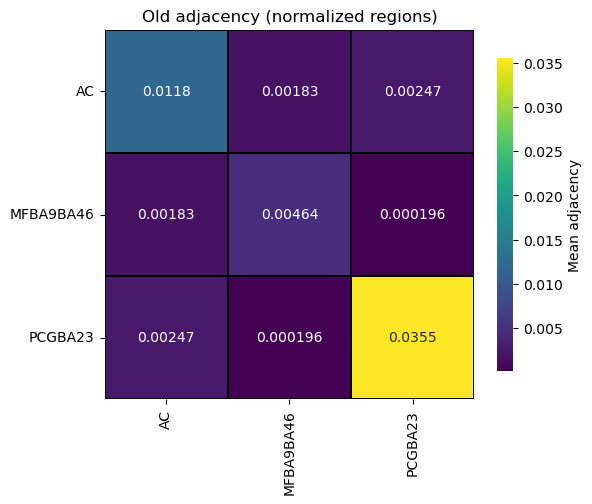

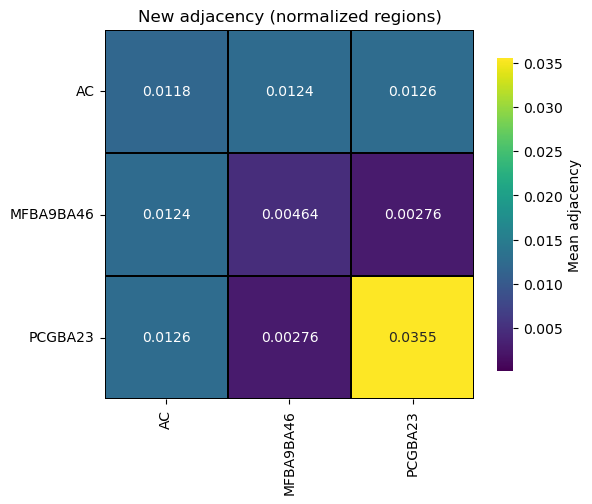

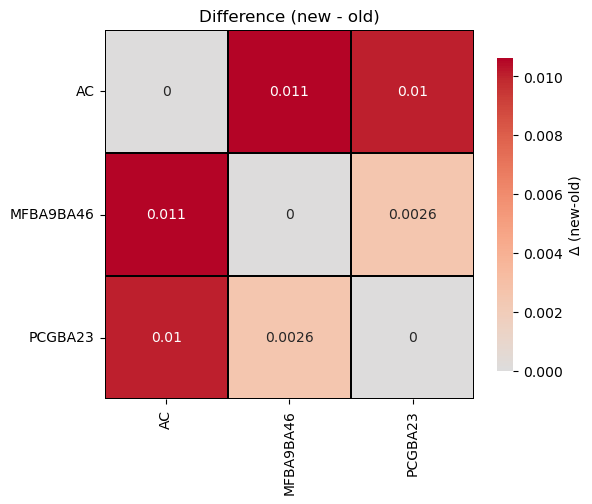

In [22]:
# --- C. Plot aligned heatmaps & differences (normalized regions) ---

import seaborn as sns, matplotlib.pyplot as plt

def plot_region_heatmap(mat, title, cmap="viridis", annotate=True, fmt=".3g", vmin=None, vmax=None):
    plt.figure(figsize=(2*len(mat), 2*len(mat)))
    ax = sns.heatmap(mat, cmap=cmap, vmin=vmin, vmax=vmax, square=True,
                     cbar_kws={"shrink":0.6,"label":"Mean adjacency"},
                     annot=annotate, fmt=fmt, linewidths=0.3, linecolor="black")
    ax.set_title(title)
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()

gmin = min(old_region_means.min().min(), new_region_means.min().min())
gmax = max(old_region_means.max().max(), new_region_means.max().max())

plot_region_heatmap(old_region_means, "Old adjacency (normalized regions)", vmin=gmin, vmax=gmax)
plot_region_heatmap(new_region_means, "New adjacency (normalized regions)", vmin=gmin, vmax=gmax)

diff_mat = new_region_means - old_region_means
plt.figure(figsize=(2*len(diff_mat), 2*len(diff_mat)))
ax = sns.heatmap(diff_mat, cmap="coolwarm", center=0.0, square=True,
                 cbar_kws={"shrink":0.6,"label":"Δ (new-old)"},
                 annot=True, fmt=".2g", linewidths=0.3, linecolor="black")
ax.set_title("Difference (new - old)")
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

In [39]:
# --- Plotly heatmap: AC (rows) vs MF_BA9_BA46 (cols) in OLD adjacency ---

import polars as pl
import pandas as pd
import plotly.express as px
import random

OLD_PATH = "/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/notebooks/WGCNA_new_ROSMAP_AdjFunc_adjacency_no_NEWFUNC_ISONEW2025-09-07.csv"

# Parameters
MAX_ROWS = 300        # sampling threshold for AC genes (set None to disable)
MAX_COLS = 300        # sampling threshold for MF_BA9_BA46 genes
SAMPLE_SEED = 42
VALUE_RANGE = (0, 1)  # adjust if adjacency not in [0,1]

# 1. Extract column list and row id column
cols = pl.scan_csv(OLD_PATH).columns
ROW_ID_COL = cols[0]

# 2. Parse region prefixes (before first occurrence of '_ENSG')
def region_prefix(col: str):
    if "_ENSG" not in col:
        return None
    return col.split("_ENSG", 1)[0]

data_cols = [c for c in cols if c != ROW_ID_COL]
prefix_to_cols = {}
for c in data_cols:
    pre = region_prefix(c)
    if pre:
        prefix_to_cols.setdefault(pre, []).append(c)

# 3. Resolve target region raw prefix for PCG (could be PCG or already collapsed)
target_norm = "PCGBA23"
mf_candidates = [p for p in prefix_to_cols if p.replace("_", "") == target_norm]
if not mf_candidates:
    raise ValueError("Could not find PCGBA23 (raw or underscored) in old file columns.")
if len(mf_candidates) > 1:
    print("WARNING: multiple raw prefixes matched:", mf_candidates)
RAW_MF = mf_candidates[0]

# 4. Get AC and MF_BA9_BA46 column lists
if "AC" not in prefix_to_cols:
    raise ValueError("Region AC not found in old file columns.")
AC_cols = prefix_to_cols["AC"]
MF_cols = prefix_to_cols[RAW_MF]

print(f"AC genes: {len(AC_cols)}, {RAW_MF} genes: {len(MF_cols)}")

# 5. Collect AC row ids (genes whose row identifier starts with 'AC_')
ac_rows_series = (
    pl.scan_csv(OLD_PATH)
      .select(ROW_ID_COL)
      .filter(pl.col(ROW_ID_COL).str.starts_with("AC_"))
      .collect(streaming=True)[ROW_ID_COL]
)
AC_rows = ac_rows_series.to_list()
print(f"AC rows detected: {len(AC_rows)}")

# 6. Optional sampling to keep plot responsive
random.seed(SAMPLE_SEED)
if MAX_ROWS and len(AC_rows) > MAX_ROWS:
    AC_rows_sampled = sorted(random.sample(AC_rows, MAX_ROWS))
    print(f"Sampled AC rows: {len(AC_rows_sampled)} of {len(AC_rows)}")
else:
    AC_rows_sampled = AC_rows

if MAX_COLS and len(MF_cols) > MAX_COLS:
    MF_cols_sampled = sorted(random.sample(MF_cols, MAX_COLS))
    print(f"Sampled MF_BA9_BA46 cols: {len(MF_cols_sampled)} of {len(MF_cols)}")
else:
    MF_cols_sampled = MF_cols

# 7. Load the submatrix (rows: AC_* , columns: MF_BA9_BA46_* )
lf_sub = (
    pl.scan_csv(OLD_PATH)
      .select([ROW_ID_COL] + MF_cols_sampled)
      .filter(pl.col(ROW_ID_COL).is_in(AC_rows_sampled))
)

sub_df = lf_sub.collect(streaming=True).to_pandas()
sub_df = sub_df.set_index(ROW_ID_COL)

# Ensure row order (optional: sort)
sub_df = sub_df.loc[AC_rows_sampled]

print(f"Submatrix shape: {sub_df.shape}")

# 8. Plot with Plotly
fig = px.imshow(
    sub_df.values,
    x=sub_df.columns,
    y=sub_df.index,
    color_continuous_scale="Viridis",
    zmin=VALUE_RANGE[0],
    zmax=VALUE_RANGE[1],
    aspect="auto",
)
fig.update_layout(
    title=f"Old adjacency: AC (rows) vs {RAW_MF} (cols)",
    xaxis_title=f"{RAW_MF} genes",
    yaxis_title="AC genes",
    width=1000,
    height=800,
    coloraxis_colorbar=dict(title="Adj")
)
fig.show()

/tmp/ipykernel_1540297/2319772262.py:17: PerformanceWarning:

Determining the column names of a LazyFrame requires resolving its schema, which is a potentially expensive operation. Use `LazyFrame.collect_schema().names()` to get the column names without this warning.



AC genes: 17306, PCGBA23 genes: 17306


/tmp/ipykernel_1540297/2319772262.py:55: DeprecationWarning:

the `streaming` parameter was deprecated in 1.25.0; use `engine` instead.



AC rows detected: 17306
Sampled AC rows: 300 of 17306
Sampled MF_BA9_BA46 cols: 300 of 17306


/tmp/ipykernel_1540297/2319772262.py:81: DeprecationWarning:

the `streaming` parameter was deprecated in 1.25.0; use `engine` instead.



Submatrix shape: (300, 300)


In [43]:
import sys
sys.path.append("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction")
from adjVis import plot_region_pair_submatrix


CSV = "/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/notebooks/WGCNA_new_ROSMAP_AdjFunc_adjacency_no_NEWFUNC_ISO2025-09-07.csv"

out = plot_region_pair_submatrix(
    csv_path=CSV,
    region_a="AC",         # rows
    region_b="PCGBA23",    # matches "PCG_BA23" style prefixes too
    max_rows=300,
    max_cols=300,
    seed=42,
    value_range=(0, 1),    # set None if your matrix isn't 0..1
)

out["heatmap_fig"].show()
out["hist_fig"].show()
print(out["stats"])


/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/adjVis.py:84: PerformanceWarning:

Determining the column names of a LazyFrame requires resolving its schema, which is a potentially expensive operation. Use `LazyFrame.collect_schema().names()` to get the column names without this warning.



[Header] Region A (rows): 'AC' -> AC | Region B (cols): 'PCGBA23' -> PCGBA23
[Header] Columns for PCGBA23: 17306
[Sample] Rows A: 300 / 17306  |  Cols B: 300 / 17306
[Done] submatrix shape: (300, 300) | histogram cells: 90,000


{'rows': 300, 'cols': 300, 'row_k_mean': 0.7197687464231874, 'row_k_median': 0.6995469248959952, 'col_k_mean': 0.7197687464231873, 'col_k_median': 0.6352195568640924}


In [ ]:
import sys
sys.path.append("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction")
from adjVis import plot_region_pair_submatrix
import os

CSV = "/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/notebooks/WGCNA_new_ROSMAP_AdjFunc_adjacency_no_NEWFUNC_ISONEW_CT2_TS32025-09-08.csv"

out = plot_region_pair_submatrix(
    csv_path=CSV,
    region_a="AC",         # rows
    region_b="PCGBA23",    # matches "PCG_BA23" style prefixes too
    max_rows=300,
    max_cols=300,
    seed=42,
    value_range=(0, 1),    # set None if your matrix isn't 0..1
    ct=2,
    ts=3
)

out["heatmap_fig"].show()
out["hist_fig"].show()
print(out["stats"])

if not os.path.exists("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas"):
    os.makedirs("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas", exist_ok=True)

out["heatmap_fig"].write_html("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/AC_vs_PCGBA23_CT3_TS3.html")
out["hist_fig"].write_html("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/AC_vs_PCGBA23_CT3_TS3_hist.html")
out["heatmap_fig"].write_image("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/AC_vs_PCGBA23_CT3_TS3.png", scale=2)
out["hist_fig"].write_image("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/AC_vs_PCGBA23_CT3_TS3_hist.png", scale=2)

out = plot_region_pair_submatrix(
    csv_path=CSV,
    region_a="AC",         # rows
    region_b="MFBA9BA46",    # matches "PCG_BA23" style prefixes too
    max_rows=300,
    max_cols=300,
    seed=42,
    value_range=(0, 1),    # set None if your matrix isn't 0..1
    ct=3,
    ts=3
)

out["heatmap_fig"].show()
out["hist_fig"].show()
print(out["stats"])

out["heatmap_fig"].write_html("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/AC_vs_MFBA9BA46_CT3_TS3.html")
out["hist_fig"].write_html("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/AC_vs_MFBA9BA46_CT3_TS3_hist.html")
out["heatmap_fig"].write_image("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/AC_vs_MFBA9BA46_CT3_TS3.png", scale=2)
out["hist_fig"].write_image("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/AC_vs_MFBA9BA46_CT3_TS3_hist.png", scale=2)

out = plot_region_pair_submatrix(
    csv_path=CSV,
    region_a="PCGBA23",         # rows
    region_b="MFBA9BA46",    # matches "PCG_BA23" style prefixes too
    max_rows=300,
    max_cols=300,
    seed=42,
    value_range=(0, 1),    # set None if your matrix isn't 0..1
    ct=3,
    ts=3
)

out["heatmap_fig"].show()
out["hist_fig"].show()
print(out["stats"])

out["heatmap_fig"].write_html("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/PCGBA23_vs_MFBA9BA46_CT3_TS3.html")
out["hist_fig"].write_html("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/PCGBA23_vs_MFBA9BA46_CT3_TS3_hist.html")
out["heatmap_fig"].write_image("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/PCGBA23_vs_MFBA9BA46_CT3_TS3.png", scale=2)
out["hist_fig"].write_image("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/PCGBA23_vs_MFBA9BA46_CT3_TS3_hist.png", scale=2)

out = plot_region_pair_submatrix(
    csv_path=CSV,
    region_a="PCGBA23",         # rows
    region_b="PCGBA23",    # matches "PCG_BA23"
    max_rows=300,
    max_cols=300,
    seed=42,
    value_range=(0, 1),    # set None if your matrix isn't 0
    ct=3,
    ts=3
)

out["heatmap_fig"].show()
out["hist_fig"].show()
print(out["stats"])

out["heatmap_fig"].write_html("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/PCGBA23_vs_PCGBA23_CT3_TS3.html")
out["hist_fig"].write_html("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/PCGBA23_vs_PCGBA23_CT3_TS3_hist.html")
out["heatmap_fig"].write_image("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/PCGBA23_vs_PCGBA23_CT3_TS3.png", scale=2)
out["hist_fig"].write_image("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/PCGBA23_vs_PCGBA23_CT3_TS3_hist.png", scale=2) 



out = plot_region_pair_submatrix(
    csv_path=CSV,
    region_a="AC",         # rows
    region_b="AC",    # matches "PCG_BA23" style prefixes too
    max_rows=300,
    max_cols=300,
    seed=42,
    value_range=(0, 1),    # set None if your matrix isn't 0
    ct=3,
    ts=3
)

out["heatmap_fig"].show()
out["hist_fig"].show()
print(out["stats"])

out["heatmap_fig"].write_html("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/AC_vs_AC_CT3_TS3.html")
out["hist_fig"].write_html("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/AC_vs_AC_CT3_TS3_hist.html")
out["heatmap_fig"].write_image("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/AC_vs_AC_CT3_TS3.png", scale=2)
out["hist_fig"].write_image("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/AC_vs_AC_CT3_TS3_hist.png", scale=2)

out = plot_region_pair_submatrix(
    csv_path=CSV,
    region_a="MFBA9BA46",         # rows
    region_b="MFBA9BA46",    # matches "PCG_BA23" style prefixes too
    max_rows=300,
    max_cols=300,
    seed=42,
    value_range=(0, 1),    # set None if your matrix isn't 0
    ct=3,
    ts=3
)   

out["heatmap_fig"].show()
out["hist_fig"].show()
print(out["stats"])


out["heatmap_fig"].write_html("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/MFBA9BA46_vs_MFBA9BA46_CT3_TS3.html")
out["hist_fig"].write_html("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/MFBA9BA46_vs_MFBA9BA46_CT3_TS3_hist.html")
out["heatmap_fig"].write_image("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/MFBA9BA46_vs_MFBA9BA46_CT3_TS3.png", scale=2)
out["hist_fig"].write_image("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/MFBA9BA46_vs_MFBA9BA46_CT3_TS3_hist.png", scale=2) 


/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/adjVis.py:86: PerformanceWarning: Determining the column names of a LazyFrame requires resolving its schema, which is a potentially expensive operation. Use `LazyFrame.collect_schema().names()` to get the column names without this warning.
  cols = pl.scan_csv(csv_path).columns


[Header] Region A (rows): 'AC' -> AC | Region B (cols): 'PCGBA23' -> PCGBA23
[Header] Columns for PCGBA23: 17306
[Sample] Rows A: 300 / 17306  |  Cols B: 300 / 17306
[Done] submatrix shape: (300, 300) | histogram cells: 90,000


{'rows': 300, 'cols': 300, 'row_k_mean': 0.7945007240304938, 'row_k_median': 0.6731142729078856, 'row_k_sum': 238.35021720914813, 'col_k_mean': 0.7945007240304935, 'col_k_median': 0.6198038258043237, 'col_k_sum': 238.35021720914807}


/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/adjVis.py:86: PerformanceWarning:

Determining the column names of a LazyFrame requires resolving its schema, which is a potentially expensive operation. Use `LazyFrame.collect_schema().names()` to get the column names without this warning.



[Header] Region A (rows): 'AC' -> AC | Region B (cols): 'MFBA9BA46' -> MFBA9BA46
[Header] Columns for MFBA9BA46: 17306


In [ ]:
import sys
sys.path.append("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction")
from adjVis import plot_region_pair_submatrix
import os

CSV_CT2_TS3 = "/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/adj4rn.csv"
pairs = [("AC", "PCGBA23"), ("AC", "MFBA9BA46"), ("PCGBA23", "MFBA9BA46"), ("PCGBA23", "PCGBA23"), ("AC", "AC"), ("MFBA9BA46", "MFBA9BA46")]

for ra, rb in pairs:
    out = plot_region_pair_submatrix(
        csv_path=CSV_CT2_TS3,
        region_a=ra,         # rows
        region_b=rb,    # matches "PCG_BA23" style prefixes too
        max_rows=300,
        max_cols=300,
        seed=42,
        value_range=(0, 1),    # set None if your matrix isn't 0
        ct=2,
        ts=3
    )

    out["heatmap_fig"].show()
    out["hist_fig"].show()
    print(out["stats"])

    if not os.path.exists("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas"):
        os.makedirs("/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas", exist_ok=True)
    if 'PCG' in ra:
        ts = 2
    elif 'AC' in ra:
        ts = 3
    elif 'MF' in ra:
        ts = 4

    out["heatmap_fig"].write_html(f"/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/{ra}_vs_{rb}_CT3_TS{ts}.html")
    out["hist_fig"].write_html(f"/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/{ra}_vs_{rb}_CT3_TS{ts}_hist.html")
    out["heatmap_fig"].write_image(f"/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/{ra}_vs_{rb}_CT3_TS{ts}.png", scale=2)
    out["hist_fig"].write_image(f"/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/outputsValidationPlots/diffbetas/{ra}_vs_{rb}_CT3_TS{ts}_hist.png", scale=2)


/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/adjVis.py:86: PerformanceWarning: Determining the column names of a LazyFrame requires resolving its schema, which is a potentially expensive operation. Use `LazyFrame.collect_schema().names()` to get the column names without this warning.
  cols = pl.scan_csv(csv_path).columns


[Header] Region A (rows): 'AC' -> AC | Region B (cols): 'PCGBA23' -> PCGBA23
[Header] Columns for PCGBA23: 17306
[Sample] Rows A: 300 / 17306  |  Cols B: 300 / 17306
[Done] submatrix shape: (300, 300) | histogram cells: 90,000


{'rows': 300, 'cols': 300, 'row_k_mean': 4.036442894500379, 'row_k_median': 3.833836132108371, 'row_k_sum': 1210.9328683501137, 'col_k_mean': 4.036442894500379, 'col_k_median': 3.5752268168698293, 'col_k_sum': 1210.9328683501137}


/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/adjVis.py:86: PerformanceWarning:

Determining the column names of a LazyFrame requires resolving its schema, which is a potentially expensive operation. Use `LazyFrame.collect_schema().names()` to get the column names without this warning.



[Header] Region A (rows): 'AC' -> AC | Region B (cols): 'MFBA9BA46' -> MFBA9BA46
[Header] Columns for MFBA9BA46: 17306
[Sample] Rows A: 300 / 17306  |  Cols B: 300 / 17306
[Done] submatrix shape: (300, 300) | histogram cells: 90,000


{'rows': 300, 'cols': 300, 'row_k_mean': 4.084333883830996, 'row_k_median': 3.7011613833646817, 'row_k_sum': 1225.3001651492987, 'col_k_mean': 4.084333883830996, 'col_k_median': 3.728658751621002, 'col_k_sum': 1225.3001651492987}


/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/adjVis.py:86: PerformanceWarning:

Determining the column names of a LazyFrame requires resolving its schema, which is a potentially expensive operation. Use `LazyFrame.collect_schema().names()` to get the column names without this warning.



[Header] Region A (rows): 'PCGBA23' -> PCGBA23 | Region B (cols): 'MFBA9BA46' -> MFBA9BA46
[Header] Columns for MFBA9BA46: 17306
[Sample] Rows A: 300 / 17306  |  Cols B: 300 / 17306
[Done] submatrix shape: (300, 300) | histogram cells: 90,000


{'rows': 300, 'cols': 300, 'row_k_mean': 4.573010648497431, 'row_k_median': 4.3230794893781574, 'row_k_sum': 1371.9031945492293, 'col_k_mean': 4.573010648497431, 'col_k_median': 4.095515204893811, 'col_k_sum': 1371.9031945492293}


/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/adjVis.py:86: PerformanceWarning:

Determining the column names of a LazyFrame requires resolving its schema, which is a potentially expensive operation. Use `LazyFrame.collect_schema().names()` to get the column names without this warning.



[Header] Region A (rows): 'PCGBA23' -> PCGBA23 | Region B (cols): 'PCGBA23' -> PCGBA23
[Header] Columns for PCGBA23: 17306
[Sample] Rows A: 300 / 17306  |  Cols B: 300 / 17306
[Done] submatrix shape: (300, 300) | histogram cells: 90,000


{'rows': 300, 'cols': 300, 'row_k_mean': 4.259912600357755, 'row_k_median': 2.806507306936969, 'row_k_sum': 1277.9737801073265, 'col_k_mean': 4.259912600357755, 'col_k_median': 2.920822204814704, 'col_k_sum': 1277.9737801073265}


/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/adjVis.py:86: PerformanceWarning:

Determining the column names of a LazyFrame requires resolving its schema, which is a potentially expensive operation. Use `LazyFrame.collect_schema().names()` to get the column names without this warning.



[Header] Region A (rows): 'AC' -> AC | Region B (cols): 'AC' -> AC
[Header] Columns for AC: 17306
[Sample] Rows A: 300 / 17306  |  Cols B: 300 / 17306
[Done] submatrix shape: (300, 300) | histogram cells: 90,000


{'rows': 300, 'cols': 300, 'row_k_mean': 4.113075638384135, 'row_k_median': 2.8433494580570837, 'row_k_sum': 1233.9226915152406, 'col_k_mean': 4.113075638384135, 'col_k_median': 2.8626063090709, 'col_k_sum': 1233.9226915152406}


/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/adjVis.py:86: PerformanceWarning:

Determining the column names of a LazyFrame requires resolving its schema, which is a potentially expensive operation. Use `LazyFrame.collect_schema().names()` to get the column names without this warning.



[Header] Region A (rows): 'MFBA9BA46' -> MFBA9BA46 | Region B (cols): 'MFBA9BA46' -> MFBA9BA46
[Header] Columns for MFBA9BA46: 17306
[Sample] Rows A: 300 / 17306  |  Cols B: 300 / 17306
[Done] submatrix shape: (300, 300) | histogram cells: 90,000


{'rows': 300, 'cols': 300, 'row_k_mean': 4.0146875665282105, 'row_k_median': 2.5311306786248444, 'row_k_sum': 1204.406269958463, 'col_k_mean': 4.01468756652821, 'col_k_median': 2.5640801028257503, 'col_k_sum': 1204.4062699584629}


In [31]:
new_path = r'/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/notebooks/WGCNA_new_ROSMAP_oldAdjFunc_adjacency_no_2025-09-07.csv'
pl.scan_csv(new_path).columns

/tmp/ipykernel_1540297/2134801591.py:2: PerformanceWarning:

Determining the column names of a LazyFrame requires resolving its schema, which is a potentially expensive operation. Use `LazyFrame.collect_schema().names()` to get the column names without this warning.



['',
 'AC_ENSG00000000003.14',
 'AC_ENSG00000000419.12',
 'AC_ENSG00000000457.13',
 'AC_ENSG00000000460.16',
 'AC_ENSG00000000938.12',
 'AC_ENSG00000000971.15',
 'AC_ENSG00000001036.13',
 'AC_ENSG00000001084.10',
 'AC_ENSG00000001167.14',
 'AC_ENSG00000001460.17',
 'AC_ENSG00000001461.16',
 'AC_ENSG00000001497.16',
 'AC_ENSG00000001561.6',
 'AC_ENSG00000001617.11',
 'AC_ENSG00000001629.9',
 'AC_ENSG00000001630.15',
 'AC_ENSG00000001631.15',
 'AC_ENSG00000002016.17',
 'AC_ENSG00000002330.13',
 'AC_ENSG00000002549.12',
 'AC_ENSG00000002586.18',
 'AC_ENSG00000002586.18_PAR_Y',
 'AC_ENSG00000002587.9',
 'AC_ENSG00000002745.12',
 'AC_ENSG00000002746.14',
 'AC_ENSG00000002822.15',
 'AC_ENSG00000002834.17',
 'AC_ENSG00000002919.14',
 'AC_ENSG00000002933.7',
 'AC_ENSG00000003056.7',
 'AC_ENSG00000003096.14',
 'AC_ENSG00000003137.8',
 'AC_ENSG00000003147.17',
 'AC_ENSG00000003249.13',
 'AC_ENSG00000003393.14',
 'AC_ENSG00000003400.14',
 'AC_ENSG00000003402.19',
 'AC_ENSG00000003436.15',
 'AC_EN

In [24]:
# --- Plotly heatmap: AC (rows) vs MF_BA9_BA46 (cols) in NEW adjacency ---

import polars as pl
import pandas as pd
import plotly.express as px
import random

NEW_PATH = "/media/psylab-6028/DATA/Eden/CoExpression_ReProduction/adj_drop__.csv"

# Parameters (reuse prior values if they exist)
MAX_ROWS = globals().get("MAX_ROWS", 300)
MAX_COLS = globals().get("MAX_COLS", 300)
SAMPLE_SEED = globals().get("SAMPLE_SEED", 42)
VALUE_RANGE = globals().get("VALUE_RANGE", (0, 1))

# 1. Columns & row id
cols_new = pl.scan_csv(NEW_PATH).columns
ROW_ID_COL_NEW = cols_new[0]

# 2. Region prefix parser (same rule: split at first "_ENSG")
def region_prefix(col: str):
    if "_ENSG" not in col:
        return None
    return col.split("_ENSG", 1)[0]

data_cols_new = [c for c in cols_new if c != ROW_ID_COL_NEW]
prefix_to_cols_new = {}
for c in data_cols_new:
    pre = region_prefix(c)
    if pre:
        prefix_to_cols_new.setdefault(pre, []).append(c)

# 3. Resolve raw prefix for normalized MFBA9BA46
target_norm = "MFBA9BA46"
mf_candidates_new = [p for p in prefix_to_cols_new if p.replace("_", "") == target_norm]
if not mf_candidates_new:
    raise ValueError("Could not find MFBA9BA46 (raw or underscored) in NEW file columns.")
if len(mf_candidates_new) > 1:
    print("WARNING: multiple raw prefixes matched in NEW:", mf_candidates_new)
RAW_MF_NEW = mf_candidates_new[0]

# 4. Get AC & MF column lists
if "AC" not in prefix_to_cols_new:
    raise ValueError("Region AC not found in NEW file columns.")
AC_cols_new = prefix_to_cols_new["AC"]
MF_cols_new = prefix_to_cols_new[RAW_MF_NEW]

print(f"[NEW] AC genes: {len(AC_cols_new)}, {RAW_MF_NEW} genes: {len(MF_cols_new)}")

# 5. Collect AC row ids (rows whose id starts with 'AC_')
ac_rows_series_new = (
    pl.scan_csv(NEW_PATH)
      .select(ROW_ID_COL_NEW)
      .filter(pl.col(ROW_ID_COL_NEW).str.starts_with("AC_"))
      .collect(streaming=True)[ROW_ID_COL_NEW]
)
AC_rows_new = ac_rows_series_new.to_list()
print(f"[NEW] AC rows detected: {len(AC_rows_new)}")

# 6. Sampling (match old sampling if prior sampled lists exist)
random.seed(SAMPLE_SEED)

# If previous run defined AC_rows_sampled / MF_cols_sampled, optionally reuse intersection
reuse_alignment = "AC_rows_sampled" in globals() and "MF_cols_sampled" in globals()

if reuse_alignment:
    AC_rows_sampled_new = sorted(set(AC_rows_new).intersection(set(AC_rows_sampled)))
    MF_cols_sampled_new = sorted(set(MF_cols_new).intersection(set(MF_cols_sampled)))
    print(f"Reusing alignment: AC {len(AC_rows_sampled_new)} / MF {len(MF_cols_sampled_new)}")
else:
    if MAX_ROWS and len(AC_rows_new) > MAX_ROWS:
        AC_rows_sampled_new = sorted(random.sample(AC_rows_new, MAX_ROWS))
        print(f"Sampled NEW AC rows: {len(AC_rows_sampled_new)} of {len(AC_rows_new)}")
    else:
        AC_rows_sampled_new = AC_rows_new
    if MAX_COLS and len(MF_cols_new) > MAX_COLS:
        MF_cols_sampled_new = sorted(random.sample(MF_cols_new, MAX_COLS))
        print(f"Sampled NEW {RAW_MF_NEW} cols: {len(MF_cols_sampled_new)} of {len(MF_cols_new)}")
    else:
        MF_cols_sampled_new = MF_cols_new

# 7. Load submatrix (rows: AC_* , columns: MF_BA9_BA46_* )
lf_sub_new = (
    pl.scan_csv(NEW_PATH)
      .select([ROW_ID_COL_NEW] + MF_cols_sampled_new)
      .filter(pl.col(ROW_ID_COL_NEW).is_in(AC_rows_sampled_new))
)

sub_new_df = lf_sub_new.collect(streaming=True).to_pandas().set_index(ROW_ID_COL_NEW)
sub_new_df = sub_new_df.loc[AC_rows_sampled_new]  # enforce order

print(f"[NEW] Submatrix shape: {sub_new_df.shape}")

# 8. Plot
fig_new = px.imshow(
    sub_new_df.values,
    x=sub_new_df.columns,
    y=sub_new_df.index,
    color_continuous_scale="Viridis",
    zmin=VALUE_RANGE[0],
    zmax=VALUE_RANGE[1],
    aspect="auto",
)
fig_new.update_layout(
    title=f"New adjacency: AC (rows) vs {RAW_MF_NEW} (cols)",
    xaxis_title=f"{RAW_MF_NEW} genes",
    yaxis_title="AC genes",
    width=1000,
    height=800,
    coloraxis_colorbar=dict(title="Adj"),
)

/tmp/ipykernel_1540297/3557909945.py:17: PerformanceWarning:

Determining the column names of a LazyFrame requires resolving its schema, which is a potentially expensive operation. Use `LazyFrame.collect_schema().names()` to get the column names without this warning.



[NEW] AC genes: 17306, MFBA9BA46 genes: 17306


/tmp/ipykernel_1540297/3557909945.py:55: DeprecationWarning:

the `streaming` parameter was deprecated in 1.25.0; use `engine` instead.



[NEW] AC rows detected: 17306
Reusing alignment: AC 300 / MF 0


/tmp/ipykernel_1540297/3557909945.py:89: DeprecationWarning:

the `streaming` parameter was deprecated in 1.25.0; use `engine` instead.



[NEW] Submatrix shape: (300, 0)


/tmp/ipykernel_1540297/3690570374.py:13: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


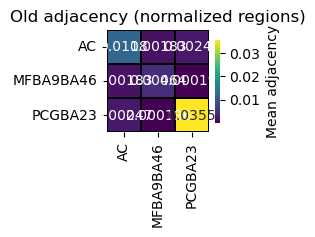

/tmp/ipykernel_1540297/3690570374.py:13: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


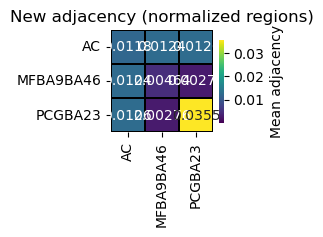

/tmp/ipykernel_1540297/3690570374.py:30: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


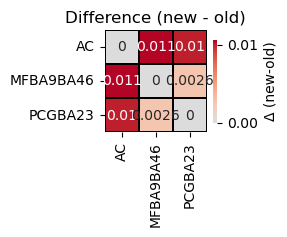

In [16]:
# --- Plot heatmaps (aligned on normalized regions) ---

import seaborn as sns, matplotlib.pyplot as plt

def plot_region_heatmap(mat, title, cmap="viridis", annotate=True, fmt=".3g", vmin=None, vmax=None):
    plt.figure(figsize=(0.55*len(mat), 0.55*len(mat)))
    ax = sns.heatmap(mat, cmap=cmap, vmin=vmin, vmax=vmax, square=True,
                     cbar_kws={"shrink":0.65,"label":"Mean adjacency"},
                     annot=annotate, fmt=fmt, linewidths=0.25, linecolor="black")
    ax.set_title(title)
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()

gmin = min(old_region_means.min().min(), new_region_means.min().min())
gmax = max(old_region_means.max().max(), new_region_means.max().max())

plot_region_heatmap(old_region_means, "Old adjacency (normalized regions)", vmin=gmin, vmax=gmax)
plot_region_heatmap(new_region_means, "New adjacency (normalized regions)", vmin=gmin, vmax=gmax)

diff_mat = new_region_means - old_region_means
plt.figure(figsize=(0.55*len(diff_mat), 0.55*len(diff_mat)))
ax = sns.heatmap(diff_mat, cmap="coolwarm", center=0.0, square=True,
                 cbar_kws={"shrink":0.65,"label":"Δ (new-old)"},
                 annot=True, fmt=".2g", linewidths=0.25, linecolor="black")
ax.set_title("Difference (new - old)")
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

In [29]:
len(old_adj.columns),len(new_adj.columns)

/tmp/ipykernel_1540297/791892383.py:1: PerformanceWarning:

Determining the column names of a LazyFrame requires resolving its schema, which is a potentially expensive operation. Use `LazyFrame.collect_schema().names()` to get the column names without this warning.



(51919, 51919)